In [2]:
import pandas as pd
from bs4 import BeautifulSoup
import time 
from splinter import Browser
from textblob import TextBlob
import nltk
nltk.download('averaged_perceptron_tagger')
from sklearn.feature_extraction.text import TfidfVectorizer
from nltk.corpus import stopwords
from nltk.tokenize import RegexpTokenizer
import re
from sklearn.metrics.pairwise import cosine_similarity
import numpy as np
import random
from tqdm import tqdm
from gensim.models import Word2Vec 
import matplotlib.pyplot as plt
# %matplotlib inline
import warnings;
# warnings.filterwarnings('ignore')

[nltk_data] Downloading package averaged_perceptron_tagger to
[nltk_data]     /home/dev/nltk_data...
[nltk_data]   Package averaged_perceptron_tagger is already up-to-
[nltk_data]       date!


In [93]:



librivox_id_search = 'https://librivox.org/api/feed/audiobooks/?id=47'

# import requests
browser.visit(librivox_id_search)
librivox_id_search_page = browser.html

soup = BeautifulSoup(librivox_id_search_page, 'html.parser')

soup.find("description")


<description>&lt;p&gt;&lt;i&gt;The Count of Monte Cristo&lt;/i&gt; (French: &lt;i&gt;Le Comte de Monte-Cristo&lt;/i&gt;) is an adventure novel by Alexandre Dumas, père. It is often considered, along with &lt;i&gt;The Three Musketeers&lt;/i&gt;, as Dumas's most popular work. The writing of the work was completed in 1844. Like many of his novels, it is expanded from the plot outlines suggested by his collaborating ghostwriter Auguste Maquet.&lt;/p&gt;&lt;p&gt;The story takes place in France, Italy, islands in the Mediterranean and the Levant during the historical events of 1815–1838 (from just before the Hundred Days through the reign of Louis-Philippe of France). The historical setting is a fundamental element of the book. It is primarily concerned with themes of justice, vengeance, mercy, and forgiveness, and is told in the style of an adventure story. (Summary from Wikipedia)&lt;/p&gt;
&lt;p&gt;This book contains alternate versions of a number of chapters – indicated by an alt after t

In [23]:
executable_path = {'executable_path':'../resources/chromedriver'}
browser = Browser('chrome', **executable_path)


book_objs=[]
for x in range(15000):
    print("Searching Librivox ID: ",x)
    librivox_id_search = f'https://librivox.org/api/feed/audiobooks/?id={x}'
    # librivox_id_search = f'https://librivox.org/api/feed/audiobooks/?id=65'
    try:
            browser.visit(librivox_id_search)
            librivox_id_search_page = browser.html
            soup = BeautifulSoup(librivox_id_search_page, 'html.parser')
            lib_id=soup.find("id").get_text()
            title=soup.find("title").get_text()
            description=soup.find("description").get_text()
            language=soup.find("language").get_text()
            copyright_year=soup.find("copyright_year").get_text()
            lib_url=soup.find('url_librivox').get_text()
            browser.visit(lib_url)
            book_url_page=browser.html
            soup = BeautifulSoup(book_url_page, 'html.parser')
            genre=soup.find_all('p', class_='book-page-genre')[0].get_text()
            genre_arr=genre.split(":")
            genre=genre_arr[1]
            book_objs.append({"lib_id":lib_id,
                        "title":title,
                        "genre":genre,
                        "description":description,
                        "language":language,
                        "copyright_year":copyright_year,
                        "lib_url":lib_url                  
                            })
    except: 
        print("couldn't locate")

Searching Librivox ID:  0
Searching Librivox ID:  1
couldn't locate
Searching Librivox ID:  2
couldn't locate
Searching Librivox ID:  3
couldn't locate
Searching Librivox ID:  4
couldn't locate
Searching Librivox ID:  5
couldn't locate
Searching Librivox ID:  6
couldn't locate
Searching Librivox ID:  7
couldn't locate
Searching Librivox ID:  8
couldn't locate
Searching Librivox ID:  9
couldn't locate
Searching Librivox ID:  10
couldn't locate
Searching Librivox ID:  11
couldn't locate
Searching Librivox ID:  12
couldn't locate
Searching Librivox ID:  13
couldn't locate
Searching Librivox ID:  14
couldn't locate
Searching Librivox ID:  15
couldn't locate
Searching Librivox ID:  16
couldn't locate
Searching Librivox ID:  17
couldn't locate
Searching Librivox ID:  18
couldn't locate
Searching Librivox ID:  19
couldn't locate
Searching Librivox ID:  20
couldn't locate
Searching Librivox ID:  21
couldn't locate
Searching Librivox ID:  22
couldn't locate
Searching Librivox ID:  23
couldn't l

Searching Librivox ID:  247
Searching Librivox ID:  248
Searching Librivox ID:  249
Searching Librivox ID:  250
Searching Librivox ID:  251
Searching Librivox ID:  252
Searching Librivox ID:  253
Searching Librivox ID:  254
Searching Librivox ID:  255
Searching Librivox ID:  256
Searching Librivox ID:  257
Searching Librivox ID:  258
Searching Librivox ID:  259
Searching Librivox ID:  260
Searching Librivox ID:  261
Searching Librivox ID:  262
Searching Librivox ID:  263
Searching Librivox ID:  264
Searching Librivox ID:  265
Searching Librivox ID:  266
Searching Librivox ID:  267
Searching Librivox ID:  268
Searching Librivox ID:  269
Searching Librivox ID:  270
Searching Librivox ID:  271
Searching Librivox ID:  272
Searching Librivox ID:  273
Searching Librivox ID:  274
Searching Librivox ID:  275
Searching Librivox ID:  276
Searching Librivox ID:  277
Searching Librivox ID:  278
Searching Librivox ID:  279
Searching Librivox ID:  280
Searching Librivox ID:  281
Searching Librivox I

Searching Librivox ID:  527
Searching Librivox ID:  528
couldn't locate
Searching Librivox ID:  529
Searching Librivox ID:  530
Searching Librivox ID:  531
Searching Librivox ID:  532
Searching Librivox ID:  533
Searching Librivox ID:  534
Searching Librivox ID:  535
Searching Librivox ID:  536
Searching Librivox ID:  537
Searching Librivox ID:  538
Searching Librivox ID:  539
Searching Librivox ID:  540
Searching Librivox ID:  541
Searching Librivox ID:  542
Searching Librivox ID:  543
Searching Librivox ID:  544
Searching Librivox ID:  545
Searching Librivox ID:  546
Searching Librivox ID:  547
Searching Librivox ID:  548
couldn't locate
Searching Librivox ID:  549
Searching Librivox ID:  550
Searching Librivox ID:  551
Searching Librivox ID:  552
Searching Librivox ID:  553
Searching Librivox ID:  554
Searching Librivox ID:  555
couldn't locate
Searching Librivox ID:  556
Searching Librivox ID:  557
Searching Librivox ID:  558
Searching Librivox ID:  559
Searching Librivox ID:  560


Searching Librivox ID:  789
couldn't locate
Searching Librivox ID:  790
couldn't locate
Searching Librivox ID:  791
couldn't locate
Searching Librivox ID:  792
Searching Librivox ID:  793
Searching Librivox ID:  794
couldn't locate
Searching Librivox ID:  795
Searching Librivox ID:  796
couldn't locate
Searching Librivox ID:  797
Searching Librivox ID:  798
Searching Librivox ID:  799
couldn't locate
Searching Librivox ID:  800
Searching Librivox ID:  801
Searching Librivox ID:  802
Searching Librivox ID:  803
Searching Librivox ID:  804
Searching Librivox ID:  805
Searching Librivox ID:  806
Searching Librivox ID:  807
Searching Librivox ID:  808
couldn't locate
Searching Librivox ID:  809
couldn't locate
Searching Librivox ID:  810
Searching Librivox ID:  811
couldn't locate
Searching Librivox ID:  812
Searching Librivox ID:  813
couldn't locate
Searching Librivox ID:  814
Searching Librivox ID:  815
Searching Librivox ID:  816
Searching Librivox ID:  817
Searching Librivox ID:  818


Searching Librivox ID:  1054
Searching Librivox ID:  1055
Searching Librivox ID:  1056
Searching Librivox ID:  1057
Searching Librivox ID:  1058
Searching Librivox ID:  1059
Searching Librivox ID:  1060
Searching Librivox ID:  1061
Searching Librivox ID:  1062
Searching Librivox ID:  1063
Searching Librivox ID:  1064
Searching Librivox ID:  1065
Searching Librivox ID:  1066
Searching Librivox ID:  1067
Searching Librivox ID:  1068
Searching Librivox ID:  1069
Searching Librivox ID:  1070
Searching Librivox ID:  1071
couldn't locate
Searching Librivox ID:  1072
Searching Librivox ID:  1073
Searching Librivox ID:  1074
Searching Librivox ID:  1075
Searching Librivox ID:  1076
Searching Librivox ID:  1077
Searching Librivox ID:  1078
Searching Librivox ID:  1079
Searching Librivox ID:  1080
Searching Librivox ID:  1081
Searching Librivox ID:  1082
Searching Librivox ID:  1083
Searching Librivox ID:  1084
Searching Librivox ID:  1085
Searching Librivox ID:  1086
Searching Librivox ID:  108

Searching Librivox ID:  1326
Searching Librivox ID:  1327
Searching Librivox ID:  1328
Searching Librivox ID:  1329
Searching Librivox ID:  1330
Searching Librivox ID:  1331
Searching Librivox ID:  1332
Searching Librivox ID:  1333
Searching Librivox ID:  1334
Searching Librivox ID:  1335
Searching Librivox ID:  1336
Searching Librivox ID:  1337
Searching Librivox ID:  1338
Searching Librivox ID:  1339
couldn't locate
Searching Librivox ID:  1340
couldn't locate
Searching Librivox ID:  1341
Searching Librivox ID:  1342
Searching Librivox ID:  1343
Searching Librivox ID:  1344
Searching Librivox ID:  1345
couldn't locate
Searching Librivox ID:  1346
Searching Librivox ID:  1347
Searching Librivox ID:  1348
Searching Librivox ID:  1349
Searching Librivox ID:  1350
Searching Librivox ID:  1351
Searching Librivox ID:  1352
Searching Librivox ID:  1353
Searching Librivox ID:  1354
Searching Librivox ID:  1355
Searching Librivox ID:  1356
Searching Librivox ID:  1357
couldn't locate
Searchin

Searching Librivox ID:  1597
Searching Librivox ID:  1598
Searching Librivox ID:  1599
Searching Librivox ID:  1600
Searching Librivox ID:  1601
Searching Librivox ID:  1602
Searching Librivox ID:  1603
Searching Librivox ID:  1604
couldn't locate
Searching Librivox ID:  1605
Searching Librivox ID:  1606
Searching Librivox ID:  1607
Searching Librivox ID:  1608
Searching Librivox ID:  1609
couldn't locate
Searching Librivox ID:  1610
Searching Librivox ID:  1611
Searching Librivox ID:  1612
Searching Librivox ID:  1613
Searching Librivox ID:  1614
Searching Librivox ID:  1615
Searching Librivox ID:  1616
Searching Librivox ID:  1617
Searching Librivox ID:  1618
Searching Librivox ID:  1619
Searching Librivox ID:  1620
Searching Librivox ID:  1621
Searching Librivox ID:  1622
Searching Librivox ID:  1623
Searching Librivox ID:  1624
Searching Librivox ID:  1625
Searching Librivox ID:  1626
Searching Librivox ID:  1627
couldn't locate
Searching Librivox ID:  1628
Searching Librivox ID:  

Searching Librivox ID:  1867
Searching Librivox ID:  1868
Searching Librivox ID:  1869
Searching Librivox ID:  1870
Searching Librivox ID:  1871
Searching Librivox ID:  1872
Searching Librivox ID:  1873
Searching Librivox ID:  1874
Searching Librivox ID:  1875
Searching Librivox ID:  1876
Searching Librivox ID:  1877
Searching Librivox ID:  1878
Searching Librivox ID:  1879
Searching Librivox ID:  1880
Searching Librivox ID:  1881
Searching Librivox ID:  1882
Searching Librivox ID:  1883
Searching Librivox ID:  1884
Searching Librivox ID:  1885
Searching Librivox ID:  1886
Searching Librivox ID:  1887
Searching Librivox ID:  1888
Searching Librivox ID:  1889
Searching Librivox ID:  1890
Searching Librivox ID:  1891
Searching Librivox ID:  1892
Searching Librivox ID:  1893
Searching Librivox ID:  1894
Searching Librivox ID:  1895
Searching Librivox ID:  1896
Searching Librivox ID:  1897
Searching Librivox ID:  1898
Searching Librivox ID:  1899
Searching Librivox ID:  1900
Searching Libr

Searching Librivox ID:  2141
Searching Librivox ID:  2142
Searching Librivox ID:  2143
Searching Librivox ID:  2144
Searching Librivox ID:  2145
Searching Librivox ID:  2146
Searching Librivox ID:  2147
Searching Librivox ID:  2148
Searching Librivox ID:  2149
Searching Librivox ID:  2150
Searching Librivox ID:  2151
Searching Librivox ID:  2152
Searching Librivox ID:  2153
Searching Librivox ID:  2154
Searching Librivox ID:  2155
Searching Librivox ID:  2156
Searching Librivox ID:  2157
Searching Librivox ID:  2158
Searching Librivox ID:  2159
Searching Librivox ID:  2160
couldn't locate
Searching Librivox ID:  2161
Searching Librivox ID:  2162
Searching Librivox ID:  2163
Searching Librivox ID:  2164
Searching Librivox ID:  2165
Searching Librivox ID:  2166
Searching Librivox ID:  2167
couldn't locate
Searching Librivox ID:  2168
Searching Librivox ID:  2169
Searching Librivox ID:  2170
Searching Librivox ID:  2171
Searching Librivox ID:  2172
Searching Librivox ID:  2173
Searching L

Searching Librivox ID:  2411
Searching Librivox ID:  2412
couldn't locate
Searching Librivox ID:  2413
Searching Librivox ID:  2414
Searching Librivox ID:  2415
Searching Librivox ID:  2416
Searching Librivox ID:  2417
Searching Librivox ID:  2418
Searching Librivox ID:  2419
Searching Librivox ID:  2420
Searching Librivox ID:  2421
Searching Librivox ID:  2422
Searching Librivox ID:  2423
Searching Librivox ID:  2424
Searching Librivox ID:  2425
Searching Librivox ID:  2426
Searching Librivox ID:  2427
Searching Librivox ID:  2428
Searching Librivox ID:  2429
Searching Librivox ID:  2430
Searching Librivox ID:  2431
Searching Librivox ID:  2432
Searching Librivox ID:  2433
Searching Librivox ID:  2434
Searching Librivox ID:  2435
Searching Librivox ID:  2436
Searching Librivox ID:  2437
Searching Librivox ID:  2438
Searching Librivox ID:  2439
Searching Librivox ID:  2440
Searching Librivox ID:  2441
couldn't locate
Searching Librivox ID:  2442
Searching Librivox ID:  2443
Searching L

Searching Librivox ID:  2683
Searching Librivox ID:  2684
Searching Librivox ID:  2685
Searching Librivox ID:  2686
Searching Librivox ID:  2687
Searching Librivox ID:  2688
Searching Librivox ID:  2689
Searching Librivox ID:  2690
Searching Librivox ID:  2691
Searching Librivox ID:  2692
Searching Librivox ID:  2693
Searching Librivox ID:  2694
Searching Librivox ID:  2695
Searching Librivox ID:  2696
Searching Librivox ID:  2697
couldn't locate
Searching Librivox ID:  2698
couldn't locate
Searching Librivox ID:  2699
Searching Librivox ID:  2700
Searching Librivox ID:  2701
Searching Librivox ID:  2702
Searching Librivox ID:  2703
Searching Librivox ID:  2704
Searching Librivox ID:  2705
couldn't locate
Searching Librivox ID:  2706
Searching Librivox ID:  2707
Searching Librivox ID:  2708
Searching Librivox ID:  2709
Searching Librivox ID:  2710
Searching Librivox ID:  2711
Searching Librivox ID:  2712
Searching Librivox ID:  2713
Searching Librivox ID:  2714
Searching Librivox ID:  

Searching Librivox ID:  2957
couldn't locate
Searching Librivox ID:  2958
Searching Librivox ID:  2959
couldn't locate
Searching Librivox ID:  2960
Searching Librivox ID:  2961
Searching Librivox ID:  2962
Searching Librivox ID:  2963
Searching Librivox ID:  2964
Searching Librivox ID:  2965
Searching Librivox ID:  2966
Searching Librivox ID:  2967
couldn't locate
Searching Librivox ID:  2968
Searching Librivox ID:  2969
Searching Librivox ID:  2970
Searching Librivox ID:  2971
Searching Librivox ID:  2972
Searching Librivox ID:  2973
Searching Librivox ID:  2974
Searching Librivox ID:  2975
Searching Librivox ID:  2976
Searching Librivox ID:  2977
Searching Librivox ID:  2978
Searching Librivox ID:  2979
Searching Librivox ID:  2980
Searching Librivox ID:  2981
Searching Librivox ID:  2982
Searching Librivox ID:  2983
Searching Librivox ID:  2984
Searching Librivox ID:  2985
Searching Librivox ID:  2986
Searching Librivox ID:  2987
couldn't locate
Searching Librivox ID:  2988
Searchin

Searching Librivox ID:  3228
Searching Librivox ID:  3229
Searching Librivox ID:  3230
Searching Librivox ID:  3231
couldn't locate
Searching Librivox ID:  3232
Searching Librivox ID:  3233
Searching Librivox ID:  3234
Searching Librivox ID:  3235
Searching Librivox ID:  3236
couldn't locate
Searching Librivox ID:  3237
Searching Librivox ID:  3238
Searching Librivox ID:  3239
Searching Librivox ID:  3240
Searching Librivox ID:  3241
Searching Librivox ID:  3242
Searching Librivox ID:  3243
Searching Librivox ID:  3244
Searching Librivox ID:  3245
Searching Librivox ID:  3246
Searching Librivox ID:  3247
Searching Librivox ID:  3248
Searching Librivox ID:  3249
Searching Librivox ID:  3250
Searching Librivox ID:  3251
Searching Librivox ID:  3252
Searching Librivox ID:  3253
Searching Librivox ID:  3254
couldn't locate
Searching Librivox ID:  3255
Searching Librivox ID:  3256
Searching Librivox ID:  3257
Searching Librivox ID:  3258
Searching Librivox ID:  3259
Searching Librivox ID:  

Searching Librivox ID:  3503
Searching Librivox ID:  3504
Searching Librivox ID:  3505
Searching Librivox ID:  3506
Searching Librivox ID:  3507
Searching Librivox ID:  3508
Searching Librivox ID:  3509
Searching Librivox ID:  3510
Searching Librivox ID:  3511
Searching Librivox ID:  3512
Searching Librivox ID:  3513
Searching Librivox ID:  3514
Searching Librivox ID:  3515
Searching Librivox ID:  3516
Searching Librivox ID:  3517
Searching Librivox ID:  3518
Searching Librivox ID:  3519
Searching Librivox ID:  3520
Searching Librivox ID:  3521
Searching Librivox ID:  3522
Searching Librivox ID:  3523
Searching Librivox ID:  3524
Searching Librivox ID:  3525
Searching Librivox ID:  3526
Searching Librivox ID:  3527
Searching Librivox ID:  3528
Searching Librivox ID:  3529
Searching Librivox ID:  3530
Searching Librivox ID:  3531
Searching Librivox ID:  3532
Searching Librivox ID:  3533
Searching Librivox ID:  3534
Searching Librivox ID:  3535
Searching Librivox ID:  3536
Searching Libr

Searching Librivox ID:  3776
Searching Librivox ID:  3777
Searching Librivox ID:  3778
Searching Librivox ID:  3779
Searching Librivox ID:  3780
Searching Librivox ID:  3781
Searching Librivox ID:  3782
Searching Librivox ID:  3783
Searching Librivox ID:  3784
Searching Librivox ID:  3785
Searching Librivox ID:  3786
couldn't locate
Searching Librivox ID:  3787
Searching Librivox ID:  3788
Searching Librivox ID:  3789
Searching Librivox ID:  3790
Searching Librivox ID:  3791
Searching Librivox ID:  3792
Searching Librivox ID:  3793
Searching Librivox ID:  3794
Searching Librivox ID:  3795
Searching Librivox ID:  3796
Searching Librivox ID:  3797
Searching Librivox ID:  3798
Searching Librivox ID:  3799
Searching Librivox ID:  3800
Searching Librivox ID:  3801
Searching Librivox ID:  3802
Searching Librivox ID:  3803
Searching Librivox ID:  3804
Searching Librivox ID:  3805
Searching Librivox ID:  3806
Searching Librivox ID:  3807
Searching Librivox ID:  3808
Searching Librivox ID:  380

Searching Librivox ID:  4050
Searching Librivox ID:  4051
Searching Librivox ID:  4052
Searching Librivox ID:  4053
Searching Librivox ID:  4054
Searching Librivox ID:  4055
couldn't locate
Searching Librivox ID:  4056
Searching Librivox ID:  4057
Searching Librivox ID:  4058
Searching Librivox ID:  4059
Searching Librivox ID:  4060
Searching Librivox ID:  4061
Searching Librivox ID:  4062
Searching Librivox ID:  4063
Searching Librivox ID:  4064
Searching Librivox ID:  4065
Searching Librivox ID:  4066
Searching Librivox ID:  4067
Searching Librivox ID:  4068
Searching Librivox ID:  4069
Searching Librivox ID:  4070
Searching Librivox ID:  4071
Searching Librivox ID:  4072
Searching Librivox ID:  4073
Searching Librivox ID:  4074
Searching Librivox ID:  4075
Searching Librivox ID:  4076
Searching Librivox ID:  4077
Searching Librivox ID:  4078
Searching Librivox ID:  4079
Searching Librivox ID:  4080
Searching Librivox ID:  4081
Searching Librivox ID:  4082
Searching Librivox ID:  408

Searching Librivox ID:  4325
Searching Librivox ID:  4326
Searching Librivox ID:  4327
Searching Librivox ID:  4328
Searching Librivox ID:  4329
Searching Librivox ID:  4330
Searching Librivox ID:  4331
Searching Librivox ID:  4332
Searching Librivox ID:  4333
couldn't locate
Searching Librivox ID:  4334
couldn't locate
Searching Librivox ID:  4335
Searching Librivox ID:  4336
Searching Librivox ID:  4337
Searching Librivox ID:  4338
Searching Librivox ID:  4339
Searching Librivox ID:  4340
Searching Librivox ID:  4341
Searching Librivox ID:  4342
Searching Librivox ID:  4343
Searching Librivox ID:  4344
Searching Librivox ID:  4345
couldn't locate
Searching Librivox ID:  4346
couldn't locate
Searching Librivox ID:  4347
Searching Librivox ID:  4348
Searching Librivox ID:  4349
Searching Librivox ID:  4350
couldn't locate
Searching Librivox ID:  4351
Searching Librivox ID:  4352
Searching Librivox ID:  4353
Searching Librivox ID:  4354
couldn't locate
Searching Librivox ID:  4355
Searc

Searching Librivox ID:  4598
Searching Librivox ID:  4599
Searching Librivox ID:  4600
Searching Librivox ID:  4601
Searching Librivox ID:  4602
Searching Librivox ID:  4603
Searching Librivox ID:  4604
Searching Librivox ID:  4605
Searching Librivox ID:  4606
Searching Librivox ID:  4607
Searching Librivox ID:  4608
Searching Librivox ID:  4609
Searching Librivox ID:  4610
Searching Librivox ID:  4611
Searching Librivox ID:  4612
Searching Librivox ID:  4613
Searching Librivox ID:  4614
Searching Librivox ID:  4615
Searching Librivox ID:  4616
Searching Librivox ID:  4617
Searching Librivox ID:  4618
Searching Librivox ID:  4619
Searching Librivox ID:  4620
Searching Librivox ID:  4621
Searching Librivox ID:  4622
Searching Librivox ID:  4623
Searching Librivox ID:  4624
Searching Librivox ID:  4625
Searching Librivox ID:  4626
Searching Librivox ID:  4627
Searching Librivox ID:  4628
Searching Librivox ID:  4629
Searching Librivox ID:  4630
Searching Librivox ID:  4631
Searching Libr

Searching Librivox ID:  4877
Searching Librivox ID:  4878
Searching Librivox ID:  4879
Searching Librivox ID:  4880
Searching Librivox ID:  4881
Searching Librivox ID:  4882
Searching Librivox ID:  4883
couldn't locate
Searching Librivox ID:  4884
Searching Librivox ID:  4885
couldn't locate
Searching Librivox ID:  4886
Searching Librivox ID:  4887
Searching Librivox ID:  4888
Searching Librivox ID:  4889
Searching Librivox ID:  4890
Searching Librivox ID:  4891
Searching Librivox ID:  4892
couldn't locate
Searching Librivox ID:  4893
Searching Librivox ID:  4894
Searching Librivox ID:  4895
Searching Librivox ID:  4896
Searching Librivox ID:  4897
Searching Librivox ID:  4898
Searching Librivox ID:  4899
Searching Librivox ID:  4900
Searching Librivox ID:  4901
Searching Librivox ID:  4902
Searching Librivox ID:  4903
Searching Librivox ID:  4904
Searching Librivox ID:  4905
Searching Librivox ID:  4906
Searching Librivox ID:  4907
Searching Librivox ID:  4908
Searching Librivox ID:  

Searching Librivox ID:  5151
Searching Librivox ID:  5152
Searching Librivox ID:  5153
Searching Librivox ID:  5154
Searching Librivox ID:  5155
Searching Librivox ID:  5156
Searching Librivox ID:  5157
Searching Librivox ID:  5158
Searching Librivox ID:  5159
Searching Librivox ID:  5160
Searching Librivox ID:  5161
Searching Librivox ID:  5162
Searching Librivox ID:  5163
Searching Librivox ID:  5164
Searching Librivox ID:  5165
Searching Librivox ID:  5166
Searching Librivox ID:  5167
Searching Librivox ID:  5168
Searching Librivox ID:  5169
Searching Librivox ID:  5170
Searching Librivox ID:  5171
Searching Librivox ID:  5172
Searching Librivox ID:  5173
Searching Librivox ID:  5174
couldn't locate
Searching Librivox ID:  5175
couldn't locate
Searching Librivox ID:  5176
Searching Librivox ID:  5177
Searching Librivox ID:  5178
Searching Librivox ID:  5179
couldn't locate
Searching Librivox ID:  5180
couldn't locate
Searching Librivox ID:  5181
couldn't locate
Searching Librivox ID

Searching Librivox ID:  5425
Searching Librivox ID:  5426
Searching Librivox ID:  5427
Searching Librivox ID:  5428
Searching Librivox ID:  5429
Searching Librivox ID:  5430
Searching Librivox ID:  5431
Searching Librivox ID:  5432
couldn't locate
Searching Librivox ID:  5433
Searching Librivox ID:  5434
Searching Librivox ID:  5435
Searching Librivox ID:  5436
Searching Librivox ID:  5437
Searching Librivox ID:  5438
Searching Librivox ID:  5439
Searching Librivox ID:  5440
Searching Librivox ID:  5441
Searching Librivox ID:  5442
Searching Librivox ID:  5443
Searching Librivox ID:  5444
Searching Librivox ID:  5445
Searching Librivox ID:  5446
couldn't locate
Searching Librivox ID:  5447
Searching Librivox ID:  5448
Searching Librivox ID:  5449
Searching Librivox ID:  5450
Searching Librivox ID:  5451
Searching Librivox ID:  5452
Searching Librivox ID:  5453
Searching Librivox ID:  5454
Searching Librivox ID:  5455
Searching Librivox ID:  5456
Searching Librivox ID:  5457
Searching L

couldn't locate
Searching Librivox ID:  5701
couldn't locate
Searching Librivox ID:  5702
Searching Librivox ID:  5703
Searching Librivox ID:  5704
Searching Librivox ID:  5705
Searching Librivox ID:  5706
Searching Librivox ID:  5707
Searching Librivox ID:  5708
Searching Librivox ID:  5709
Searching Librivox ID:  5710
Searching Librivox ID:  5711
Searching Librivox ID:  5712
Searching Librivox ID:  5713
Searching Librivox ID:  5714
couldn't locate
Searching Librivox ID:  5715
Searching Librivox ID:  5716
Searching Librivox ID:  5717
Searching Librivox ID:  5718
Searching Librivox ID:  5719
Searching Librivox ID:  5720
Searching Librivox ID:  5721
Searching Librivox ID:  5722
Searching Librivox ID:  5723
Searching Librivox ID:  5724
Searching Librivox ID:  5725
Searching Librivox ID:  5726
Searching Librivox ID:  5727
Searching Librivox ID:  5728
couldn't locate
Searching Librivox ID:  5729
couldn't locate
Searching Librivox ID:  5730
Searching Librivox ID:  5731
Searching Librivox ID

Searching Librivox ID:  5974
Searching Librivox ID:  5975
Searching Librivox ID:  5976
Searching Librivox ID:  5977
Searching Librivox ID:  5978
couldn't locate
Searching Librivox ID:  5979
Searching Librivox ID:  5980
Searching Librivox ID:  5981
Searching Librivox ID:  5982
Searching Librivox ID:  5983
Searching Librivox ID:  5984
Searching Librivox ID:  5985
Searching Librivox ID:  5986
Searching Librivox ID:  5987
Searching Librivox ID:  5988
Searching Librivox ID:  5989
Searching Librivox ID:  5990
Searching Librivox ID:  5991
couldn't locate
Searching Librivox ID:  5992
Searching Librivox ID:  5993
Searching Librivox ID:  5994
Searching Librivox ID:  5995
Searching Librivox ID:  5996
Searching Librivox ID:  5997
couldn't locate
Searching Librivox ID:  5998
couldn't locate
Searching Librivox ID:  5999
Searching Librivox ID:  6000
Searching Librivox ID:  6001
Searching Librivox ID:  6002
Searching Librivox ID:  6003
Searching Librivox ID:  6004
Searching Librivox ID:  6005
Searchin

Searching Librivox ID:  6247
Searching Librivox ID:  6248
couldn't locate
Searching Librivox ID:  6249
Searching Librivox ID:  6250
Searching Librivox ID:  6251
Searching Librivox ID:  6252
Searching Librivox ID:  6253
Searching Librivox ID:  6254
Searching Librivox ID:  6255
couldn't locate
Searching Librivox ID:  6256
Searching Librivox ID:  6257
Searching Librivox ID:  6258
Searching Librivox ID:  6259
Searching Librivox ID:  6260
Searching Librivox ID:  6261
Searching Librivox ID:  6262
Searching Librivox ID:  6263
Searching Librivox ID:  6264
Searching Librivox ID:  6265
Searching Librivox ID:  6266
Searching Librivox ID:  6267
Searching Librivox ID:  6268
Searching Librivox ID:  6269
Searching Librivox ID:  6270
Searching Librivox ID:  6271
Searching Librivox ID:  6272
Searching Librivox ID:  6273
Searching Librivox ID:  6274
Searching Librivox ID:  6275
Searching Librivox ID:  6276
Searching Librivox ID:  6277
Searching Librivox ID:  6278
Searching Librivox ID:  6279
Searching L

Searching Librivox ID:  6525
Searching Librivox ID:  6526
Searching Librivox ID:  6527
Searching Librivox ID:  6528
Searching Librivox ID:  6529
Searching Librivox ID:  6530
Searching Librivox ID:  6531
Searching Librivox ID:  6532
Searching Librivox ID:  6533
Searching Librivox ID:  6534
Searching Librivox ID:  6535
Searching Librivox ID:  6536
Searching Librivox ID:  6537
Searching Librivox ID:  6538
couldn't locate
Searching Librivox ID:  6539
Searching Librivox ID:  6540
Searching Librivox ID:  6541
Searching Librivox ID:  6542
Searching Librivox ID:  6543
Searching Librivox ID:  6544
Searching Librivox ID:  6545
Searching Librivox ID:  6546
Searching Librivox ID:  6547
Searching Librivox ID:  6548
Searching Librivox ID:  6549
Searching Librivox ID:  6550
Searching Librivox ID:  6551
Searching Librivox ID:  6552
Searching Librivox ID:  6553
Searching Librivox ID:  6554
Searching Librivox ID:  6555
Searching Librivox ID:  6556
Searching Librivox ID:  6557
Searching Librivox ID:  655

Searching Librivox ID:  6804
Searching Librivox ID:  6805
Searching Librivox ID:  6806
Searching Librivox ID:  6807
Searching Librivox ID:  6808
Searching Librivox ID:  6809
Searching Librivox ID:  6810
Searching Librivox ID:  6811
Searching Librivox ID:  6812
Searching Librivox ID:  6813
Searching Librivox ID:  6814
Searching Librivox ID:  6815
Searching Librivox ID:  6816
Searching Librivox ID:  6817
Searching Librivox ID:  6818
Searching Librivox ID:  6819
Searching Librivox ID:  6820
Searching Librivox ID:  6821
Searching Librivox ID:  6822
Searching Librivox ID:  6823
Searching Librivox ID:  6824
Searching Librivox ID:  6825
Searching Librivox ID:  6826
Searching Librivox ID:  6827
Searching Librivox ID:  6828
Searching Librivox ID:  6829
Searching Librivox ID:  6830
Searching Librivox ID:  6831
Searching Librivox ID:  6832
Searching Librivox ID:  6833
Searching Librivox ID:  6834
Searching Librivox ID:  6835
Searching Librivox ID:  6836
Searching Librivox ID:  6837
Searching Libr

Searching Librivox ID:  7084
Searching Librivox ID:  7085
Searching Librivox ID:  7086
Searching Librivox ID:  7087
Searching Librivox ID:  7088
Searching Librivox ID:  7089
Searching Librivox ID:  7090
Searching Librivox ID:  7091
Searching Librivox ID:  7092
Searching Librivox ID:  7093
Searching Librivox ID:  7094
couldn't locate
Searching Librivox ID:  7095
Searching Librivox ID:  7096
Searching Librivox ID:  7097
Searching Librivox ID:  7098
Searching Librivox ID:  7099
Searching Librivox ID:  7100
Searching Librivox ID:  7101
Searching Librivox ID:  7102
Searching Librivox ID:  7103
Searching Librivox ID:  7104
Searching Librivox ID:  7105
Searching Librivox ID:  7106
Searching Librivox ID:  7107
Searching Librivox ID:  7108
Searching Librivox ID:  7109
couldn't locate
Searching Librivox ID:  7110
Searching Librivox ID:  7111
couldn't locate
Searching Librivox ID:  7112
Searching Librivox ID:  7113
Searching Librivox ID:  7114
Searching Librivox ID:  7115
Searching Librivox ID:  

Searching Librivox ID:  7361
Searching Librivox ID:  7362
Searching Librivox ID:  7363
Searching Librivox ID:  7364
Searching Librivox ID:  7365
Searching Librivox ID:  7366
Searching Librivox ID:  7367
Searching Librivox ID:  7368
Searching Librivox ID:  7369
Searching Librivox ID:  7370
Searching Librivox ID:  7371
Searching Librivox ID:  7372
Searching Librivox ID:  7373
Searching Librivox ID:  7374
Searching Librivox ID:  7375
Searching Librivox ID:  7376
Searching Librivox ID:  7377
Searching Librivox ID:  7378
Searching Librivox ID:  7379
Searching Librivox ID:  7380
couldn't locate
Searching Librivox ID:  7381
Searching Librivox ID:  7382
Searching Librivox ID:  7383
Searching Librivox ID:  7384
Searching Librivox ID:  7385
Searching Librivox ID:  7386
Searching Librivox ID:  7387
Searching Librivox ID:  7388
Searching Librivox ID:  7389
Searching Librivox ID:  7390
Searching Librivox ID:  7391
Searching Librivox ID:  7392
Searching Librivox ID:  7393
Searching Librivox ID:  739

Searching Librivox ID:  7638
Searching Librivox ID:  7639
Searching Librivox ID:  7640
Searching Librivox ID:  7641
Searching Librivox ID:  7642
Searching Librivox ID:  7643
Searching Librivox ID:  7644
Searching Librivox ID:  7645
Searching Librivox ID:  7646
Searching Librivox ID:  7647
Searching Librivox ID:  7648
Searching Librivox ID:  7649
Searching Librivox ID:  7650
Searching Librivox ID:  7651
Searching Librivox ID:  7652
Searching Librivox ID:  7653
Searching Librivox ID:  7654
Searching Librivox ID:  7655
Searching Librivox ID:  7656
Searching Librivox ID:  7657
Searching Librivox ID:  7658
Searching Librivox ID:  7659
Searching Librivox ID:  7660
Searching Librivox ID:  7661
Searching Librivox ID:  7662
Searching Librivox ID:  7663
couldn't locate
Searching Librivox ID:  7664
Searching Librivox ID:  7665
Searching Librivox ID:  7666
Searching Librivox ID:  7667
Searching Librivox ID:  7668
Searching Librivox ID:  7669
Searching Librivox ID:  7670
Searching Librivox ID:  767

Searching Librivox ID:  7919
Searching Librivox ID:  7920
Searching Librivox ID:  7921
Searching Librivox ID:  7922
Searching Librivox ID:  7923
Searching Librivox ID:  7924
Searching Librivox ID:  7925
Searching Librivox ID:  7926
Searching Librivox ID:  7927
Searching Librivox ID:  7928
Searching Librivox ID:  7929
Searching Librivox ID:  7930
Searching Librivox ID:  7931
Searching Librivox ID:  7932
couldn't locate
Searching Librivox ID:  7933
Searching Librivox ID:  7934
Searching Librivox ID:  7935
Searching Librivox ID:  7936
Searching Librivox ID:  7937
Searching Librivox ID:  7938
Searching Librivox ID:  7939
Searching Librivox ID:  7940
Searching Librivox ID:  7941
Searching Librivox ID:  7942
Searching Librivox ID:  7943
Searching Librivox ID:  7944
Searching Librivox ID:  7945
Searching Librivox ID:  7946
Searching Librivox ID:  7947
Searching Librivox ID:  7948
couldn't locate
Searching Librivox ID:  7949
couldn't locate
Searching Librivox ID:  7950
Searching Librivox ID:  

Searching Librivox ID:  8198
Searching Librivox ID:  8199
Searching Librivox ID:  8200
Searching Librivox ID:  8201
Searching Librivox ID:  8202
Searching Librivox ID:  8203
Searching Librivox ID:  8204
Searching Librivox ID:  8205
Searching Librivox ID:  8206
Searching Librivox ID:  8207
Searching Librivox ID:  8208
Searching Librivox ID:  8209
Searching Librivox ID:  8210
Searching Librivox ID:  8211
Searching Librivox ID:  8212
Searching Librivox ID:  8213
Searching Librivox ID:  8214
Searching Librivox ID:  8215
Searching Librivox ID:  8216
Searching Librivox ID:  8217
Searching Librivox ID:  8218
Searching Librivox ID:  8219
Searching Librivox ID:  8220
Searching Librivox ID:  8221
Searching Librivox ID:  8222
Searching Librivox ID:  8223
Searching Librivox ID:  8224
Searching Librivox ID:  8225
Searching Librivox ID:  8226
Searching Librivox ID:  8227
Searching Librivox ID:  8228
Searching Librivox ID:  8229
Searching Librivox ID:  8230
Searching Librivox ID:  8231
Searching Libr

Searching Librivox ID:  8478
Searching Librivox ID:  8479
Searching Librivox ID:  8480
Searching Librivox ID:  8481
Searching Librivox ID:  8482
Searching Librivox ID:  8483
Searching Librivox ID:  8484
Searching Librivox ID:  8485
Searching Librivox ID:  8486
couldn't locate
Searching Librivox ID:  8487
Searching Librivox ID:  8488
Searching Librivox ID:  8489
Searching Librivox ID:  8490
Searching Librivox ID:  8491
Searching Librivox ID:  8492
Searching Librivox ID:  8493
Searching Librivox ID:  8494
Searching Librivox ID:  8495
Searching Librivox ID:  8496
Searching Librivox ID:  8497
Searching Librivox ID:  8498
Searching Librivox ID:  8499
Searching Librivox ID:  8500
Searching Librivox ID:  8501
Searching Librivox ID:  8502
Searching Librivox ID:  8503
Searching Librivox ID:  8504
Searching Librivox ID:  8505
Searching Librivox ID:  8506
Searching Librivox ID:  8507
Searching Librivox ID:  8508
Searching Librivox ID:  8509
Searching Librivox ID:  8510
Searching Librivox ID:  851

Searching Librivox ID:  8760
Searching Librivox ID:  8761
Searching Librivox ID:  8762
Searching Librivox ID:  8763
Searching Librivox ID:  8764
Searching Librivox ID:  8765
Searching Librivox ID:  8766
Searching Librivox ID:  8767
Searching Librivox ID:  8768
Searching Librivox ID:  8769
Searching Librivox ID:  8770
Searching Librivox ID:  8771
Searching Librivox ID:  8772
Searching Librivox ID:  8773
Searching Librivox ID:  8774
Searching Librivox ID:  8775
Searching Librivox ID:  8776
Searching Librivox ID:  8777
Searching Librivox ID:  8778
Searching Librivox ID:  8779
Searching Librivox ID:  8780
Searching Librivox ID:  8781
Searching Librivox ID:  8782
Searching Librivox ID:  8783
Searching Librivox ID:  8784
Searching Librivox ID:  8785
Searching Librivox ID:  8786
Searching Librivox ID:  8787
Searching Librivox ID:  8788
Searching Librivox ID:  8789
Searching Librivox ID:  8790
Searching Librivox ID:  8791
Searching Librivox ID:  8792
Searching Librivox ID:  8793
Searching Libr

Searching Librivox ID:  9043
Searching Librivox ID:  9044
Searching Librivox ID:  9045
Searching Librivox ID:  9046
Searching Librivox ID:  9047
Searching Librivox ID:  9048
Searching Librivox ID:  9049
Searching Librivox ID:  9050
Searching Librivox ID:  9051
Searching Librivox ID:  9052
Searching Librivox ID:  9053
Searching Librivox ID:  9054
Searching Librivox ID:  9055
Searching Librivox ID:  9056
Searching Librivox ID:  9057
Searching Librivox ID:  9058
Searching Librivox ID:  9059
Searching Librivox ID:  9060
Searching Librivox ID:  9061
Searching Librivox ID:  9062
Searching Librivox ID:  9063
Searching Librivox ID:  9064
Searching Librivox ID:  9065
Searching Librivox ID:  9066
Searching Librivox ID:  9067
Searching Librivox ID:  9068
Searching Librivox ID:  9069
Searching Librivox ID:  9070
Searching Librivox ID:  9071
Searching Librivox ID:  9072
Searching Librivox ID:  9073
Searching Librivox ID:  9074
Searching Librivox ID:  9075
Searching Librivox ID:  9076
Searching Libr

Searching Librivox ID:  9324
Searching Librivox ID:  9325
Searching Librivox ID:  9326
Searching Librivox ID:  9327
Searching Librivox ID:  9328
Searching Librivox ID:  9329
Searching Librivox ID:  9330
Searching Librivox ID:  9331
Searching Librivox ID:  9332
Searching Librivox ID:  9333
Searching Librivox ID:  9334
Searching Librivox ID:  9335
Searching Librivox ID:  9336
Searching Librivox ID:  9337
Searching Librivox ID:  9338
Searching Librivox ID:  9339
Searching Librivox ID:  9340
Searching Librivox ID:  9341
Searching Librivox ID:  9342
Searching Librivox ID:  9343
Searching Librivox ID:  9344
Searching Librivox ID:  9345
Searching Librivox ID:  9346
Searching Librivox ID:  9347
Searching Librivox ID:  9348
Searching Librivox ID:  9349
Searching Librivox ID:  9350
Searching Librivox ID:  9351
Searching Librivox ID:  9352
Searching Librivox ID:  9353
Searching Librivox ID:  9354
Searching Librivox ID:  9355
Searching Librivox ID:  9356
Searching Librivox ID:  9357
Searching Libr

Searching Librivox ID:  9606
Searching Librivox ID:  9607
Searching Librivox ID:  9608
Searching Librivox ID:  9609
Searching Librivox ID:  9610
Searching Librivox ID:  9611
Searching Librivox ID:  9612
Searching Librivox ID:  9613
Searching Librivox ID:  9614
Searching Librivox ID:  9615
Searching Librivox ID:  9616
Searching Librivox ID:  9617
Searching Librivox ID:  9618
Searching Librivox ID:  9619
Searching Librivox ID:  9620
Searching Librivox ID:  9621
Searching Librivox ID:  9622
Searching Librivox ID:  9623
Searching Librivox ID:  9624
Searching Librivox ID:  9625
Searching Librivox ID:  9626
Searching Librivox ID:  9627
Searching Librivox ID:  9628
Searching Librivox ID:  9629
Searching Librivox ID:  9630
Searching Librivox ID:  9631
Searching Librivox ID:  9632
Searching Librivox ID:  9633
Searching Librivox ID:  9634
Searching Librivox ID:  9635
Searching Librivox ID:  9636
Searching Librivox ID:  9637
Searching Librivox ID:  9638
Searching Librivox ID:  9639
Searching Libr

Searching Librivox ID:  9886
Searching Librivox ID:  9887
Searching Librivox ID:  9888
Searching Librivox ID:  9889
Searching Librivox ID:  9890
Searching Librivox ID:  9891
Searching Librivox ID:  9892
Searching Librivox ID:  9893
Searching Librivox ID:  9894
Searching Librivox ID:  9895
Searching Librivox ID:  9896
Searching Librivox ID:  9897
Searching Librivox ID:  9898
Searching Librivox ID:  9899
Searching Librivox ID:  9900
Searching Librivox ID:  9901
Searching Librivox ID:  9902
Searching Librivox ID:  9903
Searching Librivox ID:  9904
Searching Librivox ID:  9905
Searching Librivox ID:  9906
Searching Librivox ID:  9907
Searching Librivox ID:  9908
Searching Librivox ID:  9909
Searching Librivox ID:  9910
Searching Librivox ID:  9911
Searching Librivox ID:  9912
Searching Librivox ID:  9913
Searching Librivox ID:  9914
Searching Librivox ID:  9915
Searching Librivox ID:  9916
Searching Librivox ID:  9917
Searching Librivox ID:  9918
Searching Librivox ID:  9919
Searching Libr

Searching Librivox ID:  10162
Searching Librivox ID:  10163
Searching Librivox ID:  10164
Searching Librivox ID:  10165
Searching Librivox ID:  10166
Searching Librivox ID:  10167
Searching Librivox ID:  10168
Searching Librivox ID:  10169
Searching Librivox ID:  10170
Searching Librivox ID:  10171
Searching Librivox ID:  10172
Searching Librivox ID:  10173
Searching Librivox ID:  10174
Searching Librivox ID:  10175
Searching Librivox ID:  10176
Searching Librivox ID:  10177
Searching Librivox ID:  10178
Searching Librivox ID:  10179
Searching Librivox ID:  10180
Searching Librivox ID:  10181
Searching Librivox ID:  10182
Searching Librivox ID:  10183
Searching Librivox ID:  10184
Searching Librivox ID:  10185
Searching Librivox ID:  10186
Searching Librivox ID:  10187
Searching Librivox ID:  10188
Searching Librivox ID:  10189
Searching Librivox ID:  10190
Searching Librivox ID:  10191
Searching Librivox ID:  10192
Searching Librivox ID:  10193
Searching Librivox ID:  10194
Searching 

Searching Librivox ID:  10435
Searching Librivox ID:  10436
Searching Librivox ID:  10437
Searching Librivox ID:  10438
Searching Librivox ID:  10439
Searching Librivox ID:  10440
Searching Librivox ID:  10441
Searching Librivox ID:  10442
Searching Librivox ID:  10443
Searching Librivox ID:  10444
Searching Librivox ID:  10445
Searching Librivox ID:  10446
Searching Librivox ID:  10447
Searching Librivox ID:  10448
Searching Librivox ID:  10449
Searching Librivox ID:  10450
Searching Librivox ID:  10451
Searching Librivox ID:  10452
Searching Librivox ID:  10453
Searching Librivox ID:  10454
Searching Librivox ID:  10455
Searching Librivox ID:  10456
Searching Librivox ID:  10457
Searching Librivox ID:  10458
Searching Librivox ID:  10459
couldn't locate
Searching Librivox ID:  10460
Searching Librivox ID:  10461
Searching Librivox ID:  10462
Searching Librivox ID:  10463
Searching Librivox ID:  10464
Searching Librivox ID:  10465
Searching Librivox ID:  10466
Searching Librivox ID:  

Searching Librivox ID:  10707
Searching Librivox ID:  10708
Searching Librivox ID:  10709
Searching Librivox ID:  10710
Searching Librivox ID:  10711
Searching Librivox ID:  10712
Searching Librivox ID:  10713
Searching Librivox ID:  10714
couldn't locate
Searching Librivox ID:  10715
Searching Librivox ID:  10716
Searching Librivox ID:  10717
Searching Librivox ID:  10718
Searching Librivox ID:  10719
Searching Librivox ID:  10720
Searching Librivox ID:  10721
Searching Librivox ID:  10722
Searching Librivox ID:  10723
Searching Librivox ID:  10724
Searching Librivox ID:  10725
Searching Librivox ID:  10726
Searching Librivox ID:  10727
Searching Librivox ID:  10728
Searching Librivox ID:  10729
Searching Librivox ID:  10730
Searching Librivox ID:  10731
Searching Librivox ID:  10732
Searching Librivox ID:  10733
Searching Librivox ID:  10734
Searching Librivox ID:  10735
Searching Librivox ID:  10736
Searching Librivox ID:  10737
Searching Librivox ID:  10738
Searching Librivox ID:  

Searching Librivox ID:  10977
Searching Librivox ID:  10978
Searching Librivox ID:  10979
Searching Librivox ID:  10980
Searching Librivox ID:  10981
couldn't locate
Searching Librivox ID:  10982
Searching Librivox ID:  10983
Searching Librivox ID:  10984
Searching Librivox ID:  10985
Searching Librivox ID:  10986
Searching Librivox ID:  10987
Searching Librivox ID:  10988
Searching Librivox ID:  10989
Searching Librivox ID:  10990
Searching Librivox ID:  10991
Searching Librivox ID:  10992
Searching Librivox ID:  10993
Searching Librivox ID:  10994
Searching Librivox ID:  10995
Searching Librivox ID:  10996
Searching Librivox ID:  10997
Searching Librivox ID:  10998
Searching Librivox ID:  10999
Searching Librivox ID:  11000
Searching Librivox ID:  11001
Searching Librivox ID:  11002
Searching Librivox ID:  11003
Searching Librivox ID:  11004
Searching Librivox ID:  11005
Searching Librivox ID:  11006
Searching Librivox ID:  11007
Searching Librivox ID:  11008
Searching Librivox ID:  

Searching Librivox ID:  11247
Searching Librivox ID:  11248
Searching Librivox ID:  11249
Searching Librivox ID:  11250
Searching Librivox ID:  11251
Searching Librivox ID:  11252
Searching Librivox ID:  11253
Searching Librivox ID:  11254
Searching Librivox ID:  11255
Searching Librivox ID:  11256
Searching Librivox ID:  11257
Searching Librivox ID:  11258
Searching Librivox ID:  11259
Searching Librivox ID:  11260
Searching Librivox ID:  11261
Searching Librivox ID:  11262
Searching Librivox ID:  11263
Searching Librivox ID:  11264
Searching Librivox ID:  11265
couldn't locate
Searching Librivox ID:  11266
Searching Librivox ID:  11267
Searching Librivox ID:  11268
Searching Librivox ID:  11269
Searching Librivox ID:  11270
Searching Librivox ID:  11271
Searching Librivox ID:  11272
Searching Librivox ID:  11273
Searching Librivox ID:  11274
Searching Librivox ID:  11275
Searching Librivox ID:  11276
Searching Librivox ID:  11277
Searching Librivox ID:  11278
Searching Librivox ID:  

Searching Librivox ID:  11519
Searching Librivox ID:  11520
couldn't locate
Searching Librivox ID:  11521
Searching Librivox ID:  11522
Searching Librivox ID:  11523
Searching Librivox ID:  11524
Searching Librivox ID:  11525
Searching Librivox ID:  11526
Searching Librivox ID:  11527
Searching Librivox ID:  11528
Searching Librivox ID:  11529
Searching Librivox ID:  11530
Searching Librivox ID:  11531
Searching Librivox ID:  11532
Searching Librivox ID:  11533
Searching Librivox ID:  11534
Searching Librivox ID:  11535
Searching Librivox ID:  11536
Searching Librivox ID:  11537
Searching Librivox ID:  11538
Searching Librivox ID:  11539
Searching Librivox ID:  11540
Searching Librivox ID:  11541
Searching Librivox ID:  11542
Searching Librivox ID:  11543
Searching Librivox ID:  11544
Searching Librivox ID:  11545
Searching Librivox ID:  11546
Searching Librivox ID:  11547
Searching Librivox ID:  11548
Searching Librivox ID:  11549
Searching Librivox ID:  11550
Searching Librivox ID:  

Searching Librivox ID:  11789
Searching Librivox ID:  11790
Searching Librivox ID:  11791
Searching Librivox ID:  11792
Searching Librivox ID:  11793
Searching Librivox ID:  11794
Searching Librivox ID:  11795
Searching Librivox ID:  11796
Searching Librivox ID:  11797
Searching Librivox ID:  11798
Searching Librivox ID:  11799
Searching Librivox ID:  11800
Searching Librivox ID:  11801
Searching Librivox ID:  11802
Searching Librivox ID:  11803
Searching Librivox ID:  11804
Searching Librivox ID:  11805
Searching Librivox ID:  11806
Searching Librivox ID:  11807
Searching Librivox ID:  11808
Searching Librivox ID:  11809
Searching Librivox ID:  11810
Searching Librivox ID:  11811
Searching Librivox ID:  11812
Searching Librivox ID:  11813
Searching Librivox ID:  11814
Searching Librivox ID:  11815
Searching Librivox ID:  11816
Searching Librivox ID:  11817
Searching Librivox ID:  11818
Searching Librivox ID:  11819
Searching Librivox ID:  11820
Searching Librivox ID:  11821
Searching 

Searching Librivox ID:  12057
Searching Librivox ID:  12058
Searching Librivox ID:  12059
Searching Librivox ID:  12060
Searching Librivox ID:  12061
Searching Librivox ID:  12062
Searching Librivox ID:  12063
Searching Librivox ID:  12064
Searching Librivox ID:  12065
Searching Librivox ID:  12066
Searching Librivox ID:  12067
Searching Librivox ID:  12068
Searching Librivox ID:  12069
Searching Librivox ID:  12070
Searching Librivox ID:  12071
Searching Librivox ID:  12072
Searching Librivox ID:  12073
Searching Librivox ID:  12074
Searching Librivox ID:  12075
Searching Librivox ID:  12076
Searching Librivox ID:  12077
Searching Librivox ID:  12078
Searching Librivox ID:  12079
Searching Librivox ID:  12080
Searching Librivox ID:  12081
Searching Librivox ID:  12082
Searching Librivox ID:  12083
Searching Librivox ID:  12084
Searching Librivox ID:  12085
Searching Librivox ID:  12086
Searching Librivox ID:  12087
Searching Librivox ID:  12088
Searching Librivox ID:  12089
Searching 

Searching Librivox ID:  12326
Searching Librivox ID:  12327
Searching Librivox ID:  12328
Searching Librivox ID:  12329
Searching Librivox ID:  12330
Searching Librivox ID:  12331
Searching Librivox ID:  12332
Searching Librivox ID:  12333
Searching Librivox ID:  12334
Searching Librivox ID:  12335
Searching Librivox ID:  12336
Searching Librivox ID:  12337
Searching Librivox ID:  12338
Searching Librivox ID:  12339
Searching Librivox ID:  12340
Searching Librivox ID:  12341
Searching Librivox ID:  12342
Searching Librivox ID:  12343
Searching Librivox ID:  12344
Searching Librivox ID:  12345
Searching Librivox ID:  12346
Searching Librivox ID:  12347
Searching Librivox ID:  12348
Searching Librivox ID:  12349
Searching Librivox ID:  12350
Searching Librivox ID:  12351
Searching Librivox ID:  12352
Searching Librivox ID:  12353
Searching Librivox ID:  12354
Searching Librivox ID:  12355
Searching Librivox ID:  12356
Searching Librivox ID:  12357
Searching Librivox ID:  12358
Searching 

Searching Librivox ID:  12595
Searching Librivox ID:  12596
Searching Librivox ID:  12597
Searching Librivox ID:  12598
Searching Librivox ID:  12599
Searching Librivox ID:  12600
Searching Librivox ID:  12601
Searching Librivox ID:  12602
Searching Librivox ID:  12603
Searching Librivox ID:  12604
Searching Librivox ID:  12605
Searching Librivox ID:  12606
Searching Librivox ID:  12607
Searching Librivox ID:  12608
couldn't locate
Searching Librivox ID:  12609
couldn't locate
Searching Librivox ID:  12610
Searching Librivox ID:  12611
Searching Librivox ID:  12612
Searching Librivox ID:  12613
Searching Librivox ID:  12614
Searching Librivox ID:  12615
Searching Librivox ID:  12616
Searching Librivox ID:  12617
Searching Librivox ID:  12618
Searching Librivox ID:  12619
Searching Librivox ID:  12620
Searching Librivox ID:  12621
Searching Librivox ID:  12622
Searching Librivox ID:  12623
Searching Librivox ID:  12624
Searching Librivox ID:  12625
Searching Librivox ID:  12626
Searchin

Searching Librivox ID:  12864
Searching Librivox ID:  12865
Searching Librivox ID:  12866
Searching Librivox ID:  12867
Searching Librivox ID:  12868
Searching Librivox ID:  12869
Searching Librivox ID:  12870
Searching Librivox ID:  12871
Searching Librivox ID:  12872
Searching Librivox ID:  12873
Searching Librivox ID:  12874
Searching Librivox ID:  12875
Searching Librivox ID:  12876
Searching Librivox ID:  12877
Searching Librivox ID:  12878
Searching Librivox ID:  12879
Searching Librivox ID:  12880
Searching Librivox ID:  12881
Searching Librivox ID:  12882
Searching Librivox ID:  12883
Searching Librivox ID:  12884
Searching Librivox ID:  12885
Searching Librivox ID:  12886
Searching Librivox ID:  12887
Searching Librivox ID:  12888
Searching Librivox ID:  12889
Searching Librivox ID:  12890
Searching Librivox ID:  12891
Searching Librivox ID:  12892
Searching Librivox ID:  12893
couldn't locate
Searching Librivox ID:  12894
Searching Librivox ID:  12895
Searching Librivox ID:  

Searching Librivox ID:  13131
Searching Librivox ID:  13132
Searching Librivox ID:  13133
Searching Librivox ID:  13134
Searching Librivox ID:  13135
Searching Librivox ID:  13136
Searching Librivox ID:  13137
Searching Librivox ID:  13138
Searching Librivox ID:  13139
Searching Librivox ID:  13140
Searching Librivox ID:  13141
Searching Librivox ID:  13142
Searching Librivox ID:  13143
Searching Librivox ID:  13144
Searching Librivox ID:  13145
Searching Librivox ID:  13146
Searching Librivox ID:  13147
Searching Librivox ID:  13148
Searching Librivox ID:  13149
Searching Librivox ID:  13150
Searching Librivox ID:  13151
Searching Librivox ID:  13152
Searching Librivox ID:  13153
Searching Librivox ID:  13154
Searching Librivox ID:  13155
Searching Librivox ID:  13156
Searching Librivox ID:  13157
couldn't locate
Searching Librivox ID:  13158
Searching Librivox ID:  13159
Searching Librivox ID:  13160
Searching Librivox ID:  13161
Searching Librivox ID:  13162
Searching Librivox ID:  

Searching Librivox ID:  13398
Searching Librivox ID:  13399
Searching Librivox ID:  13400
Searching Librivox ID:  13401
Searching Librivox ID:  13402
Searching Librivox ID:  13403
Searching Librivox ID:  13404
Searching Librivox ID:  13405
Searching Librivox ID:  13406
Searching Librivox ID:  13407
Searching Librivox ID:  13408
Searching Librivox ID:  13409
Searching Librivox ID:  13410
Searching Librivox ID:  13411
Searching Librivox ID:  13412
Searching Librivox ID:  13413
Searching Librivox ID:  13414
Searching Librivox ID:  13415
Searching Librivox ID:  13416
Searching Librivox ID:  13417
Searching Librivox ID:  13418
Searching Librivox ID:  13419
Searching Librivox ID:  13420
Searching Librivox ID:  13421
Searching Librivox ID:  13422
Searching Librivox ID:  13423
Searching Librivox ID:  13424
Searching Librivox ID:  13425
Searching Librivox ID:  13426
couldn't locate
Searching Librivox ID:  13427
Searching Librivox ID:  13428
Searching Librivox ID:  13429
Searching Librivox ID:  

Searching Librivox ID:  13663
Searching Librivox ID:  13664
Searching Librivox ID:  13665
Searching Librivox ID:  13666
Searching Librivox ID:  13667
Searching Librivox ID:  13668
Searching Librivox ID:  13669
Searching Librivox ID:  13670
Searching Librivox ID:  13671
Searching Librivox ID:  13672
Searching Librivox ID:  13673
Searching Librivox ID:  13674
Searching Librivox ID:  13675
Searching Librivox ID:  13676
Searching Librivox ID:  13677
Searching Librivox ID:  13678
Searching Librivox ID:  13679
Searching Librivox ID:  13680
Searching Librivox ID:  13681
Searching Librivox ID:  13682
Searching Librivox ID:  13683
Searching Librivox ID:  13684
Searching Librivox ID:  13685
Searching Librivox ID:  13686
Searching Librivox ID:  13687
Searching Librivox ID:  13688
Searching Librivox ID:  13689
Searching Librivox ID:  13690
Searching Librivox ID:  13691
Searching Librivox ID:  13692
Searching Librivox ID:  13693
Searching Librivox ID:  13694
Searching Librivox ID:  13695
Searching 

Searching Librivox ID:  13923
Searching Librivox ID:  13924
couldn't locate
Searching Librivox ID:  13925
Searching Librivox ID:  13926
Searching Librivox ID:  13927
Searching Librivox ID:  13928
Searching Librivox ID:  13929
Searching Librivox ID:  13930
Searching Librivox ID:  13931
Searching Librivox ID:  13932
Searching Librivox ID:  13933
Searching Librivox ID:  13934
Searching Librivox ID:  13935
Searching Librivox ID:  13936
Searching Librivox ID:  13937
Searching Librivox ID:  13938
Searching Librivox ID:  13939
Searching Librivox ID:  13940
Searching Librivox ID:  13941
Searching Librivox ID:  13942
Searching Librivox ID:  13943
Searching Librivox ID:  13944
Searching Librivox ID:  13945
Searching Librivox ID:  13946
Searching Librivox ID:  13947
couldn't locate
Searching Librivox ID:  13948
Searching Librivox ID:  13949
couldn't locate
Searching Librivox ID:  13950
Searching Librivox ID:  13951
Searching Librivox ID:  13952
Searching Librivox ID:  13953
Searching Librivox ID:

Searching Librivox ID:  14178
Searching Librivox ID:  14179
Searching Librivox ID:  14180
Searching Librivox ID:  14181
Searching Librivox ID:  14182
couldn't locate
Searching Librivox ID:  14183
Searching Librivox ID:  14184
Searching Librivox ID:  14185
Searching Librivox ID:  14186
Searching Librivox ID:  14187
Searching Librivox ID:  14188
Searching Librivox ID:  14189
Searching Librivox ID:  14190
Searching Librivox ID:  14191
Searching Librivox ID:  14192
Searching Librivox ID:  14193
couldn't locate
Searching Librivox ID:  14194
Searching Librivox ID:  14195
Searching Librivox ID:  14196
Searching Librivox ID:  14197
Searching Librivox ID:  14198
Searching Librivox ID:  14199
Searching Librivox ID:  14200
Searching Librivox ID:  14201
Searching Librivox ID:  14202
Searching Librivox ID:  14203
Searching Librivox ID:  14204
Searching Librivox ID:  14205
couldn't locate
Searching Librivox ID:  14206
Searching Librivox ID:  14207
Searching Librivox ID:  14208
couldn't locate
Search

Searching Librivox ID:  14429
Searching Librivox ID:  14430
couldn't locate
Searching Librivox ID:  14431
Searching Librivox ID:  14432
Searching Librivox ID:  14433
Searching Librivox ID:  14434
Searching Librivox ID:  14435
couldn't locate
Searching Librivox ID:  14436
Searching Librivox ID:  14437
Searching Librivox ID:  14438
Searching Librivox ID:  14439
Searching Librivox ID:  14440
Searching Librivox ID:  14441
Searching Librivox ID:  14442
Searching Librivox ID:  14443
Searching Librivox ID:  14444
Searching Librivox ID:  14445
Searching Librivox ID:  14446
couldn't locate
Searching Librivox ID:  14447
couldn't locate
Searching Librivox ID:  14448
Searching Librivox ID:  14449
Searching Librivox ID:  14450
Searching Librivox ID:  14451
Searching Librivox ID:  14452
Searching Librivox ID:  14453
Searching Librivox ID:  14454
Searching Librivox ID:  14455
Searching Librivox ID:  14456
Searching Librivox ID:  14457
Searching Librivox ID:  14458
Searching Librivox ID:  14459
Search

Searching Librivox ID:  14675
Searching Librivox ID:  14676
couldn't locate
Searching Librivox ID:  14677
couldn't locate
Searching Librivox ID:  14678
Searching Librivox ID:  14679
Searching Librivox ID:  14680
Searching Librivox ID:  14681
Searching Librivox ID:  14682
couldn't locate
Searching Librivox ID:  14683
Searching Librivox ID:  14684
Searching Librivox ID:  14685
Searching Librivox ID:  14686
Searching Librivox ID:  14687
Searching Librivox ID:  14688
Searching Librivox ID:  14689
Searching Librivox ID:  14690
Searching Librivox ID:  14691
couldn't locate
Searching Librivox ID:  14692
Searching Librivox ID:  14693
Searching Librivox ID:  14694
Searching Librivox ID:  14695
Searching Librivox ID:  14696
Searching Librivox ID:  14697
couldn't locate
Searching Librivox ID:  14698
couldn't locate
Searching Librivox ID:  14699
Searching Librivox ID:  14700
Searching Librivox ID:  14701
Searching Librivox ID:  14702
Searching Librivox ID:  14703
Searching Librivox ID:  14704
coul

Searching Librivox ID:  14912
couldn't locate
Searching Librivox ID:  14913
Searching Librivox ID:  14914
Searching Librivox ID:  14915
Searching Librivox ID:  14916
couldn't locate
Searching Librivox ID:  14917
Searching Librivox ID:  14918
couldn't locate
Searching Librivox ID:  14919
Searching Librivox ID:  14920
Searching Librivox ID:  14921
Searching Librivox ID:  14922
Searching Librivox ID:  14923
Searching Librivox ID:  14924
couldn't locate
Searching Librivox ID:  14925
Searching Librivox ID:  14926
Searching Librivox ID:  14927
couldn't locate
Searching Librivox ID:  14928
Searching Librivox ID:  14929
Searching Librivox ID:  14930
couldn't locate
Searching Librivox ID:  14931
Searching Librivox ID:  14932
Searching Librivox ID:  14933
Searching Librivox ID:  14934
Searching Librivox ID:  14935
Searching Librivox ID:  14936
Searching Librivox ID:  14937
couldn't locate
Searching Librivox ID:  14938
Searching Librivox ID:  14939
Searching Librivox ID:  14940
couldn't locate
Se

In [21]:
        executable_path = {'executable_path':'../resources/chromedriver'}
        browser = Browser('chrome', **executable_path)
        
        book_objs=[]
        librivox_id_search = f'https://librivox.org/api/feed/audiobooks/?id=65'
        try:
            browser.visit(librivox_id_search)
            librivox_id_search_page = browser.html
            soup = BeautifulSoup(librivox_id_search_page, 'html.parser')
            lib_id=soup.find("id").get_text()
            title=soup.find("title").get_text()
            description=soup.find("description").get_text()
            language=soup.find("language").get_text()
            copyright_year=soup.find("copyright_year").get_text()
            lib_url=soup.find('url_librivox').get_text()
            browser.visit(lib_url)
            book_url_page=browser.html
            soup = BeautifulSoup(book_url_page, 'html.parser')
            genre=soup.find_all('p', class_='book-page-genre')[0].get_text()
            genre_arr=genre.split(":")
            genre=genre_arr[1]
            book_objs.append({"lib_id":lib_id,
                        "title":title,
                        "genre":genre,
                        "description":description,
                        "language":language,
                        "copyright_year":copyright_year,
                        "lib_url":lib_url                  
                            })
        except: 
            print("couldn't locate")

        print(book_objs)

genre:  ['Genre(s)', ' Action & Adventure Fiction, Classics (Greek & Latin Antiquity), Nautical & Marine Fiction']
[{'lib_id': '65', 'title': 'Odyssey', 'genre': ' Action & Adventure Fiction, Classics (Greek & Latin Antiquity), Nautical & Marine Fiction', 'description': "<p>The Odyssey is one of the two major ancient Greek epic poems (the other being the Iliad), attributed to the poet Homer. The poem is commonly dated to between 800 and 600 BC. The poem is, in part, a sequel to the Iliad, and concerns the events that befall the Greek hero Odysseus in his long journey back to his native land Ithaca after the fall of Troy.</p>\n\nIt takes Odysseus ten years to return to his native land of Ithaca after ten years of war; during his 20-year absence, his son Telemachus and his wife Penelope must deal with a group of unruly suitors who have moved into Odysseus' home to compete for Penelope's hand in marriage, since most have assumed that Odysseus has died.</p>\n\nThe poem is a fundamental tex

In [24]:
import pandas as pd

book_obj_df=pd.DataFrame(book_objs)

book_obj_df.to_csv("book_obj_list_v1.csv")


In [3]:
import pandas as pd
test_book_df = pd.read_csv("./book_obj_list_v2.csv")
test_book_df

,Unnamed: 0,lib_id,title,genre,description,language,copyright_year,lib_url
0,0,47,Count of Monte Cristo,"Literary Fiction, Published 1800 -1900",<p><i>The Count of Monte Cristo</i> (French: <...,English,1844,https://librivox.org/the-count-of-monte-cristo...
1,1,47,Count of Monte Cristo,"Literary Fiction, Published 1800 -1900",<p><i>The Count of Monte Cristo</i> (French: <...,English,1844,https://librivox.org/the-count-of-monte-cristo...
2,2,52,Letters of Two Brides,Epistolary Fiction,Letters of Two Brides is an epistolary novel. ...,English,1902,https://librivox.org/letters-of-two-brides-by-...
3,3,53,Bleak House,General Fiction,<p>Bleak House is the ninth novel by Charles D...,English,1853,https://librivox.org/bleak-house-by-charles-di...
4,4,54,Penguin Island,Satire,<p>The novel (original French title -- L'Île d...,English,1908,https://librivox.org/penguin-island-by-anatole...
...,...,...,...,...,...,...,...,...
14008,14008,14990,"Ingersoll on WALT WHITMAN, from the Works of R...",*Non-fiction,Col. Ingersoll begins his lectures on famous p...,English,1900,https://librivox.org/ingersoll-on-walt-whitman...
14009,14009,14992,Autobiography of an Actress; or Eight Years on...,"Performing Arts, Memoirs",Anna Cora Mowatt was the author of the first B...,English,1854,https://librivox.org/autobiography-of-an-actre...
14010,14010,14993,Money-Spinner,Comedy,When his younger brother incurs a large bettin...,English,1900,https://librivox.org/the-money-spinner-by-arth...
14011,14011,14994,Heart of a Mystery,Crime & Mystery Fiction,The Heart of Mystery by L. T. Meade and Robert...,English,1901,https://librivox.org/the-heart-of-a-mystery-by...


In [3]:
# language="English"
for x in book_df['title']:
    title=x
    print("Matching for Title: ", title)
    # Matching the language with the dataset and reset the index
    try:
        data=book_df
#         data = book_df.loc[book_df['language'] == language]  
        data.reset_index(level = 0, inplace = True) 
        print('Convert the index into series')
        indices = pd.Series(data.index, index = data['title'])
        # print(indices)
        print("Converting the book title into vectors and used bigram")
        tf = TfidfVectorizer(analyzer='word', ngram_range=(2, 2), min_df = 1, stop_words='english')
        tfidf_matrix = tf.fit_transform(data['cleaned_desc'])
        # print(tfidf_matrix)
        print("Calculating the similarity measures based on Cosine Similarity")
        sg = cosine_similarity(tfidf_matrix, tfidf_matrix)
        # print(indices)    
        print("Get the index corresponding to original_title")       
        idx = indices[title]
        print('Get the pairwise similarity scores') 
        sig = list(enumerate(sg[idx]))
        # print(sig)
        print("Sort the books")
        sig = sorted(sig, key=lambda x: x[1], reverse=True)
        print('Scores of the 5 most similar books') 
        sig = sig[1:6]
        print("Book indicies")
        movie_indices = [i[0] for i in sig]
        print("Top 5 book recommendation")
        rec = data[['title']].iloc[movie_indices]   
        print(rec)
        # It reads the top 5 recommend book url and print the images
        # rec_whole_df= pd.DataFrame()
        rec_whole_df = book_df[book_df['title'].isin(rec['title'])]
        print(rec_whole_df)
        return jsonify(rec_whole_df.to_json(orient="records"))
    except:
        print("exception in running analysis for: ", book)

Count of Monte Cristo
Count of Monte Cristo
Letters of Two Brides
Bleak House
Penguin Island
This Side of Paradise
Secret Garden
Twenty Years After
Adventures of Huckleberry Finn
Heart of Darkness
Odyssey
Märchen (Index aller Märchen)
Divine Comedy
Unbeaten Tracks in Japan
Canterville Ghost
Fábulas de Esopo, Vol. 1
Mother Goose in Prose
Uncle Tom's Cabin
Truth About Jesus.  Is He a Myth?
Foolish Dictionary
Ranald Bannerman's Boyhood
Fables de La Fontaine, livre 01
Dream Psychology
Winnetou I
Vindication of the Rights of Woman
Getting of Wisdom
Consolation of Philosophy
Emma
Mrs. Caudle's Curtain Lectures
Fábulas de Esopo, Vol. 2
Importance of Being Earnest
Story of a Stuffed Elephant
Wind in the Willows
Junior Classics Volume 1: Fairy and Wonder Tales
Lord Jim
Villette
Narrative of Arthur Gordon Pym of Nantucket
Merry Adventures of Robin Hood
Wives and Daughters
Poems Every Child Should Know
Art of War
Three Musketeers
Fábulas de Esopo, Vol. 3
Bible (LSG, 1910) NT 04: Évangile selon Je

De Profundis
House of the Seven Gables (Version 2)
History of England, from the Accession of James II - (Volume 3, Chapter 13)
Maria Chapdelaine
Christmas Short Works Collection 2007
Lie
One day is there of the series
Short Poetry Collection 055
David Elginbrod
Madame Bovary
Chasse-galerie
Short Nonfiction Collection Vol. 007
Short Science Fiction Collection 003
Wings of the Dove
Bible (WEB) Old Testament - complete
Legends of the Jews, Volume 2
Rinkitink in Oz (version 2)
Critique of Practical Reason
Principles of Economics, Book 5: General Relations of Demand, Supply and Value
Aphorisms
History of the United States, Vol. IV: The West and Jacksonian Democracy
Freckles
My Prime of Youth is but a Frost of Cares
Introduction to The Philosophy of History
Chronicles of Canada Volume 09  - The Acadian Exiles: A Chronicle of the Land of Evangeline
Glinda of Oz
Persuasion (version 2)
Märchen 4
Humility : The Beauty of Holiness
Sister Carrie
Three Ghost Stories
Phineas Finn the Irish Member
El

Fauteuil Hante
Winsome Winnie and other New Nonsense Novels
Mother West Wind 'Why' Stories
Short Mystery Story Collection 005
Chopin: the Man and His Music
Arabian Nights Entertainments
Poems and Prose for the Departed Vol. 01
History Of Egypt, Chaldea, Syria, Babylonia, and Assyria, Vol. 2
Clover
Buttered Side Down
History of Australia and New Zealand from 1696 to 1890
Remembrance
When I Was One And Twenty
Faerie Queene Books 6 & 7
Faerie Queene Book 5
Faerie Queene Book 4
Faerie Queene Book 3
Faerie Queene Book 2
Auswahl aus Die Serapionsbrüder
Westminster Larger Catechism
Autobiography of Charles Darwin
Short Science Fiction Collection 020
Von der Kürze des Lebens
Daodejing (Tao Te Ching)
Howard Pyle's Book of Pirates
Nonsense Novels
Midnight
Unspoken Sermons
Oscar Wilde: His Life and Confessions
Bible (ASV) 10: 2 Samuel
Short Nonfiction Collection Vol. 013
Life’s Tragedy
Jungle
Offshore Pirate
Stories of King Arthur's Knights Told to the Children
After London, or Wild England
Anna 

Knight of Molokai
Adventures of Mr. Mocker (dramatic reading)
Fables in Slang
Vliegende Hollander
How to Appreciate Music
Bible (KJV) NT 05: Acts (version 2)
Time Machine (Version 4)
Sidelights on Relativity
Diablo Cojuelo
Chronicles of Canada Volume 17 - Tecumseh: A Chronicle of the Last Great Leader of His People
Tamburlaine the Great, Part 1
Tamburlaine the Great, Part 2
X Y Z - A Detective Story
Hunger
Waffen nieder!
Gambler
Johnny Reb and Billy Yank
Oh, Money! Money!
Sport of the Gods
Coletânea de Leandro Gomes de Barros
Spirit of Laws (Volume 1)
History of the United States, Vol. VII
Cottager to Her Infant
Child's Book of American Biography
J.S. Bach, Volume 1
Spiegel, das Kätzchen
Lives of the Queens of England Volume 2
Public Domain Hymns 01
Young Crusoe, or The Shipwrecked Boy
Fairy Tales of Charles Perrault
Ottawa Folk Festival Robert Service Collection
Basil
Journal of Submarine Commander Von Forstner
Early Rising
Short Poetry Collection 094
Juffrouw Lirriper's Legaat
Dialog

Your Invisible Power
First Communion Days
Sister Simon's Murder Case
Paying Guest (version 2 dramatic reading)
Mga Piling Tula mula sa Buntong Hininga
Women Beware Women
National Geographic Magazine Vol. 01 No. 2
Afloat on the Ohio
K-Factor
Marrow of Tradition
赤いろうそくと人魚 (Akai Rosoku to Ningyo)
Great White Queen
Mysterious Stranger and Other Stories (version 2)
Dragon Of Wantley (version 2)
Unang Sugilanon gikan sa Librong 'Larawan': Si Amboy, ang Palahubog
Middlemarch (version 2)
Children of the Ghetto
Gladstone Colony: An Unwritten Chapter of Australian History
Tact
Novelle per un anno, vol. 07: Tutt'E Tre
Vortex Blaster
Window on the Hill
Short Science Fiction Collection 046
He Fell in Love with His Wife
Salammbô
Edinburgh Lectures on Mental Science
Autobiography Memories and Experiences, Volume 2
History of England from the Invasion of Julius Caesar to the Revolution of 1688, Volume 1B
Kinder- und Hausmärchen (1812/15) Teil 1
Human Machine
Untroubled Mind
Eugene Onéguine
Four Horsem

Hill of Dreams
Songs of a Sourdough
Devil's Bridge
Astounding Stories 05, May 1930
Further Chronicles of Avonlea (version 2) (Dramatic Reading)
Elementary Theosophy
I, Mary MacLane
Old Maid (Teasdale)
Martyrdom of Man
Red Window
Historic Girlhoods Volume 1
Theaetetus
Girl From the Marsh Croft
Christmas Carol Collection 2013
Christmas Short Works Collection 2013
Devil's Garden
Ferien vom Ich
Revolution, and other Essays
Birds and Bees, Sharp Eyes, and Other Papers
Short History of the Christian Church
Adventures of the Teenie Weenies
Symposium (version 2) (dramatic reading)
Recollections of a Busy Life
Daddy Takes Us Skating
Flowing Gold
One-Act Play Collection 007
Extaze, een boek van geluk
Phantom Town Mystery
Historic Boyhoods
Wounds In The Rain; War Stories
Bunyan Characters Volume I
草枕 (Kusamakura)
Beach of Dreams
Old Friends And New Fancies
Zeit-Geist
Throckmorton
Two Destinies
Among the Farmyard People
Bush Studies
Tales of Wonder
Twenty Thousand Leagues Under The Sea (Version 3)

Tales of the Fish Patrol
Myths And Legends Of California And The Old Southwest
Aunt Jo's Scrap-Bag, Vol. 5
Bible (KJV) 08: Ruth (version 2 Dramatic Reading)
Libro de Las Mil Noches y Una Noche Volumen 1
Russian Fairy Tales
Clarissa Harlowe, or the History of a Young Lady - Volume 5
Hecuba
With Her in Ourland
Clara A. Swain, M.D.
In His Steps (version 2 Dramatic Reading)
Contes humoristiques
People of the Black Circle (version 2)
As a Man Thinketh (version 4)
Five Little Peppers at School
True Life Story of Swiftwater Bill Gates
Little Princess (Version 3)
Gorilla Hunters
What the Wolf Really Said to Little Red Riding Hood
Off Rough Point
Adventures of Bob White
Coming to the King
Backfischchen's Leiden und Freuden
Basho, The Chief Poet of Japan and the Hokku, or Epigram Verses
David Copperfield - Condensed by the Author for his Dramatic Readings in America
Selected Classics of Washington Irving
Marie: An Episode in the Life of the Late Allan Quatermain
In the  Line of Battle
Saint Bene

Bible (Reina Valera) NT 02: Evangelio Según Marcos
Life of Jesse Harding Pomeroy
Rat Race
Story of Gladstone's Life
Lady Into Fox (Version 2)
Tommy and Grizel
Ghost Camp
Anchorite
Eleven years a drunkard, or, The life of Thomas Doner: having lost both arms through intemperance, he wrote this book with his teeth as a warning to others
Among the Trees Again
Fables of La Fontaine
Sunlit Hours
Songs of the Silent World, and Other Poems
Rhyme? And Reason?
Poems and Songs
Three Elephant Power and Other Stories
Edward the First
Sheaf of Verses
Jane Austen and Her Times
Alabama Student And Other Biographical Essays
Miranda
Enormous Room
Spy
Essentials of Spirituality
Unsung Heroes
Fabeln und Erzählungen
Black Dwarf
Nibelungos
History of Miss Betsy Thoughtless, Vol. 4
Columbian Orator
Lotus Buds
State of the Union Addresses by United States Presidents (1817 - 1828)
196 Tage auf treibender Eisscholle
Secresy, or, the Ruin on the Rock
Johann
What Peace Means
Wildfire
Witness
Camera Fiend
Campaign

Fairy Tales from Gold Lands Volume Two
Short Science Fiction Collection 062
Secret history revealed by Lady Peggy O'Malley
Blue Aunt
At Minas Basin and Other Poems
Roadside Harp
Common Sense in the Household: A Manual of Practical Housewifery
Miss Mink's Soldier and Other Stories
Stories in the Dark
Witch of Prague: A Fantastic Tale
Romance of Modern Invention
Life and Lillian Gish
Creature from Cleveland Depths (Version 2)
Chant of the Firemen
Celebrated Crimes, Vol. 8: Part 1: The Marquise de Brinvilliers
Birds and Nature, Vol. XII, No 2, September 1902
Mark Twain
Nice Girl With 5 Husbands
Birds and Nature, Vol. X, No 3, October 1901
Bobby in Search of a Birthday (version 2)
Candida (version 2)
Court and Character of King James whereunto Is Now Added the Court of King Charles: Continued unto the Beginning of These Unhappy Times: with Some Observations upon Him Instead of a Character
St Andrews Ghost Stories
Sonnets from the Portuguese (version 3)
Venerable Don Bosco the Apostle of Yo

Weed or Flower
Market Women's Cries
Blake of the "Rattlesnake"
Short Poetry Collection 198
Form and Ornament in Ceramic Art
Bessie's Fortune
Stories of North Pole Adventure
Lettre à un magistrat sur le commerce de la librairie... et Lettre sur les aveugles...
Real Oscar Wilde
Nada the Lily
Short Story Collection Vol. 083
Thunder-Storm
Harper's Young People, Vol. 01, Issue 19, March 9, 1880
George Washington
Cunning Workmen
Adventskalender 2019
Rubble and Roseleaves, and Things of That Kind
Advice: A Book of Poems
Oscar Wilde Calendar
Little People of the Snow
Marietta: A Maid of Venice
Sonnets from the Patagonian: The Street of Little Hotels
House on the Borderland (Version 2)
Defunto
Commentary on the Gospel of John, Book 12
October
Little Jack Rabbit and Uncle John Hare
Calendar of Sonnets (Version 3)
On a Grey Thread
Building a State in Apache Land
Short Science Fiction Collection 067
Life of John Churchill, Duke of Marlborough
Home Life of Poe
Hinduism and Buddhism, An Historical S

In [ ]:
# language distribution
test_book_df['language'].value_counts().plot(x = 'genre', y ='count', kind = 'bar', figsize = (10,5)  )

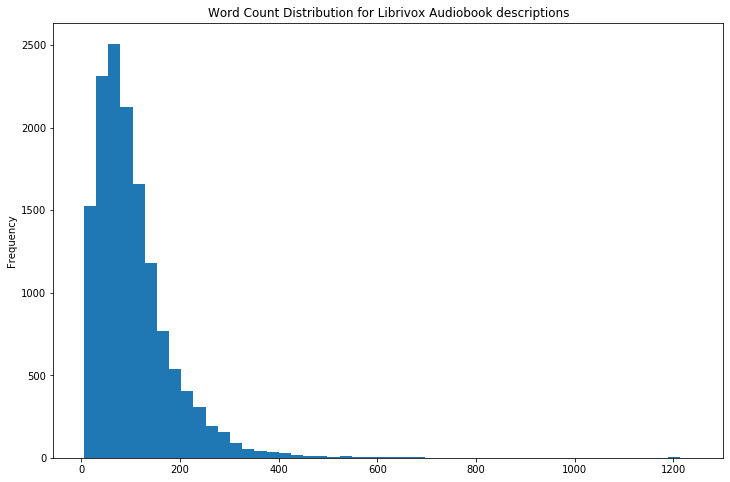

In [30]:
# Calculating the word count for book description
test_book_df['word_count'] = test_book_df['description'].apply(lambda x: len(str(x).split()))# Plotting the word count
test_book_df['word_count'].plot(
    kind='hist',
    bins = 50,
    figsize = (12,8),title='Word Count Distribution for Librivox Audiobook descriptions')

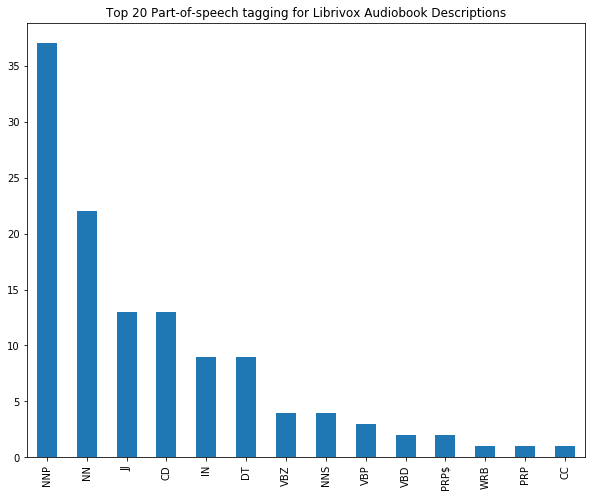

In [4]:
blob = TextBlob(str(test_book_df['description']))
pos_df = pd.DataFrame(blob.tags, columns = ['word' , 'pos'])
pos_df = pos_df.pos.value_counts()[:20]

pos_df.plot(kind = 'bar', figsize=(10, 8), title = "Top 20 Part-of-speech tagging for Librivox Audiobook Descriptions")

In [115]:
for x in test_book_df['description']: 
    if x=='nan':
        print(x)

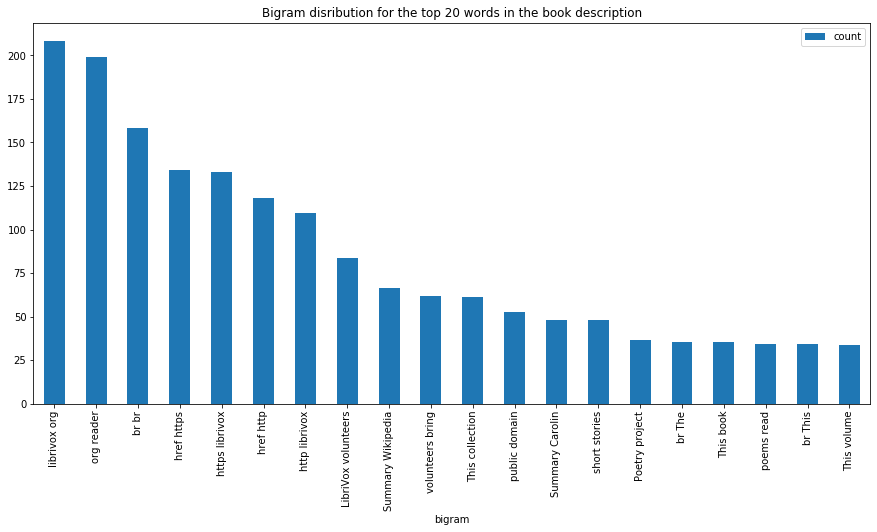

In [34]:
#Converting text descriptions into vectors using TF-IDF using Bigram
tf = TfidfVectorizer(ngram_range=(2, 2), stop_words='english', lowercase = False)
tfidf_matrix = tf.fit_transform(test_book_df['description'].values.astype('U'))
total_words = tfidf_matrix.sum(axis=0) 
#Finding the word frequency
freq = [(word, total_words[0, idx]) for word, idx in tf.vocabulary_.items()]
freq =sorted(freq, key = lambda x: x[1], reverse=True)
#converting into dataframe 
bigram = pd.DataFrame(freq)
bigram.rename(columns = {0:'bigram', 1: 'count'}, inplace = True) 
#Taking first 20 records
bigram = bigram.head(20)#Plotting the bigram distribution
bigram.plot(x ='bigram', y='count', kind = 'bar', title = "Bigram disribution for the top 20 words in the book description", figsize = (15,7), )

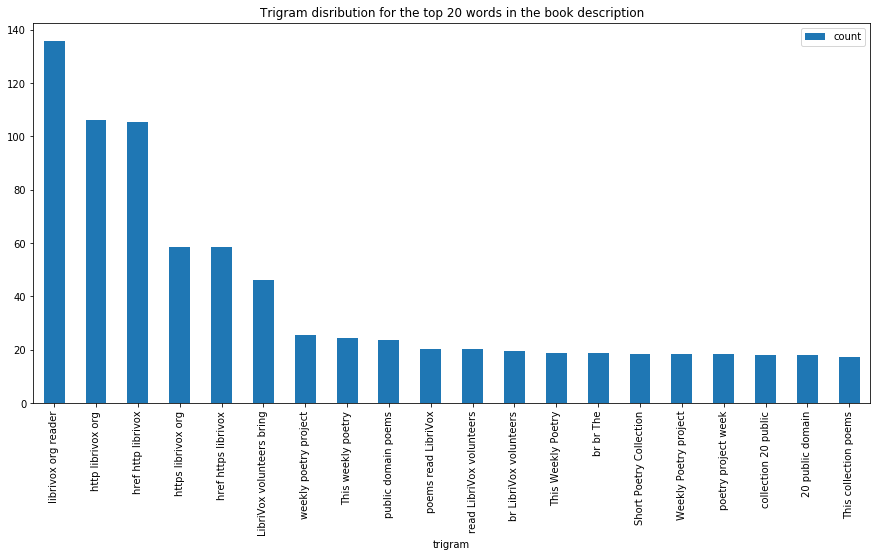

In [20]:
#Converting text descriptions into vectors using TF-IDF using Trigram
tf = TfidfVectorizer(ngram_range=(3, 3), stop_words='english', lowercase = False)
tfidf_matrix = tf.fit_transform(test_book_df['description'].values.astype('U'))
total_words = tfidf_matrix.sum(axis=0) 
#Finding the word frequency
freq = [(word, total_words[0, idx]) for word, idx in tf.vocabulary_.items()]
freq =sorted(freq, key = lambda x: x[1], reverse=True)#converting into dataframe 
trigram = pd.DataFrame(freq)
trigram.rename(columns = {0:'trigram', 1: 'count'}, inplace = True) 
#Taking first 20 records
trigram_20 = trigram.head(20)#Plotting the trigramn distribution
trigram_20.plot(x ='trigram', y='count', kind = 'bar', title = "Trigram disribution for the top 20 words in the book description", figsize = (15,7), )

In [25]:
trigram.head(-20)

,trigram,count
0,librivox org reader,135.843532
1,http librivox org,106.092255
2,href http librivox,105.348183
3,https librivox org,58.541533
4,href https librivox,58.438973
...,...,...
508361,grimm Zaunkönig Der,0.002683
508362,Zaunkönig Der br,0.002683
508363,grimm Zaunkönig und,0.002683
508364,Zaunkönig und der,0.002683


#NEED LIBRIVOX-SPECIFIC STOPWORDS


In [27]:
# Function for removing NonAscii characters
def _removeNonAscii(s):
    return "".join(i for i in s if  int(i)<128)# Function for converting into lower case
def make_lower_case(text):
    return str(text).lower()# Function for removing stop words
def remove_stop_words(text):
    text = text.split()
    stops = set(stopwords.words("english"))
    text = [w for w in text if not w in stops]
    text = " ".join(text)
    return text# Function for removing punctuation
def remove_punctuation(text):
    tokenizer = RegexpTokenizer(r'\w+')
    text = tokenizer.tokenize(text)
    text = " ".join(text)
    return text
#Function for removing the html tags
def remove_html(text):
    html_pattern = re.compile('<.*?>')
    return html_pattern.sub(r'', text)# Applying all the functions in description and storing as a cleaned_desc
book_df['cleaned_desc'] = book_df['description'].apply(func = make_lower_case)
# test_book_df['cleaned_desc'] = df.cleaned_desc.apply(func = make_lower_case)
book_df['cleaned_desc'] = book_df.cleaned_desc.apply(func = remove_stop_words)
book_df['cleaned_desc'] = book_df.cleaned_desc.apply(func=remove_punctuation)
book_df['cleaned_desc'] = book_df.cleaned_desc.apply(func=remove_html)

In [33]:
# Function for recommending books based on Book title. It takes book title and genre as an input.def recommend(title, genre):
    
title="Count of Monte Cristo"
language="English"

# Matching the language with the dataset and reset the index
data = book_df.loc[book_df['language'] == language]  
data.reset_index(level = 0, inplace = True) 
print('Convert the index into series')
indices = pd.Series(data.index, index = data['title'])
# print(indices)
print("Converting the book title into vectors and used bigram")
tf = TfidfVectorizer(analyzer='word', ngram_range=(2, 2), min_df = 1, stop_words='english')
tfidf_matrix = tf.fit_transform(data['cleaned_desc'])
# print(tfidf_matrix)
print("Calculating the similarity measures based on Cosine Similarity")
sg = cosine_similarity(tfidf_matrix, tfidf_matrix)
# print(indices)    
print("Get the index corresponding to original_title")       
idx = indices[title]
print('Get the pairwise similarity scores') 
sig = list(enumerate(sg[idx]))
# print(sig)
print("Sort the books")
sig = sorted(sig, key=lambda x: x[1].any(), reverse=True)
print('Scores of the 5 most similar books') 
sig = sig[1:6]
print("Book indicies")
movie_indices = [i[0] for i in sig]
print("Top 5 book recommendation")
rec = data[['title']].iloc[movie_indices]   
print(rec)
rec = data[['title']].iloc[movie_indices]
rec_whole_df = book_df[book_df['title'].isin(rec['title'])]
# print(rec_whole_df.to_json(orient='records'))
rec_whole_df.columns
    # It reads the top 5 recommend book url and print the images
    
# for i in rec['title']:
#     print(i)
#         response = requests.get(i)
#         img = Image.open(BytesIO(response.content))
#         plt.figure()
#         print(plt.imshow(img))

Convert the index into series
Converting the book title into vectors and used bigram
Calculating the similarity measures based on Cosine Similarity
Get the index corresponding to original_title
Get the pairwise similarity scores
Sort the books
Scores of the 5 most similar books
Book indicies
Top 5 book recommendation
                    title
2             Bleak House
4   This Side of Paradise
9                 Odyssey
10          Divine Comedy
14      Uncle Tom's Cabin


Index(['Unnamed: 0', 'lib_id', 'title', 'description', 'language',
       'copyright_year', 'cleaned_desc'],
      dtype='object')

In [21]:
books = test_book_df["lib_id"].unique().tolist()
len(books)

# shuffle customer ID's
random.shuffle(books)

# extract 90% of customer ID's
books_train = [books[i] for i in range(round(0.9*len(books)))]

# split data into train and validation set
train_df = test_book_df[test_book_df['lib_id'].isin(books_train)]
validation_df = test_book_df[~test_book_df['lib_id'].isin(books_train)]

In [22]:
# list to capture descriptions
descriptions_train = []

# populate the list with the description words
for i in tqdm(books_train):
    temp = train_df[train_df["lib_id"] == i]["description"].tolist()
    descriptions_train.append(temp)

100%|██████████| 8486/8486 [00:04<00:00, 1967.84it/s]


In [23]:
# list to capture purchase history of the customers
descriptions_val = []

# populate the list with the product codes
for i in tqdm(validation_df['lib_id'].unique()):
    temp = validation_df[validation_df["lib_id"] == i]["description"].tolist()
    descriptions_val.append(temp)

100%|██████████| 943/943 [00:00<00:00, 1988.75it/s]


In [27]:
model = Word2Vec(window = 10, sg = 1, hs = 0,
                 negative = 10, # for negative sampling
                 alpha=0.03, min_alpha=0.0007,
                 seed = 14)
print(descriptions_train[: 5])
model.build_vocab(descriptions_train, progress_per=200)

model.train(descriptions_train, total_examples = model.corpus_count, 
            epochs=10, report_delay=1)

[["<p>Kottō contains 20 Japanese stories, collected from different sources and translated by Lafcadio Hearn. The types of stories in this collection are widespread: There are old ghost stories Hearn is best known for (The Legend of Yurei-Daki), his own observations and musings (Pathological), as well as the translation of 'A Woman's Diary', a touching account of the life of the poorer classes in Tokyo, written at the end of the 19th century.  (Summary by Availle)<p>"], ['<p>Door het lezen van te veel ridderromans is Don Quichot zijn verstand kwijtgeraakt. Denkend dat hij zelf een dolende ridder is, verlaat hij zijn huis en begint een dwaaltocht over de wegen en het platteland van Spanje, op zoek naar avonturen. Als doel heeft hij voor ogen het rechtzetten van alle soorten onrecht, om door deze goede daden beroemd te worden. Op zijn trektocht wordt Don Quichot vergezeld door zijn buurman en dienaar Sancho Panza. (naar Wikipedia)<br><br>\nThis is a Dutch translation and adaptation of th

TypeError: unsupported operand type(s) for +: 'float' and 'str'

In [59]:
static_recs_path="../resources/combined_recommendations_v1.csv"
recs_df=pd.read_csv(static_recs_path)
book="The Count of Monte Cristo"
# recs_df=recs_df.reset_index() 
# recs_df=recs_df.drop(['index'],axis=1)


In [60]:
for x in recs_df['book_title']:
    if x in book:
        rec_arr = recs_df.loc[recs_df['book_title'] == x]['book_recommendation_urls'].values
type(rec_arr)
# rec_arr = str(rec_arr).split(",")

pattern=r'(?i)\b((?:[a-z][\w-]+:(?:/{1,3}|[a-z0-9%])|www\d{0,3}[.]|[a-z0-9.\-]+[.][a-z]{2,4}/)(?:[^\s()<>]+|\(([^\s()<>]+|(\([^\s()<>]+\)))*\))+(?:\(([^\s()<>]+|(\([^\s()<>]+\)))*\)|[^\s`!()\[\]{};:\'".,<>?«»“”‘’]))';
match = re.findall(pattern, str(rec_arr))
# match[1][0]
rec_urls=[]
for x in match:
    rec_urls.append(x[0])



In [61]:
rec_urls

['https://librivox.org/bleak-house-by-charles-dickens/',
 'https://librivox.org/this-side-of-paradise-by-f-scott-fitzgerald',
 'https://librivox.org/the-odyssey-by-homer/',
 'https://librivox.org/the-divine-comedy-by-dante-alighieri/',
 'https://librivox.org/uncle-toms-cabin-by-harriet-beecher-stowe/']

In [ ]:
executable_path = {'executable_path':'../resources/chromedriver'}
browser = Browser('chrome', **executable_path)

static_recs_path="../resources/combined_recommendations_v1.csv"
recs_df=pd.read_csv(static_recs_path)

rec_objs_list=[]

for x in recs_df['book_title']:
    rec_arr = recs_df.loc[recs_df['book_title'] == x]['book_recommendation_urls'].values
    title = x
    print(title)
#     rec_arr=x['book_recommendation_urls']
    pattern=r'(?i)\b((?:[a-z][\w-]+:(?:/{1,3}|[a-z0-9%])|www\d{0,3}[.]|[a-z0-9.\-]+[.][a-z]{2,4}/)(?:[^\s()<>]+|\(([^\s()<>]+|(\([^\s()<>]+\)))*\))+(?:\(([^\s()<>]+|(\([^\s()<>]+\)))*\)|[^\s`!()\[\]{};:\'".,<>?«»“”‘’]))';
    print("matching URLS...")
    match = re.findall(pattern, str(rec_arr))
    # match[1][0]
    rec_urls=[]
    for x in match:
        rec_urls.append(x[0])
    rec_objs=[]
    print("scraping...")
    # Scrape
    for x in rec_urls:
        browser.visit(x)
        search_page = browser.html
        soup = BeautifulSoup(search_page, 'html.parser')
        book_page= soup.find('div', class_="page book-page")
        title=book_page.find('h1').get_text()
        author=book_page.find('p', class_="book-page-author").get_text()
        img_url=book_page.find('div', class_="book-page-book-cover").find('img').get('src')
        rec_objs.append({
            'title':title,
            'author':author,
            'img_url':img_url,
            'page_url':x
        })
        print(title, "done")
        print("rec_obj: ",rec_objs)
        
    rec_objs_list.append({
                "title":title,
                "rec_objects":rec_objs
            })
    print("appended")
    rec_objs_df=pd.DataFrame(rec_objs_list)
    rec_objs_df.to_csv('rec_obj_list_v3.csv')
    print("written to csv")


print("finished")
print(rec_objs_list)


Count of Monte Cristo
matching URLS...
scraping...
Bleak House done
[{'title': 'Bleak House', 'author': 'Charles DICKENS (1812 - 1870)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt/Bleak_House_1003.jpg', 'page_url': 'https://librivox.org/bleak-house-by-charles-dickens/'}]
This Side of Paradise done
[{'title': 'Bleak House', 'author': 'Charles DICKENS (1812 - 1870)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt/Bleak_House_1003.jpg', 'page_url': 'https://librivox.org/bleak-house-by-charles-dickens/'}, {'title': 'This Side of Paradise', 'author': 'F. Scott FITZGERALD (1896 - 1940)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt5/this_side_of_paradise_1006.jpg', 'page_url': 'https://librivox.org/this-side-of-paradise-by-f-scott-fitzgerald'}]
The Odyssey done
[{'title': 'Bleak House', 'author': 'Charles DICKENS (1812 - 1870)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt/Bleak_House_1003.jpg', 'page_url': 'https://libr

Bleak House done
[{'title': 'Bleak House', 'author': 'Charles DICKENS (1812 - 1870)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt/Bleak_House_1003.jpg', 'page_url': 'https://librivox.org/bleak-house-by-charles-dickens/'}]
This Side of Paradise done
[{'title': 'Bleak House', 'author': 'Charles DICKENS (1812 - 1870)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt/Bleak_House_1003.jpg', 'page_url': 'https://librivox.org/bleak-house-by-charles-dickens/'}, {'title': 'This Side of Paradise', 'author': 'F. Scott FITZGERALD (1896 - 1940)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt5/this_side_of_paradise_1006.jpg', 'page_url': 'https://librivox.org/this-side-of-paradise-by-f-scott-fitzgerald'}]
The Odyssey done
[{'title': 'Bleak House', 'author': 'Charles DICKENS (1812 - 1870)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt/Bleak_House_1003.jpg', 'page_url': 'https://librivox.org/bleak-house-by-charles-dickens/'}, {'title

Bleak House done
[{'title': 'Bleak House', 'author': 'Charles DICKENS (1812 - 1870)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt/Bleak_House_1003.jpg', 'page_url': 'https://librivox.org/bleak-house-by-charles-dickens/'}]
This Side of Paradise done
[{'title': 'Bleak House', 'author': 'Charles DICKENS (1812 - 1870)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt/Bleak_House_1003.jpg', 'page_url': 'https://librivox.org/bleak-house-by-charles-dickens/'}, {'title': 'This Side of Paradise', 'author': 'F. Scott FITZGERALD (1896 - 1940)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt5/this_side_of_paradise_1006.jpg', 'page_url': 'https://librivox.org/this-side-of-paradise-by-f-scott-fitzgerald'}]
The Odyssey done
[{'title': 'Bleak House', 'author': 'Charles DICKENS (1812 - 1870)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt/Bleak_House_1003.jpg', 'page_url': 'https://librivox.org/bleak-house-by-charles-dickens/'}, {'title

Celebrated Crimes, Vol. 6: Part 2: The Man in the Iron Mask done
[{'title': 'Celebrated Crimes, Vol. 6: Part 2: The Man in the Iron Mask', 'author': 'Alexandre DUMAS (1802 - 1870), translated by  George Burnham IVES (1856 - 1930)', 'img_url': 'https://archive.org/download/celebratedcrimes6_part2_themanintheironmask_1709_librivox/celebrated_crimes_1709.jpg', 'page_url': 'https://librivox.org/celebrated-crimes-vol-6-part-2-the-man-in-the-iron-mask-by-alexandre-dumas/'}]
The d'Artagnan Romances, Vol 1: The Three Musketeers (version 3) done
[{'title': 'Celebrated Crimes, Vol. 6: Part 2: The Man in the Iron Mask', 'author': 'Alexandre DUMAS (1802 - 1870), translated by  George Burnham IVES (1856 - 1930)', 'img_url': 'https://archive.org/download/celebratedcrimes6_part2_themanintheironmask_1709_librivox/celebrated_crimes_1709.jpg', 'page_url': 'https://librivox.org/celebrated-crimes-vol-6-part-2-the-man-in-the-iron-mask-by-alexandre-dumas/'}, {'title': "The d'Artagnan Romances, Vol 1: The Th

Lord Jim done
[{'title': 'Dream Psychology', 'author': 'Sigmund FREUD (1856 - 1939), translated by  M.D. EDER ( - )', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt6/dream_psychology_1101.jpg', 'page_url': 'https://librivox.org/dream-psychology-by-sigmund-freud/'}, {'title': 'The Getting of Wisdom', 'author': ' Henry Handel RICHARDSON (1870 - 1946)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt9/Getting_Wisdom_1108.jpg', 'page_url': 'https://librivox.org/the-getting-of-wisdom-by-henry-handel-richardson/'}, {'title': 'The Importance of Being Earnest', 'author': 'Oscar WILDE (1854 - 1900)', 'img_url': 'http://archive.org/download/being_earnest_librivox/Importance_Being_Earnest_1105.jpg', 'page_url': 'https://librivox.org/the-importance-of-being-earnest-by-oscar-wilde/'}, {'title': 'The Story of a Stuffed Elephant', 'author': 'Laura Lee HOPE ( - )', 'img_url': 'http://archive.org/download/stuffed_elephant_solo_librivox/story_of_a_stuffed_elephant_1012.jpg

Bleak House done
[{'title': 'Bleak House', 'author': 'Charles DICKENS (1812 - 1870)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt/Bleak_House_1003.jpg', 'page_url': 'https://librivox.org/bleak-house-by-charles-dickens/'}]
This Side of Paradise done
[{'title': 'Bleak House', 'author': 'Charles DICKENS (1812 - 1870)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt/Bleak_House_1003.jpg', 'page_url': 'https://librivox.org/bleak-house-by-charles-dickens/'}, {'title': 'This Side of Paradise', 'author': 'F. Scott FITZGERALD (1896 - 1940)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt5/this_side_of_paradise_1006.jpg', 'page_url': 'https://librivox.org/this-side-of-paradise-by-f-scott-fitzgerald'}]
The Odyssey done
[{'title': 'Bleak House', 'author': 'Charles DICKENS (1812 - 1870)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt/Bleak_House_1003.jpg', 'page_url': 'https://librivox.org/bleak-house-by-charles-dickens/'}, {'title

The Consolation of Philosophy done
[{'title': 'Unbeaten Tracks in Japan', 'author': 'Isabella L. BIRD (1831 - 1904)', 'img_url': 'http://archive.org/download/LibrivoxCdCoverArt28/unbeatentracksjapan_1212.jpg', 'page_url': 'https://librivox.org/unbeaten-tracks-in-japan-by-isabella-l-bird/'}, {'title': 'A Vindication of the Rights of Woman', 'author': 'Mary WOLLSTONECRAFT (1759 - 1797)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt9/Vindication_Rights_Woman_1107.jpg', 'page_url': 'https://librivox.org/a-vindication-of-the-rights-of-woman-by-mary-wollstonecraft/'}, {'title': 'The Consolation of Philosophy', 'author': ' Anicius Manlius Severinus BOETHIUS (c. 480 - 525), translated by  H. R. JAMES (1862 - 1931)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt9/Consolation_Philosophy_1107.jpg', 'page_url': 'https://librivox.org/the-consolation-of-philosophy-by-boethius/'}]
Mrs. Caudle's Curtain Lectures done
[{'title': 'Unbeaten Tracks in Japan', 'author': '

Dorothy and the Wizard in Oz done
[{'title': 'Crome Yellow', 'author': 'Aldous HUXLEY (1894 - 1963)', 'img_url': 'http://archive.org/download/crome_yellow_librivox/Chrome_Yellow_1004.jpg', 'page_url': 'https://librivox.org/crome-yellow-by-aldous-huxley/'}, {'title': 'Little Wizard Stories of Oz', 'author': 'L. Frank BAUM (1856 - 1919)', 'img_url': 'http://archive.org/download/little_wizard_stories_librivox/Little_Wizard_Stories_Oz_1105.jpg', 'page_url': 'https://librivox.org/little-wizard-stories-of-oz-by-l-frank-baum/'}, {'title': 'Dorothy and the Wizard in Oz', 'author': 'L. Frank BAUM (1856 - 1919)', 'img_url': 'http://archive.org/download/dorothy_wizard_oz_librivox/Dorothy_Wizard_Oz_1104.jpg', 'page_url': 'https://librivox.org/dorothy-and-the-wizard-in-oz-by-l-frank-baum/'}]
Reginald done
[{'title': 'Crome Yellow', 'author': 'Aldous HUXLEY (1894 - 1963)', 'img_url': 'http://archive.org/download/crome_yellow_librivox/Chrome_Yellow_1004.jpg', 'page_url': 'https://librivox.org/crome-y

The Song My Paddle Sings done
[{'title': "Mrs. Caudle's Curtain Lectures", 'author': ' Douglas William JERROLD (1803 - 1857)', 'img_url': 'http://archive.org/download/mrs_caudles_curtain_lectures_librivox/Mrs_Caudles_Curtain_Lectures_1105.jpg', 'page_url': 'https://librivox.org/mrs-caudles-curtain-lectures-by-douglas-william-jerrold/'}, {'title': "Alice's Adventures in Wonderland", 'author': 'Lewis CARROLL (1832 - 1898)', 'img_url': 'http://archive.org/download/alice_in_wonderland_librivox/Alice_in_Wonderland.jpg', 'page_url': 'https://librivox.org/alices-adventures-in-wonderland-by-lewis-carroll/'}, {'title': 'Jude the Obscure', 'author': 'Thomas HARDY (1840 - 1928)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt4/Jude_Obscure_1109.jpg', 'page_url': 'https://librivox.org/jude-the-obscure-by-thomas-hardy/'}, {'title': 'The Song My Paddle Sings', 'author': 'E. Pauline JOHNSON (1861 - 1913)', 'img_url': 'http://archive.org/download/my_paddle_librivox/Song_Paddle_Sings_11

American Indian Fairy Tales done
[{'title': 'Lord Jim', 'author': 'Joseph CONRAD (1857 - 1924)', 'img_url': 'http://archive.org/download/lord_jim_librivox/Lord_Jim_1002.jpg', 'page_url': 'https://librivox.org/lord-jim-by-joseph-conrad'}, {'title': 'The Last of the Mohicans - A Narrative of 1757 (version 2)', 'author': 'James Fenimore COOPER (1789 - 1851)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt14/Last_Mohicans_1201.jpg', 'page_url': 'https://librivox.org/the-last-of-the-mohicans-by-james-fenimore-cooper/'}, {'title': 'My Man Jeeves', 'author': 'P. G. WODEHOUSE (1881 - 1975)', 'img_url': 'http://archive.org/download/my_man_jeeves_librivox/My_Man_Jeeves_1107.jpg', 'page_url': 'https://librivox.org/my-man-jeeves-by-p-g-wodehouse/'}, {'title': 'American Indian Fairy Tales', 'author': ' William Trowbridge LARNED (c. 1867 - 1928) and Henry R. SCHOOLCRAFT (1793 - 1864)', 'img_url': 'http://archive.org/download/american_indian_tales_librivox/indian.jpg', 'page_url': 'ht

The Odyssey done
[{'title': 'Letters of Two Brides', 'author': 'Honoré de BALZAC (1799 - 1850), translated by R.S. SCOTT ( - )', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt12/Letters_Two_Brides_1110.jpg', 'page_url': 'https://librivox.org/letters-of-two-brides-by-honore-de-balzac/'}, {'title': 'Bleak House', 'author': 'Charles DICKENS (1812 - 1870)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt/Bleak_House_1003.jpg', 'page_url': 'https://librivox.org/bleak-house-by-charles-dickens/'}, {'title': 'This Side of Paradise', 'author': 'F. Scott FITZGERALD (1896 - 1940)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt5/this_side_of_paradise_1006.jpg', 'page_url': 'https://librivox.org/this-side-of-paradise-by-f-scott-fitzgerald'}, {'title': 'The Odyssey', 'author': ' HOMER (c. 8th cen - c. 8th cen) and Samuel BUTLER (1835 - 1902)', 'img_url': 'http://www.archive.org/download/librivox_cd_covers/odyssey.jpg', 'page_url': 'https://librivox.org

The Divine Comedy done
[{'title': 'Letters of Two Brides', 'author': 'Honoré de BALZAC (1799 - 1850), translated by R.S. SCOTT ( - )', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt12/Letters_Two_Brides_1110.jpg', 'page_url': 'https://librivox.org/letters-of-two-brides-by-honore-de-balzac/'}, {'title': 'Bleak House', 'author': 'Charles DICKENS (1812 - 1870)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt/Bleak_House_1003.jpg', 'page_url': 'https://librivox.org/bleak-house-by-charles-dickens/'}, {'title': 'This Side of Paradise', 'author': 'F. Scott FITZGERALD (1896 - 1940)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt5/this_side_of_paradise_1006.jpg', 'page_url': 'https://librivox.org/this-side-of-paradise-by-f-scott-fitzgerald'}, {'title': 'The Odyssey', 'author': ' HOMER (c. 8th cen - c. 8th cen) and Samuel BUTLER (1835 - 1902)', 'img_url': 'http://www.archive.org/download/librivox_cd_covers/odyssey.jpg', 'page_url': 'https://libriv

Queen Lucia done
[{'title': 'The Importance of Being Earnest', 'author': 'Oscar WILDE (1854 - 1900)', 'img_url': 'http://archive.org/download/being_earnest_librivox/Importance_Being_Earnest_1105.jpg', 'page_url': 'https://librivox.org/the-importance-of-being-earnest-by-oscar-wilde/'}, {'title': 'Wives and Daughters', 'author': ' Elizabeth Cleghorn GASKELL (1810 - 1865)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt12/Wives_Daughters_1110.jpg', 'page_url': 'https://librivox.org/wives-and-daughters-by-elizabeth-gaskell/'}, {'title': 'Queen Lucia', 'author': 'E. F. BENSON (1867 - 1940)', 'img_url': 'http://archive.org/download/queen_lucia_librivox/Queen_Lucia_1107.jpg', 'page_url': 'https://librivox.org/queen-lucia-by-edward-frederic-benson/'}, {'title': 'Northanger Abbey', 'author': 'Jane AUSTEN (1775 - 1817)', 'img_url': 'http://archive.org/download/northanger_abbey_librivox/Northanger_Abbey_1104.jpg', 'page_url': 'https://librivox.org/northanger-abbey-by-jane-austen/'

The Truth About Jesus.  Is He a Myth? done
[{'title': 'Bleak House', 'author': 'Charles DICKENS (1812 - 1870)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt/Bleak_House_1003.jpg', 'page_url': 'https://librivox.org/bleak-house-by-charles-dickens/'}, {'title': 'The Secret Garden', 'author': 'Frances Hodgson BURNETT (1849 - 1924)', 'img_url': 'http://archive.org/download/secret_garden_librivox/Secret_Garden_1003.jpg', 'page_url': 'https://librivox.org/the-secret-garden-by-frances-hodgson-burnett/'}, {'title': 'Unbeaten Tracks in Japan', 'author': 'Isabella L. BIRD (1831 - 1904)', 'img_url': 'http://archive.org/download/LibrivoxCdCoverArt28/unbeatentracksjapan_1212.jpg', 'page_url': 'https://librivox.org/unbeaten-tracks-in-japan-by-isabella-l-bird/'}, {'title': 'The Truth About Jesus.  Is He a Myth?', 'author': ' M. M. MANGASARIAN (1859 - 1943)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt10/Truth_Jesus_Myth_1108.jpg', 'page_url': 'https://librivox.org/

The Jungle Book done
[{'title': 'The Story of a Stuffed Elephant', 'author': 'Laura Lee HOPE ( - )', 'img_url': 'http://archive.org/download/stuffed_elephant_solo_librivox/story_of_a_stuffed_elephant_1012.jpg', 'page_url': 'https://librivox.org/the-story-of-a-stuffed-elephant-by-laura-lee-hope/'}, {'title': 'The Call of the Wild', 'author': 'Jack LONDON (1876 - 1916)', 'img_url': 'http://archive.org/download/call_of_the_wild/Call_of_the_Wild.jpg', 'page_url': 'https://librivox.org/call-of-the-wild-by-jack-london/'}, {'title': 'Five Little Peppers and How They Grew', 'author': 'Margaret SIDNEY (1844 - 1924)', 'img_url': 'http://archive.org/download/five_little_peppers_grew_librivox/five_little_peppers_grew_1012.jpg', 'page_url': 'https://librivox.org/five-little-peppers-and-how-they-grew-by-margaret-sidney/'}, {'title': 'The Jungle Book', 'author': 'Rudyard KIPLING (1868 - 1936)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt/Jungle_Book_1003.jpg', 'page_url': 'https://

Time and the Gods done
[{'title': 'The Junior Classics Volume 1: Fairy and Wonder Tales', 'author': 'William PATTEN (1868 - 1936) and William Allan NEILSON (1869 - 1946)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt10/Junior_Classics_Vol_1_1108.jpg', 'page_url': 'https://librivox.org/the-junior-classics-vol-1-by-william-patten/'}, {'title': 'History of Holland', 'author': ' George EDMUNDSON (1848 - 1930)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt6/history_of_holland_1101.jpg', 'page_url': 'https://librivox.org/history-of-holland/'}, {'title': "Grimms' Fairy Tales", 'author': ' Jacob & Wilhelm GRIMM (1785 - 1863), translated by Marian EDWARDES ( - ) and Edgar TAYLOR (1793 - 1839)', 'img_url': 'http://archive.org/download/grimms_english_librivox/grimm.jpg', 'page_url': 'https://librivox.org/fairy-tales-by-the-brothers-grimm/'}, {'title': 'Ghost Stories of an Antiquary', 'author': 'M. R. JAMES (1862 - 1936)', 'img_url': 'http://archive.org/download

Bleak House done
[{'title': 'Bleak House', 'author': 'Charles DICKENS (1812 - 1870)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt/Bleak_House_1003.jpg', 'page_url': 'https://librivox.org/bleak-house-by-charles-dickens/'}]
This Side of Paradise done
[{'title': 'Bleak House', 'author': 'Charles DICKENS (1812 - 1870)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt/Bleak_House_1003.jpg', 'page_url': 'https://librivox.org/bleak-house-by-charles-dickens/'}, {'title': 'This Side of Paradise', 'author': 'F. Scott FITZGERALD (1896 - 1940)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt5/this_side_of_paradise_1006.jpg', 'page_url': 'https://librivox.org/this-side-of-paradise-by-f-scott-fitzgerald'}]
The Odyssey done
[{'title': 'Bleak House', 'author': 'Charles DICKENS (1812 - 1870)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt/Bleak_House_1003.jpg', 'page_url': 'https://librivox.org/bleak-house-by-charles-dickens/'}, {'title

This Side of Paradise done
[{'title': 'Bleak House', 'author': 'Charles DICKENS (1812 - 1870)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt/Bleak_House_1003.jpg', 'page_url': 'https://librivox.org/bleak-house-by-charles-dickens/'}, {'title': 'This Side of Paradise', 'author': 'F. Scott FITZGERALD (1896 - 1940)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt5/this_side_of_paradise_1006.jpg', 'page_url': 'https://librivox.org/this-side-of-paradise-by-f-scott-fitzgerald'}]
The Odyssey done
[{'title': 'Bleak House', 'author': 'Charles DICKENS (1812 - 1870)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt/Bleak_House_1003.jpg', 'page_url': 'https://librivox.org/bleak-house-by-charles-dickens/'}, {'title': 'This Side of Paradise', 'author': 'F. Scott FITZGERALD (1896 - 1940)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt5/this_side_of_paradise_1006.jpg', 'page_url': 'https://librivox.org/this-side-of-paradise-by-f-scott-fi

The Odyssey done
[{'title': 'Bleak House', 'author': 'Charles DICKENS (1812 - 1870)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt/Bleak_House_1003.jpg', 'page_url': 'https://librivox.org/bleak-house-by-charles-dickens/'}, {'title': 'This Side of Paradise', 'author': 'F. Scott FITZGERALD (1896 - 1940)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt5/this_side_of_paradise_1006.jpg', 'page_url': 'https://librivox.org/this-side-of-paradise-by-f-scott-fitzgerald'}, {'title': 'The Odyssey', 'author': ' HOMER (c. 8th cen - c. 8th cen) and Samuel BUTLER (1835 - 1902)', 'img_url': 'http://www.archive.org/download/librivox_cd_covers/odyssey.jpg', 'page_url': 'https://librivox.org/the-odyssey-by-homer/'}]
The Divine Comedy done
[{'title': 'Bleak House', 'author': 'Charles DICKENS (1812 - 1870)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt/Bleak_House_1003.jpg', 'page_url': 'https://librivox.org/bleak-house-by-charles-dickens/'}, {'title': 'Th

The Canterbury Tales done
[{'title': 'Psmith in the City', 'author': 'P. G. WODEHOUSE (1881 - 1975)', 'img_url': 'http://archive.org/download/psmith_in_the_city/Psmith_City_1108.jpg', 'page_url': 'https://librivox.org/psmith-in-the-city-by-pg-wodehouse/'}, {'title': 'The Red House Mystery', 'author': 'A. A. MILNE (1882 - 1956)', 'img_url': 'http://archive.org/download/red_house_mystery_librivox/Red_House_Mystery_1006.jpg', 'page_url': 'https://librivox.org/the-red-house-mystery-by-a-a-milne/'}, {'title': 'The Adventures of Sherlock Holmes', 'author': 'Sir Arthur Conan DOYLE (1859 - 1930)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt4/Adventures_of_Sherlock_Holmes_1003.jpg', 'page_url': 'https://librivox.org/the-adventures-of-sherlock-holmes/'}, {'title': 'The Canterbury Tales', 'author': 'Geoffrey CHAUCER (c. 1343 - 1400)', 'img_url': 'http://archive.org/download/canterburytales_librivox/Canterbury_Tales_1003.jpg', 'page_url': 'https://librivox.org/the-canterbury-tal

If done
[{'title': 'The Rosary', 'author': 'Florence Louisa BARCLAY (1862 - 1921)', 'img_url': 'http://archive.org/download/rosary_librivox/Rosary_1107.jpg', 'page_url': 'https://librivox.org/the-rosary-by-florence-louisa-barclay/'}, {'title': 'Queen Lucia', 'author': 'E. F. BENSON (1867 - 1940)', 'img_url': 'http://archive.org/download/queen_lucia_librivox/Queen_Lucia_1107.jpg', 'page_url': 'https://librivox.org/queen-lucia-by-edward-frederic-benson/'}, {'title': 'The Last of the Mohicans - A Narrative of 1757 (version 2)', 'author': 'James Fenimore COOPER (1789 - 1851)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt14/Last_Mohicans_1201.jpg', 'page_url': 'https://librivox.org/the-last-of-the-mohicans-by-james-fenimore-cooper/'}, {'title': 'Anne of the Island', 'author': 'Lucy Maud MONTGOMERY (1874 - 1942)', 'img_url': 'http://archive.org/download/anne_island/Anne_Island_1107.jpg', 'page_url': 'https://librivox.org/anne-of-the-island-by-lucy-maud-montgomery/'}, {'titl

Emma done
[{'title': 'Adventures of Huckleberry Finn', 'author': 'Mark TWAIN (1835 - 1910)', 'img_url': 'http://archive.org/download/huck_finn_librivox/Huck_Finn.jpg', 'page_url': 'https://librivox.org/the-adventures-of-huckleberry-finn-by-mark-twain/'}, {'title': 'Emma', 'author': 'Jane AUSTEN (1775 - 1817)', 'img_url': 'http://archive.org/download/emma_solo_librivox/Emma_Solo_1105.jpg', 'page_url': 'https://librivox.org/emma-by-jane-austen-solo/'}, {'title': "Mrs. Caudle's Curtain Lectures", 'author': ' Douglas William JERROLD (1803 - 1857)', 'img_url': 'http://archive.org/download/mrs_caudles_curtain_lectures_librivox/Mrs_Caudles_Curtain_Lectures_1105.jpg', 'page_url': 'https://librivox.org/mrs-caudles-curtain-lectures-by-douglas-william-jerrold/'}, {'title': 'The Importance of Being Earnest', 'author': 'Oscar WILDE (1854 - 1900)', 'img_url': 'http://archive.org/download/being_earnest_librivox/Importance_Being_Earnest_1105.jpg', 'page_url': 'https://librivox.org/the-importance-of-be

Life In Mexico done
[{'title': 'The Life and Adventures of Santa Claus', 'author': 'L. Frank BAUM (1856 - 1919)', 'img_url': 'http://archive.org/download/life_of_claus_librivox/Life_Adventures_Santa_Claus_1107.jpg', 'page_url': 'https://librivox.org/the-life-and-adventures-of-santa-claus-by-l-frank-baum'}, {'title': 'Sense and Sensibility', 'author': 'Jane AUSTEN (1775 - 1817)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt9/Sense_Sensibility_1107.jpg', 'page_url': 'https://librivox.org/sense-and-sensibility-by-jane-austen/'}, {'title': 'The Tenant of Wildfell Hall', 'author': 'Anne BRONTË (1820 - 1849)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt11/the_tenant_of_wildfell_hall_1109.jpg', 'page_url': 'https://librivox.org/the-tenant-of-wildfell-hall-by-anne-bronte/'}, {'title': 'A Strange Manuscript Found in a Copper Cylinder', 'author': ' James DE MILLE (1833 - 1880)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt13/Strange_Manuscri

Mrs. Caudle's Curtain Lectures done
[{'title': 'Unbeaten Tracks in Japan', 'author': 'Isabella L. BIRD (1831 - 1904)', 'img_url': 'http://archive.org/download/LibrivoxCdCoverArt28/unbeatentracksjapan_1212.jpg', 'page_url': 'https://librivox.org/unbeaten-tracks-in-japan-by-isabella-l-bird/'}, {'title': 'The Canterville Ghost', 'author': 'Oscar WILDE (1854 - 1900)', 'img_url': 'http://archive.org/download/canterville_ghost_librivox/Canterville_Ghost_1106.jpg', 'page_url': 'https://librivox.org/the-canterville-ghost-by-oscar-wilde/'}, {'title': 'A Vindication of the Rights of Woman', 'author': 'Mary WOLLSTONECRAFT (1759 - 1797)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt9/Vindication_Rights_Woman_1107.jpg', 'page_url': 'https://librivox.org/a-vindication-of-the-rights-of-woman-by-mary-wollstonecraft/'}, {'title': 'The Consolation of Philosophy', 'author': ' Anicius Manlius Severinus BOETHIUS (c. 480 - 525), translated by  H. R. JAMES (1862 - 1931)', 'img_url': 'http:/

Anne of Avonlea done
[{'title': 'The Importance of Being Earnest', 'author': 'Oscar WILDE (1854 - 1900)', 'img_url': 'http://archive.org/download/being_earnest_librivox/Importance_Being_Earnest_1105.jpg', 'page_url': 'https://librivox.org/the-importance-of-being-earnest-by-oscar-wilde/'}, {'title': 'The Three Musketeers', 'author': 'Alexandre DUMAS (1802 - 1870), translated by William ROBSON (1785 - 1863)', 'img_url': 'http://www.archive.org/download/librivox_cd_covers/three_musketeers.jpg', 'page_url': 'https://librivox.org/the-three-musketeers-by-alexandre-dumas/'}, {'title': 'The Eclogues', 'author': ' VIRGIL (70 BCE - 19 BCE), translated by  UNKNOWN ( - )', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt14/Eclogues_1202.jpg', 'page_url': 'https://librivox.org/the-eclogues-by-publius-vergilius-maro/'}, {'title': 'A Ballad of John Silver', 'author': 'John MASEFIELD (1878 - 1967)', 'img_url': 'http://archive.org/download/ballad_john_silver_librivox/Ballad_John_Silver_11

The Hunting of the Snark done
[{'title': "A Connecticut Yankee in King Arthur's Court", 'author': 'Mark TWAIN (1835 - 1910)', 'img_url': 'http://archive.org/download/connecticutyankee_librivox/Connecticut_Yankee_King_Arthurs_Court_1108.jpg', 'page_url': 'https://librivox.org/a-connecticut-yankee-in-king-arthurs-court-by-mark-twain/'}, {'title': 'Notes from the Underground', 'author': 'Fyodor DOSTOYEVSKY (1821 - 1881), translated by  Constance GARNETT (1861 - 1946)', 'img_url': 'http://archive.org/download/notes_from_the_underground/Notes_Underground_1108.jpg', 'page_url': 'https://librivox.org/notes-from-the-underground-by-fyodor-dostoyevsky/'}, {'title': 'Roughing It in the Bush', 'author': 'Susanna MOODIE (1803 - 1885)', 'img_url': 'http://archive.org/download/LibrivoxCdCoverArt28/Roughing_It_Bush_1301.jpg', 'page_url': 'https://librivox.org/roughing-it-in-the-bush-by-susanna-moodie/'}, {'title': 'The Hunting of the Snark', 'author': 'Lewis CARROLL (1832 - 1898)', 'img_url': 'http://

The Call of the Wild done
[{'title': 'The Importance of Being Earnest', 'author': 'Oscar WILDE (1854 - 1900)', 'img_url': 'http://archive.org/download/being_earnest_librivox/Importance_Being_Earnest_1105.jpg', 'page_url': 'https://librivox.org/the-importance-of-being-earnest-by-oscar-wilde/'}, {'title': 'A Christmas Carol', 'author': 'Charles DICKENS (1812 - 1870)', 'img_url': 'http://archive.org/download/A_Christmas_Carol/Christmas_Carol_1108.jpg', 'page_url': 'https://librivox.org/a-christmas-carol-by-charles-dickens/'}, {'title': 'An International Episode', 'author': 'Henry JAMES (1843 - 1916)', 'img_url': 'http://archive.org/download/international_episode/International_Episode_1108.jpg', 'page_url': 'https://librivox.org/an-international-episode-by-henry-james/'}, {'title': 'The Call of the Wild', 'author': 'Jack LONDON (1876 - 1916)', 'img_url': 'http://archive.org/download/call_of_the_wild/Call_of_the_Wild.jpg', 'page_url': 'https://librivox.org/call-of-the-wild-by-jack-london/'}

Time and the Gods done
[{'title': 'American Indian Fairy Tales', 'author': ' William Trowbridge LARNED (c. 1867 - 1928) and Henry R. SCHOOLCRAFT (1793 - 1864)', 'img_url': 'http://archive.org/download/american_indian_tales_librivox/indian.jpg', 'page_url': 'https://librivox.org/american-indian-fairy-tales-by-william-trowbridge-larned/'}, {'title': "Andersen's Fairy Tales", 'author': 'Hans Christian ANDERSEN (1805 - 1875), translated by  UNKNOWN ( - )', 'img_url': 'http://archive.org/download/andersens_fairytales_librivox/andersens_fairy_tales.jpg', 'page_url': 'https://librivox.org/andersens-fairy-tales-by-hc-andersen/'}, {'title': "Grimms' Fairy Tales", 'author': ' Jacob & Wilhelm GRIMM (1785 - 1863), translated by Marian EDWARDES ( - ) and Edgar TAYLOR (1793 - 1839)', 'img_url': 'http://archive.org/download/grimms_english_librivox/grimm.jpg', 'page_url': 'https://librivox.org/fairy-tales-by-the-brothers-grimm/'}, {'title': 'The Golden Goose Book', 'author': 'L. Leslie BROOKE (1862 - 

The Three Musketeers done
[{'title': 'The Three Musketeers', 'author': 'Alexandre DUMAS (1802 - 1870), translated by William ROBSON (1785 - 1863)', 'img_url': 'http://www.archive.org/download/librivox_cd_covers/three_musketeers.jpg', 'page_url': 'https://librivox.org/the-three-musketeers-by-alexandre-dumas/'}]
The Eclogues done
[{'title': 'The Three Musketeers', 'author': 'Alexandre DUMAS (1802 - 1870), translated by William ROBSON (1785 - 1863)', 'img_url': 'http://www.archive.org/download/librivox_cd_covers/three_musketeers.jpg', 'page_url': 'https://librivox.org/the-three-musketeers-by-alexandre-dumas/'}, {'title': 'The Eclogues', 'author': ' VIRGIL (70 BCE - 19 BCE), translated by  UNKNOWN ( - )', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt14/Eclogues_1202.jpg', 'page_url': 'https://librivox.org/the-eclogues-by-publius-vergilius-maro/'}]
A Ballad of John Silver done
[{'title': 'The Three Musketeers', 'author': 'Alexandre DUMAS (1802 - 1870), translated by William

The Eclogues done
[{'title': 'The Getting of Wisdom', 'author': ' Henry Handel RICHARDSON (1870 - 1946)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt9/Getting_Wisdom_1108.jpg', 'page_url': 'https://librivox.org/the-getting-of-wisdom-by-henry-handel-richardson/'}, {'title': 'Lord Jim', 'author': 'Joseph CONRAD (1857 - 1924)', 'img_url': 'http://archive.org/download/lord_jim_librivox/Lord_Jim_1002.jpg', 'page_url': 'https://librivox.org/lord-jim-by-joseph-conrad'}, {'title': 'The Eclogues', 'author': ' VIRGIL (70 BCE - 19 BCE), translated by  UNKNOWN ( - )', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt14/Eclogues_1202.jpg', 'page_url': 'https://librivox.org/the-eclogues-by-publius-vergilius-maro/'}]
Anne of Green Gables done
[{'title': 'The Getting of Wisdom', 'author': ' Henry Handel RICHARDSON (1870 - 1946)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt9/Getting_Wisdom_1108.jpg', 'page_url': 'https://librivox.org/the-getting-of-wis

The Divine Comedy done
[{'title': 'Bleak House', 'author': 'Charles DICKENS (1812 - 1870)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt/Bleak_House_1003.jpg', 'page_url': 'https://librivox.org/bleak-house-by-charles-dickens/'}, {'title': 'This Side of Paradise', 'author': 'F. Scott FITZGERALD (1896 - 1940)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt5/this_side_of_paradise_1006.jpg', 'page_url': 'https://librivox.org/this-side-of-paradise-by-f-scott-fitzgerald'}, {'title': 'The Odyssey', 'author': ' HOMER (c. 8th cen - c. 8th cen) and Samuel BUTLER (1835 - 1902)', 'img_url': 'http://www.archive.org/download/librivox_cd_covers/odyssey.jpg', 'page_url': 'https://librivox.org/the-odyssey-by-homer/'}, {'title': 'The Divine Comedy', 'author': 'Dante ALIGHIERI (1265 - 1321), translated by Henry Wadsworth LONGFELLOW (1807 - 1882)', 'img_url': 'http://archive.org/download/divine_comedy_librivox/The_Divine_Comedy_1005.jpg', 'page_url': 'https://librivox.or

The Call of the Wild done
[{'title': 'Heart of Darkness', 'author': 'Joseph CONRAD (1857 - 1924)', 'img_url': 'http://archive.org/download/heart_of_darkness/Heart_of_Darkness.jpg', 'page_url': 'https://librivox.org/heart-of-darkness-by-joseph-conrad'}, {'title': 'The Story of a Stuffed Elephant', 'author': 'Laura Lee HOPE ( - )', 'img_url': 'http://archive.org/download/stuffed_elephant_solo_librivox/story_of_a_stuffed_elephant_1012.jpg', 'page_url': 'https://librivox.org/the-story-of-a-stuffed-elephant-by-laura-lee-hope/'}, {'title': 'A Christmas Carol', 'author': 'Charles DICKENS (1812 - 1870)', 'img_url': 'http://archive.org/download/A_Christmas_Carol/Christmas_Carol_1108.jpg', 'page_url': 'https://librivox.org/a-christmas-carol-by-charles-dickens/'}, {'title': 'An International Episode', 'author': 'Henry JAMES (1843 - 1916)', 'img_url': 'http://archive.org/download/international_episode/International_Episode_1108.jpg', 'page_url': 'https://librivox.org/an-international-episode-by-he

Uncle Tom's Cabin done
[{'title': "Uncle Tom's Cabin", 'author': 'Harriet Beecher STOWE (1811 - 1896)', 'img_url': 'http://archive.org/download/uncle_toms_cabin_librivox/Uncle_Toms_Cabin_1006.jpg', 'page_url': 'https://librivox.org/uncle-toms-cabin-by-harriet-beecher-stowe/'}]
The Three Musketeers done
[{'title': "Uncle Tom's Cabin", 'author': 'Harriet Beecher STOWE (1811 - 1896)', 'img_url': 'http://archive.org/download/uncle_toms_cabin_librivox/Uncle_Toms_Cabin_1006.jpg', 'page_url': 'https://librivox.org/uncle-toms-cabin-by-harriet-beecher-stowe/'}, {'title': 'The Three Musketeers', 'author': 'Alexandre DUMAS (1802 - 1870), translated by William ROBSON (1785 - 1863)', 'img_url': 'http://www.archive.org/download/librivox_cd_covers/three_musketeers.jpg', 'page_url': 'https://librivox.org/the-three-musketeers-by-alexandre-dumas/'}]
Chapters from my Autobiography done
[{'title': "Uncle Tom's Cabin", 'author': 'Harriet Beecher STOWE (1811 - 1896)', 'img_url': 'http://archive.org/download

The Prince done
[{'title': 'A Modest Proposal', 'author': 'Jonathan SWIFT (1667 - 1745)', 'img_url': 'http://archive.org/download/modestproposal/Modest_Proposal_1108.jpg', 'page_url': 'https://librivox.org/a-modest-proposal-by-jonathan-swift/'}, {'title': 'The Open Library', 'author': ' Brewster KAHLE (1960 - )', 'img_url': 'http://archive.org/download/openlibraryvision/Open_Library_1108.jpg', 'page_url': 'https://librivox.org/the-open-library-by-brewster-kahle/'}, {'title': 'The Prince', 'author': 'Niccolò MACHIAVELLI (1469 - 1527), translated by  William K. MARRIOTT ( - )', 'img_url': 'http://archive.org/download/prince_librivox/Prince_The_1002.jpg', 'page_url': 'https://librivox.org/the-prince-by-niccolo-machiavelli/'}]
The Raven done
[{'title': 'A Modest Proposal', 'author': 'Jonathan SWIFT (1667 - 1745)', 'img_url': 'http://archive.org/download/modestproposal/Modest_Proposal_1108.jpg', 'page_url': 'https://librivox.org/a-modest-proposal-by-jonathan-swift/'}, {'title': 'The Open Li

An Old-Fashioned Girl (version 2) done
[{'title': 'Time and the Gods', 'author': 'Lord DUNSANY (1878 - 1957)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt4/Time_Gods_1109.jpg', 'page_url': 'https://librivox.org/time-and-the-gods-by-lord-dunsany/'}, {'title': 'The History of England, from the Accession of James II - (Volume 2, Chapter 07)', 'author': 'Thomas Babington MACAULAY (1800 - 1859)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt8/History_England_Accession_James_Second_Volume_2_Chapter_7_1105.jpg', 'page_url': 'https://librivox.org/history-of-england-from-the-accession-of-james-ii-volume-2-chapter-07-by-thomas-babington-macaulay/'}, {'title': 'Ronicky Doone', 'author': 'Max BRAND (1892 - 1944)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt11/Ronicky_Doone_1112.jpg', 'page_url': 'https://librivox.org/ronicky-doone-by-max-brand/'}, {'title': 'An Old-Fashioned Girl (version 2)', 'author': 'Louisa May ALCOTT (1832 - 1888)', 'img_

The Art of War done
[{'title': 'Letters of Two Brides', 'author': 'Honoré de BALZAC (1799 - 1850), translated by R.S. SCOTT ( - )', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt12/Letters_Two_Brides_1110.jpg', 'page_url': 'https://librivox.org/letters-of-two-brides-by-honore-de-balzac/'}, {'title': 'The Secret Garden', 'author': 'Frances Hodgson BURNETT (1849 - 1924)', 'img_url': 'http://archive.org/download/secret_garden_librivox/Secret_Garden_1003.jpg', 'page_url': 'https://librivox.org/the-secret-garden-by-frances-hodgson-burnett/'}, {'title': 'The Importance of Being Earnest', 'author': 'Oscar WILDE (1854 - 1900)', 'img_url': 'http://archive.org/download/being_earnest_librivox/Importance_Being_Earnest_1105.jpg', 'page_url': 'https://librivox.org/the-importance-of-being-earnest-by-oscar-wilde/'}, {'title': 'The Art of War', 'author': ' SUN TZU 孙武 (554 BCE - 496 BCE), translated by  Lionel GILES (1875 - 1958)', 'img_url': 'http://archive.org/download/art_of_war_libri

Uncle Tom's Cabin done
[{'title': 'Bleak House', 'author': 'Charles DICKENS (1812 - 1870)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt/Bleak_House_1003.jpg', 'page_url': 'https://librivox.org/bleak-house-by-charles-dickens/'}, {'title': 'This Side of Paradise', 'author': 'F. Scott FITZGERALD (1896 - 1940)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt5/this_side_of_paradise_1006.jpg', 'page_url': 'https://librivox.org/this-side-of-paradise-by-f-scott-fitzgerald'}, {'title': 'The Odyssey', 'author': ' HOMER (c. 8th cen - c. 8th cen) and Samuel BUTLER (1835 - 1902)', 'img_url': 'http://www.archive.org/download/librivox_cd_covers/odyssey.jpg', 'page_url': 'https://librivox.org/the-odyssey-by-homer/'}, {'title': 'The Divine Comedy', 'author': 'Dante ALIGHIERI (1265 - 1321), translated by Henry Wadsworth LONGFELLOW (1807 - 1882)', 'img_url': 'http://archive.org/download/divine_comedy_librivox/The_Divine_Comedy_1005.jpg', 'page_url': 'https://librivox.or

Bleak House done
[{'title': 'Bleak House', 'author': 'Charles DICKENS (1812 - 1870)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt/Bleak_House_1003.jpg', 'page_url': 'https://librivox.org/bleak-house-by-charles-dickens/'}]
This Side of Paradise done
[{'title': 'Bleak House', 'author': 'Charles DICKENS (1812 - 1870)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt/Bleak_House_1003.jpg', 'page_url': 'https://librivox.org/bleak-house-by-charles-dickens/'}, {'title': 'This Side of Paradise', 'author': 'F. Scott FITZGERALD (1896 - 1940)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt5/this_side_of_paradise_1006.jpg', 'page_url': 'https://librivox.org/this-side-of-paradise-by-f-scott-fitzgerald'}]
The Odyssey done
[{'title': 'Bleak House', 'author': 'Charles DICKENS (1812 - 1870)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt/Bleak_House_1003.jpg', 'page_url': 'https://librivox.org/bleak-house-by-charles-dickens/'}, {'title

Anne of Avonlea done
[{'title': 'A Ballad of John Silver', 'author': 'John MASEFIELD (1878 - 1967)', 'img_url': 'http://archive.org/download/ballad_john_silver_librivox/Ballad_John_Silver_1109.jpg', 'page_url': 'https://librivox.org/a-ballad-of-john-silver-by-john-masefield/'}, {'title': 'Anne of Avonlea', 'author': 'Lucy Maud MONTGOMERY (1874 - 1942)', 'img_url': 'http://archive.org/download/anne_avonlea/Anne_Avonlea_1105.jpg', 'page_url': 'https://librivox.org/anne-of-avonlea-by-lucy-maud-montgomery/'}, {'title': 'Black Beauty (The Autobiography of a Horse)', 'author': 'Anna SEWELL (1820 - 1878)', 'img_url': 'http://archive.org/download/blackbeauty_librivox/Black_Beauty_Autobiography_Horse_1104.jpg', 'page_url': 'https://librivox.org/black-beauty-by-anna-sewell/'}, {'title': 'Declaration of Independence of the United States of America', 'author': 'Thomas JEFFERSON (1743 - 1826)', 'img_url': 'http://archive.org/download/declaration_of_independence_librivox/declaration_independence_110

A Modest Proposal done
[{'title': 'A Modest Proposal', 'author': 'Jonathan SWIFT (1667 - 1745)', 'img_url': 'http://archive.org/download/modestproposal/Modest_Proposal_1108.jpg', 'page_url': 'https://librivox.org/a-modest-proposal-by-jonathan-swift/'}]
The Open Library done
[{'title': 'A Modest Proposal', 'author': 'Jonathan SWIFT (1667 - 1745)', 'img_url': 'http://archive.org/download/modestproposal/Modest_Proposal_1108.jpg', 'page_url': 'https://librivox.org/a-modest-proposal-by-jonathan-swift/'}, {'title': 'The Open Library', 'author': ' Brewster KAHLE (1960 - )', 'img_url': 'http://archive.org/download/openlibraryvision/Open_Library_1108.jpg', 'page_url': 'https://librivox.org/the-open-library-by-brewster-kahle/'}]
The Raven done
[{'title': 'A Modest Proposal', 'author': 'Jonathan SWIFT (1667 - 1745)', 'img_url': 'http://archive.org/download/modestproposal/Modest_Proposal_1108.jpg', 'page_url': 'https://librivox.org/a-modest-proposal-by-jonathan-swift/'}, {'title': 'The Open Librar

Declaration of Independence of the United States of America done
[{'title': 'A Ballad of John Silver', 'author': 'John MASEFIELD (1878 - 1967)', 'img_url': 'http://archive.org/download/ballad_john_silver_librivox/Ballad_John_Silver_1109.jpg', 'page_url': 'https://librivox.org/a-ballad-of-john-silver-by-john-masefield/'}, {'title': 'Anne of Avonlea', 'author': 'Lucy Maud MONTGOMERY (1874 - 1942)', 'img_url': 'http://archive.org/download/anne_avonlea/Anne_Avonlea_1105.jpg', 'page_url': 'https://librivox.org/anne-of-avonlea-by-lucy-maud-montgomery/'}, {'title': 'Black Beauty (The Autobiography of a Horse)', 'author': 'Anna SEWELL (1820 - 1878)', 'img_url': 'http://archive.org/download/blackbeauty_librivox/Black_Beauty_Autobiography_Horse_1104.jpg', 'page_url': 'https://librivox.org/black-beauty-by-anna-sewell/'}, {'title': 'Declaration of Independence of the United States of America', 'author': 'Thomas JEFFERSON (1743 - 1826)', 'img_url': 'http://archive.org/download/declaration_of_indepe

Declaration of Independence of the United States of America done
[{'title': 'A Ballad of John Silver', 'author': 'John MASEFIELD (1878 - 1967)', 'img_url': 'http://archive.org/download/ballad_john_silver_librivox/Ballad_John_Silver_1109.jpg', 'page_url': 'https://librivox.org/a-ballad-of-john-silver-by-john-masefield/'}, {'title': 'Anne of Avonlea', 'author': 'Lucy Maud MONTGOMERY (1874 - 1942)', 'img_url': 'http://archive.org/download/anne_avonlea/Anne_Avonlea_1105.jpg', 'page_url': 'https://librivox.org/anne-of-avonlea-by-lucy-maud-montgomery/'}, {'title': 'Black Beauty (The Autobiography of a Horse)', 'author': 'Anna SEWELL (1820 - 1878)', 'img_url': 'http://archive.org/download/blackbeauty_librivox/Black_Beauty_Autobiography_Horse_1104.jpg', 'page_url': 'https://librivox.org/black-beauty-by-anna-sewell/'}, {'title': 'Declaration of Independence of the United States of America', 'author': 'Thomas JEFFERSON (1743 - 1826)', 'img_url': 'http://archive.org/download/declaration_of_indepe

A Ballad of John Silver done
[{'title': 'A Ballad of John Silver', 'author': 'John MASEFIELD (1878 - 1967)', 'img_url': 'http://archive.org/download/ballad_john_silver_librivox/Ballad_John_Silver_1109.jpg', 'page_url': 'https://librivox.org/a-ballad-of-john-silver-by-john-masefield/'}]
Anne of Green Gables done
[{'title': 'A Ballad of John Silver', 'author': 'John MASEFIELD (1878 - 1967)', 'img_url': 'http://archive.org/download/ballad_john_silver_librivox/Ballad_John_Silver_1109.jpg', 'page_url': 'https://librivox.org/a-ballad-of-john-silver-by-john-masefield/'}, {'title': 'Anne of Green Gables', 'author': 'Lucy Maud MONTGOMERY (1874 - 1942)', 'img_url': 'http://archive.org/download/anne_of_green_gables_librivox/Anne_Green_Gables_1104.jpg', 'page_url': 'https://librivox.org/anne-of-green-gables-by-lucy-maud-montgomery/'}]
Art and Heart done
[{'title': 'A Ballad of John Silver', 'author': 'John MASEFIELD (1878 - 1967)', 'img_url': 'http://archive.org/download/ballad_john_silver_librivo

Adventures of Huckleberry Finn done
[{'title': 'Bleak House', 'author': 'Charles DICKENS (1812 - 1870)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt/Bleak_House_1003.jpg', 'page_url': 'https://librivox.org/bleak-house-by-charles-dickens/'}, {'title': 'This Side of Paradise', 'author': 'F. Scott FITZGERALD (1896 - 1940)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt5/this_side_of_paradise_1006.jpg', 'page_url': 'https://librivox.org/this-side-of-paradise-by-f-scott-fitzgerald'}, {'title': 'Adventures of Huckleberry Finn', 'author': 'Mark TWAIN (1835 - 1910)', 'img_url': 'http://archive.org/download/huck_finn_librivox/Huck_Finn.jpg', 'page_url': 'https://librivox.org/the-adventures-of-huckleberry-finn-by-mark-twain/'}]
The Odyssey done
[{'title': 'Bleak House', 'author': 'Charles DICKENS (1812 - 1870)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt/Bleak_House_1003.jpg', 'page_url': 'https://librivox.org/bleak-house-by-charles-dickens

Euthyphro done
[{'title': 'Jazz Fantasia', 'author': 'Carl SANDBURG (1878 - 1967)', 'img_url': 'http://archive.org/download/jazz_fantasia_librivox/Jazz_Fantasia_1109.jpg', 'page_url': 'https://librivox.org/jazz-fantasia-by-carl-sandburg/'}, {'title': 'Richard Cory', 'author': 'Edwin Arlington ROBINSON (1869 - 1935)', 'img_url': 'http://archive.org/download/richard_cory_librivox/Richard_Cory_1109.jpg', 'page_url': 'https://librivox.org/richard-cory-by-edwin-arlington-robinson/'}, {'title': 'Embankment at Night, before the War: Outcasts', 'author': 'D. H. LAWRENCE (1885 - 1930)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt10/Embankment_Night_Before_War_Outcasts_1108.jpg', 'page_url': 'https://librivox.org/embankment-at-night-before-the-war-outcasts-by-d-h-lawrence/'}, {'title': 'Euthyphro', 'author': ' PLATO (ΠΛΆΤΩΝ) (c. 428 BCE - c. 347 BCE), translated by  Benjamin JOWETT (1817 - 1893)', 'img_url': 'http://archive.org/download/euthyphro_librivox/euthyphro_1101.jpg', 

American Indian Fairy Tales done
[{'title': 'The Art of War', 'author': ' SUN TZU 孙武 (554 BCE - 496 BCE), translated by  Lionel GILES (1875 - 1958)', 'img_url': 'http://archive.org/download/art_of_war_librivox/Art_War_1107.jpg', 'page_url': 'https://librivox.org/the-art-of-war-by-sun-tzu/'}, {'title': 'The Rosary', 'author': 'Florence Louisa BARCLAY (1862 - 1921)', 'img_url': 'http://archive.org/download/rosary_librivox/Rosary_1107.jpg', 'page_url': 'https://librivox.org/the-rosary-by-florence-louisa-barclay/'}, {'title': 'Queen Lucia', 'author': 'E. F. BENSON (1867 - 1940)', 'img_url': 'http://archive.org/download/queen_lucia_librivox/Queen_Lucia_1107.jpg', 'page_url': 'https://librivox.org/queen-lucia-by-edward-frederic-benson/'}, {'title': 'The Last of the Mohicans - A Narrative of 1757 (version 2)', 'author': 'James Fenimore COOPER (1789 - 1851)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt14/Last_Mohicans_1201.jpg', 'page_url': 'https://librivox.org/the-last-of-

The Art of War done
[{'title': 'The Art of War', 'author': ' SUN TZU 孙武 (554 BCE - 496 BCE), translated by  Lionel GILES (1875 - 1958)', 'img_url': 'http://archive.org/download/art_of_war_librivox/Art_War_1107.jpg', 'page_url': 'https://librivox.org/the-art-of-war-by-sun-tzu/'}]
The Rosary done
[{'title': 'The Art of War', 'author': ' SUN TZU 孙武 (554 BCE - 496 BCE), translated by  Lionel GILES (1875 - 1958)', 'img_url': 'http://archive.org/download/art_of_war_librivox/Art_War_1107.jpg', 'page_url': 'https://librivox.org/the-art-of-war-by-sun-tzu/'}, {'title': 'The Rosary', 'author': 'Florence Louisa BARCLAY (1862 - 1921)', 'img_url': 'http://archive.org/download/rosary_librivox/Rosary_1107.jpg', 'page_url': 'https://librivox.org/the-rosary-by-florence-louisa-barclay/'}]
Queen Lucia done
[{'title': 'The Art of War', 'author': ' SUN TZU 孙武 (554 BCE - 496 BCE), translated by  Lionel GILES (1875 - 1958)', 'img_url': 'http://archive.org/download/art_of_war_librivox/Art_War_1107.jpg', 'page_

The Rosary done
[{'title': 'The Art of War', 'author': ' SUN TZU 孙武 (554 BCE - 496 BCE), translated by  Lionel GILES (1875 - 1958)', 'img_url': 'http://archive.org/download/art_of_war_librivox/Art_War_1107.jpg', 'page_url': 'https://librivox.org/the-art-of-war-by-sun-tzu/'}, {'title': 'The Rosary', 'author': 'Florence Louisa BARCLAY (1862 - 1921)', 'img_url': 'http://archive.org/download/rosary_librivox/Rosary_1107.jpg', 'page_url': 'https://librivox.org/the-rosary-by-florence-louisa-barclay/'}]
Queen Lucia done
[{'title': 'The Art of War', 'author': ' SUN TZU 孙武 (554 BCE - 496 BCE), translated by  Lionel GILES (1875 - 1958)', 'img_url': 'http://archive.org/download/art_of_war_librivox/Art_War_1107.jpg', 'page_url': 'https://librivox.org/the-art-of-war-by-sun-tzu/'}, {'title': 'The Rosary', 'author': 'Florence Louisa BARCLAY (1862 - 1921)', 'img_url': 'http://archive.org/download/rosary_librivox/Rosary_1107.jpg', 'page_url': 'https://librivox.org/the-rosary-by-florence-louisa-barclay/'

The Truth About Jesus.  Is He a Myth? done
[{'title': 'Heart of Darkness', 'author': 'Joseph CONRAD (1857 - 1924)', 'img_url': 'http://archive.org/download/heart_of_darkness/Heart_of_Darkness.jpg', 'page_url': 'https://librivox.org/heart-of-darkness-by-joseph-conrad'}, {'title': 'Unbeaten Tracks in Japan', 'author': 'Isabella L. BIRD (1831 - 1904)', 'img_url': 'http://archive.org/download/LibrivoxCdCoverArt28/unbeatentracksjapan_1212.jpg', 'page_url': 'https://librivox.org/unbeaten-tracks-in-japan-by-isabella-l-bird/'}, {'title': 'The Truth About Jesus.  Is He a Myth?', 'author': ' M. M. MANGASARIAN (1859 - 1943)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt10/Truth_Jesus_Myth_1108.jpg', 'page_url': 'https://librivox.org/the-truth-about-jesus-is-he-a-myth-by-m-m-mangasarian/'}]
A Vindication of the Rights of Woman done
[{'title': 'Heart of Darkness', 'author': 'Joseph CONRAD (1857 - 1924)', 'img_url': 'http://archive.org/download/heart_of_darkness/Heart_of_Darkness.j

Adventures of Huckleberry Finn done
[{'title': 'Bleak House', 'author': 'Charles DICKENS (1812 - 1870)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt/Bleak_House_1003.jpg', 'page_url': 'https://librivox.org/bleak-house-by-charles-dickens/'}, {'title': 'This Side of Paradise', 'author': 'F. Scott FITZGERALD (1896 - 1940)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt5/this_side_of_paradise_1006.jpg', 'page_url': 'https://librivox.org/this-side-of-paradise-by-f-scott-fitzgerald'}, {'title': 'Adventures of Huckleberry Finn', 'author': 'Mark TWAIN (1835 - 1910)', 'img_url': 'http://archive.org/download/huck_finn_librivox/Huck_Finn.jpg', 'page_url': 'https://librivox.org/the-adventures-of-huckleberry-finn-by-mark-twain/'}]
The Odyssey done
[{'title': 'Bleak House', 'author': 'Charles DICKENS (1812 - 1870)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt/Bleak_House_1003.jpg', 'page_url': 'https://librivox.org/bleak-house-by-charles-dickens

On the Antiseptic Principle of the Practice of Surgery done
[{'title': "Mrs. Caudle's Curtain Lectures", 'author': ' Douglas William JERROLD (1803 - 1857)', 'img_url': 'http://archive.org/download/mrs_caudles_curtain_lectures_librivox/Mrs_Caudles_Curtain_Lectures_1105.jpg', 'page_url': 'https://librivox.org/mrs-caudles-curtain-lectures-by-douglas-william-jerrold/'}, {'title': 'Queen Lucia', 'author': 'E. F. BENSON (1867 - 1940)', 'img_url': 'http://archive.org/download/queen_lucia_librivox/Queen_Lucia_1107.jpg', 'page_url': 'https://librivox.org/queen-lucia-by-edward-frederic-benson/'}, {'title': 'A Personal Anthology of Shakespeare', 'author': 'William SHAKESPEARE (1564 - 1616)', 'img_url': 'http://archive.org/download/personal_anthology_shakespeare_librivox/Personal_Anthology_Shakespeare_1108.jpg', 'page_url': 'https://librivox.org/a-personal-anthology-of-shakespeare-compiled-by-martin-clifton/'}, {'title': 'On the Antiseptic Principle of the Practice of Surgery', 'author': ' Joseph 

The Call of the Wild done
[{'title': 'The Wind in the Willows', 'author': 'Kenneth GRAHAME (1859 - 1932)', 'img_url': 'http://archive.org/download/wind_in_the_willows_collab_librivox/Wind_Willows_1105.jpg', 'page_url': 'https://librivox.org/the-wind-in-the-willows-by-kenneth-grahame-2/'}, {'title': 'A Christmas Carol', 'author': 'Charles DICKENS (1812 - 1870)', 'img_url': 'http://archive.org/download/A_Christmas_Carol/Christmas_Carol_1108.jpg', 'page_url': 'https://librivox.org/a-christmas-carol-by-charles-dickens/'}, {'title': 'An International Episode', 'author': 'Henry JAMES (1843 - 1916)', 'img_url': 'http://archive.org/download/international_episode/International_Episode_1108.jpg', 'page_url': 'https://librivox.org/an-international-episode-by-henry-james/'}, {'title': 'Beowulf', 'author': ' UNKNOWN ( - ), translated by Francis Barton GUMMERE (1855 - 1919)', 'img_url': 'http://archive.org/download/beowulf/Beowulf.jpg', 'page_url': 'https://librivox.org/beowulf/'}, {'title': 'The Ca

The Canterville Ghost done
[{'title': 'The Canterville Ghost', 'author': 'Oscar WILDE (1854 - 1900)', 'img_url': 'http://archive.org/download/canterville_ghost_librivox/Canterville_Ghost_1106.jpg', 'page_url': 'https://librivox.org/the-canterville-ghost-by-oscar-wilde/'}]
China and the Chinese done
[{'title': 'The Canterville Ghost', 'author': 'Oscar WILDE (1854 - 1900)', 'img_url': 'http://archive.org/download/canterville_ghost_librivox/Canterville_Ghost_1106.jpg', 'page_url': 'https://librivox.org/the-canterville-ghost-by-oscar-wilde/'}, {'title': 'China and the Chinese', 'author': 'Herbert Allen GILES (1845 - 1935)', 'img_url': 'http://archive.org/download/china_chinese_librivox/China_Chinese_1104.jpg', 'page_url': 'https://librivox.org/china-and-the-chinese-by-herbert-allen-giles/'}]
On Liberty done
[{'title': 'The Canterville Ghost', 'author': 'Oscar WILDE (1854 - 1900)', 'img_url': 'http://archive.org/download/canterville_ghost_librivox/Canterville_Ghost_1106.jpg', 'page_url': 'h

The Rosary done
[{'title': 'The Rosary', 'author': 'Florence Louisa BARCLAY (1862 - 1921)', 'img_url': 'http://archive.org/download/rosary_librivox/Rosary_1107.jpg', 'page_url': 'https://librivox.org/the-rosary-by-florence-louisa-barclay/'}]
Queen Lucia done
[{'title': 'The Rosary', 'author': 'Florence Louisa BARCLAY (1862 - 1921)', 'img_url': 'http://archive.org/download/rosary_librivox/Rosary_1107.jpg', 'page_url': 'https://librivox.org/the-rosary-by-florence-louisa-barclay/'}, {'title': 'Queen Lucia', 'author': 'E. F. BENSON (1867 - 1940)', 'img_url': 'http://archive.org/download/queen_lucia_librivox/Queen_Lucia_1107.jpg', 'page_url': 'https://librivox.org/queen-lucia-by-edward-frederic-benson/'}]
The Last of the Mohicans - A Narrative of 1757 (version 2) done
[{'title': 'The Rosary', 'author': 'Florence Louisa BARCLAY (1862 - 1921)', 'img_url': 'http://archive.org/download/rosary_librivox/Rosary_1107.jpg', 'page_url': 'https://librivox.org/the-rosary-by-florence-louisa-barclay/'}, 

Bleak House done
[{'title': 'Bleak House', 'author': 'Charles DICKENS (1812 - 1870)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt/Bleak_House_1003.jpg', 'page_url': 'https://librivox.org/bleak-house-by-charles-dickens/'}]
This Side of Paradise done
[{'title': 'Bleak House', 'author': 'Charles DICKENS (1812 - 1870)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt/Bleak_House_1003.jpg', 'page_url': 'https://librivox.org/bleak-house-by-charles-dickens/'}, {'title': 'This Side of Paradise', 'author': 'F. Scott FITZGERALD (1896 - 1940)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt5/this_side_of_paradise_1006.jpg', 'page_url': 'https://librivox.org/this-side-of-paradise-by-f-scott-fitzgerald'}]
Adventures of Huckleberry Finn done
[{'title': 'Bleak House', 'author': 'Charles DICKENS (1812 - 1870)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt/Bleak_House_1003.jpg', 'page_url': 'https://librivox.org/bleak-house-by-charles-

Queen Lucia done
[{'title': 'Heart of Darkness', 'author': 'Joseph CONRAD (1857 - 1924)', 'img_url': 'http://archive.org/download/heart_of_darkness/Heart_of_Darkness.jpg', 'page_url': 'https://librivox.org/heart-of-darkness-by-joseph-conrad'}, {'title': 'The Rosary', 'author': 'Florence Louisa BARCLAY (1862 - 1921)', 'img_url': 'http://archive.org/download/rosary_librivox/Rosary_1107.jpg', 'page_url': 'https://librivox.org/the-rosary-by-florence-louisa-barclay/'}, {'title': 'Queen Lucia', 'author': 'E. F. BENSON (1867 - 1940)', 'img_url': 'http://archive.org/download/queen_lucia_librivox/Queen_Lucia_1107.jpg', 'page_url': 'https://librivox.org/queen-lucia-by-edward-frederic-benson/'}]
The Last of the Mohicans - A Narrative of 1757 (version 2) done
[{'title': 'Heart of Darkness', 'author': 'Joseph CONRAD (1857 - 1924)', 'img_url': 'http://archive.org/download/heart_of_darkness/Heart_of_Darkness.jpg', 'page_url': 'https://librivox.org/heart-of-darkness-by-joseph-conrad'}, {'title': 'The 

Pride and Prejudice done
[{'title': 'Penguin Island', 'author': 'Anatole FRANCE (1844 - 1924), translated by A. W.  EVANS ( - )', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt4/Penguin_Island_1004.jpg', 'page_url': 'https://librivox.org/penguin-island-by-anatole-france/'}, {'title': 'The Getting of Wisdom', 'author': ' Henry Handel RICHARDSON (1870 - 1946)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt9/Getting_Wisdom_1108.jpg', 'page_url': 'https://librivox.org/the-getting-of-wisdom-by-henry-handel-richardson/'}, {'title': 'Emma', 'author': 'Jane AUSTEN (1775 - 1817)', 'img_url': 'http://archive.org/download/emma_solo_librivox/Emma_Solo_1105.jpg', 'page_url': 'https://librivox.org/emma-by-jane-austen-solo/'}, {'title': 'Northanger Abbey', 'author': 'Jane AUSTEN (1775 - 1817)', 'img_url': 'http://archive.org/download/northanger_abbey_librivox/Northanger_Abbey_1104.jpg', 'page_url': 'https://librivox.org/northanger-abbey-by-jane-austen/'}, {'title': 'P

Queen Lucia done
[{'title': 'The Importance of Being Earnest', 'author': 'Oscar WILDE (1854 - 1900)', 'img_url': 'http://archive.org/download/being_earnest_librivox/Importance_Being_Earnest_1105.jpg', 'page_url': 'https://librivox.org/the-importance-of-being-earnest-by-oscar-wilde/'}, {'title': 'The Three Musketeers', 'author': 'Alexandre DUMAS (1802 - 1870), translated by William ROBSON (1785 - 1863)', 'img_url': 'http://www.archive.org/download/librivox_cd_covers/three_musketeers.jpg', 'page_url': 'https://librivox.org/the-three-musketeers-by-alexandre-dumas/'}, {'title': 'The Rosary', 'author': 'Florence Louisa BARCLAY (1862 - 1921)', 'img_url': 'http://archive.org/download/rosary_librivox/Rosary_1107.jpg', 'page_url': 'https://librivox.org/the-rosary-by-florence-louisa-barclay/'}, {'title': 'Queen Lucia', 'author': 'E. F. BENSON (1867 - 1940)', 'img_url': 'http://archive.org/download/queen_lucia_librivox/Queen_Lucia_1107.jpg', 'page_url': 'https://librivox.org/queen-lucia-by-edward

A Noiseless Patient Spider done
[{'title': 'The Eclogues', 'author': ' VIRGIL (70 BCE - 19 BCE), translated by  UNKNOWN ( - )', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt14/Eclogues_1202.jpg', 'page_url': 'https://librivox.org/the-eclogues-by-publius-vergilius-maro/'}, {'title': 'Anne of Green Gables', 'author': 'Lucy Maud MONTGOMERY (1874 - 1942)', 'img_url': 'http://archive.org/download/anne_of_green_gables_librivox/Anne_Green_Gables_1104.jpg', 'page_url': 'https://librivox.org/anne-of-green-gables-by-lucy-maud-montgomery/'}, {'title': 'A Noiseless Patient Spider', 'author': 'Walt WHITMAN (1819 - 1892)', 'img_url': 'http://archive.org/download/patient_spider/Noiseless_Patient_Spider_1108.jpg', 'page_url': 'https://librivox.org/a-noiseless-patient-spider-by-walt-whitman/'}]
I Do Not Love Thee done
[{'title': 'The Eclogues', 'author': ' VIRGIL (70 BCE - 19 BCE), translated by  UNKNOWN ( - )', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt14/Eclogues_

Queen Lucia done
[{'title': 'The Rosary', 'author': 'Florence Louisa BARCLAY (1862 - 1921)', 'img_url': 'http://archive.org/download/rosary_librivox/Rosary_1107.jpg', 'page_url': 'https://librivox.org/the-rosary-by-florence-louisa-barclay/'}, {'title': 'Queen Lucia', 'author': 'E. F. BENSON (1867 - 1940)', 'img_url': 'http://archive.org/download/queen_lucia_librivox/Queen_Lucia_1107.jpg', 'page_url': 'https://librivox.org/queen-lucia-by-edward-frederic-benson/'}]
The Last of the Mohicans - A Narrative of 1757 (version 2) done
[{'title': 'The Rosary', 'author': 'Florence Louisa BARCLAY (1862 - 1921)', 'img_url': 'http://archive.org/download/rosary_librivox/Rosary_1107.jpg', 'page_url': 'https://librivox.org/the-rosary-by-florence-louisa-barclay/'}, {'title': 'Queen Lucia', 'author': 'E. F. BENSON (1867 - 1940)', 'img_url': 'http://archive.org/download/queen_lucia_librivox/Queen_Lucia_1107.jpg', 'page_url': 'https://librivox.org/queen-lucia-by-edward-frederic-benson/'}, {'title': 'The La

Queen Lucia done
[{'title': 'Unbeaten Tracks in Japan', 'author': 'Isabella L. BIRD (1831 - 1904)', 'img_url': 'http://archive.org/download/LibrivoxCdCoverArt28/unbeatentracksjapan_1212.jpg', 'page_url': 'https://librivox.org/unbeaten-tracks-in-japan-by-isabella-l-bird/'}, {'title': 'The Rosary', 'author': 'Florence Louisa BARCLAY (1862 - 1921)', 'img_url': 'http://archive.org/download/rosary_librivox/Rosary_1107.jpg', 'page_url': 'https://librivox.org/the-rosary-by-florence-louisa-barclay/'}, {'title': 'Queen Lucia', 'author': 'E. F. BENSON (1867 - 1940)', 'img_url': 'http://archive.org/download/queen_lucia_librivox/Queen_Lucia_1107.jpg', 'page_url': 'https://librivox.org/queen-lucia-by-edward-frederic-benson/'}]
The Last of the Mohicans - A Narrative of 1757 (version 2) done
[{'title': 'Unbeaten Tracks in Japan', 'author': 'Isabella L. BIRD (1831 - 1904)', 'img_url': 'http://archive.org/download/LibrivoxCdCoverArt28/unbeatentracksjapan_1212.jpg', 'page_url': 'https://librivox.org/unb

Anne of Avonlea done
[{'title': 'A Ballad of John Silver', 'author': 'John MASEFIELD (1878 - 1967)', 'img_url': 'http://archive.org/download/ballad_john_silver_librivox/Ballad_John_Silver_1109.jpg', 'page_url': 'https://librivox.org/a-ballad-of-john-silver-by-john-masefield/'}, {'title': 'Anne of Avonlea', 'author': 'Lucy Maud MONTGOMERY (1874 - 1942)', 'img_url': 'http://archive.org/download/anne_avonlea/Anne_Avonlea_1105.jpg', 'page_url': 'https://librivox.org/anne-of-avonlea-by-lucy-maud-montgomery/'}, {'title': 'Black Beauty (The Autobiography of a Horse)', 'author': 'Anna SEWELL (1820 - 1878)', 'img_url': 'http://archive.org/download/blackbeauty_librivox/Black_Beauty_Autobiography_Horse_1104.jpg', 'page_url': 'https://librivox.org/black-beauty-by-anna-sewell/'}, {'title': 'Declaration of Independence of the United States of America', 'author': 'Thomas JEFFERSON (1743 - 1826)', 'img_url': 'http://archive.org/download/declaration_of_independence_librivox/declaration_independence_110

A Ballad of John Silver done
[{'title': 'A Ballad of John Silver', 'author': 'John MASEFIELD (1878 - 1967)', 'img_url': 'http://archive.org/download/ballad_john_silver_librivox/Ballad_John_Silver_1109.jpg', 'page_url': 'https://librivox.org/a-ballad-of-john-silver-by-john-masefield/'}]
Anne of Avonlea done
[{'title': 'A Ballad of John Silver', 'author': 'John MASEFIELD (1878 - 1967)', 'img_url': 'http://archive.org/download/ballad_john_silver_librivox/Ballad_John_Silver_1109.jpg', 'page_url': 'https://librivox.org/a-ballad-of-john-silver-by-john-masefield/'}, {'title': 'Anne of Avonlea', 'author': 'Lucy Maud MONTGOMERY (1874 - 1942)', 'img_url': 'http://archive.org/download/anne_avonlea/Anne_Avonlea_1105.jpg', 'page_url': 'https://librivox.org/anne-of-avonlea-by-lucy-maud-montgomery/'}]
Black Beauty (The Autobiography of a Horse) done
[{'title': 'A Ballad of John Silver', 'author': 'John MASEFIELD (1878 - 1967)', 'img_url': 'http://archive.org/download/ballad_john_silver_librivox/Balla

Declaration of Independence of the United States of America done
[{'title': 'A Ballad of John Silver', 'author': 'John MASEFIELD (1878 - 1967)', 'img_url': 'http://archive.org/download/ballad_john_silver_librivox/Ballad_John_Silver_1109.jpg', 'page_url': 'https://librivox.org/a-ballad-of-john-silver-by-john-masefield/'}, {'title': 'Anne of Avonlea', 'author': 'Lucy Maud MONTGOMERY (1874 - 1942)', 'img_url': 'http://archive.org/download/anne_avonlea/Anne_Avonlea_1105.jpg', 'page_url': 'https://librivox.org/anne-of-avonlea-by-lucy-maud-montgomery/'}, {'title': 'Black Beauty (The Autobiography of a Horse)', 'author': 'Anna SEWELL (1820 - 1878)', 'img_url': 'http://archive.org/download/blackbeauty_librivox/Black_Beauty_Autobiography_Horse_1104.jpg', 'page_url': 'https://librivox.org/black-beauty-by-anna-sewell/'}, {'title': 'Declaration of Independence of the United States of America', 'author': 'Thomas JEFFERSON (1743 - 1826)', 'img_url': 'http://archive.org/download/declaration_of_indepe

Adventures of Huckleberry Finn done
[{'title': 'Adventures of Huckleberry Finn', 'author': 'Mark TWAIN (1835 - 1910)', 'img_url': 'http://archive.org/download/huck_finn_librivox/Huck_Finn.jpg', 'page_url': 'https://librivox.org/the-adventures-of-huckleberry-finn-by-mark-twain/'}]
Unbeaten Tracks in Japan done
[{'title': 'Adventures of Huckleberry Finn', 'author': 'Mark TWAIN (1835 - 1910)', 'img_url': 'http://archive.org/download/huck_finn_librivox/Huck_Finn.jpg', 'page_url': 'https://librivox.org/the-adventures-of-huckleberry-finn-by-mark-twain/'}, {'title': 'Unbeaten Tracks in Japan', 'author': 'Isabella L. BIRD (1831 - 1904)', 'img_url': 'http://archive.org/download/LibrivoxCdCoverArt28/unbeatentracksjapan_1212.jpg', 'page_url': 'https://librivox.org/unbeaten-tracks-in-japan-by-isabella-l-bird/'}]
A Vindication of the Rights of Woman done
[{'title': 'Adventures of Huckleberry Finn', 'author': 'Mark TWAIN (1835 - 1910)', 'img_url': 'http://archive.org/download/huck_finn_librivox/Huck

Cathay done
[{'title': 'Cathay', 'author': 'Ezra POUND (1885 - 1972) and  Ernest FENOLLOSA (1853 - 1908)', 'img_url': 'http://archive.org/download/cathay_librivox/Cathay_1105.jpg', 'page_url': 'https://librivox.org/cathay-by-ezra-pound/'}]
One Hundred Verses from Old Japan done
[{'title': 'Cathay', 'author': 'Ezra POUND (1885 - 1972) and  Ernest FENOLLOSA (1853 - 1908)', 'img_url': 'http://archive.org/download/cathay_librivox/Cathay_1105.jpg', 'page_url': 'https://librivox.org/cathay-by-ezra-pound/'}, {'title': 'One Hundred Verses from Old Japan', 'author': 'Teika no FUJIWARA (1162 - 1241), translated by William N. PORTER ( - 1929)', 'img_url': 'http://archive.org/download/100_verses_japan_librivox/one_hundred_verses_from_old_japan_1101.jpg', 'page_url': 'https://librivox.org/one-hundred-verses-from-old-japan-by-teika-porter/'}]
Spoon River Anthology done
[{'title': 'Cathay', 'author': 'Ezra POUND (1885 - 1972) and  Ernest FENOLLOSA (1853 - 1908)', 'img_url': 'http://archive.org/downlo

An International Episode done
[{'title': 'A Christmas Carol', 'author': 'Charles DICKENS (1812 - 1870)', 'img_url': 'http://archive.org/download/A_Christmas_Carol/Christmas_Carol_1108.jpg', 'page_url': 'https://librivox.org/a-christmas-carol-by-charles-dickens/'}, {'title': 'An International Episode', 'author': 'Henry JAMES (1843 - 1916)', 'img_url': 'http://archive.org/download/international_episode/International_Episode_1108.jpg', 'page_url': 'https://librivox.org/an-international-episode-by-henry-james/'}]
The Call of the Wild done
[{'title': 'A Christmas Carol', 'author': 'Charles DICKENS (1812 - 1870)', 'img_url': 'http://archive.org/download/A_Christmas_Carol/Christmas_Carol_1108.jpg', 'page_url': 'https://librivox.org/a-christmas-carol-by-charles-dickens/'}, {'title': 'An International Episode', 'author': 'Henry JAMES (1843 - 1916)', 'img_url': 'http://archive.org/download/international_episode/International_Episode_1108.jpg', 'page_url': 'https://librivox.org/an-international-e

A Vagabond Song done
[{'title': 'A Ballad of John Silver', 'author': 'John MASEFIELD (1878 - 1967)', 'img_url': 'http://archive.org/download/ballad_john_silver_librivox/Ballad_John_Silver_1109.jpg', 'page_url': 'https://librivox.org/a-ballad-of-john-silver-by-john-masefield/'}, {'title': 'Anne of Green Gables', 'author': 'Lucy Maud MONTGOMERY (1874 - 1942)', 'img_url': 'http://archive.org/download/anne_of_green_gables_librivox/Anne_Green_Gables_1104.jpg', 'page_url': 'https://librivox.org/anne-of-green-gables-by-lucy-maud-montgomery/'}, {'title': 'Art and Heart', 'author': 'Ella Wheeler WILCOX (1850 - 1919)', 'img_url': 'http://archive.org/download/art_and_heart_librivox/Art_Heart_1109.jpg', 'page_url': 'https://librivox.org/art-and-heart-by-ella-wheeler-wilcox/'}, {'title': 'A Vagabond Song', 'author': 'Bliss CARMAN (1861 - 1929)', 'img_url': 'http://archive.org/download/vagabond_song_librivox/Vagabond_Song_1109.jpg', 'page_url': 'https://librivox.org/a-vagabond-song-by-bliss-carman/'

Robinson Crusoe done
[{'title': 'Psmith in the City', 'author': 'P. G. WODEHOUSE (1881 - 1975)', 'img_url': 'http://archive.org/download/psmith_in_the_city/Psmith_City_1108.jpg', 'page_url': 'https://librivox.org/psmith-in-the-city-by-pg-wodehouse/'}, {'title': 'Early Spring', 'author': ' Fay INCHFAWN (1880 - 1978)', 'img_url': 'http://archive.org/download/early_spring_librivox/Early_Spring_1108.jpg', 'page_url': 'https://librivox.org/early-spring-by-fay-inchfawn/'}, {'title': 'The Gerrard Street Mystery and Other Weird Tales', 'author': ' John Charles DENT (1841 - 1888)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt15/Gerrard_Street_Mystery_Other_Weird_Tales_1202.jpg', 'page_url': 'https://librivox.org/the-gerrard-street-mystery-and-other-weird-tales-by-john-charles-dent/'}, {'title': 'The Fortunes and Misfortunes of the Famous Moll Flanders', 'author': 'Daniel DEFOE (c.1660 - 1731)', 'img_url': 'http://archive.org/download/moll_flanders_librivox/Fortunes_Misfortunes

The Secret Garden done
[{'title': 'The Secret Garden', 'author': 'Frances Hodgson BURNETT (1849 - 1924)', 'img_url': 'http://archive.org/download/secret_garden_librivox/Secret_Garden_1003.jpg', 'page_url': 'https://librivox.org/the-secret-garden-by-frances-hodgson-burnett/'}]
Adventures of Huckleberry Finn done
[{'title': 'The Secret Garden', 'author': 'Frances Hodgson BURNETT (1849 - 1924)', 'img_url': 'http://archive.org/download/secret_garden_librivox/Secret_Garden_1003.jpg', 'page_url': 'https://librivox.org/the-secret-garden-by-frances-hodgson-burnett/'}, {'title': 'Adventures of Huckleberry Finn', 'author': 'Mark TWAIN (1835 - 1910)', 'img_url': 'http://archive.org/download/huck_finn_librivox/Huck_Finn.jpg', 'page_url': 'https://librivox.org/the-adventures-of-huckleberry-finn-by-mark-twain/'}]
The Getting of Wisdom done
[{'title': 'The Secret Garden', 'author': 'Frances Hodgson BURNETT (1849 - 1924)', 'img_url': 'http://archive.org/download/secret_garden_librivox/Secret_Garden_10

Aesop's Fables, Volume 03 (Fables 51-75) done
[{'title': 'American Indian Fairy Tales', 'author': ' William Trowbridge LARNED (c. 1867 - 1928) and Henry R. SCHOOLCRAFT (1793 - 1864)', 'img_url': 'http://archive.org/download/american_indian_tales_librivox/indian.jpg', 'page_url': 'https://librivox.org/american-indian-fairy-tales-by-william-trowbridge-larned/'}, {'title': "Aesop's Fables, Volume 03 (Fables 51-75)", 'author': ' AESOP (c. 620 BCE - 564), translated by  V. S. Vernon JONES ( - )', 'img_url': 'http://archive.org/download/aesop_fables_volume_three_librivox/aesops_fables_three_1012.jpg', 'page_url': 'https://librivox.org/aesops-fables-volume-3-fables-51-75/'}]
Aesop's Fables, Volume 04 (Fables 76-100) done
[{'title': 'American Indian Fairy Tales', 'author': ' William Trowbridge LARNED (c. 1867 - 1928) and Henry R. SCHOOLCRAFT (1793 - 1864)', 'img_url': 'http://archive.org/download/american_indian_tales_librivox/indian.jpg', 'page_url': 'https://librivox.org/american-indian-fair

Art and Heart done
[{'title': 'Art and Heart', 'author': 'Ella Wheeler WILCOX (1850 - 1919)', 'img_url': 'http://archive.org/download/art_and_heart_librivox/Art_Heart_1109.jpg', 'page_url': 'https://librivox.org/art-and-heart-by-ella-wheeler-wilcox/'}]
O Captain! My Captain! done
[{'title': 'Art and Heart', 'author': 'Ella Wheeler WILCOX (1850 - 1919)', 'img_url': 'http://archive.org/download/art_and_heart_librivox/Art_Heart_1109.jpg', 'page_url': 'https://librivox.org/art-and-heart-by-ella-wheeler-wilcox/'}, {'title': 'O Captain! My Captain!', 'author': 'Walt WHITMAN (1819 - 1892)', 'img_url': 'http://archive.org/download/o_captain_librivox/O_Captain_My_Captain_1108.jpg', 'page_url': 'https://librivox.org/o-captain-my-captain-by-walt-whitman/'}]
Spirits in Bondage done
[{'title': 'Art and Heart', 'author': 'Ella Wheeler WILCOX (1850 - 1919)', 'img_url': 'http://archive.org/download/art_and_heart_librivox/Art_Heart_1109.jpg', 'page_url': 'https://librivox.org/art-and-heart-by-ella-whee

O Captain! My Captain! done
[{'title': 'Art and Heart', 'author': 'Ella Wheeler WILCOX (1850 - 1919)', 'img_url': 'http://archive.org/download/art_and_heart_librivox/Art_Heart_1109.jpg', 'page_url': 'https://librivox.org/art-and-heart-by-ella-wheeler-wilcox/'}, {'title': 'O Captain! My Captain!', 'author': 'Walt WHITMAN (1819 - 1892)', 'img_url': 'http://archive.org/download/o_captain_librivox/O_Captain_My_Captain_1108.jpg', 'page_url': 'https://librivox.org/o-captain-my-captain-by-walt-whitman/'}, {'title': 'Spirits in Bondage', 'author': 'C. S. LEWIS (1898 - 1963)', 'img_url': 'http://archive.org/download/spirits_bondage_librivox/Spirits_Bondage_1104.jpg', 'page_url': 'https://librivox.org/spirits-in-bondage-by-cs-lewis/'}, {'title': 'Short Poetry Collection 001', 'author': ' VARIOUS ( - )', 'img_url': 'http://archive.org/download/short_poetry_001_librivox/spc001.jpg', 'page_url': 'https://librivox.org/short-poetry-collection-001/'}, {'title': 'Short Poetry Collection 002', 'author':

Mrs. Caudle's Curtain Lectures done
[{'title': 'Unbeaten Tracks in Japan', 'author': 'Isabella L. BIRD (1831 - 1904)', 'img_url': 'http://archive.org/download/LibrivoxCdCoverArt28/unbeatentracksjapan_1212.jpg', 'page_url': 'https://librivox.org/unbeaten-tracks-in-japan-by-isabella-l-bird/'}, {'title': 'A Vindication of the Rights of Woman', 'author': 'Mary WOLLSTONECRAFT (1759 - 1797)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt9/Vindication_Rights_Woman_1107.jpg', 'page_url': 'https://librivox.org/a-vindication-of-the-rights-of-woman-by-mary-wollstonecraft/'}, {'title': 'The Consolation of Philosophy', 'author': ' Anicius Manlius Severinus BOETHIUS (c. 480 - 525), translated by  H. R. JAMES (1862 - 1931)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt9/Consolation_Philosophy_1107.jpg', 'page_url': 'https://librivox.org/the-consolation-of-philosophy-by-boethius/'}, {'title': "Mrs. Caudle's Curtain Lectures", 'author': ' Douglas William JERROLD (1803

I Do Not Love Thee done
[{'title': 'Emma', 'author': 'Jane AUSTEN (1775 - 1817)', 'img_url': 'http://archive.org/download/emma_solo_librivox/Emma_Solo_1105.jpg', 'page_url': 'https://librivox.org/emma-by-jane-austen-solo/'}, {'title': 'Wives and Daughters', 'author': ' Elizabeth Cleghorn GASKELL (1810 - 1865)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt12/Wives_Daughters_1110.jpg', 'page_url': 'https://librivox.org/wives-and-daughters-by-elizabeth-gaskell/'}, {'title': 'Anne of Green Gables', 'author': 'Lucy Maud MONTGOMERY (1874 - 1942)', 'img_url': 'http://archive.org/download/anne_of_green_gables_librivox/Anne_Green_Gables_1104.jpg', 'page_url': 'https://librivox.org/anne-of-green-gables-by-lucy-maud-montgomery/'}, {'title': 'A Noiseless Patient Spider', 'author': 'Walt WHITMAN (1819 - 1892)', 'img_url': 'http://archive.org/download/patient_spider/Noiseless_Patient_Spider_1108.jpg', 'page_url': 'https://librivox.org/a-noiseless-patient-spider-by-walt-whitman/'}, 

Queen Lucia done
[{'title': 'Heart of Darkness', 'author': 'Joseph CONRAD (1857 - 1924)', 'img_url': 'http://archive.org/download/heart_of_darkness/Heart_of_Darkness.jpg', 'page_url': 'https://librivox.org/heart-of-darkness-by-joseph-conrad'}, {'title': 'The Amateur Cracksman', 'author': 'E. W. HORNUNG (1866 - 1921)', 'img_url': 'http://archive.org/download/amateur_cracksman_librivox/Amateur_Cracksman_1004.jpg', 'page_url': 'https://librivox.org/the-amateur-cracksman-by-ew-hornung/'}, {'title': 'The Rosary', 'author': 'Florence Louisa BARCLAY (1862 - 1921)', 'img_url': 'http://archive.org/download/rosary_librivox/Rosary_1107.jpg', 'page_url': 'https://librivox.org/the-rosary-by-florence-louisa-barclay/'}, {'title': 'Queen Lucia', 'author': 'E. F. BENSON (1867 - 1940)', 'img_url': 'http://archive.org/download/queen_lucia_librivox/Queen_Lucia_1107.jpg', 'page_url': 'https://librivox.org/queen-lucia-by-edward-frederic-benson/'}]
The Last of the Mohicans - A Narrative of 1757 (version 2) d

Anne of Green Gables done
[{'title': 'The Rosary', 'author': 'Florence Louisa BARCLAY (1862 - 1921)', 'img_url': 'http://archive.org/download/rosary_librivox/Rosary_1107.jpg', 'page_url': 'https://librivox.org/the-rosary-by-florence-louisa-barclay/'}, {'title': 'Queen Lucia', 'author': 'E. F. BENSON (1867 - 1940)', 'img_url': 'http://archive.org/download/queen_lucia_librivox/Queen_Lucia_1107.jpg', 'page_url': 'https://librivox.org/queen-lucia-by-edward-frederic-benson/'}, {'title': 'The Last of the Mohicans - A Narrative of 1757 (version 2)', 'author': 'James Fenimore COOPER (1789 - 1851)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt14/Last_Mohicans_1201.jpg', 'page_url': 'https://librivox.org/the-last-of-the-mohicans-by-james-fenimore-cooper/'}, {'title': 'A Ballad of John Silver', 'author': 'John MASEFIELD (1878 - 1967)', 'img_url': 'http://archive.org/download/ballad_john_silver_librivox/Ballad_John_Silver_1109.jpg', 'page_url': 'https://librivox.org/a-ballad-of-j

The Secret Garden done
[{'title': 'The Secret Garden', 'author': 'Frances Hodgson BURNETT (1849 - 1924)', 'img_url': 'http://archive.org/download/secret_garden_librivox/Secret_Garden_1003.jpg', 'page_url': 'https://librivox.org/the-secret-garden-by-frances-hodgson-burnett/'}]
The Importance of Being Earnest done
[{'title': 'The Secret Garden', 'author': 'Frances Hodgson BURNETT (1849 - 1924)', 'img_url': 'http://archive.org/download/secret_garden_librivox/Secret_Garden_1003.jpg', 'page_url': 'https://librivox.org/the-secret-garden-by-frances-hodgson-burnett/'}, {'title': 'The Importance of Being Earnest', 'author': 'Oscar WILDE (1854 - 1900)', 'img_url': 'http://archive.org/download/being_earnest_librivox/Importance_Being_Earnest_1105.jpg', 'page_url': 'https://librivox.org/the-importance-of-being-earnest-by-oscar-wilde/'}]
Secret Chambers and Hiding Places done
[{'title': 'The Secret Garden', 'author': 'Frances Hodgson BURNETT (1849 - 1924)', 'img_url': 'http://archive.org/download/se

The Three Musketeers done
[{'title': 'The Importance of Being Earnest', 'author': 'Oscar WILDE (1854 - 1900)', 'img_url': 'http://archive.org/download/being_earnest_librivox/Importance_Being_Earnest_1105.jpg', 'page_url': 'https://librivox.org/the-importance-of-being-earnest-by-oscar-wilde/'}, {'title': 'The Three Musketeers', 'author': 'Alexandre DUMAS (1802 - 1870), translated by William ROBSON (1785 - 1863)', 'img_url': 'http://www.archive.org/download/librivox_cd_covers/three_musketeers.jpg', 'page_url': 'https://librivox.org/the-three-musketeers-by-alexandre-dumas/'}]
The Eclogues done
[{'title': 'The Importance of Being Earnest', 'author': 'Oscar WILDE (1854 - 1900)', 'img_url': 'http://archive.org/download/being_earnest_librivox/Importance_Being_Earnest_1105.jpg', 'page_url': 'https://librivox.org/the-importance-of-being-earnest-by-oscar-wilde/'}, {'title': 'The Three Musketeers', 'author': 'Alexandre DUMAS (1802 - 1870), translated by William ROBSON (1785 - 1863)', 'img_url': '

The Importance of Being Earnest done
[{'title': 'Mother Goose in Prose', 'author': 'L. Frank BAUM (1856 - 1919)', 'img_url': 'http://archive.org/download/mother_goose_prose_librivox/Mother_Goose_Prose_1107.jpg', 'page_url': 'https://librivox.org/mother-goose-in-prose-by-l-frank-baum/'}, {'title': 'The Foolish Dictionary', 'author': 'Charles Wayland TOWNE (1875 - 1965)', 'img_url': 'http://archive.org/download/foolish_dictionary_librivox/Foolish_Dictionary_1107.jpg', 'page_url': 'https://librivox.org/the-foolish-dictionary-by-gideon-wurdz/'}, {'title': 'The Importance of Being Earnest', 'author': 'Oscar WILDE (1854 - 1900)', 'img_url': 'http://archive.org/download/being_earnest_librivox/Importance_Being_Earnest_1105.jpg', 'page_url': 'https://librivox.org/the-importance-of-being-earnest-by-oscar-wilde/'}]
The Three Musketeers done
[{'title': 'Mother Goose in Prose', 'author': 'L. Frank BAUM (1856 - 1919)', 'img_url': 'http://archive.org/download/mother_goose_prose_librivox/Mother_Goose_

Short Poetry Collection 002 done
[{'title': 'Spirits in Bondage', 'author': 'C. S. LEWIS (1898 - 1963)', 'img_url': 'http://archive.org/download/spirits_bondage_librivox/Spirits_Bondage_1104.jpg', 'page_url': 'https://librivox.org/spirits-in-bondage-by-cs-lewis/'}, {'title': 'Short Poetry Collection 001', 'author': ' VARIOUS ( - )', 'img_url': 'http://archive.org/download/short_poetry_001_librivox/spc001.jpg', 'page_url': 'https://librivox.org/short-poetry-collection-001/'}, {'title': 'Short Poetry Collection 002', 'author': ' VARIOUS ( - )', 'img_url': 'http://archive.org/download/shortpoetry_002_librivox/spc002.jpg', 'page_url': 'https://librivox.org/short-poetry-collection-002/'}]
Short Poetry Collection 003 done
[{'title': 'Spirits in Bondage', 'author': 'C. S. LEWIS (1898 - 1963)', 'img_url': 'http://archive.org/download/spirits_bondage_librivox/Spirits_Bondage_1104.jpg', 'page_url': 'https://librivox.org/spirits-in-bondage-by-cs-lewis/'}, {'title': 'Short Poetry Collection 001', 

Uncle Tom's Cabin done
[{'title': 'Bleak House', 'author': 'Charles DICKENS (1812 - 1870)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt/Bleak_House_1003.jpg', 'page_url': 'https://librivox.org/bleak-house-by-charles-dickens/'}, {'title': 'This Side of Paradise', 'author': 'F. Scott FITZGERALD (1896 - 1940)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt5/this_side_of_paradise_1006.jpg', 'page_url': 'https://librivox.org/this-side-of-paradise-by-f-scott-fitzgerald'}, {'title': 'The Odyssey', 'author': ' HOMER (c. 8th cen - c. 8th cen) and Samuel BUTLER (1835 - 1902)', 'img_url': 'http://www.archive.org/download/librivox_cd_covers/odyssey.jpg', 'page_url': 'https://librivox.org/the-odyssey-by-homer/'}, {'title': 'The Divine Comedy', 'author': 'Dante ALIGHIERI (1265 - 1321), translated by Henry Wadsworth LONGFELLOW (1807 - 1882)', 'img_url': 'http://archive.org/download/divine_comedy_librivox/The_Divine_Comedy_1005.jpg', 'page_url': 'https://librivox.or

American Indian Fairy Tales done
[{'title': 'American Indian Fairy Tales', 'author': ' William Trowbridge LARNED (c. 1867 - 1928) and Henry R. SCHOOLCRAFT (1793 - 1864)', 'img_url': 'http://archive.org/download/american_indian_tales_librivox/indian.jpg', 'page_url': 'https://librivox.org/american-indian-fairy-tales-by-william-trowbridge-larned/'}]
Art and Heart done
[{'title': 'American Indian Fairy Tales', 'author': ' William Trowbridge LARNED (c. 1867 - 1928) and Henry R. SCHOOLCRAFT (1793 - 1864)', 'img_url': 'http://archive.org/download/american_indian_tales_librivox/indian.jpg', 'page_url': 'https://librivox.org/american-indian-fairy-tales-by-william-trowbridge-larned/'}, {'title': 'Art and Heart', 'author': 'Ella Wheeler WILCOX (1850 - 1919)', 'img_url': 'http://archive.org/download/art_and_heart_librivox/Art_Heart_1109.jpg', 'page_url': 'https://librivox.org/art-and-heart-by-ella-wheeler-wilcox/'}]
A Vagabond Song done
[{'title': 'American Indian Fairy Tales', 'author': ' Willia

Jazz Fantasia done
[{'title': 'Barbara Frietchie', 'author': 'John Greenleaf WHITTIER (1807 - 1892)', 'img_url': 'http://archive.org/download/barbara_frietchie_librivox/Barbara_Frietchie_1109.jpg', 'page_url': 'https://librivox.org/barbara-frietchie-by-john-greenleaf-whittier/'}, {'title': 'Jazz Fantasia', 'author': 'Carl SANDBURG (1878 - 1967)', 'img_url': 'http://archive.org/download/jazz_fantasia_librivox/Jazz_Fantasia_1109.jpg', 'page_url': 'https://librivox.org/jazz-fantasia-by-carl-sandburg/'}]
Richard Cory done
[{'title': 'Barbara Frietchie', 'author': 'John Greenleaf WHITTIER (1807 - 1892)', 'img_url': 'http://archive.org/download/barbara_frietchie_librivox/Barbara_Frietchie_1109.jpg', 'page_url': 'https://librivox.org/barbara-frietchie-by-john-greenleaf-whittier/'}, {'title': 'Jazz Fantasia', 'author': 'Carl SANDBURG (1878 - 1967)', 'img_url': 'http://archive.org/download/jazz_fantasia_librivox/Jazz_Fantasia_1109.jpg', 'page_url': 'https://librivox.org/jazz-fantasia-by-carl-sa

Chronicles of Canada Volume 04 - Jesuit Missions: A Chronicle of the Cross in the Wilderness done
[{'title': 'Roughing It in the Bush', 'author': 'Susanna MOODIE (1803 - 1885)', 'img_url': 'http://archive.org/download/LibrivoxCdCoverArt28/Roughing_It_Bush_1301.jpg', 'page_url': 'https://librivox.org/roughing-it-in-the-bush-by-susanna-moodie/'}, {'title': 'Chronicles of Canada Volume 02 - Mariner of St. Malo: A Chronicle of the Voyages of Jacques Cartier', 'author': 'Stephen LEACOCK (1869 - 1944)', 'img_url': 'http://archive.org/download/jacques_cartier/Mariner_St_Malo_Chronicle_Voyages_Jacques_Cartier_1106.jpg', 'page_url': 'https://librivox.org/the-mariner-of-st-malo-a-chronicle-of-the-voyages-of-jacques-cartier/'}, {'title': 'Chronicles of Canada Volume 04 - Jesuit Missions: A Chronicle of the Cross in the Wilderness', 'author': ' Thomas Guthrie MARQUIS (1864 - 1936)', 'img_url': 'http://archive.org/download/cross_wilderness/Jesuit_Missions_Chronicle_Cross_Wilderness_1106.jpg', 'page

A Christmas Carol done
[{'title': 'A Christmas Carol', 'author': 'Charles DICKENS (1812 - 1870)', 'img_url': 'http://archive.org/download/A_Christmas_Carol/Christmas_Carol_1108.jpg', 'page_url': 'https://librivox.org/a-christmas-carol-by-charles-dickens/'}, {'title': 'An International Episode', 'author': 'Henry JAMES (1843 - 1916)', 'img_url': 'http://archive.org/download/international_episode/International_Episode_1108.jpg', 'page_url': 'https://librivox.org/an-international-episode-by-henry-james/'}, {'title': 'The Call of the Wild', 'author': 'Jack LONDON (1876 - 1916)', 'img_url': 'http://archive.org/download/call_of_the_wild/Call_of_the_Wild.jpg', 'page_url': 'https://librivox.org/call-of-the-wild-by-jack-london/'}, {'title': "Alice's Adventures in Wonderland", 'author': 'Lewis CARROLL (1832 - 1898)', 'img_url': 'http://archive.org/download/alice_in_wonderland_librivox/Alice_in_Wonderland.jpg', 'page_url': 'https://librivox.org/alices-adventures-in-wonderland-by-lewis-carroll/'}, 

Art and Heart done
[{'title': 'The Importance of Being Earnest', 'author': 'Oscar WILDE (1854 - 1900)', 'img_url': 'http://archive.org/download/being_earnest_librivox/Importance_Being_Earnest_1105.jpg', 'page_url': 'https://librivox.org/the-importance-of-being-earnest-by-oscar-wilde/'}, {'title': 'The Three Musketeers', 'author': 'Alexandre DUMAS (1802 - 1870), translated by William ROBSON (1785 - 1863)', 'img_url': 'http://www.archive.org/download/librivox_cd_covers/three_musketeers.jpg', 'page_url': 'https://librivox.org/the-three-musketeers-by-alexandre-dumas/'}, {'title': 'The Eclogues', 'author': ' VIRGIL (70 BCE - 19 BCE), translated by  UNKNOWN ( - )', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt14/Eclogues_1202.jpg', 'page_url': 'https://librivox.org/the-eclogues-by-publius-vergilius-maro/'}, {'title': 'A Ballad of John Silver', 'author': 'John MASEFIELD (1878 - 1967)', 'img_url': 'http://archive.org/download/ballad_john_silver_librivox/Ballad_John_Silver_1109

The Merry Adventures of Robin Hood done
[{'title': 'Unbeaten Tracks in Japan', 'author': 'Isabella L. BIRD (1831 - 1904)', 'img_url': 'http://archive.org/download/LibrivoxCdCoverArt28/unbeatentracksjapan_1212.jpg', 'page_url': 'https://librivox.org/unbeaten-tracks-in-japan-by-isabella-l-bird/'}, {'title': 'A Vindication of the Rights of Woman', 'author': 'Mary WOLLSTONECRAFT (1759 - 1797)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt9/Vindication_Rights_Woman_1107.jpg', 'page_url': 'https://librivox.org/a-vindication-of-the-rights-of-woman-by-mary-wollstonecraft/'}, {'title': 'The Consolation of Philosophy', 'author': ' Anicius Manlius Severinus BOETHIUS (c. 480 - 525), translated by  H. R. JAMES (1862 - 1931)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt9/Consolation_Philosophy_1107.jpg', 'page_url': 'https://librivox.org/the-consolation-of-philosophy-by-boethius/'}, {'title': "Mrs. Caudle's Curtain Lectures", 'author': ' Douglas William JERROLD (

Short Poetry Collection 002 done
[{'title': 'Art and Heart', 'author': 'Ella Wheeler WILCOX (1850 - 1919)', 'img_url': 'http://archive.org/download/art_and_heart_librivox/Art_Heart_1109.jpg', 'page_url': 'https://librivox.org/art-and-heart-by-ella-wheeler-wilcox/'}, {'title': 'O Captain! My Captain!', 'author': 'Walt WHITMAN (1819 - 1892)', 'img_url': 'http://archive.org/download/o_captain_librivox/O_Captain_My_Captain_1108.jpg', 'page_url': 'https://librivox.org/o-captain-my-captain-by-walt-whitman/'}, {'title': 'Spirits in Bondage', 'author': 'C. S. LEWIS (1898 - 1963)', 'img_url': 'http://archive.org/download/spirits_bondage_librivox/Spirits_Bondage_1104.jpg', 'page_url': 'https://librivox.org/spirits-in-bondage-by-cs-lewis/'}, {'title': 'Short Poetry Collection 001', 'author': ' VARIOUS ( - )', 'img_url': 'http://archive.org/download/short_poetry_001_librivox/spc001.jpg', 'page_url': 'https://librivox.org/short-poetry-collection-001/'}, {'title': 'Short Poetry Collection 002', 'aut

Spirits in Bondage done
[{'title': 'Art and Heart', 'author': 'Ella Wheeler WILCOX (1850 - 1919)', 'img_url': 'http://archive.org/download/art_and_heart_librivox/Art_Heart_1109.jpg', 'page_url': 'https://librivox.org/art-and-heart-by-ella-wheeler-wilcox/'}, {'title': 'O Captain! My Captain!', 'author': 'Walt WHITMAN (1819 - 1892)', 'img_url': 'http://archive.org/download/o_captain_librivox/O_Captain_My_Captain_1108.jpg', 'page_url': 'https://librivox.org/o-captain-my-captain-by-walt-whitman/'}, {'title': 'Spirits in Bondage', 'author': 'C. S. LEWIS (1898 - 1963)', 'img_url': 'http://archive.org/download/spirits_bondage_librivox/Spirits_Bondage_1104.jpg', 'page_url': 'https://librivox.org/spirits-in-bondage-by-cs-lewis/'}]
Short Poetry Collection 001 done
[{'title': 'Art and Heart', 'author': 'Ella Wheeler WILCOX (1850 - 1919)', 'img_url': 'http://archive.org/download/art_and_heart_librivox/Art_Heart_1109.jpg', 'page_url': 'https://librivox.org/art-and-heart-by-ella-wheeler-wilcox/'}, {

Art and Heart done
[{'title': 'Art and Heart', 'author': 'Ella Wheeler WILCOX (1850 - 1919)', 'img_url': 'http://archive.org/download/art_and_heart_librivox/Art_Heart_1109.jpg', 'page_url': 'https://librivox.org/art-and-heart-by-ella-wheeler-wilcox/'}]
O Captain! My Captain! done
[{'title': 'Art and Heart', 'author': 'Ella Wheeler WILCOX (1850 - 1919)', 'img_url': 'http://archive.org/download/art_and_heart_librivox/Art_Heart_1109.jpg', 'page_url': 'https://librivox.org/art-and-heart-by-ella-wheeler-wilcox/'}, {'title': 'O Captain! My Captain!', 'author': 'Walt WHITMAN (1819 - 1892)', 'img_url': 'http://archive.org/download/o_captain_librivox/O_Captain_My_Captain_1108.jpg', 'page_url': 'https://librivox.org/o-captain-my-captain-by-walt-whitman/'}]
Spirits in Bondage done
[{'title': 'Art and Heart', 'author': 'Ella Wheeler WILCOX (1850 - 1919)', 'img_url': 'http://archive.org/download/art_and_heart_librivox/Art_Heart_1109.jpg', 'page_url': 'https://librivox.org/art-and-heart-by-ella-whee

O Captain! My Captain! done
[{'title': 'Art and Heart', 'author': 'Ella Wheeler WILCOX (1850 - 1919)', 'img_url': 'http://archive.org/download/art_and_heart_librivox/Art_Heart_1109.jpg', 'page_url': 'https://librivox.org/art-and-heart-by-ella-wheeler-wilcox/'}, {'title': 'O Captain! My Captain!', 'author': 'Walt WHITMAN (1819 - 1892)', 'img_url': 'http://archive.org/download/o_captain_librivox/O_Captain_My_Captain_1108.jpg', 'page_url': 'https://librivox.org/o-captain-my-captain-by-walt-whitman/'}, {'title': 'Spirits in Bondage', 'author': 'C. S. LEWIS (1898 - 1963)', 'img_url': 'http://archive.org/download/spirits_bondage_librivox/Spirits_Bondage_1104.jpg', 'page_url': 'https://librivox.org/spirits-in-bondage-by-cs-lewis/'}, {'title': 'Short Poetry Collection 001', 'author': ' VARIOUS ( - )', 'img_url': 'http://archive.org/download/short_poetry_001_librivox/spc001.jpg', 'page_url': 'https://librivox.org/short-poetry-collection-001/'}, {'title': 'Short Poetry Collection 002', 'author':

Short Poetry Collection 002 done
[{'title': 'Art and Heart', 'author': 'Ella Wheeler WILCOX (1850 - 1919)', 'img_url': 'http://archive.org/download/art_and_heart_librivox/Art_Heart_1109.jpg', 'page_url': 'https://librivox.org/art-and-heart-by-ella-wheeler-wilcox/'}, {'title': 'O Captain! My Captain!', 'author': 'Walt WHITMAN (1819 - 1892)', 'img_url': 'http://archive.org/download/o_captain_librivox/O_Captain_My_Captain_1108.jpg', 'page_url': 'https://librivox.org/o-captain-my-captain-by-walt-whitman/'}, {'title': 'Spirits in Bondage', 'author': 'C. S. LEWIS (1898 - 1963)', 'img_url': 'http://archive.org/download/spirits_bondage_librivox/Spirits_Bondage_1104.jpg', 'page_url': 'https://librivox.org/spirits-in-bondage-by-cs-lewis/'}, {'title': 'Short Poetry Collection 001', 'author': ' VARIOUS ( - )', 'img_url': 'http://archive.org/download/short_poetry_001_librivox/spc001.jpg', 'page_url': 'https://librivox.org/short-poetry-collection-001/'}, {'title': 'Short Poetry Collection 002', 'aut

Spirits in Bondage done
[{'title': 'Art and Heart', 'author': 'Ella Wheeler WILCOX (1850 - 1919)', 'img_url': 'http://archive.org/download/art_and_heart_librivox/Art_Heart_1109.jpg', 'page_url': 'https://librivox.org/art-and-heart-by-ella-wheeler-wilcox/'}, {'title': 'O Captain! My Captain!', 'author': 'Walt WHITMAN (1819 - 1892)', 'img_url': 'http://archive.org/download/o_captain_librivox/O_Captain_My_Captain_1108.jpg', 'page_url': 'https://librivox.org/o-captain-my-captain-by-walt-whitman/'}, {'title': 'Spirits in Bondage', 'author': 'C. S. LEWIS (1898 - 1963)', 'img_url': 'http://archive.org/download/spirits_bondage_librivox/Spirits_Bondage_1104.jpg', 'page_url': 'https://librivox.org/spirits-in-bondage-by-cs-lewis/'}]
Short Poetry Collection 001 done
[{'title': 'Art and Heart', 'author': 'Ella Wheeler WILCOX (1850 - 1919)', 'img_url': 'http://archive.org/download/art_and_heart_librivox/Art_Heart_1109.jpg', 'page_url': 'https://librivox.org/art-and-heart-by-ella-wheeler-wilcox/'}, {

Art and Heart done
[{'title': 'Art and Heart', 'author': 'Ella Wheeler WILCOX (1850 - 1919)', 'img_url': 'http://archive.org/download/art_and_heart_librivox/Art_Heart_1109.jpg', 'page_url': 'https://librivox.org/art-and-heart-by-ella-wheeler-wilcox/'}]
O Captain! My Captain! done
[{'title': 'Art and Heart', 'author': 'Ella Wheeler WILCOX (1850 - 1919)', 'img_url': 'http://archive.org/download/art_and_heart_librivox/Art_Heart_1109.jpg', 'page_url': 'https://librivox.org/art-and-heart-by-ella-wheeler-wilcox/'}, {'title': 'O Captain! My Captain!', 'author': 'Walt WHITMAN (1819 - 1892)', 'img_url': 'http://archive.org/download/o_captain_librivox/O_Captain_My_Captain_1108.jpg', 'page_url': 'https://librivox.org/o-captain-my-captain-by-walt-whitman/'}]
Spirits in Bondage done
[{'title': 'Art and Heart', 'author': 'Ella Wheeler WILCOX (1850 - 1919)', 'img_url': 'http://archive.org/download/art_and_heart_librivox/Art_Heart_1109.jpg', 'page_url': 'https://librivox.org/art-and-heart-by-ella-whee

Short Poetry Collection 001 done
[{'title': 'Short Poetry Collection 001', 'author': ' VARIOUS ( - )', 'img_url': 'http://archive.org/download/short_poetry_001_librivox/spc001.jpg', 'page_url': 'https://librivox.org/short-poetry-collection-001/'}]
Short Poetry Collection 002 done
[{'title': 'Short Poetry Collection 001', 'author': ' VARIOUS ( - )', 'img_url': 'http://archive.org/download/short_poetry_001_librivox/spc001.jpg', 'page_url': 'https://librivox.org/short-poetry-collection-001/'}, {'title': 'Short Poetry Collection 002', 'author': ' VARIOUS ( - )', 'img_url': 'http://archive.org/download/shortpoetry_002_librivox/spc002.jpg', 'page_url': 'https://librivox.org/short-poetry-collection-002/'}]
Short Poetry Collection 003 done
[{'title': 'Short Poetry Collection 001', 'author': ' VARIOUS ( - )', 'img_url': 'http://archive.org/download/short_poetry_001_librivox/spc001.jpg', 'page_url': 'https://librivox.org/short-poetry-collection-001/'}, {'title': 'Short Poetry Collection 002', 'a

Present at a Hanging and Other Ghost Stories done
[{'title': 'Short Poetry Collection 001', 'author': ' VARIOUS ( - )', 'img_url': 'http://archive.org/download/short_poetry_001_librivox/spc001.jpg', 'page_url': 'https://librivox.org/short-poetry-collection-001/'}, {'title': 'Short Poetry Collection 002', 'author': ' VARIOUS ( - )', 'img_url': 'http://archive.org/download/shortpoetry_002_librivox/spc002.jpg', 'page_url': 'https://librivox.org/short-poetry-collection-002/'}, {'title': 'Short Poetry Collection 003', 'author': ' VARIOUS ( - )', 'img_url': 'http://archive.org/download/shortpoetry_003_librivox/spc003.jpg', 'page_url': 'https://librivox.org/short-poetry-collection-003/'}, {'title': 'Present at a Hanging and Other Ghost Stories', 'author': 'Ambrose BIERCE (1842 - 1914)', 'img_url': 'http://archive.org/download/hanging_librivox/Present_Hanging_Other_Ghost_Stories_1104.jpg', 'page_url': 'https://librivox.org/present-at-a-hanging-by-ambrose-bierce/'}]
Short Story Collection Vol. 

The Marvelous Land of Oz done
[{'title': 'Little Wizard Stories of Oz', 'author': 'L. Frank BAUM (1856 - 1919)', 'img_url': 'http://archive.org/download/little_wizard_stories_librivox/Little_Wizard_Stories_Oz_1105.jpg', 'page_url': 'https://librivox.org/little-wizard-stories-of-oz-by-l-frank-baum/'}, {'title': 'Dorothy and the Wizard in Oz', 'author': 'L. Frank BAUM (1856 - 1919)', 'img_url': 'http://archive.org/download/dorothy_wizard_oz_librivox/Dorothy_Wizard_Oz_1104.jpg', 'page_url': 'https://librivox.org/dorothy-and-the-wizard-in-oz-by-l-frank-baum/'}, {'title': 'Sky Island', 'author': 'L. Frank BAUM (1856 - 1919)', 'img_url': 'http://archive.org/download/sky_island_librivox/Sky_Island_1104.jpg', 'page_url': 'https://librivox.org/sky-island-by-l-frank-baum/'}, {'title': 'The Emerald City of Oz', 'author': 'L. Frank BAUM (1856 - 1919)', 'img_url': 'http://archive.org/download/emerald_city_librivox/Emerald_City_Oz_1105.jpg', 'page_url': 'https://librivox.org/the-emerald-city-of-oz-b

Bible (ASV) 21: Ecclesiastes done
[{'title': 'Bible (ASV) 21: Ecclesiastes', 'author': ' AMERICAN STANDARD VERSION ( - )', 'img_url': 'http://archive.org/download/ecclesiastes_librivox/Ecclesiastes_ASV_1109.jpg', 'page_url': 'https://librivox.org/ecclesiastes-asv-book-21-of-the-holy-scriptures/'}]
Bible (DRV) Apocrypha/Deuterocanon: Judith done
[{'title': 'Bible (ASV) 21: Ecclesiastes', 'author': ' AMERICAN STANDARD VERSION ( - )', 'img_url': 'http://archive.org/download/ecclesiastes_librivox/Ecclesiastes_ASV_1109.jpg', 'page_url': 'https://librivox.org/ecclesiastes-asv-book-21-of-the-holy-scriptures/'}, {'title': 'Bible (DRV) Apocrypha/Deuterocanon: Judith', 'author': ' DOUAY-RHEIMS VERSION (DRV) ( - )', 'img_url': 'http://archive.org/download/book_of_judith_librivox/Book_Judith_DRV_1109.jpg', 'page_url': 'https://librivox.org/book-of-judith-douay-rheims-version/'}]
Bible (KJV) NT 26: Jude done
[{'title': 'Bible (ASV) 21: Ecclesiastes', 'author': ' AMERICAN STANDARD VERSION ( - )', 'i

Unbeaten Tracks in Japan done
[{'title': 'Unbeaten Tracks in Japan', 'author': 'Isabella L. BIRD (1831 - 1904)', 'img_url': 'http://archive.org/download/LibrivoxCdCoverArt28/unbeatentracksjapan_1212.jpg', 'page_url': 'https://librivox.org/unbeaten-tracks-in-japan-by-isabella-l-bird/'}]
A Vindication of the Rights of Woman done
[{'title': 'Unbeaten Tracks in Japan', 'author': 'Isabella L. BIRD (1831 - 1904)', 'img_url': 'http://archive.org/download/LibrivoxCdCoverArt28/unbeatentracksjapan_1212.jpg', 'page_url': 'https://librivox.org/unbeaten-tracks-in-japan-by-isabella-l-bird/'}, {'title': 'A Vindication of the Rights of Woman', 'author': 'Mary WOLLSTONECRAFT (1759 - 1797)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt9/Vindication_Rights_Woman_1107.jpg', 'page_url': 'https://librivox.org/a-vindication-of-the-rights-of-woman-by-mary-wollstonecraft/'}]
The Consolation of Philosophy done
[{'title': 'Unbeaten Tracks in Japan', 'author': 'Isabella L. BIRD (1831 - 1904)', '

The Spy done
[{'title': 'The Spy', 'author': 'James Fenimore COOPER (1789 - 1851)', 'img_url': 'http://archive.org/download/spy_cooper_librivox/Spy_1104.jpg', 'page_url': 'https://librivox.org/the-spy-by-james-fenimore-cooper/'}]
Ivanhoe done
[{'title': 'The Spy', 'author': 'James Fenimore COOPER (1789 - 1851)', 'img_url': 'http://archive.org/download/spy_cooper_librivox/Spy_1104.jpg', 'page_url': 'https://librivox.org/the-spy-by-james-fenimore-cooper/'}, {'title': 'Ivanhoe', 'author': 'Sir Walter SCOTT (1771 - 1832)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt16/Ivanhoe_1205.jpg', 'page_url': 'https://librivox.org/ivanhoe-by-sir-walter-scott/'}]
Dream Days done
[{'title': 'The Spy', 'author': 'James Fenimore COOPER (1789 - 1851)', 'img_url': 'http://archive.org/download/spy_cooper_librivox/Spy_1104.jpg', 'page_url': 'https://librivox.org/the-spy-by-james-fenimore-cooper/'}, {'title': 'Ivanhoe', 'author': 'Sir Walter SCOTT (1771 - 1832)', 'img_url': 'http://www.arch

The Importance of Being Earnest done
[{'title': 'The Importance of Being Earnest', 'author': 'Oscar WILDE (1854 - 1900)', 'img_url': 'http://archive.org/download/being_earnest_librivox/Importance_Being_Earnest_1105.jpg', 'page_url': 'https://librivox.org/the-importance-of-being-earnest-by-oscar-wilde/'}]
The Three Musketeers done
[{'title': 'The Importance of Being Earnest', 'author': 'Oscar WILDE (1854 - 1900)', 'img_url': 'http://archive.org/download/being_earnest_librivox/Importance_Being_Earnest_1105.jpg', 'page_url': 'https://librivox.org/the-importance-of-being-earnest-by-oscar-wilde/'}, {'title': 'The Three Musketeers', 'author': 'Alexandre DUMAS (1802 - 1870), translated by William ROBSON (1785 - 1863)', 'img_url': 'http://www.archive.org/download/librivox_cd_covers/three_musketeers.jpg', 'page_url': 'https://librivox.org/the-three-musketeers-by-alexandre-dumas/'}]
The Eclogues done
[{'title': 'The Importance of Being Earnest', 'author': 'Oscar WILDE (1854 - 1900)', 'img_url': 

The Three Musketeers done
[{'title': 'The Importance of Being Earnest', 'author': 'Oscar WILDE (1854 - 1900)', 'img_url': 'http://archive.org/download/being_earnest_librivox/Importance_Being_Earnest_1105.jpg', 'page_url': 'https://librivox.org/the-importance-of-being-earnest-by-oscar-wilde/'}, {'title': 'The Three Musketeers', 'author': 'Alexandre DUMAS (1802 - 1870), translated by William ROBSON (1785 - 1863)', 'img_url': 'http://www.archive.org/download/librivox_cd_covers/three_musketeers.jpg', 'page_url': 'https://librivox.org/the-three-musketeers-by-alexandre-dumas/'}]
The Eclogues done
[{'title': 'The Importance of Being Earnest', 'author': 'Oscar WILDE (1854 - 1900)', 'img_url': 'http://archive.org/download/being_earnest_librivox/Importance_Being_Earnest_1105.jpg', 'page_url': 'https://librivox.org/the-importance-of-being-earnest-by-oscar-wilde/'}, {'title': 'The Three Musketeers', 'author': 'Alexandre DUMAS (1802 - 1870), translated by William ROBSON (1785 - 1863)', 'img_url': '

Lord Jim done
[{'title': 'The Getting of Wisdom', 'author': ' Henry Handel RICHARDSON (1870 - 1946)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt9/Getting_Wisdom_1108.jpg', 'page_url': 'https://librivox.org/the-getting-of-wisdom-by-henry-handel-richardson/'}, {'title': 'Lord Jim', 'author': 'Joseph CONRAD (1857 - 1924)', 'img_url': 'http://archive.org/download/lord_jim_librivox/Lord_Jim_1002.jpg', 'page_url': 'https://librivox.org/lord-jim-by-joseph-conrad'}]
Anne of Avonlea done
[{'title': 'The Getting of Wisdom', 'author': ' Henry Handel RICHARDSON (1870 - 1946)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt9/Getting_Wisdom_1108.jpg', 'page_url': 'https://librivox.org/the-getting-of-wisdom-by-henry-handel-richardson/'}, {'title': 'Lord Jim', 'author': 'Joseph CONRAD (1857 - 1924)', 'img_url': 'http://archive.org/download/lord_jim_librivox/Lord_Jim_1002.jpg', 'page_url': 'https://librivox.org/lord-jim-by-joseph-conrad'}, {'title': 'Anne of Avonlea'

The Three Musketeers done
[{'title': 'The Importance of Being Earnest', 'author': 'Oscar WILDE (1854 - 1900)', 'img_url': 'http://archive.org/download/being_earnest_librivox/Importance_Being_Earnest_1105.jpg', 'page_url': 'https://librivox.org/the-importance-of-being-earnest-by-oscar-wilde/'}, {'title': 'The Three Musketeers', 'author': 'Alexandre DUMAS (1802 - 1870), translated by William ROBSON (1785 - 1863)', 'img_url': 'http://www.archive.org/download/librivox_cd_covers/three_musketeers.jpg', 'page_url': 'https://librivox.org/the-three-musketeers-by-alexandre-dumas/'}]
The Eclogues done
[{'title': 'The Importance of Being Earnest', 'author': 'Oscar WILDE (1854 - 1900)', 'img_url': 'http://archive.org/download/being_earnest_librivox/Importance_Being_Earnest_1105.jpg', 'page_url': 'https://librivox.org/the-importance-of-being-earnest-by-oscar-wilde/'}, {'title': 'The Three Musketeers', 'author': 'Alexandre DUMAS (1802 - 1870), translated by William ROBSON (1785 - 1863)', 'img_url': '

The Three Musketeers done
[{'title': 'The Foolish Dictionary', 'author': 'Charles Wayland TOWNE (1875 - 1965)', 'img_url': 'http://archive.org/download/foolish_dictionary_librivox/Foolish_Dictionary_1107.jpg', 'page_url': 'https://librivox.org/the-foolish-dictionary-by-gideon-wurdz/'}, {'title': 'The Importance of Being Earnest', 'author': 'Oscar WILDE (1854 - 1900)', 'img_url': 'http://archive.org/download/being_earnest_librivox/Importance_Being_Earnest_1105.jpg', 'page_url': 'https://librivox.org/the-importance-of-being-earnest-by-oscar-wilde/'}, {'title': 'Poems Every Child Should Know', 'author': ' VARIOUS ( - ) and  Mary E. BURT (1850 - 1918)', 'img_url': 'http://archive.org/download/poems_every_child_should_know_librivox/poems_every_child_should_know_1012.jpg', 'page_url': 'https://librivox.org/poems-every-child-should-know-edited-by-mary-e-burt/'}, {'title': 'The Three Musketeers', 'author': 'Alexandre DUMAS (1802 - 1870), translated by William ROBSON (1785 - 1863)', 'img_url': 

Uncle Tom's Cabin done
[{'title': 'Bleak House', 'author': 'Charles DICKENS (1812 - 1870)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt/Bleak_House_1003.jpg', 'page_url': 'https://librivox.org/bleak-house-by-charles-dickens/'}, {'title': 'This Side of Paradise', 'author': 'F. Scott FITZGERALD (1896 - 1940)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt5/this_side_of_paradise_1006.jpg', 'page_url': 'https://librivox.org/this-side-of-paradise-by-f-scott-fitzgerald'}, {'title': 'The Odyssey', 'author': ' HOMER (c. 8th cen - c. 8th cen) and Samuel BUTLER (1835 - 1902)', 'img_url': 'http://www.archive.org/download/librivox_cd_covers/odyssey.jpg', 'page_url': 'https://librivox.org/the-odyssey-by-homer/'}, {'title': 'The Divine Comedy', 'author': 'Dante ALIGHIERI (1265 - 1321), translated by Henry Wadsworth LONGFELLOW (1807 - 1882)', 'img_url': 'http://archive.org/download/divine_comedy_librivox/The_Divine_Comedy_1005.jpg', 'page_url': 'https://librivox.or

Bible (KJV) NT 20: James done
[{'title': 'Bible (KJV) NT 20: James', 'author': ' KING JAMES VERSION (KJV) ( - )', 'img_url': 'http://archive.org/download/james_kjv/Book_James_KJV_1109.jpg', 'page_url': 'https://librivox.org/book-of-james-kjv/'}]
The Story of Doctor Dolittle done
[{'title': 'Bible (KJV) NT 20: James', 'author': ' KING JAMES VERSION (KJV) ( - )', 'img_url': 'http://archive.org/download/james_kjv/Book_James_KJV_1109.jpg', 'page_url': 'https://librivox.org/book-of-james-kjv/'}, {'title': 'The Story of Doctor Dolittle', 'author': 'Hugh LOFTING (1886 - 1947)', 'img_url': 'http://archive.org/download/story_of_doctor_dolittle_librivox/Story_of_Dr_Dolittle_1104.jpg', 'page_url': 'https://librivox.org/the-story-of-doctor-dolittle-by-hugh-lofting/'}]
Bible (KJV) NT 03: Luke done
[{'title': 'Bible (KJV) NT 20: James', 'author': ' KING JAMES VERSION (KJV) ( - )', 'img_url': 'http://archive.org/download/james_kjv/Book_James_KJV_1109.jpg', 'page_url': 'https://librivox.org/book-of-ja

The Wonderful Wizard of Oz done
[{'title': 'Little Wizard Stories of Oz', 'author': 'L. Frank BAUM (1856 - 1919)', 'img_url': 'http://archive.org/download/little_wizard_stories_librivox/Little_Wizard_Stories_Oz_1105.jpg', 'page_url': 'https://librivox.org/little-wizard-stories-of-oz-by-l-frank-baum/'}, {'title': 'Dorothy and the Wizard in Oz', 'author': 'L. Frank BAUM (1856 - 1919)', 'img_url': 'http://archive.org/download/dorothy_wizard_oz_librivox/Dorothy_Wizard_Oz_1104.jpg', 'page_url': 'https://librivox.org/dorothy-and-the-wizard-in-oz-by-l-frank-baum/'}, {'title': 'The Wonderful Wizard of Oz', 'author': 'L. Frank BAUM (1856 - 1919)', 'img_url': 'http://archive.org/download/wizard_of_oz/Wonderful_Wizard_Oz_1107.jpg', 'page_url': 'https://librivox.org/the-wonderful-wizard-of-oz/'}]
The Emerald City of Oz done
[{'title': 'Little Wizard Stories of Oz', 'author': 'L. Frank BAUM (1856 - 1919)', 'img_url': 'http://archive.org/download/little_wizard_stories_librivox/Little_Wizard_Stories_

Art and Heart done
[{'title': 'A Ballad of John Silver', 'author': 'John MASEFIELD (1878 - 1967)', 'img_url': 'http://archive.org/download/ballad_john_silver_librivox/Ballad_John_Silver_1109.jpg', 'page_url': 'https://librivox.org/a-ballad-of-john-silver-by-john-masefield/'}, {'title': 'Anne of Green Gables', 'author': 'Lucy Maud MONTGOMERY (1874 - 1942)', 'img_url': 'http://archive.org/download/anne_of_green_gables_librivox/Anne_Green_Gables_1104.jpg', 'page_url': 'https://librivox.org/anne-of-green-gables-by-lucy-maud-montgomery/'}, {'title': 'Art and Heart', 'author': 'Ella Wheeler WILCOX (1850 - 1919)', 'img_url': 'http://archive.org/download/art_and_heart_librivox/Art_Heart_1109.jpg', 'page_url': 'https://librivox.org/art-and-heart-by-ella-wheeler-wilcox/'}]
A Vagabond Song done
[{'title': 'A Ballad of John Silver', 'author': 'John MASEFIELD (1878 - 1967)', 'img_url': 'http://archive.org/download/ballad_john_silver_librivox/Ballad_John_Silver_1109.jpg', 'page_url': 'https://libriv

Wives and Daughters done
[{'title': 'A Vindication of the Rights of Woman', 'author': 'Mary WOLLSTONECRAFT (1759 - 1797)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt9/Vindication_Rights_Woman_1107.jpg', 'page_url': 'https://librivox.org/a-vindication-of-the-rights-of-woman-by-mary-wollstonecraft/'}, {'title': "Mrs. Caudle's Curtain Lectures", 'author': ' Douglas William JERROLD (1803 - 1857)', 'img_url': 'http://archive.org/download/mrs_caudles_curtain_lectures_librivox/Mrs_Caudles_Curtain_Lectures_1105.jpg', 'page_url': 'https://librivox.org/mrs-caudles-curtain-lectures-by-douglas-william-jerrold/'}, {'title': 'The Merry Adventures of Robin Hood', 'author': 'Howard PYLE (1853 - 1911)', 'img_url': 'http://archive.org/download/merry_adventures_robin_hood_librivox/Merry_Adventures_of_Robin_Hood_1009.jpg', 'page_url': 'https://librivox.org/the-merry-adventures-of-robin-hood-by-howard-pyle/'}, {'title': 'Wives and Daughters', 'author': ' Elizabeth Cleghorn GASKELL (1810

The Last of the Mohicans - A Narrative of 1757 (version 2) done
[{'title': "Uncle Tom's Cabin", 'author': 'Harriet Beecher STOWE (1811 - 1896)', 'img_url': 'http://archive.org/download/uncle_toms_cabin_librivox/Uncle_Toms_Cabin_1006.jpg', 'page_url': 'https://librivox.org/uncle-toms-cabin-by-harriet-beecher-stowe/'}, {'title': 'The Rosary', 'author': 'Florence Louisa BARCLAY (1862 - 1921)', 'img_url': 'http://archive.org/download/rosary_librivox/Rosary_1107.jpg', 'page_url': 'https://librivox.org/the-rosary-by-florence-louisa-barclay/'}, {'title': 'Queen Lucia', 'author': 'E. F. BENSON (1867 - 1940)', 'img_url': 'http://archive.org/download/queen_lucia_librivox/Queen_Lucia_1107.jpg', 'page_url': 'https://librivox.org/queen-lucia-by-edward-frederic-benson/'}, {'title': 'The Last of the Mohicans - A Narrative of 1757 (version 2)', 'author': 'James Fenimore COOPER (1789 - 1851)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt14/Last_Mohicans_1201.jpg', 'page_url': 'https:/

The Innocence of Father Brown done
[{'title': 'The Eclogues', 'author': ' VIRGIL (70 BCE - 19 BCE), translated by  UNKNOWN ( - )', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt14/Eclogues_1202.jpg', 'page_url': 'https://librivox.org/the-eclogues-by-publius-vergilius-maro/'}, {'title': 'Crome Yellow', 'author': 'Aldous HUXLEY (1894 - 1963)', 'img_url': 'http://archive.org/download/crome_yellow_librivox/Chrome_Yellow_1004.jpg', 'page_url': 'https://librivox.org/crome-yellow-by-aldous-huxley/'}, {'title': 'Poems of Gerard Manley Hopkins', 'author': 'Robert BRIDGES (1844 - 1930) and Gerard Manley HOPKINS (1844 - 1889)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt9/Poems_Gerard_Manley_Hopkins_1107.jpg', 'page_url': 'https://librivox.org/poems-of-gerard-manley-hopkins/'}, {'title': 'The Song My Paddle Sings', 'author': 'E. Pauline JOHNSON (1861 - 1913)', 'img_url': 'http://archive.org/download/my_paddle_librivox/Song_Paddle_Sings_1108.jpg', 'page_url': 'ht

The Merry Adventures of Robin Hood done
[{'title': 'Unbeaten Tracks in Japan', 'author': 'Isabella L. BIRD (1831 - 1904)', 'img_url': 'http://archive.org/download/LibrivoxCdCoverArt28/unbeatentracksjapan_1212.jpg', 'page_url': 'https://librivox.org/unbeaten-tracks-in-japan-by-isabella-l-bird/'}, {'title': 'A Vindication of the Rights of Woman', 'author': 'Mary WOLLSTONECRAFT (1759 - 1797)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt9/Vindication_Rights_Woman_1107.jpg', 'page_url': 'https://librivox.org/a-vindication-of-the-rights-of-woman-by-mary-wollstonecraft/'}, {'title': 'The Consolation of Philosophy', 'author': ' Anicius Manlius Severinus BOETHIUS (c. 480 - 525), translated by  H. R. JAMES (1862 - 1931)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt9/Consolation_Philosophy_1107.jpg', 'page_url': 'https://librivox.org/the-consolation-of-philosophy-by-boethius/'}, {'title': "Mrs. Caudle's Curtain Lectures", 'author': ' Douglas William JERROLD (

Mrs. Caudle's Curtain Lectures done
[{'title': 'Adventures of Huckleberry Finn', 'author': 'Mark TWAIN (1835 - 1910)', 'img_url': 'http://archive.org/download/huck_finn_librivox/Huck_Finn.jpg', 'page_url': 'https://librivox.org/the-adventures-of-huckleberry-finn-by-mark-twain/'}, {'title': 'Unbeaten Tracks in Japan', 'author': 'Isabella L. BIRD (1831 - 1904)', 'img_url': 'http://archive.org/download/LibrivoxCdCoverArt28/unbeatentracksjapan_1212.jpg', 'page_url': 'https://librivox.org/unbeaten-tracks-in-japan-by-isabella-l-bird/'}, {'title': 'A Vindication of the Rights of Woman', 'author': 'Mary WOLLSTONECRAFT (1759 - 1797)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt9/Vindication_Rights_Woman_1107.jpg', 'page_url': 'https://librivox.org/a-vindication-of-the-rights-of-woman-by-mary-wollstonecraft/'}, {'title': 'The Consolation of Philosophy', 'author': ' Anicius Manlius Severinus BOETHIUS (c. 480 - 525), translated by  H. R. JAMES (1862 - 1931)', 'img_url': 'http://

Christmas Carol done
[{'title': 'A Christmas Carol', 'author': 'Charles DICKENS (1812 - 1870)', 'img_url': 'http://archive.org/download/A_Christmas_Carol/Christmas_Carol_1108.jpg', 'page_url': 'https://librivox.org/a-christmas-carol-by-charles-dickens/'}, {'title': 'An International Episode', 'author': 'Henry JAMES (1843 - 1916)', 'img_url': 'http://archive.org/download/international_episode/International_Episode_1108.jpg', 'page_url': 'https://librivox.org/an-international-episode-by-henry-james/'}, {'title': 'The Call of the Wild', 'author': 'Jack LONDON (1876 - 1916)', 'img_url': 'http://archive.org/download/call_of_the_wild/Call_of_the_Wild.jpg', 'page_url': 'https://librivox.org/call-of-the-wild-by-jack-london/'}, {'title': "Alice's Adventures in Wonderland", 'author': 'Lewis CARROLL (1832 - 1898)', 'img_url': 'http://archive.org/download/alice_in_wonderland_librivox/Alice_in_Wonderland.jpg', 'page_url': 'https://librivox.org/alices-adventures-in-wonderland-by-lewis-carroll/'}, {'

The Little Lame Prince done
[{'title': 'Crome Yellow', 'author': 'Aldous HUXLEY (1894 - 1963)', 'img_url': 'http://archive.org/download/crome_yellow_librivox/Chrome_Yellow_1004.jpg', 'page_url': 'https://librivox.org/crome-yellow-by-aldous-huxley/'}, {'title': 'Little Wizard Stories of Oz', 'author': 'L. Frank BAUM (1856 - 1919)', 'img_url': 'http://archive.org/download/little_wizard_stories_librivox/Little_Wizard_Stories_Oz_1105.jpg', 'page_url': 'https://librivox.org/little-wizard-stories-of-oz-by-l-frank-baum/'}, {'title': 'Reginald', 'author': ' SAKI (1870 - 1916)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt12/Reginald_1110.jpg', 'page_url': 'https://librivox.org/reginald-by-saki/'}, {'title': 'The Little Lame Prince', 'author': 'Dinah Maria Mulock CRAIK (1826 - 1887)', 'img_url': 'http://archive.org/download/little_lame_prince_librivox/Little_Lame_Prince_1104.jpg', 'page_url': 'https://librivox.org/the-little-lame-prince-by-miss-mulock/'}]
The Man Who Knew Too 

The Three Musketeers done
[{'title': 'The Getting of Wisdom', 'author': ' Henry Handel RICHARDSON (1870 - 1946)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt9/Getting_Wisdom_1108.jpg', 'page_url': 'https://librivox.org/the-getting-of-wisdom-by-henry-handel-richardson/'}, {'title': "Mrs. Caudle's Curtain Lectures", 'author': ' Douglas William JERROLD (1803 - 1857)', 'img_url': 'http://archive.org/download/mrs_caudles_curtain_lectures_librivox/Mrs_Caudles_Curtain_Lectures_1105.jpg', 'page_url': 'https://librivox.org/mrs-caudles-curtain-lectures-by-douglas-william-jerrold/'}, {'title': 'The Three Musketeers', 'author': 'Alexandre DUMAS (1802 - 1870), translated by William ROBSON (1785 - 1863)', 'img_url': 'http://www.archive.org/download/librivox_cd_covers/three_musketeers.jpg', 'page_url': 'https://librivox.org/the-three-musketeers-by-alexandre-dumas/'}]
A Girl of the Limberlost done
[{'title': 'The Getting of Wisdom', 'author': ' Henry Handel RICHARDSON (1870 - 1946)'

Aesop's Fables, Volume 04 (Fables 76-100) done
[{'title': 'American Indian Fairy Tales', 'author': ' William Trowbridge LARNED (c. 1867 - 1928) and Henry R. SCHOOLCRAFT (1793 - 1864)', 'img_url': 'http://archive.org/download/american_indian_tales_librivox/indian.jpg', 'page_url': 'https://librivox.org/american-indian-fairy-tales-by-william-trowbridge-larned/'}, {'title': "Aesop's Fables, Volume 03 (Fables 51-75)", 'author': ' AESOP (c. 620 BCE - 564), translated by  V. S. Vernon JONES ( - )', 'img_url': 'http://archive.org/download/aesop_fables_volume_three_librivox/aesops_fables_three_1012.jpg', 'page_url': 'https://librivox.org/aesops-fables-volume-3-fables-51-75/'}, {'title': "Aesop's Fables, Volume 04 (Fables 76-100)", 'author': ' AESOP (c. 620 BCE - 564), translated by  V. S. Vernon JONES ( - )', 'img_url': 'http://archive.org/download/aesop_fables_volume_four_librivox/aesops_fables_four_1012.jpg', 'page_url': 'https://librivox.org/aesops-fables-volume-4-fables-76-100/'}]
Aesop's 

The Importance of Being Earnest done
[{'title': 'The Importance of Being Earnest', 'author': 'Oscar WILDE (1854 - 1900)', 'img_url': 'http://archive.org/download/being_earnest_librivox/Importance_Being_Earnest_1105.jpg', 'page_url': 'https://librivox.org/the-importance-of-being-earnest-by-oscar-wilde/'}]
The Three Musketeers done
[{'title': 'The Importance of Being Earnest', 'author': 'Oscar WILDE (1854 - 1900)', 'img_url': 'http://archive.org/download/being_earnest_librivox/Importance_Being_Earnest_1105.jpg', 'page_url': 'https://librivox.org/the-importance-of-being-earnest-by-oscar-wilde/'}, {'title': 'The Three Musketeers', 'author': 'Alexandre DUMAS (1802 - 1870), translated by William ROBSON (1785 - 1863)', 'img_url': 'http://www.archive.org/download/librivox_cd_covers/three_musketeers.jpg', 'page_url': 'https://librivox.org/the-three-musketeers-by-alexandre-dumas/'}]
The Eclogues done
[{'title': 'The Importance of Being Earnest', 'author': 'Oscar WILDE (1854 - 1900)', 'img_url': 

Aesop's Fables, Volume 03 (Fables 51-75) done
[{'title': "Aesop's Fables, Volume 03 (Fables 51-75)", 'author': ' AESOP (c. 620 BCE - 564), translated by  V. S. Vernon JONES ( - )', 'img_url': 'http://archive.org/download/aesop_fables_volume_three_librivox/aesops_fables_three_1012.jpg', 'page_url': 'https://librivox.org/aesops-fables-volume-3-fables-51-75/'}]
Aesop's Fables, Volume 04 (Fables 76-100) done
[{'title': "Aesop's Fables, Volume 03 (Fables 51-75)", 'author': ' AESOP (c. 620 BCE - 564), translated by  V. S. Vernon JONES ( - )', 'img_url': 'http://archive.org/download/aesop_fables_volume_three_librivox/aesops_fables_three_1012.jpg', 'page_url': 'https://librivox.org/aesops-fables-volume-3-fables-51-75/'}, {'title': "Aesop's Fables, Volume 04 (Fables 76-100)", 'author': ' AESOP (c. 620 BCE - 564), translated by  V. S. Vernon JONES ( - )', 'img_url': 'http://archive.org/download/aesop_fables_volume_four_librivox/aesops_fables_four_1012.jpg', 'page_url': 'https://librivox.org/aeso

The Importance of Being Earnest done
[{'title': 'The Importance of Being Earnest', 'author': 'Oscar WILDE (1854 - 1900)', 'img_url': 'http://archive.org/download/being_earnest_librivox/Importance_Being_Earnest_1105.jpg', 'page_url': 'https://librivox.org/the-importance-of-being-earnest-by-oscar-wilde/'}]
The Wind in the Willows done
[{'title': 'The Importance of Being Earnest', 'author': 'Oscar WILDE (1854 - 1900)', 'img_url': 'http://archive.org/download/being_earnest_librivox/Importance_Being_Earnest_1105.jpg', 'page_url': 'https://librivox.org/the-importance-of-being-earnest-by-oscar-wilde/'}, {'title': 'The Wind in the Willows', 'author': 'Kenneth GRAHAME (1859 - 1932)', 'img_url': 'http://archive.org/download/wind_in_the_willows_collab_librivox/Wind_Willows_1105.jpg', 'page_url': 'https://librivox.org/the-wind-in-the-willows-by-kenneth-grahame-2/'}]
My Man Jeeves done
[{'title': 'The Importance of Being Earnest', 'author': 'Oscar WILDE (1854 - 1900)', 'img_url': 'http://archive.or

Chapters from my Autobiography done
[{'title': 'The Three Musketeers', 'author': 'Alexandre DUMAS (1802 - 1870), translated by William ROBSON (1785 - 1863)', 'img_url': 'http://www.archive.org/download/librivox_cd_covers/three_musketeers.jpg', 'page_url': 'https://librivox.org/the-three-musketeers-by-alexandre-dumas/'}, {'title': 'Chapters from my Autobiography', 'author': 'Mark TWAIN (1835 - 1910)', 'img_url': 'http://archive.org/download/twain_autobiography_librivox/Chapters_Autobiography_1104.jpg', 'page_url': 'https://librivox.org/chapters-from-my-authobiography-by-mark-twain/'}]
Hamlet done
[{'title': 'The Three Musketeers', 'author': 'Alexandre DUMAS (1802 - 1870), translated by William ROBSON (1785 - 1863)', 'img_url': 'http://www.archive.org/download/librivox_cd_covers/three_musketeers.jpg', 'page_url': 'https://librivox.org/the-three-musketeers-by-alexandre-dumas/'}, {'title': 'Chapters from my Autobiography', 'author': 'Mark TWAIN (1835 - 1910)', 'img_url': 'http://archive.or

This Side of Paradise done
[{'title': 'Bleak House', 'author': 'Charles DICKENS (1812 - 1870)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt/Bleak_House_1003.jpg', 'page_url': 'https://librivox.org/bleak-house-by-charles-dickens/'}, {'title': 'This Side of Paradise', 'author': 'F. Scott FITZGERALD (1896 - 1940)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt5/this_side_of_paradise_1006.jpg', 'page_url': 'https://librivox.org/this-side-of-paradise-by-f-scott-fitzgerald'}]
Adventures of Huckleberry Finn done
[{'title': 'Bleak House', 'author': 'Charles DICKENS (1812 - 1870)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt/Bleak_House_1003.jpg', 'page_url': 'https://librivox.org/bleak-house-by-charles-dickens/'}, {'title': 'This Side of Paradise', 'author': 'F. Scott FITZGERALD (1896 - 1940)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt5/this_side_of_paradise_1006.jpg', 'page_url': 'https://librivox.org/this-side-of-par

Embankment at Night, before the War: Outcasts done
[{'title': 'Jazz Fantasia', 'author': 'Carl SANDBURG (1878 - 1967)', 'img_url': 'http://archive.org/download/jazz_fantasia_librivox/Jazz_Fantasia_1109.jpg', 'page_url': 'https://librivox.org/jazz-fantasia-by-carl-sandburg/'}, {'title': 'Richard Cory', 'author': 'Edwin Arlington ROBINSON (1869 - 1935)', 'img_url': 'http://archive.org/download/richard_cory_librivox/Richard_Cory_1109.jpg', 'page_url': 'https://librivox.org/richard-cory-by-edwin-arlington-robinson/'}, {'title': 'Embankment at Night, before the War: Outcasts', 'author': 'D. H. LAWRENCE (1885 - 1930)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt10/Embankment_Night_Before_War_Outcasts_1108.jpg', 'page_url': 'https://librivox.org/embankment-at-night-before-the-war-outcasts-by-d-h-lawrence/'}]
Euthyphro done
[{'title': 'Jazz Fantasia', 'author': 'Carl SANDBURG (1878 - 1967)', 'img_url': 'http://archive.org/download/jazz_fantasia_librivox/Jazz_Fantasia_1109.jp

Little Wizard Stories of Oz done
[{'title': 'My Man Jeeves', 'author': 'P. G. WODEHOUSE (1881 - 1975)', 'img_url': 'http://archive.org/download/my_man_jeeves_librivox/My_Man_Jeeves_1107.jpg', 'page_url': 'https://librivox.org/my-man-jeeves-by-p-g-wodehouse/'}, {'title': 'Songs of Innocence and Experience', 'author': 'William BLAKE (1757 - 1827)', 'img_url': 'http://archive.org/download/songs_innocence_experience_librivox/Songs_Innocence_Experience_1104.jpg', 'page_url': 'https://librivox.org/songs-of-innocence-and-experience-by-william-blake/'}, {'title': 'The Reluctant Dragon', 'author': 'Kenneth GRAHAME (1859 - 1932)', 'img_url': 'http://archive.org/download/reluctant_dragon_librivox/Reluctant_Dragon_1105.jpg', 'page_url': 'https://librivox.org/the-reluctant-dragon-by-kenneth-grahame/'}, {'title': 'Little Wizard Stories of Oz', 'author': 'L. Frank BAUM (1856 - 1919)', 'img_url': 'http://archive.org/download/little_wizard_stories_librivox/Little_Wizard_Stories_Oz_1105.jpg', 'page_url'

The Picture of Dorian Gray done
[{'title': "Mrs. Caudle's Curtain Lectures", 'author': ' Douglas William JERROLD (1803 - 1857)', 'img_url': 'http://archive.org/download/mrs_caudles_curtain_lectures_librivox/Mrs_Caudles_Curtain_Lectures_1105.jpg', 'page_url': 'https://librivox.org/mrs-caudles-curtain-lectures-by-douglas-william-jerrold/'}, {'title': 'Wives and Daughters', 'author': ' Elizabeth Cleghorn GASKELL (1810 - 1865)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt12/Wives_Daughters_1110.jpg', 'page_url': 'https://librivox.org/wives-and-daughters-by-elizabeth-gaskell/'}, {'title': 'The Three Musketeers', 'author': 'Alexandre DUMAS (1802 - 1870), translated by William ROBSON (1785 - 1863)', 'img_url': 'http://www.archive.org/download/librivox_cd_covers/three_musketeers.jpg', 'page_url': 'https://librivox.org/the-three-musketeers-by-alexandre-dumas/'}, {'title': 'The Picture of Dorian Gray', 'author': 'Oscar WILDE (1854 - 1900)', 'img_url': 'http://archive.org/downl

American Indian Fairy Tales done
[{'title': "Ranald Bannerman's Boyhood", 'author': 'George MACDONALD (1824 - 1905)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt10/Ranald_Bannermans_Boyhood_1108.jpg', 'page_url': 'https://librivox.org/ranald-bannermans-boyhood-by-george-macdonald/'}, {'title': 'A Vindication of the Rights of Woman', 'author': 'Mary WOLLSTONECRAFT (1759 - 1797)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt9/Vindication_Rights_Woman_1107.jpg', 'page_url': 'https://librivox.org/a-vindication-of-the-rights-of-woman-by-mary-wollstonecraft/'}, {'title': 'The Junior Classics Volume 1: Fairy and Wonder Tales', 'author': 'William PATTEN (1868 - 1936) and William Allan NEILSON (1869 - 1946)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt10/Junior_Classics_Vol_1_1108.jpg', 'page_url': 'https://librivox.org/the-junior-classics-vol-1-by-william-patten/'}, {'title': 'American Indian Fairy Tales', 'author': ' William Trowbridge L

The Slant Book done
[{'title': 'Fanny Hill: Memoirs of a Woman of Pleasure', 'author': 'John CLELAND (1709 - 1789)', 'img_url': 'http://archive.org/download/fanny_hill_librivox/Fanny_Hill_1003.jpg', 'page_url': 'https://librivox.org/fanny-hill-memoirs-of-a-woman-of-pleasure-by-john-cleland/'}, {'title': 'The Autobiography of Mother Jones', 'author': ' Mary Harris JONES (1837 - 1930)', 'img_url': 'http://archive.org/download/autobiography_jones_librivox/Autobiography_Mother_Jones_1107.jpg', 'page_url': 'https://librivox.org/the-autobiography-of-mother-jones-by-mary-harris-jones/'}, {'title': 'The Rocket Book', 'author': 'Peter NEWELL (1862 - 1924)', 'img_url': 'http://archive.org/download/rocket_book_librivox/Rocket_Book_1104.jpg', 'page_url': 'https://librivox.org/the-rocket-book-by-peter-newell/'}, {'title': 'The Slant Book', 'author': 'Peter NEWELL (1862 - 1924)', 'img_url': 'http://archive.org/download/slant_book_librivox/Slant_Book_1104.jpg', 'page_url': 'https://librivox.org/the-s

Old Christmas done
[{'title': 'A Christmas Carol', 'author': 'Charles DICKENS (1812 - 1870)', 'img_url': 'http://archive.org/download/A_Christmas_Carol/Christmas_Carol_1108.jpg', 'page_url': 'https://librivox.org/a-christmas-carol-by-charles-dickens/'}, {'title': 'An International Episode', 'author': 'Henry JAMES (1843 - 1916)', 'img_url': 'http://archive.org/download/international_episode/International_Episode_1108.jpg', 'page_url': 'https://librivox.org/an-international-episode-by-henry-james/'}, {'title': 'The Call of the Wild', 'author': 'Jack LONDON (1876 - 1916)', 'img_url': 'http://archive.org/download/call_of_the_wild/Call_of_the_Wild.jpg', 'page_url': 'https://librivox.org/call-of-the-wild-by-jack-london/'}, {'title': "Alice's Adventures in Wonderland", 'author': 'Lewis CARROLL (1832 - 1898)', 'img_url': 'http://archive.org/download/alice_in_wonderland_librivox/Alice_in_Wonderland.jpg', 'page_url': 'https://librivox.org/alices-adventures-in-wonderland-by-lewis-carroll/'}, {'ti

Heart of Darkness done
[{'title': 'Heart of Darkness', 'author': 'Joseph CONRAD (1857 - 1924)', 'img_url': 'http://archive.org/download/heart_of_darkness/Heart_of_Darkness.jpg', 'page_url': 'https://librivox.org/heart-of-darkness-by-joseph-conrad'}]
The Rosary done
[{'title': 'Heart of Darkness', 'author': 'Joseph CONRAD (1857 - 1924)', 'img_url': 'http://archive.org/download/heart_of_darkness/Heart_of_Darkness.jpg', 'page_url': 'https://librivox.org/heart-of-darkness-by-joseph-conrad'}, {'title': 'The Rosary', 'author': 'Florence Louisa BARCLAY (1862 - 1921)', 'img_url': 'http://archive.org/download/rosary_librivox/Rosary_1107.jpg', 'page_url': 'https://librivox.org/the-rosary-by-florence-louisa-barclay/'}]
Queen Lucia done
[{'title': 'Heart of Darkness', 'author': 'Joseph CONRAD (1857 - 1924)', 'img_url': 'http://archive.org/download/heart_of_darkness/Heart_of_Darkness.jpg', 'page_url': 'https://librivox.org/heart-of-darkness-by-joseph-conrad'}, {'title': 'The Rosary', 'author': 'Flo

Adventures of Huckleberry Finn done
[{'title': 'Letters of Two Brides', 'author': 'Honoré de BALZAC (1799 - 1850), translated by R.S. SCOTT ( - )', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt12/Letters_Two_Brides_1110.jpg', 'page_url': 'https://librivox.org/letters-of-two-brides-by-honore-de-balzac/'}, {'title': 'Bleak House', 'author': 'Charles DICKENS (1812 - 1870)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt/Bleak_House_1003.jpg', 'page_url': 'https://librivox.org/bleak-house-by-charles-dickens/'}, {'title': 'This Side of Paradise', 'author': 'F. Scott FITZGERALD (1896 - 1940)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt5/this_side_of_paradise_1006.jpg', 'page_url': 'https://librivox.org/this-side-of-paradise-by-f-scott-fitzgerald'}, {'title': 'Adventures of Huckleberry Finn', 'author': 'Mark TWAIN (1835 - 1910)', 'img_url': 'http://archive.org/download/huck_finn_librivox/Huck_Finn.jpg', 'page_url': 'https://librivox.org/the

The Odyssey done
[{'title': 'Bleak House', 'author': 'Charles DICKENS (1812 - 1870)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt/Bleak_House_1003.jpg', 'page_url': 'https://librivox.org/bleak-house-by-charles-dickens/'}, {'title': 'This Side of Paradise', 'author': 'F. Scott FITZGERALD (1896 - 1940)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt5/this_side_of_paradise_1006.jpg', 'page_url': 'https://librivox.org/this-side-of-paradise-by-f-scott-fitzgerald'}, {'title': 'Adventures of Huckleberry Finn', 'author': 'Mark TWAIN (1835 - 1910)', 'img_url': 'http://archive.org/download/huck_finn_librivox/Huck_Finn.jpg', 'page_url': 'https://librivox.org/the-adventures-of-huckleberry-finn-by-mark-twain/'}, {'title': 'The Odyssey', 'author': ' HOMER (c. 8th cen - c. 8th cen) and Samuel BUTLER (1835 - 1902)', 'img_url': 'http://www.archive.org/download/librivox_cd_covers/odyssey.jpg', 'page_url': 'https://librivox.org/the-odyssey-by-homer/'}]
The Divine Comed

The Last of the Mohicans - A Narrative of 1757 (version 2) done
[{'title': 'Adventures of Huckleberry Finn', 'author': 'Mark TWAIN (1835 - 1910)', 'img_url': 'http://archive.org/download/huck_finn_librivox/Huck_Finn.jpg', 'page_url': 'https://librivox.org/the-adventures-of-huckleberry-finn-by-mark-twain/'}, {'title': 'The Rosary', 'author': 'Florence Louisa BARCLAY (1862 - 1921)', 'img_url': 'http://archive.org/download/rosary_librivox/Rosary_1107.jpg', 'page_url': 'https://librivox.org/the-rosary-by-florence-louisa-barclay/'}, {'title': 'Queen Lucia', 'author': 'E. F. BENSON (1867 - 1940)', 'img_url': 'http://archive.org/download/queen_lucia_librivox/Queen_Lucia_1107.jpg', 'page_url': 'https://librivox.org/queen-lucia-by-edward-frederic-benson/'}, {'title': 'The Last of the Mohicans - A Narrative of 1757 (version 2)', 'author': 'James Fenimore COOPER (1789 - 1851)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt14/Last_Mohicans_1201.jpg', 'page_url': 'https://librivox.

My Man Jeeves done
[{'title': "Ranald Bannerman's Boyhood", 'author': 'George MACDONALD (1824 - 1905)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt10/Ranald_Bannermans_Boyhood_1108.jpg', 'page_url': 'https://librivox.org/ranald-bannermans-boyhood-by-george-macdonald/'}, {'title': 'The Getting of Wisdom', 'author': ' Henry Handel RICHARDSON (1870 - 1946)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt9/Getting_Wisdom_1108.jpg', 'page_url': 'https://librivox.org/the-getting-of-wisdom-by-henry-handel-richardson/'}, {'title': 'A Girl of the Limberlost', 'author': 'Gene STRATTON-PORTER (1863 - 1924)', 'img_url': 'http://archive.org/download/girl_limberlost_librivox/Girl_Limberlost_1107.jpg', 'page_url': 'https://librivox.org/a-girl-of-the-limberlost-by-gene-stratton-porter/'}, {'title': 'The Last of the Mohicans - A Narrative of 1757 (version 2)', 'author': 'James Fenimore COOPER (1789 - 1851)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverA

The Divine Comedy done
[{'title': 'Bleak House', 'author': 'Charles DICKENS (1812 - 1870)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt/Bleak_House_1003.jpg', 'page_url': 'https://librivox.org/bleak-house-by-charles-dickens/'}, {'title': 'This Side of Paradise', 'author': 'F. Scott FITZGERALD (1896 - 1940)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt5/this_side_of_paradise_1006.jpg', 'page_url': 'https://librivox.org/this-side-of-paradise-by-f-scott-fitzgerald'}, {'title': 'Adventures of Huckleberry Finn', 'author': 'Mark TWAIN (1835 - 1910)', 'img_url': 'http://archive.org/download/huck_finn_librivox/Huck_Finn.jpg', 'page_url': 'https://librivox.org/the-adventures-of-huckleberry-finn-by-mark-twain/'}, {'title': 'The Odyssey', 'author': ' HOMER (c. 8th cen - c. 8th cen) and Samuel BUTLER (1835 - 1902)', 'img_url': 'http://www.archive.org/download/librivox_cd_covers/odyssey.jpg', 'page_url': 'https://librivox.org/the-odyssey-by-homer/'}, {'title': 

Five Children and It done
[{'title': 'Five Children and It', 'author': 'E. NESBIT (1858 - 1924)', 'img_url': 'http://archive.org/download/fivechildren_librivox/five_children.jpg', 'page_url': 'https://librivox.org/five-children-and-it-by-e-nesbit/'}]
The Goop Directory done
[{'title': 'Five Children and It', 'author': 'E. NESBIT (1858 - 1924)', 'img_url': 'http://archive.org/download/fivechildren_librivox/five_children.jpg', 'page_url': 'https://librivox.org/five-children-and-it-by-e-nesbit/'}, {'title': 'The Goop Directory', 'author': 'Frank Gelett BURGESS (1886 - 1951)', 'img_url': 'http://archive.org/download/goop_directory_librivox/Goop_Directory_1105.jpg', 'page_url': 'https://librivox.org/the-goop-directory-by-gelett-burgess/'}]
The Wind in the Willows (version 2) done
[{'title': 'Five Children and It', 'author': 'E. NESBIT (1858 - 1924)', 'img_url': 'http://archive.org/download/fivechildren_librivox/five_children.jpg', 'page_url': 'https://librivox.org/five-children-and-it-by-e-

The Importance of Being Earnest done
[{'title': 'The Divine Comedy', 'author': 'Dante ALIGHIERI (1265 - 1321), translated by Henry Wadsworth LONGFELLOW (1807 - 1882)', 'img_url': 'http://archive.org/download/divine_comedy_librivox/The_Divine_Comedy_1005.jpg', 'page_url': 'https://librivox.org/the-divine-comedy-by-dante-alighieri/'}, {'title': 'The Importance of Being Earnest', 'author': 'Oscar WILDE (1854 - 1900)', 'img_url': 'http://archive.org/download/being_earnest_librivox/Importance_Being_Earnest_1105.jpg', 'page_url': 'https://librivox.org/the-importance-of-being-earnest-by-oscar-wilde/'}]
The Three Musketeers done
[{'title': 'The Divine Comedy', 'author': 'Dante ALIGHIERI (1265 - 1321), translated by Henry Wadsworth LONGFELLOW (1807 - 1882)', 'img_url': 'http://archive.org/download/divine_comedy_librivox/The_Divine_Comedy_1005.jpg', 'page_url': 'https://librivox.org/the-divine-comedy-by-dante-alighieri/'}, {'title': 'The Importance of Being Earnest', 'author': 'Oscar WILDE (1854

The Return of the Native done
[{'title': 'The Odyssey', 'author': ' HOMER (c. 8th cen - c. 8th cen) and Samuel BUTLER (1835 - 1902)', 'img_url': 'http://www.archive.org/download/librivox_cd_covers/odyssey.jpg', 'page_url': 'https://librivox.org/the-odyssey-by-homer/'}, {'title': "Denslow's Three Bears", 'author': 'W. W. DENSLOW (1856 - 1915)', 'img_url': 'http://archive.org/download/three_bears_librivox/Denslows_Three_Bears_1105.jpg', 'page_url': 'https://librivox.org/three-bears-by-w-w-denslow/'}, {'title': "Grimms' Fairy Tales", 'author': ' Jacob & Wilhelm GRIMM (1785 - 1863), translated by Marian EDWARDES ( - ) and Edgar TAYLOR (1793 - 1839)', 'img_url': 'http://archive.org/download/grimms_english_librivox/grimm.jpg', 'page_url': 'https://librivox.org/fairy-tales-by-the-brothers-grimm/'}, {'title': 'The Return of the Native', 'author': 'Thomas HARDY (1840 - 1928)', 'img_url': 'http://archive.org/download/return_native_librivox/returnofthenative_1009.jpg', 'page_url': 'https://libriv

A Christmas Carol done
[{'title': 'Heart of Darkness', 'author': 'Joseph CONRAD (1857 - 1924)', 'img_url': 'http://archive.org/download/heart_of_darkness/Heart_of_Darkness.jpg', 'page_url': 'https://librivox.org/heart-of-darkness-by-joseph-conrad'}, {'title': 'The Rosary', 'author': 'Florence Louisa BARCLAY (1862 - 1921)', 'img_url': 'http://archive.org/download/rosary_librivox/Rosary_1107.jpg', 'page_url': 'https://librivox.org/the-rosary-by-florence-louisa-barclay/'}, {'title': 'Queen Lucia', 'author': 'E. F. BENSON (1867 - 1940)', 'img_url': 'http://archive.org/download/queen_lucia_librivox/Queen_Lucia_1107.jpg', 'page_url': 'https://librivox.org/queen-lucia-by-edward-frederic-benson/'}, {'title': 'The Last of the Mohicans - A Narrative of 1757 (version 2)', 'author': 'James Fenimore COOPER (1789 - 1851)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt14/Last_Mohicans_1201.jpg', 'page_url': 'https://librivox.org/the-last-of-the-mohicans-by-james-fenimore-cooper/'}, {

Adventures of Huckleberry Finn done
[{'title': 'Adventures of Huckleberry Finn', 'author': 'Mark TWAIN (1835 - 1910)', 'img_url': 'http://archive.org/download/huck_finn_librivox/Huck_Finn.jpg', 'page_url': 'https://librivox.org/the-adventures-of-huckleberry-finn-by-mark-twain/'}]
Heart of Darkness done
[{'title': 'Adventures of Huckleberry Finn', 'author': 'Mark TWAIN (1835 - 1910)', 'img_url': 'http://archive.org/download/huck_finn_librivox/Huck_Finn.jpg', 'page_url': 'https://librivox.org/the-adventures-of-huckleberry-finn-by-mark-twain/'}, {'title': 'Heart of Darkness', 'author': 'Joseph CONRAD (1857 - 1924)', 'img_url': 'http://archive.org/download/heart_of_darkness/Heart_of_Darkness.jpg', 'page_url': 'https://librivox.org/heart-of-darkness-by-joseph-conrad'}]
The Importance of Being Earnest done
[{'title': 'Adventures of Huckleberry Finn', 'author': 'Mark TWAIN (1835 - 1910)', 'img_url': 'http://archive.org/download/huck_finn_librivox/Huck_Finn.jpg', 'page_url': 'https://librivox.

The Getting of Wisdom done
[{'title': 'The Getting of Wisdom', 'author': ' Henry Handel RICHARDSON (1870 - 1946)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt9/Getting_Wisdom_1108.jpg', 'page_url': 'https://librivox.org/the-getting-of-wisdom-by-henry-handel-richardson/'}]
A Girl of the Limberlost done
[{'title': 'The Getting of Wisdom', 'author': ' Henry Handel RICHARDSON (1870 - 1946)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt9/Getting_Wisdom_1108.jpg', 'page_url': 'https://librivox.org/the-getting-of-wisdom-by-henry-handel-richardson/'}, {'title': 'A Girl of the Limberlost', 'author': 'Gene STRATTON-PORTER (1863 - 1924)', 'img_url': 'http://archive.org/download/girl_limberlost_librivox/Girl_Limberlost_1107.jpg', 'page_url': 'https://librivox.org/a-girl-of-the-limberlost-by-gene-stratton-porter/'}]
Cathay done
[{'title': 'The Getting of Wisdom', 'author': ' Henry Handel RICHARDSON (1870 - 1946)', 'img_url': 'http://www.archive.org/download/Libr

Bible (KJV) NT 01: The Sermon On the Mount, Matthew 5-7 done
[{'title': 'Bible (KJV) NT 01: The Sermon On the Mount, Matthew 5-7', 'author': ' KING JAMES VERSION (KJV) ( - )', 'img_url': 'http://archive.org/download/sermon_on_the_mount_librivox/Sermon_Mount_KJV_1109.jpg', 'page_url': 'https://librivox.org/the-sermon-on-the-mount-selections-from-the-king-james-bible/'}]
Bible (KJV) NT 03: Luke done
[{'title': 'Bible (KJV) NT 01: The Sermon On the Mount, Matthew 5-7', 'author': ' KING JAMES VERSION (KJV) ( - )', 'img_url': 'http://archive.org/download/sermon_on_the_mount_librivox/Sermon_Mount_KJV_1109.jpg', 'page_url': 'https://librivox.org/the-sermon-on-the-mount-selections-from-the-king-james-bible/'}, {'title': 'Bible (KJV) NT 03: Luke', 'author': ' KING JAMES VERSION (KJV) ( - )', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt15/Luke_KJV_1202.jpg', 'page_url': 'https://librivox.org/bible-kjv-nt-03-luke/'}]
Bible (WEB) NT 01: Matthew done
[{'title': 'Bible (KJV) NT 01:

The Truth About Jesus.  Is He a Myth? done
[{'title': 'The Truth About Jesus.  Is He a Myth?', 'author': ' M. M. MANGASARIAN (1859 - 1943)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt10/Truth_Jesus_Myth_1108.jpg', 'page_url': 'https://librivox.org/the-truth-about-jesus-is-he-a-myth-by-m-m-mangasarian/'}]
Mrs. Caudle's Curtain Lectures done
[{'title': 'The Truth About Jesus.  Is He a Myth?', 'author': ' M. M. MANGASARIAN (1859 - 1943)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt10/Truth_Jesus_Myth_1108.jpg', 'page_url': 'https://librivox.org/the-truth-about-jesus-is-he-a-myth-by-m-m-mangasarian/'}, {'title': "Mrs. Caudle's Curtain Lectures", 'author': ' Douglas William JERROLD (1803 - 1857)', 'img_url': 'http://archive.org/download/mrs_caudles_curtain_lectures_librivox/Mrs_Caudles_Curtain_Lectures_1105.jpg', 'page_url': 'https://librivox.org/mrs-caudles-curtain-lectures-by-douglas-william-jerrold/'}]
The Importance of Being Earnest done
[{'title':

The Rosary done
[{'title': 'The Rosary', 'author': 'Florence Louisa BARCLAY (1862 - 1921)', 'img_url': 'http://archive.org/download/rosary_librivox/Rosary_1107.jpg', 'page_url': 'https://librivox.org/the-rosary-by-florence-louisa-barclay/'}]
Queen Lucia done
[{'title': 'The Rosary', 'author': 'Florence Louisa BARCLAY (1862 - 1921)', 'img_url': 'http://archive.org/download/rosary_librivox/Rosary_1107.jpg', 'page_url': 'https://librivox.org/the-rosary-by-florence-louisa-barclay/'}, {'title': 'Queen Lucia', 'author': 'E. F. BENSON (1867 - 1940)', 'img_url': 'http://archive.org/download/queen_lucia_librivox/Queen_Lucia_1107.jpg', 'page_url': 'https://librivox.org/queen-lucia-by-edward-frederic-benson/'}]
The Last of the Mohicans - A Narrative of 1757 (version 2) done
[{'title': 'The Rosary', 'author': 'Florence Louisa BARCLAY (1862 - 1921)', 'img_url': 'http://archive.org/download/rosary_librivox/Rosary_1107.jpg', 'page_url': 'https://librivox.org/the-rosary-by-florence-louisa-barclay/'}, 

Queen Lucia done
[{'title': 'The Rosary', 'author': 'Florence Louisa BARCLAY (1862 - 1921)', 'img_url': 'http://archive.org/download/rosary_librivox/Rosary_1107.jpg', 'page_url': 'https://librivox.org/the-rosary-by-florence-louisa-barclay/'}, {'title': 'Queen Lucia', 'author': 'E. F. BENSON (1867 - 1940)', 'img_url': 'http://archive.org/download/queen_lucia_librivox/Queen_Lucia_1107.jpg', 'page_url': 'https://librivox.org/queen-lucia-by-edward-frederic-benson/'}]
The Last of the Mohicans - A Narrative of 1757 (version 2) done
[{'title': 'The Rosary', 'author': 'Florence Louisa BARCLAY (1862 - 1921)', 'img_url': 'http://archive.org/download/rosary_librivox/Rosary_1107.jpg', 'page_url': 'https://librivox.org/the-rosary-by-florence-louisa-barclay/'}, {'title': 'Queen Lucia', 'author': 'E. F. BENSON (1867 - 1940)', 'img_url': 'http://archive.org/download/queen_lucia_librivox/Queen_Lucia_1107.jpg', 'page_url': 'https://librivox.org/queen-lucia-by-edward-frederic-benson/'}, {'title': 'The La

Secret Chambers and Hiding Places done
[{'title': 'The Canterville Ghost', 'author': 'Oscar WILDE (1854 - 1900)', 'img_url': 'http://archive.org/download/canterville_ghost_librivox/Canterville_Ghost_1106.jpg', 'page_url': 'https://librivox.org/the-canterville-ghost-by-oscar-wilde/'}, {'title': 'Beyond Good and Evil', 'author': 'Friedrich NIETZSCHE (1844 - 1900), translated by Helen ZIMMERN (1846 - 1934)', 'img_url': 'http://archive.org/download/beyond_good_and_evil_librivox/Beyond_Good_and_Evil_1005.jpg', 'page_url': 'https://librivox.org/beyond-good-and-evil-by-friedrich-nietzsche/'}, {'title': 'Secret Chambers and Hiding Places', 'author': ' Allan FEA (1860 - 1956)', 'img_url': 'http://archive.org/download/secret_chambers_librivox/secret_chambers_and_hiding_places_1101.jpg', 'page_url': 'https://librivox.org/secret-chambers-and-hiding-places-by-allan-fea'}]
China and the Chinese done
[{'title': 'The Canterville Ghost', 'author': 'Oscar WILDE (1854 - 1900)', 'img_url': 'http://archive

The Last of the Mohicans - A Narrative of 1757 (version 2) done
[{'title': 'The Rosary', 'author': 'Florence Louisa BARCLAY (1862 - 1921)', 'img_url': 'http://archive.org/download/rosary_librivox/Rosary_1107.jpg', 'page_url': 'https://librivox.org/the-rosary-by-florence-louisa-barclay/'}, {'title': 'Queen Lucia', 'author': 'E. F. BENSON (1867 - 1940)', 'img_url': 'http://archive.org/download/queen_lucia_librivox/Queen_Lucia_1107.jpg', 'page_url': 'https://librivox.org/queen-lucia-by-edward-frederic-benson/'}, {'title': 'The Last of the Mohicans - A Narrative of 1757 (version 2)', 'author': 'James Fenimore COOPER (1789 - 1851)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt14/Last_Mohicans_1201.jpg', 'page_url': 'https://librivox.org/the-last-of-the-mohicans-by-james-fenimore-cooper/'}]
Anne of the Island done
[{'title': 'The Rosary', 'author': 'Florence Louisa BARCLAY (1862 - 1921)', 'img_url': 'http://archive.org/download/rosary_librivox/Rosary_1107.jpg', 'page_url': 

Alice's Adventures in Wonderland done
[{'title': 'A Christmas Carol', 'author': 'Charles DICKENS (1812 - 1870)', 'img_url': 'http://archive.org/download/A_Christmas_Carol/Christmas_Carol_1108.jpg', 'page_url': 'https://librivox.org/a-christmas-carol-by-charles-dickens/'}, {'title': 'An International Episode', 'author': 'Henry JAMES (1843 - 1916)', 'img_url': 'http://archive.org/download/international_episode/International_Episode_1108.jpg', 'page_url': 'https://librivox.org/an-international-episode-by-henry-james/'}, {'title': 'The Call of the Wild', 'author': 'Jack LONDON (1876 - 1916)', 'img_url': 'http://archive.org/download/call_of_the_wild/Call_of_the_Wild.jpg', 'page_url': 'https://librivox.org/call-of-the-wild-by-jack-london/'}, {'title': "Alice's Adventures in Wonderland", 'author': 'Lewis CARROLL (1832 - 1898)', 'img_url': 'http://archive.org/download/alice_in_wonderland_librivox/Alice_in_Wonderland.jpg', 'page_url': 'https://librivox.org/alices-adventures-in-wonderland-by-lew

A Connecticut Yankee in King Arthur's Court done
[{'title': "A Connecticut Yankee in King Arthur's Court", 'author': 'Mark TWAIN (1835 - 1910)', 'img_url': 'http://archive.org/download/connecticutyankee_librivox/Connecticut_Yankee_King_Arthurs_Court_1108.jpg', 'page_url': 'https://librivox.org/a-connecticut-yankee-in-king-arthurs-court-by-mark-twain/'}]
Death Be Not Proud done
[{'title': "A Connecticut Yankee in King Arthur's Court", 'author': 'Mark TWAIN (1835 - 1910)', 'img_url': 'http://archive.org/download/connecticutyankee_librivox/Connecticut_Yankee_King_Arthurs_Court_1108.jpg', 'page_url': 'https://librivox.org/a-connecticut-yankee-in-king-arthurs-court-by-mark-twain/'}, {'title': 'Death Be Not Proud', 'author': 'John DONNE (1572 - 1631)', 'img_url': 'http://archive.org/download/death_be_not_proud_librivox/Death_Be_Not_Proud_1109.jpg', 'page_url': 'https://librivox.org/death-be-not-proud-by-john-donne/'}]
Spirits in Bondage done
[{'title': "A Connecticut Yankee in King Arthur's 

Adventures of Huckleberry Finn done
[{'title': 'Adventures of Huckleberry Finn', 'author': 'Mark TWAIN (1835 - 1910)', 'img_url': 'http://archive.org/download/huck_finn_librivox/Huck_Finn.jpg', 'page_url': 'https://librivox.org/the-adventures-of-huckleberry-finn-by-mark-twain/'}]
Unbeaten Tracks in Japan done
[{'title': 'Adventures of Huckleberry Finn', 'author': 'Mark TWAIN (1835 - 1910)', 'img_url': 'http://archive.org/download/huck_finn_librivox/Huck_Finn.jpg', 'page_url': 'https://librivox.org/the-adventures-of-huckleberry-finn-by-mark-twain/'}, {'title': 'Unbeaten Tracks in Japan', 'author': 'Isabella L. BIRD (1831 - 1904)', 'img_url': 'http://archive.org/download/LibrivoxCdCoverArt28/unbeatentracksjapan_1212.jpg', 'page_url': 'https://librivox.org/unbeaten-tracks-in-japan-by-isabella-l-bird/'}]
Uncle Tom's Cabin done
[{'title': 'Adventures of Huckleberry Finn', 'author': 'Mark TWAIN (1835 - 1910)', 'img_url': 'http://archive.org/download/huck_finn_librivox/Huck_Finn.jpg', 'page_u

Mother Goose in Prose done
[{'title': 'The Secret Garden', 'author': 'Frances Hodgson BURNETT (1849 - 1924)', 'img_url': 'http://archive.org/download/secret_garden_librivox/Secret_Garden_1003.jpg', 'page_url': 'https://librivox.org/the-secret-garden-by-frances-hodgson-burnett/'}, {'title': 'Mother Goose in Prose', 'author': 'L. Frank BAUM (1856 - 1919)', 'img_url': 'http://archive.org/download/mother_goose_prose_librivox/Mother_Goose_Prose_1107.jpg', 'page_url': 'https://librivox.org/mother-goose-in-prose-by-l-frank-baum/'}]
A Vindication of the Rights of Woman done
[{'title': 'The Secret Garden', 'author': 'Frances Hodgson BURNETT (1849 - 1924)', 'img_url': 'http://archive.org/download/secret_garden_librivox/Secret_Garden_1003.jpg', 'page_url': 'https://librivox.org/the-secret-garden-by-frances-hodgson-burnett/'}, {'title': 'Mother Goose in Prose', 'author': 'L. Frank BAUM (1856 - 1919)', 'img_url': 'http://archive.org/download/mother_goose_prose_librivox/Mother_Goose_Prose_1107.jpg',

Chronicles of Canada Volume 03 - Founder of New France: A Chronicle of Champlain done
[{'title': 'Chronicles of Canada Volume 03 - Founder of New France: A Chronicle of Champlain', 'author': ' Charles W. COLBY (1867 - 1955)', 'img_url': 'http://archive.org/download/chronicle_champlain/Founder_New_France_Chronicle_Champlain_1106.jpg', 'page_url': 'https://librivox.org/the-founder-of-new-france-a-chronicle-of-champlain/'}]
Chronicles of Canada Volume 05 - Seigneurs of Old Canada: A Chronicle of New World Feudalism done
[{'title': 'Chronicles of Canada Volume 03 - Founder of New France: A Chronicle of Champlain', 'author': ' Charles W. COLBY (1867 - 1955)', 'img_url': 'http://archive.org/download/chronicle_champlain/Founder_New_France_Chronicle_Champlain_1106.jpg', 'page_url': 'https://librivox.org/the-founder-of-new-france-a-chronicle-of-champlain/'}, {'title': 'Chronicles of Canada Volume 05 - Seigneurs of Old Canada: A Chronicle of New World Feudalism', 'author': ' William Bennett MUNR

The Country of the Pointed Firs done
[{'title': 'The Country of the Pointed Firs', 'author': 'Sarah Orne JEWETT (1849 - 1909)', 'img_url': 'http://archive.org/download/pointed_firs/Country_Pointed_Firs_1104.jpg', 'page_url': 'https://librivox.org/country-of-the-pointed-firs-by-sarah-orne-jewett/'}]
Songs of Innocence and Experience done
[{'title': 'The Country of the Pointed Firs', 'author': 'Sarah Orne JEWETT (1849 - 1909)', 'img_url': 'http://archive.org/download/pointed_firs/Country_Pointed_Firs_1104.jpg', 'page_url': 'https://librivox.org/country-of-the-pointed-firs-by-sarah-orne-jewett/'}, {'title': 'Songs of Innocence and Experience', 'author': 'William BLAKE (1757 - 1827)', 'img_url': 'http://archive.org/download/songs_innocence_experience_librivox/Songs_Innocence_Experience_1104.jpg', 'page_url': 'https://librivox.org/songs-of-innocence-and-experience-by-william-blake/'}]
Little Wizard Stories of Oz done
[{'title': 'The Country of the Pointed Firs', 'author': 'Sarah Orne JEWETT

A Christmas Carol done
[{'title': 'A Calendar of Sonnets', 'author': 'Helen Hunt JACKSON (1830 - 1885)', 'img_url': 'http://archive.org/download/calendar_of_sonnets_librivox/Calendar_Sonnets_1104.jpg', 'page_url': 'https://librivox.org/a-calendar-of-sonnets-by-helen-hunt-jackson/'}, {'title': 'A Christmas Carol', 'author': 'Charles DICKENS (1812 - 1870)', 'img_url': 'http://archive.org/download/A_Christmas_Carol/Christmas_Carol_1108.jpg', 'page_url': 'https://librivox.org/a-christmas-carol-by-charles-dickens/'}, {'title': 'An International Episode', 'author': 'Henry JAMES (1843 - 1916)', 'img_url': 'http://archive.org/download/international_episode/International_Episode_1108.jpg', 'page_url': 'https://librivox.org/an-international-episode-by-henry-james/'}, {'title': 'The Call of the Wild', 'author': 'Jack LONDON (1876 - 1916)', 'img_url': 'http://archive.org/download/call_of_the_wild/Call_of_the_Wild.jpg', 'page_url': 'https://librivox.org/call-of-the-wild-by-jack-london/'}, {'title':

Anne of the Island done
[{'title': "Mrs. Caudle's Curtain Lectures", 'author': ' Douglas William JERROLD (1803 - 1857)', 'img_url': 'http://archive.org/download/mrs_caudles_curtain_lectures_librivox/Mrs_Caudles_Curtain_Lectures_1105.jpg', 'page_url': 'https://librivox.org/mrs-caudles-curtain-lectures-by-douglas-william-jerrold/'}, {'title': 'The Rosary', 'author': 'Florence Louisa BARCLAY (1862 - 1921)', 'img_url': 'http://archive.org/download/rosary_librivox/Rosary_1107.jpg', 'page_url': 'https://librivox.org/the-rosary-by-florence-louisa-barclay/'}, {'title': 'Queen Lucia', 'author': 'E. F. BENSON (1867 - 1940)', 'img_url': 'http://archive.org/download/queen_lucia_librivox/Queen_Lucia_1107.jpg', 'page_url': 'https://librivox.org/queen-lucia-by-edward-frederic-benson/'}, {'title': 'The Last of the Mohicans - A Narrative of 1757 (version 2)', 'author': 'James Fenimore COOPER (1789 - 1851)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt14/Last_Mohicans_1201.jpg', 'page_

The Three Musketeers done
[{'title': 'Adventures of Huckleberry Finn', 'author': 'Mark TWAIN (1835 - 1910)', 'img_url': 'http://archive.org/download/huck_finn_librivox/Huck_Finn.jpg', 'page_url': 'https://librivox.org/the-adventures-of-huckleberry-finn-by-mark-twain/'}, {'title': 'The Consolation of Philosophy', 'author': ' Anicius Manlius Severinus BOETHIUS (c. 480 - 525), translated by  H. R. JAMES (1862 - 1931)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt9/Consolation_Philosophy_1107.jpg', 'page_url': 'https://librivox.org/the-consolation-of-philosophy-by-boethius/'}, {'title': 'The Importance of Being Earnest', 'author': 'Oscar WILDE (1854 - 1900)', 'img_url': 'http://archive.org/download/being_earnest_librivox/Importance_Being_Earnest_1105.jpg', 'page_url': 'https://librivox.org/the-importance-of-being-earnest-by-oscar-wilde/'}, {'title': 'The Wind in the Willows', 'author': 'Kenneth GRAHAME (1859 - 1932)', 'img_url': 'http://archive.org/download/wind_in_the_wi

Uncle Tom's Cabin done
[{'title': 'Bleak House', 'author': 'Charles DICKENS (1812 - 1870)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt/Bleak_House_1003.jpg', 'page_url': 'https://librivox.org/bleak-house-by-charles-dickens/'}, {'title': 'This Side of Paradise', 'author': 'F. Scott FITZGERALD (1896 - 1940)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt5/this_side_of_paradise_1006.jpg', 'page_url': 'https://librivox.org/this-side-of-paradise-by-f-scott-fitzgerald'}, {'title': 'The Odyssey', 'author': ' HOMER (c. 8th cen - c. 8th cen) and Samuel BUTLER (1835 - 1902)', 'img_url': 'http://www.archive.org/download/librivox_cd_covers/odyssey.jpg', 'page_url': 'https://librivox.org/the-odyssey-by-homer/'}, {'title': 'The Divine Comedy', 'author': 'Dante ALIGHIERI (1265 - 1321), translated by Henry Wadsworth LONGFELLOW (1807 - 1882)', 'img_url': 'http://archive.org/download/divine_comedy_librivox/The_Divine_Comedy_1005.jpg', 'page_url': 'https://librivox.or

Crome Yellow done
[{'title': "Mrs. Caudle's Curtain Lectures", 'author': ' Douglas William JERROLD (1803 - 1857)', 'img_url': 'http://archive.org/download/mrs_caudles_curtain_lectures_librivox/Mrs_Caudles_Curtain_Lectures_1105.jpg', 'page_url': 'https://librivox.org/mrs-caudles-curtain-lectures-by-douglas-william-jerrold/'}, {'title': 'Queen Lucia', 'author': 'E. F. BENSON (1867 - 1940)', 'img_url': 'http://archive.org/download/queen_lucia_librivox/Queen_Lucia_1107.jpg', 'page_url': 'https://librivox.org/queen-lucia-by-edward-frederic-benson/'}, {'title': 'A Personal Anthology of Shakespeare', 'author': 'William SHAKESPEARE (1564 - 1616)', 'img_url': 'http://archive.org/download/personal_anthology_shakespeare_librivox/Personal_Anthology_Shakespeare_1108.jpg', 'page_url': 'https://librivox.org/a-personal-anthology-of-shakespeare-compiled-by-martin-clifton/'}, {'title': 'On the Antiseptic Principle of the Practice of Surgery', 'author': ' Joseph LISTER (1827 - 1912)', 'img_url': 'https:/

Alice's Adventures in Wonderland (version 3) done
[{'title': 'Crome Yellow', 'author': 'Aldous HUXLEY (1894 - 1963)', 'img_url': 'http://archive.org/download/crome_yellow_librivox/Chrome_Yellow_1004.jpg', 'page_url': 'https://librivox.org/crome-yellow-by-aldous-huxley/'}, {'title': 'Through the Looking-Glass', 'author': 'Lewis CARROLL (1832 - 1898)', 'img_url': 'http://archive.org/download/looking-glass_librivox/Through_Looking_Glass_1104.jpg', 'page_url': 'https://librivox.org/through-the-looking-glass-by-lewis-carroll/'}, {'title': 'Jabberwocky', 'author': 'Lewis CARROLL (1832 - 1898)', 'img_url': 'http://archive.org/download/jabberwocky_librivox/Jabberwocky_1107.jpg', 'page_url': 'https://librivox.org/jabberwocky-by-lewis-carroll/'}, {'title': 'Sylvie and Bruno', 'author': 'Lewis CARROLL (1832 - 1898)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt/sylvie_and_bruno.jpg', 'page_url': 'https://librivox.org/sylvie-and-bruno-by-lewis-carroll/'}, {'title': "Alice's Adven

Letters of Two Brides done
[{'title': 'Letters of Two Brides', 'author': 'Honoré de BALZAC (1799 - 1850), translated by R.S. SCOTT ( - )', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt12/Letters_Two_Brides_1110.jpg', 'page_url': 'https://librivox.org/letters-of-two-brides-by-honore-de-balzac/'}]
Bleak House done
[{'title': 'Letters of Two Brides', 'author': 'Honoré de BALZAC (1799 - 1850), translated by R.S. SCOTT ( - )', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt12/Letters_Two_Brides_1110.jpg', 'page_url': 'https://librivox.org/letters-of-two-brides-by-honore-de-balzac/'}, {'title': 'Bleak House', 'author': 'Charles DICKENS (1812 - 1870)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt/Bleak_House_1003.jpg', 'page_url': 'https://librivox.org/bleak-house-by-charles-dickens/'}]
This Side of Paradise done
[{'title': 'Letters of Two Brides', 'author': 'Honoré de BALZAC (1799 - 1850), translated by R.S. SCOTT ( - )', 'img_url': 'http://w

The Last of the Mohicans - A Narrative of 1757 (version 2) done
[{'title': 'The Rosary', 'author': 'Florence Louisa BARCLAY (1862 - 1921)', 'img_url': 'http://archive.org/download/rosary_librivox/Rosary_1107.jpg', 'page_url': 'https://librivox.org/the-rosary-by-florence-louisa-barclay/'}, {'title': 'Queen Lucia', 'author': 'E. F. BENSON (1867 - 1940)', 'img_url': 'http://archive.org/download/queen_lucia_librivox/Queen_Lucia_1107.jpg', 'page_url': 'https://librivox.org/queen-lucia-by-edward-frederic-benson/'}, {'title': 'The Last of the Mohicans - A Narrative of 1757 (version 2)', 'author': 'James Fenimore COOPER (1789 - 1851)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt14/Last_Mohicans_1201.jpg', 'page_url': 'https://librivox.org/the-last-of-the-mohicans-by-james-fenimore-cooper/'}]
Anne of the Island done
[{'title': 'The Rosary', 'author': 'Florence Louisa BARCLAY (1862 - 1921)', 'img_url': 'http://archive.org/download/rosary_librivox/Rosary_1107.jpg', 'page_url': 

The Prince done
[{'title': 'Penguin Island', 'author': 'Anatole FRANCE (1844 - 1924), translated by A. W.  EVANS ( - )', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt4/Penguin_Island_1004.jpg', 'page_url': 'https://librivox.org/penguin-island-by-anatole-france/'}, {'title': 'Ghost Story Collection 001', 'author': ' VARIOUS ( - )', 'img_url': 'http://archive.org/download/ghost_stories_001_librivox/Ghost_Story_Collection_1_1002.jpg', 'page_url': 'https://librivox.org/ghost-story-collection-001/'}, {'title': 'Ghost Story Collection 002', 'author': ' VARIOUS ( - )', 'img_url': 'http://archive.org/download/ghost_stories_002_librivox/Ghost_Story_Collection_2_1002.jpg', 'page_url': 'https://librivox.org/ghost-story-collection-002/'}, {'title': 'The Prince', 'author': 'Niccolò MACHIAVELLI (1469 - 1527), translated by  William K. MARRIOTT ( - )', 'img_url': 'http://archive.org/download/prince_librivox/Prince_The_1002.jpg', 'page_url': 'https://librivox.org/the-prince-by-niccolo

A Vagabond Song done
[{'title': 'A Ballad of John Silver', 'author': 'John MASEFIELD (1878 - 1967)', 'img_url': 'http://archive.org/download/ballad_john_silver_librivox/Ballad_John_Silver_1109.jpg', 'page_url': 'https://librivox.org/a-ballad-of-john-silver-by-john-masefield/'}, {'title': 'Anne of Green Gables', 'author': 'Lucy Maud MONTGOMERY (1874 - 1942)', 'img_url': 'http://archive.org/download/anne_of_green_gables_librivox/Anne_Green_Gables_1104.jpg', 'page_url': 'https://librivox.org/anne-of-green-gables-by-lucy-maud-montgomery/'}, {'title': 'Art and Heart', 'author': 'Ella Wheeler WILCOX (1850 - 1919)', 'img_url': 'http://archive.org/download/art_and_heart_librivox/Art_Heart_1109.jpg', 'page_url': 'https://librivox.org/art-and-heart-by-ella-wheeler-wilcox/'}, {'title': 'A Vagabond Song', 'author': 'Bliss CARMAN (1861 - 1929)', 'img_url': 'http://archive.org/download/vagabond_song_librivox/Vagabond_Song_1109.jpg', 'page_url': 'https://librivox.org/a-vagabond-song-by-bliss-carman/'

A Vindication of the Rights of Woman done
[{'title': 'Adventures of Huckleberry Finn', 'author': 'Mark TWAIN (1835 - 1910)', 'img_url': 'http://archive.org/download/huck_finn_librivox/Huck_Finn.jpg', 'page_url': 'https://librivox.org/the-adventures-of-huckleberry-finn-by-mark-twain/'}, {'title': 'Unbeaten Tracks in Japan', 'author': 'Isabella L. BIRD (1831 - 1904)', 'img_url': 'http://archive.org/download/LibrivoxCdCoverArt28/unbeatentracksjapan_1212.jpg', 'page_url': 'https://librivox.org/unbeaten-tracks-in-japan-by-isabella-l-bird/'}, {'title': 'The Canterville Ghost', 'author': 'Oscar WILDE (1854 - 1900)', 'img_url': 'http://archive.org/download/canterville_ghost_librivox/Canterville_Ghost_1106.jpg', 'page_url': 'https://librivox.org/the-canterville-ghost-by-oscar-wilde/'}, {'title': "Uncle Tom's Cabin", 'author': 'Harriet Beecher STOWE (1811 - 1896)', 'img_url': 'http://archive.org/download/uncle_toms_cabin_librivox/Uncle_Toms_Cabin_1006.jpg', 'page_url': 'https://librivox.org/uncl

Uncle Tom's Cabin done
[{'title': "Uncle Tom's Cabin", 'author': 'Harriet Beecher STOWE (1811 - 1896)', 'img_url': 'http://archive.org/download/uncle_toms_cabin_librivox/Uncle_Toms_Cabin_1006.jpg', 'page_url': 'https://librivox.org/uncle-toms-cabin-by-harriet-beecher-stowe/'}]
A Vindication of the Rights of Woman done
[{'title': "Uncle Tom's Cabin", 'author': 'Harriet Beecher STOWE (1811 - 1896)', 'img_url': 'http://archive.org/download/uncle_toms_cabin_librivox/Uncle_Toms_Cabin_1006.jpg', 'page_url': 'https://librivox.org/uncle-toms-cabin-by-harriet-beecher-stowe/'}, {'title': 'A Vindication of the Rights of Woman', 'author': 'Mary WOLLSTONECRAFT (1759 - 1797)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt9/Vindication_Rights_Woman_1107.jpg', 'page_url': 'https://librivox.org/a-vindication-of-the-rights-of-woman-by-mary-wollstonecraft/'}]
The Rosary done
[{'title': "Uncle Tom's Cabin", 'author': 'Harriet Beecher STOWE (1811 - 1896)', 'img_url': 'http://archive.org/do

The Mountains of California done
[{'title': 'The Mountains of California', 'author': 'John MUIR (1838 - 1914)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt5/Mountains_of_California_1005.jpg', 'page_url': 'https://librivox.org/the-mountains-of-california-by-john-muir/'}]
Stickeen done
[{'title': 'The Mountains of California', 'author': 'John MUIR (1838 - 1914)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt5/Mountains_of_California_1005.jpg', 'page_url': 'https://librivox.org/the-mountains-of-california-by-john-muir/'}, {'title': 'Stickeen', 'author': 'John MUIR (1838 - 1914)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt14/Stickeen_1201.jpg', 'page_url': 'https://librivox.org/stickeen-by-john-muir/'}]
My First Summer in the Sierra done
[{'title': 'The Mountains of California', 'author': 'John MUIR (1838 - 1914)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt5/Mountains_of_California_1005.jpg', 'page_url': 'https://l

The Three Musketeers done
[{'title': 'The Importance of Being Earnest', 'author': 'Oscar WILDE (1854 - 1900)', 'img_url': 'http://archive.org/download/being_earnest_librivox/Importance_Being_Earnest_1105.jpg', 'page_url': 'https://librivox.org/the-importance-of-being-earnest-by-oscar-wilde/'}, {'title': 'The Three Musketeers', 'author': 'Alexandre DUMAS (1802 - 1870), translated by William ROBSON (1785 - 1863)', 'img_url': 'http://www.archive.org/download/librivox_cd_covers/three_musketeers.jpg', 'page_url': 'https://librivox.org/the-three-musketeers-by-alexandre-dumas/'}]
The Eclogues done
[{'title': 'The Importance of Being Earnest', 'author': 'Oscar WILDE (1854 - 1900)', 'img_url': 'http://archive.org/download/being_earnest_librivox/Importance_Being_Earnest_1105.jpg', 'page_url': 'https://librivox.org/the-importance-of-being-earnest-by-oscar-wilde/'}, {'title': 'The Three Musketeers', 'author': 'Alexandre DUMAS (1802 - 1870), translated by William ROBSON (1785 - 1863)', 'img_url': '

Mrs. Caudle's Curtain Lectures done
[{'title': 'Adventures of Huckleberry Finn', 'author': 'Mark TWAIN (1835 - 1910)', 'img_url': 'http://archive.org/download/huck_finn_librivox/Huck_Finn.jpg', 'page_url': 'https://librivox.org/the-adventures-of-huckleberry-finn-by-mark-twain/'}, {'title': 'The Canterville Ghost', 'author': 'Oscar WILDE (1854 - 1900)', 'img_url': 'http://archive.org/download/canterville_ghost_librivox/Canterville_Ghost_1106.jpg', 'page_url': 'https://librivox.org/the-canterville-ghost-by-oscar-wilde/'}, {'title': "Mrs. Caudle's Curtain Lectures", 'author': ' Douglas William JERROLD (1803 - 1857)', 'img_url': 'http://archive.org/download/mrs_caudles_curtain_lectures_librivox/Mrs_Caudles_Curtain_Lectures_1105.jpg', 'page_url': 'https://librivox.org/mrs-caudles-curtain-lectures-by-douglas-william-jerrold/'}]
The Importance of Being Earnest done
[{'title': 'Adventures of Huckleberry Finn', 'author': 'Mark TWAIN (1835 - 1910)', 'img_url': 'http://archive.org/download/huck_f

On Loving God done
[{'title': 'Tristan and Iseult', 'author': ' Joseph BÉDIER (1864 - 1938)', 'img_url': 'http://archive.org/download/tristan_iseult_librivox/Tristan_and_Iseult.jpg', 'page_url': 'https://librivox.org/tristan-and-iseult-by-joseph-bedier/'}, {'title': 'Mysticism: A Study in Nature and Development of Spiritual Consciousness', 'author': 'Evelyn UNDERHILL (1875 - 1941)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt11/Mysticism_1111.jpg', 'page_url': 'https://librivox.org/mysticism-a-study-in-nature-and-development-of-spiritual-consciousness-by-evelyn-underhill/'}, {'title': 'On Loving God', 'author': ' Saint BERNARD OF CLAIRVAUX (1090 - 1153)', 'img_url': 'http://archive.org/download/loving_god/On_Loving_God_1106.jpg', 'page_url': 'https://librivox.org/on-loving-god/'}]
The School of Obedience done
[{'title': 'Tristan and Iseult', 'author': ' Joseph BÉDIER (1864 - 1938)', 'img_url': 'http://archive.org/download/tristan_iseult_librivox/Tristan_and_Iseult.jp

The Fairyland of Science done
[{'title': 'The Fairyland of Science', 'author': ' Arabella B. BUCKLEY (1840 - 1929)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt11/Fairyland_Science_1112.jpg', 'page_url': 'https://librivox.org/the-fairyland-of-science-by-arabella-buckley/'}]
Who Was Who: 5000 BC - 1914 Biographical Dictionary of the Famous and Those Who Wanted to Be done
[{'title': 'The Fairyland of Science', 'author': ' Arabella B. BUCKLEY (1840 - 1929)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt11/Fairyland_Science_1112.jpg', 'page_url': 'https://librivox.org/the-fairyland-of-science-by-arabella-buckley/'}, {'title': 'Who Was Who: 5000 BC - 1914 Biographical Dictionary of the Famous and Those Who Wanted to Be', 'author': ' Irwin Leslie GORDON (1888 - 1954)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt12/Who_Was_Who_5000BC-1914_1110.jpg', 'page_url': 'https://librivox.org/who-was-who-5000-bc-1914-by-irwin-leslie-gordon/'}]
Inso

Letters of Two Brides done
[{'title': 'Letters of Two Brides', 'author': 'Honoré de BALZAC (1799 - 1850), translated by R.S. SCOTT ( - )', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt12/Letters_Two_Brides_1110.jpg', 'page_url': 'https://librivox.org/letters-of-two-brides-by-honore-de-balzac/'}]
Letters of Two Brides done
[{'title': 'Letters of Two Brides', 'author': 'Honoré de BALZAC (1799 - 1850), translated by R.S. SCOTT ( - )', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt12/Letters_Two_Brides_1110.jpg', 'page_url': 'https://librivox.org/letters-of-two-brides-by-honore-de-balzac/'}, {'title': 'Letters of Two Brides', 'author': 'Honoré de BALZAC (1799 - 1850), translated by R.S. SCOTT ( - )', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt12/Letters_Two_Brides_1110.jpg', 'page_url': 'https://librivox.org/letters-of-two-brides-by-honore-de-balzac/'}]
appended
written to csv
My Mark Twain
matching URLS...
scraping...
Adventures of Huckl

The King in Yellow (part 1) done
[{'title': 'Discourse on the Method of Rightly Conducting One’s Reason and of Seeking Truth', 'author': ' René DESCARTES (1596 - 1650)', 'img_url': 'http://archive.org/download/discourse_method_librivox/Discourse_on_Method.jpg', 'page_url': 'https://librivox.org/discourse-on-the-method-by-rene-descartes/'}, {'title': 'The Parenticide Club', 'author': 'Ambrose BIERCE (1842 - 1914)', 'img_url': 'http://archive.org/download/parenticide_librivox/Parenticide_Club_1007.jpg', 'page_url': 'https://librivox.org/the-parenticide-club-by-ambrose-bierce/'}, {'title': 'The Prince and the Pauper', 'author': 'Mark TWAIN (1835 - 1910)', 'img_url': 'http://archive.org/download/prince_and_pauper_librivox/Prince_and_the_Pauper_1003.jpg', 'page_url': 'https://librivox.org/the-prince-and-the-pauper-by-mark-twain/'}, {'title': "Grimms' Fairy Tales", 'author': ' Jacob & Wilhelm GRIMM (1785 - 1863), translated by Marian EDWARDES ( - ) and Edgar TAYLOR (1793 - 1839)', 'img_url':

The Age of Innocence done
[{'title': 'On the Antiseptic Principle of the Practice of Surgery', 'author': ' Joseph LISTER (1827 - 1912)', 'img_url': 'https://archive.org/download/antiseptic_principle_surgery_librivox/anisepticsurgery_1104.jpg', 'page_url': 'https://librivox.org/on-the-antiseptic-principle-of-the-practice-of-surgery-by-joseph-lister/'}, {'title': 'Our Mutual Friend', 'author': 'Charles DICKENS (1812 - 1870)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt/Our_Mutual_Friend_1003.jpg', 'page_url': 'https://librivox.org/our-mutual-friend-by-charles-dickens/'}, {'title': 'The Middle Temple Murder', 'author': 'J. S. FLETCHER (1863 - 1935)', 'img_url': 'http://archive.org/download/middle_temple_murder1_librivox/Middle_Temple_Murder_1107.jpg', 'page_url': 'https://librivox.org/the-middle-temple-murder-by-js-fletcher/'}, {'title': 'Vanity Fair', 'author': 'William Makepeace THACKERAY (1811 - 1863)', 'img_url': 'http://archive.org/download/vanity_fair_librivox/Van

Beyond Good and Evil done
[{'title': 'Beyond Good and Evil', 'author': 'Friedrich NIETZSCHE (1844 - 1900), translated by Helen ZIMMERN (1846 - 1934)', 'img_url': 'http://archive.org/download/beyond_good_and_evil_librivox/Beyond_Good_and_Evil_1005.jpg', 'page_url': 'https://librivox.org/beyond-good-and-evil-by-friedrich-nietzsche/'}]
The History of England, from the Accession of James II - (Volume 1, Chapter 05) done
[{'title': 'Beyond Good and Evil', 'author': 'Friedrich NIETZSCHE (1844 - 1900), translated by Helen ZIMMERN (1846 - 1934)', 'img_url': 'http://archive.org/download/beyond_good_and_evil_librivox/Beyond_Good_and_Evil_1005.jpg', 'page_url': 'https://librivox.org/beyond-good-and-evil-by-friedrich-nietzsche/'}, {'title': 'The History of England, from the Accession of James II - (Volume 1, Chapter 05)', 'author': 'Thomas Babington MACAULAY (1800 - 1859)', 'img_url': 'http://archive.org/download/historyofengland05/History_England_Accession_James_Second_Volume_1_Chapter_5_1105.jpg

The Rosary done
[{'title': 'The Rosary', 'author': 'Florence Louisa BARCLAY (1862 - 1921)', 'img_url': 'http://archive.org/download/rosary_librivox/Rosary_1107.jpg', 'page_url': 'https://librivox.org/the-rosary-by-florence-louisa-barclay/'}]
Queen Lucia done
[{'title': 'The Rosary', 'author': 'Florence Louisa BARCLAY (1862 - 1921)', 'img_url': 'http://archive.org/download/rosary_librivox/Rosary_1107.jpg', 'page_url': 'https://librivox.org/the-rosary-by-florence-louisa-barclay/'}, {'title': 'Queen Lucia', 'author': 'E. F. BENSON (1867 - 1940)', 'img_url': 'http://archive.org/download/queen_lucia_librivox/Queen_Lucia_1107.jpg', 'page_url': 'https://librivox.org/queen-lucia-by-edward-frederic-benson/'}]
The Last of the Mohicans - A Narrative of 1757 (version 2) done
[{'title': 'The Rosary', 'author': 'Florence Louisa BARCLAY (1862 - 1921)', 'img_url': 'http://archive.org/download/rosary_librivox/Rosary_1107.jpg', 'page_url': 'https://librivox.org/the-rosary-by-florence-louisa-barclay/'}, 

A Vindication of the Rights of Woman done
[{'title': 'Unbeaten Tracks in Japan', 'author': 'Isabella L. BIRD (1831 - 1904)', 'img_url': 'http://archive.org/download/LibrivoxCdCoverArt28/unbeatentracksjapan_1212.jpg', 'page_url': 'https://librivox.org/unbeaten-tracks-in-japan-by-isabella-l-bird/'}, {'title': 'A Vindication of the Rights of Woman', 'author': 'Mary WOLLSTONECRAFT (1759 - 1797)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt9/Vindication_Rights_Woman_1107.jpg', 'page_url': 'https://librivox.org/a-vindication-of-the-rights-of-woman-by-mary-wollstonecraft/'}]
The Consolation of Philosophy done
[{'title': 'Unbeaten Tracks in Japan', 'author': 'Isabella L. BIRD (1831 - 1904)', 'img_url': 'http://archive.org/download/LibrivoxCdCoverArt28/unbeatentracksjapan_1212.jpg', 'page_url': 'https://librivox.org/unbeaten-tracks-in-japan-by-isabella-l-bird/'}, {'title': 'A Vindication of the Rights of Woman', 'author': 'Mary WOLLSTONECRAFT (1759 - 1797)', 'img_url': 'http:

Little Lord Fauntleroy done
[{'title': 'Little Lord Fauntleroy', 'author': 'Frances Hodgson BURNETT (1849 - 1924)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt10/Little_Lord_Fauntleroy_1108.jpg', 'page_url': 'https://librivox.org/little-lord-fauntleroy-by-frances-hodgson-burnett/'}, {'title': 'The Twilight of the Idols', 'author': 'Friedrich NIETZSCHE (1844 - 1900), translated by  Anthony Mario LUDOVICI (1882 - 1971)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt9/Twilight_Idols_1107.jpg', 'page_url': 'https://librivox.org/the-twilight-of-the-idols-by-friedrich-nietzsche/'}, {'title': 'Write it Right', 'author': 'Ambrose BIERCE (1842 - 1914)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt13/Write_Right_1112.jpg', 'page_url': 'https://librivox.org/write-it-right/'}, {'title': 'Damn! A Book of Calumny', 'author': 'H. L. MENCKEN (1880 - 1956)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt15/Damn_1202.jpg', 'page_url':

The Importance of Being Earnest done
[{'title': 'The Importance of Being Earnest', 'author': 'Oscar WILDE (1854 - 1900)', 'img_url': 'http://archive.org/download/being_earnest_librivox/Importance_Being_Earnest_1105.jpg', 'page_url': 'https://librivox.org/the-importance-of-being-earnest-by-oscar-wilde/'}]
The Three Musketeers done
[{'title': 'The Importance of Being Earnest', 'author': 'Oscar WILDE (1854 - 1900)', 'img_url': 'http://archive.org/download/being_earnest_librivox/Importance_Being_Earnest_1105.jpg', 'page_url': 'https://librivox.org/the-importance-of-being-earnest-by-oscar-wilde/'}, {'title': 'The Three Musketeers', 'author': 'Alexandre DUMAS (1802 - 1870), translated by William ROBSON (1785 - 1863)', 'img_url': 'http://www.archive.org/download/librivox_cd_covers/three_musketeers.jpg', 'page_url': 'https://librivox.org/the-three-musketeers-by-alexandre-dumas/'}]
The Eclogues done
[{'title': 'The Importance of Being Earnest', 'author': 'Oscar WILDE (1854 - 1900)', 'img_url': 

The  Ballad of Reading Gaol, (version 2) done
[{'title': 'Reviews', 'author': 'Oscar WILDE (1854 - 1900)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt12/Reviews_1110.jpg', 'page_url': 'https://librivox.org/reviews-by-oscar-wilde/'}, {'title': 'The Ballad of Reading Gaol', 'author': 'Oscar WILDE (1854 - 1900)', 'img_url': 'http://archive.org/download/ballad_of_reading_gaol_jg_librivox/Ballad_Reading_Gaol_1105.jpg', 'page_url': 'https://librivox.org/the-ballad-of-reading-gaol-by-oscar-wilde-jg/'}, {'title': 'The  Ballad of Reading Gaol, (version 2)', 'author': 'Oscar WILDE (1854 - 1900)', 'img_url': 'http://archive.org/download/ballad_of_reading_gaol_ll_librivox/Ballad_Reading_Gaol_V2_1105.jpg', 'page_url': 'https://librivox.org/the-ballad-of-reading-gaol-by-oscar-wilde-ll/'}]
Capital: a critical analysis of capitalist production, Vol 1 done
[{'title': 'Reviews', 'author': 'Oscar WILDE (1854 - 1900)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt12/Rev

This Side of Paradise done
[{'title': 'Bleak House', 'author': 'Charles DICKENS (1812 - 1870)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt/Bleak_House_1003.jpg', 'page_url': 'https://librivox.org/bleak-house-by-charles-dickens/'}, {'title': 'This Side of Paradise', 'author': 'F. Scott FITZGERALD (1896 - 1940)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt5/this_side_of_paradise_1006.jpg', 'page_url': 'https://librivox.org/this-side-of-paradise-by-f-scott-fitzgerald'}]
The Odyssey done
[{'title': 'Bleak House', 'author': 'Charles DICKENS (1812 - 1870)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt/Bleak_House_1003.jpg', 'page_url': 'https://librivox.org/bleak-house-by-charles-dickens/'}, {'title': 'This Side of Paradise', 'author': 'F. Scott FITZGERALD (1896 - 1940)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt5/this_side_of_paradise_1006.jpg', 'page_url': 'https://librivox.org/this-side-of-paradise-by-f-scott-fi

Bleak House done
[{'title': 'Bleak House', 'author': 'Charles DICKENS (1812 - 1870)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt/Bleak_House_1003.jpg', 'page_url': 'https://librivox.org/bleak-house-by-charles-dickens/'}]
This Side of Paradise done
[{'title': 'Bleak House', 'author': 'Charles DICKENS (1812 - 1870)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt/Bleak_House_1003.jpg', 'page_url': 'https://librivox.org/bleak-house-by-charles-dickens/'}, {'title': 'This Side of Paradise', 'author': 'F. Scott FITZGERALD (1896 - 1940)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt5/this_side_of_paradise_1006.jpg', 'page_url': 'https://librivox.org/this-side-of-paradise-by-f-scott-fitzgerald'}]
The Odyssey done
[{'title': 'Bleak House', 'author': 'Charles DICKENS (1812 - 1870)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt/Bleak_House_1003.jpg', 'page_url': 'https://librivox.org/bleak-house-by-charles-dickens/'}, {'title

Bleak House done
[{'title': 'Letters of Two Brides', 'author': 'Honoré de BALZAC (1799 - 1850), translated by R.S. SCOTT ( - )', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt12/Letters_Two_Brides_1110.jpg', 'page_url': 'https://librivox.org/letters-of-two-brides-by-honore-de-balzac/'}, {'title': 'Bleak House', 'author': 'Charles DICKENS (1812 - 1870)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt/Bleak_House_1003.jpg', 'page_url': 'https://librivox.org/bleak-house-by-charles-dickens/'}]
This Side of Paradise done
[{'title': 'Letters of Two Brides', 'author': 'Honoré de BALZAC (1799 - 1850), translated by R.S. SCOTT ( - )', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt12/Letters_Two_Brides_1110.jpg', 'page_url': 'https://librivox.org/letters-of-two-brides-by-honore-de-balzac/'}, {'title': 'Bleak House', 'author': 'Charles DICKENS (1812 - 1870)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt/Bleak_House_1003.jpg', 'page

The Last of the Mohicans - A Narrative of 1757 (version 2) done
[{'title': 'The Last of the Mohicans - A Narrative of 1757 (version 2)', 'author': 'James Fenimore COOPER (1789 - 1851)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt14/Last_Mohicans_1201.jpg', 'page_url': 'https://librivox.org/the-last-of-the-mohicans-by-james-fenimore-cooper/'}]
Around the World in Seventy-Two Days done
[{'title': 'The Last of the Mohicans - A Narrative of 1757 (version 2)', 'author': 'James Fenimore COOPER (1789 - 1851)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt14/Last_Mohicans_1201.jpg', 'page_url': 'https://librivox.org/the-last-of-the-mohicans-by-james-fenimore-cooper/'}, {'title': 'Around the World in Seventy-Two Days', 'author': ' Nellie BLY (1864 - 1922)', 'img_url': 'http://archive.org/download/seventy_two_days_librivox/Nellie_Bly.jpg', 'page_url': 'https://librivox.org/around-the-world-in-seventy-two-days-by-nellie-bly/'}]
My Man Jeeves done
[{'title': 'Th

Chapters from my Autobiography done
[{'title': 'Chapters from my Autobiography', 'author': 'Mark TWAIN (1835 - 1910)', 'img_url': 'http://archive.org/download/twain_autobiography_librivox/Chapters_Autobiography_1104.jpg', 'page_url': 'https://librivox.org/chapters-from-my-authobiography-by-mark-twain/'}]
Hamlet done
[{'title': 'Chapters from my Autobiography', 'author': 'Mark TWAIN (1835 - 1910)', 'img_url': 'http://archive.org/download/twain_autobiography_librivox/Chapters_Autobiography_1104.jpg', 'page_url': 'https://librivox.org/chapters-from-my-authobiography-by-mark-twain/'}, {'title': 'Hamlet', 'author': 'William SHAKESPEARE (1564 - 1616)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt8/hamlet_1104.jpg', 'page_url': 'https://librivox.org/hamlet-by-william-shakespeare/'}]
Twelfth Night done
[{'title': 'Chapters from my Autobiography', 'author': 'Mark TWAIN (1835 - 1910)', 'img_url': 'http://archive.org/download/twain_autobiography_librivox/Chapters_Autobiography_1

O Captain! My Captain! done
[{'title': 'Art and Heart', 'author': 'Ella Wheeler WILCOX (1850 - 1919)', 'img_url': 'http://archive.org/download/art_and_heart_librivox/Art_Heart_1109.jpg', 'page_url': 'https://librivox.org/art-and-heart-by-ella-wheeler-wilcox/'}, {'title': 'O Captain! My Captain!', 'author': 'Walt WHITMAN (1819 - 1892)', 'img_url': 'http://archive.org/download/o_captain_librivox/O_Captain_My_Captain_1108.jpg', 'page_url': 'https://librivox.org/o-captain-my-captain-by-walt-whitman/'}]
Spirits in Bondage done
[{'title': 'Art and Heart', 'author': 'Ella Wheeler WILCOX (1850 - 1919)', 'img_url': 'http://archive.org/download/art_and_heart_librivox/Art_Heart_1109.jpg', 'page_url': 'https://librivox.org/art-and-heart-by-ella-wheeler-wilcox/'}, {'title': 'O Captain! My Captain!', 'author': 'Walt WHITMAN (1819 - 1892)', 'img_url': 'http://archive.org/download/o_captain_librivox/O_Captain_My_Captain_1108.jpg', 'page_url': 'https://librivox.org/o-captain-my-captain-by-walt-whitman/

Letters of Two Brides done
[{'title': 'Letters of Two Brides', 'author': 'Honoré de BALZAC (1799 - 1850), translated by R.S. SCOTT ( - )', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt12/Letters_Two_Brides_1110.jpg', 'page_url': 'https://librivox.org/letters-of-two-brides-by-honore-de-balzac/'}]
Bleak House done
[{'title': 'Letters of Two Brides', 'author': 'Honoré de BALZAC (1799 - 1850), translated by R.S. SCOTT ( - )', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt12/Letters_Two_Brides_1110.jpg', 'page_url': 'https://librivox.org/letters-of-two-brides-by-honore-de-balzac/'}, {'title': 'Bleak House', 'author': 'Charles DICKENS (1812 - 1870)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt/Bleak_House_1003.jpg', 'page_url': 'https://librivox.org/bleak-house-by-charles-dickens/'}]
This Side of Paradise done
[{'title': 'Letters of Two Brides', 'author': 'Honoré de BALZAC (1799 - 1850), translated by R.S. SCOTT ( - )', 'img_url': 'http://w

The Last of the Mohicans - A Narrative of 1757 (version 2) done
[{'title': 'The Rosary', 'author': 'Florence Louisa BARCLAY (1862 - 1921)', 'img_url': 'http://archive.org/download/rosary_librivox/Rosary_1107.jpg', 'page_url': 'https://librivox.org/the-rosary-by-florence-louisa-barclay/'}, {'title': 'Queen Lucia', 'author': 'E. F. BENSON (1867 - 1940)', 'img_url': 'http://archive.org/download/queen_lucia_librivox/Queen_Lucia_1107.jpg', 'page_url': 'https://librivox.org/queen-lucia-by-edward-frederic-benson/'}, {'title': 'The Last of the Mohicans - A Narrative of 1757 (version 2)', 'author': 'James Fenimore COOPER (1789 - 1851)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt14/Last_Mohicans_1201.jpg', 'page_url': 'https://librivox.org/the-last-of-the-mohicans-by-james-fenimore-cooper/'}]
A Calendar of Sonnets done
[{'title': 'The Rosary', 'author': 'Florence Louisa BARCLAY (1862 - 1921)', 'img_url': 'http://archive.org/download/rosary_librivox/Rosary_1107.jpg', 'page_url

The Getting of Wisdom done
[{'title': 'Adventures of Huckleberry Finn', 'author': 'Mark TWAIN (1835 - 1910)', 'img_url': 'http://archive.org/download/huck_finn_librivox/Huck_Finn.jpg', 'page_url': 'https://librivox.org/the-adventures-of-huckleberry-finn-by-mark-twain/'}, {'title': 'Unbeaten Tracks in Japan', 'author': 'Isabella L. BIRD (1831 - 1904)', 'img_url': 'http://archive.org/download/LibrivoxCdCoverArt28/unbeatentracksjapan_1212.jpg', 'page_url': 'https://librivox.org/unbeaten-tracks-in-japan-by-isabella-l-bird/'}, {'title': 'A Vindication of the Rights of Woman', 'author': 'Mary WOLLSTONECRAFT (1759 - 1797)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt9/Vindication_Rights_Woman_1107.jpg', 'page_url': 'https://librivox.org/a-vindication-of-the-rights-of-woman-by-mary-wollstonecraft/'}, {'title': 'The Getting of Wisdom', 'author': ' Henry Handel RICHARDSON (1870 - 1946)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt9/Getting_Wisdom_1108.jpg', 

A Ballad of John Silver done
[{'title': 'The Importance of Being Earnest', 'author': 'Oscar WILDE (1854 - 1900)', 'img_url': 'http://archive.org/download/being_earnest_librivox/Importance_Being_Earnest_1105.jpg', 'page_url': 'https://librivox.org/the-importance-of-being-earnest-by-oscar-wilde/'}, {'title': 'The Three Musketeers', 'author': 'Alexandre DUMAS (1802 - 1870), translated by William ROBSON (1785 - 1863)', 'img_url': 'http://www.archive.org/download/librivox_cd_covers/three_musketeers.jpg', 'page_url': 'https://librivox.org/the-three-musketeers-by-alexandre-dumas/'}, {'title': 'The Eclogues', 'author': ' VIRGIL (70 BCE - 19 BCE), translated by  UNKNOWN ( - )', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt14/Eclogues_1202.jpg', 'page_url': 'https://librivox.org/the-eclogues-by-publius-vergilius-maro/'}, {'title': 'A Ballad of John Silver', 'author': 'John MASEFIELD (1878 - 1967)', 'img_url': 'http://archive.org/download/ballad_john_silver_librivox/Ballad_John_S

Around the World in Seventy-Two Days done
[{'title': 'A Vindication of the Rights of Woman', 'author': 'Mary WOLLSTONECRAFT (1759 - 1797)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt9/Vindication_Rights_Woman_1107.jpg', 'page_url': 'https://librivox.org/a-vindication-of-the-rights-of-woman-by-mary-wollstonecraft/'}, {'title': 'The Getting of Wisdom', 'author': ' Henry Handel RICHARDSON (1870 - 1946)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt9/Getting_Wisdom_1108.jpg', 'page_url': 'https://librivox.org/the-getting-of-wisdom-by-henry-handel-richardson/'}, {'title': 'A Girl of the Limberlost', 'author': 'Gene STRATTON-PORTER (1863 - 1924)', 'img_url': 'http://archive.org/download/girl_limberlost_librivox/Girl_Limberlost_1107.jpg', 'page_url': 'https://librivox.org/a-girl-of-the-limberlost-by-gene-stratton-porter/'}, {'title': 'Around the World in Seventy-Two Days', 'author': ' Nellie BLY (1864 - 1922)', 'img_url': 'http://archive.org/download/seve

The Divine Comedy done
[{'title': 'Bleak House', 'author': 'Charles DICKENS (1812 - 1870)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt/Bleak_House_1003.jpg', 'page_url': 'https://librivox.org/bleak-house-by-charles-dickens/'}, {'title': 'This Side of Paradise', 'author': 'F. Scott FITZGERALD (1896 - 1940)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt5/this_side_of_paradise_1006.jpg', 'page_url': 'https://librivox.org/this-side-of-paradise-by-f-scott-fitzgerald'}, {'title': 'Adventures of Huckleberry Finn', 'author': 'Mark TWAIN (1835 - 1910)', 'img_url': 'http://archive.org/download/huck_finn_librivox/Huck_Finn.jpg', 'page_url': 'https://librivox.org/the-adventures-of-huckleberry-finn-by-mark-twain/'}, {'title': 'The Odyssey', 'author': ' HOMER (c. 8th cen - c. 8th cen) and Samuel BUTLER (1835 - 1902)', 'img_url': 'http://www.archive.org/download/librivox_cd_covers/odyssey.jpg', 'page_url': 'https://librivox.org/the-odyssey-by-homer/'}, {'title': 

Mrs. Caudle's Curtain Lectures done
[{'title': 'Unbeaten Tracks in Japan', 'author': 'Isabella L. BIRD (1831 - 1904)', 'img_url': 'http://archive.org/download/LibrivoxCdCoverArt28/unbeatentracksjapan_1212.jpg', 'page_url': 'https://librivox.org/unbeaten-tracks-in-japan-by-isabella-l-bird/'}, {'title': 'The Foolish Dictionary', 'author': 'Charles Wayland TOWNE (1875 - 1965)', 'img_url': 'http://archive.org/download/foolish_dictionary_librivox/Foolish_Dictionary_1107.jpg', 'page_url': 'https://librivox.org/the-foolish-dictionary-by-gideon-wurdz/'}, {'title': 'A Vindication of the Rights of Woman', 'author': 'Mary WOLLSTONECRAFT (1759 - 1797)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt9/Vindication_Rights_Woman_1107.jpg', 'page_url': 'https://librivox.org/a-vindication-of-the-rights-of-woman-by-mary-wollstonecraft/'}, {'title': 'The Consolation of Philosophy', 'author': ' Anicius Manlius Severinus BOETHIUS (c. 480 - 525), translated by  H. R. JAMES (1862 - 1931)', 'im

The Last of the Mohicans - A Narrative of 1757 (version 2) done
[{'title': 'The Importance of Being Earnest', 'author': 'Oscar WILDE (1854 - 1900)', 'img_url': 'http://archive.org/download/being_earnest_librivox/Importance_Being_Earnest_1105.jpg', 'page_url': 'https://librivox.org/the-importance-of-being-earnest-by-oscar-wilde/'}, {'title': 'The Three Musketeers', 'author': 'Alexandre DUMAS (1802 - 1870), translated by William ROBSON (1785 - 1863)', 'img_url': 'http://www.archive.org/download/librivox_cd_covers/three_musketeers.jpg', 'page_url': 'https://librivox.org/the-three-musketeers-by-alexandre-dumas/'}, {'title': 'The Rosary', 'author': 'Florence Louisa BARCLAY (1862 - 1921)', 'img_url': 'http://archive.org/download/rosary_librivox/Rosary_1107.jpg', 'page_url': 'https://librivox.org/the-rosary-by-florence-louisa-barclay/'}, {'title': 'Queen Lucia', 'author': 'E. F. BENSON (1867 - 1940)', 'img_url': 'http://archive.org/download/queen_lucia_librivox/Queen_Lucia_1107.jpg', 'page_ur

Our Island Story, Part 1 done
[{'title': 'Der Struwwelpeter (version 2)', 'author': 'Heinrich HOFFMANN (1809 - 1894)', 'img_url': 'http://archive.org/download/struwwelpeter_de2_librivox/struwwelpeter_v2_1009.jpg', 'page_url': 'https://librivox.org/der-struwwelpeter-by-heinrich-hofmann-german2/'}, {'title': 'Der Struwwelpeter', 'author': 'Heinrich HOFFMANN (1809 - 1894)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCovers3/struwwelpeter_1009.jpg', 'page_url': 'https://librivox.org/der-struwwelpeter-von-heinrich-hoffman/'}, {'title': "Johnny Crow's Garden", 'author': 'L. Leslie BROOKE (1862 - 1940)', 'img_url': 'http://archive.org/download/jcrow_garden_librivox/Johnny_Crow_Garden_1105.jpg', 'page_url': 'https://librivox.org/johnny-crows-garden-by-l-leslie-brooke/'}, {'title': 'Struwwelpeter', 'author': 'Heinrich HOFFMANN (1809 - 1894)', 'img_url': 'http://archive.org/download/struwwelpeter_eng_librivox/Struwwelpeter_Merry_Tales_Funny_Pictures_1104.jpg', 'page_url': 'https://lib

The Odyssey done
[{'title': 'Bleak House', 'author': 'Charles DICKENS (1812 - 1870)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt/Bleak_House_1003.jpg', 'page_url': 'https://librivox.org/bleak-house-by-charles-dickens/'}, {'title': 'This Side of Paradise', 'author': 'F. Scott FITZGERALD (1896 - 1940)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt5/this_side_of_paradise_1006.jpg', 'page_url': 'https://librivox.org/this-side-of-paradise-by-f-scott-fitzgerald'}, {'title': 'The Odyssey', 'author': ' HOMER (c. 8th cen - c. 8th cen) and Samuel BUTLER (1835 - 1902)', 'img_url': 'http://www.archive.org/download/librivox_cd_covers/odyssey.jpg', 'page_url': 'https://librivox.org/the-odyssey-by-homer/'}]
The Divine Comedy done
[{'title': 'Bleak House', 'author': 'Charles DICKENS (1812 - 1870)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt/Bleak_House_1003.jpg', 'page_url': 'https://librivox.org/bleak-house-by-charles-dickens/'}, {'title': 'Th

Cathay done
[{'title': 'A Girl of the Limberlost', 'author': 'Gene STRATTON-PORTER (1863 - 1924)', 'img_url': 'http://archive.org/download/girl_limberlost_librivox/Girl_Limberlost_1107.jpg', 'page_url': 'https://librivox.org/a-girl-of-the-limberlost-by-gene-stratton-porter/'}, {'title': 'American Indian Fairy Tales', 'author': ' William Trowbridge LARNED (c. 1867 - 1928) and Henry R. SCHOOLCRAFT (1793 - 1864)', 'img_url': 'http://archive.org/download/american_indian_tales_librivox/indian.jpg', 'page_url': 'https://librivox.org/american-indian-fairy-tales-by-william-trowbridge-larned/'}, {'title': 'Cathay', 'author': 'Ezra POUND (1885 - 1972) and  Ernest FENOLLOSA (1853 - 1908)', 'img_url': 'http://archive.org/download/cathay_librivox/Cathay_1105.jpg', 'page_url': 'https://librivox.org/cathay-by-ezra-pound/'}]
Aesop's Fables, Volume 03 (Fables 51-75) done
[{'title': 'A Girl of the Limberlost', 'author': 'Gene STRATTON-PORTER (1863 - 1924)', 'img_url': 'http://archive.org/download/girl_l

Secret Chambers and Hiding Places done
[{'title': 'The Narrative of Arthur Gordon Pym of Nantucket', 'author': 'Edgar Allan POE (1809 - 1849)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt10/Narrative_Arthur_Gordon_Pym_1108.jpg', 'page_url': 'https://librivox.org/narrative-of-arthur-gordon-pym/'}, {'title': 'Black Beauty (The Autobiography of a Horse)', 'author': 'Anna SEWELL (1820 - 1878)', 'img_url': 'http://archive.org/download/blackbeauty_librivox/Black_Beauty_Autobiography_Horse_1104.jpg', 'page_url': 'https://librivox.org/black-beauty-by-anna-sewell/'}, {'title': 'Secret Chambers and Hiding Places', 'author': ' Allan FEA (1860 - 1956)', 'img_url': 'http://archive.org/download/secret_chambers_librivox/secret_chambers_and_hiding_places_1101.jpg', 'page_url': 'https://librivox.org/secret-chambers-and-hiding-places-by-allan-fea'}]
From October to Brest-Litovsk done
[{'title': 'The Narrative of Arthur Gordon Pym of Nantucket', 'author': 'Edgar Allan POE (1809 - 1849)

Art and Heart done
[{'title': 'A Ballad of John Silver', 'author': 'John MASEFIELD (1878 - 1967)', 'img_url': 'http://archive.org/download/ballad_john_silver_librivox/Ballad_John_Silver_1109.jpg', 'page_url': 'https://librivox.org/a-ballad-of-john-silver-by-john-masefield/'}, {'title': 'Anne of Green Gables', 'author': 'Lucy Maud MONTGOMERY (1874 - 1942)', 'img_url': 'http://archive.org/download/anne_of_green_gables_librivox/Anne_Green_Gables_1104.jpg', 'page_url': 'https://librivox.org/anne-of-green-gables-by-lucy-maud-montgomery/'}, {'title': 'Art and Heart', 'author': 'Ella Wheeler WILCOX (1850 - 1919)', 'img_url': 'http://archive.org/download/art_and_heart_librivox/Art_Heart_1109.jpg', 'page_url': 'https://librivox.org/art-and-heart-by-ella-wheeler-wilcox/'}]
A Vagabond Song done
[{'title': 'A Ballad of John Silver', 'author': 'John MASEFIELD (1878 - 1967)', 'img_url': 'http://archive.org/download/ballad_john_silver_librivox/Ballad_John_Silver_1109.jpg', 'page_url': 'https://libriv

A Noiseless Patient Spider done
[{'title': 'Art and Heart', 'author': 'Ella Wheeler WILCOX (1850 - 1919)', 'img_url': 'http://archive.org/download/art_and_heart_librivox/Art_Heart_1109.jpg', 'page_url': 'https://librivox.org/art-and-heart-by-ella-wheeler-wilcox/'}, {'title': 'A Vagabond Song', 'author': 'Bliss CARMAN (1861 - 1929)', 'img_url': 'http://archive.org/download/vagabond_song_librivox/Vagabond_Song_1109.jpg', 'page_url': 'https://librivox.org/a-vagabond-song-by-bliss-carman/'}, {'title': 'Death Be Not Proud', 'author': 'John DONNE (1572 - 1631)', 'img_url': 'http://archive.org/download/death_be_not_proud_librivox/Death_Be_Not_Proud_1109.jpg', 'page_url': 'https://librivox.org/death-be-not-proud-by-john-donne/'}, {'title': 'A Noiseless Patient Spider', 'author': 'Walt WHITMAN (1819 - 1892)', 'img_url': 'http://archive.org/download/patient_spider/Noiseless_Patient_Spider_1108.jpg', 'page_url': 'https://librivox.org/a-noiseless-patient-spider-by-walt-whitman/'}]
I Do Not Love Th

The Emerald City of Oz done
[{'title': 'Jane Eyre', 'author': 'Charlotte BRONTË (1816 - 1855)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt10/Jane_Eyre_1108.jpg', 'page_url': 'https://librivox.org/jane-eyre-by-charlotte-bront/'}, {'title': 'Little Wizard Stories of Oz', 'author': 'L. Frank BAUM (1856 - 1919)', 'img_url': 'http://archive.org/download/little_wizard_stories_librivox/Little_Wizard_Stories_Oz_1105.jpg', 'page_url': 'https://librivox.org/little-wizard-stories-of-oz-by-l-frank-baum/'}, {'title': 'Dorothy and the Wizard in Oz', 'author': 'L. Frank BAUM (1856 - 1919)', 'img_url': 'http://archive.org/download/dorothy_wizard_oz_librivox/Dorothy_Wizard_Oz_1104.jpg', 'page_url': 'https://librivox.org/dorothy-and-the-wizard-in-oz-by-l-frank-baum/'}, {'title': 'The Wonderful Wizard of Oz', 'author': 'L. Frank BAUM (1856 - 1919)', 'img_url': 'http://archive.org/download/wizard_of_oz/Wonderful_Wizard_Oz_1107.jpg', 'page_url': 'https://librivox.org/the-wonderful-wizar

Mrs. Caudle's Curtain Lectures done
[{'title': 'Bleak House', 'author': 'Charles DICKENS (1812 - 1870)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt/Bleak_House_1003.jpg', 'page_url': 'https://librivox.org/bleak-house-by-charles-dickens/'}, {'title': 'Unbeaten Tracks in Japan', 'author': 'Isabella L. BIRD (1831 - 1904)', 'img_url': 'http://archive.org/download/LibrivoxCdCoverArt28/unbeatentracksjapan_1212.jpg', 'page_url': 'https://librivox.org/unbeaten-tracks-in-japan-by-isabella-l-bird/'}, {'title': 'The Truth About Jesus.  Is He a Myth?', 'author': ' M. M. MANGASARIAN (1859 - 1943)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt10/Truth_Jesus_Myth_1108.jpg', 'page_url': 'https://librivox.org/the-truth-about-jesus-is-he-a-myth-by-m-m-mangasarian/'}, {'title': 'The Foolish Dictionary', 'author': 'Charles Wayland TOWNE (1875 - 1965)', 'img_url': 'http://archive.org/download/foolish_dictionary_librivox/Foolish_Dictionary_1107.jpg', 'page_url': 'https:

The Consolation of Philosophy done
[{'title': 'This Side of Paradise', 'author': 'F. Scott FITZGERALD (1896 - 1940)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt5/this_side_of_paradise_1006.jpg', 'page_url': 'https://librivox.org/this-side-of-paradise-by-f-scott-fitzgerald'}, {'title': 'Unbeaten Tracks in Japan', 'author': 'Isabella L. BIRD (1831 - 1904)', 'img_url': 'http://archive.org/download/LibrivoxCdCoverArt28/unbeatentracksjapan_1212.jpg', 'page_url': 'https://librivox.org/unbeaten-tracks-in-japan-by-isabella-l-bird/'}, {'title': 'A Vindication of the Rights of Woman', 'author': 'Mary WOLLSTONECRAFT (1759 - 1797)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt9/Vindication_Rights_Woman_1107.jpg', 'page_url': 'https://librivox.org/a-vindication-of-the-rights-of-woman-by-mary-wollstonecraft/'}, {'title': 'The Consolation of Philosophy', 'author': ' Anicius Manlius Severinus BOETHIUS (c. 480 - 525), translated by  H. R. JAMES (1862 - 1931)', 'img

The Biography of a Grizzly done
[{'title': 'Kwaidan: Stories and Studies of Strange Things', 'author': 'Lafcadio HEARN (1850 - 1904)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt4/kwaidan_1005.jpg', 'page_url': 'https://librivox.org/kwaidan-stories-and-studies-of-strange-things-by-lafcadio-hearn/'}, {'title': 'The Girl Who Sat by the Ashes', 'author': 'Pádraic COLUM (1881 - 1972)', 'img_url': 'http://archive.org/download/LibrivoxCdCoverArt20/girl_sat_ashes_1206.jpg', 'page_url': 'https://librivox.org/the-girl-who-sat-by-the-ashes-by-padraic-colum/'}, {'title': 'Famous Sea Fights', 'author': 'John Richard HALE ( - )', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt6/famous_sea_fights_1012.jpg', 'page_url': 'https://librivox.org/famous-sea-fights-by-john-r-hale/'}, {'title': 'The Biography of a Grizzly', 'author': 'Ernest Thompson SETON (1860 - 1946)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt14/Biography_Grizzly_1202.jpg', 'page_url

Great Astronomers done
[{'title': 'Introduction to The Philosophy of History', 'author': ' Georg Wilhelm Friedrich HEGEL (1770 - 1831), translated by  John SIBREE ( - )', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt11/Introduction_Philosophy_History_1111.jpg', 'page_url': 'https://librivox.org/introduction-to-the-philosophy-of-history-by-georg-wilhelm-freidreich-hegel/'}, {'title': 'The Hidden Hand', 'author': 'E.D.E.N. SOUTHWORTH (1819 - 1899)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt16/Hidden_Hand_1204.jpg', 'page_url': 'https://librivox.org/the-hidden-hand-by-eden-southworth/'}, {'title': 'De Anima', 'author': ' ARISTOTLE (384 BCE - 322 BCE), translated by R. D. HICKS (1850 - 1929)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt12/de_anima_1110.jpg', 'page_url': 'https://librivox.org/de-anima-by-aristotle/'}, {'title': 'Great Astronomers', 'author': 'Robert Stawell BALL (1840 - 1913)', 'img_url': 'https://archive.org/download

The History of the Peloponnesian War done
[{'title': 'The Divine Comedy', 'author': 'Dante ALIGHIERI (1265 - 1321), translated by Henry Wadsworth LONGFELLOW (1807 - 1882)', 'img_url': 'http://archive.org/download/divine_comedy_librivox/The_Divine_Comedy_1005.jpg', 'page_url': 'https://librivox.org/the-divine-comedy-by-dante-alighieri/'}, {'title': 'Wives and Daughters', 'author': ' Elizabeth Cleghorn GASKELL (1810 - 1865)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt12/Wives_Daughters_1110.jpg', 'page_url': 'https://librivox.org/wives-and-daughters-by-elizabeth-gaskell/'}, {'title': 'O Captain! My Captain!', 'author': 'Walt WHITMAN (1819 - 1892)', 'img_url': 'http://archive.org/download/o_captain_librivox/O_Captain_My_Captain_1108.jpg', 'page_url': 'https://librivox.org/o-captain-my-captain-by-walt-whitman/'}, {'title': 'The Railway Bridge of the Silvery Tay', 'author': 'William Topaz MCGONAGALL (1825 - 1902)', 'img_url': 'http://archive.org/download/railway_bridge_o

O Captain! My Captain! done
[{'title': 'Art and Heart', 'author': 'Ella Wheeler WILCOX (1850 - 1919)', 'img_url': 'http://archive.org/download/art_and_heart_librivox/Art_Heart_1109.jpg', 'page_url': 'https://librivox.org/art-and-heart-by-ella-wheeler-wilcox/'}, {'title': 'O Captain! My Captain!', 'author': 'Walt WHITMAN (1819 - 1892)', 'img_url': 'http://archive.org/download/o_captain_librivox/O_Captain_My_Captain_1108.jpg', 'page_url': 'https://librivox.org/o-captain-my-captain-by-walt-whitman/'}]
Spirits in Bondage done
[{'title': 'Art and Heart', 'author': 'Ella Wheeler WILCOX (1850 - 1919)', 'img_url': 'http://archive.org/download/art_and_heart_librivox/Art_Heart_1109.jpg', 'page_url': 'https://librivox.org/art-and-heart-by-ella-wheeler-wilcox/'}, {'title': 'O Captain! My Captain!', 'author': 'Walt WHITMAN (1819 - 1892)', 'img_url': 'http://archive.org/download/o_captain_librivox/O_Captain_My_Captain_1108.jpg', 'page_url': 'https://librivox.org/o-captain-my-captain-by-walt-whitman/

Hamlet done
[{'title': 'Hamlet', 'author': 'William SHAKESPEARE (1564 - 1616)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt8/hamlet_1104.jpg', 'page_url': 'https://librivox.org/hamlet-by-william-shakespeare/'}]
Twelfth Night done
[{'title': 'Hamlet', 'author': 'William SHAKESPEARE (1564 - 1616)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt8/hamlet_1104.jpg', 'page_url': 'https://librivox.org/hamlet-by-william-shakespeare/'}, {'title': 'Twelfth Night', 'author': 'William SHAKESPEARE (1564 - 1616)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCovers3/twelfthnight_1011.jpg', 'page_url': 'https://librivox.org/twelfth-night-by-william-shakespeare/'}]
The Pirates of Penzance done
[{'title': 'Hamlet', 'author': 'William SHAKESPEARE (1564 - 1616)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt8/hamlet_1104.jpg', 'page_url': 'https://librivox.org/hamlet-by-william-shakespeare/'}, {'title': 'Twelfth Night', 'author': 'William SHAKE

Art and Heart done
[{'title': 'Art and Heart', 'author': 'Ella Wheeler WILCOX (1850 - 1919)', 'img_url': 'http://archive.org/download/art_and_heart_librivox/Art_Heart_1109.jpg', 'page_url': 'https://librivox.org/art-and-heart-by-ella-wheeler-wilcox/'}]
A Vagabond Song done
[{'title': 'Art and Heart', 'author': 'Ella Wheeler WILCOX (1850 - 1919)', 'img_url': 'http://archive.org/download/art_and_heart_librivox/Art_Heart_1109.jpg', 'page_url': 'https://librivox.org/art-and-heart-by-ella-wheeler-wilcox/'}, {'title': 'A Vagabond Song', 'author': 'Bliss CARMAN (1861 - 1929)', 'img_url': 'http://archive.org/download/vagabond_song_librivox/Vagabond_Song_1109.jpg', 'page_url': 'https://librivox.org/a-vagabond-song-by-bliss-carman/'}]
Death Be Not Proud done
[{'title': 'Art and Heart', 'author': 'Ella Wheeler WILCOX (1850 - 1919)', 'img_url': 'http://archive.org/download/art_and_heart_librivox/Art_Heart_1109.jpg', 'page_url': 'https://librivox.org/art-and-heart-by-ella-wheeler-wilcox/'}, {'title

Present at a Hanging and Other Ghost Stories done
[{'title': 'Secret Chambers and Hiding Places', 'author': ' Allan FEA (1860 - 1956)', 'img_url': 'http://archive.org/download/secret_chambers_librivox/secret_chambers_and_hiding_places_1101.jpg', 'page_url': 'https://librivox.org/secret-chambers-and-hiding-places-by-allan-fea'}, {'title': 'Sadhana, the Realisation of Life', 'author': 'Rabindranath TAGORE (1861 - 1941)', 'img_url': 'http://archive.org/download/sadhana_realisation_librivox/Sadhana_Realisation_Life_1104.jpg', 'page_url': 'https://librivox.org/sadhana-by-rabindranath-tagore/'}, {'title': 'Present at a Hanging and Other Ghost Stories', 'author': 'Ambrose BIERCE (1842 - 1914)', 'img_url': 'http://archive.org/download/hanging_librivox/Present_Hanging_Other_Ghost_Stories_1104.jpg', 'page_url': 'https://librivox.org/present-at-a-hanging-by-ambrose-bierce/'}]
Ghost Story Collection 001 done
[{'title': 'Secret Chambers and Hiding Places', 'author': ' Allan FEA (1860 - 1956)', 'img

The Secret Garden done
[{'title': 'Letters of Two Brides', 'author': 'Honoré de BALZAC (1799 - 1850), translated by R.S. SCOTT ( - )', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt12/Letters_Two_Brides_1110.jpg', 'page_url': 'https://librivox.org/letters-of-two-brides-by-honore-de-balzac/'}, {'title': 'Bleak House', 'author': 'Charles DICKENS (1812 - 1870)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt/Bleak_House_1003.jpg', 'page_url': 'https://librivox.org/bleak-house-by-charles-dickens/'}, {'title': 'This Side of Paradise', 'author': 'F. Scott FITZGERALD (1896 - 1940)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt5/this_side_of_paradise_1006.jpg', 'page_url': 'https://librivox.org/this-side-of-paradise-by-f-scott-fitzgerald'}, {'title': 'The Secret Garden', 'author': 'Frances Hodgson BURNETT (1849 - 1924)', 'img_url': 'http://archive.org/download/secret_garden_librivox/Secret_Garden_1003.jpg', 'page_url': 'https://librivox.org/the

Young Adventure, A Book of Poems done
[{'title': 'Rootabaga Stories', 'author': 'Carl SANDBURG (1878 - 1967)', 'img_url': 'http://archive.org/download/rootabaga_stories_librivox/Rootabaga_Stories_1107.jpg', 'page_url': 'https://librivox.org/rootabaga-stories-by-carl-sandburg/'}, {'title': 'Cornhuskers', 'author': 'Carl SANDBURG (1878 - 1967)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt12/Cornhuskers_1109.jpg', 'page_url': 'https://librivox.org/cornhuskers_by_carl_sandburg/'}, {'title': 'Fanny Herself', 'author': 'Edna FERBER (1885 - 1968)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt4/Fanny_Herself_1004.jpg', 'page_url': 'https://librivox.org/fanny-herself-by-edna-ferber/'}, {'title': 'Young Adventure, A Book of Poems', 'author': 'Stephen Vincent BENÉT (1898 - 1943)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt11/Selection_Young_Adventure_1111.jpg', 'page_url': 'https://librivox.org/young-adventure-by-stephen-vincent-benet/'}]
A

Uncle Tom's Cabin done
[{'title': 'Bleak House', 'author': 'Charles DICKENS (1812 - 1870)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt/Bleak_House_1003.jpg', 'page_url': 'https://librivox.org/bleak-house-by-charles-dickens/'}, {'title': 'This Side of Paradise', 'author': 'F. Scott FITZGERALD (1896 - 1940)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt5/this_side_of_paradise_1006.jpg', 'page_url': 'https://librivox.org/this-side-of-paradise-by-f-scott-fitzgerald'}, {'title': 'The Odyssey', 'author': ' HOMER (c. 8th cen - c. 8th cen) and Samuel BUTLER (1835 - 1902)', 'img_url': 'http://www.archive.org/download/librivox_cd_covers/odyssey.jpg', 'page_url': 'https://librivox.org/the-odyssey-by-homer/'}, {'title': 'The Divine Comedy', 'author': 'Dante ALIGHIERI (1265 - 1321), translated by Henry Wadsworth LONGFELLOW (1807 - 1882)', 'img_url': 'http://archive.org/download/divine_comedy_librivox/The_Divine_Comedy_1005.jpg', 'page_url': 'https://librivox.or

Beowulf done
[{'title': 'Beowulf', 'author': ' UNKNOWN ( - ), translated by Francis Barton GUMMERE (1855 - 1919)', 'img_url': 'http://archive.org/download/beowulf/Beowulf.jpg', 'page_url': 'https://librivox.org/beowulf/'}]
Death Be Not Proud done
[{'title': 'Beowulf', 'author': ' UNKNOWN ( - ), translated by Francis Barton GUMMERE (1855 - 1919)', 'img_url': 'http://archive.org/download/beowulf/Beowulf.jpg', 'page_url': 'https://librivox.org/beowulf/'}, {'title': 'Death Be Not Proud', 'author': 'John DONNE (1572 - 1631)', 'img_url': 'http://archive.org/download/death_be_not_proud_librivox/Death_Be_Not_Proud_1109.jpg', 'page_url': 'https://librivox.org/death-be-not-proud-by-john-donne/'}]
Song (Donne version) done
[{'title': 'Beowulf', 'author': ' UNKNOWN ( - ), translated by Francis Barton GUMMERE (1855 - 1919)', 'img_url': 'http://archive.org/download/beowulf/Beowulf.jpg', 'page_url': 'https://librivox.org/beowulf/'}, {'title': 'Death Be Not Proud', 'author': 'John DONNE (1572 - 1631)'

Ghost Story Collection 001 done
[{'title': 'Secret Chambers and Hiding Places', 'author': ' Allan FEA (1860 - 1956)', 'img_url': 'http://archive.org/download/secret_chambers_librivox/secret_chambers_and_hiding_places_1101.jpg', 'page_url': 'https://librivox.org/secret-chambers-and-hiding-places-by-allan-fea'}, {'title': 'Sadhana, the Realisation of Life', 'author': 'Rabindranath TAGORE (1861 - 1941)', 'img_url': 'http://archive.org/download/sadhana_realisation_librivox/Sadhana_Realisation_Life_1104.jpg', 'page_url': 'https://librivox.org/sadhana-by-rabindranath-tagore/'}, {'title': 'Ghost Story Collection 001', 'author': ' VARIOUS ( - )', 'img_url': 'http://archive.org/download/ghost_stories_001_librivox/Ghost_Story_Collection_1_1002.jpg', 'page_url': 'https://librivox.org/ghost-story-collection-001/'}]
Song (Donne version) done
[{'title': 'Secret Chambers and Hiding Places', 'author': ' Allan FEA (1860 - 1956)', 'img_url': 'http://archive.org/download/secret_chambers_librivox/secret_c

Mrs. Caudle's Curtain Lectures done
[{'title': 'Unbeaten Tracks in Japan', 'author': 'Isabella L. BIRD (1831 - 1904)', 'img_url': 'http://archive.org/download/LibrivoxCdCoverArt28/unbeatentracksjapan_1212.jpg', 'page_url': 'https://librivox.org/unbeaten-tracks-in-japan-by-isabella-l-bird/'}, {'title': 'A Vindication of the Rights of Woman', 'author': 'Mary WOLLSTONECRAFT (1759 - 1797)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt9/Vindication_Rights_Woman_1107.jpg', 'page_url': 'https://librivox.org/a-vindication-of-the-rights-of-woman-by-mary-wollstonecraft/'}, {'title': 'The Consolation of Philosophy', 'author': ' Anicius Manlius Severinus BOETHIUS (c. 480 - 525), translated by  H. R. JAMES (1862 - 1931)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt9/Consolation_Philosophy_1107.jpg', 'page_url': 'https://librivox.org/the-consolation-of-philosophy-by-boethius/'}, {'title': "Mrs. Caudle's Curtain Lectures", 'author': ' Douglas William JERROLD (1803

The Consolation of Philosophy done
[{'title': 'Unbeaten Tracks in Japan', 'author': 'Isabella L. BIRD (1831 - 1904)', 'img_url': 'http://archive.org/download/LibrivoxCdCoverArt28/unbeatentracksjapan_1212.jpg', 'page_url': 'https://librivox.org/unbeaten-tracks-in-japan-by-isabella-l-bird/'}, {'title': 'A Vindication of the Rights of Woman', 'author': 'Mary WOLLSTONECRAFT (1759 - 1797)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt9/Vindication_Rights_Woman_1107.jpg', 'page_url': 'https://librivox.org/a-vindication-of-the-rights-of-woman-by-mary-wollstonecraft/'}, {'title': 'The Consolation of Philosophy', 'author': ' Anicius Manlius Severinus BOETHIUS (c. 480 - 525), translated by  H. R. JAMES (1862 - 1931)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt9/Consolation_Philosophy_1107.jpg', 'page_url': 'https://librivox.org/the-consolation-of-philosophy-by-boethius/'}]
Mrs. Caudle's Curtain Lectures done
[{'title': 'Unbeaten Tracks in Japan', 'author': '

A Strange Disappearance done
[{'title': 'A Strange Disappearance', 'author': 'Anna Katharine GREEN (1864 - 1935)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt13/Strange_Disappearance_1112.jpg', 'page_url': 'https://librivox.org/a-strange-disappearance-by-anna-katharine-green/'}]
The Woman in the Alcove done
[{'title': 'A Strange Disappearance', 'author': 'Anna Katharine GREEN (1864 - 1935)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt13/Strange_Disappearance_1112.jpg', 'page_url': 'https://librivox.org/a-strange-disappearance-by-anna-katharine-green/'}, {'title': 'The Woman in the Alcove', 'author': 'Anna Katharine GREEN (1864 - 1935)', 'img_url': 'http://archive.org/download/LibrivoxCdCoverArt18/Woman_Alcove_1205.jpg', 'page_url': 'https://librivox.org/the-woman-in-the-alcove-by-anna-katharine-green/'}]
Initials Only done
[{'title': 'A Strange Disappearance', 'author': 'Anna Katharine GREEN (1864 - 1935)', 'img_url': 'http://www.archive.org/downlo

This Side of Paradise done
[{'title': 'Bleak House', 'author': 'Charles DICKENS (1812 - 1870)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt/Bleak_House_1003.jpg', 'page_url': 'https://librivox.org/bleak-house-by-charles-dickens/'}, {'title': 'This Side of Paradise', 'author': 'F. Scott FITZGERALD (1896 - 1940)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt5/this_side_of_paradise_1006.jpg', 'page_url': 'https://librivox.org/this-side-of-paradise-by-f-scott-fitzgerald'}]
Adventures of Huckleberry Finn done
[{'title': 'Bleak House', 'author': 'Charles DICKENS (1812 - 1870)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt/Bleak_House_1003.jpg', 'page_url': 'https://librivox.org/bleak-house-by-charles-dickens/'}, {'title': 'This Side of Paradise', 'author': 'F. Scott FITZGERALD (1896 - 1940)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt5/this_side_of_paradise_1006.jpg', 'page_url': 'https://librivox.org/this-side-of-par

The Gift of the Magi done
[{'title': 'The Adventures of Sherlock Holmes', 'author': 'Sir Arthur Conan DOYLE (1859 - 1930)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt4/Adventures_of_Sherlock_Holmes_1003.jpg', 'page_url': 'https://librivox.org/the-adventures-of-sherlock-holmes/'}, {'title': 'The Lost World', 'author': 'Sir Arthur Conan DOYLE (1859 - 1930)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt10/Lost_World_1108.jpg', 'page_url': 'https://librivox.org/the-lost-world/'}, {'title': 'The Gift of the Magi', 'author': 'O. HENRY (1862 - 1910)', 'img_url': 'http://archive.org/download/giftofmagi/Gift_Magi_1108.jpg', 'page_url': 'https://librivox.org/the-gift-of-the-magi-by-o-henry/'}]
The Story of Doctor Dolittle done
[{'title': 'The Adventures of Sherlock Holmes', 'author': 'Sir Arthur Conan DOYLE (1859 - 1930)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt4/Adventures_of_Sherlock_Holmes_1003.jpg', 'page_url': 'https://librivox.or

Little Wizard Stories of Oz done
[{'title': 'Poems Every Child Should Know', 'author': ' VARIOUS ( - ) and  Mary E. BURT (1850 - 1918)', 'img_url': 'http://archive.org/download/poems_every_child_should_know_librivox/poems_every_child_should_know_1012.jpg', 'page_url': 'https://librivox.org/poems-every-child-should-know-edited-by-mary-e-burt/'}, {'title': 'Crome Yellow', 'author': 'Aldous HUXLEY (1894 - 1963)', 'img_url': 'http://archive.org/download/crome_yellow_librivox/Chrome_Yellow_1004.jpg', 'page_url': 'https://librivox.org/crome-yellow-by-aldous-huxley/'}, {'title': 'Little Wizard Stories of Oz', 'author': 'L. Frank BAUM (1856 - 1919)', 'img_url': 'http://archive.org/download/little_wizard_stories_librivox/Little_Wizard_Stories_Oz_1105.jpg', 'page_url': 'https://librivox.org/little-wizard-stories-of-oz-by-l-frank-baum/'}]
Reginald done
[{'title': 'Poems Every Child Should Know', 'author': ' VARIOUS ( - ) and  Mary E. BURT (1850 - 1918)', 'img_url': 'http://archive.org/download/po

The Divine Comedy done
[{'title': 'Bleak House', 'author': 'Charles DICKENS (1812 - 1870)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt/Bleak_House_1003.jpg', 'page_url': 'https://librivox.org/bleak-house-by-charles-dickens/'}, {'title': 'This Side of Paradise', 'author': 'F. Scott FITZGERALD (1896 - 1940)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt5/this_side_of_paradise_1006.jpg', 'page_url': 'https://librivox.org/this-side-of-paradise-by-f-scott-fitzgerald'}, {'title': 'The Odyssey', 'author': ' HOMER (c. 8th cen - c. 8th cen) and Samuel BUTLER (1835 - 1902)', 'img_url': 'http://www.archive.org/download/librivox_cd_covers/odyssey.jpg', 'page_url': 'https://librivox.org/the-odyssey-by-homer/'}, {'title': 'The Divine Comedy', 'author': 'Dante ALIGHIERI (1265 - 1321), translated by Henry Wadsworth LONGFELLOW (1807 - 1882)', 'img_url': 'http://archive.org/download/divine_comedy_librivox/The_Divine_Comedy_1005.jpg', 'page_url': 'https://librivox.or

The Merry Adventures of Robin Hood done
[{'title': 'Unbeaten Tracks in Japan', 'author': 'Isabella L. BIRD (1831 - 1904)', 'img_url': 'http://archive.org/download/LibrivoxCdCoverArt28/unbeatentracksjapan_1212.jpg', 'page_url': 'https://librivox.org/unbeaten-tracks-in-japan-by-isabella-l-bird/'}, {'title': 'A Vindication of the Rights of Woman', 'author': 'Mary WOLLSTONECRAFT (1759 - 1797)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt9/Vindication_Rights_Woman_1107.jpg', 'page_url': 'https://librivox.org/a-vindication-of-the-rights-of-woman-by-mary-wollstonecraft/'}, {'title': 'The Consolation of Philosophy', 'author': ' Anicius Manlius Severinus BOETHIUS (c. 480 - 525), translated by  H. R. JAMES (1862 - 1931)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt9/Consolation_Philosophy_1107.jpg', 'page_url': 'https://librivox.org/the-consolation-of-philosophy-by-boethius/'}, {'title': "Mrs. Caudle's Curtain Lectures", 'author': ' Douglas William JERROLD (

The Mysteries of Udolpho done
[{'title': 'Jane Eyre', 'author': 'Charlotte BRONTË (1816 - 1855)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt10/Jane_Eyre_1108.jpg', 'page_url': 'https://librivox.org/jane-eyre-by-charlotte-bront/'}, {'title': 'Old Christmas', 'author': 'Washington IRVING (1783 - 1859)', 'img_url': 'http://archive.org/download/oldchristmas/Old_Christmas_1104.jpg', 'page_url': 'https://librivox.org/old-christmas-by-washington-irving/'}, {'title': 'Sense and Sensibility', 'author': 'Jane AUSTEN (1775 - 1817)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt9/Sense_Sensibility_1107.jpg', 'page_url': 'https://librivox.org/sense-and-sensibility-by-jane-austen/'}, {'title': 'Pygmalion', 'author': 'George Bernard SHAW (1856 - 1950)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt5/pygmalion_1006.jpg', 'page_url': 'https://librivox.org/pygmalion-by-george-bernard-shaw/'}, {'title': 'The Mysteries of Udolpho', 'author': 'Ann RADCL

Bleak House done
[{'title': 'Bleak House', 'author': 'Charles DICKENS (1812 - 1870)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt/Bleak_House_1003.jpg', 'page_url': 'https://librivox.org/bleak-house-by-charles-dickens/'}]
This Side of Paradise done
[{'title': 'Bleak House', 'author': 'Charles DICKENS (1812 - 1870)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt/Bleak_House_1003.jpg', 'page_url': 'https://librivox.org/bleak-house-by-charles-dickens/'}, {'title': 'This Side of Paradise', 'author': 'F. Scott FITZGERALD (1896 - 1940)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt5/this_side_of_paradise_1006.jpg', 'page_url': 'https://librivox.org/this-side-of-paradise-by-f-scott-fitzgerald'}]
The Odyssey done
[{'title': 'Bleak House', 'author': 'Charles DICKENS (1812 - 1870)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt/Bleak_House_1003.jpg', 'page_url': 'https://librivox.org/bleak-house-by-charles-dickens/'}, {'title

Wives and Daughters done
[{'title': 'The Narrative of Arthur Gordon Pym of Nantucket', 'author': 'Edgar Allan POE (1809 - 1849)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt10/Narrative_Arthur_Gordon_Pym_1108.jpg', 'page_url': 'https://librivox.org/narrative-of-arthur-gordon-pym/'}, {'title': 'Wives and Daughters', 'author': ' Elizabeth Cleghorn GASKELL (1810 - 1865)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt12/Wives_Daughters_1110.jpg', 'page_url': 'https://librivox.org/wives-and-daughters-by-elizabeth-gaskell/'}]
Barbara Frietchie done
[{'title': 'The Narrative of Arthur Gordon Pym of Nantucket', 'author': 'Edgar Allan POE (1809 - 1849)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt10/Narrative_Arthur_Gordon_Pym_1108.jpg', 'page_url': 'https://librivox.org/narrative-of-arthur-gordon-pym/'}, {'title': 'Wives and Daughters', 'author': ' Elizabeth Cleghorn GASKELL (1810 - 1865)', 'img_url': 'http://www.archive.org/download/Libri

A Girl of the Limberlost done
[{'title': "Uncle Tom's Cabin", 'author': 'Harriet Beecher STOWE (1811 - 1896)', 'img_url': 'http://archive.org/download/uncle_toms_cabin_librivox/Uncle_Toms_Cabin_1006.jpg', 'page_url': 'https://librivox.org/uncle-toms-cabin-by-harriet-beecher-stowe/'}, {'title': 'A Girl of the Limberlost', 'author': 'Gene STRATTON-PORTER (1863 - 1924)', 'img_url': 'http://archive.org/download/girl_limberlost_librivox/Girl_Limberlost_1107.jpg', 'page_url': 'https://librivox.org/a-girl-of-the-limberlost-by-gene-stratton-porter/'}]
Around the World in Seventy-Two Days done
[{'title': "Uncle Tom's Cabin", 'author': 'Harriet Beecher STOWE (1811 - 1896)', 'img_url': 'http://archive.org/download/uncle_toms_cabin_librivox/Uncle_Toms_Cabin_1006.jpg', 'page_url': 'https://librivox.org/uncle-toms-cabin-by-harriet-beecher-stowe/'}, {'title': 'A Girl of the Limberlost', 'author': 'Gene STRATTON-PORTER (1863 - 1924)', 'img_url': 'http://archive.org/download/girl_limberlost_librivox/Gi

A Vindication of the Rights of Woman done
[{'title': 'Unbeaten Tracks in Japan', 'author': 'Isabella L. BIRD (1831 - 1904)', 'img_url': 'http://archive.org/download/LibrivoxCdCoverArt28/unbeatentracksjapan_1212.jpg', 'page_url': 'https://librivox.org/unbeaten-tracks-in-japan-by-isabella-l-bird/'}, {'title': 'A Vindication of the Rights of Woman', 'author': 'Mary WOLLSTONECRAFT (1759 - 1797)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt9/Vindication_Rights_Woman_1107.jpg', 'page_url': 'https://librivox.org/a-vindication-of-the-rights-of-woman-by-mary-wollstonecraft/'}]
The Consolation of Philosophy done
[{'title': 'Unbeaten Tracks in Japan', 'author': 'Isabella L. BIRD (1831 - 1904)', 'img_url': 'http://archive.org/download/LibrivoxCdCoverArt28/unbeatentracksjapan_1212.jpg', 'page_url': 'https://librivox.org/unbeaten-tracks-in-japan-by-isabella-l-bird/'}, {'title': 'A Vindication of the Rights of Woman', 'author': 'Mary WOLLSTONECRAFT (1759 - 1797)', 'img_url': 'http:

The Road to Oz done
[{'title': 'The Emerald City of Oz', 'author': 'L. Frank BAUM (1856 - 1919)', 'img_url': 'http://archive.org/download/emerald_city_librivox/Emerald_City_Oz_1105.jpg', 'page_url': 'https://librivox.org/the-emerald-city-of-oz-by-l-frank-baum/'}, {'title': 'The Road to Oz', 'author': 'L. Frank BAUM (1856 - 1919)', 'img_url': 'http://archive.org/download/road_to_oz/Road_Oz_1108.jpg', 'page_url': 'https://librivox.org/the-road-to-oz-by-l-frank-baum/'}]
The Velveteen Rabbit done
[{'title': 'The Emerald City of Oz', 'author': 'L. Frank BAUM (1856 - 1919)', 'img_url': 'http://archive.org/download/emerald_city_librivox/Emerald_City_Oz_1105.jpg', 'page_url': 'https://librivox.org/the-emerald-city-of-oz-by-l-frank-baum/'}, {'title': 'The Road to Oz', 'author': 'L. Frank BAUM (1856 - 1919)', 'img_url': 'http://archive.org/download/road_to_oz/Road_Oz_1108.jpg', 'page_url': 'https://librivox.org/the-road-to-oz-by-l-frank-baum/'}, {'title': 'The Velveteen Rabbit', 'author': 'Marge

The Three Musketeers done
[{'title': 'Unbeaten Tracks in Japan', 'author': 'Isabella L. BIRD (1831 - 1904)', 'img_url': 'http://archive.org/download/LibrivoxCdCoverArt28/unbeatentracksjapan_1212.jpg', 'page_url': 'https://librivox.org/unbeaten-tracks-in-japan-by-isabella-l-bird/'}, {'title': "Ranald Bannerman's Boyhood", 'author': 'George MACDONALD (1824 - 1905)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt10/Ranald_Bannermans_Boyhood_1108.jpg', 'page_url': 'https://librivox.org/ranald-bannermans-boyhood-by-george-macdonald/'}, {'title': 'The Importance of Being Earnest', 'author': 'Oscar WILDE (1854 - 1900)', 'img_url': 'http://archive.org/download/being_earnest_librivox/Importance_Being_Earnest_1105.jpg', 'page_url': 'https://librivox.org/the-importance-of-being-earnest-by-oscar-wilde/'}, {'title': 'The Three Musketeers', 'author': 'Alexandre DUMAS (1802 - 1870), translated by William ROBSON (1785 - 1863)', 'img_url': 'http://www.archive.org/download/librivox_cd_co

The Odyssey done
[{'title': 'Letters of Two Brides', 'author': 'Honoré de BALZAC (1799 - 1850), translated by R.S. SCOTT ( - )', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt12/Letters_Two_Brides_1110.jpg', 'page_url': 'https://librivox.org/letters-of-two-brides-by-honore-de-balzac/'}, {'title': 'Bleak House', 'author': 'Charles DICKENS (1812 - 1870)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt/Bleak_House_1003.jpg', 'page_url': 'https://librivox.org/bleak-house-by-charles-dickens/'}, {'title': 'This Side of Paradise', 'author': 'F. Scott FITZGERALD (1896 - 1940)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt5/this_side_of_paradise_1006.jpg', 'page_url': 'https://librivox.org/this-side-of-paradise-by-f-scott-fitzgerald'}, {'title': 'Adventures of Huckleberry Finn', 'author': 'Mark TWAIN (1835 - 1910)', 'img_url': 'http://archive.org/download/huck_finn_librivox/Huck_Finn.jpg', 'page_url': 'https://librivox.org/the-adventures-of-huck

The Merry Adventures of Robin Hood done
[{'title': 'Unbeaten Tracks in Japan', 'author': 'Isabella L. BIRD (1831 - 1904)', 'img_url': 'http://archive.org/download/LibrivoxCdCoverArt28/unbeatentracksjapan_1212.jpg', 'page_url': 'https://librivox.org/unbeaten-tracks-in-japan-by-isabella-l-bird/'}, {'title': 'A Vindication of the Rights of Woman', 'author': 'Mary WOLLSTONECRAFT (1759 - 1797)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt9/Vindication_Rights_Woman_1107.jpg', 'page_url': 'https://librivox.org/a-vindication-of-the-rights-of-woman-by-mary-wollstonecraft/'}, {'title': 'The Consolation of Philosophy', 'author': ' Anicius Manlius Severinus BOETHIUS (c. 480 - 525), translated by  H. R. JAMES (1862 - 1931)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt9/Consolation_Philosophy_1107.jpg', 'page_url': 'https://librivox.org/the-consolation-of-philosophy-by-boethius/'}, {'title': "Mrs. Caudle's Curtain Lectures", 'author': ' Douglas William JERROLD (

Beowulf done
[{'title': "Ranald Bannerman's Boyhood", 'author': 'George MACDONALD (1824 - 1905)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt10/Ranald_Bannermans_Boyhood_1108.jpg', 'page_url': 'https://librivox.org/ranald-bannermans-boyhood-by-george-macdonald/'}, {'title': 'The Getting of Wisdom', 'author': ' Henry Handel RICHARDSON (1870 - 1946)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt9/Getting_Wisdom_1108.jpg', 'page_url': 'https://librivox.org/the-getting-of-wisdom-by-henry-handel-richardson/'}, {'title': 'Lord Jim', 'author': 'Joseph CONRAD (1857 - 1924)', 'img_url': 'http://archive.org/download/lord_jim_librivox/Lord_Jim_1002.jpg', 'page_url': 'https://librivox.org/lord-jim-by-joseph-conrad'}, {'title': 'Anne of Green Gables', 'author': 'Lucy Maud MONTGOMERY (1874 - 1942)', 'img_url': 'http://archive.org/download/anne_of_green_gables_librivox/Anne_Green_Gables_1104.jpg', 'page_url': 'https://librivox.org/anne-of-green-gables-by-lucy-maud

Warlord of Kor done
[{'title': 'Warlord of Kor', 'author': ' Terry CARR (1937 - 1987)', 'img_url': 'http://archive.org/download/warlord_of_kor_librivox/Warlord_Kor_1107.jpg', 'page_url': 'https://librivox.org/warlord-of-kor-by-terry-carr/'}]
Little Lord Fauntleroy done
[{'title': 'Warlord of Kor', 'author': ' Terry CARR (1937 - 1987)', 'img_url': 'http://archive.org/download/warlord_of_kor_librivox/Warlord_Kor_1107.jpg', 'page_url': 'https://librivox.org/warlord-of-kor-by-terry-carr/'}, {'title': 'Little Lord Fauntleroy', 'author': 'Frances Hodgson BURNETT (1849 - 1924)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt10/Little_Lord_Fauntleroy_1108.jpg', 'page_url': 'https://librivox.org/little-lord-fauntleroy-by-frances-hodgson-burnett/'}]
The Legends of the Jews, Volume 1 done
[{'title': 'Warlord of Kor', 'author': ' Terry CARR (1937 - 1987)', 'img_url': 'http://archive.org/download/warlord_of_kor_librivox/Warlord_Kor_1107.jpg', 'page_url': 'https://librivox.org/warlor

Bleak House done
[{'title': 'Letters of Two Brides', 'author': 'Honoré de BALZAC (1799 - 1850), translated by R.S. SCOTT ( - )', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt12/Letters_Two_Brides_1110.jpg', 'page_url': 'https://librivox.org/letters-of-two-brides-by-honore-de-balzac/'}, {'title': 'Bleak House', 'author': 'Charles DICKENS (1812 - 1870)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt/Bleak_House_1003.jpg', 'page_url': 'https://librivox.org/bleak-house-by-charles-dickens/'}]
This Side of Paradise done
[{'title': 'Letters of Two Brides', 'author': 'Honoré de BALZAC (1799 - 1850), translated by R.S. SCOTT ( - )', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt12/Letters_Two_Brides_1110.jpg', 'page_url': 'https://librivox.org/letters-of-two-brides-by-honore-de-balzac/'}, {'title': 'Bleak House', 'author': 'Charles DICKENS (1812 - 1870)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt/Bleak_House_1003.jpg', 'page

The Consolation of Philosophy done
[{'title': 'Unbeaten Tracks in Japan', 'author': 'Isabella L. BIRD (1831 - 1904)', 'img_url': 'http://archive.org/download/LibrivoxCdCoverArt28/unbeatentracksjapan_1212.jpg', 'page_url': 'https://librivox.org/unbeaten-tracks-in-japan-by-isabella-l-bird/'}, {'title': 'A Vindication of the Rights of Woman', 'author': 'Mary WOLLSTONECRAFT (1759 - 1797)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt9/Vindication_Rights_Woman_1107.jpg', 'page_url': 'https://librivox.org/a-vindication-of-the-rights-of-woman-by-mary-wollstonecraft/'}, {'title': 'The Consolation of Philosophy', 'author': ' Anicius Manlius Severinus BOETHIUS (c. 480 - 525), translated by  H. R. JAMES (1862 - 1931)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt9/Consolation_Philosophy_1107.jpg', 'page_url': 'https://librivox.org/the-consolation-of-philosophy-by-boethius/'}]
Mrs. Caudle's Curtain Lectures done
[{'title': 'Unbeaten Tracks in Japan', 'author': '

The Marvelous Land of Oz done
[{'title': 'Ragged Dick', 'author': 'Horatio ALGER, JR. (1832 - 1899)', 'img_url': 'http://archive.org/download/ragged_dick_librivox/Ragged_Dick_1104.jpg', 'page_url': 'https://librivox.org/ragged-dick-by-horatio-alger-jr/'}, {'title': 'The Faerie Queene Book 1', 'author': 'Edmund SPENSER (1552 - 1599)', 'img_url': 'http://www.archive.org/download/librivox_cd_covers/faerie_queene.jpg', 'page_url': 'https://librivox.org/the-faerie-queene-book-1-by-edmund-spenser/'}, {'title': 'The Marvelous Land of Oz', 'author': 'L. Frank BAUM (1856 - 1919)', 'img_url': 'http://archive.org/download/marvelous_land_of_oz_librivox/Marvelous_Land_Oz_1104.jpg', 'page_url': 'https://librivox.org/the-marvelous-land-of-oz-by-l-frank-baum/'}]
Ivanhoe done
[{'title': 'Ragged Dick', 'author': 'Horatio ALGER, JR. (1832 - 1899)', 'img_url': 'http://archive.org/download/ragged_dick_librivox/Ragged_Dick_1104.jpg', 'page_url': 'https://librivox.org/ragged-dick-by-horatio-alger-jr/'}, {'ti

The Story of a Stuffed Elephant done
[{'title': 'Mother Goose in Prose', 'author': 'L. Frank BAUM (1856 - 1919)', 'img_url': 'http://archive.org/download/mother_goose_prose_librivox/Mother_Goose_Prose_1107.jpg', 'page_url': 'https://librivox.org/mother-goose-in-prose-by-l-frank-baum/'}, {'title': "Ranald Bannerman's Boyhood", 'author': 'George MACDONALD (1824 - 1905)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt10/Ranald_Bannermans_Boyhood_1108.jpg', 'page_url': 'https://librivox.org/ranald-bannermans-boyhood-by-george-macdonald/'}, {'title': 'The Getting of Wisdom', 'author': ' Henry Handel RICHARDSON (1870 - 1946)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt9/Getting_Wisdom_1108.jpg', 'page_url': 'https://librivox.org/the-getting-of-wisdom-by-henry-handel-richardson/'}, {'title': 'The Story of a Stuffed Elephant', 'author': 'Laura Lee HOPE ( - )', 'img_url': 'http://archive.org/download/stuffed_elephant_solo_librivox/story_of_a_stuffed_elephant_

The Odyssey done
[{'title': 'Letters of Two Brides', 'author': 'Honoré de BALZAC (1799 - 1850), translated by R.S. SCOTT ( - )', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt12/Letters_Two_Brides_1110.jpg', 'page_url': 'https://librivox.org/letters-of-two-brides-by-honore-de-balzac/'}, {'title': 'Bleak House', 'author': 'Charles DICKENS (1812 - 1870)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt/Bleak_House_1003.jpg', 'page_url': 'https://librivox.org/bleak-house-by-charles-dickens/'}, {'title': 'This Side of Paradise', 'author': 'F. Scott FITZGERALD (1896 - 1940)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt5/this_side_of_paradise_1006.jpg', 'page_url': 'https://librivox.org/this-side-of-paradise-by-f-scott-fitzgerald'}, {'title': 'The Odyssey', 'author': ' HOMER (c. 8th cen - c. 8th cen) and Samuel BUTLER (1835 - 1902)', 'img_url': 'http://www.archive.org/download/librivox_cd_covers/odyssey.jpg', 'page_url': 'https://librivox.org

Short Story Collection Vol. 006 done
[{'title': 'Short Poetry Collection 001', 'author': ' VARIOUS ( - )', 'img_url': 'http://archive.org/download/short_poetry_001_librivox/spc001.jpg', 'page_url': 'https://librivox.org/short-poetry-collection-001/'}, {'title': 'Short Poetry Collection 002', 'author': ' VARIOUS ( - )', 'img_url': 'http://archive.org/download/shortpoetry_002_librivox/spc002.jpg', 'page_url': 'https://librivox.org/short-poetry-collection-002/'}, {'title': 'Short Poetry Collection 003', 'author': ' VARIOUS ( - )', 'img_url': 'http://archive.org/download/shortpoetry_003_librivox/spc003.jpg', 'page_url': 'https://librivox.org/short-poetry-collection-003/'}, {'title': 'Present at a Hanging and Other Ghost Stories', 'author': 'Ambrose BIERCE (1842 - 1914)', 'img_url': 'http://archive.org/download/hanging_librivox/Present_Hanging_Other_Ghost_Stories_1104.jpg', 'page_url': 'https://librivox.org/present-at-a-hanging-by-ambrose-bierce/'}, {'title': 'Short Story Collection Vol. 00

Bleak House done
[{'title': 'Bleak House', 'author': 'Charles DICKENS (1812 - 1870)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt/Bleak_House_1003.jpg', 'page_url': 'https://librivox.org/bleak-house-by-charles-dickens/'}]
This Side of Paradise done
[{'title': 'Bleak House', 'author': 'Charles DICKENS (1812 - 1870)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt/Bleak_House_1003.jpg', 'page_url': 'https://librivox.org/bleak-house-by-charles-dickens/'}, {'title': 'This Side of Paradise', 'author': 'F. Scott FITZGERALD (1896 - 1940)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt5/this_side_of_paradise_1006.jpg', 'page_url': 'https://librivox.org/this-side-of-paradise-by-f-scott-fitzgerald'}]
The Odyssey done
[{'title': 'Bleak House', 'author': 'Charles DICKENS (1812 - 1870)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt/Bleak_House_1003.jpg', 'page_url': 'https://librivox.org/bleak-house-by-charles-dickens/'}, {'title

The Three Musketeers done
[{'title': 'The Importance of Being Earnest', 'author': 'Oscar WILDE (1854 - 1900)', 'img_url': 'http://archive.org/download/being_earnest_librivox/Importance_Being_Earnest_1105.jpg', 'page_url': 'https://librivox.org/the-importance-of-being-earnest-by-oscar-wilde/'}, {'title': 'The Three Musketeers', 'author': 'Alexandre DUMAS (1802 - 1870), translated by William ROBSON (1785 - 1863)', 'img_url': 'http://www.archive.org/download/librivox_cd_covers/three_musketeers.jpg', 'page_url': 'https://librivox.org/the-three-musketeers-by-alexandre-dumas/'}]
The Eclogues done
[{'title': 'The Importance of Being Earnest', 'author': 'Oscar WILDE (1854 - 1900)', 'img_url': 'http://archive.org/download/being_earnest_librivox/Importance_Being_Earnest_1105.jpg', 'page_url': 'https://librivox.org/the-importance-of-being-earnest-by-oscar-wilde/'}, {'title': 'The Three Musketeers', 'author': 'Alexandre DUMAS (1802 - 1870), translated by William ROBSON (1785 - 1863)', 'img_url': '

This Side of Paradise done
[{'title': 'Bleak House', 'author': 'Charles DICKENS (1812 - 1870)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt/Bleak_House_1003.jpg', 'page_url': 'https://librivox.org/bleak-house-by-charles-dickens/'}, {'title': 'This Side of Paradise', 'author': 'F. Scott FITZGERALD (1896 - 1940)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt5/this_side_of_paradise_1006.jpg', 'page_url': 'https://librivox.org/this-side-of-paradise-by-f-scott-fitzgerald'}]
The Odyssey done
[{'title': 'Bleak House', 'author': 'Charles DICKENS (1812 - 1870)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt/Bleak_House_1003.jpg', 'page_url': 'https://librivox.org/bleak-house-by-charles-dickens/'}, {'title': 'This Side of Paradise', 'author': 'F. Scott FITZGERALD (1896 - 1940)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt5/this_side_of_paradise_1006.jpg', 'page_url': 'https://librivox.org/this-side-of-paradise-by-f-scott-fi

The Rosary done
[{'title': 'Mother Goose in Prose', 'author': 'L. Frank BAUM (1856 - 1919)', 'img_url': 'http://archive.org/download/mother_goose_prose_librivox/Mother_Goose_Prose_1107.jpg', 'page_url': 'https://librivox.org/mother-goose-in-prose-by-l-frank-baum/'}, {'title': 'The Junior Classics Volume 1: Fairy and Wonder Tales', 'author': 'William PATTEN (1868 - 1936) and William Allan NEILSON (1869 - 1946)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt10/Junior_Classics_Vol_1_1108.jpg', 'page_url': 'https://librivox.org/the-junior-classics-vol-1-by-william-patten/'}, {'title': 'The Rosary', 'author': 'Florence Louisa BARCLAY (1862 - 1921)', 'img_url': 'http://archive.org/download/rosary_librivox/Rosary_1107.jpg', 'page_url': 'https://librivox.org/the-rosary-by-florence-louisa-barclay/'}]
Queen Lucia done
[{'title': 'Mother Goose in Prose', 'author': 'L. Frank BAUM (1856 - 1919)', 'img_url': 'http://archive.org/download/mother_goose_prose_librivox/Mother_Goose_Prose

The Spy done
[{'title': "Andersen's Fairy Tales", 'author': 'Hans Christian ANDERSEN (1805 - 1875), translated by  UNKNOWN ( - )', 'img_url': 'http://archive.org/download/andersens_fairytales_librivox/andersens_fairy_tales.jpg', 'page_url': 'https://librivox.org/andersens-fairy-tales-by-hc-andersen/'}, {'title': 'Chapters from my Autobiography', 'author': 'Mark TWAIN (1835 - 1910)', 'img_url': 'http://archive.org/download/twain_autobiography_librivox/Chapters_Autobiography_1104.jpg', 'page_url': 'https://librivox.org/chapters-from-my-authobiography-by-mark-twain/'}, {'title': 'The Prince and the Pauper', 'author': 'Mark TWAIN (1835 - 1910)', 'img_url': 'http://archive.org/download/prince_and_pauper_librivox/Prince_and_the_Pauper_1003.jpg', 'page_url': 'https://librivox.org/the-prince-and-the-pauper-by-mark-twain/'}, {'title': 'The Spy', 'author': 'James Fenimore COOPER (1789 - 1851)', 'img_url': 'http://archive.org/download/spy_cooper_librivox/Spy_1104.jpg', 'page_url': 'https://libriv

Queen Victoria done
[{'title': 'A Christmas Carol (version 02)', 'author': 'Charles DICKENS (1812 - 1870)', 'img_url': 'http://archive.org/download/christmascarol_librivox/Christmas_Carol_1002.jpg', 'page_url': 'https://librivox.org/a-christmas-carol-by-charles-dickens-2/'}, {'title': 'Afterward', 'author': 'Edith WHARTON (1862 - 1937)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt12/Afterward_1110.jpg', 'page_url': 'https://librivox.org/afterward-by-edith-wharton/'}, {'title': 'Queen Victoria', 'author': 'Giles Lytton STRACHEY (1880 - 1932)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt4/Queen_Victoria_1005.jpg', 'page_url': 'https://librivox.org/queen-victoria-by-lytton-strachey/'}]
Kidnapped done
[{'title': 'A Christmas Carol (version 02)', 'author': 'Charles DICKENS (1812 - 1870)', 'img_url': 'http://archive.org/download/christmascarol_librivox/Christmas_Carol_1002.jpg', 'page_url': 'https://librivox.org/a-christmas-carol-by-charles-dickens-2/'},

Bleak House done
[{'title': 'Bleak House', 'author': 'Charles DICKENS (1812 - 1870)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt/Bleak_House_1003.jpg', 'page_url': 'https://librivox.org/bleak-house-by-charles-dickens/'}]
This Side of Paradise done
[{'title': 'Bleak House', 'author': 'Charles DICKENS (1812 - 1870)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt/Bleak_House_1003.jpg', 'page_url': 'https://librivox.org/bleak-house-by-charles-dickens/'}, {'title': 'This Side of Paradise', 'author': 'F. Scott FITZGERALD (1896 - 1940)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt5/this_side_of_paradise_1006.jpg', 'page_url': 'https://librivox.org/this-side-of-paradise-by-f-scott-fitzgerald'}]
The Odyssey done
[{'title': 'Bleak House', 'author': 'Charles DICKENS (1812 - 1870)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt/Bleak_House_1003.jpg', 'page_url': 'https://librivox.org/bleak-house-by-charles-dickens/'}, {'title

Art and Heart done
[{'title': 'Art and Heart', 'author': 'Ella Wheeler WILCOX (1850 - 1919)', 'img_url': 'http://archive.org/download/art_and_heart_librivox/Art_Heart_1109.jpg', 'page_url': 'https://librivox.org/art-and-heart-by-ella-wheeler-wilcox/'}]
A Vagabond Song done
[{'title': 'Art and Heart', 'author': 'Ella Wheeler WILCOX (1850 - 1919)', 'img_url': 'http://archive.org/download/art_and_heart_librivox/Art_Heart_1109.jpg', 'page_url': 'https://librivox.org/art-and-heart-by-ella-wheeler-wilcox/'}, {'title': 'A Vagabond Song', 'author': 'Bliss CARMAN (1861 - 1929)', 'img_url': 'http://archive.org/download/vagabond_song_librivox/Vagabond_Song_1109.jpg', 'page_url': 'https://librivox.org/a-vagabond-song-by-bliss-carman/'}]
Death Be Not Proud done
[{'title': 'Art and Heart', 'author': 'Ella Wheeler WILCOX (1850 - 1919)', 'img_url': 'http://archive.org/download/art_and_heart_librivox/Art_Heart_1109.jpg', 'page_url': 'https://librivox.org/art-and-heart-by-ella-wheeler-wilcox/'}, {'title

Adventures of Huckleberry Finn done
[{'title': 'Bleak House', 'author': 'Charles DICKENS (1812 - 1870)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt/Bleak_House_1003.jpg', 'page_url': 'https://librivox.org/bleak-house-by-charles-dickens/'}, {'title': 'This Side of Paradise', 'author': 'F. Scott FITZGERALD (1896 - 1940)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt5/this_side_of_paradise_1006.jpg', 'page_url': 'https://librivox.org/this-side-of-paradise-by-f-scott-fitzgerald'}, {'title': 'Adventures of Huckleberry Finn', 'author': 'Mark TWAIN (1835 - 1910)', 'img_url': 'http://archive.org/download/huck_finn_librivox/Huck_Finn.jpg', 'page_url': 'https://librivox.org/the-adventures-of-huckleberry-finn-by-mark-twain/'}]
The Odyssey done
[{'title': 'Bleak House', 'author': 'Charles DICKENS (1812 - 1870)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt/Bleak_House_1003.jpg', 'page_url': 'https://librivox.org/bleak-house-by-charles-dickens

The Odyssey done
[{'title': 'Bleak House', 'author': 'Charles DICKENS (1812 - 1870)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt/Bleak_House_1003.jpg', 'page_url': 'https://librivox.org/bleak-house-by-charles-dickens/'}, {'title': 'This Side of Paradise', 'author': 'F. Scott FITZGERALD (1896 - 1940)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt5/this_side_of_paradise_1006.jpg', 'page_url': 'https://librivox.org/this-side-of-paradise-by-f-scott-fitzgerald'}, {'title': 'The Odyssey', 'author': ' HOMER (c. 8th cen - c. 8th cen) and Samuel BUTLER (1835 - 1902)', 'img_url': 'http://www.archive.org/download/librivox_cd_covers/odyssey.jpg', 'page_url': 'https://librivox.org/the-odyssey-by-homer/'}]
The Divine Comedy done
[{'title': 'Bleak House', 'author': 'Charles DICKENS (1812 - 1870)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt/Bleak_House_1003.jpg', 'page_url': 'https://librivox.org/bleak-house-by-charles-dickens/'}, {'title': 'Th

The Odyssey done
[{'title': 'Bleak House', 'author': 'Charles DICKENS (1812 - 1870)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt/Bleak_House_1003.jpg', 'page_url': 'https://librivox.org/bleak-house-by-charles-dickens/'}, {'title': 'This Side of Paradise', 'author': 'F. Scott FITZGERALD (1896 - 1940)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt5/this_side_of_paradise_1006.jpg', 'page_url': 'https://librivox.org/this-side-of-paradise-by-f-scott-fitzgerald'}, {'title': 'Adventures of Huckleberry Finn', 'author': 'Mark TWAIN (1835 - 1910)', 'img_url': 'http://archive.org/download/huck_finn_librivox/Huck_Finn.jpg', 'page_url': 'https://librivox.org/the-adventures-of-huckleberry-finn-by-mark-twain/'}, {'title': 'The Odyssey', 'author': ' HOMER (c. 8th cen - c. 8th cen) and Samuel BUTLER (1835 - 1902)', 'img_url': 'http://www.archive.org/download/librivox_cd_covers/odyssey.jpg', 'page_url': 'https://librivox.org/the-odyssey-by-homer/'}]
The Divine Comed

An International Episode done
[{'title': 'Heart of Darkness', 'author': 'Joseph CONRAD (1857 - 1924)', 'img_url': 'http://archive.org/download/heart_of_darkness/Heart_of_Darkness.jpg', 'page_url': 'https://librivox.org/heart-of-darkness-by-joseph-conrad'}, {'title': 'Dream Psychology', 'author': 'Sigmund FREUD (1856 - 1939), translated by  M.D. EDER ( - )', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt6/dream_psychology_1101.jpg', 'page_url': 'https://librivox.org/dream-psychology-by-sigmund-freud/'}, {'title': 'A Christmas Carol', 'author': 'Charles DICKENS (1812 - 1870)', 'img_url': 'http://archive.org/download/A_Christmas_Carol/Christmas_Carol_1108.jpg', 'page_url': 'https://librivox.org/a-christmas-carol-by-charles-dickens/'}, {'title': 'An International Episode', 'author': 'Henry JAMES (1843 - 1916)', 'img_url': 'http://archive.org/download/international_episode/International_Episode_1108.jpg', 'page_url': 'https://librivox.org/an-international-episode-by-henry-ja

Art and Heart done
[{'title': 'Art and Heart', 'author': 'Ella Wheeler WILCOX (1850 - 1919)', 'img_url': 'http://archive.org/download/art_and_heart_librivox/Art_Heart_1109.jpg', 'page_url': 'https://librivox.org/art-and-heart-by-ella-wheeler-wilcox/'}]
A Vagabond Song done
[{'title': 'Art and Heart', 'author': 'Ella Wheeler WILCOX (1850 - 1919)', 'img_url': 'http://archive.org/download/art_and_heart_librivox/Art_Heart_1109.jpg', 'page_url': 'https://librivox.org/art-and-heart-by-ella-wheeler-wilcox/'}, {'title': 'A Vagabond Song', 'author': 'Bliss CARMAN (1861 - 1929)', 'img_url': 'http://archive.org/download/vagabond_song_librivox/Vagabond_Song_1109.jpg', 'page_url': 'https://librivox.org/a-vagabond-song-by-bliss-carman/'}]
Death Be Not Proud done
[{'title': 'Art and Heart', 'author': 'Ella Wheeler WILCOX (1850 - 1919)', 'img_url': 'http://archive.org/download/art_and_heart_librivox/Art_Heart_1109.jpg', 'page_url': 'https://librivox.org/art-and-heart-by-ella-wheeler-wilcox/'}, {'title

Sadhana, the Realisation of Life done
[{'title': 'Secret Chambers and Hiding Places', 'author': ' Allan FEA (1860 - 1956)', 'img_url': 'http://archive.org/download/secret_chambers_librivox/secret_chambers_and_hiding_places_1101.jpg', 'page_url': 'https://librivox.org/secret-chambers-and-hiding-places-by-allan-fea'}, {'title': 'Sadhana, the Realisation of Life', 'author': 'Rabindranath TAGORE (1861 - 1941)', 'img_url': 'http://archive.org/download/sadhana_realisation_librivox/Sadhana_Realisation_Life_1104.jpg', 'page_url': 'https://librivox.org/sadhana-by-rabindranath-tagore/'}]
Ghost Story Collection 001 done
[{'title': 'Secret Chambers and Hiding Places', 'author': ' Allan FEA (1860 - 1956)', 'img_url': 'http://archive.org/download/secret_chambers_librivox/secret_chambers_and_hiding_places_1101.jpg', 'page_url': 'https://librivox.org/secret-chambers-and-hiding-places-by-allan-fea'}, {'title': 'Sadhana, the Realisation of Life', 'author': 'Rabindranath TAGORE (1861 - 1941)', 'img_url':

Bleak House done
[{'title': 'Bleak House', 'author': 'Charles DICKENS (1812 - 1870)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt/Bleak_House_1003.jpg', 'page_url': 'https://librivox.org/bleak-house-by-charles-dickens/'}]
This Side of Paradise done
[{'title': 'Bleak House', 'author': 'Charles DICKENS (1812 - 1870)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt/Bleak_House_1003.jpg', 'page_url': 'https://librivox.org/bleak-house-by-charles-dickens/'}, {'title': 'This Side of Paradise', 'author': 'F. Scott FITZGERALD (1896 - 1940)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt5/this_side_of_paradise_1006.jpg', 'page_url': 'https://librivox.org/this-side-of-paradise-by-f-scott-fitzgerald'}]
The Odyssey done
[{'title': 'Bleak House', 'author': 'Charles DICKENS (1812 - 1870)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt/Bleak_House_1003.jpg', 'page_url': 'https://librivox.org/bleak-house-by-charles-dickens/'}, {'title

This Side of Paradise done
[{'title': 'Letters of Two Brides', 'author': 'Honoré de BALZAC (1799 - 1850), translated by R.S. SCOTT ( - )', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt12/Letters_Two_Brides_1110.jpg', 'page_url': 'https://librivox.org/letters-of-two-brides-by-honore-de-balzac/'}, {'title': 'Bleak House', 'author': 'Charles DICKENS (1812 - 1870)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt/Bleak_House_1003.jpg', 'page_url': 'https://librivox.org/bleak-house-by-charles-dickens/'}, {'title': 'This Side of Paradise', 'author': 'F. Scott FITZGERALD (1896 - 1940)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt5/this_side_of_paradise_1006.jpg', 'page_url': 'https://librivox.org/this-side-of-paradise-by-f-scott-fitzgerald'}]
Adventures of Huckleberry Finn done
[{'title': 'Letters of Two Brides', 'author': 'Honoré de BALZAC (1799 - 1850), translated by R.S. SCOTT ( - )', 'img_url': 'http://www.archive.org/download/LibrivoxCdC

The Odyssey done
[{'title': 'Bleak House', 'author': 'Charles DICKENS (1812 - 1870)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt/Bleak_House_1003.jpg', 'page_url': 'https://librivox.org/bleak-house-by-charles-dickens/'}, {'title': 'This Side of Paradise', 'author': 'F. Scott FITZGERALD (1896 - 1940)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt5/this_side_of_paradise_1006.jpg', 'page_url': 'https://librivox.org/this-side-of-paradise-by-f-scott-fitzgerald'}, {'title': 'Adventures of Huckleberry Finn', 'author': 'Mark TWAIN (1835 - 1910)', 'img_url': 'http://archive.org/download/huck_finn_librivox/Huck_Finn.jpg', 'page_url': 'https://librivox.org/the-adventures-of-huckleberry-finn-by-mark-twain/'}, {'title': 'The Odyssey', 'author': ' HOMER (c. 8th cen - c. 8th cen) and Samuel BUTLER (1835 - 1902)', 'img_url': 'http://www.archive.org/download/librivox_cd_covers/odyssey.jpg', 'page_url': 'https://librivox.org/the-odyssey-by-homer/'}]
The Divine Comed

The Getting of Wisdom done
[{'title': 'Mother Goose in Prose', 'author': 'L. Frank BAUM (1856 - 1919)', 'img_url': 'http://archive.org/download/mother_goose_prose_librivox/Mother_Goose_Prose_1107.jpg', 'page_url': 'https://librivox.org/mother-goose-in-prose-by-l-frank-baum/'}, {'title': "Ranald Bannerman's Boyhood", 'author': 'George MACDONALD (1824 - 1905)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt10/Ranald_Bannermans_Boyhood_1108.jpg', 'page_url': 'https://librivox.org/ranald-bannermans-boyhood-by-george-macdonald/'}, {'title': 'The Getting of Wisdom', 'author': ' Henry Handel RICHARDSON (1870 - 1946)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt9/Getting_Wisdom_1108.jpg', 'page_url': 'https://librivox.org/the-getting-of-wisdom-by-henry-handel-richardson/'}]
The Importance of Being Earnest done
[{'title': 'Mother Goose in Prose', 'author': 'L. Frank BAUM (1856 - 1919)', 'img_url': 'http://archive.org/download/mother_goose_prose_librivox/Mother

A Ballad of John Silver done
[{'title': 'The Importance of Being Earnest', 'author': 'Oscar WILDE (1854 - 1900)', 'img_url': 'http://archive.org/download/being_earnest_librivox/Importance_Being_Earnest_1105.jpg', 'page_url': 'https://librivox.org/the-importance-of-being-earnest-by-oscar-wilde/'}, {'title': 'The Three Musketeers', 'author': 'Alexandre DUMAS (1802 - 1870), translated by William ROBSON (1785 - 1863)', 'img_url': 'http://www.archive.org/download/librivox_cd_covers/three_musketeers.jpg', 'page_url': 'https://librivox.org/the-three-musketeers-by-alexandre-dumas/'}, {'title': 'The Eclogues', 'author': ' VIRGIL (70 BCE - 19 BCE), translated by  UNKNOWN ( - )', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt14/Eclogues_1202.jpg', 'page_url': 'https://librivox.org/the-eclogues-by-publius-vergilius-maro/'}, {'title': 'A Ballad of John Silver', 'author': 'John MASEFIELD (1878 - 1967)', 'img_url': 'http://archive.org/download/ballad_john_silver_librivox/Ballad_John_S

Uncle Tom's Cabin done
[{'title': 'Bleak House', 'author': 'Charles DICKENS (1812 - 1870)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt/Bleak_House_1003.jpg', 'page_url': 'https://librivox.org/bleak-house-by-charles-dickens/'}, {'title': 'This Side of Paradise', 'author': 'F. Scott FITZGERALD (1896 - 1940)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt5/this_side_of_paradise_1006.jpg', 'page_url': 'https://librivox.org/this-side-of-paradise-by-f-scott-fitzgerald'}, {'title': 'The Odyssey', 'author': ' HOMER (c. 8th cen - c. 8th cen) and Samuel BUTLER (1835 - 1902)', 'img_url': 'http://www.archive.org/download/librivox_cd_covers/odyssey.jpg', 'page_url': 'https://librivox.org/the-odyssey-by-homer/'}, {'title': 'The Divine Comedy', 'author': 'Dante ALIGHIERI (1265 - 1321), translated by Henry Wadsworth LONGFELLOW (1807 - 1882)', 'img_url': 'http://archive.org/download/divine_comedy_librivox/The_Divine_Comedy_1005.jpg', 'page_url': 'https://librivox.or

The Pentecost of Calamity done
[{'title': 'The Pentecost of Calamity', 'author': 'Owen WISTER (1860 - 1938)', 'img_url': 'http://archive.org/download/LibrivoxCdCoverArt19/pentecost_calamity_1209.jpg', 'page_url': 'https://librivox.org/the-pentecost-of-calamity-by-owen-wister/'}]
Badge of Infamy (version 2) done
[{'title': 'The Pentecost of Calamity', 'author': 'Owen WISTER (1860 - 1938)', 'img_url': 'http://archive.org/download/LibrivoxCdCoverArt19/pentecost_calamity_1209.jpg', 'page_url': 'https://librivox.org/the-pentecost-of-calamity-by-owen-wister/'}, {'title': 'Badge of Infamy (version 2)', 'author': 'Lester del REY (1915 - 1993)', 'img_url': 'https://archive.org/download/badge_of_infamy_version_2_1807_librivox/badge_infamy_1807.jpg', 'page_url': 'https://librivox.org/badge-of-infamy-version-2-by-lester-del-rey/'}]
A History of California: The Spanish Period done
[{'title': 'The Pentecost of Calamity', 'author': 'Owen WISTER (1860 - 1938)', 'img_url': 'http://archive.org/download/

Unbeaten Tracks in Japan done
[{'title': 'Unbeaten Tracks in Japan', 'author': 'Isabella L. BIRD (1831 - 1904)', 'img_url': 'http://archive.org/download/LibrivoxCdCoverArt28/unbeatentracksjapan_1212.jpg', 'page_url': 'https://librivox.org/unbeaten-tracks-in-japan-by-isabella-l-bird/'}]
A Vindication of the Rights of Woman done
[{'title': 'Unbeaten Tracks in Japan', 'author': 'Isabella L. BIRD (1831 - 1904)', 'img_url': 'http://archive.org/download/LibrivoxCdCoverArt28/unbeatentracksjapan_1212.jpg', 'page_url': 'https://librivox.org/unbeaten-tracks-in-japan-by-isabella-l-bird/'}, {'title': 'A Vindication of the Rights of Woman', 'author': 'Mary WOLLSTONECRAFT (1759 - 1797)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt9/Vindication_Rights_Woman_1107.jpg', 'page_url': 'https://librivox.org/a-vindication-of-the-rights-of-woman-by-mary-wollstonecraft/'}]
The Consolation of Philosophy done
[{'title': 'Unbeaten Tracks in Japan', 'author': 'Isabella L. BIRD (1831 - 1904)', '

An International Episode done
[{'title': 'An International Episode', 'author': 'Henry JAMES (1843 - 1916)', 'img_url': 'http://archive.org/download/international_episode/International_Episode_1108.jpg', 'page_url': 'https://librivox.org/an-international-episode-by-henry-james/'}]
Typee done
[{'title': 'An International Episode', 'author': 'Henry JAMES (1843 - 1916)', 'img_url': 'http://archive.org/download/international_episode/International_Episode_1108.jpg', 'page_url': 'https://librivox.org/an-international-episode-by-henry-james/'}, {'title': 'Typee', 'author': 'Herman MELVILLE (1819 - 1891)', 'img_url': 'http://archive.org/download/typee_librivox/Typee_1002.jpg', 'page_url': 'https://librivox.org/typee-by-herman-melville/'}]
Ulysses done
[{'title': 'An International Episode', 'author': 'Henry JAMES (1843 - 1916)', 'img_url': 'http://archive.org/download/international_episode/International_Episode_1108.jpg', 'page_url': 'https://librivox.org/an-international-episode-by-henry-james/

The Odyssey done
[{'title': 'Bleak House', 'author': 'Charles DICKENS (1812 - 1870)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt/Bleak_House_1003.jpg', 'page_url': 'https://librivox.org/bleak-house-by-charles-dickens/'}, {'title': 'This Side of Paradise', 'author': 'F. Scott FITZGERALD (1896 - 1940)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt5/this_side_of_paradise_1006.jpg', 'page_url': 'https://librivox.org/this-side-of-paradise-by-f-scott-fitzgerald'}, {'title': 'The Odyssey', 'author': ' HOMER (c. 8th cen - c. 8th cen) and Samuel BUTLER (1835 - 1902)', 'img_url': 'http://www.archive.org/download/librivox_cd_covers/odyssey.jpg', 'page_url': 'https://librivox.org/the-odyssey-by-homer/'}]
The Divine Comedy done
[{'title': 'Bleak House', 'author': 'Charles DICKENS (1812 - 1870)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt/Bleak_House_1003.jpg', 'page_url': 'https://librivox.org/bleak-house-by-charles-dickens/'}, {'title': 'Th

The Odyssey done
[{'title': 'Letters of Two Brides', 'author': 'Honoré de BALZAC (1799 - 1850), translated by R.S. SCOTT ( - )', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt12/Letters_Two_Brides_1110.jpg', 'page_url': 'https://librivox.org/letters-of-two-brides-by-honore-de-balzac/'}, {'title': 'Bleak House', 'author': 'Charles DICKENS (1812 - 1870)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt/Bleak_House_1003.jpg', 'page_url': 'https://librivox.org/bleak-house-by-charles-dickens/'}, {'title': 'This Side of Paradise', 'author': 'F. Scott FITZGERALD (1896 - 1940)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt5/this_side_of_paradise_1006.jpg', 'page_url': 'https://librivox.org/this-side-of-paradise-by-f-scott-fitzgerald'}, {'title': 'The Odyssey', 'author': ' HOMER (c. 8th cen - c. 8th cen) and Samuel BUTLER (1835 - 1902)', 'img_url': 'http://www.archive.org/download/librivox_cd_covers/odyssey.jpg', 'page_url': 'https://librivox.org

Uncle Tom's Cabin done
[{'title': 'Bleak House', 'author': 'Charles DICKENS (1812 - 1870)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt/Bleak_House_1003.jpg', 'page_url': 'https://librivox.org/bleak-house-by-charles-dickens/'}, {'title': 'This Side of Paradise', 'author': 'F. Scott FITZGERALD (1896 - 1940)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt5/this_side_of_paradise_1006.jpg', 'page_url': 'https://librivox.org/this-side-of-paradise-by-f-scott-fitzgerald'}, {'title': 'The Odyssey', 'author': ' HOMER (c. 8th cen - c. 8th cen) and Samuel BUTLER (1835 - 1902)', 'img_url': 'http://www.archive.org/download/librivox_cd_covers/odyssey.jpg', 'page_url': 'https://librivox.org/the-odyssey-by-homer/'}, {'title': 'The Divine Comedy', 'author': 'Dante ALIGHIERI (1265 - 1321), translated by Henry Wadsworth LONGFELLOW (1807 - 1882)', 'img_url': 'http://archive.org/download/divine_comedy_librivox/The_Divine_Comedy_1005.jpg', 'page_url': 'https://librivox.or

Ghost Story Collection 003 done
[{'title': 'Short Story Collection Vol. 001', 'author': ' VARIOUS ( - )', 'img_url': 'http://archive.org/download/stories_001_librivox/Librivox_Short_Story_Collection_001_1104.jpg', 'page_url': 'https://librivox.org/short-story-collection-001/'}, {'title': 'Short Story Collection Vol. 002', 'author': ' VARIOUS ( - )', 'img_url': 'http://archive.org/download/stories_002_librivox/Librivox_Short_Story_Collection_002_1104.jpg', 'page_url': 'https://librivox.org/short-story-collection-002/'}, {'title': 'Ghost Story Collection 002', 'author': ' VARIOUS ( - )', 'img_url': 'http://archive.org/download/ghost_stories_002_librivox/Ghost_Story_Collection_2_1002.jpg', 'page_url': 'https://librivox.org/ghost-story-collection-002/'}, {'title': 'Horror Story Collection 001', 'author': ' VARIOUS ( - )', 'img_url': 'http://archive.org/download/horror_001_librivox/Horror_Story_Collection_001_1003.jpg', 'page_url': 'https://librivox.org/horror_story_collection_001/'}, {'tit

Short Poetry Collection 001 done
[{'title': 'Short Poetry Collection 001', 'author': ' VARIOUS ( - )', 'img_url': 'http://archive.org/download/short_poetry_001_librivox/spc001.jpg', 'page_url': 'https://librivox.org/short-poetry-collection-001/'}]
Short Poetry Collection 002 done
[{'title': 'Short Poetry Collection 001', 'author': ' VARIOUS ( - )', 'img_url': 'http://archive.org/download/short_poetry_001_librivox/spc001.jpg', 'page_url': 'https://librivox.org/short-poetry-collection-001/'}, {'title': 'Short Poetry Collection 002', 'author': ' VARIOUS ( - )', 'img_url': 'http://archive.org/download/shortpoetry_002_librivox/spc002.jpg', 'page_url': 'https://librivox.org/short-poetry-collection-002/'}]
Short Poetry Collection 003 done
[{'title': 'Short Poetry Collection 001', 'author': ' VARIOUS ( - )', 'img_url': 'http://archive.org/download/short_poetry_001_librivox/spc001.jpg', 'page_url': 'https://librivox.org/short-poetry-collection-001/'}, {'title': 'Short Poetry Collection 002', 'a

Short Story Collection Vol. 006 done
[{'title': 'Short Poetry Collection 001', 'author': ' VARIOUS ( - )', 'img_url': 'http://archive.org/download/short_poetry_001_librivox/spc001.jpg', 'page_url': 'https://librivox.org/short-poetry-collection-001/'}, {'title': 'Short Poetry Collection 002', 'author': ' VARIOUS ( - )', 'img_url': 'http://archive.org/download/shortpoetry_002_librivox/spc002.jpg', 'page_url': 'https://librivox.org/short-poetry-collection-002/'}, {'title': 'Short Poetry Collection 003', 'author': ' VARIOUS ( - )', 'img_url': 'http://archive.org/download/shortpoetry_003_librivox/spc003.jpg', 'page_url': 'https://librivox.org/short-poetry-collection-003/'}, {'title': 'Short Story Collection Vol. 006', 'author': ' VARIOUS ( - )', 'img_url': 'http://archive.org/download/stories_006_librivox/Librivox_Short_Story_Collection_006_1104.jpg', 'page_url': 'https://librivox.org/short-story-collection-006/'}]
Long Poems Collection 001 done
[{'title': 'Short Poetry Collection 001', 'au

Our Island Story, Part 2 done
[{'title': "Johnny Crow's Garden", 'author': 'L. Leslie BROOKE (1862 - 1940)', 'img_url': 'http://archive.org/download/jcrow_garden_librivox/Johnny_Crow_Garden_1105.jpg', 'page_url': 'https://librivox.org/johnny-crows-garden-by-l-leslie-brooke/'}, {'title': 'Our Island Story, Part 1', 'author': 'Henrietta Elizabeth MARSHALL (1867 - 1941)', 'img_url': 'http://archive.org/download/our_island_story_1_librivox/ourislandstory1_1012.jpg', 'page_url': 'https://librivox.org/our-island-story-part-1-by-he-marshall/'}, {'title': 'Our Island Story, Part 2', 'author': 'Henrietta Elizabeth MARSHALL (1867 - 1941)', 'img_url': 'http://archive.org/download/our_island_story_2_librivox/ourislandstory2_1012.jpg', 'page_url': 'https://librivox.org/our-island-story-part-2-by-he-marshall/'}]
The Golden Goose Book done
[{'title': "Johnny Crow's Garden", 'author': 'L. Leslie BROOKE (1862 - 1940)', 'img_url': 'http://archive.org/download/jcrow_garden_librivox/Johnny_Crow_Garden_110

The History of England, from the Accession of James II - (Volume 1, Chapter 01) done
[{'title': 'The History of England, from the Accession of James II - (Volume 1, Chapter 01)', 'author': 'Thomas Babington MACAULAY (1800 - 1859)', 'img_url': 'http://archive.org/download/history_of_england_v1_ch1_librivox/History_England_1104.jpg', 'page_url': 'https://librivox.org/history-of-england-volume-1-chapter-1/'}]
The History of England, from the Accession of James II - (Volume 1, Chapter 02) done
[{'title': 'The History of England, from the Accession of James II - (Volume 1, Chapter 01)', 'author': 'Thomas Babington MACAULAY (1800 - 1859)', 'img_url': 'http://archive.org/download/history_of_england_v1_ch1_librivox/History_England_1104.jpg', 'page_url': 'https://librivox.org/history-of-england-volume-1-chapter-1/'}, {'title': 'The History of England, from the Accession of James II - (Volume 1, Chapter 02)', 'author': 'Thomas Babington MACAULAY (1800 - 1859)', 'img_url': 'http://archive.org/dow

Shakespearean Dialogues Collection 002 done
[{'title': 'Historical Newspaper Articles, Volume 2', 'author': ' VARIOUS ( - )', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt12/Historical_Newspaper_Articles_Vol2_1110.jpg', 'page_url': 'https://librivox.org/historic-newspaper-articles-volume-2/'}, {'title': 'United Kingdom House of Commons Speeches Collection, volume 2', 'author': ' VARIOUS ( - )', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt/commons2.jpg', 'page_url': 'https://librivox.org/united-kingdom-house-of-commons-speeches-collection-volume-2/'}, {'title': 'The Masquerader', 'author': 'Katherine Cecil THURSTON (1875 - 1911)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt8/masquerader_1103.jpg', 'page_url': 'https://librivox.org/the-masquerader-by-katherine-thurston/'}, {'title': 'United Kingdom House of Commons Speeches Collection, volume 3', 'author': ' VARIOUS ( - )', 'img_url': 'http://archive.org/download/LibrivoxCdCoverArt29/

A Christmas Carol done
[{'title': 'A Christmas Carol', 'author': 'Charles DICKENS (1812 - 1870)', 'img_url': 'http://archive.org/download/A_Christmas_Carol/Christmas_Carol_1108.jpg', 'page_url': 'https://librivox.org/a-christmas-carol-by-charles-dickens/'}]
Rilla of Ingleside done
[{'title': 'A Christmas Carol', 'author': 'Charles DICKENS (1812 - 1870)', 'img_url': 'http://archive.org/download/A_Christmas_Carol/Christmas_Carol_1108.jpg', 'page_url': 'https://librivox.org/a-christmas-carol-by-charles-dickens/'}, {'title': 'Rilla of Ingleside', 'author': 'Lucy Maud MONTGOMERY (1874 - 1942)', 'img_url': 'http://archive.org/download/rilla_ingleside_librivox/Rilla_of_Ingleside_1007.jpg', 'page_url': 'https://librivox.org/rilla-of-ingleside-by-lucy-maud-montgomery/'}]
Embankment at Night, before the War: Outcasts done
[{'title': 'A Christmas Carol', 'author': 'Charles DICKENS (1812 - 1870)', 'img_url': 'http://archive.org/download/A_Christmas_Carol/Christmas_Carol_1108.jpg', 'page_url': 'htt

The Odyssey done
[{'title': 'Bleak House', 'author': 'Charles DICKENS (1812 - 1870)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt/Bleak_House_1003.jpg', 'page_url': 'https://librivox.org/bleak-house-by-charles-dickens/'}, {'title': 'This Side of Paradise', 'author': 'F. Scott FITZGERALD (1896 - 1940)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt5/this_side_of_paradise_1006.jpg', 'page_url': 'https://librivox.org/this-side-of-paradise-by-f-scott-fitzgerald'}, {'title': 'The Odyssey', 'author': ' HOMER (c. 8th cen - c. 8th cen) and Samuel BUTLER (1835 - 1902)', 'img_url': 'http://www.archive.org/download/librivox_cd_covers/odyssey.jpg', 'page_url': 'https://librivox.org/the-odyssey-by-homer/'}]
The Divine Comedy done
[{'title': 'Bleak House', 'author': 'Charles DICKENS (1812 - 1870)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt/Bleak_House_1003.jpg', 'page_url': 'https://librivox.org/bleak-house-by-charles-dickens/'}, {'title': 'Th

The Consolation of Philosophy done
[{'title': 'Unbeaten Tracks in Japan', 'author': 'Isabella L. BIRD (1831 - 1904)', 'img_url': 'http://archive.org/download/LibrivoxCdCoverArt28/unbeatentracksjapan_1212.jpg', 'page_url': 'https://librivox.org/unbeaten-tracks-in-japan-by-isabella-l-bird/'}, {'title': 'A Vindication of the Rights of Woman', 'author': 'Mary WOLLSTONECRAFT (1759 - 1797)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt9/Vindication_Rights_Woman_1107.jpg', 'page_url': 'https://librivox.org/a-vindication-of-the-rights-of-woman-by-mary-wollstonecraft/'}, {'title': 'The Consolation of Philosophy', 'author': ' Anicius Manlius Severinus BOETHIUS (c. 480 - 525), translated by  H. R. JAMES (1862 - 1931)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt9/Consolation_Philosophy_1107.jpg', 'page_url': 'https://librivox.org/the-consolation-of-philosophy-by-boethius/'}]
Mrs. Caudle's Curtain Lectures done
[{'title': 'Unbeaten Tracks in Japan', 'author': '

Letters of Two Brides done
[{'title': 'Letters of Two Brides', 'author': 'Honoré de BALZAC (1799 - 1850), translated by R.S. SCOTT ( - )', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt12/Letters_Two_Brides_1110.jpg', 'page_url': 'https://librivox.org/letters-of-two-brides-by-honore-de-balzac/'}]
Bleak House done
[{'title': 'Letters of Two Brides', 'author': 'Honoré de BALZAC (1799 - 1850), translated by R.S. SCOTT ( - )', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt12/Letters_Two_Brides_1110.jpg', 'page_url': 'https://librivox.org/letters-of-two-brides-by-honore-de-balzac/'}, {'title': 'Bleak House', 'author': 'Charles DICKENS (1812 - 1870)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt/Bleak_House_1003.jpg', 'page_url': 'https://librivox.org/bleak-house-by-charles-dickens/'}]
This Side of Paradise done
[{'title': 'Letters of Two Brides', 'author': 'Honoré de BALZAC (1799 - 1850), translated by R.S. SCOTT ( - )', 'img_url': 'http://w

The Cosmic Computer done
[{'title': 'Right Ho, Jeeves', 'author': 'P. G. WODEHOUSE (1881 - 1975)', 'img_url': 'http://archive.org/download/right_ho_jeeves_librivox/Right_Ho_Jeeves_1107.jpg', 'page_url': 'https://librivox.org/right-ho-jeeves-by-p-g-wodehouse/'}, {'title': 'The Green Odyssey', 'author': 'Philip Jose FARMER (1918 - 2009)', 'img_url': 'http://archive.org/download/green_odyssey_librivox/Green_Odyssey_1107.jpg', 'page_url': 'https://librivox.org/the-green-odyssey-by-philip-jose-farmer/'}, {'title': 'The Cosmic Computer', 'author': 'H. Beam PIPER (1904 - 1964)', 'img_url': 'http://archive.org/download/cosmic_computer_librivox/the_cosmic_computer_1012.jpg', 'page_url': 'https://librivox.org/the-cosmic-computer-by-h-beam-piper/'}]
Love Among the Chickens done
[{'title': 'Right Ho, Jeeves', 'author': 'P. G. WODEHOUSE (1881 - 1975)', 'img_url': 'http://archive.org/download/right_ho_jeeves_librivox/Right_Ho_Jeeves_1107.jpg', 'page_url': 'https://librivox.org/right-ho-jeeves-by-p-g

The Consolation of Philosophy done
[{'title': 'Unbeaten Tracks in Japan', 'author': 'Isabella L. BIRD (1831 - 1904)', 'img_url': 'http://archive.org/download/LibrivoxCdCoverArt28/unbeatentracksjapan_1212.jpg', 'page_url': 'https://librivox.org/unbeaten-tracks-in-japan-by-isabella-l-bird/'}, {'title': 'A Vindication of the Rights of Woman', 'author': 'Mary WOLLSTONECRAFT (1759 - 1797)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt9/Vindication_Rights_Woman_1107.jpg', 'page_url': 'https://librivox.org/a-vindication-of-the-rights-of-woman-by-mary-wollstonecraft/'}, {'title': 'The Consolation of Philosophy', 'author': ' Anicius Manlius Severinus BOETHIUS (c. 480 - 525), translated by  H. R. JAMES (1862 - 1931)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt9/Consolation_Philosophy_1107.jpg', 'page_url': 'https://librivox.org/the-consolation-of-philosophy-by-boethius/'}]
Mrs. Caudle's Curtain Lectures done
[{'title': 'Unbeaten Tracks in Japan', 'author': '

The Eclogues done
[{'title': 'The Importance of Being Earnest', 'author': 'Oscar WILDE (1854 - 1900)', 'img_url': 'http://archive.org/download/being_earnest_librivox/Importance_Being_Earnest_1105.jpg', 'page_url': 'https://librivox.org/the-importance-of-being-earnest-by-oscar-wilde/'}, {'title': 'The Three Musketeers', 'author': 'Alexandre DUMAS (1802 - 1870), translated by William ROBSON (1785 - 1863)', 'img_url': 'http://www.archive.org/download/librivox_cd_covers/three_musketeers.jpg', 'page_url': 'https://librivox.org/the-three-musketeers-by-alexandre-dumas/'}, {'title': 'The Eclogues', 'author': ' VIRGIL (70 BCE - 19 BCE), translated by  UNKNOWN ( - )', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt14/Eclogues_1202.jpg', 'page_url': 'https://librivox.org/the-eclogues-by-publius-vergilius-maro/'}]
A Ballad of John Silver done
[{'title': 'The Importance of Being Earnest', 'author': 'Oscar WILDE (1854 - 1900)', 'img_url': 'http://archive.org/download/being_earnest_lib

Bible (WEB) NT 04: John done
[{'title': 'Silas Marner', 'author': 'George ELIOT (1819 - 1880)', 'img_url': 'http://archive.org/download/silas_marner_librivox/Silas_Marner_1004.jpg', 'page_url': 'https://librivox.org/silas-marner-by-george-eliot/'}, {'title': 'Bible (WEB) NT 04: John', 'author': ' WORLD ENGLISH BIBLE ( - )', 'img_url': 'http://archive.org/download/book_john/Book_John_WEB_1109.jpg', 'page_url': 'https://librivox.org/book-of-john/'}]
United States Historical Documents done
[{'title': 'Silas Marner', 'author': 'George ELIOT (1819 - 1880)', 'img_url': 'http://archive.org/download/silas_marner_librivox/Silas_Marner_1004.jpg', 'page_url': 'https://librivox.org/silas-marner-by-george-eliot/'}, {'title': 'Bible (WEB) NT 04: John', 'author': ' WORLD ENGLISH BIBLE ( - )', 'img_url': 'http://archive.org/download/book_john/Book_John_WEB_1109.jpg', 'page_url': 'https://librivox.org/book-of-john/'}, {'title': 'United States Historical Documents', 'author': ' VARIOUS ( - )', 'img_url'

The Odyssey done
[{'title': 'Bleak House', 'author': 'Charles DICKENS (1812 - 1870)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt/Bleak_House_1003.jpg', 'page_url': 'https://librivox.org/bleak-house-by-charles-dickens/'}, {'title': 'This Side of Paradise', 'author': 'F. Scott FITZGERALD (1896 - 1940)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt5/this_side_of_paradise_1006.jpg', 'page_url': 'https://librivox.org/this-side-of-paradise-by-f-scott-fitzgerald'}, {'title': 'The Odyssey', 'author': ' HOMER (c. 8th cen - c. 8th cen) and Samuel BUTLER (1835 - 1902)', 'img_url': 'http://www.archive.org/download/librivox_cd_covers/odyssey.jpg', 'page_url': 'https://librivox.org/the-odyssey-by-homer/'}]
The Divine Comedy done
[{'title': 'Bleak House', 'author': 'Charles DICKENS (1812 - 1870)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt/Bleak_House_1003.jpg', 'page_url': 'https://librivox.org/bleak-house-by-charles-dickens/'}, {'title': 'Th

Short Poetry Collection 001 done
[{'title': 'Art and Heart', 'author': 'Ella Wheeler WILCOX (1850 - 1919)', 'img_url': 'http://archive.org/download/art_and_heart_librivox/Art_Heart_1109.jpg', 'page_url': 'https://librivox.org/art-and-heart-by-ella-wheeler-wilcox/'}, {'title': 'O Captain! My Captain!', 'author': 'Walt WHITMAN (1819 - 1892)', 'img_url': 'http://archive.org/download/o_captain_librivox/O_Captain_My_Captain_1108.jpg', 'page_url': 'https://librivox.org/o-captain-my-captain-by-walt-whitman/'}, {'title': 'Spirits in Bondage', 'author': 'C. S. LEWIS (1898 - 1963)', 'img_url': 'http://archive.org/download/spirits_bondage_librivox/Spirits_Bondage_1104.jpg', 'page_url': 'https://librivox.org/spirits-in-bondage-by-cs-lewis/'}, {'title': 'Short Poetry Collection 001', 'author': ' VARIOUS ( - )', 'img_url': 'http://archive.org/download/short_poetry_001_librivox/spc001.jpg', 'page_url': 'https://librivox.org/short-poetry-collection-001/'}]
Short Poetry Collection 002 done
[{'title': '

Up the River done
[{'title': 'The Log of a Cowboy', 'author': 'Andy ADAMS (1859 - 1935)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt5/Log_of_a_Cowboy_1007.jpg', 'page_url': 'https://librivox.org/the-log-of-a-cowboy-by-andy-adams/'}, {'title': 'East of the Sun and West of the Moon', 'author': 'Peter Christen ASBJØRNSEN (1812 - 1885) and Jørgen Engebretsen MOE (1813 - 1882)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt6/eastsunwestmoon_1011.jpg', 'page_url': 'https://librivox.org/east-of-the-sun-and-west-of-the-moon-by-peter-christen-asbjornsen-and-jorgen-engebretsen-moe/'}, {'title': 'Down South or Yacht Adventure in Florida', 'author': 'Oliver OPTIC (1822 - 1897)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt8/Down_South_1103.jpg', 'page_url': 'https://librivox.org/down-south-or-yacht-adventure-in-florida-by-oliver-optic/'}, {'title': 'Up the River', 'author': 'Oliver OPTIC (1822 - 1897)', 'img_url': 'http://www.archive.org/downl

The Home and the World done
[{'title': "A Child's Garden of Verses", 'author': 'Robert Louis STEVENSON (1850 - 1894)', 'img_url': 'http://archive.org/download/childs_garden_verses_librivox/Childs_Garden_Verses_1107.jpg', 'page_url': 'https://librivox.org/a-childs-garden-of-verses-by-robert-louis-stevenson/'}, {'title': 'Otto of the Silver Hand', 'author': 'Howard PYLE (1853 - 1911)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCovers3/otto_silver_hand_1011.jpg', 'page_url': 'https://librivox.org/otto-of-the-silver-hand-by-howard-pyle/'}, {'title': 'The Old Curiosity Shop', 'author': 'Charles DICKENS (1812 - 1870)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt11/Old_Curiosity_Shop_1111.jpg', 'page_url': 'https://librivox.org/the-old-curiosity-shop-by-charles-dickens/'}, {'title': 'The Home and the World', 'author': 'Rabindranath TAGORE (1861 - 1941), translated by  Surendranath TAGORE (1842 - 1923)', 'img_url': 'http://archive.org/download/LibrivoxCdCoverArt1

The Divine Comedy done
[{'title': 'Letters of Two Brides', 'author': 'Honoré de BALZAC (1799 - 1850), translated by R.S. SCOTT ( - )', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt12/Letters_Two_Brides_1110.jpg', 'page_url': 'https://librivox.org/letters-of-two-brides-by-honore-de-balzac/'}, {'title': 'Bleak House', 'author': 'Charles DICKENS (1812 - 1870)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt/Bleak_House_1003.jpg', 'page_url': 'https://librivox.org/bleak-house-by-charles-dickens/'}, {'title': 'This Side of Paradise', 'author': 'F. Scott FITZGERALD (1896 - 1940)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt5/this_side_of_paradise_1006.jpg', 'page_url': 'https://librivox.org/this-side-of-paradise-by-f-scott-fitzgerald'}, {'title': 'The Odyssey', 'author': ' HOMER (c. 8th cen - c. 8th cen) and Samuel BUTLER (1835 - 1902)', 'img_url': 'http://www.archive.org/download/librivox_cd_covers/odyssey.jpg', 'page_url': 'https://libriv

I Do Not Love Thee done
[{'title': 'Art and Heart', 'author': 'Ella Wheeler WILCOX (1850 - 1919)', 'img_url': 'http://archive.org/download/art_and_heart_librivox/Art_Heart_1109.jpg', 'page_url': 'https://librivox.org/art-and-heart-by-ella-wheeler-wilcox/'}, {'title': 'A Vagabond Song', 'author': 'Bliss CARMAN (1861 - 1929)', 'img_url': 'http://archive.org/download/vagabond_song_librivox/Vagabond_Song_1109.jpg', 'page_url': 'https://librivox.org/a-vagabond-song-by-bliss-carman/'}, {'title': 'Death Be Not Proud', 'author': 'John DONNE (1572 - 1631)', 'img_url': 'http://archive.org/download/death_be_not_proud_librivox/Death_Be_Not_Proud_1109.jpg', 'page_url': 'https://librivox.org/death-be-not-proud-by-john-donne/'}, {'title': 'A Noiseless Patient Spider', 'author': 'Walt WHITMAN (1819 - 1892)', 'img_url': 'http://archive.org/download/patient_spider/Noiseless_Patient_Spider_1108.jpg', 'page_url': 'https://librivox.org/a-noiseless-patient-spider-by-walt-whitman/'}, {'title': 'I Do Not Love

The Divine Comedy done
[{'title': 'The Divine Comedy', 'author': 'Dante ALIGHIERI (1265 - 1321), translated by Henry Wadsworth LONGFELLOW (1807 - 1882)', 'img_url': 'http://archive.org/download/divine_comedy_librivox/The_Divine_Comedy_1005.jpg', 'page_url': 'https://librivox.org/the-divine-comedy-by-dante-alighieri/'}]
Dream Psychology done
[{'title': 'The Divine Comedy', 'author': 'Dante ALIGHIERI (1265 - 1321), translated by Henry Wadsworth LONGFELLOW (1807 - 1882)', 'img_url': 'http://archive.org/download/divine_comedy_librivox/The_Divine_Comedy_1005.jpg', 'page_url': 'https://librivox.org/the-divine-comedy-by-dante-alighieri/'}, {'title': 'Dream Psychology', 'author': 'Sigmund FREUD (1856 - 1939), translated by  M.D. EDER ( - )', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt6/dream_psychology_1101.jpg', 'page_url': 'https://librivox.org/dream-psychology-by-sigmund-freud/'}]
Emma done
[{'title': 'The Divine Comedy', 'author': 'Dante ALIGHIERI (1265 - 1321), translat

The Two Paths done
[{'title': 'Lectures on Landscape', 'author': 'John RUSKIN (1819 - 1900)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt12/Lectures_Landscape_1109.jpg', 'page_url': 'https://librivox.org/lectures-on-landscape-by-john-ruskin/'}, {'title': 'Unto this Last:  Four Essays on the First Principles of Political Economy', 'author': 'John RUSKIN (1819 - 1900)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt11/Last_Four_Essays_First_Principles_Political_Economy_1111.jpg', 'page_url': 'https://librivox.org/unto-this-last-four-essays-on-the-first-principles-of-political-economy-by-john-ruskin/'}, {'title': "The Story of 'Mormonism'", 'author': 'James E. TALMAGE (1862 - 1933)', 'img_url': 'http://archive.org/download/LibrivoxCdCoverArt21/Story_Mormonism_1208.jpg', 'page_url': 'https://librivox.org/story-of-mormonism-the-by-james-e-talmage/'}, {'title': 'The Chemical History of A Candle', 'author': 'Michael FARADAY (1791 - 1867)', 'img_url': 'http:/

The Adventures of Sherlock Holmes done
[{'title': 'Cathay', 'author': 'Ezra POUND (1885 - 1972) and  Ernest FENOLLOSA (1853 - 1908)', 'img_url': 'http://archive.org/download/cathay_librivox/Cathay_1105.jpg', 'page_url': 'https://librivox.org/cathay-by-ezra-pound/'}, {'title': 'Crome Yellow', 'author': 'Aldous HUXLEY (1894 - 1963)', 'img_url': 'http://archive.org/download/crome_yellow_librivox/Chrome_Yellow_1004.jpg', 'page_url': 'https://librivox.org/crome-yellow-by-aldous-huxley/'}, {'title': 'Little Wizard Stories of Oz', 'author': 'L. Frank BAUM (1856 - 1919)', 'img_url': 'http://archive.org/download/little_wizard_stories_librivox/Little_Wizard_Stories_Oz_1105.jpg', 'page_url': 'https://librivox.org/little-wizard-stories-of-oz-by-l-frank-baum/'}, {'title': 'Reginald', 'author': ' SAKI (1870 - 1916)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt12/Reginald_1110.jpg', 'page_url': 'https://librivox.org/reginald-by-saki/'}, {'title': 'The Adventures of Sherlock Holmes'

The Wind in the Willows done
[{'title': 'Unbeaten Tracks in Japan', 'author': 'Isabella L. BIRD (1831 - 1904)', 'img_url': 'http://archive.org/download/LibrivoxCdCoverArt28/unbeatentracksjapan_1212.jpg', 'page_url': 'https://librivox.org/unbeaten-tracks-in-japan-by-isabella-l-bird/'}, {'title': 'A Vindication of the Rights of Woman', 'author': 'Mary WOLLSTONECRAFT (1759 - 1797)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt9/Vindication_Rights_Woman_1107.jpg', 'page_url': 'https://librivox.org/a-vindication-of-the-rights-of-woman-by-mary-wollstonecraft/'}, {'title': 'The Consolation of Philosophy', 'author': ' Anicius Manlius Severinus BOETHIUS (c. 480 - 525), translated by  H. R. JAMES (1862 - 1931)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt9/Consolation_Philosophy_1107.jpg', 'page_url': 'https://librivox.org/the-consolation-of-philosophy-by-boethius/'}, {'title': "Mrs. Caudle's Curtain Lectures", 'author': ' Douglas William JERROLD (1803 - 1857

United States Historical Documents done
[{'title': 'The Flag Goes By', 'author': ' Henry Holcomb BENNETT (1863 - 1924)', 'img_url': 'http://archive.org/download/flag_goes_by_librivox/Flag_Goes_By_1109.jpg', 'page_url': 'https://librivox.org/the-flag-goes-by-by-henry-holcomb-bennett/'}, {'title': 'The Gettysburg Address', 'author': 'Abraham LINCOLN (1809 - 1865)', 'img_url': 'http://archive.org/download/gettysburg_shurtagal_librivox/Gettysburg_Address_V1_1108.jpg', 'page_url': 'https://librivox.org/the-gettysburg-address-by-abraham-lincoln/'}, {'title': 'The Gettysburg Address (version 2)', 'author': 'Abraham LINCOLN (1809 - 1865)', 'img_url': 'http://archive.org/download/gettysburg_johng_librivox/gettysburg_address_1101.jpg', 'page_url': 'https://librivox.org/the-gettysburg-address-by-abraham-lincoln-version-2/'}, {'title': 'The Romance of Rubber', 'author': ' UNITED STATES RUBBER COMPANY ( - )', 'img_url': 'http://archive.org/download/romance_rubber/Romance_Rubber_1104.jpg', 'page_url

The Importance of Being Earnest done
[{'title': 'The Importance of Being Earnest', 'author': 'Oscar WILDE (1854 - 1900)', 'img_url': 'http://archive.org/download/being_earnest_librivox/Importance_Being_Earnest_1105.jpg', 'page_url': 'https://librivox.org/the-importance-of-being-earnest-by-oscar-wilde/'}]
The Three Musketeers done
[{'title': 'The Importance of Being Earnest', 'author': 'Oscar WILDE (1854 - 1900)', 'img_url': 'http://archive.org/download/being_earnest_librivox/Importance_Being_Earnest_1105.jpg', 'page_url': 'https://librivox.org/the-importance-of-being-earnest-by-oscar-wilde/'}, {'title': 'The Three Musketeers', 'author': 'Alexandre DUMAS (1802 - 1870), translated by William ROBSON (1785 - 1863)', 'img_url': 'http://www.archive.org/download/librivox_cd_covers/three_musketeers.jpg', 'page_url': 'https://librivox.org/the-three-musketeers-by-alexandre-dumas/'}]
The Eclogues done
[{'title': 'The Importance of Being Earnest', 'author': 'Oscar WILDE (1854 - 1900)', 'img_url': 

Unbeaten Tracks in Japan done
[{'title': 'Unbeaten Tracks in Japan', 'author': 'Isabella L. BIRD (1831 - 1904)', 'img_url': 'http://archive.org/download/LibrivoxCdCoverArt28/unbeatentracksjapan_1212.jpg', 'page_url': 'https://librivox.org/unbeaten-tracks-in-japan-by-isabella-l-bird/'}]
A Vindication of the Rights of Woman done
[{'title': 'Unbeaten Tracks in Japan', 'author': 'Isabella L. BIRD (1831 - 1904)', 'img_url': 'http://archive.org/download/LibrivoxCdCoverArt28/unbeatentracksjapan_1212.jpg', 'page_url': 'https://librivox.org/unbeaten-tracks-in-japan-by-isabella-l-bird/'}, {'title': 'A Vindication of the Rights of Woman', 'author': 'Mary WOLLSTONECRAFT (1759 - 1797)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt9/Vindication_Rights_Woman_1107.jpg', 'page_url': 'https://librivox.org/a-vindication-of-the-rights-of-woman-by-mary-wollstonecraft/'}]
The Consolation of Philosophy done
[{'title': 'Unbeaten Tracks in Japan', 'author': 'Isabella L. BIRD (1831 - 1904)', '

Unbeaten Tracks in Japan done
[{'title': 'Unbeaten Tracks in Japan', 'author': 'Isabella L. BIRD (1831 - 1904)', 'img_url': 'http://archive.org/download/LibrivoxCdCoverArt28/unbeatentracksjapan_1212.jpg', 'page_url': 'https://librivox.org/unbeaten-tracks-in-japan-by-isabella-l-bird/'}]
A Vindication of the Rights of Woman done
[{'title': 'Unbeaten Tracks in Japan', 'author': 'Isabella L. BIRD (1831 - 1904)', 'img_url': 'http://archive.org/download/LibrivoxCdCoverArt28/unbeatentracksjapan_1212.jpg', 'page_url': 'https://librivox.org/unbeaten-tracks-in-japan-by-isabella-l-bird/'}, {'title': 'A Vindication of the Rights of Woman', 'author': 'Mary WOLLSTONECRAFT (1759 - 1797)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt9/Vindication_Rights_Woman_1107.jpg', 'page_url': 'https://librivox.org/a-vindication-of-the-rights-of-woman-by-mary-wollstonecraft/'}]
The Consolation of Philosophy done
[{'title': 'Unbeaten Tracks in Japan', 'author': 'Isabella L. BIRD (1831 - 1904)', '

Unbeaten Tracks in Japan done
[{'title': 'Unbeaten Tracks in Japan', 'author': 'Isabella L. BIRD (1831 - 1904)', 'img_url': 'http://archive.org/download/LibrivoxCdCoverArt28/unbeatentracksjapan_1212.jpg', 'page_url': 'https://librivox.org/unbeaten-tracks-in-japan-by-isabella-l-bird/'}]
A Vindication of the Rights of Woman done
[{'title': 'Unbeaten Tracks in Japan', 'author': 'Isabella L. BIRD (1831 - 1904)', 'img_url': 'http://archive.org/download/LibrivoxCdCoverArt28/unbeatentracksjapan_1212.jpg', 'page_url': 'https://librivox.org/unbeaten-tracks-in-japan-by-isabella-l-bird/'}, {'title': 'A Vindication of the Rights of Woman', 'author': 'Mary WOLLSTONECRAFT (1759 - 1797)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt9/Vindication_Rights_Woman_1107.jpg', 'page_url': 'https://librivox.org/a-vindication-of-the-rights-of-woman-by-mary-wollstonecraft/'}]
The Consolation of Philosophy done
[{'title': 'Unbeaten Tracks in Japan', 'author': 'Isabella L. BIRD (1831 - 1904)', '

Unbeaten Tracks in Japan done
[{'title': 'Unbeaten Tracks in Japan', 'author': 'Isabella L. BIRD (1831 - 1904)', 'img_url': 'http://archive.org/download/LibrivoxCdCoverArt28/unbeatentracksjapan_1212.jpg', 'page_url': 'https://librivox.org/unbeaten-tracks-in-japan-by-isabella-l-bird/'}]
A Vindication of the Rights of Woman done
[{'title': 'Unbeaten Tracks in Japan', 'author': 'Isabella L. BIRD (1831 - 1904)', 'img_url': 'http://archive.org/download/LibrivoxCdCoverArt28/unbeatentracksjapan_1212.jpg', 'page_url': 'https://librivox.org/unbeaten-tracks-in-japan-by-isabella-l-bird/'}, {'title': 'A Vindication of the Rights of Woman', 'author': 'Mary WOLLSTONECRAFT (1759 - 1797)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt9/Vindication_Rights_Woman_1107.jpg', 'page_url': 'https://librivox.org/a-vindication-of-the-rights-of-woman-by-mary-wollstonecraft/'}]
The Consolation of Philosophy done
[{'title': 'Unbeaten Tracks in Japan', 'author': 'Isabella L. BIRD (1831 - 1904)', '

You Know Me Al done
[{'title': 'Kwaidan: Stories and Studies of Strange Things', 'author': 'Lafcadio HEARN (1850 - 1904)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt4/kwaidan_1005.jpg', 'page_url': 'https://librivox.org/kwaidan-stories-and-studies-of-strange-things-by-lafcadio-hearn/'}, {'title': 'The Girl Who Sat by the Ashes', 'author': 'Pádraic COLUM (1881 - 1972)', 'img_url': 'http://archive.org/download/LibrivoxCdCoverArt20/girl_sat_ashes_1206.jpg', 'page_url': 'https://librivox.org/the-girl-who-sat-by-the-ashes-by-padraic-colum/'}, {'title': 'Is Mars Habitable?', 'author': ' Alfred Russel WALLACE (1823 - 1913)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt7/mars_habitable_1101.jpg', 'page_url': 'https://librivox.org/is-mars-habitable-by-alfred-russel-wallace/'}, {'title': 'Stoicism', 'author': 'St. George William Joseph STOCK (1850 - )', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt11/Stoicism_1111.jpg', 'page_url': 'https://

Unbeaten Tracks in Japan done
[{'title': 'Unbeaten Tracks in Japan', 'author': 'Isabella L. BIRD (1831 - 1904)', 'img_url': 'http://archive.org/download/LibrivoxCdCoverArt28/unbeatentracksjapan_1212.jpg', 'page_url': 'https://librivox.org/unbeaten-tracks-in-japan-by-isabella-l-bird/'}]
Uncle Tom's Cabin done
[{'title': 'Unbeaten Tracks in Japan', 'author': 'Isabella L. BIRD (1831 - 1904)', 'img_url': 'http://archive.org/download/LibrivoxCdCoverArt28/unbeatentracksjapan_1212.jpg', 'page_url': 'https://librivox.org/unbeaten-tracks-in-japan-by-isabella-l-bird/'}, {'title': "Uncle Tom's Cabin", 'author': 'Harriet Beecher STOWE (1811 - 1896)', 'img_url': 'http://archive.org/download/uncle_toms_cabin_librivox/Uncle_Toms_Cabin_1006.jpg', 'page_url': 'https://librivox.org/uncle-toms-cabin-by-harriet-beecher-stowe/'}]
A Vindication of the Rights of Woman done
[{'title': 'Unbeaten Tracks in Japan', 'author': 'Isabella L. BIRD (1831 - 1904)', 'img_url': 'http://archive.org/download/LibrivoxCdCove

Unbeaten Tracks in Japan done
[{'title': 'Unbeaten Tracks in Japan', 'author': 'Isabella L. BIRD (1831 - 1904)', 'img_url': 'http://archive.org/download/LibrivoxCdCoverArt28/unbeatentracksjapan_1212.jpg', 'page_url': 'https://librivox.org/unbeaten-tracks-in-japan-by-isabella-l-bird/'}]
A Vindication of the Rights of Woman done
[{'title': 'Unbeaten Tracks in Japan', 'author': 'Isabella L. BIRD (1831 - 1904)', 'img_url': 'http://archive.org/download/LibrivoxCdCoverArt28/unbeatentracksjapan_1212.jpg', 'page_url': 'https://librivox.org/unbeaten-tracks-in-japan-by-isabella-l-bird/'}, {'title': 'A Vindication of the Rights of Woman', 'author': 'Mary WOLLSTONECRAFT (1759 - 1797)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt9/Vindication_Rights_Woman_1107.jpg', 'page_url': 'https://librivox.org/a-vindication-of-the-rights-of-woman-by-mary-wollstonecraft/'}]
The Consolation of Philosophy done
[{'title': 'Unbeaten Tracks in Japan', 'author': 'Isabella L. BIRD (1831 - 1904)', '

Common Sense done
[{'title': 'Common Sense', 'author': 'Thomas PAINE (1737 - 1809)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt10/Common_Sense_1108.jpg', 'page_url': 'https://librivox.org/common-sense-by-thomas-paine/'}]
Pamela, or Virtue Rewarded done
[{'title': 'Common Sense', 'author': 'Thomas PAINE (1737 - 1809)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt10/Common_Sense_1108.jpg', 'page_url': 'https://librivox.org/common-sense-by-thomas-paine/'}, {'title': 'Pamela, or Virtue Rewarded', 'author': 'Samuel RICHARDSON (1689 - 1761)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCovers3/Pamela_1009.jpg', 'page_url': 'https://librivox.org/pamela-by-samuel-richardson/'}]
Adam Bede done
[{'title': 'Common Sense', 'author': 'Thomas PAINE (1737 - 1809)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt10/Common_Sense_1108.jpg', 'page_url': 'https://librivox.org/common-sense-by-thomas-paine/'}, {'title': 'Pamela, or Virtue Reward

The Odyssey done
[{'title': 'Bleak House', 'author': 'Charles DICKENS (1812 - 1870)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt/Bleak_House_1003.jpg', 'page_url': 'https://librivox.org/bleak-house-by-charles-dickens/'}, {'title': 'This Side of Paradise', 'author': 'F. Scott FITZGERALD (1896 - 1940)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt5/this_side_of_paradise_1006.jpg', 'page_url': 'https://librivox.org/this-side-of-paradise-by-f-scott-fitzgerald'}, {'title': 'The Odyssey', 'author': ' HOMER (c. 8th cen - c. 8th cen) and Samuel BUTLER (1835 - 1902)', 'img_url': 'http://www.archive.org/download/librivox_cd_covers/odyssey.jpg', 'page_url': 'https://librivox.org/the-odyssey-by-homer/'}]
The Divine Comedy done
[{'title': 'Bleak House', 'author': 'Charles DICKENS (1812 - 1870)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt/Bleak_House_1003.jpg', 'page_url': 'https://librivox.org/bleak-house-by-charles-dickens/'}, {'title': 'Th

Buddhism and Buddhists in China done
[{'title': 'Star Surgeon', 'author': 'Alan Edward NOURSE (1928 - 1992)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt4/Star_Surgeon_1109.jpg', 'page_url': 'https://librivox.org/star-surgeon-by-alan-edward-nourse/'}, {'title': 'Selected Letters of Ludwig van Beethoven', 'author': ' Ludwig van BEETHOVEN (1770 - 1827), translated by  Grace Jane WALLACE ( - 1878)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt6/selected_letters_of_beethoven_1012.jpg', 'page_url': 'https://librivox.org/selected-letters-of-beethoven-by-ludwig-van-beethoven/'}, {'title': 'The Legends of the Jews, Volume 1', 'author': ' Louis GINZBERG (1873 - 1953), translated by  Henrietta SZOLD (1860 - 1945)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt12/Legends_Jews_Vol1_1110.jpg', 'page_url': 'https://librivox.org/legends-of-the-jews-volume-1-by-louis-ginzberg/'}, {'title': 'Buddhism and Buddhists in China', 'author': ' Lewis HODOUS

The Divine Comedy done
[{'title': 'Bleak House', 'author': 'Charles DICKENS (1812 - 1870)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt/Bleak_House_1003.jpg', 'page_url': 'https://librivox.org/bleak-house-by-charles-dickens/'}, {'title': 'This Side of Paradise', 'author': 'F. Scott FITZGERALD (1896 - 1940)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt5/this_side_of_paradise_1006.jpg', 'page_url': 'https://librivox.org/this-side-of-paradise-by-f-scott-fitzgerald'}, {'title': 'The Odyssey', 'author': ' HOMER (c. 8th cen - c. 8th cen) and Samuel BUTLER (1835 - 1902)', 'img_url': 'http://www.archive.org/download/librivox_cd_covers/odyssey.jpg', 'page_url': 'https://librivox.org/the-odyssey-by-homer/'}, {'title': 'The Divine Comedy', 'author': 'Dante ALIGHIERI (1265 - 1321), translated by Henry Wadsworth LONGFELLOW (1807 - 1882)', 'img_url': 'http://archive.org/download/divine_comedy_librivox/The_Divine_Comedy_1005.jpg', 'page_url': 'https://librivox.or

Cupid's Darts done
[{'title': 'Romantic Poetry Collection 001', 'author': ' VARIOUS ( - )', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt9/Romantic_Poetry_001_1107.jpg', 'page_url': 'https://librivox.org/romantic-poetry-001/'}, {'title': 'Love Letter Collection 2008', 'author': ' VARIOUS ( - )', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt11/Love_Letter_Collection_2008_1111.jpg', 'page_url': 'https://librivox.org/love-letter-collection-2008-by-various/'}, {'title': "Cupid's Darts", 'author': ' ANONYMOUS ( - )', 'img_url': 'http://archive.org/download/LibrivoxCdCoverArt21/Cupids_Darts_1209.jpg', 'page_url': 'https://librivox.org/cupids-darts-which-are-a-growing-menace-to-the-public-by-anonymous/'}]
Poetry of St John of the Cross done
[{'title': 'Romantic Poetry Collection 001', 'author': ' VARIOUS ( - )', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt9/Romantic_Poetry_001_1107.jpg', 'page_url': 'https://librivox.org/romantic-poetry-001/

The Man Who Was Thursday, A Nightmare done
[{'title': 'The Middle Temple Murder', 'author': 'J. S. FLETCHER (1863 - 1935)', 'img_url': 'http://archive.org/download/middle_temple_murder1_librivox/Middle_Temple_Murder_1107.jpg', 'page_url': 'https://librivox.org/the-middle-temple-murder-by-js-fletcher/'}, {'title': 'The Man Who Was Thursday, A Nightmare', 'author': 'G. K. CHESTERTON (1874 - 1936)', 'img_url': 'http://archive.org/download/man_thursday_zach_librivox/thursday_cover_art.jpg', 'page_url': 'https://librivox.org/the-man-who-was-thursday-a-nightmare-by-gk-chesterton/'}]
The Moonstone done
[{'title': 'The Middle Temple Murder', 'author': 'J. S. FLETCHER (1863 - 1935)', 'img_url': 'http://archive.org/download/middle_temple_murder1_librivox/Middle_Temple_Murder_1107.jpg', 'page_url': 'https://librivox.org/the-middle-temple-murder-by-js-fletcher/'}, {'title': 'The Man Who Was Thursday, A Nightmare', 'author': 'G. K. CHESTERTON (1874 - 1936)', 'img_url': 'http://archive.org/download/

Five Little Peppers and How They Grew done
[{'title': 'A Girl of the Limberlost', 'author': 'Gene STRATTON-PORTER (1863 - 1924)', 'img_url': 'http://archive.org/download/girl_limberlost_librivox/Girl_Limberlost_1107.jpg', 'page_url': 'https://librivox.org/a-girl-of-the-limberlost-by-gene-stratton-porter/'}, {'title': 'The Man Who Knew Too Much', 'author': 'G. K. CHESTERTON (1874 - 1936)', 'img_url': 'http://archive.org/download/man_who_knew_librivox/the_man_who_knew_too_much_1102.jpg', 'page_url': 'https://librivox.org/the-man-who-knew-too-much-by-g-k-chesterton/'}, {'title': 'Five Little Peppers and How They Grew', 'author': 'Margaret SIDNEY (1844 - 1924)', 'img_url': 'http://archive.org/download/five_little_peppers_grew_librivox/five_little_peppers_grew_1012.jpg', 'page_url': 'https://librivox.org/five-little-peppers-and-how-they-grew-by-margaret-sidney/'}]
The Glugs of Gosh done
[{'title': 'A Girl of the Limberlost', 'author': 'Gene STRATTON-PORTER (1863 - 1924)', 'img_url': 'http:/

The Divine Comedy done
[{'title': 'Bleak House', 'author': 'Charles DICKENS (1812 - 1870)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt/Bleak_House_1003.jpg', 'page_url': 'https://librivox.org/bleak-house-by-charles-dickens/'}, {'title': 'This Side of Paradise', 'author': 'F. Scott FITZGERALD (1896 - 1940)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt5/this_side_of_paradise_1006.jpg', 'page_url': 'https://librivox.org/this-side-of-paradise-by-f-scott-fitzgerald'}, {'title': 'The Odyssey', 'author': ' HOMER (c. 8th cen - c. 8th cen) and Samuel BUTLER (1835 - 1902)', 'img_url': 'http://www.archive.org/download/librivox_cd_covers/odyssey.jpg', 'page_url': 'https://librivox.org/the-odyssey-by-homer/'}, {'title': 'The Divine Comedy', 'author': 'Dante ALIGHIERI (1265 - 1321), translated by Henry Wadsworth LONGFELLOW (1807 - 1882)', 'img_url': 'http://archive.org/download/divine_comedy_librivox/The_Divine_Comedy_1005.jpg', 'page_url': 'https://librivox.or

Adventures of Huckleberry Finn done
[{'title': 'Letters of Two Brides', 'author': 'Honoré de BALZAC (1799 - 1850), translated by R.S. SCOTT ( - )', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt12/Letters_Two_Brides_1110.jpg', 'page_url': 'https://librivox.org/letters-of-two-brides-by-honore-de-balzac/'}, {'title': 'Bleak House', 'author': 'Charles DICKENS (1812 - 1870)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt/Bleak_House_1003.jpg', 'page_url': 'https://librivox.org/bleak-house-by-charles-dickens/'}, {'title': 'This Side of Paradise', 'author': 'F. Scott FITZGERALD (1896 - 1940)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt5/this_side_of_paradise_1006.jpg', 'page_url': 'https://librivox.org/this-side-of-paradise-by-f-scott-fitzgerald'}, {'title': 'Adventures of Huckleberry Finn', 'author': 'Mark TWAIN (1835 - 1910)', 'img_url': 'http://archive.org/download/huck_finn_librivox/Huck_Finn.jpg', 'page_url': 'https://librivox.org/the

Robinson Crusoe in Words of One Syllable done
[{'title': 'The Velveteen Rabbit', 'author': 'Margery WILLIAMS (1881 - 1944)', 'img_url': 'http://archive.org/download/velveteen_rabbit_librivox/Velveteen_Rabbit_1104.jpg', 'page_url': 'https://librivox.org/the-velveteen-rabbit-by-margery-williams/'}, {'title': 'God and the State', 'author': 'Mikhail BAKUNIN (1814 - 1876), translated by  Benjamin R. TUCKER (1854 - 1939)', 'img_url': 'http://archive.org/download/god_and_the_state_librivox/godandthestate_1011.jpg', 'page_url': 'https://librivox.org/god-and-the-state-by-mikhail-bakunin/'}, {'title': 'Faust I', 'author': 'Johann Wolfgang von GOETHE (1749 - 1832), translated by Bayard TAYLOR (1825 - 1878)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt11/faust_1111.jpg', 'page_url': 'https://librivox.org/faust-part-1-by-johann-wolfgang-von-goethe/'}, {'title': 'The Heavenly Life', 'author': 'James ALLEN (1864 - 1912)', 'img_url': 'http://archive.org/download/heavenly_life_libriv

Uncle Tom's Cabin done
[{'title': 'Bleak House', 'author': 'Charles DICKENS (1812 - 1870)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt/Bleak_House_1003.jpg', 'page_url': 'https://librivox.org/bleak-house-by-charles-dickens/'}, {'title': 'This Side of Paradise', 'author': 'F. Scott FITZGERALD (1896 - 1940)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt5/this_side_of_paradise_1006.jpg', 'page_url': 'https://librivox.org/this-side-of-paradise-by-f-scott-fitzgerald'}, {'title': 'The Odyssey', 'author': ' HOMER (c. 8th cen - c. 8th cen) and Samuel BUTLER (1835 - 1902)', 'img_url': 'http://www.archive.org/download/librivox_cd_covers/odyssey.jpg', 'page_url': 'https://librivox.org/the-odyssey-by-homer/'}, {'title': 'The Divine Comedy', 'author': 'Dante ALIGHIERI (1265 - 1321), translated by Henry Wadsworth LONGFELLOW (1807 - 1882)', 'img_url': 'http://archive.org/download/divine_comedy_librivox/The_Divine_Comedy_1005.jpg', 'page_url': 'https://librivox.or

Adventures of Huckleberry Finn done
[{'title': 'Adventures of Huckleberry Finn', 'author': 'Mark TWAIN (1835 - 1910)', 'img_url': 'http://archive.org/download/huck_finn_librivox/Huck_Finn.jpg', 'page_url': 'https://librivox.org/the-adventures-of-huckleberry-finn-by-mark-twain/'}]
Unbeaten Tracks in Japan done
[{'title': 'Adventures of Huckleberry Finn', 'author': 'Mark TWAIN (1835 - 1910)', 'img_url': 'http://archive.org/download/huck_finn_librivox/Huck_Finn.jpg', 'page_url': 'https://librivox.org/the-adventures-of-huckleberry-finn-by-mark-twain/'}, {'title': 'Unbeaten Tracks in Japan', 'author': 'Isabella L. BIRD (1831 - 1904)', 'img_url': 'http://archive.org/download/LibrivoxCdCoverArt28/unbeatentracksjapan_1212.jpg', 'page_url': 'https://librivox.org/unbeaten-tracks-in-japan-by-isabella-l-bird/'}]
A Vindication of the Rights of Woman done
[{'title': 'Adventures of Huckleberry Finn', 'author': 'Mark TWAIN (1835 - 1910)', 'img_url': 'http://archive.org/download/huck_finn_librivox/Huck

Art and Heart done
[{'title': 'Art and Heart', 'author': 'Ella Wheeler WILCOX (1850 - 1919)', 'img_url': 'http://archive.org/download/art_and_heart_librivox/Art_Heart_1109.jpg', 'page_url': 'https://librivox.org/art-and-heart-by-ella-wheeler-wilcox/'}]
O Captain! My Captain! done
[{'title': 'Art and Heart', 'author': 'Ella Wheeler WILCOX (1850 - 1919)', 'img_url': 'http://archive.org/download/art_and_heart_librivox/Art_Heart_1109.jpg', 'page_url': 'https://librivox.org/art-and-heart-by-ella-wheeler-wilcox/'}, {'title': 'O Captain! My Captain!', 'author': 'Walt WHITMAN (1819 - 1892)', 'img_url': 'http://archive.org/download/o_captain_librivox/O_Captain_My_Captain_1108.jpg', 'page_url': 'https://librivox.org/o-captain-my-captain-by-walt-whitman/'}]
Spirits in Bondage done
[{'title': 'Art and Heart', 'author': 'Ella Wheeler WILCOX (1850 - 1919)', 'img_url': 'http://archive.org/download/art_and_heart_librivox/Art_Heart_1109.jpg', 'page_url': 'https://librivox.org/art-and-heart-by-ella-whee

Unbeaten Tracks in Japan done
[{'title': 'Unbeaten Tracks in Japan', 'author': 'Isabella L. BIRD (1831 - 1904)', 'img_url': 'http://archive.org/download/LibrivoxCdCoverArt28/unbeatentracksjapan_1212.jpg', 'page_url': 'https://librivox.org/unbeaten-tracks-in-japan-by-isabella-l-bird/'}]
A Vindication of the Rights of Woman done
[{'title': 'Unbeaten Tracks in Japan', 'author': 'Isabella L. BIRD (1831 - 1904)', 'img_url': 'http://archive.org/download/LibrivoxCdCoverArt28/unbeatentracksjapan_1212.jpg', 'page_url': 'https://librivox.org/unbeaten-tracks-in-japan-by-isabella-l-bird/'}, {'title': 'A Vindication of the Rights of Woman', 'author': 'Mary WOLLSTONECRAFT (1759 - 1797)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt9/Vindication_Rights_Woman_1107.jpg', 'page_url': 'https://librivox.org/a-vindication-of-the-rights-of-woman-by-mary-wollstonecraft/'}]
The Consolation of Philosophy done
[{'title': 'Unbeaten Tracks in Japan', 'author': 'Isabella L. BIRD (1831 - 1904)', '

Art and Heart done
[{'title': 'Art and Heart', 'author': 'Ella Wheeler WILCOX (1850 - 1919)', 'img_url': 'http://archive.org/download/art_and_heart_librivox/Art_Heart_1109.jpg', 'page_url': 'https://librivox.org/art-and-heart-by-ella-wheeler-wilcox/'}]
A Vagabond Song done
[{'title': 'Art and Heart', 'author': 'Ella Wheeler WILCOX (1850 - 1919)', 'img_url': 'http://archive.org/download/art_and_heart_librivox/Art_Heart_1109.jpg', 'page_url': 'https://librivox.org/art-and-heart-by-ella-wheeler-wilcox/'}, {'title': 'A Vagabond Song', 'author': 'Bliss CARMAN (1861 - 1929)', 'img_url': 'http://archive.org/download/vagabond_song_librivox/Vagabond_Song_1109.jpg', 'page_url': 'https://librivox.org/a-vagabond-song-by-bliss-carman/'}]
Death Be Not Proud done
[{'title': 'Art and Heart', 'author': 'Ella Wheeler WILCOX (1850 - 1919)', 'img_url': 'http://archive.org/download/art_and_heart_librivox/Art_Heart_1109.jpg', 'page_url': 'https://librivox.org/art-and-heart-by-ella-wheeler-wilcox/'}, {'title

A Dialogue Between a Methodist and a Churchman done
[{'title': 'Dear Enemy', 'author': 'Jean WEBSTER (1876 - 1916)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt12/Dear_Enemy_1110.jpg', 'page_url': 'https://librivox.org/dear-enemy-by-jean-webster/'}, {'title': 'The Gods of Mars', 'author': 'Edgar Rice BURROUGHS (1875 - 1950)', 'img_url': 'http://archive.org/download/gods_of_mars_librivox/Gods_Mars_1105.jpg', 'page_url': 'https://librivox.org/the-gods-of-mars-by-edgar-rice-burroughs/'}, {'title': 'A Dialogue Between a Methodist and a Churchman', 'author': 'William LAW (1686 - 1761)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt13/Dialogue_Methodist_Churchman_1112.jpg', 'page_url': 'https://librivox.org/dialogue-between-a-methodist-and-a-churchman-by-william-law/'}]
Confessions (Outler translation) done
[{'title': 'Dear Enemy', 'author': 'Jean WEBSTER (1876 - 1916)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt12/Dear_Enemy_1110.jpg',

The Consolation of Philosophy done
[{'title': 'Unbeaten Tracks in Japan', 'author': 'Isabella L. BIRD (1831 - 1904)', 'img_url': 'http://archive.org/download/LibrivoxCdCoverArt28/unbeatentracksjapan_1212.jpg', 'page_url': 'https://librivox.org/unbeaten-tracks-in-japan-by-isabella-l-bird/'}, {'title': 'A Vindication of the Rights of Woman', 'author': 'Mary WOLLSTONECRAFT (1759 - 1797)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt9/Vindication_Rights_Woman_1107.jpg', 'page_url': 'https://librivox.org/a-vindication-of-the-rights-of-woman-by-mary-wollstonecraft/'}, {'title': 'The Consolation of Philosophy', 'author': ' Anicius Manlius Severinus BOETHIUS (c. 480 - 525), translated by  H. R. JAMES (1862 - 1931)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt9/Consolation_Philosophy_1107.jpg', 'page_url': 'https://librivox.org/the-consolation-of-philosophy-by-boethius/'}]
Mrs. Caudle's Curtain Lectures done
[{'title': 'Unbeaten Tracks in Japan', 'author': '

American Indian Fairy Tales done
[{'title': 'American Indian Fairy Tales', 'author': ' William Trowbridge LARNED (c. 1867 - 1928) and Henry R. SCHOOLCRAFT (1793 - 1864)', 'img_url': 'http://archive.org/download/american_indian_tales_librivox/indian.jpg', 'page_url': 'https://librivox.org/american-indian-fairy-tales-by-william-trowbridge-larned/'}]
Andersen's Fairy Tales done
[{'title': 'American Indian Fairy Tales', 'author': ' William Trowbridge LARNED (c. 1867 - 1928) and Henry R. SCHOOLCRAFT (1793 - 1864)', 'img_url': 'http://archive.org/download/american_indian_tales_librivox/indian.jpg', 'page_url': 'https://librivox.org/american-indian-fairy-tales-by-william-trowbridge-larned/'}, {'title': "Andersen's Fairy Tales", 'author': 'Hans Christian ANDERSEN (1805 - 1875), translated by  UNKNOWN ( - )', 'img_url': 'http://archive.org/download/andersens_fairytales_librivox/andersens_fairy_tales.jpg', 'page_url': 'https://librivox.org/andersens-fairy-tales-by-hc-andersen/'}]
Amendments to t

Sky Island done
[{'title': 'Sky Island', 'author': 'L. Frank BAUM (1856 - 1919)', 'img_url': 'http://archive.org/download/sky_island_librivox/Sky_Island_1104.jpg', 'page_url': 'https://librivox.org/sky-island-by-l-frank-baum/'}]
The Marvelous Land of Oz done
[{'title': 'Sky Island', 'author': 'L. Frank BAUM (1856 - 1919)', 'img_url': 'http://archive.org/download/sky_island_librivox/Sky_Island_1104.jpg', 'page_url': 'https://librivox.org/sky-island-by-l-frank-baum/'}, {'title': 'The Marvelous Land of Oz', 'author': 'L. Frank BAUM (1856 - 1919)', 'img_url': 'http://archive.org/download/marvelous_land_of_oz_librivox/Marvelous_Land_Oz_1104.jpg', 'page_url': 'https://librivox.org/the-marvelous-land-of-oz-by-l-frank-baum/'}]
The Road to Oz done
[{'title': 'Sky Island', 'author': 'L. Frank BAUM (1856 - 1919)', 'img_url': 'http://archive.org/download/sky_island_librivox/Sky_Island_1104.jpg', 'page_url': 'https://librivox.org/sky-island-by-l-frank-baum/'}, {'title': 'The Marvelous Land of Oz', 

Spirits in Bondage done
[{'title': 'Art and Heart', 'author': 'Ella Wheeler WILCOX (1850 - 1919)', 'img_url': 'http://archive.org/download/art_and_heart_librivox/Art_Heart_1109.jpg', 'page_url': 'https://librivox.org/art-and-heart-by-ella-wheeler-wilcox/'}, {'title': 'O Captain! My Captain!', 'author': 'Walt WHITMAN (1819 - 1892)', 'img_url': 'http://archive.org/download/o_captain_librivox/O_Captain_My_Captain_1108.jpg', 'page_url': 'https://librivox.org/o-captain-my-captain-by-walt-whitman/'}, {'title': 'Spirits in Bondage', 'author': 'C. S. LEWIS (1898 - 1963)', 'img_url': 'http://archive.org/download/spirits_bondage_librivox/Spirits_Bondage_1104.jpg', 'page_url': 'https://librivox.org/spirits-in-bondage-by-cs-lewis/'}]
Short Poetry Collection 001 done
[{'title': 'Art and Heart', 'author': 'Ella Wheeler WILCOX (1850 - 1919)', 'img_url': 'http://archive.org/download/art_and_heart_librivox/Art_Heart_1109.jpg', 'page_url': 'https://librivox.org/art-and-heart-by-ella-wheeler-wilcox/'}, {

The Sorrows of Young Werther done
[{'title': 'The Sorrows of Young Werther', 'author': 'Johann Wolfgang von GOETHE (1749 - 1832), translated by  R. Dillon BOYLAN ( - )', 'img_url': 'http://archive.org/download/LibrivoxCdCoverArt28/Sorrows_Young_Werther_1212.jpg', 'page_url': 'https://librivox.org/the-sorrows-of-young-werther-by-johann-wolfgang-von-goethe/'}]
Adventures of a Brownie as Told to my Child done
[{'title': 'The Sorrows of Young Werther', 'author': 'Johann Wolfgang von GOETHE (1749 - 1832), translated by  R. Dillon BOYLAN ( - )', 'img_url': 'http://archive.org/download/LibrivoxCdCoverArt28/Sorrows_Young_Werther_1212.jpg', 'page_url': 'https://librivox.org/the-sorrows-of-young-werther-by-johann-wolfgang-von-goethe/'}, {'title': 'Adventures of a Brownie as Told to my Child', 'author': 'Dinah Maria Mulock CRAIK (1826 - 1887)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt14/Adventures_Brownie_Told_My_Child_1201.jpg', 'page_url': 'https://librivox.org/adventures-

The Velveteen Rabbit done
[{'title': 'The Velveteen Rabbit', 'author': 'Margery WILLIAMS (1881 - 1944)', 'img_url': 'http://archive.org/download/velveteen_rabbit_librivox/Velveteen_Rabbit_1104.jpg', 'page_url': 'https://librivox.org/the-velveteen-rabbit-by-margery-williams/'}]
Daniel Deronda done
[{'title': 'The Velveteen Rabbit', 'author': 'Margery WILLIAMS (1881 - 1944)', 'img_url': 'http://archive.org/download/velveteen_rabbit_librivox/Velveteen_Rabbit_1104.jpg', 'page_url': 'https://librivox.org/the-velveteen-rabbit-by-margery-williams/'}, {'title': 'Daniel Deronda', 'author': 'George ELIOT (1819 - 1880)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt8/Daniel_Deronda_201103.jpg', 'page_url': 'https://librivox.org/daniel-deronda-by-george-eliot/'}]
African-American Collection done
[{'title': 'The Velveteen Rabbit', 'author': 'Margery WILLIAMS (1881 - 1944)', 'img_url': 'http://archive.org/download/velveteen_rabbit_librivox/Velveteen_Rabbit_1104.jpg', 'page_url': 'ht

Short Poetry Collection 001 done
[{'title': 'Short Poetry Collection 001', 'author': ' VARIOUS ( - )', 'img_url': 'http://archive.org/download/short_poetry_001_librivox/spc001.jpg', 'page_url': 'https://librivox.org/short-poetry-collection-001/'}]
Short Poetry Collection 002 done
[{'title': 'Short Poetry Collection 001', 'author': ' VARIOUS ( - )', 'img_url': 'http://archive.org/download/short_poetry_001_librivox/spc001.jpg', 'page_url': 'https://librivox.org/short-poetry-collection-001/'}, {'title': 'Short Poetry Collection 002', 'author': ' VARIOUS ( - )', 'img_url': 'http://archive.org/download/shortpoetry_002_librivox/spc002.jpg', 'page_url': 'https://librivox.org/short-poetry-collection-002/'}]
Short Poetry Collection 003 done
[{'title': 'Short Poetry Collection 001', 'author': ' VARIOUS ( - )', 'img_url': 'http://archive.org/download/short_poetry_001_librivox/spc001.jpg', 'page_url': 'https://librivox.org/short-poetry-collection-001/'}, {'title': 'Short Poetry Collection 002', 'a

Unbeaten Tracks in Japan done
[{'title': 'Unbeaten Tracks in Japan', 'author': 'Isabella L. BIRD (1831 - 1904)', 'img_url': 'http://archive.org/download/LibrivoxCdCoverArt28/unbeatentracksjapan_1212.jpg', 'page_url': 'https://librivox.org/unbeaten-tracks-in-japan-by-isabella-l-bird/'}]
A Vindication of the Rights of Woman done
[{'title': 'Unbeaten Tracks in Japan', 'author': 'Isabella L. BIRD (1831 - 1904)', 'img_url': 'http://archive.org/download/LibrivoxCdCoverArt28/unbeatentracksjapan_1212.jpg', 'page_url': 'https://librivox.org/unbeaten-tracks-in-japan-by-isabella-l-bird/'}, {'title': 'A Vindication of the Rights of Woman', 'author': 'Mary WOLLSTONECRAFT (1759 - 1797)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt9/Vindication_Rights_Woman_1107.jpg', 'page_url': 'https://librivox.org/a-vindication-of-the-rights-of-woman-by-mary-wollstonecraft/'}]
The Consolation of Philosophy done
[{'title': 'Unbeaten Tracks in Japan', 'author': 'Isabella L. BIRD (1831 - 1904)', '

A Vindication of the Rights of Woman done
[{'title': 'A Vindication of the Rights of Woman', 'author': 'Mary WOLLSTONECRAFT (1759 - 1797)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt9/Vindication_Rights_Woman_1107.jpg', 'page_url': 'https://librivox.org/a-vindication-of-the-rights-of-woman-by-mary-wollstonecraft/'}]
Crome Yellow done
[{'title': 'A Vindication of the Rights of Woman', 'author': 'Mary WOLLSTONECRAFT (1759 - 1797)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt9/Vindication_Rights_Woman_1107.jpg', 'page_url': 'https://librivox.org/a-vindication-of-the-rights-of-woman-by-mary-wollstonecraft/'}, {'title': 'Crome Yellow', 'author': 'Aldous HUXLEY (1894 - 1963)', 'img_url': 'http://archive.org/download/crome_yellow_librivox/Chrome_Yellow_1004.jpg', 'page_url': 'https://librivox.org/crome-yellow-by-aldous-huxley/'}]
Little Wizard Stories of Oz done
[{'title': 'A Vindication of the Rights of Woman', 'author': 'Mary WOLLSTONECRAFT (1759 - 179

Adventures of Huckleberry Finn done
[{'title': 'Adventures of Huckleberry Finn', 'author': 'Mark TWAIN (1835 - 1910)', 'img_url': 'http://archive.org/download/huck_finn_librivox/Huck_Finn.jpg', 'page_url': 'https://librivox.org/the-adventures-of-huckleberry-finn-by-mark-twain/'}]
Unbeaten Tracks in Japan done
[{'title': 'Adventures of Huckleberry Finn', 'author': 'Mark TWAIN (1835 - 1910)', 'img_url': 'http://archive.org/download/huck_finn_librivox/Huck_Finn.jpg', 'page_url': 'https://librivox.org/the-adventures-of-huckleberry-finn-by-mark-twain/'}, {'title': 'Unbeaten Tracks in Japan', 'author': 'Isabella L. BIRD (1831 - 1904)', 'img_url': 'http://archive.org/download/LibrivoxCdCoverArt28/unbeatentracksjapan_1212.jpg', 'page_url': 'https://librivox.org/unbeaten-tracks-in-japan-by-isabella-l-bird/'}]
The Getting of Wisdom done
[{'title': 'Adventures of Huckleberry Finn', 'author': 'Mark TWAIN (1835 - 1910)', 'img_url': 'http://archive.org/download/huck_finn_librivox/Huck_Finn.jpg', 'pa

A Brief History of English and American Literature done
[{'title': 'On the Duties of the Clergy', 'author': ' Saint AMBROSE (c. 340 - 397), translated by H. DE ROMESTIN ( - )', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt4/On_Duties_Clergy_1109.jpg', 'page_url': 'https://librivox.org/on-the-duties-of-the-clergy-by-saint-ambrose/'}, {'title': 'A Brief History of English and American Literature', 'author': 'Henry A. BEERS (1847 - 1926)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt15/Brief_History_English_American_Literature_1203.jpg', 'page_url': 'https://librivox.org/a-brief-history-of-english-and-american-literature-by-henry-a-beers/'}]
The Endowments of Man Considered in Their Relations with His Final End done
[{'title': 'On the Duties of the Clergy', 'author': ' Saint AMBROSE (c. 340 - 397), translated by H. DE ROMESTIN ( - )', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt4/On_Duties_Clergy_1109.jpg', 'page_url': 'https://librivox

Unbeaten Tracks in Japan done
[{'title': 'Unbeaten Tracks in Japan', 'author': 'Isabella L. BIRD (1831 - 1904)', 'img_url': 'http://archive.org/download/LibrivoxCdCoverArt28/unbeatentracksjapan_1212.jpg', 'page_url': 'https://librivox.org/unbeaten-tracks-in-japan-by-isabella-l-bird/'}]
Ranald Bannerman's Boyhood done
[{'title': 'Unbeaten Tracks in Japan', 'author': 'Isabella L. BIRD (1831 - 1904)', 'img_url': 'http://archive.org/download/LibrivoxCdCoverArt28/unbeatentracksjapan_1212.jpg', 'page_url': 'https://librivox.org/unbeaten-tracks-in-japan-by-isabella-l-bird/'}, {'title': "Ranald Bannerman's Boyhood", 'author': 'George MACDONALD (1824 - 1905)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt10/Ranald_Bannermans_Boyhood_1108.jpg', 'page_url': 'https://librivox.org/ranald-bannermans-boyhood-by-george-macdonald/'}]
A Vindication of the Rights of Woman done
[{'title': 'Unbeaten Tracks in Japan', 'author': 'Isabella L. BIRD (1831 - 1904)', 'img_url': 'http://archive.or

On the Popular Judgment: That may be Right in Theory, but does not Hold Good in the Praxis done
[{'title': 'On the Popular Judgment: That may be Right in Theory, but does not Hold Good in the Praxis', 'author': 'Immanuel KANT (1724 - 1804), translated by John RICHARDSON ( - 19th Cent.)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt9/On_Popular_Judgment_1107.jpg', 'page_url': 'https://librivox.org/on-the-popular-judgment-by-immanuel-kant/'}]
Perpetual Peace: A Philosophic Essay (Hastie Translation) done
[{'title': 'On the Popular Judgment: That may be Right in Theory, but does not Hold Good in the Praxis', 'author': 'Immanuel KANT (1724 - 1804), translated by John RICHARDSON ( - 19th Cent.)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt9/On_Popular_Judgment_1107.jpg', 'page_url': 'https://librivox.org/on-the-popular-judgment-by-immanuel-kant/'}, {'title': 'Perpetual Peace: A Philosophic Essay (Hastie Translation)', 'author': 'Immanuel KANT (1724 - 180

Bleak House done
[{'title': 'Bleak House', 'author': 'Charles DICKENS (1812 - 1870)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt/Bleak_House_1003.jpg', 'page_url': 'https://librivox.org/bleak-house-by-charles-dickens/'}]
This Side of Paradise done
[{'title': 'Bleak House', 'author': 'Charles DICKENS (1812 - 1870)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt/Bleak_House_1003.jpg', 'page_url': 'https://librivox.org/bleak-house-by-charles-dickens/'}, {'title': 'This Side of Paradise', 'author': 'F. Scott FITZGERALD (1896 - 1940)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt5/this_side_of_paradise_1006.jpg', 'page_url': 'https://librivox.org/this-side-of-paradise-by-f-scott-fitzgerald'}]
The Odyssey done
[{'title': 'Bleak House', 'author': 'Charles DICKENS (1812 - 1870)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt/Bleak_House_1003.jpg', 'page_url': 'https://librivox.org/bleak-house-by-charles-dickens/'}, {'title

Adventures of Huckleberry Finn done
[{'title': 'Bleak House', 'author': 'Charles DICKENS (1812 - 1870)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt/Bleak_House_1003.jpg', 'page_url': 'https://librivox.org/bleak-house-by-charles-dickens/'}, {'title': 'This Side of Paradise', 'author': 'F. Scott FITZGERALD (1896 - 1940)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt5/this_side_of_paradise_1006.jpg', 'page_url': 'https://librivox.org/this-side-of-paradise-by-f-scott-fitzgerald'}, {'title': 'Adventures of Huckleberry Finn', 'author': 'Mark TWAIN (1835 - 1910)', 'img_url': 'http://archive.org/download/huck_finn_librivox/Huck_Finn.jpg', 'page_url': 'https://librivox.org/the-adventures-of-huckleberry-finn-by-mark-twain/'}]
The Odyssey done
[{'title': 'Bleak House', 'author': 'Charles DICKENS (1812 - 1870)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt/Bleak_House_1003.jpg', 'page_url': 'https://librivox.org/bleak-house-by-charles-dickens

The Warden done
[{'title': "Mrs. Caudle's Curtain Lectures", 'author': ' Douglas William JERROLD (1803 - 1857)', 'img_url': 'http://archive.org/download/mrs_caudles_curtain_lectures_librivox/Mrs_Caudles_Curtain_Lectures_1105.jpg', 'page_url': 'https://librivox.org/mrs-caudles-curtain-lectures-by-douglas-william-jerrold/'}, {'title': 'The Prince and the Pauper', 'author': 'Mark TWAIN (1835 - 1910)', 'img_url': 'http://archive.org/download/prince_and_pauper_librivox/Prince_and_the_Pauper_1003.jpg', 'page_url': 'https://librivox.org/the-prince-and-the-pauper-by-mark-twain/'}, {'title': "Grimms' Fairy Tales", 'author': ' Jacob & Wilhelm GRIMM (1785 - 1863), translated by Marian EDWARDES ( - ) and Edgar TAYLOR (1793 - 1839)', 'img_url': 'http://archive.org/download/grimms_english_librivox/grimm.jpg', 'page_url': 'https://librivox.org/fairy-tales-by-the-brothers-grimm/'}, {'title': 'The Warden', 'author': 'Anthony TROLLOPE (1815 - 1882)', 'img_url': 'http://archive.org/download/the_warden_li

O Captain! My Captain! done
[{'title': 'Art and Heart', 'author': 'Ella Wheeler WILCOX (1850 - 1919)', 'img_url': 'http://archive.org/download/art_and_heart_librivox/Art_Heart_1109.jpg', 'page_url': 'https://librivox.org/art-and-heart-by-ella-wheeler-wilcox/'}, {'title': 'O Captain! My Captain!', 'author': 'Walt WHITMAN (1819 - 1892)', 'img_url': 'http://archive.org/download/o_captain_librivox/O_Captain_My_Captain_1108.jpg', 'page_url': 'https://librivox.org/o-captain-my-captain-by-walt-whitman/'}]
Spirits in Bondage done
[{'title': 'Art and Heart', 'author': 'Ella Wheeler WILCOX (1850 - 1919)', 'img_url': 'http://archive.org/download/art_and_heart_librivox/Art_Heart_1109.jpg', 'page_url': 'https://librivox.org/art-and-heart-by-ella-wheeler-wilcox/'}, {'title': 'O Captain! My Captain!', 'author': 'Walt WHITMAN (1819 - 1892)', 'img_url': 'http://archive.org/download/o_captain_librivox/O_Captain_My_Captain_1108.jpg', 'page_url': 'https://librivox.org/o-captain-my-captain-by-walt-whitman/

Ranald Bannerman's Boyhood done
[{'title': "Ranald Bannerman's Boyhood", 'author': 'George MACDONALD (1824 - 1905)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt10/Ranald_Bannermans_Boyhood_1108.jpg', 'page_url': 'https://librivox.org/ranald-bannermans-boyhood-by-george-macdonald/'}]
The Getting of Wisdom done
[{'title': "Ranald Bannerman's Boyhood", 'author': 'George MACDONALD (1824 - 1905)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt10/Ranald_Bannermans_Boyhood_1108.jpg', 'page_url': 'https://librivox.org/ranald-bannermans-boyhood-by-george-macdonald/'}, {'title': 'The Getting of Wisdom', 'author': ' Henry Handel RICHARDSON (1870 - 1946)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt9/Getting_Wisdom_1108.jpg', 'page_url': 'https://librivox.org/the-getting-of-wisdom-by-henry-handel-richardson/'}]
The Importance of Being Earnest done
[{'title': "Ranald Bannerman's Boyhood", 'author': 'George MACDONALD (1824 - 1905)', 'img_url': 'h

Unbeaten Tracks in Japan done
[{'title': 'Unbeaten Tracks in Japan', 'author': 'Isabella L. BIRD (1831 - 1904)', 'img_url': 'http://archive.org/download/LibrivoxCdCoverArt28/unbeatentracksjapan_1212.jpg', 'page_url': 'https://librivox.org/unbeaten-tracks-in-japan-by-isabella-l-bird/'}]
A Vindication of the Rights of Woman done
[{'title': 'Unbeaten Tracks in Japan', 'author': 'Isabella L. BIRD (1831 - 1904)', 'img_url': 'http://archive.org/download/LibrivoxCdCoverArt28/unbeatentracksjapan_1212.jpg', 'page_url': 'https://librivox.org/unbeaten-tracks-in-japan-by-isabella-l-bird/'}, {'title': 'A Vindication of the Rights of Woman', 'author': 'Mary WOLLSTONECRAFT (1759 - 1797)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt9/Vindication_Rights_Woman_1107.jpg', 'page_url': 'https://librivox.org/a-vindication-of-the-rights-of-woman-by-mary-wollstonecraft/'}]
The Consolation of Philosophy done
[{'title': 'Unbeaten Tracks in Japan', 'author': 'Isabella L. BIRD (1831 - 1904)', '

Songs of Innocence and Experience done
[{'title': 'Songs of Innocence and Experience', 'author': 'William BLAKE (1757 - 1827)', 'img_url': 'http://archive.org/download/songs_innocence_experience_librivox/Songs_Innocence_Experience_1104.jpg', 'page_url': 'https://librivox.org/songs-of-innocence-and-experience-by-william-blake/'}]
Main Street done
[{'title': 'Songs of Innocence and Experience', 'author': 'William BLAKE (1757 - 1827)', 'img_url': 'http://archive.org/download/songs_innocence_experience_librivox/Songs_Innocence_Experience_1104.jpg', 'page_url': 'https://librivox.org/songs-of-innocence-and-experience-by-william-blake/'}, {'title': 'Main Street', 'author': 'Sinclair LEWIS (1885 - 1951)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt12/Main_Street_1109.jpg', 'page_url': 'https://librivox.org/main-street-by-sinclair-lewis/'}]
The Gift of the Magi done
[{'title': 'Songs of Innocence and Experience', 'author': 'William BLAKE (1757 - 1827)', 'img_url': 'http://arc

The Merry Adventures of Robin Hood done
[{'title': 'Unbeaten Tracks in Japan', 'author': 'Isabella L. BIRD (1831 - 1904)', 'img_url': 'http://archive.org/download/LibrivoxCdCoverArt28/unbeatentracksjapan_1212.jpg', 'page_url': 'https://librivox.org/unbeaten-tracks-in-japan-by-isabella-l-bird/'}, {'title': 'A Vindication of the Rights of Woman', 'author': 'Mary WOLLSTONECRAFT (1759 - 1797)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt9/Vindication_Rights_Woman_1107.jpg', 'page_url': 'https://librivox.org/a-vindication-of-the-rights-of-woman-by-mary-wollstonecraft/'}, {'title': 'The Consolation of Philosophy', 'author': ' Anicius Manlius Severinus BOETHIUS (c. 480 - 525), translated by  H. R. JAMES (1862 - 1931)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt9/Consolation_Philosophy_1107.jpg', 'page_url': 'https://librivox.org/the-consolation-of-philosophy-by-boethius/'}, {'title': "Mrs. Caudle's Curtain Lectures", 'author': ' Douglas William JERROLD (

The Pirates of Penzance done
[{'title': 'Rilla of Ingleside', 'author': 'Lucy Maud MONTGOMERY (1874 - 1942)', 'img_url': 'http://archive.org/download/rilla_ingleside_librivox/Rilla_of_Ingleside_1007.jpg', 'page_url': 'https://librivox.org/rilla-of-ingleside-by-lucy-maud-montgomery/'}, {'title': 'The Wonderful Wizard of Oz', 'author': 'L. Frank BAUM (1856 - 1919)', 'img_url': 'http://archive.org/download/wizard_of_oz/Wonderful_Wizard_Oz_1107.jpg', 'page_url': 'https://librivox.org/the-wonderful-wizard-of-oz/'}, {'title': 'Hamlet', 'author': 'William SHAKESPEARE (1564 - 1616)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt8/hamlet_1104.jpg', 'page_url': 'https://librivox.org/hamlet-by-william-shakespeare/'}, {'title': 'Twelfth Night', 'author': 'William SHAKESPEARE (1564 - 1616)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCovers3/twelfthnight_1011.jpg', 'page_url': 'https://librivox.org/twelfth-night-by-william-shakespeare/'}, {'title': 'The Pirates of Penzan

Mrs. Caudle's Curtain Lectures done
[{'title': 'Letters of Two Brides', 'author': 'Honoré de BALZAC (1799 - 1850), translated by R.S. SCOTT ( - )', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt12/Letters_Two_Brides_1110.jpg', 'page_url': 'https://librivox.org/letters-of-two-brides-by-honore-de-balzac/'}, {'title': 'Unbeaten Tracks in Japan', 'author': 'Isabella L. BIRD (1831 - 1904)', 'img_url': 'http://archive.org/download/LibrivoxCdCoverArt28/unbeatentracksjapan_1212.jpg', 'page_url': 'https://librivox.org/unbeaten-tracks-in-japan-by-isabella-l-bird/'}, {'title': 'A Vindication of the Rights of Woman', 'author': 'Mary WOLLSTONECRAFT (1759 - 1797)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt9/Vindication_Rights_Woman_1107.jpg', 'page_url': 'https://librivox.org/a-vindication-of-the-rights-of-woman-by-mary-wollstonecraft/'}, {'title': 'The Consolation of Philosophy', 'author': ' Anicius Manlius Severinus BOETHIUS (c. 480 - 525), translated by  H. R.

The Importance of Being Earnest done
[{'title': 'The Importance of Being Earnest', 'author': 'Oscar WILDE (1854 - 1900)', 'img_url': 'http://archive.org/download/being_earnest_librivox/Importance_Being_Earnest_1105.jpg', 'page_url': 'https://librivox.org/the-importance-of-being-earnest-by-oscar-wilde/'}]
Childhood done
[{'title': 'The Importance of Being Earnest', 'author': 'Oscar WILDE (1854 - 1900)', 'img_url': 'http://archive.org/download/being_earnest_librivox/Importance_Being_Earnest_1105.jpg', 'page_url': 'https://librivox.org/the-importance-of-being-earnest-by-oscar-wilde/'}, {'title': 'Childhood', 'author': 'Leo TOLSTOY (1828 - 1910), translated by Charles James HOGARTH (1869 - 1945)', 'img_url': 'http://archive.org/download/childhood_english_librivox/Childhood_English_1109.jpg', 'page_url': 'https://librivox.org/childhood-english-trans-by-leo-tolstoy-translated-by-c-j-hogarth/'}]
A Modest Proposal done
[{'title': 'The Importance of Being Earnest', 'author': 'Oscar WILDE (1854 

Unbeaten Tracks in Japan done
[{'title': 'Unbeaten Tracks in Japan', 'author': 'Isabella L. BIRD (1831 - 1904)', 'img_url': 'http://archive.org/download/LibrivoxCdCoverArt28/unbeatentracksjapan_1212.jpg', 'page_url': 'https://librivox.org/unbeaten-tracks-in-japan-by-isabella-l-bird/'}]
A Vindication of the Rights of Woman done
[{'title': 'Unbeaten Tracks in Japan', 'author': 'Isabella L. BIRD (1831 - 1904)', 'img_url': 'http://archive.org/download/LibrivoxCdCoverArt28/unbeatentracksjapan_1212.jpg', 'page_url': 'https://librivox.org/unbeaten-tracks-in-japan-by-isabella-l-bird/'}, {'title': 'A Vindication of the Rights of Woman', 'author': 'Mary WOLLSTONECRAFT (1759 - 1797)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt9/Vindication_Rights_Woman_1107.jpg', 'page_url': 'https://librivox.org/a-vindication-of-the-rights-of-woman-by-mary-wollstonecraft/'}]
The Consolation of Philosophy done
[{'title': 'Unbeaten Tracks in Japan', 'author': 'Isabella L. BIRD (1831 - 1904)', '

My Man Jeeves done
[{'title': 'My Man Jeeves', 'author': 'P. G. WODEHOUSE (1881 - 1975)', 'img_url': 'http://archive.org/download/my_man_jeeves_librivox/My_Man_Jeeves_1107.jpg', 'page_url': 'https://librivox.org/my-man-jeeves-by-p-g-wodehouse/'}]
The Reluctant Dragon done
[{'title': 'My Man Jeeves', 'author': 'P. G. WODEHOUSE (1881 - 1975)', 'img_url': 'http://archive.org/download/my_man_jeeves_librivox/My_Man_Jeeves_1107.jpg', 'page_url': 'https://librivox.org/my-man-jeeves-by-p-g-wodehouse/'}, {'title': 'The Reluctant Dragon', 'author': 'Kenneth GRAHAME (1859 - 1932)', 'img_url': 'http://archive.org/download/reluctant_dragon_librivox/Reluctant_Dragon_1105.jpg', 'page_url': 'https://librivox.org/the-reluctant-dragon-by-kenneth-grahame/'}]
Uncle Remus done
[{'title': 'My Man Jeeves', 'author': 'P. G. WODEHOUSE (1881 - 1975)', 'img_url': 'http://archive.org/download/my_man_jeeves_librivox/My_Man_Jeeves_1107.jpg', 'page_url': 'https://librivox.org/my-man-jeeves-by-p-g-wodehouse/'}, {'tit

The Consolation of Philosophy done
[{'title': 'Unbeaten Tracks in Japan', 'author': 'Isabella L. BIRD (1831 - 1904)', 'img_url': 'http://archive.org/download/LibrivoxCdCoverArt28/unbeatentracksjapan_1212.jpg', 'page_url': 'https://librivox.org/unbeaten-tracks-in-japan-by-isabella-l-bird/'}, {'title': 'A Vindication of the Rights of Woman', 'author': 'Mary WOLLSTONECRAFT (1759 - 1797)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt9/Vindication_Rights_Woman_1107.jpg', 'page_url': 'https://librivox.org/a-vindication-of-the-rights-of-woman-by-mary-wollstonecraft/'}, {'title': 'The Consolation of Philosophy', 'author': ' Anicius Manlius Severinus BOETHIUS (c. 480 - 525), translated by  H. R. JAMES (1862 - 1931)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt9/Consolation_Philosophy_1107.jpg', 'page_url': 'https://librivox.org/the-consolation-of-philosophy-by-boethius/'}]
Emma done
[{'title': 'Unbeaten Tracks in Japan', 'author': 'Isabella L. BIRD (1831 - 1

Bleak House done
[{'title': 'Bleak House', 'author': 'Charles DICKENS (1812 - 1870)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt/Bleak_House_1003.jpg', 'page_url': 'https://librivox.org/bleak-house-by-charles-dickens/'}]
This Side of Paradise done
[{'title': 'Bleak House', 'author': 'Charles DICKENS (1812 - 1870)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt/Bleak_House_1003.jpg', 'page_url': 'https://librivox.org/bleak-house-by-charles-dickens/'}, {'title': 'This Side of Paradise', 'author': 'F. Scott FITZGERALD (1896 - 1940)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt5/this_side_of_paradise_1006.jpg', 'page_url': 'https://librivox.org/this-side-of-paradise-by-f-scott-fitzgerald'}]
The Odyssey done
[{'title': 'Bleak House', 'author': 'Charles DICKENS (1812 - 1870)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt/Bleak_House_1003.jpg', 'page_url': 'https://librivox.org/bleak-house-by-charles-dickens/'}, {'title

Bleak House done
[{'title': 'Bleak House', 'author': 'Charles DICKENS (1812 - 1870)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt/Bleak_House_1003.jpg', 'page_url': 'https://librivox.org/bleak-house-by-charles-dickens/'}]
This Side of Paradise done
[{'title': 'Bleak House', 'author': 'Charles DICKENS (1812 - 1870)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt/Bleak_House_1003.jpg', 'page_url': 'https://librivox.org/bleak-house-by-charles-dickens/'}, {'title': 'This Side of Paradise', 'author': 'F. Scott FITZGERALD (1896 - 1940)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt5/this_side_of_paradise_1006.jpg', 'page_url': 'https://librivox.org/this-side-of-paradise-by-f-scott-fitzgerald'}]
Adventures of Huckleberry Finn done
[{'title': 'Bleak House', 'author': 'Charles DICKENS (1812 - 1870)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt/Bleak_House_1003.jpg', 'page_url': 'https://librivox.org/bleak-house-by-charles-

Tales from Shakespeare done
[{'title': 'Ghost Stories of an Antiquary', 'author': 'M. R. JAMES (1862 - 1936)', 'img_url': 'http://archive.org/download/ghost_stories_antiquary_librivox/Ghost_antiquary.jpg', 'page_url': 'https://librivox.org/ghost-stories-of-an-antiquary-by-m-r-james/'}, {'title': 'Relativity: The Special and General Theory', 'author': 'Albert EINSTEIN (1879 - 1955), translated by  Robert W. LAWSON (1890 - 1960)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt4/relativity_1003.jpg', 'page_url': 'https://librivox.org/relativity-by-albert-einstein/'}, {'title': 'Tales from Shakespeare', 'author': 'Charles LAMB (1775 - 1834) and  Mary LAMB (1764 - 1847)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt/Tales_From_Shakespeare_1002.jpg', 'page_url': 'https://librivox.org/tales-from-shakespeare-by-charles-and-mary-lamb/'}]
The Esperanto Teacher done
[{'title': 'Ghost Stories of an Antiquary', 'author': 'M. R. JAMES (1862 - 1936)', 'img_url': 'htt

A Vagabond Song done
[{'title': 'Art and Heart', 'author': 'Ella Wheeler WILCOX (1850 - 1919)', 'img_url': 'http://archive.org/download/art_and_heart_librivox/Art_Heart_1109.jpg', 'page_url': 'https://librivox.org/art-and-heart-by-ella-wheeler-wilcox/'}, {'title': 'A Vagabond Song', 'author': 'Bliss CARMAN (1861 - 1929)', 'img_url': 'http://archive.org/download/vagabond_song_librivox/Vagabond_Song_1109.jpg', 'page_url': 'https://librivox.org/a-vagabond-song-by-bliss-carman/'}]
Death Be Not Proud done
[{'title': 'Art and Heart', 'author': 'Ella Wheeler WILCOX (1850 - 1919)', 'img_url': 'http://archive.org/download/art_and_heart_librivox/Art_Heart_1109.jpg', 'page_url': 'https://librivox.org/art-and-heart-by-ella-wheeler-wilcox/'}, {'title': 'A Vagabond Song', 'author': 'Bliss CARMAN (1861 - 1929)', 'img_url': 'http://archive.org/download/vagabond_song_librivox/Vagabond_Song_1109.jpg', 'page_url': 'https://librivox.org/a-vagabond-song-by-bliss-carman/'}, {'title': 'Death Be Not Proud', '

Spirits in Bondage done
[{'title': 'Spirits in Bondage', 'author': 'C. S. LEWIS (1898 - 1963)', 'img_url': 'http://archive.org/download/spirits_bondage_librivox/Spirits_Bondage_1104.jpg', 'page_url': 'https://librivox.org/spirits-in-bondage-by-cs-lewis/'}]
Short Poetry Collection 001 done
[{'title': 'Spirits in Bondage', 'author': 'C. S. LEWIS (1898 - 1963)', 'img_url': 'http://archive.org/download/spirits_bondage_librivox/Spirits_Bondage_1104.jpg', 'page_url': 'https://librivox.org/spirits-in-bondage-by-cs-lewis/'}, {'title': 'Short Poetry Collection 001', 'author': ' VARIOUS ( - )', 'img_url': 'http://archive.org/download/short_poetry_001_librivox/spc001.jpg', 'page_url': 'https://librivox.org/short-poetry-collection-001/'}]
Short Poetry Collection 002 done
[{'title': 'Spirits in Bondage', 'author': 'C. S. LEWIS (1898 - 1963)', 'img_url': 'http://archive.org/download/spirits_bondage_librivox/Spirits_Bondage_1104.jpg', 'page_url': 'https://librivox.org/spirits-in-bondage-by-cs-lewis/'

Secret Chambers and Hiding Places done
[{'title': 'The Three Musketeers', 'author': 'Alexandre DUMAS (1802 - 1870), translated by William ROBSON (1785 - 1863)', 'img_url': 'http://www.archive.org/download/librivox_cd_covers/three_musketeers.jpg', 'page_url': 'https://librivox.org/the-three-musketeers-by-alexandre-dumas/'}, {'title': 'The Rosary', 'author': 'Florence Louisa BARCLAY (1862 - 1921)', 'img_url': 'http://archive.org/download/rosary_librivox/Rosary_1107.jpg', 'page_url': 'https://librivox.org/the-rosary-by-florence-louisa-barclay/'}, {'title': 'Secret Chambers and Hiding Places', 'author': ' Allan FEA (1860 - 1956)', 'img_url': 'http://archive.org/download/secret_chambers_librivox/secret_chambers_and_hiding_places_1101.jpg', 'page_url': 'https://librivox.org/secret-chambers-and-hiding-places-by-allan-fea'}]
Romeo and Juliet done
[{'title': 'The Three Musketeers', 'author': 'Alexandre DUMAS (1802 - 1870), translated by William ROBSON (1785 - 1863)', 'img_url': 'http://www.arch

Beowulf done
[{'title': 'The Getting of Wisdom', 'author': ' Henry Handel RICHARDSON (1870 - 1946)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt9/Getting_Wisdom_1108.jpg', 'page_url': 'https://librivox.org/the-getting-of-wisdom-by-henry-handel-richardson/'}, {'title': 'Lord Jim', 'author': 'Joseph CONRAD (1857 - 1924)', 'img_url': 'http://archive.org/download/lord_jim_librivox/Lord_Jim_1002.jpg', 'page_url': 'https://librivox.org/lord-jim-by-joseph-conrad'}, {'title': 'Anne of Green Gables', 'author': 'Lucy Maud MONTGOMERY (1874 - 1942)', 'img_url': 'http://archive.org/download/anne_of_green_gables_librivox/Anne_Green_Gables_1104.jpg', 'page_url': 'https://librivox.org/anne-of-green-gables-by-lucy-maud-montgomery/'}, {'title': 'Beowulf', 'author': ' UNKNOWN ( - ), translated by Francis Barton GUMMERE (1855 - 1919)', 'img_url': 'http://archive.org/download/beowulf/Beowulf.jpg', 'page_url': 'https://librivox.org/beowulf/'}]
A Little Princess done
[{'title': 'The Gettin

Unbeaten Tracks in Japan done
[{'title': 'Unbeaten Tracks in Japan', 'author': 'Isabella L. BIRD (1831 - 1904)', 'img_url': 'http://archive.org/download/LibrivoxCdCoverArt28/unbeatentracksjapan_1212.jpg', 'page_url': 'https://librivox.org/unbeaten-tracks-in-japan-by-isabella-l-bird/'}]
A Vindication of the Rights of Woman done
[{'title': 'Unbeaten Tracks in Japan', 'author': 'Isabella L. BIRD (1831 - 1904)', 'img_url': 'http://archive.org/download/LibrivoxCdCoverArt28/unbeatentracksjapan_1212.jpg', 'page_url': 'https://librivox.org/unbeaten-tracks-in-japan-by-isabella-l-bird/'}, {'title': 'A Vindication of the Rights of Woman', 'author': 'Mary WOLLSTONECRAFT (1759 - 1797)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt9/Vindication_Rights_Woman_1107.jpg', 'page_url': 'https://librivox.org/a-vindication-of-the-rights-of-woman-by-mary-wollstonecraft/'}]
The Consolation of Philosophy done
[{'title': 'Unbeaten Tracks in Japan', 'author': 'Isabella L. BIRD (1831 - 1904)', '

Unbeaten Tracks in Japan done
[{'title': 'Unbeaten Tracks in Japan', 'author': 'Isabella L. BIRD (1831 - 1904)', 'img_url': 'http://archive.org/download/LibrivoxCdCoverArt28/unbeatentracksjapan_1212.jpg', 'page_url': 'https://librivox.org/unbeaten-tracks-in-japan-by-isabella-l-bird/'}]
A Vindication of the Rights of Woman done
[{'title': 'Unbeaten Tracks in Japan', 'author': 'Isabella L. BIRD (1831 - 1904)', 'img_url': 'http://archive.org/download/LibrivoxCdCoverArt28/unbeatentracksjapan_1212.jpg', 'page_url': 'https://librivox.org/unbeaten-tracks-in-japan-by-isabella-l-bird/'}, {'title': 'A Vindication of the Rights of Woman', 'author': 'Mary WOLLSTONECRAFT (1759 - 1797)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt9/Vindication_Rights_Woman_1107.jpg', 'page_url': 'https://librivox.org/a-vindication-of-the-rights-of-woman-by-mary-wollstonecraft/'}]
The Consolation of Philosophy done
[{'title': 'Unbeaten Tracks in Japan', 'author': 'Isabella L. BIRD (1831 - 1904)', '

Adventures of Huckleberry Finn done
[{'title': 'Adventures of Huckleberry Finn', 'author': 'Mark TWAIN (1835 - 1910)', 'img_url': 'http://archive.org/download/huck_finn_librivox/Huck_Finn.jpg', 'page_url': 'https://librivox.org/the-adventures-of-huckleberry-finn-by-mark-twain/'}]
The Divine Comedy done
[{'title': 'Adventures of Huckleberry Finn', 'author': 'Mark TWAIN (1835 - 1910)', 'img_url': 'http://archive.org/download/huck_finn_librivox/Huck_Finn.jpg', 'page_url': 'https://librivox.org/the-adventures-of-huckleberry-finn-by-mark-twain/'}, {'title': 'The Divine Comedy', 'author': 'Dante ALIGHIERI (1265 - 1321), translated by Henry Wadsworth LONGFELLOW (1807 - 1882)', 'img_url': 'http://archive.org/download/divine_comedy_librivox/The_Divine_Comedy_1005.jpg', 'page_url': 'https://librivox.org/the-divine-comedy-by-dante-alighieri/'}]
Unbeaten Tracks in Japan done
[{'title': 'Adventures of Huckleberry Finn', 'author': 'Mark TWAIN (1835 - 1910)', 'img_url': 'http://archive.org/download/h

Bleak House done
[{'title': 'Bleak House', 'author': 'Charles DICKENS (1812 - 1870)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt/Bleak_House_1003.jpg', 'page_url': 'https://librivox.org/bleak-house-by-charles-dickens/'}]
This Side of Paradise done
[{'title': 'Bleak House', 'author': 'Charles DICKENS (1812 - 1870)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt/Bleak_House_1003.jpg', 'page_url': 'https://librivox.org/bleak-house-by-charles-dickens/'}, {'title': 'This Side of Paradise', 'author': 'F. Scott FITZGERALD (1896 - 1940)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt5/this_side_of_paradise_1006.jpg', 'page_url': 'https://librivox.org/this-side-of-paradise-by-f-scott-fitzgerald'}]
The Odyssey done
[{'title': 'Bleak House', 'author': 'Charles DICKENS (1812 - 1870)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt/Bleak_House_1003.jpg', 'page_url': 'https://librivox.org/bleak-house-by-charles-dickens/'}, {'title

Unbeaten Tracks in Japan done
[{'title': 'Adventures of Huckleberry Finn', 'author': 'Mark TWAIN (1835 - 1910)', 'img_url': 'http://archive.org/download/huck_finn_librivox/Huck_Finn.jpg', 'page_url': 'https://librivox.org/the-adventures-of-huckleberry-finn-by-mark-twain/'}, {'title': 'Unbeaten Tracks in Japan', 'author': 'Isabella L. BIRD (1831 - 1904)', 'img_url': 'http://archive.org/download/LibrivoxCdCoverArt28/unbeatentracksjapan_1212.jpg', 'page_url': 'https://librivox.org/unbeaten-tracks-in-japan-by-isabella-l-bird/'}]
A Vindication of the Rights of Woman done
[{'title': 'Adventures of Huckleberry Finn', 'author': 'Mark TWAIN (1835 - 1910)', 'img_url': 'http://archive.org/download/huck_finn_librivox/Huck_Finn.jpg', 'page_url': 'https://librivox.org/the-adventures-of-huckleberry-finn-by-mark-twain/'}, {'title': 'Unbeaten Tracks in Japan', 'author': 'Isabella L. BIRD (1831 - 1904)', 'img_url': 'http://archive.org/download/LibrivoxCdCoverArt28/unbeatentracksjapan_1212.jpg', 'page_ur

Unbeaten Tracks in Japan done
[{'title': 'Unbeaten Tracks in Japan', 'author': 'Isabella L. BIRD (1831 - 1904)', 'img_url': 'http://archive.org/download/LibrivoxCdCoverArt28/unbeatentracksjapan_1212.jpg', 'page_url': 'https://librivox.org/unbeaten-tracks-in-japan-by-isabella-l-bird/'}]
A Vindication of the Rights of Woman done
[{'title': 'Unbeaten Tracks in Japan', 'author': 'Isabella L. BIRD (1831 - 1904)', 'img_url': 'http://archive.org/download/LibrivoxCdCoverArt28/unbeatentracksjapan_1212.jpg', 'page_url': 'https://librivox.org/unbeaten-tracks-in-japan-by-isabella-l-bird/'}, {'title': 'A Vindication of the Rights of Woman', 'author': 'Mary WOLLSTONECRAFT (1759 - 1797)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt9/Vindication_Rights_Woman_1107.jpg', 'page_url': 'https://librivox.org/a-vindication-of-the-rights-of-woman-by-mary-wollstonecraft/'}]
The Consolation of Philosophy done
[{'title': 'Unbeaten Tracks in Japan', 'author': 'Isabella L. BIRD (1831 - 1904)', '

Bleak House done
[{'title': 'Bleak House', 'author': 'Charles DICKENS (1812 - 1870)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt/Bleak_House_1003.jpg', 'page_url': 'https://librivox.org/bleak-house-by-charles-dickens/'}]
This Side of Paradise done
[{'title': 'Bleak House', 'author': 'Charles DICKENS (1812 - 1870)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt/Bleak_House_1003.jpg', 'page_url': 'https://librivox.org/bleak-house-by-charles-dickens/'}, {'title': 'This Side of Paradise', 'author': 'F. Scott FITZGERALD (1896 - 1940)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt5/this_side_of_paradise_1006.jpg', 'page_url': 'https://librivox.org/this-side-of-paradise-by-f-scott-fitzgerald'}]
Heart of Darkness done
[{'title': 'Bleak House', 'author': 'Charles DICKENS (1812 - 1870)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt/Bleak_House_1003.jpg', 'page_url': 'https://librivox.org/bleak-house-by-charles-dickens/'}, {

Poems Every Child Should Know done
[{'title': 'The Canterville Ghost', 'author': 'Oscar WILDE (1854 - 1900)', 'img_url': 'http://archive.org/download/canterville_ghost_librivox/Canterville_Ghost_1106.jpg', 'page_url': 'https://librivox.org/the-canterville-ghost-by-oscar-wilde/'}, {'title': 'The Wind in the Willows', 'author': 'Kenneth GRAHAME (1859 - 1932)', 'img_url': 'http://archive.org/download/wind_in_the_willows_collab_librivox/Wind_Willows_1105.jpg', 'page_url': 'https://librivox.org/the-wind-in-the-willows-by-kenneth-grahame-2/'}, {'title': 'Poems Every Child Should Know', 'author': ' VARIOUS ( - ) and  Mary E. BURT (1850 - 1918)', 'img_url': 'http://archive.org/download/poems_every_child_should_know_librivox/poems_every_child_should_know_1012.jpg', 'page_url': 'https://librivox.org/poems-every-child-should-know-edited-by-mary-e-burt/'}]
China and the Chinese done
[{'title': 'The Canterville Ghost', 'author': 'Oscar WILDE (1854 - 1900)', 'img_url': 'http://archive.org/download/c

Unbeaten Tracks in Japan done
[{'title': 'Adventures of Huckleberry Finn', 'author': 'Mark TWAIN (1835 - 1910)', 'img_url': 'http://archive.org/download/huck_finn_librivox/Huck_Finn.jpg', 'page_url': 'https://librivox.org/the-adventures-of-huckleberry-finn-by-mark-twain/'}, {'title': 'The Divine Comedy', 'author': 'Dante ALIGHIERI (1265 - 1321), translated by Henry Wadsworth LONGFELLOW (1807 - 1882)', 'img_url': 'http://archive.org/download/divine_comedy_librivox/The_Divine_Comedy_1005.jpg', 'page_url': 'https://librivox.org/the-divine-comedy-by-dante-alighieri/'}, {'title': 'Unbeaten Tracks in Japan', 'author': 'Isabella L. BIRD (1831 - 1904)', 'img_url': 'http://archive.org/download/LibrivoxCdCoverArt28/unbeatentracksjapan_1212.jpg', 'page_url': 'https://librivox.org/unbeaten-tracks-in-japan-by-isabella-l-bird/'}]
A Vindication of the Rights of Woman done
[{'title': 'Adventures of Huckleberry Finn', 'author': 'Mark TWAIN (1835 - 1910)', 'img_url': 'http://archive.org/download/huck_fi

Lord Jim done
[{'title': 'The Getting of Wisdom', 'author': ' Henry Handel RICHARDSON (1870 - 1946)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt9/Getting_Wisdom_1108.jpg', 'page_url': 'https://librivox.org/the-getting-of-wisdom-by-henry-handel-richardson/'}, {'title': 'Lord Jim', 'author': 'Joseph CONRAD (1857 - 1924)', 'img_url': 'http://archive.org/download/lord_jim_librivox/Lord_Jim_1002.jpg', 'page_url': 'https://librivox.org/lord-jim-by-joseph-conrad'}]
Anne of Green Gables done
[{'title': 'The Getting of Wisdom', 'author': ' Henry Handel RICHARDSON (1870 - 1946)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt9/Getting_Wisdom_1108.jpg', 'page_url': 'https://librivox.org/the-getting-of-wisdom-by-henry-handel-richardson/'}, {'title': 'Lord Jim', 'author': 'Joseph CONRAD (1857 - 1924)', 'img_url': 'http://archive.org/download/lord_jim_librivox/Lord_Jim_1002.jpg', 'page_url': 'https://librivox.org/lord-jim-by-joseph-conrad'}, {'title': 'Anne of Gre

Police Operation done
[{'title': 'Uncle Remus', 'author': 'Joel Chandler HARRIS (1848 - 1908)', 'img_url': 'http://archive.org/download/uncle_remus_librivox/Uncle_Remus_1105.jpg', 'page_url': 'https://librivox.org/uncle-remus-by-joel-chandler-harris/'}, {'title': 'Police Operation', 'author': 'H. Beam PIPER (1904 - 1964)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt14/Police_Operation_1201.jpg', 'page_url': 'https://librivox.org/police-operation-by-h-beam-piper/'}]
Thurley Ruxton done
[{'title': 'Uncle Remus', 'author': 'Joel Chandler HARRIS (1848 - 1908)', 'img_url': 'http://archive.org/download/uncle_remus_librivox/Uncle_Remus_1105.jpg', 'page_url': 'https://librivox.org/uncle-remus-by-joel-chandler-harris/'}, {'title': 'Police Operation', 'author': 'H. Beam PIPER (1904 - 1964)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt14/Police_Operation_1201.jpg', 'page_url': 'https://librivox.org/police-operation-by-h-beam-piper/'}, {'title': 'Thurley Ruxto

Uncle Remus done
[{'title': 'My Man Jeeves', 'author': 'P. G. WODEHOUSE (1881 - 1975)', 'img_url': 'http://archive.org/download/my_man_jeeves_librivox/My_Man_Jeeves_1107.jpg', 'page_url': 'https://librivox.org/my-man-jeeves-by-p-g-wodehouse/'}, {'title': 'The Reluctant Dragon', 'author': 'Kenneth GRAHAME (1859 - 1932)', 'img_url': 'http://archive.org/download/reluctant_dragon_librivox/Reluctant_Dragon_1105.jpg', 'page_url': 'https://librivox.org/the-reluctant-dragon-by-kenneth-grahame/'}, {'title': 'Uncle Remus', 'author': 'Joel Chandler HARRIS (1848 - 1908)', 'img_url': 'http://archive.org/download/uncle_remus_librivox/Uncle_Remus_1105.jpg', 'page_url': 'https://librivox.org/uncle-remus-by-joel-chandler-harris/'}]
The Lost Princess of Oz done
[{'title': 'My Man Jeeves', 'author': 'P. G. WODEHOUSE (1881 - 1975)', 'img_url': 'http://archive.org/download/my_man_jeeves_librivox/My_Man_Jeeves_1107.jpg', 'page_url': 'https://librivox.org/my-man-jeeves-by-p-g-wodehouse/'}, {'title': 'The Rel

Poetics done
[{'title': 'Amendments to the United States Constitution', 'author': ' UNITED STATES GOVERNMENT ( - )', 'img_url': 'http://archive.org/download/constitution_amendments_librivox/Amendments_US_Constitution_1108.jpg', 'page_url': 'https://librivox.org/the-amendments-to-the-constitution-of-the-united-states-of-america/'}, {'title': 'Sonnet 023', 'author': 'William SHAKESPEARE (1564 - 1616)', 'img_url': 'http://archive.org/download/sonnet_23_librivox/Shakespeare_Sonnet_23_1108.jpg', 'page_url': 'https://librivox.org/sonnet-23-by-william-shakespeare/'}, {'title': 'Poetics', 'author': ' ARISTOTLE (384 BCE - 322 BCE), translated by  Ingram BYWATER (1840 - 1914)', 'img_url': 'http://archive.org/download/poetics_librivox/poetics_1101.jpg', 'page_url': 'https://librivox.org/poetics-by-aristotle/'}]
Romeo and Juliet done
[{'title': 'Amendments to the United States Constitution', 'author': ' UNITED STATES GOVERNMENT ( - )', 'img_url': 'http://archive.org/download/constitution_amendment

Hamlet done
[{'title': 'Seven Little Australians', 'author': ' Ethel TURNER (1872 - 1958)', 'img_url': 'http://archive.org/download/seven_little_australians_librivox/Seven_Little_Austrailians_1105.jpg', 'page_url': 'https://librivox.org/seven-little-australians-by-ethel-sybil-turner/'}, {'title': 'The Card', 'author': 'Arnold BENNETT (1867 - 1931)', 'img_url': 'http://archive.org/download/the_card_librivox/Card_1105.jpg', 'page_url': 'https://librivox.org/the-card-by-arnold-bennett/'}, {'title': 'Hamlet', 'author': 'William SHAKESPEARE (1564 - 1616)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt8/hamlet_1104.jpg', 'page_url': 'https://librivox.org/hamlet-by-william-shakespeare/'}]
Twelfth Night done
[{'title': 'Seven Little Australians', 'author': ' Ethel TURNER (1872 - 1958)', 'img_url': 'http://archive.org/download/seven_little_australians_librivox/Seven_Little_Austrailians_1105.jpg', 'page_url': 'https://librivox.org/seven-little-australians-by-ethel-sybil-turner/'

The Woman in White done
[{'title': 'From October to Brest-Litovsk', 'author': ' Leon TROTSKY (1879 - 1940)', 'img_url': 'http://archive.org/download/trotsky_brest-litovsk_librivox/fromoctobertobrestlitovsk_1009.jpg', 'page_url': 'https://librivox.org/from-october-to-brest-litovsk-by-leon-d-trotsky/'}, {'title': 'Ulysses', 'author': 'James JOYCE (1882 - 1941)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt4/Ulysses_1004.jpg', 'page_url': 'https://librivox.org/ulysses-by-james-joyce/'}, {'title': 'The War of the Worlds (version 2)', 'author': 'H. G. WELLS (1866 - 1946)', 'img_url': 'http://archive.org/download/war_worlds_solo_librivox/War_Worlds_1104.jpg', 'page_url': 'https://librivox.org/war-of-the-worlds-solo-by-h-g-wells/'}, {'title': 'The Woman in White', 'author': 'Wilkie COLLINS (1824 - 1889)', 'img_url': 'http://www.archive.org/download/librivox_cd_covers/woman_in_white.jpg', 'page_url': 'https://librivox.org/the-woman-in-white-by-wilkie-collins/'}]
Twenty Thousa

Mary Cary, Frequently Martha done
[{'title': 'Orthodoxy', 'author': 'G. K. CHESTERTON (1874 - 1936)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt11/Orthodoxy_1111.jpg', 'page_url': 'https://librivox.org/orthodoxy-by-gk-chesterton/'}, {'title': 'Pollyanna Grows Up', 'author': 'Eleanor H. PORTER (1868 - 1920)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCovers3/pollyanna_grows_up_1011.jpg', 'page_url': 'https://librivox.org/pollyanna-grows-up-by-eleanor-h-porter/'}, {'title': 'The White Linen Nurse', 'author': 'Eleanor Hallowell ABBOTT (1872 - 1958)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt7/white_linen_nurse_1101.jpg', 'page_url': 'https://librivox.org/the-white-linen-nurse-by-eleanor-hallowell-abbott/'}, {'title': 'Bible (TCNT) NT 01-27: The New Testament', 'author': ' TWENTIETH CENTURY NEW TESTAMENT ( - )', 'img_url': 'http://archive.org/download/LibrivoxCdCoverArt22/Twentieth_Century_New_Testament_1210.jpg', 'page_url': 'https://li

The Hound of the Baskervilles done
[{'title': 'Romeo and Juliet (version 2)', 'author': 'William SHAKESPEARE (1564 - 1616)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt5/romeo_and_juliet_ver2_1005.jpg', 'page_url': 'https://librivox.org/romeo-and-juliet-version-2-by-william-shakespeare/'}, {'title': 'Relativity: The Special and General Theory', 'author': 'Albert EINSTEIN (1879 - 1955), translated by  Robert W. LAWSON (1890 - 1960)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt4/relativity_1003.jpg', 'page_url': 'https://librivox.org/relativity-by-albert-einstein/'}, {'title': 'The Death of Ivan Ilyitch', 'author': 'Leo TOLSTOY (1828 - 1910), translated by  Constance GARNETT (1861 - 1946)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt8/death_ivanilyitch_1104.jpg', 'page_url': 'https://librivox.org/the-death-of-ivan-ilyitch-by-leo-tolstoy/'}, {'title': 'Who Was Who: 5000 BC - 1914 Biographical Dictionary of the Famous and Those Who W

Mrs. Caudle's Curtain Lectures done
[{'title': 'Unbeaten Tracks in Japan', 'author': 'Isabella L. BIRD (1831 - 1904)', 'img_url': 'http://archive.org/download/LibrivoxCdCoverArt28/unbeatentracksjapan_1212.jpg', 'page_url': 'https://librivox.org/unbeaten-tracks-in-japan-by-isabella-l-bird/'}, {'title': 'A Vindication of the Rights of Woman', 'author': 'Mary WOLLSTONECRAFT (1759 - 1797)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt9/Vindication_Rights_Woman_1107.jpg', 'page_url': 'https://librivox.org/a-vindication-of-the-rights-of-woman-by-mary-wollstonecraft/'}, {'title': 'The Consolation of Philosophy', 'author': ' Anicius Manlius Severinus BOETHIUS (c. 480 - 525), translated by  H. R. JAMES (1862 - 1931)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt9/Consolation_Philosophy_1107.jpg', 'page_url': 'https://librivox.org/the-consolation-of-philosophy-by-boethius/'}, {'title': "Mrs. Caudle's Curtain Lectures", 'author': ' Douglas William JERROLD (1803

The Return of the Native done
[{'title': 'Our Island Story, Part 1', 'author': 'Henrietta Elizabeth MARSHALL (1867 - 1941)', 'img_url': 'http://archive.org/download/our_island_story_1_librivox/ourislandstory1_1012.jpg', 'page_url': 'https://librivox.org/our-island-story-part-1-by-he-marshall/'}, {'title': 'Our Island Story, Part 2', 'author': 'Henrietta Elizabeth MARSHALL (1867 - 1941)', 'img_url': 'http://archive.org/download/our_island_story_2_librivox/ourislandstory2_1012.jpg', 'page_url': 'https://librivox.org/our-island-story-part-2-by-he-marshall/'}, {'title': 'The Wonderful Wizard of Oz', 'author': 'L. Frank BAUM (1856 - 1919)', 'img_url': 'http://archive.org/download/wizard_of_oz/Wonderful_Wizard_Oz_1107.jpg', 'page_url': 'https://librivox.org/the-wonderful-wizard-of-oz/'}, {'title': 'The Return of the Native', 'author': 'Thomas HARDY (1840 - 1928)', 'img_url': 'http://archive.org/download/return_native_librivox/returnofthenative_1009.jpg', 'page_url': 'https://librivox.org/ret

The Divine Comedy done
[{'title': 'Letters of Two Brides', 'author': 'Honoré de BALZAC (1799 - 1850), translated by R.S. SCOTT ( - )', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt12/Letters_Two_Brides_1110.jpg', 'page_url': 'https://librivox.org/letters-of-two-brides-by-honore-de-balzac/'}, {'title': 'Bleak House', 'author': 'Charles DICKENS (1812 - 1870)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt/Bleak_House_1003.jpg', 'page_url': 'https://librivox.org/bleak-house-by-charles-dickens/'}, {'title': 'This Side of Paradise', 'author': 'F. Scott FITZGERALD (1896 - 1940)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt5/this_side_of_paradise_1006.jpg', 'page_url': 'https://librivox.org/this-side-of-paradise-by-f-scott-fitzgerald'}, {'title': 'The Odyssey', 'author': ' HOMER (c. 8th cen - c. 8th cen) and Samuel BUTLER (1835 - 1902)', 'img_url': 'http://www.archive.org/download/librivox_cd_covers/odyssey.jpg', 'page_url': 'https://libriv

Father and Son done
[{'title': 'The Sign of the Four', 'author': 'Sir Arthur Conan DOYLE (1859 - 1930)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCovers3/Sign_of_the_Four_1008.jpg', 'page_url': 'https://librivox.org/the-sign-of-the-four-by-sir-arthur-conan-doyle'}, {'title': 'The Good Housekeeping Marriage Book', 'author': ' William F. BIGELOW (1879 - 1966)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt12/Good_Housekeeping_Marriage_Book_1110.jpg', 'page_url': 'https://librivox.org/the-good-housekeeping-marriage-book-by-william-f-bigelow-ed/'}, {'title': 'The Tale of Timothy Turtle', 'author': 'Arthur Scott BAILEY (1877 - 1949)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt10/Tale_Timothy_Turtle_1108.jpg', 'page_url': 'https://librivox.org/the-tale-of-timothy-turtle-by-arthur-scott-bailey/'}, {'title': 'King Arthur and His Knights', 'author': ' Maude L. RADFORD WARREN (1875 - 1934)', 'img_url': 'http://www.archive.org/download/LibrivoxCdC

Unbeaten Tracks in Japan done
[{'title': 'Unbeaten Tracks in Japan', 'author': 'Isabella L. BIRD (1831 - 1904)', 'img_url': 'http://archive.org/download/LibrivoxCdCoverArt28/unbeatentracksjapan_1212.jpg', 'page_url': 'https://librivox.org/unbeaten-tracks-in-japan-by-isabella-l-bird/'}]
A Vindication of the Rights of Woman done
[{'title': 'Unbeaten Tracks in Japan', 'author': 'Isabella L. BIRD (1831 - 1904)', 'img_url': 'http://archive.org/download/LibrivoxCdCoverArt28/unbeatentracksjapan_1212.jpg', 'page_url': 'https://librivox.org/unbeaten-tracks-in-japan-by-isabella-l-bird/'}, {'title': 'A Vindication of the Rights of Woman', 'author': 'Mary WOLLSTONECRAFT (1759 - 1797)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt9/Vindication_Rights_Woman_1107.jpg', 'page_url': 'https://librivox.org/a-vindication-of-the-rights-of-woman-by-mary-wollstonecraft/'}]
The Consolation of Philosophy done
[{'title': 'Unbeaten Tracks in Japan', 'author': 'Isabella L. BIRD (1831 - 1904)', '

A Vindication of the Rights of Woman done
[{'title': 'A Vindication of the Rights of Woman', 'author': 'Mary WOLLSTONECRAFT (1759 - 1797)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt9/Vindication_Rights_Woman_1107.jpg', 'page_url': 'https://librivox.org/a-vindication-of-the-rights-of-woman-by-mary-wollstonecraft/'}]
Crome Yellow done
[{'title': 'A Vindication of the Rights of Woman', 'author': 'Mary WOLLSTONECRAFT (1759 - 1797)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt9/Vindication_Rights_Woman_1107.jpg', 'page_url': 'https://librivox.org/a-vindication-of-the-rights-of-woman-by-mary-wollstonecraft/'}, {'title': 'Crome Yellow', 'author': 'Aldous HUXLEY (1894 - 1963)', 'img_url': 'http://archive.org/download/crome_yellow_librivox/Chrome_Yellow_1004.jpg', 'page_url': 'https://librivox.org/crome-yellow-by-aldous-huxley/'}]
Little Wizard Stories of Oz done
[{'title': 'A Vindication of the Rights of Woman', 'author': 'Mary WOLLSTONECRAFT (1759 - 179

Four Max Carrados Detective Stories done
[{'title': 'The Warden', 'author': 'Anthony TROLLOPE (1815 - 1882)', 'img_url': 'http://archive.org/download/the_warden_librivox/Warden_1104.jpg', 'page_url': 'https://librivox.org/the-warden-by-anthony-trollope/'}, {'title': 'Four Max Carrados Detective Stories', 'author': 'Ernest BRAMAH (1868 - 1942)', 'img_url': 'http://archive.org/download/carrados_librivox/Four_Max_Carrados_Detective_Stories_1007.jpg', 'page_url': 'https://librivox.org/four-max-carrados-detective-stories-by-ernest-bramah/'}]
The Prisoner of Zenda done
[{'title': 'The Warden', 'author': 'Anthony TROLLOPE (1815 - 1882)', 'img_url': 'http://archive.org/download/the_warden_librivox/Warden_1104.jpg', 'page_url': 'https://librivox.org/the-warden-by-anthony-trollope/'}, {'title': 'Four Max Carrados Detective Stories', 'author': 'Ernest BRAMAH (1868 - 1942)', 'img_url': 'http://archive.org/download/carrados_librivox/Four_Max_Carrados_Detective_Stories_1007.jpg', 'page_url': 'https:

Silas Marner done
[{'title': 'Crome Yellow', 'author': 'Aldous HUXLEY (1894 - 1963)', 'img_url': 'http://archive.org/download/crome_yellow_librivox/Chrome_Yellow_1004.jpg', 'page_url': 'https://librivox.org/crome-yellow-by-aldous-huxley/'}, {'title': 'Little Wizard Stories of Oz', 'author': 'L. Frank BAUM (1856 - 1919)', 'img_url': 'http://archive.org/download/little_wizard_stories_librivox/Little_Wizard_Stories_Oz_1105.jpg', 'page_url': 'https://librivox.org/little-wizard-stories-of-oz-by-l-frank-baum/'}, {'title': 'Silas Marner', 'author': 'George ELIOT (1819 - 1880)', 'img_url': 'http://archive.org/download/silas_marner_librivox/Silas_Marner_1004.jpg', 'page_url': 'https://librivox.org/silas-marner-by-george-eliot/'}]
Reginald done
[{'title': 'Crome Yellow', 'author': 'Aldous HUXLEY (1894 - 1963)', 'img_url': 'http://archive.org/download/crome_yellow_librivox/Chrome_Yellow_1004.jpg', 'page_url': 'https://librivox.org/crome-yellow-by-aldous-huxley/'}, {'title': 'Little Wizard Stories

The Golden Goose Book done
[{'title': 'American Indian Fairy Tales', 'author': ' William Trowbridge LARNED (c. 1867 - 1928) and Henry R. SCHOOLCRAFT (1793 - 1864)', 'img_url': 'http://archive.org/download/american_indian_tales_librivox/indian.jpg', 'page_url': 'https://librivox.org/american-indian-fairy-tales-by-william-trowbridge-larned/'}, {'title': "Andersen's Fairy Tales", 'author': 'Hans Christian ANDERSEN (1805 - 1875), translated by  UNKNOWN ( - )', 'img_url': 'http://archive.org/download/andersens_fairytales_librivox/andersens_fairy_tales.jpg', 'page_url': 'https://librivox.org/andersens-fairy-tales-by-hc-andersen/'}, {'title': "Grimms' Fairy Tales", 'author': ' Jacob & Wilhelm GRIMM (1785 - 1863), translated by Marian EDWARDES ( - ) and Edgar TAYLOR (1793 - 1839)', 'img_url': 'http://archive.org/download/grimms_english_librivox/grimm.jpg', 'page_url': 'https://librivox.org/fairy-tales-by-the-brothers-grimm/'}, {'title': 'The Golden Goose Book', 'author': 'L. Leslie BROOKE (186

Amendments to the United States Constitution done
[{'title': 'Amendments to the United States Constitution', 'author': ' UNITED STATES GOVERNMENT ( - )', 'img_url': 'http://archive.org/download/constitution_amendments_librivox/Amendments_US_Constitution_1108.jpg', 'page_url': 'https://librivox.org/the-amendments-to-the-constitution-of-the-united-states-of-america/'}]
Sonnet 023 done
[{'title': 'Amendments to the United States Constitution', 'author': ' UNITED STATES GOVERNMENT ( - )', 'img_url': 'http://archive.org/download/constitution_amendments_librivox/Amendments_US_Constitution_1108.jpg', 'page_url': 'https://librivox.org/the-amendments-to-the-constitution-of-the-united-states-of-america/'}, {'title': 'Sonnet 023', 'author': 'William SHAKESPEARE (1564 - 1616)', 'img_url': 'http://archive.org/download/sonnet_23_librivox/Shakespeare_Sonnet_23_1108.jpg', 'page_url': 'https://librivox.org/sonnet-23-by-william-shakespeare/'}]
Poetics done
[{'title': 'Amendments to the United States Con

The Door Through Space done
[{'title': 'The Golden Goose Book', 'author': 'L. Leslie BROOKE (1862 - 1940)', 'img_url': 'http://archive.org/download/golden_goose_librivox/Golden_Goose_Book_1003.jpg', 'page_url': 'https://librivox.org/the-golden-goose-book-by-l-leslie-brooke/'}, {'title': 'The Door Through Space', 'author': 'Marion Zimmer BRADLEY (1930 - 1999)', 'img_url': 'http://www.archive.org/download/librivox_cd_covers/door_through_space.jpg', 'page_url': 'https://librivox.org/the-door-through-space-by-marion-zimmer-bradley/'}]
Tom Swift and the Visitor From Planet X done
[{'title': 'The Golden Goose Book', 'author': 'L. Leslie BROOKE (1862 - 1940)', 'img_url': 'http://archive.org/download/golden_goose_librivox/Golden_Goose_Book_1003.jpg', 'page_url': 'https://librivox.org/the-golden-goose-book-by-l-leslie-brooke/'}, {'title': 'The Door Through Space', 'author': 'Marion Zimmer BRADLEY (1930 - 1999)', 'img_url': 'http://www.archive.org/download/librivox_cd_covers/door_through_space.j

A Vindication of the Rights of Woman done
[{'title': 'Unbeaten Tracks in Japan', 'author': 'Isabella L. BIRD (1831 - 1904)', 'img_url': 'http://archive.org/download/LibrivoxCdCoverArt28/unbeatentracksjapan_1212.jpg', 'page_url': 'https://librivox.org/unbeaten-tracks-in-japan-by-isabella-l-bird/'}, {'title': 'A Vindication of the Rights of Woman', 'author': 'Mary WOLLSTONECRAFT (1759 - 1797)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt9/Vindication_Rights_Woman_1107.jpg', 'page_url': 'https://librivox.org/a-vindication-of-the-rights-of-woman-by-mary-wollstonecraft/'}]
The Consolation of Philosophy done
[{'title': 'Unbeaten Tracks in Japan', 'author': 'Isabella L. BIRD (1831 - 1904)', 'img_url': 'http://archive.org/download/LibrivoxCdCoverArt28/unbeatentracksjapan_1212.jpg', 'page_url': 'https://librivox.org/unbeaten-tracks-in-japan-by-isabella-l-bird/'}, {'title': 'A Vindication of the Rights of Woman', 'author': 'Mary WOLLSTONECRAFT (1759 - 1797)', 'img_url': 'http:

Art and Heart done
[{'title': 'Art and Heart', 'author': 'Ella Wheeler WILCOX (1850 - 1919)', 'img_url': 'http://archive.org/download/art_and_heart_librivox/Art_Heart_1109.jpg', 'page_url': 'https://librivox.org/art-and-heart-by-ella-wheeler-wilcox/'}]
O Captain! My Captain! done
[{'title': 'Art and Heart', 'author': 'Ella Wheeler WILCOX (1850 - 1919)', 'img_url': 'http://archive.org/download/art_and_heart_librivox/Art_Heart_1109.jpg', 'page_url': 'https://librivox.org/art-and-heart-by-ella-wheeler-wilcox/'}, {'title': 'O Captain! My Captain!', 'author': 'Walt WHITMAN (1819 - 1892)', 'img_url': 'http://archive.org/download/o_captain_librivox/O_Captain_My_Captain_1108.jpg', 'page_url': 'https://librivox.org/o-captain-my-captain-by-walt-whitman/'}]
Spirits in Bondage done
[{'title': 'Art and Heart', 'author': 'Ella Wheeler WILCOX (1850 - 1919)', 'img_url': 'http://archive.org/download/art_and_heart_librivox/Art_Heart_1109.jpg', 'page_url': 'https://librivox.org/art-and-heart-by-ella-whee

Adventures of Huckleberry Finn done
[{'title': 'Adventures of Huckleberry Finn', 'author': 'Mark TWAIN (1835 - 1910)', 'img_url': 'http://archive.org/download/huck_finn_librivox/Huck_Finn.jpg', 'page_url': 'https://librivox.org/the-adventures-of-huckleberry-finn-by-mark-twain/'}]
Unbeaten Tracks in Japan done
[{'title': 'Adventures of Huckleberry Finn', 'author': 'Mark TWAIN (1835 - 1910)', 'img_url': 'http://archive.org/download/huck_finn_librivox/Huck_Finn.jpg', 'page_url': 'https://librivox.org/the-adventures-of-huckleberry-finn-by-mark-twain/'}, {'title': 'Unbeaten Tracks in Japan', 'author': 'Isabella L. BIRD (1831 - 1904)', 'img_url': 'http://archive.org/download/LibrivoxCdCoverArt28/unbeatentracksjapan_1212.jpg', 'page_url': 'https://librivox.org/unbeaten-tracks-in-japan-by-isabella-l-bird/'}]
A Vindication of the Rights of Woman done
[{'title': 'Adventures of Huckleberry Finn', 'author': 'Mark TWAIN (1835 - 1910)', 'img_url': 'http://archive.org/download/huck_finn_librivox/Huck

Romeo and Juliet (version 2) done
[{'title': 'Romeo and Juliet (version 2)', 'author': 'William SHAKESPEARE (1564 - 1616)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt5/romeo_and_juliet_ver2_1005.jpg', 'page_url': 'https://librivox.org/romeo-and-juliet-version-2-by-william-shakespeare/'}]
West African Folk Tales done
[{'title': 'Romeo and Juliet (version 2)', 'author': 'William SHAKESPEARE (1564 - 1616)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt5/romeo_and_juliet_ver2_1005.jpg', 'page_url': 'https://librivox.org/romeo-and-juliet-version-2-by-william-shakespeare/'}, {'title': 'West African Folk Tales', 'author': ' William H. BARKER (1882 - 1929)', 'img_url': 'https://archive.org/download/west_african_folk_tales_librivox/West_African_Folk_Tales_1003.jpg', 'page_url': 'https://librivox.org/west-african-folk-tales-by-william-h-barker/'}]
The Iliad for Boys and Girls done
[{'title': 'Romeo and Juliet (version 2)', 'author': 'William SHAKESPEARE (1564

Art and Heart done
[{'title': 'Art and Heart', 'author': 'Ella Wheeler WILCOX (1850 - 1919)', 'img_url': 'http://archive.org/download/art_and_heart_librivox/Art_Heart_1109.jpg', 'page_url': 'https://librivox.org/art-and-heart-by-ella-wheeler-wilcox/'}]
A Vagabond Song done
[{'title': 'Art and Heart', 'author': 'Ella Wheeler WILCOX (1850 - 1919)', 'img_url': 'http://archive.org/download/art_and_heart_librivox/Art_Heart_1109.jpg', 'page_url': 'https://librivox.org/art-and-heart-by-ella-wheeler-wilcox/'}, {'title': 'A Vagabond Song', 'author': 'Bliss CARMAN (1861 - 1929)', 'img_url': 'http://archive.org/download/vagabond_song_librivox/Vagabond_Song_1109.jpg', 'page_url': 'https://librivox.org/a-vagabond-song-by-bliss-carman/'}]
Death Be Not Proud done
[{'title': 'Art and Heart', 'author': 'Ella Wheeler WILCOX (1850 - 1919)', 'img_url': 'http://archive.org/download/art_and_heart_librivox/Art_Heart_1109.jpg', 'page_url': 'https://librivox.org/art-and-heart-by-ella-wheeler-wilcox/'}, {'title

The Consolation of Philosophy done
[{'title': 'Unbeaten Tracks in Japan', 'author': 'Isabella L. BIRD (1831 - 1904)', 'img_url': 'http://archive.org/download/LibrivoxCdCoverArt28/unbeatentracksjapan_1212.jpg', 'page_url': 'https://librivox.org/unbeaten-tracks-in-japan-by-isabella-l-bird/'}, {'title': 'A Vindication of the Rights of Woman', 'author': 'Mary WOLLSTONECRAFT (1759 - 1797)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt9/Vindication_Rights_Woman_1107.jpg', 'page_url': 'https://librivox.org/a-vindication-of-the-rights-of-woman-by-mary-wollstonecraft/'}, {'title': 'The Consolation of Philosophy', 'author': ' Anicius Manlius Severinus BOETHIUS (c. 480 - 525), translated by  H. R. JAMES (1862 - 1931)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt9/Consolation_Philosophy_1107.jpg', 'page_url': 'https://librivox.org/the-consolation-of-philosophy-by-boethius/'}]
Mrs. Caudle's Curtain Lectures done
[{'title': 'Unbeaten Tracks in Japan', 'author': '

Bleak House done
[{'title': 'The Count of Monte Cristo', 'author': 'Alexandre DUMAS (1802 - 1870), translated by  UNKNOWN ( - )', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt12/Count_Monte_Cristo_1110.jpg', 'page_url': 'https://librivox.org/the-count-of-monte-cristo-by-alexandre-dumas/'}, {'title': 'Letters of Two Brides', 'author': 'Honoré de BALZAC (1799 - 1850), translated by R.S. SCOTT ( - )', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt12/Letters_Two_Brides_1110.jpg', 'page_url': 'https://librivox.org/letters-of-two-brides-by-honore-de-balzac/'}, {'title': 'Bleak House', 'author': 'Charles DICKENS (1812 - 1870)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt/Bleak_House_1003.jpg', 'page_url': 'https://librivox.org/bleak-house-by-charles-dickens/'}]
Penguin Island done
[{'title': 'The Count of Monte Cristo', 'author': 'Alexandre DUMAS (1802 - 1870), translated by  UNKNOWN ( - )', 'img_url': 'http://www.archive.org/download/Libriv

Heart of the World done
[{'title': 'Lord Jim', 'author': 'Joseph CONRAD (1857 - 1924)', 'img_url': 'http://archive.org/download/lord_jim_librivox/Lord_Jim_1002.jpg', 'page_url': 'https://librivox.org/lord-jim-by-joseph-conrad'}, {'title': 'The Narrative of Arthur Gordon Pym of Nantucket', 'author': 'Edgar Allan POE (1809 - 1849)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt10/Narrative_Arthur_Gordon_Pym_1108.jpg', 'page_url': 'https://librivox.org/narrative-of-arthur-gordon-pym/'}, {'title': 'Heart of the World', 'author': 'H. Rider HAGGARD (1856 - 1925)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt5/Heart_of_the_World_1006.jpg', 'page_url': 'https://librivox.org/heart-of-the-world-by-h-rider-haggard/'}]
Sailing Alone Around The World done
[{'title': 'Lord Jim', 'author': 'Joseph CONRAD (1857 - 1924)', 'img_url': 'http://archive.org/download/lord_jim_librivox/Lord_Jim_1002.jpg', 'page_url': 'https://librivox.org/lord-jim-by-joseph-conrad'}, {'title

Don Juan, Canto 1 done
[{'title': 'Queen Lucia', 'author': 'E. F. BENSON (1867 - 1940)', 'img_url': 'http://archive.org/download/queen_lucia_librivox/Queen_Lucia_1107.jpg', 'page_url': 'https://librivox.org/queen-lucia-by-edward-frederic-benson/'}, {'title': 'Jude the Obscure', 'author': 'Thomas HARDY (1840 - 1928)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt4/Jude_Obscure_1109.jpg', 'page_url': 'https://librivox.org/jude-the-obscure-by-thomas-hardy/'}, {'title': 'Chamber Music', 'author': 'James JOYCE (1882 - 1941)', 'img_url': 'http://archive.org/download/chamber_music_librivox/Chamber_Music_1107.jpg', 'page_url': 'https://librivox.org/chamber-music-by-james-joyce/'}, {'title': 'Don Juan, Canto 1', 'author': 'George Gordon, Lord BYRON (1788 - 1824)', 'img_url': 'http://archive.org/download/don_juan_canto_1_librivox/Don_Juan_Canto_I_1106.jpg', 'page_url': 'https://librivox.org/don-juan-canto-i-by-george-gordon-byron-6th-baron-byron/'}]
Night and Day done
[{'title':

Unbeaten Tracks in Japan done
[{'title': 'Unbeaten Tracks in Japan', 'author': 'Isabella L. BIRD (1831 - 1904)', 'img_url': 'http://archive.org/download/LibrivoxCdCoverArt28/unbeatentracksjapan_1212.jpg', 'page_url': 'https://librivox.org/unbeaten-tracks-in-japan-by-isabella-l-bird/'}]
A Vindication of the Rights of Woman done
[{'title': 'Unbeaten Tracks in Japan', 'author': 'Isabella L. BIRD (1831 - 1904)', 'img_url': 'http://archive.org/download/LibrivoxCdCoverArt28/unbeatentracksjapan_1212.jpg', 'page_url': 'https://librivox.org/unbeaten-tracks-in-japan-by-isabella-l-bird/'}, {'title': 'A Vindication of the Rights of Woman', 'author': 'Mary WOLLSTONECRAFT (1759 - 1797)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt9/Vindication_Rights_Woman_1107.jpg', 'page_url': 'https://librivox.org/a-vindication-of-the-rights-of-woman-by-mary-wollstonecraft/'}]
The Consolation of Philosophy done
[{'title': 'Unbeaten Tracks in Japan', 'author': 'Isabella L. BIRD (1831 - 1904)', '

Rainbow Valley done
[{'title': 'Rainbow Valley', 'author': 'Lucy Maud MONTGOMERY (1874 - 1942)', 'img_url': 'http://archive.org/download/rainbow_valley/Rainbow_Valley_1107.jpg', 'page_url': 'https://librivox.org/rainbow-valley/'}]
The Enchanted Island of Yew done
[{'title': 'Rainbow Valley', 'author': 'Lucy Maud MONTGOMERY (1874 - 1942)', 'img_url': 'http://archive.org/download/rainbow_valley/Rainbow_Valley_1107.jpg', 'page_url': 'https://librivox.org/rainbow-valley/'}, {'title': 'The Enchanted Island of Yew', 'author': 'L. Frank BAUM (1856 - 1919)', 'img_url': 'http://archive.org/download/enchanted_island_yew_librivox/Enchanted_Island_Yew_1106.jpg', 'page_url': 'https://librivox.org/the-enchanted-island-of-yew-by-l-frank-baum/'}]
The Vicar of Wakefield done
[{'title': 'Rainbow Valley', 'author': 'Lucy Maud MONTGOMERY (1874 - 1942)', 'img_url': 'http://archive.org/download/rainbow_valley/Rainbow_Valley_1107.jpg', 'page_url': 'https://librivox.org/rainbow-valley/'}, {'title': 'The Encha

The Critique of Pure Reason done
[{'title': 'The Critique of Pure Reason', 'author': 'Immanuel KANT (1724 - 1804), translated by John Miller Dow MEIKLEJOHN (1836 - 1902)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt6/critique_of_pure_reason_1012.jpg', 'page_url': 'https://librivox.org/the-critique-of-pure-reason-by-immanuel-kant'}]
The Federalist Papers done
[{'title': 'The Critique of Pure Reason', 'author': 'Immanuel KANT (1724 - 1804), translated by John Miller Dow MEIKLEJOHN (1836 - 1902)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt6/critique_of_pure_reason_1012.jpg', 'page_url': 'https://librivox.org/the-critique-of-pure-reason-by-immanuel-kant'}, {'title': 'The Federalist Papers', 'author': 'James MADISON (1751 - 1836) and  Alexander HAMILTON (1755/1757 - 1804) and John JAY (1745 - 1829)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt12/Federalist_Papers_1109.jpg', 'page_url': 'https://librivox.org/the-federalist-papers-by-a

My Life on the Plains done
[{'title': 'The History of England, from the Accession of James II - (Volume 1, Chapter 01)', 'author': 'Thomas Babington MACAULAY (1800 - 1859)', 'img_url': 'http://archive.org/download/history_of_england_v1_ch1_librivox/History_England_1104.jpg', 'page_url': 'https://librivox.org/history-of-england-volume-1-chapter-1/'}, {'title': 'The History of England, from the Accession of James II - (Volume 2, Chapter 10)', 'author': 'Thomas Babington MACAULAY (1800 - 1859)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt8/History_England_Accession_James_Second_Volume_2_Chapter_10_1105.jpg', 'page_url': 'https://librivox.org/histofengland_macaulay/'}, {'title': 'The History of England, from the Accession of James II - (Volume 3, Chapter 11)', 'author': 'Thomas Babington MACAULAY (1800 - 1859)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt8/History_England_Accession_James_Second_Volume_3_Chapter_11_1105.jpg', 'page_url': 'https://libriv

The History of England, from the Accession of James II - (Volume 2, Chapter 07) done
[{'title': 'The History of England, from the Accession of James II - (Volume 2, Chapter 07)', 'author': 'Thomas Babington MACAULAY (1800 - 1859)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt8/History_England_Accession_James_Second_Volume_2_Chapter_7_1105.jpg', 'page_url': 'https://librivox.org/history-of-england-from-the-accession-of-james-ii-volume-2-chapter-07-by-thomas-babington-macaulay/'}]
Bible (WEB) NT 18: Philemon done
[{'title': 'The History of England, from the Accession of James II - (Volume 2, Chapter 07)', 'author': 'Thomas Babington MACAULAY (1800 - 1859)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt8/History_England_Accession_James_Second_Volume_2_Chapter_7_1105.jpg', 'page_url': 'https://librivox.org/history-of-england-from-the-accession-of-james-ii-volume-2-chapter-07-by-thomas-babington-macaulay/'}, {'title': 'Bible (WEB) NT 18: Philemon', 'author

Unbeaten Tracks in Japan done
[{'title': 'Unbeaten Tracks in Japan', 'author': 'Isabella L. BIRD (1831 - 1904)', 'img_url': 'http://archive.org/download/LibrivoxCdCoverArt28/unbeatentracksjapan_1212.jpg', 'page_url': 'https://librivox.org/unbeaten-tracks-in-japan-by-isabella-l-bird/'}]
Uncle Tom's Cabin done
[{'title': 'Unbeaten Tracks in Japan', 'author': 'Isabella L. BIRD (1831 - 1904)', 'img_url': 'http://archive.org/download/LibrivoxCdCoverArt28/unbeatentracksjapan_1212.jpg', 'page_url': 'https://librivox.org/unbeaten-tracks-in-japan-by-isabella-l-bird/'}, {'title': "Uncle Tom's Cabin", 'author': 'Harriet Beecher STOWE (1811 - 1896)', 'img_url': 'http://archive.org/download/uncle_toms_cabin_librivox/Uncle_Toms_Cabin_1006.jpg', 'page_url': 'https://librivox.org/uncle-toms-cabin-by-harriet-beecher-stowe/'}]
A Vindication of the Rights of Woman done
[{'title': 'Unbeaten Tracks in Japan', 'author': 'Isabella L. BIRD (1831 - 1904)', 'img_url': 'http://archive.org/download/LibrivoxCdCove

Unbeaten Tracks in Japan done
[{'title': 'Unbeaten Tracks in Japan', 'author': 'Isabella L. BIRD (1831 - 1904)', 'img_url': 'http://archive.org/download/LibrivoxCdCoverArt28/unbeatentracksjapan_1212.jpg', 'page_url': 'https://librivox.org/unbeaten-tracks-in-japan-by-isabella-l-bird/'}]
A Vindication of the Rights of Woman done
[{'title': 'Unbeaten Tracks in Japan', 'author': 'Isabella L. BIRD (1831 - 1904)', 'img_url': 'http://archive.org/download/LibrivoxCdCoverArt28/unbeatentracksjapan_1212.jpg', 'page_url': 'https://librivox.org/unbeaten-tracks-in-japan-by-isabella-l-bird/'}, {'title': 'A Vindication of the Rights of Woman', 'author': 'Mary WOLLSTONECRAFT (1759 - 1797)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt9/Vindication_Rights_Woman_1107.jpg', 'page_url': 'https://librivox.org/a-vindication-of-the-rights-of-woman-by-mary-wollstonecraft/'}]
The Consolation of Philosophy done
[{'title': 'Unbeaten Tracks in Japan', 'author': 'Isabella L. BIRD (1831 - 1904)', '

Main Street done
[{'title': 'The Wind in the Willows', 'author': 'Kenneth GRAHAME (1859 - 1932)', 'img_url': 'http://archive.org/download/wind_in_the_willows_collab_librivox/Wind_Willows_1105.jpg', 'page_url': 'https://librivox.org/the-wind-in-the-willows-by-kenneth-grahame-2/'}, {'title': 'Old Christmas', 'author': 'Washington IRVING (1783 - 1859)', 'img_url': 'http://archive.org/download/oldchristmas/Old_Christmas_1104.jpg', 'page_url': 'https://librivox.org/old-christmas-by-washington-irving/'}, {'title': 'Songs of Innocence and Experience', 'author': 'William BLAKE (1757 - 1827)', 'img_url': 'http://archive.org/download/songs_innocence_experience_librivox/Songs_Innocence_Experience_1104.jpg', 'page_url': 'https://librivox.org/songs-of-innocence-and-experience-by-william-blake/'}, {'title': 'Main Street', 'author': 'Sinclair LEWIS (1885 - 1951)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt12/Main_Street_1109.jpg', 'page_url': 'https://librivox.org/main-street-by-s

The Four Million done
[{'title': 'Our Island Story, Part 2', 'author': 'Henrietta Elizabeth MARSHALL (1867 - 1941)', 'img_url': 'http://archive.org/download/our_island_story_2_librivox/ourislandstory2_1012.jpg', 'page_url': 'https://librivox.org/our-island-story-part-2-by-he-marshall/'}, {'title': 'The Emerald City of Oz', 'author': 'L. Frank BAUM (1856 - 1919)', 'img_url': 'http://archive.org/download/emerald_city_librivox/Emerald_City_Oz_1105.jpg', 'page_url': 'https://librivox.org/the-emerald-city-of-oz-by-l-frank-baum/'}, {'title': 'The Flag Goes By', 'author': ' Henry Holcomb BENNETT (1863 - 1924)', 'img_url': 'http://archive.org/download/flag_goes_by_librivox/Flag_Goes_By_1109.jpg', 'page_url': 'https://librivox.org/the-flag-goes-by-by-henry-holcomb-bennett/'}, {'title': 'The Four Million', 'author': 'O. HENRY (1862 - 1910)', 'img_url': 'http://archive.org/download/four_million_librivox/Four_Million_1104.jpg', 'page_url': 'https://librivox.org/the-four-million-by-o-henry/'}]
The 

I Do Not Love Thee done
[{'title': 'Art and Heart', 'author': 'Ella Wheeler WILCOX (1850 - 1919)', 'img_url': 'http://archive.org/download/art_and_heart_librivox/Art_Heart_1109.jpg', 'page_url': 'https://librivox.org/art-and-heart-by-ella-wheeler-wilcox/'}, {'title': 'A Vagabond Song', 'author': 'Bliss CARMAN (1861 - 1929)', 'img_url': 'http://archive.org/download/vagabond_song_librivox/Vagabond_Song_1109.jpg', 'page_url': 'https://librivox.org/a-vagabond-song-by-bliss-carman/'}, {'title': 'Death Be Not Proud', 'author': 'John DONNE (1572 - 1631)', 'img_url': 'http://archive.org/download/death_be_not_proud_librivox/Death_Be_Not_Proud_1109.jpg', 'page_url': 'https://librivox.org/death-be-not-proud-by-john-donne/'}, {'title': 'A Noiseless Patient Spider', 'author': 'Walt WHITMAN (1819 - 1892)', 'img_url': 'http://archive.org/download/patient_spider/Noiseless_Patient_Spider_1108.jpg', 'page_url': 'https://librivox.org/a-noiseless-patient-spider-by-walt-whitman/'}, {'title': 'I Do Not Love

The Wind in the Willows done
[{'title': 'The Wind in the Willows', 'author': 'Kenneth GRAHAME (1859 - 1932)', 'img_url': 'http://archive.org/download/wind_in_the_willows_collab_librivox/Wind_Willows_1105.jpg', 'page_url': 'https://librivox.org/the-wind-in-the-willows-by-kenneth-grahame-2/'}]
My Man Jeeves done
[{'title': 'The Wind in the Willows', 'author': 'Kenneth GRAHAME (1859 - 1932)', 'img_url': 'http://archive.org/download/wind_in_the_willows_collab_librivox/Wind_Willows_1105.jpg', 'page_url': 'https://librivox.org/the-wind-in-the-willows-by-kenneth-grahame-2/'}, {'title': 'My Man Jeeves', 'author': 'P. G. WODEHOUSE (1881 - 1975)', 'img_url': 'http://archive.org/download/my_man_jeeves_librivox/My_Man_Jeeves_1107.jpg', 'page_url': 'https://librivox.org/my-man-jeeves-by-p-g-wodehouse/'}]
The Reluctant Dragon done
[{'title': 'The Wind in the Willows', 'author': 'Kenneth GRAHAME (1859 - 1932)', 'img_url': 'http://archive.org/download/wind_in_the_willows_collab_librivox/Wind_Willows_1

O Captain! My Captain! done
[{'title': 'Art and Heart', 'author': 'Ella Wheeler WILCOX (1850 - 1919)', 'img_url': 'http://archive.org/download/art_and_heart_librivox/Art_Heart_1109.jpg', 'page_url': 'https://librivox.org/art-and-heart-by-ella-wheeler-wilcox/'}, {'title': 'O Captain! My Captain!', 'author': 'Walt WHITMAN (1819 - 1892)', 'img_url': 'http://archive.org/download/o_captain_librivox/O_Captain_My_Captain_1108.jpg', 'page_url': 'https://librivox.org/o-captain-my-captain-by-walt-whitman/'}]
Spirits in Bondage done
[{'title': 'Art and Heart', 'author': 'Ella Wheeler WILCOX (1850 - 1919)', 'img_url': 'http://archive.org/download/art_and_heart_librivox/Art_Heart_1109.jpg', 'page_url': 'https://librivox.org/art-and-heart-by-ella-wheeler-wilcox/'}, {'title': 'O Captain! My Captain!', 'author': 'Walt WHITMAN (1819 - 1892)', 'img_url': 'http://archive.org/download/o_captain_librivox/O_Captain_My_Captain_1108.jpg', 'page_url': 'https://librivox.org/o-captain-my-captain-by-walt-whitman/

The Picture of Dorian Gray done
[{'title': 'The Picture of Dorian Gray', 'author': 'Oscar WILDE (1854 - 1900)', 'img_url': 'http://archive.org/download/dorian_gray_librivox/picture_dorian_gray_1006.jpg', 'page_url': 'https://librivox.org/the-picture-of-dorian-gray-by-oscar-wilde/'}]
The Innocents Abroad done
[{'title': 'The Picture of Dorian Gray', 'author': 'Oscar WILDE (1854 - 1900)', 'img_url': 'http://archive.org/download/dorian_gray_librivox/picture_dorian_gray_1006.jpg', 'page_url': 'https://librivox.org/the-picture-of-dorian-gray-by-oscar-wilde/'}, {'title': 'The Innocents Abroad', 'author': 'Mark TWAIN (1835 - 1910)', 'img_url': 'http://archive.org/download/innocents_abroad_librivox/Innocents_Abroad_1003.jpg', 'page_url': 'https://librivox.org/the-innocents-abroad-by-mark-twain/'}]
The Turn of the Screw done
[{'title': 'The Picture of Dorian Gray', 'author': 'Oscar WILDE (1854 - 1900)', 'img_url': 'http://archive.org/download/dorian_gray_librivox/picture_dorian_gray_1006.jpg', 

The Odyssey done
[{'title': 'Bleak House', 'author': 'Charles DICKENS (1812 - 1870)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt/Bleak_House_1003.jpg', 'page_url': 'https://librivox.org/bleak-house-by-charles-dickens/'}, {'title': 'This Side of Paradise', 'author': 'F. Scott FITZGERALD (1896 - 1940)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt5/this_side_of_paradise_1006.jpg', 'page_url': 'https://librivox.org/this-side-of-paradise-by-f-scott-fitzgerald'}, {'title': 'The Odyssey', 'author': ' HOMER (c. 8th cen - c. 8th cen) and Samuel BUTLER (1835 - 1902)', 'img_url': 'http://www.archive.org/download/librivox_cd_covers/odyssey.jpg', 'page_url': 'https://librivox.org/the-odyssey-by-homer/'}]
The Divine Comedy done
[{'title': 'Bleak House', 'author': 'Charles DICKENS (1812 - 1870)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt/Bleak_House_1003.jpg', 'page_url': 'https://librivox.org/bleak-house-by-charles-dickens/'}, {'title': 'Th

Bleak House done
[{'title': 'Bleak House', 'author': 'Charles DICKENS (1812 - 1870)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt/Bleak_House_1003.jpg', 'page_url': 'https://librivox.org/bleak-house-by-charles-dickens/'}]
This Side of Paradise done
[{'title': 'Bleak House', 'author': 'Charles DICKENS (1812 - 1870)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt/Bleak_House_1003.jpg', 'page_url': 'https://librivox.org/bleak-house-by-charles-dickens/'}, {'title': 'This Side of Paradise', 'author': 'F. Scott FITZGERALD (1896 - 1940)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt5/this_side_of_paradise_1006.jpg', 'page_url': 'https://librivox.org/this-side-of-paradise-by-f-scott-fitzgerald'}]
The Odyssey done
[{'title': 'Bleak House', 'author': 'Charles DICKENS (1812 - 1870)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt/Bleak_House_1003.jpg', 'page_url': 'https://librivox.org/bleak-house-by-charles-dickens/'}, {'title

War Is Kind (Collection) done
[{'title': 'Romeo and Juliet', 'author': 'William SHAKESPEARE (1564 - 1616)', 'img_url': 'http://archive.org/download/romeo_and_juliet_librivox/Romeo_Juliet_1105.jpg', 'page_url': 'https://librivox.org/romeo-and-juliet-by-william-shakespeare/'}, {'title': 'War Is Kind (Collection)', 'author': 'Stephen CRANE (1871 - 1900)', 'img_url': 'http://archive.org/download/war_is_kind_librivox/War_Is_Kind_1104.jpg', 'page_url': 'https://librivox.org/war-is-kind-collection-by-stephen-crane/'}]
Good Things to Eat As Suggested By Rufus done
[{'title': 'Romeo and Juliet', 'author': 'William SHAKESPEARE (1564 - 1616)', 'img_url': 'http://archive.org/download/romeo_and_juliet_librivox/Romeo_Juliet_1105.jpg', 'page_url': 'https://librivox.org/romeo-and-juliet-by-william-shakespeare/'}, {'title': 'War Is Kind (Collection)', 'author': 'Stephen CRANE (1871 - 1900)', 'img_url': 'http://archive.org/download/war_is_kind_librivox/War_Is_Kind_1104.jpg', 'page_url': 'https://librivo

Fenimore Cooper's Literary Offences done
[{'title': 'Our Mutual Friend', 'author': 'Charles DICKENS (1812 - 1870)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt/Our_Mutual_Friend_1003.jpg', 'page_url': 'https://librivox.org/our-mutual-friend-by-charles-dickens/'}, {'title': 'The Middle Temple Murder', 'author': 'J. S. FLETCHER (1863 - 1935)', 'img_url': 'http://archive.org/download/middle_temple_murder1_librivox/Middle_Temple_Murder_1107.jpg', 'page_url': 'https://librivox.org/the-middle-temple-murder-by-js-fletcher/'}, {'title': "Fenimore Cooper's Literary Offences", 'author': 'Mark TWAIN (1835 - 1910)', 'img_url': 'http://archive.org/download/coopers_offenses_librivox/Fenimore_Coopers_Literary_Offenses_1107.jpg', 'page_url': 'https://librivox.org/fenimore-coopers-literary-offenses-by-mark-twain/'}]
The Mystery (LibriVox NaNoWriMo novel 2006) done
[{'title': 'Our Mutual Friend', 'author': 'Charles DICKENS (1812 - 1870)', 'img_url': 'http://www.archive.org/download/Li

The Odyssey done
[{'title': 'Bleak House', 'author': 'Charles DICKENS (1812 - 1870)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt/Bleak_House_1003.jpg', 'page_url': 'https://librivox.org/bleak-house-by-charles-dickens/'}, {'title': 'This Side of Paradise', 'author': 'F. Scott FITZGERALD (1896 - 1940)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt5/this_side_of_paradise_1006.jpg', 'page_url': 'https://librivox.org/this-side-of-paradise-by-f-scott-fitzgerald'}, {'title': 'The Odyssey', 'author': ' HOMER (c. 8th cen - c. 8th cen) and Samuel BUTLER (1835 - 1902)', 'img_url': 'http://www.archive.org/download/librivox_cd_covers/odyssey.jpg', 'page_url': 'https://librivox.org/the-odyssey-by-homer/'}]
The Divine Comedy done
[{'title': 'Bleak House', 'author': 'Charles DICKENS (1812 - 1870)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt/Bleak_House_1003.jpg', 'page_url': 'https://librivox.org/bleak-house-by-charles-dickens/'}, {'title': 'Th

The Gettysburg Address done
[{'title': "Uncle Tom's Cabin", 'author': 'Harriet Beecher STOWE (1811 - 1896)', 'img_url': 'http://archive.org/download/uncle_toms_cabin_librivox/Uncle_Toms_Cabin_1006.jpg', 'page_url': 'https://librivox.org/uncle-toms-cabin-by-harriet-beecher-stowe/'}, {'title': 'Beyond Good and Evil', 'author': 'Friedrich NIETZSCHE (1844 - 1900), translated by Helen ZIMMERN (1846 - 1934)', 'img_url': 'http://archive.org/download/beyond_good_and_evil_librivox/Beyond_Good_and_Evil_1005.jpg', 'page_url': 'https://librivox.org/beyond-good-and-evil-by-friedrich-nietzsche/'}, {'title': 'The Flag Goes By', 'author': ' Henry Holcomb BENNETT (1863 - 1924)', 'img_url': 'http://archive.org/download/flag_goes_by_librivox/Flag_Goes_By_1109.jpg', 'page_url': 'https://librivox.org/the-flag-goes-by-by-henry-holcomb-bennett/'}, {'title': 'The Gettysburg Address', 'author': 'Abraham LINCOLN (1809 - 1865)', 'img_url': 'http://archive.org/download/gettysburg_shurtagal_librivox/Gettysburg_Add

The Ballad of the White Horse done
[{'title': 'The Sign of the Four', 'author': 'Sir Arthur Conan DOYLE (1859 - 1930)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCovers3/Sign_of_the_Four_1008.jpg', 'page_url': 'https://librivox.org/the-sign-of-the-four-by-sir-arthur-conan-doyle'}, {'title': 'The Good Housekeeping Marriage Book', 'author': ' William F. BIGELOW (1879 - 1966)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt12/Good_Housekeeping_Marriage_Book_1110.jpg', 'page_url': 'https://librivox.org/the-good-housekeeping-marriage-book-by-william-f-bigelow-ed/'}, {'title': 'The Tale of Timothy Turtle', 'author': 'Arthur Scott BAILEY (1877 - 1949)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt10/Tale_Timothy_Turtle_1108.jpg', 'page_url': 'https://librivox.org/the-tale-of-timothy-turtle-by-arthur-scott-bailey/'}, {'title': "The Tragedy of Pudd'nhead Wilson", 'author': 'Mark TWAIN (1835 - 1910)', 'img_url': 'http://www.archive.org/download/Libri

Fanny Hill: Memoirs of a Woman of Pleasure done
[{'title': 'Around the World in Seventy-Two Days', 'author': ' Nellie BLY (1864 - 1922)', 'img_url': 'http://archive.org/download/seventy_two_days_librivox/Nellie_Bly.jpg', 'page_url': 'https://librivox.org/around-the-world-in-seventy-two-days-by-nellie-bly/'}, {'title': 'A Journey to the Interior of the Earth', 'author': 'Jules VERNE (1828 - 1905)', 'img_url': 'http://archive.org/download/journey_verne_librivox/a_journey_to_the_interior_of_the_earth.jpg', 'page_url': 'https://librivox.org/a-journey-to-the-interior-of-the-earth-by-jules-verne/'}, {'title': 'Songs of Innocence and Experience', 'author': 'William BLAKE (1757 - 1827)', 'img_url': 'http://archive.org/download/songs_innocence_experience_librivox/Songs_Innocence_Experience_1104.jpg', 'page_url': 'https://librivox.org/songs-of-innocence-and-experience-by-william-blake/'}, {'title': 'Fanny Hill: Memoirs of a Woman of Pleasure', 'author': 'John CLELAND (1709 - 1789)', 'img_url': '

A Noiseless Patient Spider done
[{'title': 'Art and Heart', 'author': 'Ella Wheeler WILCOX (1850 - 1919)', 'img_url': 'http://archive.org/download/art_and_heart_librivox/Art_Heart_1109.jpg', 'page_url': 'https://librivox.org/art-and-heart-by-ella-wheeler-wilcox/'}, {'title': 'A Vagabond Song', 'author': 'Bliss CARMAN (1861 - 1929)', 'img_url': 'http://archive.org/download/vagabond_song_librivox/Vagabond_Song_1109.jpg', 'page_url': 'https://librivox.org/a-vagabond-song-by-bliss-carman/'}, {'title': 'Death Be Not Proud', 'author': 'John DONNE (1572 - 1631)', 'img_url': 'http://archive.org/download/death_be_not_proud_librivox/Death_Be_Not_Proud_1109.jpg', 'page_url': 'https://librivox.org/death-be-not-proud-by-john-donne/'}, {'title': 'A Noiseless Patient Spider', 'author': 'Walt WHITMAN (1819 - 1892)', 'img_url': 'http://archive.org/download/patient_spider/Noiseless_Patient_Spider_1108.jpg', 'page_url': 'https://librivox.org/a-noiseless-patient-spider-by-walt-whitman/'}]
I Do Not Love Th

New Discoveries at Jamestown done
[{'title': 'The War of the Worlds', 'author': 'H. G. WELLS (1866 - 1946)', 'img_url': 'http://archive.org/download/war_of_the_worlds_librivox/war_worlds_group_1109.jpg', 'page_url': 'https://librivox.org/the-war-of-the-worlds-by-h-g-wells-group/'}, {'title': 'Ulysses', 'author': 'James JOYCE (1882 - 1941)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt4/Ulysses_1004.jpg', 'page_url': 'https://librivox.org/ulysses-by-james-joyce/'}, {'title': 'The Sleeper Awakes', 'author': 'H. G. WELLS (1866 - 1946)', 'img_url': 'http://www.archive.org/download/librivox_cd_covers/sleeper_awakes.jpg', 'page_url': 'https://librivox.org/the-sleeper-awakes-by-hg-wells/'}, {'title': 'The Colors of Space', 'author': 'Marion Zimmer BRADLEY (1930 - 1999)', 'img_url': 'http://www.archive.org/download/librivox_cd_covers/colors_of_space.jpg', 'page_url': 'https://librivox.org/the-colors-of-space-by-marion-zimmer-bradley/'}, {'title': 'New Discoveries at Jamestown

Short Story Collection Vol. 002 done
[{'title': 'The History of England, from the Accession of James II - (Volume 1, Chapter 05)', 'author': 'Thomas Babington MACAULAY (1800 - 1859)', 'img_url': 'http://archive.org/download/historyofengland05/History_England_Accession_James_Second_Volume_1_Chapter_5_1105.jpg', 'page_url': 'https://librivox.org/history-of-england-volume-1-chapter-5/'}, {'title': 'Present at a Hanging and Other Ghost Stories', 'author': 'Ambrose BIERCE (1842 - 1914)', 'img_url': 'http://archive.org/download/hanging_librivox/Present_Hanging_Other_Ghost_Stories_1104.jpg', 'page_url': 'https://librivox.org/present-at-a-hanging-by-ambrose-bierce/'}, {'title': 'Short Story Collection Vol. 006', 'author': ' VARIOUS ( - )', 'img_url': 'http://archive.org/download/stories_006_librivox/Librivox_Short_Story_Collection_006_1104.jpg', 'page_url': 'https://librivox.org/short-story-collection-006/'}, {'title': 'Short Story Collection Vol. 001', 'author': ' VARIOUS ( - )', 'img_url': '

Uncle Tom's Cabin done
[{'title': 'Bleak House', 'author': 'Charles DICKENS (1812 - 1870)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt/Bleak_House_1003.jpg', 'page_url': 'https://librivox.org/bleak-house-by-charles-dickens/'}, {'title': 'This Side of Paradise', 'author': 'F. Scott FITZGERALD (1896 - 1940)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt5/this_side_of_paradise_1006.jpg', 'page_url': 'https://librivox.org/this-side-of-paradise-by-f-scott-fitzgerald'}, {'title': 'The Odyssey', 'author': ' HOMER (c. 8th cen - c. 8th cen) and Samuel BUTLER (1835 - 1902)', 'img_url': 'http://www.archive.org/download/librivox_cd_covers/odyssey.jpg', 'page_url': 'https://librivox.org/the-odyssey-by-homer/'}, {'title': 'The Divine Comedy', 'author': 'Dante ALIGHIERI (1265 - 1321), translated by Henry Wadsworth LONGFELLOW (1807 - 1882)', 'img_url': 'http://archive.org/download/divine_comedy_librivox/The_Divine_Comedy_1005.jpg', 'page_url': 'https://librivox.or

American Indian Fairy Tales done
[{'title': 'American Indian Fairy Tales', 'author': ' William Trowbridge LARNED (c. 1867 - 1928) and Henry R. SCHOOLCRAFT (1793 - 1864)', 'img_url': 'http://archive.org/download/american_indian_tales_librivox/indian.jpg', 'page_url': 'https://librivox.org/american-indian-fairy-tales-by-william-trowbridge-larned/'}]
Andersen's Fairy Tales done
[{'title': 'American Indian Fairy Tales', 'author': ' William Trowbridge LARNED (c. 1867 - 1928) and Henry R. SCHOOLCRAFT (1793 - 1864)', 'img_url': 'http://archive.org/download/american_indian_tales_librivox/indian.jpg', 'page_url': 'https://librivox.org/american-indian-fairy-tales-by-william-trowbridge-larned/'}, {'title': "Andersen's Fairy Tales", 'author': 'Hans Christian ANDERSEN (1805 - 1875), translated by  UNKNOWN ( - )', 'img_url': 'http://archive.org/download/andersens_fairytales_librivox/andersens_fairy_tales.jpg', 'page_url': 'https://librivox.org/andersens-fairy-tales-by-hc-andersen/'}]
Poetics done
[{

Principles of Economics, Book 1: Preliminary Survey done
[{'title': 'She-rab Dong-bu (The Tree of Wisdom)', 'author': ' NAGARJUNA ( - c. 150-250)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt4/She-rab_Dong-bu_1109.jpg', 'page_url': 'https://librivox.org/she-rab-dong-bu-by-nagarjuna/'}, {'title': 'Principles of Economics, Book 1: Preliminary Survey', 'author': ' Alfred MARSHALL (1842 - 1924)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt6/principle_economics_1_1012.jpg', 'page_url': 'https://librivox.org/principles-of-economics-book-1-by-alfred-marshall/'}]
Principles of Economics, Book 2: Some Fundamental Notions done
[{'title': 'She-rab Dong-bu (The Tree of Wisdom)', 'author': ' NAGARJUNA ( - c. 150-250)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt4/She-rab_Dong-bu_1109.jpg', 'page_url': 'https://librivox.org/she-rab-dong-bu-by-nagarjuna/'}, {'title': 'Principles of Economics, Book 1: Preliminary Survey', 'author': ' Alfred MARS

Letters of Two Brides done
[{'title': 'Letters of Two Brides', 'author': 'Honoré de BALZAC (1799 - 1850), translated by R.S. SCOTT ( - )', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt12/Letters_Two_Brides_1110.jpg', 'page_url': 'https://librivox.org/letters-of-two-brides-by-honore-de-balzac/'}]
appended
written to csv
Cricket on the Hearth
matching URLS...
scraping...
Unbeaten Tracks in Japan done
[{'title': 'Unbeaten Tracks in Japan', 'author': 'Isabella L. BIRD (1831 - 1904)', 'img_url': 'http://archive.org/download/LibrivoxCdCoverArt28/unbeatentracksjapan_1212.jpg', 'page_url': 'https://librivox.org/unbeaten-tracks-in-japan-by-isabella-l-bird/'}]
A Vindication of the Rights of Woman done
[{'title': 'Unbeaten Tracks in Japan', 'author': 'Isabella L. BIRD (1831 - 1904)', 'img_url': 'http://archive.org/download/LibrivoxCdCoverArt28/unbeatentracksjapan_1212.jpg', 'page_url': 'https://librivox.org/unbeaten-tracks-in-japan-by-isabella-l-bird/'}, {'title': 'A Vindication 

Art and Heart done
[{'title': 'Art and Heart', 'author': 'Ella Wheeler WILCOX (1850 - 1919)', 'img_url': 'http://archive.org/download/art_and_heart_librivox/Art_Heart_1109.jpg', 'page_url': 'https://librivox.org/art-and-heart-by-ella-wheeler-wilcox/'}]
O Captain! My Captain! done
[{'title': 'Art and Heart', 'author': 'Ella Wheeler WILCOX (1850 - 1919)', 'img_url': 'http://archive.org/download/art_and_heart_librivox/Art_Heart_1109.jpg', 'page_url': 'https://librivox.org/art-and-heart-by-ella-wheeler-wilcox/'}, {'title': 'O Captain! My Captain!', 'author': 'Walt WHITMAN (1819 - 1892)', 'img_url': 'http://archive.org/download/o_captain_librivox/O_Captain_My_Captain_1108.jpg', 'page_url': 'https://librivox.org/o-captain-my-captain-by-walt-whitman/'}]
Spirits in Bondage done
[{'title': 'Art and Heart', 'author': 'Ella Wheeler WILCOX (1850 - 1919)', 'img_url': 'http://archive.org/download/art_and_heart_librivox/Art_Heart_1109.jpg', 'page_url': 'https://librivox.org/art-and-heart-by-ella-whee

Unbeaten Tracks in Japan done
[{'title': 'Unbeaten Tracks in Japan', 'author': 'Isabella L. BIRD (1831 - 1904)', 'img_url': 'http://archive.org/download/LibrivoxCdCoverArt28/unbeatentracksjapan_1212.jpg', 'page_url': 'https://librivox.org/unbeaten-tracks-in-japan-by-isabella-l-bird/'}]
A Vindication of the Rights of Woman done
[{'title': 'Unbeaten Tracks in Japan', 'author': 'Isabella L. BIRD (1831 - 1904)', 'img_url': 'http://archive.org/download/LibrivoxCdCoverArt28/unbeatentracksjapan_1212.jpg', 'page_url': 'https://librivox.org/unbeaten-tracks-in-japan-by-isabella-l-bird/'}, {'title': 'A Vindication of the Rights of Woman', 'author': 'Mary WOLLSTONECRAFT (1759 - 1797)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt9/Vindication_Rights_Woman_1107.jpg', 'page_url': 'https://librivox.org/a-vindication-of-the-rights-of-woman-by-mary-wollstonecraft/'}]
The Consolation of Philosophy done
[{'title': 'Unbeaten Tracks in Japan', 'author': 'Isabella L. BIRD (1831 - 1904)', '

Heart of Darkness done
[{'title': 'Heart of Darkness', 'author': 'Joseph CONRAD (1857 - 1924)', 'img_url': 'http://archive.org/download/heart_of_darkness/Heart_of_Darkness.jpg', 'page_url': 'https://librivox.org/heart-of-darkness-by-joseph-conrad'}]
Unbeaten Tracks in Japan done
[{'title': 'Heart of Darkness', 'author': 'Joseph CONRAD (1857 - 1924)', 'img_url': 'http://archive.org/download/heart_of_darkness/Heart_of_Darkness.jpg', 'page_url': 'https://librivox.org/heart-of-darkness-by-joseph-conrad'}, {'title': 'Unbeaten Tracks in Japan', 'author': 'Isabella L. BIRD (1831 - 1904)', 'img_url': 'http://archive.org/download/LibrivoxCdCoverArt28/unbeatentracksjapan_1212.jpg', 'page_url': 'https://librivox.org/unbeaten-tracks-in-japan-by-isabella-l-bird/'}]
The Getting of Wisdom done
[{'title': 'Heart of Darkness', 'author': 'Joseph CONRAD (1857 - 1924)', 'img_url': 'http://archive.org/download/heart_of_darkness/Heart_of_Darkness.jpg', 'page_url': 'https://librivox.org/heart-of-darkness-by-

Rilla of Ingleside done
[{'title': 'Villette', 'author': 'Charlotte BRONTË (1816 - 1855)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt9/Villette_1107.jpg', 'page_url': 'https://librivox.org/villette-by-charlotte-bronte/'}, {'title': 'Anne of the Island', 'author': 'Lucy Maud MONTGOMERY (1874 - 1942)', 'img_url': 'http://archive.org/download/anne_island/Anne_Island_1107.jpg', 'page_url': 'https://librivox.org/anne-of-the-island-by-lucy-maud-montgomery/'}, {'title': 'A Little Princess', 'author': 'Frances Hodgson BURNETT (1849 - 1924)', 'img_url': 'http://archive.org/download/littleprincess_librivox/Little_Princess_1003.jpg', 'page_url': 'https://librivox.org/a-little-princess-by-frances-hodgson-burnett/'}, {'title': 'Rilla of Ingleside', 'author': 'Lucy Maud MONTGOMERY (1874 - 1942)', 'img_url': 'http://archive.org/download/rilla_ingleside_librivox/Rilla_of_Ingleside_1007.jpg', 'page_url': 'https://librivox.org/rilla-of-ingleside-by-lucy-maud-montgomery/'}]
Hamlet don

The  Ballad of Reading Gaol, (version 2) done
[{'title': 'The Eclogues', 'author': ' VIRGIL (70 BCE - 19 BCE), translated by  UNKNOWN ( - )', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt14/Eclogues_1202.jpg', 'page_url': 'https://librivox.org/the-eclogues-by-publius-vergilius-maro/'}, {'title': 'Songs of Innocence and Experience', 'author': 'William BLAKE (1757 - 1827)', 'img_url': 'http://archive.org/download/songs_innocence_experience_librivox/Songs_Innocence_Experience_1104.jpg', 'page_url': 'https://librivox.org/songs-of-innocence-and-experience-by-william-blake/'}, {'title': 'The Song My Paddle Sings', 'author': 'E. Pauline JOHNSON (1861 - 1913)', 'img_url': 'http://archive.org/download/my_paddle_librivox/Song_Paddle_Sings_1108.jpg', 'page_url': 'https://librivox.org/song-my-paddle-sings-by-e-pauline-johnson/'}, {'title': 'The Collected Public Domain Poems of Wallace Stevens, Volume 1', 'author': 'Wallace STEVENS (1879 - 1955)', 'img_url': 'http://www.archive.org

The Advance of Science in the Last Half-Century done
[{'title': 'Declaration of Independence of the United States of America', 'author': 'Thomas JEFFERSON (1743 - 1826)', 'img_url': 'http://archive.org/download/declaration_of_independence_librivox/declaration_independence_1101.jpg', 'page_url': 'https://librivox.org/declaration-of-independence-by-the-united-states-of-america/'}, {'title': 'Robinson Crusoe', 'author': 'Daniel DEFOE (c.1660 - 1731)', 'img_url': 'http://archive.org/download/robinson_crusoe_librivox/Robinson_Crusoe_1106.jpg', 'page_url': 'https://librivox.org/robinson-crusoe-by-daniel-defoe/'}, {'title': 'The Interesting Narrative of the Life of Olaudah Equiano', 'author': ' Olaudah EQUIANO (1745 - 1797)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt/equiano.jpg', 'page_url': 'https://librivox.org/the-interesting-narrative-of-the-life-of-olaudah-equiano-by-olaudah-equiano/'}, {'title': 'The Sign of the Four', 'author': 'Sir Arthur Conan DOYLE (1859 - 1930

Twelfth Night done
[{'title': 'Twelfth Night', 'author': 'William SHAKESPEARE (1564 - 1616)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCovers3/twelfthnight_1011.jpg', 'page_url': 'https://librivox.org/twelfth-night-by-william-shakespeare/'}]
King Henry IV, Part 1 done
[{'title': 'Twelfth Night', 'author': 'William SHAKESPEARE (1564 - 1616)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCovers3/twelfthnight_1011.jpg', 'page_url': 'https://librivox.org/twelfth-night-by-william-shakespeare/'}, {'title': 'King Henry IV, Part 1', 'author': 'William SHAKESPEARE (1564 - 1616)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt13/King_Henry_IV_Part1_1112.jpg', 'page_url': 'https://librivox.org/king-henry-iv-by-william-shakespeare/'}]
Romeo and Juliet (version 2) done
[{'title': 'Twelfth Night', 'author': 'William SHAKESPEARE (1564 - 1616)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCovers3/twelfthnight_1011.jpg', 'page_url': 'https://librivox.org/

War Is Kind (Collection) done
[{'title': 'The Middle Temple Murder', 'author': 'J. S. FLETCHER (1863 - 1935)', 'img_url': 'http://archive.org/download/middle_temple_murder1_librivox/Middle_Temple_Murder_1107.jpg', 'page_url': 'https://librivox.org/the-middle-temple-murder-by-js-fletcher/'}, {'title': 'War Is Kind (Collection)', 'author': 'Stephen CRANE (1871 - 1900)', 'img_url': 'http://archive.org/download/war_is_kind_librivox/War_Is_Kind_1104.jpg', 'page_url': 'https://librivox.org/war-is-kind-collection-by-stephen-crane/'}]
Fenimore Cooper's Literary Offences done
[{'title': 'The Middle Temple Murder', 'author': 'J. S. FLETCHER (1863 - 1935)', 'img_url': 'http://archive.org/download/middle_temple_murder1_librivox/Middle_Temple_Murder_1107.jpg', 'page_url': 'https://librivox.org/the-middle-temple-murder-by-js-fletcher/'}, {'title': 'War Is Kind (Collection)', 'author': 'Stephen CRANE (1871 - 1900)', 'img_url': 'http://archive.org/download/war_is_kind_librivox/War_Is_Kind_1104.jpg', '

Bleak House done
[{'title': 'Bleak House', 'author': 'Charles DICKENS (1812 - 1870)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt/Bleak_House_1003.jpg', 'page_url': 'https://librivox.org/bleak-house-by-charles-dickens/'}]
This Side of Paradise done
[{'title': 'Bleak House', 'author': 'Charles DICKENS (1812 - 1870)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt/Bleak_House_1003.jpg', 'page_url': 'https://librivox.org/bleak-house-by-charles-dickens/'}, {'title': 'This Side of Paradise', 'author': 'F. Scott FITZGERALD (1896 - 1940)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt5/this_side_of_paradise_1006.jpg', 'page_url': 'https://librivox.org/this-side-of-paradise-by-f-scott-fitzgerald'}]
Adventures of Huckleberry Finn done
[{'title': 'Bleak House', 'author': 'Charles DICKENS (1812 - 1870)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt/Bleak_House_1003.jpg', 'page_url': 'https://librivox.org/bleak-house-by-charles-

Ranald Bannerman's Boyhood done
[{'title': "Ranald Bannerman's Boyhood", 'author': 'George MACDONALD (1824 - 1905)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt10/Ranald_Bannermans_Boyhood_1108.jpg', 'page_url': 'https://librivox.org/ranald-bannermans-boyhood-by-george-macdonald/'}]
The Importance of Being Earnest done
[{'title': "Ranald Bannerman's Boyhood", 'author': 'George MACDONALD (1824 - 1905)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt10/Ranald_Bannermans_Boyhood_1108.jpg', 'page_url': 'https://librivox.org/ranald-bannermans-boyhood-by-george-macdonald/'}, {'title': 'The Importance of Being Earnest', 'author': 'Oscar WILDE (1854 - 1900)', 'img_url': 'http://archive.org/download/being_earnest_librivox/Importance_Being_Earnest_1105.jpg', 'page_url': 'https://librivox.org/the-importance-of-being-earnest-by-oscar-wilde/'}]
Lord Jim done
[{'title': "Ranald Bannerman's Boyhood", 'author': 'George MACDONALD (1824 - 1905)', 'img_url': 'http://www

Meditations on First Philosophy done
[{'title': 'The Old Curiosity Shop', 'author': 'Charles DICKENS (1812 - 1870)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt11/Old_Curiosity_Shop_1111.jpg', 'page_url': 'https://librivox.org/the-old-curiosity-shop-by-charles-dickens/'}, {'title': 'Ion', 'author': ' PLATO (ΠΛΆΤΩΝ) (c. 428 BCE - c. 347 BCE), translated by  Benjamin JOWETT (1817 - 1893)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt7/ion_1101.jpg', 'page_url': 'https://librivox.org/ion-by-plato/'}, {'title': 'Meditations on First Philosophy', 'author': ' René DESCARTES (1596 - 1650), translated by  John VEITCH (1829 - 1894)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt6/meditations_on_first_philosophy_1101.jpg', 'page_url': 'https://librivox.org/meditations-on-first-philosophy-by-rene-descartes/'}]
The Wars of the Jews done
[{'title': 'The Old Curiosity Shop', 'author': 'Charles DICKENS (1812 - 1870)', 'img_url': 'http://www.archiv

Short Poetry Collection 001 done
[{'title': 'Art and Heart', 'author': 'Ella Wheeler WILCOX (1850 - 1919)', 'img_url': 'http://archive.org/download/art_and_heart_librivox/Art_Heart_1109.jpg', 'page_url': 'https://librivox.org/art-and-heart-by-ella-wheeler-wilcox/'}, {'title': 'O Captain! My Captain!', 'author': 'Walt WHITMAN (1819 - 1892)', 'img_url': 'http://archive.org/download/o_captain_librivox/O_Captain_My_Captain_1108.jpg', 'page_url': 'https://librivox.org/o-captain-my-captain-by-walt-whitman/'}, {'title': 'Spirits in Bondage', 'author': 'C. S. LEWIS (1898 - 1963)', 'img_url': 'http://archive.org/download/spirits_bondage_librivox/Spirits_Bondage_1104.jpg', 'page_url': 'https://librivox.org/spirits-in-bondage-by-cs-lewis/'}, {'title': 'Short Poetry Collection 001', 'author': ' VARIOUS ( - )', 'img_url': 'http://archive.org/download/short_poetry_001_librivox/spc001.jpg', 'page_url': 'https://librivox.org/short-poetry-collection-001/'}]
Short Poetry Collection 002 done
[{'title': '

The Importance of Being Earnest done
[{'title': 'Adventures of Huckleberry Finn', 'author': 'Mark TWAIN (1835 - 1910)', 'img_url': 'http://archive.org/download/huck_finn_librivox/Huck_Finn.jpg', 'page_url': 'https://librivox.org/the-adventures-of-huckleberry-finn-by-mark-twain/'}, {'title': 'Heart of Darkness', 'author': 'Joseph CONRAD (1857 - 1924)', 'img_url': 'http://archive.org/download/heart_of_darkness/Heart_of_Darkness.jpg', 'page_url': 'https://librivox.org/heart-of-darkness-by-joseph-conrad'}, {'title': 'Mother Goose in Prose', 'author': 'L. Frank BAUM (1856 - 1919)', 'img_url': 'http://archive.org/download/mother_goose_prose_librivox/Mother_Goose_Prose_1107.jpg', 'page_url': 'https://librivox.org/mother-goose-in-prose-by-l-frank-baum/'}, {'title': 'The Importance of Being Earnest', 'author': 'Oscar WILDE (1854 - 1900)', 'img_url': 'http://archive.org/download/being_earnest_librivox/Importance_Being_Earnest_1105.jpg', 'page_url': 'https://librivox.org/the-importance-of-being-e

Danse Russe done
[{'title': 'The Last of the Mohicans - A Narrative of 1757 (version 2)', 'author': 'James Fenimore COOPER (1789 - 1851)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt14/Last_Mohicans_1201.jpg', 'page_url': 'https://librivox.org/the-last-of-the-mohicans-by-james-fenimore-cooper/'}, {'title': 'My Man Jeeves', 'author': 'P. G. WODEHOUSE (1881 - 1975)', 'img_url': 'http://archive.org/download/my_man_jeeves_librivox/My_Man_Jeeves_1107.jpg', 'page_url': 'https://librivox.org/my-man-jeeves-by-p-g-wodehouse/'}, {'title': 'Declaration of Rights', 'author': ' STAMP ACT CONGRESS ( - )', 'img_url': 'http://archive.org/download/stamp_act_congress_1765_librivox/Declaration_Rights_1108.jpg', 'page_url': 'https://librivox.org/declaration-of-rights-by-the-stamp-act-congress-of-1765/'}, {'title': 'Danse Russe', 'author': 'William Carlos WILLIAMS (1883 - 1963)', 'img_url': 'http://archive.org/download/danse_russe_librivox/Danse_Russe_1109.jpg', 'page_url': 'https://libr

Mrs. Caudle's Curtain Lectures done
[{'title': 'Unbeaten Tracks in Japan', 'author': 'Isabella L. BIRD (1831 - 1904)', 'img_url': 'http://archive.org/download/LibrivoxCdCoverArt28/unbeatentracksjapan_1212.jpg', 'page_url': 'https://librivox.org/unbeaten-tracks-in-japan-by-isabella-l-bird/'}, {'title': 'A Vindication of the Rights of Woman', 'author': 'Mary WOLLSTONECRAFT (1759 - 1797)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt9/Vindication_Rights_Woman_1107.jpg', 'page_url': 'https://librivox.org/a-vindication-of-the-rights-of-woman-by-mary-wollstonecraft/'}, {'title': 'The Consolation of Philosophy', 'author': ' Anicius Manlius Severinus BOETHIUS (c. 480 - 525), translated by  H. R. JAMES (1862 - 1931)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt9/Consolation_Philosophy_1107.jpg', 'page_url': 'https://librivox.org/the-consolation-of-philosophy-by-boethius/'}, {'title': "Mrs. Caudle's Curtain Lectures", 'author': ' Douglas William JERROLD (1803

Secret Chambers and Hiding Places done
[{'title': 'The Canterville Ghost', 'author': 'Oscar WILDE (1854 - 1900)', 'img_url': 'http://archive.org/download/canterville_ghost_librivox/Canterville_Ghost_1106.jpg', 'page_url': 'https://librivox.org/the-canterville-ghost-by-oscar-wilde/'}, {'title': 'The Importance of Being Earnest', 'author': 'Oscar WILDE (1854 - 1900)', 'img_url': 'http://archive.org/download/being_earnest_librivox/Importance_Being_Earnest_1105.jpg', 'page_url': 'https://librivox.org/the-importance-of-being-earnest-by-oscar-wilde/'}, {'title': 'Cathay', 'author': 'Ezra POUND (1885 - 1972) and  Ernest FENOLLOSA (1853 - 1908)', 'img_url': 'http://archive.org/download/cathay_librivox/Cathay_1105.jpg', 'page_url': 'https://librivox.org/cathay-by-ezra-pound/'}, {'title': 'Secret Chambers and Hiding Places', 'author': ' Allan FEA (1860 - 1956)', 'img_url': 'http://archive.org/download/secret_chambers_librivox/secret_chambers_and_hiding_places_1101.jpg', 'page_url': 'https://libr

Short Story Collection Vol. 006 done
[{'title': 'Short Poetry Collection 001', 'author': ' VARIOUS ( - )', 'img_url': 'http://archive.org/download/short_poetry_001_librivox/spc001.jpg', 'page_url': 'https://librivox.org/short-poetry-collection-001/'}, {'title': 'Short Poetry Collection 002', 'author': ' VARIOUS ( - )', 'img_url': 'http://archive.org/download/shortpoetry_002_librivox/spc002.jpg', 'page_url': 'https://librivox.org/short-poetry-collection-002/'}, {'title': 'Short Poetry Collection 003', 'author': ' VARIOUS ( - )', 'img_url': 'http://archive.org/download/shortpoetry_003_librivox/spc003.jpg', 'page_url': 'https://librivox.org/short-poetry-collection-003/'}, {'title': 'Present at a Hanging and Other Ghost Stories', 'author': 'Ambrose BIERCE (1842 - 1914)', 'img_url': 'http://archive.org/download/hanging_librivox/Present_Hanging_Other_Ghost_Stories_1104.jpg', 'page_url': 'https://librivox.org/present-at-a-hanging-by-ambrose-bierce/'}, {'title': 'Short Story Collection Vol. 00

Unbeaten Tracks in Japan done
[{'title': 'Bleak House', 'author': 'Charles DICKENS (1812 - 1870)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt/Bleak_House_1003.jpg', 'page_url': 'https://librivox.org/bleak-house-by-charles-dickens/'}, {'title': 'This Side of Paradise', 'author': 'F. Scott FITZGERALD (1896 - 1940)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt5/this_side_of_paradise_1006.jpg', 'page_url': 'https://librivox.org/this-side-of-paradise-by-f-scott-fitzgerald'}, {'title': 'The Odyssey', 'author': ' HOMER (c. 8th cen - c. 8th cen) and Samuel BUTLER (1835 - 1902)', 'img_url': 'http://www.archive.org/download/librivox_cd_covers/odyssey.jpg', 'page_url': 'https://librivox.org/the-odyssey-by-homer/'}, {'title': 'The Divine Comedy', 'author': 'Dante ALIGHIERI (1265 - 1321), translated by Henry Wadsworth LONGFELLOW (1807 - 1882)', 'img_url': 'http://archive.org/download/divine_comedy_librivox/The_Divine_Comedy_1005.jpg', 'page_url': 'https://libr

Bleak House done
[{'title': 'Bleak House', 'author': 'Charles DICKENS (1812 - 1870)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt/Bleak_House_1003.jpg', 'page_url': 'https://librivox.org/bleak-house-by-charles-dickens/'}]
This Side of Paradise done
[{'title': 'Bleak House', 'author': 'Charles DICKENS (1812 - 1870)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt/Bleak_House_1003.jpg', 'page_url': 'https://librivox.org/bleak-house-by-charles-dickens/'}, {'title': 'This Side of Paradise', 'author': 'F. Scott FITZGERALD (1896 - 1940)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt5/this_side_of_paradise_1006.jpg', 'page_url': 'https://librivox.org/this-side-of-paradise-by-f-scott-fitzgerald'}]
The Odyssey done
[{'title': 'Bleak House', 'author': 'Charles DICKENS (1812 - 1870)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt/Bleak_House_1003.jpg', 'page_url': 'https://librivox.org/bleak-house-by-charles-dickens/'}, {'title

Anne of the Island done
[{'title': 'The Eclogues', 'author': ' VIRGIL (70 BCE - 19 BCE), translated by  UNKNOWN ( - )', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt14/Eclogues_1202.jpg', 'page_url': 'https://librivox.org/the-eclogues-by-publius-vergilius-maro/'}, {'title': 'Art and Heart', 'author': 'Ella Wheeler WILCOX (1850 - 1919)', 'img_url': 'http://archive.org/download/art_and_heart_librivox/Art_Heart_1109.jpg', 'page_url': 'https://librivox.org/art-and-heart-by-ella-wheeler-wilcox/'}, {'title': 'Anne of the Island', 'author': 'Lucy Maud MONTGOMERY (1874 - 1942)', 'img_url': 'http://archive.org/download/anne_island/Anne_Island_1107.jpg', 'page_url': 'https://librivox.org/anne-of-the-island-by-lucy-maud-montgomery/'}]
Our Island Story, Part 1 done
[{'title': 'The Eclogues', 'author': ' VIRGIL (70 BCE - 19 BCE), translated by  UNKNOWN ( - )', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt14/Eclogues_1202.jpg', 'page_url': 'https://librivox.org/the-

The Dhammapada done
[{'title': 'The Dhammapada', 'author': ' UNKNOWN ( - ), translated by  F. Max MÜLLER (1823 - 1900)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt12/Dhammapada_1109.jpg', 'page_url': 'https://librivox.org/the-dhammapada-translated-by-f-max-mueller/'}]
The Cruise of the Snark done
[{'title': 'The Dhammapada', 'author': ' UNKNOWN ( - ), translated by  F. Max MÜLLER (1823 - 1900)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt12/Dhammapada_1109.jpg', 'page_url': 'https://librivox.org/the-dhammapada-translated-by-f-max-mueller/'}, {'title': 'The Cruise of the Snark', 'author': 'Jack LONDON (1876 - 1916)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt15/Cruise_Snark_1202.jpg', 'page_url': 'https://librivox.org/the-cruise-of-the-snark-by-jack-london/'}]
Young Adventure, A Book of Poems done
[{'title': 'The Dhammapada', 'author': ' UNKNOWN ( - ), translated by  F. Max MÜLLER (1823 - 1900)', 'img_url': 'http://www.archive.o

The Getting of Wisdom done
[{'title': 'Adventures of Huckleberry Finn', 'author': 'Mark TWAIN (1835 - 1910)', 'img_url': 'http://archive.org/download/huck_finn_librivox/Huck_Finn.jpg', 'page_url': 'https://librivox.org/the-adventures-of-huckleberry-finn-by-mark-twain/'}, {'title': 'The Getting of Wisdom', 'author': ' Henry Handel RICHARDSON (1870 - 1946)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt9/Getting_Wisdom_1108.jpg', 'page_url': 'https://librivox.org/the-getting-of-wisdom-by-henry-handel-richardson/'}]
Lord Jim done
[{'title': 'Adventures of Huckleberry Finn', 'author': 'Mark TWAIN (1835 - 1910)', 'img_url': 'http://archive.org/download/huck_finn_librivox/Huck_Finn.jpg', 'page_url': 'https://librivox.org/the-adventures-of-huckleberry-finn-by-mark-twain/'}, {'title': 'The Getting of Wisdom', 'author': ' Henry Handel RICHARDSON (1870 - 1946)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt9/Getting_Wisdom_1108.jpg', 'page_url': 'https://librivo

The Lair of the White Worm done
[{'title': 'The Eclogues', 'author': ' VIRGIL (70 BCE - 19 BCE), translated by  UNKNOWN ( - )', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt14/Eclogues_1202.jpg', 'page_url': 'https://librivox.org/the-eclogues-by-publius-vergilius-maro/'}, {'title': 'Just So Stories', 'author': 'Rudyard KIPLING (1868 - 1936)', 'img_url': 'http://archive.org/download/just_so_stories/Just_So_Stories_1107.jpg', 'page_url': 'https://librivox.org/just-so-stories-by-rudyard-kipling/'}, {'title': 'The Lair of the White Worm', 'author': 'Bram STOKER (1847 - 1912)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt12/Lair_White_Worm_1109.jpg', 'page_url': 'https://librivox.org/lair_of_the_white_worm_by_bram_stoker/'}]
The Interesting Narrative of the Life of Olaudah Equiano done
[{'title': 'The Eclogues', 'author': ' VIRGIL (70 BCE - 19 BCE), translated by  UNKNOWN ( - )', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt14/Eclogues_120

The Divine Comedy done
[{'title': 'Bleak House', 'author': 'Charles DICKENS (1812 - 1870)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt/Bleak_House_1003.jpg', 'page_url': 'https://librivox.org/bleak-house-by-charles-dickens/'}, {'title': 'This Side of Paradise', 'author': 'F. Scott FITZGERALD (1896 - 1940)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt5/this_side_of_paradise_1006.jpg', 'page_url': 'https://librivox.org/this-side-of-paradise-by-f-scott-fitzgerald'}, {'title': 'The Odyssey', 'author': ' HOMER (c. 8th cen - c. 8th cen) and Samuel BUTLER (1835 - 1902)', 'img_url': 'http://www.archive.org/download/librivox_cd_covers/odyssey.jpg', 'page_url': 'https://librivox.org/the-odyssey-by-homer/'}, {'title': 'The Divine Comedy', 'author': 'Dante ALIGHIERI (1265 - 1321), translated by Henry Wadsworth LONGFELLOW (1807 - 1882)', 'img_url': 'http://archive.org/download/divine_comedy_librivox/The_Divine_Comedy_1005.jpg', 'page_url': 'https://librivox.or

A Thousand Miles up the Nile done
[{'title': 'Chronicles of Canada Volume 01 - The Dawn of Canadian History: A Chronicle of Aboriginal Canada', 'author': 'Stephen LEACOCK (1869 - 1944)', 'img_url': 'http://archive.org/download/aboriginal_canada/Dawn_Canadian_History_Chronicle_Aboriginal_Canada_1105.jpg', 'page_url': 'https://librivox.org/the-dawn-of-canadian-history-by-stephen-leacock/'}, {'title': 'The Adventures of Tom Sawyer', 'author': 'Mark TWAIN (1835 - 1910)', 'img_url': 'http://archive.org/download/tom_sawyer_librivox/tom_sawyer2.jpg', 'page_url': 'https://librivox.org/tom-sawyer-by-mark-twain/'}, {'title': 'Herland', 'author': 'Charlotte Perkins GILMAN (1860 - 1935)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt13/Herland_1112.jpg', 'page_url': 'https://librivox.org/herland-by-charlotte-perkins-gilman/'}, {'title': 'A Thousand Miles up the Nile', 'author': 'Amelia Ann Blanford EDWARDS (1831 - 1892)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCover

Short Poetry Collection 002 done
[{'title': 'Art and Heart', 'author': 'Ella Wheeler WILCOX (1850 - 1919)', 'img_url': 'http://archive.org/download/art_and_heart_librivox/Art_Heart_1109.jpg', 'page_url': 'https://librivox.org/art-and-heart-by-ella-wheeler-wilcox/'}, {'title': 'O Captain! My Captain!', 'author': 'Walt WHITMAN (1819 - 1892)', 'img_url': 'http://archive.org/download/o_captain_librivox/O_Captain_My_Captain_1108.jpg', 'page_url': 'https://librivox.org/o-captain-my-captain-by-walt-whitman/'}, {'title': 'Spirits in Bondage', 'author': 'C. S. LEWIS (1898 - 1963)', 'img_url': 'http://archive.org/download/spirits_bondage_librivox/Spirits_Bondage_1104.jpg', 'page_url': 'https://librivox.org/spirits-in-bondage-by-cs-lewis/'}, {'title': 'Short Poetry Collection 001', 'author': ' VARIOUS ( - )', 'img_url': 'http://archive.org/download/short_poetry_001_librivox/spc001.jpg', 'page_url': 'https://librivox.org/short-poetry-collection-001/'}, {'title': 'Short Poetry Collection 002', 'aut

A Vagabond Song done
[{'title': 'The Canterville Ghost', 'author': 'Oscar WILDE (1854 - 1900)', 'img_url': 'http://archive.org/download/canterville_ghost_librivox/Canterville_Ghost_1106.jpg', 'page_url': 'https://librivox.org/the-canterville-ghost-by-oscar-wilde/'}, {'title': 'A Ballad of John Silver', 'author': 'John MASEFIELD (1878 - 1967)', 'img_url': 'http://archive.org/download/ballad_john_silver_librivox/Ballad_John_Silver_1109.jpg', 'page_url': 'https://librivox.org/a-ballad-of-john-silver-by-john-masefield/'}, {'title': 'Art and Heart', 'author': 'Ella Wheeler WILCOX (1850 - 1919)', 'img_url': 'http://archive.org/download/art_and_heart_librivox/Art_Heart_1109.jpg', 'page_url': 'https://librivox.org/art-and-heart-by-ella-wheeler-wilcox/'}, {'title': 'A Vagabond Song', 'author': 'Bliss CARMAN (1861 - 1929)', 'img_url': 'http://archive.org/download/vagabond_song_librivox/Vagabond_Song_1109.jpg', 'page_url': 'https://librivox.org/a-vagabond-song-by-bliss-carman/'}]
A Noiseless Pati

I Do Not Love Thee done
[{'title': 'Art and Heart', 'author': 'Ella Wheeler WILCOX (1850 - 1919)', 'img_url': 'http://archive.org/download/art_and_heart_librivox/Art_Heart_1109.jpg', 'page_url': 'https://librivox.org/art-and-heart-by-ella-wheeler-wilcox/'}, {'title': 'A Vagabond Song', 'author': 'Bliss CARMAN (1861 - 1929)', 'img_url': 'http://archive.org/download/vagabond_song_librivox/Vagabond_Song_1109.jpg', 'page_url': 'https://librivox.org/a-vagabond-song-by-bliss-carman/'}, {'title': 'Death Be Not Proud', 'author': 'John DONNE (1572 - 1631)', 'img_url': 'http://archive.org/download/death_be_not_proud_librivox/Death_Be_Not_Proud_1109.jpg', 'page_url': 'https://librivox.org/death-be-not-proud-by-john-donne/'}, {'title': 'A Noiseless Patient Spider', 'author': 'Walt WHITMAN (1819 - 1892)', 'img_url': 'http://archive.org/download/patient_spider/Noiseless_Patient_Spider_1108.jpg', 'page_url': 'https://librivox.org/a-noiseless-patient-spider-by-walt-whitman/'}, {'title': 'I Do Not Love

Uncle Tom's Cabin done
[{'title': 'Bleak House', 'author': 'Charles DICKENS (1812 - 1870)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt/Bleak_House_1003.jpg', 'page_url': 'https://librivox.org/bleak-house-by-charles-dickens/'}, {'title': 'This Side of Paradise', 'author': 'F. Scott FITZGERALD (1896 - 1940)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt5/this_side_of_paradise_1006.jpg', 'page_url': 'https://librivox.org/this-side-of-paradise-by-f-scott-fitzgerald'}, {'title': 'The Odyssey', 'author': ' HOMER (c. 8th cen - c. 8th cen) and Samuel BUTLER (1835 - 1902)', 'img_url': 'http://www.archive.org/download/librivox_cd_covers/odyssey.jpg', 'page_url': 'https://librivox.org/the-odyssey-by-homer/'}, {'title': 'The Divine Comedy', 'author': 'Dante ALIGHIERI (1265 - 1321), translated by Henry Wadsworth LONGFELLOW (1807 - 1882)', 'img_url': 'http://archive.org/download/divine_comedy_librivox/The_Divine_Comedy_1005.jpg', 'page_url': 'https://librivox.or

Spiritual Dialogue Between the Soul, the Body, Self-Love, the Spirit, Humanity, and the Lord God done
[{'title': 'Bible (DRV) Apocrypha/Deuterocanon: Judith', 'author': ' DOUAY-RHEIMS VERSION (DRV) ( - )', 'img_url': 'http://archive.org/download/book_of_judith_librivox/Book_Judith_DRV_1109.jpg', 'page_url': 'https://librivox.org/book-of-judith-douay-rheims-version/'}, {'title': 'Chocolate: or, An Indian Drinke', 'author': ' Antonio Colmenero de LEDESMA ( - 17th Cent.), translated by Capt. James WADSWORTH (1604 - 1656)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt12/Chocolate_Indian_Drinke_1110.jpg', 'page_url': 'https://librivox.org/chocolate-or-an-indian-drinke/'}, {'title': 'Treatise on Purgatory', 'author': 'Saint Catherine of GENOA (1447 - 1510)', 'img_url': 'http://archive.org/download/LibrivoxCdCoverArt23/treatisepurgatory_1210.jpg', 'page_url': 'https://librivox.org/treatise-on-purgatory-by-st-catherine-of-genoa/'}, {'title': 'The Life and Doctrine of St. Cath

Mrs. Caudle's Curtain Lectures done
[{'title': 'Unbeaten Tracks in Japan', 'author': 'Isabella L. BIRD (1831 - 1904)', 'img_url': 'http://archive.org/download/LibrivoxCdCoverArt28/unbeatentracksjapan_1212.jpg', 'page_url': 'https://librivox.org/unbeaten-tracks-in-japan-by-isabella-l-bird/'}, {'title': 'A Vindication of the Rights of Woman', 'author': 'Mary WOLLSTONECRAFT (1759 - 1797)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt9/Vindication_Rights_Woman_1107.jpg', 'page_url': 'https://librivox.org/a-vindication-of-the-rights-of-woman-by-mary-wollstonecraft/'}, {'title': 'The Consolation of Philosophy', 'author': ' Anicius Manlius Severinus BOETHIUS (c. 480 - 525), translated by  H. R. JAMES (1862 - 1931)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt9/Consolation_Philosophy_1107.jpg', 'page_url': 'https://librivox.org/the-consolation-of-philosophy-by-boethius/'}, {'title': "Mrs. Caudle's Curtain Lectures", 'author': ' Douglas William JERROLD (1803

Death Be Not Proud done
[{'title': 'Art and Heart', 'author': 'Ella Wheeler WILCOX (1850 - 1919)', 'img_url': 'http://archive.org/download/art_and_heart_librivox/Art_Heart_1109.jpg', 'page_url': 'https://librivox.org/art-and-heart-by-ella-wheeler-wilcox/'}, {'title': 'A Vagabond Song', 'author': 'Bliss CARMAN (1861 - 1929)', 'img_url': 'http://archive.org/download/vagabond_song_librivox/Vagabond_Song_1109.jpg', 'page_url': 'https://librivox.org/a-vagabond-song-by-bliss-carman/'}, {'title': 'Death Be Not Proud', 'author': 'John DONNE (1572 - 1631)', 'img_url': 'http://archive.org/download/death_be_not_proud_librivox/Death_Be_Not_Proud_1109.jpg', 'page_url': 'https://librivox.org/death-be-not-proud-by-john-donne/'}]
A Noiseless Patient Spider done
[{'title': 'Art and Heart', 'author': 'Ella Wheeler WILCOX (1850 - 1919)', 'img_url': 'http://archive.org/download/art_and_heart_librivox/Art_Heart_1109.jpg', 'page_url': 'https://librivox.org/art-and-heart-by-ella-wheeler-wilcox/'}, {'title': 

Mrs. Caudle's Curtain Lectures done
[{'title': 'Unbeaten Tracks in Japan', 'author': 'Isabella L. BIRD (1831 - 1904)', 'img_url': 'http://archive.org/download/LibrivoxCdCoverArt28/unbeatentracksjapan_1212.jpg', 'page_url': 'https://librivox.org/unbeaten-tracks-in-japan-by-isabella-l-bird/'}, {'title': 'A Vindication of the Rights of Woman', 'author': 'Mary WOLLSTONECRAFT (1759 - 1797)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt9/Vindication_Rights_Woman_1107.jpg', 'page_url': 'https://librivox.org/a-vindication-of-the-rights-of-woman-by-mary-wollstonecraft/'}, {'title': 'The Consolation of Philosophy', 'author': ' Anicius Manlius Severinus BOETHIUS (c. 480 - 525), translated by  H. R. JAMES (1862 - 1931)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt9/Consolation_Philosophy_1107.jpg', 'page_url': 'https://librivox.org/the-consolation-of-philosophy-by-boethius/'}, {'title': "Mrs. Caudle's Curtain Lectures", 'author': ' Douglas William JERROLD (1803

Short Story Collection Vol. 004 done
[{'title': 'Short Story Collection Vol. 001', 'author': ' VARIOUS ( - )', 'img_url': 'http://archive.org/download/stories_001_librivox/Librivox_Short_Story_Collection_001_1104.jpg', 'page_url': 'https://librivox.org/short-story-collection-001/'}, {'title': 'Short Story Collection Vol. 002', 'author': ' VARIOUS ( - )', 'img_url': 'http://archive.org/download/stories_002_librivox/Librivox_Short_Story_Collection_002_1104.jpg', 'page_url': 'https://librivox.org/short-story-collection-002/'}, {'title': 'Short Story Collection Vol. 003', 'author': ' VARIOUS ( - )', 'img_url': 'http://archive.org/download/stories_003_librivox/Librivox_Short_Story_Collection_003_1104.jpg', 'page_url': 'https://librivox.org/short-story-collection-003/'}, {'title': 'Short Story Collection Vol. 004', 'author': ' VARIOUS ( - )', 'img_url': 'http://archive.org/download/stories_004_librivox/Librivox_Short_Story_Collection_004_1104.jpg', 'page_url': 'https://librivox.org/short-sto

The Narrative of Arthur Gordon Pym of Nantucket done
[{'title': 'Adventures of Huckleberry Finn', 'author': 'Mark TWAIN (1835 - 1910)', 'img_url': 'http://archive.org/download/huck_finn_librivox/Huck_Finn.jpg', 'page_url': 'https://librivox.org/the-adventures-of-huckleberry-finn-by-mark-twain/'}, {'title': 'The Importance of Being Earnest', 'author': 'Oscar WILDE (1854 - 1900)', 'img_url': 'http://archive.org/download/being_earnest_librivox/Importance_Being_Earnest_1105.jpg', 'page_url': 'https://librivox.org/the-importance-of-being-earnest-by-oscar-wilde/'}, {'title': 'The Narrative of Arthur Gordon Pym of Nantucket', 'author': 'Edgar Allan POE (1809 - 1849)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt10/Narrative_Arthur_Gordon_Pym_1108.jpg', 'page_url': 'https://librivox.org/narrative-of-arthur-gordon-pym/'}]
The Three Musketeers done
[{'title': 'Adventures of Huckleberry Finn', 'author': 'Mark TWAIN (1835 - 1910)', 'img_url': 'http://archive.org/download/huck_fin

The Divine Comedy done
[{'title': 'Bleak House', 'author': 'Charles DICKENS (1812 - 1870)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt/Bleak_House_1003.jpg', 'page_url': 'https://librivox.org/bleak-house-by-charles-dickens/'}, {'title': 'This Side of Paradise', 'author': 'F. Scott FITZGERALD (1896 - 1940)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt5/this_side_of_paradise_1006.jpg', 'page_url': 'https://librivox.org/this-side-of-paradise-by-f-scott-fitzgerald'}, {'title': 'The Odyssey', 'author': ' HOMER (c. 8th cen - c. 8th cen) and Samuel BUTLER (1835 - 1902)', 'img_url': 'http://www.archive.org/download/librivox_cd_covers/odyssey.jpg', 'page_url': 'https://librivox.org/the-odyssey-by-homer/'}, {'title': 'The Divine Comedy', 'author': 'Dante ALIGHIERI (1265 - 1321), translated by Henry Wadsworth LONGFELLOW (1807 - 1882)', 'img_url': 'http://archive.org/download/divine_comedy_librivox/The_Divine_Comedy_1005.jpg', 'page_url': 'https://librivox.or

Mrs. Caudle's Curtain Lectures done
[{'title': 'Unbeaten Tracks in Japan', 'author': 'Isabella L. BIRD (1831 - 1904)', 'img_url': 'http://archive.org/download/LibrivoxCdCoverArt28/unbeatentracksjapan_1212.jpg', 'page_url': 'https://librivox.org/unbeaten-tracks-in-japan-by-isabella-l-bird/'}, {'title': "Uncle Tom's Cabin", 'author': 'Harriet Beecher STOWE (1811 - 1896)', 'img_url': 'http://archive.org/download/uncle_toms_cabin_librivox/Uncle_Toms_Cabin_1006.jpg', 'page_url': 'https://librivox.org/uncle-toms-cabin-by-harriet-beecher-stowe/'}, {'title': 'A Vindication of the Rights of Woman', 'author': 'Mary WOLLSTONECRAFT (1759 - 1797)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt9/Vindication_Rights_Woman_1107.jpg', 'page_url': 'https://librivox.org/a-vindication-of-the-rights-of-woman-by-mary-wollstonecraft/'}, {'title': 'The Consolation of Philosophy', 'author': ' Anicius Manlius Severinus BOETHIUS (c. 480 - 525), translated by  H. R. JAMES (1862 - 1931)', 'img_url'

Mrs. Caudle's Curtain Lectures done
[{'title': 'Unbeaten Tracks in Japan', 'author': 'Isabella L. BIRD (1831 - 1904)', 'img_url': 'http://archive.org/download/LibrivoxCdCoverArt28/unbeatentracksjapan_1212.jpg', 'page_url': 'https://librivox.org/unbeaten-tracks-in-japan-by-isabella-l-bird/'}, {'title': "Ranald Bannerman's Boyhood", 'author': 'George MACDONALD (1824 - 1905)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt10/Ranald_Bannermans_Boyhood_1108.jpg', 'page_url': 'https://librivox.org/ranald-bannermans-boyhood-by-george-macdonald/'}, {'title': 'A Vindication of the Rights of Woman', 'author': 'Mary WOLLSTONECRAFT (1759 - 1797)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt9/Vindication_Rights_Woman_1107.jpg', 'page_url': 'https://librivox.org/a-vindication-of-the-rights-of-woman-by-mary-wollstonecraft/'}, {'title': 'The Consolation of Philosophy', 'author': ' Anicius Manlius Severinus BOETHIUS (c. 480 - 525), translated by  H. R. JAMES (1862 - 1

Old Christmas done
[{'title': 'A Christmas Carol', 'author': 'Charles DICKENS (1812 - 1870)', 'img_url': 'http://archive.org/download/A_Christmas_Carol/Christmas_Carol_1108.jpg', 'page_url': 'https://librivox.org/a-christmas-carol-by-charles-dickens/'}, {'title': 'An International Episode', 'author': 'Henry JAMES (1843 - 1916)', 'img_url': 'http://archive.org/download/international_episode/International_Episode_1108.jpg', 'page_url': 'https://librivox.org/an-international-episode-by-henry-james/'}, {'title': 'The Call of the Wild', 'author': 'Jack LONDON (1876 - 1916)', 'img_url': 'http://archive.org/download/call_of_the_wild/Call_of_the_Wild.jpg', 'page_url': 'https://librivox.org/call-of-the-wild-by-jack-london/'}, {'title': "Alice's Adventures in Wonderland", 'author': 'Lewis CARROLL (1832 - 1898)', 'img_url': 'http://archive.org/download/alice_in_wonderland_librivox/Alice_in_Wonderland.jpg', 'page_url': 'https://librivox.org/alices-adventures-in-wonderland-by-lewis-carroll/'}, {'ti

Twelfth Night done
[{'title': 'Twelfth Night', 'author': 'William SHAKESPEARE (1564 - 1616)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCovers3/twelfthnight_1011.jpg', 'page_url': 'https://librivox.org/twelfth-night-by-william-shakespeare/'}]
An Ideal Husband done
[{'title': 'Twelfth Night', 'author': 'William SHAKESPEARE (1564 - 1616)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCovers3/twelfthnight_1011.jpg', 'page_url': 'https://librivox.org/twelfth-night-by-william-shakespeare/'}, {'title': 'An Ideal Husband', 'author': 'Oscar WILDE (1854 - 1900)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt8/Ideal_Husband_201103.jpg', 'page_url': 'https://librivox.org/an-ideal-husband-by-oscar-wilde/'}]
Raggedy Ann Stories (version 2) done
[{'title': 'Twelfth Night', 'author': 'William SHAKESPEARE (1564 - 1616)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCovers3/twelfthnight_1011.jpg', 'page_url': 'https://librivox.org/twelfth-night-by-william-

The Consolation of Philosophy done
[{'title': 'Unbeaten Tracks in Japan', 'author': 'Isabella L. BIRD (1831 - 1904)', 'img_url': 'http://archive.org/download/LibrivoxCdCoverArt28/unbeatentracksjapan_1212.jpg', 'page_url': 'https://librivox.org/unbeaten-tracks-in-japan-by-isabella-l-bird/'}, {'title': 'A Vindication of the Rights of Woman', 'author': 'Mary WOLLSTONECRAFT (1759 - 1797)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt9/Vindication_Rights_Woman_1107.jpg', 'page_url': 'https://librivox.org/a-vindication-of-the-rights-of-woman-by-mary-wollstonecraft/'}, {'title': 'The Consolation of Philosophy', 'author': ' Anicius Manlius Severinus BOETHIUS (c. 480 - 525), translated by  H. R. JAMES (1862 - 1931)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt9/Consolation_Philosophy_1107.jpg', 'page_url': 'https://librivox.org/the-consolation-of-philosophy-by-boethius/'}]
Mrs. Caudle's Curtain Lectures done
[{'title': 'Unbeaten Tracks in Japan', 'author': '

Magna Carta done
[{'title': 'The Innocents Abroad', 'author': 'Mark TWAIN (1835 - 1910)', 'img_url': 'http://archive.org/download/innocents_abroad_librivox/Innocents_Abroad_1003.jpg', 'page_url': 'https://librivox.org/the-innocents-abroad-by-mark-twain/'}, {'title': 'United States Historical Documents', 'author': ' VARIOUS ( - )', 'img_url': 'http://archive.org/download/united_states_documents/US_Historical_Documents_1108.jpg', 'page_url': 'https://librivox.org/us-historical-documents/'}, {'title': 'Magna Carta', 'author': ' UNKNOWN ( - )', 'img_url': 'http://archive.org/download/magna_carta_jm_librivox/Magna_Carta_1108.jpg', 'page_url': 'https://librivox.org/magna-carta/'}]
The Critique of Pure Reason done
[{'title': 'The Innocents Abroad', 'author': 'Mark TWAIN (1835 - 1910)', 'img_url': 'http://archive.org/download/innocents_abroad_librivox/Innocents_Abroad_1003.jpg', 'page_url': 'https://librivox.org/the-innocents-abroad-by-mark-twain/'}, {'title': 'United States Historical Documen

The Diary of a Nobody done
[{'title': 'The Diary of a Nobody', 'author': ' George GROSSMITH (1847 - 1912) and  Weedon GROSSMITH (1854 - 1919)', 'img_url': 'http://archive.org/download/diary_of_nobody_librivox/Diary_of_a_Nobody_1004.jpg', 'page_url': 'https://librivox.org/the-diary-of-a-nobody-by-george-weedon-grossmith/'}]
The Strange Case of Dr. Jekyll and Mr. Hyde done
[{'title': 'The Diary of a Nobody', 'author': ' George GROSSMITH (1847 - 1912) and  Weedon GROSSMITH (1854 - 1919)', 'img_url': 'http://archive.org/download/diary_of_nobody_librivox/Diary_of_a_Nobody_1004.jpg', 'page_url': 'https://librivox.org/the-diary-of-a-nobody-by-george-weedon-grossmith/'}, {'title': 'The Strange Case of Dr. Jekyll and Mr. Hyde', 'author': 'Robert Louis STEVENSON (1850 - 1894)', 'img_url': 'http://archive.org/download/jekyll_and_hyde_librivox/jekyll_and_hyde.jpg', 'page_url': 'https://librivox.org/the-strange-case-of-dr-jekyll-mr-hyde-by-robert-louis-stevenson/'}]
The Innocence of Father Brown do

Adventures of Huckleberry Finn done
[{'title': 'Adventures of Huckleberry Finn', 'author': 'Mark TWAIN (1835 - 1910)', 'img_url': 'http://archive.org/download/huck_finn_librivox/Huck_Finn.jpg', 'page_url': 'https://librivox.org/the-adventures-of-huckleberry-finn-by-mark-twain/'}]
Unbeaten Tracks in Japan done
[{'title': 'Adventures of Huckleberry Finn', 'author': 'Mark TWAIN (1835 - 1910)', 'img_url': 'http://archive.org/download/huck_finn_librivox/Huck_Finn.jpg', 'page_url': 'https://librivox.org/the-adventures-of-huckleberry-finn-by-mark-twain/'}, {'title': 'Unbeaten Tracks in Japan', 'author': 'Isabella L. BIRD (1831 - 1904)', 'img_url': 'http://archive.org/download/LibrivoxCdCoverArt28/unbeatentracksjapan_1212.jpg', 'page_url': 'https://librivox.org/unbeaten-tracks-in-japan-by-isabella-l-bird/'}]
A Vindication of the Rights of Woman done
[{'title': 'Adventures of Huckleberry Finn', 'author': 'Mark TWAIN (1835 - 1910)', 'img_url': 'http://archive.org/download/huck_finn_librivox/Huck

Bleak House done
[{'title': 'Bleak House', 'author': 'Charles DICKENS (1812 - 1870)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt/Bleak_House_1003.jpg', 'page_url': 'https://librivox.org/bleak-house-by-charles-dickens/'}]
This Side of Paradise done
[{'title': 'Bleak House', 'author': 'Charles DICKENS (1812 - 1870)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt/Bleak_House_1003.jpg', 'page_url': 'https://librivox.org/bleak-house-by-charles-dickens/'}, {'title': 'This Side of Paradise', 'author': 'F. Scott FITZGERALD (1896 - 1940)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt5/this_side_of_paradise_1006.jpg', 'page_url': 'https://librivox.org/this-side-of-paradise-by-f-scott-fitzgerald'}]
Adventures of Huckleberry Finn done
[{'title': 'Bleak House', 'author': 'Charles DICKENS (1812 - 1870)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt/Bleak_House_1003.jpg', 'page_url': 'https://librivox.org/bleak-house-by-charles-

The History of England, from the Accession of James II - (Volume 1, Chapter 03) done
[{'title': 'The History of England, from the Accession of James II - (Volume 1, Chapter 02)', 'author': 'Thomas Babington MACAULAY (1800 - 1859)', 'img_url': 'http://archive.org/download/history_of_england_chapter_02_librivox/History_England_Accession_James_Second_Volume_1_Chapter_2_1105.jpg', 'page_url': 'https://librivox.org/history-of-england-volume-1-chapter-2/'}, {'title': 'The History of England, from the Accession of James II - (Volume 1, Chapter 03)', 'author': 'Thomas Babington MACAULAY (1800 - 1859)', 'img_url': 'http://archive.org/download/history_of_england_chap03_librivox/History_England_Accession_James_Second_Volume_1_Chapter_3_1105.jpg', 'page_url': 'https://librivox.org/history-of-england-volume-1-chapter-3/'}]
The History of England, from the Accession of James II - (Volume 1, Chapter 04) done
[{'title': 'The History of England, from the Accession of James II - (Volume 1, Chapter 02)',

Unbeaten Tracks in Japan done
[{'title': 'Unbeaten Tracks in Japan', 'author': 'Isabella L. BIRD (1831 - 1904)', 'img_url': 'http://archive.org/download/LibrivoxCdCoverArt28/unbeatentracksjapan_1212.jpg', 'page_url': 'https://librivox.org/unbeaten-tracks-in-japan-by-isabella-l-bird/'}]
A Vindication of the Rights of Woman done
[{'title': 'Unbeaten Tracks in Japan', 'author': 'Isabella L. BIRD (1831 - 1904)', 'img_url': 'http://archive.org/download/LibrivoxCdCoverArt28/unbeatentracksjapan_1212.jpg', 'page_url': 'https://librivox.org/unbeaten-tracks-in-japan-by-isabella-l-bird/'}, {'title': 'A Vindication of the Rights of Woman', 'author': 'Mary WOLLSTONECRAFT (1759 - 1797)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt9/Vindication_Rights_Woman_1107.jpg', 'page_url': 'https://librivox.org/a-vindication-of-the-rights-of-woman-by-mary-wollstonecraft/'}]
The Consolation of Philosophy done
[{'title': 'Unbeaten Tracks in Japan', 'author': 'Isabella L. BIRD (1831 - 1904)', '

Unbeaten Tracks in Japan done
[{'title': 'Unbeaten Tracks in Japan', 'author': 'Isabella L. BIRD (1831 - 1904)', 'img_url': 'http://archive.org/download/LibrivoxCdCoverArt28/unbeatentracksjapan_1212.jpg', 'page_url': 'https://librivox.org/unbeaten-tracks-in-japan-by-isabella-l-bird/'}]
A Vindication of the Rights of Woman done
[{'title': 'Unbeaten Tracks in Japan', 'author': 'Isabella L. BIRD (1831 - 1904)', 'img_url': 'http://archive.org/download/LibrivoxCdCoverArt28/unbeatentracksjapan_1212.jpg', 'page_url': 'https://librivox.org/unbeaten-tracks-in-japan-by-isabella-l-bird/'}, {'title': 'A Vindication of the Rights of Woman', 'author': 'Mary WOLLSTONECRAFT (1759 - 1797)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt9/Vindication_Rights_Woman_1107.jpg', 'page_url': 'https://librivox.org/a-vindication-of-the-rights-of-woman-by-mary-wollstonecraft/'}]
The Consolation of Philosophy done
[{'title': 'Unbeaten Tracks in Japan', 'author': 'Isabella L. BIRD (1831 - 1904)', '

Mrs. Caudle's Curtain Lectures done
[{'title': "Mrs. Caudle's Curtain Lectures", 'author': ' Douglas William JERROLD (1803 - 1857)', 'img_url': 'http://archive.org/download/mrs_caudles_curtain_lectures_librivox/Mrs_Caudles_Curtain_Lectures_1105.jpg', 'page_url': 'https://librivox.org/mrs-caudles-curtain-lectures-by-douglas-william-jerrold/'}]
Jude the Obscure done
[{'title': "Mrs. Caudle's Curtain Lectures", 'author': ' Douglas William JERROLD (1803 - 1857)', 'img_url': 'http://archive.org/download/mrs_caudles_curtain_lectures_librivox/Mrs_Caudles_Curtain_Lectures_1105.jpg', 'page_url': 'https://librivox.org/mrs-caudles-curtain-lectures-by-douglas-william-jerrold/'}, {'title': 'Jude the Obscure', 'author': 'Thomas HARDY (1840 - 1928)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt4/Jude_Obscure_1109.jpg', 'page_url': 'https://librivox.org/jude-the-obscure-by-thomas-hardy/'}]
The Song My Paddle Sings done
[{'title': "Mrs. Caudle's Curtain Lectures", 'author': ' Douglas 

The Apology of Socrates done
[{'title': 'The Apology of Socrates', 'author': ' PLATO (ΠΛΆΤΩΝ) (c. 428 BCE - c. 347 BCE), translated by  Benjamin JOWETT (1817 - 1893)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt7/apology_of_socrates_1101.jpg', 'page_url': 'https://librivox.org/the-apology-of-socrates-by-plato/'}]
Atlantis: The Antediluvian World done
[{'title': 'The Apology of Socrates', 'author': ' PLATO (ΠΛΆΤΩΝ) (c. 428 BCE - c. 347 BCE), translated by  Benjamin JOWETT (1817 - 1893)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt7/apology_of_socrates_1101.jpg', 'page_url': 'https://librivox.org/the-apology-of-socrates-by-plato/'}, {'title': 'Atlantis: The Antediluvian World', 'author': 'Ignatius Loyola DONNELLY (1831 - 1901)', 'img_url': 'http://archive.org/download/LibrivoxCdCoverArt25/Atlantis_1211.jpg', 'page_url': 'https://librivox.org/atlantis-the-antediluvian-world-by-ignatius-loyola-donnelly/'}]
Phaedo done
[{'title': 'The Apology of Socrate

Buccaneers and Pirates of Our Coasts (version 2) done
[{'title': 'Buccaneers and Pirates of Our Coasts (version 2)', 'author': 'Frank R. STOCKTON (1834 - 1902)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt13/Buccaneers_Pirates_Coasts_V2_1112.jpg', 'page_url': 'https://librivox.org/buccaneers-and-pirates-of-our-coasts-by-frank-r-stockton-version-2/'}]
The Adventures of Sally done
[{'title': 'Buccaneers and Pirates of Our Coasts (version 2)', 'author': 'Frank R. STOCKTON (1834 - 1902)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt13/Buccaneers_Pirates_Coasts_V2_1112.jpg', 'page_url': 'https://librivox.org/buccaneers-and-pirates-of-our-coasts-by-frank-r-stockton-version-2/'}, {'title': 'The Adventures of Sally', 'author': 'P. G. WODEHOUSE (1881 - 1975)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt/Adventures_of_Sally_1003.jpg', 'page_url': 'https://librivox.org/the-adventures-of-sally-by-p-g-wodehouse/'}]
The Master Mystery done
[{'t

Bleak House done
[{'title': 'Bleak House', 'author': 'Charles DICKENS (1812 - 1870)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt/Bleak_House_1003.jpg', 'page_url': 'https://librivox.org/bleak-house-by-charles-dickens/'}]
This Side of Paradise done
[{'title': 'Bleak House', 'author': 'Charles DICKENS (1812 - 1870)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt/Bleak_House_1003.jpg', 'page_url': 'https://librivox.org/bleak-house-by-charles-dickens/'}, {'title': 'This Side of Paradise', 'author': 'F. Scott FITZGERALD (1896 - 1940)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt5/this_side_of_paradise_1006.jpg', 'page_url': 'https://librivox.org/this-side-of-paradise-by-f-scott-fitzgerald'}]
The Odyssey done
[{'title': 'Bleak House', 'author': 'Charles DICKENS (1812 - 1870)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt/Bleak_House_1003.jpg', 'page_url': 'https://librivox.org/bleak-house-by-charles-dickens/'}, {'title

Spirits in Bondage done
[{'title': 'Art and Heart', 'author': 'Ella Wheeler WILCOX (1850 - 1919)', 'img_url': 'http://archive.org/download/art_and_heart_librivox/Art_Heart_1109.jpg', 'page_url': 'https://librivox.org/art-and-heart-by-ella-wheeler-wilcox/'}, {'title': 'O Captain! My Captain!', 'author': 'Walt WHITMAN (1819 - 1892)', 'img_url': 'http://archive.org/download/o_captain_librivox/O_Captain_My_Captain_1108.jpg', 'page_url': 'https://librivox.org/o-captain-my-captain-by-walt-whitman/'}, {'title': 'Spirits in Bondage', 'author': 'C. S. LEWIS (1898 - 1963)', 'img_url': 'http://archive.org/download/spirits_bondage_librivox/Spirits_Bondage_1104.jpg', 'page_url': 'https://librivox.org/spirits-in-bondage-by-cs-lewis/'}]
Short Poetry Collection 001 done
[{'title': 'Art and Heart', 'author': 'Ella Wheeler WILCOX (1850 - 1919)', 'img_url': 'http://archive.org/download/art_and_heart_librivox/Art_Heart_1109.jpg', 'page_url': 'https://librivox.org/art-and-heart-by-ella-wheeler-wilcox/'}, {

Letters of Two Brides done
[{'title': 'The Count of Monte Cristo', 'author': 'Alexandre DUMAS (1802 - 1870), translated by  UNKNOWN ( - )', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt12/Count_Monte_Cristo_1110.jpg', 'page_url': 'https://librivox.org/the-count-of-monte-cristo-by-alexandre-dumas/'}, {'title': 'Letters of Two Brides', 'author': 'Honoré de BALZAC (1799 - 1850), translated by R.S. SCOTT ( - )', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt12/Letters_Two_Brides_1110.jpg', 'page_url': 'https://librivox.org/letters-of-two-brides-by-honore-de-balzac/'}]
Bleak House done
[{'title': 'The Count of Monte Cristo', 'author': 'Alexandre DUMAS (1802 - 1870), translated by  UNKNOWN ( - )', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt12/Count_Monte_Cristo_1110.jpg', 'page_url': 'https://librivox.org/the-count-of-monte-cristo-by-alexandre-dumas/'}, {'title': 'Letters of Two Brides', 'author': 'Honoré de BALZAC (1799 - 1850), translated

The City of God done
[{'title': 'The City of God', 'author': 'Saint AUGUSTINE OF HIPPO (354 - 430), translated by  Marcus DODS (1834 - 1909)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt6/city_augustine_1101.jpg', 'page_url': 'https://librivox.org/the-city-of-god-by-st-augustine-of-hippo/'}]
John Barleycorn or Alcoholic Memoirs done
[{'title': 'The City of God', 'author': 'Saint AUGUSTINE OF HIPPO (354 - 430), translated by  Marcus DODS (1834 - 1909)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt6/city_augustine_1101.jpg', 'page_url': 'https://librivox.org/the-city-of-god-by-st-augustine-of-hippo/'}, {'title': 'John Barleycorn or Alcoholic Memoirs', 'author': 'Jack LONDON (1876 - 1916)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt13/John_Barleycorn_Alcoholic_Memoirs_1112.jpg', 'page_url': 'https://librivox.org/john-barleycorn-or-alcoholic-memoirs-by-jack-london/'}]
Bear Creek Collection Volume 1 done
[{'title': 'The City of God', 

The History of England, from the Accession of James II - (Volume 1, Chapter 01) done
[{'title': 'The History of England, from the Accession of James II - (Volume 1, Chapter 01)', 'author': 'Thomas Babington MACAULAY (1800 - 1859)', 'img_url': 'http://archive.org/download/history_of_england_v1_ch1_librivox/History_England_1104.jpg', 'page_url': 'https://librivox.org/history-of-england-volume-1-chapter-1/'}]
Little Women done
[{'title': 'The History of England, from the Accession of James II - (Volume 1, Chapter 01)', 'author': 'Thomas Babington MACAULAY (1800 - 1859)', 'img_url': 'http://archive.org/download/history_of_england_v1_ch1_librivox/History_England_1104.jpg', 'page_url': 'https://librivox.org/history-of-england-volume-1-chapter-1/'}, {'title': 'Little Women', 'author': 'Louisa May ALCOTT (1832 - 1888)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCovers3/little_women_1011.jpg', 'page_url': 'https://librivox.org/little-women-by-louisa-may-alcott/'}]
Chronicles of Cana

Main Street done
[{'title': "Mrs. Caudle's Curtain Lectures", 'author': ' Douglas William JERROLD (1803 - 1857)', 'img_url': 'http://archive.org/download/mrs_caudles_curtain_lectures_librivox/Mrs_Caudles_Curtain_Lectures_1105.jpg', 'page_url': 'https://librivox.org/mrs-caudles-curtain-lectures-by-douglas-william-jerrold/'}, {'title': 'Main Street', 'author': 'Sinclair LEWIS (1885 - 1951)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt12/Main_Street_1109.jpg', 'page_url': 'https://librivox.org/main-street-by-sinclair-lewis/'}, {'title': 'The Prince and the Pauper', 'author': 'Mark TWAIN (1835 - 1910)', 'img_url': 'http://archive.org/download/prince_and_pauper_librivox/Prince_and_the_Pauper_1003.jpg', 'page_url': 'https://librivox.org/the-prince-and-the-pauper-by-mark-twain/'}, {'title': 'The Warden', 'author': 'Anthony TROLLOPE (1815 - 1882)', 'img_url': 'http://archive.org/download/the_warden_librivox/Warden_1104.jpg', 'page_url': 'https://librivox.org/the-warden-by-an

United States Historical Documents done
[{'title': 'The Flag Goes By', 'author': ' Henry Holcomb BENNETT (1863 - 1924)', 'img_url': 'http://archive.org/download/flag_goes_by_librivox/Flag_Goes_By_1109.jpg', 'page_url': 'https://librivox.org/the-flag-goes-by-by-henry-holcomb-bennett/'}, {'title': 'The Gettysburg Address', 'author': 'Abraham LINCOLN (1809 - 1865)', 'img_url': 'http://archive.org/download/gettysburg_shurtagal_librivox/Gettysburg_Address_V1_1108.jpg', 'page_url': 'https://librivox.org/the-gettysburg-address-by-abraham-lincoln/'}, {'title': 'The Gettysburg Address (version 2)', 'author': 'Abraham LINCOLN (1809 - 1865)', 'img_url': 'http://archive.org/download/gettysburg_johng_librivox/gettysburg_address_1101.jpg', 'page_url': 'https://librivox.org/the-gettysburg-address-by-abraham-lincoln-version-2/'}, {'title': 'The Romance of Rubber', 'author': ' UNITED STATES RUBBER COMPANY ( - )', 'img_url': 'http://archive.org/download/romance_rubber/Romance_Rubber_1104.jpg', 'page_url

Bleak House done
[{'title': 'Bleak House', 'author': 'Charles DICKENS (1812 - 1870)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt/Bleak_House_1003.jpg', 'page_url': 'https://librivox.org/bleak-house-by-charles-dickens/'}]
This Side of Paradise done
[{'title': 'Bleak House', 'author': 'Charles DICKENS (1812 - 1870)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt/Bleak_House_1003.jpg', 'page_url': 'https://librivox.org/bleak-house-by-charles-dickens/'}, {'title': 'This Side of Paradise', 'author': 'F. Scott FITZGERALD (1896 - 1940)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt5/this_side_of_paradise_1006.jpg', 'page_url': 'https://librivox.org/this-side-of-paradise-by-f-scott-fitzgerald'}]
The Odyssey done
[{'title': 'Bleak House', 'author': 'Charles DICKENS (1812 - 1870)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt/Bleak_House_1003.jpg', 'page_url': 'https://librivox.org/bleak-house-by-charles-dickens/'}, {'title

The Odyssey done
[{'title': 'Bleak House', 'author': 'Charles DICKENS (1812 - 1870)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt/Bleak_House_1003.jpg', 'page_url': 'https://librivox.org/bleak-house-by-charles-dickens/'}, {'title': 'This Side of Paradise', 'author': 'F. Scott FITZGERALD (1896 - 1940)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt5/this_side_of_paradise_1006.jpg', 'page_url': 'https://librivox.org/this-side-of-paradise-by-f-scott-fitzgerald'}, {'title': 'The Odyssey', 'author': ' HOMER (c. 8th cen - c. 8th cen) and Samuel BUTLER (1835 - 1902)', 'img_url': 'http://www.archive.org/download/librivox_cd_covers/odyssey.jpg', 'page_url': 'https://librivox.org/the-odyssey-by-homer/'}]
The Divine Comedy done
[{'title': 'Bleak House', 'author': 'Charles DICKENS (1812 - 1870)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt/Bleak_House_1003.jpg', 'page_url': 'https://librivox.org/bleak-house-by-charles-dickens/'}, {'title': 'Th

Mrs. Caudle's Curtain Lectures done
[{'title': 'Unbeaten Tracks in Japan', 'author': 'Isabella L. BIRD (1831 - 1904)', 'img_url': 'http://archive.org/download/LibrivoxCdCoverArt28/unbeatentracksjapan_1212.jpg', 'page_url': 'https://librivox.org/unbeaten-tracks-in-japan-by-isabella-l-bird/'}, {'title': 'A Vindication of the Rights of Woman', 'author': 'Mary WOLLSTONECRAFT (1759 - 1797)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt9/Vindication_Rights_Woman_1107.jpg', 'page_url': 'https://librivox.org/a-vindication-of-the-rights-of-woman-by-mary-wollstonecraft/'}, {'title': 'The Consolation of Philosophy', 'author': ' Anicius Manlius Severinus BOETHIUS (c. 480 - 525), translated by  H. R. JAMES (1862 - 1931)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt9/Consolation_Philosophy_1107.jpg', 'page_url': 'https://librivox.org/the-consolation-of-philosophy-by-boethius/'}, {'title': "Mrs. Caudle's Curtain Lectures", 'author': ' Douglas William JERROLD (1803

Cathay done
[{'title': 'The Getting of Wisdom', 'author': ' Henry Handel RICHARDSON (1870 - 1946)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt9/Getting_Wisdom_1108.jpg', 'page_url': 'https://librivox.org/the-getting-of-wisdom-by-henry-handel-richardson/'}, {'title': 'A Girl of the Limberlost', 'author': 'Gene STRATTON-PORTER (1863 - 1924)', 'img_url': 'http://archive.org/download/girl_limberlost_librivox/Girl_Limberlost_1107.jpg', 'page_url': 'https://librivox.org/a-girl-of-the-limberlost-by-gene-stratton-porter/'}, {'title': 'Around the World in Seventy-Two Days', 'author': ' Nellie BLY (1864 - 1922)', 'img_url': 'http://archive.org/download/seventy_two_days_librivox/Nellie_Bly.jpg', 'page_url': 'https://librivox.org/around-the-world-in-seventy-two-days-by-nellie-bly/'}, {'title': 'Cathay', 'author': 'Ezra POUND (1885 - 1972) and  Ernest FENOLLOSA (1853 - 1908)', 'img_url': 'http://archive.org/download/cathay_librivox/Cathay_1105.jpg', 'page_url': 'https://librivox

The Divine Comedy done
[{'title': 'Bleak House', 'author': 'Charles DICKENS (1812 - 1870)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt/Bleak_House_1003.jpg', 'page_url': 'https://librivox.org/bleak-house-by-charles-dickens/'}, {'title': 'This Side of Paradise', 'author': 'F. Scott FITZGERALD (1896 - 1940)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt5/this_side_of_paradise_1006.jpg', 'page_url': 'https://librivox.org/this-side-of-paradise-by-f-scott-fitzgerald'}, {'title': 'The Odyssey', 'author': ' HOMER (c. 8th cen - c. 8th cen) and Samuel BUTLER (1835 - 1902)', 'img_url': 'http://www.archive.org/download/librivox_cd_covers/odyssey.jpg', 'page_url': 'https://librivox.org/the-odyssey-by-homer/'}, {'title': 'The Divine Comedy', 'author': 'Dante ALIGHIERI (1265 - 1321), translated by Henry Wadsworth LONGFELLOW (1807 - 1882)', 'img_url': 'http://archive.org/download/divine_comedy_librivox/The_Divine_Comedy_1005.jpg', 'page_url': 'https://librivox.or

Mrs. Caudle's Curtain Lectures done
[{'title': 'Adventures of Huckleberry Finn', 'author': 'Mark TWAIN (1835 - 1910)', 'img_url': 'http://archive.org/download/huck_finn_librivox/Huck_Finn.jpg', 'page_url': 'https://librivox.org/the-adventures-of-huckleberry-finn-by-mark-twain/'}, {'title': 'Unbeaten Tracks in Japan', 'author': 'Isabella L. BIRD (1831 - 1904)', 'img_url': 'http://archive.org/download/LibrivoxCdCoverArt28/unbeatentracksjapan_1212.jpg', 'page_url': 'https://librivox.org/unbeaten-tracks-in-japan-by-isabella-l-bird/'}, {'title': 'A Vindication of the Rights of Woman', 'author': 'Mary WOLLSTONECRAFT (1759 - 1797)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt9/Vindication_Rights_Woman_1107.jpg', 'page_url': 'https://librivox.org/a-vindication-of-the-rights-of-woman-by-mary-wollstonecraft/'}, {'title': 'The Consolation of Philosophy', 'author': ' Anicius Manlius Severinus BOETHIUS (c. 480 - 525), translated by  H. R. JAMES (1862 - 1931)', 'img_url': 'http://

Bible (ASV) 21: Ecclesiastes done
[{'title': 'Bible (ASV) 21: Ecclesiastes', 'author': ' AMERICAN STANDARD VERSION ( - )', 'img_url': 'http://archive.org/download/ecclesiastes_librivox/Ecclesiastes_ASV_1109.jpg', 'page_url': 'https://librivox.org/ecclesiastes-asv-book-21-of-the-holy-scriptures/'}]
Bible (DRV) Apocrypha/Deuterocanon: Judith done
[{'title': 'Bible (ASV) 21: Ecclesiastes', 'author': ' AMERICAN STANDARD VERSION ( - )', 'img_url': 'http://archive.org/download/ecclesiastes_librivox/Ecclesiastes_ASV_1109.jpg', 'page_url': 'https://librivox.org/ecclesiastes-asv-book-21-of-the-holy-scriptures/'}, {'title': 'Bible (DRV) Apocrypha/Deuterocanon: Judith', 'author': ' DOUAY-RHEIMS VERSION (DRV) ( - )', 'img_url': 'http://archive.org/download/book_of_judith_librivox/Book_Judith_DRV_1109.jpg', 'page_url': 'https://librivox.org/book-of-judith-douay-rheims-version/'}]
Bible (KJV) NT 26: Jude done
[{'title': 'Bible (ASV) 21: Ecclesiastes', 'author': ' AMERICAN STANDARD VERSION ( - )', 'i

Bible (KJV) NT 03: Luke done
[{'title': 'Bible (KJV) NT 03: Luke', 'author': ' KING JAMES VERSION (KJV) ( - )', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt15/Luke_KJV_1202.jpg', 'page_url': 'https://librivox.org/bible-kjv-nt-03-luke/'}]
The  Ballad of Reading Gaol, (version 2) done
[{'title': 'Bible (KJV) NT 03: Luke', 'author': ' KING JAMES VERSION (KJV) ( - )', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt15/Luke_KJV_1202.jpg', 'page_url': 'https://librivox.org/bible-kjv-nt-03-luke/'}, {'title': 'The  Ballad of Reading Gaol, (version 2)', 'author': 'Oscar WILDE (1854 - 1900)', 'img_url': 'http://archive.org/download/ballad_of_reading_gaol_ll_librivox/Ballad_Reading_Gaol_V2_1105.jpg', 'page_url': 'https://librivox.org/the-ballad-of-reading-gaol-by-oscar-wilde-ll/'}]
Bible (ASV) NT 26: Epistle of Jude done
[{'title': 'Bible (KJV) NT 03: Luke', 'author': ' KING JAMES VERSION (KJV) ( - )', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt1

Short Poetry Collection 001 done
[{'title': 'Short Poetry Collection 001', 'author': ' VARIOUS ( - )', 'img_url': 'http://archive.org/download/short_poetry_001_librivox/spc001.jpg', 'page_url': 'https://librivox.org/short-poetry-collection-001/'}]
Short Poetry Collection 002 done
[{'title': 'Short Poetry Collection 001', 'author': ' VARIOUS ( - )', 'img_url': 'http://archive.org/download/short_poetry_001_librivox/spc001.jpg', 'page_url': 'https://librivox.org/short-poetry-collection-001/'}, {'title': 'Short Poetry Collection 002', 'author': ' VARIOUS ( - )', 'img_url': 'http://archive.org/download/shortpoetry_002_librivox/spc002.jpg', 'page_url': 'https://librivox.org/short-poetry-collection-002/'}]
Short Poetry Collection 003 done
[{'title': 'Short Poetry Collection 001', 'author': ' VARIOUS ( - )', 'img_url': 'http://archive.org/download/short_poetry_001_librivox/spc001.jpg', 'page_url': 'https://librivox.org/short-poetry-collection-001/'}, {'title': 'Short Poetry Collection 002', 'a

The Eclogues done
[{'title': 'The Importance of Being Earnest', 'author': 'Oscar WILDE (1854 - 1900)', 'img_url': 'http://archive.org/download/being_earnest_librivox/Importance_Being_Earnest_1105.jpg', 'page_url': 'https://librivox.org/the-importance-of-being-earnest-by-oscar-wilde/'}, {'title': 'The Three Musketeers', 'author': 'Alexandre DUMAS (1802 - 1870), translated by William ROBSON (1785 - 1863)', 'img_url': 'http://www.archive.org/download/librivox_cd_covers/three_musketeers.jpg', 'page_url': 'https://librivox.org/the-three-musketeers-by-alexandre-dumas/'}, {'title': 'The Eclogues', 'author': ' VIRGIL (70 BCE - 19 BCE), translated by  UNKNOWN ( - )', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt14/Eclogues_1202.jpg', 'page_url': 'https://librivox.org/the-eclogues-by-publius-vergilius-maro/'}]
A Ballad of John Silver done
[{'title': 'The Importance of Being Earnest', 'author': 'Oscar WILDE (1854 - 1900)', 'img_url': 'http://archive.org/download/being_earnest_lib

Bleak House done
[{'title': 'Letters of Two Brides', 'author': 'Honoré de BALZAC (1799 - 1850), translated by R.S. SCOTT ( - )', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt12/Letters_Two_Brides_1110.jpg', 'page_url': 'https://librivox.org/letters-of-two-brides-by-honore-de-balzac/'}, {'title': 'Bleak House', 'author': 'Charles DICKENS (1812 - 1870)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt/Bleak_House_1003.jpg', 'page_url': 'https://librivox.org/bleak-house-by-charles-dickens/'}]
This Side of Paradise done
[{'title': 'Letters of Two Brides', 'author': 'Honoré de BALZAC (1799 - 1850), translated by R.S. SCOTT ( - )', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt12/Letters_Two_Brides_1110.jpg', 'page_url': 'https://librivox.org/letters-of-two-brides-by-honore-de-balzac/'}, {'title': 'Bleak House', 'author': 'Charles DICKENS (1812 - 1870)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt/Bleak_House_1003.jpg', 'page

The Odyssey done
[{'title': 'Bleak House', 'author': 'Charles DICKENS (1812 - 1870)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt/Bleak_House_1003.jpg', 'page_url': 'https://librivox.org/bleak-house-by-charles-dickens/'}, {'title': 'This Side of Paradise', 'author': 'F. Scott FITZGERALD (1896 - 1940)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt5/this_side_of_paradise_1006.jpg', 'page_url': 'https://librivox.org/this-side-of-paradise-by-f-scott-fitzgerald'}, {'title': 'The Odyssey', 'author': ' HOMER (c. 8th cen - c. 8th cen) and Samuel BUTLER (1835 - 1902)', 'img_url': 'http://www.archive.org/download/librivox_cd_covers/odyssey.jpg', 'page_url': 'https://librivox.org/the-odyssey-by-homer/'}]
The Divine Comedy done
[{'title': 'Bleak House', 'author': 'Charles DICKENS (1812 - 1870)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt/Bleak_House_1003.jpg', 'page_url': 'https://librivox.org/bleak-house-by-charles-dickens/'}, {'title': 'Th

The Great Big Treasury of Beatrix Potter done
[{'title': 'Our Island Story, Part 2', 'author': 'Henrietta Elizabeth MARSHALL (1867 - 1941)', 'img_url': 'http://archive.org/download/our_island_story_2_librivox/ourislandstory2_1012.jpg', 'page_url': 'https://librivox.org/our-island-story-part-2-by-he-marshall/'}, {'title': 'The Emerald City of Oz', 'author': 'L. Frank BAUM (1856 - 1919)', 'img_url': 'http://archive.org/download/emerald_city_librivox/Emerald_City_Oz_1105.jpg', 'page_url': 'https://librivox.org/the-emerald-city-of-oz-by-l-frank-baum/'}, {'title': 'The Adventures of Pinocchio', 'author': 'Carlo COLLODI (1826 - 1890), translated by Carol Della CHIESA (1887 - 1972)', 'img_url': 'http://archive.org/download/adventures_pinocchio_librivox/adventurespinocchio_1009.jpg', 'page_url': 'https://librivox.org/adventures-of-pinocchio-by-c-collodi/'}, {'title': 'The Great Big Treasury of Beatrix Potter', 'author': 'Beatrix POTTER (1866 - 1943)', 'img_url': 'http://archive.org/download/po

A Vindication of the Rights of Woman done
[{'title': 'The Divine Comedy', 'author': 'Dante ALIGHIERI (1265 - 1321), translated by Henry Wadsworth LONGFELLOW (1807 - 1882)', 'img_url': 'http://archive.org/download/divine_comedy_librivox/The_Divine_Comedy_1005.jpg', 'page_url': 'https://librivox.org/the-divine-comedy-by-dante-alighieri/'}, {'title': 'Unbeaten Tracks in Japan', 'author': 'Isabella L. BIRD (1831 - 1904)', 'img_url': 'http://archive.org/download/LibrivoxCdCoverArt28/unbeatentracksjapan_1212.jpg', 'page_url': 'https://librivox.org/unbeaten-tracks-in-japan-by-isabella-l-bird/'}, {'title': 'Mother Goose in Prose', 'author': 'L. Frank BAUM (1856 - 1919)', 'img_url': 'http://archive.org/download/mother_goose_prose_librivox/Mother_Goose_Prose_1107.jpg', 'page_url': 'https://librivox.org/mother-goose-in-prose-by-l-frank-baum/'}, {'title': 'A Vindication of the Rights of Woman', 'author': 'Mary WOLLSTONECRAFT (1759 - 1797)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCov

The Divine Comedy done
[{'title': 'Bleak House', 'author': 'Charles DICKENS (1812 - 1870)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt/Bleak_House_1003.jpg', 'page_url': 'https://librivox.org/bleak-house-by-charles-dickens/'}, {'title': 'This Side of Paradise', 'author': 'F. Scott FITZGERALD (1896 - 1940)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt5/this_side_of_paradise_1006.jpg', 'page_url': 'https://librivox.org/this-side-of-paradise-by-f-scott-fitzgerald'}, {'title': 'The Odyssey', 'author': ' HOMER (c. 8th cen - c. 8th cen) and Samuel BUTLER (1835 - 1902)', 'img_url': 'http://www.archive.org/download/librivox_cd_covers/odyssey.jpg', 'page_url': 'https://librivox.org/the-odyssey-by-homer/'}, {'title': 'The Divine Comedy', 'author': 'Dante ALIGHIERI (1265 - 1321), translated by Henry Wadsworth LONGFELLOW (1807 - 1882)', 'img_url': 'http://archive.org/download/divine_comedy_librivox/The_Divine_Comedy_1005.jpg', 'page_url': 'https://librivox.or

The Talisman done
[{'title': 'Richard II', 'author': 'William SHAKESPEARE (1564 - 1616)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt10/Tragedy_King_Richard_II_1108.jpg', 'page_url': 'https://librivox.org/the-tragedy-of-king-richard-ii-by-william-shakespeare/'}, {'title': 'King Henry IV, Part 1', 'author': 'William SHAKESPEARE (1564 - 1616)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt13/King_Henry_IV_Part1_1112.jpg', 'page_url': 'https://librivox.org/king-henry-iv-by-william-shakespeare/'}, {'title': 'The Golden Dream', 'author': 'R. M. BALLANTYNE (1825 - 1894)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt4/Golden_Dream_1109.jpg', 'page_url': 'https://librivox.org/the-golden-dream-by-rm-ballantyne/'}, {'title': 'The Talisman', 'author': 'Sir Walter SCOTT (1771 - 1832)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCovers3/Talisman_the_1008.jpg', 'page_url': 'https://librivox.org/the-talisman-by-sir-walter-scott/'}]
The 

The Talleyrand Maxim done
[{'title': 'The Count of Monte Cristo', 'author': 'Alexandre DUMAS (1802 - 1870), translated by  UNKNOWN ( - )', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt12/Count_Monte_Cristo_1110.jpg', 'page_url': 'https://librivox.org/the-count-of-monte-cristo-by-alexandre-dumas/'}, {'title': 'Letters of Two Brides', 'author': 'Honoré de BALZAC (1799 - 1850), translated by R.S. SCOTT ( - )', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt12/Letters_Two_Brides_1110.jpg', 'page_url': 'https://librivox.org/letters-of-two-brides-by-honore-de-balzac/'}, {'title': 'Bleak House', 'author': 'Charles DICKENS (1812 - 1870)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt/Bleak_House_1003.jpg', 'page_url': 'https://librivox.org/bleak-house-by-charles-dickens/'}, {'title': 'Bunyip Land', 'author': 'George Manville FENN (1831 - 1909)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt9/Bunyip_Land_1106.jpg', 'page_url': 'h

Summer done
[{'title': 'Bible (ASV) 21: Ecclesiastes', 'author': ' AMERICAN STANDARD VERSION ( - )', 'img_url': 'http://archive.org/download/ecclesiastes_librivox/Ecclesiastes_ASV_1109.jpg', 'page_url': 'https://librivox.org/ecclesiastes-asv-book-21-of-the-holy-scriptures/'}, {'title': 'The Green Odyssey', 'author': 'Philip Jose FARMER (1918 - 2009)', 'img_url': 'http://archive.org/download/green_odyssey_librivox/Green_Odyssey_1107.jpg', 'page_url': 'https://librivox.org/the-green-odyssey-by-philip-jose-farmer/'}, {'title': 'Summer', 'author': 'Edith WHARTON (1862 - 1937)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt/Summer.jpg', 'page_url': 'https://librivox.org/summer-by-edith-wharton/'}, {'title': 'The Shadows', 'author': 'George MACDONALD (1824 - 1905)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt12/Shadows_1110.jpg', 'page_url': 'https://librivox.org/the-shadows-by-george-macdonald/'}, {'title': 'Psmith, Journalist', 'author': 'P. G. WODEHOUSE

The Merry Adventures of Robin Hood done
[{'title': 'Unbeaten Tracks in Japan', 'author': 'Isabella L. BIRD (1831 - 1904)', 'img_url': 'http://archive.org/download/LibrivoxCdCoverArt28/unbeatentracksjapan_1212.jpg', 'page_url': 'https://librivox.org/unbeaten-tracks-in-japan-by-isabella-l-bird/'}, {'title': 'A Vindication of the Rights of Woman', 'author': 'Mary WOLLSTONECRAFT (1759 - 1797)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt9/Vindication_Rights_Woman_1107.jpg', 'page_url': 'https://librivox.org/a-vindication-of-the-rights-of-woman-by-mary-wollstonecraft/'}, {'title': 'The Consolation of Philosophy', 'author': ' Anicius Manlius Severinus BOETHIUS (c. 480 - 525), translated by  H. R. JAMES (1862 - 1931)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt9/Consolation_Philosophy_1107.jpg', 'page_url': 'https://librivox.org/the-consolation-of-philosophy-by-boethius/'}, {'title': "Mrs. Caudle's Curtain Lectures", 'author': ' Douglas William JERROLD (

The Harvester done
[{'title': 'One Hundred Verses from Old Japan', 'author': 'Teika no FUJIWARA (1162 - 1241), translated by William N. PORTER ( - 1929)', 'img_url': 'http://archive.org/download/100_verses_japan_librivox/one_hundred_verses_from_old_japan_1101.jpg', 'page_url': 'https://librivox.org/one-hundred-verses-from-old-japan-by-teika-porter/'}, {'title': 'The Picture of Dorian Gray', 'author': 'Oscar WILDE (1854 - 1900)', 'img_url': 'http://archive.org/download/dorian_gray_librivox/picture_dorian_gray_1006.jpg', 'page_url': 'https://librivox.org/the-picture-of-dorian-gray-by-oscar-wilde/'}, {'title': 'Jude the Obscure', 'author': 'Thomas HARDY (1840 - 1928)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt4/Jude_Obscure_1109.jpg', 'page_url': 'https://librivox.org/jude-the-obscure-by-thomas-hardy/'}, {'title': 'The Fairyland of Science', 'author': ' Arabella B. BUCKLEY (1840 - 1929)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt11/Fairyland_Scien

Discourse on the Method of Rightly Conducting One’s Reason and of Seeking Truth done
[{'title': 'Discourse on the Method of Rightly Conducting One’s Reason and of Seeking Truth', 'author': ' René DESCARTES (1596 - 1650)', 'img_url': 'http://archive.org/download/discourse_method_librivox/Discourse_on_Method.jpg', 'page_url': 'https://librivox.org/discourse-on-the-method-by-rene-descartes/'}]
The Parenticide Club done
[{'title': 'Discourse on the Method of Rightly Conducting One’s Reason and of Seeking Truth', 'author': ' René DESCARTES (1596 - 1650)', 'img_url': 'http://archive.org/download/discourse_method_librivox/Discourse_on_Method.jpg', 'page_url': 'https://librivox.org/discourse-on-the-method-by-rene-descartes/'}, {'title': 'The Parenticide Club', 'author': 'Ambrose BIERCE (1842 - 1914)', 'img_url': 'http://archive.org/download/parenticide_librivox/Parenticide_Club_1007.jpg', 'page_url': 'https://librivox.org/the-parenticide-club-by-ambrose-bierce/'}]
The Prince and the Pauper don

Bleak House done
[{'title': 'Bleak House', 'author': 'Charles DICKENS (1812 - 1870)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt/Bleak_House_1003.jpg', 'page_url': 'https://librivox.org/bleak-house-by-charles-dickens/'}]
This Side of Paradise done
[{'title': 'Bleak House', 'author': 'Charles DICKENS (1812 - 1870)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt/Bleak_House_1003.jpg', 'page_url': 'https://librivox.org/bleak-house-by-charles-dickens/'}, {'title': 'This Side of Paradise', 'author': 'F. Scott FITZGERALD (1896 - 1940)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt5/this_side_of_paradise_1006.jpg', 'page_url': 'https://librivox.org/this-side-of-paradise-by-f-scott-fitzgerald'}]
The Odyssey done
[{'title': 'Bleak House', 'author': 'Charles DICKENS (1812 - 1870)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt/Bleak_House_1003.jpg', 'page_url': 'https://librivox.org/bleak-house-by-charles-dickens/'}, {'title

The Hunting of the Snark done
[{'title': 'Bible (KJV) NT 01: The Sermon On the Mount, Matthew 5-7', 'author': ' KING JAMES VERSION (KJV) ( - )', 'img_url': 'http://archive.org/download/sermon_on_the_mount_librivox/Sermon_Mount_KJV_1109.jpg', 'page_url': 'https://librivox.org/the-sermon-on-the-mount-selections-from-the-king-james-bible/'}, {'title': 'The Hunting of the Snark', 'author': 'Lewis CARROLL (1832 - 1898)', 'img_url': 'http://archive.org/download/hunting_of_the_snark_librivox/Hunting_Snark_1108.jpg', 'page_url': 'https://librivox.org/the-hunting-of-the-snark-by-lewis-carroll/'}]
Bible (KJV) NT 03: Luke done
[{'title': 'Bible (KJV) NT 01: The Sermon On the Mount, Matthew 5-7', 'author': ' KING JAMES VERSION (KJV) ( - )', 'img_url': 'http://archive.org/download/sermon_on_the_mount_librivox/Sermon_Mount_KJV_1109.jpg', 'page_url': 'https://librivox.org/the-sermon-on-the-mount-selections-from-the-king-james-bible/'}, {'title': 'The Hunting of the Snark', 'author': 'Lewis CARROLL (1

Bleak House done
[{'title': 'Bleak House', 'author': 'Charles DICKENS (1812 - 1870)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt/Bleak_House_1003.jpg', 'page_url': 'https://librivox.org/bleak-house-by-charles-dickens/'}]
This Side of Paradise done
[{'title': 'Bleak House', 'author': 'Charles DICKENS (1812 - 1870)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt/Bleak_House_1003.jpg', 'page_url': 'https://librivox.org/bleak-house-by-charles-dickens/'}, {'title': 'This Side of Paradise', 'author': 'F. Scott FITZGERALD (1896 - 1940)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt5/this_side_of_paradise_1006.jpg', 'page_url': 'https://librivox.org/this-side-of-paradise-by-f-scott-fitzgerald'}]
The Odyssey done
[{'title': 'Bleak House', 'author': 'Charles DICKENS (1812 - 1870)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt/Bleak_House_1003.jpg', 'page_url': 'https://librivox.org/bleak-house-by-charles-dickens/'}, {'title

West African Folk Tales done
[{'title': 'West African Folk Tales', 'author': ' William H. BARKER (1882 - 1929)', 'img_url': 'https://archive.org/download/west_african_folk_tales_librivox/West_African_Folk_Tales_1003.jpg', 'page_url': 'https://librivox.org/west-african-folk-tales-by-william-h-barker/'}]
The Iliad for Boys and Girls done
[{'title': 'West African Folk Tales', 'author': ' William H. BARKER (1882 - 1929)', 'img_url': 'https://archive.org/download/west_african_folk_tales_librivox/West_African_Folk_Tales_1003.jpg', 'page_url': 'https://librivox.org/west-african-folk-tales-by-william-h-barker/'}, {'title': 'The Iliad for Boys and Girls', 'author': 'Alfred John CHURCH (1829 - 1912)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt/Iliad_for_Boys_and_Girls_1003.jpg', 'page_url': 'https://librivox.org/the-iliad-for-boys-and-girls-by-alfred-j-church/'}]
The Princess and the Goblin done
[{'title': 'West African Folk Tales', 'author': ' William H. BARKER (1882 - 1929)

Short Poetry Collection 002 done
[{'title': 'Short Poetry Collection 001', 'author': ' VARIOUS ( - )', 'img_url': 'http://archive.org/download/short_poetry_001_librivox/spc001.jpg', 'page_url': 'https://librivox.org/short-poetry-collection-001/'}, {'title': 'Short Poetry Collection 002', 'author': ' VARIOUS ( - )', 'img_url': 'http://archive.org/download/shortpoetry_002_librivox/spc002.jpg', 'page_url': 'https://librivox.org/short-poetry-collection-002/'}]
Short Poetry Collection 003 done
[{'title': 'Short Poetry Collection 001', 'author': ' VARIOUS ( - )', 'img_url': 'http://archive.org/download/short_poetry_001_librivox/spc001.jpg', 'page_url': 'https://librivox.org/short-poetry-collection-001/'}, {'title': 'Short Poetry Collection 002', 'author': ' VARIOUS ( - )', 'img_url': 'http://archive.org/download/shortpoetry_002_librivox/spc002.jpg', 'page_url': 'https://librivox.org/short-poetry-collection-002/'}, {'title': 'Short Poetry Collection 003', 'author': ' VARIOUS ( - )', 'img_url'

The Count of Monte Cristo done
[{'title': 'The Count of Monte Cristo', 'author': 'Alexandre DUMAS (1802 - 1870), translated by  UNKNOWN ( - )', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt12/Count_Monte_Cristo_1110.jpg', 'page_url': 'https://librivox.org/the-count-of-monte-cristo-by-alexandre-dumas/'}]
Letters of Two Brides done
[{'title': 'The Count of Monte Cristo', 'author': 'Alexandre DUMAS (1802 - 1870), translated by  UNKNOWN ( - )', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt12/Count_Monte_Cristo_1110.jpg', 'page_url': 'https://librivox.org/the-count-of-monte-cristo-by-alexandre-dumas/'}, {'title': 'Letters of Two Brides', 'author': 'Honoré de BALZAC (1799 - 1850), translated by R.S. SCOTT ( - )', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt12/Letters_Two_Brides_1110.jpg', 'page_url': 'https://librivox.org/letters-of-two-brides-by-honore-de-balzac/'}]
Bleak House done
[{'title': 'The Count of Monte Cristo', 'author': 'Alexan

The Odyssey done
[{'title': 'The Odyssey', 'author': ' HOMER (c. 8th cen - c. 8th cen) and Samuel BUTLER (1835 - 1902)', 'img_url': 'http://www.archive.org/download/librivox_cd_covers/odyssey.jpg', 'page_url': 'https://librivox.org/the-odyssey-by-homer/'}]
The Rosary done
[{'title': 'The Odyssey', 'author': ' HOMER (c. 8th cen - c. 8th cen) and Samuel BUTLER (1835 - 1902)', 'img_url': 'http://www.archive.org/download/librivox_cd_covers/odyssey.jpg', 'page_url': 'https://librivox.org/the-odyssey-by-homer/'}, {'title': 'The Rosary', 'author': 'Florence Louisa BARCLAY (1862 - 1921)', 'img_url': 'http://archive.org/download/rosary_librivox/Rosary_1107.jpg', 'page_url': 'https://librivox.org/the-rosary-by-florence-louisa-barclay/'}]
Queen Lucia done
[{'title': 'The Odyssey', 'author': ' HOMER (c. 8th cen - c. 8th cen) and Samuel BUTLER (1835 - 1902)', 'img_url': 'http://www.archive.org/download/librivox_cd_covers/odyssey.jpg', 'page_url': 'https://librivox.org/the-odyssey-by-homer/'}, {'tit

Adventures of Huckleberry Finn done
[{'title': 'Bleak House', 'author': 'Charles DICKENS (1812 - 1870)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt/Bleak_House_1003.jpg', 'page_url': 'https://librivox.org/bleak-house-by-charles-dickens/'}, {'title': 'This Side of Paradise', 'author': 'F. Scott FITZGERALD (1896 - 1940)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt5/this_side_of_paradise_1006.jpg', 'page_url': 'https://librivox.org/this-side-of-paradise-by-f-scott-fitzgerald'}, {'title': 'Adventures of Huckleberry Finn', 'author': 'Mark TWAIN (1835 - 1910)', 'img_url': 'http://archive.org/download/huck_finn_librivox/Huck_Finn.jpg', 'page_url': 'https://librivox.org/the-adventures-of-huckleberry-finn-by-mark-twain/'}]
The Odyssey done
[{'title': 'Bleak House', 'author': 'Charles DICKENS (1812 - 1870)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt/Bleak_House_1003.jpg', 'page_url': 'https://librivox.org/bleak-house-by-charles-dickens

Mrs. Caudle's Curtain Lectures done
[{'title': 'Unbeaten Tracks in Japan', 'author': 'Isabella L. BIRD (1831 - 1904)', 'img_url': 'http://archive.org/download/LibrivoxCdCoverArt28/unbeatentracksjapan_1212.jpg', 'page_url': 'https://librivox.org/unbeaten-tracks-in-japan-by-isabella-l-bird/'}, {'title': 'A Vindication of the Rights of Woman', 'author': 'Mary WOLLSTONECRAFT (1759 - 1797)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt9/Vindication_Rights_Woman_1107.jpg', 'page_url': 'https://librivox.org/a-vindication-of-the-rights-of-woman-by-mary-wollstonecraft/'}, {'title': 'The Consolation of Philosophy', 'author': ' Anicius Manlius Severinus BOETHIUS (c. 480 - 525), translated by  H. R. JAMES (1862 - 1931)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt9/Consolation_Philosophy_1107.jpg', 'page_url': 'https://librivox.org/the-consolation-of-philosophy-by-boethius/'}, {'title': "Mrs. Caudle's Curtain Lectures", 'author': ' Douglas William JERROLD (1803

Peeps at Many Lands: Egypt done
[{'title': 'The Spell of Egypt', 'author': 'Robert Smythe HICHENS (1864 - 1950)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt12/Spell_Egypt_1110.jpg', 'page_url': 'https://librivox.org/the-spell-of-egypt-by-robert-smythe-hichens/'}, {'title': 'A Visit to the Holy Land, Egypt, and Italy', 'author': ' Ida Laura PFEIFFER (1797 - 1858), translated by  Henry William DULCKEN (1832 - 1894)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt5/Visit_to_the_Holy_Land_1005.jpg', 'page_url': 'https://librivox.org/a-visit-to-the-holy-land-egypt-and-italy-by-ida-laura-pfeiffer-sd/'}, {'title': 'Peeps at Many Lands: Egypt', 'author': ' R. Talbot KELLY (1861 - 1934)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt12/Peeps_Many_Lands_Egypt_1110.jpg', 'page_url': 'https://librivox.org/peeps-at-many-lands-egypt-by-r-talbot-kelly/'}]
Dyke Darrel the Railroad Detective - Or, The Crime of the Midnight Express done
[{'title': 'Th

Adventures of Huckleberry Finn done
[{'title': 'Bleak House', 'author': 'Charles DICKENS (1812 - 1870)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt/Bleak_House_1003.jpg', 'page_url': 'https://librivox.org/bleak-house-by-charles-dickens/'}, {'title': 'This Side of Paradise', 'author': 'F. Scott FITZGERALD (1896 - 1940)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt5/this_side_of_paradise_1006.jpg', 'page_url': 'https://librivox.org/this-side-of-paradise-by-f-scott-fitzgerald'}, {'title': 'Adventures of Huckleberry Finn', 'author': 'Mark TWAIN (1835 - 1910)', 'img_url': 'http://archive.org/download/huck_finn_librivox/Huck_Finn.jpg', 'page_url': 'https://librivox.org/the-adventures-of-huckleberry-finn-by-mark-twain/'}]
The Odyssey done
[{'title': 'Bleak House', 'author': 'Charles DICKENS (1812 - 1870)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt/Bleak_House_1003.jpg', 'page_url': 'https://librivox.org/bleak-house-by-charles-dickens

Bleak House done
[{'title': 'Bleak House', 'author': 'Charles DICKENS (1812 - 1870)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt/Bleak_House_1003.jpg', 'page_url': 'https://librivox.org/bleak-house-by-charles-dickens/'}]
This Side of Paradise done
[{'title': 'Bleak House', 'author': 'Charles DICKENS (1812 - 1870)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt/Bleak_House_1003.jpg', 'page_url': 'https://librivox.org/bleak-house-by-charles-dickens/'}, {'title': 'This Side of Paradise', 'author': 'F. Scott FITZGERALD (1896 - 1940)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt5/this_side_of_paradise_1006.jpg', 'page_url': 'https://librivox.org/this-side-of-paradise-by-f-scott-fitzgerald'}]
The Odyssey done
[{'title': 'Bleak House', 'author': 'Charles DICKENS (1812 - 1870)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt/Bleak_House_1003.jpg', 'page_url': 'https://librivox.org/bleak-house-by-charles-dickens/'}, {'title

Bleak House done
[{'title': 'Bleak House', 'author': 'Charles DICKENS (1812 - 1870)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt/Bleak_House_1003.jpg', 'page_url': 'https://librivox.org/bleak-house-by-charles-dickens/'}]
This Side of Paradise done
[{'title': 'Bleak House', 'author': 'Charles DICKENS (1812 - 1870)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt/Bleak_House_1003.jpg', 'page_url': 'https://librivox.org/bleak-house-by-charles-dickens/'}, {'title': 'This Side of Paradise', 'author': 'F. Scott FITZGERALD (1896 - 1940)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt5/this_side_of_paradise_1006.jpg', 'page_url': 'https://librivox.org/this-side-of-paradise-by-f-scott-fitzgerald'}]
Adventures of Huckleberry Finn done
[{'title': 'Bleak House', 'author': 'Charles DICKENS (1812 - 1870)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt/Bleak_House_1003.jpg', 'page_url': 'https://librivox.org/bleak-house-by-charles-

Chapters from my Autobiography done
[{'title': 'Poems Every Child Should Know', 'author': ' VARIOUS ( - ) and  Mary E. BURT (1850 - 1918)', 'img_url': 'http://archive.org/download/poems_every_child_should_know_librivox/poems_every_child_should_know_1012.jpg', 'page_url': 'https://librivox.org/poems-every-child-should-know-edited-by-mary-e-burt/'}, {'title': 'Cathay', 'author': 'Ezra POUND (1885 - 1972) and  Ernest FENOLLOSA (1853 - 1908)', 'img_url': 'http://archive.org/download/cathay_librivox/Cathay_1105.jpg', 'page_url': 'https://librivox.org/cathay-by-ezra-pound/'}, {'title': 'Chapters from my Autobiography', 'author': 'Mark TWAIN (1835 - 1910)', 'img_url': 'http://archive.org/download/twain_autobiography_librivox/Chapters_Autobiography_1104.jpg', 'page_url': 'https://librivox.org/chapters-from-my-authobiography-by-mark-twain/'}]
Spirits in Bondage done
[{'title': 'Poems Every Child Should Know', 'author': ' VARIOUS ( - ) and  Mary E. BURT (1850 - 1918)', 'img_url': 'http://archive

Young Adventure, A Book of Poems done
[{'title': 'Washington Square', 'author': 'Henry JAMES (1843 - 1916)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt4/Washington_Square_1004.jpg', 'page_url': 'https://librivox.org/washington-square-by-henry-james/'}, {'title': 'The Dhammapada', 'author': ' UNKNOWN ( - ), translated by  F. Max MÜLLER (1823 - 1900)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt12/Dhammapada_1109.jpg', 'page_url': 'https://librivox.org/the-dhammapada-translated-by-f-max-mueller/'}, {'title': 'The Cruise of the Snark', 'author': 'Jack LONDON (1876 - 1916)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt15/Cruise_Snark_1202.jpg', 'page_url': 'https://librivox.org/the-cruise-of-the-snark-by-jack-london/'}, {'title': 'Young Adventure, A Book of Poems', 'author': 'Stephen Vincent BENÉT (1898 - 1943)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt11/Selection_Young_Adventure_1111.jpg', 'page_url': 'https:/

The Extraordinary Adventures of Arsène Lupin, Gentleman-Burglar done
[{'title': 'The Wisdom of Father Brown', 'author': 'G. K. CHESTERTON (1874 - 1936)', 'img_url': 'http://archive.org/download/wisdom_father_brown_librivox/Wisdom_Father_Brown_1104.jpg', 'page_url': 'https://librivox.org/the-wisdom-of-father-brown-by-g-k-chesterton/'}, {'title': 'Four Max Carrados Detective Stories', 'author': 'Ernest BRAMAH (1868 - 1942)', 'img_url': 'http://archive.org/download/carrados_librivox/Four_Max_Carrados_Detective_Stories_1007.jpg', 'page_url': 'https://librivox.org/four-max-carrados-detective-stories-by-ernest-bramah/'}, {'title': 'The Glugs of Gosh', 'author': 'C. J. DENNIS (1876 - 1938)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt/Glugs_of_Gosh_1003.jpg', 'page_url': 'https://librivox.org/glugs-of-gosh-by-c-j-dennis/'}, {'title': 'The Extraordinary Adventures of Arsène Lupin, Gentleman-Burglar', 'author': 'Maurice LEBLANC (1864 - 1941), translated by  UNKNOWN ( - )', 'i

Mrs. Caudle's Curtain Lectures done
[{'title': 'Unbeaten Tracks in Japan', 'author': 'Isabella L. BIRD (1831 - 1904)', 'img_url': 'http://archive.org/download/LibrivoxCdCoverArt28/unbeatentracksjapan_1212.jpg', 'page_url': 'https://librivox.org/unbeaten-tracks-in-japan-by-isabella-l-bird/'}, {'title': 'A Vindication of the Rights of Woman', 'author': 'Mary WOLLSTONECRAFT (1759 - 1797)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt9/Vindication_Rights_Woman_1107.jpg', 'page_url': 'https://librivox.org/a-vindication-of-the-rights-of-woman-by-mary-wollstonecraft/'}, {'title': 'The Consolation of Philosophy', 'author': ' Anicius Manlius Severinus BOETHIUS (c. 480 - 525), translated by  H. R. JAMES (1862 - 1931)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt9/Consolation_Philosophy_1107.jpg', 'page_url': 'https://librivox.org/the-consolation-of-philosophy-by-boethius/'}, {'title': "Mrs. Caudle's Curtain Lectures", 'author': ' Douglas William JERROLD (1803

Mrs. Caudle's Curtain Lectures done
[{'title': 'Unbeaten Tracks in Japan', 'author': 'Isabella L. BIRD (1831 - 1904)', 'img_url': 'http://archive.org/download/LibrivoxCdCoverArt28/unbeatentracksjapan_1212.jpg', 'page_url': 'https://librivox.org/unbeaten-tracks-in-japan-by-isabella-l-bird/'}, {'title': 'A Vindication of the Rights of Woman', 'author': 'Mary WOLLSTONECRAFT (1759 - 1797)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt9/Vindication_Rights_Woman_1107.jpg', 'page_url': 'https://librivox.org/a-vindication-of-the-rights-of-woman-by-mary-wollstonecraft/'}, {'title': 'The Consolation of Philosophy', 'author': ' Anicius Manlius Severinus BOETHIUS (c. 480 - 525), translated by  H. R. JAMES (1862 - 1931)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt9/Consolation_Philosophy_1107.jpg', 'page_url': 'https://librivox.org/the-consolation-of-philosophy-by-boethius/'}, {'title': "Mrs. Caudle's Curtain Lectures", 'author': ' Douglas William JERROLD (1803

Poetics done
[{'title': 'Amendments to the United States Constitution', 'author': ' UNITED STATES GOVERNMENT ( - )', 'img_url': 'http://archive.org/download/constitution_amendments_librivox/Amendments_US_Constitution_1108.jpg', 'page_url': 'https://librivox.org/the-amendments-to-the-constitution-of-the-united-states-of-america/'}, {'title': 'Sonnet 023', 'author': 'William SHAKESPEARE (1564 - 1616)', 'img_url': 'http://archive.org/download/sonnet_23_librivox/Shakespeare_Sonnet_23_1108.jpg', 'page_url': 'https://librivox.org/sonnet-23-by-william-shakespeare/'}, {'title': 'Poetics', 'author': ' ARISTOTLE (384 BCE - 322 BCE), translated by  Ingram BYWATER (1840 - 1914)', 'img_url': 'http://archive.org/download/poetics_librivox/poetics_1101.jpg', 'page_url': 'https://librivox.org/poetics-by-aristotle/'}]
Romeo and Juliet done
[{'title': 'Amendments to the United States Constitution', 'author': ' UNITED STATES GOVERNMENT ( - )', 'img_url': 'http://archive.org/download/constitution_amendment

The Consolation of Philosophy done
[{'title': 'Unbeaten Tracks in Japan', 'author': 'Isabella L. BIRD (1831 - 1904)', 'img_url': 'http://archive.org/download/LibrivoxCdCoverArt28/unbeatentracksjapan_1212.jpg', 'page_url': 'https://librivox.org/unbeaten-tracks-in-japan-by-isabella-l-bird/'}, {'title': 'A Vindication of the Rights of Woman', 'author': 'Mary WOLLSTONECRAFT (1759 - 1797)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt9/Vindication_Rights_Woman_1107.jpg', 'page_url': 'https://librivox.org/a-vindication-of-the-rights-of-woman-by-mary-wollstonecraft/'}, {'title': 'The Consolation of Philosophy', 'author': ' Anicius Manlius Severinus BOETHIUS (c. 480 - 525), translated by  H. R. JAMES (1862 - 1931)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt9/Consolation_Philosophy_1107.jpg', 'page_url': 'https://librivox.org/the-consolation-of-philosophy-by-boethius/'}]
Mrs. Caudle's Curtain Lectures done
[{'title': 'Unbeaten Tracks in Japan', 'author': '

Adventures of Huckleberry Finn done
[{'title': 'Bleak House', 'author': 'Charles DICKENS (1812 - 1870)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt/Bleak_House_1003.jpg', 'page_url': 'https://librivox.org/bleak-house-by-charles-dickens/'}, {'title': 'This Side of Paradise', 'author': 'F. Scott FITZGERALD (1896 - 1940)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt5/this_side_of_paradise_1006.jpg', 'page_url': 'https://librivox.org/this-side-of-paradise-by-f-scott-fitzgerald'}, {'title': 'Adventures of Huckleberry Finn', 'author': 'Mark TWAIN (1835 - 1910)', 'img_url': 'http://archive.org/download/huck_finn_librivox/Huck_Finn.jpg', 'page_url': 'https://librivox.org/the-adventures-of-huckleberry-finn-by-mark-twain/'}]
The Odyssey done
[{'title': 'Bleak House', 'author': 'Charles DICKENS (1812 - 1870)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt/Bleak_House_1003.jpg', 'page_url': 'https://librivox.org/bleak-house-by-charles-dickens

The Odyssey done
[{'title': 'Bleak House', 'author': 'Charles DICKENS (1812 - 1870)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt/Bleak_House_1003.jpg', 'page_url': 'https://librivox.org/bleak-house-by-charles-dickens/'}, {'title': 'This Side of Paradise', 'author': 'F. Scott FITZGERALD (1896 - 1940)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt5/this_side_of_paradise_1006.jpg', 'page_url': 'https://librivox.org/this-side-of-paradise-by-f-scott-fitzgerald'}, {'title': 'Adventures of Huckleberry Finn', 'author': 'Mark TWAIN (1835 - 1910)', 'img_url': 'http://archive.org/download/huck_finn_librivox/Huck_Finn.jpg', 'page_url': 'https://librivox.org/the-adventures-of-huckleberry-finn-by-mark-twain/'}, {'title': 'The Odyssey', 'author': ' HOMER (c. 8th cen - c. 8th cen) and Samuel BUTLER (1835 - 1902)', 'img_url': 'http://www.archive.org/download/librivox_cd_covers/odyssey.jpg', 'page_url': 'https://librivox.org/the-odyssey-by-homer/'}]
The Divine Comed

Mrs. Caudle's Curtain Lectures done
[{'title': 'Adventures of Huckleberry Finn', 'author': 'Mark TWAIN (1835 - 1910)', 'img_url': 'http://archive.org/download/huck_finn_librivox/Huck_Finn.jpg', 'page_url': 'https://librivox.org/the-adventures-of-huckleberry-finn-by-mark-twain/'}, {'title': 'Unbeaten Tracks in Japan', 'author': 'Isabella L. BIRD (1831 - 1904)', 'img_url': 'http://archive.org/download/LibrivoxCdCoverArt28/unbeatentracksjapan_1212.jpg', 'page_url': 'https://librivox.org/unbeaten-tracks-in-japan-by-isabella-l-bird/'}, {'title': 'A Vindication of the Rights of Woman', 'author': 'Mary WOLLSTONECRAFT (1759 - 1797)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt9/Vindication_Rights_Woman_1107.jpg', 'page_url': 'https://librivox.org/a-vindication-of-the-rights-of-woman-by-mary-wollstonecraft/'}, {'title': 'The Consolation of Philosophy', 'author': ' Anicius Manlius Severinus BOETHIUS (c. 480 - 525), translated by  H. R. JAMES (1862 - 1931)', 'img_url': 'http://

The Divine Comedy done
[{'title': 'Bleak House', 'author': 'Charles DICKENS (1812 - 1870)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt/Bleak_House_1003.jpg', 'page_url': 'https://librivox.org/bleak-house-by-charles-dickens/'}, {'title': 'This Side of Paradise', 'author': 'F. Scott FITZGERALD (1896 - 1940)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt5/this_side_of_paradise_1006.jpg', 'page_url': 'https://librivox.org/this-side-of-paradise-by-f-scott-fitzgerald'}, {'title': 'Adventures of Huckleberry Finn', 'author': 'Mark TWAIN (1835 - 1910)', 'img_url': 'http://archive.org/download/huck_finn_librivox/Huck_Finn.jpg', 'page_url': 'https://librivox.org/the-adventures-of-huckleberry-finn-by-mark-twain/'}, {'title': 'The Odyssey', 'author': ' HOMER (c. 8th cen - c. 8th cen) and Samuel BUTLER (1835 - 1902)', 'img_url': 'http://www.archive.org/download/librivox_cd_covers/odyssey.jpg', 'page_url': 'https://librivox.org/the-odyssey-by-homer/'}, {'title': 

Bleak House done
[{'title': 'Bleak House', 'author': 'Charles DICKENS (1812 - 1870)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt/Bleak_House_1003.jpg', 'page_url': 'https://librivox.org/bleak-house-by-charles-dickens/'}]
This Side of Paradise done
[{'title': 'Bleak House', 'author': 'Charles DICKENS (1812 - 1870)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt/Bleak_House_1003.jpg', 'page_url': 'https://librivox.org/bleak-house-by-charles-dickens/'}, {'title': 'This Side of Paradise', 'author': 'F. Scott FITZGERALD (1896 - 1940)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt5/this_side_of_paradise_1006.jpg', 'page_url': 'https://librivox.org/this-side-of-paradise-by-f-scott-fitzgerald'}]
The Odyssey done
[{'title': 'Bleak House', 'author': 'Charles DICKENS (1812 - 1870)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt/Bleak_House_1003.jpg', 'page_url': 'https://librivox.org/bleak-house-by-charles-dickens/'}, {'title

The Odyssey done
[{'title': 'Bleak House', 'author': 'Charles DICKENS (1812 - 1870)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt/Bleak_House_1003.jpg', 'page_url': 'https://librivox.org/bleak-house-by-charles-dickens/'}, {'title': 'This Side of Paradise', 'author': 'F. Scott FITZGERALD (1896 - 1940)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt5/this_side_of_paradise_1006.jpg', 'page_url': 'https://librivox.org/this-side-of-paradise-by-f-scott-fitzgerald'}, {'title': 'The Odyssey', 'author': ' HOMER (c. 8th cen - c. 8th cen) and Samuel BUTLER (1835 - 1902)', 'img_url': 'http://www.archive.org/download/librivox_cd_covers/odyssey.jpg', 'page_url': 'https://librivox.org/the-odyssey-by-homer/'}]
The Divine Comedy done
[{'title': 'Bleak House', 'author': 'Charles DICKENS (1812 - 1870)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt/Bleak_House_1003.jpg', 'page_url': 'https://librivox.org/bleak-house-by-charles-dickens/'}, {'title': 'Th

Bleak House done
[{'title': 'Letters of Two Brides', 'author': 'Honoré de BALZAC (1799 - 1850), translated by R.S. SCOTT ( - )', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt12/Letters_Two_Brides_1110.jpg', 'page_url': 'https://librivox.org/letters-of-two-brides-by-honore-de-balzac/'}, {'title': 'Bleak House', 'author': 'Charles DICKENS (1812 - 1870)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt/Bleak_House_1003.jpg', 'page_url': 'https://librivox.org/bleak-house-by-charles-dickens/'}, {'title': 'Letters of Two Brides', 'author': 'Honoré de BALZAC (1799 - 1850), translated by R.S. SCOTT ( - )', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt12/Letters_Two_Brides_1110.jpg', 'page_url': 'https://librivox.org/letters-of-two-brides-by-honore-de-balzac/'}, {'title': 'Bleak House', 'author': 'Charles DICKENS (1812 - 1870)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt/Bleak_House_1003.jpg', 'page_url': 'https://librivox.org

Jude the Obscure done
[{'title': "Mrs. Caudle's Curtain Lectures", 'author': ' Douglas William JERROLD (1803 - 1857)', 'img_url': 'http://archive.org/download/mrs_caudles_curtain_lectures_librivox/Mrs_Caudles_Curtain_Lectures_1105.jpg', 'page_url': 'https://librivox.org/mrs-caudles-curtain-lectures-by-douglas-william-jerrold/'}, {'title': 'Short Story Collection Vol. 001', 'author': ' VARIOUS ( - )', 'img_url': 'http://archive.org/download/stories_001_librivox/Librivox_Short_Story_Collection_001_1104.jpg', 'page_url': 'https://librivox.org/short-story-collection-001/'}, {'title': 'Jude the Obscure', 'author': 'Thomas HARDY (1840 - 1928)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt4/Jude_Obscure_1109.jpg', 'page_url': 'https://librivox.org/jude-the-obscure-by-thomas-hardy/'}]
The Song My Paddle Sings done
[{'title': "Mrs. Caudle's Curtain Lectures", 'author': ' Douglas William JERROLD (1803 - 1857)', 'img_url': 'http://archive.org/download/mrs_caudles_curtain_lecture

The Odyssey done
[{'title': 'Bleak House', 'author': 'Charles DICKENS (1812 - 1870)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt/Bleak_House_1003.jpg', 'page_url': 'https://librivox.org/bleak-house-by-charles-dickens/'}, {'title': 'This Side of Paradise', 'author': 'F. Scott FITZGERALD (1896 - 1940)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt5/this_side_of_paradise_1006.jpg', 'page_url': 'https://librivox.org/this-side-of-paradise-by-f-scott-fitzgerald'}, {'title': 'Adventures of Huckleberry Finn', 'author': 'Mark TWAIN (1835 - 1910)', 'img_url': 'http://archive.org/download/huck_finn_librivox/Huck_Finn.jpg', 'page_url': 'https://librivox.org/the-adventures-of-huckleberry-finn-by-mark-twain/'}, {'title': 'The Odyssey', 'author': ' HOMER (c. 8th cen - c. 8th cen) and Samuel BUTLER (1835 - 1902)', 'img_url': 'http://www.archive.org/download/librivox_cd_covers/odyssey.jpg', 'page_url': 'https://librivox.org/the-odyssey-by-homer/'}]
The Divine Comed

Floor Games done
[{'title': 'Little Men', 'author': 'Louisa May ALCOTT (1832 - 1888)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt4/Little_Men_1109.jpg', 'page_url': 'https://librivox.org/little-men-by-louisa-may-alcott/'}, {'title': 'Little Wars', 'author': 'H. G. WELLS (1866 - 1946)', 'img_url': 'http://archive.org/download/little_wars_librivox/Little_Wars_1107.jpg', 'page_url': 'https://librivox.org/little-wars-by-hg-wells/'}, {'title': 'A Study in Scarlet (version 2)', 'author': 'Sir Arthur Conan DOYLE (1859 - 1930)', 'img_url': 'http://archive.org/download/LibrivoxCdCoverArt22/Study_Scarlet_V2_1210.jpg', 'page_url': 'https://librivox.org/a-study-in-scarlet-by-sir-arthur-conan-doyle-2/'}, {'title': 'Floor Games', 'author': 'H. G. WELLS (1866 - 1946)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt12/Floor_Games_1110.jpg', 'page_url': 'https://librivox.org/floor-games/'}]
History of the Conquest of Mexico done
[{'title': 'Little Men', 'author': 'Lo

The Strange Case of Dr. Jekyll and Mr. Hyde done
[{'title': 'The Canterville Ghost', 'author': 'Oscar WILDE (1854 - 1900)', 'img_url': 'http://archive.org/download/canterville_ghost_librivox/Canterville_Ghost_1106.jpg', 'page_url': 'https://librivox.org/the-canterville-ghost-by-oscar-wilde/'}, {'title': 'China and the Chinese', 'author': 'Herbert Allen GILES (1845 - 1935)', 'img_url': 'http://archive.org/download/china_chinese_librivox/China_Chinese_1104.jpg', 'page_url': 'https://librivox.org/china-and-the-chinese-by-herbert-allen-giles/'}, {'title': 'On Liberty', 'author': 'John Stuart MILL (1806 - 1873)', 'img_url': 'http://archive.org/download/on_liberty_librivox/On_Liberty_1107.jpg', 'page_url': 'https://librivox.org/on-liberty-by-john-stuart-mill/'}, {'title': 'The Red House Mystery', 'author': 'A. A. MILNE (1882 - 1956)', 'img_url': 'http://archive.org/download/red_house_mystery_librivox/Red_House_Mystery_1006.jpg', 'page_url': 'https://librivox.org/the-red-house-mystery-by-a-a-

The Merry Adventures of Robin Hood done
[{'title': 'Unbeaten Tracks in Japan', 'author': 'Isabella L. BIRD (1831 - 1904)', 'img_url': 'http://archive.org/download/LibrivoxCdCoverArt28/unbeatentracksjapan_1212.jpg', 'page_url': 'https://librivox.org/unbeaten-tracks-in-japan-by-isabella-l-bird/'}, {'title': 'A Vindication of the Rights of Woman', 'author': 'Mary WOLLSTONECRAFT (1759 - 1797)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt9/Vindication_Rights_Woman_1107.jpg', 'page_url': 'https://librivox.org/a-vindication-of-the-rights-of-woman-by-mary-wollstonecraft/'}, {'title': 'The Consolation of Philosophy', 'author': ' Anicius Manlius Severinus BOETHIUS (c. 480 - 525), translated by  H. R. JAMES (1862 - 1931)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt9/Consolation_Philosophy_1107.jpg', 'page_url': 'https://librivox.org/the-consolation-of-philosophy-by-boethius/'}, {'title': "Mrs. Caudle's Curtain Lectures", 'author': ' Douglas William JERROLD (

Essays on Some Unsettled Questions of Political Economy done
[{'title': 'The Gerrard Street Mystery and Other Weird Tales', 'author': ' John Charles DENT (1841 - 1888)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt15/Gerrard_Street_Mystery_Other_Weird_Tales_1202.jpg', 'page_url': 'https://librivox.org/the-gerrard-street-mystery-and-other-weird-tales-by-john-charles-dent/'}, {'title': 'Essays in Radical Empiricism', 'author': 'William JAMES (1842 - 1910)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt12/Essays_Radical_Empiricism_1110.jpg', 'page_url': 'https://librivox.org/essays-in-radical-empiricism-by-william-james/'}, {'title': 'The Federalist Papers', 'author': 'James MADISON (1751 - 1836) and  Alexander HAMILTON (1755/1757 - 1804) and John JAY (1745 - 1829)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt12/Federalist_Papers_1109.jpg', 'page_url': 'https://librivox.org/the-federalist-papers-by-alexander-hamilton-john-jay-and-james

Selected Early Poems of William Carlos Williams done
[{'title': 'Northanger Abbey', 'author': 'Jane AUSTEN (1775 - 1817)', 'img_url': 'http://archive.org/download/northanger_abbey_librivox/Northanger_Abbey_1104.jpg', 'page_url': 'https://librivox.org/northanger-abbey-by-jane-austen/'}, {'title': 'Ragged Dick', 'author': 'Horatio ALGER, JR. (1832 - 1899)', 'img_url': 'http://archive.org/download/ragged_dick_librivox/Ragged_Dick_1104.jpg', 'page_url': 'https://librivox.org/ragged-dick-by-horatio-alger-jr/'}, {'title': 'Five Children and It', 'author': 'E. NESBIT (1858 - 1924)', 'img_url': 'http://archive.org/download/fivechildren_librivox/five_children.jpg', 'page_url': 'https://librivox.org/five-children-and-it-by-e-nesbit/'}, {'title': 'The Awful German Language', 'author': 'Mark TWAIN (1835 - 1910)', 'img_url': 'http://archive.org/download/awfulgerman_librivox/Awful_German_Language_1108.jpg', 'page_url': 'https://librivox.org/the-awful-german-language-by-mark-twain/'}, {'title': 'Sele

Main Street done
[{'title': 'Sunshine Sketches of a Little Town', 'author': 'Stephen LEACOCK (1869 - 1944)', 'img_url': 'http://archive.org/download/sunshine_sketches_librivox/Sunshine_Sketches_Little_Town_1105.jpg', 'page_url': 'https://librivox.org/sunshine-sketches-of-a-little-town-by-stephen-leacock/'}, {'title': 'Main Street', 'author': 'Sinclair LEWIS (1885 - 1951)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt12/Main_Street_1109.jpg', 'page_url': 'https://librivox.org/main-street-by-sinclair-lewis/'}, {'title': 'The Middle Temple Murder', 'author': 'J. S. FLETCHER (1863 - 1935)', 'img_url': 'http://archive.org/download/middle_temple_murder1_librivox/Middle_Temple_Murder_1107.jpg', 'page_url': 'https://librivox.org/the-middle-temple-murder-by-js-fletcher/'}, {'title': "Fenimore Cooper's Literary Offences", 'author': 'Mark TWAIN (1835 - 1910)', 'img_url': 'http://archive.org/download/coopers_offenses_librivox/Fenimore_Coopers_Literary_Offenses_1107.jpg', 'page_ur

A Little Princess done
[{'title': 'A Little Princess', 'author': 'Frances Hodgson BURNETT (1849 - 1924)', 'img_url': 'http://archive.org/download/littleprincess_librivox/Little_Princess_1003.jpg', 'page_url': 'https://librivox.org/a-little-princess-by-frances-hodgson-burnett/'}]
Sara Crewe: or, What Happened at Miss Minchin’s Boarding School done
[{'title': 'A Little Princess', 'author': 'Frances Hodgson BURNETT (1849 - 1924)', 'img_url': 'http://archive.org/download/littleprincess_librivox/Little_Princess_1003.jpg', 'page_url': 'https://librivox.org/a-little-princess-by-frances-hodgson-burnett/'}, {'title': 'Sara Crewe: or, What Happened at Miss Minchin’s Boarding School', 'author': 'Frances Hodgson BURNETT (1849 - 1924)', 'img_url': 'http://archive.org/download/sara_crewe_librivox/Sara_Crewe.jpg', 'page_url': 'https://librivox.org/sara-crewe-by-frances-hodgson-burnett/'}]
Rilla of Ingleside done
[{'title': 'A Little Princess', 'author': 'Frances Hodgson BURNETT (1849 - 1924)', 'img_u

Queen Lucia done
[{'title': 'The Rosary', 'author': 'Florence Louisa BARCLAY (1862 - 1921)', 'img_url': 'http://archive.org/download/rosary_librivox/Rosary_1107.jpg', 'page_url': 'https://librivox.org/the-rosary-by-florence-louisa-barclay/'}, {'title': 'Queen Lucia', 'author': 'E. F. BENSON (1867 - 1940)', 'img_url': 'http://archive.org/download/queen_lucia_librivox/Queen_Lucia_1107.jpg', 'page_url': 'https://librivox.org/queen-lucia-by-edward-frederic-benson/'}]
The Last of the Mohicans - A Narrative of 1757 (version 2) done
[{'title': 'The Rosary', 'author': 'Florence Louisa BARCLAY (1862 - 1921)', 'img_url': 'http://archive.org/download/rosary_librivox/Rosary_1107.jpg', 'page_url': 'https://librivox.org/the-rosary-by-florence-louisa-barclay/'}, {'title': 'Queen Lucia', 'author': 'E. F. BENSON (1867 - 1940)', 'img_url': 'http://archive.org/download/queen_lucia_librivox/Queen_Lucia_1107.jpg', 'page_url': 'https://librivox.org/queen-lucia-by-edward-frederic-benson/'}, {'title': 'The La

Spirits in Bondage done
[{'title': 'Spirits in Bondage', 'author': 'C. S. LEWIS (1898 - 1963)', 'img_url': 'http://archive.org/download/spirits_bondage_librivox/Spirits_Bondage_1104.jpg', 'page_url': 'https://librivox.org/spirits-in-bondage-by-cs-lewis/'}]
Short Poetry Collection 001 done
[{'title': 'Spirits in Bondage', 'author': 'C. S. LEWIS (1898 - 1963)', 'img_url': 'http://archive.org/download/spirits_bondage_librivox/Spirits_Bondage_1104.jpg', 'page_url': 'https://librivox.org/spirits-in-bondage-by-cs-lewis/'}, {'title': 'Short Poetry Collection 001', 'author': ' VARIOUS ( - )', 'img_url': 'http://archive.org/download/short_poetry_001_librivox/spc001.jpg', 'page_url': 'https://librivox.org/short-poetry-collection-001/'}]
Short Poetry Collection 002 done
[{'title': 'Spirits in Bondage', 'author': 'C. S. LEWIS (1898 - 1963)', 'img_url': 'http://archive.org/download/spirits_bondage_librivox/Spirits_Bondage_1104.jpg', 'page_url': 'https://librivox.org/spirits-in-bondage-by-cs-lewis/'

The Consolation of Philosophy done
[{'title': 'Unbeaten Tracks in Japan', 'author': 'Isabella L. BIRD (1831 - 1904)', 'img_url': 'http://archive.org/download/LibrivoxCdCoverArt28/unbeatentracksjapan_1212.jpg', 'page_url': 'https://librivox.org/unbeaten-tracks-in-japan-by-isabella-l-bird/'}, {'title': 'A Vindication of the Rights of Woman', 'author': 'Mary WOLLSTONECRAFT (1759 - 1797)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt9/Vindication_Rights_Woman_1107.jpg', 'page_url': 'https://librivox.org/a-vindication-of-the-rights-of-woman-by-mary-wollstonecraft/'}, {'title': 'The Consolation of Philosophy', 'author': ' Anicius Manlius Severinus BOETHIUS (c. 480 - 525), translated by  H. R. JAMES (1862 - 1931)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt9/Consolation_Philosophy_1107.jpg', 'page_url': 'https://librivox.org/the-consolation-of-philosophy-by-boethius/'}]
Mrs. Caudle's Curtain Lectures done
[{'title': 'Unbeaten Tracks in Japan', 'author': '

Unbeaten Tracks in Japan done
[{'title': 'Unbeaten Tracks in Japan', 'author': 'Isabella L. BIRD (1831 - 1904)', 'img_url': 'http://archive.org/download/LibrivoxCdCoverArt28/unbeatentracksjapan_1212.jpg', 'page_url': 'https://librivox.org/unbeaten-tracks-in-japan-by-isabella-l-bird/'}]
A Vindication of the Rights of Woman done
[{'title': 'Unbeaten Tracks in Japan', 'author': 'Isabella L. BIRD (1831 - 1904)', 'img_url': 'http://archive.org/download/LibrivoxCdCoverArt28/unbeatentracksjapan_1212.jpg', 'page_url': 'https://librivox.org/unbeaten-tracks-in-japan-by-isabella-l-bird/'}, {'title': 'A Vindication of the Rights of Woman', 'author': 'Mary WOLLSTONECRAFT (1759 - 1797)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt9/Vindication_Rights_Woman_1107.jpg', 'page_url': 'https://librivox.org/a-vindication-of-the-rights-of-woman-by-mary-wollstonecraft/'}]
The Consolation of Philosophy done
[{'title': 'Unbeaten Tracks in Japan', 'author': 'Isabella L. BIRD (1831 - 1904)', '

Penguin Island done
[{'title': 'Penguin Island', 'author': 'Anatole FRANCE (1844 - 1924), translated by A. W.  EVANS ( - )', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt4/Penguin_Island_1004.jpg', 'page_url': 'https://librivox.org/penguin-island-by-anatole-france/'}]
Unbeaten Tracks in Japan done
[{'title': 'Penguin Island', 'author': 'Anatole FRANCE (1844 - 1924), translated by A. W.  EVANS ( - )', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt4/Penguin_Island_1004.jpg', 'page_url': 'https://librivox.org/penguin-island-by-anatole-france/'}, {'title': 'Unbeaten Tracks in Japan', 'author': 'Isabella L. BIRD (1831 - 1904)', 'img_url': 'http://archive.org/download/LibrivoxCdCoverArt28/unbeatentracksjapan_1212.jpg', 'page_url': 'https://librivox.org/unbeaten-tracks-in-japan-by-isabella-l-bird/'}]
A Vindication of the Rights of Woman done
[{'title': 'Penguin Island', 'author': 'Anatole FRANCE (1844 - 1924), translated by A. W.  EVANS ( - )', 'img_url': 'htt

Heidi done
[{'title': 'Heidi', 'author': 'Johanna SPYRI (1827 - 1901)', 'img_url': 'http://archive.org/download/heidi_solo_librivox/Heidi_1003.jpg', 'page_url': 'https://librivox.org/heidi-by-johanna-spyri-solo/'}]
What Men Live By and Other Tales done
[{'title': 'Heidi', 'author': 'Johanna SPYRI (1827 - 1901)', 'img_url': 'http://archive.org/download/heidi_solo_librivox/Heidi_1003.jpg', 'page_url': 'https://librivox.org/heidi-by-johanna-spyri-solo/'}, {'title': 'What Men Live By and Other Tales', 'author': 'Leo TOLSTOY (1828 - 1910)', 'img_url': 'http://archive.org/download/what_men_live_by_librivox/What_Men_Live_By_Other_Tales_1107.jpg', 'page_url': 'https://librivox.org/what-men-live-by-and-other-tales-by-leo-tolstoy/'}]
The King in Yellow (part 2) done
[{'title': 'Heidi', 'author': 'Johanna SPYRI (1827 - 1901)', 'img_url': 'http://archive.org/download/heidi_solo_librivox/Heidi_1003.jpg', 'page_url': 'https://librivox.org/heidi-by-johanna-spyri-solo/'}, {'title': 'What Men Live By a

Letters of Two Brides done
[{'title': 'Letters of Two Brides', 'author': 'Honoré de BALZAC (1799 - 1850), translated by R.S. SCOTT ( - )', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt12/Letters_Two_Brides_1110.jpg', 'page_url': 'https://librivox.org/letters-of-two-brides-by-honore-de-balzac/'}]
Letters of Two Brides done
[{'title': 'Letters of Two Brides', 'author': 'Honoré de BALZAC (1799 - 1850), translated by R.S. SCOTT ( - )', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt12/Letters_Two_Brides_1110.jpg', 'page_url': 'https://librivox.org/letters-of-two-brides-by-honore-de-balzac/'}, {'title': 'Letters of Two Brides', 'author': 'Honoré de BALZAC (1799 - 1850), translated by R.S. SCOTT ( - )', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt12/Letters_Two_Brides_1110.jpg', 'page_url': 'https://librivox.org/letters-of-two-brides-by-honore-de-balzac/'}]
appended
written to csv
Bible (ASV) NT 27: Revelation
matching URLS...
scraping...
Ble

Adventures of Huckleberry Finn done
[{'title': 'Adventures of Huckleberry Finn', 'author': 'Mark TWAIN (1835 - 1910)', 'img_url': 'http://archive.org/download/huck_finn_librivox/Huck_Finn.jpg', 'page_url': 'https://librivox.org/the-adventures-of-huckleberry-finn-by-mark-twain/'}]
Unbeaten Tracks in Japan done
[{'title': 'Adventures of Huckleberry Finn', 'author': 'Mark TWAIN (1835 - 1910)', 'img_url': 'http://archive.org/download/huck_finn_librivox/Huck_Finn.jpg', 'page_url': 'https://librivox.org/the-adventures-of-huckleberry-finn-by-mark-twain/'}, {'title': 'Unbeaten Tracks in Japan', 'author': 'Isabella L. BIRD (1831 - 1904)', 'img_url': 'http://archive.org/download/LibrivoxCdCoverArt28/unbeatentracksjapan_1212.jpg', 'page_url': 'https://librivox.org/unbeaten-tracks-in-japan-by-isabella-l-bird/'}]
A Vindication of the Rights of Woman done
[{'title': 'Adventures of Huckleberry Finn', 'author': 'Mark TWAIN (1835 - 1910)', 'img_url': 'http://archive.org/download/huck_finn_librivox/Huck

Poems Every Child Should Know done
[{'title': 'Poems Every Child Should Know', 'author': ' VARIOUS ( - ) and  Mary E. BURT (1850 - 1918)', 'img_url': 'http://archive.org/download/poems_every_child_should_know_librivox/poems_every_child_should_know_1012.jpg', 'page_url': 'https://librivox.org/poems-every-child-should-know-edited-by-mary-e-burt/'}]
The Last of the Mohicans - A Narrative of 1757 (version 2) done
[{'title': 'Poems Every Child Should Know', 'author': ' VARIOUS ( - ) and  Mary E. BURT (1850 - 1918)', 'img_url': 'http://archive.org/download/poems_every_child_should_know_librivox/poems_every_child_should_know_1012.jpg', 'page_url': 'https://librivox.org/poems-every-child-should-know-edited-by-mary-e-burt/'}, {'title': 'The Last of the Mohicans - A Narrative of 1757 (version 2)', 'author': 'James Fenimore COOPER (1789 - 1851)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt14/Last_Mohicans_1201.jpg', 'page_url': 'https://librivox.org/the-last-of-the-mohicans-by-

The Canterville Ghost done
[{'title': 'The Canterville Ghost', 'author': 'Oscar WILDE (1854 - 1900)', 'img_url': 'http://archive.org/download/canterville_ghost_librivox/Canterville_Ghost_1106.jpg', 'page_url': 'https://librivox.org/the-canterville-ghost-by-oscar-wilde/'}]
A Ballad of John Silver done
[{'title': 'The Canterville Ghost', 'author': 'Oscar WILDE (1854 - 1900)', 'img_url': 'http://archive.org/download/canterville_ghost_librivox/Canterville_Ghost_1106.jpg', 'page_url': 'https://librivox.org/the-canterville-ghost-by-oscar-wilde/'}, {'title': 'A Ballad of John Silver', 'author': 'John MASEFIELD (1878 - 1967)', 'img_url': 'http://archive.org/download/ballad_john_silver_librivox/Ballad_John_Silver_1109.jpg', 'page_url': 'https://librivox.org/a-ballad-of-john-silver-by-john-masefield/'}]
Art and Heart done
[{'title': 'The Canterville Ghost', 'author': 'Oscar WILDE (1854 - 1900)', 'img_url': 'http://archive.org/download/canterville_ghost_librivox/Canterville_Ghost_1106.jpg', 'page

A Christmas Carol done
[{'title': 'A Christmas Carol', 'author': 'Charles DICKENS (1812 - 1870)', 'img_url': 'http://archive.org/download/A_Christmas_Carol/Christmas_Carol_1108.jpg', 'page_url': 'https://librivox.org/a-christmas-carol-by-charles-dickens/'}, {'title': 'An International Episode', 'author': 'Henry JAMES (1843 - 1916)', 'img_url': 'http://archive.org/download/international_episode/International_Episode_1108.jpg', 'page_url': 'https://librivox.org/an-international-episode-by-henry-james/'}, {'title': 'The Call of the Wild', 'author': 'Jack LONDON (1876 - 1916)', 'img_url': 'http://archive.org/download/call_of_the_wild/Call_of_the_Wild.jpg', 'page_url': 'https://librivox.org/call-of-the-wild-by-jack-london/'}, {'title': "Alice's Adventures in Wonderland", 'author': 'Lewis CARROLL (1832 - 1898)', 'img_url': 'http://archive.org/download/alice_in_wonderland_librivox/Alice_in_Wonderland.jpg', 'page_url': 'https://librivox.org/alices-adventures-in-wonderland-by-lewis-carroll/'}, 

Andersen's Fairy Tales done
[{'title': 'The Importance of Being Earnest', 'author': 'Oscar WILDE (1854 - 1900)', 'img_url': 'http://archive.org/download/being_earnest_librivox/Importance_Being_Earnest_1105.jpg', 'page_url': 'https://librivox.org/the-importance-of-being-earnest-by-oscar-wilde/'}, {'title': 'The Three Musketeers', 'author': 'Alexandre DUMAS (1802 - 1870), translated by William ROBSON (1785 - 1863)', 'img_url': 'http://www.archive.org/download/librivox_cd_covers/three_musketeers.jpg', 'page_url': 'https://librivox.org/the-three-musketeers-by-alexandre-dumas/'}, {'title': 'The Eclogues', 'author': ' VIRGIL (70 BCE - 19 BCE), translated by  UNKNOWN ( - )', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt14/Eclogues_1202.jpg', 'page_url': 'https://librivox.org/the-eclogues-by-publius-vergilius-maro/'}, {'title': 'A Ballad of John Silver', 'author': 'John MASEFIELD (1878 - 1967)', 'img_url': 'http://archive.org/download/ballad_john_silver_librivox/Ballad_John_Si

Uncle Tom's Cabin done
[{'title': 'Bleak House', 'author': 'Charles DICKENS (1812 - 1870)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt/Bleak_House_1003.jpg', 'page_url': 'https://librivox.org/bleak-house-by-charles-dickens/'}, {'title': 'This Side of Paradise', 'author': 'F. Scott FITZGERALD (1896 - 1940)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt5/this_side_of_paradise_1006.jpg', 'page_url': 'https://librivox.org/this-side-of-paradise-by-f-scott-fitzgerald'}, {'title': 'The Odyssey', 'author': ' HOMER (c. 8th cen - c. 8th cen) and Samuel BUTLER (1835 - 1902)', 'img_url': 'http://www.archive.org/download/librivox_cd_covers/odyssey.jpg', 'page_url': 'https://librivox.org/the-odyssey-by-homer/'}, {'title': 'The Divine Comedy', 'author': 'Dante ALIGHIERI (1265 - 1321), translated by Henry Wadsworth LONGFELLOW (1807 - 1882)', 'img_url': 'http://archive.org/download/divine_comedy_librivox/The_Divine_Comedy_1005.jpg', 'page_url': 'https://librivox.or

Peace On Earth, Good-Will to Dogs done
[{'title': 'Peace On Earth, Good-Will to Dogs', 'author': 'Eleanor Hallowell ABBOTT (1872 - 1958)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt12/Peace_Earth_Good-Will_Dogs_1110.jpg', 'page_url': 'https://librivox.org/peace-on-earth-good-will-to-dogs-by-eleanor-hallowell-abbott/'}]
Sammie and Susie Littletail done
[{'title': 'Peace On Earth, Good-Will to Dogs', 'author': 'Eleanor Hallowell ABBOTT (1872 - 1958)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt12/Peace_Earth_Good-Will_Dogs_1110.jpg', 'page_url': 'https://librivox.org/peace-on-earth-good-will-to-dogs-by-eleanor-hallowell-abbott/'}, {'title': 'Sammie and Susie Littletail', 'author': 'Howard R. GARIS (1873 - 1962)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt11/Sammie_Susie_Littletail_1111.jpg', 'page_url': 'https://librivox.org/sammie-and-susie-littletail-by-howard-r-garis/'}]
Three Men and a Maid done
[{'title': 'Peace On Earth, Go

Short Story Collection Vol. 006 done
[{'title': 'Present at a Hanging and Other Ghost Stories', 'author': 'Ambrose BIERCE (1842 - 1914)', 'img_url': 'http://archive.org/download/hanging_librivox/Present_Hanging_Other_Ghost_Stories_1104.jpg', 'page_url': 'https://librivox.org/present-at-a-hanging-by-ambrose-bierce/'}, {'title': 'Short Story Collection Vol. 006', 'author': ' VARIOUS ( - )', 'img_url': 'http://archive.org/download/stories_006_librivox/Librivox_Short_Story_Collection_006_1104.jpg', 'page_url': 'https://librivox.org/short-story-collection-006/'}]
Short Story Collection Vol. 001 done
[{'title': 'Present at a Hanging and Other Ghost Stories', 'author': 'Ambrose BIERCE (1842 - 1914)', 'img_url': 'http://archive.org/download/hanging_librivox/Present_Hanging_Other_Ghost_Stories_1104.jpg', 'page_url': 'https://librivox.org/present-at-a-hanging-by-ambrose-bierce/'}, {'title': 'Short Story Collection Vol. 006', 'author': ' VARIOUS ( - )', 'img_url': 'http://archive.org/download/sto

Eirik the Red's Saga done
[{'title': 'Song (Donne version)', 'author': 'John DONNE (1572 - 1631)', 'img_url': 'http://archive.org/download/song_librivox/Donnes_Song_1108.jpg', 'page_url': 'https://librivox.org/song-by-john-donne/'}, {'title': "Extracts from Adam's Diary", 'author': 'Mark TWAIN (1835 - 1910)', 'img_url': 'http://archive.org/download/extracts_adams_diary/Extracts_Adams_Diary_1108.jpg', 'page_url': 'https://librivox.org/extracts-from-adams-diary-by-mark-twain/'}, {'title': "Eirik the Red's Saga", 'author': ' ANONYMOUS ( - )', 'img_url': 'http://archive.org/download/saga_of_eirik_the_red/Eirik_the_Reds_Saga_1003.jpg', 'page_url': 'https://librivox.org/the-saga-of-eirik-the-red-by-anonymous/'}]
Book of the Damned done
[{'title': 'Song (Donne version)', 'author': 'John DONNE (1572 - 1631)', 'img_url': 'http://archive.org/download/song_librivox/Donnes_Song_1108.jpg', 'page_url': 'https://librivox.org/song-by-john-donne/'}, {'title': "Extracts from Adam's Diary", 'author': 'Ma

In Memoriam A.H.H. done
[{'title': 'The Faerie Queene Book 1', 'author': 'Edmund SPENSER (1552 - 1599)', 'img_url': 'http://www.archive.org/download/librivox_cd_covers/faerie_queene.jpg', 'page_url': 'https://librivox.org/the-faerie-queene-book-1-by-edmund-spenser/'}, {'title': 'The Waste Land', 'author': 'T. S. ELIOT (1888 - 1965)', 'img_url': 'http://archive.org/download/waste_land_librivox/wasteland.jpg', 'page_url': 'https://librivox.org/the-waste-land-by-t-s-eliot/'}, {'title': "A Child's History of England", 'author': 'Charles DICKENS (1812 - 1870)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt11/Childs_History_England_1111.jpg', 'page_url': 'https://librivox.org/a-childs-history-of-england-by-charles-dickens/'}, {'title': 'In Memoriam A.H.H.', 'author': 'Alfred, Lord TENNYSON (1809 - 1892)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt12/In_Memoriam_AHH_1110.jpg', 'page_url': 'https://librivox.org/in-memoriam-ahh-by-alfred-lord-tennyson/'}]
Wh

The Eclogues done
[{'title': "Uncle Tom's Cabin", 'author': 'Harriet Beecher STOWE (1811 - 1896)', 'img_url': 'http://archive.org/download/uncle_toms_cabin_librivox/Uncle_Toms_Cabin_1006.jpg', 'page_url': 'https://librivox.org/uncle-toms-cabin-by-harriet-beecher-stowe/'}, {'title': 'Emma', 'author': 'Jane AUSTEN (1775 - 1817)', 'img_url': 'http://archive.org/download/emma_solo_librivox/Emma_Solo_1105.jpg', 'page_url': 'https://librivox.org/emma-by-jane-austen-solo/'}, {'title': 'The Importance of Being Earnest', 'author': 'Oscar WILDE (1854 - 1900)', 'img_url': 'http://archive.org/download/being_earnest_librivox/Importance_Being_Earnest_1105.jpg', 'page_url': 'https://librivox.org/the-importance-of-being-earnest-by-oscar-wilde/'}, {'title': 'The Three Musketeers', 'author': 'Alexandre DUMAS (1802 - 1870), translated by William ROBSON (1785 - 1863)', 'img_url': 'http://www.archive.org/download/librivox_cd_covers/three_musketeers.jpg', 'page_url': 'https://librivox.org/the-three-musketee

Our Island Story, Part 2 done
[{'title': 'A Girl of the Limberlost', 'author': 'Gene STRATTON-PORTER (1863 - 1924)', 'img_url': 'http://archive.org/download/girl_limberlost_librivox/Girl_Limberlost_1107.jpg', 'page_url': 'https://librivox.org/a-girl-of-the-limberlost-by-gene-stratton-porter/'}, {'title': 'Cathay', 'author': 'Ezra POUND (1885 - 1972) and  Ernest FENOLLOSA (1853 - 1908)', 'img_url': 'http://archive.org/download/cathay_librivox/Cathay_1105.jpg', 'page_url': 'https://librivox.org/cathay-by-ezra-pound/'}, {'title': 'Our Island Story, Part 2', 'author': 'Henrietta Elizabeth MARSHALL (1867 - 1941)', 'img_url': 'http://archive.org/download/our_island_story_2_librivox/ourislandstory2_1012.jpg', 'page_url': 'https://librivox.org/our-island-story-part-2-by-he-marshall/'}]
Sadhana, the Realisation of Life done
[{'title': 'A Girl of the Limberlost', 'author': 'Gene STRATTON-PORTER (1863 - 1924)', 'img_url': 'http://archive.org/download/girl_limberlost_librivox/Girl_Limberlost_1107.

The Spell of Egypt done
[{'title': 'Who Was Who: 5000 BC - 1914 Biographical Dictionary of the Famous and Those Who Wanted to Be', 'author': ' Irwin Leslie GORDON (1888 - 1954)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt12/Who_Was_Who_5000BC-1914_1110.jpg', 'page_url': 'https://librivox.org/who-was-who-5000-bc-1914-by-irwin-leslie-gordon/'}, {'title': 'A Thousand Miles up the Nile', 'author': 'Amelia Ann Blanford EDWARDS (1831 - 1892)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt4/Thousand_Miles_Up_the_Nile_1004.jpg', 'page_url': 'https://librivox.org/a-thousand-miles-up-the-nile-by-amelia-edwards/'}, {'title': 'The Spell of Egypt', 'author': 'Robert Smythe HICHENS (1864 - 1950)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt12/Spell_Egypt_1110.jpg', 'page_url': 'https://librivox.org/the-spell-of-egypt-by-robert-smythe-hichens/'}]
Much Ado About Nothing done
[{'title': 'Who Was Who: 5000 BC - 1914 Biographical Dictionary of the F

Mrs. Caudle's Curtain Lectures done
[{'title': 'Unbeaten Tracks in Japan', 'author': 'Isabella L. BIRD (1831 - 1904)', 'img_url': 'http://archive.org/download/LibrivoxCdCoverArt28/unbeatentracksjapan_1212.jpg', 'page_url': 'https://librivox.org/unbeaten-tracks-in-japan-by-isabella-l-bird/'}, {'title': 'A Vindication of the Rights of Woman', 'author': 'Mary WOLLSTONECRAFT (1759 - 1797)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt9/Vindication_Rights_Woman_1107.jpg', 'page_url': 'https://librivox.org/a-vindication-of-the-rights-of-woman-by-mary-wollstonecraft/'}, {'title': 'The Consolation of Philosophy', 'author': ' Anicius Manlius Severinus BOETHIUS (c. 480 - 525), translated by  H. R. JAMES (1862 - 1931)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt9/Consolation_Philosophy_1107.jpg', 'page_url': 'https://librivox.org/the-consolation-of-philosophy-by-boethius/'}, {'title': "Mrs. Caudle's Curtain Lectures", 'author': ' Douglas William JERROLD (1803

Bleak House done
[{'title': 'Letters of Two Brides', 'author': 'Honoré de BALZAC (1799 - 1850), translated by R.S. SCOTT ( - )', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt12/Letters_Two_Brides_1110.jpg', 'page_url': 'https://librivox.org/letters-of-two-brides-by-honore-de-balzac/'}, {'title': 'Bleak House', 'author': 'Charles DICKENS (1812 - 1870)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt/Bleak_House_1003.jpg', 'page_url': 'https://librivox.org/bleak-house-by-charles-dickens/'}]
This Side of Paradise done
[{'title': 'Letters of Two Brides', 'author': 'Honoré de BALZAC (1799 - 1850), translated by R.S. SCOTT ( - )', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt12/Letters_Two_Brides_1110.jpg', 'page_url': 'https://librivox.org/letters-of-two-brides-by-honore-de-balzac/'}, {'title': 'Bleak House', 'author': 'Charles DICKENS (1812 - 1870)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt/Bleak_House_1003.jpg', 'page

The Three Musketeers done
[{'title': "Uncle Tom's Cabin", 'author': 'Harriet Beecher STOWE (1811 - 1896)', 'img_url': 'http://archive.org/download/uncle_toms_cabin_librivox/Uncle_Toms_Cabin_1006.jpg', 'page_url': 'https://librivox.org/uncle-toms-cabin-by-harriet-beecher-stowe/'}, {'title': 'The Importance of Being Earnest', 'author': 'Oscar WILDE (1854 - 1900)', 'img_url': 'http://archive.org/download/being_earnest_librivox/Importance_Being_Earnest_1105.jpg', 'page_url': 'https://librivox.org/the-importance-of-being-earnest-by-oscar-wilde/'}, {'title': 'The Three Musketeers', 'author': 'Alexandre DUMAS (1802 - 1870), translated by William ROBSON (1785 - 1863)', 'img_url': 'http://www.archive.org/download/librivox_cd_covers/three_musketeers.jpg', 'page_url': 'https://librivox.org/the-three-musketeers-by-alexandre-dumas/'}]
The Eclogues done
[{'title': "Uncle Tom's Cabin", 'author': 'Harriet Beecher STOWE (1811 - 1896)', 'img_url': 'http://archive.org/download/uncle_toms_cabin_librivox/U

The King in Yellow (part 1) done
[{'title': 'The Adventures of Sherlock Holmes', 'author': 'Sir Arthur Conan DOYLE (1859 - 1930)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt4/Adventures_of_Sherlock_Holmes_1003.jpg', 'page_url': 'https://librivox.org/the-adventures-of-sherlock-holmes/'}, {'title': 'The Canterbury Tales', 'author': 'Geoffrey CHAUCER (c. 1343 - 1400)', 'img_url': 'http://archive.org/download/canterburytales_librivox/Canterbury_Tales_1003.jpg', 'page_url': 'https://librivox.org/the-canterbury-tales-by-geoffrey-chaucer/'}, {'title': 'The Swiss Family Robinson', 'author': ' Johann David WYSS (1743 - 1818) and  Johann Rudolf WYSS (1782 - 1830)', 'img_url': 'http://archive.org/download/swiss_family_robinson_librivox/Swiss_Family_Robinson_1006.jpg', 'page_url': 'https://librivox.org/the-swiss-family-robinson-by-johann-david-wyss/'}, {'title': 'The King in Yellow (part 1)', 'author': 'Robert W. CHAMBERS (1865 - 1933)', 'img_url': 'http://archive.org/download/

The Odyssey done
[{'title': 'Bleak House', 'author': 'Charles DICKENS (1812 - 1870)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt/Bleak_House_1003.jpg', 'page_url': 'https://librivox.org/bleak-house-by-charles-dickens/'}, {'title': 'This Side of Paradise', 'author': 'F. Scott FITZGERALD (1896 - 1940)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt5/this_side_of_paradise_1006.jpg', 'page_url': 'https://librivox.org/this-side-of-paradise-by-f-scott-fitzgerald'}, {'title': 'Adventures of Huckleberry Finn', 'author': 'Mark TWAIN (1835 - 1910)', 'img_url': 'http://archive.org/download/huck_finn_librivox/Huck_Finn.jpg', 'page_url': 'https://librivox.org/the-adventures-of-huckleberry-finn-by-mark-twain/'}, {'title': 'The Odyssey', 'author': ' HOMER (c. 8th cen - c. 8th cen) and Samuel BUTLER (1835 - 1902)', 'img_url': 'http://www.archive.org/download/librivox_cd_covers/odyssey.jpg', 'page_url': 'https://librivox.org/the-odyssey-by-homer/'}]
The Divine Comed

Mrs. Caudle's Curtain Lectures done
[{'title': 'Unbeaten Tracks in Japan', 'author': 'Isabella L. BIRD (1831 - 1904)', 'img_url': 'http://archive.org/download/LibrivoxCdCoverArt28/unbeatentracksjapan_1212.jpg', 'page_url': 'https://librivox.org/unbeaten-tracks-in-japan-by-isabella-l-bird/'}, {'title': 'A Vindication of the Rights of Woman', 'author': 'Mary WOLLSTONECRAFT (1759 - 1797)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt9/Vindication_Rights_Woman_1107.jpg', 'page_url': 'https://librivox.org/a-vindication-of-the-rights-of-woman-by-mary-wollstonecraft/'}, {'title': 'The Consolation of Philosophy', 'author': ' Anicius Manlius Severinus BOETHIUS (c. 480 - 525), translated by  H. R. JAMES (1862 - 1931)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt9/Consolation_Philosophy_1107.jpg', 'page_url': 'https://librivox.org/the-consolation-of-philosophy-by-boethius/'}, {'title': "Mrs. Caudle's Curtain Lectures", 'author': ' Douglas William JERROLD (1803

A Strange Manuscript Found in a Copper Cylinder done
[{'title': 'The Lost World', 'author': 'Sir Arthur Conan DOYLE (1859 - 1930)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt10/Lost_World_1108.jpg', 'page_url': 'https://librivox.org/the-lost-world/'}, {'title': 'The Wind in the Willows (version 2)', 'author': 'Kenneth GRAHAME (1859 - 1932)', 'img_url': 'http://archive.org/download/wind_in_the_willows_solo/Wind_Willows_1104.jpg', 'page_url': 'https://librivox.org/the-wind-in-the-willows-by-kenneth-grahame/'}, {'title': "King Solomon's Mines", 'author': 'H. Rider HAGGARD (1856 - 1925)', 'img_url': 'http://archive.org/download/king_solomon_librivox/King_Solomons_Mines_1006.jpg', 'page_url': 'https://librivox.org/king-solomons-mines-by-haggard/'}, {'title': 'A Strange Manuscript Found in a Copper Cylinder', 'author': ' James DE MILLE (1833 - 1880)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt13/Strange_Manuscript_Found_Copper_Cylinder_1201.jpg', 'page

Little Wizard Stories of Oz done
[{'title': 'Poems Every Child Should Know', 'author': ' VARIOUS ( - ) and  Mary E. BURT (1850 - 1918)', 'img_url': 'http://archive.org/download/poems_every_child_should_know_librivox/poems_every_child_should_know_1012.jpg', 'page_url': 'https://librivox.org/poems-every-child-should-know-edited-by-mary-e-burt/'}, {'title': 'Crome Yellow', 'author': 'Aldous HUXLEY (1894 - 1963)', 'img_url': 'http://archive.org/download/crome_yellow_librivox/Chrome_Yellow_1004.jpg', 'page_url': 'https://librivox.org/crome-yellow-by-aldous-huxley/'}, {'title': 'Little Wizard Stories of Oz', 'author': 'L. Frank BAUM (1856 - 1919)', 'img_url': 'http://archive.org/download/little_wizard_stories_librivox/Little_Wizard_Stories_Oz_1105.jpg', 'page_url': 'https://librivox.org/little-wizard-stories-of-oz-by-l-frank-baum/'}]
Reginald done
[{'title': 'Poems Every Child Should Know', 'author': ' VARIOUS ( - ) and  Mary E. BURT (1850 - 1918)', 'img_url': 'http://archive.org/download/po

Present at a Hanging and Other Ghost Stories done
[{'title': 'Short Poetry Collection 001', 'author': ' VARIOUS ( - )', 'img_url': 'http://archive.org/download/short_poetry_001_librivox/spc001.jpg', 'page_url': 'https://librivox.org/short-poetry-collection-001/'}, {'title': 'Short Poetry Collection 002', 'author': ' VARIOUS ( - )', 'img_url': 'http://archive.org/download/shortpoetry_002_librivox/spc002.jpg', 'page_url': 'https://librivox.org/short-poetry-collection-002/'}, {'title': 'Short Poetry Collection 003', 'author': ' VARIOUS ( - )', 'img_url': 'http://archive.org/download/shortpoetry_003_librivox/spc003.jpg', 'page_url': 'https://librivox.org/short-poetry-collection-003/'}, {'title': 'Present at a Hanging and Other Ghost Stories', 'author': 'Ambrose BIERCE (1842 - 1914)', 'img_url': 'http://archive.org/download/hanging_librivox/Present_Hanging_Other_Ghost_Stories_1104.jpg', 'page_url': 'https://librivox.org/present-at-a-hanging-by-ambrose-bierce/'}]
Short Story Collection Vol. 

Bible (WEB) 19: Psalms - Selections done
[{'title': 'Short Poetry Collection 001', 'author': ' VARIOUS ( - )', 'img_url': 'http://archive.org/download/short_poetry_001_librivox/spc001.jpg', 'page_url': 'https://librivox.org/short-poetry-collection-001/'}, {'title': 'Short Poetry Collection 002', 'author': ' VARIOUS ( - )', 'img_url': 'http://archive.org/download/shortpoetry_002_librivox/spc002.jpg', 'page_url': 'https://librivox.org/short-poetry-collection-002/'}, {'title': 'Short Poetry Collection 003', 'author': ' VARIOUS ( - )', 'img_url': 'http://archive.org/download/shortpoetry_003_librivox/spc003.jpg', 'page_url': 'https://librivox.org/short-poetry-collection-003/'}, {'title': 'Bible (WEB) 19: Psalms - Selections', 'author': ' WORLD ENGLISH BIBLE ( - )', 'img_url': 'http://archive.org/download/psalms_selections_librivox/Psalms_WEB_1108.jpg', 'page_url': 'https://librivox.org/psalms-selections-from-the-world-english-bible-translation/'}]
Short Story Collection Vol. 006 done
[{'tit

The Merry Adventures of Robin Hood done
[{'title': 'Unbeaten Tracks in Japan', 'author': 'Isabella L. BIRD (1831 - 1904)', 'img_url': 'http://archive.org/download/LibrivoxCdCoverArt28/unbeatentracksjapan_1212.jpg', 'page_url': 'https://librivox.org/unbeaten-tracks-in-japan-by-isabella-l-bird/'}, {'title': 'A Vindication of the Rights of Woman', 'author': 'Mary WOLLSTONECRAFT (1759 - 1797)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt9/Vindication_Rights_Woman_1107.jpg', 'page_url': 'https://librivox.org/a-vindication-of-the-rights-of-woman-by-mary-wollstonecraft/'}, {'title': 'The Consolation of Philosophy', 'author': ' Anicius Manlius Severinus BOETHIUS (c. 480 - 525), translated by  H. R. JAMES (1862 - 1931)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt9/Consolation_Philosophy_1107.jpg', 'page_url': 'https://librivox.org/the-consolation-of-philosophy-by-boethius/'}, {'title': "Mrs. Caudle's Curtain Lectures", 'author': ' Douglas William JERROLD (

Short Poetry Collection 001 done
[{'title': 'Cathay', 'author': 'Ezra POUND (1885 - 1972) and  Ernest FENOLLOSA (1853 - 1908)', 'img_url': 'http://archive.org/download/cathay_librivox/Cathay_1105.jpg', 'page_url': 'https://librivox.org/cathay-by-ezra-pound/'}, {'title': 'On the Antiseptic Principle of the Practice of Surgery', 'author': ' Joseph LISTER (1827 - 1912)', 'img_url': 'https://archive.org/download/antiseptic_principle_surgery_librivox/anisepticsurgery_1104.jpg', 'page_url': 'https://librivox.org/on-the-antiseptic-principle-of-the-practice-of-surgery-by-joseph-lister/'}, {'title': 'O Captain! My Captain!', 'author': 'Walt WHITMAN (1819 - 1892)', 'img_url': 'http://archive.org/download/o_captain_librivox/O_Captain_My_Captain_1108.jpg', 'page_url': 'https://librivox.org/o-captain-my-captain-by-walt-whitman/'}, {'title': 'Spirits in Bondage', 'author': 'C. S. LEWIS (1898 - 1963)', 'img_url': 'http://archive.org/download/spirits_bondage_librivox/Spirits_Bondage_1104.jpg', 'page_u

Short Poetry Collection 001 done
[{'title': 'Art and Heart', 'author': 'Ella Wheeler WILCOX (1850 - 1919)', 'img_url': 'http://archive.org/download/art_and_heart_librivox/Art_Heart_1109.jpg', 'page_url': 'https://librivox.org/art-and-heart-by-ella-wheeler-wilcox/'}, {'title': 'O Captain! My Captain!', 'author': 'Walt WHITMAN (1819 - 1892)', 'img_url': 'http://archive.org/download/o_captain_librivox/O_Captain_My_Captain_1108.jpg', 'page_url': 'https://librivox.org/o-captain-my-captain-by-walt-whitman/'}, {'title': 'Spirits in Bondage', 'author': 'C. S. LEWIS (1898 - 1963)', 'img_url': 'http://archive.org/download/spirits_bondage_librivox/Spirits_Bondage_1104.jpg', 'page_url': 'https://librivox.org/spirits-in-bondage-by-cs-lewis/'}, {'title': 'Short Poetry Collection 001', 'author': ' VARIOUS ( - )', 'img_url': 'http://archive.org/download/short_poetry_001_librivox/spc001.jpg', 'page_url': 'https://librivox.org/short-poetry-collection-001/'}]
Short Poetry Collection 002 done
[{'title': '

Molly Make-Believe done
[{'title': 'Little Eve Edgarton', 'author': 'Eleanor Hallowell ABBOTT (1872 - 1958)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt6/little_eve_edgarton_1101.jpg', 'page_url': 'https://librivox.org/little-eve-edgarton-by-eleanor-hallowell-abbott/'}, {'title': 'Molly Make-Believe', 'author': 'Eleanor Hallowell ABBOTT (1872 - 1958)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt6/molly_make-believe_1101.jpg', 'page_url': 'https://librivox.org/molly-make-believe-by-eleanor-hallowell-abbott/'}]
The Indiscreet Letter done
[{'title': 'Little Eve Edgarton', 'author': 'Eleanor Hallowell ABBOTT (1872 - 1958)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt6/little_eve_edgarton_1101.jpg', 'page_url': 'https://librivox.org/little-eve-edgarton-by-eleanor-hallowell-abbott/'}, {'title': 'Molly Make-Believe', 'author': 'Eleanor Hallowell ABBOTT (1872 - 1958)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt6/moll

The Golden Goose Book done
[{'title': 'Bible (WEB) 19: Psalms - Selections', 'author': ' WORLD ENGLISH BIBLE ( - )', 'img_url': 'http://archive.org/download/psalms_selections_librivox/Psalms_WEB_1108.jpg', 'page_url': 'https://librivox.org/psalms-selections-from-the-world-english-bible-translation/'}, {'title': 'The Golden Goose Book', 'author': 'L. Leslie BROOKE (1862 - 1940)', 'img_url': 'http://archive.org/download/golden_goose_librivox/Golden_Goose_Book_1003.jpg', 'page_url': 'https://librivox.org/the-golden-goose-book-by-l-leslie-brooke/'}]
The Song My Paddle Sings done
[{'title': 'Bible (WEB) 19: Psalms - Selections', 'author': ' WORLD ENGLISH BIBLE ( - )', 'img_url': 'http://archive.org/download/psalms_selections_librivox/Psalms_WEB_1108.jpg', 'page_url': 'https://librivox.org/psalms-selections-from-the-world-english-bible-translation/'}, {'title': 'The Golden Goose Book', 'author': 'L. Leslie BROOKE (1862 - 1940)', 'img_url': 'http://archive.org/download/golden_goose_librivox/G

A Vindication of the Rights of Woman done
[{'title': 'Unbeaten Tracks in Japan', 'author': 'Isabella L. BIRD (1831 - 1904)', 'img_url': 'http://archive.org/download/LibrivoxCdCoverArt28/unbeatentracksjapan_1212.jpg', 'page_url': 'https://librivox.org/unbeaten-tracks-in-japan-by-isabella-l-bird/'}, {'title': 'A Vindication of the Rights of Woman', 'author': 'Mary WOLLSTONECRAFT (1759 - 1797)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt9/Vindication_Rights_Woman_1107.jpg', 'page_url': 'https://librivox.org/a-vindication-of-the-rights-of-woman-by-mary-wollstonecraft/'}]
The Consolation of Philosophy done
[{'title': 'Unbeaten Tracks in Japan', 'author': 'Isabella L. BIRD (1831 - 1904)', 'img_url': 'http://archive.org/download/LibrivoxCdCoverArt28/unbeatentracksjapan_1212.jpg', 'page_url': 'https://librivox.org/unbeaten-tracks-in-japan-by-isabella-l-bird/'}, {'title': 'A Vindication of the Rights of Woman', 'author': 'Mary WOLLSTONECRAFT (1759 - 1797)', 'img_url': 'http:

The Consolation of Philosophy done
[{'title': 'Unbeaten Tracks in Japan', 'author': 'Isabella L. BIRD (1831 - 1904)', 'img_url': 'http://archive.org/download/LibrivoxCdCoverArt28/unbeatentracksjapan_1212.jpg', 'page_url': 'https://librivox.org/unbeaten-tracks-in-japan-by-isabella-l-bird/'}, {'title': 'A Vindication of the Rights of Woman', 'author': 'Mary WOLLSTONECRAFT (1759 - 1797)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt9/Vindication_Rights_Woman_1107.jpg', 'page_url': 'https://librivox.org/a-vindication-of-the-rights-of-woman-by-mary-wollstonecraft/'}, {'title': 'The Consolation of Philosophy', 'author': ' Anicius Manlius Severinus BOETHIUS (c. 480 - 525), translated by  H. R. JAMES (1862 - 1931)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt9/Consolation_Philosophy_1107.jpg', 'page_url': 'https://librivox.org/the-consolation-of-philosophy-by-boethius/'}]
Mrs. Caudle's Curtain Lectures done
[{'title': 'Unbeaten Tracks in Japan', 'author': '

The Song My Paddle Sings done
[{'title': 'The Gift of the Magi', 'author': 'O. HENRY (1862 - 1910)', 'img_url': 'http://archive.org/download/giftofmagi/Gift_Magi_1108.jpg', 'page_url': 'https://librivox.org/the-gift-of-the-magi-by-o-henry/'}, {'title': 'The Song My Paddle Sings', 'author': 'E. Pauline JOHNSON (1861 - 1913)', 'img_url': 'http://archive.org/download/my_paddle_librivox/Song_Paddle_Sings_1108.jpg', 'page_url': 'https://librivox.org/song-my-paddle-sings-by-e-pauline-johnson/'}]
The Story of Doctor Dolittle done
[{'title': 'The Gift of the Magi', 'author': 'O. HENRY (1862 - 1910)', 'img_url': 'http://archive.org/download/giftofmagi/Gift_Magi_1108.jpg', 'page_url': 'https://librivox.org/the-gift-of-the-magi-by-o-henry/'}, {'title': 'The Song My Paddle Sings', 'author': 'E. Pauline JOHNSON (1861 - 1913)', 'img_url': 'http://archive.org/download/my_paddle_librivox/Song_Paddle_Sings_1108.jpg', 'page_url': 'https://librivox.org/song-my-paddle-sings-by-e-pauline-johnson/'}, {'titl

The Wind in the Willows (version 2) done
[{'title': 'The Wind in the Willows', 'author': 'Kenneth GRAHAME (1859 - 1932)', 'img_url': 'http://archive.org/download/wind_in_the_willows_collab_librivox/Wind_Willows_1105.jpg', 'page_url': 'https://librivox.org/the-wind-in-the-willows-by-kenneth-grahame-2/'}, {'title': 'The Four Million', 'author': 'O. HENRY (1862 - 1910)', 'img_url': 'http://archive.org/download/four_million_librivox/Four_Million_1104.jpg', 'page_url': 'https://librivox.org/the-four-million-by-o-henry/'}, {'title': 'The Golden Goose Book', 'author': 'L. Leslie BROOKE (1862 - 1940)', 'img_url': 'http://archive.org/download/golden_goose_librivox/Golden_Goose_Book_1003.jpg', 'page_url': 'https://librivox.org/the-golden-goose-book-by-l-leslie-brooke/'}, {'title': 'The Wind in the Willows (version 2)', 'author': 'Kenneth GRAHAME (1859 - 1932)', 'img_url': 'http://archive.org/download/wind_in_the_willows_solo/Wind_Willows_1104.jpg', 'page_url': 'https://librivox.org/the-wind-in-t

Aesop's Fables, Volume 07 (Fables 151-175) done
[{'title': "Aesop's Fables, Volume 04 (Fables 76-100)", 'author': ' AESOP (c. 620 BCE - 564), translated by  V. S. Vernon JONES ( - )', 'img_url': 'http://archive.org/download/aesop_fables_volume_four_librivox/aesops_fables_four_1012.jpg', 'page_url': 'https://librivox.org/aesops-fables-volume-4-fables-76-100/'}, {'title': "Aesop's Fables, Volume 05 (Fables 101-125)", 'author': ' AESOP (c. 620 BCE - 564), translated by  V. S. Vernon JONES ( - )', 'img_url': 'http://archive.org/download/aesop_fables_volume_five_librivox/aesops_fables_five_1012.jpg', 'page_url': 'https://librivox.org/aesops-fables-volume-5-fables-101-125/'}, {'title': "Aesop's Fables, Volume 06 (Fables 126-150)", 'author': ' AESOP (c. 620 BCE - 564), translated by  V. S. Vernon JONES ( - )', 'img_url': 'http://archive.org/download/aesop_fables_volume_six_librivox/aesops_fables_six_1012.jpg', 'page_url': 'https://librivox.org/aesops-fables-volume-6-fables-126-150/'}, {'title

The Three Musketeers done
[{'title': 'Adventures of Huckleberry Finn', 'author': 'Mark TWAIN (1835 - 1910)', 'img_url': 'http://archive.org/download/huck_finn_librivox/Huck_Finn.jpg', 'page_url': 'https://librivox.org/the-adventures-of-huckleberry-finn-by-mark-twain/'}, {'title': 'The Importance of Being Earnest', 'author': 'Oscar WILDE (1854 - 1900)', 'img_url': 'http://archive.org/download/being_earnest_librivox/Importance_Being_Earnest_1105.jpg', 'page_url': 'https://librivox.org/the-importance-of-being-earnest-by-oscar-wilde/'}, {'title': 'The Three Musketeers', 'author': 'Alexandre DUMAS (1802 - 1870), translated by William ROBSON (1785 - 1863)', 'img_url': 'http://www.archive.org/download/librivox_cd_covers/three_musketeers.jpg', 'page_url': 'https://librivox.org/the-three-musketeers-by-alexandre-dumas/'}]
The Eclogues done
[{'title': 'Adventures of Huckleberry Finn', 'author': 'Mark TWAIN (1835 - 1910)', 'img_url': 'http://archive.org/download/huck_finn_librivox/Huck_Finn.jpg', 

The Odyssey done
[{'title': 'Letters of Two Brides', 'author': 'Honoré de BALZAC (1799 - 1850), translated by R.S. SCOTT ( - )', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt12/Letters_Two_Brides_1110.jpg', 'page_url': 'https://librivox.org/letters-of-two-brides-by-honore-de-balzac/'}, {'title': 'Bleak House', 'author': 'Charles DICKENS (1812 - 1870)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt/Bleak_House_1003.jpg', 'page_url': 'https://librivox.org/bleak-house-by-charles-dickens/'}, {'title': 'This Side of Paradise', 'author': 'F. Scott FITZGERALD (1896 - 1940)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt5/this_side_of_paradise_1006.jpg', 'page_url': 'https://librivox.org/this-side-of-paradise-by-f-scott-fitzgerald'}, {'title': 'The Odyssey', 'author': ' HOMER (c. 8th cen - c. 8th cen) and Samuel BUTLER (1835 - 1902)', 'img_url': 'http://www.archive.org/download/librivox_cd_covers/odyssey.jpg', 'page_url': 'https://librivox.org

The Divine Comedy done
[{'title': 'Letters of Two Brides', 'author': 'Honoré de BALZAC (1799 - 1850), translated by R.S. SCOTT ( - )', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt12/Letters_Two_Brides_1110.jpg', 'page_url': 'https://librivox.org/letters-of-two-brides-by-honore-de-balzac/'}, {'title': 'Bleak House', 'author': 'Charles DICKENS (1812 - 1870)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt/Bleak_House_1003.jpg', 'page_url': 'https://librivox.org/bleak-house-by-charles-dickens/'}, {'title': 'This Side of Paradise', 'author': 'F. Scott FITZGERALD (1896 - 1940)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt5/this_side_of_paradise_1006.jpg', 'page_url': 'https://librivox.org/this-side-of-paradise-by-f-scott-fitzgerald'}, {'title': 'The Odyssey', 'author': ' HOMER (c. 8th cen - c. 8th cen) and Samuel BUTLER (1835 - 1902)', 'img_url': 'http://www.archive.org/download/librivox_cd_covers/odyssey.jpg', 'page_url': 'https://libriv

History of Holland done
[{'title': 'History of Holland', 'author': ' George EDMUNDSON (1848 - 1930)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt6/history_of_holland_1101.jpg', 'page_url': 'https://librivox.org/history-of-holland/'}]
The Island of Doctor Moreau done
[{'title': 'History of Holland', 'author': ' George EDMUNDSON (1848 - 1930)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt6/history_of_holland_1101.jpg', 'page_url': 'https://librivox.org/history-of-holland/'}, {'title': 'The Island of Doctor Moreau', 'author': 'H. G. WELLS (1866 - 1946)', 'img_url': 'http://archive.org/download/island_moreau_librivox/Island_of_Dr_Moreau_1003.jpg', 'page_url': 'https://librivox.org/the-island-of-dr-moreau-by-hg-wells/'}]
Wonderwings and other Fairy Stories done
[{'title': 'History of Holland', 'author': ' George EDMUNDSON (1848 - 1930)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt6/history_of_holland_1101.jpg', 'page_url': 'https://lib

This Side of Paradise done
[{'title': 'Bleak House', 'author': 'Charles DICKENS (1812 - 1870)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt/Bleak_House_1003.jpg', 'page_url': 'https://librivox.org/bleak-house-by-charles-dickens/'}, {'title': 'This Side of Paradise', 'author': 'F. Scott FITZGERALD (1896 - 1940)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt5/this_side_of_paradise_1006.jpg', 'page_url': 'https://librivox.org/this-side-of-paradise-by-f-scott-fitzgerald'}]
The Secret Garden done
[{'title': 'Bleak House', 'author': 'Charles DICKENS (1812 - 1870)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt/Bleak_House_1003.jpg', 'page_url': 'https://librivox.org/bleak-house-by-charles-dickens/'}, {'title': 'This Side of Paradise', 'author': 'F. Scott FITZGERALD (1896 - 1940)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt5/this_side_of_paradise_1006.jpg', 'page_url': 'https://librivox.org/this-side-of-paradise-by-f-sc

Adventures of Huckleberry Finn done
[{'title': 'Adventures of Huckleberry Finn', 'author': 'Mark TWAIN (1835 - 1910)', 'img_url': 'http://archive.org/download/huck_finn_librivox/Huck_Finn.jpg', 'page_url': 'https://librivox.org/the-adventures-of-huckleberry-finn-by-mark-twain/'}]
Unbeaten Tracks in Japan done
[{'title': 'Adventures of Huckleberry Finn', 'author': 'Mark TWAIN (1835 - 1910)', 'img_url': 'http://archive.org/download/huck_finn_librivox/Huck_Finn.jpg', 'page_url': 'https://librivox.org/the-adventures-of-huckleberry-finn-by-mark-twain/'}, {'title': 'Unbeaten Tracks in Japan', 'author': 'Isabella L. BIRD (1831 - 1904)', 'img_url': 'http://archive.org/download/LibrivoxCdCoverArt28/unbeatentracksjapan_1212.jpg', 'page_url': 'https://librivox.org/unbeaten-tracks-in-japan-by-isabella-l-bird/'}]
Mother Goose in Prose done
[{'title': 'Adventures of Huckleberry Finn', 'author': 'Mark TWAIN (1835 - 1910)', 'img_url': 'http://archive.org/download/huck_finn_librivox/Huck_Finn.jpg', 'pa

O Captain! My Captain! done
[{'title': 'Art and Heart', 'author': 'Ella Wheeler WILCOX (1850 - 1919)', 'img_url': 'http://archive.org/download/art_and_heart_librivox/Art_Heart_1109.jpg', 'page_url': 'https://librivox.org/art-and-heart-by-ella-wheeler-wilcox/'}, {'title': 'O Captain! My Captain!', 'author': 'Walt WHITMAN (1819 - 1892)', 'img_url': 'http://archive.org/download/o_captain_librivox/O_Captain_My_Captain_1108.jpg', 'page_url': 'https://librivox.org/o-captain-my-captain-by-walt-whitman/'}]
Spirits in Bondage done
[{'title': 'Art and Heart', 'author': 'Ella Wheeler WILCOX (1850 - 1919)', 'img_url': 'http://archive.org/download/art_and_heart_librivox/Art_Heart_1109.jpg', 'page_url': 'https://librivox.org/art-and-heart-by-ella-wheeler-wilcox/'}, {'title': 'O Captain! My Captain!', 'author': 'Walt WHITMAN (1819 - 1892)', 'img_url': 'http://archive.org/download/o_captain_librivox/O_Captain_My_Captain_1108.jpg', 'page_url': 'https://librivox.org/o-captain-my-captain-by-walt-whitman/

Ragged Dick done
[{'title': 'Ragged Dick', 'author': 'Horatio ALGER, JR. (1832 - 1899)', 'img_url': 'http://archive.org/download/ragged_dick_librivox/Ragged_Dick_1104.jpg', 'page_url': 'https://librivox.org/ragged-dick-by-horatio-alger-jr/'}]
The Gerrard Street Mystery and Other Weird Tales done
[{'title': 'Ragged Dick', 'author': 'Horatio ALGER, JR. (1832 - 1899)', 'img_url': 'http://archive.org/download/ragged_dick_librivox/Ragged_Dick_1104.jpg', 'page_url': 'https://librivox.org/ragged-dick-by-horatio-alger-jr/'}, {'title': 'The Gerrard Street Mystery and Other Weird Tales', 'author': ' John Charles DENT (1841 - 1888)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt15/Gerrard_Street_Mystery_Other_Weird_Tales_1202.jpg', 'page_url': 'https://librivox.org/the-gerrard-street-mystery-and-other-weird-tales-by-john-charles-dent/'}]
The Man Who Knew Too Much done
[{'title': 'Ragged Dick', 'author': 'Horatio ALGER, JR. (1832 - 1899)', 'img_url': 'http://archive.org/download/r

This Side of Paradise done
[{'title': 'This Side of Paradise', 'author': 'F. Scott FITZGERALD (1896 - 1940)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt5/this_side_of_paradise_1006.jpg', 'page_url': 'https://librivox.org/this-side-of-paradise-by-f-scott-fitzgerald'}]
Unbeaten Tracks in Japan done
[{'title': 'This Side of Paradise', 'author': 'F. Scott FITZGERALD (1896 - 1940)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt5/this_side_of_paradise_1006.jpg', 'page_url': 'https://librivox.org/this-side-of-paradise-by-f-scott-fitzgerald'}, {'title': 'Unbeaten Tracks in Japan', 'author': 'Isabella L. BIRD (1831 - 1904)', 'img_url': 'http://archive.org/download/LibrivoxCdCoverArt28/unbeatentracksjapan_1212.jpg', 'page_url': 'https://librivox.org/unbeaten-tracks-in-japan-by-isabella-l-bird/'}]
A Vindication of the Rights of Woman done
[{'title': 'This Side of Paradise', 'author': 'F. Scott FITZGERALD (1896 - 1940)', 'img_url': 'http://www.archive.org/downl

Bible (WEB) NT 18: Philemon done
[{'title': 'Bible (WEB) NT 18: Philemon', 'author': ' WORLD ENGLISH BIBLE ( - )', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt10/Book_Philemon_1108.jpg', 'page_url': 'https://librivox.org/book-of-philemon-web/'}]
Bible (WEB) NT 10: Ephesians done
[{'title': 'Bible (WEB) NT 18: Philemon', 'author': ' WORLD ENGLISH BIBLE ( - )', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt10/Book_Philemon_1108.jpg', 'page_url': 'https://librivox.org/book-of-philemon-web/'}, {'title': 'Bible (WEB) NT 10: Ephesians', 'author': ' WORLD ENGLISH BIBLE ( - )', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt10/Ephesians_1108.jpg', 'page_url': 'https://librivox.org/ephesians-web/'}]
Dialogues Concerning Natural Religion done
[{'title': 'Bible (WEB) NT 18: Philemon', 'author': ' WORLD ENGLISH BIBLE ( - )', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt10/Book_Philemon_1108.jpg', 'page_url': 'https://librivox.org/bo

The Flag Goes By done
[{'title': 'Barbara Frietchie', 'author': 'John Greenleaf WHITTIER (1807 - 1892)', 'img_url': 'http://archive.org/download/barbara_frietchie_librivox/Barbara_Frietchie_1109.jpg', 'page_url': 'https://librivox.org/barbara-frietchie-by-john-greenleaf-whittier/'}, {'title': 'The Flag Goes By', 'author': ' Henry Holcomb BENNETT (1863 - 1924)', 'img_url': 'http://archive.org/download/flag_goes_by_librivox/Flag_Goes_By_1109.jpg', 'page_url': 'https://librivox.org/the-flag-goes-by-by-henry-holcomb-bennett/'}]
The Pirates of Penzance done
[{'title': 'Barbara Frietchie', 'author': 'John Greenleaf WHITTIER (1807 - 1892)', 'img_url': 'http://archive.org/download/barbara_frietchie_librivox/Barbara_Frietchie_1109.jpg', 'page_url': 'https://librivox.org/barbara-frietchie-by-john-greenleaf-whittier/'}, {'title': 'The Flag Goes By', 'author': ' Henry Holcomb BENNETT (1863 - 1924)', 'img_url': 'http://archive.org/download/flag_goes_by_librivox/Flag_Goes_By_1109.jpg', 'page_url': '

Mr. Midshipman Easy done
[{'title': 'Mr. Midshipman Easy', 'author': 'Frederick MARRYAT (1792 - 1848)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt/Mr_Midshipman_Easy_1002.jpg', 'page_url': 'https://librivox.org/mr-midshipman-easy-by-frederick-marryat/'}]
The Marvelous Land of Oz (version 2) (Dramatic Reading) done
[{'title': 'Mr. Midshipman Easy', 'author': 'Frederick MARRYAT (1792 - 1848)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt/Mr_Midshipman_Easy_1002.jpg', 'page_url': 'https://librivox.org/mr-midshipman-easy-by-frederick-marryat/'}, {'title': 'The Marvelous Land of Oz (version 2) (Dramatic Reading)', 'author': 'L. Frank BAUM (1856 - 1919)', 'img_url': 'https://archive.org/download/marvelouslandofoz_dramaticreading_1403_librivox/marvelous_land_oz_1403.jpg', 'page_url': 'https://librivox.org/the-marvelous-land-of-oz-dramatic-reading-by-l-frank-baum/'}]
The Journey of Alvar Núñez Cabeza de Vaca done
[{'title': 'Mr. Midshipman Easy', 'author':

A Princess of Mars done
[{'title': 'A Princess of Mars', 'author': 'Edgar Rice BURROUGHS (1875 - 1950)', 'img_url': 'http://archive.org/download/princess_of_mars_librivox/Princess_Mars_1104.jpg', 'page_url': 'https://librivox.org/a-princess-of-mars-by-edgar-rice-burroughs/'}]
Songs of Innocence and Experience done
[{'title': 'A Princess of Mars', 'author': 'Edgar Rice BURROUGHS (1875 - 1950)', 'img_url': 'http://archive.org/download/princess_of_mars_librivox/Princess_Mars_1104.jpg', 'page_url': 'https://librivox.org/a-princess-of-mars-by-edgar-rice-burroughs/'}, {'title': 'Songs of Innocence and Experience', 'author': 'William BLAKE (1757 - 1827)', 'img_url': 'http://archive.org/download/songs_innocence_experience_librivox/Songs_Innocence_Experience_1104.jpg', 'page_url': 'https://librivox.org/songs-of-innocence-and-experience-by-william-blake/'}]
Five Little Peppers and How They Grew done
[{'title': 'A Princess of Mars', 'author': 'Edgar Rice BURROUGHS (1875 - 1950)', 'img_url': 'http

Horror Story Collection 001 done
[{'title': 'Horror Story Collection 001', 'author': ' VARIOUS ( - )', 'img_url': 'http://archive.org/download/horror_001_librivox/Horror_Story_Collection_001_1003.jpg', 'page_url': 'https://librivox.org/horror_story_collection_001/'}]
The Lair of the White Worm done
[{'title': 'Horror Story Collection 001', 'author': ' VARIOUS ( - )', 'img_url': 'http://archive.org/download/horror_001_librivox/Horror_Story_Collection_001_1003.jpg', 'page_url': 'https://librivox.org/horror_story_collection_001/'}, {'title': 'The Lair of the White Worm', 'author': 'Bram STOKER (1847 - 1912)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt12/Lair_White_Worm_1109.jpg', 'page_url': 'https://librivox.org/lair_of_the_white_worm_by_bram_stoker/'}]
The Interesting Narrative of the Life of Olaudah Equiano done
[{'title': 'Horror Story Collection 001', 'author': ' VARIOUS ( - )', 'img_url': 'http://archive.org/download/horror_001_librivox/Horror_Story_Collection_00

A Christmas Carol done
[{'title': 'A Christmas Carol', 'author': 'Charles DICKENS (1812 - 1870)', 'img_url': 'http://archive.org/download/A_Christmas_Carol/Christmas_Carol_1108.jpg', 'page_url': 'https://librivox.org/a-christmas-carol-by-charles-dickens/'}, {'title': 'An International Episode', 'author': 'Henry JAMES (1843 - 1916)', 'img_url': 'http://archive.org/download/international_episode/International_Episode_1108.jpg', 'page_url': 'https://librivox.org/an-international-episode-by-henry-james/'}, {'title': 'The Call of the Wild', 'author': 'Jack LONDON (1876 - 1916)', 'img_url': 'http://archive.org/download/call_of_the_wild/Call_of_the_Wild.jpg', 'page_url': 'https://librivox.org/call-of-the-wild-by-jack-london/'}, {'title': "Alice's Adventures in Wonderland", 'author': 'Lewis CARROLL (1832 - 1898)', 'img_url': 'http://archive.org/download/alice_in_wonderland_librivox/Alice_in_Wonderland.jpg', 'page_url': 'https://librivox.org/alices-adventures-in-wonderland-by-lewis-carroll/'}, 

Pollyanna done
[{'title': 'Dear Enemy', 'author': 'Jean WEBSTER (1876 - 1916)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt12/Dear_Enemy_1110.jpg', 'page_url': 'https://librivox.org/dear-enemy-by-jean-webster/'}, {'title': 'Hamlet', 'author': 'William SHAKESPEARE (1564 - 1616)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt8/hamlet_1104.jpg', 'page_url': 'https://librivox.org/hamlet-by-william-shakespeare/'}, {'title': 'The Lair of the White Worm', 'author': 'Bram STOKER (1847 - 1912)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt12/Lair_White_Worm_1109.jpg', 'page_url': 'https://librivox.org/lair_of_the_white_worm_by_bram_stoker/'}, {'title': 'Familiar Letters on Chemistry', 'author': 'Justus von LIEBIG (1803 - 1873), translated by John GARDNER (1804 - 1880)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt9/Familiar_Letters_Chemistry_1107.jpg', 'page_url': 'https://librivox.org/familiar-letters-on-chemistry-by-justu

Mrs. Caudle's Curtain Lectures done
[{'title': "Mrs. Caudle's Curtain Lectures", 'author': ' Douglas William JERROLD (1803 - 1857)', 'img_url': 'http://archive.org/download/mrs_caudles_curtain_lectures_librivox/Mrs_Caudles_Curtain_Lectures_1105.jpg', 'page_url': 'https://librivox.org/mrs-caudles-curtain-lectures-by-douglas-william-jerrold/'}]
Rilla of Ingleside done
[{'title': "Mrs. Caudle's Curtain Lectures", 'author': ' Douglas William JERROLD (1803 - 1857)', 'img_url': 'http://archive.org/download/mrs_caudles_curtain_lectures_librivox/Mrs_Caudles_Curtain_Lectures_1105.jpg', 'page_url': 'https://librivox.org/mrs-caudles-curtain-lectures-by-douglas-william-jerrold/'}, {'title': 'Rilla of Ingleside', 'author': 'Lucy Maud MONTGOMERY (1874 - 1942)', 'img_url': 'http://archive.org/download/rilla_ingleside_librivox/Rilla_of_Ingleside_1007.jpg', 'page_url': 'https://librivox.org/rilla-of-ingleside-by-lucy-maud-montgomery/'}]
Twelfth Night done
[{'title': "Mrs. Caudle's Curtain Lectures", 'a

Letters of Two Brides done
[{'title': 'Letters of Two Brides', 'author': 'Honoré de BALZAC (1799 - 1850), translated by R.S. SCOTT ( - )', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt12/Letters_Two_Brides_1110.jpg', 'page_url': 'https://librivox.org/letters-of-two-brides-by-honore-de-balzac/'}]
Bleak House done
[{'title': 'Letters of Two Brides', 'author': 'Honoré de BALZAC (1799 - 1850), translated by R.S. SCOTT ( - )', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt12/Letters_Two_Brides_1110.jpg', 'page_url': 'https://librivox.org/letters-of-two-brides-by-honore-de-balzac/'}, {'title': 'Bleak House', 'author': 'Charles DICKENS (1812 - 1870)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt/Bleak_House_1003.jpg', 'page_url': 'https://librivox.org/bleak-house-by-charles-dickens/'}]
This Side of Paradise done
[{'title': 'Letters of Two Brides', 'author': 'Honoré de BALZAC (1799 - 1850), translated by R.S. SCOTT ( - )', 'img_url': 'http://w

Uncle Tom's Cabin done
[{'title': "Uncle Tom's Cabin", 'author': 'Harriet Beecher STOWE (1811 - 1896)', 'img_url': 'http://archive.org/download/uncle_toms_cabin_librivox/Uncle_Toms_Cabin_1006.jpg', 'page_url': 'https://librivox.org/uncle-toms-cabin-by-harriet-beecher-stowe/'}]
The Three Musketeers done
[{'title': "Uncle Tom's Cabin", 'author': 'Harriet Beecher STOWE (1811 - 1896)', 'img_url': 'http://archive.org/download/uncle_toms_cabin_librivox/Uncle_Toms_Cabin_1006.jpg', 'page_url': 'https://librivox.org/uncle-toms-cabin-by-harriet-beecher-stowe/'}, {'title': 'The Three Musketeers', 'author': 'Alexandre DUMAS (1802 - 1870), translated by William ROBSON (1785 - 1863)', 'img_url': 'http://www.archive.org/download/librivox_cd_covers/three_musketeers.jpg', 'page_url': 'https://librivox.org/the-three-musketeers-by-alexandre-dumas/'}]
A Girl of the Limberlost done
[{'title': "Uncle Tom's Cabin", 'author': 'Harriet Beecher STOWE (1811 - 1896)', 'img_url': 'http://archive.org/download/uncle

The Odyssey done
[{'title': 'Bleak House', 'author': 'Charles DICKENS (1812 - 1870)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt/Bleak_House_1003.jpg', 'page_url': 'https://librivox.org/bleak-house-by-charles-dickens/'}, {'title': 'This Side of Paradise', 'author': 'F. Scott FITZGERALD (1896 - 1940)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt5/this_side_of_paradise_1006.jpg', 'page_url': 'https://librivox.org/this-side-of-paradise-by-f-scott-fitzgerald'}, {'title': 'The Odyssey', 'author': ' HOMER (c. 8th cen - c. 8th cen) and Samuel BUTLER (1835 - 1902)', 'img_url': 'http://www.archive.org/download/librivox_cd_covers/odyssey.jpg', 'page_url': 'https://librivox.org/the-odyssey-by-homer/'}]
The Divine Comedy done
[{'title': 'Bleak House', 'author': 'Charles DICKENS (1812 - 1870)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt/Bleak_House_1003.jpg', 'page_url': 'https://librivox.org/bleak-house-by-charles-dickens/'}, {'title': 'Th

Bladys of the Stewponey done
[{'title': 'The Quest of the Silver Fleece', 'author': 'W. E. B. DU BOIS (1868 - 1963)', 'img_url': 'http://archive.org/download/LibrivoxCdCoverArt26/Quest_Silver_Fleece_1212.jpg', 'page_url': 'https://librivox.org/the-quest-of-the-silver-fleece-by-w-e-b-du-bois/'}, {'title': 'Gawayne and the Green Knight, version 2', 'author': ' THE GAWAIN POET ( - ), translated by  Charlton Miner LEWIS (1866 - 1923)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt4/Gawayne_and_the_Green_Knight_1004.jpg', 'page_url': 'https://librivox.org/gawayne-and-the-green-knight-by-charlton-miner-lewis-2/'}, {'title': 'The Blockade Runners', 'author': "Jules VERNE (1828 - 1905), translated by N. D'ANVERS (1844 - 1933)", 'img_url': 'http://archive.org/download/LibrivoxCdCoverArt18/BlockadeRunners_1205.jpg', 'page_url': 'https://librivox.org/the-blockade-runners-by-jules-verne/'}, {'title': 'Bladys of the Stewponey', 'author': 'Sabine BARING-GOULD (1834 - 1924)', 'img_ur

Letters from Egypt done
[{'title': 'The Natural History of Selborne', 'author': ' Gilbert WHITE (1720 - 1793)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt12/Natural_History_Selborne_1110.jpg', 'page_url': 'https://librivox.org/the-natural-history-of-selborne-by-gilbert-white/'}, {'title': 'The Old Man in the Corner', 'author': 'Baroness Emma ORCZY (1865 - 1947)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt5/Old_Man_in_the_Corner_1005.jpg', 'page_url': 'https://librivox.org/the-old-man-in-the-corner-by-baroness-orczy/'}, {'title': 'A Visit to the Holy Land, Egypt, and Italy', 'author': ' Ida Laura PFEIFFER (1797 - 1858), translated by  Henry William DULCKEN (1832 - 1894)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt5/Visit_to_the_Holy_Land_1005.jpg', 'page_url': 'https://librivox.org/a-visit-to-the-holy-land-egypt-and-italy-by-ida-laura-pfeiffer-sd/'}, {'title': 'Letters from Egypt', 'author': ' Lucie DUFF-GORDON (1821 - 1869)', 

The Consolation of Philosophy done
[{'title': 'Unbeaten Tracks in Japan', 'author': 'Isabella L. BIRD (1831 - 1904)', 'img_url': 'http://archive.org/download/LibrivoxCdCoverArt28/unbeatentracksjapan_1212.jpg', 'page_url': 'https://librivox.org/unbeaten-tracks-in-japan-by-isabella-l-bird/'}, {'title': 'The Truth About Jesus.  Is He a Myth?', 'author': ' M. M. MANGASARIAN (1859 - 1943)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt10/Truth_Jesus_Myth_1108.jpg', 'page_url': 'https://librivox.org/the-truth-about-jesus-is-he-a-myth-by-m-m-mangasarian/'}, {'title': 'A Vindication of the Rights of Woman', 'author': 'Mary WOLLSTONECRAFT (1759 - 1797)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt9/Vindication_Rights_Woman_1107.jpg', 'page_url': 'https://librivox.org/a-vindication-of-the-rights-of-woman-by-mary-wollstonecraft/'}, {'title': 'The Consolation of Philosophy', 'author': ' Anicius Manlius Severinus BOETHIUS (c. 480 - 525), translated by  H. R. JAME

The King in Yellow (part 1) done
[{'title': 'A Personal Anthology of Shakespeare', 'author': 'William SHAKESPEARE (1564 - 1616)', 'img_url': 'http://archive.org/download/personal_anthology_shakespeare_librivox/Personal_Anthology_Shakespeare_1108.jpg', 'page_url': 'https://librivox.org/a-personal-anthology-of-shakespeare-compiled-by-martin-clifton/'}, {'title': 'The Purple Cow', 'author': 'Frank Gelett BURGESS (1886 - 1951)', 'img_url': 'http://archive.org/download/purple_cow_librivox/Purple_Cow_1108.jpg', 'page_url': 'https://librivox.org/the-purple-cow-by-gelett-burgess/'}, {'title': 'The King in Yellow (part 1)', 'author': 'Robert W. CHAMBERS (1865 - 1933)', 'img_url': 'http://archive.org/download/king_in_yellow_librivox/king_1103.jpg', 'page_url': 'https://librivox.org/king-in-yellow-by-robert-w-chambers/'}]
The Turn of the Screw done
[{'title': 'A Personal Anthology of Shakespeare', 'author': 'William SHAKESPEARE (1564 - 1616)', 'img_url': 'http://archive.org/download/personal_anth

Crome Yellow done
[{'title': 'Poems Every Child Should Know', 'author': ' VARIOUS ( - ) and  Mary E. BURT (1850 - 1918)', 'img_url': 'http://archive.org/download/poems_every_child_should_know_librivox/poems_every_child_should_know_1012.jpg', 'page_url': 'https://librivox.org/poems-every-child-should-know-edited-by-mary-e-burt/'}, {'title': 'A Calendar of Sonnets', 'author': 'Helen Hunt JACKSON (1830 - 1885)', 'img_url': 'http://archive.org/download/calendar_of_sonnets_librivox/Calendar_Sonnets_1104.jpg', 'page_url': 'https://librivox.org/a-calendar-of-sonnets-by-helen-hunt-jackson/'}, {'title': 'Crome Yellow', 'author': 'Aldous HUXLEY (1894 - 1963)', 'img_url': 'http://archive.org/download/crome_yellow_librivox/Chrome_Yellow_1004.jpg', 'page_url': 'https://librivox.org/crome-yellow-by-aldous-huxley/'}]
Little Wizard Stories of Oz done
[{'title': 'Poems Every Child Should Know', 'author': ' VARIOUS ( - ) and  Mary E. BURT (1850 - 1918)', 'img_url': 'http://archive.org/download/poems_eve

The Consolation of Philosophy done
[{'title': 'Unbeaten Tracks in Japan', 'author': 'Isabella L. BIRD (1831 - 1904)', 'img_url': 'http://archive.org/download/LibrivoxCdCoverArt28/unbeatentracksjapan_1212.jpg', 'page_url': 'https://librivox.org/unbeaten-tracks-in-japan-by-isabella-l-bird/'}, {'title': 'A Vindication of the Rights of Woman', 'author': 'Mary WOLLSTONECRAFT (1759 - 1797)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt9/Vindication_Rights_Woman_1107.jpg', 'page_url': 'https://librivox.org/a-vindication-of-the-rights-of-woman-by-mary-wollstonecraft/'}, {'title': 'The Consolation of Philosophy', 'author': ' Anicius Manlius Severinus BOETHIUS (c. 480 - 525), translated by  H. R. JAMES (1862 - 1931)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt9/Consolation_Philosophy_1107.jpg', 'page_url': 'https://librivox.org/the-consolation-of-philosophy-by-boethius/'}]
Mrs. Caudle's Curtain Lectures done
[{'title': 'Unbeaten Tracks in Japan', 'author': '

The Return done
[{'title': 'The Return', 'author': 'H. Beam PIPER (1904 - 1964) and John J. MCGUIRE (1917 - 1981)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt12/Return_1110.jpg', 'page_url': 'https://librivox.org/the-return/'}]
Reflections on War and Death done
[{'title': 'The Return', 'author': 'H. Beam PIPER (1904 - 1964) and John J. MCGUIRE (1917 - 1981)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt12/Return_1110.jpg', 'page_url': 'https://librivox.org/the-return/'}, {'title': 'Reflections on War and Death', 'author': 'Sigmund FREUD (1856 - 1939), translated by Abraham Arden BRILL (1874 - 1948) and Alfred B. KUTTNER ( - )', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt13/Reflections_War_Death_1112.jpg', 'page_url': 'https://librivox.org/reflections-on-war-and-death-by-sigmund-freud/'}]
Worldwide Effects of Nuclear War: Some Perspectives done
[{'title': 'The Return', 'author': 'H. Beam PIPER (1904 - 1964) and John J. MCGUIRE (19

Unbeaten Tracks in Japan done
[{'title': 'Unbeaten Tracks in Japan', 'author': 'Isabella L. BIRD (1831 - 1904)', 'img_url': 'http://archive.org/download/LibrivoxCdCoverArt28/unbeatentracksjapan_1212.jpg', 'page_url': 'https://librivox.org/unbeaten-tracks-in-japan-by-isabella-l-bird/'}]
Ranald Bannerman's Boyhood done
[{'title': 'Unbeaten Tracks in Japan', 'author': 'Isabella L. BIRD (1831 - 1904)', 'img_url': 'http://archive.org/download/LibrivoxCdCoverArt28/unbeatentracksjapan_1212.jpg', 'page_url': 'https://librivox.org/unbeaten-tracks-in-japan-by-isabella-l-bird/'}, {'title': "Ranald Bannerman's Boyhood", 'author': 'George MACDONALD (1824 - 1905)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt10/Ranald_Bannermans_Boyhood_1108.jpg', 'page_url': 'https://librivox.org/ranald-bannermans-boyhood-by-george-macdonald/'}]
The Getting of Wisdom done
[{'title': 'Unbeaten Tracks in Japan', 'author': 'Isabella L. BIRD (1831 - 1904)', 'img_url': 'http://archive.org/download/Libr

The Card done
[{'title': 'The Card', 'author': 'Arnold BENNETT (1867 - 1931)', 'img_url': 'http://archive.org/download/the_card_librivox/Card_1105.jpg', 'page_url': 'https://librivox.org/the-card-by-arnold-bennett/'}]
The Warden done
[{'title': 'The Card', 'author': 'Arnold BENNETT (1867 - 1931)', 'img_url': 'http://archive.org/download/the_card_librivox/Card_1105.jpg', 'page_url': 'https://librivox.org/the-card-by-arnold-bennett/'}, {'title': 'The Warden', 'author': 'Anthony TROLLOPE (1815 - 1882)', 'img_url': 'http://archive.org/download/the_warden_librivox/Warden_1104.jpg', 'page_url': 'https://librivox.org/the-warden-by-anthony-trollope/'}]
Four Max Carrados Detective Stories done
[{'title': 'The Card', 'author': 'Arnold BENNETT (1867 - 1931)', 'img_url': 'http://archive.org/download/the_card_librivox/Card_1105.jpg', 'page_url': 'https://librivox.org/the-card-by-arnold-bennett/'}, {'title': 'The Warden', 'author': 'Anthony TROLLOPE (1815 - 1882)', 'img_url': 'http://archive.org/dow

A Calendar of Sonnets done
[{'title': 'A Calendar of Sonnets', 'author': 'Helen Hunt JACKSON (1830 - 1885)', 'img_url': 'http://archive.org/download/calendar_of_sonnets_librivox/Calendar_Sonnets_1104.jpg', 'page_url': 'https://librivox.org/a-calendar-of-sonnets-by-helen-hunt-jackson/'}]
Roughing It in the Bush done
[{'title': 'A Calendar of Sonnets', 'author': 'Helen Hunt JACKSON (1830 - 1885)', 'img_url': 'http://archive.org/download/calendar_of_sonnets_librivox/Calendar_Sonnets_1104.jpg', 'page_url': 'https://librivox.org/a-calendar-of-sonnets-by-helen-hunt-jackson/'}, {'title': 'Roughing It in the Bush', 'author': 'Susanna MOODIE (1803 - 1885)', 'img_url': 'http://archive.org/download/LibrivoxCdCoverArt28/Roughing_It_Bush_1301.jpg', 'page_url': 'https://librivox.org/roughing-it-in-the-bush-by-susanna-moodie/'}]
The Adventures of Sherlock Holmes done
[{'title': 'A Calendar of Sonnets', 'author': 'Helen Hunt JACKSON (1830 - 1885)', 'img_url': 'http://archive.org/download/calendar_of_s

Short Story Collection Vol. 002 done
[{'title': 'Short Story Collection Vol. 001', 'author': ' VARIOUS ( - )', 'img_url': 'http://archive.org/download/stories_001_librivox/Librivox_Short_Story_Collection_001_1104.jpg', 'page_url': 'https://librivox.org/short-story-collection-001/'}, {'title': 'Short Story Collection Vol. 002', 'author': ' VARIOUS ( - )', 'img_url': 'http://archive.org/download/stories_002_librivox/Librivox_Short_Story_Collection_002_1104.jpg', 'page_url': 'https://librivox.org/short-story-collection-002/'}]
Ghost Story Collection 002 done
[{'title': 'Short Story Collection Vol. 001', 'author': ' VARIOUS ( - )', 'img_url': 'http://archive.org/download/stories_001_librivox/Librivox_Short_Story_Collection_001_1104.jpg', 'page_url': 'https://librivox.org/short-story-collection-001/'}, {'title': 'Short Story Collection Vol. 002', 'author': ' VARIOUS ( - )', 'img_url': 'http://archive.org/download/stories_002_librivox/Librivox_Short_Story_Collection_002_1104.jpg', 'page_url'

A Vindication of the Rights of Woman done
[{'title': 'Unbeaten Tracks in Japan', 'author': 'Isabella L. BIRD (1831 - 1904)', 'img_url': 'http://archive.org/download/LibrivoxCdCoverArt28/unbeatentracksjapan_1212.jpg', 'page_url': 'https://librivox.org/unbeaten-tracks-in-japan-by-isabella-l-bird/'}, {'title': 'A Vindication of the Rights of Woman', 'author': 'Mary WOLLSTONECRAFT (1759 - 1797)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt9/Vindication_Rights_Woman_1107.jpg', 'page_url': 'https://librivox.org/a-vindication-of-the-rights-of-woman-by-mary-wollstonecraft/'}]
The Consolation of Philosophy done
[{'title': 'Unbeaten Tracks in Japan', 'author': 'Isabella L. BIRD (1831 - 1904)', 'img_url': 'http://archive.org/download/LibrivoxCdCoverArt28/unbeatentracksjapan_1212.jpg', 'page_url': 'https://librivox.org/unbeaten-tracks-in-japan-by-isabella-l-bird/'}, {'title': 'A Vindication of the Rights of Woman', 'author': 'Mary WOLLSTONECRAFT (1759 - 1797)', 'img_url': 'http:

Unbeaten Tracks in Japan done
[{'title': 'Unbeaten Tracks in Japan', 'author': 'Isabella L. BIRD (1831 - 1904)', 'img_url': 'http://archive.org/download/LibrivoxCdCoverArt28/unbeatentracksjapan_1212.jpg', 'page_url': 'https://librivox.org/unbeaten-tracks-in-japan-by-isabella-l-bird/'}]
A Vindication of the Rights of Woman done
[{'title': 'Unbeaten Tracks in Japan', 'author': 'Isabella L. BIRD (1831 - 1904)', 'img_url': 'http://archive.org/download/LibrivoxCdCoverArt28/unbeatentracksjapan_1212.jpg', 'page_url': 'https://librivox.org/unbeaten-tracks-in-japan-by-isabella-l-bird/'}, {'title': 'A Vindication of the Rights of Woman', 'author': 'Mary WOLLSTONECRAFT (1759 - 1797)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt9/Vindication_Rights_Woman_1107.jpg', 'page_url': 'https://librivox.org/a-vindication-of-the-rights-of-woman-by-mary-wollstonecraft/'}]
The Consolation of Philosophy done
[{'title': 'Unbeaten Tracks in Japan', 'author': 'Isabella L. BIRD (1831 - 1904)', '

The Picture of Dorian Gray done
[{'title': 'The Picture of Dorian Gray', 'author': 'Oscar WILDE (1854 - 1900)', 'img_url': 'http://archive.org/download/dorian_gray_librivox/picture_dorian_gray_1006.jpg', 'page_url': 'https://librivox.org/the-picture-of-dorian-gray-by-oscar-wilde/'}]
The Great Big Treasury of Beatrix Potter done
[{'title': 'The Picture of Dorian Gray', 'author': 'Oscar WILDE (1854 - 1900)', 'img_url': 'http://archive.org/download/dorian_gray_librivox/picture_dorian_gray_1006.jpg', 'page_url': 'https://librivox.org/the-picture-of-dorian-gray-by-oscar-wilde/'}, {'title': 'The Great Big Treasury of Beatrix Potter', 'author': 'Beatrix POTTER (1866 - 1943)', 'img_url': 'http://archive.org/download/potter_treasury_librivox/Great_Big_Treasury_Beatrix_Potter_1104.jpg', 'page_url': 'https://librivox.org/great-big-treasury-of-beatrix-potter/'}]
The Happy Prince and Other Tales done
[{'title': 'The Picture of Dorian Gray', 'author': 'Oscar WILDE (1854 - 1900)', 'img_url': 'http://

Bleak House done
[{'title': 'Bleak House', 'author': 'Charles DICKENS (1812 - 1870)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt/Bleak_House_1003.jpg', 'page_url': 'https://librivox.org/bleak-house-by-charles-dickens/'}]
This Side of Paradise done
[{'title': 'Bleak House', 'author': 'Charles DICKENS (1812 - 1870)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt/Bleak_House_1003.jpg', 'page_url': 'https://librivox.org/bleak-house-by-charles-dickens/'}, {'title': 'This Side of Paradise', 'author': 'F. Scott FITZGERALD (1896 - 1940)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt5/this_side_of_paradise_1006.jpg', 'page_url': 'https://librivox.org/this-side-of-paradise-by-f-scott-fitzgerald'}]
Adventures of Huckleberry Finn done
[{'title': 'Bleak House', 'author': 'Charles DICKENS (1812 - 1870)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt/Bleak_House_1003.jpg', 'page_url': 'https://librivox.org/bleak-house-by-charles-

Unbeaten Tracks in Japan done
[{'title': 'Unbeaten Tracks in Japan', 'author': 'Isabella L. BIRD (1831 - 1904)', 'img_url': 'http://archive.org/download/LibrivoxCdCoverArt28/unbeatentracksjapan_1212.jpg', 'page_url': 'https://librivox.org/unbeaten-tracks-in-japan-by-isabella-l-bird/'}]
A Vindication of the Rights of Woman done
[{'title': 'Unbeaten Tracks in Japan', 'author': 'Isabella L. BIRD (1831 - 1904)', 'img_url': 'http://archive.org/download/LibrivoxCdCoverArt28/unbeatentracksjapan_1212.jpg', 'page_url': 'https://librivox.org/unbeaten-tracks-in-japan-by-isabella-l-bird/'}, {'title': 'A Vindication of the Rights of Woman', 'author': 'Mary WOLLSTONECRAFT (1759 - 1797)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt9/Vindication_Rights_Woman_1107.jpg', 'page_url': 'https://librivox.org/a-vindication-of-the-rights-of-woman-by-mary-wollstonecraft/'}]
The Consolation of Philosophy done
[{'title': 'Unbeaten Tracks in Japan', 'author': 'Isabella L. BIRD (1831 - 1904)', '

The Rosary done
[{'title': 'The Rosary', 'author': 'Florence Louisa BARCLAY (1862 - 1921)', 'img_url': 'http://archive.org/download/rosary_librivox/Rosary_1107.jpg', 'page_url': 'https://librivox.org/the-rosary-by-florence-louisa-barclay/'}]
Queen Lucia done
[{'title': 'The Rosary', 'author': 'Florence Louisa BARCLAY (1862 - 1921)', 'img_url': 'http://archive.org/download/rosary_librivox/Rosary_1107.jpg', 'page_url': 'https://librivox.org/the-rosary-by-florence-louisa-barclay/'}, {'title': 'Queen Lucia', 'author': 'E. F. BENSON (1867 - 1940)', 'img_url': 'http://archive.org/download/queen_lucia_librivox/Queen_Lucia_1107.jpg', 'page_url': 'https://librivox.org/queen-lucia-by-edward-frederic-benson/'}]
The Last of the Mohicans - A Narrative of 1757 (version 2) done
[{'title': 'The Rosary', 'author': 'Florence Louisa BARCLAY (1862 - 1921)', 'img_url': 'http://archive.org/download/rosary_librivox/Rosary_1107.jpg', 'page_url': 'https://librivox.org/the-rosary-by-florence-louisa-barclay/'}, 

Whose Body? done
[{'title': 'Our Mutual Friend', 'author': 'Charles DICKENS (1812 - 1870)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt/Our_Mutual_Friend_1003.jpg', 'page_url': 'https://librivox.org/our-mutual-friend-by-charles-dickens/'}, {'title': 'The Middle Temple Murder', 'author': 'J. S. FLETCHER (1863 - 1935)', 'img_url': 'http://archive.org/download/middle_temple_murder1_librivox/Middle_Temple_Murder_1107.jpg', 'page_url': 'https://librivox.org/the-middle-temple-murder-by-js-fletcher/'}, {'title': 'Whose Body?', 'author': 'Dorothy L. SAYERS (1893 - 1957)', 'img_url': 'http://archive.org/download/whose_body_librivox/Whose_Body_1107.jpg', 'page_url': 'https://librivox.org/whose-body-by-dorothy-l-sayers/'}]
Dead Men's Money done
[{'title': 'Our Mutual Friend', 'author': 'Charles DICKENS (1812 - 1870)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt/Our_Mutual_Friend_1003.jpg', 'page_url': 'https://librivox.org/our-mutual-friend-by-charles-dickens

United States Historical Documents done
[{'title': 'The Story of a Stuffed Elephant', 'author': 'Laura Lee HOPE ( - )', 'img_url': 'http://archive.org/download/stuffed_elephant_solo_librivox/story_of_a_stuffed_elephant_1012.jpg', 'page_url': 'https://librivox.org/the-story-of-a-stuffed-elephant-by-laura-lee-hope/'}, {'title': 'The Call of the Wild', 'author': 'Jack LONDON (1876 - 1916)', 'img_url': 'http://archive.org/download/call_of_the_wild/Call_of_the_Wild.jpg', 'page_url': 'https://librivox.org/call-of-the-wild-by-jack-london/'}, {'title': 'United States Historical Documents', 'author': ' VARIOUS ( - )', 'img_url': 'http://archive.org/download/united_states_documents/US_Historical_Documents_1108.jpg', 'page_url': 'https://librivox.org/us-historical-documents/'}]
The Jungle Book done
[{'title': 'The Story of a Stuffed Elephant', 'author': 'Laura Lee HOPE ( - )', 'img_url': 'http://archive.org/download/stuffed_elephant_solo_librivox/story_of_a_stuffed_elephant_1012.jpg', 'page_url':

The Rocket Book done
[{'title': 'The Junior Classics Volume 1: Fairy and Wonder Tales', 'author': 'William PATTEN (1868 - 1936) and William Allan NEILSON (1869 - 1946)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt10/Junior_Classics_Vol_1_1108.jpg', 'page_url': 'https://librivox.org/the-junior-classics-vol-1-by-william-patten/'}, {'title': 'Declaration of Independence of the United States of America', 'author': 'Thomas JEFFERSON (1743 - 1826)', 'img_url': 'http://archive.org/download/declaration_of_independence_librivox/declaration_independence_1101.jpg', 'page_url': 'https://librivox.org/declaration-of-independence-by-the-united-states-of-america/'}, {'title': 'A Personal Anthology of Shakespeare', 'author': 'William SHAKESPEARE (1564 - 1616)', 'img_url': 'http://archive.org/download/personal_anthology_shakespeare_librivox/Personal_Anthology_Shakespeare_1108.jpg', 'page_url': 'https://librivox.org/a-personal-anthology-of-shakespeare-compiled-by-martin-clifton/'}, {'t

Many Voices (selection from) done
[{'title': 'Ghost Story Collection 002', 'author': ' VARIOUS ( - )', 'img_url': 'http://archive.org/download/ghost_stories_002_librivox/Ghost_Story_Collection_2_1002.jpg', 'page_url': 'https://librivox.org/ghost-story-collection-002/'}, {'title': 'Typee', 'author': 'Herman MELVILLE (1819 - 1891)', 'img_url': 'http://archive.org/download/typee_librivox/Typee_1002.jpg', 'page_url': 'https://librivox.org/typee-by-herman-melville/'}, {'title': 'Horror Story Collection 001', 'author': ' VARIOUS ( - )', 'img_url': 'http://archive.org/download/horror_001_librivox/Horror_Story_Collection_001_1003.jpg', 'page_url': 'https://librivox.org/horror_story_collection_001/'}, {'title': 'Ghost Story Collection 003', 'author': ' VARIOUS ( - )', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt/Ghost_Story_Collection_3_1002.jpg', 'page_url': 'https://librivox.org/ghost-story-collection-003/'}, {'title': 'Many Voices (selection from)', 'author': 'E. NESBIT (18

Rainbow Valley done
[{'title': 'Rainbow Valley', 'author': 'Lucy Maud MONTGOMERY (1874 - 1942)', 'img_url': 'http://archive.org/download/rainbow_valley/Rainbow_Valley_1107.jpg', 'page_url': 'https://librivox.org/rainbow-valley/'}]
The Story of Doctor Dolittle done
[{'title': 'Rainbow Valley', 'author': 'Lucy Maud MONTGOMERY (1874 - 1942)', 'img_url': 'http://archive.org/download/rainbow_valley/Rainbow_Valley_1107.jpg', 'page_url': 'https://librivox.org/rainbow-valley/'}, {'title': 'The Story of Doctor Dolittle', 'author': 'Hugh LOFTING (1886 - 1947)', 'img_url': 'http://archive.org/download/story_of_doctor_dolittle_librivox/Story_of_Dr_Dolittle_1104.jpg', 'page_url': 'https://librivox.org/the-story-of-doctor-dolittle-by-hugh-lofting/'}]
The Ballad of Reading Gaol done
[{'title': 'Rainbow Valley', 'author': 'Lucy Maud MONTGOMERY (1874 - 1942)', 'img_url': 'http://archive.org/download/rainbow_valley/Rainbow_Valley_1107.jpg', 'page_url': 'https://librivox.org/rainbow-valley/'}, {'title': 

The History of England, from the Accession of James II - (Volume 2, Chapter 10) done
[{'title': 'The History of England, from the Accession of James II - (Volume 2, Chapter 07)', 'author': 'Thomas Babington MACAULAY (1800 - 1859)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt8/History_England_Accession_James_Second_Volume_2_Chapter_7_1105.jpg', 'page_url': 'https://librivox.org/history-of-england-from-the-accession-of-james-ii-volume-2-chapter-07-by-thomas-babington-macaulay/'}, {'title': 'The History of England, from the Accession of James II - (Volume 2, Chapter 10)', 'author': 'Thomas Babington MACAULAY (1800 - 1859)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt8/History_England_Accession_James_Second_Volume_2_Chapter_10_1105.jpg', 'page_url': 'https://librivox.org/histofengland_macaulay/'}]
Bible (WEB) NT 18: Philemon done
[{'title': 'The History of England, from the Accession of James II - (Volume 2, Chapter 07)', 'author': 'Thomas Babington MA

Northanger Abbey done
[{'title': 'Northanger Abbey', 'author': 'Jane AUSTEN (1775 - 1817)', 'img_url': 'http://archive.org/download/northanger_abbey_librivox/Northanger_Abbey_1104.jpg', 'page_url': 'https://librivox.org/northanger-abbey-by-jane-austen/'}, {'title': 'Romeo and Juliet', 'author': 'William SHAKESPEARE (1564 - 1616)', 'img_url': 'http://archive.org/download/romeo_and_juliet_librivox/Romeo_Juliet_1105.jpg', 'page_url': 'https://librivox.org/romeo-and-juliet-by-william-shakespeare/'}, {'title': 'Roughing It in the Bush', 'author': 'Susanna MOODIE (1803 - 1885)', 'img_url': 'http://archive.org/download/LibrivoxCdCoverArt28/Roughing_It_Bush_1301.jpg', 'page_url': 'https://librivox.org/roughing-it-in-the-bush-by-susanna-moodie/'}, {'title': 'The Oresteia', 'author': ' AESCHYLUS (c. 525/524 - 456/455 BC), translated by  Edmund Doidge Anderson MORSHEAD (1849 - 1912)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt8/Oresteia_1104.jpg', 'page_url': 'https://librivox

Mother Goose in Prose done
[{'title': 'Mother Goose in Prose', 'author': 'L. Frank BAUM (1856 - 1919)', 'img_url': 'http://archive.org/download/mother_goose_prose_librivox/Mother_Goose_Prose_1107.jpg', 'page_url': 'https://librivox.org/mother-goose-in-prose-by-l-frank-baum/'}]
The Importance of Being Earnest done
[{'title': 'Mother Goose in Prose', 'author': 'L. Frank BAUM (1856 - 1919)', 'img_url': 'http://archive.org/download/mother_goose_prose_librivox/Mother_Goose_Prose_1107.jpg', 'page_url': 'https://librivox.org/mother-goose-in-prose-by-l-frank-baum/'}, {'title': 'The Importance of Being Earnest', 'author': 'Oscar WILDE (1854 - 1900)', 'img_url': 'http://archive.org/download/being_earnest_librivox/Importance_Being_Earnest_1105.jpg', 'page_url': 'https://librivox.org/the-importance-of-being-earnest-by-oscar-wilde/'}]
Secret Chambers and Hiding Places done
[{'title': 'Mother Goose in Prose', 'author': 'L. Frank BAUM (1856 - 1919)', 'img_url': 'http://archive.org/download/mother_goo

Unbeaten Tracks in Japan done
[{'title': 'Unbeaten Tracks in Japan', 'author': 'Isabella L. BIRD (1831 - 1904)', 'img_url': 'http://archive.org/download/LibrivoxCdCoverArt28/unbeatentracksjapan_1212.jpg', 'page_url': 'https://librivox.org/unbeaten-tracks-in-japan-by-isabella-l-bird/'}]
A Vindication of the Rights of Woman done
[{'title': 'Unbeaten Tracks in Japan', 'author': 'Isabella L. BIRD (1831 - 1904)', 'img_url': 'http://archive.org/download/LibrivoxCdCoverArt28/unbeatentracksjapan_1212.jpg', 'page_url': 'https://librivox.org/unbeaten-tracks-in-japan-by-isabella-l-bird/'}, {'title': 'A Vindication of the Rights of Woman', 'author': 'Mary WOLLSTONECRAFT (1759 - 1797)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt9/Vindication_Rights_Woman_1107.jpg', 'page_url': 'https://librivox.org/a-vindication-of-the-rights-of-woman-by-mary-wollstonecraft/'}]
The Consolation of Philosophy done
[{'title': 'Unbeaten Tracks in Japan', 'author': 'Isabella L. BIRD (1831 - 1904)', '

O Captain! My Captain! done
[{'title': 'Art and Heart', 'author': 'Ella Wheeler WILCOX (1850 - 1919)', 'img_url': 'http://archive.org/download/art_and_heart_librivox/Art_Heart_1109.jpg', 'page_url': 'https://librivox.org/art-and-heart-by-ella-wheeler-wilcox/'}, {'title': 'O Captain! My Captain!', 'author': 'Walt WHITMAN (1819 - 1892)', 'img_url': 'http://archive.org/download/o_captain_librivox/O_Captain_My_Captain_1108.jpg', 'page_url': 'https://librivox.org/o-captain-my-captain-by-walt-whitman/'}, {'title': 'Spirits in Bondage', 'author': 'C. S. LEWIS (1898 - 1963)', 'img_url': 'http://archive.org/download/spirits_bondage_librivox/Spirits_Bondage_1104.jpg', 'page_url': 'https://librivox.org/spirits-in-bondage-by-cs-lewis/'}, {'title': 'Short Poetry Collection 001', 'author': ' VARIOUS ( - )', 'img_url': 'http://archive.org/download/short_poetry_001_librivox/spc001.jpg', 'page_url': 'https://librivox.org/short-poetry-collection-001/'}, {'title': 'Short Poetry Collection 002', 'author':

Cathay done
[{'title': 'Cathay', 'author': 'Ezra POUND (1885 - 1972) and  Ernest FENOLLOSA (1853 - 1908)', 'img_url': 'http://archive.org/download/cathay_librivox/Cathay_1105.jpg', 'page_url': 'https://librivox.org/cathay-by-ezra-pound/'}]
Spirits in Bondage done
[{'title': 'Cathay', 'author': 'Ezra POUND (1885 - 1972) and  Ernest FENOLLOSA (1853 - 1908)', 'img_url': 'http://archive.org/download/cathay_librivox/Cathay_1105.jpg', 'page_url': 'https://librivox.org/cathay-by-ezra-pound/'}, {'title': 'Spirits in Bondage', 'author': 'C. S. LEWIS (1898 - 1963)', 'img_url': 'http://archive.org/download/spirits_bondage_librivox/Spirits_Bondage_1104.jpg', 'page_url': 'https://librivox.org/spirits-in-bondage-by-cs-lewis/'}]
Short Poetry Collection 001 done
[{'title': 'Cathay', 'author': 'Ezra POUND (1885 - 1972) and  Ernest FENOLLOSA (1853 - 1908)', 'img_url': 'http://archive.org/download/cathay_librivox/Cathay_1105.jpg', 'page_url': 'https://librivox.org/cathay-by-ezra-pound/'}, {'title': 'Spir

The Portrait of a Lady Vol 1 done
[{'title': 'The Turn of the Screw', 'author': 'Henry JAMES (1843 - 1916)', 'img_url': 'http://archive.org/download/turn_screw_librivox/The_Turn_of_the_Screw.jpg', 'page_url': 'https://librivox.org/the-turn-of-the-screw-by-henry-james/'}, {'title': 'Just So Stories', 'author': 'Rudyard KIPLING (1868 - 1936)', 'img_url': 'http://archive.org/download/just_so_stories/Just_So_Stories_1107.jpg', 'page_url': 'https://librivox.org/just-so-stories-by-rudyard-kipling/'}, {'title': 'The Portrait of a Lady Vol 1', 'author': 'Henry JAMES (1843 - 1916)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt12/Portrait_Lady_Vol1_1110.jpg', 'page_url': 'https://librivox.org/the-portrait-of-a-lady-vol-1/'}]
Washington Square done
[{'title': 'The Turn of the Screw', 'author': 'Henry JAMES (1843 - 1916)', 'img_url': 'http://archive.org/download/turn_screw_librivox/The_Turn_of_the_Screw.jpg', 'page_url': 'https://librivox.org/the-turn-of-the-screw-by-henry-james/

A Vindication of the Rights of Woman done
[{'title': 'Adventures of Huckleberry Finn', 'author': 'Mark TWAIN (1835 - 1910)', 'img_url': 'http://archive.org/download/huck_finn_librivox/Huck_Finn.jpg', 'page_url': 'https://librivox.org/the-adventures-of-huckleberry-finn-by-mark-twain/'}, {'title': 'Unbeaten Tracks in Japan', 'author': 'Isabella L. BIRD (1831 - 1904)', 'img_url': 'http://archive.org/download/LibrivoxCdCoverArt28/unbeatentracksjapan_1212.jpg', 'page_url': 'https://librivox.org/unbeaten-tracks-in-japan-by-isabella-l-bird/'}, {'title': "Ranald Bannerman's Boyhood", 'author': 'George MACDONALD (1824 - 1905)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt10/Ranald_Bannermans_Boyhood_1108.jpg', 'page_url': 'https://librivox.org/ranald-bannermans-boyhood-by-george-macdonald/'}, {'title': 'A Vindication of the Rights of Woman', 'author': 'Mary WOLLSTONECRAFT (1759 - 1797)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt9/Vindication_Rights_Woman_1

The Divine Comedy done
[{'title': 'Bleak House', 'author': 'Charles DICKENS (1812 - 1870)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt/Bleak_House_1003.jpg', 'page_url': 'https://librivox.org/bleak-house-by-charles-dickens/'}, {'title': 'This Side of Paradise', 'author': 'F. Scott FITZGERALD (1896 - 1940)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt5/this_side_of_paradise_1006.jpg', 'page_url': 'https://librivox.org/this-side-of-paradise-by-f-scott-fitzgerald'}, {'title': 'The Odyssey', 'author': ' HOMER (c. 8th cen - c. 8th cen) and Samuel BUTLER (1835 - 1902)', 'img_url': 'http://www.archive.org/download/librivox_cd_covers/odyssey.jpg', 'page_url': 'https://librivox.org/the-odyssey-by-homer/'}, {'title': 'The Divine Comedy', 'author': 'Dante ALIGHIERI (1265 - 1321), translated by Henry Wadsworth LONGFELLOW (1807 - 1882)', 'img_url': 'http://archive.org/download/divine_comedy_librivox/The_Divine_Comedy_1005.jpg', 'page_url': 'https://librivox.or

Mrs. Caudle's Curtain Lectures done
[{'title': 'Unbeaten Tracks in Japan', 'author': 'Isabella L. BIRD (1831 - 1904)', 'img_url': 'http://archive.org/download/LibrivoxCdCoverArt28/unbeatentracksjapan_1212.jpg', 'page_url': 'https://librivox.org/unbeaten-tracks-in-japan-by-isabella-l-bird/'}, {'title': 'A Vindication of the Rights of Woman', 'author': 'Mary WOLLSTONECRAFT (1759 - 1797)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt9/Vindication_Rights_Woman_1107.jpg', 'page_url': 'https://librivox.org/a-vindication-of-the-rights-of-woman-by-mary-wollstonecraft/'}, {'title': 'The Consolation of Philosophy', 'author': ' Anicius Manlius Severinus BOETHIUS (c. 480 - 525), translated by  H. R. JAMES (1862 - 1931)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt9/Consolation_Philosophy_1107.jpg', 'page_url': 'https://librivox.org/the-consolation-of-philosophy-by-boethius/'}, {'title': "Mrs. Caudle's Curtain Lectures", 'author': ' Douglas William JERROLD (1803

Mrs. Caudle's Curtain Lectures done
[{'title': 'Unbeaten Tracks in Japan', 'author': 'Isabella L. BIRD (1831 - 1904)', 'img_url': 'http://archive.org/download/LibrivoxCdCoverArt28/unbeatentracksjapan_1212.jpg', 'page_url': 'https://librivox.org/unbeaten-tracks-in-japan-by-isabella-l-bird/'}, {'title': 'A Vindication of the Rights of Woman', 'author': 'Mary WOLLSTONECRAFT (1759 - 1797)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt9/Vindication_Rights_Woman_1107.jpg', 'page_url': 'https://librivox.org/a-vindication-of-the-rights-of-woman-by-mary-wollstonecraft/'}, {'title': 'The Consolation of Philosophy', 'author': ' Anicius Manlius Severinus BOETHIUS (c. 480 - 525), translated by  H. R. JAMES (1862 - 1931)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt9/Consolation_Philosophy_1107.jpg', 'page_url': 'https://librivox.org/the-consolation-of-philosophy-by-boethius/'}, {'title': "Mrs. Caudle's Curtain Lectures", 'author': ' Douglas William JERROLD (1803

The Odyssey done
[{'title': 'Bleak House', 'author': 'Charles DICKENS (1812 - 1870)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt/Bleak_House_1003.jpg', 'page_url': 'https://librivox.org/bleak-house-by-charles-dickens/'}, {'title': 'This Side of Paradise', 'author': 'F. Scott FITZGERALD (1896 - 1940)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt5/this_side_of_paradise_1006.jpg', 'page_url': 'https://librivox.org/this-side-of-paradise-by-f-scott-fitzgerald'}, {'title': 'The Odyssey', 'author': ' HOMER (c. 8th cen - c. 8th cen) and Samuel BUTLER (1835 - 1902)', 'img_url': 'http://www.archive.org/download/librivox_cd_covers/odyssey.jpg', 'page_url': 'https://librivox.org/the-odyssey-by-homer/'}]
The Divine Comedy done
[{'title': 'Bleak House', 'author': 'Charles DICKENS (1812 - 1870)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt/Bleak_House_1003.jpg', 'page_url': 'https://librivox.org/bleak-house-by-charles-dickens/'}, {'title': 'Th

Unbeaten Tracks in Japan done
[{'title': 'Unbeaten Tracks in Japan', 'author': 'Isabella L. BIRD (1831 - 1904)', 'img_url': 'http://archive.org/download/LibrivoxCdCoverArt28/unbeatentracksjapan_1212.jpg', 'page_url': 'https://librivox.org/unbeaten-tracks-in-japan-by-isabella-l-bird/'}]
Mother Goose in Prose done
[{'title': 'Unbeaten Tracks in Japan', 'author': 'Isabella L. BIRD (1831 - 1904)', 'img_url': 'http://archive.org/download/LibrivoxCdCoverArt28/unbeatentracksjapan_1212.jpg', 'page_url': 'https://librivox.org/unbeaten-tracks-in-japan-by-isabella-l-bird/'}, {'title': 'Mother Goose in Prose', 'author': 'L. Frank BAUM (1856 - 1919)', 'img_url': 'http://archive.org/download/mother_goose_prose_librivox/Mother_Goose_Prose_1107.jpg', 'page_url': 'https://librivox.org/mother-goose-in-prose-by-l-frank-baum/'}]
A Vindication of the Rights of Woman done
[{'title': 'Unbeaten Tracks in Japan', 'author': 'Isabella L. BIRD (1831 - 1904)', 'img_url': 'http://archive.org/download/LibrivoxCdCove

The Importance of Being Earnest done
[{'title': 'The Importance of Being Earnest', 'author': 'Oscar WILDE (1854 - 1900)', 'img_url': 'http://archive.org/download/being_earnest_librivox/Importance_Being_Earnest_1105.jpg', 'page_url': 'https://librivox.org/the-importance-of-being-earnest-by-oscar-wilde/'}]
The Three Musketeers done
[{'title': 'The Importance of Being Earnest', 'author': 'Oscar WILDE (1854 - 1900)', 'img_url': 'http://archive.org/download/being_earnest_librivox/Importance_Being_Earnest_1105.jpg', 'page_url': 'https://librivox.org/the-importance-of-being-earnest-by-oscar-wilde/'}, {'title': 'The Three Musketeers', 'author': 'Alexandre DUMAS (1802 - 1870), translated by William ROBSON (1785 - 1863)', 'img_url': 'http://www.archive.org/download/librivox_cd_covers/three_musketeers.jpg', 'page_url': 'https://librivox.org/the-three-musketeers-by-alexandre-dumas/'}]
The Eclogues done
[{'title': 'The Importance of Being Earnest', 'author': 'Oscar WILDE (1854 - 1900)', 'img_url': 

A Vindication of the Rights of Woman done
[{'title': 'A Vindication of the Rights of Woman', 'author': 'Mary WOLLSTONECRAFT (1759 - 1797)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt9/Vindication_Rights_Woman_1107.jpg', 'page_url': 'https://librivox.org/a-vindication-of-the-rights-of-woman-by-mary-wollstonecraft/'}]
Mrs. Caudle's Curtain Lectures done
[{'title': 'A Vindication of the Rights of Woman', 'author': 'Mary WOLLSTONECRAFT (1759 - 1797)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt9/Vindication_Rights_Woman_1107.jpg', 'page_url': 'https://librivox.org/a-vindication-of-the-rights-of-woman-by-mary-wollstonecraft/'}, {'title': "Mrs. Caudle's Curtain Lectures", 'author': ' Douglas William JERROLD (1803 - 1857)', 'img_url': 'http://archive.org/download/mrs_caudles_curtain_lectures_librivox/Mrs_Caudles_Curtain_Lectures_1105.jpg', 'page_url': 'https://librivox.org/mrs-caudles-curtain-lectures-by-douglas-william-jerrold/'}]
Songs of Innocence and

This Side of Paradise done
[{'title': 'This Side of Paradise', 'author': 'F. Scott FITZGERALD (1896 - 1940)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt5/this_side_of_paradise_1006.jpg', 'page_url': 'https://librivox.org/this-side-of-paradise-by-f-scott-fitzgerald'}]
Unbeaten Tracks in Japan done
[{'title': 'This Side of Paradise', 'author': 'F. Scott FITZGERALD (1896 - 1940)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt5/this_side_of_paradise_1006.jpg', 'page_url': 'https://librivox.org/this-side-of-paradise-by-f-scott-fitzgerald'}, {'title': 'Unbeaten Tracks in Japan', 'author': 'Isabella L. BIRD (1831 - 1904)', 'img_url': 'http://archive.org/download/LibrivoxCdCoverArt28/unbeatentracksjapan_1212.jpg', 'page_url': 'https://librivox.org/unbeaten-tracks-in-japan-by-isabella-l-bird/'}]
A Vindication of the Rights of Woman done
[{'title': 'This Side of Paradise', 'author': 'F. Scott FITZGERALD (1896 - 1940)', 'img_url': 'http://www.archive.org/downl

A Calendar of Sonnets done
[{'title': 'A Calendar of Sonnets', 'author': 'Helen Hunt JACKSON (1830 - 1885)', 'img_url': 'http://archive.org/download/calendar_of_sonnets_librivox/Calendar_Sonnets_1104.jpg', 'page_url': 'https://librivox.org/a-calendar-of-sonnets-by-helen-hunt-jackson/'}]
The Prince and the Pauper done
[{'title': 'A Calendar of Sonnets', 'author': 'Helen Hunt JACKSON (1830 - 1885)', 'img_url': 'http://archive.org/download/calendar_of_sonnets_librivox/Calendar_Sonnets_1104.jpg', 'page_url': 'https://librivox.org/a-calendar-of-sonnets-by-helen-hunt-jackson/'}, {'title': 'The Prince and the Pauper', 'author': 'Mark TWAIN (1835 - 1910)', 'img_url': 'http://archive.org/download/prince_and_pauper_librivox/Prince_and_the_Pauper_1003.jpg', 'page_url': 'https://librivox.org/the-prince-and-the-pauper-by-mark-twain/'}]
The Purple Cow done
[{'title': 'A Calendar of Sonnets', 'author': 'Helen Hunt JACKSON (1830 - 1885)', 'img_url': 'http://archive.org/download/calendar_of_sonnets_lib

An Arthurian Miscellany done
[{'title': 'Love Conquers All', 'author': 'Robert C. BENCHLEY (1889 - 1945)', 'img_url': 'http://archive.org/download/love_conquers_all_librivox/Love_Conquers_All_1007.jpg', 'page_url': 'https://librivox.org/love-conquers-all-by-robert-benchley/'}, {'title': 'Rainbow Valley', 'author': 'Lucy Maud MONTGOMERY (1874 - 1942)', 'img_url': 'http://archive.org/download/rainbow_valley/Rainbow_Valley_1107.jpg', 'page_url': 'https://librivox.org/rainbow-valley/'}, {'title': 'An Arthurian Miscellany', 'author': ' VARIOUS ( - )', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt9/arthurian_miscellany_1106.jpg', 'page_url': 'https://librivox.org/an-arthurian-miscellany/'}]
The Sign of the Four done
[{'title': 'Love Conquers All', 'author': 'Robert C. BENCHLEY (1889 - 1945)', 'img_url': 'http://archive.org/download/love_conquers_all_librivox/Love_Conquers_All_1007.jpg', 'page_url': 'https://librivox.org/love-conquers-all-by-robert-benchley/'}, {'title': 'Rai

Ozma of Oz (Version 2) (Dramatic Reading) done
[{'title': 'The Oresteia', 'author': ' AESCHYLUS (c. 525/524 - 456/455 BC), translated by  Edmund Doidge Anderson MORSHEAD (1849 - 1912)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt8/Oresteia_1104.jpg', 'page_url': 'https://librivox.org/the-oresteia-by-aeschylus/'}, {'title': 'Romeo and Juliet (version 2)', 'author': 'William SHAKESPEARE (1564 - 1616)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt5/romeo_and_juliet_ver2_1005.jpg', 'page_url': 'https://librivox.org/romeo-and-juliet-version-2-by-william-shakespeare/'}, {'title': 'Ozma of Oz (Version 2) (Dramatic Reading)', 'author': 'L. Frank BAUM (1856 - 1919)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt14/Ozma_Oz_DR_1201.jpg', 'page_url': 'https://librivox.org/ozma-of-oz-dramatic-reading-by-l-frank-baum/'}]
Much Ado About Nothing done
[{'title': 'The Oresteia', 'author': ' AESCHYLUS (c. 525/524 - 456/455 BC), translated by  Edmund D

The Adventures of Sherlock Holmes done
[{'title': 'Little Wizard Stories of Oz', 'author': 'L. Frank BAUM (1856 - 1919)', 'img_url': 'http://archive.org/download/little_wizard_stories_librivox/Little_Wizard_Stories_Oz_1105.jpg', 'page_url': 'https://librivox.org/little-wizard-stories-of-oz-by-l-frank-baum/'}, {'title': 'Love Conquers All', 'author': 'Robert C. BENCHLEY (1889 - 1945)', 'img_url': 'http://archive.org/download/love_conquers_all_librivox/Love_Conquers_All_1007.jpg', 'page_url': 'https://librivox.org/love-conquers-all-by-robert-benchley/'}, {'title': 'Silas Marner', 'author': 'George ELIOT (1819 - 1880)', 'img_url': 'http://archive.org/download/silas_marner_librivox/Silas_Marner_1004.jpg', 'page_url': 'https://librivox.org/silas-marner-by-george-eliot/'}, {'title': 'The Adventures of Sherlock Holmes', 'author': 'Sir Arthur Conan DOYLE (1859 - 1930)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt4/Adventures_of_Sherlock_Holmes_1003.jpg', 'page_url': 'https:/

The Divine Comedy done
[{'title': 'Bleak House', 'author': 'Charles DICKENS (1812 - 1870)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt/Bleak_House_1003.jpg', 'page_url': 'https://librivox.org/bleak-house-by-charles-dickens/'}, {'title': 'This Side of Paradise', 'author': 'F. Scott FITZGERALD (1896 - 1940)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt5/this_side_of_paradise_1006.jpg', 'page_url': 'https://librivox.org/this-side-of-paradise-by-f-scott-fitzgerald'}, {'title': 'The Odyssey', 'author': ' HOMER (c. 8th cen - c. 8th cen) and Samuel BUTLER (1835 - 1902)', 'img_url': 'http://www.archive.org/download/librivox_cd_covers/odyssey.jpg', 'page_url': 'https://librivox.org/the-odyssey-by-homer/'}, {'title': 'The Divine Comedy', 'author': 'Dante ALIGHIERI (1265 - 1321), translated by Henry Wadsworth LONGFELLOW (1807 - 1882)', 'img_url': 'http://archive.org/download/divine_comedy_librivox/The_Divine_Comedy_1005.jpg', 'page_url': 'https://librivox.or

The Gettysburg Address (version 2) done
[{'title': 'The Story of a Stuffed Elephant', 'author': 'Laura Lee HOPE ( - )', 'img_url': 'http://archive.org/download/stuffed_elephant_solo_librivox/story_of_a_stuffed_elephant_1012.jpg', 'page_url': 'https://librivox.org/the-story-of-a-stuffed-elephant-by-laura-lee-hope/'}, {'title': 'The Flag Goes By', 'author': ' Henry Holcomb BENNETT (1863 - 1924)', 'img_url': 'http://archive.org/download/flag_goes_by_librivox/Flag_Goes_By_1109.jpg', 'page_url': 'https://librivox.org/the-flag-goes-by-by-henry-holcomb-bennett/'}, {'title': 'The Gettysburg Address', 'author': 'Abraham LINCOLN (1809 - 1865)', 'img_url': 'http://archive.org/download/gettysburg_shurtagal_librivox/Gettysburg_Address_V1_1108.jpg', 'page_url': 'https://librivox.org/the-gettysburg-address-by-abraham-lincoln/'}, {'title': 'The Gettysburg Address (version 2)', 'author': 'Abraham LINCOLN (1809 - 1865)', 'img_url': 'http://archive.org/download/gettysburg_johng_librivox/gettysburg_addres

The Lodger done
[{'title': "The Monkey's Paw", 'author': 'W. W. JACOBS (1863 - 1943)', 'img_url': 'http://archive.org/download/monkeys_paw_librivox/Monkeys_Paw_1107.jpg', 'page_url': 'https://librivox.org/the-monkeys-paw-by-ww-jacobs/'}, {'title': 'The Mystery of Edwin Drood', 'author': 'Charles DICKENS (1812 - 1870)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt/Edwin_Drood_1003.jpg', 'page_url': 'https://librivox.org/the-mystery-of-edwin-drood-by-charles-dickens/'}, {'title': 'The Lodger', 'author': ' Marie Belloc LOWNDES (1868 - 1947)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt/Lodger_1002.jpg', 'page_url': 'https://librivox.org/the-lodger-by-marie-belloc-lowndes/'}]
Northanger Abbey (version 2) done
[{'title': "The Monkey's Paw", 'author': 'W. W. JACOBS (1863 - 1943)', 'img_url': 'http://archive.org/download/monkeys_paw_librivox/Monkeys_Paw_1107.jpg', 'page_url': 'https://librivox.org/the-monkeys-paw-by-ww-jacobs/'}, {'title': 'The Mystery of 

The Divine Comedy done
[{'title': 'Bleak House', 'author': 'Charles DICKENS (1812 - 1870)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt/Bleak_House_1003.jpg', 'page_url': 'https://librivox.org/bleak-house-by-charles-dickens/'}, {'title': 'This Side of Paradise', 'author': 'F. Scott FITZGERALD (1896 - 1940)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt5/this_side_of_paradise_1006.jpg', 'page_url': 'https://librivox.org/this-side-of-paradise-by-f-scott-fitzgerald'}, {'title': 'The Odyssey', 'author': ' HOMER (c. 8th cen - c. 8th cen) and Samuel BUTLER (1835 - 1902)', 'img_url': 'http://www.archive.org/download/librivox_cd_covers/odyssey.jpg', 'page_url': 'https://librivox.org/the-odyssey-by-homer/'}, {'title': 'The Divine Comedy', 'author': 'Dante ALIGHIERI (1265 - 1321), translated by Henry Wadsworth LONGFELLOW (1807 - 1882)', 'img_url': 'http://archive.org/download/divine_comedy_librivox/The_Divine_Comedy_1005.jpg', 'page_url': 'https://librivox.or

The Consolation of Philosophy done
[{'title': 'The Secret Garden', 'author': 'Frances Hodgson BURNETT (1849 - 1924)', 'img_url': 'http://archive.org/download/secret_garden_librivox/Secret_Garden_1003.jpg', 'page_url': 'https://librivox.org/the-secret-garden-by-frances-hodgson-burnett/'}, {'title': 'Unbeaten Tracks in Japan', 'author': 'Isabella L. BIRD (1831 - 1904)', 'img_url': 'http://archive.org/download/LibrivoxCdCoverArt28/unbeatentracksjapan_1212.jpg', 'page_url': 'https://librivox.org/unbeaten-tracks-in-japan-by-isabella-l-bird/'}, {'title': 'A Vindication of the Rights of Woman', 'author': 'Mary WOLLSTONECRAFT (1759 - 1797)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt9/Vindication_Rights_Woman_1107.jpg', 'page_url': 'https://librivox.org/a-vindication-of-the-rights-of-woman-by-mary-wollstonecraft/'}, {'title': 'The Consolation of Philosophy', 'author': ' Anicius Manlius Severinus BOETHIUS (c. 480 - 525), translated by  H. R. JAMES (1862 - 1931)', 'img_url': 

Who Was Who: 5000 BC - 1914 Biographical Dictionary of the Famous and Those Who Wanted to Be done
[{'title': 'Anne of Green Gables (version 4)', 'author': 'Lucy Maud MONTGOMERY (1874 - 1942)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt14/Anne_Green_Gables_V4_1201.jpg', 'page_url': 'https://librivox.org/anne-of-green-gables-by-lucy-maud-montgomery-4/'}, {'title': 'Anne of Green Gables (version 2)', 'author': 'Lucy Maud MONTGOMERY (1874 - 1942)', 'img_url': 'http://archive.org/download/anne_of_green_gables_2_librivox/Anne_of_Green_Gables_1007.jpg', 'page_url': 'https://librivox.org/anne-of-green-gables-by-lucy-maud-montgomery-2/'}, {'title': 'Relativity: The Special and General Theory', 'author': 'Albert EINSTEIN (1879 - 1955), translated by  Robert W. LAWSON (1890 - 1960)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt4/relativity_1003.jpg', 'page_url': 'https://librivox.org/relativity-by-albert-einstein/'}, {'title': 'Who Was Who: 5000 BC - 1914 Bio

The Last of the Mohicans - A Narrative of 1757 (version 2) done
[{'title': "Ranald Bannerman's Boyhood", 'author': 'George MACDONALD (1824 - 1905)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt10/Ranald_Bannermans_Boyhood_1108.jpg', 'page_url': 'https://librivox.org/ranald-bannermans-boyhood-by-george-macdonald/'}, {'title': "Mrs. Caudle's Curtain Lectures", 'author': ' Douglas William JERROLD (1803 - 1857)', 'img_url': 'http://archive.org/download/mrs_caudles_curtain_lectures_librivox/Mrs_Caudles_Curtain_Lectures_1105.jpg', 'page_url': 'https://librivox.org/mrs-caudles-curtain-lectures-by-douglas-william-jerrold/'}, {'title': 'The Last of the Mohicans - A Narrative of 1757 (version 2)', 'author': 'James Fenimore COOPER (1789 - 1851)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt14/Last_Mohicans_1201.jpg', 'page_url': 'https://librivox.org/the-last-of-the-mohicans-by-james-fenimore-cooper/'}]
My Man Jeeves done
[{'title': "Ranald Bannerman's Boyhood"

The Odyssey done
[{'title': 'Bleak House', 'author': 'Charles DICKENS (1812 - 1870)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt/Bleak_House_1003.jpg', 'page_url': 'https://librivox.org/bleak-house-by-charles-dickens/'}, {'title': 'This Side of Paradise', 'author': 'F. Scott FITZGERALD (1896 - 1940)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt5/this_side_of_paradise_1006.jpg', 'page_url': 'https://librivox.org/this-side-of-paradise-by-f-scott-fitzgerald'}, {'title': 'The Odyssey', 'author': ' HOMER (c. 8th cen - c. 8th cen) and Samuel BUTLER (1835 - 1902)', 'img_url': 'http://www.archive.org/download/librivox_cd_covers/odyssey.jpg', 'page_url': 'https://librivox.org/the-odyssey-by-homer/'}]
The Divine Comedy done
[{'title': 'Bleak House', 'author': 'Charles DICKENS (1812 - 1870)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt/Bleak_House_1003.jpg', 'page_url': 'https://librivox.org/bleak-house-by-charles-dickens/'}, {'title': 'Th

The Gettysburg Address done
[{'title': 'Around the World in Seventy-Two Days', 'author': ' Nellie BLY (1864 - 1922)', 'img_url': 'http://archive.org/download/seventy_two_days_librivox/Nellie_Bly.jpg', 'page_url': 'https://librivox.org/around-the-world-in-seventy-two-days-by-nellie-bly/'}, {'title': 'The Flag Goes By', 'author': ' Henry Holcomb BENNETT (1863 - 1924)', 'img_url': 'http://archive.org/download/flag_goes_by_librivox/Flag_Goes_By_1109.jpg', 'page_url': 'https://librivox.org/the-flag-goes-by-by-henry-holcomb-bennett/'}, {'title': 'The Autobiography of Mother Jones', 'author': ' Mary Harris JONES (1837 - 1930)', 'img_url': 'http://archive.org/download/autobiography_jones_librivox/Autobiography_Mother_Jones_1107.jpg', 'page_url': 'https://librivox.org/the-autobiography-of-mother-jones-by-mary-harris-jones/'}, {'title': 'The Gettysburg Address', 'author': 'Abraham LINCOLN (1809 - 1865)', 'img_url': 'http://archive.org/download/gettysburg_shurtagal_librivox/Gettysburg_Address_V1_

The Odyssey done
[{'title': 'Bleak House', 'author': 'Charles DICKENS (1812 - 1870)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt/Bleak_House_1003.jpg', 'page_url': 'https://librivox.org/bleak-house-by-charles-dickens/'}, {'title': 'This Side of Paradise', 'author': 'F. Scott FITZGERALD (1896 - 1940)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt5/this_side_of_paradise_1006.jpg', 'page_url': 'https://librivox.org/this-side-of-paradise-by-f-scott-fitzgerald'}, {'title': 'Adventures of Huckleberry Finn', 'author': 'Mark TWAIN (1835 - 1910)', 'img_url': 'http://archive.org/download/huck_finn_librivox/Huck_Finn.jpg', 'page_url': 'https://librivox.org/the-adventures-of-huckleberry-finn-by-mark-twain/'}, {'title': 'The Odyssey', 'author': ' HOMER (c. 8th cen - c. 8th cen) and Samuel BUTLER (1835 - 1902)', 'img_url': 'http://www.archive.org/download/librivox_cd_covers/odyssey.jpg', 'page_url': 'https://librivox.org/the-odyssey-by-homer/'}]
The Divine Comed

The Dog Crusoe and His Master done
[{'title': 'The Legend of Sleepy Hollow', 'author': 'Washington IRVING (1783 - 1859)', 'img_url': 'http://archive.org/download/sleepy_hollow_librivox/Legend_of_Sleepy_Hollow_1004.jpg', 'page_url': 'https://librivox.org/the-legend-of-sleepy-hollow-by-washington-irving/'}, {'title': 'The Scarecrow of Oz', 'author': 'L. Frank BAUM (1856 - 1919)', 'img_url': 'http://www.archive.org/download/librivox_cd_covers/scarecrow_oz.jpg', 'page_url': 'https://librivox.org/scarecrow-of-oz-by-l-frank-baum/'}, {'title': 'The Angel of Terror', 'author': 'Edgar WALLACE (1875 - 1932)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt5/Angel_of_Terror_1007.jpg', 'page_url': 'https://librivox.org/the-angel-of-terror-by-edgar-wallace/'}, {'title': 'The Loss of the S. S. Titanic', 'author': ' Lawrence BEESLEY (1877 - 1967)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt/Loss_of_the_SS_Titanic_1003.jpg', 'page_url': 'https://librivox.org/the-loss

Art and Heart done
[{'title': 'Art and Heart', 'author': 'Ella Wheeler WILCOX (1850 - 1919)', 'img_url': 'http://archive.org/download/art_and_heart_librivox/Art_Heart_1109.jpg', 'page_url': 'https://librivox.org/art-and-heart-by-ella-wheeler-wilcox/'}]
O Captain! My Captain! done
[{'title': 'Art and Heart', 'author': 'Ella Wheeler WILCOX (1850 - 1919)', 'img_url': 'http://archive.org/download/art_and_heart_librivox/Art_Heart_1109.jpg', 'page_url': 'https://librivox.org/art-and-heart-by-ella-wheeler-wilcox/'}, {'title': 'O Captain! My Captain!', 'author': 'Walt WHITMAN (1819 - 1892)', 'img_url': 'http://archive.org/download/o_captain_librivox/O_Captain_My_Captain_1108.jpg', 'page_url': 'https://librivox.org/o-captain-my-captain-by-walt-whitman/'}]
Spirits in Bondage done
[{'title': 'Art and Heart', 'author': 'Ella Wheeler WILCOX (1850 - 1919)', 'img_url': 'http://archive.org/download/art_and_heart_librivox/Art_Heart_1109.jpg', 'page_url': 'https://librivox.org/art-and-heart-by-ella-whee

The Odyssey done
[{'title': 'The Odyssey', 'author': ' HOMER (c. 8th cen - c. 8th cen) and Samuel BUTLER (1835 - 1902)', 'img_url': 'http://www.archive.org/download/librivox_cd_covers/odyssey.jpg', 'page_url': 'https://librivox.org/the-odyssey-by-homer/'}]
Ranald Bannerman's Boyhood done
[{'title': 'The Odyssey', 'author': ' HOMER (c. 8th cen - c. 8th cen) and Samuel BUTLER (1835 - 1902)', 'img_url': 'http://www.archive.org/download/librivox_cd_covers/odyssey.jpg', 'page_url': 'https://librivox.org/the-odyssey-by-homer/'}, {'title': "Ranald Bannerman's Boyhood", 'author': 'George MACDONALD (1824 - 1905)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt10/Ranald_Bannermans_Boyhood_1108.jpg', 'page_url': 'https://librivox.org/ranald-bannermans-boyhood-by-george-macdonald/'}]
The Getting of Wisdom done
[{'title': 'The Odyssey', 'author': ' HOMER (c. 8th cen - c. 8th cen) and Samuel BUTLER (1835 - 1902)', 'img_url': 'http://www.archive.org/download/librivox_cd_covers/odyssey

Unbeaten Tracks in Japan done
[{'title': 'Penguin Island', 'author': 'Anatole FRANCE (1844 - 1924), translated by A. W.  EVANS ( - )', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt4/Penguin_Island_1004.jpg', 'page_url': 'https://librivox.org/penguin-island-by-anatole-france/'}, {'title': 'Unbeaten Tracks in Japan', 'author': 'Isabella L. BIRD (1831 - 1904)', 'img_url': 'http://archive.org/download/LibrivoxCdCoverArt28/unbeatentracksjapan_1212.jpg', 'page_url': 'https://librivox.org/unbeaten-tracks-in-japan-by-isabella-l-bird/'}]
A Vindication of the Rights of Woman done
[{'title': 'Penguin Island', 'author': 'Anatole FRANCE (1844 - 1924), translated by A. W.  EVANS ( - )', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt4/Penguin_Island_1004.jpg', 'page_url': 'https://librivox.org/penguin-island-by-anatole-france/'}, {'title': 'Unbeaten Tracks in Japan', 'author': 'Isabella L. BIRD (1831 - 1904)', 'img_url': 'http://archive.org/download/LibrivoxCdCoverArt

Much Ado About Nothing done
[{'title': 'How to Tell the Birds from the Flowers', 'author': ' Robert Williams WOOD (1868 - 1955)', 'img_url': 'http://archive.org/download/birds_from_flowers_librivox/How_Tell_Birds_Flowers_1106.jpg', 'page_url': 'https://librivox.org/how-to-tell-the-birds-from-the-flowers-by-robert-williams-wood/'}, {'title': 'Stories from Pentamerone', 'author': ' Giambattista BASILE (c. 1575 - 1632)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt/Stories_from_Pentamerone_1003.jpg', 'page_url': 'https://librivox.org/stories-from-pentamerone-by-giambattista-basile/'}, {'title': "Alice's Adventures in Wonderland (abridged)", 'author': 'Lewis CARROLL (1832 - 1898)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt10/Alices_Adventures_Wonderland_Abridged_1108.jpg', 'page_url': 'https://librivox.org/alices-adventures-in-wonderland-by-lewis-carroll-2/'}, {'title': 'Selected Poems by Currer, Ellis and Acton Bell', 'author': 'Anne BRONTË (1820 - 1

A Calendar of Sonnets done
[{'title': 'A Calendar of Sonnets', 'author': 'Helen Hunt JACKSON (1830 - 1885)', 'img_url': 'http://archive.org/download/calendar_of_sonnets_librivox/Calendar_Sonnets_1104.jpg', 'page_url': 'https://librivox.org/a-calendar-of-sonnets-by-helen-hunt-jackson/'}]
Dear Enemy done
[{'title': 'A Calendar of Sonnets', 'author': 'Helen Hunt JACKSON (1830 - 1885)', 'img_url': 'http://archive.org/download/calendar_of_sonnets_librivox/Calendar_Sonnets_1104.jpg', 'page_url': 'https://librivox.org/a-calendar-of-sonnets-by-helen-hunt-jackson/'}, {'title': 'Dear Enemy', 'author': 'Jean WEBSTER (1876 - 1916)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt12/Dear_Enemy_1110.jpg', 'page_url': 'https://librivox.org/dear-enemy-by-jean-webster/'}]
The Country of the Pointed Firs done
[{'title': 'A Calendar of Sonnets', 'author': 'Helen Hunt JACKSON (1830 - 1885)', 'img_url': 'http://archive.org/download/calendar_of_sonnets_librivox/Calendar_Sonnets_1104.jpg', 'pa

Short Poetry Collection 003 done
[{'title': 'Short Poetry Collection 001', 'author': ' VARIOUS ( - )', 'img_url': 'http://archive.org/download/short_poetry_001_librivox/spc001.jpg', 'page_url': 'https://librivox.org/short-poetry-collection-001/'}, {'title': 'Short Poetry Collection 002', 'author': ' VARIOUS ( - )', 'img_url': 'http://archive.org/download/shortpoetry_002_librivox/spc002.jpg', 'page_url': 'https://librivox.org/short-poetry-collection-002/'}, {'title': 'Short Poetry Collection 003', 'author': ' VARIOUS ( - )', 'img_url': 'http://archive.org/download/shortpoetry_003_librivox/spc003.jpg', 'page_url': 'https://librivox.org/short-poetry-collection-003/'}]
Present at a Hanging and Other Ghost Stories done
[{'title': 'Short Poetry Collection 001', 'author': ' VARIOUS ( - )', 'img_url': 'http://archive.org/download/short_poetry_001_librivox/spc001.jpg', 'page_url': 'https://librivox.org/short-poetry-collection-001/'}, {'title': 'Short Poetry Collection 002', 'author': ' VARIOUS 

Penguin Island done
[{'title': 'The Count of Monte Cristo', 'author': 'Alexandre DUMAS (1802 - 1870), translated by  UNKNOWN ( - )', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt12/Count_Monte_Cristo_1110.jpg', 'page_url': 'https://librivox.org/the-count-of-monte-cristo-by-alexandre-dumas/'}, {'title': 'Letters of Two Brides', 'author': 'Honoré de BALZAC (1799 - 1850), translated by R.S. SCOTT ( - )', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt12/Letters_Two_Brides_1110.jpg', 'page_url': 'https://librivox.org/letters-of-two-brides-by-honore-de-balzac/'}, {'title': 'Bleak House', 'author': 'Charles DICKENS (1812 - 1870)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt/Bleak_House_1003.jpg', 'page_url': 'https://librivox.org/bleak-house-by-charles-dickens/'}, {'title': 'Penguin Island', 'author': 'Anatole FRANCE (1844 - 1924), translated by A. W.  EVANS ( - )', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt4/Penguin_Isla

The Hound of the Baskervilles done
[{'title': 'Romeo and Juliet (version 2)', 'author': 'William SHAKESPEARE (1564 - 1616)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt5/romeo_and_juliet_ver2_1005.jpg', 'page_url': 'https://librivox.org/romeo-and-juliet-version-2-by-william-shakespeare/'}, {'title': 'Relativity: The Special and General Theory', 'author': 'Albert EINSTEIN (1879 - 1955), translated by  Robert W. LAWSON (1890 - 1960)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt4/relativity_1003.jpg', 'page_url': 'https://librivox.org/relativity-by-albert-einstein/'}, {'title': 'The Death of Ivan Ilyitch', 'author': 'Leo TOLSTOY (1828 - 1910), translated by  Constance GARNETT (1861 - 1946)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt8/death_ivanilyitch_1104.jpg', 'page_url': 'https://librivox.org/the-death-of-ivan-ilyitch-by-leo-tolstoy/'}, {'title': 'Who Was Who: 5000 BC - 1914 Biographical Dictionary of the Famous and Those Who W

The Merry Adventures of Robin Hood done
[{'title': 'Unbeaten Tracks in Japan', 'author': 'Isabella L. BIRD (1831 - 1904)', 'img_url': 'http://archive.org/download/LibrivoxCdCoverArt28/unbeatentracksjapan_1212.jpg', 'page_url': 'https://librivox.org/unbeaten-tracks-in-japan-by-isabella-l-bird/'}, {'title': 'A Vindication of the Rights of Woman', 'author': 'Mary WOLLSTONECRAFT (1759 - 1797)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt9/Vindication_Rights_Woman_1107.jpg', 'page_url': 'https://librivox.org/a-vindication-of-the-rights-of-woman-by-mary-wollstonecraft/'}, {'title': 'The Consolation of Philosophy', 'author': ' Anicius Manlius Severinus BOETHIUS (c. 480 - 525), translated by  H. R. JAMES (1862 - 1931)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt9/Consolation_Philosophy_1107.jpg', 'page_url': 'https://librivox.org/the-consolation-of-philosophy-by-boethius/'}, {'title': "Mrs. Caudle's Curtain Lectures", 'author': ' Douglas William JERROLD (

Mrs. Caudle's Curtain Lectures done
[{'title': 'Unbeaten Tracks in Japan', 'author': 'Isabella L. BIRD (1831 - 1904)', 'img_url': 'http://archive.org/download/LibrivoxCdCoverArt28/unbeatentracksjapan_1212.jpg', 'page_url': 'https://librivox.org/unbeaten-tracks-in-japan-by-isabella-l-bird/'}, {'title': 'A Vindication of the Rights of Woman', 'author': 'Mary WOLLSTONECRAFT (1759 - 1797)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt9/Vindication_Rights_Woman_1107.jpg', 'page_url': 'https://librivox.org/a-vindication-of-the-rights-of-woman-by-mary-wollstonecraft/'}, {'title': 'The Consolation of Philosophy', 'author': ' Anicius Manlius Severinus BOETHIUS (c. 480 - 525), translated by  H. R. JAMES (1862 - 1931)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt9/Consolation_Philosophy_1107.jpg', 'page_url': 'https://librivox.org/the-consolation-of-philosophy-by-boethius/'}, {'title': "Mrs. Caudle's Curtain Lectures", 'author': ' Douglas William JERROLD (1803

This Side of Paradise done
[{'title': 'Letters of Two Brides', 'author': 'Honoré de BALZAC (1799 - 1850), translated by R.S. SCOTT ( - )', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt12/Letters_Two_Brides_1110.jpg', 'page_url': 'https://librivox.org/letters-of-two-brides-by-honore-de-balzac/'}, {'title': 'Bleak House', 'author': 'Charles DICKENS (1812 - 1870)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt/Bleak_House_1003.jpg', 'page_url': 'https://librivox.org/bleak-house-by-charles-dickens/'}, {'title': 'This Side of Paradise', 'author': 'F. Scott FITZGERALD (1896 - 1940)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt5/this_side_of_paradise_1006.jpg', 'page_url': 'https://librivox.org/this-side-of-paradise-by-f-scott-fitzgerald'}]
The Odyssey done
[{'title': 'Letters of Two Brides', 'author': 'Honoré de BALZAC (1799 - 1850), translated by R.S. SCOTT ( - )', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt12/Letters_T

The Divine Comedy done
[{'title': 'Bleak House', 'author': 'Charles DICKENS (1812 - 1870)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt/Bleak_House_1003.jpg', 'page_url': 'https://librivox.org/bleak-house-by-charles-dickens/'}, {'title': 'This Side of Paradise', 'author': 'F. Scott FITZGERALD (1896 - 1940)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt5/this_side_of_paradise_1006.jpg', 'page_url': 'https://librivox.org/this-side-of-paradise-by-f-scott-fitzgerald'}, {'title': 'The Odyssey', 'author': ' HOMER (c. 8th cen - c. 8th cen) and Samuel BUTLER (1835 - 1902)', 'img_url': 'http://www.archive.org/download/librivox_cd_covers/odyssey.jpg', 'page_url': 'https://librivox.org/the-odyssey-by-homer/'}, {'title': 'The Divine Comedy', 'author': 'Dante ALIGHIERI (1265 - 1321), translated by Henry Wadsworth LONGFELLOW (1807 - 1882)', 'img_url': 'http://archive.org/download/divine_comedy_librivox/The_Divine_Comedy_1005.jpg', 'page_url': 'https://librivox.or

A Ballad of John Silver done
[{'title': 'The Importance of Being Earnest', 'author': 'Oscar WILDE (1854 - 1900)', 'img_url': 'http://archive.org/download/being_earnest_librivox/Importance_Being_Earnest_1105.jpg', 'page_url': 'https://librivox.org/the-importance-of-being-earnest-by-oscar-wilde/'}, {'title': 'The Three Musketeers', 'author': 'Alexandre DUMAS (1802 - 1870), translated by William ROBSON (1785 - 1863)', 'img_url': 'http://www.archive.org/download/librivox_cd_covers/three_musketeers.jpg', 'page_url': 'https://librivox.org/the-three-musketeers-by-alexandre-dumas/'}, {'title': 'The Eclogues', 'author': ' VIRGIL (70 BCE - 19 BCE), translated by  UNKNOWN ( - )', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt14/Eclogues_1202.jpg', 'page_url': 'https://librivox.org/the-eclogues-by-publius-vergilius-maro/'}, {'title': 'A Ballad of John Silver', 'author': 'John MASEFIELD (1878 - 1967)', 'img_url': 'http://archive.org/download/ballad_john_silver_librivox/Ballad_John_S

The Divine Comedy done
[{'title': 'Bleak House', 'author': 'Charles DICKENS (1812 - 1870)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt/Bleak_House_1003.jpg', 'page_url': 'https://librivox.org/bleak-house-by-charles-dickens/'}, {'title': 'This Side of Paradise', 'author': 'F. Scott FITZGERALD (1896 - 1940)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt5/this_side_of_paradise_1006.jpg', 'page_url': 'https://librivox.org/this-side-of-paradise-by-f-scott-fitzgerald'}, {'title': 'The Odyssey', 'author': ' HOMER (c. 8th cen - c. 8th cen) and Samuel BUTLER (1835 - 1902)', 'img_url': 'http://www.archive.org/download/librivox_cd_covers/odyssey.jpg', 'page_url': 'https://librivox.org/the-odyssey-by-homer/'}, {'title': 'The Divine Comedy', 'author': 'Dante ALIGHIERI (1265 - 1321), translated by Henry Wadsworth LONGFELLOW (1807 - 1882)', 'img_url': 'http://archive.org/download/divine_comedy_librivox/The_Divine_Comedy_1005.jpg', 'page_url': 'https://librivox.or

Erema done
[{'title': 'Heart of the World', 'author': 'H. Rider HAGGARD (1856 - 1925)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt5/Heart_of_the_World_1006.jpg', 'page_url': 'https://librivox.org/heart-of-the-world-by-h-rider-haggard/'}, {'title': 'The Lost City', 'author': 'Harry HAZELTON (1848 - 1909)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt11/Lost_City_1111.jpg', 'page_url': 'https://librivox.org/the-lost-city-by-joseph-e-badger-jr/'}, {'title': 'Cranford', 'author': ' Elizabeth Cleghorn GASKELL (1810 - 1865)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt/Cranford.jpg', 'page_url': 'https://librivox.org/cranford-by-elizabeth-gaskell/'}, {'title': 'Erema', 'author': ' Richard Doddridge BLACKMORE (1825 - 1900)', 'img_url': 'http://archive.org/download/LibrivoxCdCoverArt18/Erema_1205.jpg', 'page_url': 'https://librivox.org/erema-by-richard-dodderidge-blackmore/'}]
Adrift in New York done
[{'title': 'Heart of the World', 'aut

The Story of Doctor Dolittle done
[{'title': 'Anne of Avonlea', 'author': 'Lucy Maud MONTGOMERY (1874 - 1942)', 'img_url': 'http://archive.org/download/anne_avonlea/Anne_Avonlea_1105.jpg', 'page_url': 'https://librivox.org/anne-of-avonlea-by-lucy-maud-montgomery/'}, {'title': 'Songs of Innocence and Experience', 'author': 'William BLAKE (1757 - 1827)', 'img_url': 'http://archive.org/download/songs_innocence_experience_librivox/Songs_Innocence_Experience_1104.jpg', 'page_url': 'https://librivox.org/songs-of-innocence-and-experience-by-william-blake/'}, {'title': 'Eve’s Diary', 'author': 'Mark TWAIN (1835 - 1910)', 'img_url': 'http://archive.org/download/eves_diary_librivox/Eves_Diary_1105.jpg', 'page_url': 'https://librivox.org/eves-diary-by-mark-twain/'}, {'title': 'The Gift of the Magi', 'author': 'O. HENRY (1862 - 1910)', 'img_url': 'http://archive.org/download/giftofmagi/Gift_Magi_1108.jpg', 'page_url': 'https://librivox.org/the-gift-of-the-magi-by-o-henry/'}, {'title': 'The Story o

The War of the Worlds done
[{'title': 'The Wind in the Willows', 'author': 'Kenneth GRAHAME (1859 - 1932)', 'img_url': 'http://archive.org/download/wind_in_the_willows_collab_librivox/Wind_Willows_1105.jpg', 'page_url': 'https://librivox.org/the-wind-in-the-willows-by-kenneth-grahame-2/'}, {'title': 'Our Island Story, Part 1', 'author': 'Henrietta Elizabeth MARSHALL (1867 - 1941)', 'img_url': 'http://archive.org/download/our_island_story_1_librivox/ourislandstory1_1012.jpg', 'page_url': 'https://librivox.org/our-island-story-part-1-by-he-marshall/'}, {'title': 'Our Island Story, Part 2', 'author': 'Henrietta Elizabeth MARSHALL (1867 - 1941)', 'img_url': 'http://archive.org/download/our_island_story_2_librivox/ourislandstory2_1012.jpg', 'page_url': 'https://librivox.org/our-island-story-part-2-by-he-marshall/'}, {'title': 'Hamlet', 'author': 'William SHAKESPEARE (1564 - 1616)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt8/hamlet_1104.jpg', 'page_url': 'https://librivo

The Merry Adventures of Robin Hood done
[{'title': 'Unbeaten Tracks in Japan', 'author': 'Isabella L. BIRD (1831 - 1904)', 'img_url': 'http://archive.org/download/LibrivoxCdCoverArt28/unbeatentracksjapan_1212.jpg', 'page_url': 'https://librivox.org/unbeaten-tracks-in-japan-by-isabella-l-bird/'}, {'title': 'A Vindication of the Rights of Woman', 'author': 'Mary WOLLSTONECRAFT (1759 - 1797)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt9/Vindication_Rights_Woman_1107.jpg', 'page_url': 'https://librivox.org/a-vindication-of-the-rights-of-woman-by-mary-wollstonecraft/'}, {'title': 'The Consolation of Philosophy', 'author': ' Anicius Manlius Severinus BOETHIUS (c. 480 - 525), translated by  H. R. JAMES (1862 - 1931)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt9/Consolation_Philosophy_1107.jpg', 'page_url': 'https://librivox.org/the-consolation-of-philosophy-by-boethius/'}, {'title': "Mrs. Caudle's Curtain Lectures", 'author': ' Douglas William JERROLD (

Ghost Story Collection 003 done
[{'title': 'Short Story Collection Vol. 001', 'author': ' VARIOUS ( - )', 'img_url': 'http://archive.org/download/stories_001_librivox/Librivox_Short_Story_Collection_001_1104.jpg', 'page_url': 'https://librivox.org/short-story-collection-001/'}, {'title': 'Short Story Collection Vol. 002', 'author': ' VARIOUS ( - )', 'img_url': 'http://archive.org/download/stories_002_librivox/Librivox_Short_Story_Collection_002_1104.jpg', 'page_url': 'https://librivox.org/short-story-collection-002/'}, {'title': 'Ghost Story Collection 002', 'author': ' VARIOUS ( - )', 'img_url': 'http://archive.org/download/ghost_stories_002_librivox/Ghost_Story_Collection_2_1002.jpg', 'page_url': 'https://librivox.org/ghost-story-collection-002/'}, {'title': 'Horror Story Collection 001', 'author': ' VARIOUS ( - )', 'img_url': 'http://archive.org/download/horror_001_librivox/Horror_Story_Collection_001_1003.jpg', 'page_url': 'https://librivox.org/horror_story_collection_001/'}, {'tit

The Odyssey done
[{'title': 'Letters of Two Brides', 'author': 'Honoré de BALZAC (1799 - 1850), translated by R.S. SCOTT ( - )', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt12/Letters_Two_Brides_1110.jpg', 'page_url': 'https://librivox.org/letters-of-two-brides-by-honore-de-balzac/'}, {'title': 'Bleak House', 'author': 'Charles DICKENS (1812 - 1870)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt/Bleak_House_1003.jpg', 'page_url': 'https://librivox.org/bleak-house-by-charles-dickens/'}, {'title': 'This Side of Paradise', 'author': 'F. Scott FITZGERALD (1896 - 1940)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt5/this_side_of_paradise_1006.jpg', 'page_url': 'https://librivox.org/this-side-of-paradise-by-f-scott-fitzgerald'}, {'title': 'Adventures of Huckleberry Finn', 'author': 'Mark TWAIN (1835 - 1910)', 'img_url': 'http://archive.org/download/huck_finn_librivox/Huck_Finn.jpg', 'page_url': 'https://librivox.org/the-adventures-of-huck

Letters of Two Brides done
[{'title': 'Letters of Two Brides', 'author': 'Honoré de BALZAC (1799 - 1850), translated by R.S. SCOTT ( - )', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt12/Letters_Two_Brides_1110.jpg', 'page_url': 'https://librivox.org/letters-of-two-brides-by-honore-de-balzac/'}]
Bleak House done
[{'title': 'Letters of Two Brides', 'author': 'Honoré de BALZAC (1799 - 1850), translated by R.S. SCOTT ( - )', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt12/Letters_Two_Brides_1110.jpg', 'page_url': 'https://librivox.org/letters-of-two-brides-by-honore-de-balzac/'}, {'title': 'Bleak House', 'author': 'Charles DICKENS (1812 - 1870)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt/Bleak_House_1003.jpg', 'page_url': 'https://librivox.org/bleak-house-by-charles-dickens/'}]
This Side of Paradise done
[{'title': 'Letters of Two Brides', 'author': 'Honoré de BALZAC (1799 - 1850), translated by R.S. SCOTT ( - )', 'img_url': 'http://w

Letters of Two Brides done
[{'title': 'Letters of Two Brides', 'author': 'Honoré de BALZAC (1799 - 1850), translated by R.S. SCOTT ( - )', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt12/Letters_Two_Brides_1110.jpg', 'page_url': 'https://librivox.org/letters-of-two-brides-by-honore-de-balzac/'}]
appended
written to csv
Ayesha, the Return of She
matching URLS...
scraping...
China and the Chinese done
[{'title': 'China and the Chinese', 'author': 'Herbert Allen GILES (1845 - 1935)', 'img_url': 'http://archive.org/download/china_chinese_librivox/China_Chinese_1104.jpg', 'page_url': 'https://librivox.org/china-and-the-chinese-by-herbert-allen-giles/'}]
Selected Early Poems of William Carlos Williams done
[{'title': 'China and the Chinese', 'author': 'Herbert Allen GILES (1845 - 1935)', 'img_url': 'http://archive.org/download/china_chinese_librivox/China_Chinese_1104.jpg', 'page_url': 'https://librivox.org/china-and-the-chinese-by-herbert-allen-giles/'}, {'title': 'Selected

Letters of Two Brides done
[{'title': 'Letters of Two Brides', 'author': 'Honoré de BALZAC (1799 - 1850), translated by R.S. SCOTT ( - )', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt12/Letters_Two_Brides_1110.jpg', 'page_url': 'https://librivox.org/letters-of-two-brides-by-honore-de-balzac/'}]
Letters of Two Brides done
[{'title': 'Letters of Two Brides', 'author': 'Honoré de BALZAC (1799 - 1850), translated by R.S. SCOTT ( - )', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt12/Letters_Two_Brides_1110.jpg', 'page_url': 'https://librivox.org/letters-of-two-brides-by-honore-de-balzac/'}, {'title': 'Letters of Two Brides', 'author': 'Honoré de BALZAC (1799 - 1850), translated by R.S. SCOTT ( - )', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt12/Letters_Two_Brides_1110.jpg', 'page_url': 'https://librivox.org/letters-of-two-brides-by-honore-de-balzac/'}]
appended
written to csv
Famous Men of the Middle Ages
matching URLS...
scraping...
Dre

The Divine Comedy done
[{'title': 'The Divine Comedy', 'author': 'Dante ALIGHIERI (1265 - 1321), translated by Henry Wadsworth LONGFELLOW (1807 - 1882)', 'img_url': 'http://archive.org/download/divine_comedy_librivox/The_Divine_Comedy_1005.jpg', 'page_url': 'https://librivox.org/the-divine-comedy-by-dante-alighieri/'}]
Unbeaten Tracks in Japan done
[{'title': 'The Divine Comedy', 'author': 'Dante ALIGHIERI (1265 - 1321), translated by Henry Wadsworth LONGFELLOW (1807 - 1882)', 'img_url': 'http://archive.org/download/divine_comedy_librivox/The_Divine_Comedy_1005.jpg', 'page_url': 'https://librivox.org/the-divine-comedy-by-dante-alighieri/'}, {'title': 'Unbeaten Tracks in Japan', 'author': 'Isabella L. BIRD (1831 - 1904)', 'img_url': 'http://archive.org/download/LibrivoxCdCoverArt28/unbeatentracksjapan_1212.jpg', 'page_url': 'https://librivox.org/unbeaten-tracks-in-japan-by-isabella-l-bird/'}]
Uncle Tom's Cabin done
[{'title': 'The Divine Comedy', 'author': 'Dante ALIGHIERI (1265 - 1321)

The Oresteia done
[{'title': 'The Oresteia', 'author': ' AESCHYLUS (c. 525/524 - 456/455 BC), translated by  Edmund Doidge Anderson MORSHEAD (1849 - 1912)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt8/Oresteia_1104.jpg', 'page_url': 'https://librivox.org/the-oresteia-by-aeschylus/'}]
Romeo and Juliet (version 2) done
[{'title': 'The Oresteia', 'author': ' AESCHYLUS (c. 525/524 - 456/455 BC), translated by  Edmund Doidge Anderson MORSHEAD (1849 - 1912)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt8/Oresteia_1104.jpg', 'page_url': 'https://librivox.org/the-oresteia-by-aeschylus/'}, {'title': 'Romeo and Juliet (version 2)', 'author': 'William SHAKESPEARE (1564 - 1616)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt5/romeo_and_juliet_ver2_1005.jpg', 'page_url': 'https://librivox.org/romeo-and-juliet-version-2-by-william-shakespeare/'}]
Ozma of Oz (Version 2) (Dramatic Reading) done
[{'title': 'The Oresteia', 'author': ' AESCHYLUS (c. 

The Rocket Book done
[{'title': 'The Rocket Book', 'author': 'Peter NEWELL (1862 - 1924)', 'img_url': 'http://archive.org/download/rocket_book_librivox/Rocket_Book_1104.jpg', 'page_url': 'https://librivox.org/the-rocket-book-by-peter-newell/'}]
The History of the Peloponnesian War done
[{'title': 'The Rocket Book', 'author': 'Peter NEWELL (1862 - 1924)', 'img_url': 'http://archive.org/download/rocket_book_librivox/Rocket_Book_1104.jpg', 'page_url': 'https://librivox.org/the-rocket-book-by-peter-newell/'}, {'title': 'The History of the Peloponnesian War', 'author': ' THUCYDIDES (ΘΟΥΚΥΔΊΔΗΣ) (c. 460 BCE - c. 395 BCE), translated by  Richard CRAWLEY (1840 - 1893)', 'img_url': 'http://archive.org/download/history_peloponnesian_war_librivox/History_of_the_Peloponnesian_War_1005.jpg', 'page_url': 'https://librivox.org/the-history-of-the-peloponnesian-war-by-thucydides/'}]
War Is Kind (Collection) done
[{'title': 'The Rocket Book', 'author': 'Peter NEWELL (1862 - 1924)', 'img_url': 'http://ar

Anne of the Island done
[{'title': 'Anne of the Island', 'author': 'Lucy Maud MONTGOMERY (1874 - 1942)', 'img_url': 'http://archive.org/download/anne_island/Anne_Island_1107.jpg', 'page_url': 'https://librivox.org/anne-of-the-island-by-lucy-maud-montgomery/'}]
The Flag Goes By done
[{'title': 'Anne of the Island', 'author': 'Lucy Maud MONTGOMERY (1874 - 1942)', 'img_url': 'http://archive.org/download/anne_island/Anne_Island_1107.jpg', 'page_url': 'https://librivox.org/anne-of-the-island-by-lucy-maud-montgomery/'}, {'title': 'The Flag Goes By', 'author': ' Henry Holcomb BENNETT (1863 - 1924)', 'img_url': 'http://archive.org/download/flag_goes_by_librivox/Flag_Goes_By_1109.jpg', 'page_url': 'https://librivox.org/the-flag-goes-by-by-henry-holcomb-bennett/'}]
The Prince and the Pauper done
[{'title': 'Anne of the Island', 'author': 'Lucy Maud MONTGOMERY (1874 - 1942)', 'img_url': 'http://archive.org/download/anne_island/Anne_Island_1107.jpg', 'page_url': 'https://librivox.org/anne-of-the-i

This Side of Paradise done
[{'title': 'Bleak House', 'author': 'Charles DICKENS (1812 - 1870)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt/Bleak_House_1003.jpg', 'page_url': 'https://librivox.org/bleak-house-by-charles-dickens/'}, {'title': 'This Side of Paradise', 'author': 'F. Scott FITZGERALD (1896 - 1940)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt5/this_side_of_paradise_1006.jpg', 'page_url': 'https://librivox.org/this-side-of-paradise-by-f-scott-fitzgerald'}]
The Odyssey done
[{'title': 'Bleak House', 'author': 'Charles DICKENS (1812 - 1870)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt/Bleak_House_1003.jpg', 'page_url': 'https://librivox.org/bleak-house-by-charles-dickens/'}, {'title': 'This Side of Paradise', 'author': 'F. Scott FITZGERALD (1896 - 1940)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt5/this_side_of_paradise_1006.jpg', 'page_url': 'https://librivox.org/this-side-of-paradise-by-f-scott-fi

The Consolation of Philosophy done
[{'title': 'The Getting of Wisdom', 'author': ' Henry Handel RICHARDSON (1870 - 1946)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt9/Getting_Wisdom_1108.jpg', 'page_url': 'https://librivox.org/the-getting-of-wisdom-by-henry-handel-richardson/'}, {'title': 'The Consolation of Philosophy', 'author': ' Anicius Manlius Severinus BOETHIUS (c. 480 - 525), translated by  H. R. JAMES (1862 - 1931)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt9/Consolation_Philosophy_1107.jpg', 'page_url': 'https://librivox.org/the-consolation-of-philosophy-by-boethius/'}]
Lord Jim done
[{'title': 'The Getting of Wisdom', 'author': ' Henry Handel RICHARDSON (1870 - 1946)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt9/Getting_Wisdom_1108.jpg', 'page_url': 'https://librivox.org/the-getting-of-wisdom-by-henry-handel-richardson/'}, {'title': 'The Consolation of Philosophy', 'author': ' Anicius Manlius Severinus BOETHIUS (c. 

This Side of Paradise done
[{'title': 'Letters of Two Brides', 'author': 'Honoré de BALZAC (1799 - 1850), translated by R.S. SCOTT ( - )', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt12/Letters_Two_Brides_1110.jpg', 'page_url': 'https://librivox.org/letters-of-two-brides-by-honore-de-balzac/'}, {'title': 'Bleak House', 'author': 'Charles DICKENS (1812 - 1870)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt/Bleak_House_1003.jpg', 'page_url': 'https://librivox.org/bleak-house-by-charles-dickens/'}, {'title': 'This Side of Paradise', 'author': 'F. Scott FITZGERALD (1896 - 1940)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt5/this_side_of_paradise_1006.jpg', 'page_url': 'https://librivox.org/this-side-of-paradise-by-f-scott-fitzgerald'}]
The Odyssey done
[{'title': 'Letters of Two Brides', 'author': 'Honoré de BALZAC (1799 - 1850), translated by R.S. SCOTT ( - )', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt12/Letters_T

Undine done
[{'title': 'Fables for the Frivolous', 'author': ' Guy Wetmore CARRYL (1873 - 1904)', 'img_url': 'http://archive.org/download/frivolous_fables_librivox/frivolous_1103.jpg', 'page_url': 'https://librivox.org/fables-for-the-frivolous-by-guy-wetmore-carryl/'}, {'title': 'The Swiss Family Robinson', 'author': ' Johann David WYSS (1743 - 1818) and  Johann Rudolf WYSS (1782 - 1830)', 'img_url': 'http://archive.org/download/swiss_family_robinson_librivox/Swiss_Family_Robinson_1006.jpg', 'page_url': 'https://librivox.org/the-swiss-family-robinson-by-johann-david-wyss/'}, {'title': 'Fables in Rhyme for Little Folks', 'author': 'Jean de La FONTAINE (1621 - 1695)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt/Fables_in_Rhyme_for_Little_Folks.jpg', 'page_url': 'https://librivox.org/fables-in-rhyme-for-little-folks-by-jean-de-la-fontaine/'}, {'title': 'Undine', 'author': ' Friedrich de la Motte FOUQUÉ (1777 - 1843), translated by  F. E. BUNNETT ( - )', 'img_url': 'http

Short Story Collection Vol. 004 done
[{'title': 'Short Story Collection Vol. 004', 'author': ' VARIOUS ( - )', 'img_url': 'http://archive.org/download/stories_004_librivox/Librivox_Short_Story_Collection_004_1104.jpg', 'page_url': 'https://librivox.org/short-story-collection-004/'}]
Short Story Collection Vol. 005 done
[{'title': 'Short Story Collection Vol. 004', 'author': ' VARIOUS ( - )', 'img_url': 'http://archive.org/download/stories_004_librivox/Librivox_Short_Story_Collection_004_1104.jpg', 'page_url': 'https://librivox.org/short-story-collection-004/'}, {'title': 'Short Story Collection Vol. 005', 'author': ' VARIOUS ( - )', 'img_url': 'http://archive.org/download/story_5_librivox/Librivox_Short_Story_Collection_005_1104.jpg', 'page_url': 'https://librivox.org/short-story-collection-vol-005/'}]
Short Story Collection Vol. 007 done
[{'title': 'Short Story Collection Vol. 004', 'author': ' VARIOUS ( - )', 'img_url': 'http://archive.org/download/stories_004_librivox/Librivox_Short

Michael O'Halloran done
[{'title': "Michael O'Halloran", 'author': 'Gene STRATTON-PORTER (1863 - 1924)', 'img_url': 'http://archive.org/download/michael_ohalloran_librivox/OHalloran.jpg', 'page_url': 'https://librivox.org/michael-ohalloran-by-gene-stratton-porter/'}]
The Fortunes and Misfortunes of the Famous Moll Flanders done
[{'title': "Michael O'Halloran", 'author': 'Gene STRATTON-PORTER (1863 - 1924)', 'img_url': 'http://archive.org/download/michael_ohalloran_librivox/OHalloran.jpg', 'page_url': 'https://librivox.org/michael-ohalloran-by-gene-stratton-porter/'}, {'title': 'The Fortunes and Misfortunes of the Famous Moll Flanders', 'author': 'Daniel DEFOE (c.1660 - 1731)', 'img_url': 'http://archive.org/download/moll_flanders_librivox/Fortunes_Misfortunes_Famous_Moll_Flanders_1107.jpg', 'page_url': 'https://librivox.org/moll-flanders-by-daniel-defoe/'}]
The Good Soldier done
[{'title': "Michael O'Halloran", 'author': 'Gene STRATTON-PORTER (1863 - 1924)', 'img_url': 'http://archive.

The Consolation of Philosophy done
[{'title': 'Unbeaten Tracks in Japan', 'author': 'Isabella L. BIRD (1831 - 1904)', 'img_url': 'http://archive.org/download/LibrivoxCdCoverArt28/unbeatentracksjapan_1212.jpg', 'page_url': 'https://librivox.org/unbeaten-tracks-in-japan-by-isabella-l-bird/'}, {'title': 'A Vindication of the Rights of Woman', 'author': 'Mary WOLLSTONECRAFT (1759 - 1797)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt9/Vindication_Rights_Woman_1107.jpg', 'page_url': 'https://librivox.org/a-vindication-of-the-rights-of-woman-by-mary-wollstonecraft/'}, {'title': 'The Consolation of Philosophy', 'author': ' Anicius Manlius Severinus BOETHIUS (c. 480 - 525), translated by  H. R. JAMES (1862 - 1931)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt9/Consolation_Philosophy_1107.jpg', 'page_url': 'https://librivox.org/the-consolation-of-philosophy-by-boethius/'}]
Mrs. Caudle's Curtain Lectures done
[{'title': 'Unbeaten Tracks in Japan', 'author': '

The Innocents Abroad done
[{'title': 'Der Struwwelpeter (version 2)', 'author': 'Heinrich HOFFMANN (1809 - 1894)', 'img_url': 'http://archive.org/download/struwwelpeter_de2_librivox/struwwelpeter_v2_1009.jpg', 'page_url': 'https://librivox.org/der-struwwelpeter-by-heinrich-hofmann-german2/'}, {'title': 'Der Struwwelpeter', 'author': 'Heinrich HOFFMANN (1809 - 1894)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCovers3/struwwelpeter_1009.jpg', 'page_url': 'https://librivox.org/der-struwwelpeter-von-heinrich-hoffman/'}, {'title': 'Struwwelpeter', 'author': 'Heinrich HOFFMANN (1809 - 1894)', 'img_url': 'http://archive.org/download/struwwelpeter_eng_librivox/Struwwelpeter_Merry_Tales_Funny_Pictures_1104.jpg', 'page_url': 'https://librivox.org/struwwelpeter-english-by-heinrich-hoffman/'}, {'title': 'Struwwelpeter (version 2)', 'author': 'Heinrich HOFFMANN (1809 - 1894)', 'img_url': 'http://archive.org/download/struwwelpeter_eng2_librivox/Struwwelpeter_V2_1109.jpg', 'page_url': 'ht

The Gettysburg Address (version 2) done
[{'title': 'One Hundred Verses from Old Japan', 'author': 'Teika no FUJIWARA (1162 - 1241), translated by William N. PORTER ( - 1929)', 'img_url': 'http://archive.org/download/100_verses_japan_librivox/one_hundred_verses_from_old_japan_1101.jpg', 'page_url': 'https://librivox.org/one-hundred-verses-from-old-japan-by-teika-porter/'}, {'title': 'Sara Crewe: or, What Happened at Miss Minchin’s Boarding School', 'author': 'Frances Hodgson BURNETT (1849 - 1924)', 'img_url': 'http://archive.org/download/sara_crewe_librivox/Sara_Crewe.jpg', 'page_url': 'https://librivox.org/sara-crewe-by-frances-hodgson-burnett/'}, {'title': 'The Flag Goes By', 'author': ' Henry Holcomb BENNETT (1863 - 1924)', 'img_url': 'http://archive.org/download/flag_goes_by_librivox/Flag_Goes_By_1109.jpg', 'page_url': 'https://librivox.org/the-flag-goes-by-by-henry-holcomb-bennett/'}, {'title': 'The Gettysburg Address', 'author': 'Abraham LINCOLN (1809 - 1865)', 'img_url': 'http://

Sadhana, the Realisation of Life done
[{'title': 'A Girl of the Limberlost', 'author': 'Gene STRATTON-PORTER (1863 - 1924)', 'img_url': 'http://archive.org/download/girl_limberlost_librivox/Girl_Limberlost_1107.jpg', 'page_url': 'https://librivox.org/a-girl-of-the-limberlost-by-gene-stratton-porter/'}, {'title': 'Cathay', 'author': 'Ezra POUND (1885 - 1972) and  Ernest FENOLLOSA (1853 - 1908)', 'img_url': 'http://archive.org/download/cathay_librivox/Cathay_1105.jpg', 'page_url': 'https://librivox.org/cathay-by-ezra-pound/'}, {'title': 'Songs of Innocence and Experience', 'author': 'William BLAKE (1757 - 1827)', 'img_url': 'http://archive.org/download/songs_innocence_experience_librivox/Songs_Innocence_Experience_1104.jpg', 'page_url': 'https://librivox.org/songs-of-innocence-and-experience-by-william-blake/'}, {'title': 'Our Island Story, Part 2', 'author': 'Henrietta Elizabeth MARSHALL (1867 - 1941)', 'img_url': 'http://archive.org/download/our_island_story_2_librivox/ourislandstory2_

Poems Every Child Should Know done
[{'title': 'Poems Every Child Should Know', 'author': ' VARIOUS ( - ) and  Mary E. BURT (1850 - 1918)', 'img_url': 'http://archive.org/download/poems_every_child_should_know_librivox/poems_every_child_should_know_1012.jpg', 'page_url': 'https://librivox.org/poems-every-child-should-know-edited-by-mary-e-burt/'}]
A Journey to the Interior of the Earth done
[{'title': 'Poems Every Child Should Know', 'author': ' VARIOUS ( - ) and  Mary E. BURT (1850 - 1918)', 'img_url': 'http://archive.org/download/poems_every_child_should_know_librivox/poems_every_child_should_know_1012.jpg', 'page_url': 'https://librivox.org/poems-every-child-should-know-edited-by-mary-e-burt/'}, {'title': 'A Journey to the Interior of the Earth', 'author': 'Jules VERNE (1828 - 1905)', 'img_url': 'http://archive.org/download/journey_verne_librivox/a_journey_to_the_interior_of_the_earth.jpg', 'page_url': 'https://librivox.org/a-journey-to-the-interior-of-the-earth-by-jules-verne/'}]
Cr

Ragged Dick done
[{'title': 'Ragged Dick', 'author': 'Horatio ALGER, JR. (1832 - 1899)', 'img_url': 'http://archive.org/download/ragged_dick_librivox/Ragged_Dick_1104.jpg', 'page_url': 'https://librivox.org/ragged-dick-by-horatio-alger-jr/'}]
The Purple Cow done
[{'title': 'Ragged Dick', 'author': 'Horatio ALGER, JR. (1832 - 1899)', 'img_url': 'http://archive.org/download/ragged_dick_librivox/Ragged_Dick_1104.jpg', 'page_url': 'https://librivox.org/ragged-dick-by-horatio-alger-jr/'}, {'title': 'The Purple Cow', 'author': 'Frank Gelett BURGESS (1886 - 1951)', 'img_url': 'http://archive.org/download/purple_cow_librivox/Purple_Cow_1108.jpg', 'page_url': 'https://librivox.org/the-purple-cow-by-gelett-burgess/'}]
Bible (WEB) 32: Jonah done
[{'title': 'Ragged Dick', 'author': 'Horatio ALGER, JR. (1832 - 1899)', 'img_url': 'http://archive.org/download/ragged_dick_librivox/Ragged_Dick_1104.jpg', 'page_url': 'https://librivox.org/ragged-dick-by-horatio-alger-jr/'}, {'title': 'The Purple Cow', '

A Christmas Carol (Version 03) done
[{'title': 'The Jungle', 'author': 'Upton SINCLAIR (1878 - 1968)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt/Jungle_the_1003.jpg', 'page_url': 'https://librivox.org/the-jungle-by-upton-sinclair/'}, {'title': 'The Coming of Bill (or: Their Mutual Child; or: The White Hope, Version 2)', 'author': 'P. G. WODEHOUSE (1881 - 1975)', 'img_url': 'http://archive.org/download/LibrivoxCdCoverArt18/TheirMutualChild_1206.jpg', 'page_url': 'https://librivox.org/their-mutual-child-by-p-g-wodehouse/'}, {'title': 'A Christmas Carol (Version 03)', 'author': 'Charles DICKENS (1812 - 1870)', 'img_url': 'http://archive.org/download/LibrivoxCdCoverArt25/Christmas_Carol_V3_1211.jpg', 'page_url': 'https://librivox.org/a-christmas-carol-by-charles-dickens-3/'}]
The Sport of the Gods done
[{'title': 'The Jungle', 'author': 'Upton SINCLAIR (1878 - 1968)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt/Jungle_the_1003.jpg', 'page_url': 'http

Beowulf done
[{'title': 'The Getting of Wisdom', 'author': ' Henry Handel RICHARDSON (1870 - 1946)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt9/Getting_Wisdom_1108.jpg', 'page_url': 'https://librivox.org/the-getting-of-wisdom-by-henry-handel-richardson/'}, {'title': 'Lord Jim', 'author': 'Joseph CONRAD (1857 - 1924)', 'img_url': 'http://archive.org/download/lord_jim_librivox/Lord_Jim_1002.jpg', 'page_url': 'https://librivox.org/lord-jim-by-joseph-conrad'}, {'title': 'Anne of Green Gables', 'author': 'Lucy Maud MONTGOMERY (1874 - 1942)', 'img_url': 'http://archive.org/download/anne_of_green_gables_librivox/Anne_Green_Gables_1104.jpg', 'page_url': 'https://librivox.org/anne-of-green-gables-by-lucy-maud-montgomery/'}, {'title': 'Beowulf', 'author': ' UNKNOWN ( - ), translated by Francis Barton GUMMERE (1855 - 1919)', 'img_url': 'http://archive.org/download/beowulf/Beowulf.jpg', 'page_url': 'https://librivox.org/beowulf/'}]
Sara Crewe: or, What Happened at Miss Minchin

The Indiscreet Letter done
[{'title': 'Orthodoxy', 'author': 'G. K. CHESTERTON (1874 - 1936)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt11/Orthodoxy_1111.jpg', 'page_url': 'https://librivox.org/orthodoxy-by-gk-chesterton/'}, {'title': 'Pollyanna Grows Up', 'author': 'Eleanor H. PORTER (1868 - 1920)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCovers3/pollyanna_grows_up_1011.jpg', 'page_url': 'https://librivox.org/pollyanna-grows-up-by-eleanor-h-porter/'}, {'title': 'Little Eve Edgarton', 'author': 'Eleanor Hallowell ABBOTT (1872 - 1958)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt6/little_eve_edgarton_1101.jpg', 'page_url': 'https://librivox.org/little-eve-edgarton-by-eleanor-hallowell-abbott/'}, {'title': 'Molly Make-Believe', 'author': 'Eleanor Hallowell ABBOTT (1872 - 1958)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt6/molly_make-believe_1101.jpg', 'page_url': 'https://librivox.org/molly-make-believe-by-eleanor-

In Flanders Fields done
[{'title': 'Art and Heart', 'author': 'Ella Wheeler WILCOX (1850 - 1919)', 'img_url': 'http://archive.org/download/art_and_heart_librivox/Art_Heart_1109.jpg', 'page_url': 'https://librivox.org/art-and-heart-by-ella-wheeler-wilcox/'}, {'title': 'A Vagabond Song', 'author': 'Bliss CARMAN (1861 - 1929)', 'img_url': 'http://archive.org/download/vagabond_song_librivox/Vagabond_Song_1109.jpg', 'page_url': 'https://librivox.org/a-vagabond-song-by-bliss-carman/'}, {'title': 'A Noiseless Patient Spider', 'author': 'Walt WHITMAN (1819 - 1892)', 'img_url': 'http://archive.org/download/patient_spider/Noiseless_Patient_Spider_1108.jpg', 'page_url': 'https://librivox.org/a-noiseless-patient-spider-by-walt-whitman/'}, {'title': 'I Do Not Love Thee', 'author': 'Caroline Elizabeth Sarah NORTON (1808 - 1877)', 'img_url': 'http://archive.org/download/i_do_not_love_thee_norton_librivox/I_Do_Not_Love_Thee_1108.jpg', 'page_url': 'https://librivox.org/i-do-not-love-thee-by-caroline-no

The Merry Adventures of Robin Hood done
[{'title': 'Unbeaten Tracks in Japan', 'author': 'Isabella L. BIRD (1831 - 1904)', 'img_url': 'http://archive.org/download/LibrivoxCdCoverArt28/unbeatentracksjapan_1212.jpg', 'page_url': 'https://librivox.org/unbeaten-tracks-in-japan-by-isabella-l-bird/'}, {'title': 'A Vindication of the Rights of Woman', 'author': 'Mary WOLLSTONECRAFT (1759 - 1797)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt9/Vindication_Rights_Woman_1107.jpg', 'page_url': 'https://librivox.org/a-vindication-of-the-rights-of-woman-by-mary-wollstonecraft/'}, {'title': 'The Consolation of Philosophy', 'author': ' Anicius Manlius Severinus BOETHIUS (c. 480 - 525), translated by  H. R. JAMES (1862 - 1931)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt9/Consolation_Philosophy_1107.jpg', 'page_url': 'https://librivox.org/the-consolation-of-philosophy-by-boethius/'}, {'title': "Mrs. Caudle's Curtain Lectures", 'author': ' Douglas William JERROLD (

King Henry IV, Part 1 done
[{'title': 'Robinson Crusoe Written Anew for Children', 'author': 'Daniel DEFOE (c.1660 - 1731) and James BALDWIN (1841 - 1925)', 'img_url': 'http://archive.org/download/robinson_crusoe_anew_for_children_librivox/Robinson_Crusoe_Written_Anew_Children_1104.jpg', 'page_url': 'https://librivox.org/robinson-crusoe-written-anew-for-children-by-james-baldwin/'}, {'title': 'Life in the Clearings Versus the Bush', 'author': 'Susanna MOODIE (1803 - 1885)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt9/Life_Clearings_1107.jpg', 'page_url': 'https://librivox.org/life-in-the-clearings-versus-the-bush/'}, {'title': 'Selected Early Poems of William Carlos Williams', 'author': 'William Carlos WILLIAMS (1883 - 1963)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt15/Selected_Early_Poems_William_Carlos_Williams_1203.jpg', 'page_url': 'https://librivox.org/selected-early-poems-of-william-carlos-williams-0903/'}, {'title': 'Lady Susan', 'author

Pamela, or Virtue Rewarded done
[{'title': 'The Great Big Treasury of Beatrix Potter', 'author': 'Beatrix POTTER (1866 - 1943)', 'img_url': 'http://archive.org/download/potter_treasury_librivox/Great_Big_Treasury_Beatrix_Potter_1104.jpg', 'page_url': 'https://librivox.org/great-big-treasury-of-beatrix-potter/'}, {'title': 'Ivanhoe', 'author': 'Sir Walter SCOTT (1771 - 1832)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt16/Ivanhoe_1205.jpg', 'page_url': 'https://librivox.org/ivanhoe-by-sir-walter-scott/'}, {'title': 'The Leavenworth Case', 'author': 'Anna Katharine GREEN (1864 - 1935)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt/leavenworth_case.jpg', 'page_url': 'https://librivox.org/the-leavenworth-case-by-anna-katharine-green/'}, {'title': 'The Wheels of Chance', 'author': 'H. G. WELLS (1866 - 1946)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt4/Wheels_of_Chance_1004.jpg', 'page_url': 'https://librivox.org/the-wheels-of-chance-

Uncle Tom's Cabin done
[{'title': "Uncle Tom's Cabin", 'author': 'Harriet Beecher STOWE (1811 - 1896)', 'img_url': 'http://archive.org/download/uncle_toms_cabin_librivox/Uncle_Toms_Cabin_1006.jpg', 'page_url': 'https://librivox.org/uncle-toms-cabin-by-harriet-beecher-stowe/'}]
The Importance of Being Earnest done
[{'title': "Uncle Tom's Cabin", 'author': 'Harriet Beecher STOWE (1811 - 1896)', 'img_url': 'http://archive.org/download/uncle_toms_cabin_librivox/Uncle_Toms_Cabin_1006.jpg', 'page_url': 'https://librivox.org/uncle-toms-cabin-by-harriet-beecher-stowe/'}, {'title': 'The Importance of Being Earnest', 'author': 'Oscar WILDE (1854 - 1900)', 'img_url': 'http://archive.org/download/being_earnest_librivox/Importance_Being_Earnest_1105.jpg', 'page_url': 'https://librivox.org/the-importance-of-being-earnest-by-oscar-wilde/'}]
Der Struwwelpeter (version 2) done
[{'title': "Uncle Tom's Cabin", 'author': 'Harriet Beecher STOWE (1811 - 1896)', 'img_url': 'http://archive.org/download/uncle_

Chronicles of Canada Volume 04 - Jesuit Missions: A Chronicle of the Cross in the Wilderness done
[{'title': 'Chronicles of Canada Volume 01 - The Dawn of Canadian History: A Chronicle of Aboriginal Canada', 'author': 'Stephen LEACOCK (1869 - 1944)', 'img_url': 'http://archive.org/download/aboriginal_canada/Dawn_Canadian_History_Chronicle_Aboriginal_Canada_1105.jpg', 'page_url': 'https://librivox.org/the-dawn-of-canadian-history-by-stephen-leacock/'}, {'title': 'Chronicles of Canada Volume 03 - Founder of New France: A Chronicle of Champlain', 'author': ' Charles W. COLBY (1867 - 1955)', 'img_url': 'http://archive.org/download/chronicle_champlain/Founder_New_France_Chronicle_Champlain_1106.jpg', 'page_url': 'https://librivox.org/the-founder-of-new-france-a-chronicle-of-champlain/'}, {'title': 'Chronicles of Canada Volume 04 - Jesuit Missions: A Chronicle of the Cross in the Wilderness', 'author': ' Thomas Guthrie MARQUIS (1864 - 1936)', 'img_url': 'http://archive.org/download/cross_wil

Unbeaten Tracks in Japan done
[{'title': 'Adventures of Huckleberry Finn', 'author': 'Mark TWAIN (1835 - 1910)', 'img_url': 'http://archive.org/download/huck_finn_librivox/Huck_Finn.jpg', 'page_url': 'https://librivox.org/the-adventures-of-huckleberry-finn-by-mark-twain/'}, {'title': 'Unbeaten Tracks in Japan', 'author': 'Isabella L. BIRD (1831 - 1904)', 'img_url': 'http://archive.org/download/LibrivoxCdCoverArt28/unbeatentracksjapan_1212.jpg', 'page_url': 'https://librivox.org/unbeaten-tracks-in-japan-by-isabella-l-bird/'}]
A Vindication of the Rights of Woman done
[{'title': 'Adventures of Huckleberry Finn', 'author': 'Mark TWAIN (1835 - 1910)', 'img_url': 'http://archive.org/download/huck_finn_librivox/Huck_Finn.jpg', 'page_url': 'https://librivox.org/the-adventures-of-huckleberry-finn-by-mark-twain/'}, {'title': 'Unbeaten Tracks in Japan', 'author': 'Isabella L. BIRD (1831 - 1904)', 'img_url': 'http://archive.org/download/LibrivoxCdCoverArt28/unbeatentracksjapan_1212.jpg', 'page_ur

Unbeaten Tracks in Japan done
[{'title': 'Unbeaten Tracks in Japan', 'author': 'Isabella L. BIRD (1831 - 1904)', 'img_url': 'http://archive.org/download/LibrivoxCdCoverArt28/unbeatentracksjapan_1212.jpg', 'page_url': 'https://librivox.org/unbeaten-tracks-in-japan-by-isabella-l-bird/'}]
A Vindication of the Rights of Woman done
[{'title': 'Unbeaten Tracks in Japan', 'author': 'Isabella L. BIRD (1831 - 1904)', 'img_url': 'http://archive.org/download/LibrivoxCdCoverArt28/unbeatentracksjapan_1212.jpg', 'page_url': 'https://librivox.org/unbeaten-tracks-in-japan-by-isabella-l-bird/'}, {'title': 'A Vindication of the Rights of Woman', 'author': 'Mary WOLLSTONECRAFT (1759 - 1797)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt9/Vindication_Rights_Woman_1107.jpg', 'page_url': 'https://librivox.org/a-vindication-of-the-rights-of-woman-by-mary-wollstonecraft/'}]
The Consolation of Philosophy done
[{'title': 'Unbeaten Tracks in Japan', 'author': 'Isabella L. BIRD (1831 - 1904)', '

Uncle Tom's Cabin done
[{'title': 'Bleak House', 'author': 'Charles DICKENS (1812 - 1870)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt/Bleak_House_1003.jpg', 'page_url': 'https://librivox.org/bleak-house-by-charles-dickens/'}, {'title': 'This Side of Paradise', 'author': 'F. Scott FITZGERALD (1896 - 1940)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt5/this_side_of_paradise_1006.jpg', 'page_url': 'https://librivox.org/this-side-of-paradise-by-f-scott-fitzgerald'}, {'title': 'The Odyssey', 'author': ' HOMER (c. 8th cen - c. 8th cen) and Samuel BUTLER (1835 - 1902)', 'img_url': 'http://www.archive.org/download/librivox_cd_covers/odyssey.jpg', 'page_url': 'https://librivox.org/the-odyssey-by-homer/'}, {'title': 'The Divine Comedy', 'author': 'Dante ALIGHIERI (1265 - 1321), translated by Henry Wadsworth LONGFELLOW (1807 - 1882)', 'img_url': 'http://archive.org/download/divine_comedy_librivox/The_Divine_Comedy_1005.jpg', 'page_url': 'https://librivox.or

The Merry Adventures of Robin Hood done
[{'title': 'Unbeaten Tracks in Japan', 'author': 'Isabella L. BIRD (1831 - 1904)', 'img_url': 'http://archive.org/download/LibrivoxCdCoverArt28/unbeatentracksjapan_1212.jpg', 'page_url': 'https://librivox.org/unbeaten-tracks-in-japan-by-isabella-l-bird/'}, {'title': 'A Vindication of the Rights of Woman', 'author': 'Mary WOLLSTONECRAFT (1759 - 1797)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt9/Vindication_Rights_Woman_1107.jpg', 'page_url': 'https://librivox.org/a-vindication-of-the-rights-of-woman-by-mary-wollstonecraft/'}, {'title': 'The Consolation of Philosophy', 'author': ' Anicius Manlius Severinus BOETHIUS (c. 480 - 525), translated by  H. R. JAMES (1862 - 1931)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt9/Consolation_Philosophy_1107.jpg', 'page_url': 'https://librivox.org/the-consolation-of-philosophy-by-boethius/'}, {'title': "Mrs. Caudle's Curtain Lectures", 'author': ' Douglas William JERROLD (

Can You Forgive Her? done
[{'title': 'The Iliad', 'author': ' HOMER (c. 8th cen - c. 8th cen), translated by Samuel BUTLER (1835 - 1902)', 'img_url': 'http://www.archive.org/download/librivox_cd_covers/the_iliad.jpg', 'page_url': 'https://librivox.org/the-iliad-by-homer-translated-by-samuel-butler/'}, {'title': 'Concerning Cats: My Own and Some Others', 'author': ' Helen M. WINSLOW (1851 - 1938)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCovers3/concerning_cats_1009.jpg', 'page_url': 'https://librivox.org/concerning-cats-by-helen-m-winslow/'}, {'title': "I'm Nobody", 'author': 'Emily DICKINSON (1830 - 1886)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt9/Im_Nobody_1107.jpg', 'page_url': 'https://librivox.org/im-nobody-by-emily-dickinson/'}, {'title': 'The History of Henry Esmond, Esq., A Colonel in the Service of Her Majesty Queen Anne', 'author': 'William Makepeace THACKERAY (1811 - 1863)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt13

Unbeaten Tracks in Japan done
[{'title': 'Unbeaten Tracks in Japan', 'author': 'Isabella L. BIRD (1831 - 1904)', 'img_url': 'http://archive.org/download/LibrivoxCdCoverArt28/unbeatentracksjapan_1212.jpg', 'page_url': 'https://librivox.org/unbeaten-tracks-in-japan-by-isabella-l-bird/'}]
A Vindication of the Rights of Woman done
[{'title': 'Unbeaten Tracks in Japan', 'author': 'Isabella L. BIRD (1831 - 1904)', 'img_url': 'http://archive.org/download/LibrivoxCdCoverArt28/unbeatentracksjapan_1212.jpg', 'page_url': 'https://librivox.org/unbeaten-tracks-in-japan-by-isabella-l-bird/'}, {'title': 'A Vindication of the Rights of Woman', 'author': 'Mary WOLLSTONECRAFT (1759 - 1797)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt9/Vindication_Rights_Woman_1107.jpg', 'page_url': 'https://librivox.org/a-vindication-of-the-rights-of-woman-by-mary-wollstonecraft/'}]
The Consolation of Philosophy done
[{'title': 'Unbeaten Tracks in Japan', 'author': 'Isabella L. BIRD (1831 - 1904)', '

Bleak House done
[{'title': 'Bleak House', 'author': 'Charles DICKENS (1812 - 1870)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt/Bleak_House_1003.jpg', 'page_url': 'https://librivox.org/bleak-house-by-charles-dickens/'}]
This Side of Paradise done
[{'title': 'Bleak House', 'author': 'Charles DICKENS (1812 - 1870)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt/Bleak_House_1003.jpg', 'page_url': 'https://librivox.org/bleak-house-by-charles-dickens/'}, {'title': 'This Side of Paradise', 'author': 'F. Scott FITZGERALD (1896 - 1940)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt5/this_side_of_paradise_1006.jpg', 'page_url': 'https://librivox.org/this-side-of-paradise-by-f-scott-fitzgerald'}]
The Odyssey done
[{'title': 'Bleak House', 'author': 'Charles DICKENS (1812 - 1870)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt/Bleak_House_1003.jpg', 'page_url': 'https://librivox.org/bleak-house-by-charles-dickens/'}, {'title

Mother Goose in Prose done
[{'title': 'Mother Goose in Prose', 'author': 'L. Frank BAUM (1856 - 1919)', 'img_url': 'http://archive.org/download/mother_goose_prose_librivox/Mother_Goose_Prose_1107.jpg', 'page_url': 'https://librivox.org/mother-goose-in-prose-by-l-frank-baum/'}]
Crome Yellow done
[{'title': 'Mother Goose in Prose', 'author': 'L. Frank BAUM (1856 - 1919)', 'img_url': 'http://archive.org/download/mother_goose_prose_librivox/Mother_Goose_Prose_1107.jpg', 'page_url': 'https://librivox.org/mother-goose-in-prose-by-l-frank-baum/'}, {'title': 'Crome Yellow', 'author': 'Aldous HUXLEY (1894 - 1963)', 'img_url': 'http://archive.org/download/crome_yellow_librivox/Chrome_Yellow_1004.jpg', 'page_url': 'https://librivox.org/crome-yellow-by-aldous-huxley/'}]
Little Wizard Stories of Oz done
[{'title': 'Mother Goose in Prose', 'author': 'L. Frank BAUM (1856 - 1919)', 'img_url': 'http://archive.org/download/mother_goose_prose_librivox/Mother_Goose_Prose_1107.jpg', 'page_url': 'https://li

Adventures of Huckleberry Finn done
[{'title': 'Bleak House', 'author': 'Charles DICKENS (1812 - 1870)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt/Bleak_House_1003.jpg', 'page_url': 'https://librivox.org/bleak-house-by-charles-dickens/'}, {'title': 'This Side of Paradise', 'author': 'F. Scott FITZGERALD (1896 - 1940)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt5/this_side_of_paradise_1006.jpg', 'page_url': 'https://librivox.org/this-side-of-paradise-by-f-scott-fitzgerald'}, {'title': 'Adventures of Huckleberry Finn', 'author': 'Mark TWAIN (1835 - 1910)', 'img_url': 'http://archive.org/download/huck_finn_librivox/Huck_Finn.jpg', 'page_url': 'https://librivox.org/the-adventures-of-huckleberry-finn-by-mark-twain/'}]
The Odyssey done
[{'title': 'Bleak House', 'author': 'Charles DICKENS (1812 - 1870)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt/Bleak_House_1003.jpg', 'page_url': 'https://librivox.org/bleak-house-by-charles-dickens

The Consolation of Philosophy done
[{'title': 'Unbeaten Tracks in Japan', 'author': 'Isabella L. BIRD (1831 - 1904)', 'img_url': 'http://archive.org/download/LibrivoxCdCoverArt28/unbeatentracksjapan_1212.jpg', 'page_url': 'https://librivox.org/unbeaten-tracks-in-japan-by-isabella-l-bird/'}, {'title': 'A Vindication of the Rights of Woman', 'author': 'Mary WOLLSTONECRAFT (1759 - 1797)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt9/Vindication_Rights_Woman_1107.jpg', 'page_url': 'https://librivox.org/a-vindication-of-the-rights-of-woman-by-mary-wollstonecraft/'}, {'title': 'The Consolation of Philosophy', 'author': ' Anicius Manlius Severinus BOETHIUS (c. 480 - 525), translated by  H. R. JAMES (1862 - 1931)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt9/Consolation_Philosophy_1107.jpg', 'page_url': 'https://librivox.org/the-consolation-of-philosophy-by-boethius/'}]
Mrs. Caudle's Curtain Lectures done
[{'title': 'Unbeaten Tracks in Japan', 'author': '

A Vindication of the Rights of Woman done
[{'title': 'This Side of Paradise', 'author': 'F. Scott FITZGERALD (1896 - 1940)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt5/this_side_of_paradise_1006.jpg', 'page_url': 'https://librivox.org/this-side-of-paradise-by-f-scott-fitzgerald'}, {'title': 'Unbeaten Tracks in Japan', 'author': 'Isabella L. BIRD (1831 - 1904)', 'img_url': 'http://archive.org/download/LibrivoxCdCoverArt28/unbeatentracksjapan_1212.jpg', 'page_url': 'https://librivox.org/unbeaten-tracks-in-japan-by-isabella-l-bird/'}, {'title': 'A Vindication of the Rights of Woman', 'author': 'Mary WOLLSTONECRAFT (1759 - 1797)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt9/Vindication_Rights_Woman_1107.jpg', 'page_url': 'https://librivox.org/a-vindication-of-the-rights-of-woman-by-mary-wollstonecraft/'}]
The Consolation of Philosophy done
[{'title': 'This Side of Paradise', 'author': 'F. Scott FITZGERALD (1896 - 1940)', 'img_url': 'http://www.archi

Mrs. Caudle's Curtain Lectures done
[{'title': 'Unbeaten Tracks in Japan', 'author': 'Isabella L. BIRD (1831 - 1904)', 'img_url': 'http://archive.org/download/LibrivoxCdCoverArt28/unbeatentracksjapan_1212.jpg', 'page_url': 'https://librivox.org/unbeaten-tracks-in-japan-by-isabella-l-bird/'}, {'title': 'A Vindication of the Rights of Woman', 'author': 'Mary WOLLSTONECRAFT (1759 - 1797)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt9/Vindication_Rights_Woman_1107.jpg', 'page_url': 'https://librivox.org/a-vindication-of-the-rights-of-woman-by-mary-wollstonecraft/'}, {'title': 'The Consolation of Philosophy', 'author': ' Anicius Manlius Severinus BOETHIUS (c. 480 - 525), translated by  H. R. JAMES (1862 - 1931)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt9/Consolation_Philosophy_1107.jpg', 'page_url': 'https://librivox.org/the-consolation-of-philosophy-by-boethius/'}, {'title': "Mrs. Caudle's Curtain Lectures", 'author': ' Douglas William JERROLD (1803

The Divine Comedy done
[{'title': 'Bleak House', 'author': 'Charles DICKENS (1812 - 1870)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt/Bleak_House_1003.jpg', 'page_url': 'https://librivox.org/bleak-house-by-charles-dickens/'}, {'title': 'This Side of Paradise', 'author': 'F. Scott FITZGERALD (1896 - 1940)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt5/this_side_of_paradise_1006.jpg', 'page_url': 'https://librivox.org/this-side-of-paradise-by-f-scott-fitzgerald'}, {'title': 'The Odyssey', 'author': ' HOMER (c. 8th cen - c. 8th cen) and Samuel BUTLER (1835 - 1902)', 'img_url': 'http://www.archive.org/download/librivox_cd_covers/odyssey.jpg', 'page_url': 'https://librivox.org/the-odyssey-by-homer/'}, {'title': 'The Divine Comedy', 'author': 'Dante ALIGHIERI (1265 - 1321), translated by Henry Wadsworth LONGFELLOW (1807 - 1882)', 'img_url': 'http://archive.org/download/divine_comedy_librivox/The_Divine_Comedy_1005.jpg', 'page_url': 'https://librivox.or

Adventures of Huckleberry Finn done
[{'title': 'Letters of Two Brides', 'author': 'Honoré de BALZAC (1799 - 1850), translated by R.S. SCOTT ( - )', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt12/Letters_Two_Brides_1110.jpg', 'page_url': 'https://librivox.org/letters-of-two-brides-by-honore-de-balzac/'}, {'title': 'Bleak House', 'author': 'Charles DICKENS (1812 - 1870)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt/Bleak_House_1003.jpg', 'page_url': 'https://librivox.org/bleak-house-by-charles-dickens/'}, {'title': 'This Side of Paradise', 'author': 'F. Scott FITZGERALD (1896 - 1940)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt5/this_side_of_paradise_1006.jpg', 'page_url': 'https://librivox.org/this-side-of-paradise-by-f-scott-fitzgerald'}, {'title': 'Adventures of Huckleberry Finn', 'author': 'Mark TWAIN (1835 - 1910)', 'img_url': 'http://archive.org/download/huck_finn_librivox/Huck_Finn.jpg', 'page_url': 'https://librivox.org/the

A Vindication of the Rights of Woman done
[{'title': 'Adventures of Huckleberry Finn', 'author': 'Mark TWAIN (1835 - 1910)', 'img_url': 'http://archive.org/download/huck_finn_librivox/Huck_Finn.jpg', 'page_url': 'https://librivox.org/the-adventures-of-huckleberry-finn-by-mark-twain/'}, {'title': 'Unbeaten Tracks in Japan', 'author': 'Isabella L. BIRD (1831 - 1904)', 'img_url': 'http://archive.org/download/LibrivoxCdCoverArt28/unbeatentracksjapan_1212.jpg', 'page_url': 'https://librivox.org/unbeaten-tracks-in-japan-by-isabella-l-bird/'}, {'title': "Ranald Bannerman's Boyhood", 'author': 'George MACDONALD (1824 - 1905)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt10/Ranald_Bannermans_Boyhood_1108.jpg', 'page_url': 'https://librivox.org/ranald-bannermans-boyhood-by-george-macdonald/'}, {'title': 'A Vindication of the Rights of Woman', 'author': 'Mary WOLLSTONECRAFT (1759 - 1797)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt9/Vindication_Rights_Woman_1

Mrs. Caudle's Curtain Lectures done
[{'title': 'Unbeaten Tracks in Japan', 'author': 'Isabella L. BIRD (1831 - 1904)', 'img_url': 'http://archive.org/download/LibrivoxCdCoverArt28/unbeatentracksjapan_1212.jpg', 'page_url': 'https://librivox.org/unbeaten-tracks-in-japan-by-isabella-l-bird/'}, {'title': 'A Vindication of the Rights of Woman', 'author': 'Mary WOLLSTONECRAFT (1759 - 1797)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt9/Vindication_Rights_Woman_1107.jpg', 'page_url': 'https://librivox.org/a-vindication-of-the-rights-of-woman-by-mary-wollstonecraft/'}, {'title': 'The Consolation of Philosophy', 'author': ' Anicius Manlius Severinus BOETHIUS (c. 480 - 525), translated by  H. R. JAMES (1862 - 1931)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt9/Consolation_Philosophy_1107.jpg', 'page_url': 'https://librivox.org/the-consolation-of-philosophy-by-boethius/'}, {'title': "Mrs. Caudle's Curtain Lectures", 'author': ' Douglas William JERROLD (1803

The Divine Comedy done
[{'title': 'Bleak House', 'author': 'Charles DICKENS (1812 - 1870)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt/Bleak_House_1003.jpg', 'page_url': 'https://librivox.org/bleak-house-by-charles-dickens/'}, {'title': 'This Side of Paradise', 'author': 'F. Scott FITZGERALD (1896 - 1940)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt5/this_side_of_paradise_1006.jpg', 'page_url': 'https://librivox.org/this-side-of-paradise-by-f-scott-fitzgerald'}, {'title': 'The Odyssey', 'author': ' HOMER (c. 8th cen - c. 8th cen) and Samuel BUTLER (1835 - 1902)', 'img_url': 'http://www.archive.org/download/librivox_cd_covers/odyssey.jpg', 'page_url': 'https://librivox.org/the-odyssey-by-homer/'}, {'title': 'The Divine Comedy', 'author': 'Dante ALIGHIERI (1265 - 1321), translated by Henry Wadsworth LONGFELLOW (1807 - 1882)', 'img_url': 'http://archive.org/download/divine_comedy_librivox/The_Divine_Comedy_1005.jpg', 'page_url': 'https://librivox.or

The Merry Adventures of Robin Hood done
[{'title': 'Unbeaten Tracks in Japan', 'author': 'Isabella L. BIRD (1831 - 1904)', 'img_url': 'http://archive.org/download/LibrivoxCdCoverArt28/unbeatentracksjapan_1212.jpg', 'page_url': 'https://librivox.org/unbeaten-tracks-in-japan-by-isabella-l-bird/'}, {'title': 'A Vindication of the Rights of Woman', 'author': 'Mary WOLLSTONECRAFT (1759 - 1797)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt9/Vindication_Rights_Woman_1107.jpg', 'page_url': 'https://librivox.org/a-vindication-of-the-rights-of-woman-by-mary-wollstonecraft/'}, {'title': 'The Consolation of Philosophy', 'author': ' Anicius Manlius Severinus BOETHIUS (c. 480 - 525), translated by  H. R. JAMES (1862 - 1931)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt9/Consolation_Philosophy_1107.jpg', 'page_url': 'https://librivox.org/the-consolation-of-philosophy-by-boethius/'}, {'title': "Mrs. Caudle's Curtain Lectures", 'author': ' Douglas William JERROLD (

Bleak House done
[{'title': 'Bleak House', 'author': 'Charles DICKENS (1812 - 1870)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt/Bleak_House_1003.jpg', 'page_url': 'https://librivox.org/bleak-house-by-charles-dickens/'}]
This Side of Paradise done
[{'title': 'Bleak House', 'author': 'Charles DICKENS (1812 - 1870)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt/Bleak_House_1003.jpg', 'page_url': 'https://librivox.org/bleak-house-by-charles-dickens/'}, {'title': 'This Side of Paradise', 'author': 'F. Scott FITZGERALD (1896 - 1940)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt5/this_side_of_paradise_1006.jpg', 'page_url': 'https://librivox.org/this-side-of-paradise-by-f-scott-fitzgerald'}]
The Odyssey done
[{'title': 'Bleak House', 'author': 'Charles DICKENS (1812 - 1870)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt/Bleak_House_1003.jpg', 'page_url': 'https://librivox.org/bleak-house-by-charles-dickens/'}, {'title

Bleak House done
[{'title': 'Bleak House', 'author': 'Charles DICKENS (1812 - 1870)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt/Bleak_House_1003.jpg', 'page_url': 'https://librivox.org/bleak-house-by-charles-dickens/'}]
This Side of Paradise done
[{'title': 'Bleak House', 'author': 'Charles DICKENS (1812 - 1870)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt/Bleak_House_1003.jpg', 'page_url': 'https://librivox.org/bleak-house-by-charles-dickens/'}, {'title': 'This Side of Paradise', 'author': 'F. Scott FITZGERALD (1896 - 1940)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt5/this_side_of_paradise_1006.jpg', 'page_url': 'https://librivox.org/this-side-of-paradise-by-f-scott-fitzgerald'}]
Adventures of Huckleberry Finn done
[{'title': 'Bleak House', 'author': 'Charles DICKENS (1812 - 1870)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt/Bleak_House_1003.jpg', 'page_url': 'https://librivox.org/bleak-house-by-charles-

American Indian Fairy Tales done
[{'title': 'American Indian Fairy Tales', 'author': ' William Trowbridge LARNED (c. 1867 - 1928) and Henry R. SCHOOLCRAFT (1793 - 1864)', 'img_url': 'http://archive.org/download/american_indian_tales_librivox/indian.jpg', 'page_url': 'https://librivox.org/american-indian-fairy-tales-by-william-trowbridge-larned/'}]
Andersen's Fairy Tales done
[{'title': 'American Indian Fairy Tales', 'author': ' William Trowbridge LARNED (c. 1867 - 1928) and Henry R. SCHOOLCRAFT (1793 - 1864)', 'img_url': 'http://archive.org/download/american_indian_tales_librivox/indian.jpg', 'page_url': 'https://librivox.org/american-indian-fairy-tales-by-william-trowbridge-larned/'}, {'title': "Andersen's Fairy Tales", 'author': 'Hans Christian ANDERSEN (1805 - 1875), translated by  UNKNOWN ( - )', 'img_url': 'http://archive.org/download/andersens_fairytales_librivox/andersens_fairy_tales.jpg', 'page_url': 'https://librivox.org/andersens-fairy-tales-by-hc-andersen/'}]
Fables for the 

The Last of the Mohicans - A Narrative of 1757 (version 2) done
[{'title': 'The Last of the Mohicans - A Narrative of 1757 (version 2)', 'author': 'James Fenimore COOPER (1789 - 1851)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt14/Last_Mohicans_1201.jpg', 'page_url': 'https://librivox.org/the-last-of-the-mohicans-by-james-fenimore-cooper/'}]
My Man Jeeves done
[{'title': 'The Last of the Mohicans - A Narrative of 1757 (version 2)', 'author': 'James Fenimore COOPER (1789 - 1851)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt14/Last_Mohicans_1201.jpg', 'page_url': 'https://librivox.org/the-last-of-the-mohicans-by-james-fenimore-cooper/'}, {'title': 'My Man Jeeves', 'author': 'P. G. WODEHOUSE (1881 - 1975)', 'img_url': 'http://archive.org/download/my_man_jeeves_librivox/My_Man_Jeeves_1107.jpg', 'page_url': 'https://librivox.org/my-man-jeeves-by-p-g-wodehouse/'}]
Barbara Frietchie done
[{'title': 'The Last of the Mohicans - A Narrative of 1757 (version

The Consolation of Philosophy done
[{'title': 'Unbeaten Tracks in Japan', 'author': 'Isabella L. BIRD (1831 - 1904)', 'img_url': 'http://archive.org/download/LibrivoxCdCoverArt28/unbeatentracksjapan_1212.jpg', 'page_url': 'https://librivox.org/unbeaten-tracks-in-japan-by-isabella-l-bird/'}, {'title': 'A Vindication of the Rights of Woman', 'author': 'Mary WOLLSTONECRAFT (1759 - 1797)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt9/Vindication_Rights_Woman_1107.jpg', 'page_url': 'https://librivox.org/a-vindication-of-the-rights-of-woman-by-mary-wollstonecraft/'}, {'title': 'The Consolation of Philosophy', 'author': ' Anicius Manlius Severinus BOETHIUS (c. 480 - 525), translated by  H. R. JAMES (1862 - 1931)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt9/Consolation_Philosophy_1107.jpg', 'page_url': 'https://librivox.org/the-consolation-of-philosophy-by-boethius/'}]
Mrs. Caudle's Curtain Lectures done
[{'title': 'Unbeaten Tracks in Japan', 'author': '

Bleak House done
[{'title': 'Bleak House', 'author': 'Charles DICKENS (1812 - 1870)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt/Bleak_House_1003.jpg', 'page_url': 'https://librivox.org/bleak-house-by-charles-dickens/'}]
This Side of Paradise done
[{'title': 'Bleak House', 'author': 'Charles DICKENS (1812 - 1870)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt/Bleak_House_1003.jpg', 'page_url': 'https://librivox.org/bleak-house-by-charles-dickens/'}, {'title': 'This Side of Paradise', 'author': 'F. Scott FITZGERALD (1896 - 1940)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt5/this_side_of_paradise_1006.jpg', 'page_url': 'https://librivox.org/this-side-of-paradise-by-f-scott-fitzgerald'}]
Adventures of Huckleberry Finn done
[{'title': 'Bleak House', 'author': 'Charles DICKENS (1812 - 1870)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt/Bleak_House_1003.jpg', 'page_url': 'https://librivox.org/bleak-house-by-charles-

This Side of Paradise done
[{'title': 'Bleak House', 'author': 'Charles DICKENS (1812 - 1870)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt/Bleak_House_1003.jpg', 'page_url': 'https://librivox.org/bleak-house-by-charles-dickens/'}, {'title': 'This Side of Paradise', 'author': 'F. Scott FITZGERALD (1896 - 1940)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt5/this_side_of_paradise_1006.jpg', 'page_url': 'https://librivox.org/this-side-of-paradise-by-f-scott-fitzgerald'}]
The Odyssey done
[{'title': 'Bleak House', 'author': 'Charles DICKENS (1812 - 1870)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt/Bleak_House_1003.jpg', 'page_url': 'https://librivox.org/bleak-house-by-charles-dickens/'}, {'title': 'This Side of Paradise', 'author': 'F. Scott FITZGERALD (1896 - 1940)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt5/this_side_of_paradise_1006.jpg', 'page_url': 'https://librivox.org/this-side-of-paradise-by-f-scott-fi

The Consolation of Philosophy done
[{'title': 'Unbeaten Tracks in Japan', 'author': 'Isabella L. BIRD (1831 - 1904)', 'img_url': 'http://archive.org/download/LibrivoxCdCoverArt28/unbeatentracksjapan_1212.jpg', 'page_url': 'https://librivox.org/unbeaten-tracks-in-japan-by-isabella-l-bird/'}, {'title': 'A Vindication of the Rights of Woman', 'author': 'Mary WOLLSTONECRAFT (1759 - 1797)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt9/Vindication_Rights_Woman_1107.jpg', 'page_url': 'https://librivox.org/a-vindication-of-the-rights-of-woman-by-mary-wollstonecraft/'}, {'title': 'The Consolation of Philosophy', 'author': ' Anicius Manlius Severinus BOETHIUS (c. 480 - 525), translated by  H. R. JAMES (1862 - 1931)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt9/Consolation_Philosophy_1107.jpg', 'page_url': 'https://librivox.org/the-consolation-of-philosophy-by-boethius/'}]
Mrs. Caudle's Curtain Lectures done
[{'title': 'Unbeaten Tracks in Japan', 'author': '

Unbeaten Tracks in Japan done
[{'title': 'Unbeaten Tracks in Japan', 'author': 'Isabella L. BIRD (1831 - 1904)', 'img_url': 'http://archive.org/download/LibrivoxCdCoverArt28/unbeatentracksjapan_1212.jpg', 'page_url': 'https://librivox.org/unbeaten-tracks-in-japan-by-isabella-l-bird/'}]
Mother Goose in Prose done
[{'title': 'Unbeaten Tracks in Japan', 'author': 'Isabella L. BIRD (1831 - 1904)', 'img_url': 'http://archive.org/download/LibrivoxCdCoverArt28/unbeatentracksjapan_1212.jpg', 'page_url': 'https://librivox.org/unbeaten-tracks-in-japan-by-isabella-l-bird/'}, {'title': 'Mother Goose in Prose', 'author': 'L. Frank BAUM (1856 - 1919)', 'img_url': 'http://archive.org/download/mother_goose_prose_librivox/Mother_Goose_Prose_1107.jpg', 'page_url': 'https://librivox.org/mother-goose-in-prose-by-l-frank-baum/'}]
A Vindication of the Rights of Woman done
[{'title': 'Unbeaten Tracks in Japan', 'author': 'Isabella L. BIRD (1831 - 1904)', 'img_url': 'http://archive.org/download/LibrivoxCdCove

A Little Princess done
[{'title': 'A Little Princess', 'author': 'Frances Hodgson BURNETT (1849 - 1924)', 'img_url': 'http://archive.org/download/littleprincess_librivox/Little_Princess_1003.jpg', 'page_url': 'https://librivox.org/a-little-princess-by-frances-hodgson-burnett/'}]
Daddy-Long-Legs done
[{'title': 'A Little Princess', 'author': 'Frances Hodgson BURNETT (1849 - 1924)', 'img_url': 'http://archive.org/download/littleprincess_librivox/Little_Princess_1003.jpg', 'page_url': 'https://librivox.org/a-little-princess-by-frances-hodgson-burnett/'}, {'title': 'Daddy-Long-Legs', 'author': 'Jean WEBSTER (1876 - 1916)', 'img_url': 'http://archive.org/download/daddy-long-legs_librivox/Daddy_Long_Legs_1105.jpg', 'page_url': 'https://librivox.org/daddy-long-legs-by-jean-webster/'}]
Sara Crewe: or, What Happened at Miss Minchin’s Boarding School done
[{'title': 'A Little Princess', 'author': 'Frances Hodgson BURNETT (1849 - 1924)', 'img_url': 'http://archive.org/download/littleprincess_libr

Bible (WEB) 19: Psalms - Selections done
[{'title': 'Bible (WEB) 19: Psalms - Selections', 'author': ' WORLD ENGLISH BIBLE ( - )', 'img_url': 'http://archive.org/download/psalms_selections_librivox/Psalms_WEB_1108.jpg', 'page_url': 'https://librivox.org/psalms-selections-from-the-world-english-bible-translation/'}]
The Happy Prince and Other Tales done
[{'title': 'Bible (WEB) 19: Psalms - Selections', 'author': ' WORLD ENGLISH BIBLE ( - )', 'img_url': 'http://archive.org/download/psalms_selections_librivox/Psalms_WEB_1108.jpg', 'page_url': 'https://librivox.org/psalms-selections-from-the-world-english-bible-translation/'}, {'title': 'The Happy Prince and Other Tales', 'author': 'Oscar WILDE (1854 - 1900)', 'img_url': 'http://archive.org/download/hpot_librivox/Happy_Prince_and_Other_Tales_1103.jpg', 'page_url': 'https://librivox.org/the-happy-prince-and-other-tales-by-oscar-wilde/'}]
The History of the Peloponnesian War done
[{'title': 'Bible (WEB) 19: Psalms - Selections', 'author': ' 

Robert O'Hara Burke and the Australian Exploring Expedition of 1860 done
[{'title': "Robert O'Hara Burke and the Australian Exploring Expedition of 1860", 'author': ' Andrew JACKSON ( - )', 'img_url': 'http://archive.org/download/LibrivoxCdCoverArt18/robertoharaburke_1205.jpg', 'page_url': 'https://librivox.org/robert-ohara-burke-by-andrew-jackson/'}]
The Souls of Black Folk done
[{'title': "Robert O'Hara Burke and the Australian Exploring Expedition of 1860", 'author': ' Andrew JACKSON ( - )', 'img_url': 'http://archive.org/download/LibrivoxCdCoverArt18/robertoharaburke_1205.jpg', 'page_url': 'https://librivox.org/robert-ohara-burke-by-andrew-jackson/'}, {'title': 'The Souls of Black Folk', 'author': 'W. E. B. DU BOIS (1868 - 1963)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt4/Souls_of_Black_Folk_1003.jpg', 'page_url': 'https://librivox.org/souls-of-black-folks-by-web-du-bois/'}]
The Mysteries of Udolpho done
[{'title': "Robert O'Hara Burke and the Australian Explo

Bleak House done
[{'title': 'Bleak House', 'author': 'Charles DICKENS (1812 - 1870)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt/Bleak_House_1003.jpg', 'page_url': 'https://librivox.org/bleak-house-by-charles-dickens/'}]
This Side of Paradise done
[{'title': 'Bleak House', 'author': 'Charles DICKENS (1812 - 1870)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt/Bleak_House_1003.jpg', 'page_url': 'https://librivox.org/bleak-house-by-charles-dickens/'}, {'title': 'This Side of Paradise', 'author': 'F. Scott FITZGERALD (1896 - 1940)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt5/this_side_of_paradise_1006.jpg', 'page_url': 'https://librivox.org/this-side-of-paradise-by-f-scott-fitzgerald'}]
The Odyssey done
[{'title': 'Bleak House', 'author': 'Charles DICKENS (1812 - 1870)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt/Bleak_House_1003.jpg', 'page_url': 'https://librivox.org/bleak-house-by-charles-dickens/'}, {'title

A Vindication of the Rights of Woman done
[{'title': 'Unbeaten Tracks in Japan', 'author': 'Isabella L. BIRD (1831 - 1904)', 'img_url': 'http://archive.org/download/LibrivoxCdCoverArt28/unbeatentracksjapan_1212.jpg', 'page_url': 'https://librivox.org/unbeaten-tracks-in-japan-by-isabella-l-bird/'}, {'title': 'A Vindication of the Rights of Woman', 'author': 'Mary WOLLSTONECRAFT (1759 - 1797)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt9/Vindication_Rights_Woman_1107.jpg', 'page_url': 'https://librivox.org/a-vindication-of-the-rights-of-woman-by-mary-wollstonecraft/'}]
The Consolation of Philosophy done
[{'title': 'Unbeaten Tracks in Japan', 'author': 'Isabella L. BIRD (1831 - 1904)', 'img_url': 'http://archive.org/download/LibrivoxCdCoverArt28/unbeatentracksjapan_1212.jpg', 'page_url': 'https://librivox.org/unbeaten-tracks-in-japan-by-isabella-l-bird/'}, {'title': 'A Vindication of the Rights of Woman', 'author': 'Mary WOLLSTONECRAFT (1759 - 1797)', 'img_url': 'http:

Unbeaten Tracks in Japan done
[{'title': 'Unbeaten Tracks in Japan', 'author': 'Isabella L. BIRD (1831 - 1904)', 'img_url': 'http://archive.org/download/LibrivoxCdCoverArt28/unbeatentracksjapan_1212.jpg', 'page_url': 'https://librivox.org/unbeaten-tracks-in-japan-by-isabella-l-bird/'}]
A Vindication of the Rights of Woman done
[{'title': 'Unbeaten Tracks in Japan', 'author': 'Isabella L. BIRD (1831 - 1904)', 'img_url': 'http://archive.org/download/LibrivoxCdCoverArt28/unbeatentracksjapan_1212.jpg', 'page_url': 'https://librivox.org/unbeaten-tracks-in-japan-by-isabella-l-bird/'}, {'title': 'A Vindication of the Rights of Woman', 'author': 'Mary WOLLSTONECRAFT (1759 - 1797)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt9/Vindication_Rights_Woman_1107.jpg', 'page_url': 'https://librivox.org/a-vindication-of-the-rights-of-woman-by-mary-wollstonecraft/'}]
The Consolation of Philosophy done
[{'title': 'Unbeaten Tracks in Japan', 'author': 'Isabella L. BIRD (1831 - 1904)', '

The War of the Worlds (version 2) done
[{'title': 'The War of the Worlds (version 2)', 'author': 'H. G. WELLS (1866 - 1946)', 'img_url': 'http://archive.org/download/war_worlds_solo_librivox/War_Worlds_1104.jpg', 'page_url': 'https://librivox.org/war-of-the-worlds-solo-by-h-g-wells/'}]
The Hollow Needle: Further Adventures of Arsène Lupin done
[{'title': 'The War of the Worlds (version 2)', 'author': 'H. G. WELLS (1866 - 1946)', 'img_url': 'http://archive.org/download/war_worlds_solo_librivox/War_Worlds_1104.jpg', 'page_url': 'https://librivox.org/war-of-the-worlds-solo-by-h-g-wells/'}, {'title': 'The Hollow Needle: Further Adventures of Arsène Lupin', 'author': 'Maurice LEBLANC (1864 - 1941), translated by  Alexander TEIXEIRA DE MATTOS (1865 - 1921)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt9/Hollow_Needle_1107.jpg', 'page_url': 'https://librivox.org/hollow-needle-by-maurice-leblanc/'}]
Tom Swift and the Visitor From Planet X done
[{'title': 'The War of the World

Bleak House done
[{'title': 'Bleak House', 'author': 'Charles DICKENS (1812 - 1870)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt/Bleak_House_1003.jpg', 'page_url': 'https://librivox.org/bleak-house-by-charles-dickens/'}]
This Side of Paradise done
[{'title': 'Bleak House', 'author': 'Charles DICKENS (1812 - 1870)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt/Bleak_House_1003.jpg', 'page_url': 'https://librivox.org/bleak-house-by-charles-dickens/'}, {'title': 'This Side of Paradise', 'author': 'F. Scott FITZGERALD (1896 - 1940)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt5/this_side_of_paradise_1006.jpg', 'page_url': 'https://librivox.org/this-side-of-paradise-by-f-scott-fitzgerald'}]
The Odyssey done
[{'title': 'Bleak House', 'author': 'Charles DICKENS (1812 - 1870)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt/Bleak_House_1003.jpg', 'page_url': 'https://librivox.org/bleak-house-by-charles-dickens/'}, {'title

This Side of Paradise done
[{'title': 'Bleak House', 'author': 'Charles DICKENS (1812 - 1870)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt/Bleak_House_1003.jpg', 'page_url': 'https://librivox.org/bleak-house-by-charles-dickens/'}, {'title': 'This Side of Paradise', 'author': 'F. Scott FITZGERALD (1896 - 1940)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt5/this_side_of_paradise_1006.jpg', 'page_url': 'https://librivox.org/this-side-of-paradise-by-f-scott-fitzgerald'}]
The Odyssey done
[{'title': 'Bleak House', 'author': 'Charles DICKENS (1812 - 1870)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt/Bleak_House_1003.jpg', 'page_url': 'https://librivox.org/bleak-house-by-charles-dickens/'}, {'title': 'This Side of Paradise', 'author': 'F. Scott FITZGERALD (1896 - 1940)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt5/this_side_of_paradise_1006.jpg', 'page_url': 'https://librivox.org/this-side-of-paradise-by-f-scott-fi

Who Was Who: 5000 BC - 1914 Biographical Dictionary of the Famous and Those Who Wanted to Be done
[{'title': 'The History of the Peloponnesian War', 'author': ' THUCYDIDES (ΘΟΥΚΥΔΊΔΗΣ) (c. 460 BCE - c. 395 BCE), translated by  Richard CRAWLEY (1840 - 1893)', 'img_url': 'http://archive.org/download/history_peloponnesian_war_librivox/History_of_the_Peloponnesian_War_1005.jpg', 'page_url': 'https://librivox.org/the-history-of-the-peloponnesian-war-by-thucydides/'}, {'title': 'The Lilac Fairy Book', 'author': 'Andrew LANG (1844 - 1912)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt4/Lilac_Fairy_Book_1004.jpg', 'page_url': 'https://librivox.org/the-lilac-fairy-book-edited-by-andrew-lang/'}, {'title': 'Who Was Who: 5000 BC - 1914 Biographical Dictionary of the Famous and Those Who Wanted to Be', 'author': ' Irwin Leslie GORDON (1888 - 1954)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt12/Who_Was_Who_5000BC-1914_1110.jpg', 'page_url': 'https://librivox.org

Bleak House done
[{'title': 'Bleak House', 'author': 'Charles DICKENS (1812 - 1870)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt/Bleak_House_1003.jpg', 'page_url': 'https://librivox.org/bleak-house-by-charles-dickens/'}]
This Side of Paradise done
[{'title': 'Bleak House', 'author': 'Charles DICKENS (1812 - 1870)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt/Bleak_House_1003.jpg', 'page_url': 'https://librivox.org/bleak-house-by-charles-dickens/'}, {'title': 'This Side of Paradise', 'author': 'F. Scott FITZGERALD (1896 - 1940)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt5/this_side_of_paradise_1006.jpg', 'page_url': 'https://librivox.org/this-side-of-paradise-by-f-scott-fitzgerald'}]
Adventures of Huckleberry Finn done
[{'title': 'Bleak House', 'author': 'Charles DICKENS (1812 - 1870)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt/Bleak_House_1003.jpg', 'page_url': 'https://librivox.org/bleak-house-by-charles-

Adventures of Huckleberry Finn done
[{'title': 'Bleak House', 'author': 'Charles DICKENS (1812 - 1870)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt/Bleak_House_1003.jpg', 'page_url': 'https://librivox.org/bleak-house-by-charles-dickens/'}, {'title': 'This Side of Paradise', 'author': 'F. Scott FITZGERALD (1896 - 1940)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt5/this_side_of_paradise_1006.jpg', 'page_url': 'https://librivox.org/this-side-of-paradise-by-f-scott-fitzgerald'}, {'title': 'Adventures of Huckleberry Finn', 'author': 'Mark TWAIN (1835 - 1910)', 'img_url': 'http://archive.org/download/huck_finn_librivox/Huck_Finn.jpg', 'page_url': 'https://librivox.org/the-adventures-of-huckleberry-finn-by-mark-twain/'}]
The Odyssey done
[{'title': 'Bleak House', 'author': 'Charles DICKENS (1812 - 1870)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt/Bleak_House_1003.jpg', 'page_url': 'https://librivox.org/bleak-house-by-charles-dickens

The Gettysburg Address done
[{'title': "A Connecticut Yankee in King Arthur's Court", 'author': 'Mark TWAIN (1835 - 1910)', 'img_url': 'http://archive.org/download/connecticutyankee_librivox/Connecticut_Yankee_King_Arthurs_Court_1108.jpg', 'page_url': 'https://librivox.org/a-connecticut-yankee-in-king-arthurs-court-by-mark-twain/'}, {'title': 'The Flag Goes By', 'author': ' Henry Holcomb BENNETT (1863 - 1924)', 'img_url': 'http://archive.org/download/flag_goes_by_librivox/Flag_Goes_By_1109.jpg', 'page_url': 'https://librivox.org/the-flag-goes-by-by-henry-holcomb-bennett/'}, {'title': 'The Gettysburg Address', 'author': 'Abraham LINCOLN (1809 - 1865)', 'img_url': 'http://archive.org/download/gettysburg_shurtagal_librivox/Gettysburg_Address_V1_1108.jpg', 'page_url': 'https://librivox.org/the-gettysburg-address-by-abraham-lincoln/'}]
The Gettysburg Address (version 2) done
[{'title': "A Connecticut Yankee in King Arthur's Court", 'author': 'Mark TWAIN (1835 - 1910)', 'img_url': 'http://ar

Romeo and Juliet (version 2) done
[{'title': 'The Railway Bridge of the Silvery Tay', 'author': 'William Topaz MCGONAGALL (1825 - 1902)', 'img_url': 'http://archive.org/download/railway_bridge_of_the_silvery_tay_librivox/Railway_Bridge_Silvery_Tay_1108.jpg', 'page_url': 'https://librivox.org/the-railway-bridge-of-the-silvery-tay-by-william-mcgonagall/'}, {'title': 'Life in the Clearings Versus the Bush', 'author': 'Susanna MOODIE (1803 - 1885)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt9/Life_Clearings_1107.jpg', 'page_url': 'https://librivox.org/life-in-the-clearings-versus-the-bush/'}, {'title': 'Romeo and Juliet (version 2)', 'author': 'William SHAKESPEARE (1564 - 1616)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt5/romeo_and_juliet_ver2_1005.jpg', 'page_url': 'https://librivox.org/romeo-and-juliet-version-2-by-william-shakespeare/'}]
King Lear done
[{'title': 'The Railway Bridge of the Silvery Tay', 'author': 'William Topaz MCGONAGALL (1825 -

The Reluctant Dragon done
[{'title': 'My Man Jeeves', 'author': 'P. G. WODEHOUSE (1881 - 1975)', 'img_url': 'http://archive.org/download/my_man_jeeves_librivox/My_Man_Jeeves_1107.jpg', 'page_url': 'https://librivox.org/my-man-jeeves-by-p-g-wodehouse/'}, {'title': 'The Reluctant Dragon', 'author': 'Kenneth GRAHAME (1859 - 1932)', 'img_url': 'http://archive.org/download/reluctant_dragon_librivox/Reluctant_Dragon_1105.jpg', 'page_url': 'https://librivox.org/the-reluctant-dragon-by-kenneth-grahame/'}]
Uncle Remus done
[{'title': 'My Man Jeeves', 'author': 'P. G. WODEHOUSE (1881 - 1975)', 'img_url': 'http://archive.org/download/my_man_jeeves_librivox/My_Man_Jeeves_1107.jpg', 'page_url': 'https://librivox.org/my-man-jeeves-by-p-g-wodehouse/'}, {'title': 'The Reluctant Dragon', 'author': 'Kenneth GRAHAME (1859 - 1932)', 'img_url': 'http://archive.org/download/reluctant_dragon_librivox/Reluctant_Dragon_1105.jpg', 'page_url': 'https://librivox.org/the-reluctant-dragon-by-kenneth-grahame/'}, {'t

The Consolation of Philosophy done
[{'title': 'Unbeaten Tracks in Japan', 'author': 'Isabella L. BIRD (1831 - 1904)', 'img_url': 'http://archive.org/download/LibrivoxCdCoverArt28/unbeatentracksjapan_1212.jpg', 'page_url': 'https://librivox.org/unbeaten-tracks-in-japan-by-isabella-l-bird/'}, {'title': 'A Vindication of the Rights of Woman', 'author': 'Mary WOLLSTONECRAFT (1759 - 1797)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt9/Vindication_Rights_Woman_1107.jpg', 'page_url': 'https://librivox.org/a-vindication-of-the-rights-of-woman-by-mary-wollstonecraft/'}, {'title': 'The Consolation of Philosophy', 'author': ' Anicius Manlius Severinus BOETHIUS (c. 480 - 525), translated by  H. R. JAMES (1862 - 1931)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt9/Consolation_Philosophy_1107.jpg', 'page_url': 'https://librivox.org/the-consolation-of-philosophy-by-boethius/'}]
Mrs. Caudle's Curtain Lectures done
[{'title': 'Unbeaten Tracks in Japan', 'author': '

The Wind in the Willows done
[{'title': 'The Wind in the Willows', 'author': 'Kenneth GRAHAME (1859 - 1932)', 'img_url': 'http://archive.org/download/wind_in_the_willows_collab_librivox/Wind_Willows_1105.jpg', 'page_url': 'https://librivox.org/the-wind-in-the-willows-by-kenneth-grahame-2/'}]
The Rosary done
[{'title': 'The Wind in the Willows', 'author': 'Kenneth GRAHAME (1859 - 1932)', 'img_url': 'http://archive.org/download/wind_in_the_willows_collab_librivox/Wind_Willows_1105.jpg', 'page_url': 'https://librivox.org/the-wind-in-the-willows-by-kenneth-grahame-2/'}, {'title': 'The Rosary', 'author': 'Florence Louisa BARCLAY (1862 - 1921)', 'img_url': 'http://archive.org/download/rosary_librivox/Rosary_1107.jpg', 'page_url': 'https://librivox.org/the-rosary-by-florence-louisa-barclay/'}]
Queen Lucia done
[{'title': 'The Wind in the Willows', 'author': 'Kenneth GRAHAME (1859 - 1932)', 'img_url': 'http://archive.org/download/wind_in_the_willows_collab_librivox/Wind_Willows_1105.jpg', 'pag

Philosophy and Fun of Algebra done
[{'title': 'Philosophy and Fun of Algebra', 'author': ' Mary Everest BOOLE (1832 - 1916)', 'img_url': 'http://archive.org/download/philosophy_fun_algebra_librivox/Philosophy_Fun_Algebra_1109.jpg', 'page_url': 'https://librivox.org/philosophy-and-fun-of-algebra-by-mary-everest-boole/'}]
Chronicles of Canada Volume 01 - The Dawn of Canadian History: A Chronicle of Aboriginal Canada done
[{'title': 'Philosophy and Fun of Algebra', 'author': ' Mary Everest BOOLE (1832 - 1916)', 'img_url': 'http://archive.org/download/philosophy_fun_algebra_librivox/Philosophy_Fun_Algebra_1109.jpg', 'page_url': 'https://librivox.org/philosophy-and-fun-of-algebra-by-mary-everest-boole/'}, {'title': 'Chronicles of Canada Volume 01 - The Dawn of Canadian History: A Chronicle of Aboriginal Canada', 'author': 'Stephen LEACOCK (1869 - 1944)', 'img_url': 'http://archive.org/download/aboriginal_canada/Dawn_Canadian_History_Chronicle_Aboriginal_Canada_1105.jpg', 'page_url': 'https:

Beyond Good and Evil done
[{'title': 'Beyond Good and Evil', 'author': 'Friedrich NIETZSCHE (1844 - 1900), translated by Helen ZIMMERN (1846 - 1934)', 'img_url': 'http://archive.org/download/beyond_good_and_evil_librivox/Beyond_Good_and_Evil_1005.jpg', 'page_url': 'https://librivox.org/beyond-good-and-evil-by-friedrich-nietzsche/'}]
On the Antiseptic Principle of the Practice of Surgery done
[{'title': 'Beyond Good and Evil', 'author': 'Friedrich NIETZSCHE (1844 - 1900), translated by Helen ZIMMERN (1846 - 1934)', 'img_url': 'http://archive.org/download/beyond_good_and_evil_librivox/Beyond_Good_and_Evil_1005.jpg', 'page_url': 'https://librivox.org/beyond-good-and-evil-by-friedrich-nietzsche/'}, {'title': 'On the Antiseptic Principle of the Practice of Surgery', 'author': ' Joseph LISTER (1827 - 1912)', 'img_url': 'https://archive.org/download/antiseptic_principle_surgery_librivox/anisepticsurgery_1104.jpg', 'page_url': 'https://librivox.org/on-the-antiseptic-principle-of-the-practice-o

United States Historical Documents done
[{'title': 'United States Historical Documents', 'author': ' VARIOUS ( - )', 'img_url': 'http://archive.org/download/united_states_documents/US_Historical_Documents_1108.jpg', 'page_url': 'https://librivox.org/us-historical-documents/'}]
The Souls of Black Folk done
[{'title': 'United States Historical Documents', 'author': ' VARIOUS ( - )', 'img_url': 'http://archive.org/download/united_states_documents/US_Historical_Documents_1108.jpg', 'page_url': 'https://librivox.org/us-historical-documents/'}, {'title': 'The Souls of Black Folk', 'author': 'W. E. B. DU BOIS (1868 - 1963)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt4/Souls_of_Black_Folk_1003.jpg', 'page_url': 'https://librivox.org/souls-of-black-folks-by-web-du-bois/'}]
African-American Collection done
[{'title': 'United States Historical Documents', 'author': ' VARIOUS ( - )', 'img_url': 'http://archive.org/download/united_states_documents/US_Historical_Documents_1108.jp

The Getting of Wisdom done
[{'title': 'The Getting of Wisdom', 'author': ' Henry Handel RICHARDSON (1870 - 1946)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt9/Getting_Wisdom_1108.jpg', 'page_url': 'https://librivox.org/the-getting-of-wisdom-by-henry-handel-richardson/'}]
A Calendar of Sonnets done
[{'title': 'The Getting of Wisdom', 'author': ' Henry Handel RICHARDSON (1870 - 1946)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt9/Getting_Wisdom_1108.jpg', 'page_url': 'https://librivox.org/the-getting-of-wisdom-by-henry-handel-richardson/'}, {'title': 'A Calendar of Sonnets', 'author': 'Helen Hunt JACKSON (1830 - 1885)', 'img_url': 'http://archive.org/download/calendar_of_sonnets_librivox/Calendar_Sonnets_1104.jpg', 'page_url': 'https://librivox.org/a-calendar-of-sonnets-by-helen-hunt-jackson/'}]
Declaration of Rights done
[{'title': 'The Getting of Wisdom', 'author': ' Henry Handel RICHARDSON (1870 - 1946)', 'img_url': 'http://www.archive.org/downlo

Bleak House done
[{'title': 'Letters of Two Brides', 'author': 'Honoré de BALZAC (1799 - 1850), translated by R.S. SCOTT ( - )', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt12/Letters_Two_Brides_1110.jpg', 'page_url': 'https://librivox.org/letters-of-two-brides-by-honore-de-balzac/'}, {'title': 'Bleak House', 'author': 'Charles DICKENS (1812 - 1870)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt/Bleak_House_1003.jpg', 'page_url': 'https://librivox.org/bleak-house-by-charles-dickens/'}]
This Side of Paradise done
[{'title': 'Letters of Two Brides', 'author': 'Honoré de BALZAC (1799 - 1850), translated by R.S. SCOTT ( - )', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt12/Letters_Two_Brides_1110.jpg', 'page_url': 'https://librivox.org/letters-of-two-brides-by-honore-de-balzac/'}, {'title': 'Bleak House', 'author': 'Charles DICKENS (1812 - 1870)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt/Bleak_House_1003.jpg', 'page

The Odyssey done
[{'title': 'Letters of Two Brides', 'author': 'Honoré de BALZAC (1799 - 1850), translated by R.S. SCOTT ( - )', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt12/Letters_Two_Brides_1110.jpg', 'page_url': 'https://librivox.org/letters-of-two-brides-by-honore-de-balzac/'}, {'title': 'Bleak House', 'author': 'Charles DICKENS (1812 - 1870)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt/Bleak_House_1003.jpg', 'page_url': 'https://librivox.org/bleak-house-by-charles-dickens/'}, {'title': 'This Side of Paradise', 'author': 'F. Scott FITZGERALD (1896 - 1940)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt5/this_side_of_paradise_1006.jpg', 'page_url': 'https://librivox.org/this-side-of-paradise-by-f-scott-fitzgerald'}, {'title': 'The Odyssey', 'author': ' HOMER (c. 8th cen - c. 8th cen) and Samuel BUTLER (1835 - 1902)', 'img_url': 'http://www.archive.org/download/librivox_cd_covers/odyssey.jpg', 'page_url': 'https://librivox.org

Bleak House done
[{'title': 'Bleak House', 'author': 'Charles DICKENS (1812 - 1870)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt/Bleak_House_1003.jpg', 'page_url': 'https://librivox.org/bleak-house-by-charles-dickens/'}]
This Side of Paradise done
[{'title': 'Bleak House', 'author': 'Charles DICKENS (1812 - 1870)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt/Bleak_House_1003.jpg', 'page_url': 'https://librivox.org/bleak-house-by-charles-dickens/'}, {'title': 'This Side of Paradise', 'author': 'F. Scott FITZGERALD (1896 - 1940)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt5/this_side_of_paradise_1006.jpg', 'page_url': 'https://librivox.org/this-side-of-paradise-by-f-scott-fitzgerald'}]
The Odyssey done
[{'title': 'Bleak House', 'author': 'Charles DICKENS (1812 - 1870)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt/Bleak_House_1003.jpg', 'page_url': 'https://librivox.org/bleak-house-by-charles-dickens/'}, {'title

Ghost Story Collection 001 done
[{'title': 'Secret Chambers and Hiding Places', 'author': ' Allan FEA (1860 - 1956)', 'img_url': 'http://archive.org/download/secret_chambers_librivox/secret_chambers_and_hiding_places_1101.jpg', 'page_url': 'https://librivox.org/secret-chambers-and-hiding-places-by-allan-fea'}, {'title': 'Sadhana, the Realisation of Life', 'author': 'Rabindranath TAGORE (1861 - 1941)', 'img_url': 'http://archive.org/download/sadhana_realisation_librivox/Sadhana_Realisation_Life_1104.jpg', 'page_url': 'https://librivox.org/sadhana-by-rabindranath-tagore/'}, {'title': 'Ghost Story Collection 001', 'author': ' VARIOUS ( - )', 'img_url': 'http://archive.org/download/ghost_stories_001_librivox/Ghost_Story_Collection_1_1002.jpg', 'page_url': 'https://librivox.org/ghost-story-collection-001/'}]
Song (Donne version) done
[{'title': 'Secret Chambers and Hiding Places', 'author': ' Allan FEA (1860 - 1956)', 'img_url': 'http://archive.org/download/secret_chambers_librivox/secret_c

Thurley Ruxton done
[{'title': 'The Marvelous Land of Oz', 'author': 'L. Frank BAUM (1856 - 1919)', 'img_url': 'http://archive.org/download/marvelous_land_of_oz_librivox/Marvelous_Land_Oz_1104.jpg', 'page_url': 'https://librivox.org/the-marvelous-land-of-oz-by-l-frank-baum/'}, {'title': 'Dream Days', 'author': 'Kenneth GRAHAME (1859 - 1932)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt12/Dream_Days_1109.jpg', 'page_url': 'https://librivox.org/dream-days-by-kenneth-grahame/'}, {'title': 'Thurley Ruxton', 'author': ' Philip Verrill MIGHELS (1869 - 1911)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt5/Thurley_Ruxton_1005.jpg', 'page_url': 'https://librivox.org/thurley-ruxton-by-philip-verrill-mighels/'}]
Selected Riley Child-Rhymes done
[{'title': 'The Marvelous Land of Oz', 'author': 'L. Frank BAUM (1856 - 1919)', 'img_url': 'http://archive.org/download/marvelous_land_of_oz_librivox/Marvelous_Land_Oz_1104.jpg', 'page_url': 'https://librivox.org/the-ma

Rewards and Fairies done
[{'title': 'Dear Enemy', 'author': 'Jean WEBSTER (1876 - 1916)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt12/Dear_Enemy_1110.jpg', 'page_url': 'https://librivox.org/dear-enemy-by-jean-webster/'}, {'title': 'Daddy-Long-Legs', 'author': 'Jean WEBSTER (1876 - 1916)', 'img_url': 'http://archive.org/download/daddy-long-legs_librivox/Daddy_Long_Legs_1105.jpg', 'page_url': 'https://librivox.org/daddy-long-legs-by-jean-webster/'}, {'title': 'The Federalist Papers', 'author': 'James MADISON (1751 - 1836) and  Alexander HAMILTON (1755/1757 - 1804) and John JAY (1745 - 1829)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt12/Federalist_Papers_1109.jpg', 'page_url': 'https://librivox.org/the-federalist-papers-by-alexander-hamilton-john-jay-and-james-madison/'}, {'title': 'Rewards and Fairies', 'author': 'Rudyard KIPLING (1868 - 1936)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt12/Rewards_Fairies_1110.jpg', 'page_url'

Uncle Tom's Cabin done
[{'title': 'Bleak House', 'author': 'Charles DICKENS (1812 - 1870)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt/Bleak_House_1003.jpg', 'page_url': 'https://librivox.org/bleak-house-by-charles-dickens/'}, {'title': 'This Side of Paradise', 'author': 'F. Scott FITZGERALD (1896 - 1940)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt5/this_side_of_paradise_1006.jpg', 'page_url': 'https://librivox.org/this-side-of-paradise-by-f-scott-fitzgerald'}, {'title': 'The Odyssey', 'author': ' HOMER (c. 8th cen - c. 8th cen) and Samuel BUTLER (1835 - 1902)', 'img_url': 'http://www.archive.org/download/librivox_cd_covers/odyssey.jpg', 'page_url': 'https://librivox.org/the-odyssey-by-homer/'}, {'title': 'The Divine Comedy', 'author': 'Dante ALIGHIERI (1265 - 1321), translated by Henry Wadsworth LONGFELLOW (1807 - 1882)', 'img_url': 'http://archive.org/download/divine_comedy_librivox/The_Divine_Comedy_1005.jpg', 'page_url': 'https://librivox.or

The Tragedy of Pudd'nhead Wilson done
[{'title': 'The Enchanted Island of Yew', 'author': 'L. Frank BAUM (1856 - 1919)', 'img_url': 'http://archive.org/download/enchanted_island_yew_librivox/Enchanted_Island_Yew_1106.jpg', 'page_url': 'https://librivox.org/the-enchanted-island-of-yew-by-l-frank-baum/'}, {'title': 'Lady Susan (version 2)', 'author': 'Jane AUSTEN (1775 - 1817)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt14/Lady_Susan_V2_1202.jpg', 'page_url': 'https://librivox.org/lady-susan-v2-by-jane-austen/'}, {'title': 'Lady Susan', 'author': 'Jane AUSTEN (1775 - 1817)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt7/lady_susan_1102.jpg', 'page_url': 'https://librivox.org/lady-susan-by-jane-austen'}, {'title': 'The King of Schnorrers', 'author': 'Israel ZANGWILL (1864 - 1926)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt9/kingofschnorrers_1105.jpg', 'page_url': 'https://librivox.org/the-king-of-schnorrers-by-israel-zangwill/'}, 

Letters of Two Brides done
[{'title': 'Letters of Two Brides', 'author': 'Honoré de BALZAC (1799 - 1850), translated by R.S. SCOTT ( - )', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt12/Letters_Two_Brides_1110.jpg', 'page_url': 'https://librivox.org/letters-of-two-brides-by-honore-de-balzac/'}]
Unbeaten Tracks in Japan done
[{'title': 'Letters of Two Brides', 'author': 'Honoré de BALZAC (1799 - 1850), translated by R.S. SCOTT ( - )', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt12/Letters_Two_Brides_1110.jpg', 'page_url': 'https://librivox.org/letters-of-two-brides-by-honore-de-balzac/'}, {'title': 'Unbeaten Tracks in Japan', 'author': 'Isabella L. BIRD (1831 - 1904)', 'img_url': 'http://archive.org/download/LibrivoxCdCoverArt28/unbeatentracksjapan_1212.jpg', 'page_url': 'https://librivox.org/unbeaten-tracks-in-japan-by-isabella-l-bird/'}]
A Vindication of the Rights of Woman done
[{'title': 'Letters of Two Brides', 'author': 'Honoré de BALZAC (1799 -

The Man Who Knew Too Much done
[{'title': 'The Man Who Knew Too Much', 'author': 'G. K. CHESTERTON (1874 - 1936)', 'img_url': 'http://archive.org/download/man_who_knew_librivox/the_man_who_knew_too_much_1102.jpg', 'page_url': 'https://librivox.org/the-man-who-knew-too-much-by-g-k-chesterton/'}]
The Innocents Abroad done
[{'title': 'The Man Who Knew Too Much', 'author': 'G. K. CHESTERTON (1874 - 1936)', 'img_url': 'http://archive.org/download/man_who_knew_librivox/the_man_who_knew_too_much_1102.jpg', 'page_url': 'https://librivox.org/the-man-who-knew-too-much-by-g-k-chesterton/'}, {'title': 'The Innocents Abroad', 'author': 'Mark TWAIN (1835 - 1910)', 'img_url': 'http://archive.org/download/innocents_abroad_librivox/Innocents_Abroad_1003.jpg', 'page_url': 'https://librivox.org/the-innocents-abroad-by-mark-twain/'}]
How to Cook Fish done
[{'title': 'The Man Who Knew Too Much', 'author': 'G. K. CHESTERTON (1874 - 1936)', 'img_url': 'http://archive.org/download/man_who_knew_librivox/the_ma

This Side of Paradise done
[{'title': 'This Side of Paradise', 'author': 'F. Scott FITZGERALD (1896 - 1940)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt5/this_side_of_paradise_1006.jpg', 'page_url': 'https://librivox.org/this-side-of-paradise-by-f-scott-fitzgerald'}]
Unbeaten Tracks in Japan done
[{'title': 'This Side of Paradise', 'author': 'F. Scott FITZGERALD (1896 - 1940)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt5/this_side_of_paradise_1006.jpg', 'page_url': 'https://librivox.org/this-side-of-paradise-by-f-scott-fitzgerald'}, {'title': 'Unbeaten Tracks in Japan', 'author': 'Isabella L. BIRD (1831 - 1904)', 'img_url': 'http://archive.org/download/LibrivoxCdCoverArt28/unbeatentracksjapan_1212.jpg', 'page_url': 'https://librivox.org/unbeaten-tracks-in-japan-by-isabella-l-bird/'}]
Uncle Tom's Cabin done
[{'title': 'This Side of Paradise', 'author': 'F. Scott FITZGERALD (1896 - 1940)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCover

Bible (KJV) NT 03: Luke done
[{'title': 'Bible (KJV) NT 03: Luke', 'author': ' KING JAMES VERSION (KJV) ( - )', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt15/Luke_KJV_1202.jpg', 'page_url': 'https://librivox.org/bible-kjv-nt-03-luke/'}]
Bible (WEB) NT 01: Matthew done
[{'title': 'Bible (KJV) NT 03: Luke', 'author': ' KING JAMES VERSION (KJV) ( - )', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt15/Luke_KJV_1202.jpg', 'page_url': 'https://librivox.org/bible-kjv-nt-03-luke/'}, {'title': 'Bible (WEB) NT 01: Matthew', 'author': ' WORLD ENGLISH BIBLE ( - )', 'img_url': 'http://archive.org/download/book_of_matthew_librivox/Book_Matthew_WEB_1109.jpg', 'page_url': 'https://librivox.org/book-of-matthew-web/'}]
Selected Early Poems of William Carlos Williams done
[{'title': 'Bible (KJV) NT 03: Luke', 'author': ' KING JAMES VERSION (KJV) ( - )', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt15/Luke_KJV_1202.jpg', 'page_url': 'https://librivox.org

Bleak House done
[{'title': 'Bleak House', 'author': 'Charles DICKENS (1812 - 1870)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt/Bleak_House_1003.jpg', 'page_url': 'https://librivox.org/bleak-house-by-charles-dickens/'}]
This Side of Paradise done
[{'title': 'Bleak House', 'author': 'Charles DICKENS (1812 - 1870)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt/Bleak_House_1003.jpg', 'page_url': 'https://librivox.org/bleak-house-by-charles-dickens/'}, {'title': 'This Side of Paradise', 'author': 'F. Scott FITZGERALD (1896 - 1940)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt5/this_side_of_paradise_1006.jpg', 'page_url': 'https://librivox.org/this-side-of-paradise-by-f-scott-fitzgerald'}]
The Odyssey done
[{'title': 'Bleak House', 'author': 'Charles DICKENS (1812 - 1870)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt/Bleak_House_1003.jpg', 'page_url': 'https://librivox.org/bleak-house-by-charles-dickens/'}, {'title

Reginald done
[{'title': 'Bible (DRV) Apocrypha/Deuterocanon: Judith', 'author': ' DOUAY-RHEIMS VERSION (DRV) ( - )', 'img_url': 'http://archive.org/download/book_of_judith_librivox/Book_Judith_DRV_1109.jpg', 'page_url': 'https://librivox.org/book-of-judith-douay-rheims-version/'}, {'title': 'Reginald', 'author': ' SAKI (1870 - 1916)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt12/Reginald_1110.jpg', 'page_url': 'https://librivox.org/reginald-by-saki/'}]
The Great Big Treasury of Beatrix Potter done
[{'title': 'Bible (DRV) Apocrypha/Deuterocanon: Judith', 'author': ' DOUAY-RHEIMS VERSION (DRV) ( - )', 'img_url': 'http://archive.org/download/book_of_judith_librivox/Book_Judith_DRV_1109.jpg', 'page_url': 'https://librivox.org/book-of-judith-douay-rheims-version/'}, {'title': 'Reginald', 'author': ' SAKI (1870 - 1916)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt12/Reginald_1110.jpg', 'page_url': 'https://librivox.org/reginald-by-saki/'}, {'title': 'T

The Consolation of Philosophy done
[{'title': 'Unbeaten Tracks in Japan', 'author': 'Isabella L. BIRD (1831 - 1904)', 'img_url': 'http://archive.org/download/LibrivoxCdCoverArt28/unbeatentracksjapan_1212.jpg', 'page_url': 'https://librivox.org/unbeaten-tracks-in-japan-by-isabella-l-bird/'}, {'title': 'A Vindication of the Rights of Woman', 'author': 'Mary WOLLSTONECRAFT (1759 - 1797)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt9/Vindication_Rights_Woman_1107.jpg', 'page_url': 'https://librivox.org/a-vindication-of-the-rights-of-woman-by-mary-wollstonecraft/'}, {'title': 'The Consolation of Philosophy', 'author': ' Anicius Manlius Severinus BOETHIUS (c. 480 - 525), translated by  H. R. JAMES (1862 - 1931)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt9/Consolation_Philosophy_1107.jpg', 'page_url': 'https://librivox.org/the-consolation-of-philosophy-by-boethius/'}]
Mrs. Caudle's Curtain Lectures done
[{'title': 'Unbeaten Tracks in Japan', 'author': '

Unbeaten Tracks in Japan done
[{'title': 'Unbeaten Tracks in Japan', 'author': 'Isabella L. BIRD (1831 - 1904)', 'img_url': 'http://archive.org/download/LibrivoxCdCoverArt28/unbeatentracksjapan_1212.jpg', 'page_url': 'https://librivox.org/unbeaten-tracks-in-japan-by-isabella-l-bird/'}]
A Vindication of the Rights of Woman done
[{'title': 'Unbeaten Tracks in Japan', 'author': 'Isabella L. BIRD (1831 - 1904)', 'img_url': 'http://archive.org/download/LibrivoxCdCoverArt28/unbeatentracksjapan_1212.jpg', 'page_url': 'https://librivox.org/unbeaten-tracks-in-japan-by-isabella-l-bird/'}, {'title': 'A Vindication of the Rights of Woman', 'author': 'Mary WOLLSTONECRAFT (1759 - 1797)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt9/Vindication_Rights_Woman_1107.jpg', 'page_url': 'https://librivox.org/a-vindication-of-the-rights-of-woman-by-mary-wollstonecraft/'}]
The Consolation of Philosophy done
[{'title': 'Unbeaten Tracks in Japan', 'author': 'Isabella L. BIRD (1831 - 1904)', '

The History of England, from the Accession of James II - (Volume 2, Chapter 07) done
[{'title': 'The History of England, from the Accession of James II - (Volume 2, Chapter 07)', 'author': 'Thomas Babington MACAULAY (1800 - 1859)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt8/History_England_Accession_James_Second_Volume_2_Chapter_7_1105.jpg', 'page_url': 'https://librivox.org/history-of-england-from-the-accession-of-james-ii-volume-2-chapter-07-by-thomas-babington-macaulay/'}]
Bible (WEB) NT 18: Philemon done
[{'title': 'The History of England, from the Accession of James II - (Volume 2, Chapter 07)', 'author': 'Thomas Babington MACAULAY (1800 - 1859)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt8/History_England_Accession_James_Second_Volume_2_Chapter_7_1105.jpg', 'page_url': 'https://librivox.org/history-of-england-from-the-accession-of-james-ii-volume-2-chapter-07-by-thomas-babington-macaulay/'}, {'title': 'Bible (WEB) NT 18: Philemon', 'author

Bleak House done
[{'title': 'Bleak House', 'author': 'Charles DICKENS (1812 - 1870)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt/Bleak_House_1003.jpg', 'page_url': 'https://librivox.org/bleak-house-by-charles-dickens/'}]
This Side of Paradise done
[{'title': 'Bleak House', 'author': 'Charles DICKENS (1812 - 1870)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt/Bleak_House_1003.jpg', 'page_url': 'https://librivox.org/bleak-house-by-charles-dickens/'}, {'title': 'This Side of Paradise', 'author': 'F. Scott FITZGERALD (1896 - 1940)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt5/this_side_of_paradise_1006.jpg', 'page_url': 'https://librivox.org/this-side-of-paradise-by-f-scott-fitzgerald'}]
Adventures of Huckleberry Finn done
[{'title': 'Bleak House', 'author': 'Charles DICKENS (1812 - 1870)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt/Bleak_House_1003.jpg', 'page_url': 'https://librivox.org/bleak-house-by-charles-

Death Be Not Proud done
[{'title': 'A Calendar of Sonnets', 'author': 'Helen Hunt JACKSON (1830 - 1885)', 'img_url': 'http://archive.org/download/calendar_of_sonnets_librivox/Calendar_Sonnets_1104.jpg', 'page_url': 'https://librivox.org/a-calendar-of-sonnets-by-helen-hunt-jackson/'}, {'title': 'Death Be Not Proud', 'author': 'John DONNE (1572 - 1631)', 'img_url': 'http://archive.org/download/death_be_not_proud_librivox/Death_Be_Not_Proud_1109.jpg', 'page_url': 'https://librivox.org/death-be-not-proud-by-john-donne/'}]
Five Little Peppers and How They Grew done
[{'title': 'A Calendar of Sonnets', 'author': 'Helen Hunt JACKSON (1830 - 1885)', 'img_url': 'http://archive.org/download/calendar_of_sonnets_librivox/Calendar_Sonnets_1104.jpg', 'page_url': 'https://librivox.org/a-calendar-of-sonnets-by-helen-hunt-jackson/'}, {'title': 'Death Be Not Proud', 'author': 'John DONNE (1572 - 1631)', 'img_url': 'http://archive.org/download/death_be_not_proud_librivox/Death_Be_Not_Proud_1109.jpg', 'pag

Bible (WEB) 32: Jonah done
[{'title': 'Bible (ASV) 22: Song of Solomon', 'author': ' AMERICAN STANDARD VERSION ( - )', 'img_url': 'http://archive.org/download/song_of_songs_librivox/Song_Songs_ASV_1109.jpg', 'page_url': 'https://librivox.org/the-song-of-songs-by-solomon/'}, {'title': 'Bible (ASV) 18: Job', 'author': ' AMERICAN STANDARD VERSION ( - )', 'img_url': 'http://archive.org/download/book_of_job_librivox/Job.jpg', 'page_url': 'https://librivox.org/the-book-of-job/'}, {'title': 'Bible (WEB) 32: Jonah', 'author': ' WORLD ENGLISH BIBLE ( - )', 'img_url': 'http://archive.org/download/book_of_jonah_librivox/Book_Jonah_WEB_1109.jpg', 'page_url': 'https://librivox.org/the-book-of-jonah/'}]
Selected Early Poems of William Carlos Williams done
[{'title': 'Bible (ASV) 22: Song of Solomon', 'author': ' AMERICAN STANDARD VERSION ( - )', 'img_url': 'http://archive.org/download/song_of_songs_librivox/Song_Songs_ASV_1109.jpg', 'page_url': 'https://librivox.org/the-song-of-songs-by-solomon/'}, 

Art and Heart done
[{'title': 'Art and Heart', 'author': 'Ella Wheeler WILCOX (1850 - 1919)', 'img_url': 'http://archive.org/download/art_and_heart_librivox/Art_Heart_1109.jpg', 'page_url': 'https://librivox.org/art-and-heart-by-ella-wheeler-wilcox/'}]
O Captain! My Captain! done
[{'title': 'Art and Heart', 'author': 'Ella Wheeler WILCOX (1850 - 1919)', 'img_url': 'http://archive.org/download/art_and_heart_librivox/Art_Heart_1109.jpg', 'page_url': 'https://librivox.org/art-and-heart-by-ella-wheeler-wilcox/'}, {'title': 'O Captain! My Captain!', 'author': 'Walt WHITMAN (1819 - 1892)', 'img_url': 'http://archive.org/download/o_captain_librivox/O_Captain_My_Captain_1108.jpg', 'page_url': 'https://librivox.org/o-captain-my-captain-by-walt-whitman/'}]
Spirits in Bondage done
[{'title': 'Art and Heart', 'author': 'Ella Wheeler WILCOX (1850 - 1919)', 'img_url': 'http://archive.org/download/art_and_heart_librivox/Art_Heart_1109.jpg', 'page_url': 'https://librivox.org/art-and-heart-by-ella-whee

Der Struwwelpeter (version 2) done
[{'title': 'Der Struwwelpeter (version 2)', 'author': 'Heinrich HOFFMANN (1809 - 1894)', 'img_url': 'http://archive.org/download/struwwelpeter_de2_librivox/struwwelpeter_v2_1009.jpg', 'page_url': 'https://librivox.org/der-struwwelpeter-by-heinrich-hofmann-german2/'}]
Der Struwwelpeter done
[{'title': 'Der Struwwelpeter (version 2)', 'author': 'Heinrich HOFFMANN (1809 - 1894)', 'img_url': 'http://archive.org/download/struwwelpeter_de2_librivox/struwwelpeter_v2_1009.jpg', 'page_url': 'https://librivox.org/der-struwwelpeter-by-heinrich-hofmann-german2/'}, {'title': 'Der Struwwelpeter', 'author': 'Heinrich HOFFMANN (1809 - 1894)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCovers3/struwwelpeter_1009.jpg', 'page_url': 'https://librivox.org/der-struwwelpeter-von-heinrich-hoffman/'}]
Struwwelpeter done
[{'title': 'Der Struwwelpeter (version 2)', 'author': 'Heinrich HOFFMANN (1809 - 1894)', 'img_url': 'http://archive.org/download/struwwelpeter_de2_

The Return done
[{'title': 'The Loss of the S. S. Titanic', 'author': ' Lawrence BEESLEY (1877 - 1967)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt/Loss_of_the_SS_Titanic_1003.jpg', 'page_url': 'https://librivox.org/the-loss-of-the-ss-titanic-by-lawrence-beesley/'}, {'title': 'The Dog Crusoe and His Master', 'author': 'R. M. BALLANTYNE (1825 - 1894)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt12/Dog_Crusoe_Master_1110.jpg', 'page_url': 'https://librivox.org/the-dog-crusoe-and-his-master-by-robert-michael-ballantyne/'}, {'title': 'The Return', 'author': 'H. Beam PIPER (1904 - 1964) and John J. MCGUIRE (1917 - 1981)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt12/Return_1110.jpg', 'page_url': 'https://librivox.org/the-return/'}]
Problems in American Democracy done
[{'title': 'The Loss of the S. S. Titanic', 'author': ' Lawrence BEESLEY (1877 - 1967)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt/Loss_of_the_SS_T

The Adventures of Jimmie Dale done
[{'title': 'Treasure Island', 'author': 'Robert Louis STEVENSON (1850 - 1894)', 'img_url': 'http://archive.org/download/treasureisland_librivox/treasure_island_1.jpg', 'page_url': 'https://librivox.org/treasure-island-by-robert-louis-stevenson/'}, {'title': 'The Dog Crusoe and His Master', 'author': 'R. M. BALLANTYNE (1825 - 1894)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt12/Dog_Crusoe_Master_1110.jpg', 'page_url': 'https://librivox.org/the-dog-crusoe-and-his-master-by-robert-michael-ballantyne/'}, {'title': 'The Adventures of Jimmie Dale', 'author': ' Frank L. PACKARD (1877 - 1942)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt13/Adventures_Jimmie_Dale_1112.jpg', 'page_url': 'https://librivox.org/the-adventures-of-jimmie-dale-by-frank-l-packard/'}]
The Film Mystery done
[{'title': 'Treasure Island', 'author': 'Robert Louis STEVENSON (1850 - 1894)', 'img_url': 'http://archive.org/download/treasureisland_librivox

The Wind in the Willows (version 3) done
[{'title': 'The Invisible Man', 'author': 'H. G. WELLS (1866 - 1946)', 'img_url': 'http://archive.org/download/invisible_man_librivox/Invisible_Man_1003.jpg', 'page_url': 'https://librivox.org/invisible-man-by-h-g-wells/'}, {'title': 'The Metamorphosis', 'author': 'Franz KAFKA (1883 - 1924), translated by Ian JOHNSTON (1938 - alive)', 'img_url': 'http://archive.org/download/metamorphosis_librivox/metamorphosis_1009.jpg', 'page_url': 'https://librivox.org/the-metamorphosis-by-franz-kafka/'}, {'title': 'The Scarlet Letter', 'author': 'Nathaniel HAWTHORNE (1804 - 1864)', 'img_url': 'http://www.archive.org/download/librivox_cd_covers/scarlet-letter.jpg', 'page_url': 'https://librivox.org/the-scarlet-letter-by-nathaniel-hawthorne/'}, {'title': 'The Wind in the Willows (version 3)', 'author': 'Kenneth GRAHAME (1859 - 1932)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt/wind_in_the_willows_1003.jpg', 'page_url': 'https://librivox.org/

Grimms' Fairy Tales done
[{'title': 'Discourse on the Method of Rightly Conducting One’s Reason and of Seeking Truth', 'author': ' René DESCARTES (1596 - 1650)', 'img_url': 'http://archive.org/download/discourse_method_librivox/Discourse_on_Method.jpg', 'page_url': 'https://librivox.org/discourse-on-the-method-by-rene-descartes/'}, {'title': 'Bible (DRV) Apocrypha/Deuterocanon: Judith', 'author': ' DOUAY-RHEIMS VERSION (DRV) ( - )', 'img_url': 'http://archive.org/download/book_of_judith_librivox/Book_Judith_DRV_1109.jpg', 'page_url': 'https://librivox.org/book-of-judith-douay-rheims-version/'}, {'title': 'The Parenticide Club', 'author': 'Ambrose BIERCE (1842 - 1914)', 'img_url': 'http://archive.org/download/parenticide_librivox/Parenticide_Club_1007.jpg', 'page_url': 'https://librivox.org/the-parenticide-club-by-ambrose-bierce/'}, {'title': 'The Prince and the Pauper', 'author': 'Mark TWAIN (1835 - 1910)', 'img_url': 'http://archive.org/download/prince_and_pauper_librivox/Prince_and_t

The Secret Garden done
[{'title': 'The Secret Garden', 'author': 'Frances Hodgson BURNETT (1849 - 1924)', 'img_url': 'http://archive.org/download/secret_garden_librivox/Secret_Garden_1003.jpg', 'page_url': 'https://librivox.org/the-secret-garden-by-frances-hodgson-burnett/'}]
Unbeaten Tracks in Japan done
[{'title': 'The Secret Garden', 'author': 'Frances Hodgson BURNETT (1849 - 1924)', 'img_url': 'http://archive.org/download/secret_garden_librivox/Secret_Garden_1003.jpg', 'page_url': 'https://librivox.org/the-secret-garden-by-frances-hodgson-burnett/'}, {'title': 'Unbeaten Tracks in Japan', 'author': 'Isabella L. BIRD (1831 - 1904)', 'img_url': 'http://archive.org/download/LibrivoxCdCoverArt28/unbeatentracksjapan_1212.jpg', 'page_url': 'https://librivox.org/unbeaten-tracks-in-japan-by-isabella-l-bird/'}]
A Vindication of the Rights of Woman done
[{'title': 'The Secret Garden', 'author': 'Frances Hodgson BURNETT (1849 - 1924)', 'img_url': 'http://archive.org/download/secret_garden_libr

The Country of the Pointed Firs done
[{'title': 'The Country of the Pointed Firs', 'author': 'Sarah Orne JEWETT (1849 - 1909)', 'img_url': 'http://archive.org/download/pointed_firs/Country_Pointed_Firs_1104.jpg', 'page_url': 'https://librivox.org/country-of-the-pointed-firs-by-sarah-orne-jewett/'}]
Bible (DRV) Apocrypha/Deuterocanon: Judith done
[{'title': 'The Country of the Pointed Firs', 'author': 'Sarah Orne JEWETT (1849 - 1909)', 'img_url': 'http://archive.org/download/pointed_firs/Country_Pointed_Firs_1104.jpg', 'page_url': 'https://librivox.org/country-of-the-pointed-firs-by-sarah-orne-jewett/'}, {'title': 'Bible (DRV) Apocrypha/Deuterocanon: Judith', 'author': ' DOUAY-RHEIMS VERSION (DRV) ( - )', 'img_url': 'http://archive.org/download/book_of_judith_librivox/Book_Judith_DRV_1109.jpg', 'page_url': 'https://librivox.org/book-of-judith-douay-rheims-version/'}]
The Diary of a Nobody done
[{'title': 'The Country of the Pointed Firs', 'author': 'Sarah Orne JEWETT (1849 - 1909)', 'im

Bleak House done
[{'title': 'Bleak House', 'author': 'Charles DICKENS (1812 - 1870)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt/Bleak_House_1003.jpg', 'page_url': 'https://librivox.org/bleak-house-by-charles-dickens/'}]
This Side of Paradise done
[{'title': 'Bleak House', 'author': 'Charles DICKENS (1812 - 1870)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt/Bleak_House_1003.jpg', 'page_url': 'https://librivox.org/bleak-house-by-charles-dickens/'}, {'title': 'This Side of Paradise', 'author': 'F. Scott FITZGERALD (1896 - 1940)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt5/this_side_of_paradise_1006.jpg', 'page_url': 'https://librivox.org/this-side-of-paradise-by-f-scott-fitzgerald'}]
The Odyssey done
[{'title': 'Bleak House', 'author': 'Charles DICKENS (1812 - 1870)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt/Bleak_House_1003.jpg', 'page_url': 'https://librivox.org/bleak-house-by-charles-dickens/'}, {'title

Selection from The Temple done
[{'title': 'Selection from The Temple', 'author': 'George HERBERT (1593 - 1633)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt12/Selection_Temple_1110.jpg', 'page_url': 'https://librivox.org/selection-from-the-temple-by-george-herbert/'}]
Fifty Famous Stories Retold done
[{'title': 'Selection from The Temple', 'author': 'George HERBERT (1593 - 1633)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt12/Selection_Temple_1110.jpg', 'page_url': 'https://librivox.org/selection-from-the-temple-by-george-herbert/'}, {'title': 'Fifty Famous Stories Retold', 'author': 'James BALDWIN (1841 - 1925)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt/Fifty_Famous_Stories_Retold_1003.jpg', 'page_url': 'https://librivox.org/fifty-famous-stories-retold-by-james-baldwin/'}]
The Life of Alfred the Great done
[{'title': 'Selection from The Temple', 'author': 'George HERBERT (1593 - 1633)', 'img_url': 'http://www.archive.org/down

Bleak House done
[{'title': 'Bleak House', 'author': 'Charles DICKENS (1812 - 1870)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt/Bleak_House_1003.jpg', 'page_url': 'https://librivox.org/bleak-house-by-charles-dickens/'}]
This Side of Paradise done
[{'title': 'Bleak House', 'author': 'Charles DICKENS (1812 - 1870)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt/Bleak_House_1003.jpg', 'page_url': 'https://librivox.org/bleak-house-by-charles-dickens/'}, {'title': 'This Side of Paradise', 'author': 'F. Scott FITZGERALD (1896 - 1940)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt5/this_side_of_paradise_1006.jpg', 'page_url': 'https://librivox.org/this-side-of-paradise-by-f-scott-fitzgerald'}]
The Odyssey done
[{'title': 'Bleak House', 'author': 'Charles DICKENS (1812 - 1870)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt/Bleak_House_1003.jpg', 'page_url': 'https://librivox.org/bleak-house-by-charles-dickens/'}, {'title

Unbeaten Tracks in Japan done
[{'title': 'Unbeaten Tracks in Japan', 'author': 'Isabella L. BIRD (1831 - 1904)', 'img_url': 'http://archive.org/download/LibrivoxCdCoverArt28/unbeatentracksjapan_1212.jpg', 'page_url': 'https://librivox.org/unbeaten-tracks-in-japan-by-isabella-l-bird/'}]
A Vindication of the Rights of Woman done
[{'title': 'Unbeaten Tracks in Japan', 'author': 'Isabella L. BIRD (1831 - 1904)', 'img_url': 'http://archive.org/download/LibrivoxCdCoverArt28/unbeatentracksjapan_1212.jpg', 'page_url': 'https://librivox.org/unbeaten-tracks-in-japan-by-isabella-l-bird/'}, {'title': 'A Vindication of the Rights of Woman', 'author': 'Mary WOLLSTONECRAFT (1759 - 1797)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt9/Vindication_Rights_Woman_1107.jpg', 'page_url': 'https://librivox.org/a-vindication-of-the-rights-of-woman-by-mary-wollstonecraft/'}]
The Consolation of Philosophy done
[{'title': 'Unbeaten Tracks in Japan', 'author': 'Isabella L. BIRD (1831 - 1904)', '

Christmas Carol done
[{'title': 'The Merry Adventures of Robin Hood', 'author': 'Howard PYLE (1853 - 1911)', 'img_url': 'http://archive.org/download/merry_adventures_robin_hood_librivox/Merry_Adventures_of_Robin_Hood_1009.jpg', 'page_url': 'https://librivox.org/the-merry-adventures-of-robin-hood-by-howard-pyle/'}, {'title': 'Wives and Daughters', 'author': ' Elizabeth Cleghorn GASKELL (1810 - 1865)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt12/Wives_Daughters_1110.jpg', 'page_url': 'https://librivox.org/wives-and-daughters-by-elizabeth-gaskell/'}, {'title': 'A Christmas Carol', 'author': 'Charles DICKENS (1812 - 1870)', 'img_url': 'http://archive.org/download/A_Christmas_Carol/Christmas_Carol_1108.jpg', 'page_url': 'https://librivox.org/a-christmas-carol-by-charles-dickens/'}, {'title': 'An International Episode', 'author': 'Henry JAMES (1843 - 1916)', 'img_url': 'http://archive.org/download/international_episode/International_Episode_1108.jpg', 'page_url': 'https:

Short Poetry Collection 001 done
[{'title': 'Short Poetry Collection 001', 'author': ' VARIOUS ( - )', 'img_url': 'http://archive.org/download/short_poetry_001_librivox/spc001.jpg', 'page_url': 'https://librivox.org/short-poetry-collection-001/'}]
Short Poetry Collection 002 done
[{'title': 'Short Poetry Collection 001', 'author': ' VARIOUS ( - )', 'img_url': 'http://archive.org/download/short_poetry_001_librivox/spc001.jpg', 'page_url': 'https://librivox.org/short-poetry-collection-001/'}, {'title': 'Short Poetry Collection 002', 'author': ' VARIOUS ( - )', 'img_url': 'http://archive.org/download/shortpoetry_002_librivox/spc002.jpg', 'page_url': 'https://librivox.org/short-poetry-collection-002/'}]
Short Poetry Collection 003 done
[{'title': 'Short Poetry Collection 001', 'author': ' VARIOUS ( - )', 'img_url': 'http://archive.org/download/short_poetry_001_librivox/spc001.jpg', 'page_url': 'https://librivox.org/short-poetry-collection-001/'}, {'title': 'Short Poetry Collection 002', 'a

A Vindication of the Rights of Woman done
[{'title': 'Adventures of Huckleberry Finn', 'author': 'Mark TWAIN (1835 - 1910)', 'img_url': 'http://archive.org/download/huck_finn_librivox/Huck_Finn.jpg', 'page_url': 'https://librivox.org/the-adventures-of-huckleberry-finn-by-mark-twain/'}, {'title': 'Unbeaten Tracks in Japan', 'author': 'Isabella L. BIRD (1831 - 1904)', 'img_url': 'http://archive.org/download/LibrivoxCdCoverArt28/unbeatentracksjapan_1212.jpg', 'page_url': 'https://librivox.org/unbeaten-tracks-in-japan-by-isabella-l-bird/'}, {'title': 'A Vindication of the Rights of Woman', 'author': 'Mary WOLLSTONECRAFT (1759 - 1797)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt9/Vindication_Rights_Woman_1107.jpg', 'page_url': 'https://librivox.org/a-vindication-of-the-rights-of-woman-by-mary-wollstonecraft/'}]
The Consolation of Philosophy done
[{'title': 'Adventures of Huckleberry Finn', 'author': 'Mark TWAIN (1835 - 1910)', 'img_url': 'http://archive.org/download/huck

The Consolation of Philosophy done
[{'title': 'Unbeaten Tracks in Japan', 'author': 'Isabella L. BIRD (1831 - 1904)', 'img_url': 'http://archive.org/download/LibrivoxCdCoverArt28/unbeatentracksjapan_1212.jpg', 'page_url': 'https://librivox.org/unbeaten-tracks-in-japan-by-isabella-l-bird/'}, {'title': 'A Vindication of the Rights of Woman', 'author': 'Mary WOLLSTONECRAFT (1759 - 1797)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt9/Vindication_Rights_Woman_1107.jpg', 'page_url': 'https://librivox.org/a-vindication-of-the-rights-of-woman-by-mary-wollstonecraft/'}, {'title': 'The Consolation of Philosophy', 'author': ' Anicius Manlius Severinus BOETHIUS (c. 480 - 525), translated by  H. R. JAMES (1862 - 1931)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt9/Consolation_Philosophy_1107.jpg', 'page_url': 'https://librivox.org/the-consolation-of-philosophy-by-boethius/'}]
Mrs. Caudle's Curtain Lectures done
[{'title': 'Unbeaten Tracks in Japan', 'author': '

Amendments to the United States Constitution done
[{'title': 'Amendments to the United States Constitution', 'author': ' UNITED STATES GOVERNMENT ( - )', 'img_url': 'http://archive.org/download/constitution_amendments_librivox/Amendments_US_Constitution_1108.jpg', 'page_url': 'https://librivox.org/the-amendments-to-the-constitution-of-the-united-states-of-america/'}]
Sonnet 023 done
[{'title': 'Amendments to the United States Constitution', 'author': ' UNITED STATES GOVERNMENT ( - )', 'img_url': 'http://archive.org/download/constitution_amendments_librivox/Amendments_US_Constitution_1108.jpg', 'page_url': 'https://librivox.org/the-amendments-to-the-constitution-of-the-united-states-of-america/'}, {'title': 'Sonnet 023', 'author': 'William SHAKESPEARE (1564 - 1616)', 'img_url': 'http://archive.org/download/sonnet_23_librivox/Shakespeare_Sonnet_23_1108.jpg', 'page_url': 'https://librivox.org/sonnet-23-by-william-shakespeare/'}]
Poetics done
[{'title': 'Amendments to the United States Con

Adventures of Huckleberry Finn done
[{'title': 'Adventures of Huckleberry Finn', 'author': 'Mark TWAIN (1835 - 1910)', 'img_url': 'http://archive.org/download/huck_finn_librivox/Huck_Finn.jpg', 'page_url': 'https://librivox.org/the-adventures-of-huckleberry-finn-by-mark-twain/'}]
Unbeaten Tracks in Japan done
[{'title': 'Adventures of Huckleberry Finn', 'author': 'Mark TWAIN (1835 - 1910)', 'img_url': 'http://archive.org/download/huck_finn_librivox/Huck_Finn.jpg', 'page_url': 'https://librivox.org/the-adventures-of-huckleberry-finn-by-mark-twain/'}, {'title': 'Unbeaten Tracks in Japan', 'author': 'Isabella L. BIRD (1831 - 1904)', 'img_url': 'http://archive.org/download/LibrivoxCdCoverArt28/unbeatentracksjapan_1212.jpg', 'page_url': 'https://librivox.org/unbeaten-tracks-in-japan-by-isabella-l-bird/'}]
Mother Goose in Prose done
[{'title': 'Adventures of Huckleberry Finn', 'author': 'Mark TWAIN (1835 - 1910)', 'img_url': 'http://archive.org/download/huck_finn_librivox/Huck_Finn.jpg', 'pa

The Story of the Middle Ages done
[{'title': 'The Story of the Middle Ages', 'author': ' Samuel B. HARDING (1866 - 1927)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt/Story_of_the_Middle_Ages_1002.jpg', 'page_url': 'https://librivox.org/the-story-of-the-middle-ages-by-samuel-b-harding/'}]
The Verse-Book of a Homely Woman done
[{'title': 'The Story of the Middle Ages', 'author': ' Samuel B. HARDING (1866 - 1927)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt/Story_of_the_Middle_Ages_1002.jpg', 'page_url': 'https://librivox.org/the-story-of-the-middle-ages-by-samuel-b-harding/'}, {'title': 'The Verse-Book of a Homely Woman', 'author': ' Fay INCHFAWN (1880 - 1978) and  Elizabeth Rebecca WARD (1880 - 1978)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt12/Verse-Book_Homely_Woman_1110.jpg', 'page_url': 'https://librivox.org/the-verse-book-of-a-homely-woman-by-fay-inchfawn/'}]
Democracy in America Vol. II done
[{'title': 'The Story of the

Sonnet 023 done
[{'title': 'Sonnet 023', 'author': 'William SHAKESPEARE (1564 - 1616)', 'img_url': 'http://archive.org/download/sonnet_23_librivox/Shakespeare_Sonnet_23_1108.jpg', 'page_url': 'https://librivox.org/sonnet-23-by-william-shakespeare/'}]
Richard II done
[{'title': 'Sonnet 023', 'author': 'William SHAKESPEARE (1564 - 1616)', 'img_url': 'http://archive.org/download/sonnet_23_librivox/Shakespeare_Sonnet_23_1108.jpg', 'page_url': 'https://librivox.org/sonnet-23-by-william-shakespeare/'}, {'title': 'Richard II', 'author': 'William SHAKESPEARE (1564 - 1616)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt10/Tragedy_King_Richard_II_1108.jpg', 'page_url': 'https://librivox.org/the-tragedy-of-king-richard-ii-by-william-shakespeare/'}]
Sonnet 116 done
[{'title': 'Sonnet 023', 'author': 'William SHAKESPEARE (1564 - 1616)', 'img_url': 'http://archive.org/download/sonnet_23_librivox/Shakespeare_Sonnet_23_1108.jpg', 'page_url': 'https://librivox.org/sonnet-23-by-william-

Bleak House done
[{'title': 'Bleak House', 'author': 'Charles DICKENS (1812 - 1870)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt/Bleak_House_1003.jpg', 'page_url': 'https://librivox.org/bleak-house-by-charles-dickens/'}]
This Side of Paradise done
[{'title': 'Bleak House', 'author': 'Charles DICKENS (1812 - 1870)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt/Bleak_House_1003.jpg', 'page_url': 'https://librivox.org/bleak-house-by-charles-dickens/'}, {'title': 'This Side of Paradise', 'author': 'F. Scott FITZGERALD (1896 - 1940)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt5/this_side_of_paradise_1006.jpg', 'page_url': 'https://librivox.org/this-side-of-paradise-by-f-scott-fitzgerald'}]
The Odyssey done
[{'title': 'Bleak House', 'author': 'Charles DICKENS (1812 - 1870)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt/Bleak_House_1003.jpg', 'page_url': 'https://librivox.org/bleak-house-by-charles-dickens/'}, {'title

A Vindication of the Rights of Woman done
[{'title': 'Unbeaten Tracks in Japan', 'author': 'Isabella L. BIRD (1831 - 1904)', 'img_url': 'http://archive.org/download/LibrivoxCdCoverArt28/unbeatentracksjapan_1212.jpg', 'page_url': 'https://librivox.org/unbeaten-tracks-in-japan-by-isabella-l-bird/'}, {'title': "Ranald Bannerman's Boyhood", 'author': 'George MACDONALD (1824 - 1905)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt10/Ranald_Bannermans_Boyhood_1108.jpg', 'page_url': 'https://librivox.org/ranald-bannermans-boyhood-by-george-macdonald/'}, {'title': 'A Vindication of the Rights of Woman', 'author': 'Mary WOLLSTONECRAFT (1759 - 1797)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt9/Vindication_Rights_Woman_1107.jpg', 'page_url': 'https://librivox.org/a-vindication-of-the-rights-of-woman-by-mary-wollstonecraft/'}]
The Consolation of Philosophy done
[{'title': 'Unbeaten Tracks in Japan', 'author': 'Isabella L. BIRD (1831 - 1904)', 'img_url': 'http:/

The Odyssey done
[{'title': 'Bleak House', 'author': 'Charles DICKENS (1812 - 1870)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt/Bleak_House_1003.jpg', 'page_url': 'https://librivox.org/bleak-house-by-charles-dickens/'}, {'title': 'This Side of Paradise', 'author': 'F. Scott FITZGERALD (1896 - 1940)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt5/this_side_of_paradise_1006.jpg', 'page_url': 'https://librivox.org/this-side-of-paradise-by-f-scott-fitzgerald'}, {'title': 'The Odyssey', 'author': ' HOMER (c. 8th cen - c. 8th cen) and Samuel BUTLER (1835 - 1902)', 'img_url': 'http://www.archive.org/download/librivox_cd_covers/odyssey.jpg', 'page_url': 'https://librivox.org/the-odyssey-by-homer/'}]
The Divine Comedy done
[{'title': 'Bleak House', 'author': 'Charles DICKENS (1812 - 1870)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt/Bleak_House_1003.jpg', 'page_url': 'https://librivox.org/bleak-house-by-charles-dickens/'}, {'title': 'Th

A Girl of the Limberlost done
[{'title': 'The Secret Garden', 'author': 'Frances Hodgson BURNETT (1849 - 1924)', 'img_url': 'http://archive.org/download/secret_garden_librivox/Secret_Garden_1003.jpg', 'page_url': 'https://librivox.org/the-secret-garden-by-frances-hodgson-burnett/'}, {'title': 'The Getting of Wisdom', 'author': ' Henry Handel RICHARDSON (1870 - 1946)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt9/Getting_Wisdom_1108.jpg', 'page_url': 'https://librivox.org/the-getting-of-wisdom-by-henry-handel-richardson/'}, {'title': "Mrs. Caudle's Curtain Lectures", 'author': ' Douglas William JERROLD (1803 - 1857)', 'img_url': 'http://archive.org/download/mrs_caudles_curtain_lectures_librivox/Mrs_Caudles_Curtain_Lectures_1105.jpg', 'page_url': 'https://librivox.org/mrs-caudles-curtain-lectures-by-douglas-william-jerrold/'}, {'title': 'A Girl of the Limberlost', 'author': 'Gene STRATTON-PORTER (1863 - 1924)', 'img_url': 'http://archive.org/download/girl_limberlost_li

The War of the Worlds (version 2) done
[{'title': 'The Man Who Knew Too Much', 'author': 'G. K. CHESTERTON (1874 - 1936)', 'img_url': 'http://archive.org/download/man_who_knew_librivox/the_man_who_knew_too_much_1102.jpg', 'page_url': 'https://librivox.org/the-man-who-knew-too-much-by-g-k-chesterton/'}, {'title': 'The Innocents Abroad', 'author': 'Mark TWAIN (1835 - 1910)', 'img_url': 'http://archive.org/download/innocents_abroad_librivox/Innocents_Abroad_1003.jpg', 'page_url': 'https://librivox.org/the-innocents-abroad-by-mark-twain/'}, {'title': 'How to Cook Fish', 'author': 'Myrtle REED (1874 - 1911)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt4/How_Cook_Fish_1109.jpg', 'page_url': 'https://librivox.org/how-to-cook-fish-by-olive-green/'}, {'title': 'The War of the Worlds (version 2)', 'author': 'H. G. WELLS (1866 - 1946)', 'img_url': 'http://archive.org/download/war_worlds_solo_librivox/War_Worlds_1104.jpg', 'page_url': 'https://librivox.org/war-of-the-worlds-solo

Bible (ASV) NT 08: 2 Corinthians done
[{'title': 'The Advance of Science in the Last Half-Century', 'author': 'Thomas Henry HUXLEY (1825 - 1895)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt10/Advance_Science_Last_Half-Century_1108.jpg', 'page_url': 'https://librivox.org/the-advance-of-science-in-the-last-half-century-by-t-h-huxley/'}, {'title': 'Love-Songs of Childhood', 'author': 'Eugene FIELD (1850 - 1895)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt9/lovesongs_childhood_1105.jpg', 'page_url': 'https://librivox.org/love-songs-of-childhood-by-eugene-field/'}, {'title': 'The Problems of Philosophy', 'author': 'Bertrand RUSSELL (1872 - 1970)', 'img_url': 'https://archive.org/download/problems_of_philosophy_librivox/problems_philosophy_0707.jpg', 'page_url': 'https://librivox.org/the-problems-of-philosophy-by-bertrand-russell/'}, {'title': 'Bible (ASV) NT 08: 2 Corinthians', 'author': ' AMERICAN STANDARD VERSION ( - )', 'img_url': 'http://www.archi

The Divine Comedy done
[{'title': 'Bleak House', 'author': 'Charles DICKENS (1812 - 1870)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt/Bleak_House_1003.jpg', 'page_url': 'https://librivox.org/bleak-house-by-charles-dickens/'}, {'title': 'This Side of Paradise', 'author': 'F. Scott FITZGERALD (1896 - 1940)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt5/this_side_of_paradise_1006.jpg', 'page_url': 'https://librivox.org/this-side-of-paradise-by-f-scott-fitzgerald'}, {'title': 'The Odyssey', 'author': ' HOMER (c. 8th cen - c. 8th cen) and Samuel BUTLER (1835 - 1902)', 'img_url': 'http://www.archive.org/download/librivox_cd_covers/odyssey.jpg', 'page_url': 'https://librivox.org/the-odyssey-by-homer/'}, {'title': 'The Divine Comedy', 'author': 'Dante ALIGHIERI (1265 - 1321), translated by Henry Wadsworth LONGFELLOW (1807 - 1882)', 'img_url': 'http://archive.org/download/divine_comedy_librivox/The_Divine_Comedy_1005.jpg', 'page_url': 'https://librivox.or

The Divine Comedy done
[{'title': 'Letters of Two Brides', 'author': 'Honoré de BALZAC (1799 - 1850), translated by R.S. SCOTT ( - )', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt12/Letters_Two_Brides_1110.jpg', 'page_url': 'https://librivox.org/letters-of-two-brides-by-honore-de-balzac/'}, {'title': 'Bleak House', 'author': 'Charles DICKENS (1812 - 1870)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt/Bleak_House_1003.jpg', 'page_url': 'https://librivox.org/bleak-house-by-charles-dickens/'}, {'title': 'This Side of Paradise', 'author': 'F. Scott FITZGERALD (1896 - 1940)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt5/this_side_of_paradise_1006.jpg', 'page_url': 'https://librivox.org/this-side-of-paradise-by-f-scott-fitzgerald'}, {'title': 'The Odyssey', 'author': ' HOMER (c. 8th cen - c. 8th cen) and Samuel BUTLER (1835 - 1902)', 'img_url': 'http://www.archive.org/download/librivox_cd_covers/odyssey.jpg', 'page_url': 'https://libriv

The Hunting of the Snark done
[{'title': 'The Wind in the Willows', 'author': 'Kenneth GRAHAME (1859 - 1932)', 'img_url': 'http://archive.org/download/wind_in_the_willows_collab_librivox/Wind_Willows_1105.jpg', 'page_url': 'https://librivox.org/the-wind-in-the-willows-by-kenneth-grahame-2/'}, {'title': 'Barbara Frietchie', 'author': 'John Greenleaf WHITTIER (1807 - 1892)', 'img_url': 'http://archive.org/download/barbara_frietchie_librivox/Barbara_Frietchie_1109.jpg', 'page_url': 'https://librivox.org/barbara-frietchie-by-john-greenleaf-whittier/'}, {'title': 'Uncle Remus', 'author': 'Joel Chandler HARRIS (1848 - 1908)', 'img_url': 'http://archive.org/download/uncle_remus_librivox/Uncle_Remus_1105.jpg', 'page_url': 'https://librivox.org/uncle-remus-by-joel-chandler-harris/'}, {'title': 'The Gettysburg Address (version 2)', 'author': 'Abraham LINCOLN (1809 - 1865)', 'img_url': 'http://archive.org/download/gettysburg_johng_librivox/gettysburg_address_1101.jpg', 'page_url': 'https://libriv

The Book of Household Management done
[{'title': 'The Book of Household Management', 'author': ' Mrs. Isabella BEETON (1836 - 1865)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt13/book_household_management_1211.jpg', 'page_url': 'https://librivox.org/the-book-of-household-management-by-isabella-beeton/'}]
The Loss of the S. S. Titanic done
[{'title': 'The Book of Household Management', 'author': ' Mrs. Isabella BEETON (1836 - 1865)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt13/book_household_management_1211.jpg', 'page_url': 'https://librivox.org/the-book-of-household-management-by-isabella-beeton/'}, {'title': 'The Loss of the S. S. Titanic', 'author': ' Lawrence BEESLEY (1877 - 1967)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt/Loss_of_the_SS_Titanic_1003.jpg', 'page_url': 'https://librivox.org/the-loss-of-the-ss-titanic-by-lawrence-beesley/'}]
The Birds' Christmas Carol done
[{'title': 'The Book of Household Management', 'a

Short Story Collection Vol. 006 done
[{'title': 'Short Poetry Collection 001', 'author': ' VARIOUS ( - )', 'img_url': 'http://archive.org/download/short_poetry_001_librivox/spc001.jpg', 'page_url': 'https://librivox.org/short-poetry-collection-001/'}, {'title': 'Short Poetry Collection 002', 'author': ' VARIOUS ( - )', 'img_url': 'http://archive.org/download/shortpoetry_002_librivox/spc002.jpg', 'page_url': 'https://librivox.org/short-poetry-collection-002/'}, {'title': 'Short Poetry Collection 003', 'author': ' VARIOUS ( - )', 'img_url': 'http://archive.org/download/shortpoetry_003_librivox/spc003.jpg', 'page_url': 'https://librivox.org/short-poetry-collection-003/'}, {'title': 'Present at a Hanging and Other Ghost Stories', 'author': 'Ambrose BIERCE (1842 - 1914)', 'img_url': 'http://archive.org/download/hanging_librivox/Present_Hanging_Other_Ghost_Stories_1104.jpg', 'page_url': 'https://librivox.org/present-at-a-hanging-by-ambrose-bierce/'}, {'title': 'Short Story Collection Vol. 00

The Merry Adventures of Robin Hood done
[{'title': 'Unbeaten Tracks in Japan', 'author': 'Isabella L. BIRD (1831 - 1904)', 'img_url': 'http://archive.org/download/LibrivoxCdCoverArt28/unbeatentracksjapan_1212.jpg', 'page_url': 'https://librivox.org/unbeaten-tracks-in-japan-by-isabella-l-bird/'}, {'title': 'A Vindication of the Rights of Woman', 'author': 'Mary WOLLSTONECRAFT (1759 - 1797)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt9/Vindication_Rights_Woman_1107.jpg', 'page_url': 'https://librivox.org/a-vindication-of-the-rights-of-woman-by-mary-wollstonecraft/'}, {'title': 'The Consolation of Philosophy', 'author': ' Anicius Manlius Severinus BOETHIUS (c. 480 - 525), translated by  H. R. JAMES (1862 - 1931)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt9/Consolation_Philosophy_1107.jpg', 'page_url': 'https://librivox.org/the-consolation-of-philosophy-by-boethius/'}, {'title': "Mrs. Caudle's Curtain Lectures", 'author': ' Douglas William JERROLD (

Bleak House done
[{'title': 'Bleak House', 'author': 'Charles DICKENS (1812 - 1870)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt/Bleak_House_1003.jpg', 'page_url': 'https://librivox.org/bleak-house-by-charles-dickens/'}]
Unbeaten Tracks in Japan done
[{'title': 'Bleak House', 'author': 'Charles DICKENS (1812 - 1870)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt/Bleak_House_1003.jpg', 'page_url': 'https://librivox.org/bleak-house-by-charles-dickens/'}, {'title': 'Unbeaten Tracks in Japan', 'author': 'Isabella L. BIRD (1831 - 1904)', 'img_url': 'http://archive.org/download/LibrivoxCdCoverArt28/unbeatentracksjapan_1212.jpg', 'page_url': 'https://librivox.org/unbeaten-tracks-in-japan-by-isabella-l-bird/'}]
A Vindication of the Rights of Woman done
[{'title': 'Bleak House', 'author': 'Charles DICKENS (1812 - 1870)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt/Bleak_House_1003.jpg', 'page_url': 'https://librivox.org/bleak-house-by-cha

The Divine Comedy done
[{'title': 'The Divine Comedy', 'author': 'Dante ALIGHIERI (1265 - 1321), translated by Henry Wadsworth LONGFELLOW (1807 - 1882)', 'img_url': 'http://archive.org/download/divine_comedy_librivox/The_Divine_Comedy_1005.jpg', 'page_url': 'https://librivox.org/the-divine-comedy-by-dante-alighieri/'}]
Unbeaten Tracks in Japan done
[{'title': 'The Divine Comedy', 'author': 'Dante ALIGHIERI (1265 - 1321), translated by Henry Wadsworth LONGFELLOW (1807 - 1882)', 'img_url': 'http://archive.org/download/divine_comedy_librivox/The_Divine_Comedy_1005.jpg', 'page_url': 'https://librivox.org/the-divine-comedy-by-dante-alighieri/'}, {'title': 'Unbeaten Tracks in Japan', 'author': 'Isabella L. BIRD (1831 - 1904)', 'img_url': 'http://archive.org/download/LibrivoxCdCoverArt28/unbeatentracksjapan_1212.jpg', 'page_url': 'https://librivox.org/unbeaten-tracks-in-japan-by-isabella-l-bird/'}]
A Vindication of the Rights of Woman done
[{'title': 'The Divine Comedy', 'author': 'Dante ALIG

Unbeaten Tracks in Japan done
[{'title': 'Unbeaten Tracks in Japan', 'author': 'Isabella L. BIRD (1831 - 1904)', 'img_url': 'http://archive.org/download/LibrivoxCdCoverArt28/unbeatentracksjapan_1212.jpg', 'page_url': 'https://librivox.org/unbeaten-tracks-in-japan-by-isabella-l-bird/'}]
A Vindication of the Rights of Woman done
[{'title': 'Unbeaten Tracks in Japan', 'author': 'Isabella L. BIRD (1831 - 1904)', 'img_url': 'http://archive.org/download/LibrivoxCdCoverArt28/unbeatentracksjapan_1212.jpg', 'page_url': 'https://librivox.org/unbeaten-tracks-in-japan-by-isabella-l-bird/'}, {'title': 'A Vindication of the Rights of Woman', 'author': 'Mary WOLLSTONECRAFT (1759 - 1797)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt9/Vindication_Rights_Woman_1107.jpg', 'page_url': 'https://librivox.org/a-vindication-of-the-rights-of-woman-by-mary-wollstonecraft/'}]
The Consolation of Philosophy done
[{'title': 'Unbeaten Tracks in Japan', 'author': 'Isabella L. BIRD (1831 - 1904)', '

Unbeaten Tracks in Japan done
[{'title': 'Unbeaten Tracks in Japan', 'author': 'Isabella L. BIRD (1831 - 1904)', 'img_url': 'http://archive.org/download/LibrivoxCdCoverArt28/unbeatentracksjapan_1212.jpg', 'page_url': 'https://librivox.org/unbeaten-tracks-in-japan-by-isabella-l-bird/'}]
Uncle Tom's Cabin done
[{'title': 'Unbeaten Tracks in Japan', 'author': 'Isabella L. BIRD (1831 - 1904)', 'img_url': 'http://archive.org/download/LibrivoxCdCoverArt28/unbeatentracksjapan_1212.jpg', 'page_url': 'https://librivox.org/unbeaten-tracks-in-japan-by-isabella-l-bird/'}, {'title': "Uncle Tom's Cabin", 'author': 'Harriet Beecher STOWE (1811 - 1896)', 'img_url': 'http://archive.org/download/uncle_toms_cabin_librivox/Uncle_Toms_Cabin_1006.jpg', 'page_url': 'https://librivox.org/uncle-toms-cabin-by-harriet-beecher-stowe/'}]
A Vindication of the Rights of Woman done
[{'title': 'Unbeaten Tracks in Japan', 'author': 'Isabella L. BIRD (1831 - 1904)', 'img_url': 'http://archive.org/download/LibrivoxCdCove

A Christmas Carol done
[{'title': 'A Christmas Carol', 'author': 'Charles DICKENS (1812 - 1870)', 'img_url': 'http://archive.org/download/A_Christmas_Carol/Christmas_Carol_1108.jpg', 'page_url': 'https://librivox.org/a-christmas-carol-by-charles-dickens/'}, {'title': 'An International Episode', 'author': 'Henry JAMES (1843 - 1916)', 'img_url': 'http://archive.org/download/international_episode/International_Episode_1108.jpg', 'page_url': 'https://librivox.org/an-international-episode-by-henry-james/'}, {'title': 'The Call of the Wild', 'author': 'Jack LONDON (1876 - 1916)', 'img_url': 'http://archive.org/download/call_of_the_wild/Call_of_the_Wild.jpg', 'page_url': 'https://librivox.org/call-of-the-wild-by-jack-london/'}, {'title': "Alice's Adventures in Wonderland", 'author': 'Lewis CARROLL (1832 - 1898)', 'img_url': 'http://archive.org/download/alice_in_wonderland_librivox/Alice_in_Wonderland.jpg', 'page_url': 'https://librivox.org/alices-adventures-in-wonderland-by-lewis-carroll/'}, 

Mrs. Caudle's Curtain Lectures done
[{'title': 'Adventures of Huckleberry Finn', 'author': 'Mark TWAIN (1835 - 1910)', 'img_url': 'http://archive.org/download/huck_finn_librivox/Huck_Finn.jpg', 'page_url': 'https://librivox.org/the-adventures-of-huckleberry-finn-by-mark-twain/'}, {'title': 'Unbeaten Tracks in Japan', 'author': 'Isabella L. BIRD (1831 - 1904)', 'img_url': 'http://archive.org/download/LibrivoxCdCoverArt28/unbeatentracksjapan_1212.jpg', 'page_url': 'https://librivox.org/unbeaten-tracks-in-japan-by-isabella-l-bird/'}, {'title': 'A Vindication of the Rights of Woman', 'author': 'Mary WOLLSTONECRAFT (1759 - 1797)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt9/Vindication_Rights_Woman_1107.jpg', 'page_url': 'https://librivox.org/a-vindication-of-the-rights-of-woman-by-mary-wollstonecraft/'}, {'title': 'The Consolation of Philosophy', 'author': ' Anicius Manlius Severinus BOETHIUS (c. 480 - 525), translated by  H. R. JAMES (1862 - 1931)', 'img_url': 'http://

Letters of Two Brides done
[{'title': 'Letters of Two Brides', 'author': 'Honoré de BALZAC (1799 - 1850), translated by R.S. SCOTT ( - )', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt12/Letters_Two_Brides_1110.jpg', 'page_url': 'https://librivox.org/letters-of-two-brides-by-honore-de-balzac/'}]
Bleak House done
[{'title': 'Letters of Two Brides', 'author': 'Honoré de BALZAC (1799 - 1850), translated by R.S. SCOTT ( - )', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt12/Letters_Two_Brides_1110.jpg', 'page_url': 'https://librivox.org/letters-of-two-brides-by-honore-de-balzac/'}, {'title': 'Bleak House', 'author': 'Charles DICKENS (1812 - 1870)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt/Bleak_House_1003.jpg', 'page_url': 'https://librivox.org/bleak-house-by-charles-dickens/'}]
This Side of Paradise done
[{'title': 'Letters of Two Brides', 'author': 'Honoré de BALZAC (1799 - 1850), translated by R.S. SCOTT ( - )', 'img_url': 'http://w

A Vindication of the Rights of Woman done
[{'title': 'Unbeaten Tracks in Japan', 'author': 'Isabella L. BIRD (1831 - 1904)', 'img_url': 'http://archive.org/download/LibrivoxCdCoverArt28/unbeatentracksjapan_1212.jpg', 'page_url': 'https://librivox.org/unbeaten-tracks-in-japan-by-isabella-l-bird/'}, {'title': 'Mother Goose in Prose', 'author': 'L. Frank BAUM (1856 - 1919)', 'img_url': 'http://archive.org/download/mother_goose_prose_librivox/Mother_Goose_Prose_1107.jpg', 'page_url': 'https://librivox.org/mother-goose-in-prose-by-l-frank-baum/'}, {'title': 'A Vindication of the Rights of Woman', 'author': 'Mary WOLLSTONECRAFT (1759 - 1797)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt9/Vindication_Rights_Woman_1107.jpg', 'page_url': 'https://librivox.org/a-vindication-of-the-rights-of-woman-by-mary-wollstonecraft/'}]
The Consolation of Philosophy done
[{'title': 'Unbeaten Tracks in Japan', 'author': 'Isabella L. BIRD (1831 - 1904)', 'img_url': 'http://archive.org/downloa

This Side of Paradise done
[{'title': 'Letters of Two Brides', 'author': 'Honoré de BALZAC (1799 - 1850), translated by R.S. SCOTT ( - )', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt12/Letters_Two_Brides_1110.jpg', 'page_url': 'https://librivox.org/letters-of-two-brides-by-honore-de-balzac/'}, {'title': 'Bleak House', 'author': 'Charles DICKENS (1812 - 1870)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt/Bleak_House_1003.jpg', 'page_url': 'https://librivox.org/bleak-house-by-charles-dickens/'}, {'title': 'This Side of Paradise', 'author': 'F. Scott FITZGERALD (1896 - 1940)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt5/this_side_of_paradise_1006.jpg', 'page_url': 'https://librivox.org/this-side-of-paradise-by-f-scott-fitzgerald'}]
The Odyssey done
[{'title': 'Letters of Two Brides', 'author': 'Honoré de BALZAC (1799 - 1850), translated by R.S. SCOTT ( - )', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt12/Letters_T

Write it Right done
[{'title': 'Little Lord Fauntleroy', 'author': 'Frances Hodgson BURNETT (1849 - 1924)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt10/Little_Lord_Fauntleroy_1108.jpg', 'page_url': 'https://librivox.org/little-lord-fauntleroy-by-frances-hodgson-burnett/'}, {'title': 'Timaeus', 'author': ' PLATO (ΠΛΆΤΩΝ) (c. 428 BCE - c. 347 BCE), translated by  Benjamin JOWETT (1817 - 1893)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt7/timaeus_1101.jpg', 'page_url': 'https://librivox.org/timaeus-by-plato/'}, {'title': 'The Life of Cicero, Vol. I', 'author': 'Anthony TROLLOPE (1815 - 1882)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt14/Life_Cicero_VolI_1201.jpg', 'page_url': 'https://librivox.org/the-life-of-cicero-vol-i-by-anthony-trollope/'}, {'title': 'Write it Right', 'author': 'Ambrose BIERCE (1842 - 1914)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt13/Write_Right_1112.jpg', 'page_url': 'https://libriv

The Divine Comedy done
[{'title': 'Bleak House', 'author': 'Charles DICKENS (1812 - 1870)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt/Bleak_House_1003.jpg', 'page_url': 'https://librivox.org/bleak-house-by-charles-dickens/'}, {'title': 'This Side of Paradise', 'author': 'F. Scott FITZGERALD (1896 - 1940)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt5/this_side_of_paradise_1006.jpg', 'page_url': 'https://librivox.org/this-side-of-paradise-by-f-scott-fitzgerald'}, {'title': 'The Odyssey', 'author': ' HOMER (c. 8th cen - c. 8th cen) and Samuel BUTLER (1835 - 1902)', 'img_url': 'http://www.archive.org/download/librivox_cd_covers/odyssey.jpg', 'page_url': 'https://librivox.org/the-odyssey-by-homer/'}, {'title': 'The Divine Comedy', 'author': 'Dante ALIGHIERI (1265 - 1321), translated by Henry Wadsworth LONGFELLOW (1807 - 1882)', 'img_url': 'http://archive.org/download/divine_comedy_librivox/The_Divine_Comedy_1005.jpg', 'page_url': 'https://librivox.or

The Reconciliation of Races and Religions done
[{'title': 'Chronicles of Canada Volume 11 - The Winning of Canada: a Chronicle of Wolfe', 'author': ' William WOOD (1864 - 1947)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt9/Winning_Canada_Chronicle_Wolfe_1106.jpg', 'page_url': 'https://librivox.org/the-winning-of-canada-a-chronicle-of-wolf/'}, {'title': 'Tales of Unrest', 'author': 'Joseph CONRAD (1857 - 1924)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt15/talesunrest_1202.jpg', 'page_url': 'https://librivox.org/tales-of-unrest-by-joseph-conrad/'}, {'title': 'A Journey in Other Worlds: A Romance of the Future', 'author': 'John Jacob ASTOR IV (1864 - 1912)', 'img_url': 'http://www.archive.org/download/librivox_cd_covers/a_journey_in_other_worlds.jpg', 'page_url': 'https://librivox.org/a-journey-in-other-worlds-by-john-jacob-astor-iv/'}, {'title': 'The Reconciliation of Races and Religions', 'author': 'Thomas Kelly CHEYNE (1841 - 1915)', 'img_url': 

New Chronicles of Rebecca done
[{'title': 'Roughing It', 'author': 'Mark TWAIN (1835 - 1910)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt/Roughing_It_1003.jpg', 'page_url': 'https://librivox.org/roughing-it/'}, {'title': 'The Last Man', 'author': 'Mary Wollstonecraft SHELLEY (1797 - 1851)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt14/Last_Man_1202.jpg', 'page_url': 'https://librivox.org/the-last-man-by-mary-shelley/'}, {'title': 'The Book of Wonder', 'author': 'Lord DUNSANY (1878 - 1957)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt4/Book_Wonder_1109.jpg', 'page_url': 'https://librivox.org/the-book-of-wonder-by-lord-dunsany/'}, {'title': 'A Drama of Exile', 'author': 'Elizabeth Barrett BROWNING (1806 - 1861)', 'img_url': 'http://archive.org/download/LibrivoxCdCoverArt20/Drama_Exile_1206.jpg', 'page_url': 'https://librivox.org/a-drama-of-exile-by-elizabeth-barrett-browning/'}, {'title': 'New Chronicles of Rebecca', 'author': 'K

The Merry Adventures of Robin Hood done
[{'title': 'Unbeaten Tracks in Japan', 'author': 'Isabella L. BIRD (1831 - 1904)', 'img_url': 'http://archive.org/download/LibrivoxCdCoverArt28/unbeatentracksjapan_1212.jpg', 'page_url': 'https://librivox.org/unbeaten-tracks-in-japan-by-isabella-l-bird/'}, {'title': 'A Vindication of the Rights of Woman', 'author': 'Mary WOLLSTONECRAFT (1759 - 1797)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt9/Vindication_Rights_Woman_1107.jpg', 'page_url': 'https://librivox.org/a-vindication-of-the-rights-of-woman-by-mary-wollstonecraft/'}, {'title': 'The Consolation of Philosophy', 'author': ' Anicius Manlius Severinus BOETHIUS (c. 480 - 525), translated by  H. R. JAMES (1862 - 1931)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt9/Consolation_Philosophy_1107.jpg', 'page_url': 'https://librivox.org/the-consolation-of-philosophy-by-boethius/'}, {'title': "Mrs. Caudle's Curtain Lectures", 'author': ' Douglas William JERROLD (

The Merry Adventures of Robin Hood done
[{'title': 'Unbeaten Tracks in Japan', 'author': 'Isabella L. BIRD (1831 - 1904)', 'img_url': 'http://archive.org/download/LibrivoxCdCoverArt28/unbeatentracksjapan_1212.jpg', 'page_url': 'https://librivox.org/unbeaten-tracks-in-japan-by-isabella-l-bird/'}, {'title': 'A Vindication of the Rights of Woman', 'author': 'Mary WOLLSTONECRAFT (1759 - 1797)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt9/Vindication_Rights_Woman_1107.jpg', 'page_url': 'https://librivox.org/a-vindication-of-the-rights-of-woman-by-mary-wollstonecraft/'}, {'title': 'The Consolation of Philosophy', 'author': ' Anicius Manlius Severinus BOETHIUS (c. 480 - 525), translated by  H. R. JAMES (1862 - 1931)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt9/Consolation_Philosophy_1107.jpg', 'page_url': 'https://librivox.org/the-consolation-of-philosophy-by-boethius/'}, {'title': "Mrs. Caudle's Curtain Lectures", 'author': ' Douglas William JERROLD (

Bleak House done
[{'title': 'Bleak House', 'author': 'Charles DICKENS (1812 - 1870)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt/Bleak_House_1003.jpg', 'page_url': 'https://librivox.org/bleak-house-by-charles-dickens/'}]
This Side of Paradise done
[{'title': 'Bleak House', 'author': 'Charles DICKENS (1812 - 1870)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt/Bleak_House_1003.jpg', 'page_url': 'https://librivox.org/bleak-house-by-charles-dickens/'}, {'title': 'This Side of Paradise', 'author': 'F. Scott FITZGERALD (1896 - 1940)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt5/this_side_of_paradise_1006.jpg', 'page_url': 'https://librivox.org/this-side-of-paradise-by-f-scott-fitzgerald'}]
Adventures of Huckleberry Finn done
[{'title': 'Bleak House', 'author': 'Charles DICKENS (1812 - 1870)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt/Bleak_House_1003.jpg', 'page_url': 'https://librivox.org/bleak-house-by-charles-

Adventures of Huckleberry Finn done
[{'title': 'Bleak House', 'author': 'Charles DICKENS (1812 - 1870)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt/Bleak_House_1003.jpg', 'page_url': 'https://librivox.org/bleak-house-by-charles-dickens/'}, {'title': 'This Side of Paradise', 'author': 'F. Scott FITZGERALD (1896 - 1940)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt5/this_side_of_paradise_1006.jpg', 'page_url': 'https://librivox.org/this-side-of-paradise-by-f-scott-fitzgerald'}, {'title': 'Adventures of Huckleberry Finn', 'author': 'Mark TWAIN (1835 - 1910)', 'img_url': 'http://archive.org/download/huck_finn_librivox/Huck_Finn.jpg', 'page_url': 'https://librivox.org/the-adventures-of-huckleberry-finn-by-mark-twain/'}]
The Odyssey done
[{'title': 'Bleak House', 'author': 'Charles DICKENS (1812 - 1870)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt/Bleak_House_1003.jpg', 'page_url': 'https://librivox.org/bleak-house-by-charles-dickens

Love Conquers All done
[{'title': 'American Indian Fairy Tales', 'author': ' William Trowbridge LARNED (c. 1867 - 1928) and Henry R. SCHOOLCRAFT (1793 - 1864)', 'img_url': 'http://archive.org/download/american_indian_tales_librivox/indian.jpg', 'page_url': 'https://librivox.org/american-indian-fairy-tales-by-william-trowbridge-larned/'}, {'title': "Andersen's Fairy Tales", 'author': 'Hans Christian ANDERSEN (1805 - 1875), translated by  UNKNOWN ( - )', 'img_url': 'http://archive.org/download/andersens_fairytales_librivox/andersens_fairy_tales.jpg', 'page_url': 'https://librivox.org/andersens-fairy-tales-by-hc-andersen/'}, {'title': 'Little Wizard Stories of Oz', 'author': 'L. Frank BAUM (1856 - 1919)', 'img_url': 'http://archive.org/download/little_wizard_stories_librivox/Little_Wizard_Stories_Oz_1105.jpg', 'page_url': 'https://librivox.org/little-wizard-stories-of-oz-by-l-frank-baum/'}, {'title': 'Love Conquers All', 'author': 'Robert C. BENCHLEY (1889 - 1945)', 'img_url': 'http://arc

Mrs. Caudle's Curtain Lectures done
[{'title': 'Unbeaten Tracks in Japan', 'author': 'Isabella L. BIRD (1831 - 1904)', 'img_url': 'http://archive.org/download/LibrivoxCdCoverArt28/unbeatentracksjapan_1212.jpg', 'page_url': 'https://librivox.org/unbeaten-tracks-in-japan-by-isabella-l-bird/'}, {'title': 'A Vindication of the Rights of Woman', 'author': 'Mary WOLLSTONECRAFT (1759 - 1797)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt9/Vindication_Rights_Woman_1107.jpg', 'page_url': 'https://librivox.org/a-vindication-of-the-rights-of-woman-by-mary-wollstonecraft/'}, {'title': 'The Consolation of Philosophy', 'author': ' Anicius Manlius Severinus BOETHIUS (c. 480 - 525), translated by  H. R. JAMES (1862 - 1931)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt9/Consolation_Philosophy_1107.jpg', 'page_url': 'https://librivox.org/the-consolation-of-philosophy-by-boethius/'}, {'title': "Mrs. Caudle's Curtain Lectures", 'author': ' Douglas William JERROLD (1803

On Liberty done
[{'title': 'The Canterville Ghost', 'author': 'Oscar WILDE (1854 - 1900)', 'img_url': 'http://archive.org/download/canterville_ghost_librivox/Canterville_Ghost_1106.jpg', 'page_url': 'https://librivox.org/the-canterville-ghost-by-oscar-wilde/'}, {'title': 'China and the Chinese', 'author': 'Herbert Allen GILES (1845 - 1935)', 'img_url': 'http://archive.org/download/china_chinese_librivox/China_Chinese_1104.jpg', 'page_url': 'https://librivox.org/china-and-the-chinese-by-herbert-allen-giles/'}, {'title': 'Sara Crewe: or, What Happened at Miss Minchin’s Boarding School', 'author': 'Frances Hodgson BURNETT (1849 - 1924)', 'img_url': 'http://archive.org/download/sara_crewe_librivox/Sara_Crewe.jpg', 'page_url': 'https://librivox.org/sara-crewe-by-frances-hodgson-burnett/'}, {'title': 'On Liberty', 'author': 'John Stuart MILL (1806 - 1873)', 'img_url': 'http://archive.org/download/on_liberty_librivox/On_Liberty_1107.jpg', 'page_url': 'https://librivox.org/on-liberty-by-john-s

The Woman in White done
[{'title': 'Domestic Cookery, Useful Receipts, and Hints to Young Housekeepers', 'author': ' Elizabeth E. LEA (1793 - 1858)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt9/Domestic_Cookery_1107.jpg', 'page_url': 'https://librivox.org/domestic-cookery-by-elizabeth-e-lea'}, {'title': 'Sarrasine', 'author': 'Honoré de BALZAC (1799 - 1850), translated by  Clara BELL (1835 - 1927)', 'img_url': 'http://archive.org/download/sarrasine_librivox/Sarrasine_1104.jpg', 'page_url': 'https://librivox.org/sarrasine-by-honore-de-balzac/'}, {'title': 'Treasure Island', 'author': 'Robert Louis STEVENSON (1850 - 1894)', 'img_url': 'http://archive.org/download/treasureisland_librivox/treasure_island_1.jpg', 'page_url': 'https://librivox.org/treasure-island-by-robert-louis-stevenson/'}, {'title': 'The Middle Temple Murder', 'author': 'J. S. FLETCHER (1863 - 1935)', 'img_url': 'http://archive.org/download/middle_temple_murder1_librivox/Middle_Temple_Murder_1107.jpg',

Bleak House done
[{'title': 'Bleak House', 'author': 'Charles DICKENS (1812 - 1870)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt/Bleak_House_1003.jpg', 'page_url': 'https://librivox.org/bleak-house-by-charles-dickens/'}]
This Side of Paradise done
[{'title': 'Bleak House', 'author': 'Charles DICKENS (1812 - 1870)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt/Bleak_House_1003.jpg', 'page_url': 'https://librivox.org/bleak-house-by-charles-dickens/'}, {'title': 'This Side of Paradise', 'author': 'F. Scott FITZGERALD (1896 - 1940)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt5/this_side_of_paradise_1006.jpg', 'page_url': 'https://librivox.org/this-side-of-paradise-by-f-scott-fitzgerald'}]
The Odyssey done
[{'title': 'Bleak House', 'author': 'Charles DICKENS (1812 - 1870)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt/Bleak_House_1003.jpg', 'page_url': 'https://librivox.org/bleak-house-by-charles-dickens/'}, {'title

Letters of Two Brides done
[{'title': 'Letters of Two Brides', 'author': 'Honoré de BALZAC (1799 - 1850), translated by R.S. SCOTT ( - )', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt12/Letters_Two_Brides_1110.jpg', 'page_url': 'https://librivox.org/letters-of-two-brides-by-honore-de-balzac/'}]
Letters of Two Brides done
[{'title': 'Letters of Two Brides', 'author': 'Honoré de BALZAC (1799 - 1850), translated by R.S. SCOTT ( - )', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt12/Letters_Two_Brides_1110.jpg', 'page_url': 'https://librivox.org/letters-of-two-brides-by-honore-de-balzac/'}, {'title': 'Letters of Two Brides', 'author': 'Honoré de BALZAC (1799 - 1850), translated by R.S. SCOTT ( - )', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt12/Letters_Two_Brides_1110.jpg', 'page_url': 'https://librivox.org/letters-of-two-brides-by-honore-de-balzac/'}]
appended
written to csv
Little Servant
matching URLS...
scraping...
Short Story Collec

Adventures of Huckleberry Finn done
[{'title': 'Adventures of Huckleberry Finn', 'author': 'Mark TWAIN (1835 - 1910)', 'img_url': 'http://archive.org/download/huck_finn_librivox/Huck_Finn.jpg', 'page_url': 'https://librivox.org/the-adventures-of-huckleberry-finn-by-mark-twain/'}]
Unbeaten Tracks in Japan done
[{'title': 'Adventures of Huckleberry Finn', 'author': 'Mark TWAIN (1835 - 1910)', 'img_url': 'http://archive.org/download/huck_finn_librivox/Huck_Finn.jpg', 'page_url': 'https://librivox.org/the-adventures-of-huckleberry-finn-by-mark-twain/'}, {'title': 'Unbeaten Tracks in Japan', 'author': 'Isabella L. BIRD (1831 - 1904)', 'img_url': 'http://archive.org/download/LibrivoxCdCoverArt28/unbeatentracksjapan_1212.jpg', 'page_url': 'https://librivox.org/unbeaten-tracks-in-japan-by-isabella-l-bird/'}]
A Vindication of the Rights of Woman done
[{'title': 'Adventures of Huckleberry Finn', 'author': 'Mark TWAIN (1835 - 1910)', 'img_url': 'http://archive.org/download/huck_finn_librivox/Huck

The Counterpane Fairy done
[{'title': 'The Counterpane Fairy', 'author': 'Katharine PYLE (1863 - 1938)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt10/Counterpane_Fairy_1108.jpg', 'page_url': 'https://librivox.org/the-counterpane-fairy-by-katherine-pyle/'}]
The Golden Dream done
[{'title': 'The Counterpane Fairy', 'author': 'Katharine PYLE (1863 - 1938)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt10/Counterpane_Fairy_1108.jpg', 'page_url': 'https://librivox.org/the-counterpane-fairy-by-katherine-pyle/'}, {'title': 'The Golden Dream', 'author': 'R. M. BALLANTYNE (1825 - 1894)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt4/Golden_Dream_1109.jpg', 'page_url': 'https://librivox.org/the-golden-dream-by-rm-ballantyne/'}]
The Angel of Terror done
[{'title': 'The Counterpane Fairy', 'author': 'Katharine PYLE (1863 - 1938)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt10/Counterpane_Fairy_1108.jpg', 'page_url': 'https:/

The Marvelous Land of Oz done
[{'title': 'Ragged Dick', 'author': 'Horatio ALGER, JR. (1832 - 1899)', 'img_url': 'http://archive.org/download/ragged_dick_librivox/Ragged_Dick_1104.jpg', 'page_url': 'https://librivox.org/ragged-dick-by-horatio-alger-jr/'}, {'title': 'The Marvelous Land of Oz', 'author': 'L. Frank BAUM (1856 - 1919)', 'img_url': 'http://archive.org/download/marvelous_land_of_oz_librivox/Marvelous_Land_Oz_1104.jpg', 'page_url': 'https://librivox.org/the-marvelous-land-of-oz-by-l-frank-baum/'}]
The Purple Cow done
[{'title': 'Ragged Dick', 'author': 'Horatio ALGER, JR. (1832 - 1899)', 'img_url': 'http://archive.org/download/ragged_dick_librivox/Ragged_Dick_1104.jpg', 'page_url': 'https://librivox.org/ragged-dick-by-horatio-alger-jr/'}, {'title': 'The Marvelous Land of Oz', 'author': 'L. Frank BAUM (1856 - 1919)', 'img_url': 'http://archive.org/download/marvelous_land_of_oz_librivox/Marvelous_Land_Oz_1104.jpg', 'page_url': 'https://librivox.org/the-marvelous-land-of-oz-by-l

The Odyssey done
[{'title': 'Bleak House', 'author': 'Charles DICKENS (1812 - 1870)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt/Bleak_House_1003.jpg', 'page_url': 'https://librivox.org/bleak-house-by-charles-dickens/'}, {'title': 'This Side of Paradise', 'author': 'F. Scott FITZGERALD (1896 - 1940)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt5/this_side_of_paradise_1006.jpg', 'page_url': 'https://librivox.org/this-side-of-paradise-by-f-scott-fitzgerald'}, {'title': 'The Odyssey', 'author': ' HOMER (c. 8th cen - c. 8th cen) and Samuel BUTLER (1835 - 1902)', 'img_url': 'http://www.archive.org/download/librivox_cd_covers/odyssey.jpg', 'page_url': 'https://librivox.org/the-odyssey-by-homer/'}]
The Divine Comedy done
[{'title': 'Bleak House', 'author': 'Charles DICKENS (1812 - 1870)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt/Bleak_House_1003.jpg', 'page_url': 'https://librivox.org/bleak-house-by-charles-dickens/'}, {'title': 'Th

Strange Pages from Family Papers done
[{'title': "Cobb's Anatomy", 'author': 'Irvin S. COBB (1876 - 1944)', 'img_url': 'http://archive.org/download/cobb_anatomy_librivox/Cobbs_Anatomy_1107.jpg', 'page_url': 'https://librivox.org/cobbs-anatomy-by-irvin-shrewsbury-cobb/'}, {'title': 'The Riddle of the Sands', 'author': ' Erskine CHILDERS (1870 - 1922)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt/Riddle_of_the_Sands_1003.jpg', 'page_url': 'https://librivox.org/the-riddle-of-the-sands-by-erskine-childers/'}, {'title': 'The Essays of Francis Bacon', 'author': 'Francis BACON (1561 - 1626)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt6/the_essays_of_francis_bacon_1012.jpg', 'page_url': 'https://librivox.org/the-essays-of-francis-bacon/'}, {'title': 'Strange Pages from Family Papers', 'author': 'Thomas Firminger THISELTON-DYER (1848 - 1923)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt7/strange_pages_from_family_papers_1101.jpg', 'page_

A Vindication of the Rights of Woman done
[{'title': 'The Secret Garden', 'author': 'Frances Hodgson BURNETT (1849 - 1924)', 'img_url': 'http://archive.org/download/secret_garden_librivox/Secret_Garden_1003.jpg', 'page_url': 'https://librivox.org/the-secret-garden-by-frances-hodgson-burnett/'}, {'title': 'Unbeaten Tracks in Japan', 'author': 'Isabella L. BIRD (1831 - 1904)', 'img_url': 'http://archive.org/download/LibrivoxCdCoverArt28/unbeatentracksjapan_1212.jpg', 'page_url': 'https://librivox.org/unbeaten-tracks-in-japan-by-isabella-l-bird/'}, {'title': 'A Vindication of the Rights of Woman', 'author': 'Mary WOLLSTONECRAFT (1759 - 1797)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt9/Vindication_Rights_Woman_1107.jpg', 'page_url': 'https://librivox.org/a-vindication-of-the-rights-of-woman-by-mary-wollstonecraft/'}]
The Consolation of Philosophy done
[{'title': 'The Secret Garden', 'author': 'Frances Hodgson BURNETT (1849 - 1924)', 'img_url': 'http://archive.org/down

Adventures of Huckleberry Finn done
[{'title': 'Bleak House', 'author': 'Charles DICKENS (1812 - 1870)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt/Bleak_House_1003.jpg', 'page_url': 'https://librivox.org/bleak-house-by-charles-dickens/'}, {'title': 'This Side of Paradise', 'author': 'F. Scott FITZGERALD (1896 - 1940)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt5/this_side_of_paradise_1006.jpg', 'page_url': 'https://librivox.org/this-side-of-paradise-by-f-scott-fitzgerald'}, {'title': 'Adventures of Huckleberry Finn', 'author': 'Mark TWAIN (1835 - 1910)', 'img_url': 'http://archive.org/download/huck_finn_librivox/Huck_Finn.jpg', 'page_url': 'https://librivox.org/the-adventures-of-huckleberry-finn-by-mark-twain/'}]
The Odyssey done
[{'title': 'Bleak House', 'author': 'Charles DICKENS (1812 - 1870)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt/Bleak_House_1003.jpg', 'page_url': 'https://librivox.org/bleak-house-by-charles-dickens

The Adventures of Sherlock Holmes done
[{'title': 'A Little Princess', 'author': 'Frances Hodgson BURNETT (1849 - 1924)', 'img_url': 'http://archive.org/download/littleprincess_librivox/Little_Princess_1003.jpg', 'page_url': 'https://librivox.org/a-little-princess-by-frances-hodgson-burnett/'}, {'title': 'Sara Crewe: or, What Happened at Miss Minchin’s Boarding School', 'author': 'Frances Hodgson BURNETT (1849 - 1924)', 'img_url': 'http://archive.org/download/sara_crewe_librivox/Sara_Crewe.jpg', 'page_url': 'https://librivox.org/sara-crewe-by-frances-hodgson-burnett/'}, {'title': 'Pride and Prejudice (version 2)', 'author': 'Jane AUSTEN (1775 - 1817)', 'img_url': 'http://archive.org/download/solo_pride_librivox/Pride_Prejudice_Solo_1108.jpg', 'page_url': 'https://librivox.org/pride-and-prejudice-by-jane-austen-solo-project/'}, {'title': 'The Adventures of Sherlock Holmes', 'author': 'Sir Arthur Conan DOYLE (1859 - 1930)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt4/

The Divine Comedy done
[{'title': 'Bleak House', 'author': 'Charles DICKENS (1812 - 1870)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt/Bleak_House_1003.jpg', 'page_url': 'https://librivox.org/bleak-house-by-charles-dickens/'}, {'title': 'This Side of Paradise', 'author': 'F. Scott FITZGERALD (1896 - 1940)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt5/this_side_of_paradise_1006.jpg', 'page_url': 'https://librivox.org/this-side-of-paradise-by-f-scott-fitzgerald'}, {'title': 'The Odyssey', 'author': ' HOMER (c. 8th cen - c. 8th cen) and Samuel BUTLER (1835 - 1902)', 'img_url': 'http://www.archive.org/download/librivox_cd_covers/odyssey.jpg', 'page_url': 'https://librivox.org/the-odyssey-by-homer/'}, {'title': 'The Divine Comedy', 'author': 'Dante ALIGHIERI (1265 - 1321), translated by Henry Wadsworth LONGFELLOW (1807 - 1882)', 'img_url': 'http://archive.org/download/divine_comedy_librivox/The_Divine_Comedy_1005.jpg', 'page_url': 'https://librivox.or

Glinda of Oz done
[{'title': 'Daniel Deronda', 'author': 'George ELIOT (1819 - 1880)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt8/Daniel_Deronda_201103.jpg', 'page_url': 'https://librivox.org/daniel-deronda-by-george-eliot/'}, {'title': 'The King of Schnorrers', 'author': 'Israel ZANGWILL (1864 - 1926)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt9/kingofschnorrers_1105.jpg', 'page_url': 'https://librivox.org/the-king-of-schnorrers-by-israel-zangwill/'}, {'title': 'The Scarecrow of Oz', 'author': 'L. Frank BAUM (1856 - 1919)', 'img_url': 'http://www.archive.org/download/librivox_cd_covers/scarecrow_oz.jpg', 'page_url': 'https://librivox.org/scarecrow-of-oz-by-l-frank-baum/'}, {'title': 'The Blue Envelope', 'author': ' Roy J. SNELL (1878 - 1959)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt12/Blue_Envelope_1110.jpg', 'page_url': 'https://librivox.org/the-blue-envelope-by-roy-j-snell/'}, {'title': 'Glinda of Oz', 'author': 'L. Fr

The Consolation of Philosophy done
[{'title': 'Adventures of Huckleberry Finn', 'author': 'Mark TWAIN (1835 - 1910)', 'img_url': 'http://archive.org/download/huck_finn_librivox/Huck_Finn.jpg', 'page_url': 'https://librivox.org/the-adventures-of-huckleberry-finn-by-mark-twain/'}, {'title': 'Unbeaten Tracks in Japan', 'author': 'Isabella L. BIRD (1831 - 1904)', 'img_url': 'http://archive.org/download/LibrivoxCdCoverArt28/unbeatentracksjapan_1212.jpg', 'page_url': 'https://librivox.org/unbeaten-tracks-in-japan-by-isabella-l-bird/'}, {'title': 'A Vindication of the Rights of Woman', 'author': 'Mary WOLLSTONECRAFT (1759 - 1797)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt9/Vindication_Rights_Woman_1107.jpg', 'page_url': 'https://librivox.org/a-vindication-of-the-rights-of-woman-by-mary-wollstonecraft/'}, {'title': 'The Getting of Wisdom', 'author': ' Henry Handel RICHARDSON (1870 - 1946)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt9/Getting_Wisdom_110

The Purple Cow done
[{'title': 'The Purple Cow', 'author': 'Frank Gelett BURGESS (1886 - 1951)', 'img_url': 'http://archive.org/download/purple_cow_librivox/Purple_Cow_1108.jpg', 'page_url': 'https://librivox.org/the-purple-cow-by-gelett-burgess/'}]
The Velveteen Rabbit done
[{'title': 'The Purple Cow', 'author': 'Frank Gelett BURGESS (1886 - 1951)', 'img_url': 'http://archive.org/download/purple_cow_librivox/Purple_Cow_1108.jpg', 'page_url': 'https://librivox.org/the-purple-cow-by-gelett-burgess/'}, {'title': 'The Velveteen Rabbit', 'author': 'Margery WILLIAMS (1881 - 1944)', 'img_url': 'http://archive.org/download/velveteen_rabbit_librivox/Velveteen_Rabbit_1104.jpg', 'page_url': 'https://librivox.org/the-velveteen-rabbit-by-margery-williams/'}]
The Harvester done
[{'title': 'The Purple Cow', 'author': 'Frank Gelett BURGESS (1886 - 1951)', 'img_url': 'http://archive.org/download/purple_cow_librivox/Purple_Cow_1108.jpg', 'page_url': 'https://librivox.org/the-purple-cow-by-gelett-burges

Short Poetry Collection 003 done
[{'title': 'Short Poetry Collection 001', 'author': ' VARIOUS ( - )', 'img_url': 'http://archive.org/download/short_poetry_001_librivox/spc001.jpg', 'page_url': 'https://librivox.org/short-poetry-collection-001/'}, {'title': 'Short Poetry Collection 002', 'author': ' VARIOUS ( - )', 'img_url': 'http://archive.org/download/shortpoetry_002_librivox/spc002.jpg', 'page_url': 'https://librivox.org/short-poetry-collection-002/'}, {'title': 'Short Poetry Collection 003', 'author': ' VARIOUS ( - )', 'img_url': 'http://archive.org/download/shortpoetry_003_librivox/spc003.jpg', 'page_url': 'https://librivox.org/short-poetry-collection-003/'}]
Present at a Hanging and Other Ghost Stories done
[{'title': 'Short Poetry Collection 001', 'author': ' VARIOUS ( - )', 'img_url': 'http://archive.org/download/short_poetry_001_librivox/spc001.jpg', 'page_url': 'https://librivox.org/short-poetry-collection-001/'}, {'title': 'Short Poetry Collection 002', 'author': ' VARIOUS 

The Divine Comedy done
[{'title': 'Bleak House', 'author': 'Charles DICKENS (1812 - 1870)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt/Bleak_House_1003.jpg', 'page_url': 'https://librivox.org/bleak-house-by-charles-dickens/'}, {'title': 'This Side of Paradise', 'author': 'F. Scott FITZGERALD (1896 - 1940)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt5/this_side_of_paradise_1006.jpg', 'page_url': 'https://librivox.org/this-side-of-paradise-by-f-scott-fitzgerald'}, {'title': 'The Odyssey', 'author': ' HOMER (c. 8th cen - c. 8th cen) and Samuel BUTLER (1835 - 1902)', 'img_url': 'http://www.archive.org/download/librivox_cd_covers/odyssey.jpg', 'page_url': 'https://librivox.org/the-odyssey-by-homer/'}, {'title': 'The Divine Comedy', 'author': 'Dante ALIGHIERI (1265 - 1321), translated by Henry Wadsworth LONGFELLOW (1807 - 1882)', 'img_url': 'http://archive.org/download/divine_comedy_librivox/The_Divine_Comedy_1005.jpg', 'page_url': 'https://librivox.or

Roughing It in the Bush done
[{'title': 'Northanger Abbey', 'author': 'Jane AUSTEN (1775 - 1817)', 'img_url': 'http://archive.org/download/northanger_abbey_librivox/Northanger_Abbey_1104.jpg', 'page_url': 'https://librivox.org/northanger-abbey-by-jane-austen/'}, {'title': 'Romeo and Juliet', 'author': 'William SHAKESPEARE (1564 - 1616)', 'img_url': 'http://archive.org/download/romeo_and_juliet_librivox/Romeo_Juliet_1105.jpg', 'page_url': 'https://librivox.org/romeo-and-juliet-by-william-shakespeare/'}, {'title': 'Roughing It in the Bush', 'author': 'Susanna MOODIE (1803 - 1885)', 'img_url': 'http://archive.org/download/LibrivoxCdCoverArt28/Roughing_It_Bush_1301.jpg', 'page_url': 'https://librivox.org/roughing-it-in-the-bush-by-susanna-moodie/'}, {'title': 'The Oresteia', 'author': ' AESCHYLUS (c. 525/524 - 456/455 BC), translated by  Edmund Doidge Anderson MORSHEAD (1849 - 1912)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt8/Oresteia_1104.jpg', 'page_url': 'https://l

The Odyssey done
[{'title': 'Bleak House', 'author': 'Charles DICKENS (1812 - 1870)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt/Bleak_House_1003.jpg', 'page_url': 'https://librivox.org/bleak-house-by-charles-dickens/'}, {'title': 'This Side of Paradise', 'author': 'F. Scott FITZGERALD (1896 - 1940)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt5/this_side_of_paradise_1006.jpg', 'page_url': 'https://librivox.org/this-side-of-paradise-by-f-scott-fitzgerald'}, {'title': 'Adventures of Huckleberry Finn', 'author': 'Mark TWAIN (1835 - 1910)', 'img_url': 'http://archive.org/download/huck_finn_librivox/Huck_Finn.jpg', 'page_url': 'https://librivox.org/the-adventures-of-huckleberry-finn-by-mark-twain/'}, {'title': 'The Odyssey', 'author': ' HOMER (c. 8th cen - c. 8th cen) and Samuel BUTLER (1835 - 1902)', 'img_url': 'http://www.archive.org/download/librivox_cd_covers/odyssey.jpg', 'page_url': 'https://librivox.org/the-odyssey-by-homer/'}]
The Divine Comed

Richard of Jamestown: A Story of the Virginia Colony done
[{'title': 'The Purple Cow', 'author': 'Frank Gelett BURGESS (1886 - 1951)', 'img_url': 'http://archive.org/download/purple_cow_librivox/Purple_Cow_1108.jpg', 'page_url': 'https://librivox.org/the-purple-cow-by-gelett-burgess/'}, {'title': 'Bible (WEB) 32: Jonah', 'author': ' WORLD ENGLISH BIBLE ( - )', 'img_url': 'http://archive.org/download/book_of_jonah_librivox/Book_Jonah_WEB_1109.jpg', 'page_url': 'https://librivox.org/the-book-of-jonah/'}, {'title': "The Birds' Christmas Carol", 'author': 'Kate Douglas WIGGIN (1856 - 1923)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt11/Birds_Christmas_Carol_1111.jpg', 'page_url': 'https://librivox.org/the-birds-christmas-carol-by-kate-douglas-wiggin/'}, {'title': 'Squirrels and Other Fur-bearers', 'author': 'John BURROUGHS (1837 - 1921)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt12/Squirrels_Fur-Bearers_1110.jpg', 'page_url': 'https://librivox.org/s

The Merry Adventures of Robin Hood done
[{'title': 'Unbeaten Tracks in Japan', 'author': 'Isabella L. BIRD (1831 - 1904)', 'img_url': 'http://archive.org/download/LibrivoxCdCoverArt28/unbeatentracksjapan_1212.jpg', 'page_url': 'https://librivox.org/unbeaten-tracks-in-japan-by-isabella-l-bird/'}, {'title': 'A Vindication of the Rights of Woman', 'author': 'Mary WOLLSTONECRAFT (1759 - 1797)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt9/Vindication_Rights_Woman_1107.jpg', 'page_url': 'https://librivox.org/a-vindication-of-the-rights-of-woman-by-mary-wollstonecraft/'}, {'title': 'The Consolation of Philosophy', 'author': ' Anicius Manlius Severinus BOETHIUS (c. 480 - 525), translated by  H. R. JAMES (1862 - 1931)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt9/Consolation_Philosophy_1107.jpg', 'page_url': 'https://librivox.org/the-consolation-of-philosophy-by-boethius/'}, {'title': "Mrs. Caudle's Curtain Lectures", 'author': ' Douglas William JERROLD (

Present at a Hanging and Other Ghost Stories done
[{'title': 'The Secret Garden', 'author': 'Frances Hodgson BURNETT (1849 - 1924)', 'img_url': 'http://archive.org/download/secret_garden_librivox/Secret_Garden_1003.jpg', 'page_url': 'https://librivox.org/the-secret-garden-by-frances-hodgson-burnett/'}, {'title': 'The Importance of Being Earnest', 'author': 'Oscar WILDE (1854 - 1900)', 'img_url': 'http://archive.org/download/being_earnest_librivox/Importance_Being_Earnest_1105.jpg', 'page_url': 'https://librivox.org/the-importance-of-being-earnest-by-oscar-wilde/'}, {'title': 'Secret Chambers and Hiding Places', 'author': ' Allan FEA (1860 - 1956)', 'img_url': 'http://archive.org/download/secret_chambers_librivox/secret_chambers_and_hiding_places_1101.jpg', 'page_url': 'https://librivox.org/secret-chambers-and-hiding-places-by-allan-fea'}, {'title': 'Sadhana, the Realisation of Life', 'author': 'Rabindranath TAGORE (1861 - 1941)', 'img_url': 'http://archive.org/download/sadhana_realisat

Uncle Tom's Cabin done
[{'title': 'Bleak House', 'author': 'Charles DICKENS (1812 - 1870)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt/Bleak_House_1003.jpg', 'page_url': 'https://librivox.org/bleak-house-by-charles-dickens/'}, {'title': 'This Side of Paradise', 'author': 'F. Scott FITZGERALD (1896 - 1940)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt5/this_side_of_paradise_1006.jpg', 'page_url': 'https://librivox.org/this-side-of-paradise-by-f-scott-fitzgerald'}, {'title': 'The Odyssey', 'author': ' HOMER (c. 8th cen - c. 8th cen) and Samuel BUTLER (1835 - 1902)', 'img_url': 'http://www.archive.org/download/librivox_cd_covers/odyssey.jpg', 'page_url': 'https://librivox.org/the-odyssey-by-homer/'}, {'title': 'The Divine Comedy', 'author': 'Dante ALIGHIERI (1265 - 1321), translated by Henry Wadsworth LONGFELLOW (1807 - 1882)', 'img_url': 'http://archive.org/download/divine_comedy_librivox/The_Divine_Comedy_1005.jpg', 'page_url': 'https://librivox.or

Adventures of Huckleberry Finn done
[{'title': 'Adventures of Huckleberry Finn', 'author': 'Mark TWAIN (1835 - 1910)', 'img_url': 'http://archive.org/download/huck_finn_librivox/Huck_Finn.jpg', 'page_url': 'https://librivox.org/the-adventures-of-huckleberry-finn-by-mark-twain/'}]
Unbeaten Tracks in Japan done
[{'title': 'Adventures of Huckleberry Finn', 'author': 'Mark TWAIN (1835 - 1910)', 'img_url': 'http://archive.org/download/huck_finn_librivox/Huck_Finn.jpg', 'page_url': 'https://librivox.org/the-adventures-of-huckleberry-finn-by-mark-twain/'}, {'title': 'Unbeaten Tracks in Japan', 'author': 'Isabella L. BIRD (1831 - 1904)', 'img_url': 'http://archive.org/download/LibrivoxCdCoverArt28/unbeatentracksjapan_1212.jpg', 'page_url': 'https://librivox.org/unbeaten-tracks-in-japan-by-isabella-l-bird/'}]
A Vindication of the Rights of Woman done
[{'title': 'Adventures of Huckleberry Finn', 'author': 'Mark TWAIN (1835 - 1910)', 'img_url': 'http://archive.org/download/huck_finn_librivox/Huck

Childhood done
[{'title': 'Childhood', 'author': 'Leo TOLSTOY (1828 - 1910), translated by Charles James HOGARTH (1869 - 1945)', 'img_url': 'http://archive.org/download/childhood_english_librivox/Childhood_English_1109.jpg', 'page_url': 'https://librivox.org/childhood-english-trans-by-leo-tolstoy-translated-by-c-j-hogarth/'}]
Ghost Story Collection 001 done
[{'title': 'Childhood', 'author': 'Leo TOLSTOY (1828 - 1910), translated by Charles James HOGARTH (1869 - 1945)', 'img_url': 'http://archive.org/download/childhood_english_librivox/Childhood_English_1109.jpg', 'page_url': 'https://librivox.org/childhood-english-trans-by-leo-tolstoy-translated-by-c-j-hogarth/'}, {'title': 'Ghost Story Collection 001', 'author': ' VARIOUS ( - )', 'img_url': 'http://archive.org/download/ghost_stories_001_librivox/Ghost_Story_Collection_1_1002.jpg', 'page_url': 'https://librivox.org/ghost-story-collection-001/'}]
Little Wizard Stories of Oz done
[{'title': 'Childhood', 'author': 'Leo TOLSTOY (1828 - 191

Letters of Two Brides done
[{'title': 'Letters of Two Brides', 'author': 'Honoré de BALZAC (1799 - 1850), translated by R.S. SCOTT ( - )', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt12/Letters_Two_Brides_1110.jpg', 'page_url': 'https://librivox.org/letters-of-two-brides-by-honore-de-balzac/'}]
Bleak House done
[{'title': 'Letters of Two Brides', 'author': 'Honoré de BALZAC (1799 - 1850), translated by R.S. SCOTT ( - )', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt12/Letters_Two_Brides_1110.jpg', 'page_url': 'https://librivox.org/letters-of-two-brides-by-honore-de-balzac/'}, {'title': 'Bleak House', 'author': 'Charles DICKENS (1812 - 1870)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt/Bleak_House_1003.jpg', 'page_url': 'https://librivox.org/bleak-house-by-charles-dickens/'}]
This Side of Paradise done
[{'title': 'Letters of Two Brides', 'author': 'Honoré de BALZAC (1799 - 1850), translated by R.S. SCOTT ( - )', 'img_url': 'http://w

Little Men done
[{'title': 'Little Men', 'author': 'Louisa May ALCOTT (1832 - 1888)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt4/Little_Men_1109.jpg', 'page_url': 'https://librivox.org/little-men-by-louisa-may-alcott/'}]
Leaves of Grass done
[{'title': 'Little Men', 'author': 'Louisa May ALCOTT (1832 - 1888)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt4/Little_Men_1109.jpg', 'page_url': 'https://librivox.org/little-men-by-louisa-may-alcott/'}, {'title': 'Leaves of Grass', 'author': 'Walt WHITMAN (1819 - 1892)', 'img_url': 'https://archive.org/download/leaves_of_grass_librivox/leaves_of_grass.jpg', 'page_url': 'https://librivox.org/leaves-of-grass-by-walt-whitman/'}]
The Apology done
[{'title': 'Little Men', 'author': 'Louisa May ALCOTT (1832 - 1888)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt4/Little_Men_1109.jpg', 'page_url': 'https://librivox.org/little-men-by-louisa-may-alcott/'}, {'title': 'Leaves of Grass', 'author': 'W

Erewhon done
[{'title': 'The Verse-Book of a Homely Woman', 'author': ' Fay INCHFAWN (1880 - 1978) and  Elizabeth Rebecca WARD (1880 - 1978)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt12/Verse-Book_Homely_Woman_1110.jpg', 'page_url': 'https://librivox.org/the-verse-book-of-a-homely-woman-by-fay-inchfawn/'}, {'title': 'Anna Karenina, Book 1', 'author': 'Leo TOLSTOY (1828 - 1910), translated by  Constance GARNETT (1861 - 1946)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt14/annakarenina_1_1202.jpg', 'page_url': 'https://librivox.org/anna-karenina-book-1-by-leo-tolstoy/'}, {'title': 'Some Poems of Shakespeare', 'author': 'William SHAKESPEARE (1564 - 1616)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt13/Some_Poems_Shakespeare_1111.jpg', 'page_url': 'https://librivox.org/some-poems-of-shakespeare-by-william-shakespeare/'}, {'title': 'Erewhon', 'author': 'Samuel BUTLER (1835 - 1902)', 'img_url': 'http://www.archive.org/download/libri

The Divine Comedy done
[{'title': 'Bleak House', 'author': 'Charles DICKENS (1812 - 1870)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt/Bleak_House_1003.jpg', 'page_url': 'https://librivox.org/bleak-house-by-charles-dickens/'}, {'title': 'This Side of Paradise', 'author': 'F. Scott FITZGERALD (1896 - 1940)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt5/this_side_of_paradise_1006.jpg', 'page_url': 'https://librivox.org/this-side-of-paradise-by-f-scott-fitzgerald'}, {'title': 'The Odyssey', 'author': ' HOMER (c. 8th cen - c. 8th cen) and Samuel BUTLER (1835 - 1902)', 'img_url': 'http://www.archive.org/download/librivox_cd_covers/odyssey.jpg', 'page_url': 'https://librivox.org/the-odyssey-by-homer/'}, {'title': 'The Divine Comedy', 'author': 'Dante ALIGHIERI (1265 - 1321), translated by Henry Wadsworth LONGFELLOW (1807 - 1882)', 'img_url': 'http://archive.org/download/divine_comedy_librivox/The_Divine_Comedy_1005.jpg', 'page_url': 'https://librivox.or

The Divine Comedy done
[{'title': 'Bleak House', 'author': 'Charles DICKENS (1812 - 1870)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt/Bleak_House_1003.jpg', 'page_url': 'https://librivox.org/bleak-house-by-charles-dickens/'}, {'title': 'This Side of Paradise', 'author': 'F. Scott FITZGERALD (1896 - 1940)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt5/this_side_of_paradise_1006.jpg', 'page_url': 'https://librivox.org/this-side-of-paradise-by-f-scott-fitzgerald'}, {'title': 'Adventures of Huckleberry Finn', 'author': 'Mark TWAIN (1835 - 1910)', 'img_url': 'http://archive.org/download/huck_finn_librivox/Huck_Finn.jpg', 'page_url': 'https://librivox.org/the-adventures-of-huckleberry-finn-by-mark-twain/'}, {'title': 'The Odyssey', 'author': ' HOMER (c. 8th cen - c. 8th cen) and Samuel BUTLER (1835 - 1902)', 'img_url': 'http://www.archive.org/download/librivox_cd_covers/odyssey.jpg', 'page_url': 'https://librivox.org/the-odyssey-by-homer/'}, {'title': 

I Do Not Love Thee done
[{'title': 'A Ballad of John Silver', 'author': 'John MASEFIELD (1878 - 1967)', 'img_url': 'http://archive.org/download/ballad_john_silver_librivox/Ballad_John_Silver_1109.jpg', 'page_url': 'https://librivox.org/a-ballad-of-john-silver-by-john-masefield/'}, {'title': 'Art and Heart', 'author': 'Ella Wheeler WILCOX (1850 - 1919)', 'img_url': 'http://archive.org/download/art_and_heart_librivox/Art_Heart_1109.jpg', 'page_url': 'https://librivox.org/art-and-heart-by-ella-wheeler-wilcox/'}, {'title': 'A Vagabond Song', 'author': 'Bliss CARMAN (1861 - 1929)', 'img_url': 'http://archive.org/download/vagabond_song_librivox/Vagabond_Song_1109.jpg', 'page_url': 'https://librivox.org/a-vagabond-song-by-bliss-carman/'}, {'title': 'A Noiseless Patient Spider', 'author': 'Walt WHITMAN (1819 - 1892)', 'img_url': 'http://archive.org/download/patient_spider/Noiseless_Patient_Spider_1108.jpg', 'page_url': 'https://librivox.org/a-noiseless-patient-spider-by-walt-whitman/'}, {'titl

The Country of the Pointed Firs done
[{'title': 'The Country of the Pointed Firs', 'author': 'Sarah Orne JEWETT (1849 - 1909)', 'img_url': 'http://archive.org/download/pointed_firs/Country_Pointed_Firs_1104.jpg', 'page_url': 'https://librivox.org/country-of-the-pointed-firs-by-sarah-orne-jewett/'}]
Ragged Dick done
[{'title': 'The Country of the Pointed Firs', 'author': 'Sarah Orne JEWETT (1849 - 1909)', 'img_url': 'http://archive.org/download/pointed_firs/Country_Pointed_Firs_1104.jpg', 'page_url': 'https://librivox.org/country-of-the-pointed-firs-by-sarah-orne-jewett/'}, {'title': 'Ragged Dick', 'author': 'Horatio ALGER, JR. (1832 - 1899)', 'img_url': 'http://archive.org/download/ragged_dick_librivox/Ragged_Dick_1104.jpg', 'page_url': 'https://librivox.org/ragged-dick-by-horatio-alger-jr/'}]
The Pirates of Penzance done
[{'title': 'The Country of the Pointed Firs', 'author': 'Sarah Orne JEWETT (1849 - 1909)', 'img_url': 'http://archive.org/download/pointed_firs/Country_Pointed_Firs_1

The Paradise Mystery done
[{'title': 'The Paradise Mystery', 'author': 'J. S. FLETCHER (1863 - 1935)', 'img_url': 'http://archive.org/download/the_paradise_mystery_librivox/Paradise_Mystery_1107.jpg', 'page_url': 'https://librivox.org/the-paradise-mystery-by-js-fletcher/'}]
The Murders in the Rue Morgue done
[{'title': 'The Paradise Mystery', 'author': 'J. S. FLETCHER (1863 - 1935)', 'img_url': 'http://archive.org/download/the_paradise_mystery_librivox/Paradise_Mystery_1107.jpg', 'page_url': 'https://librivox.org/the-paradise-mystery-by-js-fletcher/'}, {'title': 'The Murders in the Rue Morgue', 'author': 'Edgar Allan POE (1809 - 1849)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt/Murders_in_the_Rue_Morgue_1002.jpg', 'page_url': 'https://librivox.org/the-murders-in-the-rue-morgue-by-edgar-allen-poe/'}]
Northanger Abbey (version 2) done
[{'title': 'The Paradise Mystery', 'author': 'J. S. FLETCHER (1863 - 1935)', 'img_url': 'http://archive.org/download/the_paradise_myst

The Odyssey done
[{'title': 'Bleak House', 'author': 'Charles DICKENS (1812 - 1870)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt/Bleak_House_1003.jpg', 'page_url': 'https://librivox.org/bleak-house-by-charles-dickens/'}, {'title': 'This Side of Paradise', 'author': 'F. Scott FITZGERALD (1896 - 1940)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt5/this_side_of_paradise_1006.jpg', 'page_url': 'https://librivox.org/this-side-of-paradise-by-f-scott-fitzgerald'}, {'title': 'The Odyssey', 'author': ' HOMER (c. 8th cen - c. 8th cen) and Samuel BUTLER (1835 - 1902)', 'img_url': 'http://www.archive.org/download/librivox_cd_covers/odyssey.jpg', 'page_url': 'https://librivox.org/the-odyssey-by-homer/'}]
The Divine Comedy done
[{'title': 'Bleak House', 'author': 'Charles DICKENS (1812 - 1870)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt/Bleak_House_1003.jpg', 'page_url': 'https://librivox.org/bleak-house-by-charles-dickens/'}, {'title': 'Th

Short Poetry Collection 003 done
[{'title': 'Spirits in Bondage', 'author': 'C. S. LEWIS (1898 - 1963)', 'img_url': 'http://archive.org/download/spirits_bondage_librivox/Spirits_Bondage_1104.jpg', 'page_url': 'https://librivox.org/spirits-in-bondage-by-cs-lewis/'}, {'title': 'Short Poetry Collection 001', 'author': ' VARIOUS ( - )', 'img_url': 'http://archive.org/download/short_poetry_001_librivox/spc001.jpg', 'page_url': 'https://librivox.org/short-poetry-collection-001/'}, {'title': 'Short Poetry Collection 002', 'author': ' VARIOUS ( - )', 'img_url': 'http://archive.org/download/shortpoetry_002_librivox/spc002.jpg', 'page_url': 'https://librivox.org/short-poetry-collection-002/'}, {'title': 'Short Poetry Collection 003', 'author': ' VARIOUS ( - )', 'img_url': 'http://archive.org/download/shortpoetry_003_librivox/spc003.jpg', 'page_url': 'https://librivox.org/short-poetry-collection-003/'}]
Present at a Hanging and Other Ghost Stories done
[{'title': 'Spirits in Bondage', 'author': '

The Stories Mother Nature Told Her Children done
[{'title': 'Faust I', 'author': 'Johann Wolfgang von GOETHE (1749 - 1832), translated by Bayard TAYLOR (1825 - 1878)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt11/faust_1111.jpg', 'page_url': 'https://librivox.org/faust-part-1-by-johann-wolfgang-von-goethe/'}, {'title': 'The Burgess Animal Book for Children', 'author': 'Thornton W. BURGESS (1874 - 1965)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt/burgess_animal_book.jpg', 'page_url': 'https://librivox.org/the-burgess-animal-book-for-children-by-thornton-w-burgess'}, {'title': "Dawn O'Hara, The Girl Who Laughed", 'author': 'Edna FERBER (1885 - 1968)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt5/dawn_ohara_1006.jpg', 'page_url': 'https://librivox.org/dawn-ohara-by-edna-ferber/'}, {'title': 'The Secret Passage', 'author': 'Fergus HUME (1859 - 1932)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt4/Secret_Passage_1

The Divine Comedy done
[{'title': 'Letters of Two Brides', 'author': 'Honoré de BALZAC (1799 - 1850), translated by R.S. SCOTT ( - )', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt12/Letters_Two_Brides_1110.jpg', 'page_url': 'https://librivox.org/letters-of-two-brides-by-honore-de-balzac/'}, {'title': 'Bleak House', 'author': 'Charles DICKENS (1812 - 1870)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt/Bleak_House_1003.jpg', 'page_url': 'https://librivox.org/bleak-house-by-charles-dickens/'}, {'title': 'This Side of Paradise', 'author': 'F. Scott FITZGERALD (1896 - 1940)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt5/this_side_of_paradise_1006.jpg', 'page_url': 'https://librivox.org/this-side-of-paradise-by-f-scott-fitzgerald'}, {'title': 'The Odyssey', 'author': ' HOMER (c. 8th cen - c. 8th cen) and Samuel BUTLER (1835 - 1902)', 'img_url': 'http://www.archive.org/download/librivox_cd_covers/odyssey.jpg', 'page_url': 'https://libriv

Uncle Tom's Cabin done
[{'title': 'Bleak House', 'author': 'Charles DICKENS (1812 - 1870)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt/Bleak_House_1003.jpg', 'page_url': 'https://librivox.org/bleak-house-by-charles-dickens/'}, {'title': 'This Side of Paradise', 'author': 'F. Scott FITZGERALD (1896 - 1940)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt5/this_side_of_paradise_1006.jpg', 'page_url': 'https://librivox.org/this-side-of-paradise-by-f-scott-fitzgerald'}, {'title': 'The Odyssey', 'author': ' HOMER (c. 8th cen - c. 8th cen) and Samuel BUTLER (1835 - 1902)', 'img_url': 'http://www.archive.org/download/librivox_cd_covers/odyssey.jpg', 'page_url': 'https://librivox.org/the-odyssey-by-homer/'}, {'title': 'The Divine Comedy', 'author': 'Dante ALIGHIERI (1265 - 1321), translated by Henry Wadsworth LONGFELLOW (1807 - 1882)', 'img_url': 'http://archive.org/download/divine_comedy_librivox/The_Divine_Comedy_1005.jpg', 'page_url': 'https://librivox.or

Through the Looking-Glass (version 2) done
[{'title': 'Through the Looking-Glass (version 2)', 'author': 'Lewis CARROLL (1832 - 1898)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt12/Through_Looking_Glass_V2_1109.jpg', 'page_url': 'https://librivox.org/through-the-looking-glass-and-what-alice-found-there-by-lewis-carroll/'}]
Bible (ASV) NT 08: 2 Corinthians done
[{'title': 'Through the Looking-Glass (version 2)', 'author': 'Lewis CARROLL (1832 - 1898)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt12/Through_Looking_Glass_V2_1109.jpg', 'page_url': 'https://librivox.org/through-the-looking-glass-and-what-alice-found-there-by-lewis-carroll/'}, {'title': 'Bible (ASV) NT 08: 2 Corinthians', 'author': ' AMERICAN STANDARD VERSION ( - )', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt12/2_Corinthians_ASV_1109.jpg', 'page_url': 'https://librivox.org/the-second-epistle-of-paul-the-apostle-to-the-corinthians-asv-ss/'}]
Bible (ASV) NT 04: John do

Adventures of Huckleberry Finn done
[{'title': 'Adventures of Huckleberry Finn', 'author': 'Mark TWAIN (1835 - 1910)', 'img_url': 'http://archive.org/download/huck_finn_librivox/Huck_Finn.jpg', 'page_url': 'https://librivox.org/the-adventures-of-huckleberry-finn-by-mark-twain/'}]
Unbeaten Tracks in Japan done
[{'title': 'Adventures of Huckleberry Finn', 'author': 'Mark TWAIN (1835 - 1910)', 'img_url': 'http://archive.org/download/huck_finn_librivox/Huck_Finn.jpg', 'page_url': 'https://librivox.org/the-adventures-of-huckleberry-finn-by-mark-twain/'}, {'title': 'Unbeaten Tracks in Japan', 'author': 'Isabella L. BIRD (1831 - 1904)', 'img_url': 'http://archive.org/download/LibrivoxCdCoverArt28/unbeatentracksjapan_1212.jpg', 'page_url': 'https://librivox.org/unbeaten-tracks-in-japan-by-isabella-l-bird/'}]
A Vindication of the Rights of Woman done
[{'title': 'Adventures of Huckleberry Finn', 'author': 'Mark TWAIN (1835 - 1910)', 'img_url': 'http://archive.org/download/huck_finn_librivox/Huck

Short Poetry Collection 002 done
[{'title': 'Short Poetry Collection 001', 'author': ' VARIOUS ( - )', 'img_url': 'http://archive.org/download/short_poetry_001_librivox/spc001.jpg', 'page_url': 'https://librivox.org/short-poetry-collection-001/'}, {'title': 'Short Poetry Collection 002', 'author': ' VARIOUS ( - )', 'img_url': 'http://archive.org/download/shortpoetry_002_librivox/spc002.jpg', 'page_url': 'https://librivox.org/short-poetry-collection-002/'}]
Short Poetry Collection 003 done
[{'title': 'Short Poetry Collection 001', 'author': ' VARIOUS ( - )', 'img_url': 'http://archive.org/download/short_poetry_001_librivox/spc001.jpg', 'page_url': 'https://librivox.org/short-poetry-collection-001/'}, {'title': 'Short Poetry Collection 002', 'author': ' VARIOUS ( - )', 'img_url': 'http://archive.org/download/shortpoetry_002_librivox/spc002.jpg', 'page_url': 'https://librivox.org/short-poetry-collection-002/'}, {'title': 'Short Poetry Collection 003', 'author': ' VARIOUS ( - )', 'img_url'

Bible (ASV) NT 04: John done
[{'title': 'Bible (ASV) NT 16: 2 Timothy', 'author': ' AMERICAN STANDARD VERSION ( - )', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt12/2_Timothy_ASV_1109.jpg', 'page_url': 'https://librivox.org/the-second-epistle-of-paul-the-apostle-to-timothy-asv-ss/'}, {'title': 'Bible (ASV) NT 08: 2 Corinthians', 'author': ' AMERICAN STANDARD VERSION ( - )', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt12/2_Corinthians_ASV_1109.jpg', 'page_url': 'https://librivox.org/the-second-epistle-of-paul-the-apostle-to-the-corinthians-asv-ss/'}, {'title': 'Bible (ASV) NT 04: John', 'author': ' AMERICAN STANDARD VERSION ( - )', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt12/Gospel_According_St_John_ASV_1109.jpg', 'page_url': 'https://librivox.org/the-gospel-according-to-saint-john-asv-ss/'}]
Bible (ASV) NT 27: Revelation done
[{'title': 'Bible (ASV) NT 16: 2 Timothy', 'author': ' AMERICAN STANDARD VERSION ( - )', 'img_url': 'http

A Noiseless Patient Spider done
[{'title': 'A Ballad of John Silver', 'author': 'John MASEFIELD (1878 - 1967)', 'img_url': 'http://archive.org/download/ballad_john_silver_librivox/Ballad_John_Silver_1109.jpg', 'page_url': 'https://librivox.org/a-ballad-of-john-silver-by-john-masefield/'}, {'title': 'Art and Heart', 'author': 'Ella Wheeler WILCOX (1850 - 1919)', 'img_url': 'http://archive.org/download/art_and_heart_librivox/Art_Heart_1109.jpg', 'page_url': 'https://librivox.org/art-and-heart-by-ella-wheeler-wilcox/'}, {'title': 'A Vagabond Song', 'author': 'Bliss CARMAN (1861 - 1929)', 'img_url': 'http://archive.org/download/vagabond_song_librivox/Vagabond_Song_1109.jpg', 'page_url': 'https://librivox.org/a-vagabond-song-by-bliss-carman/'}, {'title': 'A Noiseless Patient Spider', 'author': 'Walt WHITMAN (1819 - 1892)', 'img_url': 'http://archive.org/download/patient_spider/Noiseless_Patient_Spider_1108.jpg', 'page_url': 'https://librivox.org/a-noiseless-patient-spider-by-walt-whitman/'}

Twelfth Night done
[{'title': 'Beyond Good and Evil', 'author': 'Friedrich NIETZSCHE (1844 - 1900), translated by Helen ZIMMERN (1846 - 1934)', 'img_url': 'http://archive.org/download/beyond_good_and_evil_librivox/Beyond_Good_and_Evil_1005.jpg', 'page_url': 'https://librivox.org/beyond-good-and-evil-by-friedrich-nietzsche/'}, {'title': 'Love Conquers All', 'author': 'Robert C. BENCHLEY (1889 - 1945)', 'img_url': 'http://archive.org/download/love_conquers_all_librivox/Love_Conquers_All_1007.jpg', 'page_url': 'https://librivox.org/love-conquers-all-by-robert-benchley/'}, {'title': 'The Enchanted Island of Yew', 'author': 'L. Frank BAUM (1856 - 1919)', 'img_url': 'http://archive.org/download/enchanted_island_yew_librivox/Enchanted_Island_Yew_1106.jpg', 'page_url': 'https://librivox.org/the-enchanted-island-of-yew-by-l-frank-baum/'}, {'title': 'Twelfth Night', 'author': 'William SHAKESPEARE (1564 - 1616)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCovers3/twelfthnight_1011.jpg'

Mrs. Caudle's Curtain Lectures done
[{'title': 'Unbeaten Tracks in Japan', 'author': 'Isabella L. BIRD (1831 - 1904)', 'img_url': 'http://archive.org/download/LibrivoxCdCoverArt28/unbeatentracksjapan_1212.jpg', 'page_url': 'https://librivox.org/unbeaten-tracks-in-japan-by-isabella-l-bird/'}, {'title': 'A Vindication of the Rights of Woman', 'author': 'Mary WOLLSTONECRAFT (1759 - 1797)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt9/Vindication_Rights_Woman_1107.jpg', 'page_url': 'https://librivox.org/a-vindication-of-the-rights-of-woman-by-mary-wollstonecraft/'}, {'title': 'The Consolation of Philosophy', 'author': ' Anicius Manlius Severinus BOETHIUS (c. 480 - 525), translated by  H. R. JAMES (1862 - 1931)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt9/Consolation_Philosophy_1107.jpg', 'page_url': 'https://librivox.org/the-consolation-of-philosophy-by-boethius/'}, {'title': "Mrs. Caudle's Curtain Lectures", 'author': ' Douglas William JERROLD (1803

Favourite Chapters Collection 003 done
[{'title': 'Favourite Chapters Collection 001', 'author': ' VARIOUS ( - )', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt12/Favourite_Chapters_Collection_001_1109.jpg', 'page_url': 'https://librivox.org/favourite-chapters-collection-001/'}, {'title': 'Favourite Chapters Collection 002', 'author': ' VARIOUS ( - )', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt12/Favourite_Chapters_Collection_002_1109.jpg', 'page_url': 'https://librivox.org/favourite-chapters-collection-002/'}, {'title': 'Bible (ASV) NT 07: 1 Corinthians', 'author': ' AMERICAN STANDARD VERSION ( - )', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt12/1_Corinthians_ASV_1109.jpg', 'page_url': 'https://librivox.org/the-first-epistle-of-paul-the-apostle-to-the-corinthians-asv-ss/'}, {'title': 'Favourite Chapters Collection 003', 'author': ' VARIOUS ( - )', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt12/Favourite_Chapters

The Consolation of Philosophy done
[{'title': 'Adventures of Huckleberry Finn', 'author': 'Mark TWAIN (1835 - 1910)', 'img_url': 'http://archive.org/download/huck_finn_librivox/Huck_Finn.jpg', 'page_url': 'https://librivox.org/the-adventures-of-huckleberry-finn-by-mark-twain/'}, {'title': 'Unbeaten Tracks in Japan', 'author': 'Isabella L. BIRD (1831 - 1904)', 'img_url': 'http://archive.org/download/LibrivoxCdCoverArt28/unbeatentracksjapan_1212.jpg', 'page_url': 'https://librivox.org/unbeaten-tracks-in-japan-by-isabella-l-bird/'}, {'title': 'A Vindication of the Rights of Woman', 'author': 'Mary WOLLSTONECRAFT (1759 - 1797)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt9/Vindication_Rights_Woman_1107.jpg', 'page_url': 'https://librivox.org/a-vindication-of-the-rights-of-woman-by-mary-wollstonecraft/'}, {'title': 'The Consolation of Philosophy', 'author': ' Anicius Manlius Severinus BOETHIUS (c. 480 - 525), translated by  H. R. JAMES (1862 - 1931)', 'img_url': 'http://w

The Black Arrow - A Tale of the Two Roses done
[{'title': 'The History of England, from the Accession of James II - (Volume 1, Chapter 02)', 'author': 'Thomas Babington MACAULAY (1800 - 1859)', 'img_url': 'http://archive.org/download/history_of_england_chapter_02_librivox/History_England_Accession_James_Second_Volume_1_Chapter_2_1105.jpg', 'page_url': 'https://librivox.org/history-of-england-volume-1-chapter-2/'}, {'title': 'Bible (KJV) NT 03: Luke', 'author': ' KING JAMES VERSION (KJV) ( - )', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt15/Luke_KJV_1202.jpg', 'page_url': 'https://librivox.org/bible-kjv-nt-03-luke/'}, {'title': 'More William', 'author': 'Richmal CROMPTON (1890 - 1969)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt12/More_William_1110.jpg', 'page_url': 'https://librivox.org/more-william-by-richmal-crompton/'}, {'title': 'The Black Arrow - A Tale of the Two Roses', 'author': 'Robert Louis STEVENSON (1850 - 1894)', 'img_url': 'http://ww

The Odyssey done
[{'title': 'Letters of Two Brides', 'author': 'Honoré de BALZAC (1799 - 1850), translated by R.S. SCOTT ( - )', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt12/Letters_Two_Brides_1110.jpg', 'page_url': 'https://librivox.org/letters-of-two-brides-by-honore-de-balzac/'}, {'title': 'Bleak House', 'author': 'Charles DICKENS (1812 - 1870)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt/Bleak_House_1003.jpg', 'page_url': 'https://librivox.org/bleak-house-by-charles-dickens/'}, {'title': 'This Side of Paradise', 'author': 'F. Scott FITZGERALD (1896 - 1940)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt5/this_side_of_paradise_1006.jpg', 'page_url': 'https://librivox.org/this-side-of-paradise-by-f-scott-fitzgerald'}, {'title': 'The Odyssey', 'author': ' HOMER (c. 8th cen - c. 8th cen) and Samuel BUTLER (1835 - 1902)', 'img_url': 'http://www.archive.org/download/librivox_cd_covers/odyssey.jpg', 'page_url': 'https://librivox.org

United States Historical Documents done
[{'title': 'The Flag Goes By', 'author': ' Henry Holcomb BENNETT (1863 - 1924)', 'img_url': 'http://archive.org/download/flag_goes_by_librivox/Flag_Goes_By_1109.jpg', 'page_url': 'https://librivox.org/the-flag-goes-by-by-henry-holcomb-bennett/'}, {'title': 'The Gettysburg Address', 'author': 'Abraham LINCOLN (1809 - 1865)', 'img_url': 'http://archive.org/download/gettysburg_shurtagal_librivox/Gettysburg_Address_V1_1108.jpg', 'page_url': 'https://librivox.org/the-gettysburg-address-by-abraham-lincoln/'}, {'title': 'The Gettysburg Address (version 2)', 'author': 'Abraham LINCOLN (1809 - 1865)', 'img_url': 'http://archive.org/download/gettysburg_johng_librivox/gettysburg_address_1101.jpg', 'page_url': 'https://librivox.org/the-gettysburg-address-by-abraham-lincoln-version-2/'}, {'title': 'The Romance of Rubber', 'author': ' UNITED STATES RUBBER COMPANY ( - )', 'img_url': 'http://archive.org/download/romance_rubber/Romance_Rubber_1104.jpg', 'page_url

Unbeaten Tracks in Japan done
[{'title': 'Unbeaten Tracks in Japan', 'author': 'Isabella L. BIRD (1831 - 1904)', 'img_url': 'http://archive.org/download/LibrivoxCdCoverArt28/unbeatentracksjapan_1212.jpg', 'page_url': 'https://librivox.org/unbeaten-tracks-in-japan-by-isabella-l-bird/'}]
Uncle Tom's Cabin done
[{'title': 'Unbeaten Tracks in Japan', 'author': 'Isabella L. BIRD (1831 - 1904)', 'img_url': 'http://archive.org/download/LibrivoxCdCoverArt28/unbeatentracksjapan_1212.jpg', 'page_url': 'https://librivox.org/unbeaten-tracks-in-japan-by-isabella-l-bird/'}, {'title': "Uncle Tom's Cabin", 'author': 'Harriet Beecher STOWE (1811 - 1896)', 'img_url': 'http://archive.org/download/uncle_toms_cabin_librivox/Uncle_Toms_Cabin_1006.jpg', 'page_url': 'https://librivox.org/uncle-toms-cabin-by-harriet-beecher-stowe/'}]
A Vindication of the Rights of Woman done
[{'title': 'Unbeaten Tracks in Japan', 'author': 'Isabella L. BIRD (1831 - 1904)', 'img_url': 'http://archive.org/download/LibrivoxCdCove

The Eclogues done
[{'title': 'The Eclogues', 'author': ' VIRGIL (70 BCE - 19 BCE), translated by  UNKNOWN ( - )', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt14/Eclogues_1202.jpg', 'page_url': 'https://librivox.org/the-eclogues-by-publius-vergilius-maro/'}]
Twelfth Night done
[{'title': 'The Eclogues', 'author': ' VIRGIL (70 BCE - 19 BCE), translated by  UNKNOWN ( - )', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt14/Eclogues_1202.jpg', 'page_url': 'https://librivox.org/the-eclogues-by-publius-vergilius-maro/'}, {'title': 'Twelfth Night', 'author': 'William SHAKESPEARE (1564 - 1616)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCovers3/twelfthnight_1011.jpg', 'page_url': 'https://librivox.org/twelfth-night-by-william-shakespeare/'}]
The Picture of Dorian Gray done
[{'title': 'The Eclogues', 'author': ' VIRGIL (70 BCE - 19 BCE), translated by  UNKNOWN ( - )', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt14/Eclogues_1202.jpg',

Little Wizard Stories of Oz done
[{'title': 'Daddy-Long-Legs', 'author': 'Jean WEBSTER (1876 - 1916)', 'img_url': 'http://archive.org/download/daddy-long-legs_librivox/Daddy_Long_Legs_1105.jpg', 'page_url': 'https://librivox.org/daddy-long-legs-by-jean-webster/'}, {'title': 'Little Wizard Stories of Oz', 'author': 'L. Frank BAUM (1856 - 1919)', 'img_url': 'http://archive.org/download/little_wizard_stories_librivox/Little_Wizard_Stories_Oz_1105.jpg', 'page_url': 'https://librivox.org/little-wizard-stories-of-oz-by-l-frank-baum/'}]
Dorothy and the Wizard in Oz done
[{'title': 'Daddy-Long-Legs', 'author': 'Jean WEBSTER (1876 - 1916)', 'img_url': 'http://archive.org/download/daddy-long-legs_librivox/Daddy_Long_Legs_1105.jpg', 'page_url': 'https://librivox.org/daddy-long-legs-by-jean-webster/'}, {'title': 'Little Wizard Stories of Oz', 'author': 'L. Frank BAUM (1856 - 1919)', 'img_url': 'http://archive.org/download/little_wizard_stories_librivox/Little_Wizard_Stories_Oz_1105.jpg', 'page_url

Pride and Prejudice done
[{'title': 'My Man Jeeves', 'author': 'P. G. WODEHOUSE (1881 - 1975)', 'img_url': 'http://archive.org/download/my_man_jeeves_librivox/My_Man_Jeeves_1107.jpg', 'page_url': 'https://librivox.org/my-man-jeeves-by-p-g-wodehouse/'}, {'title': 'The Reluctant Dragon', 'author': 'Kenneth GRAHAME (1859 - 1932)', 'img_url': 'http://archive.org/download/reluctant_dragon_librivox/Reluctant_Dragon_1105.jpg', 'page_url': 'https://librivox.org/the-reluctant-dragon-by-kenneth-grahame/'}, {'title': 'Pride and Prejudice', 'author': 'Jane AUSTEN (1775 - 1817)', 'img_url': 'http://archive.org/download/pride_and_prejudice_librivox/Pride_Prejudice_1104.jpg', 'page_url': 'https://librivox.org/pride-and-prejudice-by-jane-austen/'}]
Uncle Remus done
[{'title': 'My Man Jeeves', 'author': 'P. G. WODEHOUSE (1881 - 1975)', 'img_url': 'http://archive.org/download/my_man_jeeves_librivox/My_Man_Jeeves_1107.jpg', 'page_url': 'https://librivox.org/my-man-jeeves-by-p-g-wodehouse/'}, {'title': 'T

A Vagabond Song done
[{'title': 'A Ballad of John Silver', 'author': 'John MASEFIELD (1878 - 1967)', 'img_url': 'http://archive.org/download/ballad_john_silver_librivox/Ballad_John_Silver_1109.jpg', 'page_url': 'https://librivox.org/a-ballad-of-john-silver-by-john-masefield/'}, {'title': 'Art and Heart', 'author': 'Ella Wheeler WILCOX (1850 - 1919)', 'img_url': 'http://archive.org/download/art_and_heart_librivox/Art_Heart_1109.jpg', 'page_url': 'https://librivox.org/art-and-heart-by-ella-wheeler-wilcox/'}, {'title': 'A Vagabond Song', 'author': 'Bliss CARMAN (1861 - 1929)', 'img_url': 'http://archive.org/download/vagabond_song_librivox/Vagabond_Song_1109.jpg', 'page_url': 'https://librivox.org/a-vagabond-song-by-bliss-carman/'}]
A Noiseless Patient Spider done
[{'title': 'A Ballad of John Silver', 'author': 'John MASEFIELD (1878 - 1967)', 'img_url': 'http://archive.org/download/ballad_john_silver_librivox/Ballad_John_Silver_1109.jpg', 'page_url': 'https://librivox.org/a-ballad-of-john-

Spirits in Bondage done
[{'title': 'Der Struwwelpeter (version 2)', 'author': 'Heinrich HOFFMANN (1809 - 1894)', 'img_url': 'http://archive.org/download/struwwelpeter_de2_librivox/struwwelpeter_v2_1009.jpg', 'page_url': 'https://librivox.org/der-struwwelpeter-by-heinrich-hofmann-german2/'}, {'title': 'Der Struwwelpeter', 'author': 'Heinrich HOFFMANN (1809 - 1894)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCovers3/struwwelpeter_1009.jpg', 'page_url': 'https://librivox.org/der-struwwelpeter-von-heinrich-hoffman/'}, {'title': 'China and the Chinese', 'author': 'Herbert Allen GILES (1845 - 1935)', 'img_url': 'http://archive.org/download/china_chinese_librivox/China_Chinese_1104.jpg', 'page_url': 'https://librivox.org/china-and-the-chinese-by-herbert-allen-giles/'}, {'title': 'Spirits in Bondage', 'author': 'C. S. LEWIS (1898 - 1963)', 'img_url': 'http://archive.org/download/spirits_bondage_librivox/Spirits_Bondage_1104.jpg', 'page_url': 'https://librivox.org/spirits-in-bondage

My Man Jeeves done
[{'title': 'The Wind in the Willows', 'author': 'Kenneth GRAHAME (1859 - 1932)', 'img_url': 'http://archive.org/download/wind_in_the_willows_collab_librivox/Wind_Willows_1105.jpg', 'page_url': 'https://librivox.org/the-wind-in-the-willows-by-kenneth-grahame-2/'}, {'title': 'The Rosary', 'author': 'Florence Louisa BARCLAY (1862 - 1921)', 'img_url': 'http://archive.org/download/rosary_librivox/Rosary_1107.jpg', 'page_url': 'https://librivox.org/the-rosary-by-florence-louisa-barclay/'}, {'title': 'Queen Lucia', 'author': 'E. F. BENSON (1867 - 1940)', 'img_url': 'http://archive.org/download/queen_lucia_librivox/Queen_Lucia_1107.jpg', 'page_url': 'https://librivox.org/queen-lucia-by-edward-frederic-benson/'}, {'title': 'The Last of the Mohicans - A Narrative of 1757 (version 2)', 'author': 'James Fenimore COOPER (1789 - 1851)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt14/Last_Mohicans_1201.jpg', 'page_url': 'https://librivox.org/the-last-of-the-mohica

Ivanhoe done
[{'title': 'The Odyssey', 'author': ' HOMER (c. 8th cen - c. 8th cen) and Samuel BUTLER (1835 - 1902)', 'img_url': 'http://www.archive.org/download/librivox_cd_covers/odyssey.jpg', 'page_url': 'https://librivox.org/the-odyssey-by-homer/'}, {'title': 'The Getting of Wisdom', 'author': ' Henry Handel RICHARDSON (1870 - 1946)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt9/Getting_Wisdom_1108.jpg', 'page_url': 'https://librivox.org/the-getting-of-wisdom-by-henry-handel-richardson/'}, {'title': 'Northanger Abbey', 'author': 'Jane AUSTEN (1775 - 1817)', 'img_url': 'http://archive.org/download/northanger_abbey_librivox/Northanger_Abbey_1104.jpg', 'page_url': 'https://librivox.org/northanger-abbey-by-jane-austen/'}, {'title': 'The Faerie Queene Book 1', 'author': 'Edmund SPENSER (1552 - 1599)', 'img_url': 'http://www.archive.org/download/librivox_cd_covers/faerie_queene.jpg', 'page_url': 'https://librivox.org/the-faerie-queene-book-1-by-edmund-spenser/'}, {'titl

The Merry Adventures of Robin Hood done
[{'title': 'Unbeaten Tracks in Japan', 'author': 'Isabella L. BIRD (1831 - 1904)', 'img_url': 'http://archive.org/download/LibrivoxCdCoverArt28/unbeatentracksjapan_1212.jpg', 'page_url': 'https://librivox.org/unbeaten-tracks-in-japan-by-isabella-l-bird/'}, {'title': 'A Vindication of the Rights of Woman', 'author': 'Mary WOLLSTONECRAFT (1759 - 1797)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt9/Vindication_Rights_Woman_1107.jpg', 'page_url': 'https://librivox.org/a-vindication-of-the-rights-of-woman-by-mary-wollstonecraft/'}, {'title': 'The Consolation of Philosophy', 'author': ' Anicius Manlius Severinus BOETHIUS (c. 480 - 525), translated by  H. R. JAMES (1862 - 1931)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt9/Consolation_Philosophy_1107.jpg', 'page_url': 'https://librivox.org/the-consolation-of-philosophy-by-boethius/'}, {'title': "Mrs. Caudle's Curtain Lectures", 'author': ' Douglas William JERROLD (

Uncle Tom's Cabin done
[{'title': 'Bleak House', 'author': 'Charles DICKENS (1812 - 1870)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt/Bleak_House_1003.jpg', 'page_url': 'https://librivox.org/bleak-house-by-charles-dickens/'}, {'title': 'This Side of Paradise', 'author': 'F. Scott FITZGERALD (1896 - 1940)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt5/this_side_of_paradise_1006.jpg', 'page_url': 'https://librivox.org/this-side-of-paradise-by-f-scott-fitzgerald'}, {'title': 'The Odyssey', 'author': ' HOMER (c. 8th cen - c. 8th cen) and Samuel BUTLER (1835 - 1902)', 'img_url': 'http://www.archive.org/download/librivox_cd_covers/odyssey.jpg', 'page_url': 'https://librivox.org/the-odyssey-by-homer/'}, {'title': 'The Divine Comedy', 'author': 'Dante ALIGHIERI (1265 - 1321), translated by Henry Wadsworth LONGFELLOW (1807 - 1882)', 'img_url': 'http://archive.org/download/divine_comedy_librivox/The_Divine_Comedy_1005.jpg', 'page_url': 'https://librivox.or

The Country of the Pointed Firs done
[{'title': 'The Last of the Mohicans - A Narrative of 1757 (version 2)', 'author': 'James Fenimore COOPER (1789 - 1851)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt14/Last_Mohicans_1201.jpg', 'page_url': 'https://librivox.org/the-last-of-the-mohicans-by-james-fenimore-cooper/'}, {'title': 'My Man Jeeves', 'author': 'P. G. WODEHOUSE (1881 - 1975)', 'img_url': 'http://archive.org/download/my_man_jeeves_librivox/My_Man_Jeeves_1107.jpg', 'page_url': 'https://librivox.org/my-man-jeeves-by-p-g-wodehouse/'}, {'title': 'Declaration of Rights', 'author': ' STAMP ACT CONGRESS ( - )', 'img_url': 'http://archive.org/download/stamp_act_congress_1765_librivox/Declaration_Rights_1108.jpg', 'page_url': 'https://librivox.org/declaration-of-rights-by-the-stamp-act-congress-of-1765/'}, {'title': 'Danse Russe', 'author': 'William Carlos WILLIAMS (1883 - 1963)', 'img_url': 'http://archive.org/download/danse_russe_librivox/Danse_Russe_1109.jpg', 'page

The Paradise Mystery done
[{'title': 'The Paradise Mystery', 'author': 'J. S. FLETCHER (1863 - 1935)', 'img_url': 'http://archive.org/download/the_paradise_mystery_librivox/Paradise_Mystery_1107.jpg', 'page_url': 'https://librivox.org/the-paradise-mystery-by-js-fletcher/'}]
West African Folk Tales done
[{'title': 'The Paradise Mystery', 'author': 'J. S. FLETCHER (1863 - 1935)', 'img_url': 'http://archive.org/download/the_paradise_mystery_librivox/Paradise_Mystery_1107.jpg', 'page_url': 'https://librivox.org/the-paradise-mystery-by-js-fletcher/'}, {'title': 'West African Folk Tales', 'author': ' William H. BARKER (1882 - 1929)', 'img_url': 'https://archive.org/download/west_african_folk_tales_librivox/West_African_Folk_Tales_1003.jpg', 'page_url': 'https://librivox.org/west-african-folk-tales-by-william-h-barker/'}]
Peace On Earth, Good-Will to Dogs done
[{'title': 'The Paradise Mystery', 'author': 'J. S. FLETCHER (1863 - 1935)', 'img_url': 'http://archive.org/download/the_paradise_myst

Cathay done
[{'title': 'Cathay', 'author': 'Ezra POUND (1885 - 1972) and  Ernest FENOLLOSA (1853 - 1908)', 'img_url': 'http://archive.org/download/cathay_librivox/Cathay_1105.jpg', 'page_url': 'https://librivox.org/cathay-by-ezra-pound/'}]
O Captain! My Captain! done
[{'title': 'Cathay', 'author': 'Ezra POUND (1885 - 1972) and  Ernest FENOLLOSA (1853 - 1908)', 'img_url': 'http://archive.org/download/cathay_librivox/Cathay_1105.jpg', 'page_url': 'https://librivox.org/cathay-by-ezra-pound/'}, {'title': 'O Captain! My Captain!', 'author': 'Walt WHITMAN (1819 - 1892)', 'img_url': 'http://archive.org/download/o_captain_librivox/O_Captain_My_Captain_1108.jpg', 'page_url': 'https://librivox.org/o-captain-my-captain-by-walt-whitman/'}]
One Hundred Verses from Old Japan done
[{'title': 'Cathay', 'author': 'Ezra POUND (1885 - 1972) and  Ernest FENOLLOSA (1853 - 1908)', 'img_url': 'http://archive.org/download/cathay_librivox/Cathay_1105.jpg', 'page_url': 'https://librivox.org/cathay-by-ezra-pound

The Merry Adventures of Robin Hood done
[{'title': 'Unbeaten Tracks in Japan', 'author': 'Isabella L. BIRD (1831 - 1904)', 'img_url': 'http://archive.org/download/LibrivoxCdCoverArt28/unbeatentracksjapan_1212.jpg', 'page_url': 'https://librivox.org/unbeaten-tracks-in-japan-by-isabella-l-bird/'}, {'title': 'A Vindication of the Rights of Woman', 'author': 'Mary WOLLSTONECRAFT (1759 - 1797)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt9/Vindication_Rights_Woman_1107.jpg', 'page_url': 'https://librivox.org/a-vindication-of-the-rights-of-woman-by-mary-wollstonecraft/'}, {'title': 'The Consolation of Philosophy', 'author': ' Anicius Manlius Severinus BOETHIUS (c. 480 - 525), translated by  H. R. JAMES (1862 - 1931)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt9/Consolation_Philosophy_1107.jpg', 'page_url': 'https://librivox.org/the-consolation-of-philosophy-by-boethius/'}, {'title': "Mrs. Caudle's Curtain Lectures", 'author': ' Douglas William JERROLD (

Unbeaten Tracks in Japan done
[{'title': 'Unbeaten Tracks in Japan', 'author': 'Isabella L. BIRD (1831 - 1904)', 'img_url': 'http://archive.org/download/LibrivoxCdCoverArt28/unbeatentracksjapan_1212.jpg', 'page_url': 'https://librivox.org/unbeaten-tracks-in-japan-by-isabella-l-bird/'}]
A Vindication of the Rights of Woman done
[{'title': 'Unbeaten Tracks in Japan', 'author': 'Isabella L. BIRD (1831 - 1904)', 'img_url': 'http://archive.org/download/LibrivoxCdCoverArt28/unbeatentracksjapan_1212.jpg', 'page_url': 'https://librivox.org/unbeaten-tracks-in-japan-by-isabella-l-bird/'}, {'title': 'A Vindication of the Rights of Woman', 'author': 'Mary WOLLSTONECRAFT (1759 - 1797)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt9/Vindication_Rights_Woman_1107.jpg', 'page_url': 'https://librivox.org/a-vindication-of-the-rights-of-woman-by-mary-wollstonecraft/'}]
The Consolation of Philosophy done
[{'title': 'Unbeaten Tracks in Japan', 'author': 'Isabella L. BIRD (1831 - 1904)', '

Letters of Two Brides done
[{'title': 'Letters of Two Brides', 'author': 'Honoré de BALZAC (1799 - 1850), translated by R.S. SCOTT ( - )', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt12/Letters_Two_Brides_1110.jpg', 'page_url': 'https://librivox.org/letters-of-two-brides-by-honore-de-balzac/'}]
Bleak House done
[{'title': 'Letters of Two Brides', 'author': 'Honoré de BALZAC (1799 - 1850), translated by R.S. SCOTT ( - )', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt12/Letters_Two_Brides_1110.jpg', 'page_url': 'https://librivox.org/letters-of-two-brides-by-honore-de-balzac/'}, {'title': 'Bleak House', 'author': 'Charles DICKENS (1812 - 1870)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt/Bleak_House_1003.jpg', 'page_url': 'https://librivox.org/bleak-house-by-charles-dickens/'}]
This Side of Paradise done
[{'title': 'Letters of Two Brides', 'author': 'Honoré de BALZAC (1799 - 1850), translated by R.S. SCOTT ( - )', 'img_url': 'http://w

Bleak House done
[{'title': 'Bleak House', 'author': 'Charles DICKENS (1812 - 1870)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt/Bleak_House_1003.jpg', 'page_url': 'https://librivox.org/bleak-house-by-charles-dickens/'}]
This Side of Paradise done
[{'title': 'Bleak House', 'author': 'Charles DICKENS (1812 - 1870)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt/Bleak_House_1003.jpg', 'page_url': 'https://librivox.org/bleak-house-by-charles-dickens/'}, {'title': 'This Side of Paradise', 'author': 'F. Scott FITZGERALD (1896 - 1940)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt5/this_side_of_paradise_1006.jpg', 'page_url': 'https://librivox.org/this-side-of-paradise-by-f-scott-fitzgerald'}]
Adventures of Huckleberry Finn done
[{'title': 'Bleak House', 'author': 'Charles DICKENS (1812 - 1870)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt/Bleak_House_1003.jpg', 'page_url': 'https://librivox.org/bleak-house-by-charles-

A Vindication of the Rights of Woman done
[{'title': 'Unbeaten Tracks in Japan', 'author': 'Isabella L. BIRD (1831 - 1904)', 'img_url': 'http://archive.org/download/LibrivoxCdCoverArt28/unbeatentracksjapan_1212.jpg', 'page_url': 'https://librivox.org/unbeaten-tracks-in-japan-by-isabella-l-bird/'}, {'title': 'A Vindication of the Rights of Woman', 'author': 'Mary WOLLSTONECRAFT (1759 - 1797)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt9/Vindication_Rights_Woman_1107.jpg', 'page_url': 'https://librivox.org/a-vindication-of-the-rights-of-woman-by-mary-wollstonecraft/'}]
The Consolation of Philosophy done
[{'title': 'Unbeaten Tracks in Japan', 'author': 'Isabella L. BIRD (1831 - 1904)', 'img_url': 'http://archive.org/download/LibrivoxCdCoverArt28/unbeatentracksjapan_1212.jpg', 'page_url': 'https://librivox.org/unbeaten-tracks-in-japan-by-isabella-l-bird/'}, {'title': 'A Vindication of the Rights of Woman', 'author': 'Mary WOLLSTONECRAFT (1759 - 1797)', 'img_url': 'http:

Barbara Frietchie done
[{'title': 'Barbara Frietchie', 'author': 'John Greenleaf WHITTIER (1807 - 1892)', 'img_url': 'http://archive.org/download/barbara_frietchie_librivox/Barbara_Frietchie_1109.jpg', 'page_url': 'https://librivox.org/barbara-frietchie-by-john-greenleaf-whittier/'}]
Uncle Remus done
[{'title': 'Barbara Frietchie', 'author': 'John Greenleaf WHITTIER (1807 - 1892)', 'img_url': 'http://archive.org/download/barbara_frietchie_librivox/Barbara_Frietchie_1109.jpg', 'page_url': 'https://librivox.org/barbara-frietchie-by-john-greenleaf-whittier/'}, {'title': 'Uncle Remus', 'author': 'Joel Chandler HARRIS (1848 - 1908)', 'img_url': 'http://archive.org/download/uncle_remus_librivox/Uncle_Remus_1105.jpg', 'page_url': 'https://librivox.org/uncle-remus-by-joel-chandler-harris/'}]
The Gettysburg Address (version 2) done
[{'title': 'Barbara Frietchie', 'author': 'John Greenleaf WHITTIER (1807 - 1892)', 'img_url': 'http://archive.org/download/barbara_frietchie_librivox/Barbara_Frietch

Mother Goose in Prose done
[{'title': 'Adventures of Huckleberry Finn', 'author': 'Mark TWAIN (1835 - 1910)', 'img_url': 'http://archive.org/download/huck_finn_librivox/Huck_Finn.jpg', 'page_url': 'https://librivox.org/the-adventures-of-huckleberry-finn-by-mark-twain/'}, {'title': 'Unbeaten Tracks in Japan', 'author': 'Isabella L. BIRD (1831 - 1904)', 'img_url': 'http://archive.org/download/LibrivoxCdCoverArt28/unbeatentracksjapan_1212.jpg', 'page_url': 'https://librivox.org/unbeaten-tracks-in-japan-by-isabella-l-bird/'}, {'title': 'Mother Goose in Prose', 'author': 'L. Frank BAUM (1856 - 1919)', 'img_url': 'http://archive.org/download/mother_goose_prose_librivox/Mother_Goose_Prose_1107.jpg', 'page_url': 'https://librivox.org/mother-goose-in-prose-by-l-frank-baum/'}]
A Vindication of the Rights of Woman done
[{'title': 'Adventures of Huckleberry Finn', 'author': 'Mark TWAIN (1835 - 1910)', 'img_url': 'http://archive.org/download/huck_finn_librivox/Huck_Finn.jpg', 'page_url': 'https://l

A Vindication of the Rights of Woman done
[{'title': 'Unbeaten Tracks in Japan', 'author': 'Isabella L. BIRD (1831 - 1904)', 'img_url': 'http://archive.org/download/LibrivoxCdCoverArt28/unbeatentracksjapan_1212.jpg', 'page_url': 'https://librivox.org/unbeaten-tracks-in-japan-by-isabella-l-bird/'}, {'title': 'A Vindication of the Rights of Woman', 'author': 'Mary WOLLSTONECRAFT (1759 - 1797)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt9/Vindication_Rights_Woman_1107.jpg', 'page_url': 'https://librivox.org/a-vindication-of-the-rights-of-woman-by-mary-wollstonecraft/'}]
The Consolation of Philosophy done
[{'title': 'Unbeaten Tracks in Japan', 'author': 'Isabella L. BIRD (1831 - 1904)', 'img_url': 'http://archive.org/download/LibrivoxCdCoverArt28/unbeatentracksjapan_1212.jpg', 'page_url': 'https://librivox.org/unbeaten-tracks-in-japan-by-isabella-l-bird/'}, {'title': 'A Vindication of the Rights of Woman', 'author': 'Mary WOLLSTONECRAFT (1759 - 1797)', 'img_url': 'http:

A Vindication of the Rights of Woman done
[{'title': 'Unbeaten Tracks in Japan', 'author': 'Isabella L. BIRD (1831 - 1904)', 'img_url': 'http://archive.org/download/LibrivoxCdCoverArt28/unbeatentracksjapan_1212.jpg', 'page_url': 'https://librivox.org/unbeaten-tracks-in-japan-by-isabella-l-bird/'}, {'title': 'A Vindication of the Rights of Woman', 'author': 'Mary WOLLSTONECRAFT (1759 - 1797)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt9/Vindication_Rights_Woman_1107.jpg', 'page_url': 'https://librivox.org/a-vindication-of-the-rights-of-woman-by-mary-wollstonecraft/'}]
The Consolation of Philosophy done
[{'title': 'Unbeaten Tracks in Japan', 'author': 'Isabella L. BIRD (1831 - 1904)', 'img_url': 'http://archive.org/download/LibrivoxCdCoverArt28/unbeatentracksjapan_1212.jpg', 'page_url': 'https://librivox.org/unbeaten-tracks-in-japan-by-isabella-l-bird/'}, {'title': 'A Vindication of the Rights of Woman', 'author': 'Mary WOLLSTONECRAFT (1759 - 1797)', 'img_url': 'http:

A Ballad of John Silver done
[{'title': 'A Ballad of John Silver', 'author': 'John MASEFIELD (1878 - 1967)', 'img_url': 'http://archive.org/download/ballad_john_silver_librivox/Ballad_John_Silver_1109.jpg', 'page_url': 'https://librivox.org/a-ballad-of-john-silver-by-john-masefield/'}]
Art and Heart done
[{'title': 'A Ballad of John Silver', 'author': 'John MASEFIELD (1878 - 1967)', 'img_url': 'http://archive.org/download/ballad_john_silver_librivox/Ballad_John_Silver_1109.jpg', 'page_url': 'https://librivox.org/a-ballad-of-john-silver-by-john-masefield/'}, {'title': 'Art and Heart', 'author': 'Ella Wheeler WILCOX (1850 - 1919)', 'img_url': 'http://archive.org/download/art_and_heart_librivox/Art_Heart_1109.jpg', 'page_url': 'https://librivox.org/art-and-heart-by-ella-wheeler-wilcox/'}]
A Vagabond Song done
[{'title': 'A Ballad of John Silver', 'author': 'John MASEFIELD (1878 - 1967)', 'img_url': 'http://archive.org/download/ballad_john_silver_librivox/Ballad_John_Silver_1109.jpg', 'pag

This Side of Paradise done
[{'title': 'Letters of Two Brides', 'author': 'Honoré de BALZAC (1799 - 1850), translated by R.S. SCOTT ( - )', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt12/Letters_Two_Brides_1110.jpg', 'page_url': 'https://librivox.org/letters-of-two-brides-by-honore-de-balzac/'}, {'title': 'Bleak House', 'author': 'Charles DICKENS (1812 - 1870)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt/Bleak_House_1003.jpg', 'page_url': 'https://librivox.org/bleak-house-by-charles-dickens/'}, {'title': 'This Side of Paradise', 'author': 'F. Scott FITZGERALD (1896 - 1940)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt5/this_side_of_paradise_1006.jpg', 'page_url': 'https://librivox.org/this-side-of-paradise-by-f-scott-fitzgerald'}]
Adventures of Huckleberry Finn done
[{'title': 'Letters of Two Brides', 'author': 'Honoré de BALZAC (1799 - 1850), translated by R.S. SCOTT ( - )', 'img_url': 'http://www.archive.org/download/LibrivoxCdC

Popular Tales from the Norse done
[{'title': 'A Master of Mysteries', 'author': 'L. T. MEADE (1854 - 1914) and Robert EUSTACE (1854 - 1943)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt/Master_of_Mysteries_1002.jpg', 'page_url': 'https://librivox.org/a-master-of-mysteries-by-l-t-meade-and-robert-eustace/'}, {'title': "The Old Wives' Tale", 'author': 'Arnold BENNETT (1867 - 1931)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt5/Old_Wives_Tale_1006.jpg', 'page_url': 'https://librivox.org/the-old-wives-tale-by-arnold-bennett/'}, {'title': 'Popular Tales from the Norse', 'author': 'Sir George Webbe DASENT (1817 - 1896)', 'img_url': 'http://archive.org/download/LibrivoxCdCoverArt20/Popular_Tales_Norse_1206.jpg', 'page_url': 'https://librivox.org/popular-tales-from-the-norse-by-george-w-dasent-0909/'}]
The Man Who Would Be King done
[{'title': 'A Master of Mysteries', 'author': 'L. T. MEADE (1854 - 1914) and Robert EUSTACE (1854 - 1943)', 'img_url': 'http:

The Wind in the Willows done
[{'title': 'The Wind in the Willows', 'author': 'Kenneth GRAHAME (1859 - 1932)', 'img_url': 'http://archive.org/download/wind_in_the_willows_collab_librivox/Wind_Willows_1105.jpg', 'page_url': 'https://librivox.org/the-wind-in-the-willows-by-kenneth-grahame-2/'}]
American Indian Fairy Tales done
[{'title': 'The Wind in the Willows', 'author': 'Kenneth GRAHAME (1859 - 1932)', 'img_url': 'http://archive.org/download/wind_in_the_willows_collab_librivox/Wind_Willows_1105.jpg', 'page_url': 'https://librivox.org/the-wind-in-the-willows-by-kenneth-grahame-2/'}, {'title': 'American Indian Fairy Tales', 'author': ' William Trowbridge LARNED (c. 1867 - 1928) and Henry R. SCHOOLCRAFT (1793 - 1864)', 'img_url': 'http://archive.org/download/american_indian_tales_librivox/indian.jpg', 'page_url': 'https://librivox.org/american-indian-fairy-tales-by-william-trowbridge-larned/'}]
Andersen's Fairy Tales done
[{'title': 'The Wind in the Willows', 'author': 'Kenneth GRAHAME (

The Junior Classics Volume 1: Fairy and Wonder Tales done
[{'title': 'The Junior Classics Volume 1: Fairy and Wonder Tales', 'author': 'William PATTEN (1868 - 1936) and William Allan NEILSON (1869 - 1946)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt10/Junior_Classics_Vol_1_1108.jpg', 'page_url': 'https://librivox.org/the-junior-classics-vol-1-by-william-patten/'}]
Declaration of Independence of the United States of America done
[{'title': 'The Junior Classics Volume 1: Fairy and Wonder Tales', 'author': 'William PATTEN (1868 - 1936) and William Allan NEILSON (1869 - 1946)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt10/Junior_Classics_Vol_1_1108.jpg', 'page_url': 'https://librivox.org/the-junior-classics-vol-1-by-william-patten/'}, {'title': 'Declaration of Independence of the United States of America', 'author': 'Thomas JEFFERSON (1743 - 1826)', 'img_url': 'http://archive.org/download/declaration_of_independence_librivox/declaration_independence_

Bleak House done
[{'title': 'Bleak House', 'author': 'Charles DICKENS (1812 - 1870)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt/Bleak_House_1003.jpg', 'page_url': 'https://librivox.org/bleak-house-by-charles-dickens/'}]
This Side of Paradise done
[{'title': 'Bleak House', 'author': 'Charles DICKENS (1812 - 1870)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt/Bleak_House_1003.jpg', 'page_url': 'https://librivox.org/bleak-house-by-charles-dickens/'}, {'title': 'This Side of Paradise', 'author': 'F. Scott FITZGERALD (1896 - 1940)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt5/this_side_of_paradise_1006.jpg', 'page_url': 'https://librivox.org/this-side-of-paradise-by-f-scott-fitzgerald'}]
The Odyssey done
[{'title': 'Bleak House', 'author': 'Charles DICKENS (1812 - 1870)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt/Bleak_House_1003.jpg', 'page_url': 'https://librivox.org/bleak-house-by-charles-dickens/'}, {'title

The Consolation of Philosophy done
[{'title': 'Unbeaten Tracks in Japan', 'author': 'Isabella L. BIRD (1831 - 1904)', 'img_url': 'http://archive.org/download/LibrivoxCdCoverArt28/unbeatentracksjapan_1212.jpg', 'page_url': 'https://librivox.org/unbeaten-tracks-in-japan-by-isabella-l-bird/'}, {'title': 'A Vindication of the Rights of Woman', 'author': 'Mary WOLLSTONECRAFT (1759 - 1797)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt9/Vindication_Rights_Woman_1107.jpg', 'page_url': 'https://librivox.org/a-vindication-of-the-rights-of-woman-by-mary-wollstonecraft/'}, {'title': 'The Consolation of Philosophy', 'author': ' Anicius Manlius Severinus BOETHIUS (c. 480 - 525), translated by  H. R. JAMES (1862 - 1931)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt9/Consolation_Philosophy_1107.jpg', 'page_url': 'https://librivox.org/the-consolation-of-philosophy-by-boethius/'}]
Mrs. Caudle's Curtain Lectures done
[{'title': 'Unbeaten Tracks in Japan', 'author': '

The Consolation of Philosophy done
[{'title': 'Unbeaten Tracks in Japan', 'author': 'Isabella L. BIRD (1831 - 1904)', 'img_url': 'http://archive.org/download/LibrivoxCdCoverArt28/unbeatentracksjapan_1212.jpg', 'page_url': 'https://librivox.org/unbeaten-tracks-in-japan-by-isabella-l-bird/'}, {'title': 'A Vindication of the Rights of Woman', 'author': 'Mary WOLLSTONECRAFT (1759 - 1797)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt9/Vindication_Rights_Woman_1107.jpg', 'page_url': 'https://librivox.org/a-vindication-of-the-rights-of-woman-by-mary-wollstonecraft/'}, {'title': 'The Consolation of Philosophy', 'author': ' Anicius Manlius Severinus BOETHIUS (c. 480 - 525), translated by  H. R. JAMES (1862 - 1931)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt9/Consolation_Philosophy_1107.jpg', 'page_url': 'https://librivox.org/the-consolation-of-philosophy-by-boethius/'}]
Mrs. Caudle's Curtain Lectures done
[{'title': 'Unbeaten Tracks in Japan', 'author': '

Alice's Adventures in Wonderland done
[{'title': 'Der Struwwelpeter (version 2)', 'author': 'Heinrich HOFFMANN (1809 - 1894)', 'img_url': 'http://archive.org/download/struwwelpeter_de2_librivox/struwwelpeter_v2_1009.jpg', 'page_url': 'https://librivox.org/der-struwwelpeter-by-heinrich-hofmann-german2/'}, {'title': "Alice's Adventures in Wonderland", 'author': 'Lewis CARROLL (1832 - 1898)', 'img_url': 'http://archive.org/download/alice_in_wonderland_librivox/Alice_in_Wonderland.jpg', 'page_url': 'https://librivox.org/alices-adventures-in-wonderland-by-lewis-carroll/'}]
Daddy-Long-Legs done
[{'title': 'Der Struwwelpeter (version 2)', 'author': 'Heinrich HOFFMANN (1809 - 1894)', 'img_url': 'http://archive.org/download/struwwelpeter_de2_librivox/struwwelpeter_v2_1009.jpg', 'page_url': 'https://librivox.org/der-struwwelpeter-by-heinrich-hofmann-german2/'}, {'title': "Alice's Adventures in Wonderland", 'author': 'Lewis CARROLL (1832 - 1898)', 'img_url': 'http://archive.org/download/alice_in_

Christmas Carol done
[{'title': 'The Amateur Cracksman', 'author': 'E. W. HORNUNG (1866 - 1921)', 'img_url': 'http://archive.org/download/amateur_cracksman_librivox/Amateur_Cracksman_1004.jpg', 'page_url': 'https://librivox.org/the-amateur-cracksman-by-ew-hornung/'}, {'title': 'A Christmas Carol', 'author': 'Charles DICKENS (1812 - 1870)', 'img_url': 'http://archive.org/download/A_Christmas_Carol/Christmas_Carol_1108.jpg', 'page_url': 'https://librivox.org/a-christmas-carol-by-charles-dickens/'}, {'title': 'An International Episode', 'author': 'Henry JAMES (1843 - 1916)', 'img_url': 'http://archive.org/download/international_episode/International_Episode_1108.jpg', 'page_url': 'https://librivox.org/an-international-episode-by-henry-james/'}, {'title': 'Beowulf', 'author': ' UNKNOWN ( - ), translated by Francis Barton GUMMERE (1855 - 1919)', 'img_url': 'http://archive.org/download/beowulf/Beowulf.jpg', 'page_url': 'https://librivox.org/beowulf/'}, {'title': 'The Call of the Wild', 'auth

The Consolation of Philosophy done
[{'title': 'Unbeaten Tracks in Japan', 'author': 'Isabella L. BIRD (1831 - 1904)', 'img_url': 'http://archive.org/download/LibrivoxCdCoverArt28/unbeatentracksjapan_1212.jpg', 'page_url': 'https://librivox.org/unbeaten-tracks-in-japan-by-isabella-l-bird/'}, {'title': 'A Vindication of the Rights of Woman', 'author': 'Mary WOLLSTONECRAFT (1759 - 1797)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt9/Vindication_Rights_Woman_1107.jpg', 'page_url': 'https://librivox.org/a-vindication-of-the-rights-of-woman-by-mary-wollstonecraft/'}, {'title': 'The Consolation of Philosophy', 'author': ' Anicius Manlius Severinus BOETHIUS (c. 480 - 525), translated by  H. R. JAMES (1862 - 1931)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt9/Consolation_Philosophy_1107.jpg', 'page_url': 'https://librivox.org/the-consolation-of-philosophy-by-boethius/'}]
Mrs. Caudle's Curtain Lectures done
[{'title': 'Unbeaten Tracks in Japan', 'author': '

War Is Kind done
[{'title': 'War Is Kind', 'author': 'Stephen CRANE (1871 - 1900)', 'img_url': 'http://archive.org/download/war_kind_librivox/War_Kind_V2_1209.jpg', 'page_url': 'https://librivox.org/war-is-kind-by-stephen-crane/'}]
Our Old Nursery Rhymes done
[{'title': 'War Is Kind', 'author': 'Stephen CRANE (1871 - 1900)', 'img_url': 'http://archive.org/download/war_kind_librivox/War_Kind_V2_1209.jpg', 'page_url': 'https://librivox.org/war-is-kind-by-stephen-crane/'}, {'title': 'Our Old Nursery Rhymes', 'author': 'Alfred MOFFAT (1863 - 1950)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt4/Our_Old_Nursery_Rhymes_1109.jpg', 'page_url': 'https://librivox.org/our-old-nursery-rhymes-by-alfred-moffat/'}]
Short Nonfiction Collection Vol. 002 done
[{'title': 'War Is Kind', 'author': 'Stephen CRANE (1871 - 1900)', 'img_url': 'http://archive.org/download/war_kind_librivox/War_Kind_V2_1209.jpg', 'page_url': 'https://librivox.org/war-is-kind-by-stephen-crane/'}, {'title': 'Our 

Just So Stories done
[{'title': 'Just So Stories', 'author': 'Rudyard KIPLING (1868 - 1936)', 'img_url': 'http://archive.org/download/just_so_stories/Just_So_Stories_1107.jpg', 'page_url': 'https://librivox.org/just-so-stories-by-rudyard-kipling/'}]
The Scarecrow of Oz done
[{'title': 'Just So Stories', 'author': 'Rudyard KIPLING (1868 - 1936)', 'img_url': 'http://archive.org/download/just_so_stories/Just_So_Stories_1107.jpg', 'page_url': 'https://librivox.org/just-so-stories-by-rudyard-kipling/'}, {'title': 'The Scarecrow of Oz', 'author': 'L. Frank BAUM (1856 - 1919)', 'img_url': 'http://www.archive.org/download/librivox_cd_covers/scarecrow_oz.jpg', 'page_url': 'https://librivox.org/scarecrow-of-oz-by-l-frank-baum/'}]
Famous Modern Ghost Stories done
[{'title': 'Just So Stories', 'author': 'Rudyard KIPLING (1868 - 1936)', 'img_url': 'http://archive.org/download/just_so_stories/Just_So_Stories_1107.jpg', 'page_url': 'https://librivox.org/just-so-stories-by-rudyard-kipling/'}, {'title'

Heroes of the Middle Ages done
[{'title': 'Rubáiyát of Omar Khayyám (Fitzgerald)', 'author': 'Omar KHAYYÁM (1048 - 1131), translated by  Edward FITZGERALD (1809 - 1883)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt12/Rubaiyat_Omar_Khayyam_1109.jpg', 'page_url': 'https://librivox.org/the-rubaiyat-of-omar-khayyam-by-omar-khayyam/'}, {'title': 'Heroes of the Middle Ages', 'author': 'Eva March TAPPAN (1854 - 1930)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt13/Heroes_Middle_Ages_1112.jpg', 'page_url': 'https://librivox.org/heroes-of-the-middle-ages-by-eva-march-tappan/'}]
Child-life in Art done
[{'title': 'Rubáiyát of Omar Khayyám (Fitzgerald)', 'author': 'Omar KHAYYÁM (1048 - 1131), translated by  Edward FITZGERALD (1809 - 1883)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt12/Rubaiyat_Omar_Khayyam_1109.jpg', 'page_url': 'https://librivox.org/the-rubaiyat-of-omar-khayyam-by-omar-khayyam/'}, {'title': 'Heroes of the Middle Ages', 'au

A Princess of Mars done
[{'title': 'A Princess of Mars', 'author': 'Edgar Rice BURROUGHS (1875 - 1950)', 'img_url': 'http://archive.org/download/princess_of_mars_librivox/Princess_Mars_1104.jpg', 'page_url': 'https://librivox.org/a-princess-of-mars-by-edgar-rice-burroughs/'}]
Songs of Innocence and Experience done
[{'title': 'A Princess of Mars', 'author': 'Edgar Rice BURROUGHS (1875 - 1950)', 'img_url': 'http://archive.org/download/princess_of_mars_librivox/Princess_Mars_1104.jpg', 'page_url': 'https://librivox.org/a-princess-of-mars-by-edgar-rice-burroughs/'}, {'title': 'Songs of Innocence and Experience', 'author': 'William BLAKE (1757 - 1827)', 'img_url': 'http://archive.org/download/songs_innocence_experience_librivox/Songs_Innocence_Experience_1104.jpg', 'page_url': 'https://librivox.org/songs-of-innocence-and-experience-by-william-blake/'}]
The Gods of Mars done
[{'title': 'A Princess of Mars', 'author': 'Edgar Rice BURROUGHS (1875 - 1950)', 'img_url': 'http://archive.org/downlo

A Vindication of the Rights of Woman done
[{'title': 'Unbeaten Tracks in Japan', 'author': 'Isabella L. BIRD (1831 - 1904)', 'img_url': 'http://archive.org/download/LibrivoxCdCoverArt28/unbeatentracksjapan_1212.jpg', 'page_url': 'https://librivox.org/unbeaten-tracks-in-japan-by-isabella-l-bird/'}, {'title': 'A Vindication of the Rights of Woman', 'author': 'Mary WOLLSTONECRAFT (1759 - 1797)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt9/Vindication_Rights_Woman_1107.jpg', 'page_url': 'https://librivox.org/a-vindication-of-the-rights-of-woman-by-mary-wollstonecraft/'}]
The Consolation of Philosophy done
[{'title': 'Unbeaten Tracks in Japan', 'author': 'Isabella L. BIRD (1831 - 1904)', 'img_url': 'http://archive.org/download/LibrivoxCdCoverArt28/unbeatentracksjapan_1212.jpg', 'page_url': 'https://librivox.org/unbeaten-tracks-in-japan-by-isabella-l-bird/'}, {'title': 'A Vindication of the Rights of Woman', 'author': 'Mary WOLLSTONECRAFT (1759 - 1797)', 'img_url': 'http:

Poems Every Child Should Know done
[{'title': 'Poems Every Child Should Know', 'author': ' VARIOUS ( - ) and  Mary E. BURT (1850 - 1918)', 'img_url': 'http://archive.org/download/poems_every_child_should_know_librivox/poems_every_child_should_know_1012.jpg', 'page_url': 'https://librivox.org/poems-every-child-should-know-edited-by-mary-e-burt/'}]
Crome Yellow done
[{'title': 'Poems Every Child Should Know', 'author': ' VARIOUS ( - ) and  Mary E. BURT (1850 - 1918)', 'img_url': 'http://archive.org/download/poems_every_child_should_know_librivox/poems_every_child_should_know_1012.jpg', 'page_url': 'https://librivox.org/poems-every-child-should-know-edited-by-mary-e-burt/'}, {'title': 'Crome Yellow', 'author': 'Aldous HUXLEY (1894 - 1963)', 'img_url': 'http://archive.org/download/crome_yellow_librivox/Chrome_Yellow_1004.jpg', 'page_url': 'https://librivox.org/crome-yellow-by-aldous-huxley/'}]
Little Wizard Stories of Oz done
[{'title': 'Poems Every Child Should Know', 'author': ' VARIOUS 

The Rocket Book done
[{'title': 'The Rocket Book', 'author': 'Peter NEWELL (1862 - 1924)', 'img_url': 'http://archive.org/download/rocket_book_librivox/Rocket_Book_1104.jpg', 'page_url': 'https://librivox.org/the-rocket-book-by-peter-newell/'}]
The Slant Book done
[{'title': 'The Rocket Book', 'author': 'Peter NEWELL (1862 - 1924)', 'img_url': 'http://archive.org/download/rocket_book_librivox/Rocket_Book_1104.jpg', 'page_url': 'https://librivox.org/the-rocket-book-by-peter-newell/'}, {'title': 'The Slant Book', 'author': 'Peter NEWELL (1862 - 1924)', 'img_url': 'http://archive.org/download/slant_book_librivox/Slant_Book_1104.jpg', 'page_url': 'https://librivox.org/the-slant-book-by-peter-newell/'}]
Utopia (Burnet translation) done
[{'title': 'The Rocket Book', 'author': 'Peter NEWELL (1862 - 1924)', 'img_url': 'http://archive.org/download/rocket_book_librivox/Rocket_Book_1104.jpg', 'page_url': 'https://librivox.org/the-rocket-book-by-peter-newell/'}, {'title': 'The Slant Book', 'author

The Glugs of Gosh done
[{'title': 'Seven Little Australians', 'author': ' Ethel TURNER (1872 - 1958)', 'img_url': 'http://archive.org/download/seven_little_australians_librivox/Seven_Little_Austrailians_1105.jpg', 'page_url': 'https://librivox.org/seven-little-australians-by-ethel-sybil-turner/'}, {'title': 'The Ballad of Reading Gaol', 'author': 'Oscar WILDE (1854 - 1900)', 'img_url': 'http://archive.org/download/ballad_of_reading_gaol_jg_librivox/Ballad_Reading_Gaol_1105.jpg', 'page_url': 'https://librivox.org/the-ballad-of-reading-gaol-by-oscar-wilde-jg/'}, {'title': 'Rootabaga Stories', 'author': 'Carl SANDBURG (1878 - 1967)', 'img_url': 'http://archive.org/download/rootabaga_stories_librivox/Rootabaga_Stories_1107.jpg', 'page_url': 'https://librivox.org/rootabaga-stories-by-carl-sandburg/'}, {'title': 'The Glugs of Gosh', 'author': 'C. J. DENNIS (1876 - 1938)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt/Glugs_of_Gosh_1003.jpg', 'page_url': 'https://librivox.org

The Children of the New Forest done
[{'title': 'The Children of the New Forest', 'author': 'Frederick MARRYAT (1792 - 1848)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt12/Children_New_Forest_1110.jpg', 'page_url': 'https://librivox.org/the-children-of-the-new-forest-by-frederick-marryat/'}]
The Arabian Nights Entertainments, Volume 01 done
[{'title': 'The Children of the New Forest', 'author': 'Frederick MARRYAT (1792 - 1848)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt12/Children_New_Forest_1110.jpg', 'page_url': 'https://librivox.org/the-children-of-the-new-forest-by-frederick-marryat/'}, {'title': 'The Arabian Nights Entertainments, Volume 01', 'author': ' ANONYMOUS ( - ), translated by Jonathan SCOTT (1754 - 1829)', 'img_url': 'http://www.archive.org/download/librivox_cd_covers/arabian_nights_entertainment_01.jpg', 'page_url': 'https://librivox.org/the-arabian-nights-entertainments-volume-01-by-anonymous/'}]
Heroes of the Middle Ages done
[{'

Cathay done
[{'title': 'Cathay', 'author': 'Ezra POUND (1885 - 1972) and  Ernest FENOLLOSA (1853 - 1908)', 'img_url': 'http://archive.org/download/cathay_librivox/Cathay_1105.jpg', 'page_url': 'https://librivox.org/cathay-by-ezra-pound/'}]
Spirits in Bondage done
[{'title': 'Cathay', 'author': 'Ezra POUND (1885 - 1972) and  Ernest FENOLLOSA (1853 - 1908)', 'img_url': 'http://archive.org/download/cathay_librivox/Cathay_1105.jpg', 'page_url': 'https://librivox.org/cathay-by-ezra-pound/'}, {'title': 'Spirits in Bondage', 'author': 'C. S. LEWIS (1898 - 1963)', 'img_url': 'http://archive.org/download/spirits_bondage_librivox/Spirits_Bondage_1104.jpg', 'page_url': 'https://librivox.org/spirits-in-bondage-by-cs-lewis/'}]
Short Poetry Collection 001 done
[{'title': 'Cathay', 'author': 'Ezra POUND (1885 - 1972) and  Ernest FENOLLOSA (1853 - 1908)', 'img_url': 'http://archive.org/download/cathay_librivox/Cathay_1105.jpg', 'page_url': 'https://librivox.org/cathay-by-ezra-pound/'}, {'title': 'Spir

The Adventures of Sherlock Holmes done
[{'title': 'Love Conquers All', 'author': 'Robert C. BENCHLEY (1889 - 1945)', 'img_url': 'http://archive.org/download/love_conquers_all_librivox/Love_Conquers_All_1007.jpg', 'page_url': 'https://librivox.org/love-conquers-all-by-robert-benchley/'}, {'title': 'Silas Marner', 'author': 'George ELIOT (1819 - 1880)', 'img_url': 'http://archive.org/download/silas_marner_librivox/Silas_Marner_1004.jpg', 'page_url': 'https://librivox.org/silas-marner-by-george-eliot/'}, {'title': 'The Adventures of Sherlock Holmes', 'author': 'Sir Arthur Conan DOYLE (1859 - 1930)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt4/Adventures_of_Sherlock_Holmes_1003.jpg', 'page_url': 'https://librivox.org/the-adventures-of-sherlock-holmes/'}]
The Turn of the Screw done
[{'title': 'Love Conquers All', 'author': 'Robert C. BENCHLEY (1889 - 1945)', 'img_url': 'http://archive.org/download/love_conquers_all_librivox/Love_Conquers_All_1007.jpg', 'page_url': 'https

Mrs. Caudle's Curtain Lectures done
[{'title': 'Unbeaten Tracks in Japan', 'author': 'Isabella L. BIRD (1831 - 1904)', 'img_url': 'http://archive.org/download/LibrivoxCdCoverArt28/unbeatentracksjapan_1212.jpg', 'page_url': 'https://librivox.org/unbeaten-tracks-in-japan-by-isabella-l-bird/'}, {'title': 'A Vindication of the Rights of Woman', 'author': 'Mary WOLLSTONECRAFT (1759 - 1797)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt9/Vindication_Rights_Woman_1107.jpg', 'page_url': 'https://librivox.org/a-vindication-of-the-rights-of-woman-by-mary-wollstonecraft/'}, {'title': 'The Consolation of Philosophy', 'author': ' Anicius Manlius Severinus BOETHIUS (c. 480 - 525), translated by  H. R. JAMES (1862 - 1931)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt9/Consolation_Philosophy_1107.jpg', 'page_url': 'https://librivox.org/the-consolation-of-philosophy-by-boethius/'}, {'title': "Mrs. Caudle's Curtain Lectures", 'author': ' Douglas William JERROLD (1803

The Collected Public Domain Poems of Wallace Stevens, Volume 1 done
[{'title': 'One Hundred Verses from Old Japan', 'author': 'Teika no FUJIWARA (1162 - 1241), translated by William N. PORTER ( - 1929)', 'img_url': 'http://archive.org/download/100_verses_japan_librivox/one_hundred_verses_from_old_japan_1101.jpg', 'page_url': 'https://librivox.org/one-hundred-verses-from-old-japan-by-teika-porter/'}, {'title': 'Spoon River Anthology', 'author': 'Edgar Lee MASTERS (1868 - 1950)', 'img_url': 'http://archive.org/download/spoon_river_librivox/Spoon_River_Anthology_1107.jpg', 'page_url': 'https://librivox.org/spoon-river-anthology-by-edgar-lee-masters/'}, {'title': 'Chamber Music', 'author': 'James JOYCE (1882 - 1941)', 'img_url': 'http://archive.org/download/chamber_music_librivox/Chamber_Music_1107.jpg', 'page_url': 'https://librivox.org/chamber-music-by-james-joyce/'}, {'title': 'The Collected Public Domain Poems of Wallace Stevens, Volume 1', 'author': 'Wallace STEVENS (1879 - 1955)', 'i

Uncle Tom's Cabin done
[{'title': 'Bleak House', 'author': 'Charles DICKENS (1812 - 1870)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt/Bleak_House_1003.jpg', 'page_url': 'https://librivox.org/bleak-house-by-charles-dickens/'}, {'title': 'This Side of Paradise', 'author': 'F. Scott FITZGERALD (1896 - 1940)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt5/this_side_of_paradise_1006.jpg', 'page_url': 'https://librivox.org/this-side-of-paradise-by-f-scott-fitzgerald'}, {'title': 'The Odyssey', 'author': ' HOMER (c. 8th cen - c. 8th cen) and Samuel BUTLER (1835 - 1902)', 'img_url': 'http://www.archive.org/download/librivox_cd_covers/odyssey.jpg', 'page_url': 'https://librivox.org/the-odyssey-by-homer/'}, {'title': 'The Divine Comedy', 'author': 'Dante ALIGHIERI (1265 - 1321), translated by Henry Wadsworth LONGFELLOW (1807 - 1882)', 'img_url': 'http://archive.org/download/divine_comedy_librivox/The_Divine_Comedy_1005.jpg', 'page_url': 'https://librivox.or

Uncle Tom's Cabin done
[{'title': 'Bleak House', 'author': 'Charles DICKENS (1812 - 1870)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt/Bleak_House_1003.jpg', 'page_url': 'https://librivox.org/bleak-house-by-charles-dickens/'}, {'title': 'This Side of Paradise', 'author': 'F. Scott FITZGERALD (1896 - 1940)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt5/this_side_of_paradise_1006.jpg', 'page_url': 'https://librivox.org/this-side-of-paradise-by-f-scott-fitzgerald'}, {'title': 'The Odyssey', 'author': ' HOMER (c. 8th cen - c. 8th cen) and Samuel BUTLER (1835 - 1902)', 'img_url': 'http://www.archive.org/download/librivox_cd_covers/odyssey.jpg', 'page_url': 'https://librivox.org/the-odyssey-by-homer/'}, {'title': 'The Divine Comedy', 'author': 'Dante ALIGHIERI (1265 - 1321), translated by Henry Wadsworth LONGFELLOW (1807 - 1882)', 'img_url': 'http://archive.org/download/divine_comedy_librivox/The_Divine_Comedy_1005.jpg', 'page_url': 'https://librivox.or

The Merry Adventures of Robin Hood done
[{'title': 'Unbeaten Tracks in Japan', 'author': 'Isabella L. BIRD (1831 - 1904)', 'img_url': 'http://archive.org/download/LibrivoxCdCoverArt28/unbeatentracksjapan_1212.jpg', 'page_url': 'https://librivox.org/unbeaten-tracks-in-japan-by-isabella-l-bird/'}, {'title': 'A Vindication of the Rights of Woman', 'author': 'Mary WOLLSTONECRAFT (1759 - 1797)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt9/Vindication_Rights_Woman_1107.jpg', 'page_url': 'https://librivox.org/a-vindication-of-the-rights-of-woman-by-mary-wollstonecraft/'}, {'title': 'The Consolation of Philosophy', 'author': ' Anicius Manlius Severinus BOETHIUS (c. 480 - 525), translated by  H. R. JAMES (1862 - 1931)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt9/Consolation_Philosophy_1107.jpg', 'page_url': 'https://librivox.org/the-consolation-of-philosophy-by-boethius/'}, {'title': "Mrs. Caudle's Curtain Lectures", 'author': ' Douglas William JERROLD (

Mrs. Caudle's Curtain Lectures done
[{'title': 'This Side of Paradise', 'author': 'F. Scott FITZGERALD (1896 - 1940)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt5/this_side_of_paradise_1006.jpg', 'page_url': 'https://librivox.org/this-side-of-paradise-by-f-scott-fitzgerald'}, {'title': 'Unbeaten Tracks in Japan', 'author': 'Isabella L. BIRD (1831 - 1904)', 'img_url': 'http://archive.org/download/LibrivoxCdCoverArt28/unbeatentracksjapan_1212.jpg', 'page_url': 'https://librivox.org/unbeaten-tracks-in-japan-by-isabella-l-bird/'}, {'title': 'A Vindication of the Rights of Woman', 'author': 'Mary WOLLSTONECRAFT (1759 - 1797)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt9/Vindication_Rights_Woman_1107.jpg', 'page_url': 'https://librivox.org/a-vindication-of-the-rights-of-woman-by-mary-wollstonecraft/'}, {'title': 'The Consolation of Philosophy', 'author': ' Anicius Manlius Severinus BOETHIUS (c. 480 - 525), translated by  H. R. JAMES (1862 - 1931)', 'im

The Merry Adventures of Robin Hood done
[{'title': 'Unbeaten Tracks in Japan', 'author': 'Isabella L. BIRD (1831 - 1904)', 'img_url': 'http://archive.org/download/LibrivoxCdCoverArt28/unbeatentracksjapan_1212.jpg', 'page_url': 'https://librivox.org/unbeaten-tracks-in-japan-by-isabella-l-bird/'}, {'title': 'A Vindication of the Rights of Woman', 'author': 'Mary WOLLSTONECRAFT (1759 - 1797)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt9/Vindication_Rights_Woman_1107.jpg', 'page_url': 'https://librivox.org/a-vindication-of-the-rights-of-woman-by-mary-wollstonecraft/'}, {'title': 'The Consolation of Philosophy', 'author': ' Anicius Manlius Severinus BOETHIUS (c. 480 - 525), translated by  H. R. JAMES (1862 - 1931)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt9/Consolation_Philosophy_1107.jpg', 'page_url': 'https://librivox.org/the-consolation-of-philosophy-by-boethius/'}, {'title': "Mrs. Caudle's Curtain Lectures", 'author': ' Douglas William JERROLD (

The Military Journals of Two Private Soldiers, 1758-1775 done
[{'title': 'Far Away and Long Ago', 'author': 'William Henry HUDSON (1841 - 1922)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt12/Far_Away_Long_Ago_1110.jpg', 'page_url': 'https://librivox.org/far-away-and-long-ago-by-wh-hudson/'}, {'title': 'National Gambling Impact Study Commission Final Report', 'author': ' NATIONAL GAMBLING IMPACT STUDY COMMISSION ( - )', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt16/National_Gambling_Impact_Study_Commission_Final_Report_1204.jpg', 'page_url': 'https://librivox.org/national-gambling-impact-study-commission-final-report/'}, {'title': 'Phaedrus', 'author': ' PLATO (ΠΛΆΤΩΝ) (c. 428 BCE - c. 347 BCE), translated by  Benjamin JOWETT (1817 - 1893)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt7/phaedrus_1101.jpg', 'page_url': 'https://librivox.org/phaedrus-by-plato/'}, {'title': 'The Story of Ab', 'author': 'Stanley WATERLOO (1846 - 1913)

The Story of the Three Little Pigs done
[{'title': 'The Narrative of Arthur Gordon Pym of Nantucket', 'author': 'Edgar Allan POE (1809 - 1849)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt10/Narrative_Arthur_Gordon_Pym_1108.jpg', 'page_url': 'https://librivox.org/narrative-of-arthur-gordon-pym/'}, {'title': 'Wives and Daughters', 'author': ' Elizabeth Cleghorn GASKELL (1810 - 1865)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt12/Wives_Daughters_1110.jpg', 'page_url': 'https://librivox.org/wives-and-daughters-by-elizabeth-gaskell/'}, {'title': 'The Adventures of Sherlock Holmes', 'author': 'Sir Arthur Conan DOYLE (1859 - 1930)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt4/Adventures_of_Sherlock_Holmes_1003.jpg', 'page_url': 'https://librivox.org/the-adventures-of-sherlock-holmes/'}, {'title': 'Our Mutual Friend', 'author': 'Charles DICKENS (1812 - 1870)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt/Our_Mutual_F

The Wind in the Willows done
[{'title': 'Unbeaten Tracks in Japan', 'author': 'Isabella L. BIRD (1831 - 1904)', 'img_url': 'http://archive.org/download/LibrivoxCdCoverArt28/unbeatentracksjapan_1212.jpg', 'page_url': 'https://librivox.org/unbeaten-tracks-in-japan-by-isabella-l-bird/'}, {'title': 'A Vindication of the Rights of Woman', 'author': 'Mary WOLLSTONECRAFT (1759 - 1797)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt9/Vindication_Rights_Woman_1107.jpg', 'page_url': 'https://librivox.org/a-vindication-of-the-rights-of-woman-by-mary-wollstonecraft/'}, {'title': 'The Consolation of Philosophy', 'author': ' Anicius Manlius Severinus BOETHIUS (c. 480 - 525), translated by  H. R. JAMES (1862 - 1931)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt9/Consolation_Philosophy_1107.jpg', 'page_url': 'https://librivox.org/the-consolation-of-philosophy-by-boethius/'}, {'title': "Mrs. Caudle's Curtain Lectures", 'author': ' Douglas William JERROLD (1803 - 1857

The Divine Comedy done
[{'title': 'Letters of Two Brides', 'author': 'Honoré de BALZAC (1799 - 1850), translated by R.S. SCOTT ( - )', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt12/Letters_Two_Brides_1110.jpg', 'page_url': 'https://librivox.org/letters-of-two-brides-by-honore-de-balzac/'}, {'title': 'Bleak House', 'author': 'Charles DICKENS (1812 - 1870)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt/Bleak_House_1003.jpg', 'page_url': 'https://librivox.org/bleak-house-by-charles-dickens/'}, {'title': 'This Side of Paradise', 'author': 'F. Scott FITZGERALD (1896 - 1940)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt5/this_side_of_paradise_1006.jpg', 'page_url': 'https://librivox.org/this-side-of-paradise-by-f-scott-fitzgerald'}, {'title': 'The Odyssey', 'author': ' HOMER (c. 8th cen - c. 8th cen) and Samuel BUTLER (1835 - 1902)', 'img_url': 'http://www.archive.org/download/librivox_cd_covers/odyssey.jpg', 'page_url': 'https://libriv

The History of the Peloponnesian War done
[{'title': 'The History of the Peloponnesian War', 'author': ' THUCYDIDES (ΘΟΥΚΥΔΊΔΗΣ) (c. 460 BCE - c. 395 BCE), translated by  Richard CRAWLEY (1840 - 1893)', 'img_url': 'http://archive.org/download/history_peloponnesian_war_librivox/History_of_the_Peloponnesian_War_1005.jpg', 'page_url': 'https://librivox.org/the-history-of-the-peloponnesian-war-by-thucydides/'}]
Chronicles of Canada Volume 04 - Jesuit Missions: A Chronicle of the Cross in the Wilderness done
[{'title': 'The History of the Peloponnesian War', 'author': ' THUCYDIDES (ΘΟΥΚΥΔΊΔΗΣ) (c. 460 BCE - c. 395 BCE), translated by  Richard CRAWLEY (1840 - 1893)', 'img_url': 'http://archive.org/download/history_peloponnesian_war_librivox/History_of_the_Peloponnesian_War_1005.jpg', 'page_url': 'https://librivox.org/the-history-of-the-peloponnesian-war-by-thucydides/'}, {'title': 'Chronicles of Canada Volume 04 - Jesuit Missions: A Chronicle of the Cross in the Wilderness', 'author': ' Thom

A Princess of Mars done
[{'title': 'A Princess of Mars', 'author': 'Edgar Rice BURROUGHS (1875 - 1950)', 'img_url': 'http://archive.org/download/princess_of_mars_librivox/Princess_Mars_1104.jpg', 'page_url': 'https://librivox.org/a-princess-of-mars-by-edgar-rice-burroughs/'}]
Songs of Innocence and Experience done
[{'title': 'A Princess of Mars', 'author': 'Edgar Rice BURROUGHS (1875 - 1950)', 'img_url': 'http://archive.org/download/princess_of_mars_librivox/Princess_Mars_1104.jpg', 'page_url': 'https://librivox.org/a-princess-of-mars-by-edgar-rice-burroughs/'}, {'title': 'Songs of Innocence and Experience', 'author': 'William BLAKE (1757 - 1827)', 'img_url': 'http://archive.org/download/songs_innocence_experience_librivox/Songs_Innocence_Experience_1104.jpg', 'page_url': 'https://librivox.org/songs-of-innocence-and-experience-by-william-blake/'}]
Five Children and It done
[{'title': 'A Princess of Mars', 'author': 'Edgar Rice BURROUGHS (1875 - 1950)', 'img_url': 'http://archive.org/do

The Consolation of Philosophy done
[{'title': 'Unbeaten Tracks in Japan', 'author': 'Isabella L. BIRD (1831 - 1904)', 'img_url': 'http://archive.org/download/LibrivoxCdCoverArt28/unbeatentracksjapan_1212.jpg', 'page_url': 'https://librivox.org/unbeaten-tracks-in-japan-by-isabella-l-bird/'}, {'title': 'A Vindication of the Rights of Woman', 'author': 'Mary WOLLSTONECRAFT (1759 - 1797)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt9/Vindication_Rights_Woman_1107.jpg', 'page_url': 'https://librivox.org/a-vindication-of-the-rights-of-woman-by-mary-wollstonecraft/'}, {'title': 'The Consolation of Philosophy', 'author': ' Anicius Manlius Severinus BOETHIUS (c. 480 - 525), translated by  H. R. JAMES (1862 - 1931)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt9/Consolation_Philosophy_1107.jpg', 'page_url': 'https://librivox.org/the-consolation-of-philosophy-by-boethius/'}]
Mrs. Caudle's Curtain Lectures done
[{'title': 'Unbeaten Tracks in Japan', 'author': '

Frenzied Fiction done
[{'title': 'Yes, Virginia, There is a Santa Claus', 'author': 'Francis P. CHURCH (1839 - 1906)', 'img_url': 'http://archive.org/download/yes_virginia_librivox/Yes_Virginia_There_Is_Santa_Claus_1107.jpg', 'page_url': 'https://librivox.org/yes-virginia-there-is-a-santa-claus-by-francis-pharcellus-church/'}, {'title': 'Frenzied Fiction', 'author': 'Stephen LEACOCK (1869 - 1944)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt6/Frenzied_Fiction_1110.jpg', 'page_url': 'https://librivox.org/frenzied-fiction-by-stephen-leacock/'}]
Rebecca of Sunnybrook Farm done
[{'title': 'Yes, Virginia, There is a Santa Claus', 'author': 'Francis P. CHURCH (1839 - 1906)', 'img_url': 'http://archive.org/download/yes_virginia_librivox/Yes_Virginia_There_Is_Santa_Claus_1107.jpg', 'page_url': 'https://librivox.org/yes-virginia-there-is-a-santa-claus-by-francis-pharcellus-church/'}, {'title': 'Frenzied Fiction', 'author': 'Stephen LEACOCK (1869 - 1944)', 'img_url': 'http://w

The Count of Monte Cristo done
[{'title': 'The Count of Monte Cristo', 'author': 'Alexandre DUMAS (1802 - 1870), translated by  UNKNOWN ( - )', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt12/Count_Monte_Cristo_1110.jpg', 'page_url': 'https://librivox.org/the-count-of-monte-cristo-by-alexandre-dumas/'}]
Letters of Two Brides done
[{'title': 'The Count of Monte Cristo', 'author': 'Alexandre DUMAS (1802 - 1870), translated by  UNKNOWN ( - )', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt12/Count_Monte_Cristo_1110.jpg', 'page_url': 'https://librivox.org/the-count-of-monte-cristo-by-alexandre-dumas/'}, {'title': 'Letters of Two Brides', 'author': 'Honoré de BALZAC (1799 - 1850), translated by R.S. SCOTT ( - )', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt12/Letters_Two_Brides_1110.jpg', 'page_url': 'https://librivox.org/letters-of-two-brides-by-honore-de-balzac/'}]
Bleak House done
[{'title': 'The Count of Monte Cristo', 'author': 'Alexan

Mother Goose in Prose done
[{'title': 'Mother Goose in Prose', 'author': 'L. Frank BAUM (1856 - 1919)', 'img_url': 'http://archive.org/download/mother_goose_prose_librivox/Mother_Goose_Prose_1107.jpg', 'page_url': 'https://librivox.org/mother-goose-in-prose-by-l-frank-baum/'}]
Emma done
[{'title': 'Mother Goose in Prose', 'author': 'L. Frank BAUM (1856 - 1919)', 'img_url': 'http://archive.org/download/mother_goose_prose_librivox/Mother_Goose_Prose_1107.jpg', 'page_url': 'https://librivox.org/mother-goose-in-prose-by-l-frank-baum/'}, {'title': 'Emma', 'author': 'Jane AUSTEN (1775 - 1817)', 'img_url': 'http://archive.org/download/emma_solo_librivox/Emma_Solo_1105.jpg', 'page_url': 'https://librivox.org/emma-by-jane-austen-solo/'}]
Mrs. Caudle's Curtain Lectures done
[{'title': 'Mother Goose in Prose', 'author': 'L. Frank BAUM (1856 - 1919)', 'img_url': 'http://archive.org/download/mother_goose_prose_librivox/Mother_Goose_Prose_1107.jpg', 'page_url': 'https://librivox.org/mother-goose-in-

The Railway Bridge of the Silvery Tay done
[{'title': 'Amendments to the United States Constitution', 'author': ' UNITED STATES GOVERNMENT ( - )', 'img_url': 'http://archive.org/download/constitution_amendments_librivox/Amendments_US_Constitution_1108.jpg', 'page_url': 'https://librivox.org/the-amendments-to-the-constitution-of-the-united-states-of-america/'}, {'title': 'Sonnet 023', 'author': 'William SHAKESPEARE (1564 - 1616)', 'img_url': 'http://archive.org/download/sonnet_23_librivox/Shakespeare_Sonnet_23_1108.jpg', 'page_url': 'https://librivox.org/sonnet-23-by-william-shakespeare/'}, {'title': 'Poetics', 'author': ' ARISTOTLE (384 BCE - 322 BCE), translated by  Ingram BYWATER (1840 - 1914)', 'img_url': 'http://archive.org/download/poetics_librivox/poetics_1101.jpg', 'page_url': 'https://librivox.org/poetics-by-aristotle/'}, {'title': 'Romeo and Juliet', 'author': 'William SHAKESPEARE (1564 - 1616)', 'img_url': 'http://archive.org/download/romeo_and_juliet_librivox/Romeo_Juliet_11

The Purple Cow done
[{'title': 'The Purple Cow', 'author': 'Frank Gelett BURGESS (1886 - 1951)', 'img_url': 'http://archive.org/download/purple_cow_librivox/Purple_Cow_1108.jpg', 'page_url': 'https://librivox.org/the-purple-cow-by-gelett-burgess/'}]
Bible (WEB) 32: Jonah done
[{'title': 'The Purple Cow', 'author': 'Frank Gelett BURGESS (1886 - 1951)', 'img_url': 'http://archive.org/download/purple_cow_librivox/Purple_Cow_1108.jpg', 'page_url': 'https://librivox.org/the-purple-cow-by-gelett-burgess/'}, {'title': 'Bible (WEB) 32: Jonah', 'author': ' WORLD ENGLISH BIBLE ( - )', 'img_url': 'http://archive.org/download/book_of_jonah_librivox/Book_Jonah_WEB_1109.jpg', 'page_url': 'https://librivox.org/the-book-of-jonah/'}]
The Bird Study Book done
[{'title': 'The Purple Cow', 'author': 'Frank Gelett BURGESS (1886 - 1951)', 'img_url': 'http://archive.org/download/purple_cow_librivox/Purple_Cow_1108.jpg', 'page_url': 'https://librivox.org/the-purple-cow-by-gelett-burgess/'}, {'title': 'Bible (

The Lilac Fairy Book done
[{'title': 'The Lilac Fairy Book', 'author': 'Andrew LANG (1844 - 1912)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt4/Lilac_Fairy_Book_1004.jpg', 'page_url': 'https://librivox.org/the-lilac-fairy-book-edited-by-andrew-lang/'}]
Who Was Who: 5000 BC - 1914 Biographical Dictionary of the Famous and Those Who Wanted to Be done
[{'title': 'The Lilac Fairy Book', 'author': 'Andrew LANG (1844 - 1912)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt4/Lilac_Fairy_Book_1004.jpg', 'page_url': 'https://librivox.org/the-lilac-fairy-book-edited-by-andrew-lang/'}, {'title': 'Who Was Who: 5000 BC - 1914 Biographical Dictionary of the Famous and Those Who Wanted to Be', 'author': ' Irwin Leslie GORDON (1888 - 1954)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt12/Who_Was_Who_5000BC-1914_1110.jpg', 'page_url': 'https://librivox.org/who-was-who-5000-bc-1914-by-irwin-leslie-gordon/'}]
A Thousand Miles up the Nile done
[{'title

Bleak House done
[{'title': 'Bleak House', 'author': 'Charles DICKENS (1812 - 1870)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt/Bleak_House_1003.jpg', 'page_url': 'https://librivox.org/bleak-house-by-charles-dickens/'}]
This Side of Paradise done
[{'title': 'Bleak House', 'author': 'Charles DICKENS (1812 - 1870)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt/Bleak_House_1003.jpg', 'page_url': 'https://librivox.org/bleak-house-by-charles-dickens/'}, {'title': 'This Side of Paradise', 'author': 'F. Scott FITZGERALD (1896 - 1940)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt5/this_side_of_paradise_1006.jpg', 'page_url': 'https://librivox.org/this-side-of-paradise-by-f-scott-fitzgerald'}]
The Odyssey done
[{'title': 'Bleak House', 'author': 'Charles DICKENS (1812 - 1870)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt/Bleak_House_1003.jpg', 'page_url': 'https://librivox.org/bleak-house-by-charles-dickens/'}, {'title

The Truth About Jesus.  Is He a Myth? done
[{'title': 'Adventures of Huckleberry Finn', 'author': 'Mark TWAIN (1835 - 1910)', 'img_url': 'http://archive.org/download/huck_finn_librivox/Huck_Finn.jpg', 'page_url': 'https://librivox.org/the-adventures-of-huckleberry-finn-by-mark-twain/'}, {'title': 'Unbeaten Tracks in Japan', 'author': 'Isabella L. BIRD (1831 - 1904)', 'img_url': 'http://archive.org/download/LibrivoxCdCoverArt28/unbeatentracksjapan_1212.jpg', 'page_url': 'https://librivox.org/unbeaten-tracks-in-japan-by-isabella-l-bird/'}, {'title': 'The Truth About Jesus.  Is He a Myth?', 'author': ' M. M. MANGASARIAN (1859 - 1943)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt10/Truth_Jesus_Myth_1108.jpg', 'page_url': 'https://librivox.org/the-truth-about-jesus-is-he-a-myth-by-m-m-mangasarian/'}]
A Vindication of the Rights of Woman done
[{'title': 'Adventures of Huckleberry Finn', 'author': 'Mark TWAIN (1835 - 1910)', 'img_url': 'http://archive.org/download/huck_finn

A Vindication of the Rights of Woman done
[{'title': 'Unbeaten Tracks in Japan', 'author': 'Isabella L. BIRD (1831 - 1904)', 'img_url': 'http://archive.org/download/LibrivoxCdCoverArt28/unbeatentracksjapan_1212.jpg', 'page_url': 'https://librivox.org/unbeaten-tracks-in-japan-by-isabella-l-bird/'}, {'title': "Ranald Bannerman's Boyhood", 'author': 'George MACDONALD (1824 - 1905)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt10/Ranald_Bannermans_Boyhood_1108.jpg', 'page_url': 'https://librivox.org/ranald-bannermans-boyhood-by-george-macdonald/'}, {'title': 'A Vindication of the Rights of Woman', 'author': 'Mary WOLLSTONECRAFT (1759 - 1797)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt9/Vindication_Rights_Woman_1107.jpg', 'page_url': 'https://librivox.org/a-vindication-of-the-rights-of-woman-by-mary-wollstonecraft/'}]
The Consolation of Philosophy done
[{'title': 'Unbeaten Tracks in Japan', 'author': 'Isabella L. BIRD (1831 - 1904)', 'img_url': 'http:/

The Three Musketeers done
[{'title': 'The Importance of Being Earnest', 'author': 'Oscar WILDE (1854 - 1900)', 'img_url': 'http://archive.org/download/being_earnest_librivox/Importance_Being_Earnest_1105.jpg', 'page_url': 'https://librivox.org/the-importance-of-being-earnest-by-oscar-wilde/'}, {'title': 'The Three Musketeers', 'author': 'Alexandre DUMAS (1802 - 1870), translated by William ROBSON (1785 - 1863)', 'img_url': 'http://www.archive.org/download/librivox_cd_covers/three_musketeers.jpg', 'page_url': 'https://librivox.org/the-three-musketeers-by-alexandre-dumas/'}]
The Eclogues done
[{'title': 'The Importance of Being Earnest', 'author': 'Oscar WILDE (1854 - 1900)', 'img_url': 'http://archive.org/download/being_earnest_librivox/Importance_Being_Earnest_1105.jpg', 'page_url': 'https://librivox.org/the-importance-of-being-earnest-by-oscar-wilde/'}, {'title': 'The Three Musketeers', 'author': 'Alexandre DUMAS (1802 - 1870), translated by William ROBSON (1785 - 1863)', 'img_url': '

This Side of Paradise done
[{'title': 'Bleak House', 'author': 'Charles DICKENS (1812 - 1870)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt/Bleak_House_1003.jpg', 'page_url': 'https://librivox.org/bleak-house-by-charles-dickens/'}, {'title': 'This Side of Paradise', 'author': 'F. Scott FITZGERALD (1896 - 1940)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt5/this_side_of_paradise_1006.jpg', 'page_url': 'https://librivox.org/this-side-of-paradise-by-f-scott-fitzgerald'}]
The Odyssey done
[{'title': 'Bleak House', 'author': 'Charles DICKENS (1812 - 1870)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt/Bleak_House_1003.jpg', 'page_url': 'https://librivox.org/bleak-house-by-charles-dickens/'}, {'title': 'This Side of Paradise', 'author': 'F. Scott FITZGERALD (1896 - 1940)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt5/this_side_of_paradise_1006.jpg', 'page_url': 'https://librivox.org/this-side-of-paradise-by-f-scott-fi

Heidi done
[{'title': 'Roughing It in the Bush', 'author': 'Susanna MOODIE (1803 - 1885)', 'img_url': 'http://archive.org/download/LibrivoxCdCoverArt28/Roughing_It_Bush_1301.jpg', 'page_url': 'https://librivox.org/roughing-it-in-the-bush-by-susanna-moodie/'}, {'title': 'Five Little Peppers and How They Grew', 'author': 'Margaret SIDNEY (1844 - 1924)', 'img_url': 'http://archive.org/download/five_little_peppers_grew_librivox/five_little_peppers_grew_1012.jpg', 'page_url': 'https://librivox.org/five-little-peppers-and-how-they-grew-by-margaret-sidney/'}, {'title': 'Heidi', 'author': 'Johanna SPYRI (1827 - 1901)', 'img_url': 'http://archive.org/download/heidi_solo_librivox/Heidi_1003.jpg', 'page_url': 'https://librivox.org/heidi-by-johanna-spyri-solo/'}]
The Moonstone done
[{'title': 'Roughing It in the Bush', 'author': 'Susanna MOODIE (1803 - 1885)', 'img_url': 'http://archive.org/download/LibrivoxCdCoverArt28/Roughing_It_Bush_1301.jpg', 'page_url': 'https://librivox.org/roughing-it-in-t

Football Days: Memories of the Game and of the Men behind the Ball done
[{'title': 'The Autobiography of Mother Jones', 'author': ' Mary Harris JONES (1837 - 1930)', 'img_url': 'http://archive.org/download/autobiography_jones_librivox/Autobiography_Mother_Jones_1107.jpg', 'page_url': 'https://librivox.org/the-autobiography-of-mother-jones-by-mary-harris-jones/'}, {'title': 'Problems in American Democracy', 'author': ' Thames WILLIAMSON (1894 - 1961)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt11/Problems_American_Democracy_1111.jpg', 'page_url': 'https://librivox.org/problems-in-american-democracy-by-thames-williamson/'}, {'title': 'Football Days: Memories of the Game and of the Men behind the Ball', 'author': 'William Hanford EDWARDS (1877 - 1943)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt6/football_days_1012.jpg', 'page_url': 'https://librivox.org/football-days-memories-of-the-game-and-of-the-men-behind-the-ball-by-william-hanford-edwards/'}]

The Consolation of Philosophy done
[{'title': 'Unbeaten Tracks in Japan', 'author': 'Isabella L. BIRD (1831 - 1904)', 'img_url': 'http://archive.org/download/LibrivoxCdCoverArt28/unbeatentracksjapan_1212.jpg', 'page_url': 'https://librivox.org/unbeaten-tracks-in-japan-by-isabella-l-bird/'}, {'title': 'A Vindication of the Rights of Woman', 'author': 'Mary WOLLSTONECRAFT (1759 - 1797)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt9/Vindication_Rights_Woman_1107.jpg', 'page_url': 'https://librivox.org/a-vindication-of-the-rights-of-woman-by-mary-wollstonecraft/'}, {'title': 'The Consolation of Philosophy', 'author': ' Anicius Manlius Severinus BOETHIUS (c. 480 - 525), translated by  H. R. JAMES (1862 - 1931)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt9/Consolation_Philosophy_1107.jpg', 'page_url': 'https://librivox.org/the-consolation-of-philosophy-by-boethius/'}]
Mrs. Caudle's Curtain Lectures done
[{'title': 'Unbeaten Tracks in Japan', 'author': '

Unbeaten Tracks in Japan done
[{'title': 'Unbeaten Tracks in Japan', 'author': 'Isabella L. BIRD (1831 - 1904)', 'img_url': 'http://archive.org/download/LibrivoxCdCoverArt28/unbeatentracksjapan_1212.jpg', 'page_url': 'https://librivox.org/unbeaten-tracks-in-japan-by-isabella-l-bird/'}]
The Eclogues done
[{'title': 'Unbeaten Tracks in Japan', 'author': 'Isabella L. BIRD (1831 - 1904)', 'img_url': 'http://archive.org/download/LibrivoxCdCoverArt28/unbeatentracksjapan_1212.jpg', 'page_url': 'https://librivox.org/unbeaten-tracks-in-japan-by-isabella-l-bird/'}, {'title': 'The Eclogues', 'author': ' VIRGIL (70 BCE - 19 BCE), translated by  UNKNOWN ( - )', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt14/Eclogues_1202.jpg', 'page_url': 'https://librivox.org/the-eclogues-by-publius-vergilius-maro/'}]
Beyond Good and Evil done
[{'title': 'Unbeaten Tracks in Japan', 'author': 'Isabella L. BIRD (1831 - 1904)', 'img_url': 'http://archive.org/download/LibrivoxCdCoverArt28/unbeatentra

A Vindication of the Rights of Woman done
[{'title': 'Unbeaten Tracks in Japan', 'author': 'Isabella L. BIRD (1831 - 1904)', 'img_url': 'http://archive.org/download/LibrivoxCdCoverArt28/unbeatentracksjapan_1212.jpg', 'page_url': 'https://librivox.org/unbeaten-tracks-in-japan-by-isabella-l-bird/'}, {'title': 'A Vindication of the Rights of Woman', 'author': 'Mary WOLLSTONECRAFT (1759 - 1797)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt9/Vindication_Rights_Woman_1107.jpg', 'page_url': 'https://librivox.org/a-vindication-of-the-rights-of-woman-by-mary-wollstonecraft/'}]
The Consolation of Philosophy done
[{'title': 'Unbeaten Tracks in Japan', 'author': 'Isabella L. BIRD (1831 - 1904)', 'img_url': 'http://archive.org/download/LibrivoxCdCoverArt28/unbeatentracksjapan_1212.jpg', 'page_url': 'https://librivox.org/unbeaten-tracks-in-japan-by-isabella-l-bird/'}, {'title': 'A Vindication of the Rights of Woman', 'author': 'Mary WOLLSTONECRAFT (1759 - 1797)', 'img_url': 'http:

Bleak House done
[{'title': 'Bleak House', 'author': 'Charles DICKENS (1812 - 1870)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt/Bleak_House_1003.jpg', 'page_url': 'https://librivox.org/bleak-house-by-charles-dickens/'}]
This Side of Paradise done
[{'title': 'Bleak House', 'author': 'Charles DICKENS (1812 - 1870)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt/Bleak_House_1003.jpg', 'page_url': 'https://librivox.org/bleak-house-by-charles-dickens/'}, {'title': 'This Side of Paradise', 'author': 'F. Scott FITZGERALD (1896 - 1940)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt5/this_side_of_paradise_1006.jpg', 'page_url': 'https://librivox.org/this-side-of-paradise-by-f-scott-fitzgerald'}]
The Odyssey done
[{'title': 'Bleak House', 'author': 'Charles DICKENS (1812 - 1870)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt/Bleak_House_1003.jpg', 'page_url': 'https://librivox.org/bleak-house-by-charles-dickens/'}, {'title

Short Poetry Collection 002 done
[{'title': 'Spirits in Bondage', 'author': 'C. S. LEWIS (1898 - 1963)', 'img_url': 'http://archive.org/download/spirits_bondage_librivox/Spirits_Bondage_1104.jpg', 'page_url': 'https://librivox.org/spirits-in-bondage-by-cs-lewis/'}, {'title': 'Short Poetry Collection 001', 'author': ' VARIOUS ( - )', 'img_url': 'http://archive.org/download/short_poetry_001_librivox/spc001.jpg', 'page_url': 'https://librivox.org/short-poetry-collection-001/'}, {'title': 'Short Poetry Collection 002', 'author': ' VARIOUS ( - )', 'img_url': 'http://archive.org/download/shortpoetry_002_librivox/spc002.jpg', 'page_url': 'https://librivox.org/short-poetry-collection-002/'}]
Short Poetry Collection 003 done
[{'title': 'Spirits in Bondage', 'author': 'C. S. LEWIS (1898 - 1963)', 'img_url': 'http://archive.org/download/spirits_bondage_librivox/Spirits_Bondage_1104.jpg', 'page_url': 'https://librivox.org/spirits-in-bondage-by-cs-lewis/'}, {'title': 'Short Poetry Collection 001', 

A Strange Manuscript Found in a Copper Cylinder done
[{'title': 'The Swiss Family Robinson', 'author': ' Johann David WYSS (1743 - 1818) and  Johann Rudolf WYSS (1782 - 1830)', 'img_url': 'http://archive.org/download/swiss_family_robinson_librivox/Swiss_Family_Robinson_1006.jpg', 'page_url': 'https://librivox.org/the-swiss-family-robinson-by-johann-david-wyss/'}, {'title': 'Rootabaga Stories', 'author': 'Carl SANDBURG (1878 - 1967)', 'img_url': 'http://archive.org/download/rootabaga_stories_librivox/Rootabaga_Stories_1107.jpg', 'page_url': 'https://librivox.org/rootabaga-stories-by-carl-sandburg/'}, {'title': 'The Natural History of Selborne', 'author': ' Gilbert WHITE (1720 - 1793)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt12/Natural_History_Selborne_1110.jpg', 'page_url': 'https://librivox.org/the-natural-history-of-selborne-by-gilbert-white/'}, {'title': 'A Strange Manuscript Found in a Copper Cylinder', 'author': ' James DE MILLE (1833 - 1880)', 'img_url': 'ht

Love Conquers All done
[{'title': 'The Getting of Wisdom', 'author': ' Henry Handel RICHARDSON (1870 - 1946)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt9/Getting_Wisdom_1108.jpg', 'page_url': 'https://librivox.org/the-getting-of-wisdom-by-henry-handel-richardson/'}, {'title': 'Northanger Abbey', 'author': 'Jane AUSTEN (1775 - 1817)', 'img_url': 'http://archive.org/download/northanger_abbey_librivox/Northanger_Abbey_1104.jpg', 'page_url': 'https://librivox.org/northanger-abbey-by-jane-austen/'}, {'title': 'Little Wizard Stories of Oz', 'author': 'L. Frank BAUM (1856 - 1919)', 'img_url': 'http://archive.org/download/little_wizard_stories_librivox/Little_Wizard_Stories_Oz_1105.jpg', 'page_url': 'https://librivox.org/little-wizard-stories-of-oz-by-l-frank-baum/'}, {'title': 'Love Conquers All', 'author': 'Robert C. BENCHLEY (1889 - 1945)', 'img_url': 'http://archive.org/download/love_conquers_all_librivox/Love_Conquers_All_1007.jpg', 'page_url': 'https://librivox.org/l

Mrs. Caudle's Curtain Lectures done
[{'title': 'Unbeaten Tracks in Japan', 'author': 'Isabella L. BIRD (1831 - 1904)', 'img_url': 'http://archive.org/download/LibrivoxCdCoverArt28/unbeatentracksjapan_1212.jpg', 'page_url': 'https://librivox.org/unbeaten-tracks-in-japan-by-isabella-l-bird/'}, {'title': 'A Vindication of the Rights of Woman', 'author': 'Mary WOLLSTONECRAFT (1759 - 1797)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt9/Vindication_Rights_Woman_1107.jpg', 'page_url': 'https://librivox.org/a-vindication-of-the-rights-of-woman-by-mary-wollstonecraft/'}, {'title': 'The Consolation of Philosophy', 'author': ' Anicius Manlius Severinus BOETHIUS (c. 480 - 525), translated by  H. R. JAMES (1862 - 1931)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt9/Consolation_Philosophy_1107.jpg', 'page_url': 'https://librivox.org/the-consolation-of-philosophy-by-boethius/'}, {'title': "Mrs. Caudle's Curtain Lectures", 'author': ' Douglas William JERROLD (1803

Mrs. Caudle's Curtain Lectures done
[{'title': 'Unbeaten Tracks in Japan', 'author': 'Isabella L. BIRD (1831 - 1904)', 'img_url': 'http://archive.org/download/LibrivoxCdCoverArt28/unbeatentracksjapan_1212.jpg', 'page_url': 'https://librivox.org/unbeaten-tracks-in-japan-by-isabella-l-bird/'}, {'title': 'A Vindication of the Rights of Woman', 'author': 'Mary WOLLSTONECRAFT (1759 - 1797)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt9/Vindication_Rights_Woman_1107.jpg', 'page_url': 'https://librivox.org/a-vindication-of-the-rights-of-woman-by-mary-wollstonecraft/'}, {'title': 'The Consolation of Philosophy', 'author': ' Anicius Manlius Severinus BOETHIUS (c. 480 - 525), translated by  H. R. JAMES (1862 - 1931)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt9/Consolation_Philosophy_1107.jpg', 'page_url': 'https://librivox.org/the-consolation-of-philosophy-by-boethius/'}, {'title': "Mrs. Caudle's Curtain Lectures", 'author': ' Douglas William JERROLD (1803

Spoon River Anthology done
[{'title': 'Dream Psychology', 'author': 'Sigmund FREUD (1856 - 1939), translated by  M.D. EDER ( - )', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt6/dream_psychology_1101.jpg', 'page_url': 'https://librivox.org/dream-psychology-by-sigmund-freud/'}, {'title': 'Cathay', 'author': 'Ezra POUND (1885 - 1972) and  Ernest FENOLLOSA (1853 - 1908)', 'img_url': 'http://archive.org/download/cathay_librivox/Cathay_1105.jpg', 'page_url': 'https://librivox.org/cathay-by-ezra-pound/'}, {'title': 'One Hundred Verses from Old Japan', 'author': 'Teika no FUJIWARA (1162 - 1241), translated by William N. PORTER ( - 1929)', 'img_url': 'http://archive.org/download/100_verses_japan_librivox/one_hundred_verses_from_old_japan_1101.jpg', 'page_url': 'https://librivox.org/one-hundred-verses-from-old-japan-by-teika-porter/'}, {'title': 'Spoon River Anthology', 'author': 'Edgar Lee MASTERS (1868 - 1950)', 'img_url': 'http://archive.org/download/spoon_river_librivox/Spo

Chronicles of Canada Volume 03 - Founder of New France: A Chronicle of Champlain done
[{'title': 'The Card', 'author': 'Arnold BENNETT (1867 - 1931)', 'img_url': 'http://archive.org/download/the_card_librivox/Card_1105.jpg', 'page_url': 'https://librivox.org/the-card-by-arnold-bennett/'}, {'title': 'Hamlet', 'author': 'William SHAKESPEARE (1564 - 1616)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt8/hamlet_1104.jpg', 'page_url': 'https://librivox.org/hamlet-by-william-shakespeare/'}, {'title': 'Twelfth Night', 'author': 'William SHAKESPEARE (1564 - 1616)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCovers3/twelfthnight_1011.jpg', 'page_url': 'https://librivox.org/twelfth-night-by-william-shakespeare/'}, {'title': 'Chronicles of Canada Volume 03 - Founder of New France: A Chronicle of Champlain', 'author': ' Charles W. COLBY (1867 - 1955)', 'img_url': 'http://archive.org/download/chronicle_champlain/Founder_New_France_Chronicle_Champlain_1106.jpg', 'page_url

Allan Quatermain done
[{'title': 'The Picture of Dorian Gray', 'author': 'Oscar WILDE (1854 - 1900)', 'img_url': 'http://archive.org/download/dorian_gray_librivox/picture_dorian_gray_1006.jpg', 'page_url': 'https://librivox.org/the-picture-of-dorian-gray-by-oscar-wilde/'}, {'title': 'The Innocents Abroad', 'author': 'Mark TWAIN (1835 - 1910)', 'img_url': 'http://archive.org/download/innocents_abroad_librivox/Innocents_Abroad_1003.jpg', 'page_url': 'https://librivox.org/the-innocents-abroad-by-mark-twain/'}, {'title': 'The Ballad of Reading Gaol', 'author': 'Oscar WILDE (1854 - 1900)', 'img_url': 'http://archive.org/download/ballad_of_reading_gaol_jg_librivox/Ballad_Reading_Gaol_1105.jpg', 'page_url': 'https://librivox.org/the-ballad-of-reading-gaol-by-oscar-wilde-jg/'}, {'title': 'Rewards and Fairies', 'author': 'Rudyard KIPLING (1868 - 1936)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt12/Rewards_Fairies_1110.jpg', 'page_url': 'https://librivox.org/rewards-and-fairi

Unbeaten Tracks in Japan done
[{'title': 'Unbeaten Tracks in Japan', 'author': 'Isabella L. BIRD (1831 - 1904)', 'img_url': 'http://archive.org/download/LibrivoxCdCoverArt28/unbeatentracksjapan_1212.jpg', 'page_url': 'https://librivox.org/unbeaten-tracks-in-japan-by-isabella-l-bird/'}]
A Vindication of the Rights of Woman done
[{'title': 'Unbeaten Tracks in Japan', 'author': 'Isabella L. BIRD (1831 - 1904)', 'img_url': 'http://archive.org/download/LibrivoxCdCoverArt28/unbeatentracksjapan_1212.jpg', 'page_url': 'https://librivox.org/unbeaten-tracks-in-japan-by-isabella-l-bird/'}, {'title': 'A Vindication of the Rights of Woman', 'author': 'Mary WOLLSTONECRAFT (1759 - 1797)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt9/Vindication_Rights_Woman_1107.jpg', 'page_url': 'https://librivox.org/a-vindication-of-the-rights-of-woman-by-mary-wollstonecraft/'}]
The Consolation of Philosophy done
[{'title': 'Unbeaten Tracks in Japan', 'author': 'Isabella L. BIRD (1831 - 1904)', '

Bleak House done
[{'title': 'Bleak House', 'author': 'Charles DICKENS (1812 - 1870)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt/Bleak_House_1003.jpg', 'page_url': 'https://librivox.org/bleak-house-by-charles-dickens/'}]
This Side of Paradise done
[{'title': 'Bleak House', 'author': 'Charles DICKENS (1812 - 1870)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt/Bleak_House_1003.jpg', 'page_url': 'https://librivox.org/bleak-house-by-charles-dickens/'}, {'title': 'This Side of Paradise', 'author': 'F. Scott FITZGERALD (1896 - 1940)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt5/this_side_of_paradise_1006.jpg', 'page_url': 'https://librivox.org/this-side-of-paradise-by-f-scott-fitzgerald'}]
The Odyssey done
[{'title': 'Bleak House', 'author': 'Charles DICKENS (1812 - 1870)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt/Bleak_House_1003.jpg', 'page_url': 'https://librivox.org/bleak-house-by-charles-dickens/'}, {'title

Letters of Two Brides done
[{'title': 'Letters of Two Brides', 'author': 'Honoré de BALZAC (1799 - 1850), translated by R.S. SCOTT ( - )', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt12/Letters_Two_Brides_1110.jpg', 'page_url': 'https://librivox.org/letters-of-two-brides-by-honore-de-balzac/'}]
Bleak House done
[{'title': 'Letters of Two Brides', 'author': 'Honoré de BALZAC (1799 - 1850), translated by R.S. SCOTT ( - )', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt12/Letters_Two_Brides_1110.jpg', 'page_url': 'https://librivox.org/letters-of-two-brides-by-honore-de-balzac/'}, {'title': 'Bleak House', 'author': 'Charles DICKENS (1812 - 1870)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt/Bleak_House_1003.jpg', 'page_url': 'https://librivox.org/bleak-house-by-charles-dickens/'}]
This Side of Paradise done
[{'title': 'Letters of Two Brides', 'author': 'Honoré de BALZAC (1799 - 1850), translated by R.S. SCOTT ( - )', 'img_url': 'http://w

Unbeaten Tracks in Japan done
[{'title': 'Unbeaten Tracks in Japan', 'author': 'Isabella L. BIRD (1831 - 1904)', 'img_url': 'http://archive.org/download/LibrivoxCdCoverArt28/unbeatentracksjapan_1212.jpg', 'page_url': 'https://librivox.org/unbeaten-tracks-in-japan-by-isabella-l-bird/'}]
A Vindication of the Rights of Woman done
[{'title': 'Unbeaten Tracks in Japan', 'author': 'Isabella L. BIRD (1831 - 1904)', 'img_url': 'http://archive.org/download/LibrivoxCdCoverArt28/unbeatentracksjapan_1212.jpg', 'page_url': 'https://librivox.org/unbeaten-tracks-in-japan-by-isabella-l-bird/'}, {'title': 'A Vindication of the Rights of Woman', 'author': 'Mary WOLLSTONECRAFT (1759 - 1797)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt9/Vindication_Rights_Woman_1107.jpg', 'page_url': 'https://librivox.org/a-vindication-of-the-rights-of-woman-by-mary-wollstonecraft/'}]
The Consolation of Philosophy done
[{'title': 'Unbeaten Tracks in Japan', 'author': 'Isabella L. BIRD (1831 - 1904)', '

Bleak House done
[{'title': 'Bleak House', 'author': 'Charles DICKENS (1812 - 1870)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt/Bleak_House_1003.jpg', 'page_url': 'https://librivox.org/bleak-house-by-charles-dickens/'}]
This Side of Paradise done
[{'title': 'Bleak House', 'author': 'Charles DICKENS (1812 - 1870)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt/Bleak_House_1003.jpg', 'page_url': 'https://librivox.org/bleak-house-by-charles-dickens/'}, {'title': 'This Side of Paradise', 'author': 'F. Scott FITZGERALD (1896 - 1940)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt5/this_side_of_paradise_1006.jpg', 'page_url': 'https://librivox.org/this-side-of-paradise-by-f-scott-fitzgerald'}]
The Odyssey done
[{'title': 'Bleak House', 'author': 'Charles DICKENS (1812 - 1870)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt/Bleak_House_1003.jpg', 'page_url': 'https://librivox.org/bleak-house-by-charles-dickens/'}, {'title

Reviews done
[{'title': 'The Velveteen Rabbit', 'author': 'Margery WILLIAMS (1881 - 1944)', 'img_url': 'http://archive.org/download/velveteen_rabbit_librivox/Velveteen_Rabbit_1104.jpg', 'page_url': 'https://librivox.org/the-velveteen-rabbit-by-margery-williams/'}, {'title': 'Reviews', 'author': 'Oscar WILDE (1854 - 1900)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt12/Reviews_1110.jpg', 'page_url': 'https://librivox.org/reviews-by-oscar-wilde/'}]
Gulliver's Travels done
[{'title': 'The Velveteen Rabbit', 'author': 'Margery WILLIAMS (1881 - 1944)', 'img_url': 'http://archive.org/download/velveteen_rabbit_librivox/Velveteen_Rabbit_1104.jpg', 'page_url': 'https://librivox.org/the-velveteen-rabbit-by-margery-williams/'}, {'title': 'Reviews', 'author': 'Oscar WILDE (1854 - 1900)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt12/Reviews_1110.jpg', 'page_url': 'https://librivox.org/reviews-by-oscar-wilde/'}, {'title': "Gulliver's Travels", 'author': 'Jonath

Struwwelpeter (version 2) done
[{'title': 'Der Struwwelpeter (version 2)', 'author': 'Heinrich HOFFMANN (1809 - 1894)', 'img_url': 'http://archive.org/download/struwwelpeter_de2_librivox/struwwelpeter_v2_1009.jpg', 'page_url': 'https://librivox.org/der-struwwelpeter-by-heinrich-hofmann-german2/'}, {'title': 'Struwwelpeter (version 2)', 'author': 'Heinrich HOFFMANN (1809 - 1894)', 'img_url': 'http://archive.org/download/struwwelpeter_eng2_librivox/Struwwelpeter_V2_1109.jpg', 'page_url': 'https://librivox.org/struwwelpeter-by-heinrich-hofmann-english2/'}]
The Swiss Family Robinson done
[{'title': 'Der Struwwelpeter (version 2)', 'author': 'Heinrich HOFFMANN (1809 - 1894)', 'img_url': 'http://archive.org/download/struwwelpeter_de2_librivox/struwwelpeter_v2_1009.jpg', 'page_url': 'https://librivox.org/der-struwwelpeter-by-heinrich-hofmann-german2/'}, {'title': 'Struwwelpeter (version 2)', 'author': 'Heinrich HOFFMANN (1809 - 1894)', 'img_url': 'http://archive.org/download/struwwelpeter_eng

The Biography of a Grizzly done
[{'title': 'The Tenant of Wildfell Hall', 'author': 'Anne BRONTË (1820 - 1849)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt11/the_tenant_of_wildfell_hall_1109.jpg', 'page_url': 'https://librivox.org/the-tenant-of-wildfell-hall-by-anne-bronte/'}, {'title': 'The Last Man', 'author': 'Mary Wollstonecraft SHELLEY (1797 - 1851)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt14/Last_Man_1202.jpg', 'page_url': 'https://librivox.org/the-last-man-by-mary-shelley/'}, {'title': "Kitchener's Mob Adventures of an American in the British Army", 'author': ' James Norman HALL (1887 - 1951)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt14/Kitcheners_Mob_Adventures_American_British_Army_1201.jpg', 'page_url': 'https://librivox.org/kitcheners-mob-adventures-of-an-american-in-the-british-army/'}, {'title': 'High Adventure A Narrative of Air Fighting in France', 'author': ' James Norman HALL (1887 - 1951)', 'img_url': 'h

Ozma of Oz (Version 2) (Dramatic Reading) done
[{'title': 'The Emerald City of Oz', 'author': 'L. Frank BAUM (1856 - 1919)', 'img_url': 'http://archive.org/download/emerald_city_librivox/Emerald_City_Oz_1105.jpg', 'page_url': 'https://librivox.org/the-emerald-city-of-oz-by-l-frank-baum/'}, {'title': 'The Rime of the Ancient Mariner', 'author': 'Samuel Taylor COLERIDGE (1772 - 1834)', 'img_url': 'http://archive.org/download/rime_ancient_mariner_librivox/Rime_Ancient_Mariner_1104.jpg', 'page_url': 'https://librivox.org/the-rime-of-the-ancient-mariner-by-samuel-taylor-coleridge/'}, {'title': 'Ivanhoe', 'author': 'Sir Walter SCOTT (1771 - 1832)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt16/Ivanhoe_1205.jpg', 'page_url': 'https://librivox.org/ivanhoe-by-sir-walter-scott/'}, {'title': 'The Wheels of Chance', 'author': 'H. G. WELLS (1866 - 1946)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt4/Wheels_of_Chance_1004.jpg', 'page_url': 'https://librivox.org/

Uncle Tom's Cabin done
[{'title': 'Bleak House', 'author': 'Charles DICKENS (1812 - 1870)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt/Bleak_House_1003.jpg', 'page_url': 'https://librivox.org/bleak-house-by-charles-dickens/'}, {'title': 'This Side of Paradise', 'author': 'F. Scott FITZGERALD (1896 - 1940)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt5/this_side_of_paradise_1006.jpg', 'page_url': 'https://librivox.org/this-side-of-paradise-by-f-scott-fitzgerald'}, {'title': 'The Odyssey', 'author': ' HOMER (c. 8th cen - c. 8th cen) and Samuel BUTLER (1835 - 1902)', 'img_url': 'http://www.archive.org/download/librivox_cd_covers/odyssey.jpg', 'page_url': 'https://librivox.org/the-odyssey-by-homer/'}, {'title': 'The Divine Comedy', 'author': 'Dante ALIGHIERI (1265 - 1321), translated by Henry Wadsworth LONGFELLOW (1807 - 1882)', 'img_url': 'http://archive.org/download/divine_comedy_librivox/The_Divine_Comedy_1005.jpg', 'page_url': 'https://librivox.or

An Arthurian Miscellany done
[{'title': 'An Arthurian Miscellany', 'author': ' VARIOUS ( - )', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt9/arthurian_miscellany_1106.jpg', 'page_url': 'https://librivox.org/an-arthurian-miscellany/'}]
Leviathan (Books I and II) done
[{'title': 'An Arthurian Miscellany', 'author': ' VARIOUS ( - )', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt9/arthurian_miscellany_1106.jpg', 'page_url': 'https://librivox.org/an-arthurian-miscellany/'}, {'title': 'Leviathan (Books I and II)', 'author': ' Thomas HOBBES (1588 - 1679)', 'img_url': 'http://www.archive.org/download/librivox_cd_covers/leviathan_books_i_and_ii.jpg', 'page_url': 'https://librivox.org/leviathan-books-i-and-ii-by-thomas-hobbes/'}]
Le Morte d'Arthur - Vol. 1 done
[{'title': 'An Arthurian Miscellany', 'author': ' VARIOUS ( - )', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt9/arthurian_miscellany_1106.jpg', 'page_url': 'https://librivox.org/an-arth

A Vagabond Song done
[{'title': 'Art and Heart', 'author': 'Ella Wheeler WILCOX (1850 - 1919)', 'img_url': 'http://archive.org/download/art_and_heart_librivox/Art_Heart_1109.jpg', 'page_url': 'https://librivox.org/art-and-heart-by-ella-wheeler-wilcox/'}, {'title': 'Cathay', 'author': 'Ezra POUND (1885 - 1972) and  Ernest FENOLLOSA (1853 - 1908)', 'img_url': 'http://archive.org/download/cathay_librivox/Cathay_1105.jpg', 'page_url': 'https://librivox.org/cathay-by-ezra-pound/'}, {'title': 'A Vagabond Song', 'author': 'Bliss CARMAN (1861 - 1929)', 'img_url': 'http://archive.org/download/vagabond_song_librivox/Vagabond_Song_1109.jpg', 'page_url': 'https://librivox.org/a-vagabond-song-by-bliss-carman/'}]
A Noiseless Patient Spider done
[{'title': 'Art and Heart', 'author': 'Ella Wheeler WILCOX (1850 - 1919)', 'img_url': 'http://archive.org/download/art_and_heart_librivox/Art_Heart_1109.jpg', 'page_url': 'https://librivox.org/art-and-heart-by-ella-wheeler-wilcox/'}, {'title': 'Cathay', 'auth

Kwaidan: Stories and Studies of Strange Things done
[{'title': 'The Golden Goose Book', 'author': 'L. Leslie BROOKE (1862 - 1940)', 'img_url': 'http://archive.org/download/golden_goose_librivox/Golden_Goose_Book_1003.jpg', 'page_url': 'https://librivox.org/the-golden-goose-book-by-l-leslie-brooke/'}, {'title': 'United States Historical Documents', 'author': ' VARIOUS ( - )', 'img_url': 'http://archive.org/download/united_states_documents/US_Historical_Documents_1108.jpg', 'page_url': 'https://librivox.org/us-historical-documents/'}, {'title': 'My Mark Twain', 'author': 'William Dean HOWELLS (1837 - 1920)', 'img_url': 'http://archive.org/download/my_mark_twain_librivox/My_Mark_Twain_1107.jpg', 'page_url': 'https://librivox.org/my-mark-twain-by-william-dean-howells/'}, {'title': 'Kwaidan: Stories and Studies of Strange Things', 'author': 'Lafcadio HEARN (1850 - 1904)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt4/kwaidan_1005.jpg', 'page_url': 'https://librivox.org/kwa

The Rocket Book done
[{'title': "Mrs. Caudle's Curtain Lectures", 'author': ' Douglas William JERROLD (1803 - 1857)', 'img_url': 'http://archive.org/download/mrs_caudles_curtain_lectures_librivox/Mrs_Caudles_Curtain_Lectures_1105.jpg', 'page_url': 'https://librivox.org/mrs-caudles-curtain-lectures-by-douglas-william-jerrold/'}, {'title': 'The Pirates of Penzance', 'author': 'W. S. GILBERT (1836 - 1911) and Sir Arthur SULLIVAN (1842 - 1900)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt16/piratespenzance_1205.jpg', 'page_url': 'https://librivox.org/the-pirates-of-penzance-by-william-s-gilbert-and-sir-arthur-sullivan/'}, {'title': 'The Prince and the Pauper', 'author': 'Mark TWAIN (1835 - 1910)', 'img_url': 'http://archive.org/download/prince_and_pauper_librivox/Prince_and_the_Pauper_1003.jpg', 'page_url': 'https://librivox.org/the-prince-and-the-pauper-by-mark-twain/'}, {'title': 'The Rocket Book', 'author': 'Peter NEWELL (1862 - 1924)', 'img_url': 'http://archive.org/

Uncle Tom's Cabin done
[{'title': 'Bleak House', 'author': 'Charles DICKENS (1812 - 1870)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt/Bleak_House_1003.jpg', 'page_url': 'https://librivox.org/bleak-house-by-charles-dickens/'}, {'title': 'This Side of Paradise', 'author': 'F. Scott FITZGERALD (1896 - 1940)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt5/this_side_of_paradise_1006.jpg', 'page_url': 'https://librivox.org/this-side-of-paradise-by-f-scott-fitzgerald'}, {'title': 'The Odyssey', 'author': ' HOMER (c. 8th cen - c. 8th cen) and Samuel BUTLER (1835 - 1902)', 'img_url': 'http://www.archive.org/download/librivox_cd_covers/odyssey.jpg', 'page_url': 'https://librivox.org/the-odyssey-by-homer/'}, {'title': 'The Divine Comedy', 'author': 'Dante ALIGHIERI (1265 - 1321), translated by Henry Wadsworth LONGFELLOW (1807 - 1882)', 'img_url': 'http://archive.org/download/divine_comedy_librivox/The_Divine_Comedy_1005.jpg', 'page_url': 'https://librivox.or

History of the Conquest of Mexico done
[{'title': 'History of the Conquest of Mexico', 'author': 'William H. PRESCOTT (1796 - 1859)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt11/book_historyoftheconquestofmexico_1111.jpg', 'page_url': 'https://librivox.org/history-of-the-conquest-of-mexico-by-prescott/'}]
What's Wrong With the World done
[{'title': 'History of the Conquest of Mexico', 'author': 'William H. PRESCOTT (1796 - 1859)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt11/book_historyoftheconquestofmexico_1111.jpg', 'page_url': 'https://librivox.org/history-of-the-conquest-of-mexico-by-prescott/'}, {'title': "What's Wrong With the World", 'author': 'G. K. CHESTERTON (1874 - 1936)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt7/whats_wrong_with_the_world_1102.jpg', 'page_url': 'https://librivox.org/whats-wrong-with-the-world-by-gk-chesterton/'}]
Heretics done
[{'title': 'History of the Conquest of Mexico', 'author': 'William 

Heart of Darkness done
[{'title': 'Adventures of Huckleberry Finn', 'author': 'Mark TWAIN (1835 - 1910)', 'img_url': 'http://archive.org/download/huck_finn_librivox/Huck_Finn.jpg', 'page_url': 'https://librivox.org/the-adventures-of-huckleberry-finn-by-mark-twain/'}, {'title': 'Heart of Darkness', 'author': 'Joseph CONRAD (1857 - 1924)', 'img_url': 'http://archive.org/download/heart_of_darkness/Heart_of_Darkness.jpg', 'page_url': 'https://librivox.org/heart-of-darkness-by-joseph-conrad'}]
Unbeaten Tracks in Japan done
[{'title': 'Adventures of Huckleberry Finn', 'author': 'Mark TWAIN (1835 - 1910)', 'img_url': 'http://archive.org/download/huck_finn_librivox/Huck_Finn.jpg', 'page_url': 'https://librivox.org/the-adventures-of-huckleberry-finn-by-mark-twain/'}, {'title': 'Heart of Darkness', 'author': 'Joseph CONRAD (1857 - 1924)', 'img_url': 'http://archive.org/download/heart_of_darkness/Heart_of_Darkness.jpg', 'page_url': 'https://librivox.org/heart-of-darkness-by-joseph-conrad'}, {'tit

Bleak House done
[{'title': 'The Count of Monte Cristo', 'author': 'Alexandre DUMAS (1802 - 1870), translated by  UNKNOWN ( - )', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt12/Count_Monte_Cristo_1110.jpg', 'page_url': 'https://librivox.org/the-count-of-monte-cristo-by-alexandre-dumas/'}, {'title': 'Letters of Two Brides', 'author': 'Honoré de BALZAC (1799 - 1850), translated by R.S. SCOTT ( - )', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt12/Letters_Two_Brides_1110.jpg', 'page_url': 'https://librivox.org/letters-of-two-brides-by-honore-de-balzac/'}, {'title': 'Bleak House', 'author': 'Charles DICKENS (1812 - 1870)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt/Bleak_House_1003.jpg', 'page_url': 'https://librivox.org/bleak-house-by-charles-dickens/'}]
Travels in New Zealand with contributions to the geography, geology, botany, and natural history of that country, Vol. I done
[{'title': 'The Count of Monte Cristo', 'author': 'Alexan

Short Poetry Collection 001 done
[{'title': 'Short Poetry Collection 001', 'author': ' VARIOUS ( - )', 'img_url': 'http://archive.org/download/short_poetry_001_librivox/spc001.jpg', 'page_url': 'https://librivox.org/short-poetry-collection-001/'}]
Short Poetry Collection 002 done
[{'title': 'Short Poetry Collection 001', 'author': ' VARIOUS ( - )', 'img_url': 'http://archive.org/download/short_poetry_001_librivox/spc001.jpg', 'page_url': 'https://librivox.org/short-poetry-collection-001/'}, {'title': 'Short Poetry Collection 002', 'author': ' VARIOUS ( - )', 'img_url': 'http://archive.org/download/shortpoetry_002_librivox/spc002.jpg', 'page_url': 'https://librivox.org/short-poetry-collection-002/'}]
Short Poetry Collection 003 done
[{'title': 'Short Poetry Collection 001', 'author': ' VARIOUS ( - )', 'img_url': 'http://archive.org/download/short_poetry_001_librivox/spc001.jpg', 'page_url': 'https://librivox.org/short-poetry-collection-001/'}, {'title': 'Short Poetry Collection 002', 'a

Famous Sea Fights done
[{'title': "Reminiscences of Forts Sumter and Moultrie in 1860-'61", 'author': 'Abner DOUBLEDAY (1819 - 1893)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt4/Reminiscences_of_Forts_Sumter_and_Moultrie_1003.jpg', 'page_url': 'https://librivox.org/reminiscences-of-forts-sumter-and-moultrie-in-1860-61-by-abner-doubleday/'}, {'title': 'Famous Sea Fights', 'author': 'John Richard HALE ( - )', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt6/famous_sea_fights_1012.jpg', 'page_url': 'https://librivox.org/famous-sea-fights-by-john-r-hale/'}]
Eusebius History of the Christian Church done
[{'title': "Reminiscences of Forts Sumter and Moultrie in 1860-'61", 'author': 'Abner DOUBLEDAY (1819 - 1893)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt4/Reminiscences_of_Forts_Sumter_and_Moultrie_1003.jpg', 'page_url': 'https://librivox.org/reminiscences-of-forts-sumter-and-moultrie-in-1860-61-by-abner-doubleday/'}, {'title': 'Famous

A Christmas Carol done
[{'title': 'My Man Jeeves', 'author': 'P. G. WODEHOUSE (1881 - 1975)', 'img_url': 'http://archive.org/download/my_man_jeeves_librivox/My_Man_Jeeves_1107.jpg', 'page_url': 'https://librivox.org/my-man-jeeves-by-p-g-wodehouse/'}, {'title': 'A Christmas Carol', 'author': 'Charles DICKENS (1812 - 1870)', 'img_url': 'http://archive.org/download/A_Christmas_Carol/Christmas_Carol_1108.jpg', 'page_url': 'https://librivox.org/a-christmas-carol-by-charles-dickens/'}, {'title': 'The Reluctant Dragon', 'author': 'Kenneth GRAHAME (1859 - 1932)', 'img_url': 'http://archive.org/download/reluctant_dragon_librivox/Reluctant_Dragon_1105.jpg', 'page_url': 'https://librivox.org/the-reluctant-dragon-by-kenneth-grahame/'}, {'title': "Denslow's Three Bears", 'author': 'W. W. DENSLOW (1856 - 1915)', 'img_url': 'http://archive.org/download/three_bears_librivox/Denslows_Three_Bears_1105.jpg', 'page_url': 'https://librivox.org/three-bears-by-w-w-denslow/'}, {'title': 'The Story of the Thre

A Thousand Miles up the Nile done
[{'title': 'The History of the Peloponnesian War', 'author': ' THUCYDIDES (ΘΟΥΚΥΔΊΔΗΣ) (c. 460 BCE - c. 395 BCE), translated by  Richard CRAWLEY (1840 - 1893)', 'img_url': 'http://archive.org/download/history_peloponnesian_war_librivox/History_of_the_Peloponnesian_War_1005.jpg', 'page_url': 'https://librivox.org/the-history-of-the-peloponnesian-war-by-thucydides/'}, {'title': 'The Lilac Fairy Book', 'author': 'Andrew LANG (1844 - 1912)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt4/Lilac_Fairy_Book_1004.jpg', 'page_url': 'https://librivox.org/the-lilac-fairy-book-edited-by-andrew-lang/'}, {'title': 'Who Was Who: 5000 BC - 1914 Biographical Dictionary of the Famous and Those Who Wanted to Be', 'author': ' Irwin Leslie GORDON (1888 - 1954)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt12/Who_Was_Who_5000BC-1914_1110.jpg', 'page_url': 'https://librivox.org/who-was-who-5000-bc-1914-by-irwin-leslie-gordon/'}, {'title': '

Adventures of Huckleberry Finn done
[{'title': 'Letters of Two Brides', 'author': 'Honoré de BALZAC (1799 - 1850), translated by R.S. SCOTT ( - )', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt12/Letters_Two_Brides_1110.jpg', 'page_url': 'https://librivox.org/letters-of-two-brides-by-honore-de-balzac/'}, {'title': 'Bleak House', 'author': 'Charles DICKENS (1812 - 1870)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt/Bleak_House_1003.jpg', 'page_url': 'https://librivox.org/bleak-house-by-charles-dickens/'}, {'title': 'This Side of Paradise', 'author': 'F. Scott FITZGERALD (1896 - 1940)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt5/this_side_of_paradise_1006.jpg', 'page_url': 'https://librivox.org/this-side-of-paradise-by-f-scott-fitzgerald'}, {'title': 'Adventures of Huckleberry Finn', 'author': 'Mark TWAIN (1835 - 1910)', 'img_url': 'http://archive.org/download/huck_finn_librivox/Huck_Finn.jpg', 'page_url': 'https://librivox.org/the

Chronicles of Canada Volume 10 - A Chronicle of Montcalm done
[{'title': 'Chronicles of Canada Volume 04 - Jesuit Missions: A Chronicle of the Cross in the Wilderness', 'author': ' Thomas Guthrie MARQUIS (1864 - 1936)', 'img_url': 'http://archive.org/download/cross_wilderness/Jesuit_Missions_Chronicle_Cross_Wilderness_1106.jpg', 'page_url': 'https://librivox.org/the-jesuit-missions-a-chronicle-of-the-cross-in-the-wilderness/'}, {'title': 'The Copyright Question', 'author': ' George MORANG (1866 - 1937)', 'img_url': 'http://archive.org/download/copyright_morang/Copyright_Question_1107.jpg', 'page_url': 'https://librivox.org/the-copyright-question/'}, {'title': 'Fast in the Ice', 'author': 'R. M. BALLANTYNE (1825 - 1894)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt11/Fast_Ice_1111.jpg', 'page_url': 'https://librivox.org/fast-in-the-ice/'}, {'title': 'Chronicles of Canada Volume 10 - A Chronicle of Montcalm', 'author': ' William WOOD (1864 - 1947)', 'img_url': 'http://

I Do Not Love Thee done
[{'title': 'Art and Heart', 'author': 'Ella Wheeler WILCOX (1850 - 1919)', 'img_url': 'http://archive.org/download/art_and_heart_librivox/Art_Heart_1109.jpg', 'page_url': 'https://librivox.org/art-and-heart-by-ella-wheeler-wilcox/'}, {'title': 'A Vagabond Song', 'author': 'Bliss CARMAN (1861 - 1929)', 'img_url': 'http://archive.org/download/vagabond_song_librivox/Vagabond_Song_1109.jpg', 'page_url': 'https://librivox.org/a-vagabond-song-by-bliss-carman/'}, {'title': 'Death Be Not Proud', 'author': 'John DONNE (1572 - 1631)', 'img_url': 'http://archive.org/download/death_be_not_proud_librivox/Death_Be_Not_Proud_1109.jpg', 'page_url': 'https://librivox.org/death-be-not-proud-by-john-donne/'}, {'title': 'A Noiseless Patient Spider', 'author': 'Walt WHITMAN (1819 - 1892)', 'img_url': 'http://archive.org/download/patient_spider/Noiseless_Patient_Spider_1108.jpg', 'page_url': 'https://librivox.org/a-noiseless-patient-spider-by-walt-whitman/'}, {'title': 'I Do Not Love

Les Misérables Vol. 2 done
[{'title': 'Psmith in the City', 'author': 'P. G. WODEHOUSE (1881 - 1975)', 'img_url': 'http://archive.org/download/psmith_in_the_city/Psmith_City_1108.jpg', 'page_url': 'https://librivox.org/psmith-in-the-city-by-pg-wodehouse/'}, {'title': 'Early Spring', 'author': ' Fay INCHFAWN (1880 - 1978)', 'img_url': 'http://archive.org/download/early_spring_librivox/Early_Spring_1108.jpg', 'page_url': 'https://librivox.org/early-spring-by-fay-inchfawn/'}, {'title': 'Les Misérables Vol. 1', 'author': 'Victor HUGO (1802 - 1885), translated by  Isabel Florence HAPGOOD (1851 - 1928)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt14/Miserables_Vol1_1201.jpg', 'page_url': 'https://librivox.org/les-miserables-vol-1-by-victor-hugo/'}, {'title': 'Just David', 'author': 'Eleanor H. PORTER (1868 - 1920)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCovers3/just_david_1011.jpg', 'page_url': 'https://librivox.org/just-david-by-eleanor-h-porter/'}, {'titl

Fabiola or The Church of the Catacombs done
[{'title': 'A Treatise on Good Works', 'author': 'Martin LUTHER (1483 - 1546), translated by Johann Michael REU (1869 - 1943)', 'img_url': 'https://archive.org/download/treatise_on_good_works_1811_librivox/treatise_good_works_1811.jpg', 'page_url': 'https://librivox.org/a-treatise-on-good-works-by-martin-luther/'}, {'title': "It's a Good Old World", 'author': ' Bruce BARTON (1886 - 1967)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt14/Its_Good_Old_World_1202.jpg', 'page_url': 'https://librivox.org/its-a-good-old-world-by-bruce-barton/'}, {'title': 'The Mortification of Sin in Believers', 'author': ' John OWEN (1616 - 1683)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt7/mortification_of_sin_1012.jpg', 'page_url': 'https://librivox.org/the-mortification-of-sin-in-believers-by-john-owen/'}, {'title': 'The Fairy of the Snows', 'author': 'Francis J. FINN (1859 - 1928)', 'img_url': 'http://www.archive.org/downl

The Biography of a Grizzly done
[{'title': 'Seven Wives and Seven Prisons; Or, Experiences in the Life of a Matrimonial Monomaniac', 'author': ' L. A. ABBOTT (1813 - )', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt12/Seven_Wives_Seven_Prisons_1110.jpg', 'page_url': 'https://librivox.org/seven-wives-and-seven-prisons-by-la-abbott/'}, {'title': 'Hans Brinker or The Silver Skates', 'author': ' Mary Mapes DODGE (1831 - 1905)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt12/Hans_Brinker_1110.jpg', 'page_url': 'https://librivox.org/hans-brinker-or-the-silver-skates-by-mary-mapes-dodge/'}, {'title': "Kitchener's Mob Adventures of an American in the British Army", 'author': ' James Norman HALL (1887 - 1951)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt14/Kitcheners_Mob_Adventures_American_British_Army_1201.jpg', 'page_url': 'https://librivox.org/kitcheners-mob-adventures-of-an-american-in-the-british-army/'}, {'title': 'High Adventure A Na

Mrs. Caudle's Curtain Lectures done
[{'title': 'Letters of Two Brides', 'author': 'Honoré de BALZAC (1799 - 1850), translated by R.S. SCOTT ( - )', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt12/Letters_Two_Brides_1110.jpg', 'page_url': 'https://librivox.org/letters-of-two-brides-by-honore-de-balzac/'}, {'title': 'Unbeaten Tracks in Japan', 'author': 'Isabella L. BIRD (1831 - 1904)', 'img_url': 'http://archive.org/download/LibrivoxCdCoverArt28/unbeatentracksjapan_1212.jpg', 'page_url': 'https://librivox.org/unbeaten-tracks-in-japan-by-isabella-l-bird/'}, {'title': 'A Vindication of the Rights of Woman', 'author': 'Mary WOLLSTONECRAFT (1759 - 1797)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt9/Vindication_Rights_Woman_1107.jpg', 'page_url': 'https://librivox.org/a-vindication-of-the-rights-of-woman-by-mary-wollstonecraft/'}, {'title': 'The Consolation of Philosophy', 'author': ' Anicius Manlius Severinus BOETHIUS (c. 480 - 525), translated by  H. R.

Bleak House done
[{'title': 'Letters of Two Brides', 'author': 'Honoré de BALZAC (1799 - 1850), translated by R.S. SCOTT ( - )', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt12/Letters_Two_Brides_1110.jpg', 'page_url': 'https://librivox.org/letters-of-two-brides-by-honore-de-balzac/'}, {'title': 'Bleak House', 'author': 'Charles DICKENS (1812 - 1870)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt/Bleak_House_1003.jpg', 'page_url': 'https://librivox.org/bleak-house-by-charles-dickens/'}, {'title': 'Letters of Two Brides', 'author': 'Honoré de BALZAC (1799 - 1850), translated by R.S. SCOTT ( - )', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt12/Letters_Two_Brides_1110.jpg', 'page_url': 'https://librivox.org/letters-of-two-brides-by-honore-de-balzac/'}, {'title': 'Bleak House', 'author': 'Charles DICKENS (1812 - 1870)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt/Bleak_House_1003.jpg', 'page_url': 'https://librivox.org

Unbeaten Tracks in Japan done
[{'title': 'Unbeaten Tracks in Japan', 'author': 'Isabella L. BIRD (1831 - 1904)', 'img_url': 'http://archive.org/download/LibrivoxCdCoverArt28/unbeatentracksjapan_1212.jpg', 'page_url': 'https://librivox.org/unbeaten-tracks-in-japan-by-isabella-l-bird/'}]
A Vindication of the Rights of Woman done
[{'title': 'Unbeaten Tracks in Japan', 'author': 'Isabella L. BIRD (1831 - 1904)', 'img_url': 'http://archive.org/download/LibrivoxCdCoverArt28/unbeatentracksjapan_1212.jpg', 'page_url': 'https://librivox.org/unbeaten-tracks-in-japan-by-isabella-l-bird/'}, {'title': 'A Vindication of the Rights of Woman', 'author': 'Mary WOLLSTONECRAFT (1759 - 1797)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt9/Vindication_Rights_Woman_1107.jpg', 'page_url': 'https://librivox.org/a-vindication-of-the-rights-of-woman-by-mary-wollstonecraft/'}]
The Consolation of Philosophy done
[{'title': 'Unbeaten Tracks in Japan', 'author': 'Isabella L. BIRD (1831 - 1904)', '

Bleak House done
[{'title': 'Bleak House', 'author': 'Charles DICKENS (1812 - 1870)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt/Bleak_House_1003.jpg', 'page_url': 'https://librivox.org/bleak-house-by-charles-dickens/'}]
This Side of Paradise done
[{'title': 'Bleak House', 'author': 'Charles DICKENS (1812 - 1870)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt/Bleak_House_1003.jpg', 'page_url': 'https://librivox.org/bleak-house-by-charles-dickens/'}, {'title': 'This Side of Paradise', 'author': 'F. Scott FITZGERALD (1896 - 1940)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt5/this_side_of_paradise_1006.jpg', 'page_url': 'https://librivox.org/this-side-of-paradise-by-f-scott-fitzgerald'}]
The Odyssey done
[{'title': 'Bleak House', 'author': 'Charles DICKENS (1812 - 1870)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt/Bleak_House_1003.jpg', 'page_url': 'https://librivox.org/bleak-house-by-charles-dickens/'}, {'title

Unbeaten Tracks in Japan done
[{'title': 'Unbeaten Tracks in Japan', 'author': 'Isabella L. BIRD (1831 - 1904)', 'img_url': 'http://archive.org/download/LibrivoxCdCoverArt28/unbeatentracksjapan_1212.jpg', 'page_url': 'https://librivox.org/unbeaten-tracks-in-japan-by-isabella-l-bird/'}]
A Vindication of the Rights of Woman done
[{'title': 'Unbeaten Tracks in Japan', 'author': 'Isabella L. BIRD (1831 - 1904)', 'img_url': 'http://archive.org/download/LibrivoxCdCoverArt28/unbeatentracksjapan_1212.jpg', 'page_url': 'https://librivox.org/unbeaten-tracks-in-japan-by-isabella-l-bird/'}, {'title': 'A Vindication of the Rights of Woman', 'author': 'Mary WOLLSTONECRAFT (1759 - 1797)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt9/Vindication_Rights_Woman_1107.jpg', 'page_url': 'https://librivox.org/a-vindication-of-the-rights-of-woman-by-mary-wollstonecraft/'}]
The Consolation of Philosophy done
[{'title': 'Unbeaten Tracks in Japan', 'author': 'Isabella L. BIRD (1831 - 1904)', '

Wives and Daughters done
[{'title': 'Wives and Daughters', 'author': ' Elizabeth Cleghorn GASKELL (1810 - 1865)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt12/Wives_Daughters_1110.jpg', 'page_url': 'https://librivox.org/wives-and-daughters-by-elizabeth-gaskell/'}]
Pride and Prejudice done
[{'title': 'Wives and Daughters', 'author': ' Elizabeth Cleghorn GASKELL (1810 - 1865)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt12/Wives_Daughters_1110.jpg', 'page_url': 'https://librivox.org/wives-and-daughters-by-elizabeth-gaskell/'}, {'title': 'Pride and Prejudice', 'author': 'Jane AUSTEN (1775 - 1817)', 'img_url': 'http://archive.org/download/pride_and_prejudice_librivox/Pride_Prejudice_1104.jpg', 'page_url': 'https://librivox.org/pride-and-prejudice-by-jane-austen/'}]
Pride and Prejudice (version 2) done
[{'title': 'Wives and Daughters', 'author': ' Elizabeth Cleghorn GASKELL (1810 - 1865)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt1

The Devil's Pool done
[{'title': "The Devil's Pool", 'author': 'George SAND (1804 - 1876), translated by  George Burnham IVES (1856 - 1930)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt5/The_Devils_Pool_1006.jpg', 'page_url': 'https://librivox.org/the-devils-pool-by-george-sand/'}]
Our Old Nursery Rhymes done
[{'title': "The Devil's Pool", 'author': 'George SAND (1804 - 1876), translated by  George Burnham IVES (1856 - 1930)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt5/The_Devils_Pool_1006.jpg', 'page_url': 'https://librivox.org/the-devils-pool-by-george-sand/'}, {'title': 'Our Old Nursery Rhymes', 'author': 'Alfred MOFFAT (1863 - 1950)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt4/Our_Old_Nursery_Rhymes_1109.jpg', 'page_url': 'https://librivox.org/our-old-nursery-rhymes-by-alfred-moffat/'}]
Jewish Children (Yudishe Kinder) done
[{'title': "The Devil's Pool", 'author': 'George SAND (1804 - 1876), translated by  George Burnham 

Letters of Two Brides done
[{'title': 'Letters of Two Brides', 'author': 'Honoré de BALZAC (1799 - 1850), translated by R.S. SCOTT ( - )', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt12/Letters_Two_Brides_1110.jpg', 'page_url': 'https://librivox.org/letters-of-two-brides-by-honore-de-balzac/'}]
Bleak House done
[{'title': 'Letters of Two Brides', 'author': 'Honoré de BALZAC (1799 - 1850), translated by R.S. SCOTT ( - )', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt12/Letters_Two_Brides_1110.jpg', 'page_url': 'https://librivox.org/letters-of-two-brides-by-honore-de-balzac/'}, {'title': 'Bleak House', 'author': 'Charles DICKENS (1812 - 1870)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt/Bleak_House_1003.jpg', 'page_url': 'https://librivox.org/bleak-house-by-charles-dickens/'}]
This Side of Paradise done
[{'title': 'Letters of Two Brides', 'author': 'Honoré de BALZAC (1799 - 1850), translated by R.S. SCOTT ( - )', 'img_url': 'http://w

Summer done
[{'title': 'The First Battle of Bull Run', 'author': ' Pierre Gustave Toutant BEAUREGARD (1818 - 1893)', 'img_url': 'http://archive.org/download/first_battle_bull_run_librivox/First_Battle_Bull_Run_1107.jpg', 'page_url': 'https://librivox.org/the-first-battle-of-bull-run-by-pierre-gustave-toutant-beauregard/'}, {'title': 'The Pickwick Papers', 'author': 'Charles DICKENS (1812 - 1870)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt12/Pickwick_Papers_1110.jpg', 'page_url': 'https://librivox.org/the-pickwick-papers-by-charles-dickens/'}, {'title': 'Summer', 'author': 'Edith WHARTON (1862 - 1937)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt/Summer.jpg', 'page_url': 'https://librivox.org/summer-by-edith-wharton/'}, {'title': 'Anyhow Stories: Moral and otherwise', 'author': 'Lucy CLIFFORD (1846 - 1929)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt12/Anyhow_Stories_Moral_Otherwise_1110.jpg', 'page_url': 'https://librivox.org/

One Hundred Verses from Old Japan done
[{'title': 'One Hundred Verses from Old Japan', 'author': 'Teika no FUJIWARA (1162 - 1241), translated by William N. PORTER ( - 1929)', 'img_url': 'http://archive.org/download/100_verses_japan_librivox/one_hundred_verses_from_old_japan_1101.jpg', 'page_url': 'https://librivox.org/one-hundred-verses-from-old-japan-by-teika-porter/'}]
Spoon River Anthology done
[{'title': 'One Hundred Verses from Old Japan', 'author': 'Teika no FUJIWARA (1162 - 1241), translated by William N. PORTER ( - 1929)', 'img_url': 'http://archive.org/download/100_verses_japan_librivox/one_hundred_verses_from_old_japan_1101.jpg', 'page_url': 'https://librivox.org/one-hundred-verses-from-old-japan-by-teika-porter/'}, {'title': 'Spoon River Anthology', 'author': 'Edgar Lee MASTERS (1868 - 1950)', 'img_url': 'http://archive.org/download/spoon_river_librivox/Spoon_River_Anthology_1107.jpg', 'page_url': 'https://librivox.org/spoon-river-anthology-by-edgar-lee-masters/'}]
Chamber M

Frenzied Fiction done
[{'title': 'Frenzied Fiction', 'author': 'Stephen LEACOCK (1869 - 1944)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt6/Frenzied_Fiction_1110.jpg', 'page_url': 'https://librivox.org/frenzied-fiction-by-stephen-leacock/'}]
Howards End (version 2) done
[{'title': 'Frenzied Fiction', 'author': 'Stephen LEACOCK (1869 - 1944)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt6/Frenzied_Fiction_1110.jpg', 'page_url': 'https://librivox.org/frenzied-fiction-by-stephen-leacock/'}, {'title': 'Howards End (version 2)', 'author': 'E. M. FORSTER (1879 - 1970)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt12/Howards_End_1110.jpg', 'page_url': 'https://librivox.org/howards-end-by-em-forster/'}]
Much Ado About Nothing done
[{'title': 'Frenzied Fiction', 'author': 'Stephen LEACOCK (1869 - 1944)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt6/Frenzied_Fiction_1110.jpg', 'page_url': 'https://librivox.org/frenzied-fi

A Vagabond Song done
[{'title': 'A Ballad of John Silver', 'author': 'John MASEFIELD (1878 - 1967)', 'img_url': 'http://archive.org/download/ballad_john_silver_librivox/Ballad_John_Silver_1109.jpg', 'page_url': 'https://librivox.org/a-ballad-of-john-silver-by-john-masefield/'}, {'title': 'Art and Heart', 'author': 'Ella Wheeler WILCOX (1850 - 1919)', 'img_url': 'http://archive.org/download/art_and_heart_librivox/Art_Heart_1109.jpg', 'page_url': 'https://librivox.org/art-and-heart-by-ella-wheeler-wilcox/'}, {'title': 'A Vagabond Song', 'author': 'Bliss CARMAN (1861 - 1929)', 'img_url': 'http://archive.org/download/vagabond_song_librivox/Vagabond_Song_1109.jpg', 'page_url': 'https://librivox.org/a-vagabond-song-by-bliss-carman/'}]
Death Be Not Proud done
[{'title': 'A Ballad of John Silver', 'author': 'John MASEFIELD (1878 - 1967)', 'img_url': 'http://archive.org/download/ballad_john_silver_librivox/Ballad_John_Silver_1109.jpg', 'page_url': 'https://librivox.org/a-ballad-of-john-silver-b

Penguin Island done
[{'title': 'Letters of Two Brides', 'author': 'Honoré de BALZAC (1799 - 1850), translated by R.S. SCOTT ( - )', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt12/Letters_Two_Brides_1110.jpg', 'page_url': 'https://librivox.org/letters-of-two-brides-by-honore-de-balzac/'}, {'title': 'Bleak House', 'author': 'Charles DICKENS (1812 - 1870)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt/Bleak_House_1003.jpg', 'page_url': 'https://librivox.org/bleak-house-by-charles-dickens/'}, {'title': 'Penguin Island', 'author': 'Anatole FRANCE (1844 - 1924), translated by A. W.  EVANS ( - )', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt4/Penguin_Island_1004.jpg', 'page_url': 'https://librivox.org/penguin-island-by-anatole-france/'}]
This Side of Paradise done
[{'title': 'Letters of Two Brides', 'author': 'Honoré de BALZAC (1799 - 1850), translated by R.S. SCOTT ( - )', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt12/L

The Rosary done
[{'title': 'The Getting of Wisdom', 'author': ' Henry Handel RICHARDSON (1870 - 1946)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt9/Getting_Wisdom_1108.jpg', 'page_url': 'https://librivox.org/the-getting-of-wisdom-by-henry-handel-richardson/'}, {'title': 'A Girl of the Limberlost', 'author': 'Gene STRATTON-PORTER (1863 - 1924)', 'img_url': 'http://archive.org/download/girl_limberlost_librivox/Girl_Limberlost_1107.jpg', 'page_url': 'https://librivox.org/a-girl-of-the-limberlost-by-gene-stratton-porter/'}, {'title': 'The Rosary', 'author': 'Florence Louisa BARCLAY (1862 - 1921)', 'img_url': 'http://archive.org/download/rosary_librivox/Rosary_1107.jpg', 'page_url': 'https://librivox.org/the-rosary-by-florence-louisa-barclay/'}]
Cathay done
[{'title': 'The Getting of Wisdom', 'author': ' Henry Handel RICHARDSON (1870 - 1946)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt9/Getting_Wisdom_1108.jpg', 'page_url': 'https://librivox.org/the-g

Uncle Remus done
[{'title': 'My Man Jeeves', 'author': 'P. G. WODEHOUSE (1881 - 1975)', 'img_url': 'http://archive.org/download/my_man_jeeves_librivox/My_Man_Jeeves_1107.jpg', 'page_url': 'https://librivox.org/my-man-jeeves-by-p-g-wodehouse/'}, {'title': 'The Reluctant Dragon', 'author': 'Kenneth GRAHAME (1859 - 1932)', 'img_url': 'http://archive.org/download/reluctant_dragon_librivox/Reluctant_Dragon_1105.jpg', 'page_url': 'https://librivox.org/the-reluctant-dragon-by-kenneth-grahame/'}, {'title': 'Uncle Remus', 'author': 'Joel Chandler HARRIS (1848 - 1908)', 'img_url': 'http://archive.org/download/uncle_remus_librivox/Uncle_Remus_1105.jpg', 'page_url': 'https://librivox.org/uncle-remus-by-joel-chandler-harris/'}]
The Lost Princess of Oz done
[{'title': 'My Man Jeeves', 'author': 'P. G. WODEHOUSE (1881 - 1975)', 'img_url': 'http://archive.org/download/my_man_jeeves_librivox/My_Man_Jeeves_1107.jpg', 'page_url': 'https://librivox.org/my-man-jeeves-by-p-g-wodehouse/'}, {'title': 'The Rel

The Divine Comedy done
[{'title': 'Bleak House', 'author': 'Charles DICKENS (1812 - 1870)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt/Bleak_House_1003.jpg', 'page_url': 'https://librivox.org/bleak-house-by-charles-dickens/'}, {'title': 'This Side of Paradise', 'author': 'F. Scott FITZGERALD (1896 - 1940)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt5/this_side_of_paradise_1006.jpg', 'page_url': 'https://librivox.org/this-side-of-paradise-by-f-scott-fitzgerald'}, {'title': 'The Odyssey', 'author': ' HOMER (c. 8th cen - c. 8th cen) and Samuel BUTLER (1835 - 1902)', 'img_url': 'http://www.archive.org/download/librivox_cd_covers/odyssey.jpg', 'page_url': 'https://librivox.org/the-odyssey-by-homer/'}, {'title': 'The Divine Comedy', 'author': 'Dante ALIGHIERI (1265 - 1321), translated by Henry Wadsworth LONGFELLOW (1807 - 1882)', 'img_url': 'http://archive.org/download/divine_comedy_librivox/The_Divine_Comedy_1005.jpg', 'page_url': 'https://librivox.or

The Consolation of Philosophy done
[{'title': 'Adventures of Huckleberry Finn', 'author': 'Mark TWAIN (1835 - 1910)', 'img_url': 'http://archive.org/download/huck_finn_librivox/Huck_Finn.jpg', 'page_url': 'https://librivox.org/the-adventures-of-huckleberry-finn-by-mark-twain/'}, {'title': 'Unbeaten Tracks in Japan', 'author': 'Isabella L. BIRD (1831 - 1904)', 'img_url': 'http://archive.org/download/LibrivoxCdCoverArt28/unbeatentracksjapan_1212.jpg', 'page_url': 'https://librivox.org/unbeaten-tracks-in-japan-by-isabella-l-bird/'}, {'title': 'A Vindication of the Rights of Woman', 'author': 'Mary WOLLSTONECRAFT (1759 - 1797)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt9/Vindication_Rights_Woman_1107.jpg', 'page_url': 'https://librivox.org/a-vindication-of-the-rights-of-woman-by-mary-wollstonecraft/'}, {'title': 'The Consolation of Philosophy', 'author': ' Anicius Manlius Severinus BOETHIUS (c. 480 - 525), translated by  H. R. JAMES (1862 - 1931)', 'img_url': 'http://w

Art and Heart done
[{'title': 'Art and Heart', 'author': 'Ella Wheeler WILCOX (1850 - 1919)', 'img_url': 'http://archive.org/download/art_and_heart_librivox/Art_Heart_1109.jpg', 'page_url': 'https://librivox.org/art-and-heart-by-ella-wheeler-wilcox/'}]
A Vagabond Song done
[{'title': 'Art and Heart', 'author': 'Ella Wheeler WILCOX (1850 - 1919)', 'img_url': 'http://archive.org/download/art_and_heart_librivox/Art_Heart_1109.jpg', 'page_url': 'https://librivox.org/art-and-heart-by-ella-wheeler-wilcox/'}, {'title': 'A Vagabond Song', 'author': 'Bliss CARMAN (1861 - 1929)', 'img_url': 'http://archive.org/download/vagabond_song_librivox/Vagabond_Song_1109.jpg', 'page_url': 'https://librivox.org/a-vagabond-song-by-bliss-carman/'}]
Death Be Not Proud done
[{'title': 'Art and Heart', 'author': 'Ella Wheeler WILCOX (1850 - 1919)', 'img_url': 'http://archive.org/download/art_and_heart_librivox/Art_Heart_1109.jpg', 'page_url': 'https://librivox.org/art-and-heart-by-ella-wheeler-wilcox/'}, {'title

The History of the Peloponnesian War done
[{'title': 'The History of the Peloponnesian War', 'author': ' THUCYDIDES (ΘΟΥΚΥΔΊΔΗΣ) (c. 460 BCE - c. 395 BCE), translated by  Richard CRAWLEY (1840 - 1893)', 'img_url': 'http://archive.org/download/history_peloponnesian_war_librivox/History_of_the_Peloponnesian_War_1005.jpg', 'page_url': 'https://librivox.org/the-history-of-the-peloponnesian-war-by-thucydides/'}]
The Lilac Fairy Book done
[{'title': 'The History of the Peloponnesian War', 'author': ' THUCYDIDES (ΘΟΥΚΥΔΊΔΗΣ) (c. 460 BCE - c. 395 BCE), translated by  Richard CRAWLEY (1840 - 1893)', 'img_url': 'http://archive.org/download/history_peloponnesian_war_librivox/History_of_the_Peloponnesian_War_1005.jpg', 'page_url': 'https://librivox.org/the-history-of-the-peloponnesian-war-by-thucydides/'}, {'title': 'The Lilac Fairy Book', 'author': 'Andrew LANG (1844 - 1912)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt4/Lilac_Fairy_Book_1004.jpg', 'page_url': 'https://librivox

O Captain! My Captain! done
[{'title': 'O Captain! My Captain!', 'author': 'Walt WHITMAN (1819 - 1892)', 'img_url': 'http://archive.org/download/o_captain_librivox/O_Captain_My_Captain_1108.jpg', 'page_url': 'https://librivox.org/o-captain-my-captain-by-walt-whitman/'}, {'title': 'The Man Who Knew Too Much', 'author': 'G. K. CHESTERTON (1874 - 1936)', 'img_url': 'http://archive.org/download/man_who_knew_librivox/the_man_who_knew_too_much_1102.jpg', 'page_url': 'https://librivox.org/the-man-who-knew-too-much-by-g-k-chesterton/'}, {'title': 'Sonnets from the Portuguese', 'author': 'Elizabeth Barrett BROWNING (1806 - 1861)', 'img_url': 'https://archive.org/download/sonnets_portugese_knf_librivox/Sonnets_Portugese_1110.jpg', 'page_url': 'https://librivox.org/sonnets-from-the-portugese-by-elizabeth-barrett-browning/'}, {'title': "What's Wrong With the World", 'author': 'G. K. CHESTERTON (1874 - 1936)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt7/whats_wrong_with_the_worl

The Merry Adventures of Robin Hood done
[{'title': 'Unbeaten Tracks in Japan', 'author': 'Isabella L. BIRD (1831 - 1904)', 'img_url': 'http://archive.org/download/LibrivoxCdCoverArt28/unbeatentracksjapan_1212.jpg', 'page_url': 'https://librivox.org/unbeaten-tracks-in-japan-by-isabella-l-bird/'}, {'title': 'A Vindication of the Rights of Woman', 'author': 'Mary WOLLSTONECRAFT (1759 - 1797)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt9/Vindication_Rights_Woman_1107.jpg', 'page_url': 'https://librivox.org/a-vindication-of-the-rights-of-woman-by-mary-wollstonecraft/'}, {'title': 'The Consolation of Philosophy', 'author': ' Anicius Manlius Severinus BOETHIUS (c. 480 - 525), translated by  H. R. JAMES (1862 - 1931)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt9/Consolation_Philosophy_1107.jpg', 'page_url': 'https://librivox.org/the-consolation-of-philosophy-by-boethius/'}, {'title': "Mrs. Caudle's Curtain Lectures", 'author': ' Douglas William JERROLD (

Mrs. Caudle's Curtain Lectures done
[{'title': 'Adventures of Huckleberry Finn', 'author': 'Mark TWAIN (1835 - 1910)', 'img_url': 'http://archive.org/download/huck_finn_librivox/Huck_Finn.jpg', 'page_url': 'https://librivox.org/the-adventures-of-huckleberry-finn-by-mark-twain/'}, {'title': 'Unbeaten Tracks in Japan', 'author': 'Isabella L. BIRD (1831 - 1904)', 'img_url': 'http://archive.org/download/LibrivoxCdCoverArt28/unbeatentracksjapan_1212.jpg', 'page_url': 'https://librivox.org/unbeaten-tracks-in-japan-by-isabella-l-bird/'}, {'title': 'A Vindication of the Rights of Woman', 'author': 'Mary WOLLSTONECRAFT (1759 - 1797)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt9/Vindication_Rights_Woman_1107.jpg', 'page_url': 'https://librivox.org/a-vindication-of-the-rights-of-woman-by-mary-wollstonecraft/'}, {'title': 'The Consolation of Philosophy', 'author': ' Anicius Manlius Severinus BOETHIUS (c. 480 - 525), translated by  H. R. JAMES (1862 - 1931)', 'img_url': 'http://

The Junior Classics Volume 1: Fairy and Wonder Tales done
[{'title': 'Unbeaten Tracks in Japan', 'author': 'Isabella L. BIRD (1831 - 1904)', 'img_url': 'http://archive.org/download/LibrivoxCdCoverArt28/unbeatentracksjapan_1212.jpg', 'page_url': 'https://librivox.org/unbeaten-tracks-in-japan-by-isabella-l-bird/'}, {'title': 'A Vindication of the Rights of Woman', 'author': 'Mary WOLLSTONECRAFT (1759 - 1797)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt9/Vindication_Rights_Woman_1107.jpg', 'page_url': 'https://librivox.org/a-vindication-of-the-rights-of-woman-by-mary-wollstonecraft/'}, {'title': 'The Consolation of Philosophy', 'author': ' Anicius Manlius Severinus BOETHIUS (c. 480 - 525), translated by  H. R. JAMES (1862 - 1931)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt9/Consolation_Philosophy_1107.jpg', 'page_url': 'https://librivox.org/the-consolation-of-philosophy-by-boethius/'}, {'title': "Mrs. Caudle's Curtain Lectures", 'author': ' Douglas

The Merry Adventures of Robin Hood done
[{'title': 'Unbeaten Tracks in Japan', 'author': 'Isabella L. BIRD (1831 - 1904)', 'img_url': 'http://archive.org/download/LibrivoxCdCoverArt28/unbeatentracksjapan_1212.jpg', 'page_url': 'https://librivox.org/unbeaten-tracks-in-japan-by-isabella-l-bird/'}, {'title': 'A Vindication of the Rights of Woman', 'author': 'Mary WOLLSTONECRAFT (1759 - 1797)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt9/Vindication_Rights_Woman_1107.jpg', 'page_url': 'https://librivox.org/a-vindication-of-the-rights-of-woman-by-mary-wollstonecraft/'}, {'title': 'The Consolation of Philosophy', 'author': ' Anicius Manlius Severinus BOETHIUS (c. 480 - 525), translated by  H. R. JAMES (1862 - 1931)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt9/Consolation_Philosophy_1107.jpg', 'page_url': 'https://librivox.org/the-consolation-of-philosophy-by-boethius/'}, {'title': "Mrs. Caudle's Curtain Lectures", 'author': ' Douglas William JERROLD (

Declaration of Rights done
[{'title': "Ranald Bannerman's Boyhood", 'author': 'George MACDONALD (1824 - 1905)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt10/Ranald_Bannermans_Boyhood_1108.jpg', 'page_url': 'https://librivox.org/ranald-bannermans-boyhood-by-george-macdonald/'}, {'title': "Mrs. Caudle's Curtain Lectures", 'author': ' Douglas William JERROLD (1803 - 1857)', 'img_url': 'http://archive.org/download/mrs_caudles_curtain_lectures_librivox/Mrs_Caudles_Curtain_Lectures_1105.jpg', 'page_url': 'https://librivox.org/mrs-caudles-curtain-lectures-by-douglas-william-jerrold/'}, {'title': 'The Last of the Mohicans - A Narrative of 1757 (version 2)', 'author': 'James Fenimore COOPER (1789 - 1851)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt14/Last_Mohicans_1201.jpg', 'page_url': 'https://librivox.org/the-last-of-the-mohicans-by-james-fenimore-cooper/'}, {'title': 'My Man Jeeves', 'author': 'P. G. WODEHOUSE (1881 - 1975)', 'img_url': 'http://archiv

Art and Heart done
[{'title': 'Art and Heart', 'author': 'Ella Wheeler WILCOX (1850 - 1919)', 'img_url': 'http://archive.org/download/art_and_heart_librivox/Art_Heart_1109.jpg', 'page_url': 'https://librivox.org/art-and-heart-by-ella-wheeler-wilcox/'}]
A Vagabond Song done
[{'title': 'Art and Heart', 'author': 'Ella Wheeler WILCOX (1850 - 1919)', 'img_url': 'http://archive.org/download/art_and_heart_librivox/Art_Heart_1109.jpg', 'page_url': 'https://librivox.org/art-and-heart-by-ella-wheeler-wilcox/'}, {'title': 'A Vagabond Song', 'author': 'Bliss CARMAN (1861 - 1929)', 'img_url': 'http://archive.org/download/vagabond_song_librivox/Vagabond_Song_1109.jpg', 'page_url': 'https://librivox.org/a-vagabond-song-by-bliss-carman/'}]
Death Be Not Proud done
[{'title': 'Art and Heart', 'author': 'Ella Wheeler WILCOX (1850 - 1919)', 'img_url': 'http://archive.org/download/art_and_heart_librivox/Art_Heart_1109.jpg', 'page_url': 'https://librivox.org/art-and-heart-by-ella-wheeler-wilcox/'}, {'title

Death Be Not Proud done
[{'title': 'Art and Heart', 'author': 'Ella Wheeler WILCOX (1850 - 1919)', 'img_url': 'http://archive.org/download/art_and_heart_librivox/Art_Heart_1109.jpg', 'page_url': 'https://librivox.org/art-and-heart-by-ella-wheeler-wilcox/'}, {'title': 'A Vagabond Song', 'author': 'Bliss CARMAN (1861 - 1929)', 'img_url': 'http://archive.org/download/vagabond_song_librivox/Vagabond_Song_1109.jpg', 'page_url': 'https://librivox.org/a-vagabond-song-by-bliss-carman/'}, {'title': 'Death Be Not Proud', 'author': 'John DONNE (1572 - 1631)', 'img_url': 'http://archive.org/download/death_be_not_proud_librivox/Death_Be_Not_Proud_1109.jpg', 'page_url': 'https://librivox.org/death-be-not-proud-by-john-donne/'}]
A Noiseless Patient Spider done
[{'title': 'Art and Heart', 'author': 'Ella Wheeler WILCOX (1850 - 1919)', 'img_url': 'http://archive.org/download/art_and_heart_librivox/Art_Heart_1109.jpg', 'page_url': 'https://librivox.org/art-and-heart-by-ella-wheeler-wilcox/'}, {'title': 

The Tenant of Wildfell Hall done
[{'title': 'Anne of Green Gables', 'author': 'Lucy Maud MONTGOMERY (1874 - 1942)', 'img_url': 'http://archive.org/download/anne_of_green_gables_librivox/Anne_Green_Gables_1104.jpg', 'page_url': 'https://librivox.org/anne-of-green-gables-by-lucy-maud-montgomery/'}, {'title': 'Anne of Green Gables (version 4)', 'author': 'Lucy Maud MONTGOMERY (1874 - 1942)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt14/Anne_Green_Gables_V4_1201.jpg', 'page_url': 'https://librivox.org/anne-of-green-gables-by-lucy-maud-montgomery-4/'}, {'title': 'Persuasion', 'author': 'Jane AUSTEN (1775 - 1817)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt12/Persuasion_1110.jpg', 'page_url': 'https://librivox.org/persuasion-by-jane-austen/'}, {'title': 'The Tenant of Wildfell Hall', 'author': 'Anne BRONTË (1820 - 1849)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt11/the_tenant_of_wildfell_hall_1109.jpg', 'page_url': 'https://librivo

Stalky & Co. done
[{'title': 'Villette', 'author': 'Charlotte BRONTË (1816 - 1855)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt9/Villette_1107.jpg', 'page_url': 'https://librivox.org/villette-by-charlotte-bronte/'}, {'title': 'Dear Enemy', 'author': 'Jean WEBSTER (1876 - 1916)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt12/Dear_Enemy_1110.jpg', 'page_url': 'https://librivox.org/dear-enemy-by-jean-webster/'}, {'title': 'A Little Princess', 'author': 'Frances Hodgson BURNETT (1849 - 1924)', 'img_url': 'http://archive.org/download/littleprincess_librivox/Little_Princess_1003.jpg', 'page_url': 'https://librivox.org/a-little-princess-by-frances-hodgson-burnett/'}, {'title': 'Daddy-Long-Legs', 'author': 'Jean WEBSTER (1876 - 1916)', 'img_url': 'http://archive.org/download/daddy-long-legs_librivox/Daddy_Long_Legs_1105.jpg', 'page_url': 'https://librivox.org/daddy-long-legs-by-jean-webster/'}, {'title': 'Stalky & Co.', 'author': 'Rudyard KIPLING (1868 - 

The Odyssey done
[{'title': 'Letters of Two Brides', 'author': 'Honoré de BALZAC (1799 - 1850), translated by R.S. SCOTT ( - )', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt12/Letters_Two_Brides_1110.jpg', 'page_url': 'https://librivox.org/letters-of-two-brides-by-honore-de-balzac/'}, {'title': 'Bleak House', 'author': 'Charles DICKENS (1812 - 1870)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt/Bleak_House_1003.jpg', 'page_url': 'https://librivox.org/bleak-house-by-charles-dickens/'}, {'title': 'This Side of Paradise', 'author': 'F. Scott FITZGERALD (1896 - 1940)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt5/this_side_of_paradise_1006.jpg', 'page_url': 'https://librivox.org/this-side-of-paradise-by-f-scott-fitzgerald'}, {'title': 'The Odyssey', 'author': ' HOMER (c. 8th cen - c. 8th cen) and Samuel BUTLER (1835 - 1902)', 'img_url': 'http://www.archive.org/download/librivox_cd_covers/odyssey.jpg', 'page_url': 'https://librivox.org

Little Men done
[{'title': 'The Four Million', 'author': 'O. HENRY (1862 - 1910)', 'img_url': 'http://archive.org/download/four_million_librivox/Four_Million_1104.jpg', 'page_url': 'https://librivox.org/the-four-million-by-o-henry/'}, {'title': 'Bible (ASV) 22: Song of Solomon', 'author': ' AMERICAN STANDARD VERSION ( - )', 'img_url': 'http://archive.org/download/song_of_songs_librivox/Song_Songs_ASV_1109.jpg', 'page_url': 'https://librivox.org/the-song-of-songs-by-solomon/'}, {'title': 'The Warlord of Mars', 'author': 'Edgar Rice BURROUGHS (1875 - 1950)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt12/Warlord_Mars_1110.jpg', 'page_url': 'https://librivox.org/the-warlord-of-mars-by-edgar-rice-burroughs/'}, {'title': 'More Goops and How Not to Be Them', 'author': 'Frank Gelett BURGESS (1886 - 1951)', 'img_url': 'http://archive.org/download/more_goops_librivox/More_Goops_How_Not_Be_Them_1108.jpg', 'page_url': 'https://librivox.org/more-goops-and-how-not-to-be-them-by-ge

The Gettysburg Address done
[{'title': "Mrs. Caudle's Curtain Lectures", 'author': ' Douglas William JERROLD (1803 - 1857)', 'img_url': 'http://archive.org/download/mrs_caudles_curtain_lectures_librivox/Mrs_Caudles_Curtain_Lectures_1105.jpg', 'page_url': 'https://librivox.org/mrs-caudles-curtain-lectures-by-douglas-william-jerrold/'}, {'title': 'Sunshine Sketches of a Little Town', 'author': 'Stephen LEACOCK (1869 - 1944)', 'img_url': 'http://archive.org/download/sunshine_sketches_librivox/Sunshine_Sketches_Little_Town_1105.jpg', 'page_url': 'https://librivox.org/sunshine-sketches-of-a-little-town-by-stephen-leacock/'}, {'title': 'The Gerrard Street Mystery and Other Weird Tales', 'author': ' John Charles DENT (1841 - 1888)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt15/Gerrard_Street_Mystery_Other_Weird_Tales_1202.jpg', 'page_url': 'https://librivox.org/the-gerrard-street-mystery-and-other-weird-tales-by-john-charles-dent/'}, {'title': 'The Flag Goes By', 'author':

Uncle Tom's Cabin done
[{'title': 'Bleak House', 'author': 'Charles DICKENS (1812 - 1870)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt/Bleak_House_1003.jpg', 'page_url': 'https://librivox.org/bleak-house-by-charles-dickens/'}, {'title': 'This Side of Paradise', 'author': 'F. Scott FITZGERALD (1896 - 1940)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt5/this_side_of_paradise_1006.jpg', 'page_url': 'https://librivox.org/this-side-of-paradise-by-f-scott-fitzgerald'}, {'title': 'The Odyssey', 'author': ' HOMER (c. 8th cen - c. 8th cen) and Samuel BUTLER (1835 - 1902)', 'img_url': 'http://www.archive.org/download/librivox_cd_covers/odyssey.jpg', 'page_url': 'https://librivox.org/the-odyssey-by-homer/'}, {'title': 'The Divine Comedy', 'author': 'Dante ALIGHIERI (1265 - 1321), translated by Henry Wadsworth LONGFELLOW (1807 - 1882)', 'img_url': 'http://archive.org/download/divine_comedy_librivox/The_Divine_Comedy_1005.jpg', 'page_url': 'https://librivox.or

The Price of Love done
[{'title': 'The Price of Love', 'author': 'Arnold BENNETT (1867 - 1931)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt9/Price_Love_1108.jpg', 'page_url': 'https://librivox.org/the-price-of-love-by-arnold-bennett/'}]
Love Among the Chickens done
[{'title': 'The Price of Love', 'author': 'Arnold BENNETT (1867 - 1931)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt9/Price_Love_1108.jpg', 'page_url': 'https://librivox.org/the-price-of-love-by-arnold-bennett/'}, {'title': 'Love Among the Chickens', 'author': 'P. G. WODEHOUSE (1881 - 1975)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt5/Love_Among_the_Chickens_1007.jpg', 'page_url': 'https://librivox.org/love-among-the-chickens-by-p-g-wodehouse'}]
A Room with a View done
[{'title': 'The Price of Love', 'author': 'Arnold BENNETT (1867 - 1931)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt9/Price_Love_1108.jpg', 'page_url': 'https://librivox.org/the-p

The Rosary done
[{'title': 'The Rosary', 'author': 'Florence Louisa BARCLAY (1862 - 1921)', 'img_url': 'http://archive.org/download/rosary_librivox/Rosary_1107.jpg', 'page_url': 'https://librivox.org/the-rosary-by-florence-louisa-barclay/'}]
Queen Lucia done
[{'title': 'The Rosary', 'author': 'Florence Louisa BARCLAY (1862 - 1921)', 'img_url': 'http://archive.org/download/rosary_librivox/Rosary_1107.jpg', 'page_url': 'https://librivox.org/the-rosary-by-florence-louisa-barclay/'}, {'title': 'Queen Lucia', 'author': 'E. F. BENSON (1867 - 1940)', 'img_url': 'http://archive.org/download/queen_lucia_librivox/Queen_Lucia_1107.jpg', 'page_url': 'https://librivox.org/queen-lucia-by-edward-frederic-benson/'}]
The Last of the Mohicans - A Narrative of 1757 (version 2) done
[{'title': 'The Rosary', 'author': 'Florence Louisa BARCLAY (1862 - 1921)', 'img_url': 'http://archive.org/download/rosary_librivox/Rosary_1107.jpg', 'page_url': 'https://librivox.org/the-rosary-by-florence-louisa-barclay/'}, 

This Side of Paradise done
[{'title': 'Letters of Two Brides', 'author': 'Honoré de BALZAC (1799 - 1850), translated by R.S. SCOTT ( - )', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt12/Letters_Two_Brides_1110.jpg', 'page_url': 'https://librivox.org/letters-of-two-brides-by-honore-de-balzac/'}, {'title': 'Bleak House', 'author': 'Charles DICKENS (1812 - 1870)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt/Bleak_House_1003.jpg', 'page_url': 'https://librivox.org/bleak-house-by-charles-dickens/'}, {'title': 'This Side of Paradise', 'author': 'F. Scott FITZGERALD (1896 - 1940)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt5/this_side_of_paradise_1006.jpg', 'page_url': 'https://librivox.org/this-side-of-paradise-by-f-scott-fitzgerald'}]
The Odyssey done
[{'title': 'Letters of Two Brides', 'author': 'Honoré de BALZAC (1799 - 1850), translated by R.S. SCOTT ( - )', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt12/Letters_T

Beyond Good and Evil done
[{'title': 'Mother Goose in Prose', 'author': 'L. Frank BAUM (1856 - 1919)', 'img_url': 'http://archive.org/download/mother_goose_prose_librivox/Mother_Goose_Prose_1107.jpg', 'page_url': 'https://librivox.org/mother-goose-in-prose-by-l-frank-baum/'}, {'title': 'Poems Every Child Should Know', 'author': ' VARIOUS ( - ) and  Mary E. BURT (1850 - 1918)', 'img_url': 'http://archive.org/download/poems_every_child_should_know_librivox/poems_every_child_should_know_1012.jpg', 'page_url': 'https://librivox.org/poems-every-child-should-know-edited-by-mary-e-burt/'}, {'title': 'Beyond Good and Evil', 'author': 'Friedrich NIETZSCHE (1844 - 1900), translated by Helen ZIMMERN (1846 - 1934)', 'img_url': 'http://archive.org/download/beyond_good_and_evil_librivox/Beyond_Good_and_Evil_1005.jpg', 'page_url': 'https://librivox.org/beyond-good-and-evil-by-friedrich-nietzsche/'}]
Crome Yellow done
[{'title': 'Mother Goose in Prose', 'author': 'L. Frank BAUM (1856 - 1919)', 'img_ur

The Consolation of Philosophy done
[{'title': 'Unbeaten Tracks in Japan', 'author': 'Isabella L. BIRD (1831 - 1904)', 'img_url': 'http://archive.org/download/LibrivoxCdCoverArt28/unbeatentracksjapan_1212.jpg', 'page_url': 'https://librivox.org/unbeaten-tracks-in-japan-by-isabella-l-bird/'}, {'title': 'A Vindication of the Rights of Woman', 'author': 'Mary WOLLSTONECRAFT (1759 - 1797)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt9/Vindication_Rights_Woman_1107.jpg', 'page_url': 'https://librivox.org/a-vindication-of-the-rights-of-woman-by-mary-wollstonecraft/'}, {'title': 'The Consolation of Philosophy', 'author': ' Anicius Manlius Severinus BOETHIUS (c. 480 - 525), translated by  H. R. JAMES (1862 - 1931)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt9/Consolation_Philosophy_1107.jpg', 'page_url': 'https://librivox.org/the-consolation-of-philosophy-by-boethius/'}]
Mrs. Caudle's Curtain Lectures done
[{'title': 'Unbeaten Tracks in Japan', 'author': '

This Side of Paradise done
[{'title': 'Letters of Two Brides', 'author': 'Honoré de BALZAC (1799 - 1850), translated by R.S. SCOTT ( - )', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt12/Letters_Two_Brides_1110.jpg', 'page_url': 'https://librivox.org/letters-of-two-brides-by-honore-de-balzac/'}, {'title': 'Bleak House', 'author': 'Charles DICKENS (1812 - 1870)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt/Bleak_House_1003.jpg', 'page_url': 'https://librivox.org/bleak-house-by-charles-dickens/'}, {'title': 'This Side of Paradise', 'author': 'F. Scott FITZGERALD (1896 - 1940)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt5/this_side_of_paradise_1006.jpg', 'page_url': 'https://librivox.org/this-side-of-paradise-by-f-scott-fitzgerald'}]
Adventures of Huckleberry Finn done
[{'title': 'Letters of Two Brides', 'author': 'Honoré de BALZAC (1799 - 1850), translated by R.S. SCOTT ( - )', 'img_url': 'http://www.archive.org/download/LibrivoxCdC

Chamber Music done
[{'title': 'One Hundred Verses from Old Japan', 'author': 'Teika no FUJIWARA (1162 - 1241), translated by William N. PORTER ( - 1929)', 'img_url': 'http://archive.org/download/100_verses_japan_librivox/one_hundred_verses_from_old_japan_1101.jpg', 'page_url': 'https://librivox.org/one-hundred-verses-from-old-japan-by-teika-porter/'}, {'title': 'Spoon River Anthology', 'author': 'Edgar Lee MASTERS (1868 - 1950)', 'img_url': 'http://archive.org/download/spoon_river_librivox/Spoon_River_Anthology_1107.jpg', 'page_url': 'https://librivox.org/spoon-river-anthology-by-edgar-lee-masters/'}, {'title': 'Chamber Music', 'author': 'James JOYCE (1882 - 1941)', 'img_url': 'http://archive.org/download/chamber_music_librivox/Chamber_Music_1107.jpg', 'page_url': 'https://librivox.org/chamber-music-by-james-joyce/'}]
The Collected Public Domain Poems of Wallace Stevens, Volume 1 done
[{'title': 'One Hundred Verses from Old Japan', 'author': 'Teika no FUJIWARA (1162 - 1241), translated

Bleak House done
[{'title': 'Bleak House', 'author': 'Charles DICKENS (1812 - 1870)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt/Bleak_House_1003.jpg', 'page_url': 'https://librivox.org/bleak-house-by-charles-dickens/'}]
This Side of Paradise done
[{'title': 'Bleak House', 'author': 'Charles DICKENS (1812 - 1870)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt/Bleak_House_1003.jpg', 'page_url': 'https://librivox.org/bleak-house-by-charles-dickens/'}, {'title': 'This Side of Paradise', 'author': 'F. Scott FITZGERALD (1896 - 1940)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt5/this_side_of_paradise_1006.jpg', 'page_url': 'https://librivox.org/this-side-of-paradise-by-f-scott-fitzgerald'}]
The Odyssey done
[{'title': 'Bleak House', 'author': 'Charles DICKENS (1812 - 1870)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt/Bleak_House_1003.jpg', 'page_url': 'https://librivox.org/bleak-house-by-charles-dickens/'}, {'title

This Side of Paradise done
[{'title': 'Bleak House', 'author': 'Charles DICKENS (1812 - 1870)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt/Bleak_House_1003.jpg', 'page_url': 'https://librivox.org/bleak-house-by-charles-dickens/'}, {'title': 'This Side of Paradise', 'author': 'F. Scott FITZGERALD (1896 - 1940)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt5/this_side_of_paradise_1006.jpg', 'page_url': 'https://librivox.org/this-side-of-paradise-by-f-scott-fitzgerald'}]
The Odyssey done
[{'title': 'Bleak House', 'author': 'Charles DICKENS (1812 - 1870)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt/Bleak_House_1003.jpg', 'page_url': 'https://librivox.org/bleak-house-by-charles-dickens/'}, {'title': 'This Side of Paradise', 'author': 'F. Scott FITZGERALD (1896 - 1940)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt5/this_side_of_paradise_1006.jpg', 'page_url': 'https://librivox.org/this-side-of-paradise-by-f-scott-fi

Penguin Island done
[{'title': 'Penguin Island', 'author': 'Anatole FRANCE (1844 - 1924), translated by A. W.  EVANS ( - )', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt4/Penguin_Island_1004.jpg', 'page_url': 'https://librivox.org/penguin-island-by-anatole-france/'}]
Unbeaten Tracks in Japan done
[{'title': 'Penguin Island', 'author': 'Anatole FRANCE (1844 - 1924), translated by A. W.  EVANS ( - )', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt4/Penguin_Island_1004.jpg', 'page_url': 'https://librivox.org/penguin-island-by-anatole-france/'}, {'title': 'Unbeaten Tracks in Japan', 'author': 'Isabella L. BIRD (1831 - 1904)', 'img_url': 'http://archive.org/download/LibrivoxCdCoverArt28/unbeatentracksjapan_1212.jpg', 'page_url': 'https://librivox.org/unbeaten-tracks-in-japan-by-isabella-l-bird/'}]
A Vindication of the Rights of Woman done
[{'title': 'Penguin Island', 'author': 'Anatole FRANCE (1844 - 1924), translated by A. W.  EVANS ( - )', 'img_url': 'htt

Adventures of Huckleberry Finn done
[{'title': 'Adventures of Huckleberry Finn', 'author': 'Mark TWAIN (1835 - 1910)', 'img_url': 'http://archive.org/download/huck_finn_librivox/Huck_Finn.jpg', 'page_url': 'https://librivox.org/the-adventures-of-huckleberry-finn-by-mark-twain/'}]
The Divine Comedy done
[{'title': 'Adventures of Huckleberry Finn', 'author': 'Mark TWAIN (1835 - 1910)', 'img_url': 'http://archive.org/download/huck_finn_librivox/Huck_Finn.jpg', 'page_url': 'https://librivox.org/the-adventures-of-huckleberry-finn-by-mark-twain/'}, {'title': 'The Divine Comedy', 'author': 'Dante ALIGHIERI (1265 - 1321), translated by Henry Wadsworth LONGFELLOW (1807 - 1882)', 'img_url': 'http://archive.org/download/divine_comedy_librivox/The_Divine_Comedy_1005.jpg', 'page_url': 'https://librivox.org/the-divine-comedy-by-dante-alighieri/'}]
Unbeaten Tracks in Japan done
[{'title': 'Adventures of Huckleberry Finn', 'author': 'Mark TWAIN (1835 - 1910)', 'img_url': 'http://archive.org/download/h

Art and Heart done
[{'title': 'Art and Heart', 'author': 'Ella Wheeler WILCOX (1850 - 1919)', 'img_url': 'http://archive.org/download/art_and_heart_librivox/Art_Heart_1109.jpg', 'page_url': 'https://librivox.org/art-and-heart-by-ella-wheeler-wilcox/'}]
A Vagabond Song done
[{'title': 'Art and Heart', 'author': 'Ella Wheeler WILCOX (1850 - 1919)', 'img_url': 'http://archive.org/download/art_and_heart_librivox/Art_Heart_1109.jpg', 'page_url': 'https://librivox.org/art-and-heart-by-ella-wheeler-wilcox/'}, {'title': 'A Vagabond Song', 'author': 'Bliss CARMAN (1861 - 1929)', 'img_url': 'http://archive.org/download/vagabond_song_librivox/Vagabond_Song_1109.jpg', 'page_url': 'https://librivox.org/a-vagabond-song-by-bliss-carman/'}]
Death Be Not Proud done
[{'title': 'Art and Heart', 'author': 'Ella Wheeler WILCOX (1850 - 1919)', 'img_url': 'http://archive.org/download/art_and_heart_librivox/Art_Heart_1109.jpg', 'page_url': 'https://librivox.org/art-and-heart-by-ella-wheeler-wilcox/'}, {'title

The Consolation of Philosophy done
[{'title': 'Unbeaten Tracks in Japan', 'author': 'Isabella L. BIRD (1831 - 1904)', 'img_url': 'http://archive.org/download/LibrivoxCdCoverArt28/unbeatentracksjapan_1212.jpg', 'page_url': 'https://librivox.org/unbeaten-tracks-in-japan-by-isabella-l-bird/'}, {'title': 'A Vindication of the Rights of Woman', 'author': 'Mary WOLLSTONECRAFT (1759 - 1797)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt9/Vindication_Rights_Woman_1107.jpg', 'page_url': 'https://librivox.org/a-vindication-of-the-rights-of-woman-by-mary-wollstonecraft/'}, {'title': 'The Consolation of Philosophy', 'author': ' Anicius Manlius Severinus BOETHIUS (c. 480 - 525), translated by  H. R. JAMES (1862 - 1931)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt9/Consolation_Philosophy_1107.jpg', 'page_url': 'https://librivox.org/the-consolation-of-philosophy-by-boethius/'}]
Mrs. Caudle's Curtain Lectures done
[{'title': 'Unbeaten Tracks in Japan', 'author': '

Adventures of Huckleberry Finn done
[{'title': 'Adventures of Huckleberry Finn', 'author': 'Mark TWAIN (1835 - 1910)', 'img_url': 'http://archive.org/download/huck_finn_librivox/Huck_Finn.jpg', 'page_url': 'https://librivox.org/the-adventures-of-huckleberry-finn-by-mark-twain/'}]
Unbeaten Tracks in Japan done
[{'title': 'Adventures of Huckleberry Finn', 'author': 'Mark TWAIN (1835 - 1910)', 'img_url': 'http://archive.org/download/huck_finn_librivox/Huck_Finn.jpg', 'page_url': 'https://librivox.org/the-adventures-of-huckleberry-finn-by-mark-twain/'}, {'title': 'Unbeaten Tracks in Japan', 'author': 'Isabella L. BIRD (1831 - 1904)', 'img_url': 'http://archive.org/download/LibrivoxCdCoverArt28/unbeatentracksjapan_1212.jpg', 'page_url': 'https://librivox.org/unbeaten-tracks-in-japan-by-isabella-l-bird/'}]
A Vindication of the Rights of Woman done
[{'title': 'Adventures of Huckleberry Finn', 'author': 'Mark TWAIN (1835 - 1910)', 'img_url': 'http://archive.org/download/huck_finn_librivox/Huck

Bulfinch’s Mythology: The Age of Fable done
[{'title': "Robert O'Hara Burke and the Australian Exploring Expedition of 1860", 'author': ' Andrew JACKSON ( - )', 'img_url': 'http://archive.org/download/LibrivoxCdCoverArt18/robertoharaburke_1205.jpg', 'page_url': 'https://librivox.org/robert-ohara-burke-by-andrew-jackson/'}, {'title': 'Bulfinch’s Mythology: The Age of Fable', 'author': 'Thomas BULFINCH (1796 - 1867)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt/Age_of_Fable_1003.jpg', 'page_url': 'https://librivox.org/bulfinch-age-of-fable/'}]
The Souls of Black Folk done
[{'title': "Robert O'Hara Burke and the Australian Exploring Expedition of 1860", 'author': ' Andrew JACKSON ( - )', 'img_url': 'http://archive.org/download/LibrivoxCdCoverArt18/robertoharaburke_1205.jpg', 'page_url': 'https://librivox.org/robert-ohara-burke-by-andrew-jackson/'}, {'title': 'Bulfinch’s Mythology: The Age of Fable', 'author': 'Thomas BULFINCH (1796 - 1867)', 'img_url': 'http://www.archi

Five Little Peppers and How They Grew done
[{'title': 'Five Little Peppers and How They Grew', 'author': 'Margaret SIDNEY (1844 - 1924)', 'img_url': 'http://archive.org/download/five_little_peppers_grew_librivox/five_little_peppers_grew_1012.jpg', 'page_url': 'https://librivox.org/five-little-peppers-and-how-they-grew-by-margaret-sidney/'}]
Chamber Music done
[{'title': 'Five Little Peppers and How They Grew', 'author': 'Margaret SIDNEY (1844 - 1924)', 'img_url': 'http://archive.org/download/five_little_peppers_grew_librivox/five_little_peppers_grew_1012.jpg', 'page_url': 'https://librivox.org/five-little-peppers-and-how-they-grew-by-margaret-sidney/'}, {'title': 'Chamber Music', 'author': 'James JOYCE (1882 - 1941)', 'img_url': 'http://archive.org/download/chamber_music_librivox/Chamber_Music_1107.jpg', 'page_url': 'https://librivox.org/chamber-music-by-james-joyce/'}]
The Life And Adventures Of Nicholas Nickleby done
[{'title': 'Five Little Peppers and How They Grew', 'author': 'Marg

Letters of Two Brides done
[{'title': 'Letters of Two Brides', 'author': 'Honoré de BALZAC (1799 - 1850), translated by R.S. SCOTT ( - )', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt12/Letters_Two_Brides_1110.jpg', 'page_url': 'https://librivox.org/letters-of-two-brides-by-honore-de-balzac/'}]
Bleak House done
[{'title': 'Letters of Two Brides', 'author': 'Honoré de BALZAC (1799 - 1850), translated by R.S. SCOTT ( - )', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt12/Letters_Two_Brides_1110.jpg', 'page_url': 'https://librivox.org/letters-of-two-brides-by-honore-de-balzac/'}, {'title': 'Bleak House', 'author': 'Charles DICKENS (1812 - 1870)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt/Bleak_House_1003.jpg', 'page_url': 'https://librivox.org/bleak-house-by-charles-dickens/'}]
This Side of Paradise done
[{'title': 'Letters of Two Brides', 'author': 'Honoré de BALZAC (1799 - 1850), translated by R.S. SCOTT ( - )', 'img_url': 'http://w

A Vagabond Song done
[{'title': 'A Ballad of John Silver', 'author': 'John MASEFIELD (1878 - 1967)', 'img_url': 'http://archive.org/download/ballad_john_silver_librivox/Ballad_John_Silver_1109.jpg', 'page_url': 'https://librivox.org/a-ballad-of-john-silver-by-john-masefield/'}, {'title': 'Art and Heart', 'author': 'Ella Wheeler WILCOX (1850 - 1919)', 'img_url': 'http://archive.org/download/art_and_heart_librivox/Art_Heart_1109.jpg', 'page_url': 'https://librivox.org/art-and-heart-by-ella-wheeler-wilcox/'}, {'title': 'A Vagabond Song', 'author': 'Bliss CARMAN (1861 - 1929)', 'img_url': 'http://archive.org/download/vagabond_song_librivox/Vagabond_Song_1109.jpg', 'page_url': 'https://librivox.org/a-vagabond-song-by-bliss-carman/'}]
Death Be Not Proud done
[{'title': 'A Ballad of John Silver', 'author': 'John MASEFIELD (1878 - 1967)', 'img_url': 'http://archive.org/download/ballad_john_silver_librivox/Ballad_John_Silver_1109.jpg', 'page_url': 'https://librivox.org/a-ballad-of-john-silver-b

The Importance of Being Earnest done
[{'title': 'The Importance of Being Earnest', 'author': 'Oscar WILDE (1854 - 1900)', 'img_url': 'http://archive.org/download/being_earnest_librivox/Importance_Being_Earnest_1105.jpg', 'page_url': 'https://librivox.org/the-importance-of-being-earnest-by-oscar-wilde/'}]
The Junior Classics Volume 1: Fairy and Wonder Tales done
[{'title': 'The Importance of Being Earnest', 'author': 'Oscar WILDE (1854 - 1900)', 'img_url': 'http://archive.org/download/being_earnest_librivox/Importance_Being_Earnest_1105.jpg', 'page_url': 'https://librivox.org/the-importance-of-being-earnest-by-oscar-wilde/'}, {'title': 'The Junior Classics Volume 1: Fairy and Wonder Tales', 'author': 'William PATTEN (1868 - 1936) and William Allan NEILSON (1869 - 1946)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt10/Junior_Classics_Vol_1_1108.jpg', 'page_url': 'https://librivox.org/the-junior-classics-vol-1-by-william-patten/'}]
The Three Musketeers done
[{'title': 'T

Anne of Green Gables done
[{'title': 'Anne of Green Gables', 'author': 'Lucy Maud MONTGOMERY (1874 - 1942)', 'img_url': 'http://archive.org/download/anne_of_green_gables_librivox/Anne_Green_Gables_1104.jpg', 'page_url': 'https://librivox.org/anne-of-green-gables-by-lucy-maud-montgomery/'}]
Anne of the Island done
[{'title': 'Anne of Green Gables', 'author': 'Lucy Maud MONTGOMERY (1874 - 1942)', 'img_url': 'http://archive.org/download/anne_of_green_gables_librivox/Anne_Green_Gables_1104.jpg', 'page_url': 'https://librivox.org/anne-of-green-gables-by-lucy-maud-montgomery/'}, {'title': 'Anne of the Island', 'author': 'Lucy Maud MONTGOMERY (1874 - 1942)', 'img_url': 'http://archive.org/download/anne_island/Anne_Island_1107.jpg', 'page_url': 'https://librivox.org/anne-of-the-island-by-lucy-maud-montgomery/'}]
Rilla of Ingleside done
[{'title': 'Anne of Green Gables', 'author': 'Lucy Maud MONTGOMERY (1874 - 1942)', 'img_url': 'http://archive.org/download/anne_of_green_gables_librivox/Anne_Gr

Letters of Two Brides done
[{'title': 'Letters of Two Brides', 'author': 'Honoré de BALZAC (1799 - 1850), translated by R.S. SCOTT ( - )', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt12/Letters_Two_Brides_1110.jpg', 'page_url': 'https://librivox.org/letters-of-two-brides-by-honore-de-balzac/'}]
Bleak House done
[{'title': 'Letters of Two Brides', 'author': 'Honoré de BALZAC (1799 - 1850), translated by R.S. SCOTT ( - )', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt12/Letters_Two_Brides_1110.jpg', 'page_url': 'https://librivox.org/letters-of-two-brides-by-honore-de-balzac/'}, {'title': 'Bleak House', 'author': 'Charles DICKENS (1812 - 1870)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt/Bleak_House_1003.jpg', 'page_url': 'https://librivox.org/bleak-house-by-charles-dickens/'}]
This Side of Paradise done
[{'title': 'Letters of Two Brides', 'author': 'Honoré de BALZAC (1799 - 1850), translated by R.S. SCOTT ( - )', 'img_url': 'http://w

Short Poetry Collection 001 done
[{'title': 'Spirits in Bondage', 'author': 'C. S. LEWIS (1898 - 1963)', 'img_url': 'http://archive.org/download/spirits_bondage_librivox/Spirits_Bondage_1104.jpg', 'page_url': 'https://librivox.org/spirits-in-bondage-by-cs-lewis/'}, {'title': 'Short Poetry Collection 001', 'author': ' VARIOUS ( - )', 'img_url': 'http://archive.org/download/short_poetry_001_librivox/spc001.jpg', 'page_url': 'https://librivox.org/short-poetry-collection-001/'}]
Short Poetry Collection 002 done
[{'title': 'Spirits in Bondage', 'author': 'C. S. LEWIS (1898 - 1963)', 'img_url': 'http://archive.org/download/spirits_bondage_librivox/Spirits_Bondage_1104.jpg', 'page_url': 'https://librivox.org/spirits-in-bondage-by-cs-lewis/'}, {'title': 'Short Poetry Collection 001', 'author': ' VARIOUS ( - )', 'img_url': 'http://archive.org/download/short_poetry_001_librivox/spc001.jpg', 'page_url': 'https://librivox.org/short-poetry-collection-001/'}, {'title': 'Short Poetry Collection 002',

Art and Heart done
[{'title': 'Art and Heart', 'author': 'Ella Wheeler WILCOX (1850 - 1919)', 'img_url': 'http://archive.org/download/art_and_heart_librivox/Art_Heart_1109.jpg', 'page_url': 'https://librivox.org/art-and-heart-by-ella-wheeler-wilcox/'}]
A Vagabond Song done
[{'title': 'Art and Heart', 'author': 'Ella Wheeler WILCOX (1850 - 1919)', 'img_url': 'http://archive.org/download/art_and_heart_librivox/Art_Heart_1109.jpg', 'page_url': 'https://librivox.org/art-and-heart-by-ella-wheeler-wilcox/'}, {'title': 'A Vagabond Song', 'author': 'Bliss CARMAN (1861 - 1929)', 'img_url': 'http://archive.org/download/vagabond_song_librivox/Vagabond_Song_1109.jpg', 'page_url': 'https://librivox.org/a-vagabond-song-by-bliss-carman/'}]
Death Be Not Proud done
[{'title': 'Art and Heart', 'author': 'Ella Wheeler WILCOX (1850 - 1919)', 'img_url': 'http://archive.org/download/art_and_heart_librivox/Art_Heart_1109.jpg', 'page_url': 'https://librivox.org/art-and-heart-by-ella-wheeler-wilcox/'}, {'title

The Story of the Middle Ages done
[{'title': 'The Story of the Middle Ages', 'author': ' Samuel B. HARDING (1866 - 1927)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt/Story_of_the_Middle_Ages_1002.jpg', 'page_url': 'https://librivox.org/the-story-of-the-middle-ages-by-samuel-b-harding/'}]
Commentaries on the Laws of England (1765) done
[{'title': 'The Story of the Middle Ages', 'author': ' Samuel B. HARDING (1866 - 1927)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt/Story_of_the_Middle_Ages_1002.jpg', 'page_url': 'https://librivox.org/the-story-of-the-middle-ages-by-samuel-b-harding/'}, {'title': 'Commentaries on the Laws of England (1765)', 'author': ' William BLACKSTONE (1723 - 1780)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt14/Commentaries_Laws_England_1765_1201.jpg', 'page_url': 'https://librivox.org/commentaries-on-the-laws-of-england-by-william-blackstone/'}]
Famous Men of the Middle Ages done
[{'title': 'The Story of th

Letters of Two Brides done
[{'title': 'Letters of Two Brides', 'author': 'Honoré de BALZAC (1799 - 1850), translated by R.S. SCOTT ( - )', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt12/Letters_Two_Brides_1110.jpg', 'page_url': 'https://librivox.org/letters-of-two-brides-by-honore-de-balzac/'}]
Heart of Darkness done
[{'title': 'Letters of Two Brides', 'author': 'Honoré de BALZAC (1799 - 1850), translated by R.S. SCOTT ( - )', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt12/Letters_Two_Brides_1110.jpg', 'page_url': 'https://librivox.org/letters-of-two-brides-by-honore-de-balzac/'}, {'title': 'Heart of Darkness', 'author': 'Joseph CONRAD (1857 - 1924)', 'img_url': 'http://archive.org/download/heart_of_darkness/Heart_of_Darkness.jpg', 'page_url': 'https://librivox.org/heart-of-darkness-by-joseph-conrad'}]
Unbeaten Tracks in Japan done
[{'title': 'Letters of Two Brides', 'author': 'Honoré de BALZAC (1799 - 1850), translated by R.S. SCOTT ( - )', 'img_url

Our Island Story, Part 2 done
[{'title': 'Our Island Story, Part 2', 'author': 'Henrietta Elizabeth MARSHALL (1867 - 1941)', 'img_url': 'http://archive.org/download/our_island_story_2_librivox/ourislandstory2_1012.jpg', 'page_url': 'https://librivox.org/our-island-story-part-2-by-he-marshall/'}]
Bible (DRV) Apocrypha/Deuterocanon: Judith done
[{'title': 'Our Island Story, Part 2', 'author': 'Henrietta Elizabeth MARSHALL (1867 - 1941)', 'img_url': 'http://archive.org/download/our_island_story_2_librivox/ourislandstory2_1012.jpg', 'page_url': 'https://librivox.org/our-island-story-part-2-by-he-marshall/'}, {'title': 'Bible (DRV) Apocrypha/Deuterocanon: Judith', 'author': ' DOUAY-RHEIMS VERSION (DRV) ( - )', 'img_url': 'http://archive.org/download/book_of_judith_librivox/Book_Judith_DRV_1109.jpg', 'page_url': 'https://librivox.org/book-of-judith-douay-rheims-version/'}]
Uncle Remus done
[{'title': 'Our Island Story, Part 2', 'author': 'Henrietta Elizabeth MARSHALL (1867 - 1941)', 'img_url

Unbeaten Tracks in Japan done
[{'title': 'Bleak House', 'author': 'Charles DICKENS (1812 - 1870)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt/Bleak_House_1003.jpg', 'page_url': 'https://librivox.org/bleak-house-by-charles-dickens/'}, {'title': 'Unbeaten Tracks in Japan', 'author': 'Isabella L. BIRD (1831 - 1904)', 'img_url': 'http://archive.org/download/LibrivoxCdCoverArt28/unbeatentracksjapan_1212.jpg', 'page_url': 'https://librivox.org/unbeaten-tracks-in-japan-by-isabella-l-bird/'}]
A Vindication of the Rights of Woman done
[{'title': 'Bleak House', 'author': 'Charles DICKENS (1812 - 1870)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt/Bleak_House_1003.jpg', 'page_url': 'https://librivox.org/bleak-house-by-charles-dickens/'}, {'title': 'Unbeaten Tracks in Japan', 'author': 'Isabella L. BIRD (1831 - 1904)', 'img_url': 'http://archive.org/download/LibrivoxCdCoverArt28/unbeatentracksjapan_1212.jpg', 'page_url': 'https://librivox.org/unbeaten-tracks-

The Importance of Being Earnest done
[{'title': 'The Importance of Being Earnest', 'author': 'Oscar WILDE (1854 - 1900)', 'img_url': 'http://archive.org/download/being_earnest_librivox/Importance_Being_Earnest_1105.jpg', 'page_url': 'https://librivox.org/the-importance-of-being-earnest-by-oscar-wilde/'}]
The Three Musketeers done
[{'title': 'The Importance of Being Earnest', 'author': 'Oscar WILDE (1854 - 1900)', 'img_url': 'http://archive.org/download/being_earnest_librivox/Importance_Being_Earnest_1105.jpg', 'page_url': 'https://librivox.org/the-importance-of-being-earnest-by-oscar-wilde/'}, {'title': 'The Three Musketeers', 'author': 'Alexandre DUMAS (1802 - 1870), translated by William ROBSON (1785 - 1863)', 'img_url': 'http://www.archive.org/download/librivox_cd_covers/three_musketeers.jpg', 'page_url': 'https://librivox.org/the-three-musketeers-by-alexandre-dumas/'}]
The Eclogues done
[{'title': 'The Importance of Being Earnest', 'author': 'Oscar WILDE (1854 - 1900)', 'img_url': 

A Vagabond Song done
[{'title': 'Art and Heart', 'author': 'Ella Wheeler WILCOX (1850 - 1919)', 'img_url': 'http://archive.org/download/art_and_heart_librivox/Art_Heart_1109.jpg', 'page_url': 'https://librivox.org/art-and-heart-by-ella-wheeler-wilcox/'}, {'title': 'A Vagabond Song', 'author': 'Bliss CARMAN (1861 - 1929)', 'img_url': 'http://archive.org/download/vagabond_song_librivox/Vagabond_Song_1109.jpg', 'page_url': 'https://librivox.org/a-vagabond-song-by-bliss-carman/'}]
Death Be Not Proud done
[{'title': 'Art and Heart', 'author': 'Ella Wheeler WILCOX (1850 - 1919)', 'img_url': 'http://archive.org/download/art_and_heart_librivox/Art_Heart_1109.jpg', 'page_url': 'https://librivox.org/art-and-heart-by-ella-wheeler-wilcox/'}, {'title': 'A Vagabond Song', 'author': 'Bliss CARMAN (1861 - 1929)', 'img_url': 'http://archive.org/download/vagabond_song_librivox/Vagabond_Song_1109.jpg', 'page_url': 'https://librivox.org/a-vagabond-song-by-bliss-carman/'}, {'title': 'Death Be Not Proud', '

Short Story Collection Vol. 006 done
[{'title': 'Present at a Hanging and Other Ghost Stories', 'author': 'Ambrose BIERCE (1842 - 1914)', 'img_url': 'http://archive.org/download/hanging_librivox/Present_Hanging_Other_Ghost_Stories_1104.jpg', 'page_url': 'https://librivox.org/present-at-a-hanging-by-ambrose-bierce/'}, {'title': 'Short Story Collection Vol. 006', 'author': ' VARIOUS ( - )', 'img_url': 'http://archive.org/download/stories_006_librivox/Librivox_Short_Story_Collection_006_1104.jpg', 'page_url': 'https://librivox.org/short-story-collection-006/'}]
Short Story Collection Vol. 001 done
[{'title': 'Present at a Hanging and Other Ghost Stories', 'author': 'Ambrose BIERCE (1842 - 1914)', 'img_url': 'http://archive.org/download/hanging_librivox/Present_Hanging_Other_Ghost_Stories_1104.jpg', 'page_url': 'https://librivox.org/present-at-a-hanging-by-ambrose-bierce/'}, {'title': 'Short Story Collection Vol. 006', 'author': ' VARIOUS ( - )', 'img_url': 'http://archive.org/download/sto

United States Historical Documents done
[{'title': 'United States Historical Documents', 'author': ' VARIOUS ( - )', 'img_url': 'http://archive.org/download/united_states_documents/US_Historical_Documents_1108.jpg', 'page_url': 'https://librivox.org/us-historical-documents/'}]
Three Men in a Boat (To Say Nothing of the Dog) done
[{'title': 'United States Historical Documents', 'author': ' VARIOUS ( - )', 'img_url': 'http://archive.org/download/united_states_documents/US_Historical_Documents_1108.jpg', 'page_url': 'https://librivox.org/us-historical-documents/'}, {'title': 'Three Men in a Boat (To Say Nothing of the Dog)', 'author': 'Jerome K. JEROME (1859 - 1927)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt5/Three_Men_in_a_Boat_1007.jpg', 'page_url': 'https://librivox.org/three-men-in-a-boat-by-jerome-k-jerome/'}]
Relativity: The Special and General Theory done
[{'title': 'United States Historical Documents', 'author': ' VARIOUS ( - )', 'img_url': 'http://archive.or

Art and Heart done
[{'title': 'Art and Heart', 'author': 'Ella Wheeler WILCOX (1850 - 1919)', 'img_url': 'http://archive.org/download/art_and_heart_librivox/Art_Heart_1109.jpg', 'page_url': 'https://librivox.org/art-and-heart-by-ella-wheeler-wilcox/'}]
Cathay done
[{'title': 'Art and Heart', 'author': 'Ella Wheeler WILCOX (1850 - 1919)', 'img_url': 'http://archive.org/download/art_and_heart_librivox/Art_Heart_1109.jpg', 'page_url': 'https://librivox.org/art-and-heart-by-ella-wheeler-wilcox/'}, {'title': 'Cathay', 'author': 'Ezra POUND (1885 - 1972) and  Ernest FENOLLOSA (1853 - 1908)', 'img_url': 'http://archive.org/download/cathay_librivox/Cathay_1105.jpg', 'page_url': 'https://librivox.org/cathay-by-ezra-pound/'}]
A Vagabond Song done
[{'title': 'Art and Heart', 'author': 'Ella Wheeler WILCOX (1850 - 1919)', 'img_url': 'http://archive.org/download/art_and_heart_librivox/Art_Heart_1109.jpg', 'page_url': 'https://librivox.org/art-and-heart-by-ella-wheeler-wilcox/'}, {'title': 'Cathay',

The Yosemite done
[{'title': 'The Getting of Wisdom', 'author': ' Henry Handel RICHARDSON (1870 - 1946)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt9/Getting_Wisdom_1108.jpg', 'page_url': 'https://librivox.org/the-getting-of-wisdom-by-henry-handel-richardson/'}, {'title': 'Northanger Abbey', 'author': 'Jane AUSTEN (1775 - 1817)', 'img_url': 'http://archive.org/download/northanger_abbey_librivox/Northanger_Abbey_1104.jpg', 'page_url': 'https://librivox.org/northanger-abbey-by-jane-austen/'}, {'title': 'The Yosemite', 'author': 'John MUIR (1838 - 1914)', 'img_url': 'http://archive.org/download/yosemite_librivox/Yosemite_the_1005.jpg', 'page_url': 'https://librivox.org/the-yosemite-by-john-muir/'}]
The Mountains of California done
[{'title': 'The Getting of Wisdom', 'author': ' Henry Handel RICHARDSON (1870 - 1946)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt9/Getting_Wisdom_1108.jpg', 'page_url': 'https://librivox.org/the-getting-of-wisdom-by-henry

The Consolation of Philosophy done
[{'title': 'Heart of Darkness', 'author': 'Joseph CONRAD (1857 - 1924)', 'img_url': 'http://archive.org/download/heart_of_darkness/Heart_of_Darkness.jpg', 'page_url': 'https://librivox.org/heart-of-darkness-by-joseph-conrad'}, {'title': 'Unbeaten Tracks in Japan', 'author': 'Isabella L. BIRD (1831 - 1904)', 'img_url': 'http://archive.org/download/LibrivoxCdCoverArt28/unbeatentracksjapan_1212.jpg', 'page_url': 'https://librivox.org/unbeaten-tracks-in-japan-by-isabella-l-bird/'}, {'title': 'Mother Goose in Prose', 'author': 'L. Frank BAUM (1856 - 1919)', 'img_url': 'http://archive.org/download/mother_goose_prose_librivox/Mother_Goose_Prose_1107.jpg', 'page_url': 'https://librivox.org/mother-goose-in-prose-by-l-frank-baum/'}, {'title': 'A Vindication of the Rights of Woman', 'author': 'Mary WOLLSTONECRAFT (1759 - 1797)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt9/Vindication_Rights_Woman_1107.jpg', 'page_url': 'https://librivox.org/a

Unbeaten Tracks in Japan done
[{'title': 'Unbeaten Tracks in Japan', 'author': 'Isabella L. BIRD (1831 - 1904)', 'img_url': 'http://archive.org/download/LibrivoxCdCoverArt28/unbeatentracksjapan_1212.jpg', 'page_url': 'https://librivox.org/unbeaten-tracks-in-japan-by-isabella-l-bird/'}]
A Vindication of the Rights of Woman done
[{'title': 'Unbeaten Tracks in Japan', 'author': 'Isabella L. BIRD (1831 - 1904)', 'img_url': 'http://archive.org/download/LibrivoxCdCoverArt28/unbeatentracksjapan_1212.jpg', 'page_url': 'https://librivox.org/unbeaten-tracks-in-japan-by-isabella-l-bird/'}, {'title': 'A Vindication of the Rights of Woman', 'author': 'Mary WOLLSTONECRAFT (1759 - 1797)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt9/Vindication_Rights_Woman_1107.jpg', 'page_url': 'https://librivox.org/a-vindication-of-the-rights-of-woman-by-mary-wollstonecraft/'}]
The Consolation of Philosophy done
[{'title': 'Unbeaten Tracks in Japan', 'author': 'Isabella L. BIRD (1831 - 1904)', '

Bleak House done
[{'title': 'Bleak House', 'author': 'Charles DICKENS (1812 - 1870)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt/Bleak_House_1003.jpg', 'page_url': 'https://librivox.org/bleak-house-by-charles-dickens/'}]
This Side of Paradise done
[{'title': 'Bleak House', 'author': 'Charles DICKENS (1812 - 1870)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt/Bleak_House_1003.jpg', 'page_url': 'https://librivox.org/bleak-house-by-charles-dickens/'}, {'title': 'This Side of Paradise', 'author': 'F. Scott FITZGERALD (1896 - 1940)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt5/this_side_of_paradise_1006.jpg', 'page_url': 'https://librivox.org/this-side-of-paradise-by-f-scott-fitzgerald'}]
The Odyssey done
[{'title': 'Bleak House', 'author': 'Charles DICKENS (1812 - 1870)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt/Bleak_House_1003.jpg', 'page_url': 'https://librivox.org/bleak-house-by-charles-dickens/'}, {'title

Unbeaten Tracks in Japan done
[{'title': 'Unbeaten Tracks in Japan', 'author': 'Isabella L. BIRD (1831 - 1904)', 'img_url': 'http://archive.org/download/LibrivoxCdCoverArt28/unbeatentracksjapan_1212.jpg', 'page_url': 'https://librivox.org/unbeaten-tracks-in-japan-by-isabella-l-bird/'}]
A Vindication of the Rights of Woman done
[{'title': 'Unbeaten Tracks in Japan', 'author': 'Isabella L. BIRD (1831 - 1904)', 'img_url': 'http://archive.org/download/LibrivoxCdCoverArt28/unbeatentracksjapan_1212.jpg', 'page_url': 'https://librivox.org/unbeaten-tracks-in-japan-by-isabella-l-bird/'}, {'title': 'A Vindication of the Rights of Woman', 'author': 'Mary WOLLSTONECRAFT (1759 - 1797)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt9/Vindication_Rights_Woman_1107.jpg', 'page_url': 'https://librivox.org/a-vindication-of-the-rights-of-woman-by-mary-wollstonecraft/'}]
The Consolation of Philosophy done
[{'title': 'Unbeaten Tracks in Japan', 'author': 'Isabella L. BIRD (1831 - 1904)', '

The History of England, from the Accession of James II - (Volume 1, Chapter 03) done
[{'title': 'The History of England, from the Accession of James II - (Volume 1, Chapter 03)', 'author': 'Thomas Babington MACAULAY (1800 - 1859)', 'img_url': 'http://archive.org/download/history_of_england_chap03_librivox/History_England_Accession_James_Second_Volume_1_Chapter_3_1105.jpg', 'page_url': 'https://librivox.org/history-of-england-volume-1-chapter-3/'}]
The History of England, from the Accession of James II - (Volume 2, Chapter 09) done
[{'title': 'The History of England, from the Accession of James II - (Volume 1, Chapter 03)', 'author': 'Thomas Babington MACAULAY (1800 - 1859)', 'img_url': 'http://archive.org/download/history_of_england_chap03_librivox/History_England_Accession_James_Second_Volume_1_Chapter_3_1105.jpg', 'page_url': 'https://librivox.org/history-of-england-volume-1-chapter-3/'}, {'title': 'The History of England, from the Accession of James II - (Volume 2, Chapter 09)', 'au

Why do we need a public library? done
[{'title': 'The Count of Monte Cristo', 'author': 'Alexandre DUMAS (1802 - 1870), translated by  UNKNOWN ( - )', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt12/Count_Monte_Cristo_1110.jpg', 'page_url': 'https://librivox.org/the-count-of-monte-cristo-by-alexandre-dumas/'}, {'title': 'Gossip in a Library', 'author': 'Edmund GOSSE (1849 - 1928)', 'img_url': 'http://archive.org/download/LibrivoxCdCoverArt28/Gossip_Library_1212.jpg', 'page_url': 'https://librivox.org/gossip-in-a-library-by-edmund-gosse/'}, {'title': 'The Gamekeeper at Home', 'author': 'Richard JEFFERIES (1848 - 1887)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt8/Gamekeeper_at_Home_1103.jpg', 'page_url': 'https://librivox.org/the-gamekeeper-at-home-by-richard-jefferies/'}, {'title': 'History of the Reformation in the Sixteenth Century, Volume 1', 'author': "Jean-Henri Merle D'AUBIGNÉ (1794 - 1872), translated by  Henry BEVERIDGE (1837 - 1929)", 'img_

Adventures of Huckleberry Finn done
[{'title': 'Adventures of Huckleberry Finn', 'author': 'Mark TWAIN (1835 - 1910)', 'img_url': 'http://archive.org/download/huck_finn_librivox/Huck_Finn.jpg', 'page_url': 'https://librivox.org/the-adventures-of-huckleberry-finn-by-mark-twain/'}]
Unbeaten Tracks in Japan done
[{'title': 'Adventures of Huckleberry Finn', 'author': 'Mark TWAIN (1835 - 1910)', 'img_url': 'http://archive.org/download/huck_finn_librivox/Huck_Finn.jpg', 'page_url': 'https://librivox.org/the-adventures-of-huckleberry-finn-by-mark-twain/'}, {'title': 'Unbeaten Tracks in Japan', 'author': 'Isabella L. BIRD (1831 - 1904)', 'img_url': 'http://archive.org/download/LibrivoxCdCoverArt28/unbeatentracksjapan_1212.jpg', 'page_url': 'https://librivox.org/unbeaten-tracks-in-japan-by-isabella-l-bird/'}]
Mother Goose in Prose done
[{'title': 'Adventures of Huckleberry Finn', 'author': 'Mark TWAIN (1835 - 1910)', 'img_url': 'http://archive.org/download/huck_finn_librivox/Huck_Finn.jpg', 'pa

Uncle Tom's Cabin done
[{'title': "Uncle Tom's Cabin", 'author': 'Harriet Beecher STOWE (1811 - 1896)', 'img_url': 'http://archive.org/download/uncle_toms_cabin_librivox/Uncle_Toms_Cabin_1006.jpg', 'page_url': 'https://librivox.org/uncle-toms-cabin-by-harriet-beecher-stowe/'}]
Dream Psychology done
[{'title': "Uncle Tom's Cabin", 'author': 'Harriet Beecher STOWE (1811 - 1896)', 'img_url': 'http://archive.org/download/uncle_toms_cabin_librivox/Uncle_Toms_Cabin_1006.jpg', 'page_url': 'https://librivox.org/uncle-toms-cabin-by-harriet-beecher-stowe/'}, {'title': 'Dream Psychology', 'author': 'Sigmund FREUD (1856 - 1939), translated by  M.D. EDER ( - )', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt6/dream_psychology_1101.jpg', 'page_url': 'https://librivox.org/dream-psychology-by-sigmund-freud/'}]
The Railway Bridge of the Silvery Tay done
[{'title': "Uncle Tom's Cabin", 'author': 'Harriet Beecher STOWE (1811 - 1896)', 'img_url': 'http://archive.org/download/uncle_toms_cab

Art and Heart done
[{'title': 'Art and Heart', 'author': 'Ella Wheeler WILCOX (1850 - 1919)', 'img_url': 'http://archive.org/download/art_and_heart_librivox/Art_Heart_1109.jpg', 'page_url': 'https://librivox.org/art-and-heart-by-ella-wheeler-wilcox/'}]
A Vagabond Song done
[{'title': 'Art and Heart', 'author': 'Ella Wheeler WILCOX (1850 - 1919)', 'img_url': 'http://archive.org/download/art_and_heart_librivox/Art_Heart_1109.jpg', 'page_url': 'https://librivox.org/art-and-heart-by-ella-wheeler-wilcox/'}, {'title': 'A Vagabond Song', 'author': 'Bliss CARMAN (1861 - 1929)', 'img_url': 'http://archive.org/download/vagabond_song_librivox/Vagabond_Song_1109.jpg', 'page_url': 'https://librivox.org/a-vagabond-song-by-bliss-carman/'}]
Death Be Not Proud done
[{'title': 'Art and Heart', 'author': 'Ella Wheeler WILCOX (1850 - 1919)', 'img_url': 'http://archive.org/download/art_and_heart_librivox/Art_Heart_1109.jpg', 'page_url': 'https://librivox.org/art-and-heart-by-ella-wheeler-wilcox/'}, {'title

Ghost Story Collection 001 done
[{'title': 'Secret Chambers and Hiding Places', 'author': ' Allan FEA (1860 - 1956)', 'img_url': 'http://archive.org/download/secret_chambers_librivox/secret_chambers_and_hiding_places_1101.jpg', 'page_url': 'https://librivox.org/secret-chambers-and-hiding-places-by-allan-fea'}, {'title': 'Sadhana, the Realisation of Life', 'author': 'Rabindranath TAGORE (1861 - 1941)', 'img_url': 'http://archive.org/download/sadhana_realisation_librivox/Sadhana_Realisation_Life_1104.jpg', 'page_url': 'https://librivox.org/sadhana-by-rabindranath-tagore/'}, {'title': 'Ghost Story Collection 001', 'author': ' VARIOUS ( - )', 'img_url': 'http://archive.org/download/ghost_stories_001_librivox/Ghost_Story_Collection_1_1002.jpg', 'page_url': 'https://librivox.org/ghost-story-collection-001/'}]
Song (Donne version) done
[{'title': 'Secret Chambers and Hiding Places', 'author': ' Allan FEA (1860 - 1956)', 'img_url': 'http://archive.org/download/secret_chambers_librivox/secret_c

Short Poetry Collection 002 done
[{'title': 'Spirits in Bondage', 'author': 'C. S. LEWIS (1898 - 1963)', 'img_url': 'http://archive.org/download/spirits_bondage_librivox/Spirits_Bondage_1104.jpg', 'page_url': 'https://librivox.org/spirits-in-bondage-by-cs-lewis/'}, {'title': 'Short Poetry Collection 001', 'author': ' VARIOUS ( - )', 'img_url': 'http://archive.org/download/short_poetry_001_librivox/spc001.jpg', 'page_url': 'https://librivox.org/short-poetry-collection-001/'}, {'title': 'Short Poetry Collection 002', 'author': ' VARIOUS ( - )', 'img_url': 'http://archive.org/download/shortpoetry_002_librivox/spc002.jpg', 'page_url': 'https://librivox.org/short-poetry-collection-002/'}]
Short Poetry Collection 003 done
[{'title': 'Spirits in Bondage', 'author': 'C. S. LEWIS (1898 - 1963)', 'img_url': 'http://archive.org/download/spirits_bondage_librivox/Spirits_Bondage_1104.jpg', 'page_url': 'https://librivox.org/spirits-in-bondage-by-cs-lewis/'}, {'title': 'Short Poetry Collection 001', 

This Side of Paradise done
[{'title': 'Letters of Two Brides', 'author': 'Honoré de BALZAC (1799 - 1850), translated by R.S. SCOTT ( - )', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt12/Letters_Two_Brides_1110.jpg', 'page_url': 'https://librivox.org/letters-of-two-brides-by-honore-de-balzac/'}, {'title': 'Bleak House', 'author': 'Charles DICKENS (1812 - 1870)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt/Bleak_House_1003.jpg', 'page_url': 'https://librivox.org/bleak-house-by-charles-dickens/'}, {'title': 'This Side of Paradise', 'author': 'F. Scott FITZGERALD (1896 - 1940)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt5/this_side_of_paradise_1006.jpg', 'page_url': 'https://librivox.org/this-side-of-paradise-by-f-scott-fitzgerald'}]
The Odyssey done
[{'title': 'Letters of Two Brides', 'author': 'Honoré de BALZAC (1799 - 1850), translated by R.S. SCOTT ( - )', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt12/Letters_T

The Consolation of Philosophy done
[{'title': 'Unbeaten Tracks in Japan', 'author': 'Isabella L. BIRD (1831 - 1904)', 'img_url': 'http://archive.org/download/LibrivoxCdCoverArt28/unbeatentracksjapan_1212.jpg', 'page_url': 'https://librivox.org/unbeaten-tracks-in-japan-by-isabella-l-bird/'}, {'title': 'A Vindication of the Rights of Woman', 'author': 'Mary WOLLSTONECRAFT (1759 - 1797)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt9/Vindication_Rights_Woman_1107.jpg', 'page_url': 'https://librivox.org/a-vindication-of-the-rights-of-woman-by-mary-wollstonecraft/'}, {'title': 'The Consolation of Philosophy', 'author': ' Anicius Manlius Severinus BOETHIUS (c. 480 - 525), translated by  H. R. JAMES (1862 - 1931)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt9/Consolation_Philosophy_1107.jpg', 'page_url': 'https://librivox.org/the-consolation-of-philosophy-by-boethius/'}]
Mrs. Caudle's Curtain Lectures done
[{'title': 'Unbeaten Tracks in Japan', 'author': '

A Vindication of the Rights of Woman done
[{'title': 'Penguin Island', 'author': 'Anatole FRANCE (1844 - 1924), translated by A. W.  EVANS ( - )', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt4/Penguin_Island_1004.jpg', 'page_url': 'https://librivox.org/penguin-island-by-anatole-france/'}, {'title': 'Unbeaten Tracks in Japan', 'author': 'Isabella L. BIRD (1831 - 1904)', 'img_url': 'http://archive.org/download/LibrivoxCdCoverArt28/unbeatentracksjapan_1212.jpg', 'page_url': 'https://librivox.org/unbeaten-tracks-in-japan-by-isabella-l-bird/'}, {'title': 'A Vindication of the Rights of Woman', 'author': 'Mary WOLLSTONECRAFT (1759 - 1797)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt9/Vindication_Rights_Woman_1107.jpg', 'page_url': 'https://librivox.org/a-vindication-of-the-rights-of-woman-by-mary-wollstonecraft/'}]
The Consolation of Philosophy done
[{'title': 'Penguin Island', 'author': 'Anatole FRANCE (1844 - 1924), translated by A. W.  EVANS ( - )', '

Selected Poems of Robert Frost done
[{'title': 'The Great Big Treasury of Beatrix Potter', 'author': 'Beatrix POTTER (1866 - 1943)', 'img_url': 'http://archive.org/download/potter_treasury_librivox/Great_Big_Treasury_Beatrix_Potter_1104.jpg', 'page_url': 'https://librivox.org/great-big-treasury-of-beatrix-potter/'}, {'title': 'Edgar Allan Poe Poems', 'author': 'Edgar Allan POE (1809 - 1849)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt5/edgar_allan_poe_poems_1006.jpg', 'page_url': 'https://librivox.org/edgar-allan-poe-poems-by-edgar-allan-poe/'}, {'title': 'Selected Poems of Robert Frost', 'author': 'Robert FROST (1874 - 1963)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt9/Selected_Poems_1107.jpg', 'page_url': 'https://librivox.org/selected-poems-by-robert-frost/'}]
Miscellaneous Essays of Thomas de Quincey done
[{'title': 'The Great Big Treasury of Beatrix Potter', 'author': 'Beatrix POTTER (1866 - 1943)', 'img_url': 'http://archive.org/download/p

The Divine Comedy done
[{'title': 'Bleak House', 'author': 'Charles DICKENS (1812 - 1870)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt/Bleak_House_1003.jpg', 'page_url': 'https://librivox.org/bleak-house-by-charles-dickens/'}, {'title': 'This Side of Paradise', 'author': 'F. Scott FITZGERALD (1896 - 1940)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt5/this_side_of_paradise_1006.jpg', 'page_url': 'https://librivox.org/this-side-of-paradise-by-f-scott-fitzgerald'}, {'title': 'The Odyssey', 'author': ' HOMER (c. 8th cen - c. 8th cen) and Samuel BUTLER (1835 - 1902)', 'img_url': 'http://www.archive.org/download/librivox_cd_covers/odyssey.jpg', 'page_url': 'https://librivox.org/the-odyssey-by-homer/'}, {'title': 'The Divine Comedy', 'author': 'Dante ALIGHIERI (1265 - 1321), translated by Henry Wadsworth LONGFELLOW (1807 - 1882)', 'img_url': 'http://archive.org/download/divine_comedy_librivox/The_Divine_Comedy_1005.jpg', 'page_url': 'https://librivox.or

Uncle Tom's Cabin done
[{'title': 'Bleak House', 'author': 'Charles DICKENS (1812 - 1870)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt/Bleak_House_1003.jpg', 'page_url': 'https://librivox.org/bleak-house-by-charles-dickens/'}, {'title': 'This Side of Paradise', 'author': 'F. Scott FITZGERALD (1896 - 1940)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt5/this_side_of_paradise_1006.jpg', 'page_url': 'https://librivox.org/this-side-of-paradise-by-f-scott-fitzgerald'}, {'title': 'The Odyssey', 'author': ' HOMER (c. 8th cen - c. 8th cen) and Samuel BUTLER (1835 - 1902)', 'img_url': 'http://www.archive.org/download/librivox_cd_covers/odyssey.jpg', 'page_url': 'https://librivox.org/the-odyssey-by-homer/'}, {'title': 'The Divine Comedy', 'author': 'Dante ALIGHIERI (1265 - 1321), translated by Henry Wadsworth LONGFELLOW (1807 - 1882)', 'img_url': 'http://archive.org/download/divine_comedy_librivox/The_Divine_Comedy_1005.jpg', 'page_url': 'https://librivox.or

The Merry Adventures of Robin Hood done
[{'title': 'Unbeaten Tracks in Japan', 'author': 'Isabella L. BIRD (1831 - 1904)', 'img_url': 'http://archive.org/download/LibrivoxCdCoverArt28/unbeatentracksjapan_1212.jpg', 'page_url': 'https://librivox.org/unbeaten-tracks-in-japan-by-isabella-l-bird/'}, {'title': 'A Vindication of the Rights of Woman', 'author': 'Mary WOLLSTONECRAFT (1759 - 1797)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt9/Vindication_Rights_Woman_1107.jpg', 'page_url': 'https://librivox.org/a-vindication-of-the-rights-of-woman-by-mary-wollstonecraft/'}, {'title': 'The Consolation of Philosophy', 'author': ' Anicius Manlius Severinus BOETHIUS (c. 480 - 525), translated by  H. R. JAMES (1862 - 1931)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt9/Consolation_Philosophy_1107.jpg', 'page_url': 'https://librivox.org/the-consolation-of-philosophy-by-boethius/'}, {'title': "Mrs. Caudle's Curtain Lectures", 'author': ' Douglas William JERROLD (

Santa Claus's Partner done
[{'title': "Santa Claus's Partner", 'author': ' Thomas Nelson PAGE (1853 - 1922)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt6/santa_clauss_partner_1012.jpg', 'page_url': 'https://librivox.org/santa-clauss-helper-by-thomas-nelson-page/'}]
Supreme Personality done
[{'title': "Santa Claus's Partner", 'author': ' Thomas Nelson PAGE (1853 - 1922)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt6/santa_clauss_partner_1012.jpg', 'page_url': 'https://librivox.org/santa-clauss-helper-by-thomas-nelson-page/'}, {'title': 'Supreme Personality', 'author': ' Delmer Eugene CROFT ( - )', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt9/supreme_personality_1107.jpg', 'page_url': 'https://librivox.org/supreme-personality-by-delmer-eugene-croft/'}]
365 Foreign Dishes done
[{'title': "Santa Claus's Partner", 'author': ' Thomas Nelson PAGE (1853 - 1922)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt6/santa_clau

Unbeaten Tracks in Japan done
[{'title': 'Adventures of Huckleberry Finn', 'author': 'Mark TWAIN (1835 - 1910)', 'img_url': 'http://archive.org/download/huck_finn_librivox/Huck_Finn.jpg', 'page_url': 'https://librivox.org/the-adventures-of-huckleberry-finn-by-mark-twain/'}, {'title': 'Unbeaten Tracks in Japan', 'author': 'Isabella L. BIRD (1831 - 1904)', 'img_url': 'http://archive.org/download/LibrivoxCdCoverArt28/unbeatentracksjapan_1212.jpg', 'page_url': 'https://librivox.org/unbeaten-tracks-in-japan-by-isabella-l-bird/'}]
Mother Goose in Prose done
[{'title': 'Adventures of Huckleberry Finn', 'author': 'Mark TWAIN (1835 - 1910)', 'img_url': 'http://archive.org/download/huck_finn_librivox/Huck_Finn.jpg', 'page_url': 'https://librivox.org/the-adventures-of-huckleberry-finn-by-mark-twain/'}, {'title': 'Unbeaten Tracks in Japan', 'author': 'Isabella L. BIRD (1831 - 1904)', 'img_url': 'http://archive.org/download/LibrivoxCdCoverArt28/unbeatentracksjapan_1212.jpg', 'page_url': 'https://li

A Vindication of the Rights of Woman done
[{'title': 'The Odyssey', 'author': ' HOMER (c. 8th cen - c. 8th cen) and Samuel BUTLER (1835 - 1902)', 'img_url': 'http://www.archive.org/download/librivox_cd_covers/odyssey.jpg', 'page_url': 'https://librivox.org/the-odyssey-by-homer/'}, {'title': 'Unbeaten Tracks in Japan', 'author': 'Isabella L. BIRD (1831 - 1904)', 'img_url': 'http://archive.org/download/LibrivoxCdCoverArt28/unbeatentracksjapan_1212.jpg', 'page_url': 'https://librivox.org/unbeaten-tracks-in-japan-by-isabella-l-bird/'}, {'title': 'A Vindication of the Rights of Woman', 'author': 'Mary WOLLSTONECRAFT (1759 - 1797)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt9/Vindication_Rights_Woman_1107.jpg', 'page_url': 'https://librivox.org/a-vindication-of-the-rights-of-woman-by-mary-wollstonecraft/'}]
The Consolation of Philosophy done
[{'title': 'The Odyssey', 'author': ' HOMER (c. 8th cen - c. 8th cen) and Samuel BUTLER (1835 - 1902)', 'img_url': 'http://www.archi

The History of England, from the Accession of James II - (Volume 1, Chapter 01) done
[{'title': 'The Faerie Queene Book 1', 'author': 'Edmund SPENSER (1552 - 1599)', 'img_url': 'http://www.archive.org/download/librivox_cd_covers/faerie_queene.jpg', 'page_url': 'https://librivox.org/the-faerie-queene-book-1-by-edmund-spenser/'}, {'title': 'The Purple Cow', 'author': 'Frank Gelett BURGESS (1886 - 1951)', 'img_url': 'http://archive.org/download/purple_cow_librivox/Purple_Cow_1108.jpg', 'page_url': 'https://librivox.org/the-purple-cow-by-gelett-burgess/'}, {'title': 'The History of England, from the Accession of James II - (Volume 1, Chapter 01)', 'author': 'Thomas Babington MACAULAY (1800 - 1859)', 'img_url': 'http://archive.org/download/history_of_england_v1_ch1_librivox/History_England_1104.jpg', 'page_url': 'https://librivox.org/history-of-england-volume-1-chapter-1/'}]
Bible (WEB) 32: Jonah done
[{'title': 'The Faerie Queene Book 1', 'author': 'Edmund SPENSER (1552 - 1599)', 'img_url'

The Consolation of Philosophy done
[{'title': 'Unbeaten Tracks in Japan', 'author': 'Isabella L. BIRD (1831 - 1904)', 'img_url': 'http://archive.org/download/LibrivoxCdCoverArt28/unbeatentracksjapan_1212.jpg', 'page_url': 'https://librivox.org/unbeaten-tracks-in-japan-by-isabella-l-bird/'}, {'title': 'A Vindication of the Rights of Woman', 'author': 'Mary WOLLSTONECRAFT (1759 - 1797)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt9/Vindication_Rights_Woman_1107.jpg', 'page_url': 'https://librivox.org/a-vindication-of-the-rights-of-woman-by-mary-wollstonecraft/'}, {'title': 'The Consolation of Philosophy', 'author': ' Anicius Manlius Severinus BOETHIUS (c. 480 - 525), translated by  H. R. JAMES (1862 - 1931)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt9/Consolation_Philosophy_1107.jpg', 'page_url': 'https://librivox.org/the-consolation-of-philosophy-by-boethius/'}]
Mrs. Caudle's Curtain Lectures done
[{'title': 'Unbeaten Tracks in Japan', 'author': '

Death Be Not Proud done
[{'title': 'Art and Heart', 'author': 'Ella Wheeler WILCOX (1850 - 1919)', 'img_url': 'http://archive.org/download/art_and_heart_librivox/Art_Heart_1109.jpg', 'page_url': 'https://librivox.org/art-and-heart-by-ella-wheeler-wilcox/'}, {'title': 'A Vagabond Song', 'author': 'Bliss CARMAN (1861 - 1929)', 'img_url': 'http://archive.org/download/vagabond_song_librivox/Vagabond_Song_1109.jpg', 'page_url': 'https://librivox.org/a-vagabond-song-by-bliss-carman/'}, {'title': 'Death Be Not Proud', 'author': 'John DONNE (1572 - 1631)', 'img_url': 'http://archive.org/download/death_be_not_proud_librivox/Death_Be_Not_Proud_1109.jpg', 'page_url': 'https://librivox.org/death-be-not-proud-by-john-donne/'}]
A Noiseless Patient Spider done
[{'title': 'Art and Heart', 'author': 'Ella Wheeler WILCOX (1850 - 1919)', 'img_url': 'http://archive.org/download/art_and_heart_librivox/Art_Heart_1109.jpg', 'page_url': 'https://librivox.org/art-and-heart-by-ella-wheeler-wilcox/'}, {'title': 

Raffles, Further Adventures of the Amateur Cracksman done
[{'title': 'The Adventures of Sherlock Holmes', 'author': 'Sir Arthur Conan DOYLE (1859 - 1930)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt4/Adventures_of_Sherlock_Holmes_1003.jpg', 'page_url': 'https://librivox.org/the-adventures-of-sherlock-holmes/'}, {'title': 'The Canterbury Tales', 'author': 'Geoffrey CHAUCER (c. 1343 - 1400)', 'img_url': 'http://archive.org/download/canterburytales_librivox/Canterbury_Tales_1003.jpg', 'page_url': 'https://librivox.org/the-canterbury-tales-by-geoffrey-chaucer/'}, {'title': 'The King in Yellow (part 1)', 'author': 'Robert W. CHAMBERS (1865 - 1933)', 'img_url': 'http://archive.org/download/king_in_yellow_librivox/king_1103.jpg', 'page_url': 'https://librivox.org/king-in-yellow-by-robert-w-chambers/'}, {'title': 'Raffles, Further Adventures of the Amateur Cracksman', 'author': 'E. W. HORNUNG (1866 - 1921)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt4/Ra

This Side of Paradise done
[{'title': 'Letters of Two Brides', 'author': 'Honoré de BALZAC (1799 - 1850), translated by R.S. SCOTT ( - )', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt12/Letters_Two_Brides_1110.jpg', 'page_url': 'https://librivox.org/letters-of-two-brides-by-honore-de-balzac/'}, {'title': 'Bleak House', 'author': 'Charles DICKENS (1812 - 1870)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt/Bleak_House_1003.jpg', 'page_url': 'https://librivox.org/bleak-house-by-charles-dickens/'}, {'title': 'Penguin Island', 'author': 'Anatole FRANCE (1844 - 1924), translated by A. W.  EVANS ( - )', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt4/Penguin_Island_1004.jpg', 'page_url': 'https://librivox.org/penguin-island-by-anatole-france/'}, {'title': 'This Side of Paradise', 'author': 'F. Scott FITZGERALD (1896 - 1940)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt5/this_side_of_paradise_1006.jpg', 'page_url': 'https:

Mrs. Caudle's Curtain Lectures done
[{'title': 'Unbeaten Tracks in Japan', 'author': 'Isabella L. BIRD (1831 - 1904)', 'img_url': 'http://archive.org/download/LibrivoxCdCoverArt28/unbeatentracksjapan_1212.jpg', 'page_url': 'https://librivox.org/unbeaten-tracks-in-japan-by-isabella-l-bird/'}, {'title': 'A Vindication of the Rights of Woman', 'author': 'Mary WOLLSTONECRAFT (1759 - 1797)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt9/Vindication_Rights_Woman_1107.jpg', 'page_url': 'https://librivox.org/a-vindication-of-the-rights-of-woman-by-mary-wollstonecraft/'}, {'title': 'The Consolation of Philosophy', 'author': ' Anicius Manlius Severinus BOETHIUS (c. 480 - 525), translated by  H. R. JAMES (1862 - 1931)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt9/Consolation_Philosophy_1107.jpg', 'page_url': 'https://librivox.org/the-consolation-of-philosophy-by-boethius/'}, {'title': "Mrs. Caudle's Curtain Lectures", 'author': ' Douglas William JERROLD (1803

The Divine Comedy done
[{'title': 'Bleak House', 'author': 'Charles DICKENS (1812 - 1870)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt/Bleak_House_1003.jpg', 'page_url': 'https://librivox.org/bleak-house-by-charles-dickens/'}, {'title': 'This Side of Paradise', 'author': 'F. Scott FITZGERALD (1896 - 1940)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt5/this_side_of_paradise_1006.jpg', 'page_url': 'https://librivox.org/this-side-of-paradise-by-f-scott-fitzgerald'}, {'title': 'The Odyssey', 'author': ' HOMER (c. 8th cen - c. 8th cen) and Samuel BUTLER (1835 - 1902)', 'img_url': 'http://www.archive.org/download/librivox_cd_covers/odyssey.jpg', 'page_url': 'https://librivox.org/the-odyssey-by-homer/'}, {'title': 'The Divine Comedy', 'author': 'Dante ALIGHIERI (1265 - 1321), translated by Henry Wadsworth LONGFELLOW (1807 - 1882)', 'img_url': 'http://archive.org/download/divine_comedy_librivox/The_Divine_Comedy_1005.jpg', 'page_url': 'https://librivox.or

Farthest North, Volume II done
[{'title': 'The Count of Monte Cristo', 'author': 'Alexandre DUMAS (1802 - 1870), translated by  UNKNOWN ( - )', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt12/Count_Monte_Cristo_1110.jpg', 'page_url': 'https://librivox.org/the-count-of-monte-cristo-by-alexandre-dumas/'}, {'title': 'Letters of Two Brides', 'author': 'Honoré de BALZAC (1799 - 1850), translated by R.S. SCOTT ( - )', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt12/Letters_Two_Brides_1110.jpg', 'page_url': 'https://librivox.org/letters-of-two-brides-by-honore-de-balzac/'}, {'title': 'Bleak House', 'author': 'Charles DICKENS (1812 - 1870)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt/Bleak_House_1003.jpg', 'page_url': 'https://librivox.org/bleak-house-by-charles-dickens/'}, {'title': 'Farthest North, Volume II', 'author': 'Fridtjof NANSEN (1861 - 1930)', 'img_url': 'http://archive.org/download/LibrivoxCdCoverArt28/Farthest_North_VolII_1301.

The Divine Comedy done
[{'title': 'Letters of Two Brides', 'author': 'Honoré de BALZAC (1799 - 1850), translated by R.S. SCOTT ( - )', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt12/Letters_Two_Brides_1110.jpg', 'page_url': 'https://librivox.org/letters-of-two-brides-by-honore-de-balzac/'}, {'title': 'Bleak House', 'author': 'Charles DICKENS (1812 - 1870)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt/Bleak_House_1003.jpg', 'page_url': 'https://librivox.org/bleak-house-by-charles-dickens/'}, {'title': 'This Side of Paradise', 'author': 'F. Scott FITZGERALD (1896 - 1940)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt5/this_side_of_paradise_1006.jpg', 'page_url': 'https://librivox.org/this-side-of-paradise-by-f-scott-fitzgerald'}, {'title': 'The Odyssey', 'author': ' HOMER (c. 8th cen - c. 8th cen) and Samuel BUTLER (1835 - 1902)', 'img_url': 'http://www.archive.org/download/librivox_cd_covers/odyssey.jpg', 'page_url': 'https://libriv

The Little Colonel's Christmas Vacation done
[{'title': 'Paul the Dauntless', 'author': ' Basil Joseph MATHEWS (1879 - 1951)', 'img_url': 'http://archive.org/download/LibrivoxCdCoverArt18/Paul_Dauntless_1206.jpg', 'page_url': 'https://librivox.org/paul-the-dauntless-by-basil-joseph-mathews/'}, {'title': 'The Short Line War', 'author': 'Samuel MERWIN (1875 - 1936) and Henry Kitchell WEBSTER (1875 - 1932)', 'img_url': 'http://archive.org/download/LibrivoxCdCoverArt31/Short_Line_War_1305.jpg', 'page_url': 'https://librivox.org/the-short-line-war-by-samuel-merwin-and-henry-kitchell-webster/'}, {'title': 'Letters of Mrs. Adams, the Wife of John Adams, Vol. 1', 'author': 'Abigail ADAMS (1744 - 1818)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt11/book_lettersofmrsadams_1111.jpg', 'page_url': 'https://librivox.org/letters-of-mrs-adams-the-wife-of-john-adams-vol-1-by-abigail-adams/'}, {'title': 'Afloat on the Ohio', 'author': 'Reuben Gold THWAITES (1853 - 1913)', 'img_url': 

Mrs. Caudle's Curtain Lectures done
[{'title': 'Adventures of Huckleberry Finn', 'author': 'Mark TWAIN (1835 - 1910)', 'img_url': 'http://archive.org/download/huck_finn_librivox/Huck_Finn.jpg', 'page_url': 'https://librivox.org/the-adventures-of-huckleberry-finn-by-mark-twain/'}, {'title': 'Unbeaten Tracks in Japan', 'author': 'Isabella L. BIRD (1831 - 1904)', 'img_url': 'http://archive.org/download/LibrivoxCdCoverArt28/unbeatentracksjapan_1212.jpg', 'page_url': 'https://librivox.org/unbeaten-tracks-in-japan-by-isabella-l-bird/'}, {'title': 'A Vindication of the Rights of Woman', 'author': 'Mary WOLLSTONECRAFT (1759 - 1797)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt9/Vindication_Rights_Woman_1107.jpg', 'page_url': 'https://librivox.org/a-vindication-of-the-rights-of-woman-by-mary-wollstonecraft/'}, {'title': 'The Consolation of Philosophy', 'author': ' Anicius Manlius Severinus BOETHIUS (c. 480 - 525), translated by  H. R. JAMES (1862 - 1931)', 'img_url': 'http://

Bleak House done
[{'title': 'Bleak House', 'author': 'Charles DICKENS (1812 - 1870)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt/Bleak_House_1003.jpg', 'page_url': 'https://librivox.org/bleak-house-by-charles-dickens/'}]
This Side of Paradise done
[{'title': 'Bleak House', 'author': 'Charles DICKENS (1812 - 1870)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt/Bleak_House_1003.jpg', 'page_url': 'https://librivox.org/bleak-house-by-charles-dickens/'}, {'title': 'This Side of Paradise', 'author': 'F. Scott FITZGERALD (1896 - 1940)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt5/this_side_of_paradise_1006.jpg', 'page_url': 'https://librivox.org/this-side-of-paradise-by-f-scott-fitzgerald'}]
The Odyssey done
[{'title': 'Bleak House', 'author': 'Charles DICKENS (1812 - 1870)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt/Bleak_House_1003.jpg', 'page_url': 'https://librivox.org/bleak-house-by-charles-dickens/'}, {'title

The Purple Cow done
[{'title': 'The Purple Cow', 'author': 'Frank Gelett BURGESS (1886 - 1951)', 'img_url': 'http://archive.org/download/purple_cow_librivox/Purple_Cow_1108.jpg', 'page_url': 'https://librivox.org/the-purple-cow-by-gelett-burgess/'}]
The Turn of the Screw done
[{'title': 'The Purple Cow', 'author': 'Frank Gelett BURGESS (1886 - 1951)', 'img_url': 'http://archive.org/download/purple_cow_librivox/Purple_Cow_1108.jpg', 'page_url': 'https://librivox.org/the-purple-cow-by-gelett-burgess/'}, {'title': 'The Turn of the Screw', 'author': 'Henry JAMES (1843 - 1916)', 'img_url': 'http://archive.org/download/turn_screw_librivox/The_Turn_of_the_Screw.jpg', 'page_url': 'https://librivox.org/the-turn-of-the-screw-by-henry-james/'}]
Bible (WEB) 32: Jonah done
[{'title': 'The Purple Cow', 'author': 'Frank Gelett BURGESS (1886 - 1951)', 'img_url': 'http://archive.org/download/purple_cow_librivox/Purple_Cow_1108.jpg', 'page_url': 'https://librivox.org/the-purple-cow-by-gelett-burgess/'},

The Yellow Fairy Book done
[{'title': 'The Yellow Fairy Book', 'author': 'Andrew LANG (1844 - 1912)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt4/Yellow_Fairy_Book_1004.jpg', 'page_url': 'https://librivox.org/the-yellow-fairy-book-by-andrew-lang/'}]
Christmas Short Works Collection 2007 done
[{'title': 'The Yellow Fairy Book', 'author': 'Andrew LANG (1844 - 1912)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt4/Yellow_Fairy_Book_1004.jpg', 'page_url': 'https://librivox.org/the-yellow-fairy-book-by-andrew-lang/'}, {'title': 'Christmas Short Works Collection 2007', 'author': ' VARIOUS ( - )', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt11/Christmas_Short_Works_Collection_2007_1111.jpg', 'page_url': 'https://librivox.org/christmas-short-works-collection-2007/'}]
The Woman in the Alcove done
[{'title': 'The Yellow Fairy Book', 'author': 'Andrew LANG (1844 - 1912)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt4/Yellow_

Paradise Lost done
[{'title': 'Paradise Lost', 'author': 'John MILTON (1608 - 1674)', 'img_url': 'http://www.archive.org/download/librivox_cd_covers/paradise_lost.jpg', 'page_url': 'https://librivox.org/paradise-lost-by-john-milton/'}]
Selected Poems of John Clare, Volume 2 done
[{'title': 'Paradise Lost', 'author': 'John MILTON (1608 - 1674)', 'img_url': 'http://www.archive.org/download/librivox_cd_covers/paradise_lost.jpg', 'page_url': 'https://librivox.org/paradise-lost-by-john-milton/'}, {'title': 'Selected Poems of John Clare, Volume 2', 'author': 'John CLARE (1793 - 1864)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt12/Selected_Poems_John_Clare_Vol2_1110.jpg', 'page_url': 'https://librivox.org/selected-poems-of-john-clare-volume-2/'}]
Christmas Short Works Collection 2007 done
[{'title': 'Paradise Lost', 'author': 'John MILTON (1608 - 1674)', 'img_url': 'http://www.archive.org/download/librivox_cd_covers/paradise_lost.jpg', 'page_url': 'https://librivox.org/par

Greylorn done
[{'title': "King Solomon's Mines", 'author': 'H. Rider HAGGARD (1856 - 1925)', 'img_url': 'http://archive.org/download/king_solomon_librivox/King_Solomons_Mines_1006.jpg', 'page_url': 'https://librivox.org/king-solomons-mines-by-haggard/'}, {'title': 'Greylorn', 'author': 'Keith LAUMER (1925 - 1993)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt12/Greylorn_1110.jpg', 'page_url': 'https://librivox.org/greylorn-by-keith-laumer/'}]
The Home and the World done
[{'title': "King Solomon's Mines", 'author': 'H. Rider HAGGARD (1856 - 1925)', 'img_url': 'http://archive.org/download/king_solomon_librivox/King_Solomons_Mines_1006.jpg', 'page_url': 'https://librivox.org/king-solomons-mines-by-haggard/'}, {'title': 'Greylorn', 'author': 'Keith LAUMER (1925 - 1993)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt12/Greylorn_1110.jpg', 'page_url': 'https://librivox.org/greylorn-by-keith-laumer/'}, {'title': 'The Home and the World', 'author': 'Rabindran

The Getting of Wisdom done
[{'title': 'Adventures of Huckleberry Finn', 'author': 'Mark TWAIN (1835 - 1910)', 'img_url': 'http://archive.org/download/huck_finn_librivox/Huck_Finn.jpg', 'page_url': 'https://librivox.org/the-adventures-of-huckleberry-finn-by-mark-twain/'}, {'title': "Ranald Bannerman's Boyhood", 'author': 'George MACDONALD (1824 - 1905)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt10/Ranald_Bannermans_Boyhood_1108.jpg', 'page_url': 'https://librivox.org/ranald-bannermans-boyhood-by-george-macdonald/'}, {'title': 'The Getting of Wisdom', 'author': ' Henry Handel RICHARDSON (1870 - 1946)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt9/Getting_Wisdom_1108.jpg', 'page_url': 'https://librivox.org/the-getting-of-wisdom-by-henry-handel-richardson/'}]
Mrs. Caudle's Curtain Lectures done
[{'title': 'Adventures of Huckleberry Finn', 'author': 'Mark TWAIN (1835 - 1910)', 'img_url': 'http://archive.org/download/huck_finn_librivox/Huck_Finn.jpg', 

The Odyssey done
[{'title': 'Bleak House', 'author': 'Charles DICKENS (1812 - 1870)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt/Bleak_House_1003.jpg', 'page_url': 'https://librivox.org/bleak-house-by-charles-dickens/'}, {'title': 'This Side of Paradise', 'author': 'F. Scott FITZGERALD (1896 - 1940)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt5/this_side_of_paradise_1006.jpg', 'page_url': 'https://librivox.org/this-side-of-paradise-by-f-scott-fitzgerald'}, {'title': 'The Odyssey', 'author': ' HOMER (c. 8th cen - c. 8th cen) and Samuel BUTLER (1835 - 1902)', 'img_url': 'http://www.archive.org/download/librivox_cd_covers/odyssey.jpg', 'page_url': 'https://librivox.org/the-odyssey-by-homer/'}]
The Divine Comedy done
[{'title': 'Bleak House', 'author': 'Charles DICKENS (1812 - 1870)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt/Bleak_House_1003.jpg', 'page_url': 'https://librivox.org/bleak-house-by-charles-dickens/'}, {'title': 'Th

A Noiseless Patient Spider done
[{'title': 'Art and Heart', 'author': 'Ella Wheeler WILCOX (1850 - 1919)', 'img_url': 'http://archive.org/download/art_and_heart_librivox/Art_Heart_1109.jpg', 'page_url': 'https://librivox.org/art-and-heart-by-ella-wheeler-wilcox/'}, {'title': 'A Vagabond Song', 'author': 'Bliss CARMAN (1861 - 1929)', 'img_url': 'http://archive.org/download/vagabond_song_librivox/Vagabond_Song_1109.jpg', 'page_url': 'https://librivox.org/a-vagabond-song-by-bliss-carman/'}, {'title': 'Death Be Not Proud', 'author': 'John DONNE (1572 - 1631)', 'img_url': 'http://archive.org/download/death_be_not_proud_librivox/Death_Be_Not_Proud_1109.jpg', 'page_url': 'https://librivox.org/death-be-not-proud-by-john-donne/'}, {'title': 'A Noiseless Patient Spider', 'author': 'Walt WHITMAN (1819 - 1892)', 'img_url': 'http://archive.org/download/patient_spider/Noiseless_Patient_Spider_1108.jpg', 'page_url': 'https://librivox.org/a-noiseless-patient-spider-by-walt-whitman/'}]
I Do Not Love Th

Mrs. Caudle's Curtain Lectures done
[{'title': 'Adventures of Huckleberry Finn', 'author': 'Mark TWAIN (1835 - 1910)', 'img_url': 'http://archive.org/download/huck_finn_librivox/Huck_Finn.jpg', 'page_url': 'https://librivox.org/the-adventures-of-huckleberry-finn-by-mark-twain/'}, {'title': 'Unbeaten Tracks in Japan', 'author': 'Isabella L. BIRD (1831 - 1904)', 'img_url': 'http://archive.org/download/LibrivoxCdCoverArt28/unbeatentracksjapan_1212.jpg', 'page_url': 'https://librivox.org/unbeaten-tracks-in-japan-by-isabella-l-bird/'}, {'title': 'A Vindication of the Rights of Woman', 'author': 'Mary WOLLSTONECRAFT (1759 - 1797)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt9/Vindication_Rights_Woman_1107.jpg', 'page_url': 'https://librivox.org/a-vindication-of-the-rights-of-woman-by-mary-wollstonecraft/'}, {'title': 'The Consolation of Philosophy', 'author': ' Anicius Manlius Severinus BOETHIUS (c. 480 - 525), translated by  H. R. JAMES (1862 - 1931)', 'img_url': 'http://

Richard Cory done
[{'title': 'Richard Cory', 'author': 'Edwin Arlington ROBINSON (1869 - 1935)', 'img_url': 'http://archive.org/download/richard_cory_librivox/Richard_Cory_1109.jpg', 'page_url': 'https://librivox.org/richard-cory-by-edwin-arlington-robinson/'}]
Little Wizard Stories of Oz done
[{'title': 'Richard Cory', 'author': 'Edwin Arlington ROBINSON (1869 - 1935)', 'img_url': 'http://archive.org/download/richard_cory_librivox/Richard_Cory_1109.jpg', 'page_url': 'https://librivox.org/richard-cory-by-edwin-arlington-robinson/'}, {'title': 'Little Wizard Stories of Oz', 'author': 'L. Frank BAUM (1856 - 1919)', 'img_url': 'http://archive.org/download/little_wizard_stories_librivox/Little_Wizard_Stories_Oz_1105.jpg', 'page_url': 'https://librivox.org/little-wizard-stories-of-oz-by-l-frank-baum/'}]
Love Conquers All done
[{'title': 'Richard Cory', 'author': 'Edwin Arlington ROBINSON (1869 - 1935)', 'img_url': 'http://archive.org/download/richard_cory_librivox/Richard_Cory_1109.jpg', 'p

Bleak House done
[{'title': 'Bleak House', 'author': 'Charles DICKENS (1812 - 1870)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt/Bleak_House_1003.jpg', 'page_url': 'https://librivox.org/bleak-house-by-charles-dickens/'}]
This Side of Paradise done
[{'title': 'Bleak House', 'author': 'Charles DICKENS (1812 - 1870)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt/Bleak_House_1003.jpg', 'page_url': 'https://librivox.org/bleak-house-by-charles-dickens/'}, {'title': 'This Side of Paradise', 'author': 'F. Scott FITZGERALD (1896 - 1940)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt5/this_side_of_paradise_1006.jpg', 'page_url': 'https://librivox.org/this-side-of-paradise-by-f-scott-fitzgerald'}]
Adventures of Huckleberry Finn done
[{'title': 'Bleak House', 'author': 'Charles DICKENS (1812 - 1870)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt/Bleak_House_1003.jpg', 'page_url': 'https://librivox.org/bleak-house-by-charles-

A Vagabond Song done
[{'title': 'Art and Heart', 'author': 'Ella Wheeler WILCOX (1850 - 1919)', 'img_url': 'http://archive.org/download/art_and_heart_librivox/Art_Heart_1109.jpg', 'page_url': 'https://librivox.org/art-and-heart-by-ella-wheeler-wilcox/'}, {'title': 'A Vagabond Song', 'author': 'Bliss CARMAN (1861 - 1929)', 'img_url': 'http://archive.org/download/vagabond_song_librivox/Vagabond_Song_1109.jpg', 'page_url': 'https://librivox.org/a-vagabond-song-by-bliss-carman/'}]
Death Be Not Proud done
[{'title': 'Art and Heart', 'author': 'Ella Wheeler WILCOX (1850 - 1919)', 'img_url': 'http://archive.org/download/art_and_heart_librivox/Art_Heart_1109.jpg', 'page_url': 'https://librivox.org/art-and-heart-by-ella-wheeler-wilcox/'}, {'title': 'A Vagabond Song', 'author': 'Bliss CARMAN (1861 - 1929)', 'img_url': 'http://archive.org/download/vagabond_song_librivox/Vagabond_Song_1109.jpg', 'page_url': 'https://librivox.org/a-vagabond-song-by-bliss-carman/'}, {'title': 'Death Be Not Proud', '

Beowulf done
[{'title': 'Unbeaten Tracks in Japan', 'author': 'Isabella L. BIRD (1831 - 1904)', 'img_url': 'http://archive.org/download/LibrivoxCdCoverArt28/unbeatentracksjapan_1212.jpg', 'page_url': 'https://librivox.org/unbeaten-tracks-in-japan-by-isabella-l-bird/'}, {'title': 'Beowulf', 'author': ' UNKNOWN ( - ), translated by Francis Barton GUMMERE (1855 - 1919)', 'img_url': 'http://archive.org/download/beowulf/Beowulf.jpg', 'page_url': 'https://librivox.org/beowulf/'}]
Beyond Good and Evil done
[{'title': 'Unbeaten Tracks in Japan', 'author': 'Isabella L. BIRD (1831 - 1904)', 'img_url': 'http://archive.org/download/LibrivoxCdCoverArt28/unbeatentracksjapan_1212.jpg', 'page_url': 'https://librivox.org/unbeaten-tracks-in-japan-by-isabella-l-bird/'}, {'title': 'Beowulf', 'author': ' UNKNOWN ( - ), translated by Francis Barton GUMMERE (1855 - 1919)', 'img_url': 'http://archive.org/download/beowulf/Beowulf.jpg', 'page_url': 'https://librivox.org/beowulf/'}, {'title': 'Beyond Good and Ev

The Death of Ivan Ilyitch done
[{'title': 'The Price of Love', 'author': 'Arnold BENNETT (1867 - 1931)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt9/Price_Love_1108.jpg', 'page_url': 'https://librivox.org/the-price-of-love-by-arnold-bennett/'}, {'title': 'The Death of Ivan Ilyitch', 'author': 'Leo TOLSTOY (1828 - 1910), translated by  Constance GARNETT (1861 - 1946)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt8/death_ivanilyitch_1104.jpg', 'page_url': 'https://librivox.org/the-death-of-ivan-ilyitch-by-leo-tolstoy/'}]
The Enchiridion of Augustine done
[{'title': 'The Price of Love', 'author': 'Arnold BENNETT (1867 - 1931)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt9/Price_Love_1108.jpg', 'page_url': 'https://librivox.org/the-price-of-love-by-arnold-bennett/'}, {'title': 'The Death of Ivan Ilyitch', 'author': 'Leo TOLSTOY (1828 - 1910), translated by  Constance GARNETT (1861 - 1946)', 'img_url': 'http://www.archive.org/download

First and Last done
[{'title': 'Soup of Alphabets, Volume 002', 'author': ' VARIOUS ( - )', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt7/alphabet2_1012.jpg', 'page_url': 'https://librivox.org/a-soup-of-alphabets-volume-002/'}, {'title': 'The Servile State', 'author': 'Hilaire BELLOC (1870 - 1953)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt15/Servile_State_1203.jpg', 'page_url': 'https://librivox.org/the-servile-state-by-hillaire-belloc/'}, {'title': 'First and Last', 'author': 'Hilaire BELLOC (1870 - 1953)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt16/First_Last_1205.jpg', 'page_url': 'https://librivox.org/first-and-last-by-belloc/'}]
On Something done
[{'title': 'Soup of Alphabets, Volume 002', 'author': ' VARIOUS ( - )', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt7/alphabet2_1012.jpg', 'page_url': 'https://librivox.org/a-soup-of-alphabets-volume-002/'}, {'title': 'The Servile State', 'author': 'Hilaire BE

Three Short Works done
[{'title': 'Beyond Good and Evil', 'author': 'Friedrich NIETZSCHE (1844 - 1900), translated by Helen ZIMMERN (1846 - 1934)', 'img_url': 'http://archive.org/download/beyond_good_and_evil_librivox/Beyond_Good_and_Evil_1005.jpg', 'page_url': 'https://librivox.org/beyond-good-and-evil-by-friedrich-nietzsche/'}, {'title': 'The History of the Peloponnesian War', 'author': ' THUCYDIDES (ΘΟΥΚΥΔΊΔΗΣ) (c. 460 BCE - c. 395 BCE), translated by  Richard CRAWLEY (1840 - 1893)', 'img_url': 'http://archive.org/download/history_peloponnesian_war_librivox/History_of_the_Peloponnesian_War_1005.jpg', 'page_url': 'https://librivox.org/the-history-of-the-peloponnesian-war-by-thucydides/'}, {'title': 'The Innocents Abroad', 'author': 'Mark TWAIN (1835 - 1910)', 'img_url': 'http://archive.org/download/innocents_abroad_librivox/Innocents_Abroad_1003.jpg', 'page_url': 'https://librivox.org/the-innocents-abroad-by-mark-twain/'}, {'title': 'Three Short Works', 'author': 'Gustave FLAUBERT (1

A Boy's Will done
[{'title': "Aesop's Fables, Volume 11 (Fables 251-275)", 'author': ' AESOP (c. 620 BCE - 564), translated by  V. S. Vernon JONES ( - )', 'img_url': 'http://archive.org/download/aesop_fables_volume_eleven_librivox/aesops_fables_eleven_1012.jpg', 'page_url': 'https://librivox.org/aesops-fables-volume-11-fables-251-275/'}, {'title': 'The Glugs of Gosh', 'author': 'C. J. DENNIS (1876 - 1938)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt/Glugs_of_Gosh_1003.jpg', 'page_url': 'https://librivox.org/glugs-of-gosh-by-c-j-dennis/'}, {'title': 'Howards End', 'author': 'E. M. FORSTER (1879 - 1970)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt/Howards_End_1002.jpg', 'page_url': 'https://librivox.org/howards-end-by-e-m-forster'}, {'title': "A Boy's Will", 'author': 'Robert FROST (1874 - 1963)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt10/Boys_Will_1108.jpg', 'page_url': 'https://librivox.org/a-boys-will-by-robert-frost/'}]
H

The Importance of Being Earnest done
[{'title': 'Unbeaten Tracks in Japan', 'author': 'Isabella L. BIRD (1831 - 1904)', 'img_url': 'http://archive.org/download/LibrivoxCdCoverArt28/unbeatentracksjapan_1212.jpg', 'page_url': 'https://librivox.org/unbeaten-tracks-in-japan-by-isabella-l-bird/'}, {'title': 'A Vindication of the Rights of Woman', 'author': 'Mary WOLLSTONECRAFT (1759 - 1797)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt9/Vindication_Rights_Woman_1107.jpg', 'page_url': 'https://librivox.org/a-vindication-of-the-rights-of-woman-by-mary-wollstonecraft/'}, {'title': 'The Consolation of Philosophy', 'author': ' Anicius Manlius Severinus BOETHIUS (c. 480 - 525), translated by  H. R. JAMES (1862 - 1931)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt9/Consolation_Philosophy_1107.jpg', 'page_url': 'https://librivox.org/the-consolation-of-philosophy-by-boethius/'}, {'title': "Mrs. Caudle's Curtain Lectures", 'author': ' Douglas William JERROLD (180

Art and Heart done
[{'title': 'Art and Heart', 'author': 'Ella Wheeler WILCOX (1850 - 1919)', 'img_url': 'http://archive.org/download/art_and_heart_librivox/Art_Heart_1109.jpg', 'page_url': 'https://librivox.org/art-and-heart-by-ella-wheeler-wilcox/'}]
A Vagabond Song done
[{'title': 'Art and Heart', 'author': 'Ella Wheeler WILCOX (1850 - 1919)', 'img_url': 'http://archive.org/download/art_and_heart_librivox/Art_Heart_1109.jpg', 'page_url': 'https://librivox.org/art-and-heart-by-ella-wheeler-wilcox/'}, {'title': 'A Vagabond Song', 'author': 'Bliss CARMAN (1861 - 1929)', 'img_url': 'http://archive.org/download/vagabond_song_librivox/Vagabond_Song_1109.jpg', 'page_url': 'https://librivox.org/a-vagabond-song-by-bliss-carman/'}]
Death Be Not Proud done
[{'title': 'Art and Heart', 'author': 'Ella Wheeler WILCOX (1850 - 1919)', 'img_url': 'http://archive.org/download/art_and_heart_librivox/Art_Heart_1109.jpg', 'page_url': 'https://librivox.org/art-and-heart-by-ella-wheeler-wilcox/'}, {'title

The Odyssey done
[{'title': 'Bleak House', 'author': 'Charles DICKENS (1812 - 1870)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt/Bleak_House_1003.jpg', 'page_url': 'https://librivox.org/bleak-house-by-charles-dickens/'}, {'title': 'This Side of Paradise', 'author': 'F. Scott FITZGERALD (1896 - 1940)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt5/this_side_of_paradise_1006.jpg', 'page_url': 'https://librivox.org/this-side-of-paradise-by-f-scott-fitzgerald'}, {'title': 'The Odyssey', 'author': ' HOMER (c. 8th cen - c. 8th cen) and Samuel BUTLER (1835 - 1902)', 'img_url': 'http://www.archive.org/download/librivox_cd_covers/odyssey.jpg', 'page_url': 'https://librivox.org/the-odyssey-by-homer/'}]
The Divine Comedy done
[{'title': 'Bleak House', 'author': 'Charles DICKENS (1812 - 1870)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt/Bleak_House_1003.jpg', 'page_url': 'https://librivox.org/bleak-house-by-charles-dickens/'}, {'title': 'Th

This Side of Paradise done
[{'title': 'Letters of Two Brides', 'author': 'Honoré de BALZAC (1799 - 1850), translated by R.S. SCOTT ( - )', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt12/Letters_Two_Brides_1110.jpg', 'page_url': 'https://librivox.org/letters-of-two-brides-by-honore-de-balzac/'}, {'title': 'Bleak House', 'author': 'Charles DICKENS (1812 - 1870)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt/Bleak_House_1003.jpg', 'page_url': 'https://librivox.org/bleak-house-by-charles-dickens/'}, {'title': 'This Side of Paradise', 'author': 'F. Scott FITZGERALD (1896 - 1940)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt5/this_side_of_paradise_1006.jpg', 'page_url': 'https://librivox.org/this-side-of-paradise-by-f-scott-fitzgerald'}]
The Odyssey done
[{'title': 'Letters of Two Brides', 'author': 'Honoré de BALZAC (1799 - 1850), translated by R.S. SCOTT ( - )', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt12/Letters_T

I Do Not Love Thee done
[{'title': 'Art and Heart', 'author': 'Ella Wheeler WILCOX (1850 - 1919)', 'img_url': 'http://archive.org/download/art_and_heart_librivox/Art_Heart_1109.jpg', 'page_url': 'https://librivox.org/art-and-heart-by-ella-wheeler-wilcox/'}, {'title': 'A Vagabond Song', 'author': 'Bliss CARMAN (1861 - 1929)', 'img_url': 'http://archive.org/download/vagabond_song_librivox/Vagabond_Song_1109.jpg', 'page_url': 'https://librivox.org/a-vagabond-song-by-bliss-carman/'}, {'title': 'A Noiseless Patient Spider', 'author': 'Walt WHITMAN (1819 - 1892)', 'img_url': 'http://archive.org/download/patient_spider/Noiseless_Patient_Spider_1108.jpg', 'page_url': 'https://librivox.org/a-noiseless-patient-spider-by-walt-whitman/'}, {'title': 'I Do Not Love Thee', 'author': 'Caroline Elizabeth Sarah NORTON (1808 - 1877)', 'img_url': 'http://archive.org/download/i_do_not_love_thee_norton_librivox/I_Do_Not_Love_Thee_1108.jpg', 'page_url': 'https://librivox.org/i-do-not-love-thee-by-caroline-no

Short Story Collection Vol. 006 done
[{'title': 'Spirits in Bondage', 'author': 'C. S. LEWIS (1898 - 1963)', 'img_url': 'http://archive.org/download/spirits_bondage_librivox/Spirits_Bondage_1104.jpg', 'page_url': 'https://librivox.org/spirits-in-bondage-by-cs-lewis/'}, {'title': 'Short Poetry Collection 001', 'author': ' VARIOUS ( - )', 'img_url': 'http://archive.org/download/short_poetry_001_librivox/spc001.jpg', 'page_url': 'https://librivox.org/short-poetry-collection-001/'}, {'title': 'Short Poetry Collection 002', 'author': ' VARIOUS ( - )', 'img_url': 'http://archive.org/download/shortpoetry_002_librivox/spc002.jpg', 'page_url': 'https://librivox.org/short-poetry-collection-002/'}, {'title': 'Short Poetry Collection 003', 'author': ' VARIOUS ( - )', 'img_url': 'http://archive.org/download/shortpoetry_003_librivox/spc003.jpg', 'page_url': 'https://librivox.org/short-poetry-collection-003/'}, {'title': 'Short Story Collection Vol. 006', 'author': ' VARIOUS ( - )', 'img_url': 'http:

Letters of Two Brides done
[{'title': 'Letters of Two Brides', 'author': 'Honoré de BALZAC (1799 - 1850), translated by R.S. SCOTT ( - )', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt12/Letters_Two_Brides_1110.jpg', 'page_url': 'https://librivox.org/letters-of-two-brides-by-honore-de-balzac/'}]
Unbeaten Tracks in Japan done
[{'title': 'Letters of Two Brides', 'author': 'Honoré de BALZAC (1799 - 1850), translated by R.S. SCOTT ( - )', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt12/Letters_Two_Brides_1110.jpg', 'page_url': 'https://librivox.org/letters-of-two-brides-by-honore-de-balzac/'}, {'title': 'Unbeaten Tracks in Japan', 'author': 'Isabella L. BIRD (1831 - 1904)', 'img_url': 'http://archive.org/download/LibrivoxCdCoverArt28/unbeatentracksjapan_1212.jpg', 'page_url': 'https://librivox.org/unbeaten-tracks-in-japan-by-isabella-l-bird/'}]
A Vindication of the Rights of Woman done
[{'title': 'Letters of Two Brides', 'author': 'Honoré de BALZAC (1799 -

Bleak House done
[{'title': 'Bleak House', 'author': 'Charles DICKENS (1812 - 1870)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt/Bleak_House_1003.jpg', 'page_url': 'https://librivox.org/bleak-house-by-charles-dickens/'}]
This Side of Paradise done
[{'title': 'Bleak House', 'author': 'Charles DICKENS (1812 - 1870)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt/Bleak_House_1003.jpg', 'page_url': 'https://librivox.org/bleak-house-by-charles-dickens/'}, {'title': 'This Side of Paradise', 'author': 'F. Scott FITZGERALD (1896 - 1940)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt5/this_side_of_paradise_1006.jpg', 'page_url': 'https://librivox.org/this-side-of-paradise-by-f-scott-fitzgerald'}]
The Odyssey done
[{'title': 'Bleak House', 'author': 'Charles DICKENS (1812 - 1870)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt/Bleak_House_1003.jpg', 'page_url': 'https://librivox.org/bleak-house-by-charles-dickens/'}, {'title

The Odyssey done
[{'title': 'Bleak House', 'author': 'Charles DICKENS (1812 - 1870)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt/Bleak_House_1003.jpg', 'page_url': 'https://librivox.org/bleak-house-by-charles-dickens/'}, {'title': 'This Side of Paradise', 'author': 'F. Scott FITZGERALD (1896 - 1940)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt5/this_side_of_paradise_1006.jpg', 'page_url': 'https://librivox.org/this-side-of-paradise-by-f-scott-fitzgerald'}, {'title': 'The Odyssey', 'author': ' HOMER (c. 8th cen - c. 8th cen) and Samuel BUTLER (1835 - 1902)', 'img_url': 'http://www.archive.org/download/librivox_cd_covers/odyssey.jpg', 'page_url': 'https://librivox.org/the-odyssey-by-homer/'}]
The Divine Comedy done
[{'title': 'Bleak House', 'author': 'Charles DICKENS (1812 - 1870)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt/Bleak_House_1003.jpg', 'page_url': 'https://librivox.org/bleak-house-by-charles-dickens/'}, {'title': 'Th

The Odyssey done
[{'title': 'Letters of Two Brides', 'author': 'Honoré de BALZAC (1799 - 1850), translated by R.S. SCOTT ( - )', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt12/Letters_Two_Brides_1110.jpg', 'page_url': 'https://librivox.org/letters-of-two-brides-by-honore-de-balzac/'}, {'title': 'Bleak House', 'author': 'Charles DICKENS (1812 - 1870)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt/Bleak_House_1003.jpg', 'page_url': 'https://librivox.org/bleak-house-by-charles-dickens/'}, {'title': 'This Side of Paradise', 'author': 'F. Scott FITZGERALD (1896 - 1940)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt5/this_side_of_paradise_1006.jpg', 'page_url': 'https://librivox.org/this-side-of-paradise-by-f-scott-fitzgerald'}, {'title': 'The Odyssey', 'author': ' HOMER (c. 8th cen - c. 8th cen) and Samuel BUTLER (1835 - 1902)', 'img_url': 'http://www.archive.org/download/librivox_cd_covers/odyssey.jpg', 'page_url': 'https://librivox.org

The Kingdom of God is within you done
[{'title': 'Selected Works: Haymarket Speeches', 'author': 'Voltairine DE CLEYRE (1866 - 1912)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt15/Selected_Works_Haymarket_Speeches_1203.jpg', 'page_url': 'https://librivox.org/hay-market-speeches-by-voltairine-de-cleyre/'}, {'title': 'Selected Works: Poems', 'author': 'Voltairine DE CLEYRE (1866 - 1912)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt15/decleyrepoems_1202.jpg', 'page_url': 'https://librivox.org/selected-works-poems-by-voltairine-de-cleyre/'}, {'title': 'Sabotage', 'author': ' Elizabeth Gurley FLYNN (1890 - 1964)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt15/Sabotage_1203.jpg', 'page_url': 'https://librivox.org/sabatoge-by-elizabeth-gurley-flynn/'}, {'title': 'The Kingdom of God is within you', 'author': 'Leo TOLSTOY (1828 - 1910), translated by  Constance GARNETT (1861 - 1946)', 'img_url': 'http://archive.org/download/LibrivoxCdCov

Mrs. Caudle's Curtain Lectures done
[{'title': 'Unbeaten Tracks in Japan', 'author': 'Isabella L. BIRD (1831 - 1904)', 'img_url': 'http://archive.org/download/LibrivoxCdCoverArt28/unbeatentracksjapan_1212.jpg', 'page_url': 'https://librivox.org/unbeaten-tracks-in-japan-by-isabella-l-bird/'}, {'title': 'A Vindication of the Rights of Woman', 'author': 'Mary WOLLSTONECRAFT (1759 - 1797)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt9/Vindication_Rights_Woman_1107.jpg', 'page_url': 'https://librivox.org/a-vindication-of-the-rights-of-woman-by-mary-wollstonecraft/'}, {'title': 'The Consolation of Philosophy', 'author': ' Anicius Manlius Severinus BOETHIUS (c. 480 - 525), translated by  H. R. JAMES (1862 - 1931)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt9/Consolation_Philosophy_1107.jpg', 'page_url': 'https://librivox.org/the-consolation-of-philosophy-by-boethius/'}, {'title': "Mrs. Caudle's Curtain Lectures", 'author': ' Douglas William JERROLD (1803

Mrs. Caudle's Curtain Lectures done
[{'title': 'Unbeaten Tracks in Japan', 'author': 'Isabella L. BIRD (1831 - 1904)', 'img_url': 'http://archive.org/download/LibrivoxCdCoverArt28/unbeatentracksjapan_1212.jpg', 'page_url': 'https://librivox.org/unbeaten-tracks-in-japan-by-isabella-l-bird/'}, {'title': 'A Vindication of the Rights of Woman', 'author': 'Mary WOLLSTONECRAFT (1759 - 1797)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt9/Vindication_Rights_Woman_1107.jpg', 'page_url': 'https://librivox.org/a-vindication-of-the-rights-of-woman-by-mary-wollstonecraft/'}, {'title': 'The Consolation of Philosophy', 'author': ' Anicius Manlius Severinus BOETHIUS (c. 480 - 525), translated by  H. R. JAMES (1862 - 1931)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt9/Consolation_Philosophy_1107.jpg', 'page_url': 'https://librivox.org/the-consolation-of-philosophy-by-boethius/'}, {'title': "Mrs. Caudle's Curtain Lectures", 'author': ' Douglas William JERROLD (1803

A Noiseless Patient Spider done
[{'title': 'Art and Heart', 'author': 'Ella Wheeler WILCOX (1850 - 1919)', 'img_url': 'http://archive.org/download/art_and_heart_librivox/Art_Heart_1109.jpg', 'page_url': 'https://librivox.org/art-and-heart-by-ella-wheeler-wilcox/'}, {'title': 'A Vagabond Song', 'author': 'Bliss CARMAN (1861 - 1929)', 'img_url': 'http://archive.org/download/vagabond_song_librivox/Vagabond_Song_1109.jpg', 'page_url': 'https://librivox.org/a-vagabond-song-by-bliss-carman/'}, {'title': 'Death Be Not Proud', 'author': 'John DONNE (1572 - 1631)', 'img_url': 'http://archive.org/download/death_be_not_proud_librivox/Death_Be_Not_Proud_1109.jpg', 'page_url': 'https://librivox.org/death-be-not-proud-by-john-donne/'}, {'title': 'A Noiseless Patient Spider', 'author': 'Walt WHITMAN (1819 - 1892)', 'img_url': 'http://archive.org/download/patient_spider/Noiseless_Patient_Spider_1108.jpg', 'page_url': 'https://librivox.org/a-noiseless-patient-spider-by-walt-whitman/'}]
I Do Not Love Th

I Do Not Love Thee done
[{'title': 'Art and Heart', 'author': 'Ella Wheeler WILCOX (1850 - 1919)', 'img_url': 'http://archive.org/download/art_and_heart_librivox/Art_Heart_1109.jpg', 'page_url': 'https://librivox.org/art-and-heart-by-ella-wheeler-wilcox/'}, {'title': 'Cathay', 'author': 'Ezra POUND (1885 - 1972) and  Ernest FENOLLOSA (1853 - 1908)', 'img_url': 'http://archive.org/download/cathay_librivox/Cathay_1105.jpg', 'page_url': 'https://librivox.org/cathay-by-ezra-pound/'}, {'title': 'A Vagabond Song', 'author': 'Bliss CARMAN (1861 - 1929)', 'img_url': 'http://archive.org/download/vagabond_song_librivox/Vagabond_Song_1109.jpg', 'page_url': 'https://librivox.org/a-vagabond-song-by-bliss-carman/'}, {'title': 'A Noiseless Patient Spider', 'author': 'Walt WHITMAN (1819 - 1892)', 'img_url': 'http://archive.org/download/patient_spider/Noiseless_Patient_Spider_1108.jpg', 'page_url': 'https://librivox.org/a-noiseless-patient-spider-by-walt-whitman/'}, {'title': 'I Do Not Love Thee', 'aut

Mrs. Caudle's Curtain Lectures done
[{'title': 'Adventures of Huckleberry Finn', 'author': 'Mark TWAIN (1835 - 1910)', 'img_url': 'http://archive.org/download/huck_finn_librivox/Huck_Finn.jpg', 'page_url': 'https://librivox.org/the-adventures-of-huckleberry-finn-by-mark-twain/'}, {'title': 'Unbeaten Tracks in Japan', 'author': 'Isabella L. BIRD (1831 - 1904)', 'img_url': 'http://archive.org/download/LibrivoxCdCoverArt28/unbeatentracksjapan_1212.jpg', 'page_url': 'https://librivox.org/unbeaten-tracks-in-japan-by-isabella-l-bird/'}, {'title': 'A Vindication of the Rights of Woman', 'author': 'Mary WOLLSTONECRAFT (1759 - 1797)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt9/Vindication_Rights_Woman_1107.jpg', 'page_url': 'https://librivox.org/a-vindication-of-the-rights-of-woman-by-mary-wollstonecraft/'}, {'title': 'The Consolation of Philosophy', 'author': ' Anicius Manlius Severinus BOETHIUS (c. 480 - 525), translated by  H. R. JAMES (1862 - 1931)', 'img_url': 'http://

The Green Odyssey done
[{'title': 'A Personal Anthology of Shakespeare', 'author': 'William SHAKESPEARE (1564 - 1616)', 'img_url': 'http://archive.org/download/personal_anthology_shakespeare_librivox/Personal_Anthology_Shakespeare_1108.jpg', 'page_url': 'https://librivox.org/a-personal-anthology-of-shakespeare-compiled-by-martin-clifton/'}, {'title': 'Dorothy and the Wizard in Oz', 'author': 'L. Frank BAUM (1856 - 1919)', 'img_url': 'http://archive.org/download/dorothy_wizard_oz_librivox/Dorothy_Wizard_Oz_1104.jpg', 'page_url': 'https://librivox.org/dorothy-and-the-wizard-in-oz-by-l-frank-baum/'}, {'title': 'Main Street', 'author': 'Sinclair LEWIS (1885 - 1951)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt12/Main_Street_1109.jpg', 'page_url': 'https://librivox.org/main-street-by-sinclair-lewis/'}, {'title': 'Twelfth Night', 'author': 'William SHAKESPEARE (1564 - 1616)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCovers3/twelfthnight_1011.jpg', 'page_url': 

The Harvester done
[{'title': 'Childhood', 'author': 'Leo TOLSTOY (1828 - 1910), translated by Charles James HOGARTH (1869 - 1945)', 'img_url': 'http://archive.org/download/childhood_english_librivox/Childhood_English_1109.jpg', 'page_url': 'https://librivox.org/childhood-english-trans-by-leo-tolstoy-translated-by-c-j-hogarth/'}, {'title': 'The Picture of Dorian Gray', 'author': 'Oscar WILDE (1854 - 1900)', 'img_url': 'http://archive.org/download/dorian_gray_librivox/picture_dorian_gray_1006.jpg', 'page_url': 'https://librivox.org/the-picture-of-dorian-gray-by-oscar-wilde/'}, {'title': 'Jude the Obscure', 'author': 'Thomas HARDY (1840 - 1928)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt4/Jude_Obscure_1109.jpg', 'page_url': 'https://librivox.org/jude-the-obscure-by-thomas-hardy/'}, {'title': 'The Harvester', 'author': 'Gene STRATTON-PORTER (1863 - 1924)', 'img_url': 'http://archive.org/download/harvester_solo_librivox/Harvester_1107.jpg', 'page_url': 'https://librivo

Thus Spake Zarathustra: A Book for All and None done
[{'title': 'Cathay', 'author': 'Ezra POUND (1885 - 1972) and  Ernest FENOLLOSA (1853 - 1908)', 'img_url': 'http://archive.org/download/cathay_librivox/Cathay_1105.jpg', 'page_url': 'https://librivox.org/cathay-by-ezra-pound/'}, {'title': 'China and the Chinese', 'author': 'Herbert Allen GILES (1845 - 1935)', 'img_url': 'http://archive.org/download/china_chinese_librivox/China_Chinese_1104.jpg', 'page_url': 'https://librivox.org/china-and-the-chinese-by-herbert-allen-giles/'}, {'title': 'The Card', 'author': 'Arnold BENNETT (1867 - 1931)', 'img_url': 'http://archive.org/download/the_card_librivox/Card_1105.jpg', 'page_url': 'https://librivox.org/the-card-by-arnold-bennett/'}, {'title': 'The Warden', 'author': 'Anthony TROLLOPE (1815 - 1882)', 'img_url': 'http://archive.org/download/the_warden_librivox/Warden_1104.jpg', 'page_url': 'https://librivox.org/the-warden-by-anthony-trollope/'}, {'title': 'Thus Spake Zarathustra: A Book for Al

37 American Poems done
[{'title': 'A Traveller in War-Time', 'author': 'Winston CHURCHILL (1871 - 1947)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt16/Traveller_War-Time_1204.jpg', 'page_url': 'https://librivox.org/a-traveller-in-war-time-by-winston-churchill/'}, {'title': 'Rain', 'author': 'W. Somerset MAUGHAM (1874 - 1965)', 'img_url': 'https://archive.org/download/librivox_cd_covers/rain.jpg', 'page_url': 'https://librivox.org/rain-by-w-somerset-maugham/'}, {'title': 'The Offshore Pirate', 'author': 'F. Scott FITZGERALD (1896 - 1940)', 'img_url': 'http://archive.org/download/LibrivoxCdCoverArt18/Offshore_Pirate_1205.jpg', 'page_url': 'https://librivox.org/the-offshore-pirate-by-f-scott-fitzgerald/'}, {'title': 'Astounding Stories 09, September 1930', 'author': 'Various', 'img_url': 'http://archive.org/download/astoundingstories_sep1930_0911_librivox/astounding9_1308.jpg', 'page_url': 'https://librivox.org/astounding-stories-of-super-science-sept-1930/'}, {'title'

What Men Live By and Other Tales done
[{'title': 'Danse Russe', 'author': 'William Carlos WILLIAMS (1883 - 1963)', 'img_url': 'http://archive.org/download/danse_russe_librivox/Danse_Russe_1109.jpg', 'page_url': 'https://librivox.org/danse-russe-by-william-carlos-williams/'}, {'title': 'Long Poems Collection 001', 'author': ' VARIOUS ( - )', 'img_url': 'http://archive.org/download/long_poems_001_librivox/Long_Poems_Collection_001_1108.jpg', 'page_url': 'https://librivox.org/long-poems-collection-001/'}, {'title': 'Our Mutual Friend', 'author': 'Charles DICKENS (1812 - 1870)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt/Our_Mutual_Friend_1003.jpg', 'page_url': 'https://librivox.org/our-mutual-friend-by-charles-dickens/'}, {'title': 'The Collected Public Domain Poems of Wallace Stevens, Volume 1', 'author': 'Wallace STEVENS (1879 - 1955)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt12/Complete_PD_Poems_Wallace_Stevens_Vol1_1109.jpg', 'page_url': 'http

The War of the Worlds done
[{'title': 'A Journey to the Interior of the Earth', 'author': 'Jules VERNE (1828 - 1905)', 'img_url': 'http://archive.org/download/journey_verne_librivox/a_journey_to_the_interior_of_the_earth.jpg', 'page_url': 'https://librivox.org/a-journey-to-the-interior-of-the-earth-by-jules-verne/'}, {'title': 'The Faerie Queene Book 1', 'author': 'Edmund SPENSER (1552 - 1599)', 'img_url': 'http://www.archive.org/download/librivox_cd_covers/faerie_queene.jpg', 'page_url': 'https://librivox.org/the-faerie-queene-book-1-by-edmund-spenser/'}, {'title': 'The Gods of Mars', 'author': 'Edgar Rice BURROUGHS (1875 - 1950)', 'img_url': 'http://archive.org/download/gods_of_mars_librivox/Gods_Mars_1105.jpg', 'page_url': 'https://librivox.org/the-gods-of-mars-by-edgar-rice-burroughs/'}, {'title': 'The Invisible Man', 'author': 'H. G. WELLS (1866 - 1946)', 'img_url': 'http://archive.org/download/invisible_man_librivox/Invisible_Man_1003.jpg', 'page_url': 'https://librivox.org/invis

The Divine Comedy done
[{'title': 'Letters of Two Brides', 'author': 'Honoré de BALZAC (1799 - 1850), translated by R.S. SCOTT ( - )', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt12/Letters_Two_Brides_1110.jpg', 'page_url': 'https://librivox.org/letters-of-two-brides-by-honore-de-balzac/'}, {'title': 'Bleak House', 'author': 'Charles DICKENS (1812 - 1870)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt/Bleak_House_1003.jpg', 'page_url': 'https://librivox.org/bleak-house-by-charles-dickens/'}, {'title': 'This Side of Paradise', 'author': 'F. Scott FITZGERALD (1896 - 1940)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt5/this_side_of_paradise_1006.jpg', 'page_url': 'https://librivox.org/this-side-of-paradise-by-f-scott-fitzgerald'}, {'title': 'The Odyssey', 'author': ' HOMER (c. 8th cen - c. 8th cen) and Samuel BUTLER (1835 - 1902)', 'img_url': 'http://www.archive.org/download/librivox_cd_covers/odyssey.jpg', 'page_url': 'https://libriv

Mysticism: A Study in Nature and Development of Spiritual Consciousness done
[{'title': "The Pilgrim's Progress", 'author': ' John BUNYAN (1628 - 1688)', 'img_url': 'http://archive.org/download/pilgrims_progress_librivox/Pilgrims_Progress_1003.jpg', 'page_url': 'https://librivox.org/the-pilgrims-progress-by-john-bunyan/'}, {'title': 'The Happy Prince and Other Tales', 'author': 'Oscar WILDE (1854 - 1900)', 'img_url': 'http://archive.org/download/hpot_librivox/Happy_Prince_and_Other_Tales_1103.jpg', 'page_url': 'https://librivox.org/the-happy-prince-and-other-tales-by-oscar-wilde/'}, {'title': 'Tristan and Iseult', 'author': ' Joseph BÉDIER (1864 - 1938)', 'img_url': 'http://archive.org/download/tristan_iseult_librivox/Tristan_and_Iseult.jpg', 'page_url': 'https://librivox.org/tristan-and-iseult-by-joseph-bedier/'}, {'title': 'Richard II', 'author': 'William SHAKESPEARE (1564 - 1616)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt10/Tragedy_King_Richard_II_1108.jpg', 'p

Adventures of Huckleberry Finn done
[{'title': 'Adventures of Huckleberry Finn', 'author': 'Mark TWAIN (1835 - 1910)', 'img_url': 'http://archive.org/download/huck_finn_librivox/Huck_Finn.jpg', 'page_url': 'https://librivox.org/the-adventures-of-huckleberry-finn-by-mark-twain/'}]
Unbeaten Tracks in Japan done
[{'title': 'Adventures of Huckleberry Finn', 'author': 'Mark TWAIN (1835 - 1910)', 'img_url': 'http://archive.org/download/huck_finn_librivox/Huck_Finn.jpg', 'page_url': 'https://librivox.org/the-adventures-of-huckleberry-finn-by-mark-twain/'}, {'title': 'Unbeaten Tracks in Japan', 'author': 'Isabella L. BIRD (1831 - 1904)', 'img_url': 'http://archive.org/download/LibrivoxCdCoverArt28/unbeatentracksjapan_1212.jpg', 'page_url': 'https://librivox.org/unbeaten-tracks-in-japan-by-isabella-l-bird/'}]
Mother Goose in Prose done
[{'title': 'Adventures of Huckleberry Finn', 'author': 'Mark TWAIN (1835 - 1910)', 'img_url': 'http://archive.org/download/huck_finn_librivox/Huck_Finn.jpg', 'pa

The Gettysburg Address done
[{'title': 'The Flag Goes By', 'author': ' Henry Holcomb BENNETT (1863 - 1924)', 'img_url': 'http://archive.org/download/flag_goes_by_librivox/Flag_Goes_By_1109.jpg', 'page_url': 'https://librivox.org/the-flag-goes-by-by-henry-holcomb-bennett/'}, {'title': 'The Gettysburg Address', 'author': 'Abraham LINCOLN (1809 - 1865)', 'img_url': 'http://archive.org/download/gettysburg_shurtagal_librivox/Gettysburg_Address_V1_1108.jpg', 'page_url': 'https://librivox.org/the-gettysburg-address-by-abraham-lincoln/'}]
The Gettysburg Address (version 2) done
[{'title': 'The Flag Goes By', 'author': ' Henry Holcomb BENNETT (1863 - 1924)', 'img_url': 'http://archive.org/download/flag_goes_by_librivox/Flag_Goes_By_1109.jpg', 'page_url': 'https://librivox.org/the-flag-goes-by-by-henry-holcomb-bennett/'}, {'title': 'The Gettysburg Address', 'author': 'Abraham LINCOLN (1809 - 1865)', 'img_url': 'http://archive.org/download/gettysburg_shurtagal_librivox/Gettysburg_Address_V1_1108.

The King in Yellow (part 1) done
[{'title': 'The Adventures of Sherlock Holmes', 'author': 'Sir Arthur Conan DOYLE (1859 - 1930)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt4/Adventures_of_Sherlock_Holmes_1003.jpg', 'page_url': 'https://librivox.org/the-adventures-of-sherlock-holmes/'}, {'title': 'The Canterbury Tales', 'author': 'Geoffrey CHAUCER (c. 1343 - 1400)', 'img_url': 'http://archive.org/download/canterburytales_librivox/Canterbury_Tales_1003.jpg', 'page_url': 'https://librivox.org/the-canterbury-tales-by-geoffrey-chaucer/'}, {'title': 'The King in Yellow (part 1)', 'author': 'Robert W. CHAMBERS (1865 - 1933)', 'img_url': 'http://archive.org/download/king_in_yellow_librivox/king_1103.jpg', 'page_url': 'https://librivox.org/king-in-yellow-by-robert-w-chambers/'}]
Raffles, Further Adventures of the Amateur Cracksman done
[{'title': 'The Adventures of Sherlock Holmes', 'author': 'Sir Arthur Conan DOYLE (1859 - 1930)', 'img_url': 'http://www.archive.org/downloa

The Odyssey done
[{'title': 'Bleak House', 'author': 'Charles DICKENS (1812 - 1870)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt/Bleak_House_1003.jpg', 'page_url': 'https://librivox.org/bleak-house-by-charles-dickens/'}, {'title': 'This Side of Paradise', 'author': 'F. Scott FITZGERALD (1896 - 1940)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt5/this_side_of_paradise_1006.jpg', 'page_url': 'https://librivox.org/this-side-of-paradise-by-f-scott-fitzgerald'}, {'title': 'The Odyssey', 'author': ' HOMER (c. 8th cen - c. 8th cen) and Samuel BUTLER (1835 - 1902)', 'img_url': 'http://www.archive.org/download/librivox_cd_covers/odyssey.jpg', 'page_url': 'https://librivox.org/the-odyssey-by-homer/'}]
The Divine Comedy done
[{'title': 'Bleak House', 'author': 'Charles DICKENS (1812 - 1870)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt/Bleak_House_1003.jpg', 'page_url': 'https://librivox.org/bleak-house-by-charles-dickens/'}, {'title': 'Th

The Parenticide Club done
[{'title': 'A Journey to the Interior of the Earth', 'author': 'Jules VERNE (1828 - 1905)', 'img_url': 'http://archive.org/download/journey_verne_librivox/a_journey_to_the_interior_of_the_earth.jpg', 'page_url': 'https://librivox.org/a-journey-to-the-interior-of-the-earth-by-jules-verne/'}, {'title': 'Discourse on the Method of Rightly Conducting One’s Reason and of Seeking Truth', 'author': ' René DESCARTES (1596 - 1650)', 'img_url': 'http://archive.org/download/discourse_method_librivox/Discourse_on_Method.jpg', 'page_url': 'https://librivox.org/discourse-on-the-method-by-rene-descartes/'}, {'title': 'The Parenticide Club', 'author': 'Ambrose BIERCE (1842 - 1914)', 'img_url': 'http://archive.org/download/parenticide_librivox/Parenticide_Club_1007.jpg', 'page_url': 'https://librivox.org/the-parenticide-club-by-ambrose-bierce/'}]
The Prince and the Pauper done
[{'title': 'A Journey to the Interior of the Earth', 'author': 'Jules VERNE (1828 - 1905)', 'img_url'

The Lair of the White Worm done
[{'title': 'Personal Collection of Short Tales compiled by Carmie', 'author': ' Jacob & Wilhelm GRIMM (1785 - 1863)', 'img_url': 'http://archive.org/download/personal_collection_tales/Personal_Collection_Short_Tales_Carmie_1107.jpg', 'page_url': 'https://librivox.org/personal-collection-of-short-tales-compiled-by-carmie/'}, {'title': 'The Lilac Fairy Book', 'author': 'Andrew LANG (1844 - 1912)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt4/Lilac_Fairy_Book_1004.jpg', 'page_url': 'https://librivox.org/the-lilac-fairy-book-edited-by-andrew-lang/'}, {'title': 'The Lair of the White Worm', 'author': 'Bram STOKER (1847 - 1912)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt12/Lair_White_Worm_1109.jpg', 'page_url': 'https://librivox.org/lair_of_the_white_worm_by_bram_stoker/'}]
The Blue Fairy Book done
[{'title': 'Personal Collection of Short Tales compiled by Carmie', 'author': ' Jacob & Wilhelm GRIMM (1785 - 1863)', 'img_u

The Consolation of Philosophy done
[{'title': 'Unbeaten Tracks in Japan', 'author': 'Isabella L. BIRD (1831 - 1904)', 'img_url': 'http://archive.org/download/LibrivoxCdCoverArt28/unbeatentracksjapan_1212.jpg', 'page_url': 'https://librivox.org/unbeaten-tracks-in-japan-by-isabella-l-bird/'}, {'title': 'A Vindication of the Rights of Woman', 'author': 'Mary WOLLSTONECRAFT (1759 - 1797)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt9/Vindication_Rights_Woman_1107.jpg', 'page_url': 'https://librivox.org/a-vindication-of-the-rights-of-woman-by-mary-wollstonecraft/'}, {'title': 'The Consolation of Philosophy', 'author': ' Anicius Manlius Severinus BOETHIUS (c. 480 - 525), translated by  H. R. JAMES (1862 - 1931)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt9/Consolation_Philosophy_1107.jpg', 'page_url': 'https://librivox.org/the-consolation-of-philosophy-by-boethius/'}]
Mrs. Caudle's Curtain Lectures done
[{'title': 'Unbeaten Tracks in Japan', 'author': '

Uncle Tom's Cabin done
[{'title': "Uncle Tom's Cabin", 'author': 'Harriet Beecher STOWE (1811 - 1896)', 'img_url': 'http://archive.org/download/uncle_toms_cabin_librivox/Uncle_Toms_Cabin_1006.jpg', 'page_url': 'https://librivox.org/uncle-toms-cabin-by-harriet-beecher-stowe/'}]
Emma done
[{'title': "Uncle Tom's Cabin", 'author': 'Harriet Beecher STOWE (1811 - 1896)', 'img_url': 'http://archive.org/download/uncle_toms_cabin_librivox/Uncle_Toms_Cabin_1006.jpg', 'page_url': 'https://librivox.org/uncle-toms-cabin-by-harriet-beecher-stowe/'}, {'title': 'Emma', 'author': 'Jane AUSTEN (1775 - 1817)', 'img_url': 'http://archive.org/download/emma_solo_librivox/Emma_Solo_1105.jpg', 'page_url': 'https://librivox.org/emma-by-jane-austen-solo/'}]
The Importance of Being Earnest done
[{'title': "Uncle Tom's Cabin", 'author': 'Harriet Beecher STOWE (1811 - 1896)', 'img_url': 'http://archive.org/download/uncle_toms_cabin_librivox/Uncle_Toms_Cabin_1006.jpg', 'page_url': 'https://librivox.org/uncle-toms-

Rainbow Valley done
[{'title': 'Rainbow Valley', 'author': 'Lucy Maud MONTGOMERY (1874 - 1942)', 'img_url': 'http://archive.org/download/rainbow_valley/Rainbow_Valley_1107.jpg', 'page_url': 'https://librivox.org/rainbow-valley/'}]
The Enchanted Island of Yew done
[{'title': 'Rainbow Valley', 'author': 'Lucy Maud MONTGOMERY (1874 - 1942)', 'img_url': 'http://archive.org/download/rainbow_valley/Rainbow_Valley_1107.jpg', 'page_url': 'https://librivox.org/rainbow-valley/'}, {'title': 'The Enchanted Island of Yew', 'author': 'L. Frank BAUM (1856 - 1919)', 'img_url': 'http://archive.org/download/enchanted_island_yew_librivox/Enchanted_Island_Yew_1106.jpg', 'page_url': 'https://librivox.org/the-enchanted-island-of-yew-by-l-frank-baum/'}]
The Tao Teh King done
[{'title': 'Rainbow Valley', 'author': 'Lucy Maud MONTGOMERY (1874 - 1942)', 'img_url': 'http://archive.org/download/rainbow_valley/Rainbow_Valley_1107.jpg', 'page_url': 'https://librivox.org/rainbow-valley/'}, {'title': 'The Enchanted I

Mrs. Caudle's Curtain Lectures done
[{'title': 'Unbeaten Tracks in Japan', 'author': 'Isabella L. BIRD (1831 - 1904)', 'img_url': 'http://archive.org/download/LibrivoxCdCoverArt28/unbeatentracksjapan_1212.jpg', 'page_url': 'https://librivox.org/unbeaten-tracks-in-japan-by-isabella-l-bird/'}, {'title': "Mrs. Caudle's Curtain Lectures", 'author': ' Douglas William JERROLD (1803 - 1857)', 'img_url': 'http://archive.org/download/mrs_caudles_curtain_lectures_librivox/Mrs_Caudles_Curtain_Lectures_1105.jpg', 'page_url': 'https://librivox.org/mrs-caudles-curtain-lectures-by-douglas-william-jerrold/'}]
The Narrative of Arthur Gordon Pym of Nantucket done
[{'title': 'Unbeaten Tracks in Japan', 'author': 'Isabella L. BIRD (1831 - 1904)', 'img_url': 'http://archive.org/download/LibrivoxCdCoverArt28/unbeatentracksjapan_1212.jpg', 'page_url': 'https://librivox.org/unbeaten-tracks-in-japan-by-isabella-l-bird/'}, {'title': "Mrs. Caudle's Curtain Lectures", 'author': ' Douglas William JERROLD (1803 - 1

The Riddle of the Sands done
[{'title': 'The History of the Peloponnesian War', 'author': ' THUCYDIDES (ΘΟΥΚΥΔΊΔΗΣ) (c. 460 BCE - c. 395 BCE), translated by  Richard CRAWLEY (1840 - 1893)', 'img_url': 'http://archive.org/download/history_peloponnesian_war_librivox/History_of_the_Peloponnesian_War_1005.jpg', 'page_url': 'https://librivox.org/the-history-of-the-peloponnesian-war-by-thucydides/'}, {'title': 'The Riddle of the Sands', 'author': ' Erskine CHILDERS (1870 - 1922)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt/Riddle_of_the_Sands_1003.jpg', 'page_url': 'https://librivox.org/the-riddle-of-the-sands-by-erskine-childers/'}]
The History of England, from the Accession of James II - (Volume 2, Chapter 07) done
[{'title': 'The History of the Peloponnesian War', 'author': ' THUCYDIDES (ΘΟΥΚΥΔΊΔΗΣ) (c. 460 BCE - c. 395 BCE), translated by  Richard CRAWLEY (1840 - 1893)', 'img_url': 'http://archive.org/download/history_peloponnesian_war_librivox/History_of_the_Peloponn

A Christmas Carol done
[{'title': 'A Christmas Carol', 'author': 'Charles DICKENS (1812 - 1870)', 'img_url': 'http://archive.org/download/A_Christmas_Carol/Christmas_Carol_1108.jpg', 'page_url': 'https://librivox.org/a-christmas-carol-by-charles-dickens/'}]
An International Episode done
[{'title': 'A Christmas Carol', 'author': 'Charles DICKENS (1812 - 1870)', 'img_url': 'http://archive.org/download/A_Christmas_Carol/Christmas_Carol_1108.jpg', 'page_url': 'https://librivox.org/a-christmas-carol-by-charles-dickens/'}, {'title': 'An International Episode', 'author': 'Henry JAMES (1843 - 1916)', 'img_url': 'http://archive.org/download/international_episode/International_Episode_1108.jpg', 'page_url': 'https://librivox.org/an-international-episode-by-henry-james/'}]
The Call of the Wild done
[{'title': 'A Christmas Carol', 'author': 'Charles DICKENS (1812 - 1870)', 'img_url': 'http://archive.org/download/A_Christmas_Carol/Christmas_Carol_1108.jpg', 'page_url': 'https://librivox.org/a-chris

The Divine Comedy done
[{'title': 'Bleak House', 'author': 'Charles DICKENS (1812 - 1870)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt/Bleak_House_1003.jpg', 'page_url': 'https://librivox.org/bleak-house-by-charles-dickens/'}, {'title': 'This Side of Paradise', 'author': 'F. Scott FITZGERALD (1896 - 1940)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt5/this_side_of_paradise_1006.jpg', 'page_url': 'https://librivox.org/this-side-of-paradise-by-f-scott-fitzgerald'}, {'title': 'The Odyssey', 'author': ' HOMER (c. 8th cen - c. 8th cen) and Samuel BUTLER (1835 - 1902)', 'img_url': 'http://www.archive.org/download/librivox_cd_covers/odyssey.jpg', 'page_url': 'https://librivox.org/the-odyssey-by-homer/'}, {'title': 'The Divine Comedy', 'author': 'Dante ALIGHIERI (1265 - 1321), translated by Henry Wadsworth LONGFELLOW (1807 - 1882)', 'img_url': 'http://archive.org/download/divine_comedy_librivox/The_Divine_Comedy_1005.jpg', 'page_url': 'https://librivox.or

The Merry Adventures of Robin Hood done
[{'title': 'Unbeaten Tracks in Japan', 'author': 'Isabella L. BIRD (1831 - 1904)', 'img_url': 'http://archive.org/download/LibrivoxCdCoverArt28/unbeatentracksjapan_1212.jpg', 'page_url': 'https://librivox.org/unbeaten-tracks-in-japan-by-isabella-l-bird/'}, {'title': 'A Vindication of the Rights of Woman', 'author': 'Mary WOLLSTONECRAFT (1759 - 1797)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt9/Vindication_Rights_Woman_1107.jpg', 'page_url': 'https://librivox.org/a-vindication-of-the-rights-of-woman-by-mary-wollstonecraft/'}, {'title': 'The Consolation of Philosophy', 'author': ' Anicius Manlius Severinus BOETHIUS (c. 480 - 525), translated by  H. R. JAMES (1862 - 1931)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt9/Consolation_Philosophy_1107.jpg', 'page_url': 'https://librivox.org/the-consolation-of-philosophy-by-boethius/'}, {'title': "Mrs. Caudle's Curtain Lectures", 'author': ' Douglas William JERROLD (

Can You Forgive Her? done
[{'title': 'The Country of the Pointed Firs', 'author': 'Sarah Orne JEWETT (1849 - 1909)', 'img_url': 'http://archive.org/download/pointed_firs/Country_Pointed_Firs_1104.jpg', 'page_url': 'https://librivox.org/country-of-the-pointed-firs-by-sarah-orne-jewett/'}, {'title': 'The Golden Goose Book', 'author': 'L. Leslie BROOKE (1862 - 1940)', 'img_url': 'http://archive.org/download/golden_goose_librivox/Golden_Goose_Book_1003.jpg', 'page_url': 'https://librivox.org/the-golden-goose-book-by-l-leslie-brooke/'}, {'title': 'A Portrait of the Artist as a Young Man', 'author': 'James JOYCE (1882 - 1941)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt4/Portrait_of_the_Artist_1004.jpg', 'page_url': 'https://librivox.org/a-portrait-of-the-artist-as-a-young-man-by-james-joyce/'}, {'title': 'Tom Swift and the Visitor From Planet X', 'author': 'Victor APPLETON ( - )', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt7/tom_swift_and_the_visitor_f

Bleak House done
[{'title': 'Bleak House', 'author': 'Charles DICKENS (1812 - 1870)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt/Bleak_House_1003.jpg', 'page_url': 'https://librivox.org/bleak-house-by-charles-dickens/'}]
This Side of Paradise done
[{'title': 'Bleak House', 'author': 'Charles DICKENS (1812 - 1870)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt/Bleak_House_1003.jpg', 'page_url': 'https://librivox.org/bleak-house-by-charles-dickens/'}, {'title': 'This Side of Paradise', 'author': 'F. Scott FITZGERALD (1896 - 1940)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt5/this_side_of_paradise_1006.jpg', 'page_url': 'https://librivox.org/this-side-of-paradise-by-f-scott-fitzgerald'}]
The Odyssey done
[{'title': 'Bleak House', 'author': 'Charles DICKENS (1812 - 1870)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt/Bleak_House_1003.jpg', 'page_url': 'https://librivox.org/bleak-house-by-charles-dickens/'}, {'title

Short Poetry Collection 003 done
[{'title': 'Short Poetry Collection 001', 'author': ' VARIOUS ( - )', 'img_url': 'http://archive.org/download/short_poetry_001_librivox/spc001.jpg', 'page_url': 'https://librivox.org/short-poetry-collection-001/'}, {'title': 'Short Poetry Collection 002', 'author': ' VARIOUS ( - )', 'img_url': 'http://archive.org/download/shortpoetry_002_librivox/spc002.jpg', 'page_url': 'https://librivox.org/short-poetry-collection-002/'}, {'title': 'Short Poetry Collection 003', 'author': ' VARIOUS ( - )', 'img_url': 'http://archive.org/download/shortpoetry_003_librivox/spc003.jpg', 'page_url': 'https://librivox.org/short-poetry-collection-003/'}]
Present at a Hanging and Other Ghost Stories done
[{'title': 'Short Poetry Collection 001', 'author': ' VARIOUS ( - )', 'img_url': 'http://archive.org/download/short_poetry_001_librivox/spc001.jpg', 'page_url': 'https://librivox.org/short-poetry-collection-001/'}, {'title': 'Short Poetry Collection 002', 'author': ' VARIOUS 

The Four Million done
[{'title': 'Our Island Story, Part 2', 'author': 'Henrietta Elizabeth MARSHALL (1867 - 1941)', 'img_url': 'http://archive.org/download/our_island_story_2_librivox/ourislandstory2_1012.jpg', 'page_url': 'https://librivox.org/our-island-story-part-2-by-he-marshall/'}, {'title': 'Philosophy and Fun of Algebra', 'author': ' Mary Everest BOOLE (1832 - 1916)', 'img_url': 'http://archive.org/download/philosophy_fun_algebra_librivox/Philosophy_Fun_Algebra_1109.jpg', 'page_url': 'https://librivox.org/philosophy-and-fun-of-algebra-by-mary-everest-boole/'}, {'title': 'The Flag Goes By', 'author': ' Henry Holcomb BENNETT (1863 - 1924)', 'img_url': 'http://archive.org/download/flag_goes_by_librivox/Flag_Goes_By_1109.jpg', 'page_url': 'https://librivox.org/the-flag-goes-by-by-henry-holcomb-bennett/'}, {'title': 'The Four Million', 'author': 'O. HENRY (1862 - 1910)', 'img_url': 'http://archive.org/download/four_million_librivox/Four_Million_1104.jpg', 'page_url': 'https://libriv

The Odyssey done
[{'title': 'Letters of Two Brides', 'author': 'Honoré de BALZAC (1799 - 1850), translated by R.S. SCOTT ( - )', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt12/Letters_Two_Brides_1110.jpg', 'page_url': 'https://librivox.org/letters-of-two-brides-by-honore-de-balzac/'}, {'title': 'Bleak House', 'author': 'Charles DICKENS (1812 - 1870)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt/Bleak_House_1003.jpg', 'page_url': 'https://librivox.org/bleak-house-by-charles-dickens/'}, {'title': 'This Side of Paradise', 'author': 'F. Scott FITZGERALD (1896 - 1940)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt5/this_side_of_paradise_1006.jpg', 'page_url': 'https://librivox.org/this-side-of-paradise-by-f-scott-fitzgerald'}, {'title': 'The Odyssey', 'author': ' HOMER (c. 8th cen - c. 8th cen) and Samuel BUTLER (1835 - 1902)', 'img_url': 'http://www.archive.org/download/librivox_cd_covers/odyssey.jpg', 'page_url': 'https://librivox.org

Chronicles of Canada Volume 09  - The Acadian Exiles: A Chronicle of the Land of Evangeline done
[{'title': 'Specimen Days', 'author': 'Walt WHITMAN (1819 - 1892)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt14/Specimen_Days_1202.jpg', 'page_url': 'https://librivox.org/specimen-days-by-walt-whitman/'}, {'title': 'Three Essays on Religion', 'author': 'John Stuart MILL (1806 - 1873)', 'img_url': 'http://archive.org/download/three_essays_religion_1204_librivox/3_essays_religion_1302.jpg', 'page_url': 'https://librivox.org/three-essays-on-religion-by-john-stuart-mill/'}, {'title': 'The House that Jack Built', 'author': ' UNKNOWN ( - )', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt12/House_Jack_Built_1110.jpg', 'page_url': 'https://librivox.org/the-house-that-jack-built/'}, {'title': 'Chronicles of Canada Volume 09  - The Acadian Exiles: A Chronicle of the Land of Evangeline', 'author': ' Arthur G. DOUGHTY (1860 - 1936)', 'img_url': 'http://www.archive.o

Adventures of Huckleberry Finn done
[{'title': 'Letters of Two Brides', 'author': 'Honoré de BALZAC (1799 - 1850), translated by R.S. SCOTT ( - )', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt12/Letters_Two_Brides_1110.jpg', 'page_url': 'https://librivox.org/letters-of-two-brides-by-honore-de-balzac/'}, {'title': 'Bleak House', 'author': 'Charles DICKENS (1812 - 1870)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt/Bleak_House_1003.jpg', 'page_url': 'https://librivox.org/bleak-house-by-charles-dickens/'}, {'title': 'This Side of Paradise', 'author': 'F. Scott FITZGERALD (1896 - 1940)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt5/this_side_of_paradise_1006.jpg', 'page_url': 'https://librivox.org/this-side-of-paradise-by-f-scott-fitzgerald'}, {'title': 'Adventures of Huckleberry Finn', 'author': 'Mark TWAIN (1835 - 1910)', 'img_url': 'http://archive.org/download/huck_finn_librivox/Huck_Finn.jpg', 'page_url': 'https://librivox.org/the

Uncle Tom's Cabin done
[{'title': 'Bleak House', 'author': 'Charles DICKENS (1812 - 1870)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt/Bleak_House_1003.jpg', 'page_url': 'https://librivox.org/bleak-house-by-charles-dickens/'}, {'title': 'This Side of Paradise', 'author': 'F. Scott FITZGERALD (1896 - 1940)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt5/this_side_of_paradise_1006.jpg', 'page_url': 'https://librivox.org/this-side-of-paradise-by-f-scott-fitzgerald'}, {'title': 'The Odyssey', 'author': ' HOMER (c. 8th cen - c. 8th cen) and Samuel BUTLER (1835 - 1902)', 'img_url': 'http://www.archive.org/download/librivox_cd_covers/odyssey.jpg', 'page_url': 'https://librivox.org/the-odyssey-by-homer/'}, {'title': 'The Divine Comedy', 'author': 'Dante ALIGHIERI (1265 - 1321), translated by Henry Wadsworth LONGFELLOW (1807 - 1882)', 'img_url': 'http://archive.org/download/divine_comedy_librivox/The_Divine_Comedy_1005.jpg', 'page_url': 'https://librivox.or

The Merry Adventures of Robin Hood done
[{'title': 'Unbeaten Tracks in Japan', 'author': 'Isabella L. BIRD (1831 - 1904)', 'img_url': 'http://archive.org/download/LibrivoxCdCoverArt28/unbeatentracksjapan_1212.jpg', 'page_url': 'https://librivox.org/unbeaten-tracks-in-japan-by-isabella-l-bird/'}, {'title': 'A Vindication of the Rights of Woman', 'author': 'Mary WOLLSTONECRAFT (1759 - 1797)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt9/Vindication_Rights_Woman_1107.jpg', 'page_url': 'https://librivox.org/a-vindication-of-the-rights-of-woman-by-mary-wollstonecraft/'}, {'title': 'The Consolation of Philosophy', 'author': ' Anicius Manlius Severinus BOETHIUS (c. 480 - 525), translated by  H. R. JAMES (1862 - 1931)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt9/Consolation_Philosophy_1107.jpg', 'page_url': 'https://librivox.org/the-consolation-of-philosophy-by-boethius/'}, {'title': "Mrs. Caudle's Curtain Lectures", 'author': ' Douglas William JERROLD (

A Vindication of the Rights of Woman done
[{'title': 'A Vindication of the Rights of Woman', 'author': 'Mary WOLLSTONECRAFT (1759 - 1797)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt9/Vindication_Rights_Woman_1107.jpg', 'page_url': 'https://librivox.org/a-vindication-of-the-rights-of-woman-by-mary-wollstonecraft/'}]
The Importance of Being Earnest done
[{'title': 'A Vindication of the Rights of Woman', 'author': 'Mary WOLLSTONECRAFT (1759 - 1797)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt9/Vindication_Rights_Woman_1107.jpg', 'page_url': 'https://librivox.org/a-vindication-of-the-rights-of-woman-by-mary-wollstonecraft/'}, {'title': 'The Importance of Being Earnest', 'author': 'Oscar WILDE (1854 - 1900)', 'img_url': 'http://archive.org/download/being_earnest_librivox/Importance_Being_Earnest_1105.jpg', 'page_url': 'https://librivox.org/the-importance-of-being-earnest-by-oscar-wilde/'}]
Wives and Daughters done
[{'title': 'A Vindication of the Rig

Unbeaten Tracks in Japan done
[{'title': 'Unbeaten Tracks in Japan', 'author': 'Isabella L. BIRD (1831 - 1904)', 'img_url': 'http://archive.org/download/LibrivoxCdCoverArt28/unbeatentracksjapan_1212.jpg', 'page_url': 'https://librivox.org/unbeaten-tracks-in-japan-by-isabella-l-bird/'}]
A Vindication of the Rights of Woman done
[{'title': 'Unbeaten Tracks in Japan', 'author': 'Isabella L. BIRD (1831 - 1904)', 'img_url': 'http://archive.org/download/LibrivoxCdCoverArt28/unbeatentracksjapan_1212.jpg', 'page_url': 'https://librivox.org/unbeaten-tracks-in-japan-by-isabella-l-bird/'}, {'title': 'A Vindication of the Rights of Woman', 'author': 'Mary WOLLSTONECRAFT (1759 - 1797)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt9/Vindication_Rights_Woman_1107.jpg', 'page_url': 'https://librivox.org/a-vindication-of-the-rights-of-woman-by-mary-wollstonecraft/'}]
The Consolation of Philosophy done
[{'title': 'Unbeaten Tracks in Japan', 'author': 'Isabella L. BIRD (1831 - 1904)', '

Queen Lucia done
[{'title': 'Queen Lucia', 'author': 'E. F. BENSON (1867 - 1940)', 'img_url': 'http://archive.org/download/queen_lucia_librivox/Queen_Lucia_1107.jpg', 'page_url': 'https://librivox.org/queen-lucia-by-edward-frederic-benson/'}]
A Personal Anthology of Shakespeare done
[{'title': 'Queen Lucia', 'author': 'E. F. BENSON (1867 - 1940)', 'img_url': 'http://archive.org/download/queen_lucia_librivox/Queen_Lucia_1107.jpg', 'page_url': 'https://librivox.org/queen-lucia-by-edward-frederic-benson/'}, {'title': 'A Personal Anthology of Shakespeare', 'author': 'William SHAKESPEARE (1564 - 1616)', 'img_url': 'http://archive.org/download/personal_anthology_shakespeare_librivox/Personal_Anthology_Shakespeare_1108.jpg', 'page_url': 'https://librivox.org/a-personal-anthology-of-shakespeare-compiled-by-martin-clifton/'}]
On the Antiseptic Principle of the Practice of Surgery done
[{'title': 'Queen Lucia', 'author': 'E. F. BENSON (1867 - 1940)', 'img_url': 'http://archive.org/download/queen

The Memoirs of Sherlock Holmes done
[{'title': 'The Memoirs of Sherlock Holmes', 'author': 'Sir Arthur Conan DOYLE (1859 - 1930)', 'img_url': 'https://archive.org/download/memoirs_holmes_0709_librivox/Memoirs_of_Sherlock_Holmes_1003.jpg', 'page_url': 'https://librivox.org/the-memoirs-of-sherlock-holmes-by-sir-arthur-conan-doyle/'}]
Lady Audley's Secret done
[{'title': 'The Memoirs of Sherlock Holmes', 'author': 'Sir Arthur Conan DOYLE (1859 - 1930)', 'img_url': 'https://archive.org/download/memoirs_holmes_0709_librivox/Memoirs_of_Sherlock_Holmes_1003.jpg', 'page_url': 'https://librivox.org/the-memoirs-of-sherlock-holmes-by-sir-arthur-conan-doyle/'}, {'title': "Lady Audley's Secret", 'author': 'Mary Elizabeth BRADDON (1835 - 1915)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt/Lady_Audleys_Secret.jpg', 'page_url': 'https://librivox.org/lady-audleys-secret-by-mary-elizabeth-braddon/'}]
El Dorado done
[{'title': 'The Memoirs of Sherlock Holmes', 'author': 'Sir Arthur Con

Unbeaten Tracks in Japan done
[{'title': 'Unbeaten Tracks in Japan', 'author': 'Isabella L. BIRD (1831 - 1904)', 'img_url': 'http://archive.org/download/LibrivoxCdCoverArt28/unbeatentracksjapan_1212.jpg', 'page_url': 'https://librivox.org/unbeaten-tracks-in-japan-by-isabella-l-bird/'}]
A Vindication of the Rights of Woman done
[{'title': 'Unbeaten Tracks in Japan', 'author': 'Isabella L. BIRD (1831 - 1904)', 'img_url': 'http://archive.org/download/LibrivoxCdCoverArt28/unbeatentracksjapan_1212.jpg', 'page_url': 'https://librivox.org/unbeaten-tracks-in-japan-by-isabella-l-bird/'}, {'title': 'A Vindication of the Rights of Woman', 'author': 'Mary WOLLSTONECRAFT (1759 - 1797)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt9/Vindication_Rights_Woman_1107.jpg', 'page_url': 'https://librivox.org/a-vindication-of-the-rights-of-woman-by-mary-wollstonecraft/'}]
The Consolation of Philosophy done
[{'title': 'Unbeaten Tracks in Japan', 'author': 'Isabella L. BIRD (1831 - 1904)', '

Childhood done
[{'title': 'Childhood', 'author': 'Leo TOLSTOY (1828 - 1910), translated by Charles James HOGARTH (1869 - 1945)', 'img_url': 'http://archive.org/download/childhood_english_librivox/Childhood_English_1109.jpg', 'page_url': 'https://librivox.org/childhood-english-trans-by-leo-tolstoy-translated-by-c-j-hogarth/'}]
Crome Yellow done
[{'title': 'Childhood', 'author': 'Leo TOLSTOY (1828 - 1910), translated by Charles James HOGARTH (1869 - 1945)', 'img_url': 'http://archive.org/download/childhood_english_librivox/Childhood_English_1109.jpg', 'page_url': 'https://librivox.org/childhood-english-trans-by-leo-tolstoy-translated-by-c-j-hogarth/'}, {'title': 'Crome Yellow', 'author': 'Aldous HUXLEY (1894 - 1963)', 'img_url': 'http://archive.org/download/crome_yellow_librivox/Chrome_Yellow_1004.jpg', 'page_url': 'https://librivox.org/crome-yellow-by-aldous-huxley/'}]
Little Wizard Stories of Oz done
[{'title': 'Childhood', 'author': 'Leo TOLSTOY (1828 - 1910), translated by Charles Ja

Adventures of Huckleberry Finn done
[{'title': 'Adventures of Huckleberry Finn', 'author': 'Mark TWAIN (1835 - 1910)', 'img_url': 'http://archive.org/download/huck_finn_librivox/Huck_Finn.jpg', 'page_url': 'https://librivox.org/the-adventures-of-huckleberry-finn-by-mark-twain/'}]
Unbeaten Tracks in Japan done
[{'title': 'Adventures of Huckleberry Finn', 'author': 'Mark TWAIN (1835 - 1910)', 'img_url': 'http://archive.org/download/huck_finn_librivox/Huck_Finn.jpg', 'page_url': 'https://librivox.org/the-adventures-of-huckleberry-finn-by-mark-twain/'}, {'title': 'Unbeaten Tracks in Japan', 'author': 'Isabella L. BIRD (1831 - 1904)', 'img_url': 'http://archive.org/download/LibrivoxCdCoverArt28/unbeatentracksjapan_1212.jpg', 'page_url': 'https://librivox.org/unbeaten-tracks-in-japan-by-isabella-l-bird/'}]
A Vindication of the Rights of Woman done
[{'title': 'Adventures of Huckleberry Finn', 'author': 'Mark TWAIN (1835 - 1910)', 'img_url': 'http://archive.org/download/huck_finn_librivox/Huck

The Odyssey done
[{'title': 'Letters of Two Brides', 'author': 'Honoré de BALZAC (1799 - 1850), translated by R.S. SCOTT ( - )', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt12/Letters_Two_Brides_1110.jpg', 'page_url': 'https://librivox.org/letters-of-two-brides-by-honore-de-balzac/'}, {'title': 'Bleak House', 'author': 'Charles DICKENS (1812 - 1870)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt/Bleak_House_1003.jpg', 'page_url': 'https://librivox.org/bleak-house-by-charles-dickens/'}, {'title': 'Penguin Island', 'author': 'Anatole FRANCE (1844 - 1924), translated by A. W.  EVANS ( - )', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt4/Penguin_Island_1004.jpg', 'page_url': 'https://librivox.org/penguin-island-by-anatole-france/'}, {'title': 'This Side of Paradise', 'author': 'F. Scott FITZGERALD (1896 - 1940)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt5/this_side_of_paradise_1006.jpg', 'page_url': 'https://librivox

Bleak House done
[{'title': 'Bleak House', 'author': 'Charles DICKENS (1812 - 1870)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt/Bleak_House_1003.jpg', 'page_url': 'https://librivox.org/bleak-house-by-charles-dickens/'}]
Penguin Island done
[{'title': 'Bleak House', 'author': 'Charles DICKENS (1812 - 1870)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt/Bleak_House_1003.jpg', 'page_url': 'https://librivox.org/bleak-house-by-charles-dickens/'}, {'title': 'Penguin Island', 'author': 'Anatole FRANCE (1844 - 1924), translated by A. W.  EVANS ( - )', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt4/Penguin_Island_1004.jpg', 'page_url': 'https://librivox.org/penguin-island-by-anatole-france/'}]
This Side of Paradise done
[{'title': 'Bleak House', 'author': 'Charles DICKENS (1812 - 1870)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt/Bleak_House_1003.jpg', 'page_url': 'https://librivox.org/bleak-house-by-charles-dickens/'},

Letters of Two Brides done
[{'title': 'Letters of Two Brides', 'author': 'Honoré de BALZAC (1799 - 1850), translated by R.S. SCOTT ( - )', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt12/Letters_Two_Brides_1110.jpg', 'page_url': 'https://librivox.org/letters-of-two-brides-by-honore-de-balzac/'}]
Bleak House done
[{'title': 'Letters of Two Brides', 'author': 'Honoré de BALZAC (1799 - 1850), translated by R.S. SCOTT ( - )', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt12/Letters_Two_Brides_1110.jpg', 'page_url': 'https://librivox.org/letters-of-two-brides-by-honore-de-balzac/'}, {'title': 'Bleak House', 'author': 'Charles DICKENS (1812 - 1870)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt/Bleak_House_1003.jpg', 'page_url': 'https://librivox.org/bleak-house-by-charles-dickens/'}]
This Side of Paradise done
[{'title': 'Letters of Two Brides', 'author': 'Honoré de BALZAC (1799 - 1850), translated by R.S. SCOTT ( - )', 'img_url': 'http://w

Dream Days done
[{'title': 'The Stolen White Elephant', 'author': 'Mark TWAIN (1835 - 1910)', 'img_url': 'https://archive.org/download/twainwhiteelephant/Stolen_White_Elephant_1108.jpg', 'page_url': 'https://librivox.org/the-stolen-white-elephant-by-mark-twain/'}, {'title': 'Dream Days', 'author': 'Kenneth GRAHAME (1859 - 1932)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt12/Dream_Days_1109.jpg', 'page_url': 'https://librivox.org/dream-days-by-kenneth-grahame/'}]
Shakespeare's Sonnets (version 2) done
[{'title': 'The Stolen White Elephant', 'author': 'Mark TWAIN (1835 - 1910)', 'img_url': 'https://archive.org/download/twainwhiteelephant/Stolen_White_Elephant_1108.jpg', 'page_url': 'https://librivox.org/the-stolen-white-elephant-by-mark-twain/'}, {'title': 'Dream Days', 'author': 'Kenneth GRAHAME (1859 - 1932)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt12/Dream_Days_1109.jpg', 'page_url': 'https://librivox.org/dream-days-by-kenneth-grahame/'}, {'t

Short Poetry Collection 001 done
[{'title': 'Cathay', 'author': 'Ezra POUND (1885 - 1972) and  Ernest FENOLLOSA (1853 - 1908)', 'img_url': 'http://archive.org/download/cathay_librivox/Cathay_1105.jpg', 'page_url': 'https://librivox.org/cathay-by-ezra-pound/'}, {'title': 'Spirits in Bondage', 'author': 'C. S. LEWIS (1898 - 1963)', 'img_url': 'http://archive.org/download/spirits_bondage_librivox/Spirits_Bondage_1104.jpg', 'page_url': 'https://librivox.org/spirits-in-bondage-by-cs-lewis/'}, {'title': 'Short Poetry Collection 001', 'author': ' VARIOUS ( - )', 'img_url': 'http://archive.org/download/short_poetry_001_librivox/spc001.jpg', 'page_url': 'https://librivox.org/short-poetry-collection-001/'}]
Short Poetry Collection 002 done
[{'title': 'Cathay', 'author': 'Ezra POUND (1885 - 1972) and  Ernest FENOLLOSA (1853 - 1908)', 'img_url': 'http://archive.org/download/cathay_librivox/Cathay_1105.jpg', 'page_url': 'https://librivox.org/cathay-by-ezra-pound/'}, {'title': 'Spirits in Bondage', 

A Vindication of the Rights of Woman done
[{'title': 'This Side of Paradise', 'author': 'F. Scott FITZGERALD (1896 - 1940)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt5/this_side_of_paradise_1006.jpg', 'page_url': 'https://librivox.org/this-side-of-paradise-by-f-scott-fitzgerald'}, {'title': 'Unbeaten Tracks in Japan', 'author': 'Isabella L. BIRD (1831 - 1904)', 'img_url': 'http://archive.org/download/LibrivoxCdCoverArt28/unbeatentracksjapan_1212.jpg', 'page_url': 'https://librivox.org/unbeaten-tracks-in-japan-by-isabella-l-bird/'}, {'title': 'A Vindication of the Rights of Woman', 'author': 'Mary WOLLSTONECRAFT (1759 - 1797)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt9/Vindication_Rights_Woman_1107.jpg', 'page_url': 'https://librivox.org/a-vindication-of-the-rights-of-woman-by-mary-wollstonecraft/'}]
The Consolation of Philosophy done
[{'title': 'This Side of Paradise', 'author': 'F. Scott FITZGERALD (1896 - 1940)', 'img_url': 'http://www.archi

A Connecticut Yankee in King Arthur's Court done
[{'title': "A Connecticut Yankee in King Arthur's Court", 'author': 'Mark TWAIN (1835 - 1910)', 'img_url': 'http://archive.org/download/connecticutyankee_librivox/Connecticut_Yankee_King_Arthurs_Court_1108.jpg', 'page_url': 'https://librivox.org/a-connecticut-yankee-in-king-arthurs-court-by-mark-twain/'}]
American Indian Fairy Tales done
[{'title': "A Connecticut Yankee in King Arthur's Court", 'author': 'Mark TWAIN (1835 - 1910)', 'img_url': 'http://archive.org/download/connecticutyankee_librivox/Connecticut_Yankee_King_Arthurs_Court_1108.jpg', 'page_url': 'https://librivox.org/a-connecticut-yankee-in-king-arthurs-court-by-mark-twain/'}, {'title': 'American Indian Fairy Tales', 'author': ' William Trowbridge LARNED (c. 1867 - 1928) and Henry R. SCHOOLCRAFT (1793 - 1864)', 'img_url': 'http://archive.org/download/american_indian_tales_librivox/indian.jpg', 'page_url': 'https://librivox.org/american-indian-fairy-tales-by-william-trowbridge

The Secret Garden done
[{'title': 'The Secret Garden', 'author': 'Frances Hodgson BURNETT (1849 - 1924)', 'img_url': 'http://archive.org/download/secret_garden_librivox/Secret_Garden_1003.jpg', 'page_url': 'https://librivox.org/the-secret-garden-by-frances-hodgson-burnett/'}]
The Importance of Being Earnest done
[{'title': 'The Secret Garden', 'author': 'Frances Hodgson BURNETT (1849 - 1924)', 'img_url': 'http://archive.org/download/secret_garden_librivox/Secret_Garden_1003.jpg', 'page_url': 'https://librivox.org/the-secret-garden-by-frances-hodgson-burnett/'}, {'title': 'The Importance of Being Earnest', 'author': 'Oscar WILDE (1854 - 1900)', 'img_url': 'http://archive.org/download/being_earnest_librivox/Importance_Being_Earnest_1105.jpg', 'page_url': 'https://librivox.org/the-importance-of-being-earnest-by-oscar-wilde/'}]
Secret Chambers and Hiding Places done
[{'title': 'The Secret Garden', 'author': 'Frances Hodgson BURNETT (1849 - 1924)', 'img_url': 'http://archive.org/download/se

This Side of Paradise done
[{'title': 'Bleak House', 'author': 'Charles DICKENS (1812 - 1870)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt/Bleak_House_1003.jpg', 'page_url': 'https://librivox.org/bleak-house-by-charles-dickens/'}, {'title': 'This Side of Paradise', 'author': 'F. Scott FITZGERALD (1896 - 1940)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt5/this_side_of_paradise_1006.jpg', 'page_url': 'https://librivox.org/this-side-of-paradise-by-f-scott-fitzgerald'}]
The Odyssey done
[{'title': 'Bleak House', 'author': 'Charles DICKENS (1812 - 1870)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt/Bleak_House_1003.jpg', 'page_url': 'https://librivox.org/bleak-house-by-charles-dickens/'}, {'title': 'This Side of Paradise', 'author': 'F. Scott FITZGERALD (1896 - 1940)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt5/this_side_of_paradise_1006.jpg', 'page_url': 'https://librivox.org/this-side-of-paradise-by-f-scott-fi

My Man Jeeves done
[{'title': 'My Man Jeeves', 'author': 'P. G. WODEHOUSE (1881 - 1975)', 'img_url': 'http://archive.org/download/my_man_jeeves_librivox/My_Man_Jeeves_1107.jpg', 'page_url': 'https://librivox.org/my-man-jeeves-by-p-g-wodehouse/'}]
The Reluctant Dragon done
[{'title': 'My Man Jeeves', 'author': 'P. G. WODEHOUSE (1881 - 1975)', 'img_url': 'http://archive.org/download/my_man_jeeves_librivox/My_Man_Jeeves_1107.jpg', 'page_url': 'https://librivox.org/my-man-jeeves-by-p-g-wodehouse/'}, {'title': 'The Reluctant Dragon', 'author': 'Kenneth GRAHAME (1859 - 1932)', 'img_url': 'http://archive.org/download/reluctant_dragon_librivox/Reluctant_Dragon_1105.jpg', 'page_url': 'https://librivox.org/the-reluctant-dragon-by-kenneth-grahame/'}]
Uncle Remus done
[{'title': 'My Man Jeeves', 'author': 'P. G. WODEHOUSE (1881 - 1975)', 'img_url': 'http://archive.org/download/my_man_jeeves_librivox/My_Man_Jeeves_1107.jpg', 'page_url': 'https://librivox.org/my-man-jeeves-by-p-g-wodehouse/'}, {'tit

A Vagabond Song done
[{'title': 'Art and Heart', 'author': 'Ella Wheeler WILCOX (1850 - 1919)', 'img_url': 'http://archive.org/download/art_and_heart_librivox/Art_Heart_1109.jpg', 'page_url': 'https://librivox.org/art-and-heart-by-ella-wheeler-wilcox/'}, {'title': 'A Vagabond Song', 'author': 'Bliss CARMAN (1861 - 1929)', 'img_url': 'http://archive.org/download/vagabond_song_librivox/Vagabond_Song_1109.jpg', 'page_url': 'https://librivox.org/a-vagabond-song-by-bliss-carman/'}]
Death Be Not Proud done
[{'title': 'Art and Heart', 'author': 'Ella Wheeler WILCOX (1850 - 1919)', 'img_url': 'http://archive.org/download/art_and_heart_librivox/Art_Heart_1109.jpg', 'page_url': 'https://librivox.org/art-and-heart-by-ella-wheeler-wilcox/'}, {'title': 'A Vagabond Song', 'author': 'Bliss CARMAN (1861 - 1929)', 'img_url': 'http://archive.org/download/vagabond_song_librivox/Vagabond_Song_1109.jpg', 'page_url': 'https://librivox.org/a-vagabond-song-by-bliss-carman/'}, {'title': 'Death Be Not Proud', '

The Odyssey done
[{'title': 'Bleak House', 'author': 'Charles DICKENS (1812 - 1870)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt/Bleak_House_1003.jpg', 'page_url': 'https://librivox.org/bleak-house-by-charles-dickens/'}, {'title': 'This Side of Paradise', 'author': 'F. Scott FITZGERALD (1896 - 1940)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt5/this_side_of_paradise_1006.jpg', 'page_url': 'https://librivox.org/this-side-of-paradise-by-f-scott-fitzgerald'}, {'title': 'The Odyssey', 'author': ' HOMER (c. 8th cen - c. 8th cen) and Samuel BUTLER (1835 - 1902)', 'img_url': 'http://www.archive.org/download/librivox_cd_covers/odyssey.jpg', 'page_url': 'https://librivox.org/the-odyssey-by-homer/'}]
The Divine Comedy done
[{'title': 'Bleak House', 'author': 'Charles DICKENS (1812 - 1870)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt/Bleak_House_1003.jpg', 'page_url': 'https://librivox.org/bleak-house-by-charles-dickens/'}, {'title': 'Th

The Divine Comedy done
[{'title': 'Bleak House', 'author': 'Charles DICKENS (1812 - 1870)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt/Bleak_House_1003.jpg', 'page_url': 'https://librivox.org/bleak-house-by-charles-dickens/'}, {'title': 'This Side of Paradise', 'author': 'F. Scott FITZGERALD (1896 - 1940)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt5/this_side_of_paradise_1006.jpg', 'page_url': 'https://librivox.org/this-side-of-paradise-by-f-scott-fitzgerald'}, {'title': 'The Odyssey', 'author': ' HOMER (c. 8th cen - c. 8th cen) and Samuel BUTLER (1835 - 1902)', 'img_url': 'http://www.archive.org/download/librivox_cd_covers/odyssey.jpg', 'page_url': 'https://librivox.org/the-odyssey-by-homer/'}, {'title': 'The Divine Comedy', 'author': 'Dante ALIGHIERI (1265 - 1321), translated by Henry Wadsworth LONGFELLOW (1807 - 1882)', 'img_url': 'http://archive.org/download/divine_comedy_librivox/The_Divine_Comedy_1005.jpg', 'page_url': 'https://librivox.or

Short Story Collection Vol. 006 done
[{'title': 'Spirits in Bondage', 'author': 'C. S. LEWIS (1898 - 1963)', 'img_url': 'http://archive.org/download/spirits_bondage_librivox/Spirits_Bondage_1104.jpg', 'page_url': 'https://librivox.org/spirits-in-bondage-by-cs-lewis/'}, {'title': 'Short Poetry Collection 001', 'author': ' VARIOUS ( - )', 'img_url': 'http://archive.org/download/short_poetry_001_librivox/spc001.jpg', 'page_url': 'https://librivox.org/short-poetry-collection-001/'}, {'title': 'Short Poetry Collection 002', 'author': ' VARIOUS ( - )', 'img_url': 'http://archive.org/download/shortpoetry_002_librivox/spc002.jpg', 'page_url': 'https://librivox.org/short-poetry-collection-002/'}, {'title': 'Short Poetry Collection 003', 'author': ' VARIOUS ( - )', 'img_url': 'http://archive.org/download/shortpoetry_003_librivox/spc003.jpg', 'page_url': 'https://librivox.org/short-poetry-collection-003/'}, {'title': 'Short Story Collection Vol. 006', 'author': ' VARIOUS ( - )', 'img_url': 'http:

Letters of Two Brides done
[{'title': 'Letters of Two Brides', 'author': 'Honoré de BALZAC (1799 - 1850), translated by R.S. SCOTT ( - )', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt12/Letters_Two_Brides_1110.jpg', 'page_url': 'https://librivox.org/letters-of-two-brides-by-honore-de-balzac/'}]
Bleak House done
[{'title': 'Letters of Two Brides', 'author': 'Honoré de BALZAC (1799 - 1850), translated by R.S. SCOTT ( - )', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt12/Letters_Two_Brides_1110.jpg', 'page_url': 'https://librivox.org/letters-of-two-brides-by-honore-de-balzac/'}, {'title': 'Bleak House', 'author': 'Charles DICKENS (1812 - 1870)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt/Bleak_House_1003.jpg', 'page_url': 'https://librivox.org/bleak-house-by-charles-dickens/'}]
Penguin Island done
[{'title': 'Letters of Two Brides', 'author': 'Honoré de BALZAC (1799 - 1850), translated by R.S. SCOTT ( - )', 'img_url': 'http://www.arch

Unbeaten Tracks in Japan done
[{'title': 'Unbeaten Tracks in Japan', 'author': 'Isabella L. BIRD (1831 - 1904)', 'img_url': 'http://archive.org/download/LibrivoxCdCoverArt28/unbeatentracksjapan_1212.jpg', 'page_url': 'https://librivox.org/unbeaten-tracks-in-japan-by-isabella-l-bird/'}]
A Vindication of the Rights of Woman done
[{'title': 'Unbeaten Tracks in Japan', 'author': 'Isabella L. BIRD (1831 - 1904)', 'img_url': 'http://archive.org/download/LibrivoxCdCoverArt28/unbeatentracksjapan_1212.jpg', 'page_url': 'https://librivox.org/unbeaten-tracks-in-japan-by-isabella-l-bird/'}, {'title': 'A Vindication of the Rights of Woman', 'author': 'Mary WOLLSTONECRAFT (1759 - 1797)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt9/Vindication_Rights_Woman_1107.jpg', 'page_url': 'https://librivox.org/a-vindication-of-the-rights-of-woman-by-mary-wollstonecraft/'}]
The Consolation of Philosophy done
[{'title': 'Unbeaten Tracks in Japan', 'author': 'Isabella L. BIRD (1831 - 1904)', '

Unbeaten Tracks in Japan done
[{'title': 'Unbeaten Tracks in Japan', 'author': 'Isabella L. BIRD (1831 - 1904)', 'img_url': 'http://archive.org/download/LibrivoxCdCoverArt28/unbeatentracksjapan_1212.jpg', 'page_url': 'https://librivox.org/unbeaten-tracks-in-japan-by-isabella-l-bird/'}]
The Truth About Jesus.  Is He a Myth? done
[{'title': 'Unbeaten Tracks in Japan', 'author': 'Isabella L. BIRD (1831 - 1904)', 'img_url': 'http://archive.org/download/LibrivoxCdCoverArt28/unbeatentracksjapan_1212.jpg', 'page_url': 'https://librivox.org/unbeaten-tracks-in-japan-by-isabella-l-bird/'}, {'title': 'The Truth About Jesus.  Is He a Myth?', 'author': ' M. M. MANGASARIAN (1859 - 1943)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt10/Truth_Jesus_Myth_1108.jpg', 'page_url': 'https://librivox.org/the-truth-about-jesus-is-he-a-myth-by-m-m-mangasarian/'}]
A Vindication of the Rights of Woman done
[{'title': 'Unbeaten Tracks in Japan', 'author': 'Isabella L. BIRD (1831 - 1904)', 'img_u

Letters of Two Brides done
[{'title': 'Letters of Two Brides', 'author': 'Honoré de BALZAC (1799 - 1850), translated by R.S. SCOTT ( - )', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt12/Letters_Two_Brides_1110.jpg', 'page_url': 'https://librivox.org/letters-of-two-brides-by-honore-de-balzac/'}]
Bleak House done
[{'title': 'Letters of Two Brides', 'author': 'Honoré de BALZAC (1799 - 1850), translated by R.S. SCOTT ( - )', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt12/Letters_Two_Brides_1110.jpg', 'page_url': 'https://librivox.org/letters-of-two-brides-by-honore-de-balzac/'}, {'title': 'Bleak House', 'author': 'Charles DICKENS (1812 - 1870)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt/Bleak_House_1003.jpg', 'page_url': 'https://librivox.org/bleak-house-by-charles-dickens/'}]
This Side of Paradise done
[{'title': 'Letters of Two Brides', 'author': 'Honoré de BALZAC (1799 - 1850), translated by R.S. SCOTT ( - )', 'img_url': 'http://w

Unbeaten Tracks in Japan done
[{'title': 'Unbeaten Tracks in Japan', 'author': 'Isabella L. BIRD (1831 - 1904)', 'img_url': 'http://archive.org/download/LibrivoxCdCoverArt28/unbeatentracksjapan_1212.jpg', 'page_url': 'https://librivox.org/unbeaten-tracks-in-japan-by-isabella-l-bird/'}]
A Vindication of the Rights of Woman done
[{'title': 'Unbeaten Tracks in Japan', 'author': 'Isabella L. BIRD (1831 - 1904)', 'img_url': 'http://archive.org/download/LibrivoxCdCoverArt28/unbeatentracksjapan_1212.jpg', 'page_url': 'https://librivox.org/unbeaten-tracks-in-japan-by-isabella-l-bird/'}, {'title': 'A Vindication of the Rights of Woman', 'author': 'Mary WOLLSTONECRAFT (1759 - 1797)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt9/Vindication_Rights_Woman_1107.jpg', 'page_url': 'https://librivox.org/a-vindication-of-the-rights-of-woman-by-mary-wollstonecraft/'}]
The Consolation of Philosophy done
[{'title': 'Unbeaten Tracks in Japan', 'author': 'Isabella L. BIRD (1831 - 1904)', '

Unbeaten Tracks in Japan done
[{'title': 'Unbeaten Tracks in Japan', 'author': 'Isabella L. BIRD (1831 - 1904)', 'img_url': 'http://archive.org/download/LibrivoxCdCoverArt28/unbeatentracksjapan_1212.jpg', 'page_url': 'https://librivox.org/unbeaten-tracks-in-japan-by-isabella-l-bird/'}]
Mother Goose in Prose done
[{'title': 'Unbeaten Tracks in Japan', 'author': 'Isabella L. BIRD (1831 - 1904)', 'img_url': 'http://archive.org/download/LibrivoxCdCoverArt28/unbeatentracksjapan_1212.jpg', 'page_url': 'https://librivox.org/unbeaten-tracks-in-japan-by-isabella-l-bird/'}, {'title': 'Mother Goose in Prose', 'author': 'L. Frank BAUM (1856 - 1919)', 'img_url': 'http://archive.org/download/mother_goose_prose_librivox/Mother_Goose_Prose_1107.jpg', 'page_url': 'https://librivox.org/mother-goose-in-prose-by-l-frank-baum/'}]
A Vindication of the Rights of Woman done
[{'title': 'Unbeaten Tracks in Japan', 'author': 'Isabella L. BIRD (1831 - 1904)', 'img_url': 'http://archive.org/download/LibrivoxCdCove

A Girl of the Limberlost done
[{'title': 'The Getting of Wisdom', 'author': ' Henry Handel RICHARDSON (1870 - 1946)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt9/Getting_Wisdom_1108.jpg', 'page_url': 'https://librivox.org/the-getting-of-wisdom-by-henry-handel-richardson/'}, {'title': 'A Girl of the Limberlost', 'author': 'Gene STRATTON-PORTER (1863 - 1924)', 'img_url': 'http://archive.org/download/girl_limberlost_librivox/Girl_Limberlost_1107.jpg', 'page_url': 'https://librivox.org/a-girl-of-the-limberlost-by-gene-stratton-porter/'}]
Poet To His Love done
[{'title': 'The Getting of Wisdom', 'author': ' Henry Handel RICHARDSON (1870 - 1946)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt9/Getting_Wisdom_1108.jpg', 'page_url': 'https://librivox.org/the-getting-of-wisdom-by-henry-handel-richardson/'}, {'title': 'A Girl of the Limberlost', 'author': 'Gene STRATTON-PORTER (1863 - 1924)', 'img_url': 'http://archive.org/download/girl_limberlost_librivox/Gi

Uncle Remus done
[{'title': 'My Man Jeeves', 'author': 'P. G. WODEHOUSE (1881 - 1975)', 'img_url': 'http://archive.org/download/my_man_jeeves_librivox/My_Man_Jeeves_1107.jpg', 'page_url': 'https://librivox.org/my-man-jeeves-by-p-g-wodehouse/'}, {'title': 'The Reluctant Dragon', 'author': 'Kenneth GRAHAME (1859 - 1932)', 'img_url': 'http://archive.org/download/reluctant_dragon_librivox/Reluctant_Dragon_1105.jpg', 'page_url': 'https://librivox.org/the-reluctant-dragon-by-kenneth-grahame/'}, {'title': 'Uncle Remus', 'author': 'Joel Chandler HARRIS (1848 - 1908)', 'img_url': 'http://archive.org/download/uncle_remus_librivox/Uncle_Remus_1105.jpg', 'page_url': 'https://librivox.org/uncle-remus-by-joel-chandler-harris/'}]
The Lost Princess of Oz done
[{'title': 'My Man Jeeves', 'author': 'P. G. WODEHOUSE (1881 - 1975)', 'img_url': 'http://archive.org/download/my_man_jeeves_librivox/My_Man_Jeeves_1107.jpg', 'page_url': 'https://librivox.org/my-man-jeeves-by-p-g-wodehouse/'}, {'title': 'The Rel

The Consolation of Philosophy done
[{'title': 'Unbeaten Tracks in Japan', 'author': 'Isabella L. BIRD (1831 - 1904)', 'img_url': 'http://archive.org/download/LibrivoxCdCoverArt28/unbeatentracksjapan_1212.jpg', 'page_url': 'https://librivox.org/unbeaten-tracks-in-japan-by-isabella-l-bird/'}, {'title': 'A Vindication of the Rights of Woman', 'author': 'Mary WOLLSTONECRAFT (1759 - 1797)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt9/Vindication_Rights_Woman_1107.jpg', 'page_url': 'https://librivox.org/a-vindication-of-the-rights-of-woman-by-mary-wollstonecraft/'}, {'title': 'The Consolation of Philosophy', 'author': ' Anicius Manlius Severinus BOETHIUS (c. 480 - 525), translated by  H. R. JAMES (1862 - 1931)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt9/Consolation_Philosophy_1107.jpg', 'page_url': 'https://librivox.org/the-consolation-of-philosophy-by-boethius/'}]
Mrs. Caudle's Curtain Lectures done
[{'title': 'Unbeaten Tracks in Japan', 'author': '

Mother Goose in Prose done
[{'title': 'Adventures of Huckleberry Finn', 'author': 'Mark TWAIN (1835 - 1910)', 'img_url': 'http://archive.org/download/huck_finn_librivox/Huck_Finn.jpg', 'page_url': 'https://librivox.org/the-adventures-of-huckleberry-finn-by-mark-twain/'}, {'title': 'Unbeaten Tracks in Japan', 'author': 'Isabella L. BIRD (1831 - 1904)', 'img_url': 'http://archive.org/download/LibrivoxCdCoverArt28/unbeatentracksjapan_1212.jpg', 'page_url': 'https://librivox.org/unbeaten-tracks-in-japan-by-isabella-l-bird/'}, {'title': 'Mother Goose in Prose', 'author': 'L. Frank BAUM (1856 - 1919)', 'img_url': 'http://archive.org/download/mother_goose_prose_librivox/Mother_Goose_Prose_1107.jpg', 'page_url': 'https://librivox.org/mother-goose-in-prose-by-l-frank-baum/'}]
A Vindication of the Rights of Woman done
[{'title': 'Adventures of Huckleberry Finn', 'author': 'Mark TWAIN (1835 - 1910)', 'img_url': 'http://archive.org/download/huck_finn_librivox/Huck_Finn.jpg', 'page_url': 'https://l

What's Wrong With the World done
[{'title': "An Englishwoman's Love-Letters", 'author': 'Laurence HOUSMAN (1865 - 1959)', 'img_url': 'https://archive.org/download/love_letters_ehl/An_Englishwomans_Love_Letters_1003.jpg', 'page_url': 'https://librivox.org/an-englishwomans-love-letters/'}, {'title': 'Short Nonfiction Collection Vol. 003', 'author': ' VARIOUS ( - )', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt12/Nonfiction_Collection_003_1110.jpg', 'page_url': 'https://librivox.org/librivox-short-nonfiction-collection-vol-003/'}, {'title': "What's Wrong With the World", 'author': 'G. K. CHESTERTON (1874 - 1936)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt7/whats_wrong_with_the_world_1102.jpg', 'page_url': 'https://librivox.org/whats-wrong-with-the-world-by-gk-chesterton/'}]
Heretics done
[{'title': "An Englishwoman's Love-Letters", 'author': 'Laurence HOUSMAN (1865 - 1959)', 'img_url': 'https://archive.org/download/love_letters_ehl/An_Englishwomans_L

The Divine Comedy done
[{'title': 'Bleak House', 'author': 'Charles DICKENS (1812 - 1870)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt/Bleak_House_1003.jpg', 'page_url': 'https://librivox.org/bleak-house-by-charles-dickens/'}, {'title': 'This Side of Paradise', 'author': 'F. Scott FITZGERALD (1896 - 1940)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt5/this_side_of_paradise_1006.jpg', 'page_url': 'https://librivox.org/this-side-of-paradise-by-f-scott-fitzgerald'}, {'title': 'The Odyssey', 'author': ' HOMER (c. 8th cen - c. 8th cen) and Samuel BUTLER (1835 - 1902)', 'img_url': 'http://www.archive.org/download/librivox_cd_covers/odyssey.jpg', 'page_url': 'https://librivox.org/the-odyssey-by-homer/'}, {'title': 'The Divine Comedy', 'author': 'Dante ALIGHIERI (1265 - 1321), translated by Henry Wadsworth LONGFELLOW (1807 - 1882)', 'img_url': 'http://archive.org/download/divine_comedy_librivox/The_Divine_Comedy_1005.jpg', 'page_url': 'https://librivox.or

Ivanhoe done
[{'title': 'The Faerie Queene Book 1', 'author': 'Edmund SPENSER (1552 - 1599)', 'img_url': 'http://www.archive.org/download/librivox_cd_covers/faerie_queene.jpg', 'page_url': 'https://librivox.org/the-faerie-queene-book-1-by-edmund-spenser/'}, {'title': 'The Cow', 'author': 'Robert Louis STEVENSON (1850 - 1894)', 'img_url': 'http://archive.org/download/cow_stevenson/Cow_1108.jpg', 'page_url': 'https://librivox.org/the-cow-by-robert-louis-stevenson/'}, {'title': 'The Song My Paddle Sings', 'author': 'E. Pauline JOHNSON (1861 - 1913)', 'img_url': 'http://archive.org/download/my_paddle_librivox/Song_Paddle_Sings_1108.jpg', 'page_url': 'https://librivox.org/song-my-paddle-sings-by-e-pauline-johnson/'}, {'title': 'The Strange Case of Dr. Jekyll and Mr. Hyde', 'author': 'Robert Louis STEVENSON (1850 - 1894)', 'img_url': 'http://archive.org/download/jekyll_and_hyde_librivox/jekyll_and_hyde.jpg', 'page_url': 'https://librivox.org/the-strange-case-of-dr-jekyll-mr-hyde-by-robert-lo

Mrs. Caudle's Curtain Lectures done
[{'title': 'Unbeaten Tracks in Japan', 'author': 'Isabella L. BIRD (1831 - 1904)', 'img_url': 'http://archive.org/download/LibrivoxCdCoverArt28/unbeatentracksjapan_1212.jpg', 'page_url': 'https://librivox.org/unbeaten-tracks-in-japan-by-isabella-l-bird/'}, {'title': 'Mother Goose in Prose', 'author': 'L. Frank BAUM (1856 - 1919)', 'img_url': 'http://archive.org/download/mother_goose_prose_librivox/Mother_Goose_Prose_1107.jpg', 'page_url': 'https://librivox.org/mother-goose-in-prose-by-l-frank-baum/'}, {'title': 'A Vindication of the Rights of Woman', 'author': 'Mary WOLLSTONECRAFT (1759 - 1797)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt9/Vindication_Rights_Woman_1107.jpg', 'page_url': 'https://librivox.org/a-vindication-of-the-rights-of-woman-by-mary-wollstonecraft/'}, {'title': 'The Consolation of Philosophy', 'author': ' Anicius Manlius Severinus BOETHIUS (c. 480 - 525), translated by  H. R. JAMES (1862 - 1931)', 'img_url': 'h

Unbeaten Tracks in Japan done
[{'title': 'Unbeaten Tracks in Japan', 'author': 'Isabella L. BIRD (1831 - 1904)', 'img_url': 'http://archive.org/download/LibrivoxCdCoverArt28/unbeatentracksjapan_1212.jpg', 'page_url': 'https://librivox.org/unbeaten-tracks-in-japan-by-isabella-l-bird/'}]
A Vindication of the Rights of Woman done
[{'title': 'Unbeaten Tracks in Japan', 'author': 'Isabella L. BIRD (1831 - 1904)', 'img_url': 'http://archive.org/download/LibrivoxCdCoverArt28/unbeatentracksjapan_1212.jpg', 'page_url': 'https://librivox.org/unbeaten-tracks-in-japan-by-isabella-l-bird/'}, {'title': 'A Vindication of the Rights of Woman', 'author': 'Mary WOLLSTONECRAFT (1759 - 1797)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt9/Vindication_Rights_Woman_1107.jpg', 'page_url': 'https://librivox.org/a-vindication-of-the-rights-of-woman-by-mary-wollstonecraft/'}]
The Consolation of Philosophy done
[{'title': 'Unbeaten Tracks in Japan', 'author': 'Isabella L. BIRD (1831 - 1904)', '

Our Island Story, Part 1 done
[{'title': 'Our Island Story, Part 1', 'author': 'Henrietta Elizabeth MARSHALL (1867 - 1941)', 'img_url': 'http://archive.org/download/our_island_story_1_librivox/ourislandstory1_1012.jpg', 'page_url': 'https://librivox.org/our-island-story-part-1-by-he-marshall/'}]
Our Island Story, Part 2 done
[{'title': 'Our Island Story, Part 1', 'author': 'Henrietta Elizabeth MARSHALL (1867 - 1941)', 'img_url': 'http://archive.org/download/our_island_story_1_librivox/ourislandstory1_1012.jpg', 'page_url': 'https://librivox.org/our-island-story-part-1-by-he-marshall/'}, {'title': 'Our Island Story, Part 2', 'author': 'Henrietta Elizabeth MARSHALL (1867 - 1941)', 'img_url': 'http://archive.org/download/our_island_story_2_librivox/ourislandstory2_1012.jpg', 'page_url': 'https://librivox.org/our-island-story-part-2-by-he-marshall/'}]
Ragged Dick done
[{'title': 'Our Island Story, Part 1', 'author': 'Henrietta Elizabeth MARSHALL (1867 - 1941)', 'img_url': 'http://archive.o

A Vindication of the Rights of Woman done
[{'title': 'Unbeaten Tracks in Japan', 'author': 'Isabella L. BIRD (1831 - 1904)', 'img_url': 'http://archive.org/download/LibrivoxCdCoverArt28/unbeatentracksjapan_1212.jpg', 'page_url': 'https://librivox.org/unbeaten-tracks-in-japan-by-isabella-l-bird/'}, {'title': 'A Vindication of the Rights of Woman', 'author': 'Mary WOLLSTONECRAFT (1759 - 1797)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt9/Vindication_Rights_Woman_1107.jpg', 'page_url': 'https://librivox.org/a-vindication-of-the-rights-of-woman-by-mary-wollstonecraft/'}]
The Consolation of Philosophy done
[{'title': 'Unbeaten Tracks in Japan', 'author': 'Isabella L. BIRD (1831 - 1904)', 'img_url': 'http://archive.org/download/LibrivoxCdCoverArt28/unbeatentracksjapan_1212.jpg', 'page_url': 'https://librivox.org/unbeaten-tracks-in-japan-by-isabella-l-bird/'}, {'title': 'A Vindication of the Rights of Woman', 'author': 'Mary WOLLSTONECRAFT (1759 - 1797)', 'img_url': 'http:

Bleak House done
[{'title': 'Bleak House', 'author': 'Charles DICKENS (1812 - 1870)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt/Bleak_House_1003.jpg', 'page_url': 'https://librivox.org/bleak-house-by-charles-dickens/'}]
This Side of Paradise done
[{'title': 'Bleak House', 'author': 'Charles DICKENS (1812 - 1870)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt/Bleak_House_1003.jpg', 'page_url': 'https://librivox.org/bleak-house-by-charles-dickens/'}, {'title': 'This Side of Paradise', 'author': 'F. Scott FITZGERALD (1896 - 1940)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt5/this_side_of_paradise_1006.jpg', 'page_url': 'https://librivox.org/this-side-of-paradise-by-f-scott-fitzgerald'}]
The Odyssey done
[{'title': 'Bleak House', 'author': 'Charles DICKENS (1812 - 1870)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt/Bleak_House_1003.jpg', 'page_url': 'https://librivox.org/bleak-house-by-charles-dickens/'}, {'title

Discourse on the Method of Rightly Conducting One’s Reason and of Seeking Truth done
[{'title': 'The Narrative of Arthur Gordon Pym of Nantucket', 'author': 'Edgar Allan POE (1809 - 1849)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt10/Narrative_Arthur_Gordon_Pym_1108.jpg', 'page_url': 'https://librivox.org/narrative-of-arthur-gordon-pym/'}, {'title': "Andersen's Fairy Tales", 'author': 'Hans Christian ANDERSEN (1805 - 1875), translated by  UNKNOWN ( - )', 'img_url': 'http://archive.org/download/andersens_fairytales_librivox/andersens_fairy_tales.jpg', 'page_url': 'https://librivox.org/andersens-fairy-tales-by-hc-andersen/'}, {'title': 'Der Struwwelpeter (version 2)', 'author': 'Heinrich HOFFMANN (1809 - 1894)', 'img_url': 'http://archive.org/download/struwwelpeter_de2_librivox/struwwelpeter_v2_1009.jpg', 'page_url': 'https://librivox.org/der-struwwelpeter-by-heinrich-hofmann-german2/'}, {'title': 'Der Struwwelpeter', 'author': 'Heinrich HOFFMANN (1809 - 1894)', 'img

Uncle Tom's Cabin done
[{'title': 'Bleak House', 'author': 'Charles DICKENS (1812 - 1870)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt/Bleak_House_1003.jpg', 'page_url': 'https://librivox.org/bleak-house-by-charles-dickens/'}, {'title': 'This Side of Paradise', 'author': 'F. Scott FITZGERALD (1896 - 1940)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt5/this_side_of_paradise_1006.jpg', 'page_url': 'https://librivox.org/this-side-of-paradise-by-f-scott-fitzgerald'}, {'title': 'The Odyssey', 'author': ' HOMER (c. 8th cen - c. 8th cen) and Samuel BUTLER (1835 - 1902)', 'img_url': 'http://www.archive.org/download/librivox_cd_covers/odyssey.jpg', 'page_url': 'https://librivox.org/the-odyssey-by-homer/'}, {'title': 'The Divine Comedy', 'author': 'Dante ALIGHIERI (1265 - 1321), translated by Henry Wadsworth LONGFELLOW (1807 - 1882)', 'img_url': 'http://archive.org/download/divine_comedy_librivox/The_Divine_Comedy_1005.jpg', 'page_url': 'https://librivox.or

Selected Early Poems of William Carlos Williams done
[{'title': 'Selected Early Poems of William Carlos Williams', 'author': 'William Carlos WILLIAMS (1883 - 1963)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt15/Selected_Early_Poems_William_Carlos_Williams_1203.jpg', 'page_url': 'https://librivox.org/selected-early-poems-of-william-carlos-williams-0903/'}]
The Green Odyssey done
[{'title': 'Selected Early Poems of William Carlos Williams', 'author': 'William Carlos WILLIAMS (1883 - 1963)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt15/Selected_Early_Poems_William_Carlos_Williams_1203.jpg', 'page_url': 'https://librivox.org/selected-early-poems-of-william-carlos-williams-0903/'}, {'title': 'The Green Odyssey', 'author': 'Philip Jose FARMER (1918 - 2009)', 'img_url': 'http://archive.org/download/green_odyssey_librivox/Green_Odyssey_1107.jpg', 'page_url': 'https://librivox.org/the-green-odyssey-by-philip-jose-farmer/'}]
Little Men done
[{'title': 'Sel

Adventures of Huckleberry Finn done
[{'title': 'Adventures of Huckleberry Finn', 'author': 'Mark TWAIN (1835 - 1910)', 'img_url': 'http://archive.org/download/huck_finn_librivox/Huck_Finn.jpg', 'page_url': 'https://librivox.org/the-adventures-of-huckleberry-finn-by-mark-twain/'}]
Unbeaten Tracks in Japan done
[{'title': 'Adventures of Huckleberry Finn', 'author': 'Mark TWAIN (1835 - 1910)', 'img_url': 'http://archive.org/download/huck_finn_librivox/Huck_Finn.jpg', 'page_url': 'https://librivox.org/the-adventures-of-huckleberry-finn-by-mark-twain/'}, {'title': 'Unbeaten Tracks in Japan', 'author': 'Isabella L. BIRD (1831 - 1904)', 'img_url': 'http://archive.org/download/LibrivoxCdCoverArt28/unbeatentracksjapan_1212.jpg', 'page_url': 'https://librivox.org/unbeaten-tracks-in-japan-by-isabella-l-bird/'}]
Mother Goose in Prose done
[{'title': 'Adventures of Huckleberry Finn', 'author': 'Mark TWAIN (1835 - 1910)', 'img_url': 'http://archive.org/download/huck_finn_librivox/Huck_Finn.jpg', 'pa

A Vindication of the Rights of Woman done
[{'title': 'A Vindication of the Rights of Woman', 'author': 'Mary WOLLSTONECRAFT (1759 - 1797)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt9/Vindication_Rights_Woman_1107.jpg', 'page_url': 'https://librivox.org/a-vindication-of-the-rights-of-woman-by-mary-wollstonecraft/'}]
Poems Every Child Should Know done
[{'title': 'A Vindication of the Rights of Woman', 'author': 'Mary WOLLSTONECRAFT (1759 - 1797)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt9/Vindication_Rights_Woman_1107.jpg', 'page_url': 'https://librivox.org/a-vindication-of-the-rights-of-woman-by-mary-wollstonecraft/'}, {'title': 'Poems Every Child Should Know', 'author': ' VARIOUS ( - ) and  Mary E. BURT (1850 - 1918)', 'img_url': 'http://archive.org/download/poems_every_child_should_know_librivox/poems_every_child_should_know_1012.jpg', 'page_url': 'https://librivox.org/poems-every-child-should-know-edited-by-mary-e-burt/'}]
Art and Heart done

A Vindication of the Rights of Woman done
[{'title': 'Unbeaten Tracks in Japan', 'author': 'Isabella L. BIRD (1831 - 1904)', 'img_url': 'http://archive.org/download/LibrivoxCdCoverArt28/unbeatentracksjapan_1212.jpg', 'page_url': 'https://librivox.org/unbeaten-tracks-in-japan-by-isabella-l-bird/'}, {'title': 'A Vindication of the Rights of Woman', 'author': 'Mary WOLLSTONECRAFT (1759 - 1797)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt9/Vindication_Rights_Woman_1107.jpg', 'page_url': 'https://librivox.org/a-vindication-of-the-rights-of-woman-by-mary-wollstonecraft/'}]
The Consolation of Philosophy done
[{'title': 'Unbeaten Tracks in Japan', 'author': 'Isabella L. BIRD (1831 - 1904)', 'img_url': 'http://archive.org/download/LibrivoxCdCoverArt28/unbeatentracksjapan_1212.jpg', 'page_url': 'https://librivox.org/unbeaten-tracks-in-japan-by-isabella-l-bird/'}, {'title': 'A Vindication of the Rights of Woman', 'author': 'Mary WOLLSTONECRAFT (1759 - 1797)', 'img_url': 'http:

Bleak House done
[{'title': 'Bleak House', 'author': 'Charles DICKENS (1812 - 1870)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt/Bleak_House_1003.jpg', 'page_url': 'https://librivox.org/bleak-house-by-charles-dickens/'}]
This Side of Paradise done
[{'title': 'Bleak House', 'author': 'Charles DICKENS (1812 - 1870)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt/Bleak_House_1003.jpg', 'page_url': 'https://librivox.org/bleak-house-by-charles-dickens/'}, {'title': 'This Side of Paradise', 'author': 'F. Scott FITZGERALD (1896 - 1940)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt5/this_side_of_paradise_1006.jpg', 'page_url': 'https://librivox.org/this-side-of-paradise-by-f-scott-fitzgerald'}]
The Odyssey done
[{'title': 'Bleak House', 'author': 'Charles DICKENS (1812 - 1870)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt/Bleak_House_1003.jpg', 'page_url': 'https://librivox.org/bleak-house-by-charles-dickens/'}, {'title

Unbeaten Tracks in Japan done
[{'title': 'Unbeaten Tracks in Japan', 'author': 'Isabella L. BIRD (1831 - 1904)', 'img_url': 'http://archive.org/download/LibrivoxCdCoverArt28/unbeatentracksjapan_1212.jpg', 'page_url': 'https://librivox.org/unbeaten-tracks-in-japan-by-isabella-l-bird/'}]
A Vindication of the Rights of Woman done
[{'title': 'Unbeaten Tracks in Japan', 'author': 'Isabella L. BIRD (1831 - 1904)', 'img_url': 'http://archive.org/download/LibrivoxCdCoverArt28/unbeatentracksjapan_1212.jpg', 'page_url': 'https://librivox.org/unbeaten-tracks-in-japan-by-isabella-l-bird/'}, {'title': 'A Vindication of the Rights of Woman', 'author': 'Mary WOLLSTONECRAFT (1759 - 1797)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt9/Vindication_Rights_Woman_1107.jpg', 'page_url': 'https://librivox.org/a-vindication-of-the-rights-of-woman-by-mary-wollstonecraft/'}]
The Consolation of Philosophy done
[{'title': 'Unbeaten Tracks in Japan', 'author': 'Isabella L. BIRD (1831 - 1904)', '

Edison, His Life and Inventions done
[{'title': 'Edison, His Life and Inventions', 'author': ' Frank Lewis DYER (1870 - 1941) and  Thomas Commerford MARTIN (1856 - 1924)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt6/edison_his_life_and_inventions_1012.jpg', 'page_url': 'https://librivox.org/edison-his-life-by-dyer-and-martin/'}]
Persuasion (version 3) done
[{'title': 'Edison, His Life and Inventions', 'author': ' Frank Lewis DYER (1870 - 1941) and  Thomas Commerford MARTIN (1856 - 1924)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt6/edison_his_life_and_inventions_1012.jpg', 'page_url': 'https://librivox.org/edison-his-life-by-dyer-and-martin/'}, {'title': 'Persuasion (version 3)', 'author': 'Jane AUSTEN (1775 - 1817)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt13/Persuasion_V3_1112.jpg', 'page_url': 'https://librivox.org/persuasion-by-jane-austen-3/'}]
Birds of the Air done
[{'title': 'Edison, His Life and Inventions', 'author'

Selected Stories of Bret Harte done
[{'title': 'The Glugs of Gosh', 'author': 'C. J. DENNIS (1876 - 1938)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt/Glugs_of_Gosh_1003.jpg', 'page_url': 'https://librivox.org/glugs-of-gosh-by-c-j-dennis/'}, {'title': 'Selected Stories of Bret Harte', 'author': 'Bret HARTE (1836 - 1902)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt11/Selected_Stories_Bret_Harte_1111.jpg', 'page_url': 'https://librivox.org/selected-stories-by-bret-harte/'}]
One Third Off done
[{'title': 'The Glugs of Gosh', 'author': 'C. J. DENNIS (1876 - 1938)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt/Glugs_of_Gosh_1003.jpg', 'page_url': 'https://librivox.org/glugs-of-gosh-by-c-j-dennis/'}, {'title': 'Selected Stories of Bret Harte', 'author': 'Bret HARTE (1836 - 1902)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt11/Selected_Stories_Bret_Harte_1111.jpg', 'page_url': 'https://librivox.org/selected-stories-b

The Card done
[{'title': 'Discourse on the Method of Rightly Conducting One’s Reason and of Seeking Truth', 'author': ' René DESCARTES (1596 - 1650)', 'img_url': 'http://archive.org/download/discourse_method_librivox/Discourse_on_Method.jpg', 'page_url': 'https://librivox.org/discourse-on-the-method-by-rene-descartes/'}, {'title': 'Fables for the Frivolous', 'author': ' Guy Wetmore CARRYL (1873 - 1904)', 'img_url': 'http://archive.org/download/frivolous_fables_librivox/frivolous_1103.jpg', 'page_url': 'https://librivox.org/fables-for-the-frivolous-by-guy-wetmore-carryl/'}, {'title': 'The Card', 'author': 'Arnold BENNETT (1867 - 1931)', 'img_url': 'http://archive.org/download/the_card_librivox/Card_1105.jpg', 'page_url': 'https://librivox.org/the-card-by-arnold-bennett/'}]
The Parenticide Club done
[{'title': 'Discourse on the Method of Rightly Conducting One’s Reason and of Seeking Truth', 'author': ' René DESCARTES (1596 - 1650)', 'img_url': 'http://archive.org/download/discourse_meth

Death Be Not Proud done
[{'title': 'Art and Heart', 'author': 'Ella Wheeler WILCOX (1850 - 1919)', 'img_url': 'http://archive.org/download/art_and_heart_librivox/Art_Heart_1109.jpg', 'page_url': 'https://librivox.org/art-and-heart-by-ella-wheeler-wilcox/'}, {'title': 'A Vagabond Song', 'author': 'Bliss CARMAN (1861 - 1929)', 'img_url': 'http://archive.org/download/vagabond_song_librivox/Vagabond_Song_1109.jpg', 'page_url': 'https://librivox.org/a-vagabond-song-by-bliss-carman/'}, {'title': 'Death Be Not Proud', 'author': 'John DONNE (1572 - 1631)', 'img_url': 'http://archive.org/download/death_be_not_proud_librivox/Death_Be_Not_Proud_1109.jpg', 'page_url': 'https://librivox.org/death-be-not-proud-by-john-donne/'}]
A Noiseless Patient Spider done
[{'title': 'Art and Heart', 'author': 'Ella Wheeler WILCOX (1850 - 1919)', 'img_url': 'http://archive.org/download/art_and_heart_librivox/Art_Heart_1109.jpg', 'page_url': 'https://librivox.org/art-and-heart-by-ella-wheeler-wilcox/'}, {'title': 

The Consolation of Philosophy done
[{'title': 'Unbeaten Tracks in Japan', 'author': 'Isabella L. BIRD (1831 - 1904)', 'img_url': 'http://archive.org/download/LibrivoxCdCoverArt28/unbeatentracksjapan_1212.jpg', 'page_url': 'https://librivox.org/unbeaten-tracks-in-japan-by-isabella-l-bird/'}, {'title': 'A Vindication of the Rights of Woman', 'author': 'Mary WOLLSTONECRAFT (1759 - 1797)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt9/Vindication_Rights_Woman_1107.jpg', 'page_url': 'https://librivox.org/a-vindication-of-the-rights-of-woman-by-mary-wollstonecraft/'}, {'title': 'The Consolation of Philosophy', 'author': ' Anicius Manlius Severinus BOETHIUS (c. 480 - 525), translated by  H. R. JAMES (1862 - 1931)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt9/Consolation_Philosophy_1107.jpg', 'page_url': 'https://librivox.org/the-consolation-of-philosophy-by-boethius/'}]
Mrs. Caudle's Curtain Lectures done
[{'title': 'Unbeaten Tracks in Japan', 'author': '

This Side of Paradise done
[{'title': 'Bleak House', 'author': 'Charles DICKENS (1812 - 1870)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt/Bleak_House_1003.jpg', 'page_url': 'https://librivox.org/bleak-house-by-charles-dickens/'}, {'title': 'This Side of Paradise', 'author': 'F. Scott FITZGERALD (1896 - 1940)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt5/this_side_of_paradise_1006.jpg', 'page_url': 'https://librivox.org/this-side-of-paradise-by-f-scott-fitzgerald'}]
Adventures of Huckleberry Finn done
[{'title': 'Bleak House', 'author': 'Charles DICKENS (1812 - 1870)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt/Bleak_House_1003.jpg', 'page_url': 'https://librivox.org/bleak-house-by-charles-dickens/'}, {'title': 'This Side of Paradise', 'author': 'F. Scott FITZGERALD (1896 - 1940)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt5/this_side_of_paradise_1006.jpg', 'page_url': 'https://librivox.org/this-side-of-par

Short Poetry Collection 002 done
[{'title': 'Spirits in Bondage', 'author': 'C. S. LEWIS (1898 - 1963)', 'img_url': 'http://archive.org/download/spirits_bondage_librivox/Spirits_Bondage_1104.jpg', 'page_url': 'https://librivox.org/spirits-in-bondage-by-cs-lewis/'}, {'title': 'Short Poetry Collection 001', 'author': ' VARIOUS ( - )', 'img_url': 'http://archive.org/download/short_poetry_001_librivox/spc001.jpg', 'page_url': 'https://librivox.org/short-poetry-collection-001/'}, {'title': 'Short Poetry Collection 002', 'author': ' VARIOUS ( - )', 'img_url': 'http://archive.org/download/shortpoetry_002_librivox/spc002.jpg', 'page_url': 'https://librivox.org/short-poetry-collection-002/'}]
Short Poetry Collection 003 done
[{'title': 'Spirits in Bondage', 'author': 'C. S. LEWIS (1898 - 1963)', 'img_url': 'http://archive.org/download/spirits_bondage_librivox/Spirits_Bondage_1104.jpg', 'page_url': 'https://librivox.org/spirits-in-bondage-by-cs-lewis/'}, {'title': 'Short Poetry Collection 001', 

The Vicar of Wakefield done
[{'title': 'Beyond Good and Evil', 'author': 'Friedrich NIETZSCHE (1844 - 1900), translated by Helen ZIMMERN (1846 - 1934)', 'img_url': 'http://archive.org/download/beyond_good_and_evil_librivox/Beyond_Good_and_Evil_1005.jpg', 'page_url': 'https://librivox.org/beyond-good-and-evil-by-friedrich-nietzsche/'}, {'title': 'Seven Little Australians', 'author': ' Ethel TURNER (1872 - 1958)', 'img_url': 'http://archive.org/download/seven_little_australians_librivox/Seven_Little_Austrailians_1105.jpg', 'page_url': 'https://librivox.org/seven-little-australians-by-ethel-sybil-turner/'}, {'title': 'The Innocents Abroad', 'author': 'Mark TWAIN (1835 - 1910)', 'img_url': 'http://archive.org/download/innocents_abroad_librivox/Innocents_Abroad_1003.jpg', 'page_url': 'https://librivox.org/the-innocents-abroad-by-mark-twain/'}, {'title': 'The Vicar of Wakefield', 'author': 'Oliver GOLDSMITH (1730 - 1774)', 'img_url': 'http://archive.org/download/vicar_of_wakefield_librivox/V

The Divine Comedy done
[{'title': 'Letters of Two Brides', 'author': 'Honoré de BALZAC (1799 - 1850), translated by R.S. SCOTT ( - )', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt12/Letters_Two_Brides_1110.jpg', 'page_url': 'https://librivox.org/letters-of-two-brides-by-honore-de-balzac/'}, {'title': 'Bleak House', 'author': 'Charles DICKENS (1812 - 1870)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt/Bleak_House_1003.jpg', 'page_url': 'https://librivox.org/bleak-house-by-charles-dickens/'}, {'title': 'This Side of Paradise', 'author': 'F. Scott FITZGERALD (1896 - 1940)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt5/this_side_of_paradise_1006.jpg', 'page_url': 'https://librivox.org/this-side-of-paradise-by-f-scott-fitzgerald'}, {'title': 'The Odyssey', 'author': ' HOMER (c. 8th cen - c. 8th cen) and Samuel BUTLER (1835 - 1902)', 'img_url': 'http://www.archive.org/download/librivox_cd_covers/odyssey.jpg', 'page_url': 'https://libriv

Art and Heart done
[{'title': 'Art and Heart', 'author': 'Ella Wheeler WILCOX (1850 - 1919)', 'img_url': 'http://archive.org/download/art_and_heart_librivox/Art_Heart_1109.jpg', 'page_url': 'https://librivox.org/art-and-heart-by-ella-wheeler-wilcox/'}]
Cathay done
[{'title': 'Art and Heart', 'author': 'Ella Wheeler WILCOX (1850 - 1919)', 'img_url': 'http://archive.org/download/art_and_heart_librivox/Art_Heart_1109.jpg', 'page_url': 'https://librivox.org/art-and-heart-by-ella-wheeler-wilcox/'}, {'title': 'Cathay', 'author': 'Ezra POUND (1885 - 1972) and  Ernest FENOLLOSA (1853 - 1908)', 'img_url': 'http://archive.org/download/cathay_librivox/Cathay_1105.jpg', 'page_url': 'https://librivox.org/cathay-by-ezra-pound/'}]
A Vagabond Song done
[{'title': 'Art and Heart', 'author': 'Ella Wheeler WILCOX (1850 - 1919)', 'img_url': 'http://archive.org/download/art_and_heart_librivox/Art_Heart_1109.jpg', 'page_url': 'https://librivox.org/art-and-heart-by-ella-wheeler-wilcox/'}, {'title': 'Cathay',

Richard II done
[{'title': 'The Pirates of Penzance', 'author': 'W. S. GILBERT (1836 - 1911) and Sir Arthur SULLIVAN (1842 - 1900)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt16/piratespenzance_1205.jpg', 'page_url': 'https://librivox.org/the-pirates-of-penzance-by-william-s-gilbert-and-sir-arthur-sullivan/'}, {'title': 'Richard II', 'author': 'William SHAKESPEARE (1564 - 1616)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt10/Tragedy_King_Richard_II_1108.jpg', 'page_url': 'https://librivox.org/the-tragedy-of-king-richard-ii-by-william-shakespeare/'}]
White Fang done
[{'title': 'The Pirates of Penzance', 'author': 'W. S. GILBERT (1836 - 1911) and Sir Arthur SULLIVAN (1842 - 1900)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt16/piratespenzance_1205.jpg', 'page_url': 'https://librivox.org/the-pirates-of-penzance-by-william-s-gilbert-and-sir-arthur-sullivan/'}, {'title': 'Richard II', 'author': 'William SHAKESPEARE (1564 - 1616)', 'i

Death Be Not Proud done
[{'title': 'Art and Heart', 'author': 'Ella Wheeler WILCOX (1850 - 1919)', 'img_url': 'http://archive.org/download/art_and_heart_librivox/Art_Heart_1109.jpg', 'page_url': 'https://librivox.org/art-and-heart-by-ella-wheeler-wilcox/'}, {'title': 'A Vagabond Song', 'author': 'Bliss CARMAN (1861 - 1929)', 'img_url': 'http://archive.org/download/vagabond_song_librivox/Vagabond_Song_1109.jpg', 'page_url': 'https://librivox.org/a-vagabond-song-by-bliss-carman/'}, {'title': 'Death Be Not Proud', 'author': 'John DONNE (1572 - 1631)', 'img_url': 'http://archive.org/download/death_be_not_proud_librivox/Death_Be_Not_Proud_1109.jpg', 'page_url': 'https://librivox.org/death-be-not-proud-by-john-donne/'}]
A Noiseless Patient Spider done
[{'title': 'Art and Heart', 'author': 'Ella Wheeler WILCOX (1850 - 1919)', 'img_url': 'http://archive.org/download/art_and_heart_librivox/Art_Heart_1109.jpg', 'page_url': 'https://librivox.org/art-and-heart-by-ella-wheeler-wilcox/'}, {'title': 

Easy Lessons in Einstein done
[{'title': 'Against Heresies', 'author': ' IRENAEUS (2nd cent - c. 202 CE), translated by William H. RAMBAUT ( - 1911) and Alexander ROBERTS (1826 - 1901)', 'img_url': 'http://archive.org/download/LibrivoxCdCoverArt27/Against_Heresies_1301.jpg', 'page_url': 'https://librivox.org/against-heresies-by-irenaeus/'}, {'title': 'History of the Inquisition of Spain, Vol. 2', 'author': 'Henry Charles LEA (1825 - 1909)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt9/history_of_the_inquisition_of_spain_vol_2_1101.jpg', 'page_url': 'https://librivox.org/history-of-the-inquisition-of-spain-vol-2-by-henry-charles-lea/'}, {'title': 'Easy Lessons in Einstein', 'author': 'Edwin E. SLOSSON (1865 - 1929)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt8/Easy_Lessons_in_Einstein_1104.jpg', 'page_url': 'https://librivox.org/easy-lessons-in-einstein-by-edwin-e-slosson/'}]
Autobiography Memories and Experiences, Volume 1 done
[{'title': 'Against

Bleak House done
[{'title': 'Letters of Two Brides', 'author': 'Honoré de BALZAC (1799 - 1850), translated by R.S. SCOTT ( - )', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt12/Letters_Two_Brides_1110.jpg', 'page_url': 'https://librivox.org/letters-of-two-brides-by-honore-de-balzac/'}, {'title': 'Bleak House', 'author': 'Charles DICKENS (1812 - 1870)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt/Bleak_House_1003.jpg', 'page_url': 'https://librivox.org/bleak-house-by-charles-dickens/'}]
This Side of Paradise done
[{'title': 'Letters of Two Brides', 'author': 'Honoré de BALZAC (1799 - 1850), translated by R.S. SCOTT ( - )', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt12/Letters_Two_Brides_1110.jpg', 'page_url': 'https://librivox.org/letters-of-two-brides-by-honore-de-balzac/'}, {'title': 'Bleak House', 'author': 'Charles DICKENS (1812 - 1870)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt/Bleak_House_1003.jpg', 'page

A Christmas Carol done
[{'title': 'A Christmas Carol', 'author': 'Charles DICKENS (1812 - 1870)', 'img_url': 'http://archive.org/download/A_Christmas_Carol/Christmas_Carol_1108.jpg', 'page_url': 'https://librivox.org/a-christmas-carol-by-charles-dickens/'}, {'title': 'An International Episode', 'author': 'Henry JAMES (1843 - 1916)', 'img_url': 'http://archive.org/download/international_episode/International_Episode_1108.jpg', 'page_url': 'https://librivox.org/an-international-episode-by-henry-james/'}, {'title': 'The Call of the Wild', 'author': 'Jack LONDON (1876 - 1916)', 'img_url': 'http://archive.org/download/call_of_the_wild/Call_of_the_Wild.jpg', 'page_url': 'https://librivox.org/call-of-the-wild-by-jack-london/'}, {'title': "Alice's Adventures in Wonderland", 'author': 'Lewis CARROLL (1832 - 1898)', 'img_url': 'http://archive.org/download/alice_in_wonderland_librivox/Alice_in_Wonderland.jpg', 'page_url': 'https://librivox.org/alices-adventures-in-wonderland-by-lewis-carroll/'}, 

Short Story Collection Vol. 001 done
[{'title': 'Crome Yellow', 'author': 'Aldous HUXLEY (1894 - 1963)', 'img_url': 'http://archive.org/download/crome_yellow_librivox/Chrome_Yellow_1004.jpg', 'page_url': 'https://librivox.org/crome-yellow-by-aldous-huxley/'}, {'title': 'Present at a Hanging and Other Ghost Stories', 'author': 'Ambrose BIERCE (1842 - 1914)', 'img_url': 'http://archive.org/download/hanging_librivox/Present_Hanging_Other_Ghost_Stories_1104.jpg', 'page_url': 'https://librivox.org/present-at-a-hanging-by-ambrose-bierce/'}, {'title': 'Short Story Collection Vol. 006', 'author': ' VARIOUS ( - )', 'img_url': 'http://archive.org/download/stories_006_librivox/Librivox_Short_Story_Collection_006_1104.jpg', 'page_url': 'https://librivox.org/short-story-collection-006/'}, {'title': 'Little Wizard Stories of Oz', 'author': 'L. Frank BAUM (1856 - 1919)', 'img_url': 'http://archive.org/download/little_wizard_stories_librivox/Little_Wizard_Stories_Oz_1105.jpg', 'page_url': 'https://lib

Mrs. Caudle's Curtain Lectures done
[{'title': 'The Divine Comedy', 'author': 'Dante ALIGHIERI (1265 - 1321), translated by Henry Wadsworth LONGFELLOW (1807 - 1882)', 'img_url': 'http://archive.org/download/divine_comedy_librivox/The_Divine_Comedy_1005.jpg', 'page_url': 'https://librivox.org/the-divine-comedy-by-dante-alighieri/'}, {'title': 'Unbeaten Tracks in Japan', 'author': 'Isabella L. BIRD (1831 - 1904)', 'img_url': 'http://archive.org/download/LibrivoxCdCoverArt28/unbeatentracksjapan_1212.jpg', 'page_url': 'https://librivox.org/unbeaten-tracks-in-japan-by-isabella-l-bird/'}, {'title': 'A Vindication of the Rights of Woman', 'author': 'Mary WOLLSTONECRAFT (1759 - 1797)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt9/Vindication_Rights_Woman_1107.jpg', 'page_url': 'https://librivox.org/a-vindication-of-the-rights-of-woman-by-mary-wollstonecraft/'}, {'title': 'The Consolation of Philosophy', 'author': ' Anicius Manlius Severinus BOETHIUS (c. 480 - 525), translate

Mrs. Caudle's Curtain Lectures done
[{'title': 'The Divine Comedy', 'author': 'Dante ALIGHIERI (1265 - 1321), translated by Henry Wadsworth LONGFELLOW (1807 - 1882)', 'img_url': 'http://archive.org/download/divine_comedy_librivox/The_Divine_Comedy_1005.jpg', 'page_url': 'https://librivox.org/the-divine-comedy-by-dante-alighieri/'}, {'title': 'Unbeaten Tracks in Japan', 'author': 'Isabella L. BIRD (1831 - 1904)', 'img_url': 'http://archive.org/download/LibrivoxCdCoverArt28/unbeatentracksjapan_1212.jpg', 'page_url': 'https://librivox.org/unbeaten-tracks-in-japan-by-isabella-l-bird/'}, {'title': 'A Vindication of the Rights of Woman', 'author': 'Mary WOLLSTONECRAFT (1759 - 1797)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt9/Vindication_Rights_Woman_1107.jpg', 'page_url': 'https://librivox.org/a-vindication-of-the-rights-of-woman-by-mary-wollstonecraft/'}, {'title': 'The Consolation of Philosophy', 'author': ' Anicius Manlius Severinus BOETHIUS (c. 480 - 525), translate

Rootabaga Stories done
[{'title': 'Der Struwwelpeter (version 2)', 'author': 'Heinrich HOFFMANN (1809 - 1894)', 'img_url': 'http://archive.org/download/struwwelpeter_de2_librivox/struwwelpeter_v2_1009.jpg', 'page_url': 'https://librivox.org/der-struwwelpeter-by-heinrich-hofmann-german2/'}, {'title': 'Struwwelpeter (version 2)', 'author': 'Heinrich HOFFMANN (1809 - 1894)', 'img_url': 'http://archive.org/download/struwwelpeter_eng2_librivox/Struwwelpeter_V2_1109.jpg', 'page_url': 'https://librivox.org/struwwelpeter-by-heinrich-hofmann-english2/'}, {'title': 'Rootabaga Stories', 'author': 'Carl SANDBURG (1878 - 1967)', 'img_url': 'http://archive.org/download/rootabaga_stories_librivox/Rootabaga_Stories_1107.jpg', 'page_url': 'https://librivox.org/rootabaga-stories-by-carl-sandburg/'}]
The Voyages of Doctor Dolittle done
[{'title': 'Der Struwwelpeter (version 2)', 'author': 'Heinrich HOFFMANN (1809 - 1894)', 'img_url': 'http://archive.org/download/struwwelpeter_de2_librivox/struwwelpeter_v

Timaeus done
[{'title': 'Timaeus', 'author': ' PLATO (ΠΛΆΤΩΝ) (c. 428 BCE - c. 347 BCE), translated by  Benjamin JOWETT (1817 - 1893)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt7/timaeus_1101.jpg', 'page_url': 'https://librivox.org/timaeus-by-plato/'}]
Exercises in Knitting done
[{'title': 'Timaeus', 'author': ' PLATO (ΠΛΆΤΩΝ) (c. 428 BCE - c. 347 BCE), translated by  Benjamin JOWETT (1817 - 1893)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt7/timaeus_1101.jpg', 'page_url': 'https://librivox.org/timaeus-by-plato/'}, {'title': 'Exercises in Knitting', 'author': ' Cornelia MEE ( - )', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt6/exercises_knitting_1101.jpg', 'page_url': 'https://librivox.org/exercises-in-knitting-by-cornelia-mee/'}]
The Lock and Key Library done
[{'title': 'Timaeus', 'author': ' PLATO (ΠΛΆΤΩΝ) (c. 428 BCE - c. 347 BCE), translated by  Benjamin JOWETT (1817 - 1893)', 'img_url': 'http://www.archive.org/download/Lib

The Consolation of Philosophy done
[{'title': 'Unbeaten Tracks in Japan', 'author': 'Isabella L. BIRD (1831 - 1904)', 'img_url': 'http://archive.org/download/LibrivoxCdCoverArt28/unbeatentracksjapan_1212.jpg', 'page_url': 'https://librivox.org/unbeaten-tracks-in-japan-by-isabella-l-bird/'}, {'title': 'A Vindication of the Rights of Woman', 'author': 'Mary WOLLSTONECRAFT (1759 - 1797)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt9/Vindication_Rights_Woman_1107.jpg', 'page_url': 'https://librivox.org/a-vindication-of-the-rights-of-woman-by-mary-wollstonecraft/'}, {'title': 'The Consolation of Philosophy', 'author': ' Anicius Manlius Severinus BOETHIUS (c. 480 - 525), translated by  H. R. JAMES (1862 - 1931)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt9/Consolation_Philosophy_1107.jpg', 'page_url': 'https://librivox.org/the-consolation-of-philosophy-by-boethius/'}]
Mrs. Caudle's Curtain Lectures done
[{'title': 'Unbeaten Tracks in Japan', 'author': '

Adventures of Huckleberry Finn (version 3) done
[{'title': 'What Katy Did at School', 'author': 'Susan COOLIDGE (1835 - 1905)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt8/What_Katy_Did_at_School_1105.jpg', 'page_url': 'https://librivox.org/what-katy-did-at-school-by-susan-coolidge/'}, {'title': 'Thuvia, Maid of Mars', 'author': 'Edgar Rice BURROUGHS (1875 - 1950)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt11/Thuvia_Maid_Mars_1112.jpg', 'page_url': 'https://librivox.org/thuvia-maid-of-mars-by-edgar-rice-burroughs/'}, {'title': 'Adventures of Huckleberry Finn (version 3)', 'author': 'Mark TWAIN (1835 - 1910)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt16/Adventures_Huckleberry_Finn_V3_1203.jpg', 'page_url': 'https://librivox.org/the-adventures-of-huckleberry-finn-version-3/'}]
The Metal Monster done
[{'title': 'What Katy Did at School', 'author': 'Susan COOLIDGE (1835 - 1905)', 'img_url': 'http://www.archive.org/download/Libri

The Diary of a Nobody done
[{'title': 'Wives and Daughters', 'author': ' Elizabeth Cleghorn GASKELL (1810 - 1865)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt12/Wives_Daughters_1110.jpg', 'page_url': 'https://librivox.org/wives-and-daughters-by-elizabeth-gaskell/'}, {'title': 'The Diary of a Nobody', 'author': ' George GROSSMITH (1847 - 1912) and  Weedon GROSSMITH (1854 - 1919)', 'img_url': 'http://archive.org/download/diary_of_nobody_librivox/Diary_of_a_Nobody_1004.jpg', 'page_url': 'https://librivox.org/the-diary-of-a-nobody-by-george-weedon-grossmith/'}]
The Life and Adventures of Santa Claus done
[{'title': 'Wives and Daughters', 'author': ' Elizabeth Cleghorn GASKELL (1810 - 1865)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt12/Wives_Daughters_1110.jpg', 'page_url': 'https://librivox.org/wives-and-daughters-by-elizabeth-gaskell/'}, {'title': 'The Diary of a Nobody', 'author': ' George GROSSMITH (1847 - 1912) and  Weedon GROSSMITH (1854 - 1919

The Consolation of Philosophy done
[{'title': 'Unbeaten Tracks in Japan', 'author': 'Isabella L. BIRD (1831 - 1904)', 'img_url': 'http://archive.org/download/LibrivoxCdCoverArt28/unbeatentracksjapan_1212.jpg', 'page_url': 'https://librivox.org/unbeaten-tracks-in-japan-by-isabella-l-bird/'}, {'title': 'A Vindication of the Rights of Woman', 'author': 'Mary WOLLSTONECRAFT (1759 - 1797)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt9/Vindication_Rights_Woman_1107.jpg', 'page_url': 'https://librivox.org/a-vindication-of-the-rights-of-woman-by-mary-wollstonecraft/'}, {'title': 'The Consolation of Philosophy', 'author': ' Anicius Manlius Severinus BOETHIUS (c. 480 - 525), translated by  H. R. JAMES (1862 - 1931)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt9/Consolation_Philosophy_1107.jpg', 'page_url': 'https://librivox.org/the-consolation-of-philosophy-by-boethius/'}]
Mrs. Caudle's Curtain Lectures done
[{'title': 'Unbeaten Tracks in Japan', 'author': '

The Spy done
[{'title': 'The Spy', 'author': 'James Fenimore COOPER (1789 - 1851)', 'img_url': 'http://archive.org/download/spy_cooper_librivox/Spy_1104.jpg', 'page_url': 'https://librivox.org/the-spy-by-james-fenimore-cooper/'}]
Dream Days done
[{'title': 'The Spy', 'author': 'James Fenimore COOPER (1789 - 1851)', 'img_url': 'http://archive.org/download/spy_cooper_librivox/Spy_1104.jpg', 'page_url': 'https://librivox.org/the-spy-by-james-fenimore-cooper/'}, {'title': 'Dream Days', 'author': 'Kenneth GRAHAME (1859 - 1932)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt12/Dream_Days_1109.jpg', 'page_url': 'https://librivox.org/dream-days-by-kenneth-grahame/'}]
Don Quixote - Vol. 1 done
[{'title': 'The Spy', 'author': 'James Fenimore COOPER (1789 - 1851)', 'img_url': 'http://archive.org/download/spy_cooper_librivox/Spy_1104.jpg', 'page_url': 'https://librivox.org/the-spy-by-james-fenimore-cooper/'}, {'title': 'Dream Days', 'author': 'Kenneth GRAHAME (1859 - 1932)', 'img_

The Spy done
[{'title': 'The Spy', 'author': 'James Fenimore COOPER (1789 - 1851)', 'img_url': 'http://archive.org/download/spy_cooper_librivox/Spy_1104.jpg', 'page_url': 'https://librivox.org/the-spy-by-james-fenimore-cooper/'}, {'title': 'Ivanhoe', 'author': 'Sir Walter SCOTT (1771 - 1832)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt16/Ivanhoe_1205.jpg', 'page_url': 'https://librivox.org/ivanhoe-by-sir-walter-scott/'}, {'title': 'The War of the Worlds', 'author': 'H. G. WELLS (1866 - 1946)', 'img_url': 'http://archive.org/download/war_of_the_worlds_librivox/war_worlds_group_1109.jpg', 'page_url': 'https://librivox.org/the-war-of-the-worlds-by-h-g-wells-group/'}, {'title': 'Dream Days', 'author': 'Kenneth GRAHAME (1859 - 1932)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt12/Dream_Days_1109.jpg', 'page_url': 'https://librivox.org/dream-days-by-kenneth-grahame/'}, {'title': 'Don Quixote - Vol. 1', 'author': ' Miguel de CERVANTES SAAVEDRA (1547 - 16

Paradise Lost done
[{'title': 'The Spy', 'author': 'James Fenimore COOPER (1789 - 1851)', 'img_url': 'http://archive.org/download/spy_cooper_librivox/Spy_1104.jpg', 'page_url': 'https://librivox.org/the-spy-by-james-fenimore-cooper/'}, {'title': 'Ivanhoe', 'author': 'Sir Walter SCOTT (1771 - 1832)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt16/Ivanhoe_1205.jpg', 'page_url': 'https://librivox.org/ivanhoe-by-sir-walter-scott/'}, {'title': 'Dream Days', 'author': 'Kenneth GRAHAME (1859 - 1932)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt12/Dream_Days_1109.jpg', 'page_url': 'https://librivox.org/dream-days-by-kenneth-grahame/'}, {'title': 'Don Quixote - Vol. 1', 'author': ' Miguel de CERVANTES SAAVEDRA (1547 - 1616), translated by  John ORMSBY (1829 - 1895)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt/Don_Quixote_1_1003.jpg', 'page_url': 'https://librivox.org/don-quixote-vol-1-by-miguel-de-cervantes-saavedra/'}, {'title': 'Paradis

The Odyssey done
[{'title': 'Letters of Two Brides', 'author': 'Honoré de BALZAC (1799 - 1850), translated by R.S. SCOTT ( - )', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt12/Letters_Two_Brides_1110.jpg', 'page_url': 'https://librivox.org/letters-of-two-brides-by-honore-de-balzac/'}, {'title': 'Bleak House', 'author': 'Charles DICKENS (1812 - 1870)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt/Bleak_House_1003.jpg', 'page_url': 'https://librivox.org/bleak-house-by-charles-dickens/'}, {'title': 'This Side of Paradise', 'author': 'F. Scott FITZGERALD (1896 - 1940)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt5/this_side_of_paradise_1006.jpg', 'page_url': 'https://librivox.org/this-side-of-paradise-by-f-scott-fitzgerald'}, {'title': 'The Odyssey', 'author': ' HOMER (c. 8th cen - c. 8th cen) and Samuel BUTLER (1835 - 1902)', 'img_url': 'http://www.archive.org/download/librivox_cd_covers/odyssey.jpg', 'page_url': 'https://librivox.org

Under Drake's Flag: A Tale Of The Spanish Main done
[{'title': 'Pirates of Panama', 'author': ' Alexandre EXQUEMELIN (c. 1645 - 1707), translated by  George A. WILLIAMS (1875 - 1932)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt6/pirates_of_panama_1101.jpg', 'page_url': 'https://librivox.org/pirates-of-panama-by-alexandre-exquemelin/'}, {'title': 'This Simian World', 'author': ' Clarence DAY (1874 - 1935)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt16/This_Simian_World_1204.jpg', 'page_url': 'https://librivox.org/this-simian-world-by-clarence-day-jr/'}, {'title': "Howard Pyle's Book of Pirates", 'author': 'Howard PYLE (1853 - 1911)', 'img_url': 'http://archive.org/download/LibrivoxCdCoverArt25/book_pirates_1211.jpg', 'page_url': 'https://librivox.org/howard-pyles-book-of-pirates-by-howard-pyle/'}, {'title': 'Drake', 'author': 'Alfred NOYES (1880 - 1958)', 'img_url': 'http://archive.org/download/LibrivoxCdCoverArt26/drake_1212.jpg', 'page_url': 'ht

The Consolation of Philosophy done
[{'title': 'Unbeaten Tracks in Japan', 'author': 'Isabella L. BIRD (1831 - 1904)', 'img_url': 'http://archive.org/download/LibrivoxCdCoverArt28/unbeatentracksjapan_1212.jpg', 'page_url': 'https://librivox.org/unbeaten-tracks-in-japan-by-isabella-l-bird/'}, {'title': 'The Canterville Ghost', 'author': 'Oscar WILDE (1854 - 1900)', 'img_url': 'http://archive.org/download/canterville_ghost_librivox/Canterville_Ghost_1106.jpg', 'page_url': 'https://librivox.org/the-canterville-ghost-by-oscar-wilde/'}, {'title': "Ranald Bannerman's Boyhood", 'author': 'George MACDONALD (1824 - 1905)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt10/Ranald_Bannermans_Boyhood_1108.jpg', 'page_url': 'https://librivox.org/ranald-bannermans-boyhood-by-george-macdonald/'}, {'title': 'A Vindication of the Rights of Woman', 'author': 'Mary WOLLSTONECRAFT (1759 - 1797)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt9/Vindication_Rights_Woman_1107.jp

Uncle Tom's Cabin done
[{'title': 'Bleak House', 'author': 'Charles DICKENS (1812 - 1870)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt/Bleak_House_1003.jpg', 'page_url': 'https://librivox.org/bleak-house-by-charles-dickens/'}, {'title': 'This Side of Paradise', 'author': 'F. Scott FITZGERALD (1896 - 1940)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt5/this_side_of_paradise_1006.jpg', 'page_url': 'https://librivox.org/this-side-of-paradise-by-f-scott-fitzgerald'}, {'title': 'The Odyssey', 'author': ' HOMER (c. 8th cen - c. 8th cen) and Samuel BUTLER (1835 - 1902)', 'img_url': 'http://www.archive.org/download/librivox_cd_covers/odyssey.jpg', 'page_url': 'https://librivox.org/the-odyssey-by-homer/'}, {'title': 'The Divine Comedy', 'author': 'Dante ALIGHIERI (1265 - 1321), translated by Henry Wadsworth LONGFELLOW (1807 - 1882)', 'img_url': 'http://archive.org/download/divine_comedy_librivox/The_Divine_Comedy_1005.jpg', 'page_url': 'https://librivox.or

Adventures of Huckleberry Finn done
[{'title': 'Adventures of Huckleberry Finn', 'author': 'Mark TWAIN (1835 - 1910)', 'img_url': 'http://archive.org/download/huck_finn_librivox/Huck_Finn.jpg', 'page_url': 'https://librivox.org/the-adventures-of-huckleberry-finn-by-mark-twain/'}]
Unbeaten Tracks in Japan done
[{'title': 'Adventures of Huckleberry Finn', 'author': 'Mark TWAIN (1835 - 1910)', 'img_url': 'http://archive.org/download/huck_finn_librivox/Huck_Finn.jpg', 'page_url': 'https://librivox.org/the-adventures-of-huckleberry-finn-by-mark-twain/'}, {'title': 'Unbeaten Tracks in Japan', 'author': 'Isabella L. BIRD (1831 - 1904)', 'img_url': 'http://archive.org/download/LibrivoxCdCoverArt28/unbeatentracksjapan_1212.jpg', 'page_url': 'https://librivox.org/unbeaten-tracks-in-japan-by-isabella-l-bird/'}]
A Vindication of the Rights of Woman done
[{'title': 'Adventures of Huckleberry Finn', 'author': 'Mark TWAIN (1835 - 1910)', 'img_url': 'http://archive.org/download/huck_finn_librivox/Huck

The Pilgrim's Progress done
[{'title': "The Pilgrim's Progress", 'author': ' John BUNYAN (1628 - 1688)', 'img_url': 'http://archive.org/download/pilgrims_progress_librivox/Pilgrims_Progress_1003.jpg', 'page_url': 'https://librivox.org/the-pilgrims-progress-by-john-bunyan/'}]
The Happy Prince and Other Tales done
[{'title': "The Pilgrim's Progress", 'author': ' John BUNYAN (1628 - 1688)', 'img_url': 'http://archive.org/download/pilgrims_progress_librivox/Pilgrims_Progress_1003.jpg', 'page_url': 'https://librivox.org/the-pilgrims-progress-by-john-bunyan/'}, {'title': 'The Happy Prince and Other Tales', 'author': 'Oscar WILDE (1854 - 1900)', 'img_url': 'http://archive.org/download/hpot_librivox/Happy_Prince_and_Other_Tales_1103.jpg', 'page_url': 'https://librivox.org/the-happy-prince-and-other-tales-by-oscar-wilde/'}]
Tristan and Iseult done
[{'title': "The Pilgrim's Progress", 'author': ' John BUNYAN (1628 - 1688)', 'img_url': 'http://archive.org/download/pilgrims_progress_librivox/Pilgr

Michael O'Halloran done
[{'title': "Michael O'Halloran", 'author': 'Gene STRATTON-PORTER (1863 - 1924)', 'img_url': 'http://archive.org/download/michael_ohalloran_librivox/OHalloran.jpg', 'page_url': 'https://librivox.org/michael-ohalloran-by-gene-stratton-porter/'}]
How to Cook Fish done
[{'title': "Michael O'Halloran", 'author': 'Gene STRATTON-PORTER (1863 - 1924)', 'img_url': 'http://archive.org/download/michael_ohalloran_librivox/OHalloran.jpg', 'page_url': 'https://librivox.org/michael-ohalloran-by-gene-stratton-porter/'}, {'title': 'How to Cook Fish', 'author': 'Myrtle REED (1874 - 1911)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt4/How_Cook_Fish_1109.jpg', 'page_url': 'https://librivox.org/how-to-cook-fish-by-olive-green/'}]
More Goops and How Not to Be Them done
[{'title': "Michael O'Halloran", 'author': 'Gene STRATTON-PORTER (1863 - 1924)', 'img_url': 'http://archive.org/download/michael_ohalloran_librivox/OHalloran.jpg', 'page_url': 'https://librivox.org/m

This Side of Paradise done
[{'title': 'Bleak House', 'author': 'Charles DICKENS (1812 - 1870)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt/Bleak_House_1003.jpg', 'page_url': 'https://librivox.org/bleak-house-by-charles-dickens/'}, {'title': 'This Side of Paradise', 'author': 'F. Scott FITZGERALD (1896 - 1940)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt5/this_side_of_paradise_1006.jpg', 'page_url': 'https://librivox.org/this-side-of-paradise-by-f-scott-fitzgerald'}]
The Odyssey done
[{'title': 'Bleak House', 'author': 'Charles DICKENS (1812 - 1870)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt/Bleak_House_1003.jpg', 'page_url': 'https://librivox.org/bleak-house-by-charles-dickens/'}, {'title': 'This Side of Paradise', 'author': 'F. Scott FITZGERALD (1896 - 1940)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt5/this_side_of_paradise_1006.jpg', 'page_url': 'https://librivox.org/this-side-of-paradise-by-f-scott-fi

The Ego and His Own done
[{'title': 'Five Little Peppers and How They Grew', 'author': 'Margaret SIDNEY (1844 - 1924)', 'img_url': 'http://archive.org/download/five_little_peppers_grew_librivox/five_little_peppers_grew_1012.jpg', 'page_url': 'https://librivox.org/five-little-peppers-and-how-they-grew-by-margaret-sidney/'}, {'title': 'A Thousand Miles up the Nile', 'author': 'Amelia Ann Blanford EDWARDS (1831 - 1892)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt4/Thousand_Miles_Up_the_Nile_1004.jpg', 'page_url': 'https://librivox.org/a-thousand-miles-up-the-nile-by-amelia-edwards/'}, {'title': 'The Ego and His Own', 'author': 'Max STIRNER (1806 - 1856), translated by  Stephen T BYINGTON (1869 - 1957)', 'img_url': 'http://archive.org/download/LibrivoxCdCoverArt25/ego_own_1211.jpg', 'page_url': 'https://librivox.org/the-ego-and-his-own-by-max-stirner/'}]
Ester Ried Yet Speaking done
[{'title': 'Five Little Peppers and How They Grew', 'author': 'Margaret SIDNEY (1844 - 1

The Master Key done
[{'title': 'The Purple Cow', 'author': 'Frank Gelett BURGESS (1886 - 1951)', 'img_url': 'http://archive.org/download/purple_cow_librivox/Purple_Cow_1108.jpg', 'page_url': 'https://librivox.org/the-purple-cow-by-gelett-burgess/'}, {'title': 'Bible (WEB) 32: Jonah', 'author': ' WORLD ENGLISH BIBLE ( - )', 'img_url': 'http://archive.org/download/book_of_jonah_librivox/Book_Jonah_WEB_1109.jpg', 'page_url': 'https://librivox.org/the-book-of-jonah/'}, {'title': 'The Master Key', 'author': 'L. Frank BAUM (1856 - 1919)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt9/Master_Key_1107.jpg', 'page_url': 'https://librivox.org/the-master-key-by-l-frank-baum/'}]
Concerning Cats: My Own and Some Others done
[{'title': 'The Purple Cow', 'author': 'Frank Gelett BURGESS (1886 - 1951)', 'img_url': 'http://archive.org/download/purple_cow_librivox/Purple_Cow_1108.jpg', 'page_url': 'https://librivox.org/the-purple-cow-by-gelett-burgess/'}, {'title': 'Bible (WEB) 32: Jona

I Do Not Love Thee done
[{'title': 'Art and Heart', 'author': 'Ella Wheeler WILCOX (1850 - 1919)', 'img_url': 'http://archive.org/download/art_and_heart_librivox/Art_Heart_1109.jpg', 'page_url': 'https://librivox.org/art-and-heart-by-ella-wheeler-wilcox/'}, {'title': 'A Vagabond Song', 'author': 'Bliss CARMAN (1861 - 1929)', 'img_url': 'http://archive.org/download/vagabond_song_librivox/Vagabond_Song_1109.jpg', 'page_url': 'https://librivox.org/a-vagabond-song-by-bliss-carman/'}, {'title': 'A Noiseless Patient Spider', 'author': 'Walt WHITMAN (1819 - 1892)', 'img_url': 'http://archive.org/download/patient_spider/Noiseless_Patient_Spider_1108.jpg', 'page_url': 'https://librivox.org/a-noiseless-patient-spider-by-walt-whitman/'}, {'title': 'I Do Not Love Thee', 'author': 'Caroline Elizabeth Sarah NORTON (1808 - 1877)', 'img_url': 'http://archive.org/download/i_do_not_love_thee_norton_librivox/I_Do_Not_Love_Thee_1108.jpg', 'page_url': 'https://librivox.org/i-do-not-love-thee-by-caroline-no

Henry VI, Part 1 done
[{'title': 'The Grell Mystery', 'author': ' Frank FROEST (1858 - 1930)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt4/Grell_Mystery_1004.jpg', 'page_url': 'https://librivox.org/the-grell-mystery-by-frank-froest/'}, {'title': 'Observations of an Orderly', 'author': ' Ward MUIR (1878 - 1927)', 'img_url': 'http://archive.org/download/LibrivoxCdCoverArt20/Observations_Orderly_1206.jpg', 'page_url': 'https://librivox.org/observations-of-an-orderly-by-ward-muir/'}, {'title': 'The Blithedale Romance', 'author': 'Nathaniel HAWTHORNE (1804 - 1864)', 'img_url': 'http://archive.org/download/LibrivoxCdCoverArt21/Blithedale_Romance_1207.jpg', 'page_url': 'https://librivox.org/the-blithedale-romance-by-nathaniel-hawthorne/'}, {'title': 'Henry VI, Part 1', 'author': 'William SHAKESPEARE (1564 - 1616)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt16/Henrysixthpart1_1204.jpg', 'page_url': 'https://librivox.org/henry-vi-part-1-by-william-shakesp

I Do Not Love Thee done
[{'title': 'Art and Heart', 'author': 'Ella Wheeler WILCOX (1850 - 1919)', 'img_url': 'http://archive.org/download/art_and_heart_librivox/Art_Heart_1109.jpg', 'page_url': 'https://librivox.org/art-and-heart-by-ella-wheeler-wilcox/'}, {'title': 'A Vagabond Song', 'author': 'Bliss CARMAN (1861 - 1929)', 'img_url': 'http://archive.org/download/vagabond_song_librivox/Vagabond_Song_1109.jpg', 'page_url': 'https://librivox.org/a-vagabond-song-by-bliss-carman/'}, {'title': 'Death Be Not Proud', 'author': 'John DONNE (1572 - 1631)', 'img_url': 'http://archive.org/download/death_be_not_proud_librivox/Death_Be_Not_Proud_1109.jpg', 'page_url': 'https://librivox.org/death-be-not-proud-by-john-donne/'}, {'title': 'A Noiseless Patient Spider', 'author': 'Walt WHITMAN (1819 - 1892)', 'img_url': 'http://archive.org/download/patient_spider/Noiseless_Patient_Spider_1108.jpg', 'page_url': 'https://librivox.org/a-noiseless-patient-spider-by-walt-whitman/'}, {'title': 'I Do Not Love

The Merry Adventures of Robin Hood done
[{'title': 'Unbeaten Tracks in Japan', 'author': 'Isabella L. BIRD (1831 - 1904)', 'img_url': 'http://archive.org/download/LibrivoxCdCoverArt28/unbeatentracksjapan_1212.jpg', 'page_url': 'https://librivox.org/unbeaten-tracks-in-japan-by-isabella-l-bird/'}, {'title': 'A Vindication of the Rights of Woman', 'author': 'Mary WOLLSTONECRAFT (1759 - 1797)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt9/Vindication_Rights_Woman_1107.jpg', 'page_url': 'https://librivox.org/a-vindication-of-the-rights-of-woman-by-mary-wollstonecraft/'}, {'title': 'The Consolation of Philosophy', 'author': ' Anicius Manlius Severinus BOETHIUS (c. 480 - 525), translated by  H. R. JAMES (1862 - 1931)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt9/Consolation_Philosophy_1107.jpg', 'page_url': 'https://librivox.org/the-consolation-of-philosophy-by-boethius/'}, {'title': "Mrs. Caudle's Curtain Lectures", 'author': ' Douglas William JERROLD (

Bleak House done
[{'title': 'Bleak House', 'author': 'Charles DICKENS (1812 - 1870)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt/Bleak_House_1003.jpg', 'page_url': 'https://librivox.org/bleak-house-by-charles-dickens/'}]
This Side of Paradise done
[{'title': 'Bleak House', 'author': 'Charles DICKENS (1812 - 1870)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt/Bleak_House_1003.jpg', 'page_url': 'https://librivox.org/bleak-house-by-charles-dickens/'}, {'title': 'This Side of Paradise', 'author': 'F. Scott FITZGERALD (1896 - 1940)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt5/this_side_of_paradise_1006.jpg', 'page_url': 'https://librivox.org/this-side-of-paradise-by-f-scott-fitzgerald'}]
The Odyssey done
[{'title': 'Bleak House', 'author': 'Charles DICKENS (1812 - 1870)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt/Bleak_House_1003.jpg', 'page_url': 'https://librivox.org/bleak-house-by-charles-dickens/'}, {'title

The Consolation of Philosophy done
[{'title': 'Unbeaten Tracks in Japan', 'author': 'Isabella L. BIRD (1831 - 1904)', 'img_url': 'http://archive.org/download/LibrivoxCdCoverArt28/unbeatentracksjapan_1212.jpg', 'page_url': 'https://librivox.org/unbeaten-tracks-in-japan-by-isabella-l-bird/'}, {'title': 'A Vindication of the Rights of Woman', 'author': 'Mary WOLLSTONECRAFT (1759 - 1797)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt9/Vindication_Rights_Woman_1107.jpg', 'page_url': 'https://librivox.org/a-vindication-of-the-rights-of-woman-by-mary-wollstonecraft/'}, {'title': 'The Consolation of Philosophy', 'author': ' Anicius Manlius Severinus BOETHIUS (c. 480 - 525), translated by  H. R. JAMES (1862 - 1931)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt9/Consolation_Philosophy_1107.jpg', 'page_url': 'https://librivox.org/the-consolation-of-philosophy-by-boethius/'}]
Mrs. Caudle's Curtain Lectures done
[{'title': 'Unbeaten Tracks in Japan', 'author': '

A Vindication of the Rights of Woman done
[{'title': 'Adventures of Huckleberry Finn', 'author': 'Mark TWAIN (1835 - 1910)', 'img_url': 'http://archive.org/download/huck_finn_librivox/Huck_Finn.jpg', 'page_url': 'https://librivox.org/the-adventures-of-huckleberry-finn-by-mark-twain/'}, {'title': 'Unbeaten Tracks in Japan', 'author': 'Isabella L. BIRD (1831 - 1904)', 'img_url': 'http://archive.org/download/LibrivoxCdCoverArt28/unbeatentracksjapan_1212.jpg', 'page_url': 'https://librivox.org/unbeaten-tracks-in-japan-by-isabella-l-bird/'}, {'title': 'A Vindication of the Rights of Woman', 'author': 'Mary WOLLSTONECRAFT (1759 - 1797)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt9/Vindication_Rights_Woman_1107.jpg', 'page_url': 'https://librivox.org/a-vindication-of-the-rights-of-woman-by-mary-wollstonecraft/'}]
The Consolation of Philosophy done
[{'title': 'Adventures of Huckleberry Finn', 'author': 'Mark TWAIN (1835 - 1910)', 'img_url': 'http://archive.org/download/huck

The Song My Paddle Sings done
[{'title': 'The Gift of the Magi', 'author': 'O. HENRY (1862 - 1910)', 'img_url': 'http://archive.org/download/giftofmagi/Gift_Magi_1108.jpg', 'page_url': 'https://librivox.org/the-gift-of-the-magi-by-o-henry/'}, {'title': 'The Road to Oz', 'author': 'L. Frank BAUM (1856 - 1919)', 'img_url': 'http://archive.org/download/road_to_oz/Road_Oz_1108.jpg', 'page_url': 'https://librivox.org/the-road-to-oz-by-l-frank-baum/'}, {'title': 'The Song My Paddle Sings', 'author': 'E. Pauline JOHNSON (1861 - 1913)', 'img_url': 'http://archive.org/download/my_paddle_librivox/Song_Paddle_Sings_1108.jpg', 'page_url': 'https://librivox.org/song-my-paddle-sings-by-e-pauline-johnson/'}]
The Story of Doctor Dolittle done
[{'title': 'The Gift of the Magi', 'author': 'O. HENRY (1862 - 1910)', 'img_url': 'http://archive.org/download/giftofmagi/Gift_Magi_1108.jpg', 'page_url': 'https://librivox.org/the-gift-of-the-magi-by-o-henry/'}, {'title': 'The Road to Oz', 'author': 'L. Frank BA

The Picture of Dorian Gray done
[{'title': 'Der Struwwelpeter (version 2)', 'author': 'Heinrich HOFFMANN (1809 - 1894)', 'img_url': 'http://archive.org/download/struwwelpeter_de2_librivox/struwwelpeter_v2_1009.jpg', 'page_url': 'https://librivox.org/der-struwwelpeter-by-heinrich-hofmann-german2/'}, {'title': 'Der Struwwelpeter', 'author': 'Heinrich HOFFMANN (1809 - 1894)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCovers3/struwwelpeter_1009.jpg', 'page_url': 'https://librivox.org/der-struwwelpeter-von-heinrich-hoffman/'}, {'title': 'Struwwelpeter', 'author': 'Heinrich HOFFMANN (1809 - 1894)', 'img_url': 'http://archive.org/download/struwwelpeter_eng_librivox/Struwwelpeter_Merry_Tales_Funny_Pictures_1104.jpg', 'page_url': 'https://librivox.org/struwwelpeter-english-by-heinrich-hoffman/'}, {'title': 'Struwwelpeter (version 2)', 'author': 'Heinrich HOFFMANN (1809 - 1894)', 'img_url': 'http://archive.org/download/struwwelpeter_eng2_librivox/Struwwelpeter_V2_1109.jpg', 'page_url

Seven Little Australians done
[{'title': 'The Last of the Mohicans - A Narrative of 1757 (version 2)', 'author': 'James Fenimore COOPER (1789 - 1851)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt14/Last_Mohicans_1201.jpg', 'page_url': 'https://librivox.org/the-last-of-the-mohicans-by-james-fenimore-cooper/'}, {'title': 'My Man Jeeves', 'author': 'P. G. WODEHOUSE (1881 - 1975)', 'img_url': 'http://archive.org/download/my_man_jeeves_librivox/My_Man_Jeeves_1107.jpg', 'page_url': 'https://librivox.org/my-man-jeeves-by-p-g-wodehouse/'}, {'title': 'Declaration of Rights', 'author': ' STAMP ACT CONGRESS ( - )', 'img_url': 'http://archive.org/download/stamp_act_congress_1765_librivox/Declaration_Rights_1108.jpg', 'page_url': 'https://librivox.org/declaration-of-rights-by-the-stamp-act-congress-of-1765/'}, {'title': 'Danse Russe', 'author': 'William Carlos WILLIAMS (1883 - 1963)', 'img_url': 'http://archive.org/download/danse_russe_librivox/Danse_Russe_1109.jpg', 'page_url': 

Romeo and Juliet done
[{'title': 'Romeo and Juliet', 'author': 'William SHAKESPEARE (1564 - 1616)', 'img_url': 'http://archive.org/download/romeo_and_juliet_librivox/Romeo_Juliet_1105.jpg', 'page_url': 'https://librivox.org/romeo-and-juliet-by-william-shakespeare/'}]
The War of the Worlds (version 2) done
[{'title': 'Romeo and Juliet', 'author': 'William SHAKESPEARE (1564 - 1616)', 'img_url': 'http://archive.org/download/romeo_and_juliet_librivox/Romeo_Juliet_1105.jpg', 'page_url': 'https://librivox.org/romeo-and-juliet-by-william-shakespeare/'}, {'title': 'The War of the Worlds (version 2)', 'author': 'H. G. WELLS (1866 - 1946)', 'img_url': 'http://archive.org/download/war_worlds_solo_librivox/War_Worlds_1104.jpg', 'page_url': 'https://librivox.org/war-of-the-worlds-solo-by-h-g-wells/'}]
From the Earth to the Moon done
[{'title': 'Romeo and Juliet', 'author': 'William SHAKESPEARE (1564 - 1616)', 'img_url': 'http://archive.org/download/romeo_and_juliet_librivox/Romeo_Juliet_1105.jpg', 

Adventures of Huckleberry Finn done
[{'title': 'Bleak House', 'author': 'Charles DICKENS (1812 - 1870)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt/Bleak_House_1003.jpg', 'page_url': 'https://librivox.org/bleak-house-by-charles-dickens/'}, {'title': 'This Side of Paradise', 'author': 'F. Scott FITZGERALD (1896 - 1940)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt5/this_side_of_paradise_1006.jpg', 'page_url': 'https://librivox.org/this-side-of-paradise-by-f-scott-fitzgerald'}, {'title': 'Adventures of Huckleberry Finn', 'author': 'Mark TWAIN (1835 - 1910)', 'img_url': 'http://archive.org/download/huck_finn_librivox/Huck_Finn.jpg', 'page_url': 'https://librivox.org/the-adventures-of-huckleberry-finn-by-mark-twain/'}]
The Odyssey done
[{'title': 'Bleak House', 'author': 'Charles DICKENS (1812 - 1870)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt/Bleak_House_1003.jpg', 'page_url': 'https://librivox.org/bleak-house-by-charles-dickens

The Consolation of Philosophy done
[{'title': 'Unbeaten Tracks in Japan', 'author': 'Isabella L. BIRD (1831 - 1904)', 'img_url': 'http://archive.org/download/LibrivoxCdCoverArt28/unbeatentracksjapan_1212.jpg', 'page_url': 'https://librivox.org/unbeaten-tracks-in-japan-by-isabella-l-bird/'}, {'title': 'A Vindication of the Rights of Woman', 'author': 'Mary WOLLSTONECRAFT (1759 - 1797)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt9/Vindication_Rights_Woman_1107.jpg', 'page_url': 'https://librivox.org/a-vindication-of-the-rights-of-woman-by-mary-wollstonecraft/'}, {'title': 'The Consolation of Philosophy', 'author': ' Anicius Manlius Severinus BOETHIUS (c. 480 - 525), translated by  H. R. JAMES (1862 - 1931)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt9/Consolation_Philosophy_1107.jpg', 'page_url': 'https://librivox.org/the-consolation-of-philosophy-by-boethius/'}]
Mrs. Caudle's Curtain Lectures done
[{'title': 'Unbeaten Tracks in Japan', 'author': '

A Vagabond Song done
[{'title': 'Art and Heart', 'author': 'Ella Wheeler WILCOX (1850 - 1919)', 'img_url': 'http://archive.org/download/art_and_heart_librivox/Art_Heart_1109.jpg', 'page_url': 'https://librivox.org/art-and-heart-by-ella-wheeler-wilcox/'}, {'title': 'Cathay', 'author': 'Ezra POUND (1885 - 1972) and  Ernest FENOLLOSA (1853 - 1908)', 'img_url': 'http://archive.org/download/cathay_librivox/Cathay_1105.jpg', 'page_url': 'https://librivox.org/cathay-by-ezra-pound/'}, {'title': 'A Vagabond Song', 'author': 'Bliss CARMAN (1861 - 1929)', 'img_url': 'http://archive.org/download/vagabond_song_librivox/Vagabond_Song_1109.jpg', 'page_url': 'https://librivox.org/a-vagabond-song-by-bliss-carman/'}]
A Noiseless Patient Spider done
[{'title': 'Art and Heart', 'author': 'Ella Wheeler WILCOX (1850 - 1919)', 'img_url': 'http://archive.org/download/art_and_heart_librivox/Art_Heart_1109.jpg', 'page_url': 'https://librivox.org/art-and-heart-by-ella-wheeler-wilcox/'}, {'title': 'Cathay', 'auth

The Rosary done
[{'title': "Ranald Bannerman's Boyhood", 'author': 'George MACDONALD (1824 - 1905)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt10/Ranald_Bannermans_Boyhood_1108.jpg', 'page_url': 'https://librivox.org/ranald-bannermans-boyhood-by-george-macdonald/'}, {'title': 'The Junior Classics Volume 1: Fairy and Wonder Tales', 'author': 'William PATTEN (1868 - 1936) and William Allan NEILSON (1869 - 1946)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt10/Junior_Classics_Vol_1_1108.jpg', 'page_url': 'https://librivox.org/the-junior-classics-vol-1-by-william-patten/'}, {'title': 'The Rosary', 'author': 'Florence Louisa BARCLAY (1862 - 1921)', 'img_url': 'http://archive.org/download/rosary_librivox/Rosary_1107.jpg', 'page_url': 'https://librivox.org/the-rosary-by-florence-louisa-barclay/'}]
Queen Lucia done
[{'title': "Ranald Bannerman's Boyhood", 'author': 'George MACDONALD (1824 - 1905)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCove

The Home and the World done
[{'title': "What's Wrong With the World", 'author': 'G. K. CHESTERTON (1874 - 1936)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt7/whats_wrong_with_the_world_1102.jpg', 'page_url': 'https://librivox.org/whats-wrong-with-the-world-by-gk-chesterton/'}, {'title': 'David Elginbrod', 'author': 'George MACDONALD (1824 - 1905)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt12/David_Elginbrod_1109.jpg', 'page_url': 'https://librivox.org/david-elginbrod-by-george-macdonald/'}, {'title': 'The Home and the World', 'author': 'Rabindranath TAGORE (1861 - 1941), translated by  Surendranath TAGORE (1842 - 1923)', 'img_url': 'http://archive.org/download/LibrivoxCdCoverArt19/Home_World_1206.jpg', 'page_url': 'https://librivox.org/the-home-and-the-world-by-rabindranath-tagore/'}]
Ethan Frome done
[{'title': "What's Wrong With the World", 'author': 'G. K. CHESTERTON (1874 - 1936)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverA

Treasure Island (version 2) done
[{'title': 'An Ideal Husband', 'author': 'Oscar WILDE (1854 - 1900)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt8/Ideal_Husband_201103.jpg', 'page_url': 'https://librivox.org/an-ideal-husband-by-oscar-wilde/'}, {'title': 'Tom Swift in the Land of Wonders', 'author': 'Victor APPLETON ( - )', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt12/Tom_Swift_Land_Wonders_1110.jpg', 'page_url': 'https://librivox.org/tom-swift-in-the-land-of-wonders/'}, {'title': 'Treasure Island (version 2)', 'author': 'Robert Louis STEVENSON (1850 - 1894)', 'img_url': 'http://www.archive.org/download/librivox_cd_covers/treasure_island_2.jpg', 'page_url': 'https://librivox.org/treasure-island-by-robert-louis-stevenson-2/'}]
The Valley of Silent Men done
[{'title': 'An Ideal Husband', 'author': 'Oscar WILDE (1854 - 1900)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt8/Ideal_Husband_201103.jpg', 'page_url': 'https://librivox.org/

Bleak House done
[{'title': 'Bleak House', 'author': 'Charles DICKENS (1812 - 1870)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt/Bleak_House_1003.jpg', 'page_url': 'https://librivox.org/bleak-house-by-charles-dickens/'}]
This Side of Paradise done
[{'title': 'Bleak House', 'author': 'Charles DICKENS (1812 - 1870)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt/Bleak_House_1003.jpg', 'page_url': 'https://librivox.org/bleak-house-by-charles-dickens/'}, {'title': 'This Side of Paradise', 'author': 'F. Scott FITZGERALD (1896 - 1940)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt5/this_side_of_paradise_1006.jpg', 'page_url': 'https://librivox.org/this-side-of-paradise-by-f-scott-fitzgerald'}]
The Odyssey done
[{'title': 'Bleak House', 'author': 'Charles DICKENS (1812 - 1870)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt/Bleak_House_1003.jpg', 'page_url': 'https://librivox.org/bleak-house-by-charles-dickens/'}, {'title

Unbeaten Tracks in Japan done
[{'title': 'Unbeaten Tracks in Japan', 'author': 'Isabella L. BIRD (1831 - 1904)', 'img_url': 'http://archive.org/download/LibrivoxCdCoverArt28/unbeatentracksjapan_1212.jpg', 'page_url': 'https://librivox.org/unbeaten-tracks-in-japan-by-isabella-l-bird/'}]
A Vindication of the Rights of Woman done
[{'title': 'Unbeaten Tracks in Japan', 'author': 'Isabella L. BIRD (1831 - 1904)', 'img_url': 'http://archive.org/download/LibrivoxCdCoverArt28/unbeatentracksjapan_1212.jpg', 'page_url': 'https://librivox.org/unbeaten-tracks-in-japan-by-isabella-l-bird/'}, {'title': 'A Vindication of the Rights of Woman', 'author': 'Mary WOLLSTONECRAFT (1759 - 1797)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt9/Vindication_Rights_Woman_1107.jpg', 'page_url': 'https://librivox.org/a-vindication-of-the-rights-of-woman-by-mary-wollstonecraft/'}]
The Consolation of Philosophy done
[{'title': 'Unbeaten Tracks in Japan', 'author': 'Isabella L. BIRD (1831 - 1904)', '

Bleak House done
[{'title': 'Bleak House', 'author': 'Charles DICKENS (1812 - 1870)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt/Bleak_House_1003.jpg', 'page_url': 'https://librivox.org/bleak-house-by-charles-dickens/'}]
This Side of Paradise done
[{'title': 'Bleak House', 'author': 'Charles DICKENS (1812 - 1870)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt/Bleak_House_1003.jpg', 'page_url': 'https://librivox.org/bleak-house-by-charles-dickens/'}, {'title': 'This Side of Paradise', 'author': 'F. Scott FITZGERALD (1896 - 1940)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt5/this_side_of_paradise_1006.jpg', 'page_url': 'https://librivox.org/this-side-of-paradise-by-f-scott-fitzgerald'}]
Adventures of Huckleberry Finn done
[{'title': 'Bleak House', 'author': 'Charles DICKENS (1812 - 1870)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt/Bleak_House_1003.jpg', 'page_url': 'https://librivox.org/bleak-house-by-charles-

The Consolation of Philosophy done
[{'title': 'Unbeaten Tracks in Japan', 'author': 'Isabella L. BIRD (1831 - 1904)', 'img_url': 'http://archive.org/download/LibrivoxCdCoverArt28/unbeatentracksjapan_1212.jpg', 'page_url': 'https://librivox.org/unbeaten-tracks-in-japan-by-isabella-l-bird/'}, {'title': 'A Vindication of the Rights of Woman', 'author': 'Mary WOLLSTONECRAFT (1759 - 1797)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt9/Vindication_Rights_Woman_1107.jpg', 'page_url': 'https://librivox.org/a-vindication-of-the-rights-of-woman-by-mary-wollstonecraft/'}, {'title': 'The Consolation of Philosophy', 'author': ' Anicius Manlius Severinus BOETHIUS (c. 480 - 525), translated by  H. R. JAMES (1862 - 1931)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt9/Consolation_Philosophy_1107.jpg', 'page_url': 'https://librivox.org/the-consolation-of-philosophy-by-boethius/'}]
Mrs. Caudle's Curtain Lectures done
[{'title': 'Unbeaten Tracks in Japan', 'author': '

Lord Jim done
[{'title': 'Lord Jim', 'author': 'Joseph CONRAD (1857 - 1924)', 'img_url': 'http://archive.org/download/lord_jim_librivox/Lord_Jim_1002.jpg', 'page_url': 'https://librivox.org/lord-jim-by-joseph-conrad'}]
The Three Musketeers done
[{'title': 'Lord Jim', 'author': 'Joseph CONRAD (1857 - 1924)', 'img_url': 'http://archive.org/download/lord_jim_librivox/Lord_Jim_1002.jpg', 'page_url': 'https://librivox.org/lord-jim-by-joseph-conrad'}, {'title': 'The Three Musketeers', 'author': 'Alexandre DUMAS (1802 - 1870), translated by William ROBSON (1785 - 1863)', 'img_url': 'http://www.archive.org/download/librivox_cd_covers/three_musketeers.jpg', 'page_url': 'https://librivox.org/the-three-musketeers-by-alexandre-dumas/'}]
The Last of the Mohicans - A Narrative of 1757 (version 2) done
[{'title': 'Lord Jim', 'author': 'Joseph CONRAD (1857 - 1924)', 'img_url': 'http://archive.org/download/lord_jim_librivox/Lord_Jim_1002.jpg', 'page_url': 'https://librivox.org/lord-jim-by-joseph-conrad

Short Poetry Collection 002 done
[{'title': 'Spirits in Bondage', 'author': 'C. S. LEWIS (1898 - 1963)', 'img_url': 'http://archive.org/download/spirits_bondage_librivox/Spirits_Bondage_1104.jpg', 'page_url': 'https://librivox.org/spirits-in-bondage-by-cs-lewis/'}, {'title': 'Short Poetry Collection 001', 'author': ' VARIOUS ( - )', 'img_url': 'http://archive.org/download/short_poetry_001_librivox/spc001.jpg', 'page_url': 'https://librivox.org/short-poetry-collection-001/'}, {'title': 'Short Poetry Collection 002', 'author': ' VARIOUS ( - )', 'img_url': 'http://archive.org/download/shortpoetry_002_librivox/spc002.jpg', 'page_url': 'https://librivox.org/short-poetry-collection-002/'}]
Short Poetry Collection 003 done
[{'title': 'Spirits in Bondage', 'author': 'C. S. LEWIS (1898 - 1963)', 'img_url': 'http://archive.org/download/spirits_bondage_librivox/Spirits_Bondage_1104.jpg', 'page_url': 'https://librivox.org/spirits-in-bondage-by-cs-lewis/'}, {'title': 'Short Poetry Collection 001', 

The Consolation of Philosophy done
[{'title': 'This Side of Paradise', 'author': 'F. Scott FITZGERALD (1896 - 1940)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt5/this_side_of_paradise_1006.jpg', 'page_url': 'https://librivox.org/this-side-of-paradise-by-f-scott-fitzgerald'}, {'title': 'Unbeaten Tracks in Japan', 'author': 'Isabella L. BIRD (1831 - 1904)', 'img_url': 'http://archive.org/download/LibrivoxCdCoverArt28/unbeatentracksjapan_1212.jpg', 'page_url': 'https://librivox.org/unbeaten-tracks-in-japan-by-isabella-l-bird/'}, {'title': 'A Vindication of the Rights of Woman', 'author': 'Mary WOLLSTONECRAFT (1759 - 1797)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt9/Vindication_Rights_Woman_1107.jpg', 'page_url': 'https://librivox.org/a-vindication-of-the-rights-of-woman-by-mary-wollstonecraft/'}, {'title': 'The Consolation of Philosophy', 'author': ' Anicius Manlius Severinus BOETHIUS (c. 480 - 525), translated by  H. R. JAMES (1862 - 1931)', 'img

Seven Little Australians done
[{'title': 'Emma', 'author': 'Jane AUSTEN (1775 - 1817)', 'img_url': 'http://archive.org/download/emma_solo_librivox/Emma_Solo_1105.jpg', 'page_url': 'https://librivox.org/emma-by-jane-austen-solo/'}, {'title': 'Beyond Good and Evil', 'author': 'Friedrich NIETZSCHE (1844 - 1900), translated by Helen ZIMMERN (1846 - 1934)', 'img_url': 'http://archive.org/download/beyond_good_and_evil_librivox/Beyond_Good_and_Evil_1005.jpg', 'page_url': 'https://librivox.org/beyond-good-and-evil-by-friedrich-nietzsche/'}, {'title': 'Northanger Abbey', 'author': 'Jane AUSTEN (1775 - 1817)', 'img_url': 'http://archive.org/download/northanger_abbey_librivox/Northanger_Abbey_1104.jpg', 'page_url': 'https://librivox.org/northanger-abbey-by-jane-austen/'}, {'title': 'Seven Little Australians', 'author': ' Ethel TURNER (1872 - 1958)', 'img_url': 'http://archive.org/download/seven_little_australians_librivox/Seven_Little_Austrailians_1105.jpg', 'page_url': 'https://librivox.org/seve

Penguin Island done
[{'title': 'Letters of Two Brides', 'author': 'Honoré de BALZAC (1799 - 1850), translated by R.S. SCOTT ( - )', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt12/Letters_Two_Brides_1110.jpg', 'page_url': 'https://librivox.org/letters-of-two-brides-by-honore-de-balzac/'}, {'title': 'Bleak House', 'author': 'Charles DICKENS (1812 - 1870)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt/Bleak_House_1003.jpg', 'page_url': 'https://librivox.org/bleak-house-by-charles-dickens/'}, {'title': 'Penguin Island', 'author': 'Anatole FRANCE (1844 - 1924), translated by A. W.  EVANS ( - )', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt4/Penguin_Island_1004.jpg', 'page_url': 'https://librivox.org/penguin-island-by-anatole-france/'}]
This Side of Paradise done
[{'title': 'Letters of Two Brides', 'author': 'Honoré de BALZAC (1799 - 1850), translated by R.S. SCOTT ( - )', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt12/L

Mrs. Caudle's Curtain Lectures done
[{'title': 'Unbeaten Tracks in Japan', 'author': 'Isabella L. BIRD (1831 - 1904)', 'img_url': 'http://archive.org/download/LibrivoxCdCoverArt28/unbeatentracksjapan_1212.jpg', 'page_url': 'https://librivox.org/unbeaten-tracks-in-japan-by-isabella-l-bird/'}, {'title': 'A Vindication of the Rights of Woman', 'author': 'Mary WOLLSTONECRAFT (1759 - 1797)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt9/Vindication_Rights_Woman_1107.jpg', 'page_url': 'https://librivox.org/a-vindication-of-the-rights-of-woman-by-mary-wollstonecraft/'}, {'title': 'The Consolation of Philosophy', 'author': ' Anicius Manlius Severinus BOETHIUS (c. 480 - 525), translated by  H. R. JAMES (1862 - 1931)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt9/Consolation_Philosophy_1107.jpg', 'page_url': 'https://librivox.org/the-consolation-of-philosophy-by-boethius/'}, {'title': "Mrs. Caudle's Curtain Lectures", 'author': ' Douglas William JERROLD (1803

The Divine Comedy done
[{'title': 'Bleak House', 'author': 'Charles DICKENS (1812 - 1870)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt/Bleak_House_1003.jpg', 'page_url': 'https://librivox.org/bleak-house-by-charles-dickens/'}, {'title': 'This Side of Paradise', 'author': 'F. Scott FITZGERALD (1896 - 1940)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt5/this_side_of_paradise_1006.jpg', 'page_url': 'https://librivox.org/this-side-of-paradise-by-f-scott-fitzgerald'}, {'title': 'The Odyssey', 'author': ' HOMER (c. 8th cen - c. 8th cen) and Samuel BUTLER (1835 - 1902)', 'img_url': 'http://www.archive.org/download/librivox_cd_covers/odyssey.jpg', 'page_url': 'https://librivox.org/the-odyssey-by-homer/'}, {'title': 'The Divine Comedy', 'author': 'Dante ALIGHIERI (1265 - 1321), translated by Henry Wadsworth LONGFELLOW (1807 - 1882)', 'img_url': 'http://archive.org/download/divine_comedy_librivox/The_Divine_Comedy_1005.jpg', 'page_url': 'https://librivox.or

The Merry Adventures of Robin Hood done
[{'title': 'Unbeaten Tracks in Japan', 'author': 'Isabella L. BIRD (1831 - 1904)', 'img_url': 'http://archive.org/download/LibrivoxCdCoverArt28/unbeatentracksjapan_1212.jpg', 'page_url': 'https://librivox.org/unbeaten-tracks-in-japan-by-isabella-l-bird/'}, {'title': 'A Vindication of the Rights of Woman', 'author': 'Mary WOLLSTONECRAFT (1759 - 1797)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt9/Vindication_Rights_Woman_1107.jpg', 'page_url': 'https://librivox.org/a-vindication-of-the-rights-of-woman-by-mary-wollstonecraft/'}, {'title': 'The Consolation of Philosophy', 'author': ' Anicius Manlius Severinus BOETHIUS (c. 480 - 525), translated by  H. R. JAMES (1862 - 1931)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt9/Consolation_Philosophy_1107.jpg', 'page_url': 'https://librivox.org/the-consolation-of-philosophy-by-boethius/'}, {'title': "Mrs. Caudle's Curtain Lectures", 'author': ' Douglas William JERROLD (

Dead Men Tell No Tales done
[{'title': "Baby's Own Aesop", 'author': 'Walter CRANE (1845 - 1915)', 'img_url': 'http://archive.org/download/babys_own_aesop_librivox/Babys_Own_Aesop_1106.jpg', 'page_url': 'https://librivox.org/babys-own-aesop-by-walter-crane/'}, {'title': "Ring o' Roses: A Nursery Rhyme Picture Book", 'author': 'L. Leslie BROOKE (1862 - 1940)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCovers3/ringoroses_1011.jpg', 'page_url': 'https://librivox.org/ring-o-roses-by-anonymous-illustrated-by-l-leslie-brooke'}, {'title': 'Our Old Nursery Rhymes', 'author': 'Alfred MOFFAT (1863 - 1950)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt4/Our_Old_Nursery_Rhymes_1109.jpg', 'page_url': 'https://librivox.org/our-old-nursery-rhymes-by-alfred-moffat/'}, {'title': 'Dead Men Tell No Tales', 'author': 'E. W. HORNUNG (1866 - 1921)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt13/Dead_Men_Tell_No_Tales_1112.jpg', 'page_url': 'https://librivox.o

The Merry Adventures of Robin Hood done
[{'title': 'Unbeaten Tracks in Japan', 'author': 'Isabella L. BIRD (1831 - 1904)', 'img_url': 'http://archive.org/download/LibrivoxCdCoverArt28/unbeatentracksjapan_1212.jpg', 'page_url': 'https://librivox.org/unbeaten-tracks-in-japan-by-isabella-l-bird/'}, {'title': 'A Vindication of the Rights of Woman', 'author': 'Mary WOLLSTONECRAFT (1759 - 1797)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt9/Vindication_Rights_Woman_1107.jpg', 'page_url': 'https://librivox.org/a-vindication-of-the-rights-of-woman-by-mary-wollstonecraft/'}, {'title': 'The Consolation of Philosophy', 'author': ' Anicius Manlius Severinus BOETHIUS (c. 480 - 525), translated by  H. R. JAMES (1862 - 1931)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt9/Consolation_Philosophy_1107.jpg', 'page_url': 'https://librivox.org/the-consolation-of-philosophy-by-boethius/'}, {'title': "Mrs. Caudle's Curtain Lectures", 'author': ' Douglas William JERROLD (

Stepping Heavenward done
[{'title': 'The Picture of Dorian Gray', 'author': 'Oscar WILDE (1854 - 1900)', 'img_url': 'http://archive.org/download/dorian_gray_librivox/picture_dorian_gray_1006.jpg', 'page_url': 'https://librivox.org/the-picture-of-dorian-gray-by-oscar-wilde/'}, {'title': 'Jude the Obscure', 'author': 'Thomas HARDY (1840 - 1928)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt4/Jude_Obscure_1109.jpg', 'page_url': 'https://librivox.org/jude-the-obscure-by-thomas-hardy/'}, {'title': 'Mansfield Park', 'author': 'Jane AUSTEN (1775 - 1817)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt/Mansfield_Park.jpg', 'page_url': 'https://librivox.org/mansfield-park-by-jane-austen/'}, {'title': 'The Harvester', 'author': 'Gene STRATTON-PORTER (1863 - 1924)', 'img_url': 'http://archive.org/download/harvester_solo_librivox/Harvester_1107.jpg', 'page_url': 'https://librivox.org/the-harvester-by-gene-stratton-porter/'}, {'title': 'Stepping Heavenward', 'autho

Unbeaten Tracks in Japan done
[{'title': 'Unbeaten Tracks in Japan', 'author': 'Isabella L. BIRD (1831 - 1904)', 'img_url': 'http://archive.org/download/LibrivoxCdCoverArt28/unbeatentracksjapan_1212.jpg', 'page_url': 'https://librivox.org/unbeaten-tracks-in-japan-by-isabella-l-bird/'}]
A Vindication of the Rights of Woman done
[{'title': 'Unbeaten Tracks in Japan', 'author': 'Isabella L. BIRD (1831 - 1904)', 'img_url': 'http://archive.org/download/LibrivoxCdCoverArt28/unbeatentracksjapan_1212.jpg', 'page_url': 'https://librivox.org/unbeaten-tracks-in-japan-by-isabella-l-bird/'}, {'title': 'A Vindication of the Rights of Woman', 'author': 'Mary WOLLSTONECRAFT (1759 - 1797)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt9/Vindication_Rights_Woman_1107.jpg', 'page_url': 'https://librivox.org/a-vindication-of-the-rights-of-woman-by-mary-wollstonecraft/'}]
The Consolation of Philosophy done
[{'title': 'Unbeaten Tracks in Japan', 'author': 'Isabella L. BIRD (1831 - 1904)', '

The Scarecrow of Oz done
[{'title': 'The Scarecrow of Oz', 'author': 'L. Frank BAUM (1856 - 1919)', 'img_url': 'http://www.archive.org/download/librivox_cd_covers/scarecrow_oz.jpg', 'page_url': 'https://librivox.org/scarecrow-of-oz-by-l-frank-baum/'}]
The Tragedy of Pudd'nhead Wilson done
[{'title': 'The Scarecrow of Oz', 'author': 'L. Frank BAUM (1856 - 1919)', 'img_url': 'http://www.archive.org/download/librivox_cd_covers/scarecrow_oz.jpg', 'page_url': 'https://librivox.org/scarecrow-of-oz-by-l-frank-baum/'}, {'title': "The Tragedy of Pudd'nhead Wilson", 'author': 'Mark TWAIN (1835 - 1910)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt11/Tragedy_Puddnhead_Wilson_1111.jpg', 'page_url': 'https://librivox.org/the-tragedy-of-puddnhead-wilson-by-mark-twain/'}]
The Book of A Thousand Nights and a Night (Arabian Nights), Volume 01 done
[{'title': 'The Scarecrow of Oz', 'author': 'L. Frank BAUM (1856 - 1919)', 'img_url': 'http://www.archive.org/download/librivox_cd_covers/s

The Happy Prince and Other Tales done
[{'title': 'The Great Big Treasury of Beatrix Potter', 'author': 'Beatrix POTTER (1866 - 1943)', 'img_url': 'http://archive.org/download/potter_treasury_librivox/Great_Big_Treasury_Beatrix_Potter_1104.jpg', 'page_url': 'https://librivox.org/great-big-treasury-of-beatrix-potter/'}, {'title': 'The Happy Prince and Other Tales', 'author': 'Oscar WILDE (1854 - 1900)', 'img_url': 'http://archive.org/download/hpot_librivox/Happy_Prince_and_Other_Tales_1103.jpg', 'page_url': 'https://librivox.org/the-happy-prince-and-other-tales-by-oscar-wilde/'}]
Persuasion done
[{'title': 'The Great Big Treasury of Beatrix Potter', 'author': 'Beatrix POTTER (1866 - 1943)', 'img_url': 'http://archive.org/download/potter_treasury_librivox/Great_Big_Treasury_Beatrix_Potter_1104.jpg', 'page_url': 'https://librivox.org/great-big-treasury-of-beatrix-potter/'}, {'title': 'The Happy Prince and Other Tales', 'author': 'Oscar WILDE (1854 - 1900)', 'img_url': 'http://archive.org/d

Unbeaten Tracks in Japan done
[{'title': 'Unbeaten Tracks in Japan', 'author': 'Isabella L. BIRD (1831 - 1904)', 'img_url': 'http://archive.org/download/LibrivoxCdCoverArt28/unbeatentracksjapan_1212.jpg', 'page_url': 'https://librivox.org/unbeaten-tracks-in-japan-by-isabella-l-bird/'}]
A Vindication of the Rights of Woman done
[{'title': 'Unbeaten Tracks in Japan', 'author': 'Isabella L. BIRD (1831 - 1904)', 'img_url': 'http://archive.org/download/LibrivoxCdCoverArt28/unbeatentracksjapan_1212.jpg', 'page_url': 'https://librivox.org/unbeaten-tracks-in-japan-by-isabella-l-bird/'}, {'title': 'A Vindication of the Rights of Woman', 'author': 'Mary WOLLSTONECRAFT (1759 - 1797)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt9/Vindication_Rights_Woman_1107.jpg', 'page_url': 'https://librivox.org/a-vindication-of-the-rights-of-woman-by-mary-wollstonecraft/'}]
The Consolation of Philosophy done
[{'title': 'Unbeaten Tracks in Japan', 'author': 'Isabella L. BIRD (1831 - 1904)', '

North of Boston done
[{'title': 'North of Boston', 'author': 'Robert FROST (1874 - 1963)', 'img_url': 'http://archive.org/download/north_of_boston_librivox/North_Boston_1104.jpg', 'page_url': 'https://librivox.org/north-of-boston-by-robert-frost/'}]
Present at a Hanging and Other Ghost Stories done
[{'title': 'North of Boston', 'author': 'Robert FROST (1874 - 1963)', 'img_url': 'http://archive.org/download/north_of_boston_librivox/North_Boston_1104.jpg', 'page_url': 'https://librivox.org/north-of-boston-by-robert-frost/'}, {'title': 'Present at a Hanging and Other Ghost Stories', 'author': 'Ambrose BIERCE (1842 - 1914)', 'img_url': 'http://archive.org/download/hanging_librivox/Present_Hanging_Other_Ghost_Stories_1104.jpg', 'page_url': 'https://librivox.org/present-at-a-hanging-by-ambrose-bierce/'}]
The Velveteen Rabbit done
[{'title': 'North of Boston', 'author': 'Robert FROST (1874 - 1963)', 'img_url': 'http://archive.org/download/north_of_boston_librivox/North_Boston_1104.jpg', 'page

Unbeaten Tracks in Japan done
[{'title': 'Unbeaten Tracks in Japan', 'author': 'Isabella L. BIRD (1831 - 1904)', 'img_url': 'http://archive.org/download/LibrivoxCdCoverArt28/unbeatentracksjapan_1212.jpg', 'page_url': 'https://librivox.org/unbeaten-tracks-in-japan-by-isabella-l-bird/'}]
Ranald Bannerman's Boyhood done
[{'title': 'Unbeaten Tracks in Japan', 'author': 'Isabella L. BIRD (1831 - 1904)', 'img_url': 'http://archive.org/download/LibrivoxCdCoverArt28/unbeatentracksjapan_1212.jpg', 'page_url': 'https://librivox.org/unbeaten-tracks-in-japan-by-isabella-l-bird/'}, {'title': "Ranald Bannerman's Boyhood", 'author': 'George MACDONALD (1824 - 1905)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt10/Ranald_Bannermans_Boyhood_1108.jpg', 'page_url': 'https://librivox.org/ranald-bannermans-boyhood-by-george-macdonald/'}]
A Vindication of the Rights of Woman done
[{'title': 'Unbeaten Tracks in Japan', 'author': 'Isabella L. BIRD (1831 - 1904)', 'img_url': 'http://archive.or

Spirits in Bondage done
[{'title': 'Spirits in Bondage', 'author': 'C. S. LEWIS (1898 - 1963)', 'img_url': 'http://archive.org/download/spirits_bondage_librivox/Spirits_Bondage_1104.jpg', 'page_url': 'https://librivox.org/spirits-in-bondage-by-cs-lewis/'}]
Short Poetry Collection 001 done
[{'title': 'Spirits in Bondage', 'author': 'C. S. LEWIS (1898 - 1963)', 'img_url': 'http://archive.org/download/spirits_bondage_librivox/Spirits_Bondage_1104.jpg', 'page_url': 'https://librivox.org/spirits-in-bondage-by-cs-lewis/'}, {'title': 'Short Poetry Collection 001', 'author': ' VARIOUS ( - )', 'img_url': 'http://archive.org/download/short_poetry_001_librivox/spc001.jpg', 'page_url': 'https://librivox.org/short-poetry-collection-001/'}]
Short Poetry Collection 002 done
[{'title': 'Spirits in Bondage', 'author': 'C. S. LEWIS (1898 - 1963)', 'img_url': 'http://archive.org/download/spirits_bondage_librivox/Spirits_Bondage_1104.jpg', 'page_url': 'https://librivox.org/spirits-in-bondage-by-cs-lewis/'

On the Duty of Civil Disobedience done
[{'title': 'The Rhodora', 'author': 'Ralph Waldo EMERSON (1803 - 1882)', 'img_url': 'http://archive.org/download/rhodora_librivox/Rhodora_1108.jpg', 'page_url': 'https://librivox.org/the-rhodora-by-ralph-waldo-emerson/'}, {'title': 'The Awful German Language', 'author': 'Mark TWAIN (1835 - 1910)', 'img_url': 'http://archive.org/download/awfulgerman_librivox/Awful_German_Language_1108.jpg', 'page_url': 'https://librivox.org/the-awful-german-language-by-mark-twain/'}, {'title': 'Walden', 'author': 'Henry David THOREAU (1817 - 1862)', 'img_url': 'http://archive.org/download/walden_librivox/Walden_1105.jpg', 'page_url': 'https://librivox.org/walden-by-henry-david-thoreau/'}, {'title': 'On the Duty of Civil Disobedience', 'author': 'Henry David THOREAU (1817 - 1862)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt9/Duty_Civil_Disobedience_1107.jpg', 'page_url': 'https://librivox.org/on-the-duty-of-civil-disobedience-by-henry-david-thore

The Consolation of Philosophy done
[{'title': 'Unbeaten Tracks in Japan', 'author': 'Isabella L. BIRD (1831 - 1904)', 'img_url': 'http://archive.org/download/LibrivoxCdCoverArt28/unbeatentracksjapan_1212.jpg', 'page_url': 'https://librivox.org/unbeaten-tracks-in-japan-by-isabella-l-bird/'}, {'title': "Uncle Tom's Cabin", 'author': 'Harriet Beecher STOWE (1811 - 1896)', 'img_url': 'http://archive.org/download/uncle_toms_cabin_librivox/Uncle_Toms_Cabin_1006.jpg', 'page_url': 'https://librivox.org/uncle-toms-cabin-by-harriet-beecher-stowe/'}, {'title': 'A Vindication of the Rights of Woman', 'author': 'Mary WOLLSTONECRAFT (1759 - 1797)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt9/Vindication_Rights_Woman_1107.jpg', 'page_url': 'https://librivox.org/a-vindication-of-the-rights-of-woman-by-mary-wollstonecraft/'}, {'title': 'The Consolation of Philosophy', 'author': ' Anicius Manlius Severinus BOETHIUS (c. 480 - 525), translated by  H. R. JAMES (1862 - 1931)', 'img_url':

Short Science Fiction Collection 009 done
[{'title': 'Short Science Fiction Collection 006', 'author': ' VARIOUS ( - )', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt10/Short_Science_Fiction_Collection_Vol_006_1108.jpg', 'page_url': 'https://librivox.org/short-science-fiction-collection-vol-006/'}, {'title': 'Short Science Fiction Collection 007', 'author': ' VARIOUS ( - )', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt10/Short_Science_Fiction_Collection_Vol_007_1108.jpg', 'page_url': 'https://librivox.org/short-science-fiction-collection-vol-007/'}, {'title': 'Soup of Alphabets, Volume 002', 'author': ' VARIOUS ( - )', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt7/alphabet2_1012.jpg', 'page_url': 'https://librivox.org/a-soup-of-alphabets-volume-002/'}, {'title': 'Short Science Fiction Collection 009', 'author': ' VARIOUS ( - )', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt10/Short_Science_Fiction_Collection_Vol_009_

King Henry IV, Part 2 done
[{'title': 'The Sorrows of Young Werther', 'author': 'Johann Wolfgang von GOETHE (1749 - 1832), translated by  R. Dillon BOYLAN ( - )', 'img_url': 'http://archive.org/download/LibrivoxCdCoverArt28/Sorrows_Young_Werther_1212.jpg', 'page_url': 'https://librivox.org/the-sorrows-of-young-werther-by-johann-wolfgang-von-goethe/'}, {'title': 'A Drama of Exile', 'author': 'Elizabeth Barrett BROWNING (1806 - 1861)', 'img_url': 'http://archive.org/download/LibrivoxCdCoverArt20/Drama_Exile_1206.jpg', 'page_url': 'https://librivox.org/a-drama-of-exile-by-elizabeth-barrett-browning/'}, {'title': 'Fame and Fortune', 'author': 'Horatio ALGER, JR. (1832 - 1899)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt6/fame_and_fortune_1101.jpg', 'page_url': 'https://librivox.org/fame-and-fortune-by-horatio-alger-jr/'}, {'title': 'King Henry IV, Part 2', 'author': 'William SHAKESPEARE (1564 - 1616)', 'img_url': 'http://archive.org/download/LibrivoxCdCoverArt20/King_He

The Innocents Abroad done
[{'title': 'Unbeaten Tracks in Japan', 'author': 'Isabella L. BIRD (1831 - 1904)', 'img_url': 'http://archive.org/download/LibrivoxCdCoverArt28/unbeatentracksjapan_1212.jpg', 'page_url': 'https://librivox.org/unbeaten-tracks-in-japan-by-isabella-l-bird/'}, {'title': 'Beyond Good and Evil', 'author': 'Friedrich NIETZSCHE (1844 - 1900), translated by Helen ZIMMERN (1846 - 1934)', 'img_url': 'http://archive.org/download/beyond_good_and_evil_librivox/Beyond_Good_and_Evil_1005.jpg', 'page_url': 'https://librivox.org/beyond-good-and-evil-by-friedrich-nietzsche/'}, {'title': 'Danse Russe', 'author': 'William Carlos WILLIAMS (1883 - 1963)', 'img_url': 'http://archive.org/download/danse_russe_librivox/Danse_Russe_1109.jpg', 'page_url': 'https://librivox.org/danse-russe-by-william-carlos-williams/'}, {'title': 'O Captain! My Captain!', 'author': 'Walt WHITMAN (1819 - 1892)', 'img_url': 'http://archive.org/download/o_captain_librivox/O_Captain_My_Captain_1108.jpg', 'page

Bunyip Land done
[{'title': 'The Twilight of the Idols', 'author': 'Friedrich NIETZSCHE (1844 - 1900), translated by  Anthony Mario LUDOVICI (1882 - 1971)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt9/Twilight_Idols_1107.jpg', 'page_url': 'https://librivox.org/the-twilight-of-the-idols-by-friedrich-nietzsche/'}, {'title': 'Bunyip Land', 'author': 'George Manville FENN (1831 - 1909)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt9/Bunyip_Land_1106.jpg', 'page_url': 'https://librivox.org/bunyip-land-by-george-manville-fenn/'}]
The Passionate Pilgrim done
[{'title': 'The Twilight of the Idols', 'author': 'Friedrich NIETZSCHE (1844 - 1900), translated by  Anthony Mario LUDOVICI (1882 - 1971)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt9/Twilight_Idols_1107.jpg', 'page_url': 'https://librivox.org/the-twilight-of-the-idols-by-friedrich-nietzsche/'}, {'title': 'Bunyip Land', 'author': 'George Manville FENN (1831 - 1909)', 'img_url': 'ht

The Consolation of Philosophy done
[{'title': 'Unbeaten Tracks in Japan', 'author': 'Isabella L. BIRD (1831 - 1904)', 'img_url': 'http://archive.org/download/LibrivoxCdCoverArt28/unbeatentracksjapan_1212.jpg', 'page_url': 'https://librivox.org/unbeaten-tracks-in-japan-by-isabella-l-bird/'}, {'title': 'A Vindication of the Rights of Woman', 'author': 'Mary WOLLSTONECRAFT (1759 - 1797)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt9/Vindication_Rights_Woman_1107.jpg', 'page_url': 'https://librivox.org/a-vindication-of-the-rights-of-woman-by-mary-wollstonecraft/'}, {'title': 'The Consolation of Philosophy', 'author': ' Anicius Manlius Severinus BOETHIUS (c. 480 - 525), translated by  H. R. JAMES (1862 - 1931)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt9/Consolation_Philosophy_1107.jpg', 'page_url': 'https://librivox.org/the-consolation-of-philosophy-by-boethius/'}]
Mrs. Caudle's Curtain Lectures done
[{'title': 'Unbeaten Tracks in Japan', 'author': '

The Last of the Mohicans - A Narrative of 1757 (version 2) done
[{'title': 'The Junior Classics Volume 1: Fairy and Wonder Tales', 'author': 'William PATTEN (1868 - 1936) and William Allan NEILSON (1869 - 1946)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt10/Junior_Classics_Vol_1_1108.jpg', 'page_url': 'https://librivox.org/the-junior-classics-vol-1-by-william-patten/'}, {'title': 'The Last of the Mohicans - A Narrative of 1757 (version 2)', 'author': 'James Fenimore COOPER (1789 - 1851)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt14/Last_Mohicans_1201.jpg', 'page_url': 'https://librivox.org/the-last-of-the-mohicans-by-james-fenimore-cooper/'}]
My Man Jeeves done
[{'title': 'The Junior Classics Volume 1: Fairy and Wonder Tales', 'author': 'William PATTEN (1868 - 1936) and William Allan NEILSON (1869 - 1946)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt10/Junior_Classics_Vol_1_1108.jpg', 'page_url': 'https://librivox.org/the-juni

The Last of the Mohicans - A Narrative of 1757 (version 2) done
[{'title': 'The Last of the Mohicans - A Narrative of 1757 (version 2)', 'author': 'James Fenimore COOPER (1789 - 1851)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt14/Last_Mohicans_1201.jpg', 'page_url': 'https://librivox.org/the-last-of-the-mohicans-by-james-fenimore-cooper/'}]
My Man Jeeves done
[{'title': 'The Last of the Mohicans - A Narrative of 1757 (version 2)', 'author': 'James Fenimore COOPER (1789 - 1851)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt14/Last_Mohicans_1201.jpg', 'page_url': 'https://librivox.org/the-last-of-the-mohicans-by-james-fenimore-cooper/'}, {'title': 'My Man Jeeves', 'author': 'P. G. WODEHOUSE (1881 - 1975)', 'img_url': 'http://archive.org/download/my_man_jeeves_librivox/My_Man_Jeeves_1107.jpg', 'page_url': 'https://librivox.org/my-man-jeeves-by-p-g-wodehouse/'}]
Declaration of Rights done
[{'title': 'The Last of the Mohicans - A Narrative of 1757 (ver

The Maid's Tragedy done
[{'title': 'The Mystery of a Turkish Bath', 'author': ' RITA (1850 - 1938)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt15/mystery_turkish_bath_1203.jpg', 'page_url': 'https://librivox.org/mystery-of-a-turkish-bath-by-rita-e-m-gollan/'}, {'title': "The Maid's Tragedy", 'author': 'Francis BEAUMONT (1584 - 1616) and John FLETCHER (1579 - 1625)', 'img_url': 'http://archive.org/download/LibrivoxCdCoverArt22/Maids_Tragedy_1210.jpg', 'page_url': 'https://librivox.org/the-maids-tragedy-by-francis-beaumont-and-john-fletcher/'}]
Behind the Beyond done
[{'title': 'The Mystery of a Turkish Bath', 'author': ' RITA (1850 - 1938)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt15/mystery_turkish_bath_1203.jpg', 'page_url': 'https://librivox.org/mystery-of-a-turkish-bath-by-rita-e-m-gollan/'}, {'title': "The Maid's Tragedy", 'author': 'Francis BEAUMONT (1584 - 1616) and John FLETCHER (1579 - 1625)', 'img_url': 'http://archive.org/download/Lib

The Card done
[{'title': 'The Card', 'author': 'Arnold BENNETT (1867 - 1931)', 'img_url': 'http://archive.org/download/the_card_librivox/Card_1105.jpg', 'page_url': 'https://librivox.org/the-card-by-arnold-bennett/'}]
Ivanhoe done
[{'title': 'The Card', 'author': 'Arnold BENNETT (1867 - 1931)', 'img_url': 'http://archive.org/download/the_card_librivox/Card_1105.jpg', 'page_url': 'https://librivox.org/the-card-by-arnold-bennett/'}, {'title': 'Ivanhoe', 'author': 'Sir Walter SCOTT (1771 - 1832)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt16/Ivanhoe_1205.jpg', 'page_url': 'https://librivox.org/ivanhoe-by-sir-walter-scott/'}]
The Warden done
[{'title': 'The Card', 'author': 'Arnold BENNETT (1867 - 1931)', 'img_url': 'http://archive.org/download/the_card_librivox/Card_1105.jpg', 'page_url': 'https://librivox.org/the-card-by-arnold-bennett/'}, {'title': 'Ivanhoe', 'author': 'Sir Walter SCOTT (1771 - 1832)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt16/

Short Poetry Collection 002 done
[{'title': 'Spirits in Bondage', 'author': 'C. S. LEWIS (1898 - 1963)', 'img_url': 'http://archive.org/download/spirits_bondage_librivox/Spirits_Bondage_1104.jpg', 'page_url': 'https://librivox.org/spirits-in-bondage-by-cs-lewis/'}, {'title': 'Short Poetry Collection 001', 'author': ' VARIOUS ( - )', 'img_url': 'http://archive.org/download/short_poetry_001_librivox/spc001.jpg', 'page_url': 'https://librivox.org/short-poetry-collection-001/'}, {'title': 'Short Poetry Collection 002', 'author': ' VARIOUS ( - )', 'img_url': 'http://archive.org/download/shortpoetry_002_librivox/spc002.jpg', 'page_url': 'https://librivox.org/short-poetry-collection-002/'}]
Short Poetry Collection 003 done
[{'title': 'Spirits in Bondage', 'author': 'C. S. LEWIS (1898 - 1963)', 'img_url': 'http://archive.org/download/spirits_bondage_librivox/Spirits_Bondage_1104.jpg', 'page_url': 'https://librivox.org/spirits-in-bondage-by-cs-lewis/'}, {'title': 'Short Poetry Collection 001', 

The Odyssey done
[{'title': 'Letters of Two Brides', 'author': 'Honoré de BALZAC (1799 - 1850), translated by R.S. SCOTT ( - )', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt12/Letters_Two_Brides_1110.jpg', 'page_url': 'https://librivox.org/letters-of-two-brides-by-honore-de-balzac/'}, {'title': 'Bleak House', 'author': 'Charles DICKENS (1812 - 1870)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt/Bleak_House_1003.jpg', 'page_url': 'https://librivox.org/bleak-house-by-charles-dickens/'}, {'title': 'This Side of Paradise', 'author': 'F. Scott FITZGERALD (1896 - 1940)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt5/this_side_of_paradise_1006.jpg', 'page_url': 'https://librivox.org/this-side-of-paradise-by-f-scott-fitzgerald'}, {'title': 'The Odyssey', 'author': ' HOMER (c. 8th cen - c. 8th cen) and Samuel BUTLER (1835 - 1902)', 'img_url': 'http://www.archive.org/download/librivox_cd_covers/odyssey.jpg', 'page_url': 'https://librivox.org

The Odyssey done
[{'title': 'Letters of Two Brides', 'author': 'Honoré de BALZAC (1799 - 1850), translated by R.S. SCOTT ( - )', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt12/Letters_Two_Brides_1110.jpg', 'page_url': 'https://librivox.org/letters-of-two-brides-by-honore-de-balzac/'}, {'title': 'Bleak House', 'author': 'Charles DICKENS (1812 - 1870)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt/Bleak_House_1003.jpg', 'page_url': 'https://librivox.org/bleak-house-by-charles-dickens/'}, {'title': 'This Side of Paradise', 'author': 'F. Scott FITZGERALD (1896 - 1940)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt5/this_side_of_paradise_1006.jpg', 'page_url': 'https://librivox.org/this-side-of-paradise-by-f-scott-fitzgerald'}, {'title': 'The Odyssey', 'author': ' HOMER (c. 8th cen - c. 8th cen) and Samuel BUTLER (1835 - 1902)', 'img_url': 'http://www.archive.org/download/librivox_cd_covers/odyssey.jpg', 'page_url': 'https://librivox.org

King Henry IV, Part 2 done
[{'title': 'Ozma of Oz (Version 2) (Dramatic Reading)', 'author': 'L. Frank BAUM (1856 - 1919)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt14/Ozma_Oz_DR_1201.jpg', 'page_url': 'https://librivox.org/ozma-of-oz-dramatic-reading-by-l-frank-baum/'}, {'title': 'The Jew of Malta', 'author': 'Christopher MARLOWE (1564 - 1593)', 'img_url': 'http://archive.org/download/LibrivoxCdCoverArt18/jew_1205.jpg', 'page_url': 'https://librivox.org/the-jew-of-malta-by-christopher-marlowe/'}, {'title': 'Rinkitink in Oz (version 2)', 'author': 'L. Frank BAUM (1856 - 1919)', 'img_url': 'http://www.archive.org/download/librivox_cd_covers/rinkitink_in_oz.jpg', 'page_url': 'https://librivox.org/rinkitink-in-oz-by-l-frank-baum-0908/'}, {'title': 'King Henry IV, Part 2', 'author': 'William SHAKESPEARE (1564 - 1616)', 'img_url': 'http://archive.org/download/LibrivoxCdCoverArt20/King_Henry_IV_Part2_1206.jpg', 'page_url': 'https://librivox.org/king-henry-iv-part-2-by-wi

Lord Jim done
[{'title': 'Lord Jim', 'author': 'Joseph CONRAD (1857 - 1924)', 'img_url': 'http://archive.org/download/lord_jim_librivox/Lord_Jim_1002.jpg', 'page_url': 'https://librivox.org/lord-jim-by-joseph-conrad'}]
The Last of the Mohicans - A Narrative of 1757 (version 2) done
[{'title': 'Lord Jim', 'author': 'Joseph CONRAD (1857 - 1924)', 'img_url': 'http://archive.org/download/lord_jim_librivox/Lord_Jim_1002.jpg', 'page_url': 'https://librivox.org/lord-jim-by-joseph-conrad'}, {'title': 'The Last of the Mohicans - A Narrative of 1757 (version 2)', 'author': 'James Fenimore COOPER (1789 - 1851)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt14/Last_Mohicans_1201.jpg', 'page_url': 'https://librivox.org/the-last-of-the-mohicans-by-james-fenimore-cooper/'}]
The Sea Hawk done
[{'title': 'Lord Jim', 'author': 'Joseph CONRAD (1857 - 1924)', 'img_url': 'http://archive.org/download/lord_jim_librivox/Lord_Jim_1002.jpg', 'page_url': 'https://librivox.org/lord-jim-by-joseph-

Letters of Two Brides done
[{'title': 'Letters of Two Brides', 'author': 'Honoré de BALZAC (1799 - 1850), translated by R.S. SCOTT ( - )', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt12/Letters_Two_Brides_1110.jpg', 'page_url': 'https://librivox.org/letters-of-two-brides-by-honore-de-balzac/'}]
appended
written to csv
Aunt Jane's Nieces
matching URLS...
scraping...
Bleak House done
[{'title': 'Bleak House', 'author': 'Charles DICKENS (1812 - 1870)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt/Bleak_House_1003.jpg', 'page_url': 'https://librivox.org/bleak-house-by-charles-dickens/'}]
This Side of Paradise done
[{'title': 'Bleak House', 'author': 'Charles DICKENS (1812 - 1870)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt/Bleak_House_1003.jpg', 'page_url': 'https://librivox.org/bleak-house-by-charles-dickens/'}, {'title': 'This Side of Paradise', 'author': 'F. Scott FITZGERALD (1896 - 1940)', 'img_url': 'http://www.archive.org/downl

The Lair of the White Worm done
[{'title': 'Der Struwwelpeter (version 2)', 'author': 'Heinrich HOFFMANN (1809 - 1894)', 'img_url': 'http://archive.org/download/struwwelpeter_de2_librivox/struwwelpeter_v2_1009.jpg', 'page_url': 'https://librivox.org/der-struwwelpeter-by-heinrich-hofmann-german2/'}, {'title': 'Struwwelpeter (version 2)', 'author': 'Heinrich HOFFMANN (1809 - 1894)', 'img_url': 'http://archive.org/download/struwwelpeter_eng2_librivox/Struwwelpeter_V2_1109.jpg', 'page_url': 'https://librivox.org/struwwelpeter-by-heinrich-hofmann-english2/'}, {'title': 'The Strange Case of Dr. Jekyll and Mr. Hyde', 'author': 'Robert Louis STEVENSON (1850 - 1894)', 'img_url': 'http://archive.org/download/jekyll_and_hyde_librivox/jekyll_and_hyde.jpg', 'page_url': 'https://librivox.org/the-strange-case-of-dr-jekyll-mr-hyde-by-robert-louis-stevenson/'}, {'title': 'The Voyages of Doctor Dolittle', 'author': 'Hugh LOFTING (1886 - 1947)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCover

Sara Crewe: or, What Happened at Miss Minchin’s Boarding School done
[{'title': 'The Getting of Wisdom', 'author': ' Henry Handel RICHARDSON (1870 - 1946)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt9/Getting_Wisdom_1108.jpg', 'page_url': 'https://librivox.org/the-getting-of-wisdom-by-henry-handel-richardson/'}, {'title': 'Lord Jim', 'author': 'Joseph CONRAD (1857 - 1924)', 'img_url': 'http://archive.org/download/lord_jim_librivox/Lord_Jim_1002.jpg', 'page_url': 'https://librivox.org/lord-jim-by-joseph-conrad'}, {'title': 'Anne of Green Gables', 'author': 'Lucy Maud MONTGOMERY (1874 - 1942)', 'img_url': 'http://archive.org/download/anne_of_green_gables_librivox/Anne_Green_Gables_1104.jpg', 'page_url': 'https://librivox.org/anne-of-green-gables-by-lucy-maud-montgomery/'}, {'title': 'Beowulf', 'author': ' UNKNOWN ( - ), translated by Francis Barton GUMMERE (1855 - 1919)', 'img_url': 'http://archive.org/download/beowulf/Beowulf.jpg', 'page_url': 'https://librivox.org/b

Bleak House done
[{'title': 'Bleak House', 'author': 'Charles DICKENS (1812 - 1870)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt/Bleak_House_1003.jpg', 'page_url': 'https://librivox.org/bleak-house-by-charles-dickens/'}]
This Side of Paradise done
[{'title': 'Bleak House', 'author': 'Charles DICKENS (1812 - 1870)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt/Bleak_House_1003.jpg', 'page_url': 'https://librivox.org/bleak-house-by-charles-dickens/'}, {'title': 'This Side of Paradise', 'author': 'F. Scott FITZGERALD (1896 - 1940)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt5/this_side_of_paradise_1006.jpg', 'page_url': 'https://librivox.org/this-side-of-paradise-by-f-scott-fitzgerald'}]
The Odyssey done
[{'title': 'Bleak House', 'author': 'Charles DICKENS (1812 - 1870)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt/Bleak_House_1003.jpg', 'page_url': 'https://librivox.org/bleak-house-by-charles-dickens/'}, {'title

The Odyssey done
[{'title': 'Bleak House', 'author': 'Charles DICKENS (1812 - 1870)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt/Bleak_House_1003.jpg', 'page_url': 'https://librivox.org/bleak-house-by-charles-dickens/'}, {'title': 'This Side of Paradise', 'author': 'F. Scott FITZGERALD (1896 - 1940)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt5/this_side_of_paradise_1006.jpg', 'page_url': 'https://librivox.org/this-side-of-paradise-by-f-scott-fitzgerald'}, {'title': 'The Odyssey', 'author': ' HOMER (c. 8th cen - c. 8th cen) and Samuel BUTLER (1835 - 1902)', 'img_url': 'http://www.archive.org/download/librivox_cd_covers/odyssey.jpg', 'page_url': 'https://librivox.org/the-odyssey-by-homer/'}]
The Divine Comedy done
[{'title': 'Bleak House', 'author': 'Charles DICKENS (1812 - 1870)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt/Bleak_House_1003.jpg', 'page_url': 'https://librivox.org/bleak-house-by-charles-dickens/'}, {'title': 'Th

The Song My Paddle Sings done
[{'title': 'Hamlet', 'author': 'William SHAKESPEARE (1564 - 1616)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt8/hamlet_1104.jpg', 'page_url': 'https://librivox.org/hamlet-by-william-shakespeare/'}, {'title': 'Uncle Remus', 'author': 'Joel Chandler HARRIS (1848 - 1908)', 'img_url': 'http://archive.org/download/uncle_remus_librivox/Uncle_Remus_1105.jpg', 'page_url': 'https://librivox.org/uncle-remus-by-joel-chandler-harris/'}, {'title': 'The Song My Paddle Sings', 'author': 'E. Pauline JOHNSON (1861 - 1913)', 'img_url': 'http://archive.org/download/my_paddle_librivox/Song_Paddle_Sings_1108.jpg', 'page_url': 'https://librivox.org/song-my-paddle-sings-by-e-pauline-johnson/'}]
The Fortunes and Misfortunes of the Famous Moll Flanders done
[{'title': 'Hamlet', 'author': 'William SHAKESPEARE (1564 - 1616)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt8/hamlet_1104.jpg', 'page_url': 'https://librivox.org/hamlet-by-william-shake

The Divine Comedy done
[{'title': 'Bleak House', 'author': 'Charles DICKENS (1812 - 1870)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt/Bleak_House_1003.jpg', 'page_url': 'https://librivox.org/bleak-house-by-charles-dickens/'}, {'title': 'This Side of Paradise', 'author': 'F. Scott FITZGERALD (1896 - 1940)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt5/this_side_of_paradise_1006.jpg', 'page_url': 'https://librivox.org/this-side-of-paradise-by-f-scott-fitzgerald'}, {'title': 'The Odyssey', 'author': ' HOMER (c. 8th cen - c. 8th cen) and Samuel BUTLER (1835 - 1902)', 'img_url': 'http://www.archive.org/download/librivox_cd_covers/odyssey.jpg', 'page_url': 'https://librivox.org/the-odyssey-by-homer/'}, {'title': 'The Divine Comedy', 'author': 'Dante ALIGHIERI (1265 - 1321), translated by Henry Wadsworth LONGFELLOW (1807 - 1882)', 'img_url': 'http://archive.org/download/divine_comedy_librivox/The_Divine_Comedy_1005.jpg', 'page_url': 'https://librivox.or

Long Poems Collection 001 done
[{'title': 'Short Poetry Collection 001', 'author': ' VARIOUS ( - )', 'img_url': 'http://archive.org/download/short_poetry_001_librivox/spc001.jpg', 'page_url': 'https://librivox.org/short-poetry-collection-001/'}, {'title': 'Short Poetry Collection 002', 'author': ' VARIOUS ( - )', 'img_url': 'http://archive.org/download/shortpoetry_002_librivox/spc002.jpg', 'page_url': 'https://librivox.org/short-poetry-collection-002/'}, {'title': 'Short Poetry Collection 003', 'author': ' VARIOUS ( - )', 'img_url': 'http://archive.org/download/shortpoetry_003_librivox/spc003.jpg', 'page_url': 'https://librivox.org/short-poetry-collection-003/'}, {'title': 'Short Story Collection Vol. 006', 'author': ' VARIOUS ( - )', 'img_url': 'http://archive.org/download/stories_006_librivox/Librivox_Short_Story_Collection_006_1104.jpg', 'page_url': 'https://librivox.org/short-story-collection-006/'}, {'title': 'Long Poems Collection 001', 'author': ' VARIOUS ( - )', 'img_url': 'htt

The History of the Decline and Fall of the Roman Empire Vol. II done
[{'title': 'The History of the Decline and Fall of the Roman Empire Vol. II', 'author': 'Edward GIBBON (1737 - 1794)', 'img_url': 'http://www.archive.org/download/librivox_cd_covers/history_of_the_decline_and_fall_of_the_roman_empire_vol_2.jpg', 'page_url': 'https://librivox.org/history-of-the-decline-and-fall-of-the-roman-empire-vol-ii-by-edward-gibbon/'}]
The History of the Decline and Fall of the Roman Empire Vol. III done
[{'title': 'The History of the Decline and Fall of the Roman Empire Vol. II', 'author': 'Edward GIBBON (1737 - 1794)', 'img_url': 'http://www.archive.org/download/librivox_cd_covers/history_of_the_decline_and_fall_of_the_roman_empire_vol_2.jpg', 'page_url': 'https://librivox.org/history-of-the-decline-and-fall-of-the-roman-empire-vol-ii-by-edward-gibbon/'}, {'title': 'The History of the Decline and Fall of the Roman Empire Vol. III', 'author': 'Edward GIBBON (1737 - 1794)', 'img_url': 'http://www

Mrs. Caudle's Curtain Lectures done
[{'title': 'Adventures of Huckleberry Finn', 'author': 'Mark TWAIN (1835 - 1910)', 'img_url': 'http://archive.org/download/huck_finn_librivox/Huck_Finn.jpg', 'page_url': 'https://librivox.org/the-adventures-of-huckleberry-finn-by-mark-twain/'}, {'title': 'Unbeaten Tracks in Japan', 'author': 'Isabella L. BIRD (1831 - 1904)', 'img_url': 'http://archive.org/download/LibrivoxCdCoverArt28/unbeatentracksjapan_1212.jpg', 'page_url': 'https://librivox.org/unbeaten-tracks-in-japan-by-isabella-l-bird/'}, {'title': 'A Vindication of the Rights of Woman', 'author': 'Mary WOLLSTONECRAFT (1759 - 1797)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt9/Vindication_Rights_Woman_1107.jpg', 'page_url': 'https://librivox.org/a-vindication-of-the-rights-of-woman-by-mary-wollstonecraft/'}, {'title': 'The Consolation of Philosophy', 'author': ' Anicius Manlius Severinus BOETHIUS (c. 480 - 525), translated by  H. R. JAMES (1862 - 1931)', 'img_url': 'http://

Something New done
[{'title': 'Something New', 'author': 'P. G. WODEHOUSE (1881 - 1975)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt12/Something_New_1109.jpg', 'page_url': 'https://librivox.org/something-new-by-pg-wodehouse/'}]
In the Field (1914-1915) done
[{'title': 'Something New', 'author': 'P. G. WODEHOUSE (1881 - 1975)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt12/Something_New_1109.jpg', 'page_url': 'https://librivox.org/something-new-by-pg-wodehouse/'}, {'title': 'In the Field (1914-1915)', 'author': ' Marcel DUPONT (1879 - 1964), translated by  H. W. HILL (1871 - 1947)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt12/In_Field_1914-1915_1110.jpg', 'page_url': 'https://librivox.org/in-the-field-1914-1915-by-marcel-dupont/'}]
John Barleycorn or Alcoholic Memoirs done
[{'title': 'Something New', 'author': 'P. G. WODEHOUSE (1881 - 1975)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt12/Something_New_1109.jp

The Last of the Mohicans - A Narrative of 1757 (version 2) done
[{'title': 'The Last of the Mohicans - A Narrative of 1757 (version 2)', 'author': 'James Fenimore COOPER (1789 - 1851)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt14/Last_Mohicans_1201.jpg', 'page_url': 'https://librivox.org/the-last-of-the-mohicans-by-james-fenimore-cooper/'}]
My Man Jeeves done
[{'title': 'The Last of the Mohicans - A Narrative of 1757 (version 2)', 'author': 'James Fenimore COOPER (1789 - 1851)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt14/Last_Mohicans_1201.jpg', 'page_url': 'https://librivox.org/the-last-of-the-mohicans-by-james-fenimore-cooper/'}, {'title': 'My Man Jeeves', 'author': 'P. G. WODEHOUSE (1881 - 1975)', 'img_url': 'http://archive.org/download/my_man_jeeves_librivox/My_Man_Jeeves_1107.jpg', 'page_url': 'https://librivox.org/my-man-jeeves-by-p-g-wodehouse/'}]
Declaration of Rights done
[{'title': 'The Last of the Mohicans - A Narrative of 1757 (ver

A Vindication of the Rights of Woman done
[{'title': 'Unbeaten Tracks in Japan', 'author': 'Isabella L. BIRD (1831 - 1904)', 'img_url': 'http://archive.org/download/LibrivoxCdCoverArt28/unbeatentracksjapan_1212.jpg', 'page_url': 'https://librivox.org/unbeaten-tracks-in-japan-by-isabella-l-bird/'}, {'title': 'A Vindication of the Rights of Woman', 'author': 'Mary WOLLSTONECRAFT (1759 - 1797)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt9/Vindication_Rights_Woman_1107.jpg', 'page_url': 'https://librivox.org/a-vindication-of-the-rights-of-woman-by-mary-wollstonecraft/'}]
The Consolation of Philosophy done
[{'title': 'Unbeaten Tracks in Japan', 'author': 'Isabella L. BIRD (1831 - 1904)', 'img_url': 'http://archive.org/download/LibrivoxCdCoverArt28/unbeatentracksjapan_1212.jpg', 'page_url': 'https://librivox.org/unbeaten-tracks-in-japan-by-isabella-l-bird/'}, {'title': 'A Vindication of the Rights of Woman', 'author': 'Mary WOLLSTONECRAFT (1759 - 1797)', 'img_url': 'http:

Adventures of Huckleberry Finn done
[{'title': 'Adventures of Huckleberry Finn', 'author': 'Mark TWAIN (1835 - 1910)', 'img_url': 'http://archive.org/download/huck_finn_librivox/Huck_Finn.jpg', 'page_url': 'https://librivox.org/the-adventures-of-huckleberry-finn-by-mark-twain/'}]
Unbeaten Tracks in Japan done
[{'title': 'Adventures of Huckleberry Finn', 'author': 'Mark TWAIN (1835 - 1910)', 'img_url': 'http://archive.org/download/huck_finn_librivox/Huck_Finn.jpg', 'page_url': 'https://librivox.org/the-adventures-of-huckleberry-finn-by-mark-twain/'}, {'title': 'Unbeaten Tracks in Japan', 'author': 'Isabella L. BIRD (1831 - 1904)', 'img_url': 'http://archive.org/download/LibrivoxCdCoverArt28/unbeatentracksjapan_1212.jpg', 'page_url': 'https://librivox.org/unbeaten-tracks-in-japan-by-isabella-l-bird/'}]
A Vindication of the Rights of Woman done
[{'title': 'Adventures of Huckleberry Finn', 'author': 'Mark TWAIN (1835 - 1910)', 'img_url': 'http://archive.org/download/huck_finn_librivox/Huck

Spirits in Bondage done
[{'title': 'Cathay', 'author': 'Ezra POUND (1885 - 1972) and  Ernest FENOLLOSA (1853 - 1908)', 'img_url': 'http://archive.org/download/cathay_librivox/Cathay_1105.jpg', 'page_url': 'https://librivox.org/cathay-by-ezra-pound/'}, {'title': 'Spirits in Bondage', 'author': 'C. S. LEWIS (1898 - 1963)', 'img_url': 'http://archive.org/download/spirits_bondage_librivox/Spirits_Bondage_1104.jpg', 'page_url': 'https://librivox.org/spirits-in-bondage-by-cs-lewis/'}]
Short Poetry Collection 001 done
[{'title': 'Cathay', 'author': 'Ezra POUND (1885 - 1972) and  Ernest FENOLLOSA (1853 - 1908)', 'img_url': 'http://archive.org/download/cathay_librivox/Cathay_1105.jpg', 'page_url': 'https://librivox.org/cathay-by-ezra-pound/'}, {'title': 'Spirits in Bondage', 'author': 'C. S. LEWIS (1898 - 1963)', 'img_url': 'http://archive.org/download/spirits_bondage_librivox/Spirits_Bondage_1104.jpg', 'page_url': 'https://librivox.org/spirits-in-bondage-by-cs-lewis/'}, {'title': 'Short Poetry

Death Be Not Proud done
[{'title': 'Art and Heart', 'author': 'Ella Wheeler WILCOX (1850 - 1919)', 'img_url': 'http://archive.org/download/art_and_heart_librivox/Art_Heart_1109.jpg', 'page_url': 'https://librivox.org/art-and-heart-by-ella-wheeler-wilcox/'}, {'title': 'A Vagabond Song', 'author': 'Bliss CARMAN (1861 - 1929)', 'img_url': 'http://archive.org/download/vagabond_song_librivox/Vagabond_Song_1109.jpg', 'page_url': 'https://librivox.org/a-vagabond-song-by-bliss-carman/'}, {'title': 'Death Be Not Proud', 'author': 'John DONNE (1572 - 1631)', 'img_url': 'http://archive.org/download/death_be_not_proud_librivox/Death_Be_Not_Proud_1109.jpg', 'page_url': 'https://librivox.org/death-be-not-proud-by-john-donne/'}]
A Noiseless Patient Spider done
[{'title': 'Art and Heart', 'author': 'Ella Wheeler WILCOX (1850 - 1919)', 'img_url': 'http://archive.org/download/art_and_heart_librivox/Art_Heart_1109.jpg', 'page_url': 'https://librivox.org/art-and-heart-by-ella-wheeler-wilcox/'}, {'title': 

Mrs. Caudle's Curtain Lectures done
[{'title': 'Unbeaten Tracks in Japan', 'author': 'Isabella L. BIRD (1831 - 1904)', 'img_url': 'http://archive.org/download/LibrivoxCdCoverArt28/unbeatentracksjapan_1212.jpg', 'page_url': 'https://librivox.org/unbeaten-tracks-in-japan-by-isabella-l-bird/'}, {'title': 'A Vindication of the Rights of Woman', 'author': 'Mary WOLLSTONECRAFT (1759 - 1797)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt9/Vindication_Rights_Woman_1107.jpg', 'page_url': 'https://librivox.org/a-vindication-of-the-rights-of-woman-by-mary-wollstonecraft/'}, {'title': 'The Consolation of Philosophy', 'author': ' Anicius Manlius Severinus BOETHIUS (c. 480 - 525), translated by  H. R. JAMES (1862 - 1931)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt9/Consolation_Philosophy_1107.jpg', 'page_url': 'https://librivox.org/the-consolation-of-philosophy-by-boethius/'}, {'title': "Mrs. Caudle's Curtain Lectures", 'author': ' Douglas William JERROLD (1803

An Ideal Husband done
[{'title': 'A Girl of the Limberlost', 'author': 'Gene STRATTON-PORTER (1863 - 1924)', 'img_url': 'http://archive.org/download/girl_limberlost_librivox/Girl_Limberlost_1107.jpg', 'page_url': 'https://librivox.org/a-girl-of-the-limberlost-by-gene-stratton-porter/'}, {'title': 'Little Women', 'author': 'Louisa May ALCOTT (1832 - 1888)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCovers3/little_women_1011.jpg', 'page_url': 'https://librivox.org/little-women-by-louisa-may-alcott/'}, {'title': 'An Ideal Husband', 'author': 'Oscar WILDE (1854 - 1900)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt8/Ideal_Husband_201103.jpg', 'page_url': 'https://librivox.org/an-ideal-husband-by-oscar-wilde/'}]
The Good Soldier done
[{'title': 'A Girl of the Limberlost', 'author': 'Gene STRATTON-PORTER (1863 - 1924)', 'img_url': 'http://archive.org/download/girl_limberlost_librivox/Girl_Limberlost_1107.jpg', 'page_url': 'https://librivox.org/a-girl-of-the-limb

Present at a Hanging and Other Ghost Stories done
[{'title': 'The Getting of Wisdom', 'author': ' Henry Handel RICHARDSON (1870 - 1946)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt9/Getting_Wisdom_1108.jpg', 'page_url': 'https://librivox.org/the-getting-of-wisdom-by-henry-handel-richardson/'}, {'title': 'Northanger Abbey', 'author': 'Jane AUSTEN (1775 - 1817)', 'img_url': 'http://archive.org/download/northanger_abbey_librivox/Northanger_Abbey_1104.jpg', 'page_url': 'https://librivox.org/northanger-abbey-by-jane-austen/'}, {'title': 'Present at a Hanging and Other Ghost Stories', 'author': 'Ambrose BIERCE (1842 - 1914)', 'img_url': 'http://archive.org/download/hanging_librivox/Present_Hanging_Other_Ghost_Stories_1104.jpg', 'page_url': 'https://librivox.org/present-at-a-hanging-by-ambrose-bierce/'}]
Romeo and Juliet (version 2) done
[{'title': 'The Getting of Wisdom', 'author': ' Henry Handel RICHARDSON (1870 - 1946)', 'img_url': 'http://www.archive.org/download/Libri

From October to Brest-Litovsk done
[{'title': 'Rilla of Ingleside', 'author': 'Lucy Maud MONTGOMERY (1874 - 1942)', 'img_url': 'http://archive.org/download/rilla_ingleside_librivox/Rilla_of_Ingleside_1007.jpg', 'page_url': 'https://librivox.org/rilla-of-ingleside-by-lucy-maud-montgomery/'}, {'title': 'Embankment at Night, before the War: Outcasts', 'author': 'D. H. LAWRENCE (1885 - 1930)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt10/Embankment_Night_Before_War_Outcasts_1108.jpg', 'page_url': 'https://librivox.org/embankment-at-night-before-the-war-outcasts-by-d-h-lawrence/'}, {'title': 'Chronicles of Canada Volume 01 - The Dawn of Canadian History: A Chronicle of Aboriginal Canada', 'author': 'Stephen LEACOCK (1869 - 1944)', 'img_url': 'http://archive.org/download/aboriginal_canada/Dawn_Canadian_History_Chronicle_Aboriginal_Canada_1105.jpg', 'page_url': 'https://librivox.org/the-dawn-of-canadian-history-by-stephen-leacock/'}, {'title': 'From October to Brest-Litovs

Short Story Collection Vol. 006 done
[{'title': 'Spirits in Bondage', 'author': 'C. S. LEWIS (1898 - 1963)', 'img_url': 'http://archive.org/download/spirits_bondage_librivox/Spirits_Bondage_1104.jpg', 'page_url': 'https://librivox.org/spirits-in-bondage-by-cs-lewis/'}, {'title': 'Short Poetry Collection 001', 'author': ' VARIOUS ( - )', 'img_url': 'http://archive.org/download/short_poetry_001_librivox/spc001.jpg', 'page_url': 'https://librivox.org/short-poetry-collection-001/'}, {'title': 'Short Poetry Collection 002', 'author': ' VARIOUS ( - )', 'img_url': 'http://archive.org/download/shortpoetry_002_librivox/spc002.jpg', 'page_url': 'https://librivox.org/short-poetry-collection-002/'}, {'title': 'Short Poetry Collection 003', 'author': ' VARIOUS ( - )', 'img_url': 'http://archive.org/download/shortpoetry_003_librivox/spc003.jpg', 'page_url': 'https://librivox.org/short-poetry-collection-003/'}, {'title': 'Short Story Collection Vol. 006', 'author': ' VARIOUS ( - )', 'img_url': 'http:

The Narrative of Arthur Gordon Pym of Nantucket done
[{'title': 'Unbeaten Tracks in Japan', 'author': 'Isabella L. BIRD (1831 - 1904)', 'img_url': 'http://archive.org/download/LibrivoxCdCoverArt28/unbeatentracksjapan_1212.jpg', 'page_url': 'https://librivox.org/unbeaten-tracks-in-japan-by-isabella-l-bird/'}, {'title': 'A Vindication of the Rights of Woman', 'author': 'Mary WOLLSTONECRAFT (1759 - 1797)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt9/Vindication_Rights_Woman_1107.jpg', 'page_url': 'https://librivox.org/a-vindication-of-the-rights-of-woman-by-mary-wollstonecraft/'}, {'title': 'The Consolation of Philosophy', 'author': ' Anicius Manlius Severinus BOETHIUS (c. 480 - 525), translated by  H. R. JAMES (1862 - 1931)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt9/Consolation_Philosophy_1107.jpg', 'page_url': 'https://librivox.org/the-consolation-of-philosophy-by-boethius/'}, {'title': "Mrs. Caudle's Curtain Lectures", 'author': ' Douglas Will

A Vindication of the Rights of Woman done
[{'title': 'Letters of Two Brides', 'author': 'Honoré de BALZAC (1799 - 1850), translated by R.S. SCOTT ( - )', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt12/Letters_Two_Brides_1110.jpg', 'page_url': 'https://librivox.org/letters-of-two-brides-by-honore-de-balzac/'}, {'title': 'Unbeaten Tracks in Japan', 'author': 'Isabella L. BIRD (1831 - 1904)', 'img_url': 'http://archive.org/download/LibrivoxCdCoverArt28/unbeatentracksjapan_1212.jpg', 'page_url': 'https://librivox.org/unbeaten-tracks-in-japan-by-isabella-l-bird/'}, {'title': "Ranald Bannerman's Boyhood", 'author': 'George MACDONALD (1824 - 1905)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt10/Ranald_Bannermans_Boyhood_1108.jpg', 'page_url': 'https://librivox.org/ranald-bannermans-boyhood-by-george-macdonald/'}, {'title': 'A Vindication of the Rights of Woman', 'author': 'Mary WOLLSTONECRAFT (1759 - 1797)', 'img_url': 'http://www.archive.org/download/Libr

Beowulf done
[{'title': 'The Getting of Wisdom', 'author': ' Henry Handel RICHARDSON (1870 - 1946)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt9/Getting_Wisdom_1108.jpg', 'page_url': 'https://librivox.org/the-getting-of-wisdom-by-henry-handel-richardson/'}, {'title': 'Lord Jim', 'author': 'Joseph CONRAD (1857 - 1924)', 'img_url': 'http://archive.org/download/lord_jim_librivox/Lord_Jim_1002.jpg', 'page_url': 'https://librivox.org/lord-jim-by-joseph-conrad'}, {'title': 'Anne of Green Gables', 'author': 'Lucy Maud MONTGOMERY (1874 - 1942)', 'img_url': 'http://archive.org/download/anne_of_green_gables_librivox/Anne_Green_Gables_1104.jpg', 'page_url': 'https://librivox.org/anne-of-green-gables-by-lucy-maud-montgomery/'}, {'title': 'Beowulf', 'author': ' UNKNOWN ( - ), translated by Francis Barton GUMMERE (1855 - 1919)', 'img_url': 'http://archive.org/download/beowulf/Beowulf.jpg', 'page_url': 'https://librivox.org/beowulf/'}]
Sara Crewe: or, What Happened at Miss Minchin

Bible (ASV) NT 26: Epistle of Jude done
[{'title': 'Bible (KJV) NT 01: The Sermon On the Mount, Matthew 5-7', 'author': ' KING JAMES VERSION (KJV) ( - )', 'img_url': 'http://archive.org/download/sermon_on_the_mount_librivox/Sermon_Mount_KJV_1109.jpg', 'page_url': 'https://librivox.org/the-sermon-on-the-mount-selections-from-the-king-james-bible/'}, {'title': 'Bible (KJV) NT 03: Luke', 'author': ' KING JAMES VERSION (KJV) ( - )', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt15/Luke_KJV_1202.jpg', 'page_url': 'https://librivox.org/bible-kjv-nt-03-luke/'}, {'title': 'The  Ballad of Reading Gaol, (version 2)', 'author': 'Oscar WILDE (1854 - 1900)', 'img_url': 'http://archive.org/download/ballad_of_reading_gaol_ll_librivox/Ballad_Reading_Gaol_V2_1105.jpg', 'page_url': 'https://librivox.org/the-ballad-of-reading-gaol-by-oscar-wilde-ll/'}, {'title': 'Lectures on Landscape', 'author': 'John RUSKIN (1819 - 1900)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt12

The War of the Worlds done
[{'title': 'The War of the Worlds', 'author': 'H. G. WELLS (1866 - 1946)', 'img_url': 'http://archive.org/download/war_of_the_worlds_librivox/war_worlds_group_1109.jpg', 'page_url': 'https://librivox.org/the-war-of-the-worlds-by-h-g-wells-group/'}]
The Wind in the Willows (version 2) done
[{'title': 'The War of the Worlds', 'author': 'H. G. WELLS (1866 - 1946)', 'img_url': 'http://archive.org/download/war_of_the_worlds_librivox/war_worlds_group_1109.jpg', 'page_url': 'https://librivox.org/the-war-of-the-worlds-by-h-g-wells-group/'}, {'title': 'The Wind in the Willows (version 2)', 'author': 'Kenneth GRAHAME (1859 - 1932)', 'img_url': 'http://archive.org/download/wind_in_the_willows_solo/Wind_Willows_1104.jpg', 'page_url': 'https://librivox.org/the-wind-in-the-willows-by-kenneth-grahame/'}]
Middlemarch done
[{'title': 'The War of the Worlds', 'author': 'H. G. WELLS (1866 - 1946)', 'img_url': 'http://archive.org/download/war_of_the_worlds_librivox/war_worlds_gr

Bleak House done
[{'title': 'Bleak House', 'author': 'Charles DICKENS (1812 - 1870)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt/Bleak_House_1003.jpg', 'page_url': 'https://librivox.org/bleak-house-by-charles-dickens/'}]
This Side of Paradise done
[{'title': 'Bleak House', 'author': 'Charles DICKENS (1812 - 1870)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt/Bleak_House_1003.jpg', 'page_url': 'https://librivox.org/bleak-house-by-charles-dickens/'}, {'title': 'This Side of Paradise', 'author': 'F. Scott FITZGERALD (1896 - 1940)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt5/this_side_of_paradise_1006.jpg', 'page_url': 'https://librivox.org/this-side-of-paradise-by-f-scott-fitzgerald'}]
Adventures of Huckleberry Finn done
[{'title': 'Bleak House', 'author': 'Charles DICKENS (1812 - 1870)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt/Bleak_House_1003.jpg', 'page_url': 'https://librivox.org/bleak-house-by-charles-

Bleak House done
[{'title': 'Bleak House', 'author': 'Charles DICKENS (1812 - 1870)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt/Bleak_House_1003.jpg', 'page_url': 'https://librivox.org/bleak-house-by-charles-dickens/'}]
This Side of Paradise done
[{'title': 'Bleak House', 'author': 'Charles DICKENS (1812 - 1870)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt/Bleak_House_1003.jpg', 'page_url': 'https://librivox.org/bleak-house-by-charles-dickens/'}, {'title': 'This Side of Paradise', 'author': 'F. Scott FITZGERALD (1896 - 1940)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt5/this_side_of_paradise_1006.jpg', 'page_url': 'https://librivox.org/this-side-of-paradise-by-f-scott-fitzgerald'}]
The Odyssey done
[{'title': 'Bleak House', 'author': 'Charles DICKENS (1812 - 1870)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt/Bleak_House_1003.jpg', 'page_url': 'https://librivox.org/bleak-house-by-charles-dickens/'}, {'title

Letters of Two Brides done
[{'title': 'Letters of Two Brides', 'author': 'Honoré de BALZAC (1799 - 1850), translated by R.S. SCOTT ( - )', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt12/Letters_Two_Brides_1110.jpg', 'page_url': 'https://librivox.org/letters-of-two-brides-by-honore-de-balzac/'}]
Bleak House done
[{'title': 'Letters of Two Brides', 'author': 'Honoré de BALZAC (1799 - 1850), translated by R.S. SCOTT ( - )', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt12/Letters_Two_Brides_1110.jpg', 'page_url': 'https://librivox.org/letters-of-two-brides-by-honore-de-balzac/'}, {'title': 'Bleak House', 'author': 'Charles DICKENS (1812 - 1870)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt/Bleak_House_1003.jpg', 'page_url': 'https://librivox.org/bleak-house-by-charles-dickens/'}]
This Side of Paradise done
[{'title': 'Letters of Two Brides', 'author': 'Honoré de BALZAC (1799 - 1850), translated by R.S. SCOTT ( - )', 'img_url': 'http://w

Unbeaten Tracks in Japan done
[{'title': 'The Divine Comedy', 'author': 'Dante ALIGHIERI (1265 - 1321), translated by Henry Wadsworth LONGFELLOW (1807 - 1882)', 'img_url': 'http://archive.org/download/divine_comedy_librivox/The_Divine_Comedy_1005.jpg', 'page_url': 'https://librivox.org/the-divine-comedy-by-dante-alighieri/'}, {'title': 'Unbeaten Tracks in Japan', 'author': 'Isabella L. BIRD (1831 - 1904)', 'img_url': 'http://archive.org/download/LibrivoxCdCoverArt28/unbeatentracksjapan_1212.jpg', 'page_url': 'https://librivox.org/unbeaten-tracks-in-japan-by-isabella-l-bird/'}]
Uncle Tom's Cabin done
[{'title': 'The Divine Comedy', 'author': 'Dante ALIGHIERI (1265 - 1321), translated by Henry Wadsworth LONGFELLOW (1807 - 1882)', 'img_url': 'http://archive.org/download/divine_comedy_librivox/The_Divine_Comedy_1005.jpg', 'page_url': 'https://librivox.org/the-divine-comedy-by-dante-alighieri/'}, {'title': 'Unbeaten Tracks in Japan', 'author': 'Isabella L. BIRD (1831 - 1904)', 'img_url': 'h

A Vindication of the Rights of Woman done
[{'title': 'Unbeaten Tracks in Japan', 'author': 'Isabella L. BIRD (1831 - 1904)', 'img_url': 'http://archive.org/download/LibrivoxCdCoverArt28/unbeatentracksjapan_1212.jpg', 'page_url': 'https://librivox.org/unbeaten-tracks-in-japan-by-isabella-l-bird/'}, {'title': 'A Vindication of the Rights of Woman', 'author': 'Mary WOLLSTONECRAFT (1759 - 1797)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt9/Vindication_Rights_Woman_1107.jpg', 'page_url': 'https://librivox.org/a-vindication-of-the-rights-of-woman-by-mary-wollstonecraft/'}]
The Consolation of Philosophy done
[{'title': 'Unbeaten Tracks in Japan', 'author': 'Isabella L. BIRD (1831 - 1904)', 'img_url': 'http://archive.org/download/LibrivoxCdCoverArt28/unbeatentracksjapan_1212.jpg', 'page_url': 'https://librivox.org/unbeaten-tracks-in-japan-by-isabella-l-bird/'}, {'title': 'A Vindication of the Rights of Woman', 'author': 'Mary WOLLSTONECRAFT (1759 - 1797)', 'img_url': 'http:

Art and Heart done
[{'title': 'Art and Heart', 'author': 'Ella Wheeler WILCOX (1850 - 1919)', 'img_url': 'http://archive.org/download/art_and_heart_librivox/Art_Heart_1109.jpg', 'page_url': 'https://librivox.org/art-and-heart-by-ella-wheeler-wilcox/'}]
Cathay done
[{'title': 'Art and Heart', 'author': 'Ella Wheeler WILCOX (1850 - 1919)', 'img_url': 'http://archive.org/download/art_and_heart_librivox/Art_Heart_1109.jpg', 'page_url': 'https://librivox.org/art-and-heart-by-ella-wheeler-wilcox/'}, {'title': 'Cathay', 'author': 'Ezra POUND (1885 - 1972) and  Ernest FENOLLOSA (1853 - 1908)', 'img_url': 'http://archive.org/download/cathay_librivox/Cathay_1105.jpg', 'page_url': 'https://librivox.org/cathay-by-ezra-pound/'}]
A Vagabond Song done
[{'title': 'Art and Heart', 'author': 'Ella Wheeler WILCOX (1850 - 1919)', 'img_url': 'http://archive.org/download/art_and_heart_librivox/Art_Heart_1109.jpg', 'page_url': 'https://librivox.org/art-and-heart-by-ella-wheeler-wilcox/'}, {'title': 'Cathay',

The Odyssey done
[{'title': 'Bleak House', 'author': 'Charles DICKENS (1812 - 1870)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt/Bleak_House_1003.jpg', 'page_url': 'https://librivox.org/bleak-house-by-charles-dickens/'}, {'title': 'This Side of Paradise', 'author': 'F. Scott FITZGERALD (1896 - 1940)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt5/this_side_of_paradise_1006.jpg', 'page_url': 'https://librivox.org/this-side-of-paradise-by-f-scott-fitzgerald'}, {'title': 'The Odyssey', 'author': ' HOMER (c. 8th cen - c. 8th cen) and Samuel BUTLER (1835 - 1902)', 'img_url': 'http://www.archive.org/download/librivox_cd_covers/odyssey.jpg', 'page_url': 'https://librivox.org/the-odyssey-by-homer/'}]
The Divine Comedy done
[{'title': 'Bleak House', 'author': 'Charles DICKENS (1812 - 1870)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt/Bleak_House_1003.jpg', 'page_url': 'https://librivox.org/bleak-house-by-charles-dickens/'}, {'title': 'Th

Mrs. Caudle's Curtain Lectures done
[{'title': 'Unbeaten Tracks in Japan', 'author': 'Isabella L. BIRD (1831 - 1904)', 'img_url': 'http://archive.org/download/LibrivoxCdCoverArt28/unbeatentracksjapan_1212.jpg', 'page_url': 'https://librivox.org/unbeaten-tracks-in-japan-by-isabella-l-bird/'}, {'title': 'A Vindication of the Rights of Woman', 'author': 'Mary WOLLSTONECRAFT (1759 - 1797)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt9/Vindication_Rights_Woman_1107.jpg', 'page_url': 'https://librivox.org/a-vindication-of-the-rights-of-woman-by-mary-wollstonecraft/'}, {'title': 'The Consolation of Philosophy', 'author': ' Anicius Manlius Severinus BOETHIUS (c. 480 - 525), translated by  H. R. JAMES (1862 - 1931)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt9/Consolation_Philosophy_1107.jpg', 'page_url': 'https://librivox.org/the-consolation-of-philosophy-by-boethius/'}, {'title': "Mrs. Caudle's Curtain Lectures", 'author': ' Douglas William JERROLD (1803

Three Short Works done
[{'title': 'Beyond Good and Evil', 'author': 'Friedrich NIETZSCHE (1844 - 1900), translated by Helen ZIMMERN (1846 - 1934)', 'img_url': 'http://archive.org/download/beyond_good_and_evil_librivox/Beyond_Good_and_Evil_1005.jpg', 'page_url': 'https://librivox.org/beyond-good-and-evil-by-friedrich-nietzsche/'}, {'title': 'The History of the Peloponnesian War', 'author': ' THUCYDIDES (ΘΟΥΚΥΔΊΔΗΣ) (c. 460 BCE - c. 395 BCE), translated by  Richard CRAWLEY (1840 - 1893)', 'img_url': 'http://archive.org/download/history_peloponnesian_war_librivox/History_of_the_Peloponnesian_War_1005.jpg', 'page_url': 'https://librivox.org/the-history-of-the-peloponnesian-war-by-thucydides/'}, {'title': 'The Innocents Abroad', 'author': 'Mark TWAIN (1835 - 1910)', 'img_url': 'http://archive.org/download/innocents_abroad_librivox/Innocents_Abroad_1003.jpg', 'page_url': 'https://librivox.org/the-innocents-abroad-by-mark-twain/'}, {'title': 'Three Short Works', 'author': 'Gustave FLAUBERT (1

Ranald Bannerman's Boyhood done
[{'title': 'Unbeaten Tracks in Japan', 'author': 'Isabella L. BIRD (1831 - 1904)', 'img_url': 'http://archive.org/download/LibrivoxCdCoverArt28/unbeatentracksjapan_1212.jpg', 'page_url': 'https://librivox.org/unbeaten-tracks-in-japan-by-isabella-l-bird/'}, {'title': 'The Truth About Jesus.  Is He a Myth?', 'author': ' M. M. MANGASARIAN (1859 - 1943)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt10/Truth_Jesus_Myth_1108.jpg', 'page_url': 'https://librivox.org/the-truth-about-jesus-is-he-a-myth-by-m-m-mangasarian/'}, {'title': "Ranald Bannerman's Boyhood", 'author': 'George MACDONALD (1824 - 1905)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt10/Ranald_Bannermans_Boyhood_1108.jpg', 'page_url': 'https://librivox.org/ranald-bannermans-boyhood-by-george-macdonald/'}]
A Vindication of the Rights of Woman done
[{'title': 'Unbeaten Tracks in Japan', 'author': 'Isabella L. BIRD (1831 - 1904)', 'img_url': 'http://archive.org/dow

The Mysteries of Udolpho done
[{'title': 'The Spy', 'author': 'James Fenimore COOPER (1789 - 1851)', 'img_url': 'http://archive.org/download/spy_cooper_librivox/Spy_1104.jpg', 'page_url': 'https://librivox.org/the-spy-by-james-fenimore-cooper/'}, {'title': 'A Tale of Two Cities', 'author': 'Charles DICKENS (1812 - 1870)', 'img_url': 'http://archive.org/download/tale_two_cities_librivox/Tale_Two_Cities_1106.jpg', 'page_url': 'https://librivox.org/a-tale-of-two-cities-by-charles-dickens/'}, {'title': 'King Henry IV, Part 1', 'author': 'William SHAKESPEARE (1564 - 1616)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt13/King_Henry_IV_Part1_1112.jpg', 'page_url': 'https://librivox.org/king-henry-iv-by-william-shakespeare/'}, {'title': 'The Mysteries of Udolpho', 'author': 'Ann RADCLIFFE (1764 - 1823)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt16/Mysteries_Udolpho_1204.jpg', 'page_url': 'https://librivox.org/mysteries-of-udolpho-by-ann-radcliffe/'}]
The 

Chapters from my Autobiography done
[{'title': 'Chapters from my Autobiography', 'author': 'Mark TWAIN (1835 - 1910)', 'img_url': 'http://archive.org/download/twain_autobiography_librivox/Chapters_Autobiography_1104.jpg', 'page_url': 'https://librivox.org/chapters-from-my-authobiography-by-mark-twain/'}]
Crome Yellow done
[{'title': 'Chapters from my Autobiography', 'author': 'Mark TWAIN (1835 - 1910)', 'img_url': 'http://archive.org/download/twain_autobiography_librivox/Chapters_Autobiography_1104.jpg', 'page_url': 'https://librivox.org/chapters-from-my-authobiography-by-mark-twain/'}, {'title': 'Crome Yellow', 'author': 'Aldous HUXLEY (1894 - 1963)', 'img_url': 'http://archive.org/download/crome_yellow_librivox/Chrome_Yellow_1004.jpg', 'page_url': 'https://librivox.org/crome-yellow-by-aldous-huxley/'}]
Songs of Innocence and Experience done
[{'title': 'Chapters from my Autobiography', 'author': 'Mark TWAIN (1835 - 1910)', 'img_url': 'http://archive.org/download/twain_autobiography_li

The Consolation of Philosophy done
[{'title': 'Unbeaten Tracks in Japan', 'author': 'Isabella L. BIRD (1831 - 1904)', 'img_url': 'http://archive.org/download/LibrivoxCdCoverArt28/unbeatentracksjapan_1212.jpg', 'page_url': 'https://librivox.org/unbeaten-tracks-in-japan-by-isabella-l-bird/'}, {'title': 'A Vindication of the Rights of Woman', 'author': 'Mary WOLLSTONECRAFT (1759 - 1797)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt9/Vindication_Rights_Woman_1107.jpg', 'page_url': 'https://librivox.org/a-vindication-of-the-rights-of-woman-by-mary-wollstonecraft/'}, {'title': 'The Consolation of Philosophy', 'author': ' Anicius Manlius Severinus BOETHIUS (c. 480 - 525), translated by  H. R. JAMES (1862 - 1931)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt9/Consolation_Philosophy_1107.jpg', 'page_url': 'https://librivox.org/the-consolation-of-philosophy-by-boethius/'}]
Mrs. Caudle's Curtain Lectures done
[{'title': 'Unbeaten Tracks in Japan', 'author': '

My Man Jeeves done
[{'title': 'The Last of the Mohicans - A Narrative of 1757 (version 2)', 'author': 'James Fenimore COOPER (1789 - 1851)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt14/Last_Mohicans_1201.jpg', 'page_url': 'https://librivox.org/the-last-of-the-mohicans-by-james-fenimore-cooper/'}, {'title': 'My Man Jeeves', 'author': 'P. G. WODEHOUSE (1881 - 1975)', 'img_url': 'http://archive.org/download/my_man_jeeves_librivox/My_Man_Jeeves_1107.jpg', 'page_url': 'https://librivox.org/my-man-jeeves-by-p-g-wodehouse/'}]
Declaration of Rights done
[{'title': 'The Last of the Mohicans - A Narrative of 1757 (version 2)', 'author': 'James Fenimore COOPER (1789 - 1851)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt14/Last_Mohicans_1201.jpg', 'page_url': 'https://librivox.org/the-last-of-the-mohicans-by-james-fenimore-cooper/'}, {'title': 'My Man Jeeves', 'author': 'P. G. WODEHOUSE (1881 - 1975)', 'img_url': 'http://archive.org/download/my_man_jeeves_lib

Love-Songs of Childhood done
[{'title': 'West African Folk Tales', 'author': ' William H. BARKER (1882 - 1929)', 'img_url': 'https://archive.org/download/west_african_folk_tales_librivox/West_African_Folk_Tales_1003.jpg', 'page_url': 'https://librivox.org/west-african-folk-tales-by-william-h-barker/'}, {'title': 'Love-Songs of Childhood', 'author': 'Eugene FIELD (1850 - 1895)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt9/lovesongs_childhood_1105.jpg', 'page_url': 'https://librivox.org/love-songs-of-childhood-by-eugene-field/'}]
The Book of A Thousand Nights and a Night (Arabian Nights), Volume 01 done
[{'title': 'West African Folk Tales', 'author': ' William H. BARKER (1882 - 1929)', 'img_url': 'https://archive.org/download/west_african_folk_tales_librivox/West_African_Folk_Tales_1003.jpg', 'page_url': 'https://librivox.org/west-african-folk-tales-by-william-h-barker/'}, {'title': 'Love-Songs of Childhood', 'author': 'Eugene FIELD (1850 - 1895)', 'img_url': 'http://

Art and Heart done
[{'title': 'Art and Heart', 'author': 'Ella Wheeler WILCOX (1850 - 1919)', 'img_url': 'http://archive.org/download/art_and_heart_librivox/Art_Heart_1109.jpg', 'page_url': 'https://librivox.org/art-and-heart-by-ella-wheeler-wilcox/'}]
A Vagabond Song done
[{'title': 'Art and Heart', 'author': 'Ella Wheeler WILCOX (1850 - 1919)', 'img_url': 'http://archive.org/download/art_and_heart_librivox/Art_Heart_1109.jpg', 'page_url': 'https://librivox.org/art-and-heart-by-ella-wheeler-wilcox/'}, {'title': 'A Vagabond Song', 'author': 'Bliss CARMAN (1861 - 1929)', 'img_url': 'http://archive.org/download/vagabond_song_librivox/Vagabond_Song_1109.jpg', 'page_url': 'https://librivox.org/a-vagabond-song-by-bliss-carman/'}]
Death Be Not Proud done
[{'title': 'Art and Heart', 'author': 'Ella Wheeler WILCOX (1850 - 1919)', 'img_url': 'http://archive.org/download/art_and_heart_librivox/Art_Heart_1109.jpg', 'page_url': 'https://librivox.org/art-and-heart-by-ella-wheeler-wilcox/'}, {'title

A Girl of the Limberlost done
[{'title': 'A Girl of the Limberlost', 'author': 'Gene STRATTON-PORTER (1863 - 1924)', 'img_url': 'http://archive.org/download/girl_limberlost_librivox/Girl_Limberlost_1107.jpg', 'page_url': 'https://librivox.org/a-girl-of-the-limberlost-by-gene-stratton-porter/'}]
Childhood done
[{'title': 'A Girl of the Limberlost', 'author': 'Gene STRATTON-PORTER (1863 - 1924)', 'img_url': 'http://archive.org/download/girl_limberlost_librivox/Girl_Limberlost_1107.jpg', 'page_url': 'https://librivox.org/a-girl-of-the-limberlost-by-gene-stratton-porter/'}, {'title': 'Childhood', 'author': 'Leo TOLSTOY (1828 - 1910), translated by Charles James HOGARTH (1869 - 1945)', 'img_url': 'http://archive.org/download/childhood_english_librivox/Childhood_English_1109.jpg', 'page_url': 'https://librivox.org/childhood-english-trans-by-leo-tolstoy-translated-by-c-j-hogarth/'}]
Crome Yellow done
[{'title': 'A Girl of the Limberlost', 'author': 'Gene STRATTON-PORTER (1863 - 1924)', 'img_u

Bible (DRV) Apocrypha/Deuterocanon: Tobias done
[{'title': 'The Iliad', 'author': ' HOMER (c. 8th cen - c. 8th cen), translated by Samuel BUTLER (1835 - 1902)', 'img_url': 'http://www.archive.org/download/librivox_cd_covers/the_iliad.jpg', 'page_url': 'https://librivox.org/the-iliad-by-homer-translated-by-samuel-butler/'}, {'title': 'The Lilac Fairy Book', 'author': 'Andrew LANG (1844 - 1912)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt4/Lilac_Fairy_Book_1004.jpg', 'page_url': 'https://librivox.org/the-lilac-fairy-book-edited-by-andrew-lang/'}, {'title': 'Bible (DRV) Apocrypha/Deuterocanon: Tobias', 'author': ' DOUAY-RHEIMS VERSION (DRV) ( - )', 'img_url': 'http://archive.org/download/book_of_tobias_librivox/Book_Tobias_DRV_1109.jpg', 'page_url': 'https://librivox.org/book-of-tobias-douay-rheims-version/'}]
West African Folk Tales done
[{'title': 'The Iliad', 'author': ' HOMER (c. 8th cen - c. 8th cen), translated by Samuel BUTLER (1835 - 1902)', 'img_url': 'http://

The Divine Comedy done
[{'title': 'Bleak House', 'author': 'Charles DICKENS (1812 - 1870)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt/Bleak_House_1003.jpg', 'page_url': 'https://librivox.org/bleak-house-by-charles-dickens/'}, {'title': 'This Side of Paradise', 'author': 'F. Scott FITZGERALD (1896 - 1940)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt5/this_side_of_paradise_1006.jpg', 'page_url': 'https://librivox.org/this-side-of-paradise-by-f-scott-fitzgerald'}, {'title': 'The Odyssey', 'author': ' HOMER (c. 8th cen - c. 8th cen) and Samuel BUTLER (1835 - 1902)', 'img_url': 'http://www.archive.org/download/librivox_cd_covers/odyssey.jpg', 'page_url': 'https://librivox.org/the-odyssey-by-homer/'}, {'title': 'The Divine Comedy', 'author': 'Dante ALIGHIERI (1265 - 1321), translated by Henry Wadsworth LONGFELLOW (1807 - 1882)', 'img_url': 'http://archive.org/download/divine_comedy_librivox/The_Divine_Comedy_1005.jpg', 'page_url': 'https://librivox.or

The Consolation of Philosophy done
[{'title': 'Unbeaten Tracks in Japan', 'author': 'Isabella L. BIRD (1831 - 1904)', 'img_url': 'http://archive.org/download/LibrivoxCdCoverArt28/unbeatentracksjapan_1212.jpg', 'page_url': 'https://librivox.org/unbeaten-tracks-in-japan-by-isabella-l-bird/'}, {'title': 'Mother Goose in Prose', 'author': 'L. Frank BAUM (1856 - 1919)', 'img_url': 'http://archive.org/download/mother_goose_prose_librivox/Mother_Goose_Prose_1107.jpg', 'page_url': 'https://librivox.org/mother-goose-in-prose-by-l-frank-baum/'}, {'title': 'A Vindication of the Rights of Woman', 'author': 'Mary WOLLSTONECRAFT (1759 - 1797)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt9/Vindication_Rights_Woman_1107.jpg', 'page_url': 'https://librivox.org/a-vindication-of-the-rights-of-woman-by-mary-wollstonecraft/'}, {'title': 'The Consolation of Philosophy', 'author': ' Anicius Manlius Severinus BOETHIUS (c. 480 - 525), translated by  H. R. JAMES (1862 - 1931)', 'img_url': 'ht

St. George and St. Michael, Volume 1 done
[{'title': 'The Female Quixote Vol. 1', 'author': 'Charlotte LENNOX (1730 - 1804)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt5/Female_Quixote_Vol_I_1007.jpg', 'page_url': 'https://librivox.org/the-female-quixote-volume-1-by-charlotte-lennox/'}, {'title': 'The Bells of San Juan', 'author': ' Jackson GREGORY (1882 - 1943)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt4/Bells_of_San_Juan_1004.jpg', 'page_url': 'https://librivox.org/the-bells-of-san-juan-by-jackson-gregory/'}, {'title': 'The Female Quixote Vol. 2', 'author': 'Charlotte LENNOX (1730 - 1804)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt5/Female_Quixote_Vol_II_1007.jpg', 'page_url': 'https://librivox.org/the-female-quixote-volume-ii-by-charlotte-lennox/'}, {'title': 'St. George and St. Michael, Volume 1', 'author': 'George MACDONALD (1824 - 1905)', 'img_url': 'http://archive.org/download/LibrivoxCdCoverArt29/StGeorge_StMichael_

The Consolation of Philosophy done
[{'title': 'The Odyssey', 'author': ' HOMER (c. 8th cen - c. 8th cen) and Samuel BUTLER (1835 - 1902)', 'img_url': 'http://www.archive.org/download/librivox_cd_covers/odyssey.jpg', 'page_url': 'https://librivox.org/the-odyssey-by-homer/'}, {'title': 'Unbeaten Tracks in Japan', 'author': 'Isabella L. BIRD (1831 - 1904)', 'img_url': 'http://archive.org/download/LibrivoxCdCoverArt28/unbeatentracksjapan_1212.jpg', 'page_url': 'https://librivox.org/unbeaten-tracks-in-japan-by-isabella-l-bird/'}, {'title': 'A Vindication of the Rights of Woman', 'author': 'Mary WOLLSTONECRAFT (1759 - 1797)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt9/Vindication_Rights_Woman_1107.jpg', 'page_url': 'https://librivox.org/a-vindication-of-the-rights-of-woman-by-mary-wollstonecraft/'}, {'title': 'The Consolation of Philosophy', 'author': ' Anicius Manlius Severinus BOETHIUS (c. 480 - 525), translated by  H. R. JAMES (1862 - 1931)', 'img_url': 'http://www.ar

Mrs. Caudle's Curtain Lectures done
[{'title': 'Unbeaten Tracks in Japan', 'author': 'Isabella L. BIRD (1831 - 1904)', 'img_url': 'http://archive.org/download/LibrivoxCdCoverArt28/unbeatentracksjapan_1212.jpg', 'page_url': 'https://librivox.org/unbeaten-tracks-in-japan-by-isabella-l-bird/'}, {'title': 'A Vindication of the Rights of Woman', 'author': 'Mary WOLLSTONECRAFT (1759 - 1797)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt9/Vindication_Rights_Woman_1107.jpg', 'page_url': 'https://librivox.org/a-vindication-of-the-rights-of-woman-by-mary-wollstonecraft/'}, {'title': 'The Consolation of Philosophy', 'author': ' Anicius Manlius Severinus BOETHIUS (c. 480 - 525), translated by  H. R. JAMES (1862 - 1931)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt9/Consolation_Philosophy_1107.jpg', 'page_url': 'https://librivox.org/the-consolation-of-philosophy-by-boethius/'}, {'title': "Mrs. Caudle's Curtain Lectures", 'author': ' Douglas William JERROLD (1803

The Jew of Malta done
[{'title': 'Edgar Allan Poe Poems', 'author': 'Edgar Allan POE (1809 - 1849)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt5/edgar_allan_poe_poems_1006.jpg', 'page_url': 'https://librivox.org/edgar-allan-poe-poems-by-edgar-allan-poe/'}, {'title': 'Faust I', 'author': 'Johann Wolfgang von GOETHE (1749 - 1832), translated by Bayard TAYLOR (1825 - 1878)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt11/faust_1111.jpg', 'page_url': 'https://librivox.org/faust-part-1-by-johann-wolfgang-von-goethe/'}, {'title': 'The Jew of Malta', 'author': 'Christopher MARLOWE (1564 - 1593)', 'img_url': 'http://archive.org/download/LibrivoxCdCoverArt18/jew_1205.jpg', 'page_url': 'https://librivox.org/the-jew-of-malta-by-christopher-marlowe/'}]
Glinda of Oz done
[{'title': 'Edgar Allan Poe Poems', 'author': 'Edgar Allan POE (1809 - 1849)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt5/edgar_allan_poe_poems_1006.jpg', 'page_url': 'http

The Divine Comedy done
[{'title': 'Bleak House', 'author': 'Charles DICKENS (1812 - 1870)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt/Bleak_House_1003.jpg', 'page_url': 'https://librivox.org/bleak-house-by-charles-dickens/'}, {'title': 'This Side of Paradise', 'author': 'F. Scott FITZGERALD (1896 - 1940)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt5/this_side_of_paradise_1006.jpg', 'page_url': 'https://librivox.org/this-side-of-paradise-by-f-scott-fitzgerald'}, {'title': 'The Odyssey', 'author': ' HOMER (c. 8th cen - c. 8th cen) and Samuel BUTLER (1835 - 1902)', 'img_url': 'http://www.archive.org/download/librivox_cd_covers/odyssey.jpg', 'page_url': 'https://librivox.org/the-odyssey-by-homer/'}, {'title': 'The Divine Comedy', 'author': 'Dante ALIGHIERI (1265 - 1321), translated by Henry Wadsworth LONGFELLOW (1807 - 1882)', 'img_url': 'http://archive.org/download/divine_comedy_librivox/The_Divine_Comedy_1005.jpg', 'page_url': 'https://librivox.or

The King in Yellow (part 1) done
[{'title': 'The Gerrard Street Mystery and Other Weird Tales', 'author': ' John Charles DENT (1841 - 1888)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt15/Gerrard_Street_Mystery_Other_Weird_Tales_1202.jpg', 'page_url': 'https://librivox.org/the-gerrard-street-mystery-and-other-weird-tales-by-john-charles-dent/'}, {'title': 'Reginald', 'author': ' SAKI (1870 - 1916)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt12/Reginald_1110.jpg', 'page_url': 'https://librivox.org/reginald-by-saki/'}, {'title': 'Ghost Stories of an Antiquary', 'author': 'M. R. JAMES (1862 - 1936)', 'img_url': 'http://archive.org/download/ghost_stories_antiquary_librivox/Ghost_antiquary.jpg', 'page_url': 'https://librivox.org/ghost-stories-of-an-antiquary-by-m-r-james/'}, {'title': 'The King in Yellow (part 1)', 'author': 'Robert W. CHAMBERS (1865 - 1933)', 'img_url': 'http://archive.org/download/king_in_yellow_librivox/king_1103.jpg', 'page_url': '

Mrs. Caudle's Curtain Lectures done
[{'title': 'Unbeaten Tracks in Japan', 'author': 'Isabella L. BIRD (1831 - 1904)', 'img_url': 'http://archive.org/download/LibrivoxCdCoverArt28/unbeatentracksjapan_1212.jpg', 'page_url': 'https://librivox.org/unbeaten-tracks-in-japan-by-isabella-l-bird/'}, {'title': 'A Vindication of the Rights of Woman', 'author': 'Mary WOLLSTONECRAFT (1759 - 1797)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt9/Vindication_Rights_Woman_1107.jpg', 'page_url': 'https://librivox.org/a-vindication-of-the-rights-of-woman-by-mary-wollstonecraft/'}, {'title': 'The Consolation of Philosophy', 'author': ' Anicius Manlius Severinus BOETHIUS (c. 480 - 525), translated by  H. R. JAMES (1862 - 1931)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt9/Consolation_Philosophy_1107.jpg', 'page_url': 'https://librivox.org/the-consolation-of-philosophy-by-boethius/'}, {'title': "Mrs. Caudle's Curtain Lectures", 'author': ' Douglas William JERROLD (1803

Hurlbut’s Bible Lessons done
[{'title': 'Bible (ASV) 21: Ecclesiastes', 'author': ' AMERICAN STANDARD VERSION ( - )', 'img_url': 'http://archive.org/download/ecclesiastes_librivox/Ecclesiastes_ASV_1109.jpg', 'page_url': 'https://librivox.org/ecclesiastes-asv-book-21-of-the-holy-scriptures/'}, {'title': 'The Enchanted April', 'author': 'Elizabeth von ARNIM (1866 - 1941)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt/Enchanted_April_1003.jpg', 'page_url': 'https://librivox.org/the-enchanted-april-by-elizabeth-von-arnim/'}, {'title': "A Dog's Tale", 'author': 'Mark TWAIN (1835 - 1910)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt13/Dogs_Tale_1112.jpg', 'page_url': 'https://librivox.org/a-dogs-tale-by-mark-twain/'}, {'title': 'Hurlbut’s Bible Lessons', 'author': 'Jesse Lyman HURLBUT (1843 - 1930)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt12/Hurlbuts_Bible_Lessons_1110.jpg', 'page_url': 'https://librivox.org/hurlbuts-bible-lessons-b

Mrs. Caudle's Curtain Lectures done
[{'title': 'Letters of Two Brides', 'author': 'Honoré de BALZAC (1799 - 1850), translated by R.S. SCOTT ( - )', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt12/Letters_Two_Brides_1110.jpg', 'page_url': 'https://librivox.org/letters-of-two-brides-by-honore-de-balzac/'}, {'title': 'Unbeaten Tracks in Japan', 'author': 'Isabella L. BIRD (1831 - 1904)', 'img_url': 'http://archive.org/download/LibrivoxCdCoverArt28/unbeatentracksjapan_1212.jpg', 'page_url': 'https://librivox.org/unbeaten-tracks-in-japan-by-isabella-l-bird/'}, {'title': 'A Vindication of the Rights of Woman', 'author': 'Mary WOLLSTONECRAFT (1759 - 1797)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt9/Vindication_Rights_Woman_1107.jpg', 'page_url': 'https://librivox.org/a-vindication-of-the-rights-of-woman-by-mary-wollstonecraft/'}, {'title': 'The Consolation of Philosophy', 'author': ' Anicius Manlius Severinus BOETHIUS (c. 480 - 525), translated by  H. R.

I Do Not Love Thee done
[{'title': 'Art and Heart', 'author': 'Ella Wheeler WILCOX (1850 - 1919)', 'img_url': 'http://archive.org/download/art_and_heart_librivox/Art_Heart_1109.jpg', 'page_url': 'https://librivox.org/art-and-heart-by-ella-wheeler-wilcox/'}, {'title': 'A Vagabond Song', 'author': 'Bliss CARMAN (1861 - 1929)', 'img_url': 'http://archive.org/download/vagabond_song_librivox/Vagabond_Song_1109.jpg', 'page_url': 'https://librivox.org/a-vagabond-song-by-bliss-carman/'}, {'title': 'Death Be Not Proud', 'author': 'John DONNE (1572 - 1631)', 'img_url': 'http://archive.org/download/death_be_not_proud_librivox/Death_Be_Not_Proud_1109.jpg', 'page_url': 'https://librivox.org/death-be-not-proud-by-john-donne/'}, {'title': 'A Noiseless Patient Spider', 'author': 'Walt WHITMAN (1819 - 1892)', 'img_url': 'http://archive.org/download/patient_spider/Noiseless_Patient_Spider_1108.jpg', 'page_url': 'https://librivox.org/a-noiseless-patient-spider-by-walt-whitman/'}, {'title': 'I Do Not Love

Songs of Innocence and Experience done
[{'title': 'Songs of Innocence and Experience', 'author': 'William BLAKE (1757 - 1827)', 'img_url': 'http://archive.org/download/songs_innocence_experience_librivox/Songs_Innocence_Experience_1104.jpg', 'page_url': 'https://librivox.org/songs-of-innocence-and-experience-by-william-blake/'}]
Our Island Story, Part 2 done
[{'title': 'Songs of Innocence and Experience', 'author': 'William BLAKE (1757 - 1827)', 'img_url': 'http://archive.org/download/songs_innocence_experience_librivox/Songs_Innocence_Experience_1104.jpg', 'page_url': 'https://librivox.org/songs-of-innocence-and-experience-by-william-blake/'}, {'title': 'Our Island Story, Part 2', 'author': 'Henrietta Elizabeth MARSHALL (1867 - 1941)', 'img_url': 'http://archive.org/download/our_island_story_2_librivox/ourislandstory2_1012.jpg', 'page_url': 'https://librivox.org/our-island-story-part-2-by-he-marshall/'}]
Pride and Prejudice done
[{'title': 'Songs of Innocence and Experience', 'author'

Robinson Crusoe Written Anew for Children done
[{'title': 'Robinson Crusoe Written Anew for Children', 'author': 'Daniel DEFOE (c.1660 - 1731) and James BALDWIN (1841 - 1925)', 'img_url': 'http://archive.org/download/robinson_crusoe_anew_for_children_librivox/Robinson_Crusoe_Written_Anew_Children_1104.jpg', 'page_url': 'https://librivox.org/robinson-crusoe-written-anew-for-children-by-james-baldwin/'}]
The Slant Book done
[{'title': 'Robinson Crusoe Written Anew for Children', 'author': 'Daniel DEFOE (c.1660 - 1731) and James BALDWIN (1841 - 1925)', 'img_url': 'http://archive.org/download/robinson_crusoe_anew_for_children_librivox/Robinson_Crusoe_Written_Anew_Children_1104.jpg', 'page_url': 'https://librivox.org/robinson-crusoe-written-anew-for-children-by-james-baldwin/'}, {'title': 'The Slant Book', 'author': 'Peter NEWELL (1862 - 1924)', 'img_url': 'http://archive.org/download/slant_book_librivox/Slant_Book_1104.jpg', 'page_url': 'https://librivox.org/the-slant-book-by-peter-newell/

Unbeaten Tracks in Japan done
[{'title': 'Unbeaten Tracks in Japan', 'author': 'Isabella L. BIRD (1831 - 1904)', 'img_url': 'http://archive.org/download/LibrivoxCdCoverArt28/unbeatentracksjapan_1212.jpg', 'page_url': 'https://librivox.org/unbeaten-tracks-in-japan-by-isabella-l-bird/'}]
Mother Goose in Prose done
[{'title': 'Unbeaten Tracks in Japan', 'author': 'Isabella L. BIRD (1831 - 1904)', 'img_url': 'http://archive.org/download/LibrivoxCdCoverArt28/unbeatentracksjapan_1212.jpg', 'page_url': 'https://librivox.org/unbeaten-tracks-in-japan-by-isabella-l-bird/'}, {'title': 'Mother Goose in Prose', 'author': 'L. Frank BAUM (1856 - 1919)', 'img_url': 'http://archive.org/download/mother_goose_prose_librivox/Mother_Goose_Prose_1107.jpg', 'page_url': 'https://librivox.org/mother-goose-in-prose-by-l-frank-baum/'}]
A Vindication of the Rights of Woman done
[{'title': 'Unbeaten Tracks in Japan', 'author': 'Isabella L. BIRD (1831 - 1904)', 'img_url': 'http://archive.org/download/LibrivoxCdCove

A Vindication of the Rights of Woman done
[{'title': 'Unbeaten Tracks in Japan', 'author': 'Isabella L. BIRD (1831 - 1904)', 'img_url': 'http://archive.org/download/LibrivoxCdCoverArt28/unbeatentracksjapan_1212.jpg', 'page_url': 'https://librivox.org/unbeaten-tracks-in-japan-by-isabella-l-bird/'}, {'title': 'A Vindication of the Rights of Woman', 'author': 'Mary WOLLSTONECRAFT (1759 - 1797)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt9/Vindication_Rights_Woman_1107.jpg', 'page_url': 'https://librivox.org/a-vindication-of-the-rights-of-woman-by-mary-wollstonecraft/'}]
The Consolation of Philosophy done
[{'title': 'Unbeaten Tracks in Japan', 'author': 'Isabella L. BIRD (1831 - 1904)', 'img_url': 'http://archive.org/download/LibrivoxCdCoverArt28/unbeatentracksjapan_1212.jpg', 'page_url': 'https://librivox.org/unbeaten-tracks-in-japan-by-isabella-l-bird/'}, {'title': 'A Vindication of the Rights of Woman', 'author': 'Mary WOLLSTONECRAFT (1759 - 1797)', 'img_url': 'http:

The Secret Garden done
[{'title': 'The Secret Garden', 'author': 'Frances Hodgson BURNETT (1849 - 1924)', 'img_url': 'http://archive.org/download/secret_garden_librivox/Secret_Garden_1003.jpg', 'page_url': 'https://librivox.org/the-secret-garden-by-frances-hodgson-burnett/'}]
Adventures of Huckleberry Finn done
[{'title': 'The Secret Garden', 'author': 'Frances Hodgson BURNETT (1849 - 1924)', 'img_url': 'http://archive.org/download/secret_garden_librivox/Secret_Garden_1003.jpg', 'page_url': 'https://librivox.org/the-secret-garden-by-frances-hodgson-burnett/'}, {'title': 'Adventures of Huckleberry Finn', 'author': 'Mark TWAIN (1835 - 1910)', 'img_url': 'http://archive.org/download/huck_finn_librivox/Huck_Finn.jpg', 'page_url': 'https://librivox.org/the-adventures-of-huckleberry-finn-by-mark-twain/'}]
Unbeaten Tracks in Japan done
[{'title': 'The Secret Garden', 'author': 'Frances Hodgson BURNETT (1849 - 1924)', 'img_url': 'http://archive.org/download/secret_garden_librivox/Secret_Garden

The Odyssey done
[{'title': 'Bleak House', 'author': 'Charles DICKENS (1812 - 1870)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt/Bleak_House_1003.jpg', 'page_url': 'https://librivox.org/bleak-house-by-charles-dickens/'}, {'title': 'This Side of Paradise', 'author': 'F. Scott FITZGERALD (1896 - 1940)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt5/this_side_of_paradise_1006.jpg', 'page_url': 'https://librivox.org/this-side-of-paradise-by-f-scott-fitzgerald'}, {'title': 'The Odyssey', 'author': ' HOMER (c. 8th cen - c. 8th cen) and Samuel BUTLER (1835 - 1902)', 'img_url': 'http://www.archive.org/download/librivox_cd_covers/odyssey.jpg', 'page_url': 'https://librivox.org/the-odyssey-by-homer/'}]
The Divine Comedy done
[{'title': 'Bleak House', 'author': 'Charles DICKENS (1812 - 1870)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt/Bleak_House_1003.jpg', 'page_url': 'https://librivox.org/bleak-house-by-charles-dickens/'}, {'title': 'Th

Anne of Green Gables done
[{'title': 'The Getting of Wisdom', 'author': ' Henry Handel RICHARDSON (1870 - 1946)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt9/Getting_Wisdom_1108.jpg', 'page_url': 'https://librivox.org/the-getting-of-wisdom-by-henry-handel-richardson/'}, {'title': 'Lord Jim', 'author': 'Joseph CONRAD (1857 - 1924)', 'img_url': 'http://archive.org/download/lord_jim_librivox/Lord_Jim_1002.jpg', 'page_url': 'https://librivox.org/lord-jim-by-joseph-conrad'}, {'title': 'Anne of Green Gables', 'author': 'Lucy Maud MONTGOMERY (1874 - 1942)', 'img_url': 'http://archive.org/download/anne_of_green_gables_librivox/Anne_Green_Gables_1104.jpg', 'page_url': 'https://librivox.org/anne-of-green-gables-by-lucy-maud-montgomery/'}]
Beowulf done
[{'title': 'The Getting of Wisdom', 'author': ' Henry Handel RICHARDSON (1870 - 1946)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt9/Getting_Wisdom_1108.jpg', 'page_url': 'https://librivox.org/the-getting-of-w

A Noiseless Patient Spider done
[{'title': 'Art and Heart', 'author': 'Ella Wheeler WILCOX (1850 - 1919)', 'img_url': 'http://archive.org/download/art_and_heart_librivox/Art_Heart_1109.jpg', 'page_url': 'https://librivox.org/art-and-heart-by-ella-wheeler-wilcox/'}, {'title': 'A Vagabond Song', 'author': 'Bliss CARMAN (1861 - 1929)', 'img_url': 'http://archive.org/download/vagabond_song_librivox/Vagabond_Song_1109.jpg', 'page_url': 'https://librivox.org/a-vagabond-song-by-bliss-carman/'}, {'title': 'Death Be Not Proud', 'author': 'John DONNE (1572 - 1631)', 'img_url': 'http://archive.org/download/death_be_not_proud_librivox/Death_Be_Not_Proud_1109.jpg', 'page_url': 'https://librivox.org/death-be-not-proud-by-john-donne/'}, {'title': 'A Noiseless Patient Spider', 'author': 'Walt WHITMAN (1819 - 1892)', 'img_url': 'http://archive.org/download/patient_spider/Noiseless_Patient_Spider_1108.jpg', 'page_url': 'https://librivox.org/a-noiseless-patient-spider-by-walt-whitman/'}]
I Do Not Love Th

Mrs. Caudle's Curtain Lectures done
[{'title': 'Unbeaten Tracks in Japan', 'author': 'Isabella L. BIRD (1831 - 1904)', 'img_url': 'http://archive.org/download/LibrivoxCdCoverArt28/unbeatentracksjapan_1212.jpg', 'page_url': 'https://librivox.org/unbeaten-tracks-in-japan-by-isabella-l-bird/'}, {'title': 'A Vindication of the Rights of Woman', 'author': 'Mary WOLLSTONECRAFT (1759 - 1797)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt9/Vindication_Rights_Woman_1107.jpg', 'page_url': 'https://librivox.org/a-vindication-of-the-rights-of-woman-by-mary-wollstonecraft/'}, {'title': 'The Consolation of Philosophy', 'author': ' Anicius Manlius Severinus BOETHIUS (c. 480 - 525), translated by  H. R. JAMES (1862 - 1931)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt9/Consolation_Philosophy_1107.jpg', 'page_url': 'https://librivox.org/the-consolation-of-philosophy-by-boethius/'}, {'title': "Mrs. Caudle's Curtain Lectures", 'author': ' Douglas William JERROLD (1803

The History of England, from the Accession of James II - (Volume 1, Chapter 01) done
[{'title': 'Beyond Good and Evil', 'author': 'Friedrich NIETZSCHE (1844 - 1900), translated by Helen ZIMMERN (1846 - 1934)', 'img_url': 'http://archive.org/download/beyond_good_and_evil_librivox/Beyond_Good_and_Evil_1005.jpg', 'page_url': 'https://librivox.org/beyond-good-and-evil-by-friedrich-nietzsche/'}, {'title': 'The Innocents Abroad', 'author': 'Mark TWAIN (1835 - 1910)', 'img_url': 'http://archive.org/download/innocents_abroad_librivox/Innocents_Abroad_1003.jpg', 'page_url': 'https://librivox.org/the-innocents-abroad-by-mark-twain/'}, {'title': 'Three Short Works', 'author': 'Gustave FLAUBERT (1821 - 1880)', 'img_url': 'http://archive.org/download/three_short_works_librivox/Three_Short_Works_1104.jpg', 'page_url': 'https://librivox.org/three-short-works-by-gustav-flaubert/'}, {'title': 'The History of England, from the Accession of James II - (Volume 1, Chapter 01)', 'author': 'Thomas Babington 

The King in Yellow (part 2) done
[{'title': 'The Amateur Cracksman', 'author': 'E. W. HORNUNG (1866 - 1921)', 'img_url': 'http://archive.org/download/amateur_cracksman_librivox/Amateur_Cracksman_1004.jpg', 'page_url': 'https://librivox.org/the-amateur-cracksman-by-ew-hornung/'}, {'title': 'Reginald', 'author': ' SAKI (1870 - 1916)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt12/Reginald_1110.jpg', 'page_url': 'https://librivox.org/reginald-by-saki/'}, {'title': 'The Garden Party', 'author': 'Katherine MANSFIELD (1888 - 1923)', 'img_url': 'http://archive.org/download/garden_party/Garden_Party_1107.jpg', 'page_url': 'https://librivox.org/the-garden-party-by-katherine-mansfield/'}, {'title': 'The King in Yellow (part 2)', 'author': 'Robert W. CHAMBERS (1865 - 1933)', 'img_url': 'http://archive.org/download/king_in_yellow_2_librivox/King_Yellow_Part_2_1107.jpg', 'page_url': 'https://librivox.org/the-king-in-yellow-part-2-by-robert-w-chambers/'}]
Wonderwings and other Fai

Reginald done
[{'title': 'Mother Goose in Prose', 'author': 'L. Frank BAUM (1856 - 1919)', 'img_url': 'http://archive.org/download/mother_goose_prose_librivox/Mother_Goose_Prose_1107.jpg', 'page_url': 'https://librivox.org/mother-goose-in-prose-by-l-frank-baum/'}, {'title': 'Chapters from my Autobiography', 'author': 'Mark TWAIN (1835 - 1910)', 'img_url': 'http://archive.org/download/twain_autobiography_librivox/Chapters_Autobiography_1104.jpg', 'page_url': 'https://librivox.org/chapters-from-my-authobiography-by-mark-twain/'}, {'title': 'Crome Yellow', 'author': 'Aldous HUXLEY (1894 - 1963)', 'img_url': 'http://archive.org/download/crome_yellow_librivox/Chrome_Yellow_1004.jpg', 'page_url': 'https://librivox.org/crome-yellow-by-aldous-huxley/'}, {'title': 'Little Wizard Stories of Oz', 'author': 'L. Frank BAUM (1856 - 1919)', 'img_url': 'http://archive.org/download/little_wizard_stories_librivox/Little_Wizard_Stories_Oz_1105.jpg', 'page_url': 'https://librivox.org/little-wizard-stories

The Legend of Sleepy Hollow done
[{'title': 'The Legend of Sleepy Hollow', 'author': 'Washington IRVING (1783 - 1859)', 'img_url': 'http://archive.org/download/sleepy_hollow_librivox/Legend_of_Sleepy_Hollow_1004.jpg', 'page_url': 'https://librivox.org/the-legend-of-sleepy-hollow-by-washington-irving/'}]
The Souls of Black Folk done
[{'title': 'The Legend of Sleepy Hollow', 'author': 'Washington IRVING (1783 - 1859)', 'img_url': 'http://archive.org/download/sleepy_hollow_librivox/Legend_of_Sleepy_Hollow_1004.jpg', 'page_url': 'https://librivox.org/the-legend-of-sleepy-hollow-by-washington-irving/'}, {'title': 'The Souls of Black Folk', 'author': 'W. E. B. DU BOIS (1868 - 1963)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt4/Souls_of_Black_Folk_1003.jpg', 'page_url': 'https://librivox.org/souls-of-black-folks-by-web-du-bois/'}]
Crime and Punishment done
[{'title': 'The Legend of Sleepy Hollow', 'author': 'Washington IRVING (1783 - 1859)', 'img_url': 'http://archive.org/

Robinson Crusoe done
[{'title': 'The Golden Goose Book', 'author': 'L. Leslie BROOKE (1862 - 1940)', 'img_url': 'http://archive.org/download/golden_goose_librivox/Golden_Goose_Book_1003.jpg', 'page_url': 'https://librivox.org/the-golden-goose-book-by-l-leslie-brooke/'}, {'title': 'The Extraordinary Adventures of Arsène Lupin, Gentleman-Burglar', 'author': 'Maurice LEBLANC (1864 - 1941), translated by  UNKNOWN ( - )', 'img_url': 'http://archive.org/download/extraordinary_lupin/Extraordinary_Adventures_of_Arsene_Lupin_1105.jpg', 'page_url': 'https://librivox.org/the-extraordinary-adventures-of-arsene-lupin-gentleman-burglar'}, {'title': 'Robinson Crusoe', 'author': 'Daniel DEFOE (c.1660 - 1731)', 'img_url': 'http://archive.org/download/robinson_crusoe_librivox/Robinson_Crusoe_1106.jpg', 'page_url': 'https://librivox.org/robinson-crusoe-by-daniel-defoe/'}]
Sonnets from the Portuguese done
[{'title': 'The Golden Goose Book', 'author': 'L. Leslie BROOKE (1862 - 1940)', 'img_url': 'http://ar

The Consolation of Philosophy done
[{'title': 'Unbeaten Tracks in Japan', 'author': 'Isabella L. BIRD (1831 - 1904)', 'img_url': 'http://archive.org/download/LibrivoxCdCoverArt28/unbeatentracksjapan_1212.jpg', 'page_url': 'https://librivox.org/unbeaten-tracks-in-japan-by-isabella-l-bird/'}, {'title': 'A Vindication of the Rights of Woman', 'author': 'Mary WOLLSTONECRAFT (1759 - 1797)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt9/Vindication_Rights_Woman_1107.jpg', 'page_url': 'https://librivox.org/a-vindication-of-the-rights-of-woman-by-mary-wollstonecraft/'}, {'title': 'The Consolation of Philosophy', 'author': ' Anicius Manlius Severinus BOETHIUS (c. 480 - 525), translated by  H. R. JAMES (1862 - 1931)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt9/Consolation_Philosophy_1107.jpg', 'page_url': 'https://librivox.org/the-consolation-of-philosophy-by-boethius/'}]
Mrs. Caudle's Curtain Lectures done
[{'title': 'Unbeaten Tracks in Japan', 'author': '

Unbeaten Tracks in Japan done
[{'title': 'Unbeaten Tracks in Japan', 'author': 'Isabella L. BIRD (1831 - 1904)', 'img_url': 'http://archive.org/download/LibrivoxCdCoverArt28/unbeatentracksjapan_1212.jpg', 'page_url': 'https://librivox.org/unbeaten-tracks-in-japan-by-isabella-l-bird/'}]
A Vindication of the Rights of Woman done
[{'title': 'Unbeaten Tracks in Japan', 'author': 'Isabella L. BIRD (1831 - 1904)', 'img_url': 'http://archive.org/download/LibrivoxCdCoverArt28/unbeatentracksjapan_1212.jpg', 'page_url': 'https://librivox.org/unbeaten-tracks-in-japan-by-isabella-l-bird/'}, {'title': 'A Vindication of the Rights of Woman', 'author': 'Mary WOLLSTONECRAFT (1759 - 1797)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt9/Vindication_Rights_Woman_1107.jpg', 'page_url': 'https://librivox.org/a-vindication-of-the-rights-of-woman-by-mary-wollstonecraft/'}]
The Consolation of Philosophy done
[{'title': 'Unbeaten Tracks in Japan', 'author': 'Isabella L. BIRD (1831 - 1904)', '

Art and Heart done
[{'title': 'Art and Heart', 'author': 'Ella Wheeler WILCOX (1850 - 1919)', 'img_url': 'http://archive.org/download/art_and_heart_librivox/Art_Heart_1109.jpg', 'page_url': 'https://librivox.org/art-and-heart-by-ella-wheeler-wilcox/'}]
A Vagabond Song done
[{'title': 'Art and Heart', 'author': 'Ella Wheeler WILCOX (1850 - 1919)', 'img_url': 'http://archive.org/download/art_and_heart_librivox/Art_Heart_1109.jpg', 'page_url': 'https://librivox.org/art-and-heart-by-ella-wheeler-wilcox/'}, {'title': 'A Vagabond Song', 'author': 'Bliss CARMAN (1861 - 1929)', 'img_url': 'http://archive.org/download/vagabond_song_librivox/Vagabond_Song_1109.jpg', 'page_url': 'https://librivox.org/a-vagabond-song-by-bliss-carman/'}]
Death Be Not Proud done
[{'title': 'Art and Heart', 'author': 'Ella Wheeler WILCOX (1850 - 1919)', 'img_url': 'http://archive.org/download/art_and_heart_librivox/Art_Heart_1109.jpg', 'page_url': 'https://librivox.org/art-and-heart-by-ella-wheeler-wilcox/'}, {'title

The Consolation of Philosophy done
[{'title': 'Unbeaten Tracks in Japan', 'author': 'Isabella L. BIRD (1831 - 1904)', 'img_url': 'http://archive.org/download/LibrivoxCdCoverArt28/unbeatentracksjapan_1212.jpg', 'page_url': 'https://librivox.org/unbeaten-tracks-in-japan-by-isabella-l-bird/'}, {'title': 'A Vindication of the Rights of Woman', 'author': 'Mary WOLLSTONECRAFT (1759 - 1797)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt9/Vindication_Rights_Woman_1107.jpg', 'page_url': 'https://librivox.org/a-vindication-of-the-rights-of-woman-by-mary-wollstonecraft/'}, {'title': 'The Consolation of Philosophy', 'author': ' Anicius Manlius Severinus BOETHIUS (c. 480 - 525), translated by  H. R. JAMES (1862 - 1931)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt9/Consolation_Philosophy_1107.jpg', 'page_url': 'https://librivox.org/the-consolation-of-philosophy-by-boethius/'}]
Mrs. Caudle's Curtain Lectures done
[{'title': 'Unbeaten Tracks in Japan', 'author': '

Northanger Abbey done
[{'title': 'The Getting of Wisdom', 'author': ' Henry Handel RICHARDSON (1870 - 1946)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt9/Getting_Wisdom_1108.jpg', 'page_url': 'https://librivox.org/the-getting-of-wisdom-by-henry-handel-richardson/'}, {'title': 'Dear Enemy', 'author': 'Jean WEBSTER (1876 - 1916)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt12/Dear_Enemy_1110.jpg', 'page_url': 'https://librivox.org/dear-enemy-by-jean-webster/'}, {'title': 'Northanger Abbey', 'author': 'Jane AUSTEN (1775 - 1817)', 'img_url': 'http://archive.org/download/northanger_abbey_librivox/Northanger_Abbey_1104.jpg', 'page_url': 'https://librivox.org/northanger-abbey-by-jane-austen/'}]
Robinson Crusoe Written Anew for Children done
[{'title': 'The Getting of Wisdom', 'author': ' Henry Handel RICHARDSON (1870 - 1946)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt9/Getting_Wisdom_1108.jpg', 'page_url': 'https://librivox.org/the-g

Mrs. Caudle's Curtain Lectures done
[{'title': 'Unbeaten Tracks in Japan', 'author': 'Isabella L. BIRD (1831 - 1904)', 'img_url': 'http://archive.org/download/LibrivoxCdCoverArt28/unbeatentracksjapan_1212.jpg', 'page_url': 'https://librivox.org/unbeaten-tracks-in-japan-by-isabella-l-bird/'}, {'title': 'A Vindication of the Rights of Woman', 'author': 'Mary WOLLSTONECRAFT (1759 - 1797)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt9/Vindication_Rights_Woman_1107.jpg', 'page_url': 'https://librivox.org/a-vindication-of-the-rights-of-woman-by-mary-wollstonecraft/'}, {'title': 'The Consolation of Philosophy', 'author': ' Anicius Manlius Severinus BOETHIUS (c. 480 - 525), translated by  H. R. JAMES (1862 - 1931)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt9/Consolation_Philosophy_1107.jpg', 'page_url': 'https://librivox.org/the-consolation-of-philosophy-by-boethius/'}, {'title': "Mrs. Caudle's Curtain Lectures", 'author': ' Douglas William JERROLD (1803

The Adventures of Pinocchio done
[{'title': 'Love Conquers All', 'author': 'Robert C. BENCHLEY (1889 - 1945)', 'img_url': 'http://archive.org/download/love_conquers_all_librivox/Love_Conquers_All_1007.jpg', 'page_url': 'https://librivox.org/love-conquers-all-by-robert-benchley/'}, {'title': 'Silas Marner', 'author': 'George ELIOT (1819 - 1880)', 'img_url': 'http://archive.org/download/silas_marner_librivox/Silas_Marner_1004.jpg', 'page_url': 'https://librivox.org/silas-marner-by-george-eliot/'}, {'title': 'The Adventures of Sherlock Holmes', 'author': 'Sir Arthur Conan DOYLE (1859 - 1930)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt4/Adventures_of_Sherlock_Holmes_1003.jpg', 'page_url': 'https://librivox.org/the-adventures-of-sherlock-holmes/'}, {'title': 'The Adventures of Pinocchio', 'author': 'Carlo COLLODI (1826 - 1890), translated by Carol Della CHIESA (1887 - 1972)', 'img_url': 'http://archive.org/download/adventures_pinocchio_librivox/adventurespinocchio_1009.

The Age of Reason done
[{'title': 'The Mysteries of Udolpho', 'author': 'Ann RADCLIFFE (1764 - 1823)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt16/Mysteries_Udolpho_1204.jpg', 'page_url': 'https://librivox.org/mysteries-of-udolpho-by-ann-radcliffe/'}, {'title': 'Dead Souls', 'author': 'Nikolai Vasilievich GOGOL (1809 - 1852), translated by  D. J. HOGARTH ( - )', 'img_url': 'http://archive.org/download/LibrivoxCdCoverArt20/Dead_Souls_1206.jpg', 'page_url': 'https://librivox.org/dead-souls-by-gogol-trans-hogarth/'}, {'title': 'Anne of Avonlea (version 2)', 'author': 'Lucy Maud MONTGOMERY (1874 - 1942)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt8/Anne_of_Avonlea_1105.jpg', 'page_url': 'https://librivox.org/anne-of-avonlea-by-lucy-maud-montgomery-2/'}, {'title': 'The Lone Star Ranger', 'author': 'Zane GREY (1872 - 1939)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt4/Lone_Star_Ranger_1004.jpg', 'page_url': 'https://librivox.org/th

Mrs. Caudle's Curtain Lectures done
[{'title': 'This Side of Paradise', 'author': 'F. Scott FITZGERALD (1896 - 1940)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt5/this_side_of_paradise_1006.jpg', 'page_url': 'https://librivox.org/this-side-of-paradise-by-f-scott-fitzgerald'}, {'title': 'Unbeaten Tracks in Japan', 'author': 'Isabella L. BIRD (1831 - 1904)', 'img_url': 'http://archive.org/download/LibrivoxCdCoverArt28/unbeatentracksjapan_1212.jpg', 'page_url': 'https://librivox.org/unbeaten-tracks-in-japan-by-isabella-l-bird/'}, {'title': 'A Vindication of the Rights of Woman', 'author': 'Mary WOLLSTONECRAFT (1759 - 1797)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt9/Vindication_Rights_Woman_1107.jpg', 'page_url': 'https://librivox.org/a-vindication-of-the-rights-of-woman-by-mary-wollstonecraft/'}, {'title': 'The Consolation of Philosophy', 'author': ' Anicius Manlius Severinus BOETHIUS (c. 480 - 525), translated by  H. R. JAMES (1862 - 1931)', 'im

The Three Musketeers done
[{'title': 'Adventures of Huckleberry Finn', 'author': 'Mark TWAIN (1835 - 1910)', 'img_url': 'http://archive.org/download/huck_finn_librivox/Huck_Finn.jpg', 'page_url': 'https://librivox.org/the-adventures-of-huckleberry-finn-by-mark-twain/'}, {'title': 'A Vindication of the Rights of Woman', 'author': 'Mary WOLLSTONECRAFT (1759 - 1797)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt9/Vindication_Rights_Woman_1107.jpg', 'page_url': 'https://librivox.org/a-vindication-of-the-rights-of-woman-by-mary-wollstonecraft/'}, {'title': 'The Importance of Being Earnest', 'author': 'Oscar WILDE (1854 - 1900)', 'img_url': 'http://archive.org/download/being_earnest_librivox/Importance_Being_Earnest_1105.jpg', 'page_url': 'https://librivox.org/the-importance-of-being-earnest-by-oscar-wilde/'}, {'title': 'The Wind in the Willows', 'author': 'Kenneth GRAHAME (1859 - 1932)', 'img_url': 'http://archive.org/download/wind_in_the_willows_collab_librivox/Wind_Willo

Spirits in Bondage done
[{'title': 'Spirits in Bondage', 'author': 'C. S. LEWIS (1898 - 1963)', 'img_url': 'http://archive.org/download/spirits_bondage_librivox/Spirits_Bondage_1104.jpg', 'page_url': 'https://librivox.org/spirits-in-bondage-by-cs-lewis/'}]
Short Poetry Collection 001 done
[{'title': 'Spirits in Bondage', 'author': 'C. S. LEWIS (1898 - 1963)', 'img_url': 'http://archive.org/download/spirits_bondage_librivox/Spirits_Bondage_1104.jpg', 'page_url': 'https://librivox.org/spirits-in-bondage-by-cs-lewis/'}, {'title': 'Short Poetry Collection 001', 'author': ' VARIOUS ( - )', 'img_url': 'http://archive.org/download/short_poetry_001_librivox/spc001.jpg', 'page_url': 'https://librivox.org/short-poetry-collection-001/'}]
Short Poetry Collection 002 done
[{'title': 'Spirits in Bondage', 'author': 'C. S. LEWIS (1898 - 1963)', 'img_url': 'http://archive.org/download/spirits_bondage_librivox/Spirits_Bondage_1104.jpg', 'page_url': 'https://librivox.org/spirits-in-bondage-by-cs-lewis/'

The Consolation of Philosophy done
[{'title': 'Unbeaten Tracks in Japan', 'author': 'Isabella L. BIRD (1831 - 1904)', 'img_url': 'http://archive.org/download/LibrivoxCdCoverArt28/unbeatentracksjapan_1212.jpg', 'page_url': 'https://librivox.org/unbeaten-tracks-in-japan-by-isabella-l-bird/'}, {'title': 'A Vindication of the Rights of Woman', 'author': 'Mary WOLLSTONECRAFT (1759 - 1797)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt9/Vindication_Rights_Woman_1107.jpg', 'page_url': 'https://librivox.org/a-vindication-of-the-rights-of-woman-by-mary-wollstonecraft/'}, {'title': 'The Consolation of Philosophy', 'author': ' Anicius Manlius Severinus BOETHIUS (c. 480 - 525), translated by  H. R. JAMES (1862 - 1931)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt9/Consolation_Philosophy_1107.jpg', 'page_url': 'https://librivox.org/the-consolation-of-philosophy-by-boethius/'}]
Mrs. Caudle's Curtain Lectures done
[{'title': 'Unbeaten Tracks in Japan', 'author': '

Short Poetry Collection 001 done
[{'title': 'Spirits in Bondage', 'author': 'C. S. LEWIS (1898 - 1963)', 'img_url': 'http://archive.org/download/spirits_bondage_librivox/Spirits_Bondage_1104.jpg', 'page_url': 'https://librivox.org/spirits-in-bondage-by-cs-lewis/'}, {'title': 'Short Poetry Collection 001', 'author': ' VARIOUS ( - )', 'img_url': 'http://archive.org/download/short_poetry_001_librivox/spc001.jpg', 'page_url': 'https://librivox.org/short-poetry-collection-001/'}]
Short Poetry Collection 002 done
[{'title': 'Spirits in Bondage', 'author': 'C. S. LEWIS (1898 - 1963)', 'img_url': 'http://archive.org/download/spirits_bondage_librivox/Spirits_Bondage_1104.jpg', 'page_url': 'https://librivox.org/spirits-in-bondage-by-cs-lewis/'}, {'title': 'Short Poetry Collection 001', 'author': ' VARIOUS ( - )', 'img_url': 'http://archive.org/download/short_poetry_001_librivox/spc001.jpg', 'page_url': 'https://librivox.org/short-poetry-collection-001/'}, {'title': 'Short Poetry Collection 002',

The Consolation of Philosophy done
[{'title': 'Unbeaten Tracks in Japan', 'author': 'Isabella L. BIRD (1831 - 1904)', 'img_url': 'http://archive.org/download/LibrivoxCdCoverArt28/unbeatentracksjapan_1212.jpg', 'page_url': 'https://librivox.org/unbeaten-tracks-in-japan-by-isabella-l-bird/'}, {'title': 'A Vindication of the Rights of Woman', 'author': 'Mary WOLLSTONECRAFT (1759 - 1797)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt9/Vindication_Rights_Woman_1107.jpg', 'page_url': 'https://librivox.org/a-vindication-of-the-rights-of-woman-by-mary-wollstonecraft/'}, {'title': 'The Consolation of Philosophy', 'author': ' Anicius Manlius Severinus BOETHIUS (c. 480 - 525), translated by  H. R. JAMES (1862 - 1931)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt9/Consolation_Philosophy_1107.jpg', 'page_url': 'https://librivox.org/the-consolation-of-philosophy-by-boethius/'}]
Mrs. Caudle's Curtain Lectures done
[{'title': 'Unbeaten Tracks in Japan', 'author': '

This Side of Paradise done
[{'title': 'Bleak House', 'author': 'Charles DICKENS (1812 - 1870)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt/Bleak_House_1003.jpg', 'page_url': 'https://librivox.org/bleak-house-by-charles-dickens/'}, {'title': 'This Side of Paradise', 'author': 'F. Scott FITZGERALD (1896 - 1940)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt5/this_side_of_paradise_1006.jpg', 'page_url': 'https://librivox.org/this-side-of-paradise-by-f-scott-fitzgerald'}]
The Odyssey done
[{'title': 'Bleak House', 'author': 'Charles DICKENS (1812 - 1870)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt/Bleak_House_1003.jpg', 'page_url': 'https://librivox.org/bleak-house-by-charles-dickens/'}, {'title': 'This Side of Paradise', 'author': 'F. Scott FITZGERALD (1896 - 1940)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt5/this_side_of_paradise_1006.jpg', 'page_url': 'https://librivox.org/this-side-of-paradise-by-f-scott-fi

A Vindication of the Rights of Woman done
[{'title': 'Unbeaten Tracks in Japan', 'author': 'Isabella L. BIRD (1831 - 1904)', 'img_url': 'http://archive.org/download/LibrivoxCdCoverArt28/unbeatentracksjapan_1212.jpg', 'page_url': 'https://librivox.org/unbeaten-tracks-in-japan-by-isabella-l-bird/'}, {'title': "Uncle Tom's Cabin", 'author': 'Harriet Beecher STOWE (1811 - 1896)', 'img_url': 'http://archive.org/download/uncle_toms_cabin_librivox/Uncle_Toms_Cabin_1006.jpg', 'page_url': 'https://librivox.org/uncle-toms-cabin-by-harriet-beecher-stowe/'}, {'title': 'A Vindication of the Rights of Woman', 'author': 'Mary WOLLSTONECRAFT (1759 - 1797)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt9/Vindication_Rights_Woman_1107.jpg', 'page_url': 'https://librivox.org/a-vindication-of-the-rights-of-woman-by-mary-wollstonecraft/'}]
The Consolation of Philosophy done
[{'title': 'Unbeaten Tracks in Japan', 'author': 'Isabella L. BIRD (1831 - 1904)', 'img_url': 'http://archive.org/dow

A Vindication of the Rights of Woman done
[{'title': 'Bleak House', 'author': 'Charles DICKENS (1812 - 1870)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt/Bleak_House_1003.jpg', 'page_url': 'https://librivox.org/bleak-house-by-charles-dickens/'}, {'title': 'Unbeaten Tracks in Japan', 'author': 'Isabella L. BIRD (1831 - 1904)', 'img_url': 'http://archive.org/download/LibrivoxCdCoverArt28/unbeatentracksjapan_1212.jpg', 'page_url': 'https://librivox.org/unbeaten-tracks-in-japan-by-isabella-l-bird/'}, {'title': 'A Vindication of the Rights of Woman', 'author': 'Mary WOLLSTONECRAFT (1759 - 1797)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt9/Vindication_Rights_Woman_1107.jpg', 'page_url': 'https://librivox.org/a-vindication-of-the-rights-of-woman-by-mary-wollstonecraft/'}]
The Consolation of Philosophy done
[{'title': 'Bleak House', 'author': 'Charles DICKENS (1812 - 1870)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt/Bleak_House_1003

Selected Letters of Ludwig van Beethoven done
[{'title': 'Selected Letters of Ludwig van Beethoven', 'author': ' Ludwig van BEETHOVEN (1770 - 1827), translated by  Grace Jane WALLACE ( - 1878)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt6/selected_letters_of_beethoven_1012.jpg', 'page_url': 'https://librivox.org/selected-letters-of-beethoven-by-ludwig-van-beethoven/'}]
The Legends of the Jews, Volume 1 done
[{'title': 'Selected Letters of Ludwig van Beethoven', 'author': ' Ludwig van BEETHOVEN (1770 - 1827), translated by  Grace Jane WALLACE ( - 1878)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt6/selected_letters_of_beethoven_1012.jpg', 'page_url': 'https://librivox.org/selected-letters-of-beethoven-by-ludwig-van-beethoven/'}, {'title': 'The Legends of the Jews, Volume 1', 'author': ' Louis GINZBERG (1873 - 1953), translated by  Henrietta SZOLD (1860 - 1945)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt12/Legends_Jews_Vol1_1110

Bleak House done
[{'title': 'Bleak House', 'author': 'Charles DICKENS (1812 - 1870)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt/Bleak_House_1003.jpg', 'page_url': 'https://librivox.org/bleak-house-by-charles-dickens/'}]
This Side of Paradise done
[{'title': 'Bleak House', 'author': 'Charles DICKENS (1812 - 1870)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt/Bleak_House_1003.jpg', 'page_url': 'https://librivox.org/bleak-house-by-charles-dickens/'}, {'title': 'This Side of Paradise', 'author': 'F. Scott FITZGERALD (1896 - 1940)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt5/this_side_of_paradise_1006.jpg', 'page_url': 'https://librivox.org/this-side-of-paradise-by-f-scott-fitzgerald'}]
The Odyssey done
[{'title': 'Bleak House', 'author': 'Charles DICKENS (1812 - 1870)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt/Bleak_House_1003.jpg', 'page_url': 'https://librivox.org/bleak-house-by-charles-dickens/'}, {'title

Swann's Way done
[{'title': "Swann's Way", 'author': ' Marcel PROUST (1871 - 1922), translated by C. K. SCOTT-MONCRIEFF (1889 - 1930)', 'img_url': 'https://archive.org/download/swannsway_1406_librivox/swanns_way_1406.jpg', 'page_url': 'https://librivox.org/swanns-way-by-marcel-proust/'}]
The Oresteia done
[{'title': "Swann's Way", 'author': ' Marcel PROUST (1871 - 1922), translated by C. K. SCOTT-MONCRIEFF (1889 - 1930)', 'img_url': 'https://archive.org/download/swannsway_1406_librivox/swanns_way_1406.jpg', 'page_url': 'https://librivox.org/swanns-way-by-marcel-proust/'}, {'title': 'The Oresteia', 'author': ' AESCHYLUS (c. 525/524 - 456/455 BC), translated by  Edmund Doidge Anderson MORSHEAD (1849 - 1912)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt8/Oresteia_1104.jpg', 'page_url': 'https://librivox.org/the-oresteia-by-aeschylus/'}]
Romeo and Juliet (version 2) done
[{'title': "Swann's Way", 'author': ' Marcel PROUST (1871 - 1922), translated by C. K. SCOTT-MONCRIEF

Unbeaten Tracks in Japan done
[{'title': 'Unbeaten Tracks in Japan', 'author': 'Isabella L. BIRD (1831 - 1904)', 'img_url': 'http://archive.org/download/LibrivoxCdCoverArt28/unbeatentracksjapan_1212.jpg', 'page_url': 'https://librivox.org/unbeaten-tracks-in-japan-by-isabella-l-bird/'}]
A Vindication of the Rights of Woman done
[{'title': 'Unbeaten Tracks in Japan', 'author': 'Isabella L. BIRD (1831 - 1904)', 'img_url': 'http://archive.org/download/LibrivoxCdCoverArt28/unbeatentracksjapan_1212.jpg', 'page_url': 'https://librivox.org/unbeaten-tracks-in-japan-by-isabella-l-bird/'}, {'title': 'A Vindication of the Rights of Woman', 'author': 'Mary WOLLSTONECRAFT (1759 - 1797)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt9/Vindication_Rights_Woman_1107.jpg', 'page_url': 'https://librivox.org/a-vindication-of-the-rights-of-woman-by-mary-wollstonecraft/'}]
The Consolation of Philosophy done
[{'title': 'Unbeaten Tracks in Japan', 'author': 'Isabella L. BIRD (1831 - 1904)', '

Art and Heart done
[{'title': 'Art and Heart', 'author': 'Ella Wheeler WILCOX (1850 - 1919)', 'img_url': 'http://archive.org/download/art_and_heart_librivox/Art_Heart_1109.jpg', 'page_url': 'https://librivox.org/art-and-heart-by-ella-wheeler-wilcox/'}]
A Vagabond Song done
[{'title': 'Art and Heart', 'author': 'Ella Wheeler WILCOX (1850 - 1919)', 'img_url': 'http://archive.org/download/art_and_heart_librivox/Art_Heart_1109.jpg', 'page_url': 'https://librivox.org/art-and-heart-by-ella-wheeler-wilcox/'}, {'title': 'A Vagabond Song', 'author': 'Bliss CARMAN (1861 - 1929)', 'img_url': 'http://archive.org/download/vagabond_song_librivox/Vagabond_Song_1109.jpg', 'page_url': 'https://librivox.org/a-vagabond-song-by-bliss-carman/'}]
Death Be Not Proud done
[{'title': 'Art and Heart', 'author': 'Ella Wheeler WILCOX (1850 - 1919)', 'img_url': 'http://archive.org/download/art_and_heart_librivox/Art_Heart_1109.jpg', 'page_url': 'https://librivox.org/art-and-heart-by-ella-wheeler-wilcox/'}, {'title

The Truth About Jesus.  Is He a Myth? done
[{'title': 'Adventures of Huckleberry Finn', 'author': 'Mark TWAIN (1835 - 1910)', 'img_url': 'http://archive.org/download/huck_finn_librivox/Huck_Finn.jpg', 'page_url': 'https://librivox.org/the-adventures-of-huckleberry-finn-by-mark-twain/'}, {'title': 'Unbeaten Tracks in Japan', 'author': 'Isabella L. BIRD (1831 - 1904)', 'img_url': 'http://archive.org/download/LibrivoxCdCoverArt28/unbeatentracksjapan_1212.jpg', 'page_url': 'https://librivox.org/unbeaten-tracks-in-japan-by-isabella-l-bird/'}, {'title': 'The Truth About Jesus.  Is He a Myth?', 'author': ' M. M. MANGASARIAN (1859 - 1943)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt10/Truth_Jesus_Myth_1108.jpg', 'page_url': 'https://librivox.org/the-truth-about-jesus-is-he-a-myth-by-m-m-mangasarian/'}]
A Vindication of the Rights of Woman done
[{'title': 'Adventures of Huckleberry Finn', 'author': 'Mark TWAIN (1835 - 1910)', 'img_url': 'http://archive.org/download/huck_finn

Star Hunter done
[{'title': 'The Golden Goose Book', 'author': 'L. Leslie BROOKE (1862 - 1940)', 'img_url': 'http://archive.org/download/golden_goose_librivox/Golden_Goose_Book_1003.jpg', 'page_url': 'https://librivox.org/the-golden-goose-book-by-l-leslie-brooke/'}, {'title': 'Tom Swift and the Visitor From Planet X', 'author': 'Victor APPLETON ( - )', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt7/tom_swift_and_the_visitor_from_planet_x_1012.jpg', 'page_url': 'https://librivox.org/tom-swift-and-the-visitor-from-planet-x-by-victor-appleton-ii/'}, {'title': 'Star Hunter', 'author': 'Andre NORTON (1912 - 2005)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt12/Star_Hunter_1110.jpg', 'page_url': 'https://librivox.org/star-hunter-by-andre-norton/'}]
The Time Traders done
[{'title': 'The Golden Goose Book', 'author': 'L. Leslie BROOKE (1862 - 1940)', 'img_url': 'http://archive.org/download/golden_goose_librivox/Golden_Goose_Book_1003.jpg', 'page_url': 'https

The City of God done
[{'title': 'The Golden Goose Book', 'author': 'L. Leslie BROOKE (1862 - 1940)', 'img_url': 'http://archive.org/download/golden_goose_librivox/Golden_Goose_Book_1003.jpg', 'page_url': 'https://librivox.org/the-golden-goose-book-by-l-leslie-brooke/'}, {'title': 'Tom Swift and the Visitor From Planet X', 'author': 'Victor APPLETON ( - )', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt7/tom_swift_and_the_visitor_from_planet_x_1012.jpg', 'page_url': 'https://librivox.org/tom-swift-and-the-visitor-from-planet-x-by-victor-appleton-ii/'}, {'title': 'Star Hunter', 'author': 'Andre NORTON (1912 - 2005)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt12/Star_Hunter_1110.jpg', 'page_url': 'https://librivox.org/star-hunter-by-andre-norton/'}, {'title': 'The City of God', 'author': 'Saint AUGUSTINE OF HIPPO (354 - 430), translated by  Marcus DODS (1834 - 1909)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt6/city_augustine_1101.jp

The Tenant of Wildfell Hall done
[{'title': 'The Wisdom of Father Brown', 'author': 'G. K. CHESTERTON (1874 - 1936)', 'img_url': 'http://archive.org/download/wisdom_father_brown_librivox/Wisdom_Father_Brown_1104.jpg', 'page_url': 'https://librivox.org/the-wisdom-of-father-brown-by-g-k-chesterton/'}, {'title': 'Four Max Carrados Detective Stories', 'author': 'Ernest BRAMAH (1868 - 1942)', 'img_url': 'http://archive.org/download/carrados_librivox/Four_Max_Carrados_Detective_Stories_1007.jpg', 'page_url': 'https://librivox.org/four-max-carrados-detective-stories-by-ernest-bramah/'}, {'title': 'The Extraordinary Adventures of Arsène Lupin, Gentleman-Burglar', 'author': 'Maurice LEBLANC (1864 - 1941), translated by  UNKNOWN ( - )', 'img_url': 'http://archive.org/download/extraordinary_lupin/Extraordinary_Adventures_of_Arsene_Lupin_1105.jpg', 'page_url': 'https://librivox.org/the-extraordinary-adventures-of-arsene-lupin-gentleman-burglar'}, {'title': 'The Tenant of Wildfell Hall', 'author': 

The Divine Comedy done
[{'title': 'Bleak House', 'author': 'Charles DICKENS (1812 - 1870)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt/Bleak_House_1003.jpg', 'page_url': 'https://librivox.org/bleak-house-by-charles-dickens/'}, {'title': 'This Side of Paradise', 'author': 'F. Scott FITZGERALD (1896 - 1940)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt5/this_side_of_paradise_1006.jpg', 'page_url': 'https://librivox.org/this-side-of-paradise-by-f-scott-fitzgerald'}, {'title': 'The Odyssey', 'author': ' HOMER (c. 8th cen - c. 8th cen) and Samuel BUTLER (1835 - 1902)', 'img_url': 'http://www.archive.org/download/librivox_cd_covers/odyssey.jpg', 'page_url': 'https://librivox.org/the-odyssey-by-homer/'}, {'title': 'The Divine Comedy', 'author': 'Dante ALIGHIERI (1265 - 1321), translated by Henry Wadsworth LONGFELLOW (1807 - 1882)', 'img_url': 'http://archive.org/download/divine_comedy_librivox/The_Divine_Comedy_1005.jpg', 'page_url': 'https://librivox.or

The Odyssey done
[{'title': 'Bleak House', 'author': 'Charles DICKENS (1812 - 1870)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt/Bleak_House_1003.jpg', 'page_url': 'https://librivox.org/bleak-house-by-charles-dickens/'}, {'title': 'This Side of Paradise', 'author': 'F. Scott FITZGERALD (1896 - 1940)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt5/this_side_of_paradise_1006.jpg', 'page_url': 'https://librivox.org/this-side-of-paradise-by-f-scott-fitzgerald'}, {'title': 'Adventures of Huckleberry Finn', 'author': 'Mark TWAIN (1835 - 1910)', 'img_url': 'http://archive.org/download/huck_finn_librivox/Huck_Finn.jpg', 'page_url': 'https://librivox.org/the-adventures-of-huckleberry-finn-by-mark-twain/'}, {'title': 'The Odyssey', 'author': ' HOMER (c. 8th cen - c. 8th cen) and Samuel BUTLER (1835 - 1902)', 'img_url': 'http://www.archive.org/download/librivox_cd_covers/odyssey.jpg', 'page_url': 'https://librivox.org/the-odyssey-by-homer/'}]
The Divine Comed

Mrs. Caudle's Curtain Lectures done
[{'title': 'Unbeaten Tracks in Japan', 'author': 'Isabella L. BIRD (1831 - 1904)', 'img_url': 'http://archive.org/download/LibrivoxCdCoverArt28/unbeatentracksjapan_1212.jpg', 'page_url': 'https://librivox.org/unbeaten-tracks-in-japan-by-isabella-l-bird/'}, {'title': 'A Vindication of the Rights of Woman', 'author': 'Mary WOLLSTONECRAFT (1759 - 1797)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt9/Vindication_Rights_Woman_1107.jpg', 'page_url': 'https://librivox.org/a-vindication-of-the-rights-of-woman-by-mary-wollstonecraft/'}, {'title': 'The Consolation of Philosophy', 'author': ' Anicius Manlius Severinus BOETHIUS (c. 480 - 525), translated by  H. R. JAMES (1862 - 1931)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt9/Consolation_Philosophy_1107.jpg', 'page_url': 'https://librivox.org/the-consolation-of-philosophy-by-boethius/'}, {'title': "Mrs. Caudle's Curtain Lectures", 'author': ' Douglas William JERROLD (1803

Mrs. Caudle's Curtain Lectures done
[{'title': 'Unbeaten Tracks in Japan', 'author': 'Isabella L. BIRD (1831 - 1904)', 'img_url': 'http://archive.org/download/LibrivoxCdCoverArt28/unbeatentracksjapan_1212.jpg', 'page_url': 'https://librivox.org/unbeaten-tracks-in-japan-by-isabella-l-bird/'}, {'title': 'A Vindication of the Rights of Woman', 'author': 'Mary WOLLSTONECRAFT (1759 - 1797)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt9/Vindication_Rights_Woman_1107.jpg', 'page_url': 'https://librivox.org/a-vindication-of-the-rights-of-woman-by-mary-wollstonecraft/'}, {'title': 'The Consolation of Philosophy', 'author': ' Anicius Manlius Severinus BOETHIUS (c. 480 - 525), translated by  H. R. JAMES (1862 - 1931)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt9/Consolation_Philosophy_1107.jpg', 'page_url': 'https://librivox.org/the-consolation-of-philosophy-by-boethius/'}, {'title': "Mrs. Caudle's Curtain Lectures", 'author': ' Douglas William JERROLD (1803

Short Story Collection Vol. 006 done
[{'title': 'Spirits in Bondage', 'author': 'C. S. LEWIS (1898 - 1963)', 'img_url': 'http://archive.org/download/spirits_bondage_librivox/Spirits_Bondage_1104.jpg', 'page_url': 'https://librivox.org/spirits-in-bondage-by-cs-lewis/'}, {'title': 'Short Poetry Collection 001', 'author': ' VARIOUS ( - )', 'img_url': 'http://archive.org/download/short_poetry_001_librivox/spc001.jpg', 'page_url': 'https://librivox.org/short-poetry-collection-001/'}, {'title': 'Short Poetry Collection 002', 'author': ' VARIOUS ( - )', 'img_url': 'http://archive.org/download/shortpoetry_002_librivox/spc002.jpg', 'page_url': 'https://librivox.org/short-poetry-collection-002/'}, {'title': 'Short Poetry Collection 003', 'author': ' VARIOUS ( - )', 'img_url': 'http://archive.org/download/shortpoetry_003_librivox/spc003.jpg', 'page_url': 'https://librivox.org/short-poetry-collection-003/'}, {'title': 'Short Story Collection Vol. 006', 'author': ' VARIOUS ( - )', 'img_url': 'http:

Bleak House done
[{'title': 'Bleak House', 'author': 'Charles DICKENS (1812 - 1870)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt/Bleak_House_1003.jpg', 'page_url': 'https://librivox.org/bleak-house-by-charles-dickens/'}]
This Side of Paradise done
[{'title': 'Bleak House', 'author': 'Charles DICKENS (1812 - 1870)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt/Bleak_House_1003.jpg', 'page_url': 'https://librivox.org/bleak-house-by-charles-dickens/'}, {'title': 'This Side of Paradise', 'author': 'F. Scott FITZGERALD (1896 - 1940)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt5/this_side_of_paradise_1006.jpg', 'page_url': 'https://librivox.org/this-side-of-paradise-by-f-scott-fitzgerald'}]
Adventures of Huckleberry Finn done
[{'title': 'Bleak House', 'author': 'Charles DICKENS (1812 - 1870)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt/Bleak_House_1003.jpg', 'page_url': 'https://librivox.org/bleak-house-by-charles-

Unbeaten Tracks in Japan done
[{'title': 'Unbeaten Tracks in Japan', 'author': 'Isabella L. BIRD (1831 - 1904)', 'img_url': 'http://archive.org/download/LibrivoxCdCoverArt28/unbeatentracksjapan_1212.jpg', 'page_url': 'https://librivox.org/unbeaten-tracks-in-japan-by-isabella-l-bird/'}]
A Vindication of the Rights of Woman done
[{'title': 'Unbeaten Tracks in Japan', 'author': 'Isabella L. BIRD (1831 - 1904)', 'img_url': 'http://archive.org/download/LibrivoxCdCoverArt28/unbeatentracksjapan_1212.jpg', 'page_url': 'https://librivox.org/unbeaten-tracks-in-japan-by-isabella-l-bird/'}, {'title': 'A Vindication of the Rights of Woman', 'author': 'Mary WOLLSTONECRAFT (1759 - 1797)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt9/Vindication_Rights_Woman_1107.jpg', 'page_url': 'https://librivox.org/a-vindication-of-the-rights-of-woman-by-mary-wollstonecraft/'}]
The Consolation of Philosophy done
[{'title': 'Unbeaten Tracks in Japan', 'author': 'Isabella L. BIRD (1831 - 1904)', '

The Picture of Dorian Gray done
[{'title': 'The Picture of Dorian Gray', 'author': 'Oscar WILDE (1854 - 1900)', 'img_url': 'http://archive.org/download/dorian_gray_librivox/picture_dorian_gray_1006.jpg', 'page_url': 'https://librivox.org/the-picture-of-dorian-gray-by-oscar-wilde/'}]
Jude the Obscure done
[{'title': 'The Picture of Dorian Gray', 'author': 'Oscar WILDE (1854 - 1900)', 'img_url': 'http://archive.org/download/dorian_gray_librivox/picture_dorian_gray_1006.jpg', 'page_url': 'https://librivox.org/the-picture-of-dorian-gray-by-oscar-wilde/'}, {'title': 'Jude the Obscure', 'author': 'Thomas HARDY (1840 - 1928)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt4/Jude_Obscure_1109.jpg', 'page_url': 'https://librivox.org/jude-the-obscure-by-thomas-hardy/'}]
The Harvester done
[{'title': 'The Picture of Dorian Gray', 'author': 'Oscar WILDE (1854 - 1900)', 'img_url': 'http://archive.org/download/dorian_gray_librivox/picture_dorian_gray_1006.jpg', 'page_url': 'https://l

Uncle Tom's Cabin done
[{'title': "Uncle Tom's Cabin", 'author': 'Harriet Beecher STOWE (1811 - 1896)', 'img_url': 'http://archive.org/download/uncle_toms_cabin_librivox/Uncle_Toms_Cabin_1006.jpg', 'page_url': 'https://librivox.org/uncle-toms-cabin-by-harriet-beecher-stowe/'}]
Emma done
[{'title': "Uncle Tom's Cabin", 'author': 'Harriet Beecher STOWE (1811 - 1896)', 'img_url': 'http://archive.org/download/uncle_toms_cabin_librivox/Uncle_Toms_Cabin_1006.jpg', 'page_url': 'https://librivox.org/uncle-toms-cabin-by-harriet-beecher-stowe/'}, {'title': 'Emma', 'author': 'Jane AUSTEN (1775 - 1817)', 'img_url': 'http://archive.org/download/emma_solo_librivox/Emma_Solo_1105.jpg', 'page_url': 'https://librivox.org/emma-by-jane-austen-solo/'}]
The Importance of Being Earnest done
[{'title': "Uncle Tom's Cabin", 'author': 'Harriet Beecher STOWE (1811 - 1896)', 'img_url': 'http://archive.org/download/uncle_toms_cabin_librivox/Uncle_Toms_Cabin_1006.jpg', 'page_url': 'https://librivox.org/uncle-toms-

The Wind in the Willows done
[{'title': 'Unbeaten Tracks in Japan', 'author': 'Isabella L. BIRD (1831 - 1904)', 'img_url': 'http://archive.org/download/LibrivoxCdCoverArt28/unbeatentracksjapan_1212.jpg', 'page_url': 'https://librivox.org/unbeaten-tracks-in-japan-by-isabella-l-bird/'}, {'title': 'A Vindication of the Rights of Woman', 'author': 'Mary WOLLSTONECRAFT (1759 - 1797)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt9/Vindication_Rights_Woman_1107.jpg', 'page_url': 'https://librivox.org/a-vindication-of-the-rights-of-woman-by-mary-wollstonecraft/'}, {'title': 'The Consolation of Philosophy', 'author': ' Anicius Manlius Severinus BOETHIUS (c. 480 - 525), translated by  H. R. JAMES (1862 - 1931)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt9/Consolation_Philosophy_1107.jpg', 'page_url': 'https://librivox.org/the-consolation-of-philosophy-by-boethius/'}, {'title': "Mrs. Caudle's Curtain Lectures", 'author': ' Douglas William JERROLD (1803 - 1857

Art and Heart done
[{'title': 'Art and Heart', 'author': 'Ella Wheeler WILCOX (1850 - 1919)', 'img_url': 'http://archive.org/download/art_and_heart_librivox/Art_Heart_1109.jpg', 'page_url': 'https://librivox.org/art-and-heart-by-ella-wheeler-wilcox/'}]
A Vagabond Song done
[{'title': 'Art and Heart', 'author': 'Ella Wheeler WILCOX (1850 - 1919)', 'img_url': 'http://archive.org/download/art_and_heart_librivox/Art_Heart_1109.jpg', 'page_url': 'https://librivox.org/art-and-heart-by-ella-wheeler-wilcox/'}, {'title': 'A Vagabond Song', 'author': 'Bliss CARMAN (1861 - 1929)', 'img_url': 'http://archive.org/download/vagabond_song_librivox/Vagabond_Song_1109.jpg', 'page_url': 'https://librivox.org/a-vagabond-song-by-bliss-carman/'}]
Death Be Not Proud done
[{'title': 'Art and Heart', 'author': 'Ella Wheeler WILCOX (1850 - 1919)', 'img_url': 'http://archive.org/download/art_and_heart_librivox/Art_Heart_1109.jpg', 'page_url': 'https://librivox.org/art-and-heart-by-ella-wheeler-wilcox/'}, {'title

The Consolation of Philosophy done
[{'title': 'Unbeaten Tracks in Japan', 'author': 'Isabella L. BIRD (1831 - 1904)', 'img_url': 'http://archive.org/download/LibrivoxCdCoverArt28/unbeatentracksjapan_1212.jpg', 'page_url': 'https://librivox.org/unbeaten-tracks-in-japan-by-isabella-l-bird/'}, {'title': 'A Vindication of the Rights of Woman', 'author': 'Mary WOLLSTONECRAFT (1759 - 1797)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt9/Vindication_Rights_Woman_1107.jpg', 'page_url': 'https://librivox.org/a-vindication-of-the-rights-of-woman-by-mary-wollstonecraft/'}, {'title': 'The Consolation of Philosophy', 'author': ' Anicius Manlius Severinus BOETHIUS (c. 480 - 525), translated by  H. R. JAMES (1862 - 1931)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt9/Consolation_Philosophy_1107.jpg', 'page_url': 'https://librivox.org/the-consolation-of-philosophy-by-boethius/'}]
Mrs. Caudle's Curtain Lectures done
[{'title': 'Unbeaten Tracks in Japan', 'author': '

Unbeaten Tracks in Japan done
[{'title': 'Unbeaten Tracks in Japan', 'author': 'Isabella L. BIRD (1831 - 1904)', 'img_url': 'http://archive.org/download/LibrivoxCdCoverArt28/unbeatentracksjapan_1212.jpg', 'page_url': 'https://librivox.org/unbeaten-tracks-in-japan-by-isabella-l-bird/'}]
A Vindication of the Rights of Woman done
[{'title': 'Unbeaten Tracks in Japan', 'author': 'Isabella L. BIRD (1831 - 1904)', 'img_url': 'http://archive.org/download/LibrivoxCdCoverArt28/unbeatentracksjapan_1212.jpg', 'page_url': 'https://librivox.org/unbeaten-tracks-in-japan-by-isabella-l-bird/'}, {'title': 'A Vindication of the Rights of Woman', 'author': 'Mary WOLLSTONECRAFT (1759 - 1797)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt9/Vindication_Rights_Woman_1107.jpg', 'page_url': 'https://librivox.org/a-vindication-of-the-rights-of-woman-by-mary-wollstonecraft/'}]
The Consolation of Philosophy done
[{'title': 'Unbeaten Tracks in Japan', 'author': 'Isabella L. BIRD (1831 - 1904)', '

The Country of the Pointed Firs done
[{'title': 'The Country of the Pointed Firs', 'author': 'Sarah Orne JEWETT (1849 - 1909)', 'img_url': 'http://archive.org/download/pointed_firs/Country_Pointed_Firs_1104.jpg', 'page_url': 'https://librivox.org/country-of-the-pointed-firs-by-sarah-orne-jewett/'}]
The Turn of the Screw done
[{'title': 'The Country of the Pointed Firs', 'author': 'Sarah Orne JEWETT (1849 - 1909)', 'img_url': 'http://archive.org/download/pointed_firs/Country_Pointed_Firs_1104.jpg', 'page_url': 'https://librivox.org/country-of-the-pointed-firs-by-sarah-orne-jewett/'}, {'title': 'The Turn of the Screw', 'author': 'Henry JAMES (1843 - 1916)', 'img_url': 'http://archive.org/download/turn_screw_librivox/The_Turn_of_the_Screw.jpg', 'page_url': 'https://librivox.org/the-turn-of-the-screw-by-henry-james/'}]
Barchester Towers done
[{'title': 'The Country of the Pointed Firs', 'author': 'Sarah Orne JEWETT (1849 - 1909)', 'img_url': 'http://archive.org/download/pointed_firs/Countr

The Odyssey done
[{'title': 'Bleak House', 'author': 'Charles DICKENS (1812 - 1870)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt/Bleak_House_1003.jpg', 'page_url': 'https://librivox.org/bleak-house-by-charles-dickens/'}, {'title': 'This Side of Paradise', 'author': 'F. Scott FITZGERALD (1896 - 1940)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt5/this_side_of_paradise_1006.jpg', 'page_url': 'https://librivox.org/this-side-of-paradise-by-f-scott-fitzgerald'}, {'title': 'The Odyssey', 'author': ' HOMER (c. 8th cen - c. 8th cen) and Samuel BUTLER (1835 - 1902)', 'img_url': 'http://www.archive.org/download/librivox_cd_covers/odyssey.jpg', 'page_url': 'https://librivox.org/the-odyssey-by-homer/'}]
The Divine Comedy done
[{'title': 'Bleak House', 'author': 'Charles DICKENS (1812 - 1870)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt/Bleak_House_1003.jpg', 'page_url': 'https://librivox.org/bleak-house-by-charles-dickens/'}, {'title': 'Th

A Vindication of the Rights of Woman done
[{'title': 'This Side of Paradise', 'author': 'F. Scott FITZGERALD (1896 - 1940)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt5/this_side_of_paradise_1006.jpg', 'page_url': 'https://librivox.org/this-side-of-paradise-by-f-scott-fitzgerald'}, {'title': 'Unbeaten Tracks in Japan', 'author': 'Isabella L. BIRD (1831 - 1904)', 'img_url': 'http://archive.org/download/LibrivoxCdCoverArt28/unbeatentracksjapan_1212.jpg', 'page_url': 'https://librivox.org/unbeaten-tracks-in-japan-by-isabella-l-bird/'}, {'title': 'A Vindication of the Rights of Woman', 'author': 'Mary WOLLSTONECRAFT (1759 - 1797)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt9/Vindication_Rights_Woman_1107.jpg', 'page_url': 'https://librivox.org/a-vindication-of-the-rights-of-woman-by-mary-wollstonecraft/'}]
The Consolation of Philosophy done
[{'title': 'This Side of Paradise', 'author': 'F. Scott FITZGERALD (1896 - 1940)', 'img_url': 'http://www.archi

The Country Beyond done
[{'title': 'New Discoveries at Jamestown', 'author': ' John L. COTTER (1911 - 1999) and  J. Paul HUDSON ( - )', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt12/New_Discoveries_Jamestown_1110.jpg', 'page_url': 'https://librivox.org/new-discoveries-at-jamestown-by-john-l-cotter-and-paul-j-hudson/'}, {'title': 'The Valley of Silent Men', 'author': 'James Oliver CURWOOD (1878 - 1927)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt14/Valley_Silent_Men_1202.jpg', 'page_url': 'https://librivox.org/valley-of-silent-men-by-j-o-curwood/'}, {'title': 'The Country Beyond', 'author': 'James Oliver CURWOOD (1878 - 1927)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt15/Country_Beyond_1202.jpg', 'page_url': 'https://librivox.org/the-country-beyond-by-james-oliver-curwood/'}]
The Flaming Forest done
[{'title': 'New Discoveries at Jamestown', 'author': ' John L. COTTER (1911 - 1999) and  J. Paul HUDSON ( - )', 'img_url': 'http:/

Chamber Music done
[{'title': 'One Hundred Verses from Old Japan', 'author': 'Teika no FUJIWARA (1162 - 1241), translated by William N. PORTER ( - 1929)', 'img_url': 'http://archive.org/download/100_verses_japan_librivox/one_hundred_verses_from_old_japan_1101.jpg', 'page_url': 'https://librivox.org/one-hundred-verses-from-old-japan-by-teika-porter/'}, {'title': 'Spoon River Anthology', 'author': 'Edgar Lee MASTERS (1868 - 1950)', 'img_url': 'http://archive.org/download/spoon_river_librivox/Spoon_River_Anthology_1107.jpg', 'page_url': 'https://librivox.org/spoon-river-anthology-by-edgar-lee-masters/'}, {'title': 'Chamber Music', 'author': 'James JOYCE (1882 - 1941)', 'img_url': 'http://archive.org/download/chamber_music_librivox/Chamber_Music_1107.jpg', 'page_url': 'https://librivox.org/chamber-music-by-james-joyce/'}]
The Collected Public Domain Poems of Wallace Stevens, Volume 1 done
[{'title': 'One Hundred Verses from Old Japan', 'author': 'Teika no FUJIWARA (1162 - 1241), translated

The Hand of Fu-Manchu done
[{'title': 'Allan Quatermain', 'author': 'H. Rider HAGGARD (1856 - 1925)', 'img_url': 'http://archive.org/download/allan_quatermain_librivox/Allan_Quatermain_1107.jpg', 'page_url': 'https://librivox.org/allan-quatermain-by-h-rider-haggard'}, {'title': 'She and Allan', 'author': 'H. Rider HAGGARD (1856 - 1925)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt14/She_Allan_1201.jpg', 'page_url': 'https://librivox.org/she-and-allan-by-h-rider-haggard/'}, {'title': 'The Return of Dr. Fu-Manchu', 'author': 'Sax ROHMER (1883 - 1959)', 'img_url': 'http://archive.org/download/LibrivoxCdCoverArt20/Return_Dr_Fu-Manchu_1207.jpg', 'page_url': 'https://librivox.org/the-return-of-dr-fu-manchu-by-sax-rohmer/'}, {'title': 'The Hand of Fu-Manchu', 'author': 'Sax ROHMER (1883 - 1959)', 'img_url': 'http://archive.org/download/LibrivoxCdCoverArt20/Hand_Fu-Manchu_1207.jpg', 'page_url': 'https://librivox.org/the-hand-of-fu-manchu-by-sax-rohmer/'}]
Allan's Wife done
[

Rain done
[{'title': 'The Quintessence of Ibsenism (Version 2)', 'author': 'George Bernard SHAW (1856 - 1950)', 'img_url': 'https://archive.org/download/quintessenceibsenism_2_1412_librivox/quintessence_of_ibsenism_version_2_1412.jpg', 'page_url': 'https://librivox.org/the-quintessence-of-ibsenism-by-george-bernard-shaw-2/'}, {'title': 'The Family Kitchen Gardener', 'author': ' Robert BUIST ( - )', 'img_url': 'http://archive.org/download/LibrivoxCdCoverArt18/gardener_1206.jpg', 'page_url': 'https://librivox.org/the-family-kitchen-gardener-by-robert-buist/'}, {'title': 'A Traveller in War-Time', 'author': 'Winston CHURCHILL (1871 - 1947)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt16/Traveller_War-Time_1204.jpg', 'page_url': 'https://librivox.org/a-traveller-in-war-time-by-winston-churchill/'}, {'title': 'Rain', 'author': 'W. Somerset MAUGHAM (1874 - 1965)', 'img_url': 'https://archive.org/download/librivox_cd_covers/rain.jpg', 'page_url': 'https://librivox.org/rain-

Pellucidar done
[{'title': 'The Four Million', 'author': 'O. HENRY (1862 - 1910)', 'img_url': 'http://archive.org/download/four_million_librivox/Four_Million_1104.jpg', 'page_url': 'https://librivox.org/the-four-million-by-o-henry/'}, {'title': 'The Lilac Fairy Book', 'author': 'Andrew LANG (1844 - 1912)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt4/Lilac_Fairy_Book_1004.jpg', 'page_url': 'https://librivox.org/the-lilac-fairy-book-edited-by-andrew-lang/'}, {'title': "Anne's House of Dreams", 'author': 'Lucy Maud MONTGOMERY (1874 - 1942)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt12/Annes_House_Dreams_1110.jpg', 'page_url': 'https://librivox.org/annes-house-of-dreams-by-lucy-maud-montgomery/'}, {'title': 'The Yellow Fairy Book', 'author': 'Andrew LANG (1844 - 1912)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt4/Yellow_Fairy_Book_1004.jpg', 'page_url': 'https://librivox.org/the-yellow-fairy-book-by-andrew-lang/'}, {'title': 'Pel

Foxe's Book of Martyrs Vol 2, A History of the Lives, Sufferings, and Triumphant Deaths of the Early Christian and the Protestant Martyrs done
[{'title': 'The Didache', 'author': ' UNKNOWN ( - ), translated by Alexander ROBERTS (1826 - 1901) and James DONALDSON (1831 - 1915)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt13/Didache_RDT_1112.jpg', 'page_url': 'https://librivox.org/the-didache-from-the-roberts-donaldson-translation/'}, {'title': 'Bible (DRV) Apocrypha/Deuterocanon: Wisdom', 'author': ' DOUAY-RHEIMS VERSION (DRV) ( - )', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt13/Book_Wisdom_DRV_1201.jpg', 'page_url': 'https://librivox.org/book-of-wisdom-by-douay-rheims-version/'}, {'title': 'Epistles of Ignatius', 'author': ' Saint IGNATIUS OF ANTIOCH (35 - 117), translated by J. B. LIGHTFOOT (1828 - 1889)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt14/Epistles_Ignatius_1201.jpg', 'page_url': 'https://librivox.org/epistles-of-ign

Uncle Tom's Cabin done
[{'title': 'Bleak House', 'author': 'Charles DICKENS (1812 - 1870)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt/Bleak_House_1003.jpg', 'page_url': 'https://librivox.org/bleak-house-by-charles-dickens/'}, {'title': 'This Side of Paradise', 'author': 'F. Scott FITZGERALD (1896 - 1940)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt5/this_side_of_paradise_1006.jpg', 'page_url': 'https://librivox.org/this-side-of-paradise-by-f-scott-fitzgerald'}, {'title': 'The Odyssey', 'author': ' HOMER (c. 8th cen - c. 8th cen) and Samuel BUTLER (1835 - 1902)', 'img_url': 'http://www.archive.org/download/librivox_cd_covers/odyssey.jpg', 'page_url': 'https://librivox.org/the-odyssey-by-homer/'}, {'title': 'The Divine Comedy', 'author': 'Dante ALIGHIERI (1265 - 1321), translated by Henry Wadsworth LONGFELLOW (1807 - 1882)', 'img_url': 'http://archive.org/download/divine_comedy_librivox/The_Divine_Comedy_1005.jpg', 'page_url': 'https://librivox.or

The Kitchen Cat and Other Stories done
[{'title': 'The Count of Monte Cristo', 'author': 'Alexandre DUMAS (1802 - 1870), translated by  UNKNOWN ( - )', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt12/Count_Monte_Cristo_1110.jpg', 'page_url': 'https://librivox.org/the-count-of-monte-cristo-by-alexandre-dumas/'}, {'title': 'The Crevice', 'author': 'William J. BURNS (1861 - 1932) and Isabel OSTRANDER (1883 - 1924)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt6/the_crevice_1012.jpg', 'page_url': 'https://librivox.org/the-crevice-by-william-j-burns-and-isabel-ostrander/'}, {'title': 'The Alchemist', 'author': 'Ben JONSON (1572 - 1637)', 'img_url': 'http://archive.org/download/LibrivoxCdCoverArt21/Alchemist_The_1207.jpg', 'page_url': 'https://librivox.org/the-alchemist-by-ben-jonson/'}, {'title': 'The Kitchen Cat and Other Stories', 'author': 'Amy WALTON (1848 - 1899)', 'img_url': 'https://archive.org/download/thekitchencatandotherstories_1504_librivox/kit

The Pickwick Papers done
[{'title': "Grimms' Fairy Tales", 'author': ' Jacob & Wilhelm GRIMM (1785 - 1863), translated by Marian EDWARDES ( - ) and Edgar TAYLOR (1793 - 1839)', 'img_url': 'http://archive.org/download/grimms_english_librivox/grimm.jpg', 'page_url': 'https://librivox.org/fairy-tales-by-the-brothers-grimm/'}, {'title': 'Reviews', 'author': 'Oscar WILDE (1854 - 1900)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt12/Reviews_1110.jpg', 'page_url': 'https://librivox.org/reviews-by-oscar-wilde/'}, {'title': 'The Pickwick Papers', 'author': 'Charles DICKENS (1812 - 1870)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt12/Pickwick_Papers_1110.jpg', 'page_url': 'https://librivox.org/the-pickwick-papers-by-charles-dickens/'}]
Summer done
[{'title': "Grimms' Fairy Tales", 'author': ' Jacob & Wilhelm GRIMM (1785 - 1863), translated by Marian EDWARDES ( - ) and Edgar TAYLOR (1793 - 1839)', 'img_url': 'http://archive.org/download/grimms_english_libriv

Art and Heart done
[{'title': 'Art and Heart', 'author': 'Ella Wheeler WILCOX (1850 - 1919)', 'img_url': 'http://archive.org/download/art_and_heart_librivox/Art_Heart_1109.jpg', 'page_url': 'https://librivox.org/art-and-heart-by-ella-wheeler-wilcox/'}]
A Vagabond Song done
[{'title': 'Art and Heart', 'author': 'Ella Wheeler WILCOX (1850 - 1919)', 'img_url': 'http://archive.org/download/art_and_heart_librivox/Art_Heart_1109.jpg', 'page_url': 'https://librivox.org/art-and-heart-by-ella-wheeler-wilcox/'}, {'title': 'A Vagabond Song', 'author': 'Bliss CARMAN (1861 - 1929)', 'img_url': 'http://archive.org/download/vagabond_song_librivox/Vagabond_Song_1109.jpg', 'page_url': 'https://librivox.org/a-vagabond-song-by-bliss-carman/'}]
Death Be Not Proud done
[{'title': 'Art and Heart', 'author': 'Ella Wheeler WILCOX (1850 - 1919)', 'img_url': 'http://archive.org/download/art_and_heart_librivox/Art_Heart_1109.jpg', 'page_url': 'https://librivox.org/art-and-heart-by-ella-wheeler-wilcox/'}, {'title

Swann's Way done
[{'title': 'The Emerald City of Oz', 'author': 'L. Frank BAUM (1856 - 1919)', 'img_url': 'http://archive.org/download/emerald_city_librivox/Emerald_City_Oz_1105.jpg', 'page_url': 'https://librivox.org/the-emerald-city-of-oz-by-l-frank-baum/'}, {'title': 'Cornhuskers', 'author': 'Carl SANDBURG (1878 - 1967)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt12/Cornhuskers_1109.jpg', 'page_url': 'https://librivox.org/cornhuskers_by_carl_sandburg/'}, {'title': "Swann's Way", 'author': ' Marcel PROUST (1871 - 1922), translated by C. K. SCOTT-MONCRIEFF (1889 - 1930)', 'img_url': 'https://archive.org/download/swannsway_1406_librivox/swanns_way_1406.jpg', 'page_url': 'https://librivox.org/swanns-way-by-marcel-proust/'}]
The History of the Decline and Fall of the Roman Empire Vol. I done
[{'title': 'The Emerald City of Oz', 'author': 'L. Frank BAUM (1856 - 1919)', 'img_url': 'http://archive.org/download/emerald_city_librivox/Emerald_City_Oz_1105.jpg', 'page_url': 

Great Pirate Stories done
[{'title': 'When Mother Lets Us Cook', 'author': ' Constance JOHNSON (1879 - )', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt/When_Mother_Let_Us_Cook_1003.jpg', 'page_url': 'https://librivox.org/when-mother-lets-us-cook-by-constance-johnson/'}, {'title': 'Murder in the Gunroom', 'author': 'H. Beam PIPER (1904 - 1964)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt15/Murder_Gunroom_1203.jpg', 'page_url': 'https://librivox.org/murder-in-the-gunroom-by-h-beam-piper/'}, {'title': 'Great Pirate Stories', 'author': ' Joseph Lewis FRENCH (1858 - 1936)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt4/Great_Pirate_Stories_1004.jpg', 'page_url': 'https://librivox.org/great-pirate-stories-by-joseph-lewis-french/'}]
Lewis and Clark: Meriwether Lewis and William Clark done
[{'title': 'When Mother Lets Us Cook', 'author': ' Constance JOHNSON (1879 - )', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt/When_Mo

Chronicles of Canada Volume 08 - Great Fortress: A Chronicle of Louisbourg 1720-1760 done
[{'title': 'The Scarlet Pimpernel', 'author': 'Baroness Emma ORCZY (1865 - 1947)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt/The_Scarlet_Pimpernel.jpg', 'page_url': 'https://librivox.org/the-scarlet-pimpernel-by-baroness-emmuska-orczy/'}, {'title': 'Deephaven', 'author': 'Sarah Orne JEWETT (1849 - 1909)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt4/Deephaven_1004.jpg', 'page_url': 'https://librivox.org/deephaven-by-sarah-orne-jewett/'}, {'title': 'Exercises in Knitting', 'author': ' Cornelia MEE ( - )', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt6/exercises_knitting_1101.jpg', 'page_url': 'https://librivox.org/exercises-in-knitting-by-cornelia-mee/'}, {'title': 'Chronicles of Canada Volume 08 - Great Fortress: A Chronicle of Louisbourg 1720-1760', 'author': ' William WOOD (1864 - 1947)', 'img_url': 'http://www.archive.org/download/Librivo

Our Island Story, Part 1 done
[{'title': 'The Secret Garden', 'author': 'Frances Hodgson BURNETT (1849 - 1924)', 'img_url': 'http://archive.org/download/secret_garden_librivox/Secret_Garden_1003.jpg', 'page_url': 'https://librivox.org/the-secret-garden-by-frances-hodgson-burnett/'}, {'title': 'The Importance of Being Earnest', 'author': 'Oscar WILDE (1854 - 1900)', 'img_url': 'http://archive.org/download/being_earnest_librivox/Importance_Being_Earnest_1105.jpg', 'page_url': 'https://librivox.org/the-importance-of-being-earnest-by-oscar-wilde/'}, {'title': 'Secret Chambers and Hiding Places', 'author': ' Allan FEA (1860 - 1956)', 'img_url': 'http://archive.org/download/secret_chambers_librivox/secret_chambers_and_hiding_places_1101.jpg', 'page_url': 'https://librivox.org/secret-chambers-and-hiding-places-by-allan-fea'}, {'title': 'Our Island Story, Part 1', 'author': 'Henrietta Elizabeth MARSHALL (1867 - 1941)', 'img_url': 'http://archive.org/download/our_island_story_1_librivox/ourisla

Lewis and Clark: Meriwether Lewis and William Clark done
[{'title': 'When Mother Lets Us Cook', 'author': ' Constance JOHNSON (1879 - )', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt/When_Mother_Let_Us_Cook_1003.jpg', 'page_url': 'https://librivox.org/when-mother-lets-us-cook-by-constance-johnson/'}, {'title': 'Murder in the Gunroom', 'author': 'H. Beam PIPER (1904 - 1964)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt15/Murder_Gunroom_1203.jpg', 'page_url': 'https://librivox.org/murder-in-the-gunroom-by-h-beam-piper/'}, {'title': 'Great Pirate Stories', 'author': ' Joseph Lewis FRENCH (1858 - 1936)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt4/Great_Pirate_Stories_1004.jpg', 'page_url': 'https://librivox.org/great-pirate-stories-by-joseph-lewis-french/'}, {'title': 'Lewis and Clark: Meriwether Lewis and William Clark', 'author': ' William R. LIGHTON (1866 - 1923)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCovers3/lew

Great Pirate Stories done
[{'title': 'The Romance of Rubber', 'author': ' UNITED STATES RUBBER COMPANY ( - )', 'img_url': 'http://archive.org/download/romance_rubber/Romance_Rubber_1104.jpg', 'page_url': 'https://librivox.org/the-romance-of-rubber-by-the-united-states-rubber-company/'}, {'title': 'The Brotherhood of the Seven Kings', 'author': 'L. T. MEADE (1854 - 1914) and Robert EUSTACE (1854 - 1943)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt/Brotherhood_of_the_Seven_Kings_1002.jpg', 'page_url': 'https://librivox.org/the-brotherhood-of-the-seven-kings-by-l-t-meade-and-robert-eustace/'}, {'title': 'How to Tell Stories to Children', 'author': 'Sara Cone BRYANT (1873 - )', 'img_url': 'http://archive.org/download/LibrivoxCdCoverArt21/stories_children_1207.jpg', 'page_url': 'https://librivox.org/how-to-tell-stories-to-children-and-some-stories-to-tell-by-sara-cone-bryant/'}, {'title': 'Great Pirate Stories', 'author': ' Joseph Lewis FRENCH (1858 - 1936)', 'img_url': 

Mrs. Caudle's Curtain Lectures done
[{'title': 'Unbeaten Tracks in Japan', 'author': 'Isabella L. BIRD (1831 - 1904)', 'img_url': 'http://archive.org/download/LibrivoxCdCoverArt28/unbeatentracksjapan_1212.jpg', 'page_url': 'https://librivox.org/unbeaten-tracks-in-japan-by-isabella-l-bird/'}, {'title': 'A Vindication of the Rights of Woman', 'author': 'Mary WOLLSTONECRAFT (1759 - 1797)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt9/Vindication_Rights_Woman_1107.jpg', 'page_url': 'https://librivox.org/a-vindication-of-the-rights-of-woman-by-mary-wollstonecraft/'}, {'title': 'The Consolation of Philosophy', 'author': ' Anicius Manlius Severinus BOETHIUS (c. 480 - 525), translated by  H. R. JAMES (1862 - 1931)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt9/Consolation_Philosophy_1107.jpg', 'page_url': 'https://librivox.org/the-consolation-of-philosophy-by-boethius/'}, {'title': "Mrs. Caudle's Curtain Lectures", 'author': ' Douglas William JERROLD (1803

Little Women done
[{'title': 'The Getting of Wisdom', 'author': ' Henry Handel RICHARDSON (1870 - 1946)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt9/Getting_Wisdom_1108.jpg', 'page_url': 'https://librivox.org/the-getting-of-wisdom-by-henry-handel-richardson/'}, {'title': 'Northanger Abbey', 'author': 'Jane AUSTEN (1775 - 1817)', 'img_url': 'http://archive.org/download/northanger_abbey_librivox/Northanger_Abbey_1104.jpg', 'page_url': 'https://librivox.org/northanger-abbey-by-jane-austen/'}, {'title': 'Psmith in the City', 'author': 'P. G. WODEHOUSE (1881 - 1975)', 'img_url': 'http://archive.org/download/psmith_in_the_city/Psmith_City_1108.jpg', 'page_url': 'https://librivox.org/psmith-in-the-city-by-pg-wodehouse/'}, {'title': 'Little Women', 'author': 'Louisa May ALCOTT (1832 - 1888)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCovers3/little_women_1011.jpg', 'page_url': 'https://librivox.org/little-women-by-louisa-may-alcott/'}]
Anthem done
[{'title': 'T

As You Like It done
[{'title': 'The Sea Hawk', 'author': 'Rafael SABATINI (1875 - 1950)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt/Sea_Hawk_1002.jpg', 'page_url': 'https://librivox.org/the-sea-hawk-by-rafael-sabatini/'}, {'title': 'The Man of Property (Forsyte Saga Vol. 1)', 'author': 'John GALSWORTHY (1867 - 1933)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt4/Man_Property_1109.jpg', 'page_url': 'https://librivox.org/man-of-property-by-john-galsworthy/'}, {'title': 'The Midnight Queen', 'author': 'May Agnes FLEMING (1840 - 1880)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt8/Midnight_Queen_1104.jpg', 'page_url': 'https://librivox.org/the-midnight-queen-by-may-agnes-fleming/'}, {'title': 'The City of God', 'author': 'Saint AUGUSTINE OF HIPPO (354 - 430), translated by  Marcus DODS (1834 - 1909)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt6/city_augustine_1101.jpg', 'page_url': 'https://librivox.org/the-city

The Merry Adventures of Robin Hood done
[{'title': 'Unbeaten Tracks in Japan', 'author': 'Isabella L. BIRD (1831 - 1904)', 'img_url': 'http://archive.org/download/LibrivoxCdCoverArt28/unbeatentracksjapan_1212.jpg', 'page_url': 'https://librivox.org/unbeaten-tracks-in-japan-by-isabella-l-bird/'}, {'title': 'A Vindication of the Rights of Woman', 'author': 'Mary WOLLSTONECRAFT (1759 - 1797)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt9/Vindication_Rights_Woman_1107.jpg', 'page_url': 'https://librivox.org/a-vindication-of-the-rights-of-woman-by-mary-wollstonecraft/'}, {'title': 'The Consolation of Philosophy', 'author': ' Anicius Manlius Severinus BOETHIUS (c. 480 - 525), translated by  H. R. JAMES (1862 - 1931)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt9/Consolation_Philosophy_1107.jpg', 'page_url': 'https://librivox.org/the-consolation-of-philosophy-by-boethius/'}, {'title': "Mrs. Caudle's Curtain Lectures", 'author': ' Douglas William JERROLD (

Uncle Tom's Cabin done
[{'title': 'Bleak House', 'author': 'Charles DICKENS (1812 - 1870)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt/Bleak_House_1003.jpg', 'page_url': 'https://librivox.org/bleak-house-by-charles-dickens/'}, {'title': 'This Side of Paradise', 'author': 'F. Scott FITZGERALD (1896 - 1940)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt5/this_side_of_paradise_1006.jpg', 'page_url': 'https://librivox.org/this-side-of-paradise-by-f-scott-fitzgerald'}, {'title': 'The Odyssey', 'author': ' HOMER (c. 8th cen - c. 8th cen) and Samuel BUTLER (1835 - 1902)', 'img_url': 'http://www.archive.org/download/librivox_cd_covers/odyssey.jpg', 'page_url': 'https://librivox.org/the-odyssey-by-homer/'}, {'title': 'The Divine Comedy', 'author': 'Dante ALIGHIERI (1265 - 1321), translated by Henry Wadsworth LONGFELLOW (1807 - 1882)', 'img_url': 'http://archive.org/download/divine_comedy_librivox/The_Divine_Comedy_1005.jpg', 'page_url': 'https://librivox.or

Present at a Hanging and Other Ghost Stories done
[{'title': 'Short Poetry Collection 001', 'author': ' VARIOUS ( - )', 'img_url': 'http://archive.org/download/short_poetry_001_librivox/spc001.jpg', 'page_url': 'https://librivox.org/short-poetry-collection-001/'}, {'title': 'Short Poetry Collection 002', 'author': ' VARIOUS ( - )', 'img_url': 'http://archive.org/download/shortpoetry_002_librivox/spc002.jpg', 'page_url': 'https://librivox.org/short-poetry-collection-002/'}, {'title': 'Short Poetry Collection 003', 'author': ' VARIOUS ( - )', 'img_url': 'http://archive.org/download/shortpoetry_003_librivox/spc003.jpg', 'page_url': 'https://librivox.org/short-poetry-collection-003/'}, {'title': 'Present at a Hanging and Other Ghost Stories', 'author': 'Ambrose BIERCE (1842 - 1914)', 'img_url': 'http://archive.org/download/hanging_librivox/Present_Hanging_Other_Ghost_Stories_1104.jpg', 'page_url': 'https://librivox.org/present-at-a-hanging-by-ambrose-bierce/'}]
Short Story Collection Vol. 

A Noiseless Patient Spider done
[{'title': 'Art and Heart', 'author': 'Ella Wheeler WILCOX (1850 - 1919)', 'img_url': 'http://archive.org/download/art_and_heart_librivox/Art_Heart_1109.jpg', 'page_url': 'https://librivox.org/art-and-heart-by-ella-wheeler-wilcox/'}, {'title': 'Cathay', 'author': 'Ezra POUND (1885 - 1972) and  Ernest FENOLLOSA (1853 - 1908)', 'img_url': 'http://archive.org/download/cathay_librivox/Cathay_1105.jpg', 'page_url': 'https://librivox.org/cathay-by-ezra-pound/'}, {'title': 'A Vagabond Song', 'author': 'Bliss CARMAN (1861 - 1929)', 'img_url': 'http://archive.org/download/vagabond_song_librivox/Vagabond_Song_1109.jpg', 'page_url': 'https://librivox.org/a-vagabond-song-by-bliss-carman/'}, {'title': 'Death Be Not Proud', 'author': 'John DONNE (1572 - 1631)', 'img_url': 'http://archive.org/download/death_be_not_proud_librivox/Death_Be_Not_Proud_1109.jpg', 'page_url': 'https://librivox.org/death-be-not-proud-by-john-donne/'}, {'title': 'A Noiseless Patient Spider', '

Psmith in the City done
[{'title': 'Psmith in the City', 'author': 'P. G. WODEHOUSE (1881 - 1975)', 'img_url': 'http://archive.org/download/psmith_in_the_city/Psmith_City_1108.jpg', 'page_url': 'https://librivox.org/psmith-in-the-city-by-pg-wodehouse/'}]
Rilla of Ingleside done
[{'title': 'Psmith in the City', 'author': 'P. G. WODEHOUSE (1881 - 1975)', 'img_url': 'http://archive.org/download/psmith_in_the_city/Psmith_City_1108.jpg', 'page_url': 'https://librivox.org/psmith-in-the-city-by-pg-wodehouse/'}, {'title': 'Rilla of Ingleside', 'author': 'Lucy Maud MONTGOMERY (1874 - 1942)', 'img_url': 'http://archive.org/download/rilla_ingleside_librivox/Rilla_of_Ingleside_1007.jpg', 'page_url': 'https://librivox.org/rilla-of-ingleside-by-lucy-maud-montgomery/'}]
Early Spring done
[{'title': 'Psmith in the City', 'author': 'P. G. WODEHOUSE (1881 - 1975)', 'img_url': 'http://archive.org/download/psmith_in_the_city/Psmith_City_1108.jpg', 'page_url': 'https://librivox.org/psmith-in-the-city-by-pg

My Man Jeeves done
[{'title': "Ranald Bannerman's Boyhood", 'author': 'George MACDONALD (1824 - 1905)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt10/Ranald_Bannermans_Boyhood_1108.jpg', 'page_url': 'https://librivox.org/ranald-bannermans-boyhood-by-george-macdonald/'}, {'title': 'The Last of the Mohicans - A Narrative of 1757 (version 2)', 'author': 'James Fenimore COOPER (1789 - 1851)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt14/Last_Mohicans_1201.jpg', 'page_url': 'https://librivox.org/the-last-of-the-mohicans-by-james-fenimore-cooper/'}, {'title': 'My Man Jeeves', 'author': 'P. G. WODEHOUSE (1881 - 1975)', 'img_url': 'http://archive.org/download/my_man_jeeves_librivox/My_Man_Jeeves_1107.jpg', 'page_url': 'https://librivox.org/my-man-jeeves-by-p-g-wodehouse/'}]
Chapters from my Autobiography done
[{'title': "Ranald Bannerman's Boyhood", 'author': 'George MACDONALD (1824 - 1905)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt1

The Three Musketeers done
[{'title': 'The Getting of Wisdom', 'author': ' Henry Handel RICHARDSON (1870 - 1946)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt9/Getting_Wisdom_1108.jpg', 'page_url': 'https://librivox.org/the-getting-of-wisdom-by-henry-handel-richardson/'}, {'title': 'Emma', 'author': 'Jane AUSTEN (1775 - 1817)', 'img_url': 'http://archive.org/download/emma_solo_librivox/Emma_Solo_1105.jpg', 'page_url': 'https://librivox.org/emma-by-jane-austen-solo/'}, {'title': 'The Importance of Being Earnest', 'author': 'Oscar WILDE (1854 - 1900)', 'img_url': 'http://archive.org/download/being_earnest_librivox/Importance_Being_Earnest_1105.jpg', 'page_url': 'https://librivox.org/the-importance-of-being-earnest-by-oscar-wilde/'}, {'title': 'The Three Musketeers', 'author': 'Alexandre DUMAS (1802 - 1870), translated by William ROBSON (1785 - 1863)', 'img_url': 'http://www.archive.org/download/librivox_cd_covers/three_musketeers.jpg', 'page_url': 'https://librivox.org/

Autumn Leaves, Original Pieces in Prose and Verse done
[{'title': 'Autumn Leaves, Original Pieces in Prose and Verse', 'author': 'Anne Wales ABBOT (1808 - 1908)', 'img_url': 'http://archive.org/download/LibrivoxCdCoverArt21/autumn_leaves_1207.jpg', 'page_url': 'https://librivox.org/autumn-leaves-original-pieces-in-prose-and-verse-by-various/'}]
The Consoling Thoughts of Saint Francis de Sales done
[{'title': 'Autumn Leaves, Original Pieces in Prose and Verse', 'author': 'Anne Wales ABBOT (1808 - 1908)', 'img_url': 'http://archive.org/download/LibrivoxCdCoverArt21/autumn_leaves_1207.jpg', 'page_url': 'https://librivox.org/autumn-leaves-original-pieces-in-prose-and-verse-by-various/'}, {'title': 'The Consoling Thoughts of Saint Francis de Sales', 'author': 'Saint Francis DE SALES (1567 - 1622) and  Jean-Joseph HUGUET (1812 - )', 'img_url': 'http://archive.org/download/LibrivoxCdCoverArt24/consoling_thoughts_1211.jpg', 'page_url': 'https://librivox.org/the-consoling-thoughts-of-saint-fran

Unbeaten Tracks in Japan done
[{'title': 'Unbeaten Tracks in Japan', 'author': 'Isabella L. BIRD (1831 - 1904)', 'img_url': 'http://archive.org/download/LibrivoxCdCoverArt28/unbeatentracksjapan_1212.jpg', 'page_url': 'https://librivox.org/unbeaten-tracks-in-japan-by-isabella-l-bird/'}]
A Vindication of the Rights of Woman done
[{'title': 'Unbeaten Tracks in Japan', 'author': 'Isabella L. BIRD (1831 - 1904)', 'img_url': 'http://archive.org/download/LibrivoxCdCoverArt28/unbeatentracksjapan_1212.jpg', 'page_url': 'https://librivox.org/unbeaten-tracks-in-japan-by-isabella-l-bird/'}, {'title': 'A Vindication of the Rights of Woman', 'author': 'Mary WOLLSTONECRAFT (1759 - 1797)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt9/Vindication_Rights_Woman_1107.jpg', 'page_url': 'https://librivox.org/a-vindication-of-the-rights-of-woman-by-mary-wollstonecraft/'}]
The Consolation of Philosophy done
[{'title': 'Unbeaten Tracks in Japan', 'author': 'Isabella L. BIRD (1831 - 1904)', '

Emma done
[{'title': "Uncle Tom's Cabin", 'author': 'Harriet Beecher STOWE (1811 - 1896)', 'img_url': 'http://archive.org/download/uncle_toms_cabin_librivox/Uncle_Toms_Cabin_1006.jpg', 'page_url': 'https://librivox.org/uncle-toms-cabin-by-harriet-beecher-stowe/'}, {'title': 'Emma', 'author': 'Jane AUSTEN (1775 - 1817)', 'img_url': 'http://archive.org/download/emma_solo_librivox/Emma_Solo_1105.jpg', 'page_url': 'https://librivox.org/emma-by-jane-austen-solo/'}, {'title': 'The Importance of Being Earnest', 'author': 'Oscar WILDE (1854 - 1900)', 'img_url': 'http://archive.org/download/being_earnest_librivox/Importance_Being_Earnest_1105.jpg', 'page_url': 'https://librivox.org/the-importance-of-being-earnest-by-oscar-wilde/'}, {'title': 'The Three Musketeers', 'author': 'Alexandre DUMAS (1802 - 1870), translated by William ROBSON (1785 - 1863)', 'img_url': 'http://www.archive.org/download/librivox_cd_covers/three_musketeers.jpg', 'page_url': 'https://librivox.org/the-three-musketeers-by-al

God's Country—And the Woman done
[{'title': "God's Country—And the Woman", 'author': 'James Oliver CURWOOD (1878 - 1927)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt12/Gods_Country_Woman_1110.jpg', 'page_url': 'https://librivox.org/gods-country-and-the-woman/'}]
Poems of William Blake done
[{'title': "God's Country—And the Woman", 'author': 'James Oliver CURWOOD (1878 - 1927)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt12/Gods_Country_Woman_1110.jpg', 'page_url': 'https://librivox.org/gods-country-and-the-woman/'}, {'title': 'Poems of William Blake', 'author': 'William BLAKE (1757 - 1827)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt13/Poems_William_Blake_1112.jpg', 'page_url': 'https://librivox.org/poems-of-william-blake-by-william-blake/'}]
Beverly Of Graustark done
[{'title': "God's Country—And the Woman", 'author': 'James Oliver CURWOOD (1878 - 1927)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt12/Gods_Co

The Pioneers, or The Sources of the Susquehanna done
[{'title': 'Hamlet', 'author': 'William SHAKESPEARE (1564 - 1616)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt8/hamlet_1104.jpg', 'page_url': 'https://librivox.org/hamlet-by-william-shakespeare/'}, {'title': 'Rinkitink in Oz (version 2)', 'author': 'L. Frank BAUM (1856 - 1919)', 'img_url': 'http://www.archive.org/download/librivox_cd_covers/rinkitink_in_oz.jpg', 'page_url': 'https://librivox.org/rinkitink-in-oz-by-l-frank-baum-0908/'}, {'title': 'The Pioneers, or The Sources of the Susquehanna', 'author': 'James Fenimore COOPER (1789 - 1851)', 'img_url': 'http://archive.org/download/LibrivoxCdCoverArt18/pioneers_cooper_1205.jpg', 'page_url': 'https://librivox.org/the-pioneers-by-james-fenimore-cooper/'}]
Resurrection, Book 1 done
[{'title': 'Hamlet', 'author': 'William SHAKESPEARE (1564 - 1616)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt8/hamlet_1104.jpg', 'page_url': 'https://librivox.org/ham

People Like That done
[{'title': 'King Henry IV, Part 2', 'author': 'William SHAKESPEARE (1564 - 1616)', 'img_url': 'http://archive.org/download/LibrivoxCdCoverArt20/King_Henry_IV_Part2_1206.jpg', 'page_url': 'https://librivox.org/king-henry-iv-part-2-by-william-shakespeare/'}, {'title': 'People Like That', 'author': 'Kate Langley BOSHER (1865 - 1932)', 'img_url': 'http://archive.org/download/LibrivoxCdCoverArt19/People_Like_That_1209.jpg', 'page_url': 'https://librivox.org/people-like-that-by-kate-langley-bosher/'}]
Pippa Passes done
[{'title': 'King Henry IV, Part 2', 'author': 'William SHAKESPEARE (1564 - 1616)', 'img_url': 'http://archive.org/download/LibrivoxCdCoverArt20/King_Henry_IV_Part2_1206.jpg', 'page_url': 'https://librivox.org/king-henry-iv-part-2-by-william-shakespeare/'}, {'title': 'People Like That', 'author': 'Kate Langley BOSHER (1865 - 1932)', 'img_url': 'http://archive.org/download/LibrivoxCdCoverArt19/People_Like_That_1209.jpg', 'page_url': 'https://librivox.org/pe

The Consolation of Philosophy done
[{'title': 'Unbeaten Tracks in Japan', 'author': 'Isabella L. BIRD (1831 - 1904)', 'img_url': 'http://archive.org/download/LibrivoxCdCoverArt28/unbeatentracksjapan_1212.jpg', 'page_url': 'https://librivox.org/unbeaten-tracks-in-japan-by-isabella-l-bird/'}, {'title': 'A Vindication of the Rights of Woman', 'author': 'Mary WOLLSTONECRAFT (1759 - 1797)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt9/Vindication_Rights_Woman_1107.jpg', 'page_url': 'https://librivox.org/a-vindication-of-the-rights-of-woman-by-mary-wollstonecraft/'}, {'title': 'The Consolation of Philosophy', 'author': ' Anicius Manlius Severinus BOETHIUS (c. 480 - 525), translated by  H. R. JAMES (1862 - 1931)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt9/Consolation_Philosophy_1107.jpg', 'page_url': 'https://librivox.org/the-consolation-of-philosophy-by-boethius/'}]
Mrs. Caudle's Curtain Lectures done
[{'title': 'Unbeaten Tracks in Japan', 'author': '

This Side of Paradise done
[{'title': 'Letters of Two Brides', 'author': 'Honoré de BALZAC (1799 - 1850), translated by R.S. SCOTT ( - )', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt12/Letters_Two_Brides_1110.jpg', 'page_url': 'https://librivox.org/letters-of-two-brides-by-honore-de-balzac/'}, {'title': 'Bleak House', 'author': 'Charles DICKENS (1812 - 1870)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt/Bleak_House_1003.jpg', 'page_url': 'https://librivox.org/bleak-house-by-charles-dickens/'}, {'title': 'This Side of Paradise', 'author': 'F. Scott FITZGERALD (1896 - 1940)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt5/this_side_of_paradise_1006.jpg', 'page_url': 'https://librivox.org/this-side-of-paradise-by-f-scott-fitzgerald'}]
The Odyssey done
[{'title': 'Letters of Two Brides', 'author': 'Honoré de BALZAC (1799 - 1850), translated by R.S. SCOTT ( - )', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt12/Letters_T

An Ideal Husband done
[{'title': 'A Girl of the Limberlost', 'author': 'Gene STRATTON-PORTER (1863 - 1924)', 'img_url': 'http://archive.org/download/girl_limberlost_librivox/Girl_Limberlost_1107.jpg', 'page_url': 'https://librivox.org/a-girl-of-the-limberlost-by-gene-stratton-porter/'}, {'title': 'The Adventures of Tom Sawyer', 'author': 'Mark TWAIN (1835 - 1910)', 'img_url': 'http://archive.org/download/tom_sawyer_librivox/tom_sawyer2.jpg', 'page_url': 'https://librivox.org/tom-sawyer-by-mark-twain/'}, {'title': 'Little Women', 'author': 'Louisa May ALCOTT (1832 - 1888)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCovers3/little_women_1011.jpg', 'page_url': 'https://librivox.org/little-women-by-louisa-may-alcott/'}, {'title': 'An Ideal Husband', 'author': 'Oscar WILDE (1854 - 1900)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt8/Ideal_Husband_201103.jpg', 'page_url': 'https://librivox.org/an-ideal-husband-by-oscar-wilde/'}]
The Life And Adventures Of Nicho

The Odyssey done
[{'title': 'Letters of Two Brides', 'author': 'Honoré de BALZAC (1799 - 1850), translated by R.S. SCOTT ( - )', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt12/Letters_Two_Brides_1110.jpg', 'page_url': 'https://librivox.org/letters-of-two-brides-by-honore-de-balzac/'}, {'title': 'Bleak House', 'author': 'Charles DICKENS (1812 - 1870)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt/Bleak_House_1003.jpg', 'page_url': 'https://librivox.org/bleak-house-by-charles-dickens/'}, {'title': 'This Side of Paradise', 'author': 'F. Scott FITZGERALD (1896 - 1940)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt5/this_side_of_paradise_1006.jpg', 'page_url': 'https://librivox.org/this-side-of-paradise-by-f-scott-fitzgerald'}, {'title': 'The Odyssey', 'author': ' HOMER (c. 8th cen - c. 8th cen) and Samuel BUTLER (1835 - 1902)', 'img_url': 'http://www.archive.org/download/librivox_cd_covers/odyssey.jpg', 'page_url': 'https://librivox.org

Mrs. Caudle's Curtain Lectures done
[{'title': 'Letters of Two Brides', 'author': 'Honoré de BALZAC (1799 - 1850), translated by R.S. SCOTT ( - )', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt12/Letters_Two_Brides_1110.jpg', 'page_url': 'https://librivox.org/letters-of-two-brides-by-honore-de-balzac/'}, {'title': 'Unbeaten Tracks in Japan', 'author': 'Isabella L. BIRD (1831 - 1904)', 'img_url': 'http://archive.org/download/LibrivoxCdCoverArt28/unbeatentracksjapan_1212.jpg', 'page_url': 'https://librivox.org/unbeaten-tracks-in-japan-by-isabella-l-bird/'}, {'title': 'A Vindication of the Rights of Woman', 'author': 'Mary WOLLSTONECRAFT (1759 - 1797)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt9/Vindication_Rights_Woman_1107.jpg', 'page_url': 'https://librivox.org/a-vindication-of-the-rights-of-woman-by-mary-wollstonecraft/'}, {'title': 'The Consolation of Philosophy', 'author': ' Anicius Manlius Severinus BOETHIUS (c. 480 - 525), translated by  H. R.

The Souls of Black Folk done
[{'title': 'Roughing It in the Bush', 'author': 'Susanna MOODIE (1803 - 1885)', 'img_url': 'http://archive.org/download/LibrivoxCdCoverArt28/Roughing_It_Bush_1301.jpg', 'page_url': 'https://librivox.org/roughing-it-in-the-bush-by-susanna-moodie/'}, {'title': 'Chronicles of Canada Volume 02 - Mariner of St. Malo: A Chronicle of the Voyages of Jacques Cartier', 'author': 'Stephen LEACOCK (1869 - 1944)', 'img_url': 'http://archive.org/download/jacques_cartier/Mariner_St_Malo_Chronicle_Voyages_Jacques_Cartier_1106.jpg', 'page_url': 'https://librivox.org/the-mariner-of-st-malo-a-chronicle-of-the-voyages-of-jacques-cartier/'}, {'title': 'United States Historical Documents', 'author': ' VARIOUS ( - )', 'img_url': 'http://archive.org/download/united_states_documents/US_Historical_Documents_1108.jpg', 'page_url': 'https://librivox.org/us-historical-documents/'}, {'title': 'Chronicles of Canada Volume 04 - Jesuit Missions: A Chronicle of the Cross in the Wilderness',

The Last of the Mohicans - A Narrative of 1757 (version 2) done
[{'title': 'The Importance of Being Earnest', 'author': 'Oscar WILDE (1854 - 1900)', 'img_url': 'http://archive.org/download/being_earnest_librivox/Importance_Being_Earnest_1105.jpg', 'page_url': 'https://librivox.org/the-importance-of-being-earnest-by-oscar-wilde/'}, {'title': 'The Three Musketeers', 'author': 'Alexandre DUMAS (1802 - 1870), translated by William ROBSON (1785 - 1863)', 'img_url': 'http://www.archive.org/download/librivox_cd_covers/three_musketeers.jpg', 'page_url': 'https://librivox.org/the-three-musketeers-by-alexandre-dumas/'}, {'title': 'The Rosary', 'author': 'Florence Louisa BARCLAY (1862 - 1921)', 'img_url': 'http://archive.org/download/rosary_librivox/Rosary_1107.jpg', 'page_url': 'https://librivox.org/the-rosary-by-florence-louisa-barclay/'}, {'title': 'Queen Lucia', 'author': 'E. F. BENSON (1867 - 1940)', 'img_url': 'http://archive.org/download/queen_lucia_librivox/Queen_Lucia_1107.jpg', 'page_ur

The Last of the Mohicans - A Narrative of 1757 (version 2) done
[{'title': 'The Importance of Being Earnest', 'author': 'Oscar WILDE (1854 - 1900)', 'img_url': 'http://archive.org/download/being_earnest_librivox/Importance_Being_Earnest_1105.jpg', 'page_url': 'https://librivox.org/the-importance-of-being-earnest-by-oscar-wilde/'}, {'title': 'The Three Musketeers', 'author': 'Alexandre DUMAS (1802 - 1870), translated by William ROBSON (1785 - 1863)', 'img_url': 'http://www.archive.org/download/librivox_cd_covers/three_musketeers.jpg', 'page_url': 'https://librivox.org/the-three-musketeers-by-alexandre-dumas/'}, {'title': 'The Rosary', 'author': 'Florence Louisa BARCLAY (1862 - 1921)', 'img_url': 'http://archive.org/download/rosary_librivox/Rosary_1107.jpg', 'page_url': 'https://librivox.org/the-rosary-by-florence-louisa-barclay/'}, {'title': 'Queen Lucia', 'author': 'E. F. BENSON (1867 - 1940)', 'img_url': 'http://archive.org/download/queen_lucia_librivox/Queen_Lucia_1107.jpg', 'page_ur

Heart of Darkness done
[{'title': 'Bleak House', 'author': 'Charles DICKENS (1812 - 1870)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt/Bleak_House_1003.jpg', 'page_url': 'https://librivox.org/bleak-house-by-charles-dickens/'}, {'title': 'This Side of Paradise', 'author': 'F. Scott FITZGERALD (1896 - 1940)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt5/this_side_of_paradise_1006.jpg', 'page_url': 'https://librivox.org/this-side-of-paradise-by-f-scott-fitzgerald'}, {'title': 'Adventures of Huckleberry Finn', 'author': 'Mark TWAIN (1835 - 1910)', 'img_url': 'http://archive.org/download/huck_finn_librivox/Huck_Finn.jpg', 'page_url': 'https://librivox.org/the-adventures-of-huckleberry-finn-by-mark-twain/'}, {'title': 'Heart of Darkness', 'author': 'Joseph CONRAD (1857 - 1924)', 'img_url': 'http://archive.org/download/heart_of_darkness/Heart_of_Darkness.jpg', 'page_url': 'https://librivox.org/heart-of-darkness-by-joseph-conrad'}]
The Odyssey done
[{'tit

The Divine Comedy done
[{'title': 'Bleak House', 'author': 'Charles DICKENS (1812 - 1870)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt/Bleak_House_1003.jpg', 'page_url': 'https://librivox.org/bleak-house-by-charles-dickens/'}, {'title': 'This Side of Paradise', 'author': 'F. Scott FITZGERALD (1896 - 1940)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt5/this_side_of_paradise_1006.jpg', 'page_url': 'https://librivox.org/this-side-of-paradise-by-f-scott-fitzgerald'}, {'title': 'The Odyssey', 'author': ' HOMER (c. 8th cen - c. 8th cen) and Samuel BUTLER (1835 - 1902)', 'img_url': 'http://www.archive.org/download/librivox_cd_covers/odyssey.jpg', 'page_url': 'https://librivox.org/the-odyssey-by-homer/'}, {'title': 'The Divine Comedy', 'author': 'Dante ALIGHIERI (1265 - 1321), translated by Henry Wadsworth LONGFELLOW (1807 - 1882)', 'img_url': 'http://archive.org/download/divine_comedy_librivox/The_Divine_Comedy_1005.jpg', 'page_url': 'https://librivox.or

I Do Not Love Thee done
[{'title': 'Art and Heart', 'author': 'Ella Wheeler WILCOX (1850 - 1919)', 'img_url': 'http://archive.org/download/art_and_heart_librivox/Art_Heart_1109.jpg', 'page_url': 'https://librivox.org/art-and-heart-by-ella-wheeler-wilcox/'}, {'title': 'A Vagabond Song', 'author': 'Bliss CARMAN (1861 - 1929)', 'img_url': 'http://archive.org/download/vagabond_song_librivox/Vagabond_Song_1109.jpg', 'page_url': 'https://librivox.org/a-vagabond-song-by-bliss-carman/'}, {'title': 'Death Be Not Proud', 'author': 'John DONNE (1572 - 1631)', 'img_url': 'http://archive.org/download/death_be_not_proud_librivox/Death_Be_Not_Proud_1109.jpg', 'page_url': 'https://librivox.org/death-be-not-proud-by-john-donne/'}, {'title': 'A Noiseless Patient Spider', 'author': 'Walt WHITMAN (1819 - 1892)', 'img_url': 'http://archive.org/download/patient_spider/Noiseless_Patient_Spider_1108.jpg', 'page_url': 'https://librivox.org/a-noiseless-patient-spider-by-walt-whitman/'}, {'title': 'I Do Not Love

The Strange Case of Dr. Jekyll and Mr. Hyde done
[{'title': 'The Strange Case of Dr. Jekyll and Mr. Hyde', 'author': 'Robert Louis STEVENSON (1850 - 1894)', 'img_url': 'http://archive.org/download/jekyll_and_hyde_librivox/jekyll_and_hyde.jpg', 'page_url': 'https://librivox.org/the-strange-case-of-dr-jekyll-mr-hyde-by-robert-louis-stevenson/'}]
Romeo and Juliet (version 2) done
[{'title': 'The Strange Case of Dr. Jekyll and Mr. Hyde', 'author': 'Robert Louis STEVENSON (1850 - 1894)', 'img_url': 'http://archive.org/download/jekyll_and_hyde_librivox/jekyll_and_hyde.jpg', 'page_url': 'https://librivox.org/the-strange-case-of-dr-jekyll-mr-hyde-by-robert-louis-stevenson/'}, {'title': 'Romeo and Juliet (version 2)', 'author': 'William SHAKESPEARE (1564 - 1616)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt5/romeo_and_juliet_ver2_1005.jpg', 'page_url': 'https://librivox.org/romeo-and-juliet-version-2-by-william-shakespeare/'}]
King Lear done
[{'title': 'The Strange Case of Dr

A Vindication of the Rights of Woman done
[{'title': 'Unbeaten Tracks in Japan', 'author': 'Isabella L. BIRD (1831 - 1904)', 'img_url': 'http://archive.org/download/LibrivoxCdCoverArt28/unbeatentracksjapan_1212.jpg', 'page_url': 'https://librivox.org/unbeaten-tracks-in-japan-by-isabella-l-bird/'}, {'title': 'A Vindication of the Rights of Woman', 'author': 'Mary WOLLSTONECRAFT (1759 - 1797)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt9/Vindication_Rights_Woman_1107.jpg', 'page_url': 'https://librivox.org/a-vindication-of-the-rights-of-woman-by-mary-wollstonecraft/'}]
The Consolation of Philosophy done
[{'title': 'Unbeaten Tracks in Japan', 'author': 'Isabella L. BIRD (1831 - 1904)', 'img_url': 'http://archive.org/download/LibrivoxCdCoverArt28/unbeatentracksjapan_1212.jpg', 'page_url': 'https://librivox.org/unbeaten-tracks-in-japan-by-isabella-l-bird/'}, {'title': 'A Vindication of the Rights of Woman', 'author': 'Mary WOLLSTONECRAFT (1759 - 1797)', 'img_url': 'http:

Adventures of Huckleberry Finn done
[{'title': 'Adventures of Huckleberry Finn', 'author': 'Mark TWAIN (1835 - 1910)', 'img_url': 'http://archive.org/download/huck_finn_librivox/Huck_Finn.jpg', 'page_url': 'https://librivox.org/the-adventures-of-huckleberry-finn-by-mark-twain/'}]
Unbeaten Tracks in Japan done
[{'title': 'Adventures of Huckleberry Finn', 'author': 'Mark TWAIN (1835 - 1910)', 'img_url': 'http://archive.org/download/huck_finn_librivox/Huck_Finn.jpg', 'page_url': 'https://librivox.org/the-adventures-of-huckleberry-finn-by-mark-twain/'}, {'title': 'Unbeaten Tracks in Japan', 'author': 'Isabella L. BIRD (1831 - 1904)', 'img_url': 'http://archive.org/download/LibrivoxCdCoverArt28/unbeatentracksjapan_1212.jpg', 'page_url': 'https://librivox.org/unbeaten-tracks-in-japan-by-isabella-l-bird/'}]
The Getting of Wisdom done
[{'title': 'Adventures of Huckleberry Finn', 'author': 'Mark TWAIN (1835 - 1910)', 'img_url': 'http://archive.org/download/huck_finn_librivox/Huck_Finn.jpg', 'pa

Death Be Not Proud done
[{'title': 'The Three Musketeers', 'author': 'Alexandre DUMAS (1802 - 1870), translated by William ROBSON (1785 - 1863)', 'img_url': 'http://www.archive.org/download/librivox_cd_covers/three_musketeers.jpg', 'page_url': 'https://librivox.org/the-three-musketeers-by-alexandre-dumas/'}, {'title': 'Death Be Not Proud', 'author': 'John DONNE (1572 - 1631)', 'img_url': 'http://archive.org/download/death_be_not_proud_librivox/Death_Be_Not_Proud_1109.jpg', 'page_url': 'https://librivox.org/death-be-not-proud-by-john-donne/'}]
Danny's Own Story done
[{'title': 'The Three Musketeers', 'author': 'Alexandre DUMAS (1802 - 1870), translated by William ROBSON (1785 - 1863)', 'img_url': 'http://www.archive.org/download/librivox_cd_covers/three_musketeers.jpg', 'page_url': 'https://librivox.org/the-three-musketeers-by-alexandre-dumas/'}, {'title': 'Death Be Not Proud', 'author': 'John DONNE (1572 - 1631)', 'img_url': 'http://archive.org/download/death_be_not_proud_librivox/Deat

Ranald Bannerman's Boyhood done
[{'title': "Ranald Bannerman's Boyhood", 'author': 'George MACDONALD (1824 - 1905)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt10/Ranald_Bannermans_Boyhood_1108.jpg', 'page_url': 'https://librivox.org/ranald-bannermans-boyhood-by-george-macdonald/'}]
American Indian Fairy Tales done
[{'title': "Ranald Bannerman's Boyhood", 'author': 'George MACDONALD (1824 - 1905)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt10/Ranald_Bannermans_Boyhood_1108.jpg', 'page_url': 'https://librivox.org/ranald-bannermans-boyhood-by-george-macdonald/'}, {'title': 'American Indian Fairy Tales', 'author': ' William Trowbridge LARNED (c. 1867 - 1928) and Henry R. SCHOOLCRAFT (1793 - 1864)', 'img_url': 'http://archive.org/download/american_indian_tales_librivox/indian.jpg', 'page_url': 'https://librivox.org/american-indian-fairy-tales-by-william-trowbridge-larned/'}]
Andersen's Fairy Tales done
[{'title': "Ranald Bannerman's Boyhood", 'author'

Rewards and Fairies done
[{'title': 'Der Struwwelpeter (version 2)', 'author': 'Heinrich HOFFMANN (1809 - 1894)', 'img_url': 'http://archive.org/download/struwwelpeter_de2_librivox/struwwelpeter_v2_1009.jpg', 'page_url': 'https://librivox.org/der-struwwelpeter-by-heinrich-hofmann-german2/'}, {'title': 'Struwwelpeter (version 2)', 'author': 'Heinrich HOFFMANN (1809 - 1894)', 'img_url': 'http://archive.org/download/struwwelpeter_eng2_librivox/Struwwelpeter_V2_1109.jpg', 'page_url': 'https://librivox.org/struwwelpeter-by-heinrich-hofmann-english2/'}, {'title': 'The Swiss Family Robinson', 'author': ' Johann David WYSS (1743 - 1818) and  Johann Rudolf WYSS (1782 - 1830)', 'img_url': 'http://archive.org/download/swiss_family_robinson_librivox/Swiss_Family_Robinson_1006.jpg', 'page_url': 'https://librivox.org/the-swiss-family-robinson-by-johann-david-wyss/'}, {'title': 'The Natural History of Selborne', 'author': ' Gilbert WHITE (1720 - 1793)', 'img_url': 'http://www.archive.org/download/Lib

The Valley of Silent Men done
[{'title': 'The Scarlet Pimpernel (version 3 dramatic reading)', 'author': 'Baroness Emma ORCZY (1865 - 1947)', 'img_url': 'http://archive.org/download/LibrivoxCdCoverArt30/scarlet_pimpernel_dv_1303.jpg', 'page_url': 'https://librivox.org/the-scarlet-pimpernel-by-baroness-emmuska-orczy-2/'}, {'title': 'A Master of Mysteries', 'author': 'L. T. MEADE (1854 - 1914) and Robert EUSTACE (1854 - 1943)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt/Master_of_Mysteries_1002.jpg', 'page_url': 'https://librivox.org/a-master-of-mysteries-by-l-t-meade-and-robert-eustace/'}, {'title': 'A Short History of England', 'author': 'G. K. CHESTERTON (1874 - 1936)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt11/Short_History_England_1111.jpg', 'page_url': 'https://librivox.org/a-short-history-of-england-by-g-k-chesterton/'}, {'title': 'The Importance of Being Earnest (version 2)', 'author': 'Oscar WILDE (1854 - 1900)', 'img_url': 'http://www.

Cathay done
[{'title': 'The Getting of Wisdom', 'author': ' Henry Handel RICHARDSON (1870 - 1946)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt9/Getting_Wisdom_1108.jpg', 'page_url': 'https://librivox.org/the-getting-of-wisdom-by-henry-handel-richardson/'}, {'title': 'A Girl of the Limberlost', 'author': 'Gene STRATTON-PORTER (1863 - 1924)', 'img_url': 'http://archive.org/download/girl_limberlost_librivox/Girl_Limberlost_1107.jpg', 'page_url': 'https://librivox.org/a-girl-of-the-limberlost-by-gene-stratton-porter/'}, {'title': 'Cathay', 'author': 'Ezra POUND (1885 - 1972) and  Ernest FENOLLOSA (1853 - 1908)', 'img_url': 'http://archive.org/download/cathay_librivox/Cathay_1105.jpg', 'page_url': 'https://librivox.org/cathay-by-ezra-pound/'}]
Our Island Story, Part 2 done
[{'title': 'The Getting of Wisdom', 'author': ' Henry Handel RICHARDSON (1870 - 1946)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt9/Getting_Wisdom_1108.jpg', 'page_url': 'https://li

A Personal Anthology of Shakespeare done
[{'title': 'Emma', 'author': 'Jane AUSTEN (1775 - 1817)', 'img_url': 'http://archive.org/download/emma_solo_librivox/Emma_Solo_1105.jpg', 'page_url': 'https://librivox.org/emma-by-jane-austen-solo/'}, {'title': 'Wives and Daughters', 'author': ' Elizabeth Cleghorn GASKELL (1810 - 1865)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt12/Wives_Daughters_1110.jpg', 'page_url': 'https://librivox.org/wives-and-daughters-by-elizabeth-gaskell/'}, {'title': 'A Personal Anthology of Shakespeare', 'author': 'William SHAKESPEARE (1564 - 1616)', 'img_url': 'http://archive.org/download/personal_anthology_shakespeare_librivox/Personal_Anthology_Shakespeare_1108.jpg', 'page_url': 'https://librivox.org/a-personal-anthology-of-shakespeare-compiled-by-martin-clifton/'}]
Northanger Abbey done
[{'title': 'Emma', 'author': 'Jane AUSTEN (1775 - 1817)', 'img_url': 'http://archive.org/download/emma_solo_librivox/Emma_Solo_1105.jpg', 'page_url': 'https:/

Unbeaten Tracks in Japan done
[{'title': 'Unbeaten Tracks in Japan', 'author': 'Isabella L. BIRD (1831 - 1904)', 'img_url': 'http://archive.org/download/LibrivoxCdCoverArt28/unbeatentracksjapan_1212.jpg', 'page_url': 'https://librivox.org/unbeaten-tracks-in-japan-by-isabella-l-bird/'}]
A Vindication of the Rights of Woman done
[{'title': 'Unbeaten Tracks in Japan', 'author': 'Isabella L. BIRD (1831 - 1904)', 'img_url': 'http://archive.org/download/LibrivoxCdCoverArt28/unbeatentracksjapan_1212.jpg', 'page_url': 'https://librivox.org/unbeaten-tracks-in-japan-by-isabella-l-bird/'}, {'title': 'A Vindication of the Rights of Woman', 'author': 'Mary WOLLSTONECRAFT (1759 - 1797)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt9/Vindication_Rights_Woman_1107.jpg', 'page_url': 'https://librivox.org/a-vindication-of-the-rights-of-woman-by-mary-wollstonecraft/'}]
The Consolation of Philosophy done
[{'title': 'Unbeaten Tracks in Japan', 'author': 'Isabella L. BIRD (1831 - 1904)', '

Unbeaten Tracks in Japan done
[{'title': 'Unbeaten Tracks in Japan', 'author': 'Isabella L. BIRD (1831 - 1904)', 'img_url': 'http://archive.org/download/LibrivoxCdCoverArt28/unbeatentracksjapan_1212.jpg', 'page_url': 'https://librivox.org/unbeaten-tracks-in-japan-by-isabella-l-bird/'}]
A Vindication of the Rights of Woman done
[{'title': 'Unbeaten Tracks in Japan', 'author': 'Isabella L. BIRD (1831 - 1904)', 'img_url': 'http://archive.org/download/LibrivoxCdCoverArt28/unbeatentracksjapan_1212.jpg', 'page_url': 'https://librivox.org/unbeaten-tracks-in-japan-by-isabella-l-bird/'}, {'title': 'A Vindication of the Rights of Woman', 'author': 'Mary WOLLSTONECRAFT (1759 - 1797)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt9/Vindication_Rights_Woman_1107.jpg', 'page_url': 'https://librivox.org/a-vindication-of-the-rights-of-woman-by-mary-wollstonecraft/'}]
The Consolation of Philosophy done
[{'title': 'Unbeaten Tracks in Japan', 'author': 'Isabella L. BIRD (1831 - 1904)', '

Unbeaten Tracks in Japan done
[{'title': 'Unbeaten Tracks in Japan', 'author': 'Isabella L. BIRD (1831 - 1904)', 'img_url': 'http://archive.org/download/LibrivoxCdCoverArt28/unbeatentracksjapan_1212.jpg', 'page_url': 'https://librivox.org/unbeaten-tracks-in-japan-by-isabella-l-bird/'}]
A Vindication of the Rights of Woman done
[{'title': 'Unbeaten Tracks in Japan', 'author': 'Isabella L. BIRD (1831 - 1904)', 'img_url': 'http://archive.org/download/LibrivoxCdCoverArt28/unbeatentracksjapan_1212.jpg', 'page_url': 'https://librivox.org/unbeaten-tracks-in-japan-by-isabella-l-bird/'}, {'title': 'A Vindication of the Rights of Woman', 'author': 'Mary WOLLSTONECRAFT (1759 - 1797)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt9/Vindication_Rights_Woman_1107.jpg', 'page_url': 'https://librivox.org/a-vindication-of-the-rights-of-woman-by-mary-wollstonecraft/'}]
The Consolation of Philosophy done
[{'title': 'Unbeaten Tracks in Japan', 'author': 'Isabella L. BIRD (1831 - 1904)', '

The Pilgrim's Progress done
[{'title': "The Pilgrim's Progress", 'author': ' John BUNYAN (1628 - 1688)', 'img_url': 'http://archive.org/download/pilgrims_progress_librivox/Pilgrims_Progress_1003.jpg', 'page_url': 'https://librivox.org/the-pilgrims-progress-by-john-bunyan/'}]
The Happy Prince and Other Tales done
[{'title': "The Pilgrim's Progress", 'author': ' John BUNYAN (1628 - 1688)', 'img_url': 'http://archive.org/download/pilgrims_progress_librivox/Pilgrims_Progress_1003.jpg', 'page_url': 'https://librivox.org/the-pilgrims-progress-by-john-bunyan/'}, {'title': 'The Happy Prince and Other Tales', 'author': 'Oscar WILDE (1854 - 1900)', 'img_url': 'http://archive.org/download/hpot_librivox/Happy_Prince_and_Other_Tales_1103.jpg', 'page_url': 'https://librivox.org/the-happy-prince-and-other-tales-by-oscar-wilde/'}]
Tristan and Iseult done
[{'title': "The Pilgrim's Progress", 'author': ' John BUNYAN (1628 - 1688)', 'img_url': 'http://archive.org/download/pilgrims_progress_librivox/Pilgr

Bleak House done
[{'title': 'Letters of Two Brides', 'author': 'Honoré de BALZAC (1799 - 1850), translated by R.S. SCOTT ( - )', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt12/Letters_Two_Brides_1110.jpg', 'page_url': 'https://librivox.org/letters-of-two-brides-by-honore-de-balzac/'}, {'title': 'Bleak House', 'author': 'Charles DICKENS (1812 - 1870)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt/Bleak_House_1003.jpg', 'page_url': 'https://librivox.org/bleak-house-by-charles-dickens/'}]
This Side of Paradise done
[{'title': 'Letters of Two Brides', 'author': 'Honoré de BALZAC (1799 - 1850), translated by R.S. SCOTT ( - )', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt12/Letters_Two_Brides_1110.jpg', 'page_url': 'https://librivox.org/letters-of-two-brides-by-honore-de-balzac/'}, {'title': 'Bleak House', 'author': 'Charles DICKENS (1812 - 1870)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt/Bleak_House_1003.jpg', 'page

Daddy-Long-Legs done
[{'title': 'Lord Jim', 'author': 'Joseph CONRAD (1857 - 1924)', 'img_url': 'http://archive.org/download/lord_jim_librivox/Lord_Jim_1002.jpg', 'page_url': 'https://librivox.org/lord-jim-by-joseph-conrad'}, {'title': 'A Little Princess', 'author': 'Frances Hodgson BURNETT (1849 - 1924)', 'img_url': 'http://archive.org/download/littleprincess_librivox/Little_Princess_1003.jpg', 'page_url': 'https://librivox.org/a-little-princess-by-frances-hodgson-burnett/'}, {'title': 'Daddy-Long-Legs', 'author': 'Jean WEBSTER (1876 - 1916)', 'img_url': 'http://archive.org/download/daddy-long-legs_librivox/Daddy_Long_Legs_1105.jpg', 'page_url': 'https://librivox.org/daddy-long-legs-by-jean-webster/'}]
Our Island Story, Part 2 done
[{'title': 'Lord Jim', 'author': 'Joseph CONRAD (1857 - 1924)', 'img_url': 'http://archive.org/download/lord_jim_librivox/Lord_Jim_1002.jpg', 'page_url': 'https://librivox.org/lord-jim-by-joseph-conrad'}, {'title': 'A Little Princess', 'author': 'Frances Ho

The Divine Comedy done
[{'title': 'Bleak House', 'author': 'Charles DICKENS (1812 - 1870)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt/Bleak_House_1003.jpg', 'page_url': 'https://librivox.org/bleak-house-by-charles-dickens/'}, {'title': 'This Side of Paradise', 'author': 'F. Scott FITZGERALD (1896 - 1940)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt5/this_side_of_paradise_1006.jpg', 'page_url': 'https://librivox.org/this-side-of-paradise-by-f-scott-fitzgerald'}, {'title': 'The Odyssey', 'author': ' HOMER (c. 8th cen - c. 8th cen) and Samuel BUTLER (1835 - 1902)', 'img_url': 'http://www.archive.org/download/librivox_cd_covers/odyssey.jpg', 'page_url': 'https://librivox.org/the-odyssey-by-homer/'}, {'title': 'The Divine Comedy', 'author': 'Dante ALIGHIERI (1265 - 1321), translated by Henry Wadsworth LONGFELLOW (1807 - 1882)', 'img_url': 'http://archive.org/download/divine_comedy_librivox/The_Divine_Comedy_1005.jpg', 'page_url': 'https://librivox.or

The Eclogues done
[{'title': 'The Foolish Dictionary', 'author': 'Charles Wayland TOWNE (1875 - 1965)', 'img_url': 'http://archive.org/download/foolish_dictionary_librivox/Foolish_Dictionary_1107.jpg', 'page_url': 'https://librivox.org/the-foolish-dictionary-by-gideon-wurdz/'}, {'title': 'The Importance of Being Earnest', 'author': 'Oscar WILDE (1854 - 1900)', 'img_url': 'http://archive.org/download/being_earnest_librivox/Importance_Being_Earnest_1105.jpg', 'page_url': 'https://librivox.org/the-importance-of-being-earnest-by-oscar-wilde/'}, {'title': 'The Art of War', 'author': ' SUN TZU 孙武 (554 BCE - 496 BCE), translated by  Lionel GILES (1875 - 1958)', 'img_url': 'http://archive.org/download/art_of_war_librivox/Art_War_1107.jpg', 'page_url': 'https://librivox.org/the-art-of-war-by-sun-tzu/'}, {'title': 'The Three Musketeers', 'author': 'Alexandre DUMAS (1802 - 1870), translated by William ROBSON (1785 - 1863)', 'img_url': 'http://www.archive.org/download/librivox_cd_covers/three_musk

Ranald Bannerman's Boyhood done
[{'title': 'Penguin Island', 'author': 'Anatole FRANCE (1844 - 1924), translated by A. W.  EVANS ( - )', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt4/Penguin_Island_1004.jpg', 'page_url': 'https://librivox.org/penguin-island-by-anatole-france/'}, {'title': 'Adventures of Huckleberry Finn', 'author': 'Mark TWAIN (1835 - 1910)', 'img_url': 'http://archive.org/download/huck_finn_librivox/Huck_Finn.jpg', 'page_url': 'https://librivox.org/the-adventures-of-huckleberry-finn-by-mark-twain/'}, {'title': 'The Odyssey', 'author': ' HOMER (c. 8th cen - c. 8th cen) and Samuel BUTLER (1835 - 1902)', 'img_url': 'http://www.archive.org/download/librivox_cd_covers/odyssey.jpg', 'page_url': 'https://librivox.org/the-odyssey-by-homer/'}, {'title': 'Unbeaten Tracks in Japan', 'author': 'Isabella L. BIRD (1831 - 1904)', 'img_url': 'http://archive.org/download/LibrivoxCdCoverArt28/unbeatentracksjapan_1212.jpg', 'page_url': 'https://librivox.org/unbeaten-tr

Emma done
[{'title': 'Emma', 'author': 'Jane AUSTEN (1775 - 1817)', 'img_url': 'http://archive.org/download/emma_solo_librivox/Emma_Solo_1105.jpg', 'page_url': 'https://librivox.org/emma-by-jane-austen-solo/'}]
The Importance of Being Earnest done
[{'title': 'Emma', 'author': 'Jane AUSTEN (1775 - 1817)', 'img_url': 'http://archive.org/download/emma_solo_librivox/Emma_Solo_1105.jpg', 'page_url': 'https://librivox.org/emma-by-jane-austen-solo/'}, {'title': 'The Importance of Being Earnest', 'author': 'Oscar WILDE (1854 - 1900)', 'img_url': 'http://archive.org/download/being_earnest_librivox/Importance_Being_Earnest_1105.jpg', 'page_url': 'https://librivox.org/the-importance-of-being-earnest-by-oscar-wilde/'}]
Wives and Daughters done
[{'title': 'Emma', 'author': 'Jane AUSTEN (1775 - 1817)', 'img_url': 'http://archive.org/download/emma_solo_librivox/Emma_Solo_1105.jpg', 'page_url': 'https://librivox.org/emma-by-jane-austen-solo/'}, {'title': 'The Importance of Being Earnest', 'author': 'O

Adventures of Huckleberry Finn done
[{'title': 'Adventures of Huckleberry Finn', 'author': 'Mark TWAIN (1835 - 1910)', 'img_url': 'http://archive.org/download/huck_finn_librivox/Huck_Finn.jpg', 'page_url': 'https://librivox.org/the-adventures-of-huckleberry-finn-by-mark-twain/'}]
Unbeaten Tracks in Japan done
[{'title': 'Adventures of Huckleberry Finn', 'author': 'Mark TWAIN (1835 - 1910)', 'img_url': 'http://archive.org/download/huck_finn_librivox/Huck_Finn.jpg', 'page_url': 'https://librivox.org/the-adventures-of-huckleberry-finn-by-mark-twain/'}, {'title': 'Unbeaten Tracks in Japan', 'author': 'Isabella L. BIRD (1831 - 1904)', 'img_url': 'http://archive.org/download/LibrivoxCdCoverArt28/unbeatentracksjapan_1212.jpg', 'page_url': 'https://librivox.org/unbeaten-tracks-in-japan-by-isabella-l-bird/'}]
A Vindication of the Rights of Woman done
[{'title': 'Adventures of Huckleberry Finn', 'author': 'Mark TWAIN (1835 - 1910)', 'img_url': 'http://archive.org/download/huck_finn_librivox/Huck

Bleak House done
[{'title': 'Bleak House', 'author': 'Charles DICKENS (1812 - 1870)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt/Bleak_House_1003.jpg', 'page_url': 'https://librivox.org/bleak-house-by-charles-dickens/'}]
This Side of Paradise done
[{'title': 'Bleak House', 'author': 'Charles DICKENS (1812 - 1870)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt/Bleak_House_1003.jpg', 'page_url': 'https://librivox.org/bleak-house-by-charles-dickens/'}, {'title': 'This Side of Paradise', 'author': 'F. Scott FITZGERALD (1896 - 1940)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt5/this_side_of_paradise_1006.jpg', 'page_url': 'https://librivox.org/this-side-of-paradise-by-f-scott-fitzgerald'}]
Adventures of Huckleberry Finn done
[{'title': 'Bleak House', 'author': 'Charles DICKENS (1812 - 1870)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt/Bleak_House_1003.jpg', 'page_url': 'https://librivox.org/bleak-house-by-charles-

Spirits in Bondage done
[{'title': 'Spirits in Bondage', 'author': 'C. S. LEWIS (1898 - 1963)', 'img_url': 'http://archive.org/download/spirits_bondage_librivox/Spirits_Bondage_1104.jpg', 'page_url': 'https://librivox.org/spirits-in-bondage-by-cs-lewis/'}]
Short Poetry Collection 001 done
[{'title': 'Spirits in Bondage', 'author': 'C. S. LEWIS (1898 - 1963)', 'img_url': 'http://archive.org/download/spirits_bondage_librivox/Spirits_Bondage_1104.jpg', 'page_url': 'https://librivox.org/spirits-in-bondage-by-cs-lewis/'}, {'title': 'Short Poetry Collection 001', 'author': ' VARIOUS ( - )', 'img_url': 'http://archive.org/download/short_poetry_001_librivox/spc001.jpg', 'page_url': 'https://librivox.org/short-poetry-collection-001/'}]
Short Poetry Collection 002 done
[{'title': 'Spirits in Bondage', 'author': 'C. S. LEWIS (1898 - 1963)', 'img_url': 'http://archive.org/download/spirits_bondage_librivox/Spirits_Bondage_1104.jpg', 'page_url': 'https://librivox.org/spirits-in-bondage-by-cs-lewis/'

A Vindication of the Rights of Woman done
[{'title': 'Adventures of Huckleberry Finn', 'author': 'Mark TWAIN (1835 - 1910)', 'img_url': 'http://archive.org/download/huck_finn_librivox/Huck_Finn.jpg', 'page_url': 'https://librivox.org/the-adventures-of-huckleberry-finn-by-mark-twain/'}, {'title': 'Unbeaten Tracks in Japan', 'author': 'Isabella L. BIRD (1831 - 1904)', 'img_url': 'http://archive.org/download/LibrivoxCdCoverArt28/unbeatentracksjapan_1212.jpg', 'page_url': 'https://librivox.org/unbeaten-tracks-in-japan-by-isabella-l-bird/'}, {'title': 'A Vindication of the Rights of Woman', 'author': 'Mary WOLLSTONECRAFT (1759 - 1797)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt9/Vindication_Rights_Woman_1107.jpg', 'page_url': 'https://librivox.org/a-vindication-of-the-rights-of-woman-by-mary-wollstonecraft/'}]
The Getting of Wisdom done
[{'title': 'Adventures of Huckleberry Finn', 'author': 'Mark TWAIN (1835 - 1910)', 'img_url': 'http://archive.org/download/huck_finn_li

The Paradise Mystery done
[{'title': 'The Moonstone', 'author': 'Wilkie COLLINS (1824 - 1889)', 'img_url': 'http://www.archive.org/download/librivox_cd_covers/moonstone.jpg', 'page_url': 'https://librivox.org/the-moonstone-by-wilkie-collins/'}, {'title': 'The Paradise Mystery', 'author': 'J. S. FLETCHER (1863 - 1935)', 'img_url': 'http://archive.org/download/the_paradise_mystery_librivox/Paradise_Mystery_1107.jpg', 'page_url': 'https://librivox.org/the-paradise-mystery-by-js-fletcher/'}]
The Clue of the Twisted Candle done
[{'title': 'The Moonstone', 'author': 'Wilkie COLLINS (1824 - 1889)', 'img_url': 'http://www.archive.org/download/librivox_cd_covers/moonstone.jpg', 'page_url': 'https://librivox.org/the-moonstone-by-wilkie-collins/'}, {'title': 'The Paradise Mystery', 'author': 'J. S. FLETCHER (1863 - 1935)', 'img_url': 'http://archive.org/download/the_paradise_mystery_librivox/Paradise_Mystery_1107.jpg', 'page_url': 'https://librivox.org/the-paradise-mystery-by-js-fletcher/'}, {'ti

The Consolation of Philosophy done
[{'title': 'Unbeaten Tracks in Japan', 'author': 'Isabella L. BIRD (1831 - 1904)', 'img_url': 'http://archive.org/download/LibrivoxCdCoverArt28/unbeatentracksjapan_1212.jpg', 'page_url': 'https://librivox.org/unbeaten-tracks-in-japan-by-isabella-l-bird/'}, {'title': 'A Vindication of the Rights of Woman', 'author': 'Mary WOLLSTONECRAFT (1759 - 1797)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt9/Vindication_Rights_Woman_1107.jpg', 'page_url': 'https://librivox.org/a-vindication-of-the-rights-of-woman-by-mary-wollstonecraft/'}, {'title': 'The Consolation of Philosophy', 'author': ' Anicius Manlius Severinus BOETHIUS (c. 480 - 525), translated by  H. R. JAMES (1862 - 1931)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt9/Consolation_Philosophy_1107.jpg', 'page_url': 'https://librivox.org/the-consolation-of-philosophy-by-boethius/'}]
Mrs. Caudle's Curtain Lectures done
[{'title': 'Unbeaten Tracks in Japan', 'author': '

The Innocence of Father Brown done
[{'title': 'A Little Princess', 'author': 'Frances Hodgson BURNETT (1849 - 1924)', 'img_url': 'http://archive.org/download/littleprincess_librivox/Little_Princess_1003.jpg', 'page_url': 'https://librivox.org/a-little-princess-by-frances-hodgson-burnett/'}, {'title': 'Northanger Abbey', 'author': 'Jane AUSTEN (1775 - 1817)', 'img_url': 'http://archive.org/download/northanger_abbey_librivox/Northanger_Abbey_1104.jpg', 'page_url': 'https://librivox.org/northanger-abbey-by-jane-austen/'}, {'title': 'The Innocence of Father Brown', 'author': 'G. K. CHESTERTON (1874 - 1936)', 'img_url': 'http://archive.org/download/innocence_father_brown_librivox/the_innocence_of_father_brown_1102.jpg', 'page_url': 'https://librivox.org/the-innocence-of-father-brown-by-g-k-chesterton/'}]
The Vicar of Wakefield done
[{'title': 'A Little Princess', 'author': 'Frances Hodgson BURNETT (1849 - 1924)', 'img_url': 'http://archive.org/download/littleprincess_librivox/Little_Princes

Short Poetry Collection 002 done
[{'title': 'Spirits in Bondage', 'author': 'C. S. LEWIS (1898 - 1963)', 'img_url': 'http://archive.org/download/spirits_bondage_librivox/Spirits_Bondage_1104.jpg', 'page_url': 'https://librivox.org/spirits-in-bondage-by-cs-lewis/'}, {'title': 'Short Poetry Collection 001', 'author': ' VARIOUS ( - )', 'img_url': 'http://archive.org/download/short_poetry_001_librivox/spc001.jpg', 'page_url': 'https://librivox.org/short-poetry-collection-001/'}, {'title': 'Short Poetry Collection 002', 'author': ' VARIOUS ( - )', 'img_url': 'http://archive.org/download/shortpoetry_002_librivox/spc002.jpg', 'page_url': 'https://librivox.org/short-poetry-collection-002/'}]
Short Poetry Collection 003 done
[{'title': 'Spirits in Bondage', 'author': 'C. S. LEWIS (1898 - 1963)', 'img_url': 'http://archive.org/download/spirits_bondage_librivox/Spirits_Bondage_1104.jpg', 'page_url': 'https://librivox.org/spirits-in-bondage-by-cs-lewis/'}, {'title': 'Short Poetry Collection 001', 

The Consolation of Philosophy done
[{'title': 'Letters of Two Brides', 'author': 'Honoré de BALZAC (1799 - 1850), translated by R.S. SCOTT ( - )', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt12/Letters_Two_Brides_1110.jpg', 'page_url': 'https://librivox.org/letters-of-two-brides-by-honore-de-balzac/'}, {'title': 'Unbeaten Tracks in Japan', 'author': 'Isabella L. BIRD (1831 - 1904)', 'img_url': 'http://archive.org/download/LibrivoxCdCoverArt28/unbeatentracksjapan_1212.jpg', 'page_url': 'https://librivox.org/unbeaten-tracks-in-japan-by-isabella-l-bird/'}, {'title': 'A Vindication of the Rights of Woman', 'author': 'Mary WOLLSTONECRAFT (1759 - 1797)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt9/Vindication_Rights_Woman_1107.jpg', 'page_url': 'https://librivox.org/a-vindication-of-the-rights-of-woman-by-mary-wollstonecraft/'}, {'title': 'The Consolation of Philosophy', 'author': ' Anicius Manlius Severinus BOETHIUS (c. 480 - 525), translated by  H. R. 

Short Story Collection Vol. 006 done
[{'title': 'Short Poetry Collection 001', 'author': ' VARIOUS ( - )', 'img_url': 'http://archive.org/download/short_poetry_001_librivox/spc001.jpg', 'page_url': 'https://librivox.org/short-poetry-collection-001/'}, {'title': 'Short Poetry Collection 002', 'author': ' VARIOUS ( - )', 'img_url': 'http://archive.org/download/shortpoetry_002_librivox/spc002.jpg', 'page_url': 'https://librivox.org/short-poetry-collection-002/'}, {'title': 'Short Poetry Collection 003', 'author': ' VARIOUS ( - )', 'img_url': 'http://archive.org/download/shortpoetry_003_librivox/spc003.jpg', 'page_url': 'https://librivox.org/short-poetry-collection-003/'}, {'title': 'Short Story Collection Vol. 006', 'author': ' VARIOUS ( - )', 'img_url': 'http://archive.org/download/stories_006_librivox/Librivox_Short_Story_Collection_006_1104.jpg', 'page_url': 'https://librivox.org/short-story-collection-006/'}]
Long Poems Collection 001 done
[{'title': 'Short Poetry Collection 001', 'au

The Merry Adventures of Robin Hood done
[{'title': 'Unbeaten Tracks in Japan', 'author': 'Isabella L. BIRD (1831 - 1904)', 'img_url': 'http://archive.org/download/LibrivoxCdCoverArt28/unbeatentracksjapan_1212.jpg', 'page_url': 'https://librivox.org/unbeaten-tracks-in-japan-by-isabella-l-bird/'}, {'title': 'A Vindication of the Rights of Woman', 'author': 'Mary WOLLSTONECRAFT (1759 - 1797)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt9/Vindication_Rights_Woman_1107.jpg', 'page_url': 'https://librivox.org/a-vindication-of-the-rights-of-woman-by-mary-wollstonecraft/'}, {'title': 'The Consolation of Philosophy', 'author': ' Anicius Manlius Severinus BOETHIUS (c. 480 - 525), translated by  H. R. JAMES (1862 - 1931)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt9/Consolation_Philosophy_1107.jpg', 'page_url': 'https://librivox.org/the-consolation-of-philosophy-by-boethius/'}, {'title': "Mrs. Caudle's Curtain Lectures", 'author': ' Douglas William JERROLD (

Memoir of Jane Austen done
[{'title': 'No Thoroughfare', 'author': 'Charles DICKENS (1812 - 1870) and Wilkie COLLINS (1824 - 1889)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt10/No_Thoroughfare_1108.jpg', 'page_url': 'https://librivox.org/no-thoroughfare-by-charles-dickens/'}, {'title': 'The Works of Tacitus, Vol. I', 'author': 'Publius Cornelius TACITUS (56 - 117) and  Thomas GORDON (c.1691 - 1750), translated by  Thomas GORDON (c.1691 - 1750)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt11/Works_Tacitus_VolI_1111.jpg', 'page_url': 'https://librivox.org/works-of-tacitus-ed-trans-thomas-gordon/'}, {'title': 'A Thousand Miles up the Nile', 'author': 'Amelia Ann Blanford EDWARDS (1831 - 1892)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt4/Thousand_Miles_Up_the_Nile_1004.jpg', 'page_url': 'https://librivox.org/a-thousand-miles-up-the-nile-by-amelia-edwards/'}, {'title': 'Much Ado About Nothing', 'author': 'William SHAKESPEARE (1564

The Princess Passes done
[{'title': 'Alexander the Great', 'author': 'Jacob ABBOTT (1803 - 1879)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt/Alexander_the_Great.jpg', 'page_url': 'https://librivox.org/alexander-the-great-by-jacob-abbott/'}, {'title': 'Persian Self-Taught (in Roman Characters) with English Phonetic Pronunciation', 'author': ' Shaykh HASAN ( - )', 'img_url': 'http://www.archive.org/download/librivox_cd_covers/persian_self_taught_hasan.jpg', 'page_url': 'https://librivox.org/persian-self-taught-by-shaykh-hasan/'}, {'title': 'The Type-Writer Girl', 'author': 'Grant ALLEN (1848 - 1899)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt4/Typewriter_Girl_1004.jpg', 'page_url': 'https://librivox.org/the-type-writer-girl-by-grant-allen/'}, {'title': "Miss Pim's Camouflage", 'author': 'Dorothy TENNANT (1855 - 1926)', 'img_url': 'http://archive.org/download/LibrivoxCdCoverArt20/Miss_Pims_Camouflage_1206.jpg', 'page_url': 'https://librivox.org/mi

Unbeaten Tracks in Japan done
[{'title': 'Unbeaten Tracks in Japan', 'author': 'Isabella L. BIRD (1831 - 1904)', 'img_url': 'http://archive.org/download/LibrivoxCdCoverArt28/unbeatentracksjapan_1212.jpg', 'page_url': 'https://librivox.org/unbeaten-tracks-in-japan-by-isabella-l-bird/'}]
A Vindication of the Rights of Woman done
[{'title': 'Unbeaten Tracks in Japan', 'author': 'Isabella L. BIRD (1831 - 1904)', 'img_url': 'http://archive.org/download/LibrivoxCdCoverArt28/unbeatentracksjapan_1212.jpg', 'page_url': 'https://librivox.org/unbeaten-tracks-in-japan-by-isabella-l-bird/'}, {'title': 'A Vindication of the Rights of Woman', 'author': 'Mary WOLLSTONECRAFT (1759 - 1797)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt9/Vindication_Rights_Woman_1107.jpg', 'page_url': 'https://librivox.org/a-vindication-of-the-rights-of-woman-by-mary-wollstonecraft/'}]
The Consolation of Philosophy done
[{'title': 'Unbeaten Tracks in Japan', 'author': 'Isabella L. BIRD (1831 - 1904)', '

Art and Heart done
[{'title': 'Art and Heart', 'author': 'Ella Wheeler WILCOX (1850 - 1919)', 'img_url': 'http://archive.org/download/art_and_heart_librivox/Art_Heart_1109.jpg', 'page_url': 'https://librivox.org/art-and-heart-by-ella-wheeler-wilcox/'}]
A Vagabond Song done
[{'title': 'Art and Heart', 'author': 'Ella Wheeler WILCOX (1850 - 1919)', 'img_url': 'http://archive.org/download/art_and_heart_librivox/Art_Heart_1109.jpg', 'page_url': 'https://librivox.org/art-and-heart-by-ella-wheeler-wilcox/'}, {'title': 'A Vagabond Song', 'author': 'Bliss CARMAN (1861 - 1929)', 'img_url': 'http://archive.org/download/vagabond_song_librivox/Vagabond_Song_1109.jpg', 'page_url': 'https://librivox.org/a-vagabond-song-by-bliss-carman/'}]
Death Be Not Proud done
[{'title': 'Art and Heart', 'author': 'Ella Wheeler WILCOX (1850 - 1919)', 'img_url': 'http://archive.org/download/art_and_heart_librivox/Art_Heart_1109.jpg', 'page_url': 'https://librivox.org/art-and-heart-by-ella-wheeler-wilcox/'}, {'title

The Consolation of Philosophy done
[{'title': 'Unbeaten Tracks in Japan', 'author': 'Isabella L. BIRD (1831 - 1904)', 'img_url': 'http://archive.org/download/LibrivoxCdCoverArt28/unbeatentracksjapan_1212.jpg', 'page_url': 'https://librivox.org/unbeaten-tracks-in-japan-by-isabella-l-bird/'}, {'title': 'A Vindication of the Rights of Woman', 'author': 'Mary WOLLSTONECRAFT (1759 - 1797)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt9/Vindication_Rights_Woman_1107.jpg', 'page_url': 'https://librivox.org/a-vindication-of-the-rights-of-woman-by-mary-wollstonecraft/'}, {'title': 'The Consolation of Philosophy', 'author': ' Anicius Manlius Severinus BOETHIUS (c. 480 - 525), translated by  H. R. JAMES (1862 - 1931)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt9/Consolation_Philosophy_1107.jpg', 'page_url': 'https://librivox.org/the-consolation-of-philosophy-by-boethius/'}]
Mrs. Caudle's Curtain Lectures done
[{'title': 'Unbeaten Tracks in Japan', 'author': '

A Vagabond Song done
[{'title': 'Art and Heart', 'author': 'Ella Wheeler WILCOX (1850 - 1919)', 'img_url': 'http://archive.org/download/art_and_heart_librivox/Art_Heart_1109.jpg', 'page_url': 'https://librivox.org/art-and-heart-by-ella-wheeler-wilcox/'}, {'title': 'A Vagabond Song', 'author': 'Bliss CARMAN (1861 - 1929)', 'img_url': 'http://archive.org/download/vagabond_song_librivox/Vagabond_Song_1109.jpg', 'page_url': 'https://librivox.org/a-vagabond-song-by-bliss-carman/'}]
Death Be Not Proud done
[{'title': 'Art and Heart', 'author': 'Ella Wheeler WILCOX (1850 - 1919)', 'img_url': 'http://archive.org/download/art_and_heart_librivox/Art_Heart_1109.jpg', 'page_url': 'https://librivox.org/art-and-heart-by-ella-wheeler-wilcox/'}, {'title': 'A Vagabond Song', 'author': 'Bliss CARMAN (1861 - 1929)', 'img_url': 'http://archive.org/download/vagabond_song_librivox/Vagabond_Song_1109.jpg', 'page_url': 'https://librivox.org/a-vagabond-song-by-bliss-carman/'}, {'title': 'Death Be Not Proud', '

All of Grace done
[{'title': 'The Highest Treason', 'author': 'Randall GARRETT (1927 - 1987)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt13/Highest_Treason_1112.jpg', 'page_url': 'https://librivox.org/the-highest-treason-by-randall-garrett/'}, {'title': 'The Bible in Its Making', 'author': 'Mildred DUFF (1860 - 1932) and Noel HOPE ( - )', 'img_url': 'http://archive.org/download/LibrivoxCdCoverArt20/bible_making_1206.jpg', 'page_url': 'https://librivox.org/the-bible-in-its-making-by-mildred-duff-noel-hope/'}, {'title': 'All of Grace', 'author': 'Charles H. SPURGEON (1834 - 1892)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCovers3/all_of_grace_1110.jpg', 'page_url': 'https://librivox.org/all-of-grace-by-charles-h-spurgeon/'}]
The Faith of Our Fathers done
[{'title': 'The Highest Treason', 'author': 'Randall GARRETT (1927 - 1987)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt13/Highest_Treason_1112.jpg', 'page_url': 'https://librivox.org/t

The Odyssey done
[{'title': 'Bleak House', 'author': 'Charles DICKENS (1812 - 1870)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt/Bleak_House_1003.jpg', 'page_url': 'https://librivox.org/bleak-house-by-charles-dickens/'}, {'title': 'This Side of Paradise', 'author': 'F. Scott FITZGERALD (1896 - 1940)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt5/this_side_of_paradise_1006.jpg', 'page_url': 'https://librivox.org/this-side-of-paradise-by-f-scott-fitzgerald'}, {'title': 'Adventures of Huckleberry Finn', 'author': 'Mark TWAIN (1835 - 1910)', 'img_url': 'http://archive.org/download/huck_finn_librivox/Huck_Finn.jpg', 'page_url': 'https://librivox.org/the-adventures-of-huckleberry-finn-by-mark-twain/'}, {'title': 'The Odyssey', 'author': ' HOMER (c. 8th cen - c. 8th cen) and Samuel BUTLER (1835 - 1902)', 'img_url': 'http://www.archive.org/download/librivox_cd_covers/odyssey.jpg', 'page_url': 'https://librivox.org/the-odyssey-by-homer/'}]
The Divine Comed

Uncle Tom's Cabin done
[{'title': 'Bleak House', 'author': 'Charles DICKENS (1812 - 1870)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt/Bleak_House_1003.jpg', 'page_url': 'https://librivox.org/bleak-house-by-charles-dickens/'}, {'title': 'This Side of Paradise', 'author': 'F. Scott FITZGERALD (1896 - 1940)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt5/this_side_of_paradise_1006.jpg', 'page_url': 'https://librivox.org/this-side-of-paradise-by-f-scott-fitzgerald'}, {'title': 'The Odyssey', 'author': ' HOMER (c. 8th cen - c. 8th cen) and Samuel BUTLER (1835 - 1902)', 'img_url': 'http://www.archive.org/download/librivox_cd_covers/odyssey.jpg', 'page_url': 'https://librivox.org/the-odyssey-by-homer/'}, {'title': 'The Divine Comedy', 'author': 'Dante ALIGHIERI (1265 - 1321), translated by Henry Wadsworth LONGFELLOW (1807 - 1882)', 'img_url': 'http://archive.org/download/divine_comedy_librivox/The_Divine_Comedy_1005.jpg', 'page_url': 'https://librivox.or

The Gerrard Street Mystery and Other Weird Tales done
[{'title': 'The Consolation of Philosophy', 'author': ' Anicius Manlius Severinus BOETHIUS (c. 480 - 525), translated by  H. R. JAMES (1862 - 1931)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt9/Consolation_Philosophy_1107.jpg', 'page_url': 'https://librivox.org/the-consolation-of-philosophy-by-boethius/'}, {'title': 'A Calendar of Sonnets', 'author': 'Helen Hunt JACKSON (1830 - 1885)', 'img_url': 'http://archive.org/download/calendar_of_sonnets_librivox/Calendar_Sonnets_1104.jpg', 'page_url': 'https://librivox.org/a-calendar-of-sonnets-by-helen-hunt-jackson/'}, {'title': 'Our Island Story, Part 2', 'author': 'Henrietta Elizabeth MARSHALL (1867 - 1941)', 'img_url': 'http://archive.org/download/our_island_story_2_librivox/ourislandstory2_1012.jpg', 'page_url': 'https://librivox.org/our-island-story-part-2-by-he-marshall/'}, {'title': 'The Gerrard Street Mystery and Other Weird Tales', 'author': ' John Charles DENT 

Short Poetry Collection 003 done
[{'title': 'Cathay', 'author': 'Ezra POUND (1885 - 1972) and  Ernest FENOLLOSA (1853 - 1908)', 'img_url': 'http://archive.org/download/cathay_librivox/Cathay_1105.jpg', 'page_url': 'https://librivox.org/cathay-by-ezra-pound/'}, {'title': 'Spirits in Bondage', 'author': 'C. S. LEWIS (1898 - 1963)', 'img_url': 'http://archive.org/download/spirits_bondage_librivox/Spirits_Bondage_1104.jpg', 'page_url': 'https://librivox.org/spirits-in-bondage-by-cs-lewis/'}, {'title': 'Short Poetry Collection 001', 'author': ' VARIOUS ( - )', 'img_url': 'http://archive.org/download/short_poetry_001_librivox/spc001.jpg', 'page_url': 'https://librivox.org/short-poetry-collection-001/'}, {'title': 'Short Poetry Collection 002', 'author': ' VARIOUS ( - )', 'img_url': 'http://archive.org/download/shortpoetry_002_librivox/spc002.jpg', 'page_url': 'https://librivox.org/short-poetry-collection-002/'}, {'title': 'Short Poetry Collection 003', 'author': ' VARIOUS ( - )', 'img_url': 

The Story of a Stuffed Elephant done
[{'title': 'Unbeaten Tracks in Japan', 'author': 'Isabella L. BIRD (1831 - 1904)', 'img_url': 'http://archive.org/download/LibrivoxCdCoverArt28/unbeatentracksjapan_1212.jpg', 'page_url': 'https://librivox.org/unbeaten-tracks-in-japan-by-isabella-l-bird/'}, {'title': 'A Vindication of the Rights of Woman', 'author': 'Mary WOLLSTONECRAFT (1759 - 1797)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt9/Vindication_Rights_Woman_1107.jpg', 'page_url': 'https://librivox.org/a-vindication-of-the-rights-of-woman-by-mary-wollstonecraft/'}, {'title': 'The Consolation of Philosophy', 'author': ' Anicius Manlius Severinus BOETHIUS (c. 480 - 525), translated by  H. R. JAMES (1862 - 1931)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt9/Consolation_Philosophy_1107.jpg', 'page_url': 'https://librivox.org/the-consolation-of-philosophy-by-boethius/'}, {'title': "Mrs. Caudle's Curtain Lectures", 'author': ' Douglas William JERROLD (180

Deathworld done
[{'title': 'The Scarecrow of Oz', 'author': 'L. Frank BAUM (1856 - 1919)', 'img_url': 'http://www.archive.org/download/librivox_cd_covers/scarecrow_oz.jpg', 'page_url': 'https://librivox.org/scarecrow-of-oz-by-l-frank-baum/'}, {'title': 'Collected Public Domain Works of Stanley G. Weinbaum', 'author': ' Stanley G. WEINBAUM (1902 - 1935)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt15/Collected_PD_Works_Stanley_G_Weinbaum_1202.jpg', 'page_url': 'https://librivox.org/collected-public-domain-works-of-stanley-g-weinbaum-by-stanley-g-weinbaum/'}, {'title': 'This Crowded Earth', 'author': ' Robert BLOCH (1917 - 1994)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt15/Crowded_Earth_1203.jpg', 'page_url': 'https://librivox.org/this-crowded-earth-by-robert-bloch/'}, {'title': 'Victory', 'author': 'Lester del REY (1915 - 1993)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt15/Victory_1203.jpg', 'page_url': 'https://librivox.org/

Short Nonfiction Collection Vol. 002 done
[{'title': 'Folklore of the Santal Parganas, Vol. 1', 'author': ' UNKNOWN ( - ), translated by  Cecil Henry BOMPAS ( - )', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt13/Folklore_Santal_Parganas_1112.jpg', 'page_url': 'https://librivox.org/folklore-of-the-santal-parganas-by-cecil-henry-bompas/'}, {'title': 'Three Men in a Boat (To Say Nothing of the Dog)', 'author': 'Jerome K. JEROME (1859 - 1927)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt5/Three_Men_in_a_Boat_1007.jpg', 'page_url': 'https://librivox.org/three-men-in-a-boat-by-jerome-k-jerome/'}, {'title': 'Idle Thoughts Of An Idle Fellow', 'author': 'Jerome K. JEROME (1859 - 1927)', 'img_url': 'http://archive.org/download/idle_thoughts_librivox/Idle_Thoughts_Idle_Fellow_1107.jpg', 'page_url': 'https://librivox.org/idle_thoughts_of_an_idle_fellow_by_jerome_k_jerome/'}, {'title': 'The Triumphs of Eugene Valmont', 'author': 'Robert BARR (1849 - 1912)', 'img

Comic History of England done
[{'title': 'The Glugs of Gosh', 'author': 'C. J. DENNIS (1876 - 1938)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt/Glugs_of_Gosh_1003.jpg', 'page_url': 'https://librivox.org/glugs-of-gosh-by-c-j-dennis/'}, {'title': 'Idle Thoughts Of An Idle Fellow', 'author': 'Jerome K. JEROME (1859 - 1927)', 'img_url': 'http://archive.org/download/idle_thoughts_librivox/Idle_Thoughts_Idle_Fellow_1107.jpg', 'page_url': 'https://librivox.org/idle_thoughts_of_an_idle_fellow_by_jerome_k_jerome/'}, {'title': 'The Life And Adventures Of Nicholas Nickleby', 'author': 'Charles DICKENS (1812 - 1870)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt5/Nicholas_Nickleby_1007.jpg', 'page_url': 'https://librivox.org/the-life-and-adventures-of-nicholas-nickleby-by/'}, {'title': 'She-rab Dong-bu (The Tree of Wisdom)', 'author': ' NAGARJUNA ( - c. 150-250)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt4/She-rab_Dong-bu_1109.jpg', 'page

Adventures of Huckleberry Finn done
[{'title': 'Adventures of Huckleberry Finn', 'author': 'Mark TWAIN (1835 - 1910)', 'img_url': 'http://archive.org/download/huck_finn_librivox/Huck_Finn.jpg', 'page_url': 'https://librivox.org/the-adventures-of-huckleberry-finn-by-mark-twain/'}]
Unbeaten Tracks in Japan done
[{'title': 'Adventures of Huckleberry Finn', 'author': 'Mark TWAIN (1835 - 1910)', 'img_url': 'http://archive.org/download/huck_finn_librivox/Huck_Finn.jpg', 'page_url': 'https://librivox.org/the-adventures-of-huckleberry-finn-by-mark-twain/'}, {'title': 'Unbeaten Tracks in Japan', 'author': 'Isabella L. BIRD (1831 - 1904)', 'img_url': 'http://archive.org/download/LibrivoxCdCoverArt28/unbeatentracksjapan_1212.jpg', 'page_url': 'https://librivox.org/unbeaten-tracks-in-japan-by-isabella-l-bird/'}]
A Vindication of the Rights of Woman done
[{'title': 'Adventures of Huckleberry Finn', 'author': 'Mark TWAIN (1835 - 1910)', 'img_url': 'http://archive.org/download/huck_finn_librivox/Huck

Hamlet done
[{'title': 'Hamlet', 'author': 'William SHAKESPEARE (1564 - 1616)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt8/hamlet_1104.jpg', 'page_url': 'https://librivox.org/hamlet-by-william-shakespeare/'}]
The Story of Doctor Dolittle done
[{'title': 'Hamlet', 'author': 'William SHAKESPEARE (1564 - 1616)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt8/hamlet_1104.jpg', 'page_url': 'https://librivox.org/hamlet-by-william-shakespeare/'}, {'title': 'The Story of Doctor Dolittle', 'author': 'Hugh LOFTING (1886 - 1947)', 'img_url': 'http://archive.org/download/story_of_doctor_dolittle_librivox/Story_of_Dr_Dolittle_1104.jpg', 'page_url': 'https://librivox.org/the-story-of-doctor-dolittle-by-hugh-lofting/'}]
How to Cook Fish done
[{'title': 'Hamlet', 'author': 'William SHAKESPEARE (1564 - 1616)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt8/hamlet_1104.jpg', 'page_url': 'https://librivox.org/hamlet-by-william-shakespeare/'}, {'title

Adventures of Huckleberry Finn done
[{'title': 'Bleak House', 'author': 'Charles DICKENS (1812 - 1870)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt/Bleak_House_1003.jpg', 'page_url': 'https://librivox.org/bleak-house-by-charles-dickens/'}, {'title': 'This Side of Paradise', 'author': 'F. Scott FITZGERALD (1896 - 1940)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt5/this_side_of_paradise_1006.jpg', 'page_url': 'https://librivox.org/this-side-of-paradise-by-f-scott-fitzgerald'}, {'title': 'Adventures of Huckleberry Finn', 'author': 'Mark TWAIN (1835 - 1910)', 'img_url': 'http://archive.org/download/huck_finn_librivox/Huck_Finn.jpg', 'page_url': 'https://librivox.org/the-adventures-of-huckleberry-finn-by-mark-twain/'}]
The Odyssey done
[{'title': 'Bleak House', 'author': 'Charles DICKENS (1812 - 1870)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt/Bleak_House_1003.jpg', 'page_url': 'https://librivox.org/bleak-house-by-charles-dickens

The Last of the Mohicans - A Narrative of 1757 (version 2) done
[{'title': 'Mother Goose in Prose', 'author': 'L. Frank BAUM (1856 - 1919)', 'img_url': 'http://archive.org/download/mother_goose_prose_librivox/Mother_Goose_Prose_1107.jpg', 'page_url': 'https://librivox.org/mother-goose-in-prose-by-l-frank-baum/'}, {'title': 'The Rosary', 'author': 'Florence Louisa BARCLAY (1862 - 1921)', 'img_url': 'http://archive.org/download/rosary_librivox/Rosary_1107.jpg', 'page_url': 'https://librivox.org/the-rosary-by-florence-louisa-barclay/'}, {'title': 'Queen Lucia', 'author': 'E. F. BENSON (1867 - 1940)', 'img_url': 'http://archive.org/download/queen_lucia_librivox/Queen_Lucia_1107.jpg', 'page_url': 'https://librivox.org/queen-lucia-by-edward-frederic-benson/'}, {'title': 'The Last of the Mohicans - A Narrative of 1757 (version 2)', 'author': 'James Fenimore COOPER (1789 - 1851)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt14/Last_Mohicans_1201.jpg', 'page_url': 'https://lib

Resurrection, Book 1 done
[{'title': 'Rinkitink in Oz (version 2)', 'author': 'L. Frank BAUM (1856 - 1919)', 'img_url': 'http://www.archive.org/download/librivox_cd_covers/rinkitink_in_oz.jpg', 'page_url': 'https://librivox.org/rinkitink-in-oz-by-l-frank-baum-0908/'}, {'title': 'Eighty Seven', 'author': ' PANSY (1841 - 1930)', 'img_url': 'https://archive.org/download/eighty_seven_1808_librivox/eighty_seven_1808.jpg', 'page_url': 'https://librivox.org/eighty-seven-by-pansy/'}, {'title': 'The Pioneers, or The Sources of the Susquehanna', 'author': 'James Fenimore COOPER (1789 - 1851)', 'img_url': 'http://archive.org/download/LibrivoxCdCoverArt18/pioneers_cooper_1205.jpg', 'page_url': 'https://librivox.org/the-pioneers-by-james-fenimore-cooper/'}, {'title': 'Resurrection, Book 1', 'author': 'Leo TOLSTOY (1828 - 1910), translated by Louise MAUDE (1855 - 1939)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt16/resurrection_1_1204.jpg', 'page_url': 'https://librivox.org/resur

Wives and Daughters done
[{'title': 'Adventures of Huckleberry Finn', 'author': 'Mark TWAIN (1835 - 1910)', 'img_url': 'http://archive.org/download/huck_finn_librivox/Huck_Finn.jpg', 'page_url': 'https://librivox.org/the-adventures-of-huckleberry-finn-by-mark-twain/'}, {'title': 'The Getting of Wisdom', 'author': ' Henry Handel RICHARDSON (1870 - 1946)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt9/Getting_Wisdom_1108.jpg', 'page_url': 'https://librivox.org/the-getting-of-wisdom-by-henry-handel-richardson/'}, {'title': 'Lord Jim', 'author': 'Joseph CONRAD (1857 - 1924)', 'img_url': 'http://archive.org/download/lord_jim_librivox/Lord_Jim_1002.jpg', 'page_url': 'https://librivox.org/lord-jim-by-joseph-conrad'}, {'title': 'Wives and Daughters', 'author': ' Elizabeth Cleghorn GASKELL (1810 - 1865)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt12/Wives_Daughters_1110.jpg', 'page_url': 'https://librivox.org/wives-and-daughters-by-elizabeth-gaskell/'}]
Ann

Rewards and Fairies done
[{'title': 'Der Struwwelpeter (version 2)', 'author': 'Heinrich HOFFMANN (1809 - 1894)', 'img_url': 'http://archive.org/download/struwwelpeter_de2_librivox/struwwelpeter_v2_1009.jpg', 'page_url': 'https://librivox.org/der-struwwelpeter-by-heinrich-hofmann-german2/'}, {'title': 'Struwwelpeter (version 2)', 'author': 'Heinrich HOFFMANN (1809 - 1894)', 'img_url': 'http://archive.org/download/struwwelpeter_eng2_librivox/Struwwelpeter_V2_1109.jpg', 'page_url': 'https://librivox.org/struwwelpeter-by-heinrich-hofmann-english2/'}, {'title': 'The Voyages of Doctor Dolittle', 'author': 'Hugh LOFTING (1886 - 1947)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt8/Voyages_of_Dr_Dolittle_1104.jpg', 'page_url': 'https://librivox.org/the-voyages-of-doctor-dolittle-by-hugh-lofting/'}, {'title': 'The Lilac Fairy Book', 'author': 'Andrew LANG (1844 - 1912)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt4/Lilac_Fairy_Book_1004.jpg', 'page_url': 'h

Miss Civilization done
[{'title': 'Miss Civilization', 'author': 'Richard Harding DAVIS (1864 - 1916)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt12/Miss_Civilization_1109.jpg', 'page_url': 'https://librivox.org/miss-civilization-by-richard-harding-davis/'}]
The Lodger done
[{'title': 'Miss Civilization', 'author': 'Richard Harding DAVIS (1864 - 1916)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt12/Miss_Civilization_1109.jpg', 'page_url': 'https://librivox.org/miss-civilization-by-richard-harding-davis/'}, {'title': 'The Lodger', 'author': ' Marie Belloc LOWNDES (1868 - 1947)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt/Lodger_1002.jpg', 'page_url': 'https://librivox.org/the-lodger-by-marie-belloc-lowndes/'}]
The Valley of Silent Men done
[{'title': 'Miss Civilization', 'author': 'Richard Harding DAVIS (1864 - 1916)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt12/Miss_Civilization_1109.jpg', 'page_url': 'http

Adventures of Huckleberry Finn done
[{'title': 'This Side of Paradise', 'author': 'F. Scott FITZGERALD (1896 - 1940)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt5/this_side_of_paradise_1006.jpg', 'page_url': 'https://librivox.org/this-side-of-paradise-by-f-scott-fitzgerald'}, {'title': 'Adventures of Huckleberry Finn', 'author': 'Mark TWAIN (1835 - 1910)', 'img_url': 'http://archive.org/download/huck_finn_librivox/Huck_Finn.jpg', 'page_url': 'https://librivox.org/the-adventures-of-huckleberry-finn-by-mark-twain/'}]
Unbeaten Tracks in Japan done
[{'title': 'This Side of Paradise', 'author': 'F. Scott FITZGERALD (1896 - 1940)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt5/this_side_of_paradise_1006.jpg', 'page_url': 'https://librivox.org/this-side-of-paradise-by-f-scott-fitzgerald'}, {'title': 'Adventures of Huckleberry Finn', 'author': 'Mark TWAIN (1835 - 1910)', 'img_url': 'http://archive.org/download/huck_finn_librivox/Huck_Finn.jpg', 'page_url':

Death Be Not Proud done
[{'title': 'Art and Heart', 'author': 'Ella Wheeler WILCOX (1850 - 1919)', 'img_url': 'http://archive.org/download/art_and_heart_librivox/Art_Heart_1109.jpg', 'page_url': 'https://librivox.org/art-and-heart-by-ella-wheeler-wilcox/'}, {'title': 'A Vagabond Song', 'author': 'Bliss CARMAN (1861 - 1929)', 'img_url': 'http://archive.org/download/vagabond_song_librivox/Vagabond_Song_1109.jpg', 'page_url': 'https://librivox.org/a-vagabond-song-by-bliss-carman/'}, {'title': 'Death Be Not Proud', 'author': 'John DONNE (1572 - 1631)', 'img_url': 'http://archive.org/download/death_be_not_proud_librivox/Death_Be_Not_Proud_1109.jpg', 'page_url': 'https://librivox.org/death-be-not-proud-by-john-donne/'}]
A Noiseless Patient Spider done
[{'title': 'Art and Heart', 'author': 'Ella Wheeler WILCOX (1850 - 1919)', 'img_url': 'http://archive.org/download/art_and_heart_librivox/Art_Heart_1109.jpg', 'page_url': 'https://librivox.org/art-and-heart-by-ella-wheeler-wilcox/'}, {'title': 

The Wonderful Wizard of Oz done
[{'title': 'Wives and Daughters', 'author': ' Elizabeth Cleghorn GASKELL (1810 - 1865)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt12/Wives_Daughters_1110.jpg', 'page_url': 'https://librivox.org/wives-and-daughters-by-elizabeth-gaskell/'}, {'title': 'Pride and Prejudice (version 2)', 'author': 'Jane AUSTEN (1775 - 1817)', 'img_url': 'http://archive.org/download/solo_pride_librivox/Pride_Prejudice_Solo_1108.jpg', 'page_url': 'https://librivox.org/pride-and-prejudice-by-jane-austen-solo-project/'}, {'title': 'The Wonderful Wizard of Oz', 'author': 'L. Frank BAUM (1856 - 1919)', 'img_url': 'http://archive.org/download/wizard_of_oz/Wonderful_Wizard_Oz_1107.jpg', 'page_url': 'https://librivox.org/the-wonderful-wizard-of-oz/'}]
The Diary of a Nobody done
[{'title': 'Wives and Daughters', 'author': ' Elizabeth Cleghorn GASKELL (1810 - 1865)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt12/Wives_Daughters_1110.jpg', 'page_ur

The Gettysburg Address (version 2) done
[{'title': 'Barbara Frietchie', 'author': 'John Greenleaf WHITTIER (1807 - 1892)', 'img_url': 'http://archive.org/download/barbara_frietchie_librivox/Barbara_Frietchie_1109.jpg', 'page_url': 'https://librivox.org/barbara-frietchie-by-john-greenleaf-whittier/'}, {'title': 'Uncle Remus', 'author': 'Joel Chandler HARRIS (1848 - 1908)', 'img_url': 'http://archive.org/download/uncle_remus_librivox/Uncle_Remus_1105.jpg', 'page_url': 'https://librivox.org/uncle-remus-by-joel-chandler-harris/'}, {'title': 'The Gettysburg Address (version 2)', 'author': 'Abraham LINCOLN (1809 - 1865)', 'img_url': 'http://archive.org/download/gettysburg_johng_librivox/gettysburg_address_1101.jpg', 'page_url': 'https://librivox.org/the-gettysburg-address-by-abraham-lincoln-version-2/'}]
United States Historical Documents done
[{'title': 'Barbara Frietchie', 'author': 'John Greenleaf WHITTIER (1807 - 1892)', 'img_url': 'http://archive.org/download/barbara_frietchie_librivox/

Eugenics and Other Evils done
[{'title': 'The Film Mystery', 'author': 'Arthur B. REEVE (1880 - 1936)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt6/the_film_mystery_1101.jpg', 'page_url': 'https://librivox.org/the-film-mystery-by-arthur-b-reeve/'}, {'title': 'A Waterbiography', 'author': ' Robert C. LESLIE (1826 - 1901)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt13/Waterbiography_1112.jpg', 'page_url': 'https://librivox.org/a-waterbiography-by-robert-c-leslie/'}, {'title': 'Soup of Alphabets, Volume 002', 'author': ' VARIOUS ( - )', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt7/alphabet2_1012.jpg', 'page_url': 'https://librivox.org/a-soup-of-alphabets-volume-002/'}, {'title': 'Eugenics and Other Evils', 'author': 'G. K. CHESTERTON (1874 - 1936)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt14/Eugenics_Other_Evils_1201.jpg', 'page_url': 'https://librivox.org/eugenics-by-chesterton/'}]
The Servile State done
[{'

The Little Lame Prince done
[{'title': 'Poems Every Child Should Know', 'author': ' VARIOUS ( - ) and  Mary E. BURT (1850 - 1918)', 'img_url': 'http://archive.org/download/poems_every_child_should_know_librivox/poems_every_child_should_know_1012.jpg', 'page_url': 'https://librivox.org/poems-every-child-should-know-edited-by-mary-e-burt/'}, {'title': 'Crome Yellow', 'author': 'Aldous HUXLEY (1894 - 1963)', 'img_url': 'http://archive.org/download/crome_yellow_librivox/Chrome_Yellow_1004.jpg', 'page_url': 'https://librivox.org/crome-yellow-by-aldous-huxley/'}, {'title': 'Little Wizard Stories of Oz', 'author': 'L. Frank BAUM (1856 - 1919)', 'img_url': 'http://archive.org/download/little_wizard_stories_librivox/Little_Wizard_Stories_Oz_1105.jpg', 'page_url': 'https://librivox.org/little-wizard-stories-of-oz-by-l-frank-baum/'}, {'title': 'Reginald', 'author': ' SAKI (1870 - 1916)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt12/Reginald_1110.jpg', 'page_url': 'https://libr

The Window at the White Cat done
[{'title': "The Old Maids' Club", 'author': 'Israel ZANGWILL (1864 - 1926)', 'img_url': 'https://archive.org/download/oldmaidsclub_1606_librivox/old_maid_1606.jpg', 'page_url': 'https://librivox.org/the-old-maids-club-by-israel-zangwill/'}, {'title': 'Kept in the Dark', 'author': 'Anthony TROLLOPE (1815 - 1882)', 'img_url': 'http://archive.org/download/LibrivoxCdCoverArt29/kept_in_the_dark_1302.jpg', 'page_url': 'https://librivox.org/kept-in-the-dark-by-anthony-trollope/'}, {'title': 'The Seventh Man', 'author': 'Max BRAND (1892 - 1944)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt/seventh_man_1003.jpg', 'page_url': 'https://librivox.org/the-seventh-man-by-max-brand/'}, {'title': 'Once on a Time (version 2 Dramatic Reading)', 'author': 'A. A. MILNE (1882 - 1956)', 'img_url': 'http://archive.org/download/LibrivoxCdCoverArt27/Once_Time_DR_1301.jpg', 'page_url': 'https://librivox.org/once-on-a-time-by-a-a-milne-2/'}, {'title': 'The Windo

Letters of Two Brides done
[{'title': 'Letters of Two Brides', 'author': 'Honoré de BALZAC (1799 - 1850), translated by R.S. SCOTT ( - )', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt12/Letters_Two_Brides_1110.jpg', 'page_url': 'https://librivox.org/letters-of-two-brides-by-honore-de-balzac/'}]
Bleak House done
[{'title': 'Letters of Two Brides', 'author': 'Honoré de BALZAC (1799 - 1850), translated by R.S. SCOTT ( - )', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt12/Letters_Two_Brides_1110.jpg', 'page_url': 'https://librivox.org/letters-of-two-brides-by-honore-de-balzac/'}, {'title': 'Bleak House', 'author': 'Charles DICKENS (1812 - 1870)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt/Bleak_House_1003.jpg', 'page_url': 'https://librivox.org/bleak-house-by-charles-dickens/'}]
This Side of Paradise done
[{'title': 'Letters of Two Brides', 'author': 'Honoré de BALZAC (1799 - 1850), translated by R.S. SCOTT ( - )', 'img_url': 'http://w

The Rosary done
[{'title': 'The Rosary', 'author': 'Florence Louisa BARCLAY (1862 - 1921)', 'img_url': 'http://archive.org/download/rosary_librivox/Rosary_1107.jpg', 'page_url': 'https://librivox.org/the-rosary-by-florence-louisa-barclay/'}]
Queen Lucia done
[{'title': 'The Rosary', 'author': 'Florence Louisa BARCLAY (1862 - 1921)', 'img_url': 'http://archive.org/download/rosary_librivox/Rosary_1107.jpg', 'page_url': 'https://librivox.org/the-rosary-by-florence-louisa-barclay/'}, {'title': 'Queen Lucia', 'author': 'E. F. BENSON (1867 - 1940)', 'img_url': 'http://archive.org/download/queen_lucia_librivox/Queen_Lucia_1107.jpg', 'page_url': 'https://librivox.org/queen-lucia-by-edward-frederic-benson/'}]
The Last of the Mohicans - A Narrative of 1757 (version 2) done
[{'title': 'The Rosary', 'author': 'Florence Louisa BARCLAY (1862 - 1921)', 'img_url': 'http://archive.org/download/rosary_librivox/Rosary_1107.jpg', 'page_url': 'https://librivox.org/the-rosary-by-florence-louisa-barclay/'}, 

Japanese Fairy Tales done
[{'title': 'The Enchanted April', 'author': 'Elizabeth von ARNIM (1866 - 1941)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt/Enchanted_April_1003.jpg', 'page_url': 'https://librivox.org/the-enchanted-april-by-elizabeth-von-arnim/'}, {'title': 'Frenzied Fiction', 'author': 'Stephen LEACOCK (1869 - 1944)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt6/Frenzied_Fiction_1110.jpg', 'page_url': 'https://librivox.org/frenzied-fiction-by-stephen-leacock/'}, {'title': 'Japanese Fairy Tales', 'author': 'Yei Theodora OZAKI (1871 - 1932)', 'img_url': 'http://www.archive.org/download/librivox_cd_covers/japanese_fairy_tales.jpg', 'page_url': 'https://librivox.org/japanese-fairy-tales-by-yei-theodora-ozaki/'}]
Adam Bede done
[{'title': 'The Enchanted April', 'author': 'Elizabeth von ARNIM (1866 - 1941)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt/Enchanted_April_1003.jpg', 'page_url': 'https://librivox.org/the-enchante

A Vindication of the Rights of Woman done
[{'title': 'Adventures of Huckleberry Finn', 'author': 'Mark TWAIN (1835 - 1910)', 'img_url': 'http://archive.org/download/huck_finn_librivox/Huck_Finn.jpg', 'page_url': 'https://librivox.org/the-adventures-of-huckleberry-finn-by-mark-twain/'}, {'title': 'Unbeaten Tracks in Japan', 'author': 'Isabella L. BIRD (1831 - 1904)', 'img_url': 'http://archive.org/download/LibrivoxCdCoverArt28/unbeatentracksjapan_1212.jpg', 'page_url': 'https://librivox.org/unbeaten-tracks-in-japan-by-isabella-l-bird/'}, {'title': "Uncle Tom's Cabin", 'author': 'Harriet Beecher STOWE (1811 - 1896)', 'img_url': 'http://archive.org/download/uncle_toms_cabin_librivox/Uncle_Toms_Cabin_1006.jpg', 'page_url': 'https://librivox.org/uncle-toms-cabin-by-harriet-beecher-stowe/'}, {'title': 'A Vindication of the Rights of Woman', 'author': 'Mary WOLLSTONECRAFT (1759 - 1797)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt9/Vindication_Rights_Woman_1107.jpg', 'page_

The Consolation of Philosophy done
[{'title': 'Unbeaten Tracks in Japan', 'author': 'Isabella L. BIRD (1831 - 1904)', 'img_url': 'http://archive.org/download/LibrivoxCdCoverArt28/unbeatentracksjapan_1212.jpg', 'page_url': 'https://librivox.org/unbeaten-tracks-in-japan-by-isabella-l-bird/'}, {'title': 'A Vindication of the Rights of Woman', 'author': 'Mary WOLLSTONECRAFT (1759 - 1797)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt9/Vindication_Rights_Woman_1107.jpg', 'page_url': 'https://librivox.org/a-vindication-of-the-rights-of-woman-by-mary-wollstonecraft/'}, {'title': 'The Consolation of Philosophy', 'author': ' Anicius Manlius Severinus BOETHIUS (c. 480 - 525), translated by  H. R. JAMES (1862 - 1931)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt9/Consolation_Philosophy_1107.jpg', 'page_url': 'https://librivox.org/the-consolation-of-philosophy-by-boethius/'}]
Mrs. Caudle's Curtain Lectures done
[{'title': 'Unbeaten Tracks in Japan', 'author': '

Letters of Two Brides done
[{'title': 'Letters of Two Brides', 'author': 'Honoré de BALZAC (1799 - 1850), translated by R.S. SCOTT ( - )', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt12/Letters_Two_Brides_1110.jpg', 'page_url': 'https://librivox.org/letters-of-two-brides-by-honore-de-balzac/'}]
Bleak House done
[{'title': 'Letters of Two Brides', 'author': 'Honoré de BALZAC (1799 - 1850), translated by R.S. SCOTT ( - )', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt12/Letters_Two_Brides_1110.jpg', 'page_url': 'https://librivox.org/letters-of-two-brides-by-honore-de-balzac/'}, {'title': 'Bleak House', 'author': 'Charles DICKENS (1812 - 1870)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt/Bleak_House_1003.jpg', 'page_url': 'https://librivox.org/bleak-house-by-charles-dickens/'}]
This Side of Paradise done
[{'title': 'Letters of Two Brides', 'author': 'Honoré de BALZAC (1799 - 1850), translated by R.S. SCOTT ( - )', 'img_url': 'http://w

This Side of Paradise done
[{'title': 'Bleak House', 'author': 'Charles DICKENS (1812 - 1870)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt/Bleak_House_1003.jpg', 'page_url': 'https://librivox.org/bleak-house-by-charles-dickens/'}, {'title': 'This Side of Paradise', 'author': 'F. Scott FITZGERALD (1896 - 1940)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt5/this_side_of_paradise_1006.jpg', 'page_url': 'https://librivox.org/this-side-of-paradise-by-f-scott-fitzgerald'}]
The Odyssey done
[{'title': 'Bleak House', 'author': 'Charles DICKENS (1812 - 1870)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt/Bleak_House_1003.jpg', 'page_url': 'https://librivox.org/bleak-house-by-charles-dickens/'}, {'title': 'This Side of Paradise', 'author': 'F. Scott FITZGERALD (1896 - 1940)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt5/this_side_of_paradise_1006.jpg', 'page_url': 'https://librivox.org/this-side-of-paradise-by-f-scott-fi

Heart of the World done
[{'title': 'Romeo and Juliet', 'author': 'William SHAKESPEARE (1564 - 1616)', 'img_url': 'http://archive.org/download/romeo_and_juliet_librivox/Romeo_Juliet_1105.jpg', 'page_url': 'https://librivox.org/romeo-and-juliet-by-william-shakespeare/'}, {'title': 'Heart of the World', 'author': 'H. Rider HAGGARD (1856 - 1925)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt5/Heart_of_the_World_1006.jpg', 'page_url': 'https://librivox.org/heart-of-the-world-by-h-rider-haggard/'}]
The History of Henry Esmond, Esq., A Colonel in the Service of Her Majesty Queen Anne done
[{'title': 'Romeo and Juliet', 'author': 'William SHAKESPEARE (1564 - 1616)', 'img_url': 'http://archive.org/download/romeo_and_juliet_librivox/Romeo_Juliet_1105.jpg', 'page_url': 'https://librivox.org/romeo-and-juliet-by-william-shakespeare/'}, {'title': 'Heart of the World', 'author': 'H. Rider HAGGARD (1856 - 1925)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt5/Heart_o

Barchester Towers done
[{'title': 'This Side of Paradise', 'author': 'F. Scott FITZGERALD (1896 - 1940)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt5/this_side_of_paradise_1006.jpg', 'page_url': 'https://librivox.org/this-side-of-paradise-by-f-scott-fitzgerald'}, {'title': 'Wives and Daughters', 'author': ' Elizabeth Cleghorn GASKELL (1810 - 1865)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt12/Wives_Daughters_1110.jpg', 'page_url': 'https://librivox.org/wives-and-daughters-by-elizabeth-gaskell/'}, {'title': 'Jude the Obscure', 'author': 'Thomas HARDY (1840 - 1928)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt4/Jude_Obscure_1109.jpg', 'page_url': 'https://librivox.org/jude-the-obscure-by-thomas-hardy/'}, {'title': 'The Stolen White Elephant', 'author': 'Mark TWAIN (1835 - 1910)', 'img_url': 'https://archive.org/download/twainwhiteelephant/Stolen_White_Elephant_1108.jpg', 'page_url': 'https://librivox.org/the-stolen-white-elephan

Hero Tales from American History done
[{'title': 'History of Holland', 'author': ' George EDMUNDSON (1848 - 1930)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt6/history_of_holland_1101.jpg', 'page_url': 'https://librivox.org/history-of-holland/'}, {'title': 'The Backwoods of Canada', 'author': ' Catharine Parr TRAILL (1802 - 1899)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt10/Backwoods_Canada_1108.jpg', 'page_url': 'https://librivox.org/the-backwoods-of-canada/'}, {'title': 'Chronicles of Canada Volume 08 - Great Fortress: A Chronicle of Louisbourg 1720-1760', 'author': ' William WOOD (1864 - 1947)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt9/Great_Fortress_Chronicle_Louisbourg_1720-1760_1106.jpg', 'page_url': 'https://librivox.org/chronicles-of-canada-volume-8-the-great-fortress-a-chronicle-of-louisbourg-1720-1760/'}, {'title': 'The Escape of a Princess Pat', 'author': ' George PEARSON ( - )', 'img_url': 'http://www.archive.

A Little Princess done
[{'title': 'The Getting of Wisdom', 'author': ' Henry Handel RICHARDSON (1870 - 1946)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt9/Getting_Wisdom_1108.jpg', 'page_url': 'https://librivox.org/the-getting-of-wisdom-by-henry-handel-richardson/'}, {'title': 'Lord Jim', 'author': 'Joseph CONRAD (1857 - 1924)', 'img_url': 'http://archive.org/download/lord_jim_librivox/Lord_Jim_1002.jpg', 'page_url': 'https://librivox.org/lord-jim-by-joseph-conrad'}, {'title': 'Anne of Green Gables', 'author': 'Lucy Maud MONTGOMERY (1874 - 1942)', 'img_url': 'http://archive.org/download/anne_of_green_gables_librivox/Anne_Green_Gables_1104.jpg', 'page_url': 'https://librivox.org/anne-of-green-gables-by-lucy-maud-montgomery/'}, {'title': 'Beowulf', 'author': ' UNKNOWN ( - ), translated by Francis Barton GUMMERE (1855 - 1919)', 'img_url': 'http://archive.org/download/beowulf/Beowulf.jpg', 'page_url': 'https://librivox.org/beowulf/'}, {'title': 'A Little Princess', 'aut

Chapters from my Autobiography done
[{'title': 'Chapters from my Autobiography', 'author': 'Mark TWAIN (1835 - 1910)', 'img_url': 'http://archive.org/download/twain_autobiography_librivox/Chapters_Autobiography_1104.jpg', 'page_url': 'https://librivox.org/chapters-from-my-authobiography-by-mark-twain/'}]
Present at a Hanging and Other Ghost Stories done
[{'title': 'Chapters from my Autobiography', 'author': 'Mark TWAIN (1835 - 1910)', 'img_url': 'http://archive.org/download/twain_autobiography_librivox/Chapters_Autobiography_1104.jpg', 'page_url': 'https://librivox.org/chapters-from-my-authobiography-by-mark-twain/'}, {'title': 'Present at a Hanging and Other Ghost Stories', 'author': 'Ambrose BIERCE (1842 - 1914)', 'img_url': 'http://archive.org/download/hanging_librivox/Present_Hanging_Other_Ghost_Stories_1104.jpg', 'page_url': 'https://librivox.org/present-at-a-hanging-by-ambrose-bierce/'}]
Short Story Collection Vol. 006 done
[{'title': 'Chapters from my Autobiography', 'author': '

A Vagabond Song done
[{'title': 'Art and Heart', 'author': 'Ella Wheeler WILCOX (1850 - 1919)', 'img_url': 'http://archive.org/download/art_and_heart_librivox/Art_Heart_1109.jpg', 'page_url': 'https://librivox.org/art-and-heart-by-ella-wheeler-wilcox/'}, {'title': 'A Vagabond Song', 'author': 'Bliss CARMAN (1861 - 1929)', 'img_url': 'http://archive.org/download/vagabond_song_librivox/Vagabond_Song_1109.jpg', 'page_url': 'https://librivox.org/a-vagabond-song-by-bliss-carman/'}]
Death Be Not Proud done
[{'title': 'Art and Heart', 'author': 'Ella Wheeler WILCOX (1850 - 1919)', 'img_url': 'http://archive.org/download/art_and_heart_librivox/Art_Heart_1109.jpg', 'page_url': 'https://librivox.org/art-and-heart-by-ella-wheeler-wilcox/'}, {'title': 'A Vagabond Song', 'author': 'Bliss CARMAN (1861 - 1929)', 'img_url': 'http://archive.org/download/vagabond_song_librivox/Vagabond_Song_1109.jpg', 'page_url': 'https://librivox.org/a-vagabond-song-by-bliss-carman/'}, {'title': 'Death Be Not Proud', '

The Odyssey done
[{'title': 'Bleak House', 'author': 'Charles DICKENS (1812 - 1870)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt/Bleak_House_1003.jpg', 'page_url': 'https://librivox.org/bleak-house-by-charles-dickens/'}, {'title': 'This Side of Paradise', 'author': 'F. Scott FITZGERALD (1896 - 1940)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt5/this_side_of_paradise_1006.jpg', 'page_url': 'https://librivox.org/this-side-of-paradise-by-f-scott-fitzgerald'}, {'title': 'The Odyssey', 'author': ' HOMER (c. 8th cen - c. 8th cen) and Samuel BUTLER (1835 - 1902)', 'img_url': 'http://www.archive.org/download/librivox_cd_covers/odyssey.jpg', 'page_url': 'https://librivox.org/the-odyssey-by-homer/'}]
The Divine Comedy done
[{'title': 'Bleak House', 'author': 'Charles DICKENS (1812 - 1870)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt/Bleak_House_1003.jpg', 'page_url': 'https://librivox.org/bleak-house-by-charles-dickens/'}, {'title': 'Th

From October to Brest-Litovsk done
[{'title': 'Rilla of Ingleside', 'author': 'Lucy Maud MONTGOMERY (1874 - 1942)', 'img_url': 'http://archive.org/download/rilla_ingleside_librivox/Rilla_of_Ingleside_1007.jpg', 'page_url': 'https://librivox.org/rilla-of-ingleside-by-lucy-maud-montgomery/'}, {'title': 'Embankment at Night, before the War: Outcasts', 'author': 'D. H. LAWRENCE (1885 - 1930)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt10/Embankment_Night_Before_War_Outcasts_1108.jpg', 'page_url': 'https://librivox.org/embankment-at-night-before-the-war-outcasts-by-d-h-lawrence/'}, {'title': 'Bible (WEB) NT 04: John', 'author': ' WORLD ENGLISH BIBLE ( - )', 'img_url': 'http://archive.org/download/book_john/Book_John_WEB_1109.jpg', 'page_url': 'https://librivox.org/book-of-john/'}, {'title': 'From October to Brest-Litovsk', 'author': ' Leon TROTSKY (1879 - 1940)', 'img_url': 'http://archive.org/download/trotsky_brest-litovsk_librivox/fromoctobertobrestlitovsk_1009.jpg', '

Summer done
[{'title': 'Fire and Ice', 'author': 'Robert FROST (1874 - 1963)', 'img_url': 'http://archive.org/download/fire_and_ice_librivox/Fire_Ice_1109.jpg', 'page_url': 'https://librivox.org/fire-and-ice-by-robert-frost/'}, {'title': 'The Key of Gold: 23 Czech Folk Tales', 'author': ' Joseph BAUDIS (1883 - ), translated by  Joseph BAUDIS (1883 - )', 'img_url': 'http://archive.org/download/key_of_gold_librivox/Key_Gold_23_Czech_Folk_Tales_1105.jpg', 'page_url': 'https://librivox.org/the-key-of-gold-23-czech-folk-tales-translated-by-joseph-baudis/'}, {'title': "The New-England Boy's Song About Thanksgiving Day", 'author': 'Lydia Maria CHILD (1802 - 1880)', 'img_url': 'http://archive.org/download/new_england_song_librivox/New-England_Boys_Song_Thanksgiving_Day_1109.jpg', 'page_url': 'https://librivox.org/the-new-england-boys-song-about-thanksgiving-day-by-lydia-maria-child/'}, {'title': 'Selected Poems of Robert Frost', 'author': 'Robert FROST (1874 - 1963)', 'img_url': 'http://www.ar

Danse Russe done
[{'title': 'The Last of the Mohicans - A Narrative of 1757 (version 2)', 'author': 'James Fenimore COOPER (1789 - 1851)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt14/Last_Mohicans_1201.jpg', 'page_url': 'https://librivox.org/the-last-of-the-mohicans-by-james-fenimore-cooper/'}, {'title': 'My Man Jeeves', 'author': 'P. G. WODEHOUSE (1881 - 1975)', 'img_url': 'http://archive.org/download/my_man_jeeves_librivox/My_Man_Jeeves_1107.jpg', 'page_url': 'https://librivox.org/my-man-jeeves-by-p-g-wodehouse/'}, {'title': 'Declaration of Rights', 'author': ' STAMP ACT CONGRESS ( - )', 'img_url': 'http://archive.org/download/stamp_act_congress_1765_librivox/Declaration_Rights_1108.jpg', 'page_url': 'https://librivox.org/declaration-of-rights-by-the-stamp-act-congress-of-1765/'}, {'title': 'Danse Russe', 'author': 'William Carlos WILLIAMS (1883 - 1963)', 'img_url': 'http://archive.org/download/danse_russe_librivox/Danse_Russe_1109.jpg', 'page_url': 'https://libr

Mrs. Caudle's Curtain Lectures done
[{'title': 'Unbeaten Tracks in Japan', 'author': 'Isabella L. BIRD (1831 - 1904)', 'img_url': 'http://archive.org/download/LibrivoxCdCoverArt28/unbeatentracksjapan_1212.jpg', 'page_url': 'https://librivox.org/unbeaten-tracks-in-japan-by-isabella-l-bird/'}, {'title': 'A Vindication of the Rights of Woman', 'author': 'Mary WOLLSTONECRAFT (1759 - 1797)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt9/Vindication_Rights_Woman_1107.jpg', 'page_url': 'https://librivox.org/a-vindication-of-the-rights-of-woman-by-mary-wollstonecraft/'}, {'title': 'The Consolation of Philosophy', 'author': ' Anicius Manlius Severinus BOETHIUS (c. 480 - 525), translated by  H. R. JAMES (1862 - 1931)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt9/Consolation_Philosophy_1107.jpg', 'page_url': 'https://librivox.org/the-consolation-of-philosophy-by-boethius/'}, {'title': "Mrs. Caudle's Curtain Lectures", 'author': ' Douglas William JERROLD (1803

Short Poetry Collection 003 done
[{'title': 'Spirits in Bondage', 'author': 'C. S. LEWIS (1898 - 1963)', 'img_url': 'http://archive.org/download/spirits_bondage_librivox/Spirits_Bondage_1104.jpg', 'page_url': 'https://librivox.org/spirits-in-bondage-by-cs-lewis/'}, {'title': 'Short Poetry Collection 001', 'author': ' VARIOUS ( - )', 'img_url': 'http://archive.org/download/short_poetry_001_librivox/spc001.jpg', 'page_url': 'https://librivox.org/short-poetry-collection-001/'}, {'title': 'Short Poetry Collection 002', 'author': ' VARIOUS ( - )', 'img_url': 'http://archive.org/download/shortpoetry_002_librivox/spc002.jpg', 'page_url': 'https://librivox.org/short-poetry-collection-002/'}, {'title': 'Short Poetry Collection 003', 'author': ' VARIOUS ( - )', 'img_url': 'http://archive.org/download/shortpoetry_003_librivox/spc003.jpg', 'page_url': 'https://librivox.org/short-poetry-collection-003/'}]
Short Story Collection Vol. 006 done
[{'title': 'Spirits in Bondage', 'author': 'C. S. LEWIS (

Ball-of-Fat done
[{'title': 'The Sea Hawk', 'author': 'Rafael SABATINI (1875 - 1950)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt/Sea_Hawk_1002.jpg', 'page_url': 'https://librivox.org/the-sea-hawk-by-rafael-sabatini/'}, {'title': 'Sylvie and Bruno', 'author': 'Lewis CARROLL (1832 - 1898)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt/sylvie_and_bruno.jpg', 'page_url': 'https://librivox.org/sylvie-and-bruno-by-lewis-carroll/'}, {'title': 'Kim', 'author': 'Rudyard KIPLING (1868 - 1936)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt4/Kim_1004.jpg', 'page_url': 'https://librivox.org/kim-by-rudyard-kipling/'}, {'title': 'Mary Barton', 'author': ' Elizabeth Cleghorn GASKELL (1810 - 1865)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt14/Mary_Barton_1201.jpg', 'page_url': 'https://librivox.org/mary-barton-by-elizabeth-cleghorn-gaskell/'}, {'title': 'Ball-of-Fat', 'author': 'Guy de MAUPASSANT (1850 - 1893), translated by 

I Do Not Love Thee done
[{'title': 'Art and Heart', 'author': 'Ella Wheeler WILCOX (1850 - 1919)', 'img_url': 'http://archive.org/download/art_and_heart_librivox/Art_Heart_1109.jpg', 'page_url': 'https://librivox.org/art-and-heart-by-ella-wheeler-wilcox/'}, {'title': 'Cathay', 'author': 'Ezra POUND (1885 - 1972) and  Ernest FENOLLOSA (1853 - 1908)', 'img_url': 'http://archive.org/download/cathay_librivox/Cathay_1105.jpg', 'page_url': 'https://librivox.org/cathay-by-ezra-pound/'}, {'title': 'A Vagabond Song', 'author': 'Bliss CARMAN (1861 - 1929)', 'img_url': 'http://archive.org/download/vagabond_song_librivox/Vagabond_Song_1109.jpg', 'page_url': 'https://librivox.org/a-vagabond-song-by-bliss-carman/'}, {'title': 'A Noiseless Patient Spider', 'author': 'Walt WHITMAN (1819 - 1892)', 'img_url': 'http://archive.org/download/patient_spider/Noiseless_Patient_Spider_1108.jpg', 'page_url': 'https://librivox.org/a-noiseless-patient-spider-by-walt-whitman/'}, {'title': 'I Do Not Love Thee', 'aut

The City of God done
[{'title': 'Orthodoxy', 'author': 'G. K. CHESTERTON (1874 - 1936)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt11/Orthodoxy_1111.jpg', 'page_url': 'https://librivox.org/orthodoxy-by-gk-chesterton/'}, {'title': 'Untrodden Peaks and Unfrequented Valleys', 'author': 'Amelia Ann Blanford EDWARDS (1831 - 1892)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt4/Untrodden_Peaks_Unfrequented_Valleys_1004.jpg', 'page_url': 'https://librivox.org/untrodden-peaks-and-unfrequented-valleys-by-amelia-b-edwards/'}, {'title': 'Pollyanna Grows Up', 'author': 'Eleanor H. PORTER (1868 - 1920)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCovers3/pollyanna_grows_up_1011.jpg', 'page_url': 'https://librivox.org/pollyanna-grows-up-by-eleanor-h-porter/'}, {'title': 'In the Field (1914-1915)', 'author': ' Marcel DUPONT (1879 - 1964), translated by  H. W. HILL (1871 - 1947)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt12/In_Field

Unbeaten Tracks in Japan done
[{'title': 'Unbeaten Tracks in Japan', 'author': 'Isabella L. BIRD (1831 - 1904)', 'img_url': 'http://archive.org/download/LibrivoxCdCoverArt28/unbeatentracksjapan_1212.jpg', 'page_url': 'https://librivox.org/unbeaten-tracks-in-japan-by-isabella-l-bird/'}]
A Vindication of the Rights of Woman done
[{'title': 'Unbeaten Tracks in Japan', 'author': 'Isabella L. BIRD (1831 - 1904)', 'img_url': 'http://archive.org/download/LibrivoxCdCoverArt28/unbeatentracksjapan_1212.jpg', 'page_url': 'https://librivox.org/unbeaten-tracks-in-japan-by-isabella-l-bird/'}, {'title': 'A Vindication of the Rights of Woman', 'author': 'Mary WOLLSTONECRAFT (1759 - 1797)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt9/Vindication_Rights_Woman_1107.jpg', 'page_url': 'https://librivox.org/a-vindication-of-the-rights-of-woman-by-mary-wollstonecraft/'}]
The Consolation of Philosophy done
[{'title': 'Unbeaten Tracks in Japan', 'author': 'Isabella L. BIRD (1831 - 1904)', '

Bleak House done
[{'title': 'Bleak House', 'author': 'Charles DICKENS (1812 - 1870)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt/Bleak_House_1003.jpg', 'page_url': 'https://librivox.org/bleak-house-by-charles-dickens/'}]
This Side of Paradise done
[{'title': 'Bleak House', 'author': 'Charles DICKENS (1812 - 1870)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt/Bleak_House_1003.jpg', 'page_url': 'https://librivox.org/bleak-house-by-charles-dickens/'}, {'title': 'This Side of Paradise', 'author': 'F. Scott FITZGERALD (1896 - 1940)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt5/this_side_of_paradise_1006.jpg', 'page_url': 'https://librivox.org/this-side-of-paradise-by-f-scott-fitzgerald'}]
The Odyssey done
[{'title': 'Bleak House', 'author': 'Charles DICKENS (1812 - 1870)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt/Bleak_House_1003.jpg', 'page_url': 'https://librivox.org/bleak-house-by-charles-dickens/'}, {'title

Great Pirate Stories done
[{'title': 'Faces and Places', 'author': 'Sir Henry W. LUCY (1842 - 1924)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt13/Faces_Places_1112.jpg', 'page_url': 'https://librivox.org/faces-and-places-by-henry-w-lucy/'}, {'title': 'Cocoa and Chocolate', 'author': ' Arthur William KNAPP (1880 - 1939)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt13/Cocoa_Chocolate_1201.jpg', 'page_url': 'https://librivox.org/cocoa-and-chocolate-by-arthur-william-knapp/'}, {'title': 'Great Pirate Stories', 'author': ' Joseph Lewis FRENCH (1858 - 1936)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt4/Great_Pirate_Stories_1004.jpg', 'page_url': 'https://librivox.org/great-pirate-stories-by-joseph-lewis-french/'}]
Mr. Wicker's Window done
[{'title': 'Faces and Places', 'author': 'Sir Henry W. LUCY (1842 - 1924)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt13/Faces_Places_1112.jpg', 'page_url': 'https://librivox.or

Anne of Green Gables done
[{'title': 'The Getting of Wisdom', 'author': ' Henry Handel RICHARDSON (1870 - 1946)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt9/Getting_Wisdom_1108.jpg', 'page_url': 'https://librivox.org/the-getting-of-wisdom-by-henry-handel-richardson/'}, {'title': 'Lord Jim', 'author': 'Joseph CONRAD (1857 - 1924)', 'img_url': 'http://archive.org/download/lord_jim_librivox/Lord_Jim_1002.jpg', 'page_url': 'https://librivox.org/lord-jim-by-joseph-conrad'}, {'title': 'Anne of Green Gables', 'author': 'Lucy Maud MONTGOMERY (1874 - 1942)', 'img_url': 'http://archive.org/download/anne_of_green_gables_librivox/Anne_Green_Gables_1104.jpg', 'page_url': 'https://librivox.org/anne-of-green-gables-by-lucy-maud-montgomery/'}]
Beowulf done
[{'title': 'The Getting of Wisdom', 'author': ' Henry Handel RICHARDSON (1870 - 1946)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt9/Getting_Wisdom_1108.jpg', 'page_url': 'https://librivox.org/the-getting-of-w

The Consolation of Philosophy done
[{'title': 'Unbeaten Tracks in Japan', 'author': 'Isabella L. BIRD (1831 - 1904)', 'img_url': 'http://archive.org/download/LibrivoxCdCoverArt28/unbeatentracksjapan_1212.jpg', 'page_url': 'https://librivox.org/unbeaten-tracks-in-japan-by-isabella-l-bird/'}, {'title': 'Dream Psychology', 'author': 'Sigmund FREUD (1856 - 1939), translated by  M.D. EDER ( - )', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt6/dream_psychology_1101.jpg', 'page_url': 'https://librivox.org/dream-psychology-by-sigmund-freud/'}, {'title': 'A Vindication of the Rights of Woman', 'author': 'Mary WOLLSTONECRAFT (1759 - 1797)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt9/Vindication_Rights_Woman_1107.jpg', 'page_url': 'https://librivox.org/a-vindication-of-the-rights-of-woman-by-mary-wollstonecraft/'}, {'title': 'The Consolation of Philosophy', 'author': ' Anicius Manlius Severinus BOETHIUS (c. 480 - 525), translated by  H. R. JAMES (1862 - 1931)

The Card done
[{'title': 'The Last of the Mohicans - A Narrative of 1757 (version 2)', 'author': 'James Fenimore COOPER (1789 - 1851)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt14/Last_Mohicans_1201.jpg', 'page_url': 'https://librivox.org/the-last-of-the-mohicans-by-james-fenimore-cooper/'}, {'title': 'Our Island Story, Part 2', 'author': 'Henrietta Elizabeth MARSHALL (1867 - 1941)', 'img_url': 'http://archive.org/download/our_island_story_2_librivox/ourislandstory2_1012.jpg', 'page_url': 'https://librivox.org/our-island-story-part-2-by-he-marshall/'}, {'title': 'Bible (KJV) NT 26: Jude', 'author': ' KING JAMES VERSION (KJV) ( - )', 'img_url': 'http://archive.org/download/jude_kjv/Book_Jude_KJV_1109.jpg', 'page_url': 'https://librivox.org/book-of-jude-kjv-2/'}, {'title': 'The Card', 'author': 'Arnold BENNETT (1867 - 1931)', 'img_url': 'http://archive.org/download/the_card_librivox/Card_1105.jpg', 'page_url': 'https://librivox.org/the-card-by-arnold-bennett/'}]
The 

Uncle Tom's Cabin done
[{'title': 'Bleak House', 'author': 'Charles DICKENS (1812 - 1870)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt/Bleak_House_1003.jpg', 'page_url': 'https://librivox.org/bleak-house-by-charles-dickens/'}, {'title': 'This Side of Paradise', 'author': 'F. Scott FITZGERALD (1896 - 1940)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt5/this_side_of_paradise_1006.jpg', 'page_url': 'https://librivox.org/this-side-of-paradise-by-f-scott-fitzgerald'}, {'title': 'The Odyssey', 'author': ' HOMER (c. 8th cen - c. 8th cen) and Samuel BUTLER (1835 - 1902)', 'img_url': 'http://www.archive.org/download/librivox_cd_covers/odyssey.jpg', 'page_url': 'https://librivox.org/the-odyssey-by-homer/'}, {'title': 'The Divine Comedy', 'author': 'Dante ALIGHIERI (1265 - 1321), translated by Henry Wadsworth LONGFELLOW (1807 - 1882)', 'img_url': 'http://archive.org/download/divine_comedy_librivox/The_Divine_Comedy_1005.jpg', 'page_url': 'https://librivox.or

The Spy done
[{'title': "Uncle Tom's Cabin", 'author': 'Harriet Beecher STOWE (1811 - 1896)', 'img_url': 'http://archive.org/download/uncle_toms_cabin_librivox/Uncle_Toms_Cabin_1006.jpg', 'page_url': 'https://librivox.org/uncle-toms-cabin-by-harriet-beecher-stowe/'}, {'title': 'Chapters from my Autobiography', 'author': 'Mark TWAIN (1835 - 1910)', 'img_url': 'http://archive.org/download/twain_autobiography_librivox/Chapters_Autobiography_1104.jpg', 'page_url': 'https://librivox.org/chapters-from-my-authobiography-by-mark-twain/'}, {'title': 'The Prince and the Pauper', 'author': 'Mark TWAIN (1835 - 1910)', 'img_url': 'http://archive.org/download/prince_and_pauper_librivox/Prince_and_the_Pauper_1003.jpg', 'page_url': 'https://librivox.org/the-prince-and-the-pauper-by-mark-twain/'}, {'title': 'The Spy', 'author': 'James Fenimore COOPER (1789 - 1851)', 'img_url': 'http://archive.org/download/spy_cooper_librivox/Spy_1104.jpg', 'page_url': 'https://librivox.org/the-spy-by-james-fenimore-coo

The Point of Honor done
[{'title': 'The Trumpet Major', 'author': 'Thomas HARDY (1840 - 1928)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt15/Trumpet-Major_1203.jpg', 'page_url': 'https://librivox.org/the-trumpet-major-by-thomas-hardy/'}, {'title': 'Bible (KJV) NT 23-25: 1, 2, & 3 John', 'author': ' KING JAMES VERSION (KJV) ( - )', 'img_url': 'http://archive.org/download/LibrivoxCdCoverArt28/Epistles_John_KJV_1301.jpg', 'page_url': 'https://librivox.org/epistles-of-john-king-james-version/'}, {'title': 'The Mill on the Floss', 'author': 'George ELIOT (1819 - 1880)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCovers3/Mill_on_the_Floss_1110.jpg', 'page_url': 'https://librivox.org/the-mill-on-the-floss-by-george-eliot/'}, {'title': 'The Voyage Out', 'author': 'Virginia WOOLF (1882 - 1941)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt5/Voyage_Out_1007.jpg', 'page_url': 'https://librivox.org/the-voyage-out-by-virginia-woolf/'}, {'title': 'The

Unbeaten Tracks in Japan done
[{'title': 'Unbeaten Tracks in Japan', 'author': 'Isabella L. BIRD (1831 - 1904)', 'img_url': 'http://archive.org/download/LibrivoxCdCoverArt28/unbeatentracksjapan_1212.jpg', 'page_url': 'https://librivox.org/unbeaten-tracks-in-japan-by-isabella-l-bird/'}]
A Vindication of the Rights of Woman done
[{'title': 'Unbeaten Tracks in Japan', 'author': 'Isabella L. BIRD (1831 - 1904)', 'img_url': 'http://archive.org/download/LibrivoxCdCoverArt28/unbeatentracksjapan_1212.jpg', 'page_url': 'https://librivox.org/unbeaten-tracks-in-japan-by-isabella-l-bird/'}, {'title': 'A Vindication of the Rights of Woman', 'author': 'Mary WOLLSTONECRAFT (1759 - 1797)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt9/Vindication_Rights_Woman_1107.jpg', 'page_url': 'https://librivox.org/a-vindication-of-the-rights-of-woman-by-mary-wollstonecraft/'}]
The Consolation of Philosophy done
[{'title': 'Unbeaten Tracks in Japan', 'author': 'Isabella L. BIRD (1831 - 1904)', '

Art and Heart done
[{'title': 'Art and Heart', 'author': 'Ella Wheeler WILCOX (1850 - 1919)', 'img_url': 'http://archive.org/download/art_and_heart_librivox/Art_Heart_1109.jpg', 'page_url': 'https://librivox.org/art-and-heart-by-ella-wheeler-wilcox/'}]
A Vagabond Song done
[{'title': 'Art and Heart', 'author': 'Ella Wheeler WILCOX (1850 - 1919)', 'img_url': 'http://archive.org/download/art_and_heart_librivox/Art_Heart_1109.jpg', 'page_url': 'https://librivox.org/art-and-heart-by-ella-wheeler-wilcox/'}, {'title': 'A Vagabond Song', 'author': 'Bliss CARMAN (1861 - 1929)', 'img_url': 'http://archive.org/download/vagabond_song_librivox/Vagabond_Song_1109.jpg', 'page_url': 'https://librivox.org/a-vagabond-song-by-bliss-carman/'}]
Death Be Not Proud done
[{'title': 'Art and Heart', 'author': 'Ella Wheeler WILCOX (1850 - 1919)', 'img_url': 'http://archive.org/download/art_and_heart_librivox/Art_Heart_1109.jpg', 'page_url': 'https://librivox.org/art-and-heart-by-ella-wheeler-wilcox/'}, {'title

Art and Heart done
[{'title': 'Art and Heart', 'author': 'Ella Wheeler WILCOX (1850 - 1919)', 'img_url': 'http://archive.org/download/art_and_heart_librivox/Art_Heart_1109.jpg', 'page_url': 'https://librivox.org/art-and-heart-by-ella-wheeler-wilcox/'}]
A Vagabond Song done
[{'title': 'Art and Heart', 'author': 'Ella Wheeler WILCOX (1850 - 1919)', 'img_url': 'http://archive.org/download/art_and_heart_librivox/Art_Heart_1109.jpg', 'page_url': 'https://librivox.org/art-and-heart-by-ella-wheeler-wilcox/'}, {'title': 'A Vagabond Song', 'author': 'Bliss CARMAN (1861 - 1929)', 'img_url': 'http://archive.org/download/vagabond_song_librivox/Vagabond_Song_1109.jpg', 'page_url': 'https://librivox.org/a-vagabond-song-by-bliss-carman/'}]
A Noiseless Patient Spider done
[{'title': 'Art and Heart', 'author': 'Ella Wheeler WILCOX (1850 - 1919)', 'img_url': 'http://archive.org/download/art_and_heart_librivox/Art_Heart_1109.jpg', 'page_url': 'https://librivox.org/art-and-heart-by-ella-wheeler-wilcox/'},

The Pilgrim's Progress done
[{'title': 'The Wonderful Wizard of Oz', 'author': 'L. Frank BAUM (1856 - 1919)', 'img_url': 'http://archive.org/download/wizard_of_oz/Wonderful_Wizard_Oz_1107.jpg', 'page_url': 'https://librivox.org/the-wonderful-wizard-of-oz/'}, {'title': "The Pilgrim's Progress", 'author': ' John BUNYAN (1628 - 1688)', 'img_url': 'http://archive.org/download/pilgrims_progress_librivox/Pilgrims_Progress_1003.jpg', 'page_url': 'https://librivox.org/the-pilgrims-progress-by-john-bunyan/'}]
Fanny Hill: Memoirs of a Woman of Pleasure done
[{'title': 'The Wonderful Wizard of Oz', 'author': 'L. Frank BAUM (1856 - 1919)', 'img_url': 'http://archive.org/download/wizard_of_oz/Wonderful_Wizard_Oz_1107.jpg', 'page_url': 'https://librivox.org/the-wonderful-wizard-of-oz/'}, {'title': "The Pilgrim's Progress", 'author': ' John BUNYAN (1628 - 1688)', 'img_url': 'http://archive.org/download/pilgrims_progress_librivox/Pilgrims_Progress_1003.jpg', 'page_url': 'https://librivox.org/the-pilgr

Our Island Story, Part 2 done
[{'title': 'Chapters from my Autobiography', 'author': 'Mark TWAIN (1835 - 1910)', 'img_url': 'http://archive.org/download/twain_autobiography_librivox/Chapters_Autobiography_1104.jpg', 'page_url': 'https://librivox.org/chapters-from-my-authobiography-by-mark-twain/'}, {'title': 'Our Island Story, Part 1', 'author': 'Henrietta Elizabeth MARSHALL (1867 - 1941)', 'img_url': 'http://archive.org/download/our_island_story_1_librivox/ourislandstory1_1012.jpg', 'page_url': 'https://librivox.org/our-island-story-part-1-by-he-marshall/'}, {'title': 'Our Island Story, Part 2', 'author': 'Henrietta Elizabeth MARSHALL (1867 - 1941)', 'img_url': 'http://archive.org/download/our_island_story_2_librivox/ourislandstory2_1012.jpg', 'page_url': 'https://librivox.org/our-island-story-part-2-by-he-marshall/'}]
Present at a Hanging and Other Ghost Stories done
[{'title': 'Chapters from my Autobiography', 'author': 'Mark TWAIN (1835 - 1910)', 'img_url': 'http://archive.org/down

A Vindication of the Rights of Woman done
[{'title': 'Adventures of Huckleberry Finn', 'author': 'Mark TWAIN (1835 - 1910)', 'img_url': 'http://archive.org/download/huck_finn_librivox/Huck_Finn.jpg', 'page_url': 'https://librivox.org/the-adventures-of-huckleberry-finn-by-mark-twain/'}, {'title': 'Unbeaten Tracks in Japan', 'author': 'Isabella L. BIRD (1831 - 1904)', 'img_url': 'http://archive.org/download/LibrivoxCdCoverArt28/unbeatentracksjapan_1212.jpg', 'page_url': 'https://librivox.org/unbeaten-tracks-in-japan-by-isabella-l-bird/'}, {'title': 'A Vindication of the Rights of Woman', 'author': 'Mary WOLLSTONECRAFT (1759 - 1797)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt9/Vindication_Rights_Woman_1107.jpg', 'page_url': 'https://librivox.org/a-vindication-of-the-rights-of-woman-by-mary-wollstonecraft/'}]
The Consolation of Philosophy done
[{'title': 'Adventures of Huckleberry Finn', 'author': 'Mark TWAIN (1835 - 1910)', 'img_url': 'http://archive.org/download/huck

Raffles, Further Adventures of the Amateur Cracksman done
[{'title': 'The Adventures of Sherlock Holmes', 'author': 'Sir Arthur Conan DOYLE (1859 - 1930)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt4/Adventures_of_Sherlock_Holmes_1003.jpg', 'page_url': 'https://librivox.org/the-adventures-of-sherlock-holmes/'}, {'title': 'The Canterbury Tales', 'author': 'Geoffrey CHAUCER (c. 1343 - 1400)', 'img_url': 'http://archive.org/download/canterburytales_librivox/Canterbury_Tales_1003.jpg', 'page_url': 'https://librivox.org/the-canterbury-tales-by-geoffrey-chaucer/'}, {'title': 'The King in Yellow (part 1)', 'author': 'Robert W. CHAMBERS (1865 - 1933)', 'img_url': 'http://archive.org/download/king_in_yellow_librivox/king_1103.jpg', 'page_url': 'https://librivox.org/king-in-yellow-by-robert-w-chambers/'}, {'title': 'Raffles, Further Adventures of the Amateur Cracksman', 'author': 'E. W. HORNUNG (1866 - 1921)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt4/Ra

The Consolation of Philosophy done
[{'title': 'Adventures of Huckleberry Finn', 'author': 'Mark TWAIN (1835 - 1910)', 'img_url': 'http://archive.org/download/huck_finn_librivox/Huck_Finn.jpg', 'page_url': 'https://librivox.org/the-adventures-of-huckleberry-finn-by-mark-twain/'}, {'title': 'Unbeaten Tracks in Japan', 'author': 'Isabella L. BIRD (1831 - 1904)', 'img_url': 'http://archive.org/download/LibrivoxCdCoverArt28/unbeatentracksjapan_1212.jpg', 'page_url': 'https://librivox.org/unbeaten-tracks-in-japan-by-isabella-l-bird/'}, {'title': "Uncle Tom's Cabin", 'author': 'Harriet Beecher STOWE (1811 - 1896)', 'img_url': 'http://archive.org/download/uncle_toms_cabin_librivox/Uncle_Toms_Cabin_1006.jpg', 'page_url': 'https://librivox.org/uncle-toms-cabin-by-harriet-beecher-stowe/'}, {'title': 'A Vindication of the Rights of Woman', 'author': 'Mary WOLLSTONECRAFT (1759 - 1797)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt9/Vindication_Rights_Woman_1107.jpg', 'page_url': '

The Merry Adventures of Robin Hood done
[{'title': 'Unbeaten Tracks in Japan', 'author': 'Isabella L. BIRD (1831 - 1904)', 'img_url': 'http://archive.org/download/LibrivoxCdCoverArt28/unbeatentracksjapan_1212.jpg', 'page_url': 'https://librivox.org/unbeaten-tracks-in-japan-by-isabella-l-bird/'}, {'title': 'A Vindication of the Rights of Woman', 'author': 'Mary WOLLSTONECRAFT (1759 - 1797)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt9/Vindication_Rights_Woman_1107.jpg', 'page_url': 'https://librivox.org/a-vindication-of-the-rights-of-woman-by-mary-wollstonecraft/'}, {'title': 'The Consolation of Philosophy', 'author': ' Anicius Manlius Severinus BOETHIUS (c. 480 - 525), translated by  H. R. JAMES (1862 - 1931)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt9/Consolation_Philosophy_1107.jpg', 'page_url': 'https://librivox.org/the-consolation-of-philosophy-by-boethius/'}, {'title': "Mrs. Caudle's Curtain Lectures", 'author': ' Douglas William JERROLD (

Struwwelpeter (version 2) done
[{'title': 'Death Be Not Proud', 'author': 'John DONNE (1572 - 1631)', 'img_url': 'http://archive.org/download/death_be_not_proud_librivox/Death_Be_Not_Proud_1109.jpg', 'page_url': 'https://librivox.org/death-be-not-proud-by-john-donne/'}, {'title': 'Der Struwwelpeter (version 2)', 'author': 'Heinrich HOFFMANN (1809 - 1894)', 'img_url': 'http://archive.org/download/struwwelpeter_de2_librivox/struwwelpeter_v2_1009.jpg', 'page_url': 'https://librivox.org/der-struwwelpeter-by-heinrich-hofmann-german2/'}, {'title': 'Der Struwwelpeter', 'author': 'Heinrich HOFFMANN (1809 - 1894)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCovers3/struwwelpeter_1009.jpg', 'page_url': 'https://librivox.org/der-struwwelpeter-von-heinrich-hoffman/'}, {'title': 'Struwwelpeter', 'author': 'Heinrich HOFFMANN (1809 - 1894)', 'img_url': 'http://archive.org/download/struwwelpeter_eng_librivox/Struwwelpeter_Merry_Tales_Funny_Pictures_1104.jpg', 'page_url': 'https://librivox.o

Unbeaten Tracks in Japan done
[{'title': 'Unbeaten Tracks in Japan', 'author': 'Isabella L. BIRD (1831 - 1904)', 'img_url': 'http://archive.org/download/LibrivoxCdCoverArt28/unbeatentracksjapan_1212.jpg', 'page_url': 'https://librivox.org/unbeaten-tracks-in-japan-by-isabella-l-bird/'}]
The Getting of Wisdom done
[{'title': 'Unbeaten Tracks in Japan', 'author': 'Isabella L. BIRD (1831 - 1904)', 'img_url': 'http://archive.org/download/LibrivoxCdCoverArt28/unbeatentracksjapan_1212.jpg', 'page_url': 'https://librivox.org/unbeaten-tracks-in-japan-by-isabella-l-bird/'}, {'title': 'The Getting of Wisdom', 'author': ' Henry Handel RICHARDSON (1870 - 1946)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt9/Getting_Wisdom_1108.jpg', 'page_url': 'https://librivox.org/the-getting-of-wisdom-by-henry-handel-richardson/'}]
Northanger Abbey done
[{'title': 'Unbeaten Tracks in Japan', 'author': 'Isabella L. BIRD (1831 - 1904)', 'img_url': 'http://archive.org/download/LibrivoxCdCoverArt28

Unbeaten Tracks in Japan done
[{'title': 'Adventures of Huckleberry Finn', 'author': 'Mark TWAIN (1835 - 1910)', 'img_url': 'http://archive.org/download/huck_finn_librivox/Huck_Finn.jpg', 'page_url': 'https://librivox.org/the-adventures-of-huckleberry-finn-by-mark-twain/'}, {'title': 'Unbeaten Tracks in Japan', 'author': 'Isabella L. BIRD (1831 - 1904)', 'img_url': 'http://archive.org/download/LibrivoxCdCoverArt28/unbeatentracksjapan_1212.jpg', 'page_url': 'https://librivox.org/unbeaten-tracks-in-japan-by-isabella-l-bird/'}]
A Vindication of the Rights of Woman done
[{'title': 'Adventures of Huckleberry Finn', 'author': 'Mark TWAIN (1835 - 1910)', 'img_url': 'http://archive.org/download/huck_finn_librivox/Huck_Finn.jpg', 'page_url': 'https://librivox.org/the-adventures-of-huckleberry-finn-by-mark-twain/'}, {'title': 'Unbeaten Tracks in Japan', 'author': 'Isabella L. BIRD (1831 - 1904)', 'img_url': 'http://archive.org/download/LibrivoxCdCoverArt28/unbeatentracksjapan_1212.jpg', 'page_ur

Adventures of Huckleberry Finn done
[{'title': 'Adventures of Huckleberry Finn', 'author': 'Mark TWAIN (1835 - 1910)', 'img_url': 'http://archive.org/download/huck_finn_librivox/Huck_Finn.jpg', 'page_url': 'https://librivox.org/the-adventures-of-huckleberry-finn-by-mark-twain/'}]
Unbeaten Tracks in Japan done
[{'title': 'Adventures of Huckleberry Finn', 'author': 'Mark TWAIN (1835 - 1910)', 'img_url': 'http://archive.org/download/huck_finn_librivox/Huck_Finn.jpg', 'page_url': 'https://librivox.org/the-adventures-of-huckleberry-finn-by-mark-twain/'}, {'title': 'Unbeaten Tracks in Japan', 'author': 'Isabella L. BIRD (1831 - 1904)', 'img_url': 'http://archive.org/download/LibrivoxCdCoverArt28/unbeatentracksjapan_1212.jpg', 'page_url': 'https://librivox.org/unbeaten-tracks-in-japan-by-isabella-l-bird/'}]
Ranald Bannerman's Boyhood done
[{'title': 'Adventures of Huckleberry Finn', 'author': 'Mark TWAIN (1835 - 1910)', 'img_url': 'http://archive.org/download/huck_finn_librivox/Huck_Finn.jpg'

Sadhana, the Realisation of Life done
[{'title': 'Beyond Good and Evil', 'author': 'Friedrich NIETZSCHE (1844 - 1900), translated by Helen ZIMMERN (1846 - 1934)', 'img_url': 'http://archive.org/download/beyond_good_and_evil_librivox/Beyond_Good_and_Evil_1005.jpg', 'page_url': 'https://librivox.org/beyond-good-and-evil-by-friedrich-nietzsche/'}, {'title': 'Sadhana, the Realisation of Life', 'author': 'Rabindranath TAGORE (1861 - 1941)', 'img_url': 'http://archive.org/download/sadhana_realisation_librivox/Sadhana_Realisation_Life_1104.jpg', 'page_url': 'https://librivox.org/sadhana-by-rabindranath-tagore/'}]
The Innocents Abroad done
[{'title': 'Beyond Good and Evil', 'author': 'Friedrich NIETZSCHE (1844 - 1900), translated by Helen ZIMMERN (1846 - 1934)', 'img_url': 'http://archive.org/download/beyond_good_and_evil_librivox/Beyond_Good_and_Evil_1005.jpg', 'page_url': 'https://librivox.org/beyond-good-and-evil-by-friedrich-nietzsche/'}, {'title': 'Sadhana, the Realisation of Life', 'auth

Bleak House done
[{'title': 'Bleak House', 'author': 'Charles DICKENS (1812 - 1870)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt/Bleak_House_1003.jpg', 'page_url': 'https://librivox.org/bleak-house-by-charles-dickens/'}]
This Side of Paradise done
[{'title': 'Bleak House', 'author': 'Charles DICKENS (1812 - 1870)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt/Bleak_House_1003.jpg', 'page_url': 'https://librivox.org/bleak-house-by-charles-dickens/'}, {'title': 'This Side of Paradise', 'author': 'F. Scott FITZGERALD (1896 - 1940)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt5/this_side_of_paradise_1006.jpg', 'page_url': 'https://librivox.org/this-side-of-paradise-by-f-scott-fitzgerald'}]
The Odyssey done
[{'title': 'Bleak House', 'author': 'Charles DICKENS (1812 - 1870)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt/Bleak_House_1003.jpg', 'page_url': 'https://librivox.org/bleak-house-by-charles-dickens/'}, {'title

The Odyssey done
[{'title': 'Bleak House', 'author': 'Charles DICKENS (1812 - 1870)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt/Bleak_House_1003.jpg', 'page_url': 'https://librivox.org/bleak-house-by-charles-dickens/'}, {'title': 'This Side of Paradise', 'author': 'F. Scott FITZGERALD (1896 - 1940)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt5/this_side_of_paradise_1006.jpg', 'page_url': 'https://librivox.org/this-side-of-paradise-by-f-scott-fitzgerald'}, {'title': 'The Odyssey', 'author': ' HOMER (c. 8th cen - c. 8th cen) and Samuel BUTLER (1835 - 1902)', 'img_url': 'http://www.archive.org/download/librivox_cd_covers/odyssey.jpg', 'page_url': 'https://librivox.org/the-odyssey-by-homer/'}]
The Divine Comedy done
[{'title': 'Bleak House', 'author': 'Charles DICKENS (1812 - 1870)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt/Bleak_House_1003.jpg', 'page_url': 'https://librivox.org/bleak-house-by-charles-dickens/'}, {'title': 'Th

Lady Audley's Secret done
[{'title': 'Middlemarch', 'author': 'George ELIOT (1819 - 1880)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt14/Middlemarch_1201.jpg', 'page_url': 'https://librivox.org/middlemarch-by-george-eliot/'}, {'title': 'The Memoirs of Sherlock Holmes', 'author': 'Sir Arthur Conan DOYLE (1859 - 1930)', 'img_url': 'https://archive.org/download/memoirs_holmes_0709_librivox/Memoirs_of_Sherlock_Holmes_1003.jpg', 'page_url': 'https://librivox.org/the-memoirs-of-sherlock-holmes-by-sir-arthur-conan-doyle/'}, {'title': 'The History of Henry Esmond, Esq., A Colonel in the Service of Her Majesty Queen Anne', 'author': 'William Makepeace THACKERAY (1811 - 1863)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt13/History_Henry_Esmond_1112.jpg', 'page_url': 'https://librivox.org/henry-esmond-by-william-makepeace-thackeray/'}, {'title': "Lady Audley's Secret", 'author': 'Mary Elizabeth BRADDON (1835 - 1915)', 'img_url': 'http://www.archive.org/downl

I Do Not Love Thee done
[{'title': 'Art and Heart', 'author': 'Ella Wheeler WILCOX (1850 - 1919)', 'img_url': 'http://archive.org/download/art_and_heart_librivox/Art_Heart_1109.jpg', 'page_url': 'https://librivox.org/art-and-heart-by-ella-wheeler-wilcox/'}, {'title': 'A Vagabond Song', 'author': 'Bliss CARMAN (1861 - 1929)', 'img_url': 'http://archive.org/download/vagabond_song_librivox/Vagabond_Song_1109.jpg', 'page_url': 'https://librivox.org/a-vagabond-song-by-bliss-carman/'}, {'title': 'Death Be Not Proud', 'author': 'John DONNE (1572 - 1631)', 'img_url': 'http://archive.org/download/death_be_not_proud_librivox/Death_Be_Not_Proud_1109.jpg', 'page_url': 'https://librivox.org/death-be-not-proud-by-john-donne/'}, {'title': 'A Noiseless Patient Spider', 'author': 'Walt WHITMAN (1819 - 1892)', 'img_url': 'http://archive.org/download/patient_spider/Noiseless_Patient_Spider_1108.jpg', 'page_url': 'https://librivox.org/a-noiseless-patient-spider-by-walt-whitman/'}, {'title': 'I Do Not Love

Mrs. Caudle's Curtain Lectures done
[{'title': 'Adventures of Huckleberry Finn', 'author': 'Mark TWAIN (1835 - 1910)', 'img_url': 'http://archive.org/download/huck_finn_librivox/Huck_Finn.jpg', 'page_url': 'https://librivox.org/the-adventures-of-huckleberry-finn-by-mark-twain/'}, {'title': 'Unbeaten Tracks in Japan', 'author': 'Isabella L. BIRD (1831 - 1904)', 'img_url': 'http://archive.org/download/LibrivoxCdCoverArt28/unbeatentracksjapan_1212.jpg', 'page_url': 'https://librivox.org/unbeaten-tracks-in-japan-by-isabella-l-bird/'}, {'title': 'A Vindication of the Rights of Woman', 'author': 'Mary WOLLSTONECRAFT (1759 - 1797)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt9/Vindication_Rights_Woman_1107.jpg', 'page_url': 'https://librivox.org/a-vindication-of-the-rights-of-woman-by-mary-wollstonecraft/'}, {'title': 'The Consolation of Philosophy', 'author': ' Anicius Manlius Severinus BOETHIUS (c. 480 - 525), translated by  H. R. JAMES (1862 - 1931)', 'img_url': 'http://

The Merry Adventures of Robin Hood done
[{'title': 'Unbeaten Tracks in Japan', 'author': 'Isabella L. BIRD (1831 - 1904)', 'img_url': 'http://archive.org/download/LibrivoxCdCoverArt28/unbeatentracksjapan_1212.jpg', 'page_url': 'https://librivox.org/unbeaten-tracks-in-japan-by-isabella-l-bird/'}, {'title': 'A Vindication of the Rights of Woman', 'author': 'Mary WOLLSTONECRAFT (1759 - 1797)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt9/Vindication_Rights_Woman_1107.jpg', 'page_url': 'https://librivox.org/a-vindication-of-the-rights-of-woman-by-mary-wollstonecraft/'}, {'title': 'The Consolation of Philosophy', 'author': ' Anicius Manlius Severinus BOETHIUS (c. 480 - 525), translated by  H. R. JAMES (1862 - 1931)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt9/Consolation_Philosophy_1107.jpg', 'page_url': 'https://librivox.org/the-consolation-of-philosophy-by-boethius/'}, {'title': "Mrs. Caudle's Curtain Lectures", 'author': ' Douglas William JERROLD (

Bleak House done
[{'title': 'Bleak House', 'author': 'Charles DICKENS (1812 - 1870)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt/Bleak_House_1003.jpg', 'page_url': 'https://librivox.org/bleak-house-by-charles-dickens/'}]
This Side of Paradise done
[{'title': 'Bleak House', 'author': 'Charles DICKENS (1812 - 1870)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt/Bleak_House_1003.jpg', 'page_url': 'https://librivox.org/bleak-house-by-charles-dickens/'}, {'title': 'This Side of Paradise', 'author': 'F. Scott FITZGERALD (1896 - 1940)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt5/this_side_of_paradise_1006.jpg', 'page_url': 'https://librivox.org/this-side-of-paradise-by-f-scott-fitzgerald'}]
The Odyssey done
[{'title': 'Bleak House', 'author': 'Charles DICKENS (1812 - 1870)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt/Bleak_House_1003.jpg', 'page_url': 'https://librivox.org/bleak-house-by-charles-dickens/'}, {'title

A Vindication of the Rights of Woman done
[{'title': 'Adventures of Huckleberry Finn', 'author': 'Mark TWAIN (1835 - 1910)', 'img_url': 'http://archive.org/download/huck_finn_librivox/Huck_Finn.jpg', 'page_url': 'https://librivox.org/the-adventures-of-huckleberry-finn-by-mark-twain/'}, {'title': 'Unbeaten Tracks in Japan', 'author': 'Isabella L. BIRD (1831 - 1904)', 'img_url': 'http://archive.org/download/LibrivoxCdCoverArt28/unbeatentracksjapan_1212.jpg', 'page_url': 'https://librivox.org/unbeaten-tracks-in-japan-by-isabella-l-bird/'}, {'title': 'A Vindication of the Rights of Woman', 'author': 'Mary WOLLSTONECRAFT (1759 - 1797)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt9/Vindication_Rights_Woman_1107.jpg', 'page_url': 'https://librivox.org/a-vindication-of-the-rights-of-woman-by-mary-wollstonecraft/'}]
The Consolation of Philosophy done
[{'title': 'Adventures of Huckleberry Finn', 'author': 'Mark TWAIN (1835 - 1910)', 'img_url': 'http://archive.org/download/huck

A Vindication of the Rights of Woman done
[{'title': 'Unbeaten Tracks in Japan', 'author': 'Isabella L. BIRD (1831 - 1904)', 'img_url': 'http://archive.org/download/LibrivoxCdCoverArt28/unbeatentracksjapan_1212.jpg', 'page_url': 'https://librivox.org/unbeaten-tracks-in-japan-by-isabella-l-bird/'}, {'title': 'Mother Goose in Prose', 'author': 'L. Frank BAUM (1856 - 1919)', 'img_url': 'http://archive.org/download/mother_goose_prose_librivox/Mother_Goose_Prose_1107.jpg', 'page_url': 'https://librivox.org/mother-goose-in-prose-by-l-frank-baum/'}, {'title': 'A Vindication of the Rights of Woman', 'author': 'Mary WOLLSTONECRAFT (1759 - 1797)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt9/Vindication_Rights_Woman_1107.jpg', 'page_url': 'https://librivox.org/a-vindication-of-the-rights-of-woman-by-mary-wollstonecraft/'}]
The Consolation of Philosophy done
[{'title': 'Unbeaten Tracks in Japan', 'author': 'Isabella L. BIRD (1831 - 1904)', 'img_url': 'http://archive.org/downloa

The Consolation of Philosophy done
[{'title': 'Unbeaten Tracks in Japan', 'author': 'Isabella L. BIRD (1831 - 1904)', 'img_url': 'http://archive.org/download/LibrivoxCdCoverArt28/unbeatentracksjapan_1212.jpg', 'page_url': 'https://librivox.org/unbeaten-tracks-in-japan-by-isabella-l-bird/'}, {'title': 'A Vindication of the Rights of Woman', 'author': 'Mary WOLLSTONECRAFT (1759 - 1797)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt9/Vindication_Rights_Woman_1107.jpg', 'page_url': 'https://librivox.org/a-vindication-of-the-rights-of-woman-by-mary-wollstonecraft/'}, {'title': 'The Consolation of Philosophy', 'author': ' Anicius Manlius Severinus BOETHIUS (c. 480 - 525), translated by  H. R. JAMES (1862 - 1931)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt9/Consolation_Philosophy_1107.jpg', 'page_url': 'https://librivox.org/the-consolation-of-philosophy-by-boethius/'}]
Mrs. Caudle's Curtain Lectures done
[{'title': 'Unbeaten Tracks in Japan', 'author': '

Adventures of Huckleberry Finn done
[{'title': 'Bleak House', 'author': 'Charles DICKENS (1812 - 1870)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt/Bleak_House_1003.jpg', 'page_url': 'https://librivox.org/bleak-house-by-charles-dickens/'}, {'title': 'This Side of Paradise', 'author': 'F. Scott FITZGERALD (1896 - 1940)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt5/this_side_of_paradise_1006.jpg', 'page_url': 'https://librivox.org/this-side-of-paradise-by-f-scott-fitzgerald'}, {'title': 'Adventures of Huckleberry Finn', 'author': 'Mark TWAIN (1835 - 1910)', 'img_url': 'http://archive.org/download/huck_finn_librivox/Huck_Finn.jpg', 'page_url': 'https://librivox.org/the-adventures-of-huckleberry-finn-by-mark-twain/'}]
The Odyssey done
[{'title': 'Bleak House', 'author': 'Charles DICKENS (1812 - 1870)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt/Bleak_House_1003.jpg', 'page_url': 'https://librivox.org/bleak-house-by-charles-dickens

The Consolation of Philosophy done
[{'title': 'Adventures of Huckleberry Finn', 'author': 'Mark TWAIN (1835 - 1910)', 'img_url': 'http://archive.org/download/huck_finn_librivox/Huck_Finn.jpg', 'page_url': 'https://librivox.org/the-adventures-of-huckleberry-finn-by-mark-twain/'}, {'title': 'Unbeaten Tracks in Japan', 'author': 'Isabella L. BIRD (1831 - 1904)', 'img_url': 'http://archive.org/download/LibrivoxCdCoverArt28/unbeatentracksjapan_1212.jpg', 'page_url': 'https://librivox.org/unbeaten-tracks-in-japan-by-isabella-l-bird/'}, {'title': 'A Vindication of the Rights of Woman', 'author': 'Mary WOLLSTONECRAFT (1759 - 1797)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt9/Vindication_Rights_Woman_1107.jpg', 'page_url': 'https://librivox.org/a-vindication-of-the-rights-of-woman-by-mary-wollstonecraft/'}, {'title': 'The Consolation of Philosophy', 'author': ' Anicius Manlius Severinus BOETHIUS (c. 480 - 525), translated by  H. R. JAMES (1862 - 1931)', 'img_url': 'http://w

A Vindication of the Rights of Woman done
[{'title': 'Adventures of Huckleberry Finn', 'author': 'Mark TWAIN (1835 - 1910)', 'img_url': 'http://archive.org/download/huck_finn_librivox/Huck_Finn.jpg', 'page_url': 'https://librivox.org/the-adventures-of-huckleberry-finn-by-mark-twain/'}, {'title': 'Unbeaten Tracks in Japan', 'author': 'Isabella L. BIRD (1831 - 1904)', 'img_url': 'http://archive.org/download/LibrivoxCdCoverArt28/unbeatentracksjapan_1212.jpg', 'page_url': 'https://librivox.org/unbeaten-tracks-in-japan-by-isabella-l-bird/'}, {'title': 'Mother Goose in Prose', 'author': 'L. Frank BAUM (1856 - 1919)', 'img_url': 'http://archive.org/download/mother_goose_prose_librivox/Mother_Goose_Prose_1107.jpg', 'page_url': 'https://librivox.org/mother-goose-in-prose-by-l-frank-baum/'}, {'title': 'A Vindication of the Rights of Woman', 'author': 'Mary WOLLSTONECRAFT (1759 - 1797)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt9/Vindication_Rights_Woman_1107.jpg', 'page_url'

The Branding Iron done
[{'title': 'The Count of Monte Cristo', 'author': 'Alexandre DUMAS (1802 - 1870), translated by  UNKNOWN ( - )', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt12/Count_Monte_Cristo_1110.jpg', 'page_url': 'https://librivox.org/the-count-of-monte-cristo-by-alexandre-dumas/'}, {'title': 'Boyhood', 'author': 'Leo TOLSTOY (1828 - 1910)', 'img_url': 'http://archive.org/download/LibrivoxCdCoverArt23/boyhood_1210.jpg', 'page_url': 'https://librivox.org/boyhood-by-leo-tolstoy/'}, {'title': 'Youth', 'author': 'Leo TOLSTOY (1828 - 1910), translated by Charles James HOGARTH (1869 - 1945)', 'img_url': 'http://archive.org/download/LibrivoxCdCoverArt20/youth_1206.jpg', 'page_url': 'https://librivox.org/youth-by-leo-tolstoy/'}, {'title': 'The Branding Iron', 'author': 'Katharine Newlin BURT (1882 - 1977)', 'img_url': 'http://archive.org/download/LibrivoxCdCoverArt19/branding_iron_1206.jpg', 'page_url': 'https://librivox.org/the-branding-iron-by-katharine-newlin-b

War and Peace, Book 01: 1805 done
[{'title': 'The Eclogues', 'author': ' VIRGIL (70 BCE - 19 BCE), translated by  UNKNOWN ( - )', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt14/Eclogues_1202.jpg', 'page_url': 'https://librivox.org/the-eclogues-by-publius-vergilius-maro/'}, {'title': "The Pilgrim's Progress", 'author': ' John BUNYAN (1628 - 1688)', 'img_url': 'http://archive.org/download/pilgrims_progress_librivox/Pilgrims_Progress_1003.jpg', 'page_url': 'https://librivox.org/the-pilgrims-progress-by-john-bunyan/'}, {'title': 'The History of the Decline and Fall of the Roman Empire Vol. I', 'author': 'Edward GIBBON (1737 - 1794)', 'img_url': 'https://archive.org/download/decline_fall_1_0707_librivox/history_of_the_decline_and_fall_of_the_roman_empire_vol_1.jpg', 'page_url': 'https://librivox.org/the-decline-and-fall-of-the-roman-empire-vol-i-by-edward-gibbon/'}, {'title': 'War and Peace, Book 01: 1805', 'author': 'Leo TOLSTOY (1828 - 1910), translated by  Aylmer MAUDE 

The Autobiography of Madame Guyon done
[{'title': 'Book of the Damned', 'author': ' Charles Hoy FORT (1874 - 1932)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt4/Book_of_the_Damned_1004.jpg', 'page_url': 'https://librivox.org/book-of-the-damned-by-charles-fort/'}, {'title': 'The Extermination of the American Bison', 'author': 'William T. HORNADAY (1854 - 1937)', 'img_url': 'https://archive.org/download/extermination_american_bison_1503_librivox/exterminationofbison_1503.jpg', 'page_url': 'https://librivox.org/the-extermination-of-the-american-bison-by-william-t-hornaday/'}, {'title': 'Bible (ASV) 15: Ezra', 'author': ' AMERICAN STANDARD VERSION ( - )', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt12/Ezra_ASV_1109.jpg', 'page_url': 'https://librivox.org/ezra-asv/'}, {'title': 'The Autobiography of Madame Guyon', 'author': ' Jeanne Marie Bouvier de la Motte GUYON (1648 - 1717), translated by  Thomas Taylor ALLEN (1837 - 1927)', 'img_url': 'https://arch

The Divine Comedy done
[{'title': 'Bleak House', 'author': 'Charles DICKENS (1812 - 1870)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt/Bleak_House_1003.jpg', 'page_url': 'https://librivox.org/bleak-house-by-charles-dickens/'}, {'title': 'This Side of Paradise', 'author': 'F. Scott FITZGERALD (1896 - 1940)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt5/this_side_of_paradise_1006.jpg', 'page_url': 'https://librivox.org/this-side-of-paradise-by-f-scott-fitzgerald'}, {'title': 'The Odyssey', 'author': ' HOMER (c. 8th cen - c. 8th cen) and Samuel BUTLER (1835 - 1902)', 'img_url': 'http://www.archive.org/download/librivox_cd_covers/odyssey.jpg', 'page_url': 'https://librivox.org/the-odyssey-by-homer/'}, {'title': 'The Divine Comedy', 'author': 'Dante ALIGHIERI (1265 - 1321), translated by Henry Wadsworth LONGFELLOW (1807 - 1882)', 'img_url': 'http://archive.org/download/divine_comedy_librivox/The_Divine_Comedy_1005.jpg', 'page_url': 'https://librivox.or

Deathworld done
[{'title': 'The Man in the Iron Mask', 'author': 'Alexandre DUMAS (1802 - 1870)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt4/Man_in_the_Iron_Mask_1003.jpg', 'page_url': 'https://librivox.org/the-man-in-the-iron-mask-by-alexandre-dumas/'}, {'title': 'Collected Public Domain Works of Stanley G. Weinbaum', 'author': ' Stanley G. WEINBAUM (1902 - 1935)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt15/Collected_PD_Works_Stanley_G_Weinbaum_1202.jpg', 'page_url': 'https://librivox.org/collected-public-domain-works-of-stanley-g-weinbaum-by-stanley-g-weinbaum/'}, {'title': 'This Crowded Earth', 'author': ' Robert BLOCH (1917 - 1994)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt15/Crowded_Earth_1203.jpg', 'page_url': 'https://librivox.org/this-crowded-earth-by-robert-bloch/'}, {'title': 'Victory', 'author': 'Lester del REY (1915 - 1993)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt15/Victory_1203.jpg', '

The Count of Monte Cristo done
[{'title': 'The Count of Monte Cristo', 'author': 'Alexandre DUMAS (1802 - 1870), translated by  UNKNOWN ( - )', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt12/Count_Monte_Cristo_1110.jpg', 'page_url': 'https://librivox.org/the-count-of-monte-cristo-by-alexandre-dumas/'}]
Letters of Two Brides done
[{'title': 'The Count of Monte Cristo', 'author': 'Alexandre DUMAS (1802 - 1870), translated by  UNKNOWN ( - )', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt12/Count_Monte_Cristo_1110.jpg', 'page_url': 'https://librivox.org/the-count-of-monte-cristo-by-alexandre-dumas/'}, {'title': 'Letters of Two Brides', 'author': 'Honoré de BALZAC (1799 - 1850), translated by R.S. SCOTT ( - )', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt12/Letters_Two_Brides_1110.jpg', 'page_url': 'https://librivox.org/letters-of-two-brides-by-honore-de-balzac/'}]
Bleak House done
[{'title': 'The Count of Monte Cristo', 'author': 'Alexan

Devotions upon Emergent Occasions done
[{'title': 'Devotions upon Emergent Occasions', 'author': 'John DONNE (1572 - 1631)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt16/Devotions_Emergent_Occasions_1204.jpg', 'page_url': 'https://librivox.org/devotions-upon-emergent-occasions-by-john-donne/'}]
The Servile State done
[{'title': 'Devotions upon Emergent Occasions', 'author': 'John DONNE (1572 - 1631)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt16/Devotions_Emergent_Occasions_1204.jpg', 'page_url': 'https://librivox.org/devotions-upon-emergent-occasions-by-john-donne/'}, {'title': 'The Servile State', 'author': 'Hilaire BELLOC (1870 - 1953)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt15/Servile_State_1203.jpg', 'page_url': 'https://librivox.org/the-servile-state-by-hillaire-belloc/'}]
First and Last done
[{'title': 'Devotions upon Emergent Occasions', 'author': 'John DONNE (1572 - 1631)', 'img_url': 'http://www.archive.org/downl

Just So Stories done
[{'title': 'Just So Stories', 'author': 'Rudyard KIPLING (1868 - 1936)', 'img_url': 'http://archive.org/download/just_so_stories/Just_So_Stories_1107.jpg', 'page_url': 'https://librivox.org/just-so-stories-by-rudyard-kipling/'}]
Captain Blood done
[{'title': 'Just So Stories', 'author': 'Rudyard KIPLING (1868 - 1936)', 'img_url': 'http://archive.org/download/just_so_stories/Just_So_Stories_1107.jpg', 'page_url': 'https://librivox.org/just-so-stories-by-rudyard-kipling/'}, {'title': 'Captain Blood', 'author': 'Rafael SABATINI (1875 - 1950)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt/Captain_Blood.jpg', 'page_url': 'https://librivox.org/captain-blood-by-rafael-sabatini'}]
Cobb's Anatomy done
[{'title': 'Just So Stories', 'author': 'Rudyard KIPLING (1868 - 1936)', 'img_url': 'http://archive.org/download/just_so_stories/Just_So_Stories_1107.jpg', 'page_url': 'https://librivox.org/just-so-stories-by-rudyard-kipling/'}, {'title': 'Captain Blood', 'au

Lord Jim done
[{'title': 'The Getting of Wisdom', 'author': ' Henry Handel RICHARDSON (1870 - 1946)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt9/Getting_Wisdom_1108.jpg', 'page_url': 'https://librivox.org/the-getting-of-wisdom-by-henry-handel-richardson/'}, {'title': 'The Story of a Stuffed Elephant', 'author': 'Laura Lee HOPE ( - )', 'img_url': 'http://archive.org/download/stuffed_elephant_solo_librivox/story_of_a_stuffed_elephant_1012.jpg', 'page_url': 'https://librivox.org/the-story-of-a-stuffed-elephant-by-laura-lee-hope/'}, {'title': 'Lord Jim', 'author': 'Joseph CONRAD (1857 - 1924)', 'img_url': 'http://archive.org/download/lord_jim_librivox/Lord_Jim_1002.jpg', 'page_url': 'https://librivox.org/lord-jim-by-joseph-conrad'}]
Anne of Green Gables done
[{'title': 'The Getting of Wisdom', 'author': ' Henry Handel RICHARDSON (1870 - 1946)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt9/Getting_Wisdom_1108.jpg', 'page_url': 'https://librivox.org/th

The Legends of the Jews, Volume 1 done
[{'title': 'From The Temple', 'author': 'George HERBERT (1593 - 1633)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt8/from_the_temple_1103.jpg', 'page_url': 'https://librivox.org/from-the-temple-by-george-herbert/'}, {'title': 'Warlord of Kor', 'author': ' Terry CARR (1937 - 1987)', 'img_url': 'http://archive.org/download/warlord_of_kor_librivox/Warlord_Kor_1107.jpg', 'page_url': 'https://librivox.org/warlord-of-kor-by-terry-carr/'}, {'title': 'Little Lord Fauntleroy', 'author': 'Frances Hodgson BURNETT (1849 - 1924)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt10/Little_Lord_Fauntleroy_1108.jpg', 'page_url': 'https://librivox.org/little-lord-fauntleroy-by-frances-hodgson-burnett/'}, {'title': 'The Legends of the Jews, Volume 1', 'author': ' Louis GINZBERG (1873 - 1953), translated by  Henrietta SZOLD (1860 - 1945)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt12/Legends_Jews_Vol1_1110.jpg', '

Run to Earth done
[{'title': 'Persuasion (version 4)', 'author': 'Jane AUSTEN (1775 - 1817)', 'img_url': 'http://www.archive.org/download/librivox_cd_covers/persuasion4.jpg', 'page_url': 'https://librivox.org/persuasion-by-jane-austen-4/'}, {'title': 'Zuleika Dobson', 'author': ' Max BEERBOHM (1872 - 1956)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt/Zuleika_Dobson_1003.jpg', 'page_url': 'https://librivox.org/zuleika-dobson-by-max-beerbohm/'}, {'title': 'The Best Man', 'author': 'Grace Livingston HILL (1865 - 1947)', 'img_url': 'http://archive.org/download/LibrivoxCdCoverArt27/Best_Man_1301.jpg', 'page_url': 'https://librivox.org/the-best-man-by-grace-livingston-hill/'}, {'title': 'Run to Earth', 'author': 'Mary Elizabeth BRADDON (1835 - 1915)', 'img_url': 'http://archive.org/download/LibrivoxCdCoverArt23/Run_Earth_1210.jpg', 'page_url': 'https://librivox.org/run-to-earth-by-mary-elizabeth-braddon/'}]
X Y Z - A Detective Story done
[{'title': 'Persuasion (version 4)

Uncle Remus done
[{'title': "Uncle Tom's Cabin", 'author': 'Harriet Beecher STOWE (1811 - 1896)', 'img_url': 'http://archive.org/download/uncle_toms_cabin_librivox/Uncle_Toms_Cabin_1006.jpg', 'page_url': 'https://librivox.org/uncle-toms-cabin-by-harriet-beecher-stowe/'}, {'title': "Mrs. Caudle's Curtain Lectures", 'author': ' Douglas William JERROLD (1803 - 1857)', 'img_url': 'http://archive.org/download/mrs_caudles_curtain_lectures_librivox/Mrs_Caudles_Curtain_Lectures_1105.jpg', 'page_url': 'https://librivox.org/mrs-caudles-curtain-lectures-by-douglas-william-jerrold/'}, {'title': 'The Wind in the Willows', 'author': 'Kenneth GRAHAME (1859 - 1932)', 'img_url': 'http://archive.org/download/wind_in_the_willows_collab_librivox/Wind_Willows_1105.jpg', 'page_url': 'https://librivox.org/the-wind-in-the-willows-by-kenneth-grahame-2/'}, {'title': 'Barbara Frietchie', 'author': 'John Greenleaf WHITTIER (1807 - 1892)', 'img_url': 'http://archive.org/download/barbara_frietchie_librivox/Barbara_

Toilers of the Sea done
[{'title': 'The Seventh Man', 'author': 'Max BRAND (1892 - 1944)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt/seventh_man_1003.jpg', 'page_url': 'https://librivox.org/the-seventh-man-by-max-brand/'}, {'title': 'The Man Whom the Trees Loved', 'author': 'Algernon BLACKWOOD (1869 - 1951)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCovers3/manwhomthetreesloved_1009.jpg', 'page_url': 'https://librivox.org/the-man-whom-the-trees-loved-by-algernon-blackwood/'}, {'title': 'Growth of the Soil', 'author': 'Knut HAMSUN (1859 - 1952), translated by W. W. WORSTER (1882 - 1929)', 'img_url': 'http://archive.org/download/LibrivoxCdCoverArt19/growth_soil_1206.jpg', 'page_url': 'https://librivox.org/growth-of-the-soil-by-knut-hamsun/'}, {'title': 'The Tragical History of Doctor Faustus', 'author': 'Christopher MARLOWE (1564 - 1593)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt12/doctorfaustus1109.jpg', 'page_url': 'https://libriv

Art and Heart done
[{'title': 'Art and Heart', 'author': 'Ella Wheeler WILCOX (1850 - 1919)', 'img_url': 'http://archive.org/download/art_and_heart_librivox/Art_Heart_1109.jpg', 'page_url': 'https://librivox.org/art-and-heart-by-ella-wheeler-wilcox/'}]
A Vagabond Song done
[{'title': 'Art and Heart', 'author': 'Ella Wheeler WILCOX (1850 - 1919)', 'img_url': 'http://archive.org/download/art_and_heart_librivox/Art_Heart_1109.jpg', 'page_url': 'https://librivox.org/art-and-heart-by-ella-wheeler-wilcox/'}, {'title': 'A Vagabond Song', 'author': 'Bliss CARMAN (1861 - 1929)', 'img_url': 'http://archive.org/download/vagabond_song_librivox/Vagabond_Song_1109.jpg', 'page_url': 'https://librivox.org/a-vagabond-song-by-bliss-carman/'}]
Death Be Not Proud done
[{'title': 'Art and Heart', 'author': 'Ella Wheeler WILCOX (1850 - 1919)', 'img_url': 'http://archive.org/download/art_and_heart_librivox/Art_Heart_1109.jpg', 'page_url': 'https://librivox.org/art-and-heart-by-ella-wheeler-wilcox/'}, {'title

Bible (WNT) NT 03: Luke done
[{'title': 'Bible (WNT) NT 01: Matthew', 'author': ' WEYMOUTH NEW TESTAMENT ( - ), translated by Richard Francis WEYMOUTH (1822 - 1902)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt13/Matthew_WNT_1112.jpg', 'page_url': 'https://librivox.org/matthew-from-weymouth-new-testament/'}, {'title': 'Bible (WNT) NT 02: Mark', 'author': ' WEYMOUTH NEW TESTAMENT ( - ), translated by Richard Francis WEYMOUTH (1822 - 1902)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt14/Mark_WNT_1201.jpg', 'page_url': 'https://librivox.org/mark-wnt/'}, {'title': 'Bible (WNT) NT 03: Luke', 'author': ' WEYMOUTH NEW TESTAMENT ( - ), translated by Richard Francis WEYMOUTH (1822 - 1902)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt15/Luke_WNT_1202.jpg', 'page_url': 'https://librivox.org/luke-from-weymouth-new-testament-0901/'}]
Bible (WNT) NT 04: John done
[{'title': 'Bible (WNT) NT 01: Matthew', 'author': ' WEYMOUTH NEW TESTAMENT ( - )

Adventures of Huckleberry Finn done
[{'title': 'Bleak House', 'author': 'Charles DICKENS (1812 - 1870)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt/Bleak_House_1003.jpg', 'page_url': 'https://librivox.org/bleak-house-by-charles-dickens/'}, {'title': 'This Side of Paradise', 'author': 'F. Scott FITZGERALD (1896 - 1940)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt5/this_side_of_paradise_1006.jpg', 'page_url': 'https://librivox.org/this-side-of-paradise-by-f-scott-fitzgerald'}, {'title': 'Adventures of Huckleberry Finn', 'author': 'Mark TWAIN (1835 - 1910)', 'img_url': 'http://archive.org/download/huck_finn_librivox/Huck_Finn.jpg', 'page_url': 'https://librivox.org/the-adventures-of-huckleberry-finn-by-mark-twain/'}]
The Odyssey done
[{'title': 'Bleak House', 'author': 'Charles DICKENS (1812 - 1870)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt/Bleak_House_1003.jpg', 'page_url': 'https://librivox.org/bleak-house-by-charles-dickens

Bible (ASV) NT 02: Mark done
[{'title': 'Absolute Surrender and Other Addresses', 'author': 'Andrew MURRAY (1828 - 1917)', 'img_url': 'http://archive.org/download/absolute_surrender_librivox/Absolute_Surrender_Other_Addresses.jpg', 'page_url': 'https://librivox.org/absolute-surrender-by-andrew-murray/'}, {'title': 'The Wisdom of Father Brown', 'author': 'G. K. CHESTERTON (1874 - 1936)', 'img_url': 'http://archive.org/download/wisdom_father_brown_librivox/Wisdom_Father_Brown_1104.jpg', 'page_url': 'https://librivox.org/the-wisdom-of-father-brown-by-g-k-chesterton/'}, {'title': 'Dialogues Concerning Natural Religion', 'author': 'David HUME (1711 - 1776)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt12/Dialogues_Concerning_Natural_Religion_1109.jpg', 'page_url': 'https://librivox.org/dialogues-concerning-natural-religion-by-david-hume/'}, {'title': 'Bible (ASV) NT 02: Mark', 'author': ' AMERICAN STANDARD VERSION ( - )', 'img_url': 'http://www.archive.org/download/Librivo

Mrs. Caudle's Curtain Lectures done
[{'title': 'Unbeaten Tracks in Japan', 'author': 'Isabella L. BIRD (1831 - 1904)', 'img_url': 'http://archive.org/download/LibrivoxCdCoverArt28/unbeatentracksjapan_1212.jpg', 'page_url': 'https://librivox.org/unbeaten-tracks-in-japan-by-isabella-l-bird/'}, {'title': 'A Vindication of the Rights of Woman', 'author': 'Mary WOLLSTONECRAFT (1759 - 1797)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt9/Vindication_Rights_Woman_1107.jpg', 'page_url': 'https://librivox.org/a-vindication-of-the-rights-of-woman-by-mary-wollstonecraft/'}, {'title': 'The Consolation of Philosophy', 'author': ' Anicius Manlius Severinus BOETHIUS (c. 480 - 525), translated by  H. R. JAMES (1862 - 1931)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt9/Consolation_Philosophy_1107.jpg', 'page_url': 'https://librivox.org/the-consolation-of-philosophy-by-boethius/'}, {'title': "Mrs. Caudle's Curtain Lectures", 'author': ' Douglas William JERROLD (1803

The Spy done
[{'title': 'Songs of Innocence and Experience', 'author': 'William BLAKE (1757 - 1827)', 'img_url': 'http://archive.org/download/songs_innocence_experience_librivox/Songs_Innocence_Experience_1104.jpg', 'page_url': 'https://librivox.org/songs-of-innocence-and-experience-by-william-blake/'}, {'title': 'The Gift of the Magi', 'author': 'O. HENRY (1862 - 1910)', 'img_url': 'http://archive.org/download/giftofmagi/Gift_Magi_1108.jpg', 'page_url': 'https://librivox.org/the-gift-of-the-magi-by-o-henry/'}, {'title': 'The Song My Paddle Sings', 'author': 'E. Pauline JOHNSON (1861 - 1913)', 'img_url': 'http://archive.org/download/my_paddle_librivox/Song_Paddle_Sings_1108.jpg', 'page_url': 'https://librivox.org/song-my-paddle-sings-by-e-pauline-johnson/'}, {'title': 'The Spy', 'author': 'James Fenimore COOPER (1789 - 1851)', 'img_url': 'http://archive.org/download/spy_cooper_librivox/Spy_1104.jpg', 'page_url': 'https://librivox.org/the-spy-by-james-fenimore-cooper/'}]
The Story of Do

What Men Live By and Other Tales done
[{'title': 'Death Be Not Proud', 'author': 'John DONNE (1572 - 1631)', 'img_url': 'http://archive.org/download/death_be_not_proud_librivox/Death_Be_Not_Proud_1109.jpg', 'page_url': 'https://librivox.org/death-be-not-proud-by-john-donne/'}, {'title': 'Song (Donne version)', 'author': 'John DONNE (1572 - 1631)', 'img_url': 'http://archive.org/download/song_librivox/Donnes_Song_1108.jpg', 'page_url': 'https://librivox.org/song-by-john-donne/'}, {'title': 'What Men Live By and Other Tales', 'author': 'Leo TOLSTOY (1828 - 1910)', 'img_url': 'http://archive.org/download/what_men_live_by_librivox/What_Men_Live_By_Other_Tales_1107.jpg', 'page_url': 'https://librivox.org/what-men-live-by-and-other-tales-by-leo-tolstoy/'}]
From The Temple done
[{'title': 'Death Be Not Proud', 'author': 'John DONNE (1572 - 1631)', 'img_url': 'http://archive.org/download/death_be_not_proud_librivox/Death_Be_Not_Proud_1109.jpg', 'page_url': 'https://librivox.org/death-be-not-pr

Mrs. Caudle's Curtain Lectures done
[{'title': 'Unbeaten Tracks in Japan', 'author': 'Isabella L. BIRD (1831 - 1904)', 'img_url': 'http://archive.org/download/LibrivoxCdCoverArt28/unbeatentracksjapan_1212.jpg', 'page_url': 'https://librivox.org/unbeaten-tracks-in-japan-by-isabella-l-bird/'}, {'title': 'A Vindication of the Rights of Woman', 'author': 'Mary WOLLSTONECRAFT (1759 - 1797)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt9/Vindication_Rights_Woman_1107.jpg', 'page_url': 'https://librivox.org/a-vindication-of-the-rights-of-woman-by-mary-wollstonecraft/'}, {'title': 'The Consolation of Philosophy', 'author': ' Anicius Manlius Severinus BOETHIUS (c. 480 - 525), translated by  H. R. JAMES (1862 - 1931)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt9/Consolation_Philosophy_1107.jpg', 'page_url': 'https://librivox.org/the-consolation-of-philosophy-by-boethius/'}, {'title': "Mrs. Caudle's Curtain Lectures", 'author': ' Douglas William JERROLD (1803

Sadhana, the Realisation of Life done
[{'title': 'A Girl of the Limberlost', 'author': 'Gene STRATTON-PORTER (1863 - 1924)', 'img_url': 'http://archive.org/download/girl_limberlost_librivox/Girl_Limberlost_1107.jpg', 'page_url': 'https://librivox.org/a-girl-of-the-limberlost-by-gene-stratton-porter/'}, {'title': 'Cathay', 'author': 'Ezra POUND (1885 - 1972) and  Ernest FENOLLOSA (1853 - 1908)', 'img_url': 'http://archive.org/download/cathay_librivox/Cathay_1105.jpg', 'page_url': 'https://librivox.org/cathay-by-ezra-pound/'}, {'title': 'Our Island Story, Part 2', 'author': 'Henrietta Elizabeth MARSHALL (1867 - 1941)', 'img_url': 'http://archive.org/download/our_island_story_2_librivox/ourislandstory2_1012.jpg', 'page_url': 'https://librivox.org/our-island-story-part-2-by-he-marshall/'}, {'title': 'Sadhana, the Realisation of Life', 'author': 'Rabindranath TAGORE (1861 - 1941)', 'img_url': 'http://archive.org/download/sadhana_realisation_librivox/Sadhana_Realisation_Life_1104.jpg', 'page

Short Story Collection Vol. 004 done
[{'title': 'Short Story Collection Vol. 006', 'author': ' VARIOUS ( - )', 'img_url': 'http://archive.org/download/stories_006_librivox/Librivox_Short_Story_Collection_006_1104.jpg', 'page_url': 'https://librivox.org/short-story-collection-006/'}, {'title': 'Short Story Collection Vol. 001', 'author': ' VARIOUS ( - )', 'img_url': 'http://archive.org/download/stories_001_librivox/Librivox_Short_Story_Collection_001_1104.jpg', 'page_url': 'https://librivox.org/short-story-collection-001/'}, {'title': 'Short Story Collection Vol. 002', 'author': ' VARIOUS ( - )', 'img_url': 'http://archive.org/download/stories_002_librivox/Librivox_Short_Story_Collection_002_1104.jpg', 'page_url': 'https://librivox.org/short-story-collection-002/'}, {'title': 'Short Story Collection Vol. 003', 'author': ' VARIOUS ( - )', 'img_url': 'http://archive.org/download/stories_003_librivox/Librivox_Short_Story_Collection_003_1104.jpg', 'page_url': 'https://librivox.org/short-sto

The Moonstone done
[{'title': 'The Moonstone', 'author': 'Wilkie COLLINS (1824 - 1889)', 'img_url': 'http://www.archive.org/download/librivox_cd_covers/moonstone.jpg', 'page_url': 'https://librivox.org/the-moonstone-by-wilkie-collins/'}]
Capital: a critical analysis of capitalist production, Vol 1 done
[{'title': 'The Moonstone', 'author': 'Wilkie COLLINS (1824 - 1889)', 'img_url': 'http://www.archive.org/download/librivox_cd_covers/moonstone.jpg', 'page_url': 'https://librivox.org/the-moonstone-by-wilkie-collins/'}, {'title': 'Capital: a critical analysis of capitalist production, Vol 1', 'author': 'Karl MARX (1818 - 1883), translated by Friedrich ENGELS (1820 - 1895) and  Edward AVELING (1849 - 1898) and Samuel MOORE (1838 - 1911)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt14/Capital_Vol1_1201.jpg', 'page_url': 'https://librivox.org/capital-volume-1-by-karl-marx/'}]
National Gambling Impact Study Commission Final Report done
[{'title': 'The Moonstone', 'author': 

Bleak House done
[{'title': 'Bleak House', 'author': 'Charles DICKENS (1812 - 1870)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt/Bleak_House_1003.jpg', 'page_url': 'https://librivox.org/bleak-house-by-charles-dickens/'}]
This Side of Paradise done
[{'title': 'Bleak House', 'author': 'Charles DICKENS (1812 - 1870)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt/Bleak_House_1003.jpg', 'page_url': 'https://librivox.org/bleak-house-by-charles-dickens/'}, {'title': 'This Side of Paradise', 'author': 'F. Scott FITZGERALD (1896 - 1940)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt5/this_side_of_paradise_1006.jpg', 'page_url': 'https://librivox.org/this-side-of-paradise-by-f-scott-fitzgerald'}]
The Odyssey done
[{'title': 'Bleak House', 'author': 'Charles DICKENS (1812 - 1870)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt/Bleak_House_1003.jpg', 'page_url': 'https://librivox.org/bleak-house-by-charles-dickens/'}, {'title

The Consolation of Philosophy done
[{'title': 'Unbeaten Tracks in Japan', 'author': 'Isabella L. BIRD (1831 - 1904)', 'img_url': 'http://archive.org/download/LibrivoxCdCoverArt28/unbeatentracksjapan_1212.jpg', 'page_url': 'https://librivox.org/unbeaten-tracks-in-japan-by-isabella-l-bird/'}, {'title': 'A Vindication of the Rights of Woman', 'author': 'Mary WOLLSTONECRAFT (1759 - 1797)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt9/Vindication_Rights_Woman_1107.jpg', 'page_url': 'https://librivox.org/a-vindication-of-the-rights-of-woman-by-mary-wollstonecraft/'}, {'title': 'The Consolation of Philosophy', 'author': ' Anicius Manlius Severinus BOETHIUS (c. 480 - 525), translated by  H. R. JAMES (1862 - 1931)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt9/Consolation_Philosophy_1107.jpg', 'page_url': 'https://librivox.org/the-consolation-of-philosophy-by-boethius/'}]
Mrs. Caudle's Curtain Lectures done
[{'title': 'Unbeaten Tracks in Japan', 'author': '

The Count of Monte Cristo done
[{'title': 'The Count of Monte Cristo', 'author': 'Alexandre DUMAS (1802 - 1870), translated by  UNKNOWN ( - )', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt12/Count_Monte_Cristo_1110.jpg', 'page_url': 'https://librivox.org/the-count-of-monte-cristo-by-alexandre-dumas/'}]
Voyage Round the World in His Majesty's Frigate Pandora done
[{'title': 'The Count of Monte Cristo', 'author': 'Alexandre DUMAS (1802 - 1870), translated by  UNKNOWN ( - )', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt12/Count_Monte_Cristo_1110.jpg', 'page_url': 'https://librivox.org/the-count-of-monte-cristo-by-alexandre-dumas/'}, {'title': "Voyage Round the World in His Majesty's Frigate Pandora", 'author': ' George HAMILTON ( - )', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt6/voyage_round_the_world_in_his_majestys_frigate_pandora_1101.jpg', 'page_url': 'https://librivox.org/voyage-round-theworld-in-his-mayestys-frigate-pandora-by-

Uncle Tom's Cabin done
[{'title': "Uncle Tom's Cabin", 'author': 'Harriet Beecher STOWE (1811 - 1896)', 'img_url': 'http://archive.org/download/uncle_toms_cabin_librivox/Uncle_Toms_Cabin_1006.jpg', 'page_url': 'https://librivox.org/uncle-toms-cabin-by-harriet-beecher-stowe/'}]
Ranald Bannerman's Boyhood done
[{'title': "Uncle Tom's Cabin", 'author': 'Harriet Beecher STOWE (1811 - 1896)', 'img_url': 'http://archive.org/download/uncle_toms_cabin_librivox/Uncle_Toms_Cabin_1006.jpg', 'page_url': 'https://librivox.org/uncle-toms-cabin-by-harriet-beecher-stowe/'}, {'title': "Ranald Bannerman's Boyhood", 'author': 'George MACDONALD (1824 - 1905)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt10/Ranald_Bannermans_Boyhood_1108.jpg', 'page_url': 'https://librivox.org/ranald-bannermans-boyhood-by-george-macdonald/'}]
The Last of the Mohicans - A Narrative of 1757 (version 2) done
[{'title': "Uncle Tom's Cabin", 'author': 'Harriet Beecher STOWE (1811 - 1896)', 'img_url': 'http://a

Unbeaten Tracks in Japan done
[{'title': 'Unbeaten Tracks in Japan', 'author': 'Isabella L. BIRD (1831 - 1904)', 'img_url': 'http://archive.org/download/LibrivoxCdCoverArt28/unbeatentracksjapan_1212.jpg', 'page_url': 'https://librivox.org/unbeaten-tracks-in-japan-by-isabella-l-bird/'}]
Mother Goose in Prose done
[{'title': 'Unbeaten Tracks in Japan', 'author': 'Isabella L. BIRD (1831 - 1904)', 'img_url': 'http://archive.org/download/LibrivoxCdCoverArt28/unbeatentracksjapan_1212.jpg', 'page_url': 'https://librivox.org/unbeaten-tracks-in-japan-by-isabella-l-bird/'}, {'title': 'Mother Goose in Prose', 'author': 'L. Frank BAUM (1856 - 1919)', 'img_url': 'http://archive.org/download/mother_goose_prose_librivox/Mother_Goose_Prose_1107.jpg', 'page_url': 'https://librivox.org/mother-goose-in-prose-by-l-frank-baum/'}]
A Vindication of the Rights of Woman done
[{'title': 'Unbeaten Tracks in Japan', 'author': 'Isabella L. BIRD (1831 - 1904)', 'img_url': 'http://archive.org/download/LibrivoxCdCove

Art and Heart done
[{'title': 'Art and Heart', 'author': 'Ella Wheeler WILCOX (1850 - 1919)', 'img_url': 'http://archive.org/download/art_and_heart_librivox/Art_Heart_1109.jpg', 'page_url': 'https://librivox.org/art-and-heart-by-ella-wheeler-wilcox/'}]
A Vagabond Song done
[{'title': 'Art and Heart', 'author': 'Ella Wheeler WILCOX (1850 - 1919)', 'img_url': 'http://archive.org/download/art_and_heart_librivox/Art_Heart_1109.jpg', 'page_url': 'https://librivox.org/art-and-heart-by-ella-wheeler-wilcox/'}, {'title': 'A Vagabond Song', 'author': 'Bliss CARMAN (1861 - 1929)', 'img_url': 'http://archive.org/download/vagabond_song_librivox/Vagabond_Song_1109.jpg', 'page_url': 'https://librivox.org/a-vagabond-song-by-bliss-carman/'}]
Death Be Not Proud done
[{'title': 'Art and Heart', 'author': 'Ella Wheeler WILCOX (1850 - 1919)', 'img_url': 'http://archive.org/download/art_and_heart_librivox/Art_Heart_1109.jpg', 'page_url': 'https://librivox.org/art-and-heart-by-ella-wheeler-wilcox/'}, {'title

Blazed Trail Stories and Stories Of The Wild Life done
[{'title': 'Amadis of Gaul', 'author': ' Vasco de LOBEIRA ( - 1403), translated by Robert SOUTHEY (1774 - 1843)', 'img_url': 'http://archive.org/download/amadisofgaul_1306_librivox/amadis_1307.jpg', 'page_url': 'https://librivox.org/amadis-of-gaul-by-vasco-de-lobeira/'}, {'title': "Wylder's Hand", 'author': 'Joseph Sheridan LE FANU (1814 - 1873)', 'img_url': 'http://archive.org/download/LibrivoxCdCoverArt19/Wylders_Hand_1209.jpg', 'page_url': 'https://librivox.org/wylders-hand-by-joseph-sheridan-le-fanu/'}, {'title': 'Blazed Trail Stories and Stories Of The Wild Life', 'author': 'Stewart Edward WHITE (1873 - 1946)', 'img_url': 'https://archive.org/download/blazedtrailstoriesandstoriesofthewildlife_1404_librivox/blazed_trail_stories_1404.jpg', 'page_url': 'https://librivox.org/blazed-trail-stories-and-stories-of-the-wild-life-by-stewart-edward-white/'}]
Six Bad Husbands and Six Unhappy Wives done
[{'title': 'Amadis of Gaul', 'author

The Getting of Wisdom done
[{'title': 'The Getting of Wisdom', 'author': ' Henry Handel RICHARDSON (1870 - 1946)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt9/Getting_Wisdom_1108.jpg', 'page_url': 'https://librivox.org/the-getting-of-wisdom-by-henry-handel-richardson/'}]
Lord Jim done
[{'title': 'The Getting of Wisdom', 'author': ' Henry Handel RICHARDSON (1870 - 1946)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt9/Getting_Wisdom_1108.jpg', 'page_url': 'https://librivox.org/the-getting-of-wisdom-by-henry-handel-richardson/'}, {'title': 'Lord Jim', 'author': 'Joseph CONRAD (1857 - 1924)', 'img_url': 'http://archive.org/download/lord_jim_librivox/Lord_Jim_1002.jpg', 'page_url': 'https://librivox.org/lord-jim-by-joseph-conrad'}]
A Girl of the Limberlost done
[{'title': 'The Getting of Wisdom', 'author': ' Henry Handel RICHARDSON (1870 - 1946)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt9/Getting_Wisdom_1108.jpg', 'page_url': 'http

Spirits in Bondage done
[{'title': 'Cathay', 'author': 'Ezra POUND (1885 - 1972) and  Ernest FENOLLOSA (1853 - 1908)', 'img_url': 'http://archive.org/download/cathay_librivox/Cathay_1105.jpg', 'page_url': 'https://librivox.org/cathay-by-ezra-pound/'}, {'title': 'Spirits in Bondage', 'author': 'C. S. LEWIS (1898 - 1963)', 'img_url': 'http://archive.org/download/spirits_bondage_librivox/Spirits_Bondage_1104.jpg', 'page_url': 'https://librivox.org/spirits-in-bondage-by-cs-lewis/'}]
Short Poetry Collection 001 done
[{'title': 'Cathay', 'author': 'Ezra POUND (1885 - 1972) and  Ernest FENOLLOSA (1853 - 1908)', 'img_url': 'http://archive.org/download/cathay_librivox/Cathay_1105.jpg', 'page_url': 'https://librivox.org/cathay-by-ezra-pound/'}, {'title': 'Spirits in Bondage', 'author': 'C. S. LEWIS (1898 - 1963)', 'img_url': 'http://archive.org/download/spirits_bondage_librivox/Spirits_Bondage_1104.jpg', 'page_url': 'https://librivox.org/spirits-in-bondage-by-cs-lewis/'}, {'title': 'Short Poetry

Cathay done
[{'title': 'The Getting of Wisdom', 'author': ' Henry Handel RICHARDSON (1870 - 1946)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt9/Getting_Wisdom_1108.jpg', 'page_url': 'https://librivox.org/the-getting-of-wisdom-by-henry-handel-richardson/'}, {'title': 'A Girl of the Limberlost', 'author': 'Gene STRATTON-PORTER (1863 - 1924)', 'img_url': 'http://archive.org/download/girl_limberlost_librivox/Girl_Limberlost_1107.jpg', 'page_url': 'https://librivox.org/a-girl-of-the-limberlost-by-gene-stratton-porter/'}, {'title': 'Beyond Good and Evil', 'author': 'Friedrich NIETZSCHE (1844 - 1900), translated by Helen ZIMMERN (1846 - 1934)', 'img_url': 'http://archive.org/download/beyond_good_and_evil_librivox/Beyond_Good_and_Evil_1005.jpg', 'page_url': 'https://librivox.org/beyond-good-and-evil-by-friedrich-nietzsche/'}, {'title': 'Cathay', 'author': 'Ezra POUND (1885 - 1972) and  Ernest FENOLLOSA (1853 - 1908)', 'img_url': 'http://archive.org/download/cathay_librivox/

Plague Ship done
[{'title': 'Right Ho, Jeeves', 'author': 'P. G. WODEHOUSE (1881 - 1975)', 'img_url': 'http://archive.org/download/right_ho_jeeves_librivox/Right_Ho_Jeeves_1107.jpg', 'page_url': 'https://librivox.org/right-ho-jeeves-by-p-g-wodehouse/'}, {'title': 'The Green Odyssey', 'author': 'Philip Jose FARMER (1918 - 2009)', 'img_url': 'http://archive.org/download/green_odyssey_librivox/Green_Odyssey_1107.jpg', 'page_url': 'https://librivox.org/the-green-odyssey-by-philip-jose-farmer/'}, {'title': 'The Cosmic Computer', 'author': 'H. Beam PIPER (1904 - 1964)', 'img_url': 'http://archive.org/download/cosmic_computer_librivox/the_cosmic_computer_1012.jpg', 'page_url': 'https://librivox.org/the-cosmic-computer-by-h-beam-piper/'}, {'title': 'Love Among the Chickens', 'author': 'P. G. WODEHOUSE (1881 - 1975)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt5/Love_Among_the_Chickens_1007.jpg', 'page_url': 'https://librivox.org/love-among-the-chickens-by-p-g-wodehouse'}, {'

Spirits in Bondage done
[{'title': 'Spirits in Bondage', 'author': 'C. S. LEWIS (1898 - 1963)', 'img_url': 'http://archive.org/download/spirits_bondage_librivox/Spirits_Bondage_1104.jpg', 'page_url': 'https://librivox.org/spirits-in-bondage-by-cs-lewis/'}]
Short Poetry Collection 001 done
[{'title': 'Spirits in Bondage', 'author': 'C. S. LEWIS (1898 - 1963)', 'img_url': 'http://archive.org/download/spirits_bondage_librivox/Spirits_Bondage_1104.jpg', 'page_url': 'https://librivox.org/spirits-in-bondage-by-cs-lewis/'}, {'title': 'Short Poetry Collection 001', 'author': ' VARIOUS ( - )', 'img_url': 'http://archive.org/download/short_poetry_001_librivox/spc001.jpg', 'page_url': 'https://librivox.org/short-poetry-collection-001/'}]
Short Poetry Collection 002 done
[{'title': 'Spirits in Bondage', 'author': 'C. S. LEWIS (1898 - 1963)', 'img_url': 'http://archive.org/download/spirits_bondage_librivox/Spirits_Bondage_1104.jpg', 'page_url': 'https://librivox.org/spirits-in-bondage-by-cs-lewis/'

The Consolation of Philosophy done
[{'title': 'Unbeaten Tracks in Japan', 'author': 'Isabella L. BIRD (1831 - 1904)', 'img_url': 'http://archive.org/download/LibrivoxCdCoverArt28/unbeatentracksjapan_1212.jpg', 'page_url': 'https://librivox.org/unbeaten-tracks-in-japan-by-isabella-l-bird/'}, {'title': 'A Vindication of the Rights of Woman', 'author': 'Mary WOLLSTONECRAFT (1759 - 1797)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt9/Vindication_Rights_Woman_1107.jpg', 'page_url': 'https://librivox.org/a-vindication-of-the-rights-of-woman-by-mary-wollstonecraft/'}, {'title': 'The Consolation of Philosophy', 'author': ' Anicius Manlius Severinus BOETHIUS (c. 480 - 525), translated by  H. R. JAMES (1862 - 1931)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt9/Consolation_Philosophy_1107.jpg', 'page_url': 'https://librivox.org/the-consolation-of-philosophy-by-boethius/'}]
Mrs. Caudle's Curtain Lectures done
[{'title': 'Unbeaten Tracks in Japan', 'author': '

O Captain! My Captain! done
[{'title': 'Danse Russe', 'author': 'William Carlos WILLIAMS (1883 - 1963)', 'img_url': 'http://archive.org/download/danse_russe_librivox/Danse_Russe_1109.jpg', 'page_url': 'https://librivox.org/danse-russe-by-william-carlos-williams/'}, {'title': 'O Captain! My Captain!', 'author': 'Walt WHITMAN (1819 - 1892)', 'img_url': 'http://archive.org/download/o_captain_librivox/O_Captain_My_Captain_1108.jpg', 'page_url': 'https://librivox.org/o-captain-my-captain-by-walt-whitman/'}]
Hamlet done
[{'title': 'Danse Russe', 'author': 'William Carlos WILLIAMS (1883 - 1963)', 'img_url': 'http://archive.org/download/danse_russe_librivox/Danse_Russe_1109.jpg', 'page_url': 'https://librivox.org/danse-russe-by-william-carlos-williams/'}, {'title': 'O Captain! My Captain!', 'author': 'Walt WHITMAN (1819 - 1892)', 'img_url': 'http://archive.org/download/o_captain_librivox/O_Captain_My_Captain_1108.jpg', 'page_url': 'https://librivox.org/o-captain-my-captain-by-walt-whitman/'}, 

Beowulf done
[{'title': 'Beowulf', 'author': ' UNKNOWN ( - ), translated by Francis Barton GUMMERE (1855 - 1919)', 'img_url': 'http://archive.org/download/beowulf/Beowulf.jpg', 'page_url': 'https://librivox.org/beowulf/'}]
Declaration of Rights done
[{'title': 'Beowulf', 'author': ' UNKNOWN ( - ), translated by Francis Barton GUMMERE (1855 - 1919)', 'img_url': 'http://archive.org/download/beowulf/Beowulf.jpg', 'page_url': 'https://librivox.org/beowulf/'}, {'title': 'Declaration of Rights', 'author': ' STAMP ACT CONGRESS ( - )', 'img_url': 'http://archive.org/download/stamp_act_congress_1765_librivox/Declaration_Rights_1108.jpg', 'page_url': 'https://librivox.org/declaration-of-rights-by-the-stamp-act-congress-of-1765/'}]
Alice's Adventures in Wonderland done
[{'title': 'Beowulf', 'author': ' UNKNOWN ( - ), translated by Francis Barton GUMMERE (1855 - 1919)', 'img_url': 'http://archive.org/download/beowulf/Beowulf.jpg', 'page_url': 'https://librivox.org/beowulf/'}, {'title': 'Declaratio

Songs of Innocence and Experience done
[{'title': 'Songs of Innocence and Experience', 'author': 'William BLAKE (1757 - 1827)', 'img_url': 'http://archive.org/download/songs_innocence_experience_librivox/Songs_Innocence_Experience_1104.jpg', 'page_url': 'https://librivox.org/songs-of-innocence-and-experience-by-william-blake/'}]
The Gift of the Magi done
[{'title': 'Songs of Innocence and Experience', 'author': 'William BLAKE (1757 - 1827)', 'img_url': 'http://archive.org/download/songs_innocence_experience_librivox/Songs_Innocence_Experience_1104.jpg', 'page_url': 'https://librivox.org/songs-of-innocence-and-experience-by-william-blake/'}, {'title': 'The Gift of the Magi', 'author': 'O. HENRY (1862 - 1910)', 'img_url': 'http://archive.org/download/giftofmagi/Gift_Magi_1108.jpg', 'page_url': 'https://librivox.org/the-gift-of-the-magi-by-o-henry/'}]
The Story of Doctor Dolittle done
[{'title': 'Songs of Innocence and Experience', 'author': 'William BLAKE (1757 - 1827)', 'img_url': 'http

Art and Heart done
[{'title': 'Art and Heart', 'author': 'Ella Wheeler WILCOX (1850 - 1919)', 'img_url': 'http://archive.org/download/art_and_heart_librivox/Art_Heart_1109.jpg', 'page_url': 'https://librivox.org/art-and-heart-by-ella-wheeler-wilcox/'}]
A Vagabond Song done
[{'title': 'Art and Heart', 'author': 'Ella Wheeler WILCOX (1850 - 1919)', 'img_url': 'http://archive.org/download/art_and_heart_librivox/Art_Heart_1109.jpg', 'page_url': 'https://librivox.org/art-and-heart-by-ella-wheeler-wilcox/'}, {'title': 'A Vagabond Song', 'author': 'Bliss CARMAN (1861 - 1929)', 'img_url': 'http://archive.org/download/vagabond_song_librivox/Vagabond_Song_1109.jpg', 'page_url': 'https://librivox.org/a-vagabond-song-by-bliss-carman/'}]
Death Be Not Proud done
[{'title': 'Art and Heart', 'author': 'Ella Wheeler WILCOX (1850 - 1919)', 'img_url': 'http://archive.org/download/art_and_heart_librivox/Art_Heart_1109.jpg', 'page_url': 'https://librivox.org/art-and-heart-by-ella-wheeler-wilcox/'}, {'title

The Gods of Mars done
[{'title': 'The Lost World', 'author': 'Sir Arthur Conan DOYLE (1859 - 1930)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt10/Lost_World_1108.jpg', 'page_url': 'https://librivox.org/the-lost-world/'}, {'title': 'The Emerald City of Oz', 'author': 'L. Frank BAUM (1856 - 1919)', 'img_url': 'http://archive.org/download/emerald_city_librivox/Emerald_City_Oz_1105.jpg', 'page_url': 'https://librivox.org/the-emerald-city-of-oz-by-l-frank-baum/'}, {'title': 'The Gods of Mars', 'author': 'Edgar Rice BURROUGHS (1875 - 1950)', 'img_url': 'http://archive.org/download/gods_of_mars_librivox/Gods_Mars_1105.jpg', 'page_url': 'https://librivox.org/the-gods-of-mars-by-edgar-rice-burroughs/'}]
The Warden done
[{'title': 'The Lost World', 'author': 'Sir Arthur Conan DOYLE (1859 - 1930)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt10/Lost_World_1108.jpg', 'page_url': 'https://librivox.org/the-lost-world/'}, {'title': 'The Emerald City of Oz', 'auth

Black Beauty (The Autobiography of a Horse) done
[{'title': 'A Ballad of John Silver', 'author': 'John MASEFIELD (1878 - 1967)', 'img_url': 'http://archive.org/download/ballad_john_silver_librivox/Ballad_John_Silver_1109.jpg', 'page_url': 'https://librivox.org/a-ballad-of-john-silver-by-john-masefield/'}, {'title': 'Anne of Avonlea', 'author': 'Lucy Maud MONTGOMERY (1874 - 1942)', 'img_url': 'http://archive.org/download/anne_avonlea/Anne_Avonlea_1105.jpg', 'page_url': 'https://librivox.org/anne-of-avonlea-by-lucy-maud-montgomery/'}, {'title': 'Black Beauty (The Autobiography of a Horse)', 'author': 'Anna SEWELL (1820 - 1878)', 'img_url': 'http://archive.org/download/blackbeauty_librivox/Black_Beauty_Autobiography_Horse_1104.jpg', 'page_url': 'https://librivox.org/black-beauty-by-anna-sewell/'}]
Declaration of Independence of the United States of America done
[{'title': 'A Ballad of John Silver', 'author': 'John MASEFIELD (1878 - 1967)', 'img_url': 'http://archive.org/download/ballad_jo

The Lost Princess of Oz done
[{'title': 'My Man Jeeves', 'author': 'P. G. WODEHOUSE (1881 - 1975)', 'img_url': 'http://archive.org/download/my_man_jeeves_librivox/My_Man_Jeeves_1107.jpg', 'page_url': 'https://librivox.org/my-man-jeeves-by-p-g-wodehouse/'}, {'title': 'The Reluctant Dragon', 'author': 'Kenneth GRAHAME (1859 - 1932)', 'img_url': 'http://archive.org/download/reluctant_dragon_librivox/Reluctant_Dragon_1105.jpg', 'page_url': 'https://librivox.org/the-reluctant-dragon-by-kenneth-grahame/'}, {'title': 'Uncle Remus', 'author': 'Joel Chandler HARRIS (1848 - 1908)', 'img_url': 'http://archive.org/download/uncle_remus_librivox/Uncle_Remus_1105.jpg', 'page_url': 'https://librivox.org/uncle-remus-by-joel-chandler-harris/'}, {'title': 'The Lost Princess of Oz', 'author': 'L. Frank BAUM (1856 - 1919)', 'img_url': 'http://archive.org/download/lost_princess_oz_librivox/Lost_Princess_Oz_1107.jpg', 'page_url': 'https://librivox.org/the-lost-princess-of-oz-by-l-frank-baum/'}]
The Swiss Fam

The Island of Doctor Moreau done
[{'title': 'The Gods of Mars', 'author': 'Edgar Rice BURROUGHS (1875 - 1950)', 'img_url': 'http://archive.org/download/gods_of_mars_librivox/Gods_Mars_1105.jpg', 'page_url': 'https://librivox.org/the-gods-of-mars-by-edgar-rice-burroughs/'}, {'title': 'The Invisible Man', 'author': 'H. G. WELLS (1866 - 1946)', 'img_url': 'http://archive.org/download/invisible_man_librivox/Invisible_Man_1003.jpg', 'page_url': 'https://librivox.org/invisible-man-by-h-g-wells/'}, {'title': 'The War of the Worlds', 'author': 'H. G. WELLS (1866 - 1946)', 'img_url': 'http://archive.org/download/war_of_the_worlds_librivox/war_worlds_group_1109.jpg', 'page_url': 'https://librivox.org/the-war-of-the-worlds-by-h-g-wells-group/'}, {'title': 'The Warlord of Mars', 'author': 'Edgar Rice BURROUGHS (1875 - 1950)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt12/Warlord_Mars_1110.jpg', 'page_url': 'https://librivox.org/the-warlord-of-mars-by-edgar-rice-burroughs/'}, {'t

The Consolation of Philosophy done
[{'title': 'Unbeaten Tracks in Japan', 'author': 'Isabella L. BIRD (1831 - 1904)', 'img_url': 'http://archive.org/download/LibrivoxCdCoverArt28/unbeatentracksjapan_1212.jpg', 'page_url': 'https://librivox.org/unbeaten-tracks-in-japan-by-isabella-l-bird/'}, {'title': "Uncle Tom's Cabin", 'author': 'Harriet Beecher STOWE (1811 - 1896)', 'img_url': 'http://archive.org/download/uncle_toms_cabin_librivox/Uncle_Toms_Cabin_1006.jpg', 'page_url': 'https://librivox.org/uncle-toms-cabin-by-harriet-beecher-stowe/'}, {'title': "Ranald Bannerman's Boyhood", 'author': 'George MACDONALD (1824 - 1905)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt10/Ranald_Bannermans_Boyhood_1108.jpg', 'page_url': 'https://librivox.org/ranald-bannermans-boyhood-by-george-macdonald/'}, {'title': 'A Vindication of the Rights of Woman', 'author': 'Mary WOLLSTONECRAFT (1759 - 1797)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt9/Vindication_Rights_Woma

Unbeaten Tracks in Japan done
[{'title': 'Unbeaten Tracks in Japan', 'author': 'Isabella L. BIRD (1831 - 1904)', 'img_url': 'http://archive.org/download/LibrivoxCdCoverArt28/unbeatentracksjapan_1212.jpg', 'page_url': 'https://librivox.org/unbeaten-tracks-in-japan-by-isabella-l-bird/'}]
A Vindication of the Rights of Woman done
[{'title': 'Unbeaten Tracks in Japan', 'author': 'Isabella L. BIRD (1831 - 1904)', 'img_url': 'http://archive.org/download/LibrivoxCdCoverArt28/unbeatentracksjapan_1212.jpg', 'page_url': 'https://librivox.org/unbeaten-tracks-in-japan-by-isabella-l-bird/'}, {'title': 'A Vindication of the Rights of Woman', 'author': 'Mary WOLLSTONECRAFT (1759 - 1797)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt9/Vindication_Rights_Woman_1107.jpg', 'page_url': 'https://librivox.org/a-vindication-of-the-rights-of-woman-by-mary-wollstonecraft/'}]
The Consolation of Philosophy done
[{'title': 'Unbeaten Tracks in Japan', 'author': 'Isabella L. BIRD (1831 - 1904)', '

The Warden done
[{'title': 'The Warden', 'author': 'Anthony TROLLOPE (1815 - 1882)', 'img_url': 'http://archive.org/download/the_warden_librivox/Warden_1104.jpg', 'page_url': 'https://librivox.org/the-warden-by-anthony-trollope/'}]
Barchester Towers done
[{'title': 'The Warden', 'author': 'Anthony TROLLOPE (1815 - 1882)', 'img_url': 'http://archive.org/download/the_warden_librivox/Warden_1104.jpg', 'page_url': 'https://librivox.org/the-warden-by-anthony-trollope/'}, {'title': 'Barchester Towers', 'author': 'Anthony TROLLOPE (1815 - 1882)', 'img_url': 'http://archive.org/download/barchester_towers/barchester_towers_1007.jpg', 'page_url': 'https://librivox.org/barchester-towers-by-anthony-trollope/'}]
North and South (version 2) done
[{'title': 'The Warden', 'author': 'Anthony TROLLOPE (1815 - 1882)', 'img_url': 'http://archive.org/download/the_warden_librivox/Warden_1104.jpg', 'page_url': 'https://librivox.org/the-warden-by-anthony-trollope/'}, {'title': 'Barchester Towers', 'author': '

Ranald Bannerman's Boyhood done
[{'title': "Ranald Bannerman's Boyhood", 'author': 'George MACDONALD (1824 - 1905)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt10/Ranald_Bannermans_Boyhood_1108.jpg', 'page_url': 'https://librivox.org/ranald-bannermans-boyhood-by-george-macdonald/'}]
The Getting of Wisdom done
[{'title': "Ranald Bannerman's Boyhood", 'author': 'George MACDONALD (1824 - 1905)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt10/Ranald_Bannermans_Boyhood_1108.jpg', 'page_url': 'https://librivox.org/ranald-bannermans-boyhood-by-george-macdonald/'}, {'title': 'The Getting of Wisdom', 'author': ' Henry Handel RICHARDSON (1870 - 1946)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt9/Getting_Wisdom_1108.jpg', 'page_url': 'https://librivox.org/the-getting-of-wisdom-by-henry-handel-richardson/'}]
The Last of the Mohicans - A Narrative of 1757 (version 2) done
[{'title': "Ranald Bannerman's Boyhood", 'author': 'George MACDONALD (1

Short Poetry Collection 003 done
[{'title': 'Short Poetry Collection 001', 'author': ' VARIOUS ( - )', 'img_url': 'http://archive.org/download/short_poetry_001_librivox/spc001.jpg', 'page_url': 'https://librivox.org/short-poetry-collection-001/'}, {'title': 'Short Poetry Collection 002', 'author': ' VARIOUS ( - )', 'img_url': 'http://archive.org/download/shortpoetry_002_librivox/spc002.jpg', 'page_url': 'https://librivox.org/short-poetry-collection-002/'}, {'title': 'Short Poetry Collection 003', 'author': ' VARIOUS ( - )', 'img_url': 'http://archive.org/download/shortpoetry_003_librivox/spc003.jpg', 'page_url': 'https://librivox.org/short-poetry-collection-003/'}]
Short Story Collection Vol. 006 done
[{'title': 'Short Poetry Collection 001', 'author': ' VARIOUS ( - )', 'img_url': 'http://archive.org/download/short_poetry_001_librivox/spc001.jpg', 'page_url': 'https://librivox.org/short-poetry-collection-001/'}, {'title': 'Short Poetry Collection 002', 'author': ' VARIOUS ( - )', 'img_

Unbeaten Tracks in Japan done
[{'title': 'Adventures of Huckleberry Finn', 'author': 'Mark TWAIN (1835 - 1910)', 'img_url': 'http://archive.org/download/huck_finn_librivox/Huck_Finn.jpg', 'page_url': 'https://librivox.org/the-adventures-of-huckleberry-finn-by-mark-twain/'}, {'title': 'Unbeaten Tracks in Japan', 'author': 'Isabella L. BIRD (1831 - 1904)', 'img_url': 'http://archive.org/download/LibrivoxCdCoverArt28/unbeatentracksjapan_1212.jpg', 'page_url': 'https://librivox.org/unbeaten-tracks-in-japan-by-isabella-l-bird/'}]
A Vindication of the Rights of Woman done
[{'title': 'Adventures of Huckleberry Finn', 'author': 'Mark TWAIN (1835 - 1910)', 'img_url': 'http://archive.org/download/huck_finn_librivox/Huck_Finn.jpg', 'page_url': 'https://librivox.org/the-adventures-of-huckleberry-finn-by-mark-twain/'}, {'title': 'Unbeaten Tracks in Japan', 'author': 'Isabella L. BIRD (1831 - 1904)', 'img_url': 'http://archive.org/download/LibrivoxCdCoverArt28/unbeatentracksjapan_1212.jpg', 'page_ur

Unbeaten Tracks in Japan done
[{'title': 'Adventures of Huckleberry Finn', 'author': 'Mark TWAIN (1835 - 1910)', 'img_url': 'http://archive.org/download/huck_finn_librivox/Huck_Finn.jpg', 'page_url': 'https://librivox.org/the-adventures-of-huckleberry-finn-by-mark-twain/'}, {'title': 'Unbeaten Tracks in Japan', 'author': 'Isabella L. BIRD (1831 - 1904)', 'img_url': 'http://archive.org/download/LibrivoxCdCoverArt28/unbeatentracksjapan_1212.jpg', 'page_url': 'https://librivox.org/unbeaten-tracks-in-japan-by-isabella-l-bird/'}]
A Vindication of the Rights of Woman done
[{'title': 'Adventures of Huckleberry Finn', 'author': 'Mark TWAIN (1835 - 1910)', 'img_url': 'http://archive.org/download/huck_finn_librivox/Huck_Finn.jpg', 'page_url': 'https://librivox.org/the-adventures-of-huckleberry-finn-by-mark-twain/'}, {'title': 'Unbeaten Tracks in Japan', 'author': 'Isabella L. BIRD (1831 - 1904)', 'img_url': 'http://archive.org/download/LibrivoxCdCoverArt28/unbeatentracksjapan_1212.jpg', 'page_ur

American Indian Fairy Tales done
[{'title': 'American Indian Fairy Tales', 'author': ' William Trowbridge LARNED (c. 1867 - 1928) and Henry R. SCHOOLCRAFT (1793 - 1864)', 'img_url': 'http://archive.org/download/american_indian_tales_librivox/indian.jpg', 'page_url': 'https://librivox.org/american-indian-fairy-tales-by-william-trowbridge-larned/'}]
Northanger Abbey done
[{'title': 'American Indian Fairy Tales', 'author': ' William Trowbridge LARNED (c. 1867 - 1928) and Henry R. SCHOOLCRAFT (1793 - 1864)', 'img_url': 'http://archive.org/download/american_indian_tales_librivox/indian.jpg', 'page_url': 'https://librivox.org/american-indian-fairy-tales-by-william-trowbridge-larned/'}, {'title': 'Northanger Abbey', 'author': 'Jane AUSTEN (1775 - 1817)', 'img_url': 'http://archive.org/download/northanger_abbey_librivox/Northanger_Abbey_1104.jpg', 'page_url': 'https://librivox.org/northanger-abbey-by-jane-austen/'}]
The Vicar of Wakefield done
[{'title': 'American Indian Fairy Tales', 'author'

Adventures of Huckleberry Finn done
[{'title': 'Adventures of Huckleberry Finn', 'author': 'Mark TWAIN (1835 - 1910)', 'img_url': 'http://archive.org/download/huck_finn_librivox/Huck_Finn.jpg', 'page_url': 'https://librivox.org/the-adventures-of-huckleberry-finn-by-mark-twain/'}]
Ranald Bannerman's Boyhood done
[{'title': 'Adventures of Huckleberry Finn', 'author': 'Mark TWAIN (1835 - 1910)', 'img_url': 'http://archive.org/download/huck_finn_librivox/Huck_Finn.jpg', 'page_url': 'https://librivox.org/the-adventures-of-huckleberry-finn-by-mark-twain/'}, {'title': "Ranald Bannerman's Boyhood", 'author': 'George MACDONALD (1824 - 1905)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt10/Ranald_Bannermans_Boyhood_1108.jpg', 'page_url': 'https://librivox.org/ranald-bannermans-boyhood-by-george-macdonald/'}]
The Importance of Being Earnest done
[{'title': 'Adventures of Huckleberry Finn', 'author': 'Mark TWAIN (1835 - 1910)', 'img_url': 'http://archive.org/download/huck_finn_li

A Vindication of the Rights of Woman done
[{'title': 'Unbeaten Tracks in Japan', 'author': 'Isabella L. BIRD (1831 - 1904)', 'img_url': 'http://archive.org/download/LibrivoxCdCoverArt28/unbeatentracksjapan_1212.jpg', 'page_url': 'https://librivox.org/unbeaten-tracks-in-japan-by-isabella-l-bird/'}, {'title': 'A Vindication of the Rights of Woman', 'author': 'Mary WOLLSTONECRAFT (1759 - 1797)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt9/Vindication_Rights_Woman_1107.jpg', 'page_url': 'https://librivox.org/a-vindication-of-the-rights-of-woman-by-mary-wollstonecraft/'}]
The Consolation of Philosophy done
[{'title': 'Unbeaten Tracks in Japan', 'author': 'Isabella L. BIRD (1831 - 1904)', 'img_url': 'http://archive.org/download/LibrivoxCdCoverArt28/unbeatentracksjapan_1212.jpg', 'page_url': 'https://librivox.org/unbeaten-tracks-in-japan-by-isabella-l-bird/'}, {'title': 'A Vindication of the Rights of Woman', 'author': 'Mary WOLLSTONECRAFT (1759 - 1797)', 'img_url': 'http:

A Vagabond Song done
[{'title': 'Art and Heart', 'author': 'Ella Wheeler WILCOX (1850 - 1919)', 'img_url': 'http://archive.org/download/art_and_heart_librivox/Art_Heart_1109.jpg', 'page_url': 'https://librivox.org/art-and-heart-by-ella-wheeler-wilcox/'}, {'title': 'A Vagabond Song', 'author': 'Bliss CARMAN (1861 - 1929)', 'img_url': 'http://archive.org/download/vagabond_song_librivox/Vagabond_Song_1109.jpg', 'page_url': 'https://librivox.org/a-vagabond-song-by-bliss-carman/'}]
Death Be Not Proud done
[{'title': 'Art and Heart', 'author': 'Ella Wheeler WILCOX (1850 - 1919)', 'img_url': 'http://archive.org/download/art_and_heart_librivox/Art_Heart_1109.jpg', 'page_url': 'https://librivox.org/art-and-heart-by-ella-wheeler-wilcox/'}, {'title': 'A Vagabond Song', 'author': 'Bliss CARMAN (1861 - 1929)', 'img_url': 'http://archive.org/download/vagabond_song_librivox/Vagabond_Song_1109.jpg', 'page_url': 'https://librivox.org/a-vagabond-song-by-bliss-carman/'}, {'title': 'Death Be Not Proud', '

The Odyssey done
[{'title': 'Bleak House', 'author': 'Charles DICKENS (1812 - 1870)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt/Bleak_House_1003.jpg', 'page_url': 'https://librivox.org/bleak-house-by-charles-dickens/'}, {'title': 'This Side of Paradise', 'author': 'F. Scott FITZGERALD (1896 - 1940)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt5/this_side_of_paradise_1006.jpg', 'page_url': 'https://librivox.org/this-side-of-paradise-by-f-scott-fitzgerald'}, {'title': 'The Odyssey', 'author': ' HOMER (c. 8th cen - c. 8th cen) and Samuel BUTLER (1835 - 1902)', 'img_url': 'http://www.archive.org/download/librivox_cd_covers/odyssey.jpg', 'page_url': 'https://librivox.org/the-odyssey-by-homer/'}]
The Divine Comedy done
[{'title': 'Bleak House', 'author': 'Charles DICKENS (1812 - 1870)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt/Bleak_House_1003.jpg', 'page_url': 'https://librivox.org/bleak-house-by-charles-dickens/'}, {'title': 'Th

The History of Miss Betsy Thoughtless, Vol. 1 done
[{'title': 'The Orpheus C. Kerr Papers Vol. 1', 'author': 'Robert Henry NEWELL (1836 - 1901)', 'img_url': 'http://archive.org/download/LibrivoxCdCoverArt27/Orpheus_Kerr_Papers_Vol1_1301.jpg', 'page_url': 'https://librivox.org/the-orpheus-c-kerr-papers-volume-1-by-robert-henry-newell/'}, {'title': 'A Narrative of the Expedition to Botany-Bay', 'author': 'Watkin TENCH (1758 - 1833)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt6/narrative_expedition_botanybay_1012.jpg', 'page_url': 'https://librivox.org/a-narrative-of-the-expedition-to-botany-bay-by-watkin-tench/'}, {'title': 'A Narrative of a Revolutionary Soldier: Some of the Adventures, Dangers, and Sufferings of Joseph Plumb Martin', 'author': 'Joseph Plumb MARTIN (1760 - 1850)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt10/Narrative_Revolutionary_Soldier_1108.jpg', 'page_url': 'https://librivox.org/a-narrative-of-a-revolutionary-soldier-some-of-

The Consolation of Philosophy done
[{'title': 'Adventures of Huckleberry Finn', 'author': 'Mark TWAIN (1835 - 1910)', 'img_url': 'http://archive.org/download/huck_finn_librivox/Huck_Finn.jpg', 'page_url': 'https://librivox.org/the-adventures-of-huckleberry-finn-by-mark-twain/'}, {'title': 'Unbeaten Tracks in Japan', 'author': 'Isabella L. BIRD (1831 - 1904)', 'img_url': 'http://archive.org/download/LibrivoxCdCoverArt28/unbeatentracksjapan_1212.jpg', 'page_url': 'https://librivox.org/unbeaten-tracks-in-japan-by-isabella-l-bird/'}, {'title': 'A Vindication of the Rights of Woman', 'author': 'Mary WOLLSTONECRAFT (1759 - 1797)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt9/Vindication_Rights_Woman_1107.jpg', 'page_url': 'https://librivox.org/a-vindication-of-the-rights-of-woman-by-mary-wollstonecraft/'}, {'title': 'The Consolation of Philosophy', 'author': ' Anicius Manlius Severinus BOETHIUS (c. 480 - 525), translated by  H. R. JAMES (1862 - 1931)', 'img_url': 'http://w

Pygmalion done
[{'title': "Michael O'Halloran", 'author': 'Gene STRATTON-PORTER (1863 - 1924)', 'img_url': 'http://archive.org/download/michael_ohalloran_librivox/OHalloran.jpg', 'page_url': 'https://librivox.org/michael-ohalloran-by-gene-stratton-porter/'}, {'title': 'How to Cook Fish', 'author': 'Myrtle REED (1874 - 1911)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt4/How_Cook_Fish_1109.jpg', 'page_url': 'https://librivox.org/how-to-cook-fish-by-olive-green/'}, {'title': 'Little Women', 'author': 'Louisa May ALCOTT (1832 - 1888)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCovers3/little_women_1011.jpg', 'page_url': 'https://librivox.org/little-women-by-louisa-may-alcott/'}, {'title': 'Pygmalion', 'author': 'George Bernard SHAW (1856 - 1950)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt5/pygmalion_1006.jpg', 'page_url': 'https://librivox.org/pygmalion-by-george-bernard-shaw/'}]
War and Peace, Book 01: 1805 done
[{'title': "Michael O'Ha

Silas Marner done
[{'title': 'Pride and Prejudice', 'author': 'Jane AUSTEN (1775 - 1817)', 'img_url': 'http://archive.org/download/pride_and_prejudice_librivox/Pride_Prejudice_1104.jpg', 'page_url': 'https://librivox.org/pride-and-prejudice-by-jane-austen/'}, {'title': 'Little Wizard Stories of Oz', 'author': 'L. Frank BAUM (1856 - 1919)', 'img_url': 'http://archive.org/download/little_wizard_stories_librivox/Little_Wizard_Stories_Oz_1105.jpg', 'page_url': 'https://librivox.org/little-wizard-stories-of-oz-by-l-frank-baum/'}, {'title': 'Love Conquers All', 'author': 'Robert C. BENCHLEY (1889 - 1945)', 'img_url': 'http://archive.org/download/love_conquers_all_librivox/Love_Conquers_All_1007.jpg', 'page_url': 'https://librivox.org/love-conquers-all-by-robert-benchley/'}, {'title': 'Silas Marner', 'author': 'George ELIOT (1819 - 1880)', 'img_url': 'http://archive.org/download/silas_marner_librivox/Silas_Marner_1004.jpg', 'page_url': 'https://librivox.org/silas-marner-by-george-eliot/'}]
Th

Adventures of Huckleberry Finn done
[{'title': 'Letters of Two Brides', 'author': 'Honoré de BALZAC (1799 - 1850), translated by R.S. SCOTT ( - )', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt12/Letters_Two_Brides_1110.jpg', 'page_url': 'https://librivox.org/letters-of-two-brides-by-honore-de-balzac/'}, {'title': 'Bleak House', 'author': 'Charles DICKENS (1812 - 1870)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt/Bleak_House_1003.jpg', 'page_url': 'https://librivox.org/bleak-house-by-charles-dickens/'}, {'title': 'This Side of Paradise', 'author': 'F. Scott FITZGERALD (1896 - 1940)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt5/this_side_of_paradise_1006.jpg', 'page_url': 'https://librivox.org/this-side-of-paradise-by-f-scott-fitzgerald'}, {'title': 'Adventures of Huckleberry Finn', 'author': 'Mark TWAIN (1835 - 1910)', 'img_url': 'http://archive.org/download/huck_finn_librivox/Huck_Finn.jpg', 'page_url': 'https://librivox.org/the

A Noiseless Patient Spider done
[{'title': 'Art and Heart', 'author': 'Ella Wheeler WILCOX (1850 - 1919)', 'img_url': 'http://archive.org/download/art_and_heart_librivox/Art_Heart_1109.jpg', 'page_url': 'https://librivox.org/art-and-heart-by-ella-wheeler-wilcox/'}, {'title': 'A Vagabond Song', 'author': 'Bliss CARMAN (1861 - 1929)', 'img_url': 'http://archive.org/download/vagabond_song_librivox/Vagabond_Song_1109.jpg', 'page_url': 'https://librivox.org/a-vagabond-song-by-bliss-carman/'}, {'title': 'Death Be Not Proud', 'author': 'John DONNE (1572 - 1631)', 'img_url': 'http://archive.org/download/death_be_not_proud_librivox/Death_Be_Not_Proud_1109.jpg', 'page_url': 'https://librivox.org/death-be-not-proud-by-john-donne/'}, {'title': 'A Noiseless Patient Spider', 'author': 'Walt WHITMAN (1819 - 1892)', 'img_url': 'http://archive.org/download/patient_spider/Noiseless_Patient_Spider_1108.jpg', 'page_url': 'https://librivox.org/a-noiseless-patient-spider-by-walt-whitman/'}]
I Do Not Love Th

The Warlord of Mars done
[{'title': 'The Gods of Mars', 'author': 'Edgar Rice BURROUGHS (1875 - 1950)', 'img_url': 'http://archive.org/download/gods_of_mars_librivox/Gods_Mars_1105.jpg', 'page_url': 'https://librivox.org/the-gods-of-mars-by-edgar-rice-burroughs/'}, {'title': 'The Invisible Man', 'author': 'H. G. WELLS (1866 - 1946)', 'img_url': 'http://archive.org/download/invisible_man_librivox/Invisible_Man_1003.jpg', 'page_url': 'https://librivox.org/invisible-man-by-h-g-wells/'}, {'title': 'The War of the Worlds', 'author': 'H. G. WELLS (1866 - 1946)', 'img_url': 'http://archive.org/download/war_of_the_worlds_librivox/war_worlds_group_1109.jpg', 'page_url': 'https://librivox.org/the-war-of-the-worlds-by-h-g-wells-group/'}, {'title': 'The Warlord of Mars', 'author': 'Edgar Rice BURROUGHS (1875 - 1950)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt12/Warlord_Mars_1110.jpg', 'page_url': 'https://librivox.org/the-warlord-of-mars-by-edgar-rice-burroughs/'}]
The Island 

The Congo done
[{'title': 'Barbara Frietchie', 'author': 'John Greenleaf WHITTIER (1807 - 1892)', 'img_url': 'http://archive.org/download/barbara_frietchie_librivox/Barbara_Frietchie_1109.jpg', 'page_url': 'https://librivox.org/barbara-frietchie-by-john-greenleaf-whittier/'}, {'title': 'Uncle Remus', 'author': 'Joel Chandler HARRIS (1848 - 1908)', 'img_url': 'http://archive.org/download/uncle_remus_librivox/Uncle_Remus_1105.jpg', 'page_url': 'https://librivox.org/uncle-remus-by-joel-chandler-harris/'}, {'title': 'The Gettysburg Address (version 2)', 'author': 'Abraham LINCOLN (1809 - 1865)', 'img_url': 'http://archive.org/download/gettysburg_johng_librivox/gettysburg_address_1101.jpg', 'page_url': 'https://librivox.org/the-gettysburg-address-by-abraham-lincoln-version-2/'}, {'title': 'United States Historical Documents', 'author': ' VARIOUS ( - )', 'img_url': 'http://archive.org/download/united_states_documents/US_Historical_Documents_1108.jpg', 'page_url': 'https://librivox.org/us-his

My Mark Twain done
[{'title': 'My Mark Twain', 'author': 'William Dean HOWELLS (1837 - 1920)', 'img_url': 'http://archive.org/download/my_mark_twain_librivox/My_Mark_Twain_1107.jpg', 'page_url': 'https://librivox.org/my-mark-twain-by-william-dean-howells/'}]
Walden done
[{'title': 'My Mark Twain', 'author': 'William Dean HOWELLS (1837 - 1920)', 'img_url': 'http://archive.org/download/my_mark_twain_librivox/My_Mark_Twain_1107.jpg', 'page_url': 'https://librivox.org/my-mark-twain-by-william-dean-howells/'}, {'title': 'Walden', 'author': 'Henry David THOREAU (1817 - 1862)', 'img_url': 'http://archive.org/download/walden_librivox/Walden_1105.jpg', 'page_url': 'https://librivox.org/walden-by-henry-david-thoreau/'}]
Buccaneers and Pirates of Our Coasts done
[{'title': 'My Mark Twain', 'author': 'William Dean HOWELLS (1837 - 1920)', 'img_url': 'http://archive.org/download/my_mark_twain_librivox/My_Mark_Twain_1107.jpg', 'page_url': 'https://librivox.org/my-mark-twain-by-william-dean-howells/'}

Unbeaten Tracks in Japan done
[{'title': 'Unbeaten Tracks in Japan', 'author': 'Isabella L. BIRD (1831 - 1904)', 'img_url': 'http://archive.org/download/LibrivoxCdCoverArt28/unbeatentracksjapan_1212.jpg', 'page_url': 'https://librivox.org/unbeaten-tracks-in-japan-by-isabella-l-bird/'}]
A Vindication of the Rights of Woman done
[{'title': 'Unbeaten Tracks in Japan', 'author': 'Isabella L. BIRD (1831 - 1904)', 'img_url': 'http://archive.org/download/LibrivoxCdCoverArt28/unbeatentracksjapan_1212.jpg', 'page_url': 'https://librivox.org/unbeaten-tracks-in-japan-by-isabella-l-bird/'}, {'title': 'A Vindication of the Rights of Woman', 'author': 'Mary WOLLSTONECRAFT (1759 - 1797)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt9/Vindication_Rights_Woman_1107.jpg', 'page_url': 'https://librivox.org/a-vindication-of-the-rights-of-woman-by-mary-wollstonecraft/'}]
The Consolation of Philosophy done
[{'title': 'Unbeaten Tracks in Japan', 'author': 'Isabella L. BIRD (1831 - 1904)', '

The Wind in the Willows done
[{'title': 'The Wind in the Willows', 'author': 'Kenneth GRAHAME (1859 - 1932)', 'img_url': 'http://archive.org/download/wind_in_the_willows_collab_librivox/Wind_Willows_1105.jpg', 'page_url': 'https://librivox.org/the-wind-in-the-willows-by-kenneth-grahame-2/'}]
Our Island Story, Part 1 done
[{'title': 'The Wind in the Willows', 'author': 'Kenneth GRAHAME (1859 - 1932)', 'img_url': 'http://archive.org/download/wind_in_the_willows_collab_librivox/Wind_Willows_1105.jpg', 'page_url': 'https://librivox.org/the-wind-in-the-willows-by-kenneth-grahame-2/'}, {'title': 'Our Island Story, Part 1', 'author': 'Henrietta Elizabeth MARSHALL (1867 - 1941)', 'img_url': 'http://archive.org/download/our_island_story_1_librivox/ourislandstory1_1012.jpg', 'page_url': 'https://librivox.org/our-island-story-part-1-by-he-marshall/'}]
Our Island Story, Part 2 done
[{'title': 'The Wind in the Willows', 'author': 'Kenneth GRAHAME (1859 - 1932)', 'img_url': 'http://archive.org/downl

The Brothers Karamazov done
[{'title': 'The Federalist Papers', 'author': 'James MADISON (1751 - 1836) and  Alexander HAMILTON (1755/1757 - 1804) and John JAY (1745 - 1829)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt12/Federalist_Papers_1109.jpg', 'page_url': 'https://librivox.org/the-federalist-papers-by-alexander-hamilton-john-jay-and-james-madison/'}, {'title': 'The Brothers Karamazov', 'author': 'Fyodor DOSTOYEVSKY (1821 - 1881), translated by  Constance GARNETT (1861 - 1946)', 'img_url': 'http://archive.org/download/LibrivoxCdCoverArt20/brothers_karamazov_1206.jpg', 'page_url': 'https://librivox.org/the-brothers-karamazov-by-fyodor-dostoyevsky/'}]
The Sorrows of Young Werther done
[{'title': 'The Federalist Papers', 'author': 'James MADISON (1751 - 1836) and  Alexander HAMILTON (1755/1757 - 1804) and John JAY (1745 - 1829)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt12/Federalist_Papers_1109.jpg', 'page_url': 'https://librivox.org/the-feder

Art and Heart done
[{'title': 'Art and Heart', 'author': 'Ella Wheeler WILCOX (1850 - 1919)', 'img_url': 'http://archive.org/download/art_and_heart_librivox/Art_Heart_1109.jpg', 'page_url': 'https://librivox.org/art-and-heart-by-ella-wheeler-wilcox/'}]
A Vagabond Song done
[{'title': 'Art and Heart', 'author': 'Ella Wheeler WILCOX (1850 - 1919)', 'img_url': 'http://archive.org/download/art_and_heart_librivox/Art_Heart_1109.jpg', 'page_url': 'https://librivox.org/art-and-heart-by-ella-wheeler-wilcox/'}, {'title': 'A Vagabond Song', 'author': 'Bliss CARMAN (1861 - 1929)', 'img_url': 'http://archive.org/download/vagabond_song_librivox/Vagabond_Song_1109.jpg', 'page_url': 'https://librivox.org/a-vagabond-song-by-bliss-carman/'}]
Death Be Not Proud done
[{'title': 'Art and Heart', 'author': 'Ella Wheeler WILCOX (1850 - 1919)', 'img_url': 'http://archive.org/download/art_and_heart_librivox/Art_Heart_1109.jpg', 'page_url': 'https://librivox.org/art-and-heart-by-ella-wheeler-wilcox/'}, {'title

Death Be Not Proud done
[{'title': 'Art and Heart', 'author': 'Ella Wheeler WILCOX (1850 - 1919)', 'img_url': 'http://archive.org/download/art_and_heart_librivox/Art_Heart_1109.jpg', 'page_url': 'https://librivox.org/art-and-heart-by-ella-wheeler-wilcox/'}, {'title': 'A Vagabond Song', 'author': 'Bliss CARMAN (1861 - 1929)', 'img_url': 'http://archive.org/download/vagabond_song_librivox/Vagabond_Song_1109.jpg', 'page_url': 'https://librivox.org/a-vagabond-song-by-bliss-carman/'}, {'title': 'Death Be Not Proud', 'author': 'John DONNE (1572 - 1631)', 'img_url': 'http://archive.org/download/death_be_not_proud_librivox/Death_Be_Not_Proud_1109.jpg', 'page_url': 'https://librivox.org/death-be-not-proud-by-john-donne/'}]
A Noiseless Patient Spider done
[{'title': 'Art and Heart', 'author': 'Ella Wheeler WILCOX (1850 - 1919)', 'img_url': 'http://archive.org/download/art_and_heart_librivox/Art_Heart_1109.jpg', 'page_url': 'https://librivox.org/art-and-heart-by-ella-wheeler-wilcox/'}, {'title': 

The Odyssey done
[{'title': 'Letters of Two Brides', 'author': 'Honoré de BALZAC (1799 - 1850), translated by R.S. SCOTT ( - )', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt12/Letters_Two_Brides_1110.jpg', 'page_url': 'https://librivox.org/letters-of-two-brides-by-honore-de-balzac/'}, {'title': 'Bleak House', 'author': 'Charles DICKENS (1812 - 1870)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt/Bleak_House_1003.jpg', 'page_url': 'https://librivox.org/bleak-house-by-charles-dickens/'}, {'title': 'This Side of Paradise', 'author': 'F. Scott FITZGERALD (1896 - 1940)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt5/this_side_of_paradise_1006.jpg', 'page_url': 'https://librivox.org/this-side-of-paradise-by-f-scott-fitzgerald'}, {'title': 'The Odyssey', 'author': ' HOMER (c. 8th cen - c. 8th cen) and Samuel BUTLER (1835 - 1902)', 'img_url': 'http://www.archive.org/download/librivox_cd_covers/odyssey.jpg', 'page_url': 'https://librivox.org

Barbara in Brittany done
[{'title': 'Tarzan of the Apes', 'author': 'Edgar Rice BURROUGHS (1875 - 1950)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt/tarzan_of_the_apes.jpg', 'page_url': 'https://librivox.org/tarzan-of-the-apes/'}, {'title': 'Daisy Miller: A Study in Two Parts', 'author': 'Henry JAMES (1843 - 1916)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt12/Daisy_Miller_1110.jpg', 'page_url': 'https://librivox.org/daisy-miller-by-henry-james'}, {'title': 'The Dead (version 2)', 'author': 'James JOYCE (1882 - 1941)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt12/Dead_1110.jpg', 'page_url': 'https://librivox.org/the-dead-by-james-joyce-version-2/'}, {'title': 'The Adventures of Sally', 'author': 'P. G. WODEHOUSE (1881 - 1975)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt/Adventures_of_Sally_1003.jpg', 'page_url': 'https://librivox.org/the-adventures-of-sally-by-p-g-wodehouse/'}, {'title': 'Barbara in Brittan

Lincoln at Cooper Union done
[{'title': 'The Last of the Mohicans - A Narrative of 1757 (version 2)', 'author': 'James Fenimore COOPER (1789 - 1851)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt14/Last_Mohicans_1201.jpg', 'page_url': 'https://librivox.org/the-last-of-the-mohicans-by-james-fenimore-cooper/'}, {'title': 'My Man Jeeves', 'author': 'P. G. WODEHOUSE (1881 - 1975)', 'img_url': 'http://archive.org/download/my_man_jeeves_librivox/My_Man_Jeeves_1107.jpg', 'page_url': 'https://librivox.org/my-man-jeeves-by-p-g-wodehouse/'}, {'title': 'Declaration of Rights', 'author': ' STAMP ACT CONGRESS ( - )', 'img_url': 'http://archive.org/download/stamp_act_congress_1765_librivox/Declaration_Rights_1108.jpg', 'page_url': 'https://librivox.org/declaration-of-rights-by-the-stamp-act-congress-of-1765/'}, {'title': 'Danse Russe', 'author': 'William Carlos WILLIAMS (1883 - 1963)', 'img_url': 'http://archive.org/download/danse_russe_librivox/Danse_Russe_1109.jpg', 'page_url': '

Mrs. Caudle's Curtain Lectures done
[{'title': 'Adventures of Huckleberry Finn', 'author': 'Mark TWAIN (1835 - 1910)', 'img_url': 'http://archive.org/download/huck_finn_librivox/Huck_Finn.jpg', 'page_url': 'https://librivox.org/the-adventures-of-huckleberry-finn-by-mark-twain/'}, {'title': 'Unbeaten Tracks in Japan', 'author': 'Isabella L. BIRD (1831 - 1904)', 'img_url': 'http://archive.org/download/LibrivoxCdCoverArt28/unbeatentracksjapan_1212.jpg', 'page_url': 'https://librivox.org/unbeaten-tracks-in-japan-by-isabella-l-bird/'}, {'title': 'A Vindication of the Rights of Woman', 'author': 'Mary WOLLSTONECRAFT (1759 - 1797)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt9/Vindication_Rights_Woman_1107.jpg', 'page_url': 'https://librivox.org/a-vindication-of-the-rights-of-woman-by-mary-wollstonecraft/'}, {'title': 'The Consolation of Philosophy', 'author': ' Anicius Manlius Severinus BOETHIUS (c. 480 - 525), translated by  H. R. JAMES (1862 - 1931)', 'img_url': 'http://

The Parenticide Club done
[{'title': 'Adventures of Huckleberry Finn', 'author': 'Mark TWAIN (1835 - 1910)', 'img_url': 'http://archive.org/download/huck_finn_librivox/Huck_Finn.jpg', 'page_url': 'https://librivox.org/the-adventures-of-huckleberry-finn-by-mark-twain/'}, {'title': 'A Vindication of the Rights of Woman', 'author': 'Mary WOLLSTONECRAFT (1759 - 1797)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt9/Vindication_Rights_Woman_1107.jpg', 'page_url': 'https://librivox.org/a-vindication-of-the-rights-of-woman-by-mary-wollstonecraft/'}, {'title': 'Lord Jim', 'author': 'Joseph CONRAD (1857 - 1924)', 'img_url': 'http://archive.org/download/lord_jim_librivox/Lord_Jim_1002.jpg', 'page_url': 'https://librivox.org/lord-jim-by-joseph-conrad'}, {'title': 'Discourse on the Method of Rightly Conducting One’s Reason and of Seeking Truth', 'author': ' René DESCARTES (1596 - 1650)', 'img_url': 'http://archive.org/download/discourse_method_librivox/Discourse_on_Method.jpg', 'p

Adventures of Huckleberry Finn done
[{'title': 'Adventures of Huckleberry Finn', 'author': 'Mark TWAIN (1835 - 1910)', 'img_url': 'http://archive.org/download/huck_finn_librivox/Huck_Finn.jpg', 'page_url': 'https://librivox.org/the-adventures-of-huckleberry-finn-by-mark-twain/'}]
Unbeaten Tracks in Japan done
[{'title': 'Adventures of Huckleberry Finn', 'author': 'Mark TWAIN (1835 - 1910)', 'img_url': 'http://archive.org/download/huck_finn_librivox/Huck_Finn.jpg', 'page_url': 'https://librivox.org/the-adventures-of-huckleberry-finn-by-mark-twain/'}, {'title': 'Unbeaten Tracks in Japan', 'author': 'Isabella L. BIRD (1831 - 1904)', 'img_url': 'http://archive.org/download/LibrivoxCdCoverArt28/unbeatentracksjapan_1212.jpg', 'page_url': 'https://librivox.org/unbeaten-tracks-in-japan-by-isabella-l-bird/'}]
A Vindication of the Rights of Woman done
[{'title': 'Adventures of Huckleberry Finn', 'author': 'Mark TWAIN (1835 - 1910)', 'img_url': 'http://archive.org/download/huck_finn_librivox/Huck

A Shropshire Lad done
[{'title': 'A Shropshire Lad', 'author': 'A. E. HOUSMAN (1859 - 1936)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt12/Shropshire_Lad_1109.jpg', 'page_url': 'https://librivox.org/a-shropshire-lad-by-ae-housman/'}]
Bible (WNT) NT 01: Matthew done
[{'title': 'A Shropshire Lad', 'author': 'A. E. HOUSMAN (1859 - 1936)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt12/Shropshire_Lad_1109.jpg', 'page_url': 'https://librivox.org/a-shropshire-lad-by-ae-housman/'}, {'title': 'Bible (WNT) NT 01: Matthew', 'author': ' WEYMOUTH NEW TESTAMENT ( - ), translated by Richard Francis WEYMOUTH (1822 - 1902)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt13/Matthew_WNT_1112.jpg', 'page_url': 'https://librivox.org/matthew-from-weymouth-new-testament/'}]
Bible (WNT) NT 02: Mark done
[{'title': 'A Shropshire Lad', 'author': 'A. E. HOUSMAN (1859 - 1936)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt12/Shropshire_Lad_11

Bleak House done
[{'title': 'Bleak House', 'author': 'Charles DICKENS (1812 - 1870)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt/Bleak_House_1003.jpg', 'page_url': 'https://librivox.org/bleak-house-by-charles-dickens/'}]
This Side of Paradise done
[{'title': 'Bleak House', 'author': 'Charles DICKENS (1812 - 1870)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt/Bleak_House_1003.jpg', 'page_url': 'https://librivox.org/bleak-house-by-charles-dickens/'}, {'title': 'This Side of Paradise', 'author': 'F. Scott FITZGERALD (1896 - 1940)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt5/this_side_of_paradise_1006.jpg', 'page_url': 'https://librivox.org/this-side-of-paradise-by-f-scott-fitzgerald'}]
The Odyssey done
[{'title': 'Bleak House', 'author': 'Charles DICKENS (1812 - 1870)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt/Bleak_House_1003.jpg', 'page_url': 'https://librivox.org/bleak-house-by-charles-dickens/'}, {'title

Roughing It in the Bush done
[{'title': 'Beyond Good and Evil', 'author': 'Friedrich NIETZSCHE (1844 - 1900), translated by Helen ZIMMERN (1846 - 1934)', 'img_url': 'http://archive.org/download/beyond_good_and_evil_librivox/Beyond_Good_and_Evil_1005.jpg', 'page_url': 'https://librivox.org/beyond-good-and-evil-by-friedrich-nietzsche/'}, {'title': 'Roughing It in the Bush', 'author': 'Susanna MOODIE (1803 - 1885)', 'img_url': 'http://archive.org/download/LibrivoxCdCoverArt28/Roughing_It_Bush_1301.jpg', 'page_url': 'https://librivox.org/roughing-it-in-the-bush-by-susanna-moodie/'}]
The Innocents Abroad done
[{'title': 'Beyond Good and Evil', 'author': 'Friedrich NIETZSCHE (1844 - 1900), translated by Helen ZIMMERN (1846 - 1934)', 'img_url': 'http://archive.org/download/beyond_good_and_evil_librivox/Beyond_Good_and_Evil_1005.jpg', 'page_url': 'https://librivox.org/beyond-good-and-evil-by-friedrich-nietzsche/'}, {'title': 'Roughing It in the Bush', 'author': 'Susanna MOODIE (1803 - 1885)', 

A Girl of the Limberlost done
[{'title': 'A Vindication of the Rights of Woman', 'author': 'Mary WOLLSTONECRAFT (1759 - 1797)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt9/Vindication_Rights_Woman_1107.jpg', 'page_url': 'https://librivox.org/a-vindication-of-the-rights-of-woman-by-mary-wollstonecraft/'}, {'title': 'A Girl of the Limberlost', 'author': 'Gene STRATTON-PORTER (1863 - 1924)', 'img_url': 'http://archive.org/download/girl_limberlost_librivox/Girl_Limberlost_1107.jpg', 'page_url': 'https://librivox.org/a-girl-of-the-limberlost-by-gene-stratton-porter/'}]
Beyond Good and Evil done
[{'title': 'A Vindication of the Rights of Woman', 'author': 'Mary WOLLSTONECRAFT (1759 - 1797)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt9/Vindication_Rights_Woman_1107.jpg', 'page_url': 'https://librivox.org/a-vindication-of-the-rights-of-woman-by-mary-wollstonecraft/'}, {'title': 'A Girl of the Limberlost', 'author': 'Gene STRATTON-PORTER (1863 - 1924)', '

American Indian Fairy Tales done
[{'title': 'American Indian Fairy Tales', 'author': ' William Trowbridge LARNED (c. 1867 - 1928) and Henry R. SCHOOLCRAFT (1793 - 1864)', 'img_url': 'http://archive.org/download/american_indian_tales_librivox/indian.jpg', 'page_url': 'https://librivox.org/american-indian-fairy-tales-by-william-trowbridge-larned/'}]
Art and Heart done
[{'title': 'American Indian Fairy Tales', 'author': ' William Trowbridge LARNED (c. 1867 - 1928) and Henry R. SCHOOLCRAFT (1793 - 1864)', 'img_url': 'http://archive.org/download/american_indian_tales_librivox/indian.jpg', 'page_url': 'https://librivox.org/american-indian-fairy-tales-by-william-trowbridge-larned/'}, {'title': 'Art and Heart', 'author': 'Ella Wheeler WILCOX (1850 - 1919)', 'img_url': 'http://archive.org/download/art_and_heart_librivox/Art_Heart_1109.jpg', 'page_url': 'https://librivox.org/art-and-heart-by-ella-wheeler-wilcox/'}]
Sunshine Sketches of a Little Town done
[{'title': 'American Indian Fairy Tales',

Rilla of Ingleside done
[{'title': 'Mother Goose in Prose', 'author': 'L. Frank BAUM (1856 - 1919)', 'img_url': 'http://archive.org/download/mother_goose_prose_librivox/Mother_Goose_Prose_1107.jpg', 'page_url': 'https://librivox.org/mother-goose-in-prose-by-l-frank-baum/'}, {'title': 'Crome Yellow', 'author': 'Aldous HUXLEY (1894 - 1963)', 'img_url': 'http://archive.org/download/crome_yellow_librivox/Chrome_Yellow_1004.jpg', 'page_url': 'https://librivox.org/crome-yellow-by-aldous-huxley/'}, {'title': 'Rilla of Ingleside', 'author': 'Lucy Maud MONTGOMERY (1874 - 1942)', 'img_url': 'http://archive.org/download/rilla_ingleside_librivox/Rilla_of_Ingleside_1007.jpg', 'page_url': 'https://librivox.org/rilla-of-ingleside-by-lucy-maud-montgomery/'}]
Little Wizard Stories of Oz done
[{'title': 'Mother Goose in Prose', 'author': 'L. Frank BAUM (1856 - 1919)', 'img_url': 'http://archive.org/download/mother_goose_prose_librivox/Mother_Goose_Prose_1107.jpg', 'page_url': 'https://librivox.org/mothe

Sunshine Sketches of a Little Town done
[{'title': 'Death Be Not Proud', 'author': 'John DONNE (1572 - 1631)', 'img_url': 'http://archive.org/download/death_be_not_proud_librivox/Death_Be_Not_Proud_1109.jpg', 'page_url': 'https://librivox.org/death-be-not-proud-by-john-donne/'}, {'title': 'A Personal Anthology of Shakespeare', 'author': 'William SHAKESPEARE (1564 - 1616)', 'img_url': 'http://archive.org/download/personal_anthology_shakespeare_librivox/Personal_Anthology_Shakespeare_1108.jpg', 'page_url': 'https://librivox.org/a-personal-anthology-of-shakespeare-compiled-by-martin-clifton/'}, {'title': 'Sunshine Sketches of a Little Town', 'author': 'Stephen LEACOCK (1869 - 1944)', 'img_url': 'http://archive.org/download/sunshine_sketches_librivox/Sunshine_Sketches_Little_Town_1105.jpg', 'page_url': 'https://librivox.org/sunshine-sketches-of-a-little-town-by-stephen-leacock/'}]
Seven Little Australians done
[{'title': 'Death Be Not Proud', 'author': 'John DONNE (1572 - 1631)', 'img_url'

Art and Heart done
[{'title': 'The Eclogues', 'author': ' VIRGIL (70 BCE - 19 BCE), translated by  UNKNOWN ( - )', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt14/Eclogues_1202.jpg', 'page_url': 'https://librivox.org/the-eclogues-by-publius-vergilius-maro/'}, {'title': 'Art and Heart', 'author': 'Ella Wheeler WILCOX (1850 - 1919)', 'img_url': 'http://archive.org/download/art_and_heart_librivox/Art_Heart_1109.jpg', 'page_url': 'https://librivox.org/art-and-heart-by-ella-wheeler-wilcox/'}]
Anne of the Island done
[{'title': 'The Eclogues', 'author': ' VIRGIL (70 BCE - 19 BCE), translated by  UNKNOWN ( - )', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt14/Eclogues_1202.jpg', 'page_url': 'https://librivox.org/the-eclogues-by-publius-vergilius-maro/'}, {'title': 'Art and Heart', 'author': 'Ella Wheeler WILCOX (1850 - 1919)', 'img_url': 'http://archive.org/download/art_and_heart_librivox/Art_Heart_1109.jpg', 'page_url': 'https://librivox.org/art-and-heart-by

No Thoroughfare done
[{'title': 'Edison, His Life and Inventions', 'author': ' Frank Lewis DYER (1870 - 1941) and  Thomas Commerford MARTIN (1856 - 1924)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt6/edison_his_life_and_inventions_1012.jpg', 'page_url': 'https://librivox.org/edison-his-life-by-dyer-and-martin/'}, {'title': 'The Mysterious Island', 'author': 'Jules VERNE (1828 - 1905), translated by  William Henry Giles KINGSTON (1814 - 1880)', 'img_url': 'http://www.archive.org/download/librivox_cd_covers/mysterious_island.jpg', 'page_url': 'https://librivox.org/the-mysterious-island-by-jules-verne/'}, {'title': 'No Thoroughfare', 'author': 'Charles DICKENS (1812 - 1870) and Wilkie COLLINS (1824 - 1889)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt10/No_Thoroughfare_1108.jpg', 'page_url': 'https://librivox.org/no-thoroughfare-by-charles-dickens/'}]
The Magic of Oz done
[{'title': 'Edison, His Life and Inventions', 'author': ' Frank Lewis DYER (187

Declaration of Rights done
[{'title': 'The Last of the Mohicans - A Narrative of 1757 (version 2)', 'author': 'James Fenimore COOPER (1789 - 1851)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt14/Last_Mohicans_1201.jpg', 'page_url': 'https://librivox.org/the-last-of-the-mohicans-by-james-fenimore-cooper/'}, {'title': 'My Man Jeeves', 'author': 'P. G. WODEHOUSE (1881 - 1975)', 'img_url': 'http://archive.org/download/my_man_jeeves_librivox/My_Man_Jeeves_1107.jpg', 'page_url': 'https://librivox.org/my-man-jeeves-by-p-g-wodehouse/'}, {'title': 'Declaration of Rights', 'author': ' STAMP ACT CONGRESS ( - )', 'img_url': 'http://archive.org/download/stamp_act_congress_1765_librivox/Declaration_Rights_1108.jpg', 'page_url': 'https://librivox.org/declaration-of-rights-by-the-stamp-act-congress-of-1765/'}]
Danse Russe done
[{'title': 'The Last of the Mohicans - A Narrative of 1757 (version 2)', 'author': 'James Fenimore COOPER (1789 - 1851)', 'img_url': 'http://www.archive.org/d

Short Poetry Collection 002 done
[{'title': 'Spirits in Bondage', 'author': 'C. S. LEWIS (1898 - 1963)', 'img_url': 'http://archive.org/download/spirits_bondage_librivox/Spirits_Bondage_1104.jpg', 'page_url': 'https://librivox.org/spirits-in-bondage-by-cs-lewis/'}, {'title': 'Short Poetry Collection 001', 'author': ' VARIOUS ( - )', 'img_url': 'http://archive.org/download/short_poetry_001_librivox/spc001.jpg', 'page_url': 'https://librivox.org/short-poetry-collection-001/'}, {'title': 'Short Poetry Collection 002', 'author': ' VARIOUS ( - )', 'img_url': 'http://archive.org/download/shortpoetry_002_librivox/spc002.jpg', 'page_url': 'https://librivox.org/short-poetry-collection-002/'}]
Short Poetry Collection 003 done
[{'title': 'Spirits in Bondage', 'author': 'C. S. LEWIS (1898 - 1963)', 'img_url': 'http://archive.org/download/spirits_bondage_librivox/Spirits_Bondage_1104.jpg', 'page_url': 'https://librivox.org/spirits-in-bondage-by-cs-lewis/'}, {'title': 'Short Poetry Collection 001', 

Adventures of Huckleberry Finn done
[{'title': 'Letters of Two Brides', 'author': 'Honoré de BALZAC (1799 - 1850), translated by R.S. SCOTT ( - )', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt12/Letters_Two_Brides_1110.jpg', 'page_url': 'https://librivox.org/letters-of-two-brides-by-honore-de-balzac/'}, {'title': 'Bleak House', 'author': 'Charles DICKENS (1812 - 1870)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt/Bleak_House_1003.jpg', 'page_url': 'https://librivox.org/bleak-house-by-charles-dickens/'}, {'title': 'This Side of Paradise', 'author': 'F. Scott FITZGERALD (1896 - 1940)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt5/this_side_of_paradise_1006.jpg', 'page_url': 'https://librivox.org/this-side-of-paradise-by-f-scott-fitzgerald'}, {'title': 'Adventures of Huckleberry Finn', 'author': 'Mark TWAIN (1835 - 1910)', 'img_url': 'http://archive.org/download/huck_finn_librivox/Huck_Finn.jpg', 'page_url': 'https://librivox.org/the

I Do Not Love Thee done
[{'title': 'Art and Heart', 'author': 'Ella Wheeler WILCOX (1850 - 1919)', 'img_url': 'http://archive.org/download/art_and_heart_librivox/Art_Heart_1109.jpg', 'page_url': 'https://librivox.org/art-and-heart-by-ella-wheeler-wilcox/'}, {'title': 'A Vagabond Song', 'author': 'Bliss CARMAN (1861 - 1929)', 'img_url': 'http://archive.org/download/vagabond_song_librivox/Vagabond_Song_1109.jpg', 'page_url': 'https://librivox.org/a-vagabond-song-by-bliss-carman/'}, {'title': 'Death Be Not Proud', 'author': 'John DONNE (1572 - 1631)', 'img_url': 'http://archive.org/download/death_be_not_proud_librivox/Death_Be_Not_Proud_1109.jpg', 'page_url': 'https://librivox.org/death-be-not-proud-by-john-donne/'}, {'title': 'A Noiseless Patient Spider', 'author': 'Walt WHITMAN (1819 - 1892)', 'img_url': 'http://archive.org/download/patient_spider/Noiseless_Patient_Spider_1108.jpg', 'page_url': 'https://librivox.org/a-noiseless-patient-spider-by-walt-whitman/'}, {'title': 'I Do Not Love

David Copperfield done
[{'title': 'Sadhana, the Realisation of Life', 'author': 'Rabindranath TAGORE (1861 - 1941)', 'img_url': 'http://archive.org/download/sadhana_realisation_librivox/Sadhana_Realisation_Life_1104.jpg', 'page_url': 'https://librivox.org/sadhana-by-rabindranath-tagore/'}, {'title': 'The Mystery (LibriVox NaNoWriMo novel 2006)', 'author': ' LIBRIVOX VOLUNTEERS ( - )', 'img_url': 'http://archive.org/download/nanowrimo2006audio_librivox/Mystery_LibriVox_NaNoWriMo_Project_2006_1107.jpg', 'page_url': 'https://librivox.org/the-librivox-nanowrimo-novel-2006/'}, {'title': 'The Sorrows of Young Werther', 'author': 'Johann Wolfgang von GOETHE (1749 - 1832), translated by  R. Dillon BOYLAN ( - )', 'img_url': 'http://archive.org/download/LibrivoxCdCoverArt28/Sorrows_Young_Werther_1212.jpg', 'page_url': 'https://librivox.org/the-sorrows-of-young-werther-by-johann-wolfgang-von-goethe/'}, {'title': 'Walking', 'author': 'Henry David THOREAU (1817 - 1862)', 'img_url': 'http://www.arch

The Merry Adventures of Robin Hood done
[{'title': 'Unbeaten Tracks in Japan', 'author': 'Isabella L. BIRD (1831 - 1904)', 'img_url': 'http://archive.org/download/LibrivoxCdCoverArt28/unbeatentracksjapan_1212.jpg', 'page_url': 'https://librivox.org/unbeaten-tracks-in-japan-by-isabella-l-bird/'}, {'title': 'A Vindication of the Rights of Woman', 'author': 'Mary WOLLSTONECRAFT (1759 - 1797)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt9/Vindication_Rights_Woman_1107.jpg', 'page_url': 'https://librivox.org/a-vindication-of-the-rights-of-woman-by-mary-wollstonecraft/'}, {'title': 'The Consolation of Philosophy', 'author': ' Anicius Manlius Severinus BOETHIUS (c. 480 - 525), translated by  H. R. JAMES (1862 - 1931)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt9/Consolation_Philosophy_1107.jpg', 'page_url': 'https://librivox.org/the-consolation-of-philosophy-by-boethius/'}, {'title': "Mrs. Caudle's Curtain Lectures", 'author': ' Douglas William JERROLD (

Beyond Good and Evil done
[{'title': 'Beyond Good and Evil', 'author': 'Friedrich NIETZSCHE (1844 - 1900), translated by Helen ZIMMERN (1846 - 1934)', 'img_url': 'http://archive.org/download/beyond_good_and_evil_librivox/Beyond_Good_and_Evil_1005.jpg', 'page_url': 'https://librivox.org/beyond-good-and-evil-by-friedrich-nietzsche/'}]
Grimms' Fairy Tales done
[{'title': 'Beyond Good and Evil', 'author': 'Friedrich NIETZSCHE (1844 - 1900), translated by Helen ZIMMERN (1846 - 1934)', 'img_url': 'http://archive.org/download/beyond_good_and_evil_librivox/Beyond_Good_and_Evil_1005.jpg', 'page_url': 'https://librivox.org/beyond-good-and-evil-by-friedrich-nietzsche/'}, {'title': "Grimms' Fairy Tales", 'author': ' Jacob & Wilhelm GRIMM (1785 - 1863), translated by Marian EDWARDES ( - ) and Edgar TAYLOR (1793 - 1839)', 'img_url': 'http://archive.org/download/grimms_english_librivox/grimm.jpg', 'page_url': 'https://librivox.org/fairy-tales-by-the-brothers-grimm/'}]
The Innocents Abroad done
[{'tit

Our Island Story, Part 2 done
[{'title': 'Our Island Story, Part 2', 'author': 'Henrietta Elizabeth MARSHALL (1867 - 1941)', 'img_url': 'http://archive.org/download/our_island_story_2_librivox/ourislandstory2_1012.jpg', 'page_url': 'https://librivox.org/our-island-story-part-2-by-he-marshall/'}]
Kwaidan: Stories and Studies of Strange Things done
[{'title': 'Our Island Story, Part 2', 'author': 'Henrietta Elizabeth MARSHALL (1867 - 1941)', 'img_url': 'http://archive.org/download/our_island_story_2_librivox/ourislandstory2_1012.jpg', 'page_url': 'https://librivox.org/our-island-story-part-2-by-he-marshall/'}, {'title': 'Kwaidan: Stories and Studies of Strange Things', 'author': 'Lafcadio HEARN (1850 - 1904)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt4/kwaidan_1005.jpg', 'page_url': 'https://librivox.org/kwaidan-stories-and-studies-of-strange-things-by-lafcadio-hearn/'}]
Anthem done
[{'title': 'Our Island Story, Part 2', 'author': 'Henrietta Elizabeth MARSHALL (1867 

What Men Live By and Other Tales done
[{'title': 'Childhood', 'author': 'Leo TOLSTOY (1828 - 1910), translated by Charles James HOGARTH (1869 - 1945)', 'img_url': 'http://archive.org/download/childhood_english_librivox/Childhood_English_1109.jpg', 'page_url': 'https://librivox.org/childhood-english-trans-by-leo-tolstoy-translated-by-c-j-hogarth/'}, {'title': 'What Men Live By and Other Tales', 'author': 'Leo TOLSTOY (1828 - 1910)', 'img_url': 'http://archive.org/download/what_men_live_by_librivox/What_Men_Live_By_Other_Tales_1107.jpg', 'page_url': 'https://librivox.org/what-men-live-by-and-other-tales-by-leo-tolstoy/'}]
Pygmalion done
[{'title': 'Childhood', 'author': 'Leo TOLSTOY (1828 - 1910), translated by Charles James HOGARTH (1869 - 1945)', 'img_url': 'http://archive.org/download/childhood_english_librivox/Childhood_English_1109.jpg', 'page_url': 'https://librivox.org/childhood-english-trans-by-leo-tolstoy-translated-by-c-j-hogarth/'}, {'title': 'What Men Live By and Other Tales'

The Emerald City of Oz done
[{'title': 'The Emerald City of Oz', 'author': 'L. Frank BAUM (1856 - 1919)', 'img_url': 'http://archive.org/download/emerald_city_librivox/Emerald_City_Oz_1105.jpg', 'page_url': 'https://librivox.org/the-emerald-city-of-oz-by-l-frank-baum/'}]
The Four Million done
[{'title': 'The Emerald City of Oz', 'author': 'L. Frank BAUM (1856 - 1919)', 'img_url': 'http://archive.org/download/emerald_city_librivox/Emerald_City_Oz_1105.jpg', 'page_url': 'https://librivox.org/the-emerald-city-of-oz-by-l-frank-baum/'}, {'title': 'The Four Million', 'author': 'O. HENRY (1862 - 1910)', 'img_url': 'http://archive.org/download/four_million_librivox/Four_Million_1104.jpg', 'page_url': 'https://librivox.org/the-four-million-by-o-henry/'}]
The Ideal Bartender done
[{'title': 'The Emerald City of Oz', 'author': 'L. Frank BAUM (1856 - 1919)', 'img_url': 'http://archive.org/download/emerald_city_librivox/Emerald_City_Oz_1105.jpg', 'page_url': 'https://librivox.org/the-emerald-city-o

The Three Musketeers done
[{'title': 'Adventures of Huckleberry Finn', 'author': 'Mark TWAIN (1835 - 1910)', 'img_url': 'http://archive.org/download/huck_finn_librivox/Huck_Finn.jpg', 'page_url': 'https://librivox.org/the-adventures-of-huckleberry-finn-by-mark-twain/'}, {'title': 'The Importance of Being Earnest', 'author': 'Oscar WILDE (1854 - 1900)', 'img_url': 'http://archive.org/download/being_earnest_librivox/Importance_Being_Earnest_1105.jpg', 'page_url': 'https://librivox.org/the-importance-of-being-earnest-by-oscar-wilde/'}, {'title': 'The Three Musketeers', 'author': 'Alexandre DUMAS (1802 - 1870), translated by William ROBSON (1785 - 1863)', 'img_url': 'http://www.archive.org/download/librivox_cd_covers/three_musketeers.jpg', 'page_url': 'https://librivox.org/the-three-musketeers-by-alexandre-dumas/'}]
The Eclogues done
[{'title': 'Adventures of Huckleberry Finn', 'author': 'Mark TWAIN (1835 - 1910)', 'img_url': 'http://archive.org/download/huck_finn_librivox/Huck_Finn.jpg', 

A Noiseless Patient Spider done
[{'title': 'Art and Heart', 'author': 'Ella Wheeler WILCOX (1850 - 1919)', 'img_url': 'http://archive.org/download/art_and_heart_librivox/Art_Heart_1109.jpg', 'page_url': 'https://librivox.org/art-and-heart-by-ella-wheeler-wilcox/'}, {'title': 'A Vagabond Song', 'author': 'Bliss CARMAN (1861 - 1929)', 'img_url': 'http://archive.org/download/vagabond_song_librivox/Vagabond_Song_1109.jpg', 'page_url': 'https://librivox.org/a-vagabond-song-by-bliss-carman/'}, {'title': 'Death Be Not Proud', 'author': 'John DONNE (1572 - 1631)', 'img_url': 'http://archive.org/download/death_be_not_proud_librivox/Death_Be_Not_Proud_1109.jpg', 'page_url': 'https://librivox.org/death-be-not-proud-by-john-donne/'}, {'title': 'A Noiseless Patient Spider', 'author': 'Walt WHITMAN (1819 - 1892)', 'img_url': 'http://archive.org/download/patient_spider/Noiseless_Patient_Spider_1108.jpg', 'page_url': 'https://librivox.org/a-noiseless-patient-spider-by-walt-whitman/'}]
I Do Not Love Th

The Consolation of Philosophy done
[{'title': 'Adventures of Huckleberry Finn', 'author': 'Mark TWAIN (1835 - 1910)', 'img_url': 'http://archive.org/download/huck_finn_librivox/Huck_Finn.jpg', 'page_url': 'https://librivox.org/the-adventures-of-huckleberry-finn-by-mark-twain/'}, {'title': 'Unbeaten Tracks in Japan', 'author': 'Isabella L. BIRD (1831 - 1904)', 'img_url': 'http://archive.org/download/LibrivoxCdCoverArt28/unbeatentracksjapan_1212.jpg', 'page_url': 'https://librivox.org/unbeaten-tracks-in-japan-by-isabella-l-bird/'}, {'title': 'A Vindication of the Rights of Woman', 'author': 'Mary WOLLSTONECRAFT (1759 - 1797)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt9/Vindication_Rights_Woman_1107.jpg', 'page_url': 'https://librivox.org/a-vindication-of-the-rights-of-woman-by-mary-wollstonecraft/'}, {'title': 'The Consolation of Philosophy', 'author': ' Anicius Manlius Severinus BOETHIUS (c. 480 - 525), translated by  H. R. JAMES (1862 - 1931)', 'img_url': 'http://w

Short Story Collection Vol. 003 done
[{'title': 'Short Story Collection Vol. 006', 'author': ' VARIOUS ( - )', 'img_url': 'http://archive.org/download/stories_006_librivox/Librivox_Short_Story_Collection_006_1104.jpg', 'page_url': 'https://librivox.org/short-story-collection-006/'}, {'title': 'Short Story Collection Vol. 001', 'author': ' VARIOUS ( - )', 'img_url': 'http://archive.org/download/stories_001_librivox/Librivox_Short_Story_Collection_001_1104.jpg', 'page_url': 'https://librivox.org/short-story-collection-001/'}, {'title': 'Short Story Collection Vol. 002', 'author': ' VARIOUS ( - )', 'img_url': 'http://archive.org/download/stories_002_librivox/Librivox_Short_Story_Collection_002_1104.jpg', 'page_url': 'https://librivox.org/short-story-collection-002/'}, {'title': 'Short Story Collection Vol. 003', 'author': ' VARIOUS ( - )', 'img_url': 'http://archive.org/download/stories_003_librivox/Librivox_Short_Story_Collection_003_1104.jpg', 'page_url': 'https://librivox.org/short-sto

The Eclogues done
[{'title': "Uncle Tom's Cabin", 'author': 'Harriet Beecher STOWE (1811 - 1896)', 'img_url': 'http://archive.org/download/uncle_toms_cabin_librivox/Uncle_Toms_Cabin_1006.jpg', 'page_url': 'https://librivox.org/uncle-toms-cabin-by-harriet-beecher-stowe/'}, {'title': 'Emma', 'author': 'Jane AUSTEN (1775 - 1817)', 'img_url': 'http://archive.org/download/emma_solo_librivox/Emma_Solo_1105.jpg', 'page_url': 'https://librivox.org/emma-by-jane-austen-solo/'}, {'title': 'The Importance of Being Earnest', 'author': 'Oscar WILDE (1854 - 1900)', 'img_url': 'http://archive.org/download/being_earnest_librivox/Importance_Being_Earnest_1105.jpg', 'page_url': 'https://librivox.org/the-importance-of-being-earnest-by-oscar-wilde/'}, {'title': 'The Three Musketeers', 'author': 'Alexandre DUMAS (1802 - 1870), translated by William ROBSON (1785 - 1863)', 'img_url': 'http://www.archive.org/download/librivox_cd_covers/three_musketeers.jpg', 'page_url': 'https://librivox.org/the-three-musketee

The Sacred Fount done
[{'title': 'In the Year of Jubilee', 'author': 'George GISSING (1857 - 1903)', 'img_url': 'http://archive.org/download/LibrivoxCdCoverArt22/In_Year_Jubilee_1210.jpg', 'page_url': 'https://librivox.org/in-the-year-of-jubilee-by-george-gissing/'}, {'title': 'Representative Men', 'author': 'Ralph Waldo EMERSON (1803 - 1882)', 'img_url': 'http://archive.org/download/LibrivoxCdCoverArt22/Representative_Men_1209.jpg', 'page_url': 'https://librivox.org/representative-men-by-ralph-waldo-emerson/'}, {'title': 'Victory: An Island Tale', 'author': 'Joseph CONRAD (1857 - 1924)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt15/victoryconrad_1202.jpg', 'page_url': 'https://librivox.org/victory-an-island-tale-by-joseph-conrad/'}, {'title': 'The Sacred Fount', 'author': 'Henry JAMES (1843 - 1916)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCovers3/Sacred_Fount_1010.jpg', 'page_url': 'https://librivox.org/the-sacred-fount-by-henry-james/'}]
In a German

Mrs. Caudle's Curtain Lectures done
[{'title': 'Unbeaten Tracks in Japan', 'author': 'Isabella L. BIRD (1831 - 1904)', 'img_url': 'http://archive.org/download/LibrivoxCdCoverArt28/unbeatentracksjapan_1212.jpg', 'page_url': 'https://librivox.org/unbeaten-tracks-in-japan-by-isabella-l-bird/'}, {'title': 'A Vindication of the Rights of Woman', 'author': 'Mary WOLLSTONECRAFT (1759 - 1797)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt9/Vindication_Rights_Woman_1107.jpg', 'page_url': 'https://librivox.org/a-vindication-of-the-rights-of-woman-by-mary-wollstonecraft/'}, {'title': 'The Consolation of Philosophy', 'author': ' Anicius Manlius Severinus BOETHIUS (c. 480 - 525), translated by  H. R. JAMES (1862 - 1931)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt9/Consolation_Philosophy_1107.jpg', 'page_url': 'https://librivox.org/the-consolation-of-philosophy-by-boethius/'}, {'title': "Mrs. Caudle's Curtain Lectures", 'author': ' Douglas William JERROLD (1803

The Wheels of Chance done
[{'title': 'The Prince and the Pauper', 'author': 'Mark TWAIN (1835 - 1910)', 'img_url': 'http://archive.org/download/prince_and_pauper_librivox/Prince_and_the_Pauper_1003.jpg', 'page_url': 'https://librivox.org/the-prince-and-the-pauper-by-mark-twain/'}, {'title': 'Ivanhoe', 'author': 'Sir Walter SCOTT (1771 - 1832)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt16/Ivanhoe_1205.jpg', 'page_url': 'https://librivox.org/ivanhoe-by-sir-walter-scott/'}, {'title': 'Captain Blood', 'author': 'Rafael SABATINI (1875 - 1950)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt/Captain_Blood.jpg', 'page_url': 'https://librivox.org/captain-blood-by-rafael-sabatini'}, {'title': 'The Wheels of Chance', 'author': 'H. G. WELLS (1866 - 1946)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt4/Wheels_of_Chance_1004.jpg', 'page_url': 'https://librivox.org/the-wheels-of-chance-by-h-g-wells/'}]
Allan Quatermain done
[{'title': 'The Princ

White Fang (Version 2) done
[{'title': 'Ronicky Doone', 'author': 'Max BRAND (1892 - 1944)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt11/Ronicky_Doone_1112.jpg', 'page_url': 'https://librivox.org/ronicky-doone-by-max-brand/'}, {'title': 'The Seventh Man', 'author': 'Max BRAND (1892 - 1944)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt/seventh_man_1003.jpg', 'page_url': 'https://librivox.org/the-seventh-man-by-max-brand/'}, {'title': 'The Pickwick Papers (Version 2)', 'author': 'Charles DICKENS (1812 - 1870)', 'img_url': 'http://archive.org/download/LibrivoxCdCoverArt25/Pickwick_Papers_V2_1211.jpg', 'page_url': 'https://librivox.org/pickwick-papers-the-version-2-by-charles-dickens/'}, {'title': 'The Untamed', 'author': 'Max BRAND (1892 - 1944)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCovers3/untamed_1011.jpg', 'page_url': 'https://librivox.org/the-untamed-by-max-brand/'}, {'title': 'White Fang (Version 2)', 'author': 'Jack LONDON (1

Unbeaten Tracks in Japan done
[{'title': 'Unbeaten Tracks in Japan', 'author': 'Isabella L. BIRD (1831 - 1904)', 'img_url': 'http://archive.org/download/LibrivoxCdCoverArt28/unbeatentracksjapan_1212.jpg', 'page_url': 'https://librivox.org/unbeaten-tracks-in-japan-by-isabella-l-bird/'}]
A Vindication of the Rights of Woman done
[{'title': 'Unbeaten Tracks in Japan', 'author': 'Isabella L. BIRD (1831 - 1904)', 'img_url': 'http://archive.org/download/LibrivoxCdCoverArt28/unbeatentracksjapan_1212.jpg', 'page_url': 'https://librivox.org/unbeaten-tracks-in-japan-by-isabella-l-bird/'}, {'title': 'A Vindication of the Rights of Woman', 'author': 'Mary WOLLSTONECRAFT (1759 - 1797)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt9/Vindication_Rights_Woman_1107.jpg', 'page_url': 'https://librivox.org/a-vindication-of-the-rights-of-woman-by-mary-wollstonecraft/'}]
The Consolation of Philosophy done
[{'title': 'Unbeaten Tracks in Japan', 'author': 'Isabella L. BIRD (1831 - 1904)', '

The Velveteen Rabbit (version 2) done
[{'title': 'The Velveteen Rabbit (version 2)', 'author': 'Margery WILLIAMS (1881 - 1944)', 'img_url': 'http://archive.org/download/velveteenduet_librivox/Velveteen_Rabbit_Duet_1106.jpg', 'page_url': 'https://librivox.org/the-velveteen-rabbit-duet-by-margery-williams/'}]
Captain Blood done
[{'title': 'The Velveteen Rabbit (version 2)', 'author': 'Margery WILLIAMS (1881 - 1944)', 'img_url': 'http://archive.org/download/velveteenduet_librivox/Velveteen_Rabbit_Duet_1106.jpg', 'page_url': 'https://librivox.org/the-velveteen-rabbit-duet-by-margery-williams/'}, {'title': 'Captain Blood', 'author': 'Rafael SABATINI (1875 - 1950)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt/Captain_Blood.jpg', 'page_url': 'https://librivox.org/captain-blood-by-rafael-sabatini'}]
Etiquette in Society, in Business, in Politics and at Home done
[{'title': 'The Velveteen Rabbit (version 2)', 'author': 'Margery WILLIAMS (1881 - 1944)', 'img_url': 'http://arch

The Merry Adventures of Robin Hood done
[{'title': 'The Merry Adventures of Robin Hood', 'author': 'Howard PYLE (1853 - 1911)', 'img_url': 'http://archive.org/download/merry_adventures_robin_hood_librivox/Merry_Adventures_of_Robin_Hood_1009.jpg', 'page_url': 'https://librivox.org/the-merry-adventures-of-robin-hood-by-howard-pyle/'}]
American Indian Fairy Tales done
[{'title': 'The Merry Adventures of Robin Hood', 'author': 'Howard PYLE (1853 - 1911)', 'img_url': 'http://archive.org/download/merry_adventures_robin_hood_librivox/Merry_Adventures_of_Robin_Hood_1009.jpg', 'page_url': 'https://librivox.org/the-merry-adventures-of-robin-hood-by-howard-pyle/'}, {'title': 'American Indian Fairy Tales', 'author': ' William Trowbridge LARNED (c. 1867 - 1928) and Henry R. SCHOOLCRAFT (1793 - 1864)', 'img_url': 'http://archive.org/download/american_indian_tales_librivox/indian.jpg', 'page_url': 'https://librivox.org/american-indian-fairy-tales-by-william-trowbridge-larned/'}]
Andersen's Fairy Tale

Unbeaten Tracks in Japan done
[{'title': 'Unbeaten Tracks in Japan', 'author': 'Isabella L. BIRD (1831 - 1904)', 'img_url': 'http://archive.org/download/LibrivoxCdCoverArt28/unbeatentracksjapan_1212.jpg', 'page_url': 'https://librivox.org/unbeaten-tracks-in-japan-by-isabella-l-bird/'}]
A Vindication of the Rights of Woman done
[{'title': 'Unbeaten Tracks in Japan', 'author': 'Isabella L. BIRD (1831 - 1904)', 'img_url': 'http://archive.org/download/LibrivoxCdCoverArt28/unbeatentracksjapan_1212.jpg', 'page_url': 'https://librivox.org/unbeaten-tracks-in-japan-by-isabella-l-bird/'}, {'title': 'A Vindication of the Rights of Woman', 'author': 'Mary WOLLSTONECRAFT (1759 - 1797)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt9/Vindication_Rights_Woman_1107.jpg', 'page_url': 'https://librivox.org/a-vindication-of-the-rights-of-woman-by-mary-wollstonecraft/'}]
The Consolation of Philosophy done
[{'title': 'Unbeaten Tracks in Japan', 'author': 'Isabella L. BIRD (1831 - 1904)', '

Unbeaten Tracks in Japan done
[{'title': 'Unbeaten Tracks in Japan', 'author': 'Isabella L. BIRD (1831 - 1904)', 'img_url': 'http://archive.org/download/LibrivoxCdCoverArt28/unbeatentracksjapan_1212.jpg', 'page_url': 'https://librivox.org/unbeaten-tracks-in-japan-by-isabella-l-bird/'}]
A Vindication of the Rights of Woman done
[{'title': 'Unbeaten Tracks in Japan', 'author': 'Isabella L. BIRD (1831 - 1904)', 'img_url': 'http://archive.org/download/LibrivoxCdCoverArt28/unbeatentracksjapan_1212.jpg', 'page_url': 'https://librivox.org/unbeaten-tracks-in-japan-by-isabella-l-bird/'}, {'title': 'A Vindication of the Rights of Woman', 'author': 'Mary WOLLSTONECRAFT (1759 - 1797)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt9/Vindication_Rights_Woman_1107.jpg', 'page_url': 'https://librivox.org/a-vindication-of-the-rights-of-woman-by-mary-wollstonecraft/'}]
The Consolation of Philosophy done
[{'title': 'Unbeaten Tracks in Japan', 'author': 'Isabella L. BIRD (1831 - 1904)', '

Art and Heart done
[{'title': 'Art and Heart', 'author': 'Ella Wheeler WILCOX (1850 - 1919)', 'img_url': 'http://archive.org/download/art_and_heart_librivox/Art_Heart_1109.jpg', 'page_url': 'https://librivox.org/art-and-heart-by-ella-wheeler-wilcox/'}]
A Vagabond Song done
[{'title': 'Art and Heart', 'author': 'Ella Wheeler WILCOX (1850 - 1919)', 'img_url': 'http://archive.org/download/art_and_heart_librivox/Art_Heart_1109.jpg', 'page_url': 'https://librivox.org/art-and-heart-by-ella-wheeler-wilcox/'}, {'title': 'A Vagabond Song', 'author': 'Bliss CARMAN (1861 - 1929)', 'img_url': 'http://archive.org/download/vagabond_song_librivox/Vagabond_Song_1109.jpg', 'page_url': 'https://librivox.org/a-vagabond-song-by-bliss-carman/'}]
A Noiseless Patient Spider done
[{'title': 'Art and Heart', 'author': 'Ella Wheeler WILCOX (1850 - 1919)', 'img_url': 'http://archive.org/download/art_and_heart_librivox/Art_Heart_1109.jpg', 'page_url': 'https://librivox.org/art-and-heart-by-ella-wheeler-wilcox/'},

United States Historical Documents done
[{'title': 'United States Historical Documents', 'author': ' VARIOUS ( - )', 'img_url': 'http://archive.org/download/united_states_documents/US_Historical_Documents_1108.jpg', 'page_url': 'https://librivox.org/us-historical-documents/'}]
Reviews done
[{'title': 'United States Historical Documents', 'author': ' VARIOUS ( - )', 'img_url': 'http://archive.org/download/united_states_documents/US_Historical_Documents_1108.jpg', 'page_url': 'https://librivox.org/us-historical-documents/'}, {'title': 'Reviews', 'author': 'Oscar WILDE (1854 - 1900)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt12/Reviews_1110.jpg', 'page_url': 'https://librivox.org/reviews-by-oscar-wilde/'}]
The Gettysburg Address (version 4) done
[{'title': 'United States Historical Documents', 'author': ' VARIOUS ( - )', 'img_url': 'http://archive.org/download/united_states_documents/US_Historical_Documents_1108.jpg', 'page_url': 'https://librivox.org/us-historical-do

The Gift of the Magi done
[{'title': 'Songs of Innocence and Experience', 'author': 'William BLAKE (1757 - 1827)', 'img_url': 'http://archive.org/download/songs_innocence_experience_librivox/Songs_Innocence_Experience_1104.jpg', 'page_url': 'https://librivox.org/songs-of-innocence-and-experience-by-william-blake/'}, {'title': 'The Gift of the Magi', 'author': 'O. HENRY (1862 - 1910)', 'img_url': 'http://archive.org/download/giftofmagi/Gift_Magi_1108.jpg', 'page_url': 'https://librivox.org/the-gift-of-the-magi-by-o-henry/'}]
The Story of Doctor Dolittle done
[{'title': 'Songs of Innocence and Experience', 'author': 'William BLAKE (1757 - 1827)', 'img_url': 'http://archive.org/download/songs_innocence_experience_librivox/Songs_Innocence_Experience_1104.jpg', 'page_url': 'https://librivox.org/songs-of-innocence-and-experience-by-william-blake/'}, {'title': 'The Gift of the Magi', 'author': 'O. HENRY (1862 - 1910)', 'img_url': 'http://archive.org/download/giftofmagi/Gift_Magi_1108.jpg', 'p

The Fortieth Door done
[{'title': 'The Portrait of a Lady Vol 1', 'author': 'Henry JAMES (1843 - 1916)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt12/Portrait_Lady_Vol1_1110.jpg', 'page_url': 'https://librivox.org/the-portrait-of-a-lady-vol-1/'}, {'title': 'The Fortieth Door', 'author': ' Mary Hastings BRADLEY (1882 - 1976)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt/Fortieth_Door_1003.jpg', 'page_url': 'https://librivox.org/the-fortieth-door-by-mary-hastings-bradley/'}]
Can You Forgive Her? done
[{'title': 'The Portrait of a Lady Vol 1', 'author': 'Henry JAMES (1843 - 1916)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt12/Portrait_Lady_Vol1_1110.jpg', 'page_url': 'https://librivox.org/the-portrait-of-a-lady-vol-1/'}, {'title': 'The Fortieth Door', 'author': ' Mary Hastings BRADLEY (1882 - 1976)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt/Fortieth_Door_1003.jpg', 'page_url': 'https://librivox.org/the-fortie

Squirrels and Other Fur-bearers done
[{'title': 'Walden', 'author': 'Henry David THOREAU (1817 - 1862)', 'img_url': 'http://archive.org/download/walden_librivox/Walden_1105.jpg', 'page_url': 'https://librivox.org/walden-by-henry-david-thoreau/'}, {'title': 'Buccaneers and Pirates of Our Coasts', 'author': 'Frank R. STOCKTON (1834 - 1902)', 'img_url': 'http://archive.org/download/buccaneers_stockton/buccaneers_1011.jpg', 'page_url': 'https://librivox.org/buccaneers-and-the-pirates-of-our-coast/'}, {'title': 'Squirrels and Other Fur-bearers', 'author': 'John BURROUGHS (1837 - 1921)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt12/Squirrels_Fur-Bearers_1110.jpg', 'page_url': 'https://librivox.org/squirrels-and-other-fur-bearers-by-john-burroughs/'}]
Buccaneers and Pirates of Our Coasts (version 2) done
[{'title': 'Walden', 'author': 'Henry David THOREAU (1817 - 1862)', 'img_url': 'http://archive.org/download/walden_librivox/Walden_1105.jpg', 'page_url': 'https://librivox

A Journey to the Interior of the Earth done
[{'title': 'The Last of the Mohicans - A Narrative of 1757 (version 2)', 'author': 'James Fenimore COOPER (1789 - 1851)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt14/Last_Mohicans_1201.jpg', 'page_url': 'https://librivox.org/the-last-of-the-mohicans-by-james-fenimore-cooper/'}, {'title': 'My Man Jeeves', 'author': 'P. G. WODEHOUSE (1881 - 1975)', 'img_url': 'http://archive.org/download/my_man_jeeves_librivox/My_Man_Jeeves_1107.jpg', 'page_url': 'https://librivox.org/my-man-jeeves-by-p-g-wodehouse/'}, {'title': 'Declaration of Rights', 'author': ' STAMP ACT CONGRESS ( - )', 'img_url': 'http://archive.org/download/stamp_act_congress_1765_librivox/Declaration_Rights_1108.jpg', 'page_url': 'https://librivox.org/declaration-of-rights-by-the-stamp-act-congress-of-1765/'}, {'title': 'A Journey to the Interior of the Earth', 'author': 'Jules VERNE (1828 - 1905)', 'img_url': 'http://archive.org/download/journey_verne_librivox/a_jo

The Intrusion of Jimmy done
[{'title': 'Unspoken Sermons', 'author': 'George MACDONALD (1824 - 1905)', 'img_url': 'http://archive.org/download/LibrivoxCdCoverArt18/unspokensermons_1205.jpg', 'page_url': 'https://librivox.org/unspoken-sermons-by-george-macdonald/'}, {'title': 'The Riddle of the Purple Emperor', 'author': 'Thomas W. HANSHEW (1857 - 1914) and Mary E. HANSHEW (1852 - 1927)', 'img_url': 'http://archive.org/download/LibrivoxCdCoverArt20/riddle_purple_emperor_1207.jpg', 'page_url': 'https://librivox.org/the-riddle-of-the-purple-emperor-by-m-e-and-t-w-hanshew/'}, {'title': "Rappaccini's Daughter", 'author': 'Nathaniel HAWTHORNE (1804 - 1864)', 'img_url': 'http://archive.org/download/LibrivoxCdCoverArt26/Rappaccinis_Daughter_1212.jpg', 'page_url': 'https://librivox.org/rappaccinis-daughter-by-nathaniel-hawthorne/'}, {'title': 'The Intrusion of Jimmy', 'author': 'P. G. WODEHOUSE (1881 - 1975)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt5/Intrusion_of_Jimmy_10

The History of England, from the Accession of James II - (Volume 1, Chapter 01) done
[{'title': 'Beyond Good and Evil', 'author': 'Friedrich NIETZSCHE (1844 - 1900), translated by Helen ZIMMERN (1846 - 1934)', 'img_url': 'http://archive.org/download/beyond_good_and_evil_librivox/Beyond_Good_and_Evil_1005.jpg', 'page_url': 'https://librivox.org/beyond-good-and-evil-by-friedrich-nietzsche/'}, {'title': 'The Innocents Abroad', 'author': 'Mark TWAIN (1835 - 1910)', 'img_url': 'http://archive.org/download/innocents_abroad_librivox/Innocents_Abroad_1003.jpg', 'page_url': 'https://librivox.org/the-innocents-abroad-by-mark-twain/'}, {'title': 'Three Short Works', 'author': 'Gustave FLAUBERT (1821 - 1880)', 'img_url': 'http://archive.org/download/three_short_works_librivox/Three_Short_Works_1104.jpg', 'page_url': 'https://librivox.org/three-short-works-by-gustav-flaubert/'}, {'title': 'The History of England, from the Accession of James II - (Volume 1, Chapter 01)', 'author': 'Thomas Babington 

Adventures of Huckleberry Finn done
[{'title': 'Letters of Two Brides', 'author': 'Honoré de BALZAC (1799 - 1850), translated by R.S. SCOTT ( - )', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt12/Letters_Two_Brides_1110.jpg', 'page_url': 'https://librivox.org/letters-of-two-brides-by-honore-de-balzac/'}, {'title': 'Bleak House', 'author': 'Charles DICKENS (1812 - 1870)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt/Bleak_House_1003.jpg', 'page_url': 'https://librivox.org/bleak-house-by-charles-dickens/'}, {'title': 'Penguin Island', 'author': 'Anatole FRANCE (1844 - 1924), translated by A. W.  EVANS ( - )', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt4/Penguin_Island_1004.jpg', 'page_url': 'https://librivox.org/penguin-island-by-anatole-france/'}, {'title': 'This Side of Paradise', 'author': 'F. Scott FITZGERALD (1896 - 1940)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt5/this_side_of_paradise_1006.jpg', 'page_url'

Unbeaten Tracks in Japan done
[{'title': 'Unbeaten Tracks in Japan', 'author': 'Isabella L. BIRD (1831 - 1904)', 'img_url': 'http://archive.org/download/LibrivoxCdCoverArt28/unbeatentracksjapan_1212.jpg', 'page_url': 'https://librivox.org/unbeaten-tracks-in-japan-by-isabella-l-bird/'}]
A Vindication of the Rights of Woman done
[{'title': 'Unbeaten Tracks in Japan', 'author': 'Isabella L. BIRD (1831 - 1904)', 'img_url': 'http://archive.org/download/LibrivoxCdCoverArt28/unbeatentracksjapan_1212.jpg', 'page_url': 'https://librivox.org/unbeaten-tracks-in-japan-by-isabella-l-bird/'}, {'title': 'A Vindication of the Rights of Woman', 'author': 'Mary WOLLSTONECRAFT (1759 - 1797)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt9/Vindication_Rights_Woman_1107.jpg', 'page_url': 'https://librivox.org/a-vindication-of-the-rights-of-woman-by-mary-wollstonecraft/'}]
The Consolation of Philosophy done
[{'title': 'Unbeaten Tracks in Japan', 'author': 'Isabella L. BIRD (1831 - 1904)', '

Barchester Towers done
[{'title': 'Barchester Towers', 'author': 'Anthony TROLLOPE (1815 - 1882)', 'img_url': 'http://archive.org/download/barchester_towers/barchester_towers_1007.jpg', 'page_url': 'https://librivox.org/barchester-towers-by-anthony-trollope/'}]
The Price of Love done
[{'title': 'Barchester Towers', 'author': 'Anthony TROLLOPE (1815 - 1882)', 'img_url': 'http://archive.org/download/barchester_towers/barchester_towers_1007.jpg', 'page_url': 'https://librivox.org/barchester-towers-by-anthony-trollope/'}, {'title': 'The Price of Love', 'author': 'Arnold BENNETT (1867 - 1931)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt9/Price_Love_1108.jpg', 'page_url': 'https://librivox.org/the-price-of-love-by-arnold-bennett/'}]
The Age of Innocence done
[{'title': 'Barchester Towers', 'author': 'Anthony TROLLOPE (1815 - 1882)', 'img_url': 'http://archive.org/download/barchester_towers/barchester_towers_1007.jpg', 'page_url': 'https://librivox.org/barchester-towers-by

Buccaneers and Pirates of Our Coasts (version 2) done
[{'title': 'Orthodoxy', 'author': 'G. K. CHESTERTON (1874 - 1936)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt11/Orthodoxy_1111.jpg', 'page_url': 'https://librivox.org/orthodoxy-by-gk-chesterton/'}, {'title': 'The Master of the World', 'author': 'Jules VERNE (1828 - 1905)', 'img_url': 'http://www.archive.org/download/librivox_cd_covers/the_master_of_the_world.jpg', 'page_url': 'https://librivox.org/the-master-of-the-world-by-jules-verne/'}, {'title': 'Buccaneers and Pirates of Our Coasts (version 2)', 'author': 'Frank R. STOCKTON (1834 - 1902)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt13/Buccaneers_Pirates_Coasts_V2_1112.jpg', 'page_url': 'https://librivox.org/buccaneers-and-pirates-of-our-coasts-by-frank-r-stockton-version-2/'}]
Lorna Doone, a Romance of Exmoor done
[{'title': 'Orthodoxy', 'author': 'G. K. CHESTERTON (1874 - 1936)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCove

The Invisible Man done
[{'title': 'The Gods of Mars', 'author': 'Edgar Rice BURROUGHS (1875 - 1950)', 'img_url': 'http://archive.org/download/gods_of_mars_librivox/Gods_Mars_1105.jpg', 'page_url': 'https://librivox.org/the-gods-of-mars-by-edgar-rice-burroughs/'}, {'title': 'The Invisible Man', 'author': 'H. G. WELLS (1866 - 1946)', 'img_url': 'http://archive.org/download/invisible_man_librivox/Invisible_Man_1003.jpg', 'page_url': 'https://librivox.org/invisible-man-by-h-g-wells/'}]
The War of the Worlds done
[{'title': 'The Gods of Mars', 'author': 'Edgar Rice BURROUGHS (1875 - 1950)', 'img_url': 'http://archive.org/download/gods_of_mars_librivox/Gods_Mars_1105.jpg', 'page_url': 'https://librivox.org/the-gods-of-mars-by-edgar-rice-burroughs/'}, {'title': 'The Invisible Man', 'author': 'H. G. WELLS (1866 - 1946)', 'img_url': 'http://archive.org/download/invisible_man_librivox/Invisible_Man_1003.jpg', 'page_url': 'https://librivox.org/invisible-man-by-h-g-wells/'}, {'title': 'The War of 

The Odyssey done
[{'title': 'Bleak House', 'author': 'Charles DICKENS (1812 - 1870)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt/Bleak_House_1003.jpg', 'page_url': 'https://librivox.org/bleak-house-by-charles-dickens/'}, {'title': 'This Side of Paradise', 'author': 'F. Scott FITZGERALD (1896 - 1940)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt5/this_side_of_paradise_1006.jpg', 'page_url': 'https://librivox.org/this-side-of-paradise-by-f-scott-fitzgerald'}, {'title': 'The Odyssey', 'author': ' HOMER (c. 8th cen - c. 8th cen) and Samuel BUTLER (1835 - 1902)', 'img_url': 'http://www.archive.org/download/librivox_cd_covers/odyssey.jpg', 'page_url': 'https://librivox.org/the-odyssey-by-homer/'}]
The Divine Comedy done
[{'title': 'Bleak House', 'author': 'Charles DICKENS (1812 - 1870)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt/Bleak_House_1003.jpg', 'page_url': 'https://librivox.org/bleak-house-by-charles-dickens/'}, {'title': 'Th

Mrs. Caudle's Curtain Lectures done
[{'title': 'Unbeaten Tracks in Japan', 'author': 'Isabella L. BIRD (1831 - 1904)', 'img_url': 'http://archive.org/download/LibrivoxCdCoverArt28/unbeatentracksjapan_1212.jpg', 'page_url': 'https://librivox.org/unbeaten-tracks-in-japan-by-isabella-l-bird/'}, {'title': 'A Vindication of the Rights of Woman', 'author': 'Mary WOLLSTONECRAFT (1759 - 1797)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt9/Vindication_Rights_Woman_1107.jpg', 'page_url': 'https://librivox.org/a-vindication-of-the-rights-of-woman-by-mary-wollstonecraft/'}, {'title': 'The Consolation of Philosophy', 'author': ' Anicius Manlius Severinus BOETHIUS (c. 480 - 525), translated by  H. R. JAMES (1862 - 1931)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt9/Consolation_Philosophy_1107.jpg', 'page_url': 'https://librivox.org/the-consolation-of-philosophy-by-boethius/'}, {'title': "Mrs. Caudle's Curtain Lectures", 'author': ' Douglas William JERROLD (1803

Ivanhoe done
[{'title': 'The Getting of Wisdom', 'author': ' Henry Handel RICHARDSON (1870 - 1946)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt9/Getting_Wisdom_1108.jpg', 'page_url': 'https://librivox.org/the-getting-of-wisdom-by-henry-handel-richardson/'}, {'title': 'Northanger Abbey', 'author': 'Jane AUSTEN (1775 - 1817)', 'img_url': 'http://archive.org/download/northanger_abbey_librivox/Northanger_Abbey_1104.jpg', 'page_url': 'https://librivox.org/northanger-abbey-by-jane-austen/'}, {'title': 'The Faerie Queene Book 1', 'author': 'Edmund SPENSER (1552 - 1599)', 'img_url': 'http://www.archive.org/download/librivox_cd_covers/faerie_queene.jpg', 'page_url': 'https://librivox.org/the-faerie-queene-book-1-by-edmund-spenser/'}, {'title': 'Ivanhoe', 'author': 'Sir Walter SCOTT (1771 - 1832)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt16/Ivanhoe_1205.jpg', 'page_url': 'https://librivox.org/ivanhoe-by-sir-walter-scott/'}]
The Price of Love done
[{'titl

The Consolation of Philosophy done
[{'title': 'Letters of Two Brides', 'author': 'Honoré de BALZAC (1799 - 1850), translated by R.S. SCOTT ( - )', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt12/Letters_Two_Brides_1110.jpg', 'page_url': 'https://librivox.org/letters-of-two-brides-by-honore-de-balzac/'}, {'title': 'Unbeaten Tracks in Japan', 'author': 'Isabella L. BIRD (1831 - 1904)', 'img_url': 'http://archive.org/download/LibrivoxCdCoverArt28/unbeatentracksjapan_1212.jpg', 'page_url': 'https://librivox.org/unbeaten-tracks-in-japan-by-isabella-l-bird/'}, {'title': 'A Vindication of the Rights of Woman', 'author': 'Mary WOLLSTONECRAFT (1759 - 1797)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt9/Vindication_Rights_Woman_1107.jpg', 'page_url': 'https://librivox.org/a-vindication-of-the-rights-of-woman-by-mary-wollstonecraft/'}, {'title': 'The Consolation of Philosophy', 'author': ' Anicius Manlius Severinus BOETHIUS (c. 480 - 525), translated by  H. R. 

A Room with a View done
[{'title': 'The Price of Love', 'author': 'Arnold BENNETT (1867 - 1931)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt9/Price_Love_1108.jpg', 'page_url': 'https://librivox.org/the-price-of-love-by-arnold-bennett/'}, {'title': 'Love Among the Chickens', 'author': 'P. G. WODEHOUSE (1881 - 1975)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt5/Love_Among_the_Chickens_1007.jpg', 'page_url': 'https://librivox.org/love-among-the-chickens-by-p-g-wodehouse'}, {'title': "Anne's House of Dreams", 'author': 'Lucy Maud MONTGOMERY (1874 - 1942)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt12/Annes_House_Dreams_1110.jpg', 'page_url': 'https://librivox.org/annes-house-of-dreams-by-lucy-maud-montgomery/'}, {'title': 'A Room with a View', 'author': 'E. M. FORSTER (1879 - 1970)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt/A_Room_with_a_View.jpg', 'page_url': 'https://librivox.org/a-room-with-a-view-by-em-fo

The Merry Adventures of Robin Hood done
[{'title': 'Unbeaten Tracks in Japan', 'author': 'Isabella L. BIRD (1831 - 1904)', 'img_url': 'http://archive.org/download/LibrivoxCdCoverArt28/unbeatentracksjapan_1212.jpg', 'page_url': 'https://librivox.org/unbeaten-tracks-in-japan-by-isabella-l-bird/'}, {'title': 'A Vindication of the Rights of Woman', 'author': 'Mary WOLLSTONECRAFT (1759 - 1797)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt9/Vindication_Rights_Woman_1107.jpg', 'page_url': 'https://librivox.org/a-vindication-of-the-rights-of-woman-by-mary-wollstonecraft/'}, {'title': 'The Consolation of Philosophy', 'author': ' Anicius Manlius Severinus BOETHIUS (c. 480 - 525), translated by  H. R. JAMES (1862 - 1931)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt9/Consolation_Philosophy_1107.jpg', 'page_url': 'https://librivox.org/the-consolation-of-philosophy-by-boethius/'}, {'title': "Mrs. Caudle's Curtain Lectures", 'author': ' Douglas William JERROLD (

The Jungle done
[{'title': 'The Fairyland of Science', 'author': ' Arabella B. BUCKLEY (1840 - 1929)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt11/Fairyland_Science_1112.jpg', 'page_url': 'https://librivox.org/the-fairyland-of-science-by-arabella-buckley/'}, {'title': 'Who Was Who: 5000 BC - 1914 Biographical Dictionary of the Famous and Those Who Wanted to Be', 'author': ' Irwin Leslie GORDON (1888 - 1954)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt12/Who_Was_Who_5000BC-1914_1110.jpg', 'page_url': 'https://librivox.org/who-was-who-5000-bc-1914-by-irwin-leslie-gordon/'}, {'title': 'Insomnia Collection Vol. 001', 'author': ' VARIOUS ( - )', 'img_url': 'http://www.archive.org/download/LibrivoxCdCovers3/insomnia_1011.jpg', 'page_url': 'https://librivox.org/insomnia-collection-vol-1/'}, {'title': '1601: Conversation, as it was by the Social Fireside, in the Time of the Tudors', 'author': 'Mark TWAIN (1835 - 1910)', 'img_url': 'http://archive.org/do

The Merry Adventures of Robin Hood done
[{'title': 'Unbeaten Tracks in Japan', 'author': 'Isabella L. BIRD (1831 - 1904)', 'img_url': 'http://archive.org/download/LibrivoxCdCoverArt28/unbeatentracksjapan_1212.jpg', 'page_url': 'https://librivox.org/unbeaten-tracks-in-japan-by-isabella-l-bird/'}, {'title': 'A Vindication of the Rights of Woman', 'author': 'Mary WOLLSTONECRAFT (1759 - 1797)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt9/Vindication_Rights_Woman_1107.jpg', 'page_url': 'https://librivox.org/a-vindication-of-the-rights-of-woman-by-mary-wollstonecraft/'}, {'title': 'The Consolation of Philosophy', 'author': ' Anicius Manlius Severinus BOETHIUS (c. 480 - 525), translated by  H. R. JAMES (1862 - 1931)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt9/Consolation_Philosophy_1107.jpg', 'page_url': 'https://librivox.org/the-consolation-of-philosophy-by-boethius/'}, {'title': "Mrs. Caudle's Curtain Lectures", 'author': ' Douglas William JERROLD (

Dream Days done
[{'title': 'Robinson Crusoe Written Anew for Children', 'author': 'Daniel DEFOE (c.1660 - 1731) and James BALDWIN (1841 - 1925)', 'img_url': 'http://archive.org/download/robinson_crusoe_anew_for_children_librivox/Robinson_Crusoe_Written_Anew_Children_1104.jpg', 'page_url': 'https://librivox.org/robinson-crusoe-written-anew-for-children-by-james-baldwin/'}, {'title': 'Psmith in the City', 'author': 'P. G. WODEHOUSE (1881 - 1975)', 'img_url': 'http://archive.org/download/psmith_in_the_city/Psmith_City_1108.jpg', 'page_url': 'https://librivox.org/psmith-in-the-city-by-pg-wodehouse/'}, {'title': 'Early Spring', 'author': ' Fay INCHFAWN (1880 - 1978)', 'img_url': 'http://archive.org/download/early_spring_librivox/Early_Spring_1108.jpg', 'page_url': 'https://librivox.org/early-spring-by-fay-inchfawn/'}, {'title': 'Dream Days', 'author': 'Kenneth GRAHAME (1859 - 1932)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt12/Dream_Days_1109.jpg', 'page_url': 'https://

The Mysterious Stranger and Other Stories done
[{'title': 'History of the United States, Vol. I', 'author': 'Charles Austin BEARD (1874 - 1948) and Mary Ritter BEARD (1876 - 1958)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt4/History_US_V1_Colonial_Period_1109.jpg', 'page_url': 'https://librivox.org/history-of-the-united-states-vol-i-by-charles-and-mary-beard/'}, {'title': 'My Ántonia', 'author': 'Willa Sibert CATHER (1873 - 1947)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt/My_Antonia_1003.jpg', 'page_url': 'https://librivox.org/my-antonia-by-willa-cather/'}, {'title': 'The Englishwoman in America', 'author': 'Isabella L. BIRD (1831 - 1904)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt11/Englishwoman_America_1112.jpg', 'page_url': 'https://librivox.org/the-englishwoman-in-america-by-isabella-lucy-bird/'}, {'title': 'The Mysterious Stranger and Other Stories', 'author': 'Mark TWAIN (1835 - 1910)', 'img_url': 'http://www.archive

Four Girls at Chautauqua done
[{'title': 'Sunshine Sketches of a Little Town', 'author': 'Stephen LEACOCK (1869 - 1944)', 'img_url': 'http://archive.org/download/sunshine_sketches_librivox/Sunshine_Sketches_Little_Town_1105.jpg', 'page_url': 'https://librivox.org/sunshine-sketches-of-a-little-town-by-stephen-leacock/'}, {'title': 'Christmas Short Works Collection 2007', 'author': ' VARIOUS ( - )', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt11/Christmas_Short_Works_Collection_2007_1111.jpg', 'page_url': 'https://librivox.org/christmas-short-works-collection-2007/'}, {'title': 'Sunshine Sketches of a Little Town (version 2)', 'author': 'Stephen LEACOCK (1869 - 1944)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt15/Sunshine_Sketches_Little_Town_V2_1203.jpg', 'page_url': 'https://librivox.org/sunshine-sketches-of-a-little-town-by-stephen-leacock-2/'}, {'title': 'Four Girls at Chautauqua', 'author': ' PANSY (1841 - 1930)', 'img_url': 'http://www.archive.

The Oresteia done
[{'title': 'Der Struwwelpeter (version 2)', 'author': 'Heinrich HOFFMANN (1809 - 1894)', 'img_url': 'http://archive.org/download/struwwelpeter_de2_librivox/struwwelpeter_v2_1009.jpg', 'page_url': 'https://librivox.org/der-struwwelpeter-by-heinrich-hofmann-german2/'}, {'title': 'Struwwelpeter (version 2)', 'author': 'Heinrich HOFFMANN (1809 - 1894)', 'img_url': 'http://archive.org/download/struwwelpeter_eng2_librivox/Struwwelpeter_V2_1109.jpg', 'page_url': 'https://librivox.org/struwwelpeter-by-heinrich-hofmann-english2/'}, {'title': 'Dream Days', 'author': 'Kenneth GRAHAME (1859 - 1932)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt12/Dream_Days_1109.jpg', 'page_url': 'https://librivox.org/dream-days-by-kenneth-grahame/'}, {'title': 'Ulysses', 'author': 'James JOYCE (1882 - 1941)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt4/Ulysses_1004.jpg', 'page_url': 'https://librivox.org/ulysses-by-james-joyce/'}, {'title': 'The Oresteia', '

Long Poems Collection 001 done
[{'title': 'Short Poetry Collection 001', 'author': ' VARIOUS ( - )', 'img_url': 'http://archive.org/download/short_poetry_001_librivox/spc001.jpg', 'page_url': 'https://librivox.org/short-poetry-collection-001/'}, {'title': 'Short Poetry Collection 002', 'author': ' VARIOUS ( - )', 'img_url': 'http://archive.org/download/shortpoetry_002_librivox/spc002.jpg', 'page_url': 'https://librivox.org/short-poetry-collection-002/'}, {'title': 'Short Poetry Collection 003', 'author': ' VARIOUS ( - )', 'img_url': 'http://archive.org/download/shortpoetry_003_librivox/spc003.jpg', 'page_url': 'https://librivox.org/short-poetry-collection-003/'}, {'title': 'Short Story Collection Vol. 006', 'author': ' VARIOUS ( - )', 'img_url': 'http://archive.org/download/stories_006_librivox/Librivox_Short_Story_Collection_006_1104.jpg', 'page_url': 'https://librivox.org/short-story-collection-006/'}, {'title': 'Long Poems Collection 001', 'author': ' VARIOUS ( - )', 'img_url': 'htt

Mrs. Caudle's Curtain Lectures done
[{'title': 'Adventures of Huckleberry Finn', 'author': 'Mark TWAIN (1835 - 1910)', 'img_url': 'http://archive.org/download/huck_finn_librivox/Huck_Finn.jpg', 'page_url': 'https://librivox.org/the-adventures-of-huckleberry-finn-by-mark-twain/'}, {'title': 'Unbeaten Tracks in Japan', 'author': 'Isabella L. BIRD (1831 - 1904)', 'img_url': 'http://archive.org/download/LibrivoxCdCoverArt28/unbeatentracksjapan_1212.jpg', 'page_url': 'https://librivox.org/unbeaten-tracks-in-japan-by-isabella-l-bird/'}, {'title': 'A Vindication of the Rights of Woman', 'author': 'Mary WOLLSTONECRAFT (1759 - 1797)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt9/Vindication_Rights_Woman_1107.jpg', 'page_url': 'https://librivox.org/a-vindication-of-the-rights-of-woman-by-mary-wollstonecraft/'}, {'title': 'The Consolation of Philosophy', 'author': ' Anicius Manlius Severinus BOETHIUS (c. 480 - 525), translated by  H. R. JAMES (1862 - 1931)', 'img_url': 'http://

The Three Musketeers done
[{'title': 'Adventures of Huckleberry Finn', 'author': 'Mark TWAIN (1835 - 1910)', 'img_url': 'http://archive.org/download/huck_finn_librivox/Huck_Finn.jpg', 'page_url': 'https://librivox.org/the-adventures-of-huckleberry-finn-by-mark-twain/'}, {'title': "Uncle Tom's Cabin", 'author': 'Harriet Beecher STOWE (1811 - 1896)', 'img_url': 'http://archive.org/download/uncle_toms_cabin_librivox/Uncle_Toms_Cabin_1006.jpg', 'page_url': 'https://librivox.org/uncle-toms-cabin-by-harriet-beecher-stowe/'}, {'title': 'A Vindication of the Rights of Woman', 'author': 'Mary WOLLSTONECRAFT (1759 - 1797)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt9/Vindication_Rights_Woman_1107.jpg', 'page_url': 'https://librivox.org/a-vindication-of-the-rights-of-woman-by-mary-wollstonecraft/'}, {'title': 'The Importance of Being Earnest', 'author': 'Oscar WILDE (1854 - 1900)', 'img_url': 'http://archive.org/download/being_earnest_librivox/Importance_Being_Earnest_1105.jpg

The Merry Adventures of Robin Hood done
[{'title': 'Unbeaten Tracks in Japan', 'author': 'Isabella L. BIRD (1831 - 1904)', 'img_url': 'http://archive.org/download/LibrivoxCdCoverArt28/unbeatentracksjapan_1212.jpg', 'page_url': 'https://librivox.org/unbeaten-tracks-in-japan-by-isabella-l-bird/'}, {'title': 'A Vindication of the Rights of Woman', 'author': 'Mary WOLLSTONECRAFT (1759 - 1797)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt9/Vindication_Rights_Woman_1107.jpg', 'page_url': 'https://librivox.org/a-vindication-of-the-rights-of-woman-by-mary-wollstonecraft/'}, {'title': 'The Consolation of Philosophy', 'author': ' Anicius Manlius Severinus BOETHIUS (c. 480 - 525), translated by  H. R. JAMES (1862 - 1931)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt9/Consolation_Philosophy_1107.jpg', 'page_url': 'https://librivox.org/the-consolation-of-philosophy-by-boethius/'}, {'title': "Mrs. Caudle's Curtain Lectures", 'author': ' Douglas William JERROLD (

Mrs. Caudle's Curtain Lectures done
[{'title': 'Unbeaten Tracks in Japan', 'author': 'Isabella L. BIRD (1831 - 1904)', 'img_url': 'http://archive.org/download/LibrivoxCdCoverArt28/unbeatentracksjapan_1212.jpg', 'page_url': 'https://librivox.org/unbeaten-tracks-in-japan-by-isabella-l-bird/'}, {'title': 'Mother Goose in Prose', 'author': 'L. Frank BAUM (1856 - 1919)', 'img_url': 'http://archive.org/download/mother_goose_prose_librivox/Mother_Goose_Prose_1107.jpg', 'page_url': 'https://librivox.org/mother-goose-in-prose-by-l-frank-baum/'}, {'title': 'A Vindication of the Rights of Woman', 'author': 'Mary WOLLSTONECRAFT (1759 - 1797)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt9/Vindication_Rights_Woman_1107.jpg', 'page_url': 'https://librivox.org/a-vindication-of-the-rights-of-woman-by-mary-wollstonecraft/'}, {'title': 'The Consolation of Philosophy', 'author': ' Anicius Manlius Severinus BOETHIUS (c. 480 - 525), translated by  H. R. JAMES (1862 - 1931)', 'img_url': 'h

Bible (KJV) NT 03: Luke done
[{'title': 'Bible (KJV) NT 03: Luke', 'author': ' KING JAMES VERSION (KJV) ( - )', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt15/Luke_KJV_1202.jpg', 'page_url': 'https://librivox.org/bible-kjv-nt-03-luke/'}]
Bible (WEB) NT 01: Matthew done
[{'title': 'Bible (KJV) NT 03: Luke', 'author': ' KING JAMES VERSION (KJV) ( - )', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt15/Luke_KJV_1202.jpg', 'page_url': 'https://librivox.org/bible-kjv-nt-03-luke/'}, {'title': 'Bible (WEB) NT 01: Matthew', 'author': ' WORLD ENGLISH BIBLE ( - )', 'img_url': 'http://archive.org/download/book_of_matthew_librivox/Book_Matthew_WEB_1109.jpg', 'page_url': 'https://librivox.org/book-of-matthew-web/'}]
Bible (WEB) NT 09: Galatians done
[{'title': 'Bible (KJV) NT 03: Luke', 'author': ' KING JAMES VERSION (KJV) ( - )', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt15/Luke_KJV_1202.jpg', 'page_url': 'https://librivox.org/bible-kjv-nt-03-lu

The Spirit of the Border done
[{'title': "The Duke's Children", 'author': 'Anthony TROLLOPE (1815 - 1882)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt6/palliser6_1101.jpg', 'page_url': 'https://librivox.org/the-dukes-children-by-anthony-trollope/'}, {'title': 'John Keats: Selected Poems', 'author': 'John KEATS (1795 - 1821)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt6/keats_poems_1011.jpg', 'page_url': 'https://librivox.org/john-keats-selected-poems-by-john-keats/'}, {'title': 'The Spirit of the Border', 'author': 'Zane GREY (1872 - 1939)', 'img_url': 'http://archive.org/download/LibrivoxCdCoverArt21/spirit_border_1209.jpg', 'page_url': 'https://librivox.org/the-spirit-of-the-border-by-zane-grey/'}]
The Man That Corrupted Hadleyburg done
[{'title': "The Duke's Children", 'author': 'Anthony TROLLOPE (1815 - 1882)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt6/palliser6_1101.jpg', 'page_url': 'https://librivox.org/the-dukes-chil

Uncle Remus done
[{'title': 'The Eclogues', 'author': ' VIRGIL (70 BCE - 19 BCE), translated by  UNKNOWN ( - )', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt14/Eclogues_1202.jpg', 'page_url': 'https://librivox.org/the-eclogues-by-publius-vergilius-maro/'}, {'title': 'Poems of Gerard Manley Hopkins', 'author': 'Robert BRIDGES (1844 - 1930) and Gerard Manley HOPKINS (1844 - 1889)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt9/Poems_Gerard_Manley_Hopkins_1107.jpg', 'page_url': 'https://librivox.org/poems-of-gerard-manley-hopkins/'}, {'title': 'The Card', 'author': 'Arnold BENNETT (1867 - 1931)', 'img_url': 'http://archive.org/download/the_card_librivox/Card_1105.jpg', 'page_url': 'https://librivox.org/the-card-by-arnold-bennett/'}, {'title': 'Uncle Remus', 'author': 'Joel Chandler HARRIS (1848 - 1908)', 'img_url': 'http://archive.org/download/uncle_remus_librivox/Uncle_Remus_1105.jpg', 'page_url': 'https://librivox.org/uncle-remus-by-joel-chandler-harr

The Triumphs of Eugene Valmont done
[{'title': 'Cathay', 'author': 'Ezra POUND (1885 - 1972) and  Ernest FENOLLOSA (1853 - 1908)', 'img_url': 'http://archive.org/download/cathay_librivox/Cathay_1105.jpg', 'page_url': 'https://librivox.org/cathay-by-ezra-pound/'}, {'title': 'The Adventures of Sherlock Holmes', 'author': 'Sir Arthur Conan DOYLE (1859 - 1930)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt4/Adventures_of_Sherlock_Holmes_1003.jpg', 'page_url': 'https://librivox.org/the-adventures-of-sherlock-holmes/'}, {'title': 'The Canterbury Tales', 'author': 'Geoffrey CHAUCER (c. 1343 - 1400)', 'img_url': 'http://archive.org/download/canterburytales_librivox/Canterbury_Tales_1003.jpg', 'page_url': 'https://librivox.org/the-canterbury-tales-by-geoffrey-chaucer/'}, {'title': 'The King in Yellow (part 1)', 'author': 'Robert W. CHAMBERS (1865 - 1933)', 'img_url': 'http://archive.org/download/king_in_yellow_librivox/king_1103.jpg', 'page_url': 'https://librivox.org/king-in-

The Goop Directory done
[{'title': 'The Goop Directory', 'author': 'Frank Gelett BURGESS (1886 - 1951)', 'img_url': 'http://archive.org/download/goop_directory_librivox/Goop_Directory_1105.jpg', 'page_url': 'https://librivox.org/the-goop-directory-by-gelett-burgess/'}]
More Goops and How Not to Be Them done
[{'title': 'The Goop Directory', 'author': 'Frank Gelett BURGESS (1886 - 1951)', 'img_url': 'http://archive.org/download/goop_directory_librivox/Goop_Directory_1105.jpg', 'page_url': 'https://librivox.org/the-goop-directory-by-gelett-burgess/'}, {'title': 'More Goops and How Not to Be Them', 'author': 'Frank Gelett BURGESS (1886 - 1951)', 'img_url': 'http://archive.org/download/more_goops_librivox/More_Goops_How_Not_Be_Them_1108.jpg', 'page_url': 'https://librivox.org/more-goops-and-how-not-to-be-them-by-gelett-burgess/'}]
Stories from the Faerie Queene done
[{'title': 'The Goop Directory', 'author': 'Frank Gelett BURGESS (1886 - 1951)', 'img_url': 'http://archive.org/download/goop_

Art and Heart done
[{'title': 'Art and Heart', 'author': 'Ella Wheeler WILCOX (1850 - 1919)', 'img_url': 'http://archive.org/download/art_and_heart_librivox/Art_Heart_1109.jpg', 'page_url': 'https://librivox.org/art-and-heart-by-ella-wheeler-wilcox/'}]
A Vagabond Song done
[{'title': 'Art and Heart', 'author': 'Ella Wheeler WILCOX (1850 - 1919)', 'img_url': 'http://archive.org/download/art_and_heart_librivox/Art_Heart_1109.jpg', 'page_url': 'https://librivox.org/art-and-heart-by-ella-wheeler-wilcox/'}, {'title': 'A Vagabond Song', 'author': 'Bliss CARMAN (1861 - 1929)', 'img_url': 'http://archive.org/download/vagabond_song_librivox/Vagabond_Song_1109.jpg', 'page_url': 'https://librivox.org/a-vagabond-song-by-bliss-carman/'}]
Death Be Not Proud done
[{'title': 'Art and Heart', 'author': 'Ella Wheeler WILCOX (1850 - 1919)', 'img_url': 'http://archive.org/download/art_and_heart_librivox/Art_Heart_1109.jpg', 'page_url': 'https://librivox.org/art-and-heart-by-ella-wheeler-wilcox/'}, {'title

The Jungle Book done
[{'title': 'The Jungle Book', 'author': 'Rudyard KIPLING (1868 - 1936)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt/Jungle_Book_1003.jpg', 'page_url': 'https://librivox.org/the-jungle-book-by-rudyard-kipling/'}]
Rewards and Fairies done
[{'title': 'The Jungle Book', 'author': 'Rudyard KIPLING (1868 - 1936)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt/Jungle_Book_1003.jpg', 'page_url': 'https://librivox.org/the-jungle-book-by-rudyard-kipling/'}, {'title': 'Rewards and Fairies', 'author': 'Rudyard KIPLING (1868 - 1936)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt12/Rewards_Fairies_1110.jpg', 'page_url': 'https://librivox.org/rewards-and-fairies-by-rudyard-kipling/'}]
Stalky & Co. done
[{'title': 'The Jungle Book', 'author': 'Rudyard KIPLING (1868 - 1936)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt/Jungle_Book_1003.jpg', 'page_url': 'https://librivox.org/the-jungle-book-by-rudyard-kipling

Bleak House done
[{'title': 'Bleak House', 'author': 'Charles DICKENS (1812 - 1870)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt/Bleak_House_1003.jpg', 'page_url': 'https://librivox.org/bleak-house-by-charles-dickens/'}]
This Side of Paradise done
[{'title': 'Bleak House', 'author': 'Charles DICKENS (1812 - 1870)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt/Bleak_House_1003.jpg', 'page_url': 'https://librivox.org/bleak-house-by-charles-dickens/'}, {'title': 'This Side of Paradise', 'author': 'F. Scott FITZGERALD (1896 - 1940)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt5/this_side_of_paradise_1006.jpg', 'page_url': 'https://librivox.org/this-side-of-paradise-by-f-scott-fitzgerald'}]
The Odyssey done
[{'title': 'Bleak House', 'author': 'Charles DICKENS (1812 - 1870)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt/Bleak_House_1003.jpg', 'page_url': 'https://librivox.org/bleak-house-by-charles-dickens/'}, {'title

Sadhana, the Realisation of Life done
[{'title': 'Sadhana, the Realisation of Life', 'author': 'Rabindranath TAGORE (1861 - 1941)', 'img_url': 'http://archive.org/download/sadhana_realisation_librivox/Sadhana_Realisation_Life_1104.jpg', 'page_url': 'https://librivox.org/sadhana-by-rabindranath-tagore/'}]
Essays in Radical Empiricism done
[{'title': 'Sadhana, the Realisation of Life', 'author': 'Rabindranath TAGORE (1861 - 1941)', 'img_url': 'http://archive.org/download/sadhana_realisation_librivox/Sadhana_Realisation_Life_1104.jpg', 'page_url': 'https://librivox.org/sadhana-by-rabindranath-tagore/'}, {'title': 'Essays in Radical Empiricism', 'author': 'William JAMES (1842 - 1910)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt12/Essays_Radical_Empiricism_1110.jpg', 'page_url': 'https://librivox.org/essays-in-radical-empiricism-by-william-james/'}]
Book of the Damned done
[{'title': 'Sadhana, the Realisation of Life', 'author': 'Rabindranath TAGORE (1861 - 1941)', 'img_

Michael O'Halloran done
[{'title': "Michael O'Halloran", 'author': 'Gene STRATTON-PORTER (1863 - 1924)', 'img_url': 'http://archive.org/download/michael_ohalloran_librivox/OHalloran.jpg', 'page_url': 'https://librivox.org/michael-ohalloran-by-gene-stratton-porter/'}]
How to Cook Fish done
[{'title': "Michael O'Halloran", 'author': 'Gene STRATTON-PORTER (1863 - 1924)', 'img_url': 'http://archive.org/download/michael_ohalloran_librivox/OHalloran.jpg', 'page_url': 'https://librivox.org/michael-ohalloran-by-gene-stratton-porter/'}, {'title': 'How to Cook Fish', 'author': 'Myrtle REED (1874 - 1911)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt4/How_Cook_Fish_1109.jpg', 'page_url': 'https://librivox.org/how-to-cook-fish-by-olive-green/'}]
Little Women done
[{'title': "Michael O'Halloran", 'author': 'Gene STRATTON-PORTER (1863 - 1924)', 'img_url': 'http://archive.org/download/michael_ohalloran_librivox/OHalloran.jpg', 'page_url': 'https://librivox.org/michael-ohalloran-by-g

Typee done
[{'title': 'Typee', 'author': 'Herman MELVILLE (1819 - 1891)', 'img_url': 'http://archive.org/download/typee_librivox/Typee_1002.jpg', 'page_url': 'https://librivox.org/typee-by-herman-melville/'}]
Swann's Way done
[{'title': 'Typee', 'author': 'Herman MELVILLE (1819 - 1891)', 'img_url': 'http://archive.org/download/typee_librivox/Typee_1002.jpg', 'page_url': 'https://librivox.org/typee-by-herman-melville/'}, {'title': "Swann's Way", 'author': ' Marcel PROUST (1871 - 1922), translated by C. K. SCOTT-MONCRIEFF (1889 - 1930)', 'img_url': 'https://archive.org/download/swannsway_1406_librivox/swanns_way_1406.jpg', 'page_url': 'https://librivox.org/swanns-way-by-marcel-proust/'}]
The Story of the Middle Ages done
[{'title': 'Typee', 'author': 'Herman MELVILLE (1819 - 1891)', 'img_url': 'http://archive.org/download/typee_librivox/Typee_1002.jpg', 'page_url': 'https://librivox.org/typee-by-herman-melville/'}, {'title': "Swann's Way", 'author': ' Marcel PROUST (1871 - 1922), transla

Northanger Abbey done
[{'title': 'Wives and Daughters', 'author': ' Elizabeth Cleghorn GASKELL (1810 - 1865)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt12/Wives_Daughters_1110.jpg', 'page_url': 'https://librivox.org/wives-and-daughters-by-elizabeth-gaskell/'}, {'title': 'The History of England, from the Accession of James II - (Volume 1, Chapter 05)', 'author': 'Thomas Babington MACAULAY (1800 - 1859)', 'img_url': 'http://archive.org/download/historyofengland05/History_England_Accession_James_Second_Volume_1_Chapter_5_1105.jpg', 'page_url': 'https://librivox.org/history-of-england-volume-1-chapter-5/'}, {'title': 'Northanger Abbey', 'author': 'Jane AUSTEN (1775 - 1817)', 'img_url': 'http://archive.org/download/northanger_abbey_librivox/Northanger_Abbey_1104.jpg', 'page_url': 'https://librivox.org/northanger-abbey-by-jane-austen/'}]
Our Island Story, Part 1 done
[{'title': 'Wives and Daughters', 'author': ' Elizabeth Cleghorn GASKELL (1810 - 1865)', 'img_url': 'http

A Vindication of the Rights of Woman done
[{'title': 'Unbeaten Tracks in Japan', 'author': 'Isabella L. BIRD (1831 - 1904)', 'img_url': 'http://archive.org/download/LibrivoxCdCoverArt28/unbeatentracksjapan_1212.jpg', 'page_url': 'https://librivox.org/unbeaten-tracks-in-japan-by-isabella-l-bird/'}, {'title': 'A Vindication of the Rights of Woman', 'author': 'Mary WOLLSTONECRAFT (1759 - 1797)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt9/Vindication_Rights_Woman_1107.jpg', 'page_url': 'https://librivox.org/a-vindication-of-the-rights-of-woman-by-mary-wollstonecraft/'}]
The Consolation of Philosophy done
[{'title': 'Unbeaten Tracks in Japan', 'author': 'Isabella L. BIRD (1831 - 1904)', 'img_url': 'http://archive.org/download/LibrivoxCdCoverArt28/unbeatentracksjapan_1212.jpg', 'page_url': 'https://librivox.org/unbeaten-tracks-in-japan-by-isabella-l-bird/'}, {'title': 'A Vindication of the Rights of Woman', 'author': 'Mary WOLLSTONECRAFT (1759 - 1797)', 'img_url': 'http:

Uncle Remus done
[{'title': 'Uncle Remus', 'author': 'Joel Chandler HARRIS (1848 - 1908)', 'img_url': 'http://archive.org/download/uncle_remus_librivox/Uncle_Remus_1105.jpg', 'page_url': 'https://librivox.org/uncle-remus-by-joel-chandler-harris/'}]
The Railway Bridge of the Silvery Tay done
[{'title': 'Uncle Remus', 'author': 'Joel Chandler HARRIS (1848 - 1908)', 'img_url': 'http://archive.org/download/uncle_remus_librivox/Uncle_Remus_1105.jpg', 'page_url': 'https://librivox.org/uncle-remus-by-joel-chandler-harris/'}, {'title': 'The Railway Bridge of the Silvery Tay', 'author': 'William Topaz MCGONAGALL (1825 - 1902)', 'img_url': 'http://archive.org/download/railway_bridge_of_the_silvery_tay_librivox/Railway_Bridge_Silvery_Tay_1108.jpg', 'page_url': 'https://librivox.org/the-railway-bridge-of-the-silvery-tay-by-william-mcgonagall/'}]
The Warden done
[{'title': 'Uncle Remus', 'author': 'Joel Chandler HARRIS (1848 - 1908)', 'img_url': 'http://archive.org/download/uncle_remus_librivox/Unc

Bleak House done
[{'title': 'Bleak House', 'author': 'Charles DICKENS (1812 - 1870)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt/Bleak_House_1003.jpg', 'page_url': 'https://librivox.org/bleak-house-by-charles-dickens/'}]
This Side of Paradise done
[{'title': 'Bleak House', 'author': 'Charles DICKENS (1812 - 1870)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt/Bleak_House_1003.jpg', 'page_url': 'https://librivox.org/bleak-house-by-charles-dickens/'}, {'title': 'This Side of Paradise', 'author': 'F. Scott FITZGERALD (1896 - 1940)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt5/this_side_of_paradise_1006.jpg', 'page_url': 'https://librivox.org/this-side-of-paradise-by-f-scott-fitzgerald'}]
The Odyssey done
[{'title': 'Bleak House', 'author': 'Charles DICKENS (1812 - 1870)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt/Bleak_House_1003.jpg', 'page_url': 'https://librivox.org/bleak-house-by-charles-dickens/'}, {'title

A Vagabond Song done
[{'title': 'Art and Heart', 'author': 'Ella Wheeler WILCOX (1850 - 1919)', 'img_url': 'http://archive.org/download/art_and_heart_librivox/Art_Heart_1109.jpg', 'page_url': 'https://librivox.org/art-and-heart-by-ella-wheeler-wilcox/'}, {'title': 'A Vagabond Song', 'author': 'Bliss CARMAN (1861 - 1929)', 'img_url': 'http://archive.org/download/vagabond_song_librivox/Vagabond_Song_1109.jpg', 'page_url': 'https://librivox.org/a-vagabond-song-by-bliss-carman/'}]
Death Be Not Proud done
[{'title': 'Art and Heart', 'author': 'Ella Wheeler WILCOX (1850 - 1919)', 'img_url': 'http://archive.org/download/art_and_heart_librivox/Art_Heart_1109.jpg', 'page_url': 'https://librivox.org/art-and-heart-by-ella-wheeler-wilcox/'}, {'title': 'A Vagabond Song', 'author': 'Bliss CARMAN (1861 - 1929)', 'img_url': 'http://archive.org/download/vagabond_song_librivox/Vagabond_Song_1109.jpg', 'page_url': 'https://librivox.org/a-vagabond-song-by-bliss-carman/'}, {'title': 'Death Be Not Proud', '

Bible (WNT) NT 04: John done
[{'title': 'Floor Games', 'author': 'H. G. WELLS (1866 - 1946)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt12/Floor_Games_1110.jpg', 'page_url': 'https://librivox.org/floor-games/'}, {'title': 'The Mystery of a Hansom Cab', 'author': 'Fergus HUME (1859 - 1932)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt4/Mystery_of_a_Hansom_Cab_1004.jpg', 'page_url': 'https://librivox.org/the-mystery-of-a-hansom-cab-by-fergus-hume/'}, {'title': 'Bible (WNT) NT 04: John', 'author': ' WEYMOUTH NEW TESTAMENT ( - ), translated by Richard Francis WEYMOUTH (1822 - 1902)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt16/John_WNT_1205.jpg', 'page_url': 'https://librivox.org/john-from-weymouth-new-testament/'}]
Erema done
[{'title': 'Floor Games', 'author': 'H. G. WELLS (1866 - 1946)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt12/Floor_Games_1110.jpg', 'page_url': 'https://librivox.org/floor-games/'}, {'ti

All Things Considered done
[{'title': 'The Trimmed Lamp: and other Stories of the Four Million', 'author': 'O. HENRY (1862 - 1910)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt4/Trimmed_Lamp_Other_Stories_Four_Million_1109.jpg', 'page_url': 'https://librivox.org/the-trimmed-lamp-by-o-henry/'}, {'title': 'Treasure Island (version 2)', 'author': 'Robert Louis STEVENSON (1850 - 1894)', 'img_url': 'http://www.archive.org/download/librivox_cd_covers/treasure_island_2.jpg', 'page_url': 'https://librivox.org/treasure-island-by-robert-louis-stevenson-2/'}, {'title': 'Eighty Seven', 'author': ' PANSY (1841 - 1930)', 'img_url': 'https://archive.org/download/eighty_seven_1808_librivox/eighty_seven_1808.jpg', 'page_url': 'https://librivox.org/eighty-seven-by-pansy/'}, {'title': 'All Things Considered', 'author': 'G. K. CHESTERTON (1874 - 1936)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt11/All_Things_Considered_1112.jpg', 'page_url': 'https://librivox.org/all

A Vindication of the Rights of Woman done
[{'title': 'Adventures of Huckleberry Finn', 'author': 'Mark TWAIN (1835 - 1910)', 'img_url': 'http://archive.org/download/huck_finn_librivox/Huck_Finn.jpg', 'page_url': 'https://librivox.org/the-adventures-of-huckleberry-finn-by-mark-twain/'}, {'title': 'The Odyssey', 'author': ' HOMER (c. 8th cen - c. 8th cen) and Samuel BUTLER (1835 - 1902)', 'img_url': 'http://www.archive.org/download/librivox_cd_covers/odyssey.jpg', 'page_url': 'https://librivox.org/the-odyssey-by-homer/'}, {'title': 'Unbeaten Tracks in Japan', 'author': 'Isabella L. BIRD (1831 - 1904)', 'img_url': 'http://archive.org/download/LibrivoxCdCoverArt28/unbeatentracksjapan_1212.jpg', 'page_url': 'https://librivox.org/unbeaten-tracks-in-japan-by-isabella-l-bird/'}, {'title': 'A Vindication of the Rights of Woman', 'author': 'Mary WOLLSTONECRAFT (1759 - 1797)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt9/Vindication_Rights_Woman_1107.jpg', 'page_url': 'https://

The Subjection of Women done
[{'title': 'The Blue Fairy Book', 'author': 'Andrew LANG (1844 - 1912)', 'img_url': 'http://archive.org/download/blue_fairy_book_0707_librivox/Blue_Fairy_Book_1004.jpg', 'page_url': 'https://librivox.org/the-blue-fairy-book-by-andrew-lang/'}, {'title': 'Ball-of-Fat', 'author': 'Guy de MAUPASSANT (1850 - 1893), translated by  M. Walter DUNNE (1863 - 1920)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt4/Ball_of_Fat_1005.jpg', 'page_url': 'https://librivox.org/ball-of-fat-by-guy-de-maupassant/'}, {'title': 'The Subjection of Women', 'author': 'John Stuart MILL (1806 - 1873)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt13/Subjection_Women_1201.jpg', 'page_url': 'https://librivox.org/the-subjection-of-women-by-john-stuart-mill/'}]
Heroes of the Middle Ages done
[{'title': 'The Blue Fairy Book', 'author': 'Andrew LANG (1844 - 1912)', 'img_url': 'http://archive.org/download/blue_fairy_book_0707_librivox/Blue_Fairy_Book_1004.jpg

Romeo and Juliet done
[{'title': 'A Girl of the Limberlost', 'author': 'Gene STRATTON-PORTER (1863 - 1924)', 'img_url': 'http://archive.org/download/girl_limberlost_librivox/Girl_Limberlost_1107.jpg', 'page_url': 'https://librivox.org/a-girl-of-the-limberlost-by-gene-stratton-porter/'}, {'title': 'The Rosary', 'author': 'Florence Louisa BARCLAY (1862 - 1921)', 'img_url': 'http://archive.org/download/rosary_librivox/Rosary_1107.jpg', 'page_url': 'https://librivox.org/the-rosary-by-florence-louisa-barclay/'}, {'title': 'Romeo and Juliet', 'author': 'William SHAKESPEARE (1564 - 1616)', 'img_url': 'http://archive.org/download/romeo_and_juliet_librivox/Romeo_Juliet_1105.jpg', 'page_url': 'https://librivox.org/romeo-and-juliet-by-william-shakespeare/'}]
Little Women done
[{'title': 'A Girl of the Limberlost', 'author': 'Gene STRATTON-PORTER (1863 - 1924)', 'img_url': 'http://archive.org/download/girl_limberlost_librivox/Girl_Limberlost_1107.jpg', 'page_url': 'https://librivox.org/a-girl-of-t

Short Story Collection Vol. 002 done
[{'title': 'Short Story Collection Vol. 006', 'author': ' VARIOUS ( - )', 'img_url': 'http://archive.org/download/stories_006_librivox/Librivox_Short_Story_Collection_006_1104.jpg', 'page_url': 'https://librivox.org/short-story-collection-006/'}, {'title': 'Life: Poem XXI A Book', 'author': 'Emily DICKINSON (1830 - 1886)', 'img_url': 'http://archive.org/download/life_poem_21_dickinson/Life_Poem_21_Book_1109.jpg', 'page_url': 'https://librivox.org/life-poem-xxi-a-book-by-emily-dickinson/'}, {'title': 'Short Story Collection Vol. 001', 'author': ' VARIOUS ( - )', 'img_url': 'http://archive.org/download/stories_001_librivox/Librivox_Short_Story_Collection_001_1104.jpg', 'page_url': 'https://librivox.org/short-story-collection-001/'}, {'title': 'Short Story Collection Vol. 002', 'author': ' VARIOUS ( - )', 'img_url': 'http://archive.org/download/stories_002_librivox/Librivox_Short_Story_Collection_002_1104.jpg', 'page_url': 'https://librivox.org/short-s

Representative Men done
[{'title': 'That Mainwaring Affair', 'author': 'Anna Maynard BARBOUR ( - 1841)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt13/That_Mainwaring_Affair_1112.jpg', 'page_url': 'https://librivox.org/that-mainwaring-affair-by-a-maynard-barbour/'}, {'title': 'History of Florence and of the Affairs of Italy, Vol. 1', 'author': 'Niccolò MACHIAVELLI (1469 - 1527), translated by  UNKNOWN ( - )', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt15/History_Florence_Affairs_Italy_Vol1_1202.jpg', 'page_url': 'https://librivox.org/history-of-florence-by-machiavelli-vol-1/'}, {'title': 'Quiet Hints to Growing Preachers', 'author': 'Charles E. JEFFERSON (1860 - 1937)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt13/quiet_hints_1201.jpg', 'page_url': 'https://librivox.org/quiet-hints-to-growing-preachers-by-charles-e-jefferson/'}, {'title': 'In the Year of Jubilee', 'author': 'George GISSING (1857 - 1903)', 'img_url': 'http://arch

The Divine Comedy done
[{'title': 'Letters of Two Brides', 'author': 'Honoré de BALZAC (1799 - 1850), translated by R.S. SCOTT ( - )', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt12/Letters_Two_Brides_1110.jpg', 'page_url': 'https://librivox.org/letters-of-two-brides-by-honore-de-balzac/'}, {'title': 'Bleak House', 'author': 'Charles DICKENS (1812 - 1870)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt/Bleak_House_1003.jpg', 'page_url': 'https://librivox.org/bleak-house-by-charles-dickens/'}, {'title': 'This Side of Paradise', 'author': 'F. Scott FITZGERALD (1896 - 1940)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt5/this_side_of_paradise_1006.jpg', 'page_url': 'https://librivox.org/this-side-of-paradise-by-f-scott-fitzgerald'}, {'title': 'The Odyssey', 'author': ' HOMER (c. 8th cen - c. 8th cen) and Samuel BUTLER (1835 - 1902)', 'img_url': 'http://www.archive.org/download/librivox_cd_covers/odyssey.jpg', 'page_url': 'https://libriv

Adventures of Huckleberry Finn done
[{'title': 'Adventures of Huckleberry Finn', 'author': 'Mark TWAIN (1835 - 1910)', 'img_url': 'http://archive.org/download/huck_finn_librivox/Huck_Finn.jpg', 'page_url': 'https://librivox.org/the-adventures-of-huckleberry-finn-by-mark-twain/'}]
Unbeaten Tracks in Japan done
[{'title': 'Adventures of Huckleberry Finn', 'author': 'Mark TWAIN (1835 - 1910)', 'img_url': 'http://archive.org/download/huck_finn_librivox/Huck_Finn.jpg', 'page_url': 'https://librivox.org/the-adventures-of-huckleberry-finn-by-mark-twain/'}, {'title': 'Unbeaten Tracks in Japan', 'author': 'Isabella L. BIRD (1831 - 1904)', 'img_url': 'http://archive.org/download/LibrivoxCdCoverArt28/unbeatentracksjapan_1212.jpg', 'page_url': 'https://librivox.org/unbeaten-tracks-in-japan-by-isabella-l-bird/'}]
A Vindication of the Rights of Woman done
[{'title': 'Adventures of Huckleberry Finn', 'author': 'Mark TWAIN (1835 - 1910)', 'img_url': 'http://archive.org/download/huck_finn_librivox/Huck

The  Ballad of Reading Gaol, (version 2) done
[{'title': 'Reginald', 'author': ' SAKI (1870 - 1916)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt12/Reginald_1110.jpg', 'page_url': 'https://librivox.org/reginald-by-saki/'}, {'title': 'The  Ballad of Reading Gaol, (version 2)', 'author': 'Oscar WILDE (1854 - 1900)', 'img_url': 'http://archive.org/download/ballad_of_reading_gaol_ll_librivox/Ballad_Reading_Gaol_V2_1105.jpg', 'page_url': 'https://librivox.org/the-ballad-of-reading-gaol-by-oscar-wilde-ll/'}]
The Garden Party done
[{'title': 'Reginald', 'author': ' SAKI (1870 - 1916)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt12/Reginald_1110.jpg', 'page_url': 'https://librivox.org/reginald-by-saki/'}, {'title': 'The  Ballad of Reading Gaol, (version 2)', 'author': 'Oscar WILDE (1854 - 1900)', 'img_url': 'http://archive.org/download/ballad_of_reading_gaol_ll_librivox/Ballad_Reading_Gaol_V2_1105.jpg', 'page_url': 'https://librivox.org/the-ballad-of-readi

Main Street done
[{'title': 'Main Street', 'author': 'Sinclair LEWIS (1885 - 1951)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt12/Main_Street_1109.jpg', 'page_url': 'https://librivox.org/main-street-by-sinclair-lewis/'}]
The Golden Goose Book done
[{'title': 'Main Street', 'author': 'Sinclair LEWIS (1885 - 1951)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt12/Main_Street_1109.jpg', 'page_url': 'https://librivox.org/main-street-by-sinclair-lewis/'}, {'title': 'The Golden Goose Book', 'author': 'L. Leslie BROOKE (1862 - 1940)', 'img_url': 'http://archive.org/download/golden_goose_librivox/Golden_Goose_Book_1003.jpg', 'page_url': 'https://librivox.org/the-golden-goose-book-by-l-leslie-brooke/'}]
The Moonstone done
[{'title': 'Main Street', 'author': 'Sinclair LEWIS (1885 - 1951)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt12/Main_Street_1109.jpg', 'page_url': 'https://librivox.org/main-street-by-sinclair-lewis/'}, {'title': 'The G

Bleak House done
[{'title': 'Bleak House', 'author': 'Charles DICKENS (1812 - 1870)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt/Bleak_House_1003.jpg', 'page_url': 'https://librivox.org/bleak-house-by-charles-dickens/'}]
This Side of Paradise done
[{'title': 'Bleak House', 'author': 'Charles DICKENS (1812 - 1870)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt/Bleak_House_1003.jpg', 'page_url': 'https://librivox.org/bleak-house-by-charles-dickens/'}, {'title': 'This Side of Paradise', 'author': 'F. Scott FITZGERALD (1896 - 1940)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt5/this_side_of_paradise_1006.jpg', 'page_url': 'https://librivox.org/this-side-of-paradise-by-f-scott-fitzgerald'}]
The Odyssey done
[{'title': 'Bleak House', 'author': 'Charles DICKENS (1812 - 1870)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt/Bleak_House_1003.jpg', 'page_url': 'https://librivox.org/bleak-house-by-charles-dickens/'}, {'title

Uncle Remus done
[{'title': 'Barbara Frietchie', 'author': 'John Greenleaf WHITTIER (1807 - 1892)', 'img_url': 'http://archive.org/download/barbara_frietchie_librivox/Barbara_Frietchie_1109.jpg', 'page_url': 'https://librivox.org/barbara-frietchie-by-john-greenleaf-whittier/'}, {'title': 'The Flag Goes By', 'author': ' Henry Holcomb BENNETT (1863 - 1924)', 'img_url': 'http://archive.org/download/flag_goes_by_librivox/Flag_Goes_By_1109.jpg', 'page_url': 'https://librivox.org/the-flag-goes-by-by-henry-holcomb-bennett/'}, {'title': 'Uncle Remus', 'author': 'Joel Chandler HARRIS (1848 - 1908)', 'img_url': 'http://archive.org/download/uncle_remus_librivox/Uncle_Remus_1105.jpg', 'page_url': 'https://librivox.org/uncle-remus-by-joel-chandler-harris/'}]
The Gettysburg Address done
[{'title': 'Barbara Frietchie', 'author': 'John Greenleaf WHITTIER (1807 - 1892)', 'img_url': 'http://archive.org/download/barbara_frietchie_librivox/Barbara_Frietchie_1109.jpg', 'page_url': 'https://librivox.org/bar

The Decoration of Houses done
[{'title': 'The Great Shadow', 'author': 'Sir Arthur Conan DOYLE (1859 - 1930)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt/great_shadow_1003.jpg', 'page_url': 'https://librivox.org/the-great-shadow-by-sir-arthur-conan-doyle/'}, {'title': 'Plain Tales from the Hills', 'author': 'Rudyard KIPLING (1868 - 1936)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCovers3/plain_tales_1011.jpg', 'page_url': 'https://librivox.org/plain-tales-from-the-hills-by-rudyard-kipling/'}, {'title': 'One of the 28th - a Tale of Waterloo', 'author': 'G. A. HENTY (1832 - 1902)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCovers3/oneof28th_1008.jpg', 'page_url': 'https://librivox.org/one-of-the-28th-a-tale-of-waterloo-by-g-a-henty/'}, {'title': 'The Decoration of Houses', 'author': 'Edith WHARTON (1862 - 1937) and Ogden CODMAN, JR. (1863 - 1951)', 'img_url': 'http://archive.org/download/LibrivoxCdCoverArt32/book_decorationofhouses_1307.jpg', 

The Passionate Pilgrim done
[{'title': 'Paradise Lost', 'author': 'John MILTON (1608 - 1674)', 'img_url': 'http://www.archive.org/download/librivox_cd_covers/paradise_lost.jpg', 'page_url': 'https://librivox.org/paradise-lost-by-john-milton/'}, {'title': 'The Critique of Pure Reason', 'author': 'Immanuel KANT (1724 - 1804), translated by John Miller Dow MEIKLEJOHN (1836 - 1902)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt6/critique_of_pure_reason_1012.jpg', 'page_url': 'https://librivox.org/the-critique-of-pure-reason-by-immanuel-kant'}, {'title': 'New Discoveries at Jamestown', 'author': ' John L. COTTER (1911 - 1999) and  J. Paul HUDSON ( - )', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt12/New_Discoveries_Jamestown_1110.jpg', 'page_url': 'https://librivox.org/new-discoveries-at-jamestown-by-john-l-cotter-and-paul-j-hudson/'}, {'title': 'The Passionate Pilgrim', 'author': 'William SHAKESPEARE (1564 - 1616)', 'img_url': 'http://www.archive.org/dow

Short Story Collection Vol. 006 done
[{'title': 'Spirits in Bondage', 'author': 'C. S. LEWIS (1898 - 1963)', 'img_url': 'http://archive.org/download/spirits_bondage_librivox/Spirits_Bondage_1104.jpg', 'page_url': 'https://librivox.org/spirits-in-bondage-by-cs-lewis/'}, {'title': 'Short Poetry Collection 001', 'author': ' VARIOUS ( - )', 'img_url': 'http://archive.org/download/short_poetry_001_librivox/spc001.jpg', 'page_url': 'https://librivox.org/short-poetry-collection-001/'}, {'title': 'Short Poetry Collection 002', 'author': ' VARIOUS ( - )', 'img_url': 'http://archive.org/download/shortpoetry_002_librivox/spc002.jpg', 'page_url': 'https://librivox.org/short-poetry-collection-002/'}, {'title': 'Short Poetry Collection 003', 'author': ' VARIOUS ( - )', 'img_url': 'http://archive.org/download/shortpoetry_003_librivox/spc003.jpg', 'page_url': 'https://librivox.org/short-poetry-collection-003/'}, {'title': 'Short Story Collection Vol. 006', 'author': ' VARIOUS ( - )', 'img_url': 'http:

Art and Heart done
[{'title': 'Art and Heart', 'author': 'Ella Wheeler WILCOX (1850 - 1919)', 'img_url': 'http://archive.org/download/art_and_heart_librivox/Art_Heart_1109.jpg', 'page_url': 'https://librivox.org/art-and-heart-by-ella-wheeler-wilcox/'}]
A Vagabond Song done
[{'title': 'Art and Heart', 'author': 'Ella Wheeler WILCOX (1850 - 1919)', 'img_url': 'http://archive.org/download/art_and_heart_librivox/Art_Heart_1109.jpg', 'page_url': 'https://librivox.org/art-and-heart-by-ella-wheeler-wilcox/'}, {'title': 'A Vagabond Song', 'author': 'Bliss CARMAN (1861 - 1929)', 'img_url': 'http://archive.org/download/vagabond_song_librivox/Vagabond_Song_1109.jpg', 'page_url': 'https://librivox.org/a-vagabond-song-by-bliss-carman/'}]
Death Be Not Proud done
[{'title': 'Art and Heart', 'author': 'Ella Wheeler WILCOX (1850 - 1919)', 'img_url': 'http://archive.org/download/art_and_heart_librivox/Art_Heart_1109.jpg', 'page_url': 'https://librivox.org/art-and-heart-by-ella-wheeler-wilcox/'}, {'title

Bleak House done
[{'title': 'Letters of Two Brides', 'author': 'Honoré de BALZAC (1799 - 1850), translated by R.S. SCOTT ( - )', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt12/Letters_Two_Brides_1110.jpg', 'page_url': 'https://librivox.org/letters-of-two-brides-by-honore-de-balzac/'}, {'title': 'Bleak House', 'author': 'Charles DICKENS (1812 - 1870)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt/Bleak_House_1003.jpg', 'page_url': 'https://librivox.org/bleak-house-by-charles-dickens/'}]
This Side of Paradise done
[{'title': 'Letters of Two Brides', 'author': 'Honoré de BALZAC (1799 - 1850), translated by R.S. SCOTT ( - )', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt12/Letters_Two_Brides_1110.jpg', 'page_url': 'https://librivox.org/letters-of-two-brides-by-honore-de-balzac/'}, {'title': 'Bleak House', 'author': 'Charles DICKENS (1812 - 1870)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt/Bleak_House_1003.jpg', 'page

This Side of Paradise done
[{'title': 'Letters of Two Brides', 'author': 'Honoré de BALZAC (1799 - 1850), translated by R.S. SCOTT ( - )', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt12/Letters_Two_Brides_1110.jpg', 'page_url': 'https://librivox.org/letters-of-two-brides-by-honore-de-balzac/'}, {'title': 'Bleak House', 'author': 'Charles DICKENS (1812 - 1870)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt/Bleak_House_1003.jpg', 'page_url': 'https://librivox.org/bleak-house-by-charles-dickens/'}, {'title': 'This Side of Paradise', 'author': 'F. Scott FITZGERALD (1896 - 1940)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt5/this_side_of_paradise_1006.jpg', 'page_url': 'https://librivox.org/this-side-of-paradise-by-f-scott-fitzgerald'}]
Adventures of Huckleberry Finn done
[{'title': 'Letters of Two Brides', 'author': 'Honoré de BALZAC (1799 - 1850), translated by R.S. SCOTT ( - )', 'img_url': 'http://www.archive.org/download/LibrivoxCdC

The Consolation of Philosophy done
[{'title': 'Unbeaten Tracks in Japan', 'author': 'Isabella L. BIRD (1831 - 1904)', 'img_url': 'http://archive.org/download/LibrivoxCdCoverArt28/unbeatentracksjapan_1212.jpg', 'page_url': 'https://librivox.org/unbeaten-tracks-in-japan-by-isabella-l-bird/'}, {'title': 'A Vindication of the Rights of Woman', 'author': 'Mary WOLLSTONECRAFT (1759 - 1797)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt9/Vindication_Rights_Woman_1107.jpg', 'page_url': 'https://librivox.org/a-vindication-of-the-rights-of-woman-by-mary-wollstonecraft/'}, {'title': 'The Consolation of Philosophy', 'author': ' Anicius Manlius Severinus BOETHIUS (c. 480 - 525), translated by  H. R. JAMES (1862 - 1931)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt9/Consolation_Philosophy_1107.jpg', 'page_url': 'https://librivox.org/the-consolation-of-philosophy-by-boethius/'}]
Mrs. Caudle's Curtain Lectures done
[{'title': 'Unbeaten Tracks in Japan', 'author': '

The Count of Monte Cristo done
[{'title': 'The Count of Monte Cristo', 'author': 'Alexandre DUMAS (1802 - 1870), translated by  UNKNOWN ( - )', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt12/Count_Monte_Cristo_1110.jpg', 'page_url': 'https://librivox.org/the-count-of-monte-cristo-by-alexandre-dumas/'}]
Letters of Two Brides done
[{'title': 'The Count of Monte Cristo', 'author': 'Alexandre DUMAS (1802 - 1870), translated by  UNKNOWN ( - )', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt12/Count_Monte_Cristo_1110.jpg', 'page_url': 'https://librivox.org/the-count-of-monte-cristo-by-alexandre-dumas/'}, {'title': 'Letters of Two Brides', 'author': 'Honoré de BALZAC (1799 - 1850), translated by R.S. SCOTT ( - )', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt12/Letters_Two_Brides_1110.jpg', 'page_url': 'https://librivox.org/letters-of-two-brides-by-honore-de-balzac/'}]
Bleak House done
[{'title': 'The Count of Monte Cristo', 'author': 'Alexan

Adventures of Huckleberry Finn done
[{'title': 'Adventures of Huckleberry Finn', 'author': 'Mark TWAIN (1835 - 1910)', 'img_url': 'http://archive.org/download/huck_finn_librivox/Huck_Finn.jpg', 'page_url': 'https://librivox.org/the-adventures-of-huckleberry-finn-by-mark-twain/'}]
Unbeaten Tracks in Japan done
[{'title': 'Adventures of Huckleberry Finn', 'author': 'Mark TWAIN (1835 - 1910)', 'img_url': 'http://archive.org/download/huck_finn_librivox/Huck_Finn.jpg', 'page_url': 'https://librivox.org/the-adventures-of-huckleberry-finn-by-mark-twain/'}, {'title': 'Unbeaten Tracks in Japan', 'author': 'Isabella L. BIRD (1831 - 1904)', 'img_url': 'http://archive.org/download/LibrivoxCdCoverArt28/unbeatentracksjapan_1212.jpg', 'page_url': 'https://librivox.org/unbeaten-tracks-in-japan-by-isabella-l-bird/'}]
A Vindication of the Rights of Woman done
[{'title': 'Adventures of Huckleberry Finn', 'author': 'Mark TWAIN (1835 - 1910)', 'img_url': 'http://archive.org/download/huck_finn_librivox/Huck

The White Company done
[{'title': 'The White Company', 'author': 'Sir Arthur Conan DOYLE (1859 - 1930)', 'img_url': 'http://archive.org/download/LibrivoxCdCoverArt18/White_Company_1205.jpg', 'page_url': 'https://librivox.org/the-white-company-by-sir-arthur-conan-doyle/'}]
The Boys Life of Mark Twain done
[{'title': 'The White Company', 'author': 'Sir Arthur Conan DOYLE (1859 - 1930)', 'img_url': 'http://archive.org/download/LibrivoxCdCoverArt18/White_Company_1205.jpg', 'page_url': 'https://librivox.org/the-white-company-by-sir-arthur-conan-doyle/'}, {'title': 'The Boys Life of Mark Twain', 'author': 'Albert Bigelow PAINE (1861 - 1937)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt14/Boys_Life_Mark_Twain_1201.jpg', 'page_url': 'https://librivox.org/the-boys-life-of-mark-twain/'}]
Barnaby Rudge (version 2) done
[{'title': 'The White Company', 'author': 'Sir Arthur Conan DOYLE (1859 - 1930)', 'img_url': 'http://archive.org/download/LibrivoxCdCoverArt18/White_Company_1205

Michael O'Halloran done
[{'title': "Michael O'Halloran", 'author': 'Gene STRATTON-PORTER (1863 - 1924)', 'img_url': 'http://archive.org/download/michael_ohalloran_librivox/OHalloran.jpg', 'page_url': 'https://librivox.org/michael-ohalloran-by-gene-stratton-porter/'}]
How to Cook Fish done
[{'title': "Michael O'Halloran", 'author': 'Gene STRATTON-PORTER (1863 - 1924)', 'img_url': 'http://archive.org/download/michael_ohalloran_librivox/OHalloran.jpg', 'page_url': 'https://librivox.org/michael-ohalloran-by-gene-stratton-porter/'}, {'title': 'How to Cook Fish', 'author': 'Myrtle REED (1874 - 1911)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt4/How_Cook_Fish_1109.jpg', 'page_url': 'https://librivox.org/how-to-cook-fish-by-olive-green/'}]
Little Women done
[{'title': "Michael O'Halloran", 'author': 'Gene STRATTON-PORTER (1863 - 1924)', 'img_url': 'http://archive.org/download/michael_ohalloran_librivox/OHalloran.jpg', 'page_url': 'https://librivox.org/michael-ohalloran-by-g

The Odyssey done
[{'title': 'Bleak House', 'author': 'Charles DICKENS (1812 - 1870)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt/Bleak_House_1003.jpg', 'page_url': 'https://librivox.org/bleak-house-by-charles-dickens/'}, {'title': 'This Side of Paradise', 'author': 'F. Scott FITZGERALD (1896 - 1940)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt5/this_side_of_paradise_1006.jpg', 'page_url': 'https://librivox.org/this-side-of-paradise-by-f-scott-fitzgerald'}, {'title': 'The Odyssey', 'author': ' HOMER (c. 8th cen - c. 8th cen) and Samuel BUTLER (1835 - 1902)', 'img_url': 'http://www.archive.org/download/librivox_cd_covers/odyssey.jpg', 'page_url': 'https://librivox.org/the-odyssey-by-homer/'}]
The Divine Comedy done
[{'title': 'Bleak House', 'author': 'Charles DICKENS (1812 - 1870)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt/Bleak_House_1003.jpg', 'page_url': 'https://librivox.org/bleak-house-by-charles-dickens/'}, {'title': 'Th

Mrs. Caudle's Curtain Lectures done
[{'title': 'Unbeaten Tracks in Japan', 'author': 'Isabella L. BIRD (1831 - 1904)', 'img_url': 'http://archive.org/download/LibrivoxCdCoverArt28/unbeatentracksjapan_1212.jpg', 'page_url': 'https://librivox.org/unbeaten-tracks-in-japan-by-isabella-l-bird/'}, {'title': 'A Vindication of the Rights of Woman', 'author': 'Mary WOLLSTONECRAFT (1759 - 1797)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt9/Vindication_Rights_Woman_1107.jpg', 'page_url': 'https://librivox.org/a-vindication-of-the-rights-of-woman-by-mary-wollstonecraft/'}, {'title': 'The Consolation of Philosophy', 'author': ' Anicius Manlius Severinus BOETHIUS (c. 480 - 525), translated by  H. R. JAMES (1862 - 1931)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt9/Consolation_Philosophy_1107.jpg', 'page_url': 'https://librivox.org/the-consolation-of-philosophy-by-boethius/'}, {'title': "Mrs. Caudle's Curtain Lectures", 'author': ' Douglas William JERROLD (1803

Mrs. Caudle's Curtain Lectures done
[{'title': 'Unbeaten Tracks in Japan', 'author': 'Isabella L. BIRD (1831 - 1904)', 'img_url': 'http://archive.org/download/LibrivoxCdCoverArt28/unbeatentracksjapan_1212.jpg', 'page_url': 'https://librivox.org/unbeaten-tracks-in-japan-by-isabella-l-bird/'}, {'title': 'A Vindication of the Rights of Woman', 'author': 'Mary WOLLSTONECRAFT (1759 - 1797)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt9/Vindication_Rights_Woman_1107.jpg', 'page_url': 'https://librivox.org/a-vindication-of-the-rights-of-woman-by-mary-wollstonecraft/'}, {'title': 'The Consolation of Philosophy', 'author': ' Anicius Manlius Severinus BOETHIUS (c. 480 - 525), translated by  H. R. JAMES (1862 - 1931)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt9/Consolation_Philosophy_1107.jpg', 'page_url': 'https://librivox.org/the-consolation-of-philosophy-by-boethius/'}, {'title': "Mrs. Caudle's Curtain Lectures", 'author': ' Douglas William JERROLD (1803

Captives of the Flame done
[{'title': 'The Count of Monte Cristo', 'author': 'Alexandre DUMAS (1802 - 1870), translated by  UNKNOWN ( - )', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt12/Count_Monte_Cristo_1110.jpg', 'page_url': 'https://librivox.org/the-count-of-monte-cristo-by-alexandre-dumas/'}, {'title': 'Letters of Two Brides', 'author': 'Honoré de BALZAC (1799 - 1850), translated by R.S. SCOTT ( - )', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt12/Letters_Two_Brides_1110.jpg', 'page_url': 'https://librivox.org/letters-of-two-brides-by-honore-de-balzac/'}, {'title': 'Bernice Bobs Her Hair', 'author': 'F. Scott FITZGERALD (1896 - 1940)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCovers3/bernice_bobs_hair_1009.jpg', 'page_url': 'https://librivox.org/bernice-bobs-her-hair-by-f-scott-fitzgerald/'}, {'title': 'Captives of the Flame', 'author': ' Samuel R. DELANY (1942 - )', 'img_url': 'http://archive.org/download/LibrivoxCdCoverArt29/Capt

Bible (KJV) NT 01: The Sermon On the Mount, Matthew 5-7 done
[{'title': 'Bible (ASV) 21: Ecclesiastes', 'author': ' AMERICAN STANDARD VERSION ( - )', 'img_url': 'http://archive.org/download/ecclesiastes_librivox/Ecclesiastes_ASV_1109.jpg', 'page_url': 'https://librivox.org/ecclesiastes-asv-book-21-of-the-holy-scriptures/'}, {'title': 'Bible (WEB) NT 04: John', 'author': ' WORLD ENGLISH BIBLE ( - )', 'img_url': 'http://archive.org/download/book_john/Book_John_WEB_1109.jpg', 'page_url': 'https://librivox.org/book-of-john/'}, {'title': 'Bible (KJV) NT 01: The Sermon On the Mount, Matthew 5-7', 'author': ' KING JAMES VERSION (KJV) ( - )', 'img_url': 'http://archive.org/download/sermon_on_the_mount_librivox/Sermon_Mount_KJV_1109.jpg', 'page_url': 'https://librivox.org/the-sermon-on-the-mount-selections-from-the-king-james-bible/'}]
Bible (ASV) 22: Song of Solomon done
[{'title': 'Bible (ASV) 21: Ecclesiastes', 'author': ' AMERICAN STANDARD VERSION ( - )', 'img_url': 'http://archive.org/down

A Ballad of John Silver done
[{'title': 'The Getting of Wisdom', 'author': ' Henry Handel RICHARDSON (1870 - 1946)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt9/Getting_Wisdom_1108.jpg', 'page_url': 'https://librivox.org/the-getting-of-wisdom-by-henry-handel-richardson/'}, {'title': 'Lord Jim', 'author': 'Joseph CONRAD (1857 - 1924)', 'img_url': 'http://archive.org/download/lord_jim_librivox/Lord_Jim_1002.jpg', 'page_url': 'https://librivox.org/lord-jim-by-joseph-conrad'}, {'title': 'A Ballad of John Silver', 'author': 'John MASEFIELD (1878 - 1967)', 'img_url': 'http://archive.org/download/ballad_john_silver_librivox/Ballad_John_Silver_1109.jpg', 'page_url': 'https://librivox.org/a-ballad-of-john-silver-by-john-masefield/'}]
Anne of Green Gables done
[{'title': 'The Getting of Wisdom', 'author': ' Henry Handel RICHARDSON (1870 - 1946)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt9/Getting_Wisdom_1108.jpg', 'page_url': 'https://librivox.org/the-get

The Consolation of Philosophy done
[{'title': 'Unbeaten Tracks in Japan', 'author': 'Isabella L. BIRD (1831 - 1904)', 'img_url': 'http://archive.org/download/LibrivoxCdCoverArt28/unbeatentracksjapan_1212.jpg', 'page_url': 'https://librivox.org/unbeaten-tracks-in-japan-by-isabella-l-bird/'}, {'title': 'A Vindication of the Rights of Woman', 'author': 'Mary WOLLSTONECRAFT (1759 - 1797)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt9/Vindication_Rights_Woman_1107.jpg', 'page_url': 'https://librivox.org/a-vindication-of-the-rights-of-woman-by-mary-wollstonecraft/'}, {'title': 'The Consolation of Philosophy', 'author': ' Anicius Manlius Severinus BOETHIUS (c. 480 - 525), translated by  H. R. JAMES (1862 - 1931)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt9/Consolation_Philosophy_1107.jpg', 'page_url': 'https://librivox.org/the-consolation-of-philosophy-by-boethius/'}]
Mrs. Caudle's Curtain Lectures done
[{'title': 'Unbeaten Tracks in Japan', 'author': '

Art and Heart done
[{'title': 'Art and Heart', 'author': 'Ella Wheeler WILCOX (1850 - 1919)', 'img_url': 'http://archive.org/download/art_and_heart_librivox/Art_Heart_1109.jpg', 'page_url': 'https://librivox.org/art-and-heart-by-ella-wheeler-wilcox/'}]
A Vagabond Song done
[{'title': 'Art and Heart', 'author': 'Ella Wheeler WILCOX (1850 - 1919)', 'img_url': 'http://archive.org/download/art_and_heart_librivox/Art_Heart_1109.jpg', 'page_url': 'https://librivox.org/art-and-heart-by-ella-wheeler-wilcox/'}, {'title': 'A Vagabond Song', 'author': 'Bliss CARMAN (1861 - 1929)', 'img_url': 'http://archive.org/download/vagabond_song_librivox/Vagabond_Song_1109.jpg', 'page_url': 'https://librivox.org/a-vagabond-song-by-bliss-carman/'}]
Death Be Not Proud done
[{'title': 'Art and Heart', 'author': 'Ella Wheeler WILCOX (1850 - 1919)', 'img_url': 'http://archive.org/download/art_and_heart_librivox/Art_Heart_1109.jpg', 'page_url': 'https://librivox.org/art-and-heart-by-ella-wheeler-wilcox/'}, {'title

History of the United States, Vol. I done
[{'title': 'History of the United States, Vol. I', 'author': 'Charles Austin BEARD (1874 - 1948) and Mary Ritter BEARD (1876 - 1958)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt4/History_US_V1_Colonial_Period_1109.jpg', 'page_url': 'https://librivox.org/history-of-the-united-states-vol-i-by-charles-and-mary-beard/'}]
The Mysterious Stranger and Other Stories done
[{'title': 'History of the United States, Vol. I', 'author': 'Charles Austin BEARD (1874 - 1948) and Mary Ritter BEARD (1876 - 1958)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt4/History_US_V1_Colonial_Period_1109.jpg', 'page_url': 'https://librivox.org/history-of-the-united-states-vol-i-by-charles-and-mary-beard/'}, {'title': 'The Mysterious Stranger and Other Stories', 'author': 'Mark TWAIN (1835 - 1910)', 'img_url': 'http://www.archive.org/download/librivox_cd_covers/twain_ms_cd.jpg', 'page_url': 'https://librivox.org/the-mysterious-stranger-a

The Cricket on the Hearth done
[{'title': 'The Cricket on the Hearth', 'author': 'Charles DICKENS (1812 - 1870)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt11/Cricket_Hearth_1111.jpg', 'page_url': 'https://librivox.org/the-cricket-on-the-hearth-by-charles-dickens/'}]
El Dorado done
[{'title': 'The Cricket on the Hearth', 'author': 'Charles DICKENS (1812 - 1870)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt11/Cricket_Hearth_1111.jpg', 'page_url': 'https://librivox.org/the-cricket-on-the-hearth-by-charles-dickens/'}, {'title': 'El Dorado', 'author': 'Baroness Emma ORCZY (1865 - 1947)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt5/El_Dorado_1005.jpg', 'page_url': 'https://librivox.org/el-dorado-by-baroness-orczy/'}]
Rinkitink in Oz (version 2) done
[{'title': 'The Cricket on the Hearth', 'author': 'Charles DICKENS (1812 - 1870)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt11/Cricket_Hearth_1111.jpg', 'page_url': 

The Consolation of Philosophy done
[{'title': 'Unbeaten Tracks in Japan', 'author': 'Isabella L. BIRD (1831 - 1904)', 'img_url': 'http://archive.org/download/LibrivoxCdCoverArt28/unbeatentracksjapan_1212.jpg', 'page_url': 'https://librivox.org/unbeaten-tracks-in-japan-by-isabella-l-bird/'}, {'title': 'A Vindication of the Rights of Woman', 'author': 'Mary WOLLSTONECRAFT (1759 - 1797)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt9/Vindication_Rights_Woman_1107.jpg', 'page_url': 'https://librivox.org/a-vindication-of-the-rights-of-woman-by-mary-wollstonecraft/'}, {'title': 'The Consolation of Philosophy', 'author': ' Anicius Manlius Severinus BOETHIUS (c. 480 - 525), translated by  H. R. JAMES (1862 - 1931)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt9/Consolation_Philosophy_1107.jpg', 'page_url': 'https://librivox.org/the-consolation-of-philosophy-by-boethius/'}]
Mrs. Caudle's Curtain Lectures done
[{'title': 'Unbeaten Tracks in Japan', 'author': '

Short Poetry Collection 002 done
[{'title': 'Spirits in Bondage', 'author': 'C. S. LEWIS (1898 - 1963)', 'img_url': 'http://archive.org/download/spirits_bondage_librivox/Spirits_Bondage_1104.jpg', 'page_url': 'https://librivox.org/spirits-in-bondage-by-cs-lewis/'}, {'title': 'Short Poetry Collection 001', 'author': ' VARIOUS ( - )', 'img_url': 'http://archive.org/download/short_poetry_001_librivox/spc001.jpg', 'page_url': 'https://librivox.org/short-poetry-collection-001/'}, {'title': 'Short Poetry Collection 002', 'author': ' VARIOUS ( - )', 'img_url': 'http://archive.org/download/shortpoetry_002_librivox/spc002.jpg', 'page_url': 'https://librivox.org/short-poetry-collection-002/'}]
Short Poetry Collection 003 done
[{'title': 'Spirits in Bondage', 'author': 'C. S. LEWIS (1898 - 1963)', 'img_url': 'http://archive.org/download/spirits_bondage_librivox/Spirits_Bondage_1104.jpg', 'page_url': 'https://librivox.org/spirits-in-bondage-by-cs-lewis/'}, {'title': 'Short Poetry Collection 001', 

Bible (WEB) NT 09: Galatians done
[{'title': 'The Junior Classics Volume 1: Fairy and Wonder Tales', 'author': 'William PATTEN (1868 - 1936) and William Allan NEILSON (1869 - 1946)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt10/Junior_Classics_Vol_1_1108.jpg', 'page_url': 'https://librivox.org/the-junior-classics-vol-1-by-william-patten/'}, {'title': 'Chronicles of Canada Volume 01 - The Dawn of Canadian History: A Chronicle of Aboriginal Canada', 'author': 'Stephen LEACOCK (1869 - 1944)', 'img_url': 'http://archive.org/download/aboriginal_canada/Dawn_Canadian_History_Chronicle_Aboriginal_Canada_1105.jpg', 'page_url': 'https://librivox.org/the-dawn-of-canadian-history-by-stephen-leacock/'}, {'title': 'The Adventures of Tom Sawyer', 'author': 'Mark TWAIN (1835 - 1910)', 'img_url': 'http://archive.org/download/tom_sawyer_librivox/tom_sawyer2.jpg', 'page_url': 'https://librivox.org/tom-sawyer-by-mark-twain/'}, {'title': 'Bible (WEB) NT 09: Galatians', 'author': ' WORLD

Mrs. Caudle's Curtain Lectures done
[{'title': 'Unbeaten Tracks in Japan', 'author': 'Isabella L. BIRD (1831 - 1904)', 'img_url': 'http://archive.org/download/LibrivoxCdCoverArt28/unbeatentracksjapan_1212.jpg', 'page_url': 'https://librivox.org/unbeaten-tracks-in-japan-by-isabella-l-bird/'}, {'title': 'A Vindication of the Rights of Woman', 'author': 'Mary WOLLSTONECRAFT (1759 - 1797)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt9/Vindication_Rights_Woman_1107.jpg', 'page_url': 'https://librivox.org/a-vindication-of-the-rights-of-woman-by-mary-wollstonecraft/'}, {'title': 'The Consolation of Philosophy', 'author': ' Anicius Manlius Severinus BOETHIUS (c. 480 - 525), translated by  H. R. JAMES (1862 - 1931)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt9/Consolation_Philosophy_1107.jpg', 'page_url': 'https://librivox.org/the-consolation-of-philosophy-by-boethius/'}, {'title': "Mrs. Caudle's Curtain Lectures", 'author': ' Douglas William JERROLD (1803

Sarrasine done
[{'title': 'A Vindication of the Rights of Woman', 'author': 'Mary WOLLSTONECRAFT (1759 - 1797)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt9/Vindication_Rights_Woman_1107.jpg', 'page_url': 'https://librivox.org/a-vindication-of-the-rights-of-woman-by-mary-wollstonecraft/'}, {'title': 'Our Island Story, Part 2', 'author': 'Henrietta Elizabeth MARSHALL (1867 - 1941)', 'img_url': 'http://archive.org/download/our_island_story_2_librivox/ourislandstory2_1012.jpg', 'page_url': 'https://librivox.org/our-island-story-part-2-by-he-marshall/'}, {'title': 'Philosophy and Fun of Algebra', 'author': ' Mary Everest BOOLE (1832 - 1916)', 'img_url': 'http://archive.org/download/philosophy_fun_algebra_librivox/Philosophy_Fun_Algebra_1109.jpg', 'page_url': 'https://librivox.org/philosophy-and-fun-of-algebra-by-mary-everest-boole/'}, {'title': 'Sarrasine', 'author': 'Honoré de BALZAC (1799 - 1850), translated by  Clara BELL (1835 - 1927)', 'img_url': 'http://archive.or

A Ballad of John Silver done
[{'title': 'The Importance of Being Earnest', 'author': 'Oscar WILDE (1854 - 1900)', 'img_url': 'http://archive.org/download/being_earnest_librivox/Importance_Being_Earnest_1105.jpg', 'page_url': 'https://librivox.org/the-importance-of-being-earnest-by-oscar-wilde/'}, {'title': 'The Three Musketeers', 'author': 'Alexandre DUMAS (1802 - 1870), translated by William ROBSON (1785 - 1863)', 'img_url': 'http://www.archive.org/download/librivox_cd_covers/three_musketeers.jpg', 'page_url': 'https://librivox.org/the-three-musketeers-by-alexandre-dumas/'}, {'title': 'The Eclogues', 'author': ' VIRGIL (70 BCE - 19 BCE), translated by  UNKNOWN ( - )', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt14/Eclogues_1202.jpg', 'page_url': 'https://librivox.org/the-eclogues-by-publius-vergilius-maro/'}, {'title': 'A Ballad of John Silver', 'author': 'John MASEFIELD (1878 - 1967)', 'img_url': 'http://archive.org/download/ballad_john_silver_librivox/Ballad_John_S

Childhood done
[{'title': 'The Getting of Wisdom', 'author': ' Henry Handel RICHARDSON (1870 - 1946)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt9/Getting_Wisdom_1108.jpg', 'page_url': 'https://librivox.org/the-getting-of-wisdom-by-henry-handel-richardson/'}, {'title': 'Lord Jim', 'author': 'Joseph CONRAD (1857 - 1924)', 'img_url': 'http://archive.org/download/lord_jim_librivox/Lord_Jim_1002.jpg', 'page_url': 'https://librivox.org/lord-jim-by-joseph-conrad'}, {'title': 'Anne of Green Gables', 'author': 'Lucy Maud MONTGOMERY (1874 - 1942)', 'img_url': 'http://archive.org/download/anne_of_green_gables_librivox/Anne_Green_Gables_1104.jpg', 'page_url': 'https://librivox.org/anne-of-green-gables-by-lucy-maud-montgomery/'}, {'title': 'Beowulf', 'author': ' UNKNOWN ( - ), translated by Francis Barton GUMMERE (1855 - 1919)', 'img_url': 'http://archive.org/download/beowulf/Beowulf.jpg', 'page_url': 'https://librivox.org/beowulf/'}, {'title': 'Childhood', 'author': 'Leo TOLST

Unbeaten Tracks in Japan done
[{'title': 'Unbeaten Tracks in Japan', 'author': 'Isabella L. BIRD (1831 - 1904)', 'img_url': 'http://archive.org/download/LibrivoxCdCoverArt28/unbeatentracksjapan_1212.jpg', 'page_url': 'https://librivox.org/unbeaten-tracks-in-japan-by-isabella-l-bird/'}]
A Vindication of the Rights of Woman done
[{'title': 'Unbeaten Tracks in Japan', 'author': 'Isabella L. BIRD (1831 - 1904)', 'img_url': 'http://archive.org/download/LibrivoxCdCoverArt28/unbeatentracksjapan_1212.jpg', 'page_url': 'https://librivox.org/unbeaten-tracks-in-japan-by-isabella-l-bird/'}, {'title': 'A Vindication of the Rights of Woman', 'author': 'Mary WOLLSTONECRAFT (1759 - 1797)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt9/Vindication_Rights_Woman_1107.jpg', 'page_url': 'https://librivox.org/a-vindication-of-the-rights-of-woman-by-mary-wollstonecraft/'}]
The Consolation of Philosophy done
[{'title': 'Unbeaten Tracks in Japan', 'author': 'Isabella L. BIRD (1831 - 1904)', '

The Consolation of Philosophy done
[{'title': 'The Consolation of Philosophy', 'author': ' Anicius Manlius Severinus BOETHIUS (c. 480 - 525), translated by  H. R. JAMES (1862 - 1931)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt9/Consolation_Philosophy_1107.jpg', 'page_url': 'https://librivox.org/the-consolation-of-philosophy-by-boethius/'}]
The Flag Goes By done
[{'title': 'The Consolation of Philosophy', 'author': ' Anicius Manlius Severinus BOETHIUS (c. 480 - 525), translated by  H. R. JAMES (1862 - 1931)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt9/Consolation_Philosophy_1107.jpg', 'page_url': 'https://librivox.org/the-consolation-of-philosophy-by-boethius/'}, {'title': 'The Flag Goes By', 'author': ' Henry Holcomb BENNETT (1863 - 1924)', 'img_url': 'http://archive.org/download/flag_goes_by_librivox/Flag_Goes_By_1109.jpg', 'page_url': 'https://librivox.org/the-flag-goes-by-by-henry-holcomb-bennett/'}]
Poems of Gerard Manley Hopkins done
[{'ti

Unbeaten Tracks in Japan done
[{'title': 'Unbeaten Tracks in Japan', 'author': 'Isabella L. BIRD (1831 - 1904)', 'img_url': 'http://archive.org/download/LibrivoxCdCoverArt28/unbeatentracksjapan_1212.jpg', 'page_url': 'https://librivox.org/unbeaten-tracks-in-japan-by-isabella-l-bird/'}]
A Vindication of the Rights of Woman done
[{'title': 'Unbeaten Tracks in Japan', 'author': 'Isabella L. BIRD (1831 - 1904)', 'img_url': 'http://archive.org/download/LibrivoxCdCoverArt28/unbeatentracksjapan_1212.jpg', 'page_url': 'https://librivox.org/unbeaten-tracks-in-japan-by-isabella-l-bird/'}, {'title': 'A Vindication of the Rights of Woman', 'author': 'Mary WOLLSTONECRAFT (1759 - 1797)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt9/Vindication_Rights_Woman_1107.jpg', 'page_url': 'https://librivox.org/a-vindication-of-the-rights-of-woman-by-mary-wollstonecraft/'}]
The Consolation of Philosophy done
[{'title': 'Unbeaten Tracks in Japan', 'author': 'Isabella L. BIRD (1831 - 1904)', '

This Side of Paradise done
[{'title': 'This Side of Paradise', 'author': 'F. Scott FITZGERALD (1896 - 1940)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt5/this_side_of_paradise_1006.jpg', 'page_url': 'https://librivox.org/this-side-of-paradise-by-f-scott-fitzgerald'}]
Unbeaten Tracks in Japan done
[{'title': 'This Side of Paradise', 'author': 'F. Scott FITZGERALD (1896 - 1940)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt5/this_side_of_paradise_1006.jpg', 'page_url': 'https://librivox.org/this-side-of-paradise-by-f-scott-fitzgerald'}, {'title': 'Unbeaten Tracks in Japan', 'author': 'Isabella L. BIRD (1831 - 1904)', 'img_url': 'http://archive.org/download/LibrivoxCdCoverArt28/unbeatentracksjapan_1212.jpg', 'page_url': 'https://librivox.org/unbeaten-tracks-in-japan-by-isabella-l-bird/'}]
A Vindication of the Rights of Woman done
[{'title': 'This Side of Paradise', 'author': 'F. Scott FITZGERALD (1896 - 1940)', 'img_url': 'http://www.archive.org/downl

Present at a Hanging and Other Ghost Stories done
[{'title': 'Wives and Daughters', 'author': ' Elizabeth Cleghorn GASKELL (1810 - 1865)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt12/Wives_Daughters_1110.jpg', 'page_url': 'https://librivox.org/wives-and-daughters-by-elizabeth-gaskell/'}, {'title': 'Present at a Hanging and Other Ghost Stories', 'author': 'Ambrose BIERCE (1842 - 1914)', 'img_url': 'http://archive.org/download/hanging_librivox/Present_Hanging_Other_Ghost_Stories_1104.jpg', 'page_url': 'https://librivox.org/present-at-a-hanging-by-ambrose-bierce/'}]
Our Mutual Friend done
[{'title': 'Wives and Daughters', 'author': ' Elizabeth Cleghorn GASKELL (1810 - 1865)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt12/Wives_Daughters_1110.jpg', 'page_url': 'https://librivox.org/wives-and-daughters-by-elizabeth-gaskell/'}, {'title': 'Present at a Hanging and Other Ghost Stories', 'author': 'Ambrose BIERCE (1842 - 1914)', 'img_url': 'http://archive

A Boy's Will done
[{'title': 'Idle Thoughts Of An Idle Fellow', 'author': 'Jerome K. JEROME (1859 - 1927)', 'img_url': 'http://archive.org/download/idle_thoughts_librivox/Idle_Thoughts_Idle_Fellow_1107.jpg', 'page_url': 'https://librivox.org/idle_thoughts_of_an_idle_fellow_by_jerome_k_jerome/'}, {'title': 'Howards End', 'author': 'E. M. FORSTER (1879 - 1970)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt/Howards_End_1002.jpg', 'page_url': 'https://librivox.org/howards-end-by-e-m-forster'}, {'title': "A Boy's Will", 'author': 'Robert FROST (1874 - 1963)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt10/Boys_Will_1108.jpg', 'page_url': 'https://librivox.org/a-boys-will-by-robert-frost/'}]
The Legends of the Jews, Volume 1 done
[{'title': 'Idle Thoughts Of An Idle Fellow', 'author': 'Jerome K. JEROME (1859 - 1927)', 'img_url': 'http://archive.org/download/idle_thoughts_librivox/Idle_Thoughts_Idle_Fellow_1107.jpg', 'page_url': 'https://librivox.org/idle_t

Art and Heart done
[{'title': 'Art and Heart', 'author': 'Ella Wheeler WILCOX (1850 - 1919)', 'img_url': 'http://archive.org/download/art_and_heart_librivox/Art_Heart_1109.jpg', 'page_url': 'https://librivox.org/art-and-heart-by-ella-wheeler-wilcox/'}]
A Vagabond Song done
[{'title': 'Art and Heart', 'author': 'Ella Wheeler WILCOX (1850 - 1919)', 'img_url': 'http://archive.org/download/art_and_heart_librivox/Art_Heart_1109.jpg', 'page_url': 'https://librivox.org/art-and-heart-by-ella-wheeler-wilcox/'}, {'title': 'A Vagabond Song', 'author': 'Bliss CARMAN (1861 - 1929)', 'img_url': 'http://archive.org/download/vagabond_song_librivox/Vagabond_Song_1109.jpg', 'page_url': 'https://librivox.org/a-vagabond-song-by-bliss-carman/'}]
A Noiseless Patient Spider done
[{'title': 'Art and Heart', 'author': 'Ella Wheeler WILCOX (1850 - 1919)', 'img_url': 'http://archive.org/download/art_and_heart_librivox/Art_Heart_1109.jpg', 'page_url': 'https://librivox.org/art-and-heart-by-ella-wheeler-wilcox/'},

Utopia (Burnet translation) done
[{'title': 'The Tao Teh King', 'author': ' LAOZI   老子 (fl 6th Cen - ), translated by  James LEGGE (1815 - 1897)', 'img_url': 'http://archive.org/download/tao_teh_king_librivox/Tao_Teh_King_1108.jpg', 'page_url': 'https://librivox.org/the-tao-teh-king-by-lao-tze/'}, {'title': 'Beasts and Super-Beasts', 'author': ' SAKI (1870 - 1916)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCovers3/beastsandsuperbeasts_1009.jpg', 'page_url': 'https://librivox.org/beasts-and-super-beasts-by-saki/'}, {'title': 'Utopia (Burnet translation)', 'author': 'Thomas MORE (1478 - 1535), translated by Gilbert BURNET (1643 - 1715)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCovers3/Utopia_1009.jpg', 'page_url': 'https://librivox.org/utopia-by-thomas-more/'}]
The Scarlet Pimpernel (version 3 dramatic reading) done
[{'title': 'The Tao Teh King', 'author': ' LAOZI   老子 (fl 6th Cen - ), translated by  James LEGGE (1815 - 1897)', 'img_url': 'http://archive.org/do

Mrs. Caudle's Curtain Lectures done
[{'title': 'Unbeaten Tracks in Japan', 'author': 'Isabella L. BIRD (1831 - 1904)', 'img_url': 'http://archive.org/download/LibrivoxCdCoverArt28/unbeatentracksjapan_1212.jpg', 'page_url': 'https://librivox.org/unbeaten-tracks-in-japan-by-isabella-l-bird/'}, {'title': 'A Vindication of the Rights of Woman', 'author': 'Mary WOLLSTONECRAFT (1759 - 1797)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt9/Vindication_Rights_Woman_1107.jpg', 'page_url': 'https://librivox.org/a-vindication-of-the-rights-of-woman-by-mary-wollstonecraft/'}, {'title': 'The Consolation of Philosophy', 'author': ' Anicius Manlius Severinus BOETHIUS (c. 480 - 525), translated by  H. R. JAMES (1862 - 1931)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt9/Consolation_Philosophy_1107.jpg', 'page_url': 'https://librivox.org/the-consolation-of-philosophy-by-boethius/'}, {'title': "Mrs. Caudle's Curtain Lectures", 'author': ' Douglas William JERROLD (1803

1601: Conversation, as it was by the Social Fireside, in the Time of the Tudors done
[{'title': 'The Fairyland of Science', 'author': ' Arabella B. BUCKLEY (1840 - 1929)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt11/Fairyland_Science_1112.jpg', 'page_url': 'https://librivox.org/the-fairyland-of-science-by-arabella-buckley/'}, {'title': 'Who Was Who: 5000 BC - 1914 Biographical Dictionary of the Famous and Those Who Wanted to Be', 'author': ' Irwin Leslie GORDON (1888 - 1954)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt12/Who_Was_Who_5000BC-1914_1110.jpg', 'page_url': 'https://librivox.org/who-was-who-5000-bc-1914-by-irwin-leslie-gordon/'}, {'title': 'Insomnia Collection Vol. 001', 'author': ' VARIOUS ( - )', 'img_url': 'http://www.archive.org/download/LibrivoxCdCovers3/insomnia_1011.jpg', 'page_url': 'https://librivox.org/insomnia-collection-vol-1/'}, {'title': '1601: Conversation, as it was by the Social Fireside, in the Time of the Tudors', 'a

The Divine Comedy done
[{'title': 'Letters of Two Brides', 'author': 'Honoré de BALZAC (1799 - 1850), translated by R.S. SCOTT ( - )', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt12/Letters_Two_Brides_1110.jpg', 'page_url': 'https://librivox.org/letters-of-two-brides-by-honore-de-balzac/'}, {'title': 'Bleak House', 'author': 'Charles DICKENS (1812 - 1870)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt/Bleak_House_1003.jpg', 'page_url': 'https://librivox.org/bleak-house-by-charles-dickens/'}, {'title': 'This Side of Paradise', 'author': 'F. Scott FITZGERALD (1896 - 1940)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt5/this_side_of_paradise_1006.jpg', 'page_url': 'https://librivox.org/this-side-of-paradise-by-f-scott-fitzgerald'}, {'title': 'The Odyssey', 'author': ' HOMER (c. 8th cen - c. 8th cen) and Samuel BUTLER (1835 - 1902)', 'img_url': 'http://www.archive.org/download/librivox_cd_covers/odyssey.jpg', 'page_url': 'https://libriv

I Do Not Love Thee done
[{'title': 'Art and Heart', 'author': 'Ella Wheeler WILCOX (1850 - 1919)', 'img_url': 'http://archive.org/download/art_and_heart_librivox/Art_Heart_1109.jpg', 'page_url': 'https://librivox.org/art-and-heart-by-ella-wheeler-wilcox/'}, {'title': 'A Vagabond Song', 'author': 'Bliss CARMAN (1861 - 1929)', 'img_url': 'http://archive.org/download/vagabond_song_librivox/Vagabond_Song_1109.jpg', 'page_url': 'https://librivox.org/a-vagabond-song-by-bliss-carman/'}, {'title': 'Death Be Not Proud', 'author': 'John DONNE (1572 - 1631)', 'img_url': 'http://archive.org/download/death_be_not_proud_librivox/Death_Be_Not_Proud_1109.jpg', 'page_url': 'https://librivox.org/death-be-not-proud-by-john-donne/'}, {'title': 'A Noiseless Patient Spider', 'author': 'Walt WHITMAN (1819 - 1892)', 'img_url': 'http://archive.org/download/patient_spider/Noiseless_Patient_Spider_1108.jpg', 'page_url': 'https://librivox.org/a-noiseless-patient-spider-by-walt-whitman/'}, {'title': 'I Do Not Love

The Parenticide Club done
[{'title': 'Cathay', 'author': 'Ezra POUND (1885 - 1972) and  Ernest FENOLLOSA (1853 - 1908)', 'img_url': 'http://archive.org/download/cathay_librivox/Cathay_1105.jpg', 'page_url': 'https://librivox.org/cathay-by-ezra-pound/'}, {'title': 'Discourse on the Method of Rightly Conducting One’s Reason and of Seeking Truth', 'author': ' René DESCARTES (1596 - 1650)', 'img_url': 'http://archive.org/download/discourse_method_librivox/Discourse_on_Method.jpg', 'page_url': 'https://librivox.org/discourse-on-the-method-by-rene-descartes/'}, {'title': 'Insomnia Collection Vol. 003', 'author': ' VARIOUS ( - )', 'img_url': 'https://archive.org/download/insomnia3_1603_librivox/insomnia_v3_1603.jpg', 'page_url': 'https://librivox.org/insomnia-collection-vol-3/'}, {'title': 'The Diary of a Nobody', 'author': ' George GROSSMITH (1847 - 1912) and  Weedon GROSSMITH (1854 - 1919)', 'img_url': 'http://archive.org/download/diary_of_nobody_librivox/Diary_of_a_Nobody_1004.jpg', 'page_

Mrs. Caudle's Curtain Lectures done
[{'title': 'Adventures of Huckleberry Finn', 'author': 'Mark TWAIN (1835 - 1910)', 'img_url': 'http://archive.org/download/huck_finn_librivox/Huck_Finn.jpg', 'page_url': 'https://librivox.org/the-adventures-of-huckleberry-finn-by-mark-twain/'}, {'title': 'Unbeaten Tracks in Japan', 'author': 'Isabella L. BIRD (1831 - 1904)', 'img_url': 'http://archive.org/download/LibrivoxCdCoverArt28/unbeatentracksjapan_1212.jpg', 'page_url': 'https://librivox.org/unbeaten-tracks-in-japan-by-isabella-l-bird/'}, {'title': 'A Vindication of the Rights of Woman', 'author': 'Mary WOLLSTONECRAFT (1759 - 1797)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt9/Vindication_Rights_Woman_1107.jpg', 'page_url': 'https://librivox.org/a-vindication-of-the-rights-of-woman-by-mary-wollstonecraft/'}, {'title': 'The Consolation of Philosophy', 'author': ' Anicius Manlius Severinus BOETHIUS (c. 480 - 525), translated by  H. R. JAMES (1862 - 1931)', 'img_url': 'http://

Mighty Animals done
[{'title': 'Mighty Animals', 'author': 'Jennie Irene MIX ( - )', 'img_url': 'http://archive.org/download/LibrivoxCdCoverArt25/mighty_animals_1212.jpg', 'page_url': 'https://librivox.org/mighty-animals-by-jennie-irene-mix/'}]
President Lincoln's Attitude Towards Slavery and Emancipation done
[{'title': 'Mighty Animals', 'author': 'Jennie Irene MIX ( - )', 'img_url': 'http://archive.org/download/LibrivoxCdCoverArt25/mighty_animals_1212.jpg', 'page_url': 'https://librivox.org/mighty-animals-by-jennie-irene-mix/'}, {'title': "President Lincoln's Attitude Towards Slavery and Emancipation", 'author': 'Henry Watson WILBUR (1851 - 1914)', 'img_url': 'http://archive.org/download/LibrivoxCdCoverArt23/president_lincoln_1210.jpg', 'page_url': 'https://librivox.org/president-lincolns-attitude-towards-slavery-by-henry-watson-wilbur/'}]
Woman in Science done
[{'title': 'Mighty Animals', 'author': 'Jennie Irene MIX ( - )', 'img_url': 'http://archive.org/download/LibrivoxCdCoverArt2

Bleak House done
[{'title': 'Bleak House', 'author': 'Charles DICKENS (1812 - 1870)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt/Bleak_House_1003.jpg', 'page_url': 'https://librivox.org/bleak-house-by-charles-dickens/'}]
This Side of Paradise done
[{'title': 'Bleak House', 'author': 'Charles DICKENS (1812 - 1870)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt/Bleak_House_1003.jpg', 'page_url': 'https://librivox.org/bleak-house-by-charles-dickens/'}, {'title': 'This Side of Paradise', 'author': 'F. Scott FITZGERALD (1896 - 1940)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt5/this_side_of_paradise_1006.jpg', 'page_url': 'https://librivox.org/this-side-of-paradise-by-f-scott-fitzgerald'}]
The Odyssey done
[{'title': 'Bleak House', 'author': 'Charles DICKENS (1812 - 1870)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt/Bleak_House_1003.jpg', 'page_url': 'https://librivox.org/bleak-house-by-charles-dickens/'}, {'title

The Sorrows of Young Werther done
[{'title': 'The Sorrows of Young Werther', 'author': 'Johann Wolfgang von GOETHE (1749 - 1832), translated by  R. Dillon BOYLAN ( - )', 'img_url': 'http://archive.org/download/LibrivoxCdCoverArt28/Sorrows_Young_Werther_1212.jpg', 'page_url': 'https://librivox.org/the-sorrows-of-young-werther-by-johann-wolfgang-von-goethe/'}]
North and South (version 2) done
[{'title': 'The Sorrows of Young Werther', 'author': 'Johann Wolfgang von GOETHE (1749 - 1832), translated by  R. Dillon BOYLAN ( - )', 'img_url': 'http://archive.org/download/LibrivoxCdCoverArt28/Sorrows_Young_Werther_1212.jpg', 'page_url': 'https://librivox.org/the-sorrows-of-young-werther-by-johann-wolfgang-von-goethe/'}, {'title': 'North and South (version 2)', 'author': ' Elizabeth Cleghorn GASKELL (1810 - 1865)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt12/North_South_V2_1110.jpg', 'page_url': 'https://librivox.org/north-and-south-by-elizabeth-cleghorn-gaskell-version-2/'}

A Vagabond Song done
[{'title': 'Art and Heart', 'author': 'Ella Wheeler WILCOX (1850 - 1919)', 'img_url': 'http://archive.org/download/art_and_heart_librivox/Art_Heart_1109.jpg', 'page_url': 'https://librivox.org/art-and-heart-by-ella-wheeler-wilcox/'}, {'title': 'A Vagabond Song', 'author': 'Bliss CARMAN (1861 - 1929)', 'img_url': 'http://archive.org/download/vagabond_song_librivox/Vagabond_Song_1109.jpg', 'page_url': 'https://librivox.org/a-vagabond-song-by-bliss-carman/'}]
Death Be Not Proud done
[{'title': 'Art and Heart', 'author': 'Ella Wheeler WILCOX (1850 - 1919)', 'img_url': 'http://archive.org/download/art_and_heart_librivox/Art_Heart_1109.jpg', 'page_url': 'https://librivox.org/art-and-heart-by-ella-wheeler-wilcox/'}, {'title': 'A Vagabond Song', 'author': 'Bliss CARMAN (1861 - 1929)', 'img_url': 'http://archive.org/download/vagabond_song_librivox/Vagabond_Song_1109.jpg', 'page_url': 'https://librivox.org/a-vagabond-song-by-bliss-carman/'}, {'title': 'Death Be Not Proud', '

Death Be Not Proud done
[{'title': 'Art and Heart', 'author': 'Ella Wheeler WILCOX (1850 - 1919)', 'img_url': 'http://archive.org/download/art_and_heart_librivox/Art_Heart_1109.jpg', 'page_url': 'https://librivox.org/art-and-heart-by-ella-wheeler-wilcox/'}, {'title': 'A Vagabond Song', 'author': 'Bliss CARMAN (1861 - 1929)', 'img_url': 'http://archive.org/download/vagabond_song_librivox/Vagabond_Song_1109.jpg', 'page_url': 'https://librivox.org/a-vagabond-song-by-bliss-carman/'}, {'title': 'Death Be Not Proud', 'author': 'John DONNE (1572 - 1631)', 'img_url': 'http://archive.org/download/death_be_not_proud_librivox/Death_Be_Not_Proud_1109.jpg', 'page_url': 'https://librivox.org/death-be-not-proud-by-john-donne/'}]
A Noiseless Patient Spider done
[{'title': 'Art and Heart', 'author': 'Ella Wheeler WILCOX (1850 - 1919)', 'img_url': 'http://archive.org/download/art_and_heart_librivox/Art_Heart_1109.jpg', 'page_url': 'https://librivox.org/art-and-heart-by-ella-wheeler-wilcox/'}, {'title': 

The Turn of the Screw done
[{'title': 'Songs of Innocence and Experience', 'author': 'William BLAKE (1757 - 1827)', 'img_url': 'http://archive.org/download/songs_innocence_experience_librivox/Songs_Innocence_Experience_1104.jpg', 'page_url': 'https://librivox.org/songs-of-innocence-and-experience-by-william-blake/'}, {'title': 'The Gift of the Magi', 'author': 'O. HENRY (1862 - 1910)', 'img_url': 'http://archive.org/download/giftofmagi/Gift_Magi_1108.jpg', 'page_url': 'https://librivox.org/the-gift-of-the-magi-by-o-henry/'}, {'title': 'The Story of Doctor Dolittle', 'author': 'Hugh LOFTING (1886 - 1947)', 'img_url': 'http://archive.org/download/story_of_doctor_dolittle_librivox/Story_of_Dr_Dolittle_1104.jpg', 'page_url': 'https://librivox.org/the-story-of-doctor-dolittle-by-hugh-lofting/'}, {'title': 'The Turn of the Screw', 'author': 'Henry JAMES (1843 - 1916)', 'img_url': 'http://archive.org/download/turn_screw_librivox/The_Turn_of_the_Screw.jpg', 'page_url': 'https://librivox.org/th

The Port of Missing Men done
[{'title': 'John James Audubon', 'author': 'John BURROUGHS (1837 - 1921)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt14/John_James_Audubon_1201.jpg', 'page_url': 'https://librivox.org/john-james-audubon-by-john-burroughs/'}, {'title': 'The Upas Tree, A Christmas Story for all the Year', 'author': 'Florence Louisa BARCLAY (1862 - 1921)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCovers3/upas_tree_1011.jpg', 'page_url': 'https://librivox.org/the-upas-tree-a-christmas-story-for-all-the-year-by-florence-louisa-barclay/'}, {'title': 'The White Linen Nurse (version 2)', 'author': 'Eleanor Hallowell ABBOTT (1872 - 1958)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt6/white_linen_nurse_2_1101.jpg', 'page_url': 'https://librivox.org/the-white-linen-nurse-by-eleanor-hallowell-abbott-2/'}, {'title': 'The Port of Missing Men', 'author': 'Meredith NICHOLSON (1866 - 1947)', 'img_url': 'http://www.archive.org/download/Libr

The History of the Caliph Vathek done
[{'title': 'The Mysteries of Udolpho', 'author': 'Ann RADCLIFFE (1764 - 1823)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt16/Mysteries_Udolpho_1204.jpg', 'page_url': 'https://librivox.org/mysteries-of-udolpho-by-ann-radcliffe/'}, {'title': 'Sister Carrie', 'author': 'Theodore DREISER (1871 - 1945)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt4/Sister_Carrie_1003.jpg', 'page_url': 'https://librivox.org/sister-carrie-by-theodore-dreiser/'}, {'title': 'Famous Men of Modern Times', 'author': 'John Henry HAAREN (1855 - 1916) and  A. B. POLAND ( - )', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt4/Famous_Men_of_Modern_Times_1004.jpg', 'page_url': 'https://librivox.org/famous-men-of-modern-times-by-john-h-haaren-and-ab-poland/'}, {'title': 'Famous Men of Greece', 'author': 'John Henry HAAREN (1855 - 1916) and  A. B. POLAND ( - )', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt4/Famous

Lord Jim done
[{'title': 'Lord Jim', 'author': 'Joseph CONRAD (1857 - 1924)', 'img_url': 'http://archive.org/download/lord_jim_librivox/Lord_Jim_1002.jpg', 'page_url': 'https://librivox.org/lord-jim-by-joseph-conrad'}]
Dracula done
[{'title': 'Lord Jim', 'author': 'Joseph CONRAD (1857 - 1924)', 'img_url': 'http://archive.org/download/lord_jim_librivox/Lord_Jim_1002.jpg', 'page_url': 'https://librivox.org/lord-jim-by-joseph-conrad'}, {'title': 'Dracula', 'author': 'Bram STOKER (1847 - 1912)', 'img_url': 'http://archive.org/download/dracula_librivox/Dracula_1104.jpg', 'page_url': 'https://librivox.org/dracula-by-bram-stoker/'}]
Hamlet done
[{'title': 'Lord Jim', 'author': 'Joseph CONRAD (1857 - 1924)', 'img_url': 'http://archive.org/download/lord_jim_librivox/Lord_Jim_1002.jpg', 'page_url': 'https://librivox.org/lord-jim-by-joseph-conrad'}, {'title': 'Dracula', 'author': 'Bram STOKER (1847 - 1912)', 'img_url': 'http://archive.org/download/dracula_librivox/Dracula_1104.jpg', 'page_url': '

Mike: A Public School Story done
[{'title': 'Frenzied Fiction', 'author': 'Stephen LEACOCK (1869 - 1944)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt6/Frenzied_Fiction_1110.jpg', 'page_url': 'https://librivox.org/frenzied-fiction-by-stephen-leacock/'}, {'title': 'Life and Adventures of Martin Chuzzlewit', 'author': 'Charles DICKENS (1812 - 1870)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt/Martin_Chuzzlewit_1003.jpg', 'page_url': 'https://librivox.org/the-life-and-adventures-of-martin-chuzzlewit/'}, {'title': 'Something New', 'author': 'P. G. WODEHOUSE (1881 - 1975)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt12/Something_New_1109.jpg', 'page_url': 'https://librivox.org/something-new-by-pg-wodehouse/'}, {'title': 'Mike: A Public School Story', 'author': 'P. G. WODEHOUSE (1881 - 1975)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt12/Mike_Public_School_Story_1110.jpg', 'page_url': 'https://librivox.org/mike-a-p

A Little Princess (version 2) done
[{'title': 'Sara Crewe: or, What Happened at Miss Minchin’s Boarding School', 'author': 'Frances Hodgson BURNETT (1849 - 1924)', 'img_url': 'http://archive.org/download/sara_crewe_librivox/Sara_Crewe.jpg', 'page_url': 'https://librivox.org/sara-crewe-by-frances-hodgson-burnett/'}, {'title': 'Typee', 'author': 'Herman MELVILLE (1819 - 1891)', 'img_url': 'http://archive.org/download/typee_librivox/Typee_1002.jpg', 'page_url': 'https://librivox.org/typee-by-herman-melville/'}, {'title': 'The Enchanted April', 'author': 'Elizabeth von ARNIM (1866 - 1941)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt/Enchanted_April_1003.jpg', 'page_url': 'https://librivox.org/the-enchanted-april-by-elizabeth-von-arnim/'}, {'title': 'Tarzan of the Apes', 'author': 'Edgar Rice BURROUGHS (1875 - 1950)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt/tarzan_of_the_apes.jpg', 'page_url': 'https://librivox.org/tarzan-of-the-apes/'}, {'title': 

The Wind in the Willows done
[{'title': 'Unbeaten Tracks in Japan', 'author': 'Isabella L. BIRD (1831 - 1904)', 'img_url': 'http://archive.org/download/LibrivoxCdCoverArt28/unbeatentracksjapan_1212.jpg', 'page_url': 'https://librivox.org/unbeaten-tracks-in-japan-by-isabella-l-bird/'}, {'title': 'A Vindication of the Rights of Woman', 'author': 'Mary WOLLSTONECRAFT (1759 - 1797)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt9/Vindication_Rights_Woman_1107.jpg', 'page_url': 'https://librivox.org/a-vindication-of-the-rights-of-woman-by-mary-wollstonecraft/'}, {'title': 'The Consolation of Philosophy', 'author': ' Anicius Manlius Severinus BOETHIUS (c. 480 - 525), translated by  H. R. JAMES (1862 - 1931)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt9/Consolation_Philosophy_1107.jpg', 'page_url': 'https://librivox.org/the-consolation-of-philosophy-by-boethius/'}, {'title': "Mrs. Caudle's Curtain Lectures", 'author': ' Douglas William JERROLD (1803 - 1857

Art and Heart done
[{'title': 'Art and Heart', 'author': 'Ella Wheeler WILCOX (1850 - 1919)', 'img_url': 'http://archive.org/download/art_and_heart_librivox/Art_Heart_1109.jpg', 'page_url': 'https://librivox.org/art-and-heart-by-ella-wheeler-wilcox/'}]
Cathay done
[{'title': 'Art and Heart', 'author': 'Ella Wheeler WILCOX (1850 - 1919)', 'img_url': 'http://archive.org/download/art_and_heart_librivox/Art_Heart_1109.jpg', 'page_url': 'https://librivox.org/art-and-heart-by-ella-wheeler-wilcox/'}, {'title': 'Cathay', 'author': 'Ezra POUND (1885 - 1972) and  Ernest FENOLLOSA (1853 - 1908)', 'img_url': 'http://archive.org/download/cathay_librivox/Cathay_1105.jpg', 'page_url': 'https://librivox.org/cathay-by-ezra-pound/'}]
A Vagabond Song done
[{'title': 'Art and Heart', 'author': 'Ella Wheeler WILCOX (1850 - 1919)', 'img_url': 'http://archive.org/download/art_and_heart_librivox/Art_Heart_1109.jpg', 'page_url': 'https://librivox.org/art-and-heart-by-ella-wheeler-wilcox/'}, {'title': 'Cathay',

Discourse on the Method of Rightly Conducting One’s Reason and of Seeking Truth done
[{'title': 'Discourse on the Method of Rightly Conducting One’s Reason and of Seeking Truth', 'author': ' René DESCARTES (1596 - 1650)', 'img_url': 'http://archive.org/download/discourse_method_librivox/Discourse_on_Method.jpg', 'page_url': 'https://librivox.org/discourse-on-the-method-by-rene-descartes/'}]
The Parenticide Club done
[{'title': 'Discourse on the Method of Rightly Conducting One’s Reason and of Seeking Truth', 'author': ' René DESCARTES (1596 - 1650)', 'img_url': 'http://archive.org/download/discourse_method_librivox/Discourse_on_Method.jpg', 'page_url': 'https://librivox.org/discourse-on-the-method-by-rene-descartes/'}, {'title': 'The Parenticide Club', 'author': 'Ambrose BIERCE (1842 - 1914)', 'img_url': 'http://archive.org/download/parenticide_librivox/Parenticide_Club_1007.jpg', 'page_url': 'https://librivox.org/the-parenticide-club-by-ambrose-bierce/'}]
The Prince and the Pauper don

Unbeaten Tracks in Japan done
[{'title': 'Unbeaten Tracks in Japan', 'author': 'Isabella L. BIRD (1831 - 1904)', 'img_url': 'http://archive.org/download/LibrivoxCdCoverArt28/unbeatentracksjapan_1212.jpg', 'page_url': 'https://librivox.org/unbeaten-tracks-in-japan-by-isabella-l-bird/'}]
A Vindication of the Rights of Woman done
[{'title': 'Unbeaten Tracks in Japan', 'author': 'Isabella L. BIRD (1831 - 1904)', 'img_url': 'http://archive.org/download/LibrivoxCdCoverArt28/unbeatentracksjapan_1212.jpg', 'page_url': 'https://librivox.org/unbeaten-tracks-in-japan-by-isabella-l-bird/'}, {'title': 'A Vindication of the Rights of Woman', 'author': 'Mary WOLLSTONECRAFT (1759 - 1797)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt9/Vindication_Rights_Woman_1107.jpg', 'page_url': 'https://librivox.org/a-vindication-of-the-rights-of-woman-by-mary-wollstonecraft/'}]
The Consolation of Philosophy done
[{'title': 'Unbeaten Tracks in Japan', 'author': 'Isabella L. BIRD (1831 - 1904)', '

Art and Heart done
[{'title': 'Art and Heart', 'author': 'Ella Wheeler WILCOX (1850 - 1919)', 'img_url': 'http://archive.org/download/art_and_heart_librivox/Art_Heart_1109.jpg', 'page_url': 'https://librivox.org/art-and-heart-by-ella-wheeler-wilcox/'}]
A Vagabond Song done
[{'title': 'Art and Heart', 'author': 'Ella Wheeler WILCOX (1850 - 1919)', 'img_url': 'http://archive.org/download/art_and_heart_librivox/Art_Heart_1109.jpg', 'page_url': 'https://librivox.org/art-and-heart-by-ella-wheeler-wilcox/'}, {'title': 'A Vagabond Song', 'author': 'Bliss CARMAN (1861 - 1929)', 'img_url': 'http://archive.org/download/vagabond_song_librivox/Vagabond_Song_1109.jpg', 'page_url': 'https://librivox.org/a-vagabond-song-by-bliss-carman/'}]
Death Be Not Proud done
[{'title': 'Art and Heart', 'author': 'Ella Wheeler WILCOX (1850 - 1919)', 'img_url': 'http://archive.org/download/art_and_heart_librivox/Art_Heart_1109.jpg', 'page_url': 'https://librivox.org/art-and-heart-by-ella-wheeler-wilcox/'}, {'title

The Consolation of Philosophy done
[{'title': 'Unbeaten Tracks in Japan', 'author': 'Isabella L. BIRD (1831 - 1904)', 'img_url': 'http://archive.org/download/LibrivoxCdCoverArt28/unbeatentracksjapan_1212.jpg', 'page_url': 'https://librivox.org/unbeaten-tracks-in-japan-by-isabella-l-bird/'}, {'title': 'A Vindication of the Rights of Woman', 'author': 'Mary WOLLSTONECRAFT (1759 - 1797)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt9/Vindication_Rights_Woman_1107.jpg', 'page_url': 'https://librivox.org/a-vindication-of-the-rights-of-woman-by-mary-wollstonecraft/'}, {'title': 'The Consolation of Philosophy', 'author': ' Anicius Manlius Severinus BOETHIUS (c. 480 - 525), translated by  H. R. JAMES (1862 - 1931)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt9/Consolation_Philosophy_1107.jpg', 'page_url': 'https://librivox.org/the-consolation-of-philosophy-by-boethius/'}]
Mrs. Caudle's Curtain Lectures done
[{'title': 'Unbeaten Tracks in Japan', 'author': '

The Odyssey done
[{'title': 'Bleak House', 'author': 'Charles DICKENS (1812 - 1870)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt/Bleak_House_1003.jpg', 'page_url': 'https://librivox.org/bleak-house-by-charles-dickens/'}, {'title': 'This Side of Paradise', 'author': 'F. Scott FITZGERALD (1896 - 1940)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt5/this_side_of_paradise_1006.jpg', 'page_url': 'https://librivox.org/this-side-of-paradise-by-f-scott-fitzgerald'}, {'title': 'The Odyssey', 'author': ' HOMER (c. 8th cen - c. 8th cen) and Samuel BUTLER (1835 - 1902)', 'img_url': 'http://www.archive.org/download/librivox_cd_covers/odyssey.jpg', 'page_url': 'https://librivox.org/the-odyssey-by-homer/'}]
The Divine Comedy done
[{'title': 'Bleak House', 'author': 'Charles DICKENS (1812 - 1870)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt/Bleak_House_1003.jpg', 'page_url': 'https://librivox.org/bleak-house-by-charles-dickens/'}, {'title': 'Th

A Vindication of the Rights of Woman done
[{'title': 'Unbeaten Tracks in Japan', 'author': 'Isabella L. BIRD (1831 - 1904)', 'img_url': 'http://archive.org/download/LibrivoxCdCoverArt28/unbeatentracksjapan_1212.jpg', 'page_url': 'https://librivox.org/unbeaten-tracks-in-japan-by-isabella-l-bird/'}, {'title': "Uncle Tom's Cabin", 'author': 'Harriet Beecher STOWE (1811 - 1896)', 'img_url': 'http://archive.org/download/uncle_toms_cabin_librivox/Uncle_Toms_Cabin_1006.jpg', 'page_url': 'https://librivox.org/uncle-toms-cabin-by-harriet-beecher-stowe/'}, {'title': 'A Vindication of the Rights of Woman', 'author': 'Mary WOLLSTONECRAFT (1759 - 1797)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt9/Vindication_Rights_Woman_1107.jpg', 'page_url': 'https://librivox.org/a-vindication-of-the-rights-of-woman-by-mary-wollstonecraft/'}]
The Consolation of Philosophy done
[{'title': 'Unbeaten Tracks in Japan', 'author': 'Isabella L. BIRD (1831 - 1904)', 'img_url': 'http://archive.org/dow

A Vindication of the Rights of Woman done
[{'title': 'Adventures of Huckleberry Finn', 'author': 'Mark TWAIN (1835 - 1910)', 'img_url': 'http://archive.org/download/huck_finn_librivox/Huck_Finn.jpg', 'page_url': 'https://librivox.org/the-adventures-of-huckleberry-finn-by-mark-twain/'}, {'title': 'Unbeaten Tracks in Japan', 'author': 'Isabella L. BIRD (1831 - 1904)', 'img_url': 'http://archive.org/download/LibrivoxCdCoverArt28/unbeatentracksjapan_1212.jpg', 'page_url': 'https://librivox.org/unbeaten-tracks-in-japan-by-isabella-l-bird/'}, {'title': 'A Vindication of the Rights of Woman', 'author': 'Mary WOLLSTONECRAFT (1759 - 1797)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt9/Vindication_Rights_Woman_1107.jpg', 'page_url': 'https://librivox.org/a-vindication-of-the-rights-of-woman-by-mary-wollstonecraft/'}]
The Consolation of Philosophy done
[{'title': 'Adventures of Huckleberry Finn', 'author': 'Mark TWAIN (1835 - 1910)', 'img_url': 'http://archive.org/download/huck

Bleak House done
[{'title': 'Letters of Two Brides', 'author': 'Honoré de BALZAC (1799 - 1850), translated by R.S. SCOTT ( - )', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt12/Letters_Two_Brides_1110.jpg', 'page_url': 'https://librivox.org/letters-of-two-brides-by-honore-de-balzac/'}, {'title': 'Bleak House', 'author': 'Charles DICKENS (1812 - 1870)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt/Bleak_House_1003.jpg', 'page_url': 'https://librivox.org/bleak-house-by-charles-dickens/'}]
This Side of Paradise done
[{'title': 'Letters of Two Brides', 'author': 'Honoré de BALZAC (1799 - 1850), translated by R.S. SCOTT ( - )', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt12/Letters_Two_Brides_1110.jpg', 'page_url': 'https://librivox.org/letters-of-two-brides-by-honore-de-balzac/'}, {'title': 'Bleak House', 'author': 'Charles DICKENS (1812 - 1870)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt/Bleak_House_1003.jpg', 'page

Our Young Folks' Plutarch done
[{'title': 'The Count of Monte Cristo', 'author': 'Alexandre DUMAS (1802 - 1870), translated by  UNKNOWN ( - )', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt12/Count_Monte_Cristo_1110.jpg', 'page_url': 'https://librivox.org/the-count-of-monte-cristo-by-alexandre-dumas/'}, {'title': 'Letters of Two Brides', 'author': 'Honoré de BALZAC (1799 - 1850), translated by R.S. SCOTT ( - )', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt12/Letters_Two_Brides_1110.jpg', 'page_url': 'https://librivox.org/letters-of-two-brides-by-honore-de-balzac/'}, {'title': "Our Young Folks' Plutarch", 'author': 'Rosalie KAUFMAN ( - )', 'img_url': 'https://archive.org/download/youngfolksplutarch_1701_librivox/plutarch_1701.jpg', 'page_url': 'https://librivox.org/our-young-folks-plutarch-by-rosalie-kaufman/'}]
Through East Anglia In A Motor Car done
[{'title': 'The Count of Monte Cristo', 'author': 'Alexandre DUMAS (1802 - 1870), translated by  UNKNO

The Flag Goes By done
[{'title': 'Ragged Dick', 'author': 'Horatio ALGER, JR. (1832 - 1899)', 'img_url': 'http://archive.org/download/ragged_dick_librivox/Ragged_Dick_1104.jpg', 'page_url': 'https://librivox.org/ragged-dick-by-horatio-alger-jr/'}, {'title': 'The Flag Goes By', 'author': ' Henry Holcomb BENNETT (1863 - 1924)', 'img_url': 'http://archive.org/download/flag_goes_by_librivox/Flag_Goes_By_1109.jpg', 'page_url': 'https://librivox.org/the-flag-goes-by-by-henry-holcomb-bennett/'}]
The Gettysburg Address done
[{'title': 'Ragged Dick', 'author': 'Horatio ALGER, JR. (1832 - 1899)', 'img_url': 'http://archive.org/download/ragged_dick_librivox/Ragged_Dick_1104.jpg', 'page_url': 'https://librivox.org/ragged-dick-by-horatio-alger-jr/'}, {'title': 'The Flag Goes By', 'author': ' Henry Holcomb BENNETT (1863 - 1924)', 'img_url': 'http://archive.org/download/flag_goes_by_librivox/Flag_Goes_By_1109.jpg', 'page_url': 'https://librivox.org/the-flag-goes-by-by-henry-holcomb-bennett/'}, {'titl

The Extraordinary Adventures of Arsène Lupin, Gentleman-Burglar done
[{'title': 'The Wisdom of Father Brown', 'author': 'G. K. CHESTERTON (1874 - 1936)', 'img_url': 'http://archive.org/download/wisdom_father_brown_librivox/Wisdom_Father_Brown_1104.jpg', 'page_url': 'https://librivox.org/the-wisdom-of-father-brown-by-g-k-chesterton/'}, {'title': 'Four Max Carrados Detective Stories', 'author': 'Ernest BRAMAH (1868 - 1942)', 'img_url': 'http://archive.org/download/carrados_librivox/Four_Max_Carrados_Detective_Stories_1007.jpg', 'page_url': 'https://librivox.org/four-max-carrados-detective-stories-by-ernest-bramah/'}, {'title': 'The Extraordinary Adventures of Arsène Lupin, Gentleman-Burglar', 'author': 'Maurice LEBLANC (1864 - 1941), translated by  UNKNOWN ( - )', 'img_url': 'http://archive.org/download/extraordinary_lupin/Extraordinary_Adventures_of_Arsene_Lupin_1105.jpg', 'page_url': 'https://librivox.org/the-extraordinary-adventures-of-arsene-lupin-gentleman-burglar'}]
The Memoirs of 

Spirits in Bondage done
[{'title': 'Spirits in Bondage', 'author': 'C. S. LEWIS (1898 - 1963)', 'img_url': 'http://archive.org/download/spirits_bondage_librivox/Spirits_Bondage_1104.jpg', 'page_url': 'https://librivox.org/spirits-in-bondage-by-cs-lewis/'}]
Short Poetry Collection 001 done
[{'title': 'Spirits in Bondage', 'author': 'C. S. LEWIS (1898 - 1963)', 'img_url': 'http://archive.org/download/spirits_bondage_librivox/Spirits_Bondage_1104.jpg', 'page_url': 'https://librivox.org/spirits-in-bondage-by-cs-lewis/'}, {'title': 'Short Poetry Collection 001', 'author': ' VARIOUS ( - )', 'img_url': 'http://archive.org/download/short_poetry_001_librivox/spc001.jpg', 'page_url': 'https://librivox.org/short-poetry-collection-001/'}]
Short Poetry Collection 002 done
[{'title': 'Spirits in Bondage', 'author': 'C. S. LEWIS (1898 - 1963)', 'img_url': 'http://archive.org/download/spirits_bondage_librivox/Spirits_Bondage_1104.jpg', 'page_url': 'https://librivox.org/spirits-in-bondage-by-cs-lewis/'

Grace Harlowe's Plebe Year at High School done
[{'title': 'The Wind in the Willows (version 3)', 'author': 'Kenneth GRAHAME (1859 - 1932)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt/wind_in_the_willows_1003.jpg', 'page_url': 'https://librivox.org/the-wind-in-the-willows-by-kenneth-grahame-solo/'}, {'title': 'The Mystery of a Hansom Cab', 'author': 'Fergus HUME (1859 - 1932)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt4/Mystery_of_a_Hansom_Cab_1004.jpg', 'page_url': 'https://librivox.org/the-mystery-of-a-hansom-cab-by-fergus-hume/'}, {'title': "Grace Harlowe's Plebe Year at High School", 'author': 'Jessie Graham FLOWER ( - 1931)', 'img_url': 'http://archive.org/download/LibrivoxCdCoverArt18/Grace_Harlowes_Plebe_Year_High_School_1205.jpg', 'page_url': 'https://librivox.org/grace-harlowes-plebe-year-at-high-school-by-jessie-graham-flower/'}]
The Swiss Family Robinson (Version 2) done
[{'title': 'The Wind in the Willows (version 3)', 'author': 'Kenn

The Woman in White done
[{'title': 'Fanny Hill: Memoirs of a Woman of Pleasure', 'author': 'John CLELAND (1709 - 1789)', 'img_url': 'http://archive.org/download/fanny_hill_librivox/Fanny_Hill_1003.jpg', 'page_url': 'https://librivox.org/fanny-hill-memoirs-of-a-woman-of-pleasure-by-john-cleland/'}, {'title': 'The Woman in White', 'author': 'Wilkie COLLINS (1824 - 1889)', 'img_url': 'http://www.archive.org/download/librivox_cd_covers/woman_in_white.jpg', 'page_url': 'https://librivox.org/the-woman-in-white-by-wilkie-collins/'}]
Gawayne and the Green Knight done
[{'title': 'Fanny Hill: Memoirs of a Woman of Pleasure', 'author': 'John CLELAND (1709 - 1789)', 'img_url': 'http://archive.org/download/fanny_hill_librivox/Fanny_Hill_1003.jpg', 'page_url': 'https://librivox.org/fanny-hill-memoirs-of-a-woman-of-pleasure-by-john-cleland/'}, {'title': 'The Woman in White', 'author': 'Wilkie COLLINS (1824 - 1889)', 'img_url': 'http://www.archive.org/download/librivox_cd_covers/woman_in_white.jpg', '

The New-England Boy's Song About Thanksgiving Day done
[{'title': 'Secret Chambers and Hiding Places', 'author': ' Allan FEA (1860 - 1956)', 'img_url': 'http://archive.org/download/secret_chambers_librivox/secret_chambers_and_hiding_places_1101.jpg', 'page_url': 'https://librivox.org/secret-chambers-and-hiding-places-by-allan-fea'}, {'title': "The New-England Boy's Song About Thanksgiving Day", 'author': 'Lydia Maria CHILD (1802 - 1880)', 'img_url': 'http://archive.org/download/new_england_song_librivox/New-England_Boys_Song_Thanksgiving_Day_1109.jpg', 'page_url': 'https://librivox.org/the-new-england-boys-song-about-thanksgiving-day-by-lydia-maria-child/'}]
The Woman in White done
[{'title': 'Secret Chambers and Hiding Places', 'author': ' Allan FEA (1860 - 1956)', 'img_url': 'http://archive.org/download/secret_chambers_librivox/secret_chambers_and_hiding_places_1101.jpg', 'page_url': 'https://librivox.org/secret-chambers-and-hiding-places-by-allan-fea'}, {'title': "The New-England Bo

The Autobiography of Mother Jones done
[{'title': 'The Autobiography of Mother Jones', 'author': ' Mary Harris JONES (1837 - 1930)', 'img_url': 'http://archive.org/download/autobiography_jones_librivox/Autobiography_Mother_Jones_1107.jpg', 'page_url': 'https://librivox.org/the-autobiography-of-mother-jones-by-mary-harris-jones/'}]
Edison, His Life and Inventions done
[{'title': 'The Autobiography of Mother Jones', 'author': ' Mary Harris JONES (1837 - 1930)', 'img_url': 'http://archive.org/download/autobiography_jones_librivox/Autobiography_Mother_Jones_1107.jpg', 'page_url': 'https://librivox.org/the-autobiography-of-mother-jones-by-mary-harris-jones/'}, {'title': 'Edison, His Life and Inventions', 'author': ' Frank Lewis DYER (1870 - 1941) and  Thomas Commerford MARTIN (1856 - 1924)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt6/edison_his_life_and_inventions_1012.jpg', 'page_url': 'https://librivox.org/edison-his-life-by-dyer-and-martin/'}]
The Scarecrow of Oz don

Bleak House done
[{'title': 'Letters of Two Brides', 'author': 'Honoré de BALZAC (1799 - 1850), translated by R.S. SCOTT ( - )', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt12/Letters_Two_Brides_1110.jpg', 'page_url': 'https://librivox.org/letters-of-two-brides-by-honore-de-balzac/'}, {'title': 'Bleak House', 'author': 'Charles DICKENS (1812 - 1870)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt/Bleak_House_1003.jpg', 'page_url': 'https://librivox.org/bleak-house-by-charles-dickens/'}]
Letters of Two Brides done
[{'title': 'Letters of Two Brides', 'author': 'Honoré de BALZAC (1799 - 1850), translated by R.S. SCOTT ( - )', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt12/Letters_Two_Brides_1110.jpg', 'page_url': 'https://librivox.org/letters-of-two-brides-by-honore-de-balzac/'}, {'title': 'Bleak House', 'author': 'Charles DICKENS (1812 - 1870)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt/Bleak_House_1003.jpg', 'page

Lord Jim done
[{'title': 'Lord Jim', 'author': 'Joseph CONRAD (1857 - 1924)', 'img_url': 'http://archive.org/download/lord_jim_librivox/Lord_Jim_1002.jpg', 'page_url': 'https://librivox.org/lord-jim-by-joseph-conrad'}]
A Girl of the Limberlost done
[{'title': 'Lord Jim', 'author': 'Joseph CONRAD (1857 - 1924)', 'img_url': 'http://archive.org/download/lord_jim_librivox/Lord_Jim_1002.jpg', 'page_url': 'https://librivox.org/lord-jim-by-joseph-conrad'}, {'title': 'A Girl of the Limberlost', 'author': 'Gene STRATTON-PORTER (1863 - 1924)', 'img_url': 'http://archive.org/download/girl_limberlost_librivox/Girl_Limberlost_1107.jpg', 'page_url': 'https://librivox.org/a-girl-of-the-limberlost-by-gene-stratton-porter/'}]
The Faerie Queene Book 1 done
[{'title': 'Lord Jim', 'author': 'Joseph CONRAD (1857 - 1924)', 'img_url': 'http://archive.org/download/lord_jim_librivox/Lord_Jim_1002.jpg', 'page_url': 'https://librivox.org/lord-jim-by-joseph-conrad'}, {'title': 'A Girl of the Limberlost', 'author'

The Song of Hugh Glass done
[{'title': 'Invisible Links', 'author': 'Selma LAGERLÖF (1858 - 1940), translated by  Pauline Bancroft FLACH ( - )', 'img_url': 'http://www.archive.org/download/librivox_cd_covers/invisible_links.jpg', 'page_url': 'https://librivox.org/invisible-links-by-selma-lagerlof/'}, {'title': 'Looking Backward: 2000-1887', 'author': 'Edward BELLAMY (1850 - 1898)', 'img_url': 'http://archive.org/download/LibrivoxCdCoverArt20/Looking_Backward_2000-1887_1206.jpg', 'page_url': 'https://librivox.org/looking-backward-2000-1887-by-edward-bellamy/'}, {'title': 'The Song of Hugh Glass', 'author': 'John NEIHARDT (1881 - 1973)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt/song_hugh_glass_1003.jpg', 'page_url': 'https://librivox.org/the-song-of-hugh-glass-by-neihardt-john/'}]
A Selection of Divine Poems done
[{'title': 'Invisible Links', 'author': 'Selma LAGERLÖF (1858 - 1940), translated by  Pauline Bancroft FLACH ( - )', 'img_url': 'http://www.archive.org/dow

This Side of Paradise done
[{'title': 'Letters of Two Brides', 'author': 'Honoré de BALZAC (1799 - 1850), translated by R.S. SCOTT ( - )', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt12/Letters_Two_Brides_1110.jpg', 'page_url': 'https://librivox.org/letters-of-two-brides-by-honore-de-balzac/'}, {'title': 'Bleak House', 'author': 'Charles DICKENS (1812 - 1870)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt/Bleak_House_1003.jpg', 'page_url': 'https://librivox.org/bleak-house-by-charles-dickens/'}, {'title': 'This Side of Paradise', 'author': 'F. Scott FITZGERALD (1896 - 1940)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt5/this_side_of_paradise_1006.jpg', 'page_url': 'https://librivox.org/this-side-of-paradise-by-f-scott-fitzgerald'}]
The Odyssey done
[{'title': 'Letters of Two Brides', 'author': 'Honoré de BALZAC (1799 - 1850), translated by R.S. SCOTT ( - )', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt12/Letters_T

2 B R 0 2 B (Dramatic Reading) done
[{'title': 'Bible (KJV) NT 23-25: 1, 2, & 3 John', 'author': ' KING JAMES VERSION (KJV) ( - )', 'img_url': 'http://archive.org/download/LibrivoxCdCoverArt28/Epistles_John_KJV_1301.jpg', 'page_url': 'https://librivox.org/epistles-of-john-king-james-version/'}, {'title': '2 B R 0 2 B (Dramatic Reading)', 'author': 'Kurt VONNEGUT, JR. (1922 - 2007)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt4/2br02b_1003.jpg', 'page_url': 'https://librivox.org/2-b-r-0-2-b-by-kurt-vonnegut/'}]
The Voyage Out done
[{'title': 'Bible (KJV) NT 23-25: 1, 2, & 3 John', 'author': ' KING JAMES VERSION (KJV) ( - )', 'img_url': 'http://archive.org/download/LibrivoxCdCoverArt28/Epistles_John_KJV_1301.jpg', 'page_url': 'https://librivox.org/epistles-of-john-king-james-version/'}, {'title': '2 B R 0 2 B (Dramatic Reading)', 'author': 'Kurt VONNEGUT, JR. (1922 - 2007)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt4/2br02b_1003.jpg', 'page_url': '

Tom Swift and the Visitor From Planet X done
[{'title': 'Psmith in the City', 'author': 'P. G. WODEHOUSE (1881 - 1975)', 'img_url': 'http://archive.org/download/psmith_in_the_city/Psmith_City_1108.jpg', 'page_url': 'https://librivox.org/psmith-in-the-city-by-pg-wodehouse/'}, {'title': 'The Golden Goose Book', 'author': 'L. Leslie BROOKE (1862 - 1940)', 'img_url': 'http://archive.org/download/golden_goose_librivox/Golden_Goose_Book_1003.jpg', 'page_url': 'https://librivox.org/the-golden-goose-book-by-l-leslie-brooke/'}, {'title': 'Tom Swift and the Visitor From Planet X', 'author': 'Victor APPLETON ( - )', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt7/tom_swift_and_the_visitor_from_planet_x_1012.jpg', 'page_url': 'https://librivox.org/tom-swift-and-the-visitor-from-planet-x-by-victor-appleton-ii/'}]
The Time Traders done
[{'title': 'Psmith in the City', 'author': 'P. G. WODEHOUSE (1881 - 1975)', 'img_url': 'http://archive.org/download/psmith_in_the_city/Psmith_City_110

Short Poetry Collection 070 done
[{'title': 'The Constitution of the United States of America, 1787', 'author': ' UNITED STATES GOVERNMENT ( - )', 'img_url': 'http://archive.org/download/constitution/Constitution_United_States_America_1108.jpg', 'page_url': 'https://librivox.org/the-constitution-of-the-united-states-of-america-1787/'}, {'title': 'Problems in American Democracy', 'author': ' Thames WILLIAMSON (1894 - 1961)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt11/Problems_American_Democracy_1111.jpg', 'page_url': 'https://librivox.org/problems-in-american-democracy-by-thames-williamson/'}, {'title': 'Short Poetry Collection 070', 'author': ' VARIOUS ( - )', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt7/spc070.jpg', 'page_url': 'https://librivox.org/librivox-short-poetry-collection-070/'}]
Second Variety done
[{'title': 'The Constitution of the United States of America, 1787', 'author': ' UNITED STATES GOVERNMENT ( - )', 'img_url': 'http://arch

Our Mr. Wrenn, the Romantic Adventures of a Gentle Man done
[{'title': 'The Adventures of Sally', 'author': 'P. G. WODEHOUSE (1881 - 1975)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt/Adventures_of_Sally_1003.jpg', 'page_url': 'https://librivox.org/the-adventures-of-sally-by-p-g-wodehouse/'}, {'title': 'The Hidden Places', 'author': 'Bertrand W. SINCLAIR (1881 - 1972)', 'img_url': 'http://archive.org/download/LibrivoxCdCoverArt25/hidden_places_1211.jpg', 'page_url': 'https://librivox.org/the-hidden-places-by-bertrand-sinclair/'}, {'title': 'Our Mr. Wrenn, the Romantic Adventures of a Gentle Man', 'author': 'Sinclair LEWIS (1885 - 1951)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCovers3/Our_Mr_Wrenn_1110.jpg', 'page_url': 'https://librivox.org/our-mr-wrenn-by-sinclair-lewis/'}]
The Innocents, A Story for Lovers done
[{'title': 'The Adventures of Sally', 'author': 'P. G. WODEHOUSE (1881 - 1975)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCover

Phantastes: A Faerie Romance for Men and Women done
[{'title': 'Our Island Story, Part 2', 'author': 'Henrietta Elizabeth MARSHALL (1867 - 1941)', 'img_url': 'http://archive.org/download/our_island_story_2_librivox/ourislandstory2_1012.jpg', 'page_url': 'https://librivox.org/our-island-story-part-2-by-he-marshall/'}, {'title': 'Reviews', 'author': 'Oscar WILDE (1854 - 1900)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt12/Reviews_1110.jpg', 'page_url': 'https://librivox.org/reviews-by-oscar-wilde/'}, {'title': 'Phantastes: A Faerie Romance for Men and Women', 'author': 'George MACDONALD (1824 - 1905)', 'img_url': 'http://archive.org/download/LibrivoxCdCoverArt22/Phantastes_1209.jpg', 'page_url': 'https://librivox.org/phantastes-by-george-macdonald/'}]
Letters from England, 1846-1849 done
[{'title': 'Our Island Story, Part 2', 'author': 'Henrietta Elizabeth MARSHALL (1867 - 1941)', 'img_url': 'http://archive.org/download/our_island_story_2_librivox/ourislandstory2_1012

Letters of Two Brides done
[{'title': 'Letters of Two Brides', 'author': 'Honoré de BALZAC (1799 - 1850), translated by R.S. SCOTT ( - )', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt12/Letters_Two_Brides_1110.jpg', 'page_url': 'https://librivox.org/letters-of-two-brides-by-honore-de-balzac/'}]
Bleak House done
[{'title': 'Letters of Two Brides', 'author': 'Honoré de BALZAC (1799 - 1850), translated by R.S. SCOTT ( - )', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt12/Letters_Two_Brides_1110.jpg', 'page_url': 'https://librivox.org/letters-of-two-brides-by-honore-de-balzac/'}, {'title': 'Bleak House', 'author': 'Charles DICKENS (1812 - 1870)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt/Bleak_House_1003.jpg', 'page_url': 'https://librivox.org/bleak-house-by-charles-dickens/'}]
This Side of Paradise done
[{'title': 'Letters of Two Brides', 'author': 'Honoré de BALZAC (1799 - 1850), translated by R.S. SCOTT ( - )', 'img_url': 'http://w

Crome Yellow done
[{'title': 'A Vindication of the Rights of Woman', 'author': 'Mary WOLLSTONECRAFT (1759 - 1797)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt9/Vindication_Rights_Woman_1107.jpg', 'page_url': 'https://librivox.org/a-vindication-of-the-rights-of-woman-by-mary-wollstonecraft/'}, {'title': 'Poems Every Child Should Know', 'author': ' VARIOUS ( - ) and  Mary E. BURT (1850 - 1918)', 'img_url': 'http://archive.org/download/poems_every_child_should_know_librivox/poems_every_child_should_know_1012.jpg', 'page_url': 'https://librivox.org/poems-every-child-should-know-edited-by-mary-e-burt/'}, {'title': 'Crome Yellow', 'author': 'Aldous HUXLEY (1894 - 1963)', 'img_url': 'http://archive.org/download/crome_yellow_librivox/Chrome_Yellow_1004.jpg', 'page_url': 'https://librivox.org/crome-yellow-by-aldous-huxley/'}]
Present at a Hanging and Other Ghost Stories done
[{'title': 'A Vindication of the Rights of Woman', 'author': 'Mary WOLLSTONECRAFT (1759 - 1797)', 'im

Parallel Lives of the Noble Greeks and Romans Vol. 1 done
[{'title': "Swann's Way", 'author': ' Marcel PROUST (1871 - 1922), translated by C. K. SCOTT-MONCRIEFF (1889 - 1930)', 'img_url': 'https://archive.org/download/swannsway_1406_librivox/swanns_way_1406.jpg', 'page_url': 'https://librivox.org/swanns-way-by-marcel-proust/'}, {'title': 'Chronicles of Canada Volume 09  - The Acadian Exiles: A Chronicle of the Land of Evangeline', 'author': ' Arthur G. DOUGHTY (1860 - 1936)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt9/Acadian_Exiles_Chronicle_Land_Evangeline_1106.jpg', 'page_url': 'https://librivox.org/the-acadian-exiles-a-chronicle-of-the-land-of-evangeline/'}, {'title': 'Parallel Lives of the Noble Greeks and Romans Vol. 1', 'author': 'Lucius Mestrius PLUTARCHUS (c. 46 - c. 120), translated by  Bernadotte PERRIN (1847 - 1920)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt14/Parallel_Lives_Noble_Greeks_Romans_Vol1_1201.jpg', 'page_url': 'https://

The Daughter of the Sioux done
[{'title': 'The Daughter of the Sioux', 'author': ' Charles KING (1844 - 1933)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt4/Daughter_of_the_Sioux_1004.jpg', 'page_url': 'https://librivox.org/the-daughter-of-the-sioux-by-charles-king/'}]
The Christmas Angel done
[{'title': 'The Daughter of the Sioux', 'author': ' Charles KING (1844 - 1933)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt4/Daughter_of_the_Sioux_1004.jpg', 'page_url': 'https://librivox.org/the-daughter-of-the-sioux-by-charles-king/'}, {'title': 'The Christmas Angel', 'author': 'Abbie Farwell BROWN (1871 - 1927)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt6/Christmas_Angel_1110.jpg', 'page_url': 'https://librivox.org/the-christmas-angel-by-abbie-farwell-brown/'}]
The Winter's Tale done
[{'title': 'The Daughter of the Sioux', 'author': ' Charles KING (1844 - 1933)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt4/Daughter

Childhood done
[{'title': 'Childhood', 'author': 'Leo TOLSTOY (1828 - 1910), translated by Charles James HOGARTH (1869 - 1945)', 'img_url': 'http://archive.org/download/childhood_english_librivox/Childhood_English_1109.jpg', 'page_url': 'https://librivox.org/childhood-english-trans-by-leo-tolstoy-translated-by-c-j-hogarth/'}]
Edison's Conquest of Mars done
[{'title': 'Childhood', 'author': 'Leo TOLSTOY (1828 - 1910), translated by Charles James HOGARTH (1869 - 1945)', 'img_url': 'http://archive.org/download/childhood_english_librivox/Childhood_English_1109.jpg', 'page_url': 'https://librivox.org/childhood-english-trans-by-leo-tolstoy-translated-by-c-j-hogarth/'}, {'title': "Edison's Conquest of Mars", 'author': ' Garrett P. SERVISS (1851 - 1929)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt13/Edisons_Conquest_Mars_1112.jpg', 'page_url': 'https://librivox.org/edisons-conquest-of-mars-by-garrett-p-serviss/'}]
Great Pirate Stories done
[{'title': 'Childhood', 'author': 

Adventures of Huckleberry Finn done
[{'title': 'Adventures of Huckleberry Finn', 'author': 'Mark TWAIN (1835 - 1910)', 'img_url': 'http://archive.org/download/huck_finn_librivox/Huck_Finn.jpg', 'page_url': 'https://librivox.org/the-adventures-of-huckleberry-finn-by-mark-twain/'}]
Unbeaten Tracks in Japan done
[{'title': 'Adventures of Huckleberry Finn', 'author': 'Mark TWAIN (1835 - 1910)', 'img_url': 'http://archive.org/download/huck_finn_librivox/Huck_Finn.jpg', 'page_url': 'https://librivox.org/the-adventures-of-huckleberry-finn-by-mark-twain/'}, {'title': 'Unbeaten Tracks in Japan', 'author': 'Isabella L. BIRD (1831 - 1904)', 'img_url': 'http://archive.org/download/LibrivoxCdCoverArt28/unbeatentracksjapan_1212.jpg', 'page_url': 'https://librivox.org/unbeaten-tracks-in-japan-by-isabella-l-bird/'}]
A Vindication of the Rights of Woman done
[{'title': 'Adventures of Huckleberry Finn', 'author': 'Mark TWAIN (1835 - 1910)', 'img_url': 'http://archive.org/download/huck_finn_librivox/Huck

Spirits in Bondage done
[{'title': 'Spirits in Bondage', 'author': 'C. S. LEWIS (1898 - 1963)', 'img_url': 'http://archive.org/download/spirits_bondage_librivox/Spirits_Bondage_1104.jpg', 'page_url': 'https://librivox.org/spirits-in-bondage-by-cs-lewis/'}]
Short Poetry Collection 001 done
[{'title': 'Spirits in Bondage', 'author': 'C. S. LEWIS (1898 - 1963)', 'img_url': 'http://archive.org/download/spirits_bondage_librivox/Spirits_Bondage_1104.jpg', 'page_url': 'https://librivox.org/spirits-in-bondage-by-cs-lewis/'}, {'title': 'Short Poetry Collection 001', 'author': ' VARIOUS ( - )', 'img_url': 'http://archive.org/download/short_poetry_001_librivox/spc001.jpg', 'page_url': 'https://librivox.org/short-poetry-collection-001/'}]
Short Poetry Collection 002 done
[{'title': 'Spirits in Bondage', 'author': 'C. S. LEWIS (1898 - 1963)', 'img_url': 'http://archive.org/download/spirits_bondage_librivox/Spirits_Bondage_1104.jpg', 'page_url': 'https://librivox.org/spirits-in-bondage-by-cs-lewis/'

This Side of Paradise done
[{'title': 'Bleak House', 'author': 'Charles DICKENS (1812 - 1870)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt/Bleak_House_1003.jpg', 'page_url': 'https://librivox.org/bleak-house-by-charles-dickens/'}, {'title': 'This Side of Paradise', 'author': 'F. Scott FITZGERALD (1896 - 1940)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt5/this_side_of_paradise_1006.jpg', 'page_url': 'https://librivox.org/this-side-of-paradise-by-f-scott-fitzgerald'}]
The Odyssey done
[{'title': 'Bleak House', 'author': 'Charles DICKENS (1812 - 1870)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt/Bleak_House_1003.jpg', 'page_url': 'https://librivox.org/bleak-house-by-charles-dickens/'}, {'title': 'This Side of Paradise', 'author': 'F. Scott FITZGERALD (1896 - 1940)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt5/this_side_of_paradise_1006.jpg', 'page_url': 'https://librivox.org/this-side-of-paradise-by-f-scott-fi

The Eclogues done
[{'title': 'The Importance of Being Earnest', 'author': 'Oscar WILDE (1854 - 1900)', 'img_url': 'http://archive.org/download/being_earnest_librivox/Importance_Being_Earnest_1105.jpg', 'page_url': 'https://librivox.org/the-importance-of-being-earnest-by-oscar-wilde/'}, {'title': 'The Three Musketeers', 'author': 'Alexandre DUMAS (1802 - 1870), translated by William ROBSON (1785 - 1863)', 'img_url': 'http://www.archive.org/download/librivox_cd_covers/three_musketeers.jpg', 'page_url': 'https://librivox.org/the-three-musketeers-by-alexandre-dumas/'}, {'title': 'The Eclogues', 'author': ' VIRGIL (70 BCE - 19 BCE), translated by  UNKNOWN ( - )', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt14/Eclogues_1202.jpg', 'page_url': 'https://librivox.org/the-eclogues-by-publius-vergilius-maro/'}]
A Ballad of John Silver done
[{'title': 'The Importance of Being Earnest', 'author': 'Oscar WILDE (1854 - 1900)', 'img_url': 'http://archive.org/download/being_earnest_lib

Richard of Jamestown: A Story of the Virginia Colony done
[{'title': 'The Arabian Nights Entertainments, Volume 01', 'author': ' ANONYMOUS ( - ), translated by Jonathan SCOTT (1754 - 1829)', 'img_url': 'http://www.archive.org/download/librivox_cd_covers/arabian_nights_entertainment_01.jpg', 'page_url': 'https://librivox.org/the-arabian-nights-entertainments-volume-01-by-anonymous/'}, {'title': 'Richard of Jamestown: A Story of the Virginia Colony', 'author': 'James OTIS (1848 - 1912)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt9/richard_jamestown_1105.jpg', 'page_url': 'https://librivox.org/richard-of-jamestown-a-story-of-the-virginia-colony-by-james-otis/'}]
Bible (ASV) 29: Joel done
[{'title': 'The Arabian Nights Entertainments, Volume 01', 'author': ' ANONYMOUS ( - ), translated by Jonathan SCOTT (1754 - 1829)', 'img_url': 'http://www.archive.org/download/librivox_cd_covers/arabian_nights_entertainment_01.jpg', 'page_url': 'https://librivox.org/the-arabian-nights

The Adventures of Sherlock Holmes done
[{'title': 'The Adventures of Sherlock Holmes', 'author': 'Sir Arthur Conan DOYLE (1859 - 1930)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt4/Adventures_of_Sherlock_Holmes_1003.jpg', 'page_url': 'https://librivox.org/the-adventures-of-sherlock-holmes/'}]
The Canterbury Tales done
[{'title': 'The Adventures of Sherlock Holmes', 'author': 'Sir Arthur Conan DOYLE (1859 - 1930)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt4/Adventures_of_Sherlock_Holmes_1003.jpg', 'page_url': 'https://librivox.org/the-adventures-of-sherlock-holmes/'}, {'title': 'The Canterbury Tales', 'author': 'Geoffrey CHAUCER (c. 1343 - 1400)', 'img_url': 'http://archive.org/download/canterburytales_librivox/Canterbury_Tales_1003.jpg', 'page_url': 'https://librivox.org/the-canterbury-tales-by-geoffrey-chaucer/'}]
The Golden Goose Book done
[{'title': 'The Adventures of Sherlock Holmes', 'author': 'Sir Arthur Conan DOYLE (1859 - 1930)', 'img_ur

A Vindication of the Rights of Woman done
[{'title': 'Adventures of Huckleberry Finn', 'author': 'Mark TWAIN (1835 - 1910)', 'img_url': 'http://archive.org/download/huck_finn_librivox/Huck_Finn.jpg', 'page_url': 'https://librivox.org/the-adventures-of-huckleberry-finn-by-mark-twain/'}, {'title': 'Unbeaten Tracks in Japan', 'author': 'Isabella L. BIRD (1831 - 1904)', 'img_url': 'http://archive.org/download/LibrivoxCdCoverArt28/unbeatentracksjapan_1212.jpg', 'page_url': 'https://librivox.org/unbeaten-tracks-in-japan-by-isabella-l-bird/'}, {'title': 'A Vindication of the Rights of Woman', 'author': 'Mary WOLLSTONECRAFT (1759 - 1797)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt9/Vindication_Rights_Woman_1107.jpg', 'page_url': 'https://librivox.org/a-vindication-of-the-rights-of-woman-by-mary-wollstonecraft/'}]
The Consolation of Philosophy done
[{'title': 'Adventures of Huckleberry Finn', 'author': 'Mark TWAIN (1835 - 1910)', 'img_url': 'http://archive.org/download/huck

Uncle Tom's Cabin done
[{'title': 'Adventures of Huckleberry Finn', 'author': 'Mark TWAIN (1835 - 1910)', 'img_url': 'http://archive.org/download/huck_finn_librivox/Huck_Finn.jpg', 'page_url': 'https://librivox.org/the-adventures-of-huckleberry-finn-by-mark-twain/'}, {'title': 'Unbeaten Tracks in Japan', 'author': 'Isabella L. BIRD (1831 - 1904)', 'img_url': 'http://archive.org/download/LibrivoxCdCoverArt28/unbeatentracksjapan_1212.jpg', 'page_url': 'https://librivox.org/unbeaten-tracks-in-japan-by-isabella-l-bird/'}, {'title': 'Mother Goose in Prose', 'author': 'L. Frank BAUM (1856 - 1919)', 'img_url': 'http://archive.org/download/mother_goose_prose_librivox/Mother_Goose_Prose_1107.jpg', 'page_url': 'https://librivox.org/mother-goose-in-prose-by-l-frank-baum/'}, {'title': "Uncle Tom's Cabin", 'author': 'Harriet Beecher STOWE (1811 - 1896)', 'img_url': 'http://archive.org/download/uncle_toms_cabin_librivox/Uncle_Toms_Cabin_1006.jpg', 'page_url': 'https://librivox.org/uncle-toms-cabin-b

Ruth of Boston: A Story of the Massachusetts Bay Colony done
[{'title': 'The Verse-Book of a Homely Woman', 'author': ' Fay INCHFAWN (1880 - 1978) and  Elizabeth Rebecca WARD (1880 - 1978)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt12/Verse-Book_Homely_Woman_1110.jpg', 'page_url': 'https://librivox.org/the-verse-book-of-a-homely-woman-by-fay-inchfawn/'}, {'title': 'Democracy in America Vol. II', 'author': ' Alexis de TOCQUEVILLE (1805 - 1859), translated by  Henry REEVE (1813 - 1895)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt14/Democracy_America_VolII_1201.jpg', 'page_url': 'https://librivox.org/democracy-in-america-vol2-by-a-dtocqueville/'}, {'title': "A Lady's Life on a Farm in Manitoba", 'author': 'Mary Georgiana Caroline HALL ( - )', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt11/Ladys_Life_Farm_Manitoba_1111.jpg', 'page_url': 'https://librivox.org/a-ladys-life-on-a-farm-in-manitoba-by-mrs-cecil-hall/'}, {'title': 'Ruth o

Short Poetry Collection 002 done
[{'title': 'Cathay', 'author': 'Ezra POUND (1885 - 1972) and  Ernest FENOLLOSA (1853 - 1908)', 'img_url': 'http://archive.org/download/cathay_librivox/Cathay_1105.jpg', 'page_url': 'https://librivox.org/cathay-by-ezra-pound/'}, {'title': 'Spirits in Bondage', 'author': 'C. S. LEWIS (1898 - 1963)', 'img_url': 'http://archive.org/download/spirits_bondage_librivox/Spirits_Bondage_1104.jpg', 'page_url': 'https://librivox.org/spirits-in-bondage-by-cs-lewis/'}, {'title': 'Short Poetry Collection 001', 'author': ' VARIOUS ( - )', 'img_url': 'http://archive.org/download/short_poetry_001_librivox/spc001.jpg', 'page_url': 'https://librivox.org/short-poetry-collection-001/'}, {'title': 'Short Poetry Collection 002', 'author': ' VARIOUS ( - )', 'img_url': 'http://archive.org/download/shortpoetry_002_librivox/spc002.jpg', 'page_url': 'https://librivox.org/short-poetry-collection-002/'}]
Short Poetry Collection 003 done
[{'title': 'Cathay', 'author': 'Ezra POUND (188

Uncle Tom's Cabin done
[{'title': 'Bleak House', 'author': 'Charles DICKENS (1812 - 1870)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt/Bleak_House_1003.jpg', 'page_url': 'https://librivox.org/bleak-house-by-charles-dickens/'}, {'title': 'This Side of Paradise', 'author': 'F. Scott FITZGERALD (1896 - 1940)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt5/this_side_of_paradise_1006.jpg', 'page_url': 'https://librivox.org/this-side-of-paradise-by-f-scott-fitzgerald'}, {'title': 'The Odyssey', 'author': ' HOMER (c. 8th cen - c. 8th cen) and Samuel BUTLER (1835 - 1902)', 'img_url': 'http://www.archive.org/download/librivox_cd_covers/odyssey.jpg', 'page_url': 'https://librivox.org/the-odyssey-by-homer/'}, {'title': 'The Divine Comedy', 'author': 'Dante ALIGHIERI (1265 - 1321), translated by Henry Wadsworth LONGFELLOW (1807 - 1882)', 'img_url': 'http://archive.org/download/divine_comedy_librivox/The_Divine_Comedy_1005.jpg', 'page_url': 'https://librivox.or

Unbeaten Tracks in Japan done
[{'title': 'Unbeaten Tracks in Japan', 'author': 'Isabella L. BIRD (1831 - 1904)', 'img_url': 'http://archive.org/download/LibrivoxCdCoverArt28/unbeatentracksjapan_1212.jpg', 'page_url': 'https://librivox.org/unbeaten-tracks-in-japan-by-isabella-l-bird/'}]
A Vindication of the Rights of Woman done
[{'title': 'Unbeaten Tracks in Japan', 'author': 'Isabella L. BIRD (1831 - 1904)', 'img_url': 'http://archive.org/download/LibrivoxCdCoverArt28/unbeatentracksjapan_1212.jpg', 'page_url': 'https://librivox.org/unbeaten-tracks-in-japan-by-isabella-l-bird/'}, {'title': 'A Vindication of the Rights of Woman', 'author': 'Mary WOLLSTONECRAFT (1759 - 1797)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt9/Vindication_Rights_Woman_1107.jpg', 'page_url': 'https://librivox.org/a-vindication-of-the-rights-of-woman-by-mary-wollstonecraft/'}]
The Consolation of Philosophy done
[{'title': 'Unbeaten Tracks in Japan', 'author': 'Isabella L. BIRD (1831 - 1904)', '

This Side of Paradise done
[{'title': 'This Side of Paradise', 'author': 'F. Scott FITZGERALD (1896 - 1940)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt5/this_side_of_paradise_1006.jpg', 'page_url': 'https://librivox.org/this-side-of-paradise-by-f-scott-fitzgerald'}]
Unbeaten Tracks in Japan done
[{'title': 'This Side of Paradise', 'author': 'F. Scott FITZGERALD (1896 - 1940)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt5/this_side_of_paradise_1006.jpg', 'page_url': 'https://librivox.org/this-side-of-paradise-by-f-scott-fitzgerald'}, {'title': 'Unbeaten Tracks in Japan', 'author': 'Isabella L. BIRD (1831 - 1904)', 'img_url': 'http://archive.org/download/LibrivoxCdCoverArt28/unbeatentracksjapan_1212.jpg', 'page_url': 'https://librivox.org/unbeaten-tracks-in-japan-by-isabella-l-bird/'}]
A Vindication of the Rights of Woman done
[{'title': 'This Side of Paradise', 'author': 'F. Scott FITZGERALD (1896 - 1940)', 'img_url': 'http://www.archive.org/downl

Letters of Two Brides done
[{'title': 'Letters of Two Brides', 'author': 'Honoré de BALZAC (1799 - 1850), translated by R.S. SCOTT ( - )', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt12/Letters_Two_Brides_1110.jpg', 'page_url': 'https://librivox.org/letters-of-two-brides-by-honore-de-balzac/'}]
Letters of Two Brides done
[{'title': 'Letters of Two Brides', 'author': 'Honoré de BALZAC (1799 - 1850), translated by R.S. SCOTT ( - )', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt12/Letters_Two_Brides_1110.jpg', 'page_url': 'https://librivox.org/letters-of-two-brides-by-honore-de-balzac/'}, {'title': 'Letters of Two Brides', 'author': 'Honoré de BALZAC (1799 - 1850), translated by R.S. SCOTT ( - )', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt12/Letters_Two_Brides_1110.jpg', 'page_url': 'https://librivox.org/letters-of-two-brides-by-honore-de-balzac/'}]
appended
written to csv
World That Couldn't Be
matching URLS...
scraping...
The Gods o

Bleak House done
[{'title': 'Bleak House', 'author': 'Charles DICKENS (1812 - 1870)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt/Bleak_House_1003.jpg', 'page_url': 'https://librivox.org/bleak-house-by-charles-dickens/'}]
This Side of Paradise done
[{'title': 'Bleak House', 'author': 'Charles DICKENS (1812 - 1870)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt/Bleak_House_1003.jpg', 'page_url': 'https://librivox.org/bleak-house-by-charles-dickens/'}, {'title': 'This Side of Paradise', 'author': 'F. Scott FITZGERALD (1896 - 1940)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt5/this_side_of_paradise_1006.jpg', 'page_url': 'https://librivox.org/this-side-of-paradise-by-f-scott-fitzgerald'}]
The Odyssey done
[{'title': 'Bleak House', 'author': 'Charles DICKENS (1812 - 1870)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt/Bleak_House_1003.jpg', 'page_url': 'https://librivox.org/bleak-house-by-charles-dickens/'}, {'title

The Consolation of Philosophy done
[{'title': 'Unbeaten Tracks in Japan', 'author': 'Isabella L. BIRD (1831 - 1904)', 'img_url': 'http://archive.org/download/LibrivoxCdCoverArt28/unbeatentracksjapan_1212.jpg', 'page_url': 'https://librivox.org/unbeaten-tracks-in-japan-by-isabella-l-bird/'}, {'title': 'A Vindication of the Rights of Woman', 'author': 'Mary WOLLSTONECRAFT (1759 - 1797)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt9/Vindication_Rights_Woman_1107.jpg', 'page_url': 'https://librivox.org/a-vindication-of-the-rights-of-woman-by-mary-wollstonecraft/'}, {'title': 'The Consolation of Philosophy', 'author': ' Anicius Manlius Severinus BOETHIUS (c. 480 - 525), translated by  H. R. JAMES (1862 - 1931)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt9/Consolation_Philosophy_1107.jpg', 'page_url': 'https://librivox.org/the-consolation-of-philosophy-by-boethius/'}]
Mrs. Caudle's Curtain Lectures done
[{'title': 'Unbeaten Tracks in Japan', 'author': '

The Invisible Man done
[{'title': 'Sky Island', 'author': 'L. Frank BAUM (1856 - 1919)', 'img_url': 'http://archive.org/download/sky_island_librivox/Sky_Island_1104.jpg', 'page_url': 'https://librivox.org/sky-island-by-l-frank-baum/'}, {'title': 'The Invisible Man', 'author': 'H. G. WELLS (1866 - 1946)', 'img_url': 'http://archive.org/download/invisible_man_librivox/Invisible_Man_1003.jpg', 'page_url': 'https://librivox.org/invisible-man-by-h-g-wells/'}]
The Metamorphosis done
[{'title': 'Sky Island', 'author': 'L. Frank BAUM (1856 - 1919)', 'img_url': 'http://archive.org/download/sky_island_librivox/Sky_Island_1104.jpg', 'page_url': 'https://librivox.org/sky-island-by-l-frank-baum/'}, {'title': 'The Invisible Man', 'author': 'H. G. WELLS (1866 - 1946)', 'img_url': 'http://archive.org/download/invisible_man_librivox/Invisible_Man_1003.jpg', 'page_url': 'https://librivox.org/invisible-man-by-h-g-wells/'}, {'title': 'The Metamorphosis', 'author': 'Franz KAFKA (1883 - 1924), translated by

Sammie and Susie Littletail done
[{'title': 'Spirits in Bondage', 'author': 'C. S. LEWIS (1898 - 1963)', 'img_url': 'http://archive.org/download/spirits_bondage_librivox/Spirits_Bondage_1104.jpg', 'page_url': 'https://librivox.org/spirits-in-bondage-by-cs-lewis/'}, {'title': 'Little Women', 'author': 'Louisa May ALCOTT (1832 - 1888)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCovers3/little_women_1011.jpg', 'page_url': 'https://librivox.org/little-women-by-louisa-may-alcott/'}, {'title': "The Monkey's Paw", 'author': 'W. W. JACOBS (1863 - 1943)', 'img_url': 'http://archive.org/download/monkeys_paw_librivox/Monkeys_Paw_1107.jpg', 'page_url': 'https://librivox.org/the-monkeys-paw-by-ww-jacobs/'}, {'title': 'Sammie and Susie Littletail', 'author': 'Howard R. GARIS (1873 - 1962)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt11/Sammie_Susie_Littletail_1111.jpg', 'page_url': 'https://librivox.org/sammie-and-susie-littletail-by-howard-r-garis/'}]
The Lodger done


Mrs. Caudle's Curtain Lectures done
[{'title': 'Unbeaten Tracks in Japan', 'author': 'Isabella L. BIRD (1831 - 1904)', 'img_url': 'http://archive.org/download/LibrivoxCdCoverArt28/unbeatentracksjapan_1212.jpg', 'page_url': 'https://librivox.org/unbeaten-tracks-in-japan-by-isabella-l-bird/'}, {'title': "Ranald Bannerman's Boyhood", 'author': 'George MACDONALD (1824 - 1905)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt10/Ranald_Bannermans_Boyhood_1108.jpg', 'page_url': 'https://librivox.org/ranald-bannermans-boyhood-by-george-macdonald/'}, {'title': 'A Vindication of the Rights of Woman', 'author': 'Mary WOLLSTONECRAFT (1759 - 1797)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt9/Vindication_Rights_Woman_1107.jpg', 'page_url': 'https://librivox.org/a-vindication-of-the-rights-of-woman-by-mary-wollstonecraft/'}, {'title': 'The Consolation of Philosophy', 'author': ' Anicius Manlius Severinus BOETHIUS (c. 480 - 525), translated by  H. R. JAMES (1862 - 1

The Merry Adventures of Robin Hood done
[{'title': 'Unbeaten Tracks in Japan', 'author': 'Isabella L. BIRD (1831 - 1904)', 'img_url': 'http://archive.org/download/LibrivoxCdCoverArt28/unbeatentracksjapan_1212.jpg', 'page_url': 'https://librivox.org/unbeaten-tracks-in-japan-by-isabella-l-bird/'}, {'title': 'A Vindication of the Rights of Woman', 'author': 'Mary WOLLSTONECRAFT (1759 - 1797)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt9/Vindication_Rights_Woman_1107.jpg', 'page_url': 'https://librivox.org/a-vindication-of-the-rights-of-woman-by-mary-wollstonecraft/'}, {'title': 'The Consolation of Philosophy', 'author': ' Anicius Manlius Severinus BOETHIUS (c. 480 - 525), translated by  H. R. JAMES (1862 - 1931)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt9/Consolation_Philosophy_1107.jpg', 'page_url': 'https://librivox.org/the-consolation-of-philosophy-by-boethius/'}, {'title': "Mrs. Caudle's Curtain Lectures", 'author': ' Douglas William JERROLD (

The Lost Kafoozalum done
[{'title': 'The Count of Monte Cristo', 'author': 'Alexandre DUMAS (1802 - 1870), translated by  UNKNOWN ( - )', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt12/Count_Monte_Cristo_1110.jpg', 'page_url': 'https://librivox.org/the-count-of-monte-cristo-by-alexandre-dumas/'}, {'title': 'Letters of Two Brides', 'author': 'Honoré de BALZAC (1799 - 1850), translated by R.S. SCOTT ( - )', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt12/Letters_Two_Brides_1110.jpg', 'page_url': 'https://librivox.org/letters-of-two-brides-by-honore-de-balzac/'}, {'title': 'Bleak House', 'author': 'Charles DICKENS (1812 - 1870)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt/Bleak_House_1003.jpg', 'page_url': 'https://librivox.org/bleak-house-by-charles-dickens/'}, {'title': 'Rain (Version 2)', 'author': 'W. Somerset MAUGHAM (1874 - 1965)', 'img_url': 'http://archive.org/download/LibrivoxCdCoverArt22/Rain_V2_1209.jpg', 'page_url': 'https

Mrs. Caudle's Curtain Lectures done
[{'title': 'Unbeaten Tracks in Japan', 'author': 'Isabella L. BIRD (1831 - 1904)', 'img_url': 'http://archive.org/download/LibrivoxCdCoverArt28/unbeatentracksjapan_1212.jpg', 'page_url': 'https://librivox.org/unbeaten-tracks-in-japan-by-isabella-l-bird/'}, {'title': "Uncle Tom's Cabin", 'author': 'Harriet Beecher STOWE (1811 - 1896)', 'img_url': 'http://archive.org/download/uncle_toms_cabin_librivox/Uncle_Toms_Cabin_1006.jpg', 'page_url': 'https://librivox.org/uncle-toms-cabin-by-harriet-beecher-stowe/'}, {'title': 'A Vindication of the Rights of Woman', 'author': 'Mary WOLLSTONECRAFT (1759 - 1797)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt9/Vindication_Rights_Woman_1107.jpg', 'page_url': 'https://librivox.org/a-vindication-of-the-rights-of-woman-by-mary-wollstonecraft/'}, {'title': 'The Consolation of Philosophy', 'author': ' Anicius Manlius Severinus BOETHIUS (c. 480 - 525), translated by  H. R. JAMES (1862 - 1931)', 'img_url'

The Wind in the Willows done
[{'title': 'Unbeaten Tracks in Japan', 'author': 'Isabella L. BIRD (1831 - 1904)', 'img_url': 'http://archive.org/download/LibrivoxCdCoverArt28/unbeatentracksjapan_1212.jpg', 'page_url': 'https://librivox.org/unbeaten-tracks-in-japan-by-isabella-l-bird/'}, {'title': 'A Vindication of the Rights of Woman', 'author': 'Mary WOLLSTONECRAFT (1759 - 1797)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt9/Vindication_Rights_Woman_1107.jpg', 'page_url': 'https://librivox.org/a-vindication-of-the-rights-of-woman-by-mary-wollstonecraft/'}, {'title': 'The Consolation of Philosophy', 'author': ' Anicius Manlius Severinus BOETHIUS (c. 480 - 525), translated by  H. R. JAMES (1862 - 1931)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt9/Consolation_Philosophy_1107.jpg', 'page_url': 'https://librivox.org/the-consolation-of-philosophy-by-boethius/'}, {'title': "Mrs. Caudle's Curtain Lectures", 'author': ' Douglas William JERROLD (1803 - 1857

Ballads of a Bohemian done
[{'title': 'Rilla of Ingleside', 'author': 'Lucy Maud MONTGOMERY (1874 - 1942)', 'img_url': 'http://archive.org/download/rilla_ingleside_librivox/Rilla_of_Ingleside_1007.jpg', 'page_url': 'https://librivox.org/rilla-of-ingleside-by-lucy-maud-montgomery/'}, {'title': 'Embankment at Night, before the War: Outcasts', 'author': 'D. H. LAWRENCE (1885 - 1930)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt10/Embankment_Night_Before_War_Outcasts_1108.jpg', 'page_url': 'https://librivox.org/embankment-at-night-before-the-war-outcasts-by-d-h-lawrence/'}, {'title': 'From October to Brest-Litovsk', 'author': ' Leon TROTSKY (1879 - 1940)', 'img_url': 'http://archive.org/download/trotsky_brest-litovsk_librivox/fromoctobertobrestlitovsk_1009.jpg', 'page_url': 'https://librivox.org/from-october-to-brest-litovsk-by-leon-d-trotsky/'}, {'title': 'The Riddle of the Sands', 'author': ' Erskine CHILDERS (1870 - 1922)', 'img_url': 'http://www.archive.org/download/

Ester Ried Yet Speaking done
[{'title': 'Pamphilia to Amphilanthus', 'author': ' Lady Mary WROTH (1587 - 1653)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt11/Pamphilia_Amphilanthus_1111.jpg', 'page_url': 'https://librivox.org/pamphilia-to-amphilanthus-by-lady-mary-wroth/'}, {'title': 'Eighty Seven', 'author': ' PANSY (1841 - 1930)', 'img_url': 'https://archive.org/download/eighty_seven_1808_librivox/eighty_seven_1808.jpg', 'page_url': 'https://librivox.org/eighty-seven-by-pansy/'}, {'title': "The Old Maids' Club", 'author': 'Israel ZANGWILL (1864 - 1926)', 'img_url': 'https://archive.org/download/oldmaidsclub_1606_librivox/old_maid_1606.jpg', 'page_url': 'https://librivox.org/the-old-maids-club-by-israel-zangwill/'}, {'title': 'Phoebe Deane', 'author': 'Grace Livingston HILL (1865 - 1947)', 'img_url': 'https://archive.org/download/phoebedeane_1701_librivox/phoebe_deane_1701.jpg', 'page_url': 'https://librivox.org/phoebe-deane-by-grace-livingston-hill/'}, {'title': '

The Merry Adventures of Robin Hood done
[{'title': 'Unbeaten Tracks in Japan', 'author': 'Isabella L. BIRD (1831 - 1904)', 'img_url': 'http://archive.org/download/LibrivoxCdCoverArt28/unbeatentracksjapan_1212.jpg', 'page_url': 'https://librivox.org/unbeaten-tracks-in-japan-by-isabella-l-bird/'}, {'title': 'A Vindication of the Rights of Woman', 'author': 'Mary WOLLSTONECRAFT (1759 - 1797)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt9/Vindication_Rights_Woman_1107.jpg', 'page_url': 'https://librivox.org/a-vindication-of-the-rights-of-woman-by-mary-wollstonecraft/'}, {'title': 'The Consolation of Philosophy', 'author': ' Anicius Manlius Severinus BOETHIUS (c. 480 - 525), translated by  H. R. JAMES (1862 - 1931)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt9/Consolation_Philosophy_1107.jpg', 'page_url': 'https://librivox.org/the-consolation-of-philosophy-by-boethius/'}, {'title': "Mrs. Caudle's Curtain Lectures", 'author': ' Douglas William JERROLD (

Mrs. Caudle's Curtain Lectures done
[{'title': 'Unbeaten Tracks in Japan', 'author': 'Isabella L. BIRD (1831 - 1904)', 'img_url': 'http://archive.org/download/LibrivoxCdCoverArt28/unbeatentracksjapan_1212.jpg', 'page_url': 'https://librivox.org/unbeaten-tracks-in-japan-by-isabella-l-bird/'}, {'title': 'A Vindication of the Rights of Woman', 'author': 'Mary WOLLSTONECRAFT (1759 - 1797)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt9/Vindication_Rights_Woman_1107.jpg', 'page_url': 'https://librivox.org/a-vindication-of-the-rights-of-woman-by-mary-wollstonecraft/'}, {'title': 'The Getting of Wisdom', 'author': ' Henry Handel RICHARDSON (1870 - 1946)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt9/Getting_Wisdom_1108.jpg', 'page_url': 'https://librivox.org/the-getting-of-wisdom-by-henry-handel-richardson/'}, {'title': 'The Consolation of Philosophy', 'author': ' Anicius Manlius Severinus BOETHIUS (c. 480 - 525), translated by  H. R. JAMES (1862 - 1931)',

Mrs. Caudle's Curtain Lectures done
[{'title': 'Bleak House', 'author': 'Charles DICKENS (1812 - 1870)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt/Bleak_House_1003.jpg', 'page_url': 'https://librivox.org/bleak-house-by-charles-dickens/'}, {'title': 'Unbeaten Tracks in Japan', 'author': 'Isabella L. BIRD (1831 - 1904)', 'img_url': 'http://archive.org/download/LibrivoxCdCoverArt28/unbeatentracksjapan_1212.jpg', 'page_url': 'https://librivox.org/unbeaten-tracks-in-japan-by-isabella-l-bird/'}, {'title': 'A Vindication of the Rights of Woman', 'author': 'Mary WOLLSTONECRAFT (1759 - 1797)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt9/Vindication_Rights_Woman_1107.jpg', 'page_url': 'https://librivox.org/a-vindication-of-the-rights-of-woman-by-mary-wollstonecraft/'}, {'title': 'The Consolation of Philosophy', 'author': ' Anicius Manlius Severinus BOETHIUS (c. 480 - 525), translated by  H. R. JAMES (1862 - 1931)', 'img_url': 'http://www.archive.org/downl

Long Poems Collection 001 done
[{'title': 'Short Poetry Collection 001', 'author': ' VARIOUS ( - )', 'img_url': 'http://archive.org/download/short_poetry_001_librivox/spc001.jpg', 'page_url': 'https://librivox.org/short-poetry-collection-001/'}, {'title': 'Short Poetry Collection 002', 'author': ' VARIOUS ( - )', 'img_url': 'http://archive.org/download/shortpoetry_002_librivox/spc002.jpg', 'page_url': 'https://librivox.org/short-poetry-collection-002/'}, {'title': 'Short Poetry Collection 003', 'author': ' VARIOUS ( - )', 'img_url': 'http://archive.org/download/shortpoetry_003_librivox/spc003.jpg', 'page_url': 'https://librivox.org/short-poetry-collection-003/'}, {'title': 'Short Story Collection Vol. 006', 'author': ' VARIOUS ( - )', 'img_url': 'http://archive.org/download/stories_006_librivox/Librivox_Short_Story_Collection_006_1104.jpg', 'page_url': 'https://librivox.org/short-story-collection-006/'}, {'title': 'Long Poems Collection 001', 'author': ' VARIOUS ( - )', 'img_url': 'htt

Letters of Two Brides done
[{'title': 'Letters of Two Brides', 'author': 'Honoré de BALZAC (1799 - 1850), translated by R.S. SCOTT ( - )', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt12/Letters_Two_Brides_1110.jpg', 'page_url': 'https://librivox.org/letters-of-two-brides-by-honore-de-balzac/'}]
Unbeaten Tracks in Japan done
[{'title': 'Letters of Two Brides', 'author': 'Honoré de BALZAC (1799 - 1850), translated by R.S. SCOTT ( - )', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt12/Letters_Two_Brides_1110.jpg', 'page_url': 'https://librivox.org/letters-of-two-brides-by-honore-de-balzac/'}, {'title': 'Unbeaten Tracks in Japan', 'author': 'Isabella L. BIRD (1831 - 1904)', 'img_url': 'http://archive.org/download/LibrivoxCdCoverArt28/unbeatentracksjapan_1212.jpg', 'page_url': 'https://librivox.org/unbeaten-tracks-in-japan-by-isabella-l-bird/'}]
A Vindication of the Rights of Woman done
[{'title': 'Letters of Two Brides', 'author': 'Honoré de BALZAC (1799 -

Uncle Tom's Cabin done
[{'title': "Uncle Tom's Cabin", 'author': 'Harriet Beecher STOWE (1811 - 1896)', 'img_url': 'http://archive.org/download/uncle_toms_cabin_librivox/Uncle_Toms_Cabin_1006.jpg', 'page_url': 'https://librivox.org/uncle-toms-cabin-by-harriet-beecher-stowe/'}]
Mrs. Caudle's Curtain Lectures done
[{'title': "Uncle Tom's Cabin", 'author': 'Harriet Beecher STOWE (1811 - 1896)', 'img_url': 'http://archive.org/download/uncle_toms_cabin_librivox/Uncle_Toms_Cabin_1006.jpg', 'page_url': 'https://librivox.org/uncle-toms-cabin-by-harriet-beecher-stowe/'}, {'title': "Mrs. Caudle's Curtain Lectures", 'author': ' Douglas William JERROLD (1803 - 1857)', 'img_url': 'http://archive.org/download/mrs_caudles_curtain_lectures_librivox/Mrs_Caudles_Curtain_Lectures_1105.jpg', 'page_url': 'https://librivox.org/mrs-caudles-curtain-lectures-by-douglas-william-jerrold/'}]
A Journey to the Interior of the Earth done
[{'title': "Uncle Tom's Cabin", 'author': 'Harriet Beecher STOWE (1811 - 1896)'

Bleak House done
[{'title': 'Letters of Two Brides', 'author': 'Honoré de BALZAC (1799 - 1850), translated by R.S. SCOTT ( - )', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt12/Letters_Two_Brides_1110.jpg', 'page_url': 'https://librivox.org/letters-of-two-brides-by-honore-de-balzac/'}, {'title': 'Bleak House', 'author': 'Charles DICKENS (1812 - 1870)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt/Bleak_House_1003.jpg', 'page_url': 'https://librivox.org/bleak-house-by-charles-dickens/'}]
This Side of Paradise done
[{'title': 'Letters of Two Brides', 'author': 'Honoré de BALZAC (1799 - 1850), translated by R.S. SCOTT ( - )', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt12/Letters_Two_Brides_1110.jpg', 'page_url': 'https://librivox.org/letters-of-two-brides-by-honore-de-balzac/'}, {'title': 'Bleak House', 'author': 'Charles DICKENS (1812 - 1870)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt/Bleak_House_1003.jpg', 'page

Tom Swift and His Aerial Warship, or, the Naval Terror of the Seas done
[{'title': 'Tom Swift and His Aerial Warship, or, the Naval Terror of the Seas', 'author': 'Victor APPLETON ( - )', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt12/Tom_Swift_Aerial_Warship_1109.jpg', 'page_url': 'https://librivox.org/tom-swift-and-his-aerial-warship-or-the-naval-terror-of-the-seas-by-victor-appleton/'}]
The Mystery of a Hansom Cab done
[{'title': 'Tom Swift and His Aerial Warship, or, the Naval Terror of the Seas', 'author': 'Victor APPLETON ( - )', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt12/Tom_Swift_Aerial_Warship_1109.jpg', 'page_url': 'https://librivox.org/tom-swift-and-his-aerial-warship-or-the-naval-terror-of-the-seas-by-victor-appleton/'}, {'title': 'The Mystery of a Hansom Cab', 'author': 'Fergus HUME (1859 - 1932)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt4/Mystery_of_a_Hansom_Cab_1004.jpg', 'page_url': 'https://librivox.org/the-

Spirits in Bondage done
[{'title': 'Spirits in Bondage', 'author': 'C. S. LEWIS (1898 - 1963)', 'img_url': 'http://archive.org/download/spirits_bondage_librivox/Spirits_Bondage_1104.jpg', 'page_url': 'https://librivox.org/spirits-in-bondage-by-cs-lewis/'}]
Short Poetry Collection 001 done
[{'title': 'Spirits in Bondage', 'author': 'C. S. LEWIS (1898 - 1963)', 'img_url': 'http://archive.org/download/spirits_bondage_librivox/Spirits_Bondage_1104.jpg', 'page_url': 'https://librivox.org/spirits-in-bondage-by-cs-lewis/'}, {'title': 'Short Poetry Collection 001', 'author': ' VARIOUS ( - )', 'img_url': 'http://archive.org/download/short_poetry_001_librivox/spc001.jpg', 'page_url': 'https://librivox.org/short-poetry-collection-001/'}]
Short Poetry Collection 002 done
[{'title': 'Spirits in Bondage', 'author': 'C. S. LEWIS (1898 - 1963)', 'img_url': 'http://archive.org/download/spirits_bondage_librivox/Spirits_Bondage_1104.jpg', 'page_url': 'https://librivox.org/spirits-in-bondage-by-cs-lewis/'

A Vindication of the Rights of Woman done
[{'title': 'Unbeaten Tracks in Japan', 'author': 'Isabella L. BIRD (1831 - 1904)', 'img_url': 'http://archive.org/download/LibrivoxCdCoverArt28/unbeatentracksjapan_1212.jpg', 'page_url': 'https://librivox.org/unbeaten-tracks-in-japan-by-isabella-l-bird/'}, {'title': 'A Vindication of the Rights of Woman', 'author': 'Mary WOLLSTONECRAFT (1759 - 1797)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt9/Vindication_Rights_Woman_1107.jpg', 'page_url': 'https://librivox.org/a-vindication-of-the-rights-of-woman-by-mary-wollstonecraft/'}]
The Consolation of Philosophy done
[{'title': 'Unbeaten Tracks in Japan', 'author': 'Isabella L. BIRD (1831 - 1904)', 'img_url': 'http://archive.org/download/LibrivoxCdCoverArt28/unbeatentracksjapan_1212.jpg', 'page_url': 'https://librivox.org/unbeaten-tracks-in-japan-by-isabella-l-bird/'}, {'title': 'A Vindication of the Rights of Woman', 'author': 'Mary WOLLSTONECRAFT (1759 - 1797)', 'img_url': 'http:

The Unreality of Time done
[{'title': 'The Unreality of Time', 'author': ' John MCTAGGART (1866 - 1925)', 'img_url': 'http://archive.org/download/unreality_of_time/unreality_of_time.jpg', 'page_url': 'https://librivox.org/unreality_of_time/'}]
Pamela, or Virtue Rewarded done
[{'title': 'The Unreality of Time', 'author': ' John MCTAGGART (1866 - 1925)', 'img_url': 'http://archive.org/download/unreality_of_time/unreality_of_time.jpg', 'page_url': 'https://librivox.org/unreality_of_time/'}, {'title': 'Pamela, or Virtue Rewarded', 'author': 'Samuel RICHARDSON (1689 - 1761)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCovers3/Pamela_1009.jpg', 'page_url': 'https://librivox.org/pamela-by-samuel-richardson/'}]
The  Theory of Moral Sentiments (First Edition) done
[{'title': 'The Unreality of Time', 'author': ' John MCTAGGART (1866 - 1925)', 'img_url': 'http://archive.org/download/unreality_of_time/unreality_of_time.jpg', 'page_url': 'https://librivox.org/unreality_of_time/'}, {'titl

Bleak House done
[{'title': 'Letters of Two Brides', 'author': 'Honoré de BALZAC (1799 - 1850), translated by R.S. SCOTT ( - )', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt12/Letters_Two_Brides_1110.jpg', 'page_url': 'https://librivox.org/letters-of-two-brides-by-honore-de-balzac/'}, {'title': 'Bleak House', 'author': 'Charles DICKENS (1812 - 1870)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt/Bleak_House_1003.jpg', 'page_url': 'https://librivox.org/bleak-house-by-charles-dickens/'}]
This Side of Paradise done
[{'title': 'Letters of Two Brides', 'author': 'Honoré de BALZAC (1799 - 1850), translated by R.S. SCOTT ( - )', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt12/Letters_Two_Brides_1110.jpg', 'page_url': 'https://librivox.org/letters-of-two-brides-by-honore-de-balzac/'}, {'title': 'Bleak House', 'author': 'Charles DICKENS (1812 - 1870)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt/Bleak_House_1003.jpg', 'page

The Innocence of Father Brown done
[{'title': 'The History of the Peloponnesian War', 'author': ' THUCYDIDES (ΘΟΥΚΥΔΊΔΗΣ) (c. 460 BCE - c. 395 BCE), translated by  Richard CRAWLEY (1840 - 1893)', 'img_url': 'http://archive.org/download/history_peloponnesian_war_librivox/History_of_the_Peloponnesian_War_1005.jpg', 'page_url': 'https://librivox.org/the-history-of-the-peloponnesian-war-by-thucydides/'}, {'title': 'The Innocence of Father Brown', 'author': 'G. K. CHESTERTON (1874 - 1936)', 'img_url': 'http://archive.org/download/innocence_father_brown_librivox/the_innocence_of_father_brown_1102.jpg', 'page_url': 'https://librivox.org/the-innocence-of-father-brown-by-g-k-chesterton/'}]
The War of the Worlds done
[{'title': 'The History of the Peloponnesian War', 'author': ' THUCYDIDES (ΘΟΥΚΥΔΊΔΗΣ) (c. 460 BCE - c. 395 BCE), translated by  Richard CRAWLEY (1840 - 1893)', 'img_url': 'http://archive.org/download/history_peloponnesian_war_librivox/History_of_the_Peloponnesian_War_1005.jpg', 'pa

The Sea Hawk done
[{'title': 'The Sea Hawk', 'author': 'Rafael SABATINI (1875 - 1950)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt/Sea_Hawk_1002.jpg', 'page_url': 'https://librivox.org/the-sea-hawk-by-rafael-sabatini/'}]
Lives of the Most Eminent Painters, Sculptors and Architects Vol 1 done
[{'title': 'The Sea Hawk', 'author': 'Rafael SABATINI (1875 - 1950)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt/Sea_Hawk_1002.jpg', 'page_url': 'https://librivox.org/the-sea-hawk-by-rafael-sabatini/'}, {'title': 'Lives of the Most Eminent Painters, Sculptors and Architects Vol 1', 'author': 'Giorgio VASARI (1511 - 1574), translated by Gaston du C. de VERE ( - 1955)', 'img_url': 'http://archive.org/download/LibrivoxCdCoverArt23/lives_most_eminent_1210.jpg', 'page_url': 'https://librivox.org/lives-of-the-most-eminent-painters-sculptors-and-architects-vol-1-by-giorgio-vasari/'}]
Gargantua and Pantagruel, Book I done
[{'title': 'The Sea Hawk', 'author': 'Rafael 

The Foolish Dictionary done
[{'title': 'The Foolish Dictionary', 'author': 'Charles Wayland TOWNE (1875 - 1965)', 'img_url': 'http://archive.org/download/foolish_dictionary_librivox/Foolish_Dictionary_1107.jpg', 'page_url': 'https://librivox.org/the-foolish-dictionary-by-gideon-wurdz/'}]
Ranald Bannerman's Boyhood done
[{'title': 'The Foolish Dictionary', 'author': 'Charles Wayland TOWNE (1875 - 1965)', 'img_url': 'http://archive.org/download/foolish_dictionary_librivox/Foolish_Dictionary_1107.jpg', 'page_url': 'https://librivox.org/the-foolish-dictionary-by-gideon-wurdz/'}, {'title': "Ranald Bannerman's Boyhood", 'author': 'George MACDONALD (1824 - 1905)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt10/Ranald_Bannermans_Boyhood_1108.jpg', 'page_url': 'https://librivox.org/ranald-bannermans-boyhood-by-george-macdonald/'}]
The Last of the Mohicans - A Narrative of 1757 (version 2) done
[{'title': 'The Foolish Dictionary', 'author': 'Charles Wayland TOWNE (1875 - 1965)'

The Importance of Being Earnest done
[{'title': 'The Importance of Being Earnest', 'author': 'Oscar WILDE (1854 - 1900)', 'img_url': 'http://archive.org/download/being_earnest_librivox/Importance_Being_Earnest_1105.jpg', 'page_url': 'https://librivox.org/the-importance-of-being-earnest-by-oscar-wilde/'}]
The Three Musketeers done
[{'title': 'The Importance of Being Earnest', 'author': 'Oscar WILDE (1854 - 1900)', 'img_url': 'http://archive.org/download/being_earnest_librivox/Importance_Being_Earnest_1105.jpg', 'page_url': 'https://librivox.org/the-importance-of-being-earnest-by-oscar-wilde/'}, {'title': 'The Three Musketeers', 'author': 'Alexandre DUMAS (1802 - 1870), translated by William ROBSON (1785 - 1863)', 'img_url': 'http://www.archive.org/download/librivox_cd_covers/three_musketeers.jpg', 'page_url': 'https://librivox.org/the-three-musketeers-by-alexandre-dumas/'}]
The Eclogues done
[{'title': 'The Importance of Being Earnest', 'author': 'Oscar WILDE (1854 - 1900)', 'img_url': 

Ranald Bannerman's Boyhood done
[{'title': 'Unbeaten Tracks in Japan', 'author': 'Isabella L. BIRD (1831 - 1904)', 'img_url': 'http://archive.org/download/LibrivoxCdCoverArt28/unbeatentracksjapan_1212.jpg', 'page_url': 'https://librivox.org/unbeaten-tracks-in-japan-by-isabella-l-bird/'}, {'title': "Ranald Bannerman's Boyhood", 'author': 'George MACDONALD (1824 - 1905)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt10/Ranald_Bannermans_Boyhood_1108.jpg', 'page_url': 'https://librivox.org/ranald-bannermans-boyhood-by-george-macdonald/'}]
A Vindication of the Rights of Woman done
[{'title': 'Unbeaten Tracks in Japan', 'author': 'Isabella L. BIRD (1831 - 1904)', 'img_url': 'http://archive.org/download/LibrivoxCdCoverArt28/unbeatentracksjapan_1212.jpg', 'page_url': 'https://librivox.org/unbeaten-tracks-in-japan-by-isabella-l-bird/'}, {'title': "Ranald Bannerman's Boyhood", 'author': 'George MACDONALD (1824 - 1905)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCove

The Gods of Mars done
[{'title': 'The Adventures of Pinocchio', 'author': 'Carlo COLLODI (1826 - 1890), translated by Carol Della CHIESA (1887 - 1972)', 'img_url': 'http://archive.org/download/adventures_pinocchio_librivox/adventurespinocchio_1009.jpg', 'page_url': 'https://librivox.org/adventures-of-pinocchio-by-c-collodi/'}, {'title': 'The Gods of Mars', 'author': 'Edgar Rice BURROUGHS (1875 - 1950)', 'img_url': 'http://archive.org/download/gods_of_mars_librivox/Gods_Mars_1105.jpg', 'page_url': 'https://librivox.org/the-gods-of-mars-by-edgar-rice-burroughs/'}]
The History of the Peloponnesian War done
[{'title': 'The Adventures of Pinocchio', 'author': 'Carlo COLLODI (1826 - 1890), translated by Carol Della CHIESA (1887 - 1972)', 'img_url': 'http://archive.org/download/adventures_pinocchio_librivox/adventurespinocchio_1009.jpg', 'page_url': 'https://librivox.org/adventures-of-pinocchio-by-c-collodi/'}, {'title': 'The Gods of Mars', 'author': 'Edgar Rice BURROUGHS (1875 - 1950)', 'img

Adventures of Huckleberry Finn done
[{'title': 'Penguin Island', 'author': 'Anatole FRANCE (1844 - 1924), translated by A. W.  EVANS ( - )', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt4/Penguin_Island_1004.jpg', 'page_url': 'https://librivox.org/penguin-island-by-anatole-france/'}, {'title': 'Adventures of Huckleberry Finn', 'author': 'Mark TWAIN (1835 - 1910)', 'img_url': 'http://archive.org/download/huck_finn_librivox/Huck_Finn.jpg', 'page_url': 'https://librivox.org/the-adventures-of-huckleberry-finn-by-mark-twain/'}]
Unbeaten Tracks in Japan done
[{'title': 'Penguin Island', 'author': 'Anatole FRANCE (1844 - 1924), translated by A. W.  EVANS ( - )', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt4/Penguin_Island_1004.jpg', 'page_url': 'https://librivox.org/penguin-island-by-anatole-france/'}, {'title': 'Adventures of Huckleberry Finn', 'author': 'Mark TWAIN (1835 - 1910)', 'img_url': 'http://archive.org/download/huck_finn_librivox/Huck_Finn.jpg', '

The Rosary done
[{'title': 'The Importance of Being Earnest', 'author': 'Oscar WILDE (1854 - 1900)', 'img_url': 'http://archive.org/download/being_earnest_librivox/Importance_Being_Earnest_1105.jpg', 'page_url': 'https://librivox.org/the-importance-of-being-earnest-by-oscar-wilde/'}, {'title': 'The Three Musketeers', 'author': 'Alexandre DUMAS (1802 - 1870), translated by William ROBSON (1785 - 1863)', 'img_url': 'http://www.archive.org/download/librivox_cd_covers/three_musketeers.jpg', 'page_url': 'https://librivox.org/the-three-musketeers-by-alexandre-dumas/'}, {'title': 'The Rosary', 'author': 'Florence Louisa BARCLAY (1862 - 1921)', 'img_url': 'http://archive.org/download/rosary_librivox/Rosary_1107.jpg', 'page_url': 'https://librivox.org/the-rosary-by-florence-louisa-barclay/'}]
Queen Lucia done
[{'title': 'The Importance of Being Earnest', 'author': 'Oscar WILDE (1854 - 1900)', 'img_url': 'http://archive.org/download/being_earnest_librivox/Importance_Being_Earnest_1105.jpg', 'pag

Queen Lucia done
[{'title': 'The Importance of Being Earnest', 'author': 'Oscar WILDE (1854 - 1900)', 'img_url': 'http://archive.org/download/being_earnest_librivox/Importance_Being_Earnest_1105.jpg', 'page_url': 'https://librivox.org/the-importance-of-being-earnest-by-oscar-wilde/'}, {'title': 'The Three Musketeers', 'author': 'Alexandre DUMAS (1802 - 1870), translated by William ROBSON (1785 - 1863)', 'img_url': 'http://www.archive.org/download/librivox_cd_covers/three_musketeers.jpg', 'page_url': 'https://librivox.org/the-three-musketeers-by-alexandre-dumas/'}, {'title': 'The Rosary', 'author': 'Florence Louisa BARCLAY (1862 - 1921)', 'img_url': 'http://archive.org/download/rosary_librivox/Rosary_1107.jpg', 'page_url': 'https://librivox.org/the-rosary-by-florence-louisa-barclay/'}, {'title': 'Queen Lucia', 'author': 'E. F. BENSON (1867 - 1940)', 'img_url': 'http://archive.org/download/queen_lucia_librivox/Queen_Lucia_1107.jpg', 'page_url': 'https://librivox.org/queen-lucia-by-edward

Main Street done
[{'title': 'A Girl of the Limberlost', 'author': 'Gene STRATTON-PORTER (1863 - 1924)', 'img_url': 'http://archive.org/download/girl_limberlost_librivox/Girl_Limberlost_1107.jpg', 'page_url': 'https://librivox.org/a-girl-of-the-limberlost-by-gene-stratton-porter/'}, {'title': 'Main Street', 'author': 'Sinclair LEWIS (1885 - 1951)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt12/Main_Street_1109.jpg', 'page_url': 'https://librivox.org/main-street-by-sinclair-lewis/'}, {'title': 'The Velveteen Rabbit', 'author': 'Margery WILLIAMS (1881 - 1944)', 'img_url': 'http://archive.org/download/velveteen_rabbit_librivox/Velveteen_Rabbit_1104.jpg', 'page_url': 'https://librivox.org/the-velveteen-rabbit-by-margery-williams/'}, {'title': 'Little Women', 'author': 'Louisa May ALCOTT (1832 - 1888)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCovers3/little_women_1011.jpg', 'page_url': 'https://librivox.org/little-women-by-louisa-may-alcott/'}, {'title': 'An 

Mrs. Caudle's Curtain Lectures done
[{'title': 'Unbeaten Tracks in Japan', 'author': 'Isabella L. BIRD (1831 - 1904)', 'img_url': 'http://archive.org/download/LibrivoxCdCoverArt28/unbeatentracksjapan_1212.jpg', 'page_url': 'https://librivox.org/unbeaten-tracks-in-japan-by-isabella-l-bird/'}, {'title': "Uncle Tom's Cabin", 'author': 'Harriet Beecher STOWE (1811 - 1896)', 'img_url': 'http://archive.org/download/uncle_toms_cabin_librivox/Uncle_Toms_Cabin_1006.jpg', 'page_url': 'https://librivox.org/uncle-toms-cabin-by-harriet-beecher-stowe/'}, {'title': 'A Vindication of the Rights of Woman', 'author': 'Mary WOLLSTONECRAFT (1759 - 1797)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt9/Vindication_Rights_Woman_1107.jpg', 'page_url': 'https://librivox.org/a-vindication-of-the-rights-of-woman-by-mary-wollstonecraft/'}, {'title': 'The Consolation of Philosophy', 'author': ' Anicius Manlius Severinus BOETHIUS (c. 480 - 525), translated by  H. R. JAMES (1862 - 1931)', 'img_url'

The White Linen Nurse done
[{'title': 'The White Linen Nurse', 'author': 'Eleanor Hallowell ABBOTT (1872 - 1958)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt7/white_linen_nurse_1101.jpg', 'page_url': 'https://librivox.org/the-white-linen-nurse-by-eleanor-hallowell-abbott/'}]
The Upas Tree, A Christmas Story for all the Year done
[{'title': 'The White Linen Nurse', 'author': 'Eleanor Hallowell ABBOTT (1872 - 1958)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt7/white_linen_nurse_1101.jpg', 'page_url': 'https://librivox.org/the-white-linen-nurse-by-eleanor-hallowell-abbott/'}, {'title': 'The Upas Tree, A Christmas Story for all the Year', 'author': 'Florence Louisa BARCLAY (1862 - 1921)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCovers3/upas_tree_1011.jpg', 'page_url': 'https://librivox.org/the-upas-tree-a-christmas-story-for-all-the-year-by-florence-louisa-barclay/'}]
The White Linen Nurse (version 2) done
[{'title': 'The White Linen Nu

Unbeaten Tracks in Japan done
[{'title': 'Unbeaten Tracks in Japan', 'author': 'Isabella L. BIRD (1831 - 1904)', 'img_url': 'http://archive.org/download/LibrivoxCdCoverArt28/unbeatentracksjapan_1212.jpg', 'page_url': 'https://librivox.org/unbeaten-tracks-in-japan-by-isabella-l-bird/'}]
A Vindication of the Rights of Woman done
[{'title': 'Unbeaten Tracks in Japan', 'author': 'Isabella L. BIRD (1831 - 1904)', 'img_url': 'http://archive.org/download/LibrivoxCdCoverArt28/unbeatentracksjapan_1212.jpg', 'page_url': 'https://librivox.org/unbeaten-tracks-in-japan-by-isabella-l-bird/'}, {'title': 'A Vindication of the Rights of Woman', 'author': 'Mary WOLLSTONECRAFT (1759 - 1797)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt9/Vindication_Rights_Woman_1107.jpg', 'page_url': 'https://librivox.org/a-vindication-of-the-rights-of-woman-by-mary-wollstonecraft/'}]
The Consolation of Philosophy done
[{'title': 'Unbeaten Tracks in Japan', 'author': 'Isabella L. BIRD (1831 - 1904)', '

Letters of Two Brides done
[{'title': 'Letters of Two Brides', 'author': 'Honoré de BALZAC (1799 - 1850), translated by R.S. SCOTT ( - )', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt12/Letters_Two_Brides_1110.jpg', 'page_url': 'https://librivox.org/letters-of-two-brides-by-honore-de-balzac/'}]
Bleak House done
[{'title': 'Letters of Two Brides', 'author': 'Honoré de BALZAC (1799 - 1850), translated by R.S. SCOTT ( - )', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt12/Letters_Two_Brides_1110.jpg', 'page_url': 'https://librivox.org/letters-of-two-brides-by-honore-de-balzac/'}, {'title': 'Bleak House', 'author': 'Charles DICKENS (1812 - 1870)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt/Bleak_House_1003.jpg', 'page_url': 'https://librivox.org/bleak-house-by-charles-dickens/'}]
This Side of Paradise done
[{'title': 'Letters of Two Brides', 'author': 'Honoré de BALZAC (1799 - 1850), translated by R.S. SCOTT ( - )', 'img_url': 'http://w

Bleak House done
[{'title': 'Bleak House', 'author': 'Charles DICKENS (1812 - 1870)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt/Bleak_House_1003.jpg', 'page_url': 'https://librivox.org/bleak-house-by-charles-dickens/'}]
This Side of Paradise done
[{'title': 'Bleak House', 'author': 'Charles DICKENS (1812 - 1870)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt/Bleak_House_1003.jpg', 'page_url': 'https://librivox.org/bleak-house-by-charles-dickens/'}, {'title': 'This Side of Paradise', 'author': 'F. Scott FITZGERALD (1896 - 1940)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt5/this_side_of_paradise_1006.jpg', 'page_url': 'https://librivox.org/this-side-of-paradise-by-f-scott-fitzgerald'}]
The Odyssey done
[{'title': 'Bleak House', 'author': 'Charles DICKENS (1812 - 1870)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt/Bleak_House_1003.jpg', 'page_url': 'https://librivox.org/bleak-house-by-charles-dickens/'}, {'title

King Solomon's Mines done
[{'title': "King Solomon's Mines", 'author': 'H. Rider HAGGARD (1856 - 1925)', 'img_url': 'http://archive.org/download/king_solomon_librivox/King_Solomons_Mines_1006.jpg', 'page_url': 'https://librivox.org/king-solomons-mines-by-haggard/'}]
Allan Quatermain done
[{'title': "King Solomon's Mines", 'author': 'H. Rider HAGGARD (1856 - 1925)', 'img_url': 'http://archive.org/download/king_solomon_librivox/King_Solomons_Mines_1006.jpg', 'page_url': 'https://librivox.org/king-solomons-mines-by-haggard/'}, {'title': 'Allan Quatermain', 'author': 'H. Rider HAGGARD (1856 - 1925)', 'img_url': 'http://archive.org/download/allan_quatermain_librivox/Allan_Quatermain_1107.jpg', 'page_url': 'https://librivox.org/allan-quatermain-by-h-rider-haggard'}]
Heart of the World done
[{'title': "King Solomon's Mines", 'author': 'H. Rider HAGGARD (1856 - 1925)', 'img_url': 'http://archive.org/download/king_solomon_librivox/King_Solomons_Mines_1006.jpg', 'page_url': 'https://librivox.org

Tom Swift and the Visitor From Planet X done
[{'title': 'The Golden Goose Book', 'author': 'L. Leslie BROOKE (1862 - 1940)', 'img_url': 'http://archive.org/download/golden_goose_librivox/Golden_Goose_Book_1003.jpg', 'page_url': 'https://librivox.org/the-golden-goose-book-by-l-leslie-brooke/'}, {'title': 'Tom Swift and the Visitor From Planet X', 'author': 'Victor APPLETON ( - )', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt7/tom_swift_and_the_visitor_from_planet_x_1012.jpg', 'page_url': 'https://librivox.org/tom-swift-and-the-visitor-from-planet-x-by-victor-appleton-ii/'}]
The Time Traders done
[{'title': 'The Golden Goose Book', 'author': 'L. Leslie BROOKE (1862 - 1940)', 'img_url': 'http://archive.org/download/golden_goose_librivox/Golden_Goose_Book_1003.jpg', 'page_url': 'https://librivox.org/the-golden-goose-book-by-l-leslie-brooke/'}, {'title': 'Tom Swift and the Visitor From Planet X', 'author': 'Victor APPLETON ( - )', 'img_url': 'http://www.archive.org/downloa

Bleak House done
[{'title': 'Letters of Two Brides', 'author': 'Honoré de BALZAC (1799 - 1850), translated by R.S. SCOTT ( - )', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt12/Letters_Two_Brides_1110.jpg', 'page_url': 'https://librivox.org/letters-of-two-brides-by-honore-de-balzac/'}, {'title': 'Bleak House', 'author': 'Charles DICKENS (1812 - 1870)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt/Bleak_House_1003.jpg', 'page_url': 'https://librivox.org/bleak-house-by-charles-dickens/'}, {'title': 'Penguin Island', 'author': 'Anatole FRANCE (1844 - 1924), translated by A. W.  EVANS ( - )', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt4/Penguin_Island_1004.jpg', 'page_url': 'https://librivox.org/penguin-island-by-anatole-france/'}, {'title': 'This Side of Paradise', 'author': 'F. Scott FITZGERALD (1896 - 1940)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt5/this_side_of_paradise_1006.jpg', 'page_url': 'https://librivox

Letters of Two Brides done
[{'title': 'Letters of Two Brides', 'author': 'Honoré de BALZAC (1799 - 1850), translated by R.S. SCOTT ( - )', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt12/Letters_Two_Brides_1110.jpg', 'page_url': 'https://librivox.org/letters-of-two-brides-by-honore-de-balzac/'}, {'title': 'Bleak House', 'author': 'Charles DICKENS (1812 - 1870)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt/Bleak_House_1003.jpg', 'page_url': 'https://librivox.org/bleak-house-by-charles-dickens/'}, {'title': 'Penguin Island', 'author': 'Anatole FRANCE (1844 - 1924), translated by A. W.  EVANS ( - )', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt4/Penguin_Island_1004.jpg', 'page_url': 'https://librivox.org/penguin-island-by-anatole-france/'}, {'title': 'This Side of Paradise', 'author': 'F. Scott FITZGERALD (1896 - 1940)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt5/this_side_of_paradise_1006.jpg', 'page_url': 'https:

This Side of Paradise done
[{'title': 'Letters of Two Brides', 'author': 'Honoré de BALZAC (1799 - 1850), translated by R.S. SCOTT ( - )', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt12/Letters_Two_Brides_1110.jpg', 'page_url': 'https://librivox.org/letters-of-two-brides-by-honore-de-balzac/'}, {'title': 'Bleak House', 'author': 'Charles DICKENS (1812 - 1870)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt/Bleak_House_1003.jpg', 'page_url': 'https://librivox.org/bleak-house-by-charles-dickens/'}, {'title': 'Penguin Island', 'author': 'Anatole FRANCE (1844 - 1924), translated by A. W.  EVANS ( - )', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt4/Penguin_Island_1004.jpg', 'page_url': 'https://librivox.org/penguin-island-by-anatole-france/'}, {'title': 'This Side of Paradise', 'author': 'F. Scott FITZGERALD (1896 - 1940)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt5/this_side_of_paradise_1006.jpg', 'page_url': 'https:

Bleak House done
[{'title': 'Letters of Two Brides', 'author': 'Honoré de BALZAC (1799 - 1850), translated by R.S. SCOTT ( - )', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt12/Letters_Two_Brides_1110.jpg', 'page_url': 'https://librivox.org/letters-of-two-brides-by-honore-de-balzac/'}, {'title': 'Bleak House', 'author': 'Charles DICKENS (1812 - 1870)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt/Bleak_House_1003.jpg', 'page_url': 'https://librivox.org/bleak-house-by-charles-dickens/'}, {'title': 'Penguin Island', 'author': 'Anatole FRANCE (1844 - 1924), translated by A. W.  EVANS ( - )', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt4/Penguin_Island_1004.jpg', 'page_url': 'https://librivox.org/penguin-island-by-anatole-france/'}, {'title': 'This Side of Paradise', 'author': 'F. Scott FITZGERALD (1896 - 1940)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt5/this_side_of_paradise_1006.jpg', 'page_url': 'https://librivox

This Side of Paradise done
[{'title': 'Letters of Two Brides', 'author': 'Honoré de BALZAC (1799 - 1850), translated by R.S. SCOTT ( - )', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt12/Letters_Two_Brides_1110.jpg', 'page_url': 'https://librivox.org/letters-of-two-brides-by-honore-de-balzac/'}, {'title': 'Bleak House', 'author': 'Charles DICKENS (1812 - 1870)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt/Bleak_House_1003.jpg', 'page_url': 'https://librivox.org/bleak-house-by-charles-dickens/'}, {'title': 'Penguin Island', 'author': 'Anatole FRANCE (1844 - 1924), translated by A. W.  EVANS ( - )', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt4/Penguin_Island_1004.jpg', 'page_url': 'https://librivox.org/penguin-island-by-anatole-france/'}, {'title': 'This Side of Paradise', 'author': 'F. Scott FITZGERALD (1896 - 1940)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt5/this_side_of_paradise_1006.jpg', 'page_url': 'https:

Letters of Two Brides done
[{'title': 'Letters of Two Brides', 'author': 'Honoré de BALZAC (1799 - 1850), translated by R.S. SCOTT ( - )', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt12/Letters_Two_Brides_1110.jpg', 'page_url': 'https://librivox.org/letters-of-two-brides-by-honore-de-balzac/'}, {'title': 'Bleak House', 'author': 'Charles DICKENS (1812 - 1870)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt/Bleak_House_1003.jpg', 'page_url': 'https://librivox.org/bleak-house-by-charles-dickens/'}, {'title': 'Penguin Island', 'author': 'Anatole FRANCE (1844 - 1924), translated by A. W.  EVANS ( - )', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt4/Penguin_Island_1004.jpg', 'page_url': 'https://librivox.org/penguin-island-by-anatole-france/'}, {'title': 'This Side of Paradise', 'author': 'F. Scott FITZGERALD (1896 - 1940)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt5/this_side_of_paradise_1006.jpg', 'page_url': 'https:

Penguin Island done
[{'title': 'Letters of Two Brides', 'author': 'Honoré de BALZAC (1799 - 1850), translated by R.S. SCOTT ( - )', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt12/Letters_Two_Brides_1110.jpg', 'page_url': 'https://librivox.org/letters-of-two-brides-by-honore-de-balzac/'}, {'title': 'Bleak House', 'author': 'Charles DICKENS (1812 - 1870)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt/Bleak_House_1003.jpg', 'page_url': 'https://librivox.org/bleak-house-by-charles-dickens/'}, {'title': 'Penguin Island', 'author': 'Anatole FRANCE (1844 - 1924), translated by A. W.  EVANS ( - )', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt4/Penguin_Island_1004.jpg', 'page_url': 'https://librivox.org/penguin-island-by-anatole-france/'}, {'title': 'This Side of Paradise', 'author': 'F. Scott FITZGERALD (1896 - 1940)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt5/this_side_of_paradise_1006.jpg', 'page_url': 'https://libri

The Secret Garden done
[{'title': 'Letters of Two Brides', 'author': 'Honoré de BALZAC (1799 - 1850), translated by R.S. SCOTT ( - )', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt12/Letters_Two_Brides_1110.jpg', 'page_url': 'https://librivox.org/letters-of-two-brides-by-honore-de-balzac/'}, {'title': 'Bleak House', 'author': 'Charles DICKENS (1812 - 1870)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt/Bleak_House_1003.jpg', 'page_url': 'https://librivox.org/bleak-house-by-charles-dickens/'}, {'title': 'Penguin Island', 'author': 'Anatole FRANCE (1844 - 1924), translated by A. W.  EVANS ( - )', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt4/Penguin_Island_1004.jpg', 'page_url': 'https://librivox.org/penguin-island-by-anatole-france/'}, {'title': 'This Side of Paradise', 'author': 'F. Scott FITZGERALD (1896 - 1940)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt5/this_side_of_paradise_1006.jpg', 'page_url': 'https://li

Bleak House done
[{'title': 'Letters of Two Brides', 'author': 'Honoré de BALZAC (1799 - 1850), translated by R.S. SCOTT ( - )', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt12/Letters_Two_Brides_1110.jpg', 'page_url': 'https://librivox.org/letters-of-two-brides-by-honore-de-balzac/'}, {'title': 'Bleak House', 'author': 'Charles DICKENS (1812 - 1870)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt/Bleak_House_1003.jpg', 'page_url': 'https://librivox.org/bleak-house-by-charles-dickens/'}, {'title': 'Penguin Island', 'author': 'Anatole FRANCE (1844 - 1924), translated by A. W.  EVANS ( - )', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt4/Penguin_Island_1004.jpg', 'page_url': 'https://librivox.org/penguin-island-by-anatole-france/'}, {'title': 'This Side of Paradise', 'author': 'F. Scott FITZGERALD (1896 - 1940)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt5/this_side_of_paradise_1006.jpg', 'page_url': 'https://librivox

This Side of Paradise done
[{'title': 'Letters of Two Brides', 'author': 'Honoré de BALZAC (1799 - 1850), translated by R.S. SCOTT ( - )', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt12/Letters_Two_Brides_1110.jpg', 'page_url': 'https://librivox.org/letters-of-two-brides-by-honore-de-balzac/'}, {'title': 'Bleak House', 'author': 'Charles DICKENS (1812 - 1870)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt/Bleak_House_1003.jpg', 'page_url': 'https://librivox.org/bleak-house-by-charles-dickens/'}, {'title': 'Penguin Island', 'author': 'Anatole FRANCE (1844 - 1924), translated by A. W.  EVANS ( - )', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt4/Penguin_Island_1004.jpg', 'page_url': 'https://librivox.org/penguin-island-by-anatole-france/'}, {'title': 'This Side of Paradise', 'author': 'F. Scott FITZGERALD (1896 - 1940)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt5/this_side_of_paradise_1006.jpg', 'page_url': 'https:

Letters of Two Brides done
[{'title': 'Letters of Two Brides', 'author': 'Honoré de BALZAC (1799 - 1850), translated by R.S. SCOTT ( - )', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt12/Letters_Two_Brides_1110.jpg', 'page_url': 'https://librivox.org/letters-of-two-brides-by-honore-de-balzac/'}, {'title': 'Bleak House', 'author': 'Charles DICKENS (1812 - 1870)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt/Bleak_House_1003.jpg', 'page_url': 'https://librivox.org/bleak-house-by-charles-dickens/'}, {'title': 'Penguin Island', 'author': 'Anatole FRANCE (1844 - 1924), translated by A. W.  EVANS ( - )', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt4/Penguin_Island_1004.jpg', 'page_url': 'https://librivox.org/penguin-island-by-anatole-france/'}, {'title': 'This Side of Paradise', 'author': 'F. Scott FITZGERALD (1896 - 1940)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt5/this_side_of_paradise_1006.jpg', 'page_url': 'https:

Penguin Island done
[{'title': 'Letters of Two Brides', 'author': 'Honoré de BALZAC (1799 - 1850), translated by R.S. SCOTT ( - )', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt12/Letters_Two_Brides_1110.jpg', 'page_url': 'https://librivox.org/letters-of-two-brides-by-honore-de-balzac/'}, {'title': 'Bleak House', 'author': 'Charles DICKENS (1812 - 1870)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt/Bleak_House_1003.jpg', 'page_url': 'https://librivox.org/bleak-house-by-charles-dickens/'}, {'title': 'Penguin Island', 'author': 'Anatole FRANCE (1844 - 1924), translated by A. W.  EVANS ( - )', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt4/Penguin_Island_1004.jpg', 'page_url': 'https://librivox.org/penguin-island-by-anatole-france/'}, {'title': 'This Side of Paradise', 'author': 'F. Scott FITZGERALD (1896 - 1940)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt5/this_side_of_paradise_1006.jpg', 'page_url': 'https://libri

This Side of Paradise done
[{'title': 'Letters of Two Brides', 'author': 'Honoré de BALZAC (1799 - 1850), translated by R.S. SCOTT ( - )', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt12/Letters_Two_Brides_1110.jpg', 'page_url': 'https://librivox.org/letters-of-two-brides-by-honore-de-balzac/'}, {'title': 'Bleak House', 'author': 'Charles DICKENS (1812 - 1870)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt/Bleak_House_1003.jpg', 'page_url': 'https://librivox.org/bleak-house-by-charles-dickens/'}, {'title': 'Penguin Island', 'author': 'Anatole FRANCE (1844 - 1924), translated by A. W.  EVANS ( - )', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt4/Penguin_Island_1004.jpg', 'page_url': 'https://librivox.org/penguin-island-by-anatole-france/'}, {'title': 'This Side of Paradise', 'author': 'F. Scott FITZGERALD (1896 - 1940)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt5/this_side_of_paradise_1006.jpg', 'page_url': 'https:

The Secret Garden done
[{'title': 'Letters of Two Brides', 'author': 'Honoré de BALZAC (1799 - 1850), translated by R.S. SCOTT ( - )', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt12/Letters_Two_Brides_1110.jpg', 'page_url': 'https://librivox.org/letters-of-two-brides-by-honore-de-balzac/'}, {'title': 'Bleak House', 'author': 'Charles DICKENS (1812 - 1870)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt/Bleak_House_1003.jpg', 'page_url': 'https://librivox.org/bleak-house-by-charles-dickens/'}, {'title': 'Penguin Island', 'author': 'Anatole FRANCE (1844 - 1924), translated by A. W.  EVANS ( - )', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt4/Penguin_Island_1004.jpg', 'page_url': 'https://librivox.org/penguin-island-by-anatole-france/'}, {'title': 'This Side of Paradise', 'author': 'F. Scott FITZGERALD (1896 - 1940)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt5/this_side_of_paradise_1006.jpg', 'page_url': 'https://li

Letters of Two Brides done
[{'title': 'Letters of Two Brides', 'author': 'Honoré de BALZAC (1799 - 1850), translated by R.S. SCOTT ( - )', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt12/Letters_Two_Brides_1110.jpg', 'page_url': 'https://librivox.org/letters-of-two-brides-by-honore-de-balzac/'}, {'title': 'Bleak House', 'author': 'Charles DICKENS (1812 - 1870)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt/Bleak_House_1003.jpg', 'page_url': 'https://librivox.org/bleak-house-by-charles-dickens/'}, {'title': 'Penguin Island', 'author': 'Anatole FRANCE (1844 - 1924), translated by A. W.  EVANS ( - )', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt4/Penguin_Island_1004.jpg', 'page_url': 'https://librivox.org/penguin-island-by-anatole-france/'}, {'title': 'This Side of Paradise', 'author': 'F. Scott FITZGERALD (1896 - 1940)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt5/this_side_of_paradise_1006.jpg', 'page_url': 'https:

Bleak House done
[{'title': 'Letters of Two Brides', 'author': 'Honoré de BALZAC (1799 - 1850), translated by R.S. SCOTT ( - )', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt12/Letters_Two_Brides_1110.jpg', 'page_url': 'https://librivox.org/letters-of-two-brides-by-honore-de-balzac/'}, {'title': 'Bleak House', 'author': 'Charles DICKENS (1812 - 1870)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt/Bleak_House_1003.jpg', 'page_url': 'https://librivox.org/bleak-house-by-charles-dickens/'}, {'title': 'Penguin Island', 'author': 'Anatole FRANCE (1844 - 1924), translated by A. W.  EVANS ( - )', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt4/Penguin_Island_1004.jpg', 'page_url': 'https://librivox.org/penguin-island-by-anatole-france/'}, {'title': 'This Side of Paradise', 'author': 'F. Scott FITZGERALD (1896 - 1940)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt5/this_side_of_paradise_1006.jpg', 'page_url': 'https://librivox

Penguin Island done
[{'title': 'Letters of Two Brides', 'author': 'Honoré de BALZAC (1799 - 1850), translated by R.S. SCOTT ( - )', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt12/Letters_Two_Brides_1110.jpg', 'page_url': 'https://librivox.org/letters-of-two-brides-by-honore-de-balzac/'}, {'title': 'Bleak House', 'author': 'Charles DICKENS (1812 - 1870)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt/Bleak_House_1003.jpg', 'page_url': 'https://librivox.org/bleak-house-by-charles-dickens/'}, {'title': 'Penguin Island', 'author': 'Anatole FRANCE (1844 - 1924), translated by A. W.  EVANS ( - )', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt4/Penguin_Island_1004.jpg', 'page_url': 'https://librivox.org/penguin-island-by-anatole-france/'}, {'title': 'This Side of Paradise', 'author': 'F. Scott FITZGERALD (1896 - 1940)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt5/this_side_of_paradise_1006.jpg', 'page_url': 'https://libri

This Side of Paradise done
[{'title': 'Letters of Two Brides', 'author': 'Honoré de BALZAC (1799 - 1850), translated by R.S. SCOTT ( - )', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt12/Letters_Two_Brides_1110.jpg', 'page_url': 'https://librivox.org/letters-of-two-brides-by-honore-de-balzac/'}, {'title': 'Bleak House', 'author': 'Charles DICKENS (1812 - 1870)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt/Bleak_House_1003.jpg', 'page_url': 'https://librivox.org/bleak-house-by-charles-dickens/'}, {'title': 'Penguin Island', 'author': 'Anatole FRANCE (1844 - 1924), translated by A. W.  EVANS ( - )', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt4/Penguin_Island_1004.jpg', 'page_url': 'https://librivox.org/penguin-island-by-anatole-france/'}, {'title': 'This Side of Paradise', 'author': 'F. Scott FITZGERALD (1896 - 1940)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt5/this_side_of_paradise_1006.jpg', 'page_url': 'https:

The Secret Garden done
[{'title': 'Letters of Two Brides', 'author': 'Honoré de BALZAC (1799 - 1850), translated by R.S. SCOTT ( - )', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt12/Letters_Two_Brides_1110.jpg', 'page_url': 'https://librivox.org/letters-of-two-brides-by-honore-de-balzac/'}, {'title': 'Bleak House', 'author': 'Charles DICKENS (1812 - 1870)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt/Bleak_House_1003.jpg', 'page_url': 'https://librivox.org/bleak-house-by-charles-dickens/'}, {'title': 'Penguin Island', 'author': 'Anatole FRANCE (1844 - 1924), translated by A. W.  EVANS ( - )', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt4/Penguin_Island_1004.jpg', 'page_url': 'https://librivox.org/penguin-island-by-anatole-france/'}, {'title': 'This Side of Paradise', 'author': 'F. Scott FITZGERALD (1896 - 1940)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt5/this_side_of_paradise_1006.jpg', 'page_url': 'https://li

God and my Neighbour done
[{'title': 'God and my Neighbour', 'author': 'Robert BLATCHFORD (1851 - 1943)', 'img_url': 'https://archive.org/download/librivoxcCDCoverArt35/godandmyneighbour_1512.jpg', 'page_url': 'https://librivox.org/god-and-my-neighbour-by-robert-blatchford/'}]
Answers to Prayer, from George Müller's Narratives done
[{'title': 'God and my Neighbour', 'author': 'Robert BLATCHFORD (1851 - 1943)', 'img_url': 'https://archive.org/download/librivoxcCDCoverArt35/godandmyneighbour_1512.jpg', 'page_url': 'https://librivox.org/god-and-my-neighbour-by-robert-blatchford/'}, {'title': "Answers to Prayer, from George Müller's Narratives", 'author': 'George MÜLLER (1805 - 1898) and  A. E. C. BROOKS ( - )', 'img_url': 'http://archive.org/download/LibrivoxCdCoverArt28/Answers_Prayer_1301.jpg', 'page_url': 'https://librivox.org/answers-to-prayer-from-george-mullers-narratives-by-george-muller/'}]
Bible (KJV) NT 08: 2 Corinthians done
[{'title': 'God and my Neighbour', 'author': 'Robert 

Ulysses done
[{'title': 'Ulysses', 'author': 'James JOYCE (1882 - 1941)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt4/Ulysses_1004.jpg', 'page_url': 'https://librivox.org/ulysses-by-james-joyce/'}]
Little Women done
[{'title': 'Ulysses', 'author': 'James JOYCE (1882 - 1941)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt4/Ulysses_1004.jpg', 'page_url': 'https://librivox.org/ulysses-by-james-joyce/'}, {'title': 'Little Women', 'author': 'Louisa May ALCOTT (1832 - 1888)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCovers3/little_women_1011.jpg', 'page_url': 'https://librivox.org/little-women-by-louisa-may-alcott/'}]
Three Men in a Boat (To Say Nothing of the Dog) done
[{'title': 'Ulysses', 'author': 'James JOYCE (1882 - 1941)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt4/Ulysses_1004.jpg', 'page_url': 'https://librivox.org/ulysses-by-james-joyce/'}, {'title': 'Little Women', 'author': 'Louisa May ALCOTT (1832 - 1888)', '

A Vindication of the Rights of Woman done
[{'title': 'Unbeaten Tracks in Japan', 'author': 'Isabella L. BIRD (1831 - 1904)', 'img_url': 'http://archive.org/download/LibrivoxCdCoverArt28/unbeatentracksjapan_1212.jpg', 'page_url': 'https://librivox.org/unbeaten-tracks-in-japan-by-isabella-l-bird/'}, {'title': 'A Vindication of the Rights of Woman', 'author': 'Mary WOLLSTONECRAFT (1759 - 1797)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt9/Vindication_Rights_Woman_1107.jpg', 'page_url': 'https://librivox.org/a-vindication-of-the-rights-of-woman-by-mary-wollstonecraft/'}]
The Consolation of Philosophy done
[{'title': 'Unbeaten Tracks in Japan', 'author': 'Isabella L. BIRD (1831 - 1904)', 'img_url': 'http://archive.org/download/LibrivoxCdCoverArt28/unbeatentracksjapan_1212.jpg', 'page_url': 'https://librivox.org/unbeaten-tracks-in-japan-by-isabella-l-bird/'}, {'title': 'A Vindication of the Rights of Woman', 'author': 'Mary WOLLSTONECRAFT (1759 - 1797)', 'img_url': 'http:

Eve’s Diary done
[{'title': 'Eve’s Diary', 'author': 'Mark TWAIN (1835 - 1910)', 'img_url': 'http://archive.org/download/eves_diary_librivox/Eves_Diary_1105.jpg', 'page_url': 'https://librivox.org/eves-diary-by-mark-twain/'}]
Chronicles of Canada Volume 05 - Seigneurs of Old Canada: A Chronicle of New World Feudalism done
[{'title': 'Eve’s Diary', 'author': 'Mark TWAIN (1835 - 1910)', 'img_url': 'http://archive.org/download/eves_diary_librivox/Eves_Diary_1105.jpg', 'page_url': 'https://librivox.org/eves-diary-by-mark-twain/'}, {'title': 'Chronicles of Canada Volume 05 - Seigneurs of Old Canada: A Chronicle of New World Feudalism', 'author': ' William Bennett MUNRO (1875 - 1957)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt9/Seigneurs_Old_Canada_Chronicle_New_World_Feudalism_1106.jpg', 'page_url': 'https://librivox.org/the-seigneurs-of-old-canada-a-chronicle-of-new-world-feudalism/'}]
The Peterkin Papers done
[{'title': 'Eve’s Diary', 'author': 'Mark TWAIN (1835 - 191

The Happy Prince and Other Tales done
[{'title': 'The Happy Prince and Other Tales', 'author': 'Oscar WILDE (1854 - 1900)', 'img_url': 'http://archive.org/download/hpot_librivox/Happy_Prince_and_Other_Tales_1103.jpg', 'page_url': 'https://librivox.org/the-happy-prince-and-other-tales-by-oscar-wilde/'}]
Rootabaga Stories done
[{'title': 'The Happy Prince and Other Tales', 'author': 'Oscar WILDE (1854 - 1900)', 'img_url': 'http://archive.org/download/hpot_librivox/Happy_Prince_and_Other_Tales_1103.jpg', 'page_url': 'https://librivox.org/the-happy-prince-and-other-tales-by-oscar-wilde/'}, {'title': 'Rootabaga Stories', 'author': 'Carl SANDBURG (1878 - 1967)', 'img_url': 'http://archive.org/download/rootabaga_stories_librivox/Rootabaga_Stories_1107.jpg', 'page_url': 'https://librivox.org/rootabaga-stories-by-carl-sandburg/'}]
The Sorrows of Young Werther done
[{'title': 'The Happy Prince and Other Tales', 'author': 'Oscar WILDE (1854 - 1900)', 'img_url': 'http://archive.org/download/hpot_l

Art and Heart done
[{'title': 'Art and Heart', 'author': 'Ella Wheeler WILCOX (1850 - 1919)', 'img_url': 'http://archive.org/download/art_and_heart_librivox/Art_Heart_1109.jpg', 'page_url': 'https://librivox.org/art-and-heart-by-ella-wheeler-wilcox/'}]
Barbara Frietchie done
[{'title': 'Art and Heart', 'author': 'Ella Wheeler WILCOX (1850 - 1919)', 'img_url': 'http://archive.org/download/art_and_heart_librivox/Art_Heart_1109.jpg', 'page_url': 'https://librivox.org/art-and-heart-by-ella-wheeler-wilcox/'}, {'title': 'Barbara Frietchie', 'author': 'John Greenleaf WHITTIER (1807 - 1892)', 'img_url': 'http://archive.org/download/barbara_frietchie_librivox/Barbara_Frietchie_1109.jpg', 'page_url': 'https://librivox.org/barbara-frietchie-by-john-greenleaf-whittier/'}]
A Vagabond Song done
[{'title': 'Art and Heart', 'author': 'Ella Wheeler WILCOX (1850 - 1919)', 'img_url': 'http://archive.org/download/art_and_heart_librivox/Art_Heart_1109.jpg', 'page_url': 'https://librivox.org/art-and-heart-b

Twas the Night Before Christmas (A Visit From St. Nicholas) done
[{'title': 'Twas the Night Before Christmas (A Visit From St. Nicholas)', 'author': 'Clement Clarke MOORE (1779 - 1863)', 'img_url': 'http://archive.org/download/nightbeforechristmas_librivox/Twas_Night_Before_Christmas_1108.jpg', 'page_url': 'https://librivox.org/twas-the-night-before-christmas-by-clement-c-moore/'}]
A Christmas Carol (version 02) done
[{'title': 'Twas the Night Before Christmas (A Visit From St. Nicholas)', 'author': 'Clement Clarke MOORE (1779 - 1863)', 'img_url': 'http://archive.org/download/nightbeforechristmas_librivox/Twas_Night_Before_Christmas_1108.jpg', 'page_url': 'https://librivox.org/twas-the-night-before-christmas-by-clement-c-moore/'}, {'title': 'A Christmas Carol (version 02)', 'author': 'Charles DICKENS (1812 - 1870)', 'img_url': 'http://archive.org/download/christmascarol_librivox/Christmas_Carol_1002.jpg', 'page_url': 'https://librivox.org/a-christmas-carol-by-charles-dickens-2/'}]
More

Villette done
[{'title': 'Villette', 'author': 'Charlotte BRONTË (1816 - 1855)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt9/Villette_1107.jpg', 'page_url': 'https://librivox.org/villette-by-charlotte-bronte/'}]
A Little Princess done
[{'title': 'Villette', 'author': 'Charlotte BRONTË (1816 - 1855)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt9/Villette_1107.jpg', 'page_url': 'https://librivox.org/villette-by-charlotte-bronte/'}, {'title': 'A Little Princess', 'author': 'Frances Hodgson BURNETT (1849 - 1924)', 'img_url': 'http://archive.org/download/littleprincess_librivox/Little_Princess_1003.jpg', 'page_url': 'https://librivox.org/a-little-princess-by-frances-hodgson-burnett/'}]
Stalky & Co. done
[{'title': 'Villette', 'author': 'Charlotte BRONTË (1816 - 1855)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt9/Villette_1107.jpg', 'page_url': 'https://librivox.org/villette-by-charlotte-bronte/'}, {'title': 'A Little Princess', 'aut

The Country of the Pointed Firs done
[{'title': 'The Three Musketeers', 'author': 'Alexandre DUMAS (1802 - 1870), translated by William ROBSON (1785 - 1863)', 'img_url': 'http://www.archive.org/download/librivox_cd_covers/three_musketeers.jpg', 'page_url': 'https://librivox.org/the-three-musketeers-by-alexandre-dumas/'}, {'title': 'The Country of the Pointed Firs', 'author': 'Sarah Orne JEWETT (1849 - 1909)', 'img_url': 'http://archive.org/download/pointed_firs/Country_Pointed_Firs_1104.jpg', 'page_url': 'https://librivox.org/country-of-the-pointed-firs-by-sarah-orne-jewett/'}]
The Flag Goes By done
[{'title': 'The Three Musketeers', 'author': 'Alexandre DUMAS (1802 - 1870), translated by William ROBSON (1785 - 1863)', 'img_url': 'http://www.archive.org/download/librivox_cd_covers/three_musketeers.jpg', 'page_url': 'https://librivox.org/the-three-musketeers-by-alexandre-dumas/'}, {'title': 'The Country of the Pointed Firs', 'author': 'Sarah Orne JEWETT (1849 - 1909)', 'img_url': 'http:

Bleak House done
[{'title': 'Letters of Two Brides', 'author': 'Honoré de BALZAC (1799 - 1850), translated by R.S. SCOTT ( - )', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt12/Letters_Two_Brides_1110.jpg', 'page_url': 'https://librivox.org/letters-of-two-brides-by-honore-de-balzac/'}, {'title': 'Bleak House', 'author': 'Charles DICKENS (1812 - 1870)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt/Bleak_House_1003.jpg', 'page_url': 'https://librivox.org/bleak-house-by-charles-dickens/'}]
This Side of Paradise done
[{'title': 'Letters of Two Brides', 'author': 'Honoré de BALZAC (1799 - 1850), translated by R.S. SCOTT ( - )', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt12/Letters_Two_Brides_1110.jpg', 'page_url': 'https://librivox.org/letters-of-two-brides-by-honore-de-balzac/'}, {'title': 'Bleak House', 'author': 'Charles DICKENS (1812 - 1870)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt/Bleak_House_1003.jpg', 'page

Art and Heart done
[{'title': 'Art and Heart', 'author': 'Ella Wheeler WILCOX (1850 - 1919)', 'img_url': 'http://archive.org/download/art_and_heart_librivox/Art_Heart_1109.jpg', 'page_url': 'https://librivox.org/art-and-heart-by-ella-wheeler-wilcox/'}]
Cathay done
[{'title': 'Art and Heart', 'author': 'Ella Wheeler WILCOX (1850 - 1919)', 'img_url': 'http://archive.org/download/art_and_heart_librivox/Art_Heart_1109.jpg', 'page_url': 'https://librivox.org/art-and-heart-by-ella-wheeler-wilcox/'}, {'title': 'Cathay', 'author': 'Ezra POUND (1885 - 1972) and  Ernest FENOLLOSA (1853 - 1908)', 'img_url': 'http://archive.org/download/cathay_librivox/Cathay_1105.jpg', 'page_url': 'https://librivox.org/cathay-by-ezra-pound/'}]
A Vagabond Song done
[{'title': 'Art and Heart', 'author': 'Ella Wheeler WILCOX (1850 - 1919)', 'img_url': 'http://archive.org/download/art_and_heart_librivox/Art_Heart_1109.jpg', 'page_url': 'https://librivox.org/art-and-heart-by-ella-wheeler-wilcox/'}, {'title': 'Cathay',

The Story of the Atlantic Telegraph done
[{'title': 'The American', 'author': 'Henry JAMES (1843 - 1916)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCovers3/American_the_1008.jpg', 'page_url': 'https://librivox.org/the-american-by-henry-james/'}, {'title': 'Quiet Talks on Prayer', 'author': 'S. D. GORDON (1859 - 1936)', 'img_url': 'http://archive.org/download/LibrivoxCdCoverArt27/quiet_talks_prayer_1301.jpg', 'page_url': 'https://librivox.org/quiet-talks-on-prayer-by-s-d-gordon/'}, {'title': 'The Story of the Atlantic Telegraph', 'author': 'Henry M. FIELD (1822 - 1907)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt13/StoryAtlanticTelegraph_1201.jpg', 'page_url': 'https://librivox.org/the-story-of-the-atlantic-telegraph-by-henry-m-field/'}]
Domestic Manners of the Americans done
[{'title': 'The American', 'author': 'Henry JAMES (1843 - 1916)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCovers3/American_the_1008.jpg', 'page_url': 'https://librivox

Frenzied Fiction done
[{'title': 'The Strange Case of Dr. Jekyll and Mr. Hyde', 'author': 'Robert Louis STEVENSON (1850 - 1894)', 'img_url': 'http://archive.org/download/jekyll_and_hyde_librivox/jekyll_and_hyde.jpg', 'page_url': 'https://librivox.org/the-strange-case-of-dr-jekyll-mr-hyde-by-robert-louis-stevenson/'}, {'title': 'The Arabian Nights Entertainments, Volume 01', 'author': ' ANONYMOUS ( - ), translated by Jonathan SCOTT (1754 - 1829)', 'img_url': 'http://www.archive.org/download/librivox_cd_covers/arabian_nights_entertainment_01.jpg', 'page_url': 'https://librivox.org/the-arabian-nights-entertainments-volume-01-by-anonymous/'}, {'title': 'Frenzied Fiction', 'author': 'Stephen LEACOCK (1869 - 1944)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt6/Frenzied_Fiction_1110.jpg', 'page_url': 'https://librivox.org/frenzied-fiction-by-stephen-leacock/'}]
New Discoveries at Jamestown done
[{'title': 'The Strange Case of Dr. Jekyll and Mr. Hyde', 'author': 'Robert Loui

Miscellaneous Essays of Thomas de Quincey done
[{'title': 'The Jungle Book', 'author': 'Rudyard KIPLING (1868 - 1936)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt/Jungle_Book_1003.jpg', 'page_url': 'https://librivox.org/the-jungle-book-by-rudyard-kipling/'}, {'title': 'Miscellaneous Essays of Thomas de Quincey', 'author': ' Thomas de QUINCEY (1785 - 1859)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt12/Miscellaneous_Essays_1110.jpg', 'page_url': 'https://librivox.org/miscellaneous-essays-by-thomas-de-quincey/'}]
A Strange Manuscript Found in a Copper Cylinder done
[{'title': 'The Jungle Book', 'author': 'Rudyard KIPLING (1868 - 1936)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt/Jungle_Book_1003.jpg', 'page_url': 'https://librivox.org/the-jungle-book-by-rudyard-kipling/'}, {'title': 'Miscellaneous Essays of Thomas de Quincey', 'author': ' Thomas de QUINCEY (1785 - 1859)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCov

Adventures of Huckleberry Finn done
[{'title': 'Adventures of Huckleberry Finn', 'author': 'Mark TWAIN (1835 - 1910)', 'img_url': 'http://archive.org/download/huck_finn_librivox/Huck_Finn.jpg', 'page_url': 'https://librivox.org/the-adventures-of-huckleberry-finn-by-mark-twain/'}]
Unbeaten Tracks in Japan done
[{'title': 'Adventures of Huckleberry Finn', 'author': 'Mark TWAIN (1835 - 1910)', 'img_url': 'http://archive.org/download/huck_finn_librivox/Huck_Finn.jpg', 'page_url': 'https://librivox.org/the-adventures-of-huckleberry-finn-by-mark-twain/'}, {'title': 'Unbeaten Tracks in Japan', 'author': 'Isabella L. BIRD (1831 - 1904)', 'img_url': 'http://archive.org/download/LibrivoxCdCoverArt28/unbeatentracksjapan_1212.jpg', 'page_url': 'https://librivox.org/unbeaten-tracks-in-japan-by-isabella-l-bird/'}]
A Vindication of the Rights of Woman done
[{'title': 'Adventures of Huckleberry Finn', 'author': 'Mark TWAIN (1835 - 1910)', 'img_url': 'http://archive.org/download/huck_finn_librivox/Huck

The Wisdom of Father Brown done
[{'title': 'The Wisdom of Father Brown', 'author': 'G. K. CHESTERTON (1874 - 1936)', 'img_url': 'http://archive.org/download/wisdom_father_brown_librivox/Wisdom_Father_Brown_1104.jpg', 'page_url': 'https://librivox.org/the-wisdom-of-father-brown-by-g-k-chesterton/'}]
Four Max Carrados Detective Stories done
[{'title': 'The Wisdom of Father Brown', 'author': 'G. K. CHESTERTON (1874 - 1936)', 'img_url': 'http://archive.org/download/wisdom_father_brown_librivox/Wisdom_Father_Brown_1104.jpg', 'page_url': 'https://librivox.org/the-wisdom-of-father-brown-by-g-k-chesterton/'}, {'title': 'Four Max Carrados Detective Stories', 'author': 'Ernest BRAMAH (1868 - 1942)', 'img_url': 'http://archive.org/download/carrados_librivox/Four_Max_Carrados_Detective_Stories_1007.jpg', 'page_url': 'https://librivox.org/four-max-carrados-detective-stories-by-ernest-bramah/'}]
The Extraordinary Adventures of Arsène Lupin, Gentleman-Burglar done
[{'title': 'The Wisdom of Father Bro

Present at a Hanging and Other Ghost Stories done
[{'title': 'Present at a Hanging and Other Ghost Stories', 'author': 'Ambrose BIERCE (1842 - 1914)', 'img_url': 'http://archive.org/download/hanging_librivox/Present_Hanging_Other_Ghost_Stories_1104.jpg', 'page_url': 'https://librivox.org/present-at-a-hanging-by-ambrose-bierce/'}]
Discourse on the Method of Rightly Conducting One’s Reason and of Seeking Truth done
[{'title': 'Present at a Hanging and Other Ghost Stories', 'author': 'Ambrose BIERCE (1842 - 1914)', 'img_url': 'http://archive.org/download/hanging_librivox/Present_Hanging_Other_Ghost_Stories_1104.jpg', 'page_url': 'https://librivox.org/present-at-a-hanging-by-ambrose-bierce/'}, {'title': 'Discourse on the Method of Rightly Conducting One’s Reason and of Seeking Truth', 'author': ' René DESCARTES (1596 - 1650)', 'img_url': 'http://archive.org/download/discourse_method_librivox/Discourse_on_Method.jpg', 'page_url': 'https://librivox.org/discourse-on-the-method-by-rene-descart

Adventures of Huckleberry Finn done
[{'title': 'Adventures of Huckleberry Finn', 'author': 'Mark TWAIN (1835 - 1910)', 'img_url': 'http://archive.org/download/huck_finn_librivox/Huck_Finn.jpg', 'page_url': 'https://librivox.org/the-adventures-of-huckleberry-finn-by-mark-twain/'}]
The Importance of Being Earnest done
[{'title': 'Adventures of Huckleberry Finn', 'author': 'Mark TWAIN (1835 - 1910)', 'img_url': 'http://archive.org/download/huck_finn_librivox/Huck_Finn.jpg', 'page_url': 'https://librivox.org/the-adventures-of-huckleberry-finn-by-mark-twain/'}, {'title': 'The Importance of Being Earnest', 'author': 'Oscar WILDE (1854 - 1900)', 'img_url': 'http://archive.org/download/being_earnest_librivox/Importance_Being_Earnest_1105.jpg', 'page_url': 'https://librivox.org/the-importance-of-being-earnest-by-oscar-wilde/'}]
The Three Musketeers done
[{'title': 'Adventures of Huckleberry Finn', 'author': 'Mark TWAIN (1835 - 1910)', 'img_url': 'http://archive.org/download/huck_finn_librivox/H

Love Conquers All done
[{'title': 'Love Conquers All', 'author': 'Robert C. BENCHLEY (1889 - 1945)', 'img_url': 'http://archive.org/download/love_conquers_all_librivox/Love_Conquers_All_1007.jpg', 'page_url': 'https://librivox.org/love-conquers-all-by-robert-benchley/'}]
Silas Marner done
[{'title': 'Love Conquers All', 'author': 'Robert C. BENCHLEY (1889 - 1945)', 'img_url': 'http://archive.org/download/love_conquers_all_librivox/Love_Conquers_All_1007.jpg', 'page_url': 'https://librivox.org/love-conquers-all-by-robert-benchley/'}, {'title': 'Silas Marner', 'author': 'George ELIOT (1819 - 1880)', 'img_url': 'http://archive.org/download/silas_marner_librivox/Silas_Marner_1004.jpg', 'page_url': 'https://librivox.org/silas-marner-by-george-eliot/'}]
The Adventures of Sherlock Holmes done
[{'title': 'Love Conquers All', 'author': 'Robert C. BENCHLEY (1889 - 1945)', 'img_url': 'http://archive.org/download/love_conquers_all_librivox/Love_Conquers_All_1007.jpg', 'page_url': 'https://librivox

The Invisible Man done
[{'title': 'Short Story Collection Vol. 001', 'author': ' VARIOUS ( - )', 'img_url': 'http://archive.org/download/stories_001_librivox/Librivox_Short_Story_Collection_001_1104.jpg', 'page_url': 'https://librivox.org/short-story-collection-001/'}, {'title': 'The Gods of Mars', 'author': 'Edgar Rice BURROUGHS (1875 - 1950)', 'img_url': 'http://archive.org/download/gods_of_mars_librivox/Gods_Mars_1105.jpg', 'page_url': 'https://librivox.org/the-gods-of-mars-by-edgar-rice-burroughs/'}, {'title': 'The Invisible Man', 'author': 'H. G. WELLS (1866 - 1946)', 'img_url': 'http://archive.org/download/invisible_man_librivox/Invisible_Man_1003.jpg', 'page_url': 'https://librivox.org/invisible-man-by-h-g-wells/'}]
The War of the Worlds done
[{'title': 'Short Story Collection Vol. 001', 'author': ' VARIOUS ( - )', 'img_url': 'http://archive.org/download/stories_001_librivox/Librivox_Short_Story_Collection_001_1104.jpg', 'page_url': 'https://librivox.org/short-story-collection-0

The Flag Goes By done
[{'title': 'The Merry Adventures of Robin Hood', 'author': 'Howard PYLE (1853 - 1911)', 'img_url': 'http://archive.org/download/merry_adventures_robin_hood_librivox/Merry_Adventures_of_Robin_Hood_1009.jpg', 'page_url': 'https://librivox.org/the-merry-adventures-of-robin-hood-by-howard-pyle/'}, {'title': 'Songs of Innocence and Experience', 'author': 'William BLAKE (1757 - 1827)', 'img_url': 'http://archive.org/download/songs_innocence_experience_librivox/Songs_Innocence_Experience_1104.jpg', 'page_url': 'https://librivox.org/songs-of-innocence-and-experience-by-william-blake/'}, {'title': 'The Flag Goes By', 'author': ' Henry Holcomb BENNETT (1863 - 1924)', 'img_url': 'http://archive.org/download/flag_goes_by_librivox/Flag_Goes_By_1109.jpg', 'page_url': 'https://librivox.org/the-flag-goes-by-by-henry-holcomb-bennett/'}]
The Gettysburg Address done
[{'title': 'The Merry Adventures of Robin Hood', 'author': 'Howard PYLE (1853 - 1911)', 'img_url': 'http://archive.org

This Side of Paradise done
[{'title': 'Letters of Two Brides', 'author': 'Honoré de BALZAC (1799 - 1850), translated by R.S. SCOTT ( - )', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt12/Letters_Two_Brides_1110.jpg', 'page_url': 'https://librivox.org/letters-of-two-brides-by-honore-de-balzac/'}, {'title': 'Bleak House', 'author': 'Charles DICKENS (1812 - 1870)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt/Bleak_House_1003.jpg', 'page_url': 'https://librivox.org/bleak-house-by-charles-dickens/'}, {'title': 'This Side of Paradise', 'author': 'F. Scott FITZGERALD (1896 - 1940)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt5/this_side_of_paradise_1006.jpg', 'page_url': 'https://librivox.org/this-side-of-paradise-by-f-scott-fitzgerald'}]
Adventures of Huckleberry Finn done
[{'title': 'Letters of Two Brides', 'author': 'Honoré de BALZAC (1799 - 1850), translated by R.S. SCOTT ( - )', 'img_url': 'http://www.archive.org/download/LibrivoxCdC

Lord Jim done
[{'title': 'Dream Psychology', 'author': 'Sigmund FREUD (1856 - 1939), translated by  M.D. EDER ( - )', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt6/dream_psychology_1101.jpg', 'page_url': 'https://librivox.org/dream-psychology-by-sigmund-freud/'}, {'title': 'The Getting of Wisdom', 'author': ' Henry Handel RICHARDSON (1870 - 1946)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt9/Getting_Wisdom_1108.jpg', 'page_url': 'https://librivox.org/the-getting-of-wisdom-by-henry-handel-richardson/'}, {'title': 'Lord Jim', 'author': 'Joseph CONRAD (1857 - 1924)', 'img_url': 'http://archive.org/download/lord_jim_librivox/Lord_Jim_1002.jpg', 'page_url': 'https://librivox.org/lord-jim-by-joseph-conrad'}]
The Three Musketeers done
[{'title': 'Dream Psychology', 'author': 'Sigmund FREUD (1856 - 1939), translated by  M.D. EDER ( - )', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt6/dream_psychology_1101.jpg', 'page_url': 'https://librivo

The Wind in the Willows done
[{'title': 'The Wind in the Willows', 'author': 'Kenneth GRAHAME (1859 - 1932)', 'img_url': 'http://archive.org/download/wind_in_the_willows_collab_librivox/Wind_Willows_1105.jpg', 'page_url': 'https://librivox.org/the-wind-in-the-willows-by-kenneth-grahame-2/'}]
A Girl of the Limberlost done
[{'title': 'The Wind in the Willows', 'author': 'Kenneth GRAHAME (1859 - 1932)', 'img_url': 'http://archive.org/download/wind_in_the_willows_collab_librivox/Wind_Willows_1105.jpg', 'page_url': 'https://librivox.org/the-wind-in-the-willows-by-kenneth-grahame-2/'}, {'title': 'A Girl of the Limberlost', 'author': 'Gene STRATTON-PORTER (1863 - 1924)', 'img_url': 'http://archive.org/download/girl_limberlost_librivox/Girl_Limberlost_1107.jpg', 'page_url': 'https://librivox.org/a-girl-of-the-limberlost-by-gene-stratton-porter/'}]
The Rosary done
[{'title': 'The Wind in the Willows', 'author': 'Kenneth GRAHAME (1859 - 1932)', 'img_url': 'http://archive.org/download/wind_in_the

A Vindication of the Rights of Woman done
[{'title': 'Unbeaten Tracks in Japan', 'author': 'Isabella L. BIRD (1831 - 1904)', 'img_url': 'http://archive.org/download/LibrivoxCdCoverArt28/unbeatentracksjapan_1212.jpg', 'page_url': 'https://librivox.org/unbeaten-tracks-in-japan-by-isabella-l-bird/'}, {'title': "Uncle Tom's Cabin", 'author': 'Harriet Beecher STOWE (1811 - 1896)', 'img_url': 'http://archive.org/download/uncle_toms_cabin_librivox/Uncle_Toms_Cabin_1006.jpg', 'page_url': 'https://librivox.org/uncle-toms-cabin-by-harriet-beecher-stowe/'}, {'title': 'A Vindication of the Rights of Woman', 'author': 'Mary WOLLSTONECRAFT (1759 - 1797)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt9/Vindication_Rights_Woman_1107.jpg', 'page_url': 'https://librivox.org/a-vindication-of-the-rights-of-woman-by-mary-wollstonecraft/'}]
The Consolation of Philosophy done
[{'title': 'Unbeaten Tracks in Japan', 'author': 'Isabella L. BIRD (1831 - 1904)', 'img_url': 'http://archive.org/dow

Phineas Finn the Irish Member done
[{'title': 'The Harvester', 'author': 'Gene STRATTON-PORTER (1863 - 1924)', 'img_url': 'http://archive.org/download/harvester_solo_librivox/Harvester_1107.jpg', 'page_url': 'https://librivox.org/the-harvester-by-gene-stratton-porter/'}, {'title': 'African-American Collection', 'author': ' VARIOUS ( - )', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt12/African-American_Collection_July2007_1110.jpg', 'page_url': 'https://librivox.org/african-american-collection-july-2007/'}, {'title': 'Phineas Finn the Irish Member', 'author': 'Anthony TROLLOPE (1815 - 1882)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt6/palliser2_1101.jpg', 'page_url': 'https://librivox.org/phinneas-finn-by-anthony-trollope/'}]
Theodore Roosevelt: an Autobiography done
[{'title': 'The Harvester', 'author': 'Gene STRATTON-PORTER (1863 - 1924)', 'img_url': 'http://archive.org/download/harvester_solo_librivox/Harvester_1107.jpg', 'page_url': 'https://li

Areopagitica (Version 2) done
[{'title': 'J.S. Bach, Volume 1', 'author': 'Albert SCHWEITZER (1875 - 1965), translated by Ernest NEWMAN (1868 - 1959)', 'img_url': 'https://archive.org/download/LibrivoxCdCoverArt33/bachvol1_1310.jpg', 'page_url': 'https://librivox.org/js-bach-volume-1-by-albert-schweitzer/'}, {'title': 'Ruth Hall', 'author': 'Fanny FERN (1811 - 1872)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt8/Ruth_Hall_1104.jpg', 'page_url': 'https://librivox.org/ruth-hall-by-fanny-fern/'}, {'title': 'Areopagitica (Version 2)', 'author': 'John MILTON (1608 - 1674)', 'img_url': 'http://archive.org/download/LibrivoxCdCoverArt30/areopagitica_1304.jpg', 'page_url': 'https://librivox.org/areopagitica-by-john-milton-2/'}]
The Life of Mozart Volume 1 done
[{'title': 'J.S. Bach, Volume 1', 'author': 'Albert SCHWEITZER (1875 - 1965), translated by Ernest NEWMAN (1868 - 1959)', 'img_url': 'https://archive.org/download/LibrivoxCdCoverArt33/bachvol1_1310.jpg', 'page_url': 'ht

Adventures of Huckleberry Finn done
[{'title': 'Bleak House', 'author': 'Charles DICKENS (1812 - 1870)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt/Bleak_House_1003.jpg', 'page_url': 'https://librivox.org/bleak-house-by-charles-dickens/'}, {'title': 'This Side of Paradise', 'author': 'F. Scott FITZGERALD (1896 - 1940)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt5/this_side_of_paradise_1006.jpg', 'page_url': 'https://librivox.org/this-side-of-paradise-by-f-scott-fitzgerald'}, {'title': 'Adventures of Huckleberry Finn', 'author': 'Mark TWAIN (1835 - 1910)', 'img_url': 'http://archive.org/download/huck_finn_librivox/Huck_Finn.jpg', 'page_url': 'https://librivox.org/the-adventures-of-huckleberry-finn-by-mark-twain/'}]
The Odyssey done
[{'title': 'Bleak House', 'author': 'Charles DICKENS (1812 - 1870)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt/Bleak_House_1003.jpg', 'page_url': 'https://librivox.org/bleak-house-by-charles-dickens

Grimms' Fairy Tales done
[{'title': 'American Indian Fairy Tales', 'author': ' William Trowbridge LARNED (c. 1867 - 1928) and Henry R. SCHOOLCRAFT (1793 - 1864)', 'img_url': 'http://archive.org/download/american_indian_tales_librivox/indian.jpg', 'page_url': 'https://librivox.org/american-indian-fairy-tales-by-william-trowbridge-larned/'}, {'title': "Andersen's Fairy Tales", 'author': 'Hans Christian ANDERSEN (1805 - 1875), translated by  UNKNOWN ( - )', 'img_url': 'http://archive.org/download/andersens_fairytales_librivox/andersens_fairy_tales.jpg', 'page_url': 'https://librivox.org/andersens-fairy-tales-by-hc-andersen/'}, {'title': "Grimms' Fairy Tales", 'author': ' Jacob & Wilhelm GRIMM (1785 - 1863), translated by Marian EDWARDES ( - ) and Edgar TAYLOR (1793 - 1839)', 'img_url': 'http://archive.org/download/grimms_english_librivox/grimm.jpg', 'page_url': 'https://librivox.org/fairy-tales-by-the-brothers-grimm/'}]
The Golden Goose Book done
[{'title': 'American Indian Fairy Tales', 

A Room with a View done
[{'title': 'The Price of Love', 'author': 'Arnold BENNETT (1867 - 1931)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt9/Price_Love_1108.jpg', 'page_url': 'https://librivox.org/the-price-of-love-by-arnold-bennett/'}, {'title': 'Love Among the Chickens', 'author': 'P. G. WODEHOUSE (1881 - 1975)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt5/Love_Among_the_Chickens_1007.jpg', 'page_url': 'https://librivox.org/love-among-the-chickens-by-p-g-wodehouse'}, {'title': 'A Room with a View', 'author': 'E. M. FORSTER (1879 - 1970)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt/A_Room_with_a_View.jpg', 'page_url': 'https://librivox.org/a-room-with-a-view-by-em-forster/'}]
The Man of Property (Forsyte Saga Vol. 1) done
[{'title': 'The Price of Love', 'author': 'Arnold BENNETT (1867 - 1931)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt9/Price_Love_1108.jpg', 'page_url': 'https://librivox.org/the-price-of

Mrs. Caudle's Curtain Lectures done
[{'title': 'Unbeaten Tracks in Japan', 'author': 'Isabella L. BIRD (1831 - 1904)', 'img_url': 'http://archive.org/download/LibrivoxCdCoverArt28/unbeatentracksjapan_1212.jpg', 'page_url': 'https://librivox.org/unbeaten-tracks-in-japan-by-isabella-l-bird/'}, {'title': 'A Vindication of the Rights of Woman', 'author': 'Mary WOLLSTONECRAFT (1759 - 1797)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt9/Vindication_Rights_Woman_1107.jpg', 'page_url': 'https://librivox.org/a-vindication-of-the-rights-of-woman-by-mary-wollstonecraft/'}, {'title': 'The Consolation of Philosophy', 'author': ' Anicius Manlius Severinus BOETHIUS (c. 480 - 525), translated by  H. R. JAMES (1862 - 1931)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt9/Consolation_Philosophy_1107.jpg', 'page_url': 'https://librivox.org/the-consolation-of-philosophy-by-boethius/'}, {'title': "Mrs. Caudle's Curtain Lectures", 'author': ' Douglas William JERROLD (1803

The Consolation of Philosophy done
[{'title': 'The Divine Comedy', 'author': 'Dante ALIGHIERI (1265 - 1321), translated by Henry Wadsworth LONGFELLOW (1807 - 1882)', 'img_url': 'http://archive.org/download/divine_comedy_librivox/The_Divine_Comedy_1005.jpg', 'page_url': 'https://librivox.org/the-divine-comedy-by-dante-alighieri/'}, {'title': 'Unbeaten Tracks in Japan', 'author': 'Isabella L. BIRD (1831 - 1904)', 'img_url': 'http://archive.org/download/LibrivoxCdCoverArt28/unbeatentracksjapan_1212.jpg', 'page_url': 'https://librivox.org/unbeaten-tracks-in-japan-by-isabella-l-bird/'}, {'title': 'A Vindication of the Rights of Woman', 'author': 'Mary WOLLSTONECRAFT (1759 - 1797)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt9/Vindication_Rights_Woman_1107.jpg', 'page_url': 'https://librivox.org/a-vindication-of-the-rights-of-woman-by-mary-wollstonecraft/'}, {'title': 'The Consolation of Philosophy', 'author': ' Anicius Manlius Severinus BOETHIUS (c. 480 - 525), translated

Our Mutual Friend done
[{'title': 'Wives and Daughters', 'author': ' Elizabeth Cleghorn GASKELL (1810 - 1865)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt12/Wives_Daughters_1110.jpg', 'page_url': 'https://librivox.org/wives-and-daughters-by-elizabeth-gaskell/'}, {'title': 'Sunshine Sketches of a Little Town', 'author': 'Stephen LEACOCK (1869 - 1944)', 'img_url': 'http://archive.org/download/sunshine_sketches_librivox/Sunshine_Sketches_Little_Town_1105.jpg', 'page_url': 'https://librivox.org/sunshine-sketches-of-a-little-town-by-stephen-leacock/'}, {'title': 'Main Street', 'author': 'Sinclair LEWIS (1885 - 1951)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt12/Main_Street_1109.jpg', 'page_url': 'https://librivox.org/main-street-by-sinclair-lewis/'}, {'title': 'Our Mutual Friend', 'author': 'Charles DICKENS (1812 - 1870)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt/Our_Mutual_Friend_1003.jpg', 'page_url': 'https://librivox.org/our

My Man Jeeves done
[{'title': 'The Last of the Mohicans - A Narrative of 1757 (version 2)', 'author': 'James Fenimore COOPER (1789 - 1851)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt14/Last_Mohicans_1201.jpg', 'page_url': 'https://librivox.org/the-last-of-the-mohicans-by-james-fenimore-cooper/'}, {'title': 'My Man Jeeves', 'author': 'P. G. WODEHOUSE (1881 - 1975)', 'img_url': 'http://archive.org/download/my_man_jeeves_librivox/My_Man_Jeeves_1107.jpg', 'page_url': 'https://librivox.org/my-man-jeeves-by-p-g-wodehouse/'}]
Declaration of Rights done
[{'title': 'The Last of the Mohicans - A Narrative of 1757 (version 2)', 'author': 'James Fenimore COOPER (1789 - 1851)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt14/Last_Mohicans_1201.jpg', 'page_url': 'https://librivox.org/the-last-of-the-mohicans-by-james-fenimore-cooper/'}, {'title': 'My Man Jeeves', 'author': 'P. G. WODEHOUSE (1881 - 1975)', 'img_url': 'http://archive.org/download/my_man_jeeves_lib

Just So Stories (version 2) done
[{'title': 'Just So Stories (version 2)', 'author': 'Rudyard KIPLING (1868 - 1936)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt/Just_So_Stories_1003.jpg', 'page_url': 'https://librivox.org/just-so-stories-by-rudyard-kipling-version-2/'}]
Short Nonfiction Collection Vol. 005 done
[{'title': 'Just So Stories (version 2)', 'author': 'Rudyard KIPLING (1868 - 1936)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt/Just_So_Stories_1003.jpg', 'page_url': 'https://librivox.org/just-so-stories-by-rudyard-kipling-version-2/'}, {'title': 'Short Nonfiction Collection Vol. 005', 'author': ' VARIOUS ( - )', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt12/Nonfiction_Collection_Vol005_1110.jpg', 'page_url': 'https://librivox.org/librivox-short-nonfiction-collection-vol-005/'}]
Ancient Greek Philosopher-Scientists done
[{'title': 'Just So Stories (version 2)', 'author': 'Rudyard KIPLING (1868 - 1936)', 'img_url': 'http

Our Island Story, Part 1 done
[{'title': 'Our Island Story, Part 1', 'author': 'Henrietta Elizabeth MARSHALL (1867 - 1941)', 'img_url': 'http://archive.org/download/our_island_story_1_librivox/ourislandstory1_1012.jpg', 'page_url': 'https://librivox.org/our-island-story-part-1-by-he-marshall/'}]
Our Island Story, Part 2 done
[{'title': 'Our Island Story, Part 1', 'author': 'Henrietta Elizabeth MARSHALL (1867 - 1941)', 'img_url': 'http://archive.org/download/our_island_story_1_librivox/ourislandstory1_1012.jpg', 'page_url': 'https://librivox.org/our-island-story-part-1-by-he-marshall/'}, {'title': 'Our Island Story, Part 2', 'author': 'Henrietta Elizabeth MARSHALL (1867 - 1941)', 'img_url': 'http://archive.org/download/our_island_story_2_librivox/ourislandstory2_1012.jpg', 'page_url': 'https://librivox.org/our-island-story-part-2-by-he-marshall/'}]
The Hunting of the Snark done
[{'title': 'Our Island Story, Part 1', 'author': 'Henrietta Elizabeth MARSHALL (1867 - 1941)', 'img_url': 'htt

Aesop's Fables, Volume 11 (Fables 251-275) done
[{'title': "Aesop's Fables, Volume 11 (Fables 251-275)", 'author': ' AESOP (c. 620 BCE - 564), translated by  V. S. Vernon JONES ( - )', 'img_url': 'http://archive.org/download/aesop_fables_volume_eleven_librivox/aesops_fables_eleven_1012.jpg', 'page_url': 'https://librivox.org/aesops-fables-volume-11-fables-251-275/'}]
The War of the Worlds done
[{'title': "Aesop's Fables, Volume 11 (Fables 251-275)", 'author': ' AESOP (c. 620 BCE - 564), translated by  V. S. Vernon JONES ( - )', 'img_url': 'http://archive.org/download/aesop_fables_volume_eleven_librivox/aesops_fables_eleven_1012.jpg', 'page_url': 'https://librivox.org/aesops-fables-volume-11-fables-251-275/'}, {'title': 'The War of the Worlds', 'author': 'H. G. WELLS (1866 - 1946)', 'img_url': 'http://archive.org/download/war_of_the_worlds_librivox/war_worlds_group_1109.jpg', 'page_url': 'https://librivox.org/the-war-of-the-worlds-by-h-g-wells-group/'}]
Folklore of the Santal Parganas, 

Spirits in Bondage done
[{'title': 'Spirits in Bondage', 'author': 'C. S. LEWIS (1898 - 1963)', 'img_url': 'http://archive.org/download/spirits_bondage_librivox/Spirits_Bondage_1104.jpg', 'page_url': 'https://librivox.org/spirits-in-bondage-by-cs-lewis/'}]
Short Poetry Collection 001 done
[{'title': 'Spirits in Bondage', 'author': 'C. S. LEWIS (1898 - 1963)', 'img_url': 'http://archive.org/download/spirits_bondage_librivox/Spirits_Bondage_1104.jpg', 'page_url': 'https://librivox.org/spirits-in-bondage-by-cs-lewis/'}, {'title': 'Short Poetry Collection 001', 'author': ' VARIOUS ( - )', 'img_url': 'http://archive.org/download/short_poetry_001_librivox/spc001.jpg', 'page_url': 'https://librivox.org/short-poetry-collection-001/'}]
Short Poetry Collection 002 done
[{'title': 'Spirits in Bondage', 'author': 'C. S. LEWIS (1898 - 1963)', 'img_url': 'http://archive.org/download/spirits_bondage_librivox/Spirits_Bondage_1104.jpg', 'page_url': 'https://librivox.org/spirits-in-bondage-by-cs-lewis/'

A Vindication of the Rights of Woman done
[{'title': 'Unbeaten Tracks in Japan', 'author': 'Isabella L. BIRD (1831 - 1904)', 'img_url': 'http://archive.org/download/LibrivoxCdCoverArt28/unbeatentracksjapan_1212.jpg', 'page_url': 'https://librivox.org/unbeaten-tracks-in-japan-by-isabella-l-bird/'}, {'title': 'A Vindication of the Rights of Woman', 'author': 'Mary WOLLSTONECRAFT (1759 - 1797)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt9/Vindication_Rights_Woman_1107.jpg', 'page_url': 'https://librivox.org/a-vindication-of-the-rights-of-woman-by-mary-wollstonecraft/'}]
The Consolation of Philosophy done
[{'title': 'Unbeaten Tracks in Japan', 'author': 'Isabella L. BIRD (1831 - 1904)', 'img_url': 'http://archive.org/download/LibrivoxCdCoverArt28/unbeatentracksjapan_1212.jpg', 'page_url': 'https://librivox.org/unbeaten-tracks-in-japan-by-isabella-l-bird/'}, {'title': 'A Vindication of the Rights of Woman', 'author': 'Mary WOLLSTONECRAFT (1759 - 1797)', 'img_url': 'http:

Bleak House done
[{'title': 'Bleak House', 'author': 'Charles DICKENS (1812 - 1870)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt/Bleak_House_1003.jpg', 'page_url': 'https://librivox.org/bleak-house-by-charles-dickens/'}]
Penguin Island done
[{'title': 'Bleak House', 'author': 'Charles DICKENS (1812 - 1870)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt/Bleak_House_1003.jpg', 'page_url': 'https://librivox.org/bleak-house-by-charles-dickens/'}, {'title': 'Penguin Island', 'author': 'Anatole FRANCE (1844 - 1924), translated by A. W.  EVANS ( - )', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt4/Penguin_Island_1004.jpg', 'page_url': 'https://librivox.org/penguin-island-by-anatole-france/'}]
This Side of Paradise done
[{'title': 'Bleak House', 'author': 'Charles DICKENS (1812 - 1870)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt/Bleak_House_1003.jpg', 'page_url': 'https://librivox.org/bleak-house-by-charles-dickens/'},

The Odyssey done
[{'title': 'Bleak House', 'author': 'Charles DICKENS (1812 - 1870)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt/Bleak_House_1003.jpg', 'page_url': 'https://librivox.org/bleak-house-by-charles-dickens/'}, {'title': 'This Side of Paradise', 'author': 'F. Scott FITZGERALD (1896 - 1940)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt5/this_side_of_paradise_1006.jpg', 'page_url': 'https://librivox.org/this-side-of-paradise-by-f-scott-fitzgerald'}, {'title': 'The Odyssey', 'author': ' HOMER (c. 8th cen - c. 8th cen) and Samuel BUTLER (1835 - 1902)', 'img_url': 'http://www.archive.org/download/librivox_cd_covers/odyssey.jpg', 'page_url': 'https://librivox.org/the-odyssey-by-homer/'}]
The Divine Comedy done
[{'title': 'Bleak House', 'author': 'Charles DICKENS (1812 - 1870)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt/Bleak_House_1003.jpg', 'page_url': 'https://librivox.org/bleak-house-by-charles-dickens/'}, {'title': 'Th

The Consolation of Philosophy done
[{'title': 'Unbeaten Tracks in Japan', 'author': 'Isabella L. BIRD (1831 - 1904)', 'img_url': 'http://archive.org/download/LibrivoxCdCoverArt28/unbeatentracksjapan_1212.jpg', 'page_url': 'https://librivox.org/unbeaten-tracks-in-japan-by-isabella-l-bird/'}, {'title': 'A Vindication of the Rights of Woman', 'author': 'Mary WOLLSTONECRAFT (1759 - 1797)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt9/Vindication_Rights_Woman_1107.jpg', 'page_url': 'https://librivox.org/a-vindication-of-the-rights-of-woman-by-mary-wollstonecraft/'}, {'title': 'The Consolation of Philosophy', 'author': ' Anicius Manlius Severinus BOETHIUS (c. 480 - 525), translated by  H. R. JAMES (1862 - 1931)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt9/Consolation_Philosophy_1107.jpg', 'page_url': 'https://librivox.org/the-consolation-of-philosophy-by-boethius/'}]
Mrs. Caudle's Curtain Lectures done
[{'title': 'Unbeaten Tracks in Japan', 'author': '

A Vindication of the Rights of Woman done
[{'title': 'Unbeaten Tracks in Japan', 'author': 'Isabella L. BIRD (1831 - 1904)', 'img_url': 'http://archive.org/download/LibrivoxCdCoverArt28/unbeatentracksjapan_1212.jpg', 'page_url': 'https://librivox.org/unbeaten-tracks-in-japan-by-isabella-l-bird/'}, {'title': 'A Vindication of the Rights of Woman', 'author': 'Mary WOLLSTONECRAFT (1759 - 1797)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt9/Vindication_Rights_Woman_1107.jpg', 'page_url': 'https://librivox.org/a-vindication-of-the-rights-of-woman-by-mary-wollstonecraft/'}]
The Consolation of Philosophy done
[{'title': 'Unbeaten Tracks in Japan', 'author': 'Isabella L. BIRD (1831 - 1904)', 'img_url': 'http://archive.org/download/LibrivoxCdCoverArt28/unbeatentracksjapan_1212.jpg', 'page_url': 'https://librivox.org/unbeaten-tracks-in-japan-by-isabella-l-bird/'}, {'title': 'A Vindication of the Rights of Woman', 'author': 'Mary WOLLSTONECRAFT (1759 - 1797)', 'img_url': 'http:

Jane Eyre done
[{'title': 'Jane Eyre', 'author': 'Charlotte BRONTË (1816 - 1855)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt10/Jane_Eyre_1108.jpg', 'page_url': 'https://librivox.org/jane-eyre-by-charlotte-bront/'}]
Northanger Abbey done
[{'title': 'Jane Eyre', 'author': 'Charlotte BRONTË (1816 - 1855)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt10/Jane_Eyre_1108.jpg', 'page_url': 'https://librivox.org/jane-eyre-by-charlotte-bront/'}, {'title': 'Northanger Abbey', 'author': 'Jane AUSTEN (1775 - 1817)', 'img_url': 'http://archive.org/download/northanger_abbey_librivox/Northanger_Abbey_1104.jpg', 'page_url': 'https://librivox.org/northanger-abbey-by-jane-austen/'}]
Romeo and Juliet done
[{'title': 'Jane Eyre', 'author': 'Charlotte BRONTË (1816 - 1855)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt10/Jane_Eyre_1108.jpg', 'page_url': 'https://librivox.org/jane-eyre-by-charlotte-bront/'}, {'title': 'Northanger Abbey', 'author': 'Jane

Mrs. Caudle's Curtain Lectures done
[{'title': 'The Truth About Jesus.  Is He a Myth?', 'author': ' M. M. MANGASARIAN (1859 - 1943)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt10/Truth_Jesus_Myth_1108.jpg', 'page_url': 'https://librivox.org/the-truth-about-jesus-is-he-a-myth-by-m-m-mangasarian/'}, {'title': "Ranald Bannerman's Boyhood", 'author': 'George MACDONALD (1824 - 1905)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt10/Ranald_Bannermans_Boyhood_1108.jpg', 'page_url': 'https://librivox.org/ranald-bannermans-boyhood-by-george-macdonald/'}, {'title': "Mrs. Caudle's Curtain Lectures", 'author': ' Douglas William JERROLD (1803 - 1857)', 'img_url': 'http://archive.org/download/mrs_caudles_curtain_lectures_librivox/Mrs_Caudles_Curtain_Lectures_1105.jpg', 'page_url': 'https://librivox.org/mrs-caudles-curtain-lectures-by-douglas-william-jerrold/'}]
The Three Musketeers done
[{'title': 'The Truth About Jesus.  Is He a Myth?', 'author': ' M. M. MANGASA

Cathay done
[{'title': 'Poems Every Child Should Know', 'author': ' VARIOUS ( - ) and  Mary E. BURT (1850 - 1918)', 'img_url': 'http://archive.org/download/poems_every_child_should_know_librivox/poems_every_child_should_know_1012.jpg', 'page_url': 'https://librivox.org/poems-every-child-should-know-edited-by-mary-e-burt/'}, {'title': 'Cathay', 'author': 'Ezra POUND (1885 - 1972) and  Ernest FENOLLOSA (1853 - 1908)', 'img_url': 'http://archive.org/download/cathay_librivox/Cathay_1105.jpg', 'page_url': 'https://librivox.org/cathay-by-ezra-pound/'}]
Spirits in Bondage done
[{'title': 'Poems Every Child Should Know', 'author': ' VARIOUS ( - ) and  Mary E. BURT (1850 - 1918)', 'img_url': 'http://archive.org/download/poems_every_child_should_know_librivox/poems_every_child_should_know_1012.jpg', 'page_url': 'https://librivox.org/poems-every-child-should-know-edited-by-mary-e-burt/'}, {'title': 'Cathay', 'author': 'Ezra POUND (1885 - 1972) and  Ernest FENOLLOSA (1853 - 1908)', 'img_url': 'htt

The  Ballad of Reading Gaol, (version 2) done
[{'title': 'Dream Days', 'author': 'Kenneth GRAHAME (1859 - 1932)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt12/Dream_Days_1109.jpg', 'page_url': 'https://librivox.org/dream-days-by-kenneth-grahame/'}, {'title': 'The Ballad of Reading Gaol', 'author': 'Oscar WILDE (1854 - 1900)', 'img_url': 'http://archive.org/download/ballad_of_reading_gaol_jg_librivox/Ballad_Reading_Gaol_1105.jpg', 'page_url': 'https://librivox.org/the-ballad-of-reading-gaol-by-oscar-wilde-jg/'}, {'title': 'The  Ballad of Reading Gaol, (version 2)', 'author': 'Oscar WILDE (1854 - 1900)', 'img_url': 'http://archive.org/download/ballad_of_reading_gaol_ll_librivox/Ballad_Reading_Gaol_V2_1105.jpg', 'page_url': 'https://librivox.org/the-ballad-of-reading-gaol-by-oscar-wilde-ll/'}]
The War of the Worlds (version 2) done
[{'title': 'Dream Days', 'author': 'Kenneth GRAHAME (1859 - 1932)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt12/Dream_

The Time Traders done
[{'title': 'The Country of the Pointed Firs', 'author': 'Sarah Orne JEWETT (1849 - 1909)', 'img_url': 'http://archive.org/download/pointed_firs/Country_Pointed_Firs_1104.jpg', 'page_url': 'https://librivox.org/country-of-the-pointed-firs-by-sarah-orne-jewett/'}, {'title': 'The Golden Goose Book', 'author': 'L. Leslie BROOKE (1862 - 1940)', 'img_url': 'http://archive.org/download/golden_goose_librivox/Golden_Goose_Book_1003.jpg', 'page_url': 'https://librivox.org/the-golden-goose-book-by-l-leslie-brooke/'}, {'title': 'Tom Swift and the Visitor From Planet X', 'author': 'Victor APPLETON ( - )', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt7/tom_swift_and_the_visitor_from_planet_x_1012.jpg', 'page_url': 'https://librivox.org/tom-swift-and-the-visitor-from-planet-x-by-victor-appleton-ii/'}, {'title': 'The Time Traders', 'author': 'Andre NORTON (1912 - 2005)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt9/time_traders_1106.jpg', 'page

The Portrait of a Lady Vol 1 done
[{'title': 'Roughing It in the Bush', 'author': 'Susanna MOODIE (1803 - 1885)', 'img_url': 'http://archive.org/download/LibrivoxCdCoverArt28/Roughing_It_Bush_1301.jpg', 'page_url': 'https://librivox.org/roughing-it-in-the-bush-by-susanna-moodie/'}, {'title': 'Chronicles of Canada Volume 02 - Mariner of St. Malo: A Chronicle of the Voyages of Jacques Cartier', 'author': 'Stephen LEACOCK (1869 - 1944)', 'img_url': 'http://archive.org/download/jacques_cartier/Mariner_St_Malo_Chronicle_Voyages_Jacques_Cartier_1106.jpg', 'page_url': 'https://librivox.org/the-mariner-of-st-malo-a-chronicle-of-the-voyages-of-jacques-cartier/'}, {'title': 'Chronicles of Canada Volume 04 - Jesuit Missions: A Chronicle of the Cross in the Wilderness', 'author': ' Thomas Guthrie MARQUIS (1864 - 1936)', 'img_url': 'http://archive.org/download/cross_wilderness/Jesuit_Missions_Chronicle_Cross_Wilderness_1106.jpg', 'page_url': 'https://librivox.org/the-jesuit-missions-a-chronicle-of-

The Divine Comedy done
[{'title': 'Letters of Two Brides', 'author': 'Honoré de BALZAC (1799 - 1850), translated by R.S. SCOTT ( - )', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt12/Letters_Two_Brides_1110.jpg', 'page_url': 'https://librivox.org/letters-of-two-brides-by-honore-de-balzac/'}, {'title': 'Bleak House', 'author': 'Charles DICKENS (1812 - 1870)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt/Bleak_House_1003.jpg', 'page_url': 'https://librivox.org/bleak-house-by-charles-dickens/'}, {'title': 'This Side of Paradise', 'author': 'F. Scott FITZGERALD (1896 - 1940)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt5/this_side_of_paradise_1006.jpg', 'page_url': 'https://librivox.org/this-side-of-paradise-by-f-scott-fitzgerald'}, {'title': 'The Odyssey', 'author': ' HOMER (c. 8th cen - c. 8th cen) and Samuel BUTLER (1835 - 1902)', 'img_url': 'http://www.archive.org/download/librivox_cd_covers/odyssey.jpg', 'page_url': 'https://libriv

The Wide, Wide World done
[{'title': 'Lorna Doone, a Romance of Exmoor', 'author': ' Richard Doddridge BLACKMORE (1825 - 1900)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt16/Lorna_Doone_1204.jpg', 'page_url': 'https://librivox.org/lorna-doone-a-romance-of-exmoor-by-richard-doddridge-blackmore/'}, {'title': 'Emma (version 5)', 'author': 'Jane AUSTEN (1775 - 1817)', 'img_url': 'http://archive.org/download/LibrivoxCdCoverArt20/emma_1206.jpg', 'page_url': 'https://librivox.org/emma-by-jane-austen-2/'}, {'title': 'The Life Of Charlotte Brontë Volume 1', 'author': ' Elizabeth Cleghorn GASKELL (1810 - 1865)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt15/Life_Charlotte_Bronte_Vol1_1203.jpg', 'page_url': 'https://librivox.org/the-life-of-charlotte-bronte-volume-1-by-elizabeth-cleghorn-gaskell/'}, {'title': 'The Professor', 'author': 'Charlotte BRONTË (1816 - 1855)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt4/Professor_1004.jpg', 'page

The Adventures of Paddy Beaver done
[{'title': 'The Story of Mary MacLane', 'author': ' Mary MACLANE (1881 - 1929)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt4/Story_of_Mary_MacLane_1005.jpg', 'page_url': 'https://librivox.org/the-story-of-mary-maclane-by-mary-maclane/'}, {'title': 'Richard of Jamestown: A Story of the Virginia Colony', 'author': 'James OTIS (1848 - 1912)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt9/richard_jamestown_1105.jpg', 'page_url': 'https://librivox.org/richard-of-jamestown-a-story-of-the-virginia-colony-by-james-otis/'}, {'title': 'The Adventures of Buster Bear', 'author': 'Thornton W. BURGESS (1874 - 1965)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCovers3/adventures_buster_bear_1009.jpg', 'page_url': 'https://librivox.org/the-adventures-of-buster-bear-by-thornton-w-burgess/'}, {'title': 'The Adventures of Jimmy Skunk', 'author': 'Thornton W. BURGESS (1874 - 1965)', 'img_url': 'http://www.archive.org/down

Emma done
[{'title': 'Emma', 'author': 'Jane AUSTEN (1775 - 1817)', 'img_url': 'http://archive.org/download/emma_solo_librivox/Emma_Solo_1105.jpg', 'page_url': 'https://librivox.org/emma-by-jane-austen-solo/'}, {'title': 'Poems Every Child Should Know', 'author': ' VARIOUS ( - ) and  Mary E. BURT (1850 - 1918)', 'img_url': 'http://archive.org/download/poems_every_child_should_know_librivox/poems_every_child_should_know_1012.jpg', 'page_url': 'https://librivox.org/poems-every-child-should-know-edited-by-mary-e-burt/'}, {'title': 'Crome Yellow', 'author': 'Aldous HUXLEY (1894 - 1963)', 'img_url': 'http://archive.org/download/crome_yellow_librivox/Chrome_Yellow_1004.jpg', 'page_url': 'https://librivox.org/crome-yellow-by-aldous-huxley/'}, {'title': 'Little Wizard Stories of Oz', 'author': 'L. Frank BAUM (1856 - 1919)', 'img_url': 'http://archive.org/download/little_wizard_stories_librivox/Little_Wizard_Stories_Oz_1105.jpg', 'page_url': 'https://librivox.org/little-wizard-stories-of-oz-by-

Mrs. Caudle's Curtain Lectures done
[{'title': 'Adventures of Huckleberry Finn', 'author': 'Mark TWAIN (1835 - 1910)', 'img_url': 'http://archive.org/download/huck_finn_librivox/Huck_Finn.jpg', 'page_url': 'https://librivox.org/the-adventures-of-huckleberry-finn-by-mark-twain/'}, {'title': 'Unbeaten Tracks in Japan', 'author': 'Isabella L. BIRD (1831 - 1904)', 'img_url': 'http://archive.org/download/LibrivoxCdCoverArt28/unbeatentracksjapan_1212.jpg', 'page_url': 'https://librivox.org/unbeaten-tracks-in-japan-by-isabella-l-bird/'}, {'title': 'A Vindication of the Rights of Woman', 'author': 'Mary WOLLSTONECRAFT (1759 - 1797)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt9/Vindication_Rights_Woman_1107.jpg', 'page_url': 'https://librivox.org/a-vindication-of-the-rights-of-woman-by-mary-wollstonecraft/'}, {'title': 'The Consolation of Philosophy', 'author': ' Anicius Manlius Severinus BOETHIUS (c. 480 - 525), translated by  H. R. JAMES (1862 - 1931)', 'img_url': 'http://

In Chancery (Forsyte Saga Vol. 2) done
[{'title': 'The Price of Love', 'author': 'Arnold BENNETT (1867 - 1931)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt9/Price_Love_1108.jpg', 'page_url': 'https://librivox.org/the-price-of-love-by-arnold-bennett/'}, {'title': 'Love Among the Chickens', 'author': 'P. G. WODEHOUSE (1881 - 1975)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt5/Love_Among_the_Chickens_1007.jpg', 'page_url': 'https://librivox.org/love-among-the-chickens-by-p-g-wodehouse'}, {'title': 'A Room with a View', 'author': 'E. M. FORSTER (1879 - 1970)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt/A_Room_with_a_View.jpg', 'page_url': 'https://librivox.org/a-room-with-a-view-by-em-forster/'}, {'title': 'The Man of Property (Forsyte Saga Vol. 1)', 'author': 'John GALSWORTHY (1867 - 1933)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt4/Man_Property_1109.jpg', 'page_url': 'https://librivox.org/man-of-property-by

Poems Every Child Should Know done
[{'title': 'Poems Every Child Should Know', 'author': ' VARIOUS ( - ) and  Mary E. BURT (1850 - 1918)', 'img_url': 'http://archive.org/download/poems_every_child_should_know_librivox/poems_every_child_should_know_1012.jpg', 'page_url': 'https://librivox.org/poems-every-child-should-know-edited-by-mary-e-burt/'}]
Reginald done
[{'title': 'Poems Every Child Should Know', 'author': ' VARIOUS ( - ) and  Mary E. BURT (1850 - 1918)', 'img_url': 'http://archive.org/download/poems_every_child_should_know_librivox/poems_every_child_should_know_1012.jpg', 'page_url': 'https://librivox.org/poems-every-child-should-know-edited-by-mary-e-burt/'}, {'title': 'Reginald', 'author': ' SAKI (1870 - 1916)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt12/Reginald_1110.jpg', 'page_url': 'https://librivox.org/reginald-by-saki/'}]
War Is Kind (Collection) done
[{'title': 'Poems Every Child Should Know', 'author': ' VARIOUS ( - ) and  Mary E. BURT (1850 - 19

A Personal Anthology of Shakespeare done
[{'title': 'A Girl of the Limberlost', 'author': 'Gene STRATTON-PORTER (1863 - 1924)', 'img_url': 'http://archive.org/download/girl_limberlost_librivox/Girl_Limberlost_1107.jpg', 'page_url': 'https://librivox.org/a-girl-of-the-limberlost-by-gene-stratton-porter/'}, {'title': 'A Personal Anthology of Shakespeare', 'author': 'William SHAKESPEARE (1564 - 1616)', 'img_url': 'http://archive.org/download/personal_anthology_shakespeare_librivox/Personal_Anthology_Shakespeare_1108.jpg', 'page_url': 'https://librivox.org/a-personal-anthology-of-shakespeare-compiled-by-martin-clifton/'}]
Sadhana, the Realisation of Life done
[{'title': 'A Girl of the Limberlost', 'author': 'Gene STRATTON-PORTER (1863 - 1924)', 'img_url': 'http://archive.org/download/girl_limberlost_librivox/Girl_Limberlost_1107.jpg', 'page_url': 'https://librivox.org/a-girl-of-the-limberlost-by-gene-stratton-porter/'}, {'title': 'A Personal Anthology of Shakespeare', 'author': 'William SH

A Vindication of the Rights of Woman done
[{'title': 'Unbeaten Tracks in Japan', 'author': 'Isabella L. BIRD (1831 - 1904)', 'img_url': 'http://archive.org/download/LibrivoxCdCoverArt28/unbeatentracksjapan_1212.jpg', 'page_url': 'https://librivox.org/unbeaten-tracks-in-japan-by-isabella-l-bird/'}, {'title': 'Mother Goose in Prose', 'author': 'L. Frank BAUM (1856 - 1919)', 'img_url': 'http://archive.org/download/mother_goose_prose_librivox/Mother_Goose_Prose_1107.jpg', 'page_url': 'https://librivox.org/mother-goose-in-prose-by-l-frank-baum/'}, {'title': 'A Vindication of the Rights of Woman', 'author': 'Mary WOLLSTONECRAFT (1759 - 1797)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt9/Vindication_Rights_Woman_1107.jpg', 'page_url': 'https://librivox.org/a-vindication-of-the-rights-of-woman-by-mary-wollstonecraft/'}]
The Consolation of Philosophy done
[{'title': 'Unbeaten Tracks in Japan', 'author': 'Isabella L. BIRD (1831 - 1904)', 'img_url': 'http://archive.org/downloa

Anne of Green Gables done
[{'title': 'The Getting of Wisdom', 'author': ' Henry Handel RICHARDSON (1870 - 1946)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt9/Getting_Wisdom_1108.jpg', 'page_url': 'https://librivox.org/the-getting-of-wisdom-by-henry-handel-richardson/'}, {'title': 'Lord Jim', 'author': 'Joseph CONRAD (1857 - 1924)', 'img_url': 'http://archive.org/download/lord_jim_librivox/Lord_Jim_1002.jpg', 'page_url': 'https://librivox.org/lord-jim-by-joseph-conrad'}, {'title': 'Anne of Green Gables', 'author': 'Lucy Maud MONTGOMERY (1874 - 1942)', 'img_url': 'http://archive.org/download/anne_of_green_gables_librivox/Anne_Green_Gables_1104.jpg', 'page_url': 'https://librivox.org/anne-of-green-gables-by-lucy-maud-montgomery/'}]
Beowulf done
[{'title': 'The Getting of Wisdom', 'author': ' Henry Handel RICHARDSON (1870 - 1946)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt9/Getting_Wisdom_1108.jpg', 'page_url': 'https://librivox.org/the-getting-of-w

The Large Catechism (Version 2) done
[{'title': 'The Augsburg Confession', 'author': 'Philipp MELANCHTHON (1497 - 1560), translated by Friedrich BENTE (1858 - 1930) and W. H. T. DAU (1864 - 1944)', 'img_url': 'http://archive.org/download/LibrivoxCdCoverArt28/Augsburg_Confession_1301.jpg', 'page_url': 'https://librivox.org/the-augsburg-confession-by-philip-melanchthon/'}, {'title': 'Sermons of Leo the Great', 'author': 'Pope LEO I (LEO THE GREAT) (c. 400 - 461), translated by Charles Lett FELTOE ( - )', 'img_url': 'http://archive.org/download/LibrivoxCdCoverArt29/Sermons_Leo_Great_1303.jpg', 'page_url': 'https://librivox.org/sermons-of-leo-the-great-bishop-of-rome-by-leo-the-great/'}, {'title': 'The Catalog of Testimonies', 'author': 'Jakob ANDREAE (1528 - 1590) and Martin CHEMNITZ (1522 - 1586), translated by Friedrich BENTE (1858 - 1930) and W. H. T. DAU (1864 - 1944)', 'img_url': 'http://archive.org/download/LibrivoxCdCoverArt22/Catalog_Testimonies_1209.jpg', 'page_url': 'https://lib

Woman in Science done
[{'title': 'The Brass Bottle', 'author': 'F. ANSTEY (1856 - 1934)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt8/brass_bottle_1103.jpg', 'page_url': 'https://librivox.org/the-brass-bottle-by-f-anstey/'}, {'title': 'Mighty Animals', 'author': 'Jennie Irene MIX ( - )', 'img_url': 'http://archive.org/download/LibrivoxCdCoverArt25/mighty_animals_1212.jpg', 'page_url': 'https://librivox.org/mighty-animals-by-jennie-irene-mix/'}, {'title': "President Lincoln's Attitude Towards Slavery and Emancipation", 'author': 'Henry Watson WILBUR (1851 - 1914)', 'img_url': 'http://archive.org/download/LibrivoxCdCoverArt23/president_lincoln_1210.jpg', 'page_url': 'https://librivox.org/president-lincolns-attitude-towards-slavery-by-henry-watson-wilbur/'}, {'title': 'Woman in Science', 'author': 'John Augustine ZAHM (1851 - 1921)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt15/Woman_in_Science_1202.jpg', 'page_url': 'https://librivox.org/woman-in-s

The Island of Doctor Moreau done
[{'title': 'The Gods of Mars', 'author': 'Edgar Rice BURROUGHS (1875 - 1950)', 'img_url': 'http://archive.org/download/gods_of_mars_librivox/Gods_Mars_1105.jpg', 'page_url': 'https://librivox.org/the-gods-of-mars-by-edgar-rice-burroughs/'}, {'title': 'The Invisible Man', 'author': 'H. G. WELLS (1866 - 1946)', 'img_url': 'http://archive.org/download/invisible_man_librivox/Invisible_Man_1003.jpg', 'page_url': 'https://librivox.org/invisible-man-by-h-g-wells/'}, {'title': 'The War of the Worlds', 'author': 'H. G. WELLS (1866 - 1946)', 'img_url': 'http://archive.org/download/war_of_the_worlds_librivox/war_worlds_group_1109.jpg', 'page_url': 'https://librivox.org/the-war-of-the-worlds-by-h-g-wells-group/'}, {'title': 'The Warlord of Mars', 'author': 'Edgar Rice BURROUGHS (1875 - 1950)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt12/Warlord_Mars_1110.jpg', 'page_url': 'https://librivox.org/the-warlord-of-mars-by-edgar-rice-burroughs/'}, {'t

Mrs. Caudle's Curtain Lectures done
[{'title': 'Adventures of Huckleberry Finn', 'author': 'Mark TWAIN (1835 - 1910)', 'img_url': 'http://archive.org/download/huck_finn_librivox/Huck_Finn.jpg', 'page_url': 'https://librivox.org/the-adventures-of-huckleberry-finn-by-mark-twain/'}, {'title': 'Unbeaten Tracks in Japan', 'author': 'Isabella L. BIRD (1831 - 1904)', 'img_url': 'http://archive.org/download/LibrivoxCdCoverArt28/unbeatentracksjapan_1212.jpg', 'page_url': 'https://librivox.org/unbeaten-tracks-in-japan-by-isabella-l-bird/'}, {'title': 'A Vindication of the Rights of Woman', 'author': 'Mary WOLLSTONECRAFT (1759 - 1797)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt9/Vindication_Rights_Woman_1107.jpg', 'page_url': 'https://librivox.org/a-vindication-of-the-rights-of-woman-by-mary-wollstonecraft/'}, {'title': 'The Consolation of Philosophy', 'author': ' Anicius Manlius Severinus BOETHIUS (c. 480 - 525), translated by  H. R. JAMES (1862 - 1931)', 'img_url': 'http://

The Last Of The Mohicans - A Narrative of 1757 done
[{'title': "A Connecticut Yankee in King Arthur's Court", 'author': 'Mark TWAIN (1835 - 1910)', 'img_url': 'http://archive.org/download/connecticutyankee_librivox/Connecticut_Yankee_King_Arthurs_Court_1108.jpg', 'page_url': 'https://librivox.org/a-connecticut-yankee-in-king-arthurs-court-by-mark-twain/'}, {'title': 'Paradise Lost', 'author': 'John MILTON (1608 - 1674)', 'img_url': 'http://www.archive.org/download/librivox_cd_covers/paradise_lost.jpg', 'page_url': 'https://librivox.org/paradise-lost-by-john-milton/'}, {'title': "Deadwood Dick's Doom; or, Calamity Jane's Last Adventure", 'author': ' Edward L. WHEELER (1855 - 1885)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt12/Deadwood_Dicks_Doom_1109.jpg', 'page_url': 'https://librivox.org/deadwood-dick-by-edward-l-wheeler/'}, {'title': 'Unto this Last:  Four Essays on the First Principles of Political Economy', 'author': 'John RUSKIN (1819 - 1900)', 'img_url': 'htt

The Odyssey done
[{'title': 'Letters of Two Brides', 'author': 'Honoré de BALZAC (1799 - 1850), translated by R.S. SCOTT ( - )', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt12/Letters_Two_Brides_1110.jpg', 'page_url': 'https://librivox.org/letters-of-two-brides-by-honore-de-balzac/'}, {'title': 'Bleak House', 'author': 'Charles DICKENS (1812 - 1870)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt/Bleak_House_1003.jpg', 'page_url': 'https://librivox.org/bleak-house-by-charles-dickens/'}, {'title': 'This Side of Paradise', 'author': 'F. Scott FITZGERALD (1896 - 1940)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt5/this_side_of_paradise_1006.jpg', 'page_url': 'https://librivox.org/this-side-of-paradise-by-f-scott-fitzgerald'}, {'title': 'Adventures of Huckleberry Finn', 'author': 'Mark TWAIN (1835 - 1910)', 'img_url': 'http://archive.org/download/huck_finn_librivox/Huck_Finn.jpg', 'page_url': 'https://librivox.org/the-adventures-of-huck

The Importance of Being Earnest done
[{'title': 'The Importance of Being Earnest', 'author': 'Oscar WILDE (1854 - 1900)', 'img_url': 'http://archive.org/download/being_earnest_librivox/Importance_Being_Earnest_1105.jpg', 'page_url': 'https://librivox.org/the-importance-of-being-earnest-by-oscar-wilde/'}]
The Three Musketeers done
[{'title': 'The Importance of Being Earnest', 'author': 'Oscar WILDE (1854 - 1900)', 'img_url': 'http://archive.org/download/being_earnest_librivox/Importance_Being_Earnest_1105.jpg', 'page_url': 'https://librivox.org/the-importance-of-being-earnest-by-oscar-wilde/'}, {'title': 'The Three Musketeers', 'author': 'Alexandre DUMAS (1802 - 1870), translated by William ROBSON (1785 - 1863)', 'img_url': 'http://www.archive.org/download/librivox_cd_covers/three_musketeers.jpg', 'page_url': 'https://librivox.org/the-three-musketeers-by-alexandre-dumas/'}]
The Eclogues done
[{'title': 'The Importance of Being Earnest', 'author': 'Oscar WILDE (1854 - 1900)', 'img_url': 

The Wind in the Willows done
[{'title': 'The Wind in the Willows', 'author': 'Kenneth GRAHAME (1859 - 1932)', 'img_url': 'http://archive.org/download/wind_in_the_willows_collab_librivox/Wind_Willows_1105.jpg', 'page_url': 'https://librivox.org/the-wind-in-the-willows-by-kenneth-grahame-2/'}]
Poems Every Child Should Know done
[{'title': 'The Wind in the Willows', 'author': 'Kenneth GRAHAME (1859 - 1932)', 'img_url': 'http://archive.org/download/wind_in_the_willows_collab_librivox/Wind_Willows_1105.jpg', 'page_url': 'https://librivox.org/the-wind-in-the-willows-by-kenneth-grahame-2/'}, {'title': 'Poems Every Child Should Know', 'author': ' VARIOUS ( - ) and  Mary E. BURT (1850 - 1918)', 'img_url': 'http://archive.org/download/poems_every_child_should_know_librivox/poems_every_child_should_know_1012.jpg', 'page_url': 'https://librivox.org/poems-every-child-should-know-edited-by-mary-e-burt/'}]
Crome Yellow done
[{'title': 'The Wind in the Willows', 'author': 'Kenneth GRAHAME (1859 - 1932

Unbeaten Tracks in Japan done
[{'title': 'Unbeaten Tracks in Japan', 'author': 'Isabella L. BIRD (1831 - 1904)', 'img_url': 'http://archive.org/download/LibrivoxCdCoverArt28/unbeatentracksjapan_1212.jpg', 'page_url': 'https://librivox.org/unbeaten-tracks-in-japan-by-isabella-l-bird/'}]
A Vindication of the Rights of Woman done
[{'title': 'Unbeaten Tracks in Japan', 'author': 'Isabella L. BIRD (1831 - 1904)', 'img_url': 'http://archive.org/download/LibrivoxCdCoverArt28/unbeatentracksjapan_1212.jpg', 'page_url': 'https://librivox.org/unbeaten-tracks-in-japan-by-isabella-l-bird/'}, {'title': 'A Vindication of the Rights of Woman', 'author': 'Mary WOLLSTONECRAFT (1759 - 1797)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt9/Vindication_Rights_Woman_1107.jpg', 'page_url': 'https://librivox.org/a-vindication-of-the-rights-of-woman-by-mary-wollstonecraft/'}]
The Consolation of Philosophy done
[{'title': 'Unbeaten Tracks in Japan', 'author': 'Isabella L. BIRD (1831 - 1904)', '

The Arabian Nights Entertainments, Volume 01 done
[{'title': 'The Arabian Nights Entertainments, Volume 01', 'author': ' ANONYMOUS ( - ), translated by Jonathan SCOTT (1754 - 1829)', 'img_url': 'http://www.archive.org/download/librivox_cd_covers/arabian_nights_entertainment_01.jpg', 'page_url': 'https://librivox.org/the-arabian-nights-entertainments-volume-01-by-anonymous/'}]
Bible (KJV) Apocrypha/Deuterocanon:  Additions to Daniel done
[{'title': 'The Arabian Nights Entertainments, Volume 01', 'author': ' ANONYMOUS ( - ), translated by Jonathan SCOTT (1754 - 1829)', 'img_url': 'http://www.archive.org/download/librivox_cd_covers/arabian_nights_entertainment_01.jpg', 'page_url': 'https://librivox.org/the-arabian-nights-entertainments-volume-01-by-anonymous/'}, {'title': 'Bible (KJV) Apocrypha/Deuterocanon:  Additions to Daniel', 'author': ' KING JAMES VERSION (KJV) ( - )', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt12/Additions_Daniel_KJV_1110.jpg', 'page_url': 'https

Letters of Two Brides done
[{'title': 'Letters of Two Brides', 'author': 'Honoré de BALZAC (1799 - 1850), translated by R.S. SCOTT ( - )', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt12/Letters_Two_Brides_1110.jpg', 'page_url': 'https://librivox.org/letters-of-two-brides-by-honore-de-balzac/'}]
Bleak House done
[{'title': 'Letters of Two Brides', 'author': 'Honoré de BALZAC (1799 - 1850), translated by R.S. SCOTT ( - )', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt12/Letters_Two_Brides_1110.jpg', 'page_url': 'https://librivox.org/letters-of-two-brides-by-honore-de-balzac/'}, {'title': 'Bleak House', 'author': 'Charles DICKENS (1812 - 1870)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt/Bleak_House_1003.jpg', 'page_url': 'https://librivox.org/bleak-house-by-charles-dickens/'}]
This Side of Paradise done
[{'title': 'Letters of Two Brides', 'author': 'Honoré de BALZAC (1799 - 1850), translated by R.S. SCOTT ( - )', 'img_url': 'http://w

The Sea Hawk done
[{'title': 'The Sea Hawk', 'author': 'Rafael SABATINI (1875 - 1950)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt/Sea_Hawk_1002.jpg', 'page_url': 'https://librivox.org/the-sea-hawk-by-rafael-sabatini/'}]
The Sorrows of Young Werther done
[{'title': 'The Sea Hawk', 'author': 'Rafael SABATINI (1875 - 1950)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt/Sea_Hawk_1002.jpg', 'page_url': 'https://librivox.org/the-sea-hawk-by-rafael-sabatini/'}, {'title': 'The Sorrows of Young Werther', 'author': 'Johann Wolfgang von GOETHE (1749 - 1832), translated by  R. Dillon BOYLAN ( - )', 'img_url': 'http://archive.org/download/LibrivoxCdCoverArt28/Sorrows_Young_Werther_1212.jpg', 'page_url': 'https://librivox.org/the-sorrows-of-young-werther-by-johann-wolfgang-von-goethe/'}]
Bible (KJV) NT 23-25: 1, 2, & 3 John done
[{'title': 'The Sea Hawk', 'author': 'Rafael SABATINI (1875 - 1950)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt/S

The  Ballad of Reading Gaol, (version 2) done
[{'title': 'The  Ballad of Reading Gaol, (version 2)', 'author': 'Oscar WILDE (1854 - 1900)', 'img_url': 'http://archive.org/download/ballad_of_reading_gaol_ll_librivox/Ballad_Reading_Gaol_V2_1105.jpg', 'page_url': 'https://librivox.org/the-ballad-of-reading-gaol-by-oscar-wilde-ll/'}]
Concerning Cats: My Own and Some Others done
[{'title': 'The  Ballad of Reading Gaol, (version 2)', 'author': 'Oscar WILDE (1854 - 1900)', 'img_url': 'http://archive.org/download/ballad_of_reading_gaol_ll_librivox/Ballad_Reading_Gaol_V2_1105.jpg', 'page_url': 'https://librivox.org/the-ballad-of-reading-gaol-by-oscar-wilde-ll/'}, {'title': 'Concerning Cats: My Own and Some Others', 'author': ' Helen M. WINSLOW (1851 - 1938)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCovers3/concerning_cats_1009.jpg', 'page_url': 'https://librivox.org/concerning-cats-by-helen-m-winslow/'}]
The Good Soldier done
[{'title': 'The  Ballad of Reading Gaol, (version 2)', 

Unbeaten Tracks in Japan done
[{'title': 'Unbeaten Tracks in Japan', 'author': 'Isabella L. BIRD (1831 - 1904)', 'img_url': 'http://archive.org/download/LibrivoxCdCoverArt28/unbeatentracksjapan_1212.jpg', 'page_url': 'https://librivox.org/unbeaten-tracks-in-japan-by-isabella-l-bird/'}]
A Vindication of the Rights of Woman done
[{'title': 'Unbeaten Tracks in Japan', 'author': 'Isabella L. BIRD (1831 - 1904)', 'img_url': 'http://archive.org/download/LibrivoxCdCoverArt28/unbeatentracksjapan_1212.jpg', 'page_url': 'https://librivox.org/unbeaten-tracks-in-japan-by-isabella-l-bird/'}, {'title': 'A Vindication of the Rights of Woman', 'author': 'Mary WOLLSTONECRAFT (1759 - 1797)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt9/Vindication_Rights_Woman_1107.jpg', 'page_url': 'https://librivox.org/a-vindication-of-the-rights-of-woman-by-mary-wollstonecraft/'}]
The Consolation of Philosophy done
[{'title': 'Unbeaten Tracks in Japan', 'author': 'Isabella L. BIRD (1831 - 1904)', '

The Emerald City of Oz done
[{'title': 'The Emerald City of Oz', 'author': 'L. Frank BAUM (1856 - 1919)', 'img_url': 'http://archive.org/download/emerald_city_librivox/Emerald_City_Oz_1105.jpg', 'page_url': 'https://librivox.org/the-emerald-city-of-oz-by-l-frank-baum/'}]
The Four Million done
[{'title': 'The Emerald City of Oz', 'author': 'L. Frank BAUM (1856 - 1919)', 'img_url': 'http://archive.org/download/emerald_city_librivox/Emerald_City_Oz_1105.jpg', 'page_url': 'https://librivox.org/the-emerald-city-of-oz-by-l-frank-baum/'}, {'title': 'The Four Million', 'author': 'O. HENRY (1862 - 1910)', 'img_url': 'http://archive.org/download/four_million_librivox/Four_Million_1104.jpg', 'page_url': 'https://librivox.org/the-four-million-by-o-henry/'}]
The Ideal Bartender done
[{'title': 'The Emerald City of Oz', 'author': 'L. Frank BAUM (1856 - 1919)', 'img_url': 'http://archive.org/download/emerald_city_librivox/Emerald_City_Oz_1105.jpg', 'page_url': 'https://librivox.org/the-emerald-city-o

The Consolation of Philosophy done
[{'title': 'Unbeaten Tracks in Japan', 'author': 'Isabella L. BIRD (1831 - 1904)', 'img_url': 'http://archive.org/download/LibrivoxCdCoverArt28/unbeatentracksjapan_1212.jpg', 'page_url': 'https://librivox.org/unbeaten-tracks-in-japan-by-isabella-l-bird/'}, {'title': 'A Vindication of the Rights of Woman', 'author': 'Mary WOLLSTONECRAFT (1759 - 1797)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt9/Vindication_Rights_Woman_1107.jpg', 'page_url': 'https://librivox.org/a-vindication-of-the-rights-of-woman-by-mary-wollstonecraft/'}, {'title': 'The Consolation of Philosophy', 'author': ' Anicius Manlius Severinus BOETHIUS (c. 480 - 525), translated by  H. R. JAMES (1862 - 1931)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt9/Consolation_Philosophy_1107.jpg', 'page_url': 'https://librivox.org/the-consolation-of-philosophy-by-boethius/'}]
Mrs. Caudle's Curtain Lectures done
[{'title': 'Unbeaten Tracks in Japan', 'author': '

Unbeaten Tracks in Japan done
[{'title': 'Adventures of Huckleberry Finn', 'author': 'Mark TWAIN (1835 - 1910)', 'img_url': 'http://archive.org/download/huck_finn_librivox/Huck_Finn.jpg', 'page_url': 'https://librivox.org/the-adventures-of-huckleberry-finn-by-mark-twain/'}, {'title': 'Unbeaten Tracks in Japan', 'author': 'Isabella L. BIRD (1831 - 1904)', 'img_url': 'http://archive.org/download/LibrivoxCdCoverArt28/unbeatentracksjapan_1212.jpg', 'page_url': 'https://librivox.org/unbeaten-tracks-in-japan-by-isabella-l-bird/'}]
A Vindication of the Rights of Woman done
[{'title': 'Adventures of Huckleberry Finn', 'author': 'Mark TWAIN (1835 - 1910)', 'img_url': 'http://archive.org/download/huck_finn_librivox/Huck_Finn.jpg', 'page_url': 'https://librivox.org/the-adventures-of-huckleberry-finn-by-mark-twain/'}, {'title': 'Unbeaten Tracks in Japan', 'author': 'Isabella L. BIRD (1831 - 1904)', 'img_url': 'http://archive.org/download/LibrivoxCdCoverArt28/unbeatentracksjapan_1212.jpg', 'page_ur

Reginald done
[{'title': 'Crome Yellow', 'author': 'Aldous HUXLEY (1894 - 1963)', 'img_url': 'http://archive.org/download/crome_yellow_librivox/Chrome_Yellow_1004.jpg', 'page_url': 'https://librivox.org/crome-yellow-by-aldous-huxley/'}, {'title': 'Little Wizard Stories of Oz', 'author': 'L. Frank BAUM (1856 - 1919)', 'img_url': 'http://archive.org/download/little_wizard_stories_librivox/Little_Wizard_Stories_Oz_1105.jpg', 'page_url': 'https://librivox.org/little-wizard-stories-of-oz-by-l-frank-baum/'}, {'title': 'Reginald', 'author': ' SAKI (1870 - 1916)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt12/Reginald_1110.jpg', 'page_url': 'https://librivox.org/reginald-by-saki/'}]
The Little Lame Prince done
[{'title': 'Crome Yellow', 'author': 'Aldous HUXLEY (1894 - 1963)', 'img_url': 'http://archive.org/download/crome_yellow_librivox/Chrome_Yellow_1004.jpg', 'page_url': 'https://librivox.org/crome-yellow-by-aldous-huxley/'}, {'title': 'Little Wizard Stories of Oz', 'auth

The Lilac Fairy Book done
[{'title': 'The Enchanted Castle', 'author': 'E. NESBIT (1858 - 1924)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt12/Enchanted_Castle_1110.jpg', 'page_url': 'https://librivox.org/the-enchanted-castle-by-e-nesbit/'}, {'title': 'The Death of Ivan Ilyitch', 'author': 'Leo TOLSTOY (1828 - 1910), translated by  Constance GARNETT (1861 - 1946)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt8/death_ivanilyitch_1104.jpg', 'page_url': 'https://librivox.org/the-death-of-ivan-ilyitch-by-leo-tolstoy/'}, {'title': 'The Lilac Fairy Book', 'author': 'Andrew LANG (1844 - 1912)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt4/Lilac_Fairy_Book_1004.jpg', 'page_url': 'https://librivox.org/the-lilac-fairy-book-edited-by-andrew-lang/'}]
Wonderwings and other Fairy Stories done
[{'title': 'The Enchanted Castle', 'author': 'E. NESBIT (1858 - 1924)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt12/Enchanted_Castle

Mrs. Caudle's Curtain Lectures done
[{'title': 'Unbeaten Tracks in Japan', 'author': 'Isabella L. BIRD (1831 - 1904)', 'img_url': 'http://archive.org/download/LibrivoxCdCoverArt28/unbeatentracksjapan_1212.jpg', 'page_url': 'https://librivox.org/unbeaten-tracks-in-japan-by-isabella-l-bird/'}, {'title': 'A Vindication of the Rights of Woman', 'author': 'Mary WOLLSTONECRAFT (1759 - 1797)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt9/Vindication_Rights_Woman_1107.jpg', 'page_url': 'https://librivox.org/a-vindication-of-the-rights-of-woman-by-mary-wollstonecraft/'}, {'title': 'The Consolation of Philosophy', 'author': ' Anicius Manlius Severinus BOETHIUS (c. 480 - 525), translated by  H. R. JAMES (1862 - 1931)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt9/Consolation_Philosophy_1107.jpg', 'page_url': 'https://librivox.org/the-consolation-of-philosophy-by-boethius/'}, {'title': "Mrs. Caudle's Curtain Lectures", 'author': ' Douglas William JERROLD (1803

The Consolation of Philosophy done
[{'title': 'Unbeaten Tracks in Japan', 'author': 'Isabella L. BIRD (1831 - 1904)', 'img_url': 'http://archive.org/download/LibrivoxCdCoverArt28/unbeatentracksjapan_1212.jpg', 'page_url': 'https://librivox.org/unbeaten-tracks-in-japan-by-isabella-l-bird/'}, {'title': "Uncle Tom's Cabin", 'author': 'Harriet Beecher STOWE (1811 - 1896)', 'img_url': 'http://archive.org/download/uncle_toms_cabin_librivox/Uncle_Toms_Cabin_1006.jpg', 'page_url': 'https://librivox.org/uncle-toms-cabin-by-harriet-beecher-stowe/'}, {'title': 'A Vindication of the Rights of Woman', 'author': 'Mary WOLLSTONECRAFT (1759 - 1797)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt9/Vindication_Rights_Woman_1107.jpg', 'page_url': 'https://librivox.org/a-vindication-of-the-rights-of-woman-by-mary-wollstonecraft/'}, {'title': 'The Consolation of Philosophy', 'author': ' Anicius Manlius Severinus BOETHIUS (c. 480 - 525), translated by  H. R. JAMES (1862 - 1931)', 'img_url':

The Four Million done
[{'title': 'The Four Million', 'author': 'O. HENRY (1862 - 1910)', 'img_url': 'http://archive.org/download/four_million_librivox/Four_Million_1104.jpg', 'page_url': 'https://librivox.org/the-four-million-by-o-henry/'}]
The Master Key done
[{'title': 'The Four Million', 'author': 'O. HENRY (1862 - 1910)', 'img_url': 'http://archive.org/download/four_million_librivox/Four_Million_1104.jpg', 'page_url': 'https://librivox.org/the-four-million-by-o-henry/'}, {'title': 'The Master Key', 'author': 'L. Frank BAUM (1856 - 1919)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt9/Master_Key_1107.jpg', 'page_url': 'https://librivox.org/the-master-key-by-l-frank-baum/'}]
The Lilac Fairy Book done
[{'title': 'The Four Million', 'author': 'O. HENRY (1862 - 1910)', 'img_url': 'http://archive.org/download/four_million_librivox/Four_Million_1104.jpg', 'page_url': 'https://librivox.org/the-four-million-by-o-henry/'}, {'title': 'The Master Key', 'author': 'L. Frank BAU

Sara Crewe: or, What Happened at Miss Minchin’s Boarding School done
[{'title': 'A Little Princess', 'author': 'Frances Hodgson BURNETT (1849 - 1924)', 'img_url': 'http://archive.org/download/littleprincess_librivox/Little_Princess_1003.jpg', 'page_url': 'https://librivox.org/a-little-princess-by-frances-hodgson-burnett/'}, {'title': 'Daddy-Long-Legs', 'author': 'Jean WEBSTER (1876 - 1916)', 'img_url': 'http://archive.org/download/daddy-long-legs_librivox/Daddy_Long_Legs_1105.jpg', 'page_url': 'https://librivox.org/daddy-long-legs-by-jean-webster/'}, {'title': 'Sara Crewe: or, What Happened at Miss Minchin’s Boarding School', 'author': 'Frances Hodgson BURNETT (1849 - 1924)', 'img_url': 'http://archive.org/download/sara_crewe_librivox/Sara_Crewe.jpg', 'page_url': 'https://librivox.org/sara-crewe-by-frances-hodgson-burnett/'}]
Discourse on the Method of Rightly Conducting One’s Reason and of Seeking Truth done
[{'title': 'A Little Princess', 'author': 'Frances Hodgson BURNETT (1849 - 19

Walking done
[{'title': 'My Mark Twain', 'author': 'William Dean HOWELLS (1837 - 1920)', 'img_url': 'http://archive.org/download/my_mark_twain_librivox/My_Mark_Twain_1107.jpg', 'page_url': 'https://librivox.org/my-mark-twain-by-william-dean-howells/'}, {'title': 'The Souls of Black Folk', 'author': 'W. E. B. DU BOIS (1868 - 1963)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt4/Souls_of_Black_Folk_1003.jpg', 'page_url': 'https://librivox.org/souls-of-black-folks-by-web-du-bois/'}, {'title': 'The Portrait of a Lady Vol 1', 'author': 'Henry JAMES (1843 - 1916)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt12/Portrait_Lady_Vol1_1110.jpg', 'page_url': 'https://librivox.org/the-portrait-of-a-lady-vol-1/'}, {'title': 'Walking', 'author': 'Henry David THOREAU (1817 - 1862)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt12/Walking_1110.jpg', 'page_url': 'https://librivox.org/walking-by-henry-david-thoreau/'}]
The Portrait of a Lady Vol 2 done

Mrs. Caudle's Curtain Lectures done
[{'title': 'Unbeaten Tracks in Japan', 'author': 'Isabella L. BIRD (1831 - 1904)', 'img_url': 'http://archive.org/download/LibrivoxCdCoverArt28/unbeatentracksjapan_1212.jpg', 'page_url': 'https://librivox.org/unbeaten-tracks-in-japan-by-isabella-l-bird/'}, {'title': 'A Vindication of the Rights of Woman', 'author': 'Mary WOLLSTONECRAFT (1759 - 1797)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt9/Vindication_Rights_Woman_1107.jpg', 'page_url': 'https://librivox.org/a-vindication-of-the-rights-of-woman-by-mary-wollstonecraft/'}, {'title': 'The Consolation of Philosophy', 'author': ' Anicius Manlius Severinus BOETHIUS (c. 480 - 525), translated by  H. R. JAMES (1862 - 1931)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt9/Consolation_Philosophy_1107.jpg', 'page_url': 'https://librivox.org/the-consolation-of-philosophy-by-boethius/'}, {'title': "Mrs. Caudle's Curtain Lectures", 'author': ' Douglas William JERROLD (1803

Mrs. Caudle's Curtain Lectures done
[{'title': 'Unbeaten Tracks in Japan', 'author': 'Isabella L. BIRD (1831 - 1904)', 'img_url': 'http://archive.org/download/LibrivoxCdCoverArt28/unbeatentracksjapan_1212.jpg', 'page_url': 'https://librivox.org/unbeaten-tracks-in-japan-by-isabella-l-bird/'}, {'title': 'A Vindication of the Rights of Woman', 'author': 'Mary WOLLSTONECRAFT (1759 - 1797)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt9/Vindication_Rights_Woman_1107.jpg', 'page_url': 'https://librivox.org/a-vindication-of-the-rights-of-woman-by-mary-wollstonecraft/'}, {'title': 'The Consolation of Philosophy', 'author': ' Anicius Manlius Severinus BOETHIUS (c. 480 - 525), translated by  H. R. JAMES (1862 - 1931)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt9/Consolation_Philosophy_1107.jpg', 'page_url': 'https://librivox.org/the-consolation-of-philosophy-by-boethius/'}, {'title': "Mrs. Caudle's Curtain Lectures", 'author': ' Douglas William JERROLD (1803

Mothering on Perilous done
[{'title': 'Kim', 'author': 'Rudyard KIPLING (1868 - 1936)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt4/Kim_1004.jpg', 'page_url': 'https://librivox.org/kim-by-rudyard-kipling/'}, {'title': 'David Copperfield', 'author': 'Charles DICKENS (1812 - 1870)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt13/David_Copperfield_1112.jpg', 'page_url': 'https://librivox.org/david-copperfield-by-charles-dickens/'}, {'title': 'The Verbalist', 'author': 'Alfred AYRES (1826 - 1902)', 'img_url': 'http://archive.org/download/LibrivoxCdCoverArt20/verbalist_1206.jpg', 'page_url': 'https://librivox.org/the-verbalist-by-alfred-ayres/'}, {'title': 'Mothering on Perilous', 'author': 'Lucy S. FURMAN (1869 - 1958)', 'img_url': 'http://archive.org/download/LibrivoxCdCoverArt28/Mothering_Perilous_1301.jpg', 'page_url': 'https://librivox.org/mothering-on-perilous-by-lucy-s-furman/'}]
The Last Chronicle of Barset done
[{'title': 'Kim', 'author': 'Rudy

Richard II, Makers of History done
[{'title': 'Sir Nigel', 'author': 'Sir Arthur Conan DOYLE (1859 - 1930)', 'img_url': 'http://archive.org/download/LibrivoxCdCoverArt19/sir_nigel_1209.jpg', 'page_url': 'https://librivox.org/sir-nigel-by-sir-arthur-conan-doyle/'}, {'title': 'The Life and Death of King John', 'author': 'William SHAKESPEARE (1564 - 1616)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt16/Kingjohn_1204.jpg', 'page_url': 'https://librivox.org/the-life-and-death-of-king-john-by-william-shakespeare/'}, {'title': 'The Tavern Knight', 'author': 'Rafael SABATINI (1875 - 1950)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt8/Tavern_Knight_1105.jpg', 'page_url': 'https://librivox.org/the-tavern-knight-by-rafael-sabatini/'}, {'title': 'A Cathedral Courtship', 'author': 'Kate Douglas WIGGIN (1856 - 1923)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt10/cathedral_courtship_1109.jpg', 'page_url': 'https://librivox.org/a-cathedral-cou

The Divine Comedy done
[{'title': 'Letters of Two Brides', 'author': 'Honoré de BALZAC (1799 - 1850), translated by R.S. SCOTT ( - )', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt12/Letters_Two_Brides_1110.jpg', 'page_url': 'https://librivox.org/letters-of-two-brides-by-honore-de-balzac/'}, {'title': 'Bleak House', 'author': 'Charles DICKENS (1812 - 1870)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt/Bleak_House_1003.jpg', 'page_url': 'https://librivox.org/bleak-house-by-charles-dickens/'}, {'title': 'This Side of Paradise', 'author': 'F. Scott FITZGERALD (1896 - 1940)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt5/this_side_of_paradise_1006.jpg', 'page_url': 'https://librivox.org/this-side-of-paradise-by-f-scott-fitzgerald'}, {'title': 'The Odyssey', 'author': ' HOMER (c. 8th cen - c. 8th cen) and Samuel BUTLER (1835 - 1902)', 'img_url': 'http://www.archive.org/download/librivox_cd_covers/odyssey.jpg', 'page_url': 'https://libriv

Mrs. Caudle's Curtain Lectures done
[{'title': 'Unbeaten Tracks in Japan', 'author': 'Isabella L. BIRD (1831 - 1904)', 'img_url': 'http://archive.org/download/LibrivoxCdCoverArt28/unbeatentracksjapan_1212.jpg', 'page_url': 'https://librivox.org/unbeaten-tracks-in-japan-by-isabella-l-bird/'}, {'title': 'Dream Psychology', 'author': 'Sigmund FREUD (1856 - 1939), translated by  M.D. EDER ( - )', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt6/dream_psychology_1101.jpg', 'page_url': 'https://librivox.org/dream-psychology-by-sigmund-freud/'}, {'title': 'A Vindication of the Rights of Woman', 'author': 'Mary WOLLSTONECRAFT (1759 - 1797)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt9/Vindication_Rights_Woman_1107.jpg', 'page_url': 'https://librivox.org/a-vindication-of-the-rights-of-woman-by-mary-wollstonecraft/'}, {'title': 'The Consolation of Philosophy', 'author': ' Anicius Manlius Severinus BOETHIUS (c. 480 - 525), translated by  H. R. JAMES (1862 - 1931

The Odyssey done
[{'title': 'Letters of Two Brides', 'author': 'Honoré de BALZAC (1799 - 1850), translated by R.S. SCOTT ( - )', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt12/Letters_Two_Brides_1110.jpg', 'page_url': 'https://librivox.org/letters-of-two-brides-by-honore-de-balzac/'}, {'title': 'Bleak House', 'author': 'Charles DICKENS (1812 - 1870)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt/Bleak_House_1003.jpg', 'page_url': 'https://librivox.org/bleak-house-by-charles-dickens/'}, {'title': 'This Side of Paradise', 'author': 'F. Scott FITZGERALD (1896 - 1940)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt5/this_side_of_paradise_1006.jpg', 'page_url': 'https://librivox.org/this-side-of-paradise-by-f-scott-fitzgerald'}, {'title': 'Adventures of Huckleberry Finn', 'author': 'Mark TWAIN (1835 - 1910)', 'img_url': 'http://archive.org/download/huck_finn_librivox/Huck_Finn.jpg', 'page_url': 'https://librivox.org/the-adventures-of-huck

The Harbor done
[{'title': 'For the Term of His Natural Life', 'author': 'Marcus CLARKE (1846 - 1881)', 'img_url': 'http://archive.org/download/LibrivoxCdCoverArt20/for_the_term_natural_life_1206.jpg', 'page_url': 'https://librivox.org/for-the-term-of-his-natural-life-by-marcus-clarke/'}, {'title': 'The Coral Island', 'author': 'R. M. BALLANTYNE (1825 - 1894)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt4/coral_island_1003.jpg', 'page_url': 'https://librivox.org/the-coral-island-by-r-m-ballantyne/'}, {'title': 'The Jungle', 'author': 'Upton SINCLAIR (1878 - 1968)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt/Jungle_the_1003.jpg', 'page_url': 'https://librivox.org/the-jungle-by-upton-sinclair/'}, {'title': 'One of Ours', 'author': 'Willa Sibert CATHER (1873 - 1947)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt/One_of_Ours_1003.jpg', 'page_url': 'https://librivox.org/one-of-ours-by-willa-cather/'}, {'title': 'The Harbor', 'author':

Triplanetary done
[{'title': 'Triplanetary', 'author': 'E. E. SMITH (1890 - 1965)', 'img_url': 'http://archive.org/download/LibrivoxCdCoverArt18/Triplanetary_1205.jpg', 'page_url': 'https://librivox.org/triplanetary-by-ee-doc-smith/'}]
Eve’s Diary (version 2) done
[{'title': 'Triplanetary', 'author': 'E. E. SMITH (1890 - 1965)', 'img_url': 'http://archive.org/download/LibrivoxCdCoverArt18/Triplanetary_1205.jpg', 'page_url': 'https://librivox.org/triplanetary-by-ee-doc-smith/'}, {'title': 'Eve’s Diary (version 2)', 'author': 'Mark TWAIN (1835 - 1910)', 'img_url': 'http://archive.org/download/LibrivoxCdCoverArt23/eves_diary_1210.jpg', 'page_url': 'https://librivox.org/eves-diary-by-mark-twain-2/'}]
Killgloom Park done
[{'title': 'Triplanetary', 'author': 'E. E. SMITH (1890 - 1965)', 'img_url': 'http://archive.org/download/LibrivoxCdCoverArt18/Triplanetary_1205.jpg', 'page_url': 'https://librivox.org/triplanetary-by-ee-doc-smith/'}, {'title': 'Eve’s Diary (version 2)', 'author': 'Mark TWA

The Canterville Ghost done
[{'title': 'Adventures of Huckleberry Finn', 'author': 'Mark TWAIN (1835 - 1910)', 'img_url': 'http://archive.org/download/huck_finn_librivox/Huck_Finn.jpg', 'page_url': 'https://librivox.org/the-adventures-of-huckleberry-finn-by-mark-twain/'}, {'title': 'Unbeaten Tracks in Japan', 'author': 'Isabella L. BIRD (1831 - 1904)', 'img_url': 'http://archive.org/download/LibrivoxCdCoverArt28/unbeatentracksjapan_1212.jpg', 'page_url': 'https://librivox.org/unbeaten-tracks-in-japan-by-isabella-l-bird/'}, {'title': 'The Canterville Ghost', 'author': 'Oscar WILDE (1854 - 1900)', 'img_url': 'http://archive.org/download/canterville_ghost_librivox/Canterville_Ghost_1106.jpg', 'page_url': 'https://librivox.org/the-canterville-ghost-by-oscar-wilde/'}]
A Vindication of the Rights of Woman done
[{'title': 'Adventures of Huckleberry Finn', 'author': 'Mark TWAIN (1835 - 1910)', 'img_url': 'http://archive.org/download/huck_finn_librivox/Huck_Finn.jpg', 'page_url': 'https://libriv

The Montessori Method done
[{'title': 'The Reluctant Dragon', 'author': 'Kenneth GRAHAME (1859 - 1932)', 'img_url': 'http://archive.org/download/reluctant_dragon_librivox/Reluctant_Dragon_1105.jpg', 'page_url': 'https://librivox.org/the-reluctant-dragon-by-kenneth-grahame/'}, {'title': 'The Montessori Method', 'author': 'Maria MONTESSORI (1870 - 1952)', 'img_url': 'http://archive.org/download/LibrivoxCdCoverArt18/Montessori_Method_1205.jpg', 'page_url': 'https://librivox.org/the-montessori-method-by-maria-montessori/'}]
Five Little Peppers and How They Grew (Version 2) done
[{'title': 'The Reluctant Dragon', 'author': 'Kenneth GRAHAME (1859 - 1932)', 'img_url': 'http://archive.org/download/reluctant_dragon_librivox/Reluctant_Dragon_1105.jpg', 'page_url': 'https://librivox.org/the-reluctant-dragon-by-kenneth-grahame/'}, {'title': 'The Montessori Method', 'author': 'Maria MONTESSORI (1870 - 1952)', 'img_url': 'http://archive.org/download/LibrivoxCdCoverArt18/Montessori_Method_1205.jpg', 

New Chronicles of Rebecca done
[{'title': 'New Chronicles of Rebecca', 'author': 'Kate Douglas WIGGIN (1856 - 1923)', 'img_url': 'http://archive.org/download/LibrivoxCdCoverArt6/newchronicles_rebecca_1101.jpg', 'page_url': 'https://librivox.org/new-chronicles-of-rebecca-by-kate-douglas-wiggin/'}]
My Ántonia done
[{'title': 'New Chronicles of Rebecca', 'author': 'Kate Douglas WIGGIN (1856 - 1923)', 'img_url': 'http://archive.org/download/LibrivoxCdCoverArt6/newchronicles_rebecca_1101.jpg', 'page_url': 'https://librivox.org/new-chronicles-of-rebecca-by-kate-douglas-wiggin/'}, {'title': 'My Ántonia', 'author': 'Willa Sibert CATHER (1873 - 1947)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt/My_Antonia_1003.jpg', 'page_url': 'https://librivox.org/my-antonia-by-willa-cather/'}]
Jewish Children (Yudishe Kinder) done
[{'title': 'New Chronicles of Rebecca', 'author': 'Kate Douglas WIGGIN (1856 - 1923)', 'img_url': 'http://archive.org/download/LibrivoxCdCoverArt6/newchronicles

Letters of Two Brides done
[{'title': 'Letters of Two Brides', 'author': 'Honoré de BALZAC (1799 - 1850), translated by R.S. SCOTT ( - )', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt12/Letters_Two_Brides_1110.jpg', 'page_url': 'https://librivox.org/letters-of-two-brides-by-honore-de-balzac/'}]
Bleak House done
[{'title': 'Letters of Two Brides', 'author': 'Honoré de BALZAC (1799 - 1850), translated by R.S. SCOTT ( - )', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt12/Letters_Two_Brides_1110.jpg', 'page_url': 'https://librivox.org/letters-of-two-brides-by-honore-de-balzac/'}, {'title': 'Bleak House', 'author': 'Charles DICKENS (1812 - 1870)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt/Bleak_House_1003.jpg', 'page_url': 'https://librivox.org/bleak-house-by-charles-dickens/'}]
This Side of Paradise done
[{'title': 'Letters of Two Brides', 'author': 'Honoré de BALZAC (1799 - 1850), translated by R.S. SCOTT ( - )', 'img_url': 'http://w

The Price of Love done
[{'title': 'The Middle Temple Murder', 'author': 'J. S. FLETCHER (1863 - 1935)', 'img_url': 'http://archive.org/download/middle_temple_murder1_librivox/Middle_Temple_Murder_1107.jpg', 'page_url': 'https://librivox.org/the-middle-temple-murder-by-js-fletcher/'}, {'title': 'The Price of Love', 'author': 'Arnold BENNETT (1867 - 1931)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt9/Price_Love_1108.jpg', 'page_url': 'https://librivox.org/the-price-of-love-by-arnold-bennett/'}]
Whose Body? done
[{'title': 'The Middle Temple Murder', 'author': 'J. S. FLETCHER (1863 - 1935)', 'img_url': 'http://archive.org/download/middle_temple_murder1_librivox/Middle_Temple_Murder_1107.jpg', 'page_url': 'https://librivox.org/the-middle-temple-murder-by-js-fletcher/'}, {'title': 'The Price of Love', 'author': 'Arnold BENNETT (1867 - 1931)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt9/Price_Love_1108.jpg', 'page_url': 'https://librivox.org/the-price-

Emma done
[{'title': 'Emma', 'author': 'Jane AUSTEN (1775 - 1817)', 'img_url': 'http://archive.org/download/emma_solo_librivox/Emma_Solo_1105.jpg', 'page_url': 'https://librivox.org/emma-by-jane-austen-solo/'}]
The Importance of Being Earnest done
[{'title': 'Emma', 'author': 'Jane AUSTEN (1775 - 1817)', 'img_url': 'http://archive.org/download/emma_solo_librivox/Emma_Solo_1105.jpg', 'page_url': 'https://librivox.org/emma-by-jane-austen-solo/'}, {'title': 'The Importance of Being Earnest', 'author': 'Oscar WILDE (1854 - 1900)', 'img_url': 'http://archive.org/download/being_earnest_librivox/Importance_Being_Earnest_1105.jpg', 'page_url': 'https://librivox.org/the-importance-of-being-earnest-by-oscar-wilde/'}]
Wives and Daughters done
[{'title': 'Emma', 'author': 'Jane AUSTEN (1775 - 1817)', 'img_url': 'http://archive.org/download/emma_solo_librivox/Emma_Solo_1105.jpg', 'page_url': 'https://librivox.org/emma-by-jane-austen-solo/'}, {'title': 'The Importance of Being Earnest', 'author': 'O

Dream Psychology done
[{'title': 'Dream Psychology', 'author': 'Sigmund FREUD (1856 - 1939), translated by  M.D. EDER ( - )', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt6/dream_psychology_1101.jpg', 'page_url': 'https://librivox.org/dream-psychology-by-sigmund-freud/'}]
Spirits in Bondage done
[{'title': 'Dream Psychology', 'author': 'Sigmund FREUD (1856 - 1939), translated by  M.D. EDER ( - )', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt6/dream_psychology_1101.jpg', 'page_url': 'https://librivox.org/dream-psychology-by-sigmund-freud/'}, {'title': 'Spirits in Bondage', 'author': 'C. S. LEWIS (1898 - 1963)', 'img_url': 'http://archive.org/download/spirits_bondage_librivox/Spirits_Bondage_1104.jpg', 'page_url': 'https://librivox.org/spirits-in-bondage-by-cs-lewis/'}]
Rilla of Ingleside done
[{'title': 'Dream Psychology', 'author': 'Sigmund FREUD (1856 - 1939), translated by  M.D. EDER ( - )', 'img_url': 'http://www.archive.org/download/LibrivoxCdCove

Unbeaten Tracks in Japan done
[{'title': 'Unbeaten Tracks in Japan', 'author': 'Isabella L. BIRD (1831 - 1904)', 'img_url': 'http://archive.org/download/LibrivoxCdCoverArt28/unbeatentracksjapan_1212.jpg', 'page_url': 'https://librivox.org/unbeaten-tracks-in-japan-by-isabella-l-bird/'}]
Uncle Tom's Cabin done
[{'title': 'Unbeaten Tracks in Japan', 'author': 'Isabella L. BIRD (1831 - 1904)', 'img_url': 'http://archive.org/download/LibrivoxCdCoverArt28/unbeatentracksjapan_1212.jpg', 'page_url': 'https://librivox.org/unbeaten-tracks-in-japan-by-isabella-l-bird/'}, {'title': "Uncle Tom's Cabin", 'author': 'Harriet Beecher STOWE (1811 - 1896)', 'img_url': 'http://archive.org/download/uncle_toms_cabin_librivox/Uncle_Toms_Cabin_1006.jpg', 'page_url': 'https://librivox.org/uncle-toms-cabin-by-harriet-beecher-stowe/'}]
Ranald Bannerman's Boyhood done
[{'title': 'Unbeaten Tracks in Japan', 'author': 'Isabella L. BIRD (1831 - 1904)', 'img_url': 'http://archive.org/download/LibrivoxCdCoverArt28/unb

The Unreality of Time done
[{'title': 'United States Historical Documents', 'author': ' VARIOUS ( - )', 'img_url': 'http://archive.org/download/united_states_documents/US_Historical_Documents_1108.jpg', 'page_url': 'https://librivox.org/us-historical-documents/'}, {'title': 'The Unreality of Time', 'author': ' John MCTAGGART (1866 - 1925)', 'img_url': 'http://archive.org/download/unreality_of_time/unreality_of_time.jpg', 'page_url': 'https://librivox.org/unreality_of_time/'}]
My Mark Twain done
[{'title': 'United States Historical Documents', 'author': ' VARIOUS ( - )', 'img_url': 'http://archive.org/download/united_states_documents/US_Historical_Documents_1108.jpg', 'page_url': 'https://librivox.org/us-historical-documents/'}, {'title': 'The Unreality of Time', 'author': ' John MCTAGGART (1866 - 1925)', 'img_url': 'http://archive.org/download/unreality_of_time/unreality_of_time.jpg', 'page_url': 'https://librivox.org/unreality_of_time/'}, {'title': 'My Mark Twain', 'author': 'William 

Silas Marner done
[{'title': 'Little Wizard Stories of Oz', 'author': 'L. Frank BAUM (1856 - 1919)', 'img_url': 'http://archive.org/download/little_wizard_stories_librivox/Little_Wizard_Stories_Oz_1105.jpg', 'page_url': 'https://librivox.org/little-wizard-stories-of-oz-by-l-frank-baum/'}, {'title': 'Love Conquers All', 'author': 'Robert C. BENCHLEY (1889 - 1945)', 'img_url': 'http://archive.org/download/love_conquers_all_librivox/Love_Conquers_All_1007.jpg', 'page_url': 'https://librivox.org/love-conquers-all-by-robert-benchley/'}, {'title': 'Silas Marner', 'author': 'George ELIOT (1819 - 1880)', 'img_url': 'http://archive.org/download/silas_marner_librivox/Silas_Marner_1004.jpg', 'page_url': 'https://librivox.org/silas-marner-by-george-eliot/'}]
The Adventures of Sherlock Holmes done
[{'title': 'Little Wizard Stories of Oz', 'author': 'L. Frank BAUM (1856 - 1919)', 'img_url': 'http://archive.org/download/little_wizard_stories_librivox/Little_Wizard_Stories_Oz_1105.jpg', 'page_url': 'h

The Odyssey done
[{'title': 'Letters of Two Brides', 'author': 'Honoré de BALZAC (1799 - 1850), translated by R.S. SCOTT ( - )', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt12/Letters_Two_Brides_1110.jpg', 'page_url': 'https://librivox.org/letters-of-two-brides-by-honore-de-balzac/'}, {'title': 'Bleak House', 'author': 'Charles DICKENS (1812 - 1870)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt/Bleak_House_1003.jpg', 'page_url': 'https://librivox.org/bleak-house-by-charles-dickens/'}, {'title': 'This Side of Paradise', 'author': 'F. Scott FITZGERALD (1896 - 1940)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt5/this_side_of_paradise_1006.jpg', 'page_url': 'https://librivox.org/this-side-of-paradise-by-f-scott-fitzgerald'}, {'title': 'The Odyssey', 'author': ' HOMER (c. 8th cen - c. 8th cen) and Samuel BUTLER (1835 - 1902)', 'img_url': 'http://www.archive.org/download/librivox_cd_covers/odyssey.jpg', 'page_url': 'https://librivox.org

A Ballad of John Silver done
[{'title': 'The Importance of Being Earnest', 'author': 'Oscar WILDE (1854 - 1900)', 'img_url': 'http://archive.org/download/being_earnest_librivox/Importance_Being_Earnest_1105.jpg', 'page_url': 'https://librivox.org/the-importance-of-being-earnest-by-oscar-wilde/'}, {'title': 'The Three Musketeers', 'author': 'Alexandre DUMAS (1802 - 1870), translated by William ROBSON (1785 - 1863)', 'img_url': 'http://www.archive.org/download/librivox_cd_covers/three_musketeers.jpg', 'page_url': 'https://librivox.org/the-three-musketeers-by-alexandre-dumas/'}, {'title': 'The Eclogues', 'author': ' VIRGIL (70 BCE - 19 BCE), translated by  UNKNOWN ( - )', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt14/Eclogues_1202.jpg', 'page_url': 'https://librivox.org/the-eclogues-by-publius-vergilius-maro/'}, {'title': 'A Ballad of John Silver', 'author': 'John MASEFIELD (1878 - 1967)', 'img_url': 'http://archive.org/download/ballad_john_silver_librivox/Ballad_John_S

Mrs. Caudle's Curtain Lectures done
[{'title': 'Adventures of Huckleberry Finn', 'author': 'Mark TWAIN (1835 - 1910)', 'img_url': 'http://archive.org/download/huck_finn_librivox/Huck_Finn.jpg', 'page_url': 'https://librivox.org/the-adventures-of-huckleberry-finn-by-mark-twain/'}, {'title': 'Unbeaten Tracks in Japan', 'author': 'Isabella L. BIRD (1831 - 1904)', 'img_url': 'http://archive.org/download/LibrivoxCdCoverArt28/unbeatentracksjapan_1212.jpg', 'page_url': 'https://librivox.org/unbeaten-tracks-in-japan-by-isabella-l-bird/'}, {'title': 'A Vindication of the Rights of Woman', 'author': 'Mary WOLLSTONECRAFT (1759 - 1797)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt9/Vindication_Rights_Woman_1107.jpg', 'page_url': 'https://librivox.org/a-vindication-of-the-rights-of-woman-by-mary-wollstonecraft/'}, {'title': 'The Consolation of Philosophy', 'author': ' Anicius Manlius Severinus BOETHIUS (c. 480 - 525), translated by  H. R. JAMES (1862 - 1931)', 'img_url': 'http://

Uncle Tom's Cabin done
[{'title': "Uncle Tom's Cabin", 'author': 'Harriet Beecher STOWE (1811 - 1896)', 'img_url': 'http://archive.org/download/uncle_toms_cabin_librivox/Uncle_Toms_Cabin_1006.jpg', 'page_url': 'https://librivox.org/uncle-toms-cabin-by-harriet-beecher-stowe/'}]
The Three Musketeers done
[{'title': "Uncle Tom's Cabin", 'author': 'Harriet Beecher STOWE (1811 - 1896)', 'img_url': 'http://archive.org/download/uncle_toms_cabin_librivox/Uncle_Toms_Cabin_1006.jpg', 'page_url': 'https://librivox.org/uncle-toms-cabin-by-harriet-beecher-stowe/'}, {'title': 'The Three Musketeers', 'author': 'Alexandre DUMAS (1802 - 1870), translated by William ROBSON (1785 - 1863)', 'img_url': 'http://www.archive.org/download/librivox_cd_covers/three_musketeers.jpg', 'page_url': 'https://librivox.org/the-three-musketeers-by-alexandre-dumas/'}]
A Calendar of Sonnets done
[{'title': "Uncle Tom's Cabin", 'author': 'Harriet Beecher STOWE (1811 - 1896)', 'img_url': 'http://archive.org/download/uncle_to

Twelfth Night done
[{'title': 'Rilla of Ingleside', 'author': 'Lucy Maud MONTGOMERY (1874 - 1942)', 'img_url': 'http://archive.org/download/rilla_ingleside_librivox/Rilla_of_Ingleside_1007.jpg', 'page_url': 'https://librivox.org/rilla-of-ingleside-by-lucy-maud-montgomery/'}, {'title': 'Hamlet', 'author': 'William SHAKESPEARE (1564 - 1616)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt8/hamlet_1104.jpg', 'page_url': 'https://librivox.org/hamlet-by-william-shakespeare/'}, {'title': 'Twelfth Night', 'author': 'William SHAKESPEARE (1564 - 1616)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCovers3/twelfthnight_1011.jpg', 'page_url': 'https://librivox.org/twelfth-night-by-william-shakespeare/'}]
The Pirates of Penzance done
[{'title': 'Rilla of Ingleside', 'author': 'Lucy Maud MONTGOMERY (1874 - 1942)', 'img_url': 'http://archive.org/download/rilla_ingleside_librivox/Rilla_of_Ingleside_1007.jpg', 'page_url': 'https://librivox.org/rilla-of-ingleside-by-lucy-maud-m

The Jungle Book done
[{'title': 'Childhood', 'author': 'Leo TOLSTOY (1828 - 1910), translated by Charles James HOGARTH (1869 - 1945)', 'img_url': 'http://archive.org/download/childhood_english_librivox/Childhood_English_1109.jpg', 'page_url': 'https://librivox.org/childhood-english-trans-by-leo-tolstoy-translated-by-c-j-hogarth/'}, {'title': 'The Road to Oz', 'author': 'L. Frank BAUM (1856 - 1919)', 'img_url': 'http://archive.org/download/road_to_oz/Road_Oz_1108.jpg', 'page_url': 'https://librivox.org/the-road-to-oz-by-l-frank-baum/'}, {'title': 'The Innocents Abroad', 'author': 'Mark TWAIN (1835 - 1910)', 'img_url': 'http://archive.org/download/innocents_abroad_librivox/Innocents_Abroad_1003.jpg', 'page_url': 'https://librivox.org/the-innocents-abroad-by-mark-twain/'}, {'title': 'The Jungle Book', 'author': 'Rudyard KIPLING (1868 - 1936)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt/Jungle_Book_1003.jpg', 'page_url': 'https://librivox.org/the-jungle-book-by-rudyard-

Briarwood Girls done
[{'title': 'The Ninth vibration and other stories', 'author': 'L. Adams BECK (1862 - 1931)', 'img_url': 'http://archive.org/download/LibrivoxCdCoverArt21/ninth_vibration_1207.jpg', 'page_url': 'https://librivox.org/the-ninth-vibration-and-other-stories-by-l-adams-beck/'}, {'title': 'In the Closed Room', 'author': 'Frances Hodgson BURNETT (1849 - 1924)', 'img_url': 'http://archive.org/download/LibrivoxCdCoverArt19/in_closed_room_1209.jpg', 'page_url': 'https://librivox.org/in-the-closed-room-by-frances-hodgson-burnett/'}, {'title': 'Mercenary', 'author': 'Dallas McCord REYNOLDS (1917 - 1983)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt9/mercenary_1106.jpg', 'page_url': 'https://librivox.org/mercenary-by-mack-reynolds/'}, {'title': 'Comic Tragedies', 'author': 'Louisa May ALCOTT (1832 - 1888)', 'img_url': 'http://archive.org/download/LibrivoxCdCoverArt21/Comic_Tragedies_1209.jpg', 'page_url': 'https://librivox.org/comic-tragedies-by-louisa-may-alc

The Consolation of Philosophy done
[{'title': 'Adventures of Huckleberry Finn', 'author': 'Mark TWAIN (1835 - 1910)', 'img_url': 'http://archive.org/download/huck_finn_librivox/Huck_Finn.jpg', 'page_url': 'https://librivox.org/the-adventures-of-huckleberry-finn-by-mark-twain/'}, {'title': 'Unbeaten Tracks in Japan', 'author': 'Isabella L. BIRD (1831 - 1904)', 'img_url': 'http://archive.org/download/LibrivoxCdCoverArt28/unbeatentracksjapan_1212.jpg', 'page_url': 'https://librivox.org/unbeaten-tracks-in-japan-by-isabella-l-bird/'}, {'title': 'A Vindication of the Rights of Woman', 'author': 'Mary WOLLSTONECRAFT (1759 - 1797)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt9/Vindication_Rights_Woman_1107.jpg', 'page_url': 'https://librivox.org/a-vindication-of-the-rights-of-woman-by-mary-wollstonecraft/'}, {'title': 'The Consolation of Philosophy', 'author': ' Anicius Manlius Severinus BOETHIUS (c. 480 - 525), translated by  H. R. JAMES (1862 - 1931)', 'img_url': 'http://w

The Secret Garden done
[{'title': 'Letters of Two Brides', 'author': 'Honoré de BALZAC (1799 - 1850), translated by R.S. SCOTT ( - )', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt12/Letters_Two_Brides_1110.jpg', 'page_url': 'https://librivox.org/letters-of-two-brides-by-honore-de-balzac/'}, {'title': 'Bleak House', 'author': 'Charles DICKENS (1812 - 1870)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt/Bleak_House_1003.jpg', 'page_url': 'https://librivox.org/bleak-house-by-charles-dickens/'}, {'title': 'This Side of Paradise', 'author': 'F. Scott FITZGERALD (1896 - 1940)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt5/this_side_of_paradise_1006.jpg', 'page_url': 'https://librivox.org/this-side-of-paradise-by-f-scott-fitzgerald'}, {'title': 'The Secret Garden', 'author': 'Frances Hodgson BURNETT (1849 - 1924)', 'img_url': 'http://archive.org/download/secret_garden_librivox/Secret_Garden_1003.jpg', 'page_url': 'https://librivox.org/the

Raggedy Ann Stories done
[{'title': 'The War of the Worlds', 'author': 'H. G. WELLS (1866 - 1946)', 'img_url': 'http://archive.org/download/war_of_the_worlds_librivox/war_worlds_group_1109.jpg', 'page_url': 'https://librivox.org/the-war-of-the-worlds-by-h-g-wells-group/'}, {'title': 'Book of the Damned', 'author': ' Charles Hoy FORT (1874 - 1932)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt4/Book_of_the_Damned_1004.jpg', 'page_url': 'https://librivox.org/book-of-the-damned-by-charles-fort/'}, {'title': 'Shakespeare Monologues Collection vol. 01', 'author': 'William SHAKESPEARE (1564 - 1616)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt9/Shakespeare_Monologues_1_1005.jpg', 'page_url': 'https://librivox.org/shakespeare-monologues-volume-1/'}, {'title': 'The Moon Metal', 'author': ' Garrett P. SERVISS (1851 - 1929)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt12/Moon_Metal_1109.jpg', 'page_url': 'https://librivox.org/moon-metal-by-

El Dorado done
[{'title': 'The Memoirs of Sherlock Holmes', 'author': 'Sir Arthur Conan DOYLE (1859 - 1930)', 'img_url': 'https://archive.org/download/memoirs_holmes_0709_librivox/Memoirs_of_Sherlock_Holmes_1003.jpg', 'page_url': 'https://librivox.org/the-memoirs-of-sherlock-holmes-by-sir-arthur-conan-doyle/'}, {'title': 'Little Men', 'author': 'Louisa May ALCOTT (1832 - 1888)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt4/Little_Men_1109.jpg', 'page_url': 'https://librivox.org/little-men-by-louisa-may-alcott/'}, {'title': 'Adventures of Huckleberry Finn (version 2)', 'author': 'Mark TWAIN (1835 - 1910)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCovers3/adventures_huckleberry_finn_ver2_1009.jpg', 'page_url': 'https://librivox.org/the-adventures-of-huckleberry-finn-by-mark-twain-version-2/'}, {'title': "Lady Audley's Secret", 'author': 'Mary Elizabeth BRADDON (1835 - 1915)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt/Lady_Audleys_Secre

The Flaming Forest done
[{'title': 'The King of Schnorrers', 'author': 'Israel ZANGWILL (1864 - 1926)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt9/kingofschnorrers_1105.jpg', 'page_url': 'https://librivox.org/the-king-of-schnorrers-by-israel-zangwill/'}, {'title': 'The Black Moth', 'author': 'Georgette HEYER (1902 - 1974)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt4/Black_Moth_1004.jpg', 'page_url': 'https://librivox.org/the-black-moth-by-georgette-heyer/'}, {'title': 'The Valley of Silent Men', 'author': 'James Oliver CURWOOD (1878 - 1927)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt14/Valley_Silent_Men_1202.jpg', 'page_url': 'https://librivox.org/valley-of-silent-men-by-j-o-curwood/'}, {'title': 'The Country Beyond', 'author': 'James Oliver CURWOOD (1878 - 1927)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt15/Country_Beyond_1202.jpg', 'page_url': 'https://librivox.org/the-country-beyond-by-james-oliver-c

The Little Lame Prince done
[{'title': 'Childhood', 'author': 'Leo TOLSTOY (1828 - 1910), translated by Charles James HOGARTH (1869 - 1945)', 'img_url': 'http://archive.org/download/childhood_english_librivox/Childhood_English_1109.jpg', 'page_url': 'https://librivox.org/childhood-english-trans-by-leo-tolstoy-translated-by-c-j-hogarth/'}, {'title': 'Crome Yellow', 'author': 'Aldous HUXLEY (1894 - 1963)', 'img_url': 'http://archive.org/download/crome_yellow_librivox/Chrome_Yellow_1004.jpg', 'page_url': 'https://librivox.org/crome-yellow-by-aldous-huxley/'}, {'title': 'Little Wizard Stories of Oz', 'author': 'L. Frank BAUM (1856 - 1919)', 'img_url': 'http://archive.org/download/little_wizard_stories_librivox/Little_Wizard_Stories_Oz_1105.jpg', 'page_url': 'https://librivox.org/little-wizard-stories-of-oz-by-l-frank-baum/'}, {'title': 'Reginald', 'author': ' SAKI (1870 - 1916)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt12/Reginald_1110.jpg', 'page_url': 'https://libri

Uncle Tom's Cabin done
[{'title': 'Bleak House', 'author': 'Charles DICKENS (1812 - 1870)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt/Bleak_House_1003.jpg', 'page_url': 'https://librivox.org/bleak-house-by-charles-dickens/'}, {'title': 'This Side of Paradise', 'author': 'F. Scott FITZGERALD (1896 - 1940)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt5/this_side_of_paradise_1006.jpg', 'page_url': 'https://librivox.org/this-side-of-paradise-by-f-scott-fitzgerald'}, {'title': 'The Odyssey', 'author': ' HOMER (c. 8th cen - c. 8th cen) and Samuel BUTLER (1835 - 1902)', 'img_url': 'http://www.archive.org/download/librivox_cd_covers/odyssey.jpg', 'page_url': 'https://librivox.org/the-odyssey-by-homer/'}, {'title': 'The Divine Comedy', 'author': 'Dante ALIGHIERI (1265 - 1321), translated by Henry Wadsworth LONGFELLOW (1807 - 1882)', 'img_url': 'http://archive.org/download/divine_comedy_librivox/The_Divine_Comedy_1005.jpg', 'page_url': 'https://librivox.or

Uncle Tom's Cabin done
[{'title': 'Bleak House', 'author': 'Charles DICKENS (1812 - 1870)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt/Bleak_House_1003.jpg', 'page_url': 'https://librivox.org/bleak-house-by-charles-dickens/'}, {'title': 'This Side of Paradise', 'author': 'F. Scott FITZGERALD (1896 - 1940)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt5/this_side_of_paradise_1006.jpg', 'page_url': 'https://librivox.org/this-side-of-paradise-by-f-scott-fitzgerald'}, {'title': 'The Odyssey', 'author': ' HOMER (c. 8th cen - c. 8th cen) and Samuel BUTLER (1835 - 1902)', 'img_url': 'http://www.archive.org/download/librivox_cd_covers/odyssey.jpg', 'page_url': 'https://librivox.org/the-odyssey-by-homer/'}, {'title': 'The Divine Comedy', 'author': 'Dante ALIGHIERI (1265 - 1321), translated by Henry Wadsworth LONGFELLOW (1807 - 1882)', 'img_url': 'http://archive.org/download/divine_comedy_librivox/The_Divine_Comedy_1005.jpg', 'page_url': 'https://librivox.or

Unbeaten Tracks in Japan done
[{'title': 'Unbeaten Tracks in Japan', 'author': 'Isabella L. BIRD (1831 - 1904)', 'img_url': 'http://archive.org/download/LibrivoxCdCoverArt28/unbeatentracksjapan_1212.jpg', 'page_url': 'https://librivox.org/unbeaten-tracks-in-japan-by-isabella-l-bird/'}]
A Vindication of the Rights of Woman done
[{'title': 'Unbeaten Tracks in Japan', 'author': 'Isabella L. BIRD (1831 - 1904)', 'img_url': 'http://archive.org/download/LibrivoxCdCoverArt28/unbeatentracksjapan_1212.jpg', 'page_url': 'https://librivox.org/unbeaten-tracks-in-japan-by-isabella-l-bird/'}, {'title': 'A Vindication of the Rights of Woman', 'author': 'Mary WOLLSTONECRAFT (1759 - 1797)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt9/Vindication_Rights_Woman_1107.jpg', 'page_url': 'https://librivox.org/a-vindication-of-the-rights-of-woman-by-mary-wollstonecraft/'}]
The Consolation of Philosophy done
[{'title': 'Unbeaten Tracks in Japan', 'author': 'Isabella L. BIRD (1831 - 1904)', '

Letters of Two Brides done
[{'title': 'Letters of Two Brides', 'author': 'Honoré de BALZAC (1799 - 1850), translated by R.S. SCOTT ( - )', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt12/Letters_Two_Brides_1110.jpg', 'page_url': 'https://librivox.org/letters-of-two-brides-by-honore-de-balzac/'}]
appended
written to csv
Book of a Thousand Nights and a Night (Arabian Nights), Volume 05
matching URLS...
scraping...
The Importance of Being Earnest done
[{'title': 'The Importance of Being Earnest', 'author': 'Oscar WILDE (1854 - 1900)', 'img_url': 'http://archive.org/download/being_earnest_librivox/Importance_Being_Earnest_1105.jpg', 'page_url': 'https://librivox.org/the-importance-of-being-earnest-by-oscar-wilde/'}]
The Three Musketeers done
[{'title': 'The Importance of Being Earnest', 'author': 'Oscar WILDE (1854 - 1900)', 'img_url': 'http://archive.org/download/being_earnest_librivox/Importance_Being_Earnest_1105.jpg', 'page_url': 'https://librivox.org/the-importance-of

Emma done
[{'title': 'Emma', 'author': 'Jane AUSTEN (1775 - 1817)', 'img_url': 'http://archive.org/download/emma_solo_librivox/Emma_Solo_1105.jpg', 'page_url': 'https://librivox.org/emma-by-jane-austen-solo/'}, {'title': 'The Importance of Being Earnest', 'author': 'Oscar WILDE (1854 - 1900)', 'img_url': 'http://archive.org/download/being_earnest_librivox/Importance_Being_Earnest_1105.jpg', 'page_url': 'https://librivox.org/the-importance-of-being-earnest-by-oscar-wilde/'}, {'title': 'The Story of a Stuffed Elephant', 'author': 'Laura Lee HOPE ( - )', 'img_url': 'http://archive.org/download/stuffed_elephant_solo_librivox/story_of_a_stuffed_elephant_1012.jpg', 'page_url': 'https://librivox.org/the-story-of-a-stuffed-elephant-by-laura-lee-hope/'}, {'title': 'The Three Musketeers', 'author': 'Alexandre DUMAS (1802 - 1870), translated by William ROBSON (1785 - 1863)', 'img_url': 'http://www.archive.org/download/librivox_cd_covers/three_musketeers.jpg', 'page_url': 'https://librivox.org/the

The Merry Adventures of Robin Hood done
[{'title': 'Unbeaten Tracks in Japan', 'author': 'Isabella L. BIRD (1831 - 1904)', 'img_url': 'http://archive.org/download/LibrivoxCdCoverArt28/unbeatentracksjapan_1212.jpg', 'page_url': 'https://librivox.org/unbeaten-tracks-in-japan-by-isabella-l-bird/'}, {'title': 'A Vindication of the Rights of Woman', 'author': 'Mary WOLLSTONECRAFT (1759 - 1797)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt9/Vindication_Rights_Woman_1107.jpg', 'page_url': 'https://librivox.org/a-vindication-of-the-rights-of-woman-by-mary-wollstonecraft/'}, {'title': 'The Consolation of Philosophy', 'author': ' Anicius Manlius Severinus BOETHIUS (c. 480 - 525), translated by  H. R. JAMES (1862 - 1931)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt9/Consolation_Philosophy_1107.jpg', 'page_url': 'https://librivox.org/the-consolation-of-philosophy-by-boethius/'}, {'title': "Mrs. Caudle's Curtain Lectures", 'author': ' Douglas William JERROLD (

Barbara Frietchie done
[{'title': "Uncle Tom's Cabin", 'author': 'Harriet Beecher STOWE (1811 - 1896)', 'img_url': 'http://archive.org/download/uncle_toms_cabin_librivox/Uncle_Toms_Cabin_1006.jpg', 'page_url': 'https://librivox.org/uncle-toms-cabin-by-harriet-beecher-stowe/'}, {'title': "Ranald Bannerman's Boyhood", 'author': 'George MACDONALD (1824 - 1905)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt10/Ranald_Bannermans_Boyhood_1108.jpg', 'page_url': 'https://librivox.org/ranald-bannermans-boyhood-by-george-macdonald/'}, {'title': 'The Last of the Mohicans - A Narrative of 1757 (version 2)', 'author': 'James Fenimore COOPER (1789 - 1851)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt14/Last_Mohicans_1201.jpg', 'page_url': 'https://librivox.org/the-last-of-the-mohicans-by-james-fenimore-cooper/'}, {'title': 'My Man Jeeves', 'author': 'P. G. WODEHOUSE (1881 - 1975)', 'img_url': 'http://archive.org/download/my_man_jeeves_librivox/My_Man_Jeeves_1107.j

Sense and Sensibility done
[{'title': 'Hamlet', 'author': 'William SHAKESPEARE (1564 - 1616)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt8/hamlet_1104.jpg', 'page_url': 'https://librivox.org/hamlet-by-william-shakespeare/'}, {'title': 'The History of England, from the Accession of James II - (Volume 1, Chapter 01)', 'author': 'Thomas Babington MACAULAY (1800 - 1859)', 'img_url': 'http://archive.org/download/history_of_england_v1_ch1_librivox/History_England_1104.jpg', 'page_url': 'https://librivox.org/history-of-england-volume-1-chapter-1/'}, {'title': 'The Man Who Was Thursday, A Nightmare', 'author': 'G. K. CHESTERTON (1874 - 1936)', 'img_url': 'http://archive.org/download/man_thursday_zach_librivox/thursday_cover_art.jpg', 'page_url': 'https://librivox.org/the-man-who-was-thursday-a-nightmare-by-gk-chesterton/'}, {'title': 'The Awakening', 'author': 'Kate CHOPIN (1850 - 1904)', 'img_url': 'http://archive.org/download/awakening_librivox/awakening_1006.jpg', 'page_

Early Spring done
[{'title': 'The Three Musketeers', 'author': 'Alexandre DUMAS (1802 - 1870), translated by William ROBSON (1785 - 1863)', 'img_url': 'http://www.archive.org/download/librivox_cd_covers/three_musketeers.jpg', 'page_url': 'https://librivox.org/the-three-musketeers-by-alexandre-dumas/'}, {'title': 'The Rosary', 'author': 'Florence Louisa BARCLAY (1862 - 1921)', 'img_url': 'http://archive.org/download/rosary_librivox/Rosary_1107.jpg', 'page_url': 'https://librivox.org/the-rosary-by-florence-louisa-barclay/'}, {'title': 'Robinson Crusoe Written Anew for Children', 'author': 'Daniel DEFOE (c.1660 - 1731) and James BALDWIN (1841 - 1925)', 'img_url': 'http://archive.org/download/robinson_crusoe_anew_for_children_librivox/Robinson_Crusoe_Written_Anew_Children_1104.jpg', 'page_url': 'https://librivox.org/robinson-crusoe-written-anew-for-children-by-james-baldwin/'}, {'title': 'Psmith in the City', 'author': 'P. G. WODEHOUSE (1881 - 1975)', 'img_url': 'http://archive.org/downloa

Discourse on the Method of Rightly Conducting One’s Reason and of Seeking Truth done
[{'title': 'Discourse on the Method of Rightly Conducting One’s Reason and of Seeking Truth', 'author': ' René DESCARTES (1596 - 1650)', 'img_url': 'http://archive.org/download/discourse_method_librivox/Discourse_on_Method.jpg', 'page_url': 'https://librivox.org/discourse-on-the-method-by-rene-descartes/'}]
The Adventures of Sherlock Holmes done
[{'title': 'Discourse on the Method of Rightly Conducting One’s Reason and of Seeking Truth', 'author': ' René DESCARTES (1596 - 1650)', 'img_url': 'http://archive.org/download/discourse_method_librivox/Discourse_on_Method.jpg', 'page_url': 'https://librivox.org/discourse-on-the-method-by-rene-descartes/'}, {'title': 'The Adventures of Sherlock Holmes', 'author': 'Sir Arthur Conan DOYLE (1859 - 1930)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt4/Adventures_of_Sherlock_Holmes_1003.jpg', 'page_url': 'https://librivox.org/the-adventures-of-sher

The Love Letters of Abelard and Heloise done
[{'title': 'The Love Letters of Abelard and Heloise', 'author': "Pierre ABÉLARD (1079 - 1142) and  HÉLOÏSE D'ARGENTEUIL (c.1090 - 1164), translated by  ANONYMOUS ( - )", 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt/Love_Letters_of_Abelard_and_Heloise_1003.jpg', 'page_url': 'https://librivox.org/the-love-letters-of-abelard-and-heloise-by-peter-abelard-and-heloise/'}]
The Story of Mankind done
[{'title': 'The Love Letters of Abelard and Heloise', 'author': "Pierre ABÉLARD (1079 - 1142) and  HÉLOÏSE D'ARGENTEUIL (c.1090 - 1164), translated by  ANONYMOUS ( - )", 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt/Love_Letters_of_Abelard_and_Heloise_1003.jpg', 'page_url': 'https://librivox.org/the-love-letters-of-abelard-and-heloise-by-peter-abelard-and-heloise/'}, {'title': 'The Story of Mankind', 'author': ' Hendrik van LOON (1882 - 1944)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt/story_mankind

A Girl of the Limberlost done
[{'title': 'A Girl of the Limberlost', 'author': 'Gene STRATTON-PORTER (1863 - 1924)', 'img_url': 'http://archive.org/download/girl_limberlost_librivox/Girl_Limberlost_1107.jpg', 'page_url': 'https://librivox.org/a-girl-of-the-limberlost-by-gene-stratton-porter/'}]
Cathay done
[{'title': 'A Girl of the Limberlost', 'author': 'Gene STRATTON-PORTER (1863 - 1924)', 'img_url': 'http://archive.org/download/girl_limberlost_librivox/Girl_Limberlost_1107.jpg', 'page_url': 'https://librivox.org/a-girl-of-the-limberlost-by-gene-stratton-porter/'}, {'title': 'Cathay', 'author': 'Ezra POUND (1885 - 1972) and  Ernest FENOLLOSA (1853 - 1908)', 'img_url': 'http://archive.org/download/cathay_librivox/Cathay_1105.jpg', 'page_url': 'https://librivox.org/cathay-by-ezra-pound/'}]
Our Island Story, Part 2 done
[{'title': 'A Girl of the Limberlost', 'author': 'Gene STRATTON-PORTER (1863 - 1924)', 'img_url': 'http://archive.org/download/girl_limberlost_librivox/Girl_Limberlost_1

The Story of My Life done
[{'title': 'The Story of My Life', 'author': 'Helen KELLER (1888 - 1968)', 'img_url': 'http://archive.org/download/story_keller_librivox/Story_My_Life_1107.jpg', 'page_url': 'https://librivox.org/the-story-of-my-life-by-helen-keller/'}]
The Coming of Bill (or: Their Mutual Child; or: The White Hope, Version 2) done
[{'title': 'The Story of My Life', 'author': 'Helen KELLER (1888 - 1968)', 'img_url': 'http://archive.org/download/story_keller_librivox/Story_My_Life_1107.jpg', 'page_url': 'https://librivox.org/the-story-of-my-life-by-helen-keller/'}, {'title': 'The Coming of Bill (or: Their Mutual Child; or: The White Hope, Version 2)', 'author': 'P. G. WODEHOUSE (1881 - 1975)', 'img_url': 'http://archive.org/download/LibrivoxCdCoverArt18/TheirMutualChild_1206.jpg', 'page_url': 'https://librivox.org/their-mutual-child-by-p-g-wodehouse/'}]
The Winter's Tale done
[{'title': 'The Story of My Life', 'author': 'Helen KELLER (1888 - 1968)', 'img_url': 'http://archive.o

Adventures of Huckleberry Finn done
[{'title': 'Adventures of Huckleberry Finn', 'author': 'Mark TWAIN (1835 - 1910)', 'img_url': 'http://archive.org/download/huck_finn_librivox/Huck_Finn.jpg', 'page_url': 'https://librivox.org/the-adventures-of-huckleberry-finn-by-mark-twain/'}]
Unbeaten Tracks in Japan done
[{'title': 'Adventures of Huckleberry Finn', 'author': 'Mark TWAIN (1835 - 1910)', 'img_url': 'http://archive.org/download/huck_finn_librivox/Huck_Finn.jpg', 'page_url': 'https://librivox.org/the-adventures-of-huckleberry-finn-by-mark-twain/'}, {'title': 'Unbeaten Tracks in Japan', 'author': 'Isabella L. BIRD (1831 - 1904)', 'img_url': 'http://archive.org/download/LibrivoxCdCoverArt28/unbeatentracksjapan_1212.jpg', 'page_url': 'https://librivox.org/unbeaten-tracks-in-japan-by-isabella-l-bird/'}]
The Foolish Dictionary done
[{'title': 'Adventures of Huckleberry Finn', 'author': 'Mark TWAIN (1835 - 1910)', 'img_url': 'http://archive.org/download/huck_finn_librivox/Huck_Finn.jpg', 'p

The Prince and the Pauper done
[{'title': 'The Rosary', 'author': 'Florence Louisa BARCLAY (1862 - 1921)', 'img_url': 'http://archive.org/download/rosary_librivox/Rosary_1107.jpg', 'page_url': 'https://librivox.org/the-rosary-by-florence-louisa-barclay/'}, {'title': 'The Prince and the Pauper', 'author': 'Mark TWAIN (1835 - 1910)', 'img_url': 'http://archive.org/download/prince_and_pauper_librivox/Prince_and_the_Pauper_1003.jpg', 'page_url': 'https://librivox.org/the-prince-and-the-pauper-by-mark-twain/'}]
The Story of My Life done
[{'title': 'The Rosary', 'author': 'Florence Louisa BARCLAY (1862 - 1921)', 'img_url': 'http://archive.org/download/rosary_librivox/Rosary_1107.jpg', 'page_url': 'https://librivox.org/the-rosary-by-florence-louisa-barclay/'}, {'title': 'The Prince and the Pauper', 'author': 'Mark TWAIN (1835 - 1910)', 'img_url': 'http://archive.org/download/prince_and_pauper_librivox/Prince_and_the_Pauper_1003.jpg', 'page_url': 'https://librivox.org/the-prince-and-the-pauper

Letters of Two Brides done
[{'title': 'Letters of Two Brides', 'author': 'Honoré de BALZAC (1799 - 1850), translated by R.S. SCOTT ( - )', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt12/Letters_Two_Brides_1110.jpg', 'page_url': 'https://librivox.org/letters-of-two-brides-by-honore-de-balzac/'}]
Bleak House done
[{'title': 'Letters of Two Brides', 'author': 'Honoré de BALZAC (1799 - 1850), translated by R.S. SCOTT ( - )', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt12/Letters_Two_Brides_1110.jpg', 'page_url': 'https://librivox.org/letters-of-two-brides-by-honore-de-balzac/'}, {'title': 'Bleak House', 'author': 'Charles DICKENS (1812 - 1870)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt/Bleak_House_1003.jpg', 'page_url': 'https://librivox.org/bleak-house-by-charles-dickens/'}]
This Side of Paradise done
[{'title': 'Letters of Two Brides', 'author': 'Honoré de BALZAC (1799 - 1850), translated by R.S. SCOTT ( - )', 'img_url': 'http://w

Unbeaten Tracks in Japan done
[{'title': 'Unbeaten Tracks in Japan', 'author': 'Isabella L. BIRD (1831 - 1904)', 'img_url': 'http://archive.org/download/LibrivoxCdCoverArt28/unbeatentracksjapan_1212.jpg', 'page_url': 'https://librivox.org/unbeaten-tracks-in-japan-by-isabella-l-bird/'}]
A Vindication of the Rights of Woman done
[{'title': 'Unbeaten Tracks in Japan', 'author': 'Isabella L. BIRD (1831 - 1904)', 'img_url': 'http://archive.org/download/LibrivoxCdCoverArt28/unbeatentracksjapan_1212.jpg', 'page_url': 'https://librivox.org/unbeaten-tracks-in-japan-by-isabella-l-bird/'}, {'title': 'A Vindication of the Rights of Woman', 'author': 'Mary WOLLSTONECRAFT (1759 - 1797)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt9/Vindication_Rights_Woman_1107.jpg', 'page_url': 'https://librivox.org/a-vindication-of-the-rights-of-woman-by-mary-wollstonecraft/'}]
The Consolation of Philosophy done
[{'title': 'Unbeaten Tracks in Japan', 'author': 'Isabella L. BIRD (1831 - 1904)', '

A Ballad of John Silver done
[{'title': 'A Ballad of John Silver', 'author': 'John MASEFIELD (1878 - 1967)', 'img_url': 'http://archive.org/download/ballad_john_silver_librivox/Ballad_John_Silver_1109.jpg', 'page_url': 'https://librivox.org/a-ballad-of-john-silver-by-john-masefield/'}]
Art and Heart done
[{'title': 'A Ballad of John Silver', 'author': 'John MASEFIELD (1878 - 1967)', 'img_url': 'http://archive.org/download/ballad_john_silver_librivox/Ballad_John_Silver_1109.jpg', 'page_url': 'https://librivox.org/a-ballad-of-john-silver-by-john-masefield/'}, {'title': 'Art and Heart', 'author': 'Ella Wheeler WILCOX (1850 - 1919)', 'img_url': 'http://archive.org/download/art_and_heart_librivox/Art_Heart_1109.jpg', 'page_url': 'https://librivox.org/art-and-heart-by-ella-wheeler-wilcox/'}]
A Vagabond Song done
[{'title': 'A Ballad of John Silver', 'author': 'John MASEFIELD (1878 - 1967)', 'img_url': 'http://archive.org/download/ballad_john_silver_librivox/Ballad_John_Silver_1109.jpg', 'pag

Bleak House done
[{'title': 'Bleak House', 'author': 'Charles DICKENS (1812 - 1870)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt/Bleak_House_1003.jpg', 'page_url': 'https://librivox.org/bleak-house-by-charles-dickens/'}]
Penguin Island done
[{'title': 'Bleak House', 'author': 'Charles DICKENS (1812 - 1870)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt/Bleak_House_1003.jpg', 'page_url': 'https://librivox.org/bleak-house-by-charles-dickens/'}, {'title': 'Penguin Island', 'author': 'Anatole FRANCE (1844 - 1924), translated by A. W.  EVANS ( - )', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt4/Penguin_Island_1004.jpg', 'page_url': 'https://librivox.org/penguin-island-by-anatole-france/'}]
This Side of Paradise done
[{'title': 'Bleak House', 'author': 'Charles DICKENS (1812 - 1870)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt/Bleak_House_1003.jpg', 'page_url': 'https://librivox.org/bleak-house-by-charles-dickens/'},

A Vindication of the Rights of Woman done
[{'title': 'Unbeaten Tracks in Japan', 'author': 'Isabella L. BIRD (1831 - 1904)', 'img_url': 'http://archive.org/download/LibrivoxCdCoverArt28/unbeatentracksjapan_1212.jpg', 'page_url': 'https://librivox.org/unbeaten-tracks-in-japan-by-isabella-l-bird/'}, {'title': 'A Vindication of the Rights of Woman', 'author': 'Mary WOLLSTONECRAFT (1759 - 1797)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt9/Vindication_Rights_Woman_1107.jpg', 'page_url': 'https://librivox.org/a-vindication-of-the-rights-of-woman-by-mary-wollstonecraft/'}]
The Getting of Wisdom done
[{'title': 'Unbeaten Tracks in Japan', 'author': 'Isabella L. BIRD (1831 - 1904)', 'img_url': 'http://archive.org/download/LibrivoxCdCoverArt28/unbeatentracksjapan_1212.jpg', 'page_url': 'https://librivox.org/unbeaten-tracks-in-japan-by-isabella-l-bird/'}, {'title': 'A Vindication of the Rights of Woman', 'author': 'Mary WOLLSTONECRAFT (1759 - 1797)', 'img_url': 'http://www.ar

Unbeaten Tracks in Japan done
[{'title': 'Unbeaten Tracks in Japan', 'author': 'Isabella L. BIRD (1831 - 1904)', 'img_url': 'http://archive.org/download/LibrivoxCdCoverArt28/unbeatentracksjapan_1212.jpg', 'page_url': 'https://librivox.org/unbeaten-tracks-in-japan-by-isabella-l-bird/'}]
Ranald Bannerman's Boyhood done
[{'title': 'Unbeaten Tracks in Japan', 'author': 'Isabella L. BIRD (1831 - 1904)', 'img_url': 'http://archive.org/download/LibrivoxCdCoverArt28/unbeatentracksjapan_1212.jpg', 'page_url': 'https://librivox.org/unbeaten-tracks-in-japan-by-isabella-l-bird/'}, {'title': "Ranald Bannerman's Boyhood", 'author': 'George MACDONALD (1824 - 1905)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt10/Ranald_Bannermans_Boyhood_1108.jpg', 'page_url': 'https://librivox.org/ranald-bannermans-boyhood-by-george-macdonald/'}]
A Vindication of the Rights of Woman done
[{'title': 'Unbeaten Tracks in Japan', 'author': 'Isabella L. BIRD (1831 - 1904)', 'img_url': 'http://archive.or

Sir Gawain and the Green Knight done
[{'title': 'Introduction to The Philosophy of History', 'author': ' Georg Wilhelm Friedrich HEGEL (1770 - 1831), translated by  John SIBREE ( - )', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt11/Introduction_Philosophy_History_1111.jpg', 'page_url': 'https://librivox.org/introduction-to-the-philosophy-of-history-by-georg-wilhelm-freidreich-hegel/'}, {'title': 'Sir Gawain and the Green Knight', 'author': ' THE GAWAIN POET ( - ), translated by William Allan NEILSON (1869 - 1946)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt4/Sir_Gawain_and_the_Green_Knight_1004.jpg', 'page_url': 'https://librivox.org/sir-gawain-and-the-green-knight-neilson-version/'}, {'title': 'Women in Love', 'author': 'D. H. LAWRENCE (1885 - 1930)', 'img_url': 'http://www.archive.org/download/librivox_cd_covers/women_in_love.jpg', 'page_url': 'https://librivox.org/women-in-love-by-d-h-lawrence/'}, {'title': 'The Confessions (Pusey translation)',

Esther Waters done
[{'title': 'The Life Of Charlotte Brontë Volume 1', 'author': ' Elizabeth Cleghorn GASKELL (1810 - 1865)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt15/Life_Charlotte_Bronte_Vol1_1203.jpg', 'page_url': 'https://librivox.org/the-life-of-charlotte-bronte-volume-1-by-elizabeth-cleghorn-gaskell/'}, {'title': 'The Professor', 'author': 'Charlotte BRONTË (1816 - 1855)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt4/Professor_1004.jpg', 'page_url': 'https://librivox.org/the-professor-by-charlotte-bronte/'}, {'title': 'The Wide, Wide World', 'author': 'Susan WARNER (1819 - 1885)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt15/Wide_Wide_World_1203.jpg', 'page_url': 'https://librivox.org/the-wide-wide-world-by-susan-warner/'}, {'title': 'Lavender and Old Lace', 'author': 'Myrtle REED (1874 - 1911)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt/Lavender_and_Old_Lace_1002.jpg', 'page_url': 'https://libriv

Uncle Tom's Cabin done
[{'title': "Uncle Tom's Cabin", 'author': 'Harriet Beecher STOWE (1811 - 1896)', 'img_url': 'http://archive.org/download/uncle_toms_cabin_librivox/Uncle_Toms_Cabin_1006.jpg', 'page_url': 'https://librivox.org/uncle-toms-cabin-by-harriet-beecher-stowe/'}]
Chapters from my Autobiography done
[{'title': "Uncle Tom's Cabin", 'author': 'Harriet Beecher STOWE (1811 - 1896)', 'img_url': 'http://archive.org/download/uncle_toms_cabin_librivox/Uncle_Toms_Cabin_1006.jpg', 'page_url': 'https://librivox.org/uncle-toms-cabin-by-harriet-beecher-stowe/'}, {'title': 'Chapters from my Autobiography', 'author': 'Mark TWAIN (1835 - 1910)', 'img_url': 'http://archive.org/download/twain_autobiography_librivox/Chapters_Autobiography_1104.jpg', 'page_url': 'https://librivox.org/chapters-from-my-authobiography-by-mark-twain/'}]
The Prince and the Pauper done
[{'title': "Uncle Tom's Cabin", 'author': 'Harriet Beecher STOWE (1811 - 1896)', 'img_url': 'http://archive.org/download/uncle_toms

Art and Heart done
[{'title': 'Art and Heart', 'author': 'Ella Wheeler WILCOX (1850 - 1919)', 'img_url': 'http://archive.org/download/art_and_heart_librivox/Art_Heart_1109.jpg', 'page_url': 'https://librivox.org/art-and-heart-by-ella-wheeler-wilcox/'}]
A Vagabond Song done
[{'title': 'Art and Heart', 'author': 'Ella Wheeler WILCOX (1850 - 1919)', 'img_url': 'http://archive.org/download/art_and_heart_librivox/Art_Heart_1109.jpg', 'page_url': 'https://librivox.org/art-and-heart-by-ella-wheeler-wilcox/'}, {'title': 'A Vagabond Song', 'author': 'Bliss CARMAN (1861 - 1929)', 'img_url': 'http://archive.org/download/vagabond_song_librivox/Vagabond_Song_1109.jpg', 'page_url': 'https://librivox.org/a-vagabond-song-by-bliss-carman/'}]
Death Be Not Proud done
[{'title': 'Art and Heart', 'author': 'Ella Wheeler WILCOX (1850 - 1919)', 'img_url': 'http://archive.org/download/art_and_heart_librivox/Art_Heart_1109.jpg', 'page_url': 'https://librivox.org/art-and-heart-by-ella-wheeler-wilcox/'}, {'title

This Side of Paradise done
[{'title': 'Letters of Two Brides', 'author': 'Honoré de BALZAC (1799 - 1850), translated by R.S. SCOTT ( - )', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt12/Letters_Two_Brides_1110.jpg', 'page_url': 'https://librivox.org/letters-of-two-brides-by-honore-de-balzac/'}, {'title': 'Bleak House', 'author': 'Charles DICKENS (1812 - 1870)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt/Bleak_House_1003.jpg', 'page_url': 'https://librivox.org/bleak-house-by-charles-dickens/'}, {'title': 'This Side of Paradise', 'author': 'F. Scott FITZGERALD (1896 - 1940)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt5/this_side_of_paradise_1006.jpg', 'page_url': 'https://librivox.org/this-side-of-paradise-by-f-scott-fitzgerald'}]
Adventures of Huckleberry Finn done
[{'title': 'Letters of Two Brides', 'author': 'Honoré de BALZAC (1799 - 1850), translated by R.S. SCOTT ( - )', 'img_url': 'http://www.archive.org/download/LibrivoxCdC

Lilith done
[{'title': 'Chronicles of Canada Volume 09  - The Acadian Exiles: A Chronicle of the Land of Evangeline', 'author': ' Arthur G. DOUGHTY (1860 - 1936)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt9/Acadian_Exiles_Chronicle_Land_Evangeline_1106.jpg', 'page_url': 'https://librivox.org/the-acadian-exiles-a-chronicle-of-the-land-of-evangeline/'}, {'title': 'Ball-of-Fat', 'author': 'Guy de MAUPASSANT (1850 - 1893), translated by  M. Walter DUNNE (1863 - 1920)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt4/Ball_of_Fat_1005.jpg', 'page_url': 'https://librivox.org/ball-of-fat-by-guy-de-maupassant/'}, {'title': 'Lilith', 'author': 'George MACDONALD (1824 - 1905)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt11/Lilith_1111.jpg', 'page_url': 'https://librivox.org/lilith-by-george-macdonald/'}]
The Book of Art for Young People done
[{'title': 'Chronicles of Canada Volume 09  - The Acadian Exiles: A Chronicle of the Land of Evangeli

The Pirates of Penzance done
[{'title': 'Hamlet', 'author': 'William SHAKESPEARE (1564 - 1616)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt8/hamlet_1104.jpg', 'page_url': 'https://librivox.org/hamlet-by-william-shakespeare/'}, {'title': 'Twelfth Night', 'author': 'William SHAKESPEARE (1564 - 1616)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCovers3/twelfthnight_1011.jpg', 'page_url': 'https://librivox.org/twelfth-night-by-william-shakespeare/'}, {'title': 'The Pirates of Penzance', 'author': 'W. S. GILBERT (1836 - 1911) and Sir Arthur SULLIVAN (1842 - 1900)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt16/piratespenzance_1205.jpg', 'page_url': 'https://librivox.org/the-pirates-of-penzance-by-william-s-gilbert-and-sir-arthur-sullivan/'}]
The Story of the Treasure Seekers done
[{'title': 'Hamlet', 'author': 'William SHAKESPEARE (1564 - 1616)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt8/hamlet_1104.jpg', 'page_url': 'h

The Consolation of Philosophy done
[{'title': 'Unbeaten Tracks in Japan', 'author': 'Isabella L. BIRD (1831 - 1904)', 'img_url': 'http://archive.org/download/LibrivoxCdCoverArt28/unbeatentracksjapan_1212.jpg', 'page_url': 'https://librivox.org/unbeaten-tracks-in-japan-by-isabella-l-bird/'}, {'title': 'A Vindication of the Rights of Woman', 'author': 'Mary WOLLSTONECRAFT (1759 - 1797)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt9/Vindication_Rights_Woman_1107.jpg', 'page_url': 'https://librivox.org/a-vindication-of-the-rights-of-woman-by-mary-wollstonecraft/'}, {'title': 'The Consolation of Philosophy', 'author': ' Anicius Manlius Severinus BOETHIUS (c. 480 - 525), translated by  H. R. JAMES (1862 - 1931)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt9/Consolation_Philosophy_1107.jpg', 'page_url': 'https://librivox.org/the-consolation-of-philosophy-by-boethius/'}]
Mrs. Caudle's Curtain Lectures done
[{'title': 'Unbeaten Tracks in Japan', 'author': '

Der Struwwelpeter (version 2) done
[{'title': 'Der Struwwelpeter (version 2)', 'author': 'Heinrich HOFFMANN (1809 - 1894)', 'img_url': 'http://archive.org/download/struwwelpeter_de2_librivox/struwwelpeter_v2_1009.jpg', 'page_url': 'https://librivox.org/der-struwwelpeter-by-heinrich-hofmann-german2/'}]
Der Struwwelpeter done
[{'title': 'Der Struwwelpeter (version 2)', 'author': 'Heinrich HOFFMANN (1809 - 1894)', 'img_url': 'http://archive.org/download/struwwelpeter_de2_librivox/struwwelpeter_v2_1009.jpg', 'page_url': 'https://librivox.org/der-struwwelpeter-by-heinrich-hofmann-german2/'}, {'title': 'Der Struwwelpeter', 'author': 'Heinrich HOFFMANN (1809 - 1894)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCovers3/struwwelpeter_1009.jpg', 'page_url': 'https://librivox.org/der-struwwelpeter-von-heinrich-hoffman/'}]
Crome Yellow done
[{'title': 'Der Struwwelpeter (version 2)', 'author': 'Heinrich HOFFMANN (1809 - 1894)', 'img_url': 'http://archive.org/download/struwwelpeter_de2_l

Adventures of Huckleberry Finn done
[{'title': 'Letters of Two Brides', 'author': 'Honoré de BALZAC (1799 - 1850), translated by R.S. SCOTT ( - )', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt12/Letters_Two_Brides_1110.jpg', 'page_url': 'https://librivox.org/letters-of-two-brides-by-honore-de-balzac/'}, {'title': 'Bleak House', 'author': 'Charles DICKENS (1812 - 1870)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt/Bleak_House_1003.jpg', 'page_url': 'https://librivox.org/bleak-house-by-charles-dickens/'}, {'title': 'This Side of Paradise', 'author': 'F. Scott FITZGERALD (1896 - 1940)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt5/this_side_of_paradise_1006.jpg', 'page_url': 'https://librivox.org/this-side-of-paradise-by-f-scott-fitzgerald'}, {'title': 'Adventures of Huckleberry Finn', 'author': 'Mark TWAIN (1835 - 1910)', 'img_url': 'http://archive.org/download/huck_finn_librivox/Huck_Finn.jpg', 'page_url': 'https://librivox.org/the

Ozma of Oz (Version 2) (Dramatic Reading) done
[{'title': "Robert O'Hara Burke and the Australian Exploring Expedition of 1860", 'author': ' Andrew JACKSON ( - )', 'img_url': 'http://archive.org/download/LibrivoxCdCoverArt18/robertoharaburke_1205.jpg', 'page_url': 'https://librivox.org/robert-ohara-burke-by-andrew-jackson/'}, {'title': 'Three Men in a Boat (To Say Nothing of the Dog)', 'author': 'Jerome K. JEROME (1859 - 1927)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt5/Three_Men_in_a_Boat_1007.jpg', 'page_url': 'https://librivox.org/three-men-in-a-boat-by-jerome-k-jerome/'}, {'title': 'The Souls of Black Folk', 'author': 'W. E. B. DU BOIS (1868 - 1963)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt4/Souls_of_Black_Folk_1003.jpg', 'page_url': 'https://librivox.org/souls-of-black-folks-by-web-du-bois/'}, {'title': 'Ozma of Oz (Version 2) (Dramatic Reading)', 'author': 'L. Frank BAUM (1856 - 1919)', 'img_url': 'http://www.archive.org/download/Libri

A Noiseless Patient Spider done
[{'title': 'Art and Heart', 'author': 'Ella Wheeler WILCOX (1850 - 1919)', 'img_url': 'http://archive.org/download/art_and_heart_librivox/Art_Heart_1109.jpg', 'page_url': 'https://librivox.org/art-and-heart-by-ella-wheeler-wilcox/'}, {'title': 'A Vagabond Song', 'author': 'Bliss CARMAN (1861 - 1929)', 'img_url': 'http://archive.org/download/vagabond_song_librivox/Vagabond_Song_1109.jpg', 'page_url': 'https://librivox.org/a-vagabond-song-by-bliss-carman/'}, {'title': 'Death Be Not Proud', 'author': 'John DONNE (1572 - 1631)', 'img_url': 'http://archive.org/download/death_be_not_proud_librivox/Death_Be_Not_Proud_1109.jpg', 'page_url': 'https://librivox.org/death-be-not-proud-by-john-donne/'}, {'title': 'A Noiseless Patient Spider', 'author': 'Walt WHITMAN (1819 - 1892)', 'img_url': 'http://archive.org/download/patient_spider/Noiseless_Patient_Spider_1108.jpg', 'page_url': 'https://librivox.org/a-noiseless-patient-spider-by-walt-whitman/'}]
I Do Not Love Th

Romeo and Juliet (version 2) done
[{'title': 'Hamlet', 'author': 'William SHAKESPEARE (1564 - 1616)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt8/hamlet_1104.jpg', 'page_url': 'https://librivox.org/hamlet-by-william-shakespeare/'}, {'title': 'Richard II', 'author': 'William SHAKESPEARE (1564 - 1616)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt10/Tragedy_King_Richard_II_1108.jpg', 'page_url': 'https://librivox.org/the-tragedy-of-king-richard-ii-by-william-shakespeare/'}, {'title': 'The Oresteia', 'author': ' AESCHYLUS (c. 525/524 - 456/455 BC), translated by  Edmund Doidge Anderson MORSHEAD (1849 - 1912)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt8/Oresteia_1104.jpg', 'page_url': 'https://librivox.org/the-oresteia-by-aeschylus/'}, {'title': 'Romeo and Juliet (version 2)', 'author': 'William SHAKESPEARE (1564 - 1616)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt5/romeo_and_juliet_ver2_1005.jpg', 'page_url': '

Northanger Abbey done
[{'title': 'The Wind in the Willows', 'author': 'Kenneth GRAHAME (1859 - 1932)', 'img_url': 'http://archive.org/download/wind_in_the_willows_collab_librivox/Wind_Willows_1105.jpg', 'page_url': 'https://librivox.org/the-wind-in-the-willows-by-kenneth-grahame-2/'}, {'title': 'An International Episode', 'author': 'Henry JAMES (1843 - 1916)', 'img_url': 'http://archive.org/download/international_episode/International_Episode_1108.jpg', 'page_url': 'https://librivox.org/an-international-episode-by-henry-james/'}, {'title': 'Old Christmas', 'author': 'Washington IRVING (1783 - 1859)', 'img_url': 'http://archive.org/download/oldchristmas/Old_Christmas_1104.jpg', 'page_url': 'https://librivox.org/old-christmas-by-washington-irving/'}, {'title': 'Northanger Abbey', 'author': 'Jane AUSTEN (1775 - 1817)', 'img_url': 'http://archive.org/download/northanger_abbey_librivox/Northanger_Abbey_1104.jpg', 'page_url': 'https://librivox.org/northanger-abbey-by-jane-austen/'}]
Five Chi

The Merry Adventures of Robin Hood done
[{'title': 'Unbeaten Tracks in Japan', 'author': 'Isabella L. BIRD (1831 - 1904)', 'img_url': 'http://archive.org/download/LibrivoxCdCoverArt28/unbeatentracksjapan_1212.jpg', 'page_url': 'https://librivox.org/unbeaten-tracks-in-japan-by-isabella-l-bird/'}, {'title': 'A Vindication of the Rights of Woman', 'author': 'Mary WOLLSTONECRAFT (1759 - 1797)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt9/Vindication_Rights_Woman_1107.jpg', 'page_url': 'https://librivox.org/a-vindication-of-the-rights-of-woman-by-mary-wollstonecraft/'}, {'title': 'The Consolation of Philosophy', 'author': ' Anicius Manlius Severinus BOETHIUS (c. 480 - 525), translated by  H. R. JAMES (1862 - 1931)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt9/Consolation_Philosophy_1107.jpg', 'page_url': 'https://librivox.org/the-consolation-of-philosophy-by-boethius/'}, {'title': "Mrs. Caudle's Curtain Lectures", 'author': ' Douglas William JERROLD (

Uncle Tom's Cabin done
[{'title': 'Bleak House', 'author': 'Charles DICKENS (1812 - 1870)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt/Bleak_House_1003.jpg', 'page_url': 'https://librivox.org/bleak-house-by-charles-dickens/'}, {'title': 'This Side of Paradise', 'author': 'F. Scott FITZGERALD (1896 - 1940)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt5/this_side_of_paradise_1006.jpg', 'page_url': 'https://librivox.org/this-side-of-paradise-by-f-scott-fitzgerald'}, {'title': 'The Odyssey', 'author': ' HOMER (c. 8th cen - c. 8th cen) and Samuel BUTLER (1835 - 1902)', 'img_url': 'http://www.archive.org/download/librivox_cd_covers/odyssey.jpg', 'page_url': 'https://librivox.org/the-odyssey-by-homer/'}, {'title': 'The Divine Comedy', 'author': 'Dante ALIGHIERI (1265 - 1321), translated by Henry Wadsworth LONGFELLOW (1807 - 1882)', 'img_url': 'http://archive.org/download/divine_comedy_librivox/The_Divine_Comedy_1005.jpg', 'page_url': 'https://librivox.or

The Stolen White Elephant done
[{'title': "Uncle Tom's Cabin", 'author': 'Harriet Beecher STOWE (1811 - 1896)', 'img_url': 'http://archive.org/download/uncle_toms_cabin_librivox/Uncle_Toms_Cabin_1006.jpg', 'page_url': 'https://librivox.org/uncle-toms-cabin-by-harriet-beecher-stowe/'}, {'title': 'Chapters from my Autobiography', 'author': 'Mark TWAIN (1835 - 1910)', 'img_url': 'http://archive.org/download/twain_autobiography_librivox/Chapters_Autobiography_1104.jpg', 'page_url': 'https://librivox.org/chapters-from-my-authobiography-by-mark-twain/'}, {'title': 'Reginald', 'author': ' SAKI (1870 - 1916)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt12/Reginald_1110.jpg', 'page_url': 'https://librivox.org/reginald-by-saki/'}, {'title': 'The Prince and the Pauper', 'author': 'Mark TWAIN (1835 - 1910)', 'img_url': 'http://archive.org/download/prince_and_pauper_librivox/Prince_and_the_Pauper_1003.jpg', 'page_url': 'https://librivox.org/the-prince-and-the-pauper-by-mark-twain

Dead Souls done
[{'title': 'God and the State', 'author': 'Mikhail BAKUNIN (1814 - 1876), translated by  Benjamin R. TUCKER (1854 - 1939)', 'img_url': 'http://archive.org/download/god_and_the_state_librivox/godandthestate_1011.jpg', 'page_url': 'https://librivox.org/god-and-the-state-by-mikhail-bakunin/'}, {'title': 'The Lair of the White Worm', 'author': 'Bram STOKER (1847 - 1912)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt12/Lair_White_Worm_1109.jpg', 'page_url': 'https://librivox.org/lair_of_the_white_worm_by_bram_stoker/'}, {'title': 'The Sorrows of Young Werther', 'author': 'Johann Wolfgang von GOETHE (1749 - 1832), translated by  R. Dillon BOYLAN ( - )', 'img_url': 'http://archive.org/download/LibrivoxCdCoverArt28/Sorrows_Young_Werther_1212.jpg', 'page_url': 'https://librivox.org/the-sorrows-of-young-werther-by-johann-wolfgang-von-goethe/'}, {'title': 'The Ballad of the White Horse', 'author': 'G. K. CHESTERTON (1874 - 1936)', 'img_url': 'http://www.archive.o

The Spy done
[{'title': 'Beyond Good and Evil', 'author': 'Friedrich NIETZSCHE (1844 - 1900), translated by Helen ZIMMERN (1846 - 1934)', 'img_url': 'http://archive.org/download/beyond_good_and_evil_librivox/Beyond_Good_and_Evil_1005.jpg', 'page_url': 'https://librivox.org/beyond-good-and-evil-by-friedrich-nietzsche/'}, {'title': 'The Faerie Queene Book 1', 'author': 'Edmund SPENSER (1552 - 1599)', 'img_url': 'http://www.archive.org/download/librivox_cd_covers/faerie_queene.jpg', 'page_url': 'https://librivox.org/the-faerie-queene-book-1-by-edmund-spenser/'}, {'title': 'Our Mutual Friend', 'author': 'Charles DICKENS (1812 - 1870)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt/Our_Mutual_Friend_1003.jpg', 'page_url': 'https://librivox.org/our-mutual-friend-by-charles-dickens/'}, {'title': 'Uncle Remus', 'author': 'Joel Chandler HARRIS (1848 - 1908)', 'img_url': 'http://archive.org/download/uncle_remus_librivox/Uncle_Remus_1105.jpg', 'page_url': 'https://librivox.org/un

Clear Crystals done
[{'title': 'Bib Ballads', 'author': 'Ring LARDNER (1885 - 1933)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt14/Bib_Ballads_1202.jpg', 'page_url': 'https://librivox.org/bib-ballads-by-ring-lardner/'}, {'title': 'Poems and Prose for the Departed Vol. 01', 'author': ' VARIOUS ( - )', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt/Poems_Prose_Departed_1003.jpg', 'page_url': 'https://librivox.org/poems-and-prose-for-the-departed-vol-01/'}, {'title': 'To Autumn', 'author': 'John KEATS (1795 - 1821)', 'img_url': 'http://archive.org/download/LibrivoxCdCoverArt18/autumn_1205.jpg', 'page_url': 'https://librivox.org/to-autumn-by-john-keats/'}, {'title': 'The Science of Being Well', 'author': 'Wallace D. WATTLES (1860 - 1911)', 'img_url': 'http://archive.org/download/LibrivoxCdCoverArt23/science_being_well_1210.jpg', 'page_url': 'https://librivox.org/the-science-of-being-well-by-wallace-d-wattles/'}, {'title': 'Clear Crystals', 'author': 'Cla

Unbeaten Tracks in Japan done
[{'title': 'Unbeaten Tracks in Japan', 'author': 'Isabella L. BIRD (1831 - 1904)', 'img_url': 'http://archive.org/download/LibrivoxCdCoverArt28/unbeatentracksjapan_1212.jpg', 'page_url': 'https://librivox.org/unbeaten-tracks-in-japan-by-isabella-l-bird/'}]
A Vindication of the Rights of Woman done
[{'title': 'Unbeaten Tracks in Japan', 'author': 'Isabella L. BIRD (1831 - 1904)', 'img_url': 'http://archive.org/download/LibrivoxCdCoverArt28/unbeatentracksjapan_1212.jpg', 'page_url': 'https://librivox.org/unbeaten-tracks-in-japan-by-isabella-l-bird/'}, {'title': 'A Vindication of the Rights of Woman', 'author': 'Mary WOLLSTONECRAFT (1759 - 1797)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt9/Vindication_Rights_Woman_1107.jpg', 'page_url': 'https://librivox.org/a-vindication-of-the-rights-of-woman-by-mary-wollstonecraft/'}]
The Consolation of Philosophy done
[{'title': 'Unbeaten Tracks in Japan', 'author': 'Isabella L. BIRD (1831 - 1904)', '

Bleak House done
[{'title': 'Bleak House', 'author': 'Charles DICKENS (1812 - 1870)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt/Bleak_House_1003.jpg', 'page_url': 'https://librivox.org/bleak-house-by-charles-dickens/'}]
This Side of Paradise done
[{'title': 'Bleak House', 'author': 'Charles DICKENS (1812 - 1870)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt/Bleak_House_1003.jpg', 'page_url': 'https://librivox.org/bleak-house-by-charles-dickens/'}, {'title': 'This Side of Paradise', 'author': 'F. Scott FITZGERALD (1896 - 1940)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt5/this_side_of_paradise_1006.jpg', 'page_url': 'https://librivox.org/this-side-of-paradise-by-f-scott-fitzgerald'}]
The Odyssey done
[{'title': 'Bleak House', 'author': 'Charles DICKENS (1812 - 1870)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt/Bleak_House_1003.jpg', 'page_url': 'https://librivox.org/bleak-house-by-charles-dickens/'}, {'title

The Red Thumb Mark done
[{'title': 'A Study in Scarlet', 'author': 'Sir Arthur Conan DOYLE (1859 - 1930)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCovers3/Study_in_Scarlet_1008.jpg', 'page_url': 'https://librivox.org/a-study-in-scarlet-by-sir-arthur-conan-doyle/'}, {'title': 'No Clue! A Mystery Story', 'author': ' James HAY (1881 - 1936)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt15/No_Clue_Mystery_Story_1203.jpg', 'page_url': 'https://librivox.org/no-clue-a-mystery-story-by-james-hay/'}, {'title': 'The Red Thumb Mark', 'author': 'R. Austin FREEMAN (1862 - 1943)', 'img_url': 'http://archive.org/download/LibrivoxCdCoverArt18/redthumbmark_1205.jpg', 'page_url': 'https://librivox.org/the-red-thumb-mark-by-r-austin-freeman/'}]
Nobody's Boy done
[{'title': 'A Study in Scarlet', 'author': 'Sir Arthur Conan DOYLE (1859 - 1930)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCovers3/Study_in_Scarlet_1008.jpg', 'page_url': 'https://librivox.org/a-study

The Devil's Pool done
[{'title': 'The Circular Staircase', 'author': 'Mary Roberts RINEHART (1876 - 1958)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt8/Circular_Staircase_1104.jpg', 'page_url': 'https://librivox.org/the-circular-staircase-by-mary-roberts-rinehart/'}, {'title': "The Devil's Pool", 'author': 'George SAND (1804 - 1876), translated by  George Burnham IVES (1856 - 1930)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt5/The_Devils_Pool_1006.jpg', 'page_url': 'https://librivox.org/the-devils-pool-by-george-sand/'}]
The Advance of Science in the Last Half-Century done
[{'title': 'The Circular Staircase', 'author': 'Mary Roberts RINEHART (1876 - 1958)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt8/Circular_Staircase_1104.jpg', 'page_url': 'https://librivox.org/the-circular-staircase-by-mary-roberts-rinehart/'}, {'title': "The Devil's Pool", 'author': 'George SAND (1804 - 1876), translated by  George Burnham IVES (1856 - 193

Lord Jim done
[{'title': 'Lord Jim', 'author': 'Joseph CONRAD (1857 - 1924)', 'img_url': 'http://archive.org/download/lord_jim_librivox/Lord_Jim_1002.jpg', 'page_url': 'https://librivox.org/lord-jim-by-joseph-conrad'}]
The Three Musketeers done
[{'title': 'Lord Jim', 'author': 'Joseph CONRAD (1857 - 1924)', 'img_url': 'http://archive.org/download/lord_jim_librivox/Lord_Jim_1002.jpg', 'page_url': 'https://librivox.org/lord-jim-by-joseph-conrad'}, {'title': 'The Three Musketeers', 'author': 'Alexandre DUMAS (1802 - 1870), translated by William ROBSON (1785 - 1863)', 'img_url': 'http://www.archive.org/download/librivox_cd_covers/three_musketeers.jpg', 'page_url': 'https://librivox.org/the-three-musketeers-by-alexandre-dumas/'}]
Dracula done
[{'title': 'Lord Jim', 'author': 'Joseph CONRAD (1857 - 1924)', 'img_url': 'http://archive.org/download/lord_jim_librivox/Lord_Jim_1002.jpg', 'page_url': 'https://librivox.org/lord-jim-by-joseph-conrad'}, {'title': 'The Three Musketeers', 'author': 'Al

Bleak House done
[{'title': 'Letters of Two Brides', 'author': 'Honoré de BALZAC (1799 - 1850), translated by R.S. SCOTT ( - )', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt12/Letters_Two_Brides_1110.jpg', 'page_url': 'https://librivox.org/letters-of-two-brides-by-honore-de-balzac/'}, {'title': 'Bleak House', 'author': 'Charles DICKENS (1812 - 1870)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt/Bleak_House_1003.jpg', 'page_url': 'https://librivox.org/bleak-house-by-charles-dickens/'}]
This Side of Paradise done
[{'title': 'Letters of Two Brides', 'author': 'Honoré de BALZAC (1799 - 1850), translated by R.S. SCOTT ( - )', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt12/Letters_Two_Brides_1110.jpg', 'page_url': 'https://librivox.org/letters-of-two-brides-by-honore-de-balzac/'}, {'title': 'Bleak House', 'author': 'Charles DICKENS (1812 - 1870)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt/Bleak_House_1003.jpg', 'page

The Adventures of Sherlock Holmes done
[{'title': 'The Adventures of Sherlock Holmes', 'author': 'Sir Arthur Conan DOYLE (1859 - 1930)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt4/Adventures_of_Sherlock_Holmes_1003.jpg', 'page_url': 'https://librivox.org/the-adventures-of-sherlock-holmes/'}]
The Canterbury Tales done
[{'title': 'The Adventures of Sherlock Holmes', 'author': 'Sir Arthur Conan DOYLE (1859 - 1930)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt4/Adventures_of_Sherlock_Holmes_1003.jpg', 'page_url': 'https://librivox.org/the-adventures-of-sherlock-holmes/'}, {'title': 'The Canterbury Tales', 'author': 'Geoffrey CHAUCER (c. 1343 - 1400)', 'img_url': 'http://archive.org/download/canterburytales_librivox/Canterbury_Tales_1003.jpg', 'page_url': 'https://librivox.org/the-canterbury-tales-by-geoffrey-chaucer/'}]
The King in Yellow (part 1) done
[{'title': 'The Adventures of Sherlock Holmes', 'author': 'Sir Arthur Conan DOYLE (1859 - 1930)', '

Barbara Frietchie done
[{'title': 'Barbara Frietchie', 'author': 'John Greenleaf WHITTIER (1807 - 1892)', 'img_url': 'http://archive.org/download/barbara_frietchie_librivox/Barbara_Frietchie_1109.jpg', 'page_url': 'https://librivox.org/barbara-frietchie-by-john-greenleaf-whittier/'}]
Uncle Remus done
[{'title': 'Barbara Frietchie', 'author': 'John Greenleaf WHITTIER (1807 - 1892)', 'img_url': 'http://archive.org/download/barbara_frietchie_librivox/Barbara_Frietchie_1109.jpg', 'page_url': 'https://librivox.org/barbara-frietchie-by-john-greenleaf-whittier/'}, {'title': 'Uncle Remus', 'author': 'Joel Chandler HARRIS (1848 - 1908)', 'img_url': 'http://archive.org/download/uncle_remus_librivox/Uncle_Remus_1105.jpg', 'page_url': 'https://librivox.org/uncle-remus-by-joel-chandler-harris/'}]
The Gettysburg Address (version 2) done
[{'title': 'Barbara Frietchie', 'author': 'John Greenleaf WHITTIER (1807 - 1892)', 'img_url': 'http://archive.org/download/barbara_frietchie_librivox/Barbara_Frietch

Robinson Crusoe in Words of One Syllable done
[{'title': 'Leviathan (Books I and II)', 'author': ' Thomas HOBBES (1588 - 1679)', 'img_url': 'http://www.archive.org/download/librivox_cd_covers/leviathan_books_i_and_ii.jpg', 'page_url': 'https://librivox.org/leviathan-books-i-and-ii-by-thomas-hobbes/'}, {'title': 'Robinson Crusoe in Words of One Syllable', 'author': 'Daniel DEFOE (c.1660 - 1731) and Lucy AIKIN (1781 - 1864)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt10/Robinson_Crusoe_Words_One_Syllable_1108.jpg', 'page_url': 'https://librivox.org/robinson-crusoe-in-words-of-one-syllable-by-mary-godolphin/'}]
Stories of King Arthur and His Knights done
[{'title': 'Leviathan (Books I and II)', 'author': ' Thomas HOBBES (1588 - 1679)', 'img_url': 'http://www.archive.org/download/librivox_cd_covers/leviathan_books_i_and_ii.jpg', 'page_url': 'https://librivox.org/leviathan-books-i-and-ii-by-thomas-hobbes/'}, {'title': 'Robinson Crusoe in Words of One Syllable', 'author':

Poems Every Child Should Know done
[{'title': 'Poems Every Child Should Know', 'author': ' VARIOUS ( - ) and  Mary E. BURT (1850 - 1918)', 'img_url': 'http://archive.org/download/poems_every_child_should_know_librivox/poems_every_child_should_know_1012.jpg', 'page_url': 'https://librivox.org/poems-every-child-should-know-edited-by-mary-e-burt/'}]
Crome Yellow done
[{'title': 'Poems Every Child Should Know', 'author': ' VARIOUS ( - ) and  Mary E. BURT (1850 - 1918)', 'img_url': 'http://archive.org/download/poems_every_child_should_know_librivox/poems_every_child_should_know_1012.jpg', 'page_url': 'https://librivox.org/poems-every-child-should-know-edited-by-mary-e-burt/'}, {'title': 'Crome Yellow', 'author': 'Aldous HUXLEY (1894 - 1963)', 'img_url': 'http://archive.org/download/crome_yellow_librivox/Chrome_Yellow_1004.jpg', 'page_url': 'https://librivox.org/crome-yellow-by-aldous-huxley/'}]
Little Wizard Stories of Oz done
[{'title': 'Poems Every Child Should Know', 'author': ' VARIOUS 

Unbeaten Tracks in Japan done
[{'title': 'Unbeaten Tracks in Japan', 'author': 'Isabella L. BIRD (1831 - 1904)', 'img_url': 'http://archive.org/download/LibrivoxCdCoverArt28/unbeatentracksjapan_1212.jpg', 'page_url': 'https://librivox.org/unbeaten-tracks-in-japan-by-isabella-l-bird/'}]
A Vindication of the Rights of Woman done
[{'title': 'Unbeaten Tracks in Japan', 'author': 'Isabella L. BIRD (1831 - 1904)', 'img_url': 'http://archive.org/download/LibrivoxCdCoverArt28/unbeatentracksjapan_1212.jpg', 'page_url': 'https://librivox.org/unbeaten-tracks-in-japan-by-isabella-l-bird/'}, {'title': 'A Vindication of the Rights of Woman', 'author': 'Mary WOLLSTONECRAFT (1759 - 1797)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt9/Vindication_Rights_Woman_1107.jpg', 'page_url': 'https://librivox.org/a-vindication-of-the-rights-of-woman-by-mary-wollstonecraft/'}]
The Consolation of Philosophy done
[{'title': 'Unbeaten Tracks in Japan', 'author': 'Isabella L. BIRD (1831 - 1904)', '

Romeo and Juliet (version 2) done
[{'title': 'Romeo and Juliet (version 2)', 'author': 'William SHAKESPEARE (1564 - 1616)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt5/romeo_and_juliet_ver2_1005.jpg', 'page_url': 'https://librivox.org/romeo-and-juliet-version-2-by-william-shakespeare/'}]
Heart of the World done
[{'title': 'Romeo and Juliet (version 2)', 'author': 'William SHAKESPEARE (1564 - 1616)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt5/romeo_and_juliet_ver2_1005.jpg', 'page_url': 'https://librivox.org/romeo-and-juliet-version-2-by-william-shakespeare/'}, {'title': 'Heart of the World', 'author': 'H. Rider HAGGARD (1856 - 1925)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt5/Heart_of_the_World_1006.jpg', 'page_url': 'https://librivox.org/heart-of-the-world-by-h-rider-haggard/'}]
The Tale of Timothy Turtle done
[{'title': 'Romeo and Juliet (version 2)', 'author': 'William SHAKESPEARE (1564 - 1616)', 'img_url': 'http://www.a

A Vindication of the Rights of Woman done
[{'title': 'Unbeaten Tracks in Japan', 'author': 'Isabella L. BIRD (1831 - 1904)', 'img_url': 'http://archive.org/download/LibrivoxCdCoverArt28/unbeatentracksjapan_1212.jpg', 'page_url': 'https://librivox.org/unbeaten-tracks-in-japan-by-isabella-l-bird/'}, {'title': 'A Vindication of the Rights of Woman', 'author': 'Mary WOLLSTONECRAFT (1759 - 1797)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt9/Vindication_Rights_Woman_1107.jpg', 'page_url': 'https://librivox.org/a-vindication-of-the-rights-of-woman-by-mary-wollstonecraft/'}]
The Consolation of Philosophy done
[{'title': 'Unbeaten Tracks in Japan', 'author': 'Isabella L. BIRD (1831 - 1904)', 'img_url': 'http://archive.org/download/LibrivoxCdCoverArt28/unbeatentracksjapan_1212.jpg', 'page_url': 'https://librivox.org/unbeaten-tracks-in-japan-by-isabella-l-bird/'}, {'title': 'A Vindication of the Rights of Woman', 'author': 'Mary WOLLSTONECRAFT (1759 - 1797)', 'img_url': 'http:

Unbeaten Tracks in Japan done
[{'title': 'Unbeaten Tracks in Japan', 'author': 'Isabella L. BIRD (1831 - 1904)', 'img_url': 'http://archive.org/download/LibrivoxCdCoverArt28/unbeatentracksjapan_1212.jpg', 'page_url': 'https://librivox.org/unbeaten-tracks-in-japan-by-isabella-l-bird/'}]
Uncle Tom's Cabin done
[{'title': 'Unbeaten Tracks in Japan', 'author': 'Isabella L. BIRD (1831 - 1904)', 'img_url': 'http://archive.org/download/LibrivoxCdCoverArt28/unbeatentracksjapan_1212.jpg', 'page_url': 'https://librivox.org/unbeaten-tracks-in-japan-by-isabella-l-bird/'}, {'title': "Uncle Tom's Cabin", 'author': 'Harriet Beecher STOWE (1811 - 1896)', 'img_url': 'http://archive.org/download/uncle_toms_cabin_librivox/Uncle_Toms_Cabin_1006.jpg', 'page_url': 'https://librivox.org/uncle-toms-cabin-by-harriet-beecher-stowe/'}]
A Vindication of the Rights of Woman done
[{'title': 'Unbeaten Tracks in Japan', 'author': 'Isabella L. BIRD (1831 - 1904)', 'img_url': 'http://archive.org/download/LibrivoxCdCove

Adventures of Huckleberry Finn done
[{'title': 'Adventures of Huckleberry Finn', 'author': 'Mark TWAIN (1835 - 1910)', 'img_url': 'http://archive.org/download/huck_finn_librivox/Huck_Finn.jpg', 'page_url': 'https://librivox.org/the-adventures-of-huckleberry-finn-by-mark-twain/'}]
Unbeaten Tracks in Japan done
[{'title': 'Adventures of Huckleberry Finn', 'author': 'Mark TWAIN (1835 - 1910)', 'img_url': 'http://archive.org/download/huck_finn_librivox/Huck_Finn.jpg', 'page_url': 'https://librivox.org/the-adventures-of-huckleberry-finn-by-mark-twain/'}, {'title': 'Unbeaten Tracks in Japan', 'author': 'Isabella L. BIRD (1831 - 1904)', 'img_url': 'http://archive.org/download/LibrivoxCdCoverArt28/unbeatentracksjapan_1212.jpg', 'page_url': 'https://librivox.org/unbeaten-tracks-in-japan-by-isabella-l-bird/'}]
A Vindication of the Rights of Woman done
[{'title': 'Adventures of Huckleberry Finn', 'author': 'Mark TWAIN (1835 - 1910)', 'img_url': 'http://archive.org/download/huck_finn_librivox/Huck

Letters of Two Brides done
[{'title': 'Letters of Two Brides', 'author': 'Honoré de BALZAC (1799 - 1850), translated by R.S. SCOTT ( - )', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt12/Letters_Two_Brides_1110.jpg', 'page_url': 'https://librivox.org/letters-of-two-brides-by-honore-de-balzac/'}]
Bleak House done
[{'title': 'Letters of Two Brides', 'author': 'Honoré de BALZAC (1799 - 1850), translated by R.S. SCOTT ( - )', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt12/Letters_Two_Brides_1110.jpg', 'page_url': 'https://librivox.org/letters-of-two-brides-by-honore-de-balzac/'}, {'title': 'Bleak House', 'author': 'Charles DICKENS (1812 - 1870)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt/Bleak_House_1003.jpg', 'page_url': 'https://librivox.org/bleak-house-by-charles-dickens/'}]
This Side of Paradise done
[{'title': 'Letters of Two Brides', 'author': 'Honoré de BALZAC (1799 - 1850), translated by R.S. SCOTT ( - )', 'img_url': 'http://w

The Adventures of Jimmie Dale done
[{'title': 'The Adventures of Jimmie Dale', 'author': ' Frank L. PACKARD (1877 - 1942)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt13/Adventures_Jimmie_Dale_1112.jpg', 'page_url': 'https://librivox.org/the-adventures-of-jimmie-dale-by-frank-l-packard/'}]
The Ramayan, Book 1 done
[{'title': 'The Adventures of Jimmie Dale', 'author': ' Frank L. PACKARD (1877 - 1942)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt13/Adventures_Jimmie_Dale_1112.jpg', 'page_url': 'https://librivox.org/the-adventures-of-jimmie-dale-by-frank-l-packard/'}, {'title': 'The Ramayan, Book 1', 'author': ' VALMIKI ( - 400), translated by  Ralph T. H GRIFFITH (1826 - 1906)', 'img_url': 'http://archive.org/download/LibrivoxCdCoverArt23/ramayana1_1210.jpg', 'page_url': 'https://librivox.org/the-ramayana-book-1-by-valmiki/'}]
Tanglewood Tales done
[{'title': 'The Adventures of Jimmie Dale', 'author': ' Frank L. PACKARD (1877 - 1942)', 'img_url': 'ht

Spirits in Bondage done
[{'title': 'Spirits in Bondage', 'author': 'C. S. LEWIS (1898 - 1963)', 'img_url': 'http://archive.org/download/spirits_bondage_librivox/Spirits_Bondage_1104.jpg', 'page_url': 'https://librivox.org/spirits-in-bondage-by-cs-lewis/'}]
Short Poetry Collection 001 done
[{'title': 'Spirits in Bondage', 'author': 'C. S. LEWIS (1898 - 1963)', 'img_url': 'http://archive.org/download/spirits_bondage_librivox/Spirits_Bondage_1104.jpg', 'page_url': 'https://librivox.org/spirits-in-bondage-by-cs-lewis/'}, {'title': 'Short Poetry Collection 001', 'author': ' VARIOUS ( - )', 'img_url': 'http://archive.org/download/short_poetry_001_librivox/spc001.jpg', 'page_url': 'https://librivox.org/short-poetry-collection-001/'}]
Short Poetry Collection 002 done
[{'title': 'Spirits in Bondage', 'author': 'C. S. LEWIS (1898 - 1963)', 'img_url': 'http://archive.org/download/spirits_bondage_librivox/Spirits_Bondage_1104.jpg', 'page_url': 'https://librivox.org/spirits-in-bondage-by-cs-lewis/'

Bible (WEB) NT 09: Galatians done
[{'title': 'Bible (KJV) NT 03: Luke', 'author': ' KING JAMES VERSION (KJV) ( - )', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt15/Luke_KJV_1202.jpg', 'page_url': 'https://librivox.org/bible-kjv-nt-03-luke/'}, {'title': 'Bible (WEB) NT 01: Matthew', 'author': ' WORLD ENGLISH BIBLE ( - )', 'img_url': 'http://archive.org/download/book_of_matthew_librivox/Book_Matthew_WEB_1109.jpg', 'page_url': 'https://librivox.org/book-of-matthew-web/'}, {'title': 'Bible (WEB) NT 09: Galatians', 'author': ' WORLD ENGLISH BIBLE ( - )', 'img_url': 'http://archive.org/download/galatians_web/Galatians_WEB_1109.jpg', 'page_url': 'https://librivox.org/galatians-web/'}]
The Sorrows of Young Werther done
[{'title': 'Bible (KJV) NT 03: Luke', 'author': ' KING JAMES VERSION (KJV) ( - )', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt15/Luke_KJV_1202.jpg', 'page_url': 'https://librivox.org/bible-kjv-nt-03-luke/'}, {'title': 'Bible (WEB) NT 01: Matt

The Consolation of Philosophy done
[{'title': 'Letters of Two Brides', 'author': 'Honoré de BALZAC (1799 - 1850), translated by R.S. SCOTT ( - )', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt12/Letters_Two_Brides_1110.jpg', 'page_url': 'https://librivox.org/letters-of-two-brides-by-honore-de-balzac/'}, {'title': 'Unbeaten Tracks in Japan', 'author': 'Isabella L. BIRD (1831 - 1904)', 'img_url': 'http://archive.org/download/LibrivoxCdCoverArt28/unbeatentracksjapan_1212.jpg', 'page_url': 'https://librivox.org/unbeaten-tracks-in-japan-by-isabella-l-bird/'}, {'title': 'A Vindication of the Rights of Woman', 'author': 'Mary WOLLSTONECRAFT (1759 - 1797)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt9/Vindication_Rights_Woman_1107.jpg', 'page_url': 'https://librivox.org/a-vindication-of-the-rights-of-woman-by-mary-wollstonecraft/'}, {'title': 'The Consolation of Philosophy', 'author': ' Anicius Manlius Severinus BOETHIUS (c. 480 - 525), translated by  H. R. 

A Vindication of the Rights of Woman done
[{'title': 'Adventures of Huckleberry Finn', 'author': 'Mark TWAIN (1835 - 1910)', 'img_url': 'http://archive.org/download/huck_finn_librivox/Huck_Finn.jpg', 'page_url': 'https://librivox.org/the-adventures-of-huckleberry-finn-by-mark-twain/'}, {'title': 'Unbeaten Tracks in Japan', 'author': 'Isabella L. BIRD (1831 - 1904)', 'img_url': 'http://archive.org/download/LibrivoxCdCoverArt28/unbeatentracksjapan_1212.jpg', 'page_url': 'https://librivox.org/unbeaten-tracks-in-japan-by-isabella-l-bird/'}, {'title': "Uncle Tom's Cabin", 'author': 'Harriet Beecher STOWE (1811 - 1896)', 'img_url': 'http://archive.org/download/uncle_toms_cabin_librivox/Uncle_Toms_Cabin_1006.jpg', 'page_url': 'https://librivox.org/uncle-toms-cabin-by-harriet-beecher-stowe/'}, {'title': 'A Vindication of the Rights of Woman', 'author': 'Mary WOLLSTONECRAFT (1759 - 1797)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt9/Vindication_Rights_Woman_1107.jpg', 'page_

History of the Conquest of Mexico done
[{'title': 'Persuasion', 'author': 'Jane AUSTEN (1775 - 1817)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt12/Persuasion_1110.jpg', 'page_url': 'https://librivox.org/persuasion-by-jane-austen/'}, {'title': 'Bible (KJV) Apocrypha/Deuterocanon:  Additions to Daniel', 'author': ' KING JAMES VERSION (KJV) ( - )', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt12/Additions_Daniel_KJV_1110.jpg', 'page_url': 'https://librivox.org/additions-to-daniel/'}, {'title': "The Birds' Christmas Carol", 'author': 'Kate Douglas WIGGIN (1856 - 1923)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt11/Birds_Christmas_Carol_1111.jpg', 'page_url': 'https://librivox.org/the-birds-christmas-carol-by-kate-douglas-wiggin/'}, {'title': 'History of the Conquest of Mexico', 'author': 'William H. PRESCOTT (1796 - 1859)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt11/book_historyoftheconquestofmexico_1111.jpg', 

Short Story Collection Vol. 003 done
[{'title': 'Short Story Collection Vol. 006', 'author': ' VARIOUS ( - )', 'img_url': 'http://archive.org/download/stories_006_librivox/Librivox_Short_Story_Collection_006_1104.jpg', 'page_url': 'https://librivox.org/short-story-collection-006/'}, {'title': 'Short Story Collection Vol. 001', 'author': ' VARIOUS ( - )', 'img_url': 'http://archive.org/download/stories_001_librivox/Librivox_Short_Story_Collection_001_1104.jpg', 'page_url': 'https://librivox.org/short-story-collection-001/'}, {'title': 'Short Story Collection Vol. 002', 'author': ' VARIOUS ( - )', 'img_url': 'http://archive.org/download/stories_002_librivox/Librivox_Short_Story_Collection_002_1104.jpg', 'page_url': 'https://librivox.org/short-story-collection-002/'}, {'title': 'Short Story Collection Vol. 003', 'author': ' VARIOUS ( - )', 'img_url': 'http://archive.org/download/stories_003_librivox/Librivox_Short_Story_Collection_003_1104.jpg', 'page_url': 'https://librivox.org/short-sto

Beasts and Super-Beasts done
[{'title': 'The Light Princess', 'author': 'George MACDONALD (1824 - 1905)', 'img_url': 'http://archive.org/download/light_princess_librivox/Light_Princess_1109.jpg', 'page_url': 'https://librivox.org/the-light-princess-by-george-macdonald/'}, {'title': 'The Natural History of Selborne', 'author': ' Gilbert WHITE (1720 - 1793)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt12/Natural_History_Selborne_1110.jpg', 'page_url': 'https://librivox.org/the-natural-history-of-selborne-by-gilbert-white/'}, {'title': 'Sense and Sensibility', 'author': 'Jane AUSTEN (1775 - 1817)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt9/Sense_Sensibility_1107.jpg', 'page_url': 'https://librivox.org/sense-and-sensibility-by-jane-austen/'}, {'title': 'Beasts and Super-Beasts', 'author': ' SAKI (1870 - 1916)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCovers3/beastsandsuperbeasts_1009.jpg', 'page_url': 'https://librivox.org/beasts-and-s

Our Island Story, Part 1 done
[{'title': 'Beyond Good and Evil', 'author': 'Friedrich NIETZSCHE (1844 - 1900), translated by Helen ZIMMERN (1846 - 1934)', 'img_url': 'http://archive.org/download/beyond_good_and_evil_librivox/Beyond_Good_and_Evil_1005.jpg', 'page_url': 'https://librivox.org/beyond-good-and-evil-by-friedrich-nietzsche/'}, {'title': 'The History of England, from the Accession of James II - (Volume 1, Chapter 05)', 'author': 'Thomas Babington MACAULAY (1800 - 1859)', 'img_url': 'http://archive.org/download/historyofengland05/History_England_Accession_James_Second_Volume_1_Chapter_5_1105.jpg', 'page_url': 'https://librivox.org/history-of-england-volume-1-chapter-5/'}, {'title': 'Northanger Abbey', 'author': 'Jane AUSTEN (1775 - 1817)', 'img_url': 'http://archive.org/download/northanger_abbey_librivox/Northanger_Abbey_1104.jpg', 'page_url': 'https://librivox.org/northanger-abbey-by-jane-austen/'}, {'title': 'Our Island Story, Part 1', 'author': 'Henrietta Elizabeth MARSHALL 

Widdershins (Version 2) done
[{'title': 'Bible (KJV) NT 23-25: 1, 2, & 3 John', 'author': ' KING JAMES VERSION (KJV) ( - )', 'img_url': 'http://archive.org/download/LibrivoxCdCoverArt28/Epistles_John_KJV_1301.jpg', 'page_url': 'https://librivox.org/epistles-of-john-king-james-version/'}, {'title': 'The Voyage Out', 'author': 'Virginia WOOLF (1882 - 1941)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt5/Voyage_Out_1007.jpg', 'page_url': 'https://librivox.org/the-voyage-out-by-virginia-woolf/'}, {'title': 'The Country Beyond', 'author': 'James Oliver CURWOOD (1878 - 1927)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt15/Country_Beyond_1202.jpg', 'page_url': 'https://librivox.org/the-country-beyond-by-james-oliver-curwood/'}, {'title': 'Widdershins (Version 2)', 'author': 'Oliver ONIONS (1873 - 1961)', 'img_url': 'http://archive.org/download/LibrivoxCdCoverArt28/Widdershins_v2_1301.jpg', 'page_url': 'https://librivox.org/widdershins-version-2-by-oliver-o

The Shirley Letters from California Mines in 1851-52 done
[{'title': 'The Riddle of the Sands', 'author': ' Erskine CHILDERS (1870 - 1922)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt/Riddle_of_the_Sands_1003.jpg', 'page_url': 'https://librivox.org/the-riddle-of-the-sands-by-erskine-childers/'}, {'title': 'The Golden Dream', 'author': 'R. M. BALLANTYNE (1825 - 1894)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt4/Golden_Dream_1109.jpg', 'page_url': 'https://librivox.org/the-golden-dream-by-rm-ballantyne/'}, {'title': 'The Fur Country', 'author': "Jules VERNE (1828 - 1905), translated by N. D'ANVERS (1844 - 1933)", 'img_url': 'http://www.archive.org/download/librivox_cd_covers/fur_country_cover.jpg', 'page_url': 'https://librivox.org/the-fur-country-by-jules-verne/'}, {'title': 'Short Nonfiction Collection Vol. 002', 'author': ' VARIOUS ( - )', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt12/Nonfiction_Collection_002_1110.jpg', 'pag

The Merry Adventures of Robin Hood done
[{'title': 'Unbeaten Tracks in Japan', 'author': 'Isabella L. BIRD (1831 - 1904)', 'img_url': 'http://archive.org/download/LibrivoxCdCoverArt28/unbeatentracksjapan_1212.jpg', 'page_url': 'https://librivox.org/unbeaten-tracks-in-japan-by-isabella-l-bird/'}, {'title': 'A Vindication of the Rights of Woman', 'author': 'Mary WOLLSTONECRAFT (1759 - 1797)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt9/Vindication_Rights_Woman_1107.jpg', 'page_url': 'https://librivox.org/a-vindication-of-the-rights-of-woman-by-mary-wollstonecraft/'}, {'title': 'The Consolation of Philosophy', 'author': ' Anicius Manlius Severinus BOETHIUS (c. 480 - 525), translated by  H. R. JAMES (1862 - 1931)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt9/Consolation_Philosophy_1107.jpg', 'page_url': 'https://librivox.org/the-consolation-of-philosophy-by-boethius/'}, {'title': "Mrs. Caudle's Curtain Lectures", 'author': ' Douglas William JERROLD (

Heart of the World done
[{'title': 'Beyond Good and Evil', 'author': 'Friedrich NIETZSCHE (1844 - 1900), translated by Helen ZIMMERN (1846 - 1934)', 'img_url': 'http://archive.org/download/beyond_good_and_evil_librivox/Beyond_Good_and_Evil_1005.jpg', 'page_url': 'https://librivox.org/beyond-good-and-evil-by-friedrich-nietzsche/'}, {'title': 'Dracula', 'author': 'Bram STOKER (1847 - 1912)', 'img_url': 'http://archive.org/download/dracula_librivox/Dracula_1104.jpg', 'page_url': 'https://librivox.org/dracula-by-bram-stoker/'}, {'title': 'The Strange Case of Dr. Jekyll and Mr. Hyde', 'author': 'Robert Louis STEVENSON (1850 - 1894)', 'img_url': 'http://archive.org/download/jekyll_and_hyde_librivox/jekyll_and_hyde.jpg', 'page_url': 'https://librivox.org/the-strange-case-of-dr-jekyll-mr-hyde-by-robert-louis-stevenson/'}, {'title': 'The Lair of the White Worm', 'author': 'Bram STOKER (1847 - 1912)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt12/Lair_White_Worm_1109.jpg', 'pa

The Consolation of Philosophy done
[{'title': 'Adventures of Huckleberry Finn', 'author': 'Mark TWAIN (1835 - 1910)', 'img_url': 'http://archive.org/download/huck_finn_librivox/Huck_Finn.jpg', 'page_url': 'https://librivox.org/the-adventures-of-huckleberry-finn-by-mark-twain/'}, {'title': 'Unbeaten Tracks in Japan', 'author': 'Isabella L. BIRD (1831 - 1904)', 'img_url': 'http://archive.org/download/LibrivoxCdCoverArt28/unbeatentracksjapan_1212.jpg', 'page_url': 'https://librivox.org/unbeaten-tracks-in-japan-by-isabella-l-bird/'}, {'title': 'Mother Goose in Prose', 'author': 'L. Frank BAUM (1856 - 1919)', 'img_url': 'http://archive.org/download/mother_goose_prose_librivox/Mother_Goose_Prose_1107.jpg', 'page_url': 'https://librivox.org/mother-goose-in-prose-by-l-frank-baum/'}, {'title': 'A Vindication of the Rights of Woman', 'author': 'Mary WOLLSTONECRAFT (1759 - 1797)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt9/Vindication_Rights_Woman_1107.jpg', 'page_url': 'http

Main Street done
[{'title': 'Main Street', 'author': 'Sinclair LEWIS (1885 - 1951)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt12/Main_Street_1109.jpg', 'page_url': 'https://librivox.org/main-street-by-sinclair-lewis/'}]
The Picture of Dorian Gray done
[{'title': 'Main Street', 'author': 'Sinclair LEWIS (1885 - 1951)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt12/Main_Street_1109.jpg', 'page_url': 'https://librivox.org/main-street-by-sinclair-lewis/'}, {'title': 'The Picture of Dorian Gray', 'author': 'Oscar WILDE (1854 - 1900)', 'img_url': 'http://archive.org/download/dorian_gray_librivox/picture_dorian_gray_1006.jpg', 'page_url': 'https://librivox.org/the-picture-of-dorian-gray-by-oscar-wilde/'}]
Jude the Obscure done
[{'title': 'Main Street', 'author': 'Sinclair LEWIS (1885 - 1951)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt12/Main_Street_1109.jpg', 'page_url': 'https://librivox.org/main-street-by-sinclair-lewis/'}, {'titl

The Faerie Queene Book 1 done
[{'title': 'The Faerie Queene Book 1', 'author': 'Edmund SPENSER (1552 - 1599)', 'img_url': 'http://www.archive.org/download/librivox_cd_covers/faerie_queene.jpg', 'page_url': 'https://librivox.org/the-faerie-queene-book-1-by-edmund-spenser/'}]
Dream Days done
[{'title': 'The Faerie Queene Book 1', 'author': 'Edmund SPENSER (1552 - 1599)', 'img_url': 'http://www.archive.org/download/librivox_cd_covers/faerie_queene.jpg', 'page_url': 'https://librivox.org/the-faerie-queene-book-1-by-edmund-spenser/'}, {'title': 'Dream Days', 'author': 'Kenneth GRAHAME (1859 - 1932)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt12/Dream_Days_1109.jpg', 'page_url': 'https://librivox.org/dream-days-by-kenneth-grahame/'}]
Don Quixote - Vol. 1 done
[{'title': 'The Faerie Queene Book 1', 'author': 'Edmund SPENSER (1552 - 1599)', 'img_url': 'http://www.archive.org/download/librivox_cd_covers/faerie_queene.jpg', 'page_url': 'https://librivox.org/the-faerie-queene-

Heroes of the Middle Ages done
[{'title': "Michael O'Halloran", 'author': 'Gene STRATTON-PORTER (1863 - 1924)', 'img_url': 'http://archive.org/download/michael_ohalloran_librivox/OHalloran.jpg', 'page_url': 'https://librivox.org/michael-ohalloran-by-gene-stratton-porter/'}, {'title': 'Heroes of the Middle Ages', 'author': 'Eva March TAPPAN (1854 - 1930)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt13/Heroes_Middle_Ages_1112.jpg', 'page_url': 'https://librivox.org/heroes-of-the-middle-ages-by-eva-march-tappan/'}]
Child-life in Art done
[{'title': "Michael O'Halloran", 'author': 'Gene STRATTON-PORTER (1863 - 1924)', 'img_url': 'http://archive.org/download/michael_ohalloran_librivox/OHalloran.jpg', 'page_url': 'https://librivox.org/michael-ohalloran-by-gene-stratton-porter/'}, {'title': 'Heroes of the Middle Ages', 'author': 'Eva March TAPPAN (1854 - 1930)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt13/Heroes_Middle_Ages_1112.jpg', 'page_url': 'https

This Side of Paradise done
[{'title': 'Bleak House', 'author': 'Charles DICKENS (1812 - 1870)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt/Bleak_House_1003.jpg', 'page_url': 'https://librivox.org/bleak-house-by-charles-dickens/'}, {'title': 'This Side of Paradise', 'author': 'F. Scott FITZGERALD (1896 - 1940)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt5/this_side_of_paradise_1006.jpg', 'page_url': 'https://librivox.org/this-side-of-paradise-by-f-scott-fitzgerald'}]
The Odyssey done
[{'title': 'Bleak House', 'author': 'Charles DICKENS (1812 - 1870)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt/Bleak_House_1003.jpg', 'page_url': 'https://librivox.org/bleak-house-by-charles-dickens/'}, {'title': 'This Side of Paradise', 'author': 'F. Scott FITZGERALD (1896 - 1940)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt5/this_side_of_paradise_1006.jpg', 'page_url': 'https://librivox.org/this-side-of-paradise-by-f-scott-fi

The Twilight of the Idols done
[{'title': 'The Twilight of the Idols', 'author': 'Friedrich NIETZSCHE (1844 - 1900), translated by  Anthony Mario LUDOVICI (1882 - 1971)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt9/Twilight_Idols_1107.jpg', 'page_url': 'https://librivox.org/the-twilight-of-the-idols-by-friedrich-nietzsche/'}]
Summa Theologica - 01 Pars Prima, Initial Questions done
[{'title': 'The Twilight of the Idols', 'author': 'Friedrich NIETZSCHE (1844 - 1900), translated by  Anthony Mario LUDOVICI (1882 - 1971)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt9/Twilight_Idols_1107.jpg', 'page_url': 'https://librivox.org/the-twilight-of-the-idols-by-friedrich-nietzsche/'}, {'title': 'Summa Theologica - 01 Pars Prima, Initial Questions', 'author': 'Saint Thomas AQUINAS (1225 - 1274), translated by  THE FATHERS OF THE ENGLISH DOMINICAN PROVINCE ( - )', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt7/summa_initial_1101.jpg', 'page_ur

Bhagavad Gita done
[{'title': 'Bhagavad Gita', 'author': ' UNKNOWN ( - ), translated by Sir Edwin ARNOLD (1832 - 1904)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt/Bhagavad_Gita_1003.jpg', 'page_url': 'https://librivox.org/bhagavad-gita-by-sir-edwin-arnold/'}]
The Midnight Queen done
[{'title': 'Bhagavad Gita', 'author': ' UNKNOWN ( - ), translated by Sir Edwin ARNOLD (1832 - 1904)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt/Bhagavad_Gita_1003.jpg', 'page_url': 'https://librivox.org/bhagavad-gita-by-sir-edwin-arnold/'}, {'title': 'The Midnight Queen', 'author': 'May Agnes FLEMING (1840 - 1880)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt8/Midnight_Queen_1104.jpg', 'page_url': 'https://librivox.org/the-midnight-queen-by-may-agnes-fleming/'}]
The Adventures of Reddy Fox done
[{'title': 'Bhagavad Gita', 'author': ' UNKNOWN ( - ), translated by Sir Edwin ARNOLD (1832 - 1904)', 'img_url': 'http://www.archive.org/download/LibrivoxC

The Innocents Abroad done
[{'title': 'Silas Marner', 'author': 'George ELIOT (1819 - 1880)', 'img_url': 'http://archive.org/download/silas_marner_librivox/Silas_Marner_1004.jpg', 'page_url': 'https://librivox.org/silas-marner-by-george-eliot/'}, {'title': 'The Innocents Abroad', 'author': 'Mark TWAIN (1835 - 1910)', 'img_url': 'http://archive.org/download/innocents_abroad_librivox/Innocents_Abroad_1003.jpg', 'page_url': 'https://librivox.org/the-innocents-abroad-by-mark-twain/'}]
Extracts from Adam's Diary done
[{'title': 'Silas Marner', 'author': 'George ELIOT (1819 - 1880)', 'img_url': 'http://archive.org/download/silas_marner_librivox/Silas_Marner_1004.jpg', 'page_url': 'https://librivox.org/silas-marner-by-george-eliot/'}, {'title': 'The Innocents Abroad', 'author': 'Mark TWAIN (1835 - 1910)', 'img_url': 'http://archive.org/download/innocents_abroad_librivox/Innocents_Abroad_1003.jpg', 'page_url': 'https://librivox.org/the-innocents-abroad-by-mark-twain/'}, {'title': "Extracts from

The Rosary done
[{'title': 'The Importance of Being Earnest', 'author': 'Oscar WILDE (1854 - 1900)', 'img_url': 'http://archive.org/download/being_earnest_librivox/Importance_Being_Earnest_1105.jpg', 'page_url': 'https://librivox.org/the-importance-of-being-earnest-by-oscar-wilde/'}, {'title': 'The Three Musketeers', 'author': 'Alexandre DUMAS (1802 - 1870), translated by William ROBSON (1785 - 1863)', 'img_url': 'http://www.archive.org/download/librivox_cd_covers/three_musketeers.jpg', 'page_url': 'https://librivox.org/the-three-musketeers-by-alexandre-dumas/'}, {'title': 'The Rosary', 'author': 'Florence Louisa BARCLAY (1862 - 1921)', 'img_url': 'http://archive.org/download/rosary_librivox/Rosary_1107.jpg', 'page_url': 'https://librivox.org/the-rosary-by-florence-louisa-barclay/'}]
The Eclogues done
[{'title': 'The Importance of Being Earnest', 'author': 'Oscar WILDE (1854 - 1900)', 'img_url': 'http://archive.org/download/being_earnest_librivox/Importance_Being_Earnest_1105.jpg', 'pa

Struwwelpeter done
[{'title': 'Der Struwwelpeter (version 2)', 'author': 'Heinrich HOFFMANN (1809 - 1894)', 'img_url': 'http://archive.org/download/struwwelpeter_de2_librivox/struwwelpeter_v2_1009.jpg', 'page_url': 'https://librivox.org/der-struwwelpeter-by-heinrich-hofmann-german2/'}, {'title': 'Der Struwwelpeter', 'author': 'Heinrich HOFFMANN (1809 - 1894)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCovers3/struwwelpeter_1009.jpg', 'page_url': 'https://librivox.org/der-struwwelpeter-von-heinrich-hoffman/'}, {'title': 'Crome Yellow', 'author': 'Aldous HUXLEY (1894 - 1963)', 'img_url': 'http://archive.org/download/crome_yellow_librivox/Chrome_Yellow_1004.jpg', 'page_url': 'https://librivox.org/crome-yellow-by-aldous-huxley/'}, {'title': 'Struwwelpeter', 'author': 'Heinrich HOFFMANN (1809 - 1894)', 'img_url': 'http://archive.org/download/struwwelpeter_eng_librivox/Struwwelpeter_Merry_Tales_Funny_Pictures_1104.jpg', 'page_url': 'https://librivox.org/struwwelpeter-english-by-h

Letters of Two Brides done
[{'title': 'Letters of Two Brides', 'author': 'Honoré de BALZAC (1799 - 1850), translated by R.S. SCOTT ( - )', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt12/Letters_Two_Brides_1110.jpg', 'page_url': 'https://librivox.org/letters-of-two-brides-by-honore-de-balzac/'}]
Bleak House done
[{'title': 'Letters of Two Brides', 'author': 'Honoré de BALZAC (1799 - 1850), translated by R.S. SCOTT ( - )', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt12/Letters_Two_Brides_1110.jpg', 'page_url': 'https://librivox.org/letters-of-two-brides-by-honore-de-balzac/'}, {'title': 'Bleak House', 'author': 'Charles DICKENS (1812 - 1870)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt/Bleak_House_1003.jpg', 'page_url': 'https://librivox.org/bleak-house-by-charles-dickens/'}]
This Side of Paradise done
[{'title': 'Letters of Two Brides', 'author': 'Honoré de BALZAC (1799 - 1850), translated by R.S. SCOTT ( - )', 'img_url': 'http://w

Five Children and It done
[{'title': 'Five Children and It', 'author': 'E. NESBIT (1858 - 1924)', 'img_url': 'http://archive.org/download/fivechildren_librivox/five_children.jpg', 'page_url': 'https://librivox.org/five-children-and-it-by-e-nesbit/'}]
Ulysses done
[{'title': 'Five Children and It', 'author': 'E. NESBIT (1858 - 1924)', 'img_url': 'http://archive.org/download/fivechildren_librivox/five_children.jpg', 'page_url': 'https://librivox.org/five-children-and-it-by-e-nesbit/'}, {'title': 'Ulysses', 'author': 'James JOYCE (1882 - 1941)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt4/Ulysses_1004.jpg', 'page_url': 'https://librivox.org/ulysses-by-james-joyce/'}]
The Key of Gold: 23 Czech Folk Tales done
[{'title': 'Five Children and It', 'author': 'E. NESBIT (1858 - 1924)', 'img_url': 'http://archive.org/download/fivechildren_librivox/five_children.jpg', 'page_url': 'https://librivox.org/five-children-and-it-by-e-nesbit/'}, {'title': 'Ulysses', 'author': 'James JO

A Vindication of the Rights of Woman done
[{'title': 'Unbeaten Tracks in Japan', 'author': 'Isabella L. BIRD (1831 - 1904)', 'img_url': 'http://archive.org/download/LibrivoxCdCoverArt28/unbeatentracksjapan_1212.jpg', 'page_url': 'https://librivox.org/unbeaten-tracks-in-japan-by-isabella-l-bird/'}, {'title': 'A Vindication of the Rights of Woman', 'author': 'Mary WOLLSTONECRAFT (1759 - 1797)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt9/Vindication_Rights_Woman_1107.jpg', 'page_url': 'https://librivox.org/a-vindication-of-the-rights-of-woman-by-mary-wollstonecraft/'}]
The Consolation of Philosophy done
[{'title': 'Unbeaten Tracks in Japan', 'author': 'Isabella L. BIRD (1831 - 1904)', 'img_url': 'http://archive.org/download/LibrivoxCdCoverArt28/unbeatentracksjapan_1212.jpg', 'page_url': 'https://librivox.org/unbeaten-tracks-in-japan-by-isabella-l-bird/'}, {'title': 'A Vindication of the Rights of Woman', 'author': 'Mary WOLLSTONECRAFT (1759 - 1797)', 'img_url': 'http:

Adventures of Huckleberry Finn done
[{'title': 'Adventures of Huckleberry Finn', 'author': 'Mark TWAIN (1835 - 1910)', 'img_url': 'http://archive.org/download/huck_finn_librivox/Huck_Finn.jpg', 'page_url': 'https://librivox.org/the-adventures-of-huckleberry-finn-by-mark-twain/'}]
Unbeaten Tracks in Japan done
[{'title': 'Adventures of Huckleberry Finn', 'author': 'Mark TWAIN (1835 - 1910)', 'img_url': 'http://archive.org/download/huck_finn_librivox/Huck_Finn.jpg', 'page_url': 'https://librivox.org/the-adventures-of-huckleberry-finn-by-mark-twain/'}, {'title': 'Unbeaten Tracks in Japan', 'author': 'Isabella L. BIRD (1831 - 1904)', 'img_url': 'http://archive.org/download/LibrivoxCdCoverArt28/unbeatentracksjapan_1212.jpg', 'page_url': 'https://librivox.org/unbeaten-tracks-in-japan-by-isabella-l-bird/'}]
A Vindication of the Rights of Woman done
[{'title': 'Adventures of Huckleberry Finn', 'author': 'Mark TWAIN (1835 - 1910)', 'img_url': 'http://archive.org/download/huck_finn_librivox/Huck

Unbeaten Tracks in Japan done
[{'title': 'Unbeaten Tracks in Japan', 'author': 'Isabella L. BIRD (1831 - 1904)', 'img_url': 'http://archive.org/download/LibrivoxCdCoverArt28/unbeatentracksjapan_1212.jpg', 'page_url': 'https://librivox.org/unbeaten-tracks-in-japan-by-isabella-l-bird/'}]
A Vindication of the Rights of Woman done
[{'title': 'Unbeaten Tracks in Japan', 'author': 'Isabella L. BIRD (1831 - 1904)', 'img_url': 'http://archive.org/download/LibrivoxCdCoverArt28/unbeatentracksjapan_1212.jpg', 'page_url': 'https://librivox.org/unbeaten-tracks-in-japan-by-isabella-l-bird/'}, {'title': 'A Vindication of the Rights of Woman', 'author': 'Mary WOLLSTONECRAFT (1759 - 1797)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt9/Vindication_Rights_Woman_1107.jpg', 'page_url': 'https://librivox.org/a-vindication-of-the-rights-of-woman-by-mary-wollstonecraft/'}]
The Consolation of Philosophy done
[{'title': 'Unbeaten Tracks in Japan', 'author': 'Isabella L. BIRD (1831 - 1904)', '

Adventures of Huckleberry Finn done
[{'title': 'Adventures of Huckleberry Finn', 'author': 'Mark TWAIN (1835 - 1910)', 'img_url': 'http://archive.org/download/huck_finn_librivox/Huck_Finn.jpg', 'page_url': 'https://librivox.org/the-adventures-of-huckleberry-finn-by-mark-twain/'}]
The Getting of Wisdom done
[{'title': 'Adventures of Huckleberry Finn', 'author': 'Mark TWAIN (1835 - 1910)', 'img_url': 'http://archive.org/download/huck_finn_librivox/Huck_Finn.jpg', 'page_url': 'https://librivox.org/the-adventures-of-huckleberry-finn-by-mark-twain/'}, {'title': 'The Getting of Wisdom', 'author': ' Henry Handel RICHARDSON (1870 - 1946)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt9/Getting_Wisdom_1108.jpg', 'page_url': 'https://librivox.org/the-getting-of-wisdom-by-henry-handel-richardson/'}]
Lord Jim done
[{'title': 'Adventures of Huckleberry Finn', 'author': 'Mark TWAIN (1835 - 1910)', 'img_url': 'http://archive.org/download/huck_finn_librivox/Huck_Finn.jpg', 'page_url':

Tales of Terror and Mystery done
[{'title': 'Police Operation', 'author': 'H. Beam PIPER (1904 - 1964)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt14/Police_Operation_1201.jpg', 'page_url': 'https://librivox.org/police-operation-by-h-beam-piper/'}, {'title': 'Tales of Terror and Mystery', 'author': 'Sir Arthur Conan DOYLE (1859 - 1930)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt4/Tales_of_Terror_and_Mystery_1003.jpg', 'page_url': 'https://librivox.org/tales-of-terror-and-mystery-by-sir-arthur-conan-doyle/'}]
The Princess and the Goblin done
[{'title': 'Police Operation', 'author': 'H. Beam PIPER (1904 - 1964)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt14/Police_Operation_1201.jpg', 'page_url': 'https://librivox.org/police-operation-by-h-beam-piper/'}, {'title': 'Tales of Terror and Mystery', 'author': 'Sir Arthur Conan DOYLE (1859 - 1930)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt4/Tales_of_Terror_and_M

Bleak House done
[{'title': 'Bleak House', 'author': 'Charles DICKENS (1812 - 1870)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt/Bleak_House_1003.jpg', 'page_url': 'https://librivox.org/bleak-house-by-charles-dickens/'}]
This Side of Paradise done
[{'title': 'Bleak House', 'author': 'Charles DICKENS (1812 - 1870)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt/Bleak_House_1003.jpg', 'page_url': 'https://librivox.org/bleak-house-by-charles-dickens/'}, {'title': 'This Side of Paradise', 'author': 'F. Scott FITZGERALD (1896 - 1940)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt5/this_side_of_paradise_1006.jpg', 'page_url': 'https://librivox.org/this-side-of-paradise-by-f-scott-fitzgerald'}]
The Odyssey done
[{'title': 'Bleak House', 'author': 'Charles DICKENS (1812 - 1870)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt/Bleak_House_1003.jpg', 'page_url': 'https://librivox.org/bleak-house-by-charles-dickens/'}, {'title

The Getting of Wisdom done
[{'title': 'The Getting of Wisdom', 'author': ' Henry Handel RICHARDSON (1870 - 1946)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt9/Getting_Wisdom_1108.jpg', 'page_url': 'https://librivox.org/the-getting-of-wisdom-by-henry-handel-richardson/'}]
Northanger Abbey done
[{'title': 'The Getting of Wisdom', 'author': ' Henry Handel RICHARDSON (1870 - 1946)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt9/Getting_Wisdom_1108.jpg', 'page_url': 'https://librivox.org/the-getting-of-wisdom-by-henry-handel-richardson/'}, {'title': 'Northanger Abbey', 'author': 'Jane AUSTEN (1775 - 1817)', 'img_url': 'http://archive.org/download/northanger_abbey_librivox/Northanger_Abbey_1104.jpg', 'page_url': 'https://librivox.org/northanger-abbey-by-jane-austen/'}]
Many Voices (selection from) done
[{'title': 'The Getting of Wisdom', 'author': ' Henry Handel RICHARDSON (1870 - 1946)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt9/Ge

A Vindication of the Rights of Woman done
[{'title': 'Unbeaten Tracks in Japan', 'author': 'Isabella L. BIRD (1831 - 1904)', 'img_url': 'http://archive.org/download/LibrivoxCdCoverArt28/unbeatentracksjapan_1212.jpg', 'page_url': 'https://librivox.org/unbeaten-tracks-in-japan-by-isabella-l-bird/'}, {'title': 'A Vindication of the Rights of Woman', 'author': 'Mary WOLLSTONECRAFT (1759 - 1797)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt9/Vindication_Rights_Woman_1107.jpg', 'page_url': 'https://librivox.org/a-vindication-of-the-rights-of-woman-by-mary-wollstonecraft/'}]
The Consolation of Philosophy done
[{'title': 'Unbeaten Tracks in Japan', 'author': 'Isabella L. BIRD (1831 - 1904)', 'img_url': 'http://archive.org/download/LibrivoxCdCoverArt28/unbeatentracksjapan_1212.jpg', 'page_url': 'https://librivox.org/unbeaten-tracks-in-japan-by-isabella-l-bird/'}, {'title': 'A Vindication of the Rights of Woman', 'author': 'Mary WOLLSTONECRAFT (1759 - 1797)', 'img_url': 'http:

Unbeaten Tracks in Japan done
[{'title': 'Unbeaten Tracks in Japan', 'author': 'Isabella L. BIRD (1831 - 1904)', 'img_url': 'http://archive.org/download/LibrivoxCdCoverArt28/unbeatentracksjapan_1212.jpg', 'page_url': 'https://librivox.org/unbeaten-tracks-in-japan-by-isabella-l-bird/'}]
A Vindication of the Rights of Woman done
[{'title': 'Unbeaten Tracks in Japan', 'author': 'Isabella L. BIRD (1831 - 1904)', 'img_url': 'http://archive.org/download/LibrivoxCdCoverArt28/unbeatentracksjapan_1212.jpg', 'page_url': 'https://librivox.org/unbeaten-tracks-in-japan-by-isabella-l-bird/'}, {'title': 'A Vindication of the Rights of Woman', 'author': 'Mary WOLLSTONECRAFT (1759 - 1797)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt9/Vindication_Rights_Woman_1107.jpg', 'page_url': 'https://librivox.org/a-vindication-of-the-rights-of-woman-by-mary-wollstonecraft/'}]
The Consolation of Philosophy done
[{'title': 'Unbeaten Tracks in Japan', 'author': 'Isabella L. BIRD (1831 - 1904)', '

Summer done
[{'title': "The New-England Boy's Song About Thanksgiving Day", 'author': 'Lydia Maria CHILD (1802 - 1880)', 'img_url': 'http://archive.org/download/new_england_song_librivox/New-England_Boys_Song_Thanksgiving_Day_1109.jpg', 'page_url': 'https://librivox.org/the-new-england-boys-song-about-thanksgiving-day-by-lydia-maria-child/'}, {'title': "The Devil's Dictionary", 'author': 'Ambrose BIERCE (1842 - 1914)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt7/the_devils_dictionary_1012.jpg', 'page_url': 'https://librivox.org/the-devils-dictionary-by-ambrose-bierce/'}, {'title': 'The Natural History of Selborne', 'author': ' Gilbert WHITE (1720 - 1793)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt12/Natural_History_Selborne_1110.jpg', 'page_url': 'https://librivox.org/the-natural-history-of-selborne-by-gilbert-white/'}, {'title': 'The Trimmed Lamp: and other Stories of the Four Million', 'author': 'O. HENRY (1862 - 1910)', 'img_url': 'http://www

The White People done
[{'title': 'The Story of Doctor Dolittle', 'author': 'Hugh LOFTING (1886 - 1947)', 'img_url': 'http://archive.org/download/story_of_doctor_dolittle_librivox/Story_of_Dr_Dolittle_1104.jpg', 'page_url': 'https://librivox.org/the-story-of-doctor-dolittle-by-hugh-lofting/'}, {'title': 'The Ballad of Reading Gaol', 'author': 'Oscar WILDE (1854 - 1900)', 'img_url': 'http://archive.org/download/ballad_of_reading_gaol_jg_librivox/Ballad_Reading_Gaol_1105.jpg', 'page_url': 'https://librivox.org/the-ballad-of-reading-gaol-by-oscar-wilde-jg/'}, {'title': 'The  Ballad of Reading Gaol, (version 2)', 'author': 'Oscar WILDE (1854 - 1900)', 'img_url': 'http://archive.org/download/ballad_of_reading_gaol_ll_librivox/Ballad_Reading_Gaol_V2_1105.jpg', 'page_url': 'https://librivox.org/the-ballad-of-reading-gaol-by-oscar-wilde-ll/'}, {'title': 'An Ideal Husband', 'author': 'Oscar WILDE (1854 - 1900)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt8/Ideal_Husband_201103

Unbeaten Tracks in Japan done
[{'title': 'Unbeaten Tracks in Japan', 'author': 'Isabella L. BIRD (1831 - 1904)', 'img_url': 'http://archive.org/download/LibrivoxCdCoverArt28/unbeatentracksjapan_1212.jpg', 'page_url': 'https://librivox.org/unbeaten-tracks-in-japan-by-isabella-l-bird/'}]
Dream Psychology done
[{'title': 'Unbeaten Tracks in Japan', 'author': 'Isabella L. BIRD (1831 - 1904)', 'img_url': 'http://archive.org/download/LibrivoxCdCoverArt28/unbeatentracksjapan_1212.jpg', 'page_url': 'https://librivox.org/unbeaten-tracks-in-japan-by-isabella-l-bird/'}, {'title': 'Dream Psychology', 'author': 'Sigmund FREUD (1856 - 1939), translated by  M.D. EDER ( - )', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt6/dream_psychology_1101.jpg', 'page_url': 'https://librivox.org/dream-psychology-by-sigmund-freud/'}]
A Vindication of the Rights of Woman done
[{'title': 'Unbeaten Tracks in Japan', 'author': 'Isabella L. BIRD (1831 - 1904)', 'img_url': 'http://archive.org/download/Li

O Captain! My Captain! done
[{'title': 'The Consolation of Philosophy', 'author': ' Anicius Manlius Severinus BOETHIUS (c. 480 - 525), translated by  H. R. JAMES (1862 - 1931)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt9/Consolation_Philosophy_1107.jpg', 'page_url': 'https://librivox.org/the-consolation-of-philosophy-by-boethius/'}, {'title': 'Wives and Daughters', 'author': ' Elizabeth Cleghorn GASKELL (1810 - 1865)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt12/Wives_Daughters_1110.jpg', 'page_url': 'https://librivox.org/wives-and-daughters-by-elizabeth-gaskell/'}, {'title': 'O Captain! My Captain!', 'author': 'Walt WHITMAN (1819 - 1892)', 'img_url': 'http://archive.org/download/o_captain_librivox/O_Captain_My_Captain_1108.jpg', 'page_url': 'https://librivox.org/o-captain-my-captain-by-walt-whitman/'}, {'title': 'United States Historical Documents', 'author': ' VARIOUS ( - )', 'img_url': 'http://archive.org/download/united_states_documents/US_

The Merry Adventures of Robin Hood done
[{'title': 'Unbeaten Tracks in Japan', 'author': 'Isabella L. BIRD (1831 - 1904)', 'img_url': 'http://archive.org/download/LibrivoxCdCoverArt28/unbeatentracksjapan_1212.jpg', 'page_url': 'https://librivox.org/unbeaten-tracks-in-japan-by-isabella-l-bird/'}, {'title': 'A Vindication of the Rights of Woman', 'author': 'Mary WOLLSTONECRAFT (1759 - 1797)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt9/Vindication_Rights_Woman_1107.jpg', 'page_url': 'https://librivox.org/a-vindication-of-the-rights-of-woman-by-mary-wollstonecraft/'}, {'title': 'The Consolation of Philosophy', 'author': ' Anicius Manlius Severinus BOETHIUS (c. 480 - 525), translated by  H. R. JAMES (1862 - 1931)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt9/Consolation_Philosophy_1107.jpg', 'page_url': 'https://librivox.org/the-consolation-of-philosophy-by-boethius/'}, {'title': "Mrs. Caudle's Curtain Lectures", 'author': ' Douglas William JERROLD (

The Prince and the Pauper done
[{'title': 'Dear Enemy', 'author': 'Jean WEBSTER (1876 - 1916)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt12/Dear_Enemy_1110.jpg', 'page_url': 'https://librivox.org/dear-enemy-by-jean-webster/'}, {'title': 'Discourse on the Method of Rightly Conducting One’s Reason and of Seeking Truth', 'author': ' René DESCARTES (1596 - 1650)', 'img_url': 'http://archive.org/download/discourse_method_librivox/Discourse_on_Method.jpg', 'page_url': 'https://librivox.org/discourse-on-the-method-by-rene-descartes/'}, {'title': 'The Parenticide Club', 'author': 'Ambrose BIERCE (1842 - 1914)', 'img_url': 'http://archive.org/download/parenticide_librivox/Parenticide_Club_1007.jpg', 'page_url': 'https://librivox.org/the-parenticide-club-by-ambrose-bierce/'}, {'title': "The Pilgrim's Progress", 'author': ' John BUNYAN (1628 - 1688)', 'img_url': 'http://archive.org/download/pilgrims_progress_librivox/Pilgrims_Progress_1003.jpg', 'page_url': 'https://librivox.

Raggedy Ann Stories done
[{'title': 'The Lost Princess of Oz', 'author': 'L. Frank BAUM (1856 - 1919)', 'img_url': 'http://archive.org/download/lost_princess_oz_librivox/Lost_Princess_Oz_1107.jpg', 'page_url': 'https://librivox.org/the-lost-princess-of-oz-by-l-frank-baum/'}, {'title': 'The Innocents Abroad', 'author': 'Mark TWAIN (1835 - 1910)', 'img_url': 'http://archive.org/download/innocents_abroad_librivox/Innocents_Abroad_1003.jpg', 'page_url': 'https://librivox.org/the-innocents-abroad-by-mark-twain/'}, {'title': "Extracts from Adam's Diary", 'author': 'Mark TWAIN (1835 - 1910)', 'img_url': 'http://archive.org/download/extracts_adams_diary/Extracts_Adams_Diary_1108.jpg', 'page_url': 'https://librivox.org/extracts-from-adams-diary-by-mark-twain/'}, {'title': 'The Wind in the Willows (version 3)', 'author': 'Kenneth GRAHAME (1859 - 1932)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt/wind_in_the_willows_1003.jpg', 'page_url': 'https://librivox.org/the-wind-in-the-

The Merry Adventures of Robin Hood done
[{'title': 'Unbeaten Tracks in Japan', 'author': 'Isabella L. BIRD (1831 - 1904)', 'img_url': 'http://archive.org/download/LibrivoxCdCoverArt28/unbeatentracksjapan_1212.jpg', 'page_url': 'https://librivox.org/unbeaten-tracks-in-japan-by-isabella-l-bird/'}, {'title': 'A Vindication of the Rights of Woman', 'author': 'Mary WOLLSTONECRAFT (1759 - 1797)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt9/Vindication_Rights_Woman_1107.jpg', 'page_url': 'https://librivox.org/a-vindication-of-the-rights-of-woman-by-mary-wollstonecraft/'}, {'title': 'The Consolation of Philosophy', 'author': ' Anicius Manlius Severinus BOETHIUS (c. 480 - 525), translated by  H. R. JAMES (1862 - 1931)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt9/Consolation_Philosophy_1107.jpg', 'page_url': 'https://librivox.org/the-consolation-of-philosophy-by-boethius/'}, {'title': "Mrs. Caudle's Curtain Lectures", 'author': ' Douglas William JERROLD (

Last Days of Pompeii done
[{'title': 'Three Men in a Boat (To Say Nothing of the Dog)', 'author': 'Jerome K. JEROME (1859 - 1927)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt5/Three_Men_in_a_Boat_1007.jpg', 'page_url': 'https://librivox.org/three-men-in-a-boat-by-jerome-k-jerome/'}, {'title': 'Relativity: The Special and General Theory', 'author': 'Albert EINSTEIN (1879 - 1955), translated by  Robert W. LAWSON (1890 - 1960)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt4/relativity_1003.jpg', 'page_url': 'https://librivox.org/relativity-by-albert-einstein/'}, {'title': 'The City of God', 'author': 'Saint AUGUSTINE OF HIPPO (354 - 430), translated by  Marcus DODS (1834 - 1909)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt6/city_augustine_1101.jpg', 'page_url': 'https://librivox.org/the-city-of-god-by-st-augustine-of-hippo/'}, {'title': 'A History of the Philippines', 'author': 'David Prescott BARROWS (1873 - 1954)', 'img_url': 'ht

The Prince and the Pauper done
[{'title': "Andersen's Fairy Tales", 'author': 'Hans Christian ANDERSEN (1805 - 1875), translated by  UNKNOWN ( - )', 'img_url': 'http://archive.org/download/andersens_fairytales_librivox/andersens_fairy_tales.jpg', 'page_url': 'https://librivox.org/andersens-fairy-tales-by-hc-andersen/'}, {'title': 'Discourse on the Method of Rightly Conducting One’s Reason and of Seeking Truth', 'author': ' René DESCARTES (1596 - 1650)', 'img_url': 'http://archive.org/download/discourse_method_librivox/Discourse_on_Method.jpg', 'page_url': 'https://librivox.org/discourse-on-the-method-by-rene-descartes/'}, {'title': 'The Card', 'author': 'Arnold BENNETT (1867 - 1931)', 'img_url': 'http://archive.org/download/the_card_librivox/Card_1105.jpg', 'page_url': 'https://librivox.org/the-card-by-arnold-bennett/'}, {'title': 'The Parenticide Club', 'author': 'Ambrose BIERCE (1842 - 1914)', 'img_url': 'http://archive.org/download/parenticide_librivox/Parenticide_Club_1007.jpg', 'p

Bible (ASV) 21: Ecclesiastes (version 2) done
[{'title': 'The Story of the Middle Ages', 'author': ' Samuel B. HARDING (1866 - 1927)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt/Story_of_the_Middle_Ages_1002.jpg', 'page_url': 'https://librivox.org/the-story-of-the-middle-ages-by-samuel-b-harding/'}, {'title': 'Collected Works of Saint Patrick', 'author': ' Saint PATRICK (c. 387 - c. 460)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt7/Collected_Works_of_St_Patrick_1102.jpg', 'page_url': 'https://librivox.org/the-collected-works-of-saint-patrick-by-saint-patrick/'}, {'title': 'Squirrels and Other Fur-bearers', 'author': 'John BURROUGHS (1837 - 1921)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt12/Squirrels_Fur-Bearers_1110.jpg', 'page_url': 'https://librivox.org/squirrels-and-other-fur-bearers-by-john-burroughs/'}, {'title': 'Ruth of Boston: A Story of the Massachusetts Bay Colony', 'author': 'James OTIS (1848 - 1912)', 'img_url':

The Adventures of Pinocchio done
[{'title': 'The Wind in the Willows', 'author': 'Kenneth GRAHAME (1859 - 1932)', 'img_url': 'http://archive.org/download/wind_in_the_willows_collab_librivox/Wind_Willows_1105.jpg', 'page_url': 'https://librivox.org/the-wind-in-the-willows-by-kenneth-grahame-2/'}, {'title': 'Anne of Green Gables', 'author': 'Lucy Maud MONTGOMERY (1874 - 1942)', 'img_url': 'http://archive.org/download/anne_of_green_gables_librivox/Anne_Green_Gables_1104.jpg', 'page_url': 'https://librivox.org/anne-of-green-gables-by-lucy-maud-montgomery/'}, {'title': 'Old Christmas', 'author': 'Washington IRVING (1783 - 1859)', 'img_url': 'http://archive.org/download/oldchristmas/Old_Christmas_1104.jpg', 'page_url': 'https://librivox.org/old-christmas-by-washington-irving/'}, {'title': 'Anne of Green Gables (version 4)', 'author': 'Lucy Maud MONTGOMERY (1874 - 1942)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt14/Anne_Green_Gables_V4_1201.jpg', 'page_url': 'https://libr

The Manxman done
[{'title': 'Stalky & Co.', 'author': 'Rudyard KIPLING (1868 - 1936)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt10/Stalky_Co_1108.jpg', 'page_url': 'https://librivox.org/stalky-and-co-by-rudyard-kipling/'}, {'title': 'Theodore Roosevelt: an Autobiography', 'author': 'Theodore ROOSEVELT (1858 - 1919)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt14/Theodore_Roosevelt_Autobiography_1201.jpg', 'page_url': 'https://librivox.org/t-roosevelt-autobiography/'}, {'title': 'Dere Mable', 'author': ' Edward STREETER (1891 - 1976)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt13/Dere_Mable_1112.jpg', 'page_url': 'https://librivox.org/dere-mable-by-edward-streeter/'}, {'title': 'The Social Contract', 'author': 'Jean-Jacques ROUSSEAU (1712 - 1778), translated by  UNKNOWN ( - )', 'img_url': 'http://archive.org/download/LibrivoxCdCoverArt27/Social_Contract_1301.jpg', 'page_url': 'https://librivox.org/the-social-contract-by-jean-ja

The Merry Adventures of Robin Hood done
[{'title': 'Unbeaten Tracks in Japan', 'author': 'Isabella L. BIRD (1831 - 1904)', 'img_url': 'http://archive.org/download/LibrivoxCdCoverArt28/unbeatentracksjapan_1212.jpg', 'page_url': 'https://librivox.org/unbeaten-tracks-in-japan-by-isabella-l-bird/'}, {'title': 'A Vindication of the Rights of Woman', 'author': 'Mary WOLLSTONECRAFT (1759 - 1797)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt9/Vindication_Rights_Woman_1107.jpg', 'page_url': 'https://librivox.org/a-vindication-of-the-rights-of-woman-by-mary-wollstonecraft/'}, {'title': 'The Consolation of Philosophy', 'author': ' Anicius Manlius Severinus BOETHIUS (c. 480 - 525), translated by  H. R. JAMES (1862 - 1931)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt9/Consolation_Philosophy_1107.jpg', 'page_url': 'https://librivox.org/the-consolation-of-philosophy-by-boethius/'}, {'title': "Mrs. Caudle's Curtain Lectures", 'author': ' Douglas William JERROLD (

Three Short Works done
[{'title': 'Beyond Good and Evil', 'author': 'Friedrich NIETZSCHE (1844 - 1900), translated by Helen ZIMMERN (1846 - 1934)', 'img_url': 'http://archive.org/download/beyond_good_and_evil_librivox/Beyond_Good_and_Evil_1005.jpg', 'page_url': 'https://librivox.org/beyond-good-and-evil-by-friedrich-nietzsche/'}, {'title': 'The Innocents Abroad', 'author': 'Mark TWAIN (1835 - 1910)', 'img_url': 'http://archive.org/download/innocents_abroad_librivox/Innocents_Abroad_1003.jpg', 'page_url': 'https://librivox.org/the-innocents-abroad-by-mark-twain/'}, {'title': 'Three Short Works', 'author': 'Gustave FLAUBERT (1821 - 1880)', 'img_url': 'http://archive.org/download/three_short_works_librivox/Three_Short_Works_1104.jpg', 'page_url': 'https://librivox.org/three-short-works-by-gustav-flaubert/'}]
The History of England, from the Accession of James II - (Volume 1, Chapter 01) done
[{'title': 'Beyond Good and Evil', 'author': 'Friedrich NIETZSCHE (1844 - 1900), translated by Hel

The Rosary done
[{'title': 'The Getting of Wisdom', 'author': ' Henry Handel RICHARDSON (1870 - 1946)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt9/Getting_Wisdom_1108.jpg', 'page_url': 'https://librivox.org/the-getting-of-wisdom-by-henry-handel-richardson/'}, {'title': 'The Rosary', 'author': 'Florence Louisa BARCLAY (1862 - 1921)', 'img_url': 'http://archive.org/download/rosary_librivox/Rosary_1107.jpg', 'page_url': 'https://librivox.org/the-rosary-by-florence-louisa-barclay/'}]
Barbara Frietchie done
[{'title': 'The Getting of Wisdom', 'author': ' Henry Handel RICHARDSON (1870 - 1946)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt9/Getting_Wisdom_1108.jpg', 'page_url': 'https://librivox.org/the-getting-of-wisdom-by-henry-handel-richardson/'}, {'title': 'The Rosary', 'author': 'Florence Louisa BARCLAY (1862 - 1921)', 'img_url': 'http://archive.org/download/rosary_librivox/Rosary_1107.jpg', 'page_url': 'https://librivox.org/the-rosary-by-florence-

Unbeaten Tracks in Japan done
[{'title': 'Unbeaten Tracks in Japan', 'author': 'Isabella L. BIRD (1831 - 1904)', 'img_url': 'http://archive.org/download/LibrivoxCdCoverArt28/unbeatentracksjapan_1212.jpg', 'page_url': 'https://librivox.org/unbeaten-tracks-in-japan-by-isabella-l-bird/'}]
A Vindication of the Rights of Woman done
[{'title': 'Unbeaten Tracks in Japan', 'author': 'Isabella L. BIRD (1831 - 1904)', 'img_url': 'http://archive.org/download/LibrivoxCdCoverArt28/unbeatentracksjapan_1212.jpg', 'page_url': 'https://librivox.org/unbeaten-tracks-in-japan-by-isabella-l-bird/'}, {'title': 'A Vindication of the Rights of Woman', 'author': 'Mary WOLLSTONECRAFT (1759 - 1797)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt9/Vindication_Rights_Woman_1107.jpg', 'page_url': 'https://librivox.org/a-vindication-of-the-rights-of-woman-by-mary-wollstonecraft/'}]
The Consolation of Philosophy done
[{'title': 'Unbeaten Tracks in Japan', 'author': 'Isabella L. BIRD (1831 - 1904)', '

The Prince and the Pauper done
[{'title': 'The Prince and the Pauper', 'author': 'Mark TWAIN (1835 - 1910)', 'img_url': 'http://archive.org/download/prince_and_pauper_librivox/Prince_and_the_Pauper_1003.jpg', 'page_url': 'https://librivox.org/the-prince-and-the-pauper-by-mark-twain/'}]
The Spy done
[{'title': 'The Prince and the Pauper', 'author': 'Mark TWAIN (1835 - 1910)', 'img_url': 'http://archive.org/download/prince_and_pauper_librivox/Prince_and_the_Pauper_1003.jpg', 'page_url': 'https://librivox.org/the-prince-and-the-pauper-by-mark-twain/'}, {'title': 'The Spy', 'author': 'James Fenimore COOPER (1789 - 1851)', 'img_url': 'http://archive.org/download/spy_cooper_librivox/Spy_1104.jpg', 'page_url': 'https://librivox.org/the-spy-by-james-fenimore-cooper/'}]
Chronicles of Canada Volume 04 - Jesuit Missions: A Chronicle of the Cross in the Wilderness done
[{'title': 'The Prince and the Pauper', 'author': 'Mark TWAIN (1835 - 1910)', 'img_url': 'http://archive.org/download/prince_and_p

The Magic of Oz done
[{'title': 'The Road to Oz', 'author': 'L. Frank BAUM (1856 - 1919)', 'img_url': 'http://archive.org/download/road_to_oz/Road_Oz_1108.jpg', 'page_url': 'https://librivox.org/the-road-to-oz-by-l-frank-baum/'}, {'title': 'King Henry IV, Part 1', 'author': 'William SHAKESPEARE (1564 - 1616)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt13/King_Henry_IV_Part1_1112.jpg', 'page_url': 'https://librivox.org/king-henry-iv-by-william-shakespeare/'}, {'title': 'The Jungle Book', 'author': 'Rudyard KIPLING (1868 - 1936)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt/Jungle_Book_1003.jpg', 'page_url': 'https://librivox.org/the-jungle-book-by-rudyard-kipling/'}, {'title': 'Richard of Jamestown: A Story of the Virginia Colony', 'author': 'James OTIS (1848 - 1912)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt9/richard_jamestown_1105.jpg', 'page_url': 'https://librivox.org/richard-of-jamestown-a-story-of-the-virginia-colony-by-

As You Like It done
[{'title': 'The Innocents Abroad', 'author': 'Mark TWAIN (1835 - 1910)', 'img_url': 'http://archive.org/download/innocents_abroad_librivox/Innocents_Abroad_1003.jpg', 'page_url': 'https://librivox.org/the-innocents-abroad-by-mark-twain/'}, {'title': 'Thus Spake Zarathustra: A Book for All and None', 'author': 'Friedrich NIETZSCHE (1844 - 1900), translated by  Thomas COMMON (1850 - 1919)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt5/thus_spake_zarathustra_1006.jpg', 'page_url': 'https://librivox.org/thus-spake-zarathustra-by-friedrich-nietzsche/'}, {'title': 'The Awful German Language', 'author': 'Mark TWAIN (1835 - 1910)', 'img_url': 'http://archive.org/download/awfulgerman_librivox/Awful_German_Language_1108.jpg', 'page_url': 'https://librivox.org/the-awful-german-language-by-mark-twain/'}, {'title': 'The Meditations', 'author': 'Marcus AURELIUS (121 - 180), translated by George LONG (1800 - 1879)', 'img_url': 'http://www.archive.org/download/Li

The Divine Comedy done
[{'title': 'Letters of Two Brides', 'author': 'Honoré de BALZAC (1799 - 1850), translated by R.S. SCOTT ( - )', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt12/Letters_Two_Brides_1110.jpg', 'page_url': 'https://librivox.org/letters-of-two-brides-by-honore-de-balzac/'}, {'title': 'Bleak House', 'author': 'Charles DICKENS (1812 - 1870)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt/Bleak_House_1003.jpg', 'page_url': 'https://librivox.org/bleak-house-by-charles-dickens/'}, {'title': 'This Side of Paradise', 'author': 'F. Scott FITZGERALD (1896 - 1940)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt5/this_side_of_paradise_1006.jpg', 'page_url': 'https://librivox.org/this-side-of-paradise-by-f-scott-fitzgerald'}, {'title': 'The Odyssey', 'author': ' HOMER (c. 8th cen - c. 8th cen) and Samuel BUTLER (1835 - 1902)', 'img_url': 'http://www.archive.org/download/librivox_cd_covers/odyssey.jpg', 'page_url': 'https://libriv

Time and the Gods done
[{'title': 'Love Conquers All', 'author': 'Robert C. BENCHLEY (1889 - 1945)', 'img_url': 'http://archive.org/download/love_conquers_all_librivox/Love_Conquers_All_1007.jpg', 'page_url': 'https://librivox.org/love-conquers-all-by-robert-benchley/'}, {'title': 'Silas Marner', 'author': 'George ELIOT (1819 - 1880)', 'img_url': 'http://archive.org/download/silas_marner_librivox/Silas_Marner_1004.jpg', 'page_url': 'https://librivox.org/silas-marner-by-george-eliot/'}, {'title': 'The Adventures of Sherlock Holmes', 'author': 'Sir Arthur Conan DOYLE (1859 - 1930)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt4/Adventures_of_Sherlock_Holmes_1003.jpg', 'page_url': 'https://librivox.org/the-adventures-of-sherlock-holmes/'}, {'title': 'The Turn of the Screw', 'author': 'Henry JAMES (1843 - 1916)', 'img_url': 'http://archive.org/download/turn_screw_librivox/The_Turn_of_the_Screw.jpg', 'page_url': 'https://librivox.org/the-turn-of-the-screw-by-henry-james/'}

A Girl of the Limberlost done
[{'title': 'The Truth About Jesus.  Is He a Myth?', 'author': ' M. M. MANGASARIAN (1859 - 1943)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt10/Truth_Jesus_Myth_1108.jpg', 'page_url': 'https://librivox.org/the-truth-about-jesus-is-he-a-myth-by-m-m-mangasarian/'}, {'title': "Mrs. Caudle's Curtain Lectures", 'author': ' Douglas William JERROLD (1803 - 1857)', 'img_url': 'http://archive.org/download/mrs_caudles_curtain_lectures_librivox/Mrs_Caudles_Curtain_Lectures_1105.jpg', 'page_url': 'https://librivox.org/mrs-caudles-curtain-lectures-by-douglas-william-jerrold/'}, {'title': 'Lord Jim', 'author': 'Joseph CONRAD (1857 - 1924)', 'img_url': 'http://archive.org/download/lord_jim_librivox/Lord_Jim_1002.jpg', 'page_url': 'https://librivox.org/lord-jim-by-joseph-conrad'}, {'title': 'The Three Musketeers', 'author': 'Alexandre DUMAS (1802 - 1870), translated by William ROBSON (1785 - 1863)', 'img_url': 'http://www.archive.org/download/librivox_c

Art and Heart done
[{'title': 'Art and Heart', 'author': 'Ella Wheeler WILCOX (1850 - 1919)', 'img_url': 'http://archive.org/download/art_and_heart_librivox/Art_Heart_1109.jpg', 'page_url': 'https://librivox.org/art-and-heart-by-ella-wheeler-wilcox/'}]
Cathay done
[{'title': 'Art and Heart', 'author': 'Ella Wheeler WILCOX (1850 - 1919)', 'img_url': 'http://archive.org/download/art_and_heart_librivox/Art_Heart_1109.jpg', 'page_url': 'https://librivox.org/art-and-heart-by-ella-wheeler-wilcox/'}, {'title': 'Cathay', 'author': 'Ezra POUND (1885 - 1972) and  Ernest FENOLLOSA (1853 - 1908)', 'img_url': 'http://archive.org/download/cathay_librivox/Cathay_1105.jpg', 'page_url': 'https://librivox.org/cathay-by-ezra-pound/'}]
A Vagabond Song done
[{'title': 'Art and Heart', 'author': 'Ella Wheeler WILCOX (1850 - 1919)', 'img_url': 'http://archive.org/download/art_and_heart_librivox/Art_Heart_1109.jpg', 'page_url': 'https://librivox.org/art-and-heart-by-ella-wheeler-wilcox/'}, {'title': 'Cathay',

Ozma of Oz (Version 2) (Dramatic Reading) done
[{'title': 'The Story of Doctor Dolittle', 'author': 'Hugh LOFTING (1886 - 1947)', 'img_url': 'http://archive.org/download/story_of_doctor_dolittle_librivox/Story_of_Dr_Dolittle_1104.jpg', 'page_url': 'https://librivox.org/the-story-of-doctor-dolittle-by-hugh-lofting/'}, {'title': 'Ozma of Oz (Version 2) (Dramatic Reading)', 'author': 'L. Frank BAUM (1856 - 1919)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt14/Ozma_Oz_DR_1201.jpg', 'page_url': 'https://librivox.org/ozma-of-oz-dramatic-reading-by-l-frank-baum/'}]
Tik-Tok of Oz done
[{'title': 'The Story of Doctor Dolittle', 'author': 'Hugh LOFTING (1886 - 1947)', 'img_url': 'http://archive.org/download/story_of_doctor_dolittle_librivox/Story_of_Dr_Dolittle_1104.jpg', 'page_url': 'https://librivox.org/the-story-of-doctor-dolittle-by-hugh-lofting/'}, {'title': 'Ozma of Oz (Version 2) (Dramatic Reading)', 'author': 'L. Frank BAUM (1856 - 1919)', 'img_url': 'http://www.archiv

Unbeaten Tracks in Japan done
[{'title': 'Unbeaten Tracks in Japan', 'author': 'Isabella L. BIRD (1831 - 1904)', 'img_url': 'http://archive.org/download/LibrivoxCdCoverArt28/unbeatentracksjapan_1212.jpg', 'page_url': 'https://librivox.org/unbeaten-tracks-in-japan-by-isabella-l-bird/'}]
Dream Psychology done
[{'title': 'Unbeaten Tracks in Japan', 'author': 'Isabella L. BIRD (1831 - 1904)', 'img_url': 'http://archive.org/download/LibrivoxCdCoverArt28/unbeatentracksjapan_1212.jpg', 'page_url': 'https://librivox.org/unbeaten-tracks-in-japan-by-isabella-l-bird/'}, {'title': 'Dream Psychology', 'author': 'Sigmund FREUD (1856 - 1939), translated by  M.D. EDER ( - )', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt6/dream_psychology_1101.jpg', 'page_url': 'https://librivox.org/dream-psychology-by-sigmund-freud/'}]
A Vindication of the Rights of Woman done
[{'title': 'Unbeaten Tracks in Japan', 'author': 'Isabella L. BIRD (1831 - 1904)', 'img_url': 'http://archive.org/download/Li

The Moonstone done
[{'title': 'The Moonstone', 'author': 'Wilkie COLLINS (1824 - 1889)', 'img_url': 'http://www.archive.org/download/librivox_cd_covers/moonstone.jpg', 'page_url': 'https://librivox.org/the-moonstone-by-wilkie-collins/'}]
The Book of Tea done
[{'title': 'The Moonstone', 'author': 'Wilkie COLLINS (1824 - 1889)', 'img_url': 'http://www.archive.org/download/librivox_cd_covers/moonstone.jpg', 'page_url': 'https://librivox.org/the-moonstone-by-wilkie-collins/'}, {'title': 'The Book of Tea', 'author': 'Kakuzō OKAKURA (1862 - 1913)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt6/book_of_tea_1011.jpg', 'page_url': 'https://librivox.org/the-book-of-tea-by-okakura-kakuzo/'}]
The Sorrows of Young Werther done
[{'title': 'The Moonstone', 'author': 'Wilkie COLLINS (1824 - 1889)', 'img_url': 'http://www.archive.org/download/librivox_cd_covers/moonstone.jpg', 'page_url': 'https://librivox.org/the-moonstone-by-wilkie-collins/'}, {'title': 'The Book of Tea', 'author': 

A Vindication of the Rights of Woman done
[{'title': 'Unbeaten Tracks in Japan', 'author': 'Isabella L. BIRD (1831 - 1904)', 'img_url': 'http://archive.org/download/LibrivoxCdCoverArt28/unbeatentracksjapan_1212.jpg', 'page_url': 'https://librivox.org/unbeaten-tracks-in-japan-by-isabella-l-bird/'}, {'title': 'A Vindication of the Rights of Woman', 'author': 'Mary WOLLSTONECRAFT (1759 - 1797)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt9/Vindication_Rights_Woman_1107.jpg', 'page_url': 'https://librivox.org/a-vindication-of-the-rights-of-woman-by-mary-wollstonecraft/'}]
The Consolation of Philosophy done
[{'title': 'Unbeaten Tracks in Japan', 'author': 'Isabella L. BIRD (1831 - 1904)', 'img_url': 'http://archive.org/download/LibrivoxCdCoverArt28/unbeatentracksjapan_1212.jpg', 'page_url': 'https://librivox.org/unbeaten-tracks-in-japan-by-isabella-l-bird/'}, {'title': 'A Vindication of the Rights of Woman', 'author': 'Mary WOLLSTONECRAFT (1759 - 1797)', 'img_url': 'http:

The Middle Temple Murder done
[{'title': 'The Middle Temple Murder', 'author': 'J. S. FLETCHER (1863 - 1935)', 'img_url': 'http://archive.org/download/middle_temple_murder1_librivox/Middle_Temple_Murder_1107.jpg', 'page_url': 'https://librivox.org/the-middle-temple-murder-by-js-fletcher/'}]
The New-England Boy's Song About Thanksgiving Day done
[{'title': 'The Middle Temple Murder', 'author': 'J. S. FLETCHER (1863 - 1935)', 'img_url': 'http://archive.org/download/middle_temple_murder1_librivox/Middle_Temple_Murder_1107.jpg', 'page_url': 'https://librivox.org/the-middle-temple-murder-by-js-fletcher/'}, {'title': "The New-England Boy's Song About Thanksgiving Day", 'author': 'Lydia Maria CHILD (1802 - 1880)', 'img_url': 'http://archive.org/download/new_england_song_librivox/New-England_Boys_Song_Thanksgiving_Day_1109.jpg', 'page_url': 'https://librivox.org/the-new-england-boys-song-about-thanksgiving-day-by-lydia-maria-child/'}]
Whose Body? done
[{'title': 'The Middle Temple Murder', 'au

Mrs. Caudle's Curtain Lectures done
[{'title': 'Unbeaten Tracks in Japan', 'author': 'Isabella L. BIRD (1831 - 1904)', 'img_url': 'http://archive.org/download/LibrivoxCdCoverArt28/unbeatentracksjapan_1212.jpg', 'page_url': 'https://librivox.org/unbeaten-tracks-in-japan-by-isabella-l-bird/'}, {'title': "Uncle Tom's Cabin", 'author': 'Harriet Beecher STOWE (1811 - 1896)', 'img_url': 'http://archive.org/download/uncle_toms_cabin_librivox/Uncle_Toms_Cabin_1006.jpg', 'page_url': 'https://librivox.org/uncle-toms-cabin-by-harriet-beecher-stowe/'}, {'title': 'A Vindication of the Rights of Woman', 'author': 'Mary WOLLSTONECRAFT (1759 - 1797)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt9/Vindication_Rights_Woman_1107.jpg', 'page_url': 'https://librivox.org/a-vindication-of-the-rights-of-woman-by-mary-wollstonecraft/'}, {'title': 'The Consolation of Philosophy', 'author': ' Anicius Manlius Severinus BOETHIUS (c. 480 - 525), translated by  H. R. JAMES (1862 - 1931)', 'img_url'

Bible (KJV) 22: Song of Solomon done
[{'title': 'The Wings of the Dove', 'author': 'Henry JAMES (1843 - 1916)', 'img_url': 'http://archive.org/download/LibrivoxCdCoverArt18/Wings_Dove_1205.jpg', 'page_url': 'https://librivox.org/the-wings-of-the-dove-by-henry-james/'}, {'title': 'The Time Traders', 'author': 'Andre NORTON (1912 - 2005)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt9/time_traders_1106.jpg', 'page_url': 'https://librivox.org/the-time-traders-by-andre-norton/'}, {'title': 'Wanted - 7 Fearless Engineers!', 'author': '', 'img_url': 'http://www.archive.org/download/librivox_cd_covers/wanted_fearless_engineers.jpg', 'page_url': 'https://librivox.org/wanted-7-fearless-engineers-by-warner-van-lorne/'}, {'title': 'The Little Colonel', 'author': 'Annie Fellows JOHNSTON (1863 - 1931)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCovers3/little_colonel_1009.jpg', 'page_url': 'https://librivox.org/the-little-colonel-by-annie-fellows-johnston/'}, {'title':

The Case of the Golden Bullet done
[{'title': 'The Story of My Misfortunes (or: Historia Calamitatum)', 'author': 'Pierre ABÉLARD (1079 - 1142), translated by  Henry Adams BELLOWS (1803 - 1873)', 'img_url': 'http://archive.org/download/LibrivoxCdCoverArt20/Story_Misfortunes_1206.jpg', 'page_url': 'https://librivox.org/the-story-of-my-misfortunes-by-peter-abelard/'}, {'title': "The Czar's Spy", 'author': 'William LE QUEUX (1864 - 1927)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt9/Czars_Spy_1106.jpg', 'page_url': 'https://librivox.org/the-czars-spy-by-william-le-queux/'}, {'title': 'The Diamond Master', 'author': 'Jacques FUTRELLE (1875 - 1912)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt14/DiamondMaster_1202.jpg', 'page_url': 'https://librivox.org/the-diamond-master-by-jaques-futrelle/'}, {'title': 'The Seven Secrets', 'author': 'William LE QUEUX (1864 - 1927)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt9/Seven_Secrets_1106.jp

Art and Heart done
[{'title': 'Art and Heart', 'author': 'Ella Wheeler WILCOX (1850 - 1919)', 'img_url': 'http://archive.org/download/art_and_heart_librivox/Art_Heart_1109.jpg', 'page_url': 'https://librivox.org/art-and-heart-by-ella-wheeler-wilcox/'}]
The Adventures of Sherlock Holmes done
[{'title': 'Art and Heart', 'author': 'Ella Wheeler WILCOX (1850 - 1919)', 'img_url': 'http://archive.org/download/art_and_heart_librivox/Art_Heart_1109.jpg', 'page_url': 'https://librivox.org/art-and-heart-by-ella-wheeler-wilcox/'}, {'title': 'The Adventures of Sherlock Holmes', 'author': 'Sir Arthur Conan DOYLE (1859 - 1930)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt4/Adventures_of_Sherlock_Holmes_1003.jpg', 'page_url': 'https://librivox.org/the-adventures-of-sherlock-holmes/'}]
The Innocence of Father Brown done
[{'title': 'Art and Heart', 'author': 'Ella Wheeler WILCOX (1850 - 1919)', 'img_url': 'http://archive.org/download/art_and_heart_librivox/Art_Heart_1109.jpg', 'page_

Mother Goose in Prose done
[{'title': 'Mother Goose in Prose', 'author': 'L. Frank BAUM (1856 - 1919)', 'img_url': 'http://archive.org/download/mother_goose_prose_librivox/Mother_Goose_Prose_1107.jpg', 'page_url': 'https://librivox.org/mother-goose-in-prose-by-l-frank-baum/'}]
Uncle Tom's Cabin done
[{'title': 'Mother Goose in Prose', 'author': 'L. Frank BAUM (1856 - 1919)', 'img_url': 'http://archive.org/download/mother_goose_prose_librivox/Mother_Goose_Prose_1107.jpg', 'page_url': 'https://librivox.org/mother-goose-in-prose-by-l-frank-baum/'}, {'title': "Uncle Tom's Cabin", 'author': 'Harriet Beecher STOWE (1811 - 1896)', 'img_url': 'http://archive.org/download/uncle_toms_cabin_librivox/Uncle_Toms_Cabin_1006.jpg', 'page_url': 'https://librivox.org/uncle-toms-cabin-by-harriet-beecher-stowe/'}]
Chapters from my Autobiography done
[{'title': 'Mother Goose in Prose', 'author': 'L. Frank BAUM (1856 - 1919)', 'img_url': 'http://archive.org/download/mother_goose_prose_librivox/Mother_Goose_

Art and Heart done
[{'title': 'Art and Heart', 'author': 'Ella Wheeler WILCOX (1850 - 1919)', 'img_url': 'http://archive.org/download/art_and_heart_librivox/Art_Heart_1109.jpg', 'page_url': 'https://librivox.org/art-and-heart-by-ella-wheeler-wilcox/'}]
Domestic Cookery, Useful Receipts, and Hints to Young Housekeepers done
[{'title': 'Art and Heart', 'author': 'Ella Wheeler WILCOX (1850 - 1919)', 'img_url': 'http://archive.org/download/art_and_heart_librivox/Art_Heart_1109.jpg', 'page_url': 'https://librivox.org/art-and-heart-by-ella-wheeler-wilcox/'}, {'title': 'Domestic Cookery, Useful Receipts, and Hints to Young Housekeepers', 'author': ' Elizabeth E. LEA (1793 - 1858)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt9/Domestic_Cookery_1107.jpg', 'page_url': 'https://librivox.org/domestic-cookery-by-elizabeth-e-lea'}]
Little Wizard Stories of Oz done
[{'title': 'Art and Heart', 'author': 'Ella Wheeler WILCOX (1850 - 1919)', 'img_url': 'http://archive.org/download/art

A Ballad of John Silver done
[{'title': 'A Ballad of John Silver', 'author': 'John MASEFIELD (1878 - 1967)', 'img_url': 'http://archive.org/download/ballad_john_silver_librivox/Ballad_John_Silver_1109.jpg', 'page_url': 'https://librivox.org/a-ballad-of-john-silver-by-john-masefield/'}]
Art and Heart done
[{'title': 'A Ballad of John Silver', 'author': 'John MASEFIELD (1878 - 1967)', 'img_url': 'http://archive.org/download/ballad_john_silver_librivox/Ballad_John_Silver_1109.jpg', 'page_url': 'https://librivox.org/a-ballad-of-john-silver-by-john-masefield/'}, {'title': 'Art and Heart', 'author': 'Ella Wheeler WILCOX (1850 - 1919)', 'img_url': 'http://archive.org/download/art_and_heart_librivox/Art_Heart_1109.jpg', 'page_url': 'https://librivox.org/art-and-heart-by-ella-wheeler-wilcox/'}]
A Vagabond Song done
[{'title': 'A Ballad of John Silver', 'author': 'John MASEFIELD (1878 - 1967)', 'img_url': 'http://archive.org/download/ballad_john_silver_librivox/Ballad_John_Silver_1109.jpg', 'pag

The Consolation of Philosophy done
[{'title': 'Unbeaten Tracks in Japan', 'author': 'Isabella L. BIRD (1831 - 1904)', 'img_url': 'http://archive.org/download/LibrivoxCdCoverArt28/unbeatentracksjapan_1212.jpg', 'page_url': 'https://librivox.org/unbeaten-tracks-in-japan-by-isabella-l-bird/'}, {'title': 'A Vindication of the Rights of Woman', 'author': 'Mary WOLLSTONECRAFT (1759 - 1797)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt9/Vindication_Rights_Woman_1107.jpg', 'page_url': 'https://librivox.org/a-vindication-of-the-rights-of-woman-by-mary-wollstonecraft/'}, {'title': 'The Consolation of Philosophy', 'author': ' Anicius Manlius Severinus BOETHIUS (c. 480 - 525), translated by  H. R. JAMES (1862 - 1931)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt9/Consolation_Philosophy_1107.jpg', 'page_url': 'https://librivox.org/the-consolation-of-philosophy-by-boethius/'}]
Mrs. Caudle's Curtain Lectures done
[{'title': 'Unbeaten Tracks in Japan', 'author': '

Just David done
[{'title': 'Chronicles of Canada Volume 04 - Jesuit Missions: A Chronicle of the Cross in the Wilderness', 'author': ' Thomas Guthrie MARQUIS (1864 - 1936)', 'img_url': 'http://archive.org/download/cross_wilderness/Jesuit_Missions_Chronicle_Cross_Wilderness_1106.jpg', 'page_url': 'https://librivox.org/the-jesuit-missions-a-chronicle-of-the-cross-in-the-wilderness/'}, {'title': 'The Copyright Question', 'author': ' George MORANG (1866 - 1937)', 'img_url': 'http://archive.org/download/copyright_morang/Copyright_Question_1107.jpg', 'page_url': 'https://librivox.org/the-copyright-question/'}, {'title': 'Just David', 'author': 'Eleanor H. PORTER (1868 - 1920)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCovers3/just_david_1011.jpg', 'page_url': 'https://librivox.org/just-david-by-eleanor-h-porter/'}]
Fast in the Ice done
[{'title': 'Chronicles of Canada Volume 04 - Jesuit Missions: A Chronicle of the Cross in the Wilderness', 'author': ' Thomas Guthrie MARQUIS (18

Unbeaten Tracks in Japan done
[{'title': 'Unbeaten Tracks in Japan', 'author': 'Isabella L. BIRD (1831 - 1904)', 'img_url': 'http://archive.org/download/LibrivoxCdCoverArt28/unbeatentracksjapan_1212.jpg', 'page_url': 'https://librivox.org/unbeaten-tracks-in-japan-by-isabella-l-bird/'}]
A Vindication of the Rights of Woman done
[{'title': 'Unbeaten Tracks in Japan', 'author': 'Isabella L. BIRD (1831 - 1904)', 'img_url': 'http://archive.org/download/LibrivoxCdCoverArt28/unbeatentracksjapan_1212.jpg', 'page_url': 'https://librivox.org/unbeaten-tracks-in-japan-by-isabella-l-bird/'}, {'title': 'A Vindication of the Rights of Woman', 'author': 'Mary WOLLSTONECRAFT (1759 - 1797)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt9/Vindication_Rights_Woman_1107.jpg', 'page_url': 'https://librivox.org/a-vindication-of-the-rights-of-woman-by-mary-wollstonecraft/'}]
The Consolation of Philosophy done
[{'title': 'Unbeaten Tracks in Japan', 'author': 'Isabella L. BIRD (1831 - 1904)', '

Main Street done
[{'title': 'Sunshine Sketches of a Little Town', 'author': 'Stephen LEACOCK (1869 - 1944)', 'img_url': 'http://archive.org/download/sunshine_sketches_librivox/Sunshine_Sketches_Little_Town_1105.jpg', 'page_url': 'https://librivox.org/sunshine-sketches-of-a-little-town-by-stephen-leacock/'}, {'title': 'Main Street', 'author': 'Sinclair LEWIS (1885 - 1951)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt12/Main_Street_1109.jpg', 'page_url': 'https://librivox.org/main-street-by-sinclair-lewis/'}, {'title': 'United States Historical Documents', 'author': ' VARIOUS ( - )', 'img_url': 'http://archive.org/download/united_states_documents/US_Historical_Documents_1108.jpg', 'page_url': 'https://librivox.org/us-historical-documents/'}, {'title': 'My Mark Twain', 'author': 'William Dean HOWELLS (1837 - 1920)', 'img_url': 'http://archive.org/download/my_mark_twain_librivox/My_Mark_Twain_1107.jpg', 'page_url': 'https://librivox.org/my-mark-twain-by-william-dean-howe

Anne of Green Gables done
[{'title': "Uncle Tom's Cabin", 'author': 'Harriet Beecher STOWE (1811 - 1896)', 'img_url': 'http://archive.org/download/uncle_toms_cabin_librivox/Uncle_Toms_Cabin_1006.jpg', 'page_url': 'https://librivox.org/uncle-toms-cabin-by-harriet-beecher-stowe/'}, {'title': "Ranald Bannerman's Boyhood", 'author': 'George MACDONALD (1824 - 1905)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt10/Ranald_Bannermans_Boyhood_1108.jpg', 'page_url': 'https://librivox.org/ranald-bannermans-boyhood-by-george-macdonald/'}, {'title': 'The Getting of Wisdom', 'author': ' Henry Handel RICHARDSON (1870 - 1946)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt9/Getting_Wisdom_1108.jpg', 'page_url': 'https://librivox.org/the-getting-of-wisdom-by-henry-handel-richardson/'}, {'title': 'Lord Jim', 'author': 'Joseph CONRAD (1857 - 1924)', 'img_url': 'http://archive.org/download/lord_jim_librivox/Lord_Jim_1002.jpg', 'page_url': 'https://librivox.org/lord-jim-b

Bible (KJV) NT 03: Luke done
[{'title': 'Bible (KJV) NT 03: Luke', 'author': ' KING JAMES VERSION (KJV) ( - )', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt15/Luke_KJV_1202.jpg', 'page_url': 'https://librivox.org/bible-kjv-nt-03-luke/'}]
Little Men done
[{'title': 'Bible (KJV) NT 03: Luke', 'author': ' KING JAMES VERSION (KJV) ( - )', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt15/Luke_KJV_1202.jpg', 'page_url': 'https://librivox.org/bible-kjv-nt-03-luke/'}, {'title': 'Little Men', 'author': 'Louisa May ALCOTT (1832 - 1888)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt4/Little_Men_1109.jpg', 'page_url': 'https://librivox.org/little-men-by-louisa-may-alcott/'}]
Bible (WEB) NT 18: Philemon done
[{'title': 'Bible (KJV) NT 03: Luke', 'author': ' KING JAMES VERSION (KJV) ( - )', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt15/Luke_KJV_1202.jpg', 'page_url': 'https://librivox.org/bible-kjv-nt-03-luke/'}, {'title': 'Littl

The Rosary done
[{'title': 'The Rosary', 'author': 'Florence Louisa BARCLAY (1862 - 1921)', 'img_url': 'http://archive.org/download/rosary_librivox/Rosary_1107.jpg', 'page_url': 'https://librivox.org/the-rosary-by-florence-louisa-barclay/'}]
Queen Lucia done
[{'title': 'The Rosary', 'author': 'Florence Louisa BARCLAY (1862 - 1921)', 'img_url': 'http://archive.org/download/rosary_librivox/Rosary_1107.jpg', 'page_url': 'https://librivox.org/the-rosary-by-florence-louisa-barclay/'}, {'title': 'Queen Lucia', 'author': 'E. F. BENSON (1867 - 1940)', 'img_url': 'http://archive.org/download/queen_lucia_librivox/Queen_Lucia_1107.jpg', 'page_url': 'https://librivox.org/queen-lucia-by-edward-frederic-benson/'}]
The Last of the Mohicans - A Narrative of 1757 (version 2) done
[{'title': 'The Rosary', 'author': 'Florence Louisa BARCLAY (1862 - 1921)', 'img_url': 'http://archive.org/download/rosary_librivox/Rosary_1107.jpg', 'page_url': 'https://librivox.org/the-rosary-by-florence-louisa-barclay/'}, 

The Consolation of Philosophy done
[{'title': 'Unbeaten Tracks in Japan', 'author': 'Isabella L. BIRD (1831 - 1904)', 'img_url': 'http://archive.org/download/LibrivoxCdCoverArt28/unbeatentracksjapan_1212.jpg', 'page_url': 'https://librivox.org/unbeaten-tracks-in-japan-by-isabella-l-bird/'}, {'title': 'A Vindication of the Rights of Woman', 'author': 'Mary WOLLSTONECRAFT (1759 - 1797)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt9/Vindication_Rights_Woman_1107.jpg', 'page_url': 'https://librivox.org/a-vindication-of-the-rights-of-woman-by-mary-wollstonecraft/'}, {'title': 'The Consolation of Philosophy', 'author': ' Anicius Manlius Severinus BOETHIUS (c. 480 - 525), translated by  H. R. JAMES (1862 - 1931)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt9/Consolation_Philosophy_1107.jpg', 'page_url': 'https://librivox.org/the-consolation-of-philosophy-by-boethius/'}]
Mrs. Caudle's Curtain Lectures done
[{'title': 'Unbeaten Tracks in Japan', 'author': '

Ranald Bannerman's Boyhood done
[{'title': 'Unbeaten Tracks in Japan', 'author': 'Isabella L. BIRD (1831 - 1904)', 'img_url': 'http://archive.org/download/LibrivoxCdCoverArt28/unbeatentracksjapan_1212.jpg', 'page_url': 'https://librivox.org/unbeaten-tracks-in-japan-by-isabella-l-bird/'}, {'title': "Uncle Tom's Cabin", 'author': 'Harriet Beecher STOWE (1811 - 1896)', 'img_url': 'http://archive.org/download/uncle_toms_cabin_librivox/Uncle_Toms_Cabin_1006.jpg', 'page_url': 'https://librivox.org/uncle-toms-cabin-by-harriet-beecher-stowe/'}, {'title': "Ranald Bannerman's Boyhood", 'author': 'George MACDONALD (1824 - 1905)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt10/Ranald_Bannermans_Boyhood_1108.jpg', 'page_url': 'https://librivox.org/ranald-bannermans-boyhood-by-george-macdonald/'}]
A Vindication of the Rights of Woman done
[{'title': 'Unbeaten Tracks in Japan', 'author': 'Isabella L. BIRD (1831 - 1904)', 'img_url': 'http://archive.org/download/LibrivoxCdCoverArt28/u

Sylvie and Bruno done
[{'title': 'Wives and Daughters', 'author': ' Elizabeth Cleghorn GASKELL (1810 - 1865)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt12/Wives_Daughters_1110.jpg', 'page_url': 'https://librivox.org/wives-and-daughters-by-elizabeth-gaskell/'}, {'title': 'The Diary of a Nobody', 'author': ' George GROSSMITH (1847 - 1912) and  Weedon GROSSMITH (1854 - 1919)', 'img_url': 'http://archive.org/download/diary_of_nobody_librivox/Diary_of_a_Nobody_1004.jpg', 'page_url': 'https://librivox.org/the-diary-of-a-nobody-by-george-weedon-grossmith/'}, {'title': 'Sylvie and Bruno', 'author': 'Lewis CARROLL (1832 - 1898)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt/sylvie_and_bruno.jpg', 'page_url': 'https://librivox.org/sylvie-and-bruno-by-lewis-carroll/'}]
The Sign of the Four done
[{'title': 'Wives and Daughters', 'author': ' Elizabeth Cleghorn GASKELL (1810 - 1865)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt12/Wives_Daught

Short Poetry Collection 003 done
[{'title': 'Spirits in Bondage', 'author': 'C. S. LEWIS (1898 - 1963)', 'img_url': 'http://archive.org/download/spirits_bondage_librivox/Spirits_Bondage_1104.jpg', 'page_url': 'https://librivox.org/spirits-in-bondage-by-cs-lewis/'}, {'title': 'Short Poetry Collection 001', 'author': ' VARIOUS ( - )', 'img_url': 'http://archive.org/download/short_poetry_001_librivox/spc001.jpg', 'page_url': 'https://librivox.org/short-poetry-collection-001/'}, {'title': 'Short Poetry Collection 002', 'author': ' VARIOUS ( - )', 'img_url': 'http://archive.org/download/shortpoetry_002_librivox/spc002.jpg', 'page_url': 'https://librivox.org/short-poetry-collection-002/'}, {'title': 'Short Poetry Collection 003', 'author': ' VARIOUS ( - )', 'img_url': 'http://archive.org/download/shortpoetry_003_librivox/spc003.jpg', 'page_url': 'https://librivox.org/short-poetry-collection-003/'}]
Short Story Collection Vol. 006 done
[{'title': 'Spirits in Bondage', 'author': 'C. S. LEWIS (

The Odyssey done
[{'title': 'Letters of Two Brides', 'author': 'Honoré de BALZAC (1799 - 1850), translated by R.S. SCOTT ( - )', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt12/Letters_Two_Brides_1110.jpg', 'page_url': 'https://librivox.org/letters-of-two-brides-by-honore-de-balzac/'}, {'title': 'Bleak House', 'author': 'Charles DICKENS (1812 - 1870)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt/Bleak_House_1003.jpg', 'page_url': 'https://librivox.org/bleak-house-by-charles-dickens/'}, {'title': 'This Side of Paradise', 'author': 'F. Scott FITZGERALD (1896 - 1940)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt5/this_side_of_paradise_1006.jpg', 'page_url': 'https://librivox.org/this-side-of-paradise-by-f-scott-fitzgerald'}, {'title': 'Adventures of Huckleberry Finn', 'author': 'Mark TWAIN (1835 - 1910)', 'img_url': 'http://archive.org/download/huck_finn_librivox/Huck_Finn.jpg', 'page_url': 'https://librivox.org/the-adventures-of-huck

Count Frontenac and New France under Louis XIV done
[{'title': 'The Count of Monte Cristo', 'author': 'Alexandre DUMAS (1802 - 1870), translated by  UNKNOWN ( - )', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt12/Count_Monte_Cristo_1110.jpg', 'page_url': 'https://librivox.org/the-count-of-monte-cristo-by-alexandre-dumas/'}, {'title': 'Letters of Two Brides', 'author': 'Honoré de BALZAC (1799 - 1850), translated by R.S. SCOTT ( - )', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt12/Letters_Two_Brides_1110.jpg', 'page_url': 'https://librivox.org/letters-of-two-brides-by-honore-de-balzac/'}, {'title': 'Bleak House', 'author': 'Charles DICKENS (1812 - 1870)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt/Bleak_House_1003.jpg', 'page_url': 'https://librivox.org/bleak-house-by-charles-dickens/'}, {'title': 'Tobogganing', 'author': 'Hattie HOWARD (1849 - )', 'img_url': 'https://archive.org/download/tobogganing_1712.poem_librivox/tobogganing_17

Bible (KJV) NT 23-25: 1, 2, & 3 John done
[{'title': 'Bible (KJV) NT 23-25: 1, 2, & 3 John', 'author': ' KING JAMES VERSION (KJV) ( - )', 'img_url': 'http://archive.org/download/LibrivoxCdCoverArt28/Epistles_John_KJV_1301.jpg', 'page_url': 'https://librivox.org/epistles-of-john-king-james-version/'}]
The Voyage Out done
[{'title': 'Bible (KJV) NT 23-25: 1, 2, & 3 John', 'author': ' KING JAMES VERSION (KJV) ( - )', 'img_url': 'http://archive.org/download/LibrivoxCdCoverArt28/Epistles_John_KJV_1301.jpg', 'page_url': 'https://librivox.org/epistles-of-john-king-james-version/'}, {'title': 'The Voyage Out', 'author': 'Virginia WOOLF (1882 - 1941)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt5/Voyage_Out_1007.jpg', 'page_url': 'https://librivox.org/the-voyage-out-by-virginia-woolf/'}]
Green Mansions: A Romance of the Tropical Forest done
[{'title': 'Bible (KJV) NT 23-25: 1, 2, & 3 John', 'author': ' KING JAMES VERSION (KJV) ( - )', 'img_url': 'http://archive.org/download/L

Unbeaten Tracks in Japan done
[{'title': 'Unbeaten Tracks in Japan', 'author': 'Isabella L. BIRD (1831 - 1904)', 'img_url': 'http://archive.org/download/LibrivoxCdCoverArt28/unbeatentracksjapan_1212.jpg', 'page_url': 'https://librivox.org/unbeaten-tracks-in-japan-by-isabella-l-bird/'}]
A Vindication of the Rights of Woman done
[{'title': 'Unbeaten Tracks in Japan', 'author': 'Isabella L. BIRD (1831 - 1904)', 'img_url': 'http://archive.org/download/LibrivoxCdCoverArt28/unbeatentracksjapan_1212.jpg', 'page_url': 'https://librivox.org/unbeaten-tracks-in-japan-by-isabella-l-bird/'}, {'title': 'A Vindication of the Rights of Woman', 'author': 'Mary WOLLSTONECRAFT (1759 - 1797)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt9/Vindication_Rights_Woman_1107.jpg', 'page_url': 'https://librivox.org/a-vindication-of-the-rights-of-woman-by-mary-wollstonecraft/'}]
The Consolation of Philosophy done
[{'title': 'Unbeaten Tracks in Japan', 'author': 'Isabella L. BIRD (1831 - 1904)', '

The Brand of Silence done
[{'title': 'The Brand of Silence', 'author': 'Johnston MCCULLEY (1883 - 1958)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCovers3/Brand_of_Silence_1008.jpg', 'page_url': 'https://librivox.org/the-brand-of-silence-a-detective-story-by-harrington-strong/'}]
Proposed Roads to Freedom done
[{'title': 'The Brand of Silence', 'author': 'Johnston MCCULLEY (1883 - 1958)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCovers3/Brand_of_Silence_1008.jpg', 'page_url': 'https://librivox.org/the-brand-of-silence-a-detective-story-by-harrington-strong/'}, {'title': 'Proposed Roads to Freedom', 'author': 'Bertrand RUSSELL (1872 - 1970)', 'img_url': 'http://archive.org/download/LibrivoxCdCoverArt28/Proposed_Roads_Freedom_1301.jpg', 'page_url': 'https://librivox.org/proposed-roads-to-freedom-by-bertrand-russell/'}]
The Bobbsey Twins or Merry Days Indoors and Out done
[{'title': 'The Brand of Silence', 'author': 'Johnston MCCULLEY (1883 - 1958)', 'img_url': '

Penguin Island done
[{'title': 'Penguin Island', 'author': 'Anatole FRANCE (1844 - 1924), translated by A. W.  EVANS ( - )', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt4/Penguin_Island_1004.jpg', 'page_url': 'https://librivox.org/penguin-island-by-anatole-france/'}]
Unbeaten Tracks in Japan done
[{'title': 'Penguin Island', 'author': 'Anatole FRANCE (1844 - 1924), translated by A. W.  EVANS ( - )', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt4/Penguin_Island_1004.jpg', 'page_url': 'https://librivox.org/penguin-island-by-anatole-france/'}, {'title': 'Unbeaten Tracks in Japan', 'author': 'Isabella L. BIRD (1831 - 1904)', 'img_url': 'http://archive.org/download/LibrivoxCdCoverArt28/unbeatentracksjapan_1212.jpg', 'page_url': 'https://librivox.org/unbeaten-tracks-in-japan-by-isabella-l-bird/'}]
A Vindication of the Rights of Woman done
[{'title': 'Penguin Island', 'author': 'Anatole FRANCE (1844 - 1924), translated by A. W.  EVANS ( - )', 'img_url': 'htt

Main Street done
[{'title': "Mrs. Caudle's Curtain Lectures", 'author': ' Douglas William JERROLD (1803 - 1857)', 'img_url': 'http://archive.org/download/mrs_caudles_curtain_lectures_librivox/Mrs_Caudles_Curtain_Lectures_1105.jpg', 'page_url': 'https://librivox.org/mrs-caudles-curtain-lectures-by-douglas-william-jerrold/'}, {'title': 'Main Street', 'author': 'Sinclair LEWIS (1885 - 1951)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt12/Main_Street_1109.jpg', 'page_url': 'https://librivox.org/main-street-by-sinclair-lewis/'}, {'title': "The New-England Boy's Song About Thanksgiving Day", 'author': 'Lydia Maria CHILD (1802 - 1880)', 'img_url': 'http://archive.org/download/new_england_song_librivox/New-England_Boys_Song_Thanksgiving_Day_1109.jpg', 'page_url': 'https://librivox.org/the-new-england-boys-song-about-thanksgiving-day-by-lydia-maria-child/'}, {'title': 'Life in the Clearings Versus the Bush', 'author': 'Susanna MOODIE (1803 - 1885)', 'img_url': 'http://www.arc

One Hundred Verses from Old Japan done
[{'title': 'Dream Psychology', 'author': 'Sigmund FREUD (1856 - 1939), translated by  M.D. EDER ( - )', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt6/dream_psychology_1101.jpg', 'page_url': 'https://librivox.org/dream-psychology-by-sigmund-freud/'}, {'title': 'The Junior Classics Volume 1: Fairy and Wonder Tales', 'author': 'William PATTEN (1868 - 1936) and William Allan NEILSON (1869 - 1946)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt10/Junior_Classics_Vol_1_1108.jpg', 'page_url': 'https://librivox.org/the-junior-classics-vol-1-by-william-patten/'}, {'title': 'The Three Musketeers', 'author': 'Alexandre DUMAS (1802 - 1870), translated by William ROBSON (1785 - 1863)', 'img_url': 'http://www.archive.org/download/librivox_cd_covers/three_musketeers.jpg', 'page_url': 'https://librivox.org/the-three-musketeers-by-alexandre-dumas/'}, {'title': 'Anne of the Island', 'author': 'Lucy Maud MONTGOMERY (1874 - 1942)', 

Unbeaten Tracks in Japan done
[{'title': 'Unbeaten Tracks in Japan', 'author': 'Isabella L. BIRD (1831 - 1904)', 'img_url': 'http://archive.org/download/LibrivoxCdCoverArt28/unbeatentracksjapan_1212.jpg', 'page_url': 'https://librivox.org/unbeaten-tracks-in-japan-by-isabella-l-bird/'}]
A Vindication of the Rights of Woman done
[{'title': 'Unbeaten Tracks in Japan', 'author': 'Isabella L. BIRD (1831 - 1904)', 'img_url': 'http://archive.org/download/LibrivoxCdCoverArt28/unbeatentracksjapan_1212.jpg', 'page_url': 'https://librivox.org/unbeaten-tracks-in-japan-by-isabella-l-bird/'}, {'title': 'A Vindication of the Rights of Woman', 'author': 'Mary WOLLSTONECRAFT (1759 - 1797)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt9/Vindication_Rights_Woman_1107.jpg', 'page_url': 'https://librivox.org/a-vindication-of-the-rights-of-woman-by-mary-wollstonecraft/'}]
The Consolation of Philosophy done
[{'title': 'Unbeaten Tracks in Japan', 'author': 'Isabella L. BIRD (1831 - 1904)', '

The Life of St. Teresa done
[{'title': 'Persuasion', 'author': 'Jane AUSTEN (1775 - 1817)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt12/Persuasion_1110.jpg', 'page_url': 'https://librivox.org/persuasion-by-jane-austen/'}, {'title': 'The Meaning of the Glorious Koran', 'author': ' Mohammed Marmaduke PICKTHALL (1875 - 1936)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt5/Meaning_of_the_Glorious_Koran_1005.jpg', 'page_url': 'https://librivox.org/the-meaning-of-the-glorious-koran-translated-by-mohammed-marmaduke-pickthall/'}, {'title': 'The Idiot (Part 01 and 02)', 'author': 'Fyodor DOSTOYEVSKY (1821 - 1881), translated by  Eva M. MARTIN ( - )', 'img_url': 'https://archive.org/download/idiot_mg_librivox/Idiot_The_1and2_1511.jpg', 'page_url': 'https://librivox.org/the-idiot-by-fyodor-dostoyevsky-part-01-and-02-translated-by-eva-m-martin/'}, {'title': 'The Life of St. Teresa', 'author': 'Saint TERESA OF AVILA (1515 - 1582), translated by John DALTON (17

Declaration of Rights done
[{'title': 'The Story of a Stuffed Elephant', 'author': 'Laura Lee HOPE ( - )', 'img_url': 'http://archive.org/download/stuffed_elephant_solo_librivox/story_of_a_stuffed_elephant_1012.jpg', 'page_url': 'https://librivox.org/the-story-of-a-stuffed-elephant-by-laura-lee-hope/'}, {'title': 'The Rosary', 'author': 'Florence Louisa BARCLAY (1862 - 1921)', 'img_url': 'http://archive.org/download/rosary_librivox/Rosary_1107.jpg', 'page_url': 'https://librivox.org/the-rosary-by-florence-louisa-barclay/'}, {'title': 'The Last of the Mohicans - A Narrative of 1757 (version 2)', 'author': 'James Fenimore COOPER (1789 - 1851)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt14/Last_Mohicans_1201.jpg', 'page_url': 'https://librivox.org/the-last-of-the-mohicans-by-james-fenimore-cooper/'}, {'title': 'My Man Jeeves', 'author': 'P. G. WODEHOUSE (1881 - 1975)', 'img_url': 'http://archive.org/download/my_man_jeeves_librivox/My_Man_Jeeves_1107.jpg', 'page_url': '

Adventures of Huckleberry Finn done
[{'title': 'Adventures of Huckleberry Finn', 'author': 'Mark TWAIN (1835 - 1910)', 'img_url': 'http://archive.org/download/huck_finn_librivox/Huck_Finn.jpg', 'page_url': 'https://librivox.org/the-adventures-of-huckleberry-finn-by-mark-twain/'}]
Unbeaten Tracks in Japan done
[{'title': 'Adventures of Huckleberry Finn', 'author': 'Mark TWAIN (1835 - 1910)', 'img_url': 'http://archive.org/download/huck_finn_librivox/Huck_Finn.jpg', 'page_url': 'https://librivox.org/the-adventures-of-huckleberry-finn-by-mark-twain/'}, {'title': 'Unbeaten Tracks in Japan', 'author': 'Isabella L. BIRD (1831 - 1904)', 'img_url': 'http://archive.org/download/LibrivoxCdCoverArt28/unbeatentracksjapan_1212.jpg', 'page_url': 'https://librivox.org/unbeaten-tracks-in-japan-by-isabella-l-bird/'}]
A Vindication of the Rights of Woman done
[{'title': 'Adventures of Huckleberry Finn', 'author': 'Mark TWAIN (1835 - 1910)', 'img_url': 'http://archive.org/download/huck_finn_librivox/Huck

Unbeaten Tracks in Japan done
[{'title': 'Unbeaten Tracks in Japan', 'author': 'Isabella L. BIRD (1831 - 1904)', 'img_url': 'http://archive.org/download/LibrivoxCdCoverArt28/unbeatentracksjapan_1212.jpg', 'page_url': 'https://librivox.org/unbeaten-tracks-in-japan-by-isabella-l-bird/'}]
A Vindication of the Rights of Woman done
[{'title': 'Unbeaten Tracks in Japan', 'author': 'Isabella L. BIRD (1831 - 1904)', 'img_url': 'http://archive.org/download/LibrivoxCdCoverArt28/unbeatentracksjapan_1212.jpg', 'page_url': 'https://librivox.org/unbeaten-tracks-in-japan-by-isabella-l-bird/'}, {'title': 'A Vindication of the Rights of Woman', 'author': 'Mary WOLLSTONECRAFT (1759 - 1797)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt9/Vindication_Rights_Woman_1107.jpg', 'page_url': 'https://librivox.org/a-vindication-of-the-rights-of-woman-by-mary-wollstonecraft/'}]
The Consolation of Philosophy done
[{'title': 'Unbeaten Tracks in Japan', 'author': 'Isabella L. BIRD (1831 - 1904)', '

Letters of Two Brides done
[{'title': 'Letters of Two Brides', 'author': 'Honoré de BALZAC (1799 - 1850), translated by R.S. SCOTT ( - )', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt12/Letters_Two_Brides_1110.jpg', 'page_url': 'https://librivox.org/letters-of-two-brides-by-honore-de-balzac/'}]
Bleak House done
[{'title': 'Letters of Two Brides', 'author': 'Honoré de BALZAC (1799 - 1850), translated by R.S. SCOTT ( - )', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt12/Letters_Two_Brides_1110.jpg', 'page_url': 'https://librivox.org/letters-of-two-brides-by-honore-de-balzac/'}, {'title': 'Bleak House', 'author': 'Charles DICKENS (1812 - 1870)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt/Bleak_House_1003.jpg', 'page_url': 'https://librivox.org/bleak-house-by-charles-dickens/'}]
This Side of Paradise done
[{'title': 'Letters of Two Brides', 'author': 'Honoré de BALZAC (1799 - 1850), translated by R.S. SCOTT ( - )', 'img_url': 'http://w

Bible (ASV) NT 19: Hebrews done
[{'title': 'Bible (WEB) NT 10: Ephesians', 'author': ' WORLD ENGLISH BIBLE ( - )', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt10/Ephesians_1108.jpg', 'page_url': 'https://librivox.org/ephesians-web/'}, {'title': 'Bible (ASV) NT 19: Hebrews', 'author': ' AMERICAN STANDARD VERSION ( - )', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt12/Hebrews_ASV_1109.jpg', 'page_url': 'https://librivox.org/the-epistle-to-the-hebrews-asv-ss/'}]
Bible (ASV) NT 07: 1 Corinthians done
[{'title': 'Bible (WEB) NT 10: Ephesians', 'author': ' WORLD ENGLISH BIBLE ( - )', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt10/Ephesians_1108.jpg', 'page_url': 'https://librivox.org/ephesians-web/'}, {'title': 'Bible (ASV) NT 19: Hebrews', 'author': ' AMERICAN STANDARD VERSION ( - )', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt12/Hebrews_ASV_1109.jpg', 'page_url': 'https://librivox.org/the-epistle-to-the-hebrews-asv-ss/

The Amateur Emigrant done
[{'title': 'Washington Square', 'author': 'Henry JAMES (1843 - 1916)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt4/Washington_Square_1004.jpg', 'page_url': 'https://librivox.org/washington-square-by-henry-james/'}, {'title': 'Bible (ASV) 30: Amos', 'author': ' AMERICAN STANDARD VERSION ( - )', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt11/Book_Amos_ASV_1109.jpg', 'page_url': 'https://librivox.org/the-book-of-amos-by-american-standard-version/'}, {'title': 'The Amateur Emigrant', 'author': 'Robert Louis STEVENSON (1850 - 1894)', 'img_url': 'https://www.archive.org/download/LibrivoxCdCoverArt14/AmateurEmigrant_1201.jpg', 'page_url': 'https://librivox.org/the-amateur-emigrant-by-robert-louis-stevenson/'}]
The Sketch Book of Geoffrey Crayon, Gent. done
[{'title': 'Washington Square', 'author': 'Henry JAMES (1843 - 1916)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt4/Washington_Square_1004.jpg', 'page_url': 

The History of England, from the Accession of James II - (Volume 1, Chapter 01) done
[{'title': 'Our Island Story, Part 2', 'author': 'Henrietta Elizabeth MARSHALL (1867 - 1941)', 'img_url': 'http://archive.org/download/our_island_story_2_librivox/ourislandstory2_1012.jpg', 'page_url': 'https://librivox.org/our-island-story-part-2-by-he-marshall/'}, {'title': 'Richard II', 'author': 'William SHAKESPEARE (1564 - 1616)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt10/Tragedy_King_Richard_II_1108.jpg', 'page_url': 'https://librivox.org/the-tragedy-of-king-richard-ii-by-william-shakespeare/'}, {'title': 'The History of England, from the Accession of James II - (Volume 1, Chapter 01)', 'author': 'Thomas Babington MACAULAY (1800 - 1859)', 'img_url': 'http://archive.org/download/history_of_england_v1_ch1_librivox/History_England_1104.jpg', 'page_url': 'https://librivox.org/history-of-england-volume-1-chapter-1/'}]
King Lear done
[{'title': 'Our Island Story, Part 2', 'author

Adventures of Huckleberry Finn done
[{'title': 'Adventures of Huckleberry Finn', 'author': 'Mark TWAIN (1835 - 1910)', 'img_url': 'http://archive.org/download/huck_finn_librivox/Huck_Finn.jpg', 'page_url': 'https://librivox.org/the-adventures-of-huckleberry-finn-by-mark-twain/'}]
Unbeaten Tracks in Japan done
[{'title': 'Adventures of Huckleberry Finn', 'author': 'Mark TWAIN (1835 - 1910)', 'img_url': 'http://archive.org/download/huck_finn_librivox/Huck_Finn.jpg', 'page_url': 'https://librivox.org/the-adventures-of-huckleberry-finn-by-mark-twain/'}, {'title': 'Unbeaten Tracks in Japan', 'author': 'Isabella L. BIRD (1831 - 1904)', 'img_url': 'http://archive.org/download/LibrivoxCdCoverArt28/unbeatentracksjapan_1212.jpg', 'page_url': 'https://librivox.org/unbeaten-tracks-in-japan-by-isabella-l-bird/'}]
A Vindication of the Rights of Woman done
[{'title': 'Adventures of Huckleberry Finn', 'author': 'Mark TWAIN (1835 - 1910)', 'img_url': 'http://archive.org/download/huck_finn_librivox/Huck

Cathay done
[{'title': 'Cathay', 'author': 'Ezra POUND (1885 - 1972) and  Ernest FENOLLOSA (1853 - 1908)', 'img_url': 'http://archive.org/download/cathay_librivox/Cathay_1105.jpg', 'page_url': 'https://librivox.org/cathay-by-ezra-pound/'}]
Spirits in Bondage done
[{'title': 'Cathay', 'author': 'Ezra POUND (1885 - 1972) and  Ernest FENOLLOSA (1853 - 1908)', 'img_url': 'http://archive.org/download/cathay_librivox/Cathay_1105.jpg', 'page_url': 'https://librivox.org/cathay-by-ezra-pound/'}, {'title': 'Spirits in Bondage', 'author': 'C. S. LEWIS (1898 - 1963)', 'img_url': 'http://archive.org/download/spirits_bondage_librivox/Spirits_Bondage_1104.jpg', 'page_url': 'https://librivox.org/spirits-in-bondage-by-cs-lewis/'}]
Short Poetry Collection 001 done
[{'title': 'Cathay', 'author': 'Ezra POUND (1885 - 1972) and  Ernest FENOLLOSA (1853 - 1908)', 'img_url': 'http://archive.org/download/cathay_librivox/Cathay_1105.jpg', 'page_url': 'https://librivox.org/cathay-by-ezra-pound/'}, {'title': 'Spir

A Vindication of the Rights of Woman done
[{'title': 'Unbeaten Tracks in Japan', 'author': 'Isabella L. BIRD (1831 - 1904)', 'img_url': 'http://archive.org/download/LibrivoxCdCoverArt28/unbeatentracksjapan_1212.jpg', 'page_url': 'https://librivox.org/unbeaten-tracks-in-japan-by-isabella-l-bird/'}, {'title': 'A Vindication of the Rights of Woman', 'author': 'Mary WOLLSTONECRAFT (1759 - 1797)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt9/Vindication_Rights_Woman_1107.jpg', 'page_url': 'https://librivox.org/a-vindication-of-the-rights-of-woman-by-mary-wollstonecraft/'}]
The Consolation of Philosophy done
[{'title': 'Unbeaten Tracks in Japan', 'author': 'Isabella L. BIRD (1831 - 1904)', 'img_url': 'http://archive.org/download/LibrivoxCdCoverArt28/unbeatentracksjapan_1212.jpg', 'page_url': 'https://librivox.org/unbeaten-tracks-in-japan-by-isabella-l-bird/'}, {'title': 'A Vindication of the Rights of Woman', 'author': 'Mary WOLLSTONECRAFT (1759 - 1797)', 'img_url': 'http:

Unbeaten Tracks in Japan done
[{'title': 'Unbeaten Tracks in Japan', 'author': 'Isabella L. BIRD (1831 - 1904)', 'img_url': 'http://archive.org/download/LibrivoxCdCoverArt28/unbeatentracksjapan_1212.jpg', 'page_url': 'https://librivox.org/unbeaten-tracks-in-japan-by-isabella-l-bird/'}]
A Vindication of the Rights of Woman done
[{'title': 'Unbeaten Tracks in Japan', 'author': 'Isabella L. BIRD (1831 - 1904)', 'img_url': 'http://archive.org/download/LibrivoxCdCoverArt28/unbeatentracksjapan_1212.jpg', 'page_url': 'https://librivox.org/unbeaten-tracks-in-japan-by-isabella-l-bird/'}, {'title': 'A Vindication of the Rights of Woman', 'author': 'Mary WOLLSTONECRAFT (1759 - 1797)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt9/Vindication_Rights_Woman_1107.jpg', 'page_url': 'https://librivox.org/a-vindication-of-the-rights-of-woman-by-mary-wollstonecraft/'}]
The Consolation of Philosophy done
[{'title': 'Unbeaten Tracks in Japan', 'author': 'Isabella L. BIRD (1831 - 1904)', '

The Mysteries of Udolpho done
[{'title': 'The Mysteries of Udolpho', 'author': 'Ann RADCLIFFE (1764 - 1823)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt16/Mysteries_Udolpho_1204.jpg', 'page_url': 'https://librivox.org/mysteries-of-udolpho-by-ann-radcliffe/'}]
The Machine Stops done
[{'title': 'The Mysteries of Udolpho', 'author': 'Ann RADCLIFFE (1764 - 1823)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt16/Mysteries_Udolpho_1204.jpg', 'page_url': 'https://librivox.org/mysteries-of-udolpho-by-ann-radcliffe/'}, {'title': 'The Machine Stops', 'author': 'E. M. FORSTER (1879 - 1970)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt10/Machine_Stops_1108.jpg', 'page_url': 'https://librivox.org/the-machine-stops-by-e-m-forster/'}]
The Age of Reason done
[{'title': 'The Mysteries of Udolpho', 'author': 'Ann RADCLIFFE (1764 - 1823)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt16/Mysteries_Udolpho_1204.jpg', 'page_url': 'http

On War (Volume 1) done
[{'title': 'Egyptian Tales, translated from the Papyri, Series One', 'author': 'William Matthew Flinders PETRIE (1853 - 1942)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt15/Egyptian_Tales_Papyri_Series_One_1203.jpg', 'page_url': 'https://librivox.org/egyptian-tales-translated-from-the-papyri-series-one-by-w-m-flinders-petrie/'}, {'title': 'Greek and Roman Ghost Stories', 'author': ' Lacy COLLISON-MORLEY ( - )', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt/Greek_and_Roman_Ghost_Stories_1003.jpg', 'page_url': 'https://librivox.org/greek-and-roman-ghost-stories-by-lacy-collison-morley/'}, {'title': 'On War (Volume 1)', 'author': ' Carl von CLAUSEWITZ (1780 - 1831), translated by  J.J. GRAHAM (1808 - 1883)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt5/on_war_1008.jpg', 'page_url': 'https://librivox.org/on-war-by-carl-von-clausewitz/'}]
Robbery Under Arms done
[{'title': 'Egyptian Tales, translated from the Pap

Herodotus' Histories Vol 3 done
[{'title': "Herodotus' Histories Vol 2", 'author': ' HERODOTUS (c.484 BCE - 425 BCE)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt16/Herodotus_Histories_Vol2_1204.jpg', 'page_url': 'https://librivox.org/herodotus-histories-vol-2/'}, {'title': 'Nostromo', 'author': 'Joseph CONRAD (1857 - 1924)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt15/nostromo_1202.jpg', 'page_url': 'https://librivox.org/nostromo-by-joseph-conrad/'}, {'title': "Herodotus' Histories Vol 3", 'author': ' HERODOTUS (c.484 BCE - 425 BCE), translated by A. D. GODLEY (1856 - 1925)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt16/Herodotus_Histories_Vol3_1204.jpg', 'page_url': 'https://librivox.org/herodotus-histories-vol-3-by-herodotus-of-halicarnassus/'}]
Soren Kierkegaard, Various Readings done
[{'title': "Herodotus' Histories Vol 2", 'author': ' HERODOTUS (c.484 BCE - 425 BCE)', 'img_url': 'http://www.archive.org/download/LibrivoxC

Letters of Two Brides done
[{'title': 'Letters of Two Brides', 'author': 'Honoré de BALZAC (1799 - 1850), translated by R.S. SCOTT ( - )', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt12/Letters_Two_Brides_1110.jpg', 'page_url': 'https://librivox.org/letters-of-two-brides-by-honore-de-balzac/'}, {'title': 'Bleak House', 'author': 'Charles DICKENS (1812 - 1870)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt/Bleak_House_1003.jpg', 'page_url': 'https://librivox.org/bleak-house-by-charles-dickens/'}, {'title': 'Letters of Two Brides', 'author': 'Honoré de BALZAC (1799 - 1850), translated by R.S. SCOTT ( - )', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt12/Letters_Two_Brides_1110.jpg', 'page_url': 'https://librivox.org/letters-of-two-brides-by-honore-de-balzac/'}]
Bleak House done
[{'title': 'Letters of Two Brides', 'author': 'Honoré de BALZAC (1799 - 1850), translated by R.S. SCOTT ( - )', 'img_url': 'http://www.archive.org/download/Libr

Unbeaten Tracks in Japan done
[{'title': 'Unbeaten Tracks in Japan', 'author': 'Isabella L. BIRD (1831 - 1904)', 'img_url': 'http://archive.org/download/LibrivoxCdCoverArt28/unbeatentracksjapan_1212.jpg', 'page_url': 'https://librivox.org/unbeaten-tracks-in-japan-by-isabella-l-bird/'}]
A Vindication of the Rights of Woman done
[{'title': 'Unbeaten Tracks in Japan', 'author': 'Isabella L. BIRD (1831 - 1904)', 'img_url': 'http://archive.org/download/LibrivoxCdCoverArt28/unbeatentracksjapan_1212.jpg', 'page_url': 'https://librivox.org/unbeaten-tracks-in-japan-by-isabella-l-bird/'}, {'title': 'A Vindication of the Rights of Woman', 'author': 'Mary WOLLSTONECRAFT (1759 - 1797)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt9/Vindication_Rights_Woman_1107.jpg', 'page_url': 'https://librivox.org/a-vindication-of-the-rights-of-woman-by-mary-wollstonecraft/'}]
The Consolation of Philosophy done
[{'title': 'Unbeaten Tracks in Japan', 'author': 'Isabella L. BIRD (1831 - 1904)', '

The Crimes of England done
[{'title': 'The Crimes of England', 'author': 'G. K. CHESTERTON (1874 - 1936)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt15/Crimes_England_1203.jpg', 'page_url': 'https://librivox.org/crimes-of-england-by-chesterton/'}]
Hypatia done
[{'title': 'The Crimes of England', 'author': 'G. K. CHESTERTON (1874 - 1936)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt15/Crimes_England_1203.jpg', 'page_url': 'https://librivox.org/crimes-of-england-by-chesterton/'}, {'title': 'Hypatia', 'author': 'Charles KINGSLEY (1819 - 1875)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt8/Hypatia_1103.jpg', 'page_url': 'https://librivox.org/hypatia-by-charles-kingsley/'}]
Erema done
[{'title': 'The Crimes of England', 'author': 'G. K. CHESTERTON (1874 - 1936)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt15/Crimes_England_1203.jpg', 'page_url': 'https://librivox.org/crimes-of-england-by-chesterton/'}, {'title': 'H

The Consolation of Philosophy done
[{'title': 'Unbeaten Tracks in Japan', 'author': 'Isabella L. BIRD (1831 - 1904)', 'img_url': 'http://archive.org/download/LibrivoxCdCoverArt28/unbeatentracksjapan_1212.jpg', 'page_url': 'https://librivox.org/unbeaten-tracks-in-japan-by-isabella-l-bird/'}, {'title': 'A Vindication of the Rights of Woman', 'author': 'Mary WOLLSTONECRAFT (1759 - 1797)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt9/Vindication_Rights_Woman_1107.jpg', 'page_url': 'https://librivox.org/a-vindication-of-the-rights-of-woman-by-mary-wollstonecraft/'}, {'title': 'The Consolation of Philosophy', 'author': ' Anicius Manlius Severinus BOETHIUS (c. 480 - 525), translated by  H. R. JAMES (1862 - 1931)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt9/Consolation_Philosophy_1107.jpg', 'page_url': 'https://librivox.org/the-consolation-of-philosophy-by-boethius/'}]
Mrs. Caudle's Curtain Lectures done
[{'title': 'Unbeaten Tracks in Japan', 'author': '

The Consolation of Philosophy done
[{'title': 'Unbeaten Tracks in Japan', 'author': 'Isabella L. BIRD (1831 - 1904)', 'img_url': 'http://archive.org/download/LibrivoxCdCoverArt28/unbeatentracksjapan_1212.jpg', 'page_url': 'https://librivox.org/unbeaten-tracks-in-japan-by-isabella-l-bird/'}, {'title': 'A Vindication of the Rights of Woman', 'author': 'Mary WOLLSTONECRAFT (1759 - 1797)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt9/Vindication_Rights_Woman_1107.jpg', 'page_url': 'https://librivox.org/a-vindication-of-the-rights-of-woman-by-mary-wollstonecraft/'}, {'title': 'The Consolation of Philosophy', 'author': ' Anicius Manlius Severinus BOETHIUS (c. 480 - 525), translated by  H. R. JAMES (1862 - 1931)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt9/Consolation_Philosophy_1107.jpg', 'page_url': 'https://librivox.org/the-consolation-of-philosophy-by-boethius/'}]
Mrs. Caudle's Curtain Lectures done
[{'title': 'Unbeaten Tracks in Japan', 'author': '

War Is Kind (Collection) done
[{'title': 'War Is Kind (Collection)', 'author': 'Stephen CRANE (1871 - 1900)', 'img_url': 'http://archive.org/download/war_is_kind_librivox/War_Is_Kind_1104.jpg', 'page_url': 'https://librivox.org/war-is-kind-collection-by-stephen-crane/'}]
The Paradise Mystery done
[{'title': 'War Is Kind (Collection)', 'author': 'Stephen CRANE (1871 - 1900)', 'img_url': 'http://archive.org/download/war_is_kind_librivox/War_Is_Kind_1104.jpg', 'page_url': 'https://librivox.org/war-is-kind-collection-by-stephen-crane/'}, {'title': 'The Paradise Mystery', 'author': 'J. S. FLETCHER (1863 - 1935)', 'img_url': 'http://archive.org/download/the_paradise_mystery_librivox/Paradise_Mystery_1107.jpg', 'page_url': 'https://librivox.org/the-paradise-mystery-by-js-fletcher/'}]
Carmilla done
[{'title': 'War Is Kind (Collection)', 'author': 'Stephen CRANE (1871 - 1900)', 'img_url': 'http://archive.org/download/war_is_kind_librivox/War_Is_Kind_1104.jpg', 'page_url': 'https://librivox.org/

Plan and Preface to a Dictionary of the English Language done
[{'title': 'The Good Soldier', 'author': 'Ford Madox FORD (1873 - 1939)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt5/good_soldier_1007.jpg', 'page_url': 'https://librivox.org/the-good-soldier-by-ford-madox-ford/'}, {'title': "Anne's House of Dreams", 'author': 'Lucy Maud MONTGOMERY (1874 - 1942)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt12/Annes_House_Dreams_1110.jpg', 'page_url': 'https://librivox.org/annes-house-of-dreams-by-lucy-maud-montgomery/'}, {'title': 'Plan and Preface to a Dictionary of the English Language', 'author': 'Samuel JOHNSON (1709 - 1784)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt11/Plan_Preface_Dictionary_English_1111.jpg', 'page_url': 'https://librivox.org/plan-and-preface-to-a-dictionary-of-english-by-samuel-johnson/'}]
The Poor Little Rich Girl done
[{'title': 'The Good Soldier', 'author': 'Ford Madox FORD (1873 - 1939)', 'img_url': 'ht

The Gettysburg Address (version 2) done
[{'title': 'The Flag Goes By', 'author': ' Henry Holcomb BENNETT (1863 - 1924)', 'img_url': 'http://archive.org/download/flag_goes_by_librivox/Flag_Goes_By_1109.jpg', 'page_url': 'https://librivox.org/the-flag-goes-by-by-henry-holcomb-bennett/'}, {'title': 'The Gettysburg Address', 'author': 'Abraham LINCOLN (1809 - 1865)', 'img_url': 'http://archive.org/download/gettysburg_shurtagal_librivox/Gettysburg_Address_V1_1108.jpg', 'page_url': 'https://librivox.org/the-gettysburg-address-by-abraham-lincoln/'}, {'title': 'The Gettysburg Address (version 2)', 'author': 'Abraham LINCOLN (1809 - 1865)', 'img_url': 'http://archive.org/download/gettysburg_johng_librivox/gettysburg_address_1101.jpg', 'page_url': 'https://librivox.org/the-gettysburg-address-by-abraham-lincoln-version-2/'}]
The Romance of Rubber done
[{'title': 'The Flag Goes By', 'author': ' Henry Holcomb BENNETT (1863 - 1924)', 'img_url': 'http://archive.org/download/flag_goes_by_librivox/Flag

In the Closed Room done
[{'title': 'A Journey from This World to the Next', 'author': 'Henry FIELDING (1707 - 1754)', 'img_url': 'http://archive.org/download/LibrivoxCdCoverArt26/Journey_World_Next_1212.jpg', 'page_url': 'https://librivox.org/journey-from-this-world-to-the-next-by-henry-fielding/'}, {'title': 'The Life and Amours of the Beautiful, Gay and Dashing Kate Percival (Dramatic Reading)', 'author': 'Kate PERCIVAL ( - )', 'img_url': 'http://archive.org/download/LibrivoxCdCoverArt22/LifeAndAmoursBeautiful_1210.jpg', 'page_url': 'https://librivox.org/the-life-and-amours-of-the-beautiful-gay-and-dashing-kate-percival-the-belle-of-the-delaware-by-kate-percival/'}, {'title': 'In the Closed Room', 'author': 'Frances Hodgson BURNETT (1849 - 1924)', 'img_url': 'http://archive.org/download/LibrivoxCdCoverArt19/in_closed_room_1209.jpg', 'page_url': 'https://librivox.org/in-the-closed-room-by-frances-hodgson-burnett/'}]
The Dawn of a To-morrow done
[{'title': 'A Journey from This World to

Letters of Two Brides done
[{'title': 'Letters of Two Brides', 'author': 'Honoré de BALZAC (1799 - 1850), translated by R.S. SCOTT ( - )', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt12/Letters_Two_Brides_1110.jpg', 'page_url': 'https://librivox.org/letters-of-two-brides-by-honore-de-balzac/'}]
Bleak House done
[{'title': 'Letters of Two Brides', 'author': 'Honoré de BALZAC (1799 - 1850), translated by R.S. SCOTT ( - )', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt12/Letters_Two_Brides_1110.jpg', 'page_url': 'https://librivox.org/letters-of-two-brides-by-honore-de-balzac/'}, {'title': 'Bleak House', 'author': 'Charles DICKENS (1812 - 1870)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt/Bleak_House_1003.jpg', 'page_url': 'https://librivox.org/bleak-house-by-charles-dickens/'}]
This Side of Paradise done
[{'title': 'Letters of Two Brides', 'author': 'Honoré de BALZAC (1799 - 1850), translated by R.S. SCOTT ( - )', 'img_url': 'http://w

Beyond Good and Evil done
[{'title': 'Beyond Good and Evil', 'author': 'Friedrich NIETZSCHE (1844 - 1900), translated by Helen ZIMMERN (1846 - 1934)', 'img_url': 'http://archive.org/download/beyond_good_and_evil_librivox/Beyond_Good_and_Evil_1005.jpg', 'page_url': 'https://librivox.org/beyond-good-and-evil-by-friedrich-nietzsche/'}]
The Innocents Abroad done
[{'title': 'Beyond Good and Evil', 'author': 'Friedrich NIETZSCHE (1844 - 1900), translated by Helen ZIMMERN (1846 - 1934)', 'img_url': 'http://archive.org/download/beyond_good_and_evil_librivox/Beyond_Good_and_Evil_1005.jpg', 'page_url': 'https://librivox.org/beyond-good-and-evil-by-friedrich-nietzsche/'}, {'title': 'The Innocents Abroad', 'author': 'Mark TWAIN (1835 - 1910)', 'img_url': 'http://archive.org/download/innocents_abroad_librivox/Innocents_Abroad_1003.jpg', 'page_url': 'https://librivox.org/the-innocents-abroad-by-mark-twain/'}]
Three Short Works done
[{'title': 'Beyond Good and Evil', 'author': 'Friedrich NIETZSCHE (1

Poems Every Child Should Know done
[{'title': 'Poems Every Child Should Know', 'author': ' VARIOUS ( - ) and  Mary E. BURT (1850 - 1918)', 'img_url': 'http://archive.org/download/poems_every_child_should_know_librivox/poems_every_child_should_know_1012.jpg', 'page_url': 'https://librivox.org/poems-every-child-should-know-edited-by-mary-e-burt/'}]
Crome Yellow done
[{'title': 'Poems Every Child Should Know', 'author': ' VARIOUS ( - ) and  Mary E. BURT (1850 - 1918)', 'img_url': 'http://archive.org/download/poems_every_child_should_know_librivox/poems_every_child_should_know_1012.jpg', 'page_url': 'https://librivox.org/poems-every-child-should-know-edited-by-mary-e-burt/'}, {'title': 'Crome Yellow', 'author': 'Aldous HUXLEY (1894 - 1963)', 'img_url': 'http://archive.org/download/crome_yellow_librivox/Chrome_Yellow_1004.jpg', 'page_url': 'https://librivox.org/crome-yellow-by-aldous-huxley/'}]
Ghost Story Collection 001 done
[{'title': 'Poems Every Child Should Know', 'author': ' VARIOUS (

Der Struwwelpeter (version 2) done
[{'title': 'Der Struwwelpeter (version 2)', 'author': 'Heinrich HOFFMANN (1809 - 1894)', 'img_url': 'http://archive.org/download/struwwelpeter_de2_librivox/struwwelpeter_v2_1009.jpg', 'page_url': 'https://librivox.org/der-struwwelpeter-by-heinrich-hofmann-german2/'}]
Struwwelpeter (version 2) done
[{'title': 'Der Struwwelpeter (version 2)', 'author': 'Heinrich HOFFMANN (1809 - 1894)', 'img_url': 'http://archive.org/download/struwwelpeter_de2_librivox/struwwelpeter_v2_1009.jpg', 'page_url': 'https://librivox.org/der-struwwelpeter-by-heinrich-hofmann-german2/'}, {'title': 'Struwwelpeter (version 2)', 'author': 'Heinrich HOFFMANN (1809 - 1894)', 'img_url': 'http://archive.org/download/struwwelpeter_eng2_librivox/Struwwelpeter_V2_1109.jpg', 'page_url': 'https://librivox.org/struwwelpeter-by-heinrich-hofmann-english2/'}]
White Fang done
[{'title': 'Der Struwwelpeter (version 2)', 'author': 'Heinrich HOFFMANN (1809 - 1894)', 'img_url': 'http://archive.org/d

The Merry Adventures of Robin Hood done
[{'title': 'Unbeaten Tracks in Japan', 'author': 'Isabella L. BIRD (1831 - 1904)', 'img_url': 'http://archive.org/download/LibrivoxCdCoverArt28/unbeatentracksjapan_1212.jpg', 'page_url': 'https://librivox.org/unbeaten-tracks-in-japan-by-isabella-l-bird/'}, {'title': 'A Vindication of the Rights of Woman', 'author': 'Mary WOLLSTONECRAFT (1759 - 1797)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt9/Vindication_Rights_Woman_1107.jpg', 'page_url': 'https://librivox.org/a-vindication-of-the-rights-of-woman-by-mary-wollstonecraft/'}, {'title': 'The Consolation of Philosophy', 'author': ' Anicius Manlius Severinus BOETHIUS (c. 480 - 525), translated by  H. R. JAMES (1862 - 1931)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt9/Consolation_Philosophy_1107.jpg', 'page_url': 'https://librivox.org/the-consolation-of-philosophy-by-boethius/'}, {'title': "Mrs. Caudle's Curtain Lectures", 'author': ' Douglas William JERROLD (

The Odyssey done
[{'title': 'Letters of Two Brides', 'author': 'Honoré de BALZAC (1799 - 1850), translated by R.S. SCOTT ( - )', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt12/Letters_Two_Brides_1110.jpg', 'page_url': 'https://librivox.org/letters-of-two-brides-by-honore-de-balzac/'}, {'title': 'Bleak House', 'author': 'Charles DICKENS (1812 - 1870)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt/Bleak_House_1003.jpg', 'page_url': 'https://librivox.org/bleak-house-by-charles-dickens/'}, {'title': 'This Side of Paradise', 'author': 'F. Scott FITZGERALD (1896 - 1940)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt5/this_side_of_paradise_1006.jpg', 'page_url': 'https://librivox.org/this-side-of-paradise-by-f-scott-fitzgerald'}, {'title': 'Adventures of Huckleberry Finn', 'author': 'Mark TWAIN (1835 - 1910)', 'img_url': 'http://archive.org/download/huck_finn_librivox/Huck_Finn.jpg', 'page_url': 'https://librivox.org/the-adventures-of-huck

Unbeaten Tracks in Japan done
[{'title': 'Unbeaten Tracks in Japan', 'author': 'Isabella L. BIRD (1831 - 1904)', 'img_url': 'http://archive.org/download/LibrivoxCdCoverArt28/unbeatentracksjapan_1212.jpg', 'page_url': 'https://librivox.org/unbeaten-tracks-in-japan-by-isabella-l-bird/'}]
A Vindication of the Rights of Woman done
[{'title': 'Unbeaten Tracks in Japan', 'author': 'Isabella L. BIRD (1831 - 1904)', 'img_url': 'http://archive.org/download/LibrivoxCdCoverArt28/unbeatentracksjapan_1212.jpg', 'page_url': 'https://librivox.org/unbeaten-tracks-in-japan-by-isabella-l-bird/'}, {'title': 'A Vindication of the Rights of Woman', 'author': 'Mary WOLLSTONECRAFT (1759 - 1797)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt9/Vindication_Rights_Woman_1107.jpg', 'page_url': 'https://librivox.org/a-vindication-of-the-rights-of-woman-by-mary-wollstonecraft/'}]
The Consolation of Philosophy done
[{'title': 'Unbeaten Tracks in Japan', 'author': 'Isabella L. BIRD (1831 - 1904)', '

Unbeaten Tracks in Japan done
[{'title': 'Unbeaten Tracks in Japan', 'author': 'Isabella L. BIRD (1831 - 1904)', 'img_url': 'http://archive.org/download/LibrivoxCdCoverArt28/unbeatentracksjapan_1212.jpg', 'page_url': 'https://librivox.org/unbeaten-tracks-in-japan-by-isabella-l-bird/'}]
A Vindication of the Rights of Woman done
[{'title': 'Unbeaten Tracks in Japan', 'author': 'Isabella L. BIRD (1831 - 1904)', 'img_url': 'http://archive.org/download/LibrivoxCdCoverArt28/unbeatentracksjapan_1212.jpg', 'page_url': 'https://librivox.org/unbeaten-tracks-in-japan-by-isabella-l-bird/'}, {'title': 'A Vindication of the Rights of Woman', 'author': 'Mary WOLLSTONECRAFT (1759 - 1797)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt9/Vindication_Rights_Woman_1107.jpg', 'page_url': 'https://librivox.org/a-vindication-of-the-rights-of-woman-by-mary-wollstonecraft/'}]
The Consolation of Philosophy done
[{'title': 'Unbeaten Tracks in Japan', 'author': 'Isabella L. BIRD (1831 - 1904)', '

The Wonderful Wizard of Oz done
[{'title': 'The Wonderful Wizard of Oz', 'author': 'L. Frank BAUM (1856 - 1919)', 'img_url': 'http://archive.org/download/wizard_of_oz/Wonderful_Wizard_Oz_1107.jpg', 'page_url': 'https://librivox.org/the-wonderful-wizard-of-oz/'}]
The Velveteen Rabbit (version 2) done
[{'title': 'The Wonderful Wizard of Oz', 'author': 'L. Frank BAUM (1856 - 1919)', 'img_url': 'http://archive.org/download/wizard_of_oz/Wonderful_Wizard_Oz_1107.jpg', 'page_url': 'https://librivox.org/the-wonderful-wizard-of-oz/'}, {'title': 'The Velveteen Rabbit (version 2)', 'author': 'Margery WILLIAMS (1881 - 1944)', 'img_url': 'http://archive.org/download/velveteenduet_librivox/Velveteen_Rabbit_Duet_1106.jpg', 'page_url': 'https://librivox.org/the-velveteen-rabbit-duet-by-margery-williams/'}]
Dream Days done
[{'title': 'The Wonderful Wizard of Oz', 'author': 'L. Frank BAUM (1856 - 1919)', 'img_url': 'http://archive.org/download/wizard_of_oz/Wonderful_Wizard_Oz_1107.jpg', 'page_url': 'htt

A Vindication of the Rights of Woman done
[{'title': 'Unbeaten Tracks in Japan', 'author': 'Isabella L. BIRD (1831 - 1904)', 'img_url': 'http://archive.org/download/LibrivoxCdCoverArt28/unbeatentracksjapan_1212.jpg', 'page_url': 'https://librivox.org/unbeaten-tracks-in-japan-by-isabella-l-bird/'}, {'title': 'The Truth About Jesus.  Is He a Myth?', 'author': ' M. M. MANGASARIAN (1859 - 1943)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt10/Truth_Jesus_Myth_1108.jpg', 'page_url': 'https://librivox.org/the-truth-about-jesus-is-he-a-myth-by-m-m-mangasarian/'}, {'title': 'A Vindication of the Rights of Woman', 'author': 'Mary WOLLSTONECRAFT (1759 - 1797)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt9/Vindication_Rights_Woman_1107.jpg', 'page_url': 'https://librivox.org/a-vindication-of-the-rights-of-woman-by-mary-wollstonecraft/'}]
The Consolation of Philosophy done
[{'title': 'Unbeaten Tracks in Japan', 'author': 'Isabella L. BIRD (1831 - 1904)', 'img_u

The Consolation of Philosophy done
[{'title': 'Unbeaten Tracks in Japan', 'author': 'Isabella L. BIRD (1831 - 1904)', 'img_url': 'http://archive.org/download/LibrivoxCdCoverArt28/unbeatentracksjapan_1212.jpg', 'page_url': 'https://librivox.org/unbeaten-tracks-in-japan-by-isabella-l-bird/'}, {'title': 'A Vindication of the Rights of Woman', 'author': 'Mary WOLLSTONECRAFT (1759 - 1797)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt9/Vindication_Rights_Woman_1107.jpg', 'page_url': 'https://librivox.org/a-vindication-of-the-rights-of-woman-by-mary-wollstonecraft/'}, {'title': 'The Consolation of Philosophy', 'author': ' Anicius Manlius Severinus BOETHIUS (c. 480 - 525), translated by  H. R. JAMES (1862 - 1931)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt9/Consolation_Philosophy_1107.jpg', 'page_url': 'https://librivox.org/the-consolation-of-philosophy-by-boethius/'}]
Mrs. Caudle's Curtain Lectures done
[{'title': 'Unbeaten Tracks in Japan', 'author': '

Dracula done
[{'title': 'Wives and Daughters', 'author': ' Elizabeth Cleghorn GASKELL (1810 - 1865)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt12/Wives_Daughters_1110.jpg', 'page_url': 'https://librivox.org/wives-and-daughters-by-elizabeth-gaskell/'}, {'title': 'Domestic Cookery, Useful Receipts, and Hints to Young Housekeepers', 'author': ' Elizabeth E. LEA (1793 - 1858)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt9/Domestic_Cookery_1107.jpg', 'page_url': 'https://librivox.org/domestic-cookery-by-elizabeth-e-lea'}, {'title': 'Dracula', 'author': 'Bram STOKER (1847 - 1912)', 'img_url': 'http://archive.org/download/dracula_librivox/Dracula_1104.jpg', 'page_url': 'https://librivox.org/dracula-by-bram-stoker/'}]
The Diary of a Nobody done
[{'title': 'Wives and Daughters', 'author': ' Elizabeth Cleghorn GASKELL (1810 - 1865)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt12/Wives_Daughters_1110.jpg', 'page_url': 'https://librivox.or

Uncle Remus done
[{'title': 'Barbara Frietchie', 'author': 'John Greenleaf WHITTIER (1807 - 1892)', 'img_url': 'http://archive.org/download/barbara_frietchie_librivox/Barbara_Frietchie_1109.jpg', 'page_url': 'https://librivox.org/barbara-frietchie-by-john-greenleaf-whittier/'}, {'title': 'Embankment at Night, before the War: Outcasts', 'author': 'D. H. LAWRENCE (1885 - 1930)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt10/Embankment_Night_Before_War_Outcasts_1108.jpg', 'page_url': 'https://librivox.org/embankment-at-night-before-the-war-outcasts-by-d-h-lawrence/'}, {'title': 'Main Street', 'author': 'Sinclair LEWIS (1885 - 1951)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt12/Main_Street_1109.jpg', 'page_url': 'https://librivox.org/main-street-by-sinclair-lewis/'}, {'title': 'Uncle Remus', 'author': 'Joel Chandler HARRIS (1848 - 1908)', 'img_url': 'http://archive.org/download/uncle_remus_librivox/Uncle_Remus_1105.jpg', 'page_url': 'https://librivox

The Hollow Needle: Further Adventures of Arsène Lupin done
[{'title': 'The Hollow Needle: Further Adventures of Arsène Lupin', 'author': 'Maurice LEBLANC (1864 - 1941), translated by  Alexander TEIXEIRA DE MATTOS (1865 - 1921)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt9/Hollow_Needle_1107.jpg', 'page_url': 'https://librivox.org/hollow-needle-by-maurice-leblanc/'}]
The Good Soldier done
[{'title': 'The Hollow Needle: Further Adventures of Arsène Lupin', 'author': 'Maurice LEBLANC (1864 - 1941), translated by  Alexander TEIXEIRA DE MATTOS (1865 - 1921)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt9/Hollow_Needle_1107.jpg', 'page_url': 'https://librivox.org/hollow-needle-by-maurice-leblanc/'}, {'title': 'The Good Soldier', 'author': 'Ford Madox FORD (1873 - 1939)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt5/good_soldier_1007.jpg', 'page_url': 'https://librivox.org/the-good-soldier-by-ford-madox-ford/'}]
The Sorrows of Young Wer

Bleak House done
[{'title': 'Bleak House', 'author': 'Charles DICKENS (1812 - 1870)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt/Bleak_House_1003.jpg', 'page_url': 'https://librivox.org/bleak-house-by-charles-dickens/'}]
This Side of Paradise done
[{'title': 'Bleak House', 'author': 'Charles DICKENS (1812 - 1870)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt/Bleak_House_1003.jpg', 'page_url': 'https://librivox.org/bleak-house-by-charles-dickens/'}, {'title': 'This Side of Paradise', 'author': 'F. Scott FITZGERALD (1896 - 1940)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt5/this_side_of_paradise_1006.jpg', 'page_url': 'https://librivox.org/this-side-of-paradise-by-f-scott-fitzgerald'}]
The Odyssey done
[{'title': 'Bleak House', 'author': 'Charles DICKENS (1812 - 1870)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt/Bleak_House_1003.jpg', 'page_url': 'https://librivox.org/bleak-house-by-charles-dickens/'}, {'title

Short Poetry Collection 002 done
[{'title': 'Short Poetry Collection 001', 'author': ' VARIOUS ( - )', 'img_url': 'http://archive.org/download/short_poetry_001_librivox/spc001.jpg', 'page_url': 'https://librivox.org/short-poetry-collection-001/'}, {'title': 'Short Poetry Collection 002', 'author': ' VARIOUS ( - )', 'img_url': 'http://archive.org/download/shortpoetry_002_librivox/spc002.jpg', 'page_url': 'https://librivox.org/short-poetry-collection-002/'}]
Short Poetry Collection 003 done
[{'title': 'Short Poetry Collection 001', 'author': ' VARIOUS ( - )', 'img_url': 'http://archive.org/download/short_poetry_001_librivox/spc001.jpg', 'page_url': 'https://librivox.org/short-poetry-collection-001/'}, {'title': 'Short Poetry Collection 002', 'author': ' VARIOUS ( - )', 'img_url': 'http://archive.org/download/shortpoetry_002_librivox/spc002.jpg', 'page_url': 'https://librivox.org/short-poetry-collection-002/'}, {'title': 'Short Poetry Collection 003', 'author': ' VARIOUS ( - )', 'img_url'

The Consolation of Philosophy done
[{'title': 'Unbeaten Tracks in Japan', 'author': 'Isabella L. BIRD (1831 - 1904)', 'img_url': 'http://archive.org/download/LibrivoxCdCoverArt28/unbeatentracksjapan_1212.jpg', 'page_url': 'https://librivox.org/unbeaten-tracks-in-japan-by-isabella-l-bird/'}, {'title': 'A Vindication of the Rights of Woman', 'author': 'Mary WOLLSTONECRAFT (1759 - 1797)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt9/Vindication_Rights_Woman_1107.jpg', 'page_url': 'https://librivox.org/a-vindication-of-the-rights-of-woman-by-mary-wollstonecraft/'}, {'title': 'The Consolation of Philosophy', 'author': ' Anicius Manlius Severinus BOETHIUS (c. 480 - 525), translated by  H. R. JAMES (1862 - 1931)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt9/Consolation_Philosophy_1107.jpg', 'page_url': 'https://librivox.org/the-consolation-of-philosophy-by-boethius/'}]
Mrs. Caudle's Curtain Lectures done
[{'title': 'Unbeaten Tracks in Japan', 'author': '

The Consolation of Philosophy done
[{'title': 'Unbeaten Tracks in Japan', 'author': 'Isabella L. BIRD (1831 - 1904)', 'img_url': 'http://archive.org/download/LibrivoxCdCoverArt28/unbeatentracksjapan_1212.jpg', 'page_url': 'https://librivox.org/unbeaten-tracks-in-japan-by-isabella-l-bird/'}, {'title': 'A Vindication of the Rights of Woman', 'author': 'Mary WOLLSTONECRAFT (1759 - 1797)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt9/Vindication_Rights_Woman_1107.jpg', 'page_url': 'https://librivox.org/a-vindication-of-the-rights-of-woman-by-mary-wollstonecraft/'}, {'title': 'The Consolation of Philosophy', 'author': ' Anicius Manlius Severinus BOETHIUS (c. 480 - 525), translated by  H. R. JAMES (1862 - 1931)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt9/Consolation_Philosophy_1107.jpg', 'page_url': 'https://librivox.org/the-consolation-of-philosophy-by-boethius/'}]
Mrs. Caudle's Curtain Lectures done
[{'title': 'Unbeaten Tracks in Japan', 'author': '

The Flag Goes By done
[{'title': 'Barbara Frietchie', 'author': 'John Greenleaf WHITTIER (1807 - 1892)', 'img_url': 'http://archive.org/download/barbara_frietchie_librivox/Barbara_Frietchie_1109.jpg', 'page_url': 'https://librivox.org/barbara-frietchie-by-john-greenleaf-whittier/'}, {'title': 'The Flag Goes By', 'author': ' Henry Holcomb BENNETT (1863 - 1924)', 'img_url': 'http://archive.org/download/flag_goes_by_librivox/Flag_Goes_By_1109.jpg', 'page_url': 'https://librivox.org/the-flag-goes-by-by-henry-holcomb-bennett/'}]
Uncle Remus done
[{'title': 'Barbara Frietchie', 'author': 'John Greenleaf WHITTIER (1807 - 1892)', 'img_url': 'http://archive.org/download/barbara_frietchie_librivox/Barbara_Frietchie_1109.jpg', 'page_url': 'https://librivox.org/barbara-frietchie-by-john-greenleaf-whittier/'}, {'title': 'The Flag Goes By', 'author': ' Henry Holcomb BENNETT (1863 - 1924)', 'img_url': 'http://archive.org/download/flag_goes_by_librivox/Flag_Goes_By_1109.jpg', 'page_url': 'https://libr

Embankment at Night, before the War: Outcasts done
[{'title': 'Barbara Frietchie', 'author': 'John Greenleaf WHITTIER (1807 - 1892)', 'img_url': 'http://archive.org/download/barbara_frietchie_librivox/Barbara_Frietchie_1109.jpg', 'page_url': 'https://librivox.org/barbara-frietchie-by-john-greenleaf-whittier/'}, {'title': 'Rilla of Ingleside', 'author': 'Lucy Maud MONTGOMERY (1874 - 1942)', 'img_url': 'http://archive.org/download/rilla_ingleside_librivox/Rilla_of_Ingleside_1007.jpg', 'page_url': 'https://librivox.org/rilla-of-ingleside-by-lucy-maud-montgomery/'}, {'title': 'Embankment at Night, before the War: Outcasts', 'author': 'D. H. LAWRENCE (1885 - 1930)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt10/Embankment_Night_Before_War_Outcasts_1108.jpg', 'page_url': 'https://librivox.org/embankment-at-night-before-the-war-outcasts-by-d-h-lawrence/'}]
The Emerald City of Oz done
[{'title': 'Barbara Frietchie', 'author': 'John Greenleaf WHITTIER (1807 - 1892)', 'img_url

The Consolation of Philosophy done
[{'title': 'Unbeaten Tracks in Japan', 'author': 'Isabella L. BIRD (1831 - 1904)', 'img_url': 'http://archive.org/download/LibrivoxCdCoverArt28/unbeatentracksjapan_1212.jpg', 'page_url': 'https://librivox.org/unbeaten-tracks-in-japan-by-isabella-l-bird/'}, {'title': 'A Vindication of the Rights of Woman', 'author': 'Mary WOLLSTONECRAFT (1759 - 1797)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt9/Vindication_Rights_Woman_1107.jpg', 'page_url': 'https://librivox.org/a-vindication-of-the-rights-of-woman-by-mary-wollstonecraft/'}, {'title': 'The Consolation of Philosophy', 'author': ' Anicius Manlius Severinus BOETHIUS (c. 480 - 525), translated by  H. R. JAMES (1862 - 1931)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt9/Consolation_Philosophy_1107.jpg', 'page_url': 'https://librivox.org/the-consolation-of-philosophy-by-boethius/'}]
Mrs. Caudle's Curtain Lectures done
[{'title': 'Unbeaten Tracks in Japan', 'author': '

Beyond Good and Evil done
[{'title': 'Beyond Good and Evil', 'author': 'Friedrich NIETZSCHE (1844 - 1900), translated by Helen ZIMMERN (1846 - 1934)', 'img_url': 'http://archive.org/download/beyond_good_and_evil_librivox/Beyond_Good_and_Evil_1005.jpg', 'page_url': 'https://librivox.org/beyond-good-and-evil-by-friedrich-nietzsche/'}]
The History of England, from the Accession of James II - (Volume 1, Chapter 05) done
[{'title': 'Beyond Good and Evil', 'author': 'Friedrich NIETZSCHE (1844 - 1900), translated by Helen ZIMMERN (1846 - 1934)', 'img_url': 'http://archive.org/download/beyond_good_and_evil_librivox/Beyond_Good_and_Evil_1005.jpg', 'page_url': 'https://librivox.org/beyond-good-and-evil-by-friedrich-nietzsche/'}, {'title': 'The History of England, from the Accession of James II - (Volume 1, Chapter 05)', 'author': 'Thomas Babington MACAULAY (1800 - 1859)', 'img_url': 'http://archive.org/download/historyofengland05/History_England_Accession_James_Second_Volume_1_Chapter_5_1105.jpg

Anne of Green Gables (version 4) done
[{'title': 'Anne of Green Gables (version 4)', 'author': 'Lucy Maud MONTGOMERY (1874 - 1942)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt14/Anne_Green_Gables_V4_1201.jpg', 'page_url': 'https://librivox.org/anne-of-green-gables-by-lucy-maud-montgomery-4/'}]
Twelfth Night done
[{'title': 'Anne of Green Gables (version 4)', 'author': 'Lucy Maud MONTGOMERY (1874 - 1942)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt14/Anne_Green_Gables_V4_1201.jpg', 'page_url': 'https://librivox.org/anne-of-green-gables-by-lucy-maud-montgomery-4/'}, {'title': 'Twelfth Night', 'author': 'William SHAKESPEARE (1564 - 1616)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCovers3/twelfthnight_1011.jpg', 'page_url': 'https://librivox.org/twelfth-night-by-william-shakespeare/'}]
Anne of Green Gables (version 2) done
[{'title': 'Anne of Green Gables (version 4)', 'author': 'Lucy Maud MONTGOMERY (1874 - 1942)', 'img_url': 'http://ww

Wives and Daughters done
[{'title': 'Wives and Daughters', 'author': ' Elizabeth Cleghorn GASKELL (1810 - 1865)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt12/Wives_Daughters_1110.jpg', 'page_url': 'https://librivox.org/wives-and-daughters-by-elizabeth-gaskell/'}]
Pride and Prejudice done
[{'title': 'Wives and Daughters', 'author': ' Elizabeth Cleghorn GASKELL (1810 - 1865)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt12/Wives_Daughters_1110.jpg', 'page_url': 'https://librivox.org/wives-and-daughters-by-elizabeth-gaskell/'}, {'title': 'Pride and Prejudice', 'author': 'Jane AUSTEN (1775 - 1817)', 'img_url': 'http://archive.org/download/pride_and_prejudice_librivox/Pride_Prejudice_1104.jpg', 'page_url': 'https://librivox.org/pride-and-prejudice-by-jane-austen/'}]
Pride and Prejudice (version 2) done
[{'title': 'Wives and Daughters', 'author': ' Elizabeth Cleghorn GASKELL (1810 - 1865)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt1

This Side of Paradise done
[{'title': 'Letters of Two Brides', 'author': 'Honoré de BALZAC (1799 - 1850), translated by R.S. SCOTT ( - )', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt12/Letters_Two_Brides_1110.jpg', 'page_url': 'https://librivox.org/letters-of-two-brides-by-honore-de-balzac/'}, {'title': 'Bleak House', 'author': 'Charles DICKENS (1812 - 1870)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt/Bleak_House_1003.jpg', 'page_url': 'https://librivox.org/bleak-house-by-charles-dickens/'}, {'title': 'This Side of Paradise', 'author': 'F. Scott FITZGERALD (1896 - 1940)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt5/this_side_of_paradise_1006.jpg', 'page_url': 'https://librivox.org/this-side-of-paradise-by-f-scott-fitzgerald'}]
The Odyssey done
[{'title': 'Letters of Two Brides', 'author': 'Honoré de BALZAC (1799 - 1850), translated by R.S. SCOTT ( - )', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt12/Letters_T

Ruth done
[{'title': 'Allan Quatermain', 'author': 'H. Rider HAGGARD (1856 - 1925)', 'img_url': 'http://archive.org/download/allan_quatermain_librivox/Allan_Quatermain_1107.jpg', 'page_url': 'https://librivox.org/allan-quatermain-by-h-rider-haggard'}, {'title': 'O Pioneers!', 'author': 'Willa Sibert CATHER (1873 - 1947)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt/O_Pioneers_1003.jpg', 'page_url': 'https://librivox.org/o-pioneers-by-willa-cather/'}, {'title': 'The Sleeper Awakes', 'author': 'H. G. WELLS (1866 - 1946)', 'img_url': 'http://www.archive.org/download/librivox_cd_covers/sleeper_awakes.jpg', 'page_url': 'https://librivox.org/the-sleeper-awakes-by-hg-wells/'}, {'title': 'Ruth', 'author': ' Elizabeth Cleghorn GASKELL (1810 - 1865)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt/Ruth_1002.jpg', 'page_url': 'https://librivox.org/ruth-by-elizabeth-cleghorn-gaskell/'}]
Emma (version 2) done
[{'title': 'Allan Quatermain', 'author': 'H. Rider HAGG

The Odyssey done
[{'title': 'Letters of Two Brides', 'author': 'Honoré de BALZAC (1799 - 1850), translated by R.S. SCOTT ( - )', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt12/Letters_Two_Brides_1110.jpg', 'page_url': 'https://librivox.org/letters-of-two-brides-by-honore-de-balzac/'}, {'title': 'Bleak House', 'author': 'Charles DICKENS (1812 - 1870)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt/Bleak_House_1003.jpg', 'page_url': 'https://librivox.org/bleak-house-by-charles-dickens/'}, {'title': 'This Side of Paradise', 'author': 'F. Scott FITZGERALD (1896 - 1940)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt5/this_side_of_paradise_1006.jpg', 'page_url': 'https://librivox.org/this-side-of-paradise-by-f-scott-fitzgerald'}, {'title': 'Adventures of Huckleberry Finn', 'author': 'Mark TWAIN (1835 - 1910)', 'img_url': 'http://archive.org/download/huck_finn_librivox/Huck_Finn.jpg', 'page_url': 'https://librivox.org/the-adventures-of-huck

The Consolation of Philosophy done
[{'title': 'The Consolation of Philosophy', 'author': ' Anicius Manlius Severinus BOETHIUS (c. 480 - 525), translated by  H. R. JAMES (1862 - 1931)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt9/Consolation_Philosophy_1107.jpg', 'page_url': 'https://librivox.org/the-consolation-of-philosophy-by-boethius/'}]
Spirits in Bondage done
[{'title': 'The Consolation of Philosophy', 'author': ' Anicius Manlius Severinus BOETHIUS (c. 480 - 525), translated by  H. R. JAMES (1862 - 1931)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt9/Consolation_Philosophy_1107.jpg', 'page_url': 'https://librivox.org/the-consolation-of-philosophy-by-boethius/'}, {'title': 'Spirits in Bondage', 'author': 'C. S. LEWIS (1898 - 1963)', 'img_url': 'http://archive.org/download/spirits_bondage_librivox/Spirits_Bondage_1104.jpg', 'page_url': 'https://librivox.org/spirits-in-bondage-by-cs-lewis/'}]
Short Poetry Collection 001 done
[{'title': 'The Cons

The Island of Doctor Moreau done
[{'title': 'The Island of Doctor Moreau', 'author': 'H. G. WELLS (1866 - 1946)', 'img_url': 'http://archive.org/download/island_moreau_librivox/Island_of_Dr_Moreau_1003.jpg', 'page_url': 'https://librivox.org/the-island-of-dr-moreau-by-hg-wells/'}]
Whose Body? done
[{'title': 'The Island of Doctor Moreau', 'author': 'H. G. WELLS (1866 - 1946)', 'img_url': 'http://archive.org/download/island_moreau_librivox/Island_of_Dr_Moreau_1003.jpg', 'page_url': 'https://librivox.org/the-island-of-dr-moreau-by-hg-wells/'}, {'title': 'Whose Body?', 'author': 'Dorothy L. SAYERS (1893 - 1957)', 'img_url': 'http://archive.org/download/whose_body_librivox/Whose_Body_1107.jpg', 'page_url': 'https://librivox.org/whose-body-by-dorothy-l-sayers/'}]
Heart of the World done
[{'title': 'The Island of Doctor Moreau', 'author': 'H. G. WELLS (1866 - 1946)', 'img_url': 'http://archive.org/download/island_moreau_librivox/Island_of_Dr_Moreau_1003.jpg', 'page_url': 'https://librivox.or

Short Story Collection Vol. 002 done
[{'title': 'Short Story Collection Vol. 006', 'author': ' VARIOUS ( - )', 'img_url': 'http://archive.org/download/stories_006_librivox/Librivox_Short_Story_Collection_006_1104.jpg', 'page_url': 'https://librivox.org/short-story-collection-006/'}, {'title': 'Short Story Collection Vol. 001', 'author': ' VARIOUS ( - )', 'img_url': 'http://archive.org/download/stories_001_librivox/Librivox_Short_Story_Collection_001_1104.jpg', 'page_url': 'https://librivox.org/short-story-collection-001/'}, {'title': 'Short Story Collection Vol. 002', 'author': ' VARIOUS ( - )', 'img_url': 'http://archive.org/download/stories_002_librivox/Librivox_Short_Story_Collection_002_1104.jpg', 'page_url': 'https://librivox.org/short-story-collection-002/'}]
Short Story Collection Vol. 003 done
[{'title': 'Short Story Collection Vol. 006', 'author': ' VARIOUS ( - )', 'img_url': 'http://archive.org/download/stories_006_librivox/Librivox_Short_Story_Collection_006_1104.jpg', 'page

Mrs. Caudle's Curtain Lectures done
[{'title': 'Unbeaten Tracks in Japan', 'author': 'Isabella L. BIRD (1831 - 1904)', 'img_url': 'http://archive.org/download/LibrivoxCdCoverArt28/unbeatentracksjapan_1212.jpg', 'page_url': 'https://librivox.org/unbeaten-tracks-in-japan-by-isabella-l-bird/'}, {'title': 'A Vindication of the Rights of Woman', 'author': 'Mary WOLLSTONECRAFT (1759 - 1797)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt9/Vindication_Rights_Woman_1107.jpg', 'page_url': 'https://librivox.org/a-vindication-of-the-rights-of-woman-by-mary-wollstonecraft/'}, {'title': 'The Consolation of Philosophy', 'author': ' Anicius Manlius Severinus BOETHIUS (c. 480 - 525), translated by  H. R. JAMES (1862 - 1931)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt9/Consolation_Philosophy_1107.jpg', 'page_url': 'https://librivox.org/the-consolation-of-philosophy-by-boethius/'}, {'title': "Mrs. Caudle's Curtain Lectures", 'author': ' Douglas William JERROLD (1803

The Adventures of Sherlock Holmes done
[{'title': 'Unbeaten Tracks in Japan', 'author': 'Isabella L. BIRD (1831 - 1904)', 'img_url': 'http://archive.org/download/LibrivoxCdCoverArt28/unbeatentracksjapan_1212.jpg', 'page_url': 'https://librivox.org/unbeaten-tracks-in-japan-by-isabella-l-bird/'}, {'title': 'Beyond Good and Evil', 'author': 'Friedrich NIETZSCHE (1844 - 1900), translated by Helen ZIMMERN (1846 - 1934)', 'img_url': 'http://archive.org/download/beyond_good_and_evil_librivox/Beyond_Good_and_Evil_1005.jpg', 'page_url': 'https://librivox.org/beyond-good-and-evil-by-friedrich-nietzsche/'}, {'title': 'The Adventures of Sherlock Holmes', 'author': 'Sir Arthur Conan DOYLE (1859 - 1930)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt4/Adventures_of_Sherlock_Holmes_1003.jpg', 'page_url': 'https://librivox.org/the-adventures-of-sherlock-holmes/'}]
The Innocents Abroad done
[{'title': 'Unbeaten Tracks in Japan', 'author': 'Isabella L. BIRD (1831 - 1904)', 'img_url': 'h

The Divine Comedy done
[{'title': 'Bleak House', 'author': 'Charles DICKENS (1812 - 1870)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt/Bleak_House_1003.jpg', 'page_url': 'https://librivox.org/bleak-house-by-charles-dickens/'}, {'title': 'This Side of Paradise', 'author': 'F. Scott FITZGERALD (1896 - 1940)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt5/this_side_of_paradise_1006.jpg', 'page_url': 'https://librivox.org/this-side-of-paradise-by-f-scott-fitzgerald'}, {'title': 'The Odyssey', 'author': ' HOMER (c. 8th cen - c. 8th cen) and Samuel BUTLER (1835 - 1902)', 'img_url': 'http://www.archive.org/download/librivox_cd_covers/odyssey.jpg', 'page_url': 'https://librivox.org/the-odyssey-by-homer/'}, {'title': 'The Divine Comedy', 'author': 'Dante ALIGHIERI (1265 - 1321), translated by Henry Wadsworth LONGFELLOW (1807 - 1882)', 'img_url': 'http://archive.org/download/divine_comedy_librivox/The_Divine_Comedy_1005.jpg', 'page_url': 'https://librivox.or

The Angel of Terror (version 2) done
[{'title': 'The Book of Tea', 'author': 'Kakuzō OKAKURA (1862 - 1913)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt6/book_of_tea_1011.jpg', 'page_url': 'https://librivox.org/the-book-of-tea-by-okakura-kakuzo/'}, {'title': 'The Life of the Spider', 'author': 'Jean-Henri FABRE (1823 - 1915), translated by  Alexander TEIXEIRA DE MATTOS (1865 - 1921)', 'img_url': 'http://www.archive.org/download/librivox_cd_covers/life_of_spider.jpg', 'page_url': 'https://librivox.org/life-of-the-spider-the-by-j-henri-fabre/'}, {'title': 'Mary Barton', 'author': ' Elizabeth Cleghorn GASKELL (1810 - 1865)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt14/Mary_Barton_1201.jpg', 'page_url': 'https://librivox.org/mary-barton-by-elizabeth-cleghorn-gaskell/'}, {'title': 'Sister Carrie', 'author': 'Theodore DREISER (1871 - 1945)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt4/Sister_Carrie_1003.jpg', 'page_url': 'https://li

Irish Wit and Humor done
[{'title': 'A Memoir on the Life and Character of the Rev. Prince Demetrius A. de Gallitzin', 'author': 'Thomas HEYDEN (1798 - 1870)', 'img_url': 'http://archive.org/download/LibrivoxCdCoverArt20/gallitzin_1207.jpg', 'page_url': 'https://librivox.org/a-memoir-on-the-life-and-character-of-the-rev-prince-demetrius-a-de-gallitzin-by-thomas-heyden/'}, {'title': 'The Wreck of the Golden Mary', 'author': 'Charles DICKENS (1812 - 1870)', 'img_url': 'http://archive.org/download/LibrivoxCdCoverArt20/wreck_golden_mary_1206.jpg', 'page_url': 'https://librivox.org/the-wreck-of-the-golden-mary-by-charles-dickens/'}, {'title': 'Father Sergius', 'author': 'Leo TOLSTOY (1828 - 1910), translated by  Aylmer MAUDE (1858 - 1938) and Louise MAUDE (1855 - 1939)', 'img_url': 'http://archive.org/download/LibrivoxCdCoverArt23/father_sergius_1210.jpg', 'page_url': 'https://librivox.org/father-sergius-by-leo-tolstoy/'}, {'title': 'His Family', 'author': 'Ernest POOLE (1880 - 1950)', 'img

The Merry Adventures of Robin Hood done
[{'title': 'Unbeaten Tracks in Japan', 'author': 'Isabella L. BIRD (1831 - 1904)', 'img_url': 'http://archive.org/download/LibrivoxCdCoverArt28/unbeatentracksjapan_1212.jpg', 'page_url': 'https://librivox.org/unbeaten-tracks-in-japan-by-isabella-l-bird/'}, {'title': 'A Vindication of the Rights of Woman', 'author': 'Mary WOLLSTONECRAFT (1759 - 1797)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt9/Vindication_Rights_Woman_1107.jpg', 'page_url': 'https://librivox.org/a-vindication-of-the-rights-of-woman-by-mary-wollstonecraft/'}, {'title': 'The Consolation of Philosophy', 'author': ' Anicius Manlius Severinus BOETHIUS (c. 480 - 525), translated by  H. R. JAMES (1862 - 1931)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt9/Consolation_Philosophy_1107.jpg', 'page_url': 'https://librivox.org/the-consolation-of-philosophy-by-boethius/'}, {'title': "Mrs. Caudle's Curtain Lectures", 'author': ' Douglas William JERROLD (

The Merry Adventures of Robin Hood done
[{'title': 'Unbeaten Tracks in Japan', 'author': 'Isabella L. BIRD (1831 - 1904)', 'img_url': 'http://archive.org/download/LibrivoxCdCoverArt28/unbeatentracksjapan_1212.jpg', 'page_url': 'https://librivox.org/unbeaten-tracks-in-japan-by-isabella-l-bird/'}, {'title': 'A Vindication of the Rights of Woman', 'author': 'Mary WOLLSTONECRAFT (1759 - 1797)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt9/Vindication_Rights_Woman_1107.jpg', 'page_url': 'https://librivox.org/a-vindication-of-the-rights-of-woman-by-mary-wollstonecraft/'}, {'title': 'The Consolation of Philosophy', 'author': ' Anicius Manlius Severinus BOETHIUS (c. 480 - 525), translated by  H. R. JAMES (1862 - 1931)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt9/Consolation_Philosophy_1107.jpg', 'page_url': 'https://librivox.org/the-consolation-of-philosophy-by-boethius/'}, {'title': "Mrs. Caudle's Curtain Lectures", 'author': ' Douglas William JERROLD (

Sadhana, the Realisation of Life done
[{'title': 'A Girl of the Limberlost', 'author': 'Gene STRATTON-PORTER (1863 - 1924)', 'img_url': 'http://archive.org/download/girl_limberlost_librivox/Girl_Limberlost_1107.jpg', 'page_url': 'https://librivox.org/a-girl-of-the-limberlost-by-gene-stratton-porter/'}, {'title': 'Cathay', 'author': 'Ezra POUND (1885 - 1972) and  Ernest FENOLLOSA (1853 - 1908)', 'img_url': 'http://archive.org/download/cathay_librivox/Cathay_1105.jpg', 'page_url': 'https://librivox.org/cathay-by-ezra-pound/'}, {'title': 'Our Island Story, Part 2', 'author': 'Henrietta Elizabeth MARSHALL (1867 - 1941)', 'img_url': 'http://archive.org/download/our_island_story_2_librivox/ourislandstory2_1012.jpg', 'page_url': 'https://librivox.org/our-island-story-part-2-by-he-marshall/'}, {'title': 'Sadhana, the Realisation of Life', 'author': 'Rabindranath TAGORE (1861 - 1941)', 'img_url': 'http://archive.org/download/sadhana_realisation_librivox/Sadhana_Realisation_Life_1104.jpg', 'page

Mrs. Caudle's Curtain Lectures done
[{'title': 'Unbeaten Tracks in Japan', 'author': 'Isabella L. BIRD (1831 - 1904)', 'img_url': 'http://archive.org/download/LibrivoxCdCoverArt28/unbeatentracksjapan_1212.jpg', 'page_url': 'https://librivox.org/unbeaten-tracks-in-japan-by-isabella-l-bird/'}, {'title': 'A Vindication of the Rights of Woman', 'author': 'Mary WOLLSTONECRAFT (1759 - 1797)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt9/Vindication_Rights_Woman_1107.jpg', 'page_url': 'https://librivox.org/a-vindication-of-the-rights-of-woman-by-mary-wollstonecraft/'}, {'title': 'The Consolation of Philosophy', 'author': ' Anicius Manlius Severinus BOETHIUS (c. 480 - 525), translated by  H. R. JAMES (1862 - 1931)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt9/Consolation_Philosophy_1107.jpg', 'page_url': 'https://librivox.org/the-consolation-of-philosophy-by-boethius/'}, {'title': "Mrs. Caudle's Curtain Lectures", 'author': ' Douglas William JERROLD (1803

The History of England, from the Accession of James II - (Volume 1, Chapter 01) done
[{'title': 'Beyond Good and Evil', 'author': 'Friedrich NIETZSCHE (1844 - 1900), translated by Helen ZIMMERN (1846 - 1934)', 'img_url': 'http://archive.org/download/beyond_good_and_evil_librivox/Beyond_Good_and_Evil_1005.jpg', 'page_url': 'https://librivox.org/beyond-good-and-evil-by-friedrich-nietzsche/'}, {'title': 'The Innocents Abroad', 'author': 'Mark TWAIN (1835 - 1910)', 'img_url': 'http://archive.org/download/innocents_abroad_librivox/Innocents_Abroad_1003.jpg', 'page_url': 'https://librivox.org/the-innocents-abroad-by-mark-twain/'}, {'title': 'Three Short Works', 'author': 'Gustave FLAUBERT (1821 - 1880)', 'img_url': 'http://archive.org/download/three_short_works_librivox/Three_Short_Works_1104.jpg', 'page_url': 'https://librivox.org/three-short-works-by-gustav-flaubert/'}, {'title': 'The History of England, from the Accession of James II - (Volume 1, Chapter 01)', 'author': 'Thomas Babington 

Mrs. Caudle's Curtain Lectures done
[{'title': 'Unbeaten Tracks in Japan', 'author': 'Isabella L. BIRD (1831 - 1904)', 'img_url': 'http://archive.org/download/LibrivoxCdCoverArt28/unbeatentracksjapan_1212.jpg', 'page_url': 'https://librivox.org/unbeaten-tracks-in-japan-by-isabella-l-bird/'}, {'title': 'A Vindication of the Rights of Woman', 'author': 'Mary WOLLSTONECRAFT (1759 - 1797)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt9/Vindication_Rights_Woman_1107.jpg', 'page_url': 'https://librivox.org/a-vindication-of-the-rights-of-woman-by-mary-wollstonecraft/'}, {'title': 'The Consolation of Philosophy', 'author': ' Anicius Manlius Severinus BOETHIUS (c. 480 - 525), translated by  H. R. JAMES (1862 - 1931)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt9/Consolation_Philosophy_1107.jpg', 'page_url': 'https://librivox.org/the-consolation-of-philosophy-by-boethius/'}, {'title': "Mrs. Caudle's Curtain Lectures", 'author': ' Douglas William JERROLD (1803

An Ideal Husband done
[{'title': 'The Stolen White Elephant', 'author': 'Mark TWAIN (1835 - 1910)', 'img_url': 'https://archive.org/download/twainwhiteelephant/Stolen_White_Elephant_1108.jpg', 'page_url': 'https://librivox.org/the-stolen-white-elephant-by-mark-twain/'}, {'title': 'The Sea Hawk', 'author': 'Rafael SABATINI (1875 - 1950)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt/Sea_Hawk_1002.jpg', 'page_url': 'https://librivox.org/the-sea-hawk-by-rafael-sabatini/'}, {'title': 'The Man Who Was Thursday, A Nightmare', 'author': 'G. K. CHESTERTON (1874 - 1936)', 'img_url': 'http://archive.org/download/man_thursday_zach_librivox/thursday_cover_art.jpg', 'page_url': 'https://librivox.org/the-man-who-was-thursday-a-nightmare-by-gk-chesterton/'}, {'title': 'The Moonstone', 'author': 'Wilkie COLLINS (1824 - 1889)', 'img_url': 'http://www.archive.org/download/librivox_cd_covers/moonstone.jpg', 'page_url': 'https://librivox.org/the-moonstone-by-wilkie-collins/'}, {'title': 

Lincoln at Cooper Union done
[{'title': 'The Last of the Mohicans - A Narrative of 1757 (version 2)', 'author': 'James Fenimore COOPER (1789 - 1851)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt14/Last_Mohicans_1201.jpg', 'page_url': 'https://librivox.org/the-last-of-the-mohicans-by-james-fenimore-cooper/'}, {'title': 'My Man Jeeves', 'author': 'P. G. WODEHOUSE (1881 - 1975)', 'img_url': 'http://archive.org/download/my_man_jeeves_librivox/My_Man_Jeeves_1107.jpg', 'page_url': 'https://librivox.org/my-man-jeeves-by-p-g-wodehouse/'}, {'title': 'Declaration of Rights', 'author': ' STAMP ACT CONGRESS ( - )', 'img_url': 'http://archive.org/download/stamp_act_congress_1765_librivox/Declaration_Rights_1108.jpg', 'page_url': 'https://librivox.org/declaration-of-rights-by-the-stamp-act-congress-of-1765/'}, {'title': 'Danse Russe', 'author': 'William Carlos WILLIAMS (1883 - 1963)', 'img_url': 'http://archive.org/download/danse_russe_librivox/Danse_Russe_1109.jpg', 'page_url': '

The Consolation of Philosophy done
[{'title': 'Adventures of Huckleberry Finn', 'author': 'Mark TWAIN (1835 - 1910)', 'img_url': 'http://archive.org/download/huck_finn_librivox/Huck_Finn.jpg', 'page_url': 'https://librivox.org/the-adventures-of-huckleberry-finn-by-mark-twain/'}, {'title': 'Unbeaten Tracks in Japan', 'author': 'Isabella L. BIRD (1831 - 1904)', 'img_url': 'http://archive.org/download/LibrivoxCdCoverArt28/unbeatentracksjapan_1212.jpg', 'page_url': 'https://librivox.org/unbeaten-tracks-in-japan-by-isabella-l-bird/'}, {'title': 'Mother Goose in Prose', 'author': 'L. Frank BAUM (1856 - 1919)', 'img_url': 'http://archive.org/download/mother_goose_prose_librivox/Mother_Goose_Prose_1107.jpg', 'page_url': 'https://librivox.org/mother-goose-in-prose-by-l-frank-baum/'}, {'title': 'A Vindication of the Rights of Woman', 'author': 'Mary WOLLSTONECRAFT (1759 - 1797)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt9/Vindication_Rights_Woman_1107.jpg', 'page_url': 'http

The Little Lame Prince done
[{'title': 'The Amateur Cracksman', 'author': 'E. W. HORNUNG (1866 - 1921)', 'img_url': 'http://archive.org/download/amateur_cracksman_librivox/Amateur_Cracksman_1004.jpg', 'page_url': 'https://librivox.org/the-amateur-cracksman-by-ew-hornung/'}, {'title': 'Crome Yellow', 'author': 'Aldous HUXLEY (1894 - 1963)', 'img_url': 'http://archive.org/download/crome_yellow_librivox/Chrome_Yellow_1004.jpg', 'page_url': 'https://librivox.org/crome-yellow-by-aldous-huxley/'}, {'title': 'Little Wizard Stories of Oz', 'author': 'L. Frank BAUM (1856 - 1919)', 'img_url': 'http://archive.org/download/little_wizard_stories_librivox/Little_Wizard_Stories_Oz_1105.jpg', 'page_url': 'https://librivox.org/little-wizard-stories-of-oz-by-l-frank-baum/'}, {'title': 'Reginald', 'author': ' SAKI (1870 - 1916)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt12/Reginald_1110.jpg', 'page_url': 'https://librivox.org/reginald-by-saki/'}, {'title': 'The Little Lame Prince', '

The Life and Adventures of Santa Claus done
[{'title': 'The Innocents Abroad', 'author': 'Mark TWAIN (1835 - 1910)', 'img_url': 'http://archive.org/download/innocents_abroad_librivox/Innocents_Abroad_1003.jpg', 'page_url': 'https://librivox.org/the-innocents-abroad-by-mark-twain/'}, {'title': 'The History of England, from the Accession of James II - (Volume 1, Chapter 02)', 'author': 'Thomas Babington MACAULAY (1800 - 1859)', 'img_url': 'http://archive.org/download/history_of_england_chapter_02_librivox/History_England_Accession_James_Second_Volume_1_Chapter_2_1105.jpg', 'page_url': 'https://librivox.org/history-of-england-volume-1-chapter-2/'}, {'title': 'The History of England, from the Accession of James II - (Volume 1, Chapter 03)', 'author': 'Thomas Babington MACAULAY (1800 - 1859)', 'img_url': 'http://archive.org/download/history_of_england_chap03_librivox/History_England_Accession_James_Second_Volume_1_Chapter_3_1105.jpg', 'page_url': 'https://librivox.org/history-of-england-vol

The Divine Comedy done
[{'title': 'Letters of Two Brides', 'author': 'Honoré de BALZAC (1799 - 1850), translated by R.S. SCOTT ( - )', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt12/Letters_Two_Brides_1110.jpg', 'page_url': 'https://librivox.org/letters-of-two-brides-by-honore-de-balzac/'}, {'title': 'Bleak House', 'author': 'Charles DICKENS (1812 - 1870)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt/Bleak_House_1003.jpg', 'page_url': 'https://librivox.org/bleak-house-by-charles-dickens/'}, {'title': 'This Side of Paradise', 'author': 'F. Scott FITZGERALD (1896 - 1940)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt5/this_side_of_paradise_1006.jpg', 'page_url': 'https://librivox.org/this-side-of-paradise-by-f-scott-fitzgerald'}, {'title': 'The Odyssey', 'author': ' HOMER (c. 8th cen - c. 8th cen) and Samuel BUTLER (1835 - 1902)', 'img_url': 'http://www.archive.org/download/librivox_cd_covers/odyssey.jpg', 'page_url': 'https://libriv

Jacob's Room done
[{'title': 'The Gods of Mars', 'author': 'Edgar Rice BURROUGHS (1875 - 1950)', 'img_url': 'http://archive.org/download/gods_of_mars_librivox/Gods_Mars_1105.jpg', 'page_url': 'https://librivox.org/the-gods-of-mars-by-edgar-rice-burroughs/'}, {'title': 'Wild Life in Woods and Fields', 'author': ' Arabella B. BUCKLEY (1840 - 1929)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt12/Wild_Life_Woods_Fields_1110.jpg', 'page_url': 'https://librivox.org/wild-life-in-woods-and-fields-by-arabella-b-buckley/'}, {'title': 'Cranford', 'author': ' Elizabeth Cleghorn GASKELL (1810 - 1865)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt/Cranford.jpg', 'page_url': 'https://librivox.org/cranford-by-elizabeth-gaskell/'}, {'title': 'Little Bear', 'author': ' Laura Rountree SMITH (1876 - 1924)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt13/Little_Bear_1112.jpg', 'page_url': 'https://librivox.org/little-bear-by-laura-rountree-smith/'}, {'

The Three Musketeers done
[{'title': 'The Three Musketeers', 'author': 'Alexandre DUMAS (1802 - 1870), translated by William ROBSON (1785 - 1863)', 'img_url': 'http://www.archive.org/download/librivox_cd_covers/three_musketeers.jpg', 'page_url': 'https://librivox.org/the-three-musketeers-by-alexandre-dumas/'}]
Chapters from my Autobiography done
[{'title': 'The Three Musketeers', 'author': 'Alexandre DUMAS (1802 - 1870), translated by William ROBSON (1785 - 1863)', 'img_url': 'http://www.archive.org/download/librivox_cd_covers/three_musketeers.jpg', 'page_url': 'https://librivox.org/the-three-musketeers-by-alexandre-dumas/'}, {'title': 'Chapters from my Autobiography', 'author': 'Mark TWAIN (1835 - 1910)', 'img_url': 'http://archive.org/download/twain_autobiography_librivox/Chapters_Autobiography_1104.jpg', 'page_url': 'https://librivox.org/chapters-from-my-authobiography-by-mark-twain/'}]
Insomnia Collection Vol. 003 done
[{'title': 'The Three Musketeers', 'author': 'Alexandre DUMAS (

American Indian Fairy Tales done
[{'title': 'American Indian Fairy Tales', 'author': ' William Trowbridge LARNED (c. 1867 - 1928) and Henry R. SCHOOLCRAFT (1793 - 1864)', 'img_url': 'http://archive.org/download/american_indian_tales_librivox/indian.jpg', 'page_url': 'https://librivox.org/american-indian-fairy-tales-by-william-trowbridge-larned/'}]
Andersen's Fairy Tales done
[{'title': 'American Indian Fairy Tales', 'author': ' William Trowbridge LARNED (c. 1867 - 1928) and Henry R. SCHOOLCRAFT (1793 - 1864)', 'img_url': 'http://archive.org/download/american_indian_tales_librivox/indian.jpg', 'page_url': 'https://librivox.org/american-indian-fairy-tales-by-william-trowbridge-larned/'}, {'title': "Andersen's Fairy Tales", 'author': 'Hans Christian ANDERSEN (1805 - 1875), translated by  UNKNOWN ( - )', 'img_url': 'http://archive.org/download/andersens_fairytales_librivox/andersens_fairy_tales.jpg', 'page_url': 'https://librivox.org/andersens-fairy-tales-by-hc-andersen/'}]
Grimms' Fairy T

The Tao Teh King done
[{'title': 'The Tao Teh King', 'author': ' LAOZI   老子 (fl 6th Cen - ), translated by  James LEGGE (1815 - 1897)', 'img_url': 'http://archive.org/download/tao_teh_king_librivox/Tao_Teh_King_1108.jpg', 'page_url': 'https://librivox.org/the-tao-teh-king-by-lao-tze/'}]
The Invisible Man done
[{'title': 'The Tao Teh King', 'author': ' LAOZI   老子 (fl 6th Cen - ), translated by  James LEGGE (1815 - 1897)', 'img_url': 'http://archive.org/download/tao_teh_king_librivox/Tao_Teh_King_1108.jpg', 'page_url': 'https://librivox.org/the-tao-teh-king-by-lao-tze/'}, {'title': 'The Invisible Man', 'author': 'H. G. WELLS (1866 - 1946)', 'img_url': 'http://archive.org/download/invisible_man_librivox/Invisible_Man_1003.jpg', 'page_url': 'https://librivox.org/invisible-man-by-h-g-wells/'}]
The Metamorphosis done
[{'title': 'The Tao Teh King', 'author': ' LAOZI   老子 (fl 6th Cen - ), translated by  James LEGGE (1815 - 1897)', 'img_url': 'http://archive.org/download/tao_teh_king_librivox/T

The King in Yellow (part 1) done
[{'title': 'The King in Yellow (part 1)', 'author': 'Robert W. CHAMBERS (1865 - 1933)', 'img_url': 'http://archive.org/download/king_in_yellow_librivox/king_1103.jpg', 'page_url': 'https://librivox.org/king-in-yellow-by-robert-w-chambers/'}]
Romeo and Juliet (version 2) done
[{'title': 'The King in Yellow (part 1)', 'author': 'Robert W. CHAMBERS (1865 - 1933)', 'img_url': 'http://archive.org/download/king_in_yellow_librivox/king_1103.jpg', 'page_url': 'https://librivox.org/king-in-yellow-by-robert-w-chambers/'}, {'title': 'Romeo and Juliet (version 2)', 'author': 'William SHAKESPEARE (1564 - 1616)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt5/romeo_and_juliet_ver2_1005.jpg', 'page_url': 'https://librivox.org/romeo-and-juliet-version-2-by-william-shakespeare/'}]
Crime and Punishment done
[{'title': 'The King in Yellow (part 1)', 'author': 'Robert W. CHAMBERS (1865 - 1933)', 'img_url': 'http://archive.org/download/king_in_yellow_libriv

Letters of Two Brides done
[{'title': 'Letters of Two Brides', 'author': 'Honoré de BALZAC (1799 - 1850), translated by R.S. SCOTT ( - )', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt12/Letters_Two_Brides_1110.jpg', 'page_url': 'https://librivox.org/letters-of-two-brides-by-honore-de-balzac/'}]
Unbeaten Tracks in Japan done
[{'title': 'Letters of Two Brides', 'author': 'Honoré de BALZAC (1799 - 1850), translated by R.S. SCOTT ( - )', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt12/Letters_Two_Brides_1110.jpg', 'page_url': 'https://librivox.org/letters-of-two-brides-by-honore-de-balzac/'}, {'title': 'Unbeaten Tracks in Japan', 'author': 'Isabella L. BIRD (1831 - 1904)', 'img_url': 'http://archive.org/download/LibrivoxCdCoverArt28/unbeatentracksjapan_1212.jpg', 'page_url': 'https://librivox.org/unbeaten-tracks-in-japan-by-isabella-l-bird/'}]
A Vindication of the Rights of Woman done
[{'title': 'Letters of Two Brides', 'author': 'Honoré de BALZAC (1799 -

This Side of Paradise done
[{'title': 'Bleak House', 'author': 'Charles DICKENS (1812 - 1870)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt/Bleak_House_1003.jpg', 'page_url': 'https://librivox.org/bleak-house-by-charles-dickens/'}, {'title': 'This Side of Paradise', 'author': 'F. Scott FITZGERALD (1896 - 1940)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt5/this_side_of_paradise_1006.jpg', 'page_url': 'https://librivox.org/this-side-of-paradise-by-f-scott-fitzgerald'}]
The Odyssey done
[{'title': 'Bleak House', 'author': 'Charles DICKENS (1812 - 1870)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt/Bleak_House_1003.jpg', 'page_url': 'https://librivox.org/bleak-house-by-charles-dickens/'}, {'title': 'This Side of Paradise', 'author': 'F. Scott FITZGERALD (1896 - 1940)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt5/this_side_of_paradise_1006.jpg', 'page_url': 'https://librivox.org/this-side-of-paradise-by-f-scott-fi

A Vindication of the Rights of Woman done
[{'title': 'Unbeaten Tracks in Japan', 'author': 'Isabella L. BIRD (1831 - 1904)', 'img_url': 'http://archive.org/download/LibrivoxCdCoverArt28/unbeatentracksjapan_1212.jpg', 'page_url': 'https://librivox.org/unbeaten-tracks-in-japan-by-isabella-l-bird/'}, {'title': 'Dream Psychology', 'author': 'Sigmund FREUD (1856 - 1939), translated by  M.D. EDER ( - )', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt6/dream_psychology_1101.jpg', 'page_url': 'https://librivox.org/dream-psychology-by-sigmund-freud/'}, {'title': 'A Vindication of the Rights of Woman', 'author': 'Mary WOLLSTONECRAFT (1759 - 1797)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt9/Vindication_Rights_Woman_1107.jpg', 'page_url': 'https://librivox.org/a-vindication-of-the-rights-of-woman-by-mary-wollstonecraft/'}]
The Consolation of Philosophy done
[{'title': 'Unbeaten Tracks in Japan', 'author': 'Isabella L. BIRD (1831 - 1904)', 'img_url': 'http://ar

The Old Maids' Club done
[{'title': 'Wonderwings and other Fairy Stories', 'author': 'Edith HOWES (1872 - 1954)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt9/Wonderwings_Other_Fairy_Stories_1107.jpg', 'page_url': 'https://librivox.org/wonderwings-and-other-fairy-stories-by-edith-howes/'}, {'title': 'Chronicles of Canada Volume 08 - Great Fortress: A Chronicle of Louisbourg 1720-1760', 'author': ' William WOOD (1864 - 1947)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt9/Great_Fortress_Chronicle_Louisbourg_1720-1760_1106.jpg', 'page_url': 'https://librivox.org/chronicles-of-canada-volume-8-the-great-fortress-a-chronicle-of-louisbourg-1720-1760/'}, {'title': "The Old Maids' Club", 'author': 'Israel ZANGWILL (1864 - 1926)', 'img_url': 'https://archive.org/download/oldmaidsclub_1606_librivox/old_maid_1606.jpg', 'page_url': 'https://librivox.org/the-old-maids-club-by-israel-zangwill/'}]
Australian Legendary Tales Folk-Lore of the Noongahburrahs As Told 

The King of Schnorrers done
[{'title': 'The Wind in the Willows (version 3)', 'author': 'Kenneth GRAHAME (1859 - 1932)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt/wind_in_the_willows_1003.jpg', 'page_url': 'https://librivox.org/the-wind-in-the-willows-by-kenneth-grahame-solo/'}, {'title': 'The King of Schnorrers', 'author': 'Israel ZANGWILL (1864 - 1926)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt9/kingofschnorrers_1105.jpg', 'page_url': 'https://librivox.org/the-king-of-schnorrers-by-israel-zangwill/'}]
The Big Bow Mystery done
[{'title': 'The Wind in the Willows (version 3)', 'author': 'Kenneth GRAHAME (1859 - 1932)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt/wind_in_the_willows_1003.jpg', 'page_url': 'https://librivox.org/the-wind-in-the-willows-by-kenneth-grahame-solo/'}, {'title': 'The King of Schnorrers', 'author': 'Israel ZANGWILL (1864 - 1926)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt9/kingofs

Bhagavad Gita done
[{'title': 'Bible (DRV) Apocrypha/Deuterocanon: Tobias', 'author': ' DOUAY-RHEIMS VERSION (DRV) ( - )', 'img_url': 'http://archive.org/download/book_of_tobias_librivox/Book_Tobias_DRV_1109.jpg', 'page_url': 'https://librivox.org/book-of-tobias-douay-rheims-version/'}, {'title': 'Bhagavad Gita', 'author': ' UNKNOWN ( - ), translated by Sir Edwin ARNOLD (1832 - 1904)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt/Bhagavad_Gita_1003.jpg', 'page_url': 'https://librivox.org/bhagavad-gita-by-sir-edwin-arnold/'}]
Eighty Seven done
[{'title': 'Bible (DRV) Apocrypha/Deuterocanon: Tobias', 'author': ' DOUAY-RHEIMS VERSION (DRV) ( - )', 'img_url': 'http://archive.org/download/book_of_tobias_librivox/Book_Tobias_DRV_1109.jpg', 'page_url': 'https://librivox.org/book-of-tobias-douay-rheims-version/'}, {'title': 'Bhagavad Gita', 'author': ' UNKNOWN ( - ), translated by Sir Edwin ARNOLD (1832 - 1904)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt/

Eighty Years and More; Reminiscences 1815-1897 done
[{'title': 'The Counterpane Fairy', 'author': 'Katharine PYLE (1863 - 1938)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt10/Counterpane_Fairy_1108.jpg', 'page_url': 'https://librivox.org/the-counterpane-fairy-by-katherine-pyle/'}, {'title': 'The Golden Dream', 'author': 'R. M. BALLANTYNE (1825 - 1894)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt4/Golden_Dream_1109.jpg', 'page_url': 'https://librivox.org/the-golden-dream-by-rm-ballantyne/'}, {'title': 'Eighty Years and More; Reminiscences 1815-1897', 'author': 'Elizabeth Cady STANTON (1815 - 1902)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt15/eightyyears_1202.jpg', 'page_url': 'https://librivox.org/eighty-years-and-more-reminiscences-1815-1897-by-elizabeth-cady-stanton/'}]
The Angel of Terror done
[{'title': 'The Counterpane Fairy', 'author': 'Katharine PYLE (1863 - 1938)', 'img_url': 'http://www.archive.org/download/LibrivoxC

Can You Forgive Her? done
[{'title': 'The Good Soldier', 'author': 'Ford Madox FORD (1873 - 1939)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt5/good_soldier_1007.jpg', 'page_url': 'https://librivox.org/the-good-soldier-by-ford-madox-ford/'}, {'title': "Anne's House of Dreams", 'author': 'Lucy Maud MONTGOMERY (1874 - 1942)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt12/Annes_House_Dreams_1110.jpg', 'page_url': 'https://librivox.org/annes-house-of-dreams-by-lucy-maud-montgomery/'}, {'title': 'Plan and Preface to a Dictionary of the English Language', 'author': 'Samuel JOHNSON (1709 - 1784)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt11/Plan_Preface_Dictionary_English_1111.jpg', 'page_url': 'https://librivox.org/plan-and-preface-to-a-dictionary-of-english-by-samuel-johnson/'}, {'title': 'Can You Forgive Her?', 'author': 'Anthony TROLLOPE (1815 - 1882)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt6/palliser1_110

Robert O'Hara Burke and the Australian Exploring Expedition of 1860 done
[{'title': 'Don Quixote - Vol. 1', 'author': ' Miguel de CERVANTES SAAVEDRA (1547 - 1616), translated by  John ORMSBY (1829 - 1895)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt/Don_Quixote_1_1003.jpg', 'page_url': 'https://librivox.org/don-quixote-vol-1-by-miguel-de-cervantes-saavedra/'}, {'title': 'The Fundamental Principles of the Metaphysic of Morals', 'author': 'Immanuel KANT (1724 - 1804), translated by  Thomas Kingsmill ABBOTT (1829 - 1913)', 'img_url': 'http://archive.org/download/LibrivoxCdCoverArt19/Fundamental_Principles_Metaphysic_Morals_1209.jpg', 'page_url': 'https://librivox.org/fundamental-principles-of-the-metaphysic-of-morals-by-immanuel-kant/'}, {'title': 'The Collected Public Domain Poems of Wallace Stevens, Volume 1', 'author': 'Wallace STEVENS (1879 - 1955)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt12/Complete_PD_Poems_Wallace_Stevens_Vol1_1109.jpg', '

The Gods of Mars done
[{'title': 'A Journey to the Interior of the Earth', 'author': 'Jules VERNE (1828 - 1905)', 'img_url': 'http://archive.org/download/journey_verne_librivox/a_journey_to_the_interior_of_the_earth.jpg', 'page_url': 'https://librivox.org/a-journey-to-the-interior-of-the-earth-by-jules-verne/'}, {'title': 'History of Holland', 'author': ' George EDMUNDSON (1848 - 1930)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt6/history_of_holland_1101.jpg', 'page_url': 'https://librivox.org/history-of-holland/'}, {'title': 'The Gods of Mars', 'author': 'Edgar Rice BURROUGHS (1875 - 1950)', 'img_url': 'http://archive.org/download/gods_of_mars_librivox/Gods_Mars_1105.jpg', 'page_url': 'https://librivox.org/the-gods-of-mars-by-edgar-rice-burroughs/'}]
The Invisible Man done
[{'title': 'A Journey to the Interior of the Earth', 'author': 'Jules VERNE (1828 - 1905)', 'img_url': 'http://archive.org/download/journey_verne_librivox/a_journey_to_the_interior_of_the_earth.j

The Consolation of Philosophy done
[{'title': 'Unbeaten Tracks in Japan', 'author': 'Isabella L. BIRD (1831 - 1904)', 'img_url': 'http://archive.org/download/LibrivoxCdCoverArt28/unbeatentracksjapan_1212.jpg', 'page_url': 'https://librivox.org/unbeaten-tracks-in-japan-by-isabella-l-bird/'}, {'title': 'A Vindication of the Rights of Woman', 'author': 'Mary WOLLSTONECRAFT (1759 - 1797)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt9/Vindication_Rights_Woman_1107.jpg', 'page_url': 'https://librivox.org/a-vindication-of-the-rights-of-woman-by-mary-wollstonecraft/'}, {'title': 'The Consolation of Philosophy', 'author': ' Anicius Manlius Severinus BOETHIUS (c. 480 - 525), translated by  H. R. JAMES (1862 - 1931)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt9/Consolation_Philosophy_1107.jpg', 'page_url': 'https://librivox.org/the-consolation-of-philosophy-by-boethius/'}]
Mrs. Caudle's Curtain Lectures done
[{'title': 'Unbeaten Tracks in Japan', 'author': '

The Story of the Middle Ages done
[{'title': 'The Story of the Middle Ages', 'author': ' Samuel B. HARDING (1866 - 1927)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt/Story_of_the_Middle_Ages_1002.jpg', 'page_url': 'https://librivox.org/the-story-of-the-middle-ages-by-samuel-b-harding/'}]
The White Company done
[{'title': 'The Story of the Middle Ages', 'author': ' Samuel B. HARDING (1866 - 1927)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt/Story_of_the_Middle_Ages_1002.jpg', 'page_url': 'https://librivox.org/the-story-of-the-middle-ages-by-samuel-b-harding/'}, {'title': 'The White Company', 'author': 'Sir Arthur Conan DOYLE (1859 - 1930)', 'img_url': 'http://archive.org/download/LibrivoxCdCoverArt18/White_Company_1205.jpg', 'page_url': 'https://librivox.org/the-white-company-by-sir-arthur-conan-doyle/'}]
The Daughter of the Sioux done
[{'title': 'The Story of the Middle Ages', 'author': ' Samuel B. HARDING (1866 - 1927)', 'img_url': 'http://www.a

Bleak House done
[{'title': 'Bleak House', 'author': 'Charles DICKENS (1812 - 1870)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt/Bleak_House_1003.jpg', 'page_url': 'https://librivox.org/bleak-house-by-charles-dickens/'}]
This Side of Paradise done
[{'title': 'Bleak House', 'author': 'Charles DICKENS (1812 - 1870)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt/Bleak_House_1003.jpg', 'page_url': 'https://librivox.org/bleak-house-by-charles-dickens/'}, {'title': 'This Side of Paradise', 'author': 'F. Scott FITZGERALD (1896 - 1940)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt5/this_side_of_paradise_1006.jpg', 'page_url': 'https://librivox.org/this-side-of-paradise-by-f-scott-fitzgerald'}]
The Odyssey done
[{'title': 'Bleak House', 'author': 'Charles DICKENS (1812 - 1870)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt/Bleak_House_1003.jpg', 'page_url': 'https://librivox.org/bleak-house-by-charles-dickens/'}, {'title

Love Conquers All done
[{'title': 'Love Conquers All', 'author': 'Robert C. BENCHLEY (1889 - 1945)', 'img_url': 'http://archive.org/download/love_conquers_all_librivox/Love_Conquers_All_1007.jpg', 'page_url': 'https://librivox.org/love-conquers-all-by-robert-benchley/'}]
Dorothy and the Wizard in Oz done
[{'title': 'Love Conquers All', 'author': 'Robert C. BENCHLEY (1889 - 1945)', 'img_url': 'http://archive.org/download/love_conquers_all_librivox/Love_Conquers_All_1007.jpg', 'page_url': 'https://librivox.org/love-conquers-all-by-robert-benchley/'}, {'title': 'Dorothy and the Wizard in Oz', 'author': 'L. Frank BAUM (1856 - 1919)', 'img_url': 'http://archive.org/download/dorothy_wizard_oz_librivox/Dorothy_Wizard_Oz_1104.jpg', 'page_url': 'https://librivox.org/dorothy-and-the-wizard-in-oz-by-l-frank-baum/'}]
Silas Marner done
[{'title': 'Love Conquers All', 'author': 'Robert C. BENCHLEY (1889 - 1945)', 'img_url': 'http://archive.org/download/love_conquers_all_librivox/Love_Conquers_All_10

Bleak House done
[{'title': 'Letters of Two Brides', 'author': 'Honoré de BALZAC (1799 - 1850), translated by R.S. SCOTT ( - )', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt12/Letters_Two_Brides_1110.jpg', 'page_url': 'https://librivox.org/letters-of-two-brides-by-honore-de-balzac/'}, {'title': 'Bleak House', 'author': 'Charles DICKENS (1812 - 1870)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt/Bleak_House_1003.jpg', 'page_url': 'https://librivox.org/bleak-house-by-charles-dickens/'}]
This Side of Paradise done
[{'title': 'Letters of Two Brides', 'author': 'Honoré de BALZAC (1799 - 1850), translated by R.S. SCOTT ( - )', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt12/Letters_Two_Brides_1110.jpg', 'page_url': 'https://librivox.org/letters-of-two-brides-by-honore-de-balzac/'}, {'title': 'Bleak House', 'author': 'Charles DICKENS (1812 - 1870)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt/Bleak_House_1003.jpg', 'page

A Vindication of the Rights of Woman done
[{'title': 'Letters of Two Brides', 'author': 'Honoré de BALZAC (1799 - 1850), translated by R.S. SCOTT ( - )', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt12/Letters_Two_Brides_1110.jpg', 'page_url': 'https://librivox.org/letters-of-two-brides-by-honore-de-balzac/'}, {'title': 'Unbeaten Tracks in Japan', 'author': 'Isabella L. BIRD (1831 - 1904)', 'img_url': 'http://archive.org/download/LibrivoxCdCoverArt28/unbeatentracksjapan_1212.jpg', 'page_url': 'https://librivox.org/unbeaten-tracks-in-japan-by-isabella-l-bird/'}, {'title': 'A Vindication of the Rights of Woman', 'author': 'Mary WOLLSTONECRAFT (1759 - 1797)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt9/Vindication_Rights_Woman_1107.jpg', 'page_url': 'https://librivox.org/a-vindication-of-the-rights-of-woman-by-mary-wollstonecraft/'}]
The Consolation of Philosophy done
[{'title': 'Letters of Two Brides', 'author': 'Honoré de BALZAC (1799 - 1850), transl

The Natural History of Selborne done
[{'title': 'Kwaidan: Stories and Studies of Strange Things', 'author': 'Lafcadio HEARN (1850 - 1904)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt4/kwaidan_1005.jpg', 'page_url': 'https://librivox.org/kwaidan-stories-and-studies-of-strange-things-by-lafcadio-hearn/'}, {'title': 'The Natural History of Selborne', 'author': ' Gilbert WHITE (1720 - 1793)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt12/Natural_History_Selborne_1110.jpg', 'page_url': 'https://librivox.org/the-natural-history-of-selborne-by-gilbert-white/'}]
The Backwoods of Canada done
[{'title': 'Kwaidan: Stories and Studies of Strange Things', 'author': 'Lafcadio HEARN (1850 - 1904)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt4/kwaidan_1005.jpg', 'page_url': 'https://librivox.org/kwaidan-stories-and-studies-of-strange-things-by-lafcadio-hearn/'}, {'title': 'The Natural History of Selborne', 'author': ' Gilbert WHITE (1720 - 1793

Gawayne and the Green Knight done
[{'title': 'Gawayne and the Green Knight', 'author': ' THE GAWAIN POET ( - ), translated by  Charlton Miner LEWIS (1866 - 1923)', 'img_url': 'http://archive.org/download/gawayne_green_knight_librivox/Gawayne_Green_Knight_1107.jpg', 'page_url': 'https://librivox.org/gawayne-and-the-green-knight-by-charlton-miner-lewis/'}]
The Adventures of Ulysses done
[{'title': 'Gawayne and the Green Knight', 'author': ' THE GAWAIN POET ( - ), translated by  Charlton Miner LEWIS (1866 - 1923)', 'img_url': 'http://archive.org/download/gawayne_green_knight_librivox/Gawayne_Green_Knight_1107.jpg', 'page_url': 'https://librivox.org/gawayne-and-the-green-knight-by-charlton-miner-lewis/'}, {'title': 'The Adventures of Ulysses', 'author': 'Charles LAMB (1775 - 1834)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt/Adventures_of_Ulysses_1002.jpg', 'page_url': 'https://librivox.org/the-adventures-of-ulysses-by-charles-lamb/'}]
Cattle Brands done
[{'title': 'Gaw

Our Mutual Friend done
[{'title': 'Our Mutual Friend', 'author': 'Charles DICKENS (1812 - 1870)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt/Our_Mutual_Friend_1003.jpg', 'page_url': 'https://librivox.org/our-mutual-friend-by-charles-dickens/'}]
The Island of Doctor Moreau done
[{'title': 'Our Mutual Friend', 'author': 'Charles DICKENS (1812 - 1870)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt/Our_Mutual_Friend_1003.jpg', 'page_url': 'https://librivox.org/our-mutual-friend-by-charles-dickens/'}, {'title': 'The Island of Doctor Moreau', 'author': 'H. G. WELLS (1866 - 1946)', 'img_url': 'http://archive.org/download/island_moreau_librivox/Island_of_Dr_Moreau_1003.jpg', 'page_url': 'https://librivox.org/the-island-of-dr-moreau-by-hg-wells/'}]
The Federalist Papers done
[{'title': 'Our Mutual Friend', 'author': 'Charles DICKENS (1812 - 1870)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt/Our_Mutual_Friend_1003.jpg', 'page_url': 'https

Adventures of Huckleberry Finn done
[{'title': 'Adventures of Huckleberry Finn', 'author': 'Mark TWAIN (1835 - 1910)', 'img_url': 'http://archive.org/download/huck_finn_librivox/Huck_Finn.jpg', 'page_url': 'https://librivox.org/the-adventures-of-huckleberry-finn-by-mark-twain/'}]
Unbeaten Tracks in Japan done
[{'title': 'Adventures of Huckleberry Finn', 'author': 'Mark TWAIN (1835 - 1910)', 'img_url': 'http://archive.org/download/huck_finn_librivox/Huck_Finn.jpg', 'page_url': 'https://librivox.org/the-adventures-of-huckleberry-finn-by-mark-twain/'}, {'title': 'Unbeaten Tracks in Japan', 'author': 'Isabella L. BIRD (1831 - 1904)', 'img_url': 'http://archive.org/download/LibrivoxCdCoverArt28/unbeatentracksjapan_1212.jpg', 'page_url': 'https://librivox.org/unbeaten-tracks-in-japan-by-isabella-l-bird/'}]
A Vindication of the Rights of Woman done
[{'title': 'Adventures of Huckleberry Finn', 'author': 'Mark TWAIN (1835 - 1910)', 'img_url': 'http://archive.org/download/huck_finn_librivox/Huck

The Middle Temple Murder done
[{'title': 'The Middle Temple Murder', 'author': 'J. S. FLETCHER (1863 - 1935)', 'img_url': 'http://archive.org/download/middle_temple_murder1_librivox/Middle_Temple_Murder_1107.jpg', 'page_url': 'https://librivox.org/the-middle-temple-murder-by-js-fletcher/'}]
A Damsel in Distress done
[{'title': 'The Middle Temple Murder', 'author': 'J. S. FLETCHER (1863 - 1935)', 'img_url': 'http://archive.org/download/middle_temple_murder1_librivox/Middle_Temple_Murder_1107.jpg', 'page_url': 'https://librivox.org/the-middle-temple-murder-by-js-fletcher/'}, {'title': 'A Damsel in Distress', 'author': 'P. G. WODEHOUSE (1881 - 1975)', 'img_url': 'http://archive.org/download/LibrivoxCdCoverArt18/Damsel_Distress_1205.jpg', 'page_url': 'https://librivox.org/a-damsel-in-distress-by-p-g-wodehouse/'}]
The Agony Column done
[{'title': 'The Middle Temple Murder', 'author': 'J. S. FLETCHER (1863 - 1935)', 'img_url': 'http://archive.org/download/middle_temple_murder1_librivox/Middl

Unbeaten Tracks in Japan done
[{'title': 'Unbeaten Tracks in Japan', 'author': 'Isabella L. BIRD (1831 - 1904)', 'img_url': 'http://archive.org/download/LibrivoxCdCoverArt28/unbeatentracksjapan_1212.jpg', 'page_url': 'https://librivox.org/unbeaten-tracks-in-japan-by-isabella-l-bird/'}]
A Vindication of the Rights of Woman done
[{'title': 'Unbeaten Tracks in Japan', 'author': 'Isabella L. BIRD (1831 - 1904)', 'img_url': 'http://archive.org/download/LibrivoxCdCoverArt28/unbeatentracksjapan_1212.jpg', 'page_url': 'https://librivox.org/unbeaten-tracks-in-japan-by-isabella-l-bird/'}, {'title': 'A Vindication of the Rights of Woman', 'author': 'Mary WOLLSTONECRAFT (1759 - 1797)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt9/Vindication_Rights_Woman_1107.jpg', 'page_url': 'https://librivox.org/a-vindication-of-the-rights-of-woman-by-mary-wollstonecraft/'}]
The Consolation of Philosophy done
[{'title': 'Unbeaten Tracks in Japan', 'author': 'Isabella L. BIRD (1831 - 1904)', '

Unbeaten Tracks in Japan done
[{'title': 'Unbeaten Tracks in Japan', 'author': 'Isabella L. BIRD (1831 - 1904)', 'img_url': 'http://archive.org/download/LibrivoxCdCoverArt28/unbeatentracksjapan_1212.jpg', 'page_url': 'https://librivox.org/unbeaten-tracks-in-japan-by-isabella-l-bird/'}]
A Vindication of the Rights of Woman done
[{'title': 'Unbeaten Tracks in Japan', 'author': 'Isabella L. BIRD (1831 - 1904)', 'img_url': 'http://archive.org/download/LibrivoxCdCoverArt28/unbeatentracksjapan_1212.jpg', 'page_url': 'https://librivox.org/unbeaten-tracks-in-japan-by-isabella-l-bird/'}, {'title': 'A Vindication of the Rights of Woman', 'author': 'Mary WOLLSTONECRAFT (1759 - 1797)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt9/Vindication_Rights_Woman_1107.jpg', 'page_url': 'https://librivox.org/a-vindication-of-the-rights-of-woman-by-mary-wollstonecraft/'}]
The Consolation of Philosophy done
[{'title': 'Unbeaten Tracks in Japan', 'author': 'Isabella L. BIRD (1831 - 1904)', '

Unbeaten Tracks in Japan done
[{'title': 'Unbeaten Tracks in Japan', 'author': 'Isabella L. BIRD (1831 - 1904)', 'img_url': 'http://archive.org/download/LibrivoxCdCoverArt28/unbeatentracksjapan_1212.jpg', 'page_url': 'https://librivox.org/unbeaten-tracks-in-japan-by-isabella-l-bird/'}]
Ranald Bannerman's Boyhood done
[{'title': 'Unbeaten Tracks in Japan', 'author': 'Isabella L. BIRD (1831 - 1904)', 'img_url': 'http://archive.org/download/LibrivoxCdCoverArt28/unbeatentracksjapan_1212.jpg', 'page_url': 'https://librivox.org/unbeaten-tracks-in-japan-by-isabella-l-bird/'}, {'title': "Ranald Bannerman's Boyhood", 'author': 'George MACDONALD (1824 - 1905)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt10/Ranald_Bannermans_Boyhood_1108.jpg', 'page_url': 'https://librivox.org/ranald-bannermans-boyhood-by-george-macdonald/'}]
A Vindication of the Rights of Woman done
[{'title': 'Unbeaten Tracks in Japan', 'author': 'Isabella L. BIRD (1831 - 1904)', 'img_url': 'http://archive.or

Unbeaten Tracks in Japan done
[{'title': 'Unbeaten Tracks in Japan', 'author': 'Isabella L. BIRD (1831 - 1904)', 'img_url': 'http://archive.org/download/LibrivoxCdCoverArt28/unbeatentracksjapan_1212.jpg', 'page_url': 'https://librivox.org/unbeaten-tracks-in-japan-by-isabella-l-bird/'}]
A Vindication of the Rights of Woman done
[{'title': 'Unbeaten Tracks in Japan', 'author': 'Isabella L. BIRD (1831 - 1904)', 'img_url': 'http://archive.org/download/LibrivoxCdCoverArt28/unbeatentracksjapan_1212.jpg', 'page_url': 'https://librivox.org/unbeaten-tracks-in-japan-by-isabella-l-bird/'}, {'title': 'A Vindication of the Rights of Woman', 'author': 'Mary WOLLSTONECRAFT (1759 - 1797)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt9/Vindication_Rights_Woman_1107.jpg', 'page_url': 'https://librivox.org/a-vindication-of-the-rights-of-woman-by-mary-wollstonecraft/'}]
The Consolation of Philosophy done
[{'title': 'Unbeaten Tracks in Japan', 'author': 'Isabella L. BIRD (1831 - 1904)', '

Bleak House done
[{'title': 'Bleak House', 'author': 'Charles DICKENS (1812 - 1870)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt/Bleak_House_1003.jpg', 'page_url': 'https://librivox.org/bleak-house-by-charles-dickens/'}]
This Side of Paradise done
[{'title': 'Bleak House', 'author': 'Charles DICKENS (1812 - 1870)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt/Bleak_House_1003.jpg', 'page_url': 'https://librivox.org/bleak-house-by-charles-dickens/'}, {'title': 'This Side of Paradise', 'author': 'F. Scott FITZGERALD (1896 - 1940)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt5/this_side_of_paradise_1006.jpg', 'page_url': 'https://librivox.org/this-side-of-paradise-by-f-scott-fitzgerald'}]
Adventures of Huckleberry Finn done
[{'title': 'Bleak House', 'author': 'Charles DICKENS (1812 - 1870)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt/Bleak_House_1003.jpg', 'page_url': 'https://librivox.org/bleak-house-by-charles-

A Vindication of the Rights of Woman done
[{'title': 'Unbeaten Tracks in Japan', 'author': 'Isabella L. BIRD (1831 - 1904)', 'img_url': 'http://archive.org/download/LibrivoxCdCoverArt28/unbeatentracksjapan_1212.jpg', 'page_url': 'https://librivox.org/unbeaten-tracks-in-japan-by-isabella-l-bird/'}, {'title': 'A Vindication of the Rights of Woman', 'author': 'Mary WOLLSTONECRAFT (1759 - 1797)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt9/Vindication_Rights_Woman_1107.jpg', 'page_url': 'https://librivox.org/a-vindication-of-the-rights-of-woman-by-mary-wollstonecraft/'}]
The Consolation of Philosophy done
[{'title': 'Unbeaten Tracks in Japan', 'author': 'Isabella L. BIRD (1831 - 1904)', 'img_url': 'http://archive.org/download/LibrivoxCdCoverArt28/unbeatentracksjapan_1212.jpg', 'page_url': 'https://librivox.org/unbeaten-tracks-in-japan-by-isabella-l-bird/'}, {'title': 'A Vindication of the Rights of Woman', 'author': 'Mary WOLLSTONECRAFT (1759 - 1797)', 'img_url': 'http:

Short Poetry Collection 001 done
[{'title': 'Short Poetry Collection 001', 'author': ' VARIOUS ( - )', 'img_url': 'http://archive.org/download/short_poetry_001_librivox/spc001.jpg', 'page_url': 'https://librivox.org/short-poetry-collection-001/'}]
Short Poetry Collection 002 done
[{'title': 'Short Poetry Collection 001', 'author': ' VARIOUS ( - )', 'img_url': 'http://archive.org/download/short_poetry_001_librivox/spc001.jpg', 'page_url': 'https://librivox.org/short-poetry-collection-001/'}, {'title': 'Short Poetry Collection 002', 'author': ' VARIOUS ( - )', 'img_url': 'http://archive.org/download/shortpoetry_002_librivox/spc002.jpg', 'page_url': 'https://librivox.org/short-poetry-collection-002/'}]
Short Poetry Collection 003 done
[{'title': 'Short Poetry Collection 001', 'author': ' VARIOUS ( - )', 'img_url': 'http://archive.org/download/short_poetry_001_librivox/spc001.jpg', 'page_url': 'https://librivox.org/short-poetry-collection-001/'}, {'title': 'Short Poetry Collection 002', 'a

A Vindication of the Rights of Woman done
[{'title': 'Adventures of Huckleberry Finn', 'author': 'Mark TWAIN (1835 - 1910)', 'img_url': 'http://archive.org/download/huck_finn_librivox/Huck_Finn.jpg', 'page_url': 'https://librivox.org/the-adventures-of-huckleberry-finn-by-mark-twain/'}, {'title': 'Unbeaten Tracks in Japan', 'author': 'Isabella L. BIRD (1831 - 1904)', 'img_url': 'http://archive.org/download/LibrivoxCdCoverArt28/unbeatentracksjapan_1212.jpg', 'page_url': 'https://librivox.org/unbeaten-tracks-in-japan-by-isabella-l-bird/'}, {'title': "Uncle Tom's Cabin", 'author': 'Harriet Beecher STOWE (1811 - 1896)', 'img_url': 'http://archive.org/download/uncle_toms_cabin_librivox/Uncle_Toms_Cabin_1006.jpg', 'page_url': 'https://librivox.org/uncle-toms-cabin-by-harriet-beecher-stowe/'}, {'title': 'A Vindication of the Rights of Woman', 'author': 'Mary WOLLSTONECRAFT (1759 - 1797)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt9/Vindication_Rights_Woman_1107.jpg', 'page_

Uncle Tom's Cabin done
[{'title': 'Bleak House', 'author': 'Charles DICKENS (1812 - 1870)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt/Bleak_House_1003.jpg', 'page_url': 'https://librivox.org/bleak-house-by-charles-dickens/'}, {'title': 'This Side of Paradise', 'author': 'F. Scott FITZGERALD (1896 - 1940)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt5/this_side_of_paradise_1006.jpg', 'page_url': 'https://librivox.org/this-side-of-paradise-by-f-scott-fitzgerald'}, {'title': 'The Odyssey', 'author': ' HOMER (c. 8th cen - c. 8th cen) and Samuel BUTLER (1835 - 1902)', 'img_url': 'http://www.archive.org/download/librivox_cd_covers/odyssey.jpg', 'page_url': 'https://librivox.org/the-odyssey-by-homer/'}, {'title': 'The Divine Comedy', 'author': 'Dante ALIGHIERI (1265 - 1321), translated by Henry Wadsworth LONGFELLOW (1807 - 1882)', 'img_url': 'http://archive.org/download/divine_comedy_librivox/The_Divine_Comedy_1005.jpg', 'page_url': 'https://librivox.or

The Beautiful and Damned done
[{'title': 'The Fortunes and Misfortunes of the Famous Moll Flanders', 'author': 'Daniel DEFOE (c.1660 - 1731)', 'img_url': 'http://archive.org/download/moll_flanders_librivox/Fortunes_Misfortunes_Famous_Moll_Flanders_1107.jpg', 'page_url': 'https://librivox.org/moll-flanders-by-daniel-defoe/'}, {'title': 'Little Men', 'author': 'Louisa May ALCOTT (1832 - 1888)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt4/Little_Men_1109.jpg', 'page_url': 'https://librivox.org/little-men-by-louisa-may-alcott/'}, {'title': 'The Sorrows of Young Werther', 'author': 'Johann Wolfgang von GOETHE (1749 - 1832), translated by  R. Dillon BOYLAN ( - )', 'img_url': 'http://archive.org/download/LibrivoxCdCoverArt28/Sorrows_Young_Werther_1212.jpg', 'page_url': 'https://librivox.org/the-sorrows-of-young-werther-by-johann-wolfgang-von-goethe/'}, {'title': 'Stepping Heavenward', 'author': 'Elizabeth PRENTISS (1818 - 1878)', 'img_url': 'http://www.archive.org/download

The Consolation of Philosophy done
[{'title': 'Adventures of Huckleberry Finn', 'author': 'Mark TWAIN (1835 - 1910)', 'img_url': 'http://archive.org/download/huck_finn_librivox/Huck_Finn.jpg', 'page_url': 'https://librivox.org/the-adventures-of-huckleberry-finn-by-mark-twain/'}, {'title': 'Unbeaten Tracks in Japan', 'author': 'Isabella L. BIRD (1831 - 1904)', 'img_url': 'http://archive.org/download/LibrivoxCdCoverArt28/unbeatentracksjapan_1212.jpg', 'page_url': 'https://librivox.org/unbeaten-tracks-in-japan-by-isabella-l-bird/'}, {'title': 'A Vindication of the Rights of Woman', 'author': 'Mary WOLLSTONECRAFT (1759 - 1797)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt9/Vindication_Rights_Woman_1107.jpg', 'page_url': 'https://librivox.org/a-vindication-of-the-rights-of-woman-by-mary-wollstonecraft/'}, {'title': 'The Consolation of Philosophy', 'author': ' Anicius Manlius Severinus BOETHIUS (c. 480 - 525), translated by  H. R. JAMES (1862 - 1931)', 'img_url': 'http://w

The Return of Dr. Fu-Manchu done
[{'title': 'Rudder Grange', 'author': 'Frank R. STOCKTON (1834 - 1902)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt12/Rudder_Grange_1110.jpg', 'page_url': 'https://librivox.org/rudder-grange-by-frank-stockton/'}, {'title': 'Wuthering Heights (Version 2)', 'author': 'Emily BRONTË (1818 - 1848)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt/Wuthering_Heights.jpg', 'page_url': 'https://librivox.org/wuthering-heights-by-emily-bronte-2/'}, {'title': 'Anna Karenina, Book 2', 'author': 'Leo TOLSTOY (1828 - 1910), translated by  Constance GARNETT (1861 - 1946)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt14/annakarenina_2_1202.jpg', 'page_url': 'https://librivox.org/anna-karenina2-by-leo-tolstoy/'}, {'title': 'The Return of Dr. Fu-Manchu', 'author': 'Sax ROHMER (1883 - 1959)', 'img_url': 'http://archive.org/download/LibrivoxCdCoverArt20/Return_Dr_Fu-Manchu_1207.jpg', 'page_url': 'https://librivox.org/the-

The Mind and the Brain done
[{'title': 'Ulysses', 'author': 'James JOYCE (1882 - 1941)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt4/Ulysses_1004.jpg', 'page_url': 'https://librivox.org/ulysses-by-james-joyce/'}, {'title': 'Around the World in Eighty Days', 'author': 'Jules VERNE (1828 - 1905), translated by  George Makepeace TOWLE (1841 - 1893)', 'img_url': 'http://www.archive.org/download/librivox_cd_covers/around_the_world_vers1_cover.jpg', 'page_url': 'https://librivox.org/around-the-world-in-80-days-by-jules-verne/'}, {'title': 'Moby Dick, or the Whale', 'author': 'Herman MELVILLE (1819 - 1891)', 'img_url': 'http://archive.org/download/moby_dick_librivox/Moby_Dick_1002.jpg', 'page_url': 'https://librivox.org/moby-dick-by-herman-melville'}, {'title': 'The Mind and the Brain', 'author': ' Alfred BINET (1857 - 1911)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt11/Mind_Brain_1111.jpg', 'page_url': 'https://librivox.org/the-mind-and-the-brain-by-a

The History of England, from the Accession of James II - (Volume 1, Chapter 01) done
[{'title': 'Beyond Good and Evil', 'author': 'Friedrich NIETZSCHE (1844 - 1900), translated by Helen ZIMMERN (1846 - 1934)', 'img_url': 'http://archive.org/download/beyond_good_and_evil_librivox/Beyond_Good_and_Evil_1005.jpg', 'page_url': 'https://librivox.org/beyond-good-and-evil-by-friedrich-nietzsche/'}, {'title': 'The Innocents Abroad', 'author': 'Mark TWAIN (1835 - 1910)', 'img_url': 'http://archive.org/download/innocents_abroad_librivox/Innocents_Abroad_1003.jpg', 'page_url': 'https://librivox.org/the-innocents-abroad-by-mark-twain/'}, {'title': 'Three Short Works', 'author': 'Gustave FLAUBERT (1821 - 1880)', 'img_url': 'http://archive.org/download/three_short_works_librivox/Three_Short_Works_1104.jpg', 'page_url': 'https://librivox.org/three-short-works-by-gustav-flaubert/'}, {'title': 'The History of England, from the Accession of James II - (Volume 1, Chapter 01)', 'author': 'Thomas Babington 

Dombey and Son (version 2) done
[{'title': 'Anne of Green Gables (version 4)', 'author': 'Lucy Maud MONTGOMERY (1874 - 1942)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt14/Anne_Green_Gables_V4_1201.jpg', 'page_url': 'https://librivox.org/anne-of-green-gables-by-lucy-maud-montgomery-4/'}, {'title': 'Anne of Green Gables (version 2)', 'author': 'Lucy Maud MONTGOMERY (1874 - 1942)', 'img_url': 'http://archive.org/download/anne_of_green_gables_2_librivox/Anne_of_Green_Gables_1007.jpg', 'page_url': 'https://librivox.org/anne-of-green-gables-by-lucy-maud-montgomery-2/'}, {'title': 'Anne of Green Gables (version 3)', 'author': 'Lucy Maud MONTGOMERY (1874 - 1942)', 'img_url': 'http://archive.org/download/anne_greengables_librivox/Anne_of_Green_Gables_1105.jpg', 'page_url': 'https://librivox.org/anne-of-green-gables-by-lucy-maud-montgomery-3/'}, {'title': 'Dombey and Son (version 2)', 'author': 'Charles DICKENS (1812 - 1870)', 'img_url': 'http://archive.org/download/Librivox

Uncle Tom's Cabin done
[{'title': 'Bleak House', 'author': 'Charles DICKENS (1812 - 1870)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt/Bleak_House_1003.jpg', 'page_url': 'https://librivox.org/bleak-house-by-charles-dickens/'}, {'title': 'This Side of Paradise', 'author': 'F. Scott FITZGERALD (1896 - 1940)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt5/this_side_of_paradise_1006.jpg', 'page_url': 'https://librivox.org/this-side-of-paradise-by-f-scott-fitzgerald'}, {'title': 'The Odyssey', 'author': ' HOMER (c. 8th cen - c. 8th cen) and Samuel BUTLER (1835 - 1902)', 'img_url': 'http://www.archive.org/download/librivox_cd_covers/odyssey.jpg', 'page_url': 'https://librivox.org/the-odyssey-by-homer/'}, {'title': 'The Divine Comedy', 'author': 'Dante ALIGHIERI (1265 - 1321), translated by Henry Wadsworth LONGFELLOW (1807 - 1882)', 'img_url': 'http://archive.org/download/divine_comedy_librivox/The_Divine_Comedy_1005.jpg', 'page_url': 'https://librivox.or

Letters of Two Brides done
[{'title': 'Letters of Two Brides', 'author': 'Honoré de BALZAC (1799 - 1850), translated by R.S. SCOTT ( - )', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt12/Letters_Two_Brides_1110.jpg', 'page_url': 'https://librivox.org/letters-of-two-brides-by-honore-de-balzac/'}]
Bleak House done
[{'title': 'Letters of Two Brides', 'author': 'Honoré de BALZAC (1799 - 1850), translated by R.S. SCOTT ( - )', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt12/Letters_Two_Brides_1110.jpg', 'page_url': 'https://librivox.org/letters-of-two-brides-by-honore-de-balzac/'}, {'title': 'Bleak House', 'author': 'Charles DICKENS (1812 - 1870)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt/Bleak_House_1003.jpg', 'page_url': 'https://librivox.org/bleak-house-by-charles-dickens/'}]
This Side of Paradise done
[{'title': 'Letters of Two Brides', 'author': 'Honoré de BALZAC (1799 - 1850), translated by R.S. SCOTT ( - )', 'img_url': 'http://w

Unbeaten Tracks in Japan done
[{'title': 'Unbeaten Tracks in Japan', 'author': 'Isabella L. BIRD (1831 - 1904)', 'img_url': 'http://archive.org/download/LibrivoxCdCoverArt28/unbeatentracksjapan_1212.jpg', 'page_url': 'https://librivox.org/unbeaten-tracks-in-japan-by-isabella-l-bird/'}]
A Vindication of the Rights of Woman done
[{'title': 'Unbeaten Tracks in Japan', 'author': 'Isabella L. BIRD (1831 - 1904)', 'img_url': 'http://archive.org/download/LibrivoxCdCoverArt28/unbeatentracksjapan_1212.jpg', 'page_url': 'https://librivox.org/unbeaten-tracks-in-japan-by-isabella-l-bird/'}, {'title': 'A Vindication of the Rights of Woman', 'author': 'Mary WOLLSTONECRAFT (1759 - 1797)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt9/Vindication_Rights_Woman_1107.jpg', 'page_url': 'https://librivox.org/a-vindication-of-the-rights-of-woman-by-mary-wollstonecraft/'}]
The Consolation of Philosophy done
[{'title': 'Unbeaten Tracks in Japan', 'author': 'Isabella L. BIRD (1831 - 1904)', '

Bleak House done
[{'title': 'Bleak House', 'author': 'Charles DICKENS (1812 - 1870)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt/Bleak_House_1003.jpg', 'page_url': 'https://librivox.org/bleak-house-by-charles-dickens/'}]
This Side of Paradise done
[{'title': 'Bleak House', 'author': 'Charles DICKENS (1812 - 1870)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt/Bleak_House_1003.jpg', 'page_url': 'https://librivox.org/bleak-house-by-charles-dickens/'}, {'title': 'This Side of Paradise', 'author': 'F. Scott FITZGERALD (1896 - 1940)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt5/this_side_of_paradise_1006.jpg', 'page_url': 'https://librivox.org/this-side-of-paradise-by-f-scott-fitzgerald'}]
The Odyssey done
[{'title': 'Bleak House', 'author': 'Charles DICKENS (1812 - 1870)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt/Bleak_House_1003.jpg', 'page_url': 'https://librivox.org/bleak-house-by-charles-dickens/'}, {'title

Penguin Island done
[{'title': 'Letters of Two Brides', 'author': 'Honoré de BALZAC (1799 - 1850), translated by R.S. SCOTT ( - )', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt12/Letters_Two_Brides_1110.jpg', 'page_url': 'https://librivox.org/letters-of-two-brides-by-honore-de-balzac/'}, {'title': 'Bleak House', 'author': 'Charles DICKENS (1812 - 1870)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt/Bleak_House_1003.jpg', 'page_url': 'https://librivox.org/bleak-house-by-charles-dickens/'}, {'title': 'Penguin Island', 'author': 'Anatole FRANCE (1844 - 1924), translated by A. W.  EVANS ( - )', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt4/Penguin_Island_1004.jpg', 'page_url': 'https://librivox.org/penguin-island-by-anatole-france/'}]
This Side of Paradise done
[{'title': 'Letters of Two Brides', 'author': 'Honoré de BALZAC (1799 - 1850), translated by R.S. SCOTT ( - )', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt12/L

This Side of Paradise done
[{'title': 'Letters of Two Brides', 'author': 'Honoré de BALZAC (1799 - 1850), translated by R.S. SCOTT ( - )', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt12/Letters_Two_Brides_1110.jpg', 'page_url': 'https://librivox.org/letters-of-two-brides-by-honore-de-balzac/'}, {'title': 'Bleak House', 'author': 'Charles DICKENS (1812 - 1870)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt/Bleak_House_1003.jpg', 'page_url': 'https://librivox.org/bleak-house-by-charles-dickens/'}, {'title': 'Penguin Island', 'author': 'Anatole FRANCE (1844 - 1924), translated by A. W.  EVANS ( - )', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt4/Penguin_Island_1004.jpg', 'page_url': 'https://librivox.org/penguin-island-by-anatole-france/'}, {'title': 'This Side of Paradise', 'author': 'F. Scott FITZGERALD (1896 - 1940)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt5/this_side_of_paradise_1006.jpg', 'page_url': 'https:

Penguin Island done
[{'title': 'Letters of Two Brides', 'author': 'Honoré de BALZAC (1799 - 1850), translated by R.S. SCOTT ( - )', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt12/Letters_Two_Brides_1110.jpg', 'page_url': 'https://librivox.org/letters-of-two-brides-by-honore-de-balzac/'}, {'title': 'Bleak House', 'author': 'Charles DICKENS (1812 - 1870)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt/Bleak_House_1003.jpg', 'page_url': 'https://librivox.org/bleak-house-by-charles-dickens/'}, {'title': 'Penguin Island', 'author': 'Anatole FRANCE (1844 - 1924), translated by A. W.  EVANS ( - )', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt4/Penguin_Island_1004.jpg', 'page_url': 'https://librivox.org/penguin-island-by-anatole-france/'}, {'title': 'This Side of Paradise', 'author': 'F. Scott FITZGERALD (1896 - 1940)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt5/this_side_of_paradise_1006.jpg', 'page_url': 'https://libri

Letters of Two Brides done
[{'title': 'Letters of Two Brides', 'author': 'Honoré de BALZAC (1799 - 1850), translated by R.S. SCOTT ( - )', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt12/Letters_Two_Brides_1110.jpg', 'page_url': 'https://librivox.org/letters-of-two-brides-by-honore-de-balzac/'}, {'title': 'Bleak House', 'author': 'Charles DICKENS (1812 - 1870)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt/Bleak_House_1003.jpg', 'page_url': 'https://librivox.org/bleak-house-by-charles-dickens/'}, {'title': 'Penguin Island', 'author': 'Anatole FRANCE (1844 - 1924), translated by A. W.  EVANS ( - )', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt4/Penguin_Island_1004.jpg', 'page_url': 'https://librivox.org/penguin-island-by-anatole-france/'}, {'title': 'This Side of Paradise', 'author': 'F. Scott FITZGERALD (1896 - 1940)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt5/this_side_of_paradise_1006.jpg', 'page_url': 'https:

Penguin Island done
[{'title': 'Letters of Two Brides', 'author': 'Honoré de BALZAC (1799 - 1850), translated by R.S. SCOTT ( - )', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt12/Letters_Two_Brides_1110.jpg', 'page_url': 'https://librivox.org/letters-of-two-brides-by-honore-de-balzac/'}, {'title': 'Bleak House', 'author': 'Charles DICKENS (1812 - 1870)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt/Bleak_House_1003.jpg', 'page_url': 'https://librivox.org/bleak-house-by-charles-dickens/'}, {'title': 'Penguin Island', 'author': 'Anatole FRANCE (1844 - 1924), translated by A. W.  EVANS ( - )', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt4/Penguin_Island_1004.jpg', 'page_url': 'https://librivox.org/penguin-island-by-anatole-france/'}, {'title': 'This Side of Paradise', 'author': 'F. Scott FITZGERALD (1896 - 1940)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt5/this_side_of_paradise_1006.jpg', 'page_url': 'https://libri

The Secret Garden done
[{'title': 'Letters of Two Brides', 'author': 'Honoré de BALZAC (1799 - 1850), translated by R.S. SCOTT ( - )', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt12/Letters_Two_Brides_1110.jpg', 'page_url': 'https://librivox.org/letters-of-two-brides-by-honore-de-balzac/'}, {'title': 'Bleak House', 'author': 'Charles DICKENS (1812 - 1870)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt/Bleak_House_1003.jpg', 'page_url': 'https://librivox.org/bleak-house-by-charles-dickens/'}, {'title': 'Penguin Island', 'author': 'Anatole FRANCE (1844 - 1924), translated by A. W.  EVANS ( - )', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt4/Penguin_Island_1004.jpg', 'page_url': 'https://librivox.org/penguin-island-by-anatole-france/'}, {'title': 'This Side of Paradise', 'author': 'F. Scott FITZGERALD (1896 - 1940)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt5/this_side_of_paradise_1006.jpg', 'page_url': 'https://li

Bleak House done
[{'title': 'Letters of Two Brides', 'author': 'Honoré de BALZAC (1799 - 1850), translated by R.S. SCOTT ( - )', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt12/Letters_Two_Brides_1110.jpg', 'page_url': 'https://librivox.org/letters-of-two-brides-by-honore-de-balzac/'}, {'title': 'Bleak House', 'author': 'Charles DICKENS (1812 - 1870)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt/Bleak_House_1003.jpg', 'page_url': 'https://librivox.org/bleak-house-by-charles-dickens/'}, {'title': 'Penguin Island', 'author': 'Anatole FRANCE (1844 - 1924), translated by A. W.  EVANS ( - )', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt4/Penguin_Island_1004.jpg', 'page_url': 'https://librivox.org/penguin-island-by-anatole-france/'}, {'title': 'This Side of Paradise', 'author': 'F. Scott FITZGERALD (1896 - 1940)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt5/this_side_of_paradise_1006.jpg', 'page_url': 'https://librivox

This Side of Paradise done
[{'title': 'Letters of Two Brides', 'author': 'Honoré de BALZAC (1799 - 1850), translated by R.S. SCOTT ( - )', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt12/Letters_Two_Brides_1110.jpg', 'page_url': 'https://librivox.org/letters-of-two-brides-by-honore-de-balzac/'}, {'title': 'Bleak House', 'author': 'Charles DICKENS (1812 - 1870)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt/Bleak_House_1003.jpg', 'page_url': 'https://librivox.org/bleak-house-by-charles-dickens/'}, {'title': 'Penguin Island', 'author': 'Anatole FRANCE (1844 - 1924), translated by A. W.  EVANS ( - )', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt4/Penguin_Island_1004.jpg', 'page_url': 'https://librivox.org/penguin-island-by-anatole-france/'}, {'title': 'This Side of Paradise', 'author': 'F. Scott FITZGERALD (1896 - 1940)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt5/this_side_of_paradise_1006.jpg', 'page_url': 'https:

Letters of Two Brides done
[{'title': 'Letters of Two Brides', 'author': 'Honoré de BALZAC (1799 - 1850), translated by R.S. SCOTT ( - )', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt12/Letters_Two_Brides_1110.jpg', 'page_url': 'https://librivox.org/letters-of-two-brides-by-honore-de-balzac/'}, {'title': 'Bleak House', 'author': 'Charles DICKENS (1812 - 1870)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt/Bleak_House_1003.jpg', 'page_url': 'https://librivox.org/bleak-house-by-charles-dickens/'}, {'title': 'Penguin Island', 'author': 'Anatole FRANCE (1844 - 1924), translated by A. W.  EVANS ( - )', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt4/Penguin_Island_1004.jpg', 'page_url': 'https://librivox.org/penguin-island-by-anatole-france/'}, {'title': 'This Side of Paradise', 'author': 'F. Scott FITZGERALD (1896 - 1940)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt5/this_side_of_paradise_1006.jpg', 'page_url': 'https:

Penguin Island done
[{'title': 'Letters of Two Brides', 'author': 'Honoré de BALZAC (1799 - 1850), translated by R.S. SCOTT ( - )', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt12/Letters_Two_Brides_1110.jpg', 'page_url': 'https://librivox.org/letters-of-two-brides-by-honore-de-balzac/'}, {'title': 'Bleak House', 'author': 'Charles DICKENS (1812 - 1870)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt/Bleak_House_1003.jpg', 'page_url': 'https://librivox.org/bleak-house-by-charles-dickens/'}, {'title': 'Penguin Island', 'author': 'Anatole FRANCE (1844 - 1924), translated by A. W.  EVANS ( - )', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt4/Penguin_Island_1004.jpg', 'page_url': 'https://librivox.org/penguin-island-by-anatole-france/'}, {'title': 'This Side of Paradise', 'author': 'F. Scott FITZGERALD (1896 - 1940)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt5/this_side_of_paradise_1006.jpg', 'page_url': 'https://libri

The Secret Garden done
[{'title': 'Letters of Two Brides', 'author': 'Honoré de BALZAC (1799 - 1850), translated by R.S. SCOTT ( - )', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt12/Letters_Two_Brides_1110.jpg', 'page_url': 'https://librivox.org/letters-of-two-brides-by-honore-de-balzac/'}, {'title': 'Bleak House', 'author': 'Charles DICKENS (1812 - 1870)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt/Bleak_House_1003.jpg', 'page_url': 'https://librivox.org/bleak-house-by-charles-dickens/'}, {'title': 'Penguin Island', 'author': 'Anatole FRANCE (1844 - 1924), translated by A. W.  EVANS ( - )', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt4/Penguin_Island_1004.jpg', 'page_url': 'https://librivox.org/penguin-island-by-anatole-france/'}, {'title': 'This Side of Paradise', 'author': 'F. Scott FITZGERALD (1896 - 1940)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt5/this_side_of_paradise_1006.jpg', 'page_url': 'https://li

Bleak House done
[{'title': 'Letters of Two Brides', 'author': 'Honoré de BALZAC (1799 - 1850), translated by R.S. SCOTT ( - )', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt12/Letters_Two_Brides_1110.jpg', 'page_url': 'https://librivox.org/letters-of-two-brides-by-honore-de-balzac/'}, {'title': 'Bleak House', 'author': 'Charles DICKENS (1812 - 1870)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt/Bleak_House_1003.jpg', 'page_url': 'https://librivox.org/bleak-house-by-charles-dickens/'}, {'title': 'Penguin Island', 'author': 'Anatole FRANCE (1844 - 1924), translated by A. W.  EVANS ( - )', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt4/Penguin_Island_1004.jpg', 'page_url': 'https://librivox.org/penguin-island-by-anatole-france/'}, {'title': 'This Side of Paradise', 'author': 'F. Scott FITZGERALD (1896 - 1940)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt5/this_side_of_paradise_1006.jpg', 'page_url': 'https://librivox

Penguin Island done
[{'title': 'Letters of Two Brides', 'author': 'Honoré de BALZAC (1799 - 1850), translated by R.S. SCOTT ( - )', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt12/Letters_Two_Brides_1110.jpg', 'page_url': 'https://librivox.org/letters-of-two-brides-by-honore-de-balzac/'}, {'title': 'Bleak House', 'author': 'Charles DICKENS (1812 - 1870)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt/Bleak_House_1003.jpg', 'page_url': 'https://librivox.org/bleak-house-by-charles-dickens/'}, {'title': 'Penguin Island', 'author': 'Anatole FRANCE (1844 - 1924), translated by A. W.  EVANS ( - )', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt4/Penguin_Island_1004.jpg', 'page_url': 'https://librivox.org/penguin-island-by-anatole-france/'}, {'title': 'This Side of Paradise', 'author': 'F. Scott FITZGERALD (1896 - 1940)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt5/this_side_of_paradise_1006.jpg', 'page_url': 'https://libri

This Side of Paradise done
[{'title': 'Letters of Two Brides', 'author': 'Honoré de BALZAC (1799 - 1850), translated by R.S. SCOTT ( - )', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt12/Letters_Two_Brides_1110.jpg', 'page_url': 'https://librivox.org/letters-of-two-brides-by-honore-de-balzac/'}, {'title': 'Bleak House', 'author': 'Charles DICKENS (1812 - 1870)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt/Bleak_House_1003.jpg', 'page_url': 'https://librivox.org/bleak-house-by-charles-dickens/'}, {'title': 'Penguin Island', 'author': 'Anatole FRANCE (1844 - 1924), translated by A. W.  EVANS ( - )', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt4/Penguin_Island_1004.jpg', 'page_url': 'https://librivox.org/penguin-island-by-anatole-france/'}, {'title': 'This Side of Paradise', 'author': 'F. Scott FITZGERALD (1896 - 1940)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt5/this_side_of_paradise_1006.jpg', 'page_url': 'https:

The Secret Garden done
[{'title': 'Letters of Two Brides', 'author': 'Honoré de BALZAC (1799 - 1850), translated by R.S. SCOTT ( - )', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt12/Letters_Two_Brides_1110.jpg', 'page_url': 'https://librivox.org/letters-of-two-brides-by-honore-de-balzac/'}, {'title': 'Bleak House', 'author': 'Charles DICKENS (1812 - 1870)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt/Bleak_House_1003.jpg', 'page_url': 'https://librivox.org/bleak-house-by-charles-dickens/'}, {'title': 'Penguin Island', 'author': 'Anatole FRANCE (1844 - 1924), translated by A. W.  EVANS ( - )', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt4/Penguin_Island_1004.jpg', 'page_url': 'https://librivox.org/penguin-island-by-anatole-france/'}, {'title': 'This Side of Paradise', 'author': 'F. Scott FITZGERALD (1896 - 1940)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt5/this_side_of_paradise_1006.jpg', 'page_url': 'https://li

Letters of Two Brides done
[{'title': 'Letters of Two Brides', 'author': 'Honoré de BALZAC (1799 - 1850), translated by R.S. SCOTT ( - )', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt12/Letters_Two_Brides_1110.jpg', 'page_url': 'https://librivox.org/letters-of-two-brides-by-honore-de-balzac/'}, {'title': 'Bleak House', 'author': 'Charles DICKENS (1812 - 1870)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt/Bleak_House_1003.jpg', 'page_url': 'https://librivox.org/bleak-house-by-charles-dickens/'}, {'title': 'Penguin Island', 'author': 'Anatole FRANCE (1844 - 1924), translated by A. W.  EVANS ( - )', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt4/Penguin_Island_1004.jpg', 'page_url': 'https://librivox.org/penguin-island-by-anatole-france/'}, {'title': 'This Side of Paradise', 'author': 'F. Scott FITZGERALD (1896 - 1940)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt5/this_side_of_paradise_1006.jpg', 'page_url': 'https:

Bleak House done
[{'title': 'Letters of Two Brides', 'author': 'Honoré de BALZAC (1799 - 1850), translated by R.S. SCOTT ( - )', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt12/Letters_Two_Brides_1110.jpg', 'page_url': 'https://librivox.org/letters-of-two-brides-by-honore-de-balzac/'}, {'title': 'Bleak House', 'author': 'Charles DICKENS (1812 - 1870)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt/Bleak_House_1003.jpg', 'page_url': 'https://librivox.org/bleak-house-by-charles-dickens/'}, {'title': 'Penguin Island', 'author': 'Anatole FRANCE (1844 - 1924), translated by A. W.  EVANS ( - )', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt4/Penguin_Island_1004.jpg', 'page_url': 'https://librivox.org/penguin-island-by-anatole-france/'}, {'title': 'This Side of Paradise', 'author': 'F. Scott FITZGERALD (1896 - 1940)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt5/this_side_of_paradise_1006.jpg', 'page_url': 'https://librivox

Penguin Island done
[{'title': 'Letters of Two Brides', 'author': 'Honoré de BALZAC (1799 - 1850), translated by R.S. SCOTT ( - )', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt12/Letters_Two_Brides_1110.jpg', 'page_url': 'https://librivox.org/letters-of-two-brides-by-honore-de-balzac/'}, {'title': 'Bleak House', 'author': 'Charles DICKENS (1812 - 1870)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt/Bleak_House_1003.jpg', 'page_url': 'https://librivox.org/bleak-house-by-charles-dickens/'}, {'title': 'Penguin Island', 'author': 'Anatole FRANCE (1844 - 1924), translated by A. W.  EVANS ( - )', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt4/Penguin_Island_1004.jpg', 'page_url': 'https://librivox.org/penguin-island-by-anatole-france/'}, {'title': 'This Side of Paradise', 'author': 'F. Scott FITZGERALD (1896 - 1940)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt5/this_side_of_paradise_1006.jpg', 'page_url': 'https://libri

This Side of Paradise done
[{'title': 'Letters of Two Brides', 'author': 'Honoré de BALZAC (1799 - 1850), translated by R.S. SCOTT ( - )', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt12/Letters_Two_Brides_1110.jpg', 'page_url': 'https://librivox.org/letters-of-two-brides-by-honore-de-balzac/'}, {'title': 'Bleak House', 'author': 'Charles DICKENS (1812 - 1870)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt/Bleak_House_1003.jpg', 'page_url': 'https://librivox.org/bleak-house-by-charles-dickens/'}, {'title': 'Penguin Island', 'author': 'Anatole FRANCE (1844 - 1924), translated by A. W.  EVANS ( - )', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt4/Penguin_Island_1004.jpg', 'page_url': 'https://librivox.org/penguin-island-by-anatole-france/'}, {'title': 'This Side of Paradise', 'author': 'F. Scott FITZGERALD (1896 - 1940)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt5/this_side_of_paradise_1006.jpg', 'page_url': 'https:

The Secret Garden done
[{'title': 'Letters of Two Brides', 'author': 'Honoré de BALZAC (1799 - 1850), translated by R.S. SCOTT ( - )', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt12/Letters_Two_Brides_1110.jpg', 'page_url': 'https://librivox.org/letters-of-two-brides-by-honore-de-balzac/'}, {'title': 'Bleak House', 'author': 'Charles DICKENS (1812 - 1870)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt/Bleak_House_1003.jpg', 'page_url': 'https://librivox.org/bleak-house-by-charles-dickens/'}, {'title': 'Penguin Island', 'author': 'Anatole FRANCE (1844 - 1924), translated by A. W.  EVANS ( - )', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt4/Penguin_Island_1004.jpg', 'page_url': 'https://librivox.org/penguin-island-by-anatole-france/'}, {'title': 'This Side of Paradise', 'author': 'F. Scott FITZGERALD (1896 - 1940)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt5/this_side_of_paradise_1006.jpg', 'page_url': 'https://li

China and the Chinese done
[{'title': 'China and the Chinese', 'author': 'Herbert Allen GILES (1845 - 1935)', 'img_url': 'http://archive.org/download/china_chinese_librivox/China_Chinese_1104.jpg', 'page_url': 'https://librivox.org/china-and-the-chinese-by-herbert-allen-giles/'}]
On Liberty done
[{'title': 'China and the Chinese', 'author': 'Herbert Allen GILES (1845 - 1935)', 'img_url': 'http://archive.org/download/china_chinese_librivox/China_Chinese_1104.jpg', 'page_url': 'https://librivox.org/china-and-the-chinese-by-herbert-allen-giles/'}, {'title': 'On Liberty', 'author': 'John Stuart MILL (1806 - 1873)', 'img_url': 'http://archive.org/download/on_liberty_librivox/On_Liberty_1107.jpg', 'page_url': 'https://librivox.org/on-liberty-by-john-stuart-mill/'}]
The Strange Case of Dr. Jekyll and Mr. Hyde done
[{'title': 'China and the Chinese', 'author': 'Herbert Allen GILES (1845 - 1935)', 'img_url': 'http://archive.org/download/china_chinese_librivox/China_Chinese_1104.jpg', 'page_url'

Letters of Two Brides done
[{'title': 'Letters of Two Brides', 'author': 'Honoré de BALZAC (1799 - 1850), translated by R.S. SCOTT ( - )', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt12/Letters_Two_Brides_1110.jpg', 'page_url': 'https://librivox.org/letters-of-two-brides-by-honore-de-balzac/'}]
Bleak House done
[{'title': 'Letters of Two Brides', 'author': 'Honoré de BALZAC (1799 - 1850), translated by R.S. SCOTT ( - )', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt12/Letters_Two_Brides_1110.jpg', 'page_url': 'https://librivox.org/letters-of-two-brides-by-honore-de-balzac/'}, {'title': 'Bleak House', 'author': 'Charles DICKENS (1812 - 1870)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt/Bleak_House_1003.jpg', 'page_url': 'https://librivox.org/bleak-house-by-charles-dickens/'}]
This Side of Paradise done
[{'title': 'Letters of Two Brides', 'author': 'Honoré de BALZAC (1799 - 1850), translated by R.S. SCOTT ( - )', 'img_url': 'http://w

Short Story Collection Vol. 001 done
[{'title': 'Short Story Collection Vol. 006', 'author': ' VARIOUS ( - )', 'img_url': 'http://archive.org/download/stories_006_librivox/Librivox_Short_Story_Collection_006_1104.jpg', 'page_url': 'https://librivox.org/short-story-collection-006/'}, {'title': 'Short Story Collection Vol. 001', 'author': ' VARIOUS ( - )', 'img_url': 'http://archive.org/download/stories_001_librivox/Librivox_Short_Story_Collection_001_1104.jpg', 'page_url': 'https://librivox.org/short-story-collection-001/'}]
Short Story Collection Vol. 002 done
[{'title': 'Short Story Collection Vol. 006', 'author': ' VARIOUS ( - )', 'img_url': 'http://archive.org/download/stories_006_librivox/Librivox_Short_Story_Collection_006_1104.jpg', 'page_url': 'https://librivox.org/short-story-collection-006/'}, {'title': 'Short Story Collection Vol. 001', 'author': ' VARIOUS ( - )', 'img_url': 'http://archive.org/download/stories_001_librivox/Librivox_Short_Story_Collection_001_1104.jpg', 'page

The Four Million done
[{'title': 'The Emerald City of Oz', 'author': 'L. Frank BAUM (1856 - 1919)', 'img_url': 'http://archive.org/download/emerald_city_librivox/Emerald_City_Oz_1105.jpg', 'page_url': 'https://librivox.org/the-emerald-city-of-oz-by-l-frank-baum/'}, {'title': 'The Pirates of Penzance', 'author': 'W. S. GILBERT (1836 - 1911) and Sir Arthur SULLIVAN (1842 - 1900)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt16/piratespenzance_1205.jpg', 'page_url': 'https://librivox.org/the-pirates-of-penzance-by-william-s-gilbert-and-sir-arthur-sullivan/'}, {'title': 'The Four Million', 'author': 'O. HENRY (1862 - 1910)', 'img_url': 'http://archive.org/download/four_million_librivox/Four_Million_1104.jpg', 'page_url': 'https://librivox.org/the-four-million-by-o-henry/'}]
The Fundamental Principles of the Metaphysic of Morals done
[{'title': 'The Emerald City of Oz', 'author': 'L. Frank BAUM (1856 - 1919)', 'img_url': 'http://archive.org/download/emerald_city_librivox/E

Fifteen Thousand Useful Phrases done
[{'title': 'The Congo', 'author': 'Vachel LINDSAY (1879 - 1931)', 'img_url': 'http://archive.org/download/congo_librivox/Congo_1109.jpg', 'page_url': 'https://librivox.org/the-congo-by-vachel-lindsay/'}, {'title': 'The History of England, from the Accession of James II - (Volume 1, Chapter 01)', 'author': 'Thomas Babington MACAULAY (1800 - 1859)', 'img_url': 'http://archive.org/download/history_of_england_v1_ch1_librivox/History_England_1104.jpg', 'page_url': 'https://librivox.org/history-of-england-volume-1-chapter-1/'}, {'title': 'Fifteen Thousand Useful Phrases', 'author': ' Grenville KLEISER (1868 - 1935)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt8/Fifteen_Thousand_Useful_Phrases_1105.jpg', 'page_url': 'https://librivox.org/fifteen-thousand-useful-phrases-by-grenville-kleiser/'}]
The Oresteia done
[{'title': 'The Congo', 'author': 'Vachel LINDSAY (1879 - 1931)', 'img_url': 'http://archive.org/download/congo_librivox/Congo_1

Unbeaten Tracks in Japan done
[{'title': 'Unbeaten Tracks in Japan', 'author': 'Isabella L. BIRD (1831 - 1904)', 'img_url': 'http://archive.org/download/LibrivoxCdCoverArt28/unbeatentracksjapan_1212.jpg', 'page_url': 'https://librivox.org/unbeaten-tracks-in-japan-by-isabella-l-bird/'}]
A Vindication of the Rights of Woman done
[{'title': 'Unbeaten Tracks in Japan', 'author': 'Isabella L. BIRD (1831 - 1904)', 'img_url': 'http://archive.org/download/LibrivoxCdCoverArt28/unbeatentracksjapan_1212.jpg', 'page_url': 'https://librivox.org/unbeaten-tracks-in-japan-by-isabella-l-bird/'}, {'title': 'A Vindication of the Rights of Woman', 'author': 'Mary WOLLSTONECRAFT (1759 - 1797)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt9/Vindication_Rights_Woman_1107.jpg', 'page_url': 'https://librivox.org/a-vindication-of-the-rights-of-woman-by-mary-wollstonecraft/'}]
The Consolation of Philosophy done
[{'title': 'Unbeaten Tracks in Japan', 'author': 'Isabella L. BIRD (1831 - 1904)', '

Ghost Stories of an Antiquary done
[{'title': 'Ghost Stories of an Antiquary', 'author': 'M. R. JAMES (1862 - 1936)', 'img_url': 'http://archive.org/download/ghost_stories_antiquary_librivox/Ghost_antiquary.jpg', 'page_url': 'https://librivox.org/ghost-stories-of-an-antiquary-by-m-r-james/'}]
How to Speak and Write Correctly done
[{'title': 'Ghost Stories of an Antiquary', 'author': 'M. R. JAMES (1862 - 1936)', 'img_url': 'http://archive.org/download/ghost_stories_antiquary_librivox/Ghost_antiquary.jpg', 'page_url': 'https://librivox.org/ghost-stories-of-an-antiquary-by-m-r-james/'}, {'title': 'How to Speak and Write Correctly', 'author': ' Joseph DEVLIN ( - )', 'img_url': 'http://archive.org/download/how_to_speak_and_write_correctly_librivox/How_Speak_Write_Correctly_1107.jpg', 'page_url': 'https://librivox.org/how-to-speak-and-write-correctly-by-joseph-devlin'}]
Just So Stories (version 3) done
[{'title': 'Ghost Stories of an Antiquary', 'author': 'M. R. JAMES (1862 - 1936)', 'img_ur

written to csv
Bible (KJV) NT 02: Mark
matching URLS...
scraping...
Bible (KJV) NT 01: The Sermon On the Mount, Matthew 5-7 done
[{'title': 'Bible (KJV) NT 01: The Sermon On the Mount, Matthew 5-7', 'author': ' KING JAMES VERSION (KJV) ( - )', 'img_url': 'http://archive.org/download/sermon_on_the_mount_librivox/Sermon_Mount_KJV_1109.jpg', 'page_url': 'https://librivox.org/the-sermon-on-the-mount-selections-from-the-king-james-bible/'}]
Bible (ASV) 22: Song of Solomon done
[{'title': 'Bible (KJV) NT 01: The Sermon On the Mount, Matthew 5-7', 'author': ' KING JAMES VERSION (KJV) ( - )', 'img_url': 'http://archive.org/download/sermon_on_the_mount_librivox/Sermon_Mount_KJV_1109.jpg', 'page_url': 'https://librivox.org/the-sermon-on-the-mount-selections-from-the-king-james-bible/'}, {'title': 'Bible (ASV) 22: Song of Solomon', 'author': ' AMERICAN STANDARD VERSION ( - )', 'img_url': 'http://archive.org/download/song_of_songs_librivox/Song_Songs_ASV_1109.jpg', 'page_url': 'https://librivox.or

Unbeaten Tracks in Japan done
[{'title': 'Unbeaten Tracks in Japan', 'author': 'Isabella L. BIRD (1831 - 1904)', 'img_url': 'http://archive.org/download/LibrivoxCdCoverArt28/unbeatentracksjapan_1212.jpg', 'page_url': 'https://librivox.org/unbeaten-tracks-in-japan-by-isabella-l-bird/'}]
A Vindication of the Rights of Woman done
[{'title': 'Unbeaten Tracks in Japan', 'author': 'Isabella L. BIRD (1831 - 1904)', 'img_url': 'http://archive.org/download/LibrivoxCdCoverArt28/unbeatentracksjapan_1212.jpg', 'page_url': 'https://librivox.org/unbeaten-tracks-in-japan-by-isabella-l-bird/'}, {'title': 'A Vindication of the Rights of Woman', 'author': 'Mary WOLLSTONECRAFT (1759 - 1797)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt9/Vindication_Rights_Woman_1107.jpg', 'page_url': 'https://librivox.org/a-vindication-of-the-rights-of-woman-by-mary-wollstonecraft/'}]
The Consolation of Philosophy done
[{'title': 'Unbeaten Tracks in Japan', 'author': 'Isabella L. BIRD (1831 - 1904)', '

Letters of Two Brides done
[{'title': 'Letters of Two Brides', 'author': 'Honoré de BALZAC (1799 - 1850), translated by R.S. SCOTT ( - )', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt12/Letters_Two_Brides_1110.jpg', 'page_url': 'https://librivox.org/letters-of-two-brides-by-honore-de-balzac/'}]
Bleak House done
[{'title': 'Letters of Two Brides', 'author': 'Honoré de BALZAC (1799 - 1850), translated by R.S. SCOTT ( - )', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt12/Letters_Two_Brides_1110.jpg', 'page_url': 'https://librivox.org/letters-of-two-brides-by-honore-de-balzac/'}, {'title': 'Bleak House', 'author': 'Charles DICKENS (1812 - 1870)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt/Bleak_House_1003.jpg', 'page_url': 'https://librivox.org/bleak-house-by-charles-dickens/'}]
This Side of Paradise done
[{'title': 'Letters of Two Brides', 'author': 'Honoré de BALZAC (1799 - 1850), translated by R.S. SCOTT ( - )', 'img_url': 'http://w

Bleak House done
[{'title': 'Letters of Two Brides', 'author': 'Honoré de BALZAC (1799 - 1850), translated by R.S. SCOTT ( - )', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt12/Letters_Two_Brides_1110.jpg', 'page_url': 'https://librivox.org/letters-of-two-brides-by-honore-de-balzac/'}, {'title': 'Bleak House', 'author': 'Charles DICKENS (1812 - 1870)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt/Bleak_House_1003.jpg', 'page_url': 'https://librivox.org/bleak-house-by-charles-dickens/'}]
This Side of Paradise done
[{'title': 'Letters of Two Brides', 'author': 'Honoré de BALZAC (1799 - 1850), translated by R.S. SCOTT ( - )', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt12/Letters_Two_Brides_1110.jpg', 'page_url': 'https://librivox.org/letters-of-two-brides-by-honore-de-balzac/'}, {'title': 'Bleak House', 'author': 'Charles DICKENS (1812 - 1870)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt/Bleak_House_1003.jpg', 'page

This Side of Paradise done
[{'title': 'Letters of Two Brides', 'author': 'Honoré de BALZAC (1799 - 1850), translated by R.S. SCOTT ( - )', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt12/Letters_Two_Brides_1110.jpg', 'page_url': 'https://librivox.org/letters-of-two-brides-by-honore-de-balzac/'}, {'title': 'Bleak House', 'author': 'Charles DICKENS (1812 - 1870)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt/Bleak_House_1003.jpg', 'page_url': 'https://librivox.org/bleak-house-by-charles-dickens/'}, {'title': 'This Side of Paradise', 'author': 'F. Scott FITZGERALD (1896 - 1940)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt5/this_side_of_paradise_1006.jpg', 'page_url': 'https://librivox.org/this-side-of-paradise-by-f-scott-fitzgerald'}]
Adventures of Huckleberry Finn done
[{'title': 'Letters of Two Brides', 'author': 'Honoré de BALZAC (1799 - 1850), translated by R.S. SCOTT ( - )', 'img_url': 'http://www.archive.org/download/LibrivoxCdC

How I Filmed the War done
[{'title': 'Erewhon', 'author': 'Samuel BUTLER (1835 - 1902)', 'img_url': 'http://www.archive.org/download/librivox_cd_covers/erewhon.jpg', 'page_url': 'https://librivox.org/erewhon-by-samuel-butler/'}, {'title': 'The Wound Dresser', 'author': 'Walt WHITMAN (1819 - 1892)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt13/Wound_Dresser_1211.jpg', 'page_url': 'https://librivox.org/the-wound-dresser-by-walt-whitman/'}, {'title': 'Diversions in Sicily', 'author': 'Henry Festing JONES (1851 - 1928)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt11/diversions_sicily_1112.jpg', 'page_url': 'https://librivox.org/diversions-in-sicily-by-henry-festing-jones/'}, {'title': 'How I Filmed the War', 'author': 'Geoffrey H. MALINS (1887 - 1943)', 'img_url': 'http://archive.org/download/LibrivoxCdCoverArt30/How_Filmed_War_1303.jpg', 'page_url': 'https://librivox.org/how-i-filmed-the-war-by-geoffrey-h-malins/'}]
The Note-Books of Samuel Butler do

Mrs. Caudle's Curtain Lectures done
[{'title': 'Unbeaten Tracks in Japan', 'author': 'Isabella L. BIRD (1831 - 1904)', 'img_url': 'http://archive.org/download/LibrivoxCdCoverArt28/unbeatentracksjapan_1212.jpg', 'page_url': 'https://librivox.org/unbeaten-tracks-in-japan-by-isabella-l-bird/'}, {'title': 'A Vindication of the Rights of Woman', 'author': 'Mary WOLLSTONECRAFT (1759 - 1797)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt9/Vindication_Rights_Woman_1107.jpg', 'page_url': 'https://librivox.org/a-vindication-of-the-rights-of-woman-by-mary-wollstonecraft/'}, {'title': 'The Consolation of Philosophy', 'author': ' Anicius Manlius Severinus BOETHIUS (c. 480 - 525), translated by  H. R. JAMES (1862 - 1931)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt9/Consolation_Philosophy_1107.jpg', 'page_url': 'https://librivox.org/the-consolation-of-philosophy-by-boethius/'}, {'title': "Mrs. Caudle's Curtain Lectures", 'author': ' Douglas William JERROLD (1803

The Divine Comedy done
[{'title': 'Bleak House', 'author': 'Charles DICKENS (1812 - 1870)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt/Bleak_House_1003.jpg', 'page_url': 'https://librivox.org/bleak-house-by-charles-dickens/'}, {'title': 'This Side of Paradise', 'author': 'F. Scott FITZGERALD (1896 - 1940)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt5/this_side_of_paradise_1006.jpg', 'page_url': 'https://librivox.org/this-side-of-paradise-by-f-scott-fitzgerald'}, {'title': 'The Odyssey', 'author': ' HOMER (c. 8th cen - c. 8th cen) and Samuel BUTLER (1835 - 1902)', 'img_url': 'http://www.archive.org/download/librivox_cd_covers/odyssey.jpg', 'page_url': 'https://librivox.org/the-odyssey-by-homer/'}, {'title': 'The Divine Comedy', 'author': 'Dante ALIGHIERI (1265 - 1321), translated by Henry Wadsworth LONGFELLOW (1807 - 1882)', 'img_url': 'http://archive.org/download/divine_comedy_librivox/The_Divine_Comedy_1005.jpg', 'page_url': 'https://librivox.or

Chronicles of Canada Volume 02 - Mariner of St. Malo: A Chronicle of the Voyages of Jacques Cartier done
[{'title': 'Rilla of Ingleside', 'author': 'Lucy Maud MONTGOMERY (1874 - 1942)', 'img_url': 'http://archive.org/download/rilla_ingleside_librivox/Rilla_of_Ingleside_1007.jpg', 'page_url': 'https://librivox.org/rilla-of-ingleside-by-lucy-maud-montgomery/'}, {'title': 'Embankment at Night, before the War: Outcasts', 'author': 'D. H. LAWRENCE (1885 - 1930)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt10/Embankment_Night_Before_War_Outcasts_1108.jpg', 'page_url': 'https://librivox.org/embankment-at-night-before-the-war-outcasts-by-d-h-lawrence/'}, {'title': 'Eve’s Diary', 'author': 'Mark TWAIN (1835 - 1910)', 'img_url': 'http://archive.org/download/eves_diary_librivox/Eves_Diary_1105.jpg', 'page_url': 'https://librivox.org/eves-diary-by-mark-twain/'}, {'title': 'Roughing It in the Bush', 'author': 'Susanna MOODIE (1803 - 1885)', 'img_url': 'http://archive.org/download

The Odyssey done
[{'title': 'Letters of Two Brides', 'author': 'Honoré de BALZAC (1799 - 1850), translated by R.S. SCOTT ( - )', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt12/Letters_Two_Brides_1110.jpg', 'page_url': 'https://librivox.org/letters-of-two-brides-by-honore-de-balzac/'}, {'title': 'Bleak House', 'author': 'Charles DICKENS (1812 - 1870)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt/Bleak_House_1003.jpg', 'page_url': 'https://librivox.org/bleak-house-by-charles-dickens/'}, {'title': 'This Side of Paradise', 'author': 'F. Scott FITZGERALD (1896 - 1940)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt5/this_side_of_paradise_1006.jpg', 'page_url': 'https://librivox.org/this-side-of-paradise-by-f-scott-fitzgerald'}, {'title': 'Adventures of Huckleberry Finn', 'author': 'Mark TWAIN (1835 - 1910)', 'img_url': 'http://archive.org/download/huck_finn_librivox/Huck_Finn.jpg', 'page_url': 'https://librivox.org/the-adventures-of-huck

Bleak House done
[{'title': 'Bleak House', 'author': 'Charles DICKENS (1812 - 1870)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt/Bleak_House_1003.jpg', 'page_url': 'https://librivox.org/bleak-house-by-charles-dickens/'}]
This Side of Paradise done
[{'title': 'Bleak House', 'author': 'Charles DICKENS (1812 - 1870)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt/Bleak_House_1003.jpg', 'page_url': 'https://librivox.org/bleak-house-by-charles-dickens/'}, {'title': 'This Side of Paradise', 'author': 'F. Scott FITZGERALD (1896 - 1940)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt5/this_side_of_paradise_1006.jpg', 'page_url': 'https://librivox.org/this-side-of-paradise-by-f-scott-fitzgerald'}]
The Odyssey done
[{'title': 'Bleak House', 'author': 'Charles DICKENS (1812 - 1870)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt/Bleak_House_1003.jpg', 'page_url': 'https://librivox.org/bleak-house-by-charles-dickens/'}, {'title

Cousin Henry done
[{'title': 'Pericles, Prince of Tyre', 'author': 'William SHAKESPEARE (1564 - 1616)', 'img_url': 'http://archive.org/download/LibrivoxCdCoverArt18/Pericles_1205.jpg', 'page_url': 'https://librivox.org/pericles-prince-of-tyre-by-william-shakespeare/'}, {'title': 'Cousin Henry', 'author': 'Anthony TROLLOPE (1815 - 1882)', 'img_url': 'http://archive.org/download/LibrivoxCdCoverArt21/cousin_henry_1208.jpg', 'page_url': 'https://librivox.org/cousin-henry-by-anthony-trollope/'}]
On Generation and Corruption done
[{'title': 'Pericles, Prince of Tyre', 'author': 'William SHAKESPEARE (1564 - 1616)', 'img_url': 'http://archive.org/download/LibrivoxCdCoverArt18/Pericles_1205.jpg', 'page_url': 'https://librivox.org/pericles-prince-of-tyre-by-william-shakespeare/'}, {'title': 'Cousin Henry', 'author': 'Anthony TROLLOPE (1815 - 1882)', 'img_url': 'http://archive.org/download/LibrivoxCdCoverArt21/cousin_henry_1208.jpg', 'page_url': 'https://librivox.org/cousin-henry-by-anthony-troll

The Card done
[{'title': 'The Card', 'author': 'Arnold BENNETT (1867 - 1931)', 'img_url': 'http://archive.org/download/the_card_librivox/Card_1105.jpg', 'page_url': 'https://librivox.org/the-card-by-arnold-bennett/'}]
Just So Stories done
[{'title': 'The Card', 'author': 'Arnold BENNETT (1867 - 1931)', 'img_url': 'http://archive.org/download/the_card_librivox/Card_1105.jpg', 'page_url': 'https://librivox.org/the-card-by-arnold-bennett/'}, {'title': 'Just So Stories', 'author': 'Rudyard KIPLING (1868 - 1936)', 'img_url': 'http://archive.org/download/just_so_stories/Just_So_Stories_1107.jpg', 'page_url': 'https://librivox.org/just-so-stories-by-rudyard-kipling/'}]
You Know Me Al done
[{'title': 'The Card', 'author': 'Arnold BENNETT (1867 - 1931)', 'img_url': 'http://archive.org/download/the_card_librivox/Card_1105.jpg', 'page_url': 'https://librivox.org/the-card-by-arnold-bennett/'}, {'title': 'Just So Stories', 'author': 'Rudyard KIPLING (1868 - 1936)', 'img_url': 'http://archive.org/do

This Side of Paradise done
[{'title': 'Letters of Two Brides', 'author': 'Honoré de BALZAC (1799 - 1850), translated by R.S. SCOTT ( - )', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt12/Letters_Two_Brides_1110.jpg', 'page_url': 'https://librivox.org/letters-of-two-brides-by-honore-de-balzac/'}, {'title': 'Bleak House', 'author': 'Charles DICKENS (1812 - 1870)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt/Bleak_House_1003.jpg', 'page_url': 'https://librivox.org/bleak-house-by-charles-dickens/'}, {'title': 'This Side of Paradise', 'author': 'F. Scott FITZGERALD (1896 - 1940)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt5/this_side_of_paradise_1006.jpg', 'page_url': 'https://librivox.org/this-side-of-paradise-by-f-scott-fitzgerald'}]
The Odyssey done
[{'title': 'Letters of Two Brides', 'author': 'Honoré de BALZAC (1799 - 1850), translated by R.S. SCOTT ( - )', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt12/Letters_T

The Light That Failed done
[{'title': "In God's Garden", 'author': 'Amy STEEDMAN ( - )', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt11/In_Gods_Garden_1111.jpg', 'page_url': 'https://librivox.org/in-gods-garden-by-amy-steedman/'}, {'title': 'The Greatest Thing in the World and Other Addresses', 'author': 'Henry DRUMMOND (1851 - 1897)', 'img_url': 'http://archive.org/download/LibrivoxCdCoverArt24/Greatest_Thing_World_1212.jpg', 'page_url': 'https://librivox.org/the-greatest-thing-in-the-world-and-other-addresses-by-henry-drummond/'}, {'title': 'The Light That Failed', 'author': 'Rudyard KIPLING (1868 - 1936)', 'img_url': 'http://archive.org/download/LibrivoxCdCoverArt19/Light_Failed_1209.jpg', 'page_url': 'https://librivox.org/the-light-that-failed-by-rudyard-kipling/'}]
Stories from the Faerie Queene done
[{'title': "In God's Garden", 'author': 'Amy STEEDMAN ( - )', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt11/In_Gods_Garden_1111.jpg', 'page_url': 

The Eclogues done
[{'title': 'Adventures of Huckleberry Finn', 'author': 'Mark TWAIN (1835 - 1910)', 'img_url': 'http://archive.org/download/huck_finn_librivox/Huck_Finn.jpg', 'page_url': 'https://librivox.org/the-adventures-of-huckleberry-finn-by-mark-twain/'}, {'title': 'The Importance of Being Earnest', 'author': 'Oscar WILDE (1854 - 1900)', 'img_url': 'http://archive.org/download/being_earnest_librivox/Importance_Being_Earnest_1105.jpg', 'page_url': 'https://librivox.org/the-importance-of-being-earnest-by-oscar-wilde/'}, {'title': 'The Three Musketeers', 'author': 'Alexandre DUMAS (1802 - 1870), translated by William ROBSON (1785 - 1863)', 'img_url': 'http://www.archive.org/download/librivox_cd_covers/three_musketeers.jpg', 'page_url': 'https://librivox.org/the-three-musketeers-by-alexandre-dumas/'}, {'title': 'The Eclogues', 'author': ' VIRGIL (70 BCE - 19 BCE), translated by  UNKNOWN ( - )', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt14/Eclogues_1202.jpg', 'pag

Queen Elizabeth done
[{'title': 'Rewards and Fairies', 'author': 'Rudyard KIPLING (1868 - 1936)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt12/Rewards_Fairies_1110.jpg', 'page_url': 'https://librivox.org/rewards-and-fairies-by-rudyard-kipling/'}, {'title': 'Robinson Crusoe in Words of One Syllable', 'author': 'Daniel DEFOE (c.1660 - 1731) and Lucy AIKIN (1781 - 1864)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt10/Robinson_Crusoe_Words_One_Syllable_1108.jpg', 'page_url': 'https://librivox.org/robinson-crusoe-in-words-of-one-syllable-by-mary-godolphin/'}, {'title': '1601: Conversation, as it was by the Social Fireside, in the Time of the Tudors', 'author': 'Mark TWAIN (1835 - 1910)', 'img_url': 'http://archive.org/download/1601_0903_librivox/1601_1210.jpg', 'page_url': 'https://librivox.org/1601-by-mark-twain/'}, {'title': 'Queen Elizabeth', 'author': 'Jacob ABBOTT (1803 - 1879)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCovers3/queen_

Bible (KJV) 07: Judges done
[{'title': "King Solomon's Mines", 'author': 'H. Rider HAGGARD (1856 - 1925)', 'img_url': 'http://archive.org/download/king_solomon_librivox/King_Solomons_Mines_1006.jpg', 'page_url': 'https://librivox.org/king-solomons-mines-by-haggard/'}, {'title': 'The Practice of the Presence of God', 'author': 'Brother LAWRENCE (1614 - 1691)', 'img_url': 'http://archive.org/download/presence_of_god_librivox/Practice_Presence_God_1105.jpg', 'page_url': 'https://librivox.org/the-practice-of-the-presence-of-god-by-brother-lawrence/'}, {'title': 'Allan Quatermain', 'author': 'H. Rider HAGGARD (1856 - 1925)', 'img_url': 'http://archive.org/download/allan_quatermain_librivox/Allan_Quatermain_1107.jpg', 'page_url': 'https://librivox.org/allan-quatermain-by-h-rider-haggard'}, {'title': 'Bible (ASV) 33: Micah', 'author': ' AMERICAN STANDARD VERSION ( - )', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt11/Book_Micah_ASV_1109.jpg', 'page_url': 'https://librivox.org

The Consolation of Philosophy done
[{'title': 'Unbeaten Tracks in Japan', 'author': 'Isabella L. BIRD (1831 - 1904)', 'img_url': 'http://archive.org/download/LibrivoxCdCoverArt28/unbeatentracksjapan_1212.jpg', 'page_url': 'https://librivox.org/unbeaten-tracks-in-japan-by-isabella-l-bird/'}, {'title': 'A Vindication of the Rights of Woman', 'author': 'Mary WOLLSTONECRAFT (1759 - 1797)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt9/Vindication_Rights_Woman_1107.jpg', 'page_url': 'https://librivox.org/a-vindication-of-the-rights-of-woman-by-mary-wollstonecraft/'}, {'title': 'The Consolation of Philosophy', 'author': ' Anicius Manlius Severinus BOETHIUS (c. 480 - 525), translated by  H. R. JAMES (1862 - 1931)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt9/Consolation_Philosophy_1107.jpg', 'page_url': 'https://librivox.org/the-consolation-of-philosophy-by-boethius/'}]
Mrs. Caudle's Curtain Lectures done
[{'title': 'Unbeaten Tracks in Japan', 'author': '

Ranald Bannerman's Boyhood done
[{'title': 'Unbeaten Tracks in Japan', 'author': 'Isabella L. BIRD (1831 - 1904)', 'img_url': 'http://archive.org/download/LibrivoxCdCoverArt28/unbeatentracksjapan_1212.jpg', 'page_url': 'https://librivox.org/unbeaten-tracks-in-japan-by-isabella-l-bird/'}, {'title': "Ranald Bannerman's Boyhood", 'author': 'George MACDONALD (1824 - 1905)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt10/Ranald_Bannermans_Boyhood_1108.jpg', 'page_url': 'https://librivox.org/ranald-bannermans-boyhood-by-george-macdonald/'}]
A Vindication of the Rights of Woman done
[{'title': 'Unbeaten Tracks in Japan', 'author': 'Isabella L. BIRD (1831 - 1904)', 'img_url': 'http://archive.org/download/LibrivoxCdCoverArt28/unbeatentracksjapan_1212.jpg', 'page_url': 'https://librivox.org/unbeaten-tracks-in-japan-by-isabella-l-bird/'}, {'title': "Ranald Bannerman's Boyhood", 'author': 'George MACDONALD (1824 - 1905)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCove

The Importance of Being Earnest done
[{'title': 'The Importance of Being Earnest', 'author': 'Oscar WILDE (1854 - 1900)', 'img_url': 'http://archive.org/download/being_earnest_librivox/Importance_Being_Earnest_1105.jpg', 'page_url': 'https://librivox.org/the-importance-of-being-earnest-by-oscar-wilde/'}]
A Ballad of John Silver done
[{'title': 'The Importance of Being Earnest', 'author': 'Oscar WILDE (1854 - 1900)', 'img_url': 'http://archive.org/download/being_earnest_librivox/Importance_Being_Earnest_1105.jpg', 'page_url': 'https://librivox.org/the-importance-of-being-earnest-by-oscar-wilde/'}, {'title': 'A Ballad of John Silver', 'author': 'John MASEFIELD (1878 - 1967)', 'img_url': 'http://archive.org/download/ballad_john_silver_librivox/Ballad_John_Silver_1109.jpg', 'page_url': 'https://librivox.org/a-ballad-of-john-silver-by-john-masefield/'}]
A Personal Anthology of Shakespeare done
[{'title': 'The Importance of Being Earnest', 'author': 'Oscar WILDE (1854 - 1900)', 'img_url': 'h

Letters of Two Brides done
[{'title': 'Letters of Two Brides', 'author': 'Honoré de BALZAC (1799 - 1850), translated by R.S. SCOTT ( - )', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt12/Letters_Two_Brides_1110.jpg', 'page_url': 'https://librivox.org/letters-of-two-brides-by-honore-de-balzac/'}]
Bleak House done
[{'title': 'Letters of Two Brides', 'author': 'Honoré de BALZAC (1799 - 1850), translated by R.S. SCOTT ( - )', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt12/Letters_Two_Brides_1110.jpg', 'page_url': 'https://librivox.org/letters-of-two-brides-by-honore-de-balzac/'}, {'title': 'Bleak House', 'author': 'Charles DICKENS (1812 - 1870)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt/Bleak_House_1003.jpg', 'page_url': 'https://librivox.org/bleak-house-by-charles-dickens/'}]
This Side of Paradise done
[{'title': 'Letters of Two Brides', 'author': 'Honoré de BALZAC (1799 - 1850), translated by R.S. SCOTT ( - )', 'img_url': 'http://w

A Vindication of the Rights of Woman done
[{'title': 'Unbeaten Tracks in Japan', 'author': 'Isabella L. BIRD (1831 - 1904)', 'img_url': 'http://archive.org/download/LibrivoxCdCoverArt28/unbeatentracksjapan_1212.jpg', 'page_url': 'https://librivox.org/unbeaten-tracks-in-japan-by-isabella-l-bird/'}, {'title': 'A Vindication of the Rights of Woman', 'author': 'Mary WOLLSTONECRAFT (1759 - 1797)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt9/Vindication_Rights_Woman_1107.jpg', 'page_url': 'https://librivox.org/a-vindication-of-the-rights-of-woman-by-mary-wollstonecraft/'}]
The Consolation of Philosophy done
[{'title': 'Unbeaten Tracks in Japan', 'author': 'Isabella L. BIRD (1831 - 1904)', 'img_url': 'http://archive.org/download/LibrivoxCdCoverArt28/unbeatentracksjapan_1212.jpg', 'page_url': 'https://librivox.org/unbeaten-tracks-in-japan-by-isabella-l-bird/'}, {'title': 'A Vindication of the Rights of Woman', 'author': 'Mary WOLLSTONECRAFT (1759 - 1797)', 'img_url': 'http:

The Getting of Wisdom done
[{'title': 'The Getting of Wisdom', 'author': ' Henry Handel RICHARDSON (1870 - 1946)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt9/Getting_Wisdom_1108.jpg', 'page_url': 'https://librivox.org/the-getting-of-wisdom-by-henry-handel-richardson/'}]
Lord Jim done
[{'title': 'The Getting of Wisdom', 'author': ' Henry Handel RICHARDSON (1870 - 1946)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt9/Getting_Wisdom_1108.jpg', 'page_url': 'https://librivox.org/the-getting-of-wisdom-by-henry-handel-richardson/'}, {'title': 'Lord Jim', 'author': 'Joseph CONRAD (1857 - 1924)', 'img_url': 'http://archive.org/download/lord_jim_librivox/Lord_Jim_1002.jpg', 'page_url': 'https://librivox.org/lord-jim-by-joseph-conrad'}]
Wives and Daughters done
[{'title': 'The Getting of Wisdom', 'author': ' Henry Handel RICHARDSON (1870 - 1946)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt9/Getting_Wisdom_1108.jpg', 'page_url': 'https://l

The History of England, from the Accession of James II - (Volume 1, Chapter 05) done
[{'title': 'Beyond Good and Evil', 'author': 'Friedrich NIETZSCHE (1844 - 1900), translated by Helen ZIMMERN (1846 - 1934)', 'img_url': 'http://archive.org/download/beyond_good_and_evil_librivox/Beyond_Good_and_Evil_1005.jpg', 'page_url': 'https://librivox.org/beyond-good-and-evil-by-friedrich-nietzsche/'}, {'title': 'The History of England, from the Accession of James II - (Volume 1, Chapter 05)', 'author': 'Thomas Babington MACAULAY (1800 - 1859)', 'img_url': 'http://archive.org/download/historyofengland05/History_England_Accession_James_Second_Volume_1_Chapter_5_1105.jpg', 'page_url': 'https://librivox.org/history-of-england-volume-1-chapter-5/'}]
Northanger Abbey done
[{'title': 'Beyond Good and Evil', 'author': 'Friedrich NIETZSCHE (1844 - 1900), translated by Helen ZIMMERN (1846 - 1934)', 'img_url': 'http://archive.org/download/beyond_good_and_evil_librivox/Beyond_Good_and_Evil_1005.jpg', 'page_u

written to csv
Idylls of the King
matching URLS...
scraping...
Bleak House done
[{'title': 'Bleak House', 'author': 'Charles DICKENS (1812 - 1870)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt/Bleak_House_1003.jpg', 'page_url': 'https://librivox.org/bleak-house-by-charles-dickens/'}]
This Side of Paradise done
[{'title': 'Bleak House', 'author': 'Charles DICKENS (1812 - 1870)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt/Bleak_House_1003.jpg', 'page_url': 'https://librivox.org/bleak-house-by-charles-dickens/'}, {'title': 'This Side of Paradise', 'author': 'F. Scott FITZGERALD (1896 - 1940)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt5/this_side_of_paradise_1006.jpg', 'page_url': 'https://librivox.org/this-side-of-paradise-by-f-scott-fitzgerald'}]
The Odyssey done
[{'title': 'Bleak House', 'author': 'Charles DICKENS (1812 - 1870)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt/Bleak_House_1003.jpg', 'page_url': '

The Four Million done
[{'title': 'Childhood', 'author': 'Leo TOLSTOY (1828 - 1910), translated by Charles James HOGARTH (1869 - 1945)', 'img_url': 'http://archive.org/download/childhood_english_librivox/Childhood_English_1109.jpg', 'page_url': 'https://librivox.org/childhood-english-trans-by-leo-tolstoy-translated-by-c-j-hogarth/'}, {'title': 'The Four Million', 'author': 'O. HENRY (1862 - 1910)', 'img_url': 'http://archive.org/download/four_million_librivox/Four_Million_1104.jpg', 'page_url': 'https://librivox.org/the-four-million-by-o-henry/'}]
The Road to Oz done
[{'title': 'Childhood', 'author': 'Leo TOLSTOY (1828 - 1910), translated by Charles James HOGARTH (1869 - 1945)', 'img_url': 'http://archive.org/download/childhood_english_librivox/Childhood_English_1109.jpg', 'page_url': 'https://librivox.org/childhood-english-trans-by-leo-tolstoy-translated-by-c-j-hogarth/'}, {'title': 'The Four Million', 'author': 'O. HENRY (1862 - 1910)', 'img_url': 'http://archive.org/download/four_mil

Life on the Mississippi done
[{'title': 'Embankment at Night, before the War: Outcasts', 'author': 'D. H. LAWRENCE (1885 - 1930)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt10/Embankment_Night_Before_War_Outcasts_1108.jpg', 'page_url': 'https://librivox.org/embankment-at-night-before-the-war-outcasts-by-d-h-lawrence/'}, {'title': 'Life on the Mississippi', 'author': 'Mark TWAIN (1835 - 1910)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt10/Life_Mississippi_1108.jpg', 'page_url': 'https://librivox.org/life-on-the-mississippi-by-mark-twain/'}]
Middlemarch done
[{'title': 'Embankment at Night, before the War: Outcasts', 'author': 'D. H. LAWRENCE (1885 - 1930)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt10/Embankment_Night_Before_War_Outcasts_1108.jpg', 'page_url': 'https://librivox.org/embankment-at-night-before-the-war-outcasts-by-d-h-lawrence/'}, {'title': 'Life on the Mississippi', 'author': 'Mark TWAIN (1835 - 1910)', 'img_url'

Villette done
[{'title': 'Villette', 'author': 'Charlotte BRONTË (1816 - 1855)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt9/Villette_1107.jpg', 'page_url': 'https://librivox.org/villette-by-charlotte-bronte/'}]
Around the World in Seventy-Two Days done
[{'title': 'Villette', 'author': 'Charlotte BRONTË (1816 - 1855)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt9/Villette_1107.jpg', 'page_url': 'https://librivox.org/villette-by-charlotte-bronte/'}, {'title': 'Around the World in Seventy-Two Days', 'author': ' Nellie BLY (1864 - 1922)', 'img_url': 'http://archive.org/download/seventy_two_days_librivox/Nellie_Bly.jpg', 'page_url': 'https://librivox.org/around-the-world-in-seventy-two-days-by-nellie-bly/'}]
A Little Princess done
[{'title': 'Villette', 'author': 'Charlotte BRONTË (1816 - 1855)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt9/Villette_1107.jpg', 'page_url': 'https://librivox.org/villette-by-charlotte-bronte/'}, {'titl

Bleak House done
[{'title': 'Bleak House', 'author': 'Charles DICKENS (1812 - 1870)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt/Bleak_House_1003.jpg', 'page_url': 'https://librivox.org/bleak-house-by-charles-dickens/'}]
This Side of Paradise done
[{'title': 'Bleak House', 'author': 'Charles DICKENS (1812 - 1870)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt/Bleak_House_1003.jpg', 'page_url': 'https://librivox.org/bleak-house-by-charles-dickens/'}, {'title': 'This Side of Paradise', 'author': 'F. Scott FITZGERALD (1896 - 1940)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt5/this_side_of_paradise_1006.jpg', 'page_url': 'https://librivox.org/this-side-of-paradise-by-f-scott-fitzgerald'}]
The Odyssey done
[{'title': 'Bleak House', 'author': 'Charles DICKENS (1812 - 1870)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt/Bleak_House_1003.jpg', 'page_url': 'https://librivox.org/bleak-house-by-charles-dickens/'}, {'title

This Side of Paradise done
[{'title': 'Bleak House', 'author': 'Charles DICKENS (1812 - 1870)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt/Bleak_House_1003.jpg', 'page_url': 'https://librivox.org/bleak-house-by-charles-dickens/'}, {'title': 'This Side of Paradise', 'author': 'F. Scott FITZGERALD (1896 - 1940)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt5/this_side_of_paradise_1006.jpg', 'page_url': 'https://librivox.org/this-side-of-paradise-by-f-scott-fitzgerald'}]
The Odyssey done
[{'title': 'Bleak House', 'author': 'Charles DICKENS (1812 - 1870)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt/Bleak_House_1003.jpg', 'page_url': 'https://librivox.org/bleak-house-by-charles-dickens/'}, {'title': 'This Side of Paradise', 'author': 'F. Scott FITZGERALD (1896 - 1940)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt5/this_side_of_paradise_1006.jpg', 'page_url': 'https://librivox.org/this-side-of-paradise-by-f-scott-fi

The Consolation of Philosophy done
[{'title': 'Unbeaten Tracks in Japan', 'author': 'Isabella L. BIRD (1831 - 1904)', 'img_url': 'http://archive.org/download/LibrivoxCdCoverArt28/unbeatentracksjapan_1212.jpg', 'page_url': 'https://librivox.org/unbeaten-tracks-in-japan-by-isabella-l-bird/'}, {'title': 'A Vindication of the Rights of Woman', 'author': 'Mary WOLLSTONECRAFT (1759 - 1797)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt9/Vindication_Rights_Woman_1107.jpg', 'page_url': 'https://librivox.org/a-vindication-of-the-rights-of-woman-by-mary-wollstonecraft/'}, {'title': 'The Consolation of Philosophy', 'author': ' Anicius Manlius Severinus BOETHIUS (c. 480 - 525), translated by  H. R. JAMES (1862 - 1931)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt9/Consolation_Philosophy_1107.jpg', 'page_url': 'https://librivox.org/the-consolation-of-philosophy-by-boethius/'}]
Mrs. Caudle's Curtain Lectures done
[{'title': 'Unbeaten Tracks in Japan', 'author': '

Beyond Good and Evil done
[{'title': 'Jane Eyre', 'author': 'Charlotte BRONTË (1816 - 1855)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt10/Jane_Eyre_1108.jpg', 'page_url': 'https://librivox.org/jane-eyre-by-charlotte-bront/'}, {'title': 'An International Episode', 'author': 'Henry JAMES (1843 - 1916)', 'img_url': 'http://archive.org/download/international_episode/International_Episode_1108.jpg', 'page_url': 'https://librivox.org/an-international-episode-by-henry-james/'}, {'title': 'Beyond Good and Evil', 'author': 'Friedrich NIETZSCHE (1844 - 1900), translated by Helen ZIMMERN (1846 - 1934)', 'img_url': 'http://archive.org/download/beyond_good_and_evil_librivox/Beyond_Good_and_Evil_1005.jpg', 'page_url': 'https://librivox.org/beyond-good-and-evil-by-friedrich-nietzsche/'}]
Sky Island done
[{'title': 'Jane Eyre', 'author': 'Charlotte BRONTË (1816 - 1855)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt10/Jane_Eyre_1108.jpg', 'page_url': 'https://libr

A Vindication of the Rights of Woman done
[{'title': 'Adventures of Huckleberry Finn', 'author': 'Mark TWAIN (1835 - 1910)', 'img_url': 'http://archive.org/download/huck_finn_librivox/Huck_Finn.jpg', 'page_url': 'https://librivox.org/the-adventures-of-huckleberry-finn-by-mark-twain/'}, {'title': 'Unbeaten Tracks in Japan', 'author': 'Isabella L. BIRD (1831 - 1904)', 'img_url': 'http://archive.org/download/LibrivoxCdCoverArt28/unbeatentracksjapan_1212.jpg', 'page_url': 'https://librivox.org/unbeaten-tracks-in-japan-by-isabella-l-bird/'}, {'title': 'A Vindication of the Rights of Woman', 'author': 'Mary WOLLSTONECRAFT (1759 - 1797)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt9/Vindication_Rights_Woman_1107.jpg', 'page_url': 'https://librivox.org/a-vindication-of-the-rights-of-woman-by-mary-wollstonecraft/'}]
The Consolation of Philosophy done
[{'title': 'Adventures of Huckleberry Finn', 'author': 'Mark TWAIN (1835 - 1910)', 'img_url': 'http://archive.org/download/huck

A Vindication of the Rights of Woman done
[{'title': 'Adventures of Huckleberry Finn', 'author': 'Mark TWAIN (1835 - 1910)', 'img_url': 'http://archive.org/download/huck_finn_librivox/Huck_Finn.jpg', 'page_url': 'https://librivox.org/the-adventures-of-huckleberry-finn-by-mark-twain/'}, {'title': 'Unbeaten Tracks in Japan', 'author': 'Isabella L. BIRD (1831 - 1904)', 'img_url': 'http://archive.org/download/LibrivoxCdCoverArt28/unbeatentracksjapan_1212.jpg', 'page_url': 'https://librivox.org/unbeaten-tracks-in-japan-by-isabella-l-bird/'}, {'title': 'A Vindication of the Rights of Woman', 'author': 'Mary WOLLSTONECRAFT (1759 - 1797)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt9/Vindication_Rights_Woman_1107.jpg', 'page_url': 'https://librivox.org/a-vindication-of-the-rights-of-woman-by-mary-wollstonecraft/'}]
The Consolation of Philosophy done
[{'title': 'Adventures of Huckleberry Finn', 'author': 'Mark TWAIN (1835 - 1910)', 'img_url': 'http://archive.org/download/huck

The Book of Tea done
[{'title': 'The Owl and the Pussycat', 'author': 'Edward LEAR (1812 - 1888)', 'img_url': 'http://archive.org/download/owl_pussycat_librivox/owl_pussycat_1101.jpg', 'page_url': 'https://librivox.org/the-owl-and-the-pussycat-by-edward-lear/'}, {'title': 'The Imitation of Christ', 'author': 'Thomas à KEMPIS (1380 - 1471), translated by  Rev. William BENHAM (1831 - 1910)', 'img_url': 'http://archive.org/download/imitation_of_christ_librivox/Imitation_of_Christ_1004.jpg', 'page_url': 'https://librivox.org/the-imitation-of-christ-by-thomas-a-kempis/'}, {'title': 'The Spinster Book', 'author': 'Myrtle REED (1874 - 1911)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt5/Spinster_Book_1005.jpg', 'page_url': 'https://librivox.org/the-spinster-book-by-myrtle-reed/'}, {'title': 'The Book of Tea', 'author': 'Kakuzō OKAKURA (1862 - 1913)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt6/book_of_tea_1011.jpg', 'page_url': 'https://librivox.org/the-

Three Short Works done
[{'title': 'Beyond Good and Evil', 'author': 'Friedrich NIETZSCHE (1844 - 1900), translated by Helen ZIMMERN (1846 - 1934)', 'img_url': 'http://archive.org/download/beyond_good_and_evil_librivox/Beyond_Good_and_Evil_1005.jpg', 'page_url': 'https://librivox.org/beyond-good-and-evil-by-friedrich-nietzsche/'}, {'title': 'Hamlet', 'author': 'William SHAKESPEARE (1564 - 1616)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt8/hamlet_1104.jpg', 'page_url': 'https://librivox.org/hamlet-by-william-shakespeare/'}, {'title': 'The Innocents Abroad', 'author': 'Mark TWAIN (1835 - 1910)', 'img_url': 'http://archive.org/download/innocents_abroad_librivox/Innocents_Abroad_1003.jpg', 'page_url': 'https://librivox.org/the-innocents-abroad-by-mark-twain/'}, {'title': 'Three Short Works', 'author': 'Gustave FLAUBERT (1821 - 1880)', 'img_url': 'http://archive.org/download/three_short_works_librivox/Three_Short_Works_1104.jpg', 'page_url': 'https://librivox.org/three-s

Mrs. Caudle's Curtain Lectures done
[{'title': 'Unbeaten Tracks in Japan', 'author': 'Isabella L. BIRD (1831 - 1904)', 'img_url': 'http://archive.org/download/LibrivoxCdCoverArt28/unbeatentracksjapan_1212.jpg', 'page_url': 'https://librivox.org/unbeaten-tracks-in-japan-by-isabella-l-bird/'}, {'title': 'A Vindication of the Rights of Woman', 'author': 'Mary WOLLSTONECRAFT (1759 - 1797)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt9/Vindication_Rights_Woman_1107.jpg', 'page_url': 'https://librivox.org/a-vindication-of-the-rights-of-woman-by-mary-wollstonecraft/'}, {'title': 'The Consolation of Philosophy', 'author': ' Anicius Manlius Severinus BOETHIUS (c. 480 - 525), translated by  H. R. JAMES (1862 - 1931)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt9/Consolation_Philosophy_1107.jpg', 'page_url': 'https://librivox.org/the-consolation-of-philosophy-by-boethius/'}, {'title': "Mrs. Caudle's Curtain Lectures", 'author': ' Douglas William JERROLD (1803

Grimms' Fairy Tales done
[{'title': "Grimms' Fairy Tales", 'author': ' Jacob & Wilhelm GRIMM (1785 - 1863), translated by Marian EDWARDES ( - ) and Edgar TAYLOR (1793 - 1839)', 'img_url': 'http://archive.org/download/grimms_english_librivox/grimm.jpg', 'page_url': 'https://librivox.org/fairy-tales-by-the-brothers-grimm/'}]
Time and the Gods done
[{'title': "Grimms' Fairy Tales", 'author': ' Jacob & Wilhelm GRIMM (1785 - 1863), translated by Marian EDWARDES ( - ) and Edgar TAYLOR (1793 - 1839)', 'img_url': 'http://archive.org/download/grimms_english_librivox/grimm.jpg', 'page_url': 'https://librivox.org/fairy-tales-by-the-brothers-grimm/'}, {'title': 'Time and the Gods', 'author': 'Lord DUNSANY (1878 - 1957)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt4/Time_Gods_1109.jpg', 'page_url': 'https://librivox.org/time-and-the-gods-by-lord-dunsany/'}]
Robert O'Hara Burke and the Australian Exploring Expedition of 1860 done
[{'title': "Grimms' Fairy Tales", 'author': ' Jacob

written to csv
Tar Baby and Other Rhymes of Uncle Remus
matching URLS...
scraping...
Uncle Remus done
[{'title': 'Uncle Remus', 'author': 'Joel Chandler HARRIS (1848 - 1908)', 'img_url': 'http://archive.org/download/uncle_remus_librivox/Uncle_Remus_1105.jpg', 'page_url': 'https://librivox.org/uncle-remus-by-joel-chandler-harris/'}]
Whittington and his Cat done
[{'title': 'Uncle Remus', 'author': 'Joel Chandler HARRIS (1848 - 1908)', 'img_url': 'http://archive.org/download/uncle_remus_librivox/Uncle_Remus_1105.jpg', 'page_url': 'https://librivox.org/uncle-remus-by-joel-chandler-harris/'}, {'title': 'Whittington and his Cat', 'author': ' E. L. BLANCHARD (1820 - 1889)', 'img_url': 'https://archive.org/download/LibrivoxCdCoverArt33/whittingtoncat_1312.jpg', 'page_url': 'https://librivox.org/whittington-and-his-cat-by-e-l-blanchard/'}]
The Perils of Pauline (dramatic reading) done
[{'title': 'Uncle Remus', 'author': 'Joel Chandler HARRIS (1848 - 1908)', 'img_url': 'http://archive.org/downlo

A Vindication of the Rights of Woman done
[{'title': 'This Side of Paradise', 'author': 'F. Scott FITZGERALD (1896 - 1940)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt5/this_side_of_paradise_1006.jpg', 'page_url': 'https://librivox.org/this-side-of-paradise-by-f-scott-fitzgerald'}, {'title': 'Unbeaten Tracks in Japan', 'author': 'Isabella L. BIRD (1831 - 1904)', 'img_url': 'http://archive.org/download/LibrivoxCdCoverArt28/unbeatentracksjapan_1212.jpg', 'page_url': 'https://librivox.org/unbeaten-tracks-in-japan-by-isabella-l-bird/'}, {'title': 'A Vindication of the Rights of Woman', 'author': 'Mary WOLLSTONECRAFT (1759 - 1797)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt9/Vindication_Rights_Woman_1107.jpg', 'page_url': 'https://librivox.org/a-vindication-of-the-rights-of-woman-by-mary-wollstonecraft/'}]
The Consolation of Philosophy done
[{'title': 'This Side of Paradise', 'author': 'F. Scott FITZGERALD (1896 - 1940)', 'img_url': 'http://www.archi

The Circular Staircase done
[{'title': 'The Strange Case of Dr. Jekyll and Mr. Hyde', 'author': 'Robert Louis STEVENSON (1850 - 1894)', 'img_url': 'http://archive.org/download/jekyll_and_hyde_librivox/jekyll_and_hyde.jpg', 'page_url': 'https://librivox.org/the-strange-case-of-dr-jekyll-mr-hyde-by-robert-louis-stevenson/'}, {'title': 'The Moonstone', 'author': 'Wilkie COLLINS (1824 - 1889)', 'img_url': 'http://www.archive.org/download/librivox_cd_covers/moonstone.jpg', 'page_url': 'https://librivox.org/the-moonstone-by-wilkie-collins/'}, {'title': 'The Circular Staircase', 'author': 'Mary Roberts RINEHART (1876 - 1958)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt8/Circular_Staircase_1104.jpg', 'page_url': 'https://librivox.org/the-circular-staircase-by-mary-roberts-rinehart/'}]
The Devil's Pool done
[{'title': 'The Strange Case of Dr. Jekyll and Mr. Hyde', 'author': 'Robert Louis STEVENSON (1850 - 1894)', 'img_url': 'http://archive.org/download/jekyll_and_hyde_libriv

Uncle Remus done
[{'title': 'My Man Jeeves', 'author': 'P. G. WODEHOUSE (1881 - 1975)', 'img_url': 'http://archive.org/download/my_man_jeeves_librivox/My_Man_Jeeves_1107.jpg', 'page_url': 'https://librivox.org/my-man-jeeves-by-p-g-wodehouse/'}, {'title': 'The Reluctant Dragon', 'author': 'Kenneth GRAHAME (1859 - 1932)', 'img_url': 'http://archive.org/download/reluctant_dragon_librivox/Reluctant_Dragon_1105.jpg', 'page_url': 'https://librivox.org/the-reluctant-dragon-by-kenneth-grahame/'}, {'title': 'Uncle Remus', 'author': 'Joel Chandler HARRIS (1848 - 1908)', 'img_url': 'http://archive.org/download/uncle_remus_librivox/Uncle_Remus_1105.jpg', 'page_url': 'https://librivox.org/uncle-remus-by-joel-chandler-harris/'}]
The Lost Princess of Oz done
[{'title': 'My Man Jeeves', 'author': 'P. G. WODEHOUSE (1881 - 1975)', 'img_url': 'http://archive.org/download/my_man_jeeves_librivox/My_Man_Jeeves_1107.jpg', 'page_url': 'https://librivox.org/my-man-jeeves-by-p-g-wodehouse/'}, {'title': 'The Rel

Our Island Story, Part 2 done
[{'title': 'The History of England, from the Accession of James II - (Volume 1, Chapter 05)', 'author': 'Thomas Babington MACAULAY (1800 - 1859)', 'img_url': 'http://archive.org/download/historyofengland05/History_England_Accession_James_Second_Volume_1_Chapter_5_1105.jpg', 'page_url': 'https://librivox.org/history-of-england-volume-1-chapter-5/'}, {'title': 'Our Island Story, Part 1', 'author': 'Henrietta Elizabeth MARSHALL (1867 - 1941)', 'img_url': 'http://archive.org/download/our_island_story_1_librivox/ourislandstory1_1012.jpg', 'page_url': 'https://librivox.org/our-island-story-part-1-by-he-marshall/'}, {'title': 'Our Island Story, Part 2', 'author': 'Henrietta Elizabeth MARSHALL (1867 - 1941)', 'img_url': 'http://archive.org/download/our_island_story_2_librivox/ourislandstory2_1012.jpg', 'page_url': 'https://librivox.org/our-island-story-part-2-by-he-marshall/'}]
Ragged Dick done
[{'title': 'The History of England, from the Accession of James II - (

A Vindication of the Rights of Woman done
[{'title': 'Unbeaten Tracks in Japan', 'author': 'Isabella L. BIRD (1831 - 1904)', 'img_url': 'http://archive.org/download/LibrivoxCdCoverArt28/unbeatentracksjapan_1212.jpg', 'page_url': 'https://librivox.org/unbeaten-tracks-in-japan-by-isabella-l-bird/'}, {'title': "Ranald Bannerman's Boyhood", 'author': 'George MACDONALD (1824 - 1905)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt10/Ranald_Bannermans_Boyhood_1108.jpg', 'page_url': 'https://librivox.org/ranald-bannermans-boyhood-by-george-macdonald/'}, {'title': 'A Vindication of the Rights of Woman', 'author': 'Mary WOLLSTONECRAFT (1759 - 1797)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt9/Vindication_Rights_Woman_1107.jpg', 'page_url': 'https://librivox.org/a-vindication-of-the-rights-of-woman-by-mary-wollstonecraft/'}]
The Consolation of Philosophy done
[{'title': 'Unbeaten Tracks in Japan', 'author': 'Isabella L. BIRD (1831 - 1904)', 'img_url': 'http:/

Crome Yellow done
[{'title': 'The Junior Classics Volume 1: Fairy and Wonder Tales', 'author': 'William PATTEN (1868 - 1936) and William Allan NEILSON (1869 - 1946)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt10/Junior_Classics_Vol_1_1108.jpg', 'page_url': 'https://librivox.org/the-junior-classics-vol-1-by-william-patten/'}, {'title': 'Crome Yellow', 'author': 'Aldous HUXLEY (1894 - 1963)', 'img_url': 'http://archive.org/download/crome_yellow_librivox/Chrome_Yellow_1004.jpg', 'page_url': 'https://librivox.org/crome-yellow-by-aldous-huxley/'}]
Little Wizard Stories of Oz done
[{'title': 'The Junior Classics Volume 1: Fairy and Wonder Tales', 'author': 'William PATTEN (1868 - 1936) and William Allan NEILSON (1869 - 1946)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt10/Junior_Classics_Vol_1_1108.jpg', 'page_url': 'https://librivox.org/the-junior-classics-vol-1-by-william-patten/'}, {'title': 'Crome Yellow', 'author': 'Aldous HUXLEY (1894 - 1963)', 'i

The Consolation of Philosophy done
[{'title': 'Unbeaten Tracks in Japan', 'author': 'Isabella L. BIRD (1831 - 1904)', 'img_url': 'http://archive.org/download/LibrivoxCdCoverArt28/unbeatentracksjapan_1212.jpg', 'page_url': 'https://librivox.org/unbeaten-tracks-in-japan-by-isabella-l-bird/'}, {'title': 'A Vindication of the Rights of Woman', 'author': 'Mary WOLLSTONECRAFT (1759 - 1797)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt9/Vindication_Rights_Woman_1107.jpg', 'page_url': 'https://librivox.org/a-vindication-of-the-rights-of-woman-by-mary-wollstonecraft/'}, {'title': 'The Consolation of Philosophy', 'author': ' Anicius Manlius Severinus BOETHIUS (c. 480 - 525), translated by  H. R. JAMES (1862 - 1931)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt9/Consolation_Philosophy_1107.jpg', 'page_url': 'https://librivox.org/the-consolation-of-philosophy-by-boethius/'}]
Mrs. Caudle's Curtain Lectures done
[{'title': 'Unbeaten Tracks in Japan', 'author': '

Bleak House done
[{'title': 'Bleak House', 'author': 'Charles DICKENS (1812 - 1870)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt/Bleak_House_1003.jpg', 'page_url': 'https://librivox.org/bleak-house-by-charles-dickens/'}]
This Side of Paradise done
[{'title': 'Bleak House', 'author': 'Charles DICKENS (1812 - 1870)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt/Bleak_House_1003.jpg', 'page_url': 'https://librivox.org/bleak-house-by-charles-dickens/'}, {'title': 'This Side of Paradise', 'author': 'F. Scott FITZGERALD (1896 - 1940)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt5/this_side_of_paradise_1006.jpg', 'page_url': 'https://librivox.org/this-side-of-paradise-by-f-scott-fitzgerald'}]
Adventures of Huckleberry Finn done
[{'title': 'Bleak House', 'author': 'Charles DICKENS (1812 - 1870)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt/Bleak_House_1003.jpg', 'page_url': 'https://librivox.org/bleak-house-by-charles-

Letters of Two Brides done
[{'title': 'Letters of Two Brides', 'author': 'Honoré de BALZAC (1799 - 1850), translated by R.S. SCOTT ( - )', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt12/Letters_Two_Brides_1110.jpg', 'page_url': 'https://librivox.org/letters-of-two-brides-by-honore-de-balzac/'}, {'title': 'Bleak House', 'author': 'Charles DICKENS (1812 - 1870)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt/Bleak_House_1003.jpg', 'page_url': 'https://librivox.org/bleak-house-by-charles-dickens/'}, {'title': 'Letters of Two Brides', 'author': 'Honoré de BALZAC (1799 - 1850), translated by R.S. SCOTT ( - )', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt12/Letters_Two_Brides_1110.jpg', 'page_url': 'https://librivox.org/letters-of-two-brides-by-honore-de-balzac/'}]
Bleak House done
[{'title': 'Letters of Two Brides', 'author': 'Honoré de BALZAC (1799 - 1850), translated by R.S. SCOTT ( - )', 'img_url': 'http://www.archive.org/download/Libr

Anne of Green Gables (version 4) done
[{'title': 'Anne of Green Gables (version 4)', 'author': 'Lucy Maud MONTGOMERY (1874 - 1942)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt14/Anne_Green_Gables_V4_1201.jpg', 'page_url': 'https://librivox.org/anne-of-green-gables-by-lucy-maud-montgomery-4/'}]
Anne of Green Gables (version 2) done
[{'title': 'Anne of Green Gables (version 4)', 'author': 'Lucy Maud MONTGOMERY (1874 - 1942)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt14/Anne_Green_Gables_V4_1201.jpg', 'page_url': 'https://librivox.org/anne-of-green-gables-by-lucy-maud-montgomery-4/'}, {'title': 'Anne of Green Gables (version 2)', 'author': 'Lucy Maud MONTGOMERY (1874 - 1942)', 'img_url': 'http://archive.org/download/anne_of_green_gables_2_librivox/Anne_of_Green_Gables_1007.jpg', 'page_url': 'https://librivox.org/anne-of-green-gables-by-lucy-maud-montgomery-2/'}]
The Twilight of the Idols done
[{'title': 'Anne of Green Gables (version 4)', 'author':

written to csv
Dangerous Connections (Les liaisons dangereuses)
matching URLS...
scraping...
The Importance of Being Earnest done
[{'title': 'The Importance of Being Earnest', 'author': 'Oscar WILDE (1854 - 1900)', 'img_url': 'http://archive.org/download/being_earnest_librivox/Importance_Being_Earnest_1105.jpg', 'page_url': 'https://librivox.org/the-importance-of-being-earnest-by-oscar-wilde/'}]
The Three Musketeers done
[{'title': 'The Importance of Being Earnest', 'author': 'Oscar WILDE (1854 - 1900)', 'img_url': 'http://archive.org/download/being_earnest_librivox/Importance_Being_Earnest_1105.jpg', 'page_url': 'https://librivox.org/the-importance-of-being-earnest-by-oscar-wilde/'}, {'title': 'The Three Musketeers', 'author': 'Alexandre DUMAS (1802 - 1870), translated by William ROBSON (1785 - 1863)', 'img_url': 'http://www.archive.org/download/librivox_cd_covers/three_musketeers.jpg', 'page_url': 'https://librivox.org/the-three-musketeers-by-alexandre-dumas/'}]
The Eclogues done
[{'

written to csv
Cricket on the Hearth (Version 2)
matching URLS...
scraping...
The Secret Garden done
[{'title': 'The Secret Garden', 'author': 'Frances Hodgson BURNETT (1849 - 1924)', 'img_url': 'http://archive.org/download/secret_garden_librivox/Secret_Garden_1003.jpg', 'page_url': 'https://librivox.org/the-secret-garden-by-frances-hodgson-burnett/'}]
Unbeaten Tracks in Japan done
[{'title': 'The Secret Garden', 'author': 'Frances Hodgson BURNETT (1849 - 1924)', 'img_url': 'http://archive.org/download/secret_garden_librivox/Secret_Garden_1003.jpg', 'page_url': 'https://librivox.org/the-secret-garden-by-frances-hodgson-burnett/'}, {'title': 'Unbeaten Tracks in Japan', 'author': 'Isabella L. BIRD (1831 - 1904)', 'img_url': 'http://archive.org/download/LibrivoxCdCoverArt28/unbeatentracksjapan_1212.jpg', 'page_url': 'https://librivox.org/unbeaten-tracks-in-japan-by-isabella-l-bird/'}]
A Vindication of the Rights of Woman done
[{'title': 'The Secret Garden', 'author': 'Frances Hodgson BURN

Molly Make-Believe done
[{'title': 'Molly Make-Believe', 'author': 'Eleanor Hallowell ABBOTT (1872 - 1958)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt6/molly_make-believe_1101.jpg', 'page_url': 'https://librivox.org/molly-make-believe-by-eleanor-hallowell-abbott/'}]
Five Children and It (Version 2) done
[{'title': 'Molly Make-Believe', 'author': 'Eleanor Hallowell ABBOTT (1872 - 1958)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt6/molly_make-believe_1101.jpg', 'page_url': 'https://librivox.org/molly-make-believe-by-eleanor-hallowell-abbott/'}, {'title': 'Five Children and It (Version 2)', 'author': 'E. NESBIT (1858 - 1924)', 'img_url': ' http://archive.org/download/LibrivoxCdCoverArt23/five_children_it_1211.jpg', 'page_url': 'https://librivox.org/five-children-and-it-by-edith-nesbit/'}]
Molly Make-Believe (version 2) done
[{'title': 'Molly Make-Believe', 'author': 'Eleanor Hallowell ABBOTT (1872 - 1958)', 'img_url': 'http://www.archive.org/downlo

written to csv
Rape of the Lock
matching URLS...
scraping...
Bleak House done
[{'title': 'Bleak House', 'author': 'Charles DICKENS (1812 - 1870)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt/Bleak_House_1003.jpg', 'page_url': 'https://librivox.org/bleak-house-by-charles-dickens/'}]
This Side of Paradise done
[{'title': 'Bleak House', 'author': 'Charles DICKENS (1812 - 1870)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt/Bleak_House_1003.jpg', 'page_url': 'https://librivox.org/bleak-house-by-charles-dickens/'}, {'title': 'This Side of Paradise', 'author': 'F. Scott FITZGERALD (1896 - 1940)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt5/this_side_of_paradise_1006.jpg', 'page_url': 'https://librivox.org/this-side-of-paradise-by-f-scott-fitzgerald'}]
The Odyssey done
[{'title': 'Bleak House', 'author': 'Charles DICKENS (1812 - 1870)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt/Bleak_House_1003.jpg', 'page_url': 'ht

The Murders in the Rue Morgue done
[{'title': 'The Paradise Mystery', 'author': 'J. S. FLETCHER (1863 - 1935)', 'img_url': 'http://archive.org/download/the_paradise_mystery_librivox/Paradise_Mystery_1107.jpg', 'page_url': 'https://librivox.org/the-paradise-mystery-by-js-fletcher/'}, {'title': 'A Thousand Miles up the Nile', 'author': 'Amelia Ann Blanford EDWARDS (1831 - 1892)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt4/Thousand_Miles_Up_the_Nile_1004.jpg', 'page_url': 'https://librivox.org/a-thousand-miles-up-the-nile-by-amelia-edwards/'}, {'title': 'The Murders in the Rue Morgue', 'author': 'Edgar Allan POE (1809 - 1849)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt/Murders_in_the_Rue_Morgue_1002.jpg', 'page_url': 'https://librivox.org/the-murders-in-the-rue-morgue-by-edgar-allen-poe/'}]
Northanger Abbey (version 2) done
[{'title': 'The Paradise Mystery', 'author': 'J. S. FLETCHER (1863 - 1935)', 'img_url': 'http://archive.org/download/the_para

Love Conquers All done
[{'title': 'The Three Musketeers', 'author': 'Alexandre DUMAS (1802 - 1870), translated by William ROBSON (1785 - 1863)', 'img_url': 'http://www.archive.org/download/librivox_cd_covers/three_musketeers.jpg', 'page_url': 'https://librivox.org/the-three-musketeers-by-alexandre-dumas/'}, {'title': 'Love Conquers All', 'author': 'Robert C. BENCHLEY (1889 - 1945)', 'img_url': 'http://archive.org/download/love_conquers_all_librivox/Love_Conquers_All_1007.jpg', 'page_url': 'https://librivox.org/love-conquers-all-by-robert-benchley/'}]
The Picture of Dorian Gray done
[{'title': 'The Three Musketeers', 'author': 'Alexandre DUMAS (1802 - 1870), translated by William ROBSON (1785 - 1863)', 'img_url': 'http://www.archive.org/download/librivox_cd_covers/three_musketeers.jpg', 'page_url': 'https://librivox.org/the-three-musketeers-by-alexandre-dumas/'}, {'title': 'Love Conquers All', 'author': 'Robert C. BENCHLEY (1889 - 1945)', 'img_url': 'http://archive.org/download/love_con

The Narrative of Arthur Gordon Pym of Nantucket done
[{'title': 'The Getting of Wisdom', 'author': ' Henry Handel RICHARDSON (1870 - 1946)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt9/Getting_Wisdom_1108.jpg', 'page_url': 'https://librivox.org/the-getting-of-wisdom-by-henry-handel-richardson/'}, {'title': 'Lord Jim', 'author': 'Joseph CONRAD (1857 - 1924)', 'img_url': 'http://archive.org/download/lord_jim_librivox/Lord_Jim_1002.jpg', 'page_url': 'https://librivox.org/lord-jim-by-joseph-conrad'}, {'title': 'The Narrative of Arthur Gordon Pym of Nantucket', 'author': 'Edgar Allan POE (1809 - 1849)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt10/Narrative_Arthur_Gordon_Pym_1108.jpg', 'page_url': 'https://librivox.org/narrative-of-arthur-gordon-pym/'}]
Anne of Green Gables done
[{'title': 'The Getting of Wisdom', 'author': ' Henry Handel RICHARDSON (1870 - 1946)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt9/Getting_Wisdom_1108.jpg

Right Ho, Jeeves done
[{'title': 'Black Beauty (The Autobiography of a Horse)', 'author': 'Anna SEWELL (1820 - 1878)', 'img_url': 'http://archive.org/download/blackbeauty_librivox/Black_Beauty_Autobiography_Horse_1104.jpg', 'page_url': 'https://librivox.org/black-beauty-by-anna-sewell/'}, {'title': 'The Pirates of Penzance', 'author': 'W. S. GILBERT (1836 - 1911) and Sir Arthur SULLIVAN (1842 - 1900)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt16/piratespenzance_1205.jpg', 'page_url': 'https://librivox.org/the-pirates-of-penzance-by-william-s-gilbert-and-sir-arthur-sullivan/'}, {'title': 'Right Ho, Jeeves', 'author': 'P. G. WODEHOUSE (1881 - 1975)', 'img_url': 'http://archive.org/download/right_ho_jeeves_librivox/Right_Ho_Jeeves_1107.jpg', 'page_url': 'https://librivox.org/right-ho-jeeves-by-p-g-wodehouse/'}]
Romeo and Juliet (version 2) done
[{'title': 'Black Beauty (The Autobiography of a Horse)', 'author': 'Anna SEWELL (1820 - 1878)', 'img_url': 'http://archive.o

The Age of Reason done
[{'title': 'Bible (ASV) NT 05: Acts', 'author': ' AMERICAN STANDARD VERSION ( - )', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt12/Acts_Apostles_ASV_1109.jpg', 'page_url': 'https://librivox.org/the-acts-of-the-apostles-asv-ss/'}, {'title': 'Christmas Short Works Collection 2007', 'author': ' VARIOUS ( - )', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt11/Christmas_Short_Works_Collection_2007_1111.jpg', 'page_url': 'https://librivox.org/christmas-short-works-collection-2007/'}, {'title': 'The Age of Reason', 'author': 'Thomas PAINE (1737 - 1809)', 'img_url': 'http://archive.org/download/LibrivoxCdCoverArt20/Age_Reason_1207.jpg', 'page_url': 'https://librivox.org/the-age-of-reason-by-thomas-paine/'}]
Undine done
[{'title': 'Bible (ASV) NT 05: Acts', 'author': ' AMERICAN STANDARD VERSION ( - )', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt12/Acts_Apostles_ASV_1109.jpg', 'page_url': 'https://librivox.org/the-acts-o

written to csv
Essentials of Prayer
matching URLS...
scraping...
Bible (KJV) 18: Job (Dramatic Reading) done
[{'title': 'Bible (KJV) 18: Job (Dramatic Reading)', 'author': ' KING JAMES VERSION (KJV) ( - )', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt7/job_kjv_1101.jpg', 'page_url': 'https://librivox.org/job-king-james-version/'}]
Going His Way: Little Talks to Little Folks done
[{'title': 'Bible (KJV) 18: Job (Dramatic Reading)', 'author': ' KING JAMES VERSION (KJV) ( - )', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt7/job_kjv_1101.jpg', 'page_url': 'https://librivox.org/job-king-james-version/'}, {'title': 'Going His Way: Little Talks to Little Folks', 'author': 'Rev. Gerald T. BRENNAN (1898 - 1962)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt10/goinghisway_1108.jpg', 'page_url': 'https://librivox.org/going-his-way-little-talks-to-little-folks-by-rev-gerald-t-brennan/'}]
Tip Lewis and His Lamp done
[{'title': 'Bible (KJV) 18: Jo

written to csv
Bleak House (version 3)
matching URLS...
scraping...
Adventures of Huckleberry Finn done
[{'title': 'Adventures of Huckleberry Finn', 'author': 'Mark TWAIN (1835 - 1910)', 'img_url': 'http://archive.org/download/huck_finn_librivox/Huck_Finn.jpg', 'page_url': 'https://librivox.org/the-adventures-of-huckleberry-finn-by-mark-twain/'}]
Childhood done
[{'title': 'Adventures of Huckleberry Finn', 'author': 'Mark TWAIN (1835 - 1910)', 'img_url': 'http://archive.org/download/huck_finn_librivox/Huck_Finn.jpg', 'page_url': 'https://librivox.org/the-adventures-of-huckleberry-finn-by-mark-twain/'}, {'title': 'Childhood', 'author': 'Leo TOLSTOY (1828 - 1910), translated by Charles James HOGARTH (1869 - 1945)', 'img_url': 'http://archive.org/download/childhood_english_librivox/Childhood_English_1109.jpg', 'page_url': 'https://librivox.org/childhood-english-trans-by-leo-tolstoy-translated-by-c-j-hogarth/'}]
Main Street done
[{'title': 'Adventures of Huckleberry Finn', 'author': 'Mark T

The Little Lame Prince done
[{'title': 'The Junior Classics Volume 1: Fairy and Wonder Tales', 'author': 'William PATTEN (1868 - 1936) and William Allan NEILSON (1869 - 1946)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt10/Junior_Classics_Vol_1_1108.jpg', 'page_url': 'https://librivox.org/the-junior-classics-vol-1-by-william-patten/'}, {'title': 'Crome Yellow', 'author': 'Aldous HUXLEY (1894 - 1963)', 'img_url': 'http://archive.org/download/crome_yellow_librivox/Chrome_Yellow_1004.jpg', 'page_url': 'https://librivox.org/crome-yellow-by-aldous-huxley/'}, {'title': 'Little Wizard Stories of Oz', 'author': 'L. Frank BAUM (1856 - 1919)', 'img_url': 'http://archive.org/download/little_wizard_stories_librivox/Little_Wizard_Stories_Oz_1105.jpg', 'page_url': 'https://librivox.org/little-wizard-stories-of-oz-by-l-frank-baum/'}, {'title': 'Reginald', 'author': ' SAKI (1870 - 1916)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt12/Reginald_1110.jpg', 'page_url'

I Do Not Love Thee done
[{'title': 'A Calendar of Sonnets', 'author': 'Helen Hunt JACKSON (1830 - 1885)', 'img_url': 'http://archive.org/download/calendar_of_sonnets_librivox/Calendar_Sonnets_1104.jpg', 'page_url': 'https://librivox.org/a-calendar-of-sonnets-by-helen-hunt-jackson/'}, {'title': 'A Vagabond Song', 'author': 'Bliss CARMAN (1861 - 1929)', 'img_url': 'http://archive.org/download/vagabond_song_librivox/Vagabond_Song_1109.jpg', 'page_url': 'https://librivox.org/a-vagabond-song-by-bliss-carman/'}, {'title': 'Death Be Not Proud', 'author': 'John DONNE (1572 - 1631)', 'img_url': 'http://archive.org/download/death_be_not_proud_librivox/Death_Be_Not_Proud_1109.jpg', 'page_url': 'https://librivox.org/death-be-not-proud-by-john-donne/'}, {'title': 'A Noiseless Patient Spider', 'author': 'Walt WHITMAN (1819 - 1892)', 'img_url': 'http://archive.org/download/patient_spider/Noiseless_Patient_Spider_1108.jpg', 'page_url': 'https://librivox.org/a-noiseless-patient-spider-by-walt-whitman/'

Mrs. Caudle's Curtain Lectures done
[{'title': 'Unbeaten Tracks in Japan', 'author': 'Isabella L. BIRD (1831 - 1904)', 'img_url': 'http://archive.org/download/LibrivoxCdCoverArt28/unbeatentracksjapan_1212.jpg', 'page_url': 'https://librivox.org/unbeaten-tracks-in-japan-by-isabella-l-bird/'}, {'title': "Uncle Tom's Cabin", 'author': 'Harriet Beecher STOWE (1811 - 1896)', 'img_url': 'http://archive.org/download/uncle_toms_cabin_librivox/Uncle_Toms_Cabin_1006.jpg', 'page_url': 'https://librivox.org/uncle-toms-cabin-by-harriet-beecher-stowe/'}, {'title': 'A Vindication of the Rights of Woman', 'author': 'Mary WOLLSTONECRAFT (1759 - 1797)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt9/Vindication_Rights_Woman_1107.jpg', 'page_url': 'https://librivox.org/a-vindication-of-the-rights-of-woman-by-mary-wollstonecraft/'}, {'title': 'The Consolation of Philosophy', 'author': ' Anicius Manlius Severinus BOETHIUS (c. 480 - 525), translated by  H. R. JAMES (1862 - 1931)', 'img_url'

Ragged Dick done
[{'title': 'The Canterville Ghost', 'author': 'Oscar WILDE (1854 - 1900)', 'img_url': 'http://archive.org/download/canterville_ghost_librivox/Canterville_Ghost_1106.jpg', 'page_url': 'https://librivox.org/the-canterville-ghost-by-oscar-wilde/'}, {'title': 'The Getting of Wisdom', 'author': ' Henry Handel RICHARDSON (1870 - 1946)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt9/Getting_Wisdom_1108.jpg', 'page_url': 'https://librivox.org/the-getting-of-wisdom-by-henry-handel-richardson/'}, {'title': 'China and the Chinese', 'author': 'Herbert Allen GILES (1845 - 1935)', 'img_url': 'http://archive.org/download/china_chinese_librivox/China_Chinese_1104.jpg', 'page_url': 'https://librivox.org/china-and-the-chinese-by-herbert-allen-giles/'}, {'title': 'Northanger Abbey', 'author': 'Jane AUSTEN (1775 - 1817)', 'img_url': 'http://archive.org/download/northanger_abbey_librivox/Northanger_Abbey_1104.jpg', 'page_url': 'https://librivox.org/northanger-abbey-by-jan

Poems Every Child Should Know done
[{'title': 'Poems Every Child Should Know', 'author': ' VARIOUS ( - ) and  Mary E. BURT (1850 - 1918)', 'img_url': 'http://archive.org/download/poems_every_child_should_know_librivox/poems_every_child_should_know_1012.jpg', 'page_url': 'https://librivox.org/poems-every-child-should-know-edited-by-mary-e-burt/'}]
Barbara Frietchie done
[{'title': 'Poems Every Child Should Know', 'author': ' VARIOUS ( - ) and  Mary E. BURT (1850 - 1918)', 'img_url': 'http://archive.org/download/poems_every_child_should_know_librivox/poems_every_child_should_know_1012.jpg', 'page_url': 'https://librivox.org/poems-every-child-should-know-edited-by-mary-e-burt/'}, {'title': 'Barbara Frietchie', 'author': 'John Greenleaf WHITTIER (1807 - 1892)', 'img_url': 'http://archive.org/download/barbara_frietchie_librivox/Barbara_Frietchie_1109.jpg', 'page_url': 'https://librivox.org/barbara-frietchie-by-john-greenleaf-whittier/'}]
Cathay done
[{'title': 'Poems Every Child Should Know

The Diary of a Nobody done
[{'title': 'The Diary of a Nobody', 'author': ' George GROSSMITH (1847 - 1912) and  Weedon GROSSMITH (1854 - 1919)', 'img_url': 'http://archive.org/download/diary_of_nobody_librivox/Diary_of_a_Nobody_1004.jpg', 'page_url': 'https://librivox.org/the-diary-of-a-nobody-by-george-weedon-grossmith/'}]
Ivanhoe done
[{'title': 'The Diary of a Nobody', 'author': ' George GROSSMITH (1847 - 1912) and  Weedon GROSSMITH (1854 - 1919)', 'img_url': 'http://archive.org/download/diary_of_nobody_librivox/Diary_of_a_Nobody_1004.jpg', 'page_url': 'https://librivox.org/the-diary-of-a-nobody-by-george-weedon-grossmith/'}, {'title': 'Ivanhoe', 'author': 'Sir Walter SCOTT (1771 - 1832)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt16/Ivanhoe_1205.jpg', 'page_url': 'https://librivox.org/ivanhoe-by-sir-walter-scott/'}]
The Vicar of Wakefield done
[{'title': 'The Diary of a Nobody', 'author': ' George GROSSMITH (1847 - 1912) and  Weedon GROSSMITH (1854 - 1919)', 'img

written to csv
Poet's Forge
matching URLS...
scraping...
Letters of Two Brides done
[{'title': 'Letters of Two Brides', 'author': 'Honoré de BALZAC (1799 - 1850), translated by R.S. SCOTT ( - )', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt12/Letters_Two_Brides_1110.jpg', 'page_url': 'https://librivox.org/letters-of-two-brides-by-honore-de-balzac/'}]
Bleak House done
[{'title': 'Letters of Two Brides', 'author': 'Honoré de BALZAC (1799 - 1850), translated by R.S. SCOTT ( - )', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt12/Letters_Two_Brides_1110.jpg', 'page_url': 'https://librivox.org/letters-of-two-brides-by-honore-de-balzac/'}, {'title': 'Bleak House', 'author': 'Charles DICKENS (1812 - 1870)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt/Bleak_House_1003.jpg', 'page_url': 'https://librivox.org/bleak-house-by-charles-dickens/'}]
This Side of Paradise done
[{'title': 'Letters of Two Brides', 'author': 'Honoré de BALZAC (1799 - 185

written to csv
Grimms' Fairy Tales (version 2)
matching URLS...
scraping...
Bleak House done
[{'title': 'Bleak House', 'author': 'Charles DICKENS (1812 - 1870)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt/Bleak_House_1003.jpg', 'page_url': 'https://librivox.org/bleak-house-by-charles-dickens/'}]
This Side of Paradise done
[{'title': 'Bleak House', 'author': 'Charles DICKENS (1812 - 1870)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt/Bleak_House_1003.jpg', 'page_url': 'https://librivox.org/bleak-house-by-charles-dickens/'}, {'title': 'This Side of Paradise', 'author': 'F. Scott FITZGERALD (1896 - 1940)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt5/this_side_of_paradise_1006.jpg', 'page_url': 'https://librivox.org/this-side-of-paradise-by-f-scott-fitzgerald'}]
The Odyssey done
[{'title': 'Bleak House', 'author': 'Charles DICKENS (1812 - 1870)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt/Bleak_House_1003.jpg', 

My Man Jeeves done
[{'title': 'The Last of the Mohicans - A Narrative of 1757 (version 2)', 'author': 'James Fenimore COOPER (1789 - 1851)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt14/Last_Mohicans_1201.jpg', 'page_url': 'https://librivox.org/the-last-of-the-mohicans-by-james-fenimore-cooper/'}, {'title': 'My Man Jeeves', 'author': 'P. G. WODEHOUSE (1881 - 1975)', 'img_url': 'http://archive.org/download/my_man_jeeves_librivox/My_Man_Jeeves_1107.jpg', 'page_url': 'https://librivox.org/my-man-jeeves-by-p-g-wodehouse/'}]
Declaration of Rights done
[{'title': 'The Last of the Mohicans - A Narrative of 1757 (version 2)', 'author': 'James Fenimore COOPER (1789 - 1851)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt14/Last_Mohicans_1201.jpg', 'page_url': 'https://librivox.org/the-last-of-the-mohicans-by-james-fenimore-cooper/'}, {'title': 'My Man Jeeves', 'author': 'P. G. WODEHOUSE (1881 - 1975)', 'img_url': 'http://archive.org/download/my_man_jeeves_lib

written to csv
Peter Piper's Practical Principles of Plain and Perfect Pronunciation
matching URLS...
scraping...
Letters of Two Brides done
[{'title': 'Letters of Two Brides', 'author': 'Honoré de BALZAC (1799 - 1850), translated by R.S. SCOTT ( - )', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt12/Letters_Two_Brides_1110.jpg', 'page_url': 'https://librivox.org/letters-of-two-brides-by-honore-de-balzac/'}]
Unbeaten Tracks in Japan done
[{'title': 'Letters of Two Brides', 'author': 'Honoré de BALZAC (1799 - 1850), translated by R.S. SCOTT ( - )', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt12/Letters_Two_Brides_1110.jpg', 'page_url': 'https://librivox.org/letters-of-two-brides-by-honore-de-balzac/'}, {'title': 'Unbeaten Tracks in Japan', 'author': 'Isabella L. BIRD (1831 - 1904)', 'img_url': 'http://archive.org/download/LibrivoxCdCoverArt28/unbeatentracksjapan_1212.jpg', 'page_url': 'https://librivox.org/unbeaten-tracks-in-japan-by-isabella-l-bird/'}]

The Spy done
[{'title': "Mrs. Caudle's Curtain Lectures", 'author': ' Douglas William JERROLD (1803 - 1857)', 'img_url': 'http://archive.org/download/mrs_caudles_curtain_lectures_librivox/Mrs_Caudles_Curtain_Lectures_1105.jpg', 'page_url': 'https://librivox.org/mrs-caudles-curtain-lectures-by-douglas-william-jerrold/'}, {'title': 'The Picture of Dorian Gray', 'author': 'Oscar WILDE (1854 - 1900)', 'img_url': 'http://archive.org/download/dorian_gray_librivox/picture_dorian_gray_1006.jpg', 'page_url': 'https://librivox.org/the-picture-of-dorian-gray-by-oscar-wilde/'}, {'title': 'The Prince and the Pauper', 'author': 'Mark TWAIN (1835 - 1910)', 'img_url': 'http://archive.org/download/prince_and_pauper_librivox/Prince_and_the_Pauper_1003.jpg', 'page_url': 'https://librivox.org/the-prince-and-the-pauper-by-mark-twain/'}, {'title': 'The Gift of the Magi', 'author': 'O. HENRY (1862 - 1910)', 'img_url': 'http://archive.org/download/giftofmagi/Gift_Magi_1108.jpg', 'page_url': 'https://librivox.

Ballads of a Bohemian done
[{'title': 'Rilla of Ingleside', 'author': 'Lucy Maud MONTGOMERY (1874 - 1942)', 'img_url': 'http://archive.org/download/rilla_ingleside_librivox/Rilla_of_Ingleside_1007.jpg', 'page_url': 'https://librivox.org/rilla-of-ingleside-by-lucy-maud-montgomery/'}, {'title': 'Embankment at Night, before the War: Outcasts', 'author': 'D. H. LAWRENCE (1885 - 1930)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt10/Embankment_Night_Before_War_Outcasts_1108.jpg', 'page_url': 'https://librivox.org/embankment-at-night-before-the-war-outcasts-by-d-h-lawrence/'}, {'title': 'From October to Brest-Litovsk', 'author': ' Leon TROTSKY (1879 - 1940)', 'img_url': 'http://archive.org/download/trotsky_brest-litovsk_librivox/fromoctobertobrestlitovsk_1009.jpg', 'page_url': 'https://librivox.org/from-october-to-brest-litovsk-by-leon-d-trotsky/'}, {'title': 'The Riddle of the Sands', 'author': ' Erskine CHILDERS (1870 - 1922)', 'img_url': 'http://www.archive.org/download/

Rilla of Ingleside done
[{'title': 'Mother Goose in Prose', 'author': 'L. Frank BAUM (1856 - 1919)', 'img_url': 'http://archive.org/download/mother_goose_prose_librivox/Mother_Goose_Prose_1107.jpg', 'page_url': 'https://librivox.org/mother-goose-in-prose-by-l-frank-baum/'}, {'title': 'Crome Yellow', 'author': 'Aldous HUXLEY (1894 - 1963)', 'img_url': 'http://archive.org/download/crome_yellow_librivox/Chrome_Yellow_1004.jpg', 'page_url': 'https://librivox.org/crome-yellow-by-aldous-huxley/'}, {'title': 'Psmith in the City', 'author': 'P. G. WODEHOUSE (1881 - 1975)', 'img_url': 'http://archive.org/download/psmith_in_the_city/Psmith_City_1108.jpg', 'page_url': 'https://librivox.org/psmith-in-the-city-by-pg-wodehouse/'}, {'title': 'Rilla of Ingleside', 'author': 'Lucy Maud MONTGOMERY (1874 - 1942)', 'img_url': 'http://archive.org/download/rilla_ingleside_librivox/Rilla_of_Ingleside_1007.jpg', 'page_url': 'https://librivox.org/rilla-of-ingleside-by-lucy-maud-montgomery/'}]
Little Wizard Sto

The Manxman done
[{'title': 'The Shortstop', 'author': 'Zane GREY (1872 - 1939)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt4/Shortstop_the_1004.jpg', 'page_url': 'https://librivox.org/the-shortstop-by-zane-grey/'}, {'title': 'Persuasion (version 2)', 'author': 'Jane AUSTEN (1775 - 1817)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt/Persuasion_1002.jpg', 'page_url': 'https://librivox.org/persuasion-by-jane-austen-2/'}, {'title': 'The Manxman', 'author': 'Hall CAINE (1853 - 1931)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt15/Manxman_1202.jpg', 'page_url': 'https://librivox.org/the-manxman-by-hall-caine/'}]
The Wood Beyond the World done
[{'title': 'The Shortstop', 'author': 'Zane GREY (1872 - 1939)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt4/Shortstop_the_1004.jpg', 'page_url': 'https://librivox.org/the-shortstop-by-zane-grey/'}, {'title': 'Persuasion (version 2)', 'author': 'Jane AUSTEN (1775 - 1817)', 'i

On Liberty done
[{'title': 'A Vindication of the Rights of Woman', 'author': 'Mary WOLLSTONECRAFT (1759 - 1797)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt9/Vindication_Rights_Woman_1107.jpg', 'page_url': 'https://librivox.org/a-vindication-of-the-rights-of-woman-by-mary-wollstonecraft/'}, {'title': 'China and the Chinese', 'author': 'Herbert Allen GILES (1845 - 1935)', 'img_url': 'http://archive.org/download/china_chinese_librivox/China_Chinese_1104.jpg', 'page_url': 'https://librivox.org/china-and-the-chinese-by-herbert-allen-giles/'}, {'title': 'Discourse on the Method of Rightly Conducting One’s Reason and of Seeking Truth', 'author': ' René DESCARTES (1596 - 1650)', 'img_url': 'http://archive.org/download/discourse_method_librivox/Discourse_on_Method.jpg', 'page_url': 'https://librivox.org/discourse-on-the-method-by-rene-descartes/'}, {'title': 'On Liberty', 'author': 'John Stuart MILL (1806 - 1873)', 'img_url': 'http://archive.org/download/on_liberty_librivox

Mrs. Caudle's Curtain Lectures done
[{'title': 'Unbeaten Tracks in Japan', 'author': 'Isabella L. BIRD (1831 - 1904)', 'img_url': 'http://archive.org/download/LibrivoxCdCoverArt28/unbeatentracksjapan_1212.jpg', 'page_url': 'https://librivox.org/unbeaten-tracks-in-japan-by-isabella-l-bird/'}, {'title': 'Mother Goose in Prose', 'author': 'L. Frank BAUM (1856 - 1919)', 'img_url': 'http://archive.org/download/mother_goose_prose_librivox/Mother_Goose_Prose_1107.jpg', 'page_url': 'https://librivox.org/mother-goose-in-prose-by-l-frank-baum/'}, {'title': 'A Vindication of the Rights of Woman', 'author': 'Mary WOLLSTONECRAFT (1759 - 1797)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt9/Vindication_Rights_Woman_1107.jpg', 'page_url': 'https://librivox.org/a-vindication-of-the-rights-of-woman-by-mary-wollstonecraft/'}, {'title': 'The Consolation of Philosophy', 'author': ' Anicius Manlius Severinus BOETHIUS (c. 480 - 525), translated by  H. R. JAMES (1862 - 1931)', 'img_url': 'h

Mrs. Caudle's Curtain Lectures done
[{'title': 'This Side of Paradise', 'author': 'F. Scott FITZGERALD (1896 - 1940)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt5/this_side_of_paradise_1006.jpg', 'page_url': 'https://librivox.org/this-side-of-paradise-by-f-scott-fitzgerald'}, {'title': 'Unbeaten Tracks in Japan', 'author': 'Isabella L. BIRD (1831 - 1904)', 'img_url': 'http://archive.org/download/LibrivoxCdCoverArt28/unbeatentracksjapan_1212.jpg', 'page_url': 'https://librivox.org/unbeaten-tracks-in-japan-by-isabella-l-bird/'}, {'title': 'A Vindication of the Rights of Woman', 'author': 'Mary WOLLSTONECRAFT (1759 - 1797)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt9/Vindication_Rights_Woman_1107.jpg', 'page_url': 'https://librivox.org/a-vindication-of-the-rights-of-woman-by-mary-wollstonecraft/'}, {'title': 'The Consolation of Philosophy', 'author': ' Anicius Manlius Severinus BOETHIUS (c. 480 - 525), translated by  H. R. JAMES (1862 - 1931)', 'im

written to csv
Chip, of the Flying U
matching URLS...
scraping...
Unbeaten Tracks in Japan done
[{'title': 'Unbeaten Tracks in Japan', 'author': 'Isabella L. BIRD (1831 - 1904)', 'img_url': 'http://archive.org/download/LibrivoxCdCoverArt28/unbeatentracksjapan_1212.jpg', 'page_url': 'https://librivox.org/unbeaten-tracks-in-japan-by-isabella-l-bird/'}]
A Vindication of the Rights of Woman done
[{'title': 'Unbeaten Tracks in Japan', 'author': 'Isabella L. BIRD (1831 - 1904)', 'img_url': 'http://archive.org/download/LibrivoxCdCoverArt28/unbeatentracksjapan_1212.jpg', 'page_url': 'https://librivox.org/unbeaten-tracks-in-japan-by-isabella-l-bird/'}, {'title': 'A Vindication of the Rights of Woman', 'author': 'Mary WOLLSTONECRAFT (1759 - 1797)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt9/Vindication_Rights_Woman_1107.jpg', 'page_url': 'https://librivox.org/a-vindication-of-the-rights-of-woman-by-mary-wollstonecraft/'}]
The Consolation of Philosophy done
[{'title': 'Unbeat

Unbeaten Tracks in Japan done
[{'title': 'Unbeaten Tracks in Japan', 'author': 'Isabella L. BIRD (1831 - 1904)', 'img_url': 'http://archive.org/download/LibrivoxCdCoverArt28/unbeatentracksjapan_1212.jpg', 'page_url': 'https://librivox.org/unbeaten-tracks-in-japan-by-isabella-l-bird/'}]
A Vindication of the Rights of Woman done
[{'title': 'Unbeaten Tracks in Japan', 'author': 'Isabella L. BIRD (1831 - 1904)', 'img_url': 'http://archive.org/download/LibrivoxCdCoverArt28/unbeatentracksjapan_1212.jpg', 'page_url': 'https://librivox.org/unbeaten-tracks-in-japan-by-isabella-l-bird/'}, {'title': 'A Vindication of the Rights of Woman', 'author': 'Mary WOLLSTONECRAFT (1759 - 1797)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt9/Vindication_Rights_Woman_1107.jpg', 'page_url': 'https://librivox.org/a-vindication-of-the-rights-of-woman-by-mary-wollstonecraft/'}]
The Consolation of Philosophy done
[{'title': 'Unbeaten Tracks in Japan', 'author': 'Isabella L. BIRD (1831 - 1904)', '

The Card done
[{'title': 'The Card', 'author': 'Arnold BENNETT (1867 - 1931)', 'img_url': 'http://archive.org/download/the_card_librivox/Card_1105.jpg', 'page_url': 'https://librivox.org/the-card-by-arnold-bennett/'}]
Ruth done
[{'title': 'The Card', 'author': 'Arnold BENNETT (1867 - 1931)', 'img_url': 'http://archive.org/download/the_card_librivox/Card_1105.jpg', 'page_url': 'https://librivox.org/the-card-by-arnold-bennett/'}, {'title': 'Ruth', 'author': ' Elizabeth Cleghorn GASKELL (1810 - 1865)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt/Ruth_1002.jpg', 'page_url': 'https://librivox.org/ruth-by-elizabeth-cleghorn-gaskell/'}]
You Know Me Al done
[{'title': 'The Card', 'author': 'Arnold BENNETT (1867 - 1931)', 'img_url': 'http://archive.org/download/the_card_librivox/Card_1105.jpg', 'page_url': 'https://librivox.org/the-card-by-arnold-bennett/'}, {'title': 'Ruth', 'author': ' Elizabeth Cleghorn GASKELL (1810 - 1865)', 'img_url': 'http://www.archive.org/download/Li

Little Wizard Stories of Oz done
[{'title': 'Secret Chambers and Hiding Places', 'author': ' Allan FEA (1860 - 1956)', 'img_url': 'http://archive.org/download/secret_chambers_librivox/secret_chambers_and_hiding_places_1101.jpg', 'page_url': 'https://librivox.org/secret-chambers-and-hiding-places-by-allan-fea'}, {'title': 'Crome Yellow', 'author': 'Aldous HUXLEY (1894 - 1963)', 'img_url': 'http://archive.org/download/crome_yellow_librivox/Chrome_Yellow_1004.jpg', 'page_url': 'https://librivox.org/crome-yellow-by-aldous-huxley/'}, {'title': 'Little Wizard Stories of Oz', 'author': 'L. Frank BAUM (1856 - 1919)', 'img_url': 'http://archive.org/download/little_wizard_stories_librivox/Little_Wizard_Stories_Oz_1105.jpg', 'page_url': 'https://librivox.org/little-wizard-stories-of-oz-by-l-frank-baum/'}]
Reginald done
[{'title': 'Secret Chambers and Hiding Places', 'author': ' Allan FEA (1860 - 1956)', 'img_url': 'http://archive.org/download/secret_chambers_librivox/secret_chambers_and_hiding_pl

Unbeaten Tracks in Japan done
[{'title': 'Adventures of Huckleberry Finn', 'author': 'Mark TWAIN (1835 - 1910)', 'img_url': 'http://archive.org/download/huck_finn_librivox/Huck_Finn.jpg', 'page_url': 'https://librivox.org/the-adventures-of-huckleberry-finn-by-mark-twain/'}, {'title': 'The Divine Comedy', 'author': 'Dante ALIGHIERI (1265 - 1321), translated by Henry Wadsworth LONGFELLOW (1807 - 1882)', 'img_url': 'http://archive.org/download/divine_comedy_librivox/The_Divine_Comedy_1005.jpg', 'page_url': 'https://librivox.org/the-divine-comedy-by-dante-alighieri/'}, {'title': 'Unbeaten Tracks in Japan', 'author': 'Isabella L. BIRD (1831 - 1904)', 'img_url': 'http://archive.org/download/LibrivoxCdCoverArt28/unbeatentracksjapan_1212.jpg', 'page_url': 'https://librivox.org/unbeaten-tracks-in-japan-by-isabella-l-bird/'}]
A Vindication of the Rights of Woman done
[{'title': 'Adventures of Huckleberry Finn', 'author': 'Mark TWAIN (1835 - 1910)', 'img_url': 'http://archive.org/download/huck_fi

This Side of Paradise done
[{'title': 'Letters of Two Brides', 'author': 'Honoré de BALZAC (1799 - 1850), translated by R.S. SCOTT ( - )', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt12/Letters_Two_Brides_1110.jpg', 'page_url': 'https://librivox.org/letters-of-two-brides-by-honore-de-balzac/'}, {'title': 'Bleak House', 'author': 'Charles DICKENS (1812 - 1870)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt/Bleak_House_1003.jpg', 'page_url': 'https://librivox.org/bleak-house-by-charles-dickens/'}, {'title': 'This Side of Paradise', 'author': 'F. Scott FITZGERALD (1896 - 1940)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt5/this_side_of_paradise_1006.jpg', 'page_url': 'https://librivox.org/this-side-of-paradise-by-f-scott-fitzgerald'}]
The Odyssey done
[{'title': 'Letters of Two Brides', 'author': 'Honoré de BALZAC (1799 - 1850), translated by R.S. SCOTT ( - )', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt12/Letters_T

The Divine Comedy done
[{'title': 'Bleak House', 'author': 'Charles DICKENS (1812 - 1870)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt/Bleak_House_1003.jpg', 'page_url': 'https://librivox.org/bleak-house-by-charles-dickens/'}, {'title': 'This Side of Paradise', 'author': 'F. Scott FITZGERALD (1896 - 1940)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt5/this_side_of_paradise_1006.jpg', 'page_url': 'https://librivox.org/this-side-of-paradise-by-f-scott-fitzgerald'}, {'title': 'The Odyssey', 'author': ' HOMER (c. 8th cen - c. 8th cen) and Samuel BUTLER (1835 - 1902)', 'img_url': 'http://www.archive.org/download/librivox_cd_covers/odyssey.jpg', 'page_url': 'https://librivox.org/the-odyssey-by-homer/'}, {'title': 'The Divine Comedy', 'author': 'Dante ALIGHIERI (1265 - 1321), translated by Henry Wadsworth LONGFELLOW (1807 - 1882)', 'img_url': 'http://archive.org/download/divine_comedy_librivox/The_Divine_Comedy_1005.jpg', 'page_url': 'https://librivox.or

The Story of My Life done
[{'title': 'The Merry Adventures of Robin Hood', 'author': 'Howard PYLE (1853 - 1911)', 'img_url': 'http://archive.org/download/merry_adventures_robin_hood_librivox/Merry_Adventures_of_Robin_Hood_1009.jpg', 'page_url': 'https://librivox.org/the-merry-adventures-of-robin-hood-by-howard-pyle/'}, {'title': 'The Rosary', 'author': 'Florence Louisa BARCLAY (1862 - 1921)', 'img_url': 'http://archive.org/download/rosary_librivox/Rosary_1107.jpg', 'page_url': 'https://librivox.org/the-rosary-by-florence-louisa-barclay/'}, {'title': "Grimms' Fairy Tales", 'author': ' Jacob & Wilhelm GRIMM (1785 - 1863), translated by Marian EDWARDES ( - ) and Edgar TAYLOR (1793 - 1839)', 'img_url': 'http://archive.org/download/grimms_english_librivox/grimm.jpg', 'page_url': 'https://librivox.org/fairy-tales-by-the-brothers-grimm/'}, {'title': 'Saint George for England', 'author': 'G. A. HENTY (1832 - 1902)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt4/saint_george_f

Mrs. Caudle's Curtain Lectures done
[{'title': 'Unbeaten Tracks in Japan', 'author': 'Isabella L. BIRD (1831 - 1904)', 'img_url': 'http://archive.org/download/LibrivoxCdCoverArt28/unbeatentracksjapan_1212.jpg', 'page_url': 'https://librivox.org/unbeaten-tracks-in-japan-by-isabella-l-bird/'}, {'title': 'The Canterville Ghost', 'author': 'Oscar WILDE (1854 - 1900)', 'img_url': 'http://archive.org/download/canterville_ghost_librivox/Canterville_Ghost_1106.jpg', 'page_url': 'https://librivox.org/the-canterville-ghost-by-oscar-wilde/'}, {'title': 'A Vindication of the Rights of Woman', 'author': 'Mary WOLLSTONECRAFT (1759 - 1797)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt9/Vindication_Rights_Woman_1107.jpg', 'page_url': 'https://librivox.org/a-vindication-of-the-rights-of-woman-by-mary-wollstonecraft/'}, {'title': 'The Consolation of Philosophy', 'author': ' Anicius Manlius Severinus BOETHIUS (c. 480 - 525), translated by  H. R. JAMES (1862 - 1931)', 'img_url': 'http:/

The Merry Adventures of Robin Hood done
[{'title': 'Unbeaten Tracks in Japan', 'author': 'Isabella L. BIRD (1831 - 1904)', 'img_url': 'http://archive.org/download/LibrivoxCdCoverArt28/unbeatentracksjapan_1212.jpg', 'page_url': 'https://librivox.org/unbeaten-tracks-in-japan-by-isabella-l-bird/'}, {'title': 'A Vindication of the Rights of Woman', 'author': 'Mary WOLLSTONECRAFT (1759 - 1797)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt9/Vindication_Rights_Woman_1107.jpg', 'page_url': 'https://librivox.org/a-vindication-of-the-rights-of-woman-by-mary-wollstonecraft/'}, {'title': 'The Consolation of Philosophy', 'author': ' Anicius Manlius Severinus BOETHIUS (c. 480 - 525), translated by  H. R. JAMES (1862 - 1931)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt9/Consolation_Philosophy_1107.jpg', 'page_url': 'https://librivox.org/the-consolation-of-philosophy-by-boethius/'}, {'title': "Mrs. Caudle's Curtain Lectures", 'author': ' Douglas William JERROLD (

The Song My Paddle Sings done
[{'title': 'Eve’s Diary', 'author': 'Mark TWAIN (1835 - 1910)', 'img_url': 'http://archive.org/download/eves_diary_librivox/Eves_Diary_1105.jpg', 'page_url': 'https://librivox.org/eves-diary-by-mark-twain/'}, {'title': 'Roughing It in the Bush', 'author': 'Susanna MOODIE (1803 - 1885)', 'img_url': 'http://archive.org/download/LibrivoxCdCoverArt28/Roughing_It_Bush_1301.jpg', 'page_url': 'https://librivox.org/roughing-it-in-the-bush-by-susanna-moodie/'}, {'title': 'Chronicles of Canada Volume 02 - Mariner of St. Malo: A Chronicle of the Voyages of Jacques Cartier', 'author': 'Stephen LEACOCK (1869 - 1944)', 'img_url': 'http://archive.org/download/jacques_cartier/Mariner_St_Malo_Chronicle_Voyages_Jacques_Cartier_1106.jpg', 'page_url': 'https://librivox.org/the-mariner-of-st-malo-a-chronicle-of-the-voyages-of-jacques-cartier/'}, {'title': 'The Gift of the Magi', 'author': 'O. HENRY (1862 - 1910)', 'img_url': 'http://archive.org/download/giftofmagi/Gift_Magi_11

History of Holland done
[{'title': 'Poems Every Child Should Know', 'author': ' VARIOUS ( - ) and  Mary E. BURT (1850 - 1918)', 'img_url': 'http://archive.org/download/poems_every_child_should_know_librivox/poems_every_child_should_know_1012.jpg', 'page_url': 'https://librivox.org/poems-every-child-should-know-edited-by-mary-e-burt/'}, {'title': 'Crome Yellow', 'author': 'Aldous HUXLEY (1894 - 1963)', 'img_url': 'http://archive.org/download/crome_yellow_librivox/Chrome_Yellow_1004.jpg', 'page_url': 'https://librivox.org/crome-yellow-by-aldous-huxley/'}, {'title': 'Little Wizard Stories of Oz', 'author': 'L. Frank BAUM (1856 - 1919)', 'img_url': 'http://archive.org/download/little_wizard_stories_librivox/Little_Wizard_Stories_Oz_1105.jpg', 'page_url': 'https://librivox.org/little-wizard-stories-of-oz-by-l-frank-baum/'}, {'title': 'Reginald', 'author': ' SAKI (1870 - 1916)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt12/Reginald_1110.jpg', 'page_url': 'https://librivox

The Man Who Knew Too Much done
[{'title': 'Crome Yellow', 'author': 'Aldous HUXLEY (1894 - 1963)', 'img_url': 'http://archive.org/download/crome_yellow_librivox/Chrome_Yellow_1004.jpg', 'page_url': 'https://librivox.org/crome-yellow-by-aldous-huxley/'}, {'title': 'Little Wizard Stories of Oz', 'author': 'L. Frank BAUM (1856 - 1919)', 'img_url': 'http://archive.org/download/little_wizard_stories_librivox/Little_Wizard_Stories_Oz_1105.jpg', 'page_url': 'https://librivox.org/little-wizard-stories-of-oz-by-l-frank-baum/'}, {'title': 'Reginald', 'author': ' SAKI (1870 - 1916)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt12/Reginald_1110.jpg', 'page_url': 'https://librivox.org/reginald-by-saki/'}, {'title': 'The Little Lame Prince', 'author': 'Dinah Maria Mulock CRAIK (1826 - 1887)', 'img_url': 'http://archive.org/download/little_lame_prince_librivox/Little_Lame_Prince_1104.jpg', 'page_url': 'https://librivox.org/the-little-lame-prince-by-miss-mulock/'}, {'title': 'The Man

written to csv
Christian Patience: The Strength and Discipline of the Soul
matching URLS...
scraping...
Discourse on the Method of Rightly Conducting One’s Reason and of Seeking Truth done
[{'title': 'Discourse on the Method of Rightly Conducting One’s Reason and of Seeking Truth', 'author': ' René DESCARTES (1596 - 1650)', 'img_url': 'http://archive.org/download/discourse_method_librivox/Discourse_on_Method.jpg', 'page_url': 'https://librivox.org/discourse-on-the-method-by-rene-descartes/'}]
Poems of Gerard Manley Hopkins done
[{'title': 'Discourse on the Method of Rightly Conducting One’s Reason and of Seeking Truth', 'author': ' René DESCARTES (1596 - 1650)', 'img_url': 'http://archive.org/download/discourse_method_librivox/Discourse_on_Method.jpg', 'page_url': 'https://librivox.org/discourse-on-the-method-by-rene-descartes/'}, {'title': 'Poems of Gerard Manley Hopkins', 'author': 'Robert BRIDGES (1844 - 1930) and Gerard Manley HOPKINS (1844 - 1889)', 'img_url': 'http://www.archive.

Unbeaten Tracks in Japan done
[{'title': 'Unbeaten Tracks in Japan', 'author': 'Isabella L. BIRD (1831 - 1904)', 'img_url': 'http://archive.org/download/LibrivoxCdCoverArt28/unbeatentracksjapan_1212.jpg', 'page_url': 'https://librivox.org/unbeaten-tracks-in-japan-by-isabella-l-bird/'}]
A Vindication of the Rights of Woman done
[{'title': 'Unbeaten Tracks in Japan', 'author': 'Isabella L. BIRD (1831 - 1904)', 'img_url': 'http://archive.org/download/LibrivoxCdCoverArt28/unbeatentracksjapan_1212.jpg', 'page_url': 'https://librivox.org/unbeaten-tracks-in-japan-by-isabella-l-bird/'}, {'title': 'A Vindication of the Rights of Woman', 'author': 'Mary WOLLSTONECRAFT (1759 - 1797)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt9/Vindication_Rights_Woman_1107.jpg', 'page_url': 'https://librivox.org/a-vindication-of-the-rights-of-woman-by-mary-wollstonecraft/'}]
The Consolation of Philosophy done
[{'title': 'Unbeaten Tracks in Japan', 'author': 'Isabella L. BIRD (1831 - 1904)', '

Unbeaten Tracks in Japan done
[{'title': 'Unbeaten Tracks in Japan', 'author': 'Isabella L. BIRD (1831 - 1904)', 'img_url': 'http://archive.org/download/LibrivoxCdCoverArt28/unbeatentracksjapan_1212.jpg', 'page_url': 'https://librivox.org/unbeaten-tracks-in-japan-by-isabella-l-bird/'}]
A Vindication of the Rights of Woman done
[{'title': 'Unbeaten Tracks in Japan', 'author': 'Isabella L. BIRD (1831 - 1904)', 'img_url': 'http://archive.org/download/LibrivoxCdCoverArt28/unbeatentracksjapan_1212.jpg', 'page_url': 'https://librivox.org/unbeaten-tracks-in-japan-by-isabella-l-bird/'}, {'title': 'A Vindication of the Rights of Woman', 'author': 'Mary WOLLSTONECRAFT (1759 - 1797)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt9/Vindication_Rights_Woman_1107.jpg', 'page_url': 'https://librivox.org/a-vindication-of-the-rights-of-woman-by-mary-wollstonecraft/'}]
The Consolation of Philosophy done
[{'title': 'Unbeaten Tracks in Japan', 'author': 'Isabella L. BIRD (1831 - 1904)', '

The Getting of Wisdom done
[{'title': 'The Getting of Wisdom', 'author': ' Henry Handel RICHARDSON (1870 - 1946)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt9/Getting_Wisdom_1108.jpg', 'page_url': 'https://librivox.org/the-getting-of-wisdom-by-henry-handel-richardson/'}]
Lord Jim done
[{'title': 'The Getting of Wisdom', 'author': ' Henry Handel RICHARDSON (1870 - 1946)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt9/Getting_Wisdom_1108.jpg', 'page_url': 'https://librivox.org/the-getting-of-wisdom-by-henry-handel-richardson/'}, {'title': 'Lord Jim', 'author': 'Joseph CONRAD (1857 - 1924)', 'img_url': 'http://archive.org/download/lord_jim_librivox/Lord_Jim_1002.jpg', 'page_url': 'https://librivox.org/lord-jim-by-joseph-conrad'}]
Anne of Green Gables done
[{'title': 'The Getting of Wisdom', 'author': ' Henry Handel RICHARDSON (1870 - 1946)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt9/Getting_Wisdom_1108.jpg', 'page_url': 'https://

The Rosary done
[{'title': 'The Divine Comedy', 'author': 'Dante ALIGHIERI (1265 - 1321), translated by Henry Wadsworth LONGFELLOW (1807 - 1882)', 'img_url': 'http://archive.org/download/divine_comedy_librivox/The_Divine_Comedy_1005.jpg', 'page_url': 'https://librivox.org/the-divine-comedy-by-dante-alighieri/'}, {'title': 'A Vindication of the Rights of Woman', 'author': 'Mary WOLLSTONECRAFT (1759 - 1797)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt9/Vindication_Rights_Woman_1107.jpg', 'page_url': 'https://librivox.org/a-vindication-of-the-rights-of-woman-by-mary-wollstonecraft/'}, {'title': 'The Rosary', 'author': 'Florence Louisa BARCLAY (1862 - 1921)', 'img_url': 'http://archive.org/download/rosary_librivox/Rosary_1107.jpg', 'page_url': 'https://librivox.org/the-rosary-by-florence-louisa-barclay/'}]
Beowulf done
[{'title': 'The Divine Comedy', 'author': 'Dante ALIGHIERI (1265 - 1321), translated by Henry Wadsworth LONGFELLOW (1807 - 1882)', 'img_url': 'http://arc

Historic Girls done
[{'title': 'Our Island Story, Part 2', 'author': 'Henrietta Elizabeth MARSHALL (1867 - 1941)', 'img_url': 'http://archive.org/download/our_island_story_2_librivox/ourislandstory2_1012.jpg', 'page_url': 'https://librivox.org/our-island-story-part-2-by-he-marshall/'}, {'title': 'Grammar-Land', 'author': 'M. L. NESBITT ( - )', 'img_url': 'http://archive.org/download/LibrivoxCdCoverArt28/Grammar-Land_1301.jpg', 'page_url': 'https://librivox.org/grammar-land-by-m-l-nesbitt/'}, {'title': 'Historic Girls', 'author': 'Elbridge Streeter BROOKS (1846 - 1902)', 'img_url': 'http://archive.org/download/LibrivoxCdCoverArt23/Historic_Girls_1210.jpg', 'page_url': 'https://librivox.org/historic-girls-by-elbridge-streeter-brooks/'}]
Claimants to Royalty done
[{'title': 'Our Island Story, Part 2', 'author': 'Henrietta Elizabeth MARSHALL (1867 - 1941)', 'img_url': 'http://archive.org/download/our_island_story_2_librivox/ourislandstory2_1012.jpg', 'page_url': 'https://librivox.org/our-i

Mrs. Caudle's Curtain Lectures done
[{'title': 'Unbeaten Tracks in Japan', 'author': 'Isabella L. BIRD (1831 - 1904)', 'img_url': 'http://archive.org/download/LibrivoxCdCoverArt28/unbeatentracksjapan_1212.jpg', 'page_url': 'https://librivox.org/unbeaten-tracks-in-japan-by-isabella-l-bird/'}, {'title': 'A Vindication of the Rights of Woman', 'author': 'Mary WOLLSTONECRAFT (1759 - 1797)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt9/Vindication_Rights_Woman_1107.jpg', 'page_url': 'https://librivox.org/a-vindication-of-the-rights-of-woman-by-mary-wollstonecraft/'}, {'title': 'The Consolation of Philosophy', 'author': ' Anicius Manlius Severinus BOETHIUS (c. 480 - 525), translated by  H. R. JAMES (1862 - 1931)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt9/Consolation_Philosophy_1107.jpg', 'page_url': 'https://librivox.org/the-consolation-of-philosophy-by-boethius/'}, {'title': "Mrs. Caudle's Curtain Lectures", 'author': ' Douglas William JERROLD (1803

Grimms' Fairy Tales done
[{'title': 'The Junior Classics Volume 1: Fairy and Wonder Tales', 'author': 'William PATTEN (1868 - 1936) and William Allan NEILSON (1869 - 1946)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt10/Junior_Classics_Vol_1_1108.jpg', 'page_url': 'https://librivox.org/the-junior-classics-vol-1-by-william-patten/'}, {'title': 'American Indian Fairy Tales', 'author': ' William Trowbridge LARNED (c. 1867 - 1928) and Henry R. SCHOOLCRAFT (1793 - 1864)', 'img_url': 'http://archive.org/download/american_indian_tales_librivox/indian.jpg', 'page_url': 'https://librivox.org/american-indian-fairy-tales-by-william-trowbridge-larned/'}, {'title': "Andersen's Fairy Tales", 'author': 'Hans Christian ANDERSEN (1805 - 1875), translated by  UNKNOWN ( - )', 'img_url': 'http://archive.org/download/andersens_fairytales_librivox/andersens_fairy_tales.jpg', 'page_url': 'https://librivox.org/andersens-fairy-tales-by-hc-andersen/'}, {'title': "Grimms' Fairy Tales", 'author

Embankment at Night, before the War: Outcasts done
[{'title': 'The Three Musketeers', 'author': 'Alexandre DUMAS (1802 - 1870), translated by William ROBSON (1785 - 1863)', 'img_url': 'http://www.archive.org/download/librivox_cd_covers/three_musketeers.jpg', 'page_url': 'https://librivox.org/the-three-musketeers-by-alexandre-dumas/'}, {'title': 'Barbara Frietchie', 'author': 'John Greenleaf WHITTIER (1807 - 1892)', 'img_url': 'http://archive.org/download/barbara_frietchie_librivox/Barbara_Frietchie_1109.jpg', 'page_url': 'https://librivox.org/barbara-frietchie-by-john-greenleaf-whittier/'}, {'title': 'Embankment at Night, before the War: Outcasts', 'author': 'D. H. LAWRENCE (1885 - 1930)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt10/Embankment_Night_Before_War_Outcasts_1108.jpg', 'page_url': 'https://librivox.org/embankment-at-night-before-the-war-outcasts-by-d-h-lawrence/'}]
The Flag Goes By done
[{'title': 'The Three Musketeers', 'author': 'Alexandre DUMAS (1802 

The Little Duke done
[{'title': 'Richard II', 'author': 'William SHAKESPEARE (1564 - 1616)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt10/Tragedy_King_Richard_II_1108.jpg', 'page_url': 'https://librivox.org/the-tragedy-of-king-richard-ii-by-william-shakespeare/'}, {'title': 'King Henry IV, Part 1', 'author': 'William SHAKESPEARE (1564 - 1616)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt13/King_Henry_IV_Part1_1112.jpg', 'page_url': 'https://librivox.org/king-henry-iv-by-william-shakespeare/'}, {'title': 'The Little Duke', 'author': 'Charlotte Mary YONGE (1823 - 1901)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt11/Little_Duke_1111.jpg', 'page_url': 'https://librivox.org/the-little-duke-by-charlotte-m-yonge/'}]
The Collected Poems of Rupert Brooke done
[{'title': 'Richard II', 'author': 'William SHAKESPEARE (1564 - 1616)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt10/Tragedy_King_Richard_II_1108.jpg', 'page_ur

This Side of Paradise done
[{'title': 'Letters of Two Brides', 'author': 'Honoré de BALZAC (1799 - 1850), translated by R.S. SCOTT ( - )', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt12/Letters_Two_Brides_1110.jpg', 'page_url': 'https://librivox.org/letters-of-two-brides-by-honore-de-balzac/'}, {'title': 'Bleak House', 'author': 'Charles DICKENS (1812 - 1870)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt/Bleak_House_1003.jpg', 'page_url': 'https://librivox.org/bleak-house-by-charles-dickens/'}, {'title': 'This Side of Paradise', 'author': 'F. Scott FITZGERALD (1896 - 1940)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt5/this_side_of_paradise_1006.jpg', 'page_url': 'https://librivox.org/this-side-of-paradise-by-f-scott-fitzgerald'}]
The Odyssey done
[{'title': 'Letters of Two Brides', 'author': 'Honoré de BALZAC (1799 - 1850), translated by R.S. SCOTT ( - )', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt12/Letters_T

The Odyssey done
[{'title': 'Letters of Two Brides', 'author': 'Honoré de BALZAC (1799 - 1850), translated by R.S. SCOTT ( - )', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt12/Letters_Two_Brides_1110.jpg', 'page_url': 'https://librivox.org/letters-of-two-brides-by-honore-de-balzac/'}, {'title': 'Bleak House', 'author': 'Charles DICKENS (1812 - 1870)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt/Bleak_House_1003.jpg', 'page_url': 'https://librivox.org/bleak-house-by-charles-dickens/'}, {'title': 'This Side of Paradise', 'author': 'F. Scott FITZGERALD (1896 - 1940)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt5/this_side_of_paradise_1006.jpg', 'page_url': 'https://librivox.org/this-side-of-paradise-by-f-scott-fitzgerald'}, {'title': 'The Odyssey', 'author': ' HOMER (c. 8th cen - c. 8th cen) and Samuel BUTLER (1835 - 1902)', 'img_url': 'http://www.archive.org/download/librivox_cd_covers/odyssey.jpg', 'page_url': 'https://librivox.org

Mrs. Caudle's Curtain Lectures done
[{'title': 'Unbeaten Tracks in Japan', 'author': 'Isabella L. BIRD (1831 - 1904)', 'img_url': 'http://archive.org/download/LibrivoxCdCoverArt28/unbeatentracksjapan_1212.jpg', 'page_url': 'https://librivox.org/unbeaten-tracks-in-japan-by-isabella-l-bird/'}, {'title': 'A Vindication of the Rights of Woman', 'author': 'Mary WOLLSTONECRAFT (1759 - 1797)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt9/Vindication_Rights_Woman_1107.jpg', 'page_url': 'https://librivox.org/a-vindication-of-the-rights-of-woman-by-mary-wollstonecraft/'}, {'title': 'The Consolation of Philosophy', 'author': ' Anicius Manlius Severinus BOETHIUS (c. 480 - 525), translated by  H. R. JAMES (1862 - 1931)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt9/Consolation_Philosophy_1107.jpg', 'page_url': 'https://librivox.org/the-consolation-of-philosophy-by-boethius/'}, {'title': "Mrs. Caudle's Curtain Lectures", 'author': ' Douglas William JERROLD (1803

The Odyssey done
[{'title': 'Bleak House', 'author': 'Charles DICKENS (1812 - 1870)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt/Bleak_House_1003.jpg', 'page_url': 'https://librivox.org/bleak-house-by-charles-dickens/'}, {'title': 'This Side of Paradise', 'author': 'F. Scott FITZGERALD (1896 - 1940)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt5/this_side_of_paradise_1006.jpg', 'page_url': 'https://librivox.org/this-side-of-paradise-by-f-scott-fitzgerald'}, {'title': 'The Odyssey', 'author': ' HOMER (c. 8th cen - c. 8th cen) and Samuel BUTLER (1835 - 1902)', 'img_url': 'http://www.archive.org/download/librivox_cd_covers/odyssey.jpg', 'page_url': 'https://librivox.org/the-odyssey-by-homer/'}]
The Divine Comedy done
[{'title': 'Bleak House', 'author': 'Charles DICKENS (1812 - 1870)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt/Bleak_House_1003.jpg', 'page_url': 'https://librivox.org/bleak-house-by-charles-dickens/'}, {'title': 'Th

The Pathway of the Pioneer done
[{'title': 'Fanny Hill: Memoirs of a Woman of Pleasure', 'author': 'John CLELAND (1709 - 1789)', 'img_url': 'http://archive.org/download/fanny_hill_librivox/Fanny_Hill_1003.jpg', 'page_url': 'https://librivox.org/fanny-hill-memoirs-of-a-woman-of-pleasure-by-john-cleland/'}, {'title': 'Short Poetry Collection 180', 'author': ' VARIOUS ( - )', 'img_url': 'https://archive.org/download/spc180_1806_librivox/spc180.jpg', 'page_url': 'https://librivox.org/short-poetry-collection-180-by-various/'}, {'title': 'The Pathway of the Pioneer', 'author': ' Dolf WYLLARDE ( - 1950)', 'img_url': 'http://archive.org/download/LibrivoxCdCoverArt20/Pathway_Pioneer_1207.jpg', 'page_url': 'https://librivox.org/the-pathway-of-the-pioneer-by-dolf-wyllarde/'}]
Short Poetry Collection 182 done
[{'title': 'Fanny Hill: Memoirs of a Woman of Pleasure', 'author': 'John CLELAND (1709 - 1789)', 'img_url': 'http://archive.org/download/fanny_hill_librivox/Fanny_Hill_1003.jpg', 'page_url': 

Mike: A Public School Story done
[{'title': 'Five Little Peppers and How They Grew', 'author': 'Margaret SIDNEY (1844 - 1924)', 'img_url': 'http://archive.org/download/five_little_peppers_grew_librivox/five_little_peppers_grew_1012.jpg', 'page_url': 'https://librivox.org/five-little-peppers-and-how-they-grew-by-margaret-sidney/'}, {'title': 'The Extraordinary Adventures of Arsène Lupin, Gentleman-Burglar', 'author': 'Maurice LEBLANC (1864 - 1941), translated by  UNKNOWN ( - )', 'img_url': 'http://archive.org/download/extraordinary_lupin/Extraordinary_Adventures_of_Arsene_Lupin_1105.jpg', 'page_url': 'https://librivox.org/the-extraordinary-adventures-of-arsene-lupin-gentleman-burglar'}, {'title': 'A Thousand Miles up the Nile', 'author': 'Amelia Ann Blanford EDWARDS (1831 - 1892)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt4/Thousand_Miles_Up_the_Nile_1004.jpg', 'page_url': 'https://librivox.org/a-thousand-miles-up-the-nile-by-amelia-edwards/'}, {'title': 'Mike: A Pu

The Enchanted Island of Yew done
[{'title': 'The Wind in the Willows', 'author': 'Kenneth GRAHAME (1859 - 1932)', 'img_url': 'http://archive.org/download/wind_in_the_willows_collab_librivox/Wind_Willows_1105.jpg', 'page_url': 'https://librivox.org/the-wind-in-the-willows-by-kenneth-grahame-2/'}, {'title': 'Villette', 'author': 'Charlotte BRONTË (1816 - 1855)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt9/Villette_1107.jpg', 'page_url': 'https://librivox.org/villette-by-charlotte-bronte/'}, {'title': 'A Little Princess', 'author': 'Frances Hodgson BURNETT (1849 - 1924)', 'img_url': 'http://archive.org/download/littleprincess_librivox/Little_Princess_1003.jpg', 'page_url': 'https://librivox.org/a-little-princess-by-frances-hodgson-burnett/'}, {'title': 'The Enchanted Island of Yew', 'author': 'L. Frank BAUM (1856 - 1919)', 'img_url': 'http://archive.org/download/enchanted_island_yew_librivox/Enchanted_Island_Yew_1106.jpg', 'page_url': 'https://librivox.org/the-enchante

The Man Who Was Thursday, A Nightmare done
[{'title': 'The Diary of a Nobody', 'author': ' George GROSSMITH (1847 - 1912) and  Weedon GROSSMITH (1854 - 1919)', 'img_url': 'http://archive.org/download/diary_of_nobody_librivox/Diary_of_a_Nobody_1004.jpg', 'page_url': 'https://librivox.org/the-diary-of-a-nobody-by-george-weedon-grossmith/'}, {'title': 'The Hunting of the Snark', 'author': 'Lewis CARROLL (1832 - 1898)', 'img_url': 'http://archive.org/download/hunting_of_the_snark_librivox/Hunting_Snark_1108.jpg', 'page_url': 'https://librivox.org/the-hunting-of-the-snark-by-lewis-carroll/'}, {'title': 'The Key of Gold: 23 Czech Folk Tales', 'author': ' Joseph BAUDIS (1883 - ), translated by  Joseph BAUDIS (1883 - )', 'img_url': 'http://archive.org/download/key_of_gold_librivox/Key_Gold_23_Czech_Folk_Tales_1105.jpg', 'page_url': 'https://librivox.org/the-key-of-gold-23-czech-folk-tales-translated-by-joseph-baudis/'}, {'title': 'The Man Who Was Thursday, A Nightmare', 'author': 'G. K. CHESTE

A Noiseless Patient Spider done
[{'title': 'Art and Heart', 'author': 'Ella Wheeler WILCOX (1850 - 1919)', 'img_url': 'http://archive.org/download/art_and_heart_librivox/Art_Heart_1109.jpg', 'page_url': 'https://librivox.org/art-and-heart-by-ella-wheeler-wilcox/'}, {'title': 'A Vagabond Song', 'author': 'Bliss CARMAN (1861 - 1929)', 'img_url': 'http://archive.org/download/vagabond_song_librivox/Vagabond_Song_1109.jpg', 'page_url': 'https://librivox.org/a-vagabond-song-by-bliss-carman/'}, {'title': 'Death Be Not Proud', 'author': 'John DONNE (1572 - 1631)', 'img_url': 'http://archive.org/download/death_be_not_proud_librivox/Death_Be_Not_Proud_1109.jpg', 'page_url': 'https://librivox.org/death-be-not-proud-by-john-donne/'}, {'title': 'A Noiseless Patient Spider', 'author': 'Walt WHITMAN (1819 - 1892)', 'img_url': 'http://archive.org/download/patient_spider/Noiseless_Patient_Spider_1108.jpg', 'page_url': 'https://librivox.org/a-noiseless-patient-spider-by-walt-whitman/'}]
I Do Not Love Th

Mrs. Caudle's Curtain Lectures done
[{'title': 'Unbeaten Tracks in Japan', 'author': 'Isabella L. BIRD (1831 - 1904)', 'img_url': 'http://archive.org/download/LibrivoxCdCoverArt28/unbeatentracksjapan_1212.jpg', 'page_url': 'https://librivox.org/unbeaten-tracks-in-japan-by-isabella-l-bird/'}, {'title': 'A Vindication of the Rights of Woman', 'author': 'Mary WOLLSTONECRAFT (1759 - 1797)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt9/Vindication_Rights_Woman_1107.jpg', 'page_url': 'https://librivox.org/a-vindication-of-the-rights-of-woman-by-mary-wollstonecraft/'}, {'title': 'The Consolation of Philosophy', 'author': ' Anicius Manlius Severinus BOETHIUS (c. 480 - 525), translated by  H. R. JAMES (1862 - 1931)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt9/Consolation_Philosophy_1107.jpg', 'page_url': 'https://librivox.org/the-consolation-of-philosophy-by-boethius/'}, {'title': "Mrs. Caudle's Curtain Lectures", 'author': ' Douglas William JERROLD (1803

A Vindication of the Rights of Woman done
[{'title': 'Adventures of Huckleberry Finn', 'author': 'Mark TWAIN (1835 - 1910)', 'img_url': 'http://archive.org/download/huck_finn_librivox/Huck_Finn.jpg', 'page_url': 'https://librivox.org/the-adventures-of-huckleberry-finn-by-mark-twain/'}, {'title': 'Unbeaten Tracks in Japan', 'author': 'Isabella L. BIRD (1831 - 1904)', 'img_url': 'http://archive.org/download/LibrivoxCdCoverArt28/unbeatentracksjapan_1212.jpg', 'page_url': 'https://librivox.org/unbeaten-tracks-in-japan-by-isabella-l-bird/'}, {'title': "Ranald Bannerman's Boyhood", 'author': 'George MACDONALD (1824 - 1905)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt10/Ranald_Bannermans_Boyhood_1108.jpg', 'page_url': 'https://librivox.org/ranald-bannermans-boyhood-by-george-macdonald/'}, {'title': 'A Vindication of the Rights of Woman', 'author': 'Mary WOLLSTONECRAFT (1759 - 1797)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt9/Vindication_Rights_Woman_1

Mrs. Caudle's Curtain Lectures done
[{'title': 'Unbeaten Tracks in Japan', 'author': 'Isabella L. BIRD (1831 - 1904)', 'img_url': 'http://archive.org/download/LibrivoxCdCoverArt28/unbeatentracksjapan_1212.jpg', 'page_url': 'https://librivox.org/unbeaten-tracks-in-japan-by-isabella-l-bird/'}, {'title': 'A Vindication of the Rights of Woman', 'author': 'Mary WOLLSTONECRAFT (1759 - 1797)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt9/Vindication_Rights_Woman_1107.jpg', 'page_url': 'https://librivox.org/a-vindication-of-the-rights-of-woman-by-mary-wollstonecraft/'}, {'title': 'The Consolation of Philosophy', 'author': ' Anicius Manlius Severinus BOETHIUS (c. 480 - 525), translated by  H. R. JAMES (1862 - 1931)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt9/Consolation_Philosophy_1107.jpg', 'page_url': 'https://librivox.org/the-consolation-of-philosophy-by-boethius/'}, {'title': "Mrs. Caudle's Curtain Lectures", 'author': ' Douglas William JERROLD (1803

Mrs. Caudle's Curtain Lectures done
[{'title': 'Unbeaten Tracks in Japan', 'author': 'Isabella L. BIRD (1831 - 1904)', 'img_url': 'http://archive.org/download/LibrivoxCdCoverArt28/unbeatentracksjapan_1212.jpg', 'page_url': 'https://librivox.org/unbeaten-tracks-in-japan-by-isabella-l-bird/'}, {'title': 'A Vindication of the Rights of Woman', 'author': 'Mary WOLLSTONECRAFT (1759 - 1797)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt9/Vindication_Rights_Woman_1107.jpg', 'page_url': 'https://librivox.org/a-vindication-of-the-rights-of-woman-by-mary-wollstonecraft/'}, {'title': 'The Consolation of Philosophy', 'author': ' Anicius Manlius Severinus BOETHIUS (c. 480 - 525), translated by  H. R. JAMES (1862 - 1931)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt9/Consolation_Philosophy_1107.jpg', 'page_url': 'https://librivox.org/the-consolation-of-philosophy-by-boethius/'}, {'title': "Mrs. Caudle's Curtain Lectures", 'author': ' Douglas William JERROLD (1803

Mrs. Caudle's Curtain Lectures done
[{'title': 'Unbeaten Tracks in Japan', 'author': 'Isabella L. BIRD (1831 - 1904)', 'img_url': 'http://archive.org/download/LibrivoxCdCoverArt28/unbeatentracksjapan_1212.jpg', 'page_url': 'https://librivox.org/unbeaten-tracks-in-japan-by-isabella-l-bird/'}, {'title': 'A Vindication of the Rights of Woman', 'author': 'Mary WOLLSTONECRAFT (1759 - 1797)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt9/Vindication_Rights_Woman_1107.jpg', 'page_url': 'https://librivox.org/a-vindication-of-the-rights-of-woman-by-mary-wollstonecraft/'}, {'title': 'The Consolation of Philosophy', 'author': ' Anicius Manlius Severinus BOETHIUS (c. 480 - 525), translated by  H. R. JAMES (1862 - 1931)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt9/Consolation_Philosophy_1107.jpg', 'page_url': 'https://librivox.org/the-consolation-of-philosophy-by-boethius/'}, {'title': "Mrs. Caudle's Curtain Lectures", 'author': ' Douglas William JERROLD (1803

Grimms' Fairy Tales done
[{'title': 'American Indian Fairy Tales', 'author': ' William Trowbridge LARNED (c. 1867 - 1928) and Henry R. SCHOOLCRAFT (1793 - 1864)', 'img_url': 'http://archive.org/download/american_indian_tales_librivox/indian.jpg', 'page_url': 'https://librivox.org/american-indian-fairy-tales-by-william-trowbridge-larned/'}, {'title': "Andersen's Fairy Tales", 'author': 'Hans Christian ANDERSEN (1805 - 1875), translated by  UNKNOWN ( - )', 'img_url': 'http://archive.org/download/andersens_fairytales_librivox/andersens_fairy_tales.jpg', 'page_url': 'https://librivox.org/andersens-fairy-tales-by-hc-andersen/'}, {'title': 'The Pirates of Penzance', 'author': 'W. S. GILBERT (1836 - 1911) and Sir Arthur SULLIVAN (1842 - 1900)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt16/piratespenzance_1205.jpg', 'page_url': 'https://librivox.org/the-pirates-of-penzance-by-william-s-gilbert-and-sir-arthur-sullivan/'}, {'title': "Grimms' Fairy Tales", 'author': ' Jacob & 

Queen Lucia done
[{'title': 'Adventures of Huckleberry Finn', 'author': 'Mark TWAIN (1835 - 1910)', 'img_url': 'http://archive.org/download/huck_finn_librivox/Huck_Finn.jpg', 'page_url': 'https://librivox.org/the-adventures-of-huckleberry-finn-by-mark-twain/'}, {'title': "Mrs. Caudle's Curtain Lectures", 'author': ' Douglas William JERROLD (1803 - 1857)', 'img_url': 'http://archive.org/download/mrs_caudles_curtain_lectures_librivox/Mrs_Caudles_Curtain_Lectures_1105.jpg', 'page_url': 'https://librivox.org/mrs-caudles-curtain-lectures-by-douglas-william-jerrold/'}, {'title': 'The Rosary', 'author': 'Florence Louisa BARCLAY (1862 - 1921)', 'img_url': 'http://archive.org/download/rosary_librivox/Rosary_1107.jpg', 'page_url': 'https://librivox.org/the-rosary-by-florence-louisa-barclay/'}, {'title': 'Queen Lucia', 'author': 'E. F. BENSON (1867 - 1940)', 'img_url': 'http://archive.org/download/queen_lucia_librivox/Queen_Lucia_1107.jpg', 'page_url': 'https://librivox.org/queen-lucia-by-edward-

Mrs. Caudle's Curtain Lectures done
[{'title': 'Unbeaten Tracks in Japan', 'author': 'Isabella L. BIRD (1831 - 1904)', 'img_url': 'http://archive.org/download/LibrivoxCdCoverArt28/unbeatentracksjapan_1212.jpg', 'page_url': 'https://librivox.org/unbeaten-tracks-in-japan-by-isabella-l-bird/'}, {'title': 'A Vindication of the Rights of Woman', 'author': 'Mary WOLLSTONECRAFT (1759 - 1797)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt9/Vindication_Rights_Woman_1107.jpg', 'page_url': 'https://librivox.org/a-vindication-of-the-rights-of-woman-by-mary-wollstonecraft/'}, {'title': 'The Consolation of Philosophy', 'author': ' Anicius Manlius Severinus BOETHIUS (c. 480 - 525), translated by  H. R. JAMES (1862 - 1931)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt9/Consolation_Philosophy_1107.jpg', 'page_url': 'https://librivox.org/the-consolation-of-philosophy-by-boethius/'}, {'title': "Mrs. Caudle's Curtain Lectures", 'author': ' Douglas William JERROLD (1803

The Light Princess done
[{'title': 'The Getting of Wisdom', 'author': ' Henry Handel RICHARDSON (1870 - 1946)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt9/Getting_Wisdom_1108.jpg', 'page_url': 'https://librivox.org/the-getting-of-wisdom-by-henry-handel-richardson/'}, {'title': 'Barbara Frietchie', 'author': 'John Greenleaf WHITTIER (1807 - 1892)', 'img_url': 'http://archive.org/download/barbara_frietchie_librivox/Barbara_Frietchie_1109.jpg', 'page_url': 'https://librivox.org/barbara-frietchie-by-john-greenleaf-whittier/'}, {'title': 'Northanger Abbey', 'author': 'Jane AUSTEN (1775 - 1817)', 'img_url': 'http://archive.org/download/northanger_abbey_librivox/Northanger_Abbey_1104.jpg', 'page_url': 'https://librivox.org/northanger-abbey-by-jane-austen/'}, {'title': 'The Light Princess', 'author': 'George MACDONALD (1824 - 1905)', 'img_url': 'http://archive.org/download/light_princess_librivox/Light_Princess_1109.jpg', 'page_url': 'https://librivox.org/the-light-princes

Uncle Tom's Cabin done
[{'title': 'Bleak House', 'author': 'Charles DICKENS (1812 - 1870)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt/Bleak_House_1003.jpg', 'page_url': 'https://librivox.org/bleak-house-by-charles-dickens/'}, {'title': 'This Side of Paradise', 'author': 'F. Scott FITZGERALD (1896 - 1940)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt5/this_side_of_paradise_1006.jpg', 'page_url': 'https://librivox.org/this-side-of-paradise-by-f-scott-fitzgerald'}, {'title': 'The Odyssey', 'author': ' HOMER (c. 8th cen - c. 8th cen) and Samuel BUTLER (1835 - 1902)', 'img_url': 'http://www.archive.org/download/librivox_cd_covers/odyssey.jpg', 'page_url': 'https://librivox.org/the-odyssey-by-homer/'}, {'title': 'The Divine Comedy', 'author': 'Dante ALIGHIERI (1265 - 1321), translated by Henry Wadsworth LONGFELLOW (1807 - 1882)', 'img_url': 'http://archive.org/download/divine_comedy_librivox/The_Divine_Comedy_1005.jpg', 'page_url': 'https://librivox.or

written to csv
Kepler
matching URLS...
scraping...
Our Island Story, Part 2 done
[{'title': 'Our Island Story, Part 2', 'author': 'Henrietta Elizabeth MARSHALL (1867 - 1941)', 'img_url': 'http://archive.org/download/our_island_story_2_librivox/ourislandstory2_1012.jpg', 'page_url': 'https://librivox.org/our-island-story-part-2-by-he-marshall/'}]
Philosophy and Fun of Algebra done
[{'title': 'Our Island Story, Part 2', 'author': 'Henrietta Elizabeth MARSHALL (1867 - 1941)', 'img_url': 'http://archive.org/download/our_island_story_2_librivox/ourislandstory2_1012.jpg', 'page_url': 'https://librivox.org/our-island-story-part-2-by-he-marshall/'}, {'title': 'Philosophy and Fun of Algebra', 'author': ' Mary Everest BOOLE (1832 - 1916)', 'img_url': 'http://archive.org/download/philosophy_fun_algebra_librivox/Philosophy_Fun_Algebra_1109.jpg', 'page_url': 'https://librivox.org/philosophy-and-fun-of-algebra-by-mary-everest-boole/'}]
The Four Million done
[{'title': 'Our Island Story, Part 2', 'au

written to csv
Lady from Nowhere
matching URLS...
scraping...
Evelina's Garden done
[{'title': "Evelina's Garden", 'author': 'Mary E. Wilkins FREEMAN (1852 - 1930)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt16/evelinasgarden_1205.jpg', 'page_url': 'https://librivox.org/evelinas-garden-by-mary-e-wilkins-freeman/'}]
The Upas Tree, A Christmas Story for all the Year done
[{'title': "Evelina's Garden", 'author': 'Mary E. Wilkins FREEMAN (1852 - 1930)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt16/evelinasgarden_1205.jpg', 'page_url': 'https://librivox.org/evelinas-garden-by-mary-e-wilkins-freeman/'}, {'title': 'The Upas Tree, A Christmas Story for all the Year', 'author': 'Florence Louisa BARCLAY (1862 - 1921)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCovers3/upas_tree_1011.jpg', 'page_url': 'https://librivox.org/the-upas-tree-a-christmas-story-for-all-the-year-by-florence-louisa-barclay/'}]
The White Linen Nurse (version 2) done
[{'ti

written to csv
Broken Vase and Other Stories
matching URLS...
scraping...
The Rosary done
[{'title': 'The Rosary', 'author': 'Florence Louisa BARCLAY (1862 - 1921)', 'img_url': 'http://archive.org/download/rosary_librivox/Rosary_1107.jpg', 'page_url': 'https://librivox.org/the-rosary-by-florence-louisa-barclay/'}]
Queen Lucia done
[{'title': 'The Rosary', 'author': 'Florence Louisa BARCLAY (1862 - 1921)', 'img_url': 'http://archive.org/download/rosary_librivox/Rosary_1107.jpg', 'page_url': 'https://librivox.org/the-rosary-by-florence-louisa-barclay/'}, {'title': 'Queen Lucia', 'author': 'E. F. BENSON (1867 - 1940)', 'img_url': 'http://archive.org/download/queen_lucia_librivox/Queen_Lucia_1107.jpg', 'page_url': 'https://librivox.org/queen-lucia-by-edward-frederic-benson/'}]
The Last of the Mohicans - A Narrative of 1757 (version 2) done
[{'title': 'The Rosary', 'author': 'Florence Louisa BARCLAY (1862 - 1921)', 'img_url': 'http://archive.org/download/rosary_librivox/Rosary_1107.jpg', 'p

The Lost World done
[{'title': 'The Adventures of Sherlock Holmes', 'author': 'Sir Arthur Conan DOYLE (1859 - 1930)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt4/Adventures_of_Sherlock_Holmes_1003.jpg', 'page_url': 'https://librivox.org/the-adventures-of-sherlock-holmes/'}, {'title': 'The Lost World', 'author': 'Sir Arthur Conan DOYLE (1859 - 1930)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt10/Lost_World_1108.jpg', 'page_url': 'https://librivox.org/the-lost-world/'}]
The Canterbury Tales done
[{'title': 'The Adventures of Sherlock Holmes', 'author': 'Sir Arthur Conan DOYLE (1859 - 1930)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt4/Adventures_of_Sherlock_Holmes_1003.jpg', 'page_url': 'https://librivox.org/the-adventures-of-sherlock-holmes/'}, {'title': 'The Lost World', 'author': 'Sir Arthur Conan DOYLE (1859 - 1930)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt10/Lost_World_1108.jpg', 'page_url': 'https://

Alexander the Great done
[{'title': 'On Liberty', 'author': 'John Stuart MILL (1806 - 1873)', 'img_url': 'http://archive.org/download/on_liberty_librivox/On_Liberty_1107.jpg', 'page_url': 'https://librivox.org/on-liberty-by-john-stuart-mill/'}, {'title': 'Ghost Stories of an Antiquary', 'author': 'M. R. JAMES (1862 - 1936)', 'img_url': 'http://archive.org/download/ghost_stories_antiquary_librivox/Ghost_antiquary.jpg', 'page_url': 'https://librivox.org/ghost-stories-of-an-antiquary-by-m-r-james/'}, {'title': 'Alexander the Great', 'author': 'Jacob ABBOTT (1803 - 1879)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt/Alexander_the_Great.jpg', 'page_url': 'https://librivox.org/alexander-the-great-by-jacob-abbott/'}]
Politics done
[{'title': 'On Liberty', 'author': 'John Stuart MILL (1806 - 1873)', 'img_url': 'http://archive.org/download/on_liberty_librivox/On_Liberty_1107.jpg', 'page_url': 'https://librivox.org/on-liberty-by-john-stuart-mill/'}, {'title': 'Ghost Stories of

The Divine Comedy done
[{'title': 'Bleak House', 'author': 'Charles DICKENS (1812 - 1870)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt/Bleak_House_1003.jpg', 'page_url': 'https://librivox.org/bleak-house-by-charles-dickens/'}, {'title': 'This Side of Paradise', 'author': 'F. Scott FITZGERALD (1896 - 1940)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt5/this_side_of_paradise_1006.jpg', 'page_url': 'https://librivox.org/this-side-of-paradise-by-f-scott-fitzgerald'}, {'title': 'The Odyssey', 'author': ' HOMER (c. 8th cen - c. 8th cen) and Samuel BUTLER (1835 - 1902)', 'img_url': 'http://www.archive.org/download/librivox_cd_covers/odyssey.jpg', 'page_url': 'https://librivox.org/the-odyssey-by-homer/'}, {'title': 'The Divine Comedy', 'author': 'Dante ALIGHIERI (1265 - 1321), translated by Henry Wadsworth LONGFELLOW (1807 - 1882)', 'img_url': 'http://archive.org/download/divine_comedy_librivox/The_Divine_Comedy_1005.jpg', 'page_url': 'https://librivox.or

Uncle Tom's Cabin done
[{'title': 'Bleak House', 'author': 'Charles DICKENS (1812 - 1870)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt/Bleak_House_1003.jpg', 'page_url': 'https://librivox.org/bleak-house-by-charles-dickens/'}, {'title': 'This Side of Paradise', 'author': 'F. Scott FITZGERALD (1896 - 1940)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt5/this_side_of_paradise_1006.jpg', 'page_url': 'https://librivox.org/this-side-of-paradise-by-f-scott-fitzgerald'}, {'title': 'The Odyssey', 'author': ' HOMER (c. 8th cen - c. 8th cen) and Samuel BUTLER (1835 - 1902)', 'img_url': 'http://www.archive.org/download/librivox_cd_covers/odyssey.jpg', 'page_url': 'https://librivox.org/the-odyssey-by-homer/'}, {'title': 'The Divine Comedy', 'author': 'Dante ALIGHIERI (1265 - 1321), translated by Henry Wadsworth LONGFELLOW (1807 - 1882)', 'img_url': 'http://archive.org/download/divine_comedy_librivox/The_Divine_Comedy_1005.jpg', 'page_url': 'https://librivox.or

written to csv
Her Benny
matching URLS...
scraping...
Anne of Green Gables (version 4) done
[{'title': 'Anne of Green Gables (version 4)', 'author': 'Lucy Maud MONTGOMERY (1874 - 1942)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt14/Anne_Green_Gables_V4_1201.jpg', 'page_url': 'https://librivox.org/anne-of-green-gables-by-lucy-maud-montgomery-4/'}]
Anne of Green Gables (version 2) done
[{'title': 'Anne of Green Gables (version 4)', 'author': 'Lucy Maud MONTGOMERY (1874 - 1942)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt14/Anne_Green_Gables_V4_1201.jpg', 'page_url': 'https://librivox.org/anne-of-green-gables-by-lucy-maud-montgomery-4/'}, {'title': 'Anne of Green Gables (version 2)', 'author': 'Lucy Maud MONTGOMERY (1874 - 1942)', 'img_url': 'http://archive.org/download/anne_of_green_gables_2_librivox/Anne_of_Green_Gables_1007.jpg', 'page_url': 'https://librivox.org/anne-of-green-gables-by-lucy-maud-montgomery-2/'}]
Spurgeon's Sermons May 1858 done


written to csv
Sovereignty of God
matching URLS...
scraping...
The Mystery of Edwin Drood done
[{'title': 'The Mystery of Edwin Drood', 'author': 'Charles DICKENS (1812 - 1870)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt/Edwin_Drood_1003.jpg', 'page_url': 'https://librivox.org/the-mystery-of-edwin-drood-by-charles-dickens/'}]
Complete Hypnotism, Mesmerism, Mind-Reading and Spiritualism done
[{'title': 'The Mystery of Edwin Drood', 'author': 'Charles DICKENS (1812 - 1870)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt/Edwin_Drood_1003.jpg', 'page_url': 'https://librivox.org/the-mystery-of-edwin-drood-by-charles-dickens/'}, {'title': 'Complete Hypnotism, Mesmerism, Mind-Reading and Spiritualism', 'author': ' A. ALPHEUS ( - )', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt16/Complete_Hypnotism_Mesmerism_Mind-Reading_Spiritualism_1204.jpg', 'page_url': 'https://librivox.org/complete-hypnotism-by-a-alpheus/'}]
Nightmare Abbey done
[{'t

written to csv
Upon His Mistress Dancing
matching URLS...
scraping...
Unbeaten Tracks in Japan done
[{'title': 'Unbeaten Tracks in Japan', 'author': 'Isabella L. BIRD (1831 - 1904)', 'img_url': 'http://archive.org/download/LibrivoxCdCoverArt28/unbeatentracksjapan_1212.jpg', 'page_url': 'https://librivox.org/unbeaten-tracks-in-japan-by-isabella-l-bird/'}]
A Vindication of the Rights of Woman done
[{'title': 'Unbeaten Tracks in Japan', 'author': 'Isabella L. BIRD (1831 - 1904)', 'img_url': 'http://archive.org/download/LibrivoxCdCoverArt28/unbeatentracksjapan_1212.jpg', 'page_url': 'https://librivox.org/unbeaten-tracks-in-japan-by-isabella-l-bird/'}, {'title': 'A Vindication of the Rights of Woman', 'author': 'Mary WOLLSTONECRAFT (1759 - 1797)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt9/Vindication_Rights_Woman_1107.jpg', 'page_url': 'https://librivox.org/a-vindication-of-the-rights-of-woman-by-mary-wollstonecraft/'}]
The Consolation of Philosophy done
[{'title': 'Un

written to csv
Pussy and Doggy Tales
matching URLS...
scraping...
The Melting of Molly done
[{'title': 'The Melting of Molly', 'author': ' Maria Thompson DAVIESS (1872 - 1924)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt5/Melting_Molly_1005.jpg', 'page_url': 'https://librivox.org/the-melting-of-molly-by-maria-thompson-daviess/'}]
In the High Valley done
[{'title': 'The Melting of Molly', 'author': ' Maria Thompson DAVIESS (1872 - 1924)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt5/Melting_Molly_1005.jpg', 'page_url': 'https://librivox.org/the-melting-of-molly-by-maria-thompson-daviess/'}, {'title': 'In the High Valley', 'author': 'Susan COOLIDGE (1835 - 1905)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt/High_Valley_1003.jpg', 'page_url': 'https://librivox.org/in-the-high-valley-by-susan-coolidge/'}]
Dogs and All About Them done
[{'title': 'The Melting of Molly', 'author': ' Maria Thompson DAVIESS (1872 - 1924)', 'img_url': 'ht

written to csv
Count of Monte Cristo (version 2)
matching URLS...
scraping...
Bleak House done
[{'title': 'Bleak House', 'author': 'Charles DICKENS (1812 - 1870)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt/Bleak_House_1003.jpg', 'page_url': 'https://librivox.org/bleak-house-by-charles-dickens/'}]
This Side of Paradise done
[{'title': 'Bleak House', 'author': 'Charles DICKENS (1812 - 1870)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt/Bleak_House_1003.jpg', 'page_url': 'https://librivox.org/bleak-house-by-charles-dickens/'}, {'title': 'This Side of Paradise', 'author': 'F. Scott FITZGERALD (1896 - 1940)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt5/this_side_of_paradise_1006.jpg', 'page_url': 'https://librivox.org/this-side-of-paradise-by-f-scott-fitzgerald'}]
The Odyssey done
[{'title': 'Bleak House', 'author': 'Charles DICKENS (1812 - 1870)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt/Bleak_House_1003.jpg'

Little Wizard Stories of Oz done
[{'title': 'Emma', 'author': 'Jane AUSTEN (1775 - 1817)', 'img_url': 'http://archive.org/download/emma_solo_librivox/Emma_Solo_1105.jpg', 'page_url': 'https://librivox.org/emma-by-jane-austen-solo/'}, {'title': 'Crome Yellow', 'author': 'Aldous HUXLEY (1894 - 1963)', 'img_url': 'http://archive.org/download/crome_yellow_librivox/Chrome_Yellow_1004.jpg', 'page_url': 'https://librivox.org/crome-yellow-by-aldous-huxley/'}, {'title': 'Little Wizard Stories of Oz', 'author': 'L. Frank BAUM (1856 - 1919)', 'img_url': 'http://archive.org/download/little_wizard_stories_librivox/Little_Wizard_Stories_Oz_1105.jpg', 'page_url': 'https://librivox.org/little-wizard-stories-of-oz-by-l-frank-baum/'}]
Reginald done
[{'title': 'Emma', 'author': 'Jane AUSTEN (1775 - 1817)', 'img_url': 'http://archive.org/download/emma_solo_librivox/Emma_Solo_1105.jpg', 'page_url': 'https://librivox.org/emma-by-jane-austen-solo/'}, {'title': 'Crome Yellow', 'author': 'Aldous HUXLEY (1894 -

written to csv
And So They Were Married
matching URLS...
scraping...
The Moonstone done
[{'title': 'The Moonstone', 'author': 'Wilkie COLLINS (1824 - 1889)', 'img_url': 'http://www.archive.org/download/librivox_cd_covers/moonstone.jpg', 'page_url': 'https://librivox.org/the-moonstone-by-wilkie-collins/'}]
The Sorrows of Young Werther done
[{'title': 'The Moonstone', 'author': 'Wilkie COLLINS (1824 - 1889)', 'img_url': 'http://www.archive.org/download/librivox_cd_covers/moonstone.jpg', 'page_url': 'https://librivox.org/the-moonstone-by-wilkie-collins/'}, {'title': 'The Sorrows of Young Werther', 'author': 'Johann Wolfgang von GOETHE (1749 - 1832), translated by  R. Dillon BOYLAN ( - )', 'img_url': 'http://archive.org/download/LibrivoxCdCoverArt28/Sorrows_Young_Werther_1212.jpg', 'page_url': 'https://librivox.org/the-sorrows-of-young-werther-by-johann-wolfgang-von-goethe/'}]
The Scarlet Letter done
[{'title': 'The Moonstone', 'author': 'Wilkie COLLINS (1824 - 1889)', 'img_url': 'http://w

A Girl of the Limberlost done
[{'title': 'A Girl of the Limberlost', 'author': 'Gene STRATTON-PORTER (1863 - 1924)', 'img_url': 'http://archive.org/download/girl_limberlost_librivox/Girl_Limberlost_1107.jpg', 'page_url': 'https://librivox.org/a-girl-of-the-limberlost-by-gene-stratton-porter/'}]
Beyond Good and Evil done
[{'title': 'A Girl of the Limberlost', 'author': 'Gene STRATTON-PORTER (1863 - 1924)', 'img_url': 'http://archive.org/download/girl_limberlost_librivox/Girl_Limberlost_1107.jpg', 'page_url': 'https://librivox.org/a-girl-of-the-limberlost-by-gene-stratton-porter/'}, {'title': 'Beyond Good and Evil', 'author': 'Friedrich NIETZSCHE (1844 - 1900), translated by Helen ZIMMERN (1846 - 1934)', 'img_url': 'http://archive.org/download/beyond_good_and_evil_librivox/Beyond_Good_and_Evil_1005.jpg', 'page_url': 'https://librivox.org/beyond-good-and-evil-by-friedrich-nietzsche/'}]
The Innocents Abroad done
[{'title': 'A Girl of the Limberlost', 'author': 'Gene STRATTON-PORTER (1863 -

written to csv
Night Side of New York
matching URLS...
scraping...
The Last of the Mohicans - A Narrative of 1757 (version 2) done
[{'title': 'The Last of the Mohicans - A Narrative of 1757 (version 2)', 'author': 'James Fenimore COOPER (1789 - 1851)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt14/Last_Mohicans_1201.jpg', 'page_url': 'https://librivox.org/the-last-of-the-mohicans-by-james-fenimore-cooper/'}]
My Man Jeeves done
[{'title': 'The Last of the Mohicans - A Narrative of 1757 (version 2)', 'author': 'James Fenimore COOPER (1789 - 1851)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt14/Last_Mohicans_1201.jpg', 'page_url': 'https://librivox.org/the-last-of-the-mohicans-by-james-fenimore-cooper/'}, {'title': 'My Man Jeeves', 'author': 'P. G. WODEHOUSE (1881 - 1975)', 'img_url': 'http://archive.org/download/my_man_jeeves_librivox/My_Man_Jeeves_1107.jpg', 'page_url': 'https://librivox.org/my-man-jeeves-by-p-g-wodehouse/'}]
Declaration of Rights d

written to csv
Pioneers
matching URLS...
scraping...
Selected Stories of Bret Harte done
[{'title': 'Selected Stories of Bret Harte', 'author': 'Bret HARTE (1836 - 1902)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt11/Selected_Stories_Bret_Harte_1111.jpg', 'page_url': 'https://librivox.org/selected-stories-by-bret-harte/'}]
Phineas Redux done
[{'title': 'Selected Stories of Bret Harte', 'author': 'Bret HARTE (1836 - 1902)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt11/Selected_Stories_Bret_Harte_1111.jpg', 'page_url': 'https://librivox.org/selected-stories-by-bret-harte/'}, {'title': 'Phineas Redux', 'author': 'Anthony TROLLOPE (1815 - 1882)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt6/palliser4_1101.jpg', 'page_url': 'https://librivox.org/phineas-redux-by-anthony-trollope/'}]
The Woodlanders done
[{'title': 'Selected Stories of Bret Harte', 'author': 'Bret HARTE (1836 - 1902)', 'img_url': 'http://www.archive.org/download/Libr

Crome Yellow done
[{'title': 'Crome Yellow', 'author': 'Aldous HUXLEY (1894 - 1963)', 'img_url': 'http://archive.org/download/crome_yellow_librivox/Chrome_Yellow_1004.jpg', 'page_url': 'https://librivox.org/crome-yellow-by-aldous-huxley/'}]
Little Wizard Stories of Oz done
[{'title': 'Crome Yellow', 'author': 'Aldous HUXLEY (1894 - 1963)', 'img_url': 'http://archive.org/download/crome_yellow_librivox/Chrome_Yellow_1004.jpg', 'page_url': 'https://librivox.org/crome-yellow-by-aldous-huxley/'}, {'title': 'Little Wizard Stories of Oz', 'author': 'L. Frank BAUM (1856 - 1919)', 'img_url': 'http://archive.org/download/little_wizard_stories_librivox/Little_Wizard_Stories_Oz_1105.jpg', 'page_url': 'https://librivox.org/little-wizard-stories-of-oz-by-l-frank-baum/'}]
Reginald done
[{'title': 'Crome Yellow', 'author': 'Aldous HUXLEY (1894 - 1963)', 'img_url': 'http://archive.org/download/crome_yellow_librivox/Chrome_Yellow_1004.jpg', 'page_url': 'https://librivox.org/crome-yellow-by-aldous-huxley

written to csv
Ghosts (version 2)
matching URLS...
scraping...
Adventures of Huckleberry Finn done
[{'title': 'Adventures of Huckleberry Finn', 'author': 'Mark TWAIN (1835 - 1910)', 'img_url': 'http://archive.org/download/huck_finn_librivox/Huck_Finn.jpg', 'page_url': 'https://librivox.org/the-adventures-of-huckleberry-finn-by-mark-twain/'}]
Unbeaten Tracks in Japan done
[{'title': 'Adventures of Huckleberry Finn', 'author': 'Mark TWAIN (1835 - 1910)', 'img_url': 'http://archive.org/download/huck_finn_librivox/Huck_Finn.jpg', 'page_url': 'https://librivox.org/the-adventures-of-huckleberry-finn-by-mark-twain/'}, {'title': 'Unbeaten Tracks in Japan', 'author': 'Isabella L. BIRD (1831 - 1904)', 'img_url': 'http://archive.org/download/LibrivoxCdCoverArt28/unbeatentracksjapan_1212.jpg', 'page_url': 'https://librivox.org/unbeaten-tracks-in-japan-by-isabella-l-bird/'}]
A Vindication of the Rights of Woman done
[{'title': 'Adventures of Huckleberry Finn', 'author': 'Mark TWAIN (1835 - 1910)', 

written to csv
Philosophy 4: A Story of Harvard University
matching URLS...
scraping...
China and the Chinese done
[{'title': 'China and the Chinese', 'author': 'Herbert Allen GILES (1845 - 1935)', 'img_url': 'http://archive.org/download/china_chinese_librivox/China_Chinese_1104.jpg', 'page_url': 'https://librivox.org/china-and-the-chinese-by-herbert-allen-giles/'}]
On Liberty done
[{'title': 'China and the Chinese', 'author': 'Herbert Allen GILES (1845 - 1935)', 'img_url': 'http://archive.org/download/china_chinese_librivox/China_Chinese_1104.jpg', 'page_url': 'https://librivox.org/china-and-the-chinese-by-herbert-allen-giles/'}, {'title': 'On Liberty', 'author': 'John Stuart MILL (1806 - 1873)', 'img_url': 'http://archive.org/download/on_liberty_librivox/On_Liberty_1107.jpg', 'page_url': 'https://librivox.org/on-liberty-by-john-stuart-mill/'}]
The Strange Case of Dr. Jekyll and Mr. Hyde done
[{'title': 'China and the Chinese', 'author': 'Herbert Allen GILES (1845 - 1935)', 'img_url':

written to csv
Vagabond
matching URLS...
scraping...
Unbeaten Tracks in Japan done
[{'title': 'Unbeaten Tracks in Japan', 'author': 'Isabella L. BIRD (1831 - 1904)', 'img_url': 'http://archive.org/download/LibrivoxCdCoverArt28/unbeatentracksjapan_1212.jpg', 'page_url': 'https://librivox.org/unbeaten-tracks-in-japan-by-isabella-l-bird/'}]
A Vindication of the Rights of Woman done
[{'title': 'Unbeaten Tracks in Japan', 'author': 'Isabella L. BIRD (1831 - 1904)', 'img_url': 'http://archive.org/download/LibrivoxCdCoverArt28/unbeatentracksjapan_1212.jpg', 'page_url': 'https://librivox.org/unbeaten-tracks-in-japan-by-isabella-l-bird/'}, {'title': 'A Vindication of the Rights of Woman', 'author': 'Mary WOLLSTONECRAFT (1759 - 1797)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt9/Vindication_Rights_Woman_1107.jpg', 'page_url': 'https://librivox.org/a-vindication-of-the-rights-of-woman-by-mary-wollstonecraft/'}]
The Consolation of Philosophy done
[{'title': 'Unbeaten Tracks in 

written to csv
Kathleen
matching URLS...
scraping...
Bible (KJV) NT 07: 1 Corinthians done
[{'title': 'Bible (KJV) NT 07: 1 Corinthians', 'author': ' KING JAMES VERSION (KJV) ( - )', 'img_url': 'http://archive.org/download/LibrivoxCdCoverArt28/1Corinthians_KJV_1301.jpg', 'page_url': 'https://librivox.org/1-corinthians-king-james-version/'}]
The Rosicrucian Mysteries done
[{'title': 'Bible (KJV) NT 07: 1 Corinthians', 'author': ' KING JAMES VERSION (KJV) ( - )', 'img_url': 'http://archive.org/download/LibrivoxCdCoverArt28/1Corinthians_KJV_1301.jpg', 'page_url': 'https://librivox.org/1-corinthians-king-james-version/'}, {'title': 'The Rosicrucian Mysteries', 'author': 'Max HEINDEL (1865 - 1919)', 'img_url': 'http://archive.org/download/LibrivoxCdCoverArt29/Rosicrucian_Mysteries_1301.jpg', 'page_url': 'https://librivox.org/the-rosicrucian-mysteries-by-max-heindel/'}]
Kathleen done
[{'title': 'Bible (KJV) NT 07: 1 Corinthians', 'author': ' KING JAMES VERSION (KJV) ( - )', 'img_url': 'http:

A Vindication of the Rights of Woman done
[{'title': 'Unbeaten Tracks in Japan', 'author': 'Isabella L. BIRD (1831 - 1904)', 'img_url': 'http://archive.org/download/LibrivoxCdCoverArt28/unbeatentracksjapan_1212.jpg', 'page_url': 'https://librivox.org/unbeaten-tracks-in-japan-by-isabella-l-bird/'}, {'title': 'Dream Psychology', 'author': 'Sigmund FREUD (1856 - 1939), translated by  M.D. EDER ( - )', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt6/dream_psychology_1101.jpg', 'page_url': 'https://librivox.org/dream-psychology-by-sigmund-freud/'}, {'title': 'A Vindication of the Rights of Woman', 'author': 'Mary WOLLSTONECRAFT (1759 - 1797)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt9/Vindication_Rights_Woman_1107.jpg', 'page_url': 'https://librivox.org/a-vindication-of-the-rights-of-woman-by-mary-wollstonecraft/'}]
The Consolation of Philosophy done
[{'title': 'Unbeaten Tracks in Japan', 'author': 'Isabella L. BIRD (1831 - 1904)', 'img_url': 'http://ar

Ronicky Doone done
[{'title': 'The Girl Who Sat by the Ashes', 'author': 'Pádraic COLUM (1881 - 1972)', 'img_url': 'http://archive.org/download/LibrivoxCdCoverArt20/girl_sat_ashes_1206.jpg', 'page_url': 'https://librivox.org/the-girl-who-sat-by-the-ashes-by-padraic-colum/'}, {'title': "Trailin'!", 'author': 'Max BRAND (1892 - 1944)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt11/Trailin_1111.jpg', 'page_url': 'https://librivox.org/trailin-by-max-brand/'}, {'title': 'Ronicky Doone', 'author': 'Max BRAND (1892 - 1944)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt11/Ronicky_Doone_1112.jpg', 'page_url': 'https://librivox.org/ronicky-doone-by-max-brand/'}]
The Adventures of Maya the Bee done
[{'title': 'The Girl Who Sat by the Ashes', 'author': 'Pádraic COLUM (1881 - 1972)', 'img_url': 'http://archive.org/download/LibrivoxCdCoverArt20/girl_sat_ashes_1206.jpg', 'page_url': 'https://librivox.org/the-girl-who-sat-by-the-ashes-by-padraic-colum/'}, {'title':

The Consolation of Philosophy done
[{'title': 'Unbeaten Tracks in Japan', 'author': 'Isabella L. BIRD (1831 - 1904)', 'img_url': 'http://archive.org/download/LibrivoxCdCoverArt28/unbeatentracksjapan_1212.jpg', 'page_url': 'https://librivox.org/unbeaten-tracks-in-japan-by-isabella-l-bird/'}, {'title': 'A Vindication of the Rights of Woman', 'author': 'Mary WOLLSTONECRAFT (1759 - 1797)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt9/Vindication_Rights_Woman_1107.jpg', 'page_url': 'https://librivox.org/a-vindication-of-the-rights-of-woman-by-mary-wollstonecraft/'}, {'title': 'The Consolation of Philosophy', 'author': ' Anicius Manlius Severinus BOETHIUS (c. 480 - 525), translated by  H. R. JAMES (1862 - 1931)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt9/Consolation_Philosophy_1107.jpg', 'page_url': 'https://librivox.org/the-consolation-of-philosophy-by-boethius/'}]
Mrs. Caudle's Curtain Lectures done
[{'title': 'Unbeaten Tracks in Japan', 'author': '

The Figure in the Carpet done
[{'title': 'Eothen, or Impressions of Travel brought Home from the East', 'author': ' Alexander William KINGLAKE (1809 - 1893)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt15/Eothen_1203.jpg', 'page_url': 'https://librivox.org/eothen-or-impressions-of-travel-brought-home-from-the-east-by-alexander-kinglake/'}, {'title': 'The Figure in the Carpet', 'author': 'Henry JAMES (1843 - 1916)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt4/Figure_in_the_Carpet_1004.jpg', 'page_url': 'https://librivox.org/the-figure-in-the-carpet-by-henry-james/'}]
Arabic Primer done
[{'title': 'Eothen, or Impressions of Travel brought Home from the East', 'author': ' Alexander William KINGLAKE (1809 - 1893)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt15/Eothen_1203.jpg', 'page_url': 'https://librivox.org/eothen-or-impressions-of-travel-brought-home-from-the-east-by-alexander-kinglake/'}, {'title': 'The Figure in the Carpet', 

This Side of Paradise done
[{'title': 'Bleak House', 'author': 'Charles DICKENS (1812 - 1870)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt/Bleak_House_1003.jpg', 'page_url': 'https://librivox.org/bleak-house-by-charles-dickens/'}, {'title': 'This Side of Paradise', 'author': 'F. Scott FITZGERALD (1896 - 1940)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt5/this_side_of_paradise_1006.jpg', 'page_url': 'https://librivox.org/this-side-of-paradise-by-f-scott-fitzgerald'}]
The Odyssey done
[{'title': 'Bleak House', 'author': 'Charles DICKENS (1812 - 1870)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt/Bleak_House_1003.jpg', 'page_url': 'https://librivox.org/bleak-house-by-charles-dickens/'}, {'title': 'This Side of Paradise', 'author': 'F. Scott FITZGERALD (1896 - 1940)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt5/this_side_of_paradise_1006.jpg', 'page_url': 'https://librivox.org/this-side-of-paradise-by-f-scott-fi

written to csv
Pentecost of Calamity
matching URLS...
scraping...
The Canterville Ghost done
[{'title': 'The Canterville Ghost', 'author': 'Oscar WILDE (1854 - 1900)', 'img_url': 'http://archive.org/download/canterville_ghost_librivox/Canterville_Ghost_1106.jpg', 'page_url': 'https://librivox.org/the-canterville-ghost-by-oscar-wilde/'}]
Uncle Tom's Cabin done
[{'title': 'The Canterville Ghost', 'author': 'Oscar WILDE (1854 - 1900)', 'img_url': 'http://archive.org/download/canterville_ghost_librivox/Canterville_Ghost_1106.jpg', 'page_url': 'https://librivox.org/the-canterville-ghost-by-oscar-wilde/'}, {'title': "Uncle Tom's Cabin", 'author': 'Harriet Beecher STOWE (1811 - 1896)', 'img_url': 'http://archive.org/download/uncle_toms_cabin_librivox/Uncle_Toms_Cabin_1006.jpg', 'page_url': 'https://librivox.org/uncle-toms-cabin-by-harriet-beecher-stowe/'}]
China and the Chinese done
[{'title': 'The Canterville Ghost', 'author': 'Oscar WILDE (1854 - 1900)', 'img_url': 'http://archive.org/downl

Robinson Crusoe Written Anew for Children done
[{'title': "Mrs. Caudle's Curtain Lectures", 'author': ' Douglas William JERROLD (1803 - 1857)', 'img_url': 'http://archive.org/download/mrs_caudles_curtain_lectures_librivox/Mrs_Caudles_Curtain_Lectures_1105.jpg', 'page_url': 'https://librivox.org/mrs-caudles-curtain-lectures-by-douglas-william-jerrold/'}, {'title': 'Robinson Crusoe Written Anew for Children', 'author': 'Daniel DEFOE (c.1660 - 1731) and James BALDWIN (1841 - 1925)', 'img_url': 'http://archive.org/download/robinson_crusoe_anew_for_children_librivox/Robinson_Crusoe_Written_Anew_Children_1104.jpg', 'page_url': 'https://librivox.org/robinson-crusoe-written-anew-for-children-by-james-baldwin/'}]
Psmith in the City done
[{'title': "Mrs. Caudle's Curtain Lectures", 'author': ' Douglas William JERROLD (1803 - 1857)', 'img_url': 'http://archive.org/download/mrs_caudles_curtain_lectures_librivox/Mrs_Caudles_Curtain_Lectures_1105.jpg', 'page_url': 'https://librivox.org/mrs-caudles-c

written to csv
Old Times on the Mississippi
matching URLS...
scraping...
Uncle Tom's Cabin done
[{'title': "Uncle Tom's Cabin", 'author': 'Harriet Beecher STOWE (1811 - 1896)', 'img_url': 'http://archive.org/download/uncle_toms_cabin_librivox/Uncle_Toms_Cabin_1006.jpg', 'page_url': 'https://librivox.org/uncle-toms-cabin-by-harriet-beecher-stowe/'}]
The Three Musketeers done
[{'title': "Uncle Tom's Cabin", 'author': 'Harriet Beecher STOWE (1811 - 1896)', 'img_url': 'http://archive.org/download/uncle_toms_cabin_librivox/Uncle_Toms_Cabin_1006.jpg', 'page_url': 'https://librivox.org/uncle-toms-cabin-by-harriet-beecher-stowe/'}, {'title': 'The Three Musketeers', 'author': 'Alexandre DUMAS (1802 - 1870), translated by William ROBSON (1785 - 1863)', 'img_url': 'http://www.archive.org/download/librivox_cd_covers/three_musketeers.jpg', 'page_url': 'https://librivox.org/the-three-musketeers-by-alexandre-dumas/'}]
Chapters from my Autobiography done
[{'title': "Uncle Tom's Cabin", 'author': 'Harr

Persuasion (version 2) done
[{'title': 'Persuasion (version 2)', 'author': 'Jane AUSTEN (1775 - 1817)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt/Persuasion_1002.jpg', 'page_url': 'https://librivox.org/persuasion-by-jane-austen-2/'}]
Bible (ASV) 36: Zephaniah done
[{'title': 'Persuasion (version 2)', 'author': 'Jane AUSTEN (1775 - 1817)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt/Persuasion_1002.jpg', 'page_url': 'https://librivox.org/persuasion-by-jane-austen-2/'}, {'title': 'Bible (ASV) 36: Zephaniah', 'author': ' AMERICAN STANDARD VERSION ( - )', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt11/Book_Zephaniah_ASV_1109.jpg', 'page_url': 'https://librivox.org/book-of-zephaniah-by-american-standard-version/'}]
Marcia Schuyler done
[{'title': 'Persuasion (version 2)', 'author': 'Jane AUSTEN (1775 - 1817)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt/Persuasion_1002.jpg', 'page_url': 'https://librivox.org/persua

A Vindication of the Rights of Woman done
[{'title': 'Adventures of Huckleberry Finn', 'author': 'Mark TWAIN (1835 - 1910)', 'img_url': 'http://archive.org/download/huck_finn_librivox/Huck_Finn.jpg', 'page_url': 'https://librivox.org/the-adventures-of-huckleberry-finn-by-mark-twain/'}, {'title': 'Unbeaten Tracks in Japan', 'author': 'Isabella L. BIRD (1831 - 1904)', 'img_url': 'http://archive.org/download/LibrivoxCdCoverArt28/unbeatentracksjapan_1212.jpg', 'page_url': 'https://librivox.org/unbeaten-tracks-in-japan-by-isabella-l-bird/'}, {'title': 'A Vindication of the Rights of Woman', 'author': 'Mary WOLLSTONECRAFT (1759 - 1797)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt9/Vindication_Rights_Woman_1107.jpg', 'page_url': 'https://librivox.org/a-vindication-of-the-rights-of-woman-by-mary-wollstonecraft/'}]
The Consolation of Philosophy done
[{'title': 'Adventures of Huckleberry Finn', 'author': 'Mark TWAIN (1835 - 1910)', 'img_url': 'http://archive.org/download/huck

The Consolation of Philosophy done
[{'title': 'Unbeaten Tracks in Japan', 'author': 'Isabella L. BIRD (1831 - 1904)', 'img_url': 'http://archive.org/download/LibrivoxCdCoverArt28/unbeatentracksjapan_1212.jpg', 'page_url': 'https://librivox.org/unbeaten-tracks-in-japan-by-isabella-l-bird/'}, {'title': 'A Vindication of the Rights of Woman', 'author': 'Mary WOLLSTONECRAFT (1759 - 1797)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt9/Vindication_Rights_Woman_1107.jpg', 'page_url': 'https://librivox.org/a-vindication-of-the-rights-of-woman-by-mary-wollstonecraft/'}, {'title': 'The Consolation of Philosophy', 'author': ' Anicius Manlius Severinus BOETHIUS (c. 480 - 525), translated by  H. R. JAMES (1862 - 1931)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt9/Consolation_Philosophy_1107.jpg', 'page_url': 'https://librivox.org/the-consolation-of-philosophy-by-boethius/'}]
Mrs. Caudle's Curtain Lectures done
[{'title': 'Unbeaten Tracks in Japan', 'author': '

American Indian Fairy Tales done
[{'title': 'The Junior Classics Volume 1: Fairy and Wonder Tales', 'author': 'William PATTEN (1868 - 1936) and William Allan NEILSON (1869 - 1946)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt10/Junior_Classics_Vol_1_1108.jpg', 'page_url': 'https://librivox.org/the-junior-classics-vol-1-by-william-patten/'}, {'title': 'American Indian Fairy Tales', 'author': ' William Trowbridge LARNED (c. 1867 - 1928) and Henry R. SCHOOLCRAFT (1793 - 1864)', 'img_url': 'http://archive.org/download/american_indian_tales_librivox/indian.jpg', 'page_url': 'https://librivox.org/american-indian-fairy-tales-by-william-trowbridge-larned/'}]
Andersen's Fairy Tales done
[{'title': 'The Junior Classics Volume 1: Fairy and Wonder Tales', 'author': 'William PATTEN (1868 - 1936) and William Allan NEILSON (1869 - 1946)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt10/Junior_Classics_Vol_1_1108.jpg', 'page_url': 'https://librivox.org/the-junior-cl

written to csv
Silas Marner (version 2)
matching URLS...
scraping...
Villette done
[{'title': 'Villette', 'author': 'Charlotte BRONTË (1816 - 1855)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt9/Villette_1107.jpg', 'page_url': 'https://librivox.org/villette-by-charlotte-bronte/'}]
The Three Musketeers done
[{'title': 'Villette', 'author': 'Charlotte BRONTË (1816 - 1855)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt9/Villette_1107.jpg', 'page_url': 'https://librivox.org/villette-by-charlotte-bronte/'}, {'title': 'The Three Musketeers', 'author': 'Alexandre DUMAS (1802 - 1870), translated by William ROBSON (1785 - 1863)', 'img_url': 'http://www.archive.org/download/librivox_cd_covers/three_musketeers.jpg', 'page_url': 'https://librivox.org/the-three-musketeers-by-alexandre-dumas/'}]
Beyond Good and Evil done
[{'title': 'Villette', 'author': 'Charlotte BRONTË (1816 - 1855)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt9/Villette_1107

written to csv
Quatrain
matching URLS...
scraping...
Unbeaten Tracks in Japan done
[{'title': 'Unbeaten Tracks in Japan', 'author': 'Isabella L. BIRD (1831 - 1904)', 'img_url': 'http://archive.org/download/LibrivoxCdCoverArt28/unbeatentracksjapan_1212.jpg', 'page_url': 'https://librivox.org/unbeaten-tracks-in-japan-by-isabella-l-bird/'}]
A Vindication of the Rights of Woman done
[{'title': 'Unbeaten Tracks in Japan', 'author': 'Isabella L. BIRD (1831 - 1904)', 'img_url': 'http://archive.org/download/LibrivoxCdCoverArt28/unbeatentracksjapan_1212.jpg', 'page_url': 'https://librivox.org/unbeaten-tracks-in-japan-by-isabella-l-bird/'}, {'title': 'A Vindication of the Rights of Woman', 'author': 'Mary WOLLSTONECRAFT (1759 - 1797)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt9/Vindication_Rights_Woman_1107.jpg', 'page_url': 'https://librivox.org/a-vindication-of-the-rights-of-woman-by-mary-wollstonecraft/'}]
The Consolation of Philosophy done
[{'title': 'Unbeaten Tracks in 

Bible (WEB) 32: Jonah done
[{'title': 'A Little Princess', 'author': 'Frances Hodgson BURNETT (1849 - 1924)', 'img_url': 'http://archive.org/download/littleprincess_librivox/Little_Princess_1003.jpg', 'page_url': 'https://librivox.org/a-little-princess-by-frances-hodgson-burnett/'}, {'title': 'Daddy-Long-Legs', 'author': 'Jean WEBSTER (1876 - 1916)', 'img_url': 'http://archive.org/download/daddy-long-legs_librivox/Daddy_Long_Legs_1105.jpg', 'page_url': 'https://librivox.org/daddy-long-legs-by-jean-webster/'}, {'title': 'Sara Crewe: or, What Happened at Miss Minchin’s Boarding School', 'author': 'Frances Hodgson BURNETT (1849 - 1924)', 'img_url': 'http://archive.org/download/sara_crewe_librivox/Sara_Crewe.jpg', 'page_url': 'https://librivox.org/sara-crewe-by-frances-hodgson-burnett/'}, {'title': 'The Purple Cow', 'author': 'Frank Gelett BURGESS (1886 - 1951)', 'img_url': 'http://archive.org/download/purple_cow_librivox/Purple_Cow_1108.jpg', 'page_url': 'https://librivox.org/the-purple-c

The Man Who Knew Too Much done
[{'title': 'Crome Yellow', 'author': 'Aldous HUXLEY (1894 - 1963)', 'img_url': 'http://archive.org/download/crome_yellow_librivox/Chrome_Yellow_1004.jpg', 'page_url': 'https://librivox.org/crome-yellow-by-aldous-huxley/'}, {'title': 'Little Wizard Stories of Oz', 'author': 'L. Frank BAUM (1856 - 1919)', 'img_url': 'http://archive.org/download/little_wizard_stories_librivox/Little_Wizard_Stories_Oz_1105.jpg', 'page_url': 'https://librivox.org/little-wizard-stories-of-oz-by-l-frank-baum/'}, {'title': 'Reginald', 'author': ' SAKI (1870 - 1916)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt12/Reginald_1110.jpg', 'page_url': 'https://librivox.org/reginald-by-saki/'}, {'title': 'The Little Lame Prince', 'author': 'Dinah Maria Mulock CRAIK (1826 - 1887)', 'img_url': 'http://archive.org/download/little_lame_prince_librivox/Little_Lame_Prince_1104.jpg', 'page_url': 'https://librivox.org/the-little-lame-prince-by-miss-mulock/'}, {'title': 'The Man

The Merry Adventures of Robin Hood done
[{'title': 'Unbeaten Tracks in Japan', 'author': 'Isabella L. BIRD (1831 - 1904)', 'img_url': 'http://archive.org/download/LibrivoxCdCoverArt28/unbeatentracksjapan_1212.jpg', 'page_url': 'https://librivox.org/unbeaten-tracks-in-japan-by-isabella-l-bird/'}, {'title': 'A Vindication of the Rights of Woman', 'author': 'Mary WOLLSTONECRAFT (1759 - 1797)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt9/Vindication_Rights_Woman_1107.jpg', 'page_url': 'https://librivox.org/a-vindication-of-the-rights-of-woman-by-mary-wollstonecraft/'}, {'title': 'The Consolation of Philosophy', 'author': ' Anicius Manlius Severinus BOETHIUS (c. 480 - 525), translated by  H. R. JAMES (1862 - 1931)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt9/Consolation_Philosophy_1107.jpg', 'page_url': 'https://librivox.org/the-consolation-of-philosophy-by-boethius/'}, {'title': "Mrs. Caudle's Curtain Lectures", 'author': ' Douglas William JERROLD (

Maria Chapdelaine done
[{'title': 'The Rosary', 'author': 'Florence Louisa BARCLAY (1862 - 1921)', 'img_url': 'http://archive.org/download/rosary_librivox/Rosary_1107.jpg', 'page_url': 'https://librivox.org/the-rosary-by-florence-louisa-barclay/'}, {'title': 'Romeo and Juliet', 'author': 'William SHAKESPEARE (1564 - 1616)', 'img_url': 'http://archive.org/download/romeo_and_juliet_librivox/Romeo_Juliet_1105.jpg', 'page_url': 'https://librivox.org/romeo-and-juliet-by-william-shakespeare/'}, {'title': 'Heart of the World', 'author': 'H. Rider HAGGARD (1856 - 1925)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt5/Heart_of_the_World_1006.jpg', 'page_url': 'https://librivox.org/heart-of-the-world-by-h-rider-haggard/'}, {'title': 'The History of Henry Esmond, Esq., A Colonel in the Service of Her Majesty Queen Anne', 'author': 'William Makepeace THACKERAY (1811 - 1863)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt13/History_Henry_Esmond_1112.jpg', 'page_url

A Double Barreled Detective Story done
[{'title': 'Porcelain and Pink', 'author': 'F. Scott FITZGERALD (1896 - 1940)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt5/porcelain_and_pink_1005.jpg', 'page_url': 'https://librivox.org/porcelain-and-pink-by-f-scott-fitzgerald/'}, {'title': 'The Arabian Nights Entertainments', 'author': 'Andrew LANG (1844 - 1912)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt/Arabian_Nights_Entertainments_1002.jpg', 'page_url': 'https://librivox.org/the-arabian-nights-entertainments-by-andrew-lang/'}, {'title': "Army Letters from an Officer's Wife, 1871-1888", 'author': 'Frances M. A. ROE ( - 1920)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt/Army_Letters_from_an_Officers_Wife_1003.jpg', 'page_url': 'https://librivox.org/army-letters-from-an-officers-wife-1871-1888-by-frances-m-a-roe/'}, {'title': 'A Double Barreled Detective Story', 'author': 'Mark TWAIN (1835 - 1910)', 'img_url': 'http://archive.org/dow

Crome Yellow done
[{'title': 'Mother Goose in Prose', 'author': 'L. Frank BAUM (1856 - 1919)', 'img_url': 'http://archive.org/download/mother_goose_prose_librivox/Mother_Goose_Prose_1107.jpg', 'page_url': 'https://librivox.org/mother-goose-in-prose-by-l-frank-baum/'}, {'title': "Mrs. Caudle's Curtain Lectures", 'author': ' Douglas William JERROLD (1803 - 1857)', 'img_url': 'http://archive.org/download/mrs_caudles_curtain_lectures_librivox/Mrs_Caudles_Curtain_Lectures_1105.jpg', 'page_url': 'https://librivox.org/mrs-caudles-curtain-lectures-by-douglas-william-jerrold/'}, {'title': 'China and the Chinese', 'author': 'Herbert Allen GILES (1845 - 1935)', 'img_url': 'http://archive.org/download/china_chinese_librivox/China_Chinese_1104.jpg', 'page_url': 'https://librivox.org/china-and-the-chinese-by-herbert-allen-giles/'}, {'title': 'Crome Yellow', 'author': 'Aldous HUXLEY (1894 - 1963)', 'img_url': 'http://archive.org/download/crome_yellow_librivox/Chrome_Yellow_1004.jpg', 'page_url': 'htt

Letters of Ulysses S. Grant to His Father and His Youngest Sister done
[{'title': 'The Forest', 'author': 'Ben JONSON (1572 - 1637)', 'img_url': 'http://archive.org/download/LibrivoxCdCoverArt18/forest_1205.jpg', 'page_url': 'https://librivox.org/the-forest-by-ben-jonson/'}, {'title': 'Letters of Ulysses S. Grant to His Father and His Youngest Sister', 'author': 'Ulysses S. GRANT (1822 - 1885) and  Jesse Grant CRAMER (1869 - )', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt4/Letters_of_US_Grant_1004.jpg', 'page_url': 'https://librivox.org/letters-of-ulysses-s-grant-to-his-father-and-his-youngest-sister-by-ulysses-s-grant/'}]
Poems of West and East done
[{'title': 'The Forest', 'author': 'Ben JONSON (1572 - 1637)', 'img_url': 'http://archive.org/download/LibrivoxCdCoverArt18/forest_1205.jpg', 'page_url': 'https://librivox.org/the-forest-by-ben-jonson/'}, {'title': 'Letters of Ulysses S. Grant to His Father and His Youngest Sister', 'author': 'Ulysses S. GRANT (1822 - 18

Unbeaten Tracks in Japan done
[{'title': 'Unbeaten Tracks in Japan', 'author': 'Isabella L. BIRD (1831 - 1904)', 'img_url': 'http://archive.org/download/LibrivoxCdCoverArt28/unbeatentracksjapan_1212.jpg', 'page_url': 'https://librivox.org/unbeaten-tracks-in-japan-by-isabella-l-bird/'}]
Uncle Tom's Cabin done
[{'title': 'Unbeaten Tracks in Japan', 'author': 'Isabella L. BIRD (1831 - 1904)', 'img_url': 'http://archive.org/download/LibrivoxCdCoverArt28/unbeatentracksjapan_1212.jpg', 'page_url': 'https://librivox.org/unbeaten-tracks-in-japan-by-isabella-l-bird/'}, {'title': "Uncle Tom's Cabin", 'author': 'Harriet Beecher STOWE (1811 - 1896)', 'img_url': 'http://archive.org/download/uncle_toms_cabin_librivox/Uncle_Toms_Cabin_1006.jpg', 'page_url': 'https://librivox.org/uncle-toms-cabin-by-harriet-beecher-stowe/'}]
A Vindication of the Rights of Woman done
[{'title': 'Unbeaten Tracks in Japan', 'author': 'Isabella L. BIRD (1831 - 1904)', 'img_url': 'http://archive.org/download/LibrivoxCdCove

written to csv
Girl from Montana
matching URLS...
scraping...
Dracula done
[{'title': 'Dracula', 'author': 'Bram STOKER (1847 - 1912)', 'img_url': 'http://archive.org/download/dracula_librivox/Dracula_1104.jpg', 'page_url': 'https://librivox.org/dracula-by-bram-stoker/'}]
Heart of the World done
[{'title': 'Dracula', 'author': 'Bram STOKER (1847 - 1912)', 'img_url': 'http://archive.org/download/dracula_librivox/Dracula_1104.jpg', 'page_url': 'https://librivox.org/dracula-by-bram-stoker/'}, {'title': 'Heart of the World', 'author': 'H. Rider HAGGARD (1856 - 1925)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt5/Heart_of_the_World_1006.jpg', 'page_url': 'https://librivox.org/heart-of-the-world-by-h-rider-haggard/'}]
No Thoroughfare done
[{'title': 'Dracula', 'author': 'Bram STOKER (1847 - 1912)', 'img_url': 'http://archive.org/download/dracula_librivox/Dracula_1104.jpg', 'page_url': 'https://librivox.org/dracula-by-bram-stoker/'}, {'title': 'Heart of the World', 'author'

A Vindication of the Rights of Woman done
[{'title': 'Unbeaten Tracks in Japan', 'author': 'Isabella L. BIRD (1831 - 1904)', 'img_url': 'http://archive.org/download/LibrivoxCdCoverArt28/unbeatentracksjapan_1212.jpg', 'page_url': 'https://librivox.org/unbeaten-tracks-in-japan-by-isabella-l-bird/'}, {'title': "Ranald Bannerman's Boyhood", 'author': 'George MACDONALD (1824 - 1905)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt10/Ranald_Bannermans_Boyhood_1108.jpg', 'page_url': 'https://librivox.org/ranald-bannermans-boyhood-by-george-macdonald/'}, {'title': 'A Vindication of the Rights of Woman', 'author': 'Mary WOLLSTONECRAFT (1759 - 1797)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt9/Vindication_Rights_Woman_1107.jpg', 'page_url': 'https://librivox.org/a-vindication-of-the-rights-of-woman-by-mary-wollstonecraft/'}]
The Consolation of Philosophy done
[{'title': 'Unbeaten Tracks in Japan', 'author': 'Isabella L. BIRD (1831 - 1904)', 'img_url': 'http:/

This Side of Paradise done
[{'title': 'Bleak House', 'author': 'Charles DICKENS (1812 - 1870)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt/Bleak_House_1003.jpg', 'page_url': 'https://librivox.org/bleak-house-by-charles-dickens/'}, {'title': 'This Side of Paradise', 'author': 'F. Scott FITZGERALD (1896 - 1940)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt5/this_side_of_paradise_1006.jpg', 'page_url': 'https://librivox.org/this-side-of-paradise-by-f-scott-fitzgerald'}]
The Odyssey done
[{'title': 'Bleak House', 'author': 'Charles DICKENS (1812 - 1870)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt/Bleak_House_1003.jpg', 'page_url': 'https://librivox.org/bleak-house-by-charles-dickens/'}, {'title': 'This Side of Paradise', 'author': 'F. Scott FITZGERALD (1896 - 1940)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt5/this_side_of_paradise_1006.jpg', 'page_url': 'https://librivox.org/this-side-of-paradise-by-f-scott-fi

written to csv
Appeal
matching URLS...
scraping...
Adventures of Huckleberry Finn done
[{'title': 'Adventures of Huckleberry Finn', 'author': 'Mark TWAIN (1835 - 1910)', 'img_url': 'http://archive.org/download/huck_finn_librivox/Huck_Finn.jpg', 'page_url': 'https://librivox.org/the-adventures-of-huckleberry-finn-by-mark-twain/'}]
Unbeaten Tracks in Japan done
[{'title': 'Adventures of Huckleberry Finn', 'author': 'Mark TWAIN (1835 - 1910)', 'img_url': 'http://archive.org/download/huck_finn_librivox/Huck_Finn.jpg', 'page_url': 'https://librivox.org/the-adventures-of-huckleberry-finn-by-mark-twain/'}, {'title': 'Unbeaten Tracks in Japan', 'author': 'Isabella L. BIRD (1831 - 1904)', 'img_url': 'http://archive.org/download/LibrivoxCdCoverArt28/unbeatentracksjapan_1212.jpg', 'page_url': 'https://librivox.org/unbeaten-tracks-in-japan-by-isabella-l-bird/'}]
A Vindication of the Rights of Woman done
[{'title': 'Adventures of Huckleberry Finn', 'author': 'Mark TWAIN (1835 - 1910)', 'img_url': '

written to csv
Formation of Vegetable Moulds through the Action of Worms with Observations on their Habits
matching URLS...
scraping...
The Origin of Species by Means of Natural Selection done
[{'title': 'The Origin of Species by Means of Natural Selection', 'author': 'Charles DARWIN (1809 - 1882)', 'img_url': 'http://archive.org/download/origin_species_librivox/On_the_Origin_of_Species_by_Means_of_Natural_Selection_1005.jpg', 'page_url': 'https://librivox.org/the-origin-of-species-by-charles-darwin/'}]
The History of England, from the Accession of James II - (Volume 2, Chapter 07) done
[{'title': 'The Origin of Species by Means of Natural Selection', 'author': 'Charles DARWIN (1809 - 1882)', 'img_url': 'http://archive.org/download/origin_species_librivox/On_the_Origin_of_Species_by_Means_of_Natural_Selection_1005.jpg', 'page_url': 'https://librivox.org/the-origin-of-species-by-charles-darwin/'}, {'title': 'The History of England, from the Accession of James II - (Volume 2, Chapter 07)

Mrs. Caudle's Curtain Lectures done
[{'title': 'Adventures of Huckleberry Finn', 'author': 'Mark TWAIN (1835 - 1910)', 'img_url': 'http://archive.org/download/huck_finn_librivox/Huck_Finn.jpg', 'page_url': 'https://librivox.org/the-adventures-of-huckleberry-finn-by-mark-twain/'}, {'title': 'Unbeaten Tracks in Japan', 'author': 'Isabella L. BIRD (1831 - 1904)', 'img_url': 'http://archive.org/download/LibrivoxCdCoverArt28/unbeatentracksjapan_1212.jpg', 'page_url': 'https://librivox.org/unbeaten-tracks-in-japan-by-isabella-l-bird/'}, {'title': 'A Vindication of the Rights of Woman', 'author': 'Mary WOLLSTONECRAFT (1759 - 1797)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt9/Vindication_Rights_Woman_1107.jpg', 'page_url': 'https://librivox.org/a-vindication-of-the-rights-of-woman-by-mary-wollstonecraft/'}, {'title': 'The Consolation of Philosophy', 'author': ' Anicius Manlius Severinus BOETHIUS (c. 480 - 525), translated by  H. R. JAMES (1862 - 1931)', 'img_url': 'http://

Mrs. Caudle's Curtain Lectures done
[{'title': 'Adventures of Huckleberry Finn', 'author': 'Mark TWAIN (1835 - 1910)', 'img_url': 'http://archive.org/download/huck_finn_librivox/Huck_Finn.jpg', 'page_url': 'https://librivox.org/the-adventures-of-huckleberry-finn-by-mark-twain/'}, {'title': 'Unbeaten Tracks in Japan', 'author': 'Isabella L. BIRD (1831 - 1904)', 'img_url': 'http://archive.org/download/LibrivoxCdCoverArt28/unbeatentracksjapan_1212.jpg', 'page_url': 'https://librivox.org/unbeaten-tracks-in-japan-by-isabella-l-bird/'}, {'title': 'A Vindication of the Rights of Woman', 'author': 'Mary WOLLSTONECRAFT (1759 - 1797)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt9/Vindication_Rights_Woman_1107.jpg', 'page_url': 'https://librivox.org/a-vindication-of-the-rights-of-woman-by-mary-wollstonecraft/'}, {'title': 'The Consolation of Philosophy', 'author': ' Anicius Manlius Severinus BOETHIUS (c. 480 - 525), translated by  H. R. JAMES (1862 - 1931)', 'img_url': 'http://

Short Poetry Collection 002 done
[{'title': 'Poems Every Child Should Know', 'author': ' VARIOUS ( - ) and  Mary E. BURT (1850 - 1918)', 'img_url': 'http://archive.org/download/poems_every_child_should_know_librivox/poems_every_child_should_know_1012.jpg', 'page_url': 'https://librivox.org/poems-every-child-should-know-edited-by-mary-e-burt/'}, {'title': 'Cathay', 'author': 'Ezra POUND (1885 - 1972) and  Ernest FENOLLOSA (1853 - 1908)', 'img_url': 'http://archive.org/download/cathay_librivox/Cathay_1105.jpg', 'page_url': 'https://librivox.org/cathay-by-ezra-pound/'}, {'title': 'Spirits in Bondage', 'author': 'C. S. LEWIS (1898 - 1963)', 'img_url': 'http://archive.org/download/spirits_bondage_librivox/Spirits_Bondage_1104.jpg', 'page_url': 'https://librivox.org/spirits-in-bondage-by-cs-lewis/'}, {'title': 'Short Poetry Collection 001', 'author': ' VARIOUS ( - )', 'img_url': 'http://archive.org/download/short_poetry_001_librivox/spc001.jpg', 'page_url': 'https://librivox.org/short-poetry

The Merry Adventures of Robin Hood done
[{'title': 'Unbeaten Tracks in Japan', 'author': 'Isabella L. BIRD (1831 - 1904)', 'img_url': 'http://archive.org/download/LibrivoxCdCoverArt28/unbeatentracksjapan_1212.jpg', 'page_url': 'https://librivox.org/unbeaten-tracks-in-japan-by-isabella-l-bird/'}, {'title': 'A Vindication of the Rights of Woman', 'author': 'Mary WOLLSTONECRAFT (1759 - 1797)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt9/Vindication_Rights_Woman_1107.jpg', 'page_url': 'https://librivox.org/a-vindication-of-the-rights-of-woman-by-mary-wollstonecraft/'}, {'title': 'The Consolation of Philosophy', 'author': ' Anicius Manlius Severinus BOETHIUS (c. 480 - 525), translated by  H. R. JAMES (1862 - 1931)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt9/Consolation_Philosophy_1107.jpg', 'page_url': 'https://librivox.org/the-consolation-of-philosophy-by-boethius/'}, {'title': "Mrs. Caudle's Curtain Lectures", 'author': ' Douglas William JERROLD (

A Story of Love done
[{'title': 'The Life of the Spirit and the Life of Today', 'author': 'Evelyn UNDERHILL (1875 - 1941)', 'img_url': 'http://www.archive.org/download/librivox_cd_covers/life_of_the_spirit.jpg', 'page_url': 'https://librivox.org/the-life-of-the-spirit-and-the-life-of-today-by-evelyn-underhill/'}, {'title': 'The Master of the World', 'author': 'Jules VERNE (1828 - 1905)', 'img_url': 'http://www.archive.org/download/librivox_cd_covers/the_master_of_the_world.jpg', 'page_url': 'https://librivox.org/the-master-of-the-world-by-jules-verne/'}, {'title': 'The Reconciliation of Races and Religions', 'author': 'Thomas Kelly CHEYNE (1841 - 1915)', 'img_url': 'http://archive.org/download/LibrivoxCdCoverArt20/reconciliation_race_1207.jpg', 'page_url': 'https://librivox.org/the-reconciliation-of-races-and-religions-by-thomas-kelly-cheyne/'}, {'title': 'Saint Francis of Assisi: A Biography', 'author': "Johannes JORGENSEN (1866 - 1956), translated by  Thomas O'Conor SLOANE (1851 - 19

written to csv
Chimneysmoke
matching URLS...
scraping...
Reginald done
[{'title': 'Reginald', 'author': ' SAKI (1870 - 1916)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt12/Reginald_1110.jpg', 'page_url': 'https://librivox.org/reginald-by-saki/'}]
The Middle Temple Murder done
[{'title': 'Reginald', 'author': ' SAKI (1870 - 1916)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt12/Reginald_1110.jpg', 'page_url': 'https://librivox.org/reginald-by-saki/'}, {'title': 'The Middle Temple Murder', 'author': 'J. S. FLETCHER (1863 - 1935)', 'img_url': 'http://archive.org/download/middle_temple_murder1_librivox/Middle_Temple_Murder_1107.jpg', 'page_url': 'https://librivox.org/the-middle-temple-murder-by-js-fletcher/'}]
The Garden Party done
[{'title': 'Reginald', 'author': ' SAKI (1870 - 1916)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt12/Reginald_1110.jpg', 'page_url': 'https://librivox.org/reginald-by-saki/'}, {'title': 'The Middle Temple

Unbeaten Tracks in Japan done
[{'title': 'Adventures of Huckleberry Finn', 'author': 'Mark TWAIN (1835 - 1910)', 'img_url': 'http://archive.org/download/huck_finn_librivox/Huck_Finn.jpg', 'page_url': 'https://librivox.org/the-adventures-of-huckleberry-finn-by-mark-twain/'}, {'title': 'Unbeaten Tracks in Japan', 'author': 'Isabella L. BIRD (1831 - 1904)', 'img_url': 'http://archive.org/download/LibrivoxCdCoverArt28/unbeatentracksjapan_1212.jpg', 'page_url': 'https://librivox.org/unbeaten-tracks-in-japan-by-isabella-l-bird/'}]
Uncle Tom's Cabin done
[{'title': 'Adventures of Huckleberry Finn', 'author': 'Mark TWAIN (1835 - 1910)', 'img_url': 'http://archive.org/download/huck_finn_librivox/Huck_Finn.jpg', 'page_url': 'https://librivox.org/the-adventures-of-huckleberry-finn-by-mark-twain/'}, {'title': 'Unbeaten Tracks in Japan', 'author': 'Isabella L. BIRD (1831 - 1904)', 'img_url': 'http://archive.org/download/LibrivoxCdCoverArt28/unbeatentracksjapan_1212.jpg', 'page_url': 'https://libriv

The Consolation of Philosophy done
[{'title': 'Unbeaten Tracks in Japan', 'author': 'Isabella L. BIRD (1831 - 1904)', 'img_url': 'http://archive.org/download/LibrivoxCdCoverArt28/unbeatentracksjapan_1212.jpg', 'page_url': 'https://librivox.org/unbeaten-tracks-in-japan-by-isabella-l-bird/'}, {'title': 'A Vindication of the Rights of Woman', 'author': 'Mary WOLLSTONECRAFT (1759 - 1797)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt9/Vindication_Rights_Woman_1107.jpg', 'page_url': 'https://librivox.org/a-vindication-of-the-rights-of-woman-by-mary-wollstonecraft/'}, {'title': 'The Consolation of Philosophy', 'author': ' Anicius Manlius Severinus BOETHIUS (c. 480 - 525), translated by  H. R. JAMES (1862 - 1931)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt9/Consolation_Philosophy_1107.jpg', 'page_url': 'https://librivox.org/the-consolation-of-philosophy-by-boethius/'}]
Mrs. Caudle's Curtain Lectures done
[{'title': 'Unbeaten Tracks in Japan', 'author': '

This Side of Paradise done
[{'title': 'Letters of Two Brides', 'author': 'Honoré de BALZAC (1799 - 1850), translated by R.S. SCOTT ( - )', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt12/Letters_Two_Brides_1110.jpg', 'page_url': 'https://librivox.org/letters-of-two-brides-by-honore-de-balzac/'}, {'title': 'Bleak House', 'author': 'Charles DICKENS (1812 - 1870)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt/Bleak_House_1003.jpg', 'page_url': 'https://librivox.org/bleak-house-by-charles-dickens/'}, {'title': 'This Side of Paradise', 'author': 'F. Scott FITZGERALD (1896 - 1940)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt5/this_side_of_paradise_1006.jpg', 'page_url': 'https://librivox.org/this-side-of-paradise-by-f-scott-fitzgerald'}]
The Odyssey done
[{'title': 'Letters of Two Brides', 'author': 'Honoré de BALZAC (1799 - 1850), translated by R.S. SCOTT ( - )', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt12/Letters_T

Mrs. Caudle's Curtain Lectures done
[{'title': 'Unbeaten Tracks in Japan', 'author': 'Isabella L. BIRD (1831 - 1904)', 'img_url': 'http://archive.org/download/LibrivoxCdCoverArt28/unbeatentracksjapan_1212.jpg', 'page_url': 'https://librivox.org/unbeaten-tracks-in-japan-by-isabella-l-bird/'}, {'title': 'A Vindication of the Rights of Woman', 'author': 'Mary WOLLSTONECRAFT (1759 - 1797)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt9/Vindication_Rights_Woman_1107.jpg', 'page_url': 'https://librivox.org/a-vindication-of-the-rights-of-woman-by-mary-wollstonecraft/'}, {'title': 'The Consolation of Philosophy', 'author': ' Anicius Manlius Severinus BOETHIUS (c. 480 - 525), translated by  H. R. JAMES (1862 - 1931)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt9/Consolation_Philosophy_1107.jpg', 'page_url': 'https://librivox.org/the-consolation-of-philosophy-by-boethius/'}, {'title': "Mrs. Caudle's Curtain Lectures", 'author': ' Douglas William JERROLD (1803

Mrs. Caudle's Curtain Lectures done
[{'title': 'Unbeaten Tracks in Japan', 'author': 'Isabella L. BIRD (1831 - 1904)', 'img_url': 'http://archive.org/download/LibrivoxCdCoverArt28/unbeatentracksjapan_1212.jpg', 'page_url': 'https://librivox.org/unbeaten-tracks-in-japan-by-isabella-l-bird/'}, {'title': 'A Vindication of the Rights of Woman', 'author': 'Mary WOLLSTONECRAFT (1759 - 1797)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt9/Vindication_Rights_Woman_1107.jpg', 'page_url': 'https://librivox.org/a-vindication-of-the-rights-of-woman-by-mary-wollstonecraft/'}, {'title': 'The Consolation of Philosophy', 'author': ' Anicius Manlius Severinus BOETHIUS (c. 480 - 525), translated by  H. R. JAMES (1862 - 1931)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt9/Consolation_Philosophy_1107.jpg', 'page_url': 'https://librivox.org/the-consolation-of-philosophy-by-boethius/'}, {'title': "Mrs. Caudle's Curtain Lectures", 'author': ' Douglas William JERROLD (1803

Canada's Hundred Days: With the Canadian Corps from Amiens to Mons, Aug. 8 - Nov. 11, 1918. Part 4, Valenciennes to Mons done
[{'title': "Mr. Wicker's Window", 'author': 'Carley DAWSON (1910 - 1977)', 'img_url': 'http://archive.org/download/LibrivoxCdCoverArt20/Mr_Wickers_Window_1207.jpg', 'page_url': 'https://librivox.org/mr-wickers-window-by-carley-dawson/'}, {'title': "Canada's Hundred Days: With the Canadian Corps from Amiens to Mons, Aug. 8 - Nov. 11, 1918. Part 2, Arras", 'author': 'John Frederick Bligh LIVESAY (1875 - 1944)', 'img_url': 'http://archive.org/download/LibrivoxCdCoverArt20/Canadas_100_Days_Part2_Arras_1206.jpg', 'page_url': 'https://librivox.org/canadas-one-hundred-days-part-two-by-john-livesay/'}, {'title': "Canada's Hundred Days: With the Canadian Corps from Amiens to Mons, Aug. 8 - Nov. 11, 1918. Part 3, Cambrai", 'author': 'John Frederick Bligh LIVESAY (1875 - 1944)', 'img_url': 'http://archive.org/download/LibrivoxCdCoverArt20/Canadas_100_Days_Part3_Cambrai_120

Miscellaneous Pieces done
[{'title': 'A Tale of Two Cities', 'author': 'Charles DICKENS (1812 - 1870)', 'img_url': 'http://archive.org/download/tale_two_cities_librivox/Tale_Two_Cities_1106.jpg', 'page_url': 'https://librivox.org/a-tale-of-two-cities-by-charles-dickens/'}, {'title': 'The Memoirs of Jacques Casanova Vol. 1', 'author': 'Giacomo CASANOVA (1725 - 1798), translated by Arthur MACHEN (1863 - 1947)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt9/Memoirs_of_Jacques_Casanova_1_1105.jpg', 'page_url': 'https://librivox.org/memoirs-of-jacques-casanova-vol-1-by-giacomo-casanova/'}, {'title': 'The Life and Adventures of Nat Love', 'author': ' Nat LOVE (1854 - 1921)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt6/life_and_adventures_of_nat_love_1101.jpg', 'page_url': 'https://librivox.org/the-life-and-adventures-of-nat-love-also-known-as-deadwood-dick-by-nat-love/'}, {'title': 'Miscellaneous Pieces', 'author': ' John BUNYAN (1628 - 1688)', 'img_url'

Ozma of Oz (Version 2) (Dramatic Reading) done
[{'title': 'Hamlet', 'author': 'William SHAKESPEARE (1564 - 1616)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt8/hamlet_1104.jpg', 'page_url': 'https://librivox.org/hamlet-by-william-shakespeare/'}, {'title': 'The Oresteia', 'author': ' AESCHYLUS (c. 525/524 - 456/455 BC), translated by  Edmund Doidge Anderson MORSHEAD (1849 - 1912)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt8/Oresteia_1104.jpg', 'page_url': 'https://librivox.org/the-oresteia-by-aeschylus/'}, {'title': 'Romeo and Juliet (version 2)', 'author': 'William SHAKESPEARE (1564 - 1616)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt5/romeo_and_juliet_ver2_1005.jpg', 'page_url': 'https://librivox.org/romeo-and-juliet-version-2-by-william-shakespeare/'}, {'title': 'Ozma of Oz (Version 2) (Dramatic Reading)', 'author': 'L. Frank BAUM (1856 - 1919)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt14/Ozma_Oz_DR_120

The History of England, from the Accession of James II - (Volume 1, Chapter 01) done
[{'title': 'Unbeaten Tracks in Japan', 'author': 'Isabella L. BIRD (1831 - 1904)', 'img_url': 'http://archive.org/download/LibrivoxCdCoverArt28/unbeatentracksjapan_1212.jpg', 'page_url': 'https://librivox.org/unbeaten-tracks-in-japan-by-isabella-l-bird/'}, {'title': 'Beyond Good and Evil', 'author': 'Friedrich NIETZSCHE (1844 - 1900), translated by Helen ZIMMERN (1846 - 1934)', 'img_url': 'http://archive.org/download/beyond_good_and_evil_librivox/Beyond_Good_and_Evil_1005.jpg', 'page_url': 'https://librivox.org/beyond-good-and-evil-by-friedrich-nietzsche/'}, {'title': 'The Innocents Abroad', 'author': 'Mark TWAIN (1835 - 1910)', 'img_url': 'http://archive.org/download/innocents_abroad_librivox/Innocents_Abroad_1003.jpg', 'page_url': 'https://librivox.org/the-innocents-abroad-by-mark-twain/'}, {'title': 'Three Short Works', 'author': 'Gustave FLAUBERT (1821 - 1880)', 'img_url': 'http://archive.org/downl

Chimes From A Jester’s Bells done
[{'title': 'Write it Right', 'author': 'Ambrose BIERCE (1842 - 1914)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt13/Write_Right_1112.jpg', 'page_url': 'https://librivox.org/write-it-right/'}, {'title': 'The Mastery of Destiny', 'author': 'James ALLEN (1864 - 1912)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt7/the_mastery_of_destiny_1012.jpg', 'page_url': 'https://librivox.org/the-mastery-of-destiny-by-james-allen/'}, {'title': 'Mental Efficiency', 'author': 'Arnold BENNETT (1867 - 1931)', 'img_url': 'http://archive.org/download/LibrivoxCdCoverArt20/Mental_Efficiency_1206.jpg', 'page_url': 'https://librivox.org/mental-efficiency-and-other-hints-to-men-and-women-by-arnold-bennett/'}, {'title': 'Letters of Ulysses S. Grant to His Father and His Youngest Sister', 'author': 'Ulysses S. GRANT (1822 - 1885) and  Jesse Grant CRAMER (1869 - )', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt4/Letters_of_US_

Jailed For Freedom done
[{'title': 'Kilmeny of the Orchard', 'author': 'Lucy Maud MONTGOMERY (1874 - 1942)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt13/Kilmeny_Orchard_1112.jpg', 'page_url': 'https://librivox.org/kilmeny-of-the-orchard-by-lucy-maud-montgomery/'}, {'title': 'The White Moll', 'author': ' Frank L. PACKARD (1877 - 1942)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt14/White_Moll_1202.jpg', 'page_url': 'https://librivox.org/the-white-moll-by-frank-l-packard/'}, {'title': 'Jailed For Freedom', 'author': ' Doris STEVENS (1892 - 1963)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt7/jailed_for_freedom_1012.jpg', 'page_url': 'https://librivox.org/jailed-for-freedom-by-doris-stevens/'}]
An Old-Fashioned Girl (version 2) done
[{'title': 'Kilmeny of the Orchard', 'author': 'Lucy Maud MONTGOMERY (1874 - 1942)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt13/Kilmeny_Orchard_1112.jpg', 'page_url': 'https://lib

Adventures of Huckleberry Finn done
[{'title': 'Bleak House', 'author': 'Charles DICKENS (1812 - 1870)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt/Bleak_House_1003.jpg', 'page_url': 'https://librivox.org/bleak-house-by-charles-dickens/'}, {'title': 'This Side of Paradise', 'author': 'F. Scott FITZGERALD (1896 - 1940)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt5/this_side_of_paradise_1006.jpg', 'page_url': 'https://librivox.org/this-side-of-paradise-by-f-scott-fitzgerald'}, {'title': 'Adventures of Huckleberry Finn', 'author': 'Mark TWAIN (1835 - 1910)', 'img_url': 'http://archive.org/download/huck_finn_librivox/Huck_Finn.jpg', 'page_url': 'https://librivox.org/the-adventures-of-huckleberry-finn-by-mark-twain/'}]
The Odyssey done
[{'title': 'Bleak House', 'author': 'Charles DICKENS (1812 - 1870)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt/Bleak_House_1003.jpg', 'page_url': 'https://librivox.org/bleak-house-by-charles-dickens

The Consolation of Philosophy done
[{'title': 'Unbeaten Tracks in Japan', 'author': 'Isabella L. BIRD (1831 - 1904)', 'img_url': 'http://archive.org/download/LibrivoxCdCoverArt28/unbeatentracksjapan_1212.jpg', 'page_url': 'https://librivox.org/unbeaten-tracks-in-japan-by-isabella-l-bird/'}, {'title': 'A Vindication of the Rights of Woman', 'author': 'Mary WOLLSTONECRAFT (1759 - 1797)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt9/Vindication_Rights_Woman_1107.jpg', 'page_url': 'https://librivox.org/a-vindication-of-the-rights-of-woman-by-mary-wollstonecraft/'}, {'title': 'The Consolation of Philosophy', 'author': ' Anicius Manlius Severinus BOETHIUS (c. 480 - 525), translated by  H. R. JAMES (1862 - 1931)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt9/Consolation_Philosophy_1107.jpg', 'page_url': 'https://librivox.org/the-consolation-of-philosophy-by-boethius/'}]
Mrs. Caudle's Curtain Lectures done
[{'title': 'Unbeaten Tracks in Japan', 'author': '

Letters of Two Brides done
[{'title': 'Letters of Two Brides', 'author': 'Honoré de BALZAC (1799 - 1850), translated by R.S. SCOTT ( - )', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt12/Letters_Two_Brides_1110.jpg', 'page_url': 'https://librivox.org/letters-of-two-brides-by-honore-de-balzac/'}, {'title': 'Bleak House', 'author': 'Charles DICKENS (1812 - 1870)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt/Bleak_House_1003.jpg', 'page_url': 'https://librivox.org/bleak-house-by-charles-dickens/'}, {'title': 'Letters of Two Brides', 'author': 'Honoré de BALZAC (1799 - 1850), translated by R.S. SCOTT ( - )', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt12/Letters_Two_Brides_1110.jpg', 'page_url': 'https://librivox.org/letters-of-two-brides-by-honore-de-balzac/'}]
Bleak House done
[{'title': 'Letters of Two Brides', 'author': 'Honoré de BALZAC (1799 - 1850), translated by R.S. SCOTT ( - )', 'img_url': 'http://www.archive.org/download/Libr

written to csv
Queen Victoria
matching URLS...
scraping...
Letters of Two Brides done
[{'title': 'Letters of Two Brides', 'author': 'Honoré de BALZAC (1799 - 1850), translated by R.S. SCOTT ( - )', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt12/Letters_Two_Brides_1110.jpg', 'page_url': 'https://librivox.org/letters-of-two-brides-by-honore-de-balzac/'}]
Letters of Two Brides done
[{'title': 'Letters of Two Brides', 'author': 'Honoré de BALZAC (1799 - 1850), translated by R.S. SCOTT ( - )', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt12/Letters_Two_Brides_1110.jpg', 'page_url': 'https://librivox.org/letters-of-two-brides-by-honore-de-balzac/'}, {'title': 'Letters of Two Brides', 'author': 'Honoré de BALZAC (1799 - 1850), translated by R.S. SCOTT ( - )', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt12/Letters_Two_Brides_1110.jpg', 'page_url': 'https://librivox.org/letters-of-two-brides-by-honore-de-balzac/'}]
appended
written to csv
My 

The Notting Hill Mystery done
[{'title': 'Radioactive Substances', 'author': 'Marie CURIE (1867 - 1934)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt7/radioactive_substances_1012.jpg', 'page_url': 'https://librivox.org/radioactive-substances-by-marie-curie/'}, {'title': 'Martin Eden', 'author': 'Jack LONDON (1876 - 1916)', 'img_url': 'http://archive.org/download/LibrivoxCdCoverArt19/Martin_Eden_1209.jpg', 'page_url': 'https://librivox.org/martin-eden-by-jack-london/'}, {'title': 'A Brief Account of the Bahai Movement', 'author': 'Ethel J. ROSENBERG (1858 - 1930)', 'img_url': 'http://archive.org/download/LibrivoxCdCoverArt29/Brief_Account_Bahai_Movement_1302.jpg', 'page_url': 'https://librivox.org/a-brief-account-of-the-bahai-movement-by-ethel-j-rosenberg/'}, {'title': 'Mathematical Problems', 'author': 'David HILBERT (1862 - 1943), translated by  Mary Winston NEWSON (1869 - 1959)', 'img_url': 'http://archive.org/download/LibrivoxCdCoverArt20/mathematicalproblems_1206

Historical Newspaper Articles, Volume 2 done
[{'title': 'Barchester Towers', 'author': 'Anthony TROLLOPE (1815 - 1882)', 'img_url': 'http://archive.org/download/barchester_towers/barchester_towers_1007.jpg', 'page_url': 'https://librivox.org/barchester-towers-by-anthony-trollope/'}, {'title': 'The Counterpane Fairy', 'author': 'Katharine PYLE (1863 - 1938)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt10/Counterpane_Fairy_1108.jpg', 'page_url': 'https://librivox.org/the-counterpane-fairy-by-katherine-pyle/'}, {'title': 'The Golden Dream', 'author': 'R. M. BALLANTYNE (1825 - 1894)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt4/Golden_Dream_1109.jpg', 'page_url': 'https://librivox.org/the-golden-dream-by-rm-ballantyne/'}, {'title': 'The Angel of Terror', 'author': 'Edgar WALLACE (1875 - 1932)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt5/Angel_of_Terror_1007.jpg', 'page_url': 'https://librivox.org/the-angel-of-terror-by-edgar-walla

written to csv
Science of Being Great
matching URLS...
scraping...
Adventures of Huckleberry Finn done
[{'title': 'Adventures of Huckleberry Finn', 'author': 'Mark TWAIN (1835 - 1910)', 'img_url': 'http://archive.org/download/huck_finn_librivox/Huck_Finn.jpg', 'page_url': 'https://librivox.org/the-adventures-of-huckleberry-finn-by-mark-twain/'}]
Unbeaten Tracks in Japan done
[{'title': 'Adventures of Huckleberry Finn', 'author': 'Mark TWAIN (1835 - 1910)', 'img_url': 'http://archive.org/download/huck_finn_librivox/Huck_Finn.jpg', 'page_url': 'https://librivox.org/the-adventures-of-huckleberry-finn-by-mark-twain/'}, {'title': 'Unbeaten Tracks in Japan', 'author': 'Isabella L. BIRD (1831 - 1904)', 'img_url': 'http://archive.org/download/LibrivoxCdCoverArt28/unbeatentracksjapan_1212.jpg', 'page_url': 'https://librivox.org/unbeaten-tracks-in-japan-by-isabella-l-bird/'}]
A Vindication of the Rights of Woman done
[{'title': 'Adventures of Huckleberry Finn', 'author': 'Mark TWAIN (1835 - 1910

The Odyssey done
[{'title': 'Bleak House', 'author': 'Charles DICKENS (1812 - 1870)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt/Bleak_House_1003.jpg', 'page_url': 'https://librivox.org/bleak-house-by-charles-dickens/'}, {'title': 'This Side of Paradise', 'author': 'F. Scott FITZGERALD (1896 - 1940)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt5/this_side_of_paradise_1006.jpg', 'page_url': 'https://librivox.org/this-side-of-paradise-by-f-scott-fitzgerald'}, {'title': 'The Odyssey', 'author': ' HOMER (c. 8th cen - c. 8th cen) and Samuel BUTLER (1835 - 1902)', 'img_url': 'http://www.archive.org/download/librivox_cd_covers/odyssey.jpg', 'page_url': 'https://librivox.org/the-odyssey-by-homer/'}]
The Divine Comedy done
[{'title': 'Bleak House', 'author': 'Charles DICKENS (1812 - 1870)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt/Bleak_House_1003.jpg', 'page_url': 'https://librivox.org/bleak-house-by-charles-dickens/'}, {'title': 'Th

The Consolation of Philosophy done
[{'title': 'Unbeaten Tracks in Japan', 'author': 'Isabella L. BIRD (1831 - 1904)', 'img_url': 'http://archive.org/download/LibrivoxCdCoverArt28/unbeatentracksjapan_1212.jpg', 'page_url': 'https://librivox.org/unbeaten-tracks-in-japan-by-isabella-l-bird/'}, {'title': 'A Vindication of the Rights of Woman', 'author': 'Mary WOLLSTONECRAFT (1759 - 1797)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt9/Vindication_Rights_Woman_1107.jpg', 'page_url': 'https://librivox.org/a-vindication-of-the-rights-of-woman-by-mary-wollstonecraft/'}, {'title': 'The Consolation of Philosophy', 'author': ' Anicius Manlius Severinus BOETHIUS (c. 480 - 525), translated by  H. R. JAMES (1862 - 1931)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt9/Consolation_Philosophy_1107.jpg', 'page_url': 'https://librivox.org/the-consolation-of-philosophy-by-boethius/'}]
Mrs. Caudle's Curtain Lectures done
[{'title': 'Unbeaten Tracks in Japan', 'author': '

Tristram and Iseult & Sohrab and Rustum done
[{'title': 'The Wise Woman', 'author': 'George MACDONALD (1824 - 1905)', 'img_url': 'http://www.archive.org/download/librivox_cd_covers/wise_woman.jpg', 'page_url': 'https://librivox.org/the-wise-woman-by-george-macdonald/'}, {'title': 'Tristram and Iseult & Sohrab and Rustum', 'author': 'Matthew ARNOLD (1822 - 1888)', 'img_url': 'http://www.archive.org/download/librivox_cd_covers/tristram_iseult.jpg', 'page_url': 'https://librivox.org/tristram-and-iseult-sohrab-and-rustum-by-matthew-arnold/'}]
Eros and Psyche done
[{'title': 'The Wise Woman', 'author': 'George MACDONALD (1824 - 1905)', 'img_url': 'http://www.archive.org/download/librivox_cd_covers/wise_woman.jpg', 'page_url': 'https://librivox.org/the-wise-woman-by-george-macdonald/'}, {'title': 'Tristram and Iseult & Sohrab and Rustum', 'author': 'Matthew ARNOLD (1822 - 1888)', 'img_url': 'http://www.archive.org/download/librivox_cd_covers/tristram_iseult.jpg', 'page_url': 'https://librivo

Bible (WEB) 32: Jonah done
[{'title': 'Bible (DRV) Apocrypha/Deuterocanon: Judith', 'author': ' DOUAY-RHEIMS VERSION (DRV) ( - )', 'img_url': 'http://archive.org/download/book_of_judith_librivox/Book_Judith_DRV_1109.jpg', 'page_url': 'https://librivox.org/book-of-judith-douay-rheims-version/'}, {'title': 'Bible (ASV) 18: Job', 'author': ' AMERICAN STANDARD VERSION ( - )', 'img_url': 'http://archive.org/download/book_of_job_librivox/Job.jpg', 'page_url': 'https://librivox.org/the-book-of-job/'}, {'title': 'Bible (WEB) 32: Jonah', 'author': ' WORLD ENGLISH BIBLE ( - )', 'img_url': 'http://archive.org/download/book_of_jonah_librivox/Book_Jonah_WEB_1109.jpg', 'page_url': 'https://librivox.org/the-book-of-jonah/'}]
Bible (DRV) Apocrypha/Deuterocanon: Tobias done
[{'title': 'Bible (DRV) Apocrypha/Deuterocanon: Judith', 'author': ' DOUAY-RHEIMS VERSION (DRV) ( - )', 'img_url': 'http://archive.org/download/book_of_judith_librivox/Book_Judith_DRV_1109.jpg', 'page_url': 'https://librivox.org/boo

Adventures of Huckleberry Finn done
[{'title': 'Letters of Two Brides', 'author': 'Honoré de BALZAC (1799 - 1850), translated by R.S. SCOTT ( - )', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt12/Letters_Two_Brides_1110.jpg', 'page_url': 'https://librivox.org/letters-of-two-brides-by-honore-de-balzac/'}, {'title': 'Bleak House', 'author': 'Charles DICKENS (1812 - 1870)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt/Bleak_House_1003.jpg', 'page_url': 'https://librivox.org/bleak-house-by-charles-dickens/'}, {'title': 'This Side of Paradise', 'author': 'F. Scott FITZGERALD (1896 - 1940)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt5/this_side_of_paradise_1006.jpg', 'page_url': 'https://librivox.org/this-side-of-paradise-by-f-scott-fitzgerald'}, {'title': 'Adventures of Huckleberry Finn', 'author': 'Mark TWAIN (1835 - 1910)', 'img_url': 'http://archive.org/download/huck_finn_librivox/Huck_Finn.jpg', 'page_url': 'https://librivox.org/the

Mrs. Caudle's Curtain Lectures done
[{'title': 'Unbeaten Tracks in Japan', 'author': 'Isabella L. BIRD (1831 - 1904)', 'img_url': 'http://archive.org/download/LibrivoxCdCoverArt28/unbeatentracksjapan_1212.jpg', 'page_url': 'https://librivox.org/unbeaten-tracks-in-japan-by-isabella-l-bird/'}, {'title': 'A Vindication of the Rights of Woman', 'author': 'Mary WOLLSTONECRAFT (1759 - 1797)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt9/Vindication_Rights_Woman_1107.jpg', 'page_url': 'https://librivox.org/a-vindication-of-the-rights-of-woman-by-mary-wollstonecraft/'}, {'title': 'The Consolation of Philosophy', 'author': ' Anicius Manlius Severinus BOETHIUS (c. 480 - 525), translated by  H. R. JAMES (1862 - 1931)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt9/Consolation_Philosophy_1107.jpg', 'page_url': 'https://librivox.org/the-consolation-of-philosophy-by-boethius/'}, {'title': "Mrs. Caudle's Curtain Lectures", 'author': ' Douglas William JERROLD (1803

The Odyssey done
[{'title': 'Letters of Two Brides', 'author': 'Honoré de BALZAC (1799 - 1850), translated by R.S. SCOTT ( - )', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt12/Letters_Two_Brides_1110.jpg', 'page_url': 'https://librivox.org/letters-of-two-brides-by-honore-de-balzac/'}, {'title': 'Bleak House', 'author': 'Charles DICKENS (1812 - 1870)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt/Bleak_House_1003.jpg', 'page_url': 'https://librivox.org/bleak-house-by-charles-dickens/'}, {'title': 'This Side of Paradise', 'author': 'F. Scott FITZGERALD (1896 - 1940)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt5/this_side_of_paradise_1006.jpg', 'page_url': 'https://librivox.org/this-side-of-paradise-by-f-scott-fitzgerald'}, {'title': 'The Odyssey', 'author': ' HOMER (c. 8th cen - c. 8th cen) and Samuel BUTLER (1835 - 1902)', 'img_url': 'http://www.archive.org/download/librivox_cd_covers/odyssey.jpg', 'page_url': 'https://librivox.org

The Murders in the Rue Morgue done
[{'title': 'The Murders in the Rue Morgue', 'author': 'Edgar Allan POE (1809 - 1849)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt/Murders_in_the_Rue_Morgue_1002.jpg', 'page_url': 'https://librivox.org/the-murders-in-the-rue-morgue-by-edgar-allen-poe/'}]
Northanger Abbey (version 2) done
[{'title': 'The Murders in the Rue Morgue', 'author': 'Edgar Allan POE (1809 - 1849)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt/Murders_in_the_Rue_Morgue_1002.jpg', 'page_url': 'https://librivox.org/the-murders-in-the-rue-morgue-by-edgar-allen-poe/'}, {'title': 'Northanger Abbey (version 2)', 'author': 'Jane AUSTEN (1775 - 1817)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt/Northanger_Abbey.jpg', 'page_url': 'https://librivox.org/northanger-abbey-by-jane-austen-2/'}]
Grace Abounding to the Chief of Sinners done
[{'title': 'The Murders in the Rue Morgue', 'author': 'Edgar Allan POE (1809 - 1849)', 'img_url': '

written to csv
Apology for the Life of Mrs. Shamela Andrews (Dramatic Reading)
matching URLS...
scraping...
Letters of Two Brides done
[{'title': 'Letters of Two Brides', 'author': 'Honoré de BALZAC (1799 - 1850), translated by R.S. SCOTT ( - )', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt12/Letters_Two_Brides_1110.jpg', 'page_url': 'https://librivox.org/letters-of-two-brides-by-honore-de-balzac/'}]
Bleak House done
[{'title': 'Letters of Two Brides', 'author': 'Honoré de BALZAC (1799 - 1850), translated by R.S. SCOTT ( - )', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt12/Letters_Two_Brides_1110.jpg', 'page_url': 'https://librivox.org/letters-of-two-brides-by-honore-de-balzac/'}, {'title': 'Bleak House', 'author': 'Charles DICKENS (1812 - 1870)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt/Bleak_House_1003.jpg', 'page_url': 'https://librivox.org/bleak-house-by-charles-dickens/'}]
This Side of Paradise done
[{'title': 'Letters of T

The Forest done
[{'title': 'A Treatise on Good Works', 'author': 'Martin LUTHER (1483 - 1546), translated by Johann Michael REU (1869 - 1943)', 'img_url': 'https://archive.org/download/treatise_on_good_works_1811_librivox/treatise_good_works_1811.jpg', 'page_url': 'https://librivox.org/a-treatise-on-good-works-by-martin-luther/'}, {'title': 'The Forest', 'author': 'Ben JONSON (1572 - 1637)', 'img_url': 'http://archive.org/download/LibrivoxCdCoverArt18/forest_1205.jpg', 'page_url': 'https://librivox.org/the-forest-by-ben-jonson/'}]
The Anatomy of Melancholy Volume 1 done
[{'title': 'A Treatise on Good Works', 'author': 'Martin LUTHER (1483 - 1546), translated by Johann Michael REU (1869 - 1943)', 'img_url': 'https://archive.org/download/treatise_on_good_works_1811_librivox/treatise_good_works_1811.jpg', 'page_url': 'https://librivox.org/a-treatise-on-good-works-by-martin-luther/'}, {'title': 'The Forest', 'author': 'Ben JONSON (1572 - 1637)', 'img_url': 'http://archive.org/download/Libr

written to csv
In the Midst of Life; Tales of Soldiers and Civilians
matching URLS...
scraping...
Letters of Two Brides done
[{'title': 'Letters of Two Brides', 'author': 'Honoré de BALZAC (1799 - 1850), translated by R.S. SCOTT ( - )', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt12/Letters_Two_Brides_1110.jpg', 'page_url': 'https://librivox.org/letters-of-two-brides-by-honore-de-balzac/'}]
Bleak House done
[{'title': 'Letters of Two Brides', 'author': 'Honoré de BALZAC (1799 - 1850), translated by R.S. SCOTT ( - )', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt12/Letters_Two_Brides_1110.jpg', 'page_url': 'https://librivox.org/letters-of-two-brides-by-honore-de-balzac/'}, {'title': 'Bleak House', 'author': 'Charles DICKENS (1812 - 1870)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt/Bleak_House_1003.jpg', 'page_url': 'https://librivox.org/bleak-house-by-charles-dickens/'}]
Penguin Island done
[{'title': 'Letters of Two Brides', 'auth

A Vindication of the Rights of Woman done
[{'title': 'Unbeaten Tracks in Japan', 'author': 'Isabella L. BIRD (1831 - 1904)', 'img_url': 'http://archive.org/download/LibrivoxCdCoverArt28/unbeatentracksjapan_1212.jpg', 'page_url': 'https://librivox.org/unbeaten-tracks-in-japan-by-isabella-l-bird/'}, {'title': 'A Vindication of the Rights of Woman', 'author': 'Mary WOLLSTONECRAFT (1759 - 1797)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt9/Vindication_Rights_Woman_1107.jpg', 'page_url': 'https://librivox.org/a-vindication-of-the-rights-of-woman-by-mary-wollstonecraft/'}]
The Consolation of Philosophy done
[{'title': 'Unbeaten Tracks in Japan', 'author': 'Isabella L. BIRD (1831 - 1904)', 'img_url': 'http://archive.org/download/LibrivoxCdCoverArt28/unbeatentracksjapan_1212.jpg', 'page_url': 'https://librivox.org/unbeaten-tracks-in-japan-by-isabella-l-bird/'}, {'title': 'A Vindication of the Rights of Woman', 'author': 'Mary WOLLSTONECRAFT (1759 - 1797)', 'img_url': 'http:

written to csv
Short Poetry Collection 106
matching URLS...
scraping...
Unbeaten Tracks in Japan done
[{'title': 'Unbeaten Tracks in Japan', 'author': 'Isabella L. BIRD (1831 - 1904)', 'img_url': 'http://archive.org/download/LibrivoxCdCoverArt28/unbeatentracksjapan_1212.jpg', 'page_url': 'https://librivox.org/unbeaten-tracks-in-japan-by-isabella-l-bird/'}]
A Vindication of the Rights of Woman done
[{'title': 'Unbeaten Tracks in Japan', 'author': 'Isabella L. BIRD (1831 - 1904)', 'img_url': 'http://archive.org/download/LibrivoxCdCoverArt28/unbeatentracksjapan_1212.jpg', 'page_url': 'https://librivox.org/unbeaten-tracks-in-japan-by-isabella-l-bird/'}, {'title': 'A Vindication of the Rights of Woman', 'author': 'Mary WOLLSTONECRAFT (1759 - 1797)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt9/Vindication_Rights_Woman_1107.jpg', 'page_url': 'https://librivox.org/a-vindication-of-the-rights-of-woman-by-mary-wollstonecraft/'}]
The Consolation of Philosophy done
[{'title': '

written to csv
History of King Lear
matching URLS...
scraping...
Letters of Two Brides done
[{'title': 'Letters of Two Brides', 'author': 'Honoré de BALZAC (1799 - 1850), translated by R.S. SCOTT ( - )', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt12/Letters_Two_Brides_1110.jpg', 'page_url': 'https://librivox.org/letters-of-two-brides-by-honore-de-balzac/'}]
Bleak House done
[{'title': 'Letters of Two Brides', 'author': 'Honoré de BALZAC (1799 - 1850), translated by R.S. SCOTT ( - )', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt12/Letters_Two_Brides_1110.jpg', 'page_url': 'https://librivox.org/letters-of-two-brides-by-honore-de-balzac/'}, {'title': 'Bleak House', 'author': 'Charles DICKENS (1812 - 1870)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt/Bleak_House_1003.jpg', 'page_url': 'https://librivox.org/bleak-house-by-charles-dickens/'}]
This Side of Paradise done
[{'title': 'Letters of Two Brides', 'author': 'Honoré de BALZAC (17

The Pirates of Penzance done
[{'title': 'The Wonderful Wizard of Oz', 'author': 'L. Frank BAUM (1856 - 1919)', 'img_url': 'http://archive.org/download/wizard_of_oz/Wonderful_Wizard_Oz_1107.jpg', 'page_url': 'https://librivox.org/the-wonderful-wizard-of-oz/'}, {'title': 'The Pirates of Penzance', 'author': 'W. S. GILBERT (1836 - 1911) and Sir Arthur SULLIVAN (1842 - 1900)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt16/piratespenzance_1205.jpg', 'page_url': 'https://librivox.org/the-pirates-of-penzance-by-william-s-gilbert-and-sir-arthur-sullivan/'}]
The Master Key done
[{'title': 'The Wonderful Wizard of Oz', 'author': 'L. Frank BAUM (1856 - 1919)', 'img_url': 'http://archive.org/download/wizard_of_oz/Wonderful_Wizard_Oz_1107.jpg', 'page_url': 'https://librivox.org/the-wonderful-wizard-of-oz/'}, {'title': 'The Pirates of Penzance', 'author': 'W. S. GILBERT (1836 - 1911) and Sir Arthur SULLIVAN (1842 - 1900)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCove

written to csv
Doings of Raffles Haw
matching URLS...
scraping...
Main Street done
[{'title': 'Main Street', 'author': 'Sinclair LEWIS (1885 - 1951)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt12/Main_Street_1109.jpg', 'page_url': 'https://librivox.org/main-street-by-sinclair-lewis/'}]
Middlemarch done
[{'title': 'Main Street', 'author': 'Sinclair LEWIS (1885 - 1951)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt12/Main_Street_1109.jpg', 'page_url': 'https://librivox.org/main-street-by-sinclair-lewis/'}, {'title': 'Middlemarch', 'author': 'George ELIOT (1819 - 1880)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt14/Middlemarch_1201.jpg', 'page_url': 'https://librivox.org/middlemarch-by-george-eliot/'}]
A Drama of Exile done
[{'title': 'Main Street', 'author': 'Sinclair LEWIS (1885 - 1951)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt12/Main_Street_1109.jpg', 'page_url': 'https://librivox.org/main-street-by-sincla

written to csv
Crystal Stopper
matching URLS...
scraping...
Bleak House done
[{'title': 'Bleak House', 'author': 'Charles DICKENS (1812 - 1870)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt/Bleak_House_1003.jpg', 'page_url': 'https://librivox.org/bleak-house-by-charles-dickens/'}]
This Side of Paradise done
[{'title': 'Bleak House', 'author': 'Charles DICKENS (1812 - 1870)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt/Bleak_House_1003.jpg', 'page_url': 'https://librivox.org/bleak-house-by-charles-dickens/'}, {'title': 'This Side of Paradise', 'author': 'F. Scott FITZGERALD (1896 - 1940)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt5/this_side_of_paradise_1006.jpg', 'page_url': 'https://librivox.org/this-side-of-paradise-by-f-scott-fitzgerald'}]
The Odyssey done
[{'title': 'Bleak House', 'author': 'Charles DICKENS (1812 - 1870)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt/Bleak_House_1003.jpg', 'page_url': 'htt

written to csv
Lives of Poor Boys Who Became Famous
matching URLS...
scraping...
Unbeaten Tracks in Japan done
[{'title': 'Unbeaten Tracks in Japan', 'author': 'Isabella L. BIRD (1831 - 1904)', 'img_url': 'http://archive.org/download/LibrivoxCdCoverArt28/unbeatentracksjapan_1212.jpg', 'page_url': 'https://librivox.org/unbeaten-tracks-in-japan-by-isabella-l-bird/'}]
Uncle Tom's Cabin done
[{'title': 'Unbeaten Tracks in Japan', 'author': 'Isabella L. BIRD (1831 - 1904)', 'img_url': 'http://archive.org/download/LibrivoxCdCoverArt28/unbeatentracksjapan_1212.jpg', 'page_url': 'https://librivox.org/unbeaten-tracks-in-japan-by-isabella-l-bird/'}, {'title': "Uncle Tom's Cabin", 'author': 'Harriet Beecher STOWE (1811 - 1896)', 'img_url': 'http://archive.org/download/uncle_toms_cabin_librivox/Uncle_Toms_Cabin_1006.jpg', 'page_url': 'https://librivox.org/uncle-toms-cabin-by-harriet-beecher-stowe/'}]
A Vindication of the Rights of Woman done
[{'title': 'Unbeaten Tracks in Japan', 'author': 'Isabel

written to csv
Hungry Stones And Other Stories
matching URLS...
scraping...
Poems Every Child Should Know done
[{'title': 'Poems Every Child Should Know', 'author': ' VARIOUS ( - ) and  Mary E. BURT (1850 - 1918)', 'img_url': 'http://archive.org/download/poems_every_child_should_know_librivox/poems_every_child_should_know_1012.jpg', 'page_url': 'https://librivox.org/poems-every-child-should-know-edited-by-mary-e-burt/'}]
Crome Yellow done
[{'title': 'Poems Every Child Should Know', 'author': ' VARIOUS ( - ) and  Mary E. BURT (1850 - 1918)', 'img_url': 'http://archive.org/download/poems_every_child_should_know_librivox/poems_every_child_should_know_1012.jpg', 'page_url': 'https://librivox.org/poems-every-child-should-know-edited-by-mary-e-burt/'}, {'title': 'Crome Yellow', 'author': 'Aldous HUXLEY (1894 - 1963)', 'img_url': 'http://archive.org/download/crome_yellow_librivox/Chrome_Yellow_1004.jpg', 'page_url': 'https://librivox.org/crome-yellow-by-aldous-huxley/'}]
Sadhana, the Realisat

written to csv
Deeper Christian Life
matching URLS...
scraping...
Absolute Surrender and Other Addresses done
[{'title': 'Absolute Surrender and Other Addresses', 'author': 'Andrew MURRAY (1828 - 1917)', 'img_url': 'http://archive.org/download/absolute_surrender_librivox/Absolute_Surrender_Other_Addresses.jpg', 'page_url': 'https://librivox.org/absolute-surrender-by-andrew-murray/'}]
Reviews done
[{'title': 'Absolute Surrender and Other Addresses', 'author': 'Andrew MURRAY (1828 - 1917)', 'img_url': 'http://archive.org/download/absolute_surrender_librivox/Absolute_Surrender_Other_Addresses.jpg', 'page_url': 'https://librivox.org/absolute-surrender-by-andrew-murray/'}, {'title': 'Reviews', 'author': 'Oscar WILDE (1854 - 1900)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt12/Reviews_1110.jpg', 'page_url': 'https://librivox.org/reviews-by-oscar-wilde/'}]
The School of Obedience done
[{'title': 'Absolute Surrender and Other Addresses', 'author': 'Andrew MURRAY (1828 - 191

Sadhana, the Realisation of Life done
[{'title': 'Sadhana, the Realisation of Life', 'author': 'Rabindranath TAGORE (1861 - 1941)', 'img_url': 'http://archive.org/download/sadhana_realisation_librivox/Sadhana_Realisation_Life_1104.jpg', 'page_url': 'https://librivox.org/sadhana-by-rabindranath-tagore/'}]
Chronicles of Canada Volume 01 - The Dawn of Canadian History: A Chronicle of Aboriginal Canada done
[{'title': 'Sadhana, the Realisation of Life', 'author': 'Rabindranath TAGORE (1861 - 1941)', 'img_url': 'http://archive.org/download/sadhana_realisation_librivox/Sadhana_Realisation_Life_1104.jpg', 'page_url': 'https://librivox.org/sadhana-by-rabindranath-tagore/'}, {'title': 'Chronicles of Canada Volume 01 - The Dawn of Canadian History: A Chronicle of Aboriginal Canada', 'author': 'Stephen LEACOCK (1869 - 1944)', 'img_url': 'http://archive.org/download/aboriginal_canada/Dawn_Canadian_History_Chronicle_Aboriginal_Canada_1105.jpg', 'page_url': 'https://librivox.org/the-dawn-of-canadian

written to csv
Three Hundred Aesop's Fables
matching URLS...
scraping...
Bleak House done
[{'title': 'Bleak House', 'author': 'Charles DICKENS (1812 - 1870)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt/Bleak_House_1003.jpg', 'page_url': 'https://librivox.org/bleak-house-by-charles-dickens/'}]
This Side of Paradise done
[{'title': 'Bleak House', 'author': 'Charles DICKENS (1812 - 1870)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt/Bleak_House_1003.jpg', 'page_url': 'https://librivox.org/bleak-house-by-charles-dickens/'}, {'title': 'This Side of Paradise', 'author': 'F. Scott FITZGERALD (1896 - 1940)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt5/this_side_of_paradise_1006.jpg', 'page_url': 'https://librivox.org/this-side-of-paradise-by-f-scott-fitzgerald'}]
The Odyssey done
[{'title': 'Bleak House', 'author': 'Charles DICKENS (1812 - 1870)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt/Bleak_House_1003.jpg', 'pa

Buccaneers and Pirates of Our Coasts done
[{'title': 'Buccaneers and Pirates of Our Coasts', 'author': 'Frank R. STOCKTON (1834 - 1902)', 'img_url': 'http://archive.org/download/buccaneers_stockton/buccaneers_1011.jpg', 'page_url': 'https://librivox.org/buccaneers-and-the-pirates-of-our-coast/'}]
The Glugs of Gosh done
[{'title': 'Buccaneers and Pirates of Our Coasts', 'author': 'Frank R. STOCKTON (1834 - 1902)', 'img_url': 'http://archive.org/download/buccaneers_stockton/buccaneers_1011.jpg', 'page_url': 'https://librivox.org/buccaneers-and-the-pirates-of-our-coast/'}, {'title': 'The Glugs of Gosh', 'author': 'C. J. DENNIS (1876 - 1938)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt/Glugs_of_Gosh_1003.jpg', 'page_url': 'https://librivox.org/glugs-of-gosh-by-c-j-dennis/'}]
Howards End done
[{'title': 'Buccaneers and Pirates of Our Coasts', 'author': 'Frank R. STOCKTON (1834 - 1902)', 'img_url': 'http://archive.org/download/buccaneers_stockton/buccaneers_1011.jpg', 'pa

The Stolen White Elephant done
[{'title': 'A Girl of the Limberlost', 'author': 'Gene STRATTON-PORTER (1863 - 1924)', 'img_url': 'http://archive.org/download/girl_limberlost_librivox/Girl_Limberlost_1107.jpg', 'page_url': 'https://librivox.org/a-girl-of-the-limberlost-by-gene-stratton-porter/'}, {'title': 'Beyond Good and Evil', 'author': 'Friedrich NIETZSCHE (1844 - 1900), translated by Helen ZIMMERN (1846 - 1934)', 'img_url': 'http://archive.org/download/beyond_good_and_evil_librivox/Beyond_Good_and_Evil_1005.jpg', 'page_url': 'https://librivox.org/beyond-good-and-evil-by-friedrich-nietzsche/'}, {'title': 'The Stolen White Elephant', 'author': 'Mark TWAIN (1835 - 1910)', 'img_url': 'https://archive.org/download/twainwhiteelephant/Stolen_White_Elephant_1108.jpg', 'page_url': 'https://librivox.org/the-stolen-white-elephant-by-mark-twain/'}]
The Innocents Abroad done
[{'title': 'A Girl of the Limberlost', 'author': 'Gene STRATTON-PORTER (1863 - 1924)', 'img_url': 'http://archive.org/dow

A Vindication of the Rights of Woman done
[{'title': 'Adventures of Huckleberry Finn', 'author': 'Mark TWAIN (1835 - 1910)', 'img_url': 'http://archive.org/download/huck_finn_librivox/Huck_Finn.jpg', 'page_url': 'https://librivox.org/the-adventures-of-huckleberry-finn-by-mark-twain/'}, {'title': 'Unbeaten Tracks in Japan', 'author': 'Isabella L. BIRD (1831 - 1904)', 'img_url': 'http://archive.org/download/LibrivoxCdCoverArt28/unbeatentracksjapan_1212.jpg', 'page_url': 'https://librivox.org/unbeaten-tracks-in-japan-by-isabella-l-bird/'}, {'title': 'A Vindication of the Rights of Woman', 'author': 'Mary WOLLSTONECRAFT (1759 - 1797)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt9/Vindication_Rights_Woman_1107.jpg', 'page_url': 'https://librivox.org/a-vindication-of-the-rights-of-woman-by-mary-wollstonecraft/'}]
The Consolation of Philosophy done
[{'title': 'Adventures of Huckleberry Finn', 'author': 'Mark TWAIN (1835 - 1910)', 'img_url': 'http://archive.org/download/huck

My Man Jeeves done
[{'title': 'Poems Every Child Should Know', 'author': ' VARIOUS ( - ) and  Mary E. BURT (1850 - 1918)', 'img_url': 'http://archive.org/download/poems_every_child_should_know_librivox/poems_every_child_should_know_1012.jpg', 'page_url': 'https://librivox.org/poems-every-child-should-know-edited-by-mary-e-burt/'}, {'title': 'The Last of the Mohicans - A Narrative of 1757 (version 2)', 'author': 'James Fenimore COOPER (1789 - 1851)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt14/Last_Mohicans_1201.jpg', 'page_url': 'https://librivox.org/the-last-of-the-mohicans-by-james-fenimore-cooper/'}, {'title': 'My Man Jeeves', 'author': 'P. G. WODEHOUSE (1881 - 1975)', 'img_url': 'http://archive.org/download/my_man_jeeves_librivox/My_Man_Jeeves_1107.jpg', 'page_url': 'https://librivox.org/my-man-jeeves-by-p-g-wodehouse/'}]
Declaration of Rights done
[{'title': 'Poems Every Child Should Know', 'author': ' VARIOUS ( - ) and  Mary E. BURT (1850 - 1918)', 'img_url':

Anabasis done
[{'title': 'The Angel of Terror', 'author': 'Edgar WALLACE (1875 - 1932)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt5/Angel_of_Terror_1007.jpg', 'page_url': 'https://librivox.org/the-angel-of-terror-by-edgar-wallace/'}, {'title': 'The Perils of Pauline (dramatic reading)', 'author': 'Charles GODDARD (1879 - 1951)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt9/perilspauline_1106.jpg', 'page_url': 'https://librivox.org/the-perils-of-pauline-by-charles-goddard/'}, {'title': 'Anabasis', 'author': ' XENOPHON (ca. 430 BC - 354 BCE), translated by H. G. DAKYNS (1838 - 1911)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt9/anabasis_1105.jpg', 'page_url': 'https://librivox.org/xenophons-anabasis/'}]
The Trail of the Hawk: a Comedy of the Seriousness of Life done
[{'title': 'The Angel of Terror', 'author': 'Edgar WALLACE (1875 - 1932)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt5/Angel_of_Terror_1007.jpg',

Anabasis done
[{'title': 'Anabasis', 'author': ' XENOPHON (ca. 430 BC - 354 BCE), translated by H. G. DAKYNS (1838 - 1911)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt9/anabasis_1105.jpg', 'page_url': 'https://librivox.org/xenophons-anabasis/'}, {'title': 'The Tragedy of the Korosko', 'author': 'Sir Arthur Conan DOYLE (1859 - 1930)', 'img_url': 'http://archive.org/download/LibrivoxCdCoverArt20/Tragedy_Korosko_1206.jpg', 'page_url': 'https://librivox.org/the-tragedy-of-the-korosko-by-sir-arthur-conan-doyle/'}, {'title': 'Alice in Blunderland: an Iridescent Dream (version 2)', 'author': 'John Kendrick BANGS (1862 - 1922)', 'img_url': 'http://archive.org/download/LibrivoxCdCoverArt18/blunderland_1205.jpg', 'page_url': 'https://librivox.org/alice-in-blunderland-an-iridescent-dream-version-2-by-john-kendrick-bangs/'}, {'title': 'Belinda', 'author': 'Maria EDGEWORTH (1768 - 1849)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt12/Belinda_1109.jpg', 'page_u

written to csv
Reign of King Edward the Third
matching URLS...
scraping...
Bleak House done
[{'title': 'Bleak House', 'author': 'Charles DICKENS (1812 - 1870)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt/Bleak_House_1003.jpg', 'page_url': 'https://librivox.org/bleak-house-by-charles-dickens/'}]
This Side of Paradise done
[{'title': 'Bleak House', 'author': 'Charles DICKENS (1812 - 1870)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt/Bleak_House_1003.jpg', 'page_url': 'https://librivox.org/bleak-house-by-charles-dickens/'}, {'title': 'This Side of Paradise', 'author': 'F. Scott FITZGERALD (1896 - 1940)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt5/this_side_of_paradise_1006.jpg', 'page_url': 'https://librivox.org/this-side-of-paradise-by-f-scott-fitzgerald'}]
The Odyssey done
[{'title': 'Bleak House', 'author': 'Charles DICKENS (1812 - 1870)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt/Bleak_House_1003.jpg', '

This Side of Paradise done
[{'title': 'Bleak House', 'author': 'Charles DICKENS (1812 - 1870)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt/Bleak_House_1003.jpg', 'page_url': 'https://librivox.org/bleak-house-by-charles-dickens/'}, {'title': 'This Side of Paradise', 'author': 'F. Scott FITZGERALD (1896 - 1940)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt5/this_side_of_paradise_1006.jpg', 'page_url': 'https://librivox.org/this-side-of-paradise-by-f-scott-fitzgerald'}]
The Odyssey done
[{'title': 'Bleak House', 'author': 'Charles DICKENS (1812 - 1870)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt/Bleak_House_1003.jpg', 'page_url': 'https://librivox.org/bleak-house-by-charles-dickens/'}, {'title': 'This Side of Paradise', 'author': 'F. Scott FITZGERALD (1896 - 1940)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt5/this_side_of_paradise_1006.jpg', 'page_url': 'https://librivox.org/this-side-of-paradise-by-f-scott-fi

written to csv
Colored Patriots of the American Revolution
matching URLS...
scraping...
The Spy done
[{'title': 'The Spy', 'author': 'James Fenimore COOPER (1789 - 1851)', 'img_url': 'http://archive.org/download/spy_cooper_librivox/Spy_1104.jpg', 'page_url': 'https://librivox.org/the-spy-by-james-fenimore-cooper/'}]
Short Nonfiction Collection Vol. 003 done
[{'title': 'The Spy', 'author': 'James Fenimore COOPER (1789 - 1851)', 'img_url': 'http://archive.org/download/spy_cooper_librivox/Spy_1104.jpg', 'page_url': 'https://librivox.org/the-spy-by-james-fenimore-cooper/'}, {'title': 'Short Nonfiction Collection Vol. 003', 'author': ' VARIOUS ( - )', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt12/Nonfiction_Collection_003_1110.jpg', 'page_url': 'https://librivox.org/librivox-short-nonfiction-collection-vol-003/'}]
American History Stories, Volume 2 done
[{'title': 'The Spy', 'author': 'James Fenimore COOPER (1789 - 1851)', 'img_url': 'http://archive.org/download/spy_coope

Rilla of Ingleside done
[{'title': "Uncle Tom's Cabin", 'author': 'Harriet Beecher STOWE (1811 - 1896)', 'img_url': 'http://archive.org/download/uncle_toms_cabin_librivox/Uncle_Toms_Cabin_1006.jpg', 'page_url': 'https://librivox.org/uncle-toms-cabin-by-harriet-beecher-stowe/'}, {'title': "Ranald Bannerman's Boyhood", 'author': 'George MACDONALD (1824 - 1905)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt10/Ranald_Bannermans_Boyhood_1108.jpg', 'page_url': 'https://librivox.org/ranald-bannermans-boyhood-by-george-macdonald/'}, {'title': 'The Narrative of Arthur Gordon Pym of Nantucket', 'author': 'Edgar Allan POE (1809 - 1849)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt10/Narrative_Arthur_Gordon_Pym_1108.jpg', 'page_url': 'https://librivox.org/narrative-of-arthur-gordon-pym/'}, {'title': 'Seven Little Australians', 'author': ' Ethel TURNER (1872 - 1958)', 'img_url': 'http://archive.org/download/seven_little_australians_librivox/Seven_Little_Austrail

The Merry Adventures of Robin Hood done
[{'title': 'Unbeaten Tracks in Japan', 'author': 'Isabella L. BIRD (1831 - 1904)', 'img_url': 'http://archive.org/download/LibrivoxCdCoverArt28/unbeatentracksjapan_1212.jpg', 'page_url': 'https://librivox.org/unbeaten-tracks-in-japan-by-isabella-l-bird/'}, {'title': 'A Vindication of the Rights of Woman', 'author': 'Mary WOLLSTONECRAFT (1759 - 1797)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt9/Vindication_Rights_Woman_1107.jpg', 'page_url': 'https://librivox.org/a-vindication-of-the-rights-of-woman-by-mary-wollstonecraft/'}, {'title': 'The Consolation of Philosophy', 'author': ' Anicius Manlius Severinus BOETHIUS (c. 480 - 525), translated by  H. R. JAMES (1862 - 1931)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt9/Consolation_Philosophy_1107.jpg', 'page_url': 'https://librivox.org/the-consolation-of-philosophy-by-boethius/'}, {'title': "Mrs. Caudle's Curtain Lectures", 'author': ' Douglas William JERROLD (

written to csv
Self and Self-management: Essays about Existing
matching URLS...
scraping...
Penguin Island done
[{'title': 'Penguin Island', 'author': 'Anatole FRANCE (1844 - 1924), translated by A. W.  EVANS ( - )', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt4/Penguin_Island_1004.jpg', 'page_url': 'https://librivox.org/penguin-island-by-anatole-france/'}]
This Side of Paradise done
[{'title': 'Penguin Island', 'author': 'Anatole FRANCE (1844 - 1924), translated by A. W.  EVANS ( - )', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt4/Penguin_Island_1004.jpg', 'page_url': 'https://librivox.org/penguin-island-by-anatole-france/'}, {'title': 'This Side of Paradise', 'author': 'F. Scott FITZGERALD (1896 - 1940)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt5/this_side_of_paradise_1006.jpg', 'page_url': 'https://librivox.org/this-side-of-paradise-by-f-scott-fitzgerald'}]
Unbeaten Tracks in Japan done
[{'title': 'Penguin Island', 'author': 

written to csv
Will and the Way Stories
matching URLS...
scraping...
The Enchanted Island of Yew done
[{'title': 'The Enchanted Island of Yew', 'author': 'L. Frank BAUM (1856 - 1919)', 'img_url': 'http://archive.org/download/enchanted_island_yew_librivox/Enchanted_Island_Yew_1106.jpg', 'page_url': 'https://librivox.org/the-enchanted-island-of-yew-by-l-frank-baum/'}]
The King of Schnorrers done
[{'title': 'The Enchanted Island of Yew', 'author': 'L. Frank BAUM (1856 - 1919)', 'img_url': 'http://archive.org/download/enchanted_island_yew_librivox/Enchanted_Island_Yew_1106.jpg', 'page_url': 'https://librivox.org/the-enchanted-island-of-yew-by-l-frank-baum/'}, {'title': 'The King of Schnorrers', 'author': 'Israel ZANGWILL (1864 - 1926)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt9/kingofschnorrers_1105.jpg', 'page_url': 'https://librivox.org/the-king-of-schnorrers-by-israel-zangwill/'}]
Piccadilly Jim done
[{'title': 'The Enchanted Island of Yew', 'author': 'L. Frank BAU

written to csv
Symphony in Yellow
matching URLS...
scraping...
Adventures of Huckleberry Finn done
[{'title': 'Adventures of Huckleberry Finn', 'author': 'Mark TWAIN (1835 - 1910)', 'img_url': 'http://archive.org/download/huck_finn_librivox/Huck_Finn.jpg', 'page_url': 'https://librivox.org/the-adventures-of-huckleberry-finn-by-mark-twain/'}]
Unbeaten Tracks in Japan done
[{'title': 'Adventures of Huckleberry Finn', 'author': 'Mark TWAIN (1835 - 1910)', 'img_url': 'http://archive.org/download/huck_finn_librivox/Huck_Finn.jpg', 'page_url': 'https://librivox.org/the-adventures-of-huckleberry-finn-by-mark-twain/'}, {'title': 'Unbeaten Tracks in Japan', 'author': 'Isabella L. BIRD (1831 - 1904)', 'img_url': 'http://archive.org/download/LibrivoxCdCoverArt28/unbeatentracksjapan_1212.jpg', 'page_url': 'https://librivox.org/unbeaten-tracks-in-japan-by-isabella-l-bird/'}]
A Vindication of the Rights of Woman done
[{'title': 'Adventures of Huckleberry Finn', 'author': 'Mark TWAIN (1835 - 1910)', 

Mother Goose in Prose done
[{'title': 'Unbeaten Tracks in Japan', 'author': 'Isabella L. BIRD (1831 - 1904)', 'img_url': 'http://archive.org/download/LibrivoxCdCoverArt28/unbeatentracksjapan_1212.jpg', 'page_url': 'https://librivox.org/unbeaten-tracks-in-japan-by-isabella-l-bird/'}, {'title': 'Mother Goose in Prose', 'author': 'L. Frank BAUM (1856 - 1919)', 'img_url': 'http://archive.org/download/mother_goose_prose_librivox/Mother_Goose_Prose_1107.jpg', 'page_url': 'https://librivox.org/mother-goose-in-prose-by-l-frank-baum/'}]
Uncle Tom's Cabin done
[{'title': 'Unbeaten Tracks in Japan', 'author': 'Isabella L. BIRD (1831 - 1904)', 'img_url': 'http://archive.org/download/LibrivoxCdCoverArt28/unbeatentracksjapan_1212.jpg', 'page_url': 'https://librivox.org/unbeaten-tracks-in-japan-by-isabella-l-bird/'}, {'title': 'Mother Goose in Prose', 'author': 'L. Frank BAUM (1856 - 1919)', 'img_url': 'http://archive.org/download/mother_goose_prose_librivox/Mother_Goose_Prose_1107.jpg', 'page_url': 

written to csv
Red Men And White
matching URLS...
scraping...
Tales from Shakespeare done
[{'title': 'Tales from Shakespeare', 'author': 'Charles LAMB (1775 - 1834) and  Mary LAMB (1764 - 1847)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt/Tales_From_Shakespeare_1002.jpg', 'page_url': 'https://librivox.org/tales-from-shakespeare-by-charles-and-mary-lamb/'}]
Indian Frontier Policy, an Historical Sketch done
[{'title': 'Tales from Shakespeare', 'author': 'Charles LAMB (1775 - 1834) and  Mary LAMB (1764 - 1847)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt/Tales_From_Shakespeare_1002.jpg', 'page_url': 'https://librivox.org/tales-from-shakespeare-by-charles-and-mary-lamb/'}, {'title': 'Indian Frontier Policy, an Historical Sketch', 'author': ' General Sir John Miller ADYE (1819 - 1900)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt12/Indian_Frontier_Policy_1110.jpg', 'page_url': 'https://librivox.org/indian-frontier-policy-by-general-

Main Street done
[{'title': 'Sunshine Sketches of a Little Town', 'author': 'Stephen LEACOCK (1869 - 1944)', 'img_url': 'http://archive.org/download/sunshine_sketches_librivox/Sunshine_Sketches_Little_Town_1105.jpg', 'page_url': 'https://librivox.org/sunshine-sketches-of-a-little-town-by-stephen-leacock/'}, {'title': 'Main Street', 'author': 'Sinclair LEWIS (1885 - 1951)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt12/Main_Street_1109.jpg', 'page_url': 'https://librivox.org/main-street-by-sinclair-lewis/'}, {'title': 'The Voyages of Doctor Dolittle', 'author': 'Hugh LOFTING (1886 - 1947)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt8/Voyages_of_Dr_Dolittle_1104.jpg', 'page_url': 'https://librivox.org/the-voyages-of-doctor-dolittle-by-hugh-lofting/'}, {'title': 'Middlemarch', 'author': 'George ELIOT (1819 - 1880)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt14/Middlemarch_1201.jpg', 'page_url': 'https://librivox.org/middlemarch-by

written to csv
Indian Child Life
matching URLS...
scraping...
Secret Chambers and Hiding Places done
[{'title': 'Secret Chambers and Hiding Places', 'author': ' Allan FEA (1860 - 1956)', 'img_url': 'http://archive.org/download/secret_chambers_librivox/secret_chambers_and_hiding_places_1101.jpg', 'page_url': 'https://librivox.org/secret-chambers-and-hiding-places-by-allan-fea'}]
Ghost Stories of an Antiquary done
[{'title': 'Secret Chambers and Hiding Places', 'author': ' Allan FEA (1860 - 1956)', 'img_url': 'http://archive.org/download/secret_chambers_librivox/secret_chambers_and_hiding_places_1101.jpg', 'page_url': 'https://librivox.org/secret-chambers-and-hiding-places-by-allan-fea'}, {'title': 'Ghost Stories of an Antiquary', 'author': 'M. R. JAMES (1862 - 1936)', 'img_url': 'http://archive.org/download/ghost_stories_antiquary_librivox/Ghost_antiquary.jpg', 'page_url': 'https://librivox.org/ghost-stories-of-an-antiquary-by-m-r-james/'}]
Chronicles of Canada Volume 05 - Seigneurs of 

written to csv
Epistle to Mrs. Tyler
matching URLS...
scraping...
Letters of Two Brides done
[{'title': 'Letters of Two Brides', 'author': 'Honoré de BALZAC (1799 - 1850), translated by R.S. SCOTT ( - )', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt12/Letters_Two_Brides_1110.jpg', 'page_url': 'https://librivox.org/letters-of-two-brides-by-honore-de-balzac/'}]
Bleak House done
[{'title': 'Letters of Two Brides', 'author': 'Honoré de BALZAC (1799 - 1850), translated by R.S. SCOTT ( - )', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt12/Letters_Two_Brides_1110.jpg', 'page_url': 'https://librivox.org/letters-of-two-brides-by-honore-de-balzac/'}, {'title': 'Bleak House', 'author': 'Charles DICKENS (1812 - 1870)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt/Bleak_House_1003.jpg', 'page_url': 'https://librivox.org/bleak-house-by-charles-dickens/'}]
This Side of Paradise done
[{'title': 'Letters of Two Brides', 'author': 'Honoré de BALZAC (1

written to csv
Lord's Table
matching URLS...
scraping...
The Man Who Was Thursday, A Nightmare done
[{'title': 'The Man Who Was Thursday, A Nightmare', 'author': 'G. K. CHESTERTON (1874 - 1936)', 'img_url': 'http://archive.org/download/man_thursday_zach_librivox/thursday_cover_art.jpg', 'page_url': 'https://librivox.org/the-man-who-was-thursday-a-nightmare-by-gk-chesterton/'}]
Bible (DRV) Apocrypha/Deuterocanon: Tobias done
[{'title': 'The Man Who Was Thursday, A Nightmare', 'author': 'G. K. CHESTERTON (1874 - 1936)', 'img_url': 'http://archive.org/download/man_thursday_zach_librivox/thursday_cover_art.jpg', 'page_url': 'https://librivox.org/the-man-who-was-thursday-a-nightmare-by-gk-chesterton/'}, {'title': 'Bible (DRV) Apocrypha/Deuterocanon: Tobias', 'author': ' DOUAY-RHEIMS VERSION (DRV) ( - )', 'img_url': 'http://archive.org/download/book_of_tobias_librivox/Book_Tobias_DRV_1109.jpg', 'page_url': 'https://librivox.org/book-of-tobias-douay-rheims-version/'}]
A Drama of Exile done
[{

This Side of Paradise done
[{'title': 'Bleak House', 'author': 'Charles DICKENS (1812 - 1870)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt/Bleak_House_1003.jpg', 'page_url': 'https://librivox.org/bleak-house-by-charles-dickens/'}, {'title': 'This Side of Paradise', 'author': 'F. Scott FITZGERALD (1896 - 1940)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt5/this_side_of_paradise_1006.jpg', 'page_url': 'https://librivox.org/this-side-of-paradise-by-f-scott-fitzgerald'}]
The Odyssey done
[{'title': 'Bleak House', 'author': 'Charles DICKENS (1812 - 1870)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt/Bleak_House_1003.jpg', 'page_url': 'https://librivox.org/bleak-house-by-charles-dickens/'}, {'title': 'This Side of Paradise', 'author': 'F. Scott FITZGERALD (1896 - 1940)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt5/this_side_of_paradise_1006.jpg', 'page_url': 'https://librivox.org/this-side-of-paradise-by-f-scott-fi

The Odyssey done
[{'title': 'Bleak House', 'author': 'Charles DICKENS (1812 - 1870)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt/Bleak_House_1003.jpg', 'page_url': 'https://librivox.org/bleak-house-by-charles-dickens/'}, {'title': 'This Side of Paradise', 'author': 'F. Scott FITZGERALD (1896 - 1940)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt5/this_side_of_paradise_1006.jpg', 'page_url': 'https://librivox.org/this-side-of-paradise-by-f-scott-fitzgerald'}, {'title': 'The Odyssey', 'author': ' HOMER (c. 8th cen - c. 8th cen) and Samuel BUTLER (1835 - 1902)', 'img_url': 'http://www.archive.org/download/librivox_cd_covers/odyssey.jpg', 'page_url': 'https://librivox.org/the-odyssey-by-homer/'}]
The Divine Comedy done
[{'title': 'Bleak House', 'author': 'Charles DICKENS (1812 - 1870)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt/Bleak_House_1003.jpg', 'page_url': 'https://librivox.org/bleak-house-by-charles-dickens/'}, {'title': 'Th

This Side of Paradise done
[{'title': 'Letters of Two Brides', 'author': 'Honoré de BALZAC (1799 - 1850), translated by R.S. SCOTT ( - )', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt12/Letters_Two_Brides_1110.jpg', 'page_url': 'https://librivox.org/letters-of-two-brides-by-honore-de-balzac/'}, {'title': 'Bleak House', 'author': 'Charles DICKENS (1812 - 1870)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt/Bleak_House_1003.jpg', 'page_url': 'https://librivox.org/bleak-house-by-charles-dickens/'}, {'title': 'This Side of Paradise', 'author': 'F. Scott FITZGERALD (1896 - 1940)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt5/this_side_of_paradise_1006.jpg', 'page_url': 'https://librivox.org/this-side-of-paradise-by-f-scott-fitzgerald'}]
The Odyssey done
[{'title': 'Letters of Two Brides', 'author': 'Honoré de BALZAC (1799 - 1850), translated by R.S. SCOTT ( - )', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt12/Letters_T

Mrs. Caudle's Curtain Lectures done
[{'title': 'Unbeaten Tracks in Japan', 'author': 'Isabella L. BIRD (1831 - 1904)', 'img_url': 'http://archive.org/download/LibrivoxCdCoverArt28/unbeatentracksjapan_1212.jpg', 'page_url': 'https://librivox.org/unbeaten-tracks-in-japan-by-isabella-l-bird/'}, {'title': 'A Vindication of the Rights of Woman', 'author': 'Mary WOLLSTONECRAFT (1759 - 1797)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt9/Vindication_Rights_Woman_1107.jpg', 'page_url': 'https://librivox.org/a-vindication-of-the-rights-of-woman-by-mary-wollstonecraft/'}, {'title': 'The Consolation of Philosophy', 'author': ' Anicius Manlius Severinus BOETHIUS (c. 480 - 525), translated by  H. R. JAMES (1862 - 1931)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt9/Consolation_Philosophy_1107.jpg', 'page_url': 'https://librivox.org/the-consolation-of-philosophy-by-boethius/'}, {'title': "Mrs. Caudle's Curtain Lectures", 'author': ' Douglas William JERROLD (1803

Insomnia Collection Vol. 003 done
[{'title': "Uncle Tom's Cabin", 'author': 'Harriet Beecher STOWE (1811 - 1896)', 'img_url': 'http://archive.org/download/uncle_toms_cabin_librivox/Uncle_Toms_Cabin_1006.jpg', 'page_url': 'https://librivox.org/uncle-toms-cabin-by-harriet-beecher-stowe/'}, {'title': 'The Last of the Mohicans - A Narrative of 1757 (version 2)', 'author': 'James Fenimore COOPER (1789 - 1851)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt14/Last_Mohicans_1201.jpg', 'page_url': 'https://librivox.org/the-last-of-the-mohicans-by-james-fenimore-cooper/'}, {'title': 'Chapters from my Autobiography', 'author': 'Mark TWAIN (1835 - 1910)', 'img_url': 'http://archive.org/download/twain_autobiography_librivox/Chapters_Autobiography_1104.jpg', 'page_url': 'https://librivox.org/chapters-from-my-authobiography-by-mark-twain/'}, {'title': 'Eve’s Diary', 'author': 'Mark TWAIN (1835 - 1910)', 'img_url': 'http://archive.org/download/eves_diary_librivox/Eves_Diary_1105.jpg'

The Merry Adventures of Robin Hood done
[{'title': 'Unbeaten Tracks in Japan', 'author': 'Isabella L. BIRD (1831 - 1904)', 'img_url': 'http://archive.org/download/LibrivoxCdCoverArt28/unbeatentracksjapan_1212.jpg', 'page_url': 'https://librivox.org/unbeaten-tracks-in-japan-by-isabella-l-bird/'}, {'title': 'A Vindication of the Rights of Woman', 'author': 'Mary WOLLSTONECRAFT (1759 - 1797)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt9/Vindication_Rights_Woman_1107.jpg', 'page_url': 'https://librivox.org/a-vindication-of-the-rights-of-woman-by-mary-wollstonecraft/'}, {'title': 'The Consolation of Philosophy', 'author': ' Anicius Manlius Severinus BOETHIUS (c. 480 - 525), translated by  H. R. JAMES (1862 - 1931)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt9/Consolation_Philosophy_1107.jpg', 'page_url': 'https://librivox.org/the-consolation-of-philosophy-by-boethius/'}, {'title': "Mrs. Caudle's Curtain Lectures", 'author': ' Douglas William JERROLD (

The Blithedale Romance done
[{'title': 'The Adventures of Jimmie Dale', 'author': ' Frank L. PACKARD (1877 - 1942)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt13/Adventures_Jimmie_Dale_1112.jpg', 'page_url': 'https://librivox.org/the-adventures-of-jimmie-dale-by-frank-l-packard/'}, {'title': 'The Ramayan, Book 1', 'author': ' VALMIKI ( - 400), translated by  Ralph T. H GRIFFITH (1826 - 1906)', 'img_url': 'http://archive.org/download/LibrivoxCdCoverArt23/ramayana1_1210.jpg', 'page_url': 'https://librivox.org/the-ramayana-book-1-by-valmiki/'}, {'title': 'Tanglewood Tales', 'author': 'Nathaniel HAWTHORNE (1804 - 1864)', 'img_url': 'http://www.archive.org/download/librivox_cd_covers/tanglewood_tales.jpg', 'page_url': 'https://librivox.org/tanglewood-tales-by-nathaniel-hawthorne/'}, {'title': 'Beasts, Men and Gods', 'author': 'Ferdinand OSSENDOWSKI (1876 - 1945)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt5/Beasts_Men_and_Gods_1005.jpg', 'page_url': '

Sense and Sensibility (version 2) done
[{'title': 'Stepping Heavenward', 'author': 'Elizabeth PRENTISS (1818 - 1878)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt12/Stepping_Heavenward_1110.jpg', 'page_url': 'https://librivox.org/stepping-heavenward-by-e-prentiss/'}, {'title': 'The Fortieth Door', 'author': ' Mary Hastings BRADLEY (1882 - 1976)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt/Fortieth_Door_1003.jpg', 'page_url': 'https://librivox.org/the-fortieth-door-by-mary-hastings-bradley/'}, {'title': 'The Portrait of a Lady Vol 2', 'author': 'Henry JAMES (1843 - 1916)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt12/Portrait_Lady_Vol2_1110.jpg', 'page_url': 'https://librivox.org/portrait-of-a-lady-vol-2-by-henry-james/'}, {'title': 'The Brotherhood of the Seven Kings', 'author': 'L. T. MEADE (1854 - 1914) and Robert EUSTACE (1854 - 1943)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt/Brotherhood_of_the_Seven_K

Mrs. Caudle's Curtain Lectures done
[{'title': 'Bleak House', 'author': 'Charles DICKENS (1812 - 1870)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt/Bleak_House_1003.jpg', 'page_url': 'https://librivox.org/bleak-house-by-charles-dickens/'}, {'title': 'Unbeaten Tracks in Japan', 'author': 'Isabella L. BIRD (1831 - 1904)', 'img_url': 'http://archive.org/download/LibrivoxCdCoverArt28/unbeatentracksjapan_1212.jpg', 'page_url': 'https://librivox.org/unbeaten-tracks-in-japan-by-isabella-l-bird/'}, {'title': 'A Vindication of the Rights of Woman', 'author': 'Mary WOLLSTONECRAFT (1759 - 1797)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt9/Vindication_Rights_Woman_1107.jpg', 'page_url': 'https://librivox.org/a-vindication-of-the-rights-of-woman-by-mary-wollstonecraft/'}, {'title': 'The Consolation of Philosophy', 'author': ' Anicius Manlius Severinus BOETHIUS (c. 480 - 525), translated by  H. R. JAMES (1862 - 1931)', 'img_url': 'http://www.archive.org/downl

In Galilee done
[{'title': 'Sister Carrie', 'author': 'Theodore DREISER (1871 - 1945)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt4/Sister_Carrie_1003.jpg', 'page_url': 'https://librivox.org/sister-carrie-by-theodore-dreiser/'}, {'title': 'The Curious Case of Benjamin Button (version 2)', 'author': 'F. Scott FITZGERALD (1896 - 1940)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt15/Curious_Case_Benjamin_Button_V2_1202.jpg', 'page_url': 'https://librivox.org/the-curious-case-of-benjamin-button-version-2/'}, {'title': 'The House of the Seven Gables', 'author': 'Nathaniel HAWTHORNE (1804 - 1864)', 'img_url': 'http://archive.org/download/LibrivoxCdCoverArt/House_of_the_Seven_Gables_1002.jpg', 'page_url': 'https://librivox.org/the-house-of-the-seven-gables-by-nathaniel-hawthorne/'}, {'title': 'The Bahai Revelation', 'author': 'Thornton CHASE (1847 - 1912)', 'img_url': 'http://www.archive.org/download/librivox_cd_covers/bahai_revelation_chase.jpg', 'page_

written to csv
Mormonism and Masonry
matching URLS...
scraping...
A Connecticut Yankee in King Arthur's Court done
[{'title': "A Connecticut Yankee in King Arthur's Court", 'author': 'Mark TWAIN (1835 - 1910)', 'img_url': 'http://archive.org/download/connecticutyankee_librivox/Connecticut_Yankee_King_Arthurs_Court_1108.jpg', 'page_url': 'https://librivox.org/a-connecticut-yankee-in-king-arthurs-court-by-mark-twain/'}]
Crome Yellow done
[{'title': "A Connecticut Yankee in King Arthur's Court", 'author': 'Mark TWAIN (1835 - 1910)', 'img_url': 'http://archive.org/download/connecticutyankee_librivox/Connecticut_Yankee_King_Arthurs_Court_1108.jpg', 'page_url': 'https://librivox.org/a-connecticut-yankee-in-king-arthurs-court-by-mark-twain/'}, {'title': 'Crome Yellow', 'author': 'Aldous HUXLEY (1894 - 1963)', 'img_url': 'http://archive.org/download/crome_yellow_librivox/Chrome_Yellow_1004.jpg', 'page_url': 'https://librivox.org/crome-yellow-by-aldous-huxley/'}]
Roughing It in the Bush done
[{

written to csv
Tom Swift and his Airship
matching URLS...
scraping...
Bleak House done
[{'title': 'Bleak House', 'author': 'Charles DICKENS (1812 - 1870)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt/Bleak_House_1003.jpg', 'page_url': 'https://librivox.org/bleak-house-by-charles-dickens/'}]
This Side of Paradise done
[{'title': 'Bleak House', 'author': 'Charles DICKENS (1812 - 1870)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt/Bleak_House_1003.jpg', 'page_url': 'https://librivox.org/bleak-house-by-charles-dickens/'}, {'title': 'This Side of Paradise', 'author': 'F. Scott FITZGERALD (1896 - 1940)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt5/this_side_of_paradise_1006.jpg', 'page_url': 'https://librivox.org/this-side-of-paradise-by-f-scott-fitzgerald'}]
The Odyssey done
[{'title': 'Bleak House', 'author': 'Charles DICKENS (1812 - 1870)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt/Bleak_House_1003.jpg', 'page_

The Eclogues done
[{'title': 'Poems Every Child Should Know', 'author': ' VARIOUS ( - ) and  Mary E. BURT (1850 - 1918)', 'img_url': 'http://archive.org/download/poems_every_child_should_know_librivox/poems_every_child_should_know_1012.jpg', 'page_url': 'https://librivox.org/poems-every-child-should-know-edited-by-mary-e-burt/'}, {'title': 'The Eclogues', 'author': ' VIRGIL (70 BCE - 19 BCE), translated by  UNKNOWN ( - )', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt14/Eclogues_1202.jpg', 'page_url': 'https://librivox.org/the-eclogues-by-publius-vergilius-maro/'}]
Crome Yellow done
[{'title': 'Poems Every Child Should Know', 'author': ' VARIOUS ( - ) and  Mary E. BURT (1850 - 1918)', 'img_url': 'http://archive.org/download/poems_every_child_should_know_librivox/poems_every_child_should_know_1012.jpg', 'page_url': 'https://librivox.org/poems-every-child-should-know-edited-by-mary-e-burt/'}, {'title': 'The Eclogues', 'author': ' VIRGIL (70 BCE - 19 BCE), translated by  

Bible (KJV) NT 20: James done
[{'title': 'Bible (KJV) NT 20: James', 'author': ' KING JAMES VERSION (KJV) ( - )', 'img_url': 'http://archive.org/download/james_kjv/Book_James_KJV_1109.jpg', 'page_url': 'https://librivox.org/book-of-james-kjv/'}]
Bible (KJV) NT 03: Luke done
[{'title': 'Bible (KJV) NT 20: James', 'author': ' KING JAMES VERSION (KJV) ( - )', 'img_url': 'http://archive.org/download/james_kjv/Book_James_KJV_1109.jpg', 'page_url': 'https://librivox.org/book-of-james-kjv/'}, {'title': 'Bible (KJV) NT 03: Luke', 'author': ' KING JAMES VERSION (KJV) ( - )', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt15/Luke_KJV_1202.jpg', 'page_url': 'https://librivox.org/bible-kjv-nt-03-luke/'}]
Middlemarch done
[{'title': 'Bible (KJV) NT 20: James', 'author': ' KING JAMES VERSION (KJV) ( - )', 'img_url': 'http://archive.org/download/james_kjv/Book_James_KJV_1109.jpg', 'page_url': 'https://librivox.org/book-of-james-kjv/'}, {'title': 'Bible (KJV) NT 03: Luke', 'author': ' K

Letters of Two Brides done
[{'title': 'Letters of Two Brides', 'author': 'Honoré de BALZAC (1799 - 1850), translated by R.S. SCOTT ( - )', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt12/Letters_Two_Brides_1110.jpg', 'page_url': 'https://librivox.org/letters-of-two-brides-by-honore-de-balzac/'}]
Bleak House done
[{'title': 'Letters of Two Brides', 'author': 'Honoré de BALZAC (1799 - 1850), translated by R.S. SCOTT ( - )', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt12/Letters_Two_Brides_1110.jpg', 'page_url': 'https://librivox.org/letters-of-two-brides-by-honore-de-balzac/'}, {'title': 'Bleak House', 'author': 'Charles DICKENS (1812 - 1870)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt/Bleak_House_1003.jpg', 'page_url': 'https://librivox.org/bleak-house-by-charles-dickens/'}]
This Side of Paradise done
[{'title': 'Letters of Two Brides', 'author': 'Honoré de BALZAC (1799 - 1850), translated by R.S. SCOTT ( - )', 'img_url': 'http://w

Poems of Gerard Manley Hopkins done
[{'title': 'Lord Jim', 'author': 'Joseph CONRAD (1857 - 1924)', 'img_url': 'http://archive.org/download/lord_jim_librivox/Lord_Jim_1002.jpg', 'page_url': 'https://librivox.org/lord-jim-by-joseph-conrad'}, {'title': 'Poems of Gerard Manley Hopkins', 'author': 'Robert BRIDGES (1844 - 1930) and Gerard Manley HOPKINS (1844 - 1889)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt9/Poems_Gerard_Manley_Hopkins_1107.jpg', 'page_url': 'https://librivox.org/poems-of-gerard-manley-hopkins/'}]
Through the Looking-Glass done
[{'title': 'Lord Jim', 'author': 'Joseph CONRAD (1857 - 1924)', 'img_url': 'http://archive.org/download/lord_jim_librivox/Lord_Jim_1002.jpg', 'page_url': 'https://librivox.org/lord-jim-by-joseph-conrad'}, {'title': 'Poems of Gerard Manley Hopkins', 'author': 'Robert BRIDGES (1844 - 1930) and Gerard Manley HOPKINS (1844 - 1889)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt9/Poems_Gerard_Manley_Hopkins_1107.jp

The Odyssey done
[{'title': 'Bleak House', 'author': 'Charles DICKENS (1812 - 1870)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt/Bleak_House_1003.jpg', 'page_url': 'https://librivox.org/bleak-house-by-charles-dickens/'}, {'title': 'This Side of Paradise', 'author': 'F. Scott FITZGERALD (1896 - 1940)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt5/this_side_of_paradise_1006.jpg', 'page_url': 'https://librivox.org/this-side-of-paradise-by-f-scott-fitzgerald'}, {'title': 'The Odyssey', 'author': ' HOMER (c. 8th cen - c. 8th cen) and Samuel BUTLER (1835 - 1902)', 'img_url': 'http://www.archive.org/download/librivox_cd_covers/odyssey.jpg', 'page_url': 'https://librivox.org/the-odyssey-by-homer/'}]
The Divine Comedy done
[{'title': 'Bleak House', 'author': 'Charles DICKENS (1812 - 1870)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt/Bleak_House_1003.jpg', 'page_url': 'https://librivox.org/bleak-house-by-charles-dickens/'}, {'title': 'Th

Mrs. Caudle's Curtain Lectures done
[{'title': 'Unbeaten Tracks in Japan', 'author': 'Isabella L. BIRD (1831 - 1904)', 'img_url': 'http://archive.org/download/LibrivoxCdCoverArt28/unbeatentracksjapan_1212.jpg', 'page_url': 'https://librivox.org/unbeaten-tracks-in-japan-by-isabella-l-bird/'}, {'title': 'A Vindication of the Rights of Woman', 'author': 'Mary WOLLSTONECRAFT (1759 - 1797)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt9/Vindication_Rights_Woman_1107.jpg', 'page_url': 'https://librivox.org/a-vindication-of-the-rights-of-woman-by-mary-wollstonecraft/'}, {'title': 'The Consolation of Philosophy', 'author': ' Anicius Manlius Severinus BOETHIUS (c. 480 - 525), translated by  H. R. JAMES (1862 - 1931)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt9/Consolation_Philosophy_1107.jpg', 'page_url': 'https://librivox.org/the-consolation-of-philosophy-by-boethius/'}, {'title': "Mrs. Caudle's Curtain Lectures", 'author': ' Douglas William JERROLD (1803

Dog-Watches At Sea done
[{'title': 'Selected Early Poems of William Carlos Williams', 'author': 'William Carlos WILLIAMS (1883 - 1963)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt15/Selected_Early_Poems_William_Carlos_Williams_1203.jpg', 'page_url': 'https://librivox.org/selected-early-poems-of-william-carlos-williams-0903/'}, {'title': 'Ayesha, the Return of She', 'author': 'H. Rider HAGGARD (1856 - 1925)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt13/Ayesha_Return_She_1112.jpg', 'page_url': 'https://librivox.org/ayesha-the-return-of-she-by-h-rider-haggard/'}, {'title': 'Northanger Abbey (version 2)', 'author': 'Jane AUSTEN (1775 - 1817)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt/Northanger_Abbey.jpg', 'page_url': 'https://librivox.org/northanger-abbey-by-jane-austen-2/'}, {'title': 'Dog-Watches At Sea', 'author': 'Stanton Henry KING (1867 - 1939)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt4/Dog_Watches

Adventures of Huckleberry Finn done
[{'title': 'Letters of Two Brides', 'author': 'Honoré de BALZAC (1799 - 1850), translated by R.S. SCOTT ( - )', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt12/Letters_Two_Brides_1110.jpg', 'page_url': 'https://librivox.org/letters-of-two-brides-by-honore-de-balzac/'}, {'title': 'Bleak House', 'author': 'Charles DICKENS (1812 - 1870)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt/Bleak_House_1003.jpg', 'page_url': 'https://librivox.org/bleak-house-by-charles-dickens/'}, {'title': 'This Side of Paradise', 'author': 'F. Scott FITZGERALD (1896 - 1940)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt5/this_side_of_paradise_1006.jpg', 'page_url': 'https://librivox.org/this-side-of-paradise-by-f-scott-fitzgerald'}, {'title': 'Adventures of Huckleberry Finn', 'author': 'Mark TWAIN (1835 - 1910)', 'img_url': 'http://archive.org/download/huck_finn_librivox/Huck_Finn.jpg', 'page_url': 'https://librivox.org/the

Mrs. Caudle's Curtain Lectures done
[{'title': 'Unbeaten Tracks in Japan', 'author': 'Isabella L. BIRD (1831 - 1904)', 'img_url': 'http://archive.org/download/LibrivoxCdCoverArt28/unbeatentracksjapan_1212.jpg', 'page_url': 'https://librivox.org/unbeaten-tracks-in-japan-by-isabella-l-bird/'}, {'title': 'A Vindication of the Rights of Woman', 'author': 'Mary WOLLSTONECRAFT (1759 - 1797)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt9/Vindication_Rights_Woman_1107.jpg', 'page_url': 'https://librivox.org/a-vindication-of-the-rights-of-woman-by-mary-wollstonecraft/'}, {'title': 'The Consolation of Philosophy', 'author': ' Anicius Manlius Severinus BOETHIUS (c. 480 - 525), translated by  H. R. JAMES (1862 - 1931)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt9/Consolation_Philosophy_1107.jpg', 'page_url': 'https://librivox.org/the-consolation-of-philosophy-by-boethius/'}, {'title': "Mrs. Caudle's Curtain Lectures", 'author': ' Douglas William JERROLD (1803

Danse Russe done
[{'title': 'The Last of the Mohicans - A Narrative of 1757 (version 2)', 'author': 'James Fenimore COOPER (1789 - 1851)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt14/Last_Mohicans_1201.jpg', 'page_url': 'https://librivox.org/the-last-of-the-mohicans-by-james-fenimore-cooper/'}, {'title': 'My Man Jeeves', 'author': 'P. G. WODEHOUSE (1881 - 1975)', 'img_url': 'http://archive.org/download/my_man_jeeves_librivox/My_Man_Jeeves_1107.jpg', 'page_url': 'https://librivox.org/my-man-jeeves-by-p-g-wodehouse/'}, {'title': 'Declaration of Rights', 'author': ' STAMP ACT CONGRESS ( - )', 'img_url': 'http://archive.org/download/stamp_act_congress_1765_librivox/Declaration_Rights_1108.jpg', 'page_url': 'https://librivox.org/declaration-of-rights-by-the-stamp-act-congress-of-1765/'}, {'title': 'Danse Russe', 'author': 'William Carlos WILLIAMS (1883 - 1963)', 'img_url': 'http://archive.org/download/danse_russe_librivox/Danse_Russe_1109.jpg', 'page_url': 'https://libr

Adventures of Huckleberry Finn done
[{'title': 'Letters of Two Brides', 'author': 'Honoré de BALZAC (1799 - 1850), translated by R.S. SCOTT ( - )', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt12/Letters_Two_Brides_1110.jpg', 'page_url': 'https://librivox.org/letters-of-two-brides-by-honore-de-balzac/'}, {'title': 'Bleak House', 'author': 'Charles DICKENS (1812 - 1870)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt/Bleak_House_1003.jpg', 'page_url': 'https://librivox.org/bleak-house-by-charles-dickens/'}, {'title': 'This Side of Paradise', 'author': 'F. Scott FITZGERALD (1896 - 1940)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt5/this_side_of_paradise_1006.jpg', 'page_url': 'https://librivox.org/this-side-of-paradise-by-f-scott-fitzgerald'}, {'title': 'Adventures of Huckleberry Finn', 'author': 'Mark TWAIN (1835 - 1910)', 'img_url': 'http://archive.org/download/huck_finn_librivox/Huck_Finn.jpg', 'page_url': 'https://librivox.org/the

Nobody's Boy done
[{'title': 'An Ideal Husband', 'author': 'Oscar WILDE (1854 - 1900)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt8/Ideal_Husband_201103.jpg', 'page_url': 'https://librivox.org/an-ideal-husband-by-oscar-wilde/'}, {'title': 'The History of England, from the Accession of James II - (Volume 3, Chapter 11)', 'author': 'Thomas Babington MACAULAY (1800 - 1859)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt8/History_England_Accession_James_Second_Volume_3_Chapter_11_1105.jpg', 'page_url': 'https://librivox.org/histofofeng11_macaulay/'}, {'title': 'The Old English Baron', 'author': ' Clara REEVE (1729 - 1807)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCovers3/Old_English_Baron_1009.jpg', 'page_url': 'https://librivox.org/the-old-english-baron-by-clara-reeve/'}, {'title': "Nobody's Boy", 'author': 'Hector MALOT (1830 - 1907), translated by  Florence CREWE-JONES (1880 - )', 'img_url': 'https://archive.org/download/nobodys_boy_190

The Odyssey done
[{'title': 'Letters of Two Brides', 'author': 'Honoré de BALZAC (1799 - 1850), translated by R.S. SCOTT ( - )', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt12/Letters_Two_Brides_1110.jpg', 'page_url': 'https://librivox.org/letters-of-two-brides-by-honore-de-balzac/'}, {'title': 'Bleak House', 'author': 'Charles DICKENS (1812 - 1870)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt/Bleak_House_1003.jpg', 'page_url': 'https://librivox.org/bleak-house-by-charles-dickens/'}, {'title': 'This Side of Paradise', 'author': 'F. Scott FITZGERALD (1896 - 1940)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt5/this_side_of_paradise_1006.jpg', 'page_url': 'https://librivox.org/this-side-of-paradise-by-f-scott-fitzgerald'}, {'title': 'The Odyssey', 'author': ' HOMER (c. 8th cen - c. 8th cen) and Samuel BUTLER (1835 - 1902)', 'img_url': 'http://www.archive.org/download/librivox_cd_covers/odyssey.jpg', 'page_url': 'https://librivox.org

Buttered Side Down done
[{'title': "Shakespeare's Sonnets (version 2)", 'author': 'William SHAKESPEARE (1564 - 1616)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt12/Sonnets_V2_1109.jpg', 'page_url': 'https://librivox.org/shakespeares-sonnets/'}, {'title': "Shakespeare's Sonnets (version 3)", 'author': 'William SHAKESPEARE (1564 - 1616)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt13/Shakespeare_Sonnets_V3_1112.jpg', 'page_url': 'https://librivox.org/shakespeares-sonnets-ver3-by-william-shakespeare/'}, {'title': "Tacitus' Histories", 'author': 'Publius Cornelius TACITUS (56 - 117), translated by Alfred John CHURCH (1829 - 1912) and William Jackson BRODRIBB (1829 - 1905)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt16/Tacitus_Histories_1205.jpg', 'page_url': 'https://librivox.org/tacitus-histories/'}, {'title': 'Memoirs of Miss Sidney Bidulph', 'author': 'Frances SHERIDAN (1724 - 1766)', 'img_url': 'http://archive.org/download/Libr

The Divine Comedy done
[{'title': 'Letters of Two Brides', 'author': 'Honoré de BALZAC (1799 - 1850), translated by R.S. SCOTT ( - )', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt12/Letters_Two_Brides_1110.jpg', 'page_url': 'https://librivox.org/letters-of-two-brides-by-honore-de-balzac/'}, {'title': 'Bleak House', 'author': 'Charles DICKENS (1812 - 1870)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt/Bleak_House_1003.jpg', 'page_url': 'https://librivox.org/bleak-house-by-charles-dickens/'}, {'title': 'This Side of Paradise', 'author': 'F. Scott FITZGERALD (1896 - 1940)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt5/this_side_of_paradise_1006.jpg', 'page_url': 'https://librivox.org/this-side-of-paradise-by-f-scott-fitzgerald'}, {'title': 'The Odyssey', 'author': ' HOMER (c. 8th cen - c. 8th cen) and Samuel BUTLER (1835 - 1902)', 'img_url': 'http://www.archive.org/download/librivox_cd_covers/odyssey.jpg', 'page_url': 'https://libriv

written to csv
First Communion Days
matching URLS...
scraping...
Secret Chambers and Hiding Places done
[{'title': 'Secret Chambers and Hiding Places', 'author': ' Allan FEA (1860 - 1956)', 'img_url': 'http://archive.org/download/secret_chambers_librivox/secret_chambers_and_hiding_places_1101.jpg', 'page_url': 'https://librivox.org/secret-chambers-and-hiding-places-by-allan-fea'}]
The Turn of the Screw done
[{'title': 'Secret Chambers and Hiding Places', 'author': ' Allan FEA (1860 - 1956)', 'img_url': 'http://archive.org/download/secret_chambers_librivox/secret_chambers_and_hiding_places_1101.jpg', 'page_url': 'https://librivox.org/secret-chambers-and-hiding-places-by-allan-fea'}, {'title': 'The Turn of the Screw', 'author': 'Henry JAMES (1843 - 1916)', 'img_url': 'http://archive.org/download/turn_screw_librivox/The_Turn_of_the_Screw.jpg', 'page_url': 'https://librivox.org/the-turn-of-the-screw-by-henry-james/'}]
The Story of My Life done
[{'title': 'Secret Chambers and Hiding Places'

written to csv
Paying Guest (version 2 dramatic reading)
matching URLS...
scraping...
Adventures of Huckleberry Finn done
[{'title': 'Adventures of Huckleberry Finn', 'author': 'Mark TWAIN (1835 - 1910)', 'img_url': 'http://archive.org/download/huck_finn_librivox/Huck_Finn.jpg', 'page_url': 'https://librivox.org/the-adventures-of-huckleberry-finn-by-mark-twain/'}]
Unbeaten Tracks in Japan done
[{'title': 'Adventures of Huckleberry Finn', 'author': 'Mark TWAIN (1835 - 1910)', 'img_url': 'http://archive.org/download/huck_finn_librivox/Huck_Finn.jpg', 'page_url': 'https://librivox.org/the-adventures-of-huckleberry-finn-by-mark-twain/'}, {'title': 'Unbeaten Tracks in Japan', 'author': 'Isabella L. BIRD (1831 - 1904)', 'img_url': 'http://archive.org/download/LibrivoxCdCoverArt28/unbeatentracksjapan_1212.jpg', 'page_url': 'https://librivox.org/unbeaten-tracks-in-japan-by-isabella-l-bird/'}]
A Vindication of the Rights of Woman done
[{'title': 'Adventures of Huckleberry Finn', 'author': 'Mark

written to csv
National Geographic Magazine Vol. 01 No. 2
matching URLS...
scraping...
Adventures of Huckleberry Finn done
[{'title': 'Adventures of Huckleberry Finn', 'author': 'Mark TWAIN (1835 - 1910)', 'img_url': 'http://archive.org/download/huck_finn_librivox/Huck_Finn.jpg', 'page_url': 'https://librivox.org/the-adventures-of-huckleberry-finn-by-mark-twain/'}]
Unbeaten Tracks in Japan done
[{'title': 'Adventures of Huckleberry Finn', 'author': 'Mark TWAIN (1835 - 1910)', 'img_url': 'http://archive.org/download/huck_finn_librivox/Huck_Finn.jpg', 'page_url': 'https://librivox.org/the-adventures-of-huckleberry-finn-by-mark-twain/'}, {'title': 'Unbeaten Tracks in Japan', 'author': 'Isabella L. BIRD (1831 - 1904)', 'img_url': 'http://archive.org/download/LibrivoxCdCoverArt28/unbeatentracksjapan_1212.jpg', 'page_url': 'https://librivox.org/unbeaten-tracks-in-japan-by-isabella-l-bird/'}]
A Vindication of the Rights of Woman done
[{'title': 'Adventures of Huckleberry Finn', 'author': 'Mar

written to csv
K-Factor
matching URLS...
scraping...
Heretics done
[{'title': 'Heretics', 'author': 'G. K. CHESTERTON (1874 - 1936)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt11/Heretics_1111.jpg', 'page_url': 'https://librivox.org/heretics-by-g-k-chesterton/'}]
Nightmare Abbey done
[{'title': 'Heretics', 'author': 'G. K. CHESTERTON (1874 - 1936)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt11/Heretics_1111.jpg', 'page_url': 'https://librivox.org/heretics-by-g-k-chesterton/'}, {'title': 'Nightmare Abbey', 'author': 'Thomas Love PEACOCK (1785 - 1866)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt5/Nightmare_Abbey_1005.jpg', 'page_url': 'https://librivox.org/nightmare-abbey-by-thomas-love-peacock/'}]
The Aliens done
[{'title': 'Heretics', 'author': 'G. K. CHESTERTON (1874 - 1936)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt11/Heretics_1111.jpg', 'page_url': 'https://librivox.org/heretics-by-g-k-chesterton/'}, {

A Little Princess done
[{'title': 'Villette', 'author': 'Charlotte BRONTË (1816 - 1855)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt9/Villette_1107.jpg', 'page_url': 'https://librivox.org/villette-by-charlotte-bronte/'}, {'title': 'A Little Princess', 'author': 'Frances Hodgson BURNETT (1849 - 1924)', 'img_url': 'http://archive.org/download/littleprincess_librivox/Little_Princess_1003.jpg', 'page_url': 'https://librivox.org/a-little-princess-by-frances-hodgson-burnett/'}]
Dorothy and the Wizard in Oz done
[{'title': 'Villette', 'author': 'Charlotte BRONTË (1816 - 1855)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt9/Villette_1107.jpg', 'page_url': 'https://librivox.org/villette-by-charlotte-bronte/'}, {'title': 'A Little Princess', 'author': 'Frances Hodgson BURNETT (1849 - 1924)', 'img_url': 'http://archive.org/download/littleprincess_librivox/Little_Princess_1003.jpg', 'page_url': 'https://librivox.org/a-little-princess-by-frances-hodgson-burnett

The Odyssey done
[{'title': 'Bleak House', 'author': 'Charles DICKENS (1812 - 1870)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt/Bleak_House_1003.jpg', 'page_url': 'https://librivox.org/bleak-house-by-charles-dickens/'}, {'title': 'This Side of Paradise', 'author': 'F. Scott FITZGERALD (1896 - 1940)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt5/this_side_of_paradise_1006.jpg', 'page_url': 'https://librivox.org/this-side-of-paradise-by-f-scott-fitzgerald'}, {'title': 'The Odyssey', 'author': ' HOMER (c. 8th cen - c. 8th cen) and Samuel BUTLER (1835 - 1902)', 'img_url': 'http://www.archive.org/download/librivox_cd_covers/odyssey.jpg', 'page_url': 'https://librivox.org/the-odyssey-by-homer/'}]
The Divine Comedy done
[{'title': 'Bleak House', 'author': 'Charles DICKENS (1812 - 1870)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt/Bleak_House_1003.jpg', 'page_url': 'https://librivox.org/bleak-house-by-charles-dickens/'}, {'title': 'Th

Mrs. Caudle's Curtain Lectures done
[{'title': 'Unbeaten Tracks in Japan', 'author': 'Isabella L. BIRD (1831 - 1904)', 'img_url': 'http://archive.org/download/LibrivoxCdCoverArt28/unbeatentracksjapan_1212.jpg', 'page_url': 'https://librivox.org/unbeaten-tracks-in-japan-by-isabella-l-bird/'}, {'title': 'A Vindication of the Rights of Woman', 'author': 'Mary WOLLSTONECRAFT (1759 - 1797)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt9/Vindication_Rights_Woman_1107.jpg', 'page_url': 'https://librivox.org/a-vindication-of-the-rights-of-woman-by-mary-wollstonecraft/'}, {'title': 'The Consolation of Philosophy', 'author': ' Anicius Manlius Severinus BOETHIUS (c. 480 - 525), translated by  H. R. JAMES (1862 - 1931)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt9/Consolation_Philosophy_1107.jpg', 'page_url': 'https://librivox.org/the-consolation-of-philosophy-by-boethius/'}, {'title': "Mrs. Caudle's Curtain Lectures", 'author': ' Douglas William JERROLD (1803

This Side of Paradise done
[{'title': 'Letters of Two Brides', 'author': 'Honoré de BALZAC (1799 - 1850), translated by R.S. SCOTT ( - )', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt12/Letters_Two_Brides_1110.jpg', 'page_url': 'https://librivox.org/letters-of-two-brides-by-honore-de-balzac/'}, {'title': 'Bleak House', 'author': 'Charles DICKENS (1812 - 1870)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt/Bleak_House_1003.jpg', 'page_url': 'https://librivox.org/bleak-house-by-charles-dickens/'}, {'title': 'This Side of Paradise', 'author': 'F. Scott FITZGERALD (1896 - 1940)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt5/this_side_of_paradise_1006.jpg', 'page_url': 'https://librivox.org/this-side-of-paradise-by-f-scott-fitzgerald'}]
The Odyssey done
[{'title': 'Letters of Two Brides', 'author': 'Honoré de BALZAC (1799 - 1850), translated by R.S. SCOTT ( - )', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt12/Letters_T

This Side of Paradise done
[{'title': 'Letters of Two Brides', 'author': 'Honoré de BALZAC (1799 - 1850), translated by R.S. SCOTT ( - )', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt12/Letters_Two_Brides_1110.jpg', 'page_url': 'https://librivox.org/letters-of-two-brides-by-honore-de-balzac/'}, {'title': 'Bleak House', 'author': 'Charles DICKENS (1812 - 1870)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt/Bleak_House_1003.jpg', 'page_url': 'https://librivox.org/bleak-house-by-charles-dickens/'}, {'title': 'This Side of Paradise', 'author': 'F. Scott FITZGERALD (1896 - 1940)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt5/this_side_of_paradise_1006.jpg', 'page_url': 'https://librivox.org/this-side-of-paradise-by-f-scott-fitzgerald'}]
The Odyssey done
[{'title': 'Letters of Two Brides', 'author': 'Honoré de BALZAC (1799 - 1850), translated by R.S. SCOTT ( - )', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt12/Letters_T

Anne of Green Gables (version 2) done
[{'title': "A Connecticut Yankee in King Arthur's Court", 'author': 'Mark TWAIN (1835 - 1910)', 'img_url': 'http://archive.org/download/connecticutyankee_librivox/Connecticut_Yankee_King_Arthurs_Court_1108.jpg', 'page_url': 'https://librivox.org/a-connecticut-yankee-in-king-arthurs-court-by-mark-twain/'}, {'title': 'Anne of Green Gables', 'author': 'Lucy Maud MONTGOMERY (1874 - 1942)', 'img_url': 'http://archive.org/download/anne_of_green_gables_librivox/Anne_Green_Gables_1104.jpg', 'page_url': 'https://librivox.org/anne-of-green-gables-by-lucy-maud-montgomery/'}, {'title': 'Anne of Green Gables (version 4)', 'author': 'Lucy Maud MONTGOMERY (1874 - 1942)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt14/Anne_Green_Gables_V4_1201.jpg', 'page_url': 'https://librivox.org/anne-of-green-gables-by-lucy-maud-montgomery-4/'}, {'title': 'Anne of Green Gables (version 2)', 'author': 'Lucy Maud MONTGOMERY (1874 - 1942)', 'img_url': 'http://ar

Uncle Tom's Cabin done
[{'title': 'Bleak House', 'author': 'Charles DICKENS (1812 - 1870)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt/Bleak_House_1003.jpg', 'page_url': 'https://librivox.org/bleak-house-by-charles-dickens/'}, {'title': 'This Side of Paradise', 'author': 'F. Scott FITZGERALD (1896 - 1940)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt5/this_side_of_paradise_1006.jpg', 'page_url': 'https://librivox.org/this-side-of-paradise-by-f-scott-fitzgerald'}, {'title': 'The Odyssey', 'author': ' HOMER (c. 8th cen - c. 8th cen) and Samuel BUTLER (1835 - 1902)', 'img_url': 'http://www.archive.org/download/librivox_cd_covers/odyssey.jpg', 'page_url': 'https://librivox.org/the-odyssey-by-homer/'}, {'title': 'The Divine Comedy', 'author': 'Dante ALIGHIERI (1265 - 1321), translated by Henry Wadsworth LONGFELLOW (1807 - 1882)', 'img_url': 'http://archive.org/download/divine_comedy_librivox/The_Divine_Comedy_1005.jpg', 'page_url': 'https://librivox.or

The History of England, from the Accession of James II - (Volume 1, Chapter 02) done
[{'title': 'Our Island Story, Part 1', 'author': 'Henrietta Elizabeth MARSHALL (1867 - 1941)', 'img_url': 'http://archive.org/download/our_island_story_1_librivox/ourislandstory1_1012.jpg', 'page_url': 'https://librivox.org/our-island-story-part-1-by-he-marshall/'}, {'title': 'Our Island Story, Part 2', 'author': 'Henrietta Elizabeth MARSHALL (1867 - 1941)', 'img_url': 'http://archive.org/download/our_island_story_2_librivox/ourislandstory2_1012.jpg', 'page_url': 'https://librivox.org/our-island-story-part-2-by-he-marshall/'}, {'title': 'Richard II', 'author': 'William SHAKESPEARE (1564 - 1616)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt10/Tragedy_King_Richard_II_1108.jpg', 'page_url': 'https://librivox.org/the-tragedy-of-king-richard-ii-by-william-shakespeare/'}, {'title': 'The History of England, from the Accession of James II - (Volume 1, Chapter 01)', 'author': 'Thomas Babingto

Mrs. Caudle's Curtain Lectures done
[{'title': 'Unbeaten Tracks in Japan', 'author': 'Isabella L. BIRD (1831 - 1904)', 'img_url': 'http://archive.org/download/LibrivoxCdCoverArt28/unbeatentracksjapan_1212.jpg', 'page_url': 'https://librivox.org/unbeaten-tracks-in-japan-by-isabella-l-bird/'}, {'title': 'A Vindication of the Rights of Woman', 'author': 'Mary WOLLSTONECRAFT (1759 - 1797)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt9/Vindication_Rights_Woman_1107.jpg', 'page_url': 'https://librivox.org/a-vindication-of-the-rights-of-woman-by-mary-wollstonecraft/'}, {'title': 'The Consolation of Philosophy', 'author': ' Anicius Manlius Severinus BOETHIUS (c. 480 - 525), translated by  H. R. JAMES (1862 - 1931)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt9/Consolation_Philosophy_1107.jpg', 'page_url': 'https://librivox.org/the-consolation-of-philosophy-by-boethius/'}, {'title': "Mrs. Caudle's Curtain Lectures", 'author': ' Douglas William JERROLD (1803

Anna of the Five Towns done
[{'title': 'A Traveller in War-Time', 'author': 'Winston CHURCHILL (1871 - 1947)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt16/Traveller_War-Time_1204.jpg', 'page_url': 'https://librivox.org/a-traveller-in-war-time-by-winston-churchill/'}, {'title': 'Rain', 'author': 'W. Somerset MAUGHAM (1874 - 1965)', 'img_url': 'https://archive.org/download/librivox_cd_covers/rain.jpg', 'page_url': 'https://librivox.org/rain-by-w-somerset-maugham/'}, {'title': 'The Offshore Pirate', 'author': 'F. Scott FITZGERALD (1896 - 1940)', 'img_url': 'http://archive.org/download/LibrivoxCdCoverArt18/Offshore_Pirate_1205.jpg', 'page_url': 'https://librivox.org/the-offshore-pirate-by-f-scott-fitzgerald/'}, {'title': 'Anna of the Five Towns', 'author': 'Arnold BENNETT (1867 - 1931)', 'img_url': 'http://archive.org/download/annafivetowns_0912_librivox/anna_five_towns_1206.jpg', 'page_url': 'https://librivox.org/anna-of-the-five-towns-by-arnold-bennett/'}]
Astounding

The Marvelous Land of Oz done
[{'title': 'Little Wizard Stories of Oz', 'author': 'L. Frank BAUM (1856 - 1919)', 'img_url': 'http://archive.org/download/little_wizard_stories_librivox/Little_Wizard_Stories_Oz_1105.jpg', 'page_url': 'https://librivox.org/little-wizard-stories-of-oz-by-l-frank-baum/'}, {'title': 'Dorothy and the Wizard in Oz', 'author': 'L. Frank BAUM (1856 - 1919)', 'img_url': 'http://archive.org/download/dorothy_wizard_oz_librivox/Dorothy_Wizard_Oz_1104.jpg', 'page_url': 'https://librivox.org/dorothy-and-the-wizard-in-oz-by-l-frank-baum/'}, {'title': 'Sky Island', 'author': 'L. Frank BAUM (1856 - 1919)', 'img_url': 'http://archive.org/download/sky_island_librivox/Sky_Island_1104.jpg', 'page_url': 'https://librivox.org/sky-island-by-l-frank-baum/'}, {'title': 'The Pirates of Penzance', 'author': 'W. S. GILBERT (1836 - 1911) and Sir Arthur SULLIVAN (1842 - 1900)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt16/piratespenzance_1205.jpg', 'page_url': 'htt

The History of the Decline and Fall of the Roman Empire Vol. II done
[{'title': 'The Man Who Knew Too Much', 'author': 'G. K. CHESTERTON (1874 - 1936)', 'img_url': 'http://archive.org/download/man_who_knew_librivox/the_man_who_knew_too_much_1102.jpg', 'page_url': 'https://librivox.org/the-man-who-knew-too-much-by-g-k-chesterton/'}, {'title': 'United States Historical Documents', 'author': ' VARIOUS ( - )', 'img_url': 'http://archive.org/download/united_states_documents/US_Historical_Documents_1108.jpg', 'page_url': 'https://librivox.org/us-historical-documents/'}, {'title': 'The History of the Decline and Fall of the Roman Empire Vol. I', 'author': 'Edward GIBBON (1737 - 1794)', 'img_url': 'https://archive.org/download/decline_fall_1_0707_librivox/history_of_the_decline_and_fall_of_the_roman_empire_vol_1.jpg', 'page_url': 'https://librivox.org/the-decline-and-fall-of-the-roman-empire-vol-i-by-edward-gibbon/'}, {'title': 'The Story of the Middle Ages', 'author': ' Samuel B. HARDING (186

The Odyssey done
[{'title': 'Letters of Two Brides', 'author': 'Honoré de BALZAC (1799 - 1850), translated by R.S. SCOTT ( - )', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt12/Letters_Two_Brides_1110.jpg', 'page_url': 'https://librivox.org/letters-of-two-brides-by-honore-de-balzac/'}, {'title': 'Bleak House', 'author': 'Charles DICKENS (1812 - 1870)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt/Bleak_House_1003.jpg', 'page_url': 'https://librivox.org/bleak-house-by-charles-dickens/'}, {'title': 'This Side of Paradise', 'author': 'F. Scott FITZGERALD (1896 - 1940)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt5/this_side_of_paradise_1006.jpg', 'page_url': 'https://librivox.org/this-side-of-paradise-by-f-scott-fitzgerald'}, {'title': 'Adventures of Huckleberry Finn', 'author': 'Mark TWAIN (1835 - 1910)', 'img_url': 'http://archive.org/download/huck_finn_librivox/Huck_Finn.jpg', 'page_url': 'https://librivox.org/the-adventures-of-huck

Mrs. Caudle's Curtain Lectures done
[{'title': 'Adventures of Huckleberry Finn', 'author': 'Mark TWAIN (1835 - 1910)', 'img_url': 'http://archive.org/download/huck_finn_librivox/Huck_Finn.jpg', 'page_url': 'https://librivox.org/the-adventures-of-huckleberry-finn-by-mark-twain/'}, {'title': 'Unbeaten Tracks in Japan', 'author': 'Isabella L. BIRD (1831 - 1904)', 'img_url': 'http://archive.org/download/LibrivoxCdCoverArt28/unbeatentracksjapan_1212.jpg', 'page_url': 'https://librivox.org/unbeaten-tracks-in-japan-by-isabella-l-bird/'}, {'title': 'A Vindication of the Rights of Woman', 'author': 'Mary WOLLSTONECRAFT (1759 - 1797)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt9/Vindication_Rights_Woman_1107.jpg', 'page_url': 'https://librivox.org/a-vindication-of-the-rights-of-woman-by-mary-wollstonecraft/'}, {'title': 'The Consolation of Philosophy', 'author': ' Anicius Manlius Severinus BOETHIUS (c. 480 - 525), translated by  H. R. JAMES (1862 - 1931)', 'img_url': 'http://

A Vindication of the Rights of Woman done
[{'title': 'The Divine Comedy', 'author': 'Dante ALIGHIERI (1265 - 1321), translated by Henry Wadsworth LONGFELLOW (1807 - 1882)', 'img_url': 'http://archive.org/download/divine_comedy_librivox/The_Divine_Comedy_1005.jpg', 'page_url': 'https://librivox.org/the-divine-comedy-by-dante-alighieri/'}, {'title': 'Unbeaten Tracks in Japan', 'author': 'Isabella L. BIRD (1831 - 1904)', 'img_url': 'http://archive.org/download/LibrivoxCdCoverArt28/unbeatentracksjapan_1212.jpg', 'page_url': 'https://librivox.org/unbeaten-tracks-in-japan-by-isabella-l-bird/'}, {'title': 'A Vindication of the Rights of Woman', 'author': 'Mary WOLLSTONECRAFT (1759 - 1797)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt9/Vindication_Rights_Woman_1107.jpg', 'page_url': 'https://librivox.org/a-vindication-of-the-rights-of-woman-by-mary-wollstonecraft/'}, {'title': 'The Consolation of Philosophy', 'author': ' Anicius Manlius Severinus BOETHIUS (c. 480 - 525), tra

A Vindication of the Rights of Woman done
[{'title': 'Unbeaten Tracks in Japan', 'author': 'Isabella L. BIRD (1831 - 1904)', 'img_url': 'http://archive.org/download/LibrivoxCdCoverArt28/unbeatentracksjapan_1212.jpg', 'page_url': 'https://librivox.org/unbeaten-tracks-in-japan-by-isabella-l-bird/'}, {'title': 'A Vindication of the Rights of Woman', 'author': 'Mary WOLLSTONECRAFT (1759 - 1797)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt9/Vindication_Rights_Woman_1107.jpg', 'page_url': 'https://librivox.org/a-vindication-of-the-rights-of-woman-by-mary-wollstonecraft/'}]
The Consolation of Philosophy done
[{'title': 'Unbeaten Tracks in Japan', 'author': 'Isabella L. BIRD (1831 - 1904)', 'img_url': 'http://archive.org/download/LibrivoxCdCoverArt28/unbeatentracksjapan_1212.jpg', 'page_url': 'https://librivox.org/unbeaten-tracks-in-japan-by-isabella-l-bird/'}, {'title': 'A Vindication of the Rights of Woman', 'author': 'Mary WOLLSTONECRAFT (1759 - 1797)', 'img_url': 'http:

written to csv
Yoga Sutras of Patanjali
matching URLS...
scraping...
The Lost World done
[{'title': 'The Lost World', 'author': 'Sir Arthur Conan DOYLE (1859 - 1930)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt10/Lost_World_1108.jpg', 'page_url': 'https://librivox.org/the-lost-world/'}]
The Book of Tea done
[{'title': 'The Lost World', 'author': 'Sir Arthur Conan DOYLE (1859 - 1930)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt10/Lost_World_1108.jpg', 'page_url': 'https://librivox.org/the-lost-world/'}, {'title': 'The Book of Tea', 'author': 'Kakuzō OKAKURA (1862 - 1913)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt6/book_of_tea_1011.jpg', 'page_url': 'https://librivox.org/the-book-of-tea-by-okakura-kakuzo/'}]
Relativity: The Special and General Theory done
[{'title': 'The Lost World', 'author': 'Sir Arthur Conan DOYLE (1859 - 1930)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt10/Lost_World_1108.jpg', 'page_ur

The Gods of Mars done
[{'title': 'The Pirates of Penzance', 'author': 'W. S. GILBERT (1836 - 1911) and Sir Arthur SULLIVAN (1842 - 1900)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt16/piratespenzance_1205.jpg', 'page_url': 'https://librivox.org/the-pirates-of-penzance-by-william-s-gilbert-and-sir-arthur-sullivan/'}, {'title': 'The Gods of Mars', 'author': 'Edgar Rice BURROUGHS (1875 - 1950)', 'img_url': 'http://archive.org/download/gods_of_mars_librivox/Gods_Mars_1105.jpg', 'page_url': 'https://librivox.org/the-gods-of-mars-by-edgar-rice-burroughs/'}]
The Return of the Native done
[{'title': 'The Pirates of Penzance', 'author': 'W. S. GILBERT (1836 - 1911) and Sir Arthur SULLIVAN (1842 - 1900)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt16/piratespenzance_1205.jpg', 'page_url': 'https://librivox.org/the-pirates-of-penzance-by-william-s-gilbert-and-sir-arthur-sullivan/'}, {'title': 'The Gods of Mars', 'author': 'Edgar Rice BURROUGHS (1875 - 1950)'

written to csv
Indian Corn Planter
matching URLS...
scraping...
Unbeaten Tracks in Japan done
[{'title': 'Unbeaten Tracks in Japan', 'author': 'Isabella L. BIRD (1831 - 1904)', 'img_url': 'http://archive.org/download/LibrivoxCdCoverArt28/unbeatentracksjapan_1212.jpg', 'page_url': 'https://librivox.org/unbeaten-tracks-in-japan-by-isabella-l-bird/'}]
A Vindication of the Rights of Woman done
[{'title': 'Unbeaten Tracks in Japan', 'author': 'Isabella L. BIRD (1831 - 1904)', 'img_url': 'http://archive.org/download/LibrivoxCdCoverArt28/unbeatentracksjapan_1212.jpg', 'page_url': 'https://librivox.org/unbeaten-tracks-in-japan-by-isabella-l-bird/'}, {'title': 'A Vindication of the Rights of Woman', 'author': 'Mary WOLLSTONECRAFT (1759 - 1797)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt9/Vindication_Rights_Woman_1107.jpg', 'page_url': 'https://librivox.org/a-vindication-of-the-rights-of-woman-by-mary-wollstonecraft/'}]
The Consolation of Philosophy done
[{'title': 'Unbeaten

written to csv
London Plane-Tree and Other Verse
matching URLS...
scraping...
Wives and Daughters done
[{'title': 'Wives and Daughters', 'author': ' Elizabeth Cleghorn GASKELL (1810 - 1865)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt12/Wives_Daughters_1110.jpg', 'page_url': 'https://librivox.org/wives-and-daughters-by-elizabeth-gaskell/'}]
The Eclogues done
[{'title': 'Wives and Daughters', 'author': ' Elizabeth Cleghorn GASKELL (1810 - 1865)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt12/Wives_Daughters_1110.jpg', 'page_url': 'https://librivox.org/wives-and-daughters-by-elizabeth-gaskell/'}, {'title': 'The Eclogues', 'author': ' VIRGIL (70 BCE - 19 BCE), translated by  UNKNOWN ( - )', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt14/Eclogues_1202.jpg', 'page_url': 'https://librivox.org/the-eclogues-by-publius-vergilius-maro/'}]
Der Struwwelpeter (version 2) done
[{'title': 'Wives and Daughters', 'author': ' Elizabeth Cleghorn GA

The Consolation of Philosophy done
[{'title': 'Unbeaten Tracks in Japan', 'author': 'Isabella L. BIRD (1831 - 1904)', 'img_url': 'http://archive.org/download/LibrivoxCdCoverArt28/unbeatentracksjapan_1212.jpg', 'page_url': 'https://librivox.org/unbeaten-tracks-in-japan-by-isabella-l-bird/'}, {'title': 'A Vindication of the Rights of Woman', 'author': 'Mary WOLLSTONECRAFT (1759 - 1797)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt9/Vindication_Rights_Woman_1107.jpg', 'page_url': 'https://librivox.org/a-vindication-of-the-rights-of-woman-by-mary-wollstonecraft/'}, {'title': 'The Consolation of Philosophy', 'author': ' Anicius Manlius Severinus BOETHIUS (c. 480 - 525), translated by  H. R. JAMES (1862 - 1931)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt9/Consolation_Philosophy_1107.jpg', 'page_url': 'https://librivox.org/the-consolation-of-philosophy-by-boethius/'}]
Mrs. Caudle's Curtain Lectures done
[{'title': 'Unbeaten Tracks in Japan', 'author': '

A Vindication of the Rights of Woman done
[{'title': 'Adventures of Huckleberry Finn', 'author': 'Mark TWAIN (1835 - 1910)', 'img_url': 'http://archive.org/download/huck_finn_librivox/Huck_Finn.jpg', 'page_url': 'https://librivox.org/the-adventures-of-huckleberry-finn-by-mark-twain/'}, {'title': 'Unbeaten Tracks in Japan', 'author': 'Isabella L. BIRD (1831 - 1904)', 'img_url': 'http://archive.org/download/LibrivoxCdCoverArt28/unbeatentracksjapan_1212.jpg', 'page_url': 'https://librivox.org/unbeaten-tracks-in-japan-by-isabella-l-bird/'}, {'title': 'A Vindication of the Rights of Woman', 'author': 'Mary WOLLSTONECRAFT (1759 - 1797)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt9/Vindication_Rights_Woman_1107.jpg', 'page_url': 'https://librivox.org/a-vindication-of-the-rights-of-woman-by-mary-wollstonecraft/'}]
The Getting of Wisdom done
[{'title': 'Adventures of Huckleberry Finn', 'author': 'Mark TWAIN (1835 - 1910)', 'img_url': 'http://archive.org/download/huck_finn_li

Our Island Story, Part 2 done
[{'title': 'A Girl of the Limberlost', 'author': 'Gene STRATTON-PORTER (1863 - 1924)', 'img_url': 'http://archive.org/download/girl_limberlost_librivox/Girl_Limberlost_1107.jpg', 'page_url': 'https://librivox.org/a-girl-of-the-limberlost-by-gene-stratton-porter/'}, {'title': 'Cathay', 'author': 'Ezra POUND (1885 - 1972) and  Ernest FENOLLOSA (1853 - 1908)', 'img_url': 'http://archive.org/download/cathay_librivox/Cathay_1105.jpg', 'page_url': 'https://librivox.org/cathay-by-ezra-pound/'}, {'title': 'Our Island Story, Part 2', 'author': 'Henrietta Elizabeth MARSHALL (1867 - 1941)', 'img_url': 'http://archive.org/download/our_island_story_2_librivox/ourislandstory2_1012.jpg', 'page_url': 'https://librivox.org/our-island-story-part-2-by-he-marshall/'}]
Sadhana, the Realisation of Life done
[{'title': 'A Girl of the Limberlost', 'author': 'Gene STRATTON-PORTER (1863 - 1924)', 'img_url': 'http://archive.org/download/girl_limberlost_librivox/Girl_Limberlost_1107.

The King in Yellow (part 1) done
[{'title': 'The Adventures of Sherlock Holmes', 'author': 'Sir Arthur Conan DOYLE (1859 - 1930)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt4/Adventures_of_Sherlock_Holmes_1003.jpg', 'page_url': 'https://librivox.org/the-adventures-of-sherlock-holmes/'}, {'title': 'The Canterbury Tales', 'author': 'Geoffrey CHAUCER (c. 1343 - 1400)', 'img_url': 'http://archive.org/download/canterburytales_librivox/Canterbury_Tales_1003.jpg', 'page_url': 'https://librivox.org/the-canterbury-tales-by-geoffrey-chaucer/'}, {'title': 'The King in Yellow (part 1)', 'author': 'Robert W. CHAMBERS (1865 - 1933)', 'img_url': 'http://archive.org/download/king_in_yellow_librivox/king_1103.jpg', 'page_url': 'https://librivox.org/king-in-yellow-by-robert-w-chambers/'}]
Raffles, Further Adventures of the Amateur Cracksman done
[{'title': 'The Adventures of Sherlock Holmes', 'author': 'Sir Arthur Conan DOYLE (1859 - 1930)', 'img_url': 'http://www.archive.org/downloa

Little Wizard Stories of Oz done
[{'title': 'Poems Every Child Should Know', 'author': ' VARIOUS ( - ) and  Mary E. BURT (1850 - 1918)', 'img_url': 'http://archive.org/download/poems_every_child_should_know_librivox/poems_every_child_should_know_1012.jpg', 'page_url': 'https://librivox.org/poems-every-child-should-know-edited-by-mary-e-burt/'}, {'title': 'Crome Yellow', 'author': 'Aldous HUXLEY (1894 - 1963)', 'img_url': 'http://archive.org/download/crome_yellow_librivox/Chrome_Yellow_1004.jpg', 'page_url': 'https://librivox.org/crome-yellow-by-aldous-huxley/'}, {'title': 'Little Wizard Stories of Oz', 'author': 'L. Frank BAUM (1856 - 1919)', 'img_url': 'http://archive.org/download/little_wizard_stories_librivox/Little_Wizard_Stories_Oz_1105.jpg', 'page_url': 'https://librivox.org/little-wizard-stories-of-oz-by-l-frank-baum/'}]
Reginald done
[{'title': 'Poems Every Child Should Know', 'author': ' VARIOUS ( - ) and  Mary E. BURT (1850 - 1918)', 'img_url': 'http://archive.org/download/po

The Odyssey done
[{'title': 'Letters of Two Brides', 'author': 'Honoré de BALZAC (1799 - 1850), translated by R.S. SCOTT ( - )', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt12/Letters_Two_Brides_1110.jpg', 'page_url': 'https://librivox.org/letters-of-two-brides-by-honore-de-balzac/'}, {'title': 'Bleak House', 'author': 'Charles DICKENS (1812 - 1870)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt/Bleak_House_1003.jpg', 'page_url': 'https://librivox.org/bleak-house-by-charles-dickens/'}, {'title': 'This Side of Paradise', 'author': 'F. Scott FITZGERALD (1896 - 1940)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt5/this_side_of_paradise_1006.jpg', 'page_url': 'https://librivox.org/this-side-of-paradise-by-f-scott-fitzgerald'}, {'title': 'The Odyssey', 'author': ' HOMER (c. 8th cen - c. 8th cen) and Samuel BUTLER (1835 - 1902)', 'img_url': 'http://www.archive.org/download/librivox_cd_covers/odyssey.jpg', 'page_url': 'https://librivox.org

The Consolation of Philosophy done
[{'title': 'Adventures of Huckleberry Finn', 'author': 'Mark TWAIN (1835 - 1910)', 'img_url': 'http://archive.org/download/huck_finn_librivox/Huck_Finn.jpg', 'page_url': 'https://librivox.org/the-adventures-of-huckleberry-finn-by-mark-twain/'}, {'title': 'Unbeaten Tracks in Japan', 'author': 'Isabella L. BIRD (1831 - 1904)', 'img_url': 'http://archive.org/download/LibrivoxCdCoverArt28/unbeatentracksjapan_1212.jpg', 'page_url': 'https://librivox.org/unbeaten-tracks-in-japan-by-isabella-l-bird/'}, {'title': 'A Vindication of the Rights of Woman', 'author': 'Mary WOLLSTONECRAFT (1759 - 1797)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt9/Vindication_Rights_Woman_1107.jpg', 'page_url': 'https://librivox.org/a-vindication-of-the-rights-of-woman-by-mary-wollstonecraft/'}, {'title': 'The Consolation of Philosophy', 'author': ' Anicius Manlius Severinus BOETHIUS (c. 480 - 525), translated by  H. R. JAMES (1862 - 1931)', 'img_url': 'http://w

The Three Musketeers done
[{'title': 'The Getting of Wisdom', 'author': ' Henry Handel RICHARDSON (1870 - 1946)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt9/Getting_Wisdom_1108.jpg', 'page_url': 'https://librivox.org/the-getting-of-wisdom-by-henry-handel-richardson/'}, {'title': 'The Importance of Being Earnest', 'author': 'Oscar WILDE (1854 - 1900)', 'img_url': 'http://archive.org/download/being_earnest_librivox/Importance_Being_Earnest_1105.jpg', 'page_url': 'https://librivox.org/the-importance-of-being-earnest-by-oscar-wilde/'}, {'title': 'Lord Jim', 'author': 'Joseph CONRAD (1857 - 1924)', 'img_url': 'http://archive.org/download/lord_jim_librivox/Lord_Jim_1002.jpg', 'page_url': 'https://librivox.org/lord-jim-by-joseph-conrad'}, {'title': 'The Three Musketeers', 'author': 'Alexandre DUMAS (1802 - 1870), translated by William ROBSON (1785 - 1863)', 'img_url': 'http://www.archive.org/download/librivox_cd_covers/three_musketeers.jpg', 'page_url': 'https://librivox.

From Plotzk to Boston done
[{'title': 'A Thousand Miles up the Nile', 'author': 'Amelia Ann Blanford EDWARDS (1831 - 1892)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt4/Thousand_Miles_Up_the_Nile_1004.jpg', 'page_url': 'https://librivox.org/a-thousand-miles-up-the-nile-by-amelia-edwards/'}, {'title': 'Stickeen', 'author': 'John MUIR (1838 - 1914)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt14/Stickeen_1201.jpg', 'page_url': 'https://librivox.org/stickeen-by-john-muir/'}, {'title': 'East Lynne', 'author': 'Mrs. Henry WOOD (1814 - 1887)', 'img_url': 'http://archive.org/download/LibrivoxCdCoverArt22/east_lynne_1209.jpg', 'page_url': 'https://librivox.org/east-lynne-by-mrs-henry-wood/'}, {'title': 'From Plotzk to Boston', 'author': ' Mary ANTIN (1881 - 1949)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt/From_Plotzk_to_Boston_1003.jpg', 'page_url': 'https://librivox.org/from-plotzk-to-boston-by-mary-antin/'}]
The Story of My Boyhood

Uncle Tom's Cabin done
[{'title': 'Bleak House', 'author': 'Charles DICKENS (1812 - 1870)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt/Bleak_House_1003.jpg', 'page_url': 'https://librivox.org/bleak-house-by-charles-dickens/'}, {'title': 'This Side of Paradise', 'author': 'F. Scott FITZGERALD (1896 - 1940)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt5/this_side_of_paradise_1006.jpg', 'page_url': 'https://librivox.org/this-side-of-paradise-by-f-scott-fitzgerald'}, {'title': 'The Odyssey', 'author': ' HOMER (c. 8th cen - c. 8th cen) and Samuel BUTLER (1835 - 1902)', 'img_url': 'http://www.archive.org/download/librivox_cd_covers/odyssey.jpg', 'page_url': 'https://librivox.org/the-odyssey-by-homer/'}, {'title': 'The Divine Comedy', 'author': 'Dante ALIGHIERI (1265 - 1321), translated by Henry Wadsworth LONGFELLOW (1807 - 1882)', 'img_url': 'http://archive.org/download/divine_comedy_librivox/The_Divine_Comedy_1005.jpg', 'page_url': 'https://librivox.or

Chronicles of Canada Volume 14 - The War With the United States: A Chronicle of 1812 done
[{'title': 'No Thoroughfare', 'author': 'Charles DICKENS (1812 - 1870) and Wilkie COLLINS (1824 - 1889)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt10/No_Thoroughfare_1108.jpg', 'page_url': 'https://librivox.org/no-thoroughfare-by-charles-dickens/'}, {'title': 'The Critique of Practical Reason', 'author': 'Immanuel KANT (1724 - 1804), translated by  Thomas Kingsmill ABBOTT (1829 - 1913)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt14/Critique_Practical_Reason_1201.jpg', 'page_url': 'https://librivox.org/critique-of-practical-reason-by-immanuel-kant/'}, {'title': 'Reflections on War and Death', 'author': 'Sigmund FREUD (1856 - 1939), translated by Abraham Arden BRILL (1874 - 1948) and Alfred B. KUTTNER ( - )', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt13/Reflections_War_Death_1112.jpg', 'page_url': 'https://librivox.org/reflections-on-war-a

The Divine Comedy done
[{'title': 'Letters of Two Brides', 'author': 'Honoré de BALZAC (1799 - 1850), translated by R.S. SCOTT ( - )', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt12/Letters_Two_Brides_1110.jpg', 'page_url': 'https://librivox.org/letters-of-two-brides-by-honore-de-balzac/'}, {'title': 'Bleak House', 'author': 'Charles DICKENS (1812 - 1870)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt/Bleak_House_1003.jpg', 'page_url': 'https://librivox.org/bleak-house-by-charles-dickens/'}, {'title': 'This Side of Paradise', 'author': 'F. Scott FITZGERALD (1896 - 1940)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt5/this_side_of_paradise_1006.jpg', 'page_url': 'https://librivox.org/this-side-of-paradise-by-f-scott-fitzgerald'}, {'title': 'The Odyssey', 'author': ' HOMER (c. 8th cen - c. 8th cen) and Samuel BUTLER (1835 - 1902)', 'img_url': 'http://www.archive.org/download/librivox_cd_covers/odyssey.jpg', 'page_url': 'https://libriv

The Dragon of Wantley done
[{'title': 'The Circular Staircase', 'author': 'Mary Roberts RINEHART (1876 - 1958)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt8/Circular_Staircase_1104.jpg', 'page_url': 'https://librivox.org/the-circular-staircase-by-mary-roberts-rinehart/'}, {'title': 'The Marvelous Land of Oz (version 2) (Dramatic Reading)', 'author': 'L. Frank BAUM (1856 - 1919)', 'img_url': 'https://archive.org/download/marvelouslandofoz_dramaticreading_1403_librivox/marvelous_land_oz_1403.jpg', 'page_url': 'https://librivox.org/the-marvelous-land-of-oz-dramatic-reading-by-l-frank-baum/'}, {'title': 'No Clue! A Mystery Story', 'author': ' James HAY (1881 - 1936)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt15/No_Clue_Mystery_Story_1203.jpg', 'page_url': 'https://librivox.org/no-clue-a-mystery-story-by-james-hay/'}, {'title': 'Fantômas', 'author': 'Marcel ALLAIN (1885 - 1969) and  Pierre SOUVESTRE (1874 - 1914), translated by  Cranstoun METCALFE ( 

The Consolation of Philosophy done
[{'title': 'Adventures of Huckleberry Finn', 'author': 'Mark TWAIN (1835 - 1910)', 'img_url': 'http://archive.org/download/huck_finn_librivox/Huck_Finn.jpg', 'page_url': 'https://librivox.org/the-adventures-of-huckleberry-finn-by-mark-twain/'}, {'title': 'Unbeaten Tracks in Japan', 'author': 'Isabella L. BIRD (1831 - 1904)', 'img_url': 'http://archive.org/download/LibrivoxCdCoverArt28/unbeatentracksjapan_1212.jpg', 'page_url': 'https://librivox.org/unbeaten-tracks-in-japan-by-isabella-l-bird/'}, {'title': 'A Vindication of the Rights of Woman', 'author': 'Mary WOLLSTONECRAFT (1759 - 1797)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt9/Vindication_Rights_Woman_1107.jpg', 'page_url': 'https://librivox.org/a-vindication-of-the-rights-of-woman-by-mary-wollstonecraft/'}, {'title': 'The Getting of Wisdom', 'author': ' Henry Handel RICHARDSON (1870 - 1946)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt9/Getting_Wisdom_110

The Merry Adventures of Robin Hood done
[{'title': 'Unbeaten Tracks in Japan', 'author': 'Isabella L. BIRD (1831 - 1904)', 'img_url': 'http://archive.org/download/LibrivoxCdCoverArt28/unbeatentracksjapan_1212.jpg', 'page_url': 'https://librivox.org/unbeaten-tracks-in-japan-by-isabella-l-bird/'}, {'title': 'A Vindication of the Rights of Woman', 'author': 'Mary WOLLSTONECRAFT (1759 - 1797)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt9/Vindication_Rights_Woman_1107.jpg', 'page_url': 'https://librivox.org/a-vindication-of-the-rights-of-woman-by-mary-wollstonecraft/'}, {'title': 'The Consolation of Philosophy', 'author': ' Anicius Manlius Severinus BOETHIUS (c. 480 - 525), translated by  H. R. JAMES (1862 - 1931)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt9/Consolation_Philosophy_1107.jpg', 'page_url': 'https://librivox.org/the-consolation-of-philosophy-by-boethius/'}, {'title': "Mrs. Caudle's Curtain Lectures", 'author': ' Douglas William JERROLD (

The Merry Adventures of Robin Hood done
[{'title': 'Unbeaten Tracks in Japan', 'author': 'Isabella L. BIRD (1831 - 1904)', 'img_url': 'http://archive.org/download/LibrivoxCdCoverArt28/unbeatentracksjapan_1212.jpg', 'page_url': 'https://librivox.org/unbeaten-tracks-in-japan-by-isabella-l-bird/'}, {'title': 'A Vindication of the Rights of Woman', 'author': 'Mary WOLLSTONECRAFT (1759 - 1797)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt9/Vindication_Rights_Woman_1107.jpg', 'page_url': 'https://librivox.org/a-vindication-of-the-rights-of-woman-by-mary-wollstonecraft/'}, {'title': 'The Consolation of Philosophy', 'author': ' Anicius Manlius Severinus BOETHIUS (c. 480 - 525), translated by  H. R. JAMES (1862 - 1931)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt9/Consolation_Philosophy_1107.jpg', 'page_url': 'https://librivox.org/the-consolation-of-philosophy-by-boethius/'}, {'title': "Mrs. Caudle's Curtain Lectures", 'author': ' Douglas William JERROLD (

Dorothy Dale - A Girl of Today done
[{'title': 'The Country of the Pointed Firs', 'author': 'Sarah Orne JEWETT (1849 - 1909)', 'img_url': 'http://archive.org/download/pointed_firs/Country_Pointed_Firs_1104.jpg', 'page_url': 'https://librivox.org/country-of-the-pointed-firs-by-sarah-orne-jewett/'}, {'title': 'Rilla of Ingleside', 'author': 'Lucy Maud MONTGOMERY (1874 - 1942)', 'img_url': 'http://archive.org/download/rilla_ingleside_librivox/Rilla_of_Ingleside_1007.jpg', 'page_url': 'https://librivox.org/rilla-of-ingleside-by-lucy-maud-montgomery/'}, {'title': 'The Pirates of Penzance', 'author': 'W. S. GILBERT (1836 - 1911) and Sir Arthur SULLIVAN (1842 - 1900)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt16/piratespenzance_1205.jpg', 'page_url': 'https://librivox.org/the-pirates-of-penzance-by-william-s-gilbert-and-sir-arthur-sullivan/'}, {'title': 'The Innocence of Father Brown', 'author': 'G. K. CHESTERTON (1874 - 1936)', 'img_url': 'http://archive.org/download/inn

Favourite Chapters Collection 001 done
[{'title': 'China and the Chinese', 'author': 'Herbert Allen GILES (1845 - 1935)', 'img_url': 'http://archive.org/download/china_chinese_librivox/China_Chinese_1104.jpg', 'page_url': 'https://librivox.org/china-and-the-chinese-by-herbert-allen-giles/'}, {'title': 'On Liberty', 'author': 'John Stuart MILL (1806 - 1873)', 'img_url': 'http://archive.org/download/on_liberty_librivox/On_Liberty_1107.jpg', 'page_url': 'https://librivox.org/on-liberty-by-john-stuart-mill/'}, {'title': 'The Strange Case of Dr. Jekyll and Mr. Hyde', 'author': 'Robert Louis STEVENSON (1850 - 1894)', 'img_url': 'http://archive.org/download/jekyll_and_hyde_librivox/jekyll_and_hyde.jpg', 'page_url': 'https://librivox.org/the-strange-case-of-dr-jekyll-mr-hyde-by-robert-louis-stevenson/'}, {'title': 'King Lear', 'author': 'William SHAKESPEARE (1564 - 1616)', 'img_url': 'http://archive.org/download/king_lear_librivox/king_lear_1101.jpg', 'page_url': 'https://librivox.org/king-lea

written to csv
Conduct of Life
matching URLS...
scraping...
The Tale of Timothy Turtle done
[{'title': 'The Tale of Timothy Turtle', 'author': 'Arthur Scott BAILEY (1877 - 1949)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt10/Tale_Timothy_Turtle_1108.jpg', 'page_url': 'https://librivox.org/the-tale-of-timothy-turtle-by-arthur-scott-bailey/'}]
The Tragedy of Pudd'nhead Wilson done
[{'title': 'The Tale of Timothy Turtle', 'author': 'Arthur Scott BAILEY (1877 - 1949)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt10/Tale_Timothy_Turtle_1108.jpg', 'page_url': 'https://librivox.org/the-tale-of-timothy-turtle-by-arthur-scott-bailey/'}, {'title': "The Tragedy of Pudd'nhead Wilson", 'author': 'Mark TWAIN (1835 - 1910)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt11/Tragedy_Puddnhead_Wilson_1111.jpg', 'page_url': 'https://librivox.org/the-tragedy-of-puddnhead-wilson-by-mark-twain/'}]
The Machine Stops done
[{'title': 'The Tale of Timothy Tu

written to csv
Lin McLean
matching URLS...
scraping...
China and the Chinese done
[{'title': 'China and the Chinese', 'author': 'Herbert Allen GILES (1845 - 1935)', 'img_url': 'http://archive.org/download/china_chinese_librivox/China_Chinese_1104.jpg', 'page_url': 'https://librivox.org/china-and-the-chinese-by-herbert-allen-giles/'}]
On Liberty done
[{'title': 'China and the Chinese', 'author': 'Herbert Allen GILES (1845 - 1935)', 'img_url': 'http://archive.org/download/china_chinese_librivox/China_Chinese_1104.jpg', 'page_url': 'https://librivox.org/china-and-the-chinese-by-herbert-allen-giles/'}, {'title': 'On Liberty', 'author': 'John Stuart MILL (1806 - 1873)', 'img_url': 'http://archive.org/download/on_liberty_librivox/On_Liberty_1107.jpg', 'page_url': 'https://librivox.org/on-liberty-by-john-stuart-mill/'}]
The Strange Case of Dr. Jekyll and Mr. Hyde done
[{'title': 'China and the Chinese', 'author': 'Herbert Allen GILES (1845 - 1935)', 'img_url': 'http://archive.org/download/chi

written to csv
Hand of Ethelberta
matching URLS...
scraping...
The Three Musketeers done
[{'title': 'The Three Musketeers', 'author': 'Alexandre DUMAS (1802 - 1870), translated by William ROBSON (1785 - 1863)', 'img_url': 'http://www.archive.org/download/librivox_cd_covers/three_musketeers.jpg', 'page_url': 'https://librivox.org/the-three-musketeers-by-alexandre-dumas/'}]
Chapters from my Autobiography done
[{'title': 'The Three Musketeers', 'author': 'Alexandre DUMAS (1802 - 1870), translated by William ROBSON (1785 - 1863)', 'img_url': 'http://www.archive.org/download/librivox_cd_covers/three_musketeers.jpg', 'page_url': 'https://librivox.org/the-three-musketeers-by-alexandre-dumas/'}, {'title': 'Chapters from my Autobiography', 'author': 'Mark TWAIN (1835 - 1910)', 'img_url': 'http://archive.org/download/twain_autobiography_librivox/Chapters_Autobiography_1104.jpg', 'page_url': 'https://librivox.org/chapters-from-my-authobiography-by-mark-twain/'}]
Amendments to the United States Co

written to csv
Hindoo Tales or the Adventures of Ten Princes
matching URLS...
scraping...
Bleak House done
[{'title': 'Bleak House', 'author': 'Charles DICKENS (1812 - 1870)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt/Bleak_House_1003.jpg', 'page_url': 'https://librivox.org/bleak-house-by-charles-dickens/'}]
This Side of Paradise done
[{'title': 'Bleak House', 'author': 'Charles DICKENS (1812 - 1870)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt/Bleak_House_1003.jpg', 'page_url': 'https://librivox.org/bleak-house-by-charles-dickens/'}, {'title': 'This Side of Paradise', 'author': 'F. Scott FITZGERALD (1896 - 1940)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt5/this_side_of_paradise_1006.jpg', 'page_url': 'https://librivox.org/this-side-of-paradise-by-f-scott-fitzgerald'}]
The Odyssey done
[{'title': 'Bleak House', 'author': 'Charles DICKENS (1812 - 1870)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt/Bleak_Hou

Dot and the Kangaroo done
[{'title': 'The Velveteen Rabbit', 'author': 'Margery WILLIAMS (1881 - 1944)', 'img_url': 'http://archive.org/download/velveteen_rabbit_librivox/Velveteen_Rabbit_1104.jpg', 'page_url': 'https://librivox.org/the-velveteen-rabbit-by-margery-williams/'}, {'title': 'Understood Betsy (version 2)', 'author': 'Dorothy Canfield FISHER (1879 - 1958)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt15/Understood_Betsy_V2_1202.jpg', 'page_url': 'https://librivox.org/understood-betsy-by-dorothy-canfield-fisher-2/'}, {'title': 'Dot and the Kangaroo', 'author': ' Ethel C. PEDLEY (1859 - 1898)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt9/dot_and_the_kangaroo_1107.jpg', 'page_url': 'https://librivox.org/dot-and-the-kangaroo-by-ethel-c-pedley/'}]
The Shadows done
[{'title': 'The Velveteen Rabbit', 'author': 'Margery WILLIAMS (1881 - 1944)', 'img_url': 'http://archive.org/download/velveteen_rabbit_librivox/Velveteen_Rabbit_1104.jpg', 'page_ur

The Odyssey done
[{'title': 'Letters of Two Brides', 'author': 'Honoré de BALZAC (1799 - 1850), translated by R.S. SCOTT ( - )', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt12/Letters_Two_Brides_1110.jpg', 'page_url': 'https://librivox.org/letters-of-two-brides-by-honore-de-balzac/'}, {'title': 'Bleak House', 'author': 'Charles DICKENS (1812 - 1870)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt/Bleak_House_1003.jpg', 'page_url': 'https://librivox.org/bleak-house-by-charles-dickens/'}, {'title': 'This Side of Paradise', 'author': 'F. Scott FITZGERALD (1896 - 1940)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt5/this_side_of_paradise_1006.jpg', 'page_url': 'https://librivox.org/this-side-of-paradise-by-f-scott-fitzgerald'}, {'title': 'The Odyssey', 'author': ' HOMER (c. 8th cen - c. 8th cen) and Samuel BUTLER (1835 - 1902)', 'img_url': 'http://www.archive.org/download/librivox_cd_covers/odyssey.jpg', 'page_url': 'https://librivox.org

The Wonderful Bed done
[{'title': 'The Road to Oz', 'author': 'L. Frank BAUM (1856 - 1919)', 'img_url': 'http://archive.org/download/road_to_oz/Road_Oz_1108.jpg', 'page_url': 'https://librivox.org/the-road-to-oz-by-l-frank-baum/'}, {'title': 'The Invisible Man', 'author': 'H. G. WELLS (1866 - 1946)', 'img_url': 'http://archive.org/download/invisible_man_librivox/Invisible_Man_1003.jpg', 'page_url': 'https://librivox.org/invisible-man-by-h-g-wells/'}, {'title': 'The Jungle Book', 'author': 'Rudyard KIPLING (1868 - 1936)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt/Jungle_Book_1003.jpg', 'page_url': 'https://librivox.org/the-jungle-book-by-rudyard-kipling/'}, {'title': 'Ring Out, Wild Bells', 'author': 'Alfred, Lord TENNYSON (1809 - 1892)', 'img_url': 'http://archive.org/download/ring_out_wild_bells_librivox/Ring_Out_Wild_Bells_1107.jpg', 'page_url': 'https://librivox.org/ring-out-wild-bells-by-alfred-lord-tennyson/'}, {'title': 'The Wonderful Bed', 'author': ' Gertru

Mrs. Caudle's Curtain Lectures done
[{'title': 'Adventures of Huckleberry Finn', 'author': 'Mark TWAIN (1835 - 1910)', 'img_url': 'http://archive.org/download/huck_finn_librivox/Huck_Finn.jpg', 'page_url': 'https://librivox.org/the-adventures-of-huckleberry-finn-by-mark-twain/'}, {'title': 'Unbeaten Tracks in Japan', 'author': 'Isabella L. BIRD (1831 - 1904)', 'img_url': 'http://archive.org/download/LibrivoxCdCoverArt28/unbeatentracksjapan_1212.jpg', 'page_url': 'https://librivox.org/unbeaten-tracks-in-japan-by-isabella-l-bird/'}, {'title': 'A Vindication of the Rights of Woman', 'author': 'Mary WOLLSTONECRAFT (1759 - 1797)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt9/Vindication_Rights_Woman_1107.jpg', 'page_url': 'https://librivox.org/a-vindication-of-the-rights-of-woman-by-mary-wollstonecraft/'}, {'title': 'The Consolation of Philosophy', 'author': ' Anicius Manlius Severinus BOETHIUS (c. 480 - 525), translated by  H. R. JAMES (1862 - 1931)', 'img_url': 'http://

Peter Pan (version 2) done
[{'title': 'The Pirates of Penzance', 'author': 'W. S. GILBERT (1836 - 1911) and Sir Arthur SULLIVAN (1842 - 1900)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt16/piratespenzance_1205.jpg', 'page_url': 'https://librivox.org/the-pirates-of-penzance-by-william-s-gilbert-and-sir-arthur-sullivan/'}, {'title': 'Rootabaga Stories', 'author': 'Carl SANDBURG (1878 - 1967)', 'img_url': 'http://archive.org/download/rootabaga_stories_librivox/Rootabaga_Stories_1107.jpg', 'page_url': 'https://librivox.org/rootabaga-stories-by-carl-sandburg/'}, {'title': "Robert O'Hara Burke and the Australian Exploring Expedition of 1860", 'author': ' Andrew JACKSON ( - )', 'img_url': 'http://archive.org/download/LibrivoxCdCoverArt18/robertoharaburke_1205.jpg', 'page_url': 'https://librivox.org/robert-ohara-burke-by-andrew-jackson/'}, {'title': 'The Souls of Black Folk', 'author': 'W. E. B. DU BOIS (1868 - 1963)', 'img_url': 'http://www.archive.org/download/LibrivoxCdC

Mrs. Caudle's Curtain Lectures done
[{'title': 'Adventures of Huckleberry Finn', 'author': 'Mark TWAIN (1835 - 1910)', 'img_url': 'http://archive.org/download/huck_finn_librivox/Huck_Finn.jpg', 'page_url': 'https://librivox.org/the-adventures-of-huckleberry-finn-by-mark-twain/'}, {'title': 'Unbeaten Tracks in Japan', 'author': 'Isabella L. BIRD (1831 - 1904)', 'img_url': 'http://archive.org/download/LibrivoxCdCoverArt28/unbeatentracksjapan_1212.jpg', 'page_url': 'https://librivox.org/unbeaten-tracks-in-japan-by-isabella-l-bird/'}, {'title': 'A Vindication of the Rights of Woman', 'author': 'Mary WOLLSTONECRAFT (1759 - 1797)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt9/Vindication_Rights_Woman_1107.jpg', 'page_url': 'https://librivox.org/a-vindication-of-the-rights-of-woman-by-mary-wollstonecraft/'}, {'title': 'The Consolation of Philosophy', 'author': ' Anicius Manlius Severinus BOETHIUS (c. 480 - 525), translated by  H. R. JAMES (1862 - 1931)', 'img_url': 'http://

The Merry Adventures of Robin Hood done
[{'title': 'Unbeaten Tracks in Japan', 'author': 'Isabella L. BIRD (1831 - 1904)', 'img_url': 'http://archive.org/download/LibrivoxCdCoverArt28/unbeatentracksjapan_1212.jpg', 'page_url': 'https://librivox.org/unbeaten-tracks-in-japan-by-isabella-l-bird/'}, {'title': 'A Vindication of the Rights of Woman', 'author': 'Mary WOLLSTONECRAFT (1759 - 1797)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt9/Vindication_Rights_Woman_1107.jpg', 'page_url': 'https://librivox.org/a-vindication-of-the-rights-of-woman-by-mary-wollstonecraft/'}, {'title': 'The Consolation of Philosophy', 'author': ' Anicius Manlius Severinus BOETHIUS (c. 480 - 525), translated by  H. R. JAMES (1862 - 1931)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt9/Consolation_Philosophy_1107.jpg', 'page_url': 'https://librivox.org/the-consolation-of-philosophy-by-boethius/'}, {'title': "Mrs. Caudle's Curtain Lectures", 'author': ' Douglas William JERROLD (

Sammie and Susie Littletail done
[{'title': 'The Golden Goose Book', 'author': 'L. Leslie BROOKE (1862 - 1940)', 'img_url': 'http://archive.org/download/golden_goose_librivox/Golden_Goose_Book_1003.jpg', 'page_url': 'https://librivox.org/the-golden-goose-book-by-l-leslie-brooke/'}, {'title': "Michael O'Halloran", 'author': 'Gene STRATTON-PORTER (1863 - 1924)', 'img_url': 'http://archive.org/download/michael_ohalloran_librivox/OHalloran.jpg', 'page_url': 'https://librivox.org/michael-ohalloran-by-gene-stratton-porter/'}, {'title': 'Robinson Crusoe in Words of One Syllable', 'author': 'Daniel DEFOE (c.1660 - 1731) and Lucy AIKIN (1781 - 1864)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt10/Robinson_Crusoe_Words_One_Syllable_1108.jpg', 'page_url': 'https://librivox.org/robinson-crusoe-in-words-of-one-syllable-by-mary-godolphin/'}, {'title': 'Floor Games', 'author': 'H. G. WELLS (1866 - 1946)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt12/Floor_Games_

Mr. Spaceship done
[{'title': 'The Count of Monte Cristo', 'author': 'Alexandre DUMAS (1802 - 1870), translated by  UNKNOWN ( - )', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt12/Count_Monte_Cristo_1110.jpg', 'page_url': 'https://librivox.org/the-count-of-monte-cristo-by-alexandre-dumas/'}, {'title': 'Letters of Two Brides', 'author': 'Honoré de BALZAC (1799 - 1850), translated by R.S. SCOTT ( - )', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt12/Letters_Two_Brides_1110.jpg', 'page_url': 'https://librivox.org/letters-of-two-brides-by-honore-de-balzac/'}, {'title': 'The Collected Public Domain Works of H. P. Lovecraft', 'author': 'H. P. LOVECRAFT (1890 - 1937)', 'img_url': 'http://www.archive.org/download/librivox_cd_covers/Collected_PD_Works_HP_Lovecraft.jpg', 'page_url': 'https://librivox.org/collected-public-domain-works-of-h-p-lovecraft/'}, {'title': 'Mr. Spaceship', 'author': 'Philip K. DICK (1928 - 1982)', 'img_url': 'http://archive.org/download/

Mrs. Caudle's Curtain Lectures done
[{'title': 'Unbeaten Tracks in Japan', 'author': 'Isabella L. BIRD (1831 - 1904)', 'img_url': 'http://archive.org/download/LibrivoxCdCoverArt28/unbeatentracksjapan_1212.jpg', 'page_url': 'https://librivox.org/unbeaten-tracks-in-japan-by-isabella-l-bird/'}, {'title': 'A Vindication of the Rights of Woman', 'author': 'Mary WOLLSTONECRAFT (1759 - 1797)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt9/Vindication_Rights_Woman_1107.jpg', 'page_url': 'https://librivox.org/a-vindication-of-the-rights-of-woman-by-mary-wollstonecraft/'}, {'title': 'The Consolation of Philosophy', 'author': ' Anicius Manlius Severinus BOETHIUS (c. 480 - 525), translated by  H. R. JAMES (1862 - 1931)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt9/Consolation_Philosophy_1107.jpg', 'page_url': 'https://librivox.org/the-consolation-of-philosophy-by-boethius/'}, {'title': "Mrs. Caudle's Curtain Lectures", 'author': ' Douglas William JERROLD (1803

The Divine Comedy done
[{'title': 'Bleak House', 'author': 'Charles DICKENS (1812 - 1870)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt/Bleak_House_1003.jpg', 'page_url': 'https://librivox.org/bleak-house-by-charles-dickens/'}, {'title': 'This Side of Paradise', 'author': 'F. Scott FITZGERALD (1896 - 1940)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt5/this_side_of_paradise_1006.jpg', 'page_url': 'https://librivox.org/this-side-of-paradise-by-f-scott-fitzgerald'}, {'title': 'The Odyssey', 'author': ' HOMER (c. 8th cen - c. 8th cen) and Samuel BUTLER (1835 - 1902)', 'img_url': 'http://www.archive.org/download/librivox_cd_covers/odyssey.jpg', 'page_url': 'https://librivox.org/the-odyssey-by-homer/'}, {'title': 'The Divine Comedy', 'author': 'Dante ALIGHIERI (1265 - 1321), translated by Henry Wadsworth LONGFELLOW (1807 - 1882)', 'img_url': 'http://archive.org/download/divine_comedy_librivox/The_Divine_Comedy_1005.jpg', 'page_url': 'https://librivox.or

Uncle Tom's Cabin done
[{'title': 'Bleak House', 'author': 'Charles DICKENS (1812 - 1870)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt/Bleak_House_1003.jpg', 'page_url': 'https://librivox.org/bleak-house-by-charles-dickens/'}, {'title': 'This Side of Paradise', 'author': 'F. Scott FITZGERALD (1896 - 1940)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt5/this_side_of_paradise_1006.jpg', 'page_url': 'https://librivox.org/this-side-of-paradise-by-f-scott-fitzgerald'}, {'title': 'The Odyssey', 'author': ' HOMER (c. 8th cen - c. 8th cen) and Samuel BUTLER (1835 - 1902)', 'img_url': 'http://www.archive.org/download/librivox_cd_covers/odyssey.jpg', 'page_url': 'https://librivox.org/the-odyssey-by-homer/'}, {'title': 'The Divine Comedy', 'author': 'Dante ALIGHIERI (1265 - 1321), translated by Henry Wadsworth LONGFELLOW (1807 - 1882)', 'img_url': 'http://archive.org/download/divine_comedy_librivox/The_Divine_Comedy_1005.jpg', 'page_url': 'https://librivox.or

The Velveteen Rabbit (version 2) done
[{'title': 'Childhood', 'author': 'Leo TOLSTOY (1828 - 1910), translated by Charles James HOGARTH (1869 - 1945)', 'img_url': 'http://archive.org/download/childhood_english_librivox/Childhood_English_1109.jpg', 'page_url': 'https://librivox.org/childhood-english-trans-by-leo-tolstoy-translated-by-c-j-hogarth/'}, {'title': 'The Wonderful Wizard of Oz', 'author': 'L. Frank BAUM (1856 - 1919)', 'img_url': 'http://archive.org/download/wizard_of_oz/Wonderful_Wizard_Oz_1107.jpg', 'page_url': 'https://librivox.org/the-wonderful-wizard-of-oz/'}, {'title': 'The Pirates of Penzance', 'author': 'W. S. GILBERT (1836 - 1911) and Sir Arthur SULLIVAN (1842 - 1900)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt16/piratespenzance_1205.jpg', 'page_url': 'https://librivox.org/the-pirates-of-penzance-by-william-s-gilbert-and-sir-arthur-sullivan/'}, {'title': 'The Road to Oz', 'author': 'L. Frank BAUM (1856 - 1919)', 'img_url': 'http://archive.org/down

written to csv
Frankenstein, or The Modern Prometheus (version 2 dramatic reading)
matching URLS...
scraping...
Adventures of Huckleberry Finn done
[{'title': 'Adventures of Huckleberry Finn', 'author': 'Mark TWAIN (1835 - 1910)', 'img_url': 'http://archive.org/download/huck_finn_librivox/Huck_Finn.jpg', 'page_url': 'https://librivox.org/the-adventures-of-huckleberry-finn-by-mark-twain/'}]
Unbeaten Tracks in Japan done
[{'title': 'Adventures of Huckleberry Finn', 'author': 'Mark TWAIN (1835 - 1910)', 'img_url': 'http://archive.org/download/huck_finn_librivox/Huck_Finn.jpg', 'page_url': 'https://librivox.org/the-adventures-of-huckleberry-finn-by-mark-twain/'}, {'title': 'Unbeaten Tracks in Japan', 'author': 'Isabella L. BIRD (1831 - 1904)', 'img_url': 'http://archive.org/download/LibrivoxCdCoverArt28/unbeatentracksjapan_1212.jpg', 'page_url': 'https://librivox.org/unbeaten-tracks-in-japan-by-isabella-l-bird/'}]
A Vindication of the Rights of Woman done
[{'title': 'Adventures of Hucklebe

written to csv
Hamlet (version 2)
matching URLS...
scraping...
Bleak House done
[{'title': 'Bleak House', 'author': 'Charles DICKENS (1812 - 1870)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt/Bleak_House_1003.jpg', 'page_url': 'https://librivox.org/bleak-house-by-charles-dickens/'}]
This Side of Paradise done
[{'title': 'Bleak House', 'author': 'Charles DICKENS (1812 - 1870)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt/Bleak_House_1003.jpg', 'page_url': 'https://librivox.org/bleak-house-by-charles-dickens/'}, {'title': 'This Side of Paradise', 'author': 'F. Scott FITZGERALD (1896 - 1940)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt5/this_side_of_paradise_1006.jpg', 'page_url': 'https://librivox.org/this-side-of-paradise-by-f-scott-fitzgerald'}]
The Odyssey done
[{'title': 'Bleak House', 'author': 'Charles DICKENS (1812 - 1870)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt/Bleak_House_1003.jpg', 'page_url': '

written to csv
Just Me
matching URLS...
scraping...
Unbeaten Tracks in Japan done
[{'title': 'Unbeaten Tracks in Japan', 'author': 'Isabella L. BIRD (1831 - 1904)', 'img_url': 'http://archive.org/download/LibrivoxCdCoverArt28/unbeatentracksjapan_1212.jpg', 'page_url': 'https://librivox.org/unbeaten-tracks-in-japan-by-isabella-l-bird/'}]
A Vindication of the Rights of Woman done
[{'title': 'Unbeaten Tracks in Japan', 'author': 'Isabella L. BIRD (1831 - 1904)', 'img_url': 'http://archive.org/download/LibrivoxCdCoverArt28/unbeatentracksjapan_1212.jpg', 'page_url': 'https://librivox.org/unbeaten-tracks-in-japan-by-isabella-l-bird/'}, {'title': 'A Vindication of the Rights of Woman', 'author': 'Mary WOLLSTONECRAFT (1759 - 1797)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt9/Vindication_Rights_Woman_1107.jpg', 'page_url': 'https://librivox.org/a-vindication-of-the-rights-of-woman-by-mary-wollstonecraft/'}]
The Consolation of Philosophy done
[{'title': 'Unbeaten Tracks in J

written to csv
Explorer in the Air Service
matching URLS...
scraping...
Bleak House done
[{'title': 'Bleak House', 'author': 'Charles DICKENS (1812 - 1870)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt/Bleak_House_1003.jpg', 'page_url': 'https://librivox.org/bleak-house-by-charles-dickens/'}]
This Side of Paradise done
[{'title': 'Bleak House', 'author': 'Charles DICKENS (1812 - 1870)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt/Bleak_House_1003.jpg', 'page_url': 'https://librivox.org/bleak-house-by-charles-dickens/'}, {'title': 'This Side of Paradise', 'author': 'F. Scott FITZGERALD (1896 - 1940)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt5/this_side_of_paradise_1006.jpg', 'page_url': 'https://librivox.org/this-side-of-paradise-by-f-scott-fitzgerald'}]
The Odyssey done
[{'title': 'Bleak House', 'author': 'Charles DICKENS (1812 - 1870)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt/Bleak_House_1003.jpg', 'pag

written to csv
Mask
matching URLS...
scraping...
The Last of the Mohicans - A Narrative of 1757 (version 2) done
[{'title': 'The Last of the Mohicans - A Narrative of 1757 (version 2)', 'author': 'James Fenimore COOPER (1789 - 1851)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt14/Last_Mohicans_1201.jpg', 'page_url': 'https://librivox.org/the-last-of-the-mohicans-by-james-fenimore-cooper/'}]
My Man Jeeves done
[{'title': 'The Last of the Mohicans - A Narrative of 1757 (version 2)', 'author': 'James Fenimore COOPER (1789 - 1851)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt14/Last_Mohicans_1201.jpg', 'page_url': 'https://librivox.org/the-last-of-the-mohicans-by-james-fenimore-cooper/'}, {'title': 'My Man Jeeves', 'author': 'P. G. WODEHOUSE (1881 - 1975)', 'img_url': 'http://archive.org/download/my_man_jeeves_librivox/My_Man_Jeeves_1107.jpg', 'page_url': 'https://librivox.org/my-man-jeeves-by-p-g-wodehouse/'}]
Black Beauty (The Autobiography of a Hors

written to csv
Reflections on the Revolution in France
matching URLS...
scraping...
Bleak House done
[{'title': 'Bleak House', 'author': 'Charles DICKENS (1812 - 1870)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt/Bleak_House_1003.jpg', 'page_url': 'https://librivox.org/bleak-house-by-charles-dickens/'}]
This Side of Paradise done
[{'title': 'Bleak House', 'author': 'Charles DICKENS (1812 - 1870)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt/Bleak_House_1003.jpg', 'page_url': 'https://librivox.org/bleak-house-by-charles-dickens/'}, {'title': 'This Side of Paradise', 'author': 'F. Scott FITZGERALD (1896 - 1940)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt5/this_side_of_paradise_1006.jpg', 'page_url': 'https://librivox.org/this-side-of-paradise-by-f-scott-fitzgerald'}]
The Odyssey done
[{'title': 'Bleak House', 'author': 'Charles DICKENS (1812 - 1870)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt/Bleak_House_100

written to csv
Great Expectations (version 2)
matching URLS...
scraping...
Secret Chambers and Hiding Places done
[{'title': 'Secret Chambers and Hiding Places', 'author': ' Allan FEA (1860 - 1956)', 'img_url': 'http://archive.org/download/secret_chambers_librivox/secret_chambers_and_hiding_places_1101.jpg', 'page_url': 'https://librivox.org/secret-chambers-and-hiding-places-by-allan-fea'}]
Sadhana, the Realisation of Life done
[{'title': 'Secret Chambers and Hiding Places', 'author': ' Allan FEA (1860 - 1956)', 'img_url': 'http://archive.org/download/secret_chambers_librivox/secret_chambers_and_hiding_places_1101.jpg', 'page_url': 'https://librivox.org/secret-chambers-and-hiding-places-by-allan-fea'}, {'title': 'Sadhana, the Realisation of Life', 'author': 'Rabindranath TAGORE (1861 - 1941)', 'img_url': 'http://archive.org/download/sadhana_realisation_librivox/Sadhana_Realisation_Life_1104.jpg', 'page_url': 'https://librivox.org/sadhana-by-rabindranath-tagore/'}]
Ghost Story Collectio

written to csv
My Bible History: New Testament
matching URLS...
scraping...
Give Me Liberty done
[{'title': 'Give Me Liberty', 'author': 'Patrick HENRY (1736 - 1799)', 'img_url': 'http://archive.org/download/liberty_or_death_librivox/liberty.jpg', 'page_url': 'https://librivox.org/give-me-liberty-by-patrick-henry/'}]
Bible (ASV) 22: Song of Solomon done
[{'title': 'Give Me Liberty', 'author': 'Patrick HENRY (1736 - 1799)', 'img_url': 'http://archive.org/download/liberty_or_death_librivox/liberty.jpg', 'page_url': 'https://librivox.org/give-me-liberty-by-patrick-henry/'}, {'title': 'Bible (ASV) 22: Song of Solomon', 'author': ' AMERICAN STANDARD VERSION ( - )', 'img_url': 'http://archive.org/download/song_of_songs_librivox/Song_Songs_ASV_1109.jpg', 'page_url': 'https://librivox.org/the-song-of-songs-by-solomon/'}]
The Hunting of the Snark done
[{'title': 'Give Me Liberty', 'author': 'Patrick HENRY (1736 - 1799)', 'img_url': 'http://archive.org/download/liberty_or_death_librivox/liberty.

This Side of Paradise done
[{'title': 'Letters of Two Brides', 'author': 'Honoré de BALZAC (1799 - 1850), translated by R.S. SCOTT ( - )', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt12/Letters_Two_Brides_1110.jpg', 'page_url': 'https://librivox.org/letters-of-two-brides-by-honore-de-balzac/'}, {'title': 'Bleak House', 'author': 'Charles DICKENS (1812 - 1870)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt/Bleak_House_1003.jpg', 'page_url': 'https://librivox.org/bleak-house-by-charles-dickens/'}, {'title': 'This Side of Paradise', 'author': 'F. Scott FITZGERALD (1896 - 1940)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt5/this_side_of_paradise_1006.jpg', 'page_url': 'https://librivox.org/this-side-of-paradise-by-f-scott-fitzgerald'}]
Adventures of Huckleberry Finn done
[{'title': 'Letters of Two Brides', 'author': 'Honoré de BALZAC (1799 - 1850), translated by R.S. SCOTT ( - )', 'img_url': 'http://www.archive.org/download/LibrivoxCdC

A History of Greece to the Death of Alexander the Great, Vol II done
[{'title': 'The Origin of Species by Means of Natural Selection', 'author': 'Charles DARWIN (1809 - 1882)', 'img_url': 'http://archive.org/download/origin_species_librivox/On_the_Origin_of_Species_by_Means_of_Natural_Selection_1005.jpg', 'page_url': 'https://librivox.org/the-origin-of-species-by-charles-darwin/'}, {'title': 'The Voyage of the Beagle', 'author': 'Charles DARWIN (1809 - 1882)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt5/The_Voyage_of_the_Beagle_1005.jpg', 'page_url': 'https://librivox.org/the-voyage-of-the-beagle-by-charles-darwin/'}, {'title': 'A History of Greece to the Death of Alexander the Great, Vol I', 'author': 'John Bagnell BURY (1861 - 1927)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt11/History_Greece_Death_Alexander_Great_Vol1_1111.jpg', 'page_url': 'https://librivox.org/a-history-of-greece-to-the-death-of-alexander-the-great-vol-1-by-j-b-bury/'}, {'t

Whittington and his Cat done
[{'title': 'The Last Man', 'author': 'Mary Wollstonecraft SHELLEY (1797 - 1851)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt14/Last_Man_1202.jpg', 'page_url': 'https://librivox.org/the-last-man-by-mary-shelley/'}, {'title': 'Tarzan of the Apes', 'author': 'Edgar Rice BURROUGHS (1875 - 1950)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt/tarzan_of_the_apes.jpg', 'page_url': 'https://librivox.org/tarzan-of-the-apes/'}, {'title': 'The Point of Honor', 'author': 'Joseph CONRAD (1857 - 1924)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt13/Point_Honor_1112.jpg', 'page_url': 'https://librivox.org/the-point-of-honor-by-joseph-conrad/'}, {'title': 'Whittington and his Cat', 'author': ' E. L. BLANCHARD (1820 - 1889)', 'img_url': 'https://archive.org/download/LibrivoxCdCoverArt33/whittingtoncat_1312.jpg', 'page_url': 'https://librivox.org/whittington-and-his-cat-by-e-l-blanchard/'}]
The Perils of Pauline (dramat

Bible (ASV) 21: Ecclesiastes done
[{'title': 'Unbeaten Tracks in Japan', 'author': 'Isabella L. BIRD (1831 - 1904)', 'img_url': 'http://archive.org/download/LibrivoxCdCoverArt28/unbeatentracksjapan_1212.jpg', 'page_url': 'https://librivox.org/unbeaten-tracks-in-japan-by-isabella-l-bird/'}, {'title': 'Beyond Good and Evil', 'author': 'Friedrich NIETZSCHE (1844 - 1900), translated by Helen ZIMMERN (1846 - 1934)', 'img_url': 'http://archive.org/download/beyond_good_and_evil_librivox/Beyond_Good_and_Evil_1005.jpg', 'page_url': 'https://librivox.org/beyond-good-and-evil-by-friedrich-nietzsche/'}, {'title': 'Sadhana, the Realisation of Life', 'author': 'Rabindranath TAGORE (1861 - 1941)', 'img_url': 'http://archive.org/download/sadhana_realisation_librivox/Sadhana_Realisation_Life_1104.jpg', 'page_url': 'https://librivox.org/sadhana-by-rabindranath-tagore/'}, {'title': 'Bible (ASV) 21: Ecclesiastes', 'author': ' AMERICAN STANDARD VERSION ( - )', 'img_url': 'http://archive.org/download/eccles

Anna Karenina, Book 1 done
[{'title': 'Ozma of Oz (Version 2) (Dramatic Reading)', 'author': 'L. Frank BAUM (1856 - 1919)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt14/Ozma_Oz_DR_1201.jpg', 'page_url': 'https://librivox.org/ozma-of-oz-dramatic-reading-by-l-frank-baum/'}, {'title': 'Ozma of Oz', 'author': 'L. Frank BAUM (1856 - 1919)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt4/Ozma_Oz_1109.jpg', 'page_url': 'https://librivox.org/ozma-of-oz-by-l-frank-baum/'}, {'title': 'A Garland for Girls', 'author': 'Louisa May ALCOTT (1832 - 1888)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt14/Garland_Girls_1202.jpg', 'page_url': 'https://librivox.org/a-garland-for-girls-by-louisa-may-alcott/'}, {'title': 'Anna Karenina, Book 1', 'author': 'Leo TOLSTOY (1828 - 1910), translated by  Constance GARNETT (1861 - 1946)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt14/annakarenina_1_1202.jpg', 'page_url': 'https://librivox.org/

The Getting of Wisdom done
[{'title': 'Penguin Island', 'author': 'Anatole FRANCE (1844 - 1924), translated by A. W.  EVANS ( - )', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt4/Penguin_Island_1004.jpg', 'page_url': 'https://librivox.org/penguin-island-by-anatole-france/'}, {'title': 'Adventures of Huckleberry Finn', 'author': 'Mark TWAIN (1835 - 1910)', 'img_url': 'http://archive.org/download/huck_finn_librivox/Huck_Finn.jpg', 'page_url': 'https://librivox.org/the-adventures-of-huckleberry-finn-by-mark-twain/'}, {'title': 'Unbeaten Tracks in Japan', 'author': 'Isabella L. BIRD (1831 - 1904)', 'img_url': 'http://archive.org/download/LibrivoxCdCoverArt28/unbeatentracksjapan_1212.jpg', 'page_url': 'https://librivox.org/unbeaten-tracks-in-japan-by-isabella-l-bird/'}, {'title': 'A Vindication of the Rights of Woman', 'author': 'Mary WOLLSTONECRAFT (1759 - 1797)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt9/Vindication_Rights_Woman_1107.jpg', 'page_url'

Clinical Medicine For Nurses done
[{'title': 'Apis Mellifica', 'author': 'C. W. WOLF ( - 1866)', 'img_url': 'http://archive.org/download/LibrivoxCdCoverArt30/apis_mellifica_1303.jpg', 'page_url': 'https://librivox.org/apis-mellifica-by-c-w-wolf/'}, {'title': 'The Behavior of the Honey Bee in Pollen Collecting', 'author': 'D. B. CASTEEL (1877 - 1958)', 'img_url': 'http://archive.org/download/LibrivoxCdCoverArt23/Behavior_Honey_Bee_1211.jpg', 'page_url': 'https://librivox.org/the-behavior-of-the-honey-bee-in-pollen-collecting-by-d-b-casteel/'}, {'title': 'Blazed Trail Stories and Stories Of The Wild Life', 'author': 'Stewart Edward WHITE (1873 - 1946)', 'img_url': 'https://archive.org/download/blazedtrailstoriesandstoriesofthewildlife_1404_librivox/blazed_trail_stories_1404.jpg', 'page_url': 'https://librivox.org/blazed-trail-stories-and-stories-of-the-wild-life-by-stewart-edward-white/'}, {'title': 'Clinical Medicine For Nurses', 'author': 'Paul H. RINGER (1880 - 1952)', 'img_url': 'htt

The Divine Comedy done
[{'title': 'Letters of Two Brides', 'author': 'Honoré de BALZAC (1799 - 1850), translated by R.S. SCOTT ( - )', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt12/Letters_Two_Brides_1110.jpg', 'page_url': 'https://librivox.org/letters-of-two-brides-by-honore-de-balzac/'}, {'title': 'Bleak House', 'author': 'Charles DICKENS (1812 - 1870)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt/Bleak_House_1003.jpg', 'page_url': 'https://librivox.org/bleak-house-by-charles-dickens/'}, {'title': 'This Side of Paradise', 'author': 'F. Scott FITZGERALD (1896 - 1940)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt5/this_side_of_paradise_1006.jpg', 'page_url': 'https://librivox.org/this-side-of-paradise-by-f-scott-fitzgerald'}, {'title': 'The Odyssey', 'author': ' HOMER (c. 8th cen - c. 8th cen) and Samuel BUTLER (1835 - 1902)', 'img_url': 'http://www.archive.org/download/librivox_cd_covers/odyssey.jpg', 'page_url': 'https://libriv

The Quintessence of Ibsenism (Version 2) done
[{'title': 'North and South', 'author': ' Elizabeth Cleghorn GASKELL (1810 - 1865)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt12/North_South_1110.jpg', 'page_url': 'https://librivox.org/north-and-south-by-elizabeth-gaskell/'}, {'title': 'The Shirley Letters from California Mines in 1851-52', 'author': ' Louise Amelia Knapp Smith CLAPPE (1819 - 1906)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt/Shirley_Letters_1003.jpg', 'page_url': 'https://librivox.org/the-shirley-letters-from-california-mines-by-louise-amelia-clappe/'}, {'title': 'The Master of the World', 'author': 'Jules VERNE (1828 - 1905)', 'img_url': 'http://www.archive.org/download/librivox_cd_covers/the_master_of_the_world.jpg', 'page_url': 'https://librivox.org/the-master-of-the-world-by-jules-verne/'}, {'title': 'Buccaneers and Pirates of Our Coasts (version 2)', 'author': 'Frank R. STOCKTON (1834 - 1902)', 'img_url': 'http://www.archive.o

The Second Mrs. Tanqueray done
[{'title': 'Fatherland', 'author': 'Sir Henry PARKES (1815 - 1896)', 'img_url': 'http://archive.org/download/LibrivoxCdCoverArt28/Fatherland_1301.jpg', 'page_url': 'https://librivox.org/fatherland-by-sir-henry-parkes/'}, {'title': 'Bonaparte in Egypt and the Egyptians of To-day', 'author': 'Haji A. BROWNE ( - )', 'img_url': 'http://archive.org/download/LibrivoxCdCoverArt21/bonaparteinegypt_1208.jpg', 'page_url': 'https://librivox.org/bonaparte-in-egypt-and-the-egyptians-of-to-day-by-haji-a-browne/'}, {'title': 'My Lady of the Chinese Courtyard', 'author': 'Elizabeth COOPER (1877 - 1945)', 'img_url': 'https://archive.org/download/librivoxcdcoverart34/mylady_1602.jpg', 'page_url': 'https://librivox.org/my-lady-of-the-chinese-courtyard-by-elizabeth-cooper/'}, {'title': 'Stories of Don Quixote : written anew for young people', 'author': 'James BALDWIN (1841 - 1925)', 'img_url': 'https://archive.org/download/donquixoteforyoungpeople_1610_librivox/stories_quixo

written to csv
Agnes Grey (version 2 dramatic reading)
matching URLS...
scraping...
Bleak House done
[{'title': 'Bleak House', 'author': 'Charles DICKENS (1812 - 1870)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt/Bleak_House_1003.jpg', 'page_url': 'https://librivox.org/bleak-house-by-charles-dickens/'}]
This Side of Paradise done
[{'title': 'Bleak House', 'author': 'Charles DICKENS (1812 - 1870)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt/Bleak_House_1003.jpg', 'page_url': 'https://librivox.org/bleak-house-by-charles-dickens/'}, {'title': 'This Side of Paradise', 'author': 'F. Scott FITZGERALD (1896 - 1940)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt5/this_side_of_paradise_1006.jpg', 'page_url': 'https://librivox.org/this-side-of-paradise-by-f-scott-fitzgerald'}]
Adventures of Huckleberry Finn done
[{'title': 'Bleak House', 'author': 'Charles DICKENS (1812 - 1870)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCover

written to csv
Legend of Sleepy Hollow (Version 2)
matching URLS...
scraping...
Bleak House done
[{'title': 'Bleak House', 'author': 'Charles DICKENS (1812 - 1870)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt/Bleak_House_1003.jpg', 'page_url': 'https://librivox.org/bleak-house-by-charles-dickens/'}]
This Side of Paradise done
[{'title': 'Bleak House', 'author': 'Charles DICKENS (1812 - 1870)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt/Bleak_House_1003.jpg', 'page_url': 'https://librivox.org/bleak-house-by-charles-dickens/'}, {'title': 'This Side of Paradise', 'author': 'F. Scott FITZGERALD (1896 - 1940)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt5/this_side_of_paradise_1006.jpg', 'page_url': 'https://librivox.org/this-side-of-paradise-by-f-scott-fitzgerald'}]
The Odyssey done
[{'title': 'Bleak House', 'author': 'Charles DICKENS (1812 - 1870)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt/Bleak_House_1003.jp

This Side of Paradise done
[{'title': 'Bleak House', 'author': 'Charles DICKENS (1812 - 1870)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt/Bleak_House_1003.jpg', 'page_url': 'https://librivox.org/bleak-house-by-charles-dickens/'}, {'title': 'This Side of Paradise', 'author': 'F. Scott FITZGERALD (1896 - 1940)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt5/this_side_of_paradise_1006.jpg', 'page_url': 'https://librivox.org/this-side-of-paradise-by-f-scott-fitzgerald'}]
The Odyssey done
[{'title': 'Bleak House', 'author': 'Charles DICKENS (1812 - 1870)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt/Bleak_House_1003.jpg', 'page_url': 'https://librivox.org/bleak-house-by-charles-dickens/'}, {'title': 'This Side of Paradise', 'author': 'F. Scott FITZGERALD (1896 - 1940)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt5/this_side_of_paradise_1006.jpg', 'page_url': 'https://librivox.org/this-side-of-paradise-by-f-scott-fi

written to csv
Tosa Diary
matching URLS...
scraping...
The Junior Classics Volume 1: Fairy and Wonder Tales done
[{'title': 'The Junior Classics Volume 1: Fairy and Wonder Tales', 'author': 'William PATTEN (1868 - 1936) and William Allan NEILSON (1869 - 1946)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt10/Junior_Classics_Vol_1_1108.jpg', 'page_url': 'https://librivox.org/the-junior-classics-vol-1-by-william-patten/'}]
Songs of Innocence and Experience done
[{'title': 'The Junior Classics Volume 1: Fairy and Wonder Tales', 'author': 'William PATTEN (1868 - 1936) and William Allan NEILSON (1869 - 1946)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt10/Junior_Classics_Vol_1_1108.jpg', 'page_url': 'https://librivox.org/the-junior-classics-vol-1-by-william-patten/'}, {'title': 'Songs of Innocence and Experience', 'author': 'William BLAKE (1757 - 1827)', 'img_url': 'http://archive.org/download/songs_innocence_experience_librivox/Songs_Innocence_Experience

written to csv
Jane Eyre (version 3 dramatic reading)
matching URLS...
scraping...
Letters of Two Brides done
[{'title': 'Letters of Two Brides', 'author': 'Honoré de BALZAC (1799 - 1850), translated by R.S. SCOTT ( - )', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt12/Letters_Two_Brides_1110.jpg', 'page_url': 'https://librivox.org/letters-of-two-brides-by-honore-de-balzac/'}]
Bleak House done
[{'title': 'Letters of Two Brides', 'author': 'Honoré de BALZAC (1799 - 1850), translated by R.S. SCOTT ( - )', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt12/Letters_Two_Brides_1110.jpg', 'page_url': 'https://librivox.org/letters-of-two-brides-by-honore-de-balzac/'}, {'title': 'Bleak House', 'author': 'Charles DICKENS (1812 - 1870)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt/Bleak_House_1003.jpg', 'page_url': 'https://librivox.org/bleak-house-by-charles-dickens/'}]
This Side of Paradise done
[{'title': 'Letters of Two Brides', 'author': 'Ho

written to csv
Sorrows of a Show Girl
matching URLS...
scraping...
Adventures of Huckleberry Finn done
[{'title': 'Adventures of Huckleberry Finn', 'author': 'Mark TWAIN (1835 - 1910)', 'img_url': 'http://archive.org/download/huck_finn_librivox/Huck_Finn.jpg', 'page_url': 'https://librivox.org/the-adventures-of-huckleberry-finn-by-mark-twain/'}]
Unbeaten Tracks in Japan done
[{'title': 'Adventures of Huckleberry Finn', 'author': 'Mark TWAIN (1835 - 1910)', 'img_url': 'http://archive.org/download/huck_finn_librivox/Huck_Finn.jpg', 'page_url': 'https://librivox.org/the-adventures-of-huckleberry-finn-by-mark-twain/'}, {'title': 'Unbeaten Tracks in Japan', 'author': 'Isabella L. BIRD (1831 - 1904)', 'img_url': 'http://archive.org/download/LibrivoxCdCoverArt28/unbeatentracksjapan_1212.jpg', 'page_url': 'https://librivox.org/unbeaten-tracks-in-japan-by-isabella-l-bird/'}]
Ranald Bannerman's Boyhood done
[{'title': 'Adventures of Huckleberry Finn', 'author': 'Mark TWAIN (1835 - 1910)', 'img_u

written to csv
Avenger
matching URLS...
scraping...
Helen's Babies done
[{'title': "Helen's Babies", 'author': 'John HABBERTON (1842 - 1921)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt/Helens_Babies_1003.jpg', 'page_url': 'https://librivox.org/helens-babies-by-john-habberton/'}]
A Damsel in Distress done
[{'title': "Helen's Babies", 'author': 'John HABBERTON (1842 - 1921)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt/Helens_Babies_1003.jpg', 'page_url': 'https://librivox.org/helens-babies-by-john-habberton/'}, {'title': 'A Damsel in Distress', 'author': 'P. G. WODEHOUSE (1881 - 1975)', 'img_url': 'http://archive.org/download/LibrivoxCdCoverArt18/Damsel_Distress_1205.jpg', 'page_url': 'https://librivox.org/a-damsel-in-distress-by-p-g-wodehouse/'}]
The Midnight Queen done
[{'title': "Helen's Babies", 'author': 'John HABBERTON (1842 - 1921)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt/Helens_Babies_1003.jpg', 'page_url': 'https:/

written to csv
Victorian Literature
matching URLS...
scraping...
Wives and Daughters done
[{'title': 'Wives and Daughters', 'author': ' Elizabeth Cleghorn GASKELL (1810 - 1865)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt12/Wives_Daughters_1110.jpg', 'page_url': 'https://librivox.org/wives-and-daughters-by-elizabeth-gaskell/'}]
A Princess of Mars done
[{'title': 'Wives and Daughters', 'author': ' Elizabeth Cleghorn GASKELL (1810 - 1865)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt12/Wives_Daughters_1110.jpg', 'page_url': 'https://librivox.org/wives-and-daughters-by-elizabeth-gaskell/'}, {'title': 'A Princess of Mars', 'author': 'Edgar Rice BURROUGHS (1875 - 1950)', 'img_url': 'http://archive.org/download/princess_of_mars_librivox/Princess_Mars_1104.jpg', 'page_url': 'https://librivox.org/a-princess-of-mars-by-edgar-rice-burroughs/'}]
The Diary of a Nobody done
[{'title': 'Wives and Daughters', 'author': ' Elizabeth Cleghorn GASKELL (1810 - 1865)'

This Side of Paradise done
[{'title': 'Bleak House', 'author': 'Charles DICKENS (1812 - 1870)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt/Bleak_House_1003.jpg', 'page_url': 'https://librivox.org/bleak-house-by-charles-dickens/'}, {'title': 'This Side of Paradise', 'author': 'F. Scott FITZGERALD (1896 - 1940)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt5/this_side_of_paradise_1006.jpg', 'page_url': 'https://librivox.org/this-side-of-paradise-by-f-scott-fitzgerald'}]
The Odyssey done
[{'title': 'Bleak House', 'author': 'Charles DICKENS (1812 - 1870)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt/Bleak_House_1003.jpg', 'page_url': 'https://librivox.org/bleak-house-by-charles-dickens/'}, {'title': 'This Side of Paradise', 'author': 'F. Scott FITZGERALD (1896 - 1940)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt5/this_side_of_paradise_1006.jpg', 'page_url': 'https://librivox.org/this-side-of-paradise-by-f-scott-fi

This Side of Paradise done
[{'title': 'Bleak House', 'author': 'Charles DICKENS (1812 - 1870)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt/Bleak_House_1003.jpg', 'page_url': 'https://librivox.org/bleak-house-by-charles-dickens/'}, {'title': 'This Side of Paradise', 'author': 'F. Scott FITZGERALD (1896 - 1940)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt5/this_side_of_paradise_1006.jpg', 'page_url': 'https://librivox.org/this-side-of-paradise-by-f-scott-fitzgerald'}]
The Odyssey done
[{'title': 'Bleak House', 'author': 'Charles DICKENS (1812 - 1870)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt/Bleak_House_1003.jpg', 'page_url': 'https://librivox.org/bleak-house-by-charles-dickens/'}, {'title': 'This Side of Paradise', 'author': 'F. Scott FITZGERALD (1896 - 1940)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt5/this_side_of_paradise_1006.jpg', 'page_url': 'https://librivox.org/this-side-of-paradise-by-f-scott-fi

The Reluctant Dragon done
[{'title': 'The Wind in the Willows', 'author': 'Kenneth GRAHAME (1859 - 1932)', 'img_url': 'http://archive.org/download/wind_in_the_willows_collab_librivox/Wind_Willows_1105.jpg', 'page_url': 'https://librivox.org/the-wind-in-the-willows-by-kenneth-grahame-2/'}, {'title': 'My Man Jeeves', 'author': 'P. G. WODEHOUSE (1881 - 1975)', 'img_url': 'http://archive.org/download/my_man_jeeves_librivox/My_Man_Jeeves_1107.jpg', 'page_url': 'https://librivox.org/my-man-jeeves-by-p-g-wodehouse/'}, {'title': 'The Reluctant Dragon', 'author': 'Kenneth GRAHAME (1859 - 1932)', 'img_url': 'http://archive.org/download/reluctant_dragon_librivox/Reluctant_Dragon_1105.jpg', 'page_url': 'https://librivox.org/the-reluctant-dragon-by-kenneth-grahame/'}]
Our Mutual Friend done
[{'title': 'The Wind in the Willows', 'author': 'Kenneth GRAHAME (1859 - 1932)', 'img_url': 'http://archive.org/download/wind_in_the_willows_collab_librivox/Wind_Willows_1105.jpg', 'page_url': 'https://librivox.

written to csv
Notes From The Underground (version 2)
matching URLS...
scraping...
Bleak House done
[{'title': 'Bleak House', 'author': 'Charles DICKENS (1812 - 1870)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt/Bleak_House_1003.jpg', 'page_url': 'https://librivox.org/bleak-house-by-charles-dickens/'}]
This Side of Paradise done
[{'title': 'Bleak House', 'author': 'Charles DICKENS (1812 - 1870)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt/Bleak_House_1003.jpg', 'page_url': 'https://librivox.org/bleak-house-by-charles-dickens/'}, {'title': 'This Side of Paradise', 'author': 'F. Scott FITZGERALD (1896 - 1940)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt5/this_side_of_paradise_1006.jpg', 'page_url': 'https://librivox.org/this-side-of-paradise-by-f-scott-fitzgerald'}]
Heart of Darkness done
[{'title': 'Bleak House', 'author': 'Charles DICKENS (1812 - 1870)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt/Bleak_Hous

written to csv
Sandman's Goodnight Stories
matching URLS...
scraping...
Ghost Stories of an Antiquary done
[{'title': 'Ghost Stories of an Antiquary', 'author': 'M. R. JAMES (1862 - 1936)', 'img_url': 'http://archive.org/download/ghost_stories_antiquary_librivox/Ghost_antiquary.jpg', 'page_url': 'https://librivox.org/ghost-stories-of-an-antiquary-by-m-r-james/'}]
How to Speak and Write Correctly done
[{'title': 'Ghost Stories of an Antiquary', 'author': 'M. R. JAMES (1862 - 1936)', 'img_url': 'http://archive.org/download/ghost_stories_antiquary_librivox/Ghost_antiquary.jpg', 'page_url': 'https://librivox.org/ghost-stories-of-an-antiquary-by-m-r-james/'}, {'title': 'How to Speak and Write Correctly', 'author': ' Joseph DEVLIN ( - )', 'img_url': 'http://archive.org/download/how_to_speak_and_write_correctly_librivox/How_Speak_Write_Correctly_1107.jpg', 'page_url': 'https://librivox.org/how-to-speak-and-write-correctly-by-joseph-devlin'}]
Baby's Own Aesop done
[{'title': 'Ghost Stories of 

Bleak House done
[{'title': 'Letters of Two Brides', 'author': 'Honoré de BALZAC (1799 - 1850), translated by R.S. SCOTT ( - )', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt12/Letters_Two_Brides_1110.jpg', 'page_url': 'https://librivox.org/letters-of-two-brides-by-honore-de-balzac/'}, {'title': 'Bleak House', 'author': 'Charles DICKENS (1812 - 1870)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt/Bleak_House_1003.jpg', 'page_url': 'https://librivox.org/bleak-house-by-charles-dickens/'}]
This Side of Paradise done
[{'title': 'Letters of Two Brides', 'author': 'Honoré de BALZAC (1799 - 1850), translated by R.S. SCOTT ( - )', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt12/Letters_Two_Brides_1110.jpg', 'page_url': 'https://librivox.org/letters-of-two-brides-by-honore-de-balzac/'}, {'title': 'Bleak House', 'author': 'Charles DICKENS (1812 - 1870)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt/Bleak_House_1003.jpg', 'page

Daniel Deronda done
[{'title': 'Daniel Deronda', 'author': 'George ELIOT (1819 - 1880)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt8/Daniel_Deronda_201103.jpg', 'page_url': 'https://librivox.org/daniel-deronda-by-george-eliot/'}]
Selected Poems of Robert Frost done
[{'title': 'Daniel Deronda', 'author': 'George ELIOT (1819 - 1880)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt8/Daniel_Deronda_201103.jpg', 'page_url': 'https://librivox.org/daniel-deronda-by-george-eliot/'}, {'title': 'Selected Poems of Robert Frost', 'author': 'Robert FROST (1874 - 1963)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt9/Selected_Poems_1107.jpg', 'page_url': 'https://librivox.org/selected-poems-by-robert-frost/'}]
A Boy's Will done
[{'title': 'Daniel Deronda', 'author': 'George ELIOT (1819 - 1880)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt8/Daniel_Deronda_201103.jpg', 'page_url': 'https://librivox.org/daniel-deronda-by-george-eli

written to csv
Emperor's Candlesticks
matching URLS...
scraping...
Bleak House done
[{'title': 'Bleak House', 'author': 'Charles DICKENS (1812 - 1870)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt/Bleak_House_1003.jpg', 'page_url': 'https://librivox.org/bleak-house-by-charles-dickens/'}]
This Side of Paradise done
[{'title': 'Bleak House', 'author': 'Charles DICKENS (1812 - 1870)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt/Bleak_House_1003.jpg', 'page_url': 'https://librivox.org/bleak-house-by-charles-dickens/'}, {'title': 'This Side of Paradise', 'author': 'F. Scott FITZGERALD (1896 - 1940)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt5/this_side_of_paradise_1006.jpg', 'page_url': 'https://librivox.org/this-side-of-paradise-by-f-scott-fitzgerald'}]
The Odyssey done
[{'title': 'Bleak House', 'author': 'Charles DICKENS (1812 - 1870)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt/Bleak_House_1003.jpg', 'page_url

written to csv
Juggernaut: A Veiled Record
matching URLS...
scraping...
The Valley of Silent Men done
[{'title': 'The Valley of Silent Men', 'author': 'James Oliver CURWOOD (1878 - 1927)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt14/Valley_Silent_Men_1202.jpg', 'page_url': 'https://librivox.org/valley-of-silent-men-by-j-o-curwood/'}]
The Country Beyond done
[{'title': 'The Valley of Silent Men', 'author': 'James Oliver CURWOOD (1878 - 1927)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt14/Valley_Silent_Men_1202.jpg', 'page_url': 'https://librivox.org/valley-of-silent-men-by-j-o-curwood/'}, {'title': 'The Country Beyond', 'author': 'James Oliver CURWOOD (1878 - 1927)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt15/Country_Beyond_1202.jpg', 'page_url': 'https://librivox.org/the-country-beyond-by-james-oliver-curwood/'}]
The Flaming Forest done
[{'title': 'The Valley of Silent Men', 'author': 'James Oliver CURWOOD (1878 - 1927)', '

Bleak House done
[{'title': 'Letters of Two Brides', 'author': 'Honoré de BALZAC (1799 - 1850), translated by R.S. SCOTT ( - )', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt12/Letters_Two_Brides_1110.jpg', 'page_url': 'https://librivox.org/letters-of-two-brides-by-honore-de-balzac/'}, {'title': 'Bleak House', 'author': 'Charles DICKENS (1812 - 1870)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt/Bleak_House_1003.jpg', 'page_url': 'https://librivox.org/bleak-house-by-charles-dickens/'}]
This Side of Paradise done
[{'title': 'Letters of Two Brides', 'author': 'Honoré de BALZAC (1799 - 1850), translated by R.S. SCOTT ( - )', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt12/Letters_Two_Brides_1110.jpg', 'page_url': 'https://librivox.org/letters-of-two-brides-by-honore-de-balzac/'}, {'title': 'Bleak House', 'author': 'Charles DICKENS (1812 - 1870)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt/Bleak_House_1003.jpg', 'page

The Inventions of the Idiot (dramatic reading) done
[{'title': 'Chronicles of Canada Volume 16 - The War Chief of the Six Nations: A Chronicle of Joseph Brant', 'author': ' Louis Aubrey WOOD (1883 - 1955)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt9/War_Chief_Six_Nations_Chronicle_Joseph_Brant_1106.jpg', 'page_url': 'https://librivox.org/the-war-chief-of-the-six-nations-a-chronicle-of-joseph-brant'}, {'title': 'The Inventions of the Idiot (dramatic reading)', 'author': 'John Kendrick BANGS (1862 - 1922)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt9/inventions_of_the_idiot_1105.jpg', 'page_url': 'https://librivox.org/the-inventions-of-the-idiot-by-john-kendrick-bangs/'}]
The Little Colonel's House Party done
[{'title': 'Chronicles of Canada Volume 16 - The War Chief of the Six Nations: A Chronicle of Joseph Brant', 'author': ' Louis Aubrey WOOD (1883 - 1955)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt9/War_Chief_Six_Nations_C

written to csv
Omega: The Last Days of the World
matching URLS...
scraping...
Bleak House done
[{'title': 'Bleak House', 'author': 'Charles DICKENS (1812 - 1870)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt/Bleak_House_1003.jpg', 'page_url': 'https://librivox.org/bleak-house-by-charles-dickens/'}]
This Side of Paradise done
[{'title': 'Bleak House', 'author': 'Charles DICKENS (1812 - 1870)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt/Bleak_House_1003.jpg', 'page_url': 'https://librivox.org/bleak-house-by-charles-dickens/'}, {'title': 'This Side of Paradise', 'author': 'F. Scott FITZGERALD (1896 - 1940)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt5/this_side_of_paradise_1006.jpg', 'page_url': 'https://librivox.org/this-side-of-paradise-by-f-scott-fitzgerald'}]
The Odyssey done
[{'title': 'Bleak House', 'author': 'Charles DICKENS (1812 - 1870)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt/Bleak_House_1003.jpg'

John James Audubon done
[{'title': 'Heroes of the Middle Ages', 'author': 'Eva March TAPPAN (1854 - 1930)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt13/Heroes_Middle_Ages_1112.jpg', 'page_url': 'https://librivox.org/heroes-of-the-middle-ages-by-eva-march-tappan/'}, {'title': 'Child-life in Art', 'author': ' Estelle M. HURLL (1863 - 1924)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt13/Child-life_Art_1201.jpg', 'page_url': 'https://librivox.org/child-life-in-art-by-estelle-m-hurll/'}, {'title': 'John James Audubon', 'author': 'John BURROUGHS (1837 - 1921)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt14/John_James_Audubon_1201.jpg', 'page_url': 'https://librivox.org/john-james-audubon-by-john-burroughs/'}]
Persian Self-Taught (in Roman Characters) with English Phonetic Pronunciation done
[{'title': 'Heroes of the Middle Ages', 'author': 'Eva March TAPPAN (1854 - 1930)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverA

The History of England, from the Accession of James II - (Volume 1, Chapter 01) done
[{'title': 'Discourse on the Method of Rightly Conducting One’s Reason and of Seeking Truth', 'author': ' René DESCARTES (1596 - 1650)', 'img_url': 'http://archive.org/download/discourse_method_librivox/Discourse_on_Method.jpg', 'page_url': 'https://librivox.org/discourse-on-the-method-by-rene-descartes/'}, {'title': 'The Swiss Family Robinson', 'author': ' Johann David WYSS (1743 - 1818) and  Johann Rudolf WYSS (1782 - 1830)', 'img_url': 'http://archive.org/download/swiss_family_robinson_librivox/Swiss_Family_Robinson_1006.jpg', 'page_url': 'https://librivox.org/the-swiss-family-robinson-by-johann-david-wyss/'}, {'title': 'The History of England, from the Accession of James II - (Volume 1, Chapter 01)', 'author': 'Thomas Babington MACAULAY (1800 - 1859)', 'img_url': 'http://archive.org/download/history_of_england_v1_ch1_librivox/History_England_1104.jpg', 'page_url': 'https://librivox.org/history-of-e

A Vindication of the Rights of Woman done
[{'title': 'Adventures of Huckleberry Finn', 'author': 'Mark TWAIN (1835 - 1910)', 'img_url': 'http://archive.org/download/huck_finn_librivox/Huck_Finn.jpg', 'page_url': 'https://librivox.org/the-adventures-of-huckleberry-finn-by-mark-twain/'}, {'title': 'Unbeaten Tracks in Japan', 'author': 'Isabella L. BIRD (1831 - 1904)', 'img_url': 'http://archive.org/download/LibrivoxCdCoverArt28/unbeatentracksjapan_1212.jpg', 'page_url': 'https://librivox.org/unbeaten-tracks-in-japan-by-isabella-l-bird/'}, {'title': 'A Vindication of the Rights of Woman', 'author': 'Mary WOLLSTONECRAFT (1759 - 1797)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt9/Vindication_Rights_Woman_1107.jpg', 'page_url': 'https://librivox.org/a-vindication-of-the-rights-of-woman-by-mary-wollstonecraft/'}]
The Consolation of Philosophy done
[{'title': 'Adventures of Huckleberry Finn', 'author': 'Mark TWAIN (1835 - 1910)', 'img_url': 'http://archive.org/download/huck

Embankment at Night, before the War: Outcasts done
[{'title': 'Rilla of Ingleside', 'author': 'Lucy Maud MONTGOMERY (1874 - 1942)', 'img_url': 'http://archive.org/download/rilla_ingleside_librivox/Rilla_of_Ingleside_1007.jpg', 'page_url': 'https://librivox.org/rilla-of-ingleside-by-lucy-maud-montgomery/'}, {'title': 'Embankment at Night, before the War: Outcasts', 'author': 'D. H. LAWRENCE (1885 - 1930)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt10/Embankment_Night_Before_War_Outcasts_1108.jpg', 'page_url': 'https://librivox.org/embankment-at-night-before-the-war-outcasts-by-d-h-lawrence/'}]
From October to Brest-Litovsk done
[{'title': 'Rilla of Ingleside', 'author': 'Lucy Maud MONTGOMERY (1874 - 1942)', 'img_url': 'http://archive.org/download/rilla_ingleside_librivox/Rilla_of_Ingleside_1007.jpg', 'page_url': 'https://librivox.org/rilla-of-ingleside-by-lucy-maud-montgomery/'}, {'title': 'Embankment at Night, before the War: Outcasts', 'author': 'D. H. LAWRENCE (18

Buccaneers and Pirates of Our Coasts done
[{'title': 'Walden', 'author': 'Henry David THOREAU (1817 - 1862)', 'img_url': 'http://archive.org/download/walden_librivox/Walden_1105.jpg', 'page_url': 'https://librivox.org/walden-by-henry-david-thoreau/'}, {'title': 'Buccaneers and Pirates of Our Coasts', 'author': 'Frank R. STOCKTON (1834 - 1902)', 'img_url': 'http://archive.org/download/buccaneers_stockton/buccaneers_1011.jpg', 'page_url': 'https://librivox.org/buccaneers-and-the-pirates-of-our-coast/'}]
The New-England Boy's Song About Thanksgiving Day done
[{'title': 'Walden', 'author': 'Henry David THOREAU (1817 - 1862)', 'img_url': 'http://archive.org/download/walden_librivox/Walden_1105.jpg', 'page_url': 'https://librivox.org/walden-by-henry-david-thoreau/'}, {'title': 'Buccaneers and Pirates of Our Coasts', 'author': 'Frank R. STOCKTON (1834 - 1902)', 'img_url': 'http://archive.org/download/buccaneers_stockton/buccaneers_1011.jpg', 'page_url': 'https://librivox.org/buccaneers-and-th

written to csv
Members of the Family
matching URLS...
scraping...
Mother Goose in Prose done
[{'title': 'Mother Goose in Prose', 'author': 'L. Frank BAUM (1856 - 1919)', 'img_url': 'http://archive.org/download/mother_goose_prose_librivox/Mother_Goose_Prose_1107.jpg', 'page_url': 'https://librivox.org/mother-goose-in-prose-by-l-frank-baum/'}]
The Getting of Wisdom done
[{'title': 'Mother Goose in Prose', 'author': 'L. Frank BAUM (1856 - 1919)', 'img_url': 'http://archive.org/download/mother_goose_prose_librivox/Mother_Goose_Prose_1107.jpg', 'page_url': 'https://librivox.org/mother-goose-in-prose-by-l-frank-baum/'}, {'title': 'The Getting of Wisdom', 'author': ' Henry Handel RICHARDSON (1870 - 1946)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt9/Getting_Wisdom_1108.jpg', 'page_url': 'https://librivox.org/the-getting-of-wisdom-by-henry-handel-richardson/'}]
Poems Every Child Should Know done
[{'title': 'Mother Goose in Prose', 'author': 'L. Frank BAUM (1856 - 1919)', 'i

The Song My Paddle Sings done
[{'title': 'The Song My Paddle Sings', 'author': 'E. Pauline JOHNSON (1861 - 1913)', 'img_url': 'http://archive.org/download/my_paddle_librivox/Song_Paddle_Sings_1108.jpg', 'page_url': 'https://librivox.org/song-my-paddle-sings-by-e-pauline-johnson/'}]
Swann's Way done
[{'title': 'The Song My Paddle Sings', 'author': 'E. Pauline JOHNSON (1861 - 1913)', 'img_url': 'http://archive.org/download/my_paddle_librivox/Song_Paddle_Sings_1108.jpg', 'page_url': 'https://librivox.org/song-my-paddle-sings-by-e-pauline-johnson/'}, {'title': "Swann's Way", 'author': ' Marcel PROUST (1871 - 1922), translated by C. K. SCOTT-MONCRIEFF (1889 - 1930)', 'img_url': 'https://archive.org/download/swannsway_1406_librivox/swanns_way_1406.jpg', 'page_url': 'https://librivox.org/swanns-way-by-marcel-proust/'}]
A Dialogue Between a Methodist and a Churchman done
[{'title': 'The Song My Paddle Sings', 'author': 'E. Pauline JOHNSON (1861 - 1913)', 'img_url': 'http://archive.org/download

written to csv
Short Poetry Collection 187
matching URLS...
scraping...
Art and Heart done
[{'title': 'Art and Heart', 'author': 'Ella Wheeler WILCOX (1850 - 1919)', 'img_url': 'http://archive.org/download/art_and_heart_librivox/Art_Heart_1109.jpg', 'page_url': 'https://librivox.org/art-and-heart-by-ella-wheeler-wilcox/'}]
A Vagabond Song done
[{'title': 'Art and Heart', 'author': 'Ella Wheeler WILCOX (1850 - 1919)', 'img_url': 'http://archive.org/download/art_and_heart_librivox/Art_Heart_1109.jpg', 'page_url': 'https://librivox.org/art-and-heart-by-ella-wheeler-wilcox/'}, {'title': 'A Vagabond Song', 'author': 'Bliss CARMAN (1861 - 1929)', 'img_url': 'http://archive.org/download/vagabond_song_librivox/Vagabond_Song_1109.jpg', 'page_url': 'https://librivox.org/a-vagabond-song-by-bliss-carman/'}]
A Noiseless Patient Spider done
[{'title': 'Art and Heart', 'author': 'Ella Wheeler WILCOX (1850 - 1919)', 'img_url': 'http://archive.org/download/art_and_heart_librivox/Art_Heart_1109.jpg', 'p

This Side of Paradise done
[{'title': 'Letters of Two Brides', 'author': 'Honoré de BALZAC (1799 - 1850), translated by R.S. SCOTT ( - )', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt12/Letters_Two_Brides_1110.jpg', 'page_url': 'https://librivox.org/letters-of-two-brides-by-honore-de-balzac/'}, {'title': 'Bleak House', 'author': 'Charles DICKENS (1812 - 1870)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt/Bleak_House_1003.jpg', 'page_url': 'https://librivox.org/bleak-house-by-charles-dickens/'}, {'title': 'This Side of Paradise', 'author': 'F. Scott FITZGERALD (1896 - 1940)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt5/this_side_of_paradise_1006.jpg', 'page_url': 'https://librivox.org/this-side-of-paradise-by-f-scott-fitzgerald'}]
Adventures of Huckleberry Finn done
[{'title': 'Letters of Two Brides', 'author': 'Honoré de BALZAC (1799 - 1850), translated by R.S. SCOTT ( - )', 'img_url': 'http://www.archive.org/download/LibrivoxCdC

written to csv
Douglas Duane
matching URLS...
scraping...
Rainbow Valley done
[{'title': 'Rainbow Valley', 'author': 'Lucy Maud MONTGOMERY (1874 - 1942)', 'img_url': 'http://archive.org/download/rainbow_valley/Rainbow_Valley_1107.jpg', 'page_url': 'https://librivox.org/rainbow-valley/'}]
The Price of Love done
[{'title': 'Rainbow Valley', 'author': 'Lucy Maud MONTGOMERY (1874 - 1942)', 'img_url': 'http://archive.org/download/rainbow_valley/Rainbow_Valley_1107.jpg', 'page_url': 'https://librivox.org/rainbow-valley/'}, {'title': 'The Price of Love', 'author': 'Arnold BENNETT (1867 - 1931)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt9/Price_Love_1108.jpg', 'page_url': 'https://librivox.org/the-price-of-love-by-arnold-bennett/'}]
From The Temple done
[{'title': 'Rainbow Valley', 'author': 'Lucy Maud MONTGOMERY (1874 - 1942)', 'img_url': 'http://archive.org/download/rainbow_valley/Rainbow_Valley_1107.jpg', 'page_url': 'https://librivox.org/rainbow-valley/'}, {'title': 'T

Thus Spake Zarathustra: A Book for All and None done
[{'title': 'The Warden', 'author': 'Anthony TROLLOPE (1815 - 1882)', 'img_url': 'http://archive.org/download/the_warden_librivox/Warden_1104.jpg', 'page_url': 'https://librivox.org/the-warden-by-anthony-trollope/'}, {'title': 'Thus Spake Zarathustra: A Book for All and None', 'author': 'Friedrich NIETZSCHE (1844 - 1900), translated by  Thomas COMMON (1850 - 1919)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt5/thus_spake_zarathustra_1006.jpg', 'page_url': 'https://librivox.org/thus-spake-zarathustra-by-friedrich-nietzsche/'}]
Concerning Cats: My Own and Some Others done
[{'title': 'The Warden', 'author': 'Anthony TROLLOPE (1815 - 1882)', 'img_url': 'http://archive.org/download/the_warden_librivox/Warden_1104.jpg', 'page_url': 'https://librivox.org/the-warden-by-anthony-trollope/'}, {'title': 'Thus Spake Zarathustra: A Book for All and None', 'author': 'Friedrich NIETZSCHE (1844 - 1900), translated by  Thomas COMMON 

written to csv
Violet Fairy Book
matching URLS...
scraping...
Bleak House done
[{'title': 'Bleak House', 'author': 'Charles DICKENS (1812 - 1870)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt/Bleak_House_1003.jpg', 'page_url': 'https://librivox.org/bleak-house-by-charles-dickens/'}]
This Side of Paradise done
[{'title': 'Bleak House', 'author': 'Charles DICKENS (1812 - 1870)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt/Bleak_House_1003.jpg', 'page_url': 'https://librivox.org/bleak-house-by-charles-dickens/'}, {'title': 'This Side of Paradise', 'author': 'F. Scott FITZGERALD (1896 - 1940)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt5/this_side_of_paradise_1006.jpg', 'page_url': 'https://librivox.org/this-side-of-paradise-by-f-scott-fitzgerald'}]
The Odyssey done
[{'title': 'Bleak House', 'author': 'Charles DICKENS (1812 - 1870)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt/Bleak_House_1003.jpg', 'page_url': 'h

Unbeaten Tracks in Japan done
[{'title': 'Unbeaten Tracks in Japan', 'author': 'Isabella L. BIRD (1831 - 1904)', 'img_url': 'http://archive.org/download/LibrivoxCdCoverArt28/unbeatentracksjapan_1212.jpg', 'page_url': 'https://librivox.org/unbeaten-tracks-in-japan-by-isabella-l-bird/'}]
A Vindication of the Rights of Woman done
[{'title': 'Unbeaten Tracks in Japan', 'author': 'Isabella L. BIRD (1831 - 1904)', 'img_url': 'http://archive.org/download/LibrivoxCdCoverArt28/unbeatentracksjapan_1212.jpg', 'page_url': 'https://librivox.org/unbeaten-tracks-in-japan-by-isabella-l-bird/'}, {'title': 'A Vindication of the Rights of Woman', 'author': 'Mary WOLLSTONECRAFT (1759 - 1797)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt9/Vindication_Rights_Woman_1107.jpg', 'page_url': 'https://librivox.org/a-vindication-of-the-rights-of-woman-by-mary-wollstonecraft/'}]
The Consolation of Philosophy done
[{'title': 'Unbeaten Tracks in Japan', 'author': 'Isabella L. BIRD (1831 - 1904)', '

written to csv
Beth Gêlert, or the Grave of the Greyhound
matching URLS...
scraping...
Letters of Two Brides done
[{'title': 'Letters of Two Brides', 'author': 'Honoré de BALZAC (1799 - 1850), translated by R.S. SCOTT ( - )', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt12/Letters_Two_Brides_1110.jpg', 'page_url': 'https://librivox.org/letters-of-two-brides-by-honore-de-balzac/'}]
Bleak House done
[{'title': 'Letters of Two Brides', 'author': 'Honoré de BALZAC (1799 - 1850), translated by R.S. SCOTT ( - )', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt12/Letters_Two_Brides_1110.jpg', 'page_url': 'https://librivox.org/letters-of-two-brides-by-honore-de-balzac/'}, {'title': 'Bleak House', 'author': 'Charles DICKENS (1812 - 1870)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt/Bleak_House_1003.jpg', 'page_url': 'https://librivox.org/bleak-house-by-charles-dickens/'}]
This Side of Paradise done
[{'title': 'Letters of Two Brides', 'author':

The Diary of a Nobody done
[{'title': 'The Diary of a Nobody', 'author': ' George GROSSMITH (1847 - 1912) and  Weedon GROSSMITH (1854 - 1919)', 'img_url': 'http://archive.org/download/diary_of_nobody_librivox/Diary_of_a_Nobody_1004.jpg', 'page_url': 'https://librivox.org/the-diary-of-a-nobody-by-george-weedon-grossmith/'}]
Ghost Stories of an Antiquary done
[{'title': 'The Diary of a Nobody', 'author': ' George GROSSMITH (1847 - 1912) and  Weedon GROSSMITH (1854 - 1919)', 'img_url': 'http://archive.org/download/diary_of_nobody_librivox/Diary_of_a_Nobody_1004.jpg', 'page_url': 'https://librivox.org/the-diary-of-a-nobody-by-george-weedon-grossmith/'}, {'title': 'Ghost Stories of an Antiquary', 'author': 'M. R. JAMES (1862 - 1936)', 'img_url': 'http://archive.org/download/ghost_stories_antiquary_librivox/Ghost_antiquary.jpg', 'page_url': 'https://librivox.org/ghost-stories-of-an-antiquary-by-m-r-james/'}]
Michael O'Halloran done
[{'title': 'The Diary of a Nobody', 'author': ' George GROSS

Alexander the Great done
[{'title': 'Dream Days', 'author': 'Kenneth GRAHAME (1859 - 1932)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt12/Dream_Days_1109.jpg', 'page_url': 'https://librivox.org/dream-days-by-kenneth-grahame/'}, {'title': 'Alexander the Great', 'author': 'Jacob ABBOTT (1803 - 1879)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt/Alexander_the_Great.jpg', 'page_url': 'https://librivox.org/alexander-the-great-by-jacob-abbott/'}]
The Life of Charlemagne done
[{'title': 'Dream Days', 'author': 'Kenneth GRAHAME (1859 - 1932)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt12/Dream_Days_1109.jpg', 'page_url': 'https://librivox.org/dream-days-by-kenneth-grahame/'}, {'title': 'Alexander the Great', 'author': 'Jacob ABBOTT (1803 - 1879)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt/Alexander_the_Great.jpg', 'page_url': 'https://librivox.org/alexander-the-great-by-jacob-abbott/'}, {'title': 'The Life of Charl

written to csv
Coffee and Repartee
matching URLS...
scraping...
The Case of Jennie Brice done
[{'title': 'The Case of Jennie Brice', 'author': 'Mary Roberts RINEHART (1876 - 1958)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt8/Case_Jennie_Brice_1104.jpg', 'page_url': 'https://librivox.org/the-case-of-jennie-brice-by-mary-roberts-rinehart/'}]
Fame and Fortune done
[{'title': 'The Case of Jennie Brice', 'author': 'Mary Roberts RINEHART (1876 - 1958)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt8/Case_Jennie_Brice_1104.jpg', 'page_url': 'https://librivox.org/the-case-of-jennie-brice-by-mary-roberts-rinehart/'}, {'title': 'Fame and Fortune', 'author': 'Horatio ALGER, JR. (1832 - 1899)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt6/fame_and_fortune_1101.jpg', 'page_url': 'https://librivox.org/fame-and-fortune-by-horatio-alger-jr/'}]
The Lost Princess done
[{'title': 'The Case of Jennie Brice', 'author': 'Mary Roberts RINEHART (1876 - 

The Canterbury Tales done
[{'title': 'The Adventures of Sherlock Holmes', 'author': 'Sir Arthur Conan DOYLE (1859 - 1930)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt4/Adventures_of_Sherlock_Holmes_1003.jpg', 'page_url': 'https://librivox.org/the-adventures-of-sherlock-holmes/'}, {'title': 'The Canterbury Tales', 'author': 'Geoffrey CHAUCER (c. 1343 - 1400)', 'img_url': 'http://archive.org/download/canterburytales_librivox/Canterbury_Tales_1003.jpg', 'page_url': 'https://librivox.org/the-canterbury-tales-by-geoffrey-chaucer/'}]
The King in Yellow (part 1) done
[{'title': 'The Adventures of Sherlock Holmes', 'author': 'Sir Arthur Conan DOYLE (1859 - 1930)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt4/Adventures_of_Sherlock_Holmes_1003.jpg', 'page_url': 'https://librivox.org/the-adventures-of-sherlock-holmes/'}, {'title': 'The Canterbury Tales', 'author': 'Geoffrey CHAUCER (c. 1343 - 1400)', 'img_url': 'http://archive.org/download/canterburytales_l

Alexander the Great done
[{'title': 'Fanny Hill: Memoirs of a Woman of Pleasure', 'author': 'John CLELAND (1709 - 1789)', 'img_url': 'http://archive.org/download/fanny_hill_librivox/Fanny_Hill_1003.jpg', 'page_url': 'https://librivox.org/fanny-hill-memoirs-of-a-woman-of-pleasure-by-john-cleland/'}, {'title': 'Alexander the Great', 'author': 'Jacob ABBOTT (1803 - 1879)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt/Alexander_the_Great.jpg', 'page_url': 'https://librivox.org/alexander-the-great-by-jacob-abbott/'}]
The Subjection of Women done
[{'title': 'Fanny Hill: Memoirs of a Woman of Pleasure', 'author': 'John CLELAND (1709 - 1789)', 'img_url': 'http://archive.org/download/fanny_hill_librivox/Fanny_Hill_1003.jpg', 'page_url': 'https://librivox.org/fanny-hill-memoirs-of-a-woman-of-pleasure-by-john-cleland/'}, {'title': 'Alexander the Great', 'author': 'Jacob ABBOTT (1803 - 1879)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt/Alexander_the_Great.jpg'

Omnilingual done
[{'title': 'Personal Collection of Short Tales compiled by Carmie', 'author': ' Jacob & Wilhelm GRIMM (1785 - 1863)', 'img_url': 'http://archive.org/download/personal_collection_tales/Personal_Collection_Short_Tales_Carmie_1107.jpg', 'page_url': 'https://librivox.org/personal-collection-of-short-tales-compiled-by-carmie/'}, {'title': 'Chronicles of Canada Volume 05 - Seigneurs of Old Canada: A Chronicle of New World Feudalism', 'author': ' William Bennett MUNRO (1875 - 1957)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt9/Seigneurs_Old_Canada_Chronicle_New_World_Feudalism_1106.jpg', 'page_url': 'https://librivox.org/the-seigneurs-of-old-canada-a-chronicle-of-new-world-feudalism/'}, {'title': 'Omnilingual', 'author': 'H. Beam PIPER (1904 - 1964)', 'img_url': 'http://archive.org/download/omnilingual_librivox/Omnilingual_1107.jpg', 'page_url': 'https://librivox.org/omnilingual-by-h-beam-piper/'}]
In the Field (1914-1915) done
[{'title': 'Personal Collect

Declaration of Rights done
[{'title': 'The Last of the Mohicans - A Narrative of 1757 (version 2)', 'author': 'James Fenimore COOPER (1789 - 1851)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt14/Last_Mohicans_1201.jpg', 'page_url': 'https://librivox.org/the-last-of-the-mohicans-by-james-fenimore-cooper/'}, {'title': 'My Man Jeeves', 'author': 'P. G. WODEHOUSE (1881 - 1975)', 'img_url': 'http://archive.org/download/my_man_jeeves_librivox/My_Man_Jeeves_1107.jpg', 'page_url': 'https://librivox.org/my-man-jeeves-by-p-g-wodehouse/'}, {'title': 'Declaration of Rights', 'author': ' STAMP ACT CONGRESS ( - )', 'img_url': 'http://archive.org/download/stamp_act_congress_1765_librivox/Declaration_Rights_1108.jpg', 'page_url': 'https://librivox.org/declaration-of-rights-by-the-stamp-act-congress-of-1765/'}]
Danse Russe done
[{'title': 'The Last of the Mohicans - A Narrative of 1757 (version 2)', 'author': 'James Fenimore COOPER (1789 - 1851)', 'img_url': 'http://www.archive.org/d

A Vindication of the Rights of Woman done
[{'title': 'Adventures of Huckleberry Finn', 'author': 'Mark TWAIN (1835 - 1910)', 'img_url': 'http://archive.org/download/huck_finn_librivox/Huck_Finn.jpg', 'page_url': 'https://librivox.org/the-adventures-of-huckleberry-finn-by-mark-twain/'}, {'title': 'Unbeaten Tracks in Japan', 'author': 'Isabella L. BIRD (1831 - 1904)', 'img_url': 'http://archive.org/download/LibrivoxCdCoverArt28/unbeatentracksjapan_1212.jpg', 'page_url': 'https://librivox.org/unbeaten-tracks-in-japan-by-isabella-l-bird/'}, {'title': 'A Vindication of the Rights of Woman', 'author': 'Mary WOLLSTONECRAFT (1759 - 1797)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt9/Vindication_Rights_Woman_1107.jpg', 'page_url': 'https://librivox.org/a-vindication-of-the-rights-of-woman-by-mary-wollstonecraft/'}]
The Getting of Wisdom done
[{'title': 'Adventures of Huckleberry Finn', 'author': 'Mark TWAIN (1835 - 1910)', 'img_url': 'http://archive.org/download/huck_finn_li

This Side of Paradise done
[{'title': 'Bleak House', 'author': 'Charles DICKENS (1812 - 1870)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt/Bleak_House_1003.jpg', 'page_url': 'https://librivox.org/bleak-house-by-charles-dickens/'}, {'title': 'Penguin Island', 'author': 'Anatole FRANCE (1844 - 1924), translated by A. W.  EVANS ( - )', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt4/Penguin_Island_1004.jpg', 'page_url': 'https://librivox.org/penguin-island-by-anatole-france/'}, {'title': 'This Side of Paradise', 'author': 'F. Scott FITZGERALD (1896 - 1940)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt5/this_side_of_paradise_1006.jpg', 'page_url': 'https://librivox.org/this-side-of-paradise-by-f-scott-fitzgerald'}]
The Odyssey done
[{'title': 'Bleak House', 'author': 'Charles DICKENS (1812 - 1870)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt/Bleak_House_1003.jpg', 'page_url': 'https://librivox.org/bleak-house-by-cha

The Pirates of Penzance done
[{'title': 'Black Beauty (The Autobiography of a Horse)', 'author': 'Anna SEWELL (1820 - 1878)', 'img_url': 'http://archive.org/download/blackbeauty_librivox/Black_Beauty_Autobiography_Horse_1104.jpg', 'page_url': 'https://librivox.org/black-beauty-by-anna-sewell/'}, {'title': 'Bible (KJV) NT 20: James', 'author': ' KING JAMES VERSION (KJV) ( - )', 'img_url': 'http://archive.org/download/james_kjv/Book_James_KJV_1109.jpg', 'page_url': 'https://librivox.org/book-of-james-kjv/'}, {'title': 'The Pirates of Penzance', 'author': 'W. S. GILBERT (1836 - 1911) and Sir Arthur SULLIVAN (1842 - 1900)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt16/piratespenzance_1205.jpg', 'page_url': 'https://librivox.org/the-pirates-of-penzance-by-william-s-gilbert-and-sir-arthur-sullivan/'}]
Dream Days done
[{'title': 'Black Beauty (The Autobiography of a Horse)', 'author': 'Anna SEWELL (1820 - 1878)', 'img_url': 'http://archive.org/download/blackbeauty_librivox

Sadhana, the Realisation of Life done
[{'title': 'Wives and Daughters', 'author': ' Elizabeth Cleghorn GASKELL (1810 - 1865)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt12/Wives_Daughters_1110.jpg', 'page_url': 'https://librivox.org/wives-and-daughters-by-elizabeth-gaskell/'}, {'title': 'Sunshine Sketches of a Little Town', 'author': 'Stephen LEACOCK (1869 - 1944)', 'img_url': 'http://archive.org/download/sunshine_sketches_librivox/Sunshine_Sketches_Little_Town_1105.jpg', 'page_url': 'https://librivox.org/sunshine-sketches-of-a-little-town-by-stephen-leacock/'}, {'title': 'Sadhana, the Realisation of Life', 'author': 'Rabindranath TAGORE (1861 - 1941)', 'img_url': 'http://archive.org/download/sadhana_realisation_librivox/Sadhana_Realisation_Life_1104.jpg', 'page_url': 'https://librivox.org/sadhana-by-rabindranath-tagore/'}]
Our Mutual Friend done
[{'title': 'Wives and Daughters', 'author': ' Elizabeth Cleghorn GASKELL (1810 - 1865)', 'img_url': 'http://www.archive.o

written to csv
Abraham Lincoln: A History (Volume 1)
matching URLS...
scraping...
Lincoln at Cooper Union done
[{'title': 'Lincoln at Cooper Union', 'author': 'Abraham LINCOLN (1809 - 1865)', 'img_url': 'http://archive.org/download/lincoln_cooper_librivox/Lincoln_Cooper_Union_1108.jpg', 'page_url': 'https://librivox.org/lincoln-at-cooper-union-by-abraham-lincoln/'}]
The Gettysburg Address done
[{'title': 'Lincoln at Cooper Union', 'author': 'Abraham LINCOLN (1809 - 1865)', 'img_url': 'http://archive.org/download/lincoln_cooper_librivox/Lincoln_Cooper_Union_1108.jpg', 'page_url': 'https://librivox.org/lincoln-at-cooper-union-by-abraham-lincoln/'}, {'title': 'The Gettysburg Address', 'author': 'Abraham LINCOLN (1809 - 1865)', 'img_url': 'http://archive.org/download/gettysburg_shurtagal_librivox/Gettysburg_Address_V1_1108.jpg', 'page_url': 'https://librivox.org/the-gettysburg-address-by-abraham-lincoln/'}]
The Gettysburg Address (version 2) done
[{'title': 'Lincoln at Cooper Union', 'auth

Bleak House done
[{'title': 'Letters of Two Brides', 'author': 'Honoré de BALZAC (1799 - 1850), translated by R.S. SCOTT ( - )', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt12/Letters_Two_Brides_1110.jpg', 'page_url': 'https://librivox.org/letters-of-two-brides-by-honore-de-balzac/'}, {'title': 'Bleak House', 'author': 'Charles DICKENS (1812 - 1870)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt/Bleak_House_1003.jpg', 'page_url': 'https://librivox.org/bleak-house-by-charles-dickens/'}]
This Side of Paradise done
[{'title': 'Letters of Two Brides', 'author': 'Honoré de BALZAC (1799 - 1850), translated by R.S. SCOTT ( - )', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt12/Letters_Two_Brides_1110.jpg', 'page_url': 'https://librivox.org/letters-of-two-brides-by-honore-de-balzac/'}, {'title': 'Bleak House', 'author': 'Charles DICKENS (1812 - 1870)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt/Bleak_House_1003.jpg', 'page

The Story of Doctor Dolittle done
[{'title': 'The Gift of the Magi', 'author': 'O. HENRY (1862 - 1910)', 'img_url': 'http://archive.org/download/giftofmagi/Gift_Magi_1108.jpg', 'page_url': 'https://librivox.org/the-gift-of-the-magi-by-o-henry/'}, {'title': 'The Song My Paddle Sings', 'author': 'E. Pauline JOHNSON (1861 - 1913)', 'img_url': 'http://archive.org/download/my_paddle_librivox/Song_Paddle_Sings_1108.jpg', 'page_url': 'https://librivox.org/song-my-paddle-sings-by-e-pauline-johnson/'}, {'title': 'The Story of Doctor Dolittle', 'author': 'Hugh LOFTING (1886 - 1947)', 'img_url': 'http://archive.org/download/story_of_doctor_dolittle_librivox/Story_of_Dr_Dolittle_1104.jpg', 'page_url': 'https://librivox.org/the-story-of-doctor-dolittle-by-hugh-lofting/'}]
The Turn of the Screw done
[{'title': 'The Gift of the Magi', 'author': 'O. HENRY (1862 - 1910)', 'img_url': 'http://archive.org/download/giftofmagi/Gift_Magi_1108.jpg', 'page_url': 'https://librivox.org/the-gift-of-the-magi-by-o-

A Vindication of the Rights of Woman done
[{'title': 'Adventures of Huckleberry Finn', 'author': 'Mark TWAIN (1835 - 1910)', 'img_url': 'http://archive.org/download/huck_finn_librivox/Huck_Finn.jpg', 'page_url': 'https://librivox.org/the-adventures-of-huckleberry-finn-by-mark-twain/'}, {'title': 'Unbeaten Tracks in Japan', 'author': 'Isabella L. BIRD (1831 - 1904)', 'img_url': 'http://archive.org/download/LibrivoxCdCoverArt28/unbeatentracksjapan_1212.jpg', 'page_url': 'https://librivox.org/unbeaten-tracks-in-japan-by-isabella-l-bird/'}, {'title': 'A Vindication of the Rights of Woman', 'author': 'Mary WOLLSTONECRAFT (1759 - 1797)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt9/Vindication_Rights_Woman_1107.jpg', 'page_url': 'https://librivox.org/a-vindication-of-the-rights-of-woman-by-mary-wollstonecraft/'}]
The Consolation of Philosophy done
[{'title': 'Adventures of Huckleberry Finn', 'author': 'Mark TWAIN (1835 - 1910)', 'img_url': 'http://archive.org/download/huck

written to csv
Orthodox Faith
matching URLS...
scraping...
Bible (ASV) NT 20: James done
[{'title': 'Bible (ASV) NT 20: James', 'author': ' AMERICAN STANDARD VERSION ( - )', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt12/James_ASV_1109.jpg', 'page_url': 'https://librivox.org/the-general-epistle-of-james-asv-ss/'}]
Bible (DRV) Apocrypha/Deuterocanon: Additions to Daniel done
[{'title': 'Bible (ASV) NT 20: James', 'author': ' AMERICAN STANDARD VERSION ( - )', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt12/James_ASV_1109.jpg', 'page_url': 'https://librivox.org/the-general-epistle-of-james-asv-ss/'}, {'title': 'Bible (DRV) Apocrypha/Deuterocanon: Additions to Daniel', 'author': ' DOUAY-RHEIMS VERSION (DRV) ( - )', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt13/Additions_Daniel_DRV_1112.jpg', 'page_url': 'https://librivox.org/additions-to-daniel-by-douay-rheims-version/'}]
Penrod done
[{'title': 'Bible (ASV) NT 20: James', 'author': ' AM

written to csv
Red Masquerade
matching URLS...
scraping...
The Story of a Stuffed Elephant done
[{'title': 'The Story of a Stuffed Elephant', 'author': 'Laura Lee HOPE ( - )', 'img_url': 'http://archive.org/download/stuffed_elephant_solo_librivox/story_of_a_stuffed_elephant_1012.jpg', 'page_url': 'https://librivox.org/the-story-of-a-stuffed-elephant-by-laura-lee-hope/'}]
Five Little Peppers and How They Grew done
[{'title': 'The Story of a Stuffed Elephant', 'author': 'Laura Lee HOPE ( - )', 'img_url': 'http://archive.org/download/stuffed_elephant_solo_librivox/story_of_a_stuffed_elephant_1012.jpg', 'page_url': 'https://librivox.org/the-story-of-a-stuffed-elephant-by-laura-lee-hope/'}, {'title': 'Five Little Peppers and How They Grew', 'author': 'Margaret SIDNEY (1844 - 1924)', 'img_url': 'http://archive.org/download/five_little_peppers_grew_librivox/five_little_peppers_grew_1012.jpg', 'page_url': 'https://librivox.org/five-little-peppers-and-how-they-grew-by-margaret-sidney/'}]
United

written to csv
On Passing Deadman’s Island
matching URLS...
scraping...
Letters of Two Brides done
[{'title': 'Letters of Two Brides', 'author': 'Honoré de BALZAC (1799 - 1850), translated by R.S. SCOTT ( - )', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt12/Letters_Two_Brides_1110.jpg', 'page_url': 'https://librivox.org/letters-of-two-brides-by-honore-de-balzac/'}]
Bleak House done
[{'title': 'Letters of Two Brides', 'author': 'Honoré de BALZAC (1799 - 1850), translated by R.S. SCOTT ( - )', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt12/Letters_Two_Brides_1110.jpg', 'page_url': 'https://librivox.org/letters-of-two-brides-by-honore-de-balzac/'}, {'title': 'Bleak House', 'author': 'Charles DICKENS (1812 - 1870)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt/Bleak_House_1003.jpg', 'page_url': 'https://librivox.org/bleak-house-by-charles-dickens/'}]
This Side of Paradise done
[{'title': 'Letters of Two Brides', 'author': 'Honoré de BAL

Bleak House done
[{'title': 'Letters of Two Brides', 'author': 'Honoré de BALZAC (1799 - 1850), translated by R.S. SCOTT ( - )', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt12/Letters_Two_Brides_1110.jpg', 'page_url': 'https://librivox.org/letters-of-two-brides-by-honore-de-balzac/'}, {'title': 'Bleak House', 'author': 'Charles DICKENS (1812 - 1870)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt/Bleak_House_1003.jpg', 'page_url': 'https://librivox.org/bleak-house-by-charles-dickens/'}]
This Side of Paradise done
[{'title': 'Letters of Two Brides', 'author': 'Honoré de BALZAC (1799 - 1850), translated by R.S. SCOTT ( - )', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt12/Letters_Two_Brides_1110.jpg', 'page_url': 'https://librivox.org/letters-of-two-brides-by-honore-de-balzac/'}, {'title': 'Bleak House', 'author': 'Charles DICKENS (1812 - 1870)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt/Bleak_House_1003.jpg', 'page

Varney, the Vampyre Vol. 1 done
[{'title': 'The Price of Love', 'author': 'Arnold BENNETT (1867 - 1931)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt9/Price_Love_1108.jpg', 'page_url': 'https://librivox.org/the-price-of-love-by-arnold-bennett/'}, {'title': 'Bible (ASV) NT 09: Galatians', 'author': ' AMERICAN STANDARD VERSION ( - )', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt12/Galatians_ASV_1109.jpg', 'page_url': 'https://librivox.org/galatians-asv-ss/'}, {'title': 'Varney, the Vampyre Vol. 1', 'author': 'Thomas Peckett PREST (1810 - 1859)', 'img_url': 'http://www.archive.org/download/librivox_cd_covers/varney_vampyre.jpg', 'page_url': 'https://librivox.org/varney-the-vampyre-vol-1-by-t-p-prest/'}]
Alexander's Bridge (version 3) done
[{'title': 'The Price of Love', 'author': 'Arnold BENNETT (1867 - 1931)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt9/Price_Love_1108.jpg', 'page_url': 'https://librivox.org/the-price-of-love-by-ar

The Albert Gate Mystery done
[{'title': 'The Algonquin Legends of New England or Myths and Folk Lore of the Micmac, Passamaquoddy, and Penobscot Tribes', 'author': 'Charles Godfrey LELAND (1824 - 1903)', 'img_url': 'http://archive.org/download/LibrivoxCdCoverArt30/Algonquin_Legends_1303.jpg', 'page_url': 'https://librivox.org/the-algonquin-legends-of-new-england-or-myths-and-folk-lore-of-the-micmac-passamaquoddy-and-penobscot-tribes-by-charles-godfrey-le'}, {'title': 'The Mystic Will', 'author': 'Charles Godfrey LELAND (1824 - 1903)', 'img_url': 'http://archive.org/download/LibrivoxCdCoverArt31/Mystic_Will_1305.jpg', 'page_url': 'https://librivox.org/the-mystic-will-by-charles-godfrey-leland/'}, {'title': 'The Albert Gate Mystery', 'author': 'Louis TRACY (1863 - 1928)', 'img_url': 'http://archive.org/download/LibrivoxCdCoverArt22/Albert_Gate_Mystery_1209.jpg', 'page_url': 'https://librivox.org/the-albert-gate-mystery-by-louis-tracy/'}]
The Finding of Haldgren done
[{'title': 'The Algon

The Oresteia done
[{'title': 'The Island of Doctor Moreau', 'author': 'H. G. WELLS (1866 - 1946)', 'img_url': 'http://archive.org/download/island_moreau_librivox/Island_of_Dr_Moreau_1003.jpg', 'page_url': 'https://librivox.org/the-island-of-dr-moreau-by-hg-wells/'}, {'title': 'Don Juan, Canto 1', 'author': 'George Gordon, Lord BYRON (1788 - 1824)', 'img_url': 'http://archive.org/download/don_juan_canto_1_librivox/Don_Juan_Canto_I_1106.jpg', 'page_url': 'https://librivox.org/don-juan-canto-i-by-george-gordon-byron-6th-baron-byron/'}, {'title': 'The Oresteia', 'author': ' AESCHYLUS (c. 525/524 - 456/455 BC), translated by  Edmund Doidge Anderson MORSHEAD (1849 - 1912)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt8/Oresteia_1104.jpg', 'page_url': 'https://librivox.org/the-oresteia-by-aeschylus/'}]
Romeo and Juliet (version 2) done
[{'title': 'The Island of Doctor Moreau', 'author': 'H. G. WELLS (1866 - 1946)', 'img_url': 'http://archive.org/download/island_moreau_libriv

Mrs. Caudle's Curtain Lectures done
[{'title': 'Unbeaten Tracks in Japan', 'author': 'Isabella L. BIRD (1831 - 1904)', 'img_url': 'http://archive.org/download/LibrivoxCdCoverArt28/unbeatentracksjapan_1212.jpg', 'page_url': 'https://librivox.org/unbeaten-tracks-in-japan-by-isabella-l-bird/'}, {'title': 'A Vindication of the Rights of Woman', 'author': 'Mary WOLLSTONECRAFT (1759 - 1797)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt9/Vindication_Rights_Woman_1107.jpg', 'page_url': 'https://librivox.org/a-vindication-of-the-rights-of-woman-by-mary-wollstonecraft/'}, {'title': 'The Consolation of Philosophy', 'author': ' Anicius Manlius Severinus BOETHIUS (c. 480 - 525), translated by  H. R. JAMES (1862 - 1931)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt9/Consolation_Philosophy_1107.jpg', 'page_url': 'https://librivox.org/the-consolation-of-philosophy-by-boethius/'}, {'title': "Mrs. Caudle's Curtain Lectures", 'author': ' Douglas William JERROLD (1803

Ester Ried Yet Speaking done
[{'title': 'Eighty Seven', 'author': ' PANSY (1841 - 1930)', 'img_url': 'https://archive.org/download/eighty_seven_1808_librivox/eighty_seven_1808.jpg', 'page_url': 'https://librivox.org/eighty-seven-by-pansy/'}, {'title': "The Old Maids' Club", 'author': 'Israel ZANGWILL (1864 - 1926)', 'img_url': 'https://archive.org/download/oldmaidsclub_1606_librivox/old_maid_1606.jpg', 'page_url': 'https://librivox.org/the-old-maids-club-by-israel-zangwill/'}, {'title': 'Phoebe Deane', 'author': 'Grace Livingston HILL (1865 - 1947)', 'img_url': 'https://archive.org/download/phoebedeane_1701_librivox/phoebe_deane_1701.jpg', 'page_url': 'https://librivox.org/phoebe-deane-by-grace-livingston-hill/'}, {'title': 'Ester Ried Yet Speaking', 'author': ' PANSY (1841 - 1930)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt14/ester_ried_speaking_1201.jpg', 'page_url': 'https://librivox.org/ester-ried-yet-speaking-by-pansy/'}]
The King's Daughter done
[{'title': 'E

The Odyssey done
[{'title': 'Letters of Two Brides', 'author': 'Honoré de BALZAC (1799 - 1850), translated by R.S. SCOTT ( - )', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt12/Letters_Two_Brides_1110.jpg', 'page_url': 'https://librivox.org/letters-of-two-brides-by-honore-de-balzac/'}, {'title': 'Bleak House', 'author': 'Charles DICKENS (1812 - 1870)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt/Bleak_House_1003.jpg', 'page_url': 'https://librivox.org/bleak-house-by-charles-dickens/'}, {'title': 'This Side of Paradise', 'author': 'F. Scott FITZGERALD (1896 - 1940)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt5/this_side_of_paradise_1006.jpg', 'page_url': 'https://librivox.org/this-side-of-paradise-by-f-scott-fitzgerald'}, {'title': 'The Odyssey', 'author': ' HOMER (c. 8th cen - c. 8th cen) and Samuel BUTLER (1835 - 1902)', 'img_url': 'http://www.archive.org/download/librivox_cd_covers/odyssey.jpg', 'page_url': 'https://librivox.org

The Divine Comedy done
[{'title': 'Letters of Two Brides', 'author': 'Honoré de BALZAC (1799 - 1850), translated by R.S. SCOTT ( - )', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt12/Letters_Two_Brides_1110.jpg', 'page_url': 'https://librivox.org/letters-of-two-brides-by-honore-de-balzac/'}, {'title': 'Bleak House', 'author': 'Charles DICKENS (1812 - 1870)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt/Bleak_House_1003.jpg', 'page_url': 'https://librivox.org/bleak-house-by-charles-dickens/'}, {'title': 'This Side of Paradise', 'author': 'F. Scott FITZGERALD (1896 - 1940)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt5/this_side_of_paradise_1006.jpg', 'page_url': 'https://librivox.org/this-side-of-paradise-by-f-scott-fitzgerald'}, {'title': 'The Odyssey', 'author': ' HOMER (c. 8th cen - c. 8th cen) and Samuel BUTLER (1835 - 1902)', 'img_url': 'http://www.archive.org/download/librivox_cd_covers/odyssey.jpg', 'page_url': 'https://libriv

Candide done
[{'title': 'The Vicar of Wakefield', 'author': 'Oliver GOLDSMITH (1730 - 1774)', 'img_url': 'http://archive.org/download/vicar_of_wakefield_librivox/Vicar_of_Wakefield_1003.jpg', 'page_url': 'https://librivox.org/the-vicar-of-wakefield-by-oliver-goldsmith/'}, {'title': 'The History of England, from the Accession of James II - (Volume 1, Chapter 01)', 'author': 'Thomas Babington MACAULAY (1800 - 1859)', 'img_url': 'http://archive.org/download/history_of_england_v1_ch1_librivox/History_England_1104.jpg', 'page_url': 'https://librivox.org/history-of-england-volume-1-chapter-1/'}, {'title': 'A Dialogue Between a Methodist and a Churchman', 'author': 'William LAW (1686 - 1761)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt13/Dialogue_Methodist_Churchman_1112.jpg', 'page_url': 'https://librivox.org/dialogue-between-a-methodist-and-a-churchman-by-william-law/'}, {'title': 'The History of the Decline and Fall of the Roman Empire Vol. I', 'author': 'Edward GIBBON 

written to csv
Here, Take My Heart
matching URLS...
scraping...
Unbeaten Tracks in Japan done
[{'title': 'Unbeaten Tracks in Japan', 'author': 'Isabella L. BIRD (1831 - 1904)', 'img_url': 'http://archive.org/download/LibrivoxCdCoverArt28/unbeatentracksjapan_1212.jpg', 'page_url': 'https://librivox.org/unbeaten-tracks-in-japan-by-isabella-l-bird/'}]
A Vindication of the Rights of Woman done
[{'title': 'Unbeaten Tracks in Japan', 'author': 'Isabella L. BIRD (1831 - 1904)', 'img_url': 'http://archive.org/download/LibrivoxCdCoverArt28/unbeatentracksjapan_1212.jpg', 'page_url': 'https://librivox.org/unbeaten-tracks-in-japan-by-isabella-l-bird/'}, {'title': 'A Vindication of the Rights of Woman', 'author': 'Mary WOLLSTONECRAFT (1759 - 1797)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt9/Vindication_Rights_Woman_1107.jpg', 'page_url': 'https://librivox.org/a-vindication-of-the-rights-of-woman-by-mary-wollstonecraft/'}]
The Consolation of Philosophy done
[{'title': 'Unbeaten

written to csv
Treatise of Religion
matching URLS...
scraping...
Typee done
[{'title': 'Typee', 'author': 'Herman MELVILLE (1819 - 1891)', 'img_url': 'http://archive.org/download/typee_librivox/Typee_1002.jpg', 'page_url': 'https://librivox.org/typee-by-herman-melville/'}]
Ball-of-Fat done
[{'title': 'Typee', 'author': 'Herman MELVILLE (1819 - 1891)', 'img_url': 'http://archive.org/download/typee_librivox/Typee_1002.jpg', 'page_url': 'https://librivox.org/typee-by-herman-melville/'}, {'title': 'Ball-of-Fat', 'author': 'Guy de MAUPASSANT (1850 - 1893), translated by  M. Walter DUNNE (1863 - 1920)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt4/Ball_of_Fat_1005.jpg', 'page_url': 'https://librivox.org/ball-of-fat-by-guy-de-maupassant/'}]
The Willows done
[{'title': 'Typee', 'author': 'Herman MELVILLE (1819 - 1891)', 'img_url': 'http://archive.org/download/typee_librivox/Typee_1002.jpg', 'page_url': 'https://librivox.org/typee-by-herman-melville/'}, {'title': 'Ball-of-Fat

The Getting of Wisdom done
[{'title': 'Penguin Island', 'author': 'Anatole FRANCE (1844 - 1924), translated by A. W.  EVANS ( - )', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt4/Penguin_Island_1004.jpg', 'page_url': 'https://librivox.org/penguin-island-by-anatole-france/'}, {'title': 'Unbeaten Tracks in Japan', 'author': 'Isabella L. BIRD (1831 - 1904)', 'img_url': 'http://archive.org/download/LibrivoxCdCoverArt28/unbeatentracksjapan_1212.jpg', 'page_url': 'https://librivox.org/unbeaten-tracks-in-japan-by-isabella-l-bird/'}, {'title': "Ranald Bannerman's Boyhood", 'author': 'George MACDONALD (1824 - 1905)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt10/Ranald_Bannermans_Boyhood_1108.jpg', 'page_url': 'https://librivox.org/ranald-bannermans-boyhood-by-george-macdonald/'}, {'title': 'A Vindication of the Rights of Woman', 'author': 'Mary WOLLSTONECRAFT (1759 - 1797)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt9/Vindication_Rights_W

The Odyssey done
[{'title': 'Letters of Two Brides', 'author': 'Honoré de BALZAC (1799 - 1850), translated by R.S. SCOTT ( - )', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt12/Letters_Two_Brides_1110.jpg', 'page_url': 'https://librivox.org/letters-of-two-brides-by-honore-de-balzac/'}, {'title': 'Bleak House', 'author': 'Charles DICKENS (1812 - 1870)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt/Bleak_House_1003.jpg', 'page_url': 'https://librivox.org/bleak-house-by-charles-dickens/'}, {'title': 'This Side of Paradise', 'author': 'F. Scott FITZGERALD (1896 - 1940)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt5/this_side_of_paradise_1006.jpg', 'page_url': 'https://librivox.org/this-side-of-paradise-by-f-scott-fitzgerald'}, {'title': 'Adventures of Huckleberry Finn', 'author': 'Mark TWAIN (1835 - 1910)', 'img_url': 'http://archive.org/download/huck_finn_librivox/Huck_Finn.jpg', 'page_url': 'https://librivox.org/the-adventures-of-huck

written to csv
Dangerous Days
matching URLS...
scraping...
Rilla of Ingleside done
[{'title': 'Rilla of Ingleside', 'author': 'Lucy Maud MONTGOMERY (1874 - 1942)', 'img_url': 'http://archive.org/download/rilla_ingleside_librivox/Rilla_of_Ingleside_1007.jpg', 'page_url': 'https://librivox.org/rilla-of-ingleside-by-lucy-maud-montgomery/'}]
Embankment at Night, before the War: Outcasts done
[{'title': 'Rilla of Ingleside', 'author': 'Lucy Maud MONTGOMERY (1874 - 1942)', 'img_url': 'http://archive.org/download/rilla_ingleside_librivox/Rilla_of_Ingleside_1007.jpg', 'page_url': 'https://librivox.org/rilla-of-ingleside-by-lucy-maud-montgomery/'}, {'title': 'Embankment at Night, before the War: Outcasts', 'author': 'D. H. LAWRENCE (1885 - 1930)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt10/Embankment_Night_Before_War_Outcasts_1108.jpg', 'page_url': 'https://librivox.org/embankment-at-night-before-the-war-outcasts-by-d-h-lawrence/'}]
From October to Brest-Litovsk done
[{'ti

written to csv
Hippolytus
matching URLS...
scraping...
Adventures of Huckleberry Finn done
[{'title': 'Adventures of Huckleberry Finn', 'author': 'Mark TWAIN (1835 - 1910)', 'img_url': 'http://archive.org/download/huck_finn_librivox/Huck_Finn.jpg', 'page_url': 'https://librivox.org/the-adventures-of-huckleberry-finn-by-mark-twain/'}]
Unbeaten Tracks in Japan done
[{'title': 'Adventures of Huckleberry Finn', 'author': 'Mark TWAIN (1835 - 1910)', 'img_url': 'http://archive.org/download/huck_finn_librivox/Huck_Finn.jpg', 'page_url': 'https://librivox.org/the-adventures-of-huckleberry-finn-by-mark-twain/'}, {'title': 'Unbeaten Tracks in Japan', 'author': 'Isabella L. BIRD (1831 - 1904)', 'img_url': 'http://archive.org/download/LibrivoxCdCoverArt28/unbeatentracksjapan_1212.jpg', 'page_url': 'https://librivox.org/unbeaten-tracks-in-japan-by-isabella-l-bird/'}]
A Vindication of the Rights of Woman done
[{'title': 'Adventures of Huckleberry Finn', 'author': 'Mark TWAIN (1835 - 1910)', 'img_url

written to csv
Across The Years
matching URLS...
scraping...
Uncle Tom's Cabin done
[{'title': "Uncle Tom's Cabin", 'author': 'Harriet Beecher STOWE (1811 - 1896)', 'img_url': 'http://archive.org/download/uncle_toms_cabin_librivox/Uncle_Toms_Cabin_1006.jpg', 'page_url': 'https://librivox.org/uncle-toms-cabin-by-harriet-beecher-stowe/'}]
Crome Yellow done
[{'title': "Uncle Tom's Cabin", 'author': 'Harriet Beecher STOWE (1811 - 1896)', 'img_url': 'http://archive.org/download/uncle_toms_cabin_librivox/Uncle_Toms_Cabin_1006.jpg', 'page_url': 'https://librivox.org/uncle-toms-cabin-by-harriet-beecher-stowe/'}, {'title': 'Crome Yellow', 'author': 'Aldous HUXLEY (1894 - 1963)', 'img_url': 'http://archive.org/download/crome_yellow_librivox/Chrome_Yellow_1004.jpg', 'page_url': 'https://librivox.org/crome-yellow-by-aldous-huxley/'}]
Little Wizard Stories of Oz done
[{'title': "Uncle Tom's Cabin", 'author': 'Harriet Beecher STOWE (1811 - 1896)', 'img_url': 'http://archive.org/download/uncle_toms_c

The Consolation of Philosophy done
[{'title': 'Unbeaten Tracks in Japan', 'author': 'Isabella L. BIRD (1831 - 1904)', 'img_url': 'http://archive.org/download/LibrivoxCdCoverArt28/unbeatentracksjapan_1212.jpg', 'page_url': 'https://librivox.org/unbeaten-tracks-in-japan-by-isabella-l-bird/'}, {'title': 'A Vindication of the Rights of Woman', 'author': 'Mary WOLLSTONECRAFT (1759 - 1797)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt9/Vindication_Rights_Woman_1107.jpg', 'page_url': 'https://librivox.org/a-vindication-of-the-rights-of-woman-by-mary-wollstonecraft/'}, {'title': 'The Consolation of Philosophy', 'author': ' Anicius Manlius Severinus BOETHIUS (c. 480 - 525), translated by  H. R. JAMES (1862 - 1931)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt9/Consolation_Philosophy_1107.jpg', 'page_url': 'https://librivox.org/the-consolation-of-philosophy-by-boethius/'}]
Mrs. Caudle's Curtain Lectures done
[{'title': 'Unbeaten Tracks in Japan', 'author': '

written to csv
Clarissa Harlowe, or the History of a Young Lady - Volume 2
matching URLS...
scraping...
Letters of Two Brides done
[{'title': 'Letters of Two Brides', 'author': 'Honoré de BALZAC (1799 - 1850), translated by R.S. SCOTT ( - )', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt12/Letters_Two_Brides_1110.jpg', 'page_url': 'https://librivox.org/letters-of-two-brides-by-honore-de-balzac/'}]
Bleak House done
[{'title': 'Letters of Two Brides', 'author': 'Honoré de BALZAC (1799 - 1850), translated by R.S. SCOTT ( - )', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt12/Letters_Two_Brides_1110.jpg', 'page_url': 'https://librivox.org/letters-of-two-brides-by-honore-de-balzac/'}, {'title': 'Bleak House', 'author': 'Charles DICKENS (1812 - 1870)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt/Bleak_House_1003.jpg', 'page_url': 'https://librivox.org/bleak-house-by-charles-dickens/'}]
This Side of Paradise done
[{'title': 'Letters of Two B

The Getting of Wisdom done
[{'title': 'The Foolish Dictionary', 'author': 'Charles Wayland TOWNE (1875 - 1965)', 'img_url': 'http://archive.org/download/foolish_dictionary_librivox/Foolish_Dictionary_1107.jpg', 'page_url': 'https://librivox.org/the-foolish-dictionary-by-gideon-wurdz/'}, {'title': 'The Getting of Wisdom', 'author': ' Henry Handel RICHARDSON (1870 - 1946)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt9/Getting_Wisdom_1108.jpg', 'page_url': 'https://librivox.org/the-getting-of-wisdom-by-henry-handel-richardson/'}]
Villette done
[{'title': 'The Foolish Dictionary', 'author': 'Charles Wayland TOWNE (1875 - 1965)', 'img_url': 'http://archive.org/download/foolish_dictionary_librivox/Foolish_Dictionary_1107.jpg', 'page_url': 'https://librivox.org/the-foolish-dictionary-by-gideon-wurdz/'}, {'title': 'The Getting of Wisdom', 'author': ' Henry Handel RICHARDSON (1870 - 1946)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt9/Getting_Wisdom_1108.jp

written to csv
Confessions of Arsene Lupin
matching URLS...
scraping...
The Adventures of Sherlock Holmes done
[{'title': 'The Adventures of Sherlock Holmes', 'author': 'Sir Arthur Conan DOYLE (1859 - 1930)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt4/Adventures_of_Sherlock_Holmes_1003.jpg', 'page_url': 'https://librivox.org/the-adventures-of-sherlock-holmes/'}]
The Canterbury Tales done
[{'title': 'The Adventures of Sherlock Holmes', 'author': 'Sir Arthur Conan DOYLE (1859 - 1930)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt4/Adventures_of_Sherlock_Holmes_1003.jpg', 'page_url': 'https://librivox.org/the-adventures-of-sherlock-holmes/'}, {'title': 'The Canterbury Tales', 'author': 'Geoffrey CHAUCER (c. 1343 - 1400)', 'img_url': 'http://archive.org/download/canterburytales_librivox/Canterbury_Tales_1003.jpg', 'page_url': 'https://librivox.org/the-canterbury-tales-by-geoffrey-chaucer/'}]
The King in Yellow (part 1) done
[{'title': 'The Adventures 

written to csv
Hans Christian Andersen: Fairytales and Short Stories Volume 3, 1848 to 1853
matching URLS...
scraping...
The Junior Classics Volume 1: Fairy and Wonder Tales done
[{'title': 'The Junior Classics Volume 1: Fairy and Wonder Tales', 'author': 'William PATTEN (1868 - 1936) and William Allan NEILSON (1869 - 1946)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt10/Junior_Classics_Vol_1_1108.jpg', 'page_url': 'https://librivox.org/the-junior-classics-vol-1-by-william-patten/'}]
American Indian Fairy Tales done
[{'title': 'The Junior Classics Volume 1: Fairy and Wonder Tales', 'author': 'William PATTEN (1868 - 1936) and William Allan NEILSON (1869 - 1946)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt10/Junior_Classics_Vol_1_1108.jpg', 'page_url': 'https://librivox.org/the-junior-classics-vol-1-by-william-patten/'}, {'title': 'American Indian Fairy Tales', 'author': ' William Trowbridge LARNED (c. 1867 - 1928) and Henry R. SCHOOLCRAFT (1793 - 1

written to csv
Up One Pair of Stairs of My Bookhouse
matching URLS...
scraping...
Mother Goose in Prose done
[{'title': 'Mother Goose in Prose', 'author': 'L. Frank BAUM (1856 - 1919)', 'img_url': 'http://archive.org/download/mother_goose_prose_librivox/Mother_Goose_Prose_1107.jpg', 'page_url': 'https://librivox.org/mother-goose-in-prose-by-l-frank-baum/'}]
Ranald Bannerman's Boyhood done
[{'title': 'Mother Goose in Prose', 'author': 'L. Frank BAUM (1856 - 1919)', 'img_url': 'http://archive.org/download/mother_goose_prose_librivox/Mother_Goose_Prose_1107.jpg', 'page_url': 'https://librivox.org/mother-goose-in-prose-by-l-frank-baum/'}, {'title': "Ranald Bannerman's Boyhood", 'author': 'George MACDONALD (1824 - 1905)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt10/Ranald_Bannermans_Boyhood_1108.jpg', 'page_url': 'https://librivox.org/ranald-bannermans-boyhood-by-george-macdonald/'}]
The Wind in the Willows done
[{'title': 'Mother Goose in Prose', 'author': 'L. Frank BA

written to csv
Hound of the Baskervilles (version 4)
matching URLS...
scraping...
Bleak House done
[{'title': 'Bleak House', 'author': 'Charles DICKENS (1812 - 1870)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt/Bleak_House_1003.jpg', 'page_url': 'https://librivox.org/bleak-house-by-charles-dickens/'}]
This Side of Paradise done
[{'title': 'Bleak House', 'author': 'Charles DICKENS (1812 - 1870)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt/Bleak_House_1003.jpg', 'page_url': 'https://librivox.org/bleak-house-by-charles-dickens/'}, {'title': 'This Side of Paradise', 'author': 'F. Scott FITZGERALD (1896 - 1940)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt5/this_side_of_paradise_1006.jpg', 'page_url': 'https://librivox.org/this-side-of-paradise-by-f-scott-fitzgerald'}]
Adventures of Huckleberry Finn done
[{'title': 'Bleak House', 'author': 'Charles DICKENS (1812 - 1870)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverAr

written to csv
Encantadas or Enchanted Isles
matching URLS...
scraping...
The Amateur Cracksman done
[{'title': 'The Amateur Cracksman', 'author': 'E. W. HORNUNG (1866 - 1921)', 'img_url': 'http://archive.org/download/amateur_cracksman_librivox/Amateur_Cracksman_1004.jpg', 'page_url': 'https://librivox.org/the-amateur-cracksman-by-ew-hornung/'}]
The Adventures of Sherlock Holmes done
[{'title': 'The Amateur Cracksman', 'author': 'E. W. HORNUNG (1866 - 1921)', 'img_url': 'http://archive.org/download/amateur_cracksman_librivox/Amateur_Cracksman_1004.jpg', 'page_url': 'https://librivox.org/the-amateur-cracksman-by-ew-hornung/'}, {'title': 'The Adventures of Sherlock Holmes', 'author': 'Sir Arthur Conan DOYLE (1859 - 1930)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt4/Adventures_of_Sherlock_Holmes_1003.jpg', 'page_url': 'https://librivox.org/the-adventures-of-sherlock-holmes/'}]
The Canterbury Tales done
[{'title': 'The Amateur Cracksman', 'author': 'E. W. HORNUNG (1866

This Side of Paradise done
[{'title': 'Bleak House', 'author': 'Charles DICKENS (1812 - 1870)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt/Bleak_House_1003.jpg', 'page_url': 'https://librivox.org/bleak-house-by-charles-dickens/'}, {'title': 'This Side of Paradise', 'author': 'F. Scott FITZGERALD (1896 - 1940)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt5/this_side_of_paradise_1006.jpg', 'page_url': 'https://librivox.org/this-side-of-paradise-by-f-scott-fitzgerald'}]
The Odyssey done
[{'title': 'Bleak House', 'author': 'Charles DICKENS (1812 - 1870)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt/Bleak_House_1003.jpg', 'page_url': 'https://librivox.org/bleak-house-by-charles-dickens/'}, {'title': 'This Side of Paradise', 'author': 'F. Scott FITZGERALD (1896 - 1940)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt5/this_side_of_paradise_1006.jpg', 'page_url': 'https://librivox.org/this-side-of-paradise-by-f-scott-fi

The King in Yellow (part 1) done
[{'title': 'The Adventures of Sherlock Holmes', 'author': 'Sir Arthur Conan DOYLE (1859 - 1930)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt4/Adventures_of_Sherlock_Holmes_1003.jpg', 'page_url': 'https://librivox.org/the-adventures-of-sherlock-holmes/'}, {'title': 'The Canterbury Tales', 'author': 'Geoffrey CHAUCER (c. 1343 - 1400)', 'img_url': 'http://archive.org/download/canterburytales_librivox/Canterbury_Tales_1003.jpg', 'page_url': 'https://librivox.org/the-canterbury-tales-by-geoffrey-chaucer/'}, {'title': 'The King in Yellow (part 1)', 'author': 'Robert W. CHAMBERS (1865 - 1933)', 'img_url': 'http://archive.org/download/king_in_yellow_librivox/king_1103.jpg', 'page_url': 'https://librivox.org/king-in-yellow-by-robert-w-chambers/'}]
Raffles, Further Adventures of the Amateur Cracksman done
[{'title': 'The Adventures of Sherlock Holmes', 'author': 'Sir Arthur Conan DOYLE (1859 - 1930)', 'img_url': 'http://www.archive.org/downloa

The Revelation of Baha-ullah in a Sequence of Four Lessons done
[{'title': 'The Gods of Mars', 'author': 'Edgar Rice BURROUGHS (1875 - 1950)', 'img_url': 'http://archive.org/download/gods_of_mars_librivox/Gods_Mars_1105.jpg', 'page_url': 'https://librivox.org/the-gods-of-mars-by-edgar-rice-burroughs/'}, {'title': 'Whose Body?', 'author': 'Dorothy L. SAYERS (1893 - 1957)', 'img_url': 'http://archive.org/download/whose_body_librivox/Whose_Body_1107.jpg', 'page_url': 'https://librivox.org/whose-body-by-dorothy-l-sayers/'}, {'title': 'The Revelation of Baha-ullah in a Sequence of Four Lessons', 'author': ' Isabella Matilda Davis BRITTINGHAM (1852 - 1942)', 'img_url': 'http://www.archive.org/download/librivox_cd_covers/revelation_bahaullah_four_lessons_brittingham.jpg', 'page_url': 'https://librivox.org/the-revelation-of-baha-ullah-in-a-sequence-of-four-lessons-by-isabella-matilda-davis-brittingham/'}]
Mary Barton done
[{'title': 'The Gods of Mars', 'author': 'Edgar Rice BURROUGHS (1875 - 1

Northanger Abbey (version 2) done
[{'title': 'The Paradise Mystery', 'author': 'J. S. FLETCHER (1863 - 1935)', 'img_url': 'http://archive.org/download/the_paradise_mystery_librivox/Paradise_Mystery_1107.jpg', 'page_url': 'https://librivox.org/the-paradise-mystery-by-js-fletcher/'}, {'title': 'The Murders in the Rue Morgue', 'author': 'Edgar Allan POE (1809 - 1849)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt/Murders_in_the_Rue_Morgue_1002.jpg', 'page_url': 'https://librivox.org/the-murders-in-the-rue-morgue-by-edgar-allen-poe/'}, {'title': 'Eighty Seven', 'author': ' PANSY (1841 - 1930)', 'img_url': 'https://archive.org/download/eighty_seven_1808_librivox/eighty_seven_1808.jpg', 'page_url': 'https://librivox.org/eighty-seven-by-pansy/'}, {'title': 'Northanger Abbey (version 2)', 'author': 'Jane AUSTEN (1775 - 1817)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt/Northanger_Abbey.jpg', 'page_url': 'https://librivox.org/northanger-abbey-by-jane-austen

In Brief Authority done
[{'title': 'Last Enemy', 'author': 'H. Beam PIPER (1904 - 1964)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt16/Last_Enemy_1204.jpg', 'page_url': 'https://librivox.org/last-enemy-by-h-beam-piper/'}, {'title': 'The Time Machine (Version 2)', 'author': 'H. G. WELLS (1866 - 1946)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt16/Time_Machine_V2_1205.jpg', 'page_url': 'https://librivox.org/the-time-machine-version-2-by-h-g-wells/'}, {'title': 'The Seven Who Were Hanged', 'author': 'Leonid Nikolayevich ANDREYEV (1871 - 1919), translated by  Herman BERNSTEIN (1876 - 1935)', 'img_url': 'http://archive.org/download/LibrivoxCdCoverArt19/seven_hanged_1206.jpg', 'page_url': 'https://librivox.org/the-seven-who-were-hanged-by-leonid-nikolayevich-andreyev/'}, {'title': 'In Brief Authority', 'author': 'F. ANSTEY (1856 - 1934)', 'img_url': 'http://archive.org/download/LibrivoxCdCoverArt29/in_brief_authority_1303.jpg', 'page_url': 'https://lib

My Man Jeeves done
[{'title': "Uncle Tom's Cabin", 'author': 'Harriet Beecher STOWE (1811 - 1896)', 'img_url': 'http://archive.org/download/uncle_toms_cabin_librivox/Uncle_Toms_Cabin_1006.jpg', 'page_url': 'https://librivox.org/uncle-toms-cabin-by-harriet-beecher-stowe/'}, {'title': "Ranald Bannerman's Boyhood", 'author': 'George MACDONALD (1824 - 1905)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt10/Ranald_Bannermans_Boyhood_1108.jpg', 'page_url': 'https://librivox.org/ranald-bannermans-boyhood-by-george-macdonald/'}, {'title': 'The Last of the Mohicans - A Narrative of 1757 (version 2)', 'author': 'James Fenimore COOPER (1789 - 1851)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt14/Last_Mohicans_1201.jpg', 'page_url': 'https://librivox.org/the-last-of-the-mohicans-by-james-fenimore-cooper/'}, {'title': 'My Man Jeeves', 'author': 'P. G. WODEHOUSE (1881 - 1975)', 'img_url': 'http://archive.org/download/my_man_jeeves_librivox/My_Man_Jeeves_1107.jpg',

Little Wizard Stories of Oz done
[{'title': 'American Indian Fairy Tales', 'author': ' William Trowbridge LARNED (c. 1867 - 1928) and Henry R. SCHOOLCRAFT (1793 - 1864)', 'img_url': 'http://archive.org/download/american_indian_tales_librivox/indian.jpg', 'page_url': 'https://librivox.org/american-indian-fairy-tales-by-william-trowbridge-larned/'}, {'title': 'Crome Yellow', 'author': 'Aldous HUXLEY (1894 - 1963)', 'img_url': 'http://archive.org/download/crome_yellow_librivox/Chrome_Yellow_1004.jpg', 'page_url': 'https://librivox.org/crome-yellow-by-aldous-huxley/'}, {'title': 'Sunshine Sketches of a Little Town', 'author': 'Stephen LEACOCK (1869 - 1944)', 'img_url': 'http://archive.org/download/sunshine_sketches_librivox/Sunshine_Sketches_Little_Town_1105.jpg', 'page_url': 'https://librivox.org/sunshine-sketches-of-a-little-town-by-stephen-leacock/'}, {'title': 'Little Wizard Stories of Oz', 'author': 'L. Frank BAUM (1856 - 1919)', 'img_url': 'http://archive.org/download/little_wizard_s

written to csv
Short Story Collection Vol. 053
matching URLS...
scraping...
Unbeaten Tracks in Japan done
[{'title': 'Unbeaten Tracks in Japan', 'author': 'Isabella L. BIRD (1831 - 1904)', 'img_url': 'http://archive.org/download/LibrivoxCdCoverArt28/unbeatentracksjapan_1212.jpg', 'page_url': 'https://librivox.org/unbeaten-tracks-in-japan-by-isabella-l-bird/'}]
Mother Goose in Prose done
[{'title': 'Unbeaten Tracks in Japan', 'author': 'Isabella L. BIRD (1831 - 1904)', 'img_url': 'http://archive.org/download/LibrivoxCdCoverArt28/unbeatentracksjapan_1212.jpg', 'page_url': 'https://librivox.org/unbeaten-tracks-in-japan-by-isabella-l-bird/'}, {'title': 'Mother Goose in Prose', 'author': 'L. Frank BAUM (1856 - 1919)', 'img_url': 'http://archive.org/download/mother_goose_prose_librivox/Mother_Goose_Prose_1107.jpg', 'page_url': 'https://librivox.org/mother-goose-in-prose-by-l-frank-baum/'}]
A Vindication of the Rights of Woman done
[{'title': 'Unbeaten Tracks in Japan', 'author': 'Isabella L.

written to csv
Poems: Series Two
matching URLS...
scraping...
Ghost Story Collection 001 done
[{'title': 'Ghost Story Collection 001', 'author': ' VARIOUS ( - )', 'img_url': 'http://archive.org/download/ghost_stories_001_librivox/Ghost_Story_Collection_1_1002.jpg', 'page_url': 'https://librivox.org/ghost-story-collection-001/'}]
Ghost Story Collection 002 done
[{'title': 'Ghost Story Collection 001', 'author': ' VARIOUS ( - )', 'img_url': 'http://archive.org/download/ghost_stories_001_librivox/Ghost_Story_Collection_1_1002.jpg', 'page_url': 'https://librivox.org/ghost-story-collection-001/'}, {'title': 'Ghost Story Collection 002', 'author': ' VARIOUS ( - )', 'img_url': 'http://archive.org/download/ghost_stories_002_librivox/Ghost_Story_Collection_2_1002.jpg', 'page_url': 'https://librivox.org/ghost-story-collection-002/'}]
Rainbow Valley done
[{'title': 'Ghost Story Collection 001', 'author': ' VARIOUS ( - )', 'img_url': 'http://archive.org/download/ghost_stories_001_librivox/Ghost_St

Wives and Daughters done
[{'title': 'The Narrative of Arthur Gordon Pym of Nantucket', 'author': 'Edgar Allan POE (1809 - 1849)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt10/Narrative_Arthur_Gordon_Pym_1108.jpg', 'page_url': 'https://librivox.org/narrative-of-arthur-gordon-pym/'}, {'title': 'Wives and Daughters', 'author': ' Elizabeth Cleghorn GASKELL (1810 - 1865)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt12/Wives_Daughters_1110.jpg', 'page_url': 'https://librivox.org/wives-and-daughters-by-elizabeth-gaskell/'}]
A Girl of the Limberlost done
[{'title': 'The Narrative of Arthur Gordon Pym of Nantucket', 'author': 'Edgar Allan POE (1809 - 1849)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt10/Narrative_Arthur_Gordon_Pym_1108.jpg', 'page_url': 'https://librivox.org/narrative-of-arthur-gordon-pym/'}, {'title': 'Wives and Daughters', 'author': ' Elizabeth Cleghorn GASKELL (1810 - 1865)', 'img_url': 'http://www.archive.org/downloa

The Life Of Charlotte Brontë Volume 1 done
[{'title': 'The Life Of Charlotte Brontë Volume 1', 'author': ' Elizabeth Cleghorn GASKELL (1810 - 1865)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt15/Life_Charlotte_Bronte_Vol1_1203.jpg', 'page_url': 'https://librivox.org/the-life-of-charlotte-bronte-volume-1-by-elizabeth-cleghorn-gaskell/'}]
The Professor done
[{'title': 'The Life Of Charlotte Brontë Volume 1', 'author': ' Elizabeth Cleghorn GASKELL (1810 - 1865)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt15/Life_Charlotte_Bronte_Vol1_1203.jpg', 'page_url': 'https://librivox.org/the-life-of-charlotte-bronte-volume-1-by-elizabeth-cleghorn-gaskell/'}, {'title': 'The Professor', 'author': 'Charlotte BRONTË (1816 - 1855)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt4/Professor_1004.jpg', 'page_url': 'https://librivox.org/the-professor-by-charlotte-bronte/'}]
The Wide, Wide World done
[{'title': 'The Life Of Charlotte Brontë Volume 1', 

My Man Jeeves done
[{'title': 'The Last of the Mohicans - A Narrative of 1757 (version 2)', 'author': 'James Fenimore COOPER (1789 - 1851)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt14/Last_Mohicans_1201.jpg', 'page_url': 'https://librivox.org/the-last-of-the-mohicans-by-james-fenimore-cooper/'}, {'title': 'My Man Jeeves', 'author': 'P. G. WODEHOUSE (1881 - 1975)', 'img_url': 'http://archive.org/download/my_man_jeeves_librivox/My_Man_Jeeves_1107.jpg', 'page_url': 'https://librivox.org/my-man-jeeves-by-p-g-wodehouse/'}]
Declaration of Rights done
[{'title': 'The Last of the Mohicans - A Narrative of 1757 (version 2)', 'author': 'James Fenimore COOPER (1789 - 1851)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt14/Last_Mohicans_1201.jpg', 'page_url': 'https://librivox.org/the-last-of-the-mohicans-by-james-fenimore-cooper/'}, {'title': 'My Man Jeeves', 'author': 'P. G. WODEHOUSE (1881 - 1975)', 'img_url': 'http://archive.org/download/my_man_jeeves_lib

A Vindication of the Rights of Woman done
[{'title': 'This Side of Paradise', 'author': 'F. Scott FITZGERALD (1896 - 1940)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt5/this_side_of_paradise_1006.jpg', 'page_url': 'https://librivox.org/this-side-of-paradise-by-f-scott-fitzgerald'}, {'title': 'Unbeaten Tracks in Japan', 'author': 'Isabella L. BIRD (1831 - 1904)', 'img_url': 'http://archive.org/download/LibrivoxCdCoverArt28/unbeatentracksjapan_1212.jpg', 'page_url': 'https://librivox.org/unbeaten-tracks-in-japan-by-isabella-l-bird/'}, {'title': 'A Vindication of the Rights of Woman', 'author': 'Mary WOLLSTONECRAFT (1759 - 1797)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt9/Vindication_Rights_Woman_1107.jpg', 'page_url': 'https://librivox.org/a-vindication-of-the-rights-of-woman-by-mary-wollstonecraft/'}]
The Consolation of Philosophy done
[{'title': 'This Side of Paradise', 'author': 'F. Scott FITZGERALD (1896 - 1940)', 'img_url': 'http://www.archi

A Vindication of the Rights of Woman done
[{'title': 'Unbeaten Tracks in Japan', 'author': 'Isabella L. BIRD (1831 - 1904)', 'img_url': 'http://archive.org/download/LibrivoxCdCoverArt28/unbeatentracksjapan_1212.jpg', 'page_url': 'https://librivox.org/unbeaten-tracks-in-japan-by-isabella-l-bird/'}, {'title': 'A Vindication of the Rights of Woman', 'author': 'Mary WOLLSTONECRAFT (1759 - 1797)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt9/Vindication_Rights_Woman_1107.jpg', 'page_url': 'https://librivox.org/a-vindication-of-the-rights-of-woman-by-mary-wollstonecraft/'}]
The Consolation of Philosophy done
[{'title': 'Unbeaten Tracks in Japan', 'author': 'Isabella L. BIRD (1831 - 1904)', 'img_url': 'http://archive.org/download/LibrivoxCdCoverArt28/unbeatentracksjapan_1212.jpg', 'page_url': 'https://librivox.org/unbeaten-tracks-in-japan-by-isabella-l-bird/'}, {'title': 'A Vindication of the Rights of Woman', 'author': 'Mary WOLLSTONECRAFT (1759 - 1797)', 'img_url': 'http:

written to csv
Address to Certain Goldfishes
matching URLS...
scraping...
Letters of Two Brides done
[{'title': 'Letters of Two Brides', 'author': 'Honoré de BALZAC (1799 - 1850), translated by R.S. SCOTT ( - )', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt12/Letters_Two_Brides_1110.jpg', 'page_url': 'https://librivox.org/letters-of-two-brides-by-honore-de-balzac/'}]
Bleak House done
[{'title': 'Letters of Two Brides', 'author': 'Honoré de BALZAC (1799 - 1850), translated by R.S. SCOTT ( - )', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt12/Letters_Two_Brides_1110.jpg', 'page_url': 'https://librivox.org/letters-of-two-brides-by-honore-de-balzac/'}, {'title': 'Bleak House', 'author': 'Charles DICKENS (1812 - 1870)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt/Bleak_House_1003.jpg', 'page_url': 'https://librivox.org/bleak-house-by-charles-dickens/'}]
This Side of Paradise done
[{'title': 'Letters of Two Brides', 'author': 'Honoré de B

Piano and Song done
[{'title': 'The Joyful Wisdom (or: The Gay Science)', 'author': 'Friedrich NIETZSCHE (1844 - 1900), translated by  Thomas COMMON (1850 - 1919)', 'img_url': 'http://www.archive.org/download/librivox_cd_covers/joyful_wisdom.jpg', 'page_url': 'https://librivox.org/the-joyful-wisdom-by-friedrich-nietzsche/'}, {'title': 'Piano and Song', 'author': 'Friedrich WIECK (1785 - 1873)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt9/piano_song_1106.jpg', 'page_url': 'https://librivox.org/piano-and-song-by-wieck-friedrich/'}]
The House by the Side of the Road done
[{'title': 'The Joyful Wisdom (or: The Gay Science)', 'author': 'Friedrich NIETZSCHE (1844 - 1900), translated by  Thomas COMMON (1850 - 1919)', 'img_url': 'http://www.archive.org/download/librivox_cd_covers/joyful_wisdom.jpg', 'page_url': 'https://librivox.org/the-joyful-wisdom-by-friedrich-nietzsche/'}, {'title': 'Piano and Song', 'author': 'Friedrich WIECK (1785 - 1873)', 'img_url': 'http://www.arch

The Getting of Wisdom done
[{'title': 'Mother Goose in Prose', 'author': 'L. Frank BAUM (1856 - 1919)', 'img_url': 'http://archive.org/download/mother_goose_prose_librivox/Mother_Goose_Prose_1107.jpg', 'page_url': 'https://librivox.org/mother-goose-in-prose-by-l-frank-baum/'}, {'title': 'The Getting of Wisdom', 'author': ' Henry Handel RICHARDSON (1870 - 1946)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt9/Getting_Wisdom_1108.jpg', 'page_url': 'https://librivox.org/the-getting-of-wisdom-by-henry-handel-richardson/'}]
Emma done
[{'title': 'Mother Goose in Prose', 'author': 'L. Frank BAUM (1856 - 1919)', 'img_url': 'http://archive.org/download/mother_goose_prose_librivox/Mother_Goose_Prose_1107.jpg', 'page_url': 'https://librivox.org/mother-goose-in-prose-by-l-frank-baum/'}, {'title': 'The Getting of Wisdom', 'author': ' Henry Handel RICHARDSON (1870 - 1946)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt9/Getting_Wisdom_1108.jpg', 'page_url': 'https:/

written to csv
Project Mastodon
matching URLS...
scraping...
The Time Machine done
[{'title': 'The Time Machine', 'author': 'H. G. WELLS (1866 - 1946)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt13/Time_Machine_1112.jpg', 'page_url': 'https://librivox.org/the-time-machine-by-hg-wells/'}]
The Burgess Animal Book for Children done
[{'title': 'The Time Machine', 'author': 'H. G. WELLS (1866 - 1946)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt13/Time_Machine_1112.jpg', 'page_url': 'https://librivox.org/the-time-machine-by-hg-wells/'}, {'title': 'The Burgess Animal Book for Children', 'author': 'Thornton W. BURGESS (1874 - 1965)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt/burgess_animal_book.jpg', 'page_url': 'https://librivox.org/the-burgess-animal-book-for-children-by-thornton-w-burgess'}]
The Madman and The Pirate done
[{'title': 'The Time Machine', 'author': 'H. G. WELLS (1866 - 1946)', 'img_url': 'http://www.archive.org/downl

Lord Jim done
[{'title': 'The Getting of Wisdom', 'author': ' Henry Handel RICHARDSON (1870 - 1946)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt9/Getting_Wisdom_1108.jpg', 'page_url': 'https://librivox.org/the-getting-of-wisdom-by-henry-handel-richardson/'}, {'title': 'Lord Jim', 'author': 'Joseph CONRAD (1857 - 1924)', 'img_url': 'http://archive.org/download/lord_jim_librivox/Lord_Jim_1002.jpg', 'page_url': 'https://librivox.org/lord-jim-by-joseph-conrad'}]
Anne of Green Gables done
[{'title': 'The Getting of Wisdom', 'author': ' Henry Handel RICHARDSON (1870 - 1946)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt9/Getting_Wisdom_1108.jpg', 'page_url': 'https://librivox.org/the-getting-of-wisdom-by-henry-handel-richardson/'}, {'title': 'Lord Jim', 'author': 'Joseph CONRAD (1857 - 1924)', 'img_url': 'http://archive.org/download/lord_jim_librivox/Lord_Jim_1002.jpg', 'page_url': 'https://librivox.org/lord-jim-by-joseph-conrad'}, {'title': 'Anne of Gre

Ulysses (version 2) done
[{'title': 'Edison, His Life and Inventions', 'author': ' Frank Lewis DYER (1870 - 1941) and  Thomas Commerford MARTIN (1856 - 1924)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt6/edison_his_life_and_inventions_1012.jpg', 'page_url': 'https://librivox.org/edison-his-life-by-dyer-and-martin/'}, {'title': 'American History Stories, Volume 2', 'author': 'Mara L. PRATT ( - )', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt5/American_History_Stories_2_1005.jpg', 'page_url': 'https://librivox.org/american-history-stories-volume-2-by-mara-l-pratt/'}, {'title': 'Ulysses (version 2)', 'author': 'James JOYCE (1882 - 1941)', 'img_url': 'https://archive.org/download/LibrivoxCdCoverArt33/ulysses_1401.jpg', 'page_url': 'https://librivox.org/ulysses-version-2-by-james-joyce/'}]
The Woodpeckers done
[{'title': 'Edison, His Life and Inventions', 'author': ' Frank Lewis DYER (1870 - 1941) and  Thomas Commerford MARTIN (1856 - 1924)', 'img_url':

The Odyssey done
[{'title': 'Bleak House', 'author': 'Charles DICKENS (1812 - 1870)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt/Bleak_House_1003.jpg', 'page_url': 'https://librivox.org/bleak-house-by-charles-dickens/'}, {'title': 'This Side of Paradise', 'author': 'F. Scott FITZGERALD (1896 - 1940)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt5/this_side_of_paradise_1006.jpg', 'page_url': 'https://librivox.org/this-side-of-paradise-by-f-scott-fitzgerald'}, {'title': 'Adventures of Huckleberry Finn', 'author': 'Mark TWAIN (1835 - 1910)', 'img_url': 'http://archive.org/download/huck_finn_librivox/Huck_Finn.jpg', 'page_url': 'https://librivox.org/the-adventures-of-huckleberry-finn-by-mark-twain/'}, {'title': 'The Odyssey', 'author': ' HOMER (c. 8th cen - c. 8th cen) and Samuel BUTLER (1835 - 1902)', 'img_url': 'http://www.archive.org/download/librivox_cd_covers/odyssey.jpg', 'page_url': 'https://librivox.org/the-odyssey-by-homer/'}]
The Divine Comed

The Swiss Family Robinson done
[{'title': 'My Man Jeeves', 'author': 'P. G. WODEHOUSE (1881 - 1975)', 'img_url': 'http://archive.org/download/my_man_jeeves_librivox/My_Man_Jeeves_1107.jpg', 'page_url': 'https://librivox.org/my-man-jeeves-by-p-g-wodehouse/'}, {'title': 'The Reluctant Dragon', 'author': 'Kenneth GRAHAME (1859 - 1932)', 'img_url': 'http://archive.org/download/reluctant_dragon_librivox/Reluctant_Dragon_1105.jpg', 'page_url': 'https://librivox.org/the-reluctant-dragon-by-kenneth-grahame/'}, {'title': 'Uncle Remus', 'author': 'Joel Chandler HARRIS (1848 - 1908)', 'img_url': 'http://archive.org/download/uncle_remus_librivox/Uncle_Remus_1105.jpg', 'page_url': 'https://librivox.org/uncle-remus-by-joel-chandler-harris/'}, {'title': 'The Lost Princess of Oz', 'author': 'L. Frank BAUM (1856 - 1919)', 'img_url': 'http://archive.org/download/lost_princess_oz_librivox/Lost_Princess_Oz_1107.jpg', 'page_url': 'https://librivox.org/the-lost-princess-of-oz-by-l-frank-baum/'}, {'title': '

written to csv
Commentary on the Epistles of Paul the Apostle to the Corinthians, Volume 1
matching URLS...
scraping...
Bleak House done
[{'title': 'Bleak House', 'author': 'Charles DICKENS (1812 - 1870)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt/Bleak_House_1003.jpg', 'page_url': 'https://librivox.org/bleak-house-by-charles-dickens/'}]
This Side of Paradise done
[{'title': 'Bleak House', 'author': 'Charles DICKENS (1812 - 1870)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt/Bleak_House_1003.jpg', 'page_url': 'https://librivox.org/bleak-house-by-charles-dickens/'}, {'title': 'This Side of Paradise', 'author': 'F. Scott FITZGERALD (1896 - 1940)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt5/this_side_of_paradise_1006.jpg', 'page_url': 'https://librivox.org/this-side-of-paradise-by-f-scott-fitzgerald'}]
The Odyssey done
[{'title': 'Bleak House', 'author': 'Charles DICKENS (1812 - 1870)', 'img_url': 'http://www.archive.org/downloa

written to csv
Longings for Home
matching URLS...
scraping...
Letters of Two Brides done
[{'title': 'Letters of Two Brides', 'author': 'Honoré de BALZAC (1799 - 1850), translated by R.S. SCOTT ( - )', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt12/Letters_Two_Brides_1110.jpg', 'page_url': 'https://librivox.org/letters-of-two-brides-by-honore-de-balzac/'}]
Bleak House done
[{'title': 'Letters of Two Brides', 'author': 'Honoré de BALZAC (1799 - 1850), translated by R.S. SCOTT ( - )', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt12/Letters_Two_Brides_1110.jpg', 'page_url': 'https://librivox.org/letters-of-two-brides-by-honore-de-balzac/'}, {'title': 'Bleak House', 'author': 'Charles DICKENS (1812 - 1870)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt/Bleak_House_1003.jpg', 'page_url': 'https://librivox.org/bleak-house-by-charles-dickens/'}]
This Side of Paradise done
[{'title': 'Letters of Two Brides', 'author': 'Honoré de BALZAC (1799 

written to csv
Izaak Walton's Lives of John Donne, Henry Wotton, Richard Hooker and George Herbert
matching URLS...
scraping...
Bleak House done
[{'title': 'Bleak House', 'author': 'Charles DICKENS (1812 - 1870)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt/Bleak_House_1003.jpg', 'page_url': 'https://librivox.org/bleak-house-by-charles-dickens/'}]
This Side of Paradise done
[{'title': 'Bleak House', 'author': 'Charles DICKENS (1812 - 1870)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt/Bleak_House_1003.jpg', 'page_url': 'https://librivox.org/bleak-house-by-charles-dickens/'}, {'title': 'This Side of Paradise', 'author': 'F. Scott FITZGERALD (1896 - 1940)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt5/this_side_of_paradise_1006.jpg', 'page_url': 'https://librivox.org/this-side-of-paradise-by-f-scott-fitzgerald'}]
The Odyssey done
[{'title': 'Bleak House', 'author': 'Charles DICKENS (1812 - 1870)', 'img_url': 'http://www.archive.org

This Side of Paradise done
[{'title': 'Bleak House', 'author': 'Charles DICKENS (1812 - 1870)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt/Bleak_House_1003.jpg', 'page_url': 'https://librivox.org/bleak-house-by-charles-dickens/'}, {'title': 'This Side of Paradise', 'author': 'F. Scott FITZGERALD (1896 - 1940)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt5/this_side_of_paradise_1006.jpg', 'page_url': 'https://librivox.org/this-side-of-paradise-by-f-scott-fitzgerald'}]
The Odyssey done
[{'title': 'Bleak House', 'author': 'Charles DICKENS (1812 - 1870)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt/Bleak_House_1003.jpg', 'page_url': 'https://librivox.org/bleak-house-by-charles-dickens/'}, {'title': 'This Side of Paradise', 'author': 'F. Scott FITZGERALD (1896 - 1940)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt5/this_side_of_paradise_1006.jpg', 'page_url': 'https://librivox.org/this-side-of-paradise-by-f-scott-fi

written to csv
Outcast Of The Islands
matching URLS...
scraping...
Bleak House done
[{'title': 'Bleak House', 'author': 'Charles DICKENS (1812 - 1870)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt/Bleak_House_1003.jpg', 'page_url': 'https://librivox.org/bleak-house-by-charles-dickens/'}]
This Side of Paradise done
[{'title': 'Bleak House', 'author': 'Charles DICKENS (1812 - 1870)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt/Bleak_House_1003.jpg', 'page_url': 'https://librivox.org/bleak-house-by-charles-dickens/'}, {'title': 'This Side of Paradise', 'author': 'F. Scott FITZGERALD (1896 - 1940)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt5/this_side_of_paradise_1006.jpg', 'page_url': 'https://librivox.org/this-side-of-paradise-by-f-scott-fitzgerald'}]
The Odyssey done
[{'title': 'Bleak House', 'author': 'Charles DICKENS (1812 - 1870)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt/Bleak_House_1003.jpg', 'page_url

War Is Kind (Collection) done
[{'title': 'A Calendar of Sonnets', 'author': 'Helen Hunt JACKSON (1830 - 1885)', 'img_url': 'http://archive.org/download/calendar_of_sonnets_librivox/Calendar_Sonnets_1104.jpg', 'page_url': 'https://librivox.org/a-calendar-of-sonnets-by-helen-hunt-jackson/'}, {'title': 'Reginald', 'author': ' SAKI (1870 - 1916)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt12/Reginald_1110.jpg', 'page_url': 'https://librivox.org/reginald-by-saki/'}, {'title': 'War Is Kind (Collection)', 'author': 'Stephen CRANE (1871 - 1900)', 'img_url': 'http://archive.org/download/war_is_kind_librivox/War_Is_Kind_1104.jpg', 'page_url': 'https://librivox.org/war-is-kind-collection-by-stephen-crane/'}]
The Awakening done
[{'title': 'A Calendar of Sonnets', 'author': 'Helen Hunt JACKSON (1830 - 1885)', 'img_url': 'http://archive.org/download/calendar_of_sonnets_librivox/Calendar_Sonnets_1104.jpg', 'page_url': 'https://librivox.org/a-calendar-of-sonnets-by-helen-hunt-jacks

Reginald done
[{'title': 'Crome Yellow', 'author': 'Aldous HUXLEY (1894 - 1963)', 'img_url': 'http://archive.org/download/crome_yellow_librivox/Chrome_Yellow_1004.jpg', 'page_url': 'https://librivox.org/crome-yellow-by-aldous-huxley/'}, {'title': 'Little Wizard Stories of Oz', 'author': 'L. Frank BAUM (1856 - 1919)', 'img_url': 'http://archive.org/download/little_wizard_stories_librivox/Little_Wizard_Stories_Oz_1105.jpg', 'page_url': 'https://librivox.org/little-wizard-stories-of-oz-by-l-frank-baum/'}, {'title': 'Reginald', 'author': ' SAKI (1870 - 1916)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt12/Reginald_1110.jpg', 'page_url': 'https://librivox.org/reginald-by-saki/'}]
The Pirates of Penzance done
[{'title': 'Crome Yellow', 'author': 'Aldous HUXLEY (1894 - 1963)', 'img_url': 'http://archive.org/download/crome_yellow_librivox/Chrome_Yellow_1004.jpg', 'page_url': 'https://librivox.org/crome-yellow-by-aldous-huxley/'}, {'title': 'Little Wizard Stories of Oz', 'aut

Chamber Music done
[{'title': 'One Hundred Verses from Old Japan', 'author': 'Teika no FUJIWARA (1162 - 1241), translated by William N. PORTER ( - 1929)', 'img_url': 'http://archive.org/download/100_verses_japan_librivox/one_hundred_verses_from_old_japan_1101.jpg', 'page_url': 'https://librivox.org/one-hundred-verses-from-old-japan-by-teika-porter/'}, {'title': 'Spoon River Anthology', 'author': 'Edgar Lee MASTERS (1868 - 1950)', 'img_url': 'http://archive.org/download/spoon_river_librivox/Spoon_River_Anthology_1107.jpg', 'page_url': 'https://librivox.org/spoon-river-anthology-by-edgar-lee-masters/'}, {'title': 'Chamber Music', 'author': 'James JOYCE (1882 - 1941)', 'img_url': 'http://archive.org/download/chamber_music_librivox/Chamber_Music_1107.jpg', 'page_url': 'https://librivox.org/chamber-music-by-james-joyce/'}]
The Collected Public Domain Poems of Wallace Stevens, Volume 1 done
[{'title': 'One Hundred Verses from Old Japan', 'author': 'Teika no FUJIWARA (1162 - 1241), translated

The Handy Cyclopedia of Things Worth Knowing done
[{'title': 'What Men Live By and Other Tales', 'author': 'Leo TOLSTOY (1828 - 1910)', 'img_url': 'http://archive.org/download/what_men_live_by_librivox/What_Men_Live_By_Other_Tales_1107.jpg', 'page_url': 'https://librivox.org/what-men-live-by-and-other-tales-by-leo-tolstoy/'}, {'title': 'Essays in Radical Empiricism', 'author': 'William JAMES (1842 - 1910)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt12/Essays_Radical_Empiricism_1110.jpg', 'page_url': 'https://librivox.org/essays-in-radical-empiricism-by-william-james/'}, {'title': 'The Handy Cyclopedia of Things Worth Knowing', 'author': ' Joseph TRIENENS (1863 - )', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt10/Handy_Cyclopedia_Things_Worth_Knowing_1108.jpg', 'page_url': 'https://librivox.org/the-handy-cyclopedia-of-things-worth-knowing-by-joseph-trienens/'}]
Selected Poems of Emily Dickinson done
[{'title': 'What Men Live By and Other Tales', 'au

Adventures of Huckleberry Finn done
[{'title': 'The Secret Garden', 'author': 'Frances Hodgson BURNETT (1849 - 1924)', 'img_url': 'http://archive.org/download/secret_garden_librivox/Secret_Garden_1003.jpg', 'page_url': 'https://librivox.org/the-secret-garden-by-frances-hodgson-burnett/'}, {'title': 'Adventures of Huckleberry Finn', 'author': 'Mark TWAIN (1835 - 1910)', 'img_url': 'http://archive.org/download/huck_finn_librivox/Huck_Finn.jpg', 'page_url': 'https://librivox.org/the-adventures-of-huckleberry-finn-by-mark-twain/'}]
Unbeaten Tracks in Japan done
[{'title': 'The Secret Garden', 'author': 'Frances Hodgson BURNETT (1849 - 1924)', 'img_url': 'http://archive.org/download/secret_garden_librivox/Secret_Garden_1003.jpg', 'page_url': 'https://librivox.org/the-secret-garden-by-frances-hodgson-burnett/'}, {'title': 'Adventures of Huckleberry Finn', 'author': 'Mark TWAIN (1835 - 1910)', 'img_url': 'http://archive.org/download/huck_finn_librivox/Huck_Finn.jpg', 'page_url': 'https://libr

written to csv
Faded Pictures
matching URLS...
scraping...
Letters of Two Brides done
[{'title': 'Letters of Two Brides', 'author': 'Honoré de BALZAC (1799 - 1850), translated by R.S. SCOTT ( - )', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt12/Letters_Two_Brides_1110.jpg', 'page_url': 'https://librivox.org/letters-of-two-brides-by-honore-de-balzac/'}]
Bleak House done
[{'title': 'Letters of Two Brides', 'author': 'Honoré de BALZAC (1799 - 1850), translated by R.S. SCOTT ( - )', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt12/Letters_Two_Brides_1110.jpg', 'page_url': 'https://librivox.org/letters-of-two-brides-by-honore-de-balzac/'}, {'title': 'Bleak House', 'author': 'Charles DICKENS (1812 - 1870)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt/Bleak_House_1003.jpg', 'page_url': 'https://librivox.org/bleak-house-by-charles-dickens/'}]
This Side of Paradise done
[{'title': 'Letters of Two Brides', 'author': 'Honoré de BALZAC (1799 - 1

Tales from Shakespeare done
[{'title': 'Tales from Shakespeare', 'author': 'Charles LAMB (1775 - 1834) and  Mary LAMB (1764 - 1847)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt/Tales_From_Shakespeare_1002.jpg', 'page_url': 'https://librivox.org/tales-from-shakespeare-by-charles-and-mary-lamb/'}]
The Love Letters of Abelard and Heloise done
[{'title': 'Tales from Shakespeare', 'author': 'Charles LAMB (1775 - 1834) and  Mary LAMB (1764 - 1847)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt/Tales_From_Shakespeare_1002.jpg', 'page_url': 'https://librivox.org/tales-from-shakespeare-by-charles-and-mary-lamb/'}, {'title': 'The Love Letters of Abelard and Heloise', 'author': "Pierre ABÉLARD (1079 - 1142) and  HÉLOÏSE D'ARGENTEUIL (c.1090 - 1164), translated by  ANONYMOUS ( - )", 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt/Love_Letters_of_Abelard_and_Heloise_1003.jpg', 'page_url': 'https://librivox.org/the-love-letters-of-abelard-and-helo

The Consolation of Philosophy done
[{'title': 'Unbeaten Tracks in Japan', 'author': 'Isabella L. BIRD (1831 - 1904)', 'img_url': 'http://archive.org/download/LibrivoxCdCoverArt28/unbeatentracksjapan_1212.jpg', 'page_url': 'https://librivox.org/unbeaten-tracks-in-japan-by-isabella-l-bird/'}, {'title': 'The Foolish Dictionary', 'author': 'Charles Wayland TOWNE (1875 - 1965)', 'img_url': 'http://archive.org/download/foolish_dictionary_librivox/Foolish_Dictionary_1107.jpg', 'page_url': 'https://librivox.org/the-foolish-dictionary-by-gideon-wurdz/'}, {'title': 'A Vindication of the Rights of Woman', 'author': 'Mary WOLLSTONECRAFT (1759 - 1797)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt9/Vindication_Rights_Woman_1107.jpg', 'page_url': 'https://librivox.org/a-vindication-of-the-rights-of-woman-by-mary-wollstonecraft/'}, {'title': 'The Consolation of Philosophy', 'author': ' Anicius Manlius Severinus BOETHIUS (c. 480 - 525), translated by  H. R. JAMES (1862 - 1931)', 'img

written to csv
Fasti
matching URLS...
scraping...
The History of England, from the Accession of James II - (Volume 1, Chapter 01) done
[{'title': 'The History of England, from the Accession of James II - (Volume 1, Chapter 01)', 'author': 'Thomas Babington MACAULAY (1800 - 1859)', 'img_url': 'http://archive.org/download/history_of_england_v1_ch1_librivox/History_England_1104.jpg', 'page_url': 'https://librivox.org/history-of-england-volume-1-chapter-1/'}]
Walden done
[{'title': 'The History of England, from the Accession of James II - (Volume 1, Chapter 01)', 'author': 'Thomas Babington MACAULAY (1800 - 1859)', 'img_url': 'http://archive.org/download/history_of_england_v1_ch1_librivox/History_England_1104.jpg', 'page_url': 'https://librivox.org/history-of-england-volume-1-chapter-1/'}, {'title': 'Walden', 'author': 'Henry David THOREAU (1817 - 1862)', 'img_url': 'http://archive.org/download/walden_librivox/Walden_1105.jpg', 'page_url': 'https://librivox.org/walden-by-henry-david-thorea

written to csv
Harrington
matching URLS...
scraping...
Daddy-Long-Legs done
[{'title': 'Daddy-Long-Legs', 'author': 'Jean WEBSTER (1876 - 1916)', 'img_url': 'http://archive.org/download/daddy-long-legs_librivox/Daddy_Long_Legs_1105.jpg', 'page_url': 'https://librivox.org/daddy-long-legs-by-jean-webster/'}]
The Adventures of Sherlock Holmes done
[{'title': 'Daddy-Long-Legs', 'author': 'Jean WEBSTER (1876 - 1916)', 'img_url': 'http://archive.org/download/daddy-long-legs_librivox/Daddy_Long_Legs_1105.jpg', 'page_url': 'https://librivox.org/daddy-long-legs-by-jean-webster/'}, {'title': 'The Adventures of Sherlock Holmes', 'author': 'Sir Arthur Conan DOYLE (1859 - 1930)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt4/Adventures_of_Sherlock_Holmes_1003.jpg', 'page_url': 'https://librivox.org/the-adventures-of-sherlock-holmes/'}]
The Canterbury Tales done
[{'title': 'Daddy-Long-Legs', 'author': 'Jean WEBSTER (1876 - 1916)', 'img_url': 'http://archive.org/download/daddy-long-

written to csv
On the Nature of the Gods
matching URLS...
scraping...
Absolute Surrender and Other Addresses done
[{'title': 'Absolute Surrender and Other Addresses', 'author': 'Andrew MURRAY (1828 - 1917)', 'img_url': 'http://archive.org/download/absolute_surrender_librivox/Absolute_Surrender_Other_Addresses.jpg', 'page_url': 'https://librivox.org/absolute-surrender-by-andrew-murray/'}]
Bible (ASV) NT 02: Mark done
[{'title': 'Absolute Surrender and Other Addresses', 'author': 'Andrew MURRAY (1828 - 1917)', 'img_url': 'http://archive.org/download/absolute_surrender_librivox/Absolute_Surrender_Other_Addresses.jpg', 'page_url': 'https://librivox.org/absolute-surrender-by-andrew-murray/'}, {'title': 'Bible (ASV) NT 02: Mark', 'author': ' AMERICAN STANDARD VERSION ( - )', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt12/Gospel_According_St_Mark_ASV_1109.jpg', 'page_url': 'https://librivox.org/the-gospel-according-to-mark-asv-ss/'}]
The City of God done
[{'title': 'Absolute

written to csv
Cross Currents
matching URLS...
scraping...
Bleak House done
[{'title': 'Bleak House', 'author': 'Charles DICKENS (1812 - 1870)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt/Bleak_House_1003.jpg', 'page_url': 'https://librivox.org/bleak-house-by-charles-dickens/'}]
This Side of Paradise done
[{'title': 'Bleak House', 'author': 'Charles DICKENS (1812 - 1870)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt/Bleak_House_1003.jpg', 'page_url': 'https://librivox.org/bleak-house-by-charles-dickens/'}, {'title': 'This Side of Paradise', 'author': 'F. Scott FITZGERALD (1896 - 1940)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt5/this_side_of_paradise_1006.jpg', 'page_url': 'https://librivox.org/this-side-of-paradise-by-f-scott-fitzgerald'}]
The Odyssey done
[{'title': 'Bleak House', 'author': 'Charles DICKENS (1812 - 1870)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt/Bleak_House_1003.jpg', 'page_url': 'http

written to csv
Basil, or, Honesty and Industry
matching URLS...
scraping...
Hans Brinker or The Silver Skates done
[{'title': 'Hans Brinker or The Silver Skates', 'author': ' Mary Mapes DODGE (1831 - 1905)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt12/Hans_Brinker_1110.jpg', 'page_url': 'https://librivox.org/hans-brinker-or-the-silver-skates-by-mary-mapes-dodge/'}]
Poems of William Blake done
[{'title': 'Hans Brinker or The Silver Skates', 'author': ' Mary Mapes DODGE (1831 - 1905)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt12/Hans_Brinker_1110.jpg', 'page_url': 'https://librivox.org/hans-brinker-or-the-silver-skates-by-mary-mapes-dodge/'}, {'title': 'Poems of William Blake', 'author': 'William BLAKE (1757 - 1827)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt13/Poems_William_Blake_1112.jpg', 'page_url': 'https://librivox.org/poems-of-william-blake-by-william-blake/'}]
The Light Princess and Other Fairy Tales done
[{'title': '

written to csv
Letters of Mark Twain, Complete
matching URLS...
scraping...
Adventures of Huckleberry Finn done
[{'title': 'Adventures of Huckleberry Finn', 'author': 'Mark TWAIN (1835 - 1910)', 'img_url': 'http://archive.org/download/huck_finn_librivox/Huck_Finn.jpg', 'page_url': 'https://librivox.org/the-adventures-of-huckleberry-finn-by-mark-twain/'}]
Unbeaten Tracks in Japan done
[{'title': 'Adventures of Huckleberry Finn', 'author': 'Mark TWAIN (1835 - 1910)', 'img_url': 'http://archive.org/download/huck_finn_librivox/Huck_Finn.jpg', 'page_url': 'https://librivox.org/the-adventures-of-huckleberry-finn-by-mark-twain/'}, {'title': 'Unbeaten Tracks in Japan', 'author': 'Isabella L. BIRD (1831 - 1904)', 'img_url': 'http://archive.org/download/LibrivoxCdCoverArt28/unbeatentracksjapan_1212.jpg', 'page_url': 'https://librivox.org/unbeaten-tracks-in-japan-by-isabella-l-bird/'}]
A Vindication of the Rights of Woman done
[{'title': 'Adventures of Huckleberry Finn', 'author': 'Mark TWAIN (18

written to csv
Concerning Christian Liberty
matching URLS...
scraping...
Sympathy done
[{'title': 'Sympathy', 'author': 'Paul Laurence DUNBAR (1872 - 1906)', 'img_url': 'http://archive.org/download/sympathy_librivox/Sympathy_1107.jpg', 'page_url': 'https://librivox.org/sympathy-by-paul-laurence-dunbar/'}]
On the Duties of the Clergy done
[{'title': 'Sympathy', 'author': 'Paul Laurence DUNBAR (1872 - 1906)', 'img_url': 'http://archive.org/download/sympathy_librivox/Sympathy_1107.jpg', 'page_url': 'https://librivox.org/sympathy-by-paul-laurence-dunbar/'}, {'title': 'On the Duties of the Clergy', 'author': ' Saint AMBROSE (c. 340 - 397), translated by H. DE ROMESTIN ( - )', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt4/On_Duties_Clergy_1109.jpg', 'page_url': 'https://librivox.org/on-the-duties-of-the-clergy-by-saint-ambrose/'}]
Bible (ASV) NT 20: James done
[{'title': 'Sympathy', 'author': 'Paul Laurence DUNBAR (1872 - 1906)', 'img_url': 'http://archive.org/download/symp

written to csv
Autobiography of St. Ignatius
matching URLS...
scraping...
Our Island Story, Part 1 done
[{'title': 'Our Island Story, Part 1', 'author': 'Henrietta Elizabeth MARSHALL (1867 - 1941)', 'img_url': 'http://archive.org/download/our_island_story_1_librivox/ourislandstory1_1012.jpg', 'page_url': 'https://librivox.org/our-island-story-part-1-by-he-marshall/'}]
The Golden Goose Book done
[{'title': 'Our Island Story, Part 1', 'author': 'Henrietta Elizabeth MARSHALL (1867 - 1941)', 'img_url': 'http://archive.org/download/our_island_story_1_librivox/ourislandstory1_1012.jpg', 'page_url': 'https://librivox.org/our-island-story-part-1-by-he-marshall/'}, {'title': 'The Golden Goose Book', 'author': 'L. Leslie BROOKE (1862 - 1940)', 'img_url': 'http://archive.org/download/golden_goose_librivox/Golden_Goose_Book_1003.jpg', 'page_url': 'https://librivox.org/the-golden-goose-book-by-l-leslie-brooke/'}]
The History of England, from the Accession of James II - (Volume 1, Chapter 04) done
[

written to csv
Black-Bearded Barbarian
matching URLS...
scraping...
The Count of Monte Cristo done
[{'title': 'The Count of Monte Cristo', 'author': 'Alexandre DUMAS (1802 - 1870), translated by  UNKNOWN ( - )', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt12/Count_Monte_Cristo_1110.jpg', 'page_url': 'https://librivox.org/the-count-of-monte-cristo-by-alexandre-dumas/'}]
The Westminster Confession of Faith done
[{'title': 'The Count of Monte Cristo', 'author': 'Alexandre DUMAS (1802 - 1870), translated by  UNKNOWN ( - )', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt12/Count_Monte_Cristo_1110.jpg', 'page_url': 'https://librivox.org/the-count-of-monte-cristo-by-alexandre-dumas/'}, {'title': 'The Westminster Confession of Faith', 'author': '', 'img_url': 'http://archive.org/download/LibrivoxCdCoverArt24/westminster_confession_1211.jpg', 'page_url': 'https://librivox.org/the-westminster-confession-of-faith-by-westminster-divines/'}]
The Lady of the Lake do

Jude the Obscure done
[{'title': 'The Truth About Jesus.  Is He a Myth?', 'author': ' M. M. MANGASARIAN (1859 - 1943)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt10/Truth_Jesus_Myth_1108.jpg', 'page_url': 'https://librivox.org/the-truth-about-jesus-is-he-a-myth-by-m-m-mangasarian/'}, {'title': "Mrs. Caudle's Curtain Lectures", 'author': ' Douglas William JERROLD (1803 - 1857)', 'img_url': 'http://archive.org/download/mrs_caudles_curtain_lectures_librivox/Mrs_Caudles_Curtain_Lectures_1105.jpg', 'page_url': 'https://librivox.org/mrs-caudles-curtain-lectures-by-douglas-william-jerrold/'}, {'title': 'Barbara Frietchie', 'author': 'John Greenleaf WHITTIER (1807 - 1892)', 'img_url': 'http://archive.org/download/barbara_frietchie_librivox/Barbara_Frietchie_1109.jpg', 'page_url': 'https://librivox.org/barbara-frietchie-by-john-greenleaf-whittier/'}, {'title': 'Uncle Remus', 'author': 'Joel Chandler HARRIS (1848 - 1908)', 'img_url': 'http://archive.org/download/uncle_remus_l

Penguin Island done
[{'title': 'The Count of Monte Cristo', 'author': 'Alexandre DUMAS (1802 - 1870), translated by  UNKNOWN ( - )', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt12/Count_Monte_Cristo_1110.jpg', 'page_url': 'https://librivox.org/the-count-of-monte-cristo-by-alexandre-dumas/'}, {'title': 'Letters of Two Brides', 'author': 'Honoré de BALZAC (1799 - 1850), translated by R.S. SCOTT ( - )', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt12/Letters_Two_Brides_1110.jpg', 'page_url': 'https://librivox.org/letters-of-two-brides-by-honore-de-balzac/'}, {'title': 'Bleak House', 'author': 'Charles DICKENS (1812 - 1870)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt/Bleak_House_1003.jpg', 'page_url': 'https://librivox.org/bleak-house-by-charles-dickens/'}, {'title': 'Penguin Island', 'author': 'Anatole FRANCE (1844 - 1924), translated by A. W.  EVANS ( - )', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt4/Penguin_Isla

The Sleeper Awakes done
[{'title': 'What Men Live By and Other Tales', 'author': 'Leo TOLSTOY (1828 - 1910)', 'img_url': 'http://archive.org/download/what_men_live_by_librivox/What_Men_Live_By_Other_Tales_1107.jpg', 'page_url': 'https://librivox.org/what-men-live-by-and-other-tales-by-leo-tolstoy/'}, {'title': 'Hard Times', 'author': 'Charles DICKENS (1812 - 1870)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt/Hard_Times_1003.jpg', 'page_url': 'https://librivox.org/hard-times-by-charles-dickens/'}, {'title': 'Stalky & Co.', 'author': 'Rudyard KIPLING (1868 - 1936)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt10/Stalky_Co_1108.jpg', 'page_url': 'https://librivox.org/stalky-and-co-by-rudyard-kipling/'}, {'title': 'The Sleeper Awakes', 'author': 'H. G. WELLS (1866 - 1946)', 'img_url': 'http://www.archive.org/download/librivox_cd_covers/sleeper_awakes.jpg', 'page_url': 'https://librivox.org/the-sleeper-awakes-by-hg-wells/'}]
The Last Of The Mohicans - A

Hints for Lovers done
[{'title': 'Untrodden Peaks and Unfrequented Valleys', 'author': 'Amelia Ann Blanford EDWARDS (1831 - 1892)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt4/Untrodden_Peaks_Unfrequented_Valleys_1004.jpg', 'page_url': 'https://librivox.org/untrodden-peaks-and-unfrequented-valleys-by-amelia-b-edwards/'}, {'title': 'The Lost Prince', 'author': 'Frances Hodgson BURNETT (1849 - 1924)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt16/Lost_Prince_1204.jpg', 'page_url': 'https://librivox.org/the-lost-prince-by-frances-hodgson-burnett/'}, {'title': 'A Man of Means', 'author': 'P. G. WODEHOUSE (1881 - 1975) and  C. H. BOVILL (1878 - 1918)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt13/Man_Means_1112.jpg', 'page_url': 'https://librivox.org/a-man-of-means-by-p-g-wodehouse-and-c-h-bovill/'}, {'title': 'The Merchant of Venice', 'author': 'William SHAKESPEARE (1564 - 1616)', 'img_url': 'http://archive.org/download/LibrivoxCdC

Wonderwings and other Fairy Stories done
[{'title': 'The Emerald City of Oz', 'author': 'L. Frank BAUM (1856 - 1919)', 'img_url': 'http://archive.org/download/emerald_city_librivox/Emerald_City_Oz_1105.jpg', 'page_url': 'https://librivox.org/the-emerald-city-of-oz-by-l-frank-baum/'}, {'title': 'The Pirates of Penzance', 'author': 'W. S. GILBERT (1836 - 1911) and Sir Arthur SULLIVAN (1842 - 1900)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt16/piratespenzance_1205.jpg', 'page_url': 'https://librivox.org/the-pirates-of-penzance-by-william-s-gilbert-and-sir-arthur-sullivan/'}, {'title': 'The Swiss Family Robinson', 'author': ' Johann David WYSS (1743 - 1818) and  Johann Rudolf WYSS (1782 - 1830)', 'img_url': 'http://archive.org/download/swiss_family_robinson_librivox/Swiss_Family_Robinson_1006.jpg', 'page_url': 'https://librivox.org/the-swiss-family-robinson-by-johann-david-wyss/'}, {'title': 'The Island of Doctor Moreau', 'author': 'H. G. WELLS (1866 - 1946)', 'img_url

Tarzan the Untamed done
[{'title': 'The Discovery of New Worlds', 'author': 'M. B. SYNGE (1861 - 1939)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt16/Discovery_New_Worlds_1203.jpg', 'page_url': 'https://librivox.org/the-discovery-of-new-worlds-by-m-b-synge/'}, {'title': 'Two Thousand Miles Below', 'author': 'Charles Willard DIFFIN (1884 - 1966)', 'img_url': 'http://archive.org/download/LibrivoxCdCoverArt21/two_thousand_miles_below_1209.jpg', 'page_url': 'https://librivox.org/two-thousand-miles-below-by-charles-w-diffin/'}, {'title': 'Treasure Island (version 3, dramatic reading)', 'author': 'Robert Louis STEVENSON (1850 - 1894)', 'img_url': 'http://archive.org/download/LibrivoxCdCoverArt32/treasure_island_1306.jpg', 'page_url': 'https://librivox.org/treasure-island-dramatic-reading-by-robert-louis-stevenson/'}, {'title': 'Tarzan the Untamed', 'author': 'Edgar Rice BURROUGHS (1875 - 1950)', 'img_url': 'http://archive.org/download/LibrivoxCdCoverArt25/Tarzan_Untamed_1

A Treatise on Good Works done
[{'title': 'Sympathy', 'author': 'Paul Laurence DUNBAR (1872 - 1906)', 'img_url': 'http://archive.org/download/sympathy_librivox/Sympathy_1107.jpg', 'page_url': 'https://librivox.org/sympathy-by-paul-laurence-dunbar/'}, {'title': 'Bible (ASV) NT 20: James', 'author': ' AMERICAN STANDARD VERSION ( - )', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt12/James_ASV_1109.jpg', 'page_url': 'https://librivox.org/the-general-epistle-of-james-asv-ss/'}, {'title': 'Short Nonfiction Collection Vol. 003', 'author': ' VARIOUS ( - )', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt12/Nonfiction_Collection_003_1110.jpg', 'page_url': 'https://librivox.org/librivox-short-nonfiction-collection-vol-003/'}, {'title': 'Short Nonfiction Collection Vol. 006', 'author': ' VARIOUS ( - )', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt11/Nonfiction_Collection_Vol006_1111.jpg', 'page_url': 'https://librivox.org/short-nonfiction-collectio

Mrs. Caudle's Curtain Lectures done
[{'title': 'Letters of Two Brides', 'author': 'Honoré de BALZAC (1799 - 1850), translated by R.S. SCOTT ( - )', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt12/Letters_Two_Brides_1110.jpg', 'page_url': 'https://librivox.org/letters-of-two-brides-by-honore-de-balzac/'}, {'title': 'Unbeaten Tracks in Japan', 'author': 'Isabella L. BIRD (1831 - 1904)', 'img_url': 'http://archive.org/download/LibrivoxCdCoverArt28/unbeatentracksjapan_1212.jpg', 'page_url': 'https://librivox.org/unbeaten-tracks-in-japan-by-isabella-l-bird/'}, {'title': 'A Vindication of the Rights of Woman', 'author': 'Mary WOLLSTONECRAFT (1759 - 1797)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt9/Vindication_Rights_Woman_1107.jpg', 'page_url': 'https://librivox.org/a-vindication-of-the-rights-of-woman-by-mary-wollstonecraft/'}, {'title': 'The Consolation of Philosophy', 'author': ' Anicius Manlius Severinus BOETHIUS (c. 480 - 525), translated by  H. R.

The Divine Comedy done
[{'title': 'Letters of Two Brides', 'author': 'Honoré de BALZAC (1799 - 1850), translated by R.S. SCOTT ( - )', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt12/Letters_Two_Brides_1110.jpg', 'page_url': 'https://librivox.org/letters-of-two-brides-by-honore-de-balzac/'}, {'title': 'Bleak House', 'author': 'Charles DICKENS (1812 - 1870)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt/Bleak_House_1003.jpg', 'page_url': 'https://librivox.org/bleak-house-by-charles-dickens/'}, {'title': 'This Side of Paradise', 'author': 'F. Scott FITZGERALD (1896 - 1940)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt5/this_side_of_paradise_1006.jpg', 'page_url': 'https://librivox.org/this-side-of-paradise-by-f-scott-fitzgerald'}, {'title': 'The Odyssey', 'author': ' HOMER (c. 8th cen - c. 8th cen) and Samuel BUTLER (1835 - 1902)', 'img_url': 'http://www.archive.org/download/librivox_cd_covers/odyssey.jpg', 'page_url': 'https://libriv

written to csv
Anti-imperialist Writings
matching URLS...
scraping...
Chapters from my Autobiography done
[{'title': 'Chapters from my Autobiography', 'author': 'Mark TWAIN (1835 - 1910)', 'img_url': 'http://archive.org/download/twain_autobiography_librivox/Chapters_Autobiography_1104.jpg', 'page_url': 'https://librivox.org/chapters-from-my-authobiography-by-mark-twain/'}]
The Prince and the Pauper done
[{'title': 'Chapters from my Autobiography', 'author': 'Mark TWAIN (1835 - 1910)', 'img_url': 'http://archive.org/download/twain_autobiography_librivox/Chapters_Autobiography_1104.jpg', 'page_url': 'https://librivox.org/chapters-from-my-authobiography-by-mark-twain/'}, {'title': 'The Prince and the Pauper', 'author': 'Mark TWAIN (1835 - 1910)', 'img_url': 'http://archive.org/download/prince_and_pauper_librivox/Prince_and_the_Pauper_1003.jpg', 'page_url': 'https://librivox.org/the-prince-and-the-pauper-by-mark-twain/'}]
The Stolen White Elephant done
[{'title': 'Chapters from my Autobiog

Bleak House done
[{'title': 'Letters of Two Brides', 'author': 'Honoré de BALZAC (1799 - 1850), translated by R.S. SCOTT ( - )', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt12/Letters_Two_Brides_1110.jpg', 'page_url': 'https://librivox.org/letters-of-two-brides-by-honore-de-balzac/'}, {'title': 'Bleak House', 'author': 'Charles DICKENS (1812 - 1870)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt/Bleak_House_1003.jpg', 'page_url': 'https://librivox.org/bleak-house-by-charles-dickens/'}]
This Side of Paradise done
[{'title': 'Letters of Two Brides', 'author': 'Honoré de BALZAC (1799 - 1850), translated by R.S. SCOTT ( - )', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt12/Letters_Two_Brides_1110.jpg', 'page_url': 'https://librivox.org/letters-of-two-brides-by-honore-de-balzac/'}, {'title': 'Bleak House', 'author': 'Charles DICKENS (1812 - 1870)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt/Bleak_House_1003.jpg', 'page

The Mystic Will done
[{'title': 'The Algonquin Legends of New England or Myths and Folk Lore of the Micmac, Passamaquoddy, and Penobscot Tribes', 'author': 'Charles Godfrey LELAND (1824 - 1903)', 'img_url': 'http://archive.org/download/LibrivoxCdCoverArt30/Algonquin_Legends_1303.jpg', 'page_url': 'https://librivox.org/the-algonquin-legends-of-new-england-or-myths-and-folk-lore-of-the-micmac-passamaquoddy-and-penobscot-tribes-by-charles-godfrey-le'}, {'title': 'The Mystic Will', 'author': 'Charles Godfrey LELAND (1824 - 1903)', 'img_url': 'http://archive.org/download/LibrivoxCdCoverArt31/Mystic_Will_1305.jpg', 'page_url': 'https://librivox.org/the-mystic-will-by-charles-godfrey-leland/'}]
The Finding of Haldgren done
[{'title': 'The Algonquin Legends of New England or Myths and Folk Lore of the Micmac, Passamaquoddy, and Penobscot Tribes', 'author': 'Charles Godfrey LELAND (1824 - 1903)', 'img_url': 'http://archive.org/download/LibrivoxCdCoverArt30/Algonquin_Legends_1303.jpg', 'page_url

written to csv
National Geographic Magazine Vol. 01 No. 3
matching URLS...
scraping...
Adventures of Huckleberry Finn done
[{'title': 'Adventures of Huckleberry Finn', 'author': 'Mark TWAIN (1835 - 1910)', 'img_url': 'http://archive.org/download/huck_finn_librivox/Huck_Finn.jpg', 'page_url': 'https://librivox.org/the-adventures-of-huckleberry-finn-by-mark-twain/'}]
Unbeaten Tracks in Japan done
[{'title': 'Adventures of Huckleberry Finn', 'author': 'Mark TWAIN (1835 - 1910)', 'img_url': 'http://archive.org/download/huck_finn_librivox/Huck_Finn.jpg', 'page_url': 'https://librivox.org/the-adventures-of-huckleberry-finn-by-mark-twain/'}, {'title': 'Unbeaten Tracks in Japan', 'author': 'Isabella L. BIRD (1831 - 1904)', 'img_url': 'http://archive.org/download/LibrivoxCdCoverArt28/unbeatentracksjapan_1212.jpg', 'page_url': 'https://librivox.org/unbeaten-tracks-in-japan-by-isabella-l-bird/'}]
A Vindication of the Rights of Woman done
[{'title': 'Adventures of Huckleberry Finn', 'author': 'Mar

written to csv
Pariah Planet
matching URLS...
scraping...
The Rime of the Ancient Mariner done
[{'title': 'The Rime of the Ancient Mariner', 'author': 'Samuel Taylor COLERIDGE (1772 - 1834)', 'img_url': 'http://archive.org/download/rime_ancient_mariner_librivox/Rime_Ancient_Mariner_1104.jpg', 'page_url': 'https://librivox.org/the-rime-of-the-ancient-mariner-by-samuel-taylor-coleridge/'}]
Edgar Allan Poe Poems done
[{'title': 'The Rime of the Ancient Mariner', 'author': 'Samuel Taylor COLERIDGE (1772 - 1834)', 'img_url': 'http://archive.org/download/rime_ancient_mariner_librivox/Rime_Ancient_Mariner_1104.jpg', 'page_url': 'https://librivox.org/the-rime-of-the-ancient-mariner-by-samuel-taylor-coleridge/'}, {'title': 'Edgar Allan Poe Poems', 'author': 'Edgar Allan POE (1809 - 1849)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt5/edgar_allan_poe_poems_1006.jpg', 'page_url': 'https://librivox.org/edgar-allan-poe-poems-by-edgar-allan-poe/'}]
The Peterkin Papers done
[{'titl

written to csv
Seven Against Thebes
matching URLS...
scraping...
The Divine Comedy done
[{'title': 'The Divine Comedy', 'author': 'Dante ALIGHIERI (1265 - 1321), translated by Henry Wadsworth LONGFELLOW (1807 - 1882)', 'img_url': 'http://archive.org/download/divine_comedy_librivox/The_Divine_Comedy_1005.jpg', 'page_url': 'https://librivox.org/the-divine-comedy-by-dante-alighieri/'}]
Unbeaten Tracks in Japan done
[{'title': 'The Divine Comedy', 'author': 'Dante ALIGHIERI (1265 - 1321), translated by Henry Wadsworth LONGFELLOW (1807 - 1882)', 'img_url': 'http://archive.org/download/divine_comedy_librivox/The_Divine_Comedy_1005.jpg', 'page_url': 'https://librivox.org/the-divine-comedy-by-dante-alighieri/'}, {'title': 'Unbeaten Tracks in Japan', 'author': 'Isabella L. BIRD (1831 - 1904)', 'img_url': 'http://archive.org/download/LibrivoxCdCoverArt28/unbeatentracksjapan_1212.jpg', 'page_url': 'https://librivox.org/unbeaten-tracks-in-japan-by-isabella-l-bird/'}]
A Vindication of the Rights of

written to csv
Religion of Ancient Egypt
matching URLS...
scraping...
A Thousand Miles up the Nile done
[{'title': 'A Thousand Miles up the Nile', 'author': 'Amelia Ann Blanford EDWARDS (1831 - 1892)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt4/Thousand_Miles_Up_the_Nile_1004.jpg', 'page_url': 'https://librivox.org/a-thousand-miles-up-the-nile-by-amelia-edwards/'}]
Stoicism done
[{'title': 'A Thousand Miles up the Nile', 'author': 'Amelia Ann Blanford EDWARDS (1831 - 1892)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt4/Thousand_Miles_Up_the_Nile_1004.jpg', 'page_url': 'https://librivox.org/a-thousand-miles-up-the-nile-by-amelia-edwards/'}, {'title': 'Stoicism', 'author': 'St. George William Joseph STOCK (1850 - )', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt11/Stoicism_1111.jpg', 'page_url': 'https://librivox.org/stoicism-by-george-stock/'}]
Famous Men of the Middle Ages done
[{'title': 'A Thousand Miles up the Nile', 'author':

written to csv
Address to Free Colored Americans
matching URLS...
scraping...
Ranald Bannerman's Boyhood done
[{'title': "Ranald Bannerman's Boyhood", 'author': 'George MACDONALD (1824 - 1905)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt10/Ranald_Bannermans_Boyhood_1108.jpg', 'page_url': 'https://librivox.org/ranald-bannermans-boyhood-by-george-macdonald/'}]
The Last of the Mohicans - A Narrative of 1757 (version 2) done
[{'title': "Ranald Bannerman's Boyhood", 'author': 'George MACDONALD (1824 - 1905)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt10/Ranald_Bannermans_Boyhood_1108.jpg', 'page_url': 'https://librivox.org/ranald-bannermans-boyhood-by-george-macdonald/'}, {'title': 'The Last of the Mohicans - A Narrative of 1757 (version 2)', 'author': 'James Fenimore COOPER (1789 - 1851)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt14/Last_Mohicans_1201.jpg', 'page_url': 'https://librivox.org/the-last-of-the-mohicans-by-james-fenim

The Adventures of Sherlock Holmes done
[{'title': 'The Adventures of Sherlock Holmes', 'author': 'Sir Arthur Conan DOYLE (1859 - 1930)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt4/Adventures_of_Sherlock_Holmes_1003.jpg', 'page_url': 'https://librivox.org/the-adventures-of-sherlock-holmes/'}]
The Happy Prince and Other Tales done
[{'title': 'The Adventures of Sherlock Holmes', 'author': 'Sir Arthur Conan DOYLE (1859 - 1930)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt4/Adventures_of_Sherlock_Holmes_1003.jpg', 'page_url': 'https://librivox.org/the-adventures-of-sherlock-holmes/'}, {'title': 'The Happy Prince and Other Tales', 'author': 'Oscar WILDE (1854 - 1900)', 'img_url': 'http://archive.org/download/hpot_librivox/Happy_Prince_and_Other_Tales_1103.jpg', 'page_url': 'https://librivox.org/the-happy-prince-and-other-tales-by-oscar-wilde/'}]
The King in Yellow (part 1) done
[{'title': 'The Adventures of Sherlock Holmes', 'author': 'Sir Arthur Conan

written to csv
Cheese Curd for Bait
matching URLS...
scraping...
Letters of Two Brides done
[{'title': 'Letters of Two Brides', 'author': 'Honoré de BALZAC (1799 - 1850), translated by R.S. SCOTT ( - )', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt12/Letters_Two_Brides_1110.jpg', 'page_url': 'https://librivox.org/letters-of-two-brides-by-honore-de-balzac/'}]
Bleak House done
[{'title': 'Letters of Two Brides', 'author': 'Honoré de BALZAC (1799 - 1850), translated by R.S. SCOTT ( - )', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt12/Letters_Two_Brides_1110.jpg', 'page_url': 'https://librivox.org/letters-of-two-brides-by-honore-de-balzac/'}, {'title': 'Bleak House', 'author': 'Charles DICKENS (1812 - 1870)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt/Bleak_House_1003.jpg', 'page_url': 'https://librivox.org/bleak-house-by-charles-dickens/'}]
This Side of Paradise done
[{'title': 'Letters of Two Brides', 'author': 'Honoré de BALZAC (17

written to csv
Spaceship Named McGuire
matching URLS...
scraping...
The White Moll done
[{'title': 'The White Moll', 'author': ' Frank L. PACKARD (1877 - 1942)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt14/White_Moll_1202.jpg', 'page_url': 'https://librivox.org/the-white-moll-by-frank-l-packard/'}]
Whittington and his Cat done
[{'title': 'The White Moll', 'author': ' Frank L. PACKARD (1877 - 1942)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt14/White_Moll_1202.jpg', 'page_url': 'https://librivox.org/the-white-moll-by-frank-l-packard/'}, {'title': 'Whittington and his Cat', 'author': ' E. L. BLANCHARD (1820 - 1889)', 'img_url': 'https://archive.org/download/LibrivoxCdCoverArt33/whittingtoncat_1312.jpg', 'page_url': 'https://librivox.org/whittington-and-his-cat-by-e-l-blanchard/'}]
The Perils of Pauline (dramatic reading) done
[{'title': 'The White Moll', 'author': ' Frank L. PACKARD (1877 - 1942)', 'img_url': 'http://www.archive.org/download/Libri

Unbeaten Tracks in Japan done
[{'title': 'Adventures of Huckleberry Finn', 'author': 'Mark TWAIN (1835 - 1910)', 'img_url': 'http://archive.org/download/huck_finn_librivox/Huck_Finn.jpg', 'page_url': 'https://librivox.org/the-adventures-of-huckleberry-finn-by-mark-twain/'}, {'title': 'Unbeaten Tracks in Japan', 'author': 'Isabella L. BIRD (1831 - 1904)', 'img_url': 'http://archive.org/download/LibrivoxCdCoverArt28/unbeatentracksjapan_1212.jpg', 'page_url': 'https://librivox.org/unbeaten-tracks-in-japan-by-isabella-l-bird/'}]
A Vindication of the Rights of Woman done
[{'title': 'Adventures of Huckleberry Finn', 'author': 'Mark TWAIN (1835 - 1910)', 'img_url': 'http://archive.org/download/huck_finn_librivox/Huck_Finn.jpg', 'page_url': 'https://librivox.org/the-adventures-of-huckleberry-finn-by-mark-twain/'}, {'title': 'Unbeaten Tracks in Japan', 'author': 'Isabella L. BIRD (1831 - 1904)', 'img_url': 'http://archive.org/download/LibrivoxCdCoverArt28/unbeatentracksjapan_1212.jpg', 'page_ur

written to csv
Remarks
matching URLS...
scraping...
In the Field (1914-1915) done
[{'title': 'In the Field (1914-1915)', 'author': ' Marcel DUPONT (1879 - 1964), translated by  H. W. HILL (1871 - 1947)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt12/In_Field_1914-1915_1110.jpg', 'page_url': 'https://librivox.org/in-the-field-1914-1915-by-marcel-dupont/'}]
Bunyip Land done
[{'title': 'In the Field (1914-1915)', 'author': ' Marcel DUPONT (1879 - 1964), translated by  H. W. HILL (1871 - 1947)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt12/In_Field_1914-1915_1110.jpg', 'page_url': 'https://librivox.org/in-the-field-1914-1915-by-marcel-dupont/'}, {'title': 'Bunyip Land', 'author': 'George Manville FENN (1831 - 1909)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt9/Bunyip_Land_1106.jpg', 'page_url': 'https://librivox.org/bunyip-land-by-george-manville-fenn/'}]
The City of God done
[{'title': 'In the Field (1914-1915)', 'author': ' Marce

written to csv
Elsie's Motherhood
matching URLS...
scraping...
Uncle Tom's Cabin done
[{'title': "Uncle Tom's Cabin", 'author': 'Harriet Beecher STOWE (1811 - 1896)', 'img_url': 'http://archive.org/download/uncle_toms_cabin_librivox/Uncle_Toms_Cabin_1006.jpg', 'page_url': 'https://librivox.org/uncle-toms-cabin-by-harriet-beecher-stowe/'}]
Barbara Frietchie done
[{'title': "Uncle Tom's Cabin", 'author': 'Harriet Beecher STOWE (1811 - 1896)', 'img_url': 'http://archive.org/download/uncle_toms_cabin_librivox/Uncle_Toms_Cabin_1006.jpg', 'page_url': 'https://librivox.org/uncle-toms-cabin-by-harriet-beecher-stowe/'}, {'title': 'Barbara Frietchie', 'author': 'John Greenleaf WHITTIER (1807 - 1892)', 'img_url': 'http://archive.org/download/barbara_frietchie_librivox/Barbara_Frietchie_1109.jpg', 'page_url': 'https://librivox.org/barbara-frietchie-by-john-greenleaf-whittier/'}]
Dorothy and the Wizard in Oz done
[{'title': "Uncle Tom's Cabin", 'author': 'Harriet Beecher STOWE (1811 - 1896)', 'img_

written to csv
Village Coquettes
matching URLS...
scraping...
Bleak House done
[{'title': 'Bleak House', 'author': 'Charles DICKENS (1812 - 1870)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt/Bleak_House_1003.jpg', 'page_url': 'https://librivox.org/bleak-house-by-charles-dickens/'}]
Adventures of Huckleberry Finn done
[{'title': 'Bleak House', 'author': 'Charles DICKENS (1812 - 1870)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt/Bleak_House_1003.jpg', 'page_url': 'https://librivox.org/bleak-house-by-charles-dickens/'}, {'title': 'Adventures of Huckleberry Finn', 'author': 'Mark TWAIN (1835 - 1910)', 'img_url': 'http://archive.org/download/huck_finn_librivox/Huck_Finn.jpg', 'page_url': 'https://librivox.org/the-adventures-of-huckleberry-finn-by-mark-twain/'}]
Unbeaten Tracks in Japan done
[{'title': 'Bleak House', 'author': 'Charles DICKENS (1812 - 1870)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt/Bleak_House_1003.jpg', 'page_ur

written to csv
Passionate Shepherd to His Love (version 2)
matching URLS...
scraping...
Letters of Two Brides done
[{'title': 'Letters of Two Brides', 'author': 'Honoré de BALZAC (1799 - 1850), translated by R.S. SCOTT ( - )', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt12/Letters_Two_Brides_1110.jpg', 'page_url': 'https://librivox.org/letters-of-two-brides-by-honore-de-balzac/'}]
Bleak House done
[{'title': 'Letters of Two Brides', 'author': 'Honoré de BALZAC (1799 - 1850), translated by R.S. SCOTT ( - )', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt12/Letters_Two_Brides_1110.jpg', 'page_url': 'https://librivox.org/letters-of-two-brides-by-honore-de-balzac/'}, {'title': 'Bleak House', 'author': 'Charles DICKENS (1812 - 1870)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt/Bleak_House_1003.jpg', 'page_url': 'https://librivox.org/bleak-house-by-charles-dickens/'}]
This Side of Paradise done
[{'title': 'Letters of Two Brides', 'author'

Unbeaten Tracks in Japan done
[{'title': 'Unbeaten Tracks in Japan', 'author': 'Isabella L. BIRD (1831 - 1904)', 'img_url': 'http://archive.org/download/LibrivoxCdCoverArt28/unbeatentracksjapan_1212.jpg', 'page_url': 'https://librivox.org/unbeaten-tracks-in-japan-by-isabella-l-bird/'}]
A Vindication of the Rights of Woman done
[{'title': 'Unbeaten Tracks in Japan', 'author': 'Isabella L. BIRD (1831 - 1904)', 'img_url': 'http://archive.org/download/LibrivoxCdCoverArt28/unbeatentracksjapan_1212.jpg', 'page_url': 'https://librivox.org/unbeaten-tracks-in-japan-by-isabella-l-bird/'}, {'title': 'A Vindication of the Rights of Woman', 'author': 'Mary WOLLSTONECRAFT (1759 - 1797)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt9/Vindication_Rights_Woman_1107.jpg', 'page_url': 'https://librivox.org/a-vindication-of-the-rights-of-woman-by-mary-wollstonecraft/'}]
The Consolation of Philosophy done
[{'title': 'Unbeaten Tracks in Japan', 'author': 'Isabella L. BIRD (1831 - 1904)', '

written to csv
Morals (Moralia), Book 2
matching URLS...
scraping...
The Gift of the Magi done
[{'title': 'The Gift of the Magi', 'author': 'O. HENRY (1862 - 1910)', 'img_url': 'http://archive.org/download/giftofmagi/Gift_Magi_1108.jpg', 'page_url': 'https://librivox.org/the-gift-of-the-magi-by-o-henry/'}]
The Song My Paddle Sings done
[{'title': 'The Gift of the Magi', 'author': 'O. HENRY (1862 - 1910)', 'img_url': 'http://archive.org/download/giftofmagi/Gift_Magi_1108.jpg', 'page_url': 'https://librivox.org/the-gift-of-the-magi-by-o-henry/'}, {'title': 'The Song My Paddle Sings', 'author': 'E. Pauline JOHNSON (1861 - 1913)', 'img_url': 'http://archive.org/download/my_paddle_librivox/Song_Paddle_Sings_1108.jpg', 'page_url': 'https://librivox.org/song-my-paddle-sings-by-e-pauline-johnson/'}]
The Story of Doctor Dolittle done
[{'title': 'The Gift of the Magi', 'author': 'O. HENRY (1862 - 1910)', 'img_url': 'http://archive.org/download/giftofmagi/Gift_Magi_1108.jpg', 'page_url': 'https:/

Buccaneers and Pirates of Our Coasts done
[{'title': 'Sara Crewe: or, What Happened at Miss Minchin’s Boarding School', 'author': 'Frances Hodgson BURNETT (1849 - 1924)', 'img_url': 'http://archive.org/download/sara_crewe_librivox/Sara_Crewe.jpg', 'page_url': 'https://librivox.org/sara-crewe-by-frances-hodgson-burnett/'}, {'title': 'The Harvester', 'author': 'Gene STRATTON-PORTER (1863 - 1924)', 'img_url': 'http://archive.org/download/harvester_solo_librivox/Harvester_1107.jpg', 'page_url': 'https://librivox.org/the-harvester-by-gene-stratton-porter/'}, {'title': 'Buccaneers and Pirates of Our Coasts', 'author': 'Frank R. STOCKTON (1834 - 1902)', 'img_url': 'http://archive.org/download/buccaneers_stockton/buccaneers_1011.jpg', 'page_url': 'https://librivox.org/buccaneers-and-the-pirates-of-our-coast/'}]
Extracts from Adam's Diary done
[{'title': 'Sara Crewe: or, What Happened at Miss Minchin’s Boarding School', 'author': 'Frances Hodgson BURNETT (1849 - 1924)', 'img_url': 'http://archi

Bleak House done
[{'title': 'Letters of Two Brides', 'author': 'Honoré de BALZAC (1799 - 1850), translated by R.S. SCOTT ( - )', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt12/Letters_Two_Brides_1110.jpg', 'page_url': 'https://librivox.org/letters-of-two-brides-by-honore-de-balzac/'}, {'title': 'Bleak House', 'author': 'Charles DICKENS (1812 - 1870)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt/Bleak_House_1003.jpg', 'page_url': 'https://librivox.org/bleak-house-by-charles-dickens/'}]
This Side of Paradise done
[{'title': 'Letters of Two Brides', 'author': 'Honoré de BALZAC (1799 - 1850), translated by R.S. SCOTT ( - )', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt12/Letters_Two_Brides_1110.jpg', 'page_url': 'https://librivox.org/letters-of-two-brides-by-honore-de-balzac/'}, {'title': 'Bleak House', 'author': 'Charles DICKENS (1812 - 1870)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt/Bleak_House_1003.jpg', 'page

Nobody's Boy done
[{'title': "The Old Maids' Club", 'author': 'Israel ZANGWILL (1864 - 1926)', 'img_url': 'https://archive.org/download/oldmaidsclub_1606_librivox/old_maid_1606.jpg', 'page_url': 'https://librivox.org/the-old-maids-club-by-israel-zangwill/'}, {'title': 'Space Viking', 'author': 'H. Beam PIPER (1904 - 1964)', 'img_url': 'http://www.archive.org/download/librivox_cd_covers/space_viking.jpg', 'page_url': 'https://librivox.org/space-viking-by-h-beam-piper/'}, {'title': "Nobody's Boy", 'author': 'Hector MALOT (1830 - 1907), translated by  Florence CREWE-JONES (1880 - )', 'img_url': 'https://archive.org/download/nobodys_boy_1904_librivox/nobody_1904.jpg', 'page_url': 'https://librivox.org/nobodys-boy-by-hector-malot/'}]
For Treasure Bound done
[{'title': "The Old Maids' Club", 'author': 'Israel ZANGWILL (1864 - 1926)', 'img_url': 'https://archive.org/download/oldmaidsclub_1606_librivox/old_maid_1606.jpg', 'page_url': 'https://librivox.org/the-old-maids-club-by-israel-zangwill/

Mrs. Caudle's Curtain Lectures done
[{'title': 'Unbeaten Tracks in Japan', 'author': 'Isabella L. BIRD (1831 - 1904)', 'img_url': 'http://archive.org/download/LibrivoxCdCoverArt28/unbeatentracksjapan_1212.jpg', 'page_url': 'https://librivox.org/unbeaten-tracks-in-japan-by-isabella-l-bird/'}, {'title': 'A Vindication of the Rights of Woman', 'author': 'Mary WOLLSTONECRAFT (1759 - 1797)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt9/Vindication_Rights_Woman_1107.jpg', 'page_url': 'https://librivox.org/a-vindication-of-the-rights-of-woman-by-mary-wollstonecraft/'}, {'title': 'The Consolation of Philosophy', 'author': ' Anicius Manlius Severinus BOETHIUS (c. 480 - 525), translated by  H. R. JAMES (1862 - 1931)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt9/Consolation_Philosophy_1107.jpg', 'page_url': 'https://librivox.org/the-consolation-of-philosophy-by-boethius/'}, {'title': "Mrs. Caudle's Curtain Lectures", 'author': ' Douglas William JERROLD (1803

Monsieur Beaucaire done
[{'title': 'The Trimmed Lamp: and other Stories of the Four Million', 'author': 'O. HENRY (1862 - 1910)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt4/Trimmed_Lamp_Other_Stories_Four_Million_1109.jpg', 'page_url': 'https://librivox.org/the-trimmed-lamp-by-o-henry/'}, {'title': 'The Black Star Passes', 'author': 'John Wood CAMPBELL. JR. (1910 - 1971)', 'img_url': 'http://archive.org/download/LibrivoxCdCoverArt19/black_star_1206.jpg', 'page_url': 'https://librivox.org/the-black-star-passes-by-john-wood-campbell-jr/'}, {'title': 'Orlando Furioso', 'author': 'Ludovico ARIOSTO (1474 - 1533), translated by John HARINGTON (1561 - 1612)', 'img_url': 'http://archive.org/download/LibrivoxCdCoverArt23/Orlando_Furioso_1210.jpg', 'page_url': 'https://librivox.org/orlando-furioso-by-ludovico-ariosto/'}, {'title': 'Monsieur Beaucaire', 'author': 'Booth TARKINGTON (1869 - 1946)', 'img_url': 'http://archive.org/download/LibrivoxCdCoverArt24/monsieur_beaucaire_

The Turn of the Screw done
[{'title': 'The Gift of the Magi', 'author': 'O. HENRY (1862 - 1910)', 'img_url': 'http://archive.org/download/giftofmagi/Gift_Magi_1108.jpg', 'page_url': 'https://librivox.org/the-gift-of-the-magi-by-o-henry/'}, {'title': 'The Song My Paddle Sings', 'author': 'E. Pauline JOHNSON (1861 - 1913)', 'img_url': 'http://archive.org/download/my_paddle_librivox/Song_Paddle_Sings_1108.jpg', 'page_url': 'https://librivox.org/song-my-paddle-sings-by-e-pauline-johnson/'}, {'title': 'The Story of Doctor Dolittle', 'author': 'Hugh LOFTING (1886 - 1947)', 'img_url': 'http://archive.org/download/story_of_doctor_dolittle_librivox/Story_of_Dr_Dolittle_1104.jpg', 'page_url': 'https://librivox.org/the-story-of-doctor-dolittle-by-hugh-lofting/'}, {'title': 'The Turn of the Screw', 'author': 'Henry JAMES (1843 - 1916)', 'img_url': 'http://archive.org/download/turn_screw_librivox/The_Turn_of_the_Screw.jpg', 'page_url': 'https://librivox.org/the-turn-of-the-screw-by-henry-james/'}]


The Prince and the Pauper done
[{'title': 'Death Be Not Proud', 'author': 'John DONNE (1572 - 1631)', 'img_url': 'http://archive.org/download/death_be_not_proud_librivox/Death_Be_Not_Proud_1109.jpg', 'page_url': 'https://librivox.org/death-be-not-proud-by-john-donne/'}, {'title': 'Discourse on the Method of Rightly Conducting One’s Reason and of Seeking Truth', 'author': ' René DESCARTES (1596 - 1650)', 'img_url': 'http://archive.org/download/discourse_method_librivox/Discourse_on_Method.jpg', 'page_url': 'https://librivox.org/discourse-on-the-method-by-rene-descartes/'}, {'title': 'The Pirates of Penzance', 'author': 'W. S. GILBERT (1836 - 1911) and Sir Arthur SULLIVAN (1842 - 1900)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt16/piratespenzance_1205.jpg', 'page_url': 'https://librivox.org/the-pirates-of-penzance-by-william-s-gilbert-and-sir-arthur-sullivan/'}, {'title': 'The Parenticide Club', 'author': 'Ambrose BIERCE (1842 - 1914)', 'img_url': 'http://archive.org

The Evil Guest done
[{'title': 'History of Julius Caesar', 'author': 'Jacob ABBOTT (1803 - 1879)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt15/juliuscaesar_1202.jpg', 'page_url': 'https://librivox.org/history-of-julius-caesar-by-jacob-abbott/'}, {'title': 'Richard III (Makers of History series)', 'author': 'Jacob ABBOTT (1803 - 1879)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt8/Richard_III_1103.jpg', 'page_url': 'https://librivox.org/richard-iii-by-jacob-abbott/'}, {'title': 'The Great Gold Rush: A Tale of the Klondike', 'author': 'William Henry Pope JARVIS (1876 - 1944)', 'img_url': 'http://archive.org/download/LibrivoxCdCoverArt19/great_gold_rush_1206.jpg', 'page_url': 'https://librivox.org/the-great-gold-rush-a-tale-of-the-klondike-by-william-henry-pope-jarvis/'}, {'title': 'The Prussian Officer', 'author': 'D. H. LAWRENCE (1885 - 1930)', 'img_url': 'http://archive.org/download/LibrivoxCdCoverArt19/Prussian_Officer_1209.jpg', 'page_url': 'ht

Mrs. Caudle's Curtain Lectures done
[{'title': 'Unbeaten Tracks in Japan', 'author': 'Isabella L. BIRD (1831 - 1904)', 'img_url': 'http://archive.org/download/LibrivoxCdCoverArt28/unbeatentracksjapan_1212.jpg', 'page_url': 'https://librivox.org/unbeaten-tracks-in-japan-by-isabella-l-bird/'}, {'title': 'The Canterville Ghost', 'author': 'Oscar WILDE (1854 - 1900)', 'img_url': 'http://archive.org/download/canterville_ghost_librivox/Canterville_Ghost_1106.jpg', 'page_url': 'https://librivox.org/the-canterville-ghost-by-oscar-wilde/'}, {'title': 'A Vindication of the Rights of Woman', 'author': 'Mary WOLLSTONECRAFT (1759 - 1797)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt9/Vindication_Rights_Woman_1107.jpg', 'page_url': 'https://librivox.org/a-vindication-of-the-rights-of-woman-by-mary-wollstonecraft/'}, {'title': 'The Consolation of Philosophy', 'author': ' Anicius Manlius Severinus BOETHIUS (c. 480 - 525), translated by  H. R. JAMES (1862 - 1931)', 'img_url': 'http:/

Selected Works: Poems done
[{'title': 'Paradise Lost', 'author': 'John MILTON (1608 - 1674)', 'img_url': 'http://www.archive.org/download/librivox_cd_covers/paradise_lost.jpg', 'page_url': 'https://librivox.org/paradise-lost-by-john-milton/'}, {'title': "A Child's Garden of Verses", 'author': 'Robert Louis STEVENSON (1850 - 1894)', 'img_url': 'http://archive.org/download/childs_garden_verses_librivox/Childs_Garden_Verses_1107.jpg', 'page_url': 'https://librivox.org/a-childs-garden-of-verses-by-robert-louis-stevenson/'}, {'title': 'Selected Poems of John Clare, Volume 2', 'author': 'John CLARE (1793 - 1864)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt12/Selected_Poems_John_Clare_Vol2_1110.jpg', 'page_url': 'https://librivox.org/selected-poems-of-john-clare-volume-2/'}, {'title': 'The Marvelous Land of Oz (version 2) (Dramatic Reading)', 'author': 'L. Frank BAUM (1856 - 1919)', 'img_url': 'https://archive.org/download/marvelouslandofoz_dramaticreading_1403_librivox/ma

Uncle Remus done
[{'title': "Ranald Bannerman's Boyhood", 'author': 'George MACDONALD (1824 - 1905)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt10/Ranald_Bannermans_Boyhood_1108.jpg', 'page_url': 'https://librivox.org/ranald-bannermans-boyhood-by-george-macdonald/'}, {'title': 'The Wind in the Willows', 'author': 'Kenneth GRAHAME (1859 - 1932)', 'img_url': 'http://archive.org/download/wind_in_the_willows_collab_librivox/Wind_Willows_1105.jpg', 'page_url': 'https://librivox.org/the-wind-in-the-willows-by-kenneth-grahame-2/'}, {'title': 'Lord Jim', 'author': 'Joseph CONRAD (1857 - 1924)', 'img_url': 'http://archive.org/download/lord_jim_librivox/Lord_Jim_1002.jpg', 'page_url': 'https://librivox.org/lord-jim-by-joseph-conrad'}, {'title': 'Barbara Frietchie', 'author': 'John Greenleaf WHITTIER (1807 - 1892)', 'img_url': 'http://archive.org/download/barbara_frietchie_librivox/Barbara_Frietchie_1109.jpg', 'page_url': 'https://librivox.org/barbara-frietchie-by-john-greenle

The Consolation of Philosophy done
[{'title': 'This Side of Paradise', 'author': 'F. Scott FITZGERALD (1896 - 1940)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt5/this_side_of_paradise_1006.jpg', 'page_url': 'https://librivox.org/this-side-of-paradise-by-f-scott-fitzgerald'}, {'title': 'Unbeaten Tracks in Japan', 'author': 'Isabella L. BIRD (1831 - 1904)', 'img_url': 'http://archive.org/download/LibrivoxCdCoverArt28/unbeatentracksjapan_1212.jpg', 'page_url': 'https://librivox.org/unbeaten-tracks-in-japan-by-isabella-l-bird/'}, {'title': 'A Vindication of the Rights of Woman', 'author': 'Mary WOLLSTONECRAFT (1759 - 1797)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt9/Vindication_Rights_Woman_1107.jpg', 'page_url': 'https://librivox.org/a-vindication-of-the-rights-of-woman-by-mary-wollstonecraft/'}, {'title': 'The Consolation of Philosophy', 'author': ' Anicius Manlius Severinus BOETHIUS (c. 480 - 525), translated by  H. R. JAMES (1862 - 1931)', 'img

Australia Felix done
[{'title': 'Heretics', 'author': 'G. K. CHESTERTON (1874 - 1936)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt11/Heretics_1111.jpg', 'page_url': 'https://librivox.org/heretics-by-g-k-chesterton/'}, {'title': 'Futility, Or the Wreck of the Titan', 'author': ' Morgan ROBERTSON (1861 - 1915)', 'img_url': 'http://archive.org/download/futility_tw_librivox/Futility_1204.jpg', 'page_url': 'https://librivox.org/futility-or-the-wreck-of-the-titan-by-morgan-robertson/'}, {'title': 'A Florentine Tragedy and La Sainte Courtisane', 'author': 'Oscar WILDE (1854 - 1900) and Robert Baldwin ROSS (1869 - 1918)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt14/Florentine_Tragedy_1201.jpg', 'page_url': 'https://librivox.org/a-florentine-tragedy-and-la-sainte-courtisane-by-oscar-wilde/'}, {'title': 'Australia Felix', 'author': ' Henry Handel RICHARDSON (1870 - 1946)', 'img_url': 'http://archive.org/download/LibrivoxCdCoverArt18/Australia_Felix_1205.j

The Divine Companion done
[{'title': 'The Ethics of Belief', 'author': 'William Kingdon CLIFFORD (1845 - 1879)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt16/ethicsofbelief_1204.jpg', 'page_url': 'https://librivox.org/the-ethics-of-belief-by-william-kingdon-clifford/'}, {'title': 'The Hungry Stones And Other Stories', 'author': 'Rabindranath TAGORE (1861 - 1941)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt16/Hungrystones_1205.jpg', 'page_url': 'https://librivox.org/the-hungry-stones-and-other-stories-by-rabindranath-tagore/'}, {'title': 'The Yoga Sutras of Patanjali', 'author': ' PATANJALI (c. 150 BCE - ), translated by  Charles JOHNSTON (1867 - 1931)', 'img_url': 'http://archive.org/download/LibrivoxCdCoverArt20/yogasutras_1207.jpg', 'page_url': 'https://librivox.org/the-yoga-sutras-of-patanjali/'}, {'title': 'The Mohawk Valley', 'author': 'W. Max REID (1839 - 1911)', 'img_url': 'http://archive.org/download/LibrivoxCdCoverArt21/MohawkValley_1208

Reginald done
[{'title': 'The Junior Classics Volume 1: Fairy and Wonder Tales', 'author': 'William PATTEN (1868 - 1936) and William Allan NEILSON (1869 - 1946)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt10/Junior_Classics_Vol_1_1108.jpg', 'page_url': 'https://librivox.org/the-junior-classics-vol-1-by-william-patten/'}, {'title': 'The Narrative of Arthur Gordon Pym of Nantucket', 'author': 'Edgar Allan POE (1809 - 1849)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt10/Narrative_Arthur_Gordon_Pym_1108.jpg', 'page_url': 'https://librivox.org/narrative-of-arthur-gordon-pym/'}, {'title': 'Crome Yellow', 'author': 'Aldous HUXLEY (1894 - 1963)', 'img_url': 'http://archive.org/download/crome_yellow_librivox/Chrome_Yellow_1004.jpg', 'page_url': 'https://librivox.org/crome-yellow-by-aldous-huxley/'}, {'title': 'Little Wizard Stories of Oz', 'author': 'L. Frank BAUM (1856 - 1919)', 'img_url': 'http://archive.org/download/little_wizard_stories_librivox/Littl

The Life of Reason volume 2 done
[{'title': 'A Brief Grammar of the Portuguese Language', 'author': 'John Casper BRANNER (1850 - 1922)', 'img_url': 'http://archive.org/download/LibrivoxCdCoverArt23/portugueselanguage_1210.jpg', 'page_url': 'https://librivox.org/a-brief-grammar-of-the-portuguese-language-by-john-casper-branner/'}, {'title': 'The Life of Reason volume 1', 'author': 'George SANTAYANA (1863 - 1952)', 'img_url': 'http://archive.org/download/LibrivoxCdCoverArt25/life_reason1_1212.jpg', 'page_url': 'https://librivox.org/the-life-of-reason-volume-1-by-george-santayana/'}, {'title': 'The Fixed Period', 'author': 'Anthony TROLLOPE (1815 - 1882)', 'img_url': 'http://archive.org/download/fixedperiod_1308_librivox/fixed_period_1308.jpg', 'page_url': 'https://librivox.org/the-fixed-period-by-anthony-trollope/'}, {'title': 'The Skylark of Space', 'author': 'E. E. SMITH (1890 - 1965) and  Lee Hawkins GARBY (1892 - 1953)', 'img_url': 'http://archive.org/download/LibrivoxCdCoverArt25/sk

The Merry Adventures of Robin Hood done
[{'title': 'Unbeaten Tracks in Japan', 'author': 'Isabella L. BIRD (1831 - 1904)', 'img_url': 'http://archive.org/download/LibrivoxCdCoverArt28/unbeatentracksjapan_1212.jpg', 'page_url': 'https://librivox.org/unbeaten-tracks-in-japan-by-isabella-l-bird/'}, {'title': 'A Vindication of the Rights of Woman', 'author': 'Mary WOLLSTONECRAFT (1759 - 1797)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt9/Vindication_Rights_Woman_1107.jpg', 'page_url': 'https://librivox.org/a-vindication-of-the-rights-of-woman-by-mary-wollstonecraft/'}, {'title': 'The Consolation of Philosophy', 'author': ' Anicius Manlius Severinus BOETHIUS (c. 480 - 525), translated by  H. R. JAMES (1862 - 1931)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt9/Consolation_Philosophy_1107.jpg', 'page_url': 'https://librivox.org/the-consolation-of-philosophy-by-boethius/'}, {'title': "Mrs. Caudle's Curtain Lectures", 'author': ' Douglas William JERROLD (

The Wisdom of Father Brown done
[{'title': 'The Gods of Mars', 'author': 'Edgar Rice BURROUGHS (1875 - 1950)', 'img_url': 'http://archive.org/download/gods_of_mars_librivox/Gods_Mars_1105.jpg', 'page_url': 'https://librivox.org/the-gods-of-mars-by-edgar-rice-burroughs/'}, {'title': 'The Innocence of Father Brown', 'author': 'G. K. CHESTERTON (1874 - 1936)', 'img_url': 'http://archive.org/download/innocence_father_brown_librivox/the_innocence_of_father_brown_1102.jpg', 'page_url': 'https://librivox.org/the-innocence-of-father-brown-by-g-k-chesterton/'}, {'title': 'The Invisible Man', 'author': 'H. G. WELLS (1866 - 1946)', 'img_url': 'http://archive.org/download/invisible_man_librivox/Invisible_Man_1003.jpg', 'page_url': 'https://librivox.org/invisible-man-by-h-g-wells/'}, {'title': 'The War of the Worlds', 'author': 'H. G. WELLS (1866 - 1946)', 'img_url': 'http://archive.org/download/war_of_the_worlds_librivox/war_worlds_group_1109.jpg', 'page_url': 'https://librivox.org/the-war-of-the-

Mrs. Caudle's Curtain Lectures done
[{'title': 'Adventures of Huckleberry Finn', 'author': 'Mark TWAIN (1835 - 1910)', 'img_url': 'http://archive.org/download/huck_finn_librivox/Huck_Finn.jpg', 'page_url': 'https://librivox.org/the-adventures-of-huckleberry-finn-by-mark-twain/'}, {'title': 'Unbeaten Tracks in Japan', 'author': 'Isabella L. BIRD (1831 - 1904)', 'img_url': 'http://archive.org/download/LibrivoxCdCoverArt28/unbeatentracksjapan_1212.jpg', 'page_url': 'https://librivox.org/unbeaten-tracks-in-japan-by-isabella-l-bird/'}, {'title': 'A Vindication of the Rights of Woman', 'author': 'Mary WOLLSTONECRAFT (1759 - 1797)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt9/Vindication_Rights_Woman_1107.jpg', 'page_url': 'https://librivox.org/a-vindication-of-the-rights-of-woman-by-mary-wollstonecraft/'}, {'title': 'The Consolation of Philosophy', 'author': ' Anicius Manlius Severinus BOETHIUS (c. 480 - 525), translated by  H. R. JAMES (1862 - 1931)', 'img_url': 'http://

written to csv
Republic (version 2)
matching URLS...
scraping...
Bleak House done
[{'title': 'Bleak House', 'author': 'Charles DICKENS (1812 - 1870)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt/Bleak_House_1003.jpg', 'page_url': 'https://librivox.org/bleak-house-by-charles-dickens/'}]
This Side of Paradise done
[{'title': 'Bleak House', 'author': 'Charles DICKENS (1812 - 1870)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt/Bleak_House_1003.jpg', 'page_url': 'https://librivox.org/bleak-house-by-charles-dickens/'}, {'title': 'This Side of Paradise', 'author': 'F. Scott FITZGERALD (1896 - 1940)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt5/this_side_of_paradise_1006.jpg', 'page_url': 'https://librivox.org/this-side-of-paradise-by-f-scott-fitzgerald'}]
The Odyssey done
[{'title': 'Bleak House', 'author': 'Charles DICKENS (1812 - 1870)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt/Bleak_House_1003.jpg', 'page_url':

The Story Girl done
[{'title': 'Sara Crewe: or, What Happened at Miss Minchin’s Boarding School', 'author': 'Frances Hodgson BURNETT (1849 - 1924)', 'img_url': 'http://archive.org/download/sara_crewe_librivox/Sara_Crewe.jpg', 'page_url': 'https://librivox.org/sara-crewe-by-frances-hodgson-burnett/'}, {'title': 'The Pirates of Penzance', 'author': 'W. S. GILBERT (1836 - 1911) and Sir Arthur SULLIVAN (1842 - 1900)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt16/piratespenzance_1205.jpg', 'page_url': 'https://librivox.org/the-pirates-of-penzance-by-william-s-gilbert-and-sir-arthur-sullivan/'}, {'title': 'The Story Girl', 'author': 'Lucy Maud MONTGOMERY (1874 - 1942)', 'img_url': 'http://archive.org/download/story_girl_librivox/story_girl.jpg', 'page_url': 'https://librivox.org/the-story-girl-by-lucy-maud-montgomery/'}]
Short Science Fiction Collection 002 done
[{'title': 'Sara Crewe: or, What Happened at Miss Minchin’s Boarding School', 'author': 'Frances Hodgson BURNET

King Lear done
[{'title': 'Through the Looking-Glass', 'author': 'Lewis CARROLL (1832 - 1898)', 'img_url': 'http://archive.org/download/looking-glass_librivox/Through_Looking_Glass_1104.jpg', 'page_url': 'https://librivox.org/through-the-looking-glass-by-lewis-carroll/'}, {'title': 'King Lear', 'author': 'William SHAKESPEARE (1564 - 1616)', 'img_url': 'http://archive.org/download/king_lear_librivox/king_lear_1101.jpg', 'page_url': 'https://librivox.org/king-lear-by-william-shakespeare/'}]
The Arabian Nights Entertainments, Volume 01 done
[{'title': 'Through the Looking-Glass', 'author': 'Lewis CARROLL (1832 - 1898)', 'img_url': 'http://archive.org/download/looking-glass_librivox/Through_Looking_Glass_1104.jpg', 'page_url': 'https://librivox.org/through-the-looking-glass-by-lewis-carroll/'}, {'title': 'King Lear', 'author': 'William SHAKESPEARE (1564 - 1616)', 'img_url': 'http://archive.org/download/king_lear_librivox/king_lear_1101.jpg', 'page_url': 'https://librivox.org/king-lear-by-w

written to csv
Aunt Jane's Nieces In Society
matching URLS...
scraping...
Incidents in the Life of a Slave Girl, Written by Herself done
[{'title': 'Incidents in the Life of a Slave Girl, Written by Herself', 'author': ' Harriet JACOBS (1813 - 1897)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt4/Incidents_in_the_Life_of_a_Slave_Girl_1004.jpg', 'page_url': 'https://librivox.org/incidents-in-the-life-of-a-slave-girl-by-harriet-jacobs/'}]
The Power of Concentration done
[{'title': 'Incidents in the Life of a Slave Girl, Written by Herself', 'author': ' Harriet JACOBS (1813 - 1897)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt4/Incidents_in_the_Life_of_a_Slave_Girl_1004.jpg', 'page_url': 'https://librivox.org/incidents-in-the-life-of-a-slave-girl-by-harriet-jacobs/'}, {'title': 'The Power of Concentration', 'author': 'William Walker ATKINSON (1862 - 1932)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt14/Power_Concentration_1201.jpg', 

written to csv
Grim: The Story of a Pike
matching URLS...
scraping...
The Pirates of Penzance done
[{'title': 'The Pirates of Penzance', 'author': 'W. S. GILBERT (1836 - 1911) and Sir Arthur SULLIVAN (1842 - 1900)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt16/piratespenzance_1205.jpg', 'page_url': 'https://librivox.org/the-pirates-of-penzance-by-william-s-gilbert-and-sir-arthur-sullivan/'}]
The Story Girl done
[{'title': 'The Pirates of Penzance', 'author': 'W. S. GILBERT (1836 - 1911) and Sir Arthur SULLIVAN (1842 - 1900)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt16/piratespenzance_1205.jpg', 'page_url': 'https://librivox.org/the-pirates-of-penzance-by-william-s-gilbert-and-sir-arthur-sullivan/'}, {'title': 'The Story Girl', 'author': 'Lucy Maud MONTGOMERY (1874 - 1942)', 'img_url': 'http://archive.org/download/story_girl_librivox/story_girl.jpg', 'page_url': 'https://librivox.org/the-story-girl-by-lucy-maud-montgomery/'}]
The Yosemite done
[

Bleak House done
[{'title': 'Bleak House', 'author': 'Charles DICKENS (1812 - 1870)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt/Bleak_House_1003.jpg', 'page_url': 'https://librivox.org/bleak-house-by-charles-dickens/'}]
This Side of Paradise done
[{'title': 'Bleak House', 'author': 'Charles DICKENS (1812 - 1870)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt/Bleak_House_1003.jpg', 'page_url': 'https://librivox.org/bleak-house-by-charles-dickens/'}, {'title': 'This Side of Paradise', 'author': 'F. Scott FITZGERALD (1896 - 1940)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt5/this_side_of_paradise_1006.jpg', 'page_url': 'https://librivox.org/this-side-of-paradise-by-f-scott-fitzgerald'}]
The Odyssey done
[{'title': 'Bleak House', 'author': 'Charles DICKENS (1812 - 1870)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt/Bleak_House_1003.jpg', 'page_url': 'https://librivox.org/bleak-house-by-charles-dickens/'}, {'title

written to csv
Chorus of Women
matching URLS...
scraping...
Letters of Two Brides done
[{'title': 'Letters of Two Brides', 'author': 'Honoré de BALZAC (1799 - 1850), translated by R.S. SCOTT ( - )', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt12/Letters_Two_Brides_1110.jpg', 'page_url': 'https://librivox.org/letters-of-two-brides-by-honore-de-balzac/'}]
Bleak House done
[{'title': 'Letters of Two Brides', 'author': 'Honoré de BALZAC (1799 - 1850), translated by R.S. SCOTT ( - )', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt12/Letters_Two_Brides_1110.jpg', 'page_url': 'https://librivox.org/letters-of-two-brides-by-honore-de-balzac/'}, {'title': 'Bleak House', 'author': 'Charles DICKENS (1812 - 1870)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt/Bleak_House_1003.jpg', 'page_url': 'https://librivox.org/bleak-house-by-charles-dickens/'}]
This Side of Paradise done
[{'title': 'Letters of Two Brides', 'author': 'Honoré de BALZAC (1799 - 

written to csv
Autobiography of Andrew Carnegie
matching URLS...
scraping...
Sadhana, the Realisation of Life done
[{'title': 'Sadhana, the Realisation of Life', 'author': 'Rabindranath TAGORE (1861 - 1941)', 'img_url': 'http://archive.org/download/sadhana_realisation_librivox/Sadhana_Realisation_Life_1104.jpg', 'page_url': 'https://librivox.org/sadhana-by-rabindranath-tagore/'}]
Dorothy and the Wizard in Oz done
[{'title': 'Sadhana, the Realisation of Life', 'author': 'Rabindranath TAGORE (1861 - 1941)', 'img_url': 'http://archive.org/download/sadhana_realisation_librivox/Sadhana_Realisation_Life_1104.jpg', 'page_url': 'https://librivox.org/sadhana-by-rabindranath-tagore/'}, {'title': 'Dorothy and the Wizard in Oz', 'author': 'L. Frank BAUM (1856 - 1919)', 'img_url': 'http://archive.org/download/dorothy_wizard_oz_librivox/Dorothy_Wizard_Oz_1104.jpg', 'page_url': 'https://librivox.org/dorothy-and-the-wizard-in-oz-by-l-frank-baum/'}]
The Gerrard Street Mystery and Other Weird Tales done

written to csv
Gambler's World & The Yillian Way
matching URLS...
scraping...
The Count of Monte Cristo done
[{'title': 'The Count of Monte Cristo', 'author': 'Alexandre DUMAS (1802 - 1870), translated by  UNKNOWN ( - )', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt12/Count_Monte_Cristo_1110.jpg', 'page_url': 'https://librivox.org/the-count-of-monte-cristo-by-alexandre-dumas/'}]
Letters of Two Brides done
[{'title': 'The Count of Monte Cristo', 'author': 'Alexandre DUMAS (1802 - 1870), translated by  UNKNOWN ( - )', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt12/Count_Monte_Cristo_1110.jpg', 'page_url': 'https://librivox.org/the-count-of-monte-cristo-by-alexandre-dumas/'}, {'title': 'Letters of Two Brides', 'author': 'Honoré de BALZAC (1799 - 1850), translated by R.S. SCOTT ( - )', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt12/Letters_Two_Brides_1110.jpg', 'page_url': 'https://librivox.org/letters-of-two-brides-by-honore-de-balzac/

written to csv
Enchanted Typewriter
matching URLS...
scraping...
Bleak House done
[{'title': 'Bleak House', 'author': 'Charles DICKENS (1812 - 1870)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt/Bleak_House_1003.jpg', 'page_url': 'https://librivox.org/bleak-house-by-charles-dickens/'}]
This Side of Paradise done
[{'title': 'Bleak House', 'author': 'Charles DICKENS (1812 - 1870)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt/Bleak_House_1003.jpg', 'page_url': 'https://librivox.org/bleak-house-by-charles-dickens/'}, {'title': 'This Side of Paradise', 'author': 'F. Scott FITZGERALD (1896 - 1940)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt5/this_side_of_paradise_1006.jpg', 'page_url': 'https://librivox.org/this-side-of-paradise-by-f-scott-fitzgerald'}]
The Odyssey done
[{'title': 'Bleak House', 'author': 'Charles DICKENS (1812 - 1870)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt/Bleak_House_1003.jpg', 'page_url':

written to csv
Bowser the Hound
matching URLS...
scraping...
Denslow's Three Bears done
[{'title': "Denslow's Three Bears", 'author': 'W. W. DENSLOW (1856 - 1915)', 'img_url': 'http://archive.org/download/three_bears_librivox/Denslows_Three_Bears_1105.jpg', 'page_url': 'https://librivox.org/three-bears-by-w-w-denslow/'}]
The Great Big Treasury of Beatrix Potter done
[{'title': "Denslow's Three Bears", 'author': 'W. W. DENSLOW (1856 - 1915)', 'img_url': 'http://archive.org/download/three_bears_librivox/Denslows_Three_Bears_1105.jpg', 'page_url': 'https://librivox.org/three-bears-by-w-w-denslow/'}, {'title': 'The Great Big Treasury of Beatrix Potter', 'author': 'Beatrix POTTER (1866 - 1943)', 'img_url': 'http://archive.org/download/potter_treasury_librivox/Great_Big_Treasury_Beatrix_Potter_1104.jpg', 'page_url': 'https://librivox.org/great-big-treasury-of-beatrix-potter/'}]
The Happy Prince and Other Tales done
[{'title': "Denslow's Three Bears", 'author': 'W. W. DENSLOW (1856 - 1915)', 

A Vindication of the Rights of Woman done
[{'title': 'Unbeaten Tracks in Japan', 'author': 'Isabella L. BIRD (1831 - 1904)', 'img_url': 'http://archive.org/download/LibrivoxCdCoverArt28/unbeatentracksjapan_1212.jpg', 'page_url': 'https://librivox.org/unbeaten-tracks-in-japan-by-isabella-l-bird/'}, {'title': 'A Vindication of the Rights of Woman', 'author': 'Mary WOLLSTONECRAFT (1759 - 1797)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt9/Vindication_Rights_Woman_1107.jpg', 'page_url': 'https://librivox.org/a-vindication-of-the-rights-of-woman-by-mary-wollstonecraft/'}]
The Consolation of Philosophy done
[{'title': 'Unbeaten Tracks in Japan', 'author': 'Isabella L. BIRD (1831 - 1904)', 'img_url': 'http://archive.org/download/LibrivoxCdCoverArt28/unbeatentracksjapan_1212.jpg', 'page_url': 'https://librivox.org/unbeaten-tracks-in-japan-by-isabella-l-bird/'}, {'title': 'A Vindication of the Rights of Woman', 'author': 'Mary WOLLSTONECRAFT (1759 - 1797)', 'img_url': 'http:

written to csv
Unbearable Bassington
matching URLS...
scraping...
Lord Jim done
[{'title': 'Lord Jim', 'author': 'Joseph CONRAD (1857 - 1924)', 'img_url': 'http://archive.org/download/lord_jim_librivox/Lord_Jim_1002.jpg', 'page_url': 'https://librivox.org/lord-jim-by-joseph-conrad'}]
The Three Musketeers done
[{'title': 'Lord Jim', 'author': 'Joseph CONRAD (1857 - 1924)', 'img_url': 'http://archive.org/download/lord_jim_librivox/Lord_Jim_1002.jpg', 'page_url': 'https://librivox.org/lord-jim-by-joseph-conrad'}, {'title': 'The Three Musketeers', 'author': 'Alexandre DUMAS (1802 - 1870), translated by William ROBSON (1785 - 1863)', 'img_url': 'http://www.archive.org/download/librivox_cd_covers/three_musketeers.jpg', 'page_url': 'https://librivox.org/the-three-musketeers-by-alexandre-dumas/'}]
A Girl of the Limberlost done
[{'title': 'Lord Jim', 'author': 'Joseph CONRAD (1857 - 1924)', 'img_url': 'http://archive.org/download/lord_jim_librivox/Lord_Jim_1002.jpg', 'page_url': 'https://libriv

Unbeaten Tracks in Japan done
[{'title': 'Adventures of Huckleberry Finn', 'author': 'Mark TWAIN (1835 - 1910)', 'img_url': 'http://archive.org/download/huck_finn_librivox/Huck_Finn.jpg', 'page_url': 'https://librivox.org/the-adventures-of-huckleberry-finn-by-mark-twain/'}, {'title': 'Unbeaten Tracks in Japan', 'author': 'Isabella L. BIRD (1831 - 1904)', 'img_url': 'http://archive.org/download/LibrivoxCdCoverArt28/unbeatentracksjapan_1212.jpg', 'page_url': 'https://librivox.org/unbeaten-tracks-in-japan-by-isabella-l-bird/'}]
A Vindication of the Rights of Woman done
[{'title': 'Adventures of Huckleberry Finn', 'author': 'Mark TWAIN (1835 - 1910)', 'img_url': 'http://archive.org/download/huck_finn_librivox/Huck_Finn.jpg', 'page_url': 'https://librivox.org/the-adventures-of-huckleberry-finn-by-mark-twain/'}, {'title': 'Unbeaten Tracks in Japan', 'author': 'Isabella L. BIRD (1831 - 1904)', 'img_url': 'http://archive.org/download/LibrivoxCdCoverArt28/unbeatentracksjapan_1212.jpg', 'page_ur

Uncle Tom's Cabin done
[{'title': 'Unbeaten Tracks in Japan', 'author': 'Isabella L. BIRD (1831 - 1904)', 'img_url': 'http://archive.org/download/LibrivoxCdCoverArt28/unbeatentracksjapan_1212.jpg', 'page_url': 'https://librivox.org/unbeaten-tracks-in-japan-by-isabella-l-bird/'}, {'title': "Uncle Tom's Cabin", 'author': 'Harriet Beecher STOWE (1811 - 1896)', 'img_url': 'http://archive.org/download/uncle_toms_cabin_librivox/Uncle_Toms_Cabin_1006.jpg', 'page_url': 'https://librivox.org/uncle-toms-cabin-by-harriet-beecher-stowe/'}]
A Vindication of the Rights of Woman done
[{'title': 'Unbeaten Tracks in Japan', 'author': 'Isabella L. BIRD (1831 - 1904)', 'img_url': 'http://archive.org/download/LibrivoxCdCoverArt28/unbeatentracksjapan_1212.jpg', 'page_url': 'https://librivox.org/unbeaten-tracks-in-japan-by-isabella-l-bird/'}, {'title': "Uncle Tom's Cabin", 'author': 'Harriet Beecher STOWE (1811 - 1896)', 'img_url': 'http://archive.org/download/uncle_toms_cabin_librivox/Uncle_Toms_Cabin_1006

written to csv
Waifs and Strays
matching URLS...
scraping...
The Pirates of Penzance done
[{'title': 'The Pirates of Penzance', 'author': 'W. S. GILBERT (1836 - 1911) and Sir Arthur SULLIVAN (1842 - 1900)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt16/piratespenzance_1205.jpg', 'page_url': 'https://librivox.org/the-pirates-of-penzance-by-william-s-gilbert-and-sir-arthur-sullivan/'}]
The Four Million done
[{'title': 'The Pirates of Penzance', 'author': 'W. S. GILBERT (1836 - 1911) and Sir Arthur SULLIVAN (1842 - 1900)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt16/piratespenzance_1205.jpg', 'page_url': 'https://librivox.org/the-pirates-of-penzance-by-william-s-gilbert-and-sir-arthur-sullivan/'}, {'title': 'The Four Million', 'author': 'O. HENRY (1862 - 1910)', 'img_url': 'http://archive.org/download/four_million_librivox/Four_Million_1104.jpg', 'page_url': 'https://librivox.org/the-four-million-by-o-henry/'}]
Walden done
[{'title': 'The Pirates of

written to csv
Short Ghost and Horror Collection 019
matching URLS...
scraping...
The Adventures of Sherlock Holmes done
[{'title': 'The Adventures of Sherlock Holmes', 'author': 'Sir Arthur Conan DOYLE (1859 - 1930)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt4/Adventures_of_Sherlock_Holmes_1003.jpg', 'page_url': 'https://librivox.org/the-adventures-of-sherlock-holmes/'}]
The Canterbury Tales done
[{'title': 'The Adventures of Sherlock Holmes', 'author': 'Sir Arthur Conan DOYLE (1859 - 1930)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt4/Adventures_of_Sherlock_Holmes_1003.jpg', 'page_url': 'https://librivox.org/the-adventures-of-sherlock-holmes/'}, {'title': 'The Canterbury Tales', 'author': 'Geoffrey CHAUCER (c. 1343 - 1400)', 'img_url': 'http://archive.org/download/canterburytales_librivox/Canterbury_Tales_1003.jpg', 'page_url': 'https://librivox.org/the-canterbury-tales-by-geoffrey-chaucer/'}]
The King in Yellow (part 1) done
[{'title': 'The A

The Moonstone done
[{'title': 'The Diary of a Nobody', 'author': ' George GROSSMITH (1847 - 1912) and  Weedon GROSSMITH (1854 - 1919)', 'img_url': 'http://archive.org/download/diary_of_nobody_librivox/Diary_of_a_Nobody_1004.jpg', 'page_url': 'https://librivox.org/the-diary-of-a-nobody-by-george-weedon-grossmith/'}, {'title': 'The Moonstone', 'author': 'Wilkie COLLINS (1824 - 1889)', 'img_url': 'http://www.archive.org/download/librivox_cd_covers/moonstone.jpg', 'page_url': 'https://librivox.org/the-moonstone-by-wilkie-collins/'}]
The Story of the Middle Ages done
[{'title': 'The Diary of a Nobody', 'author': ' George GROSSMITH (1847 - 1912) and  Weedon GROSSMITH (1854 - 1919)', 'img_url': 'http://archive.org/download/diary_of_nobody_librivox/Diary_of_a_Nobody_1004.jpg', 'page_url': 'https://librivox.org/the-diary-of-a-nobody-by-george-weedon-grossmith/'}, {'title': 'The Moonstone', 'author': 'Wilkie COLLINS (1824 - 1889)', 'img_url': 'http://www.archive.org/download/librivox_cd_covers/m

The Canterbury Tales done
[{'title': 'The Canterbury Tales', 'author': 'Geoffrey CHAUCER (c. 1343 - 1400)', 'img_url': 'http://archive.org/download/canterburytales_librivox/Canterbury_Tales_1003.jpg', 'page_url': 'https://librivox.org/the-canterbury-tales-by-geoffrey-chaucer/'}]
The Pirates of Penzance done
[{'title': 'The Canterbury Tales', 'author': 'Geoffrey CHAUCER (c. 1343 - 1400)', 'img_url': 'http://archive.org/download/canterburytales_librivox/Canterbury_Tales_1003.jpg', 'page_url': 'https://librivox.org/the-canterbury-tales-by-geoffrey-chaucer/'}, {'title': 'The Pirates of Penzance', 'author': 'W. S. GILBERT (1836 - 1911) and Sir Arthur SULLIVAN (1842 - 1900)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt16/piratespenzance_1205.jpg', 'page_url': 'https://librivox.org/the-pirates-of-penzance-by-william-s-gilbert-and-sir-arthur-sullivan/'}]
The Story Girl done
[{'title': 'The Canterbury Tales', 'author': 'Geoffrey CHAUCER (c. 1343 - 1400)', 'img_url': 'http://a

Rewards and Fairies done
[{'title': 'The Golden Goose Book', 'author': 'L. Leslie BROOKE (1862 - 1940)', 'img_url': 'http://archive.org/download/golden_goose_librivox/Golden_Goose_Book_1003.jpg', 'page_url': 'https://librivox.org/the-golden-goose-book-by-l-leslie-brooke/'}, {'title': 'Rewards and Fairies', 'author': 'Rudyard KIPLING (1868 - 1936)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt12/Rewards_Fairies_1110.jpg', 'page_url': 'https://librivox.org/rewards-and-fairies-by-rudyard-kipling/'}]
Tom Swift and the Visitor From Planet X done
[{'title': 'The Golden Goose Book', 'author': 'L. Leslie BROOKE (1862 - 1940)', 'img_url': 'http://archive.org/download/golden_goose_librivox/Golden_Goose_Book_1003.jpg', 'page_url': 'https://librivox.org/the-golden-goose-book-by-l-leslie-brooke/'}, {'title': 'Rewards and Fairies', 'author': 'Rudyard KIPLING (1868 - 1936)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt12/Rewards_Fairies_1110.jpg', 'page_url': 'http

written to csv
Anne's House of Dreams (version 3) (dramatic reading)
matching URLS...
scraping...
Adventures of Huckleberry Finn done
[{'title': 'Adventures of Huckleberry Finn', 'author': 'Mark TWAIN (1835 - 1910)', 'img_url': 'http://archive.org/download/huck_finn_librivox/Huck_Finn.jpg', 'page_url': 'https://librivox.org/the-adventures-of-huckleberry-finn-by-mark-twain/'}]
Unbeaten Tracks in Japan done
[{'title': 'Adventures of Huckleberry Finn', 'author': 'Mark TWAIN (1835 - 1910)', 'img_url': 'http://archive.org/download/huck_finn_librivox/Huck_Finn.jpg', 'page_url': 'https://librivox.org/the-adventures-of-huckleberry-finn-by-mark-twain/'}, {'title': 'Unbeaten Tracks in Japan', 'author': 'Isabella L. BIRD (1831 - 1904)', 'img_url': 'http://archive.org/download/LibrivoxCdCoverArt28/unbeatentracksjapan_1212.jpg', 'page_url': 'https://librivox.org/unbeaten-tracks-in-japan-by-isabella-l-bird/'}]
A Vindication of the Rights of Woman done
[{'title': 'Adventures of Huckleberry Finn', 'au

written to csv
Gentleman and Lady's Book of Politeness and Propriety of Deportment
matching URLS...
scraping...
The Warden done
[{'title': 'The Warden', 'author': 'Anthony TROLLOPE (1815 - 1882)', 'img_url': 'http://archive.org/download/the_warden_librivox/Warden_1104.jpg', 'page_url': 'https://librivox.org/the-warden-by-anthony-trollope/'}]
Thus Spake Zarathustra: A Book for All and None done
[{'title': 'The Warden', 'author': 'Anthony TROLLOPE (1815 - 1882)', 'img_url': 'http://archive.org/download/the_warden_librivox/Warden_1104.jpg', 'page_url': 'https://librivox.org/the-warden-by-anthony-trollope/'}, {'title': 'Thus Spake Zarathustra: A Book for All and None', 'author': 'Friedrich NIETZSCHE (1844 - 1900), translated by  Thomas COMMON (1850 - 1919)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt5/thus_spake_zarathustra_1006.jpg', 'page_url': 'https://librivox.org/thus-spake-zarathustra-by-friedrich-nietzsche/'}]
Short Nonfiction Collection Vol. 005 done
[{'title': 

written to csv
Islands of Magic
matching URLS...
scraping...
The Junior Classics Volume 1: Fairy and Wonder Tales done
[{'title': 'The Junior Classics Volume 1: Fairy and Wonder Tales', 'author': 'William PATTEN (1868 - 1936) and William Allan NEILSON (1869 - 1946)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt10/Junior_Classics_Vol_1_1108.jpg', 'page_url': 'https://librivox.org/the-junior-classics-vol-1-by-william-patten/'}]
American Indian Fairy Tales done
[{'title': 'The Junior Classics Volume 1: Fairy and Wonder Tales', 'author': 'William PATTEN (1868 - 1936) and William Allan NEILSON (1869 - 1946)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt10/Junior_Classics_Vol_1_1108.jpg', 'page_url': 'https://librivox.org/the-junior-classics-vol-1-by-william-patten/'}, {'title': 'American Indian Fairy Tales', 'author': ' William Trowbridge LARNED (c. 1867 - 1928) and Henry R. SCHOOLCRAFT (1793 - 1864)', 'img_url': 'http://archive.org/download/american_indi

written to csv
Short Account of the History of Mathematics
matching URLS...
scraping...
A Girl of the Limberlost done
[{'title': 'A Girl of the Limberlost', 'author': 'Gene STRATTON-PORTER (1863 - 1924)', 'img_url': 'http://archive.org/download/girl_limberlost_librivox/Girl_Limberlost_1107.jpg', 'page_url': 'https://librivox.org/a-girl-of-the-limberlost-by-gene-stratton-porter/'}]
Cathay done
[{'title': 'A Girl of the Limberlost', 'author': 'Gene STRATTON-PORTER (1863 - 1924)', 'img_url': 'http://archive.org/download/girl_limberlost_librivox/Girl_Limberlost_1107.jpg', 'page_url': 'https://librivox.org/a-girl-of-the-limberlost-by-gene-stratton-porter/'}, {'title': 'Cathay', 'author': 'Ezra POUND (1885 - 1972) and  Ernest FENOLLOSA (1853 - 1908)', 'img_url': 'http://archive.org/download/cathay_librivox/Cathay_1105.jpg', 'page_url': 'https://librivox.org/cathay-by-ezra-pound/'}]
Our Island Story, Part 2 done
[{'title': 'A Girl of the Limberlost', 'author': 'Gene STRATTON-PORTER (1863 - 19

written to csv
Romeo and Juliet (version 4)
matching URLS...
scraping...
Adventures of Huckleberry Finn done
[{'title': 'Adventures of Huckleberry Finn', 'author': 'Mark TWAIN (1835 - 1910)', 'img_url': 'http://archive.org/download/huck_finn_librivox/Huck_Finn.jpg', 'page_url': 'https://librivox.org/the-adventures-of-huckleberry-finn-by-mark-twain/'}]
Unbeaten Tracks in Japan done
[{'title': 'Adventures of Huckleberry Finn', 'author': 'Mark TWAIN (1835 - 1910)', 'img_url': 'http://archive.org/download/huck_finn_librivox/Huck_Finn.jpg', 'page_url': 'https://librivox.org/the-adventures-of-huckleberry-finn-by-mark-twain/'}, {'title': 'Unbeaten Tracks in Japan', 'author': 'Isabella L. BIRD (1831 - 1904)', 'img_url': 'http://archive.org/download/LibrivoxCdCoverArt28/unbeatentracksjapan_1212.jpg', 'page_url': 'https://librivox.org/unbeaten-tracks-in-japan-by-isabella-l-bird/'}]
A Vindication of the Rights of Woman done
[{'title': 'Adventures of Huckleberry Finn', 'author': 'Mark TWAIN (1835 

Four Max Carrados Detective Stories done
[{'title': 'The Wisdom of Father Brown', 'author': 'G. K. CHESTERTON (1874 - 1936)', 'img_url': 'http://archive.org/download/wisdom_father_brown_librivox/Wisdom_Father_Brown_1104.jpg', 'page_url': 'https://librivox.org/the-wisdom-of-father-brown-by-g-k-chesterton/'}, {'title': 'Four Max Carrados Detective Stories', 'author': 'Ernest BRAMAH (1868 - 1942)', 'img_url': 'http://archive.org/download/carrados_librivox/Four_Max_Carrados_Detective_Stories_1007.jpg', 'page_url': 'https://librivox.org/four-max-carrados-detective-stories-by-ernest-bramah/'}]
The War of the Worlds (version 2) done
[{'title': 'The Wisdom of Father Brown', 'author': 'G. K. CHESTERTON (1874 - 1936)', 'img_url': 'http://archive.org/download/wisdom_father_brown_librivox/Wisdom_Father_Brown_1104.jpg', 'page_url': 'https://librivox.org/the-wisdom-of-father-brown-by-g-k-chesterton/'}, {'title': 'Four Max Carrados Detective Stories', 'author': 'Ernest BRAMAH (1868 - 1942)', 'img_url

written to csv
Alcestis
matching URLS...
scraping...
Adventures of Huckleberry Finn done
[{'title': 'Adventures of Huckleberry Finn', 'author': 'Mark TWAIN (1835 - 1910)', 'img_url': 'http://archive.org/download/huck_finn_librivox/Huck_Finn.jpg', 'page_url': 'https://librivox.org/the-adventures-of-huckleberry-finn-by-mark-twain/'}]
Unbeaten Tracks in Japan done
[{'title': 'Adventures of Huckleberry Finn', 'author': 'Mark TWAIN (1835 - 1910)', 'img_url': 'http://archive.org/download/huck_finn_librivox/Huck_Finn.jpg', 'page_url': 'https://librivox.org/the-adventures-of-huckleberry-finn-by-mark-twain/'}, {'title': 'Unbeaten Tracks in Japan', 'author': 'Isabella L. BIRD (1831 - 1904)', 'img_url': 'http://archive.org/download/LibrivoxCdCoverArt28/unbeatentracksjapan_1212.jpg', 'page_url': 'https://librivox.org/unbeaten-tracks-in-japan-by-isabella-l-bird/'}]
A Vindication of the Rights of Woman done
[{'title': 'Adventures of Huckleberry Finn', 'author': 'Mark TWAIN (1835 - 1910)', 'img_url':

written to csv
Widow's House
matching URLS...
scraping...
Letters of Two Brides done
[{'title': 'Letters of Two Brides', 'author': 'Honoré de BALZAC (1799 - 1850), translated by R.S. SCOTT ( - )', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt12/Letters_Two_Brides_1110.jpg', 'page_url': 'https://librivox.org/letters-of-two-brides-by-honore-de-balzac/'}]
Bleak House done
[{'title': 'Letters of Two Brides', 'author': 'Honoré de BALZAC (1799 - 1850), translated by R.S. SCOTT ( - )', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt12/Letters_Two_Brides_1110.jpg', 'page_url': 'https://librivox.org/letters-of-two-brides-by-honore-de-balzac/'}, {'title': 'Bleak House', 'author': 'Charles DICKENS (1812 - 1870)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt/Bleak_House_1003.jpg', 'page_url': 'https://librivox.org/bleak-house-by-charles-dickens/'}]
This Side of Paradise done
[{'title': 'Letters of Two Brides', 'author': 'Honoré de BALZAC (1799 - 18

written to csv
Girls of St. Wode's
matching URLS...
scraping...
The Story of My Life done
[{'title': 'The Story of My Life', 'author': 'Helen KELLER (1888 - 1968)', 'img_url': 'http://archive.org/download/story_keller_librivox/Story_My_Life_1107.jpg', 'page_url': 'https://librivox.org/the-story-of-my-life-by-helen-keller/'}]
The Memoirs of Jacques Casanova Vol. 1 done
[{'title': 'The Story of My Life', 'author': 'Helen KELLER (1888 - 1968)', 'img_url': 'http://archive.org/download/story_keller_librivox/Story_My_Life_1107.jpg', 'page_url': 'https://librivox.org/the-story-of-my-life-by-helen-keller/'}, {'title': 'The Memoirs of Jacques Casanova Vol. 1', 'author': 'Giacomo CASANOVA (1725 - 1798), translated by Arthur MACHEN (1863 - 1947)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt9/Memoirs_of_Jacques_Casanova_1_1105.jpg', 'page_url': 'https://librivox.org/memoirs-of-jacques-casanova-vol-1-by-giacomo-casanova/'}]
New Discoveries at Jamestown done
[{'title': 'The Story 

written to csv
Naudsonce
matching URLS...
scraping...
The Red House Mystery done
[{'title': 'The Red House Mystery', 'author': 'A. A. MILNE (1882 - 1956)', 'img_url': 'http://archive.org/download/red_house_mystery_librivox/Red_House_Mystery_1006.jpg', 'page_url': 'https://librivox.org/the-red-house-mystery-by-a-a-milne/'}]
The Gods of Mars done
[{'title': 'The Red House Mystery', 'author': 'A. A. MILNE (1882 - 1956)', 'img_url': 'http://archive.org/download/red_house_mystery_librivox/Red_House_Mystery_1006.jpg', 'page_url': 'https://librivox.org/the-red-house-mystery-by-a-a-milne/'}, {'title': 'The Gods of Mars', 'author': 'Edgar Rice BURROUGHS (1875 - 1950)', 'img_url': 'http://archive.org/download/gods_of_mars_librivox/Gods_Mars_1105.jpg', 'page_url': 'https://librivox.org/the-gods-of-mars-by-edgar-rice-burroughs/'}]
The Story Girl done
[{'title': 'The Red House Mystery', 'author': 'A. A. MILNE (1882 - 1956)', 'img_url': 'http://archive.org/download/red_house_mystery_librivox/Red_Hou

The Works of Tacitus, Vol. I done
[{'title': 'Ten Days in a Madhouse', 'author': ' Nellie BLY (1864 - 1922)', 'img_url': 'http://archive.org/download/ten_days_madhouse_librivox/Ten_Days_in_a_Madhouse_1003.jpg', 'page_url': 'https://librivox.org/ten-days-in-a-madhouse-by-nellie-bly/'}, {'title': 'The Works of Tacitus, Vol. I', 'author': 'Publius Cornelius TACITUS (56 - 117) and  Thomas GORDON (c.1691 - 1750), translated by  Thomas GORDON (c.1691 - 1750)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt11/Works_Tacitus_VolI_1111.jpg', 'page_url': 'https://librivox.org/works-of-tacitus-ed-trans-thomas-gordon/'}]
Sisters done
[{'title': 'Ten Days in a Madhouse', 'author': ' Nellie BLY (1864 - 1922)', 'img_url': 'http://archive.org/download/ten_days_madhouse_librivox/Ten_Days_in_a_Madhouse_1003.jpg', 'page_url': 'https://librivox.org/ten-days-in-a-madhouse-by-nellie-bly/'}, {'title': 'The Works of Tacitus, Vol. I', 'author': 'Publius Cornelius TACITUS (56 - 117) and  Thomas G

Japanese Fairy Tales done
[{'title': 'The Anti-Federalist Papers', 'author': 'Patrick HENRY (1736 - 1799)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt12/Anti-Federalist_Papers_1109.jpg', 'page_url': 'https://librivox.org/the-anti-federalist-papers-by-patrick-henry/'}, {'title': 'Sonnets from the Portuguese', 'author': 'Elizabeth Barrett BROWNING (1806 - 1861)', 'img_url': 'https://archive.org/download/sonnets_portugese_knf_librivox/Sonnets_Portugese_1110.jpg', 'page_url': 'https://librivox.org/sonnets-from-the-portugese-by-elizabeth-barrett-browning/'}, {'title': 'Japanese Fairy Tales', 'author': 'Yei Theodora OZAKI (1871 - 1932)', 'img_url': 'http://www.archive.org/download/librivox_cd_covers/japanese_fairy_tales.jpg', 'page_url': 'https://librivox.org/japanese-fairy-tales-by-yei-theodora-ozaki/'}]
Celtic Fairy Tales done
[{'title': 'The Anti-Federalist Papers', 'author': 'Patrick HENRY (1736 - 1799)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt1

A Popular History of Ireland, Book 08 done
[{'title': 'Nippon', 'author': 'Alfred NOYES (1880 - 1958)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt4/Nippon_1109.jpg', 'page_url': 'https://librivox.org/nippon-by-alfred-noyes/'}, {'title': 'The Jew of Malta', 'author': 'Christopher MARLOWE (1564 - 1593)', 'img_url': 'http://archive.org/download/LibrivoxCdCoverArt18/jew_1205.jpg', 'page_url': 'https://librivox.org/the-jew-of-malta-by-christopher-marlowe/'}, {'title': 'Pirates of Panama', 'author': ' Alexandre EXQUEMELIN (c. 1645 - 1707), translated by  George A. WILLIAMS (1875 - 1932)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt6/pirates_of_panama_1101.jpg', 'page_url': 'https://librivox.org/pirates-of-panama-by-alexandre-exquemelin/'}, {'title': 'A Popular History of Ireland, Book 08', 'author': " Thomas D'Arcy MCGEE (1825 - 1868)", 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt15/Popular_History_Ireland_Bk08_1202.jpg', 'page_url': '

The Consolation of Philosophy done
[{'title': 'Adventures of Huckleberry Finn', 'author': 'Mark TWAIN (1835 - 1910)', 'img_url': 'http://archive.org/download/huck_finn_librivox/Huck_Finn.jpg', 'page_url': 'https://librivox.org/the-adventures-of-huckleberry-finn-by-mark-twain/'}, {'title': 'Unbeaten Tracks in Japan', 'author': 'Isabella L. BIRD (1831 - 1904)', 'img_url': 'http://archive.org/download/LibrivoxCdCoverArt28/unbeatentracksjapan_1212.jpg', 'page_url': 'https://librivox.org/unbeaten-tracks-in-japan-by-isabella-l-bird/'}, {'title': "Uncle Tom's Cabin", 'author': 'Harriet Beecher STOWE (1811 - 1896)', 'img_url': 'http://archive.org/download/uncle_toms_cabin_librivox/Uncle_Toms_Cabin_1006.jpg', 'page_url': 'https://librivox.org/uncle-toms-cabin-by-harriet-beecher-stowe/'}, {'title': 'A Vindication of the Rights of Woman', 'author': 'Mary WOLLSTONECRAFT (1759 - 1797)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt9/Vindication_Rights_Woman_1107.jpg', 'page_url': '

The Merry Adventures of Robin Hood done
[{'title': 'Unbeaten Tracks in Japan', 'author': 'Isabella L. BIRD (1831 - 1904)', 'img_url': 'http://archive.org/download/LibrivoxCdCoverArt28/unbeatentracksjapan_1212.jpg', 'page_url': 'https://librivox.org/unbeaten-tracks-in-japan-by-isabella-l-bird/'}, {'title': 'A Vindication of the Rights of Woman', 'author': 'Mary WOLLSTONECRAFT (1759 - 1797)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt9/Vindication_Rights_Woman_1107.jpg', 'page_url': 'https://librivox.org/a-vindication-of-the-rights-of-woman-by-mary-wollstonecraft/'}, {'title': 'The Consolation of Philosophy', 'author': ' Anicius Manlius Severinus BOETHIUS (c. 480 - 525), translated by  H. R. JAMES (1862 - 1931)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt9/Consolation_Philosophy_1107.jpg', 'page_url': 'https://librivox.org/the-consolation-of-philosophy-by-boethius/'}, {'title': "Mrs. Caudle's Curtain Lectures", 'author': ' Douglas William JERROLD (

The Consolation of Philosophy done
[{'title': 'Adventures of Huckleberry Finn', 'author': 'Mark TWAIN (1835 - 1910)', 'img_url': 'http://archive.org/download/huck_finn_librivox/Huck_Finn.jpg', 'page_url': 'https://librivox.org/the-adventures-of-huckleberry-finn-by-mark-twain/'}, {'title': 'Unbeaten Tracks in Japan', 'author': 'Isabella L. BIRD (1831 - 1904)', 'img_url': 'http://archive.org/download/LibrivoxCdCoverArt28/unbeatentracksjapan_1212.jpg', 'page_url': 'https://librivox.org/unbeaten-tracks-in-japan-by-isabella-l-bird/'}, {'title': 'A Vindication of the Rights of Woman', 'author': 'Mary WOLLSTONECRAFT (1759 - 1797)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt9/Vindication_Rights_Woman_1107.jpg', 'page_url': 'https://librivox.org/a-vindication-of-the-rights-of-woman-by-mary-wollstonecraft/'}, {'title': 'The Consolation of Philosophy', 'author': ' Anicius Manlius Severinus BOETHIUS (c. 480 - 525), translated by  H. R. JAMES (1862 - 1931)', 'img_url': 'http://w

The Burgess Animal Book for Children done
[{'title': 'The Great Big Treasury of Beatrix Potter', 'author': 'Beatrix POTTER (1866 - 1943)', 'img_url': 'http://archive.org/download/potter_treasury_librivox/Great_Big_Treasury_Beatrix_Potter_1104.jpg', 'page_url': 'https://librivox.org/great-big-treasury-of-beatrix-potter/'}, {'title': 'Bible (WEB) 32: Jonah', 'author': ' WORLD ENGLISH BIBLE ( - )', 'img_url': 'http://archive.org/download/book_of_jonah_librivox/Book_Jonah_WEB_1109.jpg', 'page_url': 'https://librivox.org/the-book-of-jonah/'}, {'title': 'The Key of Gold: 23 Czech Folk Tales', 'author': ' Joseph BAUDIS (1883 - ), translated by  Joseph BAUDIS (1883 - )', 'img_url': 'http://archive.org/download/key_of_gold_librivox/Key_Gold_23_Czech_Folk_Tales_1105.jpg', 'page_url': 'https://librivox.org/the-key-of-gold-23-czech-folk-tales-translated-by-joseph-baudis/'}, {'title': 'The Burgess Animal Book for Children', 'author': 'Thornton W. BURGESS (1874 - 1965)', 'img_url': 'http://www.archi

The War of the Worlds done
[{'title': 'The Pirates of Penzance', 'author': 'W. S. GILBERT (1836 - 1911) and Sir Arthur SULLIVAN (1842 - 1900)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt16/piratespenzance_1205.jpg', 'page_url': 'https://librivox.org/the-pirates-of-penzance-by-william-s-gilbert-and-sir-arthur-sullivan/'}, {'title': 'The Gods of Mars', 'author': 'Edgar Rice BURROUGHS (1875 - 1950)', 'img_url': 'http://archive.org/download/gods_of_mars_librivox/Gods_Mars_1105.jpg', 'page_url': 'https://librivox.org/the-gods-of-mars-by-edgar-rice-burroughs/'}, {'title': 'The Invisible Man', 'author': 'H. G. WELLS (1866 - 1946)', 'img_url': 'http://archive.org/download/invisible_man_librivox/Invisible_Man_1003.jpg', 'page_url': 'https://librivox.org/invisible-man-by-h-g-wells/'}, {'title': 'The War of the Worlds', 'author': 'H. G. WELLS (1866 - 1946)', 'img_url': 'http://archive.org/download/war_of_the_worlds_librivox/war_worlds_group_1109.jpg', 'page_url': 'https://libr

Betty Wales, Freshman done
[{'title': 'The Social Contract', 'author': 'Jean-Jacques ROUSSEAU (1712 - 1778), translated by  UNKNOWN ( - )', 'img_url': 'http://archive.org/download/LibrivoxCdCoverArt27/Social_Contract_1301.jpg', 'page_url': 'https://librivox.org/the-social-contract-by-jean-jacques-rousseau/'}, {'title': 'The Bridge of History Over the Gulf of Time: A Popular View of the Historical Evidence for the Truth of Christianity', 'author': 'Thomas COOPER (1805 - 1892)', 'img_url': 'http://archive.org/download/LibrivoxCdCoverArt24/Bridge_History_Gulf_Time_1211.jpg', 'page_url': 'https://librivox.org/the-bridge-of-history-over-the-gulf-of-time-by-thomas-cooper/'}, {'title': 'What Sami Sings With The Birds', 'author': 'Johanna SPYRI (1827 - 1901)', 'img_url': 'http://archive.org/download/LibrivoxCdCoverArt23/what_sami_sings_1210.jpg', 'page_url': 'https://librivox.org/what-sami-sings-with-the-birds-by-johanna-spyri/'}, {'title': 'Betty Wales, Freshman', 'author': 'Margaret WARDE (1

Penguin Island done
[{'title': 'The Count of Monte Cristo', 'author': 'Alexandre DUMAS (1802 - 1870), translated by  UNKNOWN ( - )', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt12/Count_Monte_Cristo_1110.jpg', 'page_url': 'https://librivox.org/the-count-of-monte-cristo-by-alexandre-dumas/'}, {'title': 'Letters of Two Brides', 'author': 'Honoré de BALZAC (1799 - 1850), translated by R.S. SCOTT ( - )', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt12/Letters_Two_Brides_1110.jpg', 'page_url': 'https://librivox.org/letters-of-two-brides-by-honore-de-balzac/'}, {'title': 'Bleak House', 'author': 'Charles DICKENS (1812 - 1870)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt/Bleak_House_1003.jpg', 'page_url': 'https://librivox.org/bleak-house-by-charles-dickens/'}, {'title': 'Penguin Island', 'author': 'Anatole FRANCE (1844 - 1924), translated by A. W.  EVANS ( - )', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt4/Penguin_Isla

Mrs. Caudle's Curtain Lectures done
[{'title': 'Unbeaten Tracks in Japan', 'author': 'Isabella L. BIRD (1831 - 1904)', 'img_url': 'http://archive.org/download/LibrivoxCdCoverArt28/unbeatentracksjapan_1212.jpg', 'page_url': 'https://librivox.org/unbeaten-tracks-in-japan-by-isabella-l-bird/'}, {'title': 'A Vindication of the Rights of Woman', 'author': 'Mary WOLLSTONECRAFT (1759 - 1797)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt9/Vindication_Rights_Woman_1107.jpg', 'page_url': 'https://librivox.org/a-vindication-of-the-rights-of-woman-by-mary-wollstonecraft/'}, {'title': 'The Consolation of Philosophy', 'author': ' Anicius Manlius Severinus BOETHIUS (c. 480 - 525), translated by  H. R. JAMES (1862 - 1931)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt9/Consolation_Philosophy_1107.jpg', 'page_url': 'https://librivox.org/the-consolation-of-philosophy-by-boethius/'}, {'title': "Mrs. Caudle's Curtain Lectures", 'author': ' Douglas William JERROLD (1803

The Consolation of Philosophy done
[{'title': 'Unbeaten Tracks in Japan', 'author': 'Isabella L. BIRD (1831 - 1904)', 'img_url': 'http://archive.org/download/LibrivoxCdCoverArt28/unbeatentracksjapan_1212.jpg', 'page_url': 'https://librivox.org/unbeaten-tracks-in-japan-by-isabella-l-bird/'}, {'title': 'A Vindication of the Rights of Woman', 'author': 'Mary WOLLSTONECRAFT (1759 - 1797)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt9/Vindication_Rights_Woman_1107.jpg', 'page_url': 'https://librivox.org/a-vindication-of-the-rights-of-woman-by-mary-wollstonecraft/'}, {'title': 'The Consolation of Philosophy', 'author': ' Anicius Manlius Severinus BOETHIUS (c. 480 - 525), translated by  H. R. JAMES (1862 - 1931)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt9/Consolation_Philosophy_1107.jpg', 'page_url': 'https://librivox.org/the-consolation-of-philosophy-by-boethius/'}]
Mrs. Caudle's Curtain Lectures done
[{'title': 'Unbeaten Tracks in Japan', 'author': '

From October to Brest-Litovsk done
[{'title': 'Rilla of Ingleside', 'author': 'Lucy Maud MONTGOMERY (1874 - 1942)', 'img_url': 'http://archive.org/download/rilla_ingleside_librivox/Rilla_of_Ingleside_1007.jpg', 'page_url': 'https://librivox.org/rilla-of-ingleside-by-lucy-maud-montgomery/'}, {'title': 'Embankment at Night, before the War: Outcasts', 'author': 'D. H. LAWRENCE (1885 - 1930)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt10/Embankment_Night_Before_War_Outcasts_1108.jpg', 'page_url': 'https://librivox.org/embankment-at-night-before-the-war-outcasts-by-d-h-lawrence/'}, {'title': 'From October to Brest-Litovsk', 'author': ' Leon TROTSKY (1879 - 1940)', 'img_url': 'http://archive.org/download/trotsky_brest-litovsk_librivox/fromoctobertobrestlitovsk_1009.jpg', 'page_url': 'https://librivox.org/from-october-to-brest-litovsk-by-leon-d-trotsky/'}]
The Riddle of the Sands done
[{'title': 'Rilla of Ingleside', 'author': 'Lucy Maud MONTGOMERY (1874 - 1942)', 'img_url

written to csv
Arcadia in Avernus
matching URLS...
scraping...
Crome Yellow done
[{'title': 'Crome Yellow', 'author': 'Aldous HUXLEY (1894 - 1963)', 'img_url': 'http://archive.org/download/crome_yellow_librivox/Chrome_Yellow_1004.jpg', 'page_url': 'https://librivox.org/crome-yellow-by-aldous-huxley/'}]
Little Wizard Stories of Oz done
[{'title': 'Crome Yellow', 'author': 'Aldous HUXLEY (1894 - 1963)', 'img_url': 'http://archive.org/download/crome_yellow_librivox/Chrome_Yellow_1004.jpg', 'page_url': 'https://librivox.org/crome-yellow-by-aldous-huxley/'}, {'title': 'Little Wizard Stories of Oz', 'author': 'L. Frank BAUM (1856 - 1919)', 'img_url': 'http://archive.org/download/little_wizard_stories_librivox/Little_Wizard_Stories_Oz_1105.jpg', 'page_url': 'https://librivox.org/little-wizard-stories-of-oz-by-l-frank-baum/'}]
Reginald done
[{'title': 'Crome Yellow', 'author': 'Aldous HUXLEY (1894 - 1963)', 'img_url': 'http://archive.org/download/crome_yellow_librivox/Chrome_Yellow_1004.jpg', 

written to csv
Prairie Traveler
matching URLS...
scraping...
Five Little Peppers Grown Up done
[{'title': 'Five Little Peppers Grown Up', 'author': 'Margaret SIDNEY (1844 - 1924)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt6/five_little_peppers_grownup_1012.jpg', 'page_url': 'https://librivox.org/five-little-peppers-grown-up-by-margaret-sidney/'}]
The Marble Faun done
[{'title': 'Five Little Peppers Grown Up', 'author': 'Margaret SIDNEY (1844 - 1924)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt6/five_little_peppers_grownup_1012.jpg', 'page_url': 'https://librivox.org/five-little-peppers-grown-up-by-margaret-sidney/'}, {'title': 'The Marble Faun', 'author': 'Nathaniel HAWTHORNE (1804 - 1864)', 'img_url': 'http://archive.org/download/LibrivoxCdCoverArt18/marblefaun_1205.jpg', 'page_url': 'https://librivox.org/the-marble-faun-by-nathaniel-hawthorne/'}]
Three Men in a Boat (To Say Nothing of the Dog) (version 2) done
[{'title': 'Five Little Peppers G

written to csv
My Comforter
matching URLS...
scraping...
Art and Heart done
[{'title': 'Art and Heart', 'author': 'Ella Wheeler WILCOX (1850 - 1919)', 'img_url': 'http://archive.org/download/art_and_heart_librivox/Art_Heart_1109.jpg', 'page_url': 'https://librivox.org/art-and-heart-by-ella-wheeler-wilcox/'}]
A Vagabond Song done
[{'title': 'Art and Heart', 'author': 'Ella Wheeler WILCOX (1850 - 1919)', 'img_url': 'http://archive.org/download/art_and_heart_librivox/Art_Heart_1109.jpg', 'page_url': 'https://librivox.org/art-and-heart-by-ella-wheeler-wilcox/'}, {'title': 'A Vagabond Song', 'author': 'Bliss CARMAN (1861 - 1929)', 'img_url': 'http://archive.org/download/vagabond_song_librivox/Vagabond_Song_1109.jpg', 'page_url': 'https://librivox.org/a-vagabond-song-by-bliss-carman/'}]
Death Be Not Proud done
[{'title': 'Art and Heart', 'author': 'Ella Wheeler WILCOX (1850 - 1919)', 'img_url': 'http://archive.org/download/art_and_heart_librivox/Art_Heart_1109.jpg', 'page_url': 'https://libr

Wives and Daughters done
[{'title': 'Unbeaten Tracks in Japan', 'author': 'Isabella L. BIRD (1831 - 1904)', 'img_url': 'http://archive.org/download/LibrivoxCdCoverArt28/unbeatentracksjapan_1212.jpg', 'page_url': 'https://librivox.org/unbeaten-tracks-in-japan-by-isabella-l-bird/'}, {'title': "Mrs. Caudle's Curtain Lectures", 'author': ' Douglas William JERROLD (1803 - 1857)', 'img_url': 'http://archive.org/download/mrs_caudles_curtain_lectures_librivox/Mrs_Caudles_Curtain_Lectures_1105.jpg', 'page_url': 'https://librivox.org/mrs-caudles-curtain-lectures-by-douglas-william-jerrold/'}, {'title': 'Wives and Daughters', 'author': ' Elizabeth Cleghorn GASKELL (1810 - 1865)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt12/Wives_Daughters_1110.jpg', 'page_url': 'https://librivox.org/wives-and-daughters-by-elizabeth-gaskell/'}]
Uncle Remus done
[{'title': 'Unbeaten Tracks in Japan', 'author': 'Isabella L. BIRD (1831 - 1904)', 'img_url': 'http://archive.org/download/LibrivoxCdC

King Solomon's Mines done
[{'title': 'United States Historical Documents', 'author': ' VARIOUS ( - )', 'img_url': 'http://archive.org/download/united_states_documents/US_Historical_Documents_1108.jpg', 'page_url': 'https://librivox.org/us-historical-documents/'}, {'title': "King Solomon's Mines", 'author': 'H. Rider HAGGARD (1856 - 1925)', 'img_url': 'http://archive.org/download/king_solomon_librivox/King_Solomons_Mines_1006.jpg', 'page_url': 'https://librivox.org/king-solomons-mines-by-haggard/'}]
The History of Tom Jones, A Foundling done
[{'title': 'United States Historical Documents', 'author': ' VARIOUS ( - )', 'img_url': 'http://archive.org/download/united_states_documents/US_Historical_Documents_1108.jpg', 'page_url': 'https://librivox.org/us-historical-documents/'}, {'title': "King Solomon's Mines", 'author': 'H. Rider HAGGARD (1856 - 1925)', 'img_url': 'http://archive.org/download/king_solomon_librivox/King_Solomons_Mines_1006.jpg', 'page_url': 'https://librivox.org/king-solom

The Adventures of Ulysses done
[{'title': 'The Adventures of Ulysses', 'author': 'Charles LAMB (1775 - 1834)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt/Adventures_of_Ulysses_1002.jpg', 'page_url': 'https://librivox.org/the-adventures-of-ulysses-by-charles-lamb/'}]
Robinson Crusoe in Words of One Syllable done
[{'title': 'The Adventures of Ulysses', 'author': 'Charles LAMB (1775 - 1834)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt/Adventures_of_Ulysses_1002.jpg', 'page_url': 'https://librivox.org/the-adventures-of-ulysses-by-charles-lamb/'}, {'title': 'Robinson Crusoe in Words of One Syllable', 'author': 'Daniel DEFOE (c.1660 - 1731) and Lucy AIKIN (1781 - 1864)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt10/Robinson_Crusoe_Words_One_Syllable_1108.jpg', 'page_url': 'https://librivox.org/robinson-crusoe-in-words-of-one-syllable-by-mary-godolphin/'}]
The Tale of Peter Mink done
[{'title': 'The Adventures of Ulysses', 'author': 

written to csv
Phantoms of Reality
matching URLS...
scraping...
A Miscellany of Men done
[{'title': 'A Miscellany of Men', 'author': 'G. K. CHESTERTON (1874 - 1936)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt11/Miscellany_Men_1111.jpg', 'page_url': 'https://librivox.org/a-miscellany-of-men-by-g-k-chesterton/'}]
Varied Types done
[{'title': 'A Miscellany of Men', 'author': 'G. K. CHESTERTON (1874 - 1936)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt11/Miscellany_Men_1111.jpg', 'page_url': 'https://librivox.org/a-miscellany-of-men-by-g-k-chesterton/'}, {'title': 'Varied Types', 'author': 'G. K. CHESTERTON (1874 - 1936)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt11/Varied_Types_1112.jpg', 'page_url': 'https://librivox.org/varied-types-by-g-k-chesterton/'}]
The Defendant done
[{'title': 'A Miscellany of Men', 'author': 'G. K. CHESTERTON (1874 - 1936)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt11/Miscellany_Me

written to csv
Short Nonfiction Collection Vol. 028
matching URLS...
scraping...
Cathay done
[{'title': 'Cathay', 'author': 'Ezra POUND (1885 - 1972) and  Ernest FENOLLOSA (1853 - 1908)', 'img_url': 'http://archive.org/download/cathay_librivox/Cathay_1105.jpg', 'page_url': 'https://librivox.org/cathay-by-ezra-pound/'}]
Spirits in Bondage done
[{'title': 'Cathay', 'author': 'Ezra POUND (1885 - 1972) and  Ernest FENOLLOSA (1853 - 1908)', 'img_url': 'http://archive.org/download/cathay_librivox/Cathay_1105.jpg', 'page_url': 'https://librivox.org/cathay-by-ezra-pound/'}, {'title': 'Spirits in Bondage', 'author': 'C. S. LEWIS (1898 - 1963)', 'img_url': 'http://archive.org/download/spirits_bondage_librivox/Spirits_Bondage_1104.jpg', 'page_url': 'https://librivox.org/spirits-in-bondage-by-cs-lewis/'}]
Short Poetry Collection 001 done
[{'title': 'Cathay', 'author': 'Ezra POUND (1885 - 1972) and  Ernest FENOLLOSA (1853 - 1908)', 'img_url': 'http://archive.org/download/cathay_librivox/Cathay_1105

Embankment at Night, before the War: Outcasts done
[{'title': 'A Journey to the Interior of the Earth', 'author': 'Jules VERNE (1828 - 1905)', 'img_url': 'http://archive.org/download/journey_verne_librivox/a_journey_to_the_interior_of_the_earth.jpg', 'page_url': 'https://librivox.org/a-journey-to-the-interior-of-the-earth-by-jules-verne/'}, {'title': 'Rilla of Ingleside', 'author': 'Lucy Maud MONTGOMERY (1874 - 1942)', 'img_url': 'http://archive.org/download/rilla_ingleside_librivox/Rilla_of_Ingleside_1007.jpg', 'page_url': 'https://librivox.org/rilla-of-ingleside-by-lucy-maud-montgomery/'}, {'title': 'Embankment at Night, before the War: Outcasts', 'author': 'D. H. LAWRENCE (1885 - 1930)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt10/Embankment_Night_Before_War_Outcasts_1108.jpg', 'page_url': 'https://librivox.org/embankment-at-night-before-the-war-outcasts-by-d-h-lawrence/'}]
The Gods of Mars done
[{'title': 'A Journey to the Interior of the Earth', 'author': 'Jul

Sense and Sensibility done
[{'title': 'Hamlet', 'author': 'William SHAKESPEARE (1564 - 1616)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt8/hamlet_1104.jpg', 'page_url': 'https://librivox.org/hamlet-by-william-shakespeare/'}, {'title': 'The Velveteen Rabbit', 'author': 'Margery WILLIAMS (1881 - 1944)', 'img_url': 'http://archive.org/download/velveteen_rabbit_librivox/Velveteen_Rabbit_1104.jpg', 'page_url': 'https://librivox.org/the-velveteen-rabbit-by-margery-williams/'}, {'title': 'Sense and Sensibility', 'author': 'Jane AUSTEN (1775 - 1817)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt9/Sense_Sensibility_1107.jpg', 'page_url': 'https://librivox.org/sense-and-sensibility-by-jane-austen/'}]
The Oresteia done
[{'title': 'Hamlet', 'author': 'William SHAKESPEARE (1564 - 1616)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt8/hamlet_1104.jpg', 'page_url': 'https://librivox.org/hamlet-by-william-shakespeare/'}, {'title': 'The Velveteen R

The Divine Comedy done
[{'title': 'Bleak House', 'author': 'Charles DICKENS (1812 - 1870)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt/Bleak_House_1003.jpg', 'page_url': 'https://librivox.org/bleak-house-by-charles-dickens/'}, {'title': 'This Side of Paradise', 'author': 'F. Scott FITZGERALD (1896 - 1940)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt5/this_side_of_paradise_1006.jpg', 'page_url': 'https://librivox.org/this-side-of-paradise-by-f-scott-fitzgerald'}, {'title': 'The Odyssey', 'author': ' HOMER (c. 8th cen - c. 8th cen) and Samuel BUTLER (1835 - 1902)', 'img_url': 'http://www.archive.org/download/librivox_cd_covers/odyssey.jpg', 'page_url': 'https://librivox.org/the-odyssey-by-homer/'}, {'title': 'The Divine Comedy', 'author': 'Dante ALIGHIERI (1265 - 1321), translated by Henry Wadsworth LONGFELLOW (1807 - 1882)', 'img_url': 'http://archive.org/download/divine_comedy_librivox/The_Divine_Comedy_1005.jpg', 'page_url': 'https://librivox.or

Mrs. Caudle's Curtain Lectures done
[{'title': 'Unbeaten Tracks in Japan', 'author': 'Isabella L. BIRD (1831 - 1904)', 'img_url': 'http://archive.org/download/LibrivoxCdCoverArt28/unbeatentracksjapan_1212.jpg', 'page_url': 'https://librivox.org/unbeaten-tracks-in-japan-by-isabella-l-bird/'}, {'title': 'A Vindication of the Rights of Woman', 'author': 'Mary WOLLSTONECRAFT (1759 - 1797)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt9/Vindication_Rights_Woman_1107.jpg', 'page_url': 'https://librivox.org/a-vindication-of-the-rights-of-woman-by-mary-wollstonecraft/'}, {'title': 'The Consolation of Philosophy', 'author': ' Anicius Manlius Severinus BOETHIUS (c. 480 - 525), translated by  H. R. JAMES (1862 - 1931)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt9/Consolation_Philosophy_1107.jpg', 'page_url': 'https://librivox.org/the-consolation-of-philosophy-by-boethius/'}, {'title': "Mrs. Caudle's Curtain Lectures", 'author': ' Douglas William JERROLD (1803

The Consolation of Philosophy done
[{'title': 'Letters of Two Brides', 'author': 'Honoré de BALZAC (1799 - 1850), translated by R.S. SCOTT ( - )', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt12/Letters_Two_Brides_1110.jpg', 'page_url': 'https://librivox.org/letters-of-two-brides-by-honore-de-balzac/'}, {'title': 'Unbeaten Tracks in Japan', 'author': 'Isabella L. BIRD (1831 - 1904)', 'img_url': 'http://archive.org/download/LibrivoxCdCoverArt28/unbeatentracksjapan_1212.jpg', 'page_url': 'https://librivox.org/unbeaten-tracks-in-japan-by-isabella-l-bird/'}, {'title': 'A Vindication of the Rights of Woman', 'author': 'Mary WOLLSTONECRAFT (1759 - 1797)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt9/Vindication_Rights_Woman_1107.jpg', 'page_url': 'https://librivox.org/a-vindication-of-the-rights-of-woman-by-mary-wollstonecraft/'}, {'title': 'The Consolation of Philosophy', 'author': ' Anicius Manlius Severinus BOETHIUS (c. 480 - 525), translated by  H. R. 

A Vindication of the Rights of Woman done
[{'title': 'This Side of Paradise', 'author': 'F. Scott FITZGERALD (1896 - 1940)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt5/this_side_of_paradise_1006.jpg', 'page_url': 'https://librivox.org/this-side-of-paradise-by-f-scott-fitzgerald'}, {'title': 'Unbeaten Tracks in Japan', 'author': 'Isabella L. BIRD (1831 - 1904)', 'img_url': 'http://archive.org/download/LibrivoxCdCoverArt28/unbeatentracksjapan_1212.jpg', 'page_url': 'https://librivox.org/unbeaten-tracks-in-japan-by-isabella-l-bird/'}, {'title': "Uncle Tom's Cabin", 'author': 'Harriet Beecher STOWE (1811 - 1896)', 'img_url': 'http://archive.org/download/uncle_toms_cabin_librivox/Uncle_Toms_Cabin_1006.jpg', 'page_url': 'https://librivox.org/uncle-toms-cabin-by-harriet-beecher-stowe/'}, {'title': 'A Vindication of the Rights of Woman', 'author': 'Mary WOLLSTONECRAFT (1759 - 1797)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt9/Vindication_Rights_Woman_1

Uncle Tom's Cabin done
[{'title': 'Bleak House', 'author': 'Charles DICKENS (1812 - 1870)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt/Bleak_House_1003.jpg', 'page_url': 'https://librivox.org/bleak-house-by-charles-dickens/'}, {'title': 'This Side of Paradise', 'author': 'F. Scott FITZGERALD (1896 - 1940)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt5/this_side_of_paradise_1006.jpg', 'page_url': 'https://librivox.org/this-side-of-paradise-by-f-scott-fitzgerald'}, {'title': 'The Odyssey', 'author': ' HOMER (c. 8th cen - c. 8th cen) and Samuel BUTLER (1835 - 1902)', 'img_url': 'http://www.archive.org/download/librivox_cd_covers/odyssey.jpg', 'page_url': 'https://librivox.org/the-odyssey-by-homer/'}, {'title': 'The Divine Comedy', 'author': 'Dante ALIGHIERI (1265 - 1321), translated by Henry Wadsworth LONGFELLOW (1807 - 1882)', 'img_url': 'http://archive.org/download/divine_comedy_librivox/The_Divine_Comedy_1005.jpg', 'page_url': 'https://librivox.or

Mrs. Caudle's Curtain Lectures done
[{'title': 'Adventures of Huckleberry Finn', 'author': 'Mark TWAIN (1835 - 1910)', 'img_url': 'http://archive.org/download/huck_finn_librivox/Huck_Finn.jpg', 'page_url': 'https://librivox.org/the-adventures-of-huckleberry-finn-by-mark-twain/'}, {'title': 'Unbeaten Tracks in Japan', 'author': 'Isabella L. BIRD (1831 - 1904)', 'img_url': 'http://archive.org/download/LibrivoxCdCoverArt28/unbeatentracksjapan_1212.jpg', 'page_url': 'https://librivox.org/unbeaten-tracks-in-japan-by-isabella-l-bird/'}, {'title': 'A Vindication of the Rights of Woman', 'author': 'Mary WOLLSTONECRAFT (1759 - 1797)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt9/Vindication_Rights_Woman_1107.jpg', 'page_url': 'https://librivox.org/a-vindication-of-the-rights-of-woman-by-mary-wollstonecraft/'}, {'title': 'The Consolation of Philosophy', 'author': ' Anicius Manlius Severinus BOETHIUS (c. 480 - 525), translated by  H. R. JAMES (1862 - 1931)', 'img_url': 'http://

Studies in Pessimism done
[{'title': 'The Pirates of Penzance', 'author': 'W. S. GILBERT (1836 - 1911) and Sir Arthur SULLIVAN (1842 - 1900)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt16/piratespenzance_1205.jpg', 'page_url': 'https://librivox.org/the-pirates-of-penzance-by-william-s-gilbert-and-sir-arthur-sullivan/'}, {'title': 'The Swiss Family Robinson', 'author': ' Johann David WYSS (1743 - 1818) and  Johann Rudolf WYSS (1782 - 1830)', 'img_url': 'http://archive.org/download/swiss_family_robinson_librivox/Swiss_Family_Robinson_1006.jpg', 'page_url': 'https://librivox.org/the-swiss-family-robinson-by-johann-david-wyss/'}, {'title': 'The Natural History of Selborne', 'author': ' Gilbert WHITE (1720 - 1793)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt12/Natural_History_Selborne_1110.jpg', 'page_url': 'https://librivox.org/the-natural-history-of-selborne-by-gilbert-white/'}, {'title': 'Concerning Cats: My Own and Some Others', 'author': ' Helen 

Uncle Tom's Cabin done
[{'title': 'Bleak House', 'author': 'Charles DICKENS (1812 - 1870)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt/Bleak_House_1003.jpg', 'page_url': 'https://librivox.org/bleak-house-by-charles-dickens/'}, {'title': 'This Side of Paradise', 'author': 'F. Scott FITZGERALD (1896 - 1940)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt5/this_side_of_paradise_1006.jpg', 'page_url': 'https://librivox.org/this-side-of-paradise-by-f-scott-fitzgerald'}, {'title': 'The Odyssey', 'author': ' HOMER (c. 8th cen - c. 8th cen) and Samuel BUTLER (1835 - 1902)', 'img_url': 'http://www.archive.org/download/librivox_cd_covers/odyssey.jpg', 'page_url': 'https://librivox.org/the-odyssey-by-homer/'}, {'title': 'The Divine Comedy', 'author': 'Dante ALIGHIERI (1265 - 1321), translated by Henry Wadsworth LONGFELLOW (1807 - 1882)', 'img_url': 'http://archive.org/download/divine_comedy_librivox/The_Divine_Comedy_1005.jpg', 'page_url': 'https://librivox.or

The Prince and the Pauper done
[{'title': 'Lord Jim', 'author': 'Joseph CONRAD (1857 - 1924)', 'img_url': 'http://archive.org/download/lord_jim_librivox/Lord_Jim_1002.jpg', 'page_url': 'https://librivox.org/lord-jim-by-joseph-conrad'}, {'title': 'The Three Musketeers', 'author': 'Alexandre DUMAS (1802 - 1870), translated by William ROBSON (1785 - 1863)', 'img_url': 'http://www.archive.org/download/librivox_cd_covers/three_musketeers.jpg', 'page_url': 'https://librivox.org/the-three-musketeers-by-alexandre-dumas/'}, {'title': 'The Picture of Dorian Gray', 'author': 'Oscar WILDE (1854 - 1900)', 'img_url': 'http://archive.org/download/dorian_gray_librivox/picture_dorian_gray_1006.jpg', 'page_url': 'https://librivox.org/the-picture-of-dorian-gray-by-oscar-wilde/'}, {'title': 'The Prince and the Pauper', 'author': 'Mark TWAIN (1835 - 1910)', 'img_url': 'http://archive.org/download/prince_and_pauper_librivox/Prince_and_the_Pauper_1003.jpg', 'page_url': 'https://librivox.org/the-prince-and-th

Stepping Heavenward done
[{'title': 'The Pirates of Penzance', 'author': 'W. S. GILBERT (1836 - 1911) and Sir Arthur SULLIVAN (1842 - 1900)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt16/piratespenzance_1205.jpg', 'page_url': 'https://librivox.org/the-pirates-of-penzance-by-william-s-gilbert-and-sir-arthur-sullivan/'}, {'title': 'The Picture of Dorian Gray', 'author': 'Oscar WILDE (1854 - 1900)', 'img_url': 'http://archive.org/download/dorian_gray_librivox/picture_dorian_gray_1006.jpg', 'page_url': 'https://librivox.org/the-picture-of-dorian-gray-by-oscar-wilde/'}, {'title': 'Jude the Obscure', 'author': 'Thomas HARDY (1840 - 1928)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt4/Jude_Obscure_1109.jpg', 'page_url': 'https://librivox.org/jude-the-obscure-by-thomas-hardy/'}, {'title': 'The Harvester', 'author': 'Gene STRATTON-PORTER (1863 - 1924)', 'img_url': 'http://archive.org/download/harvester_solo_librivox/Harvester_1107.jpg', 'page_url': 'https:

The Rosary done
[{'title': 'Mother Goose in Prose', 'author': 'L. Frank BAUM (1856 - 1919)', 'img_url': 'http://archive.org/download/mother_goose_prose_librivox/Mother_Goose_Prose_1107.jpg', 'page_url': 'https://librivox.org/mother-goose-in-prose-by-l-frank-baum/'}, {'title': "Ranald Bannerman's Boyhood", 'author': 'George MACDONALD (1824 - 1905)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt10/Ranald_Bannermans_Boyhood_1108.jpg', 'page_url': 'https://librivox.org/ranald-bannermans-boyhood-by-george-macdonald/'}, {'title': 'The Wind in the Willows', 'author': 'Kenneth GRAHAME (1859 - 1932)', 'img_url': 'http://archive.org/download/wind_in_the_willows_collab_librivox/Wind_Willows_1105.jpg', 'page_url': 'https://librivox.org/the-wind-in-the-willows-by-kenneth-grahame-2/'}, {'title': 'The Junior Classics Volume 1: Fairy and Wonder Tales', 'author': 'William PATTEN (1868 - 1936) and William Allan NEILSON (1869 - 1946)', 'img_url': 'http://www.archive.org/download/Librivox

Crome Yellow done
[{'title': 'The Odyssey', 'author': ' HOMER (c. 8th cen - c. 8th cen) and Samuel BUTLER (1835 - 1902)', 'img_url': 'http://www.archive.org/download/librivox_cd_covers/odyssey.jpg', 'page_url': 'https://librivox.org/the-odyssey-by-homer/'}, {'title': 'Mother Goose in Prose', 'author': 'L. Frank BAUM (1856 - 1919)', 'img_url': 'http://archive.org/download/mother_goose_prose_librivox/Mother_Goose_Prose_1107.jpg', 'page_url': 'https://librivox.org/mother-goose-in-prose-by-l-frank-baum/'}, {'title': 'The Wind in the Willows', 'author': 'Kenneth GRAHAME (1859 - 1932)', 'img_url': 'http://archive.org/download/wind_in_the_willows_collab_librivox/Wind_Willows_1105.jpg', 'page_url': 'https://librivox.org/the-wind-in-the-willows-by-kenneth-grahame-2/'}, {'title': 'Queen Lucia', 'author': 'E. F. BENSON (1867 - 1940)', 'img_url': 'http://archive.org/download/queen_lucia_librivox/Queen_Lucia_1107.jpg', 'page_url': 'https://librivox.org/queen-lucia-by-edward-frederic-benson/'}, {'ti

The Merry Adventures of Robin Hood done
[{'title': 'Unbeaten Tracks in Japan', 'author': 'Isabella L. BIRD (1831 - 1904)', 'img_url': 'http://archive.org/download/LibrivoxCdCoverArt28/unbeatentracksjapan_1212.jpg', 'page_url': 'https://librivox.org/unbeaten-tracks-in-japan-by-isabella-l-bird/'}, {'title': 'A Vindication of the Rights of Woman', 'author': 'Mary WOLLSTONECRAFT (1759 - 1797)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt9/Vindication_Rights_Woman_1107.jpg', 'page_url': 'https://librivox.org/a-vindication-of-the-rights-of-woman-by-mary-wollstonecraft/'}, {'title': 'The Consolation of Philosophy', 'author': ' Anicius Manlius Severinus BOETHIUS (c. 480 - 525), translated by  H. R. JAMES (1862 - 1931)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt9/Consolation_Philosophy_1107.jpg', 'page_url': 'https://librivox.org/the-consolation-of-philosophy-by-boethius/'}, {'title': "Mrs. Caudle's Curtain Lectures", 'author': ' Douglas William JERROLD (

Mrs. Caudle's Curtain Lectures done
[{'title': 'Unbeaten Tracks in Japan', 'author': 'Isabella L. BIRD (1831 - 1904)', 'img_url': 'http://archive.org/download/LibrivoxCdCoverArt28/unbeatentracksjapan_1212.jpg', 'page_url': 'https://librivox.org/unbeaten-tracks-in-japan-by-isabella-l-bird/'}, {'title': 'Mother Goose in Prose', 'author': 'L. Frank BAUM (1856 - 1919)', 'img_url': 'http://archive.org/download/mother_goose_prose_librivox/Mother_Goose_Prose_1107.jpg', 'page_url': 'https://librivox.org/mother-goose-in-prose-by-l-frank-baum/'}, {'title': 'A Vindication of the Rights of Woman', 'author': 'Mary WOLLSTONECRAFT (1759 - 1797)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt9/Vindication_Rights_Woman_1107.jpg', 'page_url': 'https://librivox.org/a-vindication-of-the-rights-of-woman-by-mary-wollstonecraft/'}, {'title': 'The Consolation of Philosophy', 'author': ' Anicius Manlius Severinus BOETHIUS (c. 480 - 525), translated by  H. R. JAMES (1862 - 1931)', 'img_url': 'h

The Divine Comedy done
[{'title': 'Letters of Two Brides', 'author': 'Honoré de BALZAC (1799 - 1850), translated by R.S. SCOTT ( - )', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt12/Letters_Two_Brides_1110.jpg', 'page_url': 'https://librivox.org/letters-of-two-brides-by-honore-de-balzac/'}, {'title': 'Bleak House', 'author': 'Charles DICKENS (1812 - 1870)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt/Bleak_House_1003.jpg', 'page_url': 'https://librivox.org/bleak-house-by-charles-dickens/'}, {'title': 'This Side of Paradise', 'author': 'F. Scott FITZGERALD (1896 - 1940)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt5/this_side_of_paradise_1006.jpg', 'page_url': 'https://librivox.org/this-side-of-paradise-by-f-scott-fitzgerald'}, {'title': 'The Odyssey', 'author': ' HOMER (c. 8th cen - c. 8th cen) and Samuel BUTLER (1835 - 1902)', 'img_url': 'http://www.archive.org/download/librivox_cd_covers/odyssey.jpg', 'page_url': 'https://libriv

The Merry Adventures of Robin Hood done
[{'title': 'Unbeaten Tracks in Japan', 'author': 'Isabella L. BIRD (1831 - 1904)', 'img_url': 'http://archive.org/download/LibrivoxCdCoverArt28/unbeatentracksjapan_1212.jpg', 'page_url': 'https://librivox.org/unbeaten-tracks-in-japan-by-isabella-l-bird/'}, {'title': 'A Vindication of the Rights of Woman', 'author': 'Mary WOLLSTONECRAFT (1759 - 1797)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt9/Vindication_Rights_Woman_1107.jpg', 'page_url': 'https://librivox.org/a-vindication-of-the-rights-of-woman-by-mary-wollstonecraft/'}, {'title': 'The Consolation of Philosophy', 'author': ' Anicius Manlius Severinus BOETHIUS (c. 480 - 525), translated by  H. R. JAMES (1862 - 1931)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt9/Consolation_Philosophy_1107.jpg', 'page_url': 'https://librivox.org/the-consolation-of-philosophy-by-boethius/'}, {'title': "Mrs. Caudle's Curtain Lectures", 'author': ' Douglas William JERROLD (

written to csv
Touch of the Sun and Other Stories
matching URLS...
scraping...
Bleak House done
[{'title': 'Bleak House', 'author': 'Charles DICKENS (1812 - 1870)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt/Bleak_House_1003.jpg', 'page_url': 'https://librivox.org/bleak-house-by-charles-dickens/'}]
This Side of Paradise done
[{'title': 'Bleak House', 'author': 'Charles DICKENS (1812 - 1870)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt/Bleak_House_1003.jpg', 'page_url': 'https://librivox.org/bleak-house-by-charles-dickens/'}, {'title': 'This Side of Paradise', 'author': 'F. Scott FITZGERALD (1896 - 1940)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt5/this_side_of_paradise_1006.jpg', 'page_url': 'https://librivox.org/this-side-of-paradise-by-f-scott-fitzgerald'}]
The Odyssey done
[{'title': 'Bleak House', 'author': 'Charles DICKENS (1812 - 1870)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt/Bleak_House_1003.jpg

written to csv
When We Dead Awaken
matching URLS...
scraping...
Adventures of Huckleberry Finn done
[{'title': 'Adventures of Huckleberry Finn', 'author': 'Mark TWAIN (1835 - 1910)', 'img_url': 'http://archive.org/download/huck_finn_librivox/Huck_Finn.jpg', 'page_url': 'https://librivox.org/the-adventures-of-huckleberry-finn-by-mark-twain/'}]
Unbeaten Tracks in Japan done
[{'title': 'Adventures of Huckleberry Finn', 'author': 'Mark TWAIN (1835 - 1910)', 'img_url': 'http://archive.org/download/huck_finn_librivox/Huck_Finn.jpg', 'page_url': 'https://librivox.org/the-adventures-of-huckleberry-finn-by-mark-twain/'}, {'title': 'Unbeaten Tracks in Japan', 'author': 'Isabella L. BIRD (1831 - 1904)', 'img_url': 'http://archive.org/download/LibrivoxCdCoverArt28/unbeatentracksjapan_1212.jpg', 'page_url': 'https://librivox.org/unbeaten-tracks-in-japan-by-isabella-l-bird/'}]
A Vindication of the Rights of Woman done
[{'title': 'Adventures of Huckleberry Finn', 'author': 'Mark TWAIN (1835 - 1910)',

Queen Lucia done
[{'title': 'Queen Lucia', 'author': 'E. F. BENSON (1867 - 1940)', 'img_url': 'http://archive.org/download/queen_lucia_librivox/Queen_Lucia_1107.jpg', 'page_url': 'https://librivox.org/queen-lucia-by-edward-frederic-benson/'}]
A Personal Anthology of Shakespeare done
[{'title': 'Queen Lucia', 'author': 'E. F. BENSON (1867 - 1940)', 'img_url': 'http://archive.org/download/queen_lucia_librivox/Queen_Lucia_1107.jpg', 'page_url': 'https://librivox.org/queen-lucia-by-edward-frederic-benson/'}, {'title': 'A Personal Anthology of Shakespeare', 'author': 'William SHAKESPEARE (1564 - 1616)', 'img_url': 'http://archive.org/download/personal_anthology_shakespeare_librivox/Personal_Anthology_Shakespeare_1108.jpg', 'page_url': 'https://librivox.org/a-personal-anthology-of-shakespeare-compiled-by-martin-clifton/'}]
On the Antiseptic Principle of the Practice of Surgery done
[{'title': 'Queen Lucia', 'author': 'E. F. BENSON (1867 - 1940)', 'img_url': 'http://archive.org/download/queen

written to csv
Mark Twain's Journal Writings, Volume 1
matching URLS...
scraping...
Chapters from my Autobiography done
[{'title': 'Chapters from my Autobiography', 'author': 'Mark TWAIN (1835 - 1910)', 'img_url': 'http://archive.org/download/twain_autobiography_librivox/Chapters_Autobiography_1104.jpg', 'page_url': 'https://librivox.org/chapters-from-my-authobiography-by-mark-twain/'}]
The Picture of Dorian Gray done
[{'title': 'Chapters from my Autobiography', 'author': 'Mark TWAIN (1835 - 1910)', 'img_url': 'http://archive.org/download/twain_autobiography_librivox/Chapters_Autobiography_1104.jpg', 'page_url': 'https://librivox.org/chapters-from-my-authobiography-by-mark-twain/'}, {'title': 'The Picture of Dorian Gray', 'author': 'Oscar WILDE (1854 - 1900)', 'img_url': 'http://archive.org/download/dorian_gray_librivox/picture_dorian_gray_1006.jpg', 'page_url': 'https://librivox.org/the-picture-of-dorian-gray-by-oscar-wilde/'}]
The Innocents Abroad done
[{'title': 'Chapters from my Au

Our Island Story, Part 2 done
[{'title': 'Our Island Story, Part 1', 'author': 'Henrietta Elizabeth MARSHALL (1867 - 1941)', 'img_url': 'http://archive.org/download/our_island_story_1_librivox/ourislandstory1_1012.jpg', 'page_url': 'https://librivox.org/our-island-story-part-1-by-he-marshall/'}, {'title': 'Our Island Story, Part 2', 'author': 'Henrietta Elizabeth MARSHALL (1867 - 1941)', 'img_url': 'http://archive.org/download/our_island_story_2_librivox/ourislandstory2_1012.jpg', 'page_url': 'https://librivox.org/our-island-story-part-2-by-he-marshall/'}]
The Gods of Mars done
[{'title': 'Our Island Story, Part 1', 'author': 'Henrietta Elizabeth MARSHALL (1867 - 1941)', 'img_url': 'http://archive.org/download/our_island_story_1_librivox/ourislandstory1_1012.jpg', 'page_url': 'https://librivox.org/our-island-story-part-1-by-he-marshall/'}, {'title': 'Our Island Story, Part 2', 'author': 'Henrietta Elizabeth MARSHALL (1867 - 1941)', 'img_url': 'http://archive.org/download/our_island_sto

written to csv
Eye For An Eye
matching URLS...
scraping...
The Stolen White Elephant done
[{'title': 'The Stolen White Elephant', 'author': 'Mark TWAIN (1835 - 1910)', 'img_url': 'https://archive.org/download/twainwhiteelephant/Stolen_White_Elephant_1108.jpg', 'page_url': 'https://librivox.org/the-stolen-white-elephant-by-mark-twain/'}]
The Adventures of Jimmie Dale done
[{'title': 'The Stolen White Elephant', 'author': 'Mark TWAIN (1835 - 1910)', 'img_url': 'https://archive.org/download/twainwhiteelephant/Stolen_White_Elephant_1108.jpg', 'page_url': 'https://librivox.org/the-stolen-white-elephant-by-mark-twain/'}, {'title': 'The Adventures of Jimmie Dale', 'author': ' Frank L. PACKARD (1877 - 1942)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt13/Adventures_Jimmie_Dale_1112.jpg', 'page_url': 'https://librivox.org/the-adventures-of-jimmie-dale-by-frank-l-packard/'}]
As a Man Thinketh done
[{'title': 'The Stolen White Elephant', 'author': 'Mark TWAIN (1835 - 1910)', 'i

The Odyssey done
[{'title': 'Bleak House', 'author': 'Charles DICKENS (1812 - 1870)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt/Bleak_House_1003.jpg', 'page_url': 'https://librivox.org/bleak-house-by-charles-dickens/'}, {'title': 'This Side of Paradise', 'author': 'F. Scott FITZGERALD (1896 - 1940)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt5/this_side_of_paradise_1006.jpg', 'page_url': 'https://librivox.org/this-side-of-paradise-by-f-scott-fitzgerald'}, {'title': 'The Odyssey', 'author': ' HOMER (c. 8th cen - c. 8th cen) and Samuel BUTLER (1835 - 1902)', 'img_url': 'http://www.archive.org/download/librivox_cd_covers/odyssey.jpg', 'page_url': 'https://librivox.org/the-odyssey-by-homer/'}]
The Divine Comedy done
[{'title': 'Bleak House', 'author': 'Charles DICKENS (1812 - 1870)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt/Bleak_House_1003.jpg', 'page_url': 'https://librivox.org/bleak-house-by-charles-dickens/'}, {'title': 'Th

The Yellow Fairy Book done
[{'title': 'The Innocence of Father Brown', 'author': 'G. K. CHESTERTON (1874 - 1936)', 'img_url': 'http://archive.org/download/innocence_father_brown_librivox/the_innocence_of_father_brown_1102.jpg', 'page_url': 'https://librivox.org/the-innocence-of-father-brown-by-g-k-chesterton/'}, {'title': 'The Big Bow Mystery', 'author': 'Israel ZANGWILL (1864 - 1926)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt12/Big_Bow_Mystery_1110.jpg', 'page_url': 'https://librivox.org/the-big-bow-mystery-by-israel-zangwill/'}, {'title': 'The Yellow Fairy Book', 'author': 'Andrew LANG (1844 - 1912)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt4/Yellow_Fairy_Book_1004.jpg', 'page_url': 'https://librivox.org/the-yellow-fairy-book-by-andrew-lang/'}]
Cattle Brands done
[{'title': 'The Innocence of Father Brown', 'author': 'G. K. CHESTERTON (1874 - 1936)', 'img_url': 'http://archive.org/download/innocence_father_brown_librivox/the_innocence_of_fat

Lady Susan (version 2) done
[{'title': 'Danse Russe', 'author': 'William Carlos WILLIAMS (1883 - 1963)', 'img_url': 'http://archive.org/download/danse_russe_librivox/Danse_Russe_1109.jpg', 'page_url': 'https://librivox.org/danse-russe-by-william-carlos-williams/'}, {'title': 'The Country of the Pointed Firs', 'author': 'Sarah Orne JEWETT (1849 - 1909)', 'img_url': 'http://archive.org/download/pointed_firs/Country_Pointed_Firs_1104.jpg', 'page_url': 'https://librivox.org/country-of-the-pointed-firs-by-sarah-orne-jewett/'}, {'title': 'The Stolen White Elephant', 'author': 'Mark TWAIN (1835 - 1910)', 'img_url': 'https://archive.org/download/twainwhiteelephant/Stolen_White_Elephant_1108.jpg', 'page_url': 'https://librivox.org/the-stolen-white-elephant-by-mark-twain/'}, {'title': 'Lady Susan (version 2)', 'author': 'Jane AUSTEN (1775 - 1817)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt14/Lady_Susan_V2_1202.jpg', 'page_url': 'https://librivox.org/lady-susan-v2-by-jane-aus

Mrs. Caudle's Curtain Lectures done
[{'title': 'Unbeaten Tracks in Japan', 'author': 'Isabella L. BIRD (1831 - 1904)', 'img_url': 'http://archive.org/download/LibrivoxCdCoverArt28/unbeatentracksjapan_1212.jpg', 'page_url': 'https://librivox.org/unbeaten-tracks-in-japan-by-isabella-l-bird/'}, {'title': 'A Vindication of the Rights of Woman', 'author': 'Mary WOLLSTONECRAFT (1759 - 1797)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt9/Vindication_Rights_Woman_1107.jpg', 'page_url': 'https://librivox.org/a-vindication-of-the-rights-of-woman-by-mary-wollstonecraft/'}, {'title': 'The Consolation of Philosophy', 'author': ' Anicius Manlius Severinus BOETHIUS (c. 480 - 525), translated by  H. R. JAMES (1862 - 1931)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt9/Consolation_Philosophy_1107.jpg', 'page_url': 'https://librivox.org/the-consolation-of-philosophy-by-boethius/'}, {'title': "Mrs. Caudle's Curtain Lectures", 'author': ' Douglas William JERROLD (1803

A Brief History of English and American Literature done
[{'title': 'Treasure Island (version 2)', 'author': 'Robert Louis STEVENSON (1850 - 1894)', 'img_url': 'http://www.archive.org/download/librivox_cd_covers/treasure_island_2.jpg', 'page_url': 'https://librivox.org/treasure-island-by-robert-louis-stevenson-2/'}, {'title': 'Faery Lands of the South Seas', 'author': ' James Norman HALL (1887 - 1951) and  Charles NORDHOFF (1887 - 1947)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt15/Faery_Lands_South_Seas_1202.jpg', 'page_url': 'https://librivox.org/faery-lands-of-the-south-seas/'}, {'title': 'A Brief History of English and American Literature', 'author': 'Henry A. BEERS (1847 - 1926)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt15/Brief_History_English_American_Literature_1203.jpg', 'page_url': 'https://librivox.org/a-brief-history-of-english-and-american-literature-by-henry-a-beers/'}]
The Blue Lagoon done
[{'title': 'Treasure Island (version 2)'

Our Island Story, Part 2 done
[{'title': 'Songs of Innocence and Experience', 'author': 'William BLAKE (1757 - 1827)', 'img_url': 'http://archive.org/download/songs_innocence_experience_librivox/Songs_Innocence_Experience_1104.jpg', 'page_url': 'https://librivox.org/songs-of-innocence-and-experience-by-william-blake/'}, {'title': 'Our Island Story, Part 1', 'author': 'Henrietta Elizabeth MARSHALL (1867 - 1941)', 'img_url': 'http://archive.org/download/our_island_story_1_librivox/ourislandstory1_1012.jpg', 'page_url': 'https://librivox.org/our-island-story-part-1-by-he-marshall/'}, {'title': 'Our Island Story, Part 2', 'author': 'Henrietta Elizabeth MARSHALL (1867 - 1941)', 'img_url': 'http://archive.org/download/our_island_story_2_librivox/ourislandstory2_1012.jpg', 'page_url': 'https://librivox.org/our-island-story-part-2-by-he-marshall/'}]
The Parenticide Club done
[{'title': 'Songs of Innocence and Experience', 'author': 'William BLAKE (1757 - 1827)', 'img_url': 'http://archive.org/

A Noiseless Patient Spider done
[{'title': 'Art and Heart', 'author': 'Ella Wheeler WILCOX (1850 - 1919)', 'img_url': 'http://archive.org/download/art_and_heart_librivox/Art_Heart_1109.jpg', 'page_url': 'https://librivox.org/art-and-heart-by-ella-wheeler-wilcox/'}, {'title': 'A Vagabond Song', 'author': 'Bliss CARMAN (1861 - 1929)', 'img_url': 'http://archive.org/download/vagabond_song_librivox/Vagabond_Song_1109.jpg', 'page_url': 'https://librivox.org/a-vagabond-song-by-bliss-carman/'}, {'title': 'A Noiseless Patient Spider', 'author': 'Walt WHITMAN (1819 - 1892)', 'img_url': 'http://archive.org/download/patient_spider/Noiseless_Patient_Spider_1108.jpg', 'page_url': 'https://librivox.org/a-noiseless-patient-spider-by-walt-whitman/'}]
I Do Not Love Thee done
[{'title': 'Art and Heart', 'author': 'Ella Wheeler WILCOX (1850 - 1919)', 'img_url': 'http://archive.org/download/art_and_heart_librivox/Art_Heart_1109.jpg', 'page_url': 'https://librivox.org/art-and-heart-by-ella-wheeler-wilcox/'

The Consolation of Philosophy done
[{'title': 'Letters of Two Brides', 'author': 'Honoré de BALZAC (1799 - 1850), translated by R.S. SCOTT ( - )', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt12/Letters_Two_Brides_1110.jpg', 'page_url': 'https://librivox.org/letters-of-two-brides-by-honore-de-balzac/'}, {'title': 'Unbeaten Tracks in Japan', 'author': 'Isabella L. BIRD (1831 - 1904)', 'img_url': 'http://archive.org/download/LibrivoxCdCoverArt28/unbeatentracksjapan_1212.jpg', 'page_url': 'https://librivox.org/unbeaten-tracks-in-japan-by-isabella-l-bird/'}, {'title': 'A Vindication of the Rights of Woman', 'author': 'Mary WOLLSTONECRAFT (1759 - 1797)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt9/Vindication_Rights_Woman_1107.jpg', 'page_url': 'https://librivox.org/a-vindication-of-the-rights-of-woman-by-mary-wollstonecraft/'}, {'title': 'The Consolation of Philosophy', 'author': ' Anicius Manlius Severinus BOETHIUS (c. 480 - 525), translated by  H. R. 

Mrs. Caudle's Curtain Lectures done
[{'title': 'Unbeaten Tracks in Japan', 'author': 'Isabella L. BIRD (1831 - 1904)', 'img_url': 'http://archive.org/download/LibrivoxCdCoverArt28/unbeatentracksjapan_1212.jpg', 'page_url': 'https://librivox.org/unbeaten-tracks-in-japan-by-isabella-l-bird/'}, {'title': 'A Vindication of the Rights of Woman', 'author': 'Mary WOLLSTONECRAFT (1759 - 1797)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt9/Vindication_Rights_Woman_1107.jpg', 'page_url': 'https://librivox.org/a-vindication-of-the-rights-of-woman-by-mary-wollstonecraft/'}, {'title': 'The Consolation of Philosophy', 'author': ' Anicius Manlius Severinus BOETHIUS (c. 480 - 525), translated by  H. R. JAMES (1862 - 1931)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt9/Consolation_Philosophy_1107.jpg', 'page_url': 'https://librivox.org/the-consolation-of-philosophy-by-boethius/'}, {'title': "Mrs. Caudle's Curtain Lectures", 'author': ' Douglas William JERROLD (1803

The Ideal Bartender done
[{'title': 'Our Island Story, Part 2', 'author': 'Henrietta Elizabeth MARSHALL (1867 - 1941)', 'img_url': 'http://archive.org/download/our_island_story_2_librivox/ourislandstory2_1012.jpg', 'page_url': 'https://librivox.org/our-island-story-part-2-by-he-marshall/'}, {'title': 'The Emerald City of Oz', 'author': 'L. Frank BAUM (1856 - 1919)', 'img_url': 'http://archive.org/download/emerald_city_librivox/Emerald_City_Oz_1105.jpg', 'page_url': 'https://librivox.org/the-emerald-city-of-oz-by-l-frank-baum/'}, {'title': 'The Four Million', 'author': 'O. HENRY (1862 - 1910)', 'img_url': 'http://archive.org/download/four_million_librivox/Four_Million_1104.jpg', 'page_url': 'https://librivox.org/the-four-million-by-o-henry/'}, {'title': 'The Ideal Bartender', 'author': ' Tom BULLOCK (1873 - 1964)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt8/bartender_1103.jpg', 'page_url': 'https://librivox.org/the-ideal-bartender-by-tom-bullock/'}]
What Katy Did do

The Romance of Rubber done
[{'title': 'The Eclogues', 'author': ' VIRGIL (70 BCE - 19 BCE), translated by  UNKNOWN ( - )', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt14/Eclogues_1202.jpg', 'page_url': 'https://librivox.org/the-eclogues-by-publius-vergilius-maro/'}, {'title': 'The Flag Goes By', 'author': ' Henry Holcomb BENNETT (1863 - 1924)', 'img_url': 'http://archive.org/download/flag_goes_by_librivox/Flag_Goes_By_1109.jpg', 'page_url': 'https://librivox.org/the-flag-goes-by-by-henry-holcomb-bennett/'}, {'title': 'The Gettysburg Address', 'author': 'Abraham LINCOLN (1809 - 1865)', 'img_url': 'http://archive.org/download/gettysburg_shurtagal_librivox/Gettysburg_Address_V1_1108.jpg', 'page_url': 'https://librivox.org/the-gettysburg-address-by-abraham-lincoln/'}, {'title': 'The Gettysburg Address (version 2)', 'author': 'Abraham LINCOLN (1809 - 1865)', 'img_url': 'http://archive.org/download/gettysburg_johng_librivox/gettysburg_address_1101.jpg', 'page_url': 'https:/

A Ballad of John Silver done
[{'title': 'Adventures of Huckleberry Finn', 'author': 'Mark TWAIN (1835 - 1910)', 'img_url': 'http://archive.org/download/huck_finn_librivox/Huck_Finn.jpg', 'page_url': 'https://librivox.org/the-adventures-of-huckleberry-finn-by-mark-twain/'}, {'title': 'The Importance of Being Earnest', 'author': 'Oscar WILDE (1854 - 1900)', 'img_url': 'http://archive.org/download/being_earnest_librivox/Importance_Being_Earnest_1105.jpg', 'page_url': 'https://librivox.org/the-importance-of-being-earnest-by-oscar-wilde/'}, {'title': 'The Three Musketeers', 'author': 'Alexandre DUMAS (1802 - 1870), translated by William ROBSON (1785 - 1863)', 'img_url': 'http://www.archive.org/download/librivox_cd_covers/three_musketeers.jpg', 'page_url': 'https://librivox.org/the-three-musketeers-by-alexandre-dumas/'}, {'title': 'The Eclogues', 'author': ' VIRGIL (70 BCE - 19 BCE), translated by  UNKNOWN ( - )', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt14/Eclogues_1202

written to csv
Tales From Dickens
matching URLS...
scraping...
Mrs. Caudle's Curtain Lectures done
[{'title': "Mrs. Caudle's Curtain Lectures", 'author': ' Douglas William JERROLD (1803 - 1857)', 'img_url': 'http://archive.org/download/mrs_caudles_curtain_lectures_librivox/Mrs_Caudles_Curtain_Lectures_1105.jpg', 'page_url': 'https://librivox.org/mrs-caudles-curtain-lectures-by-douglas-william-jerrold/'}]
The Pirates of Penzance done
[{'title': "Mrs. Caudle's Curtain Lectures", 'author': ' Douglas William JERROLD (1803 - 1857)', 'img_url': 'http://archive.org/download/mrs_caudles_curtain_lectures_librivox/Mrs_Caudles_Curtain_Lectures_1105.jpg', 'page_url': 'https://librivox.org/mrs-caudles-curtain-lectures-by-douglas-william-jerrold/'}, {'title': 'The Pirates of Penzance', 'author': 'W. S. GILBERT (1836 - 1911) and Sir Arthur SULLIVAN (1842 - 1900)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt16/piratespenzance_1205.jpg', 'page_url': 'https://librivox.org/the-pirates-

written to csv
Sappho: A New Rendering
matching URLS...
scraping...
The Oresteia done
[{'title': 'The Oresteia', 'author': ' AESCHYLUS (c. 525/524 - 456/455 BC), translated by  Edmund Doidge Anderson MORSHEAD (1849 - 1912)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt8/Oresteia_1104.jpg', 'page_url': 'https://librivox.org/the-oresteia-by-aeschylus/'}]
Through the Looking-Glass (version 2) done
[{'title': 'The Oresteia', 'author': ' AESCHYLUS (c. 525/524 - 456/455 BC), translated by  Edmund Doidge Anderson MORSHEAD (1849 - 1912)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt8/Oresteia_1104.jpg', 'page_url': 'https://librivox.org/the-oresteia-by-aeschylus/'}, {'title': 'Through the Looking-Glass (version 2)', 'author': 'Lewis CARROLL (1832 - 1898)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt12/Through_Looking_Glass_V2_1109.jpg', 'page_url': 'https://librivox.org/through-the-looking-glass-and-what-alice-found-there-by-lewis-carroll/

written to csv
Anne of the Island (version 4)
matching URLS...
scraping...
Anne of Green Gables done
[{'title': 'Anne of Green Gables', 'author': 'Lucy Maud MONTGOMERY (1874 - 1942)', 'img_url': 'http://archive.org/download/anne_of_green_gables_librivox/Anne_Green_Gables_1104.jpg', 'page_url': 'https://librivox.org/anne-of-green-gables-by-lucy-maud-montgomery/'}]
Anne of the Island done
[{'title': 'Anne of Green Gables', 'author': 'Lucy Maud MONTGOMERY (1874 - 1942)', 'img_url': 'http://archive.org/download/anne_of_green_gables_librivox/Anne_Green_Gables_1104.jpg', 'page_url': 'https://librivox.org/anne-of-green-gables-by-lucy-maud-montgomery/'}, {'title': 'Anne of the Island', 'author': 'Lucy Maud MONTGOMERY (1874 - 1942)', 'img_url': 'http://archive.org/download/anne_island/Anne_Island_1107.jpg', 'page_url': 'https://librivox.org/anne-of-the-island-by-lucy-maud-montgomery/'}]
Rilla of Ingleside done
[{'title': 'Anne of Green Gables', 'author': 'Lucy Maud MONTGOMERY (1874 - 1942)', 'i

written to csv
Annie Besant
matching URLS...
scraping...
Songs of Innocence and Experience done
[{'title': 'Songs of Innocence and Experience', 'author': 'William BLAKE (1757 - 1827)', 'img_url': 'http://archive.org/download/songs_innocence_experience_librivox/Songs_Innocence_Experience_1104.jpg', 'page_url': 'https://librivox.org/songs-of-innocence-and-experience-by-william-blake/'}]
The Purple Cow done
[{'title': 'Songs of Innocence and Experience', 'author': 'William BLAKE (1757 - 1827)', 'img_url': 'http://archive.org/download/songs_innocence_experience_librivox/Songs_Innocence_Experience_1104.jpg', 'page_url': 'https://librivox.org/songs-of-innocence-and-experience-by-william-blake/'}, {'title': 'The Purple Cow', 'author': 'Frank Gelett BURGESS (1886 - 1951)', 'img_url': 'http://archive.org/download/purple_cow_librivox/Purple_Cow_1108.jpg', 'page_url': 'https://librivox.org/the-purple-cow-by-gelett-burgess/'}]
Bible (WEB) 32: Jonah done
[{'title': 'Songs of Innocence and Experienc

written to csv
Gods of Mars - (version 2)
matching URLS...
scraping...
The Warlord of Mars done
[{'title': 'The Warlord of Mars', 'author': 'Edgar Rice BURROUGHS (1875 - 1950)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt12/Warlord_Mars_1110.jpg', 'page_url': 'https://librivox.org/the-warlord-of-mars-by-edgar-rice-burroughs/'}]
The Origin of Species by Means of Natural Selection done
[{'title': 'The Warlord of Mars', 'author': 'Edgar Rice BURROUGHS (1875 - 1950)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt12/Warlord_Mars_1110.jpg', 'page_url': 'https://librivox.org/the-warlord-of-mars-by-edgar-rice-burroughs/'}, {'title': 'The Origin of Species by Means of Natural Selection', 'author': 'Charles DARWIN (1809 - 1882)', 'img_url': 'http://archive.org/download/origin_species_librivox/On_the_Origin_of_Species_by_Means_of_Natural_Selection_1005.jpg', 'page_url': 'https://librivox.org/the-origin-of-species-by-charles-darwin/'}]
The Children of the New Fo

A Vindication of the Rights of Woman done
[{'title': 'Unbeaten Tracks in Japan', 'author': 'Isabella L. BIRD (1831 - 1904)', 'img_url': 'http://archive.org/download/LibrivoxCdCoverArt28/unbeatentracksjapan_1212.jpg', 'page_url': 'https://librivox.org/unbeaten-tracks-in-japan-by-isabella-l-bird/'}, {'title': 'A Vindication of the Rights of Woman', 'author': 'Mary WOLLSTONECRAFT (1759 - 1797)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt9/Vindication_Rights_Woman_1107.jpg', 'page_url': 'https://librivox.org/a-vindication-of-the-rights-of-woman-by-mary-wollstonecraft/'}]
The Consolation of Philosophy done
[{'title': 'Unbeaten Tracks in Japan', 'author': 'Isabella L. BIRD (1831 - 1904)', 'img_url': 'http://archive.org/download/LibrivoxCdCoverArt28/unbeatentracksjapan_1212.jpg', 'page_url': 'https://librivox.org/unbeaten-tracks-in-japan-by-isabella-l-bird/'}, {'title': 'A Vindication of the Rights of Woman', 'author': 'Mary WOLLSTONECRAFT (1759 - 1797)', 'img_url': 'http:

written to csv
Lady Baltimore
matching URLS...
scraping...
Army Life in a Black Regiment done
[{'title': 'Army Life in a Black Regiment', 'author': ' Thomas Wentworth HIGGINSON (1823 - 1911)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt/Army_Life_in_a_Black_Regiment_1002.jpg', 'page_url': 'https://librivox.org/army-life-in-a-black-regiment-by-thomas-wentworth-higginson/'}]
A Diary from Dixie done
[{'title': 'Army Life in a Black Regiment', 'author': ' Thomas Wentworth HIGGINSON (1823 - 1911)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt/Army_Life_in_a_Black_Regiment_1002.jpg', 'page_url': 'https://librivox.org/army-life-in-a-black-regiment-by-thomas-wentworth-higginson/'}, {'title': 'A Diary from Dixie', 'author': 'Mary CHESNUT (1823 - 1886)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt6/diaryfromdixie_1101.jpg', 'page_url': 'https://librivox.org/a-diary-from-dixie-by-mary-chesnut/'}]
Soren Kierkegaard, Various Readings done
[{'t

written to csv
Rubáiyát of Omar Khayyám (Le Gallienne) - Version 2
matching URLS...
scraping...
The Divine Comedy done
[{'title': 'The Divine Comedy', 'author': 'Dante ALIGHIERI (1265 - 1321), translated by Henry Wadsworth LONGFELLOW (1807 - 1882)', 'img_url': 'http://archive.org/download/divine_comedy_librivox/The_Divine_Comedy_1005.jpg', 'page_url': 'https://librivox.org/the-divine-comedy-by-dante-alighieri/'}]
The Tao Teh King done
[{'title': 'The Divine Comedy', 'author': 'Dante ALIGHIERI (1265 - 1321), translated by Henry Wadsworth LONGFELLOW (1807 - 1882)', 'img_url': 'http://archive.org/download/divine_comedy_librivox/The_Divine_Comedy_1005.jpg', 'page_url': 'https://librivox.org/the-divine-comedy-by-dante-alighieri/'}, {'title': 'The Tao Teh King', 'author': ' LAOZI   老子 (fl 6th Cen - ), translated by  James LEGGE (1815 - 1897)', 'img_url': 'http://archive.org/download/tao_teh_king_librivox/Tao_Teh_King_1108.jpg', 'page_url': 'https://librivox.org/the-tao-teh-king-by-lao-tze/'}

The Merry Adventures of Robin Hood done
[{'title': 'Unbeaten Tracks in Japan', 'author': 'Isabella L. BIRD (1831 - 1904)', 'img_url': 'http://archive.org/download/LibrivoxCdCoverArt28/unbeatentracksjapan_1212.jpg', 'page_url': 'https://librivox.org/unbeaten-tracks-in-japan-by-isabella-l-bird/'}, {'title': 'A Vindication of the Rights of Woman', 'author': 'Mary WOLLSTONECRAFT (1759 - 1797)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt9/Vindication_Rights_Woman_1107.jpg', 'page_url': 'https://librivox.org/a-vindication-of-the-rights-of-woman-by-mary-wollstonecraft/'}, {'title': 'The Consolation of Philosophy', 'author': ' Anicius Manlius Severinus BOETHIUS (c. 480 - 525), translated by  H. R. JAMES (1862 - 1931)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt9/Consolation_Philosophy_1107.jpg', 'page_url': 'https://librivox.org/the-consolation-of-philosophy-by-boethius/'}, {'title': "Mrs. Caudle's Curtain Lectures", 'author': ' Douglas William JERROLD (

An American Robinson Crusoe done
[{'title': 'The Pirates of Penzance', 'author': 'W. S. GILBERT (1836 - 1911) and Sir Arthur SULLIVAN (1842 - 1900)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt16/piratespenzance_1205.jpg', 'page_url': 'https://librivox.org/the-pirates-of-penzance-by-william-s-gilbert-and-sir-arthur-sullivan/'}, {'title': 'Through the Looking-Glass', 'author': 'Lewis CARROLL (1832 - 1898)', 'img_url': 'http://archive.org/download/looking-glass_librivox/Through_Looking_Glass_1104.jpg', 'page_url': 'https://librivox.org/through-the-looking-glass-by-lewis-carroll/'}, {'title': 'The History of Henry Esmond, Esq., A Colonel in the Service of Her Majesty Queen Anne', 'author': 'William Makepeace THACKERAY (1811 - 1863)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt13/History_Henry_Esmond_1112.jpg', 'page_url': 'https://librivox.org/henry-esmond-by-william-makepeace-thackeray/'}, {'title': 'Stories of Animal Sagacity', 'author': ' William H

written to csv
Ruth Fielding at Briarwood Hall
matching URLS...
scraping...
Unbeaten Tracks in Japan done
[{'title': 'Unbeaten Tracks in Japan', 'author': 'Isabella L. BIRD (1831 - 1904)', 'img_url': 'http://archive.org/download/LibrivoxCdCoverArt28/unbeatentracksjapan_1212.jpg', 'page_url': 'https://librivox.org/unbeaten-tracks-in-japan-by-isabella-l-bird/'}]
A Vindication of the Rights of Woman done
[{'title': 'Unbeaten Tracks in Japan', 'author': 'Isabella L. BIRD (1831 - 1904)', 'img_url': 'http://archive.org/download/LibrivoxCdCoverArt28/unbeatentracksjapan_1212.jpg', 'page_url': 'https://librivox.org/unbeaten-tracks-in-japan-by-isabella-l-bird/'}, {'title': 'A Vindication of the Rights of Woman', 'author': 'Mary WOLLSTONECRAFT (1759 - 1797)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt9/Vindication_Rights_Woman_1107.jpg', 'page_url': 'https://librivox.org/a-vindication-of-the-rights-of-woman-by-mary-wollstonecraft/'}]
The Getting of Wisdom done
[{'title': 'Unbe

written to csv
Raven and Other Poems
matching URLS...
scraping...
The Pirates of Penzance done
[{'title': 'The Pirates of Penzance', 'author': 'W. S. GILBERT (1836 - 1911) and Sir Arthur SULLIVAN (1842 - 1900)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt16/piratespenzance_1205.jpg', 'page_url': 'https://librivox.org/the-pirates-of-penzance-by-william-s-gilbert-and-sir-arthur-sullivan/'}]
Ghost Stories of an Antiquary done
[{'title': 'The Pirates of Penzance', 'author': 'W. S. GILBERT (1836 - 1911) and Sir Arthur SULLIVAN (1842 - 1900)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt16/piratespenzance_1205.jpg', 'page_url': 'https://librivox.org/the-pirates-of-penzance-by-william-s-gilbert-and-sir-arthur-sullivan/'}, {'title': 'Ghost Stories of an Antiquary', 'author': 'M. R. JAMES (1862 - 1936)', 'img_url': 'http://archive.org/download/ghost_stories_antiquary_librivox/Ghost_antiquary.jpg', 'page_url': 'https://librivox.org/ghost-stories-of-an-antiqua

Spirits in Bondage done
[{'title': 'Spirits in Bondage', 'author': 'C. S. LEWIS (1898 - 1963)', 'img_url': 'http://archive.org/download/spirits_bondage_librivox/Spirits_Bondage_1104.jpg', 'page_url': 'https://librivox.org/spirits-in-bondage-by-cs-lewis/'}]
Short Poetry Collection 001 done
[{'title': 'Spirits in Bondage', 'author': 'C. S. LEWIS (1898 - 1963)', 'img_url': 'http://archive.org/download/spirits_bondage_librivox/Spirits_Bondage_1104.jpg', 'page_url': 'https://librivox.org/spirits-in-bondage-by-cs-lewis/'}, {'title': 'Short Poetry Collection 001', 'author': ' VARIOUS ( - )', 'img_url': 'http://archive.org/download/short_poetry_001_librivox/spc001.jpg', 'page_url': 'https://librivox.org/short-poetry-collection-001/'}]
Short Poetry Collection 002 done
[{'title': 'Spirits in Bondage', 'author': 'C. S. LEWIS (1898 - 1963)', 'img_url': 'http://archive.org/download/spirits_bondage_librivox/Spirits_Bondage_1104.jpg', 'page_url': 'https://librivox.org/spirits-in-bondage-by-cs-lewis/'

Chapters from my Autobiography done
[{'title': "Uncle Tom's Cabin", 'author': 'Harriet Beecher STOWE (1811 - 1896)', 'img_url': 'http://archive.org/download/uncle_toms_cabin_librivox/Uncle_Toms_Cabin_1006.jpg', 'page_url': 'https://librivox.org/uncle-toms-cabin-by-harriet-beecher-stowe/'}, {'title': 'Chapters from my Autobiography', 'author': 'Mark TWAIN (1835 - 1910)', 'img_url': 'http://archive.org/download/twain_autobiography_librivox/Chapters_Autobiography_1104.jpg', 'page_url': 'https://librivox.org/chapters-from-my-authobiography-by-mark-twain/'}]
Sadhana, the Realisation of Life done
[{'title': "Uncle Tom's Cabin", 'author': 'Harriet Beecher STOWE (1811 - 1896)', 'img_url': 'http://archive.org/download/uncle_toms_cabin_librivox/Uncle_Toms_Cabin_1006.jpg', 'page_url': 'https://librivox.org/uncle-toms-cabin-by-harriet-beecher-stowe/'}, {'title': 'Chapters from my Autobiography', 'author': 'Mark TWAIN (1835 - 1910)', 'img_url': 'http://archive.org/download/twain_autobiography_libri

written to csv
Australaise
matching URLS...
scraping...
The Divine Comedy done
[{'title': 'The Divine Comedy', 'author': 'Dante ALIGHIERI (1265 - 1321), translated by Henry Wadsworth LONGFELLOW (1807 - 1882)', 'img_url': 'http://archive.org/download/divine_comedy_librivox/The_Divine_Comedy_1005.jpg', 'page_url': 'https://librivox.org/the-divine-comedy-by-dante-alighieri/'}]
Unbeaten Tracks in Japan done
[{'title': 'The Divine Comedy', 'author': 'Dante ALIGHIERI (1265 - 1321), translated by Henry Wadsworth LONGFELLOW (1807 - 1882)', 'img_url': 'http://archive.org/download/divine_comedy_librivox/The_Divine_Comedy_1005.jpg', 'page_url': 'https://librivox.org/the-divine-comedy-by-dante-alighieri/'}, {'title': 'Unbeaten Tracks in Japan', 'author': 'Isabella L. BIRD (1831 - 1904)', 'img_url': 'http://archive.org/download/LibrivoxCdCoverArt28/unbeatentracksjapan_1212.jpg', 'page_url': 'https://librivox.org/unbeaten-tracks-in-japan-by-isabella-l-bird/'}]
A Vindication of the Rights of Woman do

written to csv
Coquette, Or The History of Eliza Wharton
matching URLS...
scraping...
Lord Jim done
[{'title': 'Lord Jim', 'author': 'Joseph CONRAD (1857 - 1924)', 'img_url': 'http://archive.org/download/lord_jim_librivox/Lord_Jim_1002.jpg', 'page_url': 'https://librivox.org/lord-jim-by-joseph-conrad'}]
Main Street done
[{'title': 'Lord Jim', 'author': 'Joseph CONRAD (1857 - 1924)', 'img_url': 'http://archive.org/download/lord_jim_librivox/Lord_Jim_1002.jpg', 'page_url': 'https://librivox.org/lord-jim-by-joseph-conrad'}, {'title': 'Main Street', 'author': 'Sinclair LEWIS (1885 - 1951)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt12/Main_Street_1109.jpg', 'page_url': 'https://librivox.org/main-street-by-sinclair-lewis/'}]
Lady Susan (version 2) done
[{'title': 'Lord Jim', 'author': 'Joseph CONRAD (1857 - 1924)', 'img_url': 'http://archive.org/download/lord_jim_librivox/Lord_Jim_1002.jpg', 'page_url': 'https://librivox.org/lord-jim-by-joseph-conrad'}, {'title': 'Main S

written to csv
Letters of a Post-Impressionist
matching URLS...
scraping...
Moments of Vision and Miscellaneous Verses (Selection) done
[{'title': 'Moments of Vision and Miscellaneous Verses (Selection)', 'author': 'Thomas HARDY (1840 - 1928)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt12/Moments_Vision_Miscellaneous_Verses_Selection_1110.jpg', 'page_url': 'https://librivox.org/moments-of-vision-and-miscellaneous-verses-selection-by-thomas-hardy/'}]
Clarissa Harlowe, or the History of a Young Lady - Volume 1 done
[{'title': 'Moments of Vision and Miscellaneous Verses (Selection)', 'author': 'Thomas HARDY (1840 - 1928)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt12/Moments_Vision_Miscellaneous_Verses_Selection_1110.jpg', 'page_url': 'https://librivox.org/moments-of-vision-and-miscellaneous-verses-selection-by-thomas-hardy/'}, {'title': 'Clarissa Harlowe, or the History of a Young Lady - Volume 1', 'author': 'Samuel RICHARDSON (1689 - 1761)', 'img_

written to csv
Smoky God or a Voyage to the Inner World
matching URLS...
scraping...
New Discoveries at Jamestown done
[{'title': 'New Discoveries at Jamestown', 'author': ' John L. COTTER (1911 - 1999) and  J. Paul HUDSON ( - )', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt12/New_Discoveries_Jamestown_1110.jpg', 'page_url': 'https://librivox.org/new-discoveries-at-jamestown-by-john-l-cotter-and-paul-j-hudson/'}]
The Aeneid done
[{'title': 'New Discoveries at Jamestown', 'author': ' John L. COTTER (1911 - 1999) and  J. Paul HUDSON ( - )', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt12/New_Discoveries_Jamestown_1110.jpg', 'page_url': 'https://librivox.org/new-discoveries-at-jamestown-by-john-l-cotter-and-paul-j-hudson/'}, {'title': 'The Aeneid', 'author': ' VIRGIL (70 BCE - 19 BCE), translated by John DRYDEN (1631 - 1700)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt14/Aeneid_1202.jpg', 'page_url': 'https://librivox.org/aeneid-by-ve

The Turn of the Screw done
[{'title': 'Hamlet', 'author': 'William SHAKESPEARE (1564 - 1616)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt8/hamlet_1104.jpg', 'page_url': 'https://librivox.org/hamlet-by-william-shakespeare/'}, {'title': 'The Turn of the Screw', 'author': 'Henry JAMES (1843 - 1916)', 'img_url': 'http://archive.org/download/turn_screw_librivox/The_Turn_of_the_Screw.jpg', 'page_url': 'https://librivox.org/the-turn-of-the-screw-by-henry-james/'}]
The Oresteia done
[{'title': 'Hamlet', 'author': 'William SHAKESPEARE (1564 - 1616)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt8/hamlet_1104.jpg', 'page_url': 'https://librivox.org/hamlet-by-william-shakespeare/'}, {'title': 'The Turn of the Screw', 'author': 'Henry JAMES (1843 - 1916)', 'img_url': 'http://archive.org/download/turn_screw_librivox/The_Turn_of_the_Screw.jpg', 'page_url': 'https://librivox.org/the-turn-of-the-screw-by-henry-james/'}, {'title': 'The Oresteia', 'author': ' AESCHYL

The Reluctant Dragon done
[{'title': 'My Man Jeeves', 'author': 'P. G. WODEHOUSE (1881 - 1975)', 'img_url': 'http://archive.org/download/my_man_jeeves_librivox/My_Man_Jeeves_1107.jpg', 'page_url': 'https://librivox.org/my-man-jeeves-by-p-g-wodehouse/'}, {'title': 'The Reluctant Dragon', 'author': 'Kenneth GRAHAME (1859 - 1932)', 'img_url': 'http://archive.org/download/reluctant_dragon_librivox/Reluctant_Dragon_1105.jpg', 'page_url': 'https://librivox.org/the-reluctant-dragon-by-kenneth-grahame/'}]
Uncle Remus done
[{'title': 'My Man Jeeves', 'author': 'P. G. WODEHOUSE (1881 - 1975)', 'img_url': 'http://archive.org/download/my_man_jeeves_librivox/My_Man_Jeeves_1107.jpg', 'page_url': 'https://librivox.org/my-man-jeeves-by-p-g-wodehouse/'}, {'title': 'The Reluctant Dragon', 'author': 'Kenneth GRAHAME (1859 - 1932)', 'img_url': 'http://archive.org/download/reluctant_dragon_librivox/Reluctant_Dragon_1105.jpg', 'page_url': 'https://librivox.org/the-reluctant-dragon-by-kenneth-grahame/'}, {'t

The Odyssey done
[{'title': 'Bleak House', 'author': 'Charles DICKENS (1812 - 1870)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt/Bleak_House_1003.jpg', 'page_url': 'https://librivox.org/bleak-house-by-charles-dickens/'}, {'title': 'This Side of Paradise', 'author': 'F. Scott FITZGERALD (1896 - 1940)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt5/this_side_of_paradise_1006.jpg', 'page_url': 'https://librivox.org/this-side-of-paradise-by-f-scott-fitzgerald'}, {'title': 'The Odyssey', 'author': ' HOMER (c. 8th cen - c. 8th cen) and Samuel BUTLER (1835 - 1902)', 'img_url': 'http://www.archive.org/download/librivox_cd_covers/odyssey.jpg', 'page_url': 'https://librivox.org/the-odyssey-by-homer/'}]
The Divine Comedy done
[{'title': 'Bleak House', 'author': 'Charles DICKENS (1812 - 1870)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt/Bleak_House_1003.jpg', 'page_url': 'https://librivox.org/bleak-house-by-charles-dickens/'}, {'title': 'Th

The Legends of the Jews, Volume 1 done
[{'title': 'History of Holland', 'author': ' George EDMUNDSON (1848 - 1930)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt6/history_of_holland_1101.jpg', 'page_url': 'https://librivox.org/history-of-holland/'}, {'title': 'The Pirates of Penzance', 'author': 'W. S. GILBERT (1836 - 1911) and Sir Arthur SULLIVAN (1842 - 1900)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt16/piratespenzance_1205.jpg', 'page_url': 'https://librivox.org/the-pirates-of-penzance-by-william-s-gilbert-and-sir-arthur-sullivan/'}, {'title': 'The Backwoods of Canada', 'author': ' Catharine Parr TRAILL (1802 - 1899)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt10/Backwoods_Canada_1108.jpg', 'page_url': 'https://librivox.org/the-backwoods-of-canada/'}, {'title': 'The Legends of the Jews, Volume 1', 'author': ' Louis GINZBERG (1873 - 1953), translated by  Henrietta SZOLD (1860 - 1945)', 'img_url': 'http://www.archive.org/down

Danse Russe done
[{'title': 'The Last of the Mohicans - A Narrative of 1757 (version 2)', 'author': 'James Fenimore COOPER (1789 - 1851)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt14/Last_Mohicans_1201.jpg', 'page_url': 'https://librivox.org/the-last-of-the-mohicans-by-james-fenimore-cooper/'}, {'title': 'My Man Jeeves', 'author': 'P. G. WODEHOUSE (1881 - 1975)', 'img_url': 'http://archive.org/download/my_man_jeeves_librivox/My_Man_Jeeves_1107.jpg', 'page_url': 'https://librivox.org/my-man-jeeves-by-p-g-wodehouse/'}, {'title': 'Declaration of Rights', 'author': ' STAMP ACT CONGRESS ( - )', 'img_url': 'http://archive.org/download/stamp_act_congress_1765_librivox/Declaration_Rights_1108.jpg', 'page_url': 'https://librivox.org/declaration-of-rights-by-the-stamp-act-congress-of-1765/'}, {'title': 'Danse Russe', 'author': 'William Carlos WILLIAMS (1883 - 1963)', 'img_url': 'http://archive.org/download/danse_russe_librivox/Danse_Russe_1109.jpg', 'page_url': 'https://libr

The Golden Goose Book done
[{'title': "A Connecticut Yankee in King Arthur's Court", 'author': 'Mark TWAIN (1835 - 1910)', 'img_url': 'http://archive.org/download/connecticutyankee_librivox/Connecticut_Yankee_King_Arthurs_Court_1108.jpg', 'page_url': 'https://librivox.org/a-connecticut-yankee-in-king-arthurs-court-by-mark-twain/'}, {'title': 'The Adventures of Sherlock Holmes', 'author': 'Sir Arthur Conan DOYLE (1859 - 1930)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt4/Adventures_of_Sherlock_Holmes_1003.jpg', 'page_url': 'https://librivox.org/the-adventures-of-sherlock-holmes/'}, {'title': 'Our Mutual Friend', 'author': 'Charles DICKENS (1812 - 1870)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt/Our_Mutual_Friend_1003.jpg', 'page_url': 'https://librivox.org/our-mutual-friend-by-charles-dickens/'}, {'title': 'The Golden Goose Book', 'author': 'L. Leslie BROOKE (1862 - 1940)', 'img_url': 'http://archive.org/download/golden_goose_librivox/Golden_Goo

The Invisible Man done
[{'title': 'A Journey to the Interior of the Earth', 'author': 'Jules VERNE (1828 - 1905)', 'img_url': 'http://archive.org/download/journey_verne_librivox/a_journey_to_the_interior_of_the_earth.jpg', 'page_url': 'https://librivox.org/a-journey-to-the-interior-of-the-earth-by-jules-verne/'}, {'title': 'The Pirates of Penzance', 'author': 'W. S. GILBERT (1836 - 1911) and Sir Arthur SULLIVAN (1842 - 1900)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt16/piratespenzance_1205.jpg', 'page_url': 'https://librivox.org/the-pirates-of-penzance-by-william-s-gilbert-and-sir-arthur-sullivan/'}, {'title': 'The Gods of Mars', 'author': 'Edgar Rice BURROUGHS (1875 - 1950)', 'img_url': 'http://archive.org/download/gods_of_mars_librivox/Gods_Mars_1105.jpg', 'page_url': 'https://librivox.org/the-gods-of-mars-by-edgar-rice-burroughs/'}, {'title': 'The Invisible Man', 'author': 'H. G. WELLS (1866 - 1946)', 'img_url': 'http://archive.org/download/invisible_man_libriv

United States Historical Documents done
[{'title': 'Barbara Frietchie', 'author': 'John Greenleaf WHITTIER (1807 - 1892)', 'img_url': 'http://archive.org/download/barbara_frietchie_librivox/Barbara_Frietchie_1109.jpg', 'page_url': 'https://librivox.org/barbara-frietchie-by-john-greenleaf-whittier/'}, {'title': 'Uncle Remus', 'author': 'Joel Chandler HARRIS (1848 - 1908)', 'img_url': 'http://archive.org/download/uncle_remus_librivox/Uncle_Remus_1105.jpg', 'page_url': 'https://librivox.org/uncle-remus-by-joel-chandler-harris/'}, {'title': 'The Gettysburg Address (version 2)', 'author': 'Abraham LINCOLN (1809 - 1865)', 'img_url': 'http://archive.org/download/gettysburg_johng_librivox/gettysburg_address_1101.jpg', 'page_url': 'https://librivox.org/the-gettysburg-address-by-abraham-lincoln-version-2/'}, {'title': 'United States Historical Documents', 'author': ' VARIOUS ( - )', 'img_url': 'http://archive.org/download/united_states_documents/US_Historical_Documents_1108.jpg', 'page_url': 'ht

Unbeaten Tracks in Japan done
[{'title': 'Bleak House', 'author': 'Charles DICKENS (1812 - 1870)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt/Bleak_House_1003.jpg', 'page_url': 'https://librivox.org/bleak-house-by-charles-dickens/'}, {'title': 'This Side of Paradise', 'author': 'F. Scott FITZGERALD (1896 - 1940)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt5/this_side_of_paradise_1006.jpg', 'page_url': 'https://librivox.org/this-side-of-paradise-by-f-scott-fitzgerald'}, {'title': 'The Odyssey', 'author': ' HOMER (c. 8th cen - c. 8th cen) and Samuel BUTLER (1835 - 1902)', 'img_url': 'http://www.archive.org/download/librivox_cd_covers/odyssey.jpg', 'page_url': 'https://librivox.org/the-odyssey-by-homer/'}, {'title': 'The Divine Comedy', 'author': 'Dante ALIGHIERI (1265 - 1321), translated by Henry Wadsworth LONGFELLOW (1807 - 1882)', 'img_url': 'http://archive.org/download/divine_comedy_librivox/The_Divine_Comedy_1005.jpg', 'page_url': 'https://libr

written to csv
Scarhaven Keep
matching URLS...
scraping...
The Riddle of the Sands done
[{'title': 'The Riddle of the Sands', 'author': ' Erskine CHILDERS (1870 - 1922)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt/Riddle_of_the_Sands_1003.jpg', 'page_url': 'https://librivox.org/the-riddle-of-the-sands-by-erskine-childers/'}]
The Master of the World done
[{'title': 'The Riddle of the Sands', 'author': ' Erskine CHILDERS (1870 - 1922)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt/Riddle_of_the_Sands_1003.jpg', 'page_url': 'https://librivox.org/the-riddle-of-the-sands-by-erskine-childers/'}, {'title': 'The Master of the World', 'author': 'Jules VERNE (1828 - 1905)', 'img_url': 'http://www.archive.org/download/librivox_cd_covers/the_master_of_the_world.jpg', 'page_url': 'https://librivox.org/the-master-of-the-world-by-jules-verne/'}]
Buccaneers and Pirates of Our Coasts (version 2) done
[{'title': 'The Riddle of the Sands', 'author': ' Erskine CHILDER

written to csv
First Century Message to Twentieth Century Christians
matching URLS...
scraping...
Unbeaten Tracks in Japan done
[{'title': 'Unbeaten Tracks in Japan', 'author': 'Isabella L. BIRD (1831 - 1904)', 'img_url': 'http://archive.org/download/LibrivoxCdCoverArt28/unbeatentracksjapan_1212.jpg', 'page_url': 'https://librivox.org/unbeaten-tracks-in-japan-by-isabella-l-bird/'}]
A Vindication of the Rights of Woman done
[{'title': 'Unbeaten Tracks in Japan', 'author': 'Isabella L. BIRD (1831 - 1904)', 'img_url': 'http://archive.org/download/LibrivoxCdCoverArt28/unbeatentracksjapan_1212.jpg', 'page_url': 'https://librivox.org/unbeaten-tracks-in-japan-by-isabella-l-bird/'}, {'title': 'A Vindication of the Rights of Woman', 'author': 'Mary WOLLSTONECRAFT (1759 - 1797)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt9/Vindication_Rights_Woman_1107.jpg', 'page_url': 'https://librivox.org/a-vindication-of-the-rights-of-woman-by-mary-wollstonecraft/'}]
The Consolation of Ph

written to csv
John Gabriel Borkman
matching URLS...
scraping...
Letters of Two Brides done
[{'title': 'Letters of Two Brides', 'author': 'Honoré de BALZAC (1799 - 1850), translated by R.S. SCOTT ( - )', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt12/Letters_Two_Brides_1110.jpg', 'page_url': 'https://librivox.org/letters-of-two-brides-by-honore-de-balzac/'}]
Bleak House done
[{'title': 'Letters of Two Brides', 'author': 'Honoré de BALZAC (1799 - 1850), translated by R.S. SCOTT ( - )', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt12/Letters_Two_Brides_1110.jpg', 'page_url': 'https://librivox.org/letters-of-two-brides-by-honore-de-balzac/'}, {'title': 'Bleak House', 'author': 'Charles DICKENS (1812 - 1870)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt/Bleak_House_1003.jpg', 'page_url': 'https://librivox.org/bleak-house-by-charles-dickens/'}]
This Side of Paradise done
[{'title': 'Letters of Two Brides', 'author': 'Honoré de BALZAC (17

Not George Washington done
[{'title': 'Mental Efficiency', 'author': 'Arnold BENNETT (1867 - 1931)', 'img_url': 'http://archive.org/download/LibrivoxCdCoverArt20/Mental_Efficiency_1206.jpg', 'page_url': 'https://librivox.org/mental-efficiency-and-other-hints-to-men-and-women-by-arnold-bennett/'}, {'title': 'Not George Washington', 'author': 'P. G. WODEHOUSE (1881 - 1975)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt9/notgeorgewashington_1106.jpg', 'page_url': 'https://librivox.org/not-george-washington-by-p-g-wodehouse/'}]
The Science of Getting Rich done
[{'title': 'Mental Efficiency', 'author': 'Arnold BENNETT (1867 - 1931)', 'img_url': 'http://archive.org/download/LibrivoxCdCoverArt20/Mental_Efficiency_1206.jpg', 'page_url': 'https://librivox.org/mental-efficiency-and-other-hints-to-men-and-women-by-arnold-bennett/'}, {'title': 'Not George Washington', 'author': 'P. G. WODEHOUSE (1881 - 1975)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt9/notgeo

Adventures of Huckleberry Finn done
[{'title': 'Letters of Two Brides', 'author': 'Honoré de BALZAC (1799 - 1850), translated by R.S. SCOTT ( - )', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt12/Letters_Two_Brides_1110.jpg', 'page_url': 'https://librivox.org/letters-of-two-brides-by-honore-de-balzac/'}, {'title': 'Adventures of Huckleberry Finn', 'author': 'Mark TWAIN (1835 - 1910)', 'img_url': 'http://archive.org/download/huck_finn_librivox/Huck_Finn.jpg', 'page_url': 'https://librivox.org/the-adventures-of-huckleberry-finn-by-mark-twain/'}]
Unbeaten Tracks in Japan done
[{'title': 'Letters of Two Brides', 'author': 'Honoré de BALZAC (1799 - 1850), translated by R.S. SCOTT ( - )', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt12/Letters_Two_Brides_1110.jpg', 'page_url': 'https://librivox.org/letters-of-two-brides-by-honore-de-balzac/'}, {'title': 'Adventures of Huckleberry Finn', 'author': 'Mark TWAIN (1835 - 1910)', 'img_url': 'http://archive.org/dow

written to csv
Herein is Love
matching URLS...
scraping...
An Introduction to the Principles of Morals and Legislation done
[{'title': 'An Introduction to the Principles of Morals and Legislation', 'author': 'Jeremy BENTHAM (1748 - 1832)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCovers3/principle_of_morals_1011.jpg', 'page_url': 'https://librivox.org/an-introduction-to-the-principles-of-morals-and-legislation-by-jeremy-bentham/'}]
A Princess of Mars (version 2) done
[{'title': 'An Introduction to the Principles of Morals and Legislation', 'author': 'Jeremy BENTHAM (1748 - 1832)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCovers3/principle_of_morals_1011.jpg', 'page_url': 'https://librivox.org/an-introduction-to-the-principles-of-morals-and-legislation-by-jeremy-bentham/'}, {'title': 'A Princess of Mars (version 2)', 'author': 'Edgar Rice BURROUGHS (1875 - 1950)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt11/Princess_Mars_V2_1112.jpg', 'page

written to csv
Lines Addressed to an Old Bachelor
matching URLS...
scraping...
Unbeaten Tracks in Japan done
[{'title': 'Unbeaten Tracks in Japan', 'author': 'Isabella L. BIRD (1831 - 1904)', 'img_url': 'http://archive.org/download/LibrivoxCdCoverArt28/unbeatentracksjapan_1212.jpg', 'page_url': 'https://librivox.org/unbeaten-tracks-in-japan-by-isabella-l-bird/'}]
The Canterville Ghost done
[{'title': 'Unbeaten Tracks in Japan', 'author': 'Isabella L. BIRD (1831 - 1904)', 'img_url': 'http://archive.org/download/LibrivoxCdCoverArt28/unbeatentracksjapan_1212.jpg', 'page_url': 'https://librivox.org/unbeaten-tracks-in-japan-by-isabella-l-bird/'}, {'title': 'The Canterville Ghost', 'author': 'Oscar WILDE (1854 - 1900)', 'img_url': 'http://archive.org/download/canterville_ghost_librivox/Canterville_Ghost_1106.jpg', 'page_url': 'https://librivox.org/the-canterville-ghost-by-oscar-wilde/'}]
A Vindication of the Rights of Woman done
[{'title': 'Unbeaten Tracks in Japan', 'author': 'Isabella L. B

written to csv
History of England from the Invasion of Julius Caesar to the Revolution of 1688, Volume 1E
matching URLS...
scraping...
Unbeaten Tracks in Japan done
[{'title': 'Unbeaten Tracks in Japan', 'author': 'Isabella L. BIRD (1831 - 1904)', 'img_url': 'http://archive.org/download/LibrivoxCdCoverArt28/unbeatentracksjapan_1212.jpg', 'page_url': 'https://librivox.org/unbeaten-tracks-in-japan-by-isabella-l-bird/'}]
A Vindication of the Rights of Woman done
[{'title': 'Unbeaten Tracks in Japan', 'author': 'Isabella L. BIRD (1831 - 1904)', 'img_url': 'http://archive.org/download/LibrivoxCdCoverArt28/unbeatentracksjapan_1212.jpg', 'page_url': 'https://librivox.org/unbeaten-tracks-in-japan-by-isabella-l-bird/'}, {'title': 'A Vindication of the Rights of Woman', 'author': 'Mary WOLLSTONECRAFT (1759 - 1797)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt9/Vindication_Rights_Woman_1107.jpg', 'page_url': 'https://librivox.org/a-vindication-of-the-rights-of-woman-by-mary-wol

written to csv
History of Miss Betsy Thoughtless, Vol. 2
matching URLS...
scraping...
The Mayor of Casterbridge done
[{'title': 'The Mayor of Casterbridge', 'author': 'Thomas HARDY (1840 - 1928)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCovers3/casterbridge_1009.jpg', 'page_url': 'https://librivox.org/the-mayor-of-casterbridge-by-thomas-hardy/'}]
Shirley done
[{'title': 'The Mayor of Casterbridge', 'author': 'Thomas HARDY (1840 - 1928)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCovers3/casterbridge_1009.jpg', 'page_url': 'https://librivox.org/the-mayor-of-casterbridge-by-thomas-hardy/'}, {'title': 'Shirley', 'author': 'Charlotte BRONTË (1816 - 1855)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt5/Shirley_1007.jpg', 'page_url': 'https://librivox.org/shirley-by-charlotte-bronte/'}]
Rob Roy done
[{'title': 'The Mayor of Casterbridge', 'author': 'Thomas HARDY (1840 - 1928)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCovers3/casterbri

written to csv
EDWY: A Poem, in Three Parts
matching URLS...
scraping...
The Mysteries of Udolpho done
[{'title': 'The Mysteries of Udolpho', 'author': 'Ann RADCLIFFE (1764 - 1823)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt16/Mysteries_Udolpho_1204.jpg', 'page_url': 'https://librivox.org/mysteries-of-udolpho-by-ann-radcliffe/'}]
The Life And Adventures Of Nicholas Nickleby done
[{'title': 'The Mysteries of Udolpho', 'author': 'Ann RADCLIFFE (1764 - 1823)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt16/Mysteries_Udolpho_1204.jpg', 'page_url': 'https://librivox.org/mysteries-of-udolpho-by-ann-radcliffe/'}, {'title': 'The Life And Adventures Of Nicholas Nickleby', 'author': 'Charles DICKENS (1812 - 1870)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt5/Nicholas_Nickleby_1007.jpg', 'page_url': 'https://librivox.org/the-life-and-adventures-of-nicholas-nickleby-by/'}]
Phineas Finn the Irish Member done
[{'title': 'The Mysteries of Udo

written to csv
Worst Journey in the World, Vol 1
matching URLS...
scraping...
Letters of Two Brides done
[{'title': 'Letters of Two Brides', 'author': 'Honoré de BALZAC (1799 - 1850), translated by R.S. SCOTT ( - )', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt12/Letters_Two_Brides_1110.jpg', 'page_url': 'https://librivox.org/letters-of-two-brides-by-honore-de-balzac/'}]
Bleak House done
[{'title': 'Letters of Two Brides', 'author': 'Honoré de BALZAC (1799 - 1850), translated by R.S. SCOTT ( - )', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt12/Letters_Two_Brides_1110.jpg', 'page_url': 'https://librivox.org/letters-of-two-brides-by-honore-de-balzac/'}, {'title': 'Bleak House', 'author': 'Charles DICKENS (1812 - 1870)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt/Bleak_House_1003.jpg', 'page_url': 'https://librivox.org/bleak-house-by-charles-dickens/'}]
This Side of Paradise done
[{'title': 'Letters of Two Brides', 'author': 'Honoré 

Mother Goose in Prose done
[{'title': 'Unbeaten Tracks in Japan', 'author': 'Isabella L. BIRD (1831 - 1904)', 'img_url': 'http://archive.org/download/LibrivoxCdCoverArt28/unbeatentracksjapan_1212.jpg', 'page_url': 'https://librivox.org/unbeaten-tracks-in-japan-by-isabella-l-bird/'}, {'title': 'Mother Goose in Prose', 'author': 'L. Frank BAUM (1856 - 1919)', 'img_url': 'http://archive.org/download/mother_goose_prose_librivox/Mother_Goose_Prose_1107.jpg', 'page_url': 'https://librivox.org/mother-goose-in-prose-by-l-frank-baum/'}]
A Vindication of the Rights of Woman done
[{'title': 'Unbeaten Tracks in Japan', 'author': 'Isabella L. BIRD (1831 - 1904)', 'img_url': 'http://archive.org/download/LibrivoxCdCoverArt28/unbeatentracksjapan_1212.jpg', 'page_url': 'https://librivox.org/unbeaten-tracks-in-japan-by-isabella-l-bird/'}, {'title': 'Mother Goose in Prose', 'author': 'L. Frank BAUM (1856 - 1919)', 'img_url': 'http://archive.org/download/mother_goose_prose_librivox/Mother_Goose_Prose_1107

written to csv
History of England from the Invasion of Julius Caesar to the Revolution of 1688, Volume 1F
matching URLS...
scraping...
Our Island Story, Part 1 done
[{'title': 'Our Island Story, Part 1', 'author': 'Henrietta Elizabeth MARSHALL (1867 - 1941)', 'img_url': 'http://archive.org/download/our_island_story_1_librivox/ourislandstory1_1012.jpg', 'page_url': 'https://librivox.org/our-island-story-part-1-by-he-marshall/'}]
Our Island Story, Part 2 done
[{'title': 'Our Island Story, Part 1', 'author': 'Henrietta Elizabeth MARSHALL (1867 - 1941)', 'img_url': 'http://archive.org/download/our_island_story_1_librivox/ourislandstory1_1012.jpg', 'page_url': 'https://librivox.org/our-island-story-part-1-by-he-marshall/'}, {'title': 'Our Island Story, Part 2', 'author': 'Henrietta Elizabeth MARSHALL (1867 - 1941)', 'img_url': 'http://archive.org/download/our_island_story_2_librivox/ourislandstory2_1012.jpg', 'page_url': 'https://librivox.org/our-island-story-part-2-by-he-marshall/'}]
The H

written to csv
G.K. Chesterton's Newspaper Columns: The New Witness - November 1919 to April 1920
matching URLS...
scraping...
The Emerald City of Oz done
[{'title': 'The Emerald City of Oz', 'author': 'L. Frank BAUM (1856 - 1919)', 'img_url': 'http://archive.org/download/emerald_city_librivox/Emerald_City_Oz_1105.jpg', 'page_url': 'https://librivox.org/the-emerald-city-of-oz-by-l-frank-baum/'}]
Historical Newspaper Articles, Volume 1 done
[{'title': 'The Emerald City of Oz', 'author': 'L. Frank BAUM (1856 - 1919)', 'img_url': 'http://archive.org/download/emerald_city_librivox/Emerald_City_Oz_1105.jpg', 'page_url': 'https://librivox.org/the-emerald-city-of-oz-by-l-frank-baum/'}, {'title': 'Historical Newspaper Articles, Volume 1', 'author': ' VARIOUS ( - )', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt10/Historical_Newspaper_Articles_Volume_1_1108.jpg', 'page_url': 'https://librivox.org/historical-newspaper-articles-volume-1/'}]
The Story of My Life done
[{'title': 'T

The Innocence of Father Brown done
[{'title': 'Euthyphro', 'author': ' PLATO (ΠΛΆΤΩΝ) (c. 428 BCE - c. 347 BCE), translated by  Benjamin JOWETT (1817 - 1893)', 'img_url': 'http://archive.org/download/euthyphro_librivox/euthyphro_1101.jpg', 'page_url': 'https://librivox.org/euthyphro-by-plato/'}, {'title': 'Poems of Gerard Manley Hopkins', 'author': 'Robert BRIDGES (1844 - 1930) and Gerard Manley HOPKINS (1844 - 1889)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt9/Poems_Gerard_Manley_Hopkins_1107.jpg', 'page_url': 'https://librivox.org/poems-of-gerard-manley-hopkins/'}, {'title': 'The Innocence of Father Brown', 'author': 'G. K. CHESTERTON (1874 - 1936)', 'img_url': 'http://archive.org/download/innocence_father_brown_librivox/the_innocence_of_father_brown_1102.jpg', 'page_url': 'https://librivox.org/the-innocence-of-father-brown-by-g-k-chesterton/'}]
Alexander's Bridge done
[{'title': 'Euthyphro', 'author': ' PLATO (ΠΛΆΤΩΝ) (c. 428 BCE - c. 347 BCE), translated by  Be

Bible (WEB) 19: Psalms - Selections done
[{'title': 'Chapters from my Autobiography', 'author': 'Mark TWAIN (1835 - 1910)', 'img_url': 'http://archive.org/download/twain_autobiography_librivox/Chapters_Autobiography_1104.jpg', 'page_url': 'https://librivox.org/chapters-from-my-authobiography-by-mark-twain/'}, {'title': 'Bible (WEB) 19: Psalms - Selections', 'author': ' WORLD ENGLISH BIBLE ( - )', 'img_url': 'http://archive.org/download/psalms_selections_librivox/Psalms_WEB_1108.jpg', 'page_url': 'https://librivox.org/psalms-selections-from-the-world-english-bible-translation/'}]
The Happy Prince and Other Tales done
[{'title': 'Chapters from my Autobiography', 'author': 'Mark TWAIN (1835 - 1910)', 'img_url': 'http://archive.org/download/twain_autobiography_librivox/Chapters_Autobiography_1104.jpg', 'page_url': 'https://librivox.org/chapters-from-my-authobiography-by-mark-twain/'}, {'title': 'Bible (WEB) 19: Psalms - Selections', 'author': ' WORLD ENGLISH BIBLE ( - )', 'img_url': 'http:

written to csv
Rayner-Slade Amalgamation
matching URLS...
scraping...
The Street of Seven Stars done
[{'title': 'The Street of Seven Stars', 'author': 'Mary Roberts RINEHART (1876 - 1958)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt8/Street_Seven_Stars_1104.jpg', 'page_url': 'https://librivox.org/the-street-of-seven-stars-by-mary-roberts-rinehart/'}]
A Guide to Men done
[{'title': 'The Street of Seven Stars', 'author': 'Mary Roberts RINEHART (1876 - 1958)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt8/Street_Seven_Stars_1104.jpg', 'page_url': 'https://librivox.org/the-street-of-seven-stars-by-mary-roberts-rinehart/'}, {'title': 'A Guide to Men', 'author': 'Helen ROWLAND (1875 - 1950)', 'img_url': 'http://archive.org/download/LibrivoxCdCoverArt28/Guide_Men_1212.jpg', 'page_url': 'https://librivox.org/a-guide-to-men-by-helen-rowland/'}]
The Uttermost Farthing done
[{'title': 'The Street of Seven Stars', 'author': 'Mary Roberts RINEHART (1876 - 1958)

written to csv
Paradise Regain'd (version 2)
matching URLS...
scraping...
Bible (ASV) NT 02: Mark done
[{'title': 'Bible (ASV) NT 02: Mark', 'author': ' AMERICAN STANDARD VERSION ( - )', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt12/Gospel_According_St_Mark_ASV_1109.jpg', 'page_url': 'https://librivox.org/the-gospel-according-to-mark-asv-ss/'}]
Bible (ASV) NT 04: John done
[{'title': 'Bible (ASV) NT 02: Mark', 'author': ' AMERICAN STANDARD VERSION ( - )', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt12/Gospel_According_St_Mark_ASV_1109.jpg', 'page_url': 'https://librivox.org/the-gospel-according-to-mark-asv-ss/'}, {'title': 'Bible (ASV) NT 04: John', 'author': ' AMERICAN STANDARD VERSION ( - )', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt12/Gospel_According_St_John_ASV_1109.jpg', 'page_url': 'https://librivox.org/the-gospel-according-to-saint-john-asv-ss/'}]
Vice in its Proper Shape done
[{'title': 'Bible (ASV) NT 02: Mark', 'autho

written to csv
Saint Athanasius: The Father of Orthodoxy
matching URLS...
scraping...
The Woman in White done
[{'title': 'The Woman in White', 'author': 'Wilkie COLLINS (1824 - 1889)', 'img_url': 'http://www.archive.org/download/librivox_cd_covers/woman_in_white.jpg', 'page_url': 'https://librivox.org/the-woman-in-white-by-wilkie-collins/'}]
A Short History of the United States done
[{'title': 'The Woman in White', 'author': 'Wilkie COLLINS (1824 - 1889)', 'img_url': 'http://www.archive.org/download/librivox_cd_covers/woman_in_white.jpg', 'page_url': 'https://librivox.org/the-woman-in-white-by-wilkie-collins/'}, {'title': 'A Short History of the United States', 'author': ' Edward CHANNING (1856 - 1931)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt12/Short_History_US_1110.jpg', 'page_url': 'https://librivox.org/a-short-history-of-the-united-states-by-edward-channing/'}]
Young Americans Abroad done
[{'title': 'The Woman in White', 'author': 'Wilkie COLLINS (1824 - 1889

written to csv
Daughter of the Commandant
matching URLS...
scraping...
Letters of Two Brides done
[{'title': 'Letters of Two Brides', 'author': 'Honoré de BALZAC (1799 - 1850), translated by R.S. SCOTT ( - )', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt12/Letters_Two_Brides_1110.jpg', 'page_url': 'https://librivox.org/letters-of-two-brides-by-honore-de-balzac/'}]
Bleak House done
[{'title': 'Letters of Two Brides', 'author': 'Honoré de BALZAC (1799 - 1850), translated by R.S. SCOTT ( - )', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt12/Letters_Two_Brides_1110.jpg', 'page_url': 'https://librivox.org/letters-of-two-brides-by-honore-de-balzac/'}, {'title': 'Bleak House', 'author': 'Charles DICKENS (1812 - 1870)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt/Bleak_House_1003.jpg', 'page_url': 'https://librivox.org/bleak-house-by-charles-dickens/'}]
Penguin Island done
[{'title': 'Letters of Two Brides', 'author': 'Honoré de BALZAC (179

Understood Betsy (version 2) done
[{'title': 'The Velveteen Rabbit', 'author': 'Margery WILLIAMS (1881 - 1944)', 'img_url': 'http://archive.org/download/velveteen_rabbit_librivox/Velveteen_Rabbit_1104.jpg', 'page_url': 'https://librivox.org/the-velveteen-rabbit-by-margery-williams/'}, {'title': 'Understood Betsy (version 2)', 'author': 'Dorothy Canfield FISHER (1879 - 1958)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt15/Understood_Betsy_V2_1202.jpg', 'page_url': 'https://librivox.org/understood-betsy-by-dorothy-canfield-fisher-2/'}]
Otto of the Silver Hand done
[{'title': 'The Velveteen Rabbit', 'author': 'Margery WILLIAMS (1881 - 1944)', 'img_url': 'http://archive.org/download/velveteen_rabbit_librivox/Velveteen_Rabbit_1104.jpg', 'page_url': 'https://librivox.org/the-velveteen-rabbit-by-margery-williams/'}, {'title': 'Understood Betsy (version 2)', 'author': 'Dorothy Canfield FISHER (1879 - 1958)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt15/Un

Heretics done
[{'title': 'The City of God', 'author': 'Saint AUGUSTINE OF HIPPO (354 - 430), translated by  Marcus DODS (1834 - 1909)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt6/city_augustine_1101.jpg', 'page_url': 'https://librivox.org/the-city-of-god-by-st-augustine-of-hippo/'}, {'title': 'Heretics', 'author': 'G. K. CHESTERTON (1874 - 1936)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt11/Heretics_1111.jpg', 'page_url': 'https://librivox.org/heretics-by-g-k-chesterton/'}]
The Importance of Being Earnest (version 2) done
[{'title': 'The City of God', 'author': 'Saint AUGUSTINE OF HIPPO (354 - 430), translated by  Marcus DODS (1834 - 1909)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt6/city_augustine_1101.jpg', 'page_url': 'https://librivox.org/the-city-of-god-by-st-augustine-of-hippo/'}, {'title': 'Heretics', 'author': 'G. K. CHESTERTON (1874 - 1936)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt11/Heretics

Beyond Good and Evil done
[{'title': "Uncle Tom's Cabin", 'author': 'Harriet Beecher STOWE (1811 - 1896)', 'img_url': 'http://archive.org/download/uncle_toms_cabin_librivox/Uncle_Toms_Cabin_1006.jpg', 'page_url': 'https://librivox.org/uncle-toms-cabin-by-harriet-beecher-stowe/'}, {'title': 'Barbara Frietchie', 'author': 'John Greenleaf WHITTIER (1807 - 1892)', 'img_url': 'http://archive.org/download/barbara_frietchie_librivox/Barbara_Frietchie_1109.jpg', 'page_url': 'https://librivox.org/barbara-frietchie-by-john-greenleaf-whittier/'}, {'title': 'Beyond Good and Evil', 'author': 'Friedrich NIETZSCHE (1844 - 1900), translated by Helen ZIMMERN (1846 - 1934)', 'img_url': 'http://archive.org/download/beyond_good_and_evil_librivox/Beyond_Good_and_Evil_1005.jpg', 'page_url': 'https://librivox.org/beyond-good-and-evil-by-friedrich-nietzsche/'}]
Little Wizard Stories of Oz done
[{'title': "Uncle Tom's Cabin", 'author': 'Harriet Beecher STOWE (1811 - 1896)', 'img_url': 'http://archive.org/downl

Bible (ASV) NT 02: Mark done
[{'title': 'Typee', 'author': 'Herman MELVILLE (1819 - 1891)', 'img_url': 'http://archive.org/download/typee_librivox/Typee_1002.jpg', 'page_url': 'https://librivox.org/typee-by-herman-melville/'}, {'title': 'The Mysteries of Udolpho', 'author': 'Ann RADCLIFFE (1764 - 1823)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt16/Mysteries_Udolpho_1204.jpg', 'page_url': 'https://librivox.org/mysteries-of-udolpho-by-ann-radcliffe/'}, {'title': 'Through the Looking-Glass (version 2)', 'author': 'Lewis CARROLL (1832 - 1898)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt12/Through_Looking_Glass_V2_1109.jpg', 'page_url': 'https://librivox.org/through-the-looking-glass-and-what-alice-found-there-by-lewis-carroll/'}, {'title': 'Bible (ASV) NT 02: Mark', 'author': ' AMERICAN STANDARD VERSION ( - )', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt12/Gospel_According_St_Mark_ASV_1109.jpg', 'page_url': 'https://librivox.org/t

The Secret Garden done
[{'title': 'Bleak House', 'author': 'Charles DICKENS (1812 - 1870)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt/Bleak_House_1003.jpg', 'page_url': 'https://librivox.org/bleak-house-by-charles-dickens/'}, {'title': 'This Side of Paradise', 'author': 'F. Scott FITZGERALD (1896 - 1940)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt5/this_side_of_paradise_1006.jpg', 'page_url': 'https://librivox.org/this-side-of-paradise-by-f-scott-fitzgerald'}, {'title': 'The Secret Garden', 'author': 'Frances Hodgson BURNETT (1849 - 1924)', 'img_url': 'http://archive.org/download/secret_garden_librivox/Secret_Garden_1003.jpg', 'page_url': 'https://librivox.org/the-secret-garden-by-frances-hodgson-burnett/'}]
The Odyssey done
[{'title': 'Bleak House', 'author': 'Charles DICKENS (1812 - 1870)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt/Bleak_House_1003.jpg', 'page_url': 'https://librivox.org/bleak-house-by-charles-dickens/'},

The Consolation of Philosophy done
[{'title': 'Adventures of Huckleberry Finn', 'author': 'Mark TWAIN (1835 - 1910)', 'img_url': 'http://archive.org/download/huck_finn_librivox/Huck_Finn.jpg', 'page_url': 'https://librivox.org/the-adventures-of-huckleberry-finn-by-mark-twain/'}, {'title': 'Unbeaten Tracks in Japan', 'author': 'Isabella L. BIRD (1831 - 1904)', 'img_url': 'http://archive.org/download/LibrivoxCdCoverArt28/unbeatentracksjapan_1212.jpg', 'page_url': 'https://librivox.org/unbeaten-tracks-in-japan-by-isabella-l-bird/'}, {'title': 'A Vindication of the Rights of Woman', 'author': 'Mary WOLLSTONECRAFT (1759 - 1797)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt9/Vindication_Rights_Woman_1107.jpg', 'page_url': 'https://librivox.org/a-vindication-of-the-rights-of-woman-by-mary-wollstonecraft/'}, {'title': 'The Consolation of Philosophy', 'author': ' Anicius Manlius Severinus BOETHIUS (c. 480 - 525), translated by  H. R. JAMES (1862 - 1931)', 'img_url': 'http://w

Extracts from Adam's Diary done
[{'title': 'Silas Marner', 'author': 'George ELIOT (1819 - 1880)', 'img_url': 'http://archive.org/download/silas_marner_librivox/Silas_Marner_1004.jpg', 'page_url': 'https://librivox.org/silas-marner-by-george-eliot/'}, {'title': 'Absolute Surrender and Other Addresses', 'author': 'Andrew MURRAY (1828 - 1917)', 'img_url': 'http://archive.org/download/absolute_surrender_librivox/Absolute_Surrender_Other_Addresses.jpg', 'page_url': 'https://librivox.org/absolute-surrender-by-andrew-murray/'}, {'title': 'The Innocents Abroad', 'author': 'Mark TWAIN (1835 - 1910)', 'img_url': 'http://archive.org/download/innocents_abroad_librivox/Innocents_Abroad_1003.jpg', 'page_url': 'https://librivox.org/the-innocents-abroad-by-mark-twain/'}, {'title': "Extracts from Adam's Diary", 'author': 'Mark TWAIN (1835 - 1910)', 'img_url': 'http://archive.org/download/extracts_adams_diary/Extracts_Adams_Diary_1108.jpg', 'page_url': 'https://librivox.org/extracts-from-adams-diary-by

Thurley Ruxton done
[{'title': 'The Price of Love', 'author': 'Arnold BENNETT (1867 - 1931)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt9/Price_Love_1108.jpg', 'page_url': 'https://librivox.org/the-price-of-love-by-arnold-bennett/'}, {'title': 'Romeo and Juliet (version 2)', 'author': 'William SHAKESPEARE (1564 - 1616)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt5/romeo_and_juliet_ver2_1005.jpg', 'page_url': 'https://librivox.org/romeo-and-juliet-version-2-by-william-shakespeare/'}, {'title': 'Love Among the Chickens', 'author': 'P. G. WODEHOUSE (1881 - 1975)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt5/Love_Among_the_Chickens_1007.jpg', 'page_url': 'https://librivox.org/love-among-the-chickens-by-p-g-wodehouse'}, {'title': 'Thurley Ruxton', 'author': ' Philip Verrill MIGHELS (1869 - 1911)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt5/Thurley_Ruxton_1005.jpg', 'page_url': 'https://librivox.org/thurley-ruxt

The Innocents Abroad done
[{'title': 'Beyond Good and Evil', 'author': 'Friedrich NIETZSCHE (1844 - 1900), translated by Helen ZIMMERN (1846 - 1934)', 'img_url': 'http://archive.org/download/beyond_good_and_evil_librivox/Beyond_Good_and_Evil_1005.jpg', 'page_url': 'https://librivox.org/beyond-good-and-evil-by-friedrich-nietzsche/'}, {'title': 'The Adventures of Sherlock Holmes', 'author': 'Sir Arthur Conan DOYLE (1859 - 1930)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt4/Adventures_of_Sherlock_Holmes_1003.jpg', 'page_url': 'https://librivox.org/the-adventures-of-sherlock-holmes/'}, {'title': 'The Pirates of Penzance', 'author': 'W. S. GILBERT (1836 - 1911) and Sir Arthur SULLIVAN (1842 - 1900)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt16/piratespenzance_1205.jpg', 'page_url': 'https://librivox.org/the-pirates-of-penzance-by-william-s-gilbert-and-sir-arthur-sullivan/'}, {'title': 'The Innocents Abroad', 'author': 'Mark TWAIN (1835 - 1910)', 'img

Mrs. Caudle's Curtain Lectures done
[{'title': 'Unbeaten Tracks in Japan', 'author': 'Isabella L. BIRD (1831 - 1904)', 'img_url': 'http://archive.org/download/LibrivoxCdCoverArt28/unbeatentracksjapan_1212.jpg', 'page_url': 'https://librivox.org/unbeaten-tracks-in-japan-by-isabella-l-bird/'}, {'title': 'A Vindication of the Rights of Woman', 'author': 'Mary WOLLSTONECRAFT (1759 - 1797)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt9/Vindication_Rights_Woman_1107.jpg', 'page_url': 'https://librivox.org/a-vindication-of-the-rights-of-woman-by-mary-wollstonecraft/'}, {'title': 'The Consolation of Philosophy', 'author': ' Anicius Manlius Severinus BOETHIUS (c. 480 - 525), translated by  H. R. JAMES (1862 - 1931)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt9/Consolation_Philosophy_1107.jpg', 'page_url': 'https://librivox.org/the-consolation-of-philosophy-by-boethius/'}, {'title': "Mrs. Caudle's Curtain Lectures", 'author': ' Douglas William JERROLD (1803

Poems of Gerard Manley Hopkins done
[{'title': 'The Rosary', 'author': 'Florence Louisa BARCLAY (1862 - 1921)', 'img_url': 'http://archive.org/download/rosary_librivox/Rosary_1107.jpg', 'page_url': 'https://librivox.org/the-rosary-by-florence-louisa-barclay/'}, {'title': 'The Eclogues', 'author': ' VIRGIL (70 BCE - 19 BCE), translated by  UNKNOWN ( - )', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt14/Eclogues_1202.jpg', 'page_url': 'https://librivox.org/the-eclogues-by-publius-vergilius-maro/'}, {'title': 'Beyond Good and Evil', 'author': 'Friedrich NIETZSCHE (1844 - 1900), translated by Helen ZIMMERN (1846 - 1934)', 'img_url': 'http://archive.org/download/beyond_good_and_evil_librivox/Beyond_Good_and_Evil_1005.jpg', 'page_url': 'https://librivox.org/beyond-good-and-evil-by-friedrich-nietzsche/'}, {'title': 'Poems of Gerard Manley Hopkins', 'author': 'Robert BRIDGES (1844 - 1930) and Gerard Manley HOPKINS (1844 - 1889)', 'img_url': 'http://www.archive.org/download/Lib

Soup of Alphabets, Volume 003 done
[{'title': 'Poetics', 'author': ' ARISTOTLE (384 BCE - 322 BCE), translated by  Ingram BYWATER (1840 - 1914)', 'img_url': 'http://archive.org/download/poetics_librivox/poetics_1101.jpg', 'page_url': 'https://librivox.org/poetics-by-aristotle/'}, {'title': 'Japanese Fairy Tales', 'author': 'Yei Theodora OZAKI (1871 - 1932)', 'img_url': 'http://www.archive.org/download/librivox_cd_covers/japanese_fairy_tales.jpg', 'page_url': 'https://librivox.org/japanese-fairy-tales-by-yei-theodora-ozaki/'}, {'title': 'Thuvia, Maid of Mars', 'author': 'Edgar Rice BURROUGHS (1875 - 1950)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt11/Thuvia_Maid_Mars_1112.jpg', 'page_url': 'https://librivox.org/thuvia-maid-of-mars-by-edgar-rice-burroughs/'}, {'title': "Old Peter's Russian Tales", 'author': ' Arthur RANSOME (1884 - 1967)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt/Old_Peters_Russian_Tales_1002.jpg', 'page_url': 'https://librivox.

written to csv
Oblomov
matching URLS...
scraping...
Letters of Two Brides done
[{'title': 'Letters of Two Brides', 'author': 'Honoré de BALZAC (1799 - 1850), translated by R.S. SCOTT ( - )', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt12/Letters_Two_Brides_1110.jpg', 'page_url': 'https://librivox.org/letters-of-two-brides-by-honore-de-balzac/'}]
Bleak House done
[{'title': 'Letters of Two Brides', 'author': 'Honoré de BALZAC (1799 - 1850), translated by R.S. SCOTT ( - )', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt12/Letters_Two_Brides_1110.jpg', 'page_url': 'https://librivox.org/letters-of-two-brides-by-honore-de-balzac/'}, {'title': 'Bleak House', 'author': 'Charles DICKENS (1812 - 1870)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt/Bleak_House_1003.jpg', 'page_url': 'https://librivox.org/bleak-house-by-charles-dickens/'}]
This Side of Paradise done
[{'title': 'Letters of Two Brides', 'author': 'Honoré de BALZAC (1799 - 1850), t

written to csv
Irish Idylls
matching URLS...
scraping...
Mother Goose in Prose done
[{'title': 'Mother Goose in Prose', 'author': 'L. Frank BAUM (1856 - 1919)', 'img_url': 'http://archive.org/download/mother_goose_prose_librivox/Mother_Goose_Prose_1107.jpg', 'page_url': 'https://librivox.org/mother-goose-in-prose-by-l-frank-baum/'}]
Uncle Tom's Cabin done
[{'title': 'Mother Goose in Prose', 'author': 'L. Frank BAUM (1856 - 1919)', 'img_url': 'http://archive.org/download/mother_goose_prose_librivox/Mother_Goose_Prose_1107.jpg', 'page_url': 'https://librivox.org/mother-goose-in-prose-by-l-frank-baum/'}, {'title': "Uncle Tom's Cabin", 'author': 'Harriet Beecher STOWE (1811 - 1896)', 'img_url': 'http://archive.org/download/uncle_toms_cabin_librivox/Uncle_Toms_Cabin_1006.jpg', 'page_url': 'https://librivox.org/uncle-toms-cabin-by-harriet-beecher-stowe/'}]
Poems Every Child Should Know done
[{'title': 'Mother Goose in Prose', 'author': 'L. Frank BAUM (1856 - 1919)', 'img_url': 'http://archiv

Adventures of Huckleberry Finn done
[{'title': 'Adventures of Huckleberry Finn', 'author': 'Mark TWAIN (1835 - 1910)', 'img_url': 'http://archive.org/download/huck_finn_librivox/Huck_Finn.jpg', 'page_url': 'https://librivox.org/the-adventures-of-huckleberry-finn-by-mark-twain/'}]
Unbeaten Tracks in Japan done
[{'title': 'Adventures of Huckleberry Finn', 'author': 'Mark TWAIN (1835 - 1910)', 'img_url': 'http://archive.org/download/huck_finn_librivox/Huck_Finn.jpg', 'page_url': 'https://librivox.org/the-adventures-of-huckleberry-finn-by-mark-twain/'}, {'title': 'Unbeaten Tracks in Japan', 'author': 'Isabella L. BIRD (1831 - 1904)', 'img_url': 'http://archive.org/download/LibrivoxCdCoverArt28/unbeatentracksjapan_1212.jpg', 'page_url': 'https://librivox.org/unbeaten-tracks-in-japan-by-isabella-l-bird/'}]
A Vindication of the Rights of Woman done
[{'title': 'Adventures of Huckleberry Finn', 'author': 'Mark TWAIN (1835 - 1910)', 'img_url': 'http://archive.org/download/huck_finn_librivox/Huck

written to csv
Armageddon- 2419 A.D. (Version 2)
matching URLS...
scraping...
Cathay done
[{'title': 'Cathay', 'author': 'Ezra POUND (1885 - 1972) and  Ernest FENOLLOSA (1853 - 1908)', 'img_url': 'http://archive.org/download/cathay_librivox/Cathay_1105.jpg', 'page_url': 'https://librivox.org/cathay-by-ezra-pound/'}]
Danse Russe done
[{'title': 'Cathay', 'author': 'Ezra POUND (1885 - 1972) and  Ernest FENOLLOSA (1853 - 1908)', 'img_url': 'http://archive.org/download/cathay_librivox/Cathay_1105.jpg', 'page_url': 'https://librivox.org/cathay-by-ezra-pound/'}, {'title': 'Danse Russe', 'author': 'William Carlos WILLIAMS (1883 - 1963)', 'img_url': 'http://archive.org/download/danse_russe_librivox/Danse_Russe_1109.jpg', 'page_url': 'https://librivox.org/danse-russe-by-william-carlos-williams/'}]
Long Poems Collection 001 done
[{'title': 'Cathay', 'author': 'Ezra POUND (1885 - 1972) and  Ernest FENOLLOSA (1853 - 1908)', 'img_url': 'http://archive.org/download/cathay_librivox/Cathay_1105.jpg', 

The Scarlet Letter done
[{'title': 'The Moonstone', 'author': 'Wilkie COLLINS (1824 - 1889)', 'img_url': 'http://www.archive.org/download/librivox_cd_covers/moonstone.jpg', 'page_url': 'https://librivox.org/the-moonstone-by-wilkie-collins/'}, {'title': 'The Sorrows of Young Werther', 'author': 'Johann Wolfgang von GOETHE (1749 - 1832), translated by  R. Dillon BOYLAN ( - )', 'img_url': 'http://archive.org/download/LibrivoxCdCoverArt28/Sorrows_Young_Werther_1212.jpg', 'page_url': 'https://librivox.org/the-sorrows-of-young-werther-by-johann-wolfgang-von-goethe/'}, {'title': 'The Scarlet Letter', 'author': 'Nathaniel HAWTHORNE (1804 - 1864)', 'img_url': 'http://www.archive.org/download/librivox_cd_covers/scarlet-letter.jpg', 'page_url': 'https://librivox.org/the-scarlet-letter-by-nathaniel-hawthorne/'}]
Carmilla done
[{'title': 'The Moonstone', 'author': 'Wilkie COLLINS (1824 - 1889)', 'img_url': 'http://www.archive.org/download/librivox_cd_covers/moonstone.jpg', 'page_url': 'https://libr

A Vindication of the Rights of Woman done
[{'title': 'Adventures of Huckleberry Finn', 'author': 'Mark TWAIN (1835 - 1910)', 'img_url': 'http://archive.org/download/huck_finn_librivox/Huck_Finn.jpg', 'page_url': 'https://librivox.org/the-adventures-of-huckleberry-finn-by-mark-twain/'}, {'title': 'Unbeaten Tracks in Japan', 'author': 'Isabella L. BIRD (1831 - 1904)', 'img_url': 'http://archive.org/download/LibrivoxCdCoverArt28/unbeatentracksjapan_1212.jpg', 'page_url': 'https://librivox.org/unbeaten-tracks-in-japan-by-isabella-l-bird/'}, {'title': 'A Vindication of the Rights of Woman', 'author': 'Mary WOLLSTONECRAFT (1759 - 1797)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt9/Vindication_Rights_Woman_1107.jpg', 'page_url': 'https://librivox.org/a-vindication-of-the-rights-of-woman-by-mary-wollstonecraft/'}]
The Consolation of Philosophy done
[{'title': 'Adventures of Huckleberry Finn', 'author': 'Mark TWAIN (1835 - 1910)', 'img_url': 'http://archive.org/download/huck

Bleak House done
[{'title': 'Letters of Two Brides', 'author': 'Honoré de BALZAC (1799 - 1850), translated by R.S. SCOTT ( - )', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt12/Letters_Two_Brides_1110.jpg', 'page_url': 'https://librivox.org/letters-of-two-brides-by-honore-de-balzac/'}, {'title': 'Bleak House', 'author': 'Charles DICKENS (1812 - 1870)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt/Bleak_House_1003.jpg', 'page_url': 'https://librivox.org/bleak-house-by-charles-dickens/'}]
This Side of Paradise done
[{'title': 'Letters of Two Brides', 'author': 'Honoré de BALZAC (1799 - 1850), translated by R.S. SCOTT ( - )', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt12/Letters_Two_Brides_1110.jpg', 'page_url': 'https://librivox.org/letters-of-two-brides-by-honore-de-balzac/'}, {'title': 'Bleak House', 'author': 'Charles DICKENS (1812 - 1870)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt/Bleak_House_1003.jpg', 'page

Johnny Crow’s Party done
[{'title': 'The Purple Cow', 'author': 'Frank Gelett BURGESS (1886 - 1951)', 'img_url': 'http://archive.org/download/purple_cow_librivox/Purple_Cow_1108.jpg', 'page_url': 'https://librivox.org/the-purple-cow-by-gelett-burgess/'}, {'title': 'Bible (WEB) 32: Jonah', 'author': ' WORLD ENGLISH BIBLE ( - )', 'img_url': 'http://archive.org/download/book_of_jonah_librivox/Book_Jonah_WEB_1109.jpg', 'page_url': 'https://librivox.org/the-book-of-jonah/'}, {'title': 'Johnny Crow’s Party', 'author': 'L. Leslie BROOKE (1862 - 1940)', 'img_url': 'http://archive.org/download/jcrow_party_librivox/Johnny_Crow_Party_1105.jpg', 'page_url': 'https://librivox.org/johnny-crows-party-by-l-leslie-brooke/'}]
Candide done
[{'title': 'The Purple Cow', 'author': 'Frank Gelett BURGESS (1886 - 1951)', 'img_url': 'http://archive.org/download/purple_cow_librivox/Purple_Cow_1108.jpg', 'page_url': 'https://librivox.org/the-purple-cow-by-gelett-burgess/'}, {'title': 'Bible (WEB) 32: Jonah', 'aut

The Emerald City of Oz done
[{'title': 'China and the Chinese', 'author': 'Herbert Allen GILES (1845 - 1935)', 'img_url': 'http://archive.org/download/china_chinese_librivox/China_Chinese_1104.jpg', 'page_url': 'https://librivox.org/china-and-the-chinese-by-herbert-allen-giles/'}, {'title': 'Our Island Story, Part 2', 'author': 'Henrietta Elizabeth MARSHALL (1867 - 1941)', 'img_url': 'http://archive.org/download/our_island_story_2_librivox/ourislandstory2_1012.jpg', 'page_url': 'https://librivox.org/our-island-story-part-2-by-he-marshall/'}, {'title': 'On Liberty', 'author': 'John Stuart MILL (1806 - 1873)', 'img_url': 'http://archive.org/download/on_liberty_librivox/On_Liberty_1107.jpg', 'page_url': 'https://librivox.org/on-liberty-by-john-stuart-mill/'}, {'title': 'The Emerald City of Oz', 'author': 'L. Frank BAUM (1856 - 1919)', 'img_url': 'http://archive.org/download/emerald_city_librivox/Emerald_City_Oz_1105.jpg', 'page_url': 'https://librivox.org/the-emerald-city-of-oz-by-l-frank

The Story of Gösta Berling done
[{'title': 'Seven Wives and Seven Prisons; Or, Experiences in the Life of a Matrimonial Monomaniac', 'author': ' L. A. ABBOTT (1813 - )', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt12/Seven_Wives_Seven_Prisons_1110.jpg', 'page_url': 'https://librivox.org/seven-wives-and-seven-prisons-by-la-abbott/'}, {'title': 'The Last of the Plainsmen', 'author': 'Zane GREY (1872 - 1939)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt15/Last_Plainsmen_1202.jpg', 'page_url': 'https://librivox.org/the-last-of-the-plainsmen/'}, {'title': 'The Man in the Iron Mask', 'author': 'Alexandre DUMAS (1802 - 1870)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt4/Man_in_the_Iron_Mask_1003.jpg', 'page_url': 'https://librivox.org/the-man-in-the-iron-mask-by-alexandre-dumas/'}, {'title': 'The Story of Gösta Berling', 'author': 'Selma LAGERLÖF (1858 - 1940), translated by  Pauline Bancroft FLACH ( - )', 'img_url': 'http://www.archive

A Vindication of the Rights of Woman done
[{'title': 'Adventures of Huckleberry Finn', 'author': 'Mark TWAIN (1835 - 1910)', 'img_url': 'http://archive.org/download/huck_finn_librivox/Huck_Finn.jpg', 'page_url': 'https://librivox.org/the-adventures-of-huckleberry-finn-by-mark-twain/'}, {'title': 'Unbeaten Tracks in Japan', 'author': 'Isabella L. BIRD (1831 - 1904)', 'img_url': 'http://archive.org/download/LibrivoxCdCoverArt28/unbeatentracksjapan_1212.jpg', 'page_url': 'https://librivox.org/unbeaten-tracks-in-japan-by-isabella-l-bird/'}, {'title': "Ranald Bannerman's Boyhood", 'author': 'George MACDONALD (1824 - 1905)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt10/Ranald_Bannermans_Boyhood_1108.jpg', 'page_url': 'https://librivox.org/ranald-bannermans-boyhood-by-george-macdonald/'}, {'title': 'A Vindication of the Rights of Woman', 'author': 'Mary WOLLSTONECRAFT (1759 - 1797)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt9/Vindication_Rights_Woman_1

The Consolation of Philosophy done
[{'title': 'Unbeaten Tracks in Japan', 'author': 'Isabella L. BIRD (1831 - 1904)', 'img_url': 'http://archive.org/download/LibrivoxCdCoverArt28/unbeatentracksjapan_1212.jpg', 'page_url': 'https://librivox.org/unbeaten-tracks-in-japan-by-isabella-l-bird/'}, {'title': "Uncle Tom's Cabin", 'author': 'Harriet Beecher STOWE (1811 - 1896)', 'img_url': 'http://archive.org/download/uncle_toms_cabin_librivox/Uncle_Toms_Cabin_1006.jpg', 'page_url': 'https://librivox.org/uncle-toms-cabin-by-harriet-beecher-stowe/'}, {'title': 'A Vindication of the Rights of Woman', 'author': 'Mary WOLLSTONECRAFT (1759 - 1797)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt9/Vindication_Rights_Woman_1107.jpg', 'page_url': 'https://librivox.org/a-vindication-of-the-rights-of-woman-by-mary-wollstonecraft/'}, {'title': 'The Consolation of Philosophy', 'author': ' Anicius Manlius Severinus BOETHIUS (c. 480 - 525), translated by  H. R. JAMES (1862 - 1931)', 'img_url':

The Consolation of Philosophy done
[{'title': 'Unbeaten Tracks in Japan', 'author': 'Isabella L. BIRD (1831 - 1904)', 'img_url': 'http://archive.org/download/LibrivoxCdCoverArt28/unbeatentracksjapan_1212.jpg', 'page_url': 'https://librivox.org/unbeaten-tracks-in-japan-by-isabella-l-bird/'}, {'title': 'Dream Psychology', 'author': 'Sigmund FREUD (1856 - 1939), translated by  M.D. EDER ( - )', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt6/dream_psychology_1101.jpg', 'page_url': 'https://librivox.org/dream-psychology-by-sigmund-freud/'}, {'title': 'A Vindication of the Rights of Woman', 'author': 'Mary WOLLSTONECRAFT (1759 - 1797)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt9/Vindication_Rights_Woman_1107.jpg', 'page_url': 'https://librivox.org/a-vindication-of-the-rights-of-woman-by-mary-wollstonecraft/'}, {'title': 'The Consolation of Philosophy', 'author': ' Anicius Manlius Severinus BOETHIUS (c. 480 - 525), translated by  H. R. JAMES (1862 - 1931)

The Consolation of Philosophy done
[{'title': 'Unbeaten Tracks in Japan', 'author': 'Isabella L. BIRD (1831 - 1904)', 'img_url': 'http://archive.org/download/LibrivoxCdCoverArt28/unbeatentracksjapan_1212.jpg', 'page_url': 'https://librivox.org/unbeaten-tracks-in-japan-by-isabella-l-bird/'}, {'title': 'A Vindication of the Rights of Woman', 'author': 'Mary WOLLSTONECRAFT (1759 - 1797)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt9/Vindication_Rights_Woman_1107.jpg', 'page_url': 'https://librivox.org/a-vindication-of-the-rights-of-woman-by-mary-wollstonecraft/'}, {'title': 'The Consolation of Philosophy', 'author': ' Anicius Manlius Severinus BOETHIUS (c. 480 - 525), translated by  H. R. JAMES (1862 - 1931)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt9/Consolation_Philosophy_1107.jpg', 'page_url': 'https://librivox.org/the-consolation-of-philosophy-by-boethius/'}]
Mrs. Caudle's Curtain Lectures done
[{'title': 'Unbeaten Tracks in Japan', 'author': '

Short Poetry Collection 001 done
[{'title': 'The Reluctant Dragon', 'author': 'Kenneth GRAHAME (1859 - 1932)', 'img_url': 'http://archive.org/download/reluctant_dragon_librivox/Reluctant_Dragon_1105.jpg', 'page_url': 'https://librivox.org/the-reluctant-dragon-by-kenneth-grahame/'}, {'title': 'Short Poetry Collection 001', 'author': ' VARIOUS ( - )', 'img_url': 'http://archive.org/download/short_poetry_001_librivox/spc001.jpg', 'page_url': 'https://librivox.org/short-poetry-collection-001/'}]
Short Poetry Collection 002 done
[{'title': 'The Reluctant Dragon', 'author': 'Kenneth GRAHAME (1859 - 1932)', 'img_url': 'http://archive.org/download/reluctant_dragon_librivox/Reluctant_Dragon_1105.jpg', 'page_url': 'https://librivox.org/the-reluctant-dragon-by-kenneth-grahame/'}, {'title': 'Short Poetry Collection 001', 'author': ' VARIOUS ( - )', 'img_url': 'http://archive.org/download/short_poetry_001_librivox/spc001.jpg', 'page_url': 'https://librivox.org/short-poetry-collection-001/'}, {'titl

An Old-Fashioned Thanksgiving (Dramatic Reading) done
[{'title': 'Mary Marie', 'author': 'Eleanor H. PORTER (1868 - 1920)', 'img_url': 'http://archive.org/download/LibrivoxCdCoverArt30/mary_marie_1303.jpg', 'page_url': 'https://librivox.org/ymary-marie-by-eleanor-h-porter/'}, {'title': 'Letters on an Elk Hunt', 'author': 'Elinore Pruitt STEWART (1878 - 1933)', 'img_url': 'http://archive.org/download/LibrivoxCdCoverArt31/letters_elk_hunt_1305.jpg', 'page_url': 'https://librivox.org/letters-on-an-elk-hunt-by-elinore-pruitt-stewart/'}, {'title': 'An Old-Fashioned Thanksgiving (Dramatic Reading)', 'author': 'Louisa May ALCOTT (1832 - 1888)', 'img_url': 'http://archive.org/download/LibrivoxCdCoverArt29/An_Old_Fashioned_Thanksgiving_1302.jpg', 'page_url': 'https://librivox.org/an-old-fashioned-thanksgiving-by-louisa-may-alcott/'}]
Aunt Jane's Nieces In Society done
[{'title': 'Mary Marie', 'author': 'Eleanor H. PORTER (1868 - 1920)', 'img_url': 'http://archive.org/download/LibrivoxCdCoverArt

Reginald done
[{'title': 'Crome Yellow', 'author': 'Aldous HUXLEY (1894 - 1963)', 'img_url': 'http://archive.org/download/crome_yellow_librivox/Chrome_Yellow_1004.jpg', 'page_url': 'https://librivox.org/crome-yellow-by-aldous-huxley/'}, {'title': 'Little Wizard Stories of Oz', 'author': 'L. Frank BAUM (1856 - 1919)', 'img_url': 'http://archive.org/download/little_wizard_stories_librivox/Little_Wizard_Stories_Oz_1105.jpg', 'page_url': 'https://librivox.org/little-wizard-stories-of-oz-by-l-frank-baum/'}, {'title': 'Reginald', 'author': ' SAKI (1870 - 1916)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt12/Reginald_1110.jpg', 'page_url': 'https://librivox.org/reginald-by-saki/'}]
Absolute Surrender and Other Addresses done
[{'title': 'Crome Yellow', 'author': 'Aldous HUXLEY (1894 - 1963)', 'img_url': 'http://archive.org/download/crome_yellow_librivox/Chrome_Yellow_1004.jpg', 'page_url': 'https://librivox.org/crome-yellow-by-aldous-huxley/'}, {'title': 'Little Wizard Stori

Adventures of Huckleberry Finn done
[{'title': 'Letters of Two Brides', 'author': 'Honoré de BALZAC (1799 - 1850), translated by R.S. SCOTT ( - )', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt12/Letters_Two_Brides_1110.jpg', 'page_url': 'https://librivox.org/letters-of-two-brides-by-honore-de-balzac/'}, {'title': 'Bleak House', 'author': 'Charles DICKENS (1812 - 1870)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt/Bleak_House_1003.jpg', 'page_url': 'https://librivox.org/bleak-house-by-charles-dickens/'}, {'title': 'This Side of Paradise', 'author': 'F. Scott FITZGERALD (1896 - 1940)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt5/this_side_of_paradise_1006.jpg', 'page_url': 'https://librivox.org/this-side-of-paradise-by-f-scott-fitzgerald'}, {'title': 'Adventures of Huckleberry Finn', 'author': 'Mark TWAIN (1835 - 1910)', 'img_url': 'http://archive.org/download/huck_finn_librivox/Huck_Finn.jpg', 'page_url': 'https://librivox.org/the

Genji Monogatari (The Tale of Genji) done
[{'title': "Anne's House of Dreams", 'author': 'Lucy Maud MONTGOMERY (1874 - 1942)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt12/Annes_House_Dreams_1110.jpg', 'page_url': 'https://librivox.org/annes-house-of-dreams-by-lucy-maud-montgomery/'}, {'title': 'The History of Tom Jones, A Foundling', 'author': 'Henry FIELDING (1707 - 1754)', 'img_url': 'http://archive.org/download/tomjones_0811_librivox/History_Tom_Jones_Foundling_1202.jpg', 'page_url': 'https://librivox.org/history-of-tom-jones-by-henry-fielding/'}, {'title': 'Bible (KJV) 00: Preface', 'author': ' KING JAMES VERSION (KJV) ( - )', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt13/Preface_KJV_1201.jpg', 'page_url': 'https://librivox.org/preface-by-king-james-version/'}, {'title': 'Genji Monogatari (The Tale of Genji)', 'author': ' Murasaki SHIKIBU (978 - c 1025), translated by  Suematsu KENCHO (1855 - 1920)', 'img_url': 'http://archive.org/download/Li

The Consolation of Philosophy done
[{'title': 'Adventures of Huckleberry Finn', 'author': 'Mark TWAIN (1835 - 1910)', 'img_url': 'http://archive.org/download/huck_finn_librivox/Huck_Finn.jpg', 'page_url': 'https://librivox.org/the-adventures-of-huckleberry-finn-by-mark-twain/'}, {'title': 'Unbeaten Tracks in Japan', 'author': 'Isabella L. BIRD (1831 - 1904)', 'img_url': 'http://archive.org/download/LibrivoxCdCoverArt28/unbeatentracksjapan_1212.jpg', 'page_url': 'https://librivox.org/unbeaten-tracks-in-japan-by-isabella-l-bird/'}, {'title': 'A Vindication of the Rights of Woman', 'author': 'Mary WOLLSTONECRAFT (1759 - 1797)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt9/Vindication_Rights_Woman_1107.jpg', 'page_url': 'https://librivox.org/a-vindication-of-the-rights-of-woman-by-mary-wollstonecraft/'}, {'title': 'The Consolation of Philosophy', 'author': ' Anicius Manlius Severinus BOETHIUS (c. 480 - 525), translated by  H. R. JAMES (1862 - 1931)', 'img_url': 'http://w

The Consolation of Philosophy done
[{'title': 'Adventures of Huckleberry Finn', 'author': 'Mark TWAIN (1835 - 1910)', 'img_url': 'http://archive.org/download/huck_finn_librivox/Huck_Finn.jpg', 'page_url': 'https://librivox.org/the-adventures-of-huckleberry-finn-by-mark-twain/'}, {'title': 'Unbeaten Tracks in Japan', 'author': 'Isabella L. BIRD (1831 - 1904)', 'img_url': 'http://archive.org/download/LibrivoxCdCoverArt28/unbeatentracksjapan_1212.jpg', 'page_url': 'https://librivox.org/unbeaten-tracks-in-japan-by-isabella-l-bird/'}, {'title': 'A Vindication of the Rights of Woman', 'author': 'Mary WOLLSTONECRAFT (1759 - 1797)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt9/Vindication_Rights_Woman_1107.jpg', 'page_url': 'https://librivox.org/a-vindication-of-the-rights-of-woman-by-mary-wollstonecraft/'}, {'title': 'The Consolation of Philosophy', 'author': ' Anicius Manlius Severinus BOETHIUS (c. 480 - 525), translated by  H. R. JAMES (1862 - 1931)', 'img_url': 'http://w

Common Sense done
[{'title': 'Declaration of Independence of the United States of America', 'author': 'Thomas JEFFERSON (1743 - 1826)', 'img_url': 'http://archive.org/download/declaration_of_independence_librivox/declaration_independence_1101.jpg', 'page_url': 'https://librivox.org/declaration-of-independence-by-the-united-states-of-america/'}, {'title': 'The Return of the Native', 'author': 'Thomas HARDY (1840 - 1928)', 'img_url': 'http://archive.org/download/return_native_librivox/returnofthenative_1009.jpg', 'page_url': 'https://librivox.org/return-of-the-native-by-thomas-hardy/'}, {'title': 'The Interesting Narrative of the Life of Olaudah Equiano', 'author': ' Olaudah EQUIANO (1745 - 1797)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt/equiano.jpg', 'page_url': 'https://librivox.org/the-interesting-narrative-of-the-life-of-olaudah-equiano-by-olaudah-equiano/'}, {'title': 'Common Sense', 'author': 'Thomas PAINE (1737 - 1809)', 'img_url': 'http://www.archive.org/do

The Lilac Fairy Book done
[{'title': 'Five Little Peppers and How They Grew', 'author': 'Margaret SIDNEY (1844 - 1924)', 'img_url': 'http://archive.org/download/five_little_peppers_grew_librivox/five_little_peppers_grew_1012.jpg', 'page_url': 'https://librivox.org/five-little-peppers-and-how-they-grew-by-margaret-sidney/'}, {'title': 'The Four Million', 'author': 'O. HENRY (1862 - 1910)', 'img_url': 'http://archive.org/download/four_million_librivox/Four_Million_1104.jpg', 'page_url': 'https://librivox.org/the-four-million-by-o-henry/'}, {'title': 'The Rocket Book', 'author': 'Peter NEWELL (1862 - 1924)', 'img_url': 'http://archive.org/download/rocket_book_librivox/Rocket_Book_1104.jpg', 'page_url': 'https://librivox.org/the-rocket-book-by-peter-newell/'}, {'title': 'The Lilac Fairy Book', 'author': 'Andrew LANG (1844 - 1912)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt4/Lilac_Fairy_Book_1004.jpg', 'page_url': 'https://librivox.org/the-lilac-fairy-book-edited-by-and

Uncle Tom's Cabin done
[{'title': 'Bleak House', 'author': 'Charles DICKENS (1812 - 1870)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt/Bleak_House_1003.jpg', 'page_url': 'https://librivox.org/bleak-house-by-charles-dickens/'}, {'title': 'This Side of Paradise', 'author': 'F. Scott FITZGERALD (1896 - 1940)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt5/this_side_of_paradise_1006.jpg', 'page_url': 'https://librivox.org/this-side-of-paradise-by-f-scott-fitzgerald'}, {'title': 'The Odyssey', 'author': ' HOMER (c. 8th cen - c. 8th cen) and Samuel BUTLER (1835 - 1902)', 'img_url': 'http://www.archive.org/download/librivox_cd_covers/odyssey.jpg', 'page_url': 'https://librivox.org/the-odyssey-by-homer/'}, {'title': 'The Divine Comedy', 'author': 'Dante ALIGHIERI (1265 - 1321), translated by Henry Wadsworth LONGFELLOW (1807 - 1882)', 'img_url': 'http://archive.org/download/divine_comedy_librivox/The_Divine_Comedy_1005.jpg', 'page_url': 'https://librivox.or

Mrs. Caudle's Curtain Lectures done
[{'title': 'Adventures of Huckleberry Finn', 'author': 'Mark TWAIN (1835 - 1910)', 'img_url': 'http://archive.org/download/huck_finn_librivox/Huck_Finn.jpg', 'page_url': 'https://librivox.org/the-adventures-of-huckleberry-finn-by-mark-twain/'}, {'title': 'Unbeaten Tracks in Japan', 'author': 'Isabella L. BIRD (1831 - 1904)', 'img_url': 'http://archive.org/download/LibrivoxCdCoverArt28/unbeatentracksjapan_1212.jpg', 'page_url': 'https://librivox.org/unbeaten-tracks-in-japan-by-isabella-l-bird/'}, {'title': 'A Vindication of the Rights of Woman', 'author': 'Mary WOLLSTONECRAFT (1759 - 1797)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt9/Vindication_Rights_Woman_1107.jpg', 'page_url': 'https://librivox.org/a-vindication-of-the-rights-of-woman-by-mary-wollstonecraft/'}, {'title': 'The Consolation of Philosophy', 'author': ' Anicius Manlius Severinus BOETHIUS (c. 480 - 525), translated by  H. R. JAMES (1862 - 1931)', 'img_url': 'http://

Little Wizard Stories of Oz done
[{'title': 'The Junior Classics Volume 1: Fairy and Wonder Tales', 'author': 'William PATTEN (1868 - 1936) and William Allan NEILSON (1869 - 1946)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt10/Junior_Classics_Vol_1_1108.jpg', 'page_url': 'https://librivox.org/the-junior-classics-vol-1-by-william-patten/'}, {'title': 'Poems Every Child Should Know', 'author': ' VARIOUS ( - ) and  Mary E. BURT (1850 - 1918)', 'img_url': 'http://archive.org/download/poems_every_child_should_know_librivox/poems_every_child_should_know_1012.jpg', 'page_url': 'https://librivox.org/poems-every-child-should-know-edited-by-mary-e-burt/'}, {'title': 'Crome Yellow', 'author': 'Aldous HUXLEY (1894 - 1963)', 'img_url': 'http://archive.org/download/crome_yellow_librivox/Chrome_Yellow_1004.jpg', 'page_url': 'https://librivox.org/crome-yellow-by-aldous-huxley/'}, {'title': 'One Hundred Verses from Old Japan', 'author': 'Teika no FUJIWARA (1162 - 1241), translated b

The Odyssey done
[{'title': 'Letters of Two Brides', 'author': 'Honoré de BALZAC (1799 - 1850), translated by R.S. SCOTT ( - )', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt12/Letters_Two_Brides_1110.jpg', 'page_url': 'https://librivox.org/letters-of-two-brides-by-honore-de-balzac/'}, {'title': 'Bleak House', 'author': 'Charles DICKENS (1812 - 1870)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt/Bleak_House_1003.jpg', 'page_url': 'https://librivox.org/bleak-house-by-charles-dickens/'}, {'title': 'This Side of Paradise', 'author': 'F. Scott FITZGERALD (1896 - 1940)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt5/this_side_of_paradise_1006.jpg', 'page_url': 'https://librivox.org/this-side-of-paradise-by-f-scott-fitzgerald'}, {'title': 'Adventures of Huckleberry Finn', 'author': 'Mark TWAIN (1835 - 1910)', 'img_url': 'http://archive.org/download/huck_finn_librivox/Huck_Finn.jpg', 'page_url': 'https://librivox.org/the-adventures-of-huck

written to csv
Police Your Planet
matching URLS...
scraping...
Two Tactics of Social-Democracy in the Democratic Revolution done
[{'title': 'Two Tactics of Social-Democracy in the Democratic Revolution', 'author': ' Vladimir Ilyich LENIN (1870 - 1924), translated by Julius KATZER ( - ) and Abraham FINEBERG ( - )', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt6/two_tactics_of_social_democracy_in_the_democratic_revolution_1101.jpg', 'page_url': 'https://librivox.org/two-tactics-of-social-democracy-in-the-democratic-revolution-by-vladimir-ilyich-lenin/'}]
The Mystery of a Hansom Cab done
[{'title': 'Two Tactics of Social-Democracy in the Democratic Revolution', 'author': ' Vladimir Ilyich LENIN (1870 - 1924), translated by Julius KATZER ( - ) and Abraham FINEBERG ( - )', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt6/two_tactics_of_social_democracy_in_the_democratic_revolution_1101.jpg', 'page_url': 'https://librivox.org/two-tactics-of-social-democracy-in

written to csv
Baboo Jabberjee, B.A.
matching URLS...
scraping...
Unbeaten Tracks in Japan done
[{'title': 'Unbeaten Tracks in Japan', 'author': 'Isabella L. BIRD (1831 - 1904)', 'img_url': 'http://archive.org/download/LibrivoxCdCoverArt28/unbeatentracksjapan_1212.jpg', 'page_url': 'https://librivox.org/unbeaten-tracks-in-japan-by-isabella-l-bird/'}]
A Vindication of the Rights of Woman done
[{'title': 'Unbeaten Tracks in Japan', 'author': 'Isabella L. BIRD (1831 - 1904)', 'img_url': 'http://archive.org/download/LibrivoxCdCoverArt28/unbeatentracksjapan_1212.jpg', 'page_url': 'https://librivox.org/unbeaten-tracks-in-japan-by-isabella-l-bird/'}, {'title': 'A Vindication of the Rights of Woman', 'author': 'Mary WOLLSTONECRAFT (1759 - 1797)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt9/Vindication_Rights_Woman_1107.jpg', 'page_url': 'https://librivox.org/a-vindication-of-the-rights-of-woman-by-mary-wollstonecraft/'}]
The Consolation of Philosophy done
[{'title': 'Unbeat

written to csv
Twelve Years a Slave
matching URLS...
scraping...
The Last of the Mohicans - A Narrative of 1757 (version 2) done
[{'title': 'The Last of the Mohicans - A Narrative of 1757 (version 2)', 'author': 'James Fenimore COOPER (1789 - 1851)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt14/Last_Mohicans_1201.jpg', 'page_url': 'https://librivox.org/the-last-of-the-mohicans-by-james-fenimore-cooper/'}]
My Man Jeeves done
[{'title': 'The Last of the Mohicans - A Narrative of 1757 (version 2)', 'author': 'James Fenimore COOPER (1789 - 1851)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt14/Last_Mohicans_1201.jpg', 'page_url': 'https://librivox.org/the-last-of-the-mohicans-by-james-fenimore-cooper/'}, {'title': 'My Man Jeeves', 'author': 'P. G. WODEHOUSE (1881 - 1975)', 'img_url': 'http://archive.org/download/my_man_jeeves_librivox/My_Man_Jeeves_1107.jpg', 'page_url': 'https://librivox.org/my-man-jeeves-by-p-g-wodehouse/'}]
Declaration of Rights don

written to csv
Library of the World's Best Literature, Ancient and Modern, volume 5
matching URLS...
scraping...
Unbeaten Tracks in Japan done
[{'title': 'Unbeaten Tracks in Japan', 'author': 'Isabella L. BIRD (1831 - 1904)', 'img_url': 'http://archive.org/download/LibrivoxCdCoverArt28/unbeatentracksjapan_1212.jpg', 'page_url': 'https://librivox.org/unbeaten-tracks-in-japan-by-isabella-l-bird/'}]
Mother Goose in Prose done
[{'title': 'Unbeaten Tracks in Japan', 'author': 'Isabella L. BIRD (1831 - 1904)', 'img_url': 'http://archive.org/download/LibrivoxCdCoverArt28/unbeatentracksjapan_1212.jpg', 'page_url': 'https://librivox.org/unbeaten-tracks-in-japan-by-isabella-l-bird/'}, {'title': 'Mother Goose in Prose', 'author': 'L. Frank BAUM (1856 - 1919)', 'img_url': 'http://archive.org/download/mother_goose_prose_librivox/Mother_Goose_Prose_1107.jpg', 'page_url': 'https://librivox.org/mother-goose-in-prose-by-l-frank-baum/'}]
A Vindication of the Rights of Woman done
[{'title': 'Unbeaten Tra

written to csv
Short Poetry Collection 118
matching URLS...
scraping...
Art and Heart done
[{'title': 'Art and Heart', 'author': 'Ella Wheeler WILCOX (1850 - 1919)', 'img_url': 'http://archive.org/download/art_and_heart_librivox/Art_Heart_1109.jpg', 'page_url': 'https://librivox.org/art-and-heart-by-ella-wheeler-wilcox/'}]
Cathay done
[{'title': 'Art and Heart', 'author': 'Ella Wheeler WILCOX (1850 - 1919)', 'img_url': 'http://archive.org/download/art_and_heart_librivox/Art_Heart_1109.jpg', 'page_url': 'https://librivox.org/art-and-heart-by-ella-wheeler-wilcox/'}, {'title': 'Cathay', 'author': 'Ezra POUND (1885 - 1972) and  Ernest FENOLLOSA (1853 - 1908)', 'img_url': 'http://archive.org/download/cathay_librivox/Cathay_1105.jpg', 'page_url': 'https://librivox.org/cathay-by-ezra-pound/'}]
A Vagabond Song done
[{'title': 'Art and Heart', 'author': 'Ella Wheeler WILCOX (1850 - 1919)', 'img_url': 'http://archive.org/download/art_and_heart_librivox/Art_Heart_1109.jpg', 'page_url': 'https://l

Songs of Innocence and Experience done
[{'title': 'American Indian Fairy Tales', 'author': ' William Trowbridge LARNED (c. 1867 - 1928) and Henry R. SCHOOLCRAFT (1793 - 1864)', 'img_url': 'http://archive.org/download/american_indian_tales_librivox/indian.jpg', 'page_url': 'https://librivox.org/american-indian-fairy-tales-by-william-trowbridge-larned/'}, {'title': "Andersen's Fairy Tales", 'author': 'Hans Christian ANDERSEN (1805 - 1875), translated by  UNKNOWN ( - )', 'img_url': 'http://archive.org/download/andersens_fairytales_librivox/andersens_fairy_tales.jpg', 'page_url': 'https://librivox.org/andersens-fairy-tales-by-hc-andersen/'}, {'title': 'Songs of Innocence and Experience', 'author': 'William BLAKE (1757 - 1827)', 'img_url': 'http://archive.org/download/songs_innocence_experience_librivox/Songs_Innocence_Experience_1104.jpg', 'page_url': 'https://librivox.org/songs-of-innocence-and-experience-by-william-blake/'}]
Grimms' Fairy Tales done
[{'title': 'American Indian Fairy Tale

Uncle Tom's Cabin done
[{'title': 'Unbeaten Tracks in Japan', 'author': 'Isabella L. BIRD (1831 - 1904)', 'img_url': 'http://archive.org/download/LibrivoxCdCoverArt28/unbeatentracksjapan_1212.jpg', 'page_url': 'https://librivox.org/unbeaten-tracks-in-japan-by-isabella-l-bird/'}, {'title': "Uncle Tom's Cabin", 'author': 'Harriet Beecher STOWE (1811 - 1896)', 'img_url': 'http://archive.org/download/uncle_toms_cabin_librivox/Uncle_Toms_Cabin_1006.jpg', 'page_url': 'https://librivox.org/uncle-toms-cabin-by-harriet-beecher-stowe/'}]
A Vindication of the Rights of Woman done
[{'title': 'Unbeaten Tracks in Japan', 'author': 'Isabella L. BIRD (1831 - 1904)', 'img_url': 'http://archive.org/download/LibrivoxCdCoverArt28/unbeatentracksjapan_1212.jpg', 'page_url': 'https://librivox.org/unbeaten-tracks-in-japan-by-isabella-l-bird/'}, {'title': "Uncle Tom's Cabin", 'author': 'Harriet Beecher STOWE (1811 - 1896)', 'img_url': 'http://archive.org/download/uncle_toms_cabin_librivox/Uncle_Toms_Cabin_1006

Songs of Innocence and Experience done
[{'title': 'The Rosary', 'author': 'Florence Louisa BARCLAY (1862 - 1921)', 'img_url': 'http://archive.org/download/rosary_librivox/Rosary_1107.jpg', 'page_url': 'https://librivox.org/the-rosary-by-florence-louisa-barclay/'}, {'title': 'Songs of Innocence and Experience', 'author': 'William BLAKE (1757 - 1827)', 'img_url': 'http://archive.org/download/songs_innocence_experience_librivox/Songs_Innocence_Experience_1104.jpg', 'page_url': 'https://librivox.org/songs-of-innocence-and-experience-by-william-blake/'}]
Reginald done
[{'title': 'The Rosary', 'author': 'Florence Louisa BARCLAY (1862 - 1921)', 'img_url': 'http://archive.org/download/rosary_librivox/Rosary_1107.jpg', 'page_url': 'https://librivox.org/the-rosary-by-florence-louisa-barclay/'}, {'title': 'Songs of Innocence and Experience', 'author': 'William BLAKE (1757 - 1827)', 'img_url': 'http://archive.org/download/songs_innocence_experience_librivox/Songs_Innocence_Experience_1104.jpg', 'p

A Vindication of the Rights of Woman done
[{'title': 'Adventures of Huckleberry Finn', 'author': 'Mark TWAIN (1835 - 1910)', 'img_url': 'http://archive.org/download/huck_finn_librivox/Huck_Finn.jpg', 'page_url': 'https://librivox.org/the-adventures-of-huckleberry-finn-by-mark-twain/'}, {'title': 'Unbeaten Tracks in Japan', 'author': 'Isabella L. BIRD (1831 - 1904)', 'img_url': 'http://archive.org/download/LibrivoxCdCoverArt28/unbeatentracksjapan_1212.jpg', 'page_url': 'https://librivox.org/unbeaten-tracks-in-japan-by-isabella-l-bird/'}, {'title': 'A Vindication of the Rights of Woman', 'author': 'Mary WOLLSTONECRAFT (1759 - 1797)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt9/Vindication_Rights_Woman_1107.jpg', 'page_url': 'https://librivox.org/a-vindication-of-the-rights-of-woman-by-mary-wollstonecraft/'}]
The Consolation of Philosophy done
[{'title': 'Adventures of Huckleberry Finn', 'author': 'Mark TWAIN (1835 - 1910)', 'img_url': 'http://archive.org/download/huck

written to csv
Peggy Raymond's School Days (or Old Girls And New)
matching URLS...
scraping...
The Warden done
[{'title': 'The Warden', 'author': 'Anthony TROLLOPE (1815 - 1882)', 'img_url': 'http://archive.org/download/the_warden_librivox/Warden_1104.jpg', 'page_url': 'https://librivox.org/the-warden-by-anthony-trollope/'}]
How to Cook Fish done
[{'title': 'The Warden', 'author': 'Anthony TROLLOPE (1815 - 1882)', 'img_url': 'http://archive.org/download/the_warden_librivox/Warden_1104.jpg', 'page_url': 'https://librivox.org/the-warden-by-anthony-trollope/'}, {'title': 'How to Cook Fish', 'author': 'Myrtle REED (1874 - 1911)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt4/How_Cook_Fish_1109.jpg', 'page_url': 'https://librivox.org/how-to-cook-fish-by-olive-green/'}]
Greenmantle done
[{'title': 'The Warden', 'author': 'Anthony TROLLOPE (1815 - 1882)', 'img_url': 'http://archive.org/download/the_warden_librivox/Warden_1104.jpg', 'page_url': 'https://librivox.org/the-warde

The Diary of a Nobody done
[{'title': 'Wives and Daughters', 'author': ' Elizabeth Cleghorn GASKELL (1810 - 1865)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt12/Wives_Daughters_1110.jpg', 'page_url': 'https://librivox.org/wives-and-daughters-by-elizabeth-gaskell/'}, {'title': 'Seven Little Australians', 'author': ' Ethel TURNER (1872 - 1958)', 'img_url': 'http://archive.org/download/seven_little_australians_librivox/Seven_Little_Austrailians_1105.jpg', 'page_url': 'https://librivox.org/seven-little-australians-by-ethel-sybil-turner/'}, {'title': 'The Diary of a Nobody', 'author': ' George GROSSMITH (1847 - 1912) and  Weedon GROSSMITH (1854 - 1919)', 'img_url': 'http://archive.org/download/diary_of_nobody_librivox/Diary_of_a_Nobody_1004.jpg', 'page_url': 'https://librivox.org/the-diary-of-a-nobody-by-george-weedon-grossmith/'}]
King Solomon's Mines done
[{'title': 'Wives and Daughters', 'author': ' Elizabeth Cleghorn GASKELL (1810 - 1865)', 'img_url': 'http://www.arc

A Vindication of the Rights of Woman done
[{'title': 'Adventures of Huckleberry Finn', 'author': 'Mark TWAIN (1835 - 1910)', 'img_url': 'http://archive.org/download/huck_finn_librivox/Huck_Finn.jpg', 'page_url': 'https://librivox.org/the-adventures-of-huckleberry-finn-by-mark-twain/'}, {'title': 'Unbeaten Tracks in Japan', 'author': 'Isabella L. BIRD (1831 - 1904)', 'img_url': 'http://archive.org/download/LibrivoxCdCoverArt28/unbeatentracksjapan_1212.jpg', 'page_url': 'https://librivox.org/unbeaten-tracks-in-japan-by-isabella-l-bird/'}, {'title': 'A Vindication of the Rights of Woman', 'author': 'Mary WOLLSTONECRAFT (1759 - 1797)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt9/Vindication_Rights_Woman_1107.jpg', 'page_url': 'https://librivox.org/a-vindication-of-the-rights-of-woman-by-mary-wollstonecraft/'}]
The Consolation of Philosophy done
[{'title': 'Adventures of Huckleberry Finn', 'author': 'Mark TWAIN (1835 - 1910)', 'img_url': 'http://archive.org/download/huck

The Odyssey done
[{'title': 'Bleak House', 'author': 'Charles DICKENS (1812 - 1870)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt/Bleak_House_1003.jpg', 'page_url': 'https://librivox.org/bleak-house-by-charles-dickens/'}, {'title': 'This Side of Paradise', 'author': 'F. Scott FITZGERALD (1896 - 1940)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt5/this_side_of_paradise_1006.jpg', 'page_url': 'https://librivox.org/this-side-of-paradise-by-f-scott-fitzgerald'}, {'title': 'The Odyssey', 'author': ' HOMER (c. 8th cen - c. 8th cen) and Samuel BUTLER (1835 - 1902)', 'img_url': 'http://www.archive.org/download/librivox_cd_covers/odyssey.jpg', 'page_url': 'https://librivox.org/the-odyssey-by-homer/'}]
The Divine Comedy done
[{'title': 'Bleak House', 'author': 'Charles DICKENS (1812 - 1870)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt/Bleak_House_1003.jpg', 'page_url': 'https://librivox.org/bleak-house-by-charles-dickens/'}, {'title': 'Th

written to csv
Thoughts are Things (Version 2)
matching URLS...
scraping...
Bleak House done
[{'title': 'Bleak House', 'author': 'Charles DICKENS (1812 - 1870)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt/Bleak_House_1003.jpg', 'page_url': 'https://librivox.org/bleak-house-by-charles-dickens/'}]
This Side of Paradise done
[{'title': 'Bleak House', 'author': 'Charles DICKENS (1812 - 1870)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt/Bleak_House_1003.jpg', 'page_url': 'https://librivox.org/bleak-house-by-charles-dickens/'}, {'title': 'This Side of Paradise', 'author': 'F. Scott FITZGERALD (1896 - 1940)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt5/this_side_of_paradise_1006.jpg', 'page_url': 'https://librivox.org/this-side-of-paradise-by-f-scott-fitzgerald'}]
The Odyssey done
[{'title': 'Bleak House', 'author': 'Charles DICKENS (1812 - 1870)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt/Bleak_House_1003.jpg', 

Ranald Bannerman's Boyhood done
[{'title': 'Unbeaten Tracks in Japan', 'author': 'Isabella L. BIRD (1831 - 1904)', 'img_url': 'http://archive.org/download/LibrivoxCdCoverArt28/unbeatentracksjapan_1212.jpg', 'page_url': 'https://librivox.org/unbeaten-tracks-in-japan-by-isabella-l-bird/'}, {'title': 'The Canterville Ghost', 'author': 'Oscar WILDE (1854 - 1900)', 'img_url': 'http://archive.org/download/canterville_ghost_librivox/Canterville_Ghost_1106.jpg', 'page_url': 'https://librivox.org/the-canterville-ghost-by-oscar-wilde/'}, {'title': "Ranald Bannerman's Boyhood", 'author': 'George MACDONALD (1824 - 1905)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt10/Ranald_Bannermans_Boyhood_1108.jpg', 'page_url': 'https://librivox.org/ranald-bannermans-boyhood-by-george-macdonald/'}]
A Vindication of the Rights of Woman done
[{'title': 'Unbeaten Tracks in Japan', 'author': 'Isabella L. BIRD (1831 - 1904)', 'img_url': 'http://archive.org/download/LibrivoxCdCoverArt28/unbeatentr

The Odyssey done
[{'title': 'Bleak House', 'author': 'Charles DICKENS (1812 - 1870)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt/Bleak_House_1003.jpg', 'page_url': 'https://librivox.org/bleak-house-by-charles-dickens/'}, {'title': 'This Side of Paradise', 'author': 'F. Scott FITZGERALD (1896 - 1940)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt5/this_side_of_paradise_1006.jpg', 'page_url': 'https://librivox.org/this-side-of-paradise-by-f-scott-fitzgerald'}, {'title': 'The Odyssey', 'author': ' HOMER (c. 8th cen - c. 8th cen) and Samuel BUTLER (1835 - 1902)', 'img_url': 'http://www.archive.org/download/librivox_cd_covers/odyssey.jpg', 'page_url': 'https://librivox.org/the-odyssey-by-homer/'}]
The Divine Comedy done
[{'title': 'Bleak House', 'author': 'Charles DICKENS (1812 - 1870)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt/Bleak_House_1003.jpg', 'page_url': 'https://librivox.org/bleak-house-by-charles-dickens/'}, {'title': 'Th

Anne of the Island done
[{'title': 'The Eclogues', 'author': ' VIRGIL (70 BCE - 19 BCE), translated by  UNKNOWN ( - )', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt14/Eclogues_1202.jpg', 'page_url': 'https://librivox.org/the-eclogues-by-publius-vergilius-maro/'}, {'title': 'Art and Heart', 'author': 'Ella Wheeler WILCOX (1850 - 1919)', 'img_url': 'http://archive.org/download/art_and_heart_librivox/Art_Heart_1109.jpg', 'page_url': 'https://librivox.org/art-and-heart-by-ella-wheeler-wilcox/'}, {'title': 'Barbara Frietchie', 'author': 'John Greenleaf WHITTIER (1807 - 1892)', 'img_url': 'http://archive.org/download/barbara_frietchie_librivox/Barbara_Frietchie_1109.jpg', 'page_url': 'https://librivox.org/barbara-frietchie-by-john-greenleaf-whittier/'}, {'title': 'Anne of the Island', 'author': 'Lucy Maud MONTGOMERY (1874 - 1942)', 'img_url': 'http://archive.org/download/anne_island/Anne_Island_1107.jpg', 'page_url': 'https://librivox.org/anne-of-the-island-by-lucy-maud-mon

The Merry Adventures of Robin Hood done
[{'title': 'Unbeaten Tracks in Japan', 'author': 'Isabella L. BIRD (1831 - 1904)', 'img_url': 'http://archive.org/download/LibrivoxCdCoverArt28/unbeatentracksjapan_1212.jpg', 'page_url': 'https://librivox.org/unbeaten-tracks-in-japan-by-isabella-l-bird/'}, {'title': 'A Vindication of the Rights of Woman', 'author': 'Mary WOLLSTONECRAFT (1759 - 1797)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt9/Vindication_Rights_Woman_1107.jpg', 'page_url': 'https://librivox.org/a-vindication-of-the-rights-of-woman-by-mary-wollstonecraft/'}, {'title': 'The Consolation of Philosophy', 'author': ' Anicius Manlius Severinus BOETHIUS (c. 480 - 525), translated by  H. R. JAMES (1862 - 1931)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt9/Consolation_Philosophy_1107.jpg', 'page_url': 'https://librivox.org/the-consolation-of-philosophy-by-boethius/'}, {'title': "Mrs. Caudle's Curtain Lectures", 'author': ' Douglas William JERROLD (

The History of England, from the Accession of James II - (Volume 1, Chapter 01) done
[{'title': 'Beyond Good and Evil', 'author': 'Friedrich NIETZSCHE (1844 - 1900), translated by Helen ZIMMERN (1846 - 1934)', 'img_url': 'http://archive.org/download/beyond_good_and_evil_librivox/Beyond_Good_and_Evil_1005.jpg', 'page_url': 'https://librivox.org/beyond-good-and-evil-by-friedrich-nietzsche/'}, {'title': 'Sadhana, the Realisation of Life', 'author': 'Rabindranath TAGORE (1861 - 1941)', 'img_url': 'http://archive.org/download/sadhana_realisation_librivox/Sadhana_Realisation_Life_1104.jpg', 'page_url': 'https://librivox.org/sadhana-by-rabindranath-tagore/'}, {'title': 'The Innocents Abroad', 'author': 'Mark TWAIN (1835 - 1910)', 'img_url': 'http://archive.org/download/innocents_abroad_librivox/Innocents_Abroad_1003.jpg', 'page_url': 'https://librivox.org/the-innocents-abroad-by-mark-twain/'}, {'title': 'Three Short Works', 'author': 'Gustave FLAUBERT (1821 - 1880)', 'img_url': 'http://archiv

The Merry Adventures of Robin Hood done
[{'title': 'Unbeaten Tracks in Japan', 'author': 'Isabella L. BIRD (1831 - 1904)', 'img_url': 'http://archive.org/download/LibrivoxCdCoverArt28/unbeatentracksjapan_1212.jpg', 'page_url': 'https://librivox.org/unbeaten-tracks-in-japan-by-isabella-l-bird/'}, {'title': 'A Vindication of the Rights of Woman', 'author': 'Mary WOLLSTONECRAFT (1759 - 1797)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt9/Vindication_Rights_Woman_1107.jpg', 'page_url': 'https://librivox.org/a-vindication-of-the-rights-of-woman-by-mary-wollstonecraft/'}, {'title': 'The Consolation of Philosophy', 'author': ' Anicius Manlius Severinus BOETHIUS (c. 480 - 525), translated by  H. R. JAMES (1862 - 1931)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt9/Consolation_Philosophy_1107.jpg', 'page_url': 'https://librivox.org/the-consolation-of-philosophy-by-boethius/'}, {'title': "Mrs. Caudle's Curtain Lectures", 'author': ' Douglas William JERROLD (

United States Historical Documents done
[{'title': 'The Flag Goes By', 'author': ' Henry Holcomb BENNETT (1863 - 1924)', 'img_url': 'http://archive.org/download/flag_goes_by_librivox/Flag_Goes_By_1109.jpg', 'page_url': 'https://librivox.org/the-flag-goes-by-by-henry-holcomb-bennett/'}, {'title': 'The Gettysburg Address', 'author': 'Abraham LINCOLN (1809 - 1865)', 'img_url': 'http://archive.org/download/gettysburg_shurtagal_librivox/Gettysburg_Address_V1_1108.jpg', 'page_url': 'https://librivox.org/the-gettysburg-address-by-abraham-lincoln/'}, {'title': 'The Gettysburg Address (version 2)', 'author': 'Abraham LINCOLN (1809 - 1865)', 'img_url': 'http://archive.org/download/gettysburg_johng_librivox/gettysburg_address_1101.jpg', 'page_url': 'https://librivox.org/the-gettysburg-address-by-abraham-lincoln-version-2/'}, {'title': 'The Romance of Rubber', 'author': ' UNITED STATES RUBBER COMPANY ( - )', 'img_url': 'http://archive.org/download/romance_rubber/Romance_Rubber_1104.jpg', 'page_url

The Odyssey done
[{'title': 'Bleak House', 'author': 'Charles DICKENS (1812 - 1870)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt/Bleak_House_1003.jpg', 'page_url': 'https://librivox.org/bleak-house-by-charles-dickens/'}, {'title': 'This Side of Paradise', 'author': 'F. Scott FITZGERALD (1896 - 1940)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt5/this_side_of_paradise_1006.jpg', 'page_url': 'https://librivox.org/this-side-of-paradise-by-f-scott-fitzgerald'}, {'title': 'The Odyssey', 'author': ' HOMER (c. 8th cen - c. 8th cen) and Samuel BUTLER (1835 - 1902)', 'img_url': 'http://www.archive.org/download/librivox_cd_covers/odyssey.jpg', 'page_url': 'https://librivox.org/the-odyssey-by-homer/'}]
The Divine Comedy done
[{'title': 'Bleak House', 'author': 'Charles DICKENS (1812 - 1870)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt/Bleak_House_1003.jpg', 'page_url': 'https://librivox.org/bleak-house-by-charles-dickens/'}, {'title': 'Th

The Tale of Peter Mink done
[{'title': 'The Good Soldier', 'author': 'Ford Madox FORD (1873 - 1939)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt5/good_soldier_1007.jpg', 'page_url': 'https://librivox.org/the-good-soldier-by-ford-madox-ford/'}, {'title': 'A Thousand Miles up the Nile', 'author': 'Amelia Ann Blanford EDWARDS (1831 - 1892)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt4/Thousand_Miles_Up_the_Nile_1004.jpg', 'page_url': 'https://librivox.org/a-thousand-miles-up-the-nile-by-amelia-edwards/'}, {'title': 'Untrodden Peaks and Unfrequented Valleys', 'author': 'Amelia Ann Blanford EDWARDS (1831 - 1892)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt4/Untrodden_Peaks_Unfrequented_Valleys_1004.jpg', 'page_url': 'https://librivox.org/untrodden-peaks-and-unfrequented-valleys-by-amelia-b-edwards/'}, {'title': 'The Tale of Peter Mink', 'author': 'Arthur Scott BAILEY (1877 - 1949)', 'img_url': 'http://www.archive.org/download/Libri

Jo's Boys done
[{'title': 'The Book of Tea', 'author': 'Kakuzō OKAKURA (1862 - 1913)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt6/book_of_tea_1011.jpg', 'page_url': 'https://librivox.org/the-book-of-tea-by-okakura-kakuzo/'}, {'title': 'The Twilight of the Idols', 'author': 'Friedrich NIETZSCHE (1844 - 1900), translated by  Anthony Mario LUDOVICI (1882 - 1971)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt9/Twilight_Idols_1107.jpg', 'page_url': 'https://librivox.org/the-twilight-of-the-idols-by-friedrich-nietzsche/'}, {'title': 'Bible (ASV) NT 04: John', 'author': ' AMERICAN STANDARD VERSION ( - )', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt12/Gospel_According_St_John_ASV_1109.jpg', 'page_url': 'https://librivox.org/the-gospel-according-to-saint-john-asv-ss/'}, {'title': "Jo's Boys", 'author': 'Louisa May ALCOTT (1832 - 1888)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt14/Jos_Boys_1201.jpg', 'page_url': 'http

A Treatise on Good Works done
[{'title': 'Sympathy', 'author': 'Paul Laurence DUNBAR (1872 - 1906)', 'img_url': 'http://archive.org/download/sympathy_librivox/Sympathy_1107.jpg', 'page_url': 'https://librivox.org/sympathy-by-paul-laurence-dunbar/'}, {'title': 'Bible (ASV) NT 20: James', 'author': ' AMERICAN STANDARD VERSION ( - )', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt12/James_ASV_1109.jpg', 'page_url': 'https://librivox.org/the-general-epistle-of-james-asv-ss/'}, {'title': 'Short Nonfiction Collection Vol. 003', 'author': ' VARIOUS ( - )', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt12/Nonfiction_Collection_003_1110.jpg', 'page_url': 'https://librivox.org/librivox-short-nonfiction-collection-vol-003/'}, {'title': 'Short Nonfiction Collection Vol. 006', 'author': ' VARIOUS ( - )', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt11/Nonfiction_Collection_Vol006_1111.jpg', 'page_url': 'https://librivox.org/short-nonfiction-collectio

Bible (ASV) NT 21: 1 Peter done
[{'title': 'The Innocents Abroad', 'author': 'Mark TWAIN (1835 - 1910)', 'img_url': 'http://archive.org/download/innocents_abroad_librivox/Innocents_Abroad_1003.jpg', 'page_url': 'https://librivox.org/the-innocents-abroad-by-mark-twain/'}, {'title': 'A Letter Concerning Toleration', 'author': ' John LOCKE (1632 - 1704), translated by  William POPPLE (1638 - 1708)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt9/Letter_Concerning_Toleration_1107.jpg', 'page_url': 'https://librivox.org/a-letter-concerning-toleration-by-john-locke/'}, {'title': 'A History of Greece to the Death of Alexander the Great, Vol I', 'author': 'John Bagnell BURY (1861 - 1927)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt11/History_Greece_Death_Alexander_Great_Vol1_1111.jpg', 'page_url': 'https://librivox.org/a-history-of-greece-to-the-death-of-alexander-the-great-vol-1-by-j-b-bury/'}, {'title': 'The Revelation of Baha-ullah in a Sequence of Four 

The Brand of Silence done
[{'title': 'The Lost World (version 2)', 'author': 'Sir Arthur Conan DOYLE (1859 - 1930)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt4/Lost_World_1003.jpg', 'page_url': 'https://librivox.org/the-lost-world-by-sir-arthur-conan-doyle/'}, {'title': 'Colonel Quaritch, V.C.: A Tale of Country Life', 'author': 'H. Rider HAGGARD (1856 - 1925)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt14/Colonel_Quaritch_VC_1201.jpg', 'page_url': 'https://librivox.org/colonel-quaritch-vc-a-tale-of-country-life/'}, {'title': 'No Clue! A Mystery Story', 'author': ' James HAY (1881 - 1936)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt15/No_Clue_Mystery_Story_1203.jpg', 'page_url': 'https://librivox.org/no-clue-a-mystery-story-by-james-hay/'}, {'title': 'His Dog', 'author': ' Albert Payson TERHUNE (1872 - 1942)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt15/His_Dog_1203.jpg', 'page_url': 'https://librivox.org

written to csv
Our Little Irish Cousin
matching URLS...
scraping...
Adventures of Huckleberry Finn done
[{'title': 'Adventures of Huckleberry Finn', 'author': 'Mark TWAIN (1835 - 1910)', 'img_url': 'http://archive.org/download/huck_finn_librivox/Huck_Finn.jpg', 'page_url': 'https://librivox.org/the-adventures-of-huckleberry-finn-by-mark-twain/'}]
The Odyssey done
[{'title': 'Adventures of Huckleberry Finn', 'author': 'Mark TWAIN (1835 - 1910)', 'img_url': 'http://archive.org/download/huck_finn_librivox/Huck_Finn.jpg', 'page_url': 'https://librivox.org/the-adventures-of-huckleberry-finn-by-mark-twain/'}, {'title': 'The Odyssey', 'author': ' HOMER (c. 8th cen - c. 8th cen) and Samuel BUTLER (1835 - 1902)', 'img_url': 'http://www.archive.org/download/librivox_cd_covers/odyssey.jpg', 'page_url': 'https://librivox.org/the-odyssey-by-homer/'}]
Unbeaten Tracks in Japan done
[{'title': 'Adventures of Huckleberry Finn', 'author': 'Mark TWAIN (1835 - 1910)', 'img_url': 'http://archive.org/downlo

written to csv
Flying Saucers are Real
matching URLS...
scraping...
Bleak House done
[{'title': 'Bleak House', 'author': 'Charles DICKENS (1812 - 1870)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt/Bleak_House_1003.jpg', 'page_url': 'https://librivox.org/bleak-house-by-charles-dickens/'}]
This Side of Paradise done
[{'title': 'Bleak House', 'author': 'Charles DICKENS (1812 - 1870)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt/Bleak_House_1003.jpg', 'page_url': 'https://librivox.org/bleak-house-by-charles-dickens/'}, {'title': 'This Side of Paradise', 'author': 'F. Scott FITZGERALD (1896 - 1940)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt5/this_side_of_paradise_1006.jpg', 'page_url': 'https://librivox.org/this-side-of-paradise-by-f-scott-fitzgerald'}]
The Odyssey done
[{'title': 'Bleak House', 'author': 'Charles DICKENS (1812 - 1870)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt/Bleak_House_1003.jpg', 'page_ur

Cocoa and Chocolate done
[{'title': 'The Life and Adventures of Nat Love', 'author': ' Nat LOVE (1854 - 1921)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt6/life_and_adventures_of_nat_love_1101.jpg', 'page_url': 'https://librivox.org/the-life-and-adventures-of-nat-love-also-known-as-deadwood-dick-by-nat-love/'}, {'title': 'Cocoa and Chocolate', 'author': ' Arthur William KNAPP (1880 - 1939)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt13/Cocoa_Chocolate_1201.jpg', 'page_url': 'https://librivox.org/cocoa-and-chocolate-by-arthur-william-knapp/'}]
Tremendous Trifles done
[{'title': 'The Life and Adventures of Nat Love', 'author': ' Nat LOVE (1854 - 1921)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt6/life_and_adventures_of_nat_love_1101.jpg', 'page_url': 'https://librivox.org/the-life-and-adventures-of-nat-love-also-known-as-deadwood-dick-by-nat-love/'}, {'title': 'Cocoa and Chocolate', 'author': ' Arthur William KNAPP (1880 - 1939)

Unbeaten Tracks in Japan done
[{'title': 'Adventures of Huckleberry Finn', 'author': 'Mark TWAIN (1835 - 1910)', 'img_url': 'http://archive.org/download/huck_finn_librivox/Huck_Finn.jpg', 'page_url': 'https://librivox.org/the-adventures-of-huckleberry-finn-by-mark-twain/'}, {'title': 'Unbeaten Tracks in Japan', 'author': 'Isabella L. BIRD (1831 - 1904)', 'img_url': 'http://archive.org/download/LibrivoxCdCoverArt28/unbeatentracksjapan_1212.jpg', 'page_url': 'https://librivox.org/unbeaten-tracks-in-japan-by-isabella-l-bird/'}]
A Vindication of the Rights of Woman done
[{'title': 'Adventures of Huckleberry Finn', 'author': 'Mark TWAIN (1835 - 1910)', 'img_url': 'http://archive.org/download/huck_finn_librivox/Huck_Finn.jpg', 'page_url': 'https://librivox.org/the-adventures-of-huckleberry-finn-by-mark-twain/'}, {'title': 'Unbeaten Tracks in Japan', 'author': 'Isabella L. BIRD (1831 - 1904)', 'img_url': 'http://archive.org/download/LibrivoxCdCoverArt28/unbeatentracksjapan_1212.jpg', 'page_ur

written to csv
Of All Things
matching URLS...
scraping...
Unbeaten Tracks in Japan done
[{'title': 'Unbeaten Tracks in Japan', 'author': 'Isabella L. BIRD (1831 - 1904)', 'img_url': 'http://archive.org/download/LibrivoxCdCoverArt28/unbeatentracksjapan_1212.jpg', 'page_url': 'https://librivox.org/unbeaten-tracks-in-japan-by-isabella-l-bird/'}]
A Vindication of the Rights of Woman done
[{'title': 'Unbeaten Tracks in Japan', 'author': 'Isabella L. BIRD (1831 - 1904)', 'img_url': 'http://archive.org/download/LibrivoxCdCoverArt28/unbeatentracksjapan_1212.jpg', 'page_url': 'https://librivox.org/unbeaten-tracks-in-japan-by-isabella-l-bird/'}, {'title': 'A Vindication of the Rights of Woman', 'author': 'Mary WOLLSTONECRAFT (1759 - 1797)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt9/Vindication_Rights_Woman_1107.jpg', 'page_url': 'https://librivox.org/a-vindication-of-the-rights-of-woman-by-mary-wollstonecraft/'}]
The Consolation of Philosophy done
[{'title': 'Unbeaten Track

The Chronicles of Clovis done
[{'title': 'Perpetual Peace: A Philosophic Essay (Hastie Translation)', 'author': 'Immanuel KANT (1724 - 1804), translated by W. HASTIE (1842 - 1903)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt9/Perpetual_Peace_Philosophic_Essay_1107.jpg', 'page_url': 'https://librivox.org/perpetual-peace-by-immanuel-kant/'}, {'title': 'A Thousand Miles up the Nile', 'author': 'Amelia Ann Blanford EDWARDS (1831 - 1892)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt4/Thousand_Miles_Up_the_Nile_1004.jpg', 'page_url': 'https://librivox.org/a-thousand-miles-up-the-nile-by-amelia-edwards/'}, {'title': 'The Chronicles of Clovis', 'author': ' SAKI (1870 - 1916)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt11/Chronicles_Clovis_1111.jpg', 'page_url': 'https://librivox.org/the-chronicles-of-clovis-by-saki/'}, {'title': 'Meditations on First Philosophy', 'author': ' René DESCARTES (1596 - 1650), translated by  John VEITCH (182

written to csv
Rock of Chickamauga
matching URLS...
scraping...
Barbara Frietchie done
[{'title': 'Barbara Frietchie', 'author': 'John Greenleaf WHITTIER (1807 - 1892)', 'img_url': 'http://archive.org/download/barbara_frietchie_librivox/Barbara_Frietchie_1109.jpg', 'page_url': 'https://librivox.org/barbara-frietchie-by-john-greenleaf-whittier/'}]
Uncle Remus done
[{'title': 'Barbara Frietchie', 'author': 'John Greenleaf WHITTIER (1807 - 1892)', 'img_url': 'http://archive.org/download/barbara_frietchie_librivox/Barbara_Frietchie_1109.jpg', 'page_url': 'https://librivox.org/barbara-frietchie-by-john-greenleaf-whittier/'}, {'title': 'Uncle Remus', 'author': 'Joel Chandler HARRIS (1848 - 1908)', 'img_url': 'http://archive.org/download/uncle_remus_librivox/Uncle_Remus_1105.jpg', 'page_url': 'https://librivox.org/uncle-remus-by-joel-chandler-harris/'}]
The Gettysburg Address (version 2) done
[{'title': 'Barbara Frietchie', 'author': 'John Greenleaf WHITTIER (1807 - 1892)', 'img_url': 'http:/

Paula the Waldensian done
[{'title': 'The Loss of the S. S. Titanic', 'author': ' Lawrence BEESLEY (1877 - 1967)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt/Loss_of_the_SS_Titanic_1003.jpg', 'page_url': 'https://librivox.org/the-loss-of-the-ss-titanic-by-lawrence-beesley/'}, {'title': 'The Insurrection in Dublin', 'author': 'James STEPHENS (1882 - 1950)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt/Insurrection_in_Dublin_1003.jpg', 'page_url': 'https://librivox.org/the-insurrection-in-dublin-by-james-stephens/'}, {'title': 'Paula the Waldensian', 'author': 'Eva LECOMTE ( - ), translated by W. M. STRONG ( - )', 'img_url': 'http://archive.org/download/LibrivoxCdCoverArt27/Paula_Waldensian_1301.jpg', 'page_url': 'https://librivox.org/paula-the-waldensian-by-eva-lecomte/'}]
Whittington and his Cat done
[{'title': 'The Loss of the S. S. Titanic', 'author': ' Lawrence BEESLEY (1877 - 1967)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverAr

Little Wars done
[{'title': 'The Importance of Being Earnest', 'author': 'Oscar WILDE (1854 - 1900)', 'img_url': 'http://archive.org/download/being_earnest_librivox/Importance_Being_Earnest_1105.jpg', 'page_url': 'https://librivox.org/the-importance-of-being-earnest-by-oscar-wilde/'}, {'title': 'Queen Lucia', 'author': 'E. F. BENSON (1867 - 1940)', 'img_url': 'http://archive.org/download/queen_lucia_librivox/Queen_Lucia_1107.jpg', 'page_url': 'https://librivox.org/queen-lucia-by-edward-frederic-benson/'}, {'title': 'Little Wars', 'author': 'H. G. WELLS (1866 - 1946)', 'img_url': 'http://archive.org/download/little_wars_librivox/Little_Wars_1107.jpg', 'page_url': 'https://librivox.org/little-wars-by-hg-wells/'}]
Ophelia done
[{'title': 'The Importance of Being Earnest', 'author': 'Oscar WILDE (1854 - 1900)', 'img_url': 'http://archive.org/download/being_earnest_librivox/Importance_Being_Earnest_1105.jpg', 'page_url': 'https://librivox.org/the-importance-of-being-earnest-by-oscar-wilde/'

The Consolation of Philosophy done
[{'title': 'Adventures of Huckleberry Finn', 'author': 'Mark TWAIN (1835 - 1910)', 'img_url': 'http://archive.org/download/huck_finn_librivox/Huck_Finn.jpg', 'page_url': 'https://librivox.org/the-adventures-of-huckleberry-finn-by-mark-twain/'}, {'title': 'Unbeaten Tracks in Japan', 'author': 'Isabella L. BIRD (1831 - 1904)', 'img_url': 'http://archive.org/download/LibrivoxCdCoverArt28/unbeatentracksjapan_1212.jpg', 'page_url': 'https://librivox.org/unbeaten-tracks-in-japan-by-isabella-l-bird/'}, {'title': 'A Vindication of the Rights of Woman', 'author': 'Mary WOLLSTONECRAFT (1759 - 1797)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt9/Vindication_Rights_Woman_1107.jpg', 'page_url': 'https://librivox.org/a-vindication-of-the-rights-of-woman-by-mary-wollstonecraft/'}, {'title': 'The Consolation of Philosophy', 'author': ' Anicius Manlius Severinus BOETHIUS (c. 480 - 525), translated by  H. R. JAMES (1862 - 1931)', 'img_url': 'http://w

Short Story Collection Vol. 002 done
[{'title': 'Present at a Hanging and Other Ghost Stories', 'author': 'Ambrose BIERCE (1842 - 1914)', 'img_url': 'http://archive.org/download/hanging_librivox/Present_Hanging_Other_Ghost_Stories_1104.jpg', 'page_url': 'https://librivox.org/present-at-a-hanging-by-ambrose-bierce/'}, {'title': 'Short Story Collection Vol. 006', 'author': ' VARIOUS ( - )', 'img_url': 'http://archive.org/download/stories_006_librivox/Librivox_Short_Story_Collection_006_1104.jpg', 'page_url': 'https://librivox.org/short-story-collection-006/'}, {'title': 'Short Story Collection Vol. 001', 'author': ' VARIOUS ( - )', 'img_url': 'http://archive.org/download/stories_001_librivox/Librivox_Short_Story_Collection_001_1104.jpg', 'page_url': 'https://librivox.org/short-story-collection-001/'}, {'title': 'Short Story Collection Vol. 002', 'author': ' VARIOUS ( - )', 'img_url': 'http://archive.org/download/stories_002_librivox/Librivox_Short_Story_Collection_002_1104.jpg', 'page_ur

The Pirates of Penzance done
[{'title': 'Childhood', 'author': 'Leo TOLSTOY (1828 - 1910), translated by Charles James HOGARTH (1869 - 1945)', 'img_url': 'http://archive.org/download/childhood_english_librivox/Childhood_English_1109.jpg', 'page_url': 'https://librivox.org/childhood-english-trans-by-leo-tolstoy-translated-by-c-j-hogarth/'}, {'title': 'The Adventures of Sherlock Holmes', 'author': 'Sir Arthur Conan DOYLE (1859 - 1930)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt4/Adventures_of_Sherlock_Holmes_1003.jpg', 'page_url': 'https://librivox.org/the-adventures-of-sherlock-holmes/'}, {'title': 'The Canterbury Tales', 'author': 'Geoffrey CHAUCER (c. 1343 - 1400)', 'img_url': 'http://archive.org/download/canterburytales_librivox/Canterbury_Tales_1003.jpg', 'page_url': 'https://librivox.org/the-canterbury-tales-by-geoffrey-chaucer/'}, {'title': 'The Pirates of Penzance', 'author': 'W. S. GILBERT (1836 - 1911) and Sir Arthur SULLIVAN (1842 - 1900)', 'img_url': 'htt

The Woman's Prize, or the Tamer Tamed done
[{'title': 'Ulysses (version 2)', 'author': 'James JOYCE (1882 - 1941)', 'img_url': 'https://archive.org/download/LibrivoxCdCoverArt33/ulysses_1401.jpg', 'page_url': 'https://librivox.org/ulysses-version-2-by-james-joyce/'}, {'title': 'Pointed Roofs', 'author': 'Dorothy RICHARDSON (1873 - 1957)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt8/pointed_roofs_1103.jpg', 'page_url': 'https://librivox.org/pointed-roofs-by-dorothy-richardson/'}, {'title': 'Faust II', 'author': 'Johann Wolfgang von GOETHE (1749 - 1832), translated by Bayard TAYLOR (1825 - 1878)', 'img_url': 'http://archive.org/download/LibrivoxCdCoverArt32/Faust_1308.jpg', 'page_url': 'https://librivox.org/faust-2-by-johann-wolfgang-von-goethe/'}, {'title': 'Jane Eyre (version 3 dramatic reading)', 'author': 'Charlotte BRONTË (1816 - 1855)', 'img_url': 'http://archive.org/download/LibrivoxCdCoverArt29/Jane_Eyre_1302.jpg', 'page_url': 'https://librivox.org/jane-eyre-d

The Merry Adventures of Robin Hood done
[{'title': 'Unbeaten Tracks in Japan', 'author': 'Isabella L. BIRD (1831 - 1904)', 'img_url': 'http://archive.org/download/LibrivoxCdCoverArt28/unbeatentracksjapan_1212.jpg', 'page_url': 'https://librivox.org/unbeaten-tracks-in-japan-by-isabella-l-bird/'}, {'title': 'A Vindication of the Rights of Woman', 'author': 'Mary WOLLSTONECRAFT (1759 - 1797)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt9/Vindication_Rights_Woman_1107.jpg', 'page_url': 'https://librivox.org/a-vindication-of-the-rights-of-woman-by-mary-wollstonecraft/'}, {'title': 'The Consolation of Philosophy', 'author': ' Anicius Manlius Severinus BOETHIUS (c. 480 - 525), translated by  H. R. JAMES (1862 - 1931)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt9/Consolation_Philosophy_1107.jpg', 'page_url': 'https://librivox.org/the-consolation-of-philosophy-by-boethius/'}, {'title': "Mrs. Caudle's Curtain Lectures", 'author': ' Douglas William JERROLD (

The Merry Adventures of Robin Hood done
[{'title': 'Unbeaten Tracks in Japan', 'author': 'Isabella L. BIRD (1831 - 1904)', 'img_url': 'http://archive.org/download/LibrivoxCdCoverArt28/unbeatentracksjapan_1212.jpg', 'page_url': 'https://librivox.org/unbeaten-tracks-in-japan-by-isabella-l-bird/'}, {'title': 'A Vindication of the Rights of Woman', 'author': 'Mary WOLLSTONECRAFT (1759 - 1797)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt9/Vindication_Rights_Woman_1107.jpg', 'page_url': 'https://librivox.org/a-vindication-of-the-rights-of-woman-by-mary-wollstonecraft/'}, {'title': 'The Consolation of Philosophy', 'author': ' Anicius Manlius Severinus BOETHIUS (c. 480 - 525), translated by  H. R. JAMES (1862 - 1931)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt9/Consolation_Philosophy_1107.jpg', 'page_url': 'https://librivox.org/the-consolation-of-philosophy-by-boethius/'}, {'title': "Mrs. Caudle's Curtain Lectures", 'author': ' Douglas William JERROLD (

Captain Blood done
[{'title': 'The Picture of Dorian Gray', 'author': 'Oscar WILDE (1854 - 1900)', 'img_url': 'http://archive.org/download/dorian_gray_librivox/picture_dorian_gray_1006.jpg', 'page_url': 'https://librivox.org/the-picture-of-dorian-gray-by-oscar-wilde/'}, {'title': 'The Prince and the Pauper', 'author': 'Mark TWAIN (1835 - 1910)', 'img_url': 'http://archive.org/download/prince_and_pauper_librivox/Prince_and_the_Pauper_1003.jpg', 'page_url': 'https://librivox.org/the-prince-and-the-pauper-by-mark-twain/'}, {'title': 'Jude the Obscure', 'author': 'Thomas HARDY (1840 - 1928)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt4/Jude_Obscure_1109.jpg', 'page_url': 'https://librivox.org/jude-the-obscure-by-thomas-hardy/'}, {'title': 'The Harvester', 'author': 'Gene STRATTON-PORTER (1863 - 1924)', 'img_url': 'http://archive.org/download/harvester_solo_librivox/Harvester_1107.jpg', 'page_url': 'https://librivox.org/the-harvester-by-gene-stratton-porter/'}, {'title':

The Odyssey done
[{'title': 'Letters of Two Brides', 'author': 'Honoré de BALZAC (1799 - 1850), translated by R.S. SCOTT ( - )', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt12/Letters_Two_Brides_1110.jpg', 'page_url': 'https://librivox.org/letters-of-two-brides-by-honore-de-balzac/'}, {'title': 'Bleak House', 'author': 'Charles DICKENS (1812 - 1870)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt/Bleak_House_1003.jpg', 'page_url': 'https://librivox.org/bleak-house-by-charles-dickens/'}, {'title': 'This Side of Paradise', 'author': 'F. Scott FITZGERALD (1896 - 1940)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt5/this_side_of_paradise_1006.jpg', 'page_url': 'https://librivox.org/this-side-of-paradise-by-f-scott-fitzgerald'}, {'title': 'Adventures of Huckleberry Finn', 'author': 'Mark TWAIN (1835 - 1910)', 'img_url': 'http://archive.org/download/huck_finn_librivox/Huck_Finn.jpg', 'page_url': 'https://librivox.org/the-adventures-of-huck

written to csv
People of the Black Circle
matching URLS...
scraping...
Bleak House done
[{'title': 'Bleak House', 'author': 'Charles DICKENS (1812 - 1870)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt/Bleak_House_1003.jpg', 'page_url': 'https://librivox.org/bleak-house-by-charles-dickens/'}]
This Side of Paradise done
[{'title': 'Bleak House', 'author': 'Charles DICKENS (1812 - 1870)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt/Bleak_House_1003.jpg', 'page_url': 'https://librivox.org/bleak-house-by-charles-dickens/'}, {'title': 'This Side of Paradise', 'author': 'F. Scott FITZGERALD (1896 - 1940)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt5/this_side_of_paradise_1006.jpg', 'page_url': 'https://librivox.org/this-side-of-paradise-by-f-scott-fitzgerald'}]
The Odyssey done
[{'title': 'Bleak House', 'author': 'Charles DICKENS (1812 - 1870)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt/Bleak_House_1003.jpg', 'page

The Call of the Wild done
[{'title': 'The Story of a Stuffed Elephant', 'author': 'Laura Lee HOPE ( - )', 'img_url': 'http://archive.org/download/stuffed_elephant_solo_librivox/story_of_a_stuffed_elephant_1012.jpg', 'page_url': 'https://librivox.org/the-story-of-a-stuffed-elephant-by-laura-lee-hope/'}, {'title': 'The Call of the Wild', 'author': 'Jack LONDON (1876 - 1916)', 'img_url': 'http://archive.org/download/call_of_the_wild/Call_of_the_Wild.jpg', 'page_url': 'https://librivox.org/call-of-the-wild-by-jack-london/'}]
The Jungle Book done
[{'title': 'The Story of a Stuffed Elephant', 'author': 'Laura Lee HOPE ( - )', 'img_url': 'http://archive.org/download/stuffed_elephant_solo_librivox/story_of_a_stuffed_elephant_1012.jpg', 'page_url': 'https://librivox.org/the-story-of-a-stuffed-elephant-by-laura-lee-hope/'}, {'title': 'The Call of the Wild', 'author': 'Jack LONDON (1876 - 1916)', 'img_url': 'http://archive.org/download/call_of_the_wild/Call_of_the_Wild.jpg', 'page_url': 'https://

written to csv
In Tune with the Infinite
matching URLS...
scraping...
The Mountains of California done
[{'title': 'The Mountains of California', 'author': 'John MUIR (1838 - 1914)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt5/Mountains_of_California_1005.jpg', 'page_url': 'https://librivox.org/the-mountains-of-california-by-john-muir/'}]
The Montessori Method done
[{'title': 'The Mountains of California', 'author': 'John MUIR (1838 - 1914)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt5/Mountains_of_California_1005.jpg', 'page_url': 'https://librivox.org/the-mountains-of-california-by-john-muir/'}, {'title': 'The Montessori Method', 'author': 'Maria MONTESSORI (1870 - 1952)', 'img_url': 'http://archive.org/download/LibrivoxCdCoverArt18/Montessori_Method_1205.jpg', 'page_url': 'https://librivox.org/the-montessori-method-by-maria-montessori/'}]
As a Man Thinketh done
[{'title': 'The Mountains of California', 'author': 'John MUIR (1838 - 1914)', 'img_

written to csv
Queen of the Black Coast
matching URLS...
scraping...
The Brethren done
[{'title': 'The Brethren', 'author': 'H. Rider HAGGARD (1856 - 1925)', 'img_url': 'http://archive.org/download/LibrivoxCdCoverArt26/Brethren_1212.jpg', 'page_url': 'https://librivox.org/the-brethren-by-h-rider-haggard/'}]
Rangy Pete done
[{'title': 'The Brethren', 'author': 'H. Rider HAGGARD (1856 - 1925)', 'img_url': 'http://archive.org/download/LibrivoxCdCoverArt26/Brethren_1212.jpg', 'page_url': 'https://librivox.org/the-brethren-by-h-rider-haggard/'}, {'title': 'Rangy Pete', 'author': ' Guy MORTON (1884 - 1948)', 'img_url': 'http://archive.org/download/LibrivoxCdCoverArt30/rangy_pete_1304.jpg', 'page_url': 'https://librivox.org/rangy-pete-by-guy-morton/'}]
The Devil in Iron done
[{'title': 'The Brethren', 'author': 'H. Rider HAGGARD (1856 - 1925)', 'img_url': 'http://archive.org/download/LibrivoxCdCoverArt26/Brethren_1212.jpg', 'page_url': 'https://librivox.org/the-brethren-by-h-rider-haggard/'},

The Little Lame Prince done
[{'title': 'Crome Yellow', 'author': 'Aldous HUXLEY (1894 - 1963)', 'img_url': 'http://archive.org/download/crome_yellow_librivox/Chrome_Yellow_1004.jpg', 'page_url': 'https://librivox.org/crome-yellow-by-aldous-huxley/'}, {'title': 'Little Wizard Stories of Oz', 'author': 'L. Frank BAUM (1856 - 1919)', 'img_url': 'http://archive.org/download/little_wizard_stories_librivox/Little_Wizard_Stories_Oz_1105.jpg', 'page_url': 'https://librivox.org/little-wizard-stories-of-oz-by-l-frank-baum/'}, {'title': 'Reginald', 'author': ' SAKI (1870 - 1916)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt12/Reginald_1110.jpg', 'page_url': 'https://librivox.org/reginald-by-saki/'}, {'title': 'The Little Lame Prince', 'author': 'Dinah Maria Mulock CRAIK (1826 - 1887)', 'img_url': 'http://archive.org/download/little_lame_prince_librivox/Little_Lame_Prince_1104.jpg', 'page_url': 'https://librivox.org/the-little-lame-prince-by-miss-mulock/'}]
The Man Who Knew Too 

Scaramouche done
[{'title': 'The Song My Paddle Sings', 'author': 'E. Pauline JOHNSON (1861 - 1913)', 'img_url': 'http://archive.org/download/my_paddle_librivox/Song_Paddle_Sings_1108.jpg', 'page_url': 'https://librivox.org/song-my-paddle-sings-by-e-pauline-johnson/'}, {'title': 'A Tale of Two Cities', 'author': 'Charles DICKENS (1812 - 1870)', 'img_url': 'http://archive.org/download/tale_two_cities_librivox/Tale_Two_Cities_1106.jpg', 'page_url': 'https://librivox.org/a-tale-of-two-cities-by-charles-dickens/'}, {'title': "Swann's Way", 'author': ' Marcel PROUST (1871 - 1922), translated by C. K. SCOTT-MONCRIEFF (1889 - 1930)', 'img_url': 'https://archive.org/download/swannsway_1406_librivox/swanns_way_1406.jpg', 'page_url': 'https://librivox.org/swanns-way-by-marcel-proust/'}, {'title': 'Scaramouche', 'author': 'Rafael SABATINI (1875 - 1950), translated by  UNKNOWN ( - )', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt/Scaramouche.jpg', 'page_url': 'https://librivox.org

Incidents in the Life of a Slave Girl, Written by Herself done
[{'title': 'Eighty Years and More; Reminiscences 1815-1897', 'author': 'Elizabeth Cady STANTON (1815 - 1902)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt15/eightyyears_1202.jpg', 'page_url': 'https://librivox.org/eighty-years-and-more-reminiscences-1815-1897-by-elizabeth-cady-stanton/'}, {'title': 'In Defense of Women', 'author': 'H. L. MENCKEN (1880 - 1956)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt4/Defense_Women_1109.jpg', 'page_url': 'https://librivox.org/in-defense-of-women-by-hl-mencken/'}, {'title': 'Incidents in the Life of a Slave Girl, Written by Herself', 'author': ' Harriet JACOBS (1813 - 1897)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt4/Incidents_in_the_Life_of_a_Slave_Girl_1004.jpg', 'page_url': 'https://librivox.org/incidents-in-the-life-of-a-slave-girl-by-harriet-jacobs/'}]
Ronicky Doone done
[{'title': 'Eighty Years and More; Reminiscences 1815

I Do Not Love Thee done
[{'title': 'Art and Heart', 'author': 'Ella Wheeler WILCOX (1850 - 1919)', 'img_url': 'http://archive.org/download/art_and_heart_librivox/Art_Heart_1109.jpg', 'page_url': 'https://librivox.org/art-and-heart-by-ella-wheeler-wilcox/'}, {'title': 'A Vagabond Song', 'author': 'Bliss CARMAN (1861 - 1929)', 'img_url': 'http://archive.org/download/vagabond_song_librivox/Vagabond_Song_1109.jpg', 'page_url': 'https://librivox.org/a-vagabond-song-by-bliss-carman/'}, {'title': 'A Noiseless Patient Spider', 'author': 'Walt WHITMAN (1819 - 1892)', 'img_url': 'http://archive.org/download/patient_spider/Noiseless_Patient_Spider_1108.jpg', 'page_url': 'https://librivox.org/a-noiseless-patient-spider-by-walt-whitman/'}, {'title': 'I Do Not Love Thee', 'author': 'Caroline Elizabeth Sarah NORTON (1808 - 1877)', 'img_url': 'http://archive.org/download/i_do_not_love_thee_norton_librivox/I_Do_Not_Love_Thee_1108.jpg', 'page_url': 'https://librivox.org/i-do-not-love-thee-by-caroline-no

Uncle Tom's Cabin done
[{'title': 'Bleak House', 'author': 'Charles DICKENS (1812 - 1870)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt/Bleak_House_1003.jpg', 'page_url': 'https://librivox.org/bleak-house-by-charles-dickens/'}, {'title': 'This Side of Paradise', 'author': 'F. Scott FITZGERALD (1896 - 1940)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt5/this_side_of_paradise_1006.jpg', 'page_url': 'https://librivox.org/this-side-of-paradise-by-f-scott-fitzgerald'}, {'title': 'The Odyssey', 'author': ' HOMER (c. 8th cen - c. 8th cen) and Samuel BUTLER (1835 - 1902)', 'img_url': 'http://www.archive.org/download/librivox_cd_covers/odyssey.jpg', 'page_url': 'https://librivox.org/the-odyssey-by-homer/'}, {'title': 'The Divine Comedy', 'author': 'Dante ALIGHIERI (1265 - 1321), translated by Henry Wadsworth LONGFELLOW (1807 - 1882)', 'img_url': 'http://archive.org/download/divine_comedy_librivox/The_Divine_Comedy_1005.jpg', 'page_url': 'https://librivox.or

Christmas Comes but Once a Year done
[{'title': 'The First Men in the Moon', 'author': 'H. G. WELLS (1866 - 1946)', 'img_url': 'http://www.archive.org/download/librivox_cd_covers/first_men_in_the_moon.jpg', 'page_url': 'https://librivox.org/the-first-men-in-the-moon-by-hg-wells/'}, {'title': 'The Mysteries of London Vol. I part 1', 'author': ' George W. M. REYNOLDS (1814 - 1879)', 'img_url': 'https://archive.org/download/LibrivoxCdCoverArt33/mysteries_of_london_1401.jpg', 'page_url': 'https://librivox.org/the-mysteries-of-london-by-george-w-m-reynolds/'}, {'title': 'Great Expectations', 'author': 'Charles DICKENS (1812 - 1870)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt5/Great_Expectations_1007.jpg', 'page_url': 'https://librivox.org/great-expectations-by-charles-dickens/'}, {'title': 'Through the Brazilian Wilderness', 'author': 'Theodore ROOSEVELT (1858 - 1919)', 'img_url': 'http://archive.org/download/LibrivoxCdCoverArt18/Through_Brazilian_Wilderness_1205.jpg', 

Woman on the American Frontier done
[{'title': 'Life In Mexico', 'author': ' Frances CALDERÓN DE LA BARCA (1804 - 1882)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt/Life_in_Mexico_1003.jpg', 'page_url': 'https://librivox.org/life-in-mexico-by-frances-calderon-de-la-barca/'}, {'title': 'Rinkitink in Oz (version 2)', 'author': 'L. Frank BAUM (1856 - 1919)', 'img_url': 'http://www.archive.org/download/librivox_cd_covers/rinkitink_in_oz.jpg', 'page_url': 'https://librivox.org/rinkitink-in-oz-by-l-frank-baum-0908/'}, {'title': 'In Kent with Charles Dickens', 'author': ' Thomas FROST (1821 - 1908)', 'img_url': 'http://archive.org/download/LibrivoxCdCoverArt20/In_Kent_Charles_Dickens_1206.jpg', 'page_url': 'https://librivox.org/in-kent-with-charles-dickens-by-thomas-frost/'}, {'title': 'The Story of My Misfortunes (or: Historia Calamitatum)', 'author': 'Pierre ABÉLARD (1079 - 1142), translated by  Henry Adams BELLOWS (1803 - 1873)', 'img_url': 'http://archive.org/download/

The Divine Comedy done
[{'title': 'Bleak House', 'author': 'Charles DICKENS (1812 - 1870)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt/Bleak_House_1003.jpg', 'page_url': 'https://librivox.org/bleak-house-by-charles-dickens/'}, {'title': 'This Side of Paradise', 'author': 'F. Scott FITZGERALD (1896 - 1940)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt5/this_side_of_paradise_1006.jpg', 'page_url': 'https://librivox.org/this-side-of-paradise-by-f-scott-fitzgerald'}, {'title': 'The Secret Garden', 'author': 'Frances Hodgson BURNETT (1849 - 1924)', 'img_url': 'http://archive.org/download/secret_garden_librivox/Secret_Garden_1003.jpg', 'page_url': 'https://librivox.org/the-secret-garden-by-frances-hodgson-burnett/'}, {'title': 'The Odyssey', 'author': ' HOMER (c. 8th cen - c. 8th cen) and Samuel BUTLER (1835 - 1902)', 'img_url': 'http://www.archive.org/download/librivox_cd_covers/odyssey.jpg', 'page_url': 'https://librivox.org/the-odyssey-by-homer/'}, {

The Merry Adventures of Robin Hood done
[{'title': 'Unbeaten Tracks in Japan', 'author': 'Isabella L. BIRD (1831 - 1904)', 'img_url': 'http://archive.org/download/LibrivoxCdCoverArt28/unbeatentracksjapan_1212.jpg', 'page_url': 'https://librivox.org/unbeaten-tracks-in-japan-by-isabella-l-bird/'}, {'title': 'A Vindication of the Rights of Woman', 'author': 'Mary WOLLSTONECRAFT (1759 - 1797)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt9/Vindication_Rights_Woman_1107.jpg', 'page_url': 'https://librivox.org/a-vindication-of-the-rights-of-woman-by-mary-wollstonecraft/'}, {'title': 'The Consolation of Philosophy', 'author': ' Anicius Manlius Severinus BOETHIUS (c. 480 - 525), translated by  H. R. JAMES (1862 - 1931)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt9/Consolation_Philosophy_1107.jpg', 'page_url': 'https://librivox.org/the-consolation-of-philosophy-by-boethius/'}, {'title': "Mrs. Caudle's Curtain Lectures", 'author': ' Douglas William JERROLD (

Little Wizard Stories of Oz done
[{'title': 'Poems Every Child Should Know', 'author': ' VARIOUS ( - ) and  Mary E. BURT (1850 - 1918)', 'img_url': 'http://archive.org/download/poems_every_child_should_know_librivox/poems_every_child_should_know_1012.jpg', 'page_url': 'https://librivox.org/poems-every-child-should-know-edited-by-mary-e-burt/'}, {'title': 'Crome Yellow', 'author': 'Aldous HUXLEY (1894 - 1963)', 'img_url': 'http://archive.org/download/crome_yellow_librivox/Chrome_Yellow_1004.jpg', 'page_url': 'https://librivox.org/crome-yellow-by-aldous-huxley/'}, {'title': 'Present at a Hanging and Other Ghost Stories', 'author': 'Ambrose BIERCE (1842 - 1914)', 'img_url': 'http://archive.org/download/hanging_librivox/Present_Hanging_Other_Ghost_Stories_1104.jpg', 'page_url': 'https://librivox.org/present-at-a-hanging-by-ambrose-bierce/'}, {'title': 'Short Story Collection Vol. 006', 'author': ' VARIOUS ( - )', 'img_url': 'http://archive.org/download/stories_006_librivox/Librivox_Short_S

The Merry Adventures of Robin Hood done
[{'title': 'Unbeaten Tracks in Japan', 'author': 'Isabella L. BIRD (1831 - 1904)', 'img_url': 'http://archive.org/download/LibrivoxCdCoverArt28/unbeatentracksjapan_1212.jpg', 'page_url': 'https://librivox.org/unbeaten-tracks-in-japan-by-isabella-l-bird/'}, {'title': 'A Vindication of the Rights of Woman', 'author': 'Mary WOLLSTONECRAFT (1759 - 1797)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt9/Vindication_Rights_Woman_1107.jpg', 'page_url': 'https://librivox.org/a-vindication-of-the-rights-of-woman-by-mary-wollstonecraft/'}, {'title': 'The Consolation of Philosophy', 'author': ' Anicius Manlius Severinus BOETHIUS (c. 480 - 525), translated by  H. R. JAMES (1862 - 1931)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt9/Consolation_Philosophy_1107.jpg', 'page_url': 'https://librivox.org/the-consolation-of-philosophy-by-boethius/'}, {'title': "Mrs. Caudle's Curtain Lectures", 'author': ' Douglas William JERROLD (

The Merry Adventures of Robin Hood done
[{'title': 'Unbeaten Tracks in Japan', 'author': 'Isabella L. BIRD (1831 - 1904)', 'img_url': 'http://archive.org/download/LibrivoxCdCoverArt28/unbeatentracksjapan_1212.jpg', 'page_url': 'https://librivox.org/unbeaten-tracks-in-japan-by-isabella-l-bird/'}, {'title': 'A Vindication of the Rights of Woman', 'author': 'Mary WOLLSTONECRAFT (1759 - 1797)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt9/Vindication_Rights_Woman_1107.jpg', 'page_url': 'https://librivox.org/a-vindication-of-the-rights-of-woman-by-mary-wollstonecraft/'}, {'title': 'The Consolation of Philosophy', 'author': ' Anicius Manlius Severinus BOETHIUS (c. 480 - 525), translated by  H. R. JAMES (1862 - 1931)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt9/Consolation_Philosophy_1107.jpg', 'page_url': 'https://librivox.org/the-consolation-of-philosophy-by-boethius/'}, {'title': "Mrs. Caudle's Curtain Lectures", 'author': ' Douglas William JERROLD (

written to csv
Series of Lessons in Raja Yoga
matching URLS...
scraping...
The Time Machine done
[{'title': 'The Time Machine', 'author': 'H. G. WELLS (1866 - 1946)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt13/Time_Machine_1112.jpg', 'page_url': 'https://librivox.org/the-time-machine-by-hg-wells/'}]
War and Peace, Book 02: 1805 done
[{'title': 'The Time Machine', 'author': 'H. G. WELLS (1866 - 1946)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt13/Time_Machine_1112.jpg', 'page_url': 'https://librivox.org/the-time-machine-by-hg-wells/'}, {'title': 'War and Peace, Book 02: 1805', 'author': 'Leo TOLSTOY (1828 - 1910), translated by  Aylmer MAUDE (1858 - 1938) and Louise MAUDE (1855 - 1939)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt9/war_and_peace_02_1105.jpg', 'page_url': 'https://librivox.org/war-and-peace-book-02-by-leo-tolstoy/'}]
A Visit to the Holy Land, Egypt, and Italy done
[{'title': 'The Time Machine', 'author': 'H. G.

written to csv
Verge
matching URLS...
scraping...
Adventures of Huckleberry Finn done
[{'title': 'Adventures of Huckleberry Finn', 'author': 'Mark TWAIN (1835 - 1910)', 'img_url': 'http://archive.org/download/huck_finn_librivox/Huck_Finn.jpg', 'page_url': 'https://librivox.org/the-adventures-of-huckleberry-finn-by-mark-twain/'}]
Unbeaten Tracks in Japan done
[{'title': 'Adventures of Huckleberry Finn', 'author': 'Mark TWAIN (1835 - 1910)', 'img_url': 'http://archive.org/download/huck_finn_librivox/Huck_Finn.jpg', 'page_url': 'https://librivox.org/the-adventures-of-huckleberry-finn-by-mark-twain/'}, {'title': 'Unbeaten Tracks in Japan', 'author': 'Isabella L. BIRD (1831 - 1904)', 'img_url': 'http://archive.org/download/LibrivoxCdCoverArt28/unbeatentracksjapan_1212.jpg', 'page_url': 'https://librivox.org/unbeaten-tracks-in-japan-by-isabella-l-bird/'}]
Uncle Tom's Cabin done
[{'title': 'Adventures of Huckleberry Finn', 'author': 'Mark TWAIN (1835 - 1910)', 'img_url': 'http://archive.org/d

written to csv
Mari, Our Little Norwegian Cousin
matching URLS...
scraping...
Unbeaten Tracks in Japan done
[{'title': 'Unbeaten Tracks in Japan', 'author': 'Isabella L. BIRD (1831 - 1904)', 'img_url': 'http://archive.org/download/LibrivoxCdCoverArt28/unbeatentracksjapan_1212.jpg', 'page_url': 'https://librivox.org/unbeaten-tracks-in-japan-by-isabella-l-bird/'}]
A Vindication of the Rights of Woman done
[{'title': 'Unbeaten Tracks in Japan', 'author': 'Isabella L. BIRD (1831 - 1904)', 'img_url': 'http://archive.org/download/LibrivoxCdCoverArt28/unbeatentracksjapan_1212.jpg', 'page_url': 'https://librivox.org/unbeaten-tracks-in-japan-by-isabella-l-bird/'}, {'title': 'A Vindication of the Rights of Woman', 'author': 'Mary WOLLSTONECRAFT (1759 - 1797)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt9/Vindication_Rights_Woman_1107.jpg', 'page_url': 'https://librivox.org/a-vindication-of-the-rights-of-woman-by-mary-wollstonecraft/'}]
The Consolation of Philosophy done
[{'tit

written to csv
Junior Classics Volume 5: Stories That Never Grow Old
matching URLS...
scraping...
The Pilgrim's Progress done
[{'title': "The Pilgrim's Progress", 'author': ' John BUNYAN (1628 - 1688)', 'img_url': 'http://archive.org/download/pilgrims_progress_librivox/Pilgrims_Progress_1003.jpg', 'page_url': 'https://librivox.org/the-pilgrims-progress-by-john-bunyan/'}]
The Fortunes and Misfortunes of the Famous Moll Flanders done
[{'title': "The Pilgrim's Progress", 'author': ' John BUNYAN (1628 - 1688)', 'img_url': 'http://archive.org/download/pilgrims_progress_librivox/Pilgrims_Progress_1003.jpg', 'page_url': 'https://librivox.org/the-pilgrims-progress-by-john-bunyan/'}, {'title': 'The Fortunes and Misfortunes of the Famous Moll Flanders', 'author': 'Daniel DEFOE (c.1660 - 1731)', 'img_url': 'http://archive.org/download/moll_flanders_librivox/Fortunes_Misfortunes_Famous_Moll_Flanders_1107.jpg', 'page_url': 'https://librivox.org/moll-flanders-by-daniel-defoe/'}]
Gulliver's Travels d

written to csv
Curious Book of Birds
matching URLS...
scraping...
The Junior Classics Volume 1: Fairy and Wonder Tales done
[{'title': 'The Junior Classics Volume 1: Fairy and Wonder Tales', 'author': 'William PATTEN (1868 - 1936) and William Allan NEILSON (1869 - 1946)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt10/Junior_Classics_Vol_1_1108.jpg', 'page_url': 'https://librivox.org/the-junior-classics-vol-1-by-william-patten/'}]
History of Holland done
[{'title': 'The Junior Classics Volume 1: Fairy and Wonder Tales', 'author': 'William PATTEN (1868 - 1936) and William Allan NEILSON (1869 - 1946)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt10/Junior_Classics_Vol_1_1108.jpg', 'page_url': 'https://librivox.org/the-junior-classics-vol-1-by-william-patten/'}, {'title': 'History of Holland', 'author': ' George EDMUNDSON (1848 - 1930)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt6/history_of_holland_1101.jpg', 'page_url': 'https://li

written to csv
Shadows in Zamboula
matching URLS...
scraping...
Bleak House done
[{'title': 'Bleak House', 'author': 'Charles DICKENS (1812 - 1870)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt/Bleak_House_1003.jpg', 'page_url': 'https://librivox.org/bleak-house-by-charles-dickens/'}]
This Side of Paradise done
[{'title': 'Bleak House', 'author': 'Charles DICKENS (1812 - 1870)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt/Bleak_House_1003.jpg', 'page_url': 'https://librivox.org/bleak-house-by-charles-dickens/'}, {'title': 'This Side of Paradise', 'author': 'F. Scott FITZGERALD (1896 - 1940)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt5/this_side_of_paradise_1006.jpg', 'page_url': 'https://librivox.org/this-side-of-paradise-by-f-scott-fitzgerald'}]
The Odyssey done
[{'title': 'Bleak House', 'author': 'Charles DICKENS (1812 - 1870)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt/Bleak_House_1003.jpg', 'page_url': 

written to csv
Struggles of Brown, Jones, and Robinson
matching URLS...
scraping...
Secret Chambers and Hiding Places done
[{'title': 'Secret Chambers and Hiding Places', 'author': ' Allan FEA (1860 - 1956)', 'img_url': 'http://archive.org/download/secret_chambers_librivox/secret_chambers_and_hiding_places_1101.jpg', 'page_url': 'https://librivox.org/secret-chambers-and-hiding-places-by-allan-fea'}]
Present at a Hanging and Other Ghost Stories done
[{'title': 'Secret Chambers and Hiding Places', 'author': ' Allan FEA (1860 - 1956)', 'img_url': 'http://archive.org/download/secret_chambers_librivox/secret_chambers_and_hiding_places_1101.jpg', 'page_url': 'https://librivox.org/secret-chambers-and-hiding-places-by-allan-fea'}, {'title': 'Present at a Hanging and Other Ghost Stories', 'author': 'Ambrose BIERCE (1842 - 1914)', 'img_url': 'http://archive.org/download/hanging_librivox/Present_Hanging_Other_Ghost_Stories_1104.jpg', 'page_url': 'https://librivox.org/present-at-a-hanging-by-ambro

written to csv
National Geographic Magazine Vol. 01 No. 4
matching URLS...
scraping...
Present at a Hanging and Other Ghost Stories done
[{'title': 'Present at a Hanging and Other Ghost Stories', 'author': 'Ambrose BIERCE (1842 - 1914)', 'img_url': 'http://archive.org/download/hanging_librivox/Present_Hanging_Other_Ghost_Stories_1104.jpg', 'page_url': 'https://librivox.org/present-at-a-hanging-by-ambrose-bierce/'}]
Bible (WEB) 19: Psalms - Selections done
[{'title': 'Present at a Hanging and Other Ghost Stories', 'author': 'Ambrose BIERCE (1842 - 1914)', 'img_url': 'http://archive.org/download/hanging_librivox/Present_Hanging_Other_Ghost_Stories_1104.jpg', 'page_url': 'https://librivox.org/present-at-a-hanging-by-ambrose-bierce/'}, {'title': 'Bible (WEB) 19: Psalms - Selections', 'author': ' WORLD ENGLISH BIBLE ( - )', 'img_url': 'http://archive.org/download/psalms_selections_librivox/Psalms_WEB_1108.jpg', 'page_url': 'https://librivox.org/psalms-selections-from-the-world-english-bible

written to csv
Peggy Raymond's Way (or Blossom Time At Friendly Terrace)
matching URLS...
scraping...
Little Wars done
[{'title': 'Little Wars', 'author': 'H. G. WELLS (1866 - 1946)', 'img_url': 'http://archive.org/download/little_wars_librivox/Little_Wars_1107.jpg', 'page_url': 'https://librivox.org/little-wars-by-hg-wells/'}]
Ronicky Doone done
[{'title': 'Little Wars', 'author': 'H. G. WELLS (1866 - 1946)', 'img_url': 'http://archive.org/download/little_wars_librivox/Little_Wars_1107.jpg', 'page_url': 'https://librivox.org/little-wars-by-hg-wells/'}, {'title': 'Ronicky Doone', 'author': 'Max BRAND (1892 - 1944)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt11/Ronicky_Doone_1112.jpg', 'page_url': 'https://librivox.org/ronicky-doone-by-max-brand/'}]
The Hunchback of Notre Dame done
[{'title': 'Little Wars', 'author': 'H. G. WELLS (1866 - 1946)', 'img_url': 'http://archive.org/download/little_wars_librivox/Little_Wars_1107.jpg', 'page_url': 'https://librivox.org/littl

On Liberty done
[{'title': 'China and the Chinese', 'author': 'Herbert Allen GILES (1845 - 1935)', 'img_url': 'http://archive.org/download/china_chinese_librivox/China_Chinese_1104.jpg', 'page_url': 'https://librivox.org/china-and-the-chinese-by-herbert-allen-giles/'}, {'title': 'On Liberty', 'author': 'John Stuart MILL (1806 - 1873)', 'img_url': 'http://archive.org/download/on_liberty_librivox/On_Liberty_1107.jpg', 'page_url': 'https://librivox.org/on-liberty-by-john-stuart-mill/'}]
The Strange Case of Dr. Jekyll and Mr. Hyde done
[{'title': 'China and the Chinese', 'author': 'Herbert Allen GILES (1845 - 1935)', 'img_url': 'http://archive.org/download/china_chinese_librivox/China_Chinese_1104.jpg', 'page_url': 'https://librivox.org/china-and-the-chinese-by-herbert-allen-giles/'}, {'title': 'On Liberty', 'author': 'John Stuart MILL (1806 - 1873)', 'img_url': 'http://archive.org/download/on_liberty_librivox/On_Liberty_1107.jpg', 'page_url': 'https://librivox.org/on-liberty-by-john-stuar

Uncle Tom's Cabin done
[{'title': 'Unbeaten Tracks in Japan', 'author': 'Isabella L. BIRD (1831 - 1904)', 'img_url': 'http://archive.org/download/LibrivoxCdCoverArt28/unbeatentracksjapan_1212.jpg', 'page_url': 'https://librivox.org/unbeaten-tracks-in-japan-by-isabella-l-bird/'}, {'title': "Uncle Tom's Cabin", 'author': 'Harriet Beecher STOWE (1811 - 1896)', 'img_url': 'http://archive.org/download/uncle_toms_cabin_librivox/Uncle_Toms_Cabin_1006.jpg', 'page_url': 'https://librivox.org/uncle-toms-cabin-by-harriet-beecher-stowe/'}]
A Vindication of the Rights of Woman done
[{'title': 'Unbeaten Tracks in Japan', 'author': 'Isabella L. BIRD (1831 - 1904)', 'img_url': 'http://archive.org/download/LibrivoxCdCoverArt28/unbeatentracksjapan_1212.jpg', 'page_url': 'https://librivox.org/unbeaten-tracks-in-japan-by-isabella-l-bird/'}, {'title': "Uncle Tom's Cabin", 'author': 'Harriet Beecher STOWE (1811 - 1896)', 'img_url': 'http://archive.org/download/uncle_toms_cabin_librivox/Uncle_Toms_Cabin_1006

written to csv
Waiting on God
matching URLS...
scraping...
The Monkey's Paw done
[{'title': "The Monkey's Paw", 'author': 'W. W. JACOBS (1863 - 1943)', 'img_url': 'http://archive.org/download/monkeys_paw_librivox/Monkeys_Paw_1107.jpg', 'page_url': 'https://librivox.org/the-monkeys-paw-by-ww-jacobs/'}]
The Golden Dream done
[{'title': "The Monkey's Paw", 'author': 'W. W. JACOBS (1863 - 1943)', 'img_url': 'http://archive.org/download/monkeys_paw_librivox/Monkeys_Paw_1107.jpg', 'page_url': 'https://librivox.org/the-monkeys-paw-by-ww-jacobs/'}, {'title': 'The Golden Dream', 'author': 'R. M. BALLANTYNE (1825 - 1894)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt4/Golden_Dream_1109.jpg', 'page_url': 'https://librivox.org/the-golden-dream-by-rm-ballantyne/'}]
The School of Obedience done
[{'title': "The Monkey's Paw", 'author': 'W. W. JACOBS (1863 - 1943)', 'img_url': 'http://archive.org/download/monkeys_paw_librivox/Monkeys_Paw_1107.jpg', 'page_url': 'https://librivox.org/t

written to csv
Buried Alive
matching URLS...
scraping...
Unbeaten Tracks in Japan done
[{'title': 'Unbeaten Tracks in Japan', 'author': 'Isabella L. BIRD (1831 - 1904)', 'img_url': 'http://archive.org/download/LibrivoxCdCoverArt28/unbeatentracksjapan_1212.jpg', 'page_url': 'https://librivox.org/unbeaten-tracks-in-japan-by-isabella-l-bird/'}]
A Vindication of the Rights of Woman done
[{'title': 'Unbeaten Tracks in Japan', 'author': 'Isabella L. BIRD (1831 - 1904)', 'img_url': 'http://archive.org/download/LibrivoxCdCoverArt28/unbeatentracksjapan_1212.jpg', 'page_url': 'https://librivox.org/unbeaten-tracks-in-japan-by-isabella-l-bird/'}, {'title': 'A Vindication of the Rights of Woman', 'author': 'Mary WOLLSTONECRAFT (1759 - 1797)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt9/Vindication_Rights_Woman_1107.jpg', 'page_url': 'https://librivox.org/a-vindication-of-the-rights-of-woman-by-mary-wollstonecraft/'}]
The Consolation of Philosophy done
[{'title': 'Unbeaten Tracks

written to csv
In Time Of Emergency: A Citizen's Handbook On Nuclear Attack, Natural Disasters
matching URLS...
scraping...
Unbeaten Tracks in Japan done
[{'title': 'Unbeaten Tracks in Japan', 'author': 'Isabella L. BIRD (1831 - 1904)', 'img_url': 'http://archive.org/download/LibrivoxCdCoverArt28/unbeatentracksjapan_1212.jpg', 'page_url': 'https://librivox.org/unbeaten-tracks-in-japan-by-isabella-l-bird/'}]
Uncle Tom's Cabin done
[{'title': 'Unbeaten Tracks in Japan', 'author': 'Isabella L. BIRD (1831 - 1904)', 'img_url': 'http://archive.org/download/LibrivoxCdCoverArt28/unbeatentracksjapan_1212.jpg', 'page_url': 'https://librivox.org/unbeaten-tracks-in-japan-by-isabella-l-bird/'}, {'title': "Uncle Tom's Cabin", 'author': 'Harriet Beecher STOWE (1811 - 1896)', 'img_url': 'http://archive.org/download/uncle_toms_cabin_librivox/Uncle_Toms_Cabin_1006.jpg', 'page_url': 'https://librivox.org/uncle-toms-cabin-by-harriet-beecher-stowe/'}]
A Vindication of the Rights of Woman done
[{'title': 'U

The Lady of the Lake done
[{'title': "The Princess Priscilla's Fortnight", 'author': 'Elizabeth von ARNIM (1866 - 1941)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCovers3/Princess_Priscillas_Fortnight_1008.jpg', 'page_url': 'https://librivox.org/the-princess-priscillas-fortnight-by-elizabeth-von-arnim/'}, {'title': 'Daniel Boone', 'author': 'John Stevens Cabot ABBOTT (1805 - 1877)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt7/daniel_boone_1012.jpg', 'page_url': 'https://librivox.org/daniel-boone-by-john-s-c-abbott/'}, {'title': 'Dorothy and the Wizard in Oz (Version 2)', 'author': 'L. Frank BAUM (1856 - 1919)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt16/Dorothy_Wizard_Oz_V2_1204.jpg', 'page_url': 'https://librivox.org/dorothy-and-the-wizard-in-oz-by-l-frank-baum-2/'}, {'title': 'The Lady of the Lake', 'author': 'Sir Walter SCOTT (1771 - 1832)', 'img_url': 'http://archive.org/download/LibrivoxCdCoverArt22/lady_lake_1209.jpg', 'page_

Alexander's Bridge (version 2) done
[{'title': 'The History of England, from the Accession of James II - (Volume 1, Chapter 04)', 'author': 'Thomas Babington MACAULAY (1800 - 1859)', 'img_url': 'http://archive.org/download/hist01ch04/History_England_Accession_James_Second_Volume_1_Chapter_4_1105.jpg', 'page_url': 'https://librivox.org/hist01ch04/'}, {'title': "Alexander's Bridge", 'author': 'Willa Sibert CATHER (1873 - 1947)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt10/Alexanders_Bridge_1108.jpg', 'page_url': 'https://librivox.org/alexanders-bridge-by-willa-sibert-cather'}, {'title': 'Whittington and his Cat', 'author': ' E. L. BLANCHARD (1820 - 1889)', 'img_url': 'https://archive.org/download/LibrivoxCdCoverArt33/whittingtoncat_1312.jpg', 'page_url': 'https://librivox.org/whittington-and-his-cat-by-e-l-blanchard/'}, {'title': 'The Perils of Pauline (dramatic reading)', 'author': 'Charles GODDARD (1879 - 1951)', 'img_url': 'http://www.archive.org/download/Librivox

The Merry Adventures of Robin Hood done
[{'title': 'Unbeaten Tracks in Japan', 'author': 'Isabella L. BIRD (1831 - 1904)', 'img_url': 'http://archive.org/download/LibrivoxCdCoverArt28/unbeatentracksjapan_1212.jpg', 'page_url': 'https://librivox.org/unbeaten-tracks-in-japan-by-isabella-l-bird/'}, {'title': 'A Vindication of the Rights of Woman', 'author': 'Mary WOLLSTONECRAFT (1759 - 1797)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt9/Vindication_Rights_Woman_1107.jpg', 'page_url': 'https://librivox.org/a-vindication-of-the-rights-of-woman-by-mary-wollstonecraft/'}, {'title': 'The Consolation of Philosophy', 'author': ' Anicius Manlius Severinus BOETHIUS (c. 480 - 525), translated by  H. R. JAMES (1862 - 1931)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt9/Consolation_Philosophy_1107.jpg', 'page_url': 'https://librivox.org/the-consolation-of-philosophy-by-boethius/'}, {'title': "Mrs. Caudle's Curtain Lectures", 'author': ' Douglas William JERROLD (

The Picture of Dorian Gray done
[{'title': 'Sunshine Sketches of a Little Town', 'author': 'Stephen LEACOCK (1869 - 1944)', 'img_url': 'http://archive.org/download/sunshine_sketches_librivox/Sunshine_Sketches_Little_Town_1105.jpg', 'page_url': 'https://librivox.org/sunshine-sketches-of-a-little-town-by-stephen-leacock/'}, {'title': 'Main Street', 'author': 'Sinclair LEWIS (1885 - 1951)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt12/Main_Street_1109.jpg', 'page_url': 'https://librivox.org/main-street-by-sinclair-lewis/'}, {'title': 'Rainbow Valley', 'author': 'Lucy Maud MONTGOMERY (1874 - 1942)', 'img_url': 'http://archive.org/download/rainbow_valley/Rainbow_Valley_1107.jpg', 'page_url': 'https://librivox.org/rainbow-valley/'}, {'title': 'The Enchanted Island of Yew', 'author': 'L. Frank BAUM (1856 - 1919)', 'img_url': 'http://archive.org/download/enchanted_island_yew_librivox/Enchanted_Island_Yew_1106.jpg', 'page_url': 'https://librivox.org/the-enchanted-island-of-y

Rebecca of Sunnybrook Farm done
[{'title': 'Warlord of Kor', 'author': ' Terry CARR (1937 - 1987)', 'img_url': 'http://archive.org/download/warlord_of_kor_librivox/Warlord_Kor_1107.jpg', 'page_url': 'https://librivox.org/warlord-of-kor-by-terry-carr/'}, {'title': 'Little Lord Fauntleroy', 'author': 'Frances Hodgson BURNETT (1849 - 1924)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt10/Little_Lord_Fauntleroy_1108.jpg', 'page_url': 'https://librivox.org/little-lord-fauntleroy-by-frances-hodgson-burnett/'}, {'title': 'Pollyanna', 'author': 'Eleanor H. PORTER (1868 - 1920)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt7/pollyanna_1012.jpg', 'page_url': 'https://librivox.org/pollyanna-by-eleanor-h-porter/'}, {'title': 'Rebecca of Sunnybrook Farm', 'author': 'Kate Douglas WIGGIN (1856 - 1923)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt7/rebecca_sunnybrook_1101.jpg', 'page_url': 'https://librivox.org/rebecca-of-sunnybrook-farm-by-kate-d

The Perils of Pauline (dramatic reading) done
[{'title': "Trailin'!", 'author': 'Max BRAND (1892 - 1944)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt11/Trailin_1111.jpg', 'page_url': 'https://librivox.org/trailin-by-max-brand/'}, {'title': 'Ronicky Doone', 'author': 'Max BRAND (1892 - 1944)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt11/Ronicky_Doone_1112.jpg', 'page_url': 'https://librivox.org/ronicky-doone-by-max-brand/'}, {'title': 'The Scalp Hunters', 'author': 'Thomas Mayne REID (1818 - 1883)', 'img_url': 'https://archive.org/download/scalp_hunters_1506_librivox/scalp_hunters_1506.jpg', 'page_url': 'https://librivox.org/the-scalp-hunters-by-thomas-mayne-reid/'}, {'title': 'The Last Trail', 'author': 'Zane GREY (1872 - 1939)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt14/Last_Trail_1202.jpg', 'page_url': 'https://librivox.org/the-last-trail/'}, {'title': 'The Perils of Pauline (dramatic reading)', 'author': 'Charles GODDAR

The Circular Staircase done
[{'title': 'The Adventures of Sherlock Holmes', 'author': 'Sir Arthur Conan DOYLE (1859 - 1930)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt4/Adventures_of_Sherlock_Holmes_1003.jpg', 'page_url': 'https://librivox.org/the-adventures-of-sherlock-holmes/'}, {'title': 'The Canterbury Tales', 'author': 'Geoffrey CHAUCER (c. 1343 - 1400)', 'img_url': 'http://archive.org/download/canterburytales_librivox/Canterbury_Tales_1003.jpg', 'page_url': 'https://librivox.org/the-canterbury-tales-by-geoffrey-chaucer/'}, {'title': 'The King in Yellow (part 1)', 'author': 'Robert W. CHAMBERS (1865 - 1933)', 'img_url': 'http://archive.org/download/king_in_yellow_librivox/king_1103.jpg', 'page_url': 'https://librivox.org/king-in-yellow-by-robert-w-chambers/'}, {'title': 'Raffles, Further Adventures of the Amateur Cracksman', 'author': 'E. W. HORNUNG (1866 - 1921)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt4/Raffles_1004.jpg', 'page_url': '

written to csv
Senator North
matching URLS...
scraping...
Unbeaten Tracks in Japan done
[{'title': 'Unbeaten Tracks in Japan', 'author': 'Isabella L. BIRD (1831 - 1904)', 'img_url': 'http://archive.org/download/LibrivoxCdCoverArt28/unbeatentracksjapan_1212.jpg', 'page_url': 'https://librivox.org/unbeaten-tracks-in-japan-by-isabella-l-bird/'}]
A Vindication of the Rights of Woman done
[{'title': 'Unbeaten Tracks in Japan', 'author': 'Isabella L. BIRD (1831 - 1904)', 'img_url': 'http://archive.org/download/LibrivoxCdCoverArt28/unbeatentracksjapan_1212.jpg', 'page_url': 'https://librivox.org/unbeaten-tracks-in-japan-by-isabella-l-bird/'}, {'title': 'A Vindication of the Rights of Woman', 'author': 'Mary WOLLSTONECRAFT (1759 - 1797)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt9/Vindication_Rights_Woman_1107.jpg', 'page_url': 'https://librivox.org/a-vindication-of-the-rights-of-woman-by-mary-wollstonecraft/'}]
The Consolation of Philosophy done
[{'title': 'Unbeaten Track

written to csv
Jataka Tales
matching URLS...
scraping...
American Indian Fairy Tales done
[{'title': 'American Indian Fairy Tales', 'author': ' William Trowbridge LARNED (c. 1867 - 1928) and Henry R. SCHOOLCRAFT (1793 - 1864)', 'img_url': 'http://archive.org/download/american_indian_tales_librivox/indian.jpg', 'page_url': 'https://librivox.org/american-indian-fairy-tales-by-william-trowbridge-larned/'}]
Andersen's Fairy Tales done
[{'title': 'American Indian Fairy Tales', 'author': ' William Trowbridge LARNED (c. 1867 - 1928) and Henry R. SCHOOLCRAFT (1793 - 1864)', 'img_url': 'http://archive.org/download/american_indian_tales_librivox/indian.jpg', 'page_url': 'https://librivox.org/american-indian-fairy-tales-by-william-trowbridge-larned/'}, {'title': "Andersen's Fairy Tales", 'author': 'Hans Christian ANDERSEN (1805 - 1875), translated by  UNKNOWN ( - )', 'img_url': 'http://archive.org/download/andersens_fairytales_librivox/andersens_fairy_tales.jpg', 'page_url': 'https://librivox.org

written to csv
Airlords of Han
matching URLS...
scraping...
Danse Russe done
[{'title': 'Danse Russe', 'author': 'William Carlos WILLIAMS (1883 - 1963)', 'img_url': 'http://archive.org/download/danse_russe_librivox/Danse_Russe_1109.jpg', 'page_url': 'https://librivox.org/danse-russe-by-william-carlos-williams/'}]
Long Poems Collection 001 done
[{'title': 'Danse Russe', 'author': 'William Carlos WILLIAMS (1883 - 1963)', 'img_url': 'http://archive.org/download/danse_russe_librivox/Danse_Russe_1109.jpg', 'page_url': 'https://librivox.org/danse-russe-by-william-carlos-williams/'}, {'title': 'Long Poems Collection 001', 'author': ' VARIOUS ( - )', 'img_url': 'http://archive.org/download/long_poems_001_librivox/Long_Poems_Collection_001_1108.jpg', 'page_url': 'https://librivox.org/long-poems-collection-001/'}]
The Great Big Treasury of Beatrix Potter done
[{'title': 'Danse Russe', 'author': 'William Carlos WILLIAMS (1883 - 1963)', 'img_url': 'http://archive.org/download/danse_russe_librivox/

written to csv
For Dolly, who does not Learn her Lessons
matching URLS...
scraping...
Unbeaten Tracks in Japan done
[{'title': 'Unbeaten Tracks in Japan', 'author': 'Isabella L. BIRD (1831 - 1904)', 'img_url': 'http://archive.org/download/LibrivoxCdCoverArt28/unbeatentracksjapan_1212.jpg', 'page_url': 'https://librivox.org/unbeaten-tracks-in-japan-by-isabella-l-bird/'}]
A Vindication of the Rights of Woman done
[{'title': 'Unbeaten Tracks in Japan', 'author': 'Isabella L. BIRD (1831 - 1904)', 'img_url': 'http://archive.org/download/LibrivoxCdCoverArt28/unbeatentracksjapan_1212.jpg', 'page_url': 'https://librivox.org/unbeaten-tracks-in-japan-by-isabella-l-bird/'}, {'title': 'A Vindication of the Rights of Woman', 'author': 'Mary WOLLSTONECRAFT (1759 - 1797)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt9/Vindication_Rights_Woman_1107.jpg', 'page_url': 'https://librivox.org/a-vindication-of-the-rights-of-woman-by-mary-wollstonecraft/'}]
The Consolation of Philosophy don

written to csv
Stones of Venice, Volume 3
matching URLS...
scraping...
A Girl of the Limberlost done
[{'title': 'A Girl of the Limberlost', 'author': 'Gene STRATTON-PORTER (1863 - 1924)', 'img_url': 'http://archive.org/download/girl_limberlost_librivox/Girl_Limberlost_1107.jpg', 'page_url': 'https://librivox.org/a-girl-of-the-limberlost-by-gene-stratton-porter/'}]
Beyond Good and Evil done
[{'title': 'A Girl of the Limberlost', 'author': 'Gene STRATTON-PORTER (1863 - 1924)', 'img_url': 'http://archive.org/download/girl_limberlost_librivox/Girl_Limberlost_1107.jpg', 'page_url': 'https://librivox.org/a-girl-of-the-limberlost-by-gene-stratton-porter/'}, {'title': 'Beyond Good and Evil', 'author': 'Friedrich NIETZSCHE (1844 - 1900), translated by Helen ZIMMERN (1846 - 1934)', 'img_url': 'http://archive.org/download/beyond_good_and_evil_librivox/Beyond_Good_and_Evil_1005.jpg', 'page_url': 'https://librivox.org/beyond-good-and-evil-by-friedrich-nietzsche/'}]
Songs of Innocence and Experience

written to csv
Tales of Men and Ghosts
matching URLS...
scraping...
The Last of the Mohicans - A Narrative of 1757 (version 2) done
[{'title': 'The Last of the Mohicans - A Narrative of 1757 (version 2)', 'author': 'James Fenimore COOPER (1789 - 1851)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt14/Last_Mohicans_1201.jpg', 'page_url': 'https://librivox.org/the-last-of-the-mohicans-by-james-fenimore-cooper/'}]
My Man Jeeves done
[{'title': 'The Last of the Mohicans - A Narrative of 1757 (version 2)', 'author': 'James Fenimore COOPER (1789 - 1851)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt14/Last_Mohicans_1201.jpg', 'page_url': 'https://librivox.org/the-last-of-the-mohicans-by-james-fenimore-cooper/'}, {'title': 'My Man Jeeves', 'author': 'P. G. WODEHOUSE (1881 - 1975)', 'img_url': 'http://archive.org/download/my_man_jeeves_librivox/My_Man_Jeeves_1107.jpg', 'page_url': 'https://librivox.org/my-man-jeeves-by-p-g-wodehouse/'}]
Declaration of Rights 

The Importance of Being Earnest done
[{'title': 'The Importance of Being Earnest', 'author': 'Oscar WILDE (1854 - 1900)', 'img_url': 'http://archive.org/download/being_earnest_librivox/Importance_Being_Earnest_1105.jpg', 'page_url': 'https://librivox.org/the-importance-of-being-earnest-by-oscar-wilde/'}]
Johnny Crow's Garden done
[{'title': 'The Importance of Being Earnest', 'author': 'Oscar WILDE (1854 - 1900)', 'img_url': 'http://archive.org/download/being_earnest_librivox/Importance_Being_Earnest_1105.jpg', 'page_url': 'https://librivox.org/the-importance-of-being-earnest-by-oscar-wilde/'}, {'title': "Johnny Crow's Garden", 'author': 'L. Leslie BROOKE (1862 - 1940)', 'img_url': 'http://archive.org/download/jcrow_garden_librivox/Johnny_Crow_Garden_1105.jpg', 'page_url': 'https://librivox.org/johnny-crows-garden-by-l-leslie-brooke/'}]
Aesop's Fables, Volume 03 (Fables 51-75) done
[{'title': 'The Importance of Being Earnest', 'author': 'Oscar WILDE (1854 - 1900)', 'img_url': 'http://ar

written to csv
Chartreuse of Parma (The Charterhouse of Parma)
matching URLS...
scraping...
Adventures of Huckleberry Finn done
[{'title': 'Adventures of Huckleberry Finn', 'author': 'Mark TWAIN (1835 - 1910)', 'img_url': 'http://archive.org/download/huck_finn_librivox/Huck_Finn.jpg', 'page_url': 'https://librivox.org/the-adventures-of-huckleberry-finn-by-mark-twain/'}]
Unbeaten Tracks in Japan done
[{'title': 'Adventures of Huckleberry Finn', 'author': 'Mark TWAIN (1835 - 1910)', 'img_url': 'http://archive.org/download/huck_finn_librivox/Huck_Finn.jpg', 'page_url': 'https://librivox.org/the-adventures-of-huckleberry-finn-by-mark-twain/'}, {'title': 'Unbeaten Tracks in Japan', 'author': 'Isabella L. BIRD (1831 - 1904)', 'img_url': 'http://archive.org/download/LibrivoxCdCoverArt28/unbeatentracksjapan_1212.jpg', 'page_url': 'https://librivox.org/unbeaten-tracks-in-japan-by-isabella-l-bird/'}]
A Vindication of the Rights of Woman done
[{'title': 'Adventures of Huckleberry Finn', 'author':

written to csv
Our Little Australian Cousin
matching URLS...
scraping...
Summer done
[{'title': 'Summer', 'author': 'Edith WHARTON (1862 - 1937)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt/Summer.jpg', 'page_url': 'https://librivox.org/summer-by-edith-wharton/'}]
North and South done
[{'title': 'Summer', 'author': 'Edith WHARTON (1862 - 1937)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt/Summer.jpg', 'page_url': 'https://librivox.org/summer-by-edith-wharton/'}, {'title': 'North and South', 'author': ' Elizabeth Cleghorn GASKELL (1810 - 1865)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt12/North_South_1110.jpg', 'page_url': 'https://librivox.org/north-and-south-by-elizabeth-gaskell/'}]
Kim done
[{'title': 'Summer', 'author': 'Edith WHARTON (1862 - 1937)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt/Summer.jpg', 'page_url': 'https://librivox.org/summer-by-edith-wharton/'}, {'title': 'North and South', 'author':

written to csv
Education
matching URLS...
scraping...
Lady Audley's Secret done
[{'title': "Lady Audley's Secret", 'author': 'Mary Elizabeth BRADDON (1835 - 1915)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt/Lady_Audleys_Secret.jpg', 'page_url': 'https://librivox.org/lady-audleys-secret-by-mary-elizabeth-braddon/'}]
El Dorado done
[{'title': "Lady Audley's Secret", 'author': 'Mary Elizabeth BRADDON (1835 - 1915)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt/Lady_Audleys_Secret.jpg', 'page_url': 'https://librivox.org/lady-audleys-secret-by-mary-elizabeth-braddon/'}, {'title': 'El Dorado', 'author': 'Baroness Emma ORCZY (1865 - 1947)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt5/El_Dorado_1005.jpg', 'page_url': 'https://librivox.org/el-dorado-by-baroness-orczy/'}]
The Voyage of the Beagle done
[{'title': "Lady Audley's Secret", 'author': 'Mary Elizabeth BRADDON (1835 - 1915)', 'img_url': 'http://www.archive.org/download/LibrivoxC

written to csv
Story Book of Science
matching URLS...
scraping...
The Pirates of Penzance done
[{'title': 'The Pirates of Penzance', 'author': 'W. S. GILBERT (1836 - 1911) and Sir Arthur SULLIVAN (1842 - 1900)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt16/piratespenzance_1205.jpg', 'page_url': 'https://librivox.org/the-pirates-of-penzance-by-william-s-gilbert-and-sir-arthur-sullivan/'}]
Five Little Peppers and How They Grew done
[{'title': 'The Pirates of Penzance', 'author': 'W. S. GILBERT (1836 - 1911) and Sir Arthur SULLIVAN (1842 - 1900)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt16/piratespenzance_1205.jpg', 'page_url': 'https://librivox.org/the-pirates-of-penzance-by-william-s-gilbert-and-sir-arthur-sullivan/'}, {'title': 'Five Little Peppers and How They Grew', 'author': 'Margaret SIDNEY (1844 - 1924)', 'img_url': 'http://archive.org/download/five_little_peppers_grew_librivox/five_little_peppers_grew_1012.jpg', 'page_url': 'https://libri

written to csv
Over The Plum Pudding
matching URLS...
scraping...
China and the Chinese done
[{'title': 'China and the Chinese', 'author': 'Herbert Allen GILES (1845 - 1935)', 'img_url': 'http://archive.org/download/china_chinese_librivox/China_Chinese_1104.jpg', 'page_url': 'https://librivox.org/china-and-the-chinese-by-herbert-allen-giles/'}]
On Liberty done
[{'title': 'China and the Chinese', 'author': 'Herbert Allen GILES (1845 - 1935)', 'img_url': 'http://archive.org/download/china_chinese_librivox/China_Chinese_1104.jpg', 'page_url': 'https://librivox.org/china-and-the-chinese-by-herbert-allen-giles/'}, {'title': 'On Liberty', 'author': 'John Stuart MILL (1806 - 1873)', 'img_url': 'http://archive.org/download/on_liberty_librivox/On_Liberty_1107.jpg', 'page_url': 'https://librivox.org/on-liberty-by-john-stuart-mill/'}]
The Strange Case of Dr. Jekyll and Mr. Hyde done
[{'title': 'China and the Chinese', 'author': 'Herbert Allen GILES (1845 - 1935)', 'img_url': 'http://archive.org/d

written to csv
Pauline's Passion and Punishment
matching URLS...
scraping...
A Vindication of the Rights of Woman done
[{'title': 'A Vindication of the Rights of Woman', 'author': 'Mary WOLLSTONECRAFT (1759 - 1797)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt9/Vindication_Rights_Woman_1107.jpg', 'page_url': 'https://librivox.org/a-vindication-of-the-rights-of-woman-by-mary-wollstonecraft/'}]
Barbara Frietchie done
[{'title': 'A Vindication of the Rights of Woman', 'author': 'Mary WOLLSTONECRAFT (1759 - 1797)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt9/Vindication_Rights_Woman_1107.jpg', 'page_url': 'https://librivox.org/a-vindication-of-the-rights-of-woman-by-mary-wollstonecraft/'}, {'title': 'Barbara Frietchie', 'author': 'John Greenleaf WHITTIER (1807 - 1892)', 'img_url': 'http://archive.org/download/barbara_frietchie_librivox/Barbara_Frietchie_1109.jpg', 'page_url': 'https://librivox.org/barbara-frietchie-by-john-greenleaf-whittier/'}]
Death

written to csv
Worst Journey in the World, Vol 2
matching URLS...
scraping...
Letters of Two Brides done
[{'title': 'Letters of Two Brides', 'author': 'Honoré de BALZAC (1799 - 1850), translated by R.S. SCOTT ( - )', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt12/Letters_Two_Brides_1110.jpg', 'page_url': 'https://librivox.org/letters-of-two-brides-by-honore-de-balzac/'}]
Bleak House done
[{'title': 'Letters of Two Brides', 'author': 'Honoré de BALZAC (1799 - 1850), translated by R.S. SCOTT ( - )', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt12/Letters_Two_Brides_1110.jpg', 'page_url': 'https://librivox.org/letters-of-two-brides-by-honore-de-balzac/'}, {'title': 'Bleak House', 'author': 'Charles DICKENS (1812 - 1870)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt/Bleak_House_1003.jpg', 'page_url': 'https://librivox.org/bleak-house-by-charles-dickens/'}]
This Side of Paradise done
[{'title': 'Letters of Two Brides', 'author': 'Honoré 

written to csv
Martyrs of Science, or, the Lives of Galileo, Tycho Brahe, and Kepler
matching URLS...
scraping...
Chronicles of Canada Volume 10 - A Chronicle of Montcalm done
[{'title': 'Chronicles of Canada Volume 10 - A Chronicle of Montcalm', 'author': ' William WOOD (1864 - 1947)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt9/Passing_New_France_Chronicle_Montcalm_1106.jpg', 'page_url': 'https://librivox.org/chronicles-of-canada-volume-10-a-chronicle-of-montcalm/'}]
The Merchant of Venice done
[{'title': 'Chronicles of Canada Volume 10 - A Chronicle of Montcalm', 'author': ' William WOOD (1864 - 1947)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt9/Passing_New_France_Chronicle_Montcalm_1106.jpg', 'page_url': 'https://librivox.org/chronicles-of-canada-volume-10-a-chronicle-of-montcalm/'}, {'title': 'The Merchant of Venice', 'author': 'William SHAKESPEARE (1564 - 1616)', 'img_url': 'http://archive.org/download/LibrivoxCdCoverArt18/Merchantofvenice

written to csv
Heart of the West
matching URLS...
scraping...
Poems Every Child Should Know done
[{'title': 'Poems Every Child Should Know', 'author': ' VARIOUS ( - ) and  Mary E. BURT (1850 - 1918)', 'img_url': 'http://archive.org/download/poems_every_child_should_know_librivox/poems_every_child_should_know_1012.jpg', 'page_url': 'https://librivox.org/poems-every-child-should-know-edited-by-mary-e-burt/'}]
Crome Yellow done
[{'title': 'Poems Every Child Should Know', 'author': ' VARIOUS ( - ) and  Mary E. BURT (1850 - 1918)', 'img_url': 'http://archive.org/download/poems_every_child_should_know_librivox/poems_every_child_should_know_1012.jpg', 'page_url': 'https://librivox.org/poems-every-child-should-know-edited-by-mary-e-burt/'}, {'title': 'Crome Yellow', 'author': 'Aldous HUXLEY (1894 - 1963)', 'img_url': 'http://archive.org/download/crome_yellow_librivox/Chrome_Yellow_1004.jpg', 'page_url': 'https://librivox.org/crome-yellow-by-aldous-huxley/'}]
Little Wizard Stories of Oz done
[{

written to csv
Adventures of Lightfoot the Deer
matching URLS...
scraping...
Der Struwwelpeter (version 2) done
[{'title': 'Der Struwwelpeter (version 2)', 'author': 'Heinrich HOFFMANN (1809 - 1894)', 'img_url': 'http://archive.org/download/struwwelpeter_de2_librivox/struwwelpeter_v2_1009.jpg', 'page_url': 'https://librivox.org/der-struwwelpeter-by-heinrich-hofmann-german2/'}]
Struwwelpeter (version 2) done
[{'title': 'Der Struwwelpeter (version 2)', 'author': 'Heinrich HOFFMANN (1809 - 1894)', 'img_url': 'http://archive.org/download/struwwelpeter_de2_librivox/struwwelpeter_v2_1009.jpg', 'page_url': 'https://librivox.org/der-struwwelpeter-by-heinrich-hofmann-german2/'}, {'title': 'Struwwelpeter (version 2)', 'author': 'Heinrich HOFFMANN (1809 - 1894)', 'img_url': 'http://archive.org/download/struwwelpeter_eng2_librivox/Struwwelpeter_V2_1109.jpg', 'page_url': 'https://librivox.org/struwwelpeter-by-heinrich-hofmann-english2/'}]
The Great Big Treasury of Beatrix Potter done
[{'title': 'De

The Four Million done
[{'title': 'A Personal Anthology of Shakespeare', 'author': 'William SHAKESPEARE (1564 - 1616)', 'img_url': 'http://archive.org/download/personal_anthology_shakespeare_librivox/Personal_Anthology_Shakespeare_1108.jpg', 'page_url': 'https://librivox.org/a-personal-anthology-of-shakespeare-compiled-by-martin-clifton/'}, {'title': 'Songs of Innocence and Experience', 'author': 'William BLAKE (1757 - 1827)', 'img_url': 'http://archive.org/download/songs_innocence_experience_librivox/Songs_Innocence_Experience_1104.jpg', 'page_url': 'https://librivox.org/songs-of-innocence-and-experience-by-william-blake/'}, {'title': 'Five Little Peppers and How They Grew', 'author': 'Margaret SIDNEY (1844 - 1924)', 'img_url': 'http://archive.org/download/five_little_peppers_grew_librivox/five_little_peppers_grew_1012.jpg', 'page_url': 'https://librivox.org/five-little-peppers-and-how-they-grew-by-margaret-sidney/'}, {'title': 'The Four Million', 'author': 'O. HENRY (1862 - 1910)', 'i

Aunt Jane's Nieces In Society done
[{'title': 'Mary Marie', 'author': 'Eleanor H. PORTER (1868 - 1920)', 'img_url': 'http://archive.org/download/LibrivoxCdCoverArt30/mary_marie_1303.jpg', 'page_url': 'https://librivox.org/ymary-marie-by-eleanor-h-porter/'}, {'title': 'Letters on an Elk Hunt', 'author': 'Elinore Pruitt STEWART (1878 - 1933)', 'img_url': 'http://archive.org/download/LibrivoxCdCoverArt31/letters_elk_hunt_1305.jpg', 'page_url': 'https://librivox.org/letters-on-an-elk-hunt-by-elinore-pruitt-stewart/'}, {'title': 'An Old-Fashioned Thanksgiving (Dramatic Reading)', 'author': 'Louisa May ALCOTT (1832 - 1888)', 'img_url': 'http://archive.org/download/LibrivoxCdCoverArt29/An_Old_Fashioned_Thanksgiving_1302.jpg', 'page_url': 'https://librivox.org/an-old-fashioned-thanksgiving-by-louisa-may-alcott/'}, {'title': "Aunt Jane's Nieces In Society", 'author': 'L. Frank BAUM (1856 - 1919)', 'img_url': 'http://archive.org/download/LibrivoxCdCoverArt24/Aunt_Janes_Nieces_Society_1211.jpg', 

The Enchanted Island of Yew done
[{'title': 'The Amateur Cracksman', 'author': 'E. W. HORNUNG (1866 - 1921)', 'img_url': 'http://archive.org/download/amateur_cracksman_librivox/Amateur_Cracksman_1004.jpg', 'page_url': 'https://librivox.org/the-amateur-cracksman-by-ew-hornung/'}, {'title': 'The Adventures of Sherlock Holmes', 'author': 'Sir Arthur Conan DOYLE (1859 - 1930)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt4/Adventures_of_Sherlock_Holmes_1003.jpg', 'page_url': 'https://librivox.org/the-adventures-of-sherlock-holmes/'}, {'title': 'Rainbow Valley', 'author': 'Lucy Maud MONTGOMERY (1874 - 1942)', 'img_url': 'http://archive.org/download/rainbow_valley/Rainbow_Valley_1107.jpg', 'page_url': 'https://librivox.org/rainbow-valley/'}, {'title': 'The Enchanted Island of Yew', 'author': 'L. Frank BAUM (1856 - 1919)', 'img_url': 'http://archive.org/download/enchanted_island_yew_librivox/Enchanted_Island_Yew_1106.jpg', 'page_url': 'https://librivox.org/the-enchanted-isla

The Consolation of Philosophy done
[{'title': 'Penguin Island', 'author': 'Anatole FRANCE (1844 - 1924), translated by A. W.  EVANS ( - )', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt4/Penguin_Island_1004.jpg', 'page_url': 'https://librivox.org/penguin-island-by-anatole-france/'}, {'title': 'Unbeaten Tracks in Japan', 'author': 'Isabella L. BIRD (1831 - 1904)', 'img_url': 'http://archive.org/download/LibrivoxCdCoverArt28/unbeatentracksjapan_1212.jpg', 'page_url': 'https://librivox.org/unbeaten-tracks-in-japan-by-isabella-l-bird/'}, {'title': 'A Vindication of the Rights of Woman', 'author': 'Mary WOLLSTONECRAFT (1759 - 1797)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt9/Vindication_Rights_Woman_1107.jpg', 'page_url': 'https://librivox.org/a-vindication-of-the-rights-of-woman-by-mary-wollstonecraft/'}, {'title': 'The Consolation of Philosophy', 'author': ' Anicius Manlius Severinus BOETHIUS (c. 480 - 525), translated by  H. R. JAMES (1862 - 1931)',

El Dorado done
[{'title': 'The King in Yellow (part 1)', 'author': 'Robert W. CHAMBERS (1865 - 1933)', 'img_url': 'http://archive.org/download/king_in_yellow_librivox/king_1103.jpg', 'page_url': 'https://librivox.org/king-in-yellow-by-robert-w-chambers/'}, {'title': 'The Memoirs of Sherlock Holmes', 'author': 'Sir Arthur Conan DOYLE (1859 - 1930)', 'img_url': 'https://archive.org/download/memoirs_holmes_0709_librivox/Memoirs_of_Sherlock_Holmes_1003.jpg', 'page_url': 'https://librivox.org/the-memoirs-of-sherlock-holmes-by-sir-arthur-conan-doyle/'}, {'title': "Lady Audley's Secret", 'author': 'Mary Elizabeth BRADDON (1835 - 1915)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt/Lady_Audleys_Secret.jpg', 'page_url': 'https://librivox.org/lady-audleys-secret-by-mary-elizabeth-braddon/'}, {'title': 'El Dorado', 'author': 'Baroness Emma ORCZY (1865 - 1947)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt5/El_Dorado_1005.jpg', 'page_url': 'https://librivox.org/

A Vindication of the Rights of Woman done
[{'title': 'Adventures of Huckleberry Finn', 'author': 'Mark TWAIN (1835 - 1910)', 'img_url': 'http://archive.org/download/huck_finn_librivox/Huck_Finn.jpg', 'page_url': 'https://librivox.org/the-adventures-of-huckleberry-finn-by-mark-twain/'}, {'title': 'Unbeaten Tracks in Japan', 'author': 'Isabella L. BIRD (1831 - 1904)', 'img_url': 'http://archive.org/download/LibrivoxCdCoverArt28/unbeatentracksjapan_1212.jpg', 'page_url': 'https://librivox.org/unbeaten-tracks-in-japan-by-isabella-l-bird/'}, {'title': "Ranald Bannerman's Boyhood", 'author': 'George MACDONALD (1824 - 1905)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt10/Ranald_Bannermans_Boyhood_1108.jpg', 'page_url': 'https://librivox.org/ranald-bannermans-boyhood-by-george-macdonald/'}, {'title': 'A Vindication of the Rights of Woman', 'author': 'Mary WOLLSTONECRAFT (1759 - 1797)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt9/Vindication_Rights_Woman_1

King Solomon's Mines done
[{'title': 'A Girl of the Limberlost', 'author': 'Gene STRATTON-PORTER (1863 - 1924)', 'img_url': 'http://archive.org/download/girl_limberlost_librivox/Girl_Limberlost_1107.jpg', 'page_url': 'https://librivox.org/a-girl-of-the-limberlost-by-gene-stratton-porter/'}, {'title': 'Main Street', 'author': 'Sinclair LEWIS (1885 - 1951)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt12/Main_Street_1109.jpg', 'page_url': 'https://librivox.org/main-street-by-sinclair-lewis/'}, {'title': 'The Card', 'author': 'Arnold BENNETT (1867 - 1931)', 'img_url': 'http://archive.org/download/the_card_librivox/Card_1105.jpg', 'page_url': 'https://librivox.org/the-card-by-arnold-bennett/'}, {'title': 'Treasure Island', 'author': 'Robert Louis STEVENSON (1850 - 1894)', 'img_url': 'http://archive.org/download/treasureisland_librivox/treasure_island_1.jpg', 'page_url': 'https://librivox.org/treasure-island-by-robert-louis-stevenson/'}, {'title': "King Solomon's Mines", '

The Lilac Fairy Book done
[{'title': 'Five Little Peppers and How They Grew', 'author': 'Margaret SIDNEY (1844 - 1924)', 'img_url': 'http://archive.org/download/five_little_peppers_grew_librivox/five_little_peppers_grew_1012.jpg', 'page_url': 'https://librivox.org/five-little-peppers-and-how-they-grew-by-margaret-sidney/'}, {'title': 'The Four Million', 'author': 'O. HENRY (1862 - 1910)', 'img_url': 'http://archive.org/download/four_million_librivox/Four_Million_1104.jpg', 'page_url': 'https://librivox.org/the-four-million-by-o-henry/'}, {'title': "Eirik the Red's Saga", 'author': ' ANONYMOUS ( - )', 'img_url': 'http://archive.org/download/saga_of_eirik_the_red/Eirik_the_Reds_Saga_1003.jpg', 'page_url': 'https://librivox.org/the-saga-of-eirik-the-red-by-anonymous/'}, {'title': 'The Lilac Fairy Book', 'author': 'Andrew LANG (1844 - 1912)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt4/Lilac_Fairy_Book_1004.jpg', 'page_url': 'https://librivox.org/the-lilac-fairy-book-ed

Uncle Tom's Cabin done
[{'title': 'Bleak House', 'author': 'Charles DICKENS (1812 - 1870)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt/Bleak_House_1003.jpg', 'page_url': 'https://librivox.org/bleak-house-by-charles-dickens/'}, {'title': 'This Side of Paradise', 'author': 'F. Scott FITZGERALD (1896 - 1940)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt5/this_side_of_paradise_1006.jpg', 'page_url': 'https://librivox.org/this-side-of-paradise-by-f-scott-fitzgerald'}, {'title': 'The Odyssey', 'author': ' HOMER (c. 8th cen - c. 8th cen) and Samuel BUTLER (1835 - 1902)', 'img_url': 'http://www.archive.org/download/librivox_cd_covers/odyssey.jpg', 'page_url': 'https://librivox.org/the-odyssey-by-homer/'}, {'title': 'The Divine Comedy', 'author': 'Dante ALIGHIERI (1265 - 1321), translated by Henry Wadsworth LONGFELLOW (1807 - 1882)', 'img_url': 'http://archive.org/download/divine_comedy_librivox/The_Divine_Comedy_1005.jpg', 'page_url': 'https://librivox.or

The Wind in the Willows (version 2) done
[{'title': 'A Personal Anthology of Shakespeare', 'author': 'William SHAKESPEARE (1564 - 1616)', 'img_url': 'http://archive.org/download/personal_anthology_shakespeare_librivox/Personal_Anthology_Shakespeare_1108.jpg', 'page_url': 'https://librivox.org/a-personal-anthology-of-shakespeare-compiled-by-martin-clifton/'}, {'title': 'The Road to Oz', 'author': 'L. Frank BAUM (1856 - 1919)', 'img_url': 'http://archive.org/download/road_to_oz/Road_Oz_1108.jpg', 'page_url': 'https://librivox.org/the-road-to-oz-by-l-frank-baum/'}, {'title': 'The Rocket Book', 'author': 'Peter NEWELL (1862 - 1924)', 'img_url': 'http://archive.org/download/rocket_book_librivox/Rocket_Book_1104.jpg', 'page_url': 'https://librivox.org/the-rocket-book-by-peter-newell/'}, {'title': 'The Slant Book', 'author': 'Peter NEWELL (1862 - 1924)', 'img_url': 'http://archive.org/download/slant_book_librivox/Slant_Book_1104.jpg', 'page_url': 'https://librivox.org/the-slant-book-by-peter-

Christmas Holidays at Merryvale done
[{'title': 'Sister Carrie', 'author': 'Theodore DREISER (1871 - 1945)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt4/Sister_Carrie_1003.jpg', 'page_url': 'https://librivox.org/sister-carrie-by-theodore-dreiser/'}, {'title': 'The City of God', 'author': 'Saint AUGUSTINE OF HIPPO (354 - 430), translated by  Marcus DODS (1834 - 1909)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt6/city_augustine_1101.jpg', 'page_url': 'https://librivox.org/the-city-of-god-by-st-augustine-of-hippo/'}, {'title': 'The First Snow-Fall', 'author': 'James Russell LOWELL (1819 - 1891)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt13/First_Snow_Fall_1111.jpg', 'page_url': 'https://librivox.org/the-first-snowfall-by-james-russell-lowell/'}, {'title': 'Selections from Ballads of a Cheechako', 'author': 'Robert W. SERVICE (1874 - 1958)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt14/Selections_Ballads_Cheec

The Merry Adventures of Robin Hood done
[{'title': 'Unbeaten Tracks in Japan', 'author': 'Isabella L. BIRD (1831 - 1904)', 'img_url': 'http://archive.org/download/LibrivoxCdCoverArt28/unbeatentracksjapan_1212.jpg', 'page_url': 'https://librivox.org/unbeaten-tracks-in-japan-by-isabella-l-bird/'}, {'title': 'A Vindication of the Rights of Woman', 'author': 'Mary WOLLSTONECRAFT (1759 - 1797)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt9/Vindication_Rights_Woman_1107.jpg', 'page_url': 'https://librivox.org/a-vindication-of-the-rights-of-woman-by-mary-wollstonecraft/'}, {'title': 'The Consolation of Philosophy', 'author': ' Anicius Manlius Severinus BOETHIUS (c. 480 - 525), translated by  H. R. JAMES (1862 - 1931)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt9/Consolation_Philosophy_1107.jpg', 'page_url': 'https://librivox.org/the-consolation-of-philosophy-by-boethius/'}, {'title': "Mrs. Caudle's Curtain Lectures", 'author': ' Douglas William JERROLD (

Psmith in the City done
[{'title': 'Unbeaten Tracks in Japan', 'author': 'Isabella L. BIRD (1831 - 1904)', 'img_url': 'http://archive.org/download/LibrivoxCdCoverArt28/unbeatentracksjapan_1212.jpg', 'page_url': 'https://librivox.org/unbeaten-tracks-in-japan-by-isabella-l-bird/'}, {'title': 'The Wind in the Willows', 'author': 'Kenneth GRAHAME (1859 - 1932)', 'img_url': 'http://archive.org/download/wind_in_the_willows_collab_librivox/Wind_Willows_1105.jpg', 'page_url': 'https://librivox.org/the-wind-in-the-willows-by-kenneth-grahame-2/'}, {'title': 'Beyond Good and Evil', 'author': 'Friedrich NIETZSCHE (1844 - 1900), translated by Helen ZIMMERN (1846 - 1934)', 'img_url': 'http://archive.org/download/beyond_good_and_evil_librivox/Beyond_Good_and_Evil_1005.jpg', 'page_url': 'https://librivox.org/beyond-good-and-evil-by-friedrich-nietzsche/'}, {'title': 'Old Christmas', 'author': 'Washington IRVING (1783 - 1859)', 'img_url': 'http://archive.org/download/oldchristmas/Old_Christmas_1104.jpg'

written to csv
Misalliance
matching URLS...
scraping...
Letters of Two Brides done
[{'title': 'Letters of Two Brides', 'author': 'Honoré de BALZAC (1799 - 1850), translated by R.S. SCOTT ( - )', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt12/Letters_Two_Brides_1110.jpg', 'page_url': 'https://librivox.org/letters-of-two-brides-by-honore-de-balzac/'}]
Bleak House done
[{'title': 'Letters of Two Brides', 'author': 'Honoré de BALZAC (1799 - 1850), translated by R.S. SCOTT ( - )', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt12/Letters_Two_Brides_1110.jpg', 'page_url': 'https://librivox.org/letters-of-two-brides-by-honore-de-balzac/'}, {'title': 'Bleak House', 'author': 'Charles DICKENS (1812 - 1870)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt/Bleak_House_1003.jpg', 'page_url': 'https://librivox.org/bleak-house-by-charles-dickens/'}]
This Side of Paradise done
[{'title': 'Letters of Two Brides', 'author': 'Honoré de BALZAC (1799 - 1850

written to csv
Uncle Wiggily in the Woods
matching URLS...
scraping...
A Girl of the Limberlost done
[{'title': 'A Girl of the Limberlost', 'author': 'Gene STRATTON-PORTER (1863 - 1924)', 'img_url': 'http://archive.org/download/girl_limberlost_librivox/Girl_Limberlost_1107.jpg', 'page_url': 'https://librivox.org/a-girl-of-the-limberlost-by-gene-stratton-porter/'}]
Cathay done
[{'title': 'A Girl of the Limberlost', 'author': 'Gene STRATTON-PORTER (1863 - 1924)', 'img_url': 'http://archive.org/download/girl_limberlost_librivox/Girl_Limberlost_1107.jpg', 'page_url': 'https://librivox.org/a-girl-of-the-limberlost-by-gene-stratton-porter/'}, {'title': 'Cathay', 'author': 'Ezra POUND (1885 - 1972) and  Ernest FENOLLOSA (1853 - 1908)', 'img_url': 'http://archive.org/download/cathay_librivox/Cathay_1105.jpg', 'page_url': 'https://librivox.org/cathay-by-ezra-pound/'}]
Our Island Story, Part 2 done
[{'title': 'A Girl of the Limberlost', 'author': 'Gene STRATTON-PORTER (1863 - 1924)', 'img_url': 

Whittington and his Cat done
[{'title': 'The Pirates of Penzance', 'author': 'W. S. GILBERT (1836 - 1911) and Sir Arthur SULLIVAN (1842 - 1900)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt16/piratespenzance_1205.jpg', 'page_url': 'https://librivox.org/the-pirates-of-penzance-by-william-s-gilbert-and-sir-arthur-sullivan/'}, {'title': 'The Wonderful Wizard of Oz (version 3) (Dramatic Reading)', 'author': 'L. Frank BAUM (1856 - 1919)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt14/Wonderful_Wizard_Oz_DR_1202.jpg', 'page_url': 'https://librivox.org/the-wonderful-wizard-of-oz-by-l-frank-baum/'}, {'title': 'Whittington and his Cat', 'author': ' E. L. BLANCHARD (1820 - 1889)', 'img_url': 'https://archive.org/download/LibrivoxCdCoverArt33/whittingtoncat_1312.jpg', 'page_url': 'https://librivox.org/whittington-and-his-cat-by-e-l-blanchard/'}]
The Wonderful Adventures of Nils done
[{'title': 'The Pirates of Penzance', 'author': 'W. S. GILBERT (1836 - 1911) 

The History of the Decline and Fall of the Roman Empire Vol. III done
[{'title': 'The History of the Decline and Fall of the Roman Empire Vol. I', 'author': 'Edward GIBBON (1737 - 1794)', 'img_url': 'https://archive.org/download/decline_fall_1_0707_librivox/history_of_the_decline_and_fall_of_the_roman_empire_vol_1.jpg', 'page_url': 'https://librivox.org/the-decline-and-fall-of-the-roman-empire-vol-i-by-edward-gibbon/'}, {'title': 'The History of the Decline and Fall of the Roman Empire Vol. II', 'author': 'Edward GIBBON (1737 - 1794)', 'img_url': 'http://www.archive.org/download/librivox_cd_covers/history_of_the_decline_and_fall_of_the_roman_empire_vol_2.jpg', 'page_url': 'https://librivox.org/history-of-the-decline-and-fall-of-the-roman-empire-vol-ii-by-edward-gibbon/'}, {'title': 'The History of the Decline and Fall of the Roman Empire Vol. III', 'author': 'Edward GIBBON (1737 - 1794)', 'img_url': 'http://www.archive.org/download/librivox_cd_covers/history_of_the_decline_and_fall_of_

written to csv
Because I Could Not Stop For Death
matching URLS...
scraping...
Letters of Two Brides done
[{'title': 'Letters of Two Brides', 'author': 'Honoré de BALZAC (1799 - 1850), translated by R.S. SCOTT ( - )', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt12/Letters_Two_Brides_1110.jpg', 'page_url': 'https://librivox.org/letters-of-two-brides-by-honore-de-balzac/'}]
Bleak House done
[{'title': 'Letters of Two Brides', 'author': 'Honoré de BALZAC (1799 - 1850), translated by R.S. SCOTT ( - )', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt12/Letters_Two_Brides_1110.jpg', 'page_url': 'https://librivox.org/letters-of-two-brides-by-honore-de-balzac/'}, {'title': 'Bleak House', 'author': 'Charles DICKENS (1812 - 1870)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt/Bleak_House_1003.jpg', 'page_url': 'https://librivox.org/bleak-house-by-charles-dickens/'}]
This Side of Paradise done
[{'title': 'Letters of Two Brides', 'author': 'Honoré

written to csv
Mystery of the Sea
matching URLS...
scraping...
Poetics done
[{'title': 'Poetics', 'author': ' ARISTOTLE (384 BCE - 322 BCE), translated by  Ingram BYWATER (1840 - 1914)', 'img_url': 'http://archive.org/download/poetics_librivox/poetics_1101.jpg', 'page_url': 'https://librivox.org/poetics-by-aristotle/'}]
The Stolen White Elephant done
[{'title': 'Poetics', 'author': ' ARISTOTLE (384 BCE - 322 BCE), translated by  Ingram BYWATER (1840 - 1914)', 'img_url': 'http://archive.org/download/poetics_librivox/poetics_1101.jpg', 'page_url': 'https://librivox.org/poetics-by-aristotle/'}, {'title': 'The Stolen White Elephant', 'author': 'Mark TWAIN (1835 - 1910)', 'img_url': 'https://archive.org/download/twainwhiteelephant/Stolen_White_Elephant_1108.jpg', 'page_url': 'https://librivox.org/the-stolen-white-elephant-by-mark-twain/'}]
Faust I done
[{'title': 'Poetics', 'author': ' ARISTOTLE (384 BCE - 322 BCE), translated by  Ingram BYWATER (1840 - 1914)', 'img_url': 'http://archive.or

written to csv
Manchester Man
matching URLS...
scraping...
Unbeaten Tracks in Japan done
[{'title': 'Unbeaten Tracks in Japan', 'author': 'Isabella L. BIRD (1831 - 1904)', 'img_url': 'http://archive.org/download/LibrivoxCdCoverArt28/unbeatentracksjapan_1212.jpg', 'page_url': 'https://librivox.org/unbeaten-tracks-in-japan-by-isabella-l-bird/'}]
A Vindication of the Rights of Woman done
[{'title': 'Unbeaten Tracks in Japan', 'author': 'Isabella L. BIRD (1831 - 1904)', 'img_url': 'http://archive.org/download/LibrivoxCdCoverArt28/unbeatentracksjapan_1212.jpg', 'page_url': 'https://librivox.org/unbeaten-tracks-in-japan-by-isabella-l-bird/'}, {'title': 'A Vindication of the Rights of Woman', 'author': 'Mary WOLLSTONECRAFT (1759 - 1797)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt9/Vindication_Rights_Woman_1107.jpg', 'page_url': 'https://librivox.org/a-vindication-of-the-rights-of-woman-by-mary-wollstonecraft/'}]
The Consolation of Philosophy done
[{'title': 'Unbeaten Trac

written to csv
Life of Benjamin Franklin
matching URLS...
scraping...
Short Story Collection Vol. 006 done
[{'title': 'Short Story Collection Vol. 006', 'author': ' VARIOUS ( - )', 'img_url': 'http://archive.org/download/stories_006_librivox/Librivox_Short_Story_Collection_006_1104.jpg', 'page_url': 'https://librivox.org/short-story-collection-006/'}]
Short Story Collection Vol. 004 done
[{'title': 'Short Story Collection Vol. 006', 'author': ' VARIOUS ( - )', 'img_url': 'http://archive.org/download/stories_006_librivox/Librivox_Short_Story_Collection_006_1104.jpg', 'page_url': 'https://librivox.org/short-story-collection-006/'}, {'title': 'Short Story Collection Vol. 004', 'author': ' VARIOUS ( - )', 'img_url': 'http://archive.org/download/stories_004_librivox/Librivox_Short_Story_Collection_004_1104.jpg', 'page_url': 'https://librivox.org/short-story-collection-004/'}]
Short Story Collection Vol. 005 done
[{'title': 'Short Story Collection Vol. 006', 'author': ' VARIOUS ( - )', 'img_

Sense and Sensibility (version 3) done
[{'title': 'Ethan Frome', 'author': 'Edith WHARTON (1862 - 1937)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt5/Ethan_Frome_1006.jpg', 'page_url': 'https://librivox.org/ethan-frome-by-edith-wharton/'}, {'title': 'Shirley', 'author': 'Charlotte BRONTË (1816 - 1855)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt5/Shirley_1007.jpg', 'page_url': 'https://librivox.org/shirley-by-charlotte-bronte/'}, {'title': 'Sense and Sensibility (version 3)', 'author': 'Jane AUSTEN (1775 - 1817)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt/Sense_and_Sensibility.jpg', 'page_url': 'https://librivox.org/sense-and-sensibility-version-03-by-jane-austen/'}]
The Quintessence of Ibsenism (Version 2) done
[{'title': 'Ethan Frome', 'author': 'Edith WHARTON (1862 - 1937)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt5/Ethan_Frome_1006.jpg', 'page_url': 'https://librivox.org/ethan-frome-by-edith-wharton/

The Semi-Attached Couple done
[{'title': 'They and I', 'author': 'Jerome K. JEROME (1859 - 1927)', 'img_url': 'http://archive.org/download/LibrivoxCdCoverArt20/They_I_1206.jpg', 'page_url': 'https://librivox.org/they-and-i-by-jerome-k-jerome/'}, {'title': 'The Uncommercial Traveller', 'author': 'Charles DICKENS (1812 - 1870)', 'img_url': 'http://archive.org/download/LibrivoxCdCoverArt19/uncommercial_traveller_1209.jpg', 'page_url': 'https://librivox.org/the-uncommercial-traveller-by-charles-dickens/'}, {'title': 'Great Expectations (version 2)', 'author': 'Charles DICKENS (1812 - 1870)', 'img_url': 'http://archive.org/download/LibrivoxCdCoverArt25/Great_Expectations_V2_1211.jpg', 'page_url': 'https://librivox.org/great-expectations-by-charles-dickens-2/'}, {'title': 'The Semi-Attached Couple', 'author': 'Emily EDEN (1797 - 1869)', 'img_url': 'http://archive.org/download/LibrivoxCdCoverArt26/Semi-Attached_Couple_1212.jpg', 'page_url': 'https://librivox.org/the-semi-attached-couple-by-em

The Backwoods of Canada done
[{'title': 'History of Holland', 'author': ' George EDMUNDSON (1848 - 1930)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt6/history_of_holland_1101.jpg', 'page_url': 'https://librivox.org/history-of-holland/'}, {'title': 'Christmas Poetry and Hymn Collection', 'author': ' VARIOUS ( - )', 'img_url': 'http://archive.org/download/christmas_poetry_hymns_librivox/Christmas_Poetry_Hymn_Collection_1107.jpg', 'page_url': 'https://librivox.org/christmas_poetry_and_hymn_collection/'}, {'title': "Fenimore Cooper's Literary Offences", 'author': 'Mark TWAIN (1835 - 1910)', 'img_url': 'http://archive.org/download/coopers_offenses_librivox/Fenimore_Coopers_Literary_Offenses_1107.jpg', 'page_url': 'https://librivox.org/fenimore-coopers-literary-offenses-by-mark-twain/'}, {'title': 'Perpetual Peace: A Philosophic Essay (Hastie Translation)', 'author': 'Immanuel KANT (1724 - 1804), translated by W. HASTIE (1842 - 1903)', 'img_url': 'http://www.archive.org/d

The Figure in the Carpet done
[{'title': 'The Western United States', 'author': ' Harold W. FAIRBANKS (1860 - )', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt11/Western_United_States_1111.jpg', 'page_url': 'https://librivox.org/the-western-united-states-by-harold-w-fairbanks'}, {'title': 'Mr. Midshipman Easy', 'author': 'Frederick MARRYAT (1792 - 1848)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt/Mr_Midshipman_Easy_1002.jpg', 'page_url': 'https://librivox.org/mr-midshipman-easy-by-frederick-marryat/'}, {'title': 'A History of the Philippines', 'author': 'David Prescott BARROWS (1873 - 1954)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt15/historyphilippines_1203.jpg', 'page_url': 'https://librivox.org/a-history-of-the-philippines-by-barrows/'}, {'title': "Laotzu's Tao and Wu Wei (Tao Teh King)", 'author': ' LAOZI   老子 (fl 6th Cen - ), translated by  Dwight GODDARD (1861 - 1939) and  Henri BOREL (1869 - 1933) and M. E. REYNOLDS ( -

written to csv
Not Yet my Soul
matching URLS...
scraping...
Unbeaten Tracks in Japan done
[{'title': 'Unbeaten Tracks in Japan', 'author': 'Isabella L. BIRD (1831 - 1904)', 'img_url': 'http://archive.org/download/LibrivoxCdCoverArt28/unbeatentracksjapan_1212.jpg', 'page_url': 'https://librivox.org/unbeaten-tracks-in-japan-by-isabella-l-bird/'}]
A Vindication of the Rights of Woman done
[{'title': 'Unbeaten Tracks in Japan', 'author': 'Isabella L. BIRD (1831 - 1904)', 'img_url': 'http://archive.org/download/LibrivoxCdCoverArt28/unbeatentracksjapan_1212.jpg', 'page_url': 'https://librivox.org/unbeaten-tracks-in-japan-by-isabella-l-bird/'}, {'title': 'A Vindication of the Rights of Woman', 'author': 'Mary WOLLSTONECRAFT (1759 - 1797)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt9/Vindication_Rights_Woman_1107.jpg', 'page_url': 'https://librivox.org/a-vindication-of-the-rights-of-woman-by-mary-wollstonecraft/'}]
The Consolation of Philosophy done
[{'title': 'Unbeaten Tra

written to csv
Lausiac History
matching URLS...
scraping...
Bleak House done
[{'title': 'Bleak House', 'author': 'Charles DICKENS (1812 - 1870)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt/Bleak_House_1003.jpg', 'page_url': 'https://librivox.org/bleak-house-by-charles-dickens/'}]
This Side of Paradise done
[{'title': 'Bleak House', 'author': 'Charles DICKENS (1812 - 1870)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt/Bleak_House_1003.jpg', 'page_url': 'https://librivox.org/bleak-house-by-charles-dickens/'}, {'title': 'This Side of Paradise', 'author': 'F. Scott FITZGERALD (1896 - 1940)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt5/this_side_of_paradise_1006.jpg', 'page_url': 'https://librivox.org/this-side-of-paradise-by-f-scott-fitzgerald'}]
The Odyssey done
[{'title': 'Bleak House', 'author': 'Charles DICKENS (1812 - 1870)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt/Bleak_House_1003.jpg', 'page_url': 'htt

written to csv
Bizarre
matching URLS...
scraping...
Doctor Wortle's School done
[{'title': "Doctor Wortle's School", 'author': 'Anthony TROLLOPE (1815 - 1882)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt15/drwortleschool_1202.jpg', 'page_url': 'https://librivox.org/doctor-wortles-school-by-anthony-trollope/'}]
For Every Music Lover done
[{'title': "Doctor Wortle's School", 'author': 'Anthony TROLLOPE (1815 - 1882)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt15/drwortleschool_1202.jpg', 'page_url': 'https://librivox.org/doctor-wortles-school-by-anthony-trollope/'}, {'title': 'For Every Music Lover', 'author': ' Aubertine Woodward MOORE (1841 - 1929)', 'img_url': 'http://archive.org/download/LibrivoxCdCoverArt29/for_every_musiclover_1302.jpg', 'page_url': 'https://librivox.org/for-every-music-lover-by-aubertine-woodward-moore/'}]
John Stuart Mill; His Life and Works done
[{'title': "Doctor Wortle's School", 'author': 'Anthony TROLLOPE (1815 - 1882)

The Yellow House done
[{'title': "Timothy Crump's Ward", 'author': 'Horatio ALGER, JR. (1832 - 1899)', 'img_url': 'http://archive.org/download/LibrivoxCdCoverArt32/Timothy_Crumps_Ward_1307.jpg', 'page_url': 'https://librivox.org/timothy-crumps-ward-by-horatio-alger-jr/'}, {'title': 'The Nomad of the Nine Lives', 'author': 'Abby Frances FRIEBE (1861 - )', 'img_url': 'http://archive.org/download/LibrivoxCdCoverArt31/nomad_nine_lives_1306.jpg', 'page_url': 'https://librivox.org/the-nomad-of-the-nine-lives-by-abby-frances-friebe/'}, {'title': 'The Yellow House', 'author': 'E. Phillips OPPENHEIM (1866 - 1946)', 'img_url': 'http://archive.org/download/the_yellow_house_1308_librivox/yellow_house_1308.jpg', 'page_url': 'https://librivox.org/the-yellow-house-by-e-phillips-oppenheim/'}]
A Prairie-Schooner Princess done
[{'title': "Timothy Crump's Ward", 'author': 'Horatio ALGER, JR. (1832 - 1899)', 'img_url': 'http://archive.org/download/LibrivoxCdCoverArt32/Timothy_Crumps_Ward_1307.jpg', 'page_

Peer Gynt done
[{'title': 'Clover', 'author': 'Susan COOLIDGE (1835 - 1905)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt8/clover_1103.jpg', 'page_url': 'https://librivox.org/clover-by-susan-coolidge/'}, {'title': 'Laddie', 'author': 'Gene STRATTON-PORTER (1863 - 1924)', 'img_url': 'http://archive.org/download/LibrivoxCdCoverArt24/laddie_1212.jpg', 'page_url': 'https://librivox.org/laddie-by-gene-stratton-porter/'}, {'title': 'Peer Gynt', 'author': 'Henrik IBSEN (1828 - 1906)', 'img_url': 'http://archive.org/download/LibrivoxCdCoverArt32/peer_gynt_1306.jpg', 'page_url': 'https://librivox.org/peer-gynt-by-henrik-ibsen/'}]
Jill's Red Bag done
[{'title': 'Clover', 'author': 'Susan COOLIDGE (1835 - 1905)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt8/clover_1103.jpg', 'page_url': 'https://librivox.org/clover-by-susan-coolidge/'}, {'title': 'Laddie', 'author': 'Gene STRATTON-PORTER (1863 - 1924)', 'img_url': 'http://archive.org/download/LibrivoxCdCoverA

The Wind in the Willows done
[{'title': 'Unbeaten Tracks in Japan', 'author': 'Isabella L. BIRD (1831 - 1904)', 'img_url': 'http://archive.org/download/LibrivoxCdCoverArt28/unbeatentracksjapan_1212.jpg', 'page_url': 'https://librivox.org/unbeaten-tracks-in-japan-by-isabella-l-bird/'}, {'title': 'The Consolation of Philosophy', 'author': ' Anicius Manlius Severinus BOETHIUS (c. 480 - 525), translated by  H. R. JAMES (1862 - 1931)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt9/Consolation_Philosophy_1107.jpg', 'page_url': 'https://librivox.org/the-consolation-of-philosophy-by-boethius/'}, {'title': 'The Wind in the Willows', 'author': 'Kenneth GRAHAME (1859 - 1932)', 'img_url': 'http://archive.org/download/wind_in_the_willows_collab_librivox/Wind_Willows_1105.jpg', 'page_url': 'https://librivox.org/the-wind-in-the-willows-by-kenneth-grahame-2/'}]
North of Boston done
[{'title': 'Unbeaten Tracks in Japan', 'author': 'Isabella L. BIRD (1831 - 1904)', 'img_url': 'http://a

The War of the Worlds done
[{'title': 'The Gods of Mars', 'author': 'Edgar Rice BURROUGHS (1875 - 1950)', 'img_url': 'http://archive.org/download/gods_of_mars_librivox/Gods_Mars_1105.jpg', 'page_url': 'https://librivox.org/the-gods-of-mars-by-edgar-rice-burroughs/'}, {'title': 'The Invisible Man', 'author': 'H. G. WELLS (1866 - 1946)', 'img_url': 'http://archive.org/download/invisible_man_librivox/Invisible_Man_1003.jpg', 'page_url': 'https://librivox.org/invisible-man-by-h-g-wells/'}, {'title': 'The War of the Worlds', 'author': 'H. G. WELLS (1866 - 1946)', 'img_url': 'http://archive.org/download/war_of_the_worlds_librivox/war_worlds_group_1109.jpg', 'page_url': 'https://librivox.org/the-war-of-the-worlds-by-h-g-wells-group/'}]
The Warlord of Mars done
[{'title': 'The Gods of Mars', 'author': 'Edgar Rice BURROUGHS (1875 - 1950)', 'img_url': 'http://archive.org/download/gods_of_mars_librivox/Gods_Mars_1105.jpg', 'page_url': 'https://librivox.org/the-gods-of-mars-by-edgar-rice-burroughs

My Mark Twain done
[{'title': 'The Adventures of Sherlock Holmes', 'author': 'Sir Arthur Conan DOYLE (1859 - 1930)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt4/Adventures_of_Sherlock_Holmes_1003.jpg', 'page_url': 'https://librivox.org/the-adventures-of-sherlock-holmes/'}, {'title': 'The Wisdom of Father Brown', 'author': 'G. K. CHESTERTON (1874 - 1936)', 'img_url': 'http://archive.org/download/wisdom_father_brown_librivox/Wisdom_Father_Brown_1104.jpg', 'page_url': 'https://librivox.org/the-wisdom-of-father-brown-by-g-k-chesterton/'}, {'title': 'United States Historical Documents', 'author': ' VARIOUS ( - )', 'img_url': 'http://archive.org/download/united_states_documents/US_Historical_Documents_1108.jpg', 'page_url': 'https://librivox.org/us-historical-documents/'}, {'title': 'My Mark Twain', 'author': 'William Dean HOWELLS (1837 - 1920)', 'img_url': 'http://archive.org/download/my_mark_twain_librivox/My_Mark_Twain_1107.jpg', 'page_url': 'https://librivox.org/my-ma

Uncle Tom's Cabin done
[{'title': 'Bleak House', 'author': 'Charles DICKENS (1812 - 1870)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt/Bleak_House_1003.jpg', 'page_url': 'https://librivox.org/bleak-house-by-charles-dickens/'}, {'title': 'This Side of Paradise', 'author': 'F. Scott FITZGERALD (1896 - 1940)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt5/this_side_of_paradise_1006.jpg', 'page_url': 'https://librivox.org/this-side-of-paradise-by-f-scott-fitzgerald'}, {'title': 'The Odyssey', 'author': ' HOMER (c. 8th cen - c. 8th cen) and Samuel BUTLER (1835 - 1902)', 'img_url': 'http://www.archive.org/download/librivox_cd_covers/odyssey.jpg', 'page_url': 'https://librivox.org/the-odyssey-by-homer/'}, {'title': 'The Divine Comedy', 'author': 'Dante ALIGHIERI (1265 - 1321), translated by Henry Wadsworth LONGFELLOW (1807 - 1882)', 'img_url': 'http://archive.org/download/divine_comedy_librivox/The_Divine_Comedy_1005.jpg', 'page_url': 'https://librivox.or

written to csv
Modern Scottish Minstrel
matching URLS...
scraping...
Eighty Years and More; Reminiscences 1815-1897 done
[{'title': 'Eighty Years and More; Reminiscences 1815-1897', 'author': 'Elizabeth Cady STANTON (1815 - 1902)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt15/eightyyears_1202.jpg', 'page_url': 'https://librivox.org/eighty-years-and-more-reminiscences-1815-1897-by-elizabeth-cady-stanton/'}]
Personal Recollections of Early Melbourne and Victoria done
[{'title': 'Eighty Years and More; Reminiscences 1815-1897', 'author': 'Elizabeth Cady STANTON (1815 - 1902)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt15/eightyyears_1202.jpg', 'page_url': 'https://librivox.org/eighty-years-and-more-reminiscences-1815-1897-by-elizabeth-cady-stanton/'}, {'title': 'Personal Recollections of Early Melbourne and Victoria', 'author': ' William WESTGARTH (1815 - 1889)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt12/Personal_Recollections

written to csv
Eight Girls and a Dog
matching URLS...
scraping...
Lady Audley's Secret done
[{'title': "Lady Audley's Secret", 'author': 'Mary Elizabeth BRADDON (1835 - 1915)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt/Lady_Audleys_Secret.jpg', 'page_url': 'https://librivox.org/lady-audleys-secret-by-mary-elizabeth-braddon/'}]
El Dorado done
[{'title': "Lady Audley's Secret", 'author': 'Mary Elizabeth BRADDON (1835 - 1915)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt/Lady_Audleys_Secret.jpg', 'page_url': 'https://librivox.org/lady-audleys-secret-by-mary-elizabeth-braddon/'}, {'title': 'El Dorado', 'author': 'Baroness Emma ORCZY (1865 - 1947)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt5/El_Dorado_1005.jpg', 'page_url': 'https://librivox.org/el-dorado-by-baroness-orczy/'}]
The Voyage of the Beagle done
[{'title': "Lady Audley's Secret", 'author': 'Mary Elizabeth BRADDON (1835 - 1915)', 'img_url': 'http://www.archive.org/downlo

Bleak House done
[{'title': 'Letters of Two Brides', 'author': 'Honoré de BALZAC (1799 - 1850), translated by R.S. SCOTT ( - )', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt12/Letters_Two_Brides_1110.jpg', 'page_url': 'https://librivox.org/letters-of-two-brides-by-honore-de-balzac/'}, {'title': 'Bleak House', 'author': 'Charles DICKENS (1812 - 1870)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt/Bleak_House_1003.jpg', 'page_url': 'https://librivox.org/bleak-house-by-charles-dickens/'}]
This Side of Paradise done
[{'title': 'Letters of Two Brides', 'author': 'Honoré de BALZAC (1799 - 1850), translated by R.S. SCOTT ( - )', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt12/Letters_Two_Brides_1110.jpg', 'page_url': 'https://librivox.org/letters-of-two-brides-by-honore-de-balzac/'}, {'title': 'Bleak House', 'author': 'Charles DICKENS (1812 - 1870)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt/Bleak_House_1003.jpg', 'page

The Consolation of Philosophy done
[{'title': 'Unbeaten Tracks in Japan', 'author': 'Isabella L. BIRD (1831 - 1904)', 'img_url': 'http://archive.org/download/LibrivoxCdCoverArt28/unbeatentracksjapan_1212.jpg', 'page_url': 'https://librivox.org/unbeaten-tracks-in-japan-by-isabella-l-bird/'}, {'title': 'A Vindication of the Rights of Woman', 'author': 'Mary WOLLSTONECRAFT (1759 - 1797)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt9/Vindication_Rights_Woman_1107.jpg', 'page_url': 'https://librivox.org/a-vindication-of-the-rights-of-woman-by-mary-wollstonecraft/'}, {'title': 'The Consolation of Philosophy', 'author': ' Anicius Manlius Severinus BOETHIUS (c. 480 - 525), translated by  H. R. JAMES (1862 - 1931)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt9/Consolation_Philosophy_1107.jpg', 'page_url': 'https://librivox.org/the-consolation-of-philosophy-by-boethius/'}]
Mrs. Caudle's Curtain Lectures done
[{'title': 'Unbeaten Tracks in Japan', 'author': '

written to csv
Alice in Wonderland (Drama)
matching URLS...
scraping...
Adventures of Huckleberry Finn done
[{'title': 'Adventures of Huckleberry Finn', 'author': 'Mark TWAIN (1835 - 1910)', 'img_url': 'http://archive.org/download/huck_finn_librivox/Huck_Finn.jpg', 'page_url': 'https://librivox.org/the-adventures-of-huckleberry-finn-by-mark-twain/'}]
Unbeaten Tracks in Japan done
[{'title': 'Adventures of Huckleberry Finn', 'author': 'Mark TWAIN (1835 - 1910)', 'img_url': 'http://archive.org/download/huck_finn_librivox/Huck_Finn.jpg', 'page_url': 'https://librivox.org/the-adventures-of-huckleberry-finn-by-mark-twain/'}, {'title': 'Unbeaten Tracks in Japan', 'author': 'Isabella L. BIRD (1831 - 1904)', 'img_url': 'http://archive.org/download/LibrivoxCdCoverArt28/unbeatentracksjapan_1212.jpg', 'page_url': 'https://librivox.org/unbeaten-tracks-in-japan-by-isabella-l-bird/'}]
A Vindication of the Rights of Woman done
[{'title': 'Adventures of Huckleberry Finn', 'author': 'Mark TWAIN (1835 -

written to csv
Herbert West: Reanimator
matching URLS...
scraping...
Five Sci-Fi Short Stories by H. Beam Piper done
[{'title': 'Five Sci-Fi Short Stories by H. Beam Piper', 'author': 'H. Beam PIPER (1904 - 1964)', 'img_url': 'http://archive.org/download/five_sci-fi_piper_librivox/Five_Sci-Fi_Short_Stories_1107.jpg', 'page_url': 'https://librivox.org/five-sci-fi-short-stories-by-h-beam-piper/'}]
The Moon Metal done
[{'title': 'Five Sci-Fi Short Stories by H. Beam Piper', 'author': 'H. Beam PIPER (1904 - 1964)', 'img_url': 'http://archive.org/download/five_sci-fi_piper_librivox/Five_Sci-Fi_Short_Stories_1107.jpg', 'page_url': 'https://librivox.org/five-sci-fi-short-stories-by-h-beam-piper/'}, {'title': 'The Moon Metal', 'author': ' Garrett P. SERVISS (1851 - 1929)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt12/Moon_Metal_1109.jpg', 'page_url': 'https://librivox.org/moon-metal-by-garrett-p-serviss/'}]
The Madman and The Pirate done
[{'title': 'Five Sci-Fi Short Storie

written to csv
Buff: A Collie and Other Dog-Stories
matching URLS...
scraping...
The Rosary done
[{'title': 'The Rosary', 'author': 'Florence Louisa BARCLAY (1862 - 1921)', 'img_url': 'http://archive.org/download/rosary_librivox/Rosary_1107.jpg', 'page_url': 'https://librivox.org/the-rosary-by-florence-louisa-barclay/'}]
Queen Lucia done
[{'title': 'The Rosary', 'author': 'Florence Louisa BARCLAY (1862 - 1921)', 'img_url': 'http://archive.org/download/rosary_librivox/Rosary_1107.jpg', 'page_url': 'https://librivox.org/the-rosary-by-florence-louisa-barclay/'}, {'title': 'Queen Lucia', 'author': 'E. F. BENSON (1867 - 1940)', 'img_url': 'http://archive.org/download/queen_lucia_librivox/Queen_Lucia_1107.jpg', 'page_url': 'https://librivox.org/queen-lucia-by-edward-frederic-benson/'}]
The Last of the Mohicans - A Narrative of 1757 (version 2) done
[{'title': 'The Rosary', 'author': 'Florence Louisa BARCLAY (1862 - 1921)', 'img_url': 'http://archive.org/download/rosary_librivox/Rosary_1107.j

A Vindication of the Rights of Woman done
[{'title': 'Unbeaten Tracks in Japan', 'author': 'Isabella L. BIRD (1831 - 1904)', 'img_url': 'http://archive.org/download/LibrivoxCdCoverArt28/unbeatentracksjapan_1212.jpg', 'page_url': 'https://librivox.org/unbeaten-tracks-in-japan-by-isabella-l-bird/'}, {'title': 'A Vindication of the Rights of Woman', 'author': 'Mary WOLLSTONECRAFT (1759 - 1797)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt9/Vindication_Rights_Woman_1107.jpg', 'page_url': 'https://librivox.org/a-vindication-of-the-rights-of-woman-by-mary-wollstonecraft/'}]
The Consolation of Philosophy done
[{'title': 'Unbeaten Tracks in Japan', 'author': 'Isabella L. BIRD (1831 - 1904)', 'img_url': 'http://archive.org/download/LibrivoxCdCoverArt28/unbeatentracksjapan_1212.jpg', 'page_url': 'https://librivox.org/unbeaten-tracks-in-japan-by-isabella-l-bird/'}, {'title': 'A Vindication of the Rights of Woman', 'author': 'Mary WOLLSTONECRAFT (1759 - 1797)', 'img_url': 'http:

written to csv
Exploits and Triumphs, in Europe, of Paul Morphy, the Chess Champion
matching URLS...
scraping...
The Consolation of Philosophy done
[{'title': 'The Consolation of Philosophy', 'author': ' Anicius Manlius Severinus BOETHIUS (c. 480 - 525), translated by  H. R. JAMES (1862 - 1931)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt9/Consolation_Philosophy_1107.jpg', 'page_url': 'https://librivox.org/the-consolation-of-philosophy-by-boethius/'}]
The Wind in the Willows done
[{'title': 'The Consolation of Philosophy', 'author': ' Anicius Manlius Severinus BOETHIUS (c. 480 - 525), translated by  H. R. JAMES (1862 - 1931)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt9/Consolation_Philosophy_1107.jpg', 'page_url': 'https://librivox.org/the-consolation-of-philosophy-by-boethius/'}, {'title': 'The Wind in the Willows', 'author': 'Kenneth GRAHAME (1859 - 1932)', 'img_url': 'http://archive.org/download/wind_in_the_willows_collab_librivox/Wind_Willow

Crome Yellow done
[{'title': "Ranald Bannerman's Boyhood", 'author': 'George MACDONALD (1824 - 1905)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt10/Ranald_Bannermans_Boyhood_1108.jpg', 'page_url': 'https://librivox.org/ranald-bannermans-boyhood-by-george-macdonald/'}, {'title': 'Poems Every Child Should Know', 'author': ' VARIOUS ( - ) and  Mary E. BURT (1850 - 1918)', 'img_url': 'http://archive.org/download/poems_every_child_should_know_librivox/poems_every_child_should_know_1012.jpg', 'page_url': 'https://librivox.org/poems-every-child-should-know-edited-by-mary-e-burt/'}, {'title': 'American Indian Fairy Tales', 'author': ' William Trowbridge LARNED (c. 1867 - 1928) and Henry R. SCHOOLCRAFT (1793 - 1864)', 'img_url': 'http://archive.org/download/american_indian_tales_librivox/indian.jpg', 'page_url': 'https://librivox.org/american-indian-fairy-tales-by-william-trowbridge-larned/'}, {'title': "Andersen's Fairy Tales", 'author': 'Hans Christian ANDERSEN (1805 - 187

A Thousand Miles up the Nile done
[{'title': 'Five Little Peppers and How They Grew', 'author': 'Margaret SIDNEY (1844 - 1924)', 'img_url': 'http://archive.org/download/five_little_peppers_grew_librivox/five_little_peppers_grew_1012.jpg', 'page_url': 'https://librivox.org/five-little-peppers-and-how-they-grew-by-margaret-sidney/'}, {'title': 'The Four Million', 'author': 'O. HENRY (1862 - 1910)', 'img_url': 'http://archive.org/download/four_million_librivox/Four_Million_1104.jpg', 'page_url': 'https://librivox.org/the-four-million-by-o-henry/'}, {'title': 'The Lilac Fairy Book', 'author': 'Andrew LANG (1844 - 1912)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt4/Lilac_Fairy_Book_1004.jpg', 'page_url': 'https://librivox.org/the-lilac-fairy-book-edited-by-andrew-lang/'}, {'title': "Anne's House of Dreams", 'author': 'Lucy Maud MONTGOMERY (1874 - 1942)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt12/Annes_House_Dreams_1110.jpg', 'page_url': 'https://li

written to csv
Chocolate and Cocoa Recipes and Home Made Candy Recipes
matching URLS...
scraping...
The Importance of Being Earnest done
[{'title': 'The Importance of Being Earnest', 'author': 'Oscar WILDE (1854 - 1900)', 'img_url': 'http://archive.org/download/being_earnest_librivox/Importance_Being_Earnest_1105.jpg', 'page_url': 'https://librivox.org/the-importance-of-being-earnest-by-oscar-wilde/'}]
The Three Musketeers done
[{'title': 'The Importance of Being Earnest', 'author': 'Oscar WILDE (1854 - 1900)', 'img_url': 'http://archive.org/download/being_earnest_librivox/Importance_Being_Earnest_1105.jpg', 'page_url': 'https://librivox.org/the-importance-of-being-earnest-by-oscar-wilde/'}, {'title': 'The Three Musketeers', 'author': 'Alexandre DUMAS (1802 - 1870), translated by William ROBSON (1785 - 1863)', 'img_url': 'http://www.archive.org/download/librivox_cd_covers/three_musketeers.jpg', 'page_url': 'https://librivox.org/the-three-musketeers-by-alexandre-dumas/'}]
The Eclogues d

Embankment at Night, before the War: Outcasts done
[{'title': 'Rilla of Ingleside', 'author': 'Lucy Maud MONTGOMERY (1874 - 1942)', 'img_url': 'http://archive.org/download/rilla_ingleside_librivox/Rilla_of_Ingleside_1007.jpg', 'page_url': 'https://librivox.org/rilla-of-ingleside-by-lucy-maud-montgomery/'}, {'title': 'Embankment at Night, before the War: Outcasts', 'author': 'D. H. LAWRENCE (1885 - 1930)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt10/Embankment_Night_Before_War_Outcasts_1108.jpg', 'page_url': 'https://librivox.org/embankment-at-night-before-the-war-outcasts-by-d-h-lawrence/'}]
From October to Brest-Litovsk done
[{'title': 'Rilla of Ingleside', 'author': 'Lucy Maud MONTGOMERY (1874 - 1942)', 'img_url': 'http://archive.org/download/rilla_ingleside_librivox/Rilla_of_Ingleside_1007.jpg', 'page_url': 'https://librivox.org/rilla-of-ingleside-by-lucy-maud-montgomery/'}, {'title': 'Embankment at Night, before the War: Outcasts', 'author': 'D. H. LAWRENCE (18

written to csv
Christmas Hirelings
matching URLS...
scraping...
King Henry IV, Part 1 done
[{'title': 'King Henry IV, Part 1', 'author': 'William SHAKESPEARE (1564 - 1616)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt13/King_Henry_IV_Part1_1112.jpg', 'page_url': 'https://librivox.org/king-henry-iv-by-william-shakespeare/'}]
The Cricket on the Hearth done
[{'title': 'King Henry IV, Part 1', 'author': 'William SHAKESPEARE (1564 - 1616)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt13/King_Henry_IV_Part1_1112.jpg', 'page_url': 'https://librivox.org/king-henry-iv-by-william-shakespeare/'}, {'title': 'The Cricket on the Hearth', 'author': 'Charles DICKENS (1812 - 1870)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt11/Cricket_Hearth_1111.jpg', 'page_url': 'https://librivox.org/the-cricket-on-the-hearth-by-charles-dickens/'}]
King Henry IV, Part 2 done
[{'title': 'King Henry IV, Part 1', 'author': 'William SHAKESPEARE (1564 - 1616)', 'img

written to csv
Boots and Saddles
matching URLS...
scraping...
The Voyage of the Beagle done
[{'title': 'The Voyage of the Beagle', 'author': 'Charles DARWIN (1809 - 1882)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt5/The_Voyage_of_the_Beagle_1005.jpg', 'page_url': 'https://librivox.org/the-voyage-of-the-beagle-by-charles-darwin/'}]
The Appetite of Tyranny done
[{'title': 'The Voyage of the Beagle', 'author': 'Charles DARWIN (1809 - 1882)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt5/The_Voyage_of_the_Beagle_1005.jpg', 'page_url': 'https://librivox.org/the-voyage-of-the-beagle-by-charles-darwin/'}, {'title': 'The Appetite of Tyranny', 'author': 'G. K. CHESTERTON (1874 - 1936)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt14/Appetite_Tyranny_1201.jpg', 'page_url': 'https://librivox.org/appetite-of-tyranny-by-g-k-chesterton/'}]
Stickeen done
[{'title': 'The Voyage of the Beagle', 'author': 'Charles DARWIN (1809 - 1882)', 'img_url':

A Vagabond Song done
[{'title': 'Art and Heart', 'author': 'Ella Wheeler WILCOX (1850 - 1919)', 'img_url': 'http://archive.org/download/art_and_heart_librivox/Art_Heart_1109.jpg', 'page_url': 'https://librivox.org/art-and-heart-by-ella-wheeler-wilcox/'}, {'title': 'Cathay', 'author': 'Ezra POUND (1885 - 1972) and  Ernest FENOLLOSA (1853 - 1908)', 'img_url': 'http://archive.org/download/cathay_librivox/Cathay_1105.jpg', 'page_url': 'https://librivox.org/cathay-by-ezra-pound/'}, {'title': 'A Vagabond Song', 'author': 'Bliss CARMAN (1861 - 1929)', 'img_url': 'http://archive.org/download/vagabond_song_librivox/Vagabond_Song_1109.jpg', 'page_url': 'https://librivox.org/a-vagabond-song-by-bliss-carman/'}]
A Noiseless Patient Spider done
[{'title': 'Art and Heart', 'author': 'Ella Wheeler WILCOX (1850 - 1919)', 'img_url': 'http://archive.org/download/art_and_heart_librivox/Art_Heart_1109.jpg', 'page_url': 'https://librivox.org/art-and-heart-by-ella-wheeler-wilcox/'}, {'title': 'Cathay', 'auth

Black Ivory done
[{'title': 'The Coming Race', 'author': 'Edward BULWER-LYTTON (1803 - 1873)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt13/Coming_Race_1112.jpg', 'page_url': 'https://librivox.org/the-coming-race-by-edward-george-bulwer-lytton/'}, {'title': "Aunt Jane's Hero", 'author': 'Elizabeth PRENTISS (1818 - 1878)', 'img_url': 'http://archive.org/download/LibrivoxCdCoverArt18/aunt_janes_hero_1205.jpg', 'page_url': 'https://librivox.org/aunt-janes-hero-by-elizabeth-prentiss/'}, {'title': 'The Treasure', 'author': 'Selma LAGERLÖF (1858 - 1940)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt4/Treasure_the_1004.jpg', 'page_url': 'https://librivox.org/the-treasure-by-lagerlof-selma/'}, {'title': 'Black Ivory', 'author': 'R. M. BALLANTYNE (1825 - 1894)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt5/black_ivory_1005.jpg', 'page_url': 'https://librivox.org/black-ivory-by-robert-michael-ballantyne/'}]
The Story of the Pony Express do

The Last of the Mohicans - A Narrative of 1757 (version 2) done
[{'title': "Ranald Bannerman's Boyhood", 'author': 'George MACDONALD (1824 - 1905)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt10/Ranald_Bannermans_Boyhood_1108.jpg', 'page_url': 'https://librivox.org/ranald-bannermans-boyhood-by-george-macdonald/'}, {'title': 'The Last of the Mohicans - A Narrative of 1757 (version 2)', 'author': 'James Fenimore COOPER (1789 - 1851)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt14/Last_Mohicans_1201.jpg', 'page_url': 'https://librivox.org/the-last-of-the-mohicans-by-james-fenimore-cooper/'}]
My Man Jeeves done
[{'title': "Ranald Bannerman's Boyhood", 'author': 'George MACDONALD (1824 - 1905)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt10/Ranald_Bannermans_Boyhood_1108.jpg', 'page_url': 'https://librivox.org/ranald-bannermans-boyhood-by-george-macdonald/'}, {'title': 'The Last of the Mohicans - A Narrative of 1757 (version 2)', 'aut

Bleak House done
[{'title': 'Letters of Two Brides', 'author': 'Honoré de BALZAC (1799 - 1850), translated by R.S. SCOTT ( - )', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt12/Letters_Two_Brides_1110.jpg', 'page_url': 'https://librivox.org/letters-of-two-brides-by-honore-de-balzac/'}, {'title': 'Bleak House', 'author': 'Charles DICKENS (1812 - 1870)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt/Bleak_House_1003.jpg', 'page_url': 'https://librivox.org/bleak-house-by-charles-dickens/'}]
This Side of Paradise done
[{'title': 'Letters of Two Brides', 'author': 'Honoré de BALZAC (1799 - 1850), translated by R.S. SCOTT ( - )', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt12/Letters_Two_Brides_1110.jpg', 'page_url': 'https://librivox.org/letters-of-two-brides-by-honore-de-balzac/'}, {'title': 'Bleak House', 'author': 'Charles DICKENS (1812 - 1870)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt/Bleak_House_1003.jpg', 'page

Heart of the World done
[{'title': 'Lord Jim', 'author': 'Joseph CONRAD (1857 - 1924)', 'img_url': 'http://archive.org/download/lord_jim_librivox/Lord_Jim_1002.jpg', 'page_url': 'https://librivox.org/lord-jim-by-joseph-conrad'}, {'title': 'Heart of the World', 'author': 'H. Rider HAGGARD (1856 - 1925)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt5/Heart_of_the_World_1006.jpg', 'page_url': 'https://librivox.org/heart-of-the-world-by-h-rider-haggard/'}]
Sailing Alone Around The World done
[{'title': 'Lord Jim', 'author': 'Joseph CONRAD (1857 - 1924)', 'img_url': 'http://archive.org/download/lord_jim_librivox/Lord_Jim_1002.jpg', 'page_url': 'https://librivox.org/lord-jim-by-joseph-conrad'}, {'title': 'Heart of the World', 'author': 'H. Rider HAGGARD (1856 - 1925)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt5/Heart_of_the_World_1006.jpg', 'page_url': 'https://librivox.org/heart-of-the-world-by-h-rider-haggard/'}, {'title': 'Sailing Alone Around The Wo

This Side of Paradise done
[{'title': 'Letters of Two Brides', 'author': 'Honoré de BALZAC (1799 - 1850), translated by R.S. SCOTT ( - )', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt12/Letters_Two_Brides_1110.jpg', 'page_url': 'https://librivox.org/letters-of-two-brides-by-honore-de-balzac/'}, {'title': 'Bleak House', 'author': 'Charles DICKENS (1812 - 1870)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt/Bleak_House_1003.jpg', 'page_url': 'https://librivox.org/bleak-house-by-charles-dickens/'}, {'title': 'This Side of Paradise', 'author': 'F. Scott FITZGERALD (1896 - 1940)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt5/this_side_of_paradise_1006.jpg', 'page_url': 'https://librivox.org/this-side-of-paradise-by-f-scott-fitzgerald'}]
The Odyssey done
[{'title': 'Letters of Two Brides', 'author': 'Honoré de BALZAC (1799 - 1850), translated by R.S. SCOTT ( - )', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt12/Letters_T

Six Characters in Search of an Author done
[{'title': 'Southern Arabia', 'author': ' Theodore BENT (1852 - 1897) and  Mabel BENT (c.1847 - 1929)', 'img_url': 'https://archive.org/download/LibrivoxCdCoverArt17/southernarabia_1411.jpg', 'page_url': 'https://librivox.org/southern-arabia-by-theodore-bent/'}, {'title': 'The Secret of Dreams', 'author': ' Yacki RAIZIZUN ( - )', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt14/Secret_Dreams_1202.jpg', 'page_url': 'https://librivox.org/the-secret-of-dreams-by-yacki-raizizun/'}, {'title': 'The Romance of Missionary Heroism', 'author': ' John C LAMBERT (1857 - 1917)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt4/missionary_heroism_1004.jpg', 'page_url': 'https://librivox.org/the-romance-of-missionary-heroism-by-john-c-lambert/'}, {'title': 'Six Characters in Search of an Author', 'author': 'Luigi PIRANDELLO (1867 - 1936), translated by  Edward STORER (1880 - 1944)', 'img_url': 'http://archive.org/download/Libri

Chronicles of Canada Volume 04 - Jesuit Missions: A Chronicle of the Cross in the Wilderness done
[{'title': 'A Personal Anthology of Shakespeare', 'author': 'William SHAKESPEARE (1564 - 1616)', 'img_url': 'http://archive.org/download/personal_anthology_shakespeare_librivox/Personal_Anthology_Shakespeare_1108.jpg', 'page_url': 'https://librivox.org/a-personal-anthology-of-shakespeare-compiled-by-martin-clifton/'}, {'title': 'The Rocket Book', 'author': 'Peter NEWELL (1862 - 1924)', 'img_url': 'http://archive.org/download/rocket_book_librivox/Rocket_Book_1104.jpg', 'page_url': 'https://librivox.org/the-rocket-book-by-peter-newell/'}, {'title': 'The Slant Book', 'author': 'Peter NEWELL (1862 - 1924)', 'img_url': 'http://archive.org/download/slant_book_librivox/Slant_Book_1104.jpg', 'page_url': 'https://librivox.org/the-slant-book-by-peter-newell/'}, {'title': 'Chronicles of Canada Volume 04 - Jesuit Missions: A Chronicle of the Cross in the Wilderness', 'author': ' Thomas Guthrie MARQUIS

The Consolation of Philosophy done
[{'title': 'Unbeaten Tracks in Japan', 'author': 'Isabella L. BIRD (1831 - 1904)', 'img_url': 'http://archive.org/download/LibrivoxCdCoverArt28/unbeatentracksjapan_1212.jpg', 'page_url': 'https://librivox.org/unbeaten-tracks-in-japan-by-isabella-l-bird/'}, {'title': 'The Foolish Dictionary', 'author': 'Charles Wayland TOWNE (1875 - 1965)', 'img_url': 'http://archive.org/download/foolish_dictionary_librivox/Foolish_Dictionary_1107.jpg', 'page_url': 'https://librivox.org/the-foolish-dictionary-by-gideon-wurdz/'}, {'title': 'A Vindication of the Rights of Woman', 'author': 'Mary WOLLSTONECRAFT (1759 - 1797)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt9/Vindication_Rights_Woman_1107.jpg', 'page_url': 'https://librivox.org/a-vindication-of-the-rights-of-woman-by-mary-wollstonecraft/'}, {'title': 'The Consolation of Philosophy', 'author': ' Anicius Manlius Severinus BOETHIUS (c. 480 - 525), translated by  H. R. JAMES (1862 - 1931)', 'img

Six Characters in Search of an Author done
[{'title': 'The Secret of Dreams', 'author': ' Yacki RAIZIZUN ( - )', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt14/Secret_Dreams_1202.jpg', 'page_url': 'https://librivox.org/the-secret-of-dreams-by-yacki-raizizun/'}, {'title': 'The Romance of Missionary Heroism', 'author': ' John C LAMBERT (1857 - 1917)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt4/missionary_heroism_1004.jpg', 'page_url': 'https://librivox.org/the-romance-of-missionary-heroism-by-john-c-lambert/'}, {'title': 'The Danger Trail', 'author': 'James Oliver CURWOOD (1878 - 1927)', 'img_url': 'http://archive.org/download/LibrivoxCdCoverArt20/Danger_Trail_1206.jpg', 'page_url': 'https://librivox.org/the-danger-trail-by-james-curwood/'}, {'title': 'Six Characters in Search of an Author', 'author': 'Luigi PIRANDELLO (1867 - 1936), translated by  Edward STORER (1880 - 1944)', 'img_url': 'http://archive.org/download/LibrivoxCdCoverArt29/Six_Charact

The Odyssey done
[{'title': 'Letters of Two Brides', 'author': 'Honoré de BALZAC (1799 - 1850), translated by R.S. SCOTT ( - )', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt12/Letters_Two_Brides_1110.jpg', 'page_url': 'https://librivox.org/letters-of-two-brides-by-honore-de-balzac/'}, {'title': 'Bleak House', 'author': 'Charles DICKENS (1812 - 1870)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt/Bleak_House_1003.jpg', 'page_url': 'https://librivox.org/bleak-house-by-charles-dickens/'}, {'title': 'This Side of Paradise', 'author': 'F. Scott FITZGERALD (1896 - 1940)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt5/this_side_of_paradise_1006.jpg', 'page_url': 'https://librivox.org/this-side-of-paradise-by-f-scott-fitzgerald'}, {'title': 'Adventures of Huckleberry Finn', 'author': 'Mark TWAIN (1835 - 1910)', 'img_url': 'http://archive.org/download/huck_finn_librivox/Huck_Finn.jpg', 'page_url': 'https://librivox.org/the-adventures-of-huck

Peeps at Many Lands: Ancient Egypt done
[{'title': 'The Story of Mary MacLane', 'author': ' Mary MACLANE (1881 - 1929)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt4/Story_of_Mary_MacLane_1005.jpg', 'page_url': 'https://librivox.org/the-story-of-mary-maclane-by-mary-maclane/'}, {'title': 'The Extermination of the American Bison', 'author': 'William T. HORNADAY (1854 - 1937)', 'img_url': 'https://archive.org/download/extermination_american_bison_1503_librivox/exterminationofbison_1503.jpg', 'page_url': 'https://librivox.org/the-extermination-of-the-american-bison-by-william-t-hornaday/'}, {'title': 'Politics', 'author': ' ARISTOTLE (384 BCE - 322 BCE), translated by  Benjamin JOWETT (1817 - 1893)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt7/politics_1101.jpg', 'page_url': 'https://librivox.org/politics-by-aristotle/'}, {'title': "A Lady's Life in the Rocky Mountains", 'author': 'Isabella L. BIRD (1831 - 1904)', 'img_url': 'http://www.archive.org/d

The Consolation of Philosophy done
[{'title': 'Adventures of Huckleberry Finn', 'author': 'Mark TWAIN (1835 - 1910)', 'img_url': 'http://archive.org/download/huck_finn_librivox/Huck_Finn.jpg', 'page_url': 'https://librivox.org/the-adventures-of-huckleberry-finn-by-mark-twain/'}, {'title': 'Heart of Darkness', 'author': 'Joseph CONRAD (1857 - 1924)', 'img_url': 'http://archive.org/download/heart_of_darkness/Heart_of_Darkness.jpg', 'page_url': 'https://librivox.org/heart-of-darkness-by-joseph-conrad'}, {'title': 'Unbeaten Tracks in Japan', 'author': 'Isabella L. BIRD (1831 - 1904)', 'img_url': 'http://archive.org/download/LibrivoxCdCoverArt28/unbeatentracksjapan_1212.jpg', 'page_url': 'https://librivox.org/unbeaten-tracks-in-japan-by-isabella-l-bird/'}, {'title': 'A Vindication of the Rights of Woman', 'author': 'Mary WOLLSTONECRAFT (1759 - 1797)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt9/Vindication_Rights_Woman_1107.jpg', 'page_url': 'https://librivox.org/a-vindi

The Sea Hawk done
[{'title': 'China and the Chinese', 'author': 'Herbert Allen GILES (1845 - 1935)', 'img_url': 'http://archive.org/download/china_chinese_librivox/China_Chinese_1104.jpg', 'page_url': 'https://librivox.org/china-and-the-chinese-by-herbert-allen-giles/'}, {'title': 'On Liberty', 'author': 'John Stuart MILL (1806 - 1873)', 'img_url': 'http://archive.org/download/on_liberty_librivox/On_Liberty_1107.jpg', 'page_url': 'https://librivox.org/on-liberty-by-john-stuart-mill/'}, {'title': 'The Man Who Knew Too Much', 'author': 'G. K. CHESTERTON (1874 - 1936)', 'img_url': 'http://archive.org/download/man_who_knew_librivox/the_man_who_knew_too_much_1102.jpg', 'page_url': 'https://librivox.org/the-man-who-knew-too-much-by-g-k-chesterton/'}, {'title': 'The Strange Case of Dr. Jekyll and Mr. Hyde', 'author': 'Robert Louis STEVENSON (1850 - 1894)', 'img_url': 'http://archive.org/download/jekyll_and_hyde_librivox/jekyll_and_hyde.jpg', 'page_url': 'https://librivox.org/the-strange-case-

The Prince and the Pauper done
[{'title': 'China and the Chinese', 'author': 'Herbert Allen GILES (1845 - 1935)', 'img_url': 'http://archive.org/download/china_chinese_librivox/China_Chinese_1104.jpg', 'page_url': 'https://librivox.org/china-and-the-chinese-by-herbert-allen-giles/'}, {'title': 'Discourse on the Method of Rightly Conducting One’s Reason and of Seeking Truth', 'author': ' René DESCARTES (1596 - 1650)', 'img_url': 'http://archive.org/download/discourse_method_librivox/Discourse_on_Method.jpg', 'page_url': 'https://librivox.org/discourse-on-the-method-by-rene-descartes/'}, {'title': 'The Pirates of Penzance', 'author': 'W. S. GILBERT (1836 - 1911) and Sir Arthur SULLIVAN (1842 - 1900)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt16/piratespenzance_1205.jpg', 'page_url': 'https://librivox.org/the-pirates-of-penzance-by-william-s-gilbert-and-sir-arthur-sullivan/'}, {'title': 'The Parenticide Club', 'author': 'Ambrose BIERCE (1842 - 1914)', 'img_url': 'http

I Wandered Lonely as a Cloud done
[{'title': 'A Vagabond Song', 'author': 'Bliss CARMAN (1861 - 1929)', 'img_url': 'http://archive.org/download/vagabond_song_librivox/Vagabond_Song_1109.jpg', 'page_url': 'https://librivox.org/a-vagabond-song-by-bliss-carman/'}, {'title': 'Death Be Not Proud', 'author': 'John DONNE (1572 - 1631)', 'img_url': 'http://archive.org/download/death_be_not_proud_librivox/Death_Be_Not_Proud_1109.jpg', 'page_url': 'https://librivox.org/death-be-not-proud-by-john-donne/'}, {'title': 'A Noiseless Patient Spider', 'author': 'Walt WHITMAN (1819 - 1892)', 'img_url': 'http://archive.org/download/patient_spider/Noiseless_Patient_Spider_1108.jpg', 'page_url': 'https://librivox.org/a-noiseless-patient-spider-by-walt-whitman/'}, {'title': 'I Do Not Love Thee', 'author': 'Caroline Elizabeth Sarah NORTON (1808 - 1877)', 'img_url': 'http://archive.org/download/i_do_not_love_thee_norton_librivox/I_Do_Not_Love_Thee_1108.jpg', 'page_url': 'https://librivox.org/i-do-not-love-the

written to csv
Wonderful Adventures of Mrs. Seacole in Many Lands
matching URLS...
scraping...
The Stories Mother Nature Told Her Children done
[{'title': 'The Stories Mother Nature Told Her Children', 'author': ' Jane ANDREWS (1833 - 1887)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt13/Stories_Mother_Nature_Told_Her_Children_1201.jpg', 'page_url': 'https://librivox.org/the-stories-mother-nature-told-her-children-by-jane-andrews/'}]
Child-life in Art done
[{'title': 'The Stories Mother Nature Told Her Children', 'author': ' Jane ANDREWS (1833 - 1887)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt13/Stories_Mother_Nature_Told_Her_Children_1201.jpg', 'page_url': 'https://librivox.org/the-stories-mother-nature-told-her-children-by-jane-andrews/'}, {'title': 'Child-life in Art', 'author': ' Estelle M. HURLL (1863 - 1924)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt13/Child-life_Art_1201.jpg', 'page_url': 'https://librivox.org/child-

written to csv
Lad: A Dog
matching URLS...
scraping...
Bleak House done
[{'title': 'Bleak House', 'author': 'Charles DICKENS (1812 - 1870)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt/Bleak_House_1003.jpg', 'page_url': 'https://librivox.org/bleak-house-by-charles-dickens/'}]
This Side of Paradise done
[{'title': 'Bleak House', 'author': 'Charles DICKENS (1812 - 1870)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt/Bleak_House_1003.jpg', 'page_url': 'https://librivox.org/bleak-house-by-charles-dickens/'}, {'title': 'This Side of Paradise', 'author': 'F. Scott FITZGERALD (1896 - 1940)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt5/this_side_of_paradise_1006.jpg', 'page_url': 'https://librivox.org/this-side-of-paradise-by-f-scott-fitzgerald'}]
The Odyssey done
[{'title': 'Bleak House', 'author': 'Charles DICKENS (1812 - 1870)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt/Bleak_House_1003.jpg', 'page_url': 'https://

Herland done
[{'title': 'The Adventures of Tom Sawyer', 'author': 'Mark TWAIN (1835 - 1910)', 'img_url': 'http://archive.org/download/tom_sawyer_librivox/tom_sawyer2.jpg', 'page_url': 'https://librivox.org/tom-sawyer-by-mark-twain/'}, {'title': 'Herland', 'author': 'Charlotte Perkins GILMAN (1860 - 1935)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt13/Herland_1112.jpg', 'page_url': 'https://librivox.org/herland-by-charlotte-perkins-gilman/'}]
Untrodden Peaks and Unfrequented Valleys done
[{'title': 'The Adventures of Tom Sawyer', 'author': 'Mark TWAIN (1835 - 1910)', 'img_url': 'http://archive.org/download/tom_sawyer_librivox/tom_sawyer2.jpg', 'page_url': 'https://librivox.org/tom-sawyer-by-mark-twain/'}, {'title': 'Herland', 'author': 'Charlotte Perkins GILMAN (1860 - 1935)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt13/Herland_1112.jpg', 'page_url': 'https://librivox.org/herland-by-charlotte-perkins-gilman/'}, {'title': 'Untrodden Peaks and Unfr

The Boys Life of Mark Twain done
[{'title': 'Fighting the Whales', 'author': 'R. M. BALLANTYNE (1825 - 1894)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt6/fighting_the_whales_1101.jpg', 'page_url': 'https://librivox.org/fighting-the-whales-by-robert-michael-ballantyne/'}, {'title': 'The Boys Life of Mark Twain', 'author': 'Albert Bigelow PAINE (1861 - 1937)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt14/Boys_Life_Mark_Twain_1201.jpg', 'page_url': 'https://librivox.org/the-boys-life-of-mark-twain/'}]
Vice in its Proper Shape done
[{'title': 'Fighting the Whales', 'author': 'R. M. BALLANTYNE (1825 - 1894)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt6/fighting_the_whales_1101.jpg', 'page_url': 'https://librivox.org/fighting-the-whales-by-robert-michael-ballantyne/'}, {'title': 'The Boys Life of Mark Twain', 'author': 'Albert Bigelow PAINE (1861 - 1937)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt14/Boys_Life_M

Dear Enemy done
[{'title': 'The Narrative of Arthur Gordon Pym of Nantucket', 'author': 'Edgar Allan POE (1809 - 1849)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt10/Narrative_Arthur_Gordon_Pym_1108.jpg', 'page_url': 'https://librivox.org/narrative-of-arthur-gordon-pym/'}, {'title': 'Wives and Daughters', 'author': ' Elizabeth Cleghorn GASKELL (1810 - 1865)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt12/Wives_Daughters_1110.jpg', 'page_url': 'https://librivox.org/wives-and-daughters-by-elizabeth-gaskell/'}, {'title': 'Dear Enemy', 'author': 'Jean WEBSTER (1876 - 1916)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt12/Dear_Enemy_1110.jpg', 'page_url': 'https://librivox.org/dear-enemy-by-jean-webster/'}]
A Noiseless Patient Spider done
[{'title': 'The Narrative of Arthur Gordon Pym of Nantucket', 'author': 'Edgar Allan POE (1809 - 1849)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt10/Narrative_Arthur_Gordon_Pym_1

United States Historical Documents done
[{'title': 'Barbara Frietchie', 'author': 'John Greenleaf WHITTIER (1807 - 1892)', 'img_url': 'http://archive.org/download/barbara_frietchie_librivox/Barbara_Frietchie_1109.jpg', 'page_url': 'https://librivox.org/barbara-frietchie-by-john-greenleaf-whittier/'}, {'title': 'Uncle Remus', 'author': 'Joel Chandler HARRIS (1848 - 1908)', 'img_url': 'http://archive.org/download/uncle_remus_librivox/Uncle_Remus_1105.jpg', 'page_url': 'https://librivox.org/uncle-remus-by-joel-chandler-harris/'}, {'title': 'The Gettysburg Address (version 2)', 'author': 'Abraham LINCOLN (1809 - 1865)', 'img_url': 'http://archive.org/download/gettysburg_johng_librivox/gettysburg_address_1101.jpg', 'page_url': 'https://librivox.org/the-gettysburg-address-by-abraham-lincoln-version-2/'}, {'title': 'United States Historical Documents', 'author': ' VARIOUS ( - )', 'img_url': 'http://archive.org/download/united_states_documents/US_Historical_Documents_1108.jpg', 'page_url': 'ht

Seven Wives and Seven Prisons; Or, Experiences in the Life of a Matrimonial Monomaniac done
[{'title': 'How to Cook Fish', 'author': 'Myrtle REED (1874 - 1911)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt4/How_Cook_Fish_1109.jpg', 'page_url': 'https://librivox.org/how-to-cook-fish-by-olive-green/'}, {'title': 'The Spinster Book', 'author': 'Myrtle REED (1874 - 1911)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt5/Spinster_Book_1005.jpg', 'page_url': 'https://librivox.org/the-spinster-book-by-myrtle-reed/'}, {'title': 'Book of the Damned', 'author': ' Charles Hoy FORT (1874 - 1932)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt4/Book_of_the_Damned_1004.jpg', 'page_url': 'https://librivox.org/book-of-the-damned-by-charles-fort/'}, {'title': 'A Thousand Miles up the Nile', 'author': 'Amelia Ann Blanford EDWARDS (1831 - 1892)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt4/Thousand_Miles_Up_the_Nile_1004.jpg', 'page_

On Liberty done
[{'title': 'Mother Goose in Prose', 'author': 'L. Frank BAUM (1856 - 1919)', 'img_url': 'http://archive.org/download/mother_goose_prose_librivox/Mother_Goose_Prose_1107.jpg', 'page_url': 'https://librivox.org/mother-goose-in-prose-by-l-frank-baum/'}, {'title': 'China and the Chinese', 'author': 'Herbert Allen GILES (1845 - 1935)', 'img_url': 'http://archive.org/download/china_chinese_librivox/China_Chinese_1104.jpg', 'page_url': 'https://librivox.org/china-and-the-chinese-by-herbert-allen-giles/'}, {'title': 'Crome Yellow', 'author': 'Aldous HUXLEY (1894 - 1963)', 'img_url': 'http://archive.org/download/crome_yellow_librivox/Chrome_Yellow_1004.jpg', 'page_url': 'https://librivox.org/crome-yellow-by-aldous-huxley/'}, {'title': 'Little Wizard Stories of Oz', 'author': 'L. Frank BAUM (1856 - 1919)', 'img_url': 'http://archive.org/download/little_wizard_stories_librivox/Little_Wizard_Stories_Oz_1105.jpg', 'page_url': 'https://librivox.org/little-wizard-stories-of-oz-by-l-fr

The Divine Comedy done
[{'title': 'Letters of Two Brides', 'author': 'Honoré de BALZAC (1799 - 1850), translated by R.S. SCOTT ( - )', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt12/Letters_Two_Brides_1110.jpg', 'page_url': 'https://librivox.org/letters-of-two-brides-by-honore-de-balzac/'}, {'title': 'Bleak House', 'author': 'Charles DICKENS (1812 - 1870)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt/Bleak_House_1003.jpg', 'page_url': 'https://librivox.org/bleak-house-by-charles-dickens/'}, {'title': 'This Side of Paradise', 'author': 'F. Scott FITZGERALD (1896 - 1940)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt5/this_side_of_paradise_1006.jpg', 'page_url': 'https://librivox.org/this-side-of-paradise-by-f-scott-fitzgerald'}, {'title': 'The Odyssey', 'author': ' HOMER (c. 8th cen - c. 8th cen) and Samuel BUTLER (1835 - 1902)', 'img_url': 'http://www.archive.org/download/librivox_cd_covers/odyssey.jpg', 'page_url': 'https://libriv

Rinkitink in Oz (version 2) done
[{'title': 'New Discoveries at Jamestown', 'author': ' John L. COTTER (1911 - 1999) and  J. Paul HUDSON ( - )', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt12/New_Discoveries_Jamestown_1110.jpg', 'page_url': 'https://librivox.org/new-discoveries-at-jamestown-by-john-l-cotter-and-paul-j-hudson/'}, {'title': 'She', 'author': 'H. Rider HAGGARD (1856 - 1925)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt11/She_1111.jpg', 'page_url': 'https://librivox.org/she-by-h-rider-haggard/'}, {'title': 'Love and Freindship', 'author': 'Jane AUSTEN (1775 - 1817)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt12/Love_Freindship_1110.jpg', 'page_url': 'https://librivox.org/love-and-freindship-by-jane-austen/'}, {'title': 'The Daffodil Mystery', 'author': 'Edgar WALLACE (1875 - 1932)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt11/Daffodil_Mystery_1111.jpg', 'page_url': 'https://librivox.org/the-daffod

Mrs. Caudle's Curtain Lectures done
[{'title': 'Adventures of Huckleberry Finn', 'author': 'Mark TWAIN (1835 - 1910)', 'img_url': 'http://archive.org/download/huck_finn_librivox/Huck_Finn.jpg', 'page_url': 'https://librivox.org/the-adventures-of-huckleberry-finn-by-mark-twain/'}, {'title': 'Unbeaten Tracks in Japan', 'author': 'Isabella L. BIRD (1831 - 1904)', 'img_url': 'http://archive.org/download/LibrivoxCdCoverArt28/unbeatentracksjapan_1212.jpg', 'page_url': 'https://librivox.org/unbeaten-tracks-in-japan-by-isabella-l-bird/'}, {'title': 'A Vindication of the Rights of Woman', 'author': 'Mary WOLLSTONECRAFT (1759 - 1797)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt9/Vindication_Rights_Woman_1107.jpg', 'page_url': 'https://librivox.org/a-vindication-of-the-rights-of-woman-by-mary-wollstonecraft/'}, {'title': 'The Consolation of Philosophy', 'author': ' Anicius Manlius Severinus BOETHIUS (c. 480 - 525), translated by  H. R. JAMES (1862 - 1931)', 'img_url': 'http://

Mrs. Caudle's Curtain Lectures done
[{'title': 'Adventures of Huckleberry Finn', 'author': 'Mark TWAIN (1835 - 1910)', 'img_url': 'http://archive.org/download/huck_finn_librivox/Huck_Finn.jpg', 'page_url': 'https://librivox.org/the-adventures-of-huckleberry-finn-by-mark-twain/'}, {'title': 'Unbeaten Tracks in Japan', 'author': 'Isabella L. BIRD (1831 - 1904)', 'img_url': 'http://archive.org/download/LibrivoxCdCoverArt28/unbeatentracksjapan_1212.jpg', 'page_url': 'https://librivox.org/unbeaten-tracks-in-japan-by-isabella-l-bird/'}, {'title': 'A Vindication of the Rights of Woman', 'author': 'Mary WOLLSTONECRAFT (1759 - 1797)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt9/Vindication_Rights_Woman_1107.jpg', 'page_url': 'https://librivox.org/a-vindication-of-the-rights-of-woman-by-mary-wollstonecraft/'}, {'title': 'The Consolation of Philosophy', 'author': ' Anicius Manlius Severinus BOETHIUS (c. 480 - 525), translated by  H. R. JAMES (1862 - 1931)', 'img_url': 'http://

Kwaidan: Stories and Studies of Strange Things done
[{'title': 'A Personal Anthology of Shakespeare', 'author': 'William SHAKESPEARE (1564 - 1616)', 'img_url': 'http://archive.org/download/personal_anthology_shakespeare_librivox/Personal_Anthology_Shakespeare_1108.jpg', 'page_url': 'https://librivox.org/a-personal-anthology-of-shakespeare-compiled-by-martin-clifton/'}, {'title': 'Sunshine Sketches of a Little Town', 'author': 'Stephen LEACOCK (1869 - 1944)', 'img_url': 'http://archive.org/download/sunshine_sketches_librivox/Sunshine_Sketches_Little_Town_1105.jpg', 'page_url': 'https://librivox.org/sunshine-sketches-of-a-little-town-by-stephen-leacock/'}, {'title': 'The Legend of Sleepy Hollow', 'author': 'Washington IRVING (1783 - 1859)', 'img_url': 'http://archive.org/download/sleepy_hollow_librivox/Legend_of_Sleepy_Hollow_1004.jpg', 'page_url': 'https://librivox.org/the-legend-of-sleepy-hollow-by-washington-irving/'}, {'title': 'The War of the Worlds', 'author': 'H. G. WELLS (1866 - 

The Lost Princess of Oz done
[{'title': 'My Man Jeeves', 'author': 'P. G. WODEHOUSE (1881 - 1975)', 'img_url': 'http://archive.org/download/my_man_jeeves_librivox/My_Man_Jeeves_1107.jpg', 'page_url': 'https://librivox.org/my-man-jeeves-by-p-g-wodehouse/'}, {'title': 'The Reluctant Dragon', 'author': 'Kenneth GRAHAME (1859 - 1932)', 'img_url': 'http://archive.org/download/reluctant_dragon_librivox/Reluctant_Dragon_1105.jpg', 'page_url': 'https://librivox.org/the-reluctant-dragon-by-kenneth-grahame/'}, {'title': 'Dorothy and the Wizard in Oz', 'author': 'L. Frank BAUM (1856 - 1919)', 'img_url': 'http://archive.org/download/dorothy_wizard_oz_librivox/Dorothy_Wizard_Oz_1104.jpg', 'page_url': 'https://librivox.org/dorothy-and-the-wizard-in-oz-by-l-frank-baum/'}, {'title': 'Uncle Remus', 'author': 'Joel Chandler HARRIS (1848 - 1908)', 'img_url': 'http://archive.org/download/uncle_remus_librivox/Uncle_Remus_1105.jpg', 'page_url': 'https://librivox.org/uncle-remus-by-joel-chandler-harris/'}, {

Mrs. Caudle's Curtain Lectures done
[{'title': 'Unbeaten Tracks in Japan', 'author': 'Isabella L. BIRD (1831 - 1904)', 'img_url': 'http://archive.org/download/LibrivoxCdCoverArt28/unbeatentracksjapan_1212.jpg', 'page_url': 'https://librivox.org/unbeaten-tracks-in-japan-by-isabella-l-bird/'}, {'title': 'The Canterville Ghost', 'author': 'Oscar WILDE (1854 - 1900)', 'img_url': 'http://archive.org/download/canterville_ghost_librivox/Canterville_Ghost_1106.jpg', 'page_url': 'https://librivox.org/the-canterville-ghost-by-oscar-wilde/'}, {'title': 'A Vindication of the Rights of Woman', 'author': 'Mary WOLLSTONECRAFT (1759 - 1797)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt9/Vindication_Rights_Woman_1107.jpg', 'page_url': 'https://librivox.org/a-vindication-of-the-rights-of-woman-by-mary-wollstonecraft/'}, {'title': 'The Consolation of Philosophy', 'author': ' Anicius Manlius Severinus BOETHIUS (c. 480 - 525), translated by  H. R. JAMES (1862 - 1931)', 'img_url': 'http:/

Mrs. Caudle's Curtain Lectures done
[{'title': 'Adventures of Huckleberry Finn', 'author': 'Mark TWAIN (1835 - 1910)', 'img_url': 'http://archive.org/download/huck_finn_librivox/Huck_Finn.jpg', 'page_url': 'https://librivox.org/the-adventures-of-huckleberry-finn-by-mark-twain/'}, {'title': 'Unbeaten Tracks in Japan', 'author': 'Isabella L. BIRD (1831 - 1904)', 'img_url': 'http://archive.org/download/LibrivoxCdCoverArt28/unbeatentracksjapan_1212.jpg', 'page_url': 'https://librivox.org/unbeaten-tracks-in-japan-by-isabella-l-bird/'}, {'title': 'A Vindication of the Rights of Woman', 'author': 'Mary WOLLSTONECRAFT (1759 - 1797)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt9/Vindication_Rights_Woman_1107.jpg', 'page_url': 'https://librivox.org/a-vindication-of-the-rights-of-woman-by-mary-wollstonecraft/'}, {'title': 'The Consolation of Philosophy', 'author': ' Anicius Manlius Severinus BOETHIUS (c. 480 - 525), translated by  H. R. JAMES (1862 - 1931)', 'img_url': 'http://

The Story of Ab done
[{'title': 'Chronicles of Canada Volume 06 - The Great Intendant: A Chronicle of Jean Talon in Canada 1665-1672', 'author': ' Thomas CHAPAIS (1858 - 1946)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt9/Great_Intendant_Chronicle_Jean_Talon_Canada_1665-1672_1106.jpg', 'page_url': 'https://librivox.org/chronicles-of-canada-volume-6-the-great-intendant-a-chronicle-of-jean-talon-in-canada-1665-1672/'}, {'title': 'The Mayor of Casterbridge', 'author': 'Thomas HARDY (1840 - 1928)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCovers3/casterbridge_1009.jpg', 'page_url': 'https://librivox.org/the-mayor-of-casterbridge-by-thomas-hardy/'}, {'title': 'An American Robinson Crusoe', 'author': ' Samuel B. ALLISON (1861 - 1932)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt11/American_Robinson_Crusoe_1111.jpg', 'page_url': 'https://librivox.org/an-american-robinson-crusoe-by-samuel-b-allison/'}, {'title': 'Phaedrus', 'author': ' PLATO 

Principles of Economics, Book 2: Some Fundamental Notions done
[{'title': 'She-rab Dong-bu (The Tree of Wisdom)', 'author': ' NAGARJUNA ( - c. 150-250)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt4/She-rab_Dong-bu_1109.jpg', 'page_url': 'https://librivox.org/she-rab-dong-bu-by-nagarjuna/'}, {'title': 'The Last Of The Mohicans - A Narrative of 1757', 'author': 'James Fenimore COOPER (1789 - 1851)', 'img_url': 'http://www.archive.org/download/librivox_cd_covers/Last_of_the_Mohicans.jpg', 'page_url': 'https://librivox.org/the-last-of-the-mohicans-a-narrative-of-1757/'}, {'title': 'Principles of Economics, Book 1: Preliminary Survey', 'author': ' Alfred MARSHALL (1842 - 1924)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt6/principle_economics_1_1012.jpg', 'page_url': 'https://librivox.org/principles-of-economics-book-1-by-alfred-marshall/'}, {'title': 'Principles of Economics, Book 2: Some Fundamental Notions', 'author': ' Alfred MARSHALL (1842 - 1924)

The Divine Comedy done
[{'title': 'Bleak House', 'author': 'Charles DICKENS (1812 - 1870)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt/Bleak_House_1003.jpg', 'page_url': 'https://librivox.org/bleak-house-by-charles-dickens/'}, {'title': 'This Side of Paradise', 'author': 'F. Scott FITZGERALD (1896 - 1940)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt5/this_side_of_paradise_1006.jpg', 'page_url': 'https://librivox.org/this-side-of-paradise-by-f-scott-fitzgerald'}, {'title': 'The Odyssey', 'author': ' HOMER (c. 8th cen - c. 8th cen) and Samuel BUTLER (1835 - 1902)', 'img_url': 'http://www.archive.org/download/librivox_cd_covers/odyssey.jpg', 'page_url': 'https://librivox.org/the-odyssey-by-homer/'}, {'title': 'The Divine Comedy', 'author': 'Dante ALIGHIERI (1265 - 1321), translated by Henry Wadsworth LONGFELLOW (1807 - 1882)', 'img_url': 'http://archive.org/download/divine_comedy_librivox/The_Divine_Comedy_1005.jpg', 'page_url': 'https://librivox.or

Chronicles of Canada Volume 08 - Great Fortress: A Chronicle of Louisbourg 1720-1760 done
[{'title': 'Bible (KJV) NT 20: James', 'author': ' KING JAMES VERSION (KJV) ( - )', 'img_url': 'http://archive.org/download/james_kjv/Book_James_KJV_1109.jpg', 'page_url': 'https://librivox.org/book-of-james-kjv/'}, {'title': 'Bible (KJV) NT 03: Luke', 'author': ' KING JAMES VERSION (KJV) ( - )', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt15/Luke_KJV_1202.jpg', 'page_url': 'https://librivox.org/bible-kjv-nt-03-luke/'}, {'title': 'The Brothers Karamazov', 'author': 'Fyodor DOSTOYEVSKY (1821 - 1881), translated by  Constance GARNETT (1861 - 1946)', 'img_url': 'http://archive.org/download/LibrivoxCdCoverArt20/brothers_karamazov_1206.jpg', 'page_url': 'https://librivox.org/the-brothers-karamazov-by-fyodor-dostoyevsky/'}, {'title': 'Chronicles of Canada Volume 08 - Great Fortress: A Chronicle of Louisbourg 1720-1760', 'author': ' William WOOD (1864 - 1947)', 'img_url': 'http://www.ar

Mrs. Caudle's Curtain Lectures done
[{'title': 'Unbeaten Tracks in Japan', 'author': 'Isabella L. BIRD (1831 - 1904)', 'img_url': 'http://archive.org/download/LibrivoxCdCoverArt28/unbeatentracksjapan_1212.jpg', 'page_url': 'https://librivox.org/unbeaten-tracks-in-japan-by-isabella-l-bird/'}, {'title': 'A Vindication of the Rights of Woman', 'author': 'Mary WOLLSTONECRAFT (1759 - 1797)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt9/Vindication_Rights_Woman_1107.jpg', 'page_url': 'https://librivox.org/a-vindication-of-the-rights-of-woman-by-mary-wollstonecraft/'}, {'title': 'The Consolation of Philosophy', 'author': ' Anicius Manlius Severinus BOETHIUS (c. 480 - 525), translated by  H. R. JAMES (1862 - 1931)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt9/Consolation_Philosophy_1107.jpg', 'page_url': 'https://librivox.org/the-consolation-of-philosophy-by-boethius/'}, {'title': "Mrs. Caudle's Curtain Lectures", 'author': ' Douglas William JERROLD (1803

The Consolation of Philosophy done
[{'title': 'This Side of Paradise', 'author': 'F. Scott FITZGERALD (1896 - 1940)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt5/this_side_of_paradise_1006.jpg', 'page_url': 'https://librivox.org/this-side-of-paradise-by-f-scott-fitzgerald'}, {'title': 'Unbeaten Tracks in Japan', 'author': 'Isabella L. BIRD (1831 - 1904)', 'img_url': 'http://archive.org/download/LibrivoxCdCoverArt28/unbeatentracksjapan_1212.jpg', 'page_url': 'https://librivox.org/unbeaten-tracks-in-japan-by-isabella-l-bird/'}, {'title': 'A Vindication of the Rights of Woman', 'author': 'Mary WOLLSTONECRAFT (1759 - 1797)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt9/Vindication_Rights_Woman_1107.jpg', 'page_url': 'https://librivox.org/a-vindication-of-the-rights-of-woman-by-mary-wollstonecraft/'}, {'title': 'The Consolation of Philosophy', 'author': ' Anicius Manlius Severinus BOETHIUS (c. 480 - 525), translated by  H. R. JAMES (1862 - 1931)', 'img

A Vindication of the Rights of Woman done
[{'title': 'Penguin Island', 'author': 'Anatole FRANCE (1844 - 1924), translated by A. W.  EVANS ( - )', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt4/Penguin_Island_1004.jpg', 'page_url': 'https://librivox.org/penguin-island-by-anatole-france/'}, {'title': 'Adventures of Huckleberry Finn', 'author': 'Mark TWAIN (1835 - 1910)', 'img_url': 'http://archive.org/download/huck_finn_librivox/Huck_Finn.jpg', 'page_url': 'https://librivox.org/the-adventures-of-huckleberry-finn-by-mark-twain/'}, {'title': 'Unbeaten Tracks in Japan', 'author': 'Isabella L. BIRD (1831 - 1904)', 'img_url': 'http://archive.org/download/LibrivoxCdCoverArt28/unbeatentracksjapan_1212.jpg', 'page_url': 'https://librivox.org/unbeaten-tracks-in-japan-by-isabella-l-bird/'}, {'title': 'A Vindication of the Rights of Woman', 'author': 'Mary WOLLSTONECRAFT (1759 - 1797)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt9/Vindication_Rights_Woman_1107.j

The Machine Stops done
[{'title': 'The Road to Oz', 'author': 'L. Frank BAUM (1856 - 1919)', 'img_url': 'http://archive.org/download/road_to_oz/Road_Oz_1108.jpg', 'page_url': 'https://librivox.org/the-road-to-oz-by-l-frank-baum/'}, {'title': 'Johnny Crow’s Party', 'author': 'L. Leslie BROOKE (1862 - 1940)', 'img_url': 'http://archive.org/download/jcrow_party_librivox/Johnny_Crow_Party_1105.jpg', 'page_url': 'https://librivox.org/johnny-crows-party-by-l-leslie-brooke/'}, {'title': 'Fighting the Whales', 'author': 'R. M. BALLANTYNE (1825 - 1894)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt6/fighting_the_whales_1101.jpg', 'page_url': 'https://librivox.org/fighting-the-whales-by-robert-michael-ballantyne/'}, {'title': 'The Machine Stops', 'author': 'E. M. FORSTER (1879 - 1970)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt10/Machine_Stops_1108.jpg', 'page_url': 'https://librivox.org/the-machine-stops-by-e-m-forster/'}]
Sister Carrie done
[{'title': 'Th

The Island of Doctor Moreau done
[{'title': 'The Gods of Mars', 'author': 'Edgar Rice BURROUGHS (1875 - 1950)', 'img_url': 'http://archive.org/download/gods_of_mars_librivox/Gods_Mars_1105.jpg', 'page_url': 'https://librivox.org/the-gods-of-mars-by-edgar-rice-burroughs/'}, {'title': 'The Invisible Man', 'author': 'H. G. WELLS (1866 - 1946)', 'img_url': 'http://archive.org/download/invisible_man_librivox/Invisible_Man_1003.jpg', 'page_url': 'https://librivox.org/invisible-man-by-h-g-wells/'}, {'title': 'The War of the Worlds', 'author': 'H. G. WELLS (1866 - 1946)', 'img_url': 'http://archive.org/download/war_of_the_worlds_librivox/war_worlds_group_1109.jpg', 'page_url': 'https://librivox.org/the-war-of-the-worlds-by-h-g-wells-group/'}, {'title': 'The Warlord of Mars', 'author': 'Edgar Rice BURROUGHS (1875 - 1950)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt12/Warlord_Mars_1110.jpg', 'page_url': 'https://librivox.org/the-warlord-of-mars-by-edgar-rice-burroughs/'}, {'t

The Merry Adventures of Robin Hood done
[{'title': 'Unbeaten Tracks in Japan', 'author': 'Isabella L. BIRD (1831 - 1904)', 'img_url': 'http://archive.org/download/LibrivoxCdCoverArt28/unbeatentracksjapan_1212.jpg', 'page_url': 'https://librivox.org/unbeaten-tracks-in-japan-by-isabella-l-bird/'}, {'title': 'A Vindication of the Rights of Woman', 'author': 'Mary WOLLSTONECRAFT (1759 - 1797)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt9/Vindication_Rights_Woman_1107.jpg', 'page_url': 'https://librivox.org/a-vindication-of-the-rights-of-woman-by-mary-wollstonecraft/'}, {'title': 'The Consolation of Philosophy', 'author': ' Anicius Manlius Severinus BOETHIUS (c. 480 - 525), translated by  H. R. JAMES (1862 - 1931)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt9/Consolation_Philosophy_1107.jpg', 'page_url': 'https://librivox.org/the-consolation-of-philosophy-by-boethius/'}, {'title': "Mrs. Caudle's Curtain Lectures", 'author': ' Douglas William JERROLD (

The Divine Comedy done
[{'title': 'Letters of Two Brides', 'author': 'Honoré de BALZAC (1799 - 1850), translated by R.S. SCOTT ( - )', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt12/Letters_Two_Brides_1110.jpg', 'page_url': 'https://librivox.org/letters-of-two-brides-by-honore-de-balzac/'}, {'title': 'Bleak House', 'author': 'Charles DICKENS (1812 - 1870)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt/Bleak_House_1003.jpg', 'page_url': 'https://librivox.org/bleak-house-by-charles-dickens/'}, {'title': 'This Side of Paradise', 'author': 'F. Scott FITZGERALD (1896 - 1940)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt5/this_side_of_paradise_1006.jpg', 'page_url': 'https://librivox.org/this-side-of-paradise-by-f-scott-fitzgerald'}, {'title': 'The Odyssey', 'author': ' HOMER (c. 8th cen - c. 8th cen) and Samuel BUTLER (1835 - 1902)', 'img_url': 'http://www.archive.org/download/librivox_cd_covers/odyssey.jpg', 'page_url': 'https://libriv

Five Little Peppers and How They Grew done
[{'title': "Uncle Tom's Cabin", 'author': 'Harriet Beecher STOWE (1811 - 1896)', 'img_url': 'http://archive.org/download/uncle_toms_cabin_librivox/Uncle_Toms_Cabin_1006.jpg', 'page_url': 'https://librivox.org/uncle-toms-cabin-by-harriet-beecher-stowe/'}, {'title': 'Rilla of Ingleside', 'author': 'Lucy Maud MONTGOMERY (1874 - 1942)', 'img_url': 'http://archive.org/download/rilla_ingleside_librivox/Rilla_of_Ingleside_1007.jpg', 'page_url': 'https://librivox.org/rilla-of-ingleside-by-lucy-maud-montgomery/'}, {'title': 'Embankment at Night, before the War: Outcasts', 'author': 'D. H. LAWRENCE (1885 - 1930)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt10/Embankment_Night_Before_War_Outcasts_1108.jpg', 'page_url': 'https://librivox.org/embankment-at-night-before-the-war-outcasts-by-d-h-lawrence/'}, {'title': 'The Flag Goes By', 'author': ' Henry Holcomb BENNETT (1863 - 1924)', 'img_url': 'http://archive.org/download/flag_goes_by_l

The Turn of the Screw done
[{'title': 'Love Conquers All', 'author': 'Robert C. BENCHLEY (1889 - 1945)', 'img_url': 'http://archive.org/download/love_conquers_all_librivox/Love_Conquers_All_1007.jpg', 'page_url': 'https://librivox.org/love-conquers-all-by-robert-benchley/'}, {'title': 'Silas Marner', 'author': 'George ELIOT (1819 - 1880)', 'img_url': 'http://archive.org/download/silas_marner_librivox/Silas_Marner_1004.jpg', 'page_url': 'https://librivox.org/silas-marner-by-george-eliot/'}, {'title': 'The Adventures of Sherlock Holmes', 'author': 'Sir Arthur Conan DOYLE (1859 - 1930)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt4/Adventures_of_Sherlock_Holmes_1003.jpg', 'page_url': 'https://librivox.org/the-adventures-of-sherlock-holmes/'}, {'title': 'The Emerald City of Oz', 'author': 'L. Frank BAUM (1856 - 1919)', 'img_url': 'http://archive.org/download/emerald_city_librivox/Emerald_City_Oz_1105.jpg', 'page_url': 'https://librivox.org/the-emerald-city-of-oz-by-l-fra

written to csv
Secret of the Silver Car
matching URLS...
scraping...
The Three Musketeers done
[{'title': 'The Three Musketeers', 'author': 'Alexandre DUMAS (1802 - 1870), translated by William ROBSON (1785 - 1863)', 'img_url': 'http://www.archive.org/download/librivox_cd_covers/three_musketeers.jpg', 'page_url': 'https://librivox.org/the-three-musketeers-by-alexandre-dumas/'}]
The Eclogues done
[{'title': 'The Three Musketeers', 'author': 'Alexandre DUMAS (1802 - 1870), translated by William ROBSON (1785 - 1863)', 'img_url': 'http://www.archive.org/download/librivox_cd_covers/three_musketeers.jpg', 'page_url': 'https://librivox.org/the-three-musketeers-by-alexandre-dumas/'}, {'title': 'The Eclogues', 'author': ' VIRGIL (70 BCE - 19 BCE), translated by  UNKNOWN ( - )', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt14/Eclogues_1202.jpg', 'page_url': 'https://librivox.org/the-eclogues-by-publius-vergilius-maro/'}]
Art and Heart done
[{'title': 'The Three Musketeers', 'aut

written to csv
National Geographic Magazine Vol. 02 No. 1-2
matching URLS...
scraping...
North of Boston done
[{'title': 'North of Boston', 'author': 'Robert FROST (1874 - 1963)', 'img_url': 'http://archive.org/download/north_of_boston_librivox/North_Boston_1104.jpg', 'page_url': 'https://librivox.org/north-of-boston-by-robert-frost/'}]
Present at a Hanging and Other Ghost Stories done
[{'title': 'North of Boston', 'author': 'Robert FROST (1874 - 1963)', 'img_url': 'http://archive.org/download/north_of_boston_librivox/North_Boston_1104.jpg', 'page_url': 'https://librivox.org/north-of-boston-by-robert-frost/'}, {'title': 'Present at a Hanging and Other Ghost Stories', 'author': 'Ambrose BIERCE (1842 - 1914)', 'img_url': 'http://archive.org/download/hanging_librivox/Present_Hanging_Other_Ghost_Stories_1104.jpg', 'page_url': 'https://librivox.org/present-at-a-hanging-by-ambrose-bierce/'}]
Bible (WEB) 19: Psalms - Selections done
[{'title': 'North of Boston', 'author': 'Robert FROST (1874 

written to csv
He Had His Dream
matching URLS...
scraping...
Unbeaten Tracks in Japan done
[{'title': 'Unbeaten Tracks in Japan', 'author': 'Isabella L. BIRD (1831 - 1904)', 'img_url': 'http://archive.org/download/LibrivoxCdCoverArt28/unbeatentracksjapan_1212.jpg', 'page_url': 'https://librivox.org/unbeaten-tracks-in-japan-by-isabella-l-bird/'}]
Mother Goose in Prose done
[{'title': 'Unbeaten Tracks in Japan', 'author': 'Isabella L. BIRD (1831 - 1904)', 'img_url': 'http://archive.org/download/LibrivoxCdCoverArt28/unbeatentracksjapan_1212.jpg', 'page_url': 'https://librivox.org/unbeaten-tracks-in-japan-by-isabella-l-bird/'}, {'title': 'Mother Goose in Prose', 'author': 'L. Frank BAUM (1856 - 1919)', 'img_url': 'http://archive.org/download/mother_goose_prose_librivox/Mother_Goose_Prose_1107.jpg', 'page_url': 'https://librivox.org/mother-goose-in-prose-by-l-frank-baum/'}]
A Vindication of the Rights of Woman done
[{'title': 'Unbeaten Tracks in Japan', 'author': 'Isabella L. BIRD (1831 - 1

written to csv
Life and Adventures of Venture
matching URLS...
scraping...
Pride and Prejudice done
[{'title': 'Pride and Prejudice', 'author': 'Jane AUSTEN (1775 - 1817)', 'img_url': 'http://archive.org/download/pride_and_prejudice_librivox/Pride_Prejudice_1104.jpg', 'page_url': 'https://librivox.org/pride-and-prejudice-by-jane-austen/'}]
The Flag Goes By done
[{'title': 'Pride and Prejudice', 'author': 'Jane AUSTEN (1775 - 1817)', 'img_url': 'http://archive.org/download/pride_and_prejudice_librivox/Pride_Prejudice_1104.jpg', 'page_url': 'https://librivox.org/pride-and-prejudice-by-jane-austen/'}, {'title': 'The Flag Goes By', 'author': ' Henry Holcomb BENNETT (1863 - 1924)', 'img_url': 'http://archive.org/download/flag_goes_by_librivox/Flag_Goes_By_1109.jpg', 'page_url': 'https://librivox.org/the-flag-goes-by-by-henry-holcomb-bennett/'}]
The Gettysburg Address done
[{'title': 'Pride and Prejudice', 'author': 'Jane AUSTEN (1775 - 1817)', 'img_url': 'http://archive.org/download/pride_a

written to csv
Rada; A Belgian Christmas Eve
matching URLS...
scraping...
The Canterville Ghost done
[{'title': 'The Canterville Ghost', 'author': 'Oscar WILDE (1854 - 1900)', 'img_url': 'http://archive.org/download/canterville_ghost_librivox/Canterville_Ghost_1106.jpg', 'page_url': 'https://librivox.org/the-canterville-ghost-by-oscar-wilde/'}]
The Importance of Being Earnest done
[{'title': 'The Canterville Ghost', 'author': 'Oscar WILDE (1854 - 1900)', 'img_url': 'http://archive.org/download/canterville_ghost_librivox/Canterville_Ghost_1106.jpg', 'page_url': 'https://librivox.org/the-canterville-ghost-by-oscar-wilde/'}, {'title': 'The Importance of Being Earnest', 'author': 'Oscar WILDE (1854 - 1900)', 'img_url': 'http://archive.org/download/being_earnest_librivox/Importance_Being_Earnest_1105.jpg', 'page_url': 'https://librivox.org/the-importance-of-being-earnest-by-oscar-wilde/'}]
China and the Chinese done
[{'title': 'The Canterville Ghost', 'author': 'Oscar WILDE (1854 - 1900)', 

written to csv
Magna Moralia
matching URLS...
scraping...
Bible (DRV) Apocrypha/Deuterocanon: Judith done
[{'title': 'Bible (DRV) Apocrypha/Deuterocanon: Judith', 'author': ' DOUAY-RHEIMS VERSION (DRV) ( - )', 'img_url': 'http://archive.org/download/book_of_judith_librivox/Book_Judith_DRV_1109.jpg', 'page_url': 'https://librivox.org/book-of-judith-douay-rheims-version/'}]
Absolute Surrender and Other Addresses done
[{'title': 'Bible (DRV) Apocrypha/Deuterocanon: Judith', 'author': ' DOUAY-RHEIMS VERSION (DRV) ( - )', 'img_url': 'http://archive.org/download/book_of_judith_librivox/Book_Judith_DRV_1109.jpg', 'page_url': 'https://librivox.org/book-of-judith-douay-rheims-version/'}, {'title': 'Absolute Surrender and Other Addresses', 'author': 'Andrew MURRAY (1828 - 1917)', 'img_url': 'http://archive.org/download/absolute_surrender_librivox/Absolute_Surrender_Other_Addresses.jpg', 'page_url': 'https://librivox.org/absolute-surrender-by-andrew-murray/'}]
The Iliad done
[{'title': 'Bible (DR

written to csv
Alice's Adventures in Wonderland (abridged, version 3)
matching URLS...
scraping...
The Wonderful Wizard of Oz done
[{'title': 'The Wonderful Wizard of Oz', 'author': 'L. Frank BAUM (1856 - 1919)', 'img_url': 'http://archive.org/download/wizard_of_oz/Wonderful_Wizard_Oz_1107.jpg', 'page_url': 'https://librivox.org/the-wonderful-wizard-of-oz/'}]
The Pirates of Penzance done
[{'title': 'The Wonderful Wizard of Oz', 'author': 'L. Frank BAUM (1856 - 1919)', 'img_url': 'http://archive.org/download/wizard_of_oz/Wonderful_Wizard_Oz_1107.jpg', 'page_url': 'https://librivox.org/the-wonderful-wizard-of-oz/'}, {'title': 'The Pirates of Penzance', 'author': 'W. S. GILBERT (1836 - 1911) and Sir Arthur SULLIVAN (1842 - 1900)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt16/piratespenzance_1205.jpg', 'page_url': 'https://librivox.org/the-pirates-of-penzance-by-william-s-gilbert-and-sir-arthur-sullivan/'}]
Through the Looking-Glass done
[{'title': 'The Wonderful Wizard

written to csv
John Sherman and Dhoya
matching URLS...
scraping...
Bleak House done
[{'title': 'Bleak House', 'author': 'Charles DICKENS (1812 - 1870)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt/Bleak_House_1003.jpg', 'page_url': 'https://librivox.org/bleak-house-by-charles-dickens/'}]
This Side of Paradise done
[{'title': 'Bleak House', 'author': 'Charles DICKENS (1812 - 1870)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt/Bleak_House_1003.jpg', 'page_url': 'https://librivox.org/bleak-house-by-charles-dickens/'}, {'title': 'This Side of Paradise', 'author': 'F. Scott FITZGERALD (1896 - 1940)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt5/this_side_of_paradise_1006.jpg', 'page_url': 'https://librivox.org/this-side-of-paradise-by-f-scott-fitzgerald'}]
The Odyssey done
[{'title': 'Bleak House', 'author': 'Charles DICKENS (1812 - 1870)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt/Bleak_House_1003.jpg', 'page_url

written to csv
Secret of the Ninth Planet (Version 2)
matching URLS...
scraping...
Unbeaten Tracks in Japan done
[{'title': 'Unbeaten Tracks in Japan', 'author': 'Isabella L. BIRD (1831 - 1904)', 'img_url': 'http://archive.org/download/LibrivoxCdCoverArt28/unbeatentracksjapan_1212.jpg', 'page_url': 'https://librivox.org/unbeaten-tracks-in-japan-by-isabella-l-bird/'}]
A Vindication of the Rights of Woman done
[{'title': 'Unbeaten Tracks in Japan', 'author': 'Isabella L. BIRD (1831 - 1904)', 'img_url': 'http://archive.org/download/LibrivoxCdCoverArt28/unbeatentracksjapan_1212.jpg', 'page_url': 'https://librivox.org/unbeaten-tracks-in-japan-by-isabella-l-bird/'}, {'title': 'A Vindication of the Rights of Woman', 'author': 'Mary WOLLSTONECRAFT (1759 - 1797)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt9/Vindication_Rights_Woman_1107.jpg', 'page_url': 'https://librivox.org/a-vindication-of-the-rights-of-woman-by-mary-wollstonecraft/'}]
The Consolation of Philosophy done
[

written to csv
Iola Leroy
matching URLS...
scraping...
Barbara Frietchie done
[{'title': 'Barbara Frietchie', 'author': 'John Greenleaf WHITTIER (1807 - 1892)', 'img_url': 'http://archive.org/download/barbara_frietchie_librivox/Barbara_Frietchie_1109.jpg', 'page_url': 'https://librivox.org/barbara-frietchie-by-john-greenleaf-whittier/'}]
Uncle Remus done
[{'title': 'Barbara Frietchie', 'author': 'John Greenleaf WHITTIER (1807 - 1892)', 'img_url': 'http://archive.org/download/barbara_frietchie_librivox/Barbara_Frietchie_1109.jpg', 'page_url': 'https://librivox.org/barbara-frietchie-by-john-greenleaf-whittier/'}, {'title': 'Uncle Remus', 'author': 'Joel Chandler HARRIS (1848 - 1908)', 'img_url': 'http://archive.org/download/uncle_remus_librivox/Uncle_Remus_1105.jpg', 'page_url': 'https://librivox.org/uncle-remus-by-joel-chandler-harris/'}]
The Gettysburg Address (version 2) done
[{'title': 'Barbara Frietchie', 'author': 'John Greenleaf WHITTIER (1807 - 1892)', 'img_url': 'http://archive.

written to csv
Memories of Childhood's Slavery Days
matching URLS...
scraping...
Barbara Frietchie done
[{'title': 'Barbara Frietchie', 'author': 'John Greenleaf WHITTIER (1807 - 1892)', 'img_url': 'http://archive.org/download/barbara_frietchie_librivox/Barbara_Frietchie_1109.jpg', 'page_url': 'https://librivox.org/barbara-frietchie-by-john-greenleaf-whittier/'}]
Uncle Remus done
[{'title': 'Barbara Frietchie', 'author': 'John Greenleaf WHITTIER (1807 - 1892)', 'img_url': 'http://archive.org/download/barbara_frietchie_librivox/Barbara_Frietchie_1109.jpg', 'page_url': 'https://librivox.org/barbara-frietchie-by-john-greenleaf-whittier/'}, {'title': 'Uncle Remus', 'author': 'Joel Chandler HARRIS (1848 - 1908)', 'img_url': 'http://archive.org/download/uncle_remus_librivox/Uncle_Remus_1105.jpg', 'page_url': 'https://librivox.org/uncle-remus-by-joel-chandler-harris/'}]
The Gettysburg Address (version 2) done
[{'title': 'Barbara Frietchie', 'author': 'John Greenleaf WHITTIER (1807 - 1892)', '

written to csv
At the Club
matching URLS...
scraping...
Letters of Two Brides done
[{'title': 'Letters of Two Brides', 'author': 'Honoré de BALZAC (1799 - 1850), translated by R.S. SCOTT ( - )', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt12/Letters_Two_Brides_1110.jpg', 'page_url': 'https://librivox.org/letters-of-two-brides-by-honore-de-balzac/'}]
Bleak House done
[{'title': 'Letters of Two Brides', 'author': 'Honoré de BALZAC (1799 - 1850), translated by R.S. SCOTT ( - )', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt12/Letters_Two_Brides_1110.jpg', 'page_url': 'https://librivox.org/letters-of-two-brides-by-honore-de-balzac/'}, {'title': 'Bleak House', 'author': 'Charles DICKENS (1812 - 1870)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt/Bleak_House_1003.jpg', 'page_url': 'https://librivox.org/bleak-house-by-charles-dickens/'}]
This Side of Paradise done
[{'title': 'Letters of Two Brides', 'author': 'Honoré de BALZAC (1799 - 1850

Bible (ASV) 33: Micah done
[{'title': 'Bible (ASV) 33: Micah', 'author': ' AMERICAN STANDARD VERSION ( - )', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt11/Book_Micah_ASV_1109.jpg', 'page_url': 'https://librivox.org/the-book-of-micah-asv/'}]
Uneasy Money done
[{'title': 'Bible (ASV) 33: Micah', 'author': ' AMERICAN STANDARD VERSION ( - )', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt11/Book_Micah_ASV_1109.jpg', 'page_url': 'https://librivox.org/the-book-of-micah-asv/'}, {'title': 'Uneasy Money', 'author': 'P. G. WODEHOUSE (1881 - 1975)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt18/money_1206.jpg', 'page_url': 'https://librivox.org/uneasy-money-by-p-g-wodehouse/'}]
Niels Klim's Journey under the Ground done
[{'title': 'Bible (ASV) 33: Micah', 'author': ' AMERICAN STANDARD VERSION ( - )', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt11/Book_Micah_ASV_1109.jpg', 'page_url': 'https://librivox.org/the-book-of-micah-as

written to csv
Children's Classics in Dramatic Form
matching URLS...
scraping...
Letters of Two Brides done
[{'title': 'Letters of Two Brides', 'author': 'Honoré de BALZAC (1799 - 1850), translated by R.S. SCOTT ( - )', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt12/Letters_Two_Brides_1110.jpg', 'page_url': 'https://librivox.org/letters-of-two-brides-by-honore-de-balzac/'}]
Unbeaten Tracks in Japan done
[{'title': 'Letters of Two Brides', 'author': 'Honoré de BALZAC (1799 - 1850), translated by R.S. SCOTT ( - )', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt12/Letters_Two_Brides_1110.jpg', 'page_url': 'https://librivox.org/letters-of-two-brides-by-honore-de-balzac/'}, {'title': 'Unbeaten Tracks in Japan', 'author': 'Isabella L. BIRD (1831 - 1904)', 'img_url': 'http://archive.org/download/LibrivoxCdCoverArt28/unbeatentracksjapan_1212.jpg', 'page_url': 'https://librivox.org/unbeaten-tracks-in-japan-by-isabella-l-bird/'}]
Mother Goose in Prose done
[{'ti

written to csv
Blackfeet Tales of Glacier National Park
matching URLS...
scraping...
Bleak House done
[{'title': 'Bleak House', 'author': 'Charles DICKENS (1812 - 1870)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt/Bleak_House_1003.jpg', 'page_url': 'https://librivox.org/bleak-house-by-charles-dickens/'}]
This Side of Paradise done
[{'title': 'Bleak House', 'author': 'Charles DICKENS (1812 - 1870)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt/Bleak_House_1003.jpg', 'page_url': 'https://librivox.org/bleak-house-by-charles-dickens/'}, {'title': 'This Side of Paradise', 'author': 'F. Scott FITZGERALD (1896 - 1940)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt5/this_side_of_paradise_1006.jpg', 'page_url': 'https://librivox.org/this-side-of-paradise-by-f-scott-fitzgerald'}]
The Odyssey done
[{'title': 'Bleak House', 'author': 'Charles DICKENS (1812 - 1870)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt/Bleak_House_10

This Side of Paradise done
[{'title': 'Bleak House', 'author': 'Charles DICKENS (1812 - 1870)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt/Bleak_House_1003.jpg', 'page_url': 'https://librivox.org/bleak-house-by-charles-dickens/'}, {'title': 'This Side of Paradise', 'author': 'F. Scott FITZGERALD (1896 - 1940)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt5/this_side_of_paradise_1006.jpg', 'page_url': 'https://librivox.org/this-side-of-paradise-by-f-scott-fitzgerald'}]
Adventures of Huckleberry Finn done
[{'title': 'Bleak House', 'author': 'Charles DICKENS (1812 - 1870)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt/Bleak_House_1003.jpg', 'page_url': 'https://librivox.org/bleak-house-by-charles-dickens/'}, {'title': 'This Side of Paradise', 'author': 'F. Scott FITZGERALD (1896 - 1940)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt5/this_side_of_paradise_1006.jpg', 'page_url': 'https://librivox.org/this-side-of-par

The Odyssey done
[{'title': 'Bleak House', 'author': 'Charles DICKENS (1812 - 1870)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt/Bleak_House_1003.jpg', 'page_url': 'https://librivox.org/bleak-house-by-charles-dickens/'}, {'title': 'This Side of Paradise', 'author': 'F. Scott FITZGERALD (1896 - 1940)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt5/this_side_of_paradise_1006.jpg', 'page_url': 'https://librivox.org/this-side-of-paradise-by-f-scott-fitzgerald'}, {'title': 'The Odyssey', 'author': ' HOMER (c. 8th cen - c. 8th cen) and Samuel BUTLER (1835 - 1902)', 'img_url': 'http://www.archive.org/download/librivox_cd_covers/odyssey.jpg', 'page_url': 'https://librivox.org/the-odyssey-by-homer/'}]
The Divine Comedy done
[{'title': 'Bleak House', 'author': 'Charles DICKENS (1812 - 1870)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt/Bleak_House_1003.jpg', 'page_url': 'https://librivox.org/bleak-house-by-charles-dickens/'}, {'title': 'Th

The Golden Dream done
[{'title': 'The War of the Worlds (version 2)', 'author': 'H. G. WELLS (1866 - 1946)', 'img_url': 'http://archive.org/download/war_worlds_solo_librivox/War_Worlds_1104.jpg', 'page_url': 'https://librivox.org/war-of-the-worlds-solo-by-h-g-wells/'}, {'title': 'From the Earth to the Moon', 'author': 'Jules VERNE (1828 - 1905)', 'img_url': 'http://www.archive.org/download/librivox_cd_covers/from_the_earth_to_the_moon.jpg', 'page_url': 'https://librivox.org/from-the-earth-to-the-moon-by-jules-verne/'}, {'title': 'Youth, a Narrative', 'author': 'Joseph CONRAD (1857 - 1924)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt10/Youth_Narrative_1108.jpg', 'page_url': 'https://librivox.org/youth-a-narrative-by-joseph-conrad/'}, {'title': 'The Golden Dream', 'author': 'R. M. BALLANTYNE (1825 - 1894)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt4/Golden_Dream_1109.jpg', 'page_url': 'https://librivox.org/the-golden-dream-by-rm-ballantyne/'}]
The

The Twilight of the Idols done
[{'title': 'The Pirates of Penzance', 'author': 'W. S. GILBERT (1836 - 1911) and Sir Arthur SULLIVAN (1842 - 1900)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt16/piratespenzance_1205.jpg', 'page_url': 'https://librivox.org/the-pirates-of-penzance-by-william-s-gilbert-and-sir-arthur-sullivan/'}, {'title': 'Dream Days', 'author': 'Kenneth GRAHAME (1859 - 1932)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt12/Dream_Days_1109.jpg', 'page_url': 'https://librivox.org/dream-days-by-kenneth-grahame/'}, {'title': 'An Ideal Husband', 'author': 'Oscar WILDE (1854 - 1900)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt8/Ideal_Husband_201103.jpg', 'page_url': 'https://librivox.org/an-ideal-husband-by-oscar-wilde/'}, {'title': 'Night and Day', 'author': 'Virginia WOOLF (1882 - 1941)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt9/Night_Day_1107.jpg', 'page_url': 'https://librivox.org/night-and-day

The Merry Adventures of Robin Hood done
[{'title': 'Unbeaten Tracks in Japan', 'author': 'Isabella L. BIRD (1831 - 1904)', 'img_url': 'http://archive.org/download/LibrivoxCdCoverArt28/unbeatentracksjapan_1212.jpg', 'page_url': 'https://librivox.org/unbeaten-tracks-in-japan-by-isabella-l-bird/'}, {'title': 'A Vindication of the Rights of Woman', 'author': 'Mary WOLLSTONECRAFT (1759 - 1797)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt9/Vindication_Rights_Woman_1107.jpg', 'page_url': 'https://librivox.org/a-vindication-of-the-rights-of-woman-by-mary-wollstonecraft/'}, {'title': 'The Consolation of Philosophy', 'author': ' Anicius Manlius Severinus BOETHIUS (c. 480 - 525), translated by  H. R. JAMES (1862 - 1931)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt9/Consolation_Philosophy_1107.jpg', 'page_url': 'https://librivox.org/the-consolation-of-philosophy-by-boethius/'}, {'title': "Mrs. Caudle's Curtain Lectures", 'author': ' Douglas William JERROLD (

written to csv
Bruce
matching URLS...
scraping...
A Vindication of the Rights of Woman done
[{'title': 'A Vindication of the Rights of Woman', 'author': 'Mary WOLLSTONECRAFT (1759 - 1797)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt9/Vindication_Rights_Woman_1107.jpg', 'page_url': 'https://librivox.org/a-vindication-of-the-rights-of-woman-by-mary-wollstonecraft/'}]
Rilla of Ingleside done
[{'title': 'A Vindication of the Rights of Woman', 'author': 'Mary WOLLSTONECRAFT (1759 - 1797)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt9/Vindication_Rights_Woman_1107.jpg', 'page_url': 'https://librivox.org/a-vindication-of-the-rights-of-woman-by-mary-wollstonecraft/'}, {'title': 'Rilla of Ingleside', 'author': 'Lucy Maud MONTGOMERY (1874 - 1942)', 'img_url': 'http://archive.org/download/rilla_ingleside_librivox/Rilla_of_Ingleside_1007.jpg', 'page_url': 'https://librivox.org/rilla-of-ingleside-by-lucy-maud-montgomery/'}]
Discourse on the Method of Rightly C

written to csv
Handful of Stars
matching URLS...
scraping...
The History of England, from the Accession of James II - (Volume 1, Chapter 01) done
[{'title': 'The History of England, from the Accession of James II - (Volume 1, Chapter 01)', 'author': 'Thomas Babington MACAULAY (1800 - 1859)', 'img_url': 'http://archive.org/download/history_of_england_v1_ch1_librivox/History_England_1104.jpg', 'page_url': 'https://librivox.org/history-of-england-volume-1-chapter-1/'}]
She-rab Dong-bu (The Tree of Wisdom) done
[{'title': 'The History of England, from the Accession of James II - (Volume 1, Chapter 01)', 'author': 'Thomas Babington MACAULAY (1800 - 1859)', 'img_url': 'http://archive.org/download/history_of_england_v1_ch1_librivox/History_England_1104.jpg', 'page_url': 'https://librivox.org/history-of-england-volume-1-chapter-1/'}, {'title': 'She-rab Dong-bu (The Tree of Wisdom)', 'author': ' NAGARJUNA ( - c. 150-250)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt4/She-rab_

written to csv
Dawn of All
matching URLS...
scraping...
Unbeaten Tracks in Japan done
[{'title': 'Unbeaten Tracks in Japan', 'author': 'Isabella L. BIRD (1831 - 1904)', 'img_url': 'http://archive.org/download/LibrivoxCdCoverArt28/unbeatentracksjapan_1212.jpg', 'page_url': 'https://librivox.org/unbeaten-tracks-in-japan-by-isabella-l-bird/'}]
Dream Psychology done
[{'title': 'Unbeaten Tracks in Japan', 'author': 'Isabella L. BIRD (1831 - 1904)', 'img_url': 'http://archive.org/download/LibrivoxCdCoverArt28/unbeatentracksjapan_1212.jpg', 'page_url': 'https://librivox.org/unbeaten-tracks-in-japan-by-isabella-l-bird/'}, {'title': 'Dream Psychology', 'author': 'Sigmund FREUD (1856 - 1939), translated by  M.D. EDER ( - )', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt6/dream_psychology_1101.jpg', 'page_url': 'https://librivox.org/dream-psychology-by-sigmund-freud/'}]
A Vindication of the Rights of Woman done
[{'title': 'Unbeaten Tracks in Japan', 'author': 'Isabella L. BIRD (1

written to csv
Treatise on Staff Making and Pivoting
matching URLS...
scraping...
Anatomy of the Human Body, Part 1 (Gray's Anatomy) done
[{'title': "Anatomy of the Human Body, Part 1 (Gray's Anatomy)", 'author': 'Henry GRAY (1827 - 1861)', 'img_url': 'http://www.archive.org/download/librivox_cd_covers/anatomy_human_body_1.jpg', 'page_url': 'https://librivox.org/anatomy-of-the-human-body-part-1-by-henry-gray/'}]
Personal Recollections of Joan of Arc, Volumes 1 & 2 done
[{'title': "Anatomy of the Human Body, Part 1 (Gray's Anatomy)", 'author': 'Henry GRAY (1827 - 1861)', 'img_url': 'http://www.archive.org/download/librivox_cd_covers/anatomy_human_body_1.jpg', 'page_url': 'https://librivox.org/anatomy-of-the-human-body-part-1-by-henry-gray/'}, {'title': 'Personal Recollections of Joan of Arc, Volumes 1 & 2', 'author': 'Mark TWAIN (1835 - 1910)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt15/Personal_Recollections_Joan_Arc_Vol1-2_1203.jpg', 'page_url': 'https://librivox

written to csv
Life in a Tank
matching URLS...
scraping...
The First Battle of Bull Run done
[{'title': 'The First Battle of Bull Run', 'author': ' Pierre Gustave Toutant BEAUREGARD (1818 - 1893)', 'img_url': 'http://archive.org/download/first_battle_bull_run_librivox/First_Battle_Bull_Run_1107.jpg', 'page_url': 'https://librivox.org/the-first-battle-of-bull-run-by-pierre-gustave-toutant-beauregard/'}]
Selected House of Commons Speeches done
[{'title': 'The First Battle of Bull Run', 'author': ' Pierre Gustave Toutant BEAUREGARD (1818 - 1893)', 'img_url': 'http://archive.org/download/first_battle_bull_run_librivox/First_Battle_Bull_Run_1107.jpg', 'page_url': 'https://librivox.org/the-first-battle-of-bull-run-by-pierre-gustave-toutant-beauregard/'}, {'title': 'Selected House of Commons Speeches', 'author': 'Winston S. CHURCHILL (1874 - 1965)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt15/Selected_House_Commons_Speeches_1203.jpg', 'page_url': 'https://librivox.org/sel

Present at a Hanging and Other Ghost Stories done
[{'title': 'Crome Yellow', 'author': 'Aldous HUXLEY (1894 - 1963)', 'img_url': 'http://archive.org/download/crome_yellow_librivox/Chrome_Yellow_1004.jpg', 'page_url': 'https://librivox.org/crome-yellow-by-aldous-huxley/'}, {'title': 'Present at a Hanging and Other Ghost Stories', 'author': 'Ambrose BIERCE (1842 - 1914)', 'img_url': 'http://archive.org/download/hanging_librivox/Present_Hanging_Other_Ghost_Stories_1104.jpg', 'page_url': 'https://librivox.org/present-at-a-hanging-by-ambrose-bierce/'}]
Short Story Collection Vol. 006 done
[{'title': 'Crome Yellow', 'author': 'Aldous HUXLEY (1894 - 1963)', 'img_url': 'http://archive.org/download/crome_yellow_librivox/Chrome_Yellow_1004.jpg', 'page_url': 'https://librivox.org/crome-yellow-by-aldous-huxley/'}, {'title': 'Present at a Hanging and Other Ghost Stories', 'author': 'Ambrose BIERCE (1842 - 1914)', 'img_url': 'http://archive.org/download/hanging_librivox/Present_Hanging_Other_Ghost_S

written to csv
Cats: Their Points and Characteristics, with Curiosities of Cat  Life, and a Chapter on Feline Ailments
matching URLS...
scraping...
On the Popular Judgment: That may be Right in Theory, but does not Hold Good in the Praxis done
[{'title': 'On the Popular Judgment: That may be Right in Theory, but does not Hold Good in the Praxis', 'author': 'Immanuel KANT (1724 - 1804), translated by John RICHARDSON ( - 19th Cent.)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt9/On_Popular_Judgment_1107.jpg', 'page_url': 'https://librivox.org/on-the-popular-judgment-by-immanuel-kant/'}]
Omnilingual done
[{'title': 'On the Popular Judgment: That may be Right in Theory, but does not Hold Good in the Praxis', 'author': 'Immanuel KANT (1724 - 1804), translated by John RICHARDSON ( - 19th Cent.)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt9/On_Popular_Judgment_1107.jpg', 'page_url': 'https://librivox.org/on-the-popular-judgment-by-immanuel-kant/'}, {'tit

written to csv
Strophes of Omar Khayyám
matching URLS...
scraping...
Unbeaten Tracks in Japan done
[{'title': 'Unbeaten Tracks in Japan', 'author': 'Isabella L. BIRD (1831 - 1904)', 'img_url': 'http://archive.org/download/LibrivoxCdCoverArt28/unbeatentracksjapan_1212.jpg', 'page_url': 'https://librivox.org/unbeaten-tracks-in-japan-by-isabella-l-bird/'}]
A Vindication of the Rights of Woman done
[{'title': 'Unbeaten Tracks in Japan', 'author': 'Isabella L. BIRD (1831 - 1904)', 'img_url': 'http://archive.org/download/LibrivoxCdCoverArt28/unbeatentracksjapan_1212.jpg', 'page_url': 'https://librivox.org/unbeaten-tracks-in-japan-by-isabella-l-bird/'}, {'title': 'A Vindication of the Rights of Woman', 'author': 'Mary WOLLSTONECRAFT (1759 - 1797)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt9/Vindication_Rights_Woman_1107.jpg', 'page_url': 'https://librivox.org/a-vindication-of-the-rights-of-woman-by-mary-wollstonecraft/'}]
The Consolation of Philosophy done
[{'title': 'Unb

written to csv
Astounding Stories 04, April 1930
matching URLS...
scraping...
Danse Russe done
[{'title': 'Danse Russe', 'author': 'William Carlos WILLIAMS (1883 - 1963)', 'img_url': 'http://archive.org/download/danse_russe_librivox/Danse_Russe_1109.jpg', 'page_url': 'https://librivox.org/danse-russe-by-william-carlos-williams/'}]
Long Poems Collection 001 done
[{'title': 'Danse Russe', 'author': 'William Carlos WILLIAMS (1883 - 1963)', 'img_url': 'http://archive.org/download/danse_russe_librivox/Danse_Russe_1109.jpg', 'page_url': 'https://librivox.org/danse-russe-by-william-carlos-williams/'}, {'title': 'Long Poems Collection 001', 'author': ' VARIOUS ( - )', 'img_url': 'http://archive.org/download/long_poems_001_librivox/Long_Poems_Collection_001_1108.jpg', 'page_url': 'https://librivox.org/long-poems-collection-001/'}]
The Collected Public Domain Poems of Wallace Stevens, Volume 1 done
[{'title': 'Danse Russe', 'author': 'William Carlos WILLIAMS (1883 - 1963)', 'img_url': 'http://ar

written to csv
Young Woman's Guide to Excellence
matching URLS...
scraping...
Poems of Marianne Moore done
[{'title': 'Poems of Marianne Moore', 'author': ' Marianne MOORE (1887 - 1972)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt11/Poems_MM_1111.jpg', 'page_url': 'https://librivox.org/poems-by-marianne-moore/'}]
The Old Maids' Club done
[{'title': 'Poems of Marianne Moore', 'author': ' Marianne MOORE (1887 - 1972)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt11/Poems_MM_1111.jpg', 'page_url': 'https://librivox.org/poems-by-marianne-moore/'}, {'title': "The Old Maids' Club", 'author': 'Israel ZANGWILL (1864 - 1926)', 'img_url': 'https://archive.org/download/oldmaidsclub_1606_librivox/old_maid_1606.jpg', 'page_url': 'https://librivox.org/the-old-maids-club-by-israel-zangwill/'}]
This Side of Paradise (version 2) done
[{'title': 'Poems of Marianne Moore', 'author': ' Marianne MOORE (1887 - 1972)', 'img_url': 'http://www.archive.org/download/Librivox

The Flag Goes By done
[{'title': 'The Three Musketeers', 'author': 'Alexandre DUMAS (1802 - 1870), translated by William ROBSON (1785 - 1863)', 'img_url': 'http://www.archive.org/download/librivox_cd_covers/three_musketeers.jpg', 'page_url': 'https://librivox.org/the-three-musketeers-by-alexandre-dumas/'}, {'title': 'Chapters from my Autobiography', 'author': 'Mark TWAIN (1835 - 1910)', 'img_url': 'http://archive.org/download/twain_autobiography_librivox/Chapters_Autobiography_1104.jpg', 'page_url': 'https://librivox.org/chapters-from-my-authobiography-by-mark-twain/'}, {'title': 'The Flag Goes By', 'author': ' Henry Holcomb BENNETT (1863 - 1924)', 'img_url': 'http://archive.org/download/flag_goes_by_librivox/Flag_Goes_By_1109.jpg', 'page_url': 'https://librivox.org/the-flag-goes-by-by-henry-holcomb-bennett/'}]
The Adventures of Pinocchio done
[{'title': 'The Three Musketeers', 'author': 'Alexandre DUMAS (1802 - 1870), translated by William ROBSON (1785 - 1863)', 'img_url': 'http://www

A Vindication of the Rights of Woman done
[{'title': 'Unbeaten Tracks in Japan', 'author': 'Isabella L. BIRD (1831 - 1904)', 'img_url': 'http://archive.org/download/LibrivoxCdCoverArt28/unbeatentracksjapan_1212.jpg', 'page_url': 'https://librivox.org/unbeaten-tracks-in-japan-by-isabella-l-bird/'}, {'title': 'A Vindication of the Rights of Woman', 'author': 'Mary WOLLSTONECRAFT (1759 - 1797)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt9/Vindication_Rights_Woman_1107.jpg', 'page_url': 'https://librivox.org/a-vindication-of-the-rights-of-woman-by-mary-wollstonecraft/'}]
The Consolation of Philosophy done
[{'title': 'Unbeaten Tracks in Japan', 'author': 'Isabella L. BIRD (1831 - 1904)', 'img_url': 'http://archive.org/download/LibrivoxCdCoverArt28/unbeatentracksjapan_1212.jpg', 'page_url': 'https://librivox.org/unbeaten-tracks-in-japan-by-isabella-l-bird/'}, {'title': 'A Vindication of the Rights of Woman', 'author': 'Mary WOLLSTONECRAFT (1759 - 1797)', 'img_url': 'http:

The Last of the Mohicans - A Narrative of 1757 (version 2) done
[{'title': 'The Last of the Mohicans - A Narrative of 1757 (version 2)', 'author': 'James Fenimore COOPER (1789 - 1851)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt14/Last_Mohicans_1201.jpg', 'page_url': 'https://librivox.org/the-last-of-the-mohicans-by-james-fenimore-cooper/'}]
My Man Jeeves done
[{'title': 'The Last of the Mohicans - A Narrative of 1757 (version 2)', 'author': 'James Fenimore COOPER (1789 - 1851)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt14/Last_Mohicans_1201.jpg', 'page_url': 'https://librivox.org/the-last-of-the-mohicans-by-james-fenimore-cooper/'}, {'title': 'My Man Jeeves', 'author': 'P. G. WODEHOUSE (1881 - 1975)', 'img_url': 'http://archive.org/download/my_man_jeeves_librivox/My_Man_Jeeves_1107.jpg', 'page_url': 'https://librivox.org/my-man-jeeves-by-p-g-wodehouse/'}]
A Connecticut Yankee in King Arthur's Court done
[{'title': 'The Last of the Mohicans - A 

Queen Elizabeth done
[{'title': 'Rewards and Fairies', 'author': 'Rudyard KIPLING (1868 - 1936)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt12/Rewards_Fairies_1110.jpg', 'page_url': 'https://librivox.org/rewards-and-fairies-by-rudyard-kipling/'}, {'title': 'Three Ghost Stories', 'author': 'Charles DICKENS (1812 - 1870)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt11/Three_Ghost_Stories_1112.jpg', 'page_url': 'https://librivox.org/three-ghost-stories-by-charles-dickens/'}, {'title': '1601: Conversation, as it was by the Social Fireside, in the Time of the Tudors', 'author': 'Mark TWAIN (1835 - 1910)', 'img_url': 'http://archive.org/download/1601_0903_librivox/1601_1210.jpg', 'page_url': 'https://librivox.org/1601-by-mark-twain/'}, {'title': 'Stickeen', 'author': 'John MUIR (1838 - 1914)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt14/Stickeen_1201.jpg', 'page_url': 'https://librivox.org/stickeen-by-john-muir/'}, {'title': 'Queen 

An Old-Fashioned Girl done
[{'title': 'United States Historical Documents', 'author': ' VARIOUS ( - )', 'img_url': 'http://archive.org/download/united_states_documents/US_Historical_Documents_1108.jpg', 'page_url': 'https://librivox.org/us-historical-documents/'}, {'title': 'My Mark Twain', 'author': 'William Dean HOWELLS (1837 - 1920)', 'img_url': 'http://archive.org/download/my_mark_twain_librivox/My_Mark_Twain_1107.jpg', 'page_url': 'https://librivox.org/my-mark-twain-by-william-dean-howells/'}, {'title': 'The Handy Cyclopedia of Things Worth Knowing', 'author': ' Joseph TRIENENS (1863 - )', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt10/Handy_Cyclopedia_Things_Worth_Knowing_1108.jpg', 'page_url': 'https://librivox.org/the-handy-cyclopedia-of-things-worth-knowing-by-joseph-trienens/'}, {'title': 'An Old-Fashioned Girl', 'author': 'Louisa May ALCOTT (1832 - 1888)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt/Old_Fashioned_Girl_1003.jpg', 'page_url

The Story of Doctor Dolittle done
[{'title': 'Hamlet', 'author': 'William SHAKESPEARE (1564 - 1616)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt8/hamlet_1104.jpg', 'page_url': 'https://librivox.org/hamlet-by-william-shakespeare/'}, {'title': 'Twelfth Night', 'author': 'William SHAKESPEARE (1564 - 1616)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCovers3/twelfthnight_1011.jpg', 'page_url': 'https://librivox.org/twelfth-night-by-william-shakespeare/'}, {'title': 'The Pirates of Penzance', 'author': 'W. S. GILBERT (1836 - 1911) and Sir Arthur SULLIVAN (1842 - 1900)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt16/piratespenzance_1205.jpg', 'page_url': 'https://librivox.org/the-pirates-of-penzance-by-william-s-gilbert-and-sir-arthur-sullivan/'}, {'title': 'The Story of Doctor Dolittle', 'author': 'Hugh LOFTING (1886 - 1947)', 'img_url': 'http://archive.org/download/story_of_doctor_dolittle_librivox/Story_of_Dr_Dolittle_1104.jpg', 'page_url'

It's a Good Old World done
[{'title': 'Common Sense', 'author': 'Thomas PAINE (1737 - 1809)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt10/Common_Sense_1108.jpg', 'page_url': 'https://librivox.org/common-sense-by-thomas-paine/'}, {'title': 'Meditations on First Philosophy', 'author': ' René DESCARTES (1596 - 1650), translated by  John VEITCH (1829 - 1894)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt6/meditations_on_first_philosophy_1101.jpg', 'page_url': 'https://librivox.org/meditations-on-first-philosophy-by-rene-descartes/'}, {'title': 'The Peterkin Papers (version 2)', 'author': 'Lucretia P. HALE (1820 - 1900)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt11/Peterkin_Papers_V2_1111.jpg', 'page_url': 'https://librivox.org/the-peterkin-papers-version-2-by-lucretia-p-hale/'}, {'title': "It's a Good Old World", 'author': ' Bruce BARTON (1886 - 1967)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt14/Its_Good_Old_

Lady Windermere's Fan done
[{'title': 'The Oresteia', 'author': ' AESCHYLUS (c. 525/524 - 456/455 BC), translated by  Edmund Doidge Anderson MORSHEAD (1849 - 1912)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt8/Oresteia_1104.jpg', 'page_url': 'https://librivox.org/the-oresteia-by-aeschylus/'}, {'title': 'Romeo and Juliet (version 2)', 'author': 'William SHAKESPEARE (1564 - 1616)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt5/romeo_and_juliet_ver2_1005.jpg', 'page_url': 'https://librivox.org/romeo-and-juliet-version-2-by-william-shakespeare/'}, {'title': 'Ozma of Oz (Version 2) (Dramatic Reading)', 'author': 'L. Frank BAUM (1856 - 1919)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt14/Ozma_Oz_DR_1201.jpg', 'page_url': 'https://librivox.org/ozma-of-oz-dramatic-reading-by-l-frank-baum/'}, {'title': 'Much Ado About Nothing', 'author': 'William SHAKESPEARE (1564 - 1616)', 'img_url': 'http://archive.org/download/LibrivoxCdCoverArt18/Muc

written to csv
Adventures of Prickly Porky
matching URLS...
scraping...
The Innocents Abroad done
[{'title': 'The Innocents Abroad', 'author': 'Mark TWAIN (1835 - 1910)', 'img_url': 'http://archive.org/download/innocents_abroad_librivox/Innocents_Abroad_1003.jpg', 'page_url': 'https://librivox.org/the-innocents-abroad-by-mark-twain/'}]
Rewards and Fairies done
[{'title': 'The Innocents Abroad', 'author': 'Mark TWAIN (1835 - 1910)', 'img_url': 'http://archive.org/download/innocents_abroad_librivox/Innocents_Abroad_1003.jpg', 'page_url': 'https://librivox.org/the-innocents-abroad-by-mark-twain/'}, {'title': 'Rewards and Fairies', 'author': 'Rudyard KIPLING (1868 - 1936)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt12/Rewards_Fairies_1110.jpg', 'page_url': 'https://librivox.org/rewards-and-fairies-by-rudyard-kipling/'}]
The Burgess Animal Book for Children done
[{'title': 'The Innocents Abroad', 'author': 'Mark TWAIN (1835 - 1910)', 'img_url': 'http://archive.org/downlo

written to csv
Tenting To-Night; A Chronicle Of Sport And Adventure In Glacier Park And The Cascade Mountains
matching URLS...
scraping...
Bleak House done
[{'title': 'Bleak House', 'author': 'Charles DICKENS (1812 - 1870)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt/Bleak_House_1003.jpg', 'page_url': 'https://librivox.org/bleak-house-by-charles-dickens/'}]
This Side of Paradise done
[{'title': 'Bleak House', 'author': 'Charles DICKENS (1812 - 1870)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt/Bleak_House_1003.jpg', 'page_url': 'https://librivox.org/bleak-house-by-charles-dickens/'}, {'title': 'This Side of Paradise', 'author': 'F. Scott FITZGERALD (1896 - 1940)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt5/this_side_of_paradise_1006.jpg', 'page_url': 'https://librivox.org/this-side-of-paradise-by-f-scott-fitzgerald'}]
The Odyssey done
[{'title': 'Bleak House', 'author': 'Charles DICKENS (1812 - 1870)', 'img_url': 'http://www.

The Three Musketeers done
[{'title': "Uncle Tom's Cabin", 'author': 'Harriet Beecher STOWE (1811 - 1896)', 'img_url': 'http://archive.org/download/uncle_toms_cabin_librivox/Uncle_Toms_Cabin_1006.jpg', 'page_url': 'https://librivox.org/uncle-toms-cabin-by-harriet-beecher-stowe/'}, {'title': 'The Three Musketeers', 'author': 'Alexandre DUMAS (1802 - 1870), translated by William ROBSON (1785 - 1863)', 'img_url': 'http://www.archive.org/download/librivox_cd_covers/three_musketeers.jpg', 'page_url': 'https://librivox.org/the-three-musketeers-by-alexandre-dumas/'}]
The Eclogues done
[{'title': "Uncle Tom's Cabin", 'author': 'Harriet Beecher STOWE (1811 - 1896)', 'img_url': 'http://archive.org/download/uncle_toms_cabin_librivox/Uncle_Toms_Cabin_1006.jpg', 'page_url': 'https://librivox.org/uncle-toms-cabin-by-harriet-beecher-stowe/'}, {'title': 'The Three Musketeers', 'author': 'Alexandre DUMAS (1802 - 1870), translated by William ROBSON (1785 - 1863)', 'img_url': 'http://www.archive.org/downl

Poems of Gerard Manley Hopkins done
[{'title': 'The Diary of a Nobody', 'author': ' George GROSSMITH (1847 - 1912) and  Weedon GROSSMITH (1854 - 1919)', 'img_url': 'http://archive.org/download/diary_of_nobody_librivox/Diary_of_a_Nobody_1004.jpg', 'page_url': 'https://librivox.org/the-diary-of-a-nobody-by-george-weedon-grossmith/'}, {'title': 'Poems of Gerard Manley Hopkins', 'author': 'Robert BRIDGES (1844 - 1930) and Gerard Manley HOPKINS (1844 - 1889)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt9/Poems_Gerard_Manley_Hopkins_1107.jpg', 'page_url': 'https://librivox.org/poems-of-gerard-manley-hopkins/'}]
The History of England, from the Accession of James II - (Volume 1, Chapter 01) done
[{'title': 'The Diary of a Nobody', 'author': ' George GROSSMITH (1847 - 1912) and  Weedon GROSSMITH (1854 - 1919)', 'img_url': 'http://archive.org/download/diary_of_nobody_librivox/Diary_of_a_Nobody_1004.jpg', 'page_url': 'https://librivox.org/the-diary-of-a-nobody-by-george-weedon

written to csv
Story of Garfield
matching URLS...
scraping...
Bleak House done
[{'title': 'Bleak House', 'author': 'Charles DICKENS (1812 - 1870)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt/Bleak_House_1003.jpg', 'page_url': 'https://librivox.org/bleak-house-by-charles-dickens/'}]
This Side of Paradise done
[{'title': 'Bleak House', 'author': 'Charles DICKENS (1812 - 1870)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt/Bleak_House_1003.jpg', 'page_url': 'https://librivox.org/bleak-house-by-charles-dickens/'}, {'title': 'This Side of Paradise', 'author': 'F. Scott FITZGERALD (1896 - 1940)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt5/this_side_of_paradise_1006.jpg', 'page_url': 'https://librivox.org/this-side-of-paradise-by-f-scott-fitzgerald'}]
The Odyssey done
[{'title': 'Bleak House', 'author': 'Charles DICKENS (1812 - 1870)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt/Bleak_House_1003.jpg', 'page_url': 'h

The Chemical History of A Candle done
[{'title': 'The Outline of Science, Vol 2', 'author': 'J. Arthur THOMSON (1861 - 1933)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt15/book_outlineofsciencevol2_1203.jpg', 'page_url': 'https://librivox.org/the-outline-of-science-vol-2-by-j-arthur-thomson/'}, {'title': 'The Chemical History of A Candle', 'author': 'Michael FARADAY (1791 - 1867)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt8/chemicalhistorycandle_1104.jpg', 'page_url': 'https://librivox.org/the-chemical-history-of-a-candle-by-michael-faraday/'}]
Maccabe's Art of Ventriloquism and Vocal Illusions done
[{'title': 'The Outline of Science, Vol 2', 'author': 'J. Arthur THOMSON (1861 - 1933)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt15/book_outlineofsciencevol2_1203.jpg', 'page_url': 'https://librivox.org/the-outline-of-science-vol-2-by-j-arthur-thomson/'}, {'title': 'The Chemical History of A Candle', 'author': 'Michael FARADAY (

Little Men done
[{'title': 'The Golden Goose Book', 'author': 'L. Leslie BROOKE (1862 - 1940)', 'img_url': 'http://archive.org/download/golden_goose_librivox/Golden_Goose_Book_1003.jpg', 'page_url': 'https://librivox.org/the-golden-goose-book-by-l-leslie-brooke/'}, {'title': 'Little Men', 'author': 'Louisa May ALCOTT (1832 - 1888)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt4/Little_Men_1109.jpg', 'page_url': 'https://librivox.org/little-men-by-louisa-may-alcott/'}]
How to Live on Twenty-Four Hours a Day done
[{'title': 'The Golden Goose Book', 'author': 'L. Leslie BROOKE (1862 - 1940)', 'img_url': 'http://archive.org/download/golden_goose_librivox/Golden_Goose_Book_1003.jpg', 'page_url': 'https://librivox.org/the-golden-goose-book-by-l-leslie-brooke/'}, {'title': 'Little Men', 'author': 'Louisa May ALCOTT (1832 - 1888)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt4/Little_Men_1109.jpg', 'page_url': 'https://librivox.org/little-men-by-louisa-may-a

Our Island Story, Part 2 done
[{'title': 'A Girl of the Limberlost', 'author': 'Gene STRATTON-PORTER (1863 - 1924)', 'img_url': 'http://archive.org/download/girl_limberlost_librivox/Girl_Limberlost_1107.jpg', 'page_url': 'https://librivox.org/a-girl-of-the-limberlost-by-gene-stratton-porter/'}, {'title': 'Cathay', 'author': 'Ezra POUND (1885 - 1972) and  Ernest FENOLLOSA (1853 - 1908)', 'img_url': 'http://archive.org/download/cathay_librivox/Cathay_1105.jpg', 'page_url': 'https://librivox.org/cathay-by-ezra-pound/'}, {'title': 'Our Island Story, Part 2', 'author': 'Henrietta Elizabeth MARSHALL (1867 - 1941)', 'img_url': 'http://archive.org/download/our_island_story_2_librivox/ourislandstory2_1012.jpg', 'page_url': 'https://librivox.org/our-island-story-part-2-by-he-marshall/'}]
The Man Who Knew Too Much done
[{'title': 'A Girl of the Limberlost', 'author': 'Gene STRATTON-PORTER (1863 - 1924)', 'img_url': 'http://archive.org/download/girl_limberlost_librivox/Girl_Limberlost_1107.jpg', '

The Rosary done
[{'title': 'Adventures of Huckleberry Finn', 'author': 'Mark TWAIN (1835 - 1910)', 'img_url': 'http://archive.org/download/huck_finn_librivox/Huck_Finn.jpg', 'page_url': 'https://librivox.org/the-adventures-of-huckleberry-finn-by-mark-twain/'}, {'title': "Mrs. Caudle's Curtain Lectures", 'author': ' Douglas William JERROLD (1803 - 1857)', 'img_url': 'http://archive.org/download/mrs_caudles_curtain_lectures_librivox/Mrs_Caudles_Curtain_Lectures_1105.jpg', 'page_url': 'https://librivox.org/mrs-caudles-curtain-lectures-by-douglas-william-jerrold/'}, {'title': 'The Rosary', 'author': 'Florence Louisa BARCLAY (1862 - 1921)', 'img_url': 'http://archive.org/download/rosary_librivox/Rosary_1107.jpg', 'page_url': 'https://librivox.org/the-rosary-by-florence-louisa-barclay/'}]
Queen Lucia done
[{'title': 'Adventures of Huckleberry Finn', 'author': 'Mark TWAIN (1835 - 1910)', 'img_url': 'http://archive.org/download/huck_finn_librivox/Huck_Finn.jpg', 'page_url': 'https://librivox.o

Roughing It in the Bush done
[{'title': 'Rilla of Ingleside', 'author': 'Lucy Maud MONTGOMERY (1874 - 1942)', 'img_url': 'http://archive.org/download/rilla_ingleside_librivox/Rilla_of_Ingleside_1007.jpg', 'page_url': 'https://librivox.org/rilla-of-ingleside-by-lucy-maud-montgomery/'}, {'title': 'Eve’s Diary', 'author': 'Mark TWAIN (1835 - 1910)', 'img_url': 'http://archive.org/download/eves_diary_librivox/Eves_Diary_1105.jpg', 'page_url': 'https://librivox.org/eves-diary-by-mark-twain/'}, {'title': 'Roughing It in the Bush', 'author': 'Susanna MOODIE (1803 - 1885)', 'img_url': 'http://archive.org/download/LibrivoxCdCoverArt28/Roughing_It_Bush_1301.jpg', 'page_url': 'https://librivox.org/roughing-it-in-the-bush-by-susanna-moodie/'}]
Chronicles of Canada Volume 02 - Mariner of St. Malo: A Chronicle of the Voyages of Jacques Cartier done
[{'title': 'Rilla of Ingleside', 'author': 'Lucy Maud MONTGOMERY (1874 - 1942)', 'img_url': 'http://archive.org/download/rilla_ingleside_librivox/Rilla_o

The Gettysburg Address (version 2) done
[{'title': 'Barbara Frietchie', 'author': 'John Greenleaf WHITTIER (1807 - 1892)', 'img_url': 'http://archive.org/download/barbara_frietchie_librivox/Barbara_Frietchie_1109.jpg', 'page_url': 'https://librivox.org/barbara-frietchie-by-john-greenleaf-whittier/'}, {'title': 'Uncle Remus', 'author': 'Joel Chandler HARRIS (1848 - 1908)', 'img_url': 'http://archive.org/download/uncle_remus_librivox/Uncle_Remus_1105.jpg', 'page_url': 'https://librivox.org/uncle-remus-by-joel-chandler-harris/'}, {'title': 'The Gettysburg Address (version 2)', 'author': 'Abraham LINCOLN (1809 - 1865)', 'img_url': 'http://archive.org/download/gettysburg_johng_librivox/gettysburg_address_1101.jpg', 'page_url': 'https://librivox.org/the-gettysburg-address-by-abraham-lincoln-version-2/'}]
United States Historical Documents done
[{'title': 'Barbara Frietchie', 'author': 'John Greenleaf WHITTIER (1807 - 1892)', 'img_url': 'http://archive.org/download/barbara_frietchie_librivox/

Mrs. Caudle's Curtain Lectures done
[{'title': 'Unbeaten Tracks in Japan', 'author': 'Isabella L. BIRD (1831 - 1904)', 'img_url': 'http://archive.org/download/LibrivoxCdCoverArt28/unbeatentracksjapan_1212.jpg', 'page_url': 'https://librivox.org/unbeaten-tracks-in-japan-by-isabella-l-bird/'}, {'title': 'A Vindication of the Rights of Woman', 'author': 'Mary WOLLSTONECRAFT (1759 - 1797)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt9/Vindication_Rights_Woman_1107.jpg', 'page_url': 'https://librivox.org/a-vindication-of-the-rights-of-woman-by-mary-wollstonecraft/'}, {'title': 'The Consolation of Philosophy', 'author': ' Anicius Manlius Severinus BOETHIUS (c. 480 - 525), translated by  H. R. JAMES (1862 - 1931)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt9/Consolation_Philosophy_1107.jpg', 'page_url': 'https://librivox.org/the-consolation-of-philosophy-by-boethius/'}, {'title': "Mrs. Caudle's Curtain Lectures", 'author': ' Douglas William JERROLD (1803

The Consolation of Philosophy done
[{'title': 'Unbeaten Tracks in Japan', 'author': 'Isabella L. BIRD (1831 - 1904)', 'img_url': 'http://archive.org/download/LibrivoxCdCoverArt28/unbeatentracksjapan_1212.jpg', 'page_url': 'https://librivox.org/unbeaten-tracks-in-japan-by-isabella-l-bird/'}, {'title': 'Mother Goose in Prose', 'author': 'L. Frank BAUM (1856 - 1919)', 'img_url': 'http://archive.org/download/mother_goose_prose_librivox/Mother_Goose_Prose_1107.jpg', 'page_url': 'https://librivox.org/mother-goose-in-prose-by-l-frank-baum/'}, {'title': 'A Vindication of the Rights of Woman', 'author': 'Mary WOLLSTONECRAFT (1759 - 1797)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt9/Vindication_Rights_Woman_1107.jpg', 'page_url': 'https://librivox.org/a-vindication-of-the-rights-of-woman-by-mary-wollstonecraft/'}, {'title': 'The Consolation of Philosophy', 'author': ' Anicius Manlius Severinus BOETHIUS (c. 480 - 525), translated by  H. R. JAMES (1862 - 1931)', 'img_url': 'ht

Short Story Collection Vol. 006 done
[{'title': 'Short Poetry Collection 001', 'author': ' VARIOUS ( - )', 'img_url': 'http://archive.org/download/short_poetry_001_librivox/spc001.jpg', 'page_url': 'https://librivox.org/short-poetry-collection-001/'}, {'title': 'Short Poetry Collection 002', 'author': ' VARIOUS ( - )', 'img_url': 'http://archive.org/download/shortpoetry_002_librivox/spc002.jpg', 'page_url': 'https://librivox.org/short-poetry-collection-002/'}, {'title': 'Short Poetry Collection 003', 'author': ' VARIOUS ( - )', 'img_url': 'http://archive.org/download/shortpoetry_003_librivox/spc003.jpg', 'page_url': 'https://librivox.org/short-poetry-collection-003/'}, {'title': 'Short Story Collection Vol. 006', 'author': ' VARIOUS ( - )', 'img_url': 'http://archive.org/download/stories_006_librivox/Librivox_Short_Story_Collection_006_1104.jpg', 'page_url': 'https://librivox.org/short-story-collection-006/'}]
Long Poems Collection 001 done
[{'title': 'Short Poetry Collection 001', 'au

Old-Time Makers of Medicine done
[{'title': 'The Iliad', 'author': ' HOMER (c. 8th cen - c. 8th cen), translated by Samuel BUTLER (1835 - 1902)', 'img_url': 'http://www.archive.org/download/librivox_cd_covers/the_iliad.jpg', 'page_url': 'https://librivox.org/the-iliad-by-homer-translated-by-samuel-butler/'}, {'title': 'Politics', 'author': ' ARISTOTLE (384 BCE - 322 BCE), translated by  Benjamin JOWETT (1817 - 1893)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt7/politics_1101.jpg', 'page_url': 'https://librivox.org/politics-by-aristotle/'}, {'title': 'Three Dialogues between Hylas and Philonous', 'author': ' George BERKELEY (1685 - 1753)', 'img_url': 'http://archive.org/download/LibrivoxCdCoverArt18/Three_Dialogues_Hylas_Philonous_1205.jpg', 'page_url': 'https://librivox.org/three-dialogues-between-hylas-and-philonous-by-george-berkeley/'}, {'title': 'The Symposium', 'author': ' PLATO (ΠΛΆΤΩΝ) (c. 428 BCE - c. 347 BCE), translated by  Benjamin JOWETT (1817 - 1893)', 

written to csv
Mrs. Bindle
matching URLS...
scraping...
Bleak House done
[{'title': 'Bleak House', 'author': 'Charles DICKENS (1812 - 1870)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt/Bleak_House_1003.jpg', 'page_url': 'https://librivox.org/bleak-house-by-charles-dickens/'}]
This Side of Paradise done
[{'title': 'Bleak House', 'author': 'Charles DICKENS (1812 - 1870)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt/Bleak_House_1003.jpg', 'page_url': 'https://librivox.org/bleak-house-by-charles-dickens/'}, {'title': 'This Side of Paradise', 'author': 'F. Scott FITZGERALD (1896 - 1940)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt5/this_side_of_paradise_1006.jpg', 'page_url': 'https://librivox.org/this-side-of-paradise-by-f-scott-fitzgerald'}]
The Odyssey done
[{'title': 'Bleak House', 'author': 'Charles DICKENS (1812 - 1870)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt/Bleak_House_1003.jpg', 'page_url': 'https:/

Little Wizard Stories of Oz done
[{'title': 'Crome Yellow', 'author': 'Aldous HUXLEY (1894 - 1963)', 'img_url': 'http://archive.org/download/crome_yellow_librivox/Chrome_Yellow_1004.jpg', 'page_url': 'https://librivox.org/crome-yellow-by-aldous-huxley/'}, {'title': 'Little Wizard Stories of Oz', 'author': 'L. Frank BAUM (1856 - 1919)', 'img_url': 'http://archive.org/download/little_wizard_stories_librivox/Little_Wizard_Stories_Oz_1105.jpg', 'page_url': 'https://librivox.org/little-wizard-stories-of-oz-by-l-frank-baum/'}]
Reginald done
[{'title': 'Crome Yellow', 'author': 'Aldous HUXLEY (1894 - 1963)', 'img_url': 'http://archive.org/download/crome_yellow_librivox/Chrome_Yellow_1004.jpg', 'page_url': 'https://librivox.org/crome-yellow-by-aldous-huxley/'}, {'title': 'Little Wizard Stories of Oz', 'author': 'L. Frank BAUM (1856 - 1919)', 'img_url': 'http://archive.org/download/little_wizard_stories_librivox/Little_Wizard_Stories_Oz_1105.jpg', 'page_url': 'https://librivox.org/little-wizard

written to csv
Ghost: A Modern Fantasy
matching URLS...
scraping...
Adventures of Huckleberry Finn done
[{'title': 'Adventures of Huckleberry Finn', 'author': 'Mark TWAIN (1835 - 1910)', 'img_url': 'http://archive.org/download/huck_finn_librivox/Huck_Finn.jpg', 'page_url': 'https://librivox.org/the-adventures-of-huckleberry-finn-by-mark-twain/'}]
Unbeaten Tracks in Japan done
[{'title': 'Adventures of Huckleberry Finn', 'author': 'Mark TWAIN (1835 - 1910)', 'img_url': 'http://archive.org/download/huck_finn_librivox/Huck_Finn.jpg', 'page_url': 'https://librivox.org/the-adventures-of-huckleberry-finn-by-mark-twain/'}, {'title': 'Unbeaten Tracks in Japan', 'author': 'Isabella L. BIRD (1831 - 1904)', 'img_url': 'http://archive.org/download/LibrivoxCdCoverArt28/unbeatentracksjapan_1212.jpg', 'page_url': 'https://librivox.org/unbeaten-tracks-in-japan-by-isabella-l-bird/'}]
A Vindication of the Rights of Woman done
[{'title': 'Adventures of Huckleberry Finn', 'author': 'Mark TWAIN (1835 - 191

written to csv
Our Little Jewish Cousin
matching URLS...
scraping...
Bible (KJV) 17: Esther done
[{'title': 'Bible (KJV) 17: Esther', 'author': ' KING JAMES VERSION (KJV) ( - )', 'img_url': 'http://archive.org/download/publicdomain/esther_kjv_1101.jpg', 'page_url': 'https://librivox.org/book-of-esther-kjv/'}]
A Personal Anthology of Shakespeare done
[{'title': 'Bible (KJV) 17: Esther', 'author': ' KING JAMES VERSION (KJV) ( - )', 'img_url': 'http://archive.org/download/publicdomain/esther_kjv_1101.jpg', 'page_url': 'https://librivox.org/book-of-esther-kjv/'}, {'title': 'A Personal Anthology of Shakespeare', 'author': 'William SHAKESPEARE (1564 - 1616)', 'img_url': 'http://archive.org/download/personal_anthology_shakespeare_librivox/Personal_Anthology_Shakespeare_1108.jpg', 'page_url': 'https://librivox.org/a-personal-anthology-of-shakespeare-compiled-by-martin-clifton/'}]
History of Holland done
[{'title': 'Bible (KJV) 17: Esther', 'author': ' KING JAMES VERSION (KJV) ( - )', 'img_url'

Death Be Not Proud done
[{'title': 'Art and Heart', 'author': 'Ella Wheeler WILCOX (1850 - 1919)', 'img_url': 'http://archive.org/download/art_and_heart_librivox/Art_Heart_1109.jpg', 'page_url': 'https://librivox.org/art-and-heart-by-ella-wheeler-wilcox/'}, {'title': 'A Vagabond Song', 'author': 'Bliss CARMAN (1861 - 1929)', 'img_url': 'http://archive.org/download/vagabond_song_librivox/Vagabond_Song_1109.jpg', 'page_url': 'https://librivox.org/a-vagabond-song-by-bliss-carman/'}, {'title': 'Death Be Not Proud', 'author': 'John DONNE (1572 - 1631)', 'img_url': 'http://archive.org/download/death_be_not_proud_librivox/Death_Be_Not_Proud_1109.jpg', 'page_url': 'https://librivox.org/death-be-not-proud-by-john-donne/'}]
A Noiseless Patient Spider done
[{'title': 'Art and Heart', 'author': 'Ella Wheeler WILCOX (1850 - 1919)', 'img_url': 'http://archive.org/download/art_and_heart_librivox/Art_Heart_1109.jpg', 'page_url': 'https://librivox.org/art-and-heart-by-ella-wheeler-wilcox/'}, {'title': 

A Noiseless Patient Spider done
[{'title': 'Art and Heart', 'author': 'Ella Wheeler WILCOX (1850 - 1919)', 'img_url': 'http://archive.org/download/art_and_heart_librivox/Art_Heart_1109.jpg', 'page_url': 'https://librivox.org/art-and-heart-by-ella-wheeler-wilcox/'}, {'title': 'Cathay', 'author': 'Ezra POUND (1885 - 1972) and  Ernest FENOLLOSA (1853 - 1908)', 'img_url': 'http://archive.org/download/cathay_librivox/Cathay_1105.jpg', 'page_url': 'https://librivox.org/cathay-by-ezra-pound/'}, {'title': 'A Vagabond Song', 'author': 'Bliss CARMAN (1861 - 1929)', 'img_url': 'http://archive.org/download/vagabond_song_librivox/Vagabond_Song_1109.jpg', 'page_url': 'https://librivox.org/a-vagabond-song-by-bliss-carman/'}, {'title': 'A Noiseless Patient Spider', 'author': 'Walt WHITMAN (1819 - 1892)', 'img_url': 'http://archive.org/download/patient_spider/Noiseless_Patient_Spider_1108.jpg', 'page_url': 'https://librivox.org/a-noiseless-patient-spider-by-walt-whitman/'}]
I Do Not Love Thee done
[{'t

The Odyssey done
[{'title': 'Letters of Two Brides', 'author': 'Honoré de BALZAC (1799 - 1850), translated by R.S. SCOTT ( - )', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt12/Letters_Two_Brides_1110.jpg', 'page_url': 'https://librivox.org/letters-of-two-brides-by-honore-de-balzac/'}, {'title': 'Bleak House', 'author': 'Charles DICKENS (1812 - 1870)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt/Bleak_House_1003.jpg', 'page_url': 'https://librivox.org/bleak-house-by-charles-dickens/'}, {'title': 'This Side of Paradise', 'author': 'F. Scott FITZGERALD (1896 - 1940)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt5/this_side_of_paradise_1006.jpg', 'page_url': 'https://librivox.org/this-side-of-paradise-by-f-scott-fitzgerald'}, {'title': 'The Odyssey', 'author': ' HOMER (c. 8th cen - c. 8th cen) and Samuel BUTLER (1835 - 1902)', 'img_url': 'http://www.archive.org/download/librivox_cd_covers/odyssey.jpg', 'page_url': 'https://librivox.org

Lady Susan (version 2) done
[{'title': 'Silas Marner', 'author': 'George ELIOT (1819 - 1880)', 'img_url': 'http://archive.org/download/silas_marner_librivox/Silas_Marner_1004.jpg', 'page_url': 'https://librivox.org/silas-marner-by-george-eliot/'}, {'title': 'The Enchanted Island of Yew', 'author': 'L. Frank BAUM (1856 - 1919)', 'img_url': 'http://archive.org/download/enchanted_island_yew_librivox/Enchanted_Island_Yew_1106.jpg', 'page_url': 'https://librivox.org/the-enchanted-island-of-yew-by-l-frank-baum/'}, {'title': 'The Pirates of Penzance', 'author': 'W. S. GILBERT (1836 - 1911) and Sir Arthur SULLIVAN (1842 - 1900)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt16/piratespenzance_1205.jpg', 'page_url': 'https://librivox.org/the-pirates-of-penzance-by-william-s-gilbert-and-sir-arthur-sullivan/'}, {'title': 'Lady Susan (version 2)', 'author': 'Jane AUSTEN (1775 - 1817)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt14/Lady_Susan_V2_1202.jpg', 'page_

The Burgess Animal Book for Children done
[{'title': 'The Goop Directory', 'author': 'Frank Gelett BURGESS (1886 - 1951)', 'img_url': 'http://archive.org/download/goop_directory_librivox/Goop_Directory_1105.jpg', 'page_url': 'https://librivox.org/the-goop-directory-by-gelett-burgess/'}, {'title': 'Tristan and Iseult', 'author': ' Joseph BÉDIER (1864 - 1938)', 'img_url': 'http://archive.org/download/tristan_iseult_librivox/Tristan_and_Iseult.jpg', 'page_url': 'https://librivox.org/tristan-and-iseult-by-joseph-bedier/'}, {'title': 'Saint George for England', 'author': 'G. A. HENTY (1832 - 1902)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt4/saint_george_for_england_1004.jpg', 'page_url': 'https://librivox.org/st-george-for-england-by-g-a-henty/'}, {'title': 'The Burgess Animal Book for Children', 'author': 'Thornton W. BURGESS (1874 - 1965)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt/burgess_animal_book.jpg', 'page_url': 'https://librivox.org/the-b

Wives and Daughters done
[{'title': "Uncle Tom's Cabin", 'author': 'Harriet Beecher STOWE (1811 - 1896)', 'img_url': 'http://archive.org/download/uncle_toms_cabin_librivox/Uncle_Toms_Cabin_1006.jpg', 'page_url': 'https://librivox.org/uncle-toms-cabin-by-harriet-beecher-stowe/'}, {'title': 'A Vindication of the Rights of Woman', 'author': 'Mary WOLLSTONECRAFT (1759 - 1797)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt9/Vindication_Rights_Woman_1107.jpg', 'page_url': 'https://librivox.org/a-vindication-of-the-rights-of-woman-by-mary-wollstonecraft/'}, {'title': 'The Narrative of Arthur Gordon Pym of Nantucket', 'author': 'Edgar Allan POE (1809 - 1849)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt10/Narrative_Arthur_Gordon_Pym_1108.jpg', 'page_url': 'https://librivox.org/narrative-of-arthur-gordon-pym/'}, {'title': 'Wives and Daughters', 'author': ' Elizabeth Cleghorn GASKELL (1810 - 1865)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverA

Chapters from my Autobiography done
[{'title': 'The Getting of Wisdom', 'author': ' Henry Handel RICHARDSON (1870 - 1946)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt9/Getting_Wisdom_1108.jpg', 'page_url': 'https://librivox.org/the-getting-of-wisdom-by-henry-handel-richardson/'}, {'title': 'A Girl of the Limberlost', 'author': 'Gene STRATTON-PORTER (1863 - 1924)', 'img_url': 'http://archive.org/download/girl_limberlost_librivox/Girl_Limberlost_1107.jpg', 'page_url': 'https://librivox.org/a-girl-of-the-limberlost-by-gene-stratton-porter/'}, {'title': 'Art and Heart', 'author': 'Ella Wheeler WILCOX (1850 - 1919)', 'img_url': 'http://archive.org/download/art_and_heart_librivox/Art_Heart_1109.jpg', 'page_url': 'https://librivox.org/art-and-heart-by-ella-wheeler-wilcox/'}, {'title': 'Cathay', 'author': 'Ezra POUND (1885 - 1972) and  Ernest FENOLLOSA (1853 - 1908)', 'img_url': 'http://archive.org/download/cathay_librivox/Cathay_1105.jpg', 'page_url': 'https://librivox.org

Little Women done
[{'title': 'Danse Russe', 'author': 'William Carlos WILLIAMS (1883 - 1963)', 'img_url': 'http://archive.org/download/danse_russe_librivox/Danse_Russe_1109.jpg', 'page_url': 'https://librivox.org/danse-russe-by-william-carlos-williams/'}, {'title': 'Long Poems Collection 001', 'author': ' VARIOUS ( - )', 'img_url': 'http://archive.org/download/long_poems_001_librivox/Long_Poems_Collection_001_1108.jpg', 'page_url': 'https://librivox.org/long-poems-collection-001/'}, {'title': 'The Collected Public Domain Poems of Wallace Stevens, Volume 1', 'author': 'Wallace STEVENS (1879 - 1955)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt12/Complete_PD_Poems_Wallace_Stevens_Vol1_1109.jpg', 'page_url': 'https://librivox.org/the-complete-public-domain-poems-of-wallace-stevens-volume-1-of-2/'}, {'title': 'What Men Live By and Other Tales', 'author': 'Leo TOLSTOY (1828 - 1910)', 'img_url': 'http://archive.org/download/what_men_live_by_librivox/What_Men_Live_By_Other_

Introduction to The Philosophy of History done
[{'title': 'The Odyssey', 'author': ' HOMER (c. 8th cen - c. 8th cen) and Samuel BUTLER (1835 - 1902)', 'img_url': 'http://www.archive.org/download/librivox_cd_covers/odyssey.jpg', 'page_url': 'https://librivox.org/the-odyssey-by-homer/'}, {'title': 'The Critique of Pure Reason', 'author': 'Immanuel KANT (1724 - 1804), translated by John Miller Dow MEIKLEJOHN (1836 - 1902)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt6/critique_of_pure_reason_1012.jpg', 'page_url': 'https://librivox.org/the-critique-of-pure-reason-by-immanuel-kant'}, {'title': 'The Revelation of Baha-ullah in a Sequence of Four Lessons', 'author': ' Isabella Matilda Davis BRITTINGHAM (1852 - 1942)', 'img_url': 'http://www.archive.org/download/librivox_cd_covers/revelation_bahaullah_four_lessons_brittingham.jpg', 'page_url': 'https://librivox.org/the-revelation-of-baha-ullah-in-a-sequence-of-four-lessons-by-isabella-matilda-davis-brittingham/'}, {'title':

I Do Not Love Thee done
[{'title': 'Art and Heart', 'author': 'Ella Wheeler WILCOX (1850 - 1919)', 'img_url': 'http://archive.org/download/art_and_heart_librivox/Art_Heart_1109.jpg', 'page_url': 'https://librivox.org/art-and-heart-by-ella-wheeler-wilcox/'}, {'title': 'A Vagabond Song', 'author': 'Bliss CARMAN (1861 - 1929)', 'img_url': 'http://archive.org/download/vagabond_song_librivox/Vagabond_Song_1109.jpg', 'page_url': 'https://librivox.org/a-vagabond-song-by-bliss-carman/'}, {'title': 'Death Be Not Proud', 'author': 'John DONNE (1572 - 1631)', 'img_url': 'http://archive.org/download/death_be_not_proud_librivox/Death_Be_Not_Proud_1109.jpg', 'page_url': 'https://librivox.org/death-be-not-proud-by-john-donne/'}, {'title': 'A Noiseless Patient Spider', 'author': 'Walt WHITMAN (1819 - 1892)', 'img_url': 'http://archive.org/download/patient_spider/Noiseless_Patient_Spider_1108.jpg', 'page_url': 'https://librivox.org/a-noiseless-patient-spider-by-walt-whitman/'}, {'title': 'I Do Not Love

written to csv
Historic Girlhoods Volume 1
matching URLS...
scraping...
Dream Days done
[{'title': 'Dream Days', 'author': 'Kenneth GRAHAME (1859 - 1932)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt12/Dream_Days_1109.jpg', 'page_url': 'https://librivox.org/dream-days-by-kenneth-grahame/'}]
Alexander the Great done
[{'title': 'Dream Days', 'author': 'Kenneth GRAHAME (1859 - 1932)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt12/Dream_Days_1109.jpg', 'page_url': 'https://librivox.org/dream-days-by-kenneth-grahame/'}, {'title': 'Alexander the Great', 'author': 'Jacob ABBOTT (1803 - 1879)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt/Alexander_the_Great.jpg', 'page_url': 'https://librivox.org/alexander-the-great-by-jacob-abbott/'}]
The Madman and The Pirate done
[{'title': 'Dream Days', 'author': 'Kenneth GRAHAME (1859 - 1932)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt12/Dream_Days_1109.jpg', 'page_url': 'https:

written to csv
Girl From the Marsh Croft
matching URLS...
scraping...
The Rosary done
[{'title': 'The Rosary', 'author': 'Florence Louisa BARCLAY (1862 - 1921)', 'img_url': 'http://archive.org/download/rosary_librivox/Rosary_1107.jpg', 'page_url': 'https://librivox.org/the-rosary-by-florence-louisa-barclay/'}]
Cathay done
[{'title': 'The Rosary', 'author': 'Florence Louisa BARCLAY (1862 - 1921)', 'img_url': 'http://archive.org/download/rosary_librivox/Rosary_1107.jpg', 'page_url': 'https://librivox.org/the-rosary-by-florence-louisa-barclay/'}, {'title': 'Cathay', 'author': 'Ezra POUND (1885 - 1972) and  Ernest FENOLLOSA (1853 - 1908)', 'img_url': 'http://archive.org/download/cathay_librivox/Cathay_1105.jpg', 'page_url': 'https://librivox.org/cathay-by-ezra-pound/'}]
Crome Yellow done
[{'title': 'The Rosary', 'author': 'Florence Louisa BARCLAY (1862 - 1921)', 'img_url': 'http://archive.org/download/rosary_librivox/Rosary_1107.jpg', 'page_url': 'https://librivox.org/the-rosary-by-florenc

Reviews done
[{'title': 'The Gerrard Street Mystery and Other Weird Tales', 'author': ' John Charles DENT (1841 - 1888)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt15/Gerrard_Street_Mystery_Other_Weird_Tales_1202.jpg', 'page_url': 'https://librivox.org/the-gerrard-street-mystery-and-other-weird-tales-by-john-charles-dent/'}, {'title': 'Reviews', 'author': 'Oscar WILDE (1854 - 1900)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt12/Reviews_1110.jpg', 'page_url': 'https://librivox.org/reviews-by-oscar-wilde/'}]
At the Bay done
[{'title': 'The Gerrard Street Mystery and Other Weird Tales', 'author': ' John Charles DENT (1841 - 1888)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt15/Gerrard_Street_Mystery_Other_Weird_Tales_1202.jpg', 'page_url': 'https://librivox.org/the-gerrard-street-mystery-and-other-weird-tales-by-john-charles-dent/'}, {'title': 'Reviews', 'author': 'Oscar WILDE (1854 - 1900)', 'img_url': 'http://www.archive.org/dow

Absolute Surrender and Other Addresses done
[{'title': 'The Flag Goes By', 'author': ' Henry Holcomb BENNETT (1863 - 1924)', 'img_url': 'http://archive.org/download/flag_goes_by_librivox/Flag_Goes_By_1109.jpg', 'page_url': 'https://librivox.org/the-flag-goes-by-by-henry-holcomb-bennett/'}, {'title': 'Absolute Surrender and Other Addresses', 'author': 'Andrew MURRAY (1828 - 1917)', 'img_url': 'http://archive.org/download/absolute_surrender_librivox/Absolute_Surrender_Other_Addresses.jpg', 'page_url': 'https://librivox.org/absolute-surrender-by-andrew-murray/'}]
Frankenstein, or The Modern Prometheus done
[{'title': 'The Flag Goes By', 'author': ' Henry Holcomb BENNETT (1863 - 1924)', 'img_url': 'http://archive.org/download/flag_goes_by_librivox/Flag_Goes_By_1109.jpg', 'page_url': 'https://librivox.org/the-flag-goes-by-by-henry-holcomb-bennett/'}, {'title': 'Absolute Surrender and Other Addresses', 'author': 'Andrew MURRAY (1828 - 1917)', 'img_url': 'http://archive.org/download/absolute_

A Vindication of the Rights of Woman done
[{'title': 'Adventures of Huckleberry Finn', 'author': 'Mark TWAIN (1835 - 1910)', 'img_url': 'http://archive.org/download/huck_finn_librivox/Huck_Finn.jpg', 'page_url': 'https://librivox.org/the-adventures-of-huckleberry-finn-by-mark-twain/'}, {'title': 'Unbeaten Tracks in Japan', 'author': 'Isabella L. BIRD (1831 - 1904)', 'img_url': 'http://archive.org/download/LibrivoxCdCoverArt28/unbeatentracksjapan_1212.jpg', 'page_url': 'https://librivox.org/unbeaten-tracks-in-japan-by-isabella-l-bird/'}, {'title': 'A Vindication of the Rights of Woman', 'author': 'Mary WOLLSTONECRAFT (1759 - 1797)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt9/Vindication_Rights_Woman_1107.jpg', 'page_url': 'https://librivox.org/a-vindication-of-the-rights-of-woman-by-mary-wollstonecraft/'}]
The Consolation of Philosophy done
[{'title': 'Adventures of Huckleberry Finn', 'author': 'Mark TWAIN (1835 - 1910)', 'img_url': 'http://archive.org/download/huck

The Adventures of Sherlock Holmes done
[{'title': 'Love Conquers All', 'author': 'Robert C. BENCHLEY (1889 - 1945)', 'img_url': 'http://archive.org/download/love_conquers_all_librivox/Love_Conquers_All_1007.jpg', 'page_url': 'https://librivox.org/love-conquers-all-by-robert-benchley/'}, {'title': 'Silas Marner', 'author': 'George ELIOT (1819 - 1880)', 'img_url': 'http://archive.org/download/silas_marner_librivox/Silas_Marner_1004.jpg', 'page_url': 'https://librivox.org/silas-marner-by-george-eliot/'}, {'title': 'The Adventures of Sherlock Holmes', 'author': 'Sir Arthur Conan DOYLE (1859 - 1930)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt4/Adventures_of_Sherlock_Holmes_1003.jpg', 'page_url': 'https://librivox.org/the-adventures-of-sherlock-holmes/'}]
The Turn of the Screw done
[{'title': 'Love Conquers All', 'author': 'Robert C. BENCHLEY (1889 - 1945)', 'img_url': 'http://archive.org/download/love_conquers_all_librivox/Love_Conquers_All_1007.jpg', 'page_url': 'https

The Consolation of Philosophy done
[{'title': 'Unbeaten Tracks in Japan', 'author': 'Isabella L. BIRD (1831 - 1904)', 'img_url': 'http://archive.org/download/LibrivoxCdCoverArt28/unbeatentracksjapan_1212.jpg', 'page_url': 'https://librivox.org/unbeaten-tracks-in-japan-by-isabella-l-bird/'}, {'title': 'A Vindication of the Rights of Woman', 'author': 'Mary WOLLSTONECRAFT (1759 - 1797)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt9/Vindication_Rights_Woman_1107.jpg', 'page_url': 'https://librivox.org/a-vindication-of-the-rights-of-woman-by-mary-wollstonecraft/'}, {'title': 'The Consolation of Philosophy', 'author': ' Anicius Manlius Severinus BOETHIUS (c. 480 - 525), translated by  H. R. JAMES (1862 - 1931)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt9/Consolation_Philosophy_1107.jpg', 'page_url': 'https://librivox.org/the-consolation-of-philosophy-by-boethius/'}]
Mrs. Caudle's Curtain Lectures done
[{'title': 'Unbeaten Tracks in Japan', 'author': '

written to csv
Historic Boyhoods
matching URLS...
scraping...
Our Island Story, Part 2 done
[{'title': 'Our Island Story, Part 2', 'author': 'Henrietta Elizabeth MARSHALL (1867 - 1941)', 'img_url': 'http://archive.org/download/our_island_story_2_librivox/ourislandstory2_1012.jpg', 'page_url': 'https://librivox.org/our-island-story-part-2-by-he-marshall/'}]
Famous Men of Rome done
[{'title': 'Our Island Story, Part 2', 'author': 'Henrietta Elizabeth MARSHALL (1867 - 1941)', 'img_url': 'http://archive.org/download/our_island_story_2_librivox/ourislandstory2_1012.jpg', 'page_url': 'https://librivox.org/our-island-story-part-2-by-he-marshall/'}, {'title': 'Famous Men of Rome', 'author': 'John Henry HAAREN (1855 - 1916) and  A. B. POLAND ( - )', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt4/Famous_Men_of_Rome_1004.jpg', 'page_url': 'https://librivox.org/famous-men-of-rome-by-john-h-haaren-and-a-b-poland/'}]
Famous Men of Modern Times done
[{'title': 'Our Island Story, Part

written to csv
Bunyan Characters Volume I
matching URLS...
scraping...
The Trumpet Major done
[{'title': 'The Trumpet Major', 'author': 'Thomas HARDY (1840 - 1928)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt15/Trumpet-Major_1203.jpg', 'page_url': 'https://librivox.org/the-trumpet-major-by-thomas-hardy/'}]
The Holy War done
[{'title': 'The Trumpet Major', 'author': 'Thomas HARDY (1840 - 1928)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt15/Trumpet-Major_1203.jpg', 'page_url': 'https://librivox.org/the-trumpet-major-by-thomas-hardy/'}, {'title': 'The Holy War', 'author': ' John BUNYAN (1628 - 1688)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt14/Holy_War_1202.jpg', 'page_url': 'https://librivox.org/holy-war-by-john-bunyan/'}]
Miscellaneous Pieces done
[{'title': 'The Trumpet Major', 'author': 'Thomas HARDY (1840 - 1928)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt15/Trumpet-Major_1203.jpg', 'page_url': 'https:

The Odyssey done
[{'title': 'Bleak House', 'author': 'Charles DICKENS (1812 - 1870)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt/Bleak_House_1003.jpg', 'page_url': 'https://librivox.org/bleak-house-by-charles-dickens/'}, {'title': 'This Side of Paradise', 'author': 'F. Scott FITZGERALD (1896 - 1940)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt5/this_side_of_paradise_1006.jpg', 'page_url': 'https://librivox.org/this-side-of-paradise-by-f-scott-fitzgerald'}, {'title': 'The Odyssey', 'author': ' HOMER (c. 8th cen - c. 8th cen) and Samuel BUTLER (1835 - 1902)', 'img_url': 'http://www.archive.org/download/librivox_cd_covers/odyssey.jpg', 'page_url': 'https://librivox.org/the-odyssey-by-homer/'}]
The Divine Comedy done
[{'title': 'Bleak House', 'author': 'Charles DICKENS (1812 - 1870)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt/Bleak_House_1003.jpg', 'page_url': 'https://librivox.org/bleak-house-by-charles-dickens/'}, {'title': 'Th

Mary Barton done
[{'title': 'The Revelation of Baha-ullah in a Sequence of Four Lessons', 'author': ' Isabella Matilda Davis BRITTINGHAM (1852 - 1942)', 'img_url': 'http://www.archive.org/download/librivox_cd_covers/revelation_bahaullah_four_lessons_brittingham.jpg', 'page_url': 'https://librivox.org/the-revelation-of-baha-ullah-in-a-sequence-of-four-lessons-by-isabella-matilda-davis-brittingham/'}, {'title': 'North and South', 'author': ' Elizabeth Cleghorn GASKELL (1810 - 1865)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt12/North_South_1110.jpg', 'page_url': 'https://librivox.org/north-and-south-by-elizabeth-gaskell/'}, {'title': 'Mary Barton', 'author': ' Elizabeth Cleghorn GASKELL (1810 - 1865)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt14/Mary_Barton_1201.jpg', 'page_url': 'https://librivox.org/mary-barton-by-elizabeth-cleghorn-gaskell/'}]
The Memoirs of Colonel John S. Mosby done
[{'title': 'The Revelation of Baha-ullah in a Sequence of Fo

Fables for the Frivolous done
[{'title': 'The Story of a Stuffed Elephant', 'author': 'Laura Lee HOPE ( - )', 'img_url': 'http://archive.org/download/stuffed_elephant_solo_librivox/story_of_a_stuffed_elephant_1012.jpg', 'page_url': 'https://librivox.org/the-story-of-a-stuffed-elephant-by-laura-lee-hope/'}, {'title': 'The Call of the Wild', 'author': 'Jack LONDON (1876 - 1916)', 'img_url': 'http://archive.org/download/call_of_the_wild/Call_of_the_Wild.jpg', 'page_url': 'https://librivox.org/call-of-the-wild-by-jack-london/'}, {'title': 'Fables for the Frivolous', 'author': ' Guy Wetmore CARRYL (1873 - 1904)', 'img_url': 'http://archive.org/download/frivolous_fables_librivox/frivolous_1103.jpg', 'page_url': 'https://librivox.org/fables-for-the-frivolous-by-guy-wetmore-carryl/'}]
The Jungle Book done
[{'title': 'The Story of a Stuffed Elephant', 'author': 'Laura Lee HOPE ( - )', 'img_url': 'http://archive.org/download/stuffed_elephant_solo_librivox/story_of_a_stuffed_elephant_1012.jpg', '

Mrs. Caudle's Curtain Lectures done
[{'title': 'Unbeaten Tracks in Japan', 'author': 'Isabella L. BIRD (1831 - 1904)', 'img_url': 'http://archive.org/download/LibrivoxCdCoverArt28/unbeatentracksjapan_1212.jpg', 'page_url': 'https://librivox.org/unbeaten-tracks-in-japan-by-isabella-l-bird/'}, {'title': 'A Vindication of the Rights of Woman', 'author': 'Mary WOLLSTONECRAFT (1759 - 1797)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt9/Vindication_Rights_Woman_1107.jpg', 'page_url': 'https://librivox.org/a-vindication-of-the-rights-of-woman-by-mary-wollstonecraft/'}, {'title': 'The Consolation of Philosophy', 'author': ' Anicius Manlius Severinus BOETHIUS (c. 480 - 525), translated by  H. R. JAMES (1862 - 1931)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt9/Consolation_Philosophy_1107.jpg', 'page_url': 'https://librivox.org/the-consolation-of-philosophy-by-boethius/'}, {'title': "Mrs. Caudle's Curtain Lectures", 'author': ' Douglas William JERROLD (1803

The Consolation of Philosophy done
[{'title': 'Adventures of Huckleberry Finn', 'author': 'Mark TWAIN (1835 - 1910)', 'img_url': 'http://archive.org/download/huck_finn_librivox/Huck_Finn.jpg', 'page_url': 'https://librivox.org/the-adventures-of-huckleberry-finn-by-mark-twain/'}, {'title': 'Unbeaten Tracks in Japan', 'author': 'Isabella L. BIRD (1831 - 1904)', 'img_url': 'http://archive.org/download/LibrivoxCdCoverArt28/unbeatentracksjapan_1212.jpg', 'page_url': 'https://librivox.org/unbeaten-tracks-in-japan-by-isabella-l-bird/'}, {'title': 'A Vindication of the Rights of Woman', 'author': 'Mary WOLLSTONECRAFT (1759 - 1797)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt9/Vindication_Rights_Woman_1107.jpg', 'page_url': 'https://librivox.org/a-vindication-of-the-rights-of-woman-by-mary-wollstonecraft/'}, {'title': 'The Consolation of Philosophy', 'author': ' Anicius Manlius Severinus BOETHIUS (c. 480 - 525), translated by  H. R. JAMES (1862 - 1931)', 'img_url': 'http://w

I Do Not Love Thee done
[{'title': 'Art and Heart', 'author': 'Ella Wheeler WILCOX (1850 - 1919)', 'img_url': 'http://archive.org/download/art_and_heart_librivox/Art_Heart_1109.jpg', 'page_url': 'https://librivox.org/art-and-heart-by-ella-wheeler-wilcox/'}, {'title': 'A Vagabond Song', 'author': 'Bliss CARMAN (1861 - 1929)', 'img_url': 'http://archive.org/download/vagabond_song_librivox/Vagabond_Song_1109.jpg', 'page_url': 'https://librivox.org/a-vagabond-song-by-bliss-carman/'}, {'title': 'Death Be Not Proud', 'author': 'John DONNE (1572 - 1631)', 'img_url': 'http://archive.org/download/death_be_not_proud_librivox/Death_Be_Not_Proud_1109.jpg', 'page_url': 'https://librivox.org/death-be-not-proud-by-john-donne/'}, {'title': 'A Noiseless Patient Spider', 'author': 'Walt WHITMAN (1819 - 1892)', 'img_url': 'http://archive.org/download/patient_spider/Noiseless_Patient_Spider_1108.jpg', 'page_url': 'https://librivox.org/a-noiseless-patient-spider-by-walt-whitman/'}, {'title': 'I Do Not Love

written to csv
Black Amazon of Mars (Version 2)
matching URLS...
scraping...
No Clue! A Mystery Story done
[{'title': 'No Clue! A Mystery Story', 'author': ' James HAY (1881 - 1936)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt15/No_Clue_Mystery_Story_1203.jpg', 'page_url': 'https://librivox.org/no-clue-a-mystery-story-by-james-hay/'}]
His Dog done
[{'title': 'No Clue! A Mystery Story', 'author': ' James HAY (1881 - 1936)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt15/No_Clue_Mystery_Story_1203.jpg', 'page_url': 'https://librivox.org/no-clue-a-mystery-story-by-james-hay/'}, {'title': 'His Dog', 'author': ' Albert Payson TERHUNE (1872 - 1942)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt15/His_Dog_1203.jpg', 'page_url': 'https://librivox.org/his-dog-by-albert-payson-terhune/'}]
They and I done
[{'title': 'No Clue! A Mystery Story', 'author': ' James HAY (1881 - 1936)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverAr

Constructive Beekeeping done
[{'title': 'The Red Room', 'author': 'August STRINDBERG (1849 - 1912), translated by  Ellie SCHLEUSSNER ( - )', 'img_url': 'http://archive.org/download/LibrivoxCdCoverArt24/red_room_1211.jpg', 'page_url': 'https://librivox.org/the-red-room-by-august-strindberg/'}, {'title': 'Four American Indians: King Philip, Pontiac, Tecumseh, Osceola', 'author': 'Edson L. WHITNEY (1861 - ) and Frances M. PERRY ( - )', 'img_url': 'https://archive.org/download/fouramericanindians_1410_librivox/four_american_indians_1410.jpg', 'page_url': 'https://librivox.org/four-american-indians-by-edson-l-whitney/'}, {'title': 'Constructive Beekeeping', 'author': 'Ed CLARK ( - )', 'img_url': 'https://archive.org/download/LibrivoxCdCoverArt33/beekeeping_1402.jpg', 'page_url': 'https://librivox.org/constructive-beekeeping-by-ed-clark/'}]
Poems & Songs done
[{'title': 'The Red Room', 'author': 'August STRINDBERG (1849 - 1912), translated by  Ellie SCHLEUSSNER ( - )', 'img_url': 'http://arc

The Consolation of Philosophy done
[{'title': 'Unbeaten Tracks in Japan', 'author': 'Isabella L. BIRD (1831 - 1904)', 'img_url': 'http://archive.org/download/LibrivoxCdCoverArt28/unbeatentracksjapan_1212.jpg', 'page_url': 'https://librivox.org/unbeaten-tracks-in-japan-by-isabella-l-bird/'}, {'title': 'A Vindication of the Rights of Woman', 'author': 'Mary WOLLSTONECRAFT (1759 - 1797)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt9/Vindication_Rights_Woman_1107.jpg', 'page_url': 'https://librivox.org/a-vindication-of-the-rights-of-woman-by-mary-wollstonecraft/'}, {'title': 'The Consolation of Philosophy', 'author': ' Anicius Manlius Severinus BOETHIUS (c. 480 - 525), translated by  H. R. JAMES (1862 - 1931)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt9/Consolation_Philosophy_1107.jpg', 'page_url': 'https://librivox.org/the-consolation-of-philosophy-by-boethius/'}]
Mrs. Caudle's Curtain Lectures done
[{'title': 'Unbeaten Tracks in Japan', 'author': '

written to csv
Space Platform
matching URLS...
scraping...
Lord Jim done
[{'title': 'Lord Jim', 'author': 'Joseph CONRAD (1857 - 1924)', 'img_url': 'http://archive.org/download/lord_jim_librivox/Lord_Jim_1002.jpg', 'page_url': 'https://librivox.org/lord-jim-by-joseph-conrad'}]
The Three Musketeers done
[{'title': 'Lord Jim', 'author': 'Joseph CONRAD (1857 - 1924)', 'img_url': 'http://archive.org/download/lord_jim_librivox/Lord_Jim_1002.jpg', 'page_url': 'https://librivox.org/lord-jim-by-joseph-conrad'}, {'title': 'The Three Musketeers', 'author': 'Alexandre DUMAS (1802 - 1870), translated by William ROBSON (1785 - 1863)', 'img_url': 'http://www.archive.org/download/librivox_cd_covers/three_musketeers.jpg', 'page_url': 'https://librivox.org/the-three-musketeers-by-alexandre-dumas/'}]
A Journey to the Interior of the Earth done
[{'title': 'Lord Jim', 'author': 'Joseph CONRAD (1857 - 1924)', 'img_url': 'http://archive.org/download/lord_jim_librivox/Lord_Jim_1002.jpg', 'page_url': 'https:/

Unbeaten Tracks in Japan done
[{'title': 'Unbeaten Tracks in Japan', 'author': 'Isabella L. BIRD (1831 - 1904)', 'img_url': 'http://archive.org/download/LibrivoxCdCoverArt28/unbeatentracksjapan_1212.jpg', 'page_url': 'https://librivox.org/unbeaten-tracks-in-japan-by-isabella-l-bird/'}]
The Getting of Wisdom done
[{'title': 'Unbeaten Tracks in Japan', 'author': 'Isabella L. BIRD (1831 - 1904)', 'img_url': 'http://archive.org/download/LibrivoxCdCoverArt28/unbeatentracksjapan_1212.jpg', 'page_url': 'https://librivox.org/unbeaten-tracks-in-japan-by-isabella-l-bird/'}, {'title': 'The Getting of Wisdom', 'author': ' Henry Handel RICHARDSON (1870 - 1946)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt9/Getting_Wisdom_1108.jpg', 'page_url': 'https://librivox.org/the-getting-of-wisdom-by-henry-handel-richardson/'}]
Lord Jim done
[{'title': 'Unbeaten Tracks in Japan', 'author': 'Isabella L. BIRD (1831 - 1904)', 'img_url': 'http://archive.org/download/LibrivoxCdCoverArt28/unbeate

The Social Contract done
[{'title': 'Meditations on First Philosophy', 'author': ' René DESCARTES (1596 - 1650), translated by  John VEITCH (1829 - 1894)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt6/meditations_on_first_philosophy_1101.jpg', 'page_url': 'https://librivox.org/meditations-on-first-philosophy-by-rene-descartes/'}, {'title': 'The Social Contract', 'author': 'Jean-Jacques ROUSSEAU (1712 - 1778), translated by  UNKNOWN ( - )', 'img_url': 'http://archive.org/download/LibrivoxCdCoverArt27/Social_Contract_1301.jpg', 'page_url': 'https://librivox.org/the-social-contract-by-jean-jacques-rousseau/'}]
The New Organon Or True Directions Concerning The Interpretation of Nature done
[{'title': 'Meditations on First Philosophy', 'author': ' René DESCARTES (1596 - 1650), translated by  John VEITCH (1829 - 1894)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt6/meditations_on_first_philosophy_1101.jpg', 'page_url': 'https://librivox.org/meditations-on

written to csv
End of Harvest
matching URLS...
scraping...
Art and Heart done
[{'title': 'Art and Heart', 'author': 'Ella Wheeler WILCOX (1850 - 1919)', 'img_url': 'http://archive.org/download/art_and_heart_librivox/Art_Heart_1109.jpg', 'page_url': 'https://librivox.org/art-and-heart-by-ella-wheeler-wilcox/'}]
A Vagabond Song done
[{'title': 'Art and Heart', 'author': 'Ella Wheeler WILCOX (1850 - 1919)', 'img_url': 'http://archive.org/download/art_and_heart_librivox/Art_Heart_1109.jpg', 'page_url': 'https://librivox.org/art-and-heart-by-ella-wheeler-wilcox/'}, {'title': 'A Vagabond Song', 'author': 'Bliss CARMAN (1861 - 1929)', 'img_url': 'http://archive.org/download/vagabond_song_librivox/Vagabond_Song_1109.jpg', 'page_url': 'https://librivox.org/a-vagabond-song-by-bliss-carman/'}]
Death Be Not Proud done
[{'title': 'Art and Heart', 'author': 'Ella Wheeler WILCOX (1850 - 1919)', 'img_url': 'http://archive.org/download/art_and_heart_librivox/Art_Heart_1109.jpg', 'page_url': 'https://li

A Visit to the Holy Land, Egypt, and Italy done
[{'title': 'Book of the Damned', 'author': ' Charles Hoy FORT (1874 - 1932)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt4/Book_of_the_Damned_1004.jpg', 'page_url': 'https://librivox.org/book-of-the-damned-by-charles-fort/'}, {'title': "Shakespeare's Sonnets (version 2)", 'author': 'William SHAKESPEARE (1564 - 1616)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt12/Sonnets_V2_1109.jpg', 'page_url': 'https://librivox.org/shakespeares-sonnets/'}, {'title': 'A Visit to the Holy Land, Egypt, and Italy', 'author': ' Ida Laura PFEIFFER (1797 - 1858), translated by  Henry William DULCKEN (1832 - 1894)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt5/Visit_to_the_Holy_Land_1005.jpg', 'page_url': 'https://librivox.org/a-visit-to-the-holy-land-egypt-and-italy-by-ida-laura-pfeiffer-sd/'}]
Graustark done
[{'title': 'Book of the Damned', 'author': ' Charles Hoy FORT (1874 - 1932)', 'img_url': 'http:

A Vagabond Song done
[{'title': 'Art and Heart', 'author': 'Ella Wheeler WILCOX (1850 - 1919)', 'img_url': 'http://archive.org/download/art_and_heart_librivox/Art_Heart_1109.jpg', 'page_url': 'https://librivox.org/art-and-heart-by-ella-wheeler-wilcox/'}, {'title': 'A Vagabond Song', 'author': 'Bliss CARMAN (1861 - 1929)', 'img_url': 'http://archive.org/download/vagabond_song_librivox/Vagabond_Song_1109.jpg', 'page_url': 'https://librivox.org/a-vagabond-song-by-bliss-carman/'}]
A Noiseless Patient Spider done
[{'title': 'Art and Heart', 'author': 'Ella Wheeler WILCOX (1850 - 1919)', 'img_url': 'http://archive.org/download/art_and_heart_librivox/Art_Heart_1109.jpg', 'page_url': 'https://librivox.org/art-and-heart-by-ella-wheeler-wilcox/'}, {'title': 'A Vagabond Song', 'author': 'Bliss CARMAN (1861 - 1929)', 'img_url': 'http://archive.org/download/vagabond_song_librivox/Vagabond_Song_1109.jpg', 'page_url': 'https://librivox.org/a-vagabond-song-by-bliss-carman/'}, {'title': 'A Noiseless Pa

A Vindication of the Rights of Woman done
[{'title': 'Unbeaten Tracks in Japan', 'author': 'Isabella L. BIRD (1831 - 1904)', 'img_url': 'http://archive.org/download/LibrivoxCdCoverArt28/unbeatentracksjapan_1212.jpg', 'page_url': 'https://librivox.org/unbeaten-tracks-in-japan-by-isabella-l-bird/'}, {'title': 'A Vindication of the Rights of Woman', 'author': 'Mary WOLLSTONECRAFT (1759 - 1797)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt9/Vindication_Rights_Woman_1107.jpg', 'page_url': 'https://librivox.org/a-vindication-of-the-rights-of-woman-by-mary-wollstonecraft/'}]
The Consolation of Philosophy done
[{'title': 'Unbeaten Tracks in Japan', 'author': 'Isabella L. BIRD (1831 - 1904)', 'img_url': 'http://archive.org/download/LibrivoxCdCoverArt28/unbeatentracksjapan_1212.jpg', 'page_url': 'https://librivox.org/unbeaten-tracks-in-japan-by-isabella-l-bird/'}, {'title': 'A Vindication of the Rights of Woman', 'author': 'Mary WOLLSTONECRAFT (1759 - 1797)', 'img_url': 'http:

written to csv
Story of Young Abraham Lincoln
matching URLS...
scraping...
Black Beauty (The Autobiography of a Horse) done
[{'title': 'Black Beauty (The Autobiography of a Horse)', 'author': 'Anna SEWELL (1820 - 1878)', 'img_url': 'http://archive.org/download/blackbeauty_librivox/Black_Beauty_Autobiography_Horse_1104.jpg', 'page_url': 'https://librivox.org/black-beauty-by-anna-sewell/'}]
Domestic Cookery, Useful Receipts, and Hints to Young Housekeepers done
[{'title': 'Black Beauty (The Autobiography of a Horse)', 'author': 'Anna SEWELL (1820 - 1878)', 'img_url': 'http://archive.org/download/blackbeauty_librivox/Black_Beauty_Autobiography_Horse_1104.jpg', 'page_url': 'https://librivox.org/black-beauty-by-anna-sewell/'}, {'title': 'Domestic Cookery, Useful Receipts, and Hints to Young Housekeepers', 'author': ' Elizabeth E. LEA (1793 - 1858)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt9/Domestic_Cookery_1107.jpg', 'page_url': 'https://librivox.org/domestic-cookery-

Short Story Collection Vol. 004 done
[{'title': 'Short Story Collection Vol. 006', 'author': ' VARIOUS ( - )', 'img_url': 'http://archive.org/download/stories_006_librivox/Librivox_Short_Story_Collection_006_1104.jpg', 'page_url': 'https://librivox.org/short-story-collection-006/'}, {'title': 'Short Story Collection Vol. 001', 'author': ' VARIOUS ( - )', 'img_url': 'http://archive.org/download/stories_001_librivox/Librivox_Short_Story_Collection_001_1104.jpg', 'page_url': 'https://librivox.org/short-story-collection-001/'}, {'title': 'Short Story Collection Vol. 002', 'author': ' VARIOUS ( - )', 'img_url': 'http://archive.org/download/stories_002_librivox/Librivox_Short_Story_Collection_002_1104.jpg', 'page_url': 'https://librivox.org/short-story-collection-002/'}, {'title': 'Short Story Collection Vol. 003', 'author': ' VARIOUS ( - )', 'img_url': 'http://archive.org/download/stories_003_librivox/Librivox_Short_Story_Collection_003_1104.jpg', 'page_url': 'https://librivox.org/short-sto

The Divine Comedy done
[{'title': 'Letters of Two Brides', 'author': 'Honoré de BALZAC (1799 - 1850), translated by R.S. SCOTT ( - )', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt12/Letters_Two_Brides_1110.jpg', 'page_url': 'https://librivox.org/letters-of-two-brides-by-honore-de-balzac/'}, {'title': 'Bleak House', 'author': 'Charles DICKENS (1812 - 1870)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt/Bleak_House_1003.jpg', 'page_url': 'https://librivox.org/bleak-house-by-charles-dickens/'}, {'title': 'This Side of Paradise', 'author': 'F. Scott FITZGERALD (1896 - 1940)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt5/this_side_of_paradise_1006.jpg', 'page_url': 'https://librivox.org/this-side-of-paradise-by-f-scott-fitzgerald'}, {'title': 'The Odyssey', 'author': ' HOMER (c. 8th cen - c. 8th cen) and Samuel BUTLER (1835 - 1902)', 'img_url': 'http://www.archive.org/download/librivox_cd_covers/odyssey.jpg', 'page_url': 'https://libriv

written to csv
William, An Englishman
matching URLS...
scraping...
Bleak House done
[{'title': 'Bleak House', 'author': 'Charles DICKENS (1812 - 1870)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt/Bleak_House_1003.jpg', 'page_url': 'https://librivox.org/bleak-house-by-charles-dickens/'}]
This Side of Paradise done
[{'title': 'Bleak House', 'author': 'Charles DICKENS (1812 - 1870)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt/Bleak_House_1003.jpg', 'page_url': 'https://librivox.org/bleak-house-by-charles-dickens/'}, {'title': 'This Side of Paradise', 'author': 'F. Scott FITZGERALD (1896 - 1940)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt5/this_side_of_paradise_1006.jpg', 'page_url': 'https://librivox.org/this-side-of-paradise-by-f-scott-fitzgerald'}]
The Odyssey done
[{'title': 'Bleak House', 'author': 'Charles DICKENS (1812 - 1870)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt/Bleak_House_1003.jpg', 'page_url

written to csv
Answer to a Child's Question
matching URLS...
scraping...
Art and Heart done
[{'title': 'Art and Heart', 'author': 'Ella Wheeler WILCOX (1850 - 1919)', 'img_url': 'http://archive.org/download/art_and_heart_librivox/Art_Heart_1109.jpg', 'page_url': 'https://librivox.org/art-and-heart-by-ella-wheeler-wilcox/'}]
A Vagabond Song done
[{'title': 'Art and Heart', 'author': 'Ella Wheeler WILCOX (1850 - 1919)', 'img_url': 'http://archive.org/download/art_and_heart_librivox/Art_Heart_1109.jpg', 'page_url': 'https://librivox.org/art-and-heart-by-ella-wheeler-wilcox/'}, {'title': 'A Vagabond Song', 'author': 'Bliss CARMAN (1861 - 1929)', 'img_url': 'http://archive.org/download/vagabond_song_librivox/Vagabond_Song_1109.jpg', 'page_url': 'https://librivox.org/a-vagabond-song-by-bliss-carman/'}]
Death Be Not Proud done
[{'title': 'Art and Heart', 'author': 'Ella Wheeler WILCOX (1850 - 1919)', 'img_url': 'http://archive.org/download/art_and_heart_librivox/Art_Heart_1109.jpg', 'page_url

Indian Frontier Policy, an Historical Sketch done
[{'title': 'Ghost Stories of an Antiquary', 'author': 'M. R. JAMES (1862 - 1936)', 'img_url': 'http://archive.org/download/ghost_stories_antiquary_librivox/Ghost_antiquary.jpg', 'page_url': 'https://librivox.org/ghost-stories-of-an-antiquary-by-m-r-james/'}, {'title': 'Tales from Shakespeare', 'author': 'Charles LAMB (1775 - 1834) and  Mary LAMB (1764 - 1847)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt/Tales_From_Shakespeare_1002.jpg', 'page_url': 'https://librivox.org/tales-from-shakespeare-by-charles-and-mary-lamb/'}, {'title': 'Indian Frontier Policy, an Historical Sketch', 'author': ' General Sir John Miller ADYE (1819 - 1900)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt12/Indian_Frontier_Policy_1110.jpg', 'page_url': 'https://librivox.org/indian-frontier-policy-by-general-sir-john-adye/'}]
The School of Obedience done
[{'title': 'Ghost Stories of an Antiquary', 'author': 'M. R. JAMES (1862 -

The Scarlet Pimpernel (version 3 dramatic reading) done
[{'title': 'Night and Day', 'author': 'Virginia WOOLF (1882 - 1941)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt9/Night_Day_1107.jpg', 'page_url': 'https://librivox.org/night-and-day-by-virginia-woolf/'}, {'title': 'Capital: a critical analysis of capitalist production, Vol 1', 'author': 'Karl MARX (1818 - 1883), translated by Friedrich ENGELS (1820 - 1895) and  Edward AVELING (1849 - 1898) and Samuel MOORE (1838 - 1911)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt14/Capital_Vol1_1201.jpg', 'page_url': 'https://librivox.org/capital-volume-1-by-karl-marx/'}, {'title': 'The Scarlet Pimpernel (version 3 dramatic reading)', 'author': 'Baroness Emma ORCZY (1865 - 1947)', 'img_url': 'http://archive.org/download/LibrivoxCdCoverArt30/scarlet_pimpernel_dv_1303.jpg', 'page_url': 'https://librivox.org/the-scarlet-pimpernel-by-baroness-emmuska-orczy-2/'}]
The Golden Bowl done
[{'title': 'Night and Day',

The Book of Wonder done
[{'title': 'The Adventures of Ulysses', 'author': 'Charles LAMB (1775 - 1834)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt/Adventures_of_Ulysses_1002.jpg', 'page_url': 'https://librivox.org/the-adventures-of-ulysses-by-charles-lamb/'}, {'title': 'Robinson Crusoe in Words of One Syllable', 'author': 'Daniel DEFOE (c.1660 - 1731) and Lucy AIKIN (1781 - 1864)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt10/Robinson_Crusoe_Words_One_Syllable_1108.jpg', 'page_url': 'https://librivox.org/robinson-crusoe-in-words-of-one-syllable-by-mary-godolphin/'}, {'title': 'The Book of Wonder', 'author': 'Lord DUNSANY (1878 - 1957)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt4/Book_Wonder_1109.jpg', 'page_url': 'https://librivox.org/the-book-of-wonder-by-lord-dunsany/'}]
The Revelation of Baha-ullah in a Sequence of Four Lessons done
[{'title': 'The Adventures of Ulysses', 'author': 'Charles LAMB (1775 - 1834)', 'img_url': 

Short Story Collection Vol. 002 done
[{'title': 'Short Story Collection Vol. 006', 'author': ' VARIOUS ( - )', 'img_url': 'http://archive.org/download/stories_006_librivox/Librivox_Short_Story_Collection_006_1104.jpg', 'page_url': 'https://librivox.org/short-story-collection-006/'}, {'title': 'Short Story Collection Vol. 001', 'author': ' VARIOUS ( - )', 'img_url': 'http://archive.org/download/stories_001_librivox/Librivox_Short_Story_Collection_001_1104.jpg', 'page_url': 'https://librivox.org/short-story-collection-001/'}, {'title': 'Short Story Collection Vol. 002', 'author': ' VARIOUS ( - )', 'img_url': 'http://archive.org/download/stories_002_librivox/Librivox_Short_Story_Collection_002_1104.jpg', 'page_url': 'https://librivox.org/short-story-collection-002/'}]
Short Story Collection Vol. 003 done
[{'title': 'Short Story Collection Vol. 006', 'author': ' VARIOUS ( - )', 'img_url': 'http://archive.org/download/stories_006_librivox/Librivox_Short_Story_Collection_006_1104.jpg', 'page

Adventures of Huckleberry Finn done
[{'title': 'Letters of Two Brides', 'author': 'Honoré de BALZAC (1799 - 1850), translated by R.S. SCOTT ( - )', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt12/Letters_Two_Brides_1110.jpg', 'page_url': 'https://librivox.org/letters-of-two-brides-by-honore-de-balzac/'}, {'title': 'Bleak House', 'author': 'Charles DICKENS (1812 - 1870)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt/Bleak_House_1003.jpg', 'page_url': 'https://librivox.org/bleak-house-by-charles-dickens/'}, {'title': 'This Side of Paradise', 'author': 'F. Scott FITZGERALD (1896 - 1940)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt5/this_side_of_paradise_1006.jpg', 'page_url': 'https://librivox.org/this-side-of-paradise-by-f-scott-fitzgerald'}, {'title': 'Adventures of Huckleberry Finn', 'author': 'Mark TWAIN (1835 - 1910)', 'img_url': 'http://archive.org/download/huck_finn_librivox/Huck_Finn.jpg', 'page_url': 'https://librivox.org/the

The Picture of Dorian Gray done
[{'title': 'Childhood', 'author': 'Leo TOLSTOY (1828 - 1910), translated by Charles James HOGARTH (1869 - 1945)', 'img_url': 'http://archive.org/download/childhood_english_librivox/Childhood_English_1109.jpg', 'page_url': 'https://librivox.org/childhood-english-trans-by-leo-tolstoy-translated-by-c-j-hogarth/'}, {'title': 'Love Conquers All', 'author': 'Robert C. BENCHLEY (1889 - 1945)', 'img_url': 'http://archive.org/download/love_conquers_all_librivox/Love_Conquers_All_1007.jpg', 'page_url': 'https://librivox.org/love-conquers-all-by-robert-benchley/'}, {'title': 'The Gerrard Street Mystery and Other Weird Tales', 'author': ' John Charles DENT (1841 - 1888)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt15/Gerrard_Street_Mystery_Other_Weird_Tales_1202.jpg', 'page_url': 'https://librivox.org/the-gerrard-street-mystery-and-other-weird-tales-by-john-charles-dent/'}, {'title': 'The Picture of Dorian Gray', 'author': 'Oscar WILDE (1854 - 190

The Spinster Book done
[{'title': 'A Vindication of the Rights of Woman', 'author': 'Mary WOLLSTONECRAFT (1759 - 1797)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt9/Vindication_Rights_Woman_1107.jpg', 'page_url': 'https://librivox.org/a-vindication-of-the-rights-of-woman-by-mary-wollstonecraft/'}, {'title': 'Chapters from my Autobiography', 'author': 'Mark TWAIN (1835 - 1910)', 'img_url': 'http://archive.org/download/twain_autobiography_librivox/Chapters_Autobiography_1104.jpg', 'page_url': 'https://librivox.org/chapters-from-my-authobiography-by-mark-twain/'}, {'title': 'Death Be Not Proud', 'author': 'John DONNE (1572 - 1631)', 'img_url': 'http://archive.org/download/death_be_not_proud_librivox/Death_Be_Not_Proud_1109.jpg', 'page_url': 'https://librivox.org/death-be-not-proud-by-john-donne/'}, {'title': 'The Spinster Book', 'author': 'Myrtle REED (1874 - 1911)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt5/Spinster_Book_1005.jpg', 'page_url': 'h

Uncle Tom's Cabin done
[{'title': 'Bleak House', 'author': 'Charles DICKENS (1812 - 1870)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt/Bleak_House_1003.jpg', 'page_url': 'https://librivox.org/bleak-house-by-charles-dickens/'}, {'title': 'This Side of Paradise', 'author': 'F. Scott FITZGERALD (1896 - 1940)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt5/this_side_of_paradise_1006.jpg', 'page_url': 'https://librivox.org/this-side-of-paradise-by-f-scott-fitzgerald'}, {'title': 'The Odyssey', 'author': ' HOMER (c. 8th cen - c. 8th cen) and Samuel BUTLER (1835 - 1902)', 'img_url': 'http://www.archive.org/download/librivox_cd_covers/odyssey.jpg', 'page_url': 'https://librivox.org/the-odyssey-by-homer/'}, {'title': 'The Divine Comedy', 'author': 'Dante ALIGHIERI (1265 - 1321), translated by Henry Wadsworth LONGFELLOW (1807 - 1882)', 'img_url': 'http://archive.org/download/divine_comedy_librivox/The_Divine_Comedy_1005.jpg', 'page_url': 'https://librivox.or

written to csv
Our Little Siamese Cousin
matching URLS...
scraping...
Silas Marner done
[{'title': 'Silas Marner', 'author': 'George ELIOT (1819 - 1880)', 'img_url': 'http://archive.org/download/silas_marner_librivox/Silas_Marner_1004.jpg', 'page_url': 'https://librivox.org/silas-marner-by-george-eliot/'}]
The Emerald City of Oz done
[{'title': 'Silas Marner', 'author': 'George ELIOT (1819 - 1880)', 'img_url': 'http://archive.org/download/silas_marner_librivox/Silas_Marner_1004.jpg', 'page_url': 'https://librivox.org/silas-marner-by-george-eliot/'}, {'title': 'The Emerald City of Oz', 'author': 'L. Frank BAUM (1856 - 1919)', 'img_url': 'http://archive.org/download/emerald_city_librivox/Emerald_City_Oz_1105.jpg', 'page_url': 'https://librivox.org/the-emerald-city-of-oz-by-l-frank-baum/'}]
The Pirates of Penzance done
[{'title': 'Silas Marner', 'author': 'George ELIOT (1819 - 1880)', 'img_url': 'http://archive.org/download/silas_marner_librivox/Silas_Marner_1004.jpg', 'page_url': 'https:

Death Be Not Proud done
[{'title': 'Art and Heart', 'author': 'Ella Wheeler WILCOX (1850 - 1919)', 'img_url': 'http://archive.org/download/art_and_heart_librivox/Art_Heart_1109.jpg', 'page_url': 'https://librivox.org/art-and-heart-by-ella-wheeler-wilcox/'}, {'title': 'A Vagabond Song', 'author': 'Bliss CARMAN (1861 - 1929)', 'img_url': 'http://archive.org/download/vagabond_song_librivox/Vagabond_Song_1109.jpg', 'page_url': 'https://librivox.org/a-vagabond-song-by-bliss-carman/'}, {'title': 'Death Be Not Proud', 'author': 'John DONNE (1572 - 1631)', 'img_url': 'http://archive.org/download/death_be_not_proud_librivox/Death_Be_Not_Proud_1109.jpg', 'page_url': 'https://librivox.org/death-be-not-proud-by-john-donne/'}]
A Noiseless Patient Spider done
[{'title': 'Art and Heart', 'author': 'Ella Wheeler WILCOX (1850 - 1919)', 'img_url': 'http://archive.org/download/art_and_heart_librivox/Art_Heart_1109.jpg', 'page_url': 'https://librivox.org/art-and-heart-by-ella-wheeler-wilcox/'}, {'title': 

The Scarlet Letter done
[{'title': 'The Moonstone', 'author': 'Wilkie COLLINS (1824 - 1889)', 'img_url': 'http://www.archive.org/download/librivox_cd_covers/moonstone.jpg', 'page_url': 'https://librivox.org/the-moonstone-by-wilkie-collins/'}, {'title': 'The Enchanted April', 'author': 'Elizabeth von ARNIM (1866 - 1941)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt/Enchanted_April_1003.jpg', 'page_url': 'https://librivox.org/the-enchanted-april-by-elizabeth-von-arnim/'}, {'title': 'The Sorrows of Young Werther', 'author': 'Johann Wolfgang von GOETHE (1749 - 1832), translated by  R. Dillon BOYLAN ( - )', 'img_url': 'http://archive.org/download/LibrivoxCdCoverArt28/Sorrows_Young_Werther_1212.jpg', 'page_url': 'https://librivox.org/the-sorrows-of-young-werther-by-johann-wolfgang-von-goethe/'}, {'title': 'The Scarlet Letter', 'author': 'Nathaniel HAWTHORNE (1804 - 1864)', 'img_url': 'http://www.archive.org/download/librivox_cd_covers/scarlet-letter.jpg', 'page_url': 'http

The Song My Paddle Sings done
[{'title': 'My Man Jeeves', 'author': 'P. G. WODEHOUSE (1881 - 1975)', 'img_url': 'http://archive.org/download/my_man_jeeves_librivox/My_Man_Jeeves_1107.jpg', 'page_url': 'https://librivox.org/my-man-jeeves-by-p-g-wodehouse/'}, {'title': 'The Reluctant Dragon', 'author': 'Kenneth GRAHAME (1859 - 1932)', 'img_url': 'http://archive.org/download/reluctant_dragon_librivox/Reluctant_Dragon_1105.jpg', 'page_url': 'https://librivox.org/the-reluctant-dragon-by-kenneth-grahame/'}, {'title': 'Uncle Remus', 'author': 'Joel Chandler HARRIS (1848 - 1908)', 'img_url': 'http://archive.org/download/uncle_remus_librivox/Uncle_Remus_1105.jpg', 'page_url': 'https://librivox.org/uncle-remus-by-joel-chandler-harris/'}, {'title': 'The Lost Princess of Oz', 'author': 'L. Frank BAUM (1856 - 1919)', 'img_url': 'http://archive.org/download/lost_princess_oz_librivox/Lost_Princess_Oz_1107.jpg', 'page_url': 'https://librivox.org/the-lost-princess-of-oz-by-l-frank-baum/'}, {'title': 'T

written to csv
Upper Room: Being a Few Truths for the Times
matching URLS...
scraping...
The Metamorphosis done
[{'title': 'The Metamorphosis', 'author': 'Franz KAFKA (1883 - 1924), translated by Ian JOHNSTON (1938 - alive)', 'img_url': 'http://archive.org/download/metamorphosis_librivox/metamorphosis_1009.jpg', 'page_url': 'https://librivox.org/the-metamorphosis-by-franz-kafka/'}]
The Mysteries of Udolpho done
[{'title': 'The Metamorphosis', 'author': 'Franz KAFKA (1883 - 1924), translated by Ian JOHNSTON (1938 - alive)', 'img_url': 'http://archive.org/download/metamorphosis_librivox/metamorphosis_1009.jpg', 'page_url': 'https://librivox.org/the-metamorphosis-by-franz-kafka/'}, {'title': 'The Mysteries of Udolpho', 'author': 'Ann RADCLIFFE (1764 - 1823)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt16/Mysteries_Udolpho_1204.jpg', 'page_url': 'https://librivox.org/mysteries-of-udolpho-by-ann-radcliffe/'}]
North and South (version 2) done
[{'title': 'The Metamorphosis'

Leaves of Grass done
[{'title': 'O Captain! My Captain!', 'author': 'Walt WHITMAN (1819 - 1892)', 'img_url': 'http://archive.org/download/o_captain_librivox/O_Captain_My_Captain_1108.jpg', 'page_url': 'https://librivox.org/o-captain-my-captain-by-walt-whitman/'}, {'title': 'Three Short Works', 'author': 'Gustave FLAUBERT (1821 - 1880)', 'img_url': 'http://archive.org/download/three_short_works_librivox/Three_Short_Works_1104.jpg', 'page_url': 'https://librivox.org/three-short-works-by-gustav-flaubert/'}, {'title': 'Leaves of Grass', 'author': 'Walt WHITMAN (1819 - 1892)', 'img_url': 'https://archive.org/download/leaves_of_grass_librivox/leaves_of_grass.jpg', 'page_url': 'https://librivox.org/leaves-of-grass-by-walt-whitman/'}]
Miracles done
[{'title': 'O Captain! My Captain!', 'author': 'Walt WHITMAN (1819 - 1892)', 'img_url': 'http://archive.org/download/o_captain_librivox/O_Captain_My_Captain_1108.jpg', 'page_url': 'https://librivox.org/o-captain-my-captain-by-walt-whitman/'}, {'titl

written to csv
Life of Samuel Johnson, Vol. I (version 2)
matching URLS...
scraping...
The Man Who Was Thursday, A Nightmare done
[{'title': 'The Man Who Was Thursday, A Nightmare', 'author': 'G. K. CHESTERTON (1874 - 1936)', 'img_url': 'http://archive.org/download/man_thursday_zach_librivox/thursday_cover_art.jpg', 'page_url': 'https://librivox.org/the-man-who-was-thursday-a-nightmare-by-gk-chesterton/'}]
The Mysteries of Udolpho done
[{'title': 'The Man Who Was Thursday, A Nightmare', 'author': 'G. K. CHESTERTON (1874 - 1936)', 'img_url': 'http://archive.org/download/man_thursday_zach_librivox/thursday_cover_art.jpg', 'page_url': 'https://librivox.org/the-man-who-was-thursday-a-nightmare-by-gk-chesterton/'}, {'title': 'The Mysteries of Udolpho', 'author': 'Ann RADCLIFFE (1764 - 1823)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt16/Mysteries_Udolpho_1204.jpg', 'page_url': 'https://librivox.org/mysteries-of-udolpho-by-ann-radcliffe/'}]
Capital: a critical analysis of

written to csv
Poison Romance And Poison Mysteries
matching URLS...
scraping...
China and the Chinese done
[{'title': 'China and the Chinese', 'author': 'Herbert Allen GILES (1845 - 1935)', 'img_url': 'http://archive.org/download/china_chinese_librivox/China_Chinese_1104.jpg', 'page_url': 'https://librivox.org/china-and-the-chinese-by-herbert-allen-giles/'}]
Poetics done
[{'title': 'China and the Chinese', 'author': 'Herbert Allen GILES (1845 - 1935)', 'img_url': 'http://archive.org/download/china_chinese_librivox/China_Chinese_1104.jpg', 'page_url': 'https://librivox.org/china-and-the-chinese-by-herbert-allen-giles/'}, {'title': 'Poetics', 'author': ' ARISTOTLE (384 BCE - 322 BCE), translated by  Ingram BYWATER (1840 - 1914)', 'img_url': 'http://archive.org/download/poetics_librivox/poetics_1101.jpg', 'page_url': 'https://librivox.org/poetics-by-aristotle/'}]
On Liberty done
[{'title': 'China and the Chinese', 'author': 'Herbert Allen GILES (1845 - 1935)', 'img_url': 'http://archive.o

written to csv
Our Little Japanese Cousin
matching URLS...
scraping...
Reflections on War and Death done
[{'title': 'Reflections on War and Death', 'author': 'Sigmund FREUD (1856 - 1939), translated by Abraham Arden BRILL (1874 - 1948) and Alfred B. KUTTNER ( - )', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt13/Reflections_War_Death_1112.jpg', 'page_url': 'https://librivox.org/reflections-on-war-and-death-by-sigmund-freud/'}]
Paula the Waldensian done
[{'title': 'Reflections on War and Death', 'author': 'Sigmund FREUD (1856 - 1939), translated by Abraham Arden BRILL (1874 - 1948) and Alfred B. KUTTNER ( - )', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt13/Reflections_War_Death_1112.jpg', 'page_url': 'https://librivox.org/reflections-on-war-and-death-by-sigmund-freud/'}, {'title': 'Paula the Waldensian', 'author': 'Eva LECOMTE ( - ), translated by W. M. STRONG ( - )', 'img_url': 'http://archive.org/download/LibrivoxCdCoverArt27/Paula_Waldensian_1301.j

written to csv
Among the Forest People
matching URLS...
scraping...
The Story of a Stuffed Elephant done
[{'title': 'The Story of a Stuffed Elephant', 'author': 'Laura Lee HOPE ( - )', 'img_url': 'http://archive.org/download/stuffed_elephant_solo_librivox/story_of_a_stuffed_elephant_1012.jpg', 'page_url': 'https://librivox.org/the-story-of-a-stuffed-elephant-by-laura-lee-hope/'}]
The Call of the Wild done
[{'title': 'The Story of a Stuffed Elephant', 'author': 'Laura Lee HOPE ( - )', 'img_url': 'http://archive.org/download/stuffed_elephant_solo_librivox/story_of_a_stuffed_elephant_1012.jpg', 'page_url': 'https://librivox.org/the-story-of-a-stuffed-elephant-by-laura-lee-hope/'}, {'title': 'The Call of the Wild', 'author': 'Jack LONDON (1876 - 1916)', 'img_url': 'http://archive.org/download/call_of_the_wild/Call_of_the_Wild.jpg', 'page_url': 'https://librivox.org/call-of-the-wild-by-jack-london/'}]
The Turn of the Screw done
[{'title': 'The Story of a Stuffed Elephant', 'author': 'Laura 

written to csv
Wheel Of Time
matching URLS...
scraping...
The Moonstone done
[{'title': 'The Moonstone', 'author': 'Wilkie COLLINS (1824 - 1889)', 'img_url': 'http://www.archive.org/download/librivox_cd_covers/moonstone.jpg', 'page_url': 'https://librivox.org/the-moonstone-by-wilkie-collins/'}]
The Sorrows of Young Werther done
[{'title': 'The Moonstone', 'author': 'Wilkie COLLINS (1824 - 1889)', 'img_url': 'http://www.archive.org/download/librivox_cd_covers/moonstone.jpg', 'page_url': 'https://librivox.org/the-moonstone-by-wilkie-collins/'}, {'title': 'The Sorrows of Young Werther', 'author': 'Johann Wolfgang von GOETHE (1749 - 1832), translated by  R. Dillon BOYLAN ( - )', 'img_url': 'http://archive.org/download/LibrivoxCdCoverArt28/Sorrows_Young_Werther_1212.jpg', 'page_url': 'https://librivox.org/the-sorrows-of-young-werther-by-johann-wolfgang-von-goethe/'}]
The Scarlet Letter done
[{'title': 'The Moonstone', 'author': 'Wilkie COLLINS (1824 - 1889)', 'img_url': 'http://www.archive.

written to csv
Nothing But the Truth
matching URLS...
scraping...
The Three Musketeers done
[{'title': 'The Three Musketeers', 'author': 'Alexandre DUMAS (1802 - 1870), translated by William ROBSON (1785 - 1863)', 'img_url': 'http://www.archive.org/download/librivox_cd_covers/three_musketeers.jpg', 'page_url': 'https://librivox.org/the-three-musketeers-by-alexandre-dumas/'}]
Crome Yellow done
[{'title': 'The Three Musketeers', 'author': 'Alexandre DUMAS (1802 - 1870), translated by William ROBSON (1785 - 1863)', 'img_url': 'http://www.archive.org/download/librivox_cd_covers/three_musketeers.jpg', 'page_url': 'https://librivox.org/the-three-musketeers-by-alexandre-dumas/'}, {'title': 'Crome Yellow', 'author': 'Aldous HUXLEY (1894 - 1963)', 'img_url': 'http://archive.org/download/crome_yellow_librivox/Chrome_Yellow_1004.jpg', 'page_url': 'https://librivox.org/crome-yellow-by-aldous-huxley/'}]
Little Wizard Stories of Oz done
[{'title': 'The Three Musketeers', 'author': 'Alexandre DUMAS (

written to csv
Vanishing Man
matching URLS...
scraping...
Moments of Vision and Miscellaneous Verses (Selection) done
[{'title': 'Moments of Vision and Miscellaneous Verses (Selection)', 'author': 'Thomas HARDY (1840 - 1928)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt12/Moments_Vision_Miscellaneous_Verses_Selection_1110.jpg', 'page_url': 'https://librivox.org/moments-of-vision-and-miscellaneous-verses-selection-by-thomas-hardy/'}]
Reuben Sachs: A Sketch done
[{'title': 'Moments of Vision and Miscellaneous Verses (Selection)', 'author': 'Thomas HARDY (1840 - 1928)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt12/Moments_Vision_Miscellaneous_Verses_Selection_1110.jpg', 'page_url': 'https://librivox.org/moments-of-vision-and-miscellaneous-verses-selection-by-thomas-hardy/'}, {'title': 'Reuben Sachs: A Sketch', 'author': 'Amy LEVY (1861 - 1889)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt11/Reuben_Sachs_1111.jpg', 'page_url': 'http

written to csv
Under Western Eyes
matching URLS...
scraping...
Bleak House done
[{'title': 'Bleak House', 'author': 'Charles DICKENS (1812 - 1870)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt/Bleak_House_1003.jpg', 'page_url': 'https://librivox.org/bleak-house-by-charles-dickens/'}]
This Side of Paradise done
[{'title': 'Bleak House', 'author': 'Charles DICKENS (1812 - 1870)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt/Bleak_House_1003.jpg', 'page_url': 'https://librivox.org/bleak-house-by-charles-dickens/'}, {'title': 'This Side of Paradise', 'author': 'F. Scott FITZGERALD (1896 - 1940)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt5/this_side_of_paradise_1006.jpg', 'page_url': 'https://librivox.org/this-side-of-paradise-by-f-scott-fitzgerald'}]
The Odyssey done
[{'title': 'Bleak House', 'author': 'Charles DICKENS (1812 - 1870)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt/Bleak_House_1003.jpg', 'page_url': '

written to csv
Hag
matching URLS...
scraping...
Bleak House done
[{'title': 'Bleak House', 'author': 'Charles DICKENS (1812 - 1870)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt/Bleak_House_1003.jpg', 'page_url': 'https://librivox.org/bleak-house-by-charles-dickens/'}]
This Side of Paradise done
[{'title': 'Bleak House', 'author': 'Charles DICKENS (1812 - 1870)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt/Bleak_House_1003.jpg', 'page_url': 'https://librivox.org/bleak-house-by-charles-dickens/'}, {'title': 'This Side of Paradise', 'author': 'F. Scott FITZGERALD (1896 - 1940)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt5/this_side_of_paradise_1006.jpg', 'page_url': 'https://librivox.org/this-side-of-paradise-by-f-scott-fitzgerald'}]
The Odyssey done
[{'title': 'Bleak House', 'author': 'Charles DICKENS (1812 - 1870)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt/Bleak_House_1003.jpg', 'page_url': 'https://librivo

Bleak House done
[{'title': 'Bleak House', 'author': 'Charles DICKENS (1812 - 1870)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt/Bleak_House_1003.jpg', 'page_url': 'https://librivox.org/bleak-house-by-charles-dickens/'}]
This Side of Paradise done
[{'title': 'Bleak House', 'author': 'Charles DICKENS (1812 - 1870)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt/Bleak_House_1003.jpg', 'page_url': 'https://librivox.org/bleak-house-by-charles-dickens/'}, {'title': 'This Side of Paradise', 'author': 'F. Scott FITZGERALD (1896 - 1940)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt5/this_side_of_paradise_1006.jpg', 'page_url': 'https://librivox.org/this-side-of-paradise-by-f-scott-fitzgerald'}]
The Odyssey done
[{'title': 'Bleak House', 'author': 'Charles DICKENS (1812 - 1870)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt/Bleak_House_1003.jpg', 'page_url': 'https://librivox.org/bleak-house-by-charles-dickens/'}, {'title

Uncle Tom's Cabin done
[{'title': 'Unbeaten Tracks in Japan', 'author': 'Isabella L. BIRD (1831 - 1904)', 'img_url': 'http://archive.org/download/LibrivoxCdCoverArt28/unbeatentracksjapan_1212.jpg', 'page_url': 'https://librivox.org/unbeaten-tracks-in-japan-by-isabella-l-bird/'}, {'title': "Uncle Tom's Cabin", 'author': 'Harriet Beecher STOWE (1811 - 1896)', 'img_url': 'http://archive.org/download/uncle_toms_cabin_librivox/Uncle_Toms_Cabin_1006.jpg', 'page_url': 'https://librivox.org/uncle-toms-cabin-by-harriet-beecher-stowe/'}]
A Vindication of the Rights of Woman done
[{'title': 'Unbeaten Tracks in Japan', 'author': 'Isabella L. BIRD (1831 - 1904)', 'img_url': 'http://archive.org/download/LibrivoxCdCoverArt28/unbeatentracksjapan_1212.jpg', 'page_url': 'https://librivox.org/unbeaten-tracks-in-japan-by-isabella-l-bird/'}, {'title': "Uncle Tom's Cabin", 'author': 'Harriet Beecher STOWE (1811 - 1896)', 'img_url': 'http://archive.org/download/uncle_toms_cabin_librivox/Uncle_Toms_Cabin_1006

The Pirates of Penzance done
[{'title': 'The Canterbury Tales', 'author': 'Geoffrey CHAUCER (c. 1343 - 1400)', 'img_url': 'http://archive.org/download/canterburytales_librivox/Canterbury_Tales_1003.jpg', 'page_url': 'https://librivox.org/the-canterbury-tales-by-geoffrey-chaucer/'}, {'title': 'The Pirates of Penzance', 'author': 'W. S. GILBERT (1836 - 1911) and Sir Arthur SULLIVAN (1842 - 1900)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt16/piratespenzance_1205.jpg', 'page_url': 'https://librivox.org/the-pirates-of-penzance-by-william-s-gilbert-and-sir-arthur-sullivan/'}]
The Happy Prince and Other Tales done
[{'title': 'The Canterbury Tales', 'author': 'Geoffrey CHAUCER (c. 1343 - 1400)', 'img_url': 'http://archive.org/download/canterburytales_librivox/Canterbury_Tales_1003.jpg', 'page_url': 'https://librivox.org/the-canterbury-tales-by-geoffrey-chaucer/'}, {'title': 'The Pirates of Penzance', 'author': 'W. S. GILBERT (1836 - 1911) and Sir Arthur SULLIVAN (1842 - 19

Denslow's Three Bears done
[{'title': "Denslow's Three Bears", 'author': 'W. W. DENSLOW (1856 - 1915)', 'img_url': 'http://archive.org/download/three_bears_librivox/Denslows_Three_Bears_1105.jpg', 'page_url': 'https://librivox.org/three-bears-by-w-w-denslow/'}]
Rainbow Valley done
[{'title': "Denslow's Three Bears", 'author': 'W. W. DENSLOW (1856 - 1915)', 'img_url': 'http://archive.org/download/three_bears_librivox/Denslows_Three_Bears_1105.jpg', 'page_url': 'https://librivox.org/three-bears-by-w-w-denslow/'}, {'title': 'Rainbow Valley', 'author': 'Lucy Maud MONTGOMERY (1874 - 1942)', 'img_url': 'http://archive.org/download/rainbow_valley/Rainbow_Valley_1107.jpg', 'page_url': 'https://librivox.org/rainbow-valley/'}]
Little Women done
[{'title': "Denslow's Three Bears", 'author': 'W. W. DENSLOW (1856 - 1915)', 'img_url': 'http://archive.org/download/three_bears_librivox/Denslows_Three_Bears_1105.jpg', 'page_url': 'https://librivox.org/three-bears-by-w-w-denslow/'}, {'title': 'Rainbow V

A Vagabond Song done
[{'title': 'Art and Heart', 'author': 'Ella Wheeler WILCOX (1850 - 1919)', 'img_url': 'http://archive.org/download/art_and_heart_librivox/Art_Heart_1109.jpg', 'page_url': 'https://librivox.org/art-and-heart-by-ella-wheeler-wilcox/'}, {'title': 'A Vagabond Song', 'author': 'Bliss CARMAN (1861 - 1929)', 'img_url': 'http://archive.org/download/vagabond_song_librivox/Vagabond_Song_1109.jpg', 'page_url': 'https://librivox.org/a-vagabond-song-by-bliss-carman/'}]
A Noiseless Patient Spider done
[{'title': 'Art and Heart', 'author': 'Ella Wheeler WILCOX (1850 - 1919)', 'img_url': 'http://archive.org/download/art_and_heart_librivox/Art_Heart_1109.jpg', 'page_url': 'https://librivox.org/art-and-heart-by-ella-wheeler-wilcox/'}, {'title': 'A Vagabond Song', 'author': 'Bliss CARMAN (1861 - 1929)', 'img_url': 'http://archive.org/download/vagabond_song_librivox/Vagabond_Song_1109.jpg', 'page_url': 'https://librivox.org/a-vagabond-song-by-bliss-carman/'}, {'title': 'A Noiseless Pa

Crome Yellow done
[{'title': 'The Narrative of Arthur Gordon Pym of Nantucket', 'author': 'Edgar Allan POE (1809 - 1849)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt10/Narrative_Arthur_Gordon_Pym_1108.jpg', 'page_url': 'https://librivox.org/narrative-of-arthur-gordon-pym/'}, {'title': 'A Journey to the Interior of the Earth', 'author': 'Jules VERNE (1828 - 1905)', 'img_url': 'http://archive.org/download/journey_verne_librivox/a_journey_to_the_interior_of_the_earth.jpg', 'page_url': 'https://librivox.org/a-journey-to-the-interior-of-the-earth-by-jules-verne/'}, {'title': 'Crome Yellow', 'author': 'Aldous HUXLEY (1894 - 1963)', 'img_url': 'http://archive.org/download/crome_yellow_librivox/Chrome_Yellow_1004.jpg', 'page_url': 'https://librivox.org/crome-yellow-by-aldous-huxley/'}]
Little Wizard Stories of Oz done
[{'title': 'The Narrative of Arthur Gordon Pym of Nantucket', 'author': 'Edgar Allan POE (1809 - 1849)', 'img_url': 'http://www.archive.org/download/LibrivoxC

A Vindication of the Rights of Woman done
[{'title': 'Unbeaten Tracks in Japan', 'author': 'Isabella L. BIRD (1831 - 1904)', 'img_url': 'http://archive.org/download/LibrivoxCdCoverArt28/unbeatentracksjapan_1212.jpg', 'page_url': 'https://librivox.org/unbeaten-tracks-in-japan-by-isabella-l-bird/'}, {'title': 'A Vindication of the Rights of Woman', 'author': 'Mary WOLLSTONECRAFT (1759 - 1797)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt9/Vindication_Rights_Woman_1107.jpg', 'page_url': 'https://librivox.org/a-vindication-of-the-rights-of-woman-by-mary-wollstonecraft/'}]
The Consolation of Philosophy done
[{'title': 'Unbeaten Tracks in Japan', 'author': 'Isabella L. BIRD (1831 - 1904)', 'img_url': 'http://archive.org/download/LibrivoxCdCoverArt28/unbeatentracksjapan_1212.jpg', 'page_url': 'https://librivox.org/unbeaten-tracks-in-japan-by-isabella-l-bird/'}, {'title': 'A Vindication of the Rights of Woman', 'author': 'Mary WOLLSTONECRAFT (1759 - 1797)', 'img_url': 'http:

written to csv
Army of Death
matching URLS...
scraping...
Unbeaten Tracks in Japan done
[{'title': 'Unbeaten Tracks in Japan', 'author': 'Isabella L. BIRD (1831 - 1904)', 'img_url': 'http://archive.org/download/LibrivoxCdCoverArt28/unbeatentracksjapan_1212.jpg', 'page_url': 'https://librivox.org/unbeaten-tracks-in-japan-by-isabella-l-bird/'}]
A Vindication of the Rights of Woman done
[{'title': 'Unbeaten Tracks in Japan', 'author': 'Isabella L. BIRD (1831 - 1904)', 'img_url': 'http://archive.org/download/LibrivoxCdCoverArt28/unbeatentracksjapan_1212.jpg', 'page_url': 'https://librivox.org/unbeaten-tracks-in-japan-by-isabella-l-bird/'}, {'title': 'A Vindication of the Rights of Woman', 'author': 'Mary WOLLSTONECRAFT (1759 - 1797)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt9/Vindication_Rights_Woman_1107.jpg', 'page_url': 'https://librivox.org/a-vindication-of-the-rights-of-woman-by-mary-wollstonecraft/'}]
The Consolation of Philosophy done
[{'title': 'Unbeaten Track

written to csv
Christmas Eve At Swamp's End
matching URLS...
scraping...
The Passionate Pilgrim done
[{'title': 'The Passionate Pilgrim', 'author': 'William SHAKESPEARE (1564 - 1616)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt12/Passionate_Pilgrim_1110.jpg', 'page_url': 'https://librivox.org/the-passionate-pilgrim-by-william-shakespeare/'}]
As You Like It done
[{'title': 'The Passionate Pilgrim', 'author': 'William SHAKESPEARE (1564 - 1616)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt12/Passionate_Pilgrim_1110.jpg', 'page_url': 'https://librivox.org/the-passionate-pilgrim-by-william-shakespeare/'}, {'title': 'As You Like It', 'author': 'William SHAKESPEARE (1564 - 1616)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt6/asyou_likeit_1101.jpg', 'page_url': 'https://librivox.org/as-you-like-it-by-william-shakespeare/'}]
Hurlbut’s Bible Lessons done
[{'title': 'The Passionate Pilgrim', 'author': 'William SHAKESPEARE (1564 - 1616)', '

Secret Chambers and Hiding Places done
[{'title': 'The Last of the Mohicans - A Narrative of 1757 (version 2)', 'author': 'James Fenimore COOPER (1789 - 1851)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt14/Last_Mohicans_1201.jpg', 'page_url': 'https://librivox.org/the-last-of-the-mohicans-by-james-fenimore-cooper/'}, {'title': 'My Man Jeeves', 'author': 'P. G. WODEHOUSE (1881 - 1975)', 'img_url': 'http://archive.org/download/my_man_jeeves_librivox/My_Man_Jeeves_1107.jpg', 'page_url': 'https://librivox.org/my-man-jeeves-by-p-g-wodehouse/'}, {'title': 'Secret Chambers and Hiding Places', 'author': ' Allan FEA (1860 - 1956)', 'img_url': 'http://archive.org/download/secret_chambers_librivox/secret_chambers_and_hiding_places_1101.jpg', 'page_url': 'https://librivox.org/secret-chambers-and-hiding-places-by-allan-fea'}]
Declaration of Rights done
[{'title': 'The Last of the Mohicans - A Narrative of 1757 (version 2)', 'author': 'James Fenimore COOPER (1789 - 1851)', 'img_u

Alice's Adventures in Wonderland (abridged) done
[{'title': 'The Happy Prince and Other Tales', 'author': 'Oscar WILDE (1854 - 1900)', 'img_url': 'http://archive.org/download/hpot_librivox/Happy_Prince_and_Other_Tales_1103.jpg', 'page_url': 'https://librivox.org/the-happy-prince-and-other-tales-by-oscar-wilde/'}, {'title': 'Christmas Poetry and Hymn Collection', 'author': ' VARIOUS ( - )', 'img_url': 'http://archive.org/download/christmas_poetry_hymns_librivox/Christmas_Poetry_Hymn_Collection_1107.jpg', 'page_url': 'https://librivox.org/christmas_poetry_and_hymn_collection/'}, {'title': "Alice's Adventures in Wonderland (abridged)", 'author': 'Lewis CARROLL (1832 - 1898)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt10/Alices_Adventures_Wonderland_Abridged_1108.jpg', 'page_url': 'https://librivox.org/alices-adventures-in-wonderland-by-lewis-carroll-2/'}]
Bible (ASV) 19: Psalms done
[{'title': 'The Happy Prince and Other Tales', 'author': 'Oscar WILDE (1854 - 1900)', '

Discourse on the Method of Rightly Conducting One’s Reason and of Seeking Truth done
[{'title': 'Beowulf', 'author': ' UNKNOWN ( - ), translated by Francis Barton GUMMERE (1855 - 1919)', 'img_url': 'http://archive.org/download/beowulf/Beowulf.jpg', 'page_url': 'https://librivox.org/beowulf/'}, {'title': 'Pride and Prejudice', 'author': 'Jane AUSTEN (1775 - 1817)', 'img_url': 'http://archive.org/download/pride_and_prejudice_librivox/Pride_Prejudice_1104.jpg', 'page_url': 'https://librivox.org/pride-and-prejudice-by-jane-austen/'}, {'title': 'Discourse on the Method of Rightly Conducting One’s Reason and of Seeking Truth', 'author': ' René DESCARTES (1596 - 1650)', 'img_url': 'http://archive.org/download/discourse_method_librivox/Discourse_on_Method.jpg', 'page_url': 'https://librivox.org/discourse-on-the-method-by-rene-descartes/'}]
The Parenticide Club done
[{'title': 'Beowulf', 'author': ' UNKNOWN ( - ), translated by Francis Barton GUMMERE (1855 - 1919)', 'img_url': 'http://archive.o

written to csv
Unknown to History
matching URLS...
scraping...
Chamber Music done
[{'title': 'Chamber Music', 'author': 'James JOYCE (1882 - 1941)', 'img_url': 'http://archive.org/download/chamber_music_librivox/Chamber_Music_1107.jpg', 'page_url': 'https://librivox.org/chamber-music-by-james-joyce/'}]
Romeo and Juliet (version 2) done
[{'title': 'Chamber Music', 'author': 'James JOYCE (1882 - 1941)', 'img_url': 'http://archive.org/download/chamber_music_librivox/Chamber_Music_1107.jpg', 'page_url': 'https://librivox.org/chamber-music-by-james-joyce/'}, {'title': 'Romeo and Juliet (version 2)', 'author': 'William SHAKESPEARE (1564 - 1616)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt5/romeo_and_juliet_ver2_1005.jpg', 'page_url': 'https://librivox.org/romeo-and-juliet-version-2-by-william-shakespeare/'}]
Heart of the World done
[{'title': 'Chamber Music', 'author': 'James JOYCE (1882 - 1941)', 'img_url': 'http://archive.org/download/chamber_music_librivox/Chamber_Musi

China and the Chinese done
[{'title': 'The Canterville Ghost', 'author': 'Oscar WILDE (1854 - 1900)', 'img_url': 'http://archive.org/download/canterville_ghost_librivox/Canterville_Ghost_1106.jpg', 'page_url': 'https://librivox.org/the-canterville-ghost-by-oscar-wilde/'}, {'title': 'The Three Musketeers', 'author': 'Alexandre DUMAS (1802 - 1870), translated by William ROBSON (1785 - 1863)', 'img_url': 'http://www.archive.org/download/librivox_cd_covers/three_musketeers.jpg', 'page_url': 'https://librivox.org/the-three-musketeers-by-alexandre-dumas/'}, {'title': 'China and the Chinese', 'author': 'Herbert Allen GILES (1845 - 1935)', 'img_url': 'http://archive.org/download/china_chinese_librivox/China_Chinese_1104.jpg', 'page_url': 'https://librivox.org/china-and-the-chinese-by-herbert-allen-giles/'}]
On Liberty done
[{'title': 'The Canterville Ghost', 'author': 'Oscar WILDE (1854 - 1900)', 'img_url': 'http://archive.org/download/canterville_ghost_librivox/Canterville_Ghost_1106.jpg', 'p

written to csv
Story of the Greeks
matching URLS...
scraping...
The Adventures of Sherlock Holmes done
[{'title': 'The Adventures of Sherlock Holmes', 'author': 'Sir Arthur Conan DOYLE (1859 - 1930)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt4/Adventures_of_Sherlock_Holmes_1003.jpg', 'page_url': 'https://librivox.org/the-adventures-of-sherlock-holmes/'}]
The Canterbury Tales done
[{'title': 'The Adventures of Sherlock Holmes', 'author': 'Sir Arthur Conan DOYLE (1859 - 1930)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt4/Adventures_of_Sherlock_Holmes_1003.jpg', 'page_url': 'https://librivox.org/the-adventures-of-sherlock-holmes/'}, {'title': 'The Canterbury Tales', 'author': 'Geoffrey CHAUCER (c. 1343 - 1400)', 'img_url': 'http://archive.org/download/canterburytales_librivox/Canterbury_Tales_1003.jpg', 'page_url': 'https://librivox.org/the-canterbury-tales-by-geoffrey-chaucer/'}]
The King in Yellow (part 1) done
[{'title': 'The Adventures of Sherl

written to csv
Love Insurance
matching URLS...
scraping...
The Picture of Dorian Gray done
[{'title': 'The Picture of Dorian Gray', 'author': 'Oscar WILDE (1854 - 1900)', 'img_url': 'http://archive.org/download/dorian_gray_librivox/picture_dorian_gray_1006.jpg', 'page_url': 'https://librivox.org/the-picture-of-dorian-gray-by-oscar-wilde/'}]
Jude the Obscure done
[{'title': 'The Picture of Dorian Gray', 'author': 'Oscar WILDE (1854 - 1900)', 'img_url': 'http://archive.org/download/dorian_gray_librivox/picture_dorian_gray_1006.jpg', 'page_url': 'https://librivox.org/the-picture-of-dorian-gray-by-oscar-wilde/'}, {'title': 'Jude the Obscure', 'author': 'Thomas HARDY (1840 - 1928)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt4/Jude_Obscure_1109.jpg', 'page_url': 'https://librivox.org/jude-the-obscure-by-thomas-hardy/'}]
The Harvester done
[{'title': 'The Picture of Dorian Gray', 'author': 'Oscar WILDE (1854 - 1900)', 'img_url': 'http://archive.org/download/dorian_gray_lib

Unbeaten Tracks in Japan done
[{'title': 'Adventures of Huckleberry Finn', 'author': 'Mark TWAIN (1835 - 1910)', 'img_url': 'http://archive.org/download/huck_finn_librivox/Huck_Finn.jpg', 'page_url': 'https://librivox.org/the-adventures-of-huckleberry-finn-by-mark-twain/'}, {'title': 'Unbeaten Tracks in Japan', 'author': 'Isabella L. BIRD (1831 - 1904)', 'img_url': 'http://archive.org/download/LibrivoxCdCoverArt28/unbeatentracksjapan_1212.jpg', 'page_url': 'https://librivox.org/unbeaten-tracks-in-japan-by-isabella-l-bird/'}]
A Vindication of the Rights of Woman done
[{'title': 'Adventures of Huckleberry Finn', 'author': 'Mark TWAIN (1835 - 1910)', 'img_url': 'http://archive.org/download/huck_finn_librivox/Huck_Finn.jpg', 'page_url': 'https://librivox.org/the-adventures-of-huckleberry-finn-by-mark-twain/'}, {'title': 'Unbeaten Tracks in Japan', 'author': 'Isabella L. BIRD (1831 - 1904)', 'img_url': 'http://archive.org/download/LibrivoxCdCoverArt28/unbeatentracksjapan_1212.jpg', 'page_ur

written to csv
Only a Ghost! by Irenæus the Deacon
matching URLS...
scraping...
A Letter Concerning Toleration done
[{'title': 'A Letter Concerning Toleration', 'author': ' John LOCKE (1632 - 1704), translated by  William POPPLE (1638 - 1708)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt9/Letter_Concerning_Toleration_1107.jpg', 'page_url': 'https://librivox.org/a-letter-concerning-toleration-by-john-locke/'}]
The Street of Seven Stars done
[{'title': 'A Letter Concerning Toleration', 'author': ' John LOCKE (1632 - 1704), translated by  William POPPLE (1638 - 1708)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt9/Letter_Concerning_Toleration_1107.jpg', 'page_url': 'https://librivox.org/a-letter-concerning-toleration-by-john-locke/'}, {'title': 'The Street of Seven Stars', 'author': 'Mary Roberts RINEHART (1876 - 1958)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt8/Street_Seven_Stars_1104.jpg', 'page_url': 'https://librivox.org/the-s

written to csv
Great Astronomers
matching URLS...
scraping...
Unbeaten Tracks in Japan done
[{'title': 'Unbeaten Tracks in Japan', 'author': 'Isabella L. BIRD (1831 - 1904)', 'img_url': 'http://archive.org/download/LibrivoxCdCoverArt28/unbeatentracksjapan_1212.jpg', 'page_url': 'https://librivox.org/unbeaten-tracks-in-japan-by-isabella-l-bird/'}]
The Truth About Jesus.  Is He a Myth? done
[{'title': 'Unbeaten Tracks in Japan', 'author': 'Isabella L. BIRD (1831 - 1904)', 'img_url': 'http://archive.org/download/LibrivoxCdCoverArt28/unbeatentracksjapan_1212.jpg', 'page_url': 'https://librivox.org/unbeaten-tracks-in-japan-by-isabella-l-bird/'}, {'title': 'The Truth About Jesus.  Is He a Myth?', 'author': ' M. M. MANGASARIAN (1859 - 1943)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt10/Truth_Jesus_Myth_1108.jpg', 'page_url': 'https://librivox.org/the-truth-about-jesus-is-he-a-myth-by-m-m-mangasarian/'}]
A Vindication of the Rights of Woman done
[{'title': 'Unbeaten Tracks

written to csv
Sophist
matching URLS...
scraping...
The Iliad done
[{'title': 'The Iliad', 'author': ' HOMER (c. 8th cen - c. 8th cen), translated by Samuel BUTLER (1835 - 1902)', 'img_url': 'http://www.archive.org/download/librivox_cd_covers/the_iliad.jpg', 'page_url': 'https://librivox.org/the-iliad-by-homer-translated-by-samuel-butler/'}]
Politics done
[{'title': 'The Iliad', 'author': ' HOMER (c. 8th cen - c. 8th cen), translated by Samuel BUTLER (1835 - 1902)', 'img_url': 'http://www.archive.org/download/librivox_cd_covers/the_iliad.jpg', 'page_url': 'https://librivox.org/the-iliad-by-homer-translated-by-samuel-butler/'}, {'title': 'Politics', 'author': ' ARISTOTLE (384 BCE - 322 BCE), translated by  Benjamin JOWETT (1817 - 1893)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt7/politics_1101.jpg', 'page_url': 'https://librivox.org/politics-by-aristotle/'}]
Three Dialogues between Hylas and Philonous done
[{'title': 'The Iliad', 'author': ' HOMER (c. 8th cen - c. 8

written to csv
Lulu, Alice and Jimmie Wibblewobble
matching URLS...
scraping...
Peter Pan (version 2) done
[{'title': 'Peter Pan (version 2)', 'author': 'J. M. BARRIE (1860 - 1937)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt11/Peter_Pan_V2_1111.jpg', 'page_url': 'https://librivox.org/peter-pan-version-2/'}]
The Dog Crusoe and His Master done
[{'title': 'Peter Pan (version 2)', 'author': 'J. M. BARRIE (1860 - 1937)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt11/Peter_Pan_V2_1111.jpg', 'page_url': 'https://librivox.org/peter-pan-version-2/'}, {'title': 'The Dog Crusoe and His Master', 'author': 'R. M. BALLANTYNE (1825 - 1894)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt12/Dog_Crusoe_Master_1110.jpg', 'page_url': 'https://librivox.org/the-dog-crusoe-and-his-master-by-robert-michael-ballantyne/'}]
The Tale of Daddy Long Legs done
[{'title': 'Peter Pan (version 2)', 'author': 'J. M. BARRIE (1860 - 1937)', 'img_url': 'http://www.ar

written to csv
Girl Scouts at Home
matching URLS...
scraping...
The Red House Mystery done
[{'title': 'The Red House Mystery', 'author': 'A. A. MILNE (1882 - 1956)', 'img_url': 'http://archive.org/download/red_house_mystery_librivox/Red_House_Mystery_1006.jpg', 'page_url': 'https://librivox.org/the-red-house-mystery-by-a-a-milne/'}]
The Velveteen Rabbit done
[{'title': 'The Red House Mystery', 'author': 'A. A. MILNE (1882 - 1956)', 'img_url': 'http://archive.org/download/red_house_mystery_librivox/Red_House_Mystery_1006.jpg', 'page_url': 'https://librivox.org/the-red-house-mystery-by-a-a-milne/'}, {'title': 'The Velveteen Rabbit', 'author': 'Margery WILLIAMS (1881 - 1944)', 'img_url': 'http://archive.org/download/velveteen_rabbit_librivox/Velveteen_Rabbit_1104.jpg', 'page_url': 'https://librivox.org/the-velveteen-rabbit-by-margery-williams/'}]
Understood Betsy (version 2) done
[{'title': 'The Red House Mystery', 'author': 'A. A. MILNE (1882 - 1956)', 'img_url': 'http://archive.org/down

written to csv
One and Two
matching URLS...
scraping...
Discourse on the Method of Rightly Conducting One’s Reason and of Seeking Truth done
[{'title': 'Discourse on the Method of Rightly Conducting One’s Reason and of Seeking Truth', 'author': ' René DESCARTES (1596 - 1650)', 'img_url': 'http://archive.org/download/discourse_method_librivox/Discourse_on_Method.jpg', 'page_url': 'https://librivox.org/discourse-on-the-method-by-rene-descartes/'}]
The Adventures of Sherlock Holmes done
[{'title': 'Discourse on the Method of Rightly Conducting One’s Reason and of Seeking Truth', 'author': ' René DESCARTES (1596 - 1650)', 'img_url': 'http://archive.org/download/discourse_method_librivox/Discourse_on_Method.jpg', 'page_url': 'https://librivox.org/discourse-on-the-method-by-rene-descartes/'}, {'title': 'The Adventures of Sherlock Holmes', 'author': 'Sir Arthur Conan DOYLE (1859 - 1930)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt4/Adventures_of_Sherlock_Holmes_1003.jpg', 

written to csv
Cruise in an Opium Clipper
matching URLS...
scraping...
Bleak House done
[{'title': 'Bleak House', 'author': 'Charles DICKENS (1812 - 1870)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt/Bleak_House_1003.jpg', 'page_url': 'https://librivox.org/bleak-house-by-charles-dickens/'}]
This Side of Paradise done
[{'title': 'Bleak House', 'author': 'Charles DICKENS (1812 - 1870)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt/Bleak_House_1003.jpg', 'page_url': 'https://librivox.org/bleak-house-by-charles-dickens/'}, {'title': 'This Side of Paradise', 'author': 'F. Scott FITZGERALD (1896 - 1940)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt5/this_side_of_paradise_1006.jpg', 'page_url': 'https://librivox.org/this-side-of-paradise-by-f-scott-fitzgerald'}]
The Odyssey done
[{'title': 'Bleak House', 'author': 'Charles DICKENS (1812 - 1870)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt/Bleak_House_1003.jpg', 'page

written to csv
This Country of Ours, Part 7
matching URLS...
scraping...
Adventures of Huckleberry Finn done
[{'title': 'Adventures of Huckleberry Finn', 'author': 'Mark TWAIN (1835 - 1910)', 'img_url': 'http://archive.org/download/huck_finn_librivox/Huck_Finn.jpg', 'page_url': 'https://librivox.org/the-adventures-of-huckleberry-finn-by-mark-twain/'}]
Unbeaten Tracks in Japan done
[{'title': 'Adventures of Huckleberry Finn', 'author': 'Mark TWAIN (1835 - 1910)', 'img_url': 'http://archive.org/download/huck_finn_librivox/Huck_Finn.jpg', 'page_url': 'https://librivox.org/the-adventures-of-huckleberry-finn-by-mark-twain/'}, {'title': 'Unbeaten Tracks in Japan', 'author': 'Isabella L. BIRD (1831 - 1904)', 'img_url': 'http://archive.org/download/LibrivoxCdCoverArt28/unbeatentracksjapan_1212.jpg', 'page_url': 'https://librivox.org/unbeaten-tracks-in-japan-by-isabella-l-bird/'}]
Uncle Tom's Cabin done
[{'title': 'Adventures of Huckleberry Finn', 'author': 'Mark TWAIN (1835 - 1910)', 'img_url'

American Indian Fairy Tales done
[{'title': 'The Junior Classics Volume 1: Fairy and Wonder Tales', 'author': 'William PATTEN (1868 - 1936) and William Allan NEILSON (1869 - 1946)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt10/Junior_Classics_Vol_1_1108.jpg', 'page_url': 'https://librivox.org/the-junior-classics-vol-1-by-william-patten/'}, {'title': 'American Indian Fairy Tales', 'author': ' William Trowbridge LARNED (c. 1867 - 1928) and Henry R. SCHOOLCRAFT (1793 - 1864)', 'img_url': 'http://archive.org/download/american_indian_tales_librivox/indian.jpg', 'page_url': 'https://librivox.org/american-indian-fairy-tales-by-william-trowbridge-larned/'}]
Andersen's Fairy Tales done
[{'title': 'The Junior Classics Volume 1: Fairy and Wonder Tales', 'author': 'William PATTEN (1868 - 1936) and William Allan NEILSON (1869 - 1946)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt10/Junior_Classics_Vol_1_1108.jpg', 'page_url': 'https://librivox.org/the-junior-cl

written to csv
Love Letters of Mrs. Piozzi, Written When She Was Eighty
matching URLS...
scraping...
The Life of Samuel Johnson, Vol. I done
[{'title': 'The Life of Samuel Johnson, Vol. I', 'author': 'James BOSWELL (1740 - 1795)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt14/Life_Samuel_Johnson_Vol1_1201.jpg', 'page_url': 'https://librivox.org/the-life-of-samuel-johnson-vol-1-by-james-boswell/'}]
The Love Letters of Abelard and Heloise done
[{'title': 'The Life of Samuel Johnson, Vol. I', 'author': 'James BOSWELL (1740 - 1795)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt14/Life_Samuel_Johnson_Vol1_1201.jpg', 'page_url': 'https://librivox.org/the-life-of-samuel-johnson-vol-1-by-james-boswell/'}, {'title': 'The Love Letters of Abelard and Heloise', 'author': "Pierre ABÉLARD (1079 - 1142) and  HÉLOÏSE D'ARGENTEUIL (c.1090 - 1164), translated by  ANONYMOUS ( - )", 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt/Love_Letters_of_Abelard_

written to csv
Marriage at Sea
matching URLS...
scraping...
The Pirates of Penzance done
[{'title': 'The Pirates of Penzance', 'author': 'W. S. GILBERT (1836 - 1911) and Sir Arthur SULLIVAN (1842 - 1900)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt16/piratespenzance_1205.jpg', 'page_url': 'https://librivox.org/the-pirates-of-penzance-by-william-s-gilbert-and-sir-arthur-sullivan/'}]
Dream Days done
[{'title': 'The Pirates of Penzance', 'author': 'W. S. GILBERT (1836 - 1911) and Sir Arthur SULLIVAN (1842 - 1900)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt16/piratespenzance_1205.jpg', 'page_url': 'https://librivox.org/the-pirates-of-penzance-by-william-s-gilbert-and-sir-arthur-sullivan/'}, {'title': 'Dream Days', 'author': 'Kenneth GRAHAME (1859 - 1932)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt12/Dream_Days_1109.jpg', 'page_url': 'https://librivox.org/dream-days-by-kenneth-grahame/'}]
The Sorrows of Young Werther done
[{'titl

written to csv
Ellis Parker Butler Short Story Collection, Vol 1
matching URLS...
scraping...
Uncle Tom's Cabin done
[{'title': "Uncle Tom's Cabin", 'author': 'Harriet Beecher STOWE (1811 - 1896)', 'img_url': 'http://archive.org/download/uncle_toms_cabin_librivox/Uncle_Toms_Cabin_1006.jpg', 'page_url': 'https://librivox.org/uncle-toms-cabin-by-harriet-beecher-stowe/'}]
Crome Yellow done
[{'title': "Uncle Tom's Cabin", 'author': 'Harriet Beecher STOWE (1811 - 1896)', 'img_url': 'http://archive.org/download/uncle_toms_cabin_librivox/Uncle_Toms_Cabin_1006.jpg', 'page_url': 'https://librivox.org/uncle-toms-cabin-by-harriet-beecher-stowe/'}, {'title': 'Crome Yellow', 'author': 'Aldous HUXLEY (1894 - 1963)', 'img_url': 'http://archive.org/download/crome_yellow_librivox/Chrome_Yellow_1004.jpg', 'page_url': 'https://librivox.org/crome-yellow-by-aldous-huxley/'}]
Little Wizard Stories of Oz done
[{'title': "Uncle Tom's Cabin", 'author': 'Harriet Beecher STOWE (1811 - 1896)', 'img_url': 'http://

written to csv
That Pup
matching URLS...
scraping...
China and the Chinese done
[{'title': 'China and the Chinese', 'author': 'Herbert Allen GILES (1845 - 1935)', 'img_url': 'http://archive.org/download/china_chinese_librivox/China_Chinese_1104.jpg', 'page_url': 'https://librivox.org/china-and-the-chinese-by-herbert-allen-giles/'}]
On Liberty done
[{'title': 'China and the Chinese', 'author': 'Herbert Allen GILES (1845 - 1935)', 'img_url': 'http://archive.org/download/china_chinese_librivox/China_Chinese_1104.jpg', 'page_url': 'https://librivox.org/china-and-the-chinese-by-herbert-allen-giles/'}, {'title': 'On Liberty', 'author': 'John Stuart MILL (1806 - 1873)', 'img_url': 'http://archive.org/download/on_liberty_librivox/On_Liberty_1107.jpg', 'page_url': 'https://librivox.org/on-liberty-by-john-stuart-mill/'}]
The Strange Case of Dr. Jekyll and Mr. Hyde done
[{'title': 'China and the Chinese', 'author': 'Herbert Allen GILES (1845 - 1935)', 'img_url': 'http://archive.org/download/china

written to csv
Emperor's New Clothes
matching URLS...
scraping...
The Junior Classics Volume 1: Fairy and Wonder Tales done
[{'title': 'The Junior Classics Volume 1: Fairy and Wonder Tales', 'author': 'William PATTEN (1868 - 1936) and William Allan NEILSON (1869 - 1946)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt10/Junior_Classics_Vol_1_1108.jpg', 'page_url': 'https://librivox.org/the-junior-classics-vol-1-by-william-patten/'}]
Dorothy and the Wizard in Oz done
[{'title': 'The Junior Classics Volume 1: Fairy and Wonder Tales', 'author': 'William PATTEN (1868 - 1936) and William Allan NEILSON (1869 - 1946)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt10/Junior_Classics_Vol_1_1108.jpg', 'page_url': 'https://librivox.org/the-junior-classics-vol-1-by-william-patten/'}, {'title': 'Dorothy and the Wizard in Oz', 'author': 'L. Frank BAUM (1856 - 1919)', 'img_url': 'http://archive.org/download/dorothy_wizard_oz_librivox/Dorothy_Wizard_Oz_1104.jpg', 'page

Art and Heart done
[{'title': 'A Ballad of John Silver', 'author': 'John MASEFIELD (1878 - 1967)', 'img_url': 'http://archive.org/download/ballad_john_silver_librivox/Ballad_John_Silver_1109.jpg', 'page_url': 'https://librivox.org/a-ballad-of-john-silver-by-john-masefield/'}, {'title': 'Art and Heart', 'author': 'Ella Wheeler WILCOX (1850 - 1919)', 'img_url': 'http://archive.org/download/art_and_heart_librivox/Art_Heart_1109.jpg', 'page_url': 'https://librivox.org/art-and-heart-by-ella-wheeler-wilcox/'}]
A Vagabond Song done
[{'title': 'A Ballad of John Silver', 'author': 'John MASEFIELD (1878 - 1967)', 'img_url': 'http://archive.org/download/ballad_john_silver_librivox/Ballad_John_Silver_1109.jpg', 'page_url': 'https://librivox.org/a-ballad-of-john-silver-by-john-masefield/'}, {'title': 'Art and Heart', 'author': 'Ella Wheeler WILCOX (1850 - 1919)', 'img_url': 'http://archive.org/download/art_and_heart_librivox/Art_Heart_1109.jpg', 'page_url': 'https://librivox.org/art-and-heart-by-el

written to csv
White Dandy: A Horse's Story
matching URLS...
scraping...
Secret Chambers and Hiding Places done
[{'title': 'Secret Chambers and Hiding Places', 'author': ' Allan FEA (1860 - 1956)', 'img_url': 'http://archive.org/download/secret_chambers_librivox/secret_chambers_and_hiding_places_1101.jpg', 'page_url': 'https://librivox.org/secret-chambers-and-hiding-places-by-allan-fea'}]
Our Island Story, Part 2 done
[{'title': 'Secret Chambers and Hiding Places', 'author': ' Allan FEA (1860 - 1956)', 'img_url': 'http://archive.org/download/secret_chambers_librivox/secret_chambers_and_hiding_places_1101.jpg', 'page_url': 'https://librivox.org/secret-chambers-and-hiding-places-by-allan-fea'}, {'title': 'Our Island Story, Part 2', 'author': 'Henrietta Elizabeth MARSHALL (1867 - 1941)', 'img_url': 'http://archive.org/download/our_island_story_2_librivox/ourislandstory2_1012.jpg', 'page_url': 'https://librivox.org/our-island-story-part-2-by-he-marshall/'}]
The Emerald City of Oz done
[{'t

written to csv
Portrait of a Lady (version 2)
matching URLS...
scraping...
Bleak House done
[{'title': 'Bleak House', 'author': 'Charles DICKENS (1812 - 1870)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt/Bleak_House_1003.jpg', 'page_url': 'https://librivox.org/bleak-house-by-charles-dickens/'}]
This Side of Paradise done
[{'title': 'Bleak House', 'author': 'Charles DICKENS (1812 - 1870)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt/Bleak_House_1003.jpg', 'page_url': 'https://librivox.org/bleak-house-by-charles-dickens/'}, {'title': 'This Side of Paradise', 'author': 'F. Scott FITZGERALD (1896 - 1940)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt5/this_side_of_paradise_1006.jpg', 'page_url': 'https://librivox.org/this-side-of-paradise-by-f-scott-fitzgerald'}]
The Odyssey done
[{'title': 'Bleak House', 'author': 'Charles DICKENS (1812 - 1870)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt/Bleak_House_1003.jpg', '

written to csv
Winds of Doctrine:  Studies in Contemporary Opinion
matching URLS...
scraping...
The Rosary done
[{'title': 'The Rosary', 'author': 'Florence Louisa BARCLAY (1862 - 1921)', 'img_url': 'http://archive.org/download/rosary_librivox/Rosary_1107.jpg', 'page_url': 'https://librivox.org/the-rosary-by-florence-louisa-barclay/'}]
Queen Lucia done
[{'title': 'The Rosary', 'author': 'Florence Louisa BARCLAY (1862 - 1921)', 'img_url': 'http://archive.org/download/rosary_librivox/Rosary_1107.jpg', 'page_url': 'https://librivox.org/the-rosary-by-florence-louisa-barclay/'}, {'title': 'Queen Lucia', 'author': 'E. F. BENSON (1867 - 1940)', 'img_url': 'http://archive.org/download/queen_lucia_librivox/Queen_Lucia_1107.jpg', 'page_url': 'https://librivox.org/queen-lucia-by-edward-frederic-benson/'}]
The Last of the Mohicans - A Narrative of 1757 (version 2) done
[{'title': 'The Rosary', 'author': 'Florence Louisa BARCLAY (1862 - 1921)', 'img_url': 'http://archive.org/download/rosary_librivo

written to csv
Talleyrand Maxim
matching URLS...
scraping...
One Hundred Verses from Old Japan done
[{'title': 'One Hundred Verses from Old Japan', 'author': 'Teika no FUJIWARA (1162 - 1241), translated by William N. PORTER ( - 1929)', 'img_url': 'http://archive.org/download/100_verses_japan_librivox/one_hundred_verses_from_old_japan_1101.jpg', 'page_url': 'https://librivox.org/one-hundred-verses-from-old-japan-by-teika-porter/'}]
The Golden Goose Book done
[{'title': 'One Hundred Verses from Old Japan', 'author': 'Teika no FUJIWARA (1162 - 1241), translated by William N. PORTER ( - 1929)', 'img_url': 'http://archive.org/download/100_verses_japan_librivox/one_hundred_verses_from_old_japan_1101.jpg', 'page_url': 'https://librivox.org/one-hundred-verses-from-old-japan-by-teika-porter/'}, {'title': 'The Golden Goose Book', 'author': 'L. Leslie BROOKE (1862 - 1940)', 'img_url': 'http://archive.org/download/golden_goose_librivox/Golden_Goose_Book_1003.jpg', 'page_url': 'https://librivox.org

written to csv
Life and Death of Doctor Faustus Made into a Farce
matching URLS...
scraping...
Unbeaten Tracks in Japan done
[{'title': 'Unbeaten Tracks in Japan', 'author': 'Isabella L. BIRD (1831 - 1904)', 'img_url': 'http://archive.org/download/LibrivoxCdCoverArt28/unbeatentracksjapan_1212.jpg', 'page_url': 'https://librivox.org/unbeaten-tracks-in-japan-by-isabella-l-bird/'}]
A Vindication of the Rights of Woman done
[{'title': 'Unbeaten Tracks in Japan', 'author': 'Isabella L. BIRD (1831 - 1904)', 'img_url': 'http://archive.org/download/LibrivoxCdCoverArt28/unbeatentracksjapan_1212.jpg', 'page_url': 'https://librivox.org/unbeaten-tracks-in-japan-by-isabella-l-bird/'}, {'title': 'A Vindication of the Rights of Woman', 'author': 'Mary WOLLSTONECRAFT (1759 - 1797)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt9/Vindication_Rights_Woman_1107.jpg', 'page_url': 'https://librivox.org/a-vindication-of-the-rights-of-woman-by-mary-wollstonecraft/'}]
The Consolation of Philo

written to csv
Essay on Crimes and Punishments
matching URLS...
scraping...
Fanny Hill: Memoirs of a Woman of Pleasure done
[{'title': 'Fanny Hill: Memoirs of a Woman of Pleasure', 'author': 'John CLELAND (1709 - 1789)', 'img_url': 'http://archive.org/download/fanny_hill_librivox/Fanny_Hill_1003.jpg', 'page_url': 'https://librivox.org/fanny-hill-memoirs-of-a-woman-of-pleasure-by-john-cleland/'}]
The  Ballad of Reading Gaol, (version 2) done
[{'title': 'Fanny Hill: Memoirs of a Woman of Pleasure', 'author': 'John CLELAND (1709 - 1789)', 'img_url': 'http://archive.org/download/fanny_hill_librivox/Fanny_Hill_1003.jpg', 'page_url': 'https://librivox.org/fanny-hill-memoirs-of-a-woman-of-pleasure-by-john-cleland/'}, {'title': 'The  Ballad of Reading Gaol, (version 2)', 'author': 'Oscar WILDE (1854 - 1900)', 'img_url': 'http://archive.org/download/ballad_of_reading_gaol_ll_librivox/Ballad_Reading_Gaol_V2_1105.jpg', 'page_url': 'https://librivox.org/the-ballad-of-reading-gaol-by-oscar-wilde-ll

written to csv
Collected Prose
matching URLS...
scraping...
The Man Who Knew Too Much done
[{'title': 'The Man Who Knew Too Much', 'author': 'G. K. CHESTERTON (1874 - 1936)', 'img_url': 'http://archive.org/download/man_who_knew_librivox/the_man_who_knew_too_much_1102.jpg', 'page_url': 'https://librivox.org/the-man-who-knew-too-much-by-g-k-chesterton/'}]
The Prince done
[{'title': 'The Man Who Knew Too Much', 'author': 'G. K. CHESTERTON (1874 - 1936)', 'img_url': 'http://archive.org/download/man_who_knew_librivox/the_man_who_knew_too_much_1102.jpg', 'page_url': 'https://librivox.org/the-man-who-knew-too-much-by-g-k-chesterton/'}, {'title': 'The Prince', 'author': 'Niccolò MACHIAVELLI (1469 - 1527), translated by  William K. MARRIOTT ( - )', 'img_url': 'http://archive.org/download/prince_librivox/Prince_The_1002.jpg', 'page_url': 'https://librivox.org/the-prince-by-niccolo-machiavelli/'}]
The Gods of Mars done
[{'title': 'The Man Who Knew Too Much', 'author': 'G. K. CHESTERTON (1874 - 19

North of Boston done
[{'title': 'The Getting of Wisdom', 'author': ' Henry Handel RICHARDSON (1870 - 1946)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt9/Getting_Wisdom_1108.jpg', 'page_url': 'https://librivox.org/the-getting-of-wisdom-by-henry-handel-richardson/'}, {'title': 'The Eclogues', 'author': ' VIRGIL (70 BCE - 19 BCE), translated by  UNKNOWN ( - )', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt14/Eclogues_1202.jpg', 'page_url': 'https://librivox.org/the-eclogues-by-publius-vergilius-maro/'}, {'title': 'North of Boston', 'author': 'Robert FROST (1874 - 1963)', 'img_url': 'http://archive.org/download/north_of_boston_librivox/North_Boston_1104.jpg', 'page_url': 'https://librivox.org/north-of-boston-by-robert-frost/'}]
Northanger Abbey done
[{'title': 'The Getting of Wisdom', 'author': ' Henry Handel RICHARDSON (1870 - 1946)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt9/Getting_Wisdom_1108.jpg', 'page_url': 'https://librivox

Our Island Story, Part 2 done
[{'title': 'A Personal Anthology of Shakespeare', 'author': 'William SHAKESPEARE (1564 - 1616)', 'img_url': 'http://archive.org/download/personal_anthology_shakespeare_librivox/Personal_Anthology_Shakespeare_1108.jpg', 'page_url': 'https://librivox.org/a-personal-anthology-of-shakespeare-compiled-by-martin-clifton/'}, {'title': 'Our Island Story, Part 1', 'author': 'Henrietta Elizabeth MARSHALL (1867 - 1941)', 'img_url': 'http://archive.org/download/our_island_story_1_librivox/ourislandstory1_1012.jpg', 'page_url': 'https://librivox.org/our-island-story-part-1-by-he-marshall/'}, {'title': 'Our Island Story, Part 2', 'author': 'Henrietta Elizabeth MARSHALL (1867 - 1941)', 'img_url': 'http://archive.org/download/our_island_story_2_librivox/ourislandstory2_1012.jpg', 'page_url': 'https://librivox.org/our-island-story-part-2-by-he-marshall/'}]
The Pirates of Penzance done
[{'title': 'A Personal Anthology of Shakespeare', 'author': 'William SHAKESPEARE (1564 - 

Short Poetry Collection 002 done
[{'title': 'Spirits in Bondage', 'author': 'C. S. LEWIS (1898 - 1963)', 'img_url': 'http://archive.org/download/spirits_bondage_librivox/Spirits_Bondage_1104.jpg', 'page_url': 'https://librivox.org/spirits-in-bondage-by-cs-lewis/'}, {'title': 'Short Poetry Collection 001', 'author': ' VARIOUS ( - )', 'img_url': 'http://archive.org/download/short_poetry_001_librivox/spc001.jpg', 'page_url': 'https://librivox.org/short-poetry-collection-001/'}, {'title': 'Short Poetry Collection 002', 'author': ' VARIOUS ( - )', 'img_url': 'http://archive.org/download/shortpoetry_002_librivox/spc002.jpg', 'page_url': 'https://librivox.org/short-poetry-collection-002/'}]
Short Poetry Collection 003 done
[{'title': 'Spirits in Bondage', 'author': 'C. S. LEWIS (1898 - 1963)', 'img_url': 'http://archive.org/download/spirits_bondage_librivox/Spirits_Bondage_1104.jpg', 'page_url': 'https://librivox.org/spirits-in-bondage-by-cs-lewis/'}, {'title': 'Short Poetry Collection 001', 

John James Audubon done
[{'title': 'Heroes of the Middle Ages', 'author': 'Eva March TAPPAN (1854 - 1930)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt13/Heroes_Middle_Ages_1112.jpg', 'page_url': 'https://librivox.org/heroes-of-the-middle-ages-by-eva-march-tappan/'}, {'title': 'Poems of William Blake', 'author': 'William BLAKE (1757 - 1827)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt13/Poems_William_Blake_1112.jpg', 'page_url': 'https://librivox.org/poems-of-william-blake-by-william-blake/'}, {'title': 'Child-life in Art', 'author': ' Estelle M. HURLL (1863 - 1924)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt13/Child-life_Art_1201.jpg', 'page_url': 'https://librivox.org/child-life-in-art-by-estelle-m-hurll/'}, {'title': 'John James Audubon', 'author': 'John BURROUGHS (1837 - 1921)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt14/John_James_Audubon_1201.jpg', 'page_url': 'https://librivox.org/john-james-audubo

The Cricket on the Hearth (Version 2) done
[{'title': 'Three Girls in a Flat', 'author': 'Enid YANDELL (1870 - 1934) and  Jean LOUGHBOROUGH (1867 - 1924) and  Laura HAYES (1870 - 1934)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt10/Three_Girls_in_a_Flat_1107.jpg', 'page_url': 'https://librivox.org/three-girls-in-a-flat-by-enid-yandell/'}, {'title': 'The Financier', 'author': 'Theodore DREISER (1871 - 1945)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt10/Financier_1109.jpg', 'page_url': 'https://librivox.org/the-financier-by-theodore-dreiser/'}, {'title': 'עולה (Injustice), with excerpt from The Escaping Club', 'author': 'יוסף חיים ברנר Yosef Haim BRENNER (1881 - 1921) and A. J. EVANS (1889 - 1960)', 'img_url': 'http://archive.org/download/LibrivoxCdCoverArt18/injustice_escapingclub_1206.jpg', 'page_url': 'https://librivox.org/injustice-and-escaping-club-by-yosef-haim-brenner-and-a-j-evans/'}, {'title': 'The Cricket on the Hearth (Version 2)', 'aut

The Scarlet Pimpernel (version 3 dramatic reading) done
[{'title': 'Dream Days', 'author': 'Kenneth GRAHAME (1859 - 1932)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt12/Dream_Days_1109.jpg', 'page_url': 'https://librivox.org/dream-days-by-kenneth-grahame/'}, {'title': 'The Souls of Black Folk', 'author': 'W. E. B. DU BOIS (1868 - 1963)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt4/Souls_of_Black_Folk_1003.jpg', 'page_url': 'https://librivox.org/souls-of-black-folks-by-web-du-bois/'}, {'title': 'Faust I', 'author': 'Johann Wolfgang von GOETHE (1749 - 1832), translated by Bayard TAYLOR (1825 - 1878)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt11/faust_1111.jpg', 'page_url': 'https://librivox.org/faust-part-1-by-johann-wolfgang-von-goethe/'}, {'title': 'The Scarlet Pimpernel (version 3 dramatic reading)', 'author': 'Baroness Emma ORCZY (1865 - 1947)', 'img_url': 'http://archive.org/download/LibrivoxCdCoverArt30/scarlet_pimpernel_

Three Dialogues between Hylas and Philonous done
[{'title': 'The Iliad', 'author': ' HOMER (c. 8th cen - c. 8th cen), translated by Samuel BUTLER (1835 - 1902)', 'img_url': 'http://www.archive.org/download/librivox_cd_covers/the_iliad.jpg', 'page_url': 'https://librivox.org/the-iliad-by-homer-translated-by-samuel-butler/'}, {'title': 'Politics', 'author': ' ARISTOTLE (384 BCE - 322 BCE), translated by  Benjamin JOWETT (1817 - 1893)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt7/politics_1101.jpg', 'page_url': 'https://librivox.org/politics-by-aristotle/'}, {'title': 'Three Dialogues between Hylas and Philonous', 'author': ' George BERKELEY (1685 - 1753)', 'img_url': 'http://archive.org/download/LibrivoxCdCoverArt18/Three_Dialogues_Hylas_Philonous_1205.jpg', 'page_url': 'https://librivox.org/three-dialogues-between-hylas-and-philonous-by-george-berkeley/'}]
The Symposium done
[{'title': 'The Iliad', 'author': ' HOMER (c. 8th cen - c. 8th cen), translated by Samuel BUT

Unbeaten Tracks in Japan done
[{'title': 'Bleak House', 'author': 'Charles DICKENS (1812 - 1870)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt/Bleak_House_1003.jpg', 'page_url': 'https://librivox.org/bleak-house-by-charles-dickens/'}, {'title': 'The Secret Garden', 'author': 'Frances Hodgson BURNETT (1849 - 1924)', 'img_url': 'http://archive.org/download/secret_garden_librivox/Secret_Garden_1003.jpg', 'page_url': 'https://librivox.org/the-secret-garden-by-frances-hodgson-burnett/'}, {'title': 'Unbeaten Tracks in Japan', 'author': 'Isabella L. BIRD (1831 - 1904)', 'img_url': 'http://archive.org/download/LibrivoxCdCoverArt28/unbeatentracksjapan_1212.jpg', 'page_url': 'https://librivox.org/unbeaten-tracks-in-japan-by-isabella-l-bird/'}]
A Vindication of the Rights of Woman done
[{'title': 'Bleak House', 'author': 'Charles DICKENS (1812 - 1870)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt/Bleak_House_1003.jpg', 'page_url': 'https://librivox.org/bleak-

The Gettysburg Address done
[{'title': 'Lincoln at Cooper Union', 'author': 'Abraham LINCOLN (1809 - 1865)', 'img_url': 'http://archive.org/download/lincoln_cooper_librivox/Lincoln_Cooper_Union_1108.jpg', 'page_url': 'https://librivox.org/lincoln-at-cooper-union-by-abraham-lincoln/'}, {'title': 'Absolute Surrender and Other Addresses', 'author': 'Andrew MURRAY (1828 - 1917)', 'img_url': 'http://archive.org/download/absolute_surrender_librivox/Absolute_Surrender_Other_Addresses.jpg', 'page_url': 'https://librivox.org/absolute-surrender-by-andrew-murray/'}, {'title': 'The Gettysburg Address', 'author': 'Abraham LINCOLN (1809 - 1865)', 'img_url': 'http://archive.org/download/gettysburg_shurtagal_librivox/Gettysburg_Address_V1_1108.jpg', 'page_url': 'https://librivox.org/the-gettysburg-address-by-abraham-lincoln/'}]
The Gettysburg Address (version 2) done
[{'title': 'Lincoln at Cooper Union', 'author': 'Abraham LINCOLN (1809 - 1865)', 'img_url': 'http://archive.org/download/lincoln_cooper_

Barbara Frietchie done
[{'title': 'A Vindication of the Rights of Woman', 'author': 'Mary WOLLSTONECRAFT (1759 - 1797)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt9/Vindication_Rights_Woman_1107.jpg', 'page_url': 'https://librivox.org/a-vindication-of-the-rights-of-woman-by-mary-wollstonecraft/'}, {'title': 'The Importance of Being Earnest', 'author': 'Oscar WILDE (1854 - 1900)', 'img_url': 'http://archive.org/download/being_earnest_librivox/Importance_Being_Earnest_1105.jpg', 'page_url': 'https://librivox.org/the-importance-of-being-earnest-by-oscar-wilde/'}, {'title': 'Barbara Frietchie', 'author': 'John Greenleaf WHITTIER (1807 - 1892)', 'img_url': 'http://archive.org/download/barbara_frietchie_librivox/Barbara_Frietchie_1109.jpg', 'page_url': 'https://librivox.org/barbara-frietchie-by-john-greenleaf-whittier/'}]
Discourse on the Method of Rightly Conducting One’s Reason and of Seeking Truth done
[{'title': 'A Vindication of the Rights of Woman', 'author': 'Mary 

Uncle Remus done
[{'title': 'My Man Jeeves', 'author': 'P. G. WODEHOUSE (1881 - 1975)', 'img_url': 'http://archive.org/download/my_man_jeeves_librivox/My_Man_Jeeves_1107.jpg', 'page_url': 'https://librivox.org/my-man-jeeves-by-p-g-wodehouse/'}, {'title': 'The Reluctant Dragon', 'author': 'Kenneth GRAHAME (1859 - 1932)', 'img_url': 'http://archive.org/download/reluctant_dragon_librivox/Reluctant_Dragon_1105.jpg', 'page_url': 'https://librivox.org/the-reluctant-dragon-by-kenneth-grahame/'}, {'title': 'Uncle Remus', 'author': 'Joel Chandler HARRIS (1848 - 1908)', 'img_url': 'http://archive.org/download/uncle_remus_librivox/Uncle_Remus_1105.jpg', 'page_url': 'https://librivox.org/uncle-remus-by-joel-chandler-harris/'}]
The Lost Princess of Oz done
[{'title': 'My Man Jeeves', 'author': 'P. G. WODEHOUSE (1881 - 1975)', 'img_url': 'http://archive.org/download/my_man_jeeves_librivox/My_Man_Jeeves_1107.jpg', 'page_url': 'https://librivox.org/my-man-jeeves-by-p-g-wodehouse/'}, {'title': 'The Rel

Mrs. Caudle's Curtain Lectures done
[{'title': 'Unbeaten Tracks in Japan', 'author': 'Isabella L. BIRD (1831 - 1904)', 'img_url': 'http://archive.org/download/LibrivoxCdCoverArt28/unbeatentracksjapan_1212.jpg', 'page_url': 'https://librivox.org/unbeaten-tracks-in-japan-by-isabella-l-bird/'}, {'title': 'A Vindication of the Rights of Woman', 'author': 'Mary WOLLSTONECRAFT (1759 - 1797)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt9/Vindication_Rights_Woman_1107.jpg', 'page_url': 'https://librivox.org/a-vindication-of-the-rights-of-woman-by-mary-wollstonecraft/'}, {'title': 'The Consolation of Philosophy', 'author': ' Anicius Manlius Severinus BOETHIUS (c. 480 - 525), translated by  H. R. JAMES (1862 - 1931)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt9/Consolation_Philosophy_1107.jpg', 'page_url': 'https://librivox.org/the-consolation-of-philosophy-by-boethius/'}, {'title': "Mrs. Caudle's Curtain Lectures", 'author': ' Douglas William JERROLD (1803

A Noiseless Patient Spider done
[{'title': 'Art and Heart', 'author': 'Ella Wheeler WILCOX (1850 - 1919)', 'img_url': 'http://archive.org/download/art_and_heart_librivox/Art_Heart_1109.jpg', 'page_url': 'https://librivox.org/art-and-heart-by-ella-wheeler-wilcox/'}, {'title': 'A Vagabond Song', 'author': 'Bliss CARMAN (1861 - 1929)', 'img_url': 'http://archive.org/download/vagabond_song_librivox/Vagabond_Song_1109.jpg', 'page_url': 'https://librivox.org/a-vagabond-song-by-bliss-carman/'}, {'title': 'Death Be Not Proud', 'author': 'John DONNE (1572 - 1631)', 'img_url': 'http://archive.org/download/death_be_not_proud_librivox/Death_Be_Not_Proud_1109.jpg', 'page_url': 'https://librivox.org/death-be-not-proud-by-john-donne/'}, {'title': 'A Noiseless Patient Spider', 'author': 'Walt WHITMAN (1819 - 1892)', 'img_url': 'http://archive.org/download/patient_spider/Noiseless_Patient_Spider_1108.jpg', 'page_url': 'https://librivox.org/a-noiseless-patient-spider-by-walt-whitman/'}]
I Do Not Love Th

The Good Soldier done
[{'title': 'Thus Spake Zarathustra: A Book for All and None', 'author': 'Friedrich NIETZSCHE (1844 - 1900), translated by  Thomas COMMON (1850 - 1919)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt5/thus_spake_zarathustra_1006.jpg', 'page_url': 'https://librivox.org/thus-spake-zarathustra-by-friedrich-nietzsche/'}, {'title': 'The  Ballad of Reading Gaol, (version 2)', 'author': 'Oscar WILDE (1854 - 1900)', 'img_url': 'http://archive.org/download/ballad_of_reading_gaol_ll_librivox/Ballad_Reading_Gaol_V2_1105.jpg', 'page_url': 'https://librivox.org/the-ballad-of-reading-gaol-by-oscar-wilde-ll/'}, {'title': 'Robinson Crusoe', 'author': 'Daniel DEFOE (c.1660 - 1731)', 'img_url': 'http://archive.org/download/robinson_crusoe_librivox/Robinson_Crusoe_1106.jpg', 'page_url': 'https://librivox.org/robinson-crusoe-by-daniel-defoe/'}, {'title': 'The Good Soldier', 'author': 'Ford Madox FORD (1873 - 1939)', 'img_url': 'http://www.archive.org/download/Librivox

Fighting the Whales done
[{'title': 'Bible (KJV) NT 03: Luke', 'author': ' KING JAMES VERSION (KJV) ( - )', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt15/Luke_KJV_1202.jpg', 'page_url': 'https://librivox.org/bible-kjv-nt-03-luke/'}, {'title': 'The  Ballad of Reading Gaol, (version 2)', 'author': 'Oscar WILDE (1854 - 1900)', 'img_url': 'http://archive.org/download/ballad_of_reading_gaol_ll_librivox/Ballad_Reading_Gaol_V2_1105.jpg', 'page_url': 'https://librivox.org/the-ballad-of-reading-gaol-by-oscar-wilde-ll/'}, {'title': 'Bible (WEB) NT 18: Philemon', 'author': ' WORLD ENGLISH BIBLE ( - )', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt10/Book_Philemon_1108.jpg', 'page_url': 'https://librivox.org/book-of-philemon-web/'}, {'title': 'Fighting the Whales', 'author': 'R. M. BALLANTYNE (1825 - 1894)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt6/fighting_the_whales_1101.jpg', 'page_url': 'https://librivox.org/fighting-the-whales-by-robe

Mrs. Caudle's Curtain Lectures done
[{'title': 'Unbeaten Tracks in Japan', 'author': 'Isabella L. BIRD (1831 - 1904)', 'img_url': 'http://archive.org/download/LibrivoxCdCoverArt28/unbeatentracksjapan_1212.jpg', 'page_url': 'https://librivox.org/unbeaten-tracks-in-japan-by-isabella-l-bird/'}, {'title': 'A Vindication of the Rights of Woman', 'author': 'Mary WOLLSTONECRAFT (1759 - 1797)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt9/Vindication_Rights_Woman_1107.jpg', 'page_url': 'https://librivox.org/a-vindication-of-the-rights-of-woman-by-mary-wollstonecraft/'}, {'title': 'The Consolation of Philosophy', 'author': ' Anicius Manlius Severinus BOETHIUS (c. 480 - 525), translated by  H. R. JAMES (1862 - 1931)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt9/Consolation_Philosophy_1107.jpg', 'page_url': 'https://librivox.org/the-consolation-of-philosophy-by-boethius/'}, {'title': "Mrs. Caudle's Curtain Lectures", 'author': ' Douglas William JERROLD (1803

A Vindication of the Rights of Woman done
[{'title': 'Adventures of Huckleberry Finn', 'author': 'Mark TWAIN (1835 - 1910)', 'img_url': 'http://archive.org/download/huck_finn_librivox/Huck_Finn.jpg', 'page_url': 'https://librivox.org/the-adventures-of-huckleberry-finn-by-mark-twain/'}, {'title': 'Unbeaten Tracks in Japan', 'author': 'Isabella L. BIRD (1831 - 1904)', 'img_url': 'http://archive.org/download/LibrivoxCdCoverArt28/unbeatentracksjapan_1212.jpg', 'page_url': 'https://librivox.org/unbeaten-tracks-in-japan-by-isabella-l-bird/'}, {'title': 'A Vindication of the Rights of Woman', 'author': 'Mary WOLLSTONECRAFT (1759 - 1797)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt9/Vindication_Rights_Woman_1107.jpg', 'page_url': 'https://librivox.org/a-vindication-of-the-rights-of-woman-by-mary-wollstonecraft/'}]
The Consolation of Philosophy done
[{'title': 'Adventures of Huckleberry Finn', 'author': 'Mark TWAIN (1835 - 1910)', 'img_url': 'http://archive.org/download/huck

Death Be Not Proud done
[{'title': 'A Vagabond Song', 'author': 'Bliss CARMAN (1861 - 1929)', 'img_url': 'http://archive.org/download/vagabond_song_librivox/Vagabond_Song_1109.jpg', 'page_url': 'https://librivox.org/a-vagabond-song-by-bliss-carman/'}, {'title': 'Death Be Not Proud', 'author': 'John DONNE (1572 - 1631)', 'img_url': 'http://archive.org/download/death_be_not_proud_librivox/Death_Be_Not_Proud_1109.jpg', 'page_url': 'https://librivox.org/death-be-not-proud-by-john-donne/'}]
A Noiseless Patient Spider done
[{'title': 'A Vagabond Song', 'author': 'Bliss CARMAN (1861 - 1929)', 'img_url': 'http://archive.org/download/vagabond_song_librivox/Vagabond_Song_1109.jpg', 'page_url': 'https://librivox.org/a-vagabond-song-by-bliss-carman/'}, {'title': 'Death Be Not Proud', 'author': 'John DONNE (1572 - 1631)', 'img_url': 'http://archive.org/download/death_be_not_proud_librivox/Death_Be_Not_Proud_1109.jpg', 'page_url': 'https://librivox.org/death-be-not-proud-by-john-donne/'}, {'title': 

The Consolation of Philosophy done
[{'title': 'Unbeaten Tracks in Japan', 'author': 'Isabella L. BIRD (1831 - 1904)', 'img_url': 'http://archive.org/download/LibrivoxCdCoverArt28/unbeatentracksjapan_1212.jpg', 'page_url': 'https://librivox.org/unbeaten-tracks-in-japan-by-isabella-l-bird/'}, {'title': 'A Vindication of the Rights of Woman', 'author': 'Mary WOLLSTONECRAFT (1759 - 1797)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt9/Vindication_Rights_Woman_1107.jpg', 'page_url': 'https://librivox.org/a-vindication-of-the-rights-of-woman-by-mary-wollstonecraft/'}, {'title': 'The Consolation of Philosophy', 'author': ' Anicius Manlius Severinus BOETHIUS (c. 480 - 525), translated by  H. R. JAMES (1862 - 1931)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt9/Consolation_Philosophy_1107.jpg', 'page_url': 'https://librivox.org/the-consolation-of-philosophy-by-boethius/'}]
Mrs. Caudle's Curtain Lectures done
[{'title': 'Unbeaten Tracks in Japan', 'author': '

A Vindication of the Rights of Woman done
[{'title': 'Unbeaten Tracks in Japan', 'author': 'Isabella L. BIRD (1831 - 1904)', 'img_url': 'http://archive.org/download/LibrivoxCdCoverArt28/unbeatentracksjapan_1212.jpg', 'page_url': 'https://librivox.org/unbeaten-tracks-in-japan-by-isabella-l-bird/'}, {'title': 'A Vindication of the Rights of Woman', 'author': 'Mary WOLLSTONECRAFT (1759 - 1797)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt9/Vindication_Rights_Woman_1107.jpg', 'page_url': 'https://librivox.org/a-vindication-of-the-rights-of-woman-by-mary-wollstonecraft/'}]
The Consolation of Philosophy done
[{'title': 'Unbeaten Tracks in Japan', 'author': 'Isabella L. BIRD (1831 - 1904)', 'img_url': 'http://archive.org/download/LibrivoxCdCoverArt28/unbeatentracksjapan_1212.jpg', 'page_url': 'https://librivox.org/unbeaten-tracks-in-japan-by-isabella-l-bird/'}, {'title': 'A Vindication of the Rights of Woman', 'author': 'Mary WOLLSTONECRAFT (1759 - 1797)', 'img_url': 'http:

written to csv
Phantastes: A Faerie Romance for Men and Women (version 2)
matching URLS...
scraping...
Unbeaten Tracks in Japan done
[{'title': 'Unbeaten Tracks in Japan', 'author': 'Isabella L. BIRD (1831 - 1904)', 'img_url': 'http://archive.org/download/LibrivoxCdCoverArt28/unbeatentracksjapan_1212.jpg', 'page_url': 'https://librivox.org/unbeaten-tracks-in-japan-by-isabella-l-bird/'}]
Ranald Bannerman's Boyhood done
[{'title': 'Unbeaten Tracks in Japan', 'author': 'Isabella L. BIRD (1831 - 1904)', 'img_url': 'http://archive.org/download/LibrivoxCdCoverArt28/unbeatentracksjapan_1212.jpg', 'page_url': 'https://librivox.org/unbeaten-tracks-in-japan-by-isabella-l-bird/'}, {'title': "Ranald Bannerman's Boyhood", 'author': 'George MACDONALD (1824 - 1905)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt10/Ranald_Bannermans_Boyhood_1108.jpg', 'page_url': 'https://librivox.org/ranald-bannermans-boyhood-by-george-macdonald/'}]
A Vindication of the Rights of Woman done
[{'title'

An Amiable Charlatan done
[{'title': 'Just So Stories (version 2)', 'author': 'Rudyard KIPLING (1868 - 1936)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt/Just_So_Stories_1003.jpg', 'page_url': 'https://librivox.org/just-so-stories-by-rudyard-kipling-version-2/'}, {'title': 'My Ántonia', 'author': 'Willa Sibert CATHER (1873 - 1947)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt/My_Antonia_1003.jpg', 'page_url': 'https://librivox.org/my-antonia-by-willa-cather/'}, {'title': 'The Spoils of Poynton', 'author': 'Henry JAMES (1843 - 1916)', 'img_url': 'http://archive.org/download/LibrivoxCdCoverArt19/spoils_poynton_1206.jpg', 'page_url': 'https://librivox.org/the-spoils-of-poynton-by-henry-james/'}, {'title': 'The Gambler', 'author': 'Fyodor DOSTOYEVSKY (1821 - 1881), translated by Charles James HOGARTH (1869 - 1945)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt6/Gambler_The_1110.jpg', 'page_url': 'https://librivox.org/the-gambler-by-f

Just So Stories done
[{'title': 'The Card', 'author': 'Arnold BENNETT (1867 - 1931)', 'img_url': 'http://archive.org/download/the_card_librivox/Card_1105.jpg', 'page_url': 'https://librivox.org/the-card-by-arnold-bennett/'}, {'title': 'The Warden', 'author': 'Anthony TROLLOPE (1815 - 1882)', 'img_url': 'http://archive.org/download/the_warden_librivox/Warden_1104.jpg', 'page_url': 'https://librivox.org/the-warden-by-anthony-trollope/'}, {'title': 'Thus Spake Zarathustra: A Book for All and None', 'author': 'Friedrich NIETZSCHE (1844 - 1900), translated by  Thomas COMMON (1850 - 1919)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt5/thus_spake_zarathustra_1006.jpg', 'page_url': 'https://librivox.org/thus-spake-zarathustra-by-friedrich-nietzsche/'}, {'title': 'More Goops and How Not to Be Them', 'author': 'Frank Gelett BURGESS (1886 - 1951)', 'img_url': 'http://archive.org/download/more_goops_librivox/More_Goops_How_Not_Be_Them_1108.jpg', 'page_url': 'https://librivox.org

written to csv
Psyche
matching URLS...
scraping...
Unbeaten Tracks in Japan done
[{'title': 'Unbeaten Tracks in Japan', 'author': 'Isabella L. BIRD (1831 - 1904)', 'img_url': 'http://archive.org/download/LibrivoxCdCoverArt28/unbeatentracksjapan_1212.jpg', 'page_url': 'https://librivox.org/unbeaten-tracks-in-japan-by-isabella-l-bird/'}]
A Vindication of the Rights of Woman done
[{'title': 'Unbeaten Tracks in Japan', 'author': 'Isabella L. BIRD (1831 - 1904)', 'img_url': 'http://archive.org/download/LibrivoxCdCoverArt28/unbeatentracksjapan_1212.jpg', 'page_url': 'https://librivox.org/unbeaten-tracks-in-japan-by-isabella-l-bird/'}, {'title': 'A Vindication of the Rights of Woman', 'author': 'Mary WOLLSTONECRAFT (1759 - 1797)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt9/Vindication_Rights_Woman_1107.jpg', 'page_url': 'https://librivox.org/a-vindication-of-the-rights-of-woman-by-mary-wollstonecraft/'}]
The Consolation of Philosophy done
[{'title': 'Unbeaten Tracks in Ja

written to csv
Five Little Plays
matching URLS...
scraping...
The Oresteia done
[{'title': 'The Oresteia', 'author': ' AESCHYLUS (c. 525/524 - 456/455 BC), translated by  Edmund Doidge Anderson MORSHEAD (1849 - 1912)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt8/Oresteia_1104.jpg', 'page_url': 'https://librivox.org/the-oresteia-by-aeschylus/'}]
Romeo and Juliet (version 2) done
[{'title': 'The Oresteia', 'author': ' AESCHYLUS (c. 525/524 - 456/455 BC), translated by  Edmund Doidge Anderson MORSHEAD (1849 - 1912)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt8/Oresteia_1104.jpg', 'page_url': 'https://librivox.org/the-oresteia-by-aeschylus/'}, {'title': 'Romeo and Juliet (version 2)', 'author': 'William SHAKESPEARE (1564 - 1616)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt5/romeo_and_juliet_ver2_1005.jpg', 'page_url': 'https://librivox.org/romeo-and-juliet-version-2-by-william-shakespeare/'}]
Ozma of Oz (Version 2) (Dramatic Readi

written to csv
Life's Little Ironies; A Set Of Tales With Some Colloquial Sketches Entitled A Few Crusted Characters
matching URLS...
scraping...
Mother Goose in Prose done
[{'title': 'Mother Goose in Prose', 'author': 'L. Frank BAUM (1856 - 1919)', 'img_url': 'http://archive.org/download/mother_goose_prose_librivox/Mother_Goose_Prose_1107.jpg', 'page_url': 'https://librivox.org/mother-goose-in-prose-by-l-frank-baum/'}]
China and the Chinese done
[{'title': 'Mother Goose in Prose', 'author': 'L. Frank BAUM (1856 - 1919)', 'img_url': 'http://archive.org/download/mother_goose_prose_librivox/Mother_Goose_Prose_1107.jpg', 'page_url': 'https://librivox.org/mother-goose-in-prose-by-l-frank-baum/'}, {'title': 'China and the Chinese', 'author': 'Herbert Allen GILES (1845 - 1935)', 'img_url': 'http://archive.org/download/china_chinese_librivox/China_Chinese_1104.jpg', 'page_url': 'https://librivox.org/china-and-the-chinese-by-herbert-allen-giles/'}]
Crome Yellow done
[{'title': 'Mother Goose in

Struwwelpeter done
[{'title': 'Der Struwwelpeter (version 2)', 'author': 'Heinrich HOFFMANN (1809 - 1894)', 'img_url': 'http://archive.org/download/struwwelpeter_de2_librivox/struwwelpeter_v2_1009.jpg', 'page_url': 'https://librivox.org/der-struwwelpeter-by-heinrich-hofmann-german2/'}, {'title': 'Der Struwwelpeter', 'author': 'Heinrich HOFFMANN (1809 - 1894)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCovers3/struwwelpeter_1009.jpg', 'page_url': 'https://librivox.org/der-struwwelpeter-von-heinrich-hoffman/'}, {'title': 'Struwwelpeter', 'author': 'Heinrich HOFFMANN (1809 - 1894)', 'img_url': 'http://archive.org/download/struwwelpeter_eng_librivox/Struwwelpeter_Merry_Tales_Funny_Pictures_1104.jpg', 'page_url': 'https://librivox.org/struwwelpeter-english-by-heinrich-hoffman/'}]
Struwwelpeter (version 2) done
[{'title': 'Der Struwwelpeter (version 2)', 'author': 'Heinrich HOFFMANN (1809 - 1894)', 'img_url': 'http://archive.org/download/struwwelpeter_de2_librivox/struwwelpeter_v

The Warlord of Mars done
[{'title': 'The Gods of Mars', 'author': 'Edgar Rice BURROUGHS (1875 - 1950)', 'img_url': 'http://archive.org/download/gods_of_mars_librivox/Gods_Mars_1105.jpg', 'page_url': 'https://librivox.org/the-gods-of-mars-by-edgar-rice-burroughs/'}, {'title': 'The Great Big Treasury of Beatrix Potter', 'author': 'Beatrix POTTER (1866 - 1943)', 'img_url': 'http://archive.org/download/potter_treasury_librivox/Great_Big_Treasury_Beatrix_Potter_1104.jpg', 'page_url': 'https://librivox.org/great-big-treasury-of-beatrix-potter/'}, {'title': 'The Invisible Man', 'author': 'H. G. WELLS (1866 - 1946)', 'img_url': 'http://archive.org/download/invisible_man_librivox/Invisible_Man_1003.jpg', 'page_url': 'https://librivox.org/invisible-man-by-h-g-wells/'}, {'title': 'The War of the Worlds', 'author': 'H. G. WELLS (1866 - 1946)', 'img_url': 'http://archive.org/download/war_of_the_worlds_librivox/war_worlds_group_1109.jpg', 'page_url': 'https://librivox.org/the-war-of-the-worlds-by-h-

The Consolation of Philosophy done
[{'title': 'Adventures of Huckleberry Finn', 'author': 'Mark TWAIN (1835 - 1910)', 'img_url': 'http://archive.org/download/huck_finn_librivox/Huck_Finn.jpg', 'page_url': 'https://librivox.org/the-adventures-of-huckleberry-finn-by-mark-twain/'}, {'title': 'Unbeaten Tracks in Japan', 'author': 'Isabella L. BIRD (1831 - 1904)', 'img_url': 'http://archive.org/download/LibrivoxCdCoverArt28/unbeatentracksjapan_1212.jpg', 'page_url': 'https://librivox.org/unbeaten-tracks-in-japan-by-isabella-l-bird/'}, {'title': 'A Vindication of the Rights of Woman', 'author': 'Mary WOLLSTONECRAFT (1759 - 1797)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt9/Vindication_Rights_Woman_1107.jpg', 'page_url': 'https://librivox.org/a-vindication-of-the-rights-of-woman-by-mary-wollstonecraft/'}, {'title': 'The Getting of Wisdom', 'author': ' Henry Handel RICHARDSON (1870 - 1946)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt9/Getting_Wisdom_110

King Lear done
[{'title': 'The History of England, from the Accession of James II - (Volume 1, Chapter 05)', 'author': 'Thomas Babington MACAULAY (1800 - 1859)', 'img_url': 'http://archive.org/download/historyofengland05/History_England_Accession_James_Second_Volume_1_Chapter_5_1105.jpg', 'page_url': 'https://librivox.org/history-of-england-volume-1-chapter-5/'}, {'title': 'China and the Chinese', 'author': 'Herbert Allen GILES (1845 - 1935)', 'img_url': 'http://archive.org/download/china_chinese_librivox/China_Chinese_1104.jpg', 'page_url': 'https://librivox.org/china-and-the-chinese-by-herbert-allen-giles/'}, {'title': 'On Liberty', 'author': 'John Stuart MILL (1806 - 1873)', 'img_url': 'http://archive.org/download/on_liberty_librivox/On_Liberty_1107.jpg', 'page_url': 'https://librivox.org/on-liberty-by-john-stuart-mill/'}, {'title': 'The Strange Case of Dr. Jekyll and Mr. Hyde', 'author': 'Robert Louis STEVENSON (1850 - 1894)', 'img_url': 'http://archive.org/download/jekyll_and_hyde

Pushing to the Front done
[{'title': 'Six Characters in Search of an Author', 'author': 'Luigi PIRANDELLO (1867 - 1936), translated by  Edward STORER (1880 - 1944)', 'img_url': 'http://archive.org/download/LibrivoxCdCoverArt29/Six_Characters_Search_Author_1302.jpg', 'page_url': 'https://librivox.org/six-characters-in-search-of-an-author-by-pirandello/'}, {'title': 'The Adventures of a Grain of Dust', 'author': ' Hallam HAWKSWORTH (1863 - )', 'img_url': 'https://archive.org/download/LibrivoxCdCoverArt33/adventuresdust_1312.jpg', 'page_url': 'https://librivox.org/the-adventures-of-a-grain-of-dust-by-hallam-hawksworth/'}, {'title': 'Under the Lilacs (version 2)', 'author': 'Louisa May ALCOTT (1832 - 1888)', 'img_url': 'https://archive.org/download/underthelilacs2_1311_librivox/under_lilacs_1311.jpg', 'page_url': 'https://librivox.org/under-the-lilacs-version-2-by-louisa-may-alcott/'}, {'title': 'In Tune with the Infinite', 'author': 'Ralph Waldo TRINE (1866 - 1958)', 'img_url': 'http://ar

written to csv
Wanted: A Husband
matching URLS...
scraping...
The Good Soldier done
[{'title': 'The Good Soldier', 'author': 'Ford Madox FORD (1873 - 1939)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt5/good_soldier_1007.jpg', 'page_url': 'https://librivox.org/the-good-soldier-by-ford-madox-ford/'}]
The Memoirs of Sherlock Holmes done
[{'title': 'The Good Soldier', 'author': 'Ford Madox FORD (1873 - 1939)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt5/good_soldier_1007.jpg', 'page_url': 'https://librivox.org/the-good-soldier-by-ford-madox-ford/'}, {'title': 'The Memoirs of Sherlock Holmes', 'author': 'Sir Arthur Conan DOYLE (1859 - 1930)', 'img_url': 'https://archive.org/download/memoirs_holmes_0709_librivox/Memoirs_of_Sherlock_Holmes_1003.jpg', 'page_url': 'https://librivox.org/the-memoirs-of-sherlock-holmes-by-sir-arthur-conan-doyle/'}]
Allan Quatermain done
[{'title': 'The Good Soldier', 'author': 'Ford Madox FORD (1873 - 1939)', 'img_url': 'htt

Lord Jim done
[{'title': 'The Getting of Wisdom', 'author': ' Henry Handel RICHARDSON (1870 - 1946)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt9/Getting_Wisdom_1108.jpg', 'page_url': 'https://librivox.org/the-getting-of-wisdom-by-henry-handel-richardson/'}, {'title': 'Lord Jim', 'author': 'Joseph CONRAD (1857 - 1924)', 'img_url': 'http://archive.org/download/lord_jim_librivox/Lord_Jim_1002.jpg', 'page_url': 'https://librivox.org/lord-jim-by-joseph-conrad'}]
Anne of Green Gables done
[{'title': 'The Getting of Wisdom', 'author': ' Henry Handel RICHARDSON (1870 - 1946)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt9/Getting_Wisdom_1108.jpg', 'page_url': 'https://librivox.org/the-getting-of-wisdom-by-henry-handel-richardson/'}, {'title': 'Lord Jim', 'author': 'Joseph CONRAD (1857 - 1924)', 'img_url': 'http://archive.org/download/lord_jim_librivox/Lord_Jim_1002.jpg', 'page_url': 'https://librivox.org/lord-jim-by-joseph-conrad'}, {'title': 'Anne of Gre

The Autobiography of Benjamin Franklin done
[{'title': 'The Enchiridion of Epictetus', 'author': ' EPICTETUS (c. 55 - c. 135), translated by  Elizabeth CARTER (1717 - 1806)', 'img_url': 'http://archive.org/download/enchiridion_librivox/enchiridion_1104.jpg', 'page_url': 'https://librivox.org/the-enchiridion-by-epictetus-tr-elizabeth-carter/'}, {'title': 'Narrative of the Life of Frederick Douglass', 'author': ' Frederick DOUGLASS (c.1818 - 1895)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt4/Narrative_of_the_Life_of_Frederick_Douglass_1003.jpg', 'page_url': 'https://librivox.org/narrative-of-the-life-of-frederick-douglass-by-frederick-douglass/'}, {'title': 'The Autobiography of Benjamin Franklin', 'author': 'Benjamin FRANKLIN (1706 - 1790)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt/Autobiography_of_Benjamin_Franklin.jpg', 'page_url': 'https://librivox.org/the-autobigraphy-of-benjamin-franklin-ed-by-frank-woodworth-pine/'}]
The Hope of the Gospe

written to csv
Knights of Art - Stories of the Italian Painters
matching URLS...
scraping...
Bible (KJV) NT 20: James done
[{'title': 'Bible (KJV) NT 20: James', 'author': ' KING JAMES VERSION (KJV) ( - )', 'img_url': 'http://archive.org/download/james_kjv/Book_James_KJV_1109.jpg', 'page_url': 'https://librivox.org/book-of-james-kjv/'}]
Bible (KJV) NT 03: Luke done
[{'title': 'Bible (KJV) NT 20: James', 'author': ' KING JAMES VERSION (KJV) ( - )', 'img_url': 'http://archive.org/download/james_kjv/Book_James_KJV_1109.jpg', 'page_url': 'https://librivox.org/book-of-james-kjv/'}, {'title': 'Bible (KJV) NT 03: Luke', 'author': ' KING JAMES VERSION (KJV) ( - )', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt15/Luke_KJV_1202.jpg', 'page_url': 'https://librivox.org/bible-kjv-nt-03-luke/'}]
David Copperfield done
[{'title': 'Bible (KJV) NT 20: James', 'author': ' KING JAMES VERSION (KJV) ( - )', 'img_url': 'http://archive.org/download/james_kjv/Book_James_KJV_1109.jpg', 'page_u

Far Away and Long Ago done
[{'title': 'Right Ho, Jeeves', 'author': 'P. G. WODEHOUSE (1881 - 1975)', 'img_url': 'http://archive.org/download/right_ho_jeeves_librivox/Right_Ho_Jeeves_1107.jpg', 'page_url': 'https://librivox.org/right-ho-jeeves-by-p-g-wodehouse/'}, {'title': 'Far Away and Long Ago', 'author': 'William Henry HUDSON (1841 - 1922)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt12/Far_Away_Long_Ago_1110.jpg', 'page_url': 'https://librivox.org/far-away-and-long-ago-by-wh-hudson/'}]
Phaedrus done
[{'title': 'Right Ho, Jeeves', 'author': 'P. G. WODEHOUSE (1881 - 1975)', 'img_url': 'http://archive.org/download/right_ho_jeeves_librivox/Right_Ho_Jeeves_1107.jpg', 'page_url': 'https://librivox.org/right-ho-jeeves-by-p-g-wodehouse/'}, {'title': 'Far Away and Long Ago', 'author': 'William Henry HUDSON (1841 - 1922)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt12/Far_Away_Long_Ago_1110.jpg', 'page_url': 'https://librivox.org/far-away-and-long-ago-by

Bible (KJV) NT 03: Luke done
[{'title': 'Bible (ASV) 22: Song of Solomon', 'author': ' AMERICAN STANDARD VERSION ( - )', 'img_url': 'http://archive.org/download/song_of_songs_librivox/Song_Songs_ASV_1109.jpg', 'page_url': 'https://librivox.org/the-song-of-songs-by-solomon/'}, {'title': 'Bible (KJV) NT 03: Luke', 'author': ' KING JAMES VERSION (KJV) ( - )', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt15/Luke_KJV_1202.jpg', 'page_url': 'https://librivox.org/bible-kjv-nt-03-luke/'}]
Bible (WEB) NT 01: Matthew done
[{'title': 'Bible (ASV) 22: Song of Solomon', 'author': ' AMERICAN STANDARD VERSION ( - )', 'img_url': 'http://archive.org/download/song_of_songs_librivox/Song_Songs_ASV_1109.jpg', 'page_url': 'https://librivox.org/the-song-of-songs-by-solomon/'}, {'title': 'Bible (KJV) NT 03: Luke', 'author': ' KING JAMES VERSION (KJV) ( - )', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt15/Luke_KJV_1202.jpg', 'page_url': 'https://librivox.org/bible-kjv-nt-03-

The Divine Comedy done
[{'title': 'Bleak House', 'author': 'Charles DICKENS (1812 - 1870)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt/Bleak_House_1003.jpg', 'page_url': 'https://librivox.org/bleak-house-by-charles-dickens/'}, {'title': 'This Side of Paradise', 'author': 'F. Scott FITZGERALD (1896 - 1940)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt5/this_side_of_paradise_1006.jpg', 'page_url': 'https://librivox.org/this-side-of-paradise-by-f-scott-fitzgerald'}, {'title': 'The Odyssey', 'author': ' HOMER (c. 8th cen - c. 8th cen) and Samuel BUTLER (1835 - 1902)', 'img_url': 'http://www.archive.org/download/librivox_cd_covers/odyssey.jpg', 'page_url': 'https://librivox.org/the-odyssey-by-homer/'}, {'title': 'The Divine Comedy', 'author': 'Dante ALIGHIERI (1265 - 1321), translated by Henry Wadsworth LONGFELLOW (1807 - 1882)', 'img_url': 'http://archive.org/download/divine_comedy_librivox/The_Divine_Comedy_1005.jpg', 'page_url': 'https://librivox.or

Under the Lilacs done
[{'title': 'The Old Curiosity Shop', 'author': 'Charles DICKENS (1812 - 1870)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt11/Old_Curiosity_Shop_1111.jpg', 'page_url': 'https://librivox.org/the-old-curiosity-shop-by-charles-dickens/'}, {'title': 'Devotions upon Emergent Occasions', 'author': 'John DONNE (1572 - 1631)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt16/Devotions_Emergent_Occasions_1204.jpg', 'page_url': 'https://librivox.org/devotions-upon-emergent-occasions-by-john-donne/'}, {'title': 'The Light Princess and Other Fairy Tales', 'author': 'George MACDONALD (1824 - 1905)', 'img_url': 'http://archive.org/download/LibrivoxCdCoverArt27/Light_Princess_Other_Fairy_Tales_1301.jpg', 'page_url': 'https://librivox.org/the-light-princess-other-fairy-tales-by-george-macdonald/'}, {'title': 'Under the Lilacs', 'author': 'Louisa May ALCOTT (1832 - 1888)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt9/Under_the_

Jo's Boys done
[{'title': 'The Golden Dream', 'author': 'R. M. BALLANTYNE (1825 - 1894)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt4/Golden_Dream_1109.jpg', 'page_url': 'https://librivox.org/the-golden-dream-by-rm-ballantyne/'}, {'title': 'A Shropshire Lad', 'author': 'A. E. HOUSMAN (1859 - 1936)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt12/Shropshire_Lad_1109.jpg', 'page_url': 'https://librivox.org/a-shropshire-lad-by-ae-housman/'}, {'title': 'The Cruise of the Snark', 'author': 'Jack LONDON (1876 - 1916)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt15/Cruise_Snark_1202.jpg', 'page_url': 'https://librivox.org/the-cruise-of-the-snark-by-jack-london/'}, {'title': "Jo's Boys", 'author': 'Louisa May ALCOTT (1832 - 1888)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt14/Jos_Boys_1201.jpg', 'page_url': 'https://librivox.org/jos-boys-by-louisa-may-alcott/'}]
The Shirley Letters from California Mines in 1851-52 don

The Scarlet Letter done
[{'title': 'Main Street', 'author': 'Sinclair LEWIS (1885 - 1951)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt12/Main_Street_1109.jpg', 'page_url': 'https://librivox.org/main-street-by-sinclair-lewis/'}, {'title': 'Five Children and It', 'author': 'E. NESBIT (1858 - 1924)', 'img_url': 'http://archive.org/download/fivechildren_librivox/five_children.jpg', 'page_url': 'https://librivox.org/five-children-and-it-by-e-nesbit/'}, {'title': 'The Moonstone', 'author': 'Wilkie COLLINS (1824 - 1889)', 'img_url': 'http://www.archive.org/download/librivox_cd_covers/moonstone.jpg', 'page_url': 'https://librivox.org/the-moonstone-by-wilkie-collins/'}, {'title': 'The Sorrows of Young Werther', 'author': 'Johann Wolfgang von GOETHE (1749 - 1832), translated by  R. Dillon BOYLAN ( - )', 'img_url': 'http://archive.org/download/LibrivoxCdCoverArt28/Sorrows_Young_Werther_1212.jpg', 'page_url': 'https://librivox.org/the-sorrows-of-young-werther-by-johann-wolfgang

A Vindication of the Rights of Woman done
[{'title': 'Adventures of Huckleberry Finn', 'author': 'Mark TWAIN (1835 - 1910)', 'img_url': 'http://archive.org/download/huck_finn_librivox/Huck_Finn.jpg', 'page_url': 'https://librivox.org/the-adventures-of-huckleberry-finn-by-mark-twain/'}, {'title': 'Unbeaten Tracks in Japan', 'author': 'Isabella L. BIRD (1831 - 1904)', 'img_url': 'http://archive.org/download/LibrivoxCdCoverArt28/unbeatentracksjapan_1212.jpg', 'page_url': 'https://librivox.org/unbeaten-tracks-in-japan-by-isabella-l-bird/'}, {'title': "Ranald Bannerman's Boyhood", 'author': 'George MACDONALD (1824 - 1905)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt10/Ranald_Bannermans_Boyhood_1108.jpg', 'page_url': 'https://librivox.org/ranald-bannermans-boyhood-by-george-macdonald/'}, {'title': 'A Vindication of the Rights of Woman', 'author': 'Mary WOLLSTONECRAFT (1759 - 1797)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt9/Vindication_Rights_Woman_1

The Age of Reason done
[{'title': 'Absolute Surrender and Other Addresses', 'author': 'Andrew MURRAY (1828 - 1917)', 'img_url': 'http://archive.org/download/absolute_surrender_librivox/Absolute_Surrender_Other_Addresses.jpg', 'page_url': 'https://librivox.org/absolute-surrender-by-andrew-murray/'}, {'title': 'Bible (ASV) NT 02: Mark', 'author': ' AMERICAN STANDARD VERSION ( - )', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt12/Gospel_According_St_Mark_ASV_1109.jpg', 'page_url': 'https://librivox.org/the-gospel-according-to-mark-asv-ss/'}, {'title': 'The City of God', 'author': 'Saint AUGUSTINE OF HIPPO (354 - 430), translated by  Marcus DODS (1834 - 1909)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt6/city_augustine_1101.jpg', 'page_url': 'https://librivox.org/the-city-of-god-by-st-augustine-of-hippo/'}, {'title': 'The Age of Reason', 'author': 'Thomas PAINE (1737 - 1809)', 'img_url': 'http://archive.org/download/LibrivoxCdCoverArt20/Age_Reason_1207.

The Lair of the White Worm done
[{'title': 'The Warden', 'author': 'Anthony TROLLOPE (1815 - 1882)', 'img_url': 'http://archive.org/download/the_warden_librivox/Warden_1104.jpg', 'page_url': 'https://librivox.org/the-warden-by-anthony-trollope/'}, {'title': 'Thus Spake Zarathustra: A Book for All and None', 'author': 'Friedrich NIETZSCHE (1844 - 1900), translated by  Thomas COMMON (1850 - 1919)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt5/thus_spake_zarathustra_1006.jpg', 'page_url': 'https://librivox.org/thus-spake-zarathustra-by-friedrich-nietzsche/'}, {'title': 'The  Ballad of Reading Gaol, (version 2)', 'author': 'Oscar WILDE (1854 - 1900)', 'img_url': 'http://archive.org/download/ballad_of_reading_gaol_ll_librivox/Ballad_Reading_Gaol_V2_1105.jpg', 'page_url': 'https://librivox.org/the-ballad-of-reading-gaol-by-oscar-wilde-ll/'}, {'title': 'The Lair of the White Worm', 'author': 'Bram STOKER (1847 - 1912)', 'img_url': 'http://www.archive.org/download/LibrivoxCd

Mrs. Caudle's Curtain Lectures done
[{'title': 'Unbeaten Tracks in Japan', 'author': 'Isabella L. BIRD (1831 - 1904)', 'img_url': 'http://archive.org/download/LibrivoxCdCoverArt28/unbeatentracksjapan_1212.jpg', 'page_url': 'https://librivox.org/unbeaten-tracks-in-japan-by-isabella-l-bird/'}, {'title': 'A Vindication of the Rights of Woman', 'author': 'Mary WOLLSTONECRAFT (1759 - 1797)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt9/Vindication_Rights_Woman_1107.jpg', 'page_url': 'https://librivox.org/a-vindication-of-the-rights-of-woman-by-mary-wollstonecraft/'}, {'title': 'The Consolation of Philosophy', 'author': ' Anicius Manlius Severinus BOETHIUS (c. 480 - 525), translated by  H. R. JAMES (1862 - 1931)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt9/Consolation_Philosophy_1107.jpg', 'page_url': 'https://librivox.org/the-consolation-of-philosophy-by-boethius/'}, {'title': "Mrs. Caudle's Curtain Lectures", 'author': ' Douglas William JERROLD (1803

I Do Not Love Thee done
[{'title': 'Art and Heart', 'author': 'Ella Wheeler WILCOX (1850 - 1919)', 'img_url': 'http://archive.org/download/art_and_heart_librivox/Art_Heart_1109.jpg', 'page_url': 'https://librivox.org/art-and-heart-by-ella-wheeler-wilcox/'}, {'title': 'A Vagabond Song', 'author': 'Bliss CARMAN (1861 - 1929)', 'img_url': 'http://archive.org/download/vagabond_song_librivox/Vagabond_Song_1109.jpg', 'page_url': 'https://librivox.org/a-vagabond-song-by-bliss-carman/'}, {'title': 'Death Be Not Proud', 'author': 'John DONNE (1572 - 1631)', 'img_url': 'http://archive.org/download/death_be_not_proud_librivox/Death_Be_Not_Proud_1109.jpg', 'page_url': 'https://librivox.org/death-be-not-proud-by-john-donne/'}, {'title': 'A Noiseless Patient Spider', 'author': 'Walt WHITMAN (1819 - 1892)', 'img_url': 'http://archive.org/download/patient_spider/Noiseless_Patient_Spider_1108.jpg', 'page_url': 'https://librivox.org/a-noiseless-patient-spider-by-walt-whitman/'}, {'title': 'I Do Not Love

written to csv
Shadow-Line
matching URLS...
scraping...
Bleak House done
[{'title': 'Bleak House', 'author': 'Charles DICKENS (1812 - 1870)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt/Bleak_House_1003.jpg', 'page_url': 'https://librivox.org/bleak-house-by-charles-dickens/'}]
This Side of Paradise done
[{'title': 'Bleak House', 'author': 'Charles DICKENS (1812 - 1870)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt/Bleak_House_1003.jpg', 'page_url': 'https://librivox.org/bleak-house-by-charles-dickens/'}, {'title': 'This Side of Paradise', 'author': 'F. Scott FITZGERALD (1896 - 1940)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt5/this_side_of_paradise_1006.jpg', 'page_url': 'https://librivox.org/this-side-of-paradise-by-f-scott-fitzgerald'}]
The Odyssey done
[{'title': 'Bleak House', 'author': 'Charles DICKENS (1812 - 1870)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt/Bleak_House_1003.jpg', 'page_url': 'https:/

written to csv
Astounding Stories 07, July 1930
matching URLS...
scraping...
The Faerie Queene Book 1 done
[{'title': 'The Faerie Queene Book 1', 'author': 'Edmund SPENSER (1552 - 1599)', 'img_url': 'http://www.archive.org/download/librivox_cd_covers/faerie_queene.jpg', 'page_url': 'https://librivox.org/the-faerie-queene-book-1-by-edmund-spenser/'}]
The Gods of Mars done
[{'title': 'The Faerie Queene Book 1', 'author': 'Edmund SPENSER (1552 - 1599)', 'img_url': 'http://www.archive.org/download/librivox_cd_covers/faerie_queene.jpg', 'page_url': 'https://librivox.org/the-faerie-queene-book-1-by-edmund-spenser/'}, {'title': 'The Gods of Mars', 'author': 'Edgar Rice BURROUGHS (1875 - 1950)', 'img_url': 'http://archive.org/download/gods_of_mars_librivox/Gods_Mars_1105.jpg', 'page_url': 'https://librivox.org/the-gods-of-mars-by-edgar-rice-burroughs/'}]
The Invisible Man done
[{'title': 'The Faerie Queene Book 1', 'author': 'Edmund SPENSER (1552 - 1599)', 'img_url': 'http://www.archive.org/do

written to csv
Card Trick
matching URLS...
scraping...
The Picture of Dorian Gray done
[{'title': 'The Picture of Dorian Gray', 'author': 'Oscar WILDE (1854 - 1900)', 'img_url': 'http://archive.org/download/dorian_gray_librivox/picture_dorian_gray_1006.jpg', 'page_url': 'https://librivox.org/the-picture-of-dorian-gray-by-oscar-wilde/'}]
The Innocents Abroad done
[{'title': 'The Picture of Dorian Gray', 'author': 'Oscar WILDE (1854 - 1900)', 'img_url': 'http://archive.org/download/dorian_gray_librivox/picture_dorian_gray_1006.jpg', 'page_url': 'https://librivox.org/the-picture-of-dorian-gray-by-oscar-wilde/'}, {'title': 'The Innocents Abroad', 'author': 'Mark TWAIN (1835 - 1910)', 'img_url': 'http://archive.org/download/innocents_abroad_librivox/Innocents_Abroad_1003.jpg', 'page_url': 'https://librivox.org/the-innocents-abroad-by-mark-twain/'}]
The Ballad of Reading Gaol done
[{'title': 'The Picture of Dorian Gray', 'author': 'Oscar WILDE (1854 - 1900)', 'img_url': 'http://archive.org/d

written to csv
Picture Book Of Merry Tales
matching URLS...
scraping...
China and the Chinese done
[{'title': 'China and the Chinese', 'author': 'Herbert Allen GILES (1845 - 1935)', 'img_url': 'http://archive.org/download/china_chinese_librivox/China_Chinese_1104.jpg', 'page_url': 'https://librivox.org/china-and-the-chinese-by-herbert-allen-giles/'}]
On Liberty done
[{'title': 'China and the Chinese', 'author': 'Herbert Allen GILES (1845 - 1935)', 'img_url': 'http://archive.org/download/china_chinese_librivox/China_Chinese_1104.jpg', 'page_url': 'https://librivox.org/china-and-the-chinese-by-herbert-allen-giles/'}, {'title': 'On Liberty', 'author': 'John Stuart MILL (1806 - 1873)', 'img_url': 'http://archive.org/download/on_liberty_librivox/On_Liberty_1107.jpg', 'page_url': 'https://librivox.org/on-liberty-by-john-stuart-mill/'}]
The Card done
[{'title': 'China and the Chinese', 'author': 'Herbert Allen GILES (1845 - 1935)', 'img_url': 'http://archive.org/download/china_chinese_librivo

written to csv
Windsor Castle, Book 5
matching URLS...
scraping...
Letters of Two Brides done
[{'title': 'Letters of Two Brides', 'author': 'Honoré de BALZAC (1799 - 1850), translated by R.S. SCOTT ( - )', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt12/Letters_Two_Brides_1110.jpg', 'page_url': 'https://librivox.org/letters-of-two-brides-by-honore-de-balzac/'}]
Bleak House done
[{'title': 'Letters of Two Brides', 'author': 'Honoré de BALZAC (1799 - 1850), translated by R.S. SCOTT ( - )', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt12/Letters_Two_Brides_1110.jpg', 'page_url': 'https://librivox.org/letters-of-two-brides-by-honore-de-balzac/'}, {'title': 'Bleak House', 'author': 'Charles DICKENS (1812 - 1870)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt/Bleak_House_1003.jpg', 'page_url': 'https://librivox.org/bleak-house-by-charles-dickens/'}]
This Side of Paradise done
[{'title': 'Letters of Two Brides', 'author': 'Honoré de BALZAC (

Sara Crewe: or, What Happened at Miss Minchin’s Boarding School done
[{'title': 'Black Beauty (The Autobiography of a Horse)', 'author': 'Anna SEWELL (1820 - 1878)', 'img_url': 'http://archive.org/download/blackbeauty_librivox/Black_Beauty_Autobiography_Horse_1104.jpg', 'page_url': 'https://librivox.org/black-beauty-by-anna-sewell/'}, {'title': 'Sara Crewe: or, What Happened at Miss Minchin’s Boarding School', 'author': 'Frances Hodgson BURNETT (1849 - 1924)', 'img_url': 'http://archive.org/download/sara_crewe_librivox/Sara_Crewe.jpg', 'page_url': 'https://librivox.org/sara-crewe-by-frances-hodgson-burnett/'}]
Rilla of Ingleside done
[{'title': 'Black Beauty (The Autobiography of a Horse)', 'author': 'Anna SEWELL (1820 - 1878)', 'img_url': 'http://archive.org/download/blackbeauty_librivox/Black_Beauty_Autobiography_Horse_1104.jpg', 'page_url': 'https://librivox.org/black-beauty-by-anna-sewell/'}, {'title': 'Sara Crewe: or, What Happened at Miss Minchin’s Boarding School', 'author': 'Fr

written to csv
Report On an Adjudged Case
matching URLS...
scraping...
Bleak House done
[{'title': 'Bleak House', 'author': 'Charles DICKENS (1812 - 1870)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt/Bleak_House_1003.jpg', 'page_url': 'https://librivox.org/bleak-house-by-charles-dickens/'}]
This Side of Paradise done
[{'title': 'Bleak House', 'author': 'Charles DICKENS (1812 - 1870)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt/Bleak_House_1003.jpg', 'page_url': 'https://librivox.org/bleak-house-by-charles-dickens/'}, {'title': 'This Side of Paradise', 'author': 'F. Scott FITZGERALD (1896 - 1940)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt5/this_side_of_paradise_1006.jpg', 'page_url': 'https://librivox.org/this-side-of-paradise-by-f-scott-fitzgerald'}]
The Odyssey done
[{'title': 'Bleak House', 'author': 'Charles DICKENS (1812 - 1870)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt/Bleak_House_1003.jpg', 'page

The Song My Paddle Sings done
[{'title': 'Euthyphro', 'author': ' PLATO (ΠΛΆΤΩΝ) (c. 428 BCE - c. 347 BCE), translated by  Benjamin JOWETT (1817 - 1893)', 'img_url': 'http://archive.org/download/euthyphro_librivox/euthyphro_1101.jpg', 'page_url': 'https://librivox.org/euthyphro-by-plato/'}, {'title': 'The Song My Paddle Sings', 'author': 'E. Pauline JOHNSON (1861 - 1913)', 'img_url': 'http://archive.org/download/my_paddle_librivox/Song_Paddle_Sings_1108.jpg', 'page_url': 'https://librivox.org/song-my-paddle-sings-by-e-pauline-johnson/'}]
United States Historical Documents done
[{'title': 'Euthyphro', 'author': ' PLATO (ΠΛΆΤΩΝ) (c. 428 BCE - c. 347 BCE), translated by  Benjamin JOWETT (1817 - 1893)', 'img_url': 'http://archive.org/download/euthyphro_librivox/euthyphro_1101.jpg', 'page_url': 'https://librivox.org/euthyphro-by-plato/'}, {'title': 'The Song My Paddle Sings', 'author': 'E. Pauline JOHNSON (1861 - 1913)', 'img_url': 'http://archive.org/download/my_paddle_librivox/Song_Paddle

Flower of the North done
[{'title': 'An Ideal Husband', 'author': 'Oscar WILDE (1854 - 1900)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt8/Ideal_Husband_201103.jpg', 'page_url': 'https://librivox.org/an-ideal-husband-by-oscar-wilde/'}, {'title': 'Flower of the North', 'author': 'James Oliver CURWOOD (1878 - 1927)', 'img_url': 'http://archive.org/download/LibrivoxCdCoverArt18/Flower_North_1205.jpg', 'page_url': 'https://librivox.org/flower-of-the-north-by-james-oliver-curwood/'}]
The Street of Seven Stars done
[{'title': 'An Ideal Husband', 'author': 'Oscar WILDE (1854 - 1900)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt8/Ideal_Husband_201103.jpg', 'page_url': 'https://librivox.org/an-ideal-husband-by-oscar-wilde/'}, {'title': 'Flower of the North', 'author': 'James Oliver CURWOOD (1878 - 1927)', 'img_url': 'http://archive.org/download/LibrivoxCdCoverArt18/Flower_North_1205.jpg', 'page_url': 'https://librivox.org/flower-of-the-north-by-james-olive

This Side of Paradise done
[{'title': 'Letters of Two Brides', 'author': 'Honoré de BALZAC (1799 - 1850), translated by R.S. SCOTT ( - )', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt12/Letters_Two_Brides_1110.jpg', 'page_url': 'https://librivox.org/letters-of-two-brides-by-honore-de-balzac/'}, {'title': 'Bleak House', 'author': 'Charles DICKENS (1812 - 1870)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt/Bleak_House_1003.jpg', 'page_url': 'https://librivox.org/bleak-house-by-charles-dickens/'}, {'title': 'This Side of Paradise', 'author': 'F. Scott FITZGERALD (1896 - 1940)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt5/this_side_of_paradise_1006.jpg', 'page_url': 'https://librivox.org/this-side-of-paradise-by-f-scott-fitzgerald'}]
The Odyssey done
[{'title': 'Letters of Two Brides', 'author': 'Honoré de BALZAC (1799 - 1850), translated by R.S. SCOTT ( - )', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt12/Letters_T

The Moonstone done
[{'title': 'Romeo and Juliet', 'author': 'William SHAKESPEARE (1564 - 1616)', 'img_url': 'http://archive.org/download/romeo_and_juliet_librivox/Romeo_Juliet_1105.jpg', 'page_url': 'https://librivox.org/romeo-and-juliet-by-william-shakespeare/'}, {'title': 'Main Street', 'author': 'Sinclair LEWIS (1885 - 1951)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt12/Main_Street_1109.jpg', 'page_url': 'https://librivox.org/main-street-by-sinclair-lewis/'}, {'title': 'The Moonstone', 'author': 'Wilkie COLLINS (1824 - 1889)', 'img_url': 'http://www.archive.org/download/librivox_cd_covers/moonstone.jpg', 'page_url': 'https://librivox.org/the-moonstone-by-wilkie-collins/'}]
The Age of Innocence done
[{'title': 'Romeo and Juliet', 'author': 'William SHAKESPEARE (1564 - 1616)', 'img_url': 'http://archive.org/download/romeo_and_juliet_librivox/Romeo_Juliet_1105.jpg', 'page_url': 'https://librivox.org/romeo-and-juliet-by-william-shakespeare/'}, {'title': 'Main Street

written to csv
Kalevala, The Land of the Heroes (Kirby translation)
matching URLS...
scraping...
Bleak House done
[{'title': 'Bleak House', 'author': 'Charles DICKENS (1812 - 1870)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt/Bleak_House_1003.jpg', 'page_url': 'https://librivox.org/bleak-house-by-charles-dickens/'}]
This Side of Paradise done
[{'title': 'Bleak House', 'author': 'Charles DICKENS (1812 - 1870)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt/Bleak_House_1003.jpg', 'page_url': 'https://librivox.org/bleak-house-by-charles-dickens/'}, {'title': 'This Side of Paradise', 'author': 'F. Scott FITZGERALD (1896 - 1940)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt5/this_side_of_paradise_1006.jpg', 'page_url': 'https://librivox.org/this-side-of-paradise-by-f-scott-fitzgerald'}]
The Odyssey done
[{'title': 'Bleak House', 'author': 'Charles DICKENS (1812 - 1870)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt/Bl

written to csv
New Life (La vita nuova)
matching URLS...
scraping...
The Getting of Wisdom done
[{'title': 'The Getting of Wisdom', 'author': ' Henry Handel RICHARDSON (1870 - 1946)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt9/Getting_Wisdom_1108.jpg', 'page_url': 'https://librivox.org/the-getting-of-wisdom-by-henry-handel-richardson/'}]
Lord Jim done
[{'title': 'The Getting of Wisdom', 'author': ' Henry Handel RICHARDSON (1870 - 1946)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt9/Getting_Wisdom_1108.jpg', 'page_url': 'https://librivox.org/the-getting-of-wisdom-by-henry-handel-richardson/'}, {'title': 'Lord Jim', 'author': 'Joseph CONRAD (1857 - 1924)', 'img_url': 'http://archive.org/download/lord_jim_librivox/Lord_Jim_1002.jpg', 'page_url': 'https://librivox.org/lord-jim-by-joseph-conrad'}]
Anne of Green Gables done
[{'title': 'The Getting of Wisdom', 'author': ' Henry Handel RICHARDSON (1870 - 1946)', 'img_url': 'http://www.archive.org/downloa

On the Nature of the Gods done
[{'title': 'On the Heavens', 'author': ' ARISTOTLE (384 BCE - 322 BCE), translated by  John Leofric STOCKS (1882 - 1937)', 'img_url': 'http://archive.org/download/LibrivoxCdCoverArt23/On_Heavens_1210.jpg', 'page_url': 'https://librivox.org/on-the-heavens-by-aristotle/'}, {'title': 'On the Nature of the Gods', 'author': 'Marcus Tullius CICERO (106 - 43 BCE), translated by  Charles Duke YONGE (1812 - 1891)', 'img_url': 'http://archive.org/download/LibrivoxCdCoverArt26/Nature_Gods_1212.jpg', 'page_url': 'https://librivox.org/on-the-nature-of-the-gods-by-marcus-tullius-cicero/'}]
Physics done
[{'title': 'On the Heavens', 'author': ' ARISTOTLE (384 BCE - 322 BCE), translated by  John Leofric STOCKS (1882 - 1937)', 'img_url': 'http://archive.org/download/LibrivoxCdCoverArt23/On_Heavens_1210.jpg', 'page_url': 'https://librivox.org/on-the-heavens-by-aristotle/'}, {'title': 'On the Nature of the Gods', 'author': 'Marcus Tullius CICERO (106 - 43 BCE), translated by

The Odyssey done
[{'title': 'Bleak House', 'author': 'Charles DICKENS (1812 - 1870)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt/Bleak_House_1003.jpg', 'page_url': 'https://librivox.org/bleak-house-by-charles-dickens/'}, {'title': 'This Side of Paradise', 'author': 'F. Scott FITZGERALD (1896 - 1940)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt5/this_side_of_paradise_1006.jpg', 'page_url': 'https://librivox.org/this-side-of-paradise-by-f-scott-fitzgerald'}, {'title': 'The Odyssey', 'author': ' HOMER (c. 8th cen - c. 8th cen) and Samuel BUTLER (1835 - 1902)', 'img_url': 'http://www.archive.org/download/librivox_cd_covers/odyssey.jpg', 'page_url': 'https://librivox.org/the-odyssey-by-homer/'}]
The Divine Comedy done
[{'title': 'Bleak House', 'author': 'Charles DICKENS (1812 - 1870)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt/Bleak_House_1003.jpg', 'page_url': 'https://librivox.org/bleak-house-by-charles-dickens/'}, {'title': 'Th

written to csv
Game and the Candle
matching URLS...
scraping...
Childhood done
[{'title': 'Childhood', 'author': 'Leo TOLSTOY (1828 - 1910), translated by Charles James HOGARTH (1869 - 1945)', 'img_url': 'http://archive.org/download/childhood_english_librivox/Childhood_English_1109.jpg', 'page_url': 'https://librivox.org/childhood-english-trans-by-leo-tolstoy-translated-by-c-j-hogarth/'}]
Peter Pan (version 2) done
[{'title': 'Childhood', 'author': 'Leo TOLSTOY (1828 - 1910), translated by Charles James HOGARTH (1869 - 1945)', 'img_url': 'http://archive.org/download/childhood_english_librivox/Childhood_English_1109.jpg', 'page_url': 'https://librivox.org/childhood-english-trans-by-leo-tolstoy-translated-by-c-j-hogarth/'}, {'title': 'Peter Pan (version 2)', 'author': 'J. M. BARRIE (1860 - 1937)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt11/Peter_Pan_V2_1111.jpg', 'page_url': 'https://librivox.org/peter-pan-version-2/'}]
A Shropshire Lad done
[{'title': 'Childhood', 

Cathay done
[{'title': 'The Eclogues', 'author': ' VIRGIL (70 BCE - 19 BCE), translated by  UNKNOWN ( - )', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt14/Eclogues_1202.jpg', 'page_url': 'https://librivox.org/the-eclogues-by-publius-vergilius-maro/'}, {'title': 'Cathay', 'author': 'Ezra POUND (1885 - 1972) and  Ernest FENOLLOSA (1853 - 1908)', 'img_url': 'http://archive.org/download/cathay_librivox/Cathay_1105.jpg', 'page_url': 'https://librivox.org/cathay-by-ezra-pound/'}]
Songs of Innocence and Experience done
[{'title': 'The Eclogues', 'author': ' VIRGIL (70 BCE - 19 BCE), translated by  UNKNOWN ( - )', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt14/Eclogues_1202.jpg', 'page_url': 'https://librivox.org/the-eclogues-by-publius-vergilius-maro/'}, {'title': 'Cathay', 'author': 'Ezra POUND (1885 - 1972) and  Ernest FENOLLOSA (1853 - 1908)', 'img_url': 'http://archive.org/download/cathay_librivox/Cathay_1105.jpg', 'page_url': 'https://librivox.org/cath

written to csv
Buddhist Catechism
matching URLS...
scraping...
The Pirates of Penzance done
[{'title': 'The Pirates of Penzance', 'author': 'W. S. GILBERT (1836 - 1911) and Sir Arthur SULLIVAN (1842 - 1900)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt16/piratespenzance_1205.jpg', 'page_url': 'https://librivox.org/the-pirates-of-penzance-by-william-s-gilbert-and-sir-arthur-sullivan/'}]
The Golden Goose Book done
[{'title': 'The Pirates of Penzance', 'author': 'W. S. GILBERT (1836 - 1911) and Sir Arthur SULLIVAN (1842 - 1900)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt16/piratespenzance_1205.jpg', 'page_url': 'https://librivox.org/the-pirates-of-penzance-by-william-s-gilbert-and-sir-arthur-sullivan/'}, {'title': 'The Golden Goose Book', 'author': 'L. Leslie BROOKE (1862 - 1940)', 'img_url': 'http://archive.org/download/golden_goose_librivox/Golden_Goose_Book_1003.jpg', 'page_url': 'https://librivox.org/the-golden-goose-book-by-l-leslie-brooke/'}]


Embankment at Night, before the War: Outcasts done
[{'title': 'Rilla of Ingleside', 'author': 'Lucy Maud MONTGOMERY (1874 - 1942)', 'img_url': 'http://archive.org/download/rilla_ingleside_librivox/Rilla_of_Ingleside_1007.jpg', 'page_url': 'https://librivox.org/rilla-of-ingleside-by-lucy-maud-montgomery/'}, {'title': 'Embankment at Night, before the War: Outcasts', 'author': 'D. H. LAWRENCE (1885 - 1930)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt10/Embankment_Night_Before_War_Outcasts_1108.jpg', 'page_url': 'https://librivox.org/embankment-at-night-before-the-war-outcasts-by-d-h-lawrence/'}]
From October to Brest-Litovsk done
[{'title': 'Rilla of Ingleside', 'author': 'Lucy Maud MONTGOMERY (1874 - 1942)', 'img_url': 'http://archive.org/download/rilla_ingleside_librivox/Rilla_of_Ingleside_1007.jpg', 'page_url': 'https://librivox.org/rilla-of-ingleside-by-lucy-maud-montgomery/'}, {'title': 'Embankment at Night, before the War: Outcasts', 'author': 'D. H. LAWRENCE (18

The Faith of Our Fathers done
[{'title': 'The Faith of Our Fathers', 'author': 'James GIBBONS (1834 - 1921)', 'img_url': 'http://archive.org/download/LibrivoxCdCoverArt29/Faith_Our_Fathers_1302.jpg', 'page_url': 'https://librivox.org/the-faith-of-our-fathers-by-james-cardinal-gibbons/'}]
Wit and Wisdom of Chesterton done
[{'title': 'The Faith of Our Fathers', 'author': 'James GIBBONS (1834 - 1921)', 'img_url': 'http://archive.org/download/LibrivoxCdCoverArt29/Faith_Our_Fathers_1302.jpg', 'page_url': 'https://librivox.org/the-faith-of-our-fathers-by-james-cardinal-gibbons/'}, {'title': 'Wit and Wisdom of Chesterton', 'author': 'G. K. CHESTERTON (1874 - 1936)', 'img_url': 'http://archive.org/download/LibrivoxCdCoverArt23/Wit_Wisdom_Chesterton_1210.jpg', 'page_url': 'https://librivox.org/wit-and-wisdom-of-chesterton-by-gilbert-k-chesterton/'}]
The Junior Classics Volume 5: Stories That Never Grow Old done
[{'title': 'The Faith of Our Fathers', 'author': 'James GIBBONS (1834 - 1921)', 'img

written to csv
Vocation of the Scholar
matching URLS...
scraping...
Bleak House done
[{'title': 'Bleak House', 'author': 'Charles DICKENS (1812 - 1870)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt/Bleak_House_1003.jpg', 'page_url': 'https://librivox.org/bleak-house-by-charles-dickens/'}]
This Side of Paradise done
[{'title': 'Bleak House', 'author': 'Charles DICKENS (1812 - 1870)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt/Bleak_House_1003.jpg', 'page_url': 'https://librivox.org/bleak-house-by-charles-dickens/'}, {'title': 'This Side of Paradise', 'author': 'F. Scott FITZGERALD (1896 - 1940)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt5/this_side_of_paradise_1006.jpg', 'page_url': 'https://librivox.org/this-side-of-paradise-by-f-scott-fitzgerald'}]
The Odyssey done
[{'title': 'Bleak House', 'author': 'Charles DICKENS (1812 - 1870)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt/Bleak_House_1003.jpg', 'page_ur

A Vindication of the Rights of Woman done
[{'title': 'Unbeaten Tracks in Japan', 'author': 'Isabella L. BIRD (1831 - 1904)', 'img_url': 'http://archive.org/download/LibrivoxCdCoverArt28/unbeatentracksjapan_1212.jpg', 'page_url': 'https://librivox.org/unbeaten-tracks-in-japan-by-isabella-l-bird/'}, {'title': 'A Vindication of the Rights of Woman', 'author': 'Mary WOLLSTONECRAFT (1759 - 1797)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt9/Vindication_Rights_Woman_1107.jpg', 'page_url': 'https://librivox.org/a-vindication-of-the-rights-of-woman-by-mary-wollstonecraft/'}]
The Consolation of Philosophy done
[{'title': 'Unbeaten Tracks in Japan', 'author': 'Isabella L. BIRD (1831 - 1904)', 'img_url': 'http://archive.org/download/LibrivoxCdCoverArt28/unbeatentracksjapan_1212.jpg', 'page_url': 'https://librivox.org/unbeaten-tracks-in-japan-by-isabella-l-bird/'}, {'title': 'A Vindication of the Rights of Woman', 'author': 'Mary WOLLSTONECRAFT (1759 - 1797)', 'img_url': 'http:

written to csv
Little Journeys to the Homes of Famous Women
matching URLS...
scraping...
Adventures of Huckleberry Finn done
[{'title': 'Adventures of Huckleberry Finn', 'author': 'Mark TWAIN (1835 - 1910)', 'img_url': 'http://archive.org/download/huck_finn_librivox/Huck_Finn.jpg', 'page_url': 'https://librivox.org/the-adventures-of-huckleberry-finn-by-mark-twain/'}]
Unbeaten Tracks in Japan done
[{'title': 'Adventures of Huckleberry Finn', 'author': 'Mark TWAIN (1835 - 1910)', 'img_url': 'http://archive.org/download/huck_finn_librivox/Huck_Finn.jpg', 'page_url': 'https://librivox.org/the-adventures-of-huckleberry-finn-by-mark-twain/'}, {'title': 'Unbeaten Tracks in Japan', 'author': 'Isabella L. BIRD (1831 - 1904)', 'img_url': 'http://archive.org/download/LibrivoxCdCoverArt28/unbeatentracksjapan_1212.jpg', 'page_url': 'https://librivox.org/unbeaten-tracks-in-japan-by-isabella-l-bird/'}]
A Vindication of the Rights of Woman done
[{'title': 'Adventures of Huckleberry Finn', 'author': 'M

Wage-Labour and Capital done
[{'title': 'Uncle Remus', 'author': 'Joel Chandler HARRIS (1848 - 1908)', 'img_url': 'http://archive.org/download/uncle_remus_librivox/Uncle_Remus_1105.jpg', 'page_url': 'https://librivox.org/uncle-remus-by-joel-chandler-harris/'}, {'title': 'Fanny Hill: Memoirs of a Woman of Pleasure', 'author': 'John CLELAND (1709 - 1789)', 'img_url': 'http://archive.org/download/fanny_hill_librivox/Fanny_Hill_1003.jpg', 'page_url': 'https://librivox.org/fanny-hill-memoirs-of-a-woman-of-pleasure-by-john-cleland/'}, {'title': 'Utilitarianism', 'author': 'John Stuart MILL (1806 - 1873)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt6/utilitarianism_1012.jpg', 'page_url': 'https://librivox.org/utilitarianism-by-john-stuart-mill/'}, {'title': 'The Interesting Narrative of the Life of Olaudah Equiano', 'author': ' Olaudah EQUIANO (1745 - 1797)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt/equiano.jpg', 'page_url': 'https://librivox.org/the-i

The History of England, from the Accession of James II - (Volume 1, Chapter 01) done
[{'title': 'Beyond Good and Evil', 'author': 'Friedrich NIETZSCHE (1844 - 1900), translated by Helen ZIMMERN (1846 - 1934)', 'img_url': 'http://archive.org/download/beyond_good_and_evil_librivox/Beyond_Good_and_Evil_1005.jpg', 'page_url': 'https://librivox.org/beyond-good-and-evil-by-friedrich-nietzsche/'}, {'title': 'Our Island Story, Part 2', 'author': 'Henrietta Elizabeth MARSHALL (1867 - 1941)', 'img_url': 'http://archive.org/download/our_island_story_2_librivox/ourislandstory2_1012.jpg', 'page_url': 'https://librivox.org/our-island-story-part-2-by-he-marshall/'}, {'title': 'The Innocents Abroad', 'author': 'Mark TWAIN (1835 - 1910)', 'img_url': 'http://archive.org/download/innocents_abroad_librivox/Innocents_Abroad_1003.jpg', 'page_url': 'https://librivox.org/the-innocents-abroad-by-mark-twain/'}, {'title': 'Three Short Works', 'author': 'Gustave FLAUBERT (1821 - 1880)', 'img_url': 'http://archive

written to csv
Inspector-General
matching URLS...
scraping...
Unbeaten Tracks in Japan done
[{'title': 'Unbeaten Tracks in Japan', 'author': 'Isabella L. BIRD (1831 - 1904)', 'img_url': 'http://archive.org/download/LibrivoxCdCoverArt28/unbeatentracksjapan_1212.jpg', 'page_url': 'https://librivox.org/unbeaten-tracks-in-japan-by-isabella-l-bird/'}]
A Vindication of the Rights of Woman done
[{'title': 'Unbeaten Tracks in Japan', 'author': 'Isabella L. BIRD (1831 - 1904)', 'img_url': 'http://archive.org/download/LibrivoxCdCoverArt28/unbeatentracksjapan_1212.jpg', 'page_url': 'https://librivox.org/unbeaten-tracks-in-japan-by-isabella-l-bird/'}, {'title': 'A Vindication of the Rights of Woman', 'author': 'Mary WOLLSTONECRAFT (1759 - 1797)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt9/Vindication_Rights_Woman_1107.jpg', 'page_url': 'https://librivox.org/a-vindication-of-the-rights-of-woman-by-mary-wollstonecraft/'}]
The Consolation of Philosophy done
[{'title': 'Unbeaten T

written to csv
Caves of Fear
matching URLS...
scraping...
History of Florence and of the Affairs of Italy, Vol. 2 done
[{'title': 'History of Florence and of the Affairs of Italy, Vol. 2', 'author': 'Niccolò MACHIAVELLI (1469 - 1527), translated by  UNKNOWN ( - )', 'img_url': 'http://archive.org/download/LibrivoxCdCoverArt18/History_Florence_Affairs_Italy_Vol2_1206.jpg', 'page_url': 'https://librivox.org/hist-of-florence-vol-2-by-machiavelli/'}]
The Family Kitchen Gardener done
[{'title': 'History of Florence and of the Affairs of Italy, Vol. 2', 'author': 'Niccolò MACHIAVELLI (1469 - 1527), translated by  UNKNOWN ( - )', 'img_url': 'http://archive.org/download/LibrivoxCdCoverArt18/History_Florence_Affairs_Italy_Vol2_1206.jpg', 'page_url': 'https://librivox.org/hist-of-florence-vol-2-by-machiavelli/'}, {'title': 'The Family Kitchen Gardener', 'author': ' Robert BUIST ( - )', 'img_url': 'http://archive.org/download/LibrivoxCdCoverArt18/gardener_1206.jpg', 'page_url': 'https://librivox.o

written to csv
Love and Mr Lewisham
matching URLS...
scraping...
Beyond Good and Evil done
[{'title': 'Beyond Good and Evil', 'author': 'Friedrich NIETZSCHE (1844 - 1900), translated by Helen ZIMMERN (1846 - 1934)', 'img_url': 'http://archive.org/download/beyond_good_and_evil_librivox/Beyond_Good_and_Evil_1005.jpg', 'page_url': 'https://librivox.org/beyond-good-and-evil-by-friedrich-nietzsche/'}]
Sadhana, the Realisation of Life done
[{'title': 'Beyond Good and Evil', 'author': 'Friedrich NIETZSCHE (1844 - 1900), translated by Helen ZIMMERN (1846 - 1934)', 'img_url': 'http://archive.org/download/beyond_good_and_evil_librivox/Beyond_Good_and_Evil_1005.jpg', 'page_url': 'https://librivox.org/beyond-good-and-evil-by-friedrich-nietzsche/'}, {'title': 'Sadhana, the Realisation of Life', 'author': 'Rabindranath TAGORE (1861 - 1941)', 'img_url': 'http://archive.org/download/sadhana_realisation_librivox/Sadhana_Realisation_Life_1104.jpg', 'page_url': 'https://librivox.org/sadhana-by-rabindrana

written to csv
Scrawl
matching URLS...
scraping...
Bleak House done
[{'title': 'Bleak House', 'author': 'Charles DICKENS (1812 - 1870)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt/Bleak_House_1003.jpg', 'page_url': 'https://librivox.org/bleak-house-by-charles-dickens/'}]
This Side of Paradise done
[{'title': 'Bleak House', 'author': 'Charles DICKENS (1812 - 1870)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt/Bleak_House_1003.jpg', 'page_url': 'https://librivox.org/bleak-house-by-charles-dickens/'}, {'title': 'This Side of Paradise', 'author': 'F. Scott FITZGERALD (1896 - 1940)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt5/this_side_of_paradise_1006.jpg', 'page_url': 'https://librivox.org/this-side-of-paradise-by-f-scott-fitzgerald'}]
The Odyssey done
[{'title': 'Bleak House', 'author': 'Charles DICKENS (1812 - 1870)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt/Bleak_House_1003.jpg', 'page_url': 'https://libr

written to csv
Final Report from the National Commission on the BP Deepwater Horizon Oil Spill and Offshore Drilling
matching URLS...
scraping...
Unbeaten Tracks in Japan done
[{'title': 'Unbeaten Tracks in Japan', 'author': 'Isabella L. BIRD (1831 - 1904)', 'img_url': 'http://archive.org/download/LibrivoxCdCoverArt28/unbeatentracksjapan_1212.jpg', 'page_url': 'https://librivox.org/unbeaten-tracks-in-japan-by-isabella-l-bird/'}]
A Vindication of the Rights of Woman done
[{'title': 'Unbeaten Tracks in Japan', 'author': 'Isabella L. BIRD (1831 - 1904)', 'img_url': 'http://archive.org/download/LibrivoxCdCoverArt28/unbeatentracksjapan_1212.jpg', 'page_url': 'https://librivox.org/unbeaten-tracks-in-japan-by-isabella-l-bird/'}, {'title': 'A Vindication of the Rights of Woman', 'author': 'Mary WOLLSTONECRAFT (1759 - 1797)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt9/Vindication_Rights_Woman_1107.jpg', 'page_url': 'https://librivox.org/a-vindication-of-the-rights-of-woman-

written to csv
Policeman Bluejay
matching URLS...
scraping...
The Trail of the Hawk: a Comedy of the Seriousness of Life done
[{'title': 'The Trail of the Hawk: a Comedy of the Seriousness of Life', 'author': 'Sinclair LEWIS (1885 - 1951)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt15/Trail_Hawk_1202.jpg', 'page_url': 'https://librivox.org/the-trail-of-the-hawk/'}]
The Desert, Further Studies in Natural Appearances done
[{'title': 'The Trail of the Hawk: a Comedy of the Seriousness of Life', 'author': 'Sinclair LEWIS (1885 - 1951)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt15/Trail_Hawk_1202.jpg', 'page_url': 'https://librivox.org/the-trail-of-the-hawk/'}, {'title': 'The Desert, Further Studies in Natural Appearances', 'author': 'John Charles VAN DYKE (1861 - 1931)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt14/desert_1201.jpg', 'page_url': 'https://librivox.org/the-desert-by-john-charles-van-dyke/'}]
Blacky the Crow done
[{'

The Montessori Method done
[{'title': 'Walking', 'author': 'Henry David THOREAU (1817 - 1862)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt12/Walking_1110.jpg', 'page_url': 'https://librivox.org/walking-by-henry-david-thoreau/'}, {'title': 'The Montessori Method', 'author': 'Maria MONTESSORI (1870 - 1952)', 'img_url': 'http://archive.org/download/LibrivoxCdCoverArt18/Montessori_Method_1205.jpg', 'page_url': 'https://librivox.org/the-montessori-method-by-maria-montessori/'}]
The Flood done
[{'title': 'Walking', 'author': 'Henry David THOREAU (1817 - 1862)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt12/Walking_1110.jpg', 'page_url': 'https://librivox.org/walking-by-henry-david-thoreau/'}, {'title': 'The Montessori Method', 'author': 'Maria MONTESSORI (1870 - 1952)', 'img_url': 'http://archive.org/download/LibrivoxCdCoverArt18/Montessori_Method_1205.jpg', 'page_url': 'https://librivox.org/the-montessori-method-by-maria-montessori/'}, {'title': 'The F

written to csv
Clansman, An Historical Romance of the Ku Klux Klan
matching URLS...
scraping...
The Four Million done
[{'title': 'The Four Million', 'author': 'O. HENRY (1862 - 1910)', 'img_url': 'http://archive.org/download/four_million_librivox/Four_Million_1104.jpg', 'page_url': 'https://librivox.org/the-four-million-by-o-henry/'}]
Bible (ASV) 22: Song of Solomon done
[{'title': 'The Four Million', 'author': 'O. HENRY (1862 - 1910)', 'img_url': 'http://archive.org/download/four_million_librivox/Four_Million_1104.jpg', 'page_url': 'https://librivox.org/the-four-million-by-o-henry/'}, {'title': 'Bible (ASV) 22: Song of Solomon', 'author': ' AMERICAN STANDARD VERSION ( - )', 'img_url': 'http://archive.org/download/song_of_songs_librivox/Song_Songs_ASV_1109.jpg', 'page_url': 'https://librivox.org/the-song-of-songs-by-solomon/'}]
United States Historical Documents done
[{'title': 'The Four Million', 'author': 'O. HENRY (1862 - 1910)', 'img_url': 'http://archive.org/download/four_million_

written to csv
Passenger from Calais
matching URLS...
scraping...
My Life on the Plains done
[{'title': 'My Life on the Plains', 'author': 'George Armstrong CUSTER (1839 - 1876)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt12/My_Life_On_The_Plains_1110.jpg', 'page_url': 'https://librivox.org/my-life-on-the-plains-by-gen-george-a-custer/'}]
Army Letters from an Officer's Wife, 1871-1888 done
[{'title': 'My Life on the Plains', 'author': 'George Armstrong CUSTER (1839 - 1876)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt12/My_Life_On_The_Plains_1110.jpg', 'page_url': 'https://librivox.org/my-life-on-the-plains-by-gen-george-a-custer/'}, {'title': "Army Letters from an Officer's Wife, 1871-1888", 'author': 'Frances M. A. ROE ( - 1920)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt/Army_Letters_from_an_Officers_Wife_1003.jpg', 'page_url': 'https://librivox.org/army-letters-from-an-officers-wife-1871-1888-by-frances-m-a-roe/'}]
A Myste

written to csv
Lives of the Most Eminent Painters, Sculptors and Architects Vol 2
matching URLS...
scraping...
Bleak House done
[{'title': 'Bleak House', 'author': 'Charles DICKENS (1812 - 1870)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt/Bleak_House_1003.jpg', 'page_url': 'https://librivox.org/bleak-house-by-charles-dickens/'}]
This Side of Paradise done
[{'title': 'Bleak House', 'author': 'Charles DICKENS (1812 - 1870)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt/Bleak_House_1003.jpg', 'page_url': 'https://librivox.org/bleak-house-by-charles-dickens/'}, {'title': 'This Side of Paradise', 'author': 'F. Scott FITZGERALD (1896 - 1940)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt5/this_side_of_paradise_1006.jpg', 'page_url': 'https://librivox.org/this-side-of-paradise-by-f-scott-fitzgerald'}]
The Odyssey done
[{'title': 'Bleak House', 'author': 'Charles DICKENS (1812 - 1870)', 'img_url': 'http://www.archive.org/download/Librivo

The Getting of Wisdom done
[{'title': 'Unbeaten Tracks in Japan', 'author': 'Isabella L. BIRD (1831 - 1904)', 'img_url': 'http://archive.org/download/LibrivoxCdCoverArt28/unbeatentracksjapan_1212.jpg', 'page_url': 'https://librivox.org/unbeaten-tracks-in-japan-by-isabella-l-bird/'}, {'title': 'The Truth About Jesus.  Is He a Myth?', 'author': ' M. M. MANGASARIAN (1859 - 1943)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt10/Truth_Jesus_Myth_1108.jpg', 'page_url': 'https://librivox.org/the-truth-about-jesus-is-he-a-myth-by-m-m-mangasarian/'}, {'title': 'The Getting of Wisdom', 'author': ' Henry Handel RICHARDSON (1870 - 1946)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt9/Getting_Wisdom_1108.jpg', 'page_url': 'https://librivox.org/the-getting-of-wisdom-by-henry-handel-richardson/'}]
Mrs. Caudle's Curtain Lectures done
[{'title': 'Unbeaten Tracks in Japan', 'author': 'Isabella L. BIRD (1831 - 1904)', 'img_url': 'http://archive.org/download/LibrivoxCdC

The Mysterious Stranger and Other Stories done
[{'title': 'The Longest Journey', 'author': 'E. M. FORSTER (1879 - 1970)', 'img_url': 'http://archive.org/download/LibrivoxCdCoverArt20/Longest_Journey_1206.jpg', 'page_url': 'https://librivox.org/the-longest-journey-by-e-m-forster/'}, {'title': 'The Mill on the Floss', 'author': 'George ELIOT (1819 - 1880)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCovers3/Mill_on_the_Floss_1110.jpg', 'page_url': 'https://librivox.org/the-mill-on-the-floss-by-george-eliot/'}, {'title': 'The Mysterious Stranger and Other Stories', 'author': 'Mark TWAIN (1835 - 1910)', 'img_url': 'http://www.archive.org/download/librivox_cd_covers/twain_ms_cd.jpg', 'page_url': 'https://librivox.org/the-mysterious-stranger-and-other-stories-by-mark-twain/'}]
The Praise of Folly done
[{'title': 'The Longest Journey', 'author': 'E. M. FORSTER (1879 - 1970)', 'img_url': 'http://archive.org/download/LibrivoxCdCoverArt20/Longest_Journey_1206.jpg', 'page_url': 'https:

Embankment at Night, before the War: Outcasts done
[{'title': 'The Art of War', 'author': ' SUN TZU 孙武 (554 BCE - 496 BCE), translated by  Lionel GILES (1875 - 1958)', 'img_url': 'http://archive.org/download/art_of_war_librivox/Art_War_1107.jpg', 'page_url': 'https://librivox.org/the-art-of-war-by-sun-tzu/'}, {'title': 'Rilla of Ingleside', 'author': 'Lucy Maud MONTGOMERY (1874 - 1942)', 'img_url': 'http://archive.org/download/rilla_ingleside_librivox/Rilla_of_Ingleside_1007.jpg', 'page_url': 'https://librivox.org/rilla-of-ingleside-by-lucy-maud-montgomery/'}, {'title': 'Embankment at Night, before the War: Outcasts', 'author': 'D. H. LAWRENCE (1885 - 1930)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt10/Embankment_Night_Before_War_Outcasts_1108.jpg', 'page_url': 'https://librivox.org/embankment-at-night-before-the-war-outcasts-by-d-h-lawrence/'}]
From October to Brest-Litovsk done
[{'title': 'The Art of War', 'author': ' SUN TZU 孙武 (554 BCE - 496 BCE), translated by

Kidnapped done
[{'title': 'The Home and the World', 'author': 'Rabindranath TAGORE (1861 - 1941), translated by  Surendranath TAGORE (1842 - 1923)', 'img_url': 'http://archive.org/download/LibrivoxCdCoverArt19/Home_World_1206.jpg', 'page_url': 'https://librivox.org/the-home-and-the-world-by-rabindranath-tagore/'}, {'title': 'Kidnapped', 'author': 'Robert Louis STEVENSON (1850 - 1894)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt/Kidnapped_1003.jpg', 'page_url': 'https://librivox.org/kidnapped-by-robert-louis-stevenson/'}]
East Lynne done
[{'title': 'The Home and the World', 'author': 'Rabindranath TAGORE (1861 - 1941), translated by  Surendranath TAGORE (1842 - 1923)', 'img_url': 'http://archive.org/download/LibrivoxCdCoverArt19/Home_World_1206.jpg', 'page_url': 'https://librivox.org/the-home-and-the-world-by-rabindranath-tagore/'}, {'title': 'Kidnapped', 'author': 'Robert Louis STEVENSON (1850 - 1894)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt/

Sister Carrie done
[{'title': 'Frenzied Fiction', 'author': 'Stephen LEACOCK (1869 - 1944)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt6/Frenzied_Fiction_1110.jpg', 'page_url': 'https://librivox.org/frenzied-fiction-by-stephen-leacock/'}, {'title': 'The Shortstop', 'author': 'Zane GREY (1872 - 1939)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt4/Shortstop_the_1004.jpg', 'page_url': 'https://librivox.org/the-shortstop-by-zane-grey/'}, {'title': 'Sister Carrie', 'author': 'Theodore DREISER (1871 - 1945)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt4/Sister_Carrie_1003.jpg', 'page_url': 'https://librivox.org/sister-carrie-by-theodore-dreiser/'}]
Parallel Lives of the Noble Greeks and Romans Vol. 1 done
[{'title': 'Frenzied Fiction', 'author': 'Stephen LEACOCK (1869 - 1944)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt6/Frenzied_Fiction_1110.jpg', 'page_url': 'https://librivox.org/frenzied-fiction-by-stephen-leaco

The Middle Temple Murder done
[{'title': 'Dear Enemy', 'author': 'Jean WEBSTER (1876 - 1916)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt12/Dear_Enemy_1110.jpg', 'page_url': 'https://librivox.org/dear-enemy-by-jean-webster/'}, {'title': 'Time and the Gods', 'author': 'Lord DUNSANY (1878 - 1957)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt4/Time_Gods_1109.jpg', 'page_url': 'https://librivox.org/time-and-the-gods-by-lord-dunsany/'}, {'title': 'The Middle Temple Murder', 'author': 'J. S. FLETCHER (1863 - 1935)', 'img_url': 'http://archive.org/download/middle_temple_murder1_librivox/Middle_Temple_Murder_1107.jpg', 'page_url': 'https://librivox.org/the-middle-temple-murder-by-js-fletcher/'}]
Personal Collection of Short Tales compiled by Carmie done
[{'title': 'Dear Enemy', 'author': 'Jean WEBSTER (1876 - 1916)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt12/Dear_Enemy_1110.jpg', 'page_url': 'https://librivox.org/dear-enemy-by-jean-

The Divine Comedy done
[{'title': 'Bleak House', 'author': 'Charles DICKENS (1812 - 1870)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt/Bleak_House_1003.jpg', 'page_url': 'https://librivox.org/bleak-house-by-charles-dickens/'}, {'title': 'This Side of Paradise', 'author': 'F. Scott FITZGERALD (1896 - 1940)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt5/this_side_of_paradise_1006.jpg', 'page_url': 'https://librivox.org/this-side-of-paradise-by-f-scott-fitzgerald'}, {'title': 'The Odyssey', 'author': ' HOMER (c. 8th cen - c. 8th cen) and Samuel BUTLER (1835 - 1902)', 'img_url': 'http://www.archive.org/download/librivox_cd_covers/odyssey.jpg', 'page_url': 'https://librivox.org/the-odyssey-by-homer/'}, {'title': 'The Divine Comedy', 'author': 'Dante ALIGHIERI (1265 - 1321), translated by Henry Wadsworth LONGFELLOW (1807 - 1882)', 'img_url': 'http://archive.org/download/divine_comedy_librivox/The_Divine_Comedy_1005.jpg', 'page_url': 'https://librivox.or

The Right Way to Do Wrong done
[{'title': 'The Golden Dream', 'author': 'R. M. BALLANTYNE (1825 - 1894)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt4/Golden_Dream_1109.jpg', 'page_url': 'https://librivox.org/the-golden-dream-by-rm-ballantyne/'}, {'title': 'The Angel of Terror', 'author': 'Edgar WALLACE (1875 - 1932)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt5/Angel_of_Terror_1007.jpg', 'page_url': 'https://librivox.org/the-angel-of-terror-by-edgar-wallace/'}, {'title': 'Historical Newspaper Articles, Volume 2', 'author': ' VARIOUS ( - )', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt12/Historical_Newspaper_Articles_Vol2_1110.jpg', 'page_url': 'https://librivox.org/historic-newspaper-articles-volume-2/'}, {'title': 'Greener Than You Think', 'author': ' Ward MOORE (1908 - 1973)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt5/Greener_Than_You_Think_1005.jpg', 'page_url': 'https://librivox.org/greener-than-you-thi

written to csv
Why Frau Frohmann Raised Her Prices and Other Stories
matching URLS...
scraping...
The Adventures of Sherlock Holmes done
[{'title': 'The Adventures of Sherlock Holmes', 'author': 'Sir Arthur Conan DOYLE (1859 - 1930)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt4/Adventures_of_Sherlock_Holmes_1003.jpg', 'page_url': 'https://librivox.org/the-adventures-of-sherlock-holmes/'}]
The Canterbury Tales done
[{'title': 'The Adventures of Sherlock Holmes', 'author': 'Sir Arthur Conan DOYLE (1859 - 1930)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt4/Adventures_of_Sherlock_Holmes_1003.jpg', 'page_url': 'https://librivox.org/the-adventures-of-sherlock-holmes/'}, {'title': 'The Canterbury Tales', 'author': 'Geoffrey CHAUCER (c. 1343 - 1400)', 'img_url': 'http://archive.org/download/canterburytales_librivox/Canterbury_Tales_1003.jpg', 'page_url': 'https://librivox.org/the-canterbury-tales-by-geoffrey-chaucer/'}]
The King in Yellow (part 1) done
[

Bleak House done
[{'title': 'Bleak House', 'author': 'Charles DICKENS (1812 - 1870)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt/Bleak_House_1003.jpg', 'page_url': 'https://librivox.org/bleak-house-by-charles-dickens/'}]
This Side of Paradise done
[{'title': 'Bleak House', 'author': 'Charles DICKENS (1812 - 1870)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt/Bleak_House_1003.jpg', 'page_url': 'https://librivox.org/bleak-house-by-charles-dickens/'}, {'title': 'This Side of Paradise', 'author': 'F. Scott FITZGERALD (1896 - 1940)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt5/this_side_of_paradise_1006.jpg', 'page_url': 'https://librivox.org/this-side-of-paradise-by-f-scott-fitzgerald'}]
The Odyssey done
[{'title': 'Bleak House', 'author': 'Charles DICKENS (1812 - 1870)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt/Bleak_House_1003.jpg', 'page_url': 'https://librivox.org/bleak-house-by-charles-dickens/'}, {'title

written to csv
And Thus He Came
matching URLS...
scraping...
Bleak House done
[{'title': 'Bleak House', 'author': 'Charles DICKENS (1812 - 1870)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt/Bleak_House_1003.jpg', 'page_url': 'https://librivox.org/bleak-house-by-charles-dickens/'}]
This Side of Paradise done
[{'title': 'Bleak House', 'author': 'Charles DICKENS (1812 - 1870)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt/Bleak_House_1003.jpg', 'page_url': 'https://librivox.org/bleak-house-by-charles-dickens/'}, {'title': 'This Side of Paradise', 'author': 'F. Scott FITZGERALD (1896 - 1940)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt5/this_side_of_paradise_1006.jpg', 'page_url': 'https://librivox.org/this-side-of-paradise-by-f-scott-fitzgerald'}]
The Odyssey done
[{'title': 'Bleak House', 'author': 'Charles DICKENS (1812 - 1870)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt/Bleak_House_1003.jpg', 'page_url': 'ht

written to csv
Against Odds
matching URLS...
scraping...
The Last of the Mohicans - A Narrative of 1757 (version 2) done
[{'title': 'The Last of the Mohicans - A Narrative of 1757 (version 2)', 'author': 'James Fenimore COOPER (1789 - 1851)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt14/Last_Mohicans_1201.jpg', 'page_url': 'https://librivox.org/the-last-of-the-mohicans-by-james-fenimore-cooper/'}]
Rilla of Ingleside done
[{'title': 'The Last of the Mohicans - A Narrative of 1757 (version 2)', 'author': 'James Fenimore COOPER (1789 - 1851)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt14/Last_Mohicans_1201.jpg', 'page_url': 'https://librivox.org/the-last-of-the-mohicans-by-james-fenimore-cooper/'}, {'title': 'Rilla of Ingleside', 'author': 'Lucy Maud MONTGOMERY (1874 - 1942)', 'img_url': 'http://archive.org/download/rilla_ingleside_librivox/Rilla_of_Ingleside_1007.jpg', 'page_url': 'https://librivox.org/rilla-of-ingleside-by-lucy-maud-montgomery/'}]

A Peep Behind the Scenes (version 2) done
[{'title': 'Quiet Talks on Prayer', 'author': 'S. D. GORDON (1859 - 1936)', 'img_url': 'http://archive.org/download/LibrivoxCdCoverArt27/quiet_talks_prayer_1301.jpg', 'page_url': 'https://librivox.org/quiet-talks-on-prayer-by-s-d-gordon/'}, {'title': 'A Peep Behind the Scenes (version 2)', 'author': 'Mrs. O. F. WALTON (1849 - 1939)', 'img_url': 'https://archive.org/download/LibrivoxCdCoverArt13/peepbehindscenes_1607.jpg', 'page_url': 'https://librivox.org/a-peep-behind-the-scenes-version-2-by-mrs-o-f-walton/'}]
Twenty-five Sermons on The Holy Land done
[{'title': 'Quiet Talks on Prayer', 'author': 'S. D. GORDON (1859 - 1936)', 'img_url': 'http://archive.org/download/LibrivoxCdCoverArt27/quiet_talks_prayer_1301.jpg', 'page_url': 'https://librivox.org/quiet-talks-on-prayer-by-s-d-gordon/'}, {'title': 'A Peep Behind the Scenes (version 2)', 'author': 'Mrs. O. F. WALTON (1849 - 1939)', 'img_url': 'https://archive.org/download/LibrivoxCdCoverArt13/p

This Side of Paradise done
[{'title': 'Bleak House', 'author': 'Charles DICKENS (1812 - 1870)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt/Bleak_House_1003.jpg', 'page_url': 'https://librivox.org/bleak-house-by-charles-dickens/'}, {'title': 'This Side of Paradise', 'author': 'F. Scott FITZGERALD (1896 - 1940)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt5/this_side_of_paradise_1006.jpg', 'page_url': 'https://librivox.org/this-side-of-paradise-by-f-scott-fitzgerald'}]
The Odyssey done
[{'title': 'Bleak House', 'author': 'Charles DICKENS (1812 - 1870)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt/Bleak_House_1003.jpg', 'page_url': 'https://librivox.org/bleak-house-by-charles-dickens/'}, {'title': 'This Side of Paradise', 'author': 'F. Scott FITZGERALD (1896 - 1940)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt5/this_side_of_paradise_1006.jpg', 'page_url': 'https://librivox.org/this-side-of-paradise-by-f-scott-fi

The Art of War done
[{'title': 'The Junior Classics Volume 1: Fairy and Wonder Tales', 'author': 'William PATTEN (1868 - 1936) and William Allan NEILSON (1869 - 1946)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt10/Junior_Classics_Vol_1_1108.jpg', 'page_url': 'https://librivox.org/the-junior-classics-vol-1-by-william-patten/'}, {'title': 'The Art of War', 'author': ' SUN TZU 孙武 (554 BCE - 496 BCE), translated by  Lionel GILES (1875 - 1958)', 'img_url': 'http://archive.org/download/art_of_war_librivox/Art_War_1107.jpg', 'page_url': 'https://librivox.org/the-art-of-war-by-sun-tzu/'}]
The Critique of Pure Reason done
[{'title': 'The Junior Classics Volume 1: Fairy and Wonder Tales', 'author': 'William PATTEN (1868 - 1936) and William Allan NEILSON (1869 - 1946)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt10/Junior_Classics_Vol_1_1108.jpg', 'page_url': 'https://librivox.org/the-junior-classics-vol-1-by-william-patten/'}, {'title': 'The Art of War', 'a

written to csv
Complete Works of George Savile, first Marquess of Halifax, with an Introduction by Walter Alexander Raleigh
matching URLS...
scraping...
Bleak House done
[{'title': 'Bleak House', 'author': 'Charles DICKENS (1812 - 1870)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt/Bleak_House_1003.jpg', 'page_url': 'https://librivox.org/bleak-house-by-charles-dickens/'}]
This Side of Paradise done
[{'title': 'Bleak House', 'author': 'Charles DICKENS (1812 - 1870)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt/Bleak_House_1003.jpg', 'page_url': 'https://librivox.org/bleak-house-by-charles-dickens/'}, {'title': 'This Side of Paradise', 'author': 'F. Scott FITZGERALD (1896 - 1940)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt5/this_side_of_paradise_1006.jpg', 'page_url': 'https://librivox.org/this-side-of-paradise-by-f-scott-fitzgerald'}]
The Odyssey done
[{'title': 'Bleak House', 'author': 'Charles DICKENS (1812 - 1870)', 'img_url'

Give Me Liberty done
[{'title': 'The Getting of Wisdom', 'author': ' Henry Handel RICHARDSON (1870 - 1946)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt9/Getting_Wisdom_1108.jpg', 'page_url': 'https://librivox.org/the-getting-of-wisdom-by-henry-handel-richardson/'}, {'title': 'Northanger Abbey', 'author': 'Jane AUSTEN (1775 - 1817)', 'img_url': 'http://archive.org/download/northanger_abbey_librivox/Northanger_Abbey_1104.jpg', 'page_url': 'https://librivox.org/northanger-abbey-by-jane-austen/'}, {'title': 'Give Me Liberty', 'author': 'Patrick HENRY (1736 - 1799)', 'img_url': 'http://archive.org/download/liberty_or_death_librivox/liberty.jpg', 'page_url': 'https://librivox.org/give-me-liberty-by-patrick-henry/'}]
Allan Quatermain done
[{'title': 'The Getting of Wisdom', 'author': ' Henry Handel RICHARDSON (1870 - 1946)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt9/Getting_Wisdom_1108.jpg', 'page_url': 'https://librivox.org/the-getting-of-wisdom-by-h

Mrs. Caudle's Curtain Lectures done
[{'title': 'Unbeaten Tracks in Japan', 'author': 'Isabella L. BIRD (1831 - 1904)', 'img_url': 'http://archive.org/download/LibrivoxCdCoverArt28/unbeatentracksjapan_1212.jpg', 'page_url': 'https://librivox.org/unbeaten-tracks-in-japan-by-isabella-l-bird/'}, {'title': 'A Vindication of the Rights of Woman', 'author': 'Mary WOLLSTONECRAFT (1759 - 1797)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt9/Vindication_Rights_Woman_1107.jpg', 'page_url': 'https://librivox.org/a-vindication-of-the-rights-of-woman-by-mary-wollstonecraft/'}, {'title': 'The Consolation of Philosophy', 'author': ' Anicius Manlius Severinus BOETHIUS (c. 480 - 525), translated by  H. R. JAMES (1862 - 1931)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt9/Consolation_Philosophy_1107.jpg', 'page_url': 'https://librivox.org/the-consolation-of-philosophy-by-boethius/'}, {'title': "Mrs. Caudle's Curtain Lectures", 'author': ' Douglas William JERROLD (1803

Leaves of Grass done
[{'title': 'The Adventures of Sherlock Holmes', 'author': 'Sir Arthur Conan DOYLE (1859 - 1930)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt4/Adventures_of_Sherlock_Holmes_1003.jpg', 'page_url': 'https://librivox.org/the-adventures-of-sherlock-holmes/'}, {'title': 'The Man Who Knew Too Much', 'author': 'G. K. CHESTERTON (1874 - 1936)', 'img_url': 'http://archive.org/download/man_who_knew_librivox/the_man_who_knew_too_much_1102.jpg', 'page_url': 'https://librivox.org/the-man-who-knew-too-much-by-g-k-chesterton/'}, {'title': 'The Congo', 'author': 'Vachel LINDSAY (1879 - 1931)', 'img_url': 'http://archive.org/download/congo_librivox/Congo_1109.jpg', 'page_url': 'https://librivox.org/the-congo-by-vachel-lindsay/'}, {'title': 'Leaves of Grass', 'author': 'Walt WHITMAN (1819 - 1892)', 'img_url': 'https://archive.org/download/leaves_of_grass_librivox/leaves_of_grass.jpg', 'page_url': 'https://librivox.org/leaves-of-grass-by-walt-whitman/'}]
A Boy's Wi

Mrs. Caudle's Curtain Lectures done
[{'title': 'Unbeaten Tracks in Japan', 'author': 'Isabella L. BIRD (1831 - 1904)', 'img_url': 'http://archive.org/download/LibrivoxCdCoverArt28/unbeatentracksjapan_1212.jpg', 'page_url': 'https://librivox.org/unbeaten-tracks-in-japan-by-isabella-l-bird/'}, {'title': 'A Vindication of the Rights of Woman', 'author': 'Mary WOLLSTONECRAFT (1759 - 1797)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt9/Vindication_Rights_Woman_1107.jpg', 'page_url': 'https://librivox.org/a-vindication-of-the-rights-of-woman-by-mary-wollstonecraft/'}, {'title': 'The Consolation of Philosophy', 'author': ' Anicius Manlius Severinus BOETHIUS (c. 480 - 525), translated by  H. R. JAMES (1862 - 1931)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt9/Consolation_Philosophy_1107.jpg', 'page_url': 'https://librivox.org/the-consolation-of-philosophy-by-boethius/'}, {'title': "Mrs. Caudle's Curtain Lectures", 'author': ' Douglas William JERROLD (1803

The Consolation of Philosophy done
[{'title': 'Unbeaten Tracks in Japan', 'author': 'Isabella L. BIRD (1831 - 1904)', 'img_url': 'http://archive.org/download/LibrivoxCdCoverArt28/unbeatentracksjapan_1212.jpg', 'page_url': 'https://librivox.org/unbeaten-tracks-in-japan-by-isabella-l-bird/'}, {'title': 'A Vindication of the Rights of Woman', 'author': 'Mary WOLLSTONECRAFT (1759 - 1797)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt9/Vindication_Rights_Woman_1107.jpg', 'page_url': 'https://librivox.org/a-vindication-of-the-rights-of-woman-by-mary-wollstonecraft/'}, {'title': 'The Consolation of Philosophy', 'author': ' Anicius Manlius Severinus BOETHIUS (c. 480 - 525), translated by  H. R. JAMES (1862 - 1931)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt9/Consolation_Philosophy_1107.jpg', 'page_url': 'https://librivox.org/the-consolation-of-philosophy-by-boethius/'}]
Mrs. Caudle's Curtain Lectures done
[{'title': 'Unbeaten Tracks in Japan', 'author': '

written to csv
Life of Saint Monica
matching URLS...
scraping...
Adventures of Huckleberry Finn done
[{'title': 'Adventures of Huckleberry Finn', 'author': 'Mark TWAIN (1835 - 1910)', 'img_url': 'http://archive.org/download/huck_finn_librivox/Huck_Finn.jpg', 'page_url': 'https://librivox.org/the-adventures-of-huckleberry-finn-by-mark-twain/'}]
The Junior Classics Volume 1: Fairy and Wonder Tales done
[{'title': 'Adventures of Huckleberry Finn', 'author': 'Mark TWAIN (1835 - 1910)', 'img_url': 'http://archive.org/download/huck_finn_librivox/Huck_Finn.jpg', 'page_url': 'https://librivox.org/the-adventures-of-huckleberry-finn-by-mark-twain/'}, {'title': 'The Junior Classics Volume 1: Fairy and Wonder Tales', 'author': 'William PATTEN (1868 - 1936) and William Allan NEILSON (1869 - 1946)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt10/Junior_Classics_Vol_1_1108.jpg', 'page_url': 'https://librivox.org/the-junior-classics-vol-1-by-william-patten/'}]
History of Holland done

The Apology of Socrates done
[{'title': 'Revelations of Divine Love', 'author': 'Julian of NORWICH (1342 - 1416), translated by  Grace WARRACK (1855 - 1932)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt13/Revelations_Divine_Love_1112.jpg', 'page_url': 'https://librivox.org/revelations-of-divine-love-by-julian-of-norwich/'}, {'title': 'The Apology of Socrates', 'author': ' PLATO (ΠΛΆΤΩΝ) (c. 428 BCE - c. 347 BCE), translated by  Benjamin JOWETT (1817 - 1893)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt7/apology_of_socrates_1101.jpg', 'page_url': 'https://librivox.org/the-apology-of-socrates-by-plato/'}]
Meditations on First Philosophy done
[{'title': 'Revelations of Divine Love', 'author': 'Julian of NORWICH (1342 - 1416), translated by  Grace WARRACK (1855 - 1932)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt13/Revelations_Divine_Love_1112.jpg', 'page_url': 'https://librivox.org/revelations-of-divine-love-by-julian-of-norwich/'}

written to csv
Little Candy Book for a Little Girl
matching URLS...
scraping...
Michael O'Halloran done
[{'title': "Michael O'Halloran", 'author': 'Gene STRATTON-PORTER (1863 - 1924)', 'img_url': 'http://archive.org/download/michael_ohalloran_librivox/OHalloran.jpg', 'page_url': 'https://librivox.org/michael-ohalloran-by-gene-stratton-porter/'}]
How to Cook Fish done
[{'title': "Michael O'Halloran", 'author': 'Gene STRATTON-PORTER (1863 - 1924)', 'img_url': 'http://archive.org/download/michael_ohalloran_librivox/OHalloran.jpg', 'page_url': 'https://librivox.org/michael-ohalloran-by-gene-stratton-porter/'}, {'title': 'How to Cook Fish', 'author': 'Myrtle REED (1874 - 1911)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt4/How_Cook_Fish_1109.jpg', 'page_url': 'https://librivox.org/how-to-cook-fish-by-olive-green/'}]
Little Women done
[{'title': "Michael O'Halloran", 'author': 'Gene STRATTON-PORTER (1863 - 1924)', 'img_url': 'http://archive.org/download/michael_ohalloran_l

The Consolation of Philosophy done
[{'title': 'Unbeaten Tracks in Japan', 'author': 'Isabella L. BIRD (1831 - 1904)', 'img_url': 'http://archive.org/download/LibrivoxCdCoverArt28/unbeatentracksjapan_1212.jpg', 'page_url': 'https://librivox.org/unbeaten-tracks-in-japan-by-isabella-l-bird/'}, {'title': 'A Vindication of the Rights of Woman', 'author': 'Mary WOLLSTONECRAFT (1759 - 1797)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt9/Vindication_Rights_Woman_1107.jpg', 'page_url': 'https://librivox.org/a-vindication-of-the-rights-of-woman-by-mary-wollstonecraft/'}, {'title': 'The Consolation of Philosophy', 'author': ' Anicius Manlius Severinus BOETHIUS (c. 480 - 525), translated by  H. R. JAMES (1862 - 1931)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt9/Consolation_Philosophy_1107.jpg', 'page_url': 'https://librivox.org/the-consolation-of-philosophy-by-boethius/'}]
Mrs. Caudle's Curtain Lectures done
[{'title': 'Unbeaten Tracks in Japan', 'author': '

The Importance of Being Earnest done
[{'title': "Ranald Bannerman's Boyhood", 'author': 'George MACDONALD (1824 - 1905)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt10/Ranald_Bannermans_Boyhood_1108.jpg', 'page_url': 'https://librivox.org/ranald-bannermans-boyhood-by-george-macdonald/'}, {'title': 'Emma', 'author': 'Jane AUSTEN (1775 - 1817)', 'img_url': 'http://archive.org/download/emma_solo_librivox/Emma_Solo_1105.jpg', 'page_url': 'https://librivox.org/emma-by-jane-austen-solo/'}, {'title': 'The Importance of Being Earnest', 'author': 'Oscar WILDE (1854 - 1900)', 'img_url': 'http://archive.org/download/being_earnest_librivox/Importance_Being_Earnest_1105.jpg', 'page_url': 'https://librivox.org/the-importance-of-being-earnest-by-oscar-wilde/'}]
The Three Musketeers done
[{'title': "Ranald Bannerman's Boyhood", 'author': 'George MACDONALD (1824 - 1905)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt10/Ranald_Bannermans_Boyhood_1108.jpg', 'page_url':

written to csv
American Civil War Collection, Volume 1
matching URLS...
scraping...
Barbara Frietchie done
[{'title': 'Barbara Frietchie', 'author': 'John Greenleaf WHITTIER (1807 - 1892)', 'img_url': 'http://archive.org/download/barbara_frietchie_librivox/Barbara_Frietchie_1109.jpg', 'page_url': 'https://librivox.org/barbara-frietchie-by-john-greenleaf-whittier/'}]
Short Story Collection Vol. 001 done
[{'title': 'Barbara Frietchie', 'author': 'John Greenleaf WHITTIER (1807 - 1892)', 'img_url': 'http://archive.org/download/barbara_frietchie_librivox/Barbara_Frietchie_1109.jpg', 'page_url': 'https://librivox.org/barbara-frietchie-by-john-greenleaf-whittier/'}, {'title': 'Short Story Collection Vol. 001', 'author': ' VARIOUS ( - )', 'img_url': 'http://archive.org/download/stories_001_librivox/Librivox_Short_Story_Collection_001_1104.jpg', 'page_url': 'https://librivox.org/short-story-collection-001/'}]
The Faerie Queene Book 1 done
[{'title': 'Barbara Frietchie', 'author': 'John Greenlea

Unbeaten Tracks in Japan done
[{'title': 'Adventures of Huckleberry Finn', 'author': 'Mark TWAIN (1835 - 1910)', 'img_url': 'http://archive.org/download/huck_finn_librivox/Huck_Finn.jpg', 'page_url': 'https://librivox.org/the-adventures-of-huckleberry-finn-by-mark-twain/'}, {'title': 'Unbeaten Tracks in Japan', 'author': 'Isabella L. BIRD (1831 - 1904)', 'img_url': 'http://archive.org/download/LibrivoxCdCoverArt28/unbeatentracksjapan_1212.jpg', 'page_url': 'https://librivox.org/unbeaten-tracks-in-japan-by-isabella-l-bird/'}]
A Vindication of the Rights of Woman done
[{'title': 'Adventures of Huckleberry Finn', 'author': 'Mark TWAIN (1835 - 1910)', 'img_url': 'http://archive.org/download/huck_finn_librivox/Huck_Finn.jpg', 'page_url': 'https://librivox.org/the-adventures-of-huckleberry-finn-by-mark-twain/'}, {'title': 'Unbeaten Tracks in Japan', 'author': 'Isabella L. BIRD (1831 - 1904)', 'img_url': 'http://archive.org/download/LibrivoxCdCoverArt28/unbeatentracksjapan_1212.jpg', 'page_ur

The Loss of the S. S. Titanic done
[{'title': "The Tragedy of Pudd'nhead Wilson", 'author': 'Mark TWAIN (1835 - 1910)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt11/Tragedy_Puddnhead_Wilson_1111.jpg', 'page_url': 'https://librivox.org/the-tragedy-of-puddnhead-wilson-by-mark-twain/'}, {'title': 'The Loss of the S. S. Titanic', 'author': ' Lawrence BEESLEY (1877 - 1967)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt/Loss_of_the_SS_Titanic_1003.jpg', 'page_url': 'https://librivox.org/the-loss-of-the-ss-titanic-by-lawrence-beesley/'}]
The Dog Crusoe and His Master done
[{'title': "The Tragedy of Pudd'nhead Wilson", 'author': 'Mark TWAIN (1835 - 1910)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt11/Tragedy_Puddnhead_Wilson_1111.jpg', 'page_url': 'https://librivox.org/the-tragedy-of-puddnhead-wilson-by-mark-twain/'}, {'title': 'The Loss of the S. S. Titanic', 'author': ' Lawrence BEESLEY (1877 - 1967)', 'img_url': 'http://www.archive.o

This Side of Paradise done
[{'title': 'Bleak House', 'author': 'Charles DICKENS (1812 - 1870)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt/Bleak_House_1003.jpg', 'page_url': 'https://librivox.org/bleak-house-by-charles-dickens/'}, {'title': 'This Side of Paradise', 'author': 'F. Scott FITZGERALD (1896 - 1940)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt5/this_side_of_paradise_1006.jpg', 'page_url': 'https://librivox.org/this-side-of-paradise-by-f-scott-fitzgerald'}]
The Odyssey done
[{'title': 'Bleak House', 'author': 'Charles DICKENS (1812 - 1870)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt/Bleak_House_1003.jpg', 'page_url': 'https://librivox.org/bleak-house-by-charles-dickens/'}, {'title': 'This Side of Paradise', 'author': 'F. Scott FITZGERALD (1896 - 1940)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt5/this_side_of_paradise_1006.jpg', 'page_url': 'https://librivox.org/this-side-of-paradise-by-f-scott-fi

This Side of Paradise done
[{'title': 'Letters of Two Brides', 'author': 'Honoré de BALZAC (1799 - 1850), translated by R.S. SCOTT ( - )', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt12/Letters_Two_Brides_1110.jpg', 'page_url': 'https://librivox.org/letters-of-two-brides-by-honore-de-balzac/'}, {'title': 'Bleak House', 'author': 'Charles DICKENS (1812 - 1870)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt/Bleak_House_1003.jpg', 'page_url': 'https://librivox.org/bleak-house-by-charles-dickens/'}, {'title': 'This Side of Paradise', 'author': 'F. Scott FITZGERALD (1896 - 1940)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt5/this_side_of_paradise_1006.jpg', 'page_url': 'https://librivox.org/this-side-of-paradise-by-f-scott-fitzgerald'}]
The Odyssey done
[{'title': 'Letters of Two Brides', 'author': 'Honoré de BALZAC (1799 - 1850), translated by R.S. SCOTT ( - )', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt12/Letters_T

The Talisman done
[{'title': 'Dream Days', 'author': 'Kenneth GRAHAME (1859 - 1932)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt12/Dream_Days_1109.jpg', 'page_url': 'https://librivox.org/dream-days-by-kenneth-grahame/'}, {'title': 'The Golden Dream', 'author': 'R. M. BALLANTYNE (1825 - 1894)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt4/Golden_Dream_1109.jpg', 'page_url': 'https://librivox.org/the-golden-dream-by-rm-ballantyne/'}, {'title': 'The Talisman', 'author': 'Sir Walter SCOTT (1771 - 1832)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCovers3/Talisman_the_1008.jpg', 'page_url': 'https://librivox.org/the-talisman-by-sir-walter-scott/'}]
Pirates of Panama done
[{'title': 'Dream Days', 'author': 'Kenneth GRAHAME (1859 - 1932)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt12/Dream_Days_1109.jpg', 'page_url': 'https://librivox.org/dream-days-by-kenneth-grahame/'}, {'title': 'The Golden Dream', 'author': 'R. M. BALLA

Bible (ASV) 37: Haggai done
[{'title': 'The Lost Prince', 'author': 'Frances Hodgson BURNETT (1849 - 1924)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt16/Lost_Prince_1204.jpg', 'page_url': 'https://librivox.org/the-lost-prince-by-frances-hodgson-burnett/'}, {'title': 'The Annals Vol 2', 'author': 'Publius Cornelius TACITUS (56 - 117), translated by Alfred John CHURCH (1829 - 1912) and William Jackson BRODRIBB (1829 - 1905)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt14/Annals_Vol2_1201.jpg', 'page_url': 'https://librivox.org/tacitus-annals-vol-2-trans-church-and-brodribb/'}, {'title': "The Old Maids' Club", 'author': 'Israel ZANGWILL (1864 - 1926)', 'img_url': 'https://archive.org/download/oldmaidsclub_1606_librivox/old_maid_1606.jpg', 'page_url': 'https://librivox.org/the-old-maids-club-by-israel-zangwill/'}, {'title': 'Bible (ASV) 37: Haggai', 'author': ' AMERICAN STANDARD VERSION ( - )', 'img_url': 'http://www.archive.org/download/LibrivoxCdCo

Sense and Sensibility (version 2) done
[{'title': 'Bible (KJV) NT 20: James', 'author': ' KING JAMES VERSION (KJV) ( - )', 'img_url': 'http://archive.org/download/james_kjv/Book_James_KJV_1109.jpg', 'page_url': 'https://librivox.org/book-of-james-kjv/'}, {'title': 'Bible (KJV) NT 03: Luke', 'author': ' KING JAMES VERSION (KJV) ( - )', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt15/Luke_KJV_1202.jpg', 'page_url': 'https://librivox.org/bible-kjv-nt-03-luke/'}, {'title': 'The Poor Little Rich Girl', 'author': ' Eleanor GATES (1875 - 1951)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt11/Poor_Little_Rich_Girl_1111.jpg', 'page_url': 'https://librivox.org/the-poor-little-rich-girl-by-eleanor-gates/'}, {'title': 'Sense and Sensibility (version 2)', 'author': 'Jane AUSTEN (1775 - 1817)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt11/Sense_Sensibility_V2_1111.jpg', 'page_url': 'https://librivox.org/sense-and-sensibility-by-jane-austen-versi

The Gods of Mars done
[{'title': 'Little Wizard Stories of Oz', 'author': 'L. Frank BAUM (1856 - 1919)', 'img_url': 'http://archive.org/download/little_wizard_stories_librivox/Little_Wizard_Stories_Oz_1105.jpg', 'page_url': 'https://librivox.org/little-wizard-stories-of-oz-by-l-frank-baum/'}, {'title': 'Love Conquers All', 'author': 'Robert C. BENCHLEY (1889 - 1945)', 'img_url': 'http://archive.org/download/love_conquers_all_librivox/Love_Conquers_All_1007.jpg', 'page_url': 'https://librivox.org/love-conquers-all-by-robert-benchley/'}, {'title': 'Silas Marner', 'author': 'George ELIOT (1819 - 1880)', 'img_url': 'http://archive.org/download/silas_marner_librivox/Silas_Marner_1004.jpg', 'page_url': 'https://librivox.org/silas-marner-by-george-eliot/'}, {'title': 'The Adventures of Sherlock Holmes', 'author': 'Sir Arthur Conan DOYLE (1859 - 1930)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt4/Adventures_of_Sherlock_Holmes_1003.jpg', 'page_url': 'https://librivox.org/the

Bible (YLT) 18: Job done
[{'title': 'Bible (YLT) 23: Isaiah', 'author': " YOUNG'S LITERAL TRANSLATION ( - ), translated by Robert YOUNG (1822 - 1888)", 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt13/Isaiah_YLT_1112.jpg', 'page_url': 'https://librivox.org/bible-ylt-23-isaiah/'}, {'title': 'Bible (YLT) 26: Ezekiel', 'author': " YOUNG'S LITERAL TRANSLATION ( - ), translated by Robert YOUNG (1822 - 1888)", 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt14/Ezekiel_YLT_1201.jpg', 'page_url': 'https://librivox.org/book-of-ezekiel-by-youngs-literal-translation/'}, {'title': 'The White Moll', 'author': ' Frank L. PACKARD (1877 - 1942)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt14/White_Moll_1202.jpg', 'page_url': 'https://librivox.org/the-white-moll-by-frank-l-packard/'}, {'title': 'Bible (YLT) 08: Ruth', 'author': " YOUNG'S LITERAL TRANSLATION ( - ), translated by Robert YOUNG (1822 - 1888)", 'img_url': 'http://www.archive.org/download/Libr

The Song My Paddle Sings done
[{'title': "Mrs. Caudle's Curtain Lectures", 'author': ' Douglas William JERROLD (1803 - 1857)', 'img_url': 'http://archive.org/download/mrs_caudles_curtain_lectures_librivox/Mrs_Caudles_Curtain_Lectures_1105.jpg', 'page_url': 'https://librivox.org/mrs-caudles-curtain-lectures-by-douglas-william-jerrold/'}, {'title': 'The Junior Classics Volume 1: Fairy and Wonder Tales', 'author': 'William PATTEN (1868 - 1936) and William Allan NEILSON (1869 - 1946)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt10/Junior_Classics_Vol_1_1108.jpg', 'page_url': 'https://librivox.org/the-junior-classics-vol-1-by-william-patten/'}, {'title': 'Jude the Obscure', 'author': 'Thomas HARDY (1840 - 1928)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt4/Jude_Obscure_1109.jpg', 'page_url': 'https://librivox.org/jude-the-obscure-by-thomas-hardy/'}, {'title': "Grimms' Fairy Tales", 'author': ' Jacob & Wilhelm GRIMM (1785 - 1863), translated by Marian E

Anyhow Stories: Moral and otherwise done
[{'title': 'The Man Who Knew Too Much', 'author': 'G. K. CHESTERTON (1874 - 1936)', 'img_url': 'http://archive.org/download/man_who_knew_librivox/the_man_who_knew_too_much_1102.jpg', 'page_url': 'https://librivox.org/the-man-who-knew-too-much-by-g-k-chesterton/'}, {'title': "Grimms' Fairy Tales", 'author': ' Jacob & Wilhelm GRIMM (1785 - 1863), translated by Marian EDWARDES ( - ) and Edgar TAYLOR (1793 - 1839)', 'img_url': 'http://archive.org/download/grimms_english_librivox/grimm.jpg', 'page_url': 'https://librivox.org/fairy-tales-by-the-brothers-grimm/'}, {'title': 'The Pickwick Papers', 'author': 'Charles DICKENS (1812 - 1870)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt12/Pickwick_Papers_1110.jpg', 'page_url': 'https://librivox.org/the-pickwick-papers-by-charles-dickens/'}, {'title': 'Summer', 'author': 'Edith WHARTON (1862 - 1937)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt/Summer.jpg', 'page_url': '

The Prince and the Pauper done
[{'title': 'A Vindication of the Rights of Woman', 'author': 'Mary WOLLSTONECRAFT (1759 - 1797)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt9/Vindication_Rights_Woman_1107.jpg', 'page_url': 'https://librivox.org/a-vindication-of-the-rights-of-woman-by-mary-wollstonecraft/'}, {'title': 'Discourse on the Method of Rightly Conducting One’s Reason and of Seeking Truth', 'author': ' René DESCARTES (1596 - 1650)', 'img_url': 'http://archive.org/download/discourse_method_librivox/Discourse_on_Method.jpg', 'page_url': 'https://librivox.org/discourse-on-the-method-by-rene-descartes/'}, {'title': 'The Parenticide Club', 'author': 'Ambrose BIERCE (1842 - 1914)', 'img_url': 'http://archive.org/download/parenticide_librivox/Parenticide_Club_1007.jpg', 'page_url': 'https://librivox.org/the-parenticide-club-by-ambrose-bierce/'}, {'title': 'The Prince and the Pauper', 'author': 'Mark TWAIN (1835 - 1910)', 'img_url': 'http://archive.org/download/prince

Crome Yellow done
[{'title': 'Mother Goose in Prose', 'author': 'L. Frank BAUM (1856 - 1919)', 'img_url': 'http://archive.org/download/mother_goose_prose_librivox/Mother_Goose_Prose_1107.jpg', 'page_url': 'https://librivox.org/mother-goose-in-prose-by-l-frank-baum/'}, {'title': 'Around the World in Seventy-Two Days', 'author': ' Nellie BLY (1864 - 1922)', 'img_url': 'http://archive.org/download/seventy_two_days_librivox/Nellie_Bly.jpg', 'page_url': 'https://librivox.org/around-the-world-in-seventy-two-days-by-nellie-bly/'}, {'title': 'Beyond Good and Evil', 'author': 'Friedrich NIETZSCHE (1844 - 1900), translated by Helen ZIMMERN (1846 - 1934)', 'img_url': 'http://archive.org/download/beyond_good_and_evil_librivox/Beyond_Good_and_Evil_1005.jpg', 'page_url': 'https://librivox.org/beyond-good-and-evil-by-friedrich-nietzsche/'}, {'title': 'Crome Yellow', 'author': 'Aldous HUXLEY (1894 - 1963)', 'img_url': 'http://archive.org/download/crome_yellow_librivox/Chrome_Yellow_1004.jpg', 'page_ur

Barbara Frietchie done
[{'title': 'The Three Musketeers', 'author': 'Alexandre DUMAS (1802 - 1870), translated by William ROBSON (1785 - 1863)', 'img_url': 'http://www.archive.org/download/librivox_cd_covers/three_musketeers.jpg', 'page_url': 'https://librivox.org/the-three-musketeers-by-alexandre-dumas/'}, {'title': 'The Eclogues', 'author': ' VIRGIL (70 BCE - 19 BCE), translated by  UNKNOWN ( - )', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt14/Eclogues_1202.jpg', 'page_url': 'https://librivox.org/the-eclogues-by-publius-vergilius-maro/'}, {'title': 'Art and Heart', 'author': 'Ella Wheeler WILCOX (1850 - 1919)', 'img_url': 'http://archive.org/download/art_and_heart_librivox/Art_Heart_1109.jpg', 'page_url': 'https://librivox.org/art-and-heart-by-ella-wheeler-wilcox/'}, {'title': 'Barbara Frietchie', 'author': 'John Greenleaf WHITTIER (1807 - 1892)', 'img_url': 'http://archive.org/download/barbara_frietchie_librivox/Barbara_Frietchie_1109.jpg', 'page_url': 'https://li

A Vindication of the Rights of Woman done
[{'title': 'Unbeaten Tracks in Japan', 'author': 'Isabella L. BIRD (1831 - 1904)', 'img_url': 'http://archive.org/download/LibrivoxCdCoverArt28/unbeatentracksjapan_1212.jpg', 'page_url': 'https://librivox.org/unbeaten-tracks-in-japan-by-isabella-l-bird/'}, {'title': 'A Vindication of the Rights of Woman', 'author': 'Mary WOLLSTONECRAFT (1759 - 1797)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt9/Vindication_Rights_Woman_1107.jpg', 'page_url': 'https://librivox.org/a-vindication-of-the-rights-of-woman-by-mary-wollstonecraft/'}]
The Consolation of Philosophy done
[{'title': 'Unbeaten Tracks in Japan', 'author': 'Isabella L. BIRD (1831 - 1904)', 'img_url': 'http://archive.org/download/LibrivoxCdCoverArt28/unbeatentracksjapan_1212.jpg', 'page_url': 'https://librivox.org/unbeaten-tracks-in-japan-by-isabella-l-bird/'}, {'title': 'A Vindication of the Rights of Woman', 'author': 'Mary WOLLSTONECRAFT (1759 - 1797)', 'img_url': 'http:

Reginald done
[{'title': 'Crome Yellow', 'author': 'Aldous HUXLEY (1894 - 1963)', 'img_url': 'http://archive.org/download/crome_yellow_librivox/Chrome_Yellow_1004.jpg', 'page_url': 'https://librivox.org/crome-yellow-by-aldous-huxley/'}, {'title': 'Little Wizard Stories of Oz', 'author': 'L. Frank BAUM (1856 - 1919)', 'img_url': 'http://archive.org/download/little_wizard_stories_librivox/Little_Wizard_Stories_Oz_1105.jpg', 'page_url': 'https://librivox.org/little-wizard-stories-of-oz-by-l-frank-baum/'}, {'title': 'Reginald', 'author': ' SAKI (1870 - 1916)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt12/Reginald_1110.jpg', 'page_url': 'https://librivox.org/reginald-by-saki/'}]
The Little Lame Prince done
[{'title': 'Crome Yellow', 'author': 'Aldous HUXLEY (1894 - 1963)', 'img_url': 'http://archive.org/download/crome_yellow_librivox/Chrome_Yellow_1004.jpg', 'page_url': 'https://librivox.org/crome-yellow-by-aldous-huxley/'}, {'title': 'Little Wizard Stories of Oz', 'auth

Bleak House done
[{'title': 'Letters of Two Brides', 'author': 'Honoré de BALZAC (1799 - 1850), translated by R.S. SCOTT ( - )', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt12/Letters_Two_Brides_1110.jpg', 'page_url': 'https://librivox.org/letters-of-two-brides-by-honore-de-balzac/'}, {'title': 'Bleak House', 'author': 'Charles DICKENS (1812 - 1870)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt/Bleak_House_1003.jpg', 'page_url': 'https://librivox.org/bleak-house-by-charles-dickens/'}]
This Side of Paradise done
[{'title': 'Letters of Two Brides', 'author': 'Honoré de BALZAC (1799 - 1850), translated by R.S. SCOTT ( - )', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt12/Letters_Two_Brides_1110.jpg', 'page_url': 'https://librivox.org/letters-of-two-brides-by-honore-de-balzac/'}, {'title': 'Bleak House', 'author': 'Charles DICKENS (1812 - 1870)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt/Bleak_House_1003.jpg', 'page

Uncle Remus done
[{'title': 'My Man Jeeves', 'author': 'P. G. WODEHOUSE (1881 - 1975)', 'img_url': 'http://archive.org/download/my_man_jeeves_librivox/My_Man_Jeeves_1107.jpg', 'page_url': 'https://librivox.org/my-man-jeeves-by-p-g-wodehouse/'}, {'title': 'The Reluctant Dragon', 'author': 'Kenneth GRAHAME (1859 - 1932)', 'img_url': 'http://archive.org/download/reluctant_dragon_librivox/Reluctant_Dragon_1105.jpg', 'page_url': 'https://librivox.org/the-reluctant-dragon-by-kenneth-grahame/'}, {'title': 'Uncle Remus', 'author': 'Joel Chandler HARRIS (1848 - 1908)', 'img_url': 'http://archive.org/download/uncle_remus_librivox/Uncle_Remus_1105.jpg', 'page_url': 'https://librivox.org/uncle-remus-by-joel-chandler-harris/'}]
The Lost Princess of Oz done
[{'title': 'My Man Jeeves', 'author': 'P. G. WODEHOUSE (1881 - 1975)', 'img_url': 'http://archive.org/download/my_man_jeeves_librivox/My_Man_Jeeves_1107.jpg', 'page_url': 'https://librivox.org/my-man-jeeves-by-p-g-wodehouse/'}, {'title': 'The Rel

A Noiseless Patient Spider done
[{'title': 'Art and Heart', 'author': 'Ella Wheeler WILCOX (1850 - 1919)', 'img_url': 'http://archive.org/download/art_and_heart_librivox/Art_Heart_1109.jpg', 'page_url': 'https://librivox.org/art-and-heart-by-ella-wheeler-wilcox/'}, {'title': 'A Vagabond Song', 'author': 'Bliss CARMAN (1861 - 1929)', 'img_url': 'http://archive.org/download/vagabond_song_librivox/Vagabond_Song_1109.jpg', 'page_url': 'https://librivox.org/a-vagabond-song-by-bliss-carman/'}, {'title': 'A Noiseless Patient Spider', 'author': 'Walt WHITMAN (1819 - 1892)', 'img_url': 'http://archive.org/download/patient_spider/Noiseless_Patient_Spider_1108.jpg', 'page_url': 'https://librivox.org/a-noiseless-patient-spider-by-walt-whitman/'}]
I Do Not Love Thee done
[{'title': 'Art and Heart', 'author': 'Ella Wheeler WILCOX (1850 - 1919)', 'img_url': 'http://archive.org/download/art_and_heart_librivox/Art_Heart_1109.jpg', 'page_url': 'https://librivox.org/art-and-heart-by-ella-wheeler-wilcox/'

On the Heavens done
[{'title': 'Introduction to The Philosophy of History', 'author': ' Georg Wilhelm Friedrich HEGEL (1770 - 1831), translated by  John SIBREE ( - )', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt11/Introduction_Philosophy_History_1111.jpg', 'page_url': 'https://librivox.org/introduction-to-the-philosophy-of-history-by-georg-wilhelm-freidreich-hegel/'}, {'title': 'The Wonderful Adventures of Nils', 'author': 'Selma LAGERLÖF (1858 - 1940), translated by  Velma Swanston HOWARD (1868 - 1937)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt4/Wonderful_Adventures_of_Nils_1004.jpg', 'page_url': 'https://librivox.org/the-wonderful-adventures-of-nils-by-selma-lagerloef/'}, {'title': 'On the Heavens', 'author': ' ARISTOTLE (384 BCE - 322 BCE), translated by  John Leofric STOCKS (1882 - 1937)', 'img_url': 'http://archive.org/download/LibrivoxCdCoverArt23/On_Heavens_1210.jpg', 'page_url': 'https://librivox.org/on-the-heavens-by-aristotle/'}]
The M

written to csv
Arsène Lupin
matching URLS...
scraping...
Lord Jim done
[{'title': 'Lord Jim', 'author': 'Joseph CONRAD (1857 - 1924)', 'img_url': 'http://archive.org/download/lord_jim_librivox/Lord_Jim_1002.jpg', 'page_url': 'https://librivox.org/lord-jim-by-joseph-conrad'}]
The Prince and the Pauper done
[{'title': 'Lord Jim', 'author': 'Joseph CONRAD (1857 - 1924)', 'img_url': 'http://archive.org/download/lord_jim_librivox/Lord_Jim_1002.jpg', 'page_url': 'https://librivox.org/lord-jim-by-joseph-conrad'}, {'title': 'The Prince and the Pauper', 'author': 'Mark TWAIN (1835 - 1910)', 'img_url': 'http://archive.org/download/prince_and_pauper_librivox/Prince_and_the_Pauper_1003.jpg', 'page_url': 'https://librivox.org/the-prince-and-the-pauper-by-mark-twain/'}]
Five Children and It done
[{'title': 'Lord Jim', 'author': 'Joseph CONRAD (1857 - 1924)', 'img_url': 'http://archive.org/download/lord_jim_librivox/Lord_Jim_1002.jpg', 'page_url': 'https://librivox.org/lord-jim-by-joseph-conrad'}, {'

Will Nobody Marry Me? done
[{'title': 'Sonnets from the Portuguese', 'author': 'Elizabeth Barrett BROWNING (1806 - 1861)', 'img_url': 'https://archive.org/download/sonnets_portugese_knf_librivox/Sonnets_Portugese_1110.jpg', 'page_url': 'https://librivox.org/sonnets-from-the-portugese-by-elizabeth-barrett-browning/'}, {'title': 'The Owl Critic', 'author': 'James Thomas FIELDS (1817 - 1881)', 'img_url': 'http://archive.org/download/LibrivoxCdCoverArt28/Owl_Critic_1301.jpg', 'page_url': 'https://librivox.org/the-owl-critic-by-james-t-fields/'}, {'title': 'Will Nobody Marry Me?', 'author': 'George Pope MORRIS (1802 - 1864)', 'img_url': 'http://archive.org/download/LibrivoxCdCoverArt29/Will_Nobody_Marry_Me_1302.jpg', 'page_url': 'https://librivox.org/will-nobodymarry-me-by-g-p-morris/'}]
Longings for Home done
[{'title': 'Sonnets from the Portuguese', 'author': 'Elizabeth Barrett BROWNING (1806 - 1861)', 'img_url': 'https://archive.org/download/sonnets_portugese_knf_librivox/Sonnets_Portuge

The Heavenly Life done
[{'title': 'The History of England, from the Accession of James II - (Volume 1, Chapter 01)', 'author': 'Thomas Babington MACAULAY (1800 - 1859)', 'img_url': 'http://archive.org/download/history_of_england_v1_ch1_librivox/History_England_1104.jpg', 'page_url': 'https://librivox.org/history-of-england-volume-1-chapter-1/'}, {'title': 'Walden', 'author': 'Henry David THOREAU (1817 - 1862)', 'img_url': 'http://archive.org/download/walden_librivox/Walden_1105.jpg', 'page_url': 'https://librivox.org/walden-by-henry-david-thoreau/'}, {'title': 'Night and Day', 'author': 'Virginia WOOLF (1882 - 1941)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt9/Night_Day_1107.jpg', 'page_url': 'https://librivox.org/night-and-day-by-virginia-woolf/'}, {'title': 'The Heavenly Life', 'author': 'James ALLEN (1864 - 1912)', 'img_url': 'http://archive.org/download/heavenly_life_librivox/Heavenly_Life_1107.jpg', 'page_url': 'https://librivox.org/the-heavenly-life-by-james-

Trent's Last Case (The Woman in Black) done
[{'title': 'The War of the Worlds (version 2)', 'author': 'H. G. WELLS (1866 - 1946)', 'img_url': 'http://archive.org/download/war_worlds_solo_librivox/War_Worlds_1104.jpg', 'page_url': 'https://librivox.org/war-of-the-worlds-solo-by-h-g-wells/'}, {'title': 'The Case of Jennie Brice', 'author': 'Mary Roberts RINEHART (1876 - 1958)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt8/Case_Jennie_Brice_1104.jpg', 'page_url': 'https://librivox.org/the-case-of-jennie-brice-by-mary-roberts-rinehart/'}, {'title': 'Star Born', 'author': 'Andre NORTON (1912 - 2005)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt/star_born_1003.jpg', 'page_url': 'https://librivox.org/star-born-by-andre-norton/'}, {'title': "Trent's Last Case (The Woman in Black)", 'author': 'Edmund Clerihew BENTLEY (1875 - 1956)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt11/Trents_Last_Case_1111.jpg', 'page_url': 'https://librivox.org

The Wind in the Willows (version 3) done
[{'title': 'Our Island Story, Part 2', 'author': 'Henrietta Elizabeth MARSHALL (1867 - 1941)', 'img_url': 'http://archive.org/download/our_island_story_2_librivox/ourislandstory2_1012.jpg', 'page_url': 'https://librivox.org/our-island-story-part-2-by-he-marshall/'}, {'title': 'The Prince and the Pauper', 'author': 'Mark TWAIN (1835 - 1910)', 'img_url': 'http://archive.org/download/prince_and_pauper_librivox/Prince_and_the_Pauper_1003.jpg', 'page_url': 'https://librivox.org/the-prince-and-the-pauper-by-mark-twain/'}, {'title': 'Give Me Liberty', 'author': 'Patrick HENRY (1736 - 1799)', 'img_url': 'http://archive.org/download/liberty_or_death_librivox/liberty.jpg', 'page_url': 'https://librivox.org/give-me-liberty-by-patrick-henry/'}, {'title': 'The Wind in the Willows (version 3)', 'author': 'Kenneth GRAHAME (1859 - 1932)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt/wind_in_the_willows_1003.jpg', 'page_url': 'https://librivox.

Mrs. Caudle's Curtain Lectures done
[{'title': 'Heart of Darkness', 'author': 'Joseph CONRAD (1857 - 1924)', 'img_url': 'http://archive.org/download/heart_of_darkness/Heart_of_Darkness.jpg', 'page_url': 'https://librivox.org/heart-of-darkness-by-joseph-conrad'}, {'title': 'Unbeaten Tracks in Japan', 'author': 'Isabella L. BIRD (1831 - 1904)', 'img_url': 'http://archive.org/download/LibrivoxCdCoverArt28/unbeatentracksjapan_1212.jpg', 'page_url': 'https://librivox.org/unbeaten-tracks-in-japan-by-isabella-l-bird/'}, {'title': 'A Vindication of the Rights of Woman', 'author': 'Mary WOLLSTONECRAFT (1759 - 1797)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt9/Vindication_Rights_Woman_1107.jpg', 'page_url': 'https://librivox.org/a-vindication-of-the-rights-of-woman-by-mary-wollstonecraft/'}, {'title': 'The Consolation of Philosophy', 'author': ' Anicius Manlius Severinus BOETHIUS (c. 480 - 525), translated by  H. R. JAMES (1862 - 1931)', 'img_url': 'http://www.archive.org/do

written to csv
English Girl's First Impressions of Burmah
matching URLS...
scraping...
War Is Kind (Collection) done
[{'title': 'War Is Kind (Collection)', 'author': 'Stephen CRANE (1871 - 1900)', 'img_url': 'http://archive.org/download/war_is_kind_librivox/War_Is_Kind_1104.jpg', 'page_url': 'https://librivox.org/war-is-kind-collection-by-stephen-crane/'}]
The Man Who Was Thursday, A Nightmare done
[{'title': 'War Is Kind (Collection)', 'author': 'Stephen CRANE (1871 - 1900)', 'img_url': 'http://archive.org/download/war_is_kind_librivox/War_Is_Kind_1104.jpg', 'page_url': 'https://librivox.org/war-is-kind-collection-by-stephen-crane/'}, {'title': 'The Man Who Was Thursday, A Nightmare', 'author': 'G. K. CHESTERTON (1874 - 1936)', 'img_url': 'http://archive.org/download/man_thursday_zach_librivox/thursday_cover_art.jpg', 'page_url': 'https://librivox.org/the-man-who-was-thursday-a-nightmare-by-gk-chesterton/'}]
The Awakening done
[{'title': 'War Is Kind (Collection)', 'author': 'Stephen 

written to csv
Pepper and Salt
matching URLS...
scraping...
Through the Looking-Glass done
[{'title': 'Through the Looking-Glass', 'author': 'Lewis CARROLL (1832 - 1898)', 'img_url': 'http://archive.org/download/looking-glass_librivox/Through_Looking_Glass_1104.jpg', 'page_url': 'https://librivox.org/through-the-looking-glass-by-lewis-carroll/'}]
The History of Henry Esmond, Esq., A Colonel in the Service of Her Majesty Queen Anne done
[{'title': 'Through the Looking-Glass', 'author': 'Lewis CARROLL (1832 - 1898)', 'img_url': 'http://archive.org/download/looking-glass_librivox/Through_Looking_Glass_1104.jpg', 'page_url': 'https://librivox.org/through-the-looking-glass-by-lewis-carroll/'}, {'title': 'The History of Henry Esmond, Esq., A Colonel in the Service of Her Majesty Queen Anne', 'author': 'William Makepeace THACKERAY (1811 - 1863)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt13/History_Henry_Esmond_1112.jpg', 'page_url': 'https://librivox.org/henry-esmond-by-w

written to csv
Pope Pius the Tenth
matching URLS...
scraping...
The Gift of the Magi done
[{'title': 'The Gift of the Magi', 'author': 'O. HENRY (1862 - 1910)', 'img_url': 'http://archive.org/download/giftofmagi/Gift_Magi_1108.jpg', 'page_url': 'https://librivox.org/the-gift-of-the-magi-by-o-henry/'}]
The Song My Paddle Sings done
[{'title': 'The Gift of the Magi', 'author': 'O. HENRY (1862 - 1910)', 'img_url': 'http://archive.org/download/giftofmagi/Gift_Magi_1108.jpg', 'page_url': 'https://librivox.org/the-gift-of-the-magi-by-o-henry/'}, {'title': 'The Song My Paddle Sings', 'author': 'E. Pauline JOHNSON (1861 - 1913)', 'img_url': 'http://archive.org/download/my_paddle_librivox/Song_Paddle_Sings_1108.jpg', 'page_url': 'https://librivox.org/song-my-paddle-sings-by-e-pauline-johnson/'}]
The Story of Doctor Dolittle done
[{'title': 'The Gift of the Magi', 'author': 'O. HENRY (1862 - 1910)', 'img_url': 'http://archive.org/download/giftofmagi/Gift_Magi_1108.jpg', 'page_url': 'https://libr

written to csv
Awkward Age
matching URLS...
scraping...
Songs of Innocence and Experience done
[{'title': 'Songs of Innocence and Experience', 'author': 'William BLAKE (1757 - 1827)', 'img_url': 'http://archive.org/download/songs_innocence_experience_librivox/Songs_Innocence_Experience_1104.jpg', 'page_url': 'https://librivox.org/songs-of-innocence-and-experience-by-william-blake/'}]
Sarrasine done
[{'title': 'Songs of Innocence and Experience', 'author': 'William BLAKE (1757 - 1827)', 'img_url': 'http://archive.org/download/songs_innocence_experience_librivox/Songs_Innocence_Experience_1104.jpg', 'page_url': 'https://librivox.org/songs-of-innocence-and-experience-by-william-blake/'}, {'title': 'Sarrasine', 'author': 'Honoré de BALZAC (1799 - 1850), translated by  Clara BELL (1835 - 1927)', 'img_url': 'http://archive.org/download/sarrasine_librivox/Sarrasine_1104.jpg', 'page_url': 'https://librivox.org/sarrasine-by-honore-de-balzac/'}]
The Gift of the Magi done
[{'title': 'Songs of Inn

written to csv
From Passion to Peace
matching URLS...
scraping...
Bible (DRV) Apocrypha/Deuterocanon: Tobias done
[{'title': 'Bible (DRV) Apocrypha/Deuterocanon: Tobias', 'author': ' DOUAY-RHEIMS VERSION (DRV) ( - )', 'img_url': 'http://archive.org/download/book_of_tobias_librivox/Book_Tobias_DRV_1109.jpg', 'page_url': 'https://librivox.org/book-of-tobias-douay-rheims-version/'}]
The Heavenly Life done
[{'title': 'Bible (DRV) Apocrypha/Deuterocanon: Tobias', 'author': ' DOUAY-RHEIMS VERSION (DRV) ( - )', 'img_url': 'http://archive.org/download/book_of_tobias_librivox/Book_Tobias_DRV_1109.jpg', 'page_url': 'https://librivox.org/book-of-tobias-douay-rheims-version/'}, {'title': 'The Heavenly Life', 'author': 'James ALLEN (1864 - 1912)', 'img_url': 'http://archive.org/download/heavenly_life_librivox/Heavenly_Life_1107.jpg', 'page_url': 'https://librivox.org/the-heavenly-life-by-james-allen/'}]
On the Popular Judgment: That may be Right in Theory, but does not Hold Good in the Praxis done


written to csv
Bears of Blue River
matching URLS...
scraping...
The Narrative of Arthur Gordon Pym of Nantucket done
[{'title': 'The Narrative of Arthur Gordon Pym of Nantucket', 'author': 'Edgar Allan POE (1809 - 1849)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt10/Narrative_Arthur_Gordon_Pym_1108.jpg', 'page_url': 'https://librivox.org/narrative-of-arthur-gordon-pym/'}]
A Connecticut Yankee in King Arthur's Court done
[{'title': 'The Narrative of Arthur Gordon Pym of Nantucket', 'author': 'Edgar Allan POE (1809 - 1849)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt10/Narrative_Arthur_Gordon_Pym_1108.jpg', 'page_url': 'https://librivox.org/narrative-of-arthur-gordon-pym/'}, {'title': "A Connecticut Yankee in King Arthur's Court", 'author': 'Mark TWAIN (1835 - 1910)', 'img_url': 'http://archive.org/download/connecticutyankee_librivox/Connecticut_Yankee_King_Arthurs_Court_1108.jpg', 'page_url': 'https://librivox.org/a-connecticut-yankee-in-king-arth

written to csv
Summer Night in the Beehive
matching URLS...
scraping...
Art and Heart done
[{'title': 'Art and Heart', 'author': 'Ella Wheeler WILCOX (1850 - 1919)', 'img_url': 'http://archive.org/download/art_and_heart_librivox/Art_Heart_1109.jpg', 'page_url': 'https://librivox.org/art-and-heart-by-ella-wheeler-wilcox/'}]
Barbara Frietchie done
[{'title': 'Art and Heart', 'author': 'Ella Wheeler WILCOX (1850 - 1919)', 'img_url': 'http://archive.org/download/art_and_heart_librivox/Art_Heart_1109.jpg', 'page_url': 'https://librivox.org/art-and-heart-by-ella-wheeler-wilcox/'}, {'title': 'Barbara Frietchie', 'author': 'John Greenleaf WHITTIER (1807 - 1892)', 'img_url': 'http://archive.org/download/barbara_frietchie_librivox/Barbara_Frietchie_1109.jpg', 'page_url': 'https://librivox.org/barbara-frietchie-by-john-greenleaf-whittier/'}]
A Vagabond Song done
[{'title': 'Art and Heart', 'author': 'Ella Wheeler WILCOX (1850 - 1919)', 'img_url': 'http://archive.org/download/art_and_heart_librivo

The History of Minnesota and Tales of the Frontier, Part 1 done
[{'title': 'Coriolanus', 'author': 'William SHAKESPEARE (1564 - 1616)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt16/coriolanus_1204.jpg', 'page_url': 'https://librivox.org/coriolanus-by-william-shakespeare/'}, {'title': 'Unknown London (version 2)', 'author': 'Walter George BELL (1867 - 1942)', 'img_url': 'https://archive.org/download/librivoxcCDCoverArt35/unknownlondon_1601.jpg', 'page_url': 'https://librivox.org/unknown-london-by-walter-george-bell-2/'}, {'title': 'The History of Minnesota and Tales of the Frontier, Part 1', 'author': 'Charles E. FLANDRAU (1828 - 1903)', 'img_url': 'https://archive.org/download/history_minnesota_part1_1604_librivox/history_of_minnesota_tales_of_the_frontier_1604.jpg', 'page_url': 'https://librivox.org/the-history-of-minnesota-and-tales-of-the-frontier-part-1-by-charles-e-flandrau/'}]
The Tower of London done
[{'title': 'Coriolanus', 'author': 'William SHAKESPEARE (15

Long Poems Collection 001 done
[{'title': 'Crome Yellow', 'author': 'Aldous HUXLEY (1894 - 1963)', 'img_url': 'http://archive.org/download/crome_yellow_librivox/Chrome_Yellow_1004.jpg', 'page_url': 'https://librivox.org/crome-yellow-by-aldous-huxley/'}, {'title': 'Little Wizard Stories of Oz', 'author': 'L. Frank BAUM (1856 - 1919)', 'img_url': 'http://archive.org/download/little_wizard_stories_librivox/Little_Wizard_Stories_Oz_1105.jpg', 'page_url': 'https://librivox.org/little-wizard-stories-of-oz-by-l-frank-baum/'}, {'title': 'Long Poems Collection 001', 'author': ' VARIOUS ( - )', 'img_url': 'http://archive.org/download/long_poems_001_librivox/Long_Poems_Collection_001_1108.jpg', 'page_url': 'https://librivox.org/long-poems-collection-001/'}]
Long Poems Collection 002 done
[{'title': 'Crome Yellow', 'author': 'Aldous HUXLEY (1894 - 1963)', 'img_url': 'http://archive.org/download/crome_yellow_librivox/Chrome_Yellow_1004.jpg', 'page_url': 'https://librivox.org/crome-yellow-by-aldous-

The Sea Hawk done
[{'title': 'The Last of the Mohicans - A Narrative of 1757 (version 2)', 'author': 'James Fenimore COOPER (1789 - 1851)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt14/Last_Mohicans_1201.jpg', 'page_url': 'https://librivox.org/the-last-of-the-mohicans-by-james-fenimore-cooper/'}, {'title': 'The Stolen White Elephant', 'author': 'Mark TWAIN (1835 - 1910)', 'img_url': 'https://archive.org/download/twainwhiteelephant/Stolen_White_Elephant_1108.jpg', 'page_url': 'https://librivox.org/the-stolen-white-elephant-by-mark-twain/'}, {'title': 'Rootabaga Stories', 'author': 'Carl SANDBURG (1878 - 1967)', 'img_url': 'http://archive.org/download/rootabaga_stories_librivox/Rootabaga_Stories_1107.jpg', 'page_url': 'https://librivox.org/rootabaga-stories-by-carl-sandburg/'}, {'title': 'The Sea Hawk', 'author': 'Rafael SABATINI (1875 - 1950)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt/Sea_Hawk_1002.jpg', 'page_url': 'https://librivox.org/the-sea

The Adventures of Tom Sawyer done
[{'title': 'Chapters from my Autobiography', 'author': 'Mark TWAIN (1835 - 1910)', 'img_url': 'http://archive.org/download/twain_autobiography_librivox/Chapters_Autobiography_1104.jpg', 'page_url': 'https://librivox.org/chapters-from-my-authobiography-by-mark-twain/'}, {'title': 'The Prince and the Pauper', 'author': 'Mark TWAIN (1835 - 1910)', 'img_url': 'http://archive.org/download/prince_and_pauper_librivox/Prince_and_the_Pauper_1003.jpg', 'page_url': 'https://librivox.org/the-prince-and-the-pauper-by-mark-twain/'}, {'title': 'The Stolen White Elephant', 'author': 'Mark TWAIN (1835 - 1910)', 'img_url': 'https://archive.org/download/twainwhiteelephant/Stolen_White_Elephant_1108.jpg', 'page_url': 'https://librivox.org/the-stolen-white-elephant-by-mark-twain/'}, {'title': 'The Innocents Abroad', 'author': 'Mark TWAIN (1835 - 1910)', 'img_url': 'http://archive.org/download/innocents_abroad_librivox/Innocents_Abroad_1003.jpg', 'page_url': 'https://libriv

written to csv
Man: King of Mind, Body, and Circumstance
matching URLS...
scraping...
The Heavenly Life done
[{'title': 'The Heavenly Life', 'author': 'James ALLEN (1864 - 1912)', 'img_url': 'http://archive.org/download/heavenly_life_librivox/Heavenly_Life_1107.jpg', 'page_url': 'https://librivox.org/the-heavenly-life-by-james-allen/'}]
Zadig or the Book of Fate done
[{'title': 'The Heavenly Life', 'author': 'James ALLEN (1864 - 1912)', 'img_url': 'http://archive.org/download/heavenly_life_librivox/Heavenly_Life_1107.jpg', 'page_url': 'https://librivox.org/the-heavenly-life-by-james-allen/'}, {'title': 'Zadig or the Book of Fate', 'author': ' VOLTAIRE (1694 - 1778)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt11/Zadig_1111.jpg', 'page_url': 'https://librivox.org/zadig-or-the-book-of-fate-by-voltaire/'}]
The Dead (version 2) done
[{'title': 'The Heavenly Life', 'author': 'James ALLEN (1864 - 1912)', 'img_url': 'http://archive.org/download/heavenly_life_librivox/Heaven

Unbeaten Tracks in Japan done
[{'title': 'Unbeaten Tracks in Japan', 'author': 'Isabella L. BIRD (1831 - 1904)', 'img_url': 'http://archive.org/download/LibrivoxCdCoverArt28/unbeatentracksjapan_1212.jpg', 'page_url': 'https://librivox.org/unbeaten-tracks-in-japan-by-isabella-l-bird/'}]
A Vindication of the Rights of Woman done
[{'title': 'Unbeaten Tracks in Japan', 'author': 'Isabella L. BIRD (1831 - 1904)', 'img_url': 'http://archive.org/download/LibrivoxCdCoverArt28/unbeatentracksjapan_1212.jpg', 'page_url': 'https://librivox.org/unbeaten-tracks-in-japan-by-isabella-l-bird/'}, {'title': 'A Vindication of the Rights of Woman', 'author': 'Mary WOLLSTONECRAFT (1759 - 1797)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt9/Vindication_Rights_Woman_1107.jpg', 'page_url': 'https://librivox.org/a-vindication-of-the-rights-of-woman-by-mary-wollstonecraft/'}]
The Consolation of Philosophy done
[{'title': 'Unbeaten Tracks in Japan', 'author': 'Isabella L. BIRD (1831 - 1904)', '

written to csv
Astounding Stories 08, August 1930
matching URLS...
scraping...
A Journey to the Interior of the Earth done
[{'title': 'A Journey to the Interior of the Earth', 'author': 'Jules VERNE (1828 - 1905)', 'img_url': 'http://archive.org/download/journey_verne_librivox/a_journey_to_the_interior_of_the_earth.jpg', 'page_url': 'https://librivox.org/a-journey-to-the-interior-of-the-earth-by-jules-verne/'}]
Crome Yellow done
[{'title': 'A Journey to the Interior of the Earth', 'author': 'Jules VERNE (1828 - 1905)', 'img_url': 'http://archive.org/download/journey_verne_librivox/a_journey_to_the_interior_of_the_earth.jpg', 'page_url': 'https://librivox.org/a-journey-to-the-interior-of-the-earth-by-jules-verne/'}, {'title': 'Crome Yellow', 'author': 'Aldous HUXLEY (1894 - 1963)', 'img_url': 'http://archive.org/download/crome_yellow_librivox/Chrome_Yellow_1004.jpg', 'page_url': 'https://librivox.org/crome-yellow-by-aldous-huxley/'}]
Little Wizard Stories of Oz done
[{'title': 'A Journe

This Side of Paradise done
[{'title': 'Bleak House', 'author': 'Charles DICKENS (1812 - 1870)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt/Bleak_House_1003.jpg', 'page_url': 'https://librivox.org/bleak-house-by-charles-dickens/'}, {'title': 'This Side of Paradise', 'author': 'F. Scott FITZGERALD (1896 - 1940)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt5/this_side_of_paradise_1006.jpg', 'page_url': 'https://librivox.org/this-side-of-paradise-by-f-scott-fitzgerald'}]
The Odyssey done
[{'title': 'Bleak House', 'author': 'Charles DICKENS (1812 - 1870)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt/Bleak_House_1003.jpg', 'page_url': 'https://librivox.org/bleak-house-by-charles-dickens/'}, {'title': 'This Side of Paradise', 'author': 'F. Scott FITZGERALD (1896 - 1940)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt5/this_side_of_paradise_1006.jpg', 'page_url': 'https://librivox.org/this-side-of-paradise-by-f-scott-fi

The Consolation of Philosophy done
[{'title': 'Unbeaten Tracks in Japan', 'author': 'Isabella L. BIRD (1831 - 1904)', 'img_url': 'http://archive.org/download/LibrivoxCdCoverArt28/unbeatentracksjapan_1212.jpg', 'page_url': 'https://librivox.org/unbeaten-tracks-in-japan-by-isabella-l-bird/'}, {'title': 'A Vindication of the Rights of Woman', 'author': 'Mary WOLLSTONECRAFT (1759 - 1797)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt9/Vindication_Rights_Woman_1107.jpg', 'page_url': 'https://librivox.org/a-vindication-of-the-rights-of-woman-by-mary-wollstonecraft/'}, {'title': 'The Consolation of Philosophy', 'author': ' Anicius Manlius Severinus BOETHIUS (c. 480 - 525), translated by  H. R. JAMES (1862 - 1931)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt9/Consolation_Philosophy_1107.jpg', 'page_url': 'https://librivox.org/the-consolation-of-philosophy-by-boethius/'}]
Mrs. Caudle's Curtain Lectures done
[{'title': 'Unbeaten Tracks in Japan', 'author': '

written to csv
Menexenus
matching URLS...
scraping...
The Symposium done
[{'title': 'The Symposium', 'author': ' PLATO (ΠΛΆΤΩΝ) (c. 428 BCE - c. 347 BCE), translated by  Benjamin JOWETT (1817 - 1893)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt5/Symposium_1005.jpg', 'page_url': 'https://librivox.org/the-symposium-by-plato/'}]
Amadis of Gaul done
[{'title': 'The Symposium', 'author': ' PLATO (ΠΛΆΤΩΝ) (c. 428 BCE - c. 347 BCE), translated by  Benjamin JOWETT (1817 - 1893)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt5/Symposium_1005.jpg', 'page_url': 'https://librivox.org/the-symposium-by-plato/'}, {'title': 'Amadis of Gaul', 'author': ' Vasco de LOBEIRA ( - 1403), translated by Robert SOUTHEY (1774 - 1843)', 'img_url': 'http://archive.org/download/amadisofgaul_1306_librivox/amadis_1307.jpg', 'page_url': 'https://librivox.org/amadis-of-gaul-by-vasco-de-lobeira/'}]
Metaphysics done
[{'title': 'The Symposium', 'author': ' PLATO (ΠΛΆΤΩΝ) (c. 428 BCE - 

The Marvelous Land of Oz (version 2) (Dramatic Reading) done
[{'title': 'Animal Ghosts', 'author': "Elliott O'DONNELL (1872 - 1965)", 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt/Animal_Ghosts_1002.jpg', 'page_url': 'https://librivox.org/animal-ghosts-by-elliott-odonnell/'}, {'title': 'The Marvelous Land of Oz (version 2) (Dramatic Reading)', 'author': 'L. Frank BAUM (1856 - 1919)', 'img_url': 'https://archive.org/download/marvelouslandofoz_dramaticreading_1403_librivox/marvelous_land_oz_1403.jpg', 'page_url': 'https://librivox.org/the-marvelous-land-of-oz-dramatic-reading-by-l-frank-baum/'}]
The Coral Island done
[{'title': 'Animal Ghosts', 'author': "Elliott O'DONNELL (1872 - 1965)", 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt/Animal_Ghosts_1002.jpg', 'page_url': 'https://librivox.org/animal-ghosts-by-elliott-odonnell/'}, {'title': 'The Marvelous Land of Oz (version 2) (Dramatic Reading)', 'author': 'L. Frank BAUM (1856 - 1919)', 'img_url': 'https

Nature Near Home and Other Papers done
[{'title': 'Write it Right', 'author': 'Ambrose BIERCE (1842 - 1914)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt13/Write_Right_1112.jpg', 'page_url': 'https://librivox.org/write-it-right/'}, {'title': 'Nature Near Home and Other Papers', 'author': 'John BURROUGHS (1837 - 1921)', 'img_url': 'http://archive.org/download/LibrivoxCdCoverArt21/Nature_Near_Home_1208.jpg', 'page_url': 'https://librivox.org/nature-near-home-and-other-papers-by-john-burroughs/'}]
Barbara in Brittany done
[{'title': 'Write it Right', 'author': 'Ambrose BIERCE (1842 - 1914)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt13/Write_Right_1112.jpg', 'page_url': 'https://librivox.org/write-it-right/'}, {'title': 'Nature Near Home and Other Papers', 'author': 'John BURROUGHS (1837 - 1921)', 'img_url': 'http://archive.org/download/LibrivoxCdCoverArt21/Nature_Near_Home_1208.jpg', 'page_url': 'https://librivox.org/nature-near-home-and-other-paper

written to csv
Tysons
matching URLS...
scraping...
Emma done
[{'title': 'Emma', 'author': 'Jane AUSTEN (1775 - 1817)', 'img_url': 'http://archive.org/download/emma_solo_librivox/Emma_Solo_1105.jpg', 'page_url': 'https://librivox.org/emma-by-jane-austen-solo/'}]
Wives and Daughters done
[{'title': 'Emma', 'author': 'Jane AUSTEN (1775 - 1817)', 'img_url': 'http://archive.org/download/emma_solo_librivox/Emma_Solo_1105.jpg', 'page_url': 'https://librivox.org/emma-by-jane-austen-solo/'}, {'title': 'Wives and Daughters', 'author': ' Elizabeth Cleghorn GASKELL (1810 - 1865)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt12/Wives_Daughters_1110.jpg', 'page_url': 'https://librivox.org/wives-and-daughters-by-elizabeth-gaskell/'}]
Queen Lucia done
[{'title': 'Emma', 'author': 'Jane AUSTEN (1775 - 1817)', 'img_url': 'http://archive.org/download/emma_solo_librivox/Emma_Solo_1105.jpg', 'page_url': 'https://librivox.org/emma-by-jane-austen-solo/'}, {'title': 'Wives and Daughters', 'a

written to csv
Presidential Farewell and Last Addresses
matching URLS...
scraping...
Chapters from my Autobiography done
[{'title': 'Chapters from my Autobiography', 'author': 'Mark TWAIN (1835 - 1910)', 'img_url': 'http://archive.org/download/twain_autobiography_librivox/Chapters_Autobiography_1104.jpg', 'page_url': 'https://librivox.org/chapters-from-my-authobiography-by-mark-twain/'}]
Domestic Cookery, Useful Receipts, and Hints to Young Housekeepers done
[{'title': 'Chapters from my Autobiography', 'author': 'Mark TWAIN (1835 - 1910)', 'img_url': 'http://archive.org/download/twain_autobiography_librivox/Chapters_Autobiography_1104.jpg', 'page_url': 'https://librivox.org/chapters-from-my-authobiography-by-mark-twain/'}, {'title': 'Domestic Cookery, Useful Receipts, and Hints to Young Housekeepers', 'author': ' Elizabeth E. LEA (1793 - 1858)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt9/Domestic_Cookery_1107.jpg', 'page_url': 'https://librivox.org/domestic-cookery

written to csv
Short Poetry Collection 147
matching URLS...
scraping...
Art and Heart done
[{'title': 'Art and Heart', 'author': 'Ella Wheeler WILCOX (1850 - 1919)', 'img_url': 'http://archive.org/download/art_and_heart_librivox/Art_Heart_1109.jpg', 'page_url': 'https://librivox.org/art-and-heart-by-ella-wheeler-wilcox/'}]
A Vagabond Song done
[{'title': 'Art and Heart', 'author': 'Ella Wheeler WILCOX (1850 - 1919)', 'img_url': 'http://archive.org/download/art_and_heart_librivox/Art_Heart_1109.jpg', 'page_url': 'https://librivox.org/art-and-heart-by-ella-wheeler-wilcox/'}, {'title': 'A Vagabond Song', 'author': 'Bliss CARMAN (1861 - 1929)', 'img_url': 'http://archive.org/download/vagabond_song_librivox/Vagabond_Song_1109.jpg', 'page_url': 'https://librivox.org/a-vagabond-song-by-bliss-carman/'}]
A Noiseless Patient Spider done
[{'title': 'Art and Heart', 'author': 'Ella Wheeler WILCOX (1850 - 1919)', 'img_url': 'http://archive.org/download/art_and_heart_librivox/Art_Heart_1109.jpg', 'p

This Side of Paradise done
[{'title': 'Bleak House', 'author': 'Charles DICKENS (1812 - 1870)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt/Bleak_House_1003.jpg', 'page_url': 'https://librivox.org/bleak-house-by-charles-dickens/'}, {'title': 'This Side of Paradise', 'author': 'F. Scott FITZGERALD (1896 - 1940)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt5/this_side_of_paradise_1006.jpg', 'page_url': 'https://librivox.org/this-side-of-paradise-by-f-scott-fitzgerald'}]
The Odyssey done
[{'title': 'Bleak House', 'author': 'Charles DICKENS (1812 - 1870)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt/Bleak_House_1003.jpg', 'page_url': 'https://librivox.org/bleak-house-by-charles-dickens/'}, {'title': 'This Side of Paradise', 'author': 'F. Scott FITZGERALD (1896 - 1940)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt5/this_side_of_paradise_1006.jpg', 'page_url': 'https://librivox.org/this-side-of-paradise-by-f-scott-fi

Crome Yellow done
[{'title': "Uncle Tom's Cabin", 'author': 'Harriet Beecher STOWE (1811 - 1896)', 'img_url': 'http://archive.org/download/uncle_toms_cabin_librivox/Uncle_Toms_Cabin_1006.jpg', 'page_url': 'https://librivox.org/uncle-toms-cabin-by-harriet-beecher-stowe/'}, {'title': 'Barbara Frietchie', 'author': 'John Greenleaf WHITTIER (1807 - 1892)', 'img_url': 'http://archive.org/download/barbara_frietchie_librivox/Barbara_Frietchie_1109.jpg', 'page_url': 'https://librivox.org/barbara-frietchie-by-john-greenleaf-whittier/'}, {'title': 'Crome Yellow', 'author': 'Aldous HUXLEY (1894 - 1963)', 'img_url': 'http://archive.org/download/crome_yellow_librivox/Chrome_Yellow_1004.jpg', 'page_url': 'https://librivox.org/crome-yellow-by-aldous-huxley/'}]
Little Wizard Stories of Oz done
[{'title': "Uncle Tom's Cabin", 'author': 'Harriet Beecher STOWE (1811 - 1896)', 'img_url': 'http://archive.org/download/uncle_toms_cabin_librivox/Uncle_Toms_Cabin_1006.jpg', 'page_url': 'https://librivox.org/un

written to csv
Short Poetry Collection 148
matching URLS...
scraping...
Unbeaten Tracks in Japan done
[{'title': 'Unbeaten Tracks in Japan', 'author': 'Isabella L. BIRD (1831 - 1904)', 'img_url': 'http://archive.org/download/LibrivoxCdCoverArt28/unbeatentracksjapan_1212.jpg', 'page_url': 'https://librivox.org/unbeaten-tracks-in-japan-by-isabella-l-bird/'}]
A Vindication of the Rights of Woman done
[{'title': 'Unbeaten Tracks in Japan', 'author': 'Isabella L. BIRD (1831 - 1904)', 'img_url': 'http://archive.org/download/LibrivoxCdCoverArt28/unbeatentracksjapan_1212.jpg', 'page_url': 'https://librivox.org/unbeaten-tracks-in-japan-by-isabella-l-bird/'}, {'title': 'A Vindication of the Rights of Woman', 'author': 'Mary WOLLSTONECRAFT (1759 - 1797)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt9/Vindication_Rights_Woman_1107.jpg', 'page_url': 'https://librivox.org/a-vindication-of-the-rights-of-woman-by-mary-wollstonecraft/'}]
The Consolation of Philosophy done
[{'title': '

written to csv
Possessed
matching URLS...
scraping...
Letters of Two Brides done
[{'title': 'Letters of Two Brides', 'author': 'Honoré de BALZAC (1799 - 1850), translated by R.S. SCOTT ( - )', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt12/Letters_Two_Brides_1110.jpg', 'page_url': 'https://librivox.org/letters-of-two-brides-by-honore-de-balzac/'}]
Bleak House done
[{'title': 'Letters of Two Brides', 'author': 'Honoré de BALZAC (1799 - 1850), translated by R.S. SCOTT ( - )', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt12/Letters_Two_Brides_1110.jpg', 'page_url': 'https://librivox.org/letters-of-two-brides-by-honore-de-balzac/'}, {'title': 'Bleak House', 'author': 'Charles DICKENS (1812 - 1870)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt/Bleak_House_1003.jpg', 'page_url': 'https://librivox.org/bleak-house-by-charles-dickens/'}]
This Side of Paradise done
[{'title': 'Letters of Two Brides', 'author': 'Honoré de BALZAC (1799 - 1850),

Rilla of Ingleside done
[{'title': 'Barbara Frietchie', 'author': 'John Greenleaf WHITTIER (1807 - 1892)', 'img_url': 'http://archive.org/download/barbara_frietchie_librivox/Barbara_Frietchie_1109.jpg', 'page_url': 'https://librivox.org/barbara-frietchie-by-john-greenleaf-whittier/'}, {'title': 'Rilla of Ingleside', 'author': 'Lucy Maud MONTGOMERY (1874 - 1942)', 'img_url': 'http://archive.org/download/rilla_ingleside_librivox/Rilla_of_Ingleside_1007.jpg', 'page_url': 'https://librivox.org/rilla-of-ingleside-by-lucy-maud-montgomery/'}]
Embankment at Night, before the War: Outcasts done
[{'title': 'Barbara Frietchie', 'author': 'John Greenleaf WHITTIER (1807 - 1892)', 'img_url': 'http://archive.org/download/barbara_frietchie_librivox/Barbara_Frietchie_1109.jpg', 'page_url': 'https://librivox.org/barbara-frietchie-by-john-greenleaf-whittier/'}, {'title': 'Rilla of Ingleside', 'author': 'Lucy Maud MONTGOMERY (1874 - 1942)', 'img_url': 'http://archive.org/download/rilla_ingleside_librivox/

A Vindication of the Rights of Woman done
[{'title': 'Unbeaten Tracks in Japan', 'author': 'Isabella L. BIRD (1831 - 1904)', 'img_url': 'http://archive.org/download/LibrivoxCdCoverArt28/unbeatentracksjapan_1212.jpg', 'page_url': 'https://librivox.org/unbeaten-tracks-in-japan-by-isabella-l-bird/'}, {'title': 'Dream Psychology', 'author': 'Sigmund FREUD (1856 - 1939), translated by  M.D. EDER ( - )', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt6/dream_psychology_1101.jpg', 'page_url': 'https://librivox.org/dream-psychology-by-sigmund-freud/'}, {'title': 'A Vindication of the Rights of Woman', 'author': 'Mary WOLLSTONECRAFT (1759 - 1797)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt9/Vindication_Rights_Woman_1107.jpg', 'page_url': 'https://librivox.org/a-vindication-of-the-rights-of-woman-by-mary-wollstonecraft/'}]
The Consolation of Philosophy done
[{'title': 'Unbeaten Tracks in Japan', 'author': 'Isabella L. BIRD (1831 - 1904)', 'img_url': 'http://ar

The Consolation of Philosophy done
[{'title': 'Unbeaten Tracks in Japan', 'author': 'Isabella L. BIRD (1831 - 1904)', 'img_url': 'http://archive.org/download/LibrivoxCdCoverArt28/unbeatentracksjapan_1212.jpg', 'page_url': 'https://librivox.org/unbeaten-tracks-in-japan-by-isabella-l-bird/'}, {'title': 'A Vindication of the Rights of Woman', 'author': 'Mary WOLLSTONECRAFT (1759 - 1797)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt9/Vindication_Rights_Woman_1107.jpg', 'page_url': 'https://librivox.org/a-vindication-of-the-rights-of-woman-by-mary-wollstonecraft/'}, {'title': 'The Consolation of Philosophy', 'author': ' Anicius Manlius Severinus BOETHIUS (c. 480 - 525), translated by  H. R. JAMES (1862 - 1931)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt9/Consolation_Philosophy_1107.jpg', 'page_url': 'https://librivox.org/the-consolation-of-philosophy-by-boethius/'}]
Mrs. Caudle's Curtain Lectures done
[{'title': 'Unbeaten Tracks in Japan', 'author': '

The Flower Garden: A Handbook of Practical Garden Lore done
[{'title': 'Adventures of Huckleberry Finn (version 3)', 'author': 'Mark TWAIN (1835 - 1910)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt16/Adventures_Huckleberry_Finn_V3_1203.jpg', 'page_url': 'https://librivox.org/the-adventures-of-huckleberry-finn-version-3/'}, {'title': 'Piloting Directions for the Gulf of Finland', 'author': 'John William NORIE (1772 - 1843)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt16/gulf_finland_1204.jpg', 'page_url': 'https://librivox.org/piloting-directions-for-the-gulf-of-finland-by-john-william-norie/'}, {'title': 'The Flower Garden: A Handbook of Practical Garden Lore', 'author': 'Ida Dandridge BENNETT (1860 - 1925)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt16/flower_garden_1204.jpg', 'page_url': 'https://librivox.org/the-flower-garden-by-ida-dandridge-bennett/'}]
The Hexaemeron done
[{'title': 'Adventures of Huckleberry Finn (version

Spoon River Anthology done
[{'title': 'One Hundred Verses from Old Japan', 'author': 'Teika no FUJIWARA (1162 - 1241), translated by William N. PORTER ( - 1929)', 'img_url': 'http://archive.org/download/100_verses_japan_librivox/one_hundred_verses_from_old_japan_1101.jpg', 'page_url': 'https://librivox.org/one-hundred-verses-from-old-japan-by-teika-porter/'}, {'title': 'Spoon River Anthology', 'author': 'Edgar Lee MASTERS (1868 - 1950)', 'img_url': 'http://archive.org/download/spoon_river_librivox/Spoon_River_Anthology_1107.jpg', 'page_url': 'https://librivox.org/spoon-river-anthology-by-edgar-lee-masters/'}]
Chamber Music done
[{'title': 'One Hundred Verses from Old Japan', 'author': 'Teika no FUJIWARA (1162 - 1241), translated by William N. PORTER ( - 1929)', 'img_url': 'http://archive.org/download/100_verses_japan_librivox/one_hundred_verses_from_old_japan_1101.jpg', 'page_url': 'https://librivox.org/one-hundred-verses-from-old-japan-by-teika-porter/'}, {'title': 'Spoon River Anthol

Unbeaten Tracks in Japan done
[{'title': 'Unbeaten Tracks in Japan', 'author': 'Isabella L. BIRD (1831 - 1904)', 'img_url': 'http://archive.org/download/LibrivoxCdCoverArt28/unbeatentracksjapan_1212.jpg', 'page_url': 'https://librivox.org/unbeaten-tracks-in-japan-by-isabella-l-bird/'}]
A Vindication of the Rights of Woman done
[{'title': 'Unbeaten Tracks in Japan', 'author': 'Isabella L. BIRD (1831 - 1904)', 'img_url': 'http://archive.org/download/LibrivoxCdCoverArt28/unbeatentracksjapan_1212.jpg', 'page_url': 'https://librivox.org/unbeaten-tracks-in-japan-by-isabella-l-bird/'}, {'title': 'A Vindication of the Rights of Woman', 'author': 'Mary WOLLSTONECRAFT (1759 - 1797)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt9/Vindication_Rights_Woman_1107.jpg', 'page_url': 'https://librivox.org/a-vindication-of-the-rights-of-woman-by-mary-wollstonecraft/'}]
The Consolation of Philosophy done
[{'title': 'Unbeaten Tracks in Japan', 'author': 'Isabella L. BIRD (1831 - 1904)', '

written to csv
Blazed Trail Stories and Stories Of The Wild Life
matching URLS...
scraping...
Bleak House done
[{'title': 'Bleak House', 'author': 'Charles DICKENS (1812 - 1870)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt/Bleak_House_1003.jpg', 'page_url': 'https://librivox.org/bleak-house-by-charles-dickens/'}]
Penguin Island done
[{'title': 'Bleak House', 'author': 'Charles DICKENS (1812 - 1870)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt/Bleak_House_1003.jpg', 'page_url': 'https://librivox.org/bleak-house-by-charles-dickens/'}, {'title': 'Penguin Island', 'author': 'Anatole FRANCE (1844 - 1924), translated by A. W.  EVANS ( - )', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt4/Penguin_Island_1004.jpg', 'page_url': 'https://librivox.org/penguin-island-by-anatole-france/'}]
This Side of Paradise done
[{'title': 'Bleak House', 'author': 'Charles DICKENS (1812 - 1870)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverA

written to csv
House of Mirth (Version 3)
matching URLS...
scraping...
Bleak House done
[{'title': 'Bleak House', 'author': 'Charles DICKENS (1812 - 1870)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt/Bleak_House_1003.jpg', 'page_url': 'https://librivox.org/bleak-house-by-charles-dickens/'}]
This Side of Paradise done
[{'title': 'Bleak House', 'author': 'Charles DICKENS (1812 - 1870)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt/Bleak_House_1003.jpg', 'page_url': 'https://librivox.org/bleak-house-by-charles-dickens/'}, {'title': 'This Side of Paradise', 'author': 'F. Scott FITZGERALD (1896 - 1940)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt5/this_side_of_paradise_1006.jpg', 'page_url': 'https://librivox.org/this-side-of-paradise-by-f-scott-fitzgerald'}]
Adventures of Huckleberry Finn done
[{'title': 'Bleak House', 'author': 'Charles DICKENS (1812 - 1870)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt/Bleak_Hou

Unbeaten Tracks in Japan done
[{'title': 'Unbeaten Tracks in Japan', 'author': 'Isabella L. BIRD (1831 - 1904)', 'img_url': 'http://archive.org/download/LibrivoxCdCoverArt28/unbeatentracksjapan_1212.jpg', 'page_url': 'https://librivox.org/unbeaten-tracks-in-japan-by-isabella-l-bird/'}]
Mother Goose in Prose done
[{'title': 'Unbeaten Tracks in Japan', 'author': 'Isabella L. BIRD (1831 - 1904)', 'img_url': 'http://archive.org/download/LibrivoxCdCoverArt28/unbeatentracksjapan_1212.jpg', 'page_url': 'https://librivox.org/unbeaten-tracks-in-japan-by-isabella-l-bird/'}, {'title': 'Mother Goose in Prose', 'author': 'L. Frank BAUM (1856 - 1919)', 'img_url': 'http://archive.org/download/mother_goose_prose_librivox/Mother_Goose_Prose_1107.jpg', 'page_url': 'https://librivox.org/mother-goose-in-prose-by-l-frank-baum/'}]
A Vindication of the Rights of Woman done
[{'title': 'Unbeaten Tracks in Japan', 'author': 'Isabella L. BIRD (1831 - 1904)', 'img_url': 'http://archive.org/download/LibrivoxCdCove

written to csv
Selected Works of E. Boyd Smith
matching URLS...
scraping...
Adventures of Huckleberry Finn done
[{'title': 'Adventures of Huckleberry Finn', 'author': 'Mark TWAIN (1835 - 1910)', 'img_url': 'http://archive.org/download/huck_finn_librivox/Huck_Finn.jpg', 'page_url': 'https://librivox.org/the-adventures-of-huckleberry-finn-by-mark-twain/'}]
Uncle Tom's Cabin done
[{'title': 'Adventures of Huckleberry Finn', 'author': 'Mark TWAIN (1835 - 1910)', 'img_url': 'http://archive.org/download/huck_finn_librivox/Huck_Finn.jpg', 'page_url': 'https://librivox.org/the-adventures-of-huckleberry-finn-by-mark-twain/'}, {'title': "Uncle Tom's Cabin", 'author': 'Harriet Beecher STOWE (1811 - 1896)', 'img_url': 'http://archive.org/download/uncle_toms_cabin_librivox/Uncle_Toms_Cabin_1006.jpg', 'page_url': 'https://librivox.org/uncle-toms-cabin-by-harriet-beecher-stowe/'}]
The Getting of Wisdom done
[{'title': 'Adventures of Huckleberry Finn', 'author': 'Mark TWAIN (1835 - 1910)', 'img_url': 

Queen Elizabeth done
[{'title': 'Short Nonfiction Collection Vol. 004', 'author': ' VARIOUS ( - )', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt12/Nonfiction_Collection_004_1110.jpg', 'page_url': 'https://librivox.org/librivox-nonfiction-collection-vol-004/'}, {'title': 'Chronicles of Canada Volume 08 - Great Fortress: A Chronicle of Louisbourg 1720-1760', 'author': ' William WOOD (1864 - 1947)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt9/Great_Fortress_Chronicle_Louisbourg_1720-1760_1106.jpg', 'page_url': 'https://librivox.org/chronicles-of-canada-volume-8-the-great-fortress-a-chronicle-of-louisbourg-1720-1760/'}, {'title': 'Persian Self-Taught (in Roman Characters) with English Phonetic Pronunciation', 'author': ' Shaykh HASAN ( - )', 'img_url': 'http://www.archive.org/download/librivox_cd_covers/persian_self_taught_hasan.jpg', 'page_url': 'https://librivox.org/persian-self-taught-by-shaykh-hasan/'}, {'title': 'William the Conqueror', 'author': 

Niels Klim's Journey under the Ground done
[{'title': 'The Republic', 'author': ' PLATO (ΠΛΆΤΩΝ) (c. 428 BCE - c. 347 BCE), translated by  Benjamin JOWETT (1817 - 1893)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt7/the_republic_1101.jpg', 'page_url': 'https://librivox.org/platos_republic/'}, {'title': "Niels Klim's Journey under the Ground", 'author': 'Ludvig, Baron HOLBERG (1684 - 1754)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt7/niels_klims_journey_under_the_ground_1101.jpg', 'page_url': 'https://librivox.org/niels-klims-journey-under-the-ground-by-baron-ludvig-holberg/'}]
The Symposium done
[{'title': 'The Republic', 'author': ' PLATO (ΠΛΆΤΩΝ) (c. 428 BCE - c. 347 BCE), translated by  Benjamin JOWETT (1817 - 1893)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt7/the_republic_1101.jpg', 'page_url': 'https://librivox.org/platos_republic/'}, {'title': "Niels Klim's Journey under the Ground", 'author': 'Ludvig, Baron HOLBERG (16

Wives and Daughters done
[{'title': 'The Merry Adventures of Robin Hood', 'author': 'Howard PYLE (1853 - 1911)', 'img_url': 'http://archive.org/download/merry_adventures_robin_hood_librivox/Merry_Adventures_of_Robin_Hood_1009.jpg', 'page_url': 'https://librivox.org/the-merry-adventures-of-robin-hood-by-howard-pyle/'}, {'title': 'Wives and Daughters', 'author': ' Elizabeth Cleghorn GASKELL (1810 - 1865)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt12/Wives_Daughters_1110.jpg', 'page_url': 'https://librivox.org/wives-and-daughters-by-elizabeth-gaskell/'}]
Poems Every Child Should Know done
[{'title': 'The Merry Adventures of Robin Hood', 'author': 'Howard PYLE (1853 - 1911)', 'img_url': 'http://archive.org/download/merry_adventures_robin_hood_librivox/Merry_Adventures_of_Robin_Hood_1009.jpg', 'page_url': 'https://librivox.org/the-merry-adventures-of-robin-hood-by-howard-pyle/'}, {'title': 'Wives and Daughters', 'author': ' Elizabeth Cleghorn GASKELL (1810 - 1865)', 'im

In the Field (1914-1915) done
[{'title': 'The Heavenly Life', 'author': 'James ALLEN (1864 - 1912)', 'img_url': 'http://archive.org/download/heavenly_life_librivox/Heavenly_Life_1107.jpg', 'page_url': 'https://librivox.org/the-heavenly-life-by-james-allen/'}, {'title': 'In the Field (1914-1915)', 'author': ' Marcel DUPONT (1879 - 1964), translated by  H. W. HILL (1871 - 1947)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt12/In_Field_1914-1915_1110.jpg', 'page_url': 'https://librivox.org/in-the-field-1914-1915-by-marcel-dupont/'}]
The Outline of Science, Vol 1 done
[{'title': 'The Heavenly Life', 'author': 'James ALLEN (1864 - 1912)', 'img_url': 'http://archive.org/download/heavenly_life_librivox/Heavenly_Life_1107.jpg', 'page_url': 'https://librivox.org/the-heavenly-life-by-james-allen/'}, {'title': 'In the Field (1914-1915)', 'author': ' Marcel DUPONT (1879 - 1964), translated by  H. W. HILL (1871 - 1947)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverA

written to csv
Paradise Lost (version 2)
matching URLS...
scraping...
Unbeaten Tracks in Japan done
[{'title': 'Unbeaten Tracks in Japan', 'author': 'Isabella L. BIRD (1831 - 1904)', 'img_url': 'http://archive.org/download/LibrivoxCdCoverArt28/unbeatentracksjapan_1212.jpg', 'page_url': 'https://librivox.org/unbeaten-tracks-in-japan-by-isabella-l-bird/'}]
A Vindication of the Rights of Woman done
[{'title': 'Unbeaten Tracks in Japan', 'author': 'Isabella L. BIRD (1831 - 1904)', 'img_url': 'http://archive.org/download/LibrivoxCdCoverArt28/unbeatentracksjapan_1212.jpg', 'page_url': 'https://librivox.org/unbeaten-tracks-in-japan-by-isabella-l-bird/'}, {'title': 'A Vindication of the Rights of Woman', 'author': 'Mary WOLLSTONECRAFT (1759 - 1797)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt9/Vindication_Rights_Woman_1107.jpg', 'page_url': 'https://librivox.org/a-vindication-of-the-rights-of-woman-by-mary-wollstonecraft/'}]
The Consolation of Philosophy done
[{'title': 'Un

written to csv
Bunyan Characters Volume II
matching URLS...
scraping...
She-rab Dong-bu (The Tree of Wisdom) done
[{'title': 'She-rab Dong-bu (The Tree of Wisdom)', 'author': ' NAGARJUNA ( - c. 150-250)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt4/She-rab_Dong-bu_1109.jpg', 'page_url': 'https://librivox.org/she-rab-dong-bu-by-nagarjuna/'}]
Principles of Economics, Book 1: Preliminary Survey done
[{'title': 'She-rab Dong-bu (The Tree of Wisdom)', 'author': ' NAGARJUNA ( - c. 150-250)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt4/She-rab_Dong-bu_1109.jpg', 'page_url': 'https://librivox.org/she-rab-dong-bu-by-nagarjuna/'}, {'title': 'Principles of Economics, Book 1: Preliminary Survey', 'author': ' Alfred MARSHALL (1842 - 1924)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt6/principle_economics_1_1012.jpg', 'page_url': 'https://librivox.org/principles-of-economics-book-1-by-alfred-marshall/'}]
Principles of Economics, Book 2: Some

written to csv
Short Nonfiction Collection Vol. 034
matching URLS...
scraping...
The Junior Classics Volume 1: Fairy and Wonder Tales done
[{'title': 'The Junior Classics Volume 1: Fairy and Wonder Tales', 'author': 'William PATTEN (1868 - 1936) and William Allan NEILSON (1869 - 1946)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt10/Junior_Classics_Vol_1_1108.jpg', 'page_url': 'https://librivox.org/the-junior-classics-vol-1-by-william-patten/'}]
Old Christmas done
[{'title': 'The Junior Classics Volume 1: Fairy and Wonder Tales', 'author': 'William PATTEN (1868 - 1936) and William Allan NEILSON (1869 - 1946)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt10/Junior_Classics_Vol_1_1108.jpg', 'page_url': 'https://librivox.org/the-junior-classics-vol-1-by-william-patten/'}, {'title': 'Old Christmas', 'author': 'Washington IRVING (1783 - 1859)', 'img_url': 'http://archive.org/download/oldchristmas/Old_Christmas_1104.jpg', 'page_url': 'https://librivox.org/

written to csv
Frey and his Wife
matching URLS...
scraping...
The Getting of Wisdom done
[{'title': 'The Getting of Wisdom', 'author': ' Henry Handel RICHARDSON (1870 - 1946)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt9/Getting_Wisdom_1108.jpg', 'page_url': 'https://librivox.org/the-getting-of-wisdom-by-henry-handel-richardson/'}]
A Girl of the Limberlost done
[{'title': 'The Getting of Wisdom', 'author': ' Henry Handel RICHARDSON (1870 - 1946)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt9/Getting_Wisdom_1108.jpg', 'page_url': 'https://librivox.org/the-getting-of-wisdom-by-henry-handel-richardson/'}, {'title': 'A Girl of the Limberlost', 'author': 'Gene STRATTON-PORTER (1863 - 1924)', 'img_url': 'http://archive.org/download/girl_limberlost_librivox/Girl_Limberlost_1107.jpg', 'page_url': 'https://librivox.org/a-girl-of-the-limberlost-by-gene-stratton-porter/'}]
Cathay done
[{'title': 'The Getting of Wisdom', 'author': ' Henry Handel RICHARDSON (1

Chamber Music done
[{'title': 'One Hundred Verses from Old Japan', 'author': 'Teika no FUJIWARA (1162 - 1241), translated by William N. PORTER ( - 1929)', 'img_url': 'http://archive.org/download/100_verses_japan_librivox/one_hundred_verses_from_old_japan_1101.jpg', 'page_url': 'https://librivox.org/one-hundred-verses-from-old-japan-by-teika-porter/'}, {'title': 'The Adventures of Sherlock Holmes', 'author': 'Sir Arthur Conan DOYLE (1859 - 1930)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt4/Adventures_of_Sherlock_Holmes_1003.jpg', 'page_url': 'https://librivox.org/the-adventures-of-sherlock-holmes/'}, {'title': 'The Lost World', 'author': 'Sir Arthur Conan DOYLE (1859 - 1930)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt10/Lost_World_1108.jpg', 'page_url': 'https://librivox.org/the-lost-world/'}, {'title': 'Spoon River Anthology', 'author': 'Edgar Lee MASTERS (1868 - 1950)', 'img_url': 'http://archive.org/download/spoon_river_librivox/Spoon_River_A

Bible (WEB) NT 04: John done
[{'title': 'The Foolish Dictionary', 'author': 'Charles Wayland TOWNE (1875 - 1965)', 'img_url': 'http://archive.org/download/foolish_dictionary_librivox/Foolish_Dictionary_1107.jpg', 'page_url': 'https://librivox.org/the-foolish-dictionary-by-gideon-wurdz/'}, {'title': 'Beyond Good and Evil', 'author': 'Friedrich NIETZSCHE (1844 - 1900), translated by Helen ZIMMERN (1846 - 1934)', 'img_url': 'http://archive.org/download/beyond_good_and_evil_librivox/Beyond_Good_and_Evil_1005.jpg', 'page_url': 'https://librivox.org/beyond-good-and-evil-by-friedrich-nietzsche/'}, {'title': 'China and the Chinese', 'author': 'Herbert Allen GILES (1845 - 1935)', 'img_url': 'http://archive.org/download/china_chinese_librivox/China_Chinese_1104.jpg', 'page_url': 'https://librivox.org/china-and-the-chinese-by-herbert-allen-giles/'}, {'title': 'On Liberty', 'author': 'John Stuart MILL (1806 - 1873)', 'img_url': 'http://archive.org/download/on_liberty_librivox/On_Liberty_1107.jpg',

written to csv
All These Things Added
matching URLS...
scraping...
The Path of Prosperity done
[{'title': 'The Path of Prosperity', 'author': 'James ALLEN (1864 - 1912)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt15/Path_Prosperity_1202.jpg', 'page_url': 'https://librivox.org/the-path-of-prosperity-by-james-allen/'}]
The Mastery of Destiny done
[{'title': 'The Path of Prosperity', 'author': 'James ALLEN (1864 - 1912)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt15/Path_Prosperity_1202.jpg', 'page_url': 'https://librivox.org/the-path-of-prosperity-by-james-allen/'}, {'title': 'The Mastery of Destiny', 'author': 'James ALLEN (1864 - 1912)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt7/the_mastery_of_destiny_1012.jpg', 'page_url': 'https://librivox.org/the-mastery-of-destiny-by-james-allen/'}]
As a Man Thinketh (version 2) done
[{'title': 'The Path of Prosperity', 'author': 'James ALLEN (1864 - 1912)', 'img_url': 'http://www.archiv

Persuasion done
[{'title': 'The Getting of Wisdom', 'author': ' Henry Handel RICHARDSON (1870 - 1946)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt9/Getting_Wisdom_1108.jpg', 'page_url': 'https://librivox.org/the-getting-of-wisdom-by-henry-handel-richardson/'}, {'title': 'Northanger Abbey', 'author': 'Jane AUSTEN (1775 - 1817)', 'img_url': 'http://archive.org/download/northanger_abbey_librivox/Northanger_Abbey_1104.jpg', 'page_url': 'https://librivox.org/northanger-abbey-by-jane-austen/'}, {'title': 'Persuasion', 'author': 'Jane AUSTEN (1775 - 1817)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt12/Persuasion_1110.jpg', 'page_url': 'https://librivox.org/persuasion-by-jane-austen/'}]
Many Voices (selection from) done
[{'title': 'The Getting of Wisdom', 'author': ' Henry Handel RICHARDSON (1870 - 1946)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt9/Getting_Wisdom_1108.jpg', 'page_url': 'https://librivox.org/the-getting-of-wisdom-by-h

The Divine Comedy done
[{'title': 'Bleak House', 'author': 'Charles DICKENS (1812 - 1870)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt/Bleak_House_1003.jpg', 'page_url': 'https://librivox.org/bleak-house-by-charles-dickens/'}, {'title': 'This Side of Paradise', 'author': 'F. Scott FITZGERALD (1896 - 1940)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt5/this_side_of_paradise_1006.jpg', 'page_url': 'https://librivox.org/this-side-of-paradise-by-f-scott-fitzgerald'}, {'title': 'The Odyssey', 'author': ' HOMER (c. 8th cen - c. 8th cen) and Samuel BUTLER (1835 - 1902)', 'img_url': 'http://www.archive.org/download/librivox_cd_covers/odyssey.jpg', 'page_url': 'https://librivox.org/the-odyssey-by-homer/'}, {'title': 'The Divine Comedy', 'author': 'Dante ALIGHIERI (1265 - 1321), translated by Henry Wadsworth LONGFELLOW (1807 - 1882)', 'img_url': 'http://archive.org/download/divine_comedy_librivox/The_Divine_Comedy_1005.jpg', 'page_url': 'https://librivox.or

The Flint Heart done
[{'title': 'Simple Gifts', 'author': 'Joseph BRACKETT (1797 - 1882)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt16/simple_gifts_1204.jpg', 'page_url': 'https://librivox.org/simple-gifts-by-anonymous/'}, {'title': 'The Chemical History of A Candle', 'author': 'Michael FARADAY (1791 - 1867)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt8/chemicalhistorycandle_1104.jpg', 'page_url': 'https://librivox.org/the-chemical-history-of-a-candle-by-michael-faraday/'}, {'title': 'Five Tales', 'author': 'John GALSWORTHY (1867 - 1933)', 'img_url': 'http://archive.org/download/LibrivoxCdCoverArt19/Five_Tales_1209.jpg', 'page_url': 'https://librivox.org/five-tales-by-john-galsworthy/'}, {'title': 'The Flint Heart', 'author': 'Eden PHILLPOTTS (1862 - 1960)', 'img_url': 'http://archive.org/download/LibrivoxCdCoverArt24/flintheart_1211.jpg', 'page_url': 'https://librivox.org/the-flint-heart-by-eden-phillpotts/'}]
The Endowments of Man Considered i

History of the Conquest of Mexico done
[{'title': 'Concerning Cats: My Own and Some Others', 'author': ' Helen M. WINSLOW (1851 - 1938)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCovers3/concerning_cats_1009.jpg', 'page_url': 'https://librivox.org/concerning-cats-by-helen-m-winslow/'}, {'title': 'The Story of My Life', 'author': 'Helen KELLER (1888 - 1968)', 'img_url': 'http://archive.org/download/story_keller_librivox/Story_My_Life_1107.jpg', 'page_url': 'https://librivox.org/the-story-of-my-life-by-helen-keller/'}, {'title': 'The Memoirs of Jacques Casanova Vol. 1', 'author': 'Giacomo CASANOVA (1725 - 1798), translated by Arthur MACHEN (1863 - 1947)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt9/Memoirs_of_Jacques_Casanova_1_1105.jpg', 'page_url': 'https://librivox.org/memoirs-of-jacques-casanova-vol-1-by-giacomo-casanova/'}, {'title': 'New Discoveries at Jamestown', 'author': ' John L. COTTER (1911 - 1999) and  J. Paul HUDSON ( - )', 'img_url': 'http:

Cocoa and Chocolate done
[{'title': 'Selected Poems of Robert Frost', 'author': 'Robert FROST (1874 - 1963)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt9/Selected_Poems_1107.jpg', 'page_url': 'https://librivox.org/selected-poems-by-robert-frost/'}, {'title': 'Young Adventure, A Book of Poems', 'author': 'Stephen Vincent BENÉT (1898 - 1943)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt11/Selection_Young_Adventure_1111.jpg', 'page_url': 'https://librivox.org/young-adventure-by-stephen-vincent-benet/'}, {'title': 'Fast in the Ice', 'author': 'R. M. BALLANTYNE (1825 - 1894)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt11/Fast_Ice_1111.jpg', 'page_url': 'https://librivox.org/fast-in-the-ice/'}, {'title': 'The Expressman and the Detective', 'author': 'Allan PINKERTON (1819 - 1884)', 'img_url': ' http://www.archive.org/download/LibrivoxCdCoverArt8/Expressman_and_Detective_1103.jpg', 'page_url': 'https://librivox.org/the-expressman-and-

Leaves of Grass done
[{'title': "Robert O'Hara Burke and the Australian Exploring Expedition of 1860", 'author': ' Andrew JACKSON ( - )', 'img_url': 'http://archive.org/download/LibrivoxCdCoverArt18/robertoharaburke_1205.jpg', 'page_url': 'https://librivox.org/robert-ohara-burke-by-andrew-jackson/'}, {'title': 'The Souls of Black Folk', 'author': 'W. E. B. DU BOIS (1868 - 1963)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt4/Souls_of_Black_Folk_1003.jpg', 'page_url': 'https://librivox.org/souls-of-black-folks-by-web-du-bois/'}, {'title': 'Democracy in America Vol. I', 'author': ' Alexis de TOCQUEVILLE (1805 - 1859), translated by  Henry REEVE (1813 - 1895)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt12/Democracy_America_VolI_1110.jpg', 'page_url': 'https://librivox.org/democracy-in-america-vol-i-by-alexis-de-tocqueville/'}, {'title': 'Sylvie and Bruno', 'author': 'Lewis CARROLL (1832 - 1898)', 'img_url': 'http://www.archive.org/download/LibrivoxCdC

Gulliver's Travels done
[{'title': 'The Railway Bridge of the Silvery Tay', 'author': 'William Topaz MCGONAGALL (1825 - 1902)', 'img_url': 'http://archive.org/download/railway_bridge_of_the_silvery_tay_librivox/Railway_Bridge_Silvery_Tay_1108.jpg', 'page_url': 'https://librivox.org/the-railway-bridge-of-the-silvery-tay-by-william-mcgonagall/'}, {'title': 'The History of the Peloponnesian War', 'author': ' THUCYDIDES (ΘΟΥΚΥΔΊΔΗΣ) (c. 460 BCE - c. 395 BCE), translated by  Richard CRAWLEY (1840 - 1893)', 'img_url': 'http://archive.org/download/history_peloponnesian_war_librivox/History_of_the_Peloponnesian_War_1005.jpg', 'page_url': 'https://librivox.org/the-history-of-the-peloponnesian-war-by-thucydides/'}, {'title': 'The Imitation of Christ', 'author': 'Thomas à KEMPIS (1380 - 1471), translated by  Rev. William BENHAM (1831 - 1910)', 'img_url': 'http://archive.org/download/imitation_of_christ_librivox/Imitation_of_Christ_1004.jpg', 'page_url': 'https://librivox.org/the-imitation-of-chri

Mrs. Caudle's Curtain Lectures done
[{'title': 'Unbeaten Tracks in Japan', 'author': 'Isabella L. BIRD (1831 - 1904)', 'img_url': 'http://archive.org/download/LibrivoxCdCoverArt28/unbeatentracksjapan_1212.jpg', 'page_url': 'https://librivox.org/unbeaten-tracks-in-japan-by-isabella-l-bird/'}, {'title': 'A Vindication of the Rights of Woman', 'author': 'Mary WOLLSTONECRAFT (1759 - 1797)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt9/Vindication_Rights_Woman_1107.jpg', 'page_url': 'https://librivox.org/a-vindication-of-the-rights-of-woman-by-mary-wollstonecraft/'}, {'title': 'The Consolation of Philosophy', 'author': ' Anicius Manlius Severinus BOETHIUS (c. 480 - 525), translated by  H. R. JAMES (1862 - 1931)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt9/Consolation_Philosophy_1107.jpg', 'page_url': 'https://librivox.org/the-consolation-of-philosophy-by-boethius/'}, {'title': "Mrs. Caudle's Curtain Lectures", 'author': ' Douglas William JERROLD (1803

The Consolation of Philosophy done
[{'title': 'Unbeaten Tracks in Japan', 'author': 'Isabella L. BIRD (1831 - 1904)', 'img_url': 'http://archive.org/download/LibrivoxCdCoverArt28/unbeatentracksjapan_1212.jpg', 'page_url': 'https://librivox.org/unbeaten-tracks-in-japan-by-isabella-l-bird/'}, {'title': 'Mother Goose in Prose', 'author': 'L. Frank BAUM (1856 - 1919)', 'img_url': 'http://archive.org/download/mother_goose_prose_librivox/Mother_Goose_Prose_1107.jpg', 'page_url': 'https://librivox.org/mother-goose-in-prose-by-l-frank-baum/'}, {'title': 'A Vindication of the Rights of Woman', 'author': 'Mary WOLLSTONECRAFT (1759 - 1797)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt9/Vindication_Rights_Woman_1107.jpg', 'page_url': 'https://librivox.org/a-vindication-of-the-rights-of-woman-by-mary-wollstonecraft/'}, {'title': 'The Consolation of Philosophy', 'author': ' Anicius Manlius Severinus BOETHIUS (c. 480 - 525), translated by  H. R. JAMES (1862 - 1931)', 'img_url': 'ht

written to csv
Garden of Eden
matching URLS...
scraping...
The Last of the Mohicans - A Narrative of 1757 (version 2) done
[{'title': 'The Last of the Mohicans - A Narrative of 1757 (version 2)', 'author': 'James Fenimore COOPER (1789 - 1851)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt14/Last_Mohicans_1201.jpg', 'page_url': 'https://librivox.org/the-last-of-the-mohicans-by-james-fenimore-cooper/'}]
My Man Jeeves done
[{'title': 'The Last of the Mohicans - A Narrative of 1757 (version 2)', 'author': 'James Fenimore COOPER (1789 - 1851)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt14/Last_Mohicans_1201.jpg', 'page_url': 'https://librivox.org/the-last-of-the-mohicans-by-james-fenimore-cooper/'}, {'title': 'My Man Jeeves', 'author': 'P. G. WODEHOUSE (1881 - 1975)', 'img_url': 'http://archive.org/download/my_man_jeeves_librivox/My_Man_Jeeves_1107.jpg', 'page_url': 'https://librivox.org/my-man-jeeves-by-p-g-wodehouse/'}]
Declaration of Rights done
[{'t

Jane Eyre done
[{'title': 'Wives and Daughters', 'author': ' Elizabeth Cleghorn GASKELL (1810 - 1865)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt12/Wives_Daughters_1110.jpg', 'page_url': 'https://librivox.org/wives-and-daughters-by-elizabeth-gaskell/'}, {'title': 'Jane Eyre', 'author': 'Charlotte BRONTË (1816 - 1855)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt10/Jane_Eyre_1108.jpg', 'page_url': 'https://librivox.org/jane-eyre-by-charlotte-bront/'}]
Beyond Good and Evil done
[{'title': 'Wives and Daughters', 'author': ' Elizabeth Cleghorn GASKELL (1810 - 1865)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt12/Wives_Daughters_1110.jpg', 'page_url': 'https://librivox.org/wives-and-daughters-by-elizabeth-gaskell/'}, {'title': 'Jane Eyre', 'author': 'Charlotte BRONTË (1816 - 1855)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt10/Jane_Eyre_1108.jpg', 'page_url': 'https://librivox.org/jane-eyre-by-charlotte-bront/'},

The Strange Case of Dr. Jekyll and Mr. Hyde done
[{'title': 'China and the Chinese', 'author': 'Herbert Allen GILES (1845 - 1935)', 'img_url': 'http://archive.org/download/china_chinese_librivox/China_Chinese_1104.jpg', 'page_url': 'https://librivox.org/china-and-the-chinese-by-herbert-allen-giles/'}, {'title': 'On Liberty', 'author': 'John Stuart MILL (1806 - 1873)', 'img_url': 'http://archive.org/download/on_liberty_librivox/On_Liberty_1107.jpg', 'page_url': 'https://librivox.org/on-liberty-by-john-stuart-mill/'}, {'title': 'The Strange Case of Dr. Jekyll and Mr. Hyde', 'author': 'Robert Louis STEVENSON (1850 - 1894)', 'img_url': 'http://archive.org/download/jekyll_and_hyde_librivox/jekyll_and_hyde.jpg', 'page_url': 'https://librivox.org/the-strange-case-of-dr-jekyll-mr-hyde-by-robert-louis-stevenson/'}]
King Lear done
[{'title': 'China and the Chinese', 'author': 'Herbert Allen GILES (1845 - 1935)', 'img_url': 'http://archive.org/download/china_chinese_librivox/China_Chinese_1104.jp

Bible (ASV) NT 02: Mark done
[{'title': 'Bible (DRV) Apocrypha/Deuterocanon: Judith', 'author': ' DOUAY-RHEIMS VERSION (DRV) ( - )', 'img_url': 'http://archive.org/download/book_of_judith_librivox/Book_Judith_DRV_1109.jpg', 'page_url': 'https://librivox.org/book-of-judith-douay-rheims-version/'}, {'title': 'Absolute Surrender and Other Addresses', 'author': 'Andrew MURRAY (1828 - 1917)', 'img_url': 'http://archive.org/download/absolute_surrender_librivox/Absolute_Surrender_Other_Addresses.jpg', 'page_url': 'https://librivox.org/absolute-surrender-by-andrew-murray/'}, {'title': 'Bible (ASV) NT 02: Mark', 'author': ' AMERICAN STANDARD VERSION ( - )', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt12/Gospel_According_St_Mark_ASV_1109.jpg', 'page_url': 'https://librivox.org/the-gospel-according-to-mark-asv-ss/'}]
The City of God done
[{'title': 'Bible (DRV) Apocrypha/Deuterocanon: Judith', 'author': ' DOUAY-RHEIMS VERSION (DRV) ( - )', 'img_url': 'http://archive.org/download

Bulfinch’s Mythology: The Age of Fable done
[{'title': 'The Great Big Treasury of Beatrix Potter', 'author': 'Beatrix POTTER (1866 - 1943)', 'img_url': 'http://archive.org/download/potter_treasury_librivox/Great_Big_Treasury_Beatrix_Potter_1104.jpg', 'page_url': 'https://librivox.org/great-big-treasury-of-beatrix-potter/'}, {'title': 'The Innocence of Father Brown', 'author': 'G. K. CHESTERTON (1874 - 1936)', 'img_url': 'http://archive.org/download/innocence_father_brown_librivox/the_innocence_of_father_brown_1102.jpg', 'page_url': 'https://librivox.org/the-innocence-of-father-brown-by-g-k-chesterton/'}, {'title': 'Bulfinch’s Mythology: The Age of Fable', 'author': 'Thomas BULFINCH (1796 - 1867)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt/Age_of_Fable_1003.jpg', 'page_url': 'https://librivox.org/bulfinch-age-of-fable/'}]
Deadwood Dick's Doom; or, Calamity Jane's Last Adventure done
[{'title': 'The Great Big Treasury of Beatrix Potter', 'author': 'Beatrix POTTER (18

Comfort To A Youth That Has Lost His Love done
[{'title': 'A Dome of Many-Coloured Glass', 'author': 'Amy LOWELL (1874 - 1925)', 'img_url': 'https://archive.org/download/domeofmanycolouredglass_1409_librivox/dome_many_coloured_1409.jpg', 'page_url': 'https://librivox.org/a-dome-of-many-coloured-glass-by-amy-lowell/'}, {'title': 'The Dolls', 'author': 'William Butler YEATS (1865 - 1939)', 'img_url': 'https://archive.org/download/LibrivoxCdCoverArt24/dolls_wb_yeats_1612.jpg', 'page_url': 'https://librivox.org/the-dolls-by-william-butler-yeats/'}, {'title': 'Comfort To A Youth That Has Lost His Love', 'author': ' Robert HERRICK (1591 - 1674)', 'img_url': 'https://archive.org/download/comforttoayouth_1804.poem_librivox/youthlostlove_1804.jpg', 'page_url': 'https://librivox.org/comfort-to-a-youth-that-has-lost-his-love-by-robert-herrick/'}]
Flame and Shadow, Version 2 done
[{'title': 'A Dome of Many-Coloured Glass', 'author': 'Amy LOWELL (1874 - 1925)', 'img_url': 'https://archive.org/downl

written to csv
Mary: A Fiction (version 2)
matching URLS...
scraping...
Unbeaten Tracks in Japan done
[{'title': 'Unbeaten Tracks in Japan', 'author': 'Isabella L. BIRD (1831 - 1904)', 'img_url': 'http://archive.org/download/LibrivoxCdCoverArt28/unbeatentracksjapan_1212.jpg', 'page_url': 'https://librivox.org/unbeaten-tracks-in-japan-by-isabella-l-bird/'}]
A Vindication of the Rights of Woman done
[{'title': 'Unbeaten Tracks in Japan', 'author': 'Isabella L. BIRD (1831 - 1904)', 'img_url': 'http://archive.org/download/LibrivoxCdCoverArt28/unbeatentracksjapan_1212.jpg', 'page_url': 'https://librivox.org/unbeaten-tracks-in-japan-by-isabella-l-bird/'}, {'title': 'A Vindication of the Rights of Woman', 'author': 'Mary WOLLSTONECRAFT (1759 - 1797)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt9/Vindication_Rights_Woman_1107.jpg', 'page_url': 'https://librivox.org/a-vindication-of-the-rights-of-woman-by-mary-wollstonecraft/'}]
The Consolation of Philosophy done
[{'title': '

written to csv
Giant-Killer - or the Battle Which All Must Fight
matching URLS...
scraping...
The Getting of Wisdom done
[{'title': 'The Getting of Wisdom', 'author': ' Henry Handel RICHARDSON (1870 - 1946)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt9/Getting_Wisdom_1108.jpg', 'page_url': 'https://librivox.org/the-getting-of-wisdom-by-henry-handel-richardson/'}]
Emma done
[{'title': 'The Getting of Wisdom', 'author': ' Henry Handel RICHARDSON (1870 - 1946)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt9/Getting_Wisdom_1108.jpg', 'page_url': 'https://librivox.org/the-getting-of-wisdom-by-henry-handel-richardson/'}, {'title': 'Emma', 'author': 'Jane AUSTEN (1775 - 1817)', 'img_url': 'http://archive.org/download/emma_solo_librivox/Emma_Solo_1105.jpg', 'page_url': 'https://librivox.org/emma-by-jane-austen-solo/'}]
Northanger Abbey done
[{'title': 'The Getting of Wisdom', 'author': ' Henry Handel RICHARDSON (1870 - 1946)', 'img_url': 'http://www.archiv

written to csv
Three Times and Out
matching URLS...
scraping...
Rilla of Ingleside done
[{'title': 'Rilla of Ingleside', 'author': 'Lucy Maud MONTGOMERY (1874 - 1942)', 'img_url': 'http://archive.org/download/rilla_ingleside_librivox/Rilla_of_Ingleside_1007.jpg', 'page_url': 'https://librivox.org/rilla-of-ingleside-by-lucy-maud-montgomery/'}]
Embankment at Night, before the War: Outcasts done
[{'title': 'Rilla of Ingleside', 'author': 'Lucy Maud MONTGOMERY (1874 - 1942)', 'img_url': 'http://archive.org/download/rilla_ingleside_librivox/Rilla_of_Ingleside_1007.jpg', 'page_url': 'https://librivox.org/rilla-of-ingleside-by-lucy-maud-montgomery/'}, {'title': 'Embankment at Night, before the War: Outcasts', 'author': 'D. H. LAWRENCE (1885 - 1930)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt10/Embankment_Night_Before_War_Outcasts_1108.jpg', 'page_url': 'https://librivox.org/embankment-at-night-before-the-war-outcasts-by-d-h-lawrence/'}]
From October to Brest-Litovsk done


written to csv
Key Out of Time (version 2)
matching URLS...
scraping...
My Man Jeeves done
[{'title': 'My Man Jeeves', 'author': 'P. G. WODEHOUSE (1881 - 1975)', 'img_url': 'http://archive.org/download/my_man_jeeves_librivox/My_Man_Jeeves_1107.jpg', 'page_url': 'https://librivox.org/my-man-jeeves-by-p-g-wodehouse/'}]
The Reluctant Dragon done
[{'title': 'My Man Jeeves', 'author': 'P. G. WODEHOUSE (1881 - 1975)', 'img_url': 'http://archive.org/download/my_man_jeeves_librivox/My_Man_Jeeves_1107.jpg', 'page_url': 'https://librivox.org/my-man-jeeves-by-p-g-wodehouse/'}, {'title': 'The Reluctant Dragon', 'author': 'Kenneth GRAHAME (1859 - 1932)', 'img_url': 'http://archive.org/download/reluctant_dragon_librivox/Reluctant_Dragon_1105.jpg', 'page_url': 'https://librivox.org/the-reluctant-dragon-by-kenneth-grahame/'}]
Uncle Remus done
[{'title': 'My Man Jeeves', 'author': 'P. G. WODEHOUSE (1881 - 1975)', 'img_url': 'http://archive.org/download/my_man_jeeves_librivox/My_Man_Jeeves_1107.jpg', 'p

Over the Top done
[{'title': 'Little Wars', 'author': 'H. G. WELLS (1866 - 1946)', 'img_url': 'http://archive.org/download/little_wars_librivox/Little_Wars_1107.jpg', 'page_url': 'https://librivox.org/little-wars-by-hg-wells/'}, {'title': 'Ronicky Doone', 'author': 'Max BRAND (1892 - 1944)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt11/Ronicky_Doone_1112.jpg', 'page_url': 'https://librivox.org/ronicky-doone-by-max-brand/'}, {'title': 'Over the Top', 'author': 'Arthur Guy EMPEY (1883 - 1963)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt4/Over_the_Top_1004.jpg', 'page_url': 'https://librivox.org/over-the-top-by-arthur-empey/'}]
Canada's Hundred Days: With the Canadian Corps from Amiens to Mons, Aug. 8 - Nov. 11, 1918. Part 1, Amiens done
[{'title': 'Little Wars', 'author': 'H. G. WELLS (1866 - 1946)', 'img_url': 'http://archive.org/download/little_wars_librivox/Little_Wars_1107.jpg', 'page_url': 'https://librivox.org/little-wars-by-hg-wells/'}, {'ti

A Vindication of the Rights of Woman done
[{'title': 'Adventures of Huckleberry Finn', 'author': 'Mark TWAIN (1835 - 1910)', 'img_url': 'http://archive.org/download/huck_finn_librivox/Huck_Finn.jpg', 'page_url': 'https://librivox.org/the-adventures-of-huckleberry-finn-by-mark-twain/'}, {'title': 'Unbeaten Tracks in Japan', 'author': 'Isabella L. BIRD (1831 - 1904)', 'img_url': 'http://archive.org/download/LibrivoxCdCoverArt28/unbeatentracksjapan_1212.jpg', 'page_url': 'https://librivox.org/unbeaten-tracks-in-japan-by-isabella-l-bird/'}, {'title': 'A Vindication of the Rights of Woman', 'author': 'Mary WOLLSTONECRAFT (1759 - 1797)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt9/Vindication_Rights_Woman_1107.jpg', 'page_url': 'https://librivox.org/a-vindication-of-the-rights-of-woman-by-mary-wollstonecraft/'}]
The Consolation of Philosophy done
[{'title': 'Adventures of Huckleberry Finn', 'author': 'Mark TWAIN (1835 - 1910)', 'img_url': 'http://archive.org/download/huck

This Side of Paradise done
[{'title': 'Letters of Two Brides', 'author': 'Honoré de BALZAC (1799 - 1850), translated by R.S. SCOTT ( - )', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt12/Letters_Two_Brides_1110.jpg', 'page_url': 'https://librivox.org/letters-of-two-brides-by-honore-de-balzac/'}, {'title': 'Bleak House', 'author': 'Charles DICKENS (1812 - 1870)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt/Bleak_House_1003.jpg', 'page_url': 'https://librivox.org/bleak-house-by-charles-dickens/'}, {'title': 'This Side of Paradise', 'author': 'F. Scott FITZGERALD (1896 - 1940)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt5/this_side_of_paradise_1006.jpg', 'page_url': 'https://librivox.org/this-side-of-paradise-by-f-scott-fitzgerald'}]
The Odyssey done
[{'title': 'Letters of Two Brides', 'author': 'Honoré de BALZAC (1799 - 1850), translated by R.S. SCOTT ( - )', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt12/Letters_T

This Side of Paradise done
[{'title': 'Letters of Two Brides', 'author': 'Honoré de BALZAC (1799 - 1850), translated by R.S. SCOTT ( - )', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt12/Letters_Two_Brides_1110.jpg', 'page_url': 'https://librivox.org/letters-of-two-brides-by-honore-de-balzac/'}, {'title': 'Bleak House', 'author': 'Charles DICKENS (1812 - 1870)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt/Bleak_House_1003.jpg', 'page_url': 'https://librivox.org/bleak-house-by-charles-dickens/'}, {'title': 'Penguin Island', 'author': 'Anatole FRANCE (1844 - 1924), translated by A. W.  EVANS ( - )', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt4/Penguin_Island_1004.jpg', 'page_url': 'https://librivox.org/penguin-island-by-anatole-france/'}, {'title': 'This Side of Paradise', 'author': 'F. Scott FITZGERALD (1896 - 1940)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt5/this_side_of_paradise_1006.jpg', 'page_url': 'https:

The Invisible Man done
[{'title': 'A Princess of Mars', 'author': 'Edgar Rice BURROUGHS (1875 - 1950)', 'img_url': 'http://archive.org/download/princess_of_mars_librivox/Princess_Mars_1104.jpg', 'page_url': 'https://librivox.org/a-princess-of-mars-by-edgar-rice-burroughs/'}, {'title': 'The Gods of Mars', 'author': 'Edgar Rice BURROUGHS (1875 - 1950)', 'img_url': 'http://archive.org/download/gods_of_mars_librivox/Gods_Mars_1105.jpg', 'page_url': 'https://librivox.org/the-gods-of-mars-by-edgar-rice-burroughs/'}, {'title': 'The Return of the Native', 'author': 'Thomas HARDY (1840 - 1928)', 'img_url': 'http://archive.org/download/return_native_librivox/returnofthenative_1009.jpg', 'page_url': 'https://librivox.org/return-of-the-native-by-thomas-hardy/'}, {'title': 'The Invisible Man', 'author': 'H. G. WELLS (1866 - 1946)', 'img_url': 'http://archive.org/download/invisible_man_librivox/Invisible_Man_1003.jpg', 'page_url': 'https://librivox.org/invisible-man-by-h-g-wells/'}]
The War of the W

Grimms' Fairy Tales done
[{'title': 'American Indian Fairy Tales', 'author': ' William Trowbridge LARNED (c. 1867 - 1928) and Henry R. SCHOOLCRAFT (1793 - 1864)', 'img_url': 'http://archive.org/download/american_indian_tales_librivox/indian.jpg', 'page_url': 'https://librivox.org/american-indian-fairy-tales-by-william-trowbridge-larned/'}, {'title': "Andersen's Fairy Tales", 'author': 'Hans Christian ANDERSEN (1805 - 1875), translated by  UNKNOWN ( - )', 'img_url': 'http://archive.org/download/andersens_fairytales_librivox/andersens_fairy_tales.jpg', 'page_url': 'https://librivox.org/andersens-fairy-tales-by-hc-andersen/'}, {'title': "Grimms' Fairy Tales", 'author': ' Jacob & Wilhelm GRIMM (1785 - 1863), translated by Marian EDWARDES ( - ) and Edgar TAYLOR (1793 - 1839)', 'img_url': 'http://archive.org/download/grimms_english_librivox/grimm.jpg', 'page_url': 'https://librivox.org/fairy-tales-by-the-brothers-grimm/'}]
The Four Million done
[{'title': 'American Indian Fairy Tales', 'auth

A Vindication of the Rights of Woman done
[{'title': 'Unbeaten Tracks in Japan', 'author': 'Isabella L. BIRD (1831 - 1904)', 'img_url': 'http://archive.org/download/LibrivoxCdCoverArt28/unbeatentracksjapan_1212.jpg', 'page_url': 'https://librivox.org/unbeaten-tracks-in-japan-by-isabella-l-bird/'}, {'title': 'A Vindication of the Rights of Woman', 'author': 'Mary WOLLSTONECRAFT (1759 - 1797)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt9/Vindication_Rights_Woman_1107.jpg', 'page_url': 'https://librivox.org/a-vindication-of-the-rights-of-woman-by-mary-wollstonecraft/'}]
The Consolation of Philosophy done
[{'title': 'Unbeaten Tracks in Japan', 'author': 'Isabella L. BIRD (1831 - 1904)', 'img_url': 'http://archive.org/download/LibrivoxCdCoverArt28/unbeatentracksjapan_1212.jpg', 'page_url': 'https://librivox.org/unbeaten-tracks-in-japan-by-isabella-l-bird/'}, {'title': 'A Vindication of the Rights of Woman', 'author': 'Mary WOLLSTONECRAFT (1759 - 1797)', 'img_url': 'http:

written to csv
Heron Nest
matching URLS...
scraping...
The Last of the Mohicans - A Narrative of 1757 (version 2) done
[{'title': 'The Last of the Mohicans - A Narrative of 1757 (version 2)', 'author': 'James Fenimore COOPER (1789 - 1851)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt14/Last_Mohicans_1201.jpg', 'page_url': 'https://librivox.org/the-last-of-the-mohicans-by-james-fenimore-cooper/'}]
My Man Jeeves done
[{'title': 'The Last of the Mohicans - A Narrative of 1757 (version 2)', 'author': 'James Fenimore COOPER (1789 - 1851)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt14/Last_Mohicans_1201.jpg', 'page_url': 'https://librivox.org/the-last-of-the-mohicans-by-james-fenimore-cooper/'}, {'title': 'My Man Jeeves', 'author': 'P. G. WODEHOUSE (1881 - 1975)', 'img_url': 'http://archive.org/download/my_man_jeeves_librivox/My_Man_Jeeves_1107.jpg', 'page_url': 'https://librivox.org/my-man-jeeves-by-p-g-wodehouse/'}]
Declaration of Rights done
[{'title

written to csv
Gods are Athirst
matching URLS...
scraping...
Bleak House done
[{'title': 'Bleak House', 'author': 'Charles DICKENS (1812 - 1870)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt/Bleak_House_1003.jpg', 'page_url': 'https://librivox.org/bleak-house-by-charles-dickens/'}]
This Side of Paradise done
[{'title': 'Bleak House', 'author': 'Charles DICKENS (1812 - 1870)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt/Bleak_House_1003.jpg', 'page_url': 'https://librivox.org/bleak-house-by-charles-dickens/'}, {'title': 'This Side of Paradise', 'author': 'F. Scott FITZGERALD (1896 - 1940)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt5/this_side_of_paradise_1006.jpg', 'page_url': 'https://librivox.org/this-side-of-paradise-by-f-scott-fitzgerald'}]
The Odyssey done
[{'title': 'Bleak House', 'author': 'Charles DICKENS (1812 - 1870)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt/Bleak_House_1003.jpg', 'page_url': 'ht

Little Wizard Stories of Oz done
[{'title': 'Crome Yellow', 'author': 'Aldous HUXLEY (1894 - 1963)', 'img_url': 'http://archive.org/download/crome_yellow_librivox/Chrome_Yellow_1004.jpg', 'page_url': 'https://librivox.org/crome-yellow-by-aldous-huxley/'}, {'title': 'Little Wizard Stories of Oz', 'author': 'L. Frank BAUM (1856 - 1919)', 'img_url': 'http://archive.org/download/little_wizard_stories_librivox/Little_Wizard_Stories_Oz_1105.jpg', 'page_url': 'https://librivox.org/little-wizard-stories-of-oz-by-l-frank-baum/'}]
Reginald done
[{'title': 'Crome Yellow', 'author': 'Aldous HUXLEY (1894 - 1963)', 'img_url': 'http://archive.org/download/crome_yellow_librivox/Chrome_Yellow_1004.jpg', 'page_url': 'https://librivox.org/crome-yellow-by-aldous-huxley/'}, {'title': 'Little Wizard Stories of Oz', 'author': 'L. Frank BAUM (1856 - 1919)', 'img_url': 'http://archive.org/download/little_wizard_stories_librivox/Little_Wizard_Stories_Oz_1105.jpg', 'page_url': 'https://librivox.org/little-wizard

Poems Every Child Should Know done
[{'title': 'Mother Goose in Prose', 'author': 'L. Frank BAUM (1856 - 1919)', 'img_url': 'http://archive.org/download/mother_goose_prose_librivox/Mother_Goose_Prose_1107.jpg', 'page_url': 'https://librivox.org/mother-goose-in-prose-by-l-frank-baum/'}, {'title': 'Poems Every Child Should Know', 'author': ' VARIOUS ( - ) and  Mary E. BURT (1850 - 1918)', 'img_url': 'http://archive.org/download/poems_every_child_should_know_librivox/poems_every_child_should_know_1012.jpg', 'page_url': 'https://librivox.org/poems-every-child-should-know-edited-by-mary-e-burt/'}]
The Rosary done
[{'title': 'Mother Goose in Prose', 'author': 'L. Frank BAUM (1856 - 1919)', 'img_url': 'http://archive.org/download/mother_goose_prose_librivox/Mother_Goose_Prose_1107.jpg', 'page_url': 'https://librivox.org/mother-goose-in-prose-by-l-frank-baum/'}, {'title': 'Poems Every Child Should Know', 'author': ' VARIOUS ( - ) and  Mary E. BURT (1850 - 1918)', 'img_url': 'http://archive.org/

The Invisible Man done
[{'title': 'The Pirates of Penzance', 'author': 'W. S. GILBERT (1836 - 1911) and Sir Arthur SULLIVAN (1842 - 1900)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt16/piratespenzance_1205.jpg', 'page_url': 'https://librivox.org/the-pirates-of-penzance-by-william-s-gilbert-and-sir-arthur-sullivan/'}, {'title': 'The Invisible Man', 'author': 'H. G. WELLS (1866 - 1946)', 'img_url': 'http://archive.org/download/invisible_man_librivox/Invisible_Man_1003.jpg', 'page_url': 'https://librivox.org/invisible-man-by-h-g-wells/'}]
A Christmas Carol (version 02) done
[{'title': 'The Pirates of Penzance', 'author': 'W. S. GILBERT (1836 - 1911) and Sir Arthur SULLIVAN (1842 - 1900)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt16/piratespenzance_1205.jpg', 'page_url': 'https://librivox.org/the-pirates-of-penzance-by-william-s-gilbert-and-sir-arthur-sullivan/'}, {'title': 'The Invisible Man', 'author': 'H. G. WELLS (1866 - 1946)', 'img_url': 'http

written to csv
R.U.R. (Rossum’s Universal Robots)
matching URLS...
scraping...
Unbeaten Tracks in Japan done
[{'title': 'Unbeaten Tracks in Japan', 'author': 'Isabella L. BIRD (1831 - 1904)', 'img_url': 'http://archive.org/download/LibrivoxCdCoverArt28/unbeatentracksjapan_1212.jpg', 'page_url': 'https://librivox.org/unbeaten-tracks-in-japan-by-isabella-l-bird/'}]
A Vindication of the Rights of Woman done
[{'title': 'Unbeaten Tracks in Japan', 'author': 'Isabella L. BIRD (1831 - 1904)', 'img_url': 'http://archive.org/download/LibrivoxCdCoverArt28/unbeatentracksjapan_1212.jpg', 'page_url': 'https://librivox.org/unbeaten-tracks-in-japan-by-isabella-l-bird/'}, {'title': 'A Vindication of the Rights of Woman', 'author': 'Mary WOLLSTONECRAFT (1759 - 1797)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt9/Vindication_Rights_Woman_1107.jpg', 'page_url': 'https://librivox.org/a-vindication-of-the-rights-of-woman-by-mary-wollstonecraft/'}]
The Consolation of Philosophy done
[{'ti

written to csv
Nurse and Spy in the Union Army
matching URLS...
scraping...
Unbeaten Tracks in Japan done
[{'title': 'Unbeaten Tracks in Japan', 'author': 'Isabella L. BIRD (1831 - 1904)', 'img_url': 'http://archive.org/download/LibrivoxCdCoverArt28/unbeatentracksjapan_1212.jpg', 'page_url': 'https://librivox.org/unbeaten-tracks-in-japan-by-isabella-l-bird/'}]
A Vindication of the Rights of Woman done
[{'title': 'Unbeaten Tracks in Japan', 'author': 'Isabella L. BIRD (1831 - 1904)', 'img_url': 'http://archive.org/download/LibrivoxCdCoverArt28/unbeatentracksjapan_1212.jpg', 'page_url': 'https://librivox.org/unbeaten-tracks-in-japan-by-isabella-l-bird/'}, {'title': 'A Vindication of the Rights of Woman', 'author': 'Mary WOLLSTONECRAFT (1759 - 1797)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt9/Vindication_Rights_Woman_1107.jpg', 'page_url': 'https://librivox.org/a-vindication-of-the-rights-of-woman-by-mary-wollstonecraft/'}]
The Consolation of Philosophy done
[{'title

written to csv
Romance
matching URLS...
scraping...
Unbeaten Tracks in Japan done
[{'title': 'Unbeaten Tracks in Japan', 'author': 'Isabella L. BIRD (1831 - 1904)', 'img_url': 'http://archive.org/download/LibrivoxCdCoverArt28/unbeatentracksjapan_1212.jpg', 'page_url': 'https://librivox.org/unbeaten-tracks-in-japan-by-isabella-l-bird/'}]
A Vindication of the Rights of Woman done
[{'title': 'Unbeaten Tracks in Japan', 'author': 'Isabella L. BIRD (1831 - 1904)', 'img_url': 'http://archive.org/download/LibrivoxCdCoverArt28/unbeatentracksjapan_1212.jpg', 'page_url': 'https://librivox.org/unbeaten-tracks-in-japan-by-isabella-l-bird/'}, {'title': 'A Vindication of the Rights of Woman', 'author': 'Mary WOLLSTONECRAFT (1759 - 1797)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt9/Vindication_Rights_Woman_1107.jpg', 'page_url': 'https://librivox.org/a-vindication-of-the-rights-of-woman-by-mary-wollstonecraft/'}]
The Consolation of Philosophy done
[{'title': 'Unbeaten Tracks in J

written to csv
Young Marooners on the Florida Coast
matching URLS...
scraping...
Unbeaten Tracks in Japan done
[{'title': 'Unbeaten Tracks in Japan', 'author': 'Isabella L. BIRD (1831 - 1904)', 'img_url': 'http://archive.org/download/LibrivoxCdCoverArt28/unbeatentracksjapan_1212.jpg', 'page_url': 'https://librivox.org/unbeaten-tracks-in-japan-by-isabella-l-bird/'}]
A Vindication of the Rights of Woman done
[{'title': 'Unbeaten Tracks in Japan', 'author': 'Isabella L. BIRD (1831 - 1904)', 'img_url': 'http://archive.org/download/LibrivoxCdCoverArt28/unbeatentracksjapan_1212.jpg', 'page_url': 'https://librivox.org/unbeaten-tracks-in-japan-by-isabella-l-bird/'}, {'title': 'A Vindication of the Rights of Woman', 'author': 'Mary WOLLSTONECRAFT (1759 - 1797)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt9/Vindication_Rights_Woman_1107.jpg', 'page_url': 'https://librivox.org/a-vindication-of-the-rights-of-woman-by-mary-wollstonecraft/'}]
The Consolation of Philosophy done
[{'

written to csv
Real Latin Quarter
matching URLS...
scraping...
Unbeaten Tracks in Japan done
[{'title': 'Unbeaten Tracks in Japan', 'author': 'Isabella L. BIRD (1831 - 1904)', 'img_url': 'http://archive.org/download/LibrivoxCdCoverArt28/unbeatentracksjapan_1212.jpg', 'page_url': 'https://librivox.org/unbeaten-tracks-in-japan-by-isabella-l-bird/'}]
A Vindication of the Rights of Woman done
[{'title': 'Unbeaten Tracks in Japan', 'author': 'Isabella L. BIRD (1831 - 1904)', 'img_url': 'http://archive.org/download/LibrivoxCdCoverArt28/unbeatentracksjapan_1212.jpg', 'page_url': 'https://librivox.org/unbeaten-tracks-in-japan-by-isabella-l-bird/'}, {'title': 'A Vindication of the Rights of Woman', 'author': 'Mary WOLLSTONECRAFT (1759 - 1797)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt9/Vindication_Rights_Woman_1107.jpg', 'page_url': 'https://librivox.org/a-vindication-of-the-rights-of-woman-by-mary-wollstonecraft/'}]
The Consolation of Philosophy done
[{'title': 'Unbeaten 

written to csv
Highacres (Dramatic Reading)
matching URLS...
scraping...
Unbeaten Tracks in Japan done
[{'title': 'Unbeaten Tracks in Japan', 'author': 'Isabella L. BIRD (1831 - 1904)', 'img_url': 'http://archive.org/download/LibrivoxCdCoverArt28/unbeatentracksjapan_1212.jpg', 'page_url': 'https://librivox.org/unbeaten-tracks-in-japan-by-isabella-l-bird/'}]
Ranald Bannerman's Boyhood done
[{'title': 'Unbeaten Tracks in Japan', 'author': 'Isabella L. BIRD (1831 - 1904)', 'img_url': 'http://archive.org/download/LibrivoxCdCoverArt28/unbeatentracksjapan_1212.jpg', 'page_url': 'https://librivox.org/unbeaten-tracks-in-japan-by-isabella-l-bird/'}, {'title': "Ranald Bannerman's Boyhood", 'author': 'George MACDONALD (1824 - 1905)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt10/Ranald_Bannermans_Boyhood_1108.jpg', 'page_url': 'https://librivox.org/ranald-bannermans-boyhood-by-george-macdonald/'}]
A Vindication of the Rights of Woman done
[{'title': 'Unbeaten Tracks in Japan', 

written to csv
Rinkitink in Oz (version 3)
matching URLS...
scraping...
The Tale of Timothy Turtle done
[{'title': 'The Tale of Timothy Turtle', 'author': 'Arthur Scott BAILEY (1877 - 1949)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt10/Tale_Timothy_Turtle_1108.jpg', 'page_url': 'https://librivox.org/the-tale-of-timothy-turtle-by-arthur-scott-bailey/'}]
The Ballad of the White Horse done
[{'title': 'The Tale of Timothy Turtle', 'author': 'Arthur Scott BAILEY (1877 - 1949)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt10/Tale_Timothy_Turtle_1108.jpg', 'page_url': 'https://librivox.org/the-tale-of-timothy-turtle-by-arthur-scott-bailey/'}, {'title': 'The Ballad of the White Horse', 'author': 'G. K. CHESTERTON (1874 - 1936)', 'img_url': 'http://www.archive.org/download/librivox_cd_covers/ballad_of_the_white_horse.jpg', 'page_url': 'https://librivox.org/the-ballad-of-the-white-horse-by-gk-chesterton/'}]
Rinkitink in Oz done
[{'title': 'The Tale of Timot

Unbeaten Tracks in Japan done
[{'title': 'Unbeaten Tracks in Japan', 'author': 'Isabella L. BIRD (1831 - 1904)', 'img_url': 'http://archive.org/download/LibrivoxCdCoverArt28/unbeatentracksjapan_1212.jpg', 'page_url': 'https://librivox.org/unbeaten-tracks-in-japan-by-isabella-l-bird/'}]
A Vindication of the Rights of Woman done
[{'title': 'Unbeaten Tracks in Japan', 'author': 'Isabella L. BIRD (1831 - 1904)', 'img_url': 'http://archive.org/download/LibrivoxCdCoverArt28/unbeatentracksjapan_1212.jpg', 'page_url': 'https://librivox.org/unbeaten-tracks-in-japan-by-isabella-l-bird/'}, {'title': 'A Vindication of the Rights of Woman', 'author': 'Mary WOLLSTONECRAFT (1759 - 1797)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt9/Vindication_Rights_Woman_1107.jpg', 'page_url': 'https://librivox.org/a-vindication-of-the-rights-of-woman-by-mary-wollstonecraft/'}]
The Consolation of Philosophy done
[{'title': 'Unbeaten Tracks in Japan', 'author': 'Isabella L. BIRD (1831 - 1904)', '

The Beautiful and Damned done
[{'title': 'The Fortunes and Misfortunes of the Famous Moll Flanders', 'author': 'Daniel DEFOE (c.1660 - 1731)', 'img_url': 'http://archive.org/download/moll_flanders_librivox/Fortunes_Misfortunes_Famous_Moll_Flanders_1107.jpg', 'page_url': 'https://librivox.org/moll-flanders-by-daniel-defoe/'}, {'title': 'The Beautiful and Damned', 'author': 'F. Scott FITZGERALD (1896 - 1940)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt14/Beautiful_Damned_1201.jpg', 'page_url': 'https://librivox.org/the-beautiful-and-damned-by-f-scott-fitzgerald/'}, {'title': 'The Custom of the Country', 'author': 'Edith WHARTON (1862 - 1937)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt14/Custom_Country_1201.jpg', 'page_url': 'https://librivox.org/custom-of-the-country-by-edith-wharton/'}, {'title': 'Sister Carrie', 'author': 'Theodore DREISER (1871 - 1945)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt4/Sister_Carrie_1003.jpg', 'p

The Innocence of Father Brown done
[{'title': 'Little Wizard Stories of Oz', 'author': 'L. Frank BAUM (1856 - 1919)', 'img_url': 'http://archive.org/download/little_wizard_stories_librivox/Little_Wizard_Stories_Oz_1105.jpg', 'page_url': 'https://librivox.org/little-wizard-stories-of-oz-by-l-frank-baum/'}, {'title': 'Reginald', 'author': ' SAKI (1870 - 1916)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt12/Reginald_1110.jpg', 'page_url': 'https://librivox.org/reginald-by-saki/'}, {'title': 'The Canterbury Tales', 'author': 'Geoffrey CHAUCER (c. 1343 - 1400)', 'img_url': 'http://archive.org/download/canterburytales_librivox/Canterbury_Tales_1003.jpg', 'page_url': 'https://librivox.org/the-canterbury-tales-by-geoffrey-chaucer/'}, {'title': 'The Happy Prince and Other Tales', 'author': 'Oscar WILDE (1854 - 1900)', 'img_url': 'http://archive.org/download/hpot_librivox/Happy_Prince_and_Other_Tales_1103.jpg', 'page_url': 'https://librivox.org/the-happy-prince-and-other-tales

written to csv
Fifty Spiritual Homilies of St Macarius the Egyptian
matching URLS...
scraping...
Bible (KJV) NT 26: Jude done
[{'title': 'Bible (KJV) NT 26: Jude', 'author': ' KING JAMES VERSION (KJV) ( - )', 'img_url': 'http://archive.org/download/jude_kjv/Book_Jude_KJV_1109.jpg', 'page_url': 'https://librivox.org/book-of-jude-kjv-2/'}]
Bible (WEB) NT 09: Galatians done
[{'title': 'Bible (KJV) NT 26: Jude', 'author': ' KING JAMES VERSION (KJV) ( - )', 'img_url': 'http://archive.org/download/jude_kjv/Book_Jude_KJV_1109.jpg', 'page_url': 'https://librivox.org/book-of-jude-kjv-2/'}, {'title': 'Bible (WEB) NT 09: Galatians', 'author': ' WORLD ENGLISH BIBLE ( - )', 'img_url': 'http://archive.org/download/galatians_web/Galatians_WEB_1109.jpg', 'page_url': 'https://librivox.org/galatians-web/'}]
Fighting the Whales done
[{'title': 'Bible (KJV) NT 26: Jude', 'author': ' KING JAMES VERSION (KJV) ( - )', 'img_url': 'http://archive.org/download/jude_kjv/Book_Jude_KJV_1109.jpg', 'page_url': 'http

written to csv
Where the Pelican Builds
matching URLS...
scraping...
The Prince done
[{'title': 'The Prince', 'author': 'Niccolò MACHIAVELLI (1469 - 1527), translated by  William K. MARRIOTT ( - )', 'img_url': 'http://archive.org/download/prince_librivox/Prince_The_1002.jpg', 'page_url': 'https://librivox.org/the-prince-by-niccolo-machiavelli/'}]
Selected Stories of Bret Harte done
[{'title': 'The Prince', 'author': 'Niccolò MACHIAVELLI (1469 - 1527), translated by  William K. MARRIOTT ( - )', 'img_url': 'http://archive.org/download/prince_librivox/Prince_The_1002.jpg', 'page_url': 'https://librivox.org/the-prince-by-niccolo-machiavelli/'}, {'title': 'Selected Stories of Bret Harte', 'author': 'Bret HARTE (1836 - 1902)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt11/Selected_Stories_Bret_Harte_1111.jpg', 'page_url': 'https://librivox.org/selected-stories-by-bret-harte/'}]
Selection from The Temple done
[{'title': 'The Prince', 'author': 'Niccolò MACHIAVELLI (1469 - 1

written to csv
Diary of Samuel Pepys 1660
matching URLS...
scraping...
The History of England, from the Accession of James II - (Volume 1, Chapter 04) done
[{'title': 'The History of England, from the Accession of James II - (Volume 1, Chapter 04)', 'author': 'Thomas Babington MACAULAY (1800 - 1859)', 'img_url': 'http://archive.org/download/hist01ch04/History_England_Accession_James_Second_Volume_1_Chapter_4_1105.jpg', 'page_url': 'https://librivox.org/hist01ch04/'}]
The Children of the New Forest done
[{'title': 'The History of England, from the Accession of James II - (Volume 1, Chapter 04)', 'author': 'Thomas Babington MACAULAY (1800 - 1859)', 'img_url': 'http://archive.org/download/hist01ch04/History_England_Accession_James_Second_Volume_1_Chapter_4_1105.jpg', 'page_url': 'https://librivox.org/hist01ch04/'}, {'title': 'The Children of the New Forest', 'author': 'Frederick MARRYAT (1792 - 1848)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt12/Children_New_Forest_11

written to csv
Idle Days in Patagonia
matching URLS...
scraping...
One Hundred Verses from Old Japan done
[{'title': 'One Hundred Verses from Old Japan', 'author': 'Teika no FUJIWARA (1162 - 1241), translated by William N. PORTER ( - 1929)', 'img_url': 'http://archive.org/download/100_verses_japan_librivox/one_hundred_verses_from_old_japan_1101.jpg', 'page_url': 'https://librivox.org/one-hundred-verses-from-old-japan-by-teika-porter/'}]
The Swiss Family Robinson done
[{'title': 'One Hundred Verses from Old Japan', 'author': 'Teika no FUJIWARA (1162 - 1241), translated by William N. PORTER ( - 1929)', 'img_url': 'http://archive.org/download/100_verses_japan_librivox/one_hundred_verses_from_old_japan_1101.jpg', 'page_url': 'https://librivox.org/one-hundred-verses-from-old-japan-by-teika-porter/'}, {'title': 'The Swiss Family Robinson', 'author': ' Johann David WYSS (1743 - 1818) and  Johann Rudolf WYSS (1782 - 1830)', 'img_url': 'http://archive.org/download/swiss_family_robinson_librivox

written to csv
Baseball Joe on the School Nine
matching URLS...
scraping...
Unbeaten Tracks in Japan done
[{'title': 'Unbeaten Tracks in Japan', 'author': 'Isabella L. BIRD (1831 - 1904)', 'img_url': 'http://archive.org/download/LibrivoxCdCoverArt28/unbeatentracksjapan_1212.jpg', 'page_url': 'https://librivox.org/unbeaten-tracks-in-japan-by-isabella-l-bird/'}]
A Vindication of the Rights of Woman done
[{'title': 'Unbeaten Tracks in Japan', 'author': 'Isabella L. BIRD (1831 - 1904)', 'img_url': 'http://archive.org/download/LibrivoxCdCoverArt28/unbeatentracksjapan_1212.jpg', 'page_url': 'https://librivox.org/unbeaten-tracks-in-japan-by-isabella-l-bird/'}, {'title': 'A Vindication of the Rights of Woman', 'author': 'Mary WOLLSTONECRAFT (1759 - 1797)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt9/Vindication_Rights_Woman_1107.jpg', 'page_url': 'https://librivox.org/a-vindication-of-the-rights-of-woman-by-mary-wollstonecraft/'}]
The Getting of Wisdom done
[{'title': 'Unbe

written to csv
Divine Comedy (version 2 Dramatic Reading)
matching URLS...
scraping...
The Divine Comedy done
[{'title': 'The Divine Comedy', 'author': 'Dante ALIGHIERI (1265 - 1321), translated by Henry Wadsworth LONGFELLOW (1807 - 1882)', 'img_url': 'http://archive.org/download/divine_comedy_librivox/The_Divine_Comedy_1005.jpg', 'page_url': 'https://librivox.org/the-divine-comedy-by-dante-alighieri/'}]
Unbeaten Tracks in Japan done
[{'title': 'The Divine Comedy', 'author': 'Dante ALIGHIERI (1265 - 1321), translated by Henry Wadsworth LONGFELLOW (1807 - 1882)', 'img_url': 'http://archive.org/download/divine_comedy_librivox/The_Divine_Comedy_1005.jpg', 'page_url': 'https://librivox.org/the-divine-comedy-by-dante-alighieri/'}, {'title': 'Unbeaten Tracks in Japan', 'author': 'Isabella L. BIRD (1831 - 1904)', 'img_url': 'http://archive.org/download/LibrivoxCdCoverArt28/unbeatentracksjapan_1212.jpg', 'page_url': 'https://librivox.org/unbeaten-tracks-in-japan-by-isabella-l-bird/'}]
A Vindic

written to csv
Mikado, Or The Town Of Titipu
matching URLS...
scraping...
Bleak House done
[{'title': 'Bleak House', 'author': 'Charles DICKENS (1812 - 1870)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt/Bleak_House_1003.jpg', 'page_url': 'https://librivox.org/bleak-house-by-charles-dickens/'}]
This Side of Paradise done
[{'title': 'Bleak House', 'author': 'Charles DICKENS (1812 - 1870)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt/Bleak_House_1003.jpg', 'page_url': 'https://librivox.org/bleak-house-by-charles-dickens/'}, {'title': 'This Side of Paradise', 'author': 'F. Scott FITZGERALD (1896 - 1940)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt5/this_side_of_paradise_1006.jpg', 'page_url': 'https://librivox.org/this-side-of-paradise-by-f-scott-fitzgerald'}]
The Odyssey done
[{'title': 'Bleak House', 'author': 'Charles DICKENS (1812 - 1870)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt/Bleak_House_1003.jpg', 'p

Unbeaten Tracks in Japan done
[{'title': 'Unbeaten Tracks in Japan', 'author': 'Isabella L. BIRD (1831 - 1904)', 'img_url': 'http://archive.org/download/LibrivoxCdCoverArt28/unbeatentracksjapan_1212.jpg', 'page_url': 'https://librivox.org/unbeaten-tracks-in-japan-by-isabella-l-bird/'}]
A Vindication of the Rights of Woman done
[{'title': 'Unbeaten Tracks in Japan', 'author': 'Isabella L. BIRD (1831 - 1904)', 'img_url': 'http://archive.org/download/LibrivoxCdCoverArt28/unbeatentracksjapan_1212.jpg', 'page_url': 'https://librivox.org/unbeaten-tracks-in-japan-by-isabella-l-bird/'}, {'title': 'A Vindication of the Rights of Woman', 'author': 'Mary WOLLSTONECRAFT (1759 - 1797)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt9/Vindication_Rights_Woman_1107.jpg', 'page_url': 'https://librivox.org/a-vindication-of-the-rights-of-woman-by-mary-wollstonecraft/'}]
The Consolation of Philosophy done
[{'title': 'Unbeaten Tracks in Japan', 'author': 'Isabella L. BIRD (1831 - 1904)', '

written to csv
Short Science Fiction Collection 051
matching URLS...
scraping...
The Gods of Mars done
[{'title': 'The Gods of Mars', 'author': 'Edgar Rice BURROUGHS (1875 - 1950)', 'img_url': 'http://archive.org/download/gods_of_mars_librivox/Gods_Mars_1105.jpg', 'page_url': 'https://librivox.org/the-gods-of-mars-by-edgar-rice-burroughs/'}]
The Invisible Man done
[{'title': 'The Gods of Mars', 'author': 'Edgar Rice BURROUGHS (1875 - 1950)', 'img_url': 'http://archive.org/download/gods_of_mars_librivox/Gods_Mars_1105.jpg', 'page_url': 'https://librivox.org/the-gods-of-mars-by-edgar-rice-burroughs/'}, {'title': 'The Invisible Man', 'author': 'H. G. WELLS (1866 - 1946)', 'img_url': 'http://archive.org/download/invisible_man_librivox/Invisible_Man_1003.jpg', 'page_url': 'https://librivox.org/invisible-man-by-h-g-wells/'}]
The War of the Worlds done
[{'title': 'The Gods of Mars', 'author': 'Edgar Rice BURROUGHS (1875 - 1950)', 'img_url': 'http://archive.org/download/gods_of_mars_librivox/G

Bleak House done
[{'title': 'Bleak House', 'author': 'Charles DICKENS (1812 - 1870)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt/Bleak_House_1003.jpg', 'page_url': 'https://librivox.org/bleak-house-by-charles-dickens/'}]
This Side of Paradise done
[{'title': 'Bleak House', 'author': 'Charles DICKENS (1812 - 1870)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt/Bleak_House_1003.jpg', 'page_url': 'https://librivox.org/bleak-house-by-charles-dickens/'}, {'title': 'This Side of Paradise', 'author': 'F. Scott FITZGERALD (1896 - 1940)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt5/this_side_of_paradise_1006.jpg', 'page_url': 'https://librivox.org/this-side-of-paradise-by-f-scott-fitzgerald'}]
The Odyssey done
[{'title': 'Bleak House', 'author': 'Charles DICKENS (1812 - 1870)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt/Bleak_House_1003.jpg', 'page_url': 'https://librivox.org/bleak-house-by-charles-dickens/'}, {'title

written to csv
New-York Gardener
matching URLS...
scraping...
Dear Enemy done
[{'title': 'Dear Enemy', 'author': 'Jean WEBSTER (1876 - 1916)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt12/Dear_Enemy_1110.jpg', 'page_url': 'https://librivox.org/dear-enemy-by-jean-webster/'}]
The Oresteia done
[{'title': 'Dear Enemy', 'author': 'Jean WEBSTER (1876 - 1916)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt12/Dear_Enemy_1110.jpg', 'page_url': 'https://librivox.org/dear-enemy-by-jean-webster/'}, {'title': 'The Oresteia', 'author': ' AESCHYLUS (c. 525/524 - 456/455 BC), translated by  Edmund Doidge Anderson MORSHEAD (1849 - 1912)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt8/Oresteia_1104.jpg', 'page_url': 'https://librivox.org/the-oresteia-by-aeschylus/'}]
Bible (DRV) Apocrypha/Deuterocanon: Tobias done
[{'title': 'Dear Enemy', 'author': 'Jean WEBSTER (1876 - 1916)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt12/Dear_E

The Peterkin Papers (version 2) done
[{'title': 'Anna Karenina, Book 1', 'author': 'Leo TOLSTOY (1828 - 1910), translated by  Constance GARNETT (1861 - 1946)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt14/annakarenina_1_1202.jpg', 'page_url': 'https://librivox.org/anna-karenina-book-1-by-leo-tolstoy/'}, {'title': 'The Peterkin Papers (version 2)', 'author': 'Lucretia P. HALE (1820 - 1900)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt11/Peterkin_Papers_V2_1111.jpg', 'page_url': 'https://librivox.org/the-peterkin-papers-version-2-by-lucretia-p-hale/'}]
Erewhon done
[{'title': 'Anna Karenina, Book 1', 'author': 'Leo TOLSTOY (1828 - 1910), translated by  Constance GARNETT (1861 - 1946)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt14/annakarenina_1_1202.jpg', 'page_url': 'https://librivox.org/anna-karenina-book-1-by-leo-tolstoy/'}, {'title': 'The Peterkin Papers (version 2)', 'author': 'Lucretia P. HALE (1820 - 1900)', 'img_url': 'ht

written to csv
American Egypt
matching URLS...
scraping...
Eve’s Diary done
[{'title': 'Eve’s Diary', 'author': 'Mark TWAIN (1835 - 1910)', 'img_url': 'http://archive.org/download/eves_diary_librivox/Eves_Diary_1105.jpg', 'page_url': 'https://librivox.org/eves-diary-by-mark-twain/'}]
Roughing It in the Bush done
[{'title': 'Eve’s Diary', 'author': 'Mark TWAIN (1835 - 1910)', 'img_url': 'http://archive.org/download/eves_diary_librivox/Eves_Diary_1105.jpg', 'page_url': 'https://librivox.org/eves-diary-by-mark-twain/'}, {'title': 'Roughing It in the Bush', 'author': 'Susanna MOODIE (1803 - 1885)', 'img_url': 'http://archive.org/download/LibrivoxCdCoverArt28/Roughing_It_Bush_1301.jpg', 'page_url': 'https://librivox.org/roughing-it-in-the-bush-by-susanna-moodie/'}]
Chronicles of Canada Volume 02 - Mariner of St. Malo: A Chronicle of the Voyages of Jacques Cartier done
[{'title': 'Eve’s Diary', 'author': 'Mark TWAIN (1835 - 1910)', 'img_url': 'http://archive.org/download/eves_diary_librivox/

written to csv
Flowers of Evil
matching URLS...
scraping...
Beyond Good and Evil done
[{'title': 'Beyond Good and Evil', 'author': 'Friedrich NIETZSCHE (1844 - 1900), translated by Helen ZIMMERN (1846 - 1934)', 'img_url': 'http://archive.org/download/beyond_good_and_evil_librivox/Beyond_Good_and_Evil_1005.jpg', 'page_url': 'https://librivox.org/beyond-good-and-evil-by-friedrich-nietzsche/'}]
The Innocents Abroad done
[{'title': 'Beyond Good and Evil', 'author': 'Friedrich NIETZSCHE (1844 - 1900), translated by Helen ZIMMERN (1846 - 1934)', 'img_url': 'http://archive.org/download/beyond_good_and_evil_librivox/Beyond_Good_and_Evil_1005.jpg', 'page_url': 'https://librivox.org/beyond-good-and-evil-by-friedrich-nietzsche/'}, {'title': 'The Innocents Abroad', 'author': 'Mark TWAIN (1835 - 1910)', 'img_url': 'http://archive.org/download/innocents_abroad_librivox/Innocents_Abroad_1003.jpg', 'page_url': 'https://librivox.org/the-innocents-abroad-by-mark-twain/'}]
Three Short Works done
[{'title

written to csv
Maine Woods
matching URLS...
scraping...
The Getting of Wisdom done
[{'title': 'The Getting of Wisdom', 'author': ' Henry Handel RICHARDSON (1870 - 1946)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt9/Getting_Wisdom_1108.jpg', 'page_url': 'https://librivox.org/the-getting-of-wisdom-by-henry-handel-richardson/'}]
Northanger Abbey done
[{'title': 'The Getting of Wisdom', 'author': ' Henry Handel RICHARDSON (1870 - 1946)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt9/Getting_Wisdom_1108.jpg', 'page_url': 'https://librivox.org/the-getting-of-wisdom-by-henry-handel-richardson/'}, {'title': 'Northanger Abbey', 'author': 'Jane AUSTEN (1775 - 1817)', 'img_url': 'http://archive.org/download/northanger_abbey_librivox/Northanger_Abbey_1104.jpg', 'page_url': 'https://librivox.org/northanger-abbey-by-jane-austen/'}]
Walden done
[{'title': 'The Getting of Wisdom', 'author': ' Henry Handel RICHARDSON (1870 - 1946)', 'img_url': 'http://www.archive.o

The Odyssey done
[{'title': 'Bleak House', 'author': 'Charles DICKENS (1812 - 1870)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt/Bleak_House_1003.jpg', 'page_url': 'https://librivox.org/bleak-house-by-charles-dickens/'}, {'title': 'This Side of Paradise', 'author': 'F. Scott FITZGERALD (1896 - 1940)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt5/this_side_of_paradise_1006.jpg', 'page_url': 'https://librivox.org/this-side-of-paradise-by-f-scott-fitzgerald'}, {'title': 'The Odyssey', 'author': ' HOMER (c. 8th cen - c. 8th cen) and Samuel BUTLER (1835 - 1902)', 'img_url': 'http://www.archive.org/download/librivox_cd_covers/odyssey.jpg', 'page_url': 'https://librivox.org/the-odyssey-by-homer/'}]
The Divine Comedy done
[{'title': 'Bleak House', 'author': 'Charles DICKENS (1812 - 1870)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt/Bleak_House_1003.jpg', 'page_url': 'https://librivox.org/bleak-house-by-charles-dickens/'}, {'title': 'Th

The Handy Cyclopedia of Things Worth Knowing done
[{'title': 'United States Historical Documents', 'author': ' VARIOUS ( - )', 'img_url': 'http://archive.org/download/united_states_documents/US_Historical_Documents_1108.jpg', 'page_url': 'https://librivox.org/us-historical-documents/'}, {'title': 'My Mark Twain', 'author': 'William Dean HOWELLS (1837 - 1920)', 'img_url': 'http://archive.org/download/my_mark_twain_librivox/My_Mark_Twain_1107.jpg', 'page_url': 'https://librivox.org/my-mark-twain-by-william-dean-howells/'}, {'title': 'How to Cook Fish', 'author': 'Myrtle REED (1874 - 1911)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt4/How_Cook_Fish_1109.jpg', 'page_url': 'https://librivox.org/how-to-cook-fish-by-olive-green/'}, {'title': 'The Handy Cyclopedia of Things Worth Knowing', 'author': ' Joseph TRIENENS (1863 - )', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt10/Handy_Cyclopedia_Things_Worth_Knowing_1108.jpg', 'page_url': 'https://librivox.org

My Ántonia done
[{'title': 'O Pioneers!', 'author': 'Willa Sibert CATHER (1873 - 1947)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt/O_Pioneers_1003.jpg', 'page_url': 'https://librivox.org/o-pioneers-by-willa-cather/'}, {'title': 'My Ántonia', 'author': 'Willa Sibert CATHER (1873 - 1947)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt/My_Antonia_1003.jpg', 'page_url': 'https://librivox.org/my-antonia-by-willa-cather/'}]
Eighty Seven done
[{'title': 'O Pioneers!', 'author': 'Willa Sibert CATHER (1873 - 1947)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt/O_Pioneers_1003.jpg', 'page_url': 'https://librivox.org/o-pioneers-by-willa-cather/'}, {'title': 'My Ántonia', 'author': 'Willa Sibert CATHER (1873 - 1947)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt/My_Antonia_1003.jpg', 'page_url': 'https://librivox.org/my-antonia-by-willa-cather/'}, {'title': 'Eighty Seven', 'author': ' PANSY (1841 - 1930)', 'img_url': 'https:

Short Story Collection Vol. 006 done
[{'title': 'Short Poetry Collection 001', 'author': ' VARIOUS ( - )', 'img_url': 'http://archive.org/download/short_poetry_001_librivox/spc001.jpg', 'page_url': 'https://librivox.org/short-poetry-collection-001/'}, {'title': 'Short Poetry Collection 002', 'author': ' VARIOUS ( - )', 'img_url': 'http://archive.org/download/shortpoetry_002_librivox/spc002.jpg', 'page_url': 'https://librivox.org/short-poetry-collection-002/'}, {'title': 'Short Poetry Collection 003', 'author': ' VARIOUS ( - )', 'img_url': 'http://archive.org/download/shortpoetry_003_librivox/spc003.jpg', 'page_url': 'https://librivox.org/short-poetry-collection-003/'}, {'title': 'Short Story Collection Vol. 006', 'author': ' VARIOUS ( - )', 'img_url': 'http://archive.org/download/stories_006_librivox/Librivox_Short_Story_Collection_006_1104.jpg', 'page_url': 'https://librivox.org/short-story-collection-006/'}]
Long Poems Collection 001 done
[{'title': 'Short Poetry Collection 001', 'au

The Innocents Abroad done
[{'title': 'Unbeaten Tracks in Japan', 'author': 'Isabella L. BIRD (1831 - 1904)', 'img_url': 'http://archive.org/download/LibrivoxCdCoverArt28/unbeatentracksjapan_1212.jpg', 'page_url': 'https://librivox.org/unbeaten-tracks-in-japan-by-isabella-l-bird/'}, {'title': 'A Girl of the Limberlost', 'author': 'Gene STRATTON-PORTER (1863 - 1924)', 'img_url': 'http://archive.org/download/girl_limberlost_librivox/Girl_Limberlost_1107.jpg', 'page_url': 'https://librivox.org/a-girl-of-the-limberlost-by-gene-stratton-porter/'}, {'title': 'Beyond Good and Evil', 'author': 'Friedrich NIETZSCHE (1844 - 1900), translated by Helen ZIMMERN (1846 - 1934)', 'img_url': 'http://archive.org/download/beyond_good_and_evil_librivox/Beyond_Good_and_Evil_1005.jpg', 'page_url': 'https://librivox.org/beyond-good-and-evil-by-friedrich-nietzsche/'}, {'title': 'The Open Library', 'author': ' Brewster KAHLE (1960 - )', 'img_url': 'http://archive.org/download/openlibraryvision/Open_Library_1108

written to csv
Fleet In Being; Notes Of Two Trips With The Channel Squadron
matching URLS...
scraping...
Bleak House done
[{'title': 'Bleak House', 'author': 'Charles DICKENS (1812 - 1870)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt/Bleak_House_1003.jpg', 'page_url': 'https://librivox.org/bleak-house-by-charles-dickens/'}]
This Side of Paradise done
[{'title': 'Bleak House', 'author': 'Charles DICKENS (1812 - 1870)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt/Bleak_House_1003.jpg', 'page_url': 'https://librivox.org/bleak-house-by-charles-dickens/'}, {'title': 'This Side of Paradise', 'author': 'F. Scott FITZGERALD (1896 - 1940)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt5/this_side_of_paradise_1006.jpg', 'page_url': 'https://librivox.org/this-side-of-paradise-by-f-scott-fitzgerald'}]
The Odyssey done
[{'title': 'Bleak House', 'author': 'Charles DICKENS (1812 - 1870)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCov

written to csv
Black Riders and Other Lines
matching URLS...
scraping...
The Count of Monte Cristo done
[{'title': 'The Count of Monte Cristo', 'author': 'Alexandre DUMAS (1802 - 1870), translated by  UNKNOWN ( - )', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt12/Count_Monte_Cristo_1110.jpg', 'page_url': 'https://librivox.org/the-count-of-monte-cristo-by-alexandre-dumas/'}]
Letters of Two Brides done
[{'title': 'The Count of Monte Cristo', 'author': 'Alexandre DUMAS (1802 - 1870), translated by  UNKNOWN ( - )', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt12/Count_Monte_Cristo_1110.jpg', 'page_url': 'https://librivox.org/the-count-of-monte-cristo-by-alexandre-dumas/'}, {'title': 'Letters of Two Brides', 'author': 'Honoré de BALZAC (1799 - 1850), translated by R.S. SCOTT ( - )', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt12/Letters_Two_Brides_1110.jpg', 'page_url': 'https://librivox.org/letters-of-two-brides-by-honore-de-balzac/'}]
B

written to csv
My Reminiscences
matching URLS...
scraping...
Uncle Remus done
[{'title': 'Uncle Remus', 'author': 'Joel Chandler HARRIS (1848 - 1908)', 'img_url': 'http://archive.org/download/uncle_remus_librivox/Uncle_Remus_1105.jpg', 'page_url': 'https://librivox.org/uncle-remus-by-joel-chandler-harris/'}]
The Railway Bridge of the Silvery Tay done
[{'title': 'Uncle Remus', 'author': 'Joel Chandler HARRIS (1848 - 1908)', 'img_url': 'http://archive.org/download/uncle_remus_librivox/Uncle_Remus_1105.jpg', 'page_url': 'https://librivox.org/uncle-remus-by-joel-chandler-harris/'}, {'title': 'The Railway Bridge of the Silvery Tay', 'author': 'William Topaz MCGONAGALL (1825 - 1902)', 'img_url': 'http://archive.org/download/railway_bridge_of_the_silvery_tay_librivox/Railway_Bridge_Silvery_Tay_1108.jpg', 'page_url': 'https://librivox.org/the-railway-bridge-of-the-silvery-tay-by-william-mcgonagall/'}]
The Life of Samuel Johnson, Vol. I done
[{'title': 'Uncle Remus', 'author': 'Joel Chandler HA

written to csv
Revelation
matching URLS...
scraping...
Bleak House done
[{'title': 'Bleak House', 'author': 'Charles DICKENS (1812 - 1870)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt/Bleak_House_1003.jpg', 'page_url': 'https://librivox.org/bleak-house-by-charles-dickens/'}]
This Side of Paradise done
[{'title': 'Bleak House', 'author': 'Charles DICKENS (1812 - 1870)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt/Bleak_House_1003.jpg', 'page_url': 'https://librivox.org/bleak-house-by-charles-dickens/'}, {'title': 'This Side of Paradise', 'author': 'F. Scott FITZGERALD (1896 - 1940)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt5/this_side_of_paradise_1006.jpg', 'page_url': 'https://librivox.org/this-side-of-paradise-by-f-scott-fitzgerald'}]
The Odyssey done
[{'title': 'Bleak House', 'author': 'Charles DICKENS (1812 - 1870)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt/Bleak_House_1003.jpg', 'page_url': 'https://

The Gerrard Street Mystery and Other Weird Tales done
[{'title': "Mrs. Caudle's Curtain Lectures", 'author': ' Douglas William JERROLD (1803 - 1857)', 'img_url': 'http://archive.org/download/mrs_caudles_curtain_lectures_librivox/Mrs_Caudles_Curtain_Lectures_1105.jpg', 'page_url': 'https://librivox.org/mrs-caudles-curtain-lectures-by-douglas-william-jerrold/'}, {'title': 'The Gerrard Street Mystery and Other Weird Tales', 'author': ' John Charles DENT (1841 - 1888)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt15/Gerrard_Street_Mystery_Other_Weird_Tales_1202.jpg', 'page_url': 'https://librivox.org/the-gerrard-street-mystery-and-other-weird-tales-by-john-charles-dent/'}]
Chronicles of Canada Volume 01 - The Dawn of Canadian History: A Chronicle of Aboriginal Canada done
[{'title': "Mrs. Caudle's Curtain Lectures", 'author': ' Douglas William JERROLD (1803 - 1857)', 'img_url': 'http://archive.org/download/mrs_caudles_curtain_lectures_librivox/Mrs_Caudles_Curtain_Lectures

written to csv
Leopard's Spots
matching URLS...
scraping...
Unbeaten Tracks in Japan done
[{'title': 'Unbeaten Tracks in Japan', 'author': 'Isabella L. BIRD (1831 - 1904)', 'img_url': 'http://archive.org/download/LibrivoxCdCoverArt28/unbeatentracksjapan_1212.jpg', 'page_url': 'https://librivox.org/unbeaten-tracks-in-japan-by-isabella-l-bird/'}]
Uncle Tom's Cabin done
[{'title': 'Unbeaten Tracks in Japan', 'author': 'Isabella L. BIRD (1831 - 1904)', 'img_url': 'http://archive.org/download/LibrivoxCdCoverArt28/unbeatentracksjapan_1212.jpg', 'page_url': 'https://librivox.org/unbeaten-tracks-in-japan-by-isabella-l-bird/'}, {'title': "Uncle Tom's Cabin", 'author': 'Harriet Beecher STOWE (1811 - 1896)', 'img_url': 'http://archive.org/download/uncle_toms_cabin_librivox/Uncle_Toms_Cabin_1006.jpg', 'page_url': 'https://librivox.org/uncle-toms-cabin-by-harriet-beecher-stowe/'}]
Declaration of Rights done
[{'title': 'Unbeaten Tracks in Japan', 'author': 'Isabella L. BIRD (1831 - 1904)', 'img_url'

written to csv
Lord Beaupre
matching URLS...
scraping...
The Picture of Dorian Gray done
[{'title': 'The Picture of Dorian Gray', 'author': 'Oscar WILDE (1854 - 1900)', 'img_url': 'http://archive.org/download/dorian_gray_librivox/picture_dorian_gray_1006.jpg', 'page_url': 'https://librivox.org/the-picture-of-dorian-gray-by-oscar-wilde/'}]
Jude the Obscure done
[{'title': 'The Picture of Dorian Gray', 'author': 'Oscar WILDE (1854 - 1900)', 'img_url': 'http://archive.org/download/dorian_gray_librivox/picture_dorian_gray_1006.jpg', 'page_url': 'https://librivox.org/the-picture-of-dorian-gray-by-oscar-wilde/'}, {'title': 'Jude the Obscure', 'author': 'Thomas HARDY (1840 - 1928)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt4/Jude_Obscure_1109.jpg', 'page_url': 'https://librivox.org/jude-the-obscure-by-thomas-hardy/'}]
The Harvester done
[{'title': 'The Picture of Dorian Gray', 'author': 'Oscar WILDE (1854 - 1900)', 'img_url': 'http://archive.org/download/dorian_gray_libri

A Vindication of the Rights of Woman done
[{'title': 'Unbeaten Tracks in Japan', 'author': 'Isabella L. BIRD (1831 - 1904)', 'img_url': 'http://archive.org/download/LibrivoxCdCoverArt28/unbeatentracksjapan_1212.jpg', 'page_url': 'https://librivox.org/unbeaten-tracks-in-japan-by-isabella-l-bird/'}, {'title': 'A Vindication of the Rights of Woman', 'author': 'Mary WOLLSTONECRAFT (1759 - 1797)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt9/Vindication_Rights_Woman_1107.jpg', 'page_url': 'https://librivox.org/a-vindication-of-the-rights-of-woman-by-mary-wollstonecraft/'}]
The Consolation of Philosophy done
[{'title': 'Unbeaten Tracks in Japan', 'author': 'Isabella L. BIRD (1831 - 1904)', 'img_url': 'http://archive.org/download/LibrivoxCdCoverArt28/unbeatentracksjapan_1212.jpg', 'page_url': 'https://librivox.org/unbeaten-tracks-in-japan-by-isabella-l-bird/'}, {'title': 'A Vindication of the Rights of Woman', 'author': 'Mary WOLLSTONECRAFT (1759 - 1797)', 'img_url': 'http:

written to csv
In Desert and Wilderness
matching URLS...
scraping...
Adventures of Huckleberry Finn done
[{'title': 'Adventures of Huckleberry Finn', 'author': 'Mark TWAIN (1835 - 1910)', 'img_url': 'http://archive.org/download/huck_finn_librivox/Huck_Finn.jpg', 'page_url': 'https://librivox.org/the-adventures-of-huckleberry-finn-by-mark-twain/'}]
The Getting of Wisdom done
[{'title': 'Adventures of Huckleberry Finn', 'author': 'Mark TWAIN (1835 - 1910)', 'img_url': 'http://archive.org/download/huck_finn_librivox/Huck_Finn.jpg', 'page_url': 'https://librivox.org/the-adventures-of-huckleberry-finn-by-mark-twain/'}, {'title': 'The Getting of Wisdom', 'author': ' Henry Handel RICHARDSON (1870 - 1946)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt9/Getting_Wisdom_1108.jpg', 'page_url': 'https://librivox.org/the-getting-of-wisdom-by-henry-handel-richardson/'}]
Lord Jim done
[{'title': 'Adventures of Huckleberry Finn', 'author': 'Mark TWAIN (1835 - 1910)', 'img_url': 'http:

The Odyssey done
[{'title': 'Bleak House', 'author': 'Charles DICKENS (1812 - 1870)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt/Bleak_House_1003.jpg', 'page_url': 'https://librivox.org/bleak-house-by-charles-dickens/'}, {'title': 'This Side of Paradise', 'author': 'F. Scott FITZGERALD (1896 - 1940)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt5/this_side_of_paradise_1006.jpg', 'page_url': 'https://librivox.org/this-side-of-paradise-by-f-scott-fitzgerald'}, {'title': 'The Odyssey', 'author': ' HOMER (c. 8th cen - c. 8th cen) and Samuel BUTLER (1835 - 1902)', 'img_url': 'http://www.archive.org/download/librivox_cd_covers/odyssey.jpg', 'page_url': 'https://librivox.org/the-odyssey-by-homer/'}]
The Divine Comedy done
[{'title': 'Bleak House', 'author': 'Charles DICKENS (1812 - 1870)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt/Bleak_House_1003.jpg', 'page_url': 'https://librivox.org/bleak-house-by-charles-dickens/'}, {'title': 'Th

Johnny Crow's Garden done
[{'title': 'The Importance of Being Earnest', 'author': 'Oscar WILDE (1854 - 1900)', 'img_url': 'http://archive.org/download/being_earnest_librivox/Importance_Being_Earnest_1105.jpg', 'page_url': 'https://librivox.org/the-importance-of-being-earnest-by-oscar-wilde/'}, {'title': 'Declaration of Rights', 'author': ' STAMP ACT CONGRESS ( - )', 'img_url': 'http://archive.org/download/stamp_act_congress_1765_librivox/Declaration_Rights_1108.jpg', 'page_url': 'https://librivox.org/declaration-of-rights-by-the-stamp-act-congress-of-1765/'}, {'title': "Johnny Crow's Garden", 'author': 'L. Leslie BROOKE (1862 - 1940)', 'img_url': 'http://archive.org/download/jcrow_garden_librivox/Johnny_Crow_Garden_1105.jpg', 'page_url': 'https://librivox.org/johnny-crows-garden-by-l-leslie-brooke/'}]
Bible (WEB) 19: Psalms - Selections done
[{'title': 'The Importance of Being Earnest', 'author': 'Oscar WILDE (1854 - 1900)', 'img_url': 'http://archive.org/download/being_earnest_librivo

written to csv
Borough
matching URLS...
scraping...
Bleak House done
[{'title': 'Bleak House', 'author': 'Charles DICKENS (1812 - 1870)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt/Bleak_House_1003.jpg', 'page_url': 'https://librivox.org/bleak-house-by-charles-dickens/'}]
This Side of Paradise done
[{'title': 'Bleak House', 'author': 'Charles DICKENS (1812 - 1870)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt/Bleak_House_1003.jpg', 'page_url': 'https://librivox.org/bleak-house-by-charles-dickens/'}, {'title': 'This Side of Paradise', 'author': 'F. Scott FITZGERALD (1896 - 1940)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt5/this_side_of_paradise_1006.jpg', 'page_url': 'https://librivox.org/this-side-of-paradise-by-f-scott-fitzgerald'}]
The Odyssey done
[{'title': 'Bleak House', 'author': 'Charles DICKENS (1812 - 1870)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt/Bleak_House_1003.jpg', 'page_url': 'https://lib

written to csv
Airplane Flying Handbook FAA-H-8083-3A - Vol. 2
matching URLS...
scraping...
The Importance of Being Earnest done
[{'title': 'The Importance of Being Earnest', 'author': 'Oscar WILDE (1854 - 1900)', 'img_url': 'http://archive.org/download/being_earnest_librivox/Importance_Being_Earnest_1105.jpg', 'page_url': 'https://librivox.org/the-importance-of-being-earnest-by-oscar-wilde/'}]
The Three Musketeers done
[{'title': 'The Importance of Being Earnest', 'author': 'Oscar WILDE (1854 - 1900)', 'img_url': 'http://archive.org/download/being_earnest_librivox/Importance_Being_Earnest_1105.jpg', 'page_url': 'https://librivox.org/the-importance-of-being-earnest-by-oscar-wilde/'}, {'title': 'The Three Musketeers', 'author': 'Alexandre DUMAS (1802 - 1870), translated by William ROBSON (1785 - 1863)', 'img_url': 'http://www.archive.org/download/librivox_cd_covers/three_musketeers.jpg', 'page_url': 'https://librivox.org/the-three-musketeers-by-alexandre-dumas/'}]
The Eclogues done
[{'t

written to csv
Swann's Way (Version 2)
matching URLS...
scraping...
Bleak House done
[{'title': 'Bleak House', 'author': 'Charles DICKENS (1812 - 1870)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt/Bleak_House_1003.jpg', 'page_url': 'https://librivox.org/bleak-house-by-charles-dickens/'}]
This Side of Paradise done
[{'title': 'Bleak House', 'author': 'Charles DICKENS (1812 - 1870)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt/Bleak_House_1003.jpg', 'page_url': 'https://librivox.org/bleak-house-by-charles-dickens/'}, {'title': 'This Side of Paradise', 'author': 'F. Scott FITZGERALD (1896 - 1940)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt5/this_side_of_paradise_1006.jpg', 'page_url': 'https://librivox.org/this-side-of-paradise-by-f-scott-fitzgerald'}]
The Odyssey done
[{'title': 'Bleak House', 'author': 'Charles DICKENS (1812 - 1870)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt/Bleak_House_1003.jpg', 'page_ur

written to csv
Airplane Flying Handbook FAA-H-8083-3A - Vol. 3
matching URLS...
scraping...
The Eclogues done
[{'title': 'The Eclogues', 'author': ' VIRGIL (70 BCE - 19 BCE), translated by  UNKNOWN ( - )', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt14/Eclogues_1202.jpg', 'page_url': 'https://librivox.org/the-eclogues-by-publius-vergilius-maro/'}]
Art and Heart done
[{'title': 'The Eclogues', 'author': ' VIRGIL (70 BCE - 19 BCE), translated by  UNKNOWN ( - )', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt14/Eclogues_1202.jpg', 'page_url': 'https://librivox.org/the-eclogues-by-publius-vergilius-maro/'}, {'title': 'Art and Heart', 'author': 'Ella Wheeler WILCOX (1850 - 1919)', 'img_url': 'http://archive.org/download/art_and_heart_librivox/Art_Heart_1109.jpg', 'page_url': 'https://librivox.org/art-and-heart-by-ella-wheeler-wilcox/'}]
Anne of the Island done
[{'title': 'The Eclogues', 'author': ' VIRGIL (70 BCE - 19 BCE), translated by  UNKNOWN ( - )', 'i

Present at a Hanging and Other Ghost Stories done
[{'title': 'The Three Musketeers', 'author': 'Alexandre DUMAS (1802 - 1870), translated by William ROBSON (1785 - 1863)', 'img_url': 'http://www.archive.org/download/librivox_cd_covers/three_musketeers.jpg', 'page_url': 'https://librivox.org/the-three-musketeers-by-alexandre-dumas/'}, {'title': 'Present at a Hanging and Other Ghost Stories', 'author': 'Ambrose BIERCE (1842 - 1914)', 'img_url': 'http://archive.org/download/hanging_librivox/Present_Hanging_Other_Ghost_Stories_1104.jpg', 'page_url': 'https://librivox.org/present-at-a-hanging-by-ambrose-bierce/'}]
The Picture of Dorian Gray done
[{'title': 'The Three Musketeers', 'author': 'Alexandre DUMAS (1802 - 1870), translated by William ROBSON (1785 - 1863)', 'img_url': 'http://www.archive.org/download/librivox_cd_covers/three_musketeers.jpg', 'page_url': 'https://librivox.org/the-three-musketeers-by-alexandre-dumas/'}, {'title': 'Present at a Hanging and Other Ghost Stories', 'author

A Popular History of France from the Earliest Times vol 1 done
[{'title': 'The City of God', 'author': 'Saint AUGUSTINE OF HIPPO (354 - 430), translated by  Marcus DODS (1834 - 1909)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt6/city_augustine_1101.jpg', 'page_url': 'https://librivox.org/the-city-of-god-by-st-augustine-of-hippo/'}, {'title': 'Heretics', 'author': 'G. K. CHESTERTON (1874 - 1936)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt11/Heretics_1111.jpg', 'page_url': 'https://librivox.org/heretics-by-g-k-chesterton/'}, {'title': 'A Popular History of France from the Earliest Times vol 1', 'author': 'François Pierre Guillaume GUIZOT (1787 - 1874), translated by  Robert BLACK (1829 - 1915)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt11/Popular_History_France_Earliest_Times_Vol1_1111.jpg', 'page_url': 'https://librivox.org/pop-hist-of-france1-by-guizot/'}]
A Popular History of France from the Earliest Times vol 2 done
[{'tit

The Card done
[{'title': 'Northanger Abbey', 'author': 'Jane AUSTEN (1775 - 1817)', 'img_url': 'http://archive.org/download/northanger_abbey_librivox/Northanger_Abbey_1104.jpg', 'page_url': 'https://librivox.org/northanger-abbey-by-jane-austen/'}, {'title': 'Seven Little Australians', 'author': ' Ethel TURNER (1872 - 1958)', 'img_url': 'http://archive.org/download/seven_little_australians_librivox/Seven_Little_Austrailians_1105.jpg', 'page_url': 'https://librivox.org/seven-little-australians-by-ethel-sybil-turner/'}, {'title': 'The Card', 'author': 'Arnold BENNETT (1867 - 1931)', 'img_url': 'http://archive.org/download/the_card_librivox/Card_1105.jpg', 'page_url': 'https://librivox.org/the-card-by-arnold-bennett/'}]
The Warden done
[{'title': 'Northanger Abbey', 'author': 'Jane AUSTEN (1775 - 1817)', 'img_url': 'http://archive.org/download/northanger_abbey_librivox/Northanger_Abbey_1104.jpg', 'page_url': 'https://librivox.org/northanger-abbey-by-jane-austen/'}, {'title': 'Seven Little 

Many Voices (selection from) done
[{'title': 'The Getting of Wisdom', 'author': ' Henry Handel RICHARDSON (1870 - 1946)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt9/Getting_Wisdom_1108.jpg', 'page_url': 'https://librivox.org/the-getting-of-wisdom-by-henry-handel-richardson/'}, {'title': 'Northanger Abbey', 'author': 'Jane AUSTEN (1775 - 1817)', 'img_url': 'http://archive.org/download/northanger_abbey_librivox/Northanger_Abbey_1104.jpg', 'page_url': 'https://librivox.org/northanger-abbey-by-jane-austen/'}, {'title': 'Twelfth Night', 'author': 'William SHAKESPEARE (1564 - 1616)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCovers3/twelfthnight_1011.jpg', 'page_url': 'https://librivox.org/twelfth-night-by-william-shakespeare/'}, {'title': 'Many Voices (selection from)', 'author': 'E. NESBIT (1858 - 1924)', 'img_url': 'http://archive.org/download/many_voices_librivox/Selection_Many_Voices_1107.jpg', 'page_url': 'https://librivox.org/selection-from-many-voices

Mrs. Caudle's Curtain Lectures done
[{'title': 'Unbeaten Tracks in Japan', 'author': 'Isabella L. BIRD (1831 - 1904)', 'img_url': 'http://archive.org/download/LibrivoxCdCoverArt28/unbeatentracksjapan_1212.jpg', 'page_url': 'https://librivox.org/unbeaten-tracks-in-japan-by-isabella-l-bird/'}, {'title': 'A Vindication of the Rights of Woman', 'author': 'Mary WOLLSTONECRAFT (1759 - 1797)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt9/Vindication_Rights_Woman_1107.jpg', 'page_url': 'https://librivox.org/a-vindication-of-the-rights-of-woman-by-mary-wollstonecraft/'}, {'title': 'The Consolation of Philosophy', 'author': ' Anicius Manlius Severinus BOETHIUS (c. 480 - 525), translated by  H. R. JAMES (1862 - 1931)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt9/Consolation_Philosophy_1107.jpg', 'page_url': 'https://librivox.org/the-consolation-of-philosophy-by-boethius/'}, {'title': "Mrs. Caudle's Curtain Lectures", 'author': ' Douglas William JERROLD (1803

Mastery done
[{'title': 'Broadway', 'author': 'Sara TEASDALE (1884 - 1933)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt12/Broadway_1110.jpg', 'page_url': 'https://librivox.org/broadway-by-sara-teasdale/'}, {'title': 'Snow Song', 'author': 'Sara TEASDALE (1884 - 1933)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt11/Snow_Song_1111.jpg', 'page_url': 'https://librivox.org/snow-song-by-sara-teasdale/'}, {'title': 'Faults', 'author': 'Sara TEASDALE (1884 - 1933)', 'img_url': 'http://archive.org/download/LibrivoxCdCoverArt27/Faults_1301.jpg', 'page_url': 'https://librivox.org/faults-by-sara-teasdale/'}, {'title': 'There Will Come Soft Rains', 'author': 'Sara TEASDALE (1884 - 1933)', 'img_url': 'http://archive.org/download/LibrivoxCdCoverArt27/There_Come_Soft_Rains_1301.jpg', 'page_url': 'https://librivox.org/there-will-come-soft-rains-by-sara-teasdale/'}, {'title': 'Mastery', 'author': 'Sara TEASDALE (1884 - 1933)', 'img_url': 'http://archive.org/downloa

written to csv
Tom Slade On The River
matching URLS...
scraping...
The Enchanted Island of Yew done
[{'title': 'The Enchanted Island of Yew', 'author': 'L. Frank BAUM (1856 - 1919)', 'img_url': 'http://archive.org/download/enchanted_island_yew_librivox/Enchanted_Island_Yew_1106.jpg', 'page_url': 'https://librivox.org/the-enchanted-island-of-yew-by-l-frank-baum/'}]
The Mountains of California done
[{'title': 'The Enchanted Island of Yew', 'author': 'L. Frank BAUM (1856 - 1919)', 'img_url': 'http://archive.org/download/enchanted_island_yew_librivox/Enchanted_Island_Yew_1106.jpg', 'page_url': 'https://librivox.org/the-enchanted-island-of-yew-by-l-frank-baum/'}, {'title': 'The Mountains of California', 'author': 'John MUIR (1838 - 1914)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt5/Mountains_of_California_1005.jpg', 'page_url': 'https://librivox.org/the-mountains-of-california-by-john-muir/'}]
The Madman and The Pirate done
[{'title': 'The Enchanted Island of Yew', 'aut

written to csv
Children's Short Works, Vol. 021
matching URLS...
scraping...
Short Poetry Collection 001 done
[{'title': 'Short Poetry Collection 001', 'author': ' VARIOUS ( - )', 'img_url': 'http://archive.org/download/short_poetry_001_librivox/spc001.jpg', 'page_url': 'https://librivox.org/short-poetry-collection-001/'}]
Short Poetry Collection 002 done
[{'title': 'Short Poetry Collection 001', 'author': ' VARIOUS ( - )', 'img_url': 'http://archive.org/download/short_poetry_001_librivox/spc001.jpg', 'page_url': 'https://librivox.org/short-poetry-collection-001/'}, {'title': 'Short Poetry Collection 002', 'author': ' VARIOUS ( - )', 'img_url': 'http://archive.org/download/shortpoetry_002_librivox/spc002.jpg', 'page_url': 'https://librivox.org/short-poetry-collection-002/'}]
Short Poetry Collection 003 done
[{'title': 'Short Poetry Collection 001', 'author': ' VARIOUS ( - )', 'img_url': 'http://archive.org/download/short_poetry_001_librivox/spc001.jpg', 'page_url': 'https://librivox.or

Johnny Crow's Garden done
[{'title': "Uncle Tom's Cabin", 'author': 'Harriet Beecher STOWE (1811 - 1896)', 'img_url': 'http://archive.org/download/uncle_toms_cabin_librivox/Uncle_Toms_Cabin_1006.jpg', 'page_url': 'https://librivox.org/uncle-toms-cabin-by-harriet-beecher-stowe/'}, {'title': 'The Importance of Being Earnest', 'author': 'Oscar WILDE (1854 - 1900)', 'img_url': 'http://archive.org/download/being_earnest_librivox/Importance_Being_Earnest_1105.jpg', 'page_url': 'https://librivox.org/the-importance-of-being-earnest-by-oscar-wilde/'}, {'title': "Johnny Crow's Garden", 'author': 'L. Leslie BROOKE (1862 - 1940)', 'img_url': 'http://archive.org/download/jcrow_garden_librivox/Johnny_Crow_Garden_1105.jpg', 'page_url': 'https://librivox.org/johnny-crows-garden-by-l-leslie-brooke/'}]
Bible (WEB) 19: Psalms - Selections done
[{'title': "Uncle Tom's Cabin", 'author': 'Harriet Beecher STOWE (1811 - 1896)', 'img_url': 'http://archive.org/download/uncle_toms_cabin_librivox/Uncle_Toms_Cabin

Our Island Story, Part 2 done
[{'title': 'A Girl of the Limberlost', 'author': 'Gene STRATTON-PORTER (1863 - 1924)', 'img_url': 'http://archive.org/download/girl_limberlost_librivox/Girl_Limberlost_1107.jpg', 'page_url': 'https://librivox.org/a-girl-of-the-limberlost-by-gene-stratton-porter/'}, {'title': 'Around the World in Seventy-Two Days', 'author': ' Nellie BLY (1864 - 1922)', 'img_url': 'http://archive.org/download/seventy_two_days_librivox/Nellie_Bly.jpg', 'page_url': 'https://librivox.org/around-the-world-in-seventy-two-days-by-nellie-bly/'}, {'title': 'Cathay', 'author': 'Ezra POUND (1885 - 1972) and  Ernest FENOLLOSA (1853 - 1908)', 'img_url': 'http://archive.org/download/cathay_librivox/Cathay_1105.jpg', 'page_url': 'https://librivox.org/cathay-by-ezra-pound/'}, {'title': 'Our Island Story, Part 2', 'author': 'Henrietta Elizabeth MARSHALL (1867 - 1941)', 'img_url': 'http://archive.org/download/our_island_story_2_librivox/ourislandstory2_1012.jpg', 'page_url': 'https://libriv

Short Poetry Collection 002 done
[{'title': 'The Consolation of Philosophy', 'author': ' Anicius Manlius Severinus BOETHIUS (c. 480 - 525), translated by  H. R. JAMES (1862 - 1931)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt9/Consolation_Philosophy_1107.jpg', 'page_url': 'https://librivox.org/the-consolation-of-philosophy-by-boethius/'}, {'title': 'Spirits in Bondage', 'author': 'C. S. LEWIS (1898 - 1963)', 'img_url': 'http://archive.org/download/spirits_bondage_librivox/Spirits_Bondage_1104.jpg', 'page_url': 'https://librivox.org/spirits-in-bondage-by-cs-lewis/'}, {'title': 'Short Poetry Collection 001', 'author': ' VARIOUS ( - )', 'img_url': 'http://archive.org/download/short_poetry_001_librivox/spc001.jpg', 'page_url': 'https://librivox.org/short-poetry-collection-001/'}, {'title': 'Short Poetry Collection 002', 'author': ' VARIOUS ( - )', 'img_url': 'http://archive.org/download/shortpoetry_002_librivox/spc002.jpg', 'page_url': 'https://librivox.org/short-poetry

The Triumphs of Eugene Valmont done
[{'title': 'The Lost World', 'author': 'Sir Arthur Conan DOYLE (1859 - 1930)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt10/Lost_World_1108.jpg', 'page_url': 'https://librivox.org/the-lost-world/'}, {'title': 'The Extraordinary Adventures of Arsène Lupin, Gentleman-Burglar', 'author': 'Maurice LEBLANC (1864 - 1941), translated by  UNKNOWN ( - )', 'img_url': 'http://archive.org/download/extraordinary_lupin/Extraordinary_Adventures_of_Arsene_Lupin_1105.jpg', 'page_url': 'https://librivox.org/the-extraordinary-adventures-of-arsene-lupin-gentleman-burglar'}, {'title': 'The Memoirs of Sherlock Holmes', 'author': 'Sir Arthur Conan DOYLE (1859 - 1930)', 'img_url': 'https://archive.org/download/memoirs_holmes_0709_librivox/Memoirs_of_Sherlock_Holmes_1003.jpg', 'page_url': 'https://librivox.org/the-memoirs-of-sherlock-holmes-by-sir-arthur-conan-doyle/'}, {'title': 'The Triumphs of Eugene Valmont', 'author': 'Robert BARR (1849 - 1912)', 'im

Roughing It in the Bush done
[{'title': 'The Gerrard Street Mystery and Other Weird Tales', 'author': ' John Charles DENT (1841 - 1888)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt15/Gerrard_Street_Mystery_Other_Weird_Tales_1202.jpg', 'page_url': 'https://librivox.org/the-gerrard-street-mystery-and-other-weird-tales-by-john-charles-dent/'}, {'title': 'Reginald', 'author': ' SAKI (1870 - 1916)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt12/Reginald_1110.jpg', 'page_url': 'https://librivox.org/reginald-by-saki/'}, {'title': 'Roughing It in the Bush', 'author': 'Susanna MOODIE (1803 - 1885)', 'img_url': 'http://archive.org/download/LibrivoxCdCoverArt28/Roughing_It_Bush_1301.jpg', 'page_url': 'https://librivox.org/roughing-it-in-the-bush-by-susanna-moodie/'}]
History of Holland done
[{'title': 'The Gerrard Street Mystery and Other Weird Tales', 'author': ' John Charles DENT (1841 - 1888)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverAr

The Odyssey done
[{'title': 'Bleak House', 'author': 'Charles DICKENS (1812 - 1870)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt/Bleak_House_1003.jpg', 'page_url': 'https://librivox.org/bleak-house-by-charles-dickens/'}, {'title': 'This Side of Paradise', 'author': 'F. Scott FITZGERALD (1896 - 1940)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt5/this_side_of_paradise_1006.jpg', 'page_url': 'https://librivox.org/this-side-of-paradise-by-f-scott-fitzgerald'}, {'title': 'The Odyssey', 'author': ' HOMER (c. 8th cen - c. 8th cen) and Samuel BUTLER (1835 - 1902)', 'img_url': 'http://www.archive.org/download/librivox_cd_covers/odyssey.jpg', 'page_url': 'https://librivox.org/the-odyssey-by-homer/'}]
The Divine Comedy done
[{'title': 'Bleak House', 'author': 'Charles DICKENS (1812 - 1870)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt/Bleak_House_1003.jpg', 'page_url': 'https://librivox.org/bleak-house-by-charles-dickens/'}, {'title': 'Th

Areopagitica done
[{'title': 'Bulfinch’s Mythology: The Age of Fable', 'author': 'Thomas BULFINCH (1796 - 1867)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt/Age_of_Fable_1003.jpg', 'page_url': 'https://librivox.org/bulfinch-age-of-fable/'}, {'title': 'Stoicism', 'author': 'St. George William Joseph STOCK (1850 - )', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt11/Stoicism_1111.jpg', 'page_url': 'https://librivox.org/stoicism-by-george-stock/'}, {'title': 'Parallel Lives of the Noble Greeks and Romans Vol. 1', 'author': 'Lucius Mestrius PLUTARCHUS (c. 46 - c. 120), translated by  Bernadotte PERRIN (1847 - 1920)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt14/Parallel_Lives_Noble_Greeks_Romans_Vol1_1201.jpg', 'page_url': 'https://librivox.org/plutarchs_parallel_lives_vol_1/'}, {'title': 'Areopagitica', 'author': 'John MILTON (1608 - 1674)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt13/Areopagitica_1112.jpg', 'pag

The Heavenly Life done
[{'title': 'The Junior Classics Volume 1: Fairy and Wonder Tales', 'author': 'William PATTEN (1868 - 1936) and William Allan NEILSON (1869 - 1946)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt10/Junior_Classics_Vol_1_1108.jpg', 'page_url': 'https://librivox.org/the-junior-classics-vol-1-by-william-patten/'}, {'title': 'History of Holland', 'author': ' George EDMUNDSON (1848 - 1930)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt6/history_of_holland_1101.jpg', 'page_url': 'https://librivox.org/history-of-holland/'}, {'title': 'The Heavenly Life', 'author': 'James ALLEN (1864 - 1912)', 'img_url': 'http://archive.org/download/heavenly_life_librivox/Heavenly_Life_1107.jpg', 'page_url': 'https://librivox.org/the-heavenly-life-by-james-allen/'}]
The Backwoods of Canada done
[{'title': 'The Junior Classics Volume 1: Fairy and Wonder Tales', 'author': 'William PATTEN (1868 - 1936) and William Allan NEILSON (1869 - 1946)', 'img_url': 'h

China and the Chinese done
[{'title': 'Dream Psychology', 'author': 'Sigmund FREUD (1856 - 1939), translated by  M.D. EDER ( - )', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt6/dream_psychology_1101.jpg', 'page_url': 'https://librivox.org/dream-psychology-by-sigmund-freud/'}, {'title': 'The Junior Classics Volume 1: Fairy and Wonder Tales', 'author': 'William PATTEN (1868 - 1936) and William Allan NEILSON (1869 - 1946)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt10/Junior_Classics_Vol_1_1108.jpg', 'page_url': 'https://librivox.org/the-junior-classics-vol-1-by-william-patten/'}, {'title': 'China and the Chinese', 'author': 'Herbert Allen GILES (1845 - 1935)', 'img_url': 'http://archive.org/download/china_chinese_librivox/China_Chinese_1104.jpg', 'page_url': 'https://librivox.org/china-and-the-chinese-by-herbert-allen-giles/'}]
On Liberty done
[{'title': 'Dream Psychology', 'author': 'Sigmund FREUD (1856 - 1939), translated by  M.D. EDER ( - )', 'img

Freckles done
[{'title': 'Don Quixote - Vol. 2', 'author': ' Miguel de CERVANTES SAAVEDRA (1547 - 1616), translated by  John ORMSBY (1829 - 1895)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt/Don_Quixote_2_1003.jpg', 'page_url': 'https://librivox.org/don-quixote-vol-2-by-miguel-de-cervantes-saavedra/'}, {'title': 'Dialogues Concerning Natural Religion', 'author': 'David HUME (1711 - 1776)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt12/Dialogues_Concerning_Natural_Religion_1109.jpg', 'page_url': 'https://librivox.org/dialogues-concerning-natural-religion-by-david-hume/'}, {'title': 'Freckles', 'author': 'Gene STRATTON-PORTER (1863 - 1924)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt13/Freckles_1112.jpg', 'page_url': 'https://librivox.org/freckles-by-gene-stratton-porter/'}]
Poems of William Blake done
[{'title': 'Don Quixote - Vol. 2', 'author': ' Miguel de CERVANTES SAAVEDRA (1547 - 1616), translated by  John ORMSBY (1829 - 189

My Mark Twain done
[{'title': "Mrs. Caudle's Curtain Lectures", 'author': ' Douglas William JERROLD (1803 - 1857)', 'img_url': 'http://archive.org/download/mrs_caudles_curtain_lectures_librivox/Mrs_Caudles_Curtain_Lectures_1105.jpg', 'page_url': 'https://librivox.org/mrs-caudles-curtain-lectures-by-douglas-william-jerrold/'}, {'title': 'The Importance of Being Earnest', 'author': 'Oscar WILDE (1854 - 1900)', 'img_url': 'http://archive.org/download/being_earnest_librivox/Importance_Being_Earnest_1105.jpg', 'page_url': 'https://librivox.org/the-importance-of-being-earnest-by-oscar-wilde/'}, {'title': 'My Mark Twain', 'author': 'William Dean HOWELLS (1837 - 1920)', 'img_url': 'http://archive.org/download/my_mark_twain_librivox/My_Mark_Twain_1107.jpg', 'page_url': 'https://librivox.org/my-mark-twain-by-william-dean-howells/'}]
Life in the Clearings Versus the Bush done
[{'title': "Mrs. Caudle's Curtain Lectures", 'author': ' Douglas William JERROLD (1803 - 1857)', 'img_url': 'http://archiv

This Side of Paradise done
[{'title': 'Letters of Two Brides', 'author': 'Honoré de BALZAC (1799 - 1850), translated by R.S. SCOTT ( - )', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt12/Letters_Two_Brides_1110.jpg', 'page_url': 'https://librivox.org/letters-of-two-brides-by-honore-de-balzac/'}, {'title': 'Bleak House', 'author': 'Charles DICKENS (1812 - 1870)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt/Bleak_House_1003.jpg', 'page_url': 'https://librivox.org/bleak-house-by-charles-dickens/'}, {'title': 'This Side of Paradise', 'author': 'F. Scott FITZGERALD (1896 - 1940)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt5/this_side_of_paradise_1006.jpg', 'page_url': 'https://librivox.org/this-side-of-paradise-by-f-scott-fitzgerald'}]
The Odyssey done
[{'title': 'Letters of Two Brides', 'author': 'Honoré de BALZAC (1799 - 1850), translated by R.S. SCOTT ( - )', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt12/Letters_T

The Warden done
[{'title': "Mrs. Caudle's Curtain Lectures", 'author': ' Douglas William JERROLD (1803 - 1857)', 'img_url': 'http://archive.org/download/mrs_caudles_curtain_lectures_librivox/Mrs_Caudles_Curtain_Lectures_1105.jpg', 'page_url': 'https://librivox.org/mrs-caudles-curtain-lectures-by-douglas-william-jerrold/'}, {'title': 'Wives and Daughters', 'author': ' Elizabeth Cleghorn GASKELL (1810 - 1865)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt12/Wives_Daughters_1110.jpg', 'page_url': 'https://librivox.org/wives-and-daughters-by-elizabeth-gaskell/'}, {'title': 'The Prince and the Pauper', 'author': 'Mark TWAIN (1835 - 1910)', 'img_url': 'http://archive.org/download/prince_and_pauper_librivox/Prince_and_the_Pauper_1003.jpg', 'page_url': 'https://librivox.org/the-prince-and-the-pauper-by-mark-twain/'}, {'title': 'The Warden', 'author': 'Anthony TROLLOPE (1815 - 1882)', 'img_url': 'http://archive.org/download/the_warden_librivox/Warden_1104.jpg', 'page_url': 'ht

The Last of the Mohicans - A Narrative of 1757 (version 2) done
[{'title': "Uncle Tom's Cabin", 'author': 'Harriet Beecher STOWE (1811 - 1896)', 'img_url': 'http://archive.org/download/uncle_toms_cabin_librivox/Uncle_Toms_Cabin_1006.jpg', 'page_url': 'https://librivox.org/uncle-toms-cabin-by-harriet-beecher-stowe/'}, {'title': "Ranald Bannerman's Boyhood", 'author': 'George MACDONALD (1824 - 1905)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt10/Ranald_Bannermans_Boyhood_1108.jpg', 'page_url': 'https://librivox.org/ranald-bannermans-boyhood-by-george-macdonald/'}, {'title': 'The Rosary', 'author': 'Florence Louisa BARCLAY (1862 - 1921)', 'img_url': 'http://archive.org/download/rosary_librivox/Rosary_1107.jpg', 'page_url': 'https://librivox.org/the-rosary-by-florence-louisa-barclay/'}, {'title': 'The Last of the Mohicans - A Narrative of 1757 (version 2)', 'author': 'James Fenimore COOPER (1789 - 1851)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt14/

The Way We Live Now done
[{'title': 'The Warden', 'author': 'Anthony TROLLOPE (1815 - 1882)', 'img_url': 'http://archive.org/download/the_warden_librivox/Warden_1104.jpg', 'page_url': 'https://librivox.org/the-warden-by-anthony-trollope/'}, {'title': 'The Age of Innocence', 'author': 'Edith WHARTON (1862 - 1937)', 'img_url': 'http://archive.org/download/age_of_innocence_librivox/The_Age_of_Innocence.jpg', 'page_url': 'https://librivox.org/the-age-of-innocence-by-edith-wharton/'}, {'title': 'Herland', 'author': 'Charlotte Perkins GILMAN (1860 - 1935)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt13/Herland_1112.jpg', 'page_url': 'https://librivox.org/herland-by-charlotte-perkins-gilman/'}, {'title': 'Can You Forgive Her?', 'author': 'Anthony TROLLOPE (1815 - 1882)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt6/palliser1_1101.jpg', 'page_url': 'https://librivox.org/can-you-forgive-her-by-anthony-trollope/'}, {'title': 'The Way We Live Now', 'author': 

Treasure Island done
[{'title': 'The Cow', 'author': 'Robert Louis STEVENSON (1850 - 1894)', 'img_url': 'http://archive.org/download/cow_stevenson/Cow_1108.jpg', 'page_url': 'https://librivox.org/the-cow-by-robert-louis-stevenson/'}, {'title': 'Bible (KJV) NT 01: The Sermon On the Mount, Matthew 5-7', 'author': ' KING JAMES VERSION (KJV) ( - )', 'img_url': 'http://archive.org/download/sermon_on_the_mount_librivox/Sermon_Mount_KJV_1109.jpg', 'page_url': 'https://librivox.org/the-sermon-on-the-mount-selections-from-the-king-james-bible/'}, {'title': 'The Strange Case of Dr. Jekyll and Mr. Hyde', 'author': 'Robert Louis STEVENSON (1850 - 1894)', 'img_url': 'http://archive.org/download/jekyll_and_hyde_librivox/jekyll_and_hyde.jpg', 'page_url': 'https://librivox.org/the-strange-case-of-dr-jekyll-mr-hyde-by-robert-louis-stevenson/'}, {'title': 'The King in Yellow (part 1)', 'author': 'Robert W. CHAMBERS (1865 - 1933)', 'img_url': 'http://archive.org/download/king_in_yellow_librivox/king_1103

written to csv
Visit to Three Fronts: June 1916
matching URLS...
scraping...
Unbeaten Tracks in Japan done
[{'title': 'Unbeaten Tracks in Japan', 'author': 'Isabella L. BIRD (1831 - 1904)', 'img_url': 'http://archive.org/download/LibrivoxCdCoverArt28/unbeatentracksjapan_1212.jpg', 'page_url': 'https://librivox.org/unbeaten-tracks-in-japan-by-isabella-l-bird/'}]
A Vindication of the Rights of Woman done
[{'title': 'Unbeaten Tracks in Japan', 'author': 'Isabella L. BIRD (1831 - 1904)', 'img_url': 'http://archive.org/download/LibrivoxCdCoverArt28/unbeatentracksjapan_1212.jpg', 'page_url': 'https://librivox.org/unbeaten-tracks-in-japan-by-isabella-l-bird/'}, {'title': 'A Vindication of the Rights of Woman', 'author': 'Mary WOLLSTONECRAFT (1759 - 1797)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt9/Vindication_Rights_Woman_1107.jpg', 'page_url': 'https://librivox.org/a-vindication-of-the-rights-of-woman-by-mary-wollstonecraft/'}]
The Consolation of Philosophy done
[{'titl

written to csv
Delafield Affair
matching URLS...
scraping...
One Hundred Verses from Old Japan done
[{'title': 'One Hundred Verses from Old Japan', 'author': 'Teika no FUJIWARA (1162 - 1241), translated by William N. PORTER ( - 1929)', 'img_url': 'http://archive.org/download/100_verses_japan_librivox/one_hundred_verses_from_old_japan_1101.jpg', 'page_url': 'https://librivox.org/one-hundred-verses-from-old-japan-by-teika-porter/'}]
Fanny Hill: Memoirs of a Woman of Pleasure done
[{'title': 'One Hundred Verses from Old Japan', 'author': 'Teika no FUJIWARA (1162 - 1241), translated by William N. PORTER ( - 1929)', 'img_url': 'http://archive.org/download/100_verses_japan_librivox/one_hundred_verses_from_old_japan_1101.jpg', 'page_url': 'https://librivox.org/one-hundred-verses-from-old-japan-by-teika-porter/'}, {'title': 'Fanny Hill: Memoirs of a Woman of Pleasure', 'author': 'John CLELAND (1709 - 1789)', 'img_url': 'http://archive.org/download/fanny_hill_librivox/Fanny_Hill_1003.jpg', 'pag

written to csv
Poetry of St John of the Cross
matching URLS...
scraping...
Give Me Liberty done
[{'title': 'Give Me Liberty', 'author': 'Patrick HENRY (1736 - 1799)', 'img_url': 'http://archive.org/download/liberty_or_death_librivox/liberty.jpg', 'page_url': 'https://librivox.org/give-me-liberty-by-patrick-henry/'}]
The Innocence of Father Brown done
[{'title': 'Give Me Liberty', 'author': 'Patrick HENRY (1736 - 1799)', 'img_url': 'http://archive.org/download/liberty_or_death_librivox/liberty.jpg', 'page_url': 'https://librivox.org/give-me-liberty-by-patrick-henry/'}, {'title': 'The Innocence of Father Brown', 'author': 'G. K. CHESTERTON (1874 - 1936)', 'img_url': 'http://archive.org/download/innocence_father_brown_librivox/the_innocence_of_father_brown_1102.jpg', 'page_url': 'https://librivox.org/the-innocence-of-father-brown-by-g-k-chesterton/'}]
Romantic Poetry Collection 001 done
[{'title': 'Give Me Liberty', 'author': 'Patrick HENRY (1736 - 1799)', 'img_url': 'http://archive.org/d

written to csv
Short Poetry Collection 135
matching URLS...
scraping...
Art and Heart done
[{'title': 'Art and Heart', 'author': 'Ella Wheeler WILCOX (1850 - 1919)', 'img_url': 'http://archive.org/download/art_and_heart_librivox/Art_Heart_1109.jpg', 'page_url': 'https://librivox.org/art-and-heart-by-ella-wheeler-wilcox/'}]
A Vagabond Song done
[{'title': 'Art and Heart', 'author': 'Ella Wheeler WILCOX (1850 - 1919)', 'img_url': 'http://archive.org/download/art_and_heart_librivox/Art_Heart_1109.jpg', 'page_url': 'https://librivox.org/art-and-heart-by-ella-wheeler-wilcox/'}, {'title': 'A Vagabond Song', 'author': 'Bliss CARMAN (1861 - 1929)', 'img_url': 'http://archive.org/download/vagabond_song_librivox/Vagabond_Song_1109.jpg', 'page_url': 'https://librivox.org/a-vagabond-song-by-bliss-carman/'}]
A Noiseless Patient Spider done
[{'title': 'Art and Heart', 'author': 'Ella Wheeler WILCOX (1850 - 1919)', 'img_url': 'http://archive.org/download/art_and_heart_librivox/Art_Heart_1109.jpg', 'p

A Vindication of the Rights of Woman done
[{'title': 'Unbeaten Tracks in Japan', 'author': 'Isabella L. BIRD (1831 - 1904)', 'img_url': 'http://archive.org/download/LibrivoxCdCoverArt28/unbeatentracksjapan_1212.jpg', 'page_url': 'https://librivox.org/unbeaten-tracks-in-japan-by-isabella-l-bird/'}, {'title': 'A Vindication of the Rights of Woman', 'author': 'Mary WOLLSTONECRAFT (1759 - 1797)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt9/Vindication_Rights_Woman_1107.jpg', 'page_url': 'https://librivox.org/a-vindication-of-the-rights-of-woman-by-mary-wollstonecraft/'}]
The Consolation of Philosophy done
[{'title': 'Unbeaten Tracks in Japan', 'author': 'Isabella L. BIRD (1831 - 1904)', 'img_url': 'http://archive.org/download/LibrivoxCdCoverArt28/unbeatentracksjapan_1212.jpg', 'page_url': 'https://librivox.org/unbeaten-tracks-in-japan-by-isabella-l-bird/'}, {'title': 'A Vindication of the Rights of Woman', 'author': 'Mary WOLLSTONECRAFT (1759 - 1797)', 'img_url': 'http:

written to csv
Dave Dashaway, the Young Aviator
matching URLS...
scraping...
Fidelity done
[{'title': 'Fidelity', 'author': 'Susan GLASPELL (1876 - 1948)', 'img_url': 'http://archive.org/download/LibrivoxCdCoverArt26/Fidelity_1212.jpg', 'page_url': 'https://librivox.org/fidelity-by-susan-glaspell/'}]
Grace Harlowe's Junior Year at High School; or, Fast Friends in the Sororities (version 2) done
[{'title': 'Fidelity', 'author': 'Susan GLASPELL (1876 - 1948)', 'img_url': 'http://archive.org/download/LibrivoxCdCoverArt26/Fidelity_1212.jpg', 'page_url': 'https://librivox.org/fidelity-by-susan-glaspell/'}, {'title': "Grace Harlowe's Junior Year at High School; or, Fast Friends in the Sororities (version 2)", 'author': 'Jessie Graham FLOWER ( - 1931)', 'img_url': 'http://archive.org/download/LibrivoxCdCoverArt26/Grace_Harlowes_Junior_Year_High_School_V2_1212.jpg', 'page_url': 'https://librivox.org/grace-harlowes-junior-year-at-high-school-or-fast-friends-in-the-sororities-version-2-by-jessie

written to csv
Call Of The Canyon
matching URLS...
scraping...
The Rosary done
[{'title': 'The Rosary', 'author': 'Florence Louisa BARCLAY (1862 - 1921)', 'img_url': 'http://archive.org/download/rosary_librivox/Rosary_1107.jpg', 'page_url': 'https://librivox.org/the-rosary-by-florence-louisa-barclay/'}]
The Last of the Mohicans - A Narrative of 1757 (version 2) done
[{'title': 'The Rosary', 'author': 'Florence Louisa BARCLAY (1862 - 1921)', 'img_url': 'http://archive.org/download/rosary_librivox/Rosary_1107.jpg', 'page_url': 'https://librivox.org/the-rosary-by-florence-louisa-barclay/'}, {'title': 'The Last of the Mohicans - A Narrative of 1757 (version 2)', 'author': 'James Fenimore COOPER (1789 - 1851)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt14/Last_Mohicans_1201.jpg', 'page_url': 'https://librivox.org/the-last-of-the-mohicans-by-james-fenimore-cooper/'}]
My Man Jeeves done
[{'title': 'The Rosary', 'author': 'Florence Louisa BARCLAY (1862 - 1921)', 'img_url': 

A Vampire done
[{'title': 'The Crimson Fairy Book', 'author': 'Andrew LANG (1844 - 1912)', 'img_url': 'http://archive.org/download/LibrivoxCdCoverArt21/crimson_fairy_book_1208.jpg', 'page_url': 'https://librivox.org/the-crimson-fairy-book-by-andrew-lang/'}, {'title': 'Black Beauty (version 2)', 'author': 'Anna SEWELL (1820 - 1878)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt/Black_Beauty_1002.jpg', 'page_url': 'https://librivox.org/black-beauty-by-anna-sewell-version-2/'}, {'title': 'A Vampire', 'author': "Luigi CAPUANA (1839 - 1915), translated by  Erin O'ROURKE ( - )", 'img_url': 'http://archive.org/download/LibrivoxCdCoverArt21/Vampire_1208.jpg', 'page_url': 'https://librivox.org/a-vampire-by-luigi-capuana/'}]
Steps to Christ done
[{'title': 'The Crimson Fairy Book', 'author': 'Andrew LANG (1844 - 1912)', 'img_url': 'http://archive.org/download/LibrivoxCdCoverArt21/crimson_fairy_book_1208.jpg', 'page_url': 'https://librivox.org/the-crimson-fairy-book-by-andrew-la

written to csv
Mystery of the Boule Cabinet
matching URLS...
scraping...
The Paradise Mystery done
[{'title': 'The Paradise Mystery', 'author': 'J. S. FLETCHER (1863 - 1935)', 'img_url': 'http://archive.org/download/the_paradise_mystery_librivox/Paradise_Mystery_1107.jpg', 'page_url': 'https://librivox.org/the-paradise-mystery-by-js-fletcher/'}]
The Midnight Queen done
[{'title': 'The Paradise Mystery', 'author': 'J. S. FLETCHER (1863 - 1935)', 'img_url': 'http://archive.org/download/the_paradise_mystery_librivox/Paradise_Mystery_1107.jpg', 'page_url': 'https://librivox.org/the-paradise-mystery-by-js-fletcher/'}, {'title': 'The Midnight Queen', 'author': 'May Agnes FLEMING (1840 - 1880)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt8/Midnight_Queen_1104.jpg', 'page_url': 'https://librivox.org/the-midnight-queen-by-may-agnes-fleming/'}]
The Murders in the Rue Morgue done
[{'title': 'The Paradise Mystery', 'author': 'J. S. FLETCHER (1863 - 1935)', 'img_url': 'http://arc

written to csv
Her Dark Inheritance
matching URLS...
scraping...
Beasts and Super-Beasts done
[{'title': 'Beasts and Super-Beasts', 'author': ' SAKI (1870 - 1916)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCovers3/beastsandsuperbeasts_1009.jpg', 'page_url': 'https://librivox.org/beasts-and-super-beasts-by-saki/'}]
Howards End (version 2) done
[{'title': 'Beasts and Super-Beasts', 'author': ' SAKI (1870 - 1916)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCovers3/beastsandsuperbeasts_1009.jpg', 'page_url': 'https://librivox.org/beasts-and-super-beasts-by-saki/'}, {'title': 'Howards End (version 2)', 'author': 'E. M. FORSTER (1879 - 1970)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt12/Howards_End_1110.jpg', 'page_url': 'https://librivox.org/howards-end-by-em-forster/'}]
The Indiscreet Letter done
[{'title': 'Beasts and Super-Beasts', 'author': ' SAKI (1870 - 1916)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCovers3/beastsandsuperbea

written to csv
Letters of Pliny
matching URLS...
scraping...
Bleak House done
[{'title': 'Bleak House', 'author': 'Charles DICKENS (1812 - 1870)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt/Bleak_House_1003.jpg', 'page_url': 'https://librivox.org/bleak-house-by-charles-dickens/'}]
This Side of Paradise done
[{'title': 'Bleak House', 'author': 'Charles DICKENS (1812 - 1870)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt/Bleak_House_1003.jpg', 'page_url': 'https://librivox.org/bleak-house-by-charles-dickens/'}, {'title': 'This Side of Paradise', 'author': 'F. Scott FITZGERALD (1896 - 1940)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt5/this_side_of_paradise_1006.jpg', 'page_url': 'https://librivox.org/this-side-of-paradise-by-f-scott-fitzgerald'}]
The Odyssey done
[{'title': 'Bleak House', 'author': 'Charles DICKENS (1812 - 1870)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt/Bleak_House_1003.jpg', 'page_url': 'ht

written to csv
Bible For Young People Vol. 2
matching URLS...
scraping...
Unbeaten Tracks in Japan done
[{'title': 'Unbeaten Tracks in Japan', 'author': 'Isabella L. BIRD (1831 - 1904)', 'img_url': 'http://archive.org/download/LibrivoxCdCoverArt28/unbeatentracksjapan_1212.jpg', 'page_url': 'https://librivox.org/unbeaten-tracks-in-japan-by-isabella-l-bird/'}]
A Vindication of the Rights of Woman done
[{'title': 'Unbeaten Tracks in Japan', 'author': 'Isabella L. BIRD (1831 - 1904)', 'img_url': 'http://archive.org/download/LibrivoxCdCoverArt28/unbeatentracksjapan_1212.jpg', 'page_url': 'https://librivox.org/unbeaten-tracks-in-japan-by-isabella-l-bird/'}, {'title': 'A Vindication of the Rights of Woman', 'author': 'Mary WOLLSTONECRAFT (1759 - 1797)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt9/Vindication_Rights_Woman_1107.jpg', 'page_url': 'https://librivox.org/a-vindication-of-the-rights-of-woman-by-mary-wollstonecraft/'}]
The Consolation of Philosophy done
[{'title':

written to csv
Association Football and How to Play It
matching URLS...
scraping...
Rilla of Ingleside done
[{'title': 'Rilla of Ingleside', 'author': 'Lucy Maud MONTGOMERY (1874 - 1942)', 'img_url': 'http://archive.org/download/rilla_ingleside_librivox/Rilla_of_Ingleside_1007.jpg', 'page_url': 'https://librivox.org/rilla-of-ingleside-by-lucy-maud-montgomery/'}]
Embankment at Night, before the War: Outcasts done
[{'title': 'Rilla of Ingleside', 'author': 'Lucy Maud MONTGOMERY (1874 - 1942)', 'img_url': 'http://archive.org/download/rilla_ingleside_librivox/Rilla_of_Ingleside_1007.jpg', 'page_url': 'https://librivox.org/rilla-of-ingleside-by-lucy-maud-montgomery/'}, {'title': 'Embankment at Night, before the War: Outcasts', 'author': 'D. H. LAWRENCE (1885 - 1930)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt10/Embankment_Night_Before_War_Outcasts_1108.jpg', 'page_url': 'https://librivox.org/embankment-at-night-before-the-war-outcasts-by-d-h-lawrence/'}]
From October to

written to csv
Swamp Island
matching URLS...
scraping...
Mary Louise done
[{'title': 'Mary Louise', 'author': 'L. Frank BAUM (1856 - 1919)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt14/Mary_Louise_1201.jpg', 'page_url': 'https://librivox.org/mary-louise-by-l-frank-baum/'}]
The Family Kitchen Gardener done
[{'title': 'Mary Louise', 'author': 'L. Frank BAUM (1856 - 1919)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt14/Mary_Louise_1201.jpg', 'page_url': 'https://librivox.org/mary-louise-by-l-frank-baum/'}, {'title': 'The Family Kitchen Gardener', 'author': ' Robert BUIST ( - )', 'img_url': 'http://archive.org/download/LibrivoxCdCoverArt18/gardener_1206.jpg', 'page_url': 'https://librivox.org/the-family-kitchen-gardener-by-robert-buist/'}]
The Mystery at Number Six done
[{'title': 'Mary Louise', 'author': 'L. Frank BAUM (1856 - 1919)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt14/Mary_Louise_1201.jpg', 'page_url': 'https://librivo

The Pupil done
[{'title': 'The Collected Public Domain Works of H. P. Lovecraft', 'author': 'H. P. LOVECRAFT (1890 - 1937)', 'img_url': 'http://www.archive.org/download/librivox_cd_covers/Collected_PD_Works_HP_Lovecraft.jpg', 'page_url': 'https://librivox.org/collected-public-domain-works-of-h-p-lovecraft/'}, {'title': 'The Boys Life of Mark Twain', 'author': 'Albert Bigelow PAINE (1861 - 1937)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt14/Boys_Life_Mark_Twain_1201.jpg', 'page_url': 'https://librivox.org/the-boys-life-of-mark-twain/'}, {'title': 'The Pupil', 'author': 'Henry JAMES (1843 - 1916)', 'img_url': 'http://archive.org/download/LibrivoxCdCoverArt19/pupil_1206.jpg', 'page_url': 'https://librivox.org/pupil-the-by-henry-james/'}]
Quo Vadis done
[{'title': 'The Collected Public Domain Works of H. P. Lovecraft', 'author': 'H. P. LOVECRAFT (1890 - 1937)', 'img_url': 'http://www.archive.org/download/librivox_cd_covers/Collected_PD_Works_HP_Lovecraft.jpg', 'page_ur

The Life and Adventures of Santa Claus (version 2) done
[{'title': 'Short Nonfiction Collection Vol. 004', 'author': ' VARIOUS ( - )', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt12/Nonfiction_Collection_004_1110.jpg', 'page_url': 'https://librivox.org/librivox-nonfiction-collection-vol-004/'}, {'title': "The Old Wives' Tale", 'author': 'Arnold BENNETT (1867 - 1931)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt5/Old_Wives_Tale_1006.jpg', 'page_url': 'https://librivox.org/the-old-wives-tale-by-arnold-bennett/'}, {'title': 'A Letter From A Girl To Her Own Old Age', 'author': 'Alice MEYNELL (1847 - 1922)', 'img_url': 'http://archive.org/download/LibrivoxCdCoverArt18/Letter_Girl_Own_Old_Age_1205.jpg', 'page_url': 'https://librivox.org/a-letter-from-a-girl-to-her-own-old-age-by-alice-meynell/'}, {'title': 'The Life and Adventures of Santa Claus (version 2)', 'author': 'L. Frank BAUM (1856 - 1919)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCo

Sense and Sensibility (version 2) done
[{'title': 'Bible (ASV) 18: Job', 'author': ' AMERICAN STANDARD VERSION ( - )', 'img_url': 'http://archive.org/download/book_of_job_librivox/Job.jpg', 'page_url': 'https://librivox.org/the-book-of-job/'}, {'title': 'Adventures of Huckleberry Finn (version 2)', 'author': 'Mark TWAIN (1835 - 1910)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCovers3/adventures_huckleberry_finn_ver2_1009.jpg', 'page_url': 'https://librivox.org/the-adventures-of-huckleberry-finn-by-mark-twain-version-2/'}, {'title': 'The Lone Star Ranger', 'author': 'Zane GREY (1872 - 1939)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt4/Lone_Star_Ranger_1004.jpg', 'page_url': 'https://librivox.org/the-lone-star-ranger-by-zane-grey/'}, {'title': 'Sense and Sensibility (version 2)', 'author': 'Jane AUSTEN (1775 - 1817)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt11/Sense_Sensibility_V2_1111.jpg', 'page_url': 'https://librivox.org/sense-a

Three Short Works done
[{'title': 'Beyond Good and Evil', 'author': 'Friedrich NIETZSCHE (1844 - 1900), translated by Helen ZIMMERN (1846 - 1934)', 'img_url': 'http://archive.org/download/beyond_good_and_evil_librivox/Beyond_Good_and_Evil_1005.jpg', 'page_url': 'https://librivox.org/beyond-good-and-evil-by-friedrich-nietzsche/'}, {'title': 'Sadhana, the Realisation of Life', 'author': 'Rabindranath TAGORE (1861 - 1941)', 'img_url': 'http://archive.org/download/sadhana_realisation_librivox/Sadhana_Realisation_Life_1104.jpg', 'page_url': 'https://librivox.org/sadhana-by-rabindranath-tagore/'}, {'title': 'The Innocents Abroad', 'author': 'Mark TWAIN (1835 - 1910)', 'img_url': 'http://archive.org/download/innocents_abroad_librivox/Innocents_Abroad_1003.jpg', 'page_url': 'https://librivox.org/the-innocents-abroad-by-mark-twain/'}, {'title': 'Three Short Works', 'author': 'Gustave FLAUBERT (1821 - 1880)', 'img_url': 'http://archive.org/download/three_short_works_librivox/Three_Short_Works_11

The Lost Princess of Oz done
[{'title': 'Secret Chambers and Hiding Places', 'author': ' Allan FEA (1860 - 1956)', 'img_url': 'http://archive.org/download/secret_chambers_librivox/secret_chambers_and_hiding_places_1101.jpg', 'page_url': 'https://librivox.org/secret-chambers-and-hiding-places-by-allan-fea'}, {'title': 'Dorothy and the Wizard in Oz', 'author': 'L. Frank BAUM (1856 - 1919)', 'img_url': 'http://archive.org/download/dorothy_wizard_oz_librivox/Dorothy_Wizard_Oz_1104.jpg', 'page_url': 'https://librivox.org/dorothy-and-the-wizard-in-oz-by-l-frank-baum/'}, {'title': 'The Pirates of Penzance', 'author': 'W. S. GILBERT (1836 - 1911) and Sir Arthur SULLIVAN (1842 - 1900)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt16/piratespenzance_1205.jpg', 'page_url': 'https://librivox.org/the-pirates-of-penzance-by-william-s-gilbert-and-sir-arthur-sullivan/'}, {'title': 'The Lost Princess of Oz', 'author': 'L. Frank BAUM (1856 - 1919)', 'img_url': 'http://archive.org/downl

The Imitation of Christ done
[{'title': 'The Card', 'author': 'Arnold BENNETT (1867 - 1931)', 'img_url': 'http://archive.org/download/the_card_librivox/Card_1105.jpg', 'page_url': 'https://librivox.org/the-card-by-arnold-bennett/'}, {'title': 'The Warden', 'author': 'Anthony TROLLOPE (1815 - 1882)', 'img_url': 'http://archive.org/download/the_warden_librivox/Warden_1104.jpg', 'page_url': 'https://librivox.org/the-warden-by-anthony-trollope/'}, {'title': 'Chronicles of Canada Volume 04 - Jesuit Missions: A Chronicle of the Cross in the Wilderness', 'author': ' Thomas Guthrie MARQUIS (1864 - 1936)', 'img_url': 'http://archive.org/download/cross_wilderness/Jesuit_Missions_Chronicle_Cross_Wilderness_1106.jpg', 'page_url': 'https://librivox.org/the-jesuit-missions-a-chronicle-of-the-cross-in-the-wilderness/'}, {'title': 'Thus Spake Zarathustra: A Book for All and None', 'author': 'Friedrich NIETZSCHE (1844 - 1900), translated by  Thomas COMMON (1850 - 1919)', 'img_url': 'http://www.archive.

Michael O'Halloran done
[{'title': 'Sunshine Sketches of a Little Town', 'author': 'Stephen LEACOCK (1869 - 1944)', 'img_url': 'http://archive.org/download/sunshine_sketches_librivox/Sunshine_Sketches_Little_Town_1105.jpg', 'page_url': 'https://librivox.org/sunshine-sketches-of-a-little-town-by-stephen-leacock/'}, {'title': 'Silas Marner', 'author': 'George ELIOT (1819 - 1880)', 'img_url': 'http://archive.org/download/silas_marner_librivox/Silas_Marner_1004.jpg', 'page_url': 'https://librivox.org/silas-marner-by-george-eliot/'}, {'title': 'The Diary of a Nobody', 'author': ' George GROSSMITH (1847 - 1912) and  Weedon GROSSMITH (1854 - 1919)', 'img_url': 'http://archive.org/download/diary_of_nobody_librivox/Diary_of_a_Nobody_1004.jpg', 'page_url': 'https://librivox.org/the-diary-of-a-nobody-by-george-weedon-grossmith/'}, {'title': 'The Velveteen Rabbit', 'author': 'Margery WILLIAMS (1881 - 1944)', 'img_url': 'http://archive.org/download/velveteen_rabbit_librivox/Velveteen_Rabbit_1104.jp

King Henry IV, Part 2 done
[{'title': "Alice's Adventures in Wonderland (version 3)", 'author': 'Lewis CARROLL (1832 - 1898)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt12/Alices_Adventures_Wonderland_V3_1110.jpg', 'page_url': 'https://librivox.org/alices-adventures-in-wonderland-by-lewis-carroll-3/'}, {'title': 'The Book of A Thousand Nights and a Night (Arabian Nights), Volume 01', 'author': ' ANONYMOUS ( - ), translated by Richard Francis BURTON (1821 - 1890)', 'img_url': 'http://archive.org/download/LibrivoxCdCoverArt22/Book_1001_Nights_Vol1_1209.jpg', 'page_url': 'https://librivox.org/the-book-of-a-thousand-nights-and-a-night-volume-01-by-anonymous/'}, {'title': 'Democracy in America Vol. II', 'author': ' Alexis de TOCQUEVILLE (1805 - 1859), translated by  Henry REEVE (1813 - 1895)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt14/Democracy_America_VolII_1201.jpg', 'page_url': 'https://librivox.org/democracy-in-america-vol2-by-a-dtocqueville/'}

Sentiment, Inc. done
[{'title': 'The Count of Monte Cristo', 'author': 'Alexandre DUMAS (1802 - 1870), translated by  UNKNOWN ( - )', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt12/Count_Monte_Cristo_1110.jpg', 'page_url': 'https://librivox.org/the-count-of-monte-cristo-by-alexandre-dumas/'}, {'title': 'Letters of Two Brides', 'author': 'Honoré de BALZAC (1799 - 1850), translated by R.S. SCOTT ( - )', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt12/Letters_Two_Brides_1110.jpg', 'page_url': 'https://librivox.org/letters-of-two-brides-by-honore-de-balzac/'}, {'title': 'Bleak House', 'author': 'Charles DICKENS (1812 - 1870)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt/Bleak_House_1003.jpg', 'page_url': 'https://librivox.org/bleak-house-by-charles-dickens/'}, {'title': 'The Biography of a Grizzly (version 2)', 'author': 'Ernest Thompson SETON (1860 - 1946)', 'img_url': 'https://archive.org/download/thebiographyofagrizzly_1404_librivox/

The Scarlet Pimpernel (version 3 dramatic reading) done
[{'title': 'The Man Who Was Thursday, A Nightmare', 'author': 'G. K. CHESTERTON (1874 - 1936)', 'img_url': 'http://archive.org/download/man_thursday_zach_librivox/thursday_cover_art.jpg', 'page_url': 'https://librivox.org/the-man-who-was-thursday-a-nightmare-by-gk-chesterton/'}, {'title': 'The Mysteries of Udolpho', 'author': 'Ann RADCLIFFE (1764 - 1823)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt16/Mysteries_Udolpho_1204.jpg', 'page_url': 'https://librivox.org/mysteries-of-udolpho-by-ann-radcliffe/'}, {'title': 'Capital: a critical analysis of capitalist production, Vol 1', 'author': 'Karl MARX (1818 - 1883), translated by Friedrich ENGELS (1820 - 1895) and  Edward AVELING (1849 - 1898) and Samuel MOORE (1838 - 1911)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt14/Capital_Vol1_1201.jpg', 'page_url': 'https://librivox.org/capital-volume-1-by-karl-marx/'}, {'title': 'The King of Schnorrers', 

The Diamond Cross Mystery done
[{'title': 'For Treasure Bound', 'author': 'Harry COLLINGWOOD (1851 - 1922)', 'img_url': 'http://archive.org/download/LibrivoxCdCoverArt22/For_Treasure_Bound_1210.jpg', 'page_url': 'https://librivox.org/for-treasure-bound-by-harry-collingwood/'}, {'title': 'The Ashiel Mystery - A Detective Story', 'author': 'Mrs. Charles BRYCE (1839 - 1920)', 'img_url': 'http://archive.org/download/LibrivoxCdCoverArt21/Ashiel_mystery_1208.jpg', 'page_url': 'https://librivox.org/the-ashiel-mystery-a-detective-story-by-mrs-charles-bryce/'}, {'title': 'War', 'author': 'Pierre LOTI (1850 - 1923)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt10/War_1108.jpg', 'page_url': 'https://librivox.org/war-by-pierre-loti/'}, {'title': 'Pieces of Hate and other Enthusiasms', 'author': 'Heywood BROUN (1888 - 1939)', 'img_url': 'http://archive.org/download/LibrivoxCdCoverArt20/pieces_hate_1206.jpg', 'page_url': 'https://librivox.org/pieces-of-hate-and-other-enthusiasms-by

The Merry Adventures of Robin Hood done
[{'title': 'Unbeaten Tracks in Japan', 'author': 'Isabella L. BIRD (1831 - 1904)', 'img_url': 'http://archive.org/download/LibrivoxCdCoverArt28/unbeatentracksjapan_1212.jpg', 'page_url': 'https://librivox.org/unbeaten-tracks-in-japan-by-isabella-l-bird/'}, {'title': 'A Vindication of the Rights of Woman', 'author': 'Mary WOLLSTONECRAFT (1759 - 1797)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt9/Vindication_Rights_Woman_1107.jpg', 'page_url': 'https://librivox.org/a-vindication-of-the-rights-of-woman-by-mary-wollstonecraft/'}, {'title': 'The Consolation of Philosophy', 'author': ' Anicius Manlius Severinus BOETHIUS (c. 480 - 525), translated by  H. R. JAMES (1862 - 1931)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt9/Consolation_Philosophy_1107.jpg', 'page_url': 'https://librivox.org/the-consolation-of-philosophy-by-boethius/'}, {'title': "Mrs. Caudle's Curtain Lectures", 'author': ' Douglas William JERROLD (

The Plough done
[{'title': 'Some Poems of Shakespeare', 'author': 'William SHAKESPEARE (1564 - 1616)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt13/Some_Poems_Shakespeare_1111.jpg', 'page_url': 'https://librivox.org/some-poems-of-shakespeare-by-william-shakespeare/'}, {'title': 'Poems Recorded in Deptford and Greenwich', 'author': ' VARIOUS ( - )', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt13/Poems_Recorded_Deptford_Greenwich_1112.jpg', 'page_url': 'https://librivox.org/poems-recorded-in-deptford-and-greenwich-by-various/'}, {'title': 'The New Jerusalem', 'author': 'G. K. CHESTERTON (1874 - 1936)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt13/New_Jerusalem_1112.jpg', 'page_url': 'https://librivox.org/new-jerusalem-by-g-k-chesterton/'}, {'title': 'Nightingales', 'author': 'Robert BRIDGES (1844 - 1930)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt14/Nightingales_1201.jpg', 'page_url': 'https://librivox.org/nig

The Mind And Its Education done
[{'title': 'The Universal Religion: Bahaism - Its Rise and Social Import', 'author': 'Hippolyte DREYFUS-BARNEY (1873 - 1928)', 'img_url': 'http://archive.org/download/LibrivoxCdCoverArt28/Universal_Religion_Bahaism_1301.jpg', 'page_url': 'https://librivox.org/the-universal-religion-bahaism-its-rise-and-social-import-by-hippolyte-dreyfus-barney/'}, {'title': 'Culture and Anarchy', 'author': 'Matthew ARNOLD (1822 - 1888)', 'img_url': 'http://archive.org/download/LibrivoxCdCoverArt32/cultureandanarchy_1305.jpg', 'page_url': 'https://librivox.org/culture-and-anarchy-by-matthew-arnold/'}, {'title': 'Fundamentals of Prosperity', 'author': 'Roger BABSON (1875 - 1967)', 'img_url': 'https://archive.org/download/fundamentalsofprosperity_1408_librivox/fundamentals_of_prosperity_1408.jpg', 'page_url': 'https://librivox.org/fundamentals-of-prosperity-by-roger-babson/'}, {'title': 'Rilla of Ingleside (version 3 Dramatic reading)', 'author': 'Lucy Maud MONTGOMERY (1874

Short Poetry Collection 002 done
[{'title': 'Spirits in Bondage', 'author': 'C. S. LEWIS (1898 - 1963)', 'img_url': 'http://archive.org/download/spirits_bondage_librivox/Spirits_Bondage_1104.jpg', 'page_url': 'https://librivox.org/spirits-in-bondage-by-cs-lewis/'}, {'title': 'Our Island Story, Part 1', 'author': 'Henrietta Elizabeth MARSHALL (1867 - 1941)', 'img_url': 'http://archive.org/download/our_island_story_1_librivox/ourislandstory1_1012.jpg', 'page_url': 'https://librivox.org/our-island-story-part-1-by-he-marshall/'}, {'title': 'Our Island Story, Part 2', 'author': 'Henrietta Elizabeth MARSHALL (1867 - 1941)', 'img_url': 'http://archive.org/download/our_island_story_2_librivox/ourislandstory2_1012.jpg', 'page_url': 'https://librivox.org/our-island-story-part-2-by-he-marshall/'}, {'title': 'Short Poetry Collection 001', 'author': ' VARIOUS ( - )', 'img_url': 'http://archive.org/download/short_poetry_001_librivox/spc001.jpg', 'page_url': 'https://librivox.org/short-poetry-collect

The Romance of Rubber done
[{'title': 'The Flag Goes By', 'author': ' Henry Holcomb BENNETT (1863 - 1924)', 'img_url': 'http://archive.org/download/flag_goes_by_librivox/Flag_Goes_By_1109.jpg', 'page_url': 'https://librivox.org/the-flag-goes-by-by-henry-holcomb-bennett/'}, {'title': 'The Gettysburg Address', 'author': 'Abraham LINCOLN (1809 - 1865)', 'img_url': 'http://archive.org/download/gettysburg_shurtagal_librivox/Gettysburg_Address_V1_1108.jpg', 'page_url': 'https://librivox.org/the-gettysburg-address-by-abraham-lincoln/'}, {'title': 'The Gettysburg Address (version 2)', 'author': 'Abraham LINCOLN (1809 - 1865)', 'img_url': 'http://archive.org/download/gettysburg_johng_librivox/gettysburg_address_1101.jpg', 'page_url': 'https://librivox.org/the-gettysburg-address-by-abraham-lincoln-version-2/'}, {'title': 'The Romance of Rubber', 'author': ' UNITED STATES RUBBER COMPANY ( - )', 'img_url': 'http://archive.org/download/romance_rubber/Romance_Rubber_1104.jpg', 'page_url': 'https://l

The Story of the Three Little Pigs done
[{'title': 'Beyond Good and Evil', 'author': 'Friedrich NIETZSCHE (1844 - 1900), translated by Helen ZIMMERN (1846 - 1934)', 'img_url': 'http://archive.org/download/beyond_good_and_evil_librivox/Beyond_Good_and_Evil_1005.jpg', 'page_url': 'https://librivox.org/beyond-good-and-evil-by-friedrich-nietzsche/'}, {'title': 'One Hundred Verses from Old Japan', 'author': 'Teika no FUJIWARA (1162 - 1241), translated by William N. PORTER ( - 1929)', 'img_url': 'http://archive.org/download/100_verses_japan_librivox/one_hundred_verses_from_old_japan_1101.jpg', 'page_url': 'https://librivox.org/one-hundred-verses-from-old-japan-by-teika-porter/'}, {'title': 'Seven Little Australians', 'author': ' Ethel TURNER (1872 - 1958)', 'img_url': 'http://archive.org/download/seven_little_australians_librivox/Seven_Little_Austrailians_1105.jpg', 'page_url': 'https://librivox.org/seven-little-australians-by-ethel-sybil-turner/'}, {'title': 'The Story of the Three Little P

The Life and Adventures of Venture done
[{'title': 'Understood Betsy', 'author': 'Dorothy Canfield FISHER (1879 - 1958)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt14/Understood_Betsy_1201.jpg', 'page_url': 'https://librivox.org/understood-betsy-by-dorothy-canfield-fisher/'}, {'title': 'Cousin Phillis', 'author': ' Elizabeth Cleghorn GASKELL (1810 - 1865)', 'img_url': 'http://archive.org/download/LibrivoxCdCoverArt22/Cousin_Phillis_1209.jpg', 'page_url': 'https://librivox.org/cousin-phillis-by-elizabeth-gaskell/'}, {'title': 'The House of the White Shadows', 'author': 'B. L. FARJEON (1838 - 1903)', 'img_url': 'http://archive.org/download/house_whiteshadows_1310_librivox/house_white_shadows_1310.jpg', 'page_url': 'https://librivox.org/the-house-of-the-white-shadows-by-b-j-farjeon/'}, {'title': 'The Life and Adventures of Venture', 'author': 'Venture SMITH (1729 - 1805)', 'img_url': 'http://archive.org/download/life_venture_1308_lv/Venture_1308.jpg', 'page_url': 'http

The Gettysburg Address done
[{'title': 'Amendments to the United States Constitution', 'author': ' UNITED STATES GOVERNMENT ( - )', 'img_url': 'http://archive.org/download/constitution_amendments_librivox/Amendments_US_Constitution_1108.jpg', 'page_url': 'https://librivox.org/the-amendments-to-the-constitution-of-the-united-states-of-america/'}, {'title': 'The Flag Goes By', 'author': ' Henry Holcomb BENNETT (1863 - 1924)', 'img_url': 'http://archive.org/download/flag_goes_by_librivox/Flag_Goes_By_1109.jpg', 'page_url': 'https://librivox.org/the-flag-goes-by-by-henry-holcomb-bennett/'}, {'title': 'The Gettysburg Address', 'author': 'Abraham LINCOLN (1809 - 1865)', 'img_url': 'http://archive.org/download/gettysburg_shurtagal_librivox/Gettysburg_Address_V1_1108.jpg', 'page_url': 'https://librivox.org/the-gettysburg-address-by-abraham-lincoln/'}]
The Gettysburg Address (version 2) done
[{'title': 'Amendments to the United States Constitution', 'author': ' UNITED STATES GOVERNMENT ( - )', 

Bible (ASV) 22: Song of Solomon done
[{'title': 'Bible (KJV) NT 01: The Sermon On the Mount, Matthew 5-7', 'author': ' KING JAMES VERSION (KJV) ( - )', 'img_url': 'http://archive.org/download/sermon_on_the_mount_librivox/Sermon_Mount_KJV_1109.jpg', 'page_url': 'https://librivox.org/the-sermon-on-the-mount-selections-from-the-king-james-bible/'}, {'title': 'Bible (ASV) 22: Song of Solomon', 'author': ' AMERICAN STANDARD VERSION ( - )', 'img_url': 'http://archive.org/download/song_of_songs_librivox/Song_Songs_ASV_1109.jpg', 'page_url': 'https://librivox.org/the-song-of-songs-by-solomon/'}]
Bible (KJV) NT 03: Luke done
[{'title': 'Bible (KJV) NT 01: The Sermon On the Mount, Matthew 5-7', 'author': ' KING JAMES VERSION (KJV) ( - )', 'img_url': 'http://archive.org/download/sermon_on_the_mount_librivox/Sermon_Mount_KJV_1109.jpg', 'page_url': 'https://librivox.org/the-sermon-on-the-mount-selections-from-the-king-james-bible/'}, {'title': 'Bible (ASV) 22: Song of Solomon', 'author': ' AMERICAN

written to csv
Masters of Space
matching URLS...
scraping...
Letters of Two Brides done
[{'title': 'Letters of Two Brides', 'author': 'Honoré de BALZAC (1799 - 1850), translated by R.S. SCOTT ( - )', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt12/Letters_Two_Brides_1110.jpg', 'page_url': 'https://librivox.org/letters-of-two-brides-by-honore-de-balzac/'}]
Bleak House done
[{'title': 'Letters of Two Brides', 'author': 'Honoré de BALZAC (1799 - 1850), translated by R.S. SCOTT ( - )', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt12/Letters_Two_Brides_1110.jpg', 'page_url': 'https://librivox.org/letters-of-two-brides-by-honore-de-balzac/'}, {'title': 'Bleak House', 'author': 'Charles DICKENS (1812 - 1870)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt/Bleak_House_1003.jpg', 'page_url': 'https://librivox.org/bleak-house-by-charles-dickens/'}]
Letters of Two Brides done
[{'title': 'Letters of Two Brides', 'author': 'Honoré de BALZAC (1799 -

The Consolation of Philosophy done
[{'title': 'Unbeaten Tracks in Japan', 'author': 'Isabella L. BIRD (1831 - 1904)', 'img_url': 'http://archive.org/download/LibrivoxCdCoverArt28/unbeatentracksjapan_1212.jpg', 'page_url': 'https://librivox.org/unbeaten-tracks-in-japan-by-isabella-l-bird/'}, {'title': 'A Vindication of the Rights of Woman', 'author': 'Mary WOLLSTONECRAFT (1759 - 1797)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt9/Vindication_Rights_Woman_1107.jpg', 'page_url': 'https://librivox.org/a-vindication-of-the-rights-of-woman-by-mary-wollstonecraft/'}, {'title': 'The Consolation of Philosophy', 'author': ' Anicius Manlius Severinus BOETHIUS (c. 480 - 525), translated by  H. R. JAMES (1862 - 1931)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt9/Consolation_Philosophy_1107.jpg', 'page_url': 'https://librivox.org/the-consolation-of-philosophy-by-boethius/'}]
Mrs. Caudle's Curtain Lectures done
[{'title': 'Unbeaten Tracks in Japan', 'author': '

The Consolation of Philosophy done
[{'title': 'Unbeaten Tracks in Japan', 'author': 'Isabella L. BIRD (1831 - 1904)', 'img_url': 'http://archive.org/download/LibrivoxCdCoverArt28/unbeatentracksjapan_1212.jpg', 'page_url': 'https://librivox.org/unbeaten-tracks-in-japan-by-isabella-l-bird/'}, {'title': 'A Vindication of the Rights of Woman', 'author': 'Mary WOLLSTONECRAFT (1759 - 1797)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt9/Vindication_Rights_Woman_1107.jpg', 'page_url': 'https://librivox.org/a-vindication-of-the-rights-of-woman-by-mary-wollstonecraft/'}, {'title': 'The Consolation of Philosophy', 'author': ' Anicius Manlius Severinus BOETHIUS (c. 480 - 525), translated by  H. R. JAMES (1862 - 1931)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt9/Consolation_Philosophy_1107.jpg', 'page_url': 'https://librivox.org/the-consolation-of-philosophy-by-boethius/'}]
Mrs. Caudle's Curtain Lectures done
[{'title': 'Unbeaten Tracks in Japan', 'author': '

written to csv
Bayard  from Bengal
matching URLS...
scraping...
Through the Looking-Glass (version 2) done
[{'title': 'Through the Looking-Glass (version 2)', 'author': 'Lewis CARROLL (1832 - 1898)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt12/Through_Looking_Glass_V2_1109.jpg', 'page_url': 'https://librivox.org/through-the-looking-glass-and-what-alice-found-there-by-lewis-carroll/'}]
Much Ado About Nothing done
[{'title': 'Through the Looking-Glass (version 2)', 'author': 'Lewis CARROLL (1832 - 1898)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt12/Through_Looking_Glass_V2_1109.jpg', 'page_url': 'https://librivox.org/through-the-looking-glass-and-what-alice-found-there-by-lewis-carroll/'}, {'title': 'Much Ado About Nothing', 'author': 'William SHAKESPEARE (1564 - 1616)', 'img_url': 'http://archive.org/download/LibrivoxCdCoverArt18/MuchAdoAboutNothing_1205.jpg', 'page_url': 'https://librivox.org/much-ado-about-nothing-by-william-shakespeare/'}]
Re

written to csv
My Experiences as an Executioner
matching URLS...
scraping...
The Belgian Twins done
[{'title': 'The Belgian Twins', 'author': 'Lucy Fitch PERKINS (1865 - 1937)', 'img_url': 'http://archive.org/download/LibrivoxCdCoverArt22/Belgian_Twins_1209.jpg', 'page_url': 'https://librivox.org/the-belgian-twins-by-lucy-fitch-perkins/'}]
The Pony Rider Boys in the Rockies done
[{'title': 'The Belgian Twins', 'author': 'Lucy Fitch PERKINS (1865 - 1937)', 'img_url': 'http://archive.org/download/LibrivoxCdCoverArt22/Belgian_Twins_1209.jpg', 'page_url': 'https://librivox.org/the-belgian-twins-by-lucy-fitch-perkins/'}, {'title': 'The Pony Rider Boys in the Rockies', 'author': 'Frank Gee PATCHIN (1861 - 1925)', 'img_url': 'http://archive.org/download/LibrivoxCdCoverArt19/pony_rider_1209.jpg', 'page_url': 'https://librivox.org/the-pony-rider-boys-in-the-rockies-by-frank-gee-patchin/'}]
Abraham Lincoln: A History (Volume 1) done
[{'title': 'The Belgian Twins', 'author': 'Lucy Fitch PERKINS (

written to csv
Wreck of the Hesperus
matching URLS...
scraping...
Unbeaten Tracks in Japan done
[{'title': 'Unbeaten Tracks in Japan', 'author': 'Isabella L. BIRD (1831 - 1904)', 'img_url': 'http://archive.org/download/LibrivoxCdCoverArt28/unbeatentracksjapan_1212.jpg', 'page_url': 'https://librivox.org/unbeaten-tracks-in-japan-by-isabella-l-bird/'}]
A Vindication of the Rights of Woman done
[{'title': 'Unbeaten Tracks in Japan', 'author': 'Isabella L. BIRD (1831 - 1904)', 'img_url': 'http://archive.org/download/LibrivoxCdCoverArt28/unbeatentracksjapan_1212.jpg', 'page_url': 'https://librivox.org/unbeaten-tracks-in-japan-by-isabella-l-bird/'}, {'title': 'A Vindication of the Rights of Woman', 'author': 'Mary WOLLSTONECRAFT (1759 - 1797)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt9/Vindication_Rights_Woman_1107.jpg', 'page_url': 'https://librivox.org/a-vindication-of-the-rights-of-woman-by-mary-wollstonecraft/'}]
The Consolation of Philosophy done
[{'title': 'Unbeat

written to csv
Man and Wife
matching URLS...
scraping...
The Woman in White done
[{'title': 'The Woman in White', 'author': 'Wilkie COLLINS (1824 - 1889)', 'img_url': 'http://www.archive.org/download/librivox_cd_covers/woman_in_white.jpg', 'page_url': 'https://librivox.org/the-woman-in-white-by-wilkie-collins/'}]
Utopia (Burnet translation) done
[{'title': 'The Woman in White', 'author': 'Wilkie COLLINS (1824 - 1889)', 'img_url': 'http://www.archive.org/download/librivox_cd_covers/woman_in_white.jpg', 'page_url': 'https://librivox.org/the-woman-in-white-by-wilkie-collins/'}, {'title': 'Utopia (Burnet translation)', 'author': 'Thomas MORE (1478 - 1535), translated by Gilbert BURNET (1643 - 1715)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCovers3/Utopia_1009.jpg', 'page_url': 'https://librivox.org/utopia-by-thomas-more/'}]
No Thoroughfare done
[{'title': 'The Woman in White', 'author': 'Wilkie COLLINS (1824 - 1889)', 'img_url': 'http://www.archive.org/download/librivox_cd_co

Local Color Collection Vol. 001 done
[{'title': 'Selected Lullabies of Eugene Field', 'author': 'Eugene FIELD (1850 - 1895)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt9/Selected_Lullabies_1107.jpg', 'page_url': 'https://librivox.org/selected-lullabies-by-eugene-field/'}, {'title': 'The Way We Live Now', 'author': 'Anthony TROLLOPE (1815 - 1882)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt11/Way_Live_Now_1111.jpg', 'page_url': 'https://librivox.org/the-way-we-live-now-by-anthony-trollope/'}, {'title': 'Local Color Collection Vol. 001', 'author': ' VARIOUS ( - )', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt13/Local_Color_Collection_Vol001_1112.jpg', 'page_url': 'https://librivox.org/local-color-collection-vol-001/'}]
The Surprising Adventures of Baron Munchausen done
[{'title': 'Selected Lullabies of Eugene Field', 'author': 'Eugene FIELD (1850 - 1895)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt9/Selected_Lu

Fanny Hill: Memoirs of a Woman of Pleasure done
[{'title': 'The Card', 'author': 'Arnold BENNETT (1867 - 1931)', 'img_url': 'http://archive.org/download/the_card_librivox/Card_1105.jpg', 'page_url': 'https://librivox.org/the-card-by-arnold-bennett/'}, {'title': 'Uncle Remus', 'author': 'Joel Chandler HARRIS (1848 - 1908)', 'img_url': 'http://archive.org/download/uncle_remus_librivox/Uncle_Remus_1105.jpg', 'page_url': 'https://librivox.org/uncle-remus-by-joel-chandler-harris/'}, {'title': 'Fanny Hill: Memoirs of a Woman of Pleasure', 'author': 'John CLELAND (1709 - 1789)', 'img_url': 'http://archive.org/download/fanny_hill_librivox/Fanny_Hill_1003.jpg', 'page_url': 'https://librivox.org/fanny-hill-memoirs-of-a-woman-of-pleasure-by-john-cleland/'}]
The Railway Bridge of the Silvery Tay done
[{'title': 'The Card', 'author': 'Arnold BENNETT (1867 - 1931)', 'img_url': 'http://archive.org/download/the_card_librivox/Card_1105.jpg', 'page_url': 'https://librivox.org/the-card-by-arnold-bennett/

Anne of Green Gables done
[{'title': 'A Vindication of the Rights of Woman', 'author': 'Mary WOLLSTONECRAFT (1759 - 1797)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt9/Vindication_Rights_Woman_1107.jpg', 'page_url': 'https://librivox.org/a-vindication-of-the-rights-of-woman-by-mary-wollstonecraft/'}, {'title': 'The Getting of Wisdom', 'author': ' Henry Handel RICHARDSON (1870 - 1946)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt9/Getting_Wisdom_1108.jpg', 'page_url': 'https://librivox.org/the-getting-of-wisdom-by-henry-handel-richardson/'}, {'title': 'Lord Jim', 'author': 'Joseph CONRAD (1857 - 1924)', 'img_url': 'http://archive.org/download/lord_jim_librivox/Lord_Jim_1002.jpg', 'page_url': 'https://librivox.org/lord-jim-by-joseph-conrad'}, {'title': 'Anne of Green Gables', 'author': 'Lucy Maud MONTGOMERY (1874 - 1942)', 'img_url': 'http://archive.org/download/anne_of_green_gables_librivox/Anne_Green_Gables_1104.jpg', 'page_url': 'https://librivox

The Divine Comedy done
[{'title': 'Bleak House', 'author': 'Charles DICKENS (1812 - 1870)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt/Bleak_House_1003.jpg', 'page_url': 'https://librivox.org/bleak-house-by-charles-dickens/'}, {'title': 'This Side of Paradise', 'author': 'F. Scott FITZGERALD (1896 - 1940)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt5/this_side_of_paradise_1006.jpg', 'page_url': 'https://librivox.org/this-side-of-paradise-by-f-scott-fitzgerald'}, {'title': 'The Odyssey', 'author': ' HOMER (c. 8th cen - c. 8th cen) and Samuel BUTLER (1835 - 1902)', 'img_url': 'http://www.archive.org/download/librivox_cd_covers/odyssey.jpg', 'page_url': 'https://librivox.org/the-odyssey-by-homer/'}, {'title': 'The Divine Comedy', 'author': 'Dante ALIGHIERI (1265 - 1321), translated by Henry Wadsworth LONGFELLOW (1807 - 1882)', 'img_url': 'http://archive.org/download/divine_comedy_librivox/The_Divine_Comedy_1005.jpg', 'page_url': 'https://librivox.or

The Club of Queer Trades done
[{'title': 'The Innocents Abroad', 'author': 'Mark TWAIN (1835 - 1910)', 'img_url': 'http://archive.org/download/innocents_abroad_librivox/Innocents_Abroad_1003.jpg', 'page_url': 'https://librivox.org/the-innocents-abroad-by-mark-twain/'}, {'title': 'The Adventures of Tom Sawyer', 'author': 'Mark TWAIN (1835 - 1910)', 'img_url': 'http://archive.org/download/tom_sawyer_librivox/tom_sawyer2.jpg', 'page_url': 'https://librivox.org/tom-sawyer-by-mark-twain/'}, {'title': 'The Drums of Jeopardy', 'author': 'Harold MACGRATH (1871 - 1932)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt11/Drums_Jeopardy_1111.jpg', 'page_url': 'https://librivox.org/the-drums-of-jeopardy-by-harold-macgrath/'}, {'title': 'The Club of Queer Trades', 'author': 'G. K. CHESTERTON (1874 - 1936)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt7/the_club_of_queer_trades_1102.jpg', 'page_url': 'https://librivox.org/the-club-of-queer-trades-by-g-k-chesterton/'}

The Merry Adventures of Robin Hood done
[{'title': 'Unbeaten Tracks in Japan', 'author': 'Isabella L. BIRD (1831 - 1904)', 'img_url': 'http://archive.org/download/LibrivoxCdCoverArt28/unbeatentracksjapan_1212.jpg', 'page_url': 'https://librivox.org/unbeaten-tracks-in-japan-by-isabella-l-bird/'}, {'title': 'A Vindication of the Rights of Woman', 'author': 'Mary WOLLSTONECRAFT (1759 - 1797)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt9/Vindication_Rights_Woman_1107.jpg', 'page_url': 'https://librivox.org/a-vindication-of-the-rights-of-woman-by-mary-wollstonecraft/'}, {'title': 'The Consolation of Philosophy', 'author': ' Anicius Manlius Severinus BOETHIUS (c. 480 - 525), translated by  H. R. JAMES (1862 - 1931)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt9/Consolation_Philosophy_1107.jpg', 'page_url': 'https://librivox.org/the-consolation-of-philosophy-by-boethius/'}, {'title': "Mrs. Caudle's Curtain Lectures", 'author': ' Douglas William JERROLD (

The Merry Adventures of Robin Hood done
[{'title': 'Unbeaten Tracks in Japan', 'author': 'Isabella L. BIRD (1831 - 1904)', 'img_url': 'http://archive.org/download/LibrivoxCdCoverArt28/unbeatentracksjapan_1212.jpg', 'page_url': 'https://librivox.org/unbeaten-tracks-in-japan-by-isabella-l-bird/'}, {'title': 'A Vindication of the Rights of Woman', 'author': 'Mary WOLLSTONECRAFT (1759 - 1797)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt9/Vindication_Rights_Woman_1107.jpg', 'page_url': 'https://librivox.org/a-vindication-of-the-rights-of-woman-by-mary-wollstonecraft/'}, {'title': 'The Consolation of Philosophy', 'author': ' Anicius Manlius Severinus BOETHIUS (c. 480 - 525), translated by  H. R. JAMES (1862 - 1931)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt9/Consolation_Philosophy_1107.jpg', 'page_url': 'https://librivox.org/the-consolation-of-philosophy-by-boethius/'}, {'title': "Mrs. Caudle's Curtain Lectures", 'author': ' Douglas William JERROLD (

Can You Forgive Her? done
[{'title': 'Twelfth Night', 'author': 'William SHAKESPEARE (1564 - 1616)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCovers3/twelfthnight_1011.jpg', 'page_url': 'https://librivox.org/twelfth-night-by-william-shakespeare/'}, {'title': 'Lady Susan', 'author': 'Jane AUSTEN (1775 - 1817)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt7/lady_susan_1102.jpg', 'page_url': 'https://librivox.org/lady-susan-by-jane-austen'}, {'title': 'King Henry IV, Part 1', 'author': 'William SHAKESPEARE (1564 - 1616)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt13/King_Henry_IV_Part1_1112.jpg', 'page_url': 'https://librivox.org/king-henry-iv-by-william-shakespeare/'}, {'title': 'The Works of Tacitus, Vol. I', 'author': 'Publius Cornelius TACITUS (56 - 117) and  Thomas GORDON (c.1691 - 1750), translated by  Thomas GORDON (c.1691 - 1750)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt11/Works_Tacitus_VolI_1111.jpg', 'page

The Man Who Knew Too Much done
[{'title': 'A Girl of the Limberlost', 'author': 'Gene STRATTON-PORTER (1863 - 1924)', 'img_url': 'http://archive.org/download/girl_limberlost_librivox/Girl_Limberlost_1107.jpg', 'page_url': 'https://librivox.org/a-girl-of-the-limberlost-by-gene-stratton-porter/'}, {'title': 'Cathay', 'author': 'Ezra POUND (1885 - 1972) and  Ernest FENOLLOSA (1853 - 1908)', 'img_url': 'http://archive.org/download/cathay_librivox/Cathay_1105.jpg', 'page_url': 'https://librivox.org/cathay-by-ezra-pound/'}, {'title': 'Songs of Innocence and Experience', 'author': 'William BLAKE (1757 - 1827)', 'img_url': 'http://archive.org/download/songs_innocence_experience_librivox/Songs_Innocence_Experience_1104.jpg', 'page_url': 'https://librivox.org/songs-of-innocence-and-experience-by-william-blake/'}, {'title': 'Our Island Story, Part 2', 'author': 'Henrietta Elizabeth MARSHALL (1867 - 1941)', 'img_url': 'http://archive.org/download/our_island_story_2_librivox/ourislandstory2_1012.jp

The Divine Comedy done
[{'title': 'Bleak House', 'author': 'Charles DICKENS (1812 - 1870)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt/Bleak_House_1003.jpg', 'page_url': 'https://librivox.org/bleak-house-by-charles-dickens/'}, {'title': 'This Side of Paradise', 'author': 'F. Scott FITZGERALD (1896 - 1940)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt5/this_side_of_paradise_1006.jpg', 'page_url': 'https://librivox.org/this-side-of-paradise-by-f-scott-fitzgerald'}, {'title': 'The Odyssey', 'author': ' HOMER (c. 8th cen - c. 8th cen) and Samuel BUTLER (1835 - 1902)', 'img_url': 'http://www.archive.org/download/librivox_cd_covers/odyssey.jpg', 'page_url': 'https://librivox.org/the-odyssey-by-homer/'}, {'title': 'The Divine Comedy', 'author': 'Dante ALIGHIERI (1265 - 1321), translated by Henry Wadsworth LONGFELLOW (1807 - 1882)', 'img_url': 'http://archive.org/download/divine_comedy_librivox/The_Divine_Comedy_1005.jpg', 'page_url': 'https://librivox.or

The Short Line War done
[{'title': 'Faces and Places', 'author': 'Sir Henry W. LUCY (1842 - 1924)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt13/Faces_Places_1112.jpg', 'page_url': 'https://librivox.org/faces-and-places-by-henry-w-lucy/'}, {'title': 'The Night Horseman', 'author': 'Max BRAND (1892 - 1944)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt4/night_horseman_1004.jpg', 'page_url': 'https://librivox.org/the-night-horseman-by-max-brand/'}, {'title': 'Salve Deus Rex Judaeorum', 'author': 'Aemilia LANYER (1569 - 1645)', 'img_url': 'http://archive.org/download/LibrivoxCdCoverArt27/Salve_Deus_Rex_Judaeorum_1301.jpg', 'page_url': 'https://librivox.org/salve-deus-rex-judaeorum-by-aemilia-lanyer/'}, {'title': 'Told in a French Garden', 'author': 'Mildred ALDRICH (1853 - 1928)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt16/french_garden_1204.jpg', 'page_url': 'https://librivox.org/told-in-a-french-garden-by-mildred-aldrich/'}, {'

Bible (ASV) 19: Psalms done
[{'title': 'The Rhodora', 'author': 'Ralph Waldo EMERSON (1803 - 1882)', 'img_url': 'http://archive.org/download/rhodora_librivox/Rhodora_1108.jpg', 'page_url': 'https://librivox.org/the-rhodora-by-ralph-waldo-emerson/'}, {'title': 'Leaves of Grass', 'author': 'Walt WHITMAN (1819 - 1892)', 'img_url': 'https://archive.org/download/leaves_of_grass_librivox/leaves_of_grass.jpg', 'page_url': 'https://librivox.org/leaves-of-grass-by-walt-whitman/'}, {'title': 'The Apology', 'author': 'Ralph Waldo EMERSON (1803 - 1882)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt12/Apology_1110.jpg', 'page_url': 'https://librivox.org/the-apology-by-ralph-waldo-emerson/'}, {'title': 'Poems of Marianne Moore', 'author': ' Marianne MOORE (1887 - 1972)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt11/Poems_MM_1111.jpg', 'page_url': 'https://librivox.org/poems-by-marianne-moore/'}, {'title': 'Bible (ASV) 19: Psalms', 'author': ' AMERICAN STANDARD V

written to csv
At the Back of the North Wind (version 2)
matching URLS...
scraping...
Bleak House done
[{'title': 'Bleak House', 'author': 'Charles DICKENS (1812 - 1870)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt/Bleak_House_1003.jpg', 'page_url': 'https://librivox.org/bleak-house-by-charles-dickens/'}]
This Side of Paradise done
[{'title': 'Bleak House', 'author': 'Charles DICKENS (1812 - 1870)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt/Bleak_House_1003.jpg', 'page_url': 'https://librivox.org/bleak-house-by-charles-dickens/'}, {'title': 'This Side of Paradise', 'author': 'F. Scott FITZGERALD (1896 - 1940)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt5/this_side_of_paradise_1006.jpg', 'page_url': 'https://librivox.org/this-side-of-paradise-by-f-scott-fitzgerald'}]
Adventures of Huckleberry Finn done
[{'title': 'Bleak House', 'author': 'Charles DICKENS (1812 - 1870)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCov

written to csv
3 Science Fiction Stories by Gerald Vance
matching URLS...
scraping...
Fables for the Frivolous done
[{'title': 'Fables for the Frivolous', 'author': ' Guy Wetmore CARRYL (1873 - 1904)', 'img_url': 'http://archive.org/download/frivolous_fables_librivox/frivolous_1103.jpg', 'page_url': 'https://librivox.org/fables-for-the-frivolous-by-guy-wetmore-carryl/'}]
The Card done
[{'title': 'Fables for the Frivolous', 'author': ' Guy Wetmore CARRYL (1873 - 1904)', 'img_url': 'http://archive.org/download/frivolous_fables_librivox/frivolous_1103.jpg', 'page_url': 'https://librivox.org/fables-for-the-frivolous-by-guy-wetmore-carryl/'}, {'title': 'The Card', 'author': 'Arnold BENNETT (1867 - 1931)', 'img_url': 'http://archive.org/download/the_card_librivox/Card_1105.jpg', 'page_url': 'https://librivox.org/the-card-by-arnold-bennett/'}]
The Pirates of Penzance done
[{'title': 'Fables for the Frivolous', 'author': ' Guy Wetmore CARRYL (1873 - 1904)', 'img_url': 'http://archive.org/downl

written to csv
American Philosophy Collection Vol. 2
matching URLS...
scraping...
Unbeaten Tracks in Japan done
[{'title': 'Unbeaten Tracks in Japan', 'author': 'Isabella L. BIRD (1831 - 1904)', 'img_url': 'http://archive.org/download/LibrivoxCdCoverArt28/unbeatentracksjapan_1212.jpg', 'page_url': 'https://librivox.org/unbeaten-tracks-in-japan-by-isabella-l-bird/'}]
A Vindication of the Rights of Woman done
[{'title': 'Unbeaten Tracks in Japan', 'author': 'Isabella L. BIRD (1831 - 1904)', 'img_url': 'http://archive.org/download/LibrivoxCdCoverArt28/unbeatentracksjapan_1212.jpg', 'page_url': 'https://librivox.org/unbeaten-tracks-in-japan-by-isabella-l-bird/'}, {'title': 'A Vindication of the Rights of Woman', 'author': 'Mary WOLLSTONECRAFT (1759 - 1797)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt9/Vindication_Rights_Woman_1107.jpg', 'page_url': 'https://librivox.org/a-vindication-of-the-rights-of-woman-by-mary-wollstonecraft/'}]
The Getting of Wisdom done
[{'title':

written to csv
Key to the Science of Theology
matching URLS...
scraping...
Oliver Twist done
[{'title': 'Oliver Twist', 'author': 'Charles DICKENS (1812 - 1870)', 'img_url': 'http://archive.org/download/oliver_twist_librivox/Oliver_Twist_1106.jpg', 'page_url': 'https://librivox.org/oliver-twist-by-charles-dickens/'}]
Chronicles of Canada Volume 08 - Great Fortress: A Chronicle of Louisbourg 1720-1760 done
[{'title': 'Oliver Twist', 'author': 'Charles DICKENS (1812 - 1870)', 'img_url': 'http://archive.org/download/oliver_twist_librivox/Oliver_Twist_1106.jpg', 'page_url': 'https://librivox.org/oliver-twist-by-charles-dickens/'}, {'title': 'Chronicles of Canada Volume 08 - Great Fortress: A Chronicle of Louisbourg 1720-1760', 'author': ' William WOOD (1864 - 1947)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt9/Great_Fortress_Chronicle_Louisbourg_1720-1760_1106.jpg', 'page_url': 'https://librivox.org/chronicles-of-canada-volume-8-the-great-fortress-a-chronicle-of-louisbo

written to csv
Selected Interviews with Robert G. Ingersoll, Volume 1
matching URLS...
scraping...
The Picture of Dorian Gray done
[{'title': 'The Picture of Dorian Gray', 'author': 'Oscar WILDE (1854 - 1900)', 'img_url': 'http://archive.org/download/dorian_gray_librivox/picture_dorian_gray_1006.jpg', 'page_url': 'https://librivox.org/the-picture-of-dorian-gray-by-oscar-wilde/'}]
Five Children and It done
[{'title': 'The Picture of Dorian Gray', 'author': 'Oscar WILDE (1854 - 1900)', 'img_url': 'http://archive.org/download/dorian_gray_librivox/picture_dorian_gray_1006.jpg', 'page_url': 'https://librivox.org/the-picture-of-dorian-gray-by-oscar-wilde/'}, {'title': 'Five Children and It', 'author': 'E. NESBIT (1858 - 1924)', 'img_url': 'http://archive.org/download/fivechildren_librivox/five_children.jpg', 'page_url': 'https://librivox.org/five-children-and-it-by-e-nesbit/'}]
Dream Days done
[{'title': 'The Picture of Dorian Gray', 'author': 'Oscar WILDE (1854 - 1900)', 'img_url': 'http://

Love Conquers All done
[{'title': 'Love Conquers All', 'author': 'Robert C. BENCHLEY (1889 - 1945)', 'img_url': 'http://archive.org/download/love_conquers_all_librivox/Love_Conquers_All_1007.jpg', 'page_url': 'https://librivox.org/love-conquers-all-by-robert-benchley/'}]
Silas Marner done
[{'title': 'Love Conquers All', 'author': 'Robert C. BENCHLEY (1889 - 1945)', 'img_url': 'http://archive.org/download/love_conquers_all_librivox/Love_Conquers_All_1007.jpg', 'page_url': 'https://librivox.org/love-conquers-all-by-robert-benchley/'}, {'title': 'Silas Marner', 'author': 'George ELIOT (1819 - 1880)', 'img_url': 'http://archive.org/download/silas_marner_librivox/Silas_Marner_1004.jpg', 'page_url': 'https://librivox.org/silas-marner-by-george-eliot/'}]
Bible (DRV) Apocrypha/Deuterocanon: Judith done
[{'title': 'Love Conquers All', 'author': 'Robert C. BENCHLEY (1889 - 1945)', 'img_url': 'http://archive.org/download/love_conquers_all_librivox/Love_Conquers_All_1007.jpg', 'page_url': 'https:/

Art and Heart done
[{'title': 'A Ballad of John Silver', 'author': 'John MASEFIELD (1878 - 1967)', 'img_url': 'http://archive.org/download/ballad_john_silver_librivox/Ballad_John_Silver_1109.jpg', 'page_url': 'https://librivox.org/a-ballad-of-john-silver-by-john-masefield/'}, {'title': 'Art and Heart', 'author': 'Ella Wheeler WILCOX (1850 - 1919)', 'img_url': 'http://archive.org/download/art_and_heart_librivox/Art_Heart_1109.jpg', 'page_url': 'https://librivox.org/art-and-heart-by-ella-wheeler-wilcox/'}]
A Vagabond Song done
[{'title': 'A Ballad of John Silver', 'author': 'John MASEFIELD (1878 - 1967)', 'img_url': 'http://archive.org/download/ballad_john_silver_librivox/Ballad_John_Silver_1109.jpg', 'page_url': 'https://librivox.org/a-ballad-of-john-silver-by-john-masefield/'}, {'title': 'Art and Heart', 'author': 'Ella Wheeler WILCOX (1850 - 1919)', 'img_url': 'http://archive.org/download/art_and_heart_librivox/Art_Heart_1109.jpg', 'page_url': 'https://librivox.org/art-and-heart-by-el

Adventures of Huckleberry Finn (version 3) done
[{'title': 'Young Americans Abroad', 'author': 'John Overton CHOULES (1801 - 1856)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt/Young_Americans_Abroad_1003.jpg', 'page_url': 'https://librivox.org/young-americans-abroad-by-j-o-choules/'}, {'title': 'The Didache', 'author': ' UNKNOWN ( - ), translated by Alexander ROBERTS (1826 - 1901) and James DONALDSON (1831 - 1915)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt13/Didache_RDT_1112.jpg', 'page_url': 'https://librivox.org/the-didache-from-the-roberts-donaldson-translation/'}, {'title': 'Adventures of Huckleberry Finn (version 3)', 'author': 'Mark TWAIN (1835 - 1910)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt16/Adventures_Huckleberry_Finn_V3_1203.jpg', 'page_url': 'https://librivox.org/the-adventures-of-huckleberry-finn-version-3/'}]
The Story of Mankind done
[{'title': 'Young Americans Abroad', 'author': 'John Overton CHOULES (180

A Vindication of the Rights of Woman done
[{'title': 'Unbeaten Tracks in Japan', 'author': 'Isabella L. BIRD (1831 - 1904)', 'img_url': 'http://archive.org/download/LibrivoxCdCoverArt28/unbeatentracksjapan_1212.jpg', 'page_url': 'https://librivox.org/unbeaten-tracks-in-japan-by-isabella-l-bird/'}, {'title': 'A Vindication of the Rights of Woman', 'author': 'Mary WOLLSTONECRAFT (1759 - 1797)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt9/Vindication_Rights_Woman_1107.jpg', 'page_url': 'https://librivox.org/a-vindication-of-the-rights-of-woman-by-mary-wollstonecraft/'}]
The Consolation of Philosophy done
[{'title': 'Unbeaten Tracks in Japan', 'author': 'Isabella L. BIRD (1831 - 1904)', 'img_url': 'http://archive.org/download/LibrivoxCdCoverArt28/unbeatentracksjapan_1212.jpg', 'page_url': 'https://librivox.org/unbeaten-tracks-in-japan-by-isabella-l-bird/'}, {'title': 'A Vindication of the Rights of Woman', 'author': 'Mary WOLLSTONECRAFT (1759 - 1797)', 'img_url': 'http:

Three Men in a Boat (To Say Nothing of the Dog) done
[{'title': 'Three Men in a Boat (To Say Nothing of the Dog)', 'author': 'Jerome K. JEROME (1859 - 1927)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt5/Three_Men_in_a_Boat_1007.jpg', 'page_url': 'https://librivox.org/three-men-in-a-boat-by-jerome-k-jerome/'}]
The Life of Alfred the Great done
[{'title': 'Three Men in a Boat (To Say Nothing of the Dog)', 'author': 'Jerome K. JEROME (1859 - 1927)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt5/Three_Men_in_a_Boat_1007.jpg', 'page_url': 'https://librivox.org/three-men-in-a-boat-by-jerome-k-jerome/'}, {'title': 'The Life of Alfred the Great', 'author': 'Bishop of Sherbourne ASSER ( - 908/909), translated by  J. A. GILES (1808 - 1884)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt13/Life_Alfred_Great_1112.jpg', 'page_url': 'https://librivox.org/alfred-the-great-by-asser/'}]
The World I Live In done
[{'title': 'Three Men in a Boat (To S

written to csv
Our Little German Cousin
matching URLS...
scraping...
Beyond Good and Evil done
[{'title': 'Beyond Good and Evil', 'author': 'Friedrich NIETZSCHE (1844 - 1900), translated by Helen ZIMMERN (1846 - 1934)', 'img_url': 'http://archive.org/download/beyond_good_and_evil_librivox/Beyond_Good_and_Evil_1005.jpg', 'page_url': 'https://librivox.org/beyond-good-and-evil-by-friedrich-nietzsche/'}]
Chapters from my Autobiography done
[{'title': 'Beyond Good and Evil', 'author': 'Friedrich NIETZSCHE (1844 - 1900), translated by Helen ZIMMERN (1846 - 1934)', 'img_url': 'http://archive.org/download/beyond_good_and_evil_librivox/Beyond_Good_and_Evil_1005.jpg', 'page_url': 'https://librivox.org/beyond-good-and-evil-by-friedrich-nietzsche/'}, {'title': 'Chapters from my Autobiography', 'author': 'Mark TWAIN (1835 - 1910)', 'img_url': 'http://archive.org/download/twain_autobiography_librivox/Chapters_Autobiography_1104.jpg', 'page_url': 'https://librivox.org/chapters-from-my-authobiography-

written to csv
Hard Times (version 2), Locked Out and On Strike
matching URLS...
scraping...
The Junior Classics Volume 1: Fairy and Wonder Tales done
[{'title': 'The Junior Classics Volume 1: Fairy and Wonder Tales', 'author': 'William PATTEN (1868 - 1936) and William Allan NEILSON (1869 - 1946)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt10/Junior_Classics_Vol_1_1108.jpg', 'page_url': 'https://librivox.org/the-junior-classics-vol-1-by-william-patten/'}]
The Canterbury Tales done
[{'title': 'The Junior Classics Volume 1: Fairy and Wonder Tales', 'author': 'William PATTEN (1868 - 1936) and William Allan NEILSON (1869 - 1946)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt10/Junior_Classics_Vol_1_1108.jpg', 'page_url': 'https://librivox.org/the-junior-classics-vol-1-by-william-patten/'}, {'title': 'The Canterbury Tales', 'author': 'Geoffrey CHAUCER (c. 1343 - 1400)', 'img_url': 'http://archive.org/download/canterburytales_librivox/Canterbury_Tales_10

written to csv
Short Nonfiction Collection, Vol. 036
matching URLS...
scraping...
Unbeaten Tracks in Japan done
[{'title': 'Unbeaten Tracks in Japan', 'author': 'Isabella L. BIRD (1831 - 1904)', 'img_url': 'http://archive.org/download/LibrivoxCdCoverArt28/unbeatentracksjapan_1212.jpg', 'page_url': 'https://librivox.org/unbeaten-tracks-in-japan-by-isabella-l-bird/'}]
A Vindication of the Rights of Woman done
[{'title': 'Unbeaten Tracks in Japan', 'author': 'Isabella L. BIRD (1831 - 1904)', 'img_url': 'http://archive.org/download/LibrivoxCdCoverArt28/unbeatentracksjapan_1212.jpg', 'page_url': 'https://librivox.org/unbeaten-tracks-in-japan-by-isabella-l-bird/'}, {'title': 'A Vindication of the Rights of Woman', 'author': 'Mary WOLLSTONECRAFT (1759 - 1797)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt9/Vindication_Rights_Woman_1107.jpg', 'page_url': 'https://librivox.org/a-vindication-of-the-rights-of-woman-by-mary-wollstonecraft/'}]
The Consolation of Philosophy done
[{

written to csv
Rise of David Levinsky
matching URLS...
scraping...
Unbeaten Tracks in Japan done
[{'title': 'Unbeaten Tracks in Japan', 'author': 'Isabella L. BIRD (1831 - 1904)', 'img_url': 'http://archive.org/download/LibrivoxCdCoverArt28/unbeatentracksjapan_1212.jpg', 'page_url': 'https://librivox.org/unbeaten-tracks-in-japan-by-isabella-l-bird/'}]
Ranald Bannerman's Boyhood done
[{'title': 'Unbeaten Tracks in Japan', 'author': 'Isabella L. BIRD (1831 - 1904)', 'img_url': 'http://archive.org/download/LibrivoxCdCoverArt28/unbeatentracksjapan_1212.jpg', 'page_url': 'https://librivox.org/unbeaten-tracks-in-japan-by-isabella-l-bird/'}, {'title': "Ranald Bannerman's Boyhood", 'author': 'George MACDONALD (1824 - 1905)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt10/Ranald_Bannermans_Boyhood_1108.jpg', 'page_url': 'https://librivox.org/ranald-bannermans-boyhood-by-george-macdonald/'}]
A Vindication of the Rights of Woman done
[{'title': 'Unbeaten Tracks in Japan', 'autho

written to csv
Life and marvelous adventures of Wild Bill, the Scout
matching URLS...
scraping...
History of Holland done
[{'title': 'History of Holland', 'author': ' George EDMUNDSON (1848 - 1930)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt6/history_of_holland_1101.jpg', 'page_url': 'https://librivox.org/history-of-holland/'}]
Edison, His Life and Inventions done
[{'title': 'History of Holland', 'author': ' George EDMUNDSON (1848 - 1930)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt6/history_of_holland_1101.jpg', 'page_url': 'https://librivox.org/history-of-holland/'}, {'title': 'Edison, His Life and Inventions', 'author': ' Frank Lewis DYER (1870 - 1941) and  Thomas Commerford MARTIN (1856 - 1924)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt6/edison_his_life_and_inventions_1012.jpg', 'page_url': 'https://librivox.org/edison-his-life-by-dyer-and-martin/'}]
The Backwoods of Canada done
[{'title': 'History of Holland', 'author'

written to csv
Emmeline, the Orphan of the Castle
matching URLS...
scraping...
The Getting of Wisdom done
[{'title': 'The Getting of Wisdom', 'author': ' Henry Handel RICHARDSON (1870 - 1946)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt9/Getting_Wisdom_1108.jpg', 'page_url': 'https://librivox.org/the-getting-of-wisdom-by-henry-handel-richardson/'}]
Lord Jim done
[{'title': 'The Getting of Wisdom', 'author': ' Henry Handel RICHARDSON (1870 - 1946)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt9/Getting_Wisdom_1108.jpg', 'page_url': 'https://librivox.org/the-getting-of-wisdom-by-henry-handel-richardson/'}, {'title': 'Lord Jim', 'author': 'Joseph CONRAD (1857 - 1924)', 'img_url': 'http://archive.org/download/lord_jim_librivox/Lord_Jim_1002.jpg', 'page_url': 'https://librivox.org/lord-jim-by-joseph-conrad'}]
Anne of Green Gables done
[{'title': 'The Getting of Wisdom', 'author': ' Henry Handel RICHARDSON (1870 - 1946)', 'img_url': 'http://www.archive.o

A Romance of Two Worlds done
[{'title': 'The Mystery of 31 New Inn', 'author': 'R. Austin FREEMAN (1862 - 1943)', 'img_url': 'http://archive.org/download/LibrivoxCdCoverArt28/Mystery_31_New_Inn_1212.jpg', 'page_url': 'https://librivox.org/the-mystery-of-31-new-inn-by-r-austin-freeman/'}, {'title': 'Rick and Ruddy', 'author': 'Howard R. GARIS (1873 - 1962)', 'img_url': 'http://archive.org/download/LibrivoxCdCoverArt19/Rick_Ruddy_1209.jpg', 'page_url': 'https://librivox.org/rick-and-ruddy-by-howard-r-garis/'}, {'title': 'A Romance of Two Worlds', 'author': 'Marie CORELLI (1855 - 1924)', 'img_url': 'http://archive.org/download/LibrivoxCdCoverArt21/Romance_of_Two_Worlds_1207.jpg', 'page_url': 'https://librivox.org/a-romance-of-two-worlds-by-marie-corelli/'}]
Miscellaneous Poe: Poems and Short Stories done
[{'title': 'The Mystery of 31 New Inn', 'author': 'R. Austin FREEMAN (1862 - 1943)', 'img_url': 'http://archive.org/download/LibrivoxCdCoverArt28/Mystery_31_New_Inn_1212.jpg', 'page_url':

written to csv
In Flanders Fields and Other Poems
matching URLS...
scraping...
Twelfth Night done
[{'title': 'Twelfth Night', 'author': 'William SHAKESPEARE (1564 - 1616)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCovers3/twelfthnight_1011.jpg', 'page_url': 'https://librivox.org/twelfth-night-by-william-shakespeare/'}]
The Triumphs of Eugene Valmont done
[{'title': 'Twelfth Night', 'author': 'William SHAKESPEARE (1564 - 1616)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCovers3/twelfthnight_1011.jpg', 'page_url': 'https://librivox.org/twelfth-night-by-william-shakespeare/'}, {'title': 'The Triumphs of Eugene Valmont', 'author': 'Robert BARR (1849 - 1912)', 'img_url': 'http://archive.org/download/triumphs_eugene_valmont_librivox/Triumphs_Eugene_Valmont_1107.jpg', 'page_url': 'https://librivox.org/the-triumphs-of-eugene-valmont-by-robert-barr/'}]
The Scarlet Pimpernel (version 3 dramatic reading) done
[{'title': 'Twelfth Night', 'author': 'William SHAKESPEARE (156

written to csv
Sonnet
matching URLS...
scraping...
Art and Heart done
[{'title': 'Art and Heart', 'author': 'Ella Wheeler WILCOX (1850 - 1919)', 'img_url': 'http://archive.org/download/art_and_heart_librivox/Art_Heart_1109.jpg', 'page_url': 'https://librivox.org/art-and-heart-by-ella-wheeler-wilcox/'}]
A Vagabond Song done
[{'title': 'Art and Heart', 'author': 'Ella Wheeler WILCOX (1850 - 1919)', 'img_url': 'http://archive.org/download/art_and_heart_librivox/Art_Heart_1109.jpg', 'page_url': 'https://librivox.org/art-and-heart-by-ella-wheeler-wilcox/'}, {'title': 'A Vagabond Song', 'author': 'Bliss CARMAN (1861 - 1929)', 'img_url': 'http://archive.org/download/vagabond_song_librivox/Vagabond_Song_1109.jpg', 'page_url': 'https://librivox.org/a-vagabond-song-by-bliss-carman/'}]
Death Be Not Proud done
[{'title': 'Art and Heart', 'author': 'Ella Wheeler WILCOX (1850 - 1919)', 'img_url': 'http://archive.org/download/art_and_heart_librivox/Art_Heart_1109.jpg', 'page_url': 'https://librivox.o

The Gettysburg Address (version 2) done
[{'title': 'The Flag Goes By', 'author': ' Henry Holcomb BENNETT (1863 - 1924)', 'img_url': 'http://archive.org/download/flag_goes_by_librivox/Flag_Goes_By_1109.jpg', 'page_url': 'https://librivox.org/the-flag-goes-by-by-henry-holcomb-bennett/'}, {'title': 'The Gettysburg Address', 'author': 'Abraham LINCOLN (1809 - 1865)', 'img_url': 'http://archive.org/download/gettysburg_shurtagal_librivox/Gettysburg_Address_V1_1108.jpg', 'page_url': 'https://librivox.org/the-gettysburg-address-by-abraham-lincoln/'}, {'title': 'The Gettysburg Address (version 2)', 'author': 'Abraham LINCOLN (1809 - 1865)', 'img_url': 'http://archive.org/download/gettysburg_johng_librivox/gettysburg_address_1101.jpg', 'page_url': 'https://librivox.org/the-gettysburg-address-by-abraham-lincoln-version-2/'}]
The Romance of Rubber done
[{'title': 'The Flag Goes By', 'author': ' Henry Holcomb BENNETT (1863 - 1924)', 'img_url': 'http://archive.org/download/flag_goes_by_librivox/Flag

A Noiseless Patient Spider done
[{'title': 'Art and Heart', 'author': 'Ella Wheeler WILCOX (1850 - 1919)', 'img_url': 'http://archive.org/download/art_and_heart_librivox/Art_Heart_1109.jpg', 'page_url': 'https://librivox.org/art-and-heart-by-ella-wheeler-wilcox/'}, {'title': 'A Vagabond Song', 'author': 'Bliss CARMAN (1861 - 1929)', 'img_url': 'http://archive.org/download/vagabond_song_librivox/Vagabond_Song_1109.jpg', 'page_url': 'https://librivox.org/a-vagabond-song-by-bliss-carman/'}, {'title': 'Death Be Not Proud', 'author': 'John DONNE (1572 - 1631)', 'img_url': 'http://archive.org/download/death_be_not_proud_librivox/Death_Be_Not_Proud_1109.jpg', 'page_url': 'https://librivox.org/death-be-not-proud-by-john-donne/'}, {'title': 'A Noiseless Patient Spider', 'author': 'Walt WHITMAN (1819 - 1892)', 'img_url': 'http://archive.org/download/patient_spider/Noiseless_Patient_Spider_1108.jpg', 'page_url': 'https://librivox.org/a-noiseless-patient-spider-by-walt-whitman/'}]
I Do Not Love Th

The Lady With the Dog and Other Stories done
[{'title': 'Hurlbut’s Bible Lessons', 'author': 'Jesse Lyman HURLBUT (1843 - 1930)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt12/Hurlbuts_Bible_Lessons_1110.jpg', 'page_url': 'https://librivox.org/hurlbuts-bible-lessons-by-jesse-lyman-hurlbut/'}, {'title': 'The Insect Folk', 'author': ' Margaret Warner MORLEY (1858 - 1923)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt15/Insect_Folk_1203.jpg', 'page_url': 'https://librivox.org/the-insect-folk-by-margaret-warner-morley/'}, {'title': 'The Heidelberg Catechism', 'author': 'Zacharias URSINUS (1534 - 1583) and  Caspar OLEVIANUS (1536 - 1587)', 'img_url': 'http://archive.org/download/LibrivoxCdCoverArt28/Heidelberg_Catechism_1212.jpg', 'page_url': 'https://librivox.org/the-heidelberg-catechism-by-ursinus-and-olevianus/'}, {'title': 'The Lady With the Dog and Other Stories', 'author': 'Anton CHEKHOV (1860 - 1904)', 'img_url': 'http://archive.org/download/Libri

A Boy's Will (version 2) done
[{'title': 'Incidents in the Life of a Slave Girl, Written by Herself', 'author': ' Harriet JACOBS (1813 - 1897)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt4/Incidents_in_the_Life_of_a_Slave_Girl_1004.jpg', 'page_url': 'https://librivox.org/incidents-in-the-life-of-a-slave-girl-by-harriet-jacobs/'}, {'title': 'Great Expectations', 'author': 'Charles DICKENS (1812 - 1870)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt5/Great_Expectations_1007.jpg', 'page_url': 'https://librivox.org/great-expectations-by-charles-dickens/'}, {'title': 'Castles in the Air', 'author': 'Baroness Emma ORCZY (1865 - 1947)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt16/Castles_Air_1205.jpg', 'page_url': 'https://librivox.org/castles-in-the-air-by-baroness-emmuska-orczy/'}, {'title': "A Boy's Will (version 2)", 'author': 'Robert FROST (1874 - 1963)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt7/boyswill_11

Rootabaga Stories done
[{'title': 'The Adventures of Sherlock Holmes', 'author': 'Sir Arthur Conan DOYLE (1859 - 1930)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt4/Adventures_of_Sherlock_Holmes_1003.jpg', 'page_url': 'https://librivox.org/the-adventures-of-sherlock-holmes/'}, {'title': 'The Canterbury Tales', 'author': 'Geoffrey CHAUCER (c. 1343 - 1400)', 'img_url': 'http://archive.org/download/canterburytales_librivox/Canterbury_Tales_1003.jpg', 'page_url': 'https://librivox.org/the-canterbury-tales-by-geoffrey-chaucer/'}, {'title': 'The Pirates of Penzance', 'author': 'W. S. GILBERT (1836 - 1911) and Sir Arthur SULLIVAN (1842 - 1900)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt16/piratespenzance_1205.jpg', 'page_url': 'https://librivox.org/the-pirates-of-penzance-by-william-s-gilbert-and-sir-arthur-sullivan/'}, {'title': 'The King in Yellow (part 1)', 'author': 'Robert W. CHAMBERS (1865 - 1933)', 'img_url': 'http://archive.org/download/king_in

The White People done
[{'title': 'The Diary of a Nobody', 'author': ' George GROSSMITH (1847 - 1912) and  Weedon GROSSMITH (1854 - 1919)', 'img_url': 'http://archive.org/download/diary_of_nobody_librivox/Diary_of_a_Nobody_1004.jpg', 'page_url': 'https://librivox.org/the-diary-of-a-nobody-by-george-weedon-grossmith/'}, {'title': 'The Great Big Treasury of Beatrix Potter', 'author': 'Beatrix POTTER (1866 - 1943)', 'img_url': 'http://archive.org/download/potter_treasury_librivox/Great_Big_Treasury_Beatrix_Potter_1104.jpg', 'page_url': 'https://librivox.org/great-big-treasury-of-beatrix-potter/'}, {'title': 'Reviews', 'author': 'Oscar WILDE (1854 - 1900)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt12/Reviews_1110.jpg', 'page_url': 'https://librivox.org/reviews-by-oscar-wilde/'}, {'title': 'Capital: a critical analysis of capitalist production, Vol 1', 'author': 'Karl MARX (1818 - 1883), translated by Friedrich ENGELS (1820 - 1895) and  Edward AVELING (1849 - 1898) and S

Short Story Collection Vol. 001 done
[{'title': 'A Journey to the Interior of the Earth', 'author': 'Jules VERNE (1828 - 1905)', 'img_url': 'http://archive.org/download/journey_verne_librivox/a_journey_to_the_interior_of_the_earth.jpg', 'page_url': 'https://librivox.org/a-journey-to-the-interior-of-the-earth-by-jules-verne/'}, {'title': 'A Personal Anthology of Shakespeare', 'author': 'William SHAKESPEARE (1564 - 1616)', 'img_url': 'http://archive.org/download/personal_anthology_shakespeare_librivox/Personal_Anthology_Shakespeare_1108.jpg', 'page_url': 'https://librivox.org/a-personal-anthology-of-shakespeare-compiled-by-martin-clifton/'}, {'title': 'Present at a Hanging and Other Ghost Stories', 'author': 'Ambrose BIERCE (1842 - 1914)', 'img_url': 'http://archive.org/download/hanging_librivox/Present_Hanging_Other_Ghost_Stories_1104.jpg', 'page_url': 'https://librivox.org/present-at-a-hanging-by-ambrose-bierce/'}, {'title': 'Short Story Collection Vol. 006', 'author': ' VARIOUS ( - )'

Robinson Crusoe Written Anew for Children done
[{'title': 'The Divine Comedy', 'author': 'Dante ALIGHIERI (1265 - 1321), translated by Henry Wadsworth LONGFELLOW (1807 - 1882)', 'img_url': 'http://archive.org/download/divine_comedy_librivox/The_Divine_Comedy_1005.jpg', 'page_url': 'https://librivox.org/the-divine-comedy-by-dante-alighieri/'}, {'title': 'The Eclogues', 'author': ' VIRGIL (70 BCE - 19 BCE), translated by  UNKNOWN ( - )', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt14/Eclogues_1202.jpg', 'page_url': 'https://librivox.org/the-eclogues-by-publius-vergilius-maro/'}, {'title': 'Childhood', 'author': 'Leo TOLSTOY (1828 - 1910), translated by Charles James HOGARTH (1869 - 1945)', 'img_url': 'http://archive.org/download/childhood_english_librivox/Childhood_English_1109.jpg', 'page_url': 'https://librivox.org/childhood-english-trans-by-leo-tolstoy-translated-by-c-j-hogarth/'}, {'title': 'A Journey to the Interior of the Earth', 'author': 'Jules VERNE (1828 - 190

Sammie and Susie Littletail done
[{'title': 'Sara Crewe: or, What Happened at Miss Minchin’s Boarding School', 'author': 'Frances Hodgson BURNETT (1849 - 1924)', 'img_url': 'http://archive.org/download/sara_crewe_librivox/Sara_Crewe.jpg', 'page_url': 'https://librivox.org/sara-crewe-by-frances-hodgson-burnett/'}, {'title': 'The Happy Prince and Other Tales', 'author': 'Oscar WILDE (1854 - 1900)', 'img_url': 'http://archive.org/download/hpot_librivox/Happy_Prince_and_Other_Tales_1103.jpg', 'page_url': 'https://librivox.org/the-happy-prince-and-other-tales-by-oscar-wilde/'}, {'title': 'The Book of Tea', 'author': 'Kakuzō OKAKURA (1862 - 1913)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt6/book_of_tea_1011.jpg', 'page_url': 'https://librivox.org/the-book-of-tea-by-okakura-kakuzo/'}, {'title': 'In the Field (1914-1915)', 'author': ' Marcel DUPONT (1879 - 1964), translated by  H. W. HILL (1871 - 1947)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt12/In_F

The Little Lame Prince done
[{'title': 'Poems Every Child Should Know', 'author': ' VARIOUS ( - ) and  Mary E. BURT (1850 - 1918)', 'img_url': 'http://archive.org/download/poems_every_child_should_know_librivox/poems_every_child_should_know_1012.jpg', 'page_url': 'https://librivox.org/poems-every-child-should-know-edited-by-mary-e-burt/'}, {'title': 'Crome Yellow', 'author': 'Aldous HUXLEY (1894 - 1963)', 'img_url': 'http://archive.org/download/crome_yellow_librivox/Chrome_Yellow_1004.jpg', 'page_url': 'https://librivox.org/crome-yellow-by-aldous-huxley/'}, {'title': 'Little Wizard Stories of Oz', 'author': 'L. Frank BAUM (1856 - 1919)', 'img_url': 'http://archive.org/download/little_wizard_stories_librivox/Little_Wizard_Stories_Oz_1105.jpg', 'page_url': 'https://librivox.org/little-wizard-stories-of-oz-by-l-frank-baum/'}, {'title': 'Reginald', 'author': ' SAKI (1870 - 1916)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt12/Reginald_1110.jpg', 'page_url': 'https://libr

written to csv
Cecilia de Noël
matching URLS...
scraping...
Bleak House done
[{'title': 'Bleak House', 'author': 'Charles DICKENS (1812 - 1870)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt/Bleak_House_1003.jpg', 'page_url': 'https://librivox.org/bleak-house-by-charles-dickens/'}]
This Side of Paradise done
[{'title': 'Bleak House', 'author': 'Charles DICKENS (1812 - 1870)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt/Bleak_House_1003.jpg', 'page_url': 'https://librivox.org/bleak-house-by-charles-dickens/'}, {'title': 'This Side of Paradise', 'author': 'F. Scott FITZGERALD (1896 - 1940)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt5/this_side_of_paradise_1006.jpg', 'page_url': 'https://librivox.org/this-side-of-paradise-by-f-scott-fitzgerald'}]
The Odyssey done
[{'title': 'Bleak House', 'author': 'Charles DICKENS (1812 - 1870)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt/Bleak_House_1003.jpg', 'page_url': 'htt

written to csv
Book Of Jasher
matching URLS...
scraping...
Unbeaten Tracks in Japan done
[{'title': 'Unbeaten Tracks in Japan', 'author': 'Isabella L. BIRD (1831 - 1904)', 'img_url': 'http://archive.org/download/LibrivoxCdCoverArt28/unbeatentracksjapan_1212.jpg', 'page_url': 'https://librivox.org/unbeaten-tracks-in-japan-by-isabella-l-bird/'}]
A Vindication of the Rights of Woman done
[{'title': 'Unbeaten Tracks in Japan', 'author': 'Isabella L. BIRD (1831 - 1904)', 'img_url': 'http://archive.org/download/LibrivoxCdCoverArt28/unbeatentracksjapan_1212.jpg', 'page_url': 'https://librivox.org/unbeaten-tracks-in-japan-by-isabella-l-bird/'}, {'title': 'A Vindication of the Rights of Woman', 'author': 'Mary WOLLSTONECRAFT (1759 - 1797)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt9/Vindication_Rights_Woman_1107.jpg', 'page_url': 'https://librivox.org/a-vindication-of-the-rights-of-woman-by-mary-wollstonecraft/'}]
The Consolation of Philosophy done
[{'title': 'Unbeaten Trac

written to csv
Dreamer's Tales
matching URLS...
scraping...
Unbeaten Tracks in Japan done
[{'title': 'Unbeaten Tracks in Japan', 'author': 'Isabella L. BIRD (1831 - 1904)', 'img_url': 'http://archive.org/download/LibrivoxCdCoverArt28/unbeatentracksjapan_1212.jpg', 'page_url': 'https://librivox.org/unbeaten-tracks-in-japan-by-isabella-l-bird/'}]
Mother Goose in Prose done
[{'title': 'Unbeaten Tracks in Japan', 'author': 'Isabella L. BIRD (1831 - 1904)', 'img_url': 'http://archive.org/download/LibrivoxCdCoverArt28/unbeatentracksjapan_1212.jpg', 'page_url': 'https://librivox.org/unbeaten-tracks-in-japan-by-isabella-l-bird/'}, {'title': 'Mother Goose in Prose', 'author': 'L. Frank BAUM (1856 - 1919)', 'img_url': 'http://archive.org/download/mother_goose_prose_librivox/Mother_Goose_Prose_1107.jpg', 'page_url': 'https://librivox.org/mother-goose-in-prose-by-l-frank-baum/'}]
A Vindication of the Rights of Woman done
[{'title': 'Unbeaten Tracks in Japan', 'author': 'Isabella L. BIRD (1831 - 19

written to csv
5 Science Fiction Stories by Mac Reynolds
matching URLS...
scraping...
The Card done
[{'title': 'The Card', 'author': 'Arnold BENNETT (1867 - 1931)', 'img_url': 'http://archive.org/download/the_card_librivox/Card_1105.jpg', 'page_url': 'https://librivox.org/the-card-by-arnold-bennett/'}]
The Pirates of Penzance done
[{'title': 'The Card', 'author': 'Arnold BENNETT (1867 - 1931)', 'img_url': 'http://archive.org/download/the_card_librivox/Card_1105.jpg', 'page_url': 'https://librivox.org/the-card-by-arnold-bennett/'}, {'title': 'The Pirates of Penzance', 'author': 'W. S. GILBERT (1836 - 1911) and Sir Arthur SULLIVAN (1842 - 1900)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt16/piratespenzance_1205.jpg', 'page_url': 'https://librivox.org/the-pirates-of-penzance-by-william-s-gilbert-and-sir-arthur-sullivan/'}]
The Return of the Native done
[{'title': 'The Card', 'author': 'Arnold BENNETT (1867 - 1931)', 'img_url': 'http://archive.org/download/the_card_libr

The Canterbury Tales done
[{'title': 'Reginald', 'author': ' SAKI (1870 - 1916)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt12/Reginald_1110.jpg', 'page_url': 'https://librivox.org/reginald-by-saki/'}, {'title': 'The Adventures of Sherlock Holmes', 'author': 'Sir Arthur Conan DOYLE (1859 - 1930)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt4/Adventures_of_Sherlock_Holmes_1003.jpg', 'page_url': 'https://librivox.org/the-adventures-of-sherlock-holmes/'}, {'title': 'The Canterbury Tales', 'author': 'Geoffrey CHAUCER (c. 1343 - 1400)', 'img_url': 'http://archive.org/download/canterburytales_librivox/Canterbury_Tales_1003.jpg', 'page_url': 'https://librivox.org/the-canterbury-tales-by-geoffrey-chaucer/'}]
The Pirates of Penzance done
[{'title': 'Reginald', 'author': ' SAKI (1870 - 1916)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt12/Reginald_1110.jpg', 'page_url': 'https://librivox.org/reginald-by-saki/'}, {'title': 'The Adventures 

The Consolation of Philosophy done
[{'title': 'Unbeaten Tracks in Japan', 'author': 'Isabella L. BIRD (1831 - 1904)', 'img_url': 'http://archive.org/download/LibrivoxCdCoverArt28/unbeatentracksjapan_1212.jpg', 'page_url': 'https://librivox.org/unbeaten-tracks-in-japan-by-isabella-l-bird/'}, {'title': 'A Vindication of the Rights of Woman', 'author': 'Mary WOLLSTONECRAFT (1759 - 1797)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt9/Vindication_Rights_Woman_1107.jpg', 'page_url': 'https://librivox.org/a-vindication-of-the-rights-of-woman-by-mary-wollstonecraft/'}, {'title': 'The Consolation of Philosophy', 'author': ' Anicius Manlius Severinus BOETHIUS (c. 480 - 525), translated by  H. R. JAMES (1862 - 1931)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt9/Consolation_Philosophy_1107.jpg', 'page_url': 'https://librivox.org/the-consolation-of-philosophy-by-boethius/'}]
Mrs. Caudle's Curtain Lectures done
[{'title': 'Unbeaten Tracks in Japan', 'author': '

The Birds' Christmas Carol done
[{'title': 'The Purple Cow', 'author': 'Frank Gelett BURGESS (1886 - 1951)', 'img_url': 'http://archive.org/download/purple_cow_librivox/Purple_Cow_1108.jpg', 'page_url': 'https://librivox.org/the-purple-cow-by-gelett-burgess/'}, {'title': 'Bible (WEB) 32: Jonah', 'author': ' WORLD ENGLISH BIBLE ( - )', 'img_url': 'http://archive.org/download/book_of_jonah_librivox/Book_Jonah_WEB_1109.jpg', 'page_url': 'https://librivox.org/the-book-of-jonah/'}, {'title': "The Birds' Christmas Carol", 'author': 'Kate Douglas WIGGIN (1856 - 1923)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt11/Birds_Christmas_Carol_1111.jpg', 'page_url': 'https://librivox.org/the-birds-christmas-carol-by-kate-douglas-wiggin/'}]
Squirrels and Other Fur-bearers done
[{'title': 'The Purple Cow', 'author': 'Frank Gelett BURGESS (1886 - 1951)', 'img_url': 'http://archive.org/download/purple_cow_librivox/Purple_Cow_1108.jpg', 'page_url': 'https://librivox.org/the-purple-cow-b

Pygmalion done
[{'title': 'War Is Kind (Collection)', 'author': 'Stephen CRANE (1871 - 1900)', 'img_url': 'http://archive.org/download/war_is_kind_librivox/War_Is_Kind_1104.jpg', 'page_url': 'https://librivox.org/war-is-kind-collection-by-stephen-crane/'}, {'title': 'Good Things to Eat As Suggested By Rufus', 'author': ' Rufus ESTES (1857 - )', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt10/Good_Things_Eat_Suggested_Rufus_1108.jpg', 'page_url': 'https://librivox.org/good-things-to-eat-as-suggested-by-rufus-by-rufus-estes/'}, {'title': 'The Jungle Book', 'author': 'Rudyard KIPLING (1868 - 1936)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt/Jungle_Book_1003.jpg', 'page_url': 'https://librivox.org/the-jungle-book-by-rudyard-kipling/'}, {'title': 'Pygmalion', 'author': 'George Bernard SHAW (1856 - 1950)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt5/pygmalion_1006.jpg', 'page_url': 'https://librivox.org/pygmalion-by-george-bernard-sha

The History of England, from the Accession of James II - (Volume 1, Chapter 01) done
[{'title': 'Beyond Good and Evil', 'author': 'Friedrich NIETZSCHE (1844 - 1900), translated by Helen ZIMMERN (1846 - 1934)', 'img_url': 'http://archive.org/download/beyond_good_and_evil_librivox/Beyond_Good_and_Evil_1005.jpg', 'page_url': 'https://librivox.org/beyond-good-and-evil-by-friedrich-nietzsche/'}, {'title': 'The Innocents Abroad', 'author': 'Mark TWAIN (1835 - 1910)', 'img_url': 'http://archive.org/download/innocents_abroad_librivox/Innocents_Abroad_1003.jpg', 'page_url': 'https://librivox.org/the-innocents-abroad-by-mark-twain/'}, {'title': 'Three Short Works', 'author': 'Gustave FLAUBERT (1821 - 1880)', 'img_url': 'http://archive.org/download/three_short_works_librivox/Three_Short_Works_1104.jpg', 'page_url': 'https://librivox.org/three-short-works-by-gustav-flaubert/'}, {'title': 'The History of England, from the Accession of James II - (Volume 1, Chapter 01)', 'author': 'Thomas Babington 

Crome Yellow done
[{'title': 'This Side of Paradise', 'author': 'F. Scott FITZGERALD (1896 - 1940)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt5/this_side_of_paradise_1006.jpg', 'page_url': 'https://librivox.org/this-side-of-paradise-by-f-scott-fitzgerald'}, {'title': 'Mother Goose in Prose', 'author': 'L. Frank BAUM (1856 - 1919)', 'img_url': 'http://archive.org/download/mother_goose_prose_librivox/Mother_Goose_Prose_1107.jpg', 'page_url': 'https://librivox.org/mother-goose-in-prose-by-l-frank-baum/'}, {'title': 'A Personal Anthology of Shakespeare', 'author': 'William SHAKESPEARE (1564 - 1616)', 'img_url': 'http://archive.org/download/personal_anthology_shakespeare_librivox/Personal_Anthology_Shakespeare_1108.jpg', 'page_url': 'https://librivox.org/a-personal-anthology-of-shakespeare-compiled-by-martin-clifton/'}, {'title': 'Crome Yellow', 'author': 'Aldous HUXLEY (1894 - 1963)', 'img_url': 'http://archive.org/download/crome_yellow_librivox/Chrome_Yellow_1004.jpg'

The Birds' Christmas Carol done
[{'title': 'On the Duties of the Clergy', 'author': ' Saint AMBROSE (c. 340 - 397), translated by H. DE ROMESTIN ( - )', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt4/On_Duties_Clergy_1109.jpg', 'page_url': 'https://librivox.org/on-the-duties-of-the-clergy-by-saint-ambrose/'}, {'title': 'Howards End', 'author': 'E. M. FORSTER (1879 - 1970)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt/Howards_End_1002.jpg', 'page_url': 'https://librivox.org/howards-end-by-e-m-forster'}, {'title': 'A Thousand Miles up the Nile', 'author': 'Amelia Ann Blanford EDWARDS (1831 - 1892)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt4/Thousand_Miles_Up_the_Nile_1004.jpg', 'page_url': 'https://librivox.org/a-thousand-miles-up-the-nile-by-amelia-edwards/'}, {'title': "The Birds' Christmas Carol", 'author': 'Kate Douglas WIGGIN (1856 - 1923)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt11/Birds_Christmas_Caro

The White People done
[{'title': 'The  Ballad of Reading Gaol, (version 2)', 'author': 'Oscar WILDE (1854 - 1900)', 'img_url': 'http://archive.org/download/ballad_of_reading_gaol_ll_librivox/Ballad_Reading_Gaol_V2_1105.jpg', 'page_url': 'https://librivox.org/the-ballad-of-reading-gaol-by-oscar-wilde-ll/'}, {'title': 'An Ideal Husband', 'author': 'Oscar WILDE (1854 - 1900)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt8/Ideal_Husband_201103.jpg', 'page_url': 'https://librivox.org/an-ideal-husband-by-oscar-wilde/'}, {'title': 'Night and Day', 'author': 'Virginia WOOLF (1882 - 1941)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt9/Night_Day_1107.jpg', 'page_url': 'https://librivox.org/night-and-day-by-virginia-woolf/'}, {'title': 'The White People', 'author': 'Arthur MACHEN (1863 - 1947)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt4/White_People_1005.jpg', 'page_url': 'https://librivox.org/the-white-people-by-arthur-machen/'}]
Lady Wi

Ballads of a Bohemian done
[{'title': 'One Hundred Verses from Old Japan', 'author': 'Teika no FUJIWARA (1162 - 1241), translated by William N. PORTER ( - 1929)', 'img_url': 'http://archive.org/download/100_verses_japan_librivox/one_hundred_verses_from_old_japan_1101.jpg', 'page_url': 'https://librivox.org/one-hundred-verses-from-old-japan-by-teika-porter/'}, {'title': 'Spoon River Anthology', 'author': 'Edgar Lee MASTERS (1868 - 1950)', 'img_url': 'http://archive.org/download/spoon_river_librivox/Spoon_River_Anthology_1107.jpg', 'page_url': 'https://librivox.org/spoon-river-anthology-by-edgar-lee-masters/'}, {'title': 'Chamber Music', 'author': 'James JOYCE (1882 - 1941)', 'img_url': 'http://archive.org/download/chamber_music_librivox/Chamber_Music_1107.jpg', 'page_url': 'https://librivox.org/chamber-music-by-james-joyce/'}, {'title': 'The Collected Public Domain Poems of Wallace Stevens, Volume 1', 'author': 'Wallace STEVENS (1879 - 1955)', 'img_url': 'http://www.archive.org/download

The Great Big Treasury of Beatrix Potter done
[{'title': 'Der Struwwelpeter (version 2)', 'author': 'Heinrich HOFFMANN (1809 - 1894)', 'img_url': 'http://archive.org/download/struwwelpeter_de2_librivox/struwwelpeter_v2_1009.jpg', 'page_url': 'https://librivox.org/der-struwwelpeter-by-heinrich-hofmann-german2/'}, {'title': 'Der Struwwelpeter', 'author': 'Heinrich HOFFMANN (1809 - 1894)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCovers3/struwwelpeter_1009.jpg', 'page_url': 'https://librivox.org/der-struwwelpeter-von-heinrich-hoffman/'}, {'title': 'Struwwelpeter', 'author': 'Heinrich HOFFMANN (1809 - 1894)', 'img_url': 'http://archive.org/download/struwwelpeter_eng_librivox/Struwwelpeter_Merry_Tales_Funny_Pictures_1104.jpg', 'page_url': 'https://librivox.org/struwwelpeter-english-by-heinrich-hoffman/'}, {'title': 'Struwwelpeter (version 2)', 'author': 'Heinrich HOFFMANN (1809 - 1894)', 'img_url': 'http://archive.org/download/struwwelpeter_eng2_librivox/Struwwelpeter_V2_1109.j

The Divine Comedy done
[{'title': 'Bleak House', 'author': 'Charles DICKENS (1812 - 1870)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt/Bleak_House_1003.jpg', 'page_url': 'https://librivox.org/bleak-house-by-charles-dickens/'}, {'title': 'This Side of Paradise', 'author': 'F. Scott FITZGERALD (1896 - 1940)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt5/this_side_of_paradise_1006.jpg', 'page_url': 'https://librivox.org/this-side-of-paradise-by-f-scott-fitzgerald'}, {'title': 'The Odyssey', 'author': ' HOMER (c. 8th cen - c. 8th cen) and Samuel BUTLER (1835 - 1902)', 'img_url': 'http://www.archive.org/download/librivox_cd_covers/odyssey.jpg', 'page_url': 'https://librivox.org/the-odyssey-by-homer/'}, {'title': 'The Divine Comedy', 'author': 'Dante ALIGHIERI (1265 - 1321), translated by Henry Wadsworth LONGFELLOW (1807 - 1882)', 'img_url': 'http://archive.org/download/divine_comedy_librivox/The_Divine_Comedy_1005.jpg', 'page_url': 'https://librivox.or

Sadhana, the Realisation of Life done
[{'title': 'The Getting of Wisdom', 'author': ' Henry Handel RICHARDSON (1870 - 1946)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt9/Getting_Wisdom_1108.jpg', 'page_url': 'https://librivox.org/the-getting-of-wisdom-by-henry-handel-richardson/'}, {'title': 'A Girl of the Limberlost', 'author': 'Gene STRATTON-PORTER (1863 - 1924)', 'img_url': 'http://archive.org/download/girl_limberlost_librivox/Girl_Limberlost_1107.jpg', 'page_url': 'https://librivox.org/a-girl-of-the-limberlost-by-gene-stratton-porter/'}, {'title': 'China and the Chinese', 'author': 'Herbert Allen GILES (1845 - 1935)', 'img_url': 'http://archive.org/download/china_chinese_librivox/China_Chinese_1104.jpg', 'page_url': 'https://librivox.org/china-and-the-chinese-by-herbert-allen-giles/'}, {'title': 'Sadhana, the Realisation of Life', 'author': 'Rabindranath TAGORE (1861 - 1941)', 'img_url': 'http://archive.org/download/sadhana_realisation_librivox/Sadhana_Realisati

The Grand Babylon Hotel done
[{'title': 'The History of England, from the Accession of James II - (Volume 3, Chapter 11)', 'author': 'Thomas Babington MACAULAY (1800 - 1859)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt8/History_England_Accession_James_Second_Volume_3_Chapter_11_1105.jpg', 'page_url': 'https://librivox.org/histofofeng11_macaulay/'}, {'title': 'The Midnight Queen', 'author': 'May Agnes FLEMING (1840 - 1880)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt8/Midnight_Queen_1104.jpg', 'page_url': 'https://librivox.org/the-midnight-queen-by-may-agnes-fleming/'}, {'title': 'Tom Swift and His Electric Runabout', 'author': 'Victor APPLETON ( - )', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt6/runabout_1011.jpg', 'page_url': 'https://librivox.org/tom-swift-and-his-electric-runabout-by-victor-appleton/'}, {'title': 'The Grand Babylon Hotel', 'author': 'Arnold BENNETT (1867 - 1931)', 'img_url': 'http://www.archive.org/download/

The Offshore Pirate done
[{'title': 'Lectures on Landscape', 'author': 'John RUSKIN (1819 - 1900)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt12/Lectures_Landscape_1109.jpg', 'page_url': 'https://librivox.org/lectures-on-landscape-by-john-ruskin/'}, {'title': 'The Family Kitchen Gardener', 'author': ' Robert BUIST ( - )', 'img_url': 'http://archive.org/download/LibrivoxCdCoverArt18/gardener_1206.jpg', 'page_url': 'https://librivox.org/the-family-kitchen-gardener-by-robert-buist/'}, {'title': 'A Traveller in War-Time', 'author': 'Winston CHURCHILL (1871 - 1947)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt16/Traveller_War-Time_1204.jpg', 'page_url': 'https://librivox.org/a-traveller-in-war-time-by-winston-churchill/'}, {'title': 'Rain', 'author': 'W. Somerset MAUGHAM (1874 - 1965)', 'img_url': 'https://archive.org/download/librivox_cd_covers/rain.jpg', 'page_url': 'https://librivox.org/rain-by-w-somerset-maugham/'}, {'title': 'The Offshore Pirate',

The Gettysburg Address (version 2) done
[{'title': 'Declaration of Independence of the United States of America', 'author': 'Thomas JEFFERSON (1743 - 1826)', 'img_url': 'http://archive.org/download/declaration_of_independence_librivox/declaration_independence_1101.jpg', 'page_url': 'https://librivox.org/declaration-of-independence-by-the-united-states-of-america/'}, {'title': 'History of Holland', 'author': ' George EDMUNDSON (1848 - 1930)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt6/history_of_holland_1101.jpg', 'page_url': 'https://librivox.org/history-of-holland/'}, {'title': 'The Flag Goes By', 'author': ' Henry Holcomb BENNETT (1863 - 1924)', 'img_url': 'http://archive.org/download/flag_goes_by_librivox/Flag_Goes_By_1109.jpg', 'page_url': 'https://librivox.org/the-flag-goes-by-by-henry-holcomb-bennett/'}, {'title': 'The Gettysburg Address', 'author': 'Abraham LINCOLN (1809 - 1865)', 'img_url': 'http://archive.org/download/gettysburg_shurtagal_librivox/Gettysbu

The Man Who Knew Too Much done
[{'title': 'Crome Yellow', 'author': 'Aldous HUXLEY (1894 - 1963)', 'img_url': 'http://archive.org/download/crome_yellow_librivox/Chrome_Yellow_1004.jpg', 'page_url': 'https://librivox.org/crome-yellow-by-aldous-huxley/'}, {'title': 'Little Wizard Stories of Oz', 'author': 'L. Frank BAUM (1856 - 1919)', 'img_url': 'http://archive.org/download/little_wizard_stories_librivox/Little_Wizard_Stories_Oz_1105.jpg', 'page_url': 'https://librivox.org/little-wizard-stories-of-oz-by-l-frank-baum/'}, {'title': 'Reginald', 'author': ' SAKI (1870 - 1916)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt12/Reginald_1110.jpg', 'page_url': 'https://librivox.org/reginald-by-saki/'}, {'title': 'The Little Lame Prince', 'author': 'Dinah Maria Mulock CRAIK (1826 - 1887)', 'img_url': 'http://archive.org/download/little_lame_prince_librivox/Little_Lame_Prince_1104.jpg', 'page_url': 'https://librivox.org/the-little-lame-prince-by-miss-mulock/'}, {'title': 'The Man

The Importance of Being Earnest done
[{'title': 'Unbeaten Tracks in Japan', 'author': 'Isabella L. BIRD (1831 - 1904)', 'img_url': 'http://archive.org/download/LibrivoxCdCoverArt28/unbeatentracksjapan_1212.jpg', 'page_url': 'https://librivox.org/unbeaten-tracks-in-japan-by-isabella-l-bird/'}, {'title': 'A Vindication of the Rights of Woman', 'author': 'Mary WOLLSTONECRAFT (1759 - 1797)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt9/Vindication_Rights_Woman_1107.jpg', 'page_url': 'https://librivox.org/a-vindication-of-the-rights-of-woman-by-mary-wollstonecraft/'}, {'title': 'The Consolation of Philosophy', 'author': ' Anicius Manlius Severinus BOETHIUS (c. 480 - 525), translated by  H. R. JAMES (1862 - 1931)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt9/Consolation_Philosophy_1107.jpg', 'page_url': 'https://librivox.org/the-consolation-of-philosophy-by-boethius/'}, {'title': "Mrs. Caudle's Curtain Lectures", 'author': ' Douglas William JERROLD (180

Tom Sawyer Abroad by Huck Finn done
[{'title': 'Sara Crewe: or, What Happened at Miss Minchin’s Boarding School', 'author': 'Frances Hodgson BURNETT (1849 - 1924)', 'img_url': 'http://archive.org/download/sara_crewe_librivox/Sara_Crewe.jpg', 'page_url': 'https://librivox.org/sara-crewe-by-frances-hodgson-burnett/'}, {'title': 'Stickeen', 'author': 'John MUIR (1838 - 1914)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt14/Stickeen_1201.jpg', 'page_url': 'https://librivox.org/stickeen-by-john-muir/'}, {'title': 'The Moon and Sixpence', 'author': 'W. Somerset MAUGHAM (1874 - 1965)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt/Moon_and_Sixpence_1002.jpg', 'page_url': 'https://librivox.org/moon-and-sixpence-the-by-w-somerset-maugham/'}, {'title': 'The Moon and Sixpence (version 2)', 'author': 'W. Somerset MAUGHAM (1874 - 1965)', 'img_url': 'http://archive.org/download/LibrivoxCdCoverArt20/Moon_Sixpence_V2_1207.jpg', 'page_url': 'https://librivox.org/moon-

This Side of Paradise done
[{'title': 'Letters of Two Brides', 'author': 'Honoré de BALZAC (1799 - 1850), translated by R.S. SCOTT ( - )', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt12/Letters_Two_Brides_1110.jpg', 'page_url': 'https://librivox.org/letters-of-two-brides-by-honore-de-balzac/'}, {'title': 'Bleak House', 'author': 'Charles DICKENS (1812 - 1870)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt/Bleak_House_1003.jpg', 'page_url': 'https://librivox.org/bleak-house-by-charles-dickens/'}, {'title': 'This Side of Paradise', 'author': 'F. Scott FITZGERALD (1896 - 1940)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt5/this_side_of_paradise_1006.jpg', 'page_url': 'https://librivox.org/this-side-of-paradise-by-f-scott-fitzgerald'}, {'title': 'The Odyssey', 'author': ' HOMER (c. 8th cen - c. 8th cen) and Samuel BUTLER (1835 - 1902)', 'img_url': 'http://www.archive.org/download/librivox_cd_covers/odyssey.jpg', 'page_url': 'https://li

Mrs. Caudle's Curtain Lectures done
[{'title': 'Unbeaten Tracks in Japan', 'author': 'Isabella L. BIRD (1831 - 1904)', 'img_url': 'http://archive.org/download/LibrivoxCdCoverArt28/unbeatentracksjapan_1212.jpg', 'page_url': 'https://librivox.org/unbeaten-tracks-in-japan-by-isabella-l-bird/'}, {'title': 'A Vindication of the Rights of Woman', 'author': 'Mary WOLLSTONECRAFT (1759 - 1797)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt9/Vindication_Rights_Woman_1107.jpg', 'page_url': 'https://librivox.org/a-vindication-of-the-rights-of-woman-by-mary-wollstonecraft/'}, {'title': 'The Consolation of Philosophy', 'author': ' Anicius Manlius Severinus BOETHIUS (c. 480 - 525), translated by  H. R. JAMES (1862 - 1931)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt9/Consolation_Philosophy_1107.jpg', 'page_url': 'https://librivox.org/the-consolation-of-philosophy-by-boethius/'}, {'title': "Mrs. Caudle's Curtain Lectures", 'author': ' Douglas William JERROLD (1803

His Dog done
[{'title': 'Personal Recollections of Early Melbourne and Victoria', 'author': ' William WESTGARTH (1815 - 1889)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt12/Personal_Recollections_Early_Melbourne_Victoria_1110.jpg', 'page_url': 'https://librivox.org/recollections-of-early-melbourne-and-victoria-by-william-westgarth/'}, {'title': 'Rob Roy', 'author': 'Sir Walter SCOTT (1771 - 1832)', 'img_url': 'http://archive.org/download/LibrivoxCdCoverArt20/robroy_1207.jpg', 'page_url': 'https://librivox.org/rob-roy-by-sir-walter-scott/'}, {'title': 'Mr. Midshipman Easy', 'author': 'Frederick MARRYAT (1792 - 1848)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt/Mr_Midshipman_Easy_1002.jpg', 'page_url': 'https://librivox.org/mr-midshipman-easy-by-frederick-marryat/'}, {'title': 'His Dog', 'author': ' Albert Payson TERHUNE (1872 - 1942)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt15/His_Dog_1203.jpg', 'page_url': 'https://librivox

The Divine Comedy done
[{'title': 'Letters of Two Brides', 'author': 'Honoré de BALZAC (1799 - 1850), translated by R.S. SCOTT ( - )', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt12/Letters_Two_Brides_1110.jpg', 'page_url': 'https://librivox.org/letters-of-two-brides-by-honore-de-balzac/'}, {'title': 'Bleak House', 'author': 'Charles DICKENS (1812 - 1870)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt/Bleak_House_1003.jpg', 'page_url': 'https://librivox.org/bleak-house-by-charles-dickens/'}, {'title': 'This Side of Paradise', 'author': 'F. Scott FITZGERALD (1896 - 1940)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt5/this_side_of_paradise_1006.jpg', 'page_url': 'https://librivox.org/this-side-of-paradise-by-f-scott-fitzgerald'}, {'title': 'The Odyssey', 'author': ' HOMER (c. 8th cen - c. 8th cen) and Samuel BUTLER (1835 - 1902)', 'img_url': 'http://www.archive.org/download/librivox_cd_covers/odyssey.jpg', 'page_url': 'https://libriv

Oedipus Rex (Storr Translation) done
[{'title': 'Oliver Twist', 'author': 'Charles DICKENS (1812 - 1870)', 'img_url': 'http://archive.org/download/oliver_twist_librivox/Oliver_Twist_1106.jpg', 'page_url': 'https://librivox.org/oliver-twist-by-charles-dickens/'}, {'title': 'The Brothers Karamazov', 'author': 'Fyodor DOSTOYEVSKY (1821 - 1881), translated by  Constance GARNETT (1861 - 1946)', 'img_url': 'http://archive.org/download/LibrivoxCdCoverArt20/brothers_karamazov_1206.jpg', 'page_url': 'https://librivox.org/the-brothers-karamazov-by-fyodor-dostoyevsky/'}, {'title': 'The Mysteries of Udolpho', 'author': 'Ann RADCLIFFE (1764 - 1823)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt16/Mysteries_Udolpho_1204.jpg', 'page_url': 'https://librivox.org/mysteries-of-udolpho-by-ann-radcliffe/'}, {'title': 'The Jew of Malta', 'author': 'Christopher MARLOWE (1564 - 1593)', 'img_url': 'http://archive.org/download/LibrivoxCdCoverArt18/jew_1205.jpg', 'page_url': 'https://librivox.o

Letters of Two Brides done
[{'title': 'Letters of Two Brides', 'author': 'Honoré de BALZAC (1799 - 1850), translated by R.S. SCOTT ( - )', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt12/Letters_Two_Brides_1110.jpg', 'page_url': 'https://librivox.org/letters-of-two-brides-by-honore-de-balzac/'}, {'title': 'Bleak House', 'author': 'Charles DICKENS (1812 - 1870)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt/Bleak_House_1003.jpg', 'page_url': 'https://librivox.org/bleak-house-by-charles-dickens/'}, {'title': 'Penguin Island', 'author': 'Anatole FRANCE (1844 - 1924), translated by A. W.  EVANS ( - )', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt4/Penguin_Island_1004.jpg', 'page_url': 'https://librivox.org/penguin-island-by-anatole-france/'}, {'title': 'This Side of Paradise', 'author': 'F. Scott FITZGERALD (1896 - 1940)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt5/this_side_of_paradise_1006.jpg', 'page_url': 'https:

Letters of Two Brides done
[{'title': 'Letters of Two Brides', 'author': 'Honoré de BALZAC (1799 - 1850), translated by R.S. SCOTT ( - )', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt12/Letters_Two_Brides_1110.jpg', 'page_url': 'https://librivox.org/letters-of-two-brides-by-honore-de-balzac/'}, {'title': 'Bleak House', 'author': 'Charles DICKENS (1812 - 1870)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt/Bleak_House_1003.jpg', 'page_url': 'https://librivox.org/bleak-house-by-charles-dickens/'}, {'title': 'Penguin Island', 'author': 'Anatole FRANCE (1844 - 1924), translated by A. W.  EVANS ( - )', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt4/Penguin_Island_1004.jpg', 'page_url': 'https://librivox.org/penguin-island-by-anatole-france/'}, {'title': 'This Side of Paradise', 'author': 'F. Scott FITZGERALD (1896 - 1940)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt5/this_side_of_paradise_1006.jpg', 'page_url': 'https:

This Side of Paradise done
[{'title': 'Letters of Two Brides', 'author': 'Honoré de BALZAC (1799 - 1850), translated by R.S. SCOTT ( - )', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt12/Letters_Two_Brides_1110.jpg', 'page_url': 'https://librivox.org/letters-of-two-brides-by-honore-de-balzac/'}, {'title': 'Bleak House', 'author': 'Charles DICKENS (1812 - 1870)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt/Bleak_House_1003.jpg', 'page_url': 'https://librivox.org/bleak-house-by-charles-dickens/'}, {'title': 'Penguin Island', 'author': 'Anatole FRANCE (1844 - 1924), translated by A. W.  EVANS ( - )', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt4/Penguin_Island_1004.jpg', 'page_url': 'https://librivox.org/penguin-island-by-anatole-france/'}, {'title': 'This Side of Paradise', 'author': 'F. Scott FITZGERALD (1896 - 1940)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt5/this_side_of_paradise_1006.jpg', 'page_url': 'https:

Bleak House done
[{'title': 'Letters of Two Brides', 'author': 'Honoré de BALZAC (1799 - 1850), translated by R.S. SCOTT ( - )', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt12/Letters_Two_Brides_1110.jpg', 'page_url': 'https://librivox.org/letters-of-two-brides-by-honore-de-balzac/'}, {'title': 'Bleak House', 'author': 'Charles DICKENS (1812 - 1870)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt/Bleak_House_1003.jpg', 'page_url': 'https://librivox.org/bleak-house-by-charles-dickens/'}, {'title': 'Penguin Island', 'author': 'Anatole FRANCE (1844 - 1924), translated by A. W.  EVANS ( - )', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt4/Penguin_Island_1004.jpg', 'page_url': 'https://librivox.org/penguin-island-by-anatole-france/'}, {'title': 'This Side of Paradise', 'author': 'F. Scott FITZGERALD (1896 - 1940)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt5/this_side_of_paradise_1006.jpg', 'page_url': 'https://librivox

This Side of Paradise done
[{'title': 'Letters of Two Brides', 'author': 'Honoré de BALZAC (1799 - 1850), translated by R.S. SCOTT ( - )', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt12/Letters_Two_Brides_1110.jpg', 'page_url': 'https://librivox.org/letters-of-two-brides-by-honore-de-balzac/'}, {'title': 'Bleak House', 'author': 'Charles DICKENS (1812 - 1870)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt/Bleak_House_1003.jpg', 'page_url': 'https://librivox.org/bleak-house-by-charles-dickens/'}, {'title': 'Penguin Island', 'author': 'Anatole FRANCE (1844 - 1924), translated by A. W.  EVANS ( - )', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt4/Penguin_Island_1004.jpg', 'page_url': 'https://librivox.org/penguin-island-by-anatole-france/'}, {'title': 'This Side of Paradise', 'author': 'F. Scott FITZGERALD (1896 - 1940)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt5/this_side_of_paradise_1006.jpg', 'page_url': 'https:

Letters of Two Brides done
[{'title': 'Letters of Two Brides', 'author': 'Honoré de BALZAC (1799 - 1850), translated by R.S. SCOTT ( - )', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt12/Letters_Two_Brides_1110.jpg', 'page_url': 'https://librivox.org/letters-of-two-brides-by-honore-de-balzac/'}, {'title': 'Bleak House', 'author': 'Charles DICKENS (1812 - 1870)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt/Bleak_House_1003.jpg', 'page_url': 'https://librivox.org/bleak-house-by-charles-dickens/'}, {'title': 'Penguin Island', 'author': 'Anatole FRANCE (1844 - 1924), translated by A. W.  EVANS ( - )', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt4/Penguin_Island_1004.jpg', 'page_url': 'https://librivox.org/penguin-island-by-anatole-france/'}, {'title': 'This Side of Paradise', 'author': 'F. Scott FITZGERALD (1896 - 1940)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt5/this_side_of_paradise_1006.jpg', 'page_url': 'https:

Penguin Island done
[{'title': 'Letters of Two Brides', 'author': 'Honoré de BALZAC (1799 - 1850), translated by R.S. SCOTT ( - )', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt12/Letters_Two_Brides_1110.jpg', 'page_url': 'https://librivox.org/letters-of-two-brides-by-honore-de-balzac/'}, {'title': 'Bleak House', 'author': 'Charles DICKENS (1812 - 1870)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt/Bleak_House_1003.jpg', 'page_url': 'https://librivox.org/bleak-house-by-charles-dickens/'}, {'title': 'Penguin Island', 'author': 'Anatole FRANCE (1844 - 1924), translated by A. W.  EVANS ( - )', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt4/Penguin_Island_1004.jpg', 'page_url': 'https://librivox.org/penguin-island-by-anatole-france/'}, {'title': 'This Side of Paradise', 'author': 'F. Scott FITZGERALD (1896 - 1940)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt5/this_side_of_paradise_1006.jpg', 'page_url': 'https://libri

The Secret Garden done
[{'title': 'Letters of Two Brides', 'author': 'Honoré de BALZAC (1799 - 1850), translated by R.S. SCOTT ( - )', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt12/Letters_Two_Brides_1110.jpg', 'page_url': 'https://librivox.org/letters-of-two-brides-by-honore-de-balzac/'}, {'title': 'Bleak House', 'author': 'Charles DICKENS (1812 - 1870)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt/Bleak_House_1003.jpg', 'page_url': 'https://librivox.org/bleak-house-by-charles-dickens/'}, {'title': 'Penguin Island', 'author': 'Anatole FRANCE (1844 - 1924), translated by A. W.  EVANS ( - )', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt4/Penguin_Island_1004.jpg', 'page_url': 'https://librivox.org/penguin-island-by-anatole-france/'}, {'title': 'This Side of Paradise', 'author': 'F. Scott FITZGERALD (1896 - 1940)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt5/this_side_of_paradise_1006.jpg', 'page_url': 'https://li

Bleak House done
[{'title': 'Letters of Two Brides', 'author': 'Honoré de BALZAC (1799 - 1850), translated by R.S. SCOTT ( - )', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt12/Letters_Two_Brides_1110.jpg', 'page_url': 'https://librivox.org/letters-of-two-brides-by-honore-de-balzac/'}, {'title': 'Bleak House', 'author': 'Charles DICKENS (1812 - 1870)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt/Bleak_House_1003.jpg', 'page_url': 'https://librivox.org/bleak-house-by-charles-dickens/'}, {'title': 'Penguin Island', 'author': 'Anatole FRANCE (1844 - 1924), translated by A. W.  EVANS ( - )', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt4/Penguin_Island_1004.jpg', 'page_url': 'https://librivox.org/penguin-island-by-anatole-france/'}, {'title': 'This Side of Paradise', 'author': 'F. Scott FITZGERALD (1896 - 1940)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt5/this_side_of_paradise_1006.jpg', 'page_url': 'https://librivox

This Side of Paradise done
[{'title': 'Letters of Two Brides', 'author': 'Honoré de BALZAC (1799 - 1850), translated by R.S. SCOTT ( - )', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt12/Letters_Two_Brides_1110.jpg', 'page_url': 'https://librivox.org/letters-of-two-brides-by-honore-de-balzac/'}, {'title': 'Bleak House', 'author': 'Charles DICKENS (1812 - 1870)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt/Bleak_House_1003.jpg', 'page_url': 'https://librivox.org/bleak-house-by-charles-dickens/'}, {'title': 'Penguin Island', 'author': 'Anatole FRANCE (1844 - 1924), translated by A. W.  EVANS ( - )', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt4/Penguin_Island_1004.jpg', 'page_url': 'https://librivox.org/penguin-island-by-anatole-france/'}, {'title': 'This Side of Paradise', 'author': 'F. Scott FITZGERALD (1896 - 1940)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt5/this_side_of_paradise_1006.jpg', 'page_url': 'https:

Letters of Two Brides done
[{'title': 'Letters of Two Brides', 'author': 'Honoré de BALZAC (1799 - 1850), translated by R.S. SCOTT ( - )', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt12/Letters_Two_Brides_1110.jpg', 'page_url': 'https://librivox.org/letters-of-two-brides-by-honore-de-balzac/'}, {'title': 'Bleak House', 'author': 'Charles DICKENS (1812 - 1870)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt/Bleak_House_1003.jpg', 'page_url': 'https://librivox.org/bleak-house-by-charles-dickens/'}, {'title': 'Penguin Island', 'author': 'Anatole FRANCE (1844 - 1924), translated by A. W.  EVANS ( - )', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt4/Penguin_Island_1004.jpg', 'page_url': 'https://librivox.org/penguin-island-by-anatole-france/'}, {'title': 'This Side of Paradise', 'author': 'F. Scott FITZGERALD (1896 - 1940)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt5/this_side_of_paradise_1006.jpg', 'page_url': 'https:

Penguin Island done
[{'title': 'Letters of Two Brides', 'author': 'Honoré de BALZAC (1799 - 1850), translated by R.S. SCOTT ( - )', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt12/Letters_Two_Brides_1110.jpg', 'page_url': 'https://librivox.org/letters-of-two-brides-by-honore-de-balzac/'}, {'title': 'Bleak House', 'author': 'Charles DICKENS (1812 - 1870)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt/Bleak_House_1003.jpg', 'page_url': 'https://librivox.org/bleak-house-by-charles-dickens/'}, {'title': 'Penguin Island', 'author': 'Anatole FRANCE (1844 - 1924), translated by A. W.  EVANS ( - )', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt4/Penguin_Island_1004.jpg', 'page_url': 'https://librivox.org/penguin-island-by-anatole-france/'}, {'title': 'This Side of Paradise', 'author': 'F. Scott FITZGERALD (1896 - 1940)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt5/this_side_of_paradise_1006.jpg', 'page_url': 'https://libri

This Side of Paradise done
[{'title': 'Letters of Two Brides', 'author': 'Honoré de BALZAC (1799 - 1850), translated by R.S. SCOTT ( - )', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt12/Letters_Two_Brides_1110.jpg', 'page_url': 'https://librivox.org/letters-of-two-brides-by-honore-de-balzac/'}, {'title': 'Bleak House', 'author': 'Charles DICKENS (1812 - 1870)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt/Bleak_House_1003.jpg', 'page_url': 'https://librivox.org/bleak-house-by-charles-dickens/'}, {'title': 'Penguin Island', 'author': 'Anatole FRANCE (1844 - 1924), translated by A. W.  EVANS ( - )', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt4/Penguin_Island_1004.jpg', 'page_url': 'https://librivox.org/penguin-island-by-anatole-france/'}, {'title': 'This Side of Paradise', 'author': 'F. Scott FITZGERALD (1896 - 1940)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt5/this_side_of_paradise_1006.jpg', 'page_url': 'https:

The Secret Garden done
[{'title': 'Letters of Two Brides', 'author': 'Honoré de BALZAC (1799 - 1850), translated by R.S. SCOTT ( - )', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt12/Letters_Two_Brides_1110.jpg', 'page_url': 'https://librivox.org/letters-of-two-brides-by-honore-de-balzac/'}, {'title': 'Bleak House', 'author': 'Charles DICKENS (1812 - 1870)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt/Bleak_House_1003.jpg', 'page_url': 'https://librivox.org/bleak-house-by-charles-dickens/'}, {'title': 'Penguin Island', 'author': 'Anatole FRANCE (1844 - 1924), translated by A. W.  EVANS ( - )', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt4/Penguin_Island_1004.jpg', 'page_url': 'https://librivox.org/penguin-island-by-anatole-france/'}, {'title': 'This Side of Paradise', 'author': 'F. Scott FITZGERALD (1896 - 1940)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt5/this_side_of_paradise_1006.jpg', 'page_url': 'https://li

Letters of Two Brides done
[{'title': 'Letters of Two Brides', 'author': 'Honoré de BALZAC (1799 - 1850), translated by R.S. SCOTT ( - )', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt12/Letters_Two_Brides_1110.jpg', 'page_url': 'https://librivox.org/letters-of-two-brides-by-honore-de-balzac/'}, {'title': 'Bleak House', 'author': 'Charles DICKENS (1812 - 1870)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt/Bleak_House_1003.jpg', 'page_url': 'https://librivox.org/bleak-house-by-charles-dickens/'}, {'title': 'Penguin Island', 'author': 'Anatole FRANCE (1844 - 1924), translated by A. W.  EVANS ( - )', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt4/Penguin_Island_1004.jpg', 'page_url': 'https://librivox.org/penguin-island-by-anatole-france/'}, {'title': 'This Side of Paradise', 'author': 'F. Scott FITZGERALD (1896 - 1940)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt5/this_side_of_paradise_1006.jpg', 'page_url': 'https:

Bleak House done
[{'title': 'Letters of Two Brides', 'author': 'Honoré de BALZAC (1799 - 1850), translated by R.S. SCOTT ( - )', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt12/Letters_Two_Brides_1110.jpg', 'page_url': 'https://librivox.org/letters-of-two-brides-by-honore-de-balzac/'}, {'title': 'Bleak House', 'author': 'Charles DICKENS (1812 - 1870)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt/Bleak_House_1003.jpg', 'page_url': 'https://librivox.org/bleak-house-by-charles-dickens/'}, {'title': 'Penguin Island', 'author': 'Anatole FRANCE (1844 - 1924), translated by A. W.  EVANS ( - )', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt4/Penguin_Island_1004.jpg', 'page_url': 'https://librivox.org/penguin-island-by-anatole-france/'}, {'title': 'This Side of Paradise', 'author': 'F. Scott FITZGERALD (1896 - 1940)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt5/this_side_of_paradise_1006.jpg', 'page_url': 'https://librivox

Penguin Island done
[{'title': 'Letters of Two Brides', 'author': 'Honoré de BALZAC (1799 - 1850), translated by R.S. SCOTT ( - )', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt12/Letters_Two_Brides_1110.jpg', 'page_url': 'https://librivox.org/letters-of-two-brides-by-honore-de-balzac/'}, {'title': 'Bleak House', 'author': 'Charles DICKENS (1812 - 1870)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt/Bleak_House_1003.jpg', 'page_url': 'https://librivox.org/bleak-house-by-charles-dickens/'}, {'title': 'Penguin Island', 'author': 'Anatole FRANCE (1844 - 1924), translated by A. W.  EVANS ( - )', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt4/Penguin_Island_1004.jpg', 'page_url': 'https://librivox.org/penguin-island-by-anatole-france/'}, {'title': 'This Side of Paradise', 'author': 'F. Scott FITZGERALD (1896 - 1940)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt5/this_side_of_paradise_1006.jpg', 'page_url': 'https://libri

This Side of Paradise done
[{'title': 'Letters of Two Brides', 'author': 'Honoré de BALZAC (1799 - 1850), translated by R.S. SCOTT ( - )', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt12/Letters_Two_Brides_1110.jpg', 'page_url': 'https://librivox.org/letters-of-two-brides-by-honore-de-balzac/'}, {'title': 'Bleak House', 'author': 'Charles DICKENS (1812 - 1870)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt/Bleak_House_1003.jpg', 'page_url': 'https://librivox.org/bleak-house-by-charles-dickens/'}, {'title': 'Penguin Island', 'author': 'Anatole FRANCE (1844 - 1924), translated by A. W.  EVANS ( - )', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt4/Penguin_Island_1004.jpg', 'page_url': 'https://librivox.org/penguin-island-by-anatole-france/'}, {'title': 'This Side of Paradise', 'author': 'F. Scott FITZGERALD (1896 - 1940)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt5/this_side_of_paradise_1006.jpg', 'page_url': 'https:

The Secret Garden done
[{'title': 'Letters of Two Brides', 'author': 'Honoré de BALZAC (1799 - 1850), translated by R.S. SCOTT ( - )', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt12/Letters_Two_Brides_1110.jpg', 'page_url': 'https://librivox.org/letters-of-two-brides-by-honore-de-balzac/'}, {'title': 'Bleak House', 'author': 'Charles DICKENS (1812 - 1870)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt/Bleak_House_1003.jpg', 'page_url': 'https://librivox.org/bleak-house-by-charles-dickens/'}, {'title': 'Penguin Island', 'author': 'Anatole FRANCE (1844 - 1924), translated by A. W.  EVANS ( - )', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt4/Penguin_Island_1004.jpg', 'page_url': 'https://librivox.org/penguin-island-by-anatole-france/'}, {'title': 'This Side of Paradise', 'author': 'F. Scott FITZGERALD (1896 - 1940)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt5/this_side_of_paradise_1006.jpg', 'page_url': 'https://li

written to csv
Across Asia on a Bicycle
matching URLS...
scraping...
Ivanhoe done
[{'title': 'Ivanhoe', 'author': 'Sir Walter SCOTT (1771 - 1832)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt16/Ivanhoe_1205.jpg', 'page_url': 'https://librivox.org/ivanhoe-by-sir-walter-scott/'}]
The Wheels of Chance done
[{'title': 'Ivanhoe', 'author': 'Sir Walter SCOTT (1771 - 1832)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt16/Ivanhoe_1205.jpg', 'page_url': 'https://librivox.org/ivanhoe-by-sir-walter-scott/'}, {'title': 'The Wheels of Chance', 'author': 'H. G. WELLS (1866 - 1946)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt4/Wheels_of_Chance_1004.jpg', 'page_url': 'https://librivox.org/the-wheels-of-chance-by-h-g-wells/'}]
Sailing Alone Around The World done
[{'title': 'Ivanhoe', 'author': 'Sir Walter SCOTT (1771 - 1832)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt16/Ivanhoe_1205.jpg', 'page_url': 'https://librivox.org/iva

Discourse on the Method of Rightly Conducting One’s Reason and of Seeking Truth done
[{'title': 'The Amateur Cracksman', 'author': 'E. W. HORNUNG (1866 - 1921)', 'img_url': 'http://archive.org/download/amateur_cracksman_librivox/Amateur_Cracksman_1004.jpg', 'page_url': 'https://librivox.org/the-amateur-cracksman-by-ew-hornung/'}, {'title': 'Present at a Hanging and Other Ghost Stories', 'author': 'Ambrose BIERCE (1842 - 1914)', 'img_url': 'http://archive.org/download/hanging_librivox/Present_Hanging_Other_Ghost_Stories_1104.jpg', 'page_url': 'https://librivox.org/present-at-a-hanging-by-ambrose-bierce/'}, {'title': 'Discourse on the Method of Rightly Conducting One’s Reason and of Seeking Truth', 'author': ' René DESCARTES (1596 - 1650)', 'img_url': 'http://archive.org/download/discourse_method_librivox/Discourse_on_Method.jpg', 'page_url': 'https://librivox.org/discourse-on-the-method-by-rene-descartes/'}]
The Parenticide Club done
[{'title': 'The Amateur Cracksman', 'author': 'E. W. 

The Book of A Thousand Nights and a Night (Arabian Nights), Volume 01 done
[{'title': 'A Christmas Carol (version 02)', 'author': 'Charles DICKENS (1812 - 1870)', 'img_url': 'http://archive.org/download/christmascarol_librivox/Christmas_Carol_1002.jpg', 'page_url': 'https://librivox.org/a-christmas-carol-by-charles-dickens-2/'}, {'title': 'Afterward', 'author': 'Edith WHARTON (1862 - 1937)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt12/Afterward_1110.jpg', 'page_url': 'https://librivox.org/afterward-by-edith-wharton/'}, {'title': 'The Shadows', 'author': 'George MACDONALD (1824 - 1905)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt12/Shadows_1110.jpg', 'page_url': 'https://librivox.org/the-shadows-by-george-macdonald/'}, {'title': 'The Book of A Thousand Nights and a Night (Arabian Nights), Volume 01', 'author': ' ANONYMOUS ( - ), translated by Richard Francis BURTON (1821 - 1890)', 'img_url': 'http://archive.org/download/LibrivoxCdCoverArt22/Book_

The Ships that Won't Go Down done
[{'title': 'The Night Horseman', 'author': 'Max BRAND (1892 - 1944)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt4/night_horseman_1004.jpg', 'page_url': 'https://librivox.org/the-night-horseman-by-max-brand/'}, {'title': 'Mashi and Other Stories', 'author': 'Rabindranath TAGORE (1861 - 1941)', 'img_url': 'http://archive.org/download/LibrivoxCdCoverArt23/mashi_1210.jpg', 'page_url': 'https://librivox.org/mashi-and-other-stories-by-rabindranath-tagore/'}, {'title': 'In Exile and Other Stories', 'author': 'Mary Hallock FOOTE (1847 - 1938)', 'img_url': 'http://archive.org/download/LibrivoxCdCoverArt30/in_exile_1304.jpg', 'page_url': 'https://librivox.org/in-exile-and-other-stories-by-mary-hallock-foote/'}, {'title': 'Short Stories', 'author': 'Fyodor DOSTOYEVSKY (1821 - 1881)', 'img_url': 'https://archive.org/download/LibrivoxCdCoverArt33/Short_Stories_1311.jpg', 'page_url': 'https://librivox.org/short-stories-by-fyodor-dostoyevsky/'}, {

Nightmare Abbey done
[{'title': 'The Enchanted April', 'author': 'Elizabeth von ARNIM (1866 - 1941)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt/Enchanted_April_1003.jpg', 'page_url': 'https://librivox.org/the-enchanted-april-by-elizabeth-von-arnim/'}, {'title': 'The Midnight Queen', 'author': 'May Agnes FLEMING (1840 - 1880)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt8/Midnight_Queen_1104.jpg', 'page_url': 'https://librivox.org/the-midnight-queen-by-may-agnes-fleming/'}, {'title': 'Bible (ASV) 21: Ecclesiastes (version 2)', 'author': ' AMERICAN STANDARD VERSION ( - )', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt11/Book_Ecclesiastes_V2_ASV_1109.jpg', 'page_url': 'https://librivox.org/the-book-of-ecclesiastes-by-american-standard-version-ss/'}, {'title': 'Revelations of a Wife', 'author': ' Adele GARRISON (c.1873 - 1956)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt4/Revelations_of_a_Wife_1004.jpg', 'page_url

Ballads of a Bohemian done
[{'title': 'One Hundred Verses from Old Japan', 'author': 'Teika no FUJIWARA (1162 - 1241), translated by William N. PORTER ( - 1929)', 'img_url': 'http://archive.org/download/100_verses_japan_librivox/one_hundred_verses_from_old_japan_1101.jpg', 'page_url': 'https://librivox.org/one-hundred-verses-from-old-japan-by-teika-porter/'}, {'title': 'Spoon River Anthology', 'author': 'Edgar Lee MASTERS (1868 - 1950)', 'img_url': 'http://archive.org/download/spoon_river_librivox/Spoon_River_Anthology_1107.jpg', 'page_url': 'https://librivox.org/spoon-river-anthology-by-edgar-lee-masters/'}, {'title': 'Chamber Music', 'author': 'James JOYCE (1882 - 1941)', 'img_url': 'http://archive.org/download/chamber_music_librivox/Chamber_Music_1107.jpg', 'page_url': 'https://librivox.org/chamber-music-by-james-joyce/'}, {'title': 'The Collected Public Domain Poems of Wallace Stevens, Volume 1', 'author': 'Wallace STEVENS (1879 - 1955)', 'img_url': 'http://www.archive.org/download

The Birds' Christmas Carol done
[{'title': 'Secret Chambers and Hiding Places', 'author': ' Allan FEA (1860 - 1956)', 'img_url': 'http://archive.org/download/secret_chambers_librivox/secret_chambers_and_hiding_places_1101.jpg', 'page_url': 'https://librivox.org/secret-chambers-and-hiding-places-by-allan-fea'}, {'title': 'The Purple Cow', 'author': 'Frank Gelett BURGESS (1886 - 1951)', 'img_url': 'http://archive.org/download/purple_cow_librivox/Purple_Cow_1108.jpg', 'page_url': 'https://librivox.org/the-purple-cow-by-gelett-burgess/'}, {'title': 'Bible (WEB) 32: Jonah', 'author': ' WORLD ENGLISH BIBLE ( - )', 'img_url': 'http://archive.org/download/book_of_jonah_librivox/Book_Jonah_WEB_1109.jpg', 'page_url': 'https://librivox.org/the-book-of-jonah/'}, {'title': 'Little Women', 'author': 'Louisa May ALCOTT (1832 - 1888)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCovers3/little_women_1011.jpg', 'page_url': 'https://librivox.org/little-women-by-louisa-may-alcott/'}, {'title': 

James Joyce in Context, Vol. 1: Telemachus done
[{'title': 'The Communist Manifesto', 'author': 'Friedrich ENGELS (1820 - 1895) and Karl MARX (1818 - 1883), translated by Samuel MOORE (1838 - 1911)', 'img_url': 'http://archive.org/download/communistmanifesto_librivox/communist.jpg', 'page_url': 'https://librivox.org/the-communist-manifesto-by-karl-marx-and-friendrich-engels/'}, {'title': 'The Fundamental Principles of the Metaphysic of Morals', 'author': 'Immanuel KANT (1724 - 1804), translated by  Thomas Kingsmill ABBOTT (1829 - 1913)', 'img_url': 'http://archive.org/download/LibrivoxCdCoverArt19/Fundamental_Principles_Metaphysic_Morals_1209.jpg', 'page_url': 'https://librivox.org/fundamental-principles-of-the-metaphysic-of-morals-by-immanuel-kant/'}, {'title': 'The Heavenly Life', 'author': 'James ALLEN (1864 - 1912)', 'img_url': 'http://archive.org/download/heavenly_life_librivox/Heavenly_Life_1107.jpg', 'page_url': 'https://librivox.org/the-heavenly-life-by-james-allen/'}, {'title'

written to csv
Cheerful Smugglers
matching URLS...
scraping...
Sunbeams done
[{'title': 'Sunbeams', 'author': 'George Wilbur PECK (1840 - 1916)', 'img_url': 'http://archive.org/download/LibrivoxCdCoverArt30/sunbeams_1303.jpg', 'page_url': 'https://librivox.org/sunbeams-by-george-wilbur-peck/'}]
Of All Things done
[{'title': 'Sunbeams', 'author': 'George Wilbur PECK (1840 - 1916)', 'img_url': 'http://archive.org/download/LibrivoxCdCoverArt30/sunbeams_1303.jpg', 'page_url': 'https://librivox.org/sunbeams-by-george-wilbur-peck/'}, {'title': 'Of All Things', 'author': 'Robert C. BENCHLEY (1889 - 1945)', 'img_url': 'https://archive.org/download/ofallthings_1311_librivox/of_all_things_1311.jpg', 'page_url': 'https://librivox.org/of-all-things-by-robert-c-benchley/'}]
Christmas at Thompson Hall done
[{'title': 'Sunbeams', 'author': 'George Wilbur PECK (1840 - 1916)', 'img_url': 'http://archive.org/download/LibrivoxCdCoverArt30/sunbeams_1303.jpg', 'page_url': 'https://librivox.org/sunbeams-by-

The Odyssey done
[{'title': 'Bleak House', 'author': 'Charles DICKENS (1812 - 1870)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt/Bleak_House_1003.jpg', 'page_url': 'https://librivox.org/bleak-house-by-charles-dickens/'}, {'title': 'This Side of Paradise', 'author': 'F. Scott FITZGERALD (1896 - 1940)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt5/this_side_of_paradise_1006.jpg', 'page_url': 'https://librivox.org/this-side-of-paradise-by-f-scott-fitzgerald'}, {'title': 'The Odyssey', 'author': ' HOMER (c. 8th cen - c. 8th cen) and Samuel BUTLER (1835 - 1902)', 'img_url': 'http://www.archive.org/download/librivox_cd_covers/odyssey.jpg', 'page_url': 'https://librivox.org/the-odyssey-by-homer/'}]
The Divine Comedy done
[{'title': 'Bleak House', 'author': 'Charles DICKENS (1812 - 1870)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt/Bleak_House_1003.jpg', 'page_url': 'https://librivox.org/bleak-house-by-charles-dickens/'}, {'title': 'Th

Wage-Labour and Capital done
[{'title': 'The Good Soldier', 'author': 'Ford Madox FORD (1873 - 1939)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt5/good_soldier_1007.jpg', 'page_url': 'https://librivox.org/the-good-soldier-by-ford-madox-ford/'}, {'title': "Anne's House of Dreams", 'author': 'Lucy Maud MONTGOMERY (1874 - 1942)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt12/Annes_House_Dreams_1110.jpg', 'page_url': 'https://librivox.org/annes-house-of-dreams-by-lucy-maud-montgomery/'}, {'title': 'Plan and Preface to a Dictionary of the English Language', 'author': 'Samuel JOHNSON (1709 - 1784)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt11/Plan_Preface_Dictionary_English_1111.jpg', 'page_url': 'https://librivox.org/plan-and-preface-to-a-dictionary-of-english-by-samuel-johnson/'}, {'title': 'Wage-Labour and Capital', 'author': 'Karl MARX (1818 - 1883), translated by Friedrich ENGELS (1820 - 1895)', 'img_url': 'http://www.archive.o

Mrs. Caudle's Curtain Lectures done
[{'title': 'Unbeaten Tracks in Japan', 'author': 'Isabella L. BIRD (1831 - 1904)', 'img_url': 'http://archive.org/download/LibrivoxCdCoverArt28/unbeatentracksjapan_1212.jpg', 'page_url': 'https://librivox.org/unbeaten-tracks-in-japan-by-isabella-l-bird/'}, {'title': 'A Vindication of the Rights of Woman', 'author': 'Mary WOLLSTONECRAFT (1759 - 1797)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt9/Vindication_Rights_Woman_1107.jpg', 'page_url': 'https://librivox.org/a-vindication-of-the-rights-of-woman-by-mary-wollstonecraft/'}, {'title': 'The Consolation of Philosophy', 'author': ' Anicius Manlius Severinus BOETHIUS (c. 480 - 525), translated by  H. R. JAMES (1862 - 1931)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt9/Consolation_Philosophy_1107.jpg', 'page_url': 'https://librivox.org/the-consolation-of-philosophy-by-boethius/'}, {'title': "Mrs. Caudle's Curtain Lectures", 'author': ' Douglas William JERROLD (1803

On Liberty done
[{'title': 'Mother Goose in Prose', 'author': 'L. Frank BAUM (1856 - 1919)', 'img_url': 'http://archive.org/download/mother_goose_prose_librivox/Mother_Goose_Prose_1107.jpg', 'page_url': 'https://librivox.org/mother-goose-in-prose-by-l-frank-baum/'}, {'title': 'China and the Chinese', 'author': 'Herbert Allen GILES (1845 - 1935)', 'img_url': 'http://archive.org/download/china_chinese_librivox/China_Chinese_1104.jpg', 'page_url': 'https://librivox.org/china-and-the-chinese-by-herbert-allen-giles/'}, {'title': 'Crome Yellow', 'author': 'Aldous HUXLEY (1894 - 1963)', 'img_url': 'http://archive.org/download/crome_yellow_librivox/Chrome_Yellow_1004.jpg', 'page_url': 'https://librivox.org/crome-yellow-by-aldous-huxley/'}, {'title': 'Little Wizard Stories of Oz', 'author': 'L. Frank BAUM (1856 - 1919)', 'img_url': 'http://archive.org/download/little_wizard_stories_librivox/Little_Wizard_Stories_Oz_1105.jpg', 'page_url': 'https://librivox.org/little-wizard-stories-of-oz-by-l-fr

written to csv
A.E.F.: With General Pershing and the American Forces
matching URLS...
scraping...
The Truth About Jesus.  Is He a Myth? done
[{'title': 'The Truth About Jesus.  Is He a Myth?', 'author': ' M. M. MANGASARIAN (1859 - 1943)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt10/Truth_Jesus_Myth_1108.jpg', 'page_url': 'https://librivox.org/the-truth-about-jesus-is-he-a-myth-by-m-m-mangasarian/'}]
Mrs. Caudle's Curtain Lectures done
[{'title': 'The Truth About Jesus.  Is He a Myth?', 'author': ' M. M. MANGASARIAN (1859 - 1943)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt10/Truth_Jesus_Myth_1108.jpg', 'page_url': 'https://librivox.org/the-truth-about-jesus-is-he-a-myth-by-m-m-mangasarian/'}, {'title': "Mrs. Caudle's Curtain Lectures", 'author': ' Douglas William JERROLD (1803 - 1857)', 'img_url': 'http://archive.org/download/mrs_caudles_curtain_lectures_librivox/Mrs_Caudles_Curtain_Lectures_1105.jpg', 'page_url': 'https://librivox.org/mrs-caudl

written to csv
Weird Tales
matching URLS...
scraping...
Der Struwwelpeter (version 2) done
[{'title': 'Der Struwwelpeter (version 2)', 'author': 'Heinrich HOFFMANN (1809 - 1894)', 'img_url': 'http://archive.org/download/struwwelpeter_de2_librivox/struwwelpeter_v2_1009.jpg', 'page_url': 'https://librivox.org/der-struwwelpeter-by-heinrich-hofmann-german2/'}]
Struwwelpeter (version 2) done
[{'title': 'Der Struwwelpeter (version 2)', 'author': 'Heinrich HOFFMANN (1809 - 1894)', 'img_url': 'http://archive.org/download/struwwelpeter_de2_librivox/struwwelpeter_v2_1009.jpg', 'page_url': 'https://librivox.org/der-struwwelpeter-by-heinrich-hofmann-german2/'}, {'title': 'Struwwelpeter (version 2)', 'author': 'Heinrich HOFFMANN (1809 - 1894)', 'img_url': 'http://archive.org/download/struwwelpeter_eng2_librivox/Struwwelpeter_V2_1109.jpg', 'page_url': 'https://librivox.org/struwwelpeter-by-heinrich-hofmann-english2/'}]
Sarrasine done
[{'title': 'Der Struwwelpeter (version 2)', 'author': 'Heinrich HO

The Circular Staircase done
[{'title': 'The Adventures of Sherlock Holmes', 'author': 'Sir Arthur Conan DOYLE (1859 - 1930)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt4/Adventures_of_Sherlock_Holmes_1003.jpg', 'page_url': 'https://librivox.org/the-adventures-of-sherlock-holmes/'}, {'title': 'The Canterbury Tales', 'author': 'Geoffrey CHAUCER (c. 1343 - 1400)', 'img_url': 'http://archive.org/download/canterburytales_librivox/Canterbury_Tales_1003.jpg', 'page_url': 'https://librivox.org/the-canterbury-tales-by-geoffrey-chaucer/'}, {'title': 'The King in Yellow (part 1)', 'author': 'Robert W. CHAMBERS (1865 - 1933)', 'img_url': 'http://archive.org/download/king_in_yellow_librivox/king_1103.jpg', 'page_url': 'https://librivox.org/king-in-yellow-by-robert-w-chambers/'}, {'title': 'Raffles, Further Adventures of the Amateur Cracksman', 'author': 'E. W. HORNUNG (1866 - 1921)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt4/Raffles_1004.jpg', 'page_url': '

A Book of Nonsense done
[{'title': 'The Story of Peterloo', 'author': 'Francis Archibald BRUTON (1869 - 1929)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt8/Story_of_Peterloo_1105.jpg', 'page_url': 'https://librivox.org/the-story-of-peterloo-by-francis-archibald-bruton/'}, {'title': 'Bible (KJV) 20: Proverbs', 'author': ' KING JAMES VERSION (KJV) ( - )', 'img_url': 'http://archive.org/download/LibrivoxCdCoverArt28/Proverbs_KJV_1301.jpg', 'page_url': 'https://librivox.org/proverbs-king-james-version/'}, {'title': 'Lancashire', 'author': 'Francis Archibald BRUTON (1869 - 1929)', 'img_url': 'http://archive.org/download/LibrivoxCdCoverArt21/lancashire_1209.jpg', 'page_url': 'https://librivox.org/lancashire-by-francis-archibald-bruton/'}, {'title': 'In a North Country Village', 'author': 'M. E. FRANCIS (1859 - 1930)', 'img_url': 'http://archive.org/download/LibrivoxCdCoverArt28/In_a_North_Country_Village_1301.jpg', 'page_url': 'https://librivox.org/in-a-north-country-vill

The Lost World done
[{'title': 'Childhood', 'author': 'Leo TOLSTOY (1828 - 1910), translated by Charles James HOGARTH (1869 - 1945)', 'img_url': 'http://archive.org/download/childhood_english_librivox/Childhood_English_1109.jpg', 'page_url': 'https://librivox.org/childhood-english-trans-by-leo-tolstoy-translated-by-c-j-hogarth/'}, {'title': 'Secret Chambers and Hiding Places', 'author': ' Allan FEA (1860 - 1956)', 'img_url': 'http://archive.org/download/secret_chambers_librivox/secret_chambers_and_hiding_places_1101.jpg', 'page_url': 'https://librivox.org/secret-chambers-and-hiding-places-by-allan-fea'}, {'title': 'North of Boston', 'author': 'Robert FROST (1874 - 1963)', 'img_url': 'http://archive.org/download/north_of_boston_librivox/North_Boston_1104.jpg', 'page_url': 'https://librivox.org/north-of-boston-by-robert-frost/'}, {'title': 'Poetics', 'author': ' ARISTOTLE (384 BCE - 322 BCE), translated by  Ingram BYWATER (1840 - 1914)', 'img_url': 'http://archive.org/download/poetics_li

Danse Russe done
[{'title': "Ranald Bannerman's Boyhood", 'author': 'George MACDONALD (1824 - 1905)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt10/Ranald_Bannermans_Boyhood_1108.jpg', 'page_url': 'https://librivox.org/ranald-bannermans-boyhood-by-george-macdonald/'}, {'title': 'The Last of the Mohicans - A Narrative of 1757 (version 2)', 'author': 'James Fenimore COOPER (1789 - 1851)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt14/Last_Mohicans_1201.jpg', 'page_url': 'https://librivox.org/the-last-of-the-mohicans-by-james-fenimore-cooper/'}, {'title': 'My Man Jeeves', 'author': 'P. G. WODEHOUSE (1881 - 1975)', 'img_url': 'http://archive.org/download/my_man_jeeves_librivox/My_Man_Jeeves_1107.jpg', 'page_url': 'https://librivox.org/my-man-jeeves-by-p-g-wodehouse/'}, {'title': 'Declaration of Rights', 'author': ' STAMP ACT CONGRESS ( - )', 'img_url': 'http://archive.org/download/stamp_act_congress_1765_librivox/Declaration_Rights_1108.jpg', 'page_url

written to csv
Celebrity
matching URLS...
scraping...
Life in the Iron Mills done
[{'title': 'Life in the Iron Mills', 'author': 'Rebecca Harding DAVIS (1831 - 1910)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCovers3/Life_in_the_Iron_Mills_1009.jpg', 'page_url': 'https://librivox.org/life-in-the-iron-mills-by-rebecca-harding-davis/'}]
The Boy Scout And Other Stories For Boys done
[{'title': 'Life in the Iron Mills', 'author': 'Rebecca Harding DAVIS (1831 - 1910)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCovers3/Life_in_the_Iron_Mills_1009.jpg', 'page_url': 'https://librivox.org/life-in-the-iron-mills-by-rebecca-harding-davis/'}, {'title': 'The Boy Scout And Other Stories For Boys', 'author': 'Richard Harding DAVIS (1864 - 1916)', 'img_url': ' http://archive.org/download/LibrivoxCdCoverArt18/boy_scout_1206.jpg', 'page_url': 'https://librivox.org/the-boy-scout-and-other-stories-for-boys-by-richard-harding-davis/'}]
Mary Tudor done
[{'title': 'Life in the Iron M

written to csv
White Peacock
matching URLS...
scraping...
The Gods of Mars done
[{'title': 'The Gods of Mars', 'author': 'Edgar Rice BURROUGHS (1875 - 1950)', 'img_url': 'http://archive.org/download/gods_of_mars_librivox/Gods_Mars_1105.jpg', 'page_url': 'https://librivox.org/the-gods-of-mars-by-edgar-rice-burroughs/'}]
King Solomon's Mines done
[{'title': 'The Gods of Mars', 'author': 'Edgar Rice BURROUGHS (1875 - 1950)', 'img_url': 'http://archive.org/download/gods_of_mars_librivox/Gods_Mars_1105.jpg', 'page_url': 'https://librivox.org/the-gods-of-mars-by-edgar-rice-burroughs/'}, {'title': "King Solomon's Mines", 'author': 'H. Rider HAGGARD (1856 - 1925)', 'img_url': 'http://archive.org/download/king_solomon_librivox/King_Solomons_Mines_1006.jpg', 'page_url': 'https://librivox.org/king-solomons-mines-by-haggard/'}]
Three Men in a Boat (To Say Nothing of the Dog) done
[{'title': 'The Gods of Mars', 'author': 'Edgar Rice BURROUGHS (1875 - 1950)', 'img_url': 'http://archive.org/download/

A Vindication of the Rights of Woman done
[{'title': 'Unbeaten Tracks in Japan', 'author': 'Isabella L. BIRD (1831 - 1904)', 'img_url': 'http://archive.org/download/LibrivoxCdCoverArt28/unbeatentracksjapan_1212.jpg', 'page_url': 'https://librivox.org/unbeaten-tracks-in-japan-by-isabella-l-bird/'}, {'title': 'A Vindication of the Rights of Woman', 'author': 'Mary WOLLSTONECRAFT (1759 - 1797)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt9/Vindication_Rights_Woman_1107.jpg', 'page_url': 'https://librivox.org/a-vindication-of-the-rights-of-woman-by-mary-wollstonecraft/'}]
The Consolation of Philosophy done
[{'title': 'Unbeaten Tracks in Japan', 'author': 'Isabella L. BIRD (1831 - 1904)', 'img_url': 'http://archive.org/download/LibrivoxCdCoverArt28/unbeatentracksjapan_1212.jpg', 'page_url': 'https://librivox.org/unbeaten-tracks-in-japan-by-isabella-l-bird/'}, {'title': 'A Vindication of the Rights of Woman', 'author': 'Mary WOLLSTONECRAFT (1759 - 1797)', 'img_url': 'http:

Barbara Frietchie done
[{'title': 'Art and Heart', 'author': 'Ella Wheeler WILCOX (1850 - 1919)', 'img_url': 'http://archive.org/download/art_and_heart_librivox/Art_Heart_1109.jpg', 'page_url': 'https://librivox.org/art-and-heart-by-ella-wheeler-wilcox/'}, {'title': 'Barbara Frietchie', 'author': 'John Greenleaf WHITTIER (1807 - 1892)', 'img_url': 'http://archive.org/download/barbara_frietchie_librivox/Barbara_Frietchie_1109.jpg', 'page_url': 'https://librivox.org/barbara-frietchie-by-john-greenleaf-whittier/'}]
A Vagabond Song done
[{'title': 'Art and Heart', 'author': 'Ella Wheeler WILCOX (1850 - 1919)', 'img_url': 'http://archive.org/download/art_and_heart_librivox/Art_Heart_1109.jpg', 'page_url': 'https://librivox.org/art-and-heart-by-ella-wheeler-wilcox/'}, {'title': 'Barbara Frietchie', 'author': 'John Greenleaf WHITTIER (1807 - 1892)', 'img_url': 'http://archive.org/download/barbara_frietchie_librivox/Barbara_Frietchie_1109.jpg', 'page_url': 'https://librivox.org/barbara-frietch

Five Little Peppers and How They Grew (Version 2) done
[{'title': 'The Iliad for Boys and Girls', 'author': 'Alfred John CHURCH (1829 - 1912)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt/Iliad_for_Boys_and_Girls_1003.jpg', 'page_url': 'https://librivox.org/the-iliad-for-boys-and-girls-by-alfred-j-church/'}, {'title': 'The Man of Property (Forsyte Saga Vol. 1)', 'author': 'John GALSWORTHY (1867 - 1933)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt4/Man_Property_1109.jpg', 'page_url': 'https://librivox.org/man-of-property-by-john-galsworthy/'}, {'title': 'Five Little Peppers and How They Grew (Version 2)', 'author': 'Margaret SIDNEY (1844 - 1924)', 'img_url': 'https://archive.org/download/fivelittlepeppers_grew2_1007_librivox/five_little_peppers_grew2_1212.jpg', 'page_url': 'https://librivox.org/five-little-peppers-and-how-they-grew-by-margaret-sidney-2/'}]
Gone to Earth done
[{'title': 'The Iliad for Boys and Girls', 'author': 'Alfred John CHURCH (

The Gettysburg Address done
[{'title': 'The Flag Goes By', 'author': ' Henry Holcomb BENNETT (1863 - 1924)', 'img_url': 'http://archive.org/download/flag_goes_by_librivox/Flag_Goes_By_1109.jpg', 'page_url': 'https://librivox.org/the-flag-goes-by-by-henry-holcomb-bennett/'}, {'title': 'The Pirates of Penzance', 'author': 'W. S. GILBERT (1836 - 1911) and Sir Arthur SULLIVAN (1842 - 1900)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt16/piratespenzance_1205.jpg', 'page_url': 'https://librivox.org/the-pirates-of-penzance-by-william-s-gilbert-and-sir-arthur-sullivan/'}, {'title': 'The Gettysburg Address', 'author': 'Abraham LINCOLN (1809 - 1865)', 'img_url': 'http://archive.org/download/gettysburg_shurtagal_librivox/Gettysburg_Address_V1_1108.jpg', 'page_url': 'https://librivox.org/the-gettysburg-address-by-abraham-lincoln/'}]
The Gettysburg Address (version 2) done
[{'title': 'The Flag Goes By', 'author': ' Henry Holcomb BENNETT (1863 - 1924)', 'img_url': 'http://archive.

King Arthur and His Knights done
[{'title': 'The House of Mirth', 'author': 'Edith WHARTON (1862 - 1937)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt/The_House_of_Mirth.jpg', 'page_url': 'https://librivox.org/the-house-of-mirth-by-edith-wharton/'}, {'title': 'King Arthur and His Knights', 'author': ' Maude L. RADFORD WARREN (1875 - 1934)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt/King_Arthur_and_his_Knights_1002.jpg', 'page_url': 'https://librivox.org/king-arthur-and-his-knights-by-maude-l-radford/'}]
Aunt Friendly's Picture Book done
[{'title': 'The House of Mirth', 'author': 'Edith WHARTON (1862 - 1937)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt/The_House_of_Mirth.jpg', 'page_url': 'https://librivox.org/the-house-of-mirth-by-edith-wharton/'}, {'title': 'King Arthur and His Knights', 'author': ' Maude L. RADFORD WARREN (1875 - 1934)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt/King_Arthur_and_his_Knigh

The Picture of Dorian Gray done
[{'title': 'A Journey to the Interior of the Earth', 'author': 'Jules VERNE (1828 - 1905)', 'img_url': 'http://archive.org/download/journey_verne_librivox/a_journey_to_the_interior_of_the_earth.jpg', 'page_url': 'https://librivox.org/a-journey-to-the-interior-of-the-earth-by-jules-verne/'}, {'title': 'The Picture of Dorian Gray', 'author': 'Oscar WILDE (1854 - 1900)', 'img_url': 'http://archive.org/download/dorian_gray_librivox/picture_dorian_gray_1006.jpg', 'page_url': 'https://librivox.org/the-picture-of-dorian-gray-by-oscar-wilde/'}]
Jude the Obscure done
[{'title': 'A Journey to the Interior of the Earth', 'author': 'Jules VERNE (1828 - 1905)', 'img_url': 'http://archive.org/download/journey_verne_librivox/a_journey_to_the_interior_of_the_earth.jpg', 'page_url': 'https://librivox.org/a-journey-to-the-interior-of-the-earth-by-jules-verne/'}, {'title': 'The Picture of Dorian Gray', 'author': 'Oscar WILDE (1854 - 1900)', 'img_url': 'http://archive.org/d

The War of the Worlds done
[{'title': 'The Gods of Mars', 'author': 'Edgar Rice BURROUGHS (1875 - 1950)', 'img_url': 'http://archive.org/download/gods_of_mars_librivox/Gods_Mars_1105.jpg', 'page_url': 'https://librivox.org/the-gods-of-mars-by-edgar-rice-burroughs/'}, {'title': 'The Invisible Man', 'author': 'H. G. WELLS (1866 - 1946)', 'img_url': 'http://archive.org/download/invisible_man_librivox/Invisible_Man_1003.jpg', 'page_url': 'https://librivox.org/invisible-man-by-h-g-wells/'}, {'title': 'The War of the Worlds', 'author': 'H. G. WELLS (1866 - 1946)', 'img_url': 'http://archive.org/download/war_of_the_worlds_librivox/war_worlds_group_1109.jpg', 'page_url': 'https://librivox.org/the-war-of-the-worlds-by-h-g-wells-group/'}]
The Warlord of Mars done
[{'title': 'The Gods of Mars', 'author': 'Edgar Rice BURROUGHS (1875 - 1950)', 'img_url': 'http://archive.org/download/gods_of_mars_librivox/Gods_Mars_1105.jpg', 'page_url': 'https://librivox.org/the-gods-of-mars-by-edgar-rice-burroughs

The Collected Public Domain Poems of Wallace Stevens, Volume 1 done
[{'title': 'A Calendar of Sonnets', 'author': 'Helen Hunt JACKSON (1830 - 1885)', 'img_url': 'http://archive.org/download/calendar_of_sonnets_librivox/Calendar_Sonnets_1104.jpg', 'page_url': 'https://librivox.org/a-calendar-of-sonnets-by-helen-hunt-jackson/'}, {'title': 'Songs of Innocence and Experience', 'author': 'William BLAKE (1757 - 1827)', 'img_url': 'http://archive.org/download/songs_innocence_experience_librivox/Songs_Innocence_Experience_1104.jpg', 'page_url': 'https://librivox.org/songs-of-innocence-and-experience-by-william-blake/'}, {'title': 'The Middle Temple Murder', 'author': 'J. S. FLETCHER (1863 - 1935)', 'img_url': 'http://archive.org/download/middle_temple_murder1_librivox/Middle_Temple_Murder_1107.jpg', 'page_url': 'https://librivox.org/the-middle-temple-murder-by-js-fletcher/'}, {'title': 'The Collected Public Domain Poems of Wallace Stevens, Volume 1', 'author': 'Wallace STEVENS (1879 - 1955)', 

The Consolation of Philosophy done
[{'title': 'Unbeaten Tracks in Japan', 'author': 'Isabella L. BIRD (1831 - 1904)', 'img_url': 'http://archive.org/download/LibrivoxCdCoverArt28/unbeatentracksjapan_1212.jpg', 'page_url': 'https://librivox.org/unbeaten-tracks-in-japan-by-isabella-l-bird/'}, {'title': 'The Foolish Dictionary', 'author': 'Charles Wayland TOWNE (1875 - 1965)', 'img_url': 'http://archive.org/download/foolish_dictionary_librivox/Foolish_Dictionary_1107.jpg', 'page_url': 'https://librivox.org/the-foolish-dictionary-by-gideon-wurdz/'}, {'title': 'A Vindication of the Rights of Woman', 'author': 'Mary WOLLSTONECRAFT (1759 - 1797)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt9/Vindication_Rights_Woman_1107.jpg', 'page_url': 'https://librivox.org/a-vindication-of-the-rights-of-woman-by-mary-wollstonecraft/'}, {'title': 'The Consolation of Philosophy', 'author': ' Anicius Manlius Severinus BOETHIUS (c. 480 - 525), translated by  H. R. JAMES (1862 - 1931)', 'img

Mrs. Caudle's Curtain Lectures done
[{'title': 'Unbeaten Tracks in Japan', 'author': 'Isabella L. BIRD (1831 - 1904)', 'img_url': 'http://archive.org/download/LibrivoxCdCoverArt28/unbeatentracksjapan_1212.jpg', 'page_url': 'https://librivox.org/unbeaten-tracks-in-japan-by-isabella-l-bird/'}, {'title': 'A Vindication of the Rights of Woman', 'author': 'Mary WOLLSTONECRAFT (1759 - 1797)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt9/Vindication_Rights_Woman_1107.jpg', 'page_url': 'https://librivox.org/a-vindication-of-the-rights-of-woman-by-mary-wollstonecraft/'}, {'title': 'The Consolation of Philosophy', 'author': ' Anicius Manlius Severinus BOETHIUS (c. 480 - 525), translated by  H. R. JAMES (1862 - 1931)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt9/Consolation_Philosophy_1107.jpg', 'page_url': 'https://librivox.org/the-consolation-of-philosophy-by-boethius/'}, {'title': "Mrs. Caudle's Curtain Lectures", 'author': ' Douglas William JERROLD (1803

Songs of Innocence and Experience done
[{'title': 'The Eclogues', 'author': ' VIRGIL (70 BCE - 19 BCE), translated by  UNKNOWN ( - )', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt14/Eclogues_1202.jpg', 'page_url': 'https://librivox.org/the-eclogues-by-publius-vergilius-maro/'}, {'title': 'China and the Chinese', 'author': 'Herbert Allen GILES (1845 - 1935)', 'img_url': 'http://archive.org/download/china_chinese_librivox/China_Chinese_1104.jpg', 'page_url': 'https://librivox.org/china-and-the-chinese-by-herbert-allen-giles/'}, {'title': 'O Captain! My Captain!', 'author': 'Walt WHITMAN (1819 - 1892)', 'img_url': 'http://archive.org/download/o_captain_librivox/O_Captain_My_Captain_1108.jpg', 'page_url': 'https://librivox.org/o-captain-my-captain-by-walt-whitman/'}, {'title': 'Songs of Innocence and Experience', 'author': 'William BLAKE (1757 - 1827)', 'img_url': 'http://archive.org/download/songs_innocence_experience_librivox/Songs_Innocence_Experience_1104.jpg', 'page_

Idle Thoughts Of An Idle Fellow done
[{'title': 'Der Struwwelpeter (version 2)', 'author': 'Heinrich HOFFMANN (1809 - 1894)', 'img_url': 'http://archive.org/download/struwwelpeter_de2_librivox/struwwelpeter_v2_1009.jpg', 'page_url': 'https://librivox.org/der-struwwelpeter-by-heinrich-hofmann-german2/'}, {'title': 'Struwwelpeter (version 2)', 'author': 'Heinrich HOFFMANN (1809 - 1894)', 'img_url': 'http://archive.org/download/struwwelpeter_eng2_librivox/Struwwelpeter_V2_1109.jpg', 'page_url': 'https://librivox.org/struwwelpeter-by-heinrich-hofmann-english2/'}, {'title': 'Idle Thoughts Of An Idle Fellow', 'author': 'Jerome K. JEROME (1859 - 1927)', 'img_url': 'http://archive.org/download/idle_thoughts_librivox/Idle_Thoughts_Idle_Fellow_1107.jpg', 'page_url': 'https://librivox.org/idle_thoughts_of_an_idle_fellow_by_jerome_k_jerome/'}]
Spurgeon's Sermons May 1858 done
[{'title': 'Der Struwwelpeter (version 2)', 'author': 'Heinrich HOFFMANN (1809 - 1894)', 'img_url': 'http://archive.org/dow

Letters of Two Brides done
[{'title': 'Letters of Two Brides', 'author': 'Honoré de BALZAC (1799 - 1850), translated by R.S. SCOTT ( - )', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt12/Letters_Two_Brides_1110.jpg', 'page_url': 'https://librivox.org/letters-of-two-brides-by-honore-de-balzac/'}, {'title': 'Bleak House', 'author': 'Charles DICKENS (1812 - 1870)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt/Bleak_House_1003.jpg', 'page_url': 'https://librivox.org/bleak-house-by-charles-dickens/'}, {'title': 'Penguin Island', 'author': 'Anatole FRANCE (1844 - 1924), translated by A. W.  EVANS ( - )', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt4/Penguin_Island_1004.jpg', 'page_url': 'https://librivox.org/penguin-island-by-anatole-france/'}, {'title': 'This Side of Paradise', 'author': 'F. Scott FITZGERALD (1896 - 1940)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt5/this_side_of_paradise_1006.jpg', 'page_url': 'https:

Letters of Two Brides done
[{'title': 'Letters of Two Brides', 'author': 'Honoré de BALZAC (1799 - 1850), translated by R.S. SCOTT ( - )', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt12/Letters_Two_Brides_1110.jpg', 'page_url': 'https://librivox.org/letters-of-two-brides-by-honore-de-balzac/'}, {'title': 'Bleak House', 'author': 'Charles DICKENS (1812 - 1870)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt/Bleak_House_1003.jpg', 'page_url': 'https://librivox.org/bleak-house-by-charles-dickens/'}, {'title': 'Penguin Island', 'author': 'Anatole FRANCE (1844 - 1924), translated by A. W.  EVANS ( - )', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt4/Penguin_Island_1004.jpg', 'page_url': 'https://librivox.org/penguin-island-by-anatole-france/'}, {'title': 'This Side of Paradise', 'author': 'F. Scott FITZGERALD (1896 - 1940)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt5/this_side_of_paradise_1006.jpg', 'page_url': 'https:

This Side of Paradise done
[{'title': 'Letters of Two Brides', 'author': 'Honoré de BALZAC (1799 - 1850), translated by R.S. SCOTT ( - )', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt12/Letters_Two_Brides_1110.jpg', 'page_url': 'https://librivox.org/letters-of-two-brides-by-honore-de-balzac/'}, {'title': 'Bleak House', 'author': 'Charles DICKENS (1812 - 1870)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt/Bleak_House_1003.jpg', 'page_url': 'https://librivox.org/bleak-house-by-charles-dickens/'}, {'title': 'Penguin Island', 'author': 'Anatole FRANCE (1844 - 1924), translated by A. W.  EVANS ( - )', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt4/Penguin_Island_1004.jpg', 'page_url': 'https://librivox.org/penguin-island-by-anatole-france/'}, {'title': 'This Side of Paradise', 'author': 'F. Scott FITZGERALD (1896 - 1940)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt5/this_side_of_paradise_1006.jpg', 'page_url': 'https:

Bleak House done
[{'title': 'Letters of Two Brides', 'author': 'Honoré de BALZAC (1799 - 1850), translated by R.S. SCOTT ( - )', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt12/Letters_Two_Brides_1110.jpg', 'page_url': 'https://librivox.org/letters-of-two-brides-by-honore-de-balzac/'}, {'title': 'Bleak House', 'author': 'Charles DICKENS (1812 - 1870)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt/Bleak_House_1003.jpg', 'page_url': 'https://librivox.org/bleak-house-by-charles-dickens/'}, {'title': 'Penguin Island', 'author': 'Anatole FRANCE (1844 - 1924), translated by A. W.  EVANS ( - )', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt4/Penguin_Island_1004.jpg', 'page_url': 'https://librivox.org/penguin-island-by-anatole-france/'}, {'title': 'This Side of Paradise', 'author': 'F. Scott FITZGERALD (1896 - 1940)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt5/this_side_of_paradise_1006.jpg', 'page_url': 'https://librivox

This Side of Paradise done
[{'title': 'Letters of Two Brides', 'author': 'Honoré de BALZAC (1799 - 1850), translated by R.S. SCOTT ( - )', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt12/Letters_Two_Brides_1110.jpg', 'page_url': 'https://librivox.org/letters-of-two-brides-by-honore-de-balzac/'}, {'title': 'Bleak House', 'author': 'Charles DICKENS (1812 - 1870)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt/Bleak_House_1003.jpg', 'page_url': 'https://librivox.org/bleak-house-by-charles-dickens/'}, {'title': 'Penguin Island', 'author': 'Anatole FRANCE (1844 - 1924), translated by A. W.  EVANS ( - )', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt4/Penguin_Island_1004.jpg', 'page_url': 'https://librivox.org/penguin-island-by-anatole-france/'}, {'title': 'This Side of Paradise', 'author': 'F. Scott FITZGERALD (1896 - 1940)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt5/this_side_of_paradise_1006.jpg', 'page_url': 'https:

Letters of Two Brides done
[{'title': 'Letters of Two Brides', 'author': 'Honoré de BALZAC (1799 - 1850), translated by R.S. SCOTT ( - )', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt12/Letters_Two_Brides_1110.jpg', 'page_url': 'https://librivox.org/letters-of-two-brides-by-honore-de-balzac/'}, {'title': 'Bleak House', 'author': 'Charles DICKENS (1812 - 1870)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt/Bleak_House_1003.jpg', 'page_url': 'https://librivox.org/bleak-house-by-charles-dickens/'}, {'title': 'Penguin Island', 'author': 'Anatole FRANCE (1844 - 1924), translated by A. W.  EVANS ( - )', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt4/Penguin_Island_1004.jpg', 'page_url': 'https://librivox.org/penguin-island-by-anatole-france/'}, {'title': 'This Side of Paradise', 'author': 'F. Scott FITZGERALD (1896 - 1940)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt5/this_side_of_paradise_1006.jpg', 'page_url': 'https:

Penguin Island done
[{'title': 'Letters of Two Brides', 'author': 'Honoré de BALZAC (1799 - 1850), translated by R.S. SCOTT ( - )', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt12/Letters_Two_Brides_1110.jpg', 'page_url': 'https://librivox.org/letters-of-two-brides-by-honore-de-balzac/'}, {'title': 'Bleak House', 'author': 'Charles DICKENS (1812 - 1870)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt/Bleak_House_1003.jpg', 'page_url': 'https://librivox.org/bleak-house-by-charles-dickens/'}, {'title': 'Penguin Island', 'author': 'Anatole FRANCE (1844 - 1924), translated by A. W.  EVANS ( - )', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt4/Penguin_Island_1004.jpg', 'page_url': 'https://librivox.org/penguin-island-by-anatole-france/'}, {'title': 'This Side of Paradise', 'author': 'F. Scott FITZGERALD (1896 - 1940)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt5/this_side_of_paradise_1006.jpg', 'page_url': 'https://libri

The Secret Garden done
[{'title': 'Letters of Two Brides', 'author': 'Honoré de BALZAC (1799 - 1850), translated by R.S. SCOTT ( - )', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt12/Letters_Two_Brides_1110.jpg', 'page_url': 'https://librivox.org/letters-of-two-brides-by-honore-de-balzac/'}, {'title': 'Bleak House', 'author': 'Charles DICKENS (1812 - 1870)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt/Bleak_House_1003.jpg', 'page_url': 'https://librivox.org/bleak-house-by-charles-dickens/'}, {'title': 'Penguin Island', 'author': 'Anatole FRANCE (1844 - 1924), translated by A. W.  EVANS ( - )', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt4/Penguin_Island_1004.jpg', 'page_url': 'https://librivox.org/penguin-island-by-anatole-france/'}, {'title': 'This Side of Paradise', 'author': 'F. Scott FITZGERALD (1896 - 1940)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt5/this_side_of_paradise_1006.jpg', 'page_url': 'https://li

Bleak House done
[{'title': 'Letters of Two Brides', 'author': 'Honoré de BALZAC (1799 - 1850), translated by R.S. SCOTT ( - )', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt12/Letters_Two_Brides_1110.jpg', 'page_url': 'https://librivox.org/letters-of-two-brides-by-honore-de-balzac/'}, {'title': 'Bleak House', 'author': 'Charles DICKENS (1812 - 1870)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt/Bleak_House_1003.jpg', 'page_url': 'https://librivox.org/bleak-house-by-charles-dickens/'}, {'title': 'Penguin Island', 'author': 'Anatole FRANCE (1844 - 1924), translated by A. W.  EVANS ( - )', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt4/Penguin_Island_1004.jpg', 'page_url': 'https://librivox.org/penguin-island-by-anatole-france/'}, {'title': 'This Side of Paradise', 'author': 'F. Scott FITZGERALD (1896 - 1940)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt5/this_side_of_paradise_1006.jpg', 'page_url': 'https://librivox

This Side of Paradise done
[{'title': 'Letters of Two Brides', 'author': 'Honoré de BALZAC (1799 - 1850), translated by R.S. SCOTT ( - )', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt12/Letters_Two_Brides_1110.jpg', 'page_url': 'https://librivox.org/letters-of-two-brides-by-honore-de-balzac/'}, {'title': 'Bleak House', 'author': 'Charles DICKENS (1812 - 1870)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt/Bleak_House_1003.jpg', 'page_url': 'https://librivox.org/bleak-house-by-charles-dickens/'}, {'title': 'Penguin Island', 'author': 'Anatole FRANCE (1844 - 1924), translated by A. W.  EVANS ( - )', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt4/Penguin_Island_1004.jpg', 'page_url': 'https://librivox.org/penguin-island-by-anatole-france/'}, {'title': 'This Side of Paradise', 'author': 'F. Scott FITZGERALD (1896 - 1940)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt5/this_side_of_paradise_1006.jpg', 'page_url': 'https:

Letters of Two Brides done
[{'title': 'Letters of Two Brides', 'author': 'Honoré de BALZAC (1799 - 1850), translated by R.S. SCOTT ( - )', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt12/Letters_Two_Brides_1110.jpg', 'page_url': 'https://librivox.org/letters-of-two-brides-by-honore-de-balzac/'}, {'title': 'Bleak House', 'author': 'Charles DICKENS (1812 - 1870)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt/Bleak_House_1003.jpg', 'page_url': 'https://librivox.org/bleak-house-by-charles-dickens/'}, {'title': 'Penguin Island', 'author': 'Anatole FRANCE (1844 - 1924), translated by A. W.  EVANS ( - )', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt4/Penguin_Island_1004.jpg', 'page_url': 'https://librivox.org/penguin-island-by-anatole-france/'}, {'title': 'This Side of Paradise', 'author': 'F. Scott FITZGERALD (1896 - 1940)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt5/this_side_of_paradise_1006.jpg', 'page_url': 'https:

Penguin Island done
[{'title': 'Letters of Two Brides', 'author': 'Honoré de BALZAC (1799 - 1850), translated by R.S. SCOTT ( - )', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt12/Letters_Two_Brides_1110.jpg', 'page_url': 'https://librivox.org/letters-of-two-brides-by-honore-de-balzac/'}, {'title': 'Bleak House', 'author': 'Charles DICKENS (1812 - 1870)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt/Bleak_House_1003.jpg', 'page_url': 'https://librivox.org/bleak-house-by-charles-dickens/'}, {'title': 'Penguin Island', 'author': 'Anatole FRANCE (1844 - 1924), translated by A. W.  EVANS ( - )', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt4/Penguin_Island_1004.jpg', 'page_url': 'https://librivox.org/penguin-island-by-anatole-france/'}, {'title': 'This Side of Paradise', 'author': 'F. Scott FITZGERALD (1896 - 1940)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt5/this_side_of_paradise_1006.jpg', 'page_url': 'https://libri

This Side of Paradise done
[{'title': 'Letters of Two Brides', 'author': 'Honoré de BALZAC (1799 - 1850), translated by R.S. SCOTT ( - )', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt12/Letters_Two_Brides_1110.jpg', 'page_url': 'https://librivox.org/letters-of-two-brides-by-honore-de-balzac/'}, {'title': 'Bleak House', 'author': 'Charles DICKENS (1812 - 1870)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt/Bleak_House_1003.jpg', 'page_url': 'https://librivox.org/bleak-house-by-charles-dickens/'}, {'title': 'Penguin Island', 'author': 'Anatole FRANCE (1844 - 1924), translated by A. W.  EVANS ( - )', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt4/Penguin_Island_1004.jpg', 'page_url': 'https://librivox.org/penguin-island-by-anatole-france/'}, {'title': 'This Side of Paradise', 'author': 'F. Scott FITZGERALD (1896 - 1940)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt5/this_side_of_paradise_1006.jpg', 'page_url': 'https:

The Secret Garden done
[{'title': 'Letters of Two Brides', 'author': 'Honoré de BALZAC (1799 - 1850), translated by R.S. SCOTT ( - )', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt12/Letters_Two_Brides_1110.jpg', 'page_url': 'https://librivox.org/letters-of-two-brides-by-honore-de-balzac/'}, {'title': 'Bleak House', 'author': 'Charles DICKENS (1812 - 1870)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt/Bleak_House_1003.jpg', 'page_url': 'https://librivox.org/bleak-house-by-charles-dickens/'}, {'title': 'Penguin Island', 'author': 'Anatole FRANCE (1844 - 1924), translated by A. W.  EVANS ( - )', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt4/Penguin_Island_1004.jpg', 'page_url': 'https://librivox.org/penguin-island-by-anatole-france/'}, {'title': 'This Side of Paradise', 'author': 'F. Scott FITZGERALD (1896 - 1940)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt5/this_side_of_paradise_1006.jpg', 'page_url': 'https://li

Letters of Two Brides done
[{'title': 'Letters of Two Brides', 'author': 'Honoré de BALZAC (1799 - 1850), translated by R.S. SCOTT ( - )', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt12/Letters_Two_Brides_1110.jpg', 'page_url': 'https://librivox.org/letters-of-two-brides-by-honore-de-balzac/'}, {'title': 'Bleak House', 'author': 'Charles DICKENS (1812 - 1870)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt/Bleak_House_1003.jpg', 'page_url': 'https://librivox.org/bleak-house-by-charles-dickens/'}, {'title': 'Penguin Island', 'author': 'Anatole FRANCE (1844 - 1924), translated by A. W.  EVANS ( - )', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt4/Penguin_Island_1004.jpg', 'page_url': 'https://librivox.org/penguin-island-by-anatole-france/'}, {'title': 'This Side of Paradise', 'author': 'F. Scott FITZGERALD (1896 - 1940)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt5/this_side_of_paradise_1006.jpg', 'page_url': 'https:

Bleak House done
[{'title': 'Letters of Two Brides', 'author': 'Honoré de BALZAC (1799 - 1850), translated by R.S. SCOTT ( - )', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt12/Letters_Two_Brides_1110.jpg', 'page_url': 'https://librivox.org/letters-of-two-brides-by-honore-de-balzac/'}, {'title': 'Bleak House', 'author': 'Charles DICKENS (1812 - 1870)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt/Bleak_House_1003.jpg', 'page_url': 'https://librivox.org/bleak-house-by-charles-dickens/'}, {'title': 'Penguin Island', 'author': 'Anatole FRANCE (1844 - 1924), translated by A. W.  EVANS ( - )', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt4/Penguin_Island_1004.jpg', 'page_url': 'https://librivox.org/penguin-island-by-anatole-france/'}, {'title': 'This Side of Paradise', 'author': 'F. Scott FITZGERALD (1896 - 1940)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt5/this_side_of_paradise_1006.jpg', 'page_url': 'https://librivox

Penguin Island done
[{'title': 'Letters of Two Brides', 'author': 'Honoré de BALZAC (1799 - 1850), translated by R.S. SCOTT ( - )', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt12/Letters_Two_Brides_1110.jpg', 'page_url': 'https://librivox.org/letters-of-two-brides-by-honore-de-balzac/'}, {'title': 'Bleak House', 'author': 'Charles DICKENS (1812 - 1870)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt/Bleak_House_1003.jpg', 'page_url': 'https://librivox.org/bleak-house-by-charles-dickens/'}, {'title': 'Penguin Island', 'author': 'Anatole FRANCE (1844 - 1924), translated by A. W.  EVANS ( - )', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt4/Penguin_Island_1004.jpg', 'page_url': 'https://librivox.org/penguin-island-by-anatole-france/'}, {'title': 'This Side of Paradise', 'author': 'F. Scott FITZGERALD (1896 - 1940)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt5/this_side_of_paradise_1006.jpg', 'page_url': 'https://libri

This Side of Paradise done
[{'title': 'Letters of Two Brides', 'author': 'Honoré de BALZAC (1799 - 1850), translated by R.S. SCOTT ( - )', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt12/Letters_Two_Brides_1110.jpg', 'page_url': 'https://librivox.org/letters-of-two-brides-by-honore-de-balzac/'}, {'title': 'Bleak House', 'author': 'Charles DICKENS (1812 - 1870)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt/Bleak_House_1003.jpg', 'page_url': 'https://librivox.org/bleak-house-by-charles-dickens/'}, {'title': 'Penguin Island', 'author': 'Anatole FRANCE (1844 - 1924), translated by A. W.  EVANS ( - )', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt4/Penguin_Island_1004.jpg', 'page_url': 'https://librivox.org/penguin-island-by-anatole-france/'}, {'title': 'This Side of Paradise', 'author': 'F. Scott FITZGERALD (1896 - 1940)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt5/this_side_of_paradise_1006.jpg', 'page_url': 'https:

The Secret Garden done
[{'title': 'Letters of Two Brides', 'author': 'Honoré de BALZAC (1799 - 1850), translated by R.S. SCOTT ( - )', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt12/Letters_Two_Brides_1110.jpg', 'page_url': 'https://librivox.org/letters-of-two-brides-by-honore-de-balzac/'}, {'title': 'Bleak House', 'author': 'Charles DICKENS (1812 - 1870)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt/Bleak_House_1003.jpg', 'page_url': 'https://librivox.org/bleak-house-by-charles-dickens/'}, {'title': 'Penguin Island', 'author': 'Anatole FRANCE (1844 - 1924), translated by A. W.  EVANS ( - )', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt4/Penguin_Island_1004.jpg', 'page_url': 'https://librivox.org/penguin-island-by-anatole-france/'}, {'title': 'This Side of Paradise', 'author': 'F. Scott FITZGERALD (1896 - 1940)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt5/this_side_of_paradise_1006.jpg', 'page_url': 'https://li

written to csv
Mrs. Craddock
matching URLS...
scraping...
Unbeaten Tracks in Japan done
[{'title': 'Unbeaten Tracks in Japan', 'author': 'Isabella L. BIRD (1831 - 1904)', 'img_url': 'http://archive.org/download/LibrivoxCdCoverArt28/unbeatentracksjapan_1212.jpg', 'page_url': 'https://librivox.org/unbeaten-tracks-in-japan-by-isabella-l-bird/'}]
A Vindication of the Rights of Woman done
[{'title': 'Unbeaten Tracks in Japan', 'author': 'Isabella L. BIRD (1831 - 1904)', 'img_url': 'http://archive.org/download/LibrivoxCdCoverArt28/unbeatentracksjapan_1212.jpg', 'page_url': 'https://librivox.org/unbeaten-tracks-in-japan-by-isabella-l-bird/'}, {'title': 'A Vindication of the Rights of Woman', 'author': 'Mary WOLLSTONECRAFT (1759 - 1797)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt9/Vindication_Rights_Woman_1107.jpg', 'page_url': 'https://librivox.org/a-vindication-of-the-rights-of-woman-by-mary-wollstonecraft/'}]
The Consolation of Philosophy done
[{'title': 'Unbeaten Track

The Picture of Dorian Gray done
[{'title': 'Der Struwwelpeter (version 2)', 'author': 'Heinrich HOFFMANN (1809 - 1894)', 'img_url': 'http://archive.org/download/struwwelpeter_de2_librivox/struwwelpeter_v2_1009.jpg', 'page_url': 'https://librivox.org/der-struwwelpeter-by-heinrich-hofmann-german2/'}, {'title': 'Der Struwwelpeter', 'author': 'Heinrich HOFFMANN (1809 - 1894)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCovers3/struwwelpeter_1009.jpg', 'page_url': 'https://librivox.org/der-struwwelpeter-von-heinrich-hoffman/'}, {'title': 'Struwwelpeter', 'author': 'Heinrich HOFFMANN (1809 - 1894)', 'img_url': 'http://archive.org/download/struwwelpeter_eng_librivox/Struwwelpeter_Merry_Tales_Funny_Pictures_1104.jpg', 'page_url': 'https://librivox.org/struwwelpeter-english-by-heinrich-hoffman/'}, {'title': 'Struwwelpeter (version 2)', 'author': 'Heinrich HOFFMANN (1809 - 1894)', 'img_url': 'http://archive.org/download/struwwelpeter_eng2_librivox/Struwwelpeter_V2_1109.jpg', 'page_url

written to csv
Shoemaker's Holiday
matching URLS...
scraping...
The Secret Garden done
[{'title': 'The Secret Garden', 'author': 'Frances Hodgson BURNETT (1849 - 1924)', 'img_url': 'http://archive.org/download/secret_garden_librivox/Secret_Garden_1003.jpg', 'page_url': 'https://librivox.org/the-secret-garden-by-frances-hodgson-burnett/'}]
Unbeaten Tracks in Japan done
[{'title': 'The Secret Garden', 'author': 'Frances Hodgson BURNETT (1849 - 1924)', 'img_url': 'http://archive.org/download/secret_garden_librivox/Secret_Garden_1003.jpg', 'page_url': 'https://librivox.org/the-secret-garden-by-frances-hodgson-burnett/'}, {'title': 'Unbeaten Tracks in Japan', 'author': 'Isabella L. BIRD (1831 - 1904)', 'img_url': 'http://archive.org/download/LibrivoxCdCoverArt28/unbeatentracksjapan_1212.jpg', 'page_url': 'https://librivox.org/unbeaten-tracks-in-japan-by-isabella-l-bird/'}]
A Vindication of the Rights of Woman done
[{'title': 'The Secret Garden', 'author': 'Frances Hodgson BURNETT (1849 - 19

written to csv
At the Point of the Bayonet: A Tale of the Mahratta War
matching URLS...
scraping...
The Communist Manifesto done
[{'title': 'The Communist Manifesto', 'author': 'Friedrich ENGELS (1820 - 1895) and Karl MARX (1818 - 1883), translated by Samuel MOORE (1838 - 1911)', 'img_url': 'http://archive.org/download/communistmanifesto_librivox/communist.jpg', 'page_url': 'https://librivox.org/the-communist-manifesto-by-karl-marx-and-friendrich-engels/'}]
The Lilac Fairy Book done
[{'title': 'The Communist Manifesto', 'author': 'Friedrich ENGELS (1820 - 1895) and Karl MARX (1818 - 1883), translated by Samuel MOORE (1838 - 1911)', 'img_url': 'http://archive.org/download/communistmanifesto_librivox/communist.jpg', 'page_url': 'https://librivox.org/the-communist-manifesto-by-karl-marx-and-friendrich-engels/'}, {'title': 'The Lilac Fairy Book', 'author': 'Andrew LANG (1844 - 1912)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt4/Lilac_Fairy_Book_1004.jpg', 'page_url': 'h

written to csv
Religions of Ancient China
matching URLS...
scraping...
Beyond Good and Evil done
[{'title': 'Beyond Good and Evil', 'author': 'Friedrich NIETZSCHE (1844 - 1900), translated by Helen ZIMMERN (1846 - 1934)', 'img_url': 'http://archive.org/download/beyond_good_and_evil_librivox/Beyond_Good_and_Evil_1005.jpg', 'page_url': 'https://librivox.org/beyond-good-and-evil-by-friedrich-nietzsche/'}]
The Innocents Abroad done
[{'title': 'Beyond Good and Evil', 'author': 'Friedrich NIETZSCHE (1844 - 1900), translated by Helen ZIMMERN (1846 - 1934)', 'img_url': 'http://archive.org/download/beyond_good_and_evil_librivox/Beyond_Good_and_Evil_1005.jpg', 'page_url': 'https://librivox.org/beyond-good-and-evil-by-friedrich-nietzsche/'}, {'title': 'The Innocents Abroad', 'author': 'Mark TWAIN (1835 - 1910)', 'img_url': 'http://archive.org/download/innocents_abroad_librivox/Innocents_Abroad_1003.jpg', 'page_url': 'https://librivox.org/the-innocents-abroad-by-mark-twain/'}]
Three Short Works do

written to csv
Sign of The Four (version 3)
matching URLS...
scraping...
Bleak House done
[{'title': 'Bleak House', 'author': 'Charles DICKENS (1812 - 1870)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt/Bleak_House_1003.jpg', 'page_url': 'https://librivox.org/bleak-house-by-charles-dickens/'}]
This Side of Paradise done
[{'title': 'Bleak House', 'author': 'Charles DICKENS (1812 - 1870)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt/Bleak_House_1003.jpg', 'page_url': 'https://librivox.org/bleak-house-by-charles-dickens/'}, {'title': 'This Side of Paradise', 'author': 'F. Scott FITZGERALD (1896 - 1940)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt5/this_side_of_paradise_1006.jpg', 'page_url': 'https://librivox.org/this-side-of-paradise-by-f-scott-fitzgerald'}]
The Secret Garden done
[{'title': 'Bleak House', 'author': 'Charles DICKENS (1812 - 1870)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt/Bleak_House_1003.jpg

The Lone Star Ranger done
[{'title': 'Varney, the Vampyre Vol. 1', 'author': 'Thomas Peckett PREST (1810 - 1859)', 'img_url': 'http://www.archive.org/download/librivox_cd_covers/varney_vampyre.jpg', 'page_url': 'https://librivox.org/varney-the-vampyre-vol-1-by-t-p-prest/'}, {'title': "Trent's Last Case (The Woman in Black)", 'author': 'Edmund Clerihew BENTLEY (1875 - 1956)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt11/Trents_Last_Case_1111.jpg', 'page_url': 'https://librivox.org/trents-last-case-by-ec-bentley/'}, {'title': 'The Lone Star Ranger', 'author': 'Zane GREY (1872 - 1939)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt4/Lone_Star_Ranger_1004.jpg', 'page_url': 'https://librivox.org/the-lone-star-ranger-by-zane-grey/'}]
Moonfleet done
[{'title': 'Varney, the Vampyre Vol. 1', 'author': 'Thomas Peckett PREST (1810 - 1859)', 'img_url': 'http://www.archive.org/download/librivox_cd_covers/varney_vampyre.jpg', 'page_url': 'https://librivox.org/var

Villette done
[{'title': 'The Getting of Wisdom', 'author': ' Henry Handel RICHARDSON (1870 - 1946)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt9/Getting_Wisdom_1108.jpg', 'page_url': 'https://librivox.org/the-getting-of-wisdom-by-henry-handel-richardson/'}, {'title': 'Villette', 'author': 'Charlotte BRONTË (1816 - 1855)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt9/Villette_1107.jpg', 'page_url': 'https://librivox.org/villette-by-charlotte-bronte/'}]
The Last of the Mohicans - A Narrative of 1757 (version 2) done
[{'title': 'The Getting of Wisdom', 'author': ' Henry Handel RICHARDSON (1870 - 1946)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt9/Getting_Wisdom_1108.jpg', 'page_url': 'https://librivox.org/the-getting-of-wisdom-by-henry-handel-richardson/'}, {'title': 'Villette', 'author': 'Charlotte BRONTË (1816 - 1855)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt9/Villette_1107.jpg', 'page_url': 'https://libr

Chronicles of Canada Volume 02 - Mariner of St. Malo: A Chronicle of the Voyages of Jacques Cartier done
[{'title': 'Eve’s Diary', 'author': 'Mark TWAIN (1835 - 1910)', 'img_url': 'http://archive.org/download/eves_diary_librivox/Eves_Diary_1105.jpg', 'page_url': 'https://librivox.org/eves-diary-by-mark-twain/'}, {'title': 'Roughing It in the Bush', 'author': 'Susanna MOODIE (1803 - 1885)', 'img_url': 'http://archive.org/download/LibrivoxCdCoverArt28/Roughing_It_Bush_1301.jpg', 'page_url': 'https://librivox.org/roughing-it-in-the-bush-by-susanna-moodie/'}, {'title': 'Chronicles of Canada Volume 02 - Mariner of St. Malo: A Chronicle of the Voyages of Jacques Cartier', 'author': 'Stephen LEACOCK (1869 - 1944)', 'img_url': 'http://archive.org/download/jacques_cartier/Mariner_St_Malo_Chronicle_Voyages_Jacques_Cartier_1106.jpg', 'page_url': 'https://librivox.org/the-mariner-of-st-malo-a-chronicle-of-the-voyages-of-jacques-cartier/'}]
Chronicles of Canada Volume 04 - Jesuit Missions: A Chroni

Leviathan (Books III and IV) done
[{'title': 'The Quest of the Silver Fleece', 'author': 'W. E. B. DU BOIS (1868 - 1963)', 'img_url': 'http://archive.org/download/LibrivoxCdCoverArt26/Quest_Silver_Fleece_1212.jpg', 'page_url': 'https://librivox.org/the-quest-of-the-silver-fleece-by-w-e-b-du-bois/'}, {'title': 'The White Company', 'author': 'Sir Arthur Conan DOYLE (1859 - 1930)', 'img_url': 'http://archive.org/download/LibrivoxCdCoverArt18/White_Company_1205.jpg', 'page_url': 'https://librivox.org/the-white-company-by-sir-arthur-conan-doyle/'}, {'title': 'Leviathan (Books III and IV)', 'author': ' Thomas HOBBES (1588 - 1679)', 'img_url': 'http://www.archive.org/download/librivox_cd_covers/leviathan_books_iii_and_iv.jpg', 'page_url': 'https://librivox.org/leviathan-books-iii-and-iv-by-thomas-hobbes/'}]
Futility, Or the Wreck of the Titan done
[{'title': 'The Quest of the Silver Fleece', 'author': 'W. E. B. DU BOIS (1868 - 1963)', 'img_url': 'http://archive.org/download/LibrivoxCdCoverArt

Andersen's Fairy Tales done
[{'title': 'The Junior Classics Volume 1: Fairy and Wonder Tales', 'author': 'William PATTEN (1868 - 1936) and William Allan NEILSON (1869 - 1946)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt10/Junior_Classics_Vol_1_1108.jpg', 'page_url': 'https://librivox.org/the-junior-classics-vol-1-by-william-patten/'}, {'title': 'American Indian Fairy Tales', 'author': ' William Trowbridge LARNED (c. 1867 - 1928) and Henry R. SCHOOLCRAFT (1793 - 1864)', 'img_url': 'http://archive.org/download/american_indian_tales_librivox/indian.jpg', 'page_url': 'https://librivox.org/american-indian-fairy-tales-by-william-trowbridge-larned/'}, {'title': "Andersen's Fairy Tales", 'author': 'Hans Christian ANDERSEN (1805 - 1875), translated by  UNKNOWN ( - )', 'img_url': 'http://archive.org/download/andersens_fairytales_librivox/andersens_fairy_tales.jpg', 'page_url': 'https://librivox.org/andersens-fairy-tales-by-hc-andersen/'}]
Grimms' Fairy Tales done
[{'title': '

Swann's Way done
[{'title': "Swann's Way", 'author': ' Marcel PROUST (1871 - 1922), translated by C. K. SCOTT-MONCRIEFF (1889 - 1930)', 'img_url': 'https://archive.org/download/swannsway_1406_librivox/swanns_way_1406.jpg', 'page_url': 'https://librivox.org/swanns-way-by-marcel-proust/'}]
Eight Hundred Leagues on the Amazon done
[{'title': "Swann's Way", 'author': ' Marcel PROUST (1871 - 1922), translated by C. K. SCOTT-MONCRIEFF (1889 - 1930)', 'img_url': 'https://archive.org/download/swannsway_1406_librivox/swanns_way_1406.jpg', 'page_url': 'https://librivox.org/swanns-way-by-marcel-proust/'}, {'title': 'Eight Hundred Leagues on the Amazon', 'author': 'Jules VERNE (1828 - 1905), translated by  UNKNOWN ( - )', 'img_url': 'http://www.archive.org/download/librivox_cd_covers/eight_hundred_leagues_on_the_amazon.jpg', 'page_url': 'https://librivox.org/eight-hundred-leagues-on-the-amazon/'}]
Damn! A Book of Calumny done
[{'title': "Swann's Way", 'author': ' Marcel PROUST (1871 - 1922), trans

The Gods of Mars done
[{'title': 'The Gods of Mars', 'author': 'Edgar Rice BURROUGHS (1875 - 1950)', 'img_url': 'http://archive.org/download/gods_of_mars_librivox/Gods_Mars_1105.jpg', 'page_url': 'https://librivox.org/the-gods-of-mars-by-edgar-rice-burroughs/'}]
The Invisible Man done
[{'title': 'The Gods of Mars', 'author': 'Edgar Rice BURROUGHS (1875 - 1950)', 'img_url': 'http://archive.org/download/gods_of_mars_librivox/Gods_Mars_1105.jpg', 'page_url': 'https://librivox.org/the-gods-of-mars-by-edgar-rice-burroughs/'}, {'title': 'The Invisible Man', 'author': 'H. G. WELLS (1866 - 1946)', 'img_url': 'http://archive.org/download/invisible_man_librivox/Invisible_Man_1003.jpg', 'page_url': 'https://librivox.org/invisible-man-by-h-g-wells/'}]
The War of the Worlds done
[{'title': 'The Gods of Mars', 'author': 'Edgar Rice BURROUGHS (1875 - 1950)', 'img_url': 'http://archive.org/download/gods_of_mars_librivox/Gods_Mars_1105.jpg', 'page_url': 'https://librivox.org/the-gods-of-mars-by-edgar-r

Uncle Remus done
[{'title': 'Declaration of Independence of the United States of America', 'author': 'Thomas JEFFERSON (1743 - 1826)', 'img_url': 'http://archive.org/download/declaration_of_independence_librivox/declaration_independence_1101.jpg', 'page_url': 'https://librivox.org/declaration-of-independence-by-the-united-states-of-america/'}, {'title': 'Uncle Remus', 'author': 'Joel Chandler HARRIS (1848 - 1908)', 'img_url': 'http://archive.org/download/uncle_remus_librivox/Uncle_Remus_1105.jpg', 'page_url': 'https://librivox.org/uncle-remus-by-joel-chandler-harris/'}]
Fanny Hill: Memoirs of a Woman of Pleasure done
[{'title': 'Declaration of Independence of the United States of America', 'author': 'Thomas JEFFERSON (1743 - 1826)', 'img_url': 'http://archive.org/download/declaration_of_independence_librivox/declaration_independence_1101.jpg', 'page_url': 'https://librivox.org/declaration-of-independence-by-the-united-states-of-america/'}, {'title': 'Uncle Remus', 'author': 'Joel Chand

Uncle Remus done
[{'title': "Uncle Tom's Cabin", 'author': 'Harriet Beecher STOWE (1811 - 1896)', 'img_url': 'http://archive.org/download/uncle_toms_cabin_librivox/Uncle_Toms_Cabin_1006.jpg', 'page_url': 'https://librivox.org/uncle-toms-cabin-by-harriet-beecher-stowe/'}, {'title': 'Barbara Frietchie', 'author': 'John Greenleaf WHITTIER (1807 - 1892)', 'img_url': 'http://archive.org/download/barbara_frietchie_librivox/Barbara_Frietchie_1109.jpg', 'page_url': 'https://librivox.org/barbara-frietchie-by-john-greenleaf-whittier/'}, {'title': 'Chapters from my Autobiography', 'author': 'Mark TWAIN (1835 - 1910)', 'img_url': 'http://archive.org/download/twain_autobiography_librivox/Chapters_Autobiography_1104.jpg', 'page_url': 'https://librivox.org/chapters-from-my-authobiography-by-mark-twain/'}, {'title': 'Poet To His Love', 'author': 'Maxwell BODENHEIM (1892 - 1954)', 'img_url': 'http://archive.org/download/poet_to_his_love_librivox/Poet_His_Love_1108.jpg', 'page_url': 'https://librivox.or

The Merry Adventures of Robin Hood done
[{'title': 'Unbeaten Tracks in Japan', 'author': 'Isabella L. BIRD (1831 - 1904)', 'img_url': 'http://archive.org/download/LibrivoxCdCoverArt28/unbeatentracksjapan_1212.jpg', 'page_url': 'https://librivox.org/unbeaten-tracks-in-japan-by-isabella-l-bird/'}, {'title': 'A Vindication of the Rights of Woman', 'author': 'Mary WOLLSTONECRAFT (1759 - 1797)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt9/Vindication_Rights_Woman_1107.jpg', 'page_url': 'https://librivox.org/a-vindication-of-the-rights-of-woman-by-mary-wollstonecraft/'}, {'title': 'The Consolation of Philosophy', 'author': ' Anicius Manlius Severinus BOETHIUS (c. 480 - 525), translated by  H. R. JAMES (1862 - 1931)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt9/Consolation_Philosophy_1107.jpg', 'page_url': 'https://librivox.org/the-consolation-of-philosophy-by-boethius/'}, {'title': "Mrs. Caudle's Curtain Lectures", 'author': ' Douglas William JERROLD (

Just So Stories (version 2) done
[{'title': 'The Great Big Treasury of Beatrix Potter', 'author': 'Beatrix POTTER (1866 - 1943)', 'img_url': 'http://archive.org/download/potter_treasury_librivox/Great_Big_Treasury_Beatrix_Potter_1104.jpg', 'page_url': 'https://librivox.org/great-big-treasury-of-beatrix-potter/'}, {'title': 'Reviews', 'author': 'Oscar WILDE (1854 - 1900)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt12/Reviews_1110.jpg', 'page_url': 'https://librivox.org/reviews-by-oscar-wilde/'}, {'title': 'Edison, His Life and Inventions', 'author': ' Frank Lewis DYER (1870 - 1941) and  Thomas Commerford MARTIN (1856 - 1924)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt6/edison_his_life_and_inventions_1012.jpg', 'page_url': 'https://librivox.org/edison-his-life-by-dyer-and-martin/'}, {'title': 'The Wind in the Willows (version 3)', 'author': 'Kenneth GRAHAME (1859 - 1932)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt/wind_in_the_

The Divine Comedy done
[{'title': 'Letters of Two Brides', 'author': 'Honoré de BALZAC (1799 - 1850), translated by R.S. SCOTT ( - )', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt12/Letters_Two_Brides_1110.jpg', 'page_url': 'https://librivox.org/letters-of-two-brides-by-honore-de-balzac/'}, {'title': 'Bleak House', 'author': 'Charles DICKENS (1812 - 1870)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt/Bleak_House_1003.jpg', 'page_url': 'https://librivox.org/bleak-house-by-charles-dickens/'}, {'title': 'This Side of Paradise', 'author': 'F. Scott FITZGERALD (1896 - 1940)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt5/this_side_of_paradise_1006.jpg', 'page_url': 'https://librivox.org/this-side-of-paradise-by-f-scott-fitzgerald'}, {'title': 'The Odyssey', 'author': ' HOMER (c. 8th cen - c. 8th cen) and Samuel BUTLER (1835 - 1902)', 'img_url': 'http://www.archive.org/download/librivox_cd_covers/odyssey.jpg', 'page_url': 'https://libriv

written to csv
Indian Summer (version 2)
matching URLS...
scraping...
The Last of the Mohicans - A Narrative of 1757 (version 2) done
[{'title': 'The Last of the Mohicans - A Narrative of 1757 (version 2)', 'author': 'James Fenimore COOPER (1789 - 1851)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt14/Last_Mohicans_1201.jpg', 'page_url': 'https://librivox.org/the-last-of-the-mohicans-by-james-fenimore-cooper/'}]
Beyond Good and Evil done
[{'title': 'The Last of the Mohicans - A Narrative of 1757 (version 2)', 'author': 'James Fenimore COOPER (1789 - 1851)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt14/Last_Mohicans_1201.jpg', 'page_url': 'https://librivox.org/the-last-of-the-mohicans-by-james-fenimore-cooper/'}, {'title': 'Beyond Good and Evil', 'author': 'Friedrich NIETZSCHE (1844 - 1900), translated by Helen ZIMMERN (1846 - 1934)', 'img_url': 'http://archive.org/download/beyond_good_and_evil_librivox/Beyond_Good_and_Evil_1005.jpg', 'page_url': 'h

written to csv
Bible (KJV) 17: Esther (version 2 Dramatic Reading)
matching URLS...
scraping...
The Eclogues done
[{'title': 'The Eclogues', 'author': ' VIRGIL (70 BCE - 19 BCE), translated by  UNKNOWN ( - )', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt14/Eclogues_1202.jpg', 'page_url': 'https://librivox.org/the-eclogues-by-publius-vergilius-maro/'}]
Art and Heart done
[{'title': 'The Eclogues', 'author': ' VIRGIL (70 BCE - 19 BCE), translated by  UNKNOWN ( - )', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt14/Eclogues_1202.jpg', 'page_url': 'https://librivox.org/the-eclogues-by-publius-vergilius-maro/'}, {'title': 'Art and Heart', 'author': 'Ella Wheeler WILCOX (1850 - 1919)', 'img_url': 'http://archive.org/download/art_and_heart_librivox/Art_Heart_1109.jpg', 'page_url': 'https://librivox.org/art-and-heart-by-ella-wheeler-wilcox/'}]
Anne of the Island done
[{'title': 'The Eclogues', 'author': ' VIRGIL (70 BCE - 19 BCE), translated by  UNKNOWN ( - )'

Dramatic Reading Scene and Story Collection, Volume 001 done
[{'title': 'Romeo and Juliet (version 4)', 'author': 'William SHAKESPEARE (1564 - 1616)', 'img_url': 'https://archive.org/download/LibrivoxCdCoverArt33/romeojuliet_1502.jpg', 'page_url': 'https://librivox.org/romeo-and-juliet-version-4-by-william-shakespeare/'}, {'title': 'Dramatic Reading Scene and Story Collection, Volume 001', 'author': ' VARIOUS ( - )', 'img_url': 'https://archive.org/download/drsceneandstorycollectionvol001_1511_librivox/drsceneandstory001_1511.jpg', 'page_url': 'https://librivox.org/dramatic-reading-scene-and-story-collection-volume-001-by-various/'}]
Chronicles of Avonlea (version 2 Dramatic Reading) done
[{'title': 'Romeo and Juliet (version 4)', 'author': 'William SHAKESPEARE (1564 - 1616)', 'img_url': 'https://archive.org/download/LibrivoxCdCoverArt33/romeojuliet_1502.jpg', 'page_url': 'https://librivox.org/romeo-and-juliet-version-4-by-william-shakespeare/'}, {'title': 'Dramatic Reading Scene and S

written to csv
Christmas Carol - Condensed by the Author for his Dramatic Readings
matching URLS...
scraping...
How to Tell Stories to Children done
[{'title': 'How to Tell Stories to Children', 'author': 'Sara Cone BRYANT (1873 - )', 'img_url': 'http://archive.org/download/LibrivoxCdCoverArt21/stories_children_1207.jpg', 'page_url': 'https://librivox.org/how-to-tell-stories-to-children-and-some-stories-to-tell-by-sara-cone-bryant/'}]
The Biography of a Grizzly done
[{'title': 'How to Tell Stories to Children', 'author': 'Sara Cone BRYANT (1873 - )', 'img_url': 'http://archive.org/download/LibrivoxCdCoverArt21/stories_children_1207.jpg', 'page_url': 'https://librivox.org/how-to-tell-stories-to-children-and-some-stories-to-tell-by-sara-cone-bryant/'}, {'title': 'The Biography of a Grizzly', 'author': 'Ernest Thompson SETON (1860 - 1946)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt14/Biography_Grizzly_1202.jpg', 'page_url': 'https://librivox.org/the-biography-of-a-gri

written to csv
My Doves
matching URLS...
scraping...
Art and Heart done
[{'title': 'Art and Heart', 'author': 'Ella Wheeler WILCOX (1850 - 1919)', 'img_url': 'http://archive.org/download/art_and_heart_librivox/Art_Heart_1109.jpg', 'page_url': 'https://librivox.org/art-and-heart-by-ella-wheeler-wilcox/'}]
A Vagabond Song done
[{'title': 'Art and Heart', 'author': 'Ella Wheeler WILCOX (1850 - 1919)', 'img_url': 'http://archive.org/download/art_and_heart_librivox/Art_Heart_1109.jpg', 'page_url': 'https://librivox.org/art-and-heart-by-ella-wheeler-wilcox/'}, {'title': 'A Vagabond Song', 'author': 'Bliss CARMAN (1861 - 1929)', 'img_url': 'http://archive.org/download/vagabond_song_librivox/Vagabond_Song_1109.jpg', 'page_url': 'https://librivox.org/a-vagabond-song-by-bliss-carman/'}]
A Noiseless Patient Spider done
[{'title': 'Art and Heart', 'author': 'Ella Wheeler WILCOX (1850 - 1919)', 'img_url': 'http://archive.org/download/art_and_heart_librivox/Art_Heart_1109.jpg', 'page_url': 'https://

His Last Bow: Some Reminiscences of Sherlock Holmes (version 2 Dramatic Reading) done
[{'title': 'Little Lord Fauntleroy (Dramatic Reading)', 'author': 'Frances Hodgson BURNETT (1849 - 1924)', 'img_url': 'https://archive.org/download/littlelordfauntleroy_dramatic_1506_librivox/little_lord_fauntleroy_1506.jpg', 'page_url': 'https://librivox.org/little-lord-fauntleroy-dramatic-reading-by-frances-hodgson-burnett/'}, {'title': 'Henry IV, A Tragedy in Three Acts', 'author': 'Luigi PIRANDELLO (1867 - 1936), translated by  Edward STORER (1880 - 1944)', 'img_url': 'https://archive.org/download/henryiv_1506_librivox/henry_iv_1506.jpg', 'page_url': 'https://librivox.org/henry-iv-by-luigi-pirandello/'}, {'title': 'His Last Bow: Some Reminiscences of Sherlock Holmes (version 2 Dramatic Reading)', 'author': 'Sir Arthur Conan DOYLE (1859 - 1930)', 'img_url': 'https://archive.org/download/hislastbow_dr_1503_librivox/his_last_bow_1503.jpg', 'page_url': 'https://librivox.org/his-last-bow-some-reminisce

Sarrasine done
[{'title': "Mrs. Caudle's Curtain Lectures", 'author': ' Douglas William JERROLD (1803 - 1857)', 'img_url': 'http://archive.org/download/mrs_caudles_curtain_lectures_librivox/Mrs_Caudles_Curtain_Lectures_1105.jpg', 'page_url': 'https://librivox.org/mrs-caudles-curtain-lectures-by-douglas-william-jerrold/'}, {'title': 'Sarrasine', 'author': 'Honoré de BALZAC (1799 - 1850), translated by  Clara BELL (1835 - 1927)', 'img_url': 'http://archive.org/download/sarrasine_librivox/Sarrasine_1104.jpg', 'page_url': 'https://librivox.org/sarrasine-by-honore-de-balzac/'}]
Chronicles of Canada Volume 01 - The Dawn of Canadian History: A Chronicle of Aboriginal Canada done
[{'title': "Mrs. Caudle's Curtain Lectures", 'author': ' Douglas William JERROLD (1803 - 1857)', 'img_url': 'http://archive.org/download/mrs_caudles_curtain_lectures_librivox/Mrs_Caudles_Curtain_Lectures_1105.jpg', 'page_url': 'https://librivox.org/mrs-caudles-curtain-lectures-by-douglas-william-jerrold/'}, {'title': 

written to csv
Pamela, Volume 2
matching URLS...
scraping...
Adventures of Huckleberry Finn done
[{'title': 'Adventures of Huckleberry Finn', 'author': 'Mark TWAIN (1835 - 1910)', 'img_url': 'http://archive.org/download/huck_finn_librivox/Huck_Finn.jpg', 'page_url': 'https://librivox.org/the-adventures-of-huckleberry-finn-by-mark-twain/'}]
The Getting of Wisdom done
[{'title': 'Adventures of Huckleberry Finn', 'author': 'Mark TWAIN (1835 - 1910)', 'img_url': 'http://archive.org/download/huck_finn_librivox/Huck_Finn.jpg', 'page_url': 'https://librivox.org/the-adventures-of-huckleberry-finn-by-mark-twain/'}, {'title': 'The Getting of Wisdom', 'author': ' Henry Handel RICHARDSON (1870 - 1946)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt9/Getting_Wisdom_1108.jpg', 'page_url': 'https://librivox.org/the-getting-of-wisdom-by-henry-handel-richardson/'}]
Lord Jim done
[{'title': 'Adventures of Huckleberry Finn', 'author': 'Mark TWAIN (1835 - 1910)', 'img_url': 'http://archiv

Mrs. Caudle's Curtain Lectures done
[{'title': 'Mother Goose in Prose', 'author': 'L. Frank BAUM (1856 - 1919)', 'img_url': 'http://archive.org/download/mother_goose_prose_librivox/Mother_Goose_Prose_1107.jpg', 'page_url': 'https://librivox.org/mother-goose-in-prose-by-l-frank-baum/'}, {'title': "Mrs. Caudle's Curtain Lectures", 'author': ' Douglas William JERROLD (1803 - 1857)', 'img_url': 'http://archive.org/download/mrs_caudles_curtain_lectures_librivox/Mrs_Caudles_Curtain_Lectures_1105.jpg', 'page_url': 'https://librivox.org/mrs-caudles-curtain-lectures-by-douglas-william-jerrold/'}]
Crome Yellow done
[{'title': 'Mother Goose in Prose', 'author': 'L. Frank BAUM (1856 - 1919)', 'img_url': 'http://archive.org/download/mother_goose_prose_librivox/Mother_Goose_Prose_1107.jpg', 'page_url': 'https://librivox.org/mother-goose-in-prose-by-l-frank-baum/'}, {'title': "Mrs. Caudle's Curtain Lectures", 'author': ' Douglas William JERROLD (1803 - 1857)', 'img_url': 'http://archive.org/download/

Working for God done
[{'title': 'Tip Lewis and His Lamp', 'author': ' PANSY (1841 - 1930)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt13/tiplewislamp_1211.jpg', 'page_url': 'https://librivox.org/tip-lewis-and-his-lamp-by-pansy/'}, {'title': 'The Essentials of Prayer', 'author': 'Edward M. BOUNDS (1835 - 1913)', 'img_url': 'http://archive.org/download/LibrivoxCdCoverArt22/Essentials_Prayer_1210.jpg', 'page_url': 'https://librivox.org/the-essentials-of-prayer-by-edward-m-bounds/'}, {'title': 'Working for God', 'author': 'Andrew MURRAY (1828 - 1917)', 'img_url': 'http://archive.org/download/LibrivoxCdCoverArt33/Working_God_1310.jpg', 'page_url': 'https://librivox.org/working-for-god-by-andrew-murray/'}]
Little Lord Fauntleroy (Dramatic Reading) done
[{'title': 'Tip Lewis and His Lamp', 'author': ' PANSY (1841 - 1930)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt13/tiplewislamp_1211.jpg', 'page_url': 'https://librivox.org/tip-lewis-and-his-lamp-by-pan

The Man of Property (Forsyte Saga Vol. 1) done
[{'title': 'The Price of Love', 'author': 'Arnold BENNETT (1867 - 1931)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt9/Price_Love_1108.jpg', 'page_url': 'https://librivox.org/the-price-of-love-by-arnold-bennett/'}, {'title': 'Love Among the Chickens', 'author': 'P. G. WODEHOUSE (1881 - 1975)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt5/Love_Among_the_Chickens_1007.jpg', 'page_url': 'https://librivox.org/love-among-the-chickens-by-p-g-wodehouse'}, {'title': 'A Room with a View', 'author': 'E. M. FORSTER (1879 - 1970)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt/A_Room_with_a_View.jpg', 'page_url': 'https://librivox.org/a-room-with-a-view-by-em-forster/'}, {'title': 'The Man of Property (Forsyte Saga Vol. 1)', 'author': 'John GALSWORTHY (1867 - 1933)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt4/Man_Property_1109.jpg', 'page_url': 'https://librivox.org/man-of-pro

Short Nonfiction Collection Vol. 010 done
[{'title': 'Short Nonfiction Collection Vol. 005', 'author': ' VARIOUS ( - )', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt12/Nonfiction_Collection_Vol005_1110.jpg', 'page_url': 'https://librivox.org/librivox-short-nonfiction-collection-vol-005/'}, {'title': 'Short Nonfiction Collection Vol. 008', 'author': ' VARIOUS ( - )', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt13/Nonfiction_Collection_Vol008_1201.jpg', 'page_url': 'https://librivox.org/short-nonfiction-collection-008-by-various/'}, {'title': 'Short Nonfiction Collection Vol. 009', 'author': ' VARIOUS ( - )', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt14/Nonfiction_Collection_Vol009_1202.jpg', 'page_url': 'https://librivox.org/short-nonfiction-collection-vol-009/'}, {'title': 'Short Nonfiction Collection Vol. 010', 'author': ' VARIOUS ( - )', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt15/Nonfiction_Collection_Vol01

On Liberty done
[{'title': 'Mother Goose in Prose', 'author': 'L. Frank BAUM (1856 - 1919)', 'img_url': 'http://archive.org/download/mother_goose_prose_librivox/Mother_Goose_Prose_1107.jpg', 'page_url': 'https://librivox.org/mother-goose-in-prose-by-l-frank-baum/'}, {'title': 'China and the Chinese', 'author': 'Herbert Allen GILES (1845 - 1935)', 'img_url': 'http://archive.org/download/china_chinese_librivox/China_Chinese_1104.jpg', 'page_url': 'https://librivox.org/china-and-the-chinese-by-herbert-allen-giles/'}, {'title': 'Crome Yellow', 'author': 'Aldous HUXLEY (1894 - 1963)', 'img_url': 'http://archive.org/download/crome_yellow_librivox/Chrome_Yellow_1004.jpg', 'page_url': 'https://librivox.org/crome-yellow-by-aldous-huxley/'}, {'title': 'Little Wizard Stories of Oz', 'author': 'L. Frank BAUM (1856 - 1919)', 'img_url': 'http://archive.org/download/little_wizard_stories_librivox/Little_Wizard_Stories_Oz_1105.jpg', 'page_url': 'https://librivox.org/little-wizard-stories-of-oz-by-l-fr

Three Men on the Bummel done
[{'title': 'A Little Princess (version 2)', 'author': 'Frances Hodgson BURNETT (1849 - 1924)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt12/Little_Princess_V2_1110.jpg', 'page_url': 'https://librivox.org/a-little-princess-by-frances-hodgson-burnett-2/'}, {'title': 'David Elginbrod', 'author': 'George MACDONALD (1824 - 1905)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt12/David_Elginbrod_1109.jpg', 'page_url': 'https://librivox.org/david-elginbrod-by-george-macdonald/'}, {'title': 'Saint Distaffs day, or the morrow after Twelfth day', 'author': ' Robert HERRICK (1591 - 1674)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt11/Saint_Distaffs_Day_1111.jpg', 'page_url': 'https://librivox.org/saint-distaffs-day-or-the-morrow-after-twelfth-day-by-robert-herrick/'}, {'title': 'The Quintessence of Ibsenism (Version 2)', 'author': 'George Bernard SHAW (1856 - 1950)', 'img_url': 'https://archive.org/download/quint

The Merry Adventures of Robin Hood done
[{'title': 'Unbeaten Tracks in Japan', 'author': 'Isabella L. BIRD (1831 - 1904)', 'img_url': 'http://archive.org/download/LibrivoxCdCoverArt28/unbeatentracksjapan_1212.jpg', 'page_url': 'https://librivox.org/unbeaten-tracks-in-japan-by-isabella-l-bird/'}, {'title': 'A Vindication of the Rights of Woman', 'author': 'Mary WOLLSTONECRAFT (1759 - 1797)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt9/Vindication_Rights_Woman_1107.jpg', 'page_url': 'https://librivox.org/a-vindication-of-the-rights-of-woman-by-mary-wollstonecraft/'}, {'title': 'The Consolation of Philosophy', 'author': ' Anicius Manlius Severinus BOETHIUS (c. 480 - 525), translated by  H. R. JAMES (1862 - 1931)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt9/Consolation_Philosophy_1107.jpg', 'page_url': 'https://librivox.org/the-consolation-of-philosophy-by-boethius/'}, {'title': "Mrs. Caudle's Curtain Lectures", 'author': ' Douglas William JERROLD (

Uncle Tom's Cabin done
[{'title': 'Bleak House', 'author': 'Charles DICKENS (1812 - 1870)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt/Bleak_House_1003.jpg', 'page_url': 'https://librivox.org/bleak-house-by-charles-dickens/'}, {'title': 'This Side of Paradise', 'author': 'F. Scott FITZGERALD (1896 - 1940)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt5/this_side_of_paradise_1006.jpg', 'page_url': 'https://librivox.org/this-side-of-paradise-by-f-scott-fitzgerald'}, {'title': 'The Odyssey', 'author': ' HOMER (c. 8th cen - c. 8th cen) and Samuel BUTLER (1835 - 1902)', 'img_url': 'http://www.archive.org/download/librivox_cd_covers/odyssey.jpg', 'page_url': 'https://librivox.org/the-odyssey-by-homer/'}, {'title': 'The Divine Comedy', 'author': 'Dante ALIGHIERI (1265 - 1321), translated by Henry Wadsworth LONGFELLOW (1807 - 1882)', 'img_url': 'http://archive.org/download/divine_comedy_librivox/The_Divine_Comedy_1005.jpg', 'page_url': 'https://librivox.or

written to csv
Ned Franks, or The Christian's Panoply
matching URLS...
scraping...
Villette done
[{'title': 'Villette', 'author': 'Charlotte BRONTË (1816 - 1855)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt9/Villette_1107.jpg', 'page_url': 'https://librivox.org/villette-by-charlotte-bronte/'}]
Bible (KJV) NT 01: The Sermon On the Mount, Matthew 5-7 done
[{'title': 'Villette', 'author': 'Charlotte BRONTË (1816 - 1855)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt9/Villette_1107.jpg', 'page_url': 'https://librivox.org/villette-by-charlotte-bronte/'}, {'title': 'Bible (KJV) NT 01: The Sermon On the Mount, Matthew 5-7', 'author': ' KING JAMES VERSION (KJV) ( - )', 'img_url': 'http://archive.org/download/sermon_on_the_mount_librivox/Sermon_Mount_KJV_1109.jpg', 'page_url': 'https://librivox.org/the-sermon-on-the-mount-selections-from-the-king-james-bible/'}]
The Hunting of the Snark done
[{'title': 'Villette', 'author': 'Charlotte BRONTË (1816 - 1855)',

Unbeaten Tracks in Japan done
[{'title': 'Penguin Island', 'author': 'Anatole FRANCE (1844 - 1924), translated by A. W.  EVANS ( - )', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt4/Penguin_Island_1004.jpg', 'page_url': 'https://librivox.org/penguin-island-by-anatole-france/'}, {'title': 'Unbeaten Tracks in Japan', 'author': 'Isabella L. BIRD (1831 - 1904)', 'img_url': 'http://archive.org/download/LibrivoxCdCoverArt28/unbeatentracksjapan_1212.jpg', 'page_url': 'https://librivox.org/unbeaten-tracks-in-japan-by-isabella-l-bird/'}]
A Vindication of the Rights of Woman done
[{'title': 'Penguin Island', 'author': 'Anatole FRANCE (1844 - 1924), translated by A. W.  EVANS ( - )', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt4/Penguin_Island_1004.jpg', 'page_url': 'https://librivox.org/penguin-island-by-anatole-france/'}, {'title': 'Unbeaten Tracks in Japan', 'author': 'Isabella L. BIRD (1831 - 1904)', 'img_url': 'http://archive.org/download/LibrivoxCdCoverArt

written to csv
Status Quo
matching URLS...
scraping...
A Vindication of the Rights of Woman done
[{'title': 'A Vindication of the Rights of Woman', 'author': 'Mary WOLLSTONECRAFT (1759 - 1797)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt9/Vindication_Rights_Woman_1107.jpg', 'page_url': 'https://librivox.org/a-vindication-of-the-rights-of-woman-by-mary-wollstonecraft/'}]
The Three Musketeers done
[{'title': 'A Vindication of the Rights of Woman', 'author': 'Mary WOLLSTONECRAFT (1759 - 1797)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt9/Vindication_Rights_Woman_1107.jpg', 'page_url': 'https://librivox.org/a-vindication-of-the-rights-of-woman-by-mary-wollstonecraft/'}, {'title': 'The Three Musketeers', 'author': 'Alexandre DUMAS (1802 - 1870), translated by William ROBSON (1785 - 1863)', 'img_url': 'http://www.archive.org/download/librivox_cd_covers/three_musketeers.jpg', 'page_url': 'https://librivox.org/the-three-musketeers-by-alexandre-dumas/'}]


written to csv
Epistolae, the letters of Dante
matching URLS...
scraping...
The Eclogues done
[{'title': 'The Eclogues', 'author': ' VIRGIL (70 BCE - 19 BCE), translated by  UNKNOWN ( - )', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt14/Eclogues_1202.jpg', 'page_url': 'https://librivox.org/the-eclogues-by-publius-vergilius-maro/'}]
Around the World in Seventy-Two Days done
[{'title': 'The Eclogues', 'author': ' VIRGIL (70 BCE - 19 BCE), translated by  UNKNOWN ( - )', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt14/Eclogues_1202.jpg', 'page_url': 'https://librivox.org/the-eclogues-by-publius-vergilius-maro/'}, {'title': 'Around the World in Seventy-Two Days', 'author': ' Nellie BLY (1864 - 1922)', 'img_url': 'http://archive.org/download/seventy_two_days_librivox/Nellie_Bly.jpg', 'page_url': 'https://librivox.org/around-the-world-in-seventy-two-days-by-nellie-bly/'}]
The War of the Worlds done
[{'title': 'The Eclogues', 'author': ' VIRGIL (70 BCE - 19 B

Short Nonfiction Collection Vol. 005 done
[{'title': 'The Island of Doctor Moreau', 'author': 'H. G. WELLS (1866 - 1946)', 'img_url': 'http://archive.org/download/island_moreau_librivox/Island_of_Dr_Moreau_1003.jpg', 'page_url': 'https://librivox.org/the-island-of-dr-moreau-by-hg-wells/'}, {'title': 'The Mysteries of Udolpho', 'author': 'Ann RADCLIFFE (1764 - 1823)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt16/Mysteries_Udolpho_1204.jpg', 'page_url': 'https://librivox.org/mysteries-of-udolpho-by-ann-radcliffe/'}, {'title': 'Short Nonfiction Collection Vol. 005', 'author': ' VARIOUS ( - )', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt12/Nonfiction_Collection_Vol005_1110.jpg', 'page_url': 'https://librivox.org/librivox-short-nonfiction-collection-vol-005/'}]
Reuben Sachs: A Sketch done
[{'title': 'The Island of Doctor Moreau', 'author': 'H. G. WELLS (1866 - 1946)', 'img_url': 'http://archive.org/download/island_moreau_librivox/Island_of_Dr_Moreau_10

Secret Chambers and Hiding Places done
[{'title': 'This Side of Paradise', 'author': 'F. Scott FITZGERALD (1896 - 1940)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt5/this_side_of_paradise_1006.jpg', 'page_url': 'https://librivox.org/this-side-of-paradise-by-f-scott-fitzgerald'}, {'title': 'Jane Eyre', 'author': 'Charlotte BRONTË (1816 - 1855)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt10/Jane_Eyre_1108.jpg', 'page_url': 'https://librivox.org/jane-eyre-by-charlotte-bront/'}, {'title': 'Anne of the Island', 'author': 'Lucy Maud MONTGOMERY (1874 - 1942)', 'img_url': 'http://archive.org/download/anne_island/Anne_Island_1107.jpg', 'page_url': 'https://librivox.org/anne-of-the-island-by-lucy-maud-montgomery/'}, {'title': 'Secret Chambers and Hiding Places', 'author': ' Allan FEA (1860 - 1956)', 'img_url': 'http://archive.org/download/secret_chambers_librivox/secret_chambers_and_hiding_places_1101.jpg', 'page_url': 'https://librivox.org/secret-chambers

The War of the Worlds done
[{'title': "Ranald Bannerman's Boyhood", 'author': 'George MACDONALD (1824 - 1905)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt10/Ranald_Bannermans_Boyhood_1108.jpg', 'page_url': 'https://librivox.org/ranald-bannermans-boyhood-by-george-macdonald/'}, {'title': 'Childhood', 'author': 'Leo TOLSTOY (1828 - 1910), translated by Charles James HOGARTH (1869 - 1945)', 'img_url': 'http://archive.org/download/childhood_english_librivox/Childhood_English_1109.jpg', 'page_url': 'https://librivox.org/childhood-english-trans-by-leo-tolstoy-translated-by-c-j-hogarth/'}, {'title': 'A Personal Anthology of Shakespeare', 'author': 'William SHAKESPEARE (1564 - 1616)', 'img_url': 'http://archive.org/download/personal_anthology_shakespeare_librivox/Personal_Anthology_Shakespeare_1108.jpg', 'page_url': 'https://librivox.org/a-personal-anthology-of-shakespeare-compiled-by-martin-clifton/'}, {'title': 'Our Island Story, Part 2', 'author': 'Henrietta Elizabeth MA

written to csv
Sacred Meditations
matching URLS...
scraping...
God and the State done
[{'title': 'God and the State', 'author': 'Mikhail BAKUNIN (1814 - 1876), translated by  Benjamin R. TUCKER (1854 - 1939)', 'img_url': 'http://archive.org/download/god_and_the_state_librivox/godandthestate_1011.jpg', 'page_url': 'https://librivox.org/god-and-the-state-by-mikhail-bakunin/'}]
She done
[{'title': 'God and the State', 'author': 'Mikhail BAKUNIN (1814 - 1876), translated by  Benjamin R. TUCKER (1854 - 1939)', 'img_url': 'http://archive.org/download/god_and_the_state_librivox/godandthestate_1011.jpg', 'page_url': 'https://librivox.org/god-and-the-state-by-mikhail-bakunin/'}, {'title': 'She', 'author': 'H. Rider HAGGARD (1856 - 1925)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt11/She_1111.jpg', 'page_url': 'https://librivox.org/she-by-h-rider-haggard/'}]
Love and Freindship done
[{'title': 'God and the State', 'author': 'Mikhail BAKUNIN (1814 - 1876), translated by  Benja

Our Island Story, Part 2 done
[{'title': "Uncle Tom's Cabin", 'author': 'Harriet Beecher STOWE (1811 - 1896)', 'img_url': 'http://archive.org/download/uncle_toms_cabin_librivox/Uncle_Toms_Cabin_1006.jpg', 'page_url': 'https://librivox.org/uncle-toms-cabin-by-harriet-beecher-stowe/'}, {'title': 'Beyond Good and Evil', 'author': 'Friedrich NIETZSCHE (1844 - 1900), translated by Helen ZIMMERN (1846 - 1934)', 'img_url': 'http://archive.org/download/beyond_good_and_evil_librivox/Beyond_Good_and_Evil_1005.jpg', 'page_url': 'https://librivox.org/beyond-good-and-evil-by-friedrich-nietzsche/'}, {'title': 'Our Island Story, Part 2', 'author': 'Henrietta Elizabeth MARSHALL (1867 - 1941)', 'img_url': 'http://archive.org/download/our_island_story_2_librivox/ourislandstory2_1012.jpg', 'page_url': 'https://librivox.org/our-island-story-part-2-by-he-marshall/'}]
The Emerald City of Oz done
[{'title': "Uncle Tom's Cabin", 'author': 'Harriet Beecher STOWE (1811 - 1896)', 'img_url': 'http://archive.org/d

A Vindication of the Rights of Woman done
[{'title': 'Unbeaten Tracks in Japan', 'author': 'Isabella L. BIRD (1831 - 1904)', 'img_url': 'http://archive.org/download/LibrivoxCdCoverArt28/unbeatentracksjapan_1212.jpg', 'page_url': 'https://librivox.org/unbeaten-tracks-in-japan-by-isabella-l-bird/'}, {'title': 'A Vindication of the Rights of Woman', 'author': 'Mary WOLLSTONECRAFT (1759 - 1797)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt9/Vindication_Rights_Woman_1107.jpg', 'page_url': 'https://librivox.org/a-vindication-of-the-rights-of-woman-by-mary-wollstonecraft/'}]
The Consolation of Philosophy done
[{'title': 'Unbeaten Tracks in Japan', 'author': 'Isabella L. BIRD (1831 - 1904)', 'img_url': 'http://archive.org/download/LibrivoxCdCoverArt28/unbeatentracksjapan_1212.jpg', 'page_url': 'https://librivox.org/unbeaten-tracks-in-japan-by-isabella-l-bird/'}, {'title': 'A Vindication of the Rights of Woman', 'author': 'Mary WOLLSTONECRAFT (1759 - 1797)', 'img_url': 'http:

written to csv
Private Sex Advice to Women
matching URLS...
scraping...
Untrodden Peaks and Unfrequented Valleys done
[{'title': 'Untrodden Peaks and Unfrequented Valleys', 'author': 'Amelia Ann Blanford EDWARDS (1831 - 1892)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt4/Untrodden_Peaks_Unfrequented_Valleys_1004.jpg', 'page_url': 'https://librivox.org/untrodden-peaks-and-unfrequented-valleys-by-amelia-b-edwards/'}]
Life In Mexico done
[{'title': 'Untrodden Peaks and Unfrequented Valleys', 'author': 'Amelia Ann Blanford EDWARDS (1831 - 1892)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt4/Untrodden_Peaks_Unfrequented_Valleys_1004.jpg', 'page_url': 'https://librivox.org/untrodden-peaks-and-unfrequented-valleys-by-amelia-b-edwards/'}, {'title': 'Life In Mexico', 'author': ' Frances CALDERÓN DE LA BARCA (1804 - 1882)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt/Life_in_Mexico_1003.jpg', 'page_url': 'https://librivox.org/life-in-mexi

written to csv
Hunters of the Hills
matching URLS...
scraping...
The History of England, from the Accession of James II - (Volume 1, Chapter 01) done
[{'title': 'The History of England, from the Accession of James II - (Volume 1, Chapter 01)', 'author': 'Thomas Babington MACAULAY (1800 - 1859)', 'img_url': 'http://archive.org/download/history_of_england_v1_ch1_librivox/History_England_1104.jpg', 'page_url': 'https://librivox.org/history-of-england-volume-1-chapter-1/'}]
Chronicles of Canada Volume 04 - Jesuit Missions: A Chronicle of the Cross in the Wilderness done
[{'title': 'The History of England, from the Accession of James II - (Volume 1, Chapter 01)', 'author': 'Thomas Babington MACAULAY (1800 - 1859)', 'img_url': 'http://archive.org/download/history_of_england_v1_ch1_librivox/History_England_1104.jpg', 'page_url': 'https://librivox.org/history-of-england-volume-1-chapter-1/'}, {'title': 'Chronicles of Canada Volume 04 - Jesuit Missions: A Chronicle of the Cross in the Wildernes

written to csv
Pilot's Handbook of Aeronautical Knowledge FAA-H-8083-25A
matching URLS...
scraping...
The Importance of Being Earnest done
[{'title': 'The Importance of Being Earnest', 'author': 'Oscar WILDE (1854 - 1900)', 'img_url': 'http://archive.org/download/being_earnest_librivox/Importance_Being_Earnest_1105.jpg', 'page_url': 'https://librivox.org/the-importance-of-being-earnest-by-oscar-wilde/'}]
The Three Musketeers done
[{'title': 'The Importance of Being Earnest', 'author': 'Oscar WILDE (1854 - 1900)', 'img_url': 'http://archive.org/download/being_earnest_librivox/Importance_Being_Earnest_1105.jpg', 'page_url': 'https://librivox.org/the-importance-of-being-earnest-by-oscar-wilde/'}, {'title': 'The Three Musketeers', 'author': 'Alexandre DUMAS (1802 - 1870), translated by William ROBSON (1785 - 1863)', 'img_url': 'http://www.archive.org/download/librivox_cd_covers/three_musketeers.jpg', 'page_url': 'https://librivox.org/the-three-musketeers-by-alexandre-dumas/'}]
The Eclogues

written to csv
Canterville Ghost (version 2)
matching URLS...
scraping...
Ranald Bannerman's Boyhood done
[{'title': "Ranald Bannerman's Boyhood", 'author': 'George MACDONALD (1824 - 1905)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt10/Ranald_Bannermans_Boyhood_1108.jpg', 'page_url': 'https://librivox.org/ranald-bannermans-boyhood-by-george-macdonald/'}]
A Girl of the Limberlost done
[{'title': "Ranald Bannerman's Boyhood", 'author': 'George MACDONALD (1824 - 1905)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt10/Ranald_Bannermans_Boyhood_1108.jpg', 'page_url': 'https://librivox.org/ranald-bannermans-boyhood-by-george-macdonald/'}, {'title': 'A Girl of the Limberlost', 'author': 'Gene STRATTON-PORTER (1863 - 1924)', 'img_url': 'http://archive.org/download/girl_limberlost_librivox/Girl_Limberlost_1107.jpg', 'page_url': 'https://librivox.org/a-girl-of-the-limberlost-by-gene-stratton-porter/'}]
The Pirates of Penzance done
[{'title': "Ranald Bannerman

written to csv
Woman's Experiences in the Great War
matching URLS...
scraping...
The Truth About Jesus.  Is He a Myth? done
[{'title': 'The Truth About Jesus.  Is He a Myth?', 'author': ' M. M. MANGASARIAN (1859 - 1943)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt10/Truth_Jesus_Myth_1108.jpg', 'page_url': 'https://librivox.org/the-truth-about-jesus-is-he-a-myth-by-m-m-mangasarian/'}]
Alice's Adventures in Wonderland done
[{'title': 'The Truth About Jesus.  Is He a Myth?', 'author': ' M. M. MANGASARIAN (1859 - 1943)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt10/Truth_Jesus_Myth_1108.jpg', 'page_url': 'https://librivox.org/the-truth-about-jesus-is-he-a-myth-by-m-m-mangasarian/'}, {'title': "Alice's Adventures in Wonderland", 'author': 'Lewis CARROLL (1832 - 1898)', 'img_url': 'http://archive.org/download/alice_in_wonderland_librivox/Alice_in_Wonderland.jpg', 'page_url': 'https://librivox.org/alices-adventures-in-wonderland-by-lewis-carroll/'}]
Rom

Embankment at Night, before the War: Outcasts done
[{'title': 'Jazz Fantasia', 'author': 'Carl SANDBURG (1878 - 1967)', 'img_url': 'http://archive.org/download/jazz_fantasia_librivox/Jazz_Fantasia_1109.jpg', 'page_url': 'https://librivox.org/jazz-fantasia-by-carl-sandburg/'}, {'title': 'Embankment at Night, before the War: Outcasts', 'author': 'D. H. LAWRENCE (1885 - 1930)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt10/Embankment_Night_Before_War_Outcasts_1108.jpg', 'page_url': 'https://librivox.org/embankment-at-night-before-the-war-outcasts-by-d-h-lawrence/'}]
The Purple Cow done
[{'title': 'Jazz Fantasia', 'author': 'Carl SANDBURG (1878 - 1967)', 'img_url': 'http://archive.org/download/jazz_fantasia_librivox/Jazz_Fantasia_1109.jpg', 'page_url': 'https://librivox.org/jazz-fantasia-by-carl-sandburg/'}, {'title': 'Embankment at Night, before the War: Outcasts', 'author': 'D. H. LAWRENCE (1885 - 1930)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt10

The Revelation of Baha-ullah in a Sequence of Four Lessons done
[{'title': 'Bible (DRV) Apocrypha/Deuterocanon: Tobias', 'author': ' DOUAY-RHEIMS VERSION (DRV) ( - )', 'img_url': 'http://archive.org/download/book_of_tobias_librivox/Book_Tobias_DRV_1109.jpg', 'page_url': 'https://librivox.org/book-of-tobias-douay-rheims-version/'}, {'title': 'A House-Boat on the Styx', 'author': 'John Kendrick BANGS (1862 - 1922)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt14/House-Boat_Styx_1201.jpg', 'page_url': 'https://librivox.org/a-house-boat-on-the-styx-by-john-kendrick-bangs/'}, {'title': 'The Revelation of Baha-ullah in a Sequence of Four Lessons', 'author': ' Isabella Matilda Davis BRITTINGHAM (1852 - 1942)', 'img_url': 'http://www.archive.org/download/librivox_cd_covers/revelation_bahaullah_four_lessons_brittingham.jpg', 'page_url': 'https://librivox.org/the-revelation-of-baha-ullah-in-a-sequence-of-four-lessons-by-isabella-matilda-davis-brittingham/'}]
Hero Tales from Ame

written to csv
Compleat Bachelor
matching URLS...
scraping...
Bleak House done
[{'title': 'Bleak House', 'author': 'Charles DICKENS (1812 - 1870)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt/Bleak_House_1003.jpg', 'page_url': 'https://librivox.org/bleak-house-by-charles-dickens/'}]
This Side of Paradise done
[{'title': 'Bleak House', 'author': 'Charles DICKENS (1812 - 1870)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt/Bleak_House_1003.jpg', 'page_url': 'https://librivox.org/bleak-house-by-charles-dickens/'}, {'title': 'This Side of Paradise', 'author': 'F. Scott FITZGERALD (1896 - 1940)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt5/this_side_of_paradise_1006.jpg', 'page_url': 'https://librivox.org/this-side-of-paradise-by-f-scott-fitzgerald'}]
The Odyssey done
[{'title': 'Bleak House', 'author': 'Charles DICKENS (1812 - 1870)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt/Bleak_House_1003.jpg', 'page_url': 'h

written to csv
Toto's Merry Winter
matching URLS...
scraping...
The Wind in the Willows done
[{'title': 'The Wind in the Willows', 'author': 'Kenneth GRAHAME (1859 - 1932)', 'img_url': 'http://archive.org/download/wind_in_the_willows_collab_librivox/Wind_Willows_1105.jpg', 'page_url': 'https://librivox.org/the-wind-in-the-willows-by-kenneth-grahame-2/'}]
The Wind in the Willows (version 2) done
[{'title': 'The Wind in the Willows', 'author': 'Kenneth GRAHAME (1859 - 1932)', 'img_url': 'http://archive.org/download/wind_in_the_willows_collab_librivox/Wind_Willows_1105.jpg', 'page_url': 'https://librivox.org/the-wind-in-the-willows-by-kenneth-grahame-2/'}, {'title': 'The Wind in the Willows (version 2)', 'author': 'Kenneth GRAHAME (1859 - 1932)', 'img_url': 'http://archive.org/download/wind_in_the_willows_solo/Wind_Willows_1104.jpg', 'page_url': 'https://librivox.org/the-wind-in-the-willows-by-kenneth-grahame/'}]
Chronicles of Canada Volume 04 - Jesuit Missions: A Chronicle of the Cross i

written to csv
Boy Scout Aviators
matching URLS...
scraping...
The Life And Adventures Of Nicholas Nickleby done
[{'title': 'The Life And Adventures Of Nicholas Nickleby', 'author': 'Charles DICKENS (1812 - 1870)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt5/Nicholas_Nickleby_1007.jpg', 'page_url': 'https://librivox.org/the-life-and-adventures-of-nicholas-nickleby-by/'}]
The Midnight Queen done
[{'title': 'The Life And Adventures Of Nicholas Nickleby', 'author': 'Charles DICKENS (1812 - 1870)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt5/Nicholas_Nickleby_1007.jpg', 'page_url': 'https://librivox.org/the-life-and-adventures-of-nicholas-nickleby-by/'}, {'title': 'The Midnight Queen', 'author': 'May Agnes FLEMING (1840 - 1880)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt8/Midnight_Queen_1104.jpg', 'page_url': 'https://librivox.org/the-midnight-queen-by-may-agnes-fleming/'}]
Hans Brinker or The Silver Skates done
[{'title': 'The L

written to csv
Sohrab and Rustum: An Episode
matching URLS...
scraping...
The Wind in the Willows (version 3) done
[{'title': 'The Wind in the Willows (version 3)', 'author': 'Kenneth GRAHAME (1859 - 1932)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt/wind_in_the_willows_1003.jpg', 'page_url': 'https://librivox.org/the-wind-in-the-willows-by-kenneth-grahame-solo/'}]
As You Like It done
[{'title': 'The Wind in the Willows (version 3)', 'author': 'Kenneth GRAHAME (1859 - 1932)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt/wind_in_the_willows_1003.jpg', 'page_url': 'https://librivox.org/the-wind-in-the-willows-by-kenneth-grahame-solo/'}, {'title': 'As You Like It', 'author': 'William SHAKESPEARE (1564 - 1616)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt6/asyou_likeit_1101.jpg', 'page_url': 'https://librivox.org/as-you-like-it-by-william-shakespeare/'}]
Oedipus Rex (Storr Translation) done
[{'title': 'The Wind in the Willows (versio

Art and Heart done
[{'title': 'Art and Heart', 'author': 'Ella Wheeler WILCOX (1850 - 1919)', 'img_url': 'http://archive.org/download/art_and_heart_librivox/Art_Heart_1109.jpg', 'page_url': 'https://librivox.org/art-and-heart-by-ella-wheeler-wilcox/'}]
A Vagabond Song done
[{'title': 'Art and Heart', 'author': 'Ella Wheeler WILCOX (1850 - 1919)', 'img_url': 'http://archive.org/download/art_and_heart_librivox/Art_Heart_1109.jpg', 'page_url': 'https://librivox.org/art-and-heart-by-ella-wheeler-wilcox/'}, {'title': 'A Vagabond Song', 'author': 'Bliss CARMAN (1861 - 1929)', 'img_url': 'http://archive.org/download/vagabond_song_librivox/Vagabond_Song_1109.jpg', 'page_url': 'https://librivox.org/a-vagabond-song-by-bliss-carman/'}]
A Noiseless Patient Spider done
[{'title': 'Art and Heart', 'author': 'Ella Wheeler WILCOX (1850 - 1919)', 'img_url': 'http://archive.org/download/art_and_heart_librivox/Art_Heart_1109.jpg', 'page_url': 'https://librivox.org/art-and-heart-by-ella-wheeler-wilcox/'},

The Gift of the Magi done
[{'title': 'The Gerrard Street Mystery and Other Weird Tales', 'author': ' John Charles DENT (1841 - 1888)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt15/Gerrard_Street_Mystery_Other_Weird_Tales_1202.jpg', 'page_url': 'https://librivox.org/the-gerrard-street-mystery-and-other-weird-tales-by-john-charles-dent/'}, {'title': 'The Gift of the Magi', 'author': 'O. HENRY (1862 - 1910)', 'img_url': 'http://archive.org/download/giftofmagi/Gift_Magi_1108.jpg', 'page_url': 'https://librivox.org/the-gift-of-the-magi-by-o-henry/'}]
The Golden Goose Book done
[{'title': 'The Gerrard Street Mystery and Other Weird Tales', 'author': ' John Charles DENT (1841 - 1888)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt15/Gerrard_Street_Mystery_Other_Weird_Tales_1202.jpg', 'page_url': 'https://librivox.org/the-gerrard-street-mystery-and-other-weird-tales-by-john-charles-dent/'}, {'title': 'The Gift of the Magi', 'author': 'O. HENRY (1862 - 1910)

The Canterbury Tales done
[{'title': 'Songs of Innocence and Experience', 'author': 'William BLAKE (1757 - 1827)', 'img_url': 'http://archive.org/download/songs_innocence_experience_librivox/Songs_Innocence_Experience_1104.jpg', 'page_url': 'https://librivox.org/songs-of-innocence-and-experience-by-william-blake/'}, {'title': 'The Adventures of Sherlock Holmes', 'author': 'Sir Arthur Conan DOYLE (1859 - 1930)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt4/Adventures_of_Sherlock_Holmes_1003.jpg', 'page_url': 'https://librivox.org/the-adventures-of-sherlock-holmes/'}, {'title': 'The Canterbury Tales', 'author': 'Geoffrey CHAUCER (c. 1343 - 1400)', 'img_url': 'http://archive.org/download/canterburytales_librivox/Canterbury_Tales_1003.jpg', 'page_url': 'https://librivox.org/the-canterbury-tales-by-geoffrey-chaucer/'}]
The King in Yellow (part 1) done
[{'title': 'Songs of Innocence and Experience', 'author': 'William BLAKE (1757 - 1827)', 'img_url': 'http://archive.org/do

The Divine Comedy done
[{'title': 'Bleak House', 'author': 'Charles DICKENS (1812 - 1870)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt/Bleak_House_1003.jpg', 'page_url': 'https://librivox.org/bleak-house-by-charles-dickens/'}, {'title': 'This Side of Paradise', 'author': 'F. Scott FITZGERALD (1896 - 1940)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt5/this_side_of_paradise_1006.jpg', 'page_url': 'https://librivox.org/this-side-of-paradise-by-f-scott-fitzgerald'}, {'title': 'The Odyssey', 'author': ' HOMER (c. 8th cen - c. 8th cen) and Samuel BUTLER (1835 - 1902)', 'img_url': 'http://www.archive.org/download/librivox_cd_covers/odyssey.jpg', 'page_url': 'https://librivox.org/the-odyssey-by-homer/'}, {'title': 'The Divine Comedy', 'author': 'Dante ALIGHIERI (1265 - 1321), translated by Henry Wadsworth LONGFELLOW (1807 - 1882)', 'img_url': 'http://archive.org/download/divine_comedy_librivox/The_Divine_Comedy_1005.jpg', 'page_url': 'https://librivox.or

The Scarlet Letter done
[{'title': 'Main Street', 'author': 'Sinclair LEWIS (1885 - 1951)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt12/Main_Street_1109.jpg', 'page_url': 'https://librivox.org/main-street-by-sinclair-lewis/'}, {'title': 'The Moonstone', 'author': 'Wilkie COLLINS (1824 - 1889)', 'img_url': 'http://www.archive.org/download/librivox_cd_covers/moonstone.jpg', 'page_url': 'https://librivox.org/the-moonstone-by-wilkie-collins/'}, {'title': 'Middlemarch', 'author': 'George ELIOT (1819 - 1880)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt14/Middlemarch_1201.jpg', 'page_url': 'https://librivox.org/middlemarch-by-george-eliot/'}, {'title': 'The Sorrows of Young Werther', 'author': 'Johann Wolfgang von GOETHE (1749 - 1832), translated by  R. Dillon BOYLAN ( - )', 'img_url': 'http://archive.org/download/LibrivoxCdCoverArt28/Sorrows_Young_Werther_1212.jpg', 'page_url': 'https://librivox.org/the-sorrows-of-young-werther-by-johann-wolfgang-von-

The Romance of Missionary Heroism done
[{'title': 'Tom Swift and the Visitor From Planet X', 'author': 'Victor APPLETON ( - )', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt7/tom_swift_and_the_visitor_from_planet_x_1012.jpg', 'page_url': 'https://librivox.org/tom-swift-and-the-visitor-from-planet-x-by-victor-appleton-ii/'}, {'title': 'El Dorado', 'author': 'Baroness Emma ORCZY (1865 - 1947)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt5/El_Dorado_1005.jpg', 'page_url': 'https://librivox.org/el-dorado-by-baroness-orczy/'}, {'title': 'Operation Terror', 'author': 'Murray LEINSTER (1896 - 1975)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt14/OperationTerror_1202.jpg', 'page_url': 'https://librivox.org/operation-terror-by-murray-leinster/'}, {'title': 'The Romance of Missionary Heroism', 'author': ' John C LAMBERT (1857 - 1917)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt4/missionary_heroism_1004.jpg', 'page_url': '

written to csv
Memoirs of Sherlock Holmes (Version 3)
matching URLS...
scraping...
Mother Goose in Prose done
[{'title': 'Mother Goose in Prose', 'author': 'L. Frank BAUM (1856 - 1919)', 'img_url': 'http://archive.org/download/mother_goose_prose_librivox/Mother_Goose_Prose_1107.jpg', 'page_url': 'https://librivox.org/mother-goose-in-prose-by-l-frank-baum/'}]
China and the Chinese done
[{'title': 'Mother Goose in Prose', 'author': 'L. Frank BAUM (1856 - 1919)', 'img_url': 'http://archive.org/download/mother_goose_prose_librivox/Mother_Goose_Prose_1107.jpg', 'page_url': 'https://librivox.org/mother-goose-in-prose-by-l-frank-baum/'}, {'title': 'China and the Chinese', 'author': 'Herbert Allen GILES (1845 - 1935)', 'img_url': 'http://archive.org/download/china_chinese_librivox/China_Chinese_1104.jpg', 'page_url': 'https://librivox.org/china-and-the-chinese-by-herbert-allen-giles/'}]
Crome Yellow done
[{'title': 'Mother Goose in Prose', 'author': 'L. Frank BAUM (1856 - 1919)', 'img_url': 'h

The Pirates of Penzance done
[{'title': 'Present at a Hanging and Other Ghost Stories', 'author': 'Ambrose BIERCE (1842 - 1914)', 'img_url': 'http://archive.org/download/hanging_librivox/Present_Hanging_Other_Ghost_Stories_1104.jpg', 'page_url': 'https://librivox.org/present-at-a-hanging-by-ambrose-bierce/'}, {'title': 'Bible (WEB) 19: Psalms - Selections', 'author': ' WORLD ENGLISH BIBLE ( - )', 'img_url': 'http://archive.org/download/psalms_selections_librivox/Psalms_WEB_1108.jpg', 'page_url': 'https://librivox.org/psalms-selections-from-the-world-english-bible-translation/'}, {'title': 'The Pirates of Penzance', 'author': 'W. S. GILBERT (1836 - 1911) and Sir Arthur SULLIVAN (1842 - 1900)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt16/piratespenzance_1205.jpg', 'page_url': 'https://librivox.org/the-pirates-of-penzance-by-william-s-gilbert-and-sir-arthur-sullivan/'}]
King Lear done
[{'title': 'Present at a Hanging and Other Ghost Stories', 'author': 'Ambrose BIERCE

The Getting of Wisdom done
[{'title': 'Adventures of Huckleberry Finn', 'author': 'Mark TWAIN (1835 - 1910)', 'img_url': 'http://archive.org/download/huck_finn_librivox/Huck_Finn.jpg', 'page_url': 'https://librivox.org/the-adventures-of-huckleberry-finn-by-mark-twain/'}, {'title': "Ranald Bannerman's Boyhood", 'author': 'George MACDONALD (1824 - 1905)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt10/Ranald_Bannermans_Boyhood_1108.jpg', 'page_url': 'https://librivox.org/ranald-bannermans-boyhood-by-george-macdonald/'}, {'title': 'The Getting of Wisdom', 'author': ' Henry Handel RICHARDSON (1870 - 1946)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt9/Getting_Wisdom_1108.jpg', 'page_url': 'https://librivox.org/the-getting-of-wisdom-by-henry-handel-richardson/'}]
Lord Jim done
[{'title': 'Adventures of Huckleberry Finn', 'author': 'Mark TWAIN (1835 - 1910)', 'img_url': 'http://archive.org/download/huck_finn_librivox/Huck_Finn.jpg', 'page_url': 'https://l

The Subjection of Women done
[{'title': 'The Awful German Language', 'author': 'Mark TWAIN (1835 - 1910)', 'img_url': 'http://archive.org/download/awfulgerman_librivox/Awful_German_Language_1108.jpg', 'page_url': 'https://librivox.org/the-awful-german-language-by-mark-twain/'}, {'title': 'Perpetual Peace: A Philosophic Essay (Hastie Translation)', 'author': 'Immanuel KANT (1724 - 1804), translated by W. HASTIE (1842 - 1903)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt9/Perpetual_Peace_Philosophic_Essay_1107.jpg', 'page_url': 'https://librivox.org/perpetual-peace-by-immanuel-kant/'}, {'title': 'Politics', 'author': ' ARISTOTLE (384 BCE - 322 BCE), translated by  Benjamin JOWETT (1817 - 1893)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt7/politics_1101.jpg', 'page_url': 'https://librivox.org/politics-by-aristotle/'}, {'title': 'The Subjection of Women', 'author': 'John Stuart MILL (1806 - 1873)', 'img_url': 'http://www.archive.org/download/LibrivoxC

The Trimmed Lamp: and other Stories of the Four Million done
[{'title': 'Philosophy and Fun of Algebra', 'author': ' Mary Everest BOOLE (1832 - 1916)', 'img_url': 'http://archive.org/download/philosophy_fun_algebra_librivox/Philosophy_Fun_Algebra_1109.jpg', 'page_url': 'https://librivox.org/philosophy-and-fun-of-algebra-by-mary-everest-boole/'}, {'title': 'The Four Million', 'author': 'O. HENRY (1862 - 1910)', 'img_url': 'http://archive.org/download/four_million_librivox/Four_Million_1104.jpg', 'page_url': 'https://librivox.org/the-four-million-by-o-henry/'}, {'title': 'Romeo and Juliet (version 2)', 'author': 'William SHAKESPEARE (1564 - 1616)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt5/romeo_and_juliet_ver2_1005.jpg', 'page_url': 'https://librivox.org/romeo-and-juliet-version-2-by-william-shakespeare/'}, {'title': 'The Trimmed Lamp: and other Stories of the Four Million', 'author': 'O. HENRY (1862 - 1910)', 'img_url': 'http://www.archive.org/download/LibrivoxCdC

James Watt done
[{'title': 'The World Set Free (version 2)', 'author': 'H. G. WELLS (1866 - 1946)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt16/WorldSetFreeV2_1204.jpg', 'page_url': 'https://librivox.org/the-world-set-free-by-h-g-wells-2/'}, {'title': 'The War in the Air', 'author': 'H. G. WELLS (1866 - 1946)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt12/War_In_The_Air_1110.jpg', 'page_url': 'https://librivox.org/war-in-the-air-the-by-h-g-wells/'}, {'title': 'The Secret Places of the Heart', 'author': 'H. G. WELLS (1866 - 1946)', 'img_url': 'http://archive.org/download/LibrivoxCdCoverArt24/secret_places_heart_1211.jpg', 'page_url': 'https://librivox.org/secret-places-of-the-heart-by-h-g-wells/'}, {'title': 'James Watt', 'author': 'Andrew CARNEGIE (1835 - 1919)', 'img_url': 'http://archive.org/download/LibrivoxCdCoverArt19/jameswatt_1206.jpg', 'page_url': 'https://librivox.org/james-watt-by-andrew-carnegie/'}]
Bacon done
[{'title': 'The World Se

The Wind in the Willows done
[{'title': 'Unbeaten Tracks in Japan', 'author': 'Isabella L. BIRD (1831 - 1904)', 'img_url': 'http://archive.org/download/LibrivoxCdCoverArt28/unbeatentracksjapan_1212.jpg', 'page_url': 'https://librivox.org/unbeaten-tracks-in-japan-by-isabella-l-bird/'}, {'title': 'A Vindication of the Rights of Woman', 'author': 'Mary WOLLSTONECRAFT (1759 - 1797)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt9/Vindication_Rights_Woman_1107.jpg', 'page_url': 'https://librivox.org/a-vindication-of-the-rights-of-woman-by-mary-wollstonecraft/'}, {'title': 'The Consolation of Philosophy', 'author': ' Anicius Manlius Severinus BOETHIUS (c. 480 - 525), translated by  H. R. JAMES (1862 - 1931)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt9/Consolation_Philosophy_1107.jpg', 'page_url': 'https://librivox.org/the-consolation-of-philosophy-by-boethius/'}, {'title': "Mrs. Caudle's Curtain Lectures", 'author': ' Douglas William JERROLD (1803 - 1857

written to csv
Coffee Break Collection 011 - Science
matching URLS...
scraping...
Short Poetry Collection 001 done
[{'title': 'Short Poetry Collection 001', 'author': ' VARIOUS ( - )', 'img_url': 'http://archive.org/download/short_poetry_001_librivox/spc001.jpg', 'page_url': 'https://librivox.org/short-poetry-collection-001/'}]
Short Poetry Collection 002 done
[{'title': 'Short Poetry Collection 001', 'author': ' VARIOUS ( - )', 'img_url': 'http://archive.org/download/short_poetry_001_librivox/spc001.jpg', 'page_url': 'https://librivox.org/short-poetry-collection-001/'}, {'title': 'Short Poetry Collection 002', 'author': ' VARIOUS ( - )', 'img_url': 'http://archive.org/download/shortpoetry_002_librivox/spc002.jpg', 'page_url': 'https://librivox.org/short-poetry-collection-002/'}]
Short Poetry Collection 003 done
[{'title': 'Short Poetry Collection 001', 'author': ' VARIOUS ( - )', 'img_url': 'http://archive.org/download/short_poetry_001_librivox/spc001.jpg', 'page_url': 'https://libriv

The Golden Dream done
[{'title': 'Bohemian San Francisco', 'author': 'Clarence Edgar EDWORDS (1856 - )', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt9/Bohemian_San_Francisco_1107.jpg', 'page_url': 'https://librivox.org/bohemian-san-francisco-by-clarence-edwords/'}, {'title': 'The Golden Dream', 'author': 'R. M. BALLANTYNE (1825 - 1894)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt4/Golden_Dream_1109.jpg', 'page_url': 'https://librivox.org/the-golden-dream-by-rm-ballantyne/'}]
The Faith of Men done
[{'title': 'Bohemian San Francisco', 'author': 'Clarence Edgar EDWORDS (1856 - )', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt9/Bohemian_San_Francisco_1107.jpg', 'page_url': 'https://librivox.org/bohemian-san-francisco-by-clarence-edwords/'}, {'title': 'The Golden Dream', 'author': 'R. M. BALLANTYNE (1825 - 1894)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt4/Golden_Dream_1109.jpg', 'page_url': 'https://librivox.org/th

written to csv
Aunt Jo's Scrap-Bag, Vol. 5
matching URLS...
scraping...
Adventures of Huckleberry Finn done
[{'title': 'Adventures of Huckleberry Finn', 'author': 'Mark TWAIN (1835 - 1910)', 'img_url': 'http://archive.org/download/huck_finn_librivox/Huck_Finn.jpg', 'page_url': 'https://librivox.org/the-adventures-of-huckleberry-finn-by-mark-twain/'}]
Unbeaten Tracks in Japan done
[{'title': 'Adventures of Huckleberry Finn', 'author': 'Mark TWAIN (1835 - 1910)', 'img_url': 'http://archive.org/download/huck_finn_librivox/Huck_Finn.jpg', 'page_url': 'https://librivox.org/the-adventures-of-huckleberry-finn-by-mark-twain/'}, {'title': 'Unbeaten Tracks in Japan', 'author': 'Isabella L. BIRD (1831 - 1904)', 'img_url': 'http://archive.org/download/LibrivoxCdCoverArt28/unbeatentracksjapan_1212.jpg', 'page_url': 'https://librivox.org/unbeaten-tracks-in-japan-by-isabella-l-bird/'}]
Mother Goose in Prose done
[{'title': 'Adventures of Huckleberry Finn', 'author': 'Mark TWAIN (1835 - 1910)', 'img_u

written to csv
Russian Fairy Tales
matching URLS...
scraping...
Letters of Two Brides done
[{'title': 'Letters of Two Brides', 'author': 'Honoré de BALZAC (1799 - 1850), translated by R.S. SCOTT ( - )', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt12/Letters_Two_Brides_1110.jpg', 'page_url': 'https://librivox.org/letters-of-two-brides-by-honore-de-balzac/'}]
Letters of Two Brides done
[{'title': 'Letters of Two Brides', 'author': 'Honoré de BALZAC (1799 - 1850), translated by R.S. SCOTT ( - )', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt12/Letters_Two_Brides_1110.jpg', 'page_url': 'https://librivox.org/letters-of-two-brides-by-honore-de-balzac/'}, {'title': 'Letters of Two Brides', 'author': 'Honoré de BALZAC (1799 - 1850), translated by R.S. SCOTT ( - )', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt12/Letters_Two_Brides_1110.jpg', 'page_url': 'https://librivox.org/letters-of-two-brides-by-honore-de-balzac/'}]
appended
written to cs

written to csv
With Her in Ourland
matching URLS...
scraping...
Around the World in Seventy-Two Days done
[{'title': 'Around the World in Seventy-Two Days', 'author': ' Nellie BLY (1864 - 1922)', 'img_url': 'http://archive.org/download/seventy_two_days_librivox/Nellie_Bly.jpg', 'page_url': 'https://librivox.org/around-the-world-in-seventy-two-days-by-nellie-bly/'}]
Black Beauty (The Autobiography of a Horse) done
[{'title': 'Around the World in Seventy-Two Days', 'author': ' Nellie BLY (1864 - 1922)', 'img_url': 'http://archive.org/download/seventy_two_days_librivox/Nellie_Bly.jpg', 'page_url': 'https://librivox.org/around-the-world-in-seventy-two-days-by-nellie-bly/'}, {'title': 'Black Beauty (The Autobiography of a Horse)', 'author': 'Anna SEWELL (1820 - 1878)', 'img_url': 'http://archive.org/download/blackbeauty_librivox/Black_Beauty_Autobiography_Horse_1104.jpg', 'page_url': 'https://librivox.org/black-beauty-by-anna-sewell/'}]
Sara Crewe: or, What Happened at Miss Minchin’s Boardi

written to csv
In His Steps (version 2 Dramatic Reading)
matching URLS...
scraping...
Unbeaten Tracks in Japan done
[{'title': 'Unbeaten Tracks in Japan', 'author': 'Isabella L. BIRD (1831 - 1904)', 'img_url': 'http://archive.org/download/LibrivoxCdCoverArt28/unbeatentracksjapan_1212.jpg', 'page_url': 'https://librivox.org/unbeaten-tracks-in-japan-by-isabella-l-bird/'}]
A Vindication of the Rights of Woman done
[{'title': 'Unbeaten Tracks in Japan', 'author': 'Isabella L. BIRD (1831 - 1904)', 'img_url': 'http://archive.org/download/LibrivoxCdCoverArt28/unbeatentracksjapan_1212.jpg', 'page_url': 'https://librivox.org/unbeaten-tracks-in-japan-by-isabella-l-bird/'}, {'title': 'A Vindication of the Rights of Woman', 'author': 'Mary WOLLSTONECRAFT (1759 - 1797)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt9/Vindication_Rights_Woman_1107.jpg', 'page_url': 'https://librivox.org/a-vindication-of-the-rights-of-woman-by-mary-wollstonecraft/'}]
The Consolation of Philosophy don

written to csv
As a Man Thinketh (version 4)
matching URLS...
scraping...
The City of God done
[{'title': 'The City of God', 'author': 'Saint AUGUSTINE OF HIPPO (354 - 430), translated by  Marcus DODS (1834 - 1909)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt6/city_augustine_1101.jpg', 'page_url': 'https://librivox.org/the-city-of-god-by-st-augustine-of-hippo/'}]
As a Man Thinketh done
[{'title': 'The City of God', 'author': 'Saint AUGUSTINE OF HIPPO (354 - 430), translated by  Marcus DODS (1834 - 1909)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt6/city_augustine_1101.jpg', 'page_url': 'https://librivox.org/the-city-of-god-by-st-augustine-of-hippo/'}, {'title': 'As a Man Thinketh', 'author': 'James ALLEN (1864 - 1912)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt11/Man_Thinketh_1111.jpg', 'page_url': 'https://librivox.org/as-a-man-thinketh-by-james-allen/'}]
Laotzu's Tao and Wu Wei (Tao Teh King) done
[{'title': 'The City of Go

written to csv
True Life Story of Swiftwater Bill Gates
matching URLS...
scraping...
Just So Stories done
[{'title': 'Just So Stories', 'author': 'Rudyard KIPLING (1868 - 1936)', 'img_url': 'http://archive.org/download/just_so_stories/Just_So_Stories_1107.jpg', 'page_url': 'https://librivox.org/just-so-stories-by-rudyard-kipling/'}]
Democracy in America Vol. I done
[{'title': 'Just So Stories', 'author': 'Rudyard KIPLING (1868 - 1936)', 'img_url': 'http://archive.org/download/just_so_stories/Just_So_Stories_1107.jpg', 'page_url': 'https://librivox.org/just-so-stories-by-rudyard-kipling/'}, {'title': 'Democracy in America Vol. I', 'author': ' Alexis de TOCQUEVILLE (1805 - 1859), translated by  Henry REEVE (1813 - 1895)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt12/Democracy_America_VolI_1110.jpg', 'page_url': 'https://librivox.org/democracy-in-america-vol-i-by-alexis-de-tocqueville/'}]
The Golden Dream done
[{'title': 'Just So Stories', 'author': 'Rudyard KIPLING (1

written to csv
Gorilla Hunters
matching URLS...
scraping...
The Importance of Being Earnest done
[{'title': 'The Importance of Being Earnest', 'author': 'Oscar WILDE (1854 - 1900)', 'img_url': 'http://archive.org/download/being_earnest_librivox/Importance_Being_Earnest_1105.jpg', 'page_url': 'https://librivox.org/the-importance-of-being-earnest-by-oscar-wilde/'}]
The Three Musketeers done
[{'title': 'The Importance of Being Earnest', 'author': 'Oscar WILDE (1854 - 1900)', 'img_url': 'http://archive.org/download/being_earnest_librivox/Importance_Being_Earnest_1105.jpg', 'page_url': 'https://librivox.org/the-importance-of-being-earnest-by-oscar-wilde/'}, {'title': 'The Three Musketeers', 'author': 'Alexandre DUMAS (1802 - 1870), translated by William ROBSON (1785 - 1863)', 'img_url': 'http://www.archive.org/download/librivox_cd_covers/three_musketeers.jpg', 'page_url': 'https://librivox.org/the-three-musketeers-by-alexandre-dumas/'}]
The Eclogues done
[{'title': 'The Importance of Being 

Bleak House done
[{'title': 'Bleak House', 'author': 'Charles DICKENS (1812 - 1870)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt/Bleak_House_1003.jpg', 'page_url': 'https://librivox.org/bleak-house-by-charles-dickens/'}]
This Side of Paradise done
[{'title': 'Bleak House', 'author': 'Charles DICKENS (1812 - 1870)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt/Bleak_House_1003.jpg', 'page_url': 'https://librivox.org/bleak-house-by-charles-dickens/'}, {'title': 'This Side of Paradise', 'author': 'F. Scott FITZGERALD (1896 - 1940)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt5/this_side_of_paradise_1006.jpg', 'page_url': 'https://librivox.org/this-side-of-paradise-by-f-scott-fitzgerald'}]
The Odyssey done
[{'title': 'Bleak House', 'author': 'Charles DICKENS (1812 - 1870)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt/Bleak_House_1003.jpg', 'page_url': 'https://librivox.org/bleak-house-by-charles-dickens/'}, {'title

The Picture of Dorian Gray done
[{'title': 'Chapters from my Autobiography', 'author': 'Mark TWAIN (1835 - 1910)', 'img_url': 'http://archive.org/download/twain_autobiography_librivox/Chapters_Autobiography_1104.jpg', 'page_url': 'https://librivox.org/chapters-from-my-authobiography-by-mark-twain/'}, {'title': 'Der Struwwelpeter (version 2)', 'author': 'Heinrich HOFFMANN (1809 - 1894)', 'img_url': 'http://archive.org/download/struwwelpeter_de2_librivox/struwwelpeter_v2_1009.jpg', 'page_url': 'https://librivox.org/der-struwwelpeter-by-heinrich-hofmann-german2/'}, {'title': 'Der Struwwelpeter', 'author': 'Heinrich HOFFMANN (1809 - 1894)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCovers3/struwwelpeter_1009.jpg', 'page_url': 'https://librivox.org/der-struwwelpeter-von-heinrich-hoffman/'}, {'title': 'Struwwelpeter', 'author': 'Heinrich HOFFMANN (1809 - 1894)', 'img_url': 'http://archive.org/download/struwwelpeter_eng_librivox/Struwwelpeter_Merry_Tales_Funny_Pictures_1104.jpg', 

The Forest done
[{'title': 'Typee', 'author': 'Herman MELVILLE (1819 - 1891)', 'img_url': 'http://archive.org/download/typee_librivox/Typee_1002.jpg', 'page_url': 'https://librivox.org/typee-by-herman-melville/'}, {'title': 'David Copperfield', 'author': 'Charles DICKENS (1812 - 1870)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt13/David_Copperfield_1112.jpg', 'page_url': 'https://librivox.org/david-copperfield-by-charles-dickens/'}, {'title': "Grandma Janice's Poems and Stories", 'author': ' VARIOUS ( - )', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt12/Grandma_Janices_Poems_Stories_1110.jpg', 'page_url': 'https://librivox.org/grandma-janices-poems-and-stories/'}, {'title': 'Ball-of-Fat', 'author': 'Guy de MAUPASSANT (1850 - 1893), translated by  M. Walter DUNNE (1863 - 1920)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt4/Ball_of_Fat_1005.jpg', 'page_url': 'https://librivox.org/ball-of-fat-by-guy-de-maupassant/'}, {'title': 'The 

A Vindication of the Rights of Woman done
[{'title': 'Letters of Two Brides', 'author': 'Honoré de BALZAC (1799 - 1850), translated by R.S. SCOTT ( - )', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt12/Letters_Two_Brides_1110.jpg', 'page_url': 'https://librivox.org/letters-of-two-brides-by-honore-de-balzac/'}, {'title': 'The Secret Garden', 'author': 'Frances Hodgson BURNETT (1849 - 1924)', 'img_url': 'http://archive.org/download/secret_garden_librivox/Secret_Garden_1003.jpg', 'page_url': 'https://librivox.org/the-secret-garden-by-frances-hodgson-burnett/'}, {'title': 'Heart of Darkness', 'author': 'Joseph CONRAD (1857 - 1924)', 'img_url': 'http://archive.org/download/heart_of_darkness/Heart_of_Darkness.jpg', 'page_url': 'https://librivox.org/heart-of-darkness-by-joseph-conrad'}, {'title': 'Unbeaten Tracks in Japan', 'author': 'Isabella L. BIRD (1831 - 1904)', 'img_url': 'http://archive.org/download/LibrivoxCdCoverArt28/unbeatentracksjapan_1212.jpg', 'page_url': 'https

The Song My Paddle Sings done
[{'title': 'A Journey to the Interior of the Earth', 'author': 'Jules VERNE (1828 - 1905)', 'img_url': 'http://archive.org/download/journey_verne_librivox/a_journey_to_the_interior_of_the_earth.jpg', 'page_url': 'https://librivox.org/a-journey-to-the-interior-of-the-earth-by-jules-verne/'}, {'title': 'Songs of Innocence and Experience', 'author': 'William BLAKE (1757 - 1827)', 'img_url': 'http://archive.org/download/songs_innocence_experience_librivox/Songs_Innocence_Experience_1104.jpg', 'page_url': 'https://librivox.org/songs-of-innocence-and-experience-by-william-blake/'}, {'title': 'Poems of Gerard Manley Hopkins', 'author': 'Robert BRIDGES (1844 - 1930) and Gerard Manley HOPKINS (1844 - 1889)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt9/Poems_Gerard_Manley_Hopkins_1107.jpg', 'page_url': 'https://librivox.org/poems-of-gerard-manley-hopkins/'}, {'title': 'The Gift of the Magi', 'author': 'O. HENRY (1862 - 1910)', 'img_url': 'http://

The Man Who Knew Too Much done
[{'title': 'A Girl of the Limberlost', 'author': 'Gene STRATTON-PORTER (1863 - 1924)', 'img_url': 'http://archive.org/download/girl_limberlost_librivox/Girl_Limberlost_1107.jpg', 'page_url': 'https://librivox.org/a-girl-of-the-limberlost-by-gene-stratton-porter/'}, {'title': 'Cathay', 'author': 'Ezra POUND (1885 - 1972) and  Ernest FENOLLOSA (1853 - 1908)', 'img_url': 'http://archive.org/download/cathay_librivox/Cathay_1105.jpg', 'page_url': 'https://librivox.org/cathay-by-ezra-pound/'}, {'title': 'Our Island Story, Part 2', 'author': 'Henrietta Elizabeth MARSHALL (1867 - 1941)', 'img_url': 'http://archive.org/download/our_island_story_2_librivox/ourislandstory2_1012.jpg', 'page_url': 'https://librivox.org/our-island-story-part-2-by-he-marshall/'}, {'title': 'Love Conquers All', 'author': 'Robert C. BENCHLEY (1889 - 1945)', 'img_url': 'http://archive.org/download/love_conquers_all_librivox/Love_Conquers_All_1007.jpg', 'page_url': 'https://librivox.org/lov

The Merry Adventures of Robin Hood done
[{'title': 'Unbeaten Tracks in Japan', 'author': 'Isabella L. BIRD (1831 - 1904)', 'img_url': 'http://archive.org/download/LibrivoxCdCoverArt28/unbeatentracksjapan_1212.jpg', 'page_url': 'https://librivox.org/unbeaten-tracks-in-japan-by-isabella-l-bird/'}, {'title': 'A Vindication of the Rights of Woman', 'author': 'Mary WOLLSTONECRAFT (1759 - 1797)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt9/Vindication_Rights_Woman_1107.jpg', 'page_url': 'https://librivox.org/a-vindication-of-the-rights-of-woman-by-mary-wollstonecraft/'}, {'title': 'The Consolation of Philosophy', 'author': ' Anicius Manlius Severinus BOETHIUS (c. 480 - 525), translated by  H. R. JAMES (1862 - 1931)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt9/Consolation_Philosophy_1107.jpg', 'page_url': 'https://librivox.org/the-consolation-of-philosophy-by-boethius/'}, {'title': "Mrs. Caudle's Curtain Lectures", 'author': ' Douglas William JERROLD (

written to csv
Around the World in Eighty Days (version 5 Dramatic Reading)
matching URLS...
scraping...
Unbeaten Tracks in Japan done
[{'title': 'Unbeaten Tracks in Japan', 'author': 'Isabella L. BIRD (1831 - 1904)', 'img_url': 'http://archive.org/download/LibrivoxCdCoverArt28/unbeatentracksjapan_1212.jpg', 'page_url': 'https://librivox.org/unbeaten-tracks-in-japan-by-isabella-l-bird/'}]
A Vindication of the Rights of Woman done
[{'title': 'Unbeaten Tracks in Japan', 'author': 'Isabella L. BIRD (1831 - 1904)', 'img_url': 'http://archive.org/download/LibrivoxCdCoverArt28/unbeatentracksjapan_1212.jpg', 'page_url': 'https://librivox.org/unbeaten-tracks-in-japan-by-isabella-l-bird/'}, {'title': 'A Vindication of the Rights of Woman', 'author': 'Mary WOLLSTONECRAFT (1759 - 1797)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt9/Vindication_Rights_Woman_1107.jpg', 'page_url': 'https://librivox.org/a-vindication-of-the-rights-of-woman-by-mary-wollstonecraft/'}]
The Consolatio

written to csv
American Far West:  Seven Mid-Nineteenth Century Views From Abroad
matching URLS...
scraping...
The Canterville Ghost done
[{'title': 'The Canterville Ghost', 'author': 'Oscar WILDE (1854 - 1900)', 'img_url': 'http://archive.org/download/canterville_ghost_librivox/Canterville_Ghost_1106.jpg', 'page_url': 'https://librivox.org/the-canterville-ghost-by-oscar-wilde/'}]
Uncle Tom's Cabin done
[{'title': 'The Canterville Ghost', 'author': 'Oscar WILDE (1854 - 1900)', 'img_url': 'http://archive.org/download/canterville_ghost_librivox/Canterville_Ghost_1106.jpg', 'page_url': 'https://librivox.org/the-canterville-ghost-by-oscar-wilde/'}, {'title': "Uncle Tom's Cabin", 'author': 'Harriet Beecher STOWE (1811 - 1896)', 'img_url': 'http://archive.org/download/uncle_toms_cabin_librivox/Uncle_Toms_Cabin_1006.jpg', 'page_url': 'https://librivox.org/uncle-toms-cabin-by-harriet-beecher-stowe/'}]
Mrs. Caudle's Curtain Lectures done
[{'title': 'The Canterville Ghost', 'author': 'Oscar WILD

This Side of Paradise done
[{'title': 'Bleak House', 'author': 'Charles DICKENS (1812 - 1870)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt/Bleak_House_1003.jpg', 'page_url': 'https://librivox.org/bleak-house-by-charles-dickens/'}, {'title': 'This Side of Paradise', 'author': 'F. Scott FITZGERALD (1896 - 1940)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt5/this_side_of_paradise_1006.jpg', 'page_url': 'https://librivox.org/this-side-of-paradise-by-f-scott-fitzgerald'}]
The Odyssey done
[{'title': 'Bleak House', 'author': 'Charles DICKENS (1812 - 1870)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt/Bleak_House_1003.jpg', 'page_url': 'https://librivox.org/bleak-house-by-charles-dickens/'}, {'title': 'This Side of Paradise', 'author': 'F. Scott FITZGERALD (1896 - 1940)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt5/this_side_of_paradise_1006.jpg', 'page_url': 'https://librivox.org/this-side-of-paradise-by-f-scott-fi

written to csv
Summa Theologica - 09 Pars Prima Secundae, Treatise on Law and Grace
matching URLS...
scraping...
Unbeaten Tracks in Japan done
[{'title': 'Unbeaten Tracks in Japan', 'author': 'Isabella L. BIRD (1831 - 1904)', 'img_url': 'http://archive.org/download/LibrivoxCdCoverArt28/unbeatentracksjapan_1212.jpg', 'page_url': 'https://librivox.org/unbeaten-tracks-in-japan-by-isabella-l-bird/'}]
A Vindication of the Rights of Woman done
[{'title': 'Unbeaten Tracks in Japan', 'author': 'Isabella L. BIRD (1831 - 1904)', 'img_url': 'http://archive.org/download/LibrivoxCdCoverArt28/unbeatentracksjapan_1212.jpg', 'page_url': 'https://librivox.org/unbeaten-tracks-in-japan-by-isabella-l-bird/'}, {'title': 'A Vindication of the Rights of Woman', 'author': 'Mary WOLLSTONECRAFT (1759 - 1797)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt9/Vindication_Rights_Woman_1107.jpg', 'page_url': 'https://librivox.org/a-vindication-of-the-rights-of-woman-by-mary-wollstonecraft/'}]
The Co

written to csv
Summa Theologica - 12 Pars Secunda Secundae, Treatise on Gratuitous Graces and the States of Life
matching URLS...
scraping...
Unbeaten Tracks in Japan done
[{'title': 'Unbeaten Tracks in Japan', 'author': 'Isabella L. BIRD (1831 - 1904)', 'img_url': 'http://archive.org/download/LibrivoxCdCoverArt28/unbeatentracksjapan_1212.jpg', 'page_url': 'https://librivox.org/unbeaten-tracks-in-japan-by-isabella-l-bird/'}]
A Vindication of the Rights of Woman done
[{'title': 'Unbeaten Tracks in Japan', 'author': 'Isabella L. BIRD (1831 - 1904)', 'img_url': 'http://archive.org/download/LibrivoxCdCoverArt28/unbeatentracksjapan_1212.jpg', 'page_url': 'https://librivox.org/unbeaten-tracks-in-japan-by-isabella-l-bird/'}, {'title': 'A Vindication of the Rights of Woman', 'author': 'Mary WOLLSTONECRAFT (1759 - 1797)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt9/Vindication_Rights_Woman_1107.jpg', 'page_url': 'https://librivox.org/a-vindication-of-the-rights-of-woman-by-m

written to csv
Summa Theologica - 10 Pars Secunda Secundae, Treatise on the Theological Virtues: Faith, Hope, Charity
matching URLS...
scraping...
Unbeaten Tracks in Japan done
[{'title': 'Unbeaten Tracks in Japan', 'author': 'Isabella L. BIRD (1831 - 1904)', 'img_url': 'http://archive.org/download/LibrivoxCdCoverArt28/unbeatentracksjapan_1212.jpg', 'page_url': 'https://librivox.org/unbeaten-tracks-in-japan-by-isabella-l-bird/'}]
A Vindication of the Rights of Woman done
[{'title': 'Unbeaten Tracks in Japan', 'author': 'Isabella L. BIRD (1831 - 1904)', 'img_url': 'http://archive.org/download/LibrivoxCdCoverArt28/unbeatentracksjapan_1212.jpg', 'page_url': 'https://librivox.org/unbeaten-tracks-in-japan-by-isabella-l-bird/'}, {'title': 'A Vindication of the Rights of Woman', 'author': 'Mary WOLLSTONECRAFT (1759 - 1797)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt9/Vindication_Rights_Woman_1107.jpg', 'page_url': 'https://librivox.org/a-vindication-of-the-rights-of-woman

written to csv
San Francisco Earthquake and Fire
matching URLS...
scraping...
Time and the Gods done
[{'title': 'Time and the Gods', 'author': 'Lord DUNSANY (1878 - 1957)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt4/Time_Gods_1109.jpg', 'page_url': 'https://librivox.org/time-and-the-gods-by-lord-dunsany/'}]
Bohemian San Francisco done
[{'title': 'Time and the Gods', 'author': 'Lord DUNSANY (1878 - 1957)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt4/Time_Gods_1109.jpg', 'page_url': 'https://librivox.org/time-and-the-gods-by-lord-dunsany/'}, {'title': 'Bohemian San Francisco', 'author': 'Clarence Edgar EDWORDS (1856 - )', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt9/Bohemian_San_Francisco_1107.jpg', 'page_url': 'https://librivox.org/bohemian-san-francisco-by-clarence-edwords/'}]
The Story of My Life done
[{'title': 'Time and the Gods', 'author': 'Lord DUNSANY (1878 - 1957)', 'img_url': 'http://www.archive.org/download/LibrivoxCd

The Man Who Knew Too Much done
[{'title': 'Old Christmas', 'author': 'Washington IRVING (1783 - 1859)', 'img_url': 'http://archive.org/download/oldchristmas/Old_Christmas_1104.jpg', 'page_url': 'https://librivox.org/old-christmas-by-washington-irving/'}, {'title': 'Seven Little Australians', 'author': ' Ethel TURNER (1872 - 1958)', 'img_url': 'http://archive.org/download/seven_little_australians_librivox/Seven_Little_Austrailians_1105.jpg', 'page_url': 'https://librivox.org/seven-little-australians-by-ethel-sybil-turner/'}, {'title': 'The Man Who Knew Too Much', 'author': 'G. K. CHESTERTON (1874 - 1936)', 'img_url': 'http://archive.org/download/man_who_knew_librivox/the_man_who_knew_too_much_1102.jpg', 'page_url': 'https://librivox.org/the-man-who-knew-too-much-by-g-k-chesterton/'}]
Five Children and It done
[{'title': 'Old Christmas', 'author': 'Washington IRVING (1783 - 1859)', 'img_url': 'http://archive.org/download/oldchristmas/Old_Christmas_1104.jpg', 'page_url': 'https://librivox

Uncle Tom's Cabin done
[{'title': 'Unbeaten Tracks in Japan', 'author': 'Isabella L. BIRD (1831 - 1904)', 'img_url': 'http://archive.org/download/LibrivoxCdCoverArt28/unbeatentracksjapan_1212.jpg', 'page_url': 'https://librivox.org/unbeaten-tracks-in-japan-by-isabella-l-bird/'}, {'title': "Uncle Tom's Cabin", 'author': 'Harriet Beecher STOWE (1811 - 1896)', 'img_url': 'http://archive.org/download/uncle_toms_cabin_librivox/Uncle_Toms_Cabin_1006.jpg', 'page_url': 'https://librivox.org/uncle-toms-cabin-by-harriet-beecher-stowe/'}]
A Connecticut Yankee in King Arthur's Court done
[{'title': 'Unbeaten Tracks in Japan', 'author': 'Isabella L. BIRD (1831 - 1904)', 'img_url': 'http://archive.org/download/LibrivoxCdCoverArt28/unbeatentracksjapan_1212.jpg', 'page_url': 'https://librivox.org/unbeaten-tracks-in-japan-by-isabella-l-bird/'}, {'title': "Uncle Tom's Cabin", 'author': 'Harriet Beecher STOWE (1811 - 1896)', 'img_url': 'http://archive.org/download/uncle_toms_cabin_librivox/Uncle_Toms_Cab

The Importance of Being Earnest done
[{'title': 'The Importance of Being Earnest', 'author': 'Oscar WILDE (1854 - 1900)', 'img_url': 'http://archive.org/download/being_earnest_librivox/Importance_Being_Earnest_1105.jpg', 'page_url': 'https://librivox.org/the-importance-of-being-earnest-by-oscar-wilde/'}]
The Three Musketeers done
[{'title': 'The Importance of Being Earnest', 'author': 'Oscar WILDE (1854 - 1900)', 'img_url': 'http://archive.org/download/being_earnest_librivox/Importance_Being_Earnest_1105.jpg', 'page_url': 'https://librivox.org/the-importance-of-being-earnest-by-oscar-wilde/'}, {'title': 'The Three Musketeers', 'author': 'Alexandre DUMAS (1802 - 1870), translated by William ROBSON (1785 - 1863)', 'img_url': 'http://www.archive.org/download/librivox_cd_covers/three_musketeers.jpg', 'page_url': 'https://librivox.org/the-three-musketeers-by-alexandre-dumas/'}]
The Eclogues done
[{'title': 'The Importance of Being Earnest', 'author': 'Oscar WILDE (1854 - 1900)', 'img_url': 

written to csv
Sesame and Lilies
matching URLS...
scraping...
Unbeaten Tracks in Japan done
[{'title': 'Unbeaten Tracks in Japan', 'author': 'Isabella L. BIRD (1831 - 1904)', 'img_url': 'http://archive.org/download/LibrivoxCdCoverArt28/unbeatentracksjapan_1212.jpg', 'page_url': 'https://librivox.org/unbeaten-tracks-in-japan-by-isabella-l-bird/'}]
A Vindication of the Rights of Woman done
[{'title': 'Unbeaten Tracks in Japan', 'author': 'Isabella L. BIRD (1831 - 1904)', 'img_url': 'http://archive.org/download/LibrivoxCdCoverArt28/unbeatentracksjapan_1212.jpg', 'page_url': 'https://librivox.org/unbeaten-tracks-in-japan-by-isabella-l-bird/'}, {'title': 'A Vindication of the Rights of Woman', 'author': 'Mary WOLLSTONECRAFT (1759 - 1797)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt9/Vindication_Rights_Woman_1107.jpg', 'page_url': 'https://librivox.org/a-vindication-of-the-rights-of-woman-by-mary-wollstonecraft/'}]
The Consolation of Philosophy done
[{'title': 'Unbeaten T

written to csv
Grandmother Elsie
matching URLS...
scraping...
The History of England, from the Accession of James II - (Volume 1, Chapter 01) done
[{'title': 'The History of England, from the Accession of James II - (Volume 1, Chapter 01)', 'author': 'Thomas Babington MACAULAY (1800 - 1859)', 'img_url': 'http://archive.org/download/history_of_england_v1_ch1_librivox/History_England_1104.jpg', 'page_url': 'https://librivox.org/history-of-england-volume-1-chapter-1/'}]
Persuasion done
[{'title': 'The History of England, from the Accession of James II - (Volume 1, Chapter 01)', 'author': 'Thomas Babington MACAULAY (1800 - 1859)', 'img_url': 'http://archive.org/download/history_of_england_v1_ch1_librivox/History_England_1104.jpg', 'page_url': 'https://librivox.org/history-of-england-volume-1-chapter-1/'}, {'title': 'Persuasion', 'author': 'Jane AUSTEN (1775 - 1817)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt12/Persuasion_1110.jpg', 'page_url': 'https://librivox.org/per

written to csv
Yellowstone National Park:  Six Early Pieces
matching URLS...
scraping...
China and the Chinese done
[{'title': 'China and the Chinese', 'author': 'Herbert Allen GILES (1845 - 1935)', 'img_url': 'http://archive.org/download/china_chinese_librivox/China_Chinese_1104.jpg', 'page_url': 'https://librivox.org/china-and-the-chinese-by-herbert-allen-giles/'}]
On Liberty done
[{'title': 'China and the Chinese', 'author': 'Herbert Allen GILES (1845 - 1935)', 'img_url': 'http://archive.org/download/china_chinese_librivox/China_Chinese_1104.jpg', 'page_url': 'https://librivox.org/china-and-the-chinese-by-herbert-allen-giles/'}, {'title': 'On Liberty', 'author': 'John Stuart MILL (1806 - 1873)', 'img_url': 'http://archive.org/download/on_liberty_librivox/On_Liberty_1107.jpg', 'page_url': 'https://librivox.org/on-liberty-by-john-stuart-mill/'}]
Mansfield Park done
[{'title': 'China and the Chinese', 'author': 'Herbert Allen GILES (1845 - 1935)', 'img_url': 'http://archive.org/downloa

written to csv
White Rose of Weary Leaf
matching URLS...
scraping...
The Country of the Pointed Firs done
[{'title': 'The Country of the Pointed Firs', 'author': 'Sarah Orne JEWETT (1849 - 1909)', 'img_url': 'http://archive.org/download/pointed_firs/Country_Pointed_Firs_1104.jpg', 'page_url': 'https://librivox.org/country-of-the-pointed-firs-by-sarah-orne-jewett/'}]
Reginald done
[{'title': 'The Country of the Pointed Firs', 'author': 'Sarah Orne JEWETT (1849 - 1909)', 'img_url': 'http://archive.org/download/pointed_firs/Country_Pointed_Firs_1104.jpg', 'page_url': 'https://librivox.org/country-of-the-pointed-firs-by-sarah-orne-jewett/'}, {'title': 'Reginald', 'author': ' SAKI (1870 - 1916)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt12/Reginald_1110.jpg', 'page_url': 'https://librivox.org/reginald-by-saki/'}]
Grimms' Fairy Tales done
[{'title': 'The Country of the Pointed Firs', 'author': 'Sarah Orne JEWETT (1849 - 1909)', 'img_url': 'http://archive.org/download/poi

Around the World in Seventy-Two Days done
[{'title': 'The Junior Classics Volume 1: Fairy and Wonder Tales', 'author': 'William PATTEN (1868 - 1936) and William Allan NEILSON (1869 - 1946)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt10/Junior_Classics_Vol_1_1108.jpg', 'page_url': 'https://librivox.org/the-junior-classics-vol-1-by-william-patten/'}, {'title': 'Around the World in Seventy-Two Days', 'author': ' Nellie BLY (1864 - 1922)', 'img_url': 'http://archive.org/download/seventy_two_days_librivox/Nellie_Bly.jpg', 'page_url': 'https://librivox.org/around-the-world-in-seventy-two-days-by-nellie-bly/'}]
History of Holland done
[{'title': 'The Junior Classics Volume 1: Fairy and Wonder Tales', 'author': 'William PATTEN (1868 - 1936) and William Allan NEILSON (1869 - 1946)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt10/Junior_Classics_Vol_1_1108.jpg', 'page_url': 'https://librivox.org/the-junior-classics-vol-1-by-william-patten/'}, {'title': 'Arou

written to csv
Secrets of the Woods
matching URLS...
scraping...
His Last Bow: Some Reminiscences of Sherlock Holmes done
[{'title': 'His Last Bow: Some Reminiscences of Sherlock Holmes', 'author': 'Sir Arthur Conan DOYLE (1859 - 1930)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt12/His_Last_Bow_1110.jpg', 'page_url': 'https://librivox.org/his-last-bow-by-sir-arthur-conan-doyle/'}]
Squirrels and Other Fur-bearers done
[{'title': 'His Last Bow: Some Reminiscences of Sherlock Holmes', 'author': 'Sir Arthur Conan DOYLE (1859 - 1930)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt12/His_Last_Bow_1110.jpg', 'page_url': 'https://librivox.org/his-last-bow-by-sir-arthur-conan-doyle/'}, {'title': 'Squirrels and Other Fur-bearers', 'author': 'John BURROUGHS (1837 - 1921)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt12/Squirrels_Fur-Bearers_1110.jpg', 'page_url': 'https://librivox.org/squirrels-and-other-fur-bearers-by-john-burroughs/'}]
Wild

The Adventures of Tom Sawyer done
[{'title': 'The Adventures of Tom Sawyer', 'author': 'Mark TWAIN (1835 - 1910)', 'img_url': 'http://archive.org/download/tom_sawyer_librivox/tom_sawyer2.jpg', 'page_url': 'https://librivox.org/tom-sawyer-by-mark-twain/'}]
Herland done
[{'title': 'The Adventures of Tom Sawyer', 'author': 'Mark TWAIN (1835 - 1910)', 'img_url': 'http://archive.org/download/tom_sawyer_librivox/tom_sawyer2.jpg', 'page_url': 'https://librivox.org/tom-sawyer-by-mark-twain/'}, {'title': 'Herland', 'author': 'Charlotte Perkins GILMAN (1860 - 1935)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt13/Herland_1112.jpg', 'page_url': 'https://librivox.org/herland-by-charlotte-perkins-gilman/'}]
Untrodden Peaks and Unfrequented Valleys done
[{'title': 'The Adventures of Tom Sawyer', 'author': 'Mark TWAIN (1835 - 1910)', 'img_url': 'http://archive.org/download/tom_sawyer_librivox/tom_sawyer2.jpg', 'page_url': 'https://librivox.org/tom-sawyer-by-mark-twain/'}, {'title': 

Summa Theologica - 02 Pars Prima, Trinity and Creation done
[{'title': 'Problems in American Democracy', 'author': ' Thames WILLIAMSON (1894 - 1961)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt11/Problems_American_Democracy_1111.jpg', 'page_url': 'https://librivox.org/problems-in-american-democracy-by-thames-williamson/'}, {'title': 'Summa Theologica - 02 Pars Prima, Trinity and Creation', 'author': 'Saint Thomas AQUINAS (1225 - 1274), translated by  THE FATHERS OF THE ENGLISH DOMINICAN PROVINCE ( - )', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt16/Summa_Theologica_Prima_Pars_Trinity_Creation_1205.jpg', 'page_url': 'https://librivox.org/summa-theologica-prima-pars-trinity-and-creation-by-saint-thomas-aquinas/'}]
With Christ in the School of Prayer done
[{'title': 'Problems in American Democracy', 'author': ' Thames WILLIAMSON (1894 - 1961)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt11/Problems_American_Democracy_1111.jpg', 'pa

Short Poetry Collection 001 done
[{'title': "Uncle Tom's Cabin", 'author': 'Harriet Beecher STOWE (1811 - 1896)', 'img_url': 'http://archive.org/download/uncle_toms_cabin_librivox/Uncle_Toms_Cabin_1006.jpg', 'page_url': 'https://librivox.org/uncle-toms-cabin-by-harriet-beecher-stowe/'}, {'title': 'The Narrative of Arthur Gordon Pym of Nantucket', 'author': 'Edgar Allan POE (1809 - 1849)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt10/Narrative_Arthur_Gordon_Pym_1108.jpg', 'page_url': 'https://librivox.org/narrative-of-arthur-gordon-pym/'}, {'title': 'Anne of Green Gables', 'author': 'Lucy Maud MONTGOMERY (1874 - 1942)', 'img_url': 'http://archive.org/download/anne_of_green_gables_librivox/Anne_Green_Gables_1104.jpg', 'page_url': 'https://librivox.org/anne-of-green-gables-by-lucy-maud-montgomery/'}, {'title': 'Spirits in Bondage', 'author': 'C. S. LEWIS (1898 - 1963)', 'img_url': 'http://archive.org/download/spirits_bondage_librivox/Spirits_Bondage_1104.jpg', 'page_ur

Mrs. Caudle's Curtain Lectures done
[{'title': 'Unbeaten Tracks in Japan', 'author': 'Isabella L. BIRD (1831 - 1904)', 'img_url': 'http://archive.org/download/LibrivoxCdCoverArt28/unbeatentracksjapan_1212.jpg', 'page_url': 'https://librivox.org/unbeaten-tracks-in-japan-by-isabella-l-bird/'}, {'title': 'The Foolish Dictionary', 'author': 'Charles Wayland TOWNE (1875 - 1965)', 'img_url': 'http://archive.org/download/foolish_dictionary_librivox/Foolish_Dictionary_1107.jpg', 'page_url': 'https://librivox.org/the-foolish-dictionary-by-gideon-wurdz/'}, {'title': 'A Vindication of the Rights of Woman', 'author': 'Mary WOLLSTONECRAFT (1759 - 1797)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt9/Vindication_Rights_Woman_1107.jpg', 'page_url': 'https://librivox.org/a-vindication-of-the-rights-of-woman-by-mary-wollstonecraft/'}, {'title': 'The Consolation of Philosophy', 'author': ' Anicius Manlius Severinus BOETHIUS (c. 480 - 525), translated by  H. R. JAMES (1862 - 1931)', 'im

Mrs. Caudle's Curtain Lectures done
[{'title': 'Unbeaten Tracks in Japan', 'author': 'Isabella L. BIRD (1831 - 1904)', 'img_url': 'http://archive.org/download/LibrivoxCdCoverArt28/unbeatentracksjapan_1212.jpg', 'page_url': 'https://librivox.org/unbeaten-tracks-in-japan-by-isabella-l-bird/'}, {'title': 'The Truth About Jesus.  Is He a Myth?', 'author': ' M. M. MANGASARIAN (1859 - 1943)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt10/Truth_Jesus_Myth_1108.jpg', 'page_url': 'https://librivox.org/the-truth-about-jesus-is-he-a-myth-by-m-m-mangasarian/'}, {'title': 'A Vindication of the Rights of Woman', 'author': 'Mary WOLLSTONECRAFT (1759 - 1797)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt9/Vindication_Rights_Woman_1107.jpg', 'page_url': 'https://librivox.org/a-vindication-of-the-rights-of-woman-by-mary-wollstonecraft/'}, {'title': 'The Consolation of Philosophy', 'author': ' Anicius Manlius Severinus BOETHIUS (c. 480 - 525), translated by  H. R. JAM

Eirik the Red's Saga done
[{'title': 'The Junior Classics Volume 1: Fairy and Wonder Tales', 'author': 'William PATTEN (1868 - 1936) and William Allan NEILSON (1869 - 1946)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt10/Junior_Classics_Vol_1_1108.jpg', 'page_url': 'https://librivox.org/the-junior-classics-vol-1-by-william-patten/'}, {'title': 'The Pirates of Penzance', 'author': 'W. S. GILBERT (1836 - 1911) and Sir Arthur SULLIVAN (1842 - 1900)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt16/piratespenzance_1205.jpg', 'page_url': 'https://librivox.org/the-pirates-of-penzance-by-william-s-gilbert-and-sir-arthur-sullivan/'}, {'title': "Grimms' Fairy Tales", 'author': ' Jacob & Wilhelm GRIMM (1785 - 1863), translated by Marian EDWARDES ( - ) and Edgar TAYLOR (1793 - 1839)', 'img_url': 'http://archive.org/download/grimms_english_librivox/grimm.jpg', 'page_url': 'https://librivox.org/fairy-tales-by-the-brothers-grimm/'}, {'title': 'The Golden Goose Boo

Collected Works of Saint Patrick done
[{'title': 'Five Children and It', 'author': 'E. NESBIT (1858 - 1924)', 'img_url': 'http://archive.org/download/fivechildren_librivox/five_children.jpg', 'page_url': 'https://librivox.org/five-children-and-it-by-e-nesbit/'}, {'title': 'War Is Kind (Collection)', 'author': 'Stephen CRANE (1871 - 1900)', 'img_url': 'http://archive.org/download/war_is_kind_librivox/War_Is_Kind_1104.jpg', 'page_url': 'https://librivox.org/war-is-kind-collection-by-stephen-crane/'}, {'title': 'The Practice of the Presence of God', 'author': 'Brother LAWRENCE (1614 - 1691)', 'img_url': 'http://archive.org/download/presence_of_god_librivox/Practice_Presence_God_1105.jpg', 'page_url': 'https://librivox.org/the-practice-of-the-presence-of-god-by-brother-lawrence/'}, {'title': 'The Natural History of Selborne', 'author': ' Gilbert WHITE (1720 - 1793)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt12/Natural_History_Selborne_1110.jpg', 'page_url': 'https://li

Uncle Tom's Cabin done
[{'title': 'Bleak House', 'author': 'Charles DICKENS (1812 - 1870)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt/Bleak_House_1003.jpg', 'page_url': 'https://librivox.org/bleak-house-by-charles-dickens/'}, {'title': 'This Side of Paradise', 'author': 'F. Scott FITZGERALD (1896 - 1940)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt5/this_side_of_paradise_1006.jpg', 'page_url': 'https://librivox.org/this-side-of-paradise-by-f-scott-fitzgerald'}, {'title': 'The Odyssey', 'author': ' HOMER (c. 8th cen - c. 8th cen) and Samuel BUTLER (1835 - 1902)', 'img_url': 'http://www.archive.org/download/librivox_cd_covers/odyssey.jpg', 'page_url': 'https://librivox.org/the-odyssey-by-homer/'}, {'title': 'The Divine Comedy', 'author': 'Dante ALIGHIERI (1265 - 1321), translated by Henry Wadsworth LONGFELLOW (1807 - 1882)', 'img_url': 'http://archive.org/download/divine_comedy_librivox/The_Divine_Comedy_1005.jpg', 'page_url': 'https://librivox.or

written to csv
Bizarre (version 2)
matching URLS...
scraping...
The Expedition of Humphry Clinker done
[{'title': 'The Expedition of Humphry Clinker', 'author': 'Tobias SMOLLETT (1721 - 1771)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt8/expedition_humphry_clinker_1103.jpg', 'page_url': 'https://librivox.org/the-expedition-of-humphry-clinker-by-tobias-smollett/'}]
The History of Pompey the Little done
[{'title': 'The Expedition of Humphry Clinker', 'author': 'Tobias SMOLLETT (1721 - 1771)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt8/expedition_humphry_clinker_1103.jpg', 'page_url': 'https://librivox.org/the-expedition-of-humphry-clinker-by-tobias-smollett/'}, {'title': 'The History of Pompey the Little', 'author': 'Francis COVENTRY (1725 - 1754)', 'img_url': 'https://www.archive.org/download/LibrivoxCdCoverArt16/History_Pompey_Little_1204.jpg', 'page_url': 'https://librivox.org/the-history-of-pompey-the-little-by-francis-coventry/'}]
Morning and

The Consolation of Philosophy done
[{'title': 'Adventures of Huckleberry Finn', 'author': 'Mark TWAIN (1835 - 1910)', 'img_url': 'http://archive.org/download/huck_finn_librivox/Huck_Finn.jpg', 'page_url': 'https://librivox.org/the-adventures-of-huckleberry-finn-by-mark-twain/'}, {'title': 'Unbeaten Tracks in Japan', 'author': 'Isabella L. BIRD (1831 - 1904)', 'img_url': 'http://archive.org/download/LibrivoxCdCoverArt28/unbeatentracksjapan_1212.jpg', 'page_url': 'https://librivox.org/unbeaten-tracks-in-japan-by-isabella-l-bird/'}, {'title': "Uncle Tom's Cabin", 'author': 'Harriet Beecher STOWE (1811 - 1896)', 'img_url': 'http://archive.org/download/uncle_toms_cabin_librivox/Uncle_Toms_Cabin_1006.jpg', 'page_url': 'https://librivox.org/uncle-toms-cabin-by-harriet-beecher-stowe/'}, {'title': 'A Vindication of the Rights of Woman', 'author': 'Mary WOLLSTONECRAFT (1759 - 1797)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt9/Vindication_Rights_Woman_1107.jpg', 'page_url': '

The Autobiography of Cockney Tom done
[{'title': 'The Extermination of the American Bison', 'author': 'William T. HORNADAY (1854 - 1937)', 'img_url': 'https://archive.org/download/extermination_american_bison_1503_librivox/exterminationofbison_1503.jpg', 'page_url': 'https://librivox.org/the-extermination-of-the-american-bison-by-william-t-hornaday/'}, {'title': 'The Seven Poor Travellers', 'author': 'Charles DICKENS (1812 - 1870)', 'img_url': 'http://www.archive.org/download/librivox_cd_covers/seven_poor_travellers.jpg', 'page_url': 'https://librivox.org/the-seven-poor-travellers-by-charles-dickens/'}, {'title': 'Tales of Unrest', 'author': 'Joseph CONRAD (1857 - 1924)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt15/talesunrest_1202.jpg', 'page_url': 'https://librivox.org/tales-of-unrest-by-joseph-conrad/'}, {'title': 'The Story of a Soul', 'author': 'Saint THERESE OF LISIEUX (1873 - 1897), translated by Thomas N. TAYLOR (1873 - 1963)', 'img_url': 'http://archive.or

written to csv
Story of Doctor Dolittle (version 4 Dramatic Reading)
matching URLS...
scraping...
This Side of Paradise done
[{'title': 'This Side of Paradise', 'author': 'F. Scott FITZGERALD (1896 - 1940)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt5/this_side_of_paradise_1006.jpg', 'page_url': 'https://librivox.org/this-side-of-paradise-by-f-scott-fitzgerald'}]
Unbeaten Tracks in Japan done
[{'title': 'This Side of Paradise', 'author': 'F. Scott FITZGERALD (1896 - 1940)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt5/this_side_of_paradise_1006.jpg', 'page_url': 'https://librivox.org/this-side-of-paradise-by-f-scott-fitzgerald'}, {'title': 'Unbeaten Tracks in Japan', 'author': 'Isabella L. BIRD (1831 - 1904)', 'img_url': 'http://archive.org/download/LibrivoxCdCoverArt28/unbeatentracksjapan_1212.jpg', 'page_url': 'https://librivox.org/unbeaten-tracks-in-japan-by-isabella-l-bird/'}]
A Vindication of the Rights of Woman done
[{'title': 'This Side of 

written to csv
Daughter of the Snows
matching URLS...
scraping...
The Getting of Wisdom done
[{'title': 'The Getting of Wisdom', 'author': ' Henry Handel RICHARDSON (1870 - 1946)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt9/Getting_Wisdom_1108.jpg', 'page_url': 'https://librivox.org/the-getting-of-wisdom-by-henry-handel-richardson/'}]
Lord Jim done
[{'title': 'The Getting of Wisdom', 'author': ' Henry Handel RICHARDSON (1870 - 1946)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt9/Getting_Wisdom_1108.jpg', 'page_url': 'https://librivox.org/the-getting-of-wisdom-by-henry-handel-richardson/'}, {'title': 'Lord Jim', 'author': 'Joseph CONRAD (1857 - 1924)', 'img_url': 'http://archive.org/download/lord_jim_librivox/Lord_Jim_1002.jpg', 'page_url': 'https://librivox.org/lord-jim-by-joseph-conrad'}]
Anne of Green Gables done
[{'title': 'The Getting of Wisdom', 'author': ' Henry Handel RICHARDSON (1870 - 1946)', 'img_url': 'http://www.archive.org/download/L

written to csv
Cradock Nowell Vol. 2
matching URLS...
scraping...
Adventures of Huckleberry Finn done
[{'title': 'Adventures of Huckleberry Finn', 'author': 'Mark TWAIN (1835 - 1910)', 'img_url': 'http://archive.org/download/huck_finn_librivox/Huck_Finn.jpg', 'page_url': 'https://librivox.org/the-adventures-of-huckleberry-finn-by-mark-twain/'}]
Unbeaten Tracks in Japan done
[{'title': 'Adventures of Huckleberry Finn', 'author': 'Mark TWAIN (1835 - 1910)', 'img_url': 'http://archive.org/download/huck_finn_librivox/Huck_Finn.jpg', 'page_url': 'https://librivox.org/the-adventures-of-huckleberry-finn-by-mark-twain/'}, {'title': 'Unbeaten Tracks in Japan', 'author': 'Isabella L. BIRD (1831 - 1904)', 'img_url': 'http://archive.org/download/LibrivoxCdCoverArt28/unbeatentracksjapan_1212.jpg', 'page_url': 'https://librivox.org/unbeaten-tracks-in-japan-by-isabella-l-bird/'}]
The Foolish Dictionary done
[{'title': 'Adventures of Huckleberry Finn', 'author': 'Mark TWAIN (1835 - 1910)', 'img_url': 

written to csv
Kipling Reader
matching URLS...
scraping...
Reviews done
[{'title': 'Reviews', 'author': 'Oscar WILDE (1854 - 1900)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt12/Reviews_1110.jpg', 'page_url': 'https://librivox.org/reviews-by-oscar-wilde/'}]
The Jungle Book done
[{'title': 'Reviews', 'author': 'Oscar WILDE (1854 - 1900)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt12/Reviews_1110.jpg', 'page_url': 'https://librivox.org/reviews-by-oscar-wilde/'}, {'title': 'The Jungle Book', 'author': 'Rudyard KIPLING (1868 - 1936)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt/Jungle_Book_1003.jpg', 'page_url': 'https://librivox.org/the-jungle-book-by-rudyard-kipling/'}]
The Tragedy of Pudd'nhead Wilson done
[{'title': 'Reviews', 'author': 'Oscar WILDE (1854 - 1900)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt12/Reviews_1110.jpg', 'page_url': 'https://librivox.org/reviews-by-oscar-wilde/'}, {'title': 'The Jungl

The Story of My Boyhood and Youth done
[{'title': 'From Plotzk to Boston', 'author': ' Mary ANTIN (1881 - 1949)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt/From_Plotzk_to_Boston_1003.jpg', 'page_url': 'https://librivox.org/from-plotzk-to-boston-by-mary-antin/'}, {'title': 'The Story of My Boyhood and Youth', 'author': 'John MUIR (1838 - 1914)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt5/Story_of_My_Boyhood_and_Youth_1005.jpg', 'page_url': 'https://librivox.org/the-story-of-my-boyhood-and-youth-by-john-muir/'}]
Wild Life on the Rockies done
[{'title': 'From Plotzk to Boston', 'author': ' Mary ANTIN (1881 - 1949)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt/From_Plotzk_to_Boston_1003.jpg', 'page_url': 'https://librivox.org/from-plotzk-to-boston-by-mary-antin/'}, {'title': 'The Story of My Boyhood and Youth', 'author': 'John MUIR (1838 - 1914)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt5/Story_of_My_Boyhood

written to csv
Noted Speeches of Abraham Lincoln
matching URLS...
scraping...
China and the Chinese done
[{'title': 'China and the Chinese', 'author': 'Herbert Allen GILES (1845 - 1935)', 'img_url': 'http://archive.org/download/china_chinese_librivox/China_Chinese_1104.jpg', 'page_url': 'https://librivox.org/china-and-the-chinese-by-herbert-allen-giles/'}]
On Liberty done
[{'title': 'China and the Chinese', 'author': 'Herbert Allen GILES (1845 - 1935)', 'img_url': 'http://archive.org/download/china_chinese_librivox/China_Chinese_1104.jpg', 'page_url': 'https://librivox.org/china-and-the-chinese-by-herbert-allen-giles/'}, {'title': 'On Liberty', 'author': 'John Stuart MILL (1806 - 1873)', 'img_url': 'http://archive.org/download/on_liberty_librivox/On_Liberty_1107.jpg', 'page_url': 'https://librivox.org/on-liberty-by-john-stuart-mill/'}]
The Strange Case of Dr. Jekyll and Mr. Hyde done
[{'title': 'China and the Chinese', 'author': 'Herbert Allen GILES (1845 - 1935)', 'img_url': 'http://a

The Strange Case of Dr. Jekyll and Mr. Hyde done
[{'title': 'The Strange Case of Dr. Jekyll and Mr. Hyde', 'author': 'Robert Louis STEVENSON (1850 - 1894)', 'img_url': 'http://archive.org/download/jekyll_and_hyde_librivox/jekyll_and_hyde.jpg', 'page_url': 'https://librivox.org/the-strange-case-of-dr-jekyll-mr-hyde-by-robert-louis-stevenson/'}]
The Lair of the White Worm done
[{'title': 'The Strange Case of Dr. Jekyll and Mr. Hyde', 'author': 'Robert Louis STEVENSON (1850 - 1894)', 'img_url': 'http://archive.org/download/jekyll_and_hyde_librivox/jekyll_and_hyde.jpg', 'page_url': 'https://librivox.org/the-strange-case-of-dr-jekyll-mr-hyde-by-robert-louis-stevenson/'}, {'title': 'The Lair of the White Worm', 'author': 'Bram STOKER (1847 - 1912)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt12/Lair_White_Worm_1109.jpg', 'page_url': 'https://librivox.org/lair_of_the_white_worm_by_bram_stoker/'}]
Whittington and his Cat done
[{'title': 'The Strange Case of Dr. Jekyll and Mr

written to csv
Annual Reports to the Massachusetts Board of Education
matching URLS...
scraping...
The Rosary done
[{'title': 'The Rosary', 'author': 'Florence Louisa BARCLAY (1862 - 1921)', 'img_url': 'http://archive.org/download/rosary_librivox/Rosary_1107.jpg', 'page_url': 'https://librivox.org/the-rosary-by-florence-louisa-barclay/'}]
The Flag Goes By done
[{'title': 'The Rosary', 'author': 'Florence Louisa BARCLAY (1862 - 1921)', 'img_url': 'http://archive.org/download/rosary_librivox/Rosary_1107.jpg', 'page_url': 'https://librivox.org/the-rosary-by-florence-louisa-barclay/'}, {'title': 'The Flag Goes By', 'author': ' Henry Holcomb BENNETT (1863 - 1924)', 'img_url': 'http://archive.org/download/flag_goes_by_librivox/Flag_Goes_By_1109.jpg', 'page_url': 'https://librivox.org/the-flag-goes-by-by-henry-holcomb-bennett/'}]
The Gettysburg Address done
[{'title': 'The Rosary', 'author': 'Florence Louisa BARCLAY (1862 - 1921)', 'img_url': 'http://archive.org/download/rosary_librivox/Rosar

written to csv
Perkins of Portland
matching URLS...
scraping...
Of All Things done
[{'title': 'Of All Things', 'author': 'Robert C. BENCHLEY (1889 - 1945)', 'img_url': 'https://archive.org/download/ofallthings_1311_librivox/of_all_things_1311.jpg', 'page_url': 'https://librivox.org/of-all-things-by-robert-c-benchley/'}]
Christmas at Thompson Hall done
[{'title': 'Of All Things', 'author': 'Robert C. BENCHLEY (1889 - 1945)', 'img_url': 'https://archive.org/download/ofallthings_1311_librivox/of_all_things_1311.jpg', 'page_url': 'https://librivox.org/of-all-things-by-robert-c-benchley/'}, {'title': 'Christmas at Thompson Hall', 'author': 'Anthony TROLLOPE (1815 - 1882)', 'img_url': 'http://archive.org/download/LibrivoxCdCoverArt31/christmasatthomsonhall_1304.jpg', 'page_url': 'https://librivox.org/christmas-at-thompson-hall-by-anthony-trollope/'}]
The Struggles of Brown, Jones, and Robinson done
[{'title': 'Of All Things', 'author': 'Robert C. BENCHLEY (1889 - 1945)', 'img_url': 'https://

Barbara Frietchie done
[{'title': 'Art and Heart', 'author': 'Ella Wheeler WILCOX (1850 - 1919)', 'img_url': 'http://archive.org/download/art_and_heart_librivox/Art_Heart_1109.jpg', 'page_url': 'https://librivox.org/art-and-heart-by-ella-wheeler-wilcox/'}, {'title': 'Barbara Frietchie', 'author': 'John Greenleaf WHITTIER (1807 - 1892)', 'img_url': 'http://archive.org/download/barbara_frietchie_librivox/Barbara_Frietchie_1109.jpg', 'page_url': 'https://librivox.org/barbara-frietchie-by-john-greenleaf-whittier/'}]
A Vagabond Song done
[{'title': 'Art and Heart', 'author': 'Ella Wheeler WILCOX (1850 - 1919)', 'img_url': 'http://archive.org/download/art_and_heart_librivox/Art_Heart_1109.jpg', 'page_url': 'https://librivox.org/art-and-heart-by-ella-wheeler-wilcox/'}, {'title': 'Barbara Frietchie', 'author': 'John Greenleaf WHITTIER (1807 - 1892)', 'img_url': 'http://archive.org/download/barbara_frietchie_librivox/Barbara_Frietchie_1109.jpg', 'page_url': 'https://librivox.org/barbara-frietch

The Secret Places of the Heart done
[{'title': 'The World Set Free (version 2)', 'author': 'H. G. WELLS (1866 - 1946)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt16/WorldSetFreeV2_1204.jpg', 'page_url': 'https://librivox.org/the-world-set-free-by-h-g-wells-2/'}, {'title': 'The War in the Air', 'author': 'H. G. WELLS (1866 - 1946)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt12/War_In_The_Air_1110.jpg', 'page_url': 'https://librivox.org/war-in-the-air-the-by-h-g-wells/'}, {'title': 'The Secret Places of the Heart', 'author': 'H. G. WELLS (1866 - 1946)', 'img_url': 'http://archive.org/download/LibrivoxCdCoverArt24/secret_places_heart_1211.jpg', 'page_url': 'https://librivox.org/secret-places-of-the-heart-by-h-g-wells/'}]
James Watt done
[{'title': 'The World Set Free (version 2)', 'author': 'H. G. WELLS (1866 - 1946)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt16/WorldSetFreeV2_1204.jpg', 'page_url': 'https://librivox.org/the-wor

Mrs. Caudle's Curtain Lectures done
[{'title': 'Unbeaten Tracks in Japan', 'author': 'Isabella L. BIRD (1831 - 1904)', 'img_url': 'http://archive.org/download/LibrivoxCdCoverArt28/unbeatentracksjapan_1212.jpg', 'page_url': 'https://librivox.org/unbeaten-tracks-in-japan-by-isabella-l-bird/'}, {'title': 'A Vindication of the Rights of Woman', 'author': 'Mary WOLLSTONECRAFT (1759 - 1797)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt9/Vindication_Rights_Woman_1107.jpg', 'page_url': 'https://librivox.org/a-vindication-of-the-rights-of-woman-by-mary-wollstonecraft/'}, {'title': 'The Consolation of Philosophy', 'author': ' Anicius Manlius Severinus BOETHIUS (c. 480 - 525), translated by  H. R. JAMES (1862 - 1931)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt9/Consolation_Philosophy_1107.jpg', 'page_url': 'https://librivox.org/the-consolation-of-philosophy-by-boethius/'}, {'title': "Mrs. Caudle's Curtain Lectures", 'author': ' Douglas William JERROLD (1803

Damn! A Book of Calumny done
[{'title': 'Little Lord Fauntleroy', 'author': 'Frances Hodgson BURNETT (1849 - 1924)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt10/Little_Lord_Fauntleroy_1108.jpg', 'page_url': 'https://librivox.org/little-lord-fauntleroy-by-frances-hodgson-burnett/'}, {'title': 'The Twilight of the Idols', 'author': 'Friedrich NIETZSCHE (1844 - 1900), translated by  Anthony Mario LUDOVICI (1882 - 1971)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt9/Twilight_Idols_1107.jpg', 'page_url': 'https://librivox.org/the-twilight-of-the-idols-by-friedrich-nietzsche/'}, {'title': 'Write it Right', 'author': 'Ambrose BIERCE (1842 - 1914)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt13/Write_Right_1112.jpg', 'page_url': 'https://librivox.org/write-it-right/'}, {'title': 'Damn! A Book of Calumny', 'author': 'H. L. MENCKEN (1880 - 1956)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt15/Damn_1202.jpg', 'page_url'

Damn! A Book of Calumny done
[{'title': 'Little Lord Fauntleroy', 'author': 'Frances Hodgson BURNETT (1849 - 1924)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt10/Little_Lord_Fauntleroy_1108.jpg', 'page_url': 'https://librivox.org/little-lord-fauntleroy-by-frances-hodgson-burnett/'}, {'title': 'The Twilight of the Idols', 'author': 'Friedrich NIETZSCHE (1844 - 1900), translated by  Anthony Mario LUDOVICI (1882 - 1971)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt9/Twilight_Idols_1107.jpg', 'page_url': 'https://librivox.org/the-twilight-of-the-idols-by-friedrich-nietzsche/'}, {'title': 'Write it Right', 'author': 'Ambrose BIERCE (1842 - 1914)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt13/Write_Right_1112.jpg', 'page_url': 'https://librivox.org/write-it-right/'}, {'title': 'Damn! A Book of Calumny', 'author': 'H. L. MENCKEN (1880 - 1956)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt15/Damn_1202.jpg', 'page_url'

written to csv
Short Poetry Collection 143
matching URLS...
scraping...
Art and Heart done
[{'title': 'Art and Heart', 'author': 'Ella Wheeler WILCOX (1850 - 1919)', 'img_url': 'http://archive.org/download/art_and_heart_librivox/Art_Heart_1109.jpg', 'page_url': 'https://librivox.org/art-and-heart-by-ella-wheeler-wilcox/'}]
A Vagabond Song done
[{'title': 'Art and Heart', 'author': 'Ella Wheeler WILCOX (1850 - 1919)', 'img_url': 'http://archive.org/download/art_and_heart_librivox/Art_Heart_1109.jpg', 'page_url': 'https://librivox.org/art-and-heart-by-ella-wheeler-wilcox/'}, {'title': 'A Vagabond Song', 'author': 'Bliss CARMAN (1861 - 1929)', 'img_url': 'http://archive.org/download/vagabond_song_librivox/Vagabond_Song_1109.jpg', 'page_url': 'https://librivox.org/a-vagabond-song-by-bliss-carman/'}]
A Noiseless Patient Spider done
[{'title': 'Art and Heart', 'author': 'Ella Wheeler WILCOX (1850 - 1919)', 'img_url': 'http://archive.org/download/art_and_heart_librivox/Art_Heart_1109.jpg', 'p

written to csv
Orestes
matching URLS...
scraping...
Letters of Two Brides done
[{'title': 'Letters of Two Brides', 'author': 'Honoré de BALZAC (1799 - 1850), translated by R.S. SCOTT ( - )', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt12/Letters_Two_Brides_1110.jpg', 'page_url': 'https://librivox.org/letters-of-two-brides-by-honore-de-balzac/'}]
Bleak House done
[{'title': 'Letters of Two Brides', 'author': 'Honoré de BALZAC (1799 - 1850), translated by R.S. SCOTT ( - )', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt12/Letters_Two_Brides_1110.jpg', 'page_url': 'https://librivox.org/letters-of-two-brides-by-honore-de-balzac/'}, {'title': 'Bleak House', 'author': 'Charles DICKENS (1812 - 1870)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt/Bleak_House_1003.jpg', 'page_url': 'https://librivox.org/bleak-house-by-charles-dickens/'}]
This Side of Paradise done
[{'title': 'Letters of Two Brides', 'author': 'Honoré de BALZAC (1799 - 1850), t

written to csv
Well at the World's End, Book 2: The Road Unto Trouble
matching URLS...
scraping...
Unbeaten Tracks in Japan done
[{'title': 'Unbeaten Tracks in Japan', 'author': 'Isabella L. BIRD (1831 - 1904)', 'img_url': 'http://archive.org/download/LibrivoxCdCoverArt28/unbeatentracksjapan_1212.jpg', 'page_url': 'https://librivox.org/unbeaten-tracks-in-japan-by-isabella-l-bird/'}]
A Vindication of the Rights of Woman done
[{'title': 'Unbeaten Tracks in Japan', 'author': 'Isabella L. BIRD (1831 - 1904)', 'img_url': 'http://archive.org/download/LibrivoxCdCoverArt28/unbeatentracksjapan_1212.jpg', 'page_url': 'https://librivox.org/unbeaten-tracks-in-japan-by-isabella-l-bird/'}, {'title': 'A Vindication of the Rights of Woman', 'author': 'Mary WOLLSTONECRAFT (1759 - 1797)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt9/Vindication_Rights_Woman_1107.jpg', 'page_url': 'https://librivox.org/a-vindication-of-the-rights-of-woman-by-mary-wollstonecraft/'}]
The Consolation of P

written to csv
History of Chemistry
matching URLS...
scraping...
Beyond Good and Evil done
[{'title': 'Beyond Good and Evil', 'author': 'Friedrich NIETZSCHE (1844 - 1900), translated by Helen ZIMMERN (1846 - 1934)', 'img_url': 'http://archive.org/download/beyond_good_and_evil_librivox/Beyond_Good_and_Evil_1005.jpg', 'page_url': 'https://librivox.org/beyond-good-and-evil-by-friedrich-nietzsche/'}]
The Innocents Abroad done
[{'title': 'Beyond Good and Evil', 'author': 'Friedrich NIETZSCHE (1844 - 1900), translated by Helen ZIMMERN (1846 - 1934)', 'img_url': 'http://archive.org/download/beyond_good_and_evil_librivox/Beyond_Good_and_Evil_1005.jpg', 'page_url': 'https://librivox.org/beyond-good-and-evil-by-friedrich-nietzsche/'}, {'title': 'The Innocents Abroad', 'author': 'Mark TWAIN (1835 - 1910)', 'img_url': 'http://archive.org/download/innocents_abroad_librivox/Innocents_Abroad_1003.jpg', 'page_url': 'https://librivox.org/the-innocents-abroad-by-mark-twain/'}]
Three Short Works done
[{'

written to csv
Hans Christian Andersen: Fairytales and Short Stories Volume 6, 1866 to 1875
matching URLS...
scraping...
The Junior Classics Volume 1: Fairy and Wonder Tales done
[{'title': 'The Junior Classics Volume 1: Fairy and Wonder Tales', 'author': 'William PATTEN (1868 - 1936) and William Allan NEILSON (1869 - 1946)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt10/Junior_Classics_Vol_1_1108.jpg', 'page_url': 'https://librivox.org/the-junior-classics-vol-1-by-william-patten/'}]
American Indian Fairy Tales done
[{'title': 'The Junior Classics Volume 1: Fairy and Wonder Tales', 'author': 'William PATTEN (1868 - 1936) and William Allan NEILSON (1869 - 1946)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt10/Junior_Classics_Vol_1_1108.jpg', 'page_url': 'https://librivox.org/the-junior-classics-vol-1-by-william-patten/'}, {'title': 'American Indian Fairy Tales', 'author': ' William Trowbridge LARNED (c. 1867 - 1928) and Henry R. SCHOOLCRAFT (1793 - 1

written to csv
World As Will and Idea, Vol. 1 of 3
matching URLS...
scraping...
Siddhartha done
[{'title': 'Siddhartha', 'author': ' Hermann HESSE (1877 - 1962), translated by Various', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt4/Siddhartha_1004.jpg', 'page_url': 'https://librivox.org/siddhartha-by-hermann-hesse/'}]
Pragmatism done
[{'title': 'Siddhartha', 'author': ' Hermann HESSE (1877 - 1962), translated by Various', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt4/Siddhartha_1004.jpg', 'page_url': 'https://librivox.org/siddhartha-by-hermann-hesse/'}, {'title': 'Pragmatism', 'author': 'William JAMES (1842 - 1910)', 'img_url': 'http://archive.org/download/LibrivoxCdCoverArt26/pragmatism_1301.jpg', 'page_url': 'https://librivox.org/pragmatism-by-william-james/'}]
The House of the Vampire done
[{'title': 'Siddhartha', 'author': ' Hermann HESSE (1877 - 1962), translated by Various', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt4/Siddha

written to csv
Our Young Folks' Plutarch
matching URLS...
scraping...
The Adventures of Ulysses done
[{'title': 'The Adventures of Ulysses', 'author': 'Charles LAMB (1775 - 1834)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt/Adventures_of_Ulysses_1002.jpg', 'page_url': 'https://librivox.org/the-adventures-of-ulysses-by-charles-lamb/'}]
Robinson Crusoe in Words of One Syllable done
[{'title': 'The Adventures of Ulysses', 'author': 'Charles LAMB (1775 - 1834)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt/Adventures_of_Ulysses_1002.jpg', 'page_url': 'https://librivox.org/the-adventures-of-ulysses-by-charles-lamb/'}, {'title': 'Robinson Crusoe in Words of One Syllable', 'author': 'Daniel DEFOE (c.1660 - 1731) and Lucy AIKIN (1781 - 1864)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt10/Robinson_Crusoe_Words_One_Syllable_1108.jpg', 'page_url': 'https://librivox.org/robinson-crusoe-in-words-of-one-syllable-by-mary-godolphin/'}]
Dorothy 

written to csv
Private Papers of Henry Ryecroft
matching URLS...
scraping...
Secret Chambers and Hiding Places done
[{'title': 'Secret Chambers and Hiding Places', 'author': ' Allan FEA (1860 - 1956)', 'img_url': 'http://archive.org/download/secret_chambers_librivox/secret_chambers_and_hiding_places_1101.jpg', 'page_url': 'https://librivox.org/secret-chambers-and-hiding-places-by-allan-fea'}]
Sadhana, the Realisation of Life done
[{'title': 'Secret Chambers and Hiding Places', 'author': ' Allan FEA (1860 - 1956)', 'img_url': 'http://archive.org/download/secret_chambers_librivox/secret_chambers_and_hiding_places_1101.jpg', 'page_url': 'https://librivox.org/secret-chambers-and-hiding-places-by-allan-fea'}, {'title': 'Sadhana, the Realisation of Life', 'author': 'Rabindranath TAGORE (1861 - 1941)', 'img_url': 'http://archive.org/download/sadhana_realisation_librivox/Sadhana_Realisation_Life_1104.jpg', 'page_url': 'https://librivox.org/sadhana-by-rabindranath-tagore/'}]
Ghost Story Collect

written to csv
Trial of Oscar Wilde (Dramatic Reading)
matching URLS...
scraping...
Unbeaten Tracks in Japan done
[{'title': 'Unbeaten Tracks in Japan', 'author': 'Isabella L. BIRD (1831 - 1904)', 'img_url': 'http://archive.org/download/LibrivoxCdCoverArt28/unbeatentracksjapan_1212.jpg', 'page_url': 'https://librivox.org/unbeaten-tracks-in-japan-by-isabella-l-bird/'}]
A Vindication of the Rights of Woman done
[{'title': 'Unbeaten Tracks in Japan', 'author': 'Isabella L. BIRD (1831 - 1904)', 'img_url': 'http://archive.org/download/LibrivoxCdCoverArt28/unbeatentracksjapan_1212.jpg', 'page_url': 'https://librivox.org/unbeaten-tracks-in-japan-by-isabella-l-bird/'}, {'title': 'A Vindication of the Rights of Woman', 'author': 'Mary WOLLSTONECRAFT (1759 - 1797)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt9/Vindication_Rights_Woman_1107.jpg', 'page_url': 'https://librivox.org/a-vindication-of-the-rights-of-woman-by-mary-wollstonecraft/'}]
The Consolation of Philosophy done


written to csv
Thoughts on the Death Penalty
matching URLS...
scraping...
Unbeaten Tracks in Japan done
[{'title': 'Unbeaten Tracks in Japan', 'author': 'Isabella L. BIRD (1831 - 1904)', 'img_url': 'http://archive.org/download/LibrivoxCdCoverArt28/unbeatentracksjapan_1212.jpg', 'page_url': 'https://librivox.org/unbeaten-tracks-in-japan-by-isabella-l-bird/'}]
A Vindication of the Rights of Woman done
[{'title': 'Unbeaten Tracks in Japan', 'author': 'Isabella L. BIRD (1831 - 1904)', 'img_url': 'http://archive.org/download/LibrivoxCdCoverArt28/unbeatentracksjapan_1212.jpg', 'page_url': 'https://librivox.org/unbeaten-tracks-in-japan-by-isabella-l-bird/'}, {'title': 'A Vindication of the Rights of Woman', 'author': 'Mary WOLLSTONECRAFT (1759 - 1797)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt9/Vindication_Rights_Woman_1107.jpg', 'page_url': 'https://librivox.org/a-vindication-of-the-rights-of-woman-by-mary-wollstonecraft/'}]
The Consolation of Philosophy done
[{'title':

The Life of St. Teresa done
[{'title': 'Tales of Unrest', 'author': 'Joseph CONRAD (1857 - 1924)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt15/talesunrest_1202.jpg', 'page_url': 'https://librivox.org/tales-of-unrest-by-joseph-conrad/'}, {'title': 'The Story of a Soul', 'author': 'Saint THERESE OF LISIEUX (1873 - 1897), translated by Thomas N. TAYLOR (1873 - 1963)', 'img_url': 'http://archive.org/download/LibrivoxCdCoverArt19/Story_Soul_1206.jpg', 'page_url': 'https://librivox.org/the-story-of-a-soul-by-saint-therese-of-lisieux/'}, {'title': 'The Life of St. Teresa', 'author': 'Saint TERESA OF AVILA (1515 - 1582), translated by John DALTON (1709 - 1763)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCovers3/Life_of_St_Teresa_1008.jpg', 'page_url': 'https://librivox.org/life-of-st-teresa-by-teresa-de-jesus/'}, {'title': 'The Autobiography of Cockney Tom', 'author': 'Thomas BASTARD (1818 - 1883)', 'img_url': 'http://archive.org/download/LibrivoxCdCoverArt20/c

written to csv
Selected Essays of Samuel Johnson
matching URLS...
scraping...
Insomnia Collection Vol. 001 done
[{'title': 'Insomnia Collection Vol. 001', 'author': ' VARIOUS ( - )', 'img_url': 'http://www.archive.org/download/LibrivoxCdCovers3/insomnia_1011.jpg', 'page_url': 'https://librivox.org/insomnia-collection-vol-1/'}]
The Life of Samuel Johnson, Vol. I done
[{'title': 'Insomnia Collection Vol. 001', 'author': ' VARIOUS ( - )', 'img_url': 'http://www.archive.org/download/LibrivoxCdCovers3/insomnia_1011.jpg', 'page_url': 'https://librivox.org/insomnia-collection-vol-1/'}, {'title': 'The Life of Samuel Johnson, Vol. I', 'author': 'James BOSWELL (1740 - 1795)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt14/Life_Samuel_Johnson_Vol1_1201.jpg', 'page_url': 'https://librivox.org/the-life-of-samuel-johnson-vol-1-by-james-boswell/'}]
The Life and Opinions of Tristram Shandy, Gentleman Vol. 1 done
[{'title': 'Insomnia Collection Vol. 001', 'author': ' VARIOUS ( - )', '

Understood Betsy (version 2) done
[{'title': 'The Velveteen Rabbit', 'author': 'Margery WILLIAMS (1881 - 1944)', 'img_url': 'http://archive.org/download/velveteen_rabbit_librivox/Velveteen_Rabbit_1104.jpg', 'page_url': 'https://librivox.org/the-velveteen-rabbit-by-margery-williams/'}, {'title': 'Understood Betsy (version 2)', 'author': 'Dorothy Canfield FISHER (1879 - 1958)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt15/Understood_Betsy_V2_1202.jpg', 'page_url': 'https://librivox.org/understood-betsy-by-dorothy-canfield-fisher-2/'}]
Relativity: The Special and General Theory done
[{'title': 'The Velveteen Rabbit', 'author': 'Margery WILLIAMS (1881 - 1944)', 'img_url': 'http://archive.org/download/velveteen_rabbit_librivox/Velveteen_Rabbit_1104.jpg', 'page_url': 'https://librivox.org/the-velveteen-rabbit-by-margery-williams/'}, {'title': 'Understood Betsy (version 2)', 'author': 'Dorothy Canfield FISHER (1879 - 1958)', 'img_url': 'http://www.archive.org/download/Libr

written to csv
Defence of the Bride and Other Poems
matching URLS...
scraping...
The Eclogues done
[{'title': 'The Eclogues', 'author': ' VIRGIL (70 BCE - 19 BCE), translated by  UNKNOWN ( - )', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt14/Eclogues_1202.jpg', 'page_url': 'https://librivox.org/the-eclogues-by-publius-vergilius-maro/'}]
Discourse on the Method of Rightly Conducting One’s Reason and of Seeking Truth done
[{'title': 'The Eclogues', 'author': ' VIRGIL (70 BCE - 19 BCE), translated by  UNKNOWN ( - )', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt14/Eclogues_1202.jpg', 'page_url': 'https://librivox.org/the-eclogues-by-publius-vergilius-maro/'}, {'title': 'Discourse on the Method of Rightly Conducting One’s Reason and of Seeking Truth', 'author': ' René DESCARTES (1596 - 1650)', 'img_url': 'http://archive.org/download/discourse_method_librivox/Discourse_on_Method.jpg', 'page_url': 'https://librivox.org/discourse-on-the-method-by-rene-descar

Unbeaten Tracks in Japan done
[{'title': 'Unbeaten Tracks in Japan', 'author': 'Isabella L. BIRD (1831 - 1904)', 'img_url': 'http://archive.org/download/LibrivoxCdCoverArt28/unbeatentracksjapan_1212.jpg', 'page_url': 'https://librivox.org/unbeaten-tracks-in-japan-by-isabella-l-bird/'}]
A Vindication of the Rights of Woman done
[{'title': 'Unbeaten Tracks in Japan', 'author': 'Isabella L. BIRD (1831 - 1904)', 'img_url': 'http://archive.org/download/LibrivoxCdCoverArt28/unbeatentracksjapan_1212.jpg', 'page_url': 'https://librivox.org/unbeaten-tracks-in-japan-by-isabella-l-bird/'}, {'title': 'A Vindication of the Rights of Woman', 'author': 'Mary WOLLSTONECRAFT (1759 - 1797)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt9/Vindication_Rights_Woman_1107.jpg', 'page_url': 'https://librivox.org/a-vindication-of-the-rights-of-woman-by-mary-wollstonecraft/'}]
The Consolation of Philosophy done
[{'title': 'Unbeaten Tracks in Japan', 'author': 'Isabella L. BIRD (1831 - 1904)', '

written to csv
Harper's Young People, Vol. 01, Issue 03, Nov. 18, 1879
matching URLS...
scraping...
Crome Yellow done
[{'title': 'Crome Yellow', 'author': 'Aldous HUXLEY (1894 - 1963)', 'img_url': 'http://archive.org/download/crome_yellow_librivox/Chrome_Yellow_1004.jpg', 'page_url': 'https://librivox.org/crome-yellow-by-aldous-huxley/'}]
Little Wizard Stories of Oz done
[{'title': 'Crome Yellow', 'author': 'Aldous HUXLEY (1894 - 1963)', 'img_url': 'http://archive.org/download/crome_yellow_librivox/Chrome_Yellow_1004.jpg', 'page_url': 'https://librivox.org/crome-yellow-by-aldous-huxley/'}, {'title': 'Little Wizard Stories of Oz', 'author': 'L. Frank BAUM (1856 - 1919)', 'img_url': 'http://archive.org/download/little_wizard_stories_librivox/Little_Wizard_Stories_Oz_1105.jpg', 'page_url': 'https://librivox.org/little-wizard-stories-of-oz-by-l-frank-baum/'}]
Reginald done
[{'title': 'Crome Yellow', 'author': 'Aldous HUXLEY (1894 - 1963)', 'img_url': 'http://archive.org/download/crome_yell

Gone to Earth done
[{'title': 'Fighting the Whales', 'author': 'R. M. BALLANTYNE (1825 - 1894)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt6/fighting_the_whales_1101.jpg', 'page_url': 'https://librivox.org/fighting-the-whales-by-robert-michael-ballantyne/'}, {'title': 'Gone to Earth', 'author': ' Mary WEBB (1881 - 1927)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt14/Gone_Earth_1201.jpg', 'page_url': 'https://librivox.org/gone-to-earth-by-mary-webb/'}]
The Black Moth done
[{'title': 'Fighting the Whales', 'author': 'R. M. BALLANTYNE (1825 - 1894)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt6/fighting_the_whales_1101.jpg', 'page_url': 'https://librivox.org/fighting-the-whales-by-robert-michael-ballantyne/'}, {'title': 'Gone to Earth', 'author': ' Mary WEBB (1881 - 1927)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt14/Gone_Earth_1201.jpg', 'page_url': 'https://librivox.org/gone-to-earth-by-mary-webb/'}, {'title

For the Term of His Natural Life done
[{'title': 'Bible (ASV) 19: Psalms', 'author': ' AMERICAN STANDARD VERSION ( - )', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt12/Book_Psalms_ASV_1109.jpg', 'page_url': 'https://librivox.org/the-book-of-psalms-asv-ss/'}, {'title': 'The Life of Cicero, Vol. I', 'author': 'Anthony TROLLOPE (1815 - 1882)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt14/Life_Cicero_VolI_1201.jpg', 'page_url': 'https://librivox.org/the-life-of-cicero-vol-i-by-anthony-trollope/'}, {'title': 'For the Term of His Natural Life', 'author': 'Marcus CLARKE (1846 - 1881)', 'img_url': 'http://archive.org/download/LibrivoxCdCoverArt20/for_the_term_natural_life_1206.jpg', 'page_url': 'https://librivox.org/for-the-term-of-his-natural-life-by-marcus-clarke/'}]
The Life of Cicero, Vol. II done
[{'title': 'Bible (ASV) 19: Psalms', 'author': ' AMERICAN STANDARD VERSION ( - )', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt12/Book_Psal

The Odyssey done
[{'title': 'Letters of Two Brides', 'author': 'Honoré de BALZAC (1799 - 1850), translated by R.S. SCOTT ( - )', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt12/Letters_Two_Brides_1110.jpg', 'page_url': 'https://librivox.org/letters-of-two-brides-by-honore-de-balzac/'}, {'title': 'Bleak House', 'author': 'Charles DICKENS (1812 - 1870)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt/Bleak_House_1003.jpg', 'page_url': 'https://librivox.org/bleak-house-by-charles-dickens/'}, {'title': 'This Side of Paradise', 'author': 'F. Scott FITZGERALD (1896 - 1940)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt5/this_side_of_paradise_1006.jpg', 'page_url': 'https://librivox.org/this-side-of-paradise-by-f-scott-fitzgerald'}, {'title': 'The Odyssey', 'author': ' HOMER (c. 8th cen - c. 8th cen) and Samuel BUTLER (1835 - 1902)', 'img_url': 'http://www.archive.org/download/librivox_cd_covers/odyssey.jpg', 'page_url': 'https://librivox.org

Reginald done
[{'title': 'Poems Every Child Should Know', 'author': ' VARIOUS ( - ) and  Mary E. BURT (1850 - 1918)', 'img_url': 'http://archive.org/download/poems_every_child_should_know_librivox/poems_every_child_should_know_1012.jpg', 'page_url': 'https://librivox.org/poems-every-child-should-know-edited-by-mary-e-burt/'}, {'title': 'Crome Yellow', 'author': 'Aldous HUXLEY (1894 - 1963)', 'img_url': 'http://archive.org/download/crome_yellow_librivox/Chrome_Yellow_1004.jpg', 'page_url': 'https://librivox.org/crome-yellow-by-aldous-huxley/'}, {'title': 'Little Wizard Stories of Oz', 'author': 'L. Frank BAUM (1856 - 1919)', 'img_url': 'http://archive.org/download/little_wizard_stories_librivox/Little_Wizard_Stories_Oz_1105.jpg', 'page_url': 'https://librivox.org/little-wizard-stories-of-oz-by-l-frank-baum/'}, {'title': 'Reginald', 'author': ' SAKI (1870 - 1916)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt12/Reginald_1110.jpg', 'page_url': 'https://librivox.org/regin

A Noiseless Patient Spider done
[{'title': 'Art and Heart', 'author': 'Ella Wheeler WILCOX (1850 - 1919)', 'img_url': 'http://archive.org/download/art_and_heart_librivox/Art_Heart_1109.jpg', 'page_url': 'https://librivox.org/art-and-heart-by-ella-wheeler-wilcox/'}, {'title': 'Barbara Frietchie', 'author': 'John Greenleaf WHITTIER (1807 - 1892)', 'img_url': 'http://archive.org/download/barbara_frietchie_librivox/Barbara_Frietchie_1109.jpg', 'page_url': 'https://librivox.org/barbara-frietchie-by-john-greenleaf-whittier/'}, {'title': 'A Vagabond Song', 'author': 'Bliss CARMAN (1861 - 1929)', 'img_url': 'http://archive.org/download/vagabond_song_librivox/Vagabond_Song_1109.jpg', 'page_url': 'https://librivox.org/a-vagabond-song-by-bliss-carman/'}, {'title': 'A Noiseless Patient Spider', 'author': 'Walt WHITMAN (1819 - 1892)', 'img_url': 'http://archive.org/download/patient_spider/Noiseless_Patient_Spider_1108.jpg', 'page_url': 'https://librivox.org/a-noiseless-patient-spider-by-walt-whitma

Police Your Planet done
[{'title': 'The Mystery of a Hansom Cab', 'author': 'Fergus HUME (1859 - 1932)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt4/Mystery_of_a_Hansom_Cab_1004.jpg', 'page_url': 'https://librivox.org/the-mystery-of-a-hansom-cab-by-fergus-hume/'}, {'title': 'That Mother-in-Law of Mine', 'author': ' ANONYMOUS ( - )', 'img_url': 'http://archive.org/download/LibrivoxCdCoverArt21/mother_in_law_1207.jpg', 'page_url': 'https://librivox.org/that-mother-in-law-of-mine-by-anonymous/'}, {'title': 'X Y Z - A Detective Story', 'author': 'Anna Katharine GREEN (1864 - 1935)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt7/xyz_1102.jpg', 'page_url': 'https://librivox.org/x-y-z-a-detective-story-by-anna-katharine-green/'}, {'title': 'The Birthplace', 'author': 'Henry JAMES (1843 - 1916)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt8/Birthplace_1104.jpg', 'page_url': 'https://librivox.org/the-birthplace-by-henry-james/'}, {'title'

written to csv
Tale of Two Cities (version 4)
matching URLS...
scraping...
The Riot Act done
[{'title': 'The Riot Act', 'author': ' PARLIAMENT OF THE UNITED KINGDOM OF GREAT BRITAIN ( - )', 'img_url': 'http://archive.org/download/riot_act_librivox/Riot_Act_1104.jpg', 'page_url': 'https://librivox.org/the-riot-act-by-british-parliament/'}]
A Tale of Two Cities done
[{'title': 'The Riot Act', 'author': ' PARLIAMENT OF THE UNITED KINGDOM OF GREAT BRITAIN ( - )', 'img_url': 'http://archive.org/download/riot_act_librivox/Riot_Act_1104.jpg', 'page_url': 'https://librivox.org/the-riot-act-by-british-parliament/'}, {'title': 'A Tale of Two Cities', 'author': 'Charles DICKENS (1812 - 1870)', 'img_url': 'http://archive.org/download/tale_two_cities_librivox/Tale_Two_Cities_1106.jpg', 'page_url': 'https://librivox.org/a-tale-of-two-cities-by-charles-dickens/'}]
Scaramouche done
[{'title': 'The Riot Act', 'author': ' PARLIAMENT OF THE UNITED KINGDOM OF GREAT BRITAIN ( - )', 'img_url': 'http://archi

Tales of Unrest done
[{'title': 'The Extermination of the American Bison', 'author': 'William T. HORNADAY (1854 - 1937)', 'img_url': 'https://archive.org/download/extermination_american_bison_1503_librivox/exterminationofbison_1503.jpg', 'page_url': 'https://librivox.org/the-extermination-of-the-american-bison-by-william-t-hornaday/'}, {'title': 'Tales of Unrest', 'author': 'Joseph CONRAD (1857 - 1924)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt15/talesunrest_1202.jpg', 'page_url': 'https://librivox.org/tales-of-unrest-by-joseph-conrad/'}]
The Story of a Soul done
[{'title': 'The Extermination of the American Bison', 'author': 'William T. HORNADAY (1854 - 1937)', 'img_url': 'https://archive.org/download/extermination_american_bison_1503_librivox/exterminationofbison_1503.jpg', 'page_url': 'https://librivox.org/the-extermination-of-the-american-bison-by-william-t-hornaday/'}, {'title': 'Tales of Unrest', 'author': 'Joseph CONRAD (1857 - 1924)', 'img_url': 'http://ww

written to csv
Bible (DBY) NT 04: John
matching URLS...
scraping...
Love Conquers All done
[{'title': 'Love Conquers All', 'author': 'Robert C. BENCHLEY (1889 - 1945)', 'img_url': 'http://archive.org/download/love_conquers_all_librivox/Love_Conquers_All_1007.jpg', 'page_url': 'https://librivox.org/love-conquers-all-by-robert-benchley/'}]
Silas Marner done
[{'title': 'Love Conquers All', 'author': 'Robert C. BENCHLEY (1889 - 1945)', 'img_url': 'http://archive.org/download/love_conquers_all_librivox/Love_Conquers_All_1007.jpg', 'page_url': 'https://librivox.org/love-conquers-all-by-robert-benchley/'}, {'title': 'Silas Marner', 'author': 'George ELIOT (1819 - 1880)', 'img_url': 'http://archive.org/download/silas_marner_librivox/Silas_Marner_1004.jpg', 'page_url': 'https://librivox.org/silas-marner-by-george-eliot/'}]
Bible (DRV) Apocrypha/Deuterocanon: Judith done
[{'title': 'Love Conquers All', 'author': 'Robert C. BENCHLEY (1889 - 1945)', 'img_url': 'http://archive.org/download/love_con

The Odyssey done
[{'title': 'Bleak House', 'author': 'Charles DICKENS (1812 - 1870)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt/Bleak_House_1003.jpg', 'page_url': 'https://librivox.org/bleak-house-by-charles-dickens/'}, {'title': 'This Side of Paradise', 'author': 'F. Scott FITZGERALD (1896 - 1940)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt5/this_side_of_paradise_1006.jpg', 'page_url': 'https://librivox.org/this-side-of-paradise-by-f-scott-fitzgerald'}, {'title': 'The Odyssey', 'author': ' HOMER (c. 8th cen - c. 8th cen) and Samuel BUTLER (1835 - 1902)', 'img_url': 'http://www.archive.org/download/librivox_cd_covers/odyssey.jpg', 'page_url': 'https://librivox.org/the-odyssey-by-homer/'}]
The Divine Comedy done
[{'title': 'Bleak House', 'author': 'Charles DICKENS (1812 - 1870)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt/Bleak_House_1003.jpg', 'page_url': 'https://librivox.org/bleak-house-by-charles-dickens/'}, {'title': 'Th

Mrs. Caudle's Curtain Lectures done
[{'title': 'Unbeaten Tracks in Japan', 'author': 'Isabella L. BIRD (1831 - 1904)', 'img_url': 'http://archive.org/download/LibrivoxCdCoverArt28/unbeatentracksjapan_1212.jpg', 'page_url': 'https://librivox.org/unbeaten-tracks-in-japan-by-isabella-l-bird/'}, {'title': 'A Vindication of the Rights of Woman', 'author': 'Mary WOLLSTONECRAFT (1759 - 1797)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt9/Vindication_Rights_Woman_1107.jpg', 'page_url': 'https://librivox.org/a-vindication-of-the-rights-of-woman-by-mary-wollstonecraft/'}, {'title': 'The Consolation of Philosophy', 'author': ' Anicius Manlius Severinus BOETHIUS (c. 480 - 525), translated by  H. R. JAMES (1862 - 1931)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt9/Consolation_Philosophy_1107.jpg', 'page_url': 'https://librivox.org/the-consolation-of-philosophy-by-boethius/'}, {'title': "Mrs. Caudle's Curtain Lectures", 'author': ' Douglas William JERROLD (1803

Philosophy and Fun of Algebra done
[{'title': 'The Canterville Ghost', 'author': 'Oscar WILDE (1854 - 1900)', 'img_url': 'http://archive.org/download/canterville_ghost_librivox/Canterville_Ghost_1106.jpg', 'page_url': 'https://librivox.org/the-canterville-ghost-by-oscar-wilde/'}, {'title': 'Dream Psychology', 'author': 'Sigmund FREUD (1856 - 1939), translated by  M.D. EDER ( - )', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt6/dream_psychology_1101.jpg', 'page_url': 'https://librivox.org/dream-psychology-by-sigmund-freud/'}, {'title': 'China and the Chinese', 'author': 'Herbert Allen GILES (1845 - 1935)', 'img_url': 'http://archive.org/download/china_chinese_librivox/China_Chinese_1104.jpg', 'page_url': 'https://librivox.org/china-and-the-chinese-by-herbert-allen-giles/'}, {'title': 'Philosophy and Fun of Algebra', 'author': ' Mary Everest BOOLE (1832 - 1916)', 'img_url': 'http://archive.org/download/philosophy_fun_algebra_librivox/Philosophy_Fun_Algebra_1109.jpg', 'pa

Mrs. Caudle's Curtain Lectures done
[{'title': 'Unbeaten Tracks in Japan', 'author': 'Isabella L. BIRD (1831 - 1904)', 'img_url': 'http://archive.org/download/LibrivoxCdCoverArt28/unbeatentracksjapan_1212.jpg', 'page_url': 'https://librivox.org/unbeaten-tracks-in-japan-by-isabella-l-bird/'}, {'title': 'A Vindication of the Rights of Woman', 'author': 'Mary WOLLSTONECRAFT (1759 - 1797)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt9/Vindication_Rights_Woman_1107.jpg', 'page_url': 'https://librivox.org/a-vindication-of-the-rights-of-woman-by-mary-wollstonecraft/'}, {'title': 'The Consolation of Philosophy', 'author': ' Anicius Manlius Severinus BOETHIUS (c. 480 - 525), translated by  H. R. JAMES (1862 - 1931)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt9/Consolation_Philosophy_1107.jpg', 'page_url': 'https://librivox.org/the-consolation-of-philosophy-by-boethius/'}, {'title': "Mrs. Caudle's Curtain Lectures", 'author': ' Douglas William JERROLD (1803

A Little Princess done
[{'title': 'The Getting of Wisdom', 'author': ' Henry Handel RICHARDSON (1870 - 1946)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt9/Getting_Wisdom_1108.jpg', 'page_url': 'https://librivox.org/the-getting-of-wisdom-by-henry-handel-richardson/'}, {'title': 'Villette', 'author': 'Charlotte BRONTË (1816 - 1855)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt9/Villette_1107.jpg', 'page_url': 'https://librivox.org/villette-by-charlotte-bronte/'}, {'title': 'Dear Enemy', 'author': 'Jean WEBSTER (1876 - 1916)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt12/Dear_Enemy_1110.jpg', 'page_url': 'https://librivox.org/dear-enemy-by-jean-webster/'}, {'title': 'A Little Princess', 'author': 'Frances Hodgson BURNETT (1849 - 1924)', 'img_url': 'http://archive.org/download/littleprincess_librivox/Little_Princess_1003.jpg', 'page_url': 'https://librivox.org/a-little-princess-by-frances-hodgson-burnett/'}]
A Personal Anthology of

Canada's Hundred Days: With the Canadian Corps from Amiens to Mons, Aug. 8 - Nov. 11, 1918. Part 1, Amiens done
[{'title': 'The Ballad of Reading Gaol', 'author': 'Oscar WILDE (1854 - 1900)', 'img_url': 'http://archive.org/download/ballad_of_reading_gaol_jg_librivox/Ballad_Reading_Gaol_1105.jpg', 'page_url': 'https://librivox.org/the-ballad-of-reading-gaol-by-oscar-wilde-jg/'}, {'title': 'To Let (Forsyte Saga Vol. 3)', 'author': 'John GALSWORTHY (1867 - 1933)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt12/To_Let_1110.jpg', 'page_url': 'https://librivox.org/to-let-by-john-galsworthy/'}, {'title': 'The Eye of Osiris', 'author': 'R. Austin FREEMAN (1862 - 1943)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt16/eyeofosiris_1203.jpg', 'page_url': 'https://librivox.org/the-eye-of-osiris-by-r-austin-freeman/'}, {'title': "Canada's Hundred Days: With the Canadian Corps from Amiens to Mons, Aug. 8 - Nov. 11, 1918. Part 1, Amiens", 'author': 'John Frederick B

Mrs. Caudle's Curtain Lectures done
[{'title': 'Unbeaten Tracks in Japan', 'author': 'Isabella L. BIRD (1831 - 1904)', 'img_url': 'http://archive.org/download/LibrivoxCdCoverArt28/unbeatentracksjapan_1212.jpg', 'page_url': 'https://librivox.org/unbeaten-tracks-in-japan-by-isabella-l-bird/'}, {'title': 'A Vindication of the Rights of Woman', 'author': 'Mary WOLLSTONECRAFT (1759 - 1797)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt9/Vindication_Rights_Woman_1107.jpg', 'page_url': 'https://librivox.org/a-vindication-of-the-rights-of-woman-by-mary-wollstonecraft/'}, {'title': 'The Consolation of Philosophy', 'author': ' Anicius Manlius Severinus BOETHIUS (c. 480 - 525), translated by  H. R. JAMES (1862 - 1931)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt9/Consolation_Philosophy_1107.jpg', 'page_url': 'https://librivox.org/the-consolation-of-philosophy-by-boethius/'}, {'title': "Mrs. Caudle's Curtain Lectures", 'author': ' Douglas William JERROLD (1803

How to Cook Fish done
[{'title': 'The Diary of a Nobody', 'author': ' George GROSSMITH (1847 - 1912) and  Weedon GROSSMITH (1854 - 1919)', 'img_url': 'http://archive.org/download/diary_of_nobody_librivox/Diary_of_a_Nobody_1004.jpg', 'page_url': 'https://librivox.org/the-diary-of-a-nobody-by-george-weedon-grossmith/'}, {'title': 'The Lost Princess of Oz', 'author': 'L. Frank BAUM (1856 - 1919)', 'img_url': 'http://archive.org/download/lost_princess_oz_librivox/Lost_Princess_Oz_1107.jpg', 'page_url': 'https://librivox.org/the-lost-princess-of-oz-by-l-frank-baum/'}, {'title': 'Ghost Stories of an Antiquary', 'author': 'M. R. JAMES (1862 - 1936)', 'img_url': 'http://archive.org/download/ghost_stories_antiquary_librivox/Ghost_antiquary.jpg', 'page_url': 'https://librivox.org/ghost-stories-of-an-antiquary-by-m-r-james/'}, {'title': 'How to Cook Fish', 'author': 'Myrtle REED (1874 - 1911)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt4/How_Cook_Fish_1109.jpg', 'page_url': 'h

The Innocents Abroad done
[{'title': "Mrs. Caudle's Curtain Lectures", 'author': ' Douglas William JERROLD (1803 - 1857)', 'img_url': 'http://archive.org/download/mrs_caudles_curtain_lectures_librivox/Mrs_Caudles_Curtain_Lectures_1105.jpg', 'page_url': 'https://librivox.org/mrs-caudles-curtain-lectures-by-douglas-william-jerrold/'}, {'title': 'Chapters from my Autobiography', 'author': 'Mark TWAIN (1835 - 1910)', 'img_url': 'http://archive.org/download/twain_autobiography_librivox/Chapters_Autobiography_1104.jpg', 'page_url': 'https://librivox.org/chapters-from-my-authobiography-by-mark-twain/'}, {'title': 'Poetics', 'author': ' ARISTOTLE (384 BCE - 322 BCE), translated by  Ingram BYWATER (1840 - 1914)', 'img_url': 'http://archive.org/download/poetics_librivox/poetics_1101.jpg', 'page_url': 'https://librivox.org/poetics-by-aristotle/'}, {'title': 'The Innocents Abroad', 'author': 'Mark TWAIN (1835 - 1910)', 'img_url': 'http://archive.org/download/innocents_abroad_librivox/Innocents_Abr

The Devil's Pool done
[{'title': 'A Journey to the Interior of the Earth', 'author': 'Jules VERNE (1828 - 1905)', 'img_url': 'http://archive.org/download/journey_verne_librivox/a_journey_to_the_interior_of_the_earth.jpg', 'page_url': 'https://librivox.org/a-journey-to-the-interior-of-the-earth-by-jules-verne/'}, {'title': 'The Return of the Native', 'author': 'Thomas HARDY (1840 - 1928)', 'img_url': 'http://archive.org/download/return_native_librivox/returnofthenative_1009.jpg', 'page_url': 'https://librivox.org/return-of-the-native-by-thomas-hardy/'}, {'title': 'The Circular Staircase', 'author': 'Mary Roberts RINEHART (1876 - 1958)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt8/Circular_Staircase_1104.jpg', 'page_url': 'https://librivox.org/the-circular-staircase-by-mary-roberts-rinehart/'}, {'title': 'Beasts and Super-Beasts', 'author': ' SAKI (1870 - 1916)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCovers3/beastsandsuperbeasts_1009.jpg', 'page_url': 

Anne of Green Gables done
[{'title': 'The Odyssey', 'author': ' HOMER (c. 8th cen - c. 8th cen) and Samuel BUTLER (1835 - 1902)', 'img_url': 'http://www.archive.org/download/librivox_cd_covers/odyssey.jpg', 'page_url': 'https://librivox.org/the-odyssey-by-homer/'}, {'title': "Uncle Tom's Cabin", 'author': 'Harriet Beecher STOWE (1811 - 1896)', 'img_url': 'http://archive.org/download/uncle_toms_cabin_librivox/Uncle_Toms_Cabin_1006.jpg', 'page_url': 'https://librivox.org/uncle-toms-cabin-by-harriet-beecher-stowe/'}, {'title': 'The Getting of Wisdom', 'author': ' Henry Handel RICHARDSON (1870 - 1946)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt9/Getting_Wisdom_1108.jpg', 'page_url': 'https://librivox.org/the-getting-of-wisdom-by-henry-handel-richardson/'}, {'title': 'Lord Jim', 'author': 'Joseph CONRAD (1857 - 1924)', 'img_url': 'http://archive.org/download/lord_jim_librivox/Lord_Jim_1002.jpg', 'page_url': 'https://librivox.org/lord-jim-by-joseph-conrad'}, {'title': 'A

written to csv
Little Grey House
matching URLS...
scraping...
The Getting of Wisdom done
[{'title': 'The Getting of Wisdom', 'author': ' Henry Handel RICHARDSON (1870 - 1946)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt9/Getting_Wisdom_1108.jpg', 'page_url': 'https://librivox.org/the-getting-of-wisdom-by-henry-handel-richardson/'}]
My Man Jeeves done
[{'title': 'The Getting of Wisdom', 'author': ' Henry Handel RICHARDSON (1870 - 1946)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt9/Getting_Wisdom_1108.jpg', 'page_url': 'https://librivox.org/the-getting-of-wisdom-by-henry-handel-richardson/'}, {'title': 'My Man Jeeves', 'author': 'P. G. WODEHOUSE (1881 - 1975)', 'img_url': 'http://archive.org/download/my_man_jeeves_librivox/My_Man_Jeeves_1107.jpg', 'page_url': 'https://librivox.org/my-man-jeeves-by-p-g-wodehouse/'}]
Northanger Abbey done
[{'title': 'The Getting of Wisdom', 'author': ' Henry Handel RICHARDSON (1870 - 1946)', 'img_url': 'http://www.ar

Life in a Thousand Worlds done
[{'title': 'My Mark Twain', 'author': 'William Dean HOWELLS (1837 - 1920)', 'img_url': 'http://archive.org/download/my_mark_twain_librivox/My_Mark_Twain_1107.jpg', 'page_url': 'https://librivox.org/my-mark-twain-by-william-dean-howells/'}, {'title': 'Life in a Thousand Worlds', 'author': ' William Shuler HARRIS (1865 - )', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt12/Life_Thousand_Worlds_1110.jpg', 'page_url': 'https://librivox.org/life-in-a-thousand-worlds-by-william-shuler-harris/'}]
The Water-Babies done
[{'title': 'My Mark Twain', 'author': 'William Dean HOWELLS (1837 - 1920)', 'img_url': 'http://archive.org/download/my_mark_twain_librivox/My_Mark_Twain_1107.jpg', 'page_url': 'https://librivox.org/my-mark-twain-by-william-dean-howells/'}, {'title': 'Life in a Thousand Worlds', 'author': ' William Shuler HARRIS (1865 - )', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt12/Life_Thousand_Worlds_1110.jpg', 'page_url': 'h

The Consolation of Philosophy done
[{'title': 'Unbeaten Tracks in Japan', 'author': 'Isabella L. BIRD (1831 - 1904)', 'img_url': 'http://archive.org/download/LibrivoxCdCoverArt28/unbeatentracksjapan_1212.jpg', 'page_url': 'https://librivox.org/unbeaten-tracks-in-japan-by-isabella-l-bird/'}, {'title': 'A Vindication of the Rights of Woman', 'author': 'Mary WOLLSTONECRAFT (1759 - 1797)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt9/Vindication_Rights_Woman_1107.jpg', 'page_url': 'https://librivox.org/a-vindication-of-the-rights-of-woman-by-mary-wollstonecraft/'}, {'title': 'The Consolation of Philosophy', 'author': ' Anicius Manlius Severinus BOETHIUS (c. 480 - 525), translated by  H. R. JAMES (1862 - 1931)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt9/Consolation_Philosophy_1107.jpg', 'page_url': 'https://librivox.org/the-consolation-of-philosophy-by-boethius/'}]
Mrs. Caudle's Curtain Lectures done
[{'title': 'Unbeaten Tracks in Japan', 'author': '

written to csv
War Letters From A Young Queenslander
matching URLS...
scraping...
Rilla of Ingleside done
[{'title': 'Rilla of Ingleside', 'author': 'Lucy Maud MONTGOMERY (1874 - 1942)', 'img_url': 'http://archive.org/download/rilla_ingleside_librivox/Rilla_of_Ingleside_1007.jpg', 'page_url': 'https://librivox.org/rilla-of-ingleside-by-lucy-maud-montgomery/'}]
Embankment at Night, before the War: Outcasts done
[{'title': 'Rilla of Ingleside', 'author': 'Lucy Maud MONTGOMERY (1874 - 1942)', 'img_url': 'http://archive.org/download/rilla_ingleside_librivox/Rilla_of_Ingleside_1007.jpg', 'page_url': 'https://librivox.org/rilla-of-ingleside-by-lucy-maud-montgomery/'}, {'title': 'Embankment at Night, before the War: Outcasts', 'author': 'D. H. LAWRENCE (1885 - 1930)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt10/Embankment_Night_Before_War_Outcasts_1108.jpg', 'page_url': 'https://librivox.org/embankment-at-night-before-the-war-outcasts-by-d-h-lawrence/'}]
From October to B

written to csv
Captain Bayley's Heir: A Tale of the Gold Fields of California
matching URLS...
scraping...
Dorothy and the Wizard in Oz done
[{'title': 'Dorothy and the Wizard in Oz', 'author': 'L. Frank BAUM (1856 - 1919)', 'img_url': 'http://archive.org/download/dorothy_wizard_oz_librivox/Dorothy_Wizard_Oz_1104.jpg', 'page_url': 'https://librivox.org/dorothy-and-the-wizard-in-oz-by-l-frank-baum/'}]
Silas Marner done
[{'title': 'Dorothy and the Wizard in Oz', 'author': 'L. Frank BAUM (1856 - 1919)', 'img_url': 'http://archive.org/download/dorothy_wizard_oz_librivox/Dorothy_Wizard_Oz_1104.jpg', 'page_url': 'https://librivox.org/dorothy-and-the-wizard-in-oz-by-l-frank-baum/'}, {'title': 'Silas Marner', 'author': 'George ELIOT (1819 - 1880)', 'img_url': 'http://archive.org/download/silas_marner_librivox/Silas_Marner_1004.jpg', 'page_url': 'https://librivox.org/silas-marner-by-george-eliot/'}]
The Green Odyssey done
[{'title': 'Dorothy and the Wizard in Oz', 'author': 'L. Frank BAUM (1856

History of the United States, Vol. II: Conflict & Independence done
[{'title': 'Anyhow Stories: Moral and otherwise', 'author': 'Lucy CLIFFORD (1846 - 1929)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt12/Anyhow_Stories_Moral_Otherwise_1110.jpg', 'page_url': 'https://librivox.org/anyhow-stories-moral-and-otherwise-by-lucy-lane-clifford/'}, {'title': 'History of the United States, Vol. II: Conflict & Independence', 'author': 'Charles Austin BEARD (1874 - 1948) and Mary Ritter BEARD (1876 - 1958)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt4/History_US_V2_Conflict_Independence_1109.jpg', 'page_url': 'https://librivox.org/history-of-the-united-states-vol-2-by-charles-and-mary-beard/'}]
The Man that Corrupted Hadleyburg and Other Stories done
[{'title': 'Anyhow Stories: Moral and otherwise', 'author': 'Lucy CLIFFORD (1846 - 1929)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt12/Anyhow_Stories_Moral_Otherwise_1110.jpg', 'page_url': 'h

written to csv
Jacob Faithful
matching URLS...
scraping...
Unbeaten Tracks in Japan done
[{'title': 'Unbeaten Tracks in Japan', 'author': 'Isabella L. BIRD (1831 - 1904)', 'img_url': 'http://archive.org/download/LibrivoxCdCoverArt28/unbeatentracksjapan_1212.jpg', 'page_url': 'https://librivox.org/unbeaten-tracks-in-japan-by-isabella-l-bird/'}]
Ranald Bannerman's Boyhood done
[{'title': 'Unbeaten Tracks in Japan', 'author': 'Isabella L. BIRD (1831 - 1904)', 'img_url': 'http://archive.org/download/LibrivoxCdCoverArt28/unbeatentracksjapan_1212.jpg', 'page_url': 'https://librivox.org/unbeaten-tracks-in-japan-by-isabella-l-bird/'}, {'title': "Ranald Bannerman's Boyhood", 'author': 'George MACDONALD (1824 - 1905)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt10/Ranald_Bannermans_Boyhood_1108.jpg', 'page_url': 'https://librivox.org/ranald-bannermans-boyhood-by-george-macdonald/'}]
A Vindication of the Rights of Woman done
[{'title': 'Unbeaten Tracks in Japan', 'author': 'Isa

written to csv
Aunt Judy's Tales
matching URLS...
scraping...
Poems Every Child Should Know done
[{'title': 'Poems Every Child Should Know', 'author': ' VARIOUS ( - ) and  Mary E. BURT (1850 - 1918)', 'img_url': 'http://archive.org/download/poems_every_child_should_know_librivox/poems_every_child_should_know_1012.jpg', 'page_url': 'https://librivox.org/poems-every-child-should-know-edited-by-mary-e-burt/'}]
Crome Yellow done
[{'title': 'Poems Every Child Should Know', 'author': ' VARIOUS ( - ) and  Mary E. BURT (1850 - 1918)', 'img_url': 'http://archive.org/download/poems_every_child_should_know_librivox/poems_every_child_should_know_1012.jpg', 'page_url': 'https://librivox.org/poems-every-child-should-know-edited-by-mary-e-burt/'}, {'title': 'Crome Yellow', 'author': 'Aldous HUXLEY (1894 - 1963)', 'img_url': 'http://archive.org/download/crome_yellow_librivox/Chrome_Yellow_1004.jpg', 'page_url': 'https://librivox.org/crome-yellow-by-aldous-huxley/'}]
Little Wizard Stories of Oz done
[{

written to csv
Dave Dashaway and His Giant Airship
matching URLS...
scraping...
The Last of the Mohicans - A Narrative of 1757 (version 2) done
[{'title': 'The Last of the Mohicans - A Narrative of 1757 (version 2)', 'author': 'James Fenimore COOPER (1789 - 1851)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt14/Last_Mohicans_1201.jpg', 'page_url': 'https://librivox.org/the-last-of-the-mohicans-by-james-fenimore-cooper/'}]
My Man Jeeves done
[{'title': 'The Last of the Mohicans - A Narrative of 1757 (version 2)', 'author': 'James Fenimore COOPER (1789 - 1851)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt14/Last_Mohicans_1201.jpg', 'page_url': 'https://librivox.org/the-last-of-the-mohicans-by-james-fenimore-cooper/'}, {'title': 'My Man Jeeves', 'author': 'P. G. WODEHOUSE (1881 - 1975)', 'img_url': 'http://archive.org/download/my_man_jeeves_librivox/My_Man_Jeeves_1107.jpg', 'page_url': 'https://librivox.org/my-man-jeeves-by-p-g-wodehouse/'}]
Declaratio

written to csv
Ben Hur (Dramatic Reading)
matching URLS...
scraping...
Unbeaten Tracks in Japan done
[{'title': 'Unbeaten Tracks in Japan', 'author': 'Isabella L. BIRD (1831 - 1904)', 'img_url': 'http://archive.org/download/LibrivoxCdCoverArt28/unbeatentracksjapan_1212.jpg', 'page_url': 'https://librivox.org/unbeaten-tracks-in-japan-by-isabella-l-bird/'}]
A Vindication of the Rights of Woman done
[{'title': 'Unbeaten Tracks in Japan', 'author': 'Isabella L. BIRD (1831 - 1904)', 'img_url': 'http://archive.org/download/LibrivoxCdCoverArt28/unbeatentracksjapan_1212.jpg', 'page_url': 'https://librivox.org/unbeaten-tracks-in-japan-by-isabella-l-bird/'}, {'title': 'A Vindication of the Rights of Woman', 'author': 'Mary WOLLSTONECRAFT (1759 - 1797)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt9/Vindication_Rights_Woman_1107.jpg', 'page_url': 'https://librivox.org/a-vindication-of-the-rights-of-woman-by-mary-wollstonecraft/'}]
The Consolation of Philosophy done
[{'title': 'U

written to csv
Negro Problem
matching URLS...
scraping...
Sadhana, the Realisation of Life done
[{'title': 'Sadhana, the Realisation of Life', 'author': 'Rabindranath TAGORE (1861 - 1941)', 'img_url': 'http://archive.org/download/sadhana_realisation_librivox/Sadhana_Realisation_Life_1104.jpg', 'page_url': 'https://librivox.org/sadhana-by-rabindranath-tagore/'}]
The Flag Goes By done
[{'title': 'Sadhana, the Realisation of Life', 'author': 'Rabindranath TAGORE (1861 - 1941)', 'img_url': 'http://archive.org/download/sadhana_realisation_librivox/Sadhana_Realisation_Life_1104.jpg', 'page_url': 'https://librivox.org/sadhana-by-rabindranath-tagore/'}, {'title': 'The Flag Goes By', 'author': ' Henry Holcomb BENNETT (1863 - 1924)', 'img_url': 'http://archive.org/download/flag_goes_by_librivox/Flag_Goes_By_1109.jpg', 'page_url': 'https://librivox.org/the-flag-goes-by-by-henry-holcomb-bennett/'}]
The Gettysburg Address done
[{'title': 'Sadhana, the Realisation of Life', 'author': 'Rabindranath T

written to csv
Tin Woodman of Oz (version 2)
matching URLS...
scraping...
Sky Island done
[{'title': 'Sky Island', 'author': 'L. Frank BAUM (1856 - 1919)', 'img_url': 'http://archive.org/download/sky_island_librivox/Sky_Island_1104.jpg', 'page_url': 'https://librivox.org/sky-island-by-l-frank-baum/'}]
The Emerald City of Oz done
[{'title': 'Sky Island', 'author': 'L. Frank BAUM (1856 - 1919)', 'img_url': 'http://archive.org/download/sky_island_librivox/Sky_Island_1104.jpg', 'page_url': 'https://librivox.org/sky-island-by-l-frank-baum/'}, {'title': 'The Emerald City of Oz', 'author': 'L. Frank BAUM (1856 - 1919)', 'img_url': 'http://archive.org/download/emerald_city_librivox/Emerald_City_Oz_1105.jpg', 'page_url': 'https://librivox.org/the-emerald-city-of-oz-by-l-frank-baum/'}]
The Pirates of Penzance done
[{'title': 'Sky Island', 'author': 'L. Frank BAUM (1856 - 1919)', 'img_url': 'http://archive.org/download/sky_island_librivox/Sky_Island_1104.jpg', 'page_url': 'https://librivox.org/sk

Barbara Frietchie done
[{'title': "Uncle Tom's Cabin", 'author': 'Harriet Beecher STOWE (1811 - 1896)', 'img_url': 'http://archive.org/download/uncle_toms_cabin_librivox/Uncle_Toms_Cabin_1006.jpg', 'page_url': 'https://librivox.org/uncle-toms-cabin-by-harriet-beecher-stowe/'}, {'title': 'Barbara Frietchie', 'author': 'John Greenleaf WHITTIER (1807 - 1892)', 'img_url': 'http://archive.org/download/barbara_frietchie_librivox/Barbara_Frietchie_1109.jpg', 'page_url': 'https://librivox.org/barbara-frietchie-by-john-greenleaf-whittier/'}]
Chapters from my Autobiography done
[{'title': "Uncle Tom's Cabin", 'author': 'Harriet Beecher STOWE (1811 - 1896)', 'img_url': 'http://archive.org/download/uncle_toms_cabin_librivox/Uncle_Toms_Cabin_1006.jpg', 'page_url': 'https://librivox.org/uncle-toms-cabin-by-harriet-beecher-stowe/'}, {'title': 'Barbara Frietchie', 'author': 'John Greenleaf WHITTIER (1807 - 1892)', 'img_url': 'http://archive.org/download/barbara_frietchie_librivox/Barbara_Frietchie_110

written to csv
Svetasvatara Upanishad
matching URLS...
scraping...
Unbeaten Tracks in Japan done
[{'title': 'Unbeaten Tracks in Japan', 'author': 'Isabella L. BIRD (1831 - 1904)', 'img_url': 'http://archive.org/download/LibrivoxCdCoverArt28/unbeatentracksjapan_1212.jpg', 'page_url': 'https://librivox.org/unbeaten-tracks-in-japan-by-isabella-l-bird/'}]
A Vindication of the Rights of Woman done
[{'title': 'Unbeaten Tracks in Japan', 'author': 'Isabella L. BIRD (1831 - 1904)', 'img_url': 'http://archive.org/download/LibrivoxCdCoverArt28/unbeatentracksjapan_1212.jpg', 'page_url': 'https://librivox.org/unbeaten-tracks-in-japan-by-isabella-l-bird/'}, {'title': 'A Vindication of the Rights of Woman', 'author': 'Mary WOLLSTONECRAFT (1759 - 1797)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt9/Vindication_Rights_Woman_1107.jpg', 'page_url': 'https://librivox.org/a-vindication-of-the-rights-of-woman-by-mary-wollstonecraft/'}]
The Consolation of Philosophy done
[{'title': 'Unbea

written to csv
History of Chemistry, Volume II. From 1850-1910
matching URLS...
scraping...
The Getting of Wisdom done
[{'title': 'The Getting of Wisdom', 'author': ' Henry Handel RICHARDSON (1870 - 1946)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt9/Getting_Wisdom_1108.jpg', 'page_url': 'https://librivox.org/the-getting-of-wisdom-by-henry-handel-richardson/'}]
A Girl of the Limberlost done
[{'title': 'The Getting of Wisdom', 'author': ' Henry Handel RICHARDSON (1870 - 1946)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt9/Getting_Wisdom_1108.jpg', 'page_url': 'https://librivox.org/the-getting-of-wisdom-by-henry-handel-richardson/'}, {'title': 'A Girl of the Limberlost', 'author': 'Gene STRATTON-PORTER (1863 - 1924)', 'img_url': 'http://archive.org/download/girl_limberlost_librivox/Girl_Limberlost_1107.jpg', 'page_url': 'https://librivox.org/a-girl-of-the-limberlost-by-gene-stratton-porter/'}]
Cathay done
[{'title': 'The Getting of Wisdom', 'author'

written to csv
Our American Cousin
matching URLS...
scraping...
Letters of Two Brides done
[{'title': 'Letters of Two Brides', 'author': 'Honoré de BALZAC (1799 - 1850), translated by R.S. SCOTT ( - )', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt12/Letters_Two_Brides_1110.jpg', 'page_url': 'https://librivox.org/letters-of-two-brides-by-honore-de-balzac/'}]
Bleak House done
[{'title': 'Letters of Two Brides', 'author': 'Honoré de BALZAC (1799 - 1850), translated by R.S. SCOTT ( - )', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt12/Letters_Two_Brides_1110.jpg', 'page_url': 'https://librivox.org/letters-of-two-brides-by-honore-de-balzac/'}, {'title': 'Bleak House', 'author': 'Charles DICKENS (1812 - 1870)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt/Bleak_House_1003.jpg', 'page_url': 'https://librivox.org/bleak-house-by-charles-dickens/'}]
This Side of Paradise done
[{'title': 'Letters of Two Brides', 'author': 'Honoré de BALZAC (179

written to csv
Boy Scouts in the Blue Ridge
matching URLS...
scraping...
Unbeaten Tracks in Japan done
[{'title': 'Unbeaten Tracks in Japan', 'author': 'Isabella L. BIRD (1831 - 1904)', 'img_url': 'http://archive.org/download/LibrivoxCdCoverArt28/unbeatentracksjapan_1212.jpg', 'page_url': 'https://librivox.org/unbeaten-tracks-in-japan-by-isabella-l-bird/'}]
A Vindication of the Rights of Woman done
[{'title': 'Unbeaten Tracks in Japan', 'author': 'Isabella L. BIRD (1831 - 1904)', 'img_url': 'http://archive.org/download/LibrivoxCdCoverArt28/unbeatentracksjapan_1212.jpg', 'page_url': 'https://librivox.org/unbeaten-tracks-in-japan-by-isabella-l-bird/'}, {'title': 'A Vindication of the Rights of Woman', 'author': 'Mary WOLLSTONECRAFT (1759 - 1797)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt9/Vindication_Rights_Woman_1107.jpg', 'page_url': 'https://librivox.org/a-vindication-of-the-rights-of-woman-by-mary-wollstonecraft/'}]
The Consolation of Philosophy done
[{'title': 

written to csv
Cradock Nowell Vol. 3
matching URLS...
scraping...
Unbeaten Tracks in Japan done
[{'title': 'Unbeaten Tracks in Japan', 'author': 'Isabella L. BIRD (1831 - 1904)', 'img_url': 'http://archive.org/download/LibrivoxCdCoverArt28/unbeatentracksjapan_1212.jpg', 'page_url': 'https://librivox.org/unbeaten-tracks-in-japan-by-isabella-l-bird/'}]
The Foolish Dictionary done
[{'title': 'Unbeaten Tracks in Japan', 'author': 'Isabella L. BIRD (1831 - 1904)', 'img_url': 'http://archive.org/download/LibrivoxCdCoverArt28/unbeatentracksjapan_1212.jpg', 'page_url': 'https://librivox.org/unbeaten-tracks-in-japan-by-isabella-l-bird/'}, {'title': 'The Foolish Dictionary', 'author': 'Charles Wayland TOWNE (1875 - 1965)', 'img_url': 'http://archive.org/download/foolish_dictionary_librivox/Foolish_Dictionary_1107.jpg', 'page_url': 'https://librivox.org/the-foolish-dictionary-by-gideon-wurdz/'}]
A Vindication of the Rights of Woman done
[{'title': 'Unbeaten Tracks in Japan', 'author': 'Isabella L

written to csv
New Machiavelli
matching URLS...
scraping...
Treasure Island done
[{'title': 'Treasure Island', 'author': 'Robert Louis STEVENSON (1850 - 1894)', 'img_url': 'http://archive.org/download/treasureisland_librivox/treasure_island_1.jpg', 'page_url': 'https://librivox.org/treasure-island-by-robert-louis-stevenson/'}]
King Solomon's Mines done
[{'title': 'Treasure Island', 'author': 'Robert Louis STEVENSON (1850 - 1894)', 'img_url': 'http://archive.org/download/treasureisland_librivox/treasure_island_1.jpg', 'page_url': 'https://librivox.org/treasure-island-by-robert-louis-stevenson/'}, {'title': "King Solomon's Mines", 'author': 'H. Rider HAGGARD (1856 - 1925)', 'img_url': 'http://archive.org/download/king_solomon_librivox/King_Solomons_Mines_1006.jpg', 'page_url': 'https://librivox.org/king-solomons-mines-by-haggard/'}]
Captain Blood done
[{'title': 'Treasure Island', 'author': 'Robert Louis STEVENSON (1850 - 1894)', 'img_url': 'http://archive.org/download/treasureisland_lib

Solitude (Wilcox) done
[{'title': 'Solitude (Wilcox)', 'author': 'Ella Wheeler WILCOX (1850 - 1919)', 'img_url': 'https://archive.org/download/solitude_1411.poem_librivox/solitude_1411.jpg', 'page_url': 'https://librivox.org/solitude-by-ella-wheeler-wilcox/'}]
Nobody's Boy done
[{'title': 'Solitude (Wilcox)', 'author': 'Ella Wheeler WILCOX (1850 - 1919)', 'img_url': 'https://archive.org/download/solitude_1411.poem_librivox/solitude_1411.jpg', 'page_url': 'https://librivox.org/solitude-by-ella-wheeler-wilcox/'}, {'title': "Nobody's Boy", 'author': 'Hector MALOT (1830 - 1907), translated by  Florence CREWE-JONES (1880 - )', 'img_url': 'https://archive.org/download/nobodys_boy_1904_librivox/nobody_1904.jpg', 'page_url': 'https://librivox.org/nobodys-boy-by-hector-malot/'}]
Worth While done
[{'title': 'Solitude (Wilcox)', 'author': 'Ella Wheeler WILCOX (1850 - 1919)', 'img_url': 'https://archive.org/download/solitude_1411.poem_librivox/solitude_1411.jpg', 'page_url': 'https://librivox.org/

Robinson Crusoe done
[{'title': 'Just So Stories', 'author': 'Rudyard KIPLING (1868 - 1936)', 'img_url': 'http://archive.org/download/just_so_stories/Just_So_Stories_1107.jpg', 'page_url': 'https://librivox.org/just-so-stories-by-rudyard-kipling/'}, {'title': 'Robinson Crusoe', 'author': 'Daniel DEFOE (c.1660 - 1731)', 'img_url': 'http://archive.org/download/robinson_crusoe_librivox/Robinson_Crusoe_1106.jpg', 'page_url': 'https://librivox.org/robinson-crusoe-by-daniel-defoe/'}]
Historical Newspaper Articles, Volume 1 done
[{'title': 'Just So Stories', 'author': 'Rudyard KIPLING (1868 - 1936)', 'img_url': 'http://archive.org/download/just_so_stories/Just_So_Stories_1107.jpg', 'page_url': 'https://librivox.org/just-so-stories-by-rudyard-kipling/'}, {'title': 'Robinson Crusoe', 'author': 'Daniel DEFOE (c.1660 - 1731)', 'img_url': 'http://archive.org/download/robinson_crusoe_librivox/Robinson_Crusoe_1106.jpg', 'page_url': 'https://librivox.org/robinson-crusoe-by-daniel-defoe/'}, {'title': 

written to csv
Brewster's Millions (Version 2)
matching URLS...
scraping...
The Moonstone done
[{'title': 'The Moonstone', 'author': 'Wilkie COLLINS (1824 - 1889)', 'img_url': 'http://www.archive.org/download/librivox_cd_covers/moonstone.jpg', 'page_url': 'https://librivox.org/the-moonstone-by-wilkie-collins/'}]
The Portrait of a Lady Vol 1 done
[{'title': 'The Moonstone', 'author': 'Wilkie COLLINS (1824 - 1889)', 'img_url': 'http://www.archive.org/download/librivox_cd_covers/moonstone.jpg', 'page_url': 'https://librivox.org/the-moonstone-by-wilkie-collins/'}, {'title': 'The Portrait of a Lady Vol 1', 'author': 'Henry JAMES (1843 - 1916)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt12/Portrait_Lady_Vol1_1110.jpg', 'page_url': 'https://librivox.org/the-portrait-of-a-lady-vol-1/'}]
A Pinch of Salt done
[{'title': 'The Moonstone', 'author': 'Wilkie COLLINS (1824 - 1889)', 'img_url': 'http://www.archive.org/download/librivox_cd_covers/moonstone.jpg', 'page_url': 'https:/

written to csv
Death-bed
matching URLS...
scraping...
Bleak House done
[{'title': 'Bleak House', 'author': 'Charles DICKENS (1812 - 1870)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt/Bleak_House_1003.jpg', 'page_url': 'https://librivox.org/bleak-house-by-charles-dickens/'}]
This Side of Paradise done
[{'title': 'Bleak House', 'author': 'Charles DICKENS (1812 - 1870)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt/Bleak_House_1003.jpg', 'page_url': 'https://librivox.org/bleak-house-by-charles-dickens/'}, {'title': 'This Side of Paradise', 'author': 'F. Scott FITZGERALD (1896 - 1940)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt5/this_side_of_paradise_1006.jpg', 'page_url': 'https://librivox.org/this-side-of-paradise-by-f-scott-fitzgerald'}]
The Odyssey done
[{'title': 'Bleak House', 'author': 'Charles DICKENS (1812 - 1870)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt/Bleak_House_1003.jpg', 'page_url': 'https://l

The Secret Places of the Heart done
[{'title': 'The World Set Free (version 2)', 'author': 'H. G. WELLS (1866 - 1946)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt16/WorldSetFreeV2_1204.jpg', 'page_url': 'https://librivox.org/the-world-set-free-by-h-g-wells-2/'}, {'title': 'The War in the Air', 'author': 'H. G. WELLS (1866 - 1946)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt12/War_In_The_Air_1110.jpg', 'page_url': 'https://librivox.org/war-in-the-air-the-by-h-g-wells/'}, {'title': 'The Secret Places of the Heart', 'author': 'H. G. WELLS (1866 - 1946)', 'img_url': 'http://archive.org/download/LibrivoxCdCoverArt24/secret_places_heart_1211.jpg', 'page_url': 'https://librivox.org/secret-places-of-the-heart-by-h-g-wells/'}]
James Watt done
[{'title': 'The World Set Free (version 2)', 'author': 'H. G. WELLS (1866 - 1946)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt16/WorldSetFreeV2_1204.jpg', 'page_url': 'https://librivox.org/the-wor

Squirrels and Other Fur-bearers done
[{'title': 'Jude the Obscure', 'author': 'Thomas HARDY (1840 - 1928)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt4/Jude_Obscure_1109.jpg', 'page_url': 'https://librivox.org/jude-the-obscure-by-thomas-hardy/'}, {'title': 'The Autobiography of Mother Jones', 'author': ' Mary Harris JONES (1837 - 1930)', 'img_url': 'http://archive.org/download/autobiography_jones_librivox/Autobiography_Mother_Jones_1107.jpg', 'page_url': 'https://librivox.org/the-autobiography-of-mother-jones-by-mary-harris-jones/'}, {'title': 'The Revelation of Baha-ullah in a Sequence of Four Lessons', 'author': ' Isabella Matilda Davis BRITTINGHAM (1852 - 1942)', 'img_url': 'http://www.archive.org/download/librivox_cd_covers/revelation_bahaullah_four_lessons_brittingham.jpg', 'page_url': 'https://librivox.org/the-revelation-of-baha-ullah-in-a-sequence-of-four-lessons-by-isabella-matilda-davis-brittingham/'}, {'title': 'Squirrels and Other Fur-bearers', 'author': 

Mrs. Caudle's Curtain Lectures done
[{'title': 'Unbeaten Tracks in Japan', 'author': 'Isabella L. BIRD (1831 - 1904)', 'img_url': 'http://archive.org/download/LibrivoxCdCoverArt28/unbeatentracksjapan_1212.jpg', 'page_url': 'https://librivox.org/unbeaten-tracks-in-japan-by-isabella-l-bird/'}, {'title': 'The Canterville Ghost', 'author': 'Oscar WILDE (1854 - 1900)', 'img_url': 'http://archive.org/download/canterville_ghost_librivox/Canterville_Ghost_1106.jpg', 'page_url': 'https://librivox.org/the-canterville-ghost-by-oscar-wilde/'}, {'title': 'A Vindication of the Rights of Woman', 'author': 'Mary WOLLSTONECRAFT (1759 - 1797)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt9/Vindication_Rights_Woman_1107.jpg', 'page_url': 'https://librivox.org/a-vindication-of-the-rights-of-woman-by-mary-wollstonecraft/'}, {'title': 'The Consolation of Philosophy', 'author': ' Anicius Manlius Severinus BOETHIUS (c. 480 - 525), translated by  H. R. JAMES (1862 - 1931)', 'img_url': 'http:/

Spiritual Dialogue Between the Soul, the Body, Self-Love, the Spirit, Humanity, and the Lord God done
[{'title': 'Queen Victoria', 'author': 'Giles Lytton STRACHEY (1880 - 1932)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt4/Queen_Victoria_1005.jpg', 'page_url': 'https://librivox.org/queen-victoria-by-lytton-strachey/'}, {'title': 'Treatise on Purgatory', 'author': 'Saint Catherine of GENOA (1447 - 1510)', 'img_url': 'http://archive.org/download/LibrivoxCdCoverArt23/treatisepurgatory_1210.jpg', 'page_url': 'https://librivox.org/treatise-on-purgatory-by-st-catherine-of-genoa/'}, {'title': 'The Ghost Ship', 'author': ' John C. HUTCHESON (1840 - 1897)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt10/Ghost_Ship_1108.jpg', 'page_url': 'https://librivox.org/the-ghost-ship-by-john-c-hutcheson/'}, {'title': 'The Life and Doctrine of St. Catherine of Genoa', 'author': ' UNKNOWN ( - )', 'img_url': 'http://archive.org/download/LibrivoxCdCoverArt22/Life_Doctrin

Mrs. Caudle's Curtain Lectures done
[{'title': 'Unbeaten Tracks in Japan', 'author': 'Isabella L. BIRD (1831 - 1904)', 'img_url': 'http://archive.org/download/LibrivoxCdCoverArt28/unbeatentracksjapan_1212.jpg', 'page_url': 'https://librivox.org/unbeaten-tracks-in-japan-by-isabella-l-bird/'}, {'title': 'A Vindication of the Rights of Woman', 'author': 'Mary WOLLSTONECRAFT (1759 - 1797)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt9/Vindication_Rights_Woman_1107.jpg', 'page_url': 'https://librivox.org/a-vindication-of-the-rights-of-woman-by-mary-wollstonecraft/'}, {'title': 'The Consolation of Philosophy', 'author': ' Anicius Manlius Severinus BOETHIUS (c. 480 - 525), translated by  H. R. JAMES (1862 - 1931)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt9/Consolation_Philosophy_1107.jpg', 'page_url': 'https://librivox.org/the-consolation-of-philosophy-by-boethius/'}, {'title': "Mrs. Caudle's Curtain Lectures", 'author': ' Douglas William JERROLD (1803

Death Be Not Proud done
[{'title': 'A Vindication of the Rights of Woman', 'author': 'Mary WOLLSTONECRAFT (1759 - 1797)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt9/Vindication_Rights_Woman_1107.jpg', 'page_url': 'https://librivox.org/a-vindication-of-the-rights-of-woman-by-mary-wollstonecraft/'}, {'title': 'The Three Musketeers', 'author': 'Alexandre DUMAS (1802 - 1870), translated by William ROBSON (1785 - 1863)', 'img_url': 'http://www.archive.org/download/librivox_cd_covers/three_musketeers.jpg', 'page_url': 'https://librivox.org/the-three-musketeers-by-alexandre-dumas/'}, {'title': 'Death Be Not Proud', 'author': 'John DONNE (1572 - 1631)', 'img_url': 'http://archive.org/download/death_be_not_proud_librivox/Death_Be_Not_Proud_1109.jpg', 'page_url': 'https://librivox.org/death-be-not-proud-by-john-donne/'}]
The Prince and the Pauper done
[{'title': 'A Vindication of the Rights of Woman', 'author': 'Mary WOLLSTONECRAFT (1759 - 1797)', 'img_url': 'http://www.arch

Chronicles of Canada Volume 02 - Mariner of St. Malo: A Chronicle of the Voyages of Jacques Cartier done
[{'title': 'Eve’s Diary', 'author': 'Mark TWAIN (1835 - 1910)', 'img_url': 'http://archive.org/download/eves_diary_librivox/Eves_Diary_1105.jpg', 'page_url': 'https://librivox.org/eves-diary-by-mark-twain/'}, {'title': 'Roughing It in the Bush', 'author': 'Susanna MOODIE (1803 - 1885)', 'img_url': 'http://archive.org/download/LibrivoxCdCoverArt28/Roughing_It_Bush_1301.jpg', 'page_url': 'https://librivox.org/roughing-it-in-the-bush-by-susanna-moodie/'}, {'title': 'Chronicles of Canada Volume 02 - Mariner of St. Malo: A Chronicle of the Voyages of Jacques Cartier', 'author': 'Stephen LEACOCK (1869 - 1944)', 'img_url': 'http://archive.org/download/jacques_cartier/Mariner_St_Malo_Chronicle_Voyages_Jacques_Cartier_1106.jpg', 'page_url': 'https://librivox.org/the-mariner-of-st-malo-a-chronicle-of-the-voyages-of-jacques-cartier/'}]
The Golden Goose Book done
[{'title': 'Eve’s Diary', 'auth

written to csv
Chronicles of Canada Volume 32 - The Railway Builders: A Chronicle of Overland Highways
matching URLS...
scraping...
The Flag Goes By done
[{'title': 'The Flag Goes By', 'author': ' Henry Holcomb BENNETT (1863 - 1924)', 'img_url': 'http://archive.org/download/flag_goes_by_librivox/Flag_Goes_By_1109.jpg', 'page_url': 'https://librivox.org/the-flag-goes-by-by-henry-holcomb-bennett/'}]
The Gettysburg Address done
[{'title': 'The Flag Goes By', 'author': ' Henry Holcomb BENNETT (1863 - 1924)', 'img_url': 'http://archive.org/download/flag_goes_by_librivox/Flag_Goes_By_1109.jpg', 'page_url': 'https://librivox.org/the-flag-goes-by-by-henry-holcomb-bennett/'}, {'title': 'The Gettysburg Address', 'author': 'Abraham LINCOLN (1809 - 1865)', 'img_url': 'http://archive.org/download/gettysburg_shurtagal_librivox/Gettysburg_Address_V1_1108.jpg', 'page_url': 'https://librivox.org/the-gettysburg-address-by-abraham-lincoln/'}]
The Gettysburg Address (version 2) done
[{'title': 'The Flag G

written to csv
Flower Stories
matching URLS...
scraping...
Anyhow Stories: Moral and otherwise done
[{'title': 'Anyhow Stories: Moral and otherwise', 'author': 'Lucy CLIFFORD (1846 - 1929)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt12/Anyhow_Stories_Moral_Otherwise_1110.jpg', 'page_url': 'https://librivox.org/anyhow-stories-moral-and-otherwise-by-lucy-lane-clifford/'}]
The Man that Corrupted Hadleyburg and Other Stories done
[{'title': 'Anyhow Stories: Moral and otherwise', 'author': 'Lucy CLIFFORD (1846 - 1929)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt12/Anyhow_Stories_Moral_Otherwise_1110.jpg', 'page_url': 'https://librivox.org/anyhow-stories-moral-and-otherwise-by-lucy-lane-clifford/'}, {'title': 'The Man that Corrupted Hadleyburg and Other Stories', 'author': 'Mark TWAIN (1835 - 1910)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt12/Man_Corrupted_Hadleyburg_Other_Stories_1110.jpg', 'page_url': 'https://librivox.org/the-m

written to csv
Wanted - A Pedigree
matching URLS...
scraping...
The Picture of Dorian Gray done
[{'title': 'The Picture of Dorian Gray', 'author': 'Oscar WILDE (1854 - 1900)', 'img_url': 'http://archive.org/download/dorian_gray_librivox/picture_dorian_gray_1006.jpg', 'page_url': 'https://librivox.org/the-picture-of-dorian-gray-by-oscar-wilde/'}]
Jude the Obscure done
[{'title': 'The Picture of Dorian Gray', 'author': 'Oscar WILDE (1854 - 1900)', 'img_url': 'http://archive.org/download/dorian_gray_librivox/picture_dorian_gray_1006.jpg', 'page_url': 'https://librivox.org/the-picture-of-dorian-gray-by-oscar-wilde/'}, {'title': 'Jude the Obscure', 'author': 'Thomas HARDY (1840 - 1928)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt4/Jude_Obscure_1109.jpg', 'page_url': 'https://librivox.org/jude-the-obscure-by-thomas-hardy/'}]
Frankenstein, or The Modern Prometheus done
[{'title': 'The Picture of Dorian Gray', 'author': 'Oscar WILDE (1854 - 1900)', 'img_url': 'http://archiv

Crome Yellow done
[{'title': 'Declaration of Independence of the United States of America', 'author': 'Thomas JEFFERSON (1743 - 1826)', 'img_url': 'http://archive.org/download/declaration_of_independence_librivox/declaration_independence_1101.jpg', 'page_url': 'https://librivox.org/declaration-of-independence-by-the-united-states-of-america/'}, {'title': 'Crome Yellow', 'author': 'Aldous HUXLEY (1894 - 1963)', 'img_url': 'http://archive.org/download/crome_yellow_librivox/Chrome_Yellow_1004.jpg', 'page_url': 'https://librivox.org/crome-yellow-by-aldous-huxley/'}]
Bible (WEB) 19: Psalms - Selections done
[{'title': 'Declaration of Independence of the United States of America', 'author': 'Thomas JEFFERSON (1743 - 1826)', 'img_url': 'http://archive.org/download/declaration_of_independence_librivox/declaration_independence_1101.jpg', 'page_url': 'https://librivox.org/declaration-of-independence-by-the-united-states-of-america/'}, {'title': 'Crome Yellow', 'author': 'Aldous HUXLEY (1894 - 19

written to csv
Boy Scouts Handbook
matching URLS...
scraping...
The Importance of Being Earnest done
[{'title': 'The Importance of Being Earnest', 'author': 'Oscar WILDE (1854 - 1900)', 'img_url': 'http://archive.org/download/being_earnest_librivox/Importance_Being_Earnest_1105.jpg', 'page_url': 'https://librivox.org/the-importance-of-being-earnest-by-oscar-wilde/'}]
A Personal Anthology of Shakespeare done
[{'title': 'The Importance of Being Earnest', 'author': 'Oscar WILDE (1854 - 1900)', 'img_url': 'http://archive.org/download/being_earnest_librivox/Importance_Being_Earnest_1105.jpg', 'page_url': 'https://librivox.org/the-importance-of-being-earnest-by-oscar-wilde/'}, {'title': 'A Personal Anthology of Shakespeare', 'author': 'William SHAKESPEARE (1564 - 1616)', 'img_url': 'http://archive.org/download/personal_anthology_shakespeare_librivox/Personal_Anthology_Shakespeare_1108.jpg', 'page_url': 'https://librivox.org/a-personal-anthology-of-shakespeare-compiled-by-martin-clifton/'}]
T

written to csv
Sonnet (From the Spanish of Plácido)
matching URLS...
scraping...
Bleak House done
[{'title': 'Bleak House', 'author': 'Charles DICKENS (1812 - 1870)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt/Bleak_House_1003.jpg', 'page_url': 'https://librivox.org/bleak-house-by-charles-dickens/'}]
This Side of Paradise done
[{'title': 'Bleak House', 'author': 'Charles DICKENS (1812 - 1870)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt/Bleak_House_1003.jpg', 'page_url': 'https://librivox.org/bleak-house-by-charles-dickens/'}, {'title': 'This Side of Paradise', 'author': 'F. Scott FITZGERALD (1896 - 1940)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt5/this_side_of_paradise_1006.jpg', 'page_url': 'https://librivox.org/this-side-of-paradise-by-f-scott-fitzgerald'}]
The Odyssey done
[{'title': 'Bleak House', 'author': 'Charles DICKENS (1812 - 1870)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt/Bleak_House_1003.j

The Getting of Wisdom done
[{'title': 'The Getting of Wisdom', 'author': ' Henry Handel RICHARDSON (1870 - 1946)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt9/Getting_Wisdom_1108.jpg', 'page_url': 'https://librivox.org/the-getting-of-wisdom-by-henry-handel-richardson/'}]
Lord Jim done
[{'title': 'The Getting of Wisdom', 'author': ' Henry Handel RICHARDSON (1870 - 1946)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt9/Getting_Wisdom_1108.jpg', 'page_url': 'https://librivox.org/the-getting-of-wisdom-by-henry-handel-richardson/'}, {'title': 'Lord Jim', 'author': 'Joseph CONRAD (1857 - 1924)', 'img_url': 'http://archive.org/download/lord_jim_librivox/Lord_Jim_1002.jpg', 'page_url': 'https://librivox.org/lord-jim-by-joseph-conrad'}]
Anne of Green Gables done
[{'title': 'The Getting of Wisdom', 'author': ' Henry Handel RICHARDSON (1870 - 1946)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt9/Getting_Wisdom_1108.jpg', 'page_url': 'https://

A Vindication of the Rights of Woman done
[{'title': 'Unbeaten Tracks in Japan', 'author': 'Isabella L. BIRD (1831 - 1904)', 'img_url': 'http://archive.org/download/LibrivoxCdCoverArt28/unbeatentracksjapan_1212.jpg', 'page_url': 'https://librivox.org/unbeaten-tracks-in-japan-by-isabella-l-bird/'}, {'title': 'A Vindication of the Rights of Woman', 'author': 'Mary WOLLSTONECRAFT (1759 - 1797)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt9/Vindication_Rights_Woman_1107.jpg', 'page_url': 'https://librivox.org/a-vindication-of-the-rights-of-woman-by-mary-wollstonecraft/'}]
The Consolation of Philosophy done
[{'title': 'Unbeaten Tracks in Japan', 'author': 'Isabella L. BIRD (1831 - 1904)', 'img_url': 'http://archive.org/download/LibrivoxCdCoverArt28/unbeatentracksjapan_1212.jpg', 'page_url': 'https://librivox.org/unbeaten-tracks-in-japan-by-isabella-l-bird/'}, {'title': 'A Vindication of the Rights of Woman', 'author': 'Mary WOLLSTONECRAFT (1759 - 1797)', 'img_url': 'http:

written to csv
Poetry of Sa'di - A Selection
matching URLS...
scraping...
Poems Every Child Should Know done
[{'title': 'Poems Every Child Should Know', 'author': ' VARIOUS ( - ) and  Mary E. BURT (1850 - 1918)', 'img_url': 'http://archive.org/download/poems_every_child_should_know_librivox/poems_every_child_should_know_1012.jpg', 'page_url': 'https://librivox.org/poems-every-child-should-know-edited-by-mary-e-burt/'}]
A Calendar of Sonnets done
[{'title': 'Poems Every Child Should Know', 'author': ' VARIOUS ( - ) and  Mary E. BURT (1850 - 1918)', 'img_url': 'http://archive.org/download/poems_every_child_should_know_librivox/poems_every_child_should_know_1012.jpg', 'page_url': 'https://librivox.org/poems-every-child-should-know-edited-by-mary-e-burt/'}, {'title': 'A Calendar of Sonnets', 'author': 'Helen Hunt JACKSON (1830 - 1885)', 'img_url': 'http://archive.org/download/calendar_of_sonnets_librivox/Calendar_Sonnets_1104.jpg', 'page_url': 'https://librivox.org/a-calendar-of-sonnets-by

written to csv
Sam Lawson's Oldtown Fireside Stories
matching URLS...
scraping...
Crome Yellow done
[{'title': 'Crome Yellow', 'author': 'Aldous HUXLEY (1894 - 1963)', 'img_url': 'http://archive.org/download/crome_yellow_librivox/Chrome_Yellow_1004.jpg', 'page_url': 'https://librivox.org/crome-yellow-by-aldous-huxley/'}]
Little Wizard Stories of Oz done
[{'title': 'Crome Yellow', 'author': 'Aldous HUXLEY (1894 - 1963)', 'img_url': 'http://archive.org/download/crome_yellow_librivox/Chrome_Yellow_1004.jpg', 'page_url': 'https://librivox.org/crome-yellow-by-aldous-huxley/'}, {'title': 'Little Wizard Stories of Oz', 'author': 'L. Frank BAUM (1856 - 1919)', 'img_url': 'http://archive.org/download/little_wizard_stories_librivox/Little_Wizard_Stories_Oz_1105.jpg', 'page_url': 'https://librivox.org/little-wizard-stories-of-oz-by-l-frank-baum/'}]
Reginald done
[{'title': 'Crome Yellow', 'author': 'Aldous HUXLEY (1894 - 1963)', 'img_url': 'http://archive.org/download/crome_yellow_librivox/Chrome

Moments of Vision and Miscellaneous Verses (Selection) done
[{'title': 'North and South (version 2)', 'author': ' Elizabeth Cleghorn GASKELL (1810 - 1865)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt12/North_South_V2_1110.jpg', 'page_url': 'https://librivox.org/north-and-south-by-elizabeth-cleghorn-gaskell-version-2/'}, {'title': 'Bible (KJV) Apocrypha/Deuterocanon:  Additions to Daniel', 'author': ' KING JAMES VERSION (KJV) ( - )', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt12/Additions_Daniel_KJV_1110.jpg', 'page_url': 'https://librivox.org/additions-to-daniel/'}, {'title': 'Moments of Vision and Miscellaneous Verses (Selection)', 'author': 'Thomas HARDY (1840 - 1928)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt12/Moments_Vision_Miscellaneous_Verses_Selection_1110.jpg', 'page_url': 'https://librivox.org/moments-of-vision-and-miscellaneous-verses-selection-by-thomas-hardy/'}]
Bible (KJV) NT 23-25: 1, 2, & 3 John done
[{'title'

written to csv
Tarrano the Conqueror
matching URLS...
scraping...
The Romance of Rubber done
[{'title': 'The Romance of Rubber', 'author': ' UNITED STATES RUBBER COMPANY ( - )', 'img_url': 'http://archive.org/download/romance_rubber/Romance_Rubber_1104.jpg', 'page_url': 'https://librivox.org/the-romance-of-rubber-by-the-united-states-rubber-company/'}]
Ulysses done
[{'title': 'The Romance of Rubber', 'author': ' UNITED STATES RUBBER COMPANY ( - )', 'img_url': 'http://archive.org/download/romance_rubber/Romance_Rubber_1104.jpg', 'page_url': 'https://librivox.org/the-romance-of-rubber-by-the-united-states-rubber-company/'}, {'title': 'Ulysses', 'author': 'James JOYCE (1882 - 1941)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt4/Ulysses_1004.jpg', 'page_url': 'https://librivox.org/ulysses-by-james-joyce/'}]
Eirik the Red's Saga done
[{'title': 'The Romance of Rubber', 'author': ' UNITED STATES RUBBER COMPANY ( - )', 'img_url': 'http://archive.org/download/romance_rubber/

Bleak House done
[{'title': 'Letters of Two Brides', 'author': 'Honoré de BALZAC (1799 - 1850), translated by R.S. SCOTT ( - )', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt12/Letters_Two_Brides_1110.jpg', 'page_url': 'https://librivox.org/letters-of-two-brides-by-honore-de-balzac/'}, {'title': 'Bleak House', 'author': 'Charles DICKENS (1812 - 1870)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt/Bleak_House_1003.jpg', 'page_url': 'https://librivox.org/bleak-house-by-charles-dickens/'}]
Penguin Island done
[{'title': 'Letters of Two Brides', 'author': 'Honoré de BALZAC (1799 - 1850), translated by R.S. SCOTT ( - )', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt12/Letters_Two_Brides_1110.jpg', 'page_url': 'https://librivox.org/letters-of-two-brides-by-honore-de-balzac/'}, {'title': 'Bleak House', 'author': 'Charles DICKENS (1812 - 1870)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt/Bleak_House_1003.jpg', 'page_url': 

Penguin Island done
[{'title': 'Letters of Two Brides', 'author': 'Honoré de BALZAC (1799 - 1850), translated by R.S. SCOTT ( - )', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt12/Letters_Two_Brides_1110.jpg', 'page_url': 'https://librivox.org/letters-of-two-brides-by-honore-de-balzac/'}, {'title': 'Bleak House', 'author': 'Charles DICKENS (1812 - 1870)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt/Bleak_House_1003.jpg', 'page_url': 'https://librivox.org/bleak-house-by-charles-dickens/'}, {'title': 'Penguin Island', 'author': 'Anatole FRANCE (1844 - 1924), translated by A. W.  EVANS ( - )', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt4/Penguin_Island_1004.jpg', 'page_url': 'https://librivox.org/penguin-island-by-anatole-france/'}, {'title': 'Letters of Two Brides', 'author': 'Honoré de BALZAC (1799 - 1850), translated by R.S. SCOTT ( - )', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt12/Letters_Two_Brides_1110.jpg',

Summer done
[{'title': 'The Spy', 'author': 'James Fenimore COOPER (1789 - 1851)', 'img_url': 'http://archive.org/download/spy_cooper_librivox/Spy_1104.jpg', 'page_url': 'https://librivox.org/the-spy-by-james-fenimore-cooper/'}, {'title': "The New-England Boy's Song About Thanksgiving Day", 'author': 'Lydia Maria CHILD (1802 - 1880)', 'img_url': 'http://archive.org/download/new_england_song_librivox/New-England_Boys_Song_Thanksgiving_Day_1109.jpg', 'page_url': 'https://librivox.org/the-new-england-boys-song-about-thanksgiving-day-by-lydia-maria-child/'}, {'title': 'Idle Thoughts Of An Idle Fellow', 'author': 'Jerome K. JEROME (1859 - 1927)', 'img_url': 'http://archive.org/download/idle_thoughts_librivox/Idle_Thoughts_Idle_Fellow_1107.jpg', 'page_url': 'https://librivox.org/idle_thoughts_of_an_idle_fellow_by_jerome_k_jerome/'}, {'title': 'The Story of My Life', 'author': 'Helen KELLER (1888 - 1968)', 'img_url': 'http://archive.org/download/story_keller_librivox/Story_My_Life_1107.jpg', 

written to csv
Cousin Betty
matching URLS...
scraping...
Unbeaten Tracks in Japan done
[{'title': 'Unbeaten Tracks in Japan', 'author': 'Isabella L. BIRD (1831 - 1904)', 'img_url': 'http://archive.org/download/LibrivoxCdCoverArt28/unbeatentracksjapan_1212.jpg', 'page_url': 'https://librivox.org/unbeaten-tracks-in-japan-by-isabella-l-bird/'}]
The Getting of Wisdom done
[{'title': 'Unbeaten Tracks in Japan', 'author': 'Isabella L. BIRD (1831 - 1904)', 'img_url': 'http://archive.org/download/LibrivoxCdCoverArt28/unbeatentracksjapan_1212.jpg', 'page_url': 'https://librivox.org/unbeaten-tracks-in-japan-by-isabella-l-bird/'}, {'title': 'The Getting of Wisdom', 'author': ' Henry Handel RICHARDSON (1870 - 1946)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt9/Getting_Wisdom_1108.jpg', 'page_url': 'https://librivox.org/the-getting-of-wisdom-by-henry-handel-richardson/'}]
Lord Jim done
[{'title': 'Unbeaten Tracks in Japan', 'author': 'Isabella L. BIRD (1831 - 1904)', 'img_url': 

Der Antichrist done
[{'title': 'The Antichrist', 'author': 'Friedrich NIETZSCHE (1844 - 1900), translated by H. L. MENCKEN (1880 - 1956)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt4/The_Antichrist_1005.jpg', 'page_url': 'https://librivox.org/the-antichrist-by-nietzsche/'}, {'title': 'Chronicles of Canada Volume 04 - Jesuit Missions: A Chronicle of the Cross in the Wilderness', 'author': ' Thomas Guthrie MARQUIS (1864 - 1936)', 'img_url': 'http://archive.org/download/cross_wilderness/Jesuit_Missions_Chronicle_Cross_Wilderness_1106.jpg', 'page_url': 'https://librivox.org/the-jesuit-missions-a-chronicle-of-the-cross-in-the-wilderness/'}, {'title': 'The Copyright Question', 'author': ' George MORANG (1866 - 1937)', 'img_url': 'http://archive.org/download/copyright_morang/Copyright_Question_1107.jpg', 'page_url': 'https://librivox.org/the-copyright-question/'}, {'title': 'Fast in the Ice', 'author': 'R. M. BALLANTYNE (1825 - 1894)', 'img_url': 'http://www.archive.org/do

Chamber Music done
[{'title': 'One Hundred Verses from Old Japan', 'author': 'Teika no FUJIWARA (1162 - 1241), translated by William N. PORTER ( - 1929)', 'img_url': 'http://archive.org/download/100_verses_japan_librivox/one_hundred_verses_from_old_japan_1101.jpg', 'page_url': 'https://librivox.org/one-hundred-verses-from-old-japan-by-teika-porter/'}, {'title': 'Spoon River Anthology', 'author': 'Edgar Lee MASTERS (1868 - 1950)', 'img_url': 'http://archive.org/download/spoon_river_librivox/Spoon_River_Anthology_1107.jpg', 'page_url': 'https://librivox.org/spoon-river-anthology-by-edgar-lee-masters/'}, {'title': 'The Open Library', 'author': ' Brewster KAHLE (1960 - )', 'img_url': 'http://archive.org/download/openlibraryvision/Open_Library_1108.jpg', 'page_url': 'https://librivox.org/the-open-library-by-brewster-kahle/'}, {'title': 'The Congo', 'author': 'Vachel LINDSAY (1879 - 1931)', 'img_url': 'http://archive.org/download/congo_librivox/Congo_1109.jpg', 'page_url': 'https://librivox.

The Harvester done
[{'title': 'Present at a Hanging and Other Ghost Stories', 'author': 'Ambrose BIERCE (1842 - 1914)', 'img_url': 'http://archive.org/download/hanging_librivox/Present_Hanging_Other_Ghost_Stories_1104.jpg', 'page_url': 'https://librivox.org/present-at-a-hanging-by-ambrose-bierce/'}, {'title': 'The Picture of Dorian Gray', 'author': 'Oscar WILDE (1854 - 1900)', 'img_url': 'http://archive.org/download/dorian_gray_librivox/picture_dorian_gray_1006.jpg', 'page_url': 'https://librivox.org/the-picture-of-dorian-gray-by-oscar-wilde/'}, {'title': 'Jude the Obscure', 'author': 'Thomas HARDY (1840 - 1928)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt4/Jude_Obscure_1109.jpg', 'page_url': 'https://librivox.org/jude-the-obscure-by-thomas-hardy/'}, {'title': 'The Harvester', 'author': 'Gene STRATTON-PORTER (1863 - 1924)', 'img_url': 'http://archive.org/download/harvester_solo_librivox/Harvester_1107.jpg', 'page_url': 'https://librivox.org/the-harvester-by-gene-str

Beasts and Super-Beasts done
[{'title': 'A Journey to the Interior of the Earth', 'author': 'Jules VERNE (1828 - 1905)', 'img_url': 'http://archive.org/download/journey_verne_librivox/a_journey_to_the_interior_of_the_earth.jpg', 'page_url': 'https://librivox.org/a-journey-to-the-interior-of-the-earth-by-jules-verne/'}, {'title': 'The Return of the Native', 'author': 'Thomas HARDY (1840 - 1928)', 'img_url': 'http://archive.org/download/return_native_librivox/returnofthenative_1009.jpg', 'page_url': 'https://librivox.org/return-of-the-native-by-thomas-hardy/'}, {'title': 'The Circular Staircase', 'author': 'Mary Roberts RINEHART (1876 - 1958)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt8/Circular_Staircase_1104.jpg', 'page_url': 'https://librivox.org/the-circular-staircase-by-mary-roberts-rinehart/'}, {'title': 'Beasts and Super-Beasts', 'author': ' SAKI (1870 - 1916)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCovers3/beastsandsuperbeasts_1009.jpg', 'page

Uncle Tom's Cabin done
[{'title': 'Bleak House', 'author': 'Charles DICKENS (1812 - 1870)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt/Bleak_House_1003.jpg', 'page_url': 'https://librivox.org/bleak-house-by-charles-dickens/'}, {'title': 'This Side of Paradise', 'author': 'F. Scott FITZGERALD (1896 - 1940)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt5/this_side_of_paradise_1006.jpg', 'page_url': 'https://librivox.org/this-side-of-paradise-by-f-scott-fitzgerald'}, {'title': 'The Odyssey', 'author': ' HOMER (c. 8th cen - c. 8th cen) and Samuel BUTLER (1835 - 1902)', 'img_url': 'http://www.archive.org/download/librivox_cd_covers/odyssey.jpg', 'page_url': 'https://librivox.org/the-odyssey-by-homer/'}, {'title': 'The Divine Comedy', 'author': 'Dante ALIGHIERI (1265 - 1321), translated by Henry Wadsworth LONGFELLOW (1807 - 1882)', 'img_url': 'http://archive.org/download/divine_comedy_librivox/The_Divine_Comedy_1005.jpg', 'page_url': 'https://librivox.or

Alarms and Discursions done
[{'title': 'Eighty Years and More; Reminiscences 1815-1897', 'author': 'Elizabeth Cady STANTON (1815 - 1902)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt15/eightyyears_1202.jpg', 'page_url': 'https://librivox.org/eighty-years-and-more-reminiscences-1815-1897-by-elizabeth-cady-stanton/'}, {'title': 'Personal Recollections of Early Melbourne and Victoria', 'author': ' William WESTGARTH (1815 - 1889)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt12/Personal_Recollections_Early_Melbourne_Victoria_1110.jpg', 'page_url': 'https://librivox.org/recollections-of-early-melbourne-and-victoria-by-william-westgarth/'}, {'title': 'Memoir of Jane Austen', 'author': ' James Edward AUSTEN-LEIGH (1798 - 1874)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt/Memoir_of_Jane_Austen_1003.jpg', 'page_url': 'https://librivox.org/memoir-of-jane-austen-by-james-austen-leigh/'}, {'title': 'The Loss of the S. S. Titanic', 'author': 

The Life of Charlemagne done
[{'title': 'Secret Chambers and Hiding Places', 'author': ' Allan FEA (1860 - 1956)', 'img_url': 'http://archive.org/download/secret_chambers_librivox/secret_chambers_and_hiding_places_1101.jpg', 'page_url': 'https://librivox.org/secret-chambers-and-hiding-places-by-allan-fea'}, {'title': 'The War of the Worlds (version 2)', 'author': 'H. G. WELLS (1866 - 1946)', 'img_url': 'http://archive.org/download/war_worlds_solo_librivox/War_Worlds_1104.jpg', 'page_url': 'https://librivox.org/war-of-the-worlds-solo-by-h-g-wells/'}, {'title': 'Wage-Labour and Capital', 'author': 'Karl MARX (1818 - 1883), translated by Friedrich ENGELS (1820 - 1895)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt12/Wage-Labour_Capital_1110.jpg', 'page_url': 'https://librivox.org/wage-labour-and-capital-by-marx-karl/'}, {'title': 'The Life of Charlemagne', 'author': ' NOTKER THE STAMMERER (840 - 912), translated by  Arthur James GRANT (1862 - 1948)', 'img_url': 'http://w

written to csv
Sonnets on Anglo-Saxon History
matching URLS...
scraping...
Rewards and Fairies done
[{'title': 'Rewards and Fairies', 'author': 'Rudyard KIPLING (1868 - 1936)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt12/Rewards_Fairies_1110.jpg', 'page_url': 'https://librivox.org/rewards-and-fairies-by-rudyard-kipling/'}]
North and South done
[{'title': 'Rewards and Fairies', 'author': 'Rudyard KIPLING (1868 - 1936)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt12/Rewards_Fairies_1110.jpg', 'page_url': 'https://librivox.org/rewards-and-fairies-by-rudyard-kipling/'}, {'title': 'North and South', 'author': ' Elizabeth Cleghorn GASKELL (1810 - 1865)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt12/North_South_1110.jpg', 'page_url': 'https://librivox.org/north-and-south-by-elizabeth-gaskell/'}]
Mary Barton done
[{'title': 'Rewards and Fairies', 'author': 'Rudyard KIPLING (1868 - 1936)', 'img_url': 'http://www.archive.org/download/Li

The Jungle Book done
[{'title': 'The Golden Goose Book', 'author': 'L. Leslie BROOKE (1862 - 1940)', 'img_url': 'http://archive.org/download/golden_goose_librivox/Golden_Goose_Book_1003.jpg', 'page_url': 'https://librivox.org/the-golden-goose-book-by-l-leslie-brooke/'}, {'title': 'The Jungle Book', 'author': 'Rudyard KIPLING (1868 - 1936)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt/Jungle_Book_1003.jpg', 'page_url': 'https://librivox.org/the-jungle-book-by-rudyard-kipling/'}]
Tom Swift and the Visitor From Planet X done
[{'title': 'The Golden Goose Book', 'author': 'L. Leslie BROOKE (1862 - 1940)', 'img_url': 'http://archive.org/download/golden_goose_librivox/Golden_Goose_Book_1003.jpg', 'page_url': 'https://librivox.org/the-golden-goose-book-by-l-leslie-brooke/'}, {'title': 'The Jungle Book', 'author': 'Rudyard KIPLING (1868 - 1936)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt/Jungle_Book_1003.jpg', 'page_url': 'https://librivox.org/the-jungle-

Canyons of the Colorado done
[{'title': 'Confessions (Outler translation)', 'author': 'Saint AUGUSTINE OF HIPPO (354 - 430), translated by  Albert C. OUTLER (1908 - 1989)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt6/confessions_augustine_1101.jpg', 'page_url': 'https://librivox.org/confessions-by-saint-augustine-of-hippo/'}, {'title': 'Concerning Virgins', 'author': ' Saint AMBROSE (c. 340 - 397) and Philip SCHAFF (1819 - 1893), translated by H. DE ROMESTIN ( - )', 'img_url': 'http://archive.org/download/concerning_virgins_librivox/Concerning_Virgins_1107.jpg', 'page_url': 'https://librivox.org/concerning-virgins-by-saint-ambrose/'}, {'title': 'Canyons of the Colorado', 'author': ' John Wesley POWELL (1834 - 1902)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt/Canyons_of_the_Colorado_1002.jpg', 'page_url': 'https://librivox.org/canyons-of-the-colorado-by-john-wesley-powell/'}]
Bible (ASV) NT 20: James done
[{'title': 'Confessions (Outler translati

written to csv
Rose And The Ring
matching URLS...
scraping...
American Indian Fairy Tales done
[{'title': 'American Indian Fairy Tales', 'author': ' William Trowbridge LARNED (c. 1867 - 1928) and Henry R. SCHOOLCRAFT (1793 - 1864)', 'img_url': 'http://archive.org/download/american_indian_tales_librivox/indian.jpg', 'page_url': 'https://librivox.org/american-indian-fairy-tales-by-william-trowbridge-larned/'}]
Andersen's Fairy Tales done
[{'title': 'American Indian Fairy Tales', 'author': ' William Trowbridge LARNED (c. 1867 - 1928) and Henry R. SCHOOLCRAFT (1793 - 1864)', 'img_url': 'http://archive.org/download/american_indian_tales_librivox/indian.jpg', 'page_url': 'https://librivox.org/american-indian-fairy-tales-by-william-trowbridge-larned/'}, {'title': "Andersen's Fairy Tales", 'author': 'Hans Christian ANDERSEN (1805 - 1875), translated by  UNKNOWN ( - )', 'img_url': 'http://archive.org/download/andersens_fairytales_librivox/andersens_fairy_tales.jpg', 'page_url': 'https://librivo

Bleak House done
[{'title': 'Letters of Two Brides', 'author': 'Honoré de BALZAC (1799 - 1850), translated by R.S. SCOTT ( - )', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt12/Letters_Two_Brides_1110.jpg', 'page_url': 'https://librivox.org/letters-of-two-brides-by-honore-de-balzac/'}, {'title': 'Bleak House', 'author': 'Charles DICKENS (1812 - 1870)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt/Bleak_House_1003.jpg', 'page_url': 'https://librivox.org/bleak-house-by-charles-dickens/'}, {'title': 'Letters of Two Brides', 'author': 'Honoré de BALZAC (1799 - 1850), translated by R.S. SCOTT ( - )', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt12/Letters_Two_Brides_1110.jpg', 'page_url': 'https://librivox.org/letters-of-two-brides-by-honore-de-balzac/'}, {'title': 'Bleak House', 'author': 'Charles DICKENS (1812 - 1870)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt/Bleak_House_1003.jpg', 'page_url': 'https://librivox.org

written to csv
Sexes in Science and History
matching URLS...
scraping...
The Critique of Pure Reason done
[{'title': 'The Critique of Pure Reason', 'author': 'Immanuel KANT (1724 - 1804), translated by John Miller Dow MEIKLEJOHN (1836 - 1902)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt6/critique_of_pure_reason_1012.jpg', 'page_url': 'https://librivox.org/the-critique-of-pure-reason-by-immanuel-kant'}]
Greenmantle done
[{'title': 'The Critique of Pure Reason', 'author': 'Immanuel KANT (1724 - 1804), translated by John Miller Dow MEIKLEJOHN (1836 - 1902)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt6/critique_of_pure_reason_1012.jpg', 'page_url': 'https://librivox.org/the-critique-of-pure-reason-by-immanuel-kant'}, {'title': 'Greenmantle', 'author': 'John BUCHAN (1875 - 1940)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt/Greenmantle_1003.jpg', 'page_url': 'https://librivox.org/greenmantle-by-john-buchan/'}]
The Advance of Science

written to csv
Autobiography of an Ex-Colored Man (version 2)
matching URLS...
scraping...
Ranald Bannerman's Boyhood done
[{'title': "Ranald Bannerman's Boyhood", 'author': 'George MACDONALD (1824 - 1905)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt10/Ranald_Bannermans_Boyhood_1108.jpg', 'page_url': 'https://librivox.org/ranald-bannermans-boyhood-by-george-macdonald/'}]
The Last of the Mohicans - A Narrative of 1757 (version 2) done
[{'title': "Ranald Bannerman's Boyhood", 'author': 'George MACDONALD (1824 - 1905)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt10/Ranald_Bannermans_Boyhood_1108.jpg', 'page_url': 'https://librivox.org/ranald-bannermans-boyhood-by-george-macdonald/'}, {'title': 'The Last of the Mohicans - A Narrative of 1757 (version 2)', 'author': 'James Fenimore COOPER (1789 - 1851)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt14/Last_Mohicans_1201.jpg', 'page_url': 'https://librivox.org/the-last-of-the-mohicans-b

written to csv
Essay on Criticism (version 2)
matching URLS...
scraping...
The Country of the Pointed Firs done
[{'title': 'The Country of the Pointed Firs', 'author': 'Sarah Orne JEWETT (1849 - 1909)', 'img_url': 'http://archive.org/download/pointed_firs/Country_Pointed_Firs_1104.jpg', 'page_url': 'https://librivox.org/country-of-the-pointed-firs-by-sarah-orne-jewett/'}]
The Golden Goose Book done
[{'title': 'The Country of the Pointed Firs', 'author': 'Sarah Orne JEWETT (1849 - 1909)', 'img_url': 'http://archive.org/download/pointed_firs/Country_Pointed_Firs_1104.jpg', 'page_url': 'https://librivox.org/country-of-the-pointed-firs-by-sarah-orne-jewett/'}, {'title': 'The Golden Goose Book', 'author': 'L. Leslie BROOKE (1862 - 1940)', 'img_url': 'http://archive.org/download/golden_goose_librivox/Golden_Goose_Book_1003.jpg', 'page_url': 'https://librivox.org/the-golden-goose-book-by-l-leslie-brooke/'}]
Tom Swift and the Visitor From Planet X done
[{'title': 'The Country of the Pointed Fi

written to csv
Cloud Studies
matching URLS...
scraping...
The American Housewife done
[{'title': 'The American Housewife', 'author': ' ANONYMOUS ( - )', 'img_url': 'http://archive.org/download/LibrivoxCdCoverArt20/American_Housewife_1207.jpg', 'page_url': 'https://librivox.org/american-housewife-the-by-anonymous/'}]
Aunt Jo's Scrapbag done
[{'title': 'The American Housewife', 'author': ' ANONYMOUS ( - )', 'img_url': 'http://archive.org/download/LibrivoxCdCoverArt20/American_Housewife_1207.jpg', 'page_url': 'https://librivox.org/american-housewife-the-by-anonymous/'}, {'title': "Aunt Jo's Scrapbag", 'author': 'Louisa May ALCOTT (1832 - 1888)', 'img_url': 'http://archive.org/download/LibrivoxCdCoverArt21/ALCOTT_AUNT_JOS_SCRAP_BAG_VOL_1_1207.jpg', 'page_url': 'https://librivox.org/aunt-jos-scrapbag-by-louisa-may-alcott/'}]
The Great God Pan done
[{'title': 'The American Housewife', 'author': ' ANONYMOUS ( - )', 'img_url': 'http://archive.org/download/LibrivoxCdCoverArt20/American_Housewif

written to csv
Song of the Chattahoochee
matching URLS...
scraping...
The Importance of Being Earnest (version 2) done
[{'title': 'The Importance of Being Earnest (version 2)', 'author': 'Oscar WILDE (1854 - 1900)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt13/Importance_of_Being_Earnest_1211.jpg', 'page_url': 'https://librivox.org/the-importance-of-being-earnest-version-2-by-oscar-wilde/'}]
Hypatia done
[{'title': 'The Importance of Being Earnest (version 2)', 'author': 'Oscar WILDE (1854 - 1900)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt13/Importance_of_Being_Earnest_1211.jpg', 'page_url': 'https://librivox.org/the-importance-of-being-earnest-version-2-by-oscar-wilde/'}, {'title': 'Hypatia', 'author': 'Charles KINGSLEY (1819 - 1875)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt8/Hypatia_1103.jpg', 'page_url': 'https://librivox.org/hypatia-by-charles-kingsley/'}]
Verses on a Young Lady done
[{'title': 'The Importance of Bein

This Side of Paradise done
[{'title': 'Bleak House', 'author': 'Charles DICKENS (1812 - 1870)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt/Bleak_House_1003.jpg', 'page_url': 'https://librivox.org/bleak-house-by-charles-dickens/'}, {'title': 'This Side of Paradise', 'author': 'F. Scott FITZGERALD (1896 - 1940)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt5/this_side_of_paradise_1006.jpg', 'page_url': 'https://librivox.org/this-side-of-paradise-by-f-scott-fitzgerald'}]
The Odyssey done
[{'title': 'Bleak House', 'author': 'Charles DICKENS (1812 - 1870)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt/Bleak_House_1003.jpg', 'page_url': 'https://librivox.org/bleak-house-by-charles-dickens/'}, {'title': 'This Side of Paradise', 'author': 'F. Scott FITZGERALD (1896 - 1940)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt5/this_side_of_paradise_1006.jpg', 'page_url': 'https://librivox.org/this-side-of-paradise-by-f-scott-fi

A Vindication of the Rights of Woman done
[{'title': 'Unbeaten Tracks in Japan', 'author': 'Isabella L. BIRD (1831 - 1904)', 'img_url': 'http://archive.org/download/LibrivoxCdCoverArt28/unbeatentracksjapan_1212.jpg', 'page_url': 'https://librivox.org/unbeaten-tracks-in-japan-by-isabella-l-bird/'}, {'title': 'A Vindication of the Rights of Woman', 'author': 'Mary WOLLSTONECRAFT (1759 - 1797)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt9/Vindication_Rights_Woman_1107.jpg', 'page_url': 'https://librivox.org/a-vindication-of-the-rights-of-woman-by-mary-wollstonecraft/'}]
The Consolation of Philosophy done
[{'title': 'Unbeaten Tracks in Japan', 'author': 'Isabella L. BIRD (1831 - 1904)', 'img_url': 'http://archive.org/download/LibrivoxCdCoverArt28/unbeatentracksjapan_1212.jpg', 'page_url': 'https://librivox.org/unbeaten-tracks-in-japan-by-isabella-l-bird/'}, {'title': 'A Vindication of the Rights of Woman', 'author': 'Mary WOLLSTONECRAFT (1759 - 1797)', 'img_url': 'http:

Little Wizard Stories of Oz done
[{'title': 'The Amateur Cracksman', 'author': 'E. W. HORNUNG (1866 - 1921)', 'img_url': 'http://archive.org/download/amateur_cracksman_librivox/Amateur_Cracksman_1004.jpg', 'page_url': 'https://librivox.org/the-amateur-cracksman-by-ew-hornung/'}, {'title': 'Little Wizard Stories of Oz', 'author': 'L. Frank BAUM (1856 - 1919)', 'img_url': 'http://archive.org/download/little_wizard_stories_librivox/Little_Wizard_Stories_Oz_1105.jpg', 'page_url': 'https://librivox.org/little-wizard-stories-of-oz-by-l-frank-baum/'}]
Love Conquers All done
[{'title': 'The Amateur Cracksman', 'author': 'E. W. HORNUNG (1866 - 1921)', 'img_url': 'http://archive.org/download/amateur_cracksman_librivox/Amateur_Cracksman_1004.jpg', 'page_url': 'https://librivox.org/the-amateur-cracksman-by-ew-hornung/'}, {'title': 'Little Wizard Stories of Oz', 'author': 'L. Frank BAUM (1856 - 1919)', 'img_url': 'http://archive.org/download/little_wizard_stories_librivox/Little_Wizard_Stories_Oz_1

Selected Lullabies of Eugene Field done
[{'title': 'The Essays of Francis Bacon', 'author': 'Francis BACON (1561 - 1626)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt6/the_essays_of_francis_bacon_1012.jpg', 'page_url': 'https://librivox.org/the-essays-of-francis-bacon/'}, {'title': 'Leviathan (Books I and II)', 'author': ' Thomas HOBBES (1588 - 1679)', 'img_url': 'http://www.archive.org/download/librivox_cd_covers/leviathan_books_i_and_ii.jpg', 'page_url': 'https://librivox.org/leviathan-books-i-and-ii-by-thomas-hobbes/'}, {'title': 'Selected Lullabies of Eugene Field', 'author': 'Eugene FIELD (1850 - 1895)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt9/Selected_Lullabies_1107.jpg', 'page_url': 'https://librivox.org/selected-lullabies-by-eugene-field/'}]
Far from the Madding Crowd done
[{'title': 'The Essays of Francis Bacon', 'author': 'Francis BACON (1561 - 1626)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt6/the_essays_of_fran

The House of the Vampire done
[{'title': 'Siddhartha', 'author': ' Hermann HESSE (1877 - 1962), translated by Various', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt4/Siddhartha_1004.jpg', 'page_url': 'https://librivox.org/siddhartha-by-hermann-hesse/'}, {'title': 'Pragmatism', 'author': 'William JAMES (1842 - 1910)', 'img_url': 'http://archive.org/download/LibrivoxCdCoverArt26/pragmatism_1301.jpg', 'page_url': 'https://librivox.org/pragmatism-by-william-james/'}, {'title': 'The House of the Vampire', 'author': 'George Sylvester VIERECK (1884 - 1962)', 'img_url': 'http://archive.org/download/LibrivoxCdCoverArt18/HouseOfTheVampire_1205.jpg', 'page_url': 'https://librivox.org/the-house-of-the-vampire-by-george-sylvester-viereck/'}]
The Edinburgh Lectures on Mental Science done
[{'title': 'Siddhartha', 'author': ' Hermann HESSE (1877 - 1962), translated by Various', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt4/Siddhartha_1004.jpg', 'page_url': 'https://

The Odyssey done
[{'title': 'Bleak House', 'author': 'Charles DICKENS (1812 - 1870)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt/Bleak_House_1003.jpg', 'page_url': 'https://librivox.org/bleak-house-by-charles-dickens/'}, {'title': 'This Side of Paradise', 'author': 'F. Scott FITZGERALD (1896 - 1940)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt5/this_side_of_paradise_1006.jpg', 'page_url': 'https://librivox.org/this-side-of-paradise-by-f-scott-fitzgerald'}, {'title': 'The Odyssey', 'author': ' HOMER (c. 8th cen - c. 8th cen) and Samuel BUTLER (1835 - 1902)', 'img_url': 'http://www.archive.org/download/librivox_cd_covers/odyssey.jpg', 'page_url': 'https://librivox.org/the-odyssey-by-homer/'}]
The Divine Comedy done
[{'title': 'Bleak House', 'author': 'Charles DICKENS (1812 - 1870)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt/Bleak_House_1003.jpg', 'page_url': 'https://librivox.org/bleak-house-by-charles-dickens/'}, {'title': 'Th

Childhood done
[{'title': 'Lord Jim', 'author': 'Joseph CONRAD (1857 - 1924)', 'img_url': 'http://archive.org/download/lord_jim_librivox/Lord_Jim_1002.jpg', 'page_url': 'https://librivox.org/lord-jim-by-joseph-conrad'}, {'title': 'A Girl of the Limberlost', 'author': 'Gene STRATTON-PORTER (1863 - 1924)', 'img_url': 'http://archive.org/download/girl_limberlost_librivox/Girl_Limberlost_1107.jpg', 'page_url': 'https://librivox.org/a-girl-of-the-limberlost-by-gene-stratton-porter/'}, {'title': 'Childhood', 'author': 'Leo TOLSTOY (1828 - 1910), translated by Charles James HOGARTH (1869 - 1945)', 'img_url': 'http://archive.org/download/childhood_english_librivox/Childhood_English_1109.jpg', 'page_url': 'https://librivox.org/childhood-english-trans-by-leo-tolstoy-translated-by-c-j-hogarth/'}]
Little Wizard Stories of Oz done
[{'title': 'Lord Jim', 'author': 'Joseph CONRAD (1857 - 1924)', 'img_url': 'http://archive.org/download/lord_jim_librivox/Lord_Jim_1002.jpg', 'page_url': 'https://librivo

The Eclogues done
[{'title': 'This Side of Paradise', 'author': 'F. Scott FITZGERALD (1896 - 1940)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt5/this_side_of_paradise_1006.jpg', 'page_url': 'https://librivox.org/this-side-of-paradise-by-f-scott-fitzgerald'}, {'title': 'The Three Musketeers', 'author': 'Alexandre DUMAS (1802 - 1870), translated by William ROBSON (1785 - 1863)', 'img_url': 'http://www.archive.org/download/librivox_cd_covers/three_musketeers.jpg', 'page_url': 'https://librivox.org/the-three-musketeers-by-alexandre-dumas/'}, {'title': 'The Eclogues', 'author': ' VIRGIL (70 BCE - 19 BCE), translated by  UNKNOWN ( - )', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt14/Eclogues_1202.jpg', 'page_url': 'https://librivox.org/the-eclogues-by-publius-vergilius-maro/'}]
Art and Heart done
[{'title': 'This Side of Paradise', 'author': 'F. Scott FITZGERALD (1896 - 1940)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt5/this_side_of_

A Vindication of the Rights of Woman done
[{'title': 'This Side of Paradise', 'author': 'F. Scott FITZGERALD (1896 - 1940)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt5/this_side_of_paradise_1006.jpg', 'page_url': 'https://librivox.org/this-side-of-paradise-by-f-scott-fitzgerald'}, {'title': 'Unbeaten Tracks in Japan', 'author': 'Isabella L. BIRD (1831 - 1904)', 'img_url': 'http://archive.org/download/LibrivoxCdCoverArt28/unbeatentracksjapan_1212.jpg', 'page_url': 'https://librivox.org/unbeaten-tracks-in-japan-by-isabella-l-bird/'}, {'title': "Ranald Bannerman's Boyhood", 'author': 'George MACDONALD (1824 - 1905)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt10/Ranald_Bannermans_Boyhood_1108.jpg', 'page_url': 'https://librivox.org/ranald-bannermans-boyhood-by-george-macdonald/'}, {'title': 'A Vindication of the Rights of Woman', 'author': 'Mary WOLLSTONECRAFT (1759 - 1797)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt9/Vindicatio

Adrift on an Ice-Pan done
[{'title': 'Rudder Grange', 'author': 'Frank R. STOCKTON (1834 - 1902)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt12/Rudder_Grange_1110.jpg', 'page_url': 'https://librivox.org/rudder-grange-by-frank-stockton/'}, {'title': 'Temperance Gems', 'author': 'William Topaz MCGONAGALL (1825 - 1902)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt13/Temperance_Gems_1112.jpg', 'page_url': 'https://librivox.org/temperance-gems-by-william-mcgonagall/'}, {'title': "Clotel, or, The President's Daughter", 'author': 'William Wells BROWN (1814 - 1884)', 'img_url': 'http://archive.org/download/LibrivoxCdCoverArt23/Clotel_1210.jpg', 'page_url': 'https://librivox.org/clotel-or-the-presidents-daughter-by-william-wells-brown/'}, {'title': 'Adrift on an Ice-Pan', 'author': ' Sir Wilfred GRENFELL (1865 - 1940)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt16/Adrif_Ice-Pan_1204.jpg', 'page_url': 'https://librivox.org/adrift-on-an-i

Mrs. Caudle's Curtain Lectures done
[{'title': 'Unbeaten Tracks in Japan', 'author': 'Isabella L. BIRD (1831 - 1904)', 'img_url': 'http://archive.org/download/LibrivoxCdCoverArt28/unbeatentracksjapan_1212.jpg', 'page_url': 'https://librivox.org/unbeaten-tracks-in-japan-by-isabella-l-bird/'}, {'title': 'A Vindication of the Rights of Woman', 'author': 'Mary WOLLSTONECRAFT (1759 - 1797)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt9/Vindication_Rights_Woman_1107.jpg', 'page_url': 'https://librivox.org/a-vindication-of-the-rights-of-woman-by-mary-wollstonecraft/'}, {'title': 'The Consolation of Philosophy', 'author': ' Anicius Manlius Severinus BOETHIUS (c. 480 - 525), translated by  H. R. JAMES (1862 - 1931)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt9/Consolation_Philosophy_1107.jpg', 'page_url': 'https://librivox.org/the-consolation-of-philosophy-by-boethius/'}, {'title': "Mrs. Caudle's Curtain Lectures", 'author': ' Douglas William JERROLD (1803

Saint George for England done
[{'title': 'Ghost Stories of an Antiquary', 'author': 'M. R. JAMES (1862 - 1936)', 'img_url': 'http://archive.org/download/ghost_stories_antiquary_librivox/Ghost_antiquary.jpg', 'page_url': 'https://librivox.org/ghost-stories-of-an-antiquary-by-m-r-james/'}, {'title': 'A Journal of the Plague Year', 'author': 'Daniel DEFOE (c.1660 - 1731)', 'img_url': 'http://archive.org/download/journal_of_the_plague_year_librivox/Journal_of_the_Plague_Year_1303.jpg', 'page_url': 'https://librivox.org/a-journal-of-the-plague-year-by-daniel-defoe/'}, {'title': 'Saint George for England', 'author': 'G. A. HENTY (1832 - 1902)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt4/saint_george_for_england_1004.jpg', 'page_url': 'https://librivox.org/st-george-for-england-by-g-a-henty/'}]
Tales from Shakespeare done
[{'title': 'Ghost Stories of an Antiquary', 'author': 'M. R. JAMES (1862 - 1936)', 'img_url': 'http://archive.org/download/ghost_stories_antiquary_libri

The War in the Air done
[{'title': "A Boy's Will (version 2)", 'author': 'Robert FROST (1874 - 1963)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt7/boyswill_1101.jpg', 'page_url': 'https://librivox.org/a-boys-will-by-robert-frost-2/'}, {'title': 'The World Set Free (version 2)', 'author': 'H. G. WELLS (1866 - 1946)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt16/WorldSetFreeV2_1204.jpg', 'page_url': 'https://librivox.org/the-world-set-free-by-h-g-wells-2/'}, {'title': 'The War in the Air', 'author': 'H. G. WELLS (1866 - 1946)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt12/War_In_The_Air_1110.jpg', 'page_url': 'https://librivox.org/war-in-the-air-the-by-h-g-wells/'}]
The Secret Places of the Heart done
[{'title': "A Boy's Will (version 2)", 'author': 'Robert FROST (1874 - 1963)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt7/boyswill_1101.jpg', 'page_url': 'https://librivox.org/a-boys-will-by-robert-frost-2/'}, 

The Consolation of Philosophy done
[{'title': 'Bleak House', 'author': 'Charles DICKENS (1812 - 1870)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt/Bleak_House_1003.jpg', 'page_url': 'https://librivox.org/bleak-house-by-charles-dickens/'}, {'title': 'Unbeaten Tracks in Japan', 'author': 'Isabella L. BIRD (1831 - 1904)', 'img_url': 'http://archive.org/download/LibrivoxCdCoverArt28/unbeatentracksjapan_1212.jpg', 'page_url': 'https://librivox.org/unbeaten-tracks-in-japan-by-isabella-l-bird/'}, {'title': 'A Vindication of the Rights of Woman', 'author': 'Mary WOLLSTONECRAFT (1759 - 1797)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt9/Vindication_Rights_Woman_1107.jpg', 'page_url': 'https://librivox.org/a-vindication-of-the-rights-of-woman-by-mary-wollstonecraft/'}, {'title': 'The Consolation of Philosophy', 'author': ' Anicius Manlius Severinus BOETHIUS (c. 480 - 525), translated by  H. R. JAMES (1862 - 1931)', 'img_url': 'http://www.archive.org/downlo

Mrs. Caudle's Curtain Lectures done
[{'title': 'Unbeaten Tracks in Japan', 'author': 'Isabella L. BIRD (1831 - 1904)', 'img_url': 'http://archive.org/download/LibrivoxCdCoverArt28/unbeatentracksjapan_1212.jpg', 'page_url': 'https://librivox.org/unbeaten-tracks-in-japan-by-isabella-l-bird/'}, {'title': 'A Vindication of the Rights of Woman', 'author': 'Mary WOLLSTONECRAFT (1759 - 1797)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt9/Vindication_Rights_Woman_1107.jpg', 'page_url': 'https://librivox.org/a-vindication-of-the-rights-of-woman-by-mary-wollstonecraft/'}, {'title': 'The Consolation of Philosophy', 'author': ' Anicius Manlius Severinus BOETHIUS (c. 480 - 525), translated by  H. R. JAMES (1862 - 1931)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt9/Consolation_Philosophy_1107.jpg', 'page_url': 'https://librivox.org/the-consolation-of-philosophy-by-boethius/'}, {'title': "Mrs. Caudle's Curtain Lectures", 'author': ' Douglas William JERROLD (1803

The Divine Comedy done
[{'title': 'Bleak House', 'author': 'Charles DICKENS (1812 - 1870)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt/Bleak_House_1003.jpg', 'page_url': 'https://librivox.org/bleak-house-by-charles-dickens/'}, {'title': 'This Side of Paradise', 'author': 'F. Scott FITZGERALD (1896 - 1940)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt5/this_side_of_paradise_1006.jpg', 'page_url': 'https://librivox.org/this-side-of-paradise-by-f-scott-fitzgerald'}, {'title': 'The Odyssey', 'author': ' HOMER (c. 8th cen - c. 8th cen) and Samuel BUTLER (1835 - 1902)', 'img_url': 'http://www.archive.org/download/librivox_cd_covers/odyssey.jpg', 'page_url': 'https://librivox.org/the-odyssey-by-homer/'}, {'title': 'The Divine Comedy', 'author': 'Dante ALIGHIERI (1265 - 1321), translated by Henry Wadsworth LONGFELLOW (1807 - 1882)', 'img_url': 'http://archive.org/download/divine_comedy_librivox/The_Divine_Comedy_1005.jpg', 'page_url': 'https://librivox.or

Mrs. Caudle's Curtain Lectures done
[{'title': 'Unbeaten Tracks in Japan', 'author': 'Isabella L. BIRD (1831 - 1904)', 'img_url': 'http://archive.org/download/LibrivoxCdCoverArt28/unbeatentracksjapan_1212.jpg', 'page_url': 'https://librivox.org/unbeaten-tracks-in-japan-by-isabella-l-bird/'}, {'title': 'Mother Goose in Prose', 'author': 'L. Frank BAUM (1856 - 1919)', 'img_url': 'http://archive.org/download/mother_goose_prose_librivox/Mother_Goose_Prose_1107.jpg', 'page_url': 'https://librivox.org/mother-goose-in-prose-by-l-frank-baum/'}, {'title': 'A Vindication of the Rights of Woman', 'author': 'Mary WOLLSTONECRAFT (1759 - 1797)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt9/Vindication_Rights_Woman_1107.jpg', 'page_url': 'https://librivox.org/a-vindication-of-the-rights-of-woman-by-mary-wollstonecraft/'}, {'title': 'The Consolation of Philosophy', 'author': ' Anicius Manlius Severinus BOETHIUS (c. 480 - 525), translated by  H. R. JAMES (1862 - 1931)', 'img_url': 'h

Little Women (version 4) done
[{'title': 'Little Women', 'author': 'Louisa May ALCOTT (1832 - 1888)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCovers3/little_women_1011.jpg', 'page_url': 'https://librivox.org/little-women-by-louisa-may-alcott/'}, {'title': 'The Adventures of Ulysses', 'author': 'Charles LAMB (1775 - 1834)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt/Adventures_of_Ulysses_1002.jpg', 'page_url': 'https://librivox.org/the-adventures-of-ulysses-by-charles-lamb/'}, {'title': 'Chronicles of Canada Volume 07 - The Fighting Governer: A Chronicle of Frontenac', 'author': ' Charles W. COLBY (1867 - 1955)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt9/Fighting_Governor_Chronicle_Frontenac_1106.jpg', 'page_url': 'https://librivox.org/the-fighting-governor-a-chronicle-of-frontenac/'}, {'title': 'The Secret Passage', 'author': 'Fergus HUME (1859 - 1932)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt4/Secret_Passag

Reginald done
[{'title': "Ranald Bannerman's Boyhood", 'author': 'George MACDONALD (1824 - 1905)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt10/Ranald_Bannermans_Boyhood_1108.jpg', 'page_url': 'https://librivox.org/ranald-bannermans-boyhood-by-george-macdonald/'}, {'title': 'The Story of a Stuffed Elephant', 'author': 'Laura Lee HOPE ( - )', 'img_url': 'http://archive.org/download/stuffed_elephant_solo_librivox/story_of_a_stuffed_elephant_1012.jpg', 'page_url': 'https://librivox.org/the-story-of-a-stuffed-elephant-by-laura-lee-hope/'}, {'title': 'American Indian Fairy Tales', 'author': ' William Trowbridge LARNED (c. 1867 - 1928) and Henry R. SCHOOLCRAFT (1793 - 1864)', 'img_url': 'http://archive.org/download/american_indian_tales_librivox/indian.jpg', 'page_url': 'https://librivox.org/american-indian-fairy-tales-by-william-trowbridge-larned/'}, {'title': "Andersen's Fairy Tales", 'author': 'Hans Christian ANDERSEN (1805 - 1875), translated by  UNKNOWN ( - )', 'img_

From October to Brest-Litovsk done
[{'title': 'The Consolation of Philosophy', 'author': ' Anicius Manlius Severinus BOETHIUS (c. 480 - 525), translated by  H. R. JAMES (1862 - 1931)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt9/Consolation_Philosophy_1107.jpg', 'page_url': 'https://librivox.org/the-consolation-of-philosophy-by-boethius/'}, {'title': 'Rilla of Ingleside', 'author': 'Lucy Maud MONTGOMERY (1874 - 1942)', 'img_url': 'http://archive.org/download/rilla_ingleside_librivox/Rilla_of_Ingleside_1007.jpg', 'page_url': 'https://librivox.org/rilla-of-ingleside-by-lucy-maud-montgomery/'}, {'title': 'Embankment at Night, before the War: Outcasts', 'author': 'D. H. LAWRENCE (1885 - 1930)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt10/Embankment_Night_Before_War_Outcasts_1108.jpg', 'page_url': 'https://librivox.org/embankment-at-night-before-the-war-outcasts-by-d-h-lawrence/'}, {'title': 'The Card', 'author': 'Arnold BENNETT (1867 - 1931)', 'img_

The Swiss Family Robinson done
[{'title': 'American Indian Fairy Tales', 'author': ' William Trowbridge LARNED (c. 1867 - 1928) and Henry R. SCHOOLCRAFT (1793 - 1864)', 'img_url': 'http://archive.org/download/american_indian_tales_librivox/indian.jpg', 'page_url': 'https://librivox.org/american-indian-fairy-tales-by-william-trowbridge-larned/'}, {'title': 'Beowulf', 'author': ' UNKNOWN ( - ), translated by Francis Barton GUMMERE (1855 - 1919)', 'img_url': 'http://archive.org/download/beowulf/Beowulf.jpg', 'page_url': 'https://librivox.org/beowulf/'}, {'title': 'Old Christmas', 'author': 'Washington IRVING (1783 - 1859)', 'img_url': 'http://archive.org/download/oldchristmas/Old_Christmas_1104.jpg', 'page_url': 'https://librivox.org/old-christmas-by-washington-irving/'}, {'title': 'Ragged Dick', 'author': 'Horatio ALGER, JR. (1832 - 1899)', 'img_url': 'http://archive.org/download/ragged_dick_librivox/Ragged_Dick_1104.jpg', 'page_url': 'https://librivox.org/ragged-dick-by-horatio-alger-jr

The Consolation of Philosophy done
[{'title': 'Bleak House', 'author': 'Charles DICKENS (1812 - 1870)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt/Bleak_House_1003.jpg', 'page_url': 'https://librivox.org/bleak-house-by-charles-dickens/'}, {'title': 'Unbeaten Tracks in Japan', 'author': 'Isabella L. BIRD (1831 - 1904)', 'img_url': 'http://archive.org/download/LibrivoxCdCoverArt28/unbeatentracksjapan_1212.jpg', 'page_url': 'https://librivox.org/unbeaten-tracks-in-japan-by-isabella-l-bird/'}, {'title': 'A Vindication of the Rights of Woman', 'author': 'Mary WOLLSTONECRAFT (1759 - 1797)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt9/Vindication_Rights_Woman_1107.jpg', 'page_url': 'https://librivox.org/a-vindication-of-the-rights-of-woman-by-mary-wollstonecraft/'}, {'title': 'The Consolation of Philosophy', 'author': ' Anicius Manlius Severinus BOETHIUS (c. 480 - 525), translated by  H. R. JAMES (1862 - 1931)', 'img_url': 'http://www.archive.org/downlo

Mrs. Caudle's Curtain Lectures done
[{'title': 'Unbeaten Tracks in Japan', 'author': 'Isabella L. BIRD (1831 - 1904)', 'img_url': 'http://archive.org/download/LibrivoxCdCoverArt28/unbeatentracksjapan_1212.jpg', 'page_url': 'https://librivox.org/unbeaten-tracks-in-japan-by-isabella-l-bird/'}, {'title': 'A Vindication of the Rights of Woman', 'author': 'Mary WOLLSTONECRAFT (1759 - 1797)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt9/Vindication_Rights_Woman_1107.jpg', 'page_url': 'https://librivox.org/a-vindication-of-the-rights-of-woman-by-mary-wollstonecraft/'}, {'title': 'The Consolation of Philosophy', 'author': ' Anicius Manlius Severinus BOETHIUS (c. 480 - 525), translated by  H. R. JAMES (1862 - 1931)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt9/Consolation_Philosophy_1107.jpg', 'page_url': 'https://librivox.org/the-consolation-of-philosophy-by-boethius/'}, {'title': "Mrs. Caudle's Curtain Lectures", 'author': ' Douglas William JERROLD (1803

History of Holland done
[{'title': 'The Junior Classics Volume 1: Fairy and Wonder Tales', 'author': 'William PATTEN (1868 - 1936) and William Allan NEILSON (1869 - 1946)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt10/Junior_Classics_Vol_1_1108.jpg', 'page_url': 'https://librivox.org/the-junior-classics-vol-1-by-william-patten/'}, {'title': "A Connecticut Yankee in King Arthur's Court", 'author': 'Mark TWAIN (1835 - 1910)', 'img_url': 'http://archive.org/download/connecticutyankee_librivox/Connecticut_Yankee_King_Arthurs_Court_1108.jpg', 'page_url': 'https://librivox.org/a-connecticut-yankee-in-king-arthurs-court-by-mark-twain/'}, {'title': 'Ragged Dick', 'author': 'Horatio ALGER, JR. (1832 - 1899)', 'img_url': 'http://archive.org/download/ragged_dick_librivox/Ragged_Dick_1104.jpg', 'page_url': 'https://librivox.org/ragged-dick-by-horatio-alger-jr/'}, {'title': 'History of Holland', 'author': ' George EDMUNDSON (1848 - 1930)', 'img_url': 'http://www.archive.org/down

The Garden Party done
[{'title': 'Our Island Story, Part 2', 'author': 'Henrietta Elizabeth MARSHALL (1867 - 1941)', 'img_url': 'http://archive.org/download/our_island_story_2_librivox/ourislandstory2_1012.jpg', 'page_url': 'https://librivox.org/our-island-story-part-2-by-he-marshall/'}, {'title': 'Silas Marner', 'author': 'George ELIOT (1819 - 1880)', 'img_url': 'http://archive.org/download/silas_marner_librivox/Silas_Marner_1004.jpg', 'page_url': 'https://librivox.org/silas-marner-by-george-eliot/'}, {'title': 'The Innocents Abroad', 'author': 'Mark TWAIN (1835 - 1910)', 'img_url': 'http://archive.org/download/innocents_abroad_librivox/Innocents_Abroad_1003.jpg', 'page_url': 'https://librivox.org/the-innocents-abroad-by-mark-twain/'}, {'title': 'The Garden Party', 'author': 'Katherine MANSFIELD (1888 - 1923)', 'img_url': 'http://archive.org/download/garden_party/Garden_Party_1107.jpg', 'page_url': 'https://librivox.org/the-garden-party-by-katherine-mansfield/'}]
Extracts from Adam's 

Mrs. Caudle's Curtain Lectures done
[{'title': 'Unbeaten Tracks in Japan', 'author': 'Isabella L. BIRD (1831 - 1904)', 'img_url': 'http://archive.org/download/LibrivoxCdCoverArt28/unbeatentracksjapan_1212.jpg', 'page_url': 'https://librivox.org/unbeaten-tracks-in-japan-by-isabella-l-bird/'}, {'title': 'A Vindication of the Rights of Woman', 'author': 'Mary WOLLSTONECRAFT (1759 - 1797)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt9/Vindication_Rights_Woman_1107.jpg', 'page_url': 'https://librivox.org/a-vindication-of-the-rights-of-woman-by-mary-wollstonecraft/'}, {'title': 'The Consolation of Philosophy', 'author': ' Anicius Manlius Severinus BOETHIUS (c. 480 - 525), translated by  H. R. JAMES (1862 - 1931)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt9/Consolation_Philosophy_1107.jpg', 'page_url': 'https://librivox.org/the-consolation-of-philosophy-by-boethius/'}, {'title': "Mrs. Caudle's Curtain Lectures", 'author': ' Douglas William JERROLD (1803

The House of the Seven Gables (Version 2) done
[{'title': 'Persuasion', 'author': 'Jane AUSTEN (1775 - 1817)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt12/Persuasion_1110.jpg', 'page_url': 'https://librivox.org/persuasion-by-jane-austen/'}, {'title': "The Birds' Christmas Carol", 'author': 'Kate Douglas WIGGIN (1856 - 1923)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt11/Birds_Christmas_Carol_1111.jpg', 'page_url': 'https://librivox.org/the-birds-christmas-carol-by-kate-douglas-wiggin/'}, {'title': 'Varney, the Vampyre Vol. 1', 'author': 'Thomas Peckett PREST (1810 - 1859)', 'img_url': 'http://www.archive.org/download/librivox_cd_covers/varney_vampyre.jpg', 'page_url': 'https://librivox.org/varney-the-vampyre-vol-1-by-t-p-prest/'}, {'title': 'The House of the Seven Gables (Version 2)', 'author': 'Nathaniel HAWTHORNE (1804 - 1864)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt15/House_Seven_Gables_V2_1203.jpg', 'page_url': 'https

The Consolation of Philosophy done
[{'title': 'Unbeaten Tracks in Japan', 'author': 'Isabella L. BIRD (1831 - 1904)', 'img_url': 'http://archive.org/download/LibrivoxCdCoverArt28/unbeatentracksjapan_1212.jpg', 'page_url': 'https://librivox.org/unbeaten-tracks-in-japan-by-isabella-l-bird/'}, {'title': "Ranald Bannerman's Boyhood", 'author': 'George MACDONALD (1824 - 1905)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt10/Ranald_Bannermans_Boyhood_1108.jpg', 'page_url': 'https://librivox.org/ranald-bannermans-boyhood-by-george-macdonald/'}, {'title': 'A Vindication of the Rights of Woman', 'author': 'Mary WOLLSTONECRAFT (1759 - 1797)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt9/Vindication_Rights_Woman_1107.jpg', 'page_url': 'https://librivox.org/a-vindication-of-the-rights-of-woman-by-mary-wollstonecraft/'}, {'title': 'The Consolation of Philosophy', 'author': ' Anicius Manlius Severinus BOETHIUS (c. 480 - 525), translated by  H. R. JAMES (1862 - 19

Anne of Avonlea done
[{'title': 'The Last of the Mohicans - A Narrative of 1757 (version 2)', 'author': 'James Fenimore COOPER (1789 - 1851)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt14/Last_Mohicans_1201.jpg', 'page_url': 'https://librivox.org/the-last-of-the-mohicans-by-james-fenimore-cooper/'}, {'title': 'My Man Jeeves', 'author': 'P. G. WODEHOUSE (1881 - 1975)', 'img_url': 'http://archive.org/download/my_man_jeeves_librivox/My_Man_Jeeves_1107.jpg', 'page_url': 'https://librivox.org/my-man-jeeves-by-p-g-wodehouse/'}, {'title': 'Anne of Avonlea', 'author': 'Lucy Maud MONTGOMERY (1874 - 1942)', 'img_url': 'http://archive.org/download/anne_avonlea/Anne_Avonlea_1105.jpg', 'page_url': 'https://librivox.org/anne-of-avonlea-by-lucy-maud-montgomery/'}]
Declaration of Rights done
[{'title': 'The Last of the Mohicans - A Narrative of 1757 (version 2)', 'author': 'James Fenimore COOPER (1789 - 1851)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt14/Last_M

On Liberty done
[{'title': 'The Canterville Ghost', 'author': 'Oscar WILDE (1854 - 1900)', 'img_url': 'http://archive.org/download/canterville_ghost_librivox/Canterville_Ghost_1106.jpg', 'page_url': 'https://librivox.org/the-canterville-ghost-by-oscar-wilde/'}, {'title': 'China and the Chinese', 'author': 'Herbert Allen GILES (1845 - 1935)', 'img_url': 'http://archive.org/download/china_chinese_librivox/China_Chinese_1104.jpg', 'page_url': 'https://librivox.org/china-and-the-chinese-by-herbert-allen-giles/'}, {'title': 'On Liberty', 'author': 'John Stuart MILL (1806 - 1873)', 'img_url': 'http://archive.org/download/on_liberty_librivox/On_Liberty_1107.jpg', 'page_url': 'https://librivox.org/on-liberty-by-john-stuart-mill/'}]
Our Mutual Friend done
[{'title': 'The Canterville Ghost', 'author': 'Oscar WILDE (1854 - 1900)', 'img_url': 'http://archive.org/download/canterville_ghost_librivox/Canterville_Ghost_1106.jpg', 'page_url': 'https://librivox.org/the-canterville-ghost-by-oscar-wilde/'

written to csv
Alarm Clocks
matching URLS...
scraping...
Bleak House done
[{'title': 'Bleak House', 'author': 'Charles DICKENS (1812 - 1870)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt/Bleak_House_1003.jpg', 'page_url': 'https://librivox.org/bleak-house-by-charles-dickens/'}]
This Side of Paradise done
[{'title': 'Bleak House', 'author': 'Charles DICKENS (1812 - 1870)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt/Bleak_House_1003.jpg', 'page_url': 'https://librivox.org/bleak-house-by-charles-dickens/'}, {'title': 'This Side of Paradise', 'author': 'F. Scott FITZGERALD (1896 - 1940)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt5/this_side_of_paradise_1006.jpg', 'page_url': 'https://librivox.org/this-side-of-paradise-by-f-scott-fitzgerald'}]
The Odyssey done
[{'title': 'Bleak House', 'author': 'Charles DICKENS (1812 - 1870)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt/Bleak_House_1003.jpg', 'page_url': 'https:

Chapters from my Autobiography done
[{'title': "Uncle Tom's Cabin", 'author': 'Harriet Beecher STOWE (1811 - 1896)', 'img_url': 'http://archive.org/download/uncle_toms_cabin_librivox/Uncle_Toms_Cabin_1006.jpg', 'page_url': 'https://librivox.org/uncle-toms-cabin-by-harriet-beecher-stowe/'}, {'title': 'Beyond Good and Evil', 'author': 'Friedrich NIETZSCHE (1844 - 1900), translated by Helen ZIMMERN (1846 - 1934)', 'img_url': 'http://archive.org/download/beyond_good_and_evil_librivox/Beyond_Good_and_Evil_1005.jpg', 'page_url': 'https://librivox.org/beyond-good-and-evil-by-friedrich-nietzsche/'}, {'title': 'Chapters from my Autobiography', 'author': 'Mark TWAIN (1835 - 1910)', 'img_url': 'http://archive.org/download/twain_autobiography_librivox/Chapters_Autobiography_1104.jpg', 'page_url': 'https://librivox.org/chapters-from-my-authobiography-by-mark-twain/'}]
The Picture of Dorian Gray done
[{'title': "Uncle Tom's Cabin", 'author': 'Harriet Beecher STOWE (1811 - 1896)', 'img_url': 'http://

A Vindication of the Rights of Woman done
[{'title': 'Unbeaten Tracks in Japan', 'author': 'Isabella L. BIRD (1831 - 1904)', 'img_url': 'http://archive.org/download/LibrivoxCdCoverArt28/unbeatentracksjapan_1212.jpg', 'page_url': 'https://librivox.org/unbeaten-tracks-in-japan-by-isabella-l-bird/'}, {'title': 'The Truth About Jesus.  Is He a Myth?', 'author': ' M. M. MANGASARIAN (1859 - 1943)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt10/Truth_Jesus_Myth_1108.jpg', 'page_url': 'https://librivox.org/the-truth-about-jesus-is-he-a-myth-by-m-m-mangasarian/'}, {'title': 'A Vindication of the Rights of Woman', 'author': 'Mary WOLLSTONECRAFT (1759 - 1797)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt9/Vindication_Rights_Woman_1107.jpg', 'page_url': 'https://librivox.org/a-vindication-of-the-rights-of-woman-by-mary-wollstonecraft/'}]
The Consolation of Philosophy done
[{'title': 'Unbeaten Tracks in Japan', 'author': 'Isabella L. BIRD (1831 - 1904)', 'img_u

written to csv
Curiosities of Street Literature
matching URLS...
scraping...
Many Voices (selection from) done
[{'title': 'Many Voices (selection from)', 'author': 'E. NESBIT (1858 - 1924)', 'img_url': 'http://archive.org/download/many_voices_librivox/Selection_Many_Voices_1107.jpg', 'page_url': 'https://librivox.org/selection-from-many-voices-by-e-nesbit/'}]
Ozma of Oz done
[{'title': 'Many Voices (selection from)', 'author': 'E. NESBIT (1858 - 1924)', 'img_url': 'http://archive.org/download/many_voices_librivox/Selection_Many_Voices_1107.jpg', 'page_url': 'https://librivox.org/selection-from-many-voices-by-e-nesbit/'}, {'title': 'Ozma of Oz', 'author': 'L. Frank BAUM (1856 - 1919)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt4/Ozma_Oz_1109.jpg', 'page_url': 'https://librivox.org/ozma-of-oz-by-l-frank-baum/'}]
The Collected Public Domain Works of H. P. Lovecraft done
[{'title': 'Many Voices (selection from)', 'author': 'E. NESBIT (1858 - 1924)', 'img_url': 'http://a

written to csv
Iphigenia in Tauris
matching URLS...
scraping...
Letters of Two Brides done
[{'title': 'Letters of Two Brides', 'author': 'Honoré de BALZAC (1799 - 1850), translated by R.S. SCOTT ( - )', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt12/Letters_Two_Brides_1110.jpg', 'page_url': 'https://librivox.org/letters-of-two-brides-by-honore-de-balzac/'}]
Unbeaten Tracks in Japan done
[{'title': 'Letters of Two Brides', 'author': 'Honoré de BALZAC (1799 - 1850), translated by R.S. SCOTT ( - )', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt12/Letters_Two_Brides_1110.jpg', 'page_url': 'https://librivox.org/letters-of-two-brides-by-honore-de-balzac/'}, {'title': 'Unbeaten Tracks in Japan', 'author': 'Isabella L. BIRD (1831 - 1904)', 'img_url': 'http://archive.org/download/LibrivoxCdCoverArt28/unbeatentracksjapan_1212.jpg', 'page_url': 'https://librivox.org/unbeaten-tracks-in-japan-by-isabella-l-bird/'}]
A Vindication of the Rights of Woman done
[{'titl

written to csv
In the Irish Brigade: A Tale of War in Flanders and Spain
matching URLS...
scraping...
Heart of Darkness done
[{'title': 'Heart of Darkness', 'author': 'Joseph CONRAD (1857 - 1924)', 'img_url': 'http://archive.org/download/heart_of_darkness/Heart_of_Darkness.jpg', 'page_url': 'https://librivox.org/heart-of-darkness-by-joseph-conrad'}]
The Odyssey done
[{'title': 'Heart of Darkness', 'author': 'Joseph CONRAD (1857 - 1924)', 'img_url': 'http://archive.org/download/heart_of_darkness/Heart_of_Darkness.jpg', 'page_url': 'https://librivox.org/heart-of-darkness-by-joseph-conrad'}, {'title': 'The Odyssey', 'author': ' HOMER (c. 8th cen - c. 8th cen) and Samuel BUTLER (1835 - 1902)', 'img_url': 'http://www.archive.org/download/librivox_cd_covers/odyssey.jpg', 'page_url': 'https://librivox.org/the-odyssey-by-homer/'}]
Lord Jim done
[{'title': 'Heart of Darkness', 'author': 'Joseph CONRAD (1857 - 1924)', 'img_url': 'http://archive.org/download/heart_of_darkness/Heart_of_Darkness.jp

The Odyssey done
[{'title': 'Bleak House', 'author': 'Charles DICKENS (1812 - 1870)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt/Bleak_House_1003.jpg', 'page_url': 'https://librivox.org/bleak-house-by-charles-dickens/'}, {'title': 'This Side of Paradise', 'author': 'F. Scott FITZGERALD (1896 - 1940)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt5/this_side_of_paradise_1006.jpg', 'page_url': 'https://librivox.org/this-side-of-paradise-by-f-scott-fitzgerald'}, {'title': 'The Odyssey', 'author': ' HOMER (c. 8th cen - c. 8th cen) and Samuel BUTLER (1835 - 1902)', 'img_url': 'http://www.archive.org/download/librivox_cd_covers/odyssey.jpg', 'page_url': 'https://librivox.org/the-odyssey-by-homer/'}]
The Divine Comedy done
[{'title': 'Bleak House', 'author': 'Charles DICKENS (1812 - 1870)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt/Bleak_House_1003.jpg', 'page_url': 'https://librivox.org/bleak-house-by-charles-dickens/'}, {'title': 'Th

Short Poetry Collection 001 done
[{'title': 'A Girl of the Limberlost', 'author': 'Gene STRATTON-PORTER (1863 - 1924)', 'img_url': 'http://archive.org/download/girl_limberlost_librivox/Girl_Limberlost_1107.jpg', 'page_url': 'https://librivox.org/a-girl-of-the-limberlost-by-gene-stratton-porter/'}, {'title': 'Spirits in Bondage', 'author': 'C. S. LEWIS (1898 - 1963)', 'img_url': 'http://archive.org/download/spirits_bondage_librivox/Spirits_Bondage_1104.jpg', 'page_url': 'https://librivox.org/spirits-in-bondage-by-cs-lewis/'}, {'title': 'Short Poetry Collection 001', 'author': ' VARIOUS ( - )', 'img_url': 'http://archive.org/download/short_poetry_001_librivox/spc001.jpg', 'page_url': 'https://librivox.org/short-poetry-collection-001/'}]
Short Poetry Collection 002 done
[{'title': 'A Girl of the Limberlost', 'author': 'Gene STRATTON-PORTER (1863 - 1924)', 'img_url': 'http://archive.org/download/girl_limberlost_librivox/Girl_Limberlost_1107.jpg', 'page_url': 'https://librivox.org/a-girl-of

Short Nonfiction Collection Vol. 002 done
[{'title': 'The Life And Adventures Of Nicholas Nickleby', 'author': 'Charles DICKENS (1812 - 1870)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt5/Nicholas_Nickleby_1007.jpg', 'page_url': 'https://librivox.org/the-life-and-adventures-of-nicholas-nickleby-by/'}, {'title': 'The Golden Dream', 'author': 'R. M. BALLANTYNE (1825 - 1894)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt4/Golden_Dream_1109.jpg', 'page_url': 'https://librivox.org/the-golden-dream-by-rm-ballantyne/'}, {'title': "Deadwood Dick's Doom; or, Calamity Jane's Last Adventure", 'author': ' Edward L. WHEELER (1855 - 1885)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt12/Deadwood_Dicks_Doom_1109.jpg', 'page_url': 'https://librivox.org/deadwood-dick-by-edward-l-wheeler/'}, {'title': 'Short Nonfiction Collection Vol. 002', 'author': ' VARIOUS ( - )', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt12/Nonfiction_Colle

The Consolation of Philosophy done
[{'title': 'Unbeaten Tracks in Japan', 'author': 'Isabella L. BIRD (1831 - 1904)', 'img_url': 'http://archive.org/download/LibrivoxCdCoverArt28/unbeatentracksjapan_1212.jpg', 'page_url': 'https://librivox.org/unbeaten-tracks-in-japan-by-isabella-l-bird/'}, {'title': 'A Vindication of the Rights of Woman', 'author': 'Mary WOLLSTONECRAFT (1759 - 1797)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt9/Vindication_Rights_Woman_1107.jpg', 'page_url': 'https://librivox.org/a-vindication-of-the-rights-of-woman-by-mary-wollstonecraft/'}, {'title': 'The Consolation of Philosophy', 'author': ' Anicius Manlius Severinus BOETHIUS (c. 480 - 525), translated by  H. R. JAMES (1862 - 1931)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt9/Consolation_Philosophy_1107.jpg', 'page_url': 'https://librivox.org/the-consolation-of-philosophy-by-boethius/'}]
Mrs. Caudle's Curtain Lectures done
[{'title': 'Unbeaten Tracks in Japan', 'author': '

McTeague done
[{'title': 'Letters from England, 1846-1849', 'author': ' Elizabeth Davis BANCROFT (1803 - 1886)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt/Letters_from_England_1003.jpg', 'page_url': 'https://librivox.org/letters-from-england-1846-1849-by-ed-bancroft/'}, {'title': 'McTeague', 'author': 'Frank NORRIS (1870 - 1902)', 'img_url': 'http://archive.org/download/LibrivoxCdCoverArt27/McTeague_1301.jpg', 'page_url': 'https://librivox.org/mcteague-by-frank-norris/'}]
Two Treatises of Civil Government done
[{'title': 'Letters from England, 1846-1849', 'author': ' Elizabeth Davis BANCROFT (1803 - 1886)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt/Letters_from_England_1003.jpg', 'page_url': 'https://librivox.org/letters-from-england-1846-1849-by-ed-bancroft/'}, {'title': 'McTeague', 'author': 'Frank NORRIS (1870 - 1902)', 'img_url': 'http://archive.org/download/LibrivoxCdCoverArt27/McTeague_1301.jpg', 'page_url': 'https://librivox.org/mcteague

The Odyssey done
[{'title': 'Bleak House', 'author': 'Charles DICKENS (1812 - 1870)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt/Bleak_House_1003.jpg', 'page_url': 'https://librivox.org/bleak-house-by-charles-dickens/'}, {'title': 'This Side of Paradise', 'author': 'F. Scott FITZGERALD (1896 - 1940)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt5/this_side_of_paradise_1006.jpg', 'page_url': 'https://librivox.org/this-side-of-paradise-by-f-scott-fitzgerald'}, {'title': 'The Odyssey', 'author': ' HOMER (c. 8th cen - c. 8th cen) and Samuel BUTLER (1835 - 1902)', 'img_url': 'http://www.archive.org/download/librivox_cd_covers/odyssey.jpg', 'page_url': 'https://librivox.org/the-odyssey-by-homer/'}]
The Divine Comedy done
[{'title': 'Bleak House', 'author': 'Charles DICKENS (1812 - 1870)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt/Bleak_House_1003.jpg', 'page_url': 'https://librivox.org/bleak-house-by-charles-dickens/'}, {'title': 'Th

The Divine Comedy done
[{'title': 'Bleak House', 'author': 'Charles DICKENS (1812 - 1870)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt/Bleak_House_1003.jpg', 'page_url': 'https://librivox.org/bleak-house-by-charles-dickens/'}, {'title': 'This Side of Paradise', 'author': 'F. Scott FITZGERALD (1896 - 1940)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt5/this_side_of_paradise_1006.jpg', 'page_url': 'https://librivox.org/this-side-of-paradise-by-f-scott-fitzgerald'}, {'title': 'The Odyssey', 'author': ' HOMER (c. 8th cen - c. 8th cen) and Samuel BUTLER (1835 - 1902)', 'img_url': 'http://www.archive.org/download/librivox_cd_covers/odyssey.jpg', 'page_url': 'https://librivox.org/the-odyssey-by-homer/'}, {'title': 'The Divine Comedy', 'author': 'Dante ALIGHIERI (1265 - 1321), translated by Henry Wadsworth LONGFELLOW (1807 - 1882)', 'img_url': 'http://archive.org/download/divine_comedy_librivox/The_Divine_Comedy_1005.jpg', 'page_url': 'https://librivox.or

Letters of Two Brides done
[{'title': 'Letters of Two Brides', 'author': 'Honoré de BALZAC (1799 - 1850), translated by R.S. SCOTT ( - )', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt12/Letters_Two_Brides_1110.jpg', 'page_url': 'https://librivox.org/letters-of-two-brides-by-honore-de-balzac/'}, {'title': 'Letters of Two Brides', 'author': 'Honoré de BALZAC (1799 - 1850), translated by R.S. SCOTT ( - )', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt12/Letters_Two_Brides_1110.jpg', 'page_url': 'https://librivox.org/letters-of-two-brides-by-honore-de-balzac/'}]
appended
written to csv
Life of St. Ignatius of Loyola
matching URLS...
scraping...
The Life of St. Teresa done
[{'title': 'The Life of St. Teresa', 'author': 'Saint TERESA OF AVILA (1515 - 1582), translated by John DALTON (1709 - 1763)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCovers3/Life_of_St_Teresa_1008.jpg', 'page_url': 'https://librivox.org/life-of-st-teresa-by-teresa-de-jesus

The Divine Comedy done
[{'title': 'Bleak House', 'author': 'Charles DICKENS (1812 - 1870)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt/Bleak_House_1003.jpg', 'page_url': 'https://librivox.org/bleak-house-by-charles-dickens/'}, {'title': 'This Side of Paradise', 'author': 'F. Scott FITZGERALD (1896 - 1940)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt5/this_side_of_paradise_1006.jpg', 'page_url': 'https://librivox.org/this-side-of-paradise-by-f-scott-fitzgerald'}, {'title': 'The Odyssey', 'author': ' HOMER (c. 8th cen - c. 8th cen) and Samuel BUTLER (1835 - 1902)', 'img_url': 'http://www.archive.org/download/librivox_cd_covers/odyssey.jpg', 'page_url': 'https://librivox.org/the-odyssey-by-homer/'}, {'title': 'The Divine Comedy', 'author': 'Dante ALIGHIERI (1265 - 1321), translated by Henry Wadsworth LONGFELLOW (1807 - 1882)', 'img_url': 'http://archive.org/download/divine_comedy_librivox/The_Divine_Comedy_1005.jpg', 'page_url': 'https://librivox.or

Uncle Tom's Cabin done
[{'title': 'Bleak House', 'author': 'Charles DICKENS (1812 - 1870)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt/Bleak_House_1003.jpg', 'page_url': 'https://librivox.org/bleak-house-by-charles-dickens/'}, {'title': 'This Side of Paradise', 'author': 'F. Scott FITZGERALD (1896 - 1940)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt5/this_side_of_paradise_1006.jpg', 'page_url': 'https://librivox.org/this-side-of-paradise-by-f-scott-fitzgerald'}, {'title': 'The Odyssey', 'author': ' HOMER (c. 8th cen - c. 8th cen) and Samuel BUTLER (1835 - 1902)', 'img_url': 'http://www.archive.org/download/librivox_cd_covers/odyssey.jpg', 'page_url': 'https://librivox.org/the-odyssey-by-homer/'}, {'title': 'The Divine Comedy', 'author': 'Dante ALIGHIERI (1265 - 1321), translated by Henry Wadsworth LONGFELLOW (1807 - 1882)', 'img_url': 'http://archive.org/download/divine_comedy_librivox/The_Divine_Comedy_1005.jpg', 'page_url': 'https://librivox.or

written to csv
Diary of a Suicide
matching URLS...
scraping...
Unbeaten Tracks in Japan done
[{'title': 'Unbeaten Tracks in Japan', 'author': 'Isabella L. BIRD (1831 - 1904)', 'img_url': 'http://archive.org/download/LibrivoxCdCoverArt28/unbeatentracksjapan_1212.jpg', 'page_url': 'https://librivox.org/unbeaten-tracks-in-japan-by-isabella-l-bird/'}]
Ranald Bannerman's Boyhood done
[{'title': 'Unbeaten Tracks in Japan', 'author': 'Isabella L. BIRD (1831 - 1904)', 'img_url': 'http://archive.org/download/LibrivoxCdCoverArt28/unbeatentracksjapan_1212.jpg', 'page_url': 'https://librivox.org/unbeaten-tracks-in-japan-by-isabella-l-bird/'}, {'title': "Ranald Bannerman's Boyhood", 'author': 'George MACDONALD (1824 - 1905)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt10/Ranald_Bannermans_Boyhood_1108.jpg', 'page_url': 'https://librivox.org/ranald-bannermans-boyhood-by-george-macdonald/'}]
A Vindication of the Rights of Woman done
[{'title': 'Unbeaten Tracks in Japan', 'author': 

written to csv
Chronicles of Newgate Vol 1
matching URLS...
scraping...
Beyond Good and Evil done
[{'title': 'Beyond Good and Evil', 'author': 'Friedrich NIETZSCHE (1844 - 1900), translated by Helen ZIMMERN (1846 - 1934)', 'img_url': 'http://archive.org/download/beyond_good_and_evil_librivox/Beyond_Good_and_Evil_1005.jpg', 'page_url': 'https://librivox.org/beyond-good-and-evil-by-friedrich-nietzsche/'}]
Dracula done
[{'title': 'Beyond Good and Evil', 'author': 'Friedrich NIETZSCHE (1844 - 1900), translated by Helen ZIMMERN (1846 - 1934)', 'img_url': 'http://archive.org/download/beyond_good_and_evil_librivox/Beyond_Good_and_Evil_1005.jpg', 'page_url': 'https://librivox.org/beyond-good-and-evil-by-friedrich-nietzsche/'}, {'title': 'Dracula', 'author': 'Bram STOKER (1847 - 1912)', 'img_url': 'http://archive.org/download/dracula_librivox/Dracula_1104.jpg', 'page_url': 'https://librivox.org/dracula-by-bram-stoker/'}]
The Card done
[{'title': 'Beyond Good and Evil', 'author': 'Friedrich NIET

written to csv
Acharnians (Billson Translation)
matching URLS...
scraping...
Typee done
[{'title': 'Typee', 'author': 'Herman MELVILLE (1819 - 1891)', 'img_url': 'http://archive.org/download/typee_librivox/Typee_1002.jpg', 'page_url': 'https://librivox.org/typee-by-herman-melville/'}]
The Twilight of the Idols done
[{'title': 'Typee', 'author': 'Herman MELVILLE (1819 - 1891)', 'img_url': 'http://archive.org/download/typee_librivox/Typee_1002.jpg', 'page_url': 'https://librivox.org/typee-by-herman-melville/'}, {'title': 'The Twilight of the Idols', 'author': 'Friedrich NIETZSCHE (1844 - 1900), translated by  Anthony Mario LUDOVICI (1882 - 1971)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt9/Twilight_Idols_1107.jpg', 'page_url': 'https://librivox.org/the-twilight-of-the-idols-by-friedrich-nietzsche/'}]
Plan and Preface to a Dictionary of the English Language done
[{'title': 'Typee', 'author': 'Herman MELVILLE (1819 - 1891)', 'img_url': 'http://archive.org/download/type

written to csv
Kittens and Cats: A Book of Tales
matching URLS...
scraping...
Little Wizard Stories of Oz done
[{'title': 'Little Wizard Stories of Oz', 'author': 'L. Frank BAUM (1856 - 1919)', 'img_url': 'http://archive.org/download/little_wizard_stories_librivox/Little_Wizard_Stories_Oz_1105.jpg', 'page_url': 'https://librivox.org/little-wizard-stories-of-oz-by-l-frank-baum/'}]
The Canterbury Tales done
[{'title': 'Little Wizard Stories of Oz', 'author': 'L. Frank BAUM (1856 - 1919)', 'img_url': 'http://archive.org/download/little_wizard_stories_librivox/Little_Wizard_Stories_Oz_1105.jpg', 'page_url': 'https://librivox.org/little-wizard-stories-of-oz-by-l-frank-baum/'}, {'title': 'The Canterbury Tales', 'author': 'Geoffrey CHAUCER (c. 1343 - 1400)', 'img_url': 'http://archive.org/download/canterburytales_librivox/Canterbury_Tales_1003.jpg', 'page_url': 'https://librivox.org/the-canterbury-tales-by-geoffrey-chaucer/'}]
The Great Big Treasury of Beatrix Potter done
[{'title': 'Little W

The Invisible Man done
[{'title': 'The Gods of Mars', 'author': 'Edgar Rice BURROUGHS (1875 - 1950)', 'img_url': 'http://archive.org/download/gods_of_mars_librivox/Gods_Mars_1105.jpg', 'page_url': 'https://librivox.org/the-gods-of-mars-by-edgar-rice-burroughs/'}, {'title': 'The Invisible Man', 'author': 'H. G. WELLS (1866 - 1946)', 'img_url': 'http://archive.org/download/invisible_man_librivox/Invisible_Man_1003.jpg', 'page_url': 'https://librivox.org/invisible-man-by-h-g-wells/'}]
The War of the Worlds done
[{'title': 'The Gods of Mars', 'author': 'Edgar Rice BURROUGHS (1875 - 1950)', 'img_url': 'http://archive.org/download/gods_of_mars_librivox/Gods_Mars_1105.jpg', 'page_url': 'https://librivox.org/the-gods-of-mars-by-edgar-rice-burroughs/'}, {'title': 'The Invisible Man', 'author': 'H. G. WELLS (1866 - 1946)', 'img_url': 'http://archive.org/download/invisible_man_librivox/Invisible_Man_1003.jpg', 'page_url': 'https://librivox.org/invisible-man-by-h-g-wells/'}, {'title': 'The War of 

The Consolation of Philosophy done
[{'title': 'Unbeaten Tracks in Japan', 'author': 'Isabella L. BIRD (1831 - 1904)', 'img_url': 'http://archive.org/download/LibrivoxCdCoverArt28/unbeatentracksjapan_1212.jpg', 'page_url': 'https://librivox.org/unbeaten-tracks-in-japan-by-isabella-l-bird/'}, {'title': 'A Vindication of the Rights of Woman', 'author': 'Mary WOLLSTONECRAFT (1759 - 1797)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt9/Vindication_Rights_Woman_1107.jpg', 'page_url': 'https://librivox.org/a-vindication-of-the-rights-of-woman-by-mary-wollstonecraft/'}, {'title': 'The Consolation of Philosophy', 'author': ' Anicius Manlius Severinus BOETHIUS (c. 480 - 525), translated by  H. R. JAMES (1862 - 1931)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt9/Consolation_Philosophy_1107.jpg', 'page_url': 'https://librivox.org/the-consolation-of-philosophy-by-boethius/'}]
Mrs. Caudle's Curtain Lectures done
[{'title': 'Unbeaten Tracks in Japan', 'author': '

The Life of Samuel Johnson, Vol. I done
[{'title': 'Uncle Remus', 'author': 'Joel Chandler HARRIS (1848 - 1908)', 'img_url': 'http://archive.org/download/uncle_remus_librivox/Uncle_Remus_1105.jpg', 'page_url': 'https://librivox.org/uncle-remus-by-joel-chandler-harris/'}, {'title': 'The Railway Bridge of the Silvery Tay', 'author': 'William Topaz MCGONAGALL (1825 - 1902)', 'img_url': 'http://archive.org/download/railway_bridge_of_the_silvery_tay_librivox/Railway_Bridge_Silvery_Tay_1108.jpg', 'page_url': 'https://librivox.org/the-railway-bridge-of-the-silvery-tay-by-william-mcgonagall/'}, {'title': 'The Life of Samuel Johnson, Vol. I', 'author': 'James BOSWELL (1740 - 1795)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt14/Life_Samuel_Johnson_Vol1_1201.jpg', 'page_url': 'https://librivox.org/the-life-of-samuel-johnson-vol-1-by-james-boswell/'}]
Le Morte d'Arthur - Vol. 1 done
[{'title': 'Uncle Remus', 'author': 'Joel Chandler HARRIS (1848 - 1908)', 'img_url': 'http://arc

written to csv
Electra (Murray Translation)
matching URLS...
scraping...
The Cosmic Computer done
[{'title': 'The Cosmic Computer', 'author': 'H. Beam PIPER (1904 - 1964)', 'img_url': 'http://archive.org/download/cosmic_computer_librivox/the_cosmic_computer_1012.jpg', 'page_url': 'https://librivox.org/the-cosmic-computer-by-h-beam-piper/'}]
Faust I done
[{'title': 'The Cosmic Computer', 'author': 'H. Beam PIPER (1904 - 1964)', 'img_url': 'http://archive.org/download/cosmic_computer_librivox/the_cosmic_computer_1012.jpg', 'page_url': 'https://librivox.org/the-cosmic-computer-by-h-beam-piper/'}, {'title': 'Faust I', 'author': 'Johann Wolfgang von GOETHE (1749 - 1832), translated by Bayard TAYLOR (1825 - 1878)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt11/faust_1111.jpg', 'page_url': 'https://librivox.org/faust-part-1-by-johann-wolfgang-von-goethe/'}]
The Black Arrow - A Tale of the Two Roses done
[{'title': 'The Cosmic Computer', 'author': 'H. Beam PIPER (1904 - 1964

Emma done
[{'title': 'Emma', 'author': 'Jane AUSTEN (1775 - 1817)', 'img_url': 'http://archive.org/download/emma_solo_librivox/Emma_Solo_1105.jpg', 'page_url': 'https://librivox.org/emma-by-jane-austen-solo/'}, {'title': 'The Wind in the Willows', 'author': 'Kenneth GRAHAME (1859 - 1932)', 'img_url': 'http://archive.org/download/wind_in_the_willows_collab_librivox/Wind_Willows_1105.jpg', 'page_url': 'https://librivox.org/the-wind-in-the-willows-by-kenneth-grahame-2/'}, {'title': 'Der Struwwelpeter (version 2)', 'author': 'Heinrich HOFFMANN (1809 - 1894)', 'img_url': 'http://archive.org/download/struwwelpeter_de2_librivox/struwwelpeter_v2_1009.jpg', 'page_url': 'https://librivox.org/der-struwwelpeter-by-heinrich-hofmann-german2/'}, {'title': 'Northanger Abbey', 'author': 'Jane AUSTEN (1775 - 1817)', 'img_url': 'http://archive.org/download/northanger_abbey_librivox/Northanger_Abbey_1104.jpg', 'page_url': 'https://librivox.org/northanger-abbey-by-jane-austen/'}, {'title': 'Struwwelpeter (

The Junior Classics Volume 1: Fairy and Wonder Tales done
[{'title': 'Unbeaten Tracks in Japan', 'author': 'Isabella L. BIRD (1831 - 1904)', 'img_url': 'http://archive.org/download/LibrivoxCdCoverArt28/unbeatentracksjapan_1212.jpg', 'page_url': 'https://librivox.org/unbeaten-tracks-in-japan-by-isabella-l-bird/'}, {'title': 'A Vindication of the Rights of Woman', 'author': 'Mary WOLLSTONECRAFT (1759 - 1797)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt9/Vindication_Rights_Woman_1107.jpg', 'page_url': 'https://librivox.org/a-vindication-of-the-rights-of-woman-by-mary-wollstonecraft/'}, {'title': 'The Consolation of Philosophy', 'author': ' Anicius Manlius Severinus BOETHIUS (c. 480 - 525), translated by  H. R. JAMES (1862 - 1931)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt9/Consolation_Philosophy_1107.jpg', 'page_url': 'https://librivox.org/the-consolation-of-philosophy-by-boethius/'}, {'title': "Mrs. Caudle's Curtain Lectures", 'author': ' Douglas

written to csv
Saxon and Norman
matching URLS...
scraping...
Queen Lucia done
[{'title': 'Queen Lucia', 'author': 'E. F. BENSON (1867 - 1940)', 'img_url': 'http://archive.org/download/queen_lucia_librivox/Queen_Lucia_1107.jpg', 'page_url': 'https://librivox.org/queen-lucia-by-edward-frederic-benson/'}]
The Eclogues done
[{'title': 'Queen Lucia', 'author': 'E. F. BENSON (1867 - 1940)', 'img_url': 'http://archive.org/download/queen_lucia_librivox/Queen_Lucia_1107.jpg', 'page_url': 'https://librivox.org/queen-lucia-by-edward-frederic-benson/'}, {'title': 'The Eclogues', 'author': ' VIRGIL (70 BCE - 19 BCE), translated by  UNKNOWN ( - )', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt14/Eclogues_1202.jpg', 'page_url': 'https://librivox.org/the-eclogues-by-publius-vergilius-maro/'}]
Art and Heart done
[{'title': 'Queen Lucia', 'author': 'E. F. BENSON (1867 - 1940)', 'img_url': 'http://archive.org/download/queen_lucia_librivox/Queen_Lucia_1107.jpg', 'page_url': 'https://libri

written to csv
Beacon Lights of History, Vol 1: The Old Pagan Civilizations
matching URLS...
scraping...
Niels Klim's Journey under the Ground done
[{'title': "Niels Klim's Journey under the Ground", 'author': 'Ludvig, Baron HOLBERG (1684 - 1754)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt7/niels_klims_journey_under_the_ground_1101.jpg', 'page_url': 'https://librivox.org/niels-klims-journey-under-the-ground-by-baron-ludvig-holberg/'}]
Famous Affinities of History: The Romance of Devotion done
[{'title': "Niels Klim's Journey under the Ground", 'author': 'Ludvig, Baron HOLBERG (1684 - 1754)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt7/niels_klims_journey_under_the_ground_1101.jpg', 'page_url': 'https://librivox.org/niels-klims-journey-under-the-ground-by-baron-ludvig-holberg/'}, {'title': 'Famous Affinities of History: The Romance of Devotion', 'author': 'Lyndon ORR ( - )', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt5/Famous_A

written to csv
Chinese Poetry in English Verse (古今詩選)
matching URLS...
scraping...
Unbeaten Tracks in Japan done
[{'title': 'Unbeaten Tracks in Japan', 'author': 'Isabella L. BIRD (1831 - 1904)', 'img_url': 'http://archive.org/download/LibrivoxCdCoverArt28/unbeatentracksjapan_1212.jpg', 'page_url': 'https://librivox.org/unbeaten-tracks-in-japan-by-isabella-l-bird/'}]
A Vindication of the Rights of Woman done
[{'title': 'Unbeaten Tracks in Japan', 'author': 'Isabella L. BIRD (1831 - 1904)', 'img_url': 'http://archive.org/download/LibrivoxCdCoverArt28/unbeatentracksjapan_1212.jpg', 'page_url': 'https://librivox.org/unbeaten-tracks-in-japan-by-isabella-l-bird/'}, {'title': 'A Vindication of the Rights of Woman', 'author': 'Mary WOLLSTONECRAFT (1759 - 1797)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt9/Vindication_Rights_Woman_1107.jpg', 'page_url': 'https://librivox.org/a-vindication-of-the-rights-of-woman-by-mary-wollstonecraft/'}]
The Consolation of Philosophy done
[

written to csv
Adventures of Roderick Random
matching URLS...
scraping...
The Three Musketeers done
[{'title': 'The Three Musketeers', 'author': 'Alexandre DUMAS (1802 - 1870), translated by William ROBSON (1785 - 1863)', 'img_url': 'http://www.archive.org/download/librivox_cd_covers/three_musketeers.jpg', 'page_url': 'https://librivox.org/the-three-musketeers-by-alexandre-dumas/'}]
The Picture of Dorian Gray done
[{'title': 'The Three Musketeers', 'author': 'Alexandre DUMAS (1802 - 1870), translated by William ROBSON (1785 - 1863)', 'img_url': 'http://www.archive.org/download/librivox_cd_covers/three_musketeers.jpg', 'page_url': 'https://librivox.org/the-three-musketeers-by-alexandre-dumas/'}, {'title': 'The Picture of Dorian Gray', 'author': 'Oscar WILDE (1854 - 1900)', 'img_url': 'http://archive.org/download/dorian_gray_librivox/picture_dorian_gray_1006.jpg', 'page_url': 'https://librivox.org/the-picture-of-dorian-gray-by-oscar-wilde/'}]
Jude the Obscure done
[{'title': 'The Three M

written to csv
Expression of the Emotions in Man and Animals
matching URLS...
scraping...
The Origin of Species by Means of Natural Selection done
[{'title': 'The Origin of Species by Means of Natural Selection', 'author': 'Charles DARWIN (1809 - 1882)', 'img_url': 'http://archive.org/download/origin_species_librivox/On_the_Origin_of_Species_by_Means_of_Natural_Selection_1005.jpg', 'page_url': 'https://librivox.org/the-origin-of-species-by-charles-darwin/'}]
Carmilla done
[{'title': 'The Origin of Species by Means of Natural Selection', 'author': 'Charles DARWIN (1809 - 1882)', 'img_url': 'http://archive.org/download/origin_species_librivox/On_the_Origin_of_Species_by_Means_of_Natural_Selection_1005.jpg', 'page_url': 'https://librivox.org/the-origin-of-species-by-charles-darwin/'}, {'title': 'Carmilla', 'author': 'Joseph Sheridan LE FANU (1814 - 1873)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt/Carmilla_1002.jpg', 'page_url': 'https://librivox.org/carmilla-by-sheri

written to csv
Chinese Sketches
matching URLS...
scraping...
The Gerrard Street Mystery and Other Weird Tales done
[{'title': 'The Gerrard Street Mystery and Other Weird Tales', 'author': ' John Charles DENT (1841 - 1888)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt15/Gerrard_Street_Mystery_Other_Weird_Tales_1202.jpg', 'page_url': 'https://librivox.org/the-gerrard-street-mystery-and-other-weird-tales-by-john-charles-dent/'}]
Short Story Collection Vol. 004 done
[{'title': 'The Gerrard Street Mystery and Other Weird Tales', 'author': ' John Charles DENT (1841 - 1888)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt15/Gerrard_Street_Mystery_Other_Weird_Tales_1202.jpg', 'page_url': 'https://librivox.org/the-gerrard-street-mystery-and-other-weird-tales-by-john-charles-dent/'}, {'title': 'Short Story Collection Vol. 004', 'author': ' VARIOUS ( - )', 'img_url': 'http://archive.org/download/stories_004_librivox/Librivox_Short_Story_Collection_004_1104.jpg',

written to csv
Infelicia
matching URLS...
scraping...
Barbara Frietchie done
[{'title': 'Barbara Frietchie', 'author': 'John Greenleaf WHITTIER (1807 - 1892)', 'img_url': 'http://archive.org/download/barbara_frietchie_librivox/Barbara_Frietchie_1109.jpg', 'page_url': 'https://librivox.org/barbara-frietchie-by-john-greenleaf-whittier/'}]
Love Conquers All done
[{'title': 'Barbara Frietchie', 'author': 'John Greenleaf WHITTIER (1807 - 1892)', 'img_url': 'http://archive.org/download/barbara_frietchie_librivox/Barbara_Frietchie_1109.jpg', 'page_url': 'https://librivox.org/barbara-frietchie-by-john-greenleaf-whittier/'}, {'title': 'Love Conquers All', 'author': 'Robert C. BENCHLEY (1889 - 1945)', 'img_url': 'http://archive.org/download/love_conquers_all_librivox/Love_Conquers_All_1007.jpg', 'page_url': 'https://librivox.org/love-conquers-all-by-robert-benchley/'}]
Uncle Remus done
[{'title': 'Barbara Frietchie', 'author': 'John Greenleaf WHITTIER (1807 - 1892)', 'img_url': 'http://archive.o

written to csv
Bid For Fortune; Or, Dr Nikola's Vendetta
matching URLS...
scraping...
The Rosary done
[{'title': 'The Rosary', 'author': 'Florence Louisa BARCLAY (1862 - 1921)', 'img_url': 'http://archive.org/download/rosary_librivox/Rosary_1107.jpg', 'page_url': 'https://librivox.org/the-rosary-by-florence-louisa-barclay/'}]
Secret Chambers and Hiding Places done
[{'title': 'The Rosary', 'author': 'Florence Louisa BARCLAY (1862 - 1921)', 'img_url': 'http://archive.org/download/rosary_librivox/Rosary_1107.jpg', 'page_url': 'https://librivox.org/the-rosary-by-florence-louisa-barclay/'}, {'title': 'Secret Chambers and Hiding Places', 'author': ' Allan FEA (1860 - 1956)', 'img_url': 'http://archive.org/download/secret_chambers_librivox/secret_chambers_and_hiding_places_1101.jpg', 'page_url': 'https://librivox.org/secret-chambers-and-hiding-places-by-allan-fea'}]
Romeo and Juliet done
[{'title': 'The Rosary', 'author': 'Florence Louisa BARCLAY (1862 - 1921)', 'img_url': 'http://archive.org

written to csv
July
matching URLS...
scraping...
Bleak House done
[{'title': 'Bleak House', 'author': 'Charles DICKENS (1812 - 1870)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt/Bleak_House_1003.jpg', 'page_url': 'https://librivox.org/bleak-house-by-charles-dickens/'}]
This Side of Paradise done
[{'title': 'Bleak House', 'author': 'Charles DICKENS (1812 - 1870)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt/Bleak_House_1003.jpg', 'page_url': 'https://librivox.org/bleak-house-by-charles-dickens/'}, {'title': 'This Side of Paradise', 'author': 'F. Scott FITZGERALD (1896 - 1940)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt5/this_side_of_paradise_1006.jpg', 'page_url': 'https://librivox.org/this-side-of-paradise-by-f-scott-fitzgerald'}]
The Odyssey done
[{'title': 'Bleak House', 'author': 'Charles DICKENS (1812 - 1870)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt/Bleak_House_1003.jpg', 'page_url': 'https://libriv

The Consolation of Philosophy done
[{'title': 'Unbeaten Tracks in Japan', 'author': 'Isabella L. BIRD (1831 - 1904)', 'img_url': 'http://archive.org/download/LibrivoxCdCoverArt28/unbeatentracksjapan_1212.jpg', 'page_url': 'https://librivox.org/unbeaten-tracks-in-japan-by-isabella-l-bird/'}, {'title': 'A Vindication of the Rights of Woman', 'author': 'Mary WOLLSTONECRAFT (1759 - 1797)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt9/Vindication_Rights_Woman_1107.jpg', 'page_url': 'https://librivox.org/a-vindication-of-the-rights-of-woman-by-mary-wollstonecraft/'}, {'title': 'The Consolation of Philosophy', 'author': ' Anicius Manlius Severinus BOETHIUS (c. 480 - 525), translated by  H. R. JAMES (1862 - 1931)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt9/Consolation_Philosophy_1107.jpg', 'page_url': 'https://librivox.org/the-consolation-of-philosophy-by-boethius/'}]
Mrs. Caudle's Curtain Lectures done
[{'title': 'Unbeaten Tracks in Japan', 'author': '

Roughing It in the Bush done
[{'title': 'Eve’s Diary', 'author': 'Mark TWAIN (1835 - 1910)', 'img_url': 'http://archive.org/download/eves_diary_librivox/Eves_Diary_1105.jpg', 'page_url': 'https://librivox.org/eves-diary-by-mark-twain/'}, {'title': 'Roughing It in the Bush', 'author': 'Susanna MOODIE (1803 - 1885)', 'img_url': 'http://archive.org/download/LibrivoxCdCoverArt28/Roughing_It_Bush_1301.jpg', 'page_url': 'https://librivox.org/roughing-it-in-the-bush-by-susanna-moodie/'}]
Chronicles of Canada Volume 02 - Mariner of St. Malo: A Chronicle of the Voyages of Jacques Cartier done
[{'title': 'Eve’s Diary', 'author': 'Mark TWAIN (1835 - 1910)', 'img_url': 'http://archive.org/download/eves_diary_librivox/Eves_Diary_1105.jpg', 'page_url': 'https://librivox.org/eves-diary-by-mark-twain/'}, {'title': 'Roughing It in the Bush', 'author': 'Susanna MOODIE (1803 - 1885)', 'img_url': 'http://archive.org/download/LibrivoxCdCoverArt28/Roughing_It_Bush_1301.jpg', 'page_url': 'https://librivox.or

written to csv
Nature (version 2)
matching URLS...
scraping...
A Noiseless Patient Spider done
[{'title': 'A Noiseless Patient Spider', 'author': 'Walt WHITMAN (1819 - 1892)', 'img_url': 'http://archive.org/download/patient_spider/Noiseless_Patient_Spider_1108.jpg', 'page_url': 'https://librivox.org/a-noiseless-patient-spider-by-walt-whitman/'}]
North of Boston done
[{'title': 'A Noiseless Patient Spider', 'author': 'Walt WHITMAN (1819 - 1892)', 'img_url': 'http://archive.org/download/patient_spider/Noiseless_Patient_Spider_1108.jpg', 'page_url': 'https://librivox.org/a-noiseless-patient-spider-by-walt-whitman/'}, {'title': 'North of Boston', 'author': 'Robert FROST (1874 - 1963)', 'img_url': 'http://archive.org/download/north_of_boston_librivox/North_Boston_1104.jpg', 'page_url': 'https://librivox.org/north-of-boston-by-robert-frost/'}]
O Captain! My Captain! done
[{'title': 'A Noiseless Patient Spider', 'author': 'Walt WHITMAN (1819 - 1892)', 'img_url': 'http://archive.org/download/p

written to csv
Cottage Poems
matching URLS...
scraping...
Unbeaten Tracks in Japan done
[{'title': 'Unbeaten Tracks in Japan', 'author': 'Isabella L. BIRD (1831 - 1904)', 'img_url': 'http://archive.org/download/LibrivoxCdCoverArt28/unbeatentracksjapan_1212.jpg', 'page_url': 'https://librivox.org/unbeaten-tracks-in-japan-by-isabella-l-bird/'}]
A Vindication of the Rights of Woman done
[{'title': 'Unbeaten Tracks in Japan', 'author': 'Isabella L. BIRD (1831 - 1904)', 'img_url': 'http://archive.org/download/LibrivoxCdCoverArt28/unbeatentracksjapan_1212.jpg', 'page_url': 'https://librivox.org/unbeaten-tracks-in-japan-by-isabella-l-bird/'}, {'title': 'A Vindication of the Rights of Woman', 'author': 'Mary WOLLSTONECRAFT (1759 - 1797)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt9/Vindication_Rights_Woman_1107.jpg', 'page_url': 'https://librivox.org/a-vindication-of-the-rights-of-woman-by-mary-wollstonecraft/'}]
The Consolation of Philosophy done
[{'title': 'Unbeaten Track

written to csv
Afternoon Songs
matching URLS...
scraping...
Paradise Lost done
[{'title': 'Paradise Lost', 'author': 'John MILTON (1608 - 1674)', 'img_url': 'http://www.archive.org/download/librivox_cd_covers/paradise_lost.jpg', 'page_url': 'https://librivox.org/paradise-lost-by-john-milton/'}]
Ophelia done
[{'title': 'Paradise Lost', 'author': 'John MILTON (1608 - 1674)', 'img_url': 'http://www.archive.org/download/librivox_cd_covers/paradise_lost.jpg', 'page_url': 'https://librivox.org/paradise-lost-by-john-milton/'}, {'title': 'Ophelia', 'author': 'Walter DE LA MARE (1873 - 1956)', 'img_url': 'http://archive.org/download/ophelia_librivox/ophelia_1006.jpg', 'page_url': 'https://librivox.org/ophelia-by-walter-de-la-mare/'}]
Selected Poems of John Clare, Volume 2 done
[{'title': 'Paradise Lost', 'author': 'John MILTON (1608 - 1674)', 'img_url': 'http://www.archive.org/download/librivox_cd_covers/paradise_lost.jpg', 'page_url': 'https://librivox.org/paradise-lost-by-john-milton/'}, {'ti

Peter Pan (version 2) done
[{'title': 'The Key of Gold: 23 Czech Folk Tales', 'author': ' Joseph BAUDIS (1883 - ), translated by  Joseph BAUDIS (1883 - )', 'img_url': 'http://archive.org/download/key_of_gold_librivox/Key_Gold_23_Czech_Folk_Tales_1105.jpg', 'page_url': 'https://librivox.org/the-key-of-gold-23-czech-folk-tales-translated-by-joseph-baudis/'}, {'title': 'The Woman in White', 'author': 'Wilkie COLLINS (1824 - 1889)', 'img_url': 'http://www.archive.org/download/librivox_cd_covers/woman_in_white.jpg', 'page_url': 'https://librivox.org/the-woman-in-white-by-wilkie-collins/'}, {'title': 'Peter Pan (version 2)', 'author': 'J. M. BARRIE (1860 - 1937)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt11/Peter_Pan_V2_1111.jpg', 'page_url': 'https://librivox.org/peter-pan-version-2/'}]
Legend Land Volume 1 & 2 done
[{'title': 'The Key of Gold: 23 Czech Folk Tales', 'author': ' Joseph BAUDIS (1883 - ), translated by  Joseph BAUDIS (1883 - )', 'img_url': 'http://archive.

written to csv
Bible (DBY) NT 06: Romans
matching URLS...
scraping...
Love Conquers All done
[{'title': 'Love Conquers All', 'author': 'Robert C. BENCHLEY (1889 - 1945)', 'img_url': 'http://archive.org/download/love_conquers_all_librivox/Love_Conquers_All_1007.jpg', 'page_url': 'https://librivox.org/love-conquers-all-by-robert-benchley/'}]
Silas Marner done
[{'title': 'Love Conquers All', 'author': 'Robert C. BENCHLEY (1889 - 1945)', 'img_url': 'http://archive.org/download/love_conquers_all_librivox/Love_Conquers_All_1007.jpg', 'page_url': 'https://librivox.org/love-conquers-all-by-robert-benchley/'}, {'title': 'Silas Marner', 'author': 'George ELIOT (1819 - 1880)', 'img_url': 'http://archive.org/download/silas_marner_librivox/Silas_Marner_1004.jpg', 'page_url': 'https://librivox.org/silas-marner-by-george-eliot/'}]
Bible (DRV) Apocrypha/Deuterocanon: Judith done
[{'title': 'Love Conquers All', 'author': 'Robert C. BENCHLEY (1889 - 1945)', 'img_url': 'http://archive.org/download/love_c

O Captain! My Captain! done
[{'title': 'Chapters from my Autobiography', 'author': 'Mark TWAIN (1835 - 1910)', 'img_url': 'http://archive.org/download/twain_autobiography_librivox/Chapters_Autobiography_1104.jpg', 'page_url': 'https://librivox.org/chapters-from-my-authobiography-by-mark-twain/'}, {'title': 'A Noiseless Patient Spider', 'author': 'Walt WHITMAN (1819 - 1892)', 'img_url': 'http://archive.org/download/patient_spider/Noiseless_Patient_Spider_1108.jpg', 'page_url': 'https://librivox.org/a-noiseless-patient-spider-by-walt-whitman/'}, {'title': 'O Captain! My Captain!', 'author': 'Walt WHITMAN (1819 - 1892)', 'img_url': 'http://archive.org/download/o_captain_librivox/O_Captain_My_Captain_1108.jpg', 'page_url': 'https://librivox.org/o-captain-my-captain-by-walt-whitman/'}, {'title': 'Bible (WEB) 19: Psalms - Selections', 'author': ' WORLD ENGLISH BIBLE ( - )', 'img_url': 'http://archive.org/download/psalms_selections_librivox/Psalms_WEB_1108.jpg', 'page_url': 'https://librivox.

written to csv
Apples Growing
matching URLS...
scraping...
Bleak House done
[{'title': 'Bleak House', 'author': 'Charles DICKENS (1812 - 1870)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt/Bleak_House_1003.jpg', 'page_url': 'https://librivox.org/bleak-house-by-charles-dickens/'}]
This Side of Paradise done
[{'title': 'Bleak House', 'author': 'Charles DICKENS (1812 - 1870)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt/Bleak_House_1003.jpg', 'page_url': 'https://librivox.org/bleak-house-by-charles-dickens/'}, {'title': 'This Side of Paradise', 'author': 'F. Scott FITZGERALD (1896 - 1940)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt5/this_side_of_paradise_1006.jpg', 'page_url': 'https://librivox.org/this-side-of-paradise-by-f-scott-fitzgerald'}]
The Odyssey done
[{'title': 'Bleak House', 'author': 'Charles DICKENS (1812 - 1870)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt/Bleak_House_1003.jpg', 'page_url': 'http

A Vindication of the Rights of Woman done
[{'title': 'Unbeaten Tracks in Japan', 'author': 'Isabella L. BIRD (1831 - 1904)', 'img_url': 'http://archive.org/download/LibrivoxCdCoverArt28/unbeatentracksjapan_1212.jpg', 'page_url': 'https://librivox.org/unbeaten-tracks-in-japan-by-isabella-l-bird/'}, {'title': "Uncle Tom's Cabin", 'author': 'Harriet Beecher STOWE (1811 - 1896)', 'img_url': 'http://archive.org/download/uncle_toms_cabin_librivox/Uncle_Toms_Cabin_1006.jpg', 'page_url': 'https://librivox.org/uncle-toms-cabin-by-harriet-beecher-stowe/'}, {'title': 'A Vindication of the Rights of Woman', 'author': 'Mary WOLLSTONECRAFT (1759 - 1797)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt9/Vindication_Rights_Woman_1107.jpg', 'page_url': 'https://librivox.org/a-vindication-of-the-rights-of-woman-by-mary-wollstonecraft/'}]
The Consolation of Philosophy done
[{'title': 'Unbeaten Tracks in Japan', 'author': 'Isabella L. BIRD (1831 - 1904)', 'img_url': 'http://archive.org/dow

The Lost World (version 2) done
[{'title': "King Solomon's Mines", 'author': 'H. Rider HAGGARD (1856 - 1925)', 'img_url': 'http://archive.org/download/king_solomon_librivox/King_Solomons_Mines_1006.jpg', 'page_url': 'https://librivox.org/king-solomons-mines-by-haggard/'}, {'title': 'A Strange Manuscript Found in a Copper Cylinder', 'author': ' James DE MILLE (1833 - 1880)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt13/Strange_Manuscript_Found_Copper_Cylinder_1201.jpg', 'page_url': 'https://librivox.org/a-strange-manuscript-found-in-a-copper-cylinder-by-james-de-mille/'}, {'title': 'The Lost World (version 2)', 'author': 'Sir Arthur Conan DOYLE (1859 - 1930)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt4/Lost_World_1003.jpg', 'page_url': 'https://librivox.org/the-lost-world-by-sir-arthur-conan-doyle/'}]
Astrophil and Stella done
[{'title': "King Solomon's Mines", 'author': 'H. Rider HAGGARD (1856 - 1925)', 'img_url': 'http://archive.org/download/ki

The Insurrection in Dublin done
[{'title': 'The Man of Property (Forsyte Saga Vol. 1)', 'author': 'John GALSWORTHY (1867 - 1933)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt4/Man_Property_1109.jpg', 'page_url': 'https://librivox.org/man-of-property-by-john-galsworthy/'}, {'title': 'Chronicles of Canada Volume 06 - The Great Intendant: A Chronicle of Jean Talon in Canada 1665-1672', 'author': ' Thomas CHAPAIS (1858 - 1946)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt9/Great_Intendant_Chronicle_Jean_Talon_Canada_1665-1672_1106.jpg', 'page_url': 'https://librivox.org/chronicles-of-canada-volume-6-the-great-intendant-a-chronicle-of-jean-talon-in-canada-1665-1672/'}, {'title': 'The Insurrection in Dublin', 'author': 'James STEPHENS (1882 - 1950)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt/Insurrection_in_Dublin_1003.jpg', 'page_url': 'https://librivox.org/the-insurrection-in-dublin-by-james-stephens/'}]
The Midnight Queen done
[{'

Grimms' Fairy Tales done
[{'title': 'American Indian Fairy Tales', 'author': ' William Trowbridge LARNED (c. 1867 - 1928) and Henry R. SCHOOLCRAFT (1793 - 1864)', 'img_url': 'http://archive.org/download/american_indian_tales_librivox/indian.jpg', 'page_url': 'https://librivox.org/american-indian-fairy-tales-by-william-trowbridge-larned/'}, {'title': "Andersen's Fairy Tales", 'author': 'Hans Christian ANDERSEN (1805 - 1875), translated by  UNKNOWN ( - )', 'img_url': 'http://archive.org/download/andersens_fairytales_librivox/andersens_fairy_tales.jpg', 'page_url': 'https://librivox.org/andersens-fairy-tales-by-hc-andersen/'}, {'title': "Grimms' Fairy Tales", 'author': ' Jacob & Wilhelm GRIMM (1785 - 1863), translated by Marian EDWARDES ( - ) and Edgar TAYLOR (1793 - 1839)', 'img_url': 'http://archive.org/download/grimms_english_librivox/grimm.jpg', 'page_url': 'https://librivox.org/fairy-tales-by-the-brothers-grimm/'}]
The Golden Goose Book done
[{'title': 'American Indian Fairy Tales', 

The Autobiography of Benjamin Franklin done
[{'title': 'The Autobiography of Benjamin Franklin', 'author': 'Benjamin FRANKLIN (1706 - 1790)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt/Autobiography_of_Benjamin_Franklin.jpg', 'page_url': 'https://librivox.org/the-autobigraphy-of-benjamin-franklin-ed-by-frank-woodworth-pine/'}, {'title': 'Great Inventors and Their Inventions', 'author': 'Frank Puterbaugh BACHMAN (1871 - 1934)', 'img_url': 'https://archive.org/download/great_inventors_and_inventions_1507_librivox/great_inventors_1507.jpg', 'page_url': 'https://librivox.org/great-inventors-and-their-inventions-by-frank-puterbaugh-bachman/'}, {'title': 'The Men Who Found America', 'author': 'Frederick Winthrop HUTCHINSON ( - )', 'img_url': 'https://archive.org/download/themenwhofoundamerica_1902_librivox/men_found_america_1902.jpg', 'page_url': 'https://librivox.org/the-men-who-found-america-by-frederick-winthrop-hutchinson/'}, {'title': 'Acres of Diamonds (Version 2)',

Indian Frontier Policy, an Historical Sketch done
[{'title': 'Ghost Stories of an Antiquary', 'author': 'M. R. JAMES (1862 - 1936)', 'img_url': 'http://archive.org/download/ghost_stories_antiquary_librivox/Ghost_antiquary.jpg', 'page_url': 'https://librivox.org/ghost-stories-of-an-antiquary-by-m-r-james/'}, {'title': 'Folklore of the Santal Parganas, Vol. 1', 'author': ' UNKNOWN ( - ), translated by  Cecil Henry BOMPAS ( - )', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt13/Folklore_Santal_Parganas_1112.jpg', 'page_url': 'https://librivox.org/folklore-of-the-santal-parganas-by-cecil-henry-bompas/'}, {'title': 'Chronicles of Canada Volume 05 - Seigneurs of Old Canada: A Chronicle of New World Feudalism', 'author': ' William Bennett MUNRO (1875 - 1957)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt9/Seigneurs_Old_Canada_Chronicle_New_World_Feudalism_1106.jpg', 'page_url': 'https://librivox.org/the-seigneurs-of-old-canada-a-chronicle-of-new-world-feudali

written to csv
Lord Tedric
matching URLS...
scraping...
The Golden Goose Book done
[{'title': 'The Golden Goose Book', 'author': 'L. Leslie BROOKE (1862 - 1940)', 'img_url': 'http://archive.org/download/golden_goose_librivox/Golden_Goose_Book_1003.jpg', 'page_url': 'https://librivox.org/the-golden-goose-book-by-l-leslie-brooke/'}]
Tom Swift and the Visitor From Planet X done
[{'title': 'The Golden Goose Book', 'author': 'L. Leslie BROOKE (1862 - 1940)', 'img_url': 'http://archive.org/download/golden_goose_librivox/Golden_Goose_Book_1003.jpg', 'page_url': 'https://librivox.org/the-golden-goose-book-by-l-leslie-brooke/'}, {'title': 'Tom Swift and the Visitor From Planet X', 'author': 'Victor APPLETON ( - )', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt7/tom_swift_and_the_visitor_from_planet_x_1012.jpg', 'page_url': 'https://librivox.org/tom-swift-and-the-visitor-from-planet-x-by-victor-appleton-ii/'}]
The Time Traders done
[{'title': 'The Golden Goose Book', 'author': '

This Side of Paradise done
[{'title': 'Bleak House', 'author': 'Charles DICKENS (1812 - 1870)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt/Bleak_House_1003.jpg', 'page_url': 'https://librivox.org/bleak-house-by-charles-dickens/'}, {'title': 'This Side of Paradise', 'author': 'F. Scott FITZGERALD (1896 - 1940)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt5/this_side_of_paradise_1006.jpg', 'page_url': 'https://librivox.org/this-side-of-paradise-by-f-scott-fitzgerald'}]
The Odyssey done
[{'title': 'Bleak House', 'author': 'Charles DICKENS (1812 - 1870)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt/Bleak_House_1003.jpg', 'page_url': 'https://librivox.org/bleak-house-by-charles-dickens/'}, {'title': 'This Side of Paradise', 'author': 'F. Scott FITZGERALD (1896 - 1940)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt5/this_side_of_paradise_1006.jpg', 'page_url': 'https://librivox.org/this-side-of-paradise-by-f-scott-fi

Fatherland done
[{'title': 'Song of the Shingle-Splitters', 'author': 'Henry KENDALL (1839 - 1882)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt16/Song_Shingle_Splitters_1204.jpg', 'page_url': 'https://librivox.org/song-of-the-shingle-splitters-by-henry-c-kendall/'}, {'title': 'Robbery Under Arms', 'author': 'Rolf BOLDREWOOD (1826 - 1915)', 'img_url': 'http://archive.org/download/LibrivoxCdCoverArt28/robbery_arms_1206.jpg', 'page_url': 'https://librivox.org/robbery-under-arms-by-rolf-boldrewood/'}, {'title': 'Fatherland', 'author': 'Sir Henry PARKES (1815 - 1896)', 'img_url': 'http://archive.org/download/LibrivoxCdCoverArt28/Fatherland_1301.jpg', 'page_url': 'https://librivox.org/fatherland-by-sir-henry-parkes/'}]
Tours in the South Coast District done
[{'title': 'Song of the Shingle-Splitters', 'author': 'Henry KENDALL (1839 - 1882)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt16/Song_Shingle_Splitters_1204.jpg', 'page_url': 'https://librivox.org/

The Edinburgh Lectures on Mental Science done
[{'title': 'Siddhartha', 'author': ' Hermann HESSE (1877 - 1962), translated by Various', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt4/Siddhartha_1004.jpg', 'page_url': 'https://librivox.org/siddhartha-by-hermann-hesse/'}, {'title': 'Pragmatism', 'author': 'William JAMES (1842 - 1910)', 'img_url': 'http://archive.org/download/LibrivoxCdCoverArt26/pragmatism_1301.jpg', 'page_url': 'https://librivox.org/pragmatism-by-william-james/'}, {'title': 'The House of the Vampire', 'author': 'George Sylvester VIERECK (1884 - 1962)', 'img_url': 'http://archive.org/download/LibrivoxCdCoverArt18/HouseOfTheVampire_1205.jpg', 'page_url': 'https://librivox.org/the-house-of-the-vampire-by-george-sylvester-viereck/'}, {'title': 'The Edinburgh Lectures on Mental Science', 'author': 'Thomas TROWARD (1847 - 1916)', 'img_url': 'http://archive.org/download/LibrivoxCdCoverArt23/edinburgh_lectures_1210.jpg', 'page_url': 'https://librivox.org/the-ed

Mrs. Caudle's Curtain Lectures done
[{'title': 'Unbeaten Tracks in Japan', 'author': 'Isabella L. BIRD (1831 - 1904)', 'img_url': 'http://archive.org/download/LibrivoxCdCoverArt28/unbeatentracksjapan_1212.jpg', 'page_url': 'https://librivox.org/unbeaten-tracks-in-japan-by-isabella-l-bird/'}, {'title': 'The Foolish Dictionary', 'author': 'Charles Wayland TOWNE (1875 - 1965)', 'img_url': 'http://archive.org/download/foolish_dictionary_librivox/Foolish_Dictionary_1107.jpg', 'page_url': 'https://librivox.org/the-foolish-dictionary-by-gideon-wurdz/'}, {'title': 'A Vindication of the Rights of Woman', 'author': 'Mary WOLLSTONECRAFT (1759 - 1797)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt9/Vindication_Rights_Woman_1107.jpg', 'page_url': 'https://librivox.org/a-vindication-of-the-rights-of-woman-by-mary-wollstonecraft/'}, {'title': 'The Consolation of Philosophy', 'author': ' Anicius Manlius Severinus BOETHIUS (c. 480 - 525), translated by  H. R. JAMES (1862 - 1931)', 'im

Mrs. Caudle's Curtain Lectures done
[{'title': 'Unbeaten Tracks in Japan', 'author': 'Isabella L. BIRD (1831 - 1904)', 'img_url': 'http://archive.org/download/LibrivoxCdCoverArt28/unbeatentracksjapan_1212.jpg', 'page_url': 'https://librivox.org/unbeaten-tracks-in-japan-by-isabella-l-bird/'}, {'title': 'A Vindication of the Rights of Woman', 'author': 'Mary WOLLSTONECRAFT (1759 - 1797)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt9/Vindication_Rights_Woman_1107.jpg', 'page_url': 'https://librivox.org/a-vindication-of-the-rights-of-woman-by-mary-wollstonecraft/'}, {'title': 'The Getting of Wisdom', 'author': ' Henry Handel RICHARDSON (1870 - 1946)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt9/Getting_Wisdom_1108.jpg', 'page_url': 'https://librivox.org/the-getting-of-wisdom-by-henry-handel-richardson/'}, {'title': 'The Consolation of Philosophy', 'author': ' Anicius Manlius Severinus BOETHIUS (c. 480 - 525), translated by  H. R. JAMES (1862 - 1931)',

written to csv
Silver Box
matching URLS...
scraping...
Unbeaten Tracks in Japan done
[{'title': 'Unbeaten Tracks in Japan', 'author': 'Isabella L. BIRD (1831 - 1904)', 'img_url': 'http://archive.org/download/LibrivoxCdCoverArt28/unbeatentracksjapan_1212.jpg', 'page_url': 'https://librivox.org/unbeaten-tracks-in-japan-by-isabella-l-bird/'}]
A Vindication of the Rights of Woman done
[{'title': 'Unbeaten Tracks in Japan', 'author': 'Isabella L. BIRD (1831 - 1904)', 'img_url': 'http://archive.org/download/LibrivoxCdCoverArt28/unbeatentracksjapan_1212.jpg', 'page_url': 'https://librivox.org/unbeaten-tracks-in-japan-by-isabella-l-bird/'}, {'title': 'A Vindication of the Rights of Woman', 'author': 'Mary WOLLSTONECRAFT (1759 - 1797)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt9/Vindication_Rights_Woman_1107.jpg', 'page_url': 'https://librivox.org/a-vindication-of-the-rights-of-woman-by-mary-wollstonecraft/'}]
The Consolation of Philosophy done
[{'title': 'Unbeaten Tracks i

written to csv
That House I Bought; A Little Leaf From Life
matching URLS...
scraping...
China and the Chinese done
[{'title': 'China and the Chinese', 'author': 'Herbert Allen GILES (1845 - 1935)', 'img_url': 'http://archive.org/download/china_chinese_librivox/China_Chinese_1104.jpg', 'page_url': 'https://librivox.org/china-and-the-chinese-by-herbert-allen-giles/'}]
On Liberty done
[{'title': 'China and the Chinese', 'author': 'Herbert Allen GILES (1845 - 1935)', 'img_url': 'http://archive.org/download/china_chinese_librivox/China_Chinese_1104.jpg', 'page_url': 'https://librivox.org/china-and-the-chinese-by-herbert-allen-giles/'}, {'title': 'On Liberty', 'author': 'John Stuart MILL (1806 - 1873)', 'img_url': 'http://archive.org/download/on_liberty_librivox/On_Liberty_1107.jpg', 'page_url': 'https://librivox.org/on-liberty-by-john-stuart-mill/'}]
The Strange Case of Dr. Jekyll and Mr. Hyde done
[{'title': 'China and the Chinese', 'author': 'Herbert Allen GILES (1845 - 1935)', 'img_url'

This Side of Paradise done
[{'title': 'Bleak House', 'author': 'Charles DICKENS (1812 - 1870)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt/Bleak_House_1003.jpg', 'page_url': 'https://librivox.org/bleak-house-by-charles-dickens/'}, {'title': 'This Side of Paradise', 'author': 'F. Scott FITZGERALD (1896 - 1940)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt5/this_side_of_paradise_1006.jpg', 'page_url': 'https://librivox.org/this-side-of-paradise-by-f-scott-fitzgerald'}]
The Odyssey done
[{'title': 'Bleak House', 'author': 'Charles DICKENS (1812 - 1870)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt/Bleak_House_1003.jpg', 'page_url': 'https://librivox.org/bleak-house-by-charles-dickens/'}, {'title': 'This Side of Paradise', 'author': 'F. Scott FITZGERALD (1896 - 1940)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt5/this_side_of_paradise_1006.jpg', 'page_url': 'https://librivox.org/this-side-of-paradise-by-f-scott-fi

Three Men in a Boat (To Say Nothing of the Dog) done
[{'title': 'Bible (ASV) 21: Ecclesiastes', 'author': ' AMERICAN STANDARD VERSION ( - )', 'img_url': 'http://archive.org/download/ecclesiastes_librivox/Ecclesiastes_ASV_1109.jpg', 'page_url': 'https://librivox.org/ecclesiastes-asv-book-21-of-the-holy-scriptures/'}, {'title': 'Bible (ASV) 18: Job', 'author': ' AMERICAN STANDARD VERSION ( - )', 'img_url': 'http://archive.org/download/book_of_job_librivox/Job.jpg', 'page_url': 'https://librivox.org/the-book-of-job/'}, {'title': 'Three Men in a Boat (To Say Nothing of the Dog)', 'author': 'Jerome K. JEROME (1859 - 1927)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt5/Three_Men_in_a_Boat_1007.jpg', 'page_url': 'https://librivox.org/three-men-in-a-boat-by-jerome-k-jerome/'}]
Robinson Crusoe done
[{'title': 'Bible (ASV) 21: Ecclesiastes', 'author': ' AMERICAN STANDARD VERSION ( - )', 'img_url': 'http://archive.org/download/ecclesiastes_librivox/Ecclesiastes_ASV_1109.jpg', '

The Divine Comedy done
[{'title': 'Bleak House', 'author': 'Charles DICKENS (1812 - 1870)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt/Bleak_House_1003.jpg', 'page_url': 'https://librivox.org/bleak-house-by-charles-dickens/'}, {'title': 'This Side of Paradise', 'author': 'F. Scott FITZGERALD (1896 - 1940)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt5/this_side_of_paradise_1006.jpg', 'page_url': 'https://librivox.org/this-side-of-paradise-by-f-scott-fitzgerald'}, {'title': 'The Odyssey', 'author': ' HOMER (c. 8th cen - c. 8th cen) and Samuel BUTLER (1835 - 1902)', 'img_url': 'http://www.archive.org/download/librivox_cd_covers/odyssey.jpg', 'page_url': 'https://librivox.org/the-odyssey-by-homer/'}, {'title': 'The Divine Comedy', 'author': 'Dante ALIGHIERI (1265 - 1321), translated by Henry Wadsworth LONGFELLOW (1807 - 1882)', 'img_url': 'http://archive.org/download/divine_comedy_librivox/The_Divine_Comedy_1005.jpg', 'page_url': 'https://librivox.or

written to csv
Acres of Diamonds (Version 2)
matching URLS...
scraping...
Byways Around San Francisco Bay done
[{'title': 'Byways Around San Francisco Bay', 'author': ' W. E. HUTCHINSON (1856 - )', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt9/Byways_Around_San_Francisco_Bay_1107.jpg', 'page_url': 'https://librivox.org/byways-around-san-francisco-bay-by-w-e-hutchinson/'}]
The Gettysburg Address done
[{'title': 'Byways Around San Francisco Bay', 'author': ' W. E. HUTCHINSON (1856 - )', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt9/Byways_Around_San_Francisco_Bay_1107.jpg', 'page_url': 'https://librivox.org/byways-around-san-francisco-bay-by-w-e-hutchinson/'}, {'title': 'The Gettysburg Address', 'author': 'Abraham LINCOLN (1809 - 1865)', 'img_url': 'http://archive.org/download/gettysburg_shurtagal_librivox/Gettysburg_Address_V1_1108.jpg', 'page_url': 'https://librivox.org/the-gettysburg-address-by-abraham-lincoln/'}]
In the Field (1914-1915) done
[{'ti

written to csv
Christ Legends
matching URLS...
scraping...
The Country of the Pointed Firs done
[{'title': 'The Country of the Pointed Firs', 'author': 'Sarah Orne JEWETT (1849 - 1909)', 'img_url': 'http://archive.org/download/pointed_firs/Country_Pointed_Firs_1104.jpg', 'page_url': 'https://librivox.org/country-of-the-pointed-firs-by-sarah-orne-jewett/'}]
Sara Crewe: or, What Happened at Miss Minchin’s Boarding School done
[{'title': 'The Country of the Pointed Firs', 'author': 'Sarah Orne JEWETT (1849 - 1909)', 'img_url': 'http://archive.org/download/pointed_firs/Country_Pointed_Firs_1104.jpg', 'page_url': 'https://librivox.org/country-of-the-pointed-firs-by-sarah-orne-jewett/'}, {'title': 'Sara Crewe: or, What Happened at Miss Minchin’s Boarding School', 'author': 'Frances Hodgson BURNETT (1849 - 1924)', 'img_url': 'http://archive.org/download/sara_crewe_librivox/Sara_Crewe.jpg', 'page_url': 'https://librivox.org/sara-crewe-by-frances-hodgson-burnett/'}]
Silas Marner done
[{'title':

written to csv
Curly and Floppy Twistytail (The Funny Piggie Boys)
matching URLS...
scraping...
Poetics done
[{'title': 'Poetics', 'author': ' ARISTOTLE (384 BCE - 322 BCE), translated by  Ingram BYWATER (1840 - 1914)', 'img_url': 'http://archive.org/download/poetics_librivox/poetics_1101.jpg', 'page_url': 'https://librivox.org/poetics-by-aristotle/'}]
The Pirates of Penzance done
[{'title': 'Poetics', 'author': ' ARISTOTLE (384 BCE - 322 BCE), translated by  Ingram BYWATER (1840 - 1914)', 'img_url': 'http://archive.org/download/poetics_librivox/poetics_1101.jpg', 'page_url': 'https://librivox.org/poetics-by-aristotle/'}, {'title': 'The Pirates of Penzance', 'author': 'W. S. GILBERT (1836 - 1911) and Sir Arthur SULLIVAN (1842 - 1900)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt16/piratespenzance_1205.jpg', 'page_url': 'https://librivox.org/the-pirates-of-penzance-by-william-s-gilbert-and-sir-arthur-sullivan/'}]
The Rocket Book done
[{'title': 'Poetics', 'author': ' 

written to csv
Sir Gibbie
matching URLS...
scraping...
The Hunting of the Snark done
[{'title': 'The Hunting of the Snark', 'author': 'Lewis CARROLL (1832 - 1898)', 'img_url': 'http://archive.org/download/hunting_of_the_snark_librivox/Hunting_Snark_1108.jpg', 'page_url': 'https://librivox.org/the-hunting-of-the-snark-by-lewis-carroll/'}]
The Key of Gold: 23 Czech Folk Tales done
[{'title': 'The Hunting of the Snark', 'author': 'Lewis CARROLL (1832 - 1898)', 'img_url': 'http://archive.org/download/hunting_of_the_snark_librivox/Hunting_Snark_1108.jpg', 'page_url': 'https://librivox.org/the-hunting-of-the-snark-by-lewis-carroll/'}, {'title': 'The Key of Gold: 23 Czech Folk Tales', 'author': ' Joseph BAUDIS (1883 - ), translated by  Joseph BAUDIS (1883 - )', 'img_url': 'http://archive.org/download/key_of_gold_librivox/Key_Gold_23_Czech_Folk_Tales_1105.jpg', 'page_url': 'https://librivox.org/the-key-of-gold-23-czech-folk-tales-translated-by-joseph-baudis/'}]
Bible (ASV) NT 08: 2 Corinthians

written to csv
Mary Barton: A Tale of Manchester Life (Version 2)
matching URLS...
scraping...
The Secret Garden done
[{'title': 'The Secret Garden', 'author': 'Frances Hodgson BURNETT (1849 - 1924)', 'img_url': 'http://archive.org/download/secret_garden_librivox/Secret_Garden_1003.jpg', 'page_url': 'https://librivox.org/the-secret-garden-by-frances-hodgson-burnett/'}]
Unbeaten Tracks in Japan done
[{'title': 'The Secret Garden', 'author': 'Frances Hodgson BURNETT (1849 - 1924)', 'img_url': 'http://archive.org/download/secret_garden_librivox/Secret_Garden_1003.jpg', 'page_url': 'https://librivox.org/the-secret-garden-by-frances-hodgson-burnett/'}, {'title': 'Unbeaten Tracks in Japan', 'author': 'Isabella L. BIRD (1831 - 1904)', 'img_url': 'http://archive.org/download/LibrivoxCdCoverArt28/unbeatentracksjapan_1212.jpg', 'page_url': 'https://librivox.org/unbeaten-tracks-in-japan-by-isabella-l-bird/'}]
Uncle Tom's Cabin done
[{'title': 'The Secret Garden', 'author': 'Frances Hodgson BURNET

written to csv
Short Story Collection Vol. 062
matching URLS...
scraping...
Short Poetry Collection 001 done
[{'title': 'Short Poetry Collection 001', 'author': ' VARIOUS ( - )', 'img_url': 'http://archive.org/download/short_poetry_001_librivox/spc001.jpg', 'page_url': 'https://librivox.org/short-poetry-collection-001/'}]
Short Poetry Collection 002 done
[{'title': 'Short Poetry Collection 001', 'author': ' VARIOUS ( - )', 'img_url': 'http://archive.org/download/short_poetry_001_librivox/spc001.jpg', 'page_url': 'https://librivox.org/short-poetry-collection-001/'}, {'title': 'Short Poetry Collection 002', 'author': ' VARIOUS ( - )', 'img_url': 'http://archive.org/download/shortpoetry_002_librivox/spc002.jpg', 'page_url': 'https://librivox.org/short-poetry-collection-002/'}]
Short Poetry Collection 003 done
[{'title': 'Short Poetry Collection 001', 'author': ' VARIOUS ( - )', 'img_url': 'http://archive.org/download/short_poetry_001_librivox/spc001.jpg', 'page_url': 'https://librivox.org

The Consolation of Philosophy done
[{'title': 'Unbeaten Tracks in Japan', 'author': 'Isabella L. BIRD (1831 - 1904)', 'img_url': 'http://archive.org/download/LibrivoxCdCoverArt28/unbeatentracksjapan_1212.jpg', 'page_url': 'https://librivox.org/unbeaten-tracks-in-japan-by-isabella-l-bird/'}, {'title': 'A Vindication of the Rights of Woman', 'author': 'Mary WOLLSTONECRAFT (1759 - 1797)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt9/Vindication_Rights_Woman_1107.jpg', 'page_url': 'https://librivox.org/a-vindication-of-the-rights-of-woman-by-mary-wollstonecraft/'}, {'title': 'The Consolation of Philosophy', 'author': ' Anicius Manlius Severinus BOETHIUS (c. 480 - 525), translated by  H. R. JAMES (1862 - 1931)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt9/Consolation_Philosophy_1107.jpg', 'page_url': 'https://librivox.org/the-consolation-of-philosophy-by-boethius/'}]
Mrs. Caudle's Curtain Lectures done
[{'title': 'Unbeaten Tracks in Japan', 'author': '

The Eclogues done
[{'title': 'A Vindication of the Rights of Woman', 'author': 'Mary WOLLSTONECRAFT (1759 - 1797)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt9/Vindication_Rights_Woman_1107.jpg', 'page_url': 'https://librivox.org/a-vindication-of-the-rights-of-woman-by-mary-wollstonecraft/'}, {'title': 'The Eclogues', 'author': ' VIRGIL (70 BCE - 19 BCE), translated by  UNKNOWN ( - )', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt14/Eclogues_1202.jpg', 'page_url': 'https://librivox.org/the-eclogues-by-publius-vergilius-maro/'}]
Barbara Frietchie done
[{'title': 'A Vindication of the Rights of Woman', 'author': 'Mary WOLLSTONECRAFT (1759 - 1797)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt9/Vindication_Rights_Woman_1107.jpg', 'page_url': 'https://librivox.org/a-vindication-of-the-rights-of-woman-by-mary-wollstonecraft/'}, {'title': 'The Eclogues', 'author': ' VIRGIL (70 BCE - 19 BCE), translated by  UNKNOWN ( - )', 'img_url': 'htt

The Devil's Pool done
[{'title': 'A Journey to the Interior of the Earth', 'author': 'Jules VERNE (1828 - 1905)', 'img_url': 'http://archive.org/download/journey_verne_librivox/a_journey_to_the_interior_of_the_earth.jpg', 'page_url': 'https://librivox.org/a-journey-to-the-interior-of-the-earth-by-jules-verne/'}, {'title': 'The Return of the Native', 'author': 'Thomas HARDY (1840 - 1928)', 'img_url': 'http://archive.org/download/return_native_librivox/returnofthenative_1009.jpg', 'page_url': 'https://librivox.org/return-of-the-native-by-thomas-hardy/'}, {'title': 'The Circular Staircase', 'author': 'Mary Roberts RINEHART (1876 - 1958)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt8/Circular_Staircase_1104.jpg', 'page_url': 'https://librivox.org/the-circular-staircase-by-mary-roberts-rinehart/'}, {'title': 'Beasts and Super-Beasts', 'author': ' SAKI (1870 - 1916)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCovers3/beastsandsuperbeasts_1009.jpg', 'page_url': 

United States Historical Documents done
[{'title': 'The Flag Goes By', 'author': ' Henry Holcomb BENNETT (1863 - 1924)', 'img_url': 'http://archive.org/download/flag_goes_by_librivox/Flag_Goes_By_1109.jpg', 'page_url': 'https://librivox.org/the-flag-goes-by-by-henry-holcomb-bennett/'}, {'title': 'The Gettysburg Address', 'author': 'Abraham LINCOLN (1809 - 1865)', 'img_url': 'http://archive.org/download/gettysburg_shurtagal_librivox/Gettysburg_Address_V1_1108.jpg', 'page_url': 'https://librivox.org/the-gettysburg-address-by-abraham-lincoln/'}, {'title': 'The Gettysburg Address (version 2)', 'author': 'Abraham LINCOLN (1809 - 1865)', 'img_url': 'http://archive.org/download/gettysburg_johng_librivox/gettysburg_address_1101.jpg', 'page_url': 'https://librivox.org/the-gettysburg-address-by-abraham-lincoln-version-2/'}, {'title': 'The Romance of Rubber', 'author': ' UNITED STATES RUBBER COMPANY ( - )', 'img_url': 'http://archive.org/download/romance_rubber/Romance_Rubber_1104.jpg', 'page_url

Nutcracker and Mouse King done
[{'title': 'The Jew of Malta', 'author': 'Christopher MARLOWE (1564 - 1593)', 'img_url': 'http://archive.org/download/LibrivoxCdCoverArt18/jew_1205.jpg', 'page_url': 'https://librivox.org/the-jew-of-malta-by-christopher-marlowe/'}, {'title': 'An American Robinson Crusoe', 'author': ' Samuel B. ALLISON (1861 - 1932)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt11/American_Robinson_Crusoe_1111.jpg', 'page_url': 'https://librivox.org/an-american-robinson-crusoe-by-samuel-b-allison/'}, {'title': 'A Compilation of the Messages and Papers of the Presidents: Ulysses S. Grant', 'author': 'Ulysses S. GRANT (1822 - 1885) and  James D. RICHARDSON (1843 - 1914)', 'img_url': 'https://archive.org/download/compilationmessagespapersofpresidentulyssessgrant_1608_librivox/messagespapersusgrant_1608.jpg', 'page_url': 'https://librivox.org/a-compilation-of-the-messages-and-papers-of-the-presidents-ulysses-s-grant-by-james-d-richardson/'}, {'title': 'Tish: 

Uncle Tom's Cabin done
[{'title': 'Bleak House', 'author': 'Charles DICKENS (1812 - 1870)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt/Bleak_House_1003.jpg', 'page_url': 'https://librivox.org/bleak-house-by-charles-dickens/'}, {'title': 'This Side of Paradise', 'author': 'F. Scott FITZGERALD (1896 - 1940)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt5/this_side_of_paradise_1006.jpg', 'page_url': 'https://librivox.org/this-side-of-paradise-by-f-scott-fitzgerald'}, {'title': 'The Odyssey', 'author': ' HOMER (c. 8th cen - c. 8th cen) and Samuel BUTLER (1835 - 1902)', 'img_url': 'http://www.archive.org/download/librivox_cd_covers/odyssey.jpg', 'page_url': 'https://librivox.org/the-odyssey-by-homer/'}, {'title': 'The Divine Comedy', 'author': 'Dante ALIGHIERI (1265 - 1321), translated by Henry Wadsworth LONGFELLOW (1807 - 1882)', 'img_url': 'http://archive.org/download/divine_comedy_librivox/The_Divine_Comedy_1005.jpg', 'page_url': 'https://librivox.or

written to csv
Ladies' Paradise
matching URLS...
scraping...
Jane Eyre done
[{'title': 'Jane Eyre', 'author': 'Charlotte BRONTË (1816 - 1855)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt10/Jane_Eyre_1108.jpg', 'page_url': 'https://librivox.org/jane-eyre-by-charlotte-bront/'}]
Beyond Good and Evil done
[{'title': 'Jane Eyre', 'author': 'Charlotte BRONTË (1816 - 1855)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt10/Jane_Eyre_1108.jpg', 'page_url': 'https://librivox.org/jane-eyre-by-charlotte-bront/'}, {'title': 'Beyond Good and Evil', 'author': 'Friedrich NIETZSCHE (1844 - 1900), translated by Helen ZIMMERN (1846 - 1934)', 'img_url': 'http://archive.org/download/beyond_good_and_evil_librivox/Beyond_Good_and_Evil_1005.jpg', 'page_url': 'https://librivox.org/beyond-good-and-evil-by-friedrich-nietzsche/'}]
A Journey to the Interior of the Earth done
[{'title': 'Jane Eyre', 'author': 'Charlotte BRONTË (1816 - 1855)', 'img_url': 'http://www.archive.org/d

written to csv
Eleanor's Victory
matching URLS...
scraping...
Sky Island done
[{'title': 'Sky Island', 'author': 'L. Frank BAUM (1856 - 1919)', 'img_url': 'http://archive.org/download/sky_island_librivox/Sky_Island_1104.jpg', 'page_url': 'https://librivox.org/sky-island-by-l-frank-baum/'}]
Our Mutual Friend done
[{'title': 'Sky Island', 'author': 'L. Frank BAUM (1856 - 1919)', 'img_url': 'http://archive.org/download/sky_island_librivox/Sky_Island_1104.jpg', 'page_url': 'https://librivox.org/sky-island-by-l-frank-baum/'}, {'title': 'Our Mutual Friend', 'author': 'Charles DICKENS (1812 - 1870)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt/Our_Mutual_Friend_1003.jpg', 'page_url': 'https://librivox.org/our-mutual-friend-by-charles-dickens/'}]
The Warlord of Mars done
[{'title': 'Sky Island', 'author': 'L. Frank BAUM (1856 - 1919)', 'img_url': 'http://archive.org/download/sky_island_librivox/Sky_Island_1104.jpg', 'page_url': 'https://librivox.org/sky-island-by-l-frank-bau

The Odyssey done
[{'title': 'Bleak House', 'author': 'Charles DICKENS (1812 - 1870)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt/Bleak_House_1003.jpg', 'page_url': 'https://librivox.org/bleak-house-by-charles-dickens/'}, {'title': 'This Side of Paradise', 'author': 'F. Scott FITZGERALD (1896 - 1940)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt5/this_side_of_paradise_1006.jpg', 'page_url': 'https://librivox.org/this-side-of-paradise-by-f-scott-fitzgerald'}, {'title': 'The Odyssey', 'author': ' HOMER (c. 8th cen - c. 8th cen) and Samuel BUTLER (1835 - 1902)', 'img_url': 'http://www.archive.org/download/librivox_cd_covers/odyssey.jpg', 'page_url': 'https://librivox.org/the-odyssey-by-homer/'}]
The Divine Comedy done
[{'title': 'Bleak House', 'author': 'Charles DICKENS (1812 - 1870)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt/Bleak_House_1003.jpg', 'page_url': 'https://librivox.org/bleak-house-by-charles-dickens/'}, {'title': 'Th

Pensées done
[{'title': 'The Scarlet Letter', 'author': 'Nathaniel HAWTHORNE (1804 - 1864)', 'img_url': 'http://www.archive.org/download/librivox_cd_covers/scarlet-letter.jpg', 'page_url': 'https://librivox.org/the-scarlet-letter-by-nathaniel-hawthorne/'}, {'title': 'Pensées', 'author': ' Blaise PASCAL (1623 - 1662), translated by  W. F. TROTTER (1871 - )', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt5/Pensees_1005.jpg', 'page_url': 'https://librivox.org/pensees_by_blaise_pascal/'}]
The Antiquities of the Jews, Volume 2 done
[{'title': 'The Scarlet Letter', 'author': 'Nathaniel HAWTHORNE (1804 - 1864)', 'img_url': 'http://www.archive.org/download/librivox_cd_covers/scarlet-letter.jpg', 'page_url': 'https://librivox.org/the-scarlet-letter-by-nathaniel-hawthorne/'}, {'title': 'Pensées', 'author': ' Blaise PASCAL (1623 - 1662), translated by  W. F. TROTTER (1871 - )', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt5/Pensees_1005.jpg', 'page_url': 'https://

Secret Chambers and Hiding Places done
[{'title': 'Anne of Avonlea', 'author': 'Lucy Maud MONTGOMERY (1874 - 1942)', 'img_url': 'http://archive.org/download/anne_avonlea/Anne_Avonlea_1105.jpg', 'page_url': 'https://librivox.org/anne-of-avonlea-by-lucy-maud-montgomery/'}, {'title': 'Beyond Good and Evil', 'author': 'Friedrich NIETZSCHE (1844 - 1900), translated by Helen ZIMMERN (1846 - 1934)', 'img_url': 'http://archive.org/download/beyond_good_and_evil_librivox/Beyond_Good_and_Evil_1005.jpg', 'page_url': 'https://librivox.org/beyond-good-and-evil-by-friedrich-nietzsche/'}, {'title': 'Secret Chambers and Hiding Places', 'author': ' Allan FEA (1860 - 1956)', 'img_url': 'http://archive.org/download/secret_chambers_librivox/secret_chambers_and_hiding_places_1101.jpg', 'page_url': 'https://librivox.org/secret-chambers-and-hiding-places-by-allan-fea'}]
The Innocents Abroad done
[{'title': 'Anne of Avonlea', 'author': 'Lucy Maud MONTGOMERY (1874 - 1942)', 'img_url': 'http://archive.org/downlo

Emma done
[{'title': 'Unbeaten Tracks in Japan', 'author': 'Isabella L. BIRD (1831 - 1904)', 'img_url': 'http://archive.org/download/LibrivoxCdCoverArt28/unbeatentracksjapan_1212.jpg', 'page_url': 'https://librivox.org/unbeaten-tracks-in-japan-by-isabella-l-bird/'}, {'title': 'A Vindication of the Rights of Woman', 'author': 'Mary WOLLSTONECRAFT (1759 - 1797)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt9/Vindication_Rights_Woman_1107.jpg', 'page_url': 'https://librivox.org/a-vindication-of-the-rights-of-woman-by-mary-wollstonecraft/'}, {'title': 'The Consolation of Philosophy', 'author': ' Anicius Manlius Severinus BOETHIUS (c. 480 - 525), translated by  H. R. JAMES (1862 - 1931)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt9/Consolation_Philosophy_1107.jpg', 'page_url': 'https://librivox.org/the-consolation-of-philosophy-by-boethius/'}, {'title': 'Emma', 'author': 'Jane AUSTEN (1775 - 1817)', 'img_url': 'http://archive.org/download/emma_solo_libr

Short Story Collection Vol. 018 done
[{'title': 'Short Story Collection Vol. 014', 'author': ' VARIOUS ( - )', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt8/Librivox_Short_Story_Collection_014_1105.jpg', 'page_url': 'https://librivox.org/short-story-collection-vol-14/'}, {'title': 'Short Story Collection Vol. 015', 'author': ' VARIOUS ( - )', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt8/Librivox_Short_Story_Collection_015_1105.jpg', 'page_url': 'https://librivox.org/short-story-collection-vol-015/'}, {'title': 'Short Story Collection Vol. 016', 'author': ' VARIOUS ( - )', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt8/Librivox_Short_Story_Collection_016_1105.jpg', 'page_url': 'https://librivox.org/short-story-collection-vol-016-2/'}, {'title': 'Short Story Collection Vol. 017', 'author': ' VARIOUS ( - )', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt8/Librivox_Short_Story_Collection_017_1105.jpg', 'page_url': 'https

The Divine Comedy done
[{'title': 'Bleak House', 'author': 'Charles DICKENS (1812 - 1870)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt/Bleak_House_1003.jpg', 'page_url': 'https://librivox.org/bleak-house-by-charles-dickens/'}, {'title': 'This Side of Paradise', 'author': 'F. Scott FITZGERALD (1896 - 1940)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt5/this_side_of_paradise_1006.jpg', 'page_url': 'https://librivox.org/this-side-of-paradise-by-f-scott-fitzgerald'}, {'title': 'Adventures of Huckleberry Finn', 'author': 'Mark TWAIN (1835 - 1910)', 'img_url': 'http://archive.org/download/huck_finn_librivox/Huck_Finn.jpg', 'page_url': 'https://librivox.org/the-adventures-of-huckleberry-finn-by-mark-twain/'}, {'title': 'The Odyssey', 'author': ' HOMER (c. 8th cen - c. 8th cen) and Samuel BUTLER (1835 - 1902)', 'img_url': 'http://www.archive.org/download/librivox_cd_covers/odyssey.jpg', 'page_url': 'https://librivox.org/the-odyssey-by-homer/'}, {'title': 

Mrs. Caudle's Curtain Lectures done
[{'title': 'Unbeaten Tracks in Japan', 'author': 'Isabella L. BIRD (1831 - 1904)', 'img_url': 'http://archive.org/download/LibrivoxCdCoverArt28/unbeatentracksjapan_1212.jpg', 'page_url': 'https://librivox.org/unbeaten-tracks-in-japan-by-isabella-l-bird/'}, {'title': 'Mother Goose in Prose', 'author': 'L. Frank BAUM (1856 - 1919)', 'img_url': 'http://archive.org/download/mother_goose_prose_librivox/Mother_Goose_Prose_1107.jpg', 'page_url': 'https://librivox.org/mother-goose-in-prose-by-l-frank-baum/'}, {'title': 'A Vindication of the Rights of Woman', 'author': 'Mary WOLLSTONECRAFT (1759 - 1797)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt9/Vindication_Rights_Woman_1107.jpg', 'page_url': 'https://librivox.org/a-vindication-of-the-rights-of-woman-by-mary-wollstonecraft/'}, {'title': 'The Consolation of Philosophy', 'author': ' Anicius Manlius Severinus BOETHIUS (c. 480 - 525), translated by  H. R. JAMES (1862 - 1931)', 'img_url': 'h

A Room with a View done
[{'title': 'Our Mutual Friend', 'author': 'Charles DICKENS (1812 - 1870)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt/Our_Mutual_Friend_1003.jpg', 'page_url': 'https://librivox.org/our-mutual-friend-by-charles-dickens/'}, {'title': 'The Price of Love', 'author': 'Arnold BENNETT (1867 - 1931)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt9/Price_Love_1108.jpg', 'page_url': 'https://librivox.org/the-price-of-love-by-arnold-bennett/'}, {'title': 'The Extraordinary Adventures of Arsène Lupin, Gentleman-Burglar', 'author': 'Maurice LEBLANC (1864 - 1941), translated by  UNKNOWN ( - )', 'img_url': 'http://archive.org/download/extraordinary_lupin/Extraordinary_Adventures_of_Arsene_Lupin_1105.jpg', 'page_url': 'https://librivox.org/the-extraordinary-adventures-of-arsene-lupin-gentleman-burglar'}, {'title': 'Love Among the Chickens', 'author': 'P. G. WODEHOUSE (1881 - 1975)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCover

The Golden Goose Book done
[{'title': 'American Indian Fairy Tales', 'author': ' William Trowbridge LARNED (c. 1867 - 1928) and Henry R. SCHOOLCRAFT (1793 - 1864)', 'img_url': 'http://archive.org/download/american_indian_tales_librivox/indian.jpg', 'page_url': 'https://librivox.org/american-indian-fairy-tales-by-william-trowbridge-larned/'}, {'title': "Andersen's Fairy Tales", 'author': 'Hans Christian ANDERSEN (1805 - 1875), translated by  UNKNOWN ( - )', 'img_url': 'http://archive.org/download/andersens_fairytales_librivox/andersens_fairy_tales.jpg', 'page_url': 'https://librivox.org/andersens-fairy-tales-by-hc-andersen/'}, {'title': 'The Pirates of Penzance', 'author': 'W. S. GILBERT (1836 - 1911) and Sir Arthur SULLIVAN (1842 - 1900)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt16/piratespenzance_1205.jpg', 'page_url': 'https://librivox.org/the-pirates-of-penzance-by-william-s-gilbert-and-sir-arthur-sullivan/'}, {'title': "Grimms' Fairy Tales", 'author': ' Jacob 

written to csv
Grace Harlowe with the Marines at Chateau Thierry
matching URLS...
scraping...
This Side of Paradise done
[{'title': 'This Side of Paradise', 'author': 'F. Scott FITZGERALD (1896 - 1940)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt5/this_side_of_paradise_1006.jpg', 'page_url': 'https://librivox.org/this-side-of-paradise-by-f-scott-fitzgerald'}]
Unbeaten Tracks in Japan done
[{'title': 'This Side of Paradise', 'author': 'F. Scott FITZGERALD (1896 - 1940)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt5/this_side_of_paradise_1006.jpg', 'page_url': 'https://librivox.org/this-side-of-paradise-by-f-scott-fitzgerald'}, {'title': 'Unbeaten Tracks in Japan', 'author': 'Isabella L. BIRD (1831 - 1904)', 'img_url': 'http://archive.org/download/LibrivoxCdCoverArt28/unbeatentracksjapan_1212.jpg', 'page_url': 'https://librivox.org/unbeaten-tracks-in-japan-by-isabella-l-bird/'}]
A Vindication of the Rights of Woman done
[{'title': 'This Side of Para

written to csv
Seven Men
matching URLS...
scraping...
The Importance of Being Earnest done
[{'title': 'The Importance of Being Earnest', 'author': 'Oscar WILDE (1854 - 1900)', 'img_url': 'http://archive.org/download/being_earnest_librivox/Importance_Being_Earnest_1105.jpg', 'page_url': 'https://librivox.org/the-importance-of-being-earnest-by-oscar-wilde/'}]
Declaration of Independence of the United States of America done
[{'title': 'The Importance of Being Earnest', 'author': 'Oscar WILDE (1854 - 1900)', 'img_url': 'http://archive.org/download/being_earnest_librivox/Importance_Being_Earnest_1105.jpg', 'page_url': 'https://librivox.org/the-importance-of-being-earnest-by-oscar-wilde/'}, {'title': 'Declaration of Independence of the United States of America', 'author': 'Thomas JEFFERSON (1743 - 1826)', 'img_url': 'http://archive.org/download/declaration_of_independence_librivox/declaration_independence_1101.jpg', 'page_url': 'https://librivox.org/declaration-of-independence-by-the-united-

written to csv
Joyous Story of Toto
matching URLS...
scraping...
Lady Audley's Secret done
[{'title': "Lady Audley's Secret", 'author': 'Mary Elizabeth BRADDON (1835 - 1915)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt/Lady_Audleys_Secret.jpg', 'page_url': 'https://librivox.org/lady-audleys-secret-by-mary-elizabeth-braddon/'}]
El Dorado done
[{'title': "Lady Audley's Secret", 'author': 'Mary Elizabeth BRADDON (1835 - 1915)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt/Lady_Audleys_Secret.jpg', 'page_url': 'https://librivox.org/lady-audleys-secret-by-mary-elizabeth-braddon/'}, {'title': 'El Dorado', 'author': 'Baroness Emma ORCZY (1865 - 1947)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt5/El_Dorado_1005.jpg', 'page_url': 'https://librivox.org/el-dorado-by-baroness-orczy/'}]
The Voyage of the Beagle done
[{'title': "Lady Audley's Secret", 'author': 'Mary Elizabeth BRADDON (1835 - 1915)', 'img_url': 'http://www.archive.org/downloa

Pollyanna Grows Up done
[{'title': 'Orthodoxy', 'author': 'G. K. CHESTERTON (1874 - 1936)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt11/Orthodoxy_1111.jpg', 'page_url': 'https://librivox.org/orthodoxy-by-gk-chesterton/'}, {'title': 'Pollyanna Grows Up', 'author': 'Eleanor H. PORTER (1868 - 1920)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCovers3/pollyanna_grows_up_1011.jpg', 'page_url': 'https://librivox.org/pollyanna-grows-up-by-eleanor-h-porter/'}]
The Lost World (version 2) done
[{'title': 'Orthodoxy', 'author': 'G. K. CHESTERTON (1874 - 1936)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt11/Orthodoxy_1111.jpg', 'page_url': 'https://librivox.org/orthodoxy-by-gk-chesterton/'}, {'title': 'Pollyanna Grows Up', 'author': 'Eleanor H. PORTER (1868 - 1920)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCovers3/pollyanna_grows_up_1011.jpg', 'page_url': 'https://librivox.org/pollyanna-grows-up-by-eleanor-h-porter/'}, {'title': 'The

The Divine Comedy done
[{'title': 'Bleak House', 'author': 'Charles DICKENS (1812 - 1870)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt/Bleak_House_1003.jpg', 'page_url': 'https://librivox.org/bleak-house-by-charles-dickens/'}, {'title': 'This Side of Paradise', 'author': 'F. Scott FITZGERALD (1896 - 1940)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt5/this_side_of_paradise_1006.jpg', 'page_url': 'https://librivox.org/this-side-of-paradise-by-f-scott-fitzgerald'}, {'title': 'The Odyssey', 'author': ' HOMER (c. 8th cen - c. 8th cen) and Samuel BUTLER (1835 - 1902)', 'img_url': 'http://www.archive.org/download/librivox_cd_covers/odyssey.jpg', 'page_url': 'https://librivox.org/the-odyssey-by-homer/'}, {'title': 'The Divine Comedy', 'author': 'Dante ALIGHIERI (1265 - 1321), translated by Henry Wadsworth LONGFELLOW (1807 - 1882)', 'img_url': 'http://archive.org/download/divine_comedy_librivox/The_Divine_Comedy_1005.jpg', 'page_url': 'https://librivox.or

written to csv
On the Duty of Civil Disobedience (Version 3)
matching URLS...
scraping...
The New-England Boy's Song About Thanksgiving Day done
[{'title': "The New-England Boy's Song About Thanksgiving Day", 'author': 'Lydia Maria CHILD (1802 - 1880)', 'img_url': 'http://archive.org/download/new_england_song_librivox/New-England_Boys_Song_Thanksgiving_Day_1109.jpg', 'page_url': 'https://librivox.org/the-new-england-boys-song-about-thanksgiving-day-by-lydia-maria-child/'}]
On the Duty of Civil Disobedience done
[{'title': "The New-England Boy's Song About Thanksgiving Day", 'author': 'Lydia Maria CHILD (1802 - 1880)', 'img_url': 'http://archive.org/download/new_england_song_librivox/New-England_Boys_Song_Thanksgiving_Day_1109.jpg', 'page_url': 'https://librivox.org/the-new-england-boys-song-about-thanksgiving-day-by-lydia-maria-child/'}, {'title': 'On the Duty of Civil Disobedience', 'author': 'Henry David THOREAU (1817 - 1862)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCo

Maria Chapdelaine done
[{'title': 'The Book of Household Management', 'author': ' Mrs. Isabella BEETON (1836 - 1865)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt13/book_household_management_1211.jpg', 'page_url': 'https://librivox.org/the-book-of-household-management-by-isabella-beeton/'}, {'title': 'David Copperfield', 'author': 'Charles DICKENS (1812 - 1870)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt13/David_Copperfield_1112.jpg', 'page_url': 'https://librivox.org/david-copperfield-by-charles-dickens/'}, {'title': 'Love and Freindship', 'author': 'Jane AUSTEN (1775 - 1817)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt12/Love_Freindship_1110.jpg', 'page_url': 'https://librivox.org/love-and-freindship-by-jane-austen/'}, {'title': "The Birds' Christmas Carol", 'author': 'Kate Douglas WIGGIN (1856 - 1923)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt11/Birds_Christmas_Carol_1111.jpg', 'page_url': 'https://lib

The Warlord of Mars done
[{'title': 'The Gods of Mars', 'author': 'Edgar Rice BURROUGHS (1875 - 1950)', 'img_url': 'http://archive.org/download/gods_of_mars_librivox/Gods_Mars_1105.jpg', 'page_url': 'https://librivox.org/the-gods-of-mars-by-edgar-rice-burroughs/'}, {'title': 'The Invisible Man', 'author': 'H. G. WELLS (1866 - 1946)', 'img_url': 'http://archive.org/download/invisible_man_librivox/Invisible_Man_1003.jpg', 'page_url': 'https://librivox.org/invisible-man-by-h-g-wells/'}, {'title': 'The War of the Worlds', 'author': 'H. G. WELLS (1866 - 1946)', 'img_url': 'http://archive.org/download/war_of_the_worlds_librivox/war_worlds_group_1109.jpg', 'page_url': 'https://librivox.org/the-war-of-the-worlds-by-h-g-wells-group/'}, {'title': 'The Warlord of Mars', 'author': 'Edgar Rice BURROUGHS (1875 - 1950)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt12/Warlord_Mars_1110.jpg', 'page_url': 'https://librivox.org/the-warlord-of-mars-by-edgar-rice-burroughs/'}]
The War of 

The Secret Garden done
[{'title': 'Letters of Two Brides', 'author': 'Honoré de BALZAC (1799 - 1850), translated by R.S. SCOTT ( - )', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt12/Letters_Two_Brides_1110.jpg', 'page_url': 'https://librivox.org/letters-of-two-brides-by-honore-de-balzac/'}, {'title': 'Bleak House', 'author': 'Charles DICKENS (1812 - 1870)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt/Bleak_House_1003.jpg', 'page_url': 'https://librivox.org/bleak-house-by-charles-dickens/'}, {'title': 'Penguin Island', 'author': 'Anatole FRANCE (1844 - 1924), translated by A. W.  EVANS ( - )', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt4/Penguin_Island_1004.jpg', 'page_url': 'https://librivox.org/penguin-island-by-anatole-france/'}, {'title': 'This Side of Paradise', 'author': 'F. Scott FITZGERALD (1896 - 1940)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt5/this_side_of_paradise_1006.jpg', 'page_url': 'https://li

The Secret Garden done
[{'title': 'Letters of Two Brides', 'author': 'Honoré de BALZAC (1799 - 1850), translated by R.S. SCOTT ( - )', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt12/Letters_Two_Brides_1110.jpg', 'page_url': 'https://librivox.org/letters-of-two-brides-by-honore-de-balzac/'}, {'title': 'Bleak House', 'author': 'Charles DICKENS (1812 - 1870)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt/Bleak_House_1003.jpg', 'page_url': 'https://librivox.org/bleak-house-by-charles-dickens/'}, {'title': 'Penguin Island', 'author': 'Anatole FRANCE (1844 - 1924), translated by A. W.  EVANS ( - )', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt4/Penguin_Island_1004.jpg', 'page_url': 'https://librivox.org/penguin-island-by-anatole-france/'}, {'title': 'This Side of Paradise', 'author': 'F. Scott FITZGERALD (1896 - 1940)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt5/this_side_of_paradise_1006.jpg', 'page_url': 'https://li

Penguin Island done
[{'title': 'Letters of Two Brides', 'author': 'Honoré de BALZAC (1799 - 1850), translated by R.S. SCOTT ( - )', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt12/Letters_Two_Brides_1110.jpg', 'page_url': 'https://librivox.org/letters-of-two-brides-by-honore-de-balzac/'}, {'title': 'Bleak House', 'author': 'Charles DICKENS (1812 - 1870)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt/Bleak_House_1003.jpg', 'page_url': 'https://librivox.org/bleak-house-by-charles-dickens/'}, {'title': 'Penguin Island', 'author': 'Anatole FRANCE (1844 - 1924), translated by A. W.  EVANS ( - )', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt4/Penguin_Island_1004.jpg', 'page_url': 'https://librivox.org/penguin-island-by-anatole-france/'}, {'title': 'This Side of Paradise', 'author': 'F. Scott FITZGERALD (1896 - 1940)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt5/this_side_of_paradise_1006.jpg', 'page_url': 'https://libri

Letters of Two Brides done
[{'title': 'Letters of Two Brides', 'author': 'Honoré de BALZAC (1799 - 1850), translated by R.S. SCOTT ( - )', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt12/Letters_Two_Brides_1110.jpg', 'page_url': 'https://librivox.org/letters-of-two-brides-by-honore-de-balzac/'}, {'title': 'Bleak House', 'author': 'Charles DICKENS (1812 - 1870)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt/Bleak_House_1003.jpg', 'page_url': 'https://librivox.org/bleak-house-by-charles-dickens/'}, {'title': 'Penguin Island', 'author': 'Anatole FRANCE (1844 - 1924), translated by A. W.  EVANS ( - )', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt4/Penguin_Island_1004.jpg', 'page_url': 'https://librivox.org/penguin-island-by-anatole-france/'}, {'title': 'This Side of Paradise', 'author': 'F. Scott FITZGERALD (1896 - 1940)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt5/this_side_of_paradise_1006.jpg', 'page_url': 'https:

Penguin Island done
[{'title': 'Letters of Two Brides', 'author': 'Honoré de BALZAC (1799 - 1850), translated by R.S. SCOTT ( - )', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt12/Letters_Two_Brides_1110.jpg', 'page_url': 'https://librivox.org/letters-of-two-brides-by-honore-de-balzac/'}, {'title': 'Bleak House', 'author': 'Charles DICKENS (1812 - 1870)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt/Bleak_House_1003.jpg', 'page_url': 'https://librivox.org/bleak-house-by-charles-dickens/'}, {'title': 'Penguin Island', 'author': 'Anatole FRANCE (1844 - 1924), translated by A. W.  EVANS ( - )', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt4/Penguin_Island_1004.jpg', 'page_url': 'https://librivox.org/penguin-island-by-anatole-france/'}, {'title': 'This Side of Paradise', 'author': 'F. Scott FITZGERALD (1896 - 1940)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt5/this_side_of_paradise_1006.jpg', 'page_url': 'https://libri

The Secret Garden done
[{'title': 'Letters of Two Brides', 'author': 'Honoré de BALZAC (1799 - 1850), translated by R.S. SCOTT ( - )', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt12/Letters_Two_Brides_1110.jpg', 'page_url': 'https://librivox.org/letters-of-two-brides-by-honore-de-balzac/'}, {'title': 'Bleak House', 'author': 'Charles DICKENS (1812 - 1870)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt/Bleak_House_1003.jpg', 'page_url': 'https://librivox.org/bleak-house-by-charles-dickens/'}, {'title': 'Penguin Island', 'author': 'Anatole FRANCE (1844 - 1924), translated by A. W.  EVANS ( - )', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt4/Penguin_Island_1004.jpg', 'page_url': 'https://librivox.org/penguin-island-by-anatole-france/'}, {'title': 'This Side of Paradise', 'author': 'F. Scott FITZGERALD (1896 - 1940)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt5/this_side_of_paradise_1006.jpg', 'page_url': 'https://li

Bleak House done
[{'title': 'Letters of Two Brides', 'author': 'Honoré de BALZAC (1799 - 1850), translated by R.S. SCOTT ( - )', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt12/Letters_Two_Brides_1110.jpg', 'page_url': 'https://librivox.org/letters-of-two-brides-by-honore-de-balzac/'}, {'title': 'Bleak House', 'author': 'Charles DICKENS (1812 - 1870)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt/Bleak_House_1003.jpg', 'page_url': 'https://librivox.org/bleak-house-by-charles-dickens/'}, {'title': 'Penguin Island', 'author': 'Anatole FRANCE (1844 - 1924), translated by A. W.  EVANS ( - )', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt4/Penguin_Island_1004.jpg', 'page_url': 'https://librivox.org/penguin-island-by-anatole-france/'}, {'title': 'This Side of Paradise', 'author': 'F. Scott FITZGERALD (1896 - 1940)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt5/this_side_of_paradise_1006.jpg', 'page_url': 'https://librivox

This Side of Paradise done
[{'title': 'Letters of Two Brides', 'author': 'Honoré de BALZAC (1799 - 1850), translated by R.S. SCOTT ( - )', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt12/Letters_Two_Brides_1110.jpg', 'page_url': 'https://librivox.org/letters-of-two-brides-by-honore-de-balzac/'}, {'title': 'Bleak House', 'author': 'Charles DICKENS (1812 - 1870)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt/Bleak_House_1003.jpg', 'page_url': 'https://librivox.org/bleak-house-by-charles-dickens/'}, {'title': 'Penguin Island', 'author': 'Anatole FRANCE (1844 - 1924), translated by A. W.  EVANS ( - )', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt4/Penguin_Island_1004.jpg', 'page_url': 'https://librivox.org/penguin-island-by-anatole-france/'}, {'title': 'This Side of Paradise', 'author': 'F. Scott FITZGERALD (1896 - 1940)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt5/this_side_of_paradise_1006.jpg', 'page_url': 'https:

Letters of Two Brides done
[{'title': 'Letters of Two Brides', 'author': 'Honoré de BALZAC (1799 - 1850), translated by R.S. SCOTT ( - )', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt12/Letters_Two_Brides_1110.jpg', 'page_url': 'https://librivox.org/letters-of-two-brides-by-honore-de-balzac/'}, {'title': 'Bleak House', 'author': 'Charles DICKENS (1812 - 1870)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt/Bleak_House_1003.jpg', 'page_url': 'https://librivox.org/bleak-house-by-charles-dickens/'}, {'title': 'Penguin Island', 'author': 'Anatole FRANCE (1844 - 1924), translated by A. W.  EVANS ( - )', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt4/Penguin_Island_1004.jpg', 'page_url': 'https://librivox.org/penguin-island-by-anatole-france/'}, {'title': 'This Side of Paradise', 'author': 'F. Scott FITZGERALD (1896 - 1940)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt5/this_side_of_paradise_1006.jpg', 'page_url': 'https:

Penguin Island done
[{'title': 'Letters of Two Brides', 'author': 'Honoré de BALZAC (1799 - 1850), translated by R.S. SCOTT ( - )', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt12/Letters_Two_Brides_1110.jpg', 'page_url': 'https://librivox.org/letters-of-two-brides-by-honore-de-balzac/'}, {'title': 'Bleak House', 'author': 'Charles DICKENS (1812 - 1870)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt/Bleak_House_1003.jpg', 'page_url': 'https://librivox.org/bleak-house-by-charles-dickens/'}, {'title': 'Penguin Island', 'author': 'Anatole FRANCE (1844 - 1924), translated by A. W.  EVANS ( - )', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt4/Penguin_Island_1004.jpg', 'page_url': 'https://librivox.org/penguin-island-by-anatole-france/'}, {'title': 'This Side of Paradise', 'author': 'F. Scott FITZGERALD (1896 - 1940)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt5/this_side_of_paradise_1006.jpg', 'page_url': 'https://libri

The Secret Garden done
[{'title': 'Letters of Two Brides', 'author': 'Honoré de BALZAC (1799 - 1850), translated by R.S. SCOTT ( - )', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt12/Letters_Two_Brides_1110.jpg', 'page_url': 'https://librivox.org/letters-of-two-brides-by-honore-de-balzac/'}, {'title': 'Bleak House', 'author': 'Charles DICKENS (1812 - 1870)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt/Bleak_House_1003.jpg', 'page_url': 'https://librivox.org/bleak-house-by-charles-dickens/'}, {'title': 'Penguin Island', 'author': 'Anatole FRANCE (1844 - 1924), translated by A. W.  EVANS ( - )', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt4/Penguin_Island_1004.jpg', 'page_url': 'https://librivox.org/penguin-island-by-anatole-france/'}, {'title': 'This Side of Paradise', 'author': 'F. Scott FITZGERALD (1896 - 1940)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt5/this_side_of_paradise_1006.jpg', 'page_url': 'https://li

Bleak House done
[{'title': 'Letters of Two Brides', 'author': 'Honoré de BALZAC (1799 - 1850), translated by R.S. SCOTT ( - )', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt12/Letters_Two_Brides_1110.jpg', 'page_url': 'https://librivox.org/letters-of-two-brides-by-honore-de-balzac/'}, {'title': 'Bleak House', 'author': 'Charles DICKENS (1812 - 1870)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt/Bleak_House_1003.jpg', 'page_url': 'https://librivox.org/bleak-house-by-charles-dickens/'}, {'title': 'Penguin Island', 'author': 'Anatole FRANCE (1844 - 1924), translated by A. W.  EVANS ( - )', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt4/Penguin_Island_1004.jpg', 'page_url': 'https://librivox.org/penguin-island-by-anatole-france/'}, {'title': 'This Side of Paradise', 'author': 'F. Scott FITZGERALD (1896 - 1940)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt5/this_side_of_paradise_1006.jpg', 'page_url': 'https://librivox

Penguin Island done
[{'title': 'Letters of Two Brides', 'author': 'Honoré de BALZAC (1799 - 1850), translated by R.S. SCOTT ( - )', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt12/Letters_Two_Brides_1110.jpg', 'page_url': 'https://librivox.org/letters-of-two-brides-by-honore-de-balzac/'}, {'title': 'Bleak House', 'author': 'Charles DICKENS (1812 - 1870)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt/Bleak_House_1003.jpg', 'page_url': 'https://librivox.org/bleak-house-by-charles-dickens/'}, {'title': 'Penguin Island', 'author': 'Anatole FRANCE (1844 - 1924), translated by A. W.  EVANS ( - )', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt4/Penguin_Island_1004.jpg', 'page_url': 'https://librivox.org/penguin-island-by-anatole-france/'}, {'title': 'This Side of Paradise', 'author': 'F. Scott FITZGERALD (1896 - 1940)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt5/this_side_of_paradise_1006.jpg', 'page_url': 'https://libri

This Side of Paradise done
[{'title': 'Letters of Two Brides', 'author': 'Honoré de BALZAC (1799 - 1850), translated by R.S. SCOTT ( - )', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt12/Letters_Two_Brides_1110.jpg', 'page_url': 'https://librivox.org/letters-of-two-brides-by-honore-de-balzac/'}, {'title': 'Bleak House', 'author': 'Charles DICKENS (1812 - 1870)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt/Bleak_House_1003.jpg', 'page_url': 'https://librivox.org/bleak-house-by-charles-dickens/'}, {'title': 'Penguin Island', 'author': 'Anatole FRANCE (1844 - 1924), translated by A. W.  EVANS ( - )', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt4/Penguin_Island_1004.jpg', 'page_url': 'https://librivox.org/penguin-island-by-anatole-france/'}, {'title': 'This Side of Paradise', 'author': 'F. Scott FITZGERALD (1896 - 1940)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt5/this_side_of_paradise_1006.jpg', 'page_url': 'https:

The Secret Garden done
[{'title': 'Letters of Two Brides', 'author': 'Honoré de BALZAC (1799 - 1850), translated by R.S. SCOTT ( - )', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt12/Letters_Two_Brides_1110.jpg', 'page_url': 'https://librivox.org/letters-of-two-brides-by-honore-de-balzac/'}, {'title': 'Bleak House', 'author': 'Charles DICKENS (1812 - 1870)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt/Bleak_House_1003.jpg', 'page_url': 'https://librivox.org/bleak-house-by-charles-dickens/'}, {'title': 'Penguin Island', 'author': 'Anatole FRANCE (1844 - 1924), translated by A. W.  EVANS ( - )', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt4/Penguin_Island_1004.jpg', 'page_url': 'https://librivox.org/penguin-island-by-anatole-france/'}, {'title': 'This Side of Paradise', 'author': 'F. Scott FITZGERALD (1896 - 1940)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt5/this_side_of_paradise_1006.jpg', 'page_url': 'https://li

Letters of Two Brides done
[{'title': 'Letters of Two Brides', 'author': 'Honoré de BALZAC (1799 - 1850), translated by R.S. SCOTT ( - )', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt12/Letters_Two_Brides_1110.jpg', 'page_url': 'https://librivox.org/letters-of-two-brides-by-honore-de-balzac/'}, {'title': 'Bleak House', 'author': 'Charles DICKENS (1812 - 1870)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt/Bleak_House_1003.jpg', 'page_url': 'https://librivox.org/bleak-house-by-charles-dickens/'}, {'title': 'Penguin Island', 'author': 'Anatole FRANCE (1844 - 1924), translated by A. W.  EVANS ( - )', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt4/Penguin_Island_1004.jpg', 'page_url': 'https://librivox.org/penguin-island-by-anatole-france/'}, {'title': 'This Side of Paradise', 'author': 'F. Scott FITZGERALD (1896 - 1940)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt5/this_side_of_paradise_1006.jpg', 'page_url': 'https:

Bleak House done
[{'title': 'Letters of Two Brides', 'author': 'Honoré de BALZAC (1799 - 1850), translated by R.S. SCOTT ( - )', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt12/Letters_Two_Brides_1110.jpg', 'page_url': 'https://librivox.org/letters-of-two-brides-by-honore-de-balzac/'}, {'title': 'Bleak House', 'author': 'Charles DICKENS (1812 - 1870)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt/Bleak_House_1003.jpg', 'page_url': 'https://librivox.org/bleak-house-by-charles-dickens/'}, {'title': 'Penguin Island', 'author': 'Anatole FRANCE (1844 - 1924), translated by A. W.  EVANS ( - )', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt4/Penguin_Island_1004.jpg', 'page_url': 'https://librivox.org/penguin-island-by-anatole-france/'}, {'title': 'This Side of Paradise', 'author': 'F. Scott FITZGERALD (1896 - 1940)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt5/this_side_of_paradise_1006.jpg', 'page_url': 'https://librivox

Penguin Island done
[{'title': 'Letters of Two Brides', 'author': 'Honoré de BALZAC (1799 - 1850), translated by R.S. SCOTT ( - )', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt12/Letters_Two_Brides_1110.jpg', 'page_url': 'https://librivox.org/letters-of-two-brides-by-honore-de-balzac/'}, {'title': 'Bleak House', 'author': 'Charles DICKENS (1812 - 1870)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt/Bleak_House_1003.jpg', 'page_url': 'https://librivox.org/bleak-house-by-charles-dickens/'}, {'title': 'Penguin Island', 'author': 'Anatole FRANCE (1844 - 1924), translated by A. W.  EVANS ( - )', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt4/Penguin_Island_1004.jpg', 'page_url': 'https://librivox.org/penguin-island-by-anatole-france/'}, {'title': 'This Side of Paradise', 'author': 'F. Scott FITZGERALD (1896 - 1940)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt5/this_side_of_paradise_1006.jpg', 'page_url': 'https://libri

This Side of Paradise done
[{'title': 'Letters of Two Brides', 'author': 'Honoré de BALZAC (1799 - 1850), translated by R.S. SCOTT ( - )', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt12/Letters_Two_Brides_1110.jpg', 'page_url': 'https://librivox.org/letters-of-two-brides-by-honore-de-balzac/'}, {'title': 'Bleak House', 'author': 'Charles DICKENS (1812 - 1870)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt/Bleak_House_1003.jpg', 'page_url': 'https://librivox.org/bleak-house-by-charles-dickens/'}, {'title': 'Penguin Island', 'author': 'Anatole FRANCE (1844 - 1924), translated by A. W.  EVANS ( - )', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt4/Penguin_Island_1004.jpg', 'page_url': 'https://librivox.org/penguin-island-by-anatole-france/'}, {'title': 'This Side of Paradise', 'author': 'F. Scott FITZGERALD (1896 - 1940)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt5/this_side_of_paradise_1006.jpg', 'page_url': 'https:

The Secret Garden done
[{'title': 'Letters of Two Brides', 'author': 'Honoré de BALZAC (1799 - 1850), translated by R.S. SCOTT ( - )', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt12/Letters_Two_Brides_1110.jpg', 'page_url': 'https://librivox.org/letters-of-two-brides-by-honore-de-balzac/'}, {'title': 'Bleak House', 'author': 'Charles DICKENS (1812 - 1870)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt/Bleak_House_1003.jpg', 'page_url': 'https://librivox.org/bleak-house-by-charles-dickens/'}, {'title': 'Penguin Island', 'author': 'Anatole FRANCE (1844 - 1924), translated by A. W.  EVANS ( - )', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt4/Penguin_Island_1004.jpg', 'page_url': 'https://librivox.org/penguin-island-by-anatole-france/'}, {'title': 'This Side of Paradise', 'author': 'F. Scott FITZGERALD (1896 - 1940)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt5/this_side_of_paradise_1006.jpg', 'page_url': 'https://li

written to csv
Helen of Troy and Other Poems
matching URLS...
scraping...
Unbeaten Tracks in Japan done
[{'title': 'Unbeaten Tracks in Japan', 'author': 'Isabella L. BIRD (1831 - 1904)', 'img_url': 'http://archive.org/download/LibrivoxCdCoverArt28/unbeatentracksjapan_1212.jpg', 'page_url': 'https://librivox.org/unbeaten-tracks-in-japan-by-isabella-l-bird/'}]
Ranald Bannerman's Boyhood done
[{'title': 'Unbeaten Tracks in Japan', 'author': 'Isabella L. BIRD (1831 - 1904)', 'img_url': 'http://archive.org/download/LibrivoxCdCoverArt28/unbeatentracksjapan_1212.jpg', 'page_url': 'https://librivox.org/unbeaten-tracks-in-japan-by-isabella-l-bird/'}, {'title': "Ranald Bannerman's Boyhood", 'author': 'George MACDONALD (1824 - 1905)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt10/Ranald_Bannermans_Boyhood_1108.jpg', 'page_url': 'https://librivox.org/ranald-bannermans-boyhood-by-george-macdonald/'}]
A Vindication of the Rights of Woman done
[{'title': 'Unbeaten Tracks in Japan',

written to csv
Works and Days, The Theogony, and The Shield of Heracles
matching URLS...
scraping...
Australian Miscellany done
[{'title': 'Australian Miscellany', 'author': ' VARIOUS ( - )', 'img_url': 'http://archive.org/download/LibrivoxCdCoverArt23/australian_miscellany_1210.jpg', 'page_url': 'https://librivox.org/australian-miscellany-by-various/'}]
The Sovereignty of God done
[{'title': 'Australian Miscellany', 'author': ' VARIOUS ( - )', 'img_url': 'http://archive.org/download/LibrivoxCdCoverArt23/australian_miscellany_1210.jpg', 'page_url': 'https://librivox.org/australian-miscellany-by-various/'}, {'title': 'The Sovereignty of God', 'author': 'Arthur PINK (1886 - 1952)', 'img_url': 'https://archive.org/download/LibrivoxCdCoverArt33/sovereignty_1401.jpg', 'page_url': 'https://librivox.org/the-sovereignty-of-god-by-arthur-pink/'}]
The Tale of Miss Kitty Cat done
[{'title': 'Australian Miscellany', 'author': ' VARIOUS ( - )', 'img_url': 'http://archive.org/download/LibrivoxCdCove

Secret Chambers and Hiding Places done
[{'title': 'Secret Chambers and Hiding Places', 'author': ' Allan FEA (1860 - 1956)', 'img_url': 'http://archive.org/download/secret_chambers_librivox/secret_chambers_and_hiding_places_1101.jpg', 'page_url': 'https://librivox.org/secret-chambers-and-hiding-places-by-allan-fea'}]
Northanger Abbey done
[{'title': 'Secret Chambers and Hiding Places', 'author': ' Allan FEA (1860 - 1956)', 'img_url': 'http://archive.org/download/secret_chambers_librivox/secret_chambers_and_hiding_places_1101.jpg', 'page_url': 'https://librivox.org/secret-chambers-and-hiding-places-by-allan-fea'}, {'title': 'Northanger Abbey', 'author': 'Jane AUSTEN (1775 - 1817)', 'img_url': 'http://archive.org/download/northanger_abbey_librivox/Northanger_Abbey_1104.jpg', 'page_url': 'https://librivox.org/northanger-abbey-by-jane-austen/'}]
Our Island Story, Part 2 done
[{'title': 'Secret Chambers and Hiding Places', 'author': ' Allan FEA (1860 - 1956)', 'img_url': 'http://archive.org

Letters of Two Brides done
[{'title': 'Letters of Two Brides', 'author': 'Honoré de BALZAC (1799 - 1850), translated by R.S. SCOTT ( - )', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt12/Letters_Two_Brides_1110.jpg', 'page_url': 'https://librivox.org/letters-of-two-brides-by-honore-de-balzac/'}, {'title': 'Bleak House', 'author': 'Charles DICKENS (1812 - 1870)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt/Bleak_House_1003.jpg', 'page_url': 'https://librivox.org/bleak-house-by-charles-dickens/'}, {'title': 'Penguin Island', 'author': 'Anatole FRANCE (1844 - 1924), translated by A. W.  EVANS ( - )', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt4/Penguin_Island_1004.jpg', 'page_url': 'https://librivox.org/penguin-island-by-anatole-france/'}, {'title': 'This Side of Paradise', 'author': 'F. Scott FITZGERALD (1896 - 1940)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt5/this_side_of_paradise_1006.jpg', 'page_url': 'https:

Letters of Two Brides done
[{'title': 'Letters of Two Brides', 'author': 'Honoré de BALZAC (1799 - 1850), translated by R.S. SCOTT ( - )', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt12/Letters_Two_Brides_1110.jpg', 'page_url': 'https://librivox.org/letters-of-two-brides-by-honore-de-balzac/'}, {'title': 'Bleak House', 'author': 'Charles DICKENS (1812 - 1870)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt/Bleak_House_1003.jpg', 'page_url': 'https://librivox.org/bleak-house-by-charles-dickens/'}, {'title': 'Penguin Island', 'author': 'Anatole FRANCE (1844 - 1924), translated by A. W.  EVANS ( - )', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt4/Penguin_Island_1004.jpg', 'page_url': 'https://librivox.org/penguin-island-by-anatole-france/'}, {'title': 'This Side of Paradise', 'author': 'F. Scott FITZGERALD (1896 - 1940)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt5/this_side_of_paradise_1006.jpg', 'page_url': 'https:

This Side of Paradise done
[{'title': 'Letters of Two Brides', 'author': 'Honoré de BALZAC (1799 - 1850), translated by R.S. SCOTT ( - )', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt12/Letters_Two_Brides_1110.jpg', 'page_url': 'https://librivox.org/letters-of-two-brides-by-honore-de-balzac/'}, {'title': 'Bleak House', 'author': 'Charles DICKENS (1812 - 1870)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt/Bleak_House_1003.jpg', 'page_url': 'https://librivox.org/bleak-house-by-charles-dickens/'}, {'title': 'Penguin Island', 'author': 'Anatole FRANCE (1844 - 1924), translated by A. W.  EVANS ( - )', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt4/Penguin_Island_1004.jpg', 'page_url': 'https://librivox.org/penguin-island-by-anatole-france/'}, {'title': 'This Side of Paradise', 'author': 'F. Scott FITZGERALD (1896 - 1940)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt5/this_side_of_paradise_1006.jpg', 'page_url': 'https:

Bleak House done
[{'title': 'Letters of Two Brides', 'author': 'Honoré de BALZAC (1799 - 1850), translated by R.S. SCOTT ( - )', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt12/Letters_Two_Brides_1110.jpg', 'page_url': 'https://librivox.org/letters-of-two-brides-by-honore-de-balzac/'}, {'title': 'Bleak House', 'author': 'Charles DICKENS (1812 - 1870)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt/Bleak_House_1003.jpg', 'page_url': 'https://librivox.org/bleak-house-by-charles-dickens/'}, {'title': 'Penguin Island', 'author': 'Anatole FRANCE (1844 - 1924), translated by A. W.  EVANS ( - )', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt4/Penguin_Island_1004.jpg', 'page_url': 'https://librivox.org/penguin-island-by-anatole-france/'}, {'title': 'This Side of Paradise', 'author': 'F. Scott FITZGERALD (1896 - 1940)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt5/this_side_of_paradise_1006.jpg', 'page_url': 'https://librivox

This Side of Paradise done
[{'title': 'Letters of Two Brides', 'author': 'Honoré de BALZAC (1799 - 1850), translated by R.S. SCOTT ( - )', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt12/Letters_Two_Brides_1110.jpg', 'page_url': 'https://librivox.org/letters-of-two-brides-by-honore-de-balzac/'}, {'title': 'Bleak House', 'author': 'Charles DICKENS (1812 - 1870)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt/Bleak_House_1003.jpg', 'page_url': 'https://librivox.org/bleak-house-by-charles-dickens/'}, {'title': 'Penguin Island', 'author': 'Anatole FRANCE (1844 - 1924), translated by A. W.  EVANS ( - )', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt4/Penguin_Island_1004.jpg', 'page_url': 'https://librivox.org/penguin-island-by-anatole-france/'}, {'title': 'This Side of Paradise', 'author': 'F. Scott FITZGERALD (1896 - 1940)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt5/this_side_of_paradise_1006.jpg', 'page_url': 'https:

Letters of Two Brides done
[{'title': 'Letters of Two Brides', 'author': 'Honoré de BALZAC (1799 - 1850), translated by R.S. SCOTT ( - )', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt12/Letters_Two_Brides_1110.jpg', 'page_url': 'https://librivox.org/letters-of-two-brides-by-honore-de-balzac/'}, {'title': 'Bleak House', 'author': 'Charles DICKENS (1812 - 1870)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt/Bleak_House_1003.jpg', 'page_url': 'https://librivox.org/bleak-house-by-charles-dickens/'}, {'title': 'Penguin Island', 'author': 'Anatole FRANCE (1844 - 1924), translated by A. W.  EVANS ( - )', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt4/Penguin_Island_1004.jpg', 'page_url': 'https://librivox.org/penguin-island-by-anatole-france/'}, {'title': 'This Side of Paradise', 'author': 'F. Scott FITZGERALD (1896 - 1940)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt5/this_side_of_paradise_1006.jpg', 'page_url': 'https:

Penguin Island done
[{'title': 'Letters of Two Brides', 'author': 'Honoré de BALZAC (1799 - 1850), translated by R.S. SCOTT ( - )', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt12/Letters_Two_Brides_1110.jpg', 'page_url': 'https://librivox.org/letters-of-two-brides-by-honore-de-balzac/'}, {'title': 'Bleak House', 'author': 'Charles DICKENS (1812 - 1870)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt/Bleak_House_1003.jpg', 'page_url': 'https://librivox.org/bleak-house-by-charles-dickens/'}, {'title': 'Penguin Island', 'author': 'Anatole FRANCE (1844 - 1924), translated by A. W.  EVANS ( - )', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt4/Penguin_Island_1004.jpg', 'page_url': 'https://librivox.org/penguin-island-by-anatole-france/'}, {'title': 'This Side of Paradise', 'author': 'F. Scott FITZGERALD (1896 - 1940)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt5/this_side_of_paradise_1006.jpg', 'page_url': 'https://libri

The Secret Garden done
[{'title': 'Letters of Two Brides', 'author': 'Honoré de BALZAC (1799 - 1850), translated by R.S. SCOTT ( - )', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt12/Letters_Two_Brides_1110.jpg', 'page_url': 'https://librivox.org/letters-of-two-brides-by-honore-de-balzac/'}, {'title': 'Bleak House', 'author': 'Charles DICKENS (1812 - 1870)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt/Bleak_House_1003.jpg', 'page_url': 'https://librivox.org/bleak-house-by-charles-dickens/'}, {'title': 'Penguin Island', 'author': 'Anatole FRANCE (1844 - 1924), translated by A. W.  EVANS ( - )', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt4/Penguin_Island_1004.jpg', 'page_url': 'https://librivox.org/penguin-island-by-anatole-france/'}, {'title': 'This Side of Paradise', 'author': 'F. Scott FITZGERALD (1896 - 1940)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt5/this_side_of_paradise_1006.jpg', 'page_url': 'https://li

Bleak House done
[{'title': 'Letters of Two Brides', 'author': 'Honoré de BALZAC (1799 - 1850), translated by R.S. SCOTT ( - )', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt12/Letters_Two_Brides_1110.jpg', 'page_url': 'https://librivox.org/letters-of-two-brides-by-honore-de-balzac/'}, {'title': 'Bleak House', 'author': 'Charles DICKENS (1812 - 1870)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt/Bleak_House_1003.jpg', 'page_url': 'https://librivox.org/bleak-house-by-charles-dickens/'}, {'title': 'Penguin Island', 'author': 'Anatole FRANCE (1844 - 1924), translated by A. W.  EVANS ( - )', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt4/Penguin_Island_1004.jpg', 'page_url': 'https://librivox.org/penguin-island-by-anatole-france/'}, {'title': 'This Side of Paradise', 'author': 'F. Scott FITZGERALD (1896 - 1940)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt5/this_side_of_paradise_1006.jpg', 'page_url': 'https://librivox

This Side of Paradise done
[{'title': 'Letters of Two Brides', 'author': 'Honoré de BALZAC (1799 - 1850), translated by R.S. SCOTT ( - )', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt12/Letters_Two_Brides_1110.jpg', 'page_url': 'https://librivox.org/letters-of-two-brides-by-honore-de-balzac/'}, {'title': 'Bleak House', 'author': 'Charles DICKENS (1812 - 1870)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt/Bleak_House_1003.jpg', 'page_url': 'https://librivox.org/bleak-house-by-charles-dickens/'}, {'title': 'Penguin Island', 'author': 'Anatole FRANCE (1844 - 1924), translated by A. W.  EVANS ( - )', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt4/Penguin_Island_1004.jpg', 'page_url': 'https://librivox.org/penguin-island-by-anatole-france/'}, {'title': 'This Side of Paradise', 'author': 'F. Scott FITZGERALD (1896 - 1940)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt5/this_side_of_paradise_1006.jpg', 'page_url': 'https:

Letters of Two Brides done
[{'title': 'Letters of Two Brides', 'author': 'Honoré de BALZAC (1799 - 1850), translated by R.S. SCOTT ( - )', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt12/Letters_Two_Brides_1110.jpg', 'page_url': 'https://librivox.org/letters-of-two-brides-by-honore-de-balzac/'}, {'title': 'Bleak House', 'author': 'Charles DICKENS (1812 - 1870)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt/Bleak_House_1003.jpg', 'page_url': 'https://librivox.org/bleak-house-by-charles-dickens/'}, {'title': 'Penguin Island', 'author': 'Anatole FRANCE (1844 - 1924), translated by A. W.  EVANS ( - )', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt4/Penguin_Island_1004.jpg', 'page_url': 'https://librivox.org/penguin-island-by-anatole-france/'}, {'title': 'This Side of Paradise', 'author': 'F. Scott FITZGERALD (1896 - 1940)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt5/this_side_of_paradise_1006.jpg', 'page_url': 'https:

Penguin Island done
[{'title': 'Letters of Two Brides', 'author': 'Honoré de BALZAC (1799 - 1850), translated by R.S. SCOTT ( - )', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt12/Letters_Two_Brides_1110.jpg', 'page_url': 'https://librivox.org/letters-of-two-brides-by-honore-de-balzac/'}, {'title': 'Bleak House', 'author': 'Charles DICKENS (1812 - 1870)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt/Bleak_House_1003.jpg', 'page_url': 'https://librivox.org/bleak-house-by-charles-dickens/'}, {'title': 'Penguin Island', 'author': 'Anatole FRANCE (1844 - 1924), translated by A. W.  EVANS ( - )', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt4/Penguin_Island_1004.jpg', 'page_url': 'https://librivox.org/penguin-island-by-anatole-france/'}, {'title': 'This Side of Paradise', 'author': 'F. Scott FITZGERALD (1896 - 1940)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt5/this_side_of_paradise_1006.jpg', 'page_url': 'https://libri

This Side of Paradise done
[{'title': 'Letters of Two Brides', 'author': 'Honoré de BALZAC (1799 - 1850), translated by R.S. SCOTT ( - )', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt12/Letters_Two_Brides_1110.jpg', 'page_url': 'https://librivox.org/letters-of-two-brides-by-honore-de-balzac/'}, {'title': 'Bleak House', 'author': 'Charles DICKENS (1812 - 1870)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt/Bleak_House_1003.jpg', 'page_url': 'https://librivox.org/bleak-house-by-charles-dickens/'}, {'title': 'Penguin Island', 'author': 'Anatole FRANCE (1844 - 1924), translated by A. W.  EVANS ( - )', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt4/Penguin_Island_1004.jpg', 'page_url': 'https://librivox.org/penguin-island-by-anatole-france/'}, {'title': 'This Side of Paradise', 'author': 'F. Scott FITZGERALD (1896 - 1940)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt5/this_side_of_paradise_1006.jpg', 'page_url': 'https:

The Secret Garden done
[{'title': 'Letters of Two Brides', 'author': 'Honoré de BALZAC (1799 - 1850), translated by R.S. SCOTT ( - )', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt12/Letters_Two_Brides_1110.jpg', 'page_url': 'https://librivox.org/letters-of-two-brides-by-honore-de-balzac/'}, {'title': 'Bleak House', 'author': 'Charles DICKENS (1812 - 1870)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt/Bleak_House_1003.jpg', 'page_url': 'https://librivox.org/bleak-house-by-charles-dickens/'}, {'title': 'Penguin Island', 'author': 'Anatole FRANCE (1844 - 1924), translated by A. W.  EVANS ( - )', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt4/Penguin_Island_1004.jpg', 'page_url': 'https://librivox.org/penguin-island-by-anatole-france/'}, {'title': 'This Side of Paradise', 'author': 'F. Scott FITZGERALD (1896 - 1940)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt5/this_side_of_paradise_1006.jpg', 'page_url': 'https://li

Letters of Two Brides done
[{'title': 'Letters of Two Brides', 'author': 'Honoré de BALZAC (1799 - 1850), translated by R.S. SCOTT ( - )', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt12/Letters_Two_Brides_1110.jpg', 'page_url': 'https://librivox.org/letters-of-two-brides-by-honore-de-balzac/'}, {'title': 'Bleak House', 'author': 'Charles DICKENS (1812 - 1870)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt/Bleak_House_1003.jpg', 'page_url': 'https://librivox.org/bleak-house-by-charles-dickens/'}, {'title': 'Penguin Island', 'author': 'Anatole FRANCE (1844 - 1924), translated by A. W.  EVANS ( - )', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt4/Penguin_Island_1004.jpg', 'page_url': 'https://librivox.org/penguin-island-by-anatole-france/'}, {'title': 'This Side of Paradise', 'author': 'F. Scott FITZGERALD (1896 - 1940)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt5/this_side_of_paradise_1006.jpg', 'page_url': 'https:

Bleak House done
[{'title': 'Letters of Two Brides', 'author': 'Honoré de BALZAC (1799 - 1850), translated by R.S. SCOTT ( - )', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt12/Letters_Two_Brides_1110.jpg', 'page_url': 'https://librivox.org/letters-of-two-brides-by-honore-de-balzac/'}, {'title': 'Bleak House', 'author': 'Charles DICKENS (1812 - 1870)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt/Bleak_House_1003.jpg', 'page_url': 'https://librivox.org/bleak-house-by-charles-dickens/'}, {'title': 'Penguin Island', 'author': 'Anatole FRANCE (1844 - 1924), translated by A. W.  EVANS ( - )', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt4/Penguin_Island_1004.jpg', 'page_url': 'https://librivox.org/penguin-island-by-anatole-france/'}, {'title': 'This Side of Paradise', 'author': 'F. Scott FITZGERALD (1896 - 1940)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt5/this_side_of_paradise_1006.jpg', 'page_url': 'https://librivox

Penguin Island done
[{'title': 'Letters of Two Brides', 'author': 'Honoré de BALZAC (1799 - 1850), translated by R.S. SCOTT ( - )', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt12/Letters_Two_Brides_1110.jpg', 'page_url': 'https://librivox.org/letters-of-two-brides-by-honore-de-balzac/'}, {'title': 'Bleak House', 'author': 'Charles DICKENS (1812 - 1870)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt/Bleak_House_1003.jpg', 'page_url': 'https://librivox.org/bleak-house-by-charles-dickens/'}, {'title': 'Penguin Island', 'author': 'Anatole FRANCE (1844 - 1924), translated by A. W.  EVANS ( - )', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt4/Penguin_Island_1004.jpg', 'page_url': 'https://librivox.org/penguin-island-by-anatole-france/'}, {'title': 'This Side of Paradise', 'author': 'F. Scott FITZGERALD (1896 - 1940)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt5/this_side_of_paradise_1006.jpg', 'page_url': 'https://libri

This Side of Paradise done
[{'title': 'Letters of Two Brides', 'author': 'Honoré de BALZAC (1799 - 1850), translated by R.S. SCOTT ( - )', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt12/Letters_Two_Brides_1110.jpg', 'page_url': 'https://librivox.org/letters-of-two-brides-by-honore-de-balzac/'}, {'title': 'Bleak House', 'author': 'Charles DICKENS (1812 - 1870)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt/Bleak_House_1003.jpg', 'page_url': 'https://librivox.org/bleak-house-by-charles-dickens/'}, {'title': 'Penguin Island', 'author': 'Anatole FRANCE (1844 - 1924), translated by A. W.  EVANS ( - )', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt4/Penguin_Island_1004.jpg', 'page_url': 'https://librivox.org/penguin-island-by-anatole-france/'}, {'title': 'This Side of Paradise', 'author': 'F. Scott FITZGERALD (1896 - 1940)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt5/this_side_of_paradise_1006.jpg', 'page_url': 'https:

The Secret Garden done
[{'title': 'Letters of Two Brides', 'author': 'Honoré de BALZAC (1799 - 1850), translated by R.S. SCOTT ( - )', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt12/Letters_Two_Brides_1110.jpg', 'page_url': 'https://librivox.org/letters-of-two-brides-by-honore-de-balzac/'}, {'title': 'Bleak House', 'author': 'Charles DICKENS (1812 - 1870)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt/Bleak_House_1003.jpg', 'page_url': 'https://librivox.org/bleak-house-by-charles-dickens/'}, {'title': 'Penguin Island', 'author': 'Anatole FRANCE (1844 - 1924), translated by A. W.  EVANS ( - )', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt4/Penguin_Island_1004.jpg', 'page_url': 'https://librivox.org/penguin-island-by-anatole-france/'}, {'title': 'This Side of Paradise', 'author': 'F. Scott FITZGERALD (1896 - 1940)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt5/this_side_of_paradise_1006.jpg', 'page_url': 'https://li

written to csv
Dark
matching URLS...
scraping...
The Three Musketeers done
[{'title': 'The Three Musketeers', 'author': 'Alexandre DUMAS (1802 - 1870), translated by William ROBSON (1785 - 1863)', 'img_url': 'http://www.archive.org/download/librivox_cd_covers/three_musketeers.jpg', 'page_url': 'https://librivox.org/the-three-musketeers-by-alexandre-dumas/'}]
The Gerrard Street Mystery and Other Weird Tales done
[{'title': 'The Three Musketeers', 'author': 'Alexandre DUMAS (1802 - 1870), translated by William ROBSON (1785 - 1863)', 'img_url': 'http://www.archive.org/download/librivox_cd_covers/three_musketeers.jpg', 'page_url': 'https://librivox.org/the-three-musketeers-by-alexandre-dumas/'}, {'title': 'The Gerrard Street Mystery and Other Weird Tales', 'author': ' John Charles DENT (1841 - 1888)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt15/Gerrard_Street_Mystery_Other_Weird_Tales_1202.jpg', 'page_url': 'https://librivox.org/the-gerrard-street-mystery-and-other-wei

written to csv
Three Minute Stories
matching URLS...
scraping...
Songs of Innocence and Experience done
[{'title': 'Songs of Innocence and Experience', 'author': 'William BLAKE (1757 - 1827)', 'img_url': 'http://archive.org/download/songs_innocence_experience_librivox/Songs_Innocence_Experience_1104.jpg', 'page_url': 'https://librivox.org/songs-of-innocence-and-experience-by-william-blake/'}]
The Pirates of Penzance done
[{'title': 'Songs of Innocence and Experience', 'author': 'William BLAKE (1757 - 1827)', 'img_url': 'http://archive.org/download/songs_innocence_experience_librivox/Songs_Innocence_Experience_1104.jpg', 'page_url': 'https://librivox.org/songs-of-innocence-and-experience-by-william-blake/'}, {'title': 'The Pirates of Penzance', 'author': 'W. S. GILBERT (1836 - 1911) and Sir Arthur SULLIVAN (1842 - 1900)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt16/piratespenzance_1205.jpg', 'page_url': 'https://librivox.org/the-pirates-of-penzance-by-william-s-gilb

written to csv
Calculus Made Easy
matching URLS...
scraping...
Unbeaten Tracks in Japan done
[{'title': 'Unbeaten Tracks in Japan', 'author': 'Isabella L. BIRD (1831 - 1904)', 'img_url': 'http://archive.org/download/LibrivoxCdCoverArt28/unbeatentracksjapan_1212.jpg', 'page_url': 'https://librivox.org/unbeaten-tracks-in-japan-by-isabella-l-bird/'}]
A Vindication of the Rights of Woman done
[{'title': 'Unbeaten Tracks in Japan', 'author': 'Isabella L. BIRD (1831 - 1904)', 'img_url': 'http://archive.org/download/LibrivoxCdCoverArt28/unbeatentracksjapan_1212.jpg', 'page_url': 'https://librivox.org/unbeaten-tracks-in-japan-by-isabella-l-bird/'}, {'title': 'A Vindication of the Rights of Woman', 'author': 'Mary WOLLSTONECRAFT (1759 - 1797)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt9/Vindication_Rights_Woman_1107.jpg', 'page_url': 'https://librivox.org/a-vindication-of-the-rights-of-woman-by-mary-wollstonecraft/'}]
The Consolation of Philosophy done
[{'title': 'Unbeaten 

written to csv
In The Dark
matching URLS...
scraping...
Bleak House done
[{'title': 'Bleak House', 'author': 'Charles DICKENS (1812 - 1870)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt/Bleak_House_1003.jpg', 'page_url': 'https://librivox.org/bleak-house-by-charles-dickens/'}]
This Side of Paradise done
[{'title': 'Bleak House', 'author': 'Charles DICKENS (1812 - 1870)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt/Bleak_House_1003.jpg', 'page_url': 'https://librivox.org/bleak-house-by-charles-dickens/'}, {'title': 'This Side of Paradise', 'author': 'F. Scott FITZGERALD (1896 - 1940)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt5/this_side_of_paradise_1006.jpg', 'page_url': 'https://librivox.org/this-side-of-paradise-by-f-scott-fitzgerald'}]
The Odyssey done
[{'title': 'Bleak House', 'author': 'Charles DICKENS (1812 - 1870)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt/Bleak_House_1003.jpg', 'page_url': 'https:/

Bleak House done
[{'title': 'Letters of Two Brides', 'author': 'Honoré de BALZAC (1799 - 1850), translated by R.S. SCOTT ( - )', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt12/Letters_Two_Brides_1110.jpg', 'page_url': 'https://librivox.org/letters-of-two-brides-by-honore-de-balzac/'}, {'title': 'Bleak House', 'author': 'Charles DICKENS (1812 - 1870)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt/Bleak_House_1003.jpg', 'page_url': 'https://librivox.org/bleak-house-by-charles-dickens/'}]
This Side of Paradise done
[{'title': 'Letters of Two Brides', 'author': 'Honoré de BALZAC (1799 - 1850), translated by R.S. SCOTT ( - )', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt12/Letters_Two_Brides_1110.jpg', 'page_url': 'https://librivox.org/letters-of-two-brides-by-honore-de-balzac/'}, {'title': 'Bleak House', 'author': 'Charles DICKENS (1812 - 1870)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt/Bleak_House_1003.jpg', 'page

Cathay done
[{'title': 'Cathay', 'author': 'Ezra POUND (1885 - 1972) and  Ernest FENOLLOSA (1853 - 1908)', 'img_url': 'http://archive.org/download/cathay_librivox/Cathay_1105.jpg', 'page_url': 'https://librivox.org/cathay-by-ezra-pound/'}]
The Country of the Pointed Firs done
[{'title': 'Cathay', 'author': 'Ezra POUND (1885 - 1972) and  Ernest FENOLLOSA (1853 - 1908)', 'img_url': 'http://archive.org/download/cathay_librivox/Cathay_1105.jpg', 'page_url': 'https://librivox.org/cathay-by-ezra-pound/'}, {'title': 'The Country of the Pointed Firs', 'author': 'Sarah Orne JEWETT (1849 - 1909)', 'img_url': 'http://archive.org/download/pointed_firs/Country_Pointed_Firs_1104.jpg', 'page_url': 'https://librivox.org/country-of-the-pointed-firs-by-sarah-orne-jewett/'}]
Crome Yellow done
[{'title': 'Cathay', 'author': 'Ezra POUND (1885 - 1972) and  Ernest FENOLLOSA (1853 - 1908)', 'img_url': 'http://archive.org/download/cathay_librivox/Cathay_1105.jpg', 'page_url': 'https://librivox.org/cathay-by-ez

written to csv
Dead Men's Shoes
matching URLS...
scraping...
The Middle Temple Murder done
[{'title': 'The Middle Temple Murder', 'author': 'J. S. FLETCHER (1863 - 1935)', 'img_url': 'http://archive.org/download/middle_temple_murder1_librivox/Middle_Temple_Murder_1107.jpg', 'page_url': 'https://librivox.org/the-middle-temple-murder-by-js-fletcher/'}]
Current Superstitions done
[{'title': 'The Middle Temple Murder', 'author': 'J. S. FLETCHER (1863 - 1935)', 'img_url': 'http://archive.org/download/middle_temple_murder1_librivox/Middle_Temple_Murder_1107.jpg', 'page_url': 'https://librivox.org/the-middle-temple-murder-by-js-fletcher/'}, {'title': 'Current Superstitions', 'author': ' Fanny Dickerson BERGEN (1846 - 1924)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt10/Current_Superstitions_1108.jpg', 'page_url': 'https://librivox.org/current-superstitions-by-fanny-dickerson-bergen'}]
The Price of Love done
[{'title': 'The Middle Temple Murder', 'author': 'J. S. FLETCHER (

The Consolation of Philosophy done
[{'title': 'Unbeaten Tracks in Japan', 'author': 'Isabella L. BIRD (1831 - 1904)', 'img_url': 'http://archive.org/download/LibrivoxCdCoverArt28/unbeatentracksjapan_1212.jpg', 'page_url': 'https://librivox.org/unbeaten-tracks-in-japan-by-isabella-l-bird/'}, {'title': 'A Vindication of the Rights of Woman', 'author': 'Mary WOLLSTONECRAFT (1759 - 1797)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt9/Vindication_Rights_Woman_1107.jpg', 'page_url': 'https://librivox.org/a-vindication-of-the-rights-of-woman-by-mary-wollstonecraft/'}, {'title': 'The Consolation of Philosophy', 'author': ' Anicius Manlius Severinus BOETHIUS (c. 480 - 525), translated by  H. R. JAMES (1862 - 1931)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt9/Consolation_Philosophy_1107.jpg', 'page_url': 'https://librivox.org/the-consolation-of-philosophy-by-boethius/'}]
Mrs. Caudle's Curtain Lectures done
[{'title': 'Unbeaten Tracks in Japan', 'author': '

A Vindication of the Rights of Woman done
[{'title': 'Adventures of Huckleberry Finn', 'author': 'Mark TWAIN (1835 - 1910)', 'img_url': 'http://archive.org/download/huck_finn_librivox/Huck_Finn.jpg', 'page_url': 'https://librivox.org/the-adventures-of-huckleberry-finn-by-mark-twain/'}, {'title': 'Unbeaten Tracks in Japan', 'author': 'Isabella L. BIRD (1831 - 1904)', 'img_url': 'http://archive.org/download/LibrivoxCdCoverArt28/unbeatentracksjapan_1212.jpg', 'page_url': 'https://librivox.org/unbeaten-tracks-in-japan-by-isabella-l-bird/'}, {'title': 'A Vindication of the Rights of Woman', 'author': 'Mary WOLLSTONECRAFT (1759 - 1797)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt9/Vindication_Rights_Woman_1107.jpg', 'page_url': 'https://librivox.org/a-vindication-of-the-rights-of-woman-by-mary-wollstonecraft/'}]
The Consolation of Philosophy done
[{'title': 'Adventures of Huckleberry Finn', 'author': 'Mark TWAIN (1835 - 1910)', 'img_url': 'http://archive.org/download/huck

Sonnets from the Portuguese done
[{'title': 'When We Two Parted', 'author': 'George Gordon, Lord BYRON (1788 - 1824)', 'img_url': 'http://archive.org/download/when_we_two_parted_librivox/When_We_Two_Parted_1107.jpg', 'page_url': 'https://librivox.org/when-we-two-parted-by-george-gordon-lord-byron/'}, {'title': 'Lines Written in Early Spring', 'author': 'William WORDSWORTH (1770 - 1850)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt10/Lines_Written_Early_Spring_1108.jpg', 'page_url': 'https://librivox.org/lines-written-in-early-spring-by-william-wordsworth/'}, {'title': 'Sonnets from the Portuguese', 'author': 'Elizabeth Barrett BROWNING (1806 - 1861)', 'img_url': 'https://archive.org/download/sonnets_portugese_knf_librivox/Sonnets_Portugese_1110.jpg', 'page_url': 'https://librivox.org/sonnets-from-the-portugese-by-elizabeth-barrett-browning/'}]
El Dorado done
[{'title': 'When We Two Parted', 'author': 'George Gordon, Lord BYRON (1788 - 1824)', 'img_url': 'http://archi

Mrs. Caudle's Curtain Lectures done
[{'title': 'Unbeaten Tracks in Japan', 'author': 'Isabella L. BIRD (1831 - 1904)', 'img_url': 'http://archive.org/download/LibrivoxCdCoverArt28/unbeatentracksjapan_1212.jpg', 'page_url': 'https://librivox.org/unbeaten-tracks-in-japan-by-isabella-l-bird/'}, {'title': 'A Vindication of the Rights of Woman', 'author': 'Mary WOLLSTONECRAFT (1759 - 1797)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt9/Vindication_Rights_Woman_1107.jpg', 'page_url': 'https://librivox.org/a-vindication-of-the-rights-of-woman-by-mary-wollstonecraft/'}, {'title': 'The Consolation of Philosophy', 'author': ' Anicius Manlius Severinus BOETHIUS (c. 480 - 525), translated by  H. R. JAMES (1862 - 1931)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt9/Consolation_Philosophy_1107.jpg', 'page_url': 'https://librivox.org/the-consolation-of-philosophy-by-boethius/'}, {'title': "Mrs. Caudle's Curtain Lectures", 'author': ' Douglas William JERROLD (1803

Bleak House done
[{'title': 'The Count of Monte Cristo', 'author': 'Alexandre DUMAS (1802 - 1870), translated by  UNKNOWN ( - )', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt12/Count_Monte_Cristo_1110.jpg', 'page_url': 'https://librivox.org/the-count-of-monte-cristo-by-alexandre-dumas/'}, {'title': 'Letters of Two Brides', 'author': 'Honoré de BALZAC (1799 - 1850), translated by R.S. SCOTT ( - )', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt12/Letters_Two_Brides_1110.jpg', 'page_url': 'https://librivox.org/letters-of-two-brides-by-honore-de-balzac/'}, {'title': 'Bleak House', 'author': 'Charles DICKENS (1812 - 1870)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt/Bleak_House_1003.jpg', 'page_url': 'https://librivox.org/bleak-house-by-charles-dickens/'}]
Oxford Book of American Essays done
[{'title': 'The Count of Monte Cristo', 'author': 'Alexandre DUMAS (1802 - 1870), translated by  UNKNOWN ( - )', 'img_url': 'http://www.archive.org

King Henry IV, Part 1 done
[{'title': 'Seven Little Australians', 'author': ' Ethel TURNER (1872 - 1958)', 'img_url': 'http://archive.org/download/seven_little_australians_librivox/Seven_Little_Austrailians_1105.jpg', 'page_url': 'https://librivox.org/seven-little-australians-by-ethel-sybil-turner/'}, {'title': 'The Sea Hawk', 'author': 'Rafael SABATINI (1875 - 1950)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt/Sea_Hawk_1002.jpg', 'page_url': 'https://librivox.org/the-sea-hawk-by-rafael-sabatini/'}, {'title': 'King Henry IV, Part 1', 'author': 'William SHAKESPEARE (1564 - 1616)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt13/King_Henry_IV_Part1_1112.jpg', 'page_url': 'https://librivox.org/king-henry-iv-by-william-shakespeare/'}]
Sylvie and Bruno done
[{'title': 'Seven Little Australians', 'author': ' Ethel TURNER (1872 - 1958)', 'img_url': 'http://archive.org/download/seven_little_australians_librivox/Seven_Little_Austrailians_1105.jpg', 'page_url

A Vindication of the Rights of Woman done
[{'title': 'Adventures of Huckleberry Finn', 'author': 'Mark TWAIN (1835 - 1910)', 'img_url': 'http://archive.org/download/huck_finn_librivox/Huck_Finn.jpg', 'page_url': 'https://librivox.org/the-adventures-of-huckleberry-finn-by-mark-twain/'}, {'title': 'Unbeaten Tracks in Japan', 'author': 'Isabella L. BIRD (1831 - 1904)', 'img_url': 'http://archive.org/download/LibrivoxCdCoverArt28/unbeatentracksjapan_1212.jpg', 'page_url': 'https://librivox.org/unbeaten-tracks-in-japan-by-isabella-l-bird/'}, {'title': 'A Vindication of the Rights of Woman', 'author': 'Mary WOLLSTONECRAFT (1759 - 1797)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt9/Vindication_Rights_Woman_1107.jpg', 'page_url': 'https://librivox.org/a-vindication-of-the-rights-of-woman-by-mary-wollstonecraft/'}]
The Getting of Wisdom done
[{'title': 'Adventures of Huckleberry Finn', 'author': 'Mark TWAIN (1835 - 1910)', 'img_url': 'http://archive.org/download/huck_finn_li

written to csv
Old Maid (Shorter)
matching URLS...
scraping...
Bleak House done
[{'title': 'Bleak House', 'author': 'Charles DICKENS (1812 - 1870)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt/Bleak_House_1003.jpg', 'page_url': 'https://librivox.org/bleak-house-by-charles-dickens/'}]
This Side of Paradise done
[{'title': 'Bleak House', 'author': 'Charles DICKENS (1812 - 1870)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt/Bleak_House_1003.jpg', 'page_url': 'https://librivox.org/bleak-house-by-charles-dickens/'}, {'title': 'This Side of Paradise', 'author': 'F. Scott FITZGERALD (1896 - 1940)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt5/this_side_of_paradise_1006.jpg', 'page_url': 'https://librivox.org/this-side-of-paradise-by-f-scott-fitzgerald'}]
The Odyssey done
[{'title': 'Bleak House', 'author': 'Charles DICKENS (1812 - 1870)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt/Bleak_House_1003.jpg', 'page_url': '

The Life And Adventures Of Nicholas Nickleby done
[{'title': 'Five Little Peppers and How They Grew', 'author': 'Margaret SIDNEY (1844 - 1924)', 'img_url': 'http://archive.org/download/five_little_peppers_grew_librivox/five_little_peppers_grew_1012.jpg', 'page_url': 'https://librivox.org/five-little-peppers-and-how-they-grew-by-margaret-sidney/'}, {'title': 'The Life And Adventures Of Nicholas Nickleby', 'author': 'Charles DICKENS (1812 - 1870)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt5/Nicholas_Nickleby_1007.jpg', 'page_url': 'https://librivox.org/the-life-and-adventures-of-nicholas-nickleby-by/'}]
An American Robinson Crusoe done
[{'title': 'Five Little Peppers and How They Grew', 'author': 'Margaret SIDNEY (1844 - 1924)', 'img_url': 'http://archive.org/download/five_little_peppers_grew_librivox/five_little_peppers_grew_1012.jpg', 'page_url': 'https://librivox.org/five-little-peppers-and-how-they-grew-by-margaret-sidney/'}, {'title': 'The Life And Adventures Of

written to csv
History of the Thirty Years War, Volume 4
matching URLS...
scraping...
Danse Russe done
[{'title': 'Danse Russe', 'author': 'William Carlos WILLIAMS (1883 - 1963)', 'img_url': 'http://archive.org/download/danse_russe_librivox/Danse_Russe_1109.jpg', 'page_url': 'https://librivox.org/danse-russe-by-william-carlos-williams/'}]
Long Poems Collection 001 done
[{'title': 'Danse Russe', 'author': 'William Carlos WILLIAMS (1883 - 1963)', 'img_url': 'http://archive.org/download/danse_russe_librivox/Danse_Russe_1109.jpg', 'page_url': 'https://librivox.org/danse-russe-by-william-carlos-williams/'}, {'title': 'Long Poems Collection 001', 'author': ' VARIOUS ( - )', 'img_url': 'http://archive.org/download/long_poems_001_librivox/Long_Poems_Collection_001_1108.jpg', 'page_url': 'https://librivox.org/long-poems-collection-001/'}]
The King in Yellow (part 1) done
[{'title': 'Danse Russe', 'author': 'William Carlos WILLIAMS (1883 - 1963)', 'img_url': 'http://archive.org/download/danse_ru

written to csv
Psalms of David
matching URLS...
scraping...
Reginald done
[{'title': 'Reginald', 'author': ' SAKI (1870 - 1916)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt12/Reginald_1110.jpg', 'page_url': 'https://librivox.org/reginald-by-saki/'}]
The Rocket Book done
[{'title': 'Reginald', 'author': ' SAKI (1870 - 1916)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt12/Reginald_1110.jpg', 'page_url': 'https://librivox.org/reginald-by-saki/'}, {'title': 'The Rocket Book', 'author': 'Peter NEWELL (1862 - 1924)', 'img_url': 'http://archive.org/download/rocket_book_librivox/Rocket_Book_1104.jpg', 'page_url': 'https://librivox.org/the-rocket-book-by-peter-newell/'}]
The Slant Book done
[{'title': 'Reginald', 'author': ' SAKI (1870 - 1916)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt12/Reginald_1110.jpg', 'page_url': 'https://librivox.org/reginald-by-saki/'}, {'title': 'The Rocket Book', 'author': 'Peter NEWELL (1862 - 1924)', 'img_

written to csv
Welcome and Farewell
matching URLS...
scraping...
Bleak House done
[{'title': 'Bleak House', 'author': 'Charles DICKENS (1812 - 1870)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt/Bleak_House_1003.jpg', 'page_url': 'https://librivox.org/bleak-house-by-charles-dickens/'}]
This Side of Paradise done
[{'title': 'Bleak House', 'author': 'Charles DICKENS (1812 - 1870)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt/Bleak_House_1003.jpg', 'page_url': 'https://librivox.org/bleak-house-by-charles-dickens/'}, {'title': 'This Side of Paradise', 'author': 'F. Scott FITZGERALD (1896 - 1940)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt5/this_side_of_paradise_1006.jpg', 'page_url': 'https://librivox.org/this-side-of-paradise-by-f-scott-fitzgerald'}]
The Odyssey done
[{'title': 'Bleak House', 'author': 'Charles DICKENS (1812 - 1870)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt/Bleak_House_1003.jpg', 'page_url':

written to csv
New Alice in the Old Wonderland
matching URLS...
scraping...
Around the World in Seventy-Two Days done
[{'title': 'Around the World in Seventy-Two Days', 'author': ' Nellie BLY (1864 - 1922)', 'img_url': 'http://archive.org/download/seventy_two_days_librivox/Nellie_Bly.jpg', 'page_url': 'https://librivox.org/around-the-world-in-seventy-two-days-by-nellie-bly/'}]
Anne of Avonlea done
[{'title': 'Around the World in Seventy-Two Days', 'author': ' Nellie BLY (1864 - 1922)', 'img_url': 'http://archive.org/download/seventy_two_days_librivox/Nellie_Bly.jpg', 'page_url': 'https://librivox.org/around-the-world-in-seventy-two-days-by-nellie-bly/'}, {'title': 'Anne of Avonlea', 'author': 'Lucy Maud MONTGOMERY (1874 - 1942)', 'img_url': 'http://archive.org/download/anne_avonlea/Anne_Avonlea_1105.jpg', 'page_url': 'https://librivox.org/anne-of-avonlea-by-lucy-maud-montgomery/'}]
Alice's Adventures in Wonderland done
[{'title': 'Around the World in Seventy-Two Days', 'author': ' Nell

The Adventures of Tom Sawyer done
[{'title': 'The Adventures of Tom Sawyer', 'author': 'Mark TWAIN (1835 - 1910)', 'img_url': 'http://archive.org/download/tom_sawyer_librivox/tom_sawyer2.jpg', 'page_url': 'https://librivox.org/tom-sawyer-by-mark-twain/'}]
More Goops and How Not to Be Them done
[{'title': 'The Adventures of Tom Sawyer', 'author': 'Mark TWAIN (1835 - 1910)', 'img_url': 'http://archive.org/download/tom_sawyer_librivox/tom_sawyer2.jpg', 'page_url': 'https://librivox.org/tom-sawyer-by-mark-twain/'}, {'title': 'More Goops and How Not to Be Them', 'author': 'Frank Gelett BURGESS (1886 - 1951)', 'img_url': 'http://archive.org/download/more_goops_librivox/More_Goops_How_Not_Be_Them_1108.jpg', 'page_url': 'https://librivox.org/more-goops-and-how-not-to-be-them-by-gelett-burgess/'}]
The Iliad for Boys and Girls done
[{'title': 'The Adventures of Tom Sawyer', 'author': 'Mark TWAIN (1835 - 1910)', 'img_url': 'http://archive.org/download/tom_sawyer_librivox/tom_sawyer2.jpg', 'page_u

Secret Chambers and Hiding Places done
[{'title': "Uncle Tom's Cabin", 'author': 'Harriet Beecher STOWE (1811 - 1896)', 'img_url': 'http://archive.org/download/uncle_toms_cabin_librivox/Uncle_Toms_Cabin_1006.jpg', 'page_url': 'https://librivox.org/uncle-toms-cabin-by-harriet-beecher-stowe/'}, {'title': 'Around the World in Seventy-Two Days', 'author': ' Nellie BLY (1864 - 1922)', 'img_url': 'http://archive.org/download/seventy_two_days_librivox/Nellie_Bly.jpg', 'page_url': 'https://librivox.org/around-the-world-in-seventy-two-days-by-nellie-bly/'}, {'title': 'Secret Chambers and Hiding Places', 'author': ' Allan FEA (1860 - 1956)', 'img_url': 'http://archive.org/download/secret_chambers_librivox/secret_chambers_and_hiding_places_1101.jpg', 'page_url': 'https://librivox.org/secret-chambers-and-hiding-places-by-allan-fea'}]
A Journey to the Interior of the Earth done
[{'title': "Uncle Tom's Cabin", 'author': 'Harriet Beecher STOWE (1811 - 1896)', 'img_url': 'http://archive.org/download/u

From October to Brest-Litovsk done
[{'title': 'Black Beauty (The Autobiography of a Horse)', 'author': 'Anna SEWELL (1820 - 1878)', 'img_url': 'http://archive.org/download/blackbeauty_librivox/Black_Beauty_Autobiography_Horse_1104.jpg', 'page_url': 'https://librivox.org/black-beauty-by-anna-sewell/'}, {'title': 'Rilla of Ingleside', 'author': 'Lucy Maud MONTGOMERY (1874 - 1942)', 'img_url': 'http://archive.org/download/rilla_ingleside_librivox/Rilla_of_Ingleside_1007.jpg', 'page_url': 'https://librivox.org/rilla-of-ingleside-by-lucy-maud-montgomery/'}, {'title': 'Embankment at Night, before the War: Outcasts', 'author': 'D. H. LAWRENCE (1885 - 1930)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt10/Embankment_Night_Before_War_Outcasts_1108.jpg', 'page_url': 'https://librivox.org/embankment-at-night-before-the-war-outcasts-by-d-h-lawrence/'}, {'title': 'From October to Brest-Litovsk', 'author': ' Leon TROTSKY (1879 - 1940)', 'img_url': 'http://archive.org/download/trots

Grace Harlowe's Senior Year at High School; or, The Parting of the Ways done
[{'title': 'The Merchant of Venice', 'author': 'William SHAKESPEARE (1564 - 1616)', 'img_url': 'http://archive.org/download/LibrivoxCdCoverArt18/Merchantofvenice_1205.jpg', 'page_url': 'https://librivox.org/the-merchant-of-venice-by-william-shakespeare/'}, {'title': "Grace Harlowe's Junior Year at High School; or, Fast Friends in the Sororities", 'author': 'Jessie Graham FLOWER ( - 1931)', 'img_url': 'http://archive.org/download/LibrivoxCdCoverArt22/Grace_Harlowes_Junior_Year_High_School_1209.jpg', 'page_url': 'https://librivox.org/grace-harlowes-junior-year-at-high-school-or-fast-friends-in-the-sororities-by-jessie-graham-flower/'}, {'title': 'The Tragical History of Doctor Faustus', 'author': 'Christopher MARLOWE (1564 - 1593)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt12/doctorfaustus1109.jpg', 'page_url': 'https://librivox.org/the-tragical-history-of-doctor-faustus-by-christopher-marlo

Bible (ASV) 19: Psalms done
[{'title': 'Time and the Gods', 'author': 'Lord DUNSANY (1878 - 1957)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt4/Time_Gods_1109.jpg', 'page_url': 'https://librivox.org/time-and-the-gods-by-lord-dunsany/'}, {'title': 'Concerning Virgins', 'author': ' Saint AMBROSE (c. 340 - 397) and Philip SCHAFF (1819 - 1893), translated by H. DE ROMESTIN ( - )', 'img_url': 'http://archive.org/download/concerning_virgins_librivox/Concerning_Virgins_1107.jpg', 'page_url': 'https://librivox.org/concerning-virgins-by-saint-ambrose/'}, {'title': 'The Book of Wonder', 'author': 'Lord DUNSANY (1878 - 1957)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt4/Book_Wonder_1109.jpg', 'page_url': 'https://librivox.org/the-book-of-wonder-by-lord-dunsany/'}, {'title': 'Bible (ASV) 19: Psalms', 'author': ' AMERICAN STANDARD VERSION ( - )', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt12/Book_Psalms_ASV_1109.jpg', 'page_url': 'https://l

The Gettysburg Address done
[{'title': 'Barbara Frietchie', 'author': 'John Greenleaf WHITTIER (1807 - 1892)', 'img_url': 'http://archive.org/download/barbara_frietchie_librivox/Barbara_Frietchie_1109.jpg', 'page_url': 'https://librivox.org/barbara-frietchie-by-john-greenleaf-whittier/'}, {'title': 'Philosophy and Fun of Algebra', 'author': ' Mary Everest BOOLE (1832 - 1916)', 'img_url': 'http://archive.org/download/philosophy_fun_algebra_librivox/Philosophy_Fun_Algebra_1109.jpg', 'page_url': 'https://librivox.org/philosophy-and-fun-of-algebra-by-mary-everest-boole/'}, {'title': 'The Flag Goes By', 'author': ' Henry Holcomb BENNETT (1863 - 1924)', 'img_url': 'http://archive.org/download/flag_goes_by_librivox/Flag_Goes_By_1109.jpg', 'page_url': 'https://librivox.org/the-flag-goes-by-by-henry-holcomb-bennett/'}, {'title': 'Uncle Remus', 'author': 'Joel Chandler HARRIS (1848 - 1908)', 'img_url': 'http://archive.org/download/uncle_remus_librivox/Uncle_Remus_1105.jpg', 'page_url': 'https://

Dream Psychology done
[{'title': 'Adventures of Huckleberry Finn', 'author': 'Mark TWAIN (1835 - 1910)', 'img_url': 'http://archive.org/download/huck_finn_librivox/Huck_Finn.jpg', 'page_url': 'https://librivox.org/the-adventures-of-huckleberry-finn-by-mark-twain/'}, {'title': 'The Divine Comedy', 'author': 'Dante ALIGHIERI (1265 - 1321), translated by Henry Wadsworth LONGFELLOW (1807 - 1882)', 'img_url': 'http://archive.org/download/divine_comedy_librivox/The_Divine_Comedy_1005.jpg', 'page_url': 'https://librivox.org/the-divine-comedy-by-dante-alighieri/'}, {'title': 'Unbeaten Tracks in Japan', 'author': 'Isabella L. BIRD (1831 - 1904)', 'img_url': 'http://archive.org/download/LibrivoxCdCoverArt28/unbeatentracksjapan_1212.jpg', 'page_url': 'https://librivox.org/unbeaten-tracks-in-japan-by-isabella-l-bird/'}, {'title': 'The Truth About Jesus.  Is He a Myth?', 'author': ' M. M. MANGASARIAN (1859 - 1943)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt10/Truth_Jesus_Myth_1

Mrs. Caudle's Curtain Lectures done
[{'title': 'Unbeaten Tracks in Japan', 'author': 'Isabella L. BIRD (1831 - 1904)', 'img_url': 'http://archive.org/download/LibrivoxCdCoverArt28/unbeatentracksjapan_1212.jpg', 'page_url': 'https://librivox.org/unbeaten-tracks-in-japan-by-isabella-l-bird/'}, {'title': 'The Canterville Ghost', 'author': 'Oscar WILDE (1854 - 1900)', 'img_url': 'http://archive.org/download/canterville_ghost_librivox/Canterville_Ghost_1106.jpg', 'page_url': 'https://librivox.org/the-canterville-ghost-by-oscar-wilde/'}, {'title': 'A Vindication of the Rights of Woman', 'author': 'Mary WOLLSTONECRAFT (1759 - 1797)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt9/Vindication_Rights_Woman_1107.jpg', 'page_url': 'https://librivox.org/a-vindication-of-the-rights-of-woman-by-mary-wollstonecraft/'}, {'title': 'The Consolation of Philosophy', 'author': ' Anicius Manlius Severinus BOETHIUS (c. 480 - 525), translated by  H. R. JAMES (1862 - 1931)', 'img_url': 'http:/

written to csv
Leaves
matching URLS...
scraping...
The Burgess Animal Book for Children done
[{'title': 'The Burgess Animal Book for Children', 'author': 'Thornton W. BURGESS (1874 - 1965)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt/burgess_animal_book.jpg', 'page_url': 'https://librivox.org/the-burgess-animal-book-for-children-by-thornton-w-burgess'}]
The Madman and The Pirate done
[{'title': 'The Burgess Animal Book for Children', 'author': 'Thornton W. BURGESS (1874 - 1965)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt/burgess_animal_book.jpg', 'page_url': 'https://librivox.org/the-burgess-animal-book-for-children-by-thornton-w-burgess'}, {'title': 'The Madman and The Pirate', 'author': 'R. M. BALLANTYNE (1825 - 1894)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt6/madman_and_the_pirate_1101.jpg', 'page_url': 'https://librivox.org/the-madman-and-the-pirate-by-rm-ballantyne/'}]
The Extermination of the American Bison done
[{'t

written to csv
Wailing Asteroid
matching URLS...
scraping...
The Golden Bough done
[{'title': 'The Golden Bough', 'author': ' James FRAZER (1854 - 1941)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt16/Golden_Bough_1204.jpg', 'page_url': 'https://librivox.org/the-golden-bough-by-sir-james-frazer/'}]
Eleven Theses on Feuerbach done
[{'title': 'The Golden Bough', 'author': ' James FRAZER (1854 - 1941)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt16/Golden_Bough_1204.jpg', 'page_url': 'https://librivox.org/the-golden-bough-by-sir-james-frazer/'}, {'title': 'Eleven Theses on Feuerbach', 'author': 'Karl MARX (1818 - 1883), translated by Carl MANCHESTER ( - )', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt12/Eleven_Theses_Feuerbach_1110.jpg', 'page_url': 'https://librivox.org/eleven-theses-on-feuerbach-by-karl-marx/'}]
Varney, the Vampyre Vol. 1 done
[{'title': 'The Golden Bough', 'author': ' James FRAZER (1854 - 1941)', 'img_url': 'http:

A Midsummer Night's Dream done
[{'title': 'Art and Heart', 'author': 'Ella Wheeler WILCOX (1850 - 1919)', 'img_url': 'http://archive.org/download/art_and_heart_librivox/Art_Heart_1109.jpg', 'page_url': 'https://librivox.org/art-and-heart-by-ella-wheeler-wilcox/'}, {'title': 'Romeo and Juliet (version 2)', 'author': 'William SHAKESPEARE (1564 - 1616)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt5/romeo_and_juliet_ver2_1005.jpg', 'page_url': 'https://librivox.org/romeo-and-juliet-version-2-by-william-shakespeare/'}, {'title': 'Heart of the World', 'author': 'H. Rider HAGGARD (1856 - 1925)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt5/Heart_of_the_World_1006.jpg', 'page_url': 'https://librivox.org/heart-of-the-world-by-h-rider-haggard/'}, {'title': 'The Cricket on the Hearth', 'author': 'Charles DICKENS (1812 - 1870)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt11/Cricket_Hearth_1111.jpg', 'page_url': 'https://librivox.org/the-cric

Metaphysics done
[{'title': 'The Four-Pools Mystery', 'author': 'Jean WEBSTER (1876 - 1916)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt6/four-pools_mystery_1012.jpg', 'page_url': 'https://librivox.org/the-four-pools-mystery-by-jean-webster/'}, {'title': 'The Flood', 'author': 'Émile ZOLA (1840 - 1902), translated by  UNKNOWN ( - )', 'img_url': 'http://archive.org/download/LibrivoxCdCoverArt18/Flood_1205.jpg', 'page_url': 'https://librivox.org/flood-by-emile-zola/'}, {'title': 'Karawane', 'author': 'Hugo BALL (1886 - 1927)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt16/karawane_1204.jpg', 'page_url': 'https://librivox.org/karawane-by-hugo-ball/'}, {'title': 'Short Nonfiction Collection Vol. 021', 'author': ' VARIOUS ( - )', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt13/book_shortnonfictionvolume021_1112.jpg', 'page_url': 'https://librivox.org/short-nonfiction-collection-vol-021-by-various/'}, {'title': 'Metaphysics', 'author': 

Mrs. Caudle's Curtain Lectures done
[{'title': 'Unbeaten Tracks in Japan', 'author': 'Isabella L. BIRD (1831 - 1904)', 'img_url': 'http://archive.org/download/LibrivoxCdCoverArt28/unbeatentracksjapan_1212.jpg', 'page_url': 'https://librivox.org/unbeaten-tracks-in-japan-by-isabella-l-bird/'}, {'title': 'A Vindication of the Rights of Woman', 'author': 'Mary WOLLSTONECRAFT (1759 - 1797)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt9/Vindication_Rights_Woman_1107.jpg', 'page_url': 'https://librivox.org/a-vindication-of-the-rights-of-woman-by-mary-wollstonecraft/'}, {'title': 'The Consolation of Philosophy', 'author': ' Anicius Manlius Severinus BOETHIUS (c. 480 - 525), translated by  H. R. JAMES (1862 - 1931)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt9/Consolation_Philosophy_1107.jpg', 'page_url': 'https://librivox.org/the-consolation-of-philosophy-by-boethius/'}, {'title': "Mrs. Caudle's Curtain Lectures", 'author': ' Douglas William JERROLD (1803

Insomnia Collection Vol. 003 done
[{'title': 'Crome Yellow', 'author': 'Aldous HUXLEY (1894 - 1963)', 'img_url': 'http://archive.org/download/crome_yellow_librivox/Chrome_Yellow_1004.jpg', 'page_url': 'https://librivox.org/crome-yellow-by-aldous-huxley/'}, {'title': 'Present at a Hanging and Other Ghost Stories', 'author': 'Ambrose BIERCE (1842 - 1914)', 'img_url': 'http://archive.org/download/hanging_librivox/Present_Hanging_Other_Ghost_Stories_1104.jpg', 'page_url': 'https://librivox.org/present-at-a-hanging-by-ambrose-bierce/'}, {'title': 'Short Story Collection Vol. 006', 'author': ' VARIOUS ( - )', 'img_url': 'http://archive.org/download/stories_006_librivox/Librivox_Short_Story_Collection_006_1104.jpg', 'page_url': 'https://librivox.org/short-story-collection-006/'}, {'title': 'Insomnia Collection Vol. 003', 'author': ' VARIOUS ( - )', 'img_url': 'https://archive.org/download/insomnia3_1603_librivox/insomnia_v3_1603.jpg', 'page_url': 'https://librivox.org/insomnia-collection-vol-

The History of England, from the Accession of James II - (Volume 1, Chapter 01) done
[{'title': 'Northanger Abbey', 'author': 'Jane AUSTEN (1775 - 1817)', 'img_url': 'http://archive.org/download/northanger_abbey_librivox/Northanger_Abbey_1104.jpg', 'page_url': 'https://librivox.org/northanger-abbey-by-jane-austen/'}, {'title': 'Our Island Story, Part 2', 'author': 'Henrietta Elizabeth MARSHALL (1867 - 1941)', 'img_url': 'http://archive.org/download/our_island_story_2_librivox/ourislandstory2_1012.jpg', 'page_url': 'https://librivox.org/our-island-story-part-2-by-he-marshall/'}, {'title': 'The Vicar of Wakefield', 'author': 'Oliver GOLDSMITH (1730 - 1774)', 'img_url': 'http://archive.org/download/vicar_of_wakefield_librivox/Vicar_of_Wakefield_1003.jpg', 'page_url': 'https://librivox.org/the-vicar-of-wakefield-by-oliver-goldsmith/'}, {'title': 'The History of England, from the Accession of James II - (Volume 1, Chapter 01)', 'author': 'Thomas Babington MACAULAY (1800 - 1859)', 'img_url':

The Dead (version 2) done
[{'title': 'The Communist Manifesto', 'author': 'Friedrich ENGELS (1820 - 1895) and Karl MARX (1818 - 1883), translated by Samuel MOORE (1838 - 1911)', 'img_url': 'http://archive.org/download/communistmanifesto_librivox/communist.jpg', 'page_url': 'https://librivox.org/the-communist-manifesto-by-karl-marx-and-friendrich-engels/'}, {'title': 'Zadig or the Book of Fate', 'author': ' VOLTAIRE (1694 - 1778)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt11/Zadig_1111.jpg', 'page_url': 'https://librivox.org/zadig-or-the-book-of-fate-by-voltaire/'}, {'title': 'Exercises in Knitting', 'author': ' Cornelia MEE ( - )', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt6/exercises_knitting_1101.jpg', 'page_url': 'https://librivox.org/exercises-in-knitting-by-cornelia-mee/'}, {'title': 'The Dead (version 2)', 'author': 'James JOYCE (1882 - 1941)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt12/Dead_1110.jpg', 'page_url': 'ht

Selected Poems of John Clare, Volume 2 done
[{'title': 'The Collected Public Domain Poems of Wallace Stevens, Volume 1', 'author': 'Wallace STEVENS (1879 - 1955)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt12/Complete_PD_Poems_Wallace_Stevens_Vol1_1109.jpg', 'page_url': 'https://librivox.org/the-complete-public-domain-poems-of-wallace-stevens-volume-1-of-2/'}, {'title': 'Paradise Lost', 'author': 'John MILTON (1608 - 1674)', 'img_url': 'http://www.archive.org/download/librivox_cd_covers/paradise_lost.jpg', 'page_url': 'https://librivox.org/paradise-lost-by-john-milton/'}, {'title': 'Ophelia', 'author': 'Walter DE LA MARE (1873 - 1956)', 'img_url': 'http://archive.org/download/ophelia_librivox/ophelia_1006.jpg', 'page_url': 'https://librivox.org/ophelia-by-walter-de-la-mare/'}, {'title': 'Selected Poems of John Clare, Volume 2', 'author': 'John CLARE (1793 - 1864)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt12/Selected_Poems_John_Clare_Vol2_1110.j

Bushido: The Soul of Japan done
[{'title': 'The Midnight Queen', 'author': 'May Agnes FLEMING (1840 - 1880)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt8/Midnight_Queen_1104.jpg', 'page_url': 'https://librivox.org/the-midnight-queen-by-may-agnes-fleming/'}, {'title': 'The Theory of Social Revolutions', 'author': ' Brooks ADAMS (1848 - 1927)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt12/Theory_Social_Revolutions_1110.jpg', 'page_url': 'https://librivox.org/the-theory-of-social-revolutions-by-brooks-adams/'}, {'title': 'Lives of the Most Eminent Painters, Sculptors and Architects Vol 1', 'author': 'Giorgio VASARI (1511 - 1574), translated by Gaston du C. de VERE ( - 1955)', 'img_url': 'http://archive.org/download/LibrivoxCdCoverArt23/lives_most_eminent_1210.jpg', 'page_url': 'https://librivox.org/lives-of-the-most-eminent-painters-sculptors-and-architects-vol-1-by-giorgio-vasari/'}, {'title': 'A Tangled Tale', 'author': 'Lewis CARROLL (1832 - 1898

Dream Days done
[{'title': 'A Girl of the Limberlost', 'author': 'Gene STRATTON-PORTER (1863 - 1924)', 'img_url': 'http://archive.org/download/girl_limberlost_librivox/Girl_Limberlost_1107.jpg', 'page_url': 'https://librivox.org/a-girl-of-the-limberlost-by-gene-stratton-porter/'}, {'title': 'Main Street', 'author': 'Sinclair LEWIS (1885 - 1951)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt12/Main_Street_1109.jpg', 'page_url': 'https://librivox.org/main-street-by-sinclair-lewis/'}, {'title': 'The Faerie Queene Book 1', 'author': 'Edmund SPENSER (1552 - 1599)', 'img_url': 'http://www.archive.org/download/librivox_cd_covers/faerie_queene.jpg', 'page_url': 'https://librivox.org/the-faerie-queene-book-1-by-edmund-spenser/'}, {'title': 'The Adventures of Tom Sawyer', 'author': 'Mark TWAIN (1835 - 1910)', 'img_url': 'http://archive.org/download/tom_sawyer_librivox/tom_sawyer2.jpg', 'page_url': 'https://librivox.org/tom-sawyer-by-mark-twain/'}, {'title': 'Dream Days', 'autho

The Divine Comedy done
[{'title': 'Bleak House', 'author': 'Charles DICKENS (1812 - 1870)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt/Bleak_House_1003.jpg', 'page_url': 'https://librivox.org/bleak-house-by-charles-dickens/'}, {'title': 'This Side of Paradise', 'author': 'F. Scott FITZGERALD (1896 - 1940)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt5/this_side_of_paradise_1006.jpg', 'page_url': 'https://librivox.org/this-side-of-paradise-by-f-scott-fitzgerald'}, {'title': 'The Odyssey', 'author': ' HOMER (c. 8th cen - c. 8th cen) and Samuel BUTLER (1835 - 1902)', 'img_url': 'http://www.archive.org/download/librivox_cd_covers/odyssey.jpg', 'page_url': 'https://librivox.org/the-odyssey-by-homer/'}, {'title': 'The Divine Comedy', 'author': 'Dante ALIGHIERI (1265 - 1321), translated by Henry Wadsworth LONGFELLOW (1807 - 1882)', 'img_url': 'http://archive.org/download/divine_comedy_librivox/The_Divine_Comedy_1005.jpg', 'page_url': 'https://librivox.or

A Tale of Two Cities done
[{'title': "Mrs. Caudle's Curtain Lectures", 'author': ' Douglas William JERROLD (1803 - 1857)', 'img_url': 'http://archive.org/download/mrs_caudles_curtain_lectures_librivox/Mrs_Caudles_Curtain_Lectures_1105.jpg', 'page_url': 'https://librivox.org/mrs-caudles-curtain-lectures-by-douglas-william-jerrold/'}, {'title': 'The Prince and the Pauper', 'author': 'Mark TWAIN (1835 - 1910)', 'img_url': 'http://archive.org/download/prince_and_pauper_librivox/Prince_and_the_Pauper_1003.jpg', 'page_url': 'https://librivox.org/the-prince-and-the-pauper-by-mark-twain/'}, {'title': 'The Warden', 'author': 'Anthony TROLLOPE (1815 - 1882)', 'img_url': 'http://archive.org/download/the_warden_librivox/Warden_1104.jpg', 'page_url': 'https://librivox.org/the-warden-by-anthony-trollope/'}, {'title': 'A Tale of Two Cities', 'author': 'Charles DICKENS (1812 - 1870)', 'img_url': 'http://archive.org/download/tale_two_cities_librivox/Tale_Two_Cities_1106.jpg', 'page_url': 'https://libri

Hans Brinker or The Silver Skates done
[{'title': 'The Hunting of the Snark', 'author': 'Lewis CARROLL (1832 - 1898)', 'img_url': 'http://archive.org/download/hunting_of_the_snark_librivox/Hunting_Snark_1108.jpg', 'page_url': 'https://librivox.org/the-hunting-of-the-snark-by-lewis-carroll/'}, {'title': 'The Key of Gold: 23 Czech Folk Tales', 'author': ' Joseph BAUDIS (1883 - ), translated by  Joseph BAUDIS (1883 - )', 'img_url': 'http://archive.org/download/key_of_gold_librivox/Key_Gold_23_Czech_Folk_Tales_1105.jpg', 'page_url': 'https://librivox.org/the-key-of-gold-23-czech-folk-tales-translated-by-joseph-baudis/'}, {'title': 'The House that Jack Built', 'author': ' UNKNOWN ( - )', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt12/House_Jack_Built_1110.jpg', 'page_url': 'https://librivox.org/the-house-that-jack-built/'}, {'title': 'Hans Brinker or The Silver Skates', 'author': ' Mary Mapes DODGE (1831 - 1905)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCover

written to csv
Jeremy
matching URLS...
scraping...
The Getting of Wisdom done
[{'title': 'The Getting of Wisdom', 'author': ' Henry Handel RICHARDSON (1870 - 1946)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt9/Getting_Wisdom_1108.jpg', 'page_url': 'https://librivox.org/the-getting-of-wisdom-by-henry-handel-richardson/'}]
Lord Jim done
[{'title': 'The Getting of Wisdom', 'author': ' Henry Handel RICHARDSON (1870 - 1946)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt9/Getting_Wisdom_1108.jpg', 'page_url': 'https://librivox.org/the-getting-of-wisdom-by-henry-handel-richardson/'}, {'title': 'Lord Jim', 'author': 'Joseph CONRAD (1857 - 1924)', 'img_url': 'http://archive.org/download/lord_jim_librivox/Lord_Jim_1002.jpg', 'page_url': 'https://librivox.org/lord-jim-by-joseph-conrad'}]
Anne of Green Gables done
[{'title': 'The Getting of Wisdom', 'author': ' Henry Handel RICHARDSON (1870 - 1946)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverA

Danse Russe done
[{'title': 'Anne of Green Gables', 'author': 'Lucy Maud MONTGOMERY (1874 - 1942)', 'img_url': 'http://archive.org/download/anne_of_green_gables_librivox/Anne_Green_Gables_1104.jpg', 'page_url': 'https://librivox.org/anne-of-green-gables-by-lucy-maud-montgomery/'}, {'title': 'Danse Russe', 'author': 'William Carlos WILLIAMS (1883 - 1963)', 'img_url': 'http://archive.org/download/danse_russe_librivox/Danse_Russe_1109.jpg', 'page_url': 'https://librivox.org/danse-russe-by-william-carlos-williams/'}]
O Captain! My Captain! done
[{'title': 'Anne of Green Gables', 'author': 'Lucy Maud MONTGOMERY (1874 - 1942)', 'img_url': 'http://archive.org/download/anne_of_green_gables_librivox/Anne_Green_Gables_1104.jpg', 'page_url': 'https://librivox.org/anne-of-green-gables-by-lucy-maud-montgomery/'}, {'title': 'Danse Russe', 'author': 'William Carlos WILLIAMS (1883 - 1963)', 'img_url': 'http://archive.org/download/danse_russe_librivox/Danse_Russe_1109.jpg', 'page_url': 'https://librivo

written to csv
Parson's Wedding
matching URLS...
scraping...
Unbeaten Tracks in Japan done
[{'title': 'Unbeaten Tracks in Japan', 'author': 'Isabella L. BIRD (1831 - 1904)', 'img_url': 'http://archive.org/download/LibrivoxCdCoverArt28/unbeatentracksjapan_1212.jpg', 'page_url': 'https://librivox.org/unbeaten-tracks-in-japan-by-isabella-l-bird/'}]
A Vindication of the Rights of Woman done
[{'title': 'Unbeaten Tracks in Japan', 'author': 'Isabella L. BIRD (1831 - 1904)', 'img_url': 'http://archive.org/download/LibrivoxCdCoverArt28/unbeatentracksjapan_1212.jpg', 'page_url': 'https://librivox.org/unbeaten-tracks-in-japan-by-isabella-l-bird/'}, {'title': 'A Vindication of the Rights of Woman', 'author': 'Mary WOLLSTONECRAFT (1759 - 1797)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt9/Vindication_Rights_Woman_1107.jpg', 'page_url': 'https://librivox.org/a-vindication-of-the-rights-of-woman-by-mary-wollstonecraft/'}]
The Consolation of Philosophy done
[{'title': 'Unbeaten Tr

written to csv
How to Do Chemical Tricks
matching URLS...
scraping...
At the Back of the North Wind done
[{'title': 'At the Back of the North Wind', 'author': 'George MACDONALD (1824 - 1905)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt7/north_wind_1012.jpg', 'page_url': 'https://librivox.org/at-the-back-of-the-north-wind-by-george-macdonald/'}]
Fast in the Ice done
[{'title': 'At the Back of the North Wind', 'author': 'George MACDONALD (1824 - 1905)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt7/north_wind_1012.jpg', 'page_url': 'https://librivox.org/at-the-back-of-the-north-wind-by-george-macdonald/'}, {'title': 'Fast in the Ice', 'author': 'R. M. BALLANTYNE (1825 - 1894)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt11/Fast_Ice_1111.jpg', 'page_url': 'https://librivox.org/fast-in-the-ice/'}]
Selections from Ballads of a Cheechako done
[{'title': 'At the Back of the North Wind', 'author': 'George MACDONALD (1824 - 1905)', 'img_u

On Liberty done
[{'title': 'China and the Chinese', 'author': 'Herbert Allen GILES (1845 - 1935)', 'img_url': 'http://archive.org/download/china_chinese_librivox/China_Chinese_1104.jpg', 'page_url': 'https://librivox.org/china-and-the-chinese-by-herbert-allen-giles/'}, {'title': 'On Liberty', 'author': 'John Stuart MILL (1806 - 1873)', 'img_url': 'http://archive.org/download/on_liberty_librivox/On_Liberty_1107.jpg', 'page_url': 'https://librivox.org/on-liberty-by-john-stuart-mill/'}]
The Strange Case of Dr. Jekyll and Mr. Hyde done
[{'title': 'China and the Chinese', 'author': 'Herbert Allen GILES (1845 - 1935)', 'img_url': 'http://archive.org/download/china_chinese_librivox/China_Chinese_1104.jpg', 'page_url': 'https://librivox.org/china-and-the-chinese-by-herbert-allen-giles/'}, {'title': 'On Liberty', 'author': 'John Stuart MILL (1806 - 1873)', 'img_url': 'http://archive.org/download/on_liberty_librivox/On_Liberty_1107.jpg', 'page_url': 'https://librivox.org/on-liberty-by-john-stuar

Barbara Frietchie done
[{'title': 'Barbara Frietchie', 'author': 'John Greenleaf WHITTIER (1807 - 1892)', 'img_url': 'http://archive.org/download/barbara_frietchie_librivox/Barbara_Frietchie_1109.jpg', 'page_url': 'https://librivox.org/barbara-frietchie-by-john-greenleaf-whittier/'}]
The Adventures of Sherlock Holmes done
[{'title': 'Barbara Frietchie', 'author': 'John Greenleaf WHITTIER (1807 - 1892)', 'img_url': 'http://archive.org/download/barbara_frietchie_librivox/Barbara_Frietchie_1109.jpg', 'page_url': 'https://librivox.org/barbara-frietchie-by-john-greenleaf-whittier/'}, {'title': 'The Adventures of Sherlock Holmes', 'author': 'Sir Arthur Conan DOYLE (1859 - 1930)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt4/Adventures_of_Sherlock_Holmes_1003.jpg', 'page_url': 'https://librivox.org/the-adventures-of-sherlock-holmes/'}]
Uncle Remus done
[{'title': 'Barbara Frietchie', 'author': 'John Greenleaf WHITTIER (1807 - 1892)', 'img_url': 'http://archive.org/download/

written to csv
My Friend Annabel Lee
matching URLS...
scraping...
The Souls of Black Folk done
[{'title': 'The Souls of Black Folk', 'author': 'W. E. B. DU BOIS (1868 - 1963)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt4/Souls_of_Black_Folk_1003.jpg', 'page_url': 'https://librivox.org/souls-of-black-folks-by-web-du-bois/'}]
The Scarlet Pimpernel done
[{'title': 'The Souls of Black Folk', 'author': 'W. E. B. DU BOIS (1868 - 1963)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt4/Souls_of_Black_Folk_1003.jpg', 'page_url': 'https://librivox.org/souls-of-black-folks-by-web-du-bois/'}, {'title': 'The Scarlet Pimpernel', 'author': 'Baroness Emma ORCZY (1865 - 1947)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt/The_Scarlet_Pimpernel.jpg', 'page_url': 'https://librivox.org/the-scarlet-pimpernel-by-baroness-emmuska-orczy/'}]
The Story of Mary MacLane done
[{'title': 'The Souls of Black Folk', 'author': 'W. E. B. DU BOIS (1868 - 1963)', 'img

written to csv
Tower of Dago
matching URLS...
scraping...
For Treasure Bound done
[{'title': 'For Treasure Bound', 'author': 'Harry COLLINGWOOD (1851 - 1922)', 'img_url': 'http://archive.org/download/LibrivoxCdCoverArt22/For_Treasure_Bound_1210.jpg', 'page_url': 'https://librivox.org/for-treasure-bound-by-harry-collingwood/'}]
The Ashiel Mystery - A Detective Story done
[{'title': 'For Treasure Bound', 'author': 'Harry COLLINGWOOD (1851 - 1922)', 'img_url': 'http://archive.org/download/LibrivoxCdCoverArt22/For_Treasure_Bound_1210.jpg', 'page_url': 'https://librivox.org/for-treasure-bound-by-harry-collingwood/'}, {'title': 'The Ashiel Mystery - A Detective Story', 'author': 'Mrs. Charles BRYCE (1839 - 1920)', 'img_url': 'http://archive.org/download/LibrivoxCdCoverArt21/Ashiel_mystery_1208.jpg', 'page_url': 'https://librivox.org/the-ashiel-mystery-a-detective-story-by-mrs-charles-bryce/'}]
War done
[{'title': 'For Treasure Bound', 'author': 'Harry COLLINGWOOD (1851 - 1922)', 'img_url': '

Bible (ASV) NT 15: 1 Timothy done
[{'title': 'The Good Housekeeping Marriage Book', 'author': ' William F. BIGELOW (1879 - 1966)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt12/Good_Housekeeping_Marriage_Book_1110.jpg', 'page_url': 'https://librivox.org/the-good-housekeeping-marriage-book-by-william-f-bigelow-ed/'}, {'title': 'Bible (ASV) NT 15: 1 Timothy', 'author': ' AMERICAN STANDARD VERSION ( - )', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt12/1_Timothy_ASV_1109.jpg', 'page_url': 'https://librivox.org/the-first-epistle-of-paul-the-apostle-to-timothy-asv-ss/'}]
Key Out of Time done
[{'title': 'The Good Housekeeping Marriage Book', 'author': ' William F. BIGELOW (1879 - 1966)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt12/Good_Housekeeping_Marriage_Book_1110.jpg', 'page_url': 'https://librivox.org/the-good-housekeeping-marriage-book-by-william-f-bigelow-ed/'}, {'title': 'Bible (ASV) NT 15: 1 Timothy', 'author': ' AMERICAN STAN

written to csv
Bible (Fenton) 08, 13-14, 16-22, 25, 27: Holy Bible in Modern English, The: Psalms to 2 Chronicles
matching URLS...
scraping...
Letters of Two Brides done
[{'title': 'Letters of Two Brides', 'author': 'Honoré de BALZAC (1799 - 1850), translated by R.S. SCOTT ( - )', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt12/Letters_Two_Brides_1110.jpg', 'page_url': 'https://librivox.org/letters-of-two-brides-by-honore-de-balzac/'}]
Bleak House done
[{'title': 'Letters of Two Brides', 'author': 'Honoré de BALZAC (1799 - 1850), translated by R.S. SCOTT ( - )', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt12/Letters_Two_Brides_1110.jpg', 'page_url': 'https://librivox.org/letters-of-two-brides-by-honore-de-balzac/'}, {'title': 'Bleak House', 'author': 'Charles DICKENS (1812 - 1870)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt/Bleak_House_1003.jpg', 'page_url': 'https://librivox.org/bleak-house-by-charles-dickens/'}]
This Side of Par

written to csv
American Scenery, Vol. 2
matching URLS...
scraping...
Unbeaten Tracks in Japan done
[{'title': 'Unbeaten Tracks in Japan', 'author': 'Isabella L. BIRD (1831 - 1904)', 'img_url': 'http://archive.org/download/LibrivoxCdCoverArt28/unbeatentracksjapan_1212.jpg', 'page_url': 'https://librivox.org/unbeaten-tracks-in-japan-by-isabella-l-bird/'}]
Uncle Tom's Cabin done
[{'title': 'Unbeaten Tracks in Japan', 'author': 'Isabella L. BIRD (1831 - 1904)', 'img_url': 'http://archive.org/download/LibrivoxCdCoverArt28/unbeatentracksjapan_1212.jpg', 'page_url': 'https://librivox.org/unbeaten-tracks-in-japan-by-isabella-l-bird/'}, {'title': "Uncle Tom's Cabin", 'author': 'Harriet Beecher STOWE (1811 - 1896)', 'img_url': 'http://archive.org/download/uncle_toms_cabin_librivox/Uncle_Toms_Cabin_1006.jpg', 'page_url': 'https://librivox.org/uncle-toms-cabin-by-harriet-beecher-stowe/'}]
Ranald Bannerman's Boyhood done
[{'title': 'Unbeaten Tracks in Japan', 'author': 'Isabella L. BIRD (1831 - 190

written to csv
Silas Strong
matching URLS...
scraping...
Ranald Bannerman's Boyhood done
[{'title': "Ranald Bannerman's Boyhood", 'author': 'George MACDONALD (1824 - 1905)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt10/Ranald_Bannermans_Boyhood_1108.jpg', 'page_url': 'https://librivox.org/ranald-bannermans-boyhood-by-george-macdonald/'}]
The Junior Classics Volume 1: Fairy and Wonder Tales done
[{'title': "Ranald Bannerman's Boyhood", 'author': 'George MACDONALD (1824 - 1905)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt10/Ranald_Bannermans_Boyhood_1108.jpg', 'page_url': 'https://librivox.org/ranald-bannermans-boyhood-by-george-macdonald/'}, {'title': 'The Junior Classics Volume 1: Fairy and Wonder Tales', 'author': 'William PATTEN (1868 - 1936) and William Allan NEILSON (1869 - 1946)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt10/Junior_Classics_Vol_1_1108.jpg', 'page_url': 'https://librivox.org/the-junior-classics-vol-1-by-wi

written to csv
Path to Prosperity (version 2)
matching URLS...
scraping...
Uncle Remus done
[{'title': 'Uncle Remus', 'author': 'Joel Chandler HARRIS (1848 - 1908)', 'img_url': 'http://archive.org/download/uncle_remus_librivox/Uncle_Remus_1105.jpg', 'page_url': 'https://librivox.org/uncle-remus-by-joel-chandler-harris/'}]
Jude the Obscure done
[{'title': 'Uncle Remus', 'author': 'Joel Chandler HARRIS (1848 - 1908)', 'img_url': 'http://archive.org/download/uncle_remus_librivox/Uncle_Remus_1105.jpg', 'page_url': 'https://librivox.org/uncle-remus-by-joel-chandler-harris/'}, {'title': 'Jude the Obscure', 'author': 'Thomas HARDY (1840 - 1928)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt4/Jude_Obscure_1109.jpg', 'page_url': 'https://librivox.org/jude-the-obscure-by-thomas-hardy/'}]
The Song My Paddle Sings done
[{'title': 'Uncle Remus', 'author': 'Joel Chandler HARRIS (1848 - 1908)', 'img_url': 'http://archive.org/download/uncle_remus_librivox/Uncle_Remus_1105.jpg', 'page

Childhood done
[{'title': 'Unbeaten Tracks in Japan', 'author': 'Isabella L. BIRD (1831 - 1904)', 'img_url': 'http://archive.org/download/LibrivoxCdCoverArt28/unbeatentracksjapan_1212.jpg', 'page_url': 'https://librivox.org/unbeaten-tracks-in-japan-by-isabella-l-bird/'}, {'title': 'Childhood', 'author': 'Leo TOLSTOY (1828 - 1910), translated by Charles James HOGARTH (1869 - 1945)', 'img_url': 'http://archive.org/download/childhood_english_librivox/Childhood_English_1109.jpg', 'page_url': 'https://librivox.org/childhood-english-trans-by-leo-tolstoy-translated-by-c-j-hogarth/'}]
Rilla of Ingleside done
[{'title': 'Unbeaten Tracks in Japan', 'author': 'Isabella L. BIRD (1831 - 1904)', 'img_url': 'http://archive.org/download/LibrivoxCdCoverArt28/unbeatentracksjapan_1212.jpg', 'page_url': 'https://librivox.org/unbeaten-tracks-in-japan-by-isabella-l-bird/'}, {'title': 'Childhood', 'author': 'Leo TOLSTOY (1828 - 1910), translated by Charles James HOGARTH (1869 - 1945)', 'img_url': 'http://arc

The Three Musketeers done
[{'title': 'Wives and Daughters', 'author': ' Elizabeth Cleghorn GASKELL (1810 - 1865)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt12/Wives_Daughters_1110.jpg', 'page_url': 'https://librivox.org/wives-and-daughters-by-elizabeth-gaskell/'}, {'title': 'The Three Musketeers', 'author': 'Alexandre DUMAS (1802 - 1870), translated by William ROBSON (1785 - 1863)', 'img_url': 'http://www.archive.org/download/librivox_cd_covers/three_musketeers.jpg', 'page_url': 'https://librivox.org/the-three-musketeers-by-alexandre-dumas/'}]
Northanger Abbey done
[{'title': 'Wives and Daughters', 'author': ' Elizabeth Cleghorn GASKELL (1810 - 1865)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt12/Wives_Daughters_1110.jpg', 'page_url': 'https://librivox.org/wives-and-daughters-by-elizabeth-gaskell/'}, {'title': 'The Three Musketeers', 'author': 'Alexandre DUMAS (1802 - 1870), translated by William ROBSON (1785 - 1863)', 'img_url': 'http://www.arc

Bible (ASV) 22: Song of Solomon done
[{'title': 'Bible (WEB) 19: Psalms - Selections', 'author': ' WORLD ENGLISH BIBLE ( - )', 'img_url': 'http://archive.org/download/psalms_selections_librivox/Psalms_WEB_1108.jpg', 'page_url': 'https://librivox.org/psalms-selections-from-the-world-english-bible-translation/'}, {'title': 'The Faerie Queene Book 1', 'author': 'Edmund SPENSER (1552 - 1599)', 'img_url': 'http://www.archive.org/download/librivox_cd_covers/faerie_queene.jpg', 'page_url': 'https://librivox.org/the-faerie-queene-book-1-by-edmund-spenser/'}, {'title': 'Bible (ASV) 22: Song of Solomon', 'author': ' AMERICAN STANDARD VERSION ( - )', 'img_url': 'http://archive.org/download/song_of_songs_librivox/Song_Songs_ASV_1109.jpg', 'page_url': 'https://librivox.org/the-song-of-songs-by-solomon/'}]
The Happy Prince and Other Tales done
[{'title': 'Bible (WEB) 19: Psalms - Selections', 'author': ' WORLD ENGLISH BIBLE ( - )', 'img_url': 'http://archive.org/download/psalms_selections_librivox/P

Robert O'Hara Burke and the Australian Exploring Expedition of 1860 done
[{'title': 'Uncle Remus', 'author': 'Joel Chandler HARRIS (1848 - 1908)', 'img_url': 'http://archive.org/download/uncle_remus_librivox/Uncle_Remus_1105.jpg', 'page_url': 'https://librivox.org/uncle-remus-by-joel-chandler-harris/'}, {'title': 'Ghost Stories of an Antiquary', 'author': 'M. R. JAMES (1862 - 1936)', 'img_url': 'http://archive.org/download/ghost_stories_antiquary_librivox/Ghost_antiquary.jpg', 'page_url': 'https://librivox.org/ghost-stories-of-an-antiquary-by-m-r-james/'}, {'title': "Robert O'Hara Burke and the Australian Exploring Expedition of 1860", 'author': ' Andrew JACKSON ( - )', 'img_url': 'http://archive.org/download/LibrivoxCdCoverArt18/robertoharaburke_1205.jpg', 'page_url': 'https://librivox.org/robert-ohara-burke-by-andrew-jackson/'}]
The Souls of Black Folk done
[{'title': 'Uncle Remus', 'author': 'Joel Chandler HARRIS (1848 - 1908)', 'img_url': 'http://archive.org/download/uncle_remus_li

I Do Not Love Thee done
[{'title': 'Art and Heart', 'author': 'Ella Wheeler WILCOX (1850 - 1919)', 'img_url': 'http://archive.org/download/art_and_heart_librivox/Art_Heart_1109.jpg', 'page_url': 'https://librivox.org/art-and-heart-by-ella-wheeler-wilcox/'}, {'title': 'A Vagabond Song', 'author': 'Bliss CARMAN (1861 - 1929)', 'img_url': 'http://archive.org/download/vagabond_song_librivox/Vagabond_Song_1109.jpg', 'page_url': 'https://librivox.org/a-vagabond-song-by-bliss-carman/'}, {'title': 'A Noiseless Patient Spider', 'author': 'Walt WHITMAN (1819 - 1892)', 'img_url': 'http://archive.org/download/patient_spider/Noiseless_Patient_Spider_1108.jpg', 'page_url': 'https://librivox.org/a-noiseless-patient-spider-by-walt-whitman/'}, {'title': 'I Do Not Love Thee', 'author': 'Caroline Elizabeth Sarah NORTON (1808 - 1877)', 'img_url': 'http://archive.org/download/i_do_not_love_thee_norton_librivox/I_Do_Not_Love_Thee_1108.jpg', 'page_url': 'https://librivox.org/i-do-not-love-thee-by-caroline-no

Summer done
[{'title': "Grimms' Fairy Tales", 'author': ' Jacob & Wilhelm GRIMM (1785 - 1863), translated by Marian EDWARDES ( - ) and Edgar TAYLOR (1793 - 1839)', 'img_url': 'http://archive.org/download/grimms_english_librivox/grimm.jpg', 'page_url': 'https://librivox.org/fairy-tales-by-the-brothers-grimm/'}, {'title': 'Ghost Stories of an Antiquary', 'author': 'M. R. JAMES (1862 - 1936)', 'img_url': 'http://archive.org/download/ghost_stories_antiquary_librivox/Ghost_antiquary.jpg', 'page_url': 'https://librivox.org/ghost-stories-of-an-antiquary-by-m-r-james/'}, {'title': 'The Pickwick Papers', 'author': 'Charles DICKENS (1812 - 1870)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt12/Pickwick_Papers_1110.jpg', 'page_url': 'https://librivox.org/the-pickwick-papers-by-charles-dickens/'}, {'title': 'Summer', 'author': 'Edith WHARTON (1862 - 1937)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt/Summer.jpg', 'page_url': 'https://librivox.org/summer-by-edit

Hushed Up! A Mystery of London done
[{'title': 'Great Expectations', 'author': 'Charles DICKENS (1812 - 1870)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt5/Great_Expectations_1007.jpg', 'page_url': 'https://librivox.org/great-expectations-by-charles-dickens/'}, {'title': 'Hushed Up! A Mystery of London', 'author': 'William LE QUEUX (1864 - 1927)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt9/Hushed_Up_1106.jpg', 'page_url': 'https://librivox.org/hushed-up-a-mystery-of-london-by-william-le-queux/'}]
The Avenger done
[{'title': 'Great Expectations', 'author': 'Charles DICKENS (1812 - 1870)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt5/Great_Expectations_1007.jpg', 'page_url': 'https://librivox.org/great-expectations-by-charles-dickens/'}, {'title': 'Hushed Up! A Mystery of London', 'author': 'William LE QUEUX (1864 - 1927)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt9/Hushed_Up_1106.jpg', 'page_url': 'https://

Nobody's Boy done
[{'title': 'Anyhow Stories: Moral and otherwise', 'author': 'Lucy CLIFFORD (1846 - 1929)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt12/Anyhow_Stories_Moral_Otherwise_1110.jpg', 'page_url': 'https://librivox.org/anyhow-stories-moral-and-otherwise-by-lucy-lane-clifford/'}, {'title': "Nobody's Boy", 'author': 'Hector MALOT (1830 - 1907), translated by  Florence CREWE-JONES (1880 - )', 'img_url': 'https://archive.org/download/nobodys_boy_1904_librivox/nobody_1904.jpg', 'page_url': 'https://librivox.org/nobodys-boy-by-hector-malot/'}]
The Orange Fairy Book done
[{'title': 'Anyhow Stories: Moral and otherwise', 'author': 'Lucy CLIFFORD (1846 - 1929)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt12/Anyhow_Stories_Moral_Otherwise_1110.jpg', 'page_url': 'https://librivox.org/anyhow-stories-moral-and-otherwise-by-lucy-lane-clifford/'}, {'title': "Nobody's Boy", 'author': 'Hector MALOT (1830 - 1907), translated by  Florence CREWE-JONES (188

The Consolation of Philosophy done
[{'title': 'Unbeaten Tracks in Japan', 'author': 'Isabella L. BIRD (1831 - 1904)', 'img_url': 'http://archive.org/download/LibrivoxCdCoverArt28/unbeatentracksjapan_1212.jpg', 'page_url': 'https://librivox.org/unbeaten-tracks-in-japan-by-isabella-l-bird/'}, {'title': 'A Vindication of the Rights of Woman', 'author': 'Mary WOLLSTONECRAFT (1759 - 1797)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt9/Vindication_Rights_Woman_1107.jpg', 'page_url': 'https://librivox.org/a-vindication-of-the-rights-of-woman-by-mary-wollstonecraft/'}, {'title': 'The Consolation of Philosophy', 'author': ' Anicius Manlius Severinus BOETHIUS (c. 480 - 525), translated by  H. R. JAMES (1862 - 1931)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt9/Consolation_Philosophy_1107.jpg', 'page_url': 'https://librivox.org/the-consolation-of-philosophy-by-boethius/'}]
Mrs. Caudle's Curtain Lectures done
[{'title': 'Unbeaten Tracks in Japan', 'author': '

Art and Heart done
[{'title': 'Art and Heart', 'author': 'Ella Wheeler WILCOX (1850 - 1919)', 'img_url': 'http://archive.org/download/art_and_heart_librivox/Art_Heart_1109.jpg', 'page_url': 'https://librivox.org/art-and-heart-by-ella-wheeler-wilcox/'}]
A Vagabond Song done
[{'title': 'Art and Heart', 'author': 'Ella Wheeler WILCOX (1850 - 1919)', 'img_url': 'http://archive.org/download/art_and_heart_librivox/Art_Heart_1109.jpg', 'page_url': 'https://librivox.org/art-and-heart-by-ella-wheeler-wilcox/'}, {'title': 'A Vagabond Song', 'author': 'Bliss CARMAN (1861 - 1929)', 'img_url': 'http://archive.org/download/vagabond_song_librivox/Vagabond_Song_1109.jpg', 'page_url': 'https://librivox.org/a-vagabond-song-by-bliss-carman/'}]
Death Be Not Proud done
[{'title': 'Art and Heart', 'author': 'Ella Wheeler WILCOX (1850 - 1919)', 'img_url': 'http://archive.org/download/art_and_heart_librivox/Art_Heart_1109.jpg', 'page_url': 'https://librivox.org/art-and-heart-by-ella-wheeler-wilcox/'}, {'title

Tale of Buster Bumblebee done
[{'title': 'The Time Machine (Version 2)', 'author': 'H. G. WELLS (1866 - 1946)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt16/Time_Machine_V2_1205.jpg', 'page_url': 'https://librivox.org/the-time-machine-version-2-by-h-g-wells/'}, {'title': "Tom Ossington's Ghost", 'author': 'Richard MARSH (1857 - 1915)', 'img_url': 'http://archive.org/download/LibrivoxCdCoverArt31/tom_ossingtons_ghost_1305.jpg', 'page_url': 'https://librivox.org/tom-ossingtons-ghost-by-richard-marsh/'}, {'title': 'Tale of Buster Bumblebee', 'author': 'Arthur Scott BAILEY (1877 - 1949)', 'img_url': 'http://archive.org/download/LibrivoxCdCoverArt31/Tale_Buster_Bumblee_1305.jpg', 'page_url': 'https://librivox.org/the-tale-of-buster-bumblee-by-arthur-scott-bailey/'}]
The Ghost: A Modern Fantasy done
[{'title': 'The Time Machine (Version 2)', 'author': 'H. G. WELLS (1866 - 1946)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt16/Time_Machine_V2_1205.jpg', '

Spoon River Anthology done
[{'title': 'One Hundred Verses from Old Japan', 'author': 'Teika no FUJIWARA (1162 - 1241), translated by William N. PORTER ( - 1929)', 'img_url': 'http://archive.org/download/100_verses_japan_librivox/one_hundred_verses_from_old_japan_1101.jpg', 'page_url': 'https://librivox.org/one-hundred-verses-from-old-japan-by-teika-porter/'}, {'title': 'Love Conquers All', 'author': 'Robert C. BENCHLEY (1889 - 1945)', 'img_url': 'http://archive.org/download/love_conquers_all_librivox/Love_Conquers_All_1007.jpg', 'page_url': 'https://librivox.org/love-conquers-all-by-robert-benchley/'}, {'title': 'Spoon River Anthology', 'author': 'Edgar Lee MASTERS (1868 - 1950)', 'img_url': 'http://archive.org/download/spoon_river_librivox/Spoon_River_Anthology_1107.jpg', 'page_url': 'https://librivox.org/spoon-river-anthology-by-edgar-lee-masters/'}]
Chamber Music done
[{'title': 'One Hundred Verses from Old Japan', 'author': 'Teika no FUJIWARA (1162 - 1241), translated by William N.

The Flag Goes By done
[{'title': 'North of Boston', 'author': 'Robert FROST (1874 - 1963)', 'img_url': 'http://archive.org/download/north_of_boston_librivox/North_Boston_1104.jpg', 'page_url': 'https://librivox.org/north-of-boston-by-robert-frost/'}, {'title': 'Present at a Hanging and Other Ghost Stories', 'author': 'Ambrose BIERCE (1842 - 1914)', 'img_url': 'http://archive.org/download/hanging_librivox/Present_Hanging_Other_Ghost_Stories_1104.jpg', 'page_url': 'https://librivox.org/present-at-a-hanging-by-ambrose-bierce/'}, {'title': 'Bible (WEB) 19: Psalms - Selections', 'author': ' WORLD ENGLISH BIBLE ( - )', 'img_url': 'http://archive.org/download/psalms_selections_librivox/Psalms_WEB_1108.jpg', 'page_url': 'https://librivox.org/psalms-selections-from-the-world-english-bible-translation/'}, {'title': 'The Flag Goes By', 'author': ' Henry Holcomb BENNETT (1863 - 1924)', 'img_url': 'http://archive.org/download/flag_goes_by_librivox/Flag_Goes_By_1109.jpg', 'page_url': 'https://libriv

The Scarlet Plague done
[{'title': 'Bohemian San Francisco', 'author': 'Clarence Edgar EDWORDS (1856 - )', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt9/Bohemian_San_Francisco_1107.jpg', 'page_url': 'https://librivox.org/bohemian-san-francisco-by-clarence-edwords/'}, {'title': 'The Golden Dream', 'author': 'R. M. BALLANTYNE (1825 - 1894)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt4/Golden_Dream_1109.jpg', 'page_url': 'https://librivox.org/the-golden-dream-by-rm-ballantyne/'}, {'title': 'Short Nonfiction Collection Vol. 002', 'author': ' VARIOUS ( - )', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt12/Nonfiction_Collection_002_1110.jpg', 'page_url': 'https://librivox.org/librivox-short-nonfiction-collection-vol-002/'}, {'title': 'The Shirley Letters from California Mines in 1851-52', 'author': ' Louise Amelia Knapp Smith CLAPPE (1819 - 1906)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt/Shirley_Letters_1003.jpg', 

The Peterkin Papers (version 2) done
[{'title': 'The Spinster Book', 'author': 'Myrtle REED (1874 - 1911)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt5/Spinster_Book_1005.jpg', 'page_url': 'https://librivox.org/the-spinster-book-by-myrtle-reed/'}, {'title': 'The Lair of the White Worm', 'author': 'Bram STOKER (1847 - 1912)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt12/Lair_White_Worm_1109.jpg', 'page_url': 'https://librivox.org/lair_of_the_white_worm_by_bram_stoker/'}, {'title': 'The Peterkin Papers', 'author': 'Lucretia P. HALE (1820 - 1900)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt12/Peterkin_Papers_1110.jpg', 'page_url': 'https://librivox.org/the-peterkin-papers-by-lucretia-p-hale/'}, {'title': 'The History of Tom Jones, A Foundling', 'author': 'Henry FIELDING (1707 - 1754)', 'img_url': 'http://archive.org/download/tomjones_0811_librivox/History_Tom_Jones_Foundling_1202.jpg', 'page_url': 'https://librivox.org/history-of

Give Me Liberty done
[{'title': 'The Eclogues', 'author': ' VIRGIL (70 BCE - 19 BCE), translated by  UNKNOWN ( - )', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt14/Eclogues_1202.jpg', 'page_url': 'https://librivox.org/the-eclogues-by-publius-vergilius-maro/'}, {'title': 'Songs of Innocence and Experience', 'author': 'William BLAKE (1757 - 1827)', 'img_url': 'http://archive.org/download/songs_innocence_experience_librivox/Songs_Innocence_Experience_1104.jpg', 'page_url': 'https://librivox.org/songs-of-innocence-and-experience-by-william-blake/'}, {'title': 'Poetics', 'author': ' ARISTOTLE (384 BCE - 322 BCE), translated by  Ingram BYWATER (1840 - 1914)', 'img_url': 'http://archive.org/download/poetics_librivox/poetics_1101.jpg', 'page_url': 'https://librivox.org/poetics-by-aristotle/'}, {'title': 'Poems of Gerard Manley Hopkins', 'author': 'Robert BRIDGES (1844 - 1930) and Gerard Manley HOPKINS (1844 - 1889)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCover

The Consolation of Philosophy done
[{'title': 'The Secret Garden', 'author': 'Frances Hodgson BURNETT (1849 - 1924)', 'img_url': 'http://archive.org/download/secret_garden_librivox/Secret_Garden_1003.jpg', 'page_url': 'https://librivox.org/the-secret-garden-by-frances-hodgson-burnett/'}, {'title': 'Unbeaten Tracks in Japan', 'author': 'Isabella L. BIRD (1831 - 1904)', 'img_url': 'http://archive.org/download/LibrivoxCdCoverArt28/unbeatentracksjapan_1212.jpg', 'page_url': 'https://librivox.org/unbeaten-tracks-in-japan-by-isabella-l-bird/'}, {'title': 'A Vindication of the Rights of Woman', 'author': 'Mary WOLLSTONECRAFT (1759 - 1797)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt9/Vindication_Rights_Woman_1107.jpg', 'page_url': 'https://librivox.org/a-vindication-of-the-rights-of-woman-by-mary-wollstonecraft/'}, {'title': 'The Consolation of Philosophy', 'author': ' Anicius Manlius Severinus BOETHIUS (c. 480 - 525), translated by  H. R. JAMES (1862 - 1931)', 'img_url': 

The Odyssey done
[{'title': 'Bleak House', 'author': 'Charles DICKENS (1812 - 1870)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt/Bleak_House_1003.jpg', 'page_url': 'https://librivox.org/bleak-house-by-charles-dickens/'}, {'title': 'This Side of Paradise', 'author': 'F. Scott FITZGERALD (1896 - 1940)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt5/this_side_of_paradise_1006.jpg', 'page_url': 'https://librivox.org/this-side-of-paradise-by-f-scott-fitzgerald'}, {'title': 'The Odyssey', 'author': ' HOMER (c. 8th cen - c. 8th cen) and Samuel BUTLER (1835 - 1902)', 'img_url': 'http://www.archive.org/download/librivox_cd_covers/odyssey.jpg', 'page_url': 'https://librivox.org/the-odyssey-by-homer/'}]
The Divine Comedy done
[{'title': 'Bleak House', 'author': 'Charles DICKENS (1812 - 1870)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt/Bleak_House_1003.jpg', 'page_url': 'https://librivox.org/bleak-house-by-charles-dickens/'}, {'title': 'Th

That Mainwaring Affair done
[{'title': 'Adventures of Huckleberry Finn (version 2)', 'author': 'Mark TWAIN (1835 - 1910)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCovers3/adventures_huckleberry_finn_ver2_1009.jpg', 'page_url': 'https://librivox.org/the-adventures-of-huckleberry-finn-by-mark-twain-version-2/'}, {'title': 'Star Hunter', 'author': 'Andre NORTON (1912 - 2005)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt12/Star_Hunter_1110.jpg', 'page_url': 'https://librivox.org/star-hunter-by-andre-norton/'}, {'title': 'The House that Jack Built', 'author': ' UNKNOWN ( - )', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt12/House_Jack_Built_1110.jpg', 'page_url': 'https://librivox.org/the-house-that-jack-built/'}, {'title': 'That Mainwaring Affair', 'author': 'Anna Maynard BARBOUR ( - 1841)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt13/That_Mainwaring_Affair_1112.jpg', 'page_url': 'https://librivox.org/that-mainwaring-af

Mrs. Caudle's Curtain Lectures done
[{'title': 'Unbeaten Tracks in Japan', 'author': 'Isabella L. BIRD (1831 - 1904)', 'img_url': 'http://archive.org/download/LibrivoxCdCoverArt28/unbeatentracksjapan_1212.jpg', 'page_url': 'https://librivox.org/unbeaten-tracks-in-japan-by-isabella-l-bird/'}, {'title': 'A Vindication of the Rights of Woman', 'author': 'Mary WOLLSTONECRAFT (1759 - 1797)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt9/Vindication_Rights_Woman_1107.jpg', 'page_url': 'https://librivox.org/a-vindication-of-the-rights-of-woman-by-mary-wollstonecraft/'}, {'title': 'The Consolation of Philosophy', 'author': ' Anicius Manlius Severinus BOETHIUS (c. 480 - 525), translated by  H. R. JAMES (1862 - 1931)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt9/Consolation_Philosophy_1107.jpg', 'page_url': 'https://librivox.org/the-consolation-of-philosophy-by-boethius/'}, {'title': "Mrs. Caudle's Curtain Lectures", 'author': ' Douglas William JERROLD (1803

The Warlord of Mars done
[{'title': 'The Gods of Mars', 'author': 'Edgar Rice BURROUGHS (1875 - 1950)', 'img_url': 'http://archive.org/download/gods_of_mars_librivox/Gods_Mars_1105.jpg', 'page_url': 'https://librivox.org/the-gods-of-mars-by-edgar-rice-burroughs/'}, {'title': 'The Invisible Man', 'author': 'H. G. WELLS (1866 - 1946)', 'img_url': 'http://archive.org/download/invisible_man_librivox/Invisible_Man_1003.jpg', 'page_url': 'https://librivox.org/invisible-man-by-h-g-wells/'}, {'title': 'The War of the Worlds', 'author': 'H. G. WELLS (1866 - 1946)', 'img_url': 'http://archive.org/download/war_of_the_worlds_librivox/war_worlds_group_1109.jpg', 'page_url': 'https://librivox.org/the-war-of-the-worlds-by-h-g-wells-group/'}, {'title': 'The Warlord of Mars', 'author': 'Edgar Rice BURROUGHS (1875 - 1950)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt12/Warlord_Mars_1110.jpg', 'page_url': 'https://librivox.org/the-warlord-of-mars-by-edgar-rice-burroughs/'}]
The Island 

Siddhartha done
[{'title': 'Songs of Innocence and Experience', 'author': 'William BLAKE (1757 - 1827)', 'img_url': 'http://archive.org/download/songs_innocence_experience_librivox/Songs_Innocence_Experience_1104.jpg', 'page_url': 'https://librivox.org/songs-of-innocence-and-experience-by-william-blake/'}, {'title': 'The Passionate Pilgrim', 'author': 'William SHAKESPEARE (1564 - 1616)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt12/Passionate_Pilgrim_1110.jpg', 'page_url': 'https://librivox.org/the-passionate-pilgrim-by-william-shakespeare/'}, {'title': 'History of the Conquest of Mexico', 'author': 'William H. PRESCOTT (1796 - 1859)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt11/book_historyoftheconquestofmexico_1111.jpg', 'page_url': 'https://librivox.org/history-of-the-conquest-of-mexico-by-prescott/'}, {'title': 'Siddhartha', 'author': ' Hermann HESSE (1877 - 1962), translated by Various', 'img_url': 'http://www.archive.org/download/LibrivoxC

The Adventures of Pinocchio done
[{'title': 'Our Island Story, Part 1', 'author': 'Henrietta Elizabeth MARSHALL (1867 - 1941)', 'img_url': 'http://archive.org/download/our_island_story_1_librivox/ourislandstory1_1012.jpg', 'page_url': 'https://librivox.org/our-island-story-part-1-by-he-marshall/'}, {'title': 'Our Island Story, Part 2', 'author': 'Henrietta Elizabeth MARSHALL (1867 - 1941)', 'img_url': 'http://archive.org/download/our_island_story_2_librivox/ourislandstory2_1012.jpg', 'page_url': 'https://librivox.org/our-island-story-part-2-by-he-marshall/'}, {'title': 'The Pirates of Penzance', 'author': 'W. S. GILBERT (1836 - 1911) and Sir Arthur SULLIVAN (1842 - 1900)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt16/piratespenzance_1205.jpg', 'page_url': 'https://librivox.org/the-pirates-of-penzance-by-william-s-gilbert-and-sir-arthur-sullivan/'}, {'title': 'The Adventures of Pinocchio', 'author': 'Carlo COLLODI (1826 - 1890), translated by Carol Della CHIESA (1887

Pamphilia to Amphilanthus done
[{'title': 'Idle Thoughts Of An Idle Fellow', 'author': 'Jerome K. JEROME (1859 - 1927)', 'img_url': 'http://archive.org/download/idle_thoughts_librivox/Idle_Thoughts_Idle_Fellow_1107.jpg', 'page_url': 'https://librivox.org/idle_thoughts_of_an_idle_fellow_by_jerome_k_jerome/'}, {'title': 'Youth, a Narrative', 'author': 'Joseph CONRAD (1857 - 1924)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt10/Youth_Narrative_1108.jpg', 'page_url': 'https://librivox.org/youth-a-narrative-by-joseph-conrad/'}, {'title': 'Astrophil and Stella', 'author': 'Sir Philip SIDNEY (1554 - 1586)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt12/Astrophil_Stella_1110.jpg', 'page_url': 'https://librivox.org/astrophil-and-stella-by-sir-philip-sidney/'}, {'title': 'Pamphilia to Amphilanthus', 'author': ' Lady Mary WROTH (1587 - 1653)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt11/Pamphilia_Amphilanthus_1111.jpg', 'page_url': 'https

I Do Not Love Thee done
[{'title': 'Art and Heart', 'author': 'Ella Wheeler WILCOX (1850 - 1919)', 'img_url': 'http://archive.org/download/art_and_heart_librivox/Art_Heart_1109.jpg', 'page_url': 'https://librivox.org/art-and-heart-by-ella-wheeler-wilcox/'}, {'title': 'A Vagabond Song', 'author': 'Bliss CARMAN (1861 - 1929)', 'img_url': 'http://archive.org/download/vagabond_song_librivox/Vagabond_Song_1109.jpg', 'page_url': 'https://librivox.org/a-vagabond-song-by-bliss-carman/'}, {'title': 'A Noiseless Patient Spider', 'author': 'Walt WHITMAN (1819 - 1892)', 'img_url': 'http://archive.org/download/patient_spider/Noiseless_Patient_Spider_1108.jpg', 'page_url': 'https://librivox.org/a-noiseless-patient-spider-by-walt-whitman/'}, {'title': 'I Do Not Love Thee', 'author': 'Caroline Elizabeth Sarah NORTON (1808 - 1877)', 'img_url': 'http://archive.org/download/i_do_not_love_thee_norton_librivox/I_Do_Not_Love_Thee_1108.jpg', 'page_url': 'https://librivox.org/i-do-not-love-thee-by-caroline-no

Love's Bitterest Cup done
[{'title': 'Around the World on a Bicycle, Vol. 1', 'author': 'Thomas STEVENS (1854 - 1935)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt16/aroundworldbicycle1_1204.jpg', 'page_url': 'https://librivox.org/around-the-world-on-a-bicycle-vol-1-by-thomas-stevens/'}, {'title': 'Around the World on a Bicycle, Vol. 2', 'author': 'Thomas STEVENS (1854 - 1935)', 'img_url': 'http://archive.org/download/LibrivoxCdCoverArt19/aroundworldbicycle2_1206.jpg', 'page_url': 'https://librivox.org/around-the-world-on-a-bicycle-vol-2-by-thomas-stevens/'}, {'title': "The Pearl of Orr's Island", 'author': 'Harriet Beecher STOWE (1811 - 1896)', 'img_url': 'http://archive.org/download/LibrivoxCdCoverArt25/pearl_orrs_island_1211.jpg', 'page_url': 'https://librivox.org/the-pearl-of-orrs-island-by-harriet-beecher-stowe/'}, {'title': "Her Mother's Secret", 'author': 'E.D.E.N. SOUTHWORTH (1819 - 1899)', 'img_url': 'https://archive.org/download/her_mothers_secret_1510_libr

Canada's Hundred Days: With the Canadian Corps from Amiens to Mons, Aug. 8 - Nov. 11, 1918. Part 3, Cambrai done
[{'title': 'The Wide, Wide World', 'author': 'Susan WARNER (1819 - 1885)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt15/Wide_Wide_World_1203.jpg', 'page_url': 'https://librivox.org/the-wide-wide-world-by-susan-warner/'}, {'title': "Canada's Hundred Days: With the Canadian Corps from Amiens to Mons, Aug. 8 - Nov. 11, 1918. Part 1, Amiens", 'author': 'John Frederick Bligh LIVESAY (1875 - 1944)', 'img_url': 'http://archive.org/download/LibrivoxCdCoverArt20/Canadas_100_Days_Part1_Amiens_1206.jpg', 'page_url': 'https://librivox.org/canadas-one-hundred-days-part-on-by-john-livesay/'}, {'title': "Canada's Hundred Days: With the Canadian Corps from Amiens to Mons, Aug. 8 - Nov. 11, 1918. Part 2, Arras", 'author': 'John Frederick Bligh LIVESAY (1875 - 1944)', 'img_url': 'http://archive.org/download/LibrivoxCdCoverArt20/Canadas_100_Days_Part2_Arras_1206.jpg', 'page

Mrs. Caudle's Curtain Lectures done
[{'title': 'Bleak House', 'author': 'Charles DICKENS (1812 - 1870)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt/Bleak_House_1003.jpg', 'page_url': 'https://librivox.org/bleak-house-by-charles-dickens/'}, {'title': 'Unbeaten Tracks in Japan', 'author': 'Isabella L. BIRD (1831 - 1904)', 'img_url': 'http://archive.org/download/LibrivoxCdCoverArt28/unbeatentracksjapan_1212.jpg', 'page_url': 'https://librivox.org/unbeaten-tracks-in-japan-by-isabella-l-bird/'}, {'title': 'A Vindication of the Rights of Woman', 'author': 'Mary WOLLSTONECRAFT (1759 - 1797)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt9/Vindication_Rights_Woman_1107.jpg', 'page_url': 'https://librivox.org/a-vindication-of-the-rights-of-woman-by-mary-wollstonecraft/'}, {'title': 'The Consolation of Philosophy', 'author': ' Anicius Manlius Severinus BOETHIUS (c. 480 - 525), translated by  H. R. JAMES (1862 - 1931)', 'img_url': 'http://www.archive.org/downl

The Merry Adventures of Robin Hood done
[{'title': 'Unbeaten Tracks in Japan', 'author': 'Isabella L. BIRD (1831 - 1904)', 'img_url': 'http://archive.org/download/LibrivoxCdCoverArt28/unbeatentracksjapan_1212.jpg', 'page_url': 'https://librivox.org/unbeaten-tracks-in-japan-by-isabella-l-bird/'}, {'title': 'A Vindication of the Rights of Woman', 'author': 'Mary WOLLSTONECRAFT (1759 - 1797)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt9/Vindication_Rights_Woman_1107.jpg', 'page_url': 'https://librivox.org/a-vindication-of-the-rights-of-woman-by-mary-wollstonecraft/'}, {'title': 'The Consolation of Philosophy', 'author': ' Anicius Manlius Severinus BOETHIUS (c. 480 - 525), translated by  H. R. JAMES (1862 - 1931)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt9/Consolation_Philosophy_1107.jpg', 'page_url': 'https://librivox.org/the-consolation-of-philosophy-by-boethius/'}, {'title': "Mrs. Caudle's Curtain Lectures", 'author': ' Douglas William JERROLD (

A Short Life of Abraham Lincoln done
[{'title': 'The Love Letters of Abelard and Heloise', 'author': "Pierre ABÉLARD (1079 - 1142) and  HÉLOÏSE D'ARGENTEUIL (c.1090 - 1164), translated by  ANONYMOUS ( - )", 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt/Love_Letters_of_Abelard_and_Heloise_1003.jpg', 'page_url': 'https://librivox.org/the-love-letters-of-abelard-and-heloise-by-peter-abelard-and-heloise/'}, {'title': 'Love and Freindship', 'author': 'Jane AUSTEN (1775 - 1817)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt12/Love_Freindship_1110.jpg', 'page_url': 'https://librivox.org/love-and-freindship-by-jane-austen/'}, {'title': 'Hans Brinker or The Silver Skates', 'author': ' Mary Mapes DODGE (1831 - 1905)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt12/Hans_Brinker_1110.jpg', 'page_url': 'https://librivox.org/hans-brinker-or-the-silver-skates-by-mary-mapes-dodge/'}, {'title': 'Incidents in the Life of a Slave Girl, Written by Herse

The Lair of the White Worm done
[{'title': 'The Great Big Treasury of Beatrix Potter', 'author': 'Beatrix POTTER (1866 - 1943)', 'img_url': 'http://archive.org/download/potter_treasury_librivox/Great_Big_Treasury_Beatrix_Potter_1104.jpg', 'page_url': 'https://librivox.org/great-big-treasury-of-beatrix-potter/'}, {'title': 'The Strange Case of Dr. Jekyll and Mr. Hyde', 'author': 'Robert Louis STEVENSON (1850 - 1894)', 'img_url': 'http://archive.org/download/jekyll_and_hyde_librivox/jekyll_and_hyde.jpg', 'page_url': 'https://librivox.org/the-strange-case-of-dr-jekyll-mr-hyde-by-robert-louis-stevenson/'}, {'title': 'The Extraordinary Adventures of Arsène Lupin, Gentleman-Burglar', 'author': 'Maurice LEBLANC (1864 - 1941), translated by  UNKNOWN ( - )', 'img_url': 'http://archive.org/download/extraordinary_lupin/Extraordinary_Adventures_of_Arsene_Lupin_1105.jpg', 'page_url': 'https://librivox.org/the-extraordinary-adventures-of-arsene-lupin-gentleman-burglar'}, {'title': 'The Lair of the W

A Vindication of the Rights of Woman done
[{'title': 'The Secret Garden', 'author': 'Frances Hodgson BURNETT (1849 - 1924)', 'img_url': 'http://archive.org/download/secret_garden_librivox/Secret_Garden_1003.jpg', 'page_url': 'https://librivox.org/the-secret-garden-by-frances-hodgson-burnett/'}, {'title': 'Adventures of Huckleberry Finn', 'author': 'Mark TWAIN (1835 - 1910)', 'img_url': 'http://archive.org/download/huck_finn_librivox/Huck_Finn.jpg', 'page_url': 'https://librivox.org/the-adventures-of-huckleberry-finn-by-mark-twain/'}, {'title': 'Unbeaten Tracks in Japan', 'author': 'Isabella L. BIRD (1831 - 1904)', 'img_url': 'http://archive.org/download/LibrivoxCdCoverArt28/unbeatentracksjapan_1212.jpg', 'page_url': 'https://librivox.org/unbeaten-tracks-in-japan-by-isabella-l-bird/'}, {'title': 'A Vindication of the Rights of Woman', 'author': 'Mary WOLLSTONECRAFT (1759 - 1797)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt9/Vindication_Rights_Woman_1107.jpg', 'page_u

Bible (WEB) NT 18: Philemon done
[{'title': 'Bible (KJV) NT 01: The Sermon On the Mount, Matthew 5-7', 'author': ' KING JAMES VERSION (KJV) ( - )', 'img_url': 'http://archive.org/download/sermon_on_the_mount_librivox/Sermon_Mount_KJV_1109.jpg', 'page_url': 'https://librivox.org/the-sermon-on-the-mount-selections-from-the-king-james-bible/'}, {'title': 'Bible (KJV) NT 03: Luke', 'author': ' KING JAMES VERSION (KJV) ( - )', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt15/Luke_KJV_1202.jpg', 'page_url': 'https://librivox.org/bible-kjv-nt-03-luke/'}, {'title': 'The  Ballad of Reading Gaol, (version 2)', 'author': 'Oscar WILDE (1854 - 1900)', 'img_url': 'http://archive.org/download/ballad_of_reading_gaol_ll_librivox/Ballad_Reading_Gaol_V2_1105.jpg', 'page_url': 'https://librivox.org/the-ballad-of-reading-gaol-by-oscar-wilde-ll/'}, {'title': 'Bible (WEB) NT 18: Philemon', 'author': ' WORLD ENGLISH BIBLE ( - )', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt10

Principia Ethica done
[{'title': 'United Kingdom House of Lords Speeches Collection', 'author': ' VARIOUS ( - )', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt/lords1.jpg', 'page_url': 'https://librivox.org/united-kingdom-house-of-lords-speeches-collection/'}, {'title': 'A Treatise Concerning the Principles of Human Knowledge', 'author': ' George BERKELEY (1685 - 1753)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt13/book_treatisehumanknowledge_1112.jpg', 'page_url': 'https://librivox.org/berkeleys-treatise/'}, {'title': 'Principia Ethica', 'author': 'George Edward MOORE (1873 - 1958)', 'img_url': 'http://archive.org/download/LibrivoxCdCoverArt28/Principia_Ethica_1212.jpg', 'page_url': 'https://librivox.org/principia-ethica-by-george-edward-moore/'}]
Proposed Roads to Freedom done
[{'title': 'United Kingdom House of Lords Speeches Collection', 'author': ' VARIOUS ( - )', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt/lords1.jpg', 'page

Pollyanna done
[{'title': 'The Spinster Book', 'author': 'Myrtle REED (1874 - 1911)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt5/Spinster_Book_1005.jpg', 'page_url': 'https://librivox.org/the-spinster-book-by-myrtle-reed/'}, {'title': 'Summer', 'author': 'Edith WHARTON (1862 - 1937)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt/Summer.jpg', 'page_url': 'https://librivox.org/summer-by-edith-wharton/'}, {'title': 'Pollyanna', 'author': 'Eleanor H. PORTER (1868 - 1920)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt7/pollyanna_1012.jpg', 'page_url': 'https://librivox.org/pollyanna-by-eleanor-h-porter/'}]
A Boy's Will done
[{'title': 'The Spinster Book', 'author': 'Myrtle REED (1874 - 1911)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt5/Spinster_Book_1005.jpg', 'page_url': 'https://librivox.org/the-spinster-book-by-myrtle-reed/'}, {'title': 'Summer', 'author': 'Edith WHARTON (1862 - 1937)', 'img_url': 'http://www.a

written to csv
Island Nights' Entertainments
matching URLS...
scraping...
The Mysterious Stranger and Other Stories done
[{'title': 'The Mysterious Stranger and Other Stories', 'author': 'Mark TWAIN (1835 - 1910)', 'img_url': 'http://www.archive.org/download/librivox_cd_covers/twain_ms_cd.jpg', 'page_url': 'https://librivox.org/the-mysterious-stranger-and-other-stories-by-mark-twain/'}]
The String of Pearls done
[{'title': 'The Mysterious Stranger and Other Stories', 'author': 'Mark TWAIN (1835 - 1910)', 'img_url': 'http://www.archive.org/download/librivox_cd_covers/twain_ms_cd.jpg', 'page_url': 'https://librivox.org/the-mysterious-stranger-and-other-stories-by-mark-twain/'}, {'title': 'The String of Pearls', 'author': ' UNKNOWN ( - )', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt14/String_Pearls_1201.jpg', 'page_url': 'https://librivox.org/the-string-of-pearls-by-unknown/'}]
The Collected Public Domain Works of H. P. Lovecraft done
[{'title': 'The Mysterious Stranger

written to csv
Commentary on the Gospel of John, Book 1
matching URLS...
scraping...
Unbeaten Tracks in Japan done
[{'title': 'Unbeaten Tracks in Japan', 'author': 'Isabella L. BIRD (1831 - 1904)', 'img_url': 'http://archive.org/download/LibrivoxCdCoverArt28/unbeatentracksjapan_1212.jpg', 'page_url': 'https://librivox.org/unbeaten-tracks-in-japan-by-isabella-l-bird/'}]
A Vindication of the Rights of Woman done
[{'title': 'Unbeaten Tracks in Japan', 'author': 'Isabella L. BIRD (1831 - 1904)', 'img_url': 'http://archive.org/download/LibrivoxCdCoverArt28/unbeatentracksjapan_1212.jpg', 'page_url': 'https://librivox.org/unbeaten-tracks-in-japan-by-isabella-l-bird/'}, {'title': 'A Vindication of the Rights of Woman', 'author': 'Mary WOLLSTONECRAFT (1759 - 1797)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt9/Vindication_Rights_Woman_1107.jpg', 'page_url': 'https://librivox.org/a-vindication-of-the-rights-of-woman-by-mary-wollstonecraft/'}]
The Consolation of Philosophy done

written to csv
Tante
matching URLS...
scraping...
A Girl of the Limberlost done
[{'title': 'A Girl of the Limberlost', 'author': 'Gene STRATTON-PORTER (1863 - 1924)', 'img_url': 'http://archive.org/download/girl_limberlost_librivox/Girl_Limberlost_1107.jpg', 'page_url': 'https://librivox.org/a-girl-of-the-limberlost-by-gene-stratton-porter/'}]
Cathay done
[{'title': 'A Girl of the Limberlost', 'author': 'Gene STRATTON-PORTER (1863 - 1924)', 'img_url': 'http://archive.org/download/girl_limberlost_librivox/Girl_Limberlost_1107.jpg', 'page_url': 'https://librivox.org/a-girl-of-the-limberlost-by-gene-stratton-porter/'}, {'title': 'Cathay', 'author': 'Ezra POUND (1885 - 1972) and  Ernest FENOLLOSA (1853 - 1908)', 'img_url': 'http://archive.org/download/cathay_librivox/Cathay_1105.jpg', 'page_url': 'https://librivox.org/cathay-by-ezra-pound/'}]
On the Antiseptic Principle of the Practice of Surgery done
[{'title': 'A Girl of the Limberlost', 'author': 'Gene STRATTON-PORTER (1863 - 1924)', 'i

written to csv
Aunt Jo's Scrap-Bag Vol. 6
matching URLS...
scraping...
Unbeaten Tracks in Japan done
[{'title': 'Unbeaten Tracks in Japan', 'author': 'Isabella L. BIRD (1831 - 1904)', 'img_url': 'http://archive.org/download/LibrivoxCdCoverArt28/unbeatentracksjapan_1212.jpg', 'page_url': 'https://librivox.org/unbeaten-tracks-in-japan-by-isabella-l-bird/'}]
A Vindication of the Rights of Woman done
[{'title': 'Unbeaten Tracks in Japan', 'author': 'Isabella L. BIRD (1831 - 1904)', 'img_url': 'http://archive.org/download/LibrivoxCdCoverArt28/unbeatentracksjapan_1212.jpg', 'page_url': 'https://librivox.org/unbeaten-tracks-in-japan-by-isabella-l-bird/'}, {'title': 'A Vindication of the Rights of Woman', 'author': 'Mary WOLLSTONECRAFT (1759 - 1797)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt9/Vindication_Rights_Woman_1107.jpg', 'page_url': 'https://librivox.org/a-vindication-of-the-rights-of-woman-by-mary-wollstonecraft/'}]
The Consolation of Philosophy done
[{'title': 'U

written to csv
Many-Sided Franklin
matching URLS...
scraping...
The Hunting of the Snark done
[{'title': 'The Hunting of the Snark', 'author': 'Lewis CARROLL (1832 - 1898)', 'img_url': 'http://archive.org/download/hunting_of_the_snark_librivox/Hunting_Snark_1108.jpg', 'page_url': 'https://librivox.org/the-hunting-of-the-snark-by-lewis-carroll/'}]
The War of the Worlds done
[{'title': 'The Hunting of the Snark', 'author': 'Lewis CARROLL (1832 - 1898)', 'img_url': 'http://archive.org/download/hunting_of_the_snark_librivox/Hunting_Snark_1108.jpg', 'page_url': 'https://librivox.org/the-hunting-of-the-snark-by-lewis-carroll/'}, {'title': 'The War of the Worlds', 'author': 'H. G. WELLS (1866 - 1946)', 'img_url': 'http://archive.org/download/war_of_the_worlds_librivox/war_worlds_group_1109.jpg', 'page_url': 'https://librivox.org/the-war-of-the-worlds-by-h-g-wells-group/'}]
The Devil's Dictionary done
[{'title': 'The Hunting of the Snark', 'author': 'Lewis CARROLL (1832 - 1898)', 'img_url': 'h

The Three Musketeers done
[{'title': 'The Importance of Being Earnest', 'author': 'Oscar WILDE (1854 - 1900)', 'img_url': 'http://archive.org/download/being_earnest_librivox/Importance_Being_Earnest_1105.jpg', 'page_url': 'https://librivox.org/the-importance-of-being-earnest-by-oscar-wilde/'}, {'title': 'The Three Musketeers', 'author': 'Alexandre DUMAS (1802 - 1870), translated by William ROBSON (1785 - 1863)', 'img_url': 'http://www.archive.org/download/librivox_cd_covers/three_musketeers.jpg', 'page_url': 'https://librivox.org/the-three-musketeers-by-alexandre-dumas/'}]
The Eclogues done
[{'title': 'The Importance of Being Earnest', 'author': 'Oscar WILDE (1854 - 1900)', 'img_url': 'http://archive.org/download/being_earnest_librivox/Importance_Being_Earnest_1105.jpg', 'page_url': 'https://librivox.org/the-importance-of-being-earnest-by-oscar-wilde/'}, {'title': 'The Three Musketeers', 'author': 'Alexandre DUMAS (1802 - 1870), translated by William ROBSON (1785 - 1863)', 'img_url': '

This Side of Paradise done
[{'title': 'Letters of Two Brides', 'author': 'Honoré de BALZAC (1799 - 1850), translated by R.S. SCOTT ( - )', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt12/Letters_Two_Brides_1110.jpg', 'page_url': 'https://librivox.org/letters-of-two-brides-by-honore-de-balzac/'}, {'title': 'Bleak House', 'author': 'Charles DICKENS (1812 - 1870)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt/Bleak_House_1003.jpg', 'page_url': 'https://librivox.org/bleak-house-by-charles-dickens/'}, {'title': 'This Side of Paradise', 'author': 'F. Scott FITZGERALD (1896 - 1940)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt5/this_side_of_paradise_1006.jpg', 'page_url': 'https://librivox.org/this-side-of-paradise-by-f-scott-fitzgerald'}]
The Odyssey done
[{'title': 'Letters of Two Brides', 'author': 'Honoré de BALZAC (1799 - 1850), translated by R.S. SCOTT ( - )', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt12/Letters_T

The Twilight of the Idols done
[{'title': 'The War of the Worlds', 'author': 'H. G. WELLS (1866 - 1946)', 'img_url': 'http://archive.org/download/war_of_the_worlds_librivox/war_worlds_group_1109.jpg', 'page_url': 'https://librivox.org/the-war-of-the-worlds-by-h-g-wells-group/'}, {'title': 'Ophelia', 'author': 'Walter DE LA MARE (1873 - 1956)', 'img_url': 'http://archive.org/download/ophelia_librivox/ophelia_1006.jpg', 'page_url': 'https://librivox.org/ophelia-by-walter-de-la-mare/'}, {'title': 'The Twilight of the Idols', 'author': 'Friedrich NIETZSCHE (1844 - 1900), translated by  Anthony Mario LUDOVICI (1882 - 1971)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt9/Twilight_Idols_1107.jpg', 'page_url': 'https://librivox.org/the-twilight-of-the-idols-by-friedrich-nietzsche/'}]
The Golden Age done
[{'title': 'The War of the Worlds', 'author': 'H. G. WELLS (1866 - 1946)', 'img_url': 'http://archive.org/download/war_of_the_worlds_librivox/war_worlds_group_1109.jpg', 'page

Chamber Music done
[{'title': 'One Hundred Verses from Old Japan', 'author': 'Teika no FUJIWARA (1162 - 1241), translated by William N. PORTER ( - 1929)', 'img_url': 'http://archive.org/download/100_verses_japan_librivox/one_hundred_verses_from_old_japan_1101.jpg', 'page_url': 'https://librivox.org/one-hundred-verses-from-old-japan-by-teika-porter/'}, {'title': 'Spoon River Anthology', 'author': 'Edgar Lee MASTERS (1868 - 1950)', 'img_url': 'http://archive.org/download/spoon_river_librivox/Spoon_River_Anthology_1107.jpg', 'page_url': 'https://librivox.org/spoon-river-anthology-by-edgar-lee-masters/'}, {'title': 'Chamber Music', 'author': 'James JOYCE (1882 - 1941)', 'img_url': 'http://archive.org/download/chamber_music_librivox/Chamber_Music_1107.jpg', 'page_url': 'https://librivox.org/chamber-music-by-james-joyce/'}]
The Collected Public Domain Poems of Wallace Stevens, Volume 1 done
[{'title': 'One Hundred Verses from Old Japan', 'author': 'Teika no FUJIWARA (1162 - 1241), translated

Chamber Music done
[{'title': 'Songs of Innocence and Experience', 'author': 'William BLAKE (1757 - 1827)', 'img_url': 'http://archive.org/download/songs_innocence_experience_librivox/Songs_Innocence_Experience_1104.jpg', 'page_url': 'https://librivox.org/songs-of-innocence-and-experience-by-william-blake/'}, {'title': 'Pride and Prejudice (version 2)', 'author': 'Jane AUSTEN (1775 - 1817)', 'img_url': 'http://archive.org/download/solo_pride_librivox/Pride_Prejudice_Solo_1108.jpg', 'page_url': 'https://librivox.org/pride-and-prejudice-by-jane-austen-solo-project/'}, {'title': 'Chamber Music', 'author': 'James JOYCE (1882 - 1941)', 'img_url': 'http://archive.org/download/chamber_music_librivox/Chamber_Music_1107.jpg', 'page_url': 'https://librivox.org/chamber-music-by-james-joyce/'}]
The  Ballad of Reading Gaol, (version 2) done
[{'title': 'Songs of Innocence and Experience', 'author': 'William BLAKE (1757 - 1827)', 'img_url': 'http://archive.org/download/songs_innocence_experience_libr

Best Russian Short Stories done
[{'title': 'True to the Old Flag', 'author': 'G. A. HENTY (1832 - 1902)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt4/true_to_the_old_flag_1004.jpg', 'page_url': 'https://librivox.org/true-to-the-old-flag-by-g-a-henty/'}, {'title': "Nobody's Boy", 'author': 'Hector MALOT (1830 - 1907), translated by  Florence CREWE-JONES (1880 - )', 'img_url': 'https://archive.org/download/nobodys_boy_1904_librivox/nobody_1904.jpg', 'page_url': 'https://librivox.org/nobodys-boy-by-hector-malot/'}, {'title': 'Conceptions of Divine Love', 'author': 'Saint TERESA OF AVILA (1515 - 1582), translated by John DALTON (1709 - 1763)', 'img_url': 'http://archive.org/download/LibrivoxCdCoverArt21/Conceptions_Divine_Love_1208.jpg', 'page_url': 'https://librivox.org/conceptions-of-divine-love-by-santa-teresa-de-jesus/'}, {'title': 'Best Russian Short Stories', 'author': ' VARIOUS ( - ), translated by Thomas SELTZER (1875 - 1943)', 'img_url': 'http://archive.org/dow

Embankment at Night, before the War: Outcasts done
[{'title': 'This Side of Paradise', 'author': 'F. Scott FITZGERALD (1896 - 1940)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt5/this_side_of_paradise_1006.jpg', 'page_url': 'https://librivox.org/this-side-of-paradise-by-f-scott-fitzgerald'}, {'title': 'One Hundred Verses from Old Japan', 'author': 'Teika no FUJIWARA (1162 - 1241), translated by William N. PORTER ( - 1929)', 'img_url': 'http://archive.org/download/100_verses_japan_librivox/one_hundred_verses_from_old_japan_1101.jpg', 'page_url': 'https://librivox.org/one-hundred-verses-from-old-japan-by-teika-porter/'}, {'title': 'Rilla of Ingleside', 'author': 'Lucy Maud MONTGOMERY (1874 - 1942)', 'img_url': 'http://archive.org/download/rilla_ingleside_librivox/Rilla_of_Ingleside_1007.jpg', 'page_url': 'https://librivox.org/rilla-of-ingleside-by-lucy-maud-montgomery/'}, {'title': 'Embankment at Night, before the War: Outcasts', 'author': 'D. H. LAWRENCE (1885 - 1930)

Robin Hood done
[{'title': 'The Tragedy of the Korosko', 'author': 'Sir Arthur Conan DOYLE (1859 - 1930)', 'img_url': 'http://archive.org/download/LibrivoxCdCoverArt20/Tragedy_Korosko_1206.jpg', 'page_url': 'https://librivox.org/the-tragedy-of-the-korosko-by-sir-arthur-conan-doyle/'}, {'title': 'The Pickwick Papers (Version 2)', 'author': 'Charles DICKENS (1812 - 1870)', 'img_url': 'http://archive.org/download/LibrivoxCdCoverArt25/Pickwick_Papers_V2_1211.jpg', 'page_url': 'https://librivox.org/pickwick-papers-the-version-2-by-charles-dickens/'}, {'title': 'Robin Hood', 'author': 'J. Walker MCSPADDEN (1874 - 1960)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt10/Robin_Hood_1108.jpg', 'page_url': 'https://librivox.org/robin-hood-by-j-walker-mcspadden/'}, {'title': 'Robin Hood', 'author': 'Paul CRESWICK (1866 - 1947)', 'img_url': 'http://archive.org/download/LibrivoxCdCoverArt22/Robin_Hood_1209.jpg', 'page_url': 'https://librivox.org/robin-hood-by-paul-creswick/'}]
A Des

The Divine Comedy done
[{'title': 'Letters of Two Brides', 'author': 'Honoré de BALZAC (1799 - 1850), translated by R.S. SCOTT ( - )', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt12/Letters_Two_Brides_1110.jpg', 'page_url': 'https://librivox.org/letters-of-two-brides-by-honore-de-balzac/'}, {'title': 'Bleak House', 'author': 'Charles DICKENS (1812 - 1870)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt/Bleak_House_1003.jpg', 'page_url': 'https://librivox.org/bleak-house-by-charles-dickens/'}, {'title': 'This Side of Paradise', 'author': 'F. Scott FITZGERALD (1896 - 1940)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt5/this_side_of_paradise_1006.jpg', 'page_url': 'https://librivox.org/this-side-of-paradise-by-f-scott-fitzgerald'}, {'title': 'The Odyssey', 'author': ' HOMER (c. 8th cen - c. 8th cen) and Samuel BUTLER (1835 - 1902)', 'img_url': 'http://www.archive.org/download/librivox_cd_covers/odyssey.jpg', 'page_url': 'https://libriv

written to csv
Sikh Religion: Its Gurus, Sacred Writings and Authors, Volume 3
matching URLS...
scraping...
Uncle Remus done
[{'title': 'Uncle Remus', 'author': 'Joel Chandler HARRIS (1848 - 1908)', 'img_url': 'http://archive.org/download/uncle_remus_librivox/Uncle_Remus_1105.jpg', 'page_url': 'https://librivox.org/uncle-remus-by-joel-chandler-harris/'}]
The Railway Bridge of the Silvery Tay done
[{'title': 'Uncle Remus', 'author': 'Joel Chandler HARRIS (1848 - 1908)', 'img_url': 'http://archive.org/download/uncle_remus_librivox/Uncle_Remus_1105.jpg', 'page_url': 'https://librivox.org/uncle-remus-by-joel-chandler-harris/'}, {'title': 'The Railway Bridge of the Silvery Tay', 'author': 'William Topaz MCGONAGALL (1825 - 1902)', 'img_url': 'http://archive.org/download/railway_bridge_of_the_silvery_tay_librivox/Railway_Bridge_Silvery_Tay_1108.jpg', 'page_url': 'https://librivox.org/the-railway-bridge-of-the-silvery-tay-by-william-mcgonagall/'}]
The Life of Samuel Johnson, Vol. I done
[{'tit

Twelfth Night done
[{'title': 'Twelfth Night', 'author': 'William SHAKESPEARE (1564 - 1616)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCovers3/twelfthnight_1011.jpg', 'page_url': 'https://librivox.org/twelfth-night-by-william-shakespeare/'}]
The Warden done
[{'title': 'Twelfth Night', 'author': 'William SHAKESPEARE (1564 - 1616)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCovers3/twelfthnight_1011.jpg', 'page_url': 'https://librivox.org/twelfth-night-by-william-shakespeare/'}, {'title': 'The Warden', 'author': 'Anthony TROLLOPE (1815 - 1882)', 'img_url': 'http://archive.org/download/the_warden_librivox/Warden_1104.jpg', 'page_url': 'https://librivox.org/the-warden-by-anthony-trollope/'}]
Thus Spake Zarathustra: A Book for All and None done
[{'title': 'Twelfth Night', 'author': 'William SHAKESPEARE (1564 - 1616)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCovers3/twelfthnight_1011.jpg', 'page_url': 'https://librivox.org/twelfth-night-by-william-shake

written to csv
Balloons
matching URLS...
scraping...
Bleak House done
[{'title': 'Bleak House', 'author': 'Charles DICKENS (1812 - 1870)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt/Bleak_House_1003.jpg', 'page_url': 'https://librivox.org/bleak-house-by-charles-dickens/'}]
This Side of Paradise done
[{'title': 'Bleak House', 'author': 'Charles DICKENS (1812 - 1870)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt/Bleak_House_1003.jpg', 'page_url': 'https://librivox.org/bleak-house-by-charles-dickens/'}, {'title': 'This Side of Paradise', 'author': 'F. Scott FITZGERALD (1896 - 1940)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt5/this_side_of_paradise_1006.jpg', 'page_url': 'https://librivox.org/this-side-of-paradise-by-f-scott-fitzgerald'}]
The Odyssey done
[{'title': 'Bleak House', 'author': 'Charles DICKENS (1812 - 1870)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt/Bleak_House_1003.jpg', 'page_url': 'https://li

Embankment at Night, before the War: Outcasts done
[{'title': 'Jazz Fantasia', 'author': 'Carl SANDBURG (1878 - 1967)', 'img_url': 'http://archive.org/download/jazz_fantasia_librivox/Jazz_Fantasia_1109.jpg', 'page_url': 'https://librivox.org/jazz-fantasia-by-carl-sandburg/'}, {'title': 'Embankment at Night, before the War: Outcasts', 'author': 'D. H. LAWRENCE (1885 - 1930)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt10/Embankment_Night_Before_War_Outcasts_1108.jpg', 'page_url': 'https://librivox.org/embankment-at-night-before-the-war-outcasts-by-d-h-lawrence/'}]
The Purple Cow done
[{'title': 'Jazz Fantasia', 'author': 'Carl SANDBURG (1878 - 1967)', 'img_url': 'http://archive.org/download/jazz_fantasia_librivox/Jazz_Fantasia_1109.jpg', 'page_url': 'https://librivox.org/jazz-fantasia-by-carl-sandburg/'}, {'title': 'Embankment at Night, before the War: Outcasts', 'author': 'D. H. LAWRENCE (1885 - 1930)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt10

written to csv
Short Poetry Collection 166
matching URLS...
scraping...
Art and Heart done
[{'title': 'Art and Heart', 'author': 'Ella Wheeler WILCOX (1850 - 1919)', 'img_url': 'http://archive.org/download/art_and_heart_librivox/Art_Heart_1109.jpg', 'page_url': 'https://librivox.org/art-and-heart-by-ella-wheeler-wilcox/'}]
A Vagabond Song done
[{'title': 'Art and Heart', 'author': 'Ella Wheeler WILCOX (1850 - 1919)', 'img_url': 'http://archive.org/download/art_and_heart_librivox/Art_Heart_1109.jpg', 'page_url': 'https://librivox.org/art-and-heart-by-ella-wheeler-wilcox/'}, {'title': 'A Vagabond Song', 'author': 'Bliss CARMAN (1861 - 1929)', 'img_url': 'http://archive.org/download/vagabond_song_librivox/Vagabond_Song_1109.jpg', 'page_url': 'https://librivox.org/a-vagabond-song-by-bliss-carman/'}]
A Noiseless Patient Spider done
[{'title': 'Art and Heart', 'author': 'Ella Wheeler WILCOX (1850 - 1919)', 'img_url': 'http://archive.org/download/art_and_heart_librivox/Art_Heart_1109.jpg', 'p

written to csv
Tongues of Conscience
matching URLS...
scraping...
Sarrasine done
[{'title': 'Sarrasine', 'author': 'Honoré de BALZAC (1799 - 1850), translated by  Clara BELL (1835 - 1927)', 'img_url': 'http://archive.org/download/sarrasine_librivox/Sarrasine_1104.jpg', 'page_url': 'https://librivox.org/sarrasine-by-honore-de-balzac/'}]
The Tenant of Wildfell Hall done
[{'title': 'Sarrasine', 'author': 'Honoré de BALZAC (1799 - 1850), translated by  Clara BELL (1835 - 1927)', 'img_url': 'http://archive.org/download/sarrasine_librivox/Sarrasine_1104.jpg', 'page_url': 'https://librivox.org/sarrasine-by-honore-de-balzac/'}, {'title': 'The Tenant of Wildfell Hall', 'author': 'Anne BRONTË (1820 - 1849)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt11/the_tenant_of_wildfell_hall_1109.jpg', 'page_url': 'https://librivox.org/the-tenant-of-wildfell-hall-by-anne-bronte/'}]
Write it Right done
[{'title': 'Sarrasine', 'author': 'Honoré de BALZAC (1799 - 1850), translated by  Clara

written to csv
Behind the Green Door
matching URLS...
scraping...
The Mystery at Number Six done
[{'title': 'The Mystery at Number Six', 'author': 'Augusta Huiell SEAMAN (1879 - 1950)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt6/the_mystery_at_number_six_1012.jpg', 'page_url': 'https://librivox.org/the-mystery-at-number-six-by-augusta-huiell-seamans/'}]
The Memoirs of Sherlock Holmes (version 2) done
[{'title': 'The Mystery at Number Six', 'author': 'Augusta Huiell SEAMAN (1879 - 1950)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt6/the_mystery_at_number_six_1012.jpg', 'page_url': 'https://librivox.org/the-mystery-at-number-six-by-augusta-huiell-seamans/'}, {'title': 'The Memoirs of Sherlock Holmes (version 2)', 'author': 'Sir Arthur Conan DOYLE (1859 - 1930)', 'img_url': 'http://archive.org/download/LibrivoxCdCoverArt25/memoirs_holmes_1211.jpg', 'page_url': 'https://librivox.org/the-memoirs-of-sherlock-holmes-version-2-by-sir-arthur-conan-doyle/'

written to csv
Bobbsey Twins on a Houseboat
matching URLS...
scraping...
The Paradise Mystery done
[{'title': 'The Paradise Mystery', 'author': 'J. S. FLETCHER (1863 - 1935)', 'img_url': 'http://archive.org/download/the_paradise_mystery_librivox/Paradise_Mystery_1107.jpg', 'page_url': 'https://librivox.org/the-paradise-mystery-by-js-fletcher/'}]
The Old Curiosity Shop done
[{'title': 'The Paradise Mystery', 'author': 'J. S. FLETCHER (1863 - 1935)', 'img_url': 'http://archive.org/download/the_paradise_mystery_librivox/Paradise_Mystery_1107.jpg', 'page_url': 'https://librivox.org/the-paradise-mystery-by-js-fletcher/'}, {'title': 'The Old Curiosity Shop', 'author': 'Charles DICKENS (1812 - 1870)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt11/Old_Curiosity_Shop_1111.jpg', 'page_url': 'https://librivox.org/the-old-curiosity-shop-by-charles-dickens/'}]
The Midnight Queen done
[{'title': 'The Paradise Mystery', 'author': 'J. S. FLETCHER (1863 - 1935)', 'img_url': 'http://a

written to csv
Bible (KJV) Apocrypha/Deuterocanon: Book of Tobit
matching URLS...
scraping...
The Praise of Folly done
[{'title': 'The Praise of Folly', 'author': ' Desiderius ERASMUS (1466 - 1536), translated by John Lyde WILSON (1784 - 1849) and John WILSON (1785 - 1854)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt8/praise_folly_1104.jpg', 'page_url': 'https://librivox.org/the-praise-of-folly-by-erasmus/'}]
Against Heresies done
[{'title': 'The Praise of Folly', 'author': ' Desiderius ERASMUS (1466 - 1536), translated by John Lyde WILSON (1784 - 1849) and John WILSON (1785 - 1854)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt8/praise_folly_1104.jpg', 'page_url': 'https://librivox.org/the-praise-of-folly-by-erasmus/'}, {'title': 'Against Heresies', 'author': ' IRENAEUS (2nd cent - c. 202 CE), translated by William H. RAMBAUT ( - 1911) and Alexander ROBERTS (1826 - 1901)', 'img_url': 'http://archive.org/download/LibrivoxCdCoverArt27/Against_Heresi

written to csv
Exiles of Florida
matching URLS...
scraping...
Uncle Tom's Cabin done
[{'title': "Uncle Tom's Cabin", 'author': 'Harriet Beecher STOWE (1811 - 1896)', 'img_url': 'http://archive.org/download/uncle_toms_cabin_librivox/Uncle_Toms_Cabin_1006.jpg', 'page_url': 'https://librivox.org/uncle-toms-cabin-by-harriet-beecher-stowe/'}]
The Truth About Jesus.  Is He a Myth? done
[{'title': "Uncle Tom's Cabin", 'author': 'Harriet Beecher STOWE (1811 - 1896)', 'img_url': 'http://archive.org/download/uncle_toms_cabin_librivox/Uncle_Toms_Cabin_1006.jpg', 'page_url': 'https://librivox.org/uncle-toms-cabin-by-harriet-beecher-stowe/'}, {'title': 'The Truth About Jesus.  Is He a Myth?', 'author': ' M. M. MANGASARIAN (1859 - 1943)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt10/Truth_Jesus_Myth_1108.jpg', 'page_url': 'https://librivox.org/the-truth-about-jesus-is-he-a-myth-by-m-m-mangasarian/'}]
Declaration of Rights done
[{'title': "Uncle Tom's Cabin", 'author': 'Harriet Be

written to csv
National Geographic Magazine Vol. 07 - 06. June 1896
matching URLS...
scraping...
Present at a Hanging and Other Ghost Stories done
[{'title': 'Present at a Hanging and Other Ghost Stories', 'author': 'Ambrose BIERCE (1842 - 1914)', 'img_url': 'http://archive.org/download/hanging_librivox/Present_Hanging_Other_Ghost_Stories_1104.jpg', 'page_url': 'https://librivox.org/present-at-a-hanging-by-ambrose-bierce/'}]
Bible (WEB) 19: Psalms - Selections done
[{'title': 'Present at a Hanging and Other Ghost Stories', 'author': 'Ambrose BIERCE (1842 - 1914)', 'img_url': 'http://archive.org/download/hanging_librivox/Present_Hanging_Other_Ghost_Stories_1104.jpg', 'page_url': 'https://librivox.org/present-at-a-hanging-by-ambrose-bierce/'}, {'title': 'Bible (WEB) 19: Psalms - Selections', 'author': ' WORLD ENGLISH BIBLE ( - )', 'img_url': 'http://archive.org/download/psalms_selections_librivox/Psalms_WEB_1108.jpg', 'page_url': 'https://librivox.org/psalms-selections-from-the-world-eng

written to csv
Door in the Wall, and Other Stories
matching URLS...
scraping...
Poems Every Child Should Know done
[{'title': 'Poems Every Child Should Know', 'author': ' VARIOUS ( - ) and  Mary E. BURT (1850 - 1918)', 'img_url': 'http://archive.org/download/poems_every_child_should_know_librivox/poems_every_child_should_know_1012.jpg', 'page_url': 'https://librivox.org/poems-every-child-should-know-edited-by-mary-e-burt/'}]
Cathay done
[{'title': 'Poems Every Child Should Know', 'author': ' VARIOUS ( - ) and  Mary E. BURT (1850 - 1918)', 'img_url': 'http://archive.org/download/poems_every_child_should_know_librivox/poems_every_child_should_know_1012.jpg', 'page_url': 'https://librivox.org/poems-every-child-should-know-edited-by-mary-e-burt/'}, {'title': 'Cathay', 'author': 'Ezra POUND (1885 - 1972) and  Ernest FENOLLOSA (1853 - 1908)', 'img_url': 'http://archive.org/download/cathay_librivox/Cathay_1105.jpg', 'page_url': 'https://librivox.org/cathay-by-ezra-pound/'}]
A Journey to the I

written to csv
Sir Harry Hotspur of Humblethwaite
matching URLS...
scraping...
The Consolation of Philosophy done
[{'title': 'The Consolation of Philosophy', 'author': ' Anicius Manlius Severinus BOETHIUS (c. 480 - 525), translated by  H. R. JAMES (1862 - 1931)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt9/Consolation_Philosophy_1107.jpg', 'page_url': 'https://librivox.org/the-consolation-of-philosophy-by-boethius/'}]
The Wind in the Willows done
[{'title': 'The Consolation of Philosophy', 'author': ' Anicius Manlius Severinus BOETHIUS (c. 480 - 525), translated by  H. R. JAMES (1862 - 1931)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt9/Consolation_Philosophy_1107.jpg', 'page_url': 'https://librivox.org/the-consolation-of-philosophy-by-boethius/'}, {'title': 'The Wind in the Willows', 'author': 'Kenneth GRAHAME (1859 - 1932)', 'img_url': 'http://archive.org/download/wind_in_the_willows_collab_librivox/Wind_Willows_1105.jpg', 'page_url': 'https://

written to csv
Valley of Decision
matching URLS...
scraping...
An International Episode done
[{'title': 'An International Episode', 'author': 'Henry JAMES (1843 - 1916)', 'img_url': 'http://archive.org/download/international_episode/International_Episode_1108.jpg', 'page_url': 'https://librivox.org/an-international-episode-by-henry-james/'}]
Secret Chambers and Hiding Places done
[{'title': 'An International Episode', 'author': 'Henry JAMES (1843 - 1916)', 'img_url': 'http://archive.org/download/international_episode/International_Episode_1108.jpg', 'page_url': 'https://librivox.org/an-international-episode-by-henry-james/'}, {'title': 'Secret Chambers and Hiding Places', 'author': ' Allan FEA (1860 - 1956)', 'img_url': 'http://archive.org/download/secret_chambers_librivox/secret_chambers_and_hiding_places_1101.jpg', 'page_url': 'https://librivox.org/secret-chambers-and-hiding-places-by-allan-fea'}]
Chronicles of Canada Volume 03 - Founder of New France: A Chronicle of Champlain done
[

written to csv
Wieland; Or, The Transformation: An American Tale
matching URLS...
scraping...
Rilla of Ingleside done
[{'title': 'Rilla of Ingleside', 'author': 'Lucy Maud MONTGOMERY (1874 - 1942)', 'img_url': 'http://archive.org/download/rilla_ingleside_librivox/Rilla_of_Ingleside_1007.jpg', 'page_url': 'https://librivox.org/rilla-of-ingleside-by-lucy-maud-montgomery/'}]
Twelfth Night done
[{'title': 'Rilla of Ingleside', 'author': 'Lucy Maud MONTGOMERY (1874 - 1942)', 'img_url': 'http://archive.org/download/rilla_ingleside_librivox/Rilla_of_Ingleside_1007.jpg', 'page_url': 'https://librivox.org/rilla-of-ingleside-by-lucy-maud-montgomery/'}, {'title': 'Twelfth Night', 'author': 'William SHAKESPEARE (1564 - 1616)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCovers3/twelfthnight_1011.jpg', 'page_url': 'https://librivox.org/twelfth-night-by-william-shakespeare/'}]
Give Me Liberty done
[{'title': 'Rilla of Ingleside', 'author': 'Lucy Maud MONTGOMERY (1874 - 1942)', 'img_url': '

The Odyssey done
[{'title': 'Bleak House', 'author': 'Charles DICKENS (1812 - 1870)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt/Bleak_House_1003.jpg', 'page_url': 'https://librivox.org/bleak-house-by-charles-dickens/'}, {'title': 'This Side of Paradise', 'author': 'F. Scott FITZGERALD (1896 - 1940)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt5/this_side_of_paradise_1006.jpg', 'page_url': 'https://librivox.org/this-side-of-paradise-by-f-scott-fitzgerald'}, {'title': 'The Odyssey', 'author': ' HOMER (c. 8th cen - c. 8th cen) and Samuel BUTLER (1835 - 1902)', 'img_url': 'http://www.archive.org/download/librivox_cd_covers/odyssey.jpg', 'page_url': 'https://librivox.org/the-odyssey-by-homer/'}]
The Divine Comedy done
[{'title': 'Bleak House', 'author': 'Charles DICKENS (1812 - 1870)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt/Bleak_House_1003.jpg', 'page_url': 'https://librivox.org/bleak-house-by-charles-dickens/'}, {'title': 'Th

Holy Sonnets done
[{'title': 'Democracy in America Vol. I', 'author': ' Alexis de TOCQUEVILLE (1805 - 1859), translated by  Henry REEVE (1813 - 1895)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt12/Democracy_America_VolI_1110.jpg', 'page_url': 'https://librivox.org/democracy-in-america-vol-i-by-alexis-de-tocqueville/'}, {'title': 'The White People', 'author': 'Arthur MACHEN (1863 - 1947)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt4/White_People_1005.jpg', 'page_url': 'https://librivox.org/the-white-people-by-arthur-machen/'}, {'title': "Spurgeon's Sermons May 1858", 'author': 'Charles H. SPURGEON (1834 - 1892)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt12/Spurgeons_Sermons_May_1858_1109.jpg', 'page_url': 'https://librivox.org/spurgeons-sermons-may-1858-by-charles-spurgeon/'}, {'title': 'Holy Sonnets', 'author': 'John DONNE (1572 - 1631)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt12/Holy_Sonnets_1110.jpg',

The Happy Prince and Other Tales done
[{'title': 'Little Wizard Stories of Oz', 'author': 'L. Frank BAUM (1856 - 1919)', 'img_url': 'http://archive.org/download/little_wizard_stories_librivox/Little_Wizard_Stories_Oz_1105.jpg', 'page_url': 'https://librivox.org/little-wizard-stories-of-oz-by-l-frank-baum/'}, {'title': 'Dracula', 'author': 'Bram STOKER (1847 - 1912)', 'img_url': 'http://archive.org/download/dracula_librivox/Dracula_1104.jpg', 'page_url': 'https://librivox.org/dracula-by-bram-stoker/'}, {'title': 'The Canterbury Tales', 'author': 'Geoffrey CHAUCER (c. 1343 - 1400)', 'img_url': 'http://archive.org/download/canterburytales_librivox/Canterbury_Tales_1003.jpg', 'page_url': 'https://librivox.org/the-canterbury-tales-by-geoffrey-chaucer/'}, {'title': 'The Great Big Treasury of Beatrix Potter', 'author': 'Beatrix POTTER (1866 - 1943)', 'img_url': 'http://archive.org/download/potter_treasury_librivox/Great_Big_Treasury_Beatrix_Potter_1104.jpg', 'page_url': 'https://librivox.org/

written to csv
Short Story Collection Vol. 063
matching URLS...
scraping...
Unbeaten Tracks in Japan done
[{'title': 'Unbeaten Tracks in Japan', 'author': 'Isabella L. BIRD (1831 - 1904)', 'img_url': 'http://archive.org/download/LibrivoxCdCoverArt28/unbeatentracksjapan_1212.jpg', 'page_url': 'https://librivox.org/unbeaten-tracks-in-japan-by-isabella-l-bird/'}]
Mother Goose in Prose done
[{'title': 'Unbeaten Tracks in Japan', 'author': 'Isabella L. BIRD (1831 - 1904)', 'img_url': 'http://archive.org/download/LibrivoxCdCoverArt28/unbeatentracksjapan_1212.jpg', 'page_url': 'https://librivox.org/unbeaten-tracks-in-japan-by-isabella-l-bird/'}, {'title': 'Mother Goose in Prose', 'author': 'L. Frank BAUM (1856 - 1919)', 'img_url': 'http://archive.org/download/mother_goose_prose_librivox/Mother_Goose_Prose_1107.jpg', 'page_url': 'https://librivox.org/mother-goose-in-prose-by-l-frank-baum/'}]
A Vindication of the Rights of Woman done
[{'title': 'Unbeaten Tracks in Japan', 'author': 'Isabella L.

Letters of Two Brides done
[{'title': 'Letters of Two Brides', 'author': 'Honoré de BALZAC (1799 - 1850), translated by R.S. SCOTT ( - )', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt12/Letters_Two_Brides_1110.jpg', 'page_url': 'https://librivox.org/letters-of-two-brides-by-honore-de-balzac/'}, {'title': 'Bleak House', 'author': 'Charles DICKENS (1812 - 1870)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt/Bleak_House_1003.jpg', 'page_url': 'https://librivox.org/bleak-house-by-charles-dickens/'}, {'title': 'Penguin Island', 'author': 'Anatole FRANCE (1844 - 1924), translated by A. W.  EVANS ( - )', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt4/Penguin_Island_1004.jpg', 'page_url': 'https://librivox.org/penguin-island-by-anatole-france/'}, {'title': 'This Side of Paradise', 'author': 'F. Scott FITZGERALD (1896 - 1940)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt5/this_side_of_paradise_1006.jpg', 'page_url': 'https:

Letters of Two Brides done
[{'title': 'Letters of Two Brides', 'author': 'Honoré de BALZAC (1799 - 1850), translated by R.S. SCOTT ( - )', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt12/Letters_Two_Brides_1110.jpg', 'page_url': 'https://librivox.org/letters-of-two-brides-by-honore-de-balzac/'}, {'title': 'Bleak House', 'author': 'Charles DICKENS (1812 - 1870)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt/Bleak_House_1003.jpg', 'page_url': 'https://librivox.org/bleak-house-by-charles-dickens/'}, {'title': 'Penguin Island', 'author': 'Anatole FRANCE (1844 - 1924), translated by A. W.  EVANS ( - )', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt4/Penguin_Island_1004.jpg', 'page_url': 'https://librivox.org/penguin-island-by-anatole-france/'}, {'title': 'This Side of Paradise', 'author': 'F. Scott FITZGERALD (1896 - 1940)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt5/this_side_of_paradise_1006.jpg', 'page_url': 'https:

This Side of Paradise done
[{'title': 'Letters of Two Brides', 'author': 'Honoré de BALZAC (1799 - 1850), translated by R.S. SCOTT ( - )', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt12/Letters_Two_Brides_1110.jpg', 'page_url': 'https://librivox.org/letters-of-two-brides-by-honore-de-balzac/'}, {'title': 'Bleak House', 'author': 'Charles DICKENS (1812 - 1870)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt/Bleak_House_1003.jpg', 'page_url': 'https://librivox.org/bleak-house-by-charles-dickens/'}, {'title': 'Penguin Island', 'author': 'Anatole FRANCE (1844 - 1924), translated by A. W.  EVANS ( - )', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt4/Penguin_Island_1004.jpg', 'page_url': 'https://librivox.org/penguin-island-by-anatole-france/'}, {'title': 'This Side of Paradise', 'author': 'F. Scott FITZGERALD (1896 - 1940)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt5/this_side_of_paradise_1006.jpg', 'page_url': 'https:

Bleak House done
[{'title': 'Letters of Two Brides', 'author': 'Honoré de BALZAC (1799 - 1850), translated by R.S. SCOTT ( - )', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt12/Letters_Two_Brides_1110.jpg', 'page_url': 'https://librivox.org/letters-of-two-brides-by-honore-de-balzac/'}, {'title': 'Bleak House', 'author': 'Charles DICKENS (1812 - 1870)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt/Bleak_House_1003.jpg', 'page_url': 'https://librivox.org/bleak-house-by-charles-dickens/'}, {'title': 'Penguin Island', 'author': 'Anatole FRANCE (1844 - 1924), translated by A. W.  EVANS ( - )', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt4/Penguin_Island_1004.jpg', 'page_url': 'https://librivox.org/penguin-island-by-anatole-france/'}, {'title': 'This Side of Paradise', 'author': 'F. Scott FITZGERALD (1896 - 1940)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt5/this_side_of_paradise_1006.jpg', 'page_url': 'https://librivox

This Side of Paradise done
[{'title': 'Letters of Two Brides', 'author': 'Honoré de BALZAC (1799 - 1850), translated by R.S. SCOTT ( - )', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt12/Letters_Two_Brides_1110.jpg', 'page_url': 'https://librivox.org/letters-of-two-brides-by-honore-de-balzac/'}, {'title': 'Bleak House', 'author': 'Charles DICKENS (1812 - 1870)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt/Bleak_House_1003.jpg', 'page_url': 'https://librivox.org/bleak-house-by-charles-dickens/'}, {'title': 'Penguin Island', 'author': 'Anatole FRANCE (1844 - 1924), translated by A. W.  EVANS ( - )', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt4/Penguin_Island_1004.jpg', 'page_url': 'https://librivox.org/penguin-island-by-anatole-france/'}, {'title': 'This Side of Paradise', 'author': 'F. Scott FITZGERALD (1896 - 1940)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt5/this_side_of_paradise_1006.jpg', 'page_url': 'https:

Letters of Two Brides done
[{'title': 'Letters of Two Brides', 'author': 'Honoré de BALZAC (1799 - 1850), translated by R.S. SCOTT ( - )', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt12/Letters_Two_Brides_1110.jpg', 'page_url': 'https://librivox.org/letters-of-two-brides-by-honore-de-balzac/'}, {'title': 'Bleak House', 'author': 'Charles DICKENS (1812 - 1870)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt/Bleak_House_1003.jpg', 'page_url': 'https://librivox.org/bleak-house-by-charles-dickens/'}, {'title': 'Penguin Island', 'author': 'Anatole FRANCE (1844 - 1924), translated by A. W.  EVANS ( - )', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt4/Penguin_Island_1004.jpg', 'page_url': 'https://librivox.org/penguin-island-by-anatole-france/'}, {'title': 'This Side of Paradise', 'author': 'F. Scott FITZGERALD (1896 - 1940)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt5/this_side_of_paradise_1006.jpg', 'page_url': 'https:

Penguin Island done
[{'title': 'Letters of Two Brides', 'author': 'Honoré de BALZAC (1799 - 1850), translated by R.S. SCOTT ( - )', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt12/Letters_Two_Brides_1110.jpg', 'page_url': 'https://librivox.org/letters-of-two-brides-by-honore-de-balzac/'}, {'title': 'Bleak House', 'author': 'Charles DICKENS (1812 - 1870)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt/Bleak_House_1003.jpg', 'page_url': 'https://librivox.org/bleak-house-by-charles-dickens/'}, {'title': 'Penguin Island', 'author': 'Anatole FRANCE (1844 - 1924), translated by A. W.  EVANS ( - )', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt4/Penguin_Island_1004.jpg', 'page_url': 'https://librivox.org/penguin-island-by-anatole-france/'}, {'title': 'This Side of Paradise', 'author': 'F. Scott FITZGERALD (1896 - 1940)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt5/this_side_of_paradise_1006.jpg', 'page_url': 'https://libri

The Secret Garden done
[{'title': 'Letters of Two Brides', 'author': 'Honoré de BALZAC (1799 - 1850), translated by R.S. SCOTT ( - )', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt12/Letters_Two_Brides_1110.jpg', 'page_url': 'https://librivox.org/letters-of-two-brides-by-honore-de-balzac/'}, {'title': 'Bleak House', 'author': 'Charles DICKENS (1812 - 1870)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt/Bleak_House_1003.jpg', 'page_url': 'https://librivox.org/bleak-house-by-charles-dickens/'}, {'title': 'Penguin Island', 'author': 'Anatole FRANCE (1844 - 1924), translated by A. W.  EVANS ( - )', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt4/Penguin_Island_1004.jpg', 'page_url': 'https://librivox.org/penguin-island-by-anatole-france/'}, {'title': 'This Side of Paradise', 'author': 'F. Scott FITZGERALD (1896 - 1940)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt5/this_side_of_paradise_1006.jpg', 'page_url': 'https://li

Bleak House done
[{'title': 'Letters of Two Brides', 'author': 'Honoré de BALZAC (1799 - 1850), translated by R.S. SCOTT ( - )', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt12/Letters_Two_Brides_1110.jpg', 'page_url': 'https://librivox.org/letters-of-two-brides-by-honore-de-balzac/'}, {'title': 'Bleak House', 'author': 'Charles DICKENS (1812 - 1870)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt/Bleak_House_1003.jpg', 'page_url': 'https://librivox.org/bleak-house-by-charles-dickens/'}, {'title': 'Penguin Island', 'author': 'Anatole FRANCE (1844 - 1924), translated by A. W.  EVANS ( - )', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt4/Penguin_Island_1004.jpg', 'page_url': 'https://librivox.org/penguin-island-by-anatole-france/'}, {'title': 'This Side of Paradise', 'author': 'F. Scott FITZGERALD (1896 - 1940)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt5/this_side_of_paradise_1006.jpg', 'page_url': 'https://librivox

This Side of Paradise done
[{'title': 'Letters of Two Brides', 'author': 'Honoré de BALZAC (1799 - 1850), translated by R.S. SCOTT ( - )', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt12/Letters_Two_Brides_1110.jpg', 'page_url': 'https://librivox.org/letters-of-two-brides-by-honore-de-balzac/'}, {'title': 'Bleak House', 'author': 'Charles DICKENS (1812 - 1870)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt/Bleak_House_1003.jpg', 'page_url': 'https://librivox.org/bleak-house-by-charles-dickens/'}, {'title': 'Penguin Island', 'author': 'Anatole FRANCE (1844 - 1924), translated by A. W.  EVANS ( - )', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt4/Penguin_Island_1004.jpg', 'page_url': 'https://librivox.org/penguin-island-by-anatole-france/'}, {'title': 'This Side of Paradise', 'author': 'F. Scott FITZGERALD (1896 - 1940)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt5/this_side_of_paradise_1006.jpg', 'page_url': 'https:

Letters of Two Brides done
[{'title': 'Letters of Two Brides', 'author': 'Honoré de BALZAC (1799 - 1850), translated by R.S. SCOTT ( - )', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt12/Letters_Two_Brides_1110.jpg', 'page_url': 'https://librivox.org/letters-of-two-brides-by-honore-de-balzac/'}, {'title': 'Bleak House', 'author': 'Charles DICKENS (1812 - 1870)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt/Bleak_House_1003.jpg', 'page_url': 'https://librivox.org/bleak-house-by-charles-dickens/'}, {'title': 'Penguin Island', 'author': 'Anatole FRANCE (1844 - 1924), translated by A. W.  EVANS ( - )', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt4/Penguin_Island_1004.jpg', 'page_url': 'https://librivox.org/penguin-island-by-anatole-france/'}, {'title': 'This Side of Paradise', 'author': 'F. Scott FITZGERALD (1896 - 1940)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt5/this_side_of_paradise_1006.jpg', 'page_url': 'https:

Penguin Island done
[{'title': 'Letters of Two Brides', 'author': 'Honoré de BALZAC (1799 - 1850), translated by R.S. SCOTT ( - )', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt12/Letters_Two_Brides_1110.jpg', 'page_url': 'https://librivox.org/letters-of-two-brides-by-honore-de-balzac/'}, {'title': 'Bleak House', 'author': 'Charles DICKENS (1812 - 1870)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt/Bleak_House_1003.jpg', 'page_url': 'https://librivox.org/bleak-house-by-charles-dickens/'}, {'title': 'Penguin Island', 'author': 'Anatole FRANCE (1844 - 1924), translated by A. W.  EVANS ( - )', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt4/Penguin_Island_1004.jpg', 'page_url': 'https://librivox.org/penguin-island-by-anatole-france/'}, {'title': 'This Side of Paradise', 'author': 'F. Scott FITZGERALD (1896 - 1940)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt5/this_side_of_paradise_1006.jpg', 'page_url': 'https://libri

This Side of Paradise done
[{'title': 'Letters of Two Brides', 'author': 'Honoré de BALZAC (1799 - 1850), translated by R.S. SCOTT ( - )', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt12/Letters_Two_Brides_1110.jpg', 'page_url': 'https://librivox.org/letters-of-two-brides-by-honore-de-balzac/'}, {'title': 'Bleak House', 'author': 'Charles DICKENS (1812 - 1870)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt/Bleak_House_1003.jpg', 'page_url': 'https://librivox.org/bleak-house-by-charles-dickens/'}, {'title': 'Penguin Island', 'author': 'Anatole FRANCE (1844 - 1924), translated by A. W.  EVANS ( - )', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt4/Penguin_Island_1004.jpg', 'page_url': 'https://librivox.org/penguin-island-by-anatole-france/'}, {'title': 'This Side of Paradise', 'author': 'F. Scott FITZGERALD (1896 - 1940)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt5/this_side_of_paradise_1006.jpg', 'page_url': 'https:

The Secret Garden done
[{'title': 'Letters of Two Brides', 'author': 'Honoré de BALZAC (1799 - 1850), translated by R.S. SCOTT ( - )', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt12/Letters_Two_Brides_1110.jpg', 'page_url': 'https://librivox.org/letters-of-two-brides-by-honore-de-balzac/'}, {'title': 'Bleak House', 'author': 'Charles DICKENS (1812 - 1870)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt/Bleak_House_1003.jpg', 'page_url': 'https://librivox.org/bleak-house-by-charles-dickens/'}, {'title': 'Penguin Island', 'author': 'Anatole FRANCE (1844 - 1924), translated by A. W.  EVANS ( - )', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt4/Penguin_Island_1004.jpg', 'page_url': 'https://librivox.org/penguin-island-by-anatole-france/'}, {'title': 'This Side of Paradise', 'author': 'F. Scott FITZGERALD (1896 - 1940)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt5/this_side_of_paradise_1006.jpg', 'page_url': 'https://li

Letters of Two Brides done
[{'title': 'Letters of Two Brides', 'author': 'Honoré de BALZAC (1799 - 1850), translated by R.S. SCOTT ( - )', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt12/Letters_Two_Brides_1110.jpg', 'page_url': 'https://librivox.org/letters-of-two-brides-by-honore-de-balzac/'}, {'title': 'Bleak House', 'author': 'Charles DICKENS (1812 - 1870)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt/Bleak_House_1003.jpg', 'page_url': 'https://librivox.org/bleak-house-by-charles-dickens/'}, {'title': 'Penguin Island', 'author': 'Anatole FRANCE (1844 - 1924), translated by A. W.  EVANS ( - )', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt4/Penguin_Island_1004.jpg', 'page_url': 'https://librivox.org/penguin-island-by-anatole-france/'}, {'title': 'This Side of Paradise', 'author': 'F. Scott FITZGERALD (1896 - 1940)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt5/this_side_of_paradise_1006.jpg', 'page_url': 'https:

Bleak House done
[{'title': 'Letters of Two Brides', 'author': 'Honoré de BALZAC (1799 - 1850), translated by R.S. SCOTT ( - )', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt12/Letters_Two_Brides_1110.jpg', 'page_url': 'https://librivox.org/letters-of-two-brides-by-honore-de-balzac/'}, {'title': 'Bleak House', 'author': 'Charles DICKENS (1812 - 1870)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt/Bleak_House_1003.jpg', 'page_url': 'https://librivox.org/bleak-house-by-charles-dickens/'}, {'title': 'Penguin Island', 'author': 'Anatole FRANCE (1844 - 1924), translated by A. W.  EVANS ( - )', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt4/Penguin_Island_1004.jpg', 'page_url': 'https://librivox.org/penguin-island-by-anatole-france/'}, {'title': 'This Side of Paradise', 'author': 'F. Scott FITZGERALD (1896 - 1940)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt5/this_side_of_paradise_1006.jpg', 'page_url': 'https://librivox

Penguin Island done
[{'title': 'Letters of Two Brides', 'author': 'Honoré de BALZAC (1799 - 1850), translated by R.S. SCOTT ( - )', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt12/Letters_Two_Brides_1110.jpg', 'page_url': 'https://librivox.org/letters-of-two-brides-by-honore-de-balzac/'}, {'title': 'Bleak House', 'author': 'Charles DICKENS (1812 - 1870)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt/Bleak_House_1003.jpg', 'page_url': 'https://librivox.org/bleak-house-by-charles-dickens/'}, {'title': 'Penguin Island', 'author': 'Anatole FRANCE (1844 - 1924), translated by A. W.  EVANS ( - )', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt4/Penguin_Island_1004.jpg', 'page_url': 'https://librivox.org/penguin-island-by-anatole-france/'}, {'title': 'This Side of Paradise', 'author': 'F. Scott FITZGERALD (1896 - 1940)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt5/this_side_of_paradise_1006.jpg', 'page_url': 'https://libri

This Side of Paradise done
[{'title': 'Letters of Two Brides', 'author': 'Honoré de BALZAC (1799 - 1850), translated by R.S. SCOTT ( - )', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt12/Letters_Two_Brides_1110.jpg', 'page_url': 'https://librivox.org/letters-of-two-brides-by-honore-de-balzac/'}, {'title': 'Bleak House', 'author': 'Charles DICKENS (1812 - 1870)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt/Bleak_House_1003.jpg', 'page_url': 'https://librivox.org/bleak-house-by-charles-dickens/'}, {'title': 'Penguin Island', 'author': 'Anatole FRANCE (1844 - 1924), translated by A. W.  EVANS ( - )', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt4/Penguin_Island_1004.jpg', 'page_url': 'https://librivox.org/penguin-island-by-anatole-france/'}, {'title': 'This Side of Paradise', 'author': 'F. Scott FITZGERALD (1896 - 1940)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt5/this_side_of_paradise_1006.jpg', 'page_url': 'https:

The Secret Garden done
[{'title': 'Letters of Two Brides', 'author': 'Honoré de BALZAC (1799 - 1850), translated by R.S. SCOTT ( - )', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt12/Letters_Two_Brides_1110.jpg', 'page_url': 'https://librivox.org/letters-of-two-brides-by-honore-de-balzac/'}, {'title': 'Bleak House', 'author': 'Charles DICKENS (1812 - 1870)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt/Bleak_House_1003.jpg', 'page_url': 'https://librivox.org/bleak-house-by-charles-dickens/'}, {'title': 'Penguin Island', 'author': 'Anatole FRANCE (1844 - 1924), translated by A. W.  EVANS ( - )', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt4/Penguin_Island_1004.jpg', 'page_url': 'https://librivox.org/penguin-island-by-anatole-france/'}, {'title': 'This Side of Paradise', 'author': 'F. Scott FITZGERALD (1896 - 1940)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt5/this_side_of_paradise_1006.jpg', 'page_url': 'https://li

written to csv
Gleams of Sunshine
matching URLS...
scraping...
The Story of 'Mormonism' done
[{'title': "The Story of 'Mormonism'", 'author': 'James E. TALMAGE (1862 - 1933)', 'img_url': 'http://archive.org/download/LibrivoxCdCoverArt21/Story_Mormonism_1208.jpg', 'page_url': 'https://librivox.org/story-of-mormonism-the-by-james-e-talmage/'}]
Nobody's Boy done
[{'title': "The Story of 'Mormonism'", 'author': 'James E. TALMAGE (1862 - 1933)', 'img_url': 'http://archive.org/download/LibrivoxCdCoverArt21/Story_Mormonism_1208.jpg', 'page_url': 'https://librivox.org/story-of-mormonism-the-by-james-e-talmage/'}, {'title': "Nobody's Boy", 'author': 'Hector MALOT (1830 - 1907), translated by  Florence CREWE-JONES (1880 - )', 'img_url': 'https://archive.org/download/nobodys_boy_1904_librivox/nobody_1904.jpg', 'page_url': 'https://librivox.org/nobodys-boy-by-hector-malot/'}]
The Man from Glengarry done
[{'title': "The Story of 'Mormonism'", 'author': 'James E. TALMAGE (1862 - 1933)', 'img_url': '

The Diary of a Nobody done
[{'title': 'The Diary of a Nobody', 'author': ' George GROSSMITH (1847 - 1912) and  Weedon GROSSMITH (1854 - 1919)', 'img_url': 'http://archive.org/download/diary_of_nobody_librivox/Diary_of_a_Nobody_1004.jpg', 'page_url': 'https://librivox.org/the-diary-of-a-nobody-by-george-weedon-grossmith/'}]
The Pilgrim's Progress done
[{'title': 'The Diary of a Nobody', 'author': ' George GROSSMITH (1847 - 1912) and  Weedon GROSSMITH (1854 - 1919)', 'img_url': 'http://archive.org/download/diary_of_nobody_librivox/Diary_of_a_Nobody_1004.jpg', 'page_url': 'https://librivox.org/the-diary-of-a-nobody-by-george-weedon-grossmith/'}, {'title': "The Pilgrim's Progress", 'author': ' John BUNYAN (1628 - 1688)', 'img_url': 'http://archive.org/download/pilgrims_progress_librivox/Pilgrims_Progress_1003.jpg', 'page_url': 'https://librivox.org/the-pilgrims-progress-by-john-bunyan/'}]
Chronicles of Canada Volume 03 - Founder of New France: A Chronicle of Champlain done
[{'title': 'The 

written to csv
Bertrams
matching URLS...
scraping...
A Journey to the Interior of the Earth done
[{'title': 'A Journey to the Interior of the Earth', 'author': 'Jules VERNE (1828 - 1905)', 'img_url': 'http://archive.org/download/journey_verne_librivox/a_journey_to_the_interior_of_the_earth.jpg', 'page_url': 'https://librivox.org/a-journey-to-the-interior-of-the-earth-by-jules-verne/'}]
Alice's Adventures in Wonderland done
[{'title': 'A Journey to the Interior of the Earth', 'author': 'Jules VERNE (1828 - 1905)', 'img_url': 'http://archive.org/download/journey_verne_librivox/a_journey_to_the_interior_of_the_earth.jpg', 'page_url': 'https://librivox.org/a-journey-to-the-interior-of-the-earth-by-jules-verne/'}, {'title': "Alice's Adventures in Wonderland", 'author': 'Lewis CARROLL (1832 - 1898)', 'img_url': 'http://archive.org/download/alice_in_wonderland_librivox/Alice_in_Wonderland.jpg', 'page_url': 'https://librivox.org/alices-adventures-in-wonderland-by-lewis-carroll/'}]
Anthem done


A Vindication of the Rights of Woman done
[{'title': 'Unbeaten Tracks in Japan', 'author': 'Isabella L. BIRD (1831 - 1904)', 'img_url': 'http://archive.org/download/LibrivoxCdCoverArt28/unbeatentracksjapan_1212.jpg', 'page_url': 'https://librivox.org/unbeaten-tracks-in-japan-by-isabella-l-bird/'}, {'title': 'A Vindication of the Rights of Woman', 'author': 'Mary WOLLSTONECRAFT (1759 - 1797)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt9/Vindication_Rights_Woman_1107.jpg', 'page_url': 'https://librivox.org/a-vindication-of-the-rights-of-woman-by-mary-wollstonecraft/'}]
The Consolation of Philosophy done
[{'title': 'Unbeaten Tracks in Japan', 'author': 'Isabella L. BIRD (1831 - 1904)', 'img_url': 'http://archive.org/download/LibrivoxCdCoverArt28/unbeatentracksjapan_1212.jpg', 'page_url': 'https://librivox.org/unbeaten-tracks-in-japan-by-isabella-l-bird/'}, {'title': 'A Vindication of the Rights of Woman', 'author': 'Mary WOLLSTONECRAFT (1759 - 1797)', 'img_url': 'http:

Recollections of Old Liverpool by a Nonagenarian done
[{'title': 'Recollections of Old Liverpool by a Nonagenarian', 'author': ' James STONEHOUSE (1809 - )', 'img_url': 'https://archive.org/download/recollections_of_old_liverpool_1710_librivox/liverpool_1710.jpg', 'page_url': 'https://librivox.org/recollections-of-old-liverpool-by-a-nonagenarian-by-james-stonehouse/'}]
100%: The Story of a Patriot done
[{'title': 'Recollections of Old Liverpool by a Nonagenarian', 'author': ' James STONEHOUSE (1809 - )', 'img_url': 'https://archive.org/download/recollections_of_old_liverpool_1710_librivox/liverpool_1710.jpg', 'page_url': 'https://librivox.org/recollections-of-old-liverpool-by-a-nonagenarian-by-james-stonehouse/'}, {'title': '100%: The Story of a Patriot', 'author': 'Upton SINCLAIR (1878 - 1968)', 'img_url': 'https://archive.org/download/storyofapatriot_1310_librivox/story_patriot_1311.jpg', 'page_url': 'https://librivox.org/100-the-story-of-a-patriot-by-upton-sinclair/'}]
The Apocrypha

written to csv
Last Ditch
matching URLS...
scraping...
The Narrative of Arthur Gordon Pym of Nantucket done
[{'title': 'The Narrative of Arthur Gordon Pym of Nantucket', 'author': 'Edgar Allan POE (1809 - 1849)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt10/Narrative_Arthur_Gordon_Pym_1108.jpg', 'page_url': 'https://librivox.org/narrative-of-arthur-gordon-pym/'}]
Wives and Daughters done
[{'title': 'The Narrative of Arthur Gordon Pym of Nantucket', 'author': 'Edgar Allan POE (1809 - 1849)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt10/Narrative_Arthur_Gordon_Pym_1108.jpg', 'page_url': 'https://librivox.org/narrative-of-arthur-gordon-pym/'}, {'title': 'Wives and Daughters', 'author': ' Elizabeth Cleghorn GASKELL (1810 - 1865)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt12/Wives_Daughters_1110.jpg', 'page_url': 'https://librivox.org/wives-and-daughters-by-elizabeth-gaskell/'}]
Eve’s Diary done
[{'title': 'The Narrative of Arthur

written to csv
Twelve Stories and a Dream
matching URLS...
scraping...
Cathay done
[{'title': 'Cathay', 'author': 'Ezra POUND (1885 - 1972) and  Ernest FENOLLOSA (1853 - 1908)', 'img_url': 'http://archive.org/download/cathay_librivox/Cathay_1105.jpg', 'page_url': 'https://librivox.org/cathay-by-ezra-pound/'}]
A Little Princess done
[{'title': 'Cathay', 'author': 'Ezra POUND (1885 - 1972) and  Ernest FENOLLOSA (1853 - 1908)', 'img_url': 'http://archive.org/download/cathay_librivox/Cathay_1105.jpg', 'page_url': 'https://librivox.org/cathay-by-ezra-pound/'}, {'title': 'A Little Princess', 'author': 'Frances Hodgson BURNETT (1849 - 1924)', 'img_url': 'http://archive.org/download/littleprincess_librivox/Little_Princess_1003.jpg', 'page_url': 'https://librivox.org/a-little-princess-by-frances-hodgson-burnett/'}]
Crome Yellow done
[{'title': 'Cathay', 'author': 'Ezra POUND (1885 - 1972) and  Ernest FENOLLOSA (1853 - 1908)', 'img_url': 'http://archive.org/download/cathay_librivox/Cathay_1105.j

The Odyssey done
[{'title': 'Bleak House', 'author': 'Charles DICKENS (1812 - 1870)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt/Bleak_House_1003.jpg', 'page_url': 'https://librivox.org/bleak-house-by-charles-dickens/'}, {'title': 'This Side of Paradise', 'author': 'F. Scott FITZGERALD (1896 - 1940)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt5/this_side_of_paradise_1006.jpg', 'page_url': 'https://librivox.org/this-side-of-paradise-by-f-scott-fitzgerald'}, {'title': 'The Odyssey', 'author': ' HOMER (c. 8th cen - c. 8th cen) and Samuel BUTLER (1835 - 1902)', 'img_url': 'http://www.archive.org/download/librivox_cd_covers/odyssey.jpg', 'page_url': 'https://librivox.org/the-odyssey-by-homer/'}]
The Divine Comedy done
[{'title': 'Bleak House', 'author': 'Charles DICKENS (1812 - 1870)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt/Bleak_House_1003.jpg', 'page_url': 'https://librivox.org/bleak-house-by-charles-dickens/'}, {'title': 'Th

King Lear done
[{'title': 'China and the Chinese', 'author': 'Herbert Allen GILES (1845 - 1935)', 'img_url': 'http://archive.org/download/china_chinese_librivox/China_Chinese_1104.jpg', 'page_url': 'https://librivox.org/china-and-the-chinese-by-herbert-allen-giles/'}, {'title': 'On Liberty', 'author': 'John Stuart MILL (1806 - 1873)', 'img_url': 'http://archive.org/download/on_liberty_librivox/On_Liberty_1107.jpg', 'page_url': 'https://librivox.org/on-liberty-by-john-stuart-mill/'}, {'title': 'The Strange Case of Dr. Jekyll and Mr. Hyde', 'author': 'Robert Louis STEVENSON (1850 - 1894)', 'img_url': 'http://archive.org/download/jekyll_and_hyde_librivox/jekyll_and_hyde.jpg', 'page_url': 'https://librivox.org/the-strange-case-of-dr-jekyll-mr-hyde-by-robert-louis-stevenson/'}, {'title': 'King Lear', 'author': 'William SHAKESPEARE (1564 - 1616)', 'img_url': 'http://archive.org/download/king_lear_librivox/king_lear_1101.jpg', 'page_url': 'https://librivox.org/king-lear-by-william-shakespeare

The Warden done
[{'title': 'The Card', 'author': 'Arnold BENNETT (1867 - 1931)', 'img_url': 'http://archive.org/download/the_card_librivox/Card_1105.jpg', 'page_url': 'https://librivox.org/the-card-by-arnold-bennett/'}, {'title': 'Uncle Remus', 'author': 'Joel Chandler HARRIS (1848 - 1908)', 'img_url': 'http://archive.org/download/uncle_remus_librivox/Uncle_Remus_1105.jpg', 'page_url': 'https://librivox.org/uncle-remus-by-joel-chandler-harris/'}, {'title': 'Fanny Hill: Memoirs of a Woman of Pleasure', 'author': 'John CLELAND (1709 - 1789)', 'img_url': 'http://archive.org/download/fanny_hill_librivox/Fanny_Hill_1003.jpg', 'page_url': 'https://librivox.org/fanny-hill-memoirs-of-a-woman-of-pleasure-by-john-cleland/'}, {'title': 'The Railway Bridge of the Silvery Tay', 'author': 'William Topaz MCGONAGALL (1825 - 1902)', 'img_url': 'http://archive.org/download/railway_bridge_of_the_silvery_tay_librivox/Railway_Bridge_Silvery_Tay_1108.jpg', 'page_url': 'https://librivox.org/the-railway-bridg

Uncle Tom's Cabin done
[{'title': 'Bleak House', 'author': 'Charles DICKENS (1812 - 1870)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt/Bleak_House_1003.jpg', 'page_url': 'https://librivox.org/bleak-house-by-charles-dickens/'}, {'title': 'This Side of Paradise', 'author': 'F. Scott FITZGERALD (1896 - 1940)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt5/this_side_of_paradise_1006.jpg', 'page_url': 'https://librivox.org/this-side-of-paradise-by-f-scott-fitzgerald'}, {'title': 'The Odyssey', 'author': ' HOMER (c. 8th cen - c. 8th cen) and Samuel BUTLER (1835 - 1902)', 'img_url': 'http://www.archive.org/download/librivox_cd_covers/odyssey.jpg', 'page_url': 'https://librivox.org/the-odyssey-by-homer/'}, {'title': 'The Divine Comedy', 'author': 'Dante ALIGHIERI (1265 - 1321), translated by Henry Wadsworth LONGFELLOW (1807 - 1882)', 'img_url': 'http://archive.org/download/divine_comedy_librivox/The_Divine_Comedy_1005.jpg', 'page_url': 'https://librivox.or

written to csv
Dirge for the Year
matching URLS...
scraping...
Bleak House done
[{'title': 'Bleak House', 'author': 'Charles DICKENS (1812 - 1870)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt/Bleak_House_1003.jpg', 'page_url': 'https://librivox.org/bleak-house-by-charles-dickens/'}]
This Side of Paradise done
[{'title': 'Bleak House', 'author': 'Charles DICKENS (1812 - 1870)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt/Bleak_House_1003.jpg', 'page_url': 'https://librivox.org/bleak-house-by-charles-dickens/'}, {'title': 'This Side of Paradise', 'author': 'F. Scott FITZGERALD (1896 - 1940)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt5/this_side_of_paradise_1006.jpg', 'page_url': 'https://librivox.org/this-side-of-paradise-by-f-scott-fitzgerald'}]
The Secret Garden done
[{'title': 'Bleak House', 'author': 'Charles DICKENS (1812 - 1870)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt/Bleak_House_1003.jpg', 'page_u

Uncle Remus done
[{'title': 'Our Island Story, Part 2', 'author': 'Henrietta Elizabeth MARSHALL (1867 - 1941)', 'img_url': 'http://archive.org/download/our_island_story_2_librivox/ourislandstory2_1012.jpg', 'page_url': 'https://librivox.org/our-island-story-part-2-by-he-marshall/'}, {'title': 'The Emerald City of Oz', 'author': 'L. Frank BAUM (1856 - 1919)', 'img_url': 'http://archive.org/download/emerald_city_librivox/Emerald_City_Oz_1105.jpg', 'page_url': 'https://librivox.org/the-emerald-city-of-oz-by-l-frank-baum/'}, {'title': 'Uncle Remus', 'author': 'Joel Chandler HARRIS (1848 - 1908)', 'img_url': 'http://archive.org/download/uncle_remus_librivox/Uncle_Remus_1105.jpg', 'page_url': 'https://librivox.org/uncle-remus-by-joel-chandler-harris/'}]
The Four Million done
[{'title': 'Our Island Story, Part 2', 'author': 'Henrietta Elizabeth MARSHALL (1867 - 1941)', 'img_url': 'http://archive.org/download/our_island_story_2_librivox/ourislandstory2_1012.jpg', 'page_url': 'https://librivox.

No Thoroughfare done
[{'title': 'Mansfield Park', 'author': 'Jane AUSTEN (1775 - 1817)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt/Mansfield_Park.jpg', 'page_url': 'https://librivox.org/mansfield-park-by-jane-austen/'}, {'title': 'The Glugs of Gosh', 'author': 'C. J. DENNIS (1876 - 1938)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt/Glugs_of_Gosh_1003.jpg', 'page_url': 'https://librivox.org/glugs-of-gosh-by-c-j-dennis/'}, {'title': 'Little Wars', 'author': 'H. G. WELLS (1866 - 1946)', 'img_url': 'http://archive.org/download/little_wars_librivox/Little_Wars_1107.jpg', 'page_url': 'https://librivox.org/little-wars-by-hg-wells/'}, {'title': 'No Thoroughfare', 'author': 'Charles DICKENS (1812 - 1870) and Wilkie COLLINS (1824 - 1889)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt10/No_Thoroughfare_1108.jpg', 'page_url': 'https://librivox.org/no-thoroughfare-by-charles-dickens/'}]
Howards End done
[{'title': 'Mansfield Park', 'author'

O Captain! My Captain! done
[{'title': "Uncle Tom's Cabin", 'author': 'Harriet Beecher STOWE (1811 - 1896)', 'img_url': 'http://archive.org/download/uncle_toms_cabin_librivox/Uncle_Toms_Cabin_1006.jpg', 'page_url': 'https://librivox.org/uncle-toms-cabin-by-harriet-beecher-stowe/'}, {'title': 'Barbara Frietchie', 'author': 'John Greenleaf WHITTIER (1807 - 1892)', 'img_url': 'http://archive.org/download/barbara_frietchie_librivox/Barbara_Frietchie_1109.jpg', 'page_url': 'https://librivox.org/barbara-frietchie-by-john-greenleaf-whittier/'}, {'title': 'O Captain! My Captain!', 'author': 'Walt WHITMAN (1819 - 1892)', 'img_url': 'http://archive.org/download/o_captain_librivox/O_Captain_My_Captain_1108.jpg', 'page_url': 'https://librivox.org/o-captain-my-captain-by-walt-whitman/'}]
Songs of Innocence and Experience done
[{'title': "Uncle Tom's Cabin", 'author': 'Harriet Beecher STOWE (1811 - 1896)', 'img_url': 'http://archive.org/download/uncle_toms_cabin_librivox/Uncle_Toms_Cabin_1006.jpg', 

written to csv
Father Goriot (version 2)
matching URLS...
scraping...
The Three Musketeers done
[{'title': 'The Three Musketeers', 'author': 'Alexandre DUMAS (1802 - 1870), translated by William ROBSON (1785 - 1863)', 'img_url': 'http://www.archive.org/download/librivox_cd_covers/three_musketeers.jpg', 'page_url': 'https://librivox.org/the-three-musketeers-by-alexandre-dumas/'}]
Sarrasine done
[{'title': 'The Three Musketeers', 'author': 'Alexandre DUMAS (1802 - 1870), translated by William ROBSON (1785 - 1863)', 'img_url': 'http://www.archive.org/download/librivox_cd_covers/three_musketeers.jpg', 'page_url': 'https://librivox.org/the-three-musketeers-by-alexandre-dumas/'}, {'title': 'Sarrasine', 'author': 'Honoré de BALZAC (1799 - 1850), translated by  Clara BELL (1835 - 1927)', 'img_url': 'http://archive.org/download/sarrasine_librivox/Sarrasine_1104.jpg', 'page_url': 'https://librivox.org/sarrasine-by-honore-de-balzac/'}]
Present at a Hanging and Other Ghost Stories done
[{'title': 

written to csv
Alcestis (Way Translation)
matching URLS...
scraping...
Unbeaten Tracks in Japan done
[{'title': 'Unbeaten Tracks in Japan', 'author': 'Isabella L. BIRD (1831 - 1904)', 'img_url': 'http://archive.org/download/LibrivoxCdCoverArt28/unbeatentracksjapan_1212.jpg', 'page_url': 'https://librivox.org/unbeaten-tracks-in-japan-by-isabella-l-bird/'}]
A Vindication of the Rights of Woman done
[{'title': 'Unbeaten Tracks in Japan', 'author': 'Isabella L. BIRD (1831 - 1904)', 'img_url': 'http://archive.org/download/LibrivoxCdCoverArt28/unbeatentracksjapan_1212.jpg', 'page_url': 'https://librivox.org/unbeaten-tracks-in-japan-by-isabella-l-bird/'}, {'title': 'A Vindication of the Rights of Woman', 'author': 'Mary WOLLSTONECRAFT (1759 - 1797)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt9/Vindication_Rights_Woman_1107.jpg', 'page_url': 'https://librivox.org/a-vindication-of-the-rights-of-woman-by-mary-wollstonecraft/'}]
The Consolation of Philosophy done
[{'title': 'U

written to csv
National Geographic Magazine Vol. 07 - 01. January 1896
matching URLS...
scraping...
Unbeaten Tracks in Japan done
[{'title': 'Unbeaten Tracks in Japan', 'author': 'Isabella L. BIRD (1831 - 1904)', 'img_url': 'http://archive.org/download/LibrivoxCdCoverArt28/unbeatentracksjapan_1212.jpg', 'page_url': 'https://librivox.org/unbeaten-tracks-in-japan-by-isabella-l-bird/'}]
A Vindication of the Rights of Woman done
[{'title': 'Unbeaten Tracks in Japan', 'author': 'Isabella L. BIRD (1831 - 1904)', 'img_url': 'http://archive.org/download/LibrivoxCdCoverArt28/unbeatentracksjapan_1212.jpg', 'page_url': 'https://librivox.org/unbeaten-tracks-in-japan-by-isabella-l-bird/'}, {'title': 'A Vindication of the Rights of Woman', 'author': 'Mary WOLLSTONECRAFT (1759 - 1797)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt9/Vindication_Rights_Woman_1107.jpg', 'page_url': 'https://librivox.org/a-vindication-of-the-rights-of-woman-by-mary-wollstonecraft/'}]
The Consolation of 

written to csv
Adventures of Sammy Jay
matching URLS...
scraping...
A Connecticut Yankee in King Arthur's Court done
[{'title': "A Connecticut Yankee in King Arthur's Court", 'author': 'Mark TWAIN (1835 - 1910)', 'img_url': 'http://archive.org/download/connecticutyankee_librivox/Connecticut_Yankee_King_Arthurs_Court_1108.jpg', 'page_url': 'https://librivox.org/a-connecticut-yankee-in-king-arthurs-court-by-mark-twain/'}]
Through the Looking-Glass done
[{'title': "A Connecticut Yankee in King Arthur's Court", 'author': 'Mark TWAIN (1835 - 1910)', 'img_url': 'http://archive.org/download/connecticutyankee_librivox/Connecticut_Yankee_King_Arthurs_Court_1108.jpg', 'page_url': 'https://librivox.org/a-connecticut-yankee-in-king-arthurs-court-by-mark-twain/'}, {'title': 'Through the Looking-Glass', 'author': 'Lewis CARROLL (1832 - 1898)', 'img_url': 'http://archive.org/download/looking-glass_librivox/Through_Looking_Glass_1104.jpg', 'page_url': 'https://librivox.org/through-the-looking-glass-by

written to csv
Tower of London
matching URLS...
scraping...
Little Wizard Stories of Oz done
[{'title': 'Little Wizard Stories of Oz', 'author': 'L. Frank BAUM (1856 - 1919)', 'img_url': 'http://archive.org/download/little_wizard_stories_librivox/Little_Wizard_Stories_Oz_1105.jpg', 'page_url': 'https://librivox.org/little-wizard-stories-of-oz-by-l-frank-baum/'}]
Love Conquers All done
[{'title': 'Little Wizard Stories of Oz', 'author': 'L. Frank BAUM (1856 - 1919)', 'img_url': 'http://archive.org/download/little_wizard_stories_librivox/Little_Wizard_Stories_Oz_1105.jpg', 'page_url': 'https://librivox.org/little-wizard-stories-of-oz-by-l-frank-baum/'}, {'title': 'Love Conquers All', 'author': 'Robert C. BENCHLEY (1889 - 1945)', 'img_url': 'http://archive.org/download/love_conquers_all_librivox/Love_Conquers_All_1007.jpg', 'page_url': 'https://librivox.org/love-conquers-all-by-robert-benchley/'}]
Silas Marner done
[{'title': 'Little Wizard Stories of Oz', 'author': 'L. Frank BAUM (1856 -

Der Struwwelpeter (version 2) done
[{'title': 'Der Struwwelpeter (version 2)', 'author': 'Heinrich HOFFMANN (1809 - 1894)', 'img_url': 'http://archive.org/download/struwwelpeter_de2_librivox/struwwelpeter_v2_1009.jpg', 'page_url': 'https://librivox.org/der-struwwelpeter-by-heinrich-hofmann-german2/'}]
Der Struwwelpeter done
[{'title': 'Der Struwwelpeter (version 2)', 'author': 'Heinrich HOFFMANN (1809 - 1894)', 'img_url': 'http://archive.org/download/struwwelpeter_de2_librivox/struwwelpeter_v2_1009.jpg', 'page_url': 'https://librivox.org/der-struwwelpeter-by-heinrich-hofmann-german2/'}, {'title': 'Der Struwwelpeter', 'author': 'Heinrich HOFFMANN (1809 - 1894)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCovers3/struwwelpeter_1009.jpg', 'page_url': 'https://librivox.org/der-struwwelpeter-von-heinrich-hoffman/'}]
Struwwelpeter done
[{'title': 'Der Struwwelpeter (version 2)', 'author': 'Heinrich HOFFMANN (1809 - 1894)', 'img_url': 'http://archive.org/download/struwwelpeter_de2_

Struwwelpeter done
[{'title': 'Der Struwwelpeter (version 2)', 'author': 'Heinrich HOFFMANN (1809 - 1894)', 'img_url': 'http://archive.org/download/struwwelpeter_de2_librivox/struwwelpeter_v2_1009.jpg', 'page_url': 'https://librivox.org/der-struwwelpeter-by-heinrich-hofmann-german2/'}, {'title': 'Der Struwwelpeter', 'author': 'Heinrich HOFFMANN (1809 - 1894)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCovers3/struwwelpeter_1009.jpg', 'page_url': 'https://librivox.org/der-struwwelpeter-von-heinrich-hoffman/'}, {'title': 'Struwwelpeter', 'author': 'Heinrich HOFFMANN (1809 - 1894)', 'img_url': 'http://archive.org/download/struwwelpeter_eng_librivox/Struwwelpeter_Merry_Tales_Funny_Pictures_1104.jpg', 'page_url': 'https://librivox.org/struwwelpeter-english-by-heinrich-hoffman/'}]
Struwwelpeter (version 2) done
[{'title': 'Der Struwwelpeter (version 2)', 'author': 'Heinrich HOFFMANN (1809 - 1894)', 'img_url': 'http://archive.org/download/struwwelpeter_de2_librivox/struwwelpeter_v

China and the Chinese done
[{'title': 'The Story of a Stuffed Elephant', 'author': 'Laura Lee HOPE ( - )', 'img_url': 'http://archive.org/download/stuffed_elephant_solo_librivox/story_of_a_stuffed_elephant_1012.jpg', 'page_url': 'https://librivox.org/the-story-of-a-stuffed-elephant-by-laura-lee-hope/'}, {'title': 'Der Struwwelpeter (version 2)', 'author': 'Heinrich HOFFMANN (1809 - 1894)', 'img_url': 'http://archive.org/download/struwwelpeter_de2_librivox/struwwelpeter_v2_1009.jpg', 'page_url': 'https://librivox.org/der-struwwelpeter-by-heinrich-hofmann-german2/'}, {'title': 'Der Struwwelpeter', 'author': 'Heinrich HOFFMANN (1809 - 1894)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCovers3/struwwelpeter_1009.jpg', 'page_url': 'https://librivox.org/der-struwwelpeter-von-heinrich-hoffman/'}, {'title': 'China and the Chinese', 'author': 'Herbert Allen GILES (1845 - 1935)', 'img_url': 'http://archive.org/download/china_chinese_librivox/China_Chinese_1104.jpg', 'page_url': 'https

Heretics done
[{'title': 'Greenmantle', 'author': 'John BUCHAN (1875 - 1940)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt/Greenmantle_1003.jpg', 'page_url': 'https://librivox.org/greenmantle-by-john-buchan/'}, {'title': 'Rinkitink in Oz', 'author': 'L. Frank BAUM (1856 - 1919)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt11/Rinkitink_Oz_1112.jpg', 'page_url': 'https://librivox.org/rinkitink-in-oz-by-l-frank-baum/'}, {'title': 'The Goody-Naughty Book', 'author': ' Sarah Cory RIPPEY ( - )', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt12/Goody-Naughty_Book_1110.jpg', 'page_url': 'https://librivox.org/the-goody-naughty-book-by-sarah-cory-rippey/'}, {'title': 'The Book of A Thousand Nights and a Night (Arabian Nights), Volume 01', 'author': ' ANONYMOUS ( - ), translated by Richard Francis BURTON (1821 - 1890)', 'img_url': 'http://archive.org/download/LibrivoxCdCoverArt22/Book_1001_Nights_Vol1_1209.jpg', 'page_url': 'https://librivox.o

Canyons of the Colorado done
[{'title': 'Richard II', 'author': 'William SHAKESPEARE (1564 - 1616)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt10/Tragedy_King_Richard_II_1108.jpg', 'page_url': 'https://librivox.org/the-tragedy-of-king-richard-ii-by-william-shakespeare/'}, {'title': 'Selected Early Poems of William Carlos Williams', 'author': 'William Carlos WILLIAMS (1883 - 1963)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt15/Selected_Early_Poems_William_Carlos_Williams_1203.jpg', 'page_url': 'https://librivox.org/selected-early-poems-of-william-carlos-williams-0903/'}, {'title': 'Timaeus', 'author': ' PLATO (ΠΛΆΤΩΝ) (c. 428 BCE - c. 347 BCE), translated by  Benjamin JOWETT (1817 - 1893)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt7/timaeus_1101.jpg', 'page_url': 'https://librivox.org/timaeus-by-plato/'}, {'title': 'Leaves of Grass', 'author': 'Walt WHITMAN (1819 - 1892)', 'img_url': 'https://archive.org/download/leaves_of_gra

Blacky the Crow done
[{'title': 'The Railway Train', 'author': 'Emily DICKINSON (1830 - 1886)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt9/railwaytrain_1106.jpg', 'page_url': 'https://librivox.org/the-railway-train-by-emily-dickinson/'}, {'title': 'Safe in their Alabaster Chambers', 'author': 'Emily DICKINSON (1830 - 1886)', 'img_url': 'http://archive.org/download/LibrivoxCdCoverArt23/Safe_Alabaster_Chambers_1210.jpg', 'page_url': 'https://librivox.org/safe-in-their-alabaster-chambers-by-emily-dickinson/'}, {'title': 'Japanese Girls and Women', 'author': 'Alice BACON (1858 - 1918)', 'img_url': 'http://archive.org/download/LibrivoxCdCoverArt23/japanesegirlsandwomen_1210.jpg', 'page_url': 'https://librivox.org/japanese-girls-and-women-by-alice-bacon/'}, {'title': 'Uncle Wiggily in the Woods', 'author': 'Howard R. GARIS (1873 - 1962)', 'img_url': 'http://archive.org/download/LibrivoxCdCoverArt32/wiggily_woods_1307.jpg', 'page_url': 'https://librivox.org/uncle-wiggily-

written to csv
Mind And Its Education
matching URLS...
scraping...
Domestic Cookery, Useful Receipts, and Hints to Young Housekeepers done
[{'title': 'Domestic Cookery, Useful Receipts, and Hints to Young Housekeepers', 'author': ' Elizabeth E. LEA (1793 - 1858)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt9/Domestic_Cookery_1107.jpg', 'page_url': 'https://librivox.org/domestic-cookery-by-elizabeth-e-lea'}]
The Innocence of Father Brown done
[{'title': 'Domestic Cookery, Useful Receipts, and Hints to Young Housekeepers', 'author': ' Elizabeth E. LEA (1793 - 1858)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt9/Domestic_Cookery_1107.jpg', 'page_url': 'https://librivox.org/domestic-cookery-by-elizabeth-e-lea'}, {'title': 'The Innocence of Father Brown', 'author': 'G. K. CHESTERTON (1874 - 1936)', 'img_url': 'http://archive.org/download/innocence_father_brown_librivox/the_innocence_of_father_brown_1102.jpg', 'page_url': 'https://librivox.org/the-innoce

written to csv
National Geographic Magazine Vol. 07 - 02. February 1896
matching URLS...
scraping...
Present at a Hanging and Other Ghost Stories done
[{'title': 'Present at a Hanging and Other Ghost Stories', 'author': 'Ambrose BIERCE (1842 - 1914)', 'img_url': 'http://archive.org/download/hanging_librivox/Present_Hanging_Other_Ghost_Stories_1104.jpg', 'page_url': 'https://librivox.org/present-at-a-hanging-by-ambrose-bierce/'}]
Bible (WEB) 19: Psalms - Selections done
[{'title': 'Present at a Hanging and Other Ghost Stories', 'author': 'Ambrose BIERCE (1842 - 1914)', 'img_url': 'http://archive.org/download/hanging_librivox/Present_Hanging_Other_Ghost_Stories_1104.jpg', 'page_url': 'https://librivox.org/present-at-a-hanging-by-ambrose-bierce/'}, {'title': 'Bible (WEB) 19: Psalms - Selections', 'author': ' WORLD ENGLISH BIBLE ( - )', 'img_url': 'http://archive.org/download/psalms_selections_librivox/Psalms_WEB_1108.jpg', 'page_url': 'https://librivox.org/psalms-selections-from-the-world

written to csv
Twinkle and Chubbins; Their Astonishing Adventures in Nature-Fairyland
matching URLS...
scraping...
Unbeaten Tracks in Japan done
[{'title': 'Unbeaten Tracks in Japan', 'author': 'Isabella L. BIRD (1831 - 1904)', 'img_url': 'http://archive.org/download/LibrivoxCdCoverArt28/unbeatentracksjapan_1212.jpg', 'page_url': 'https://librivox.org/unbeaten-tracks-in-japan-by-isabella-l-bird/'}]
Mother Goose in Prose done
[{'title': 'Unbeaten Tracks in Japan', 'author': 'Isabella L. BIRD (1831 - 1904)', 'img_url': 'http://archive.org/download/LibrivoxCdCoverArt28/unbeatentracksjapan_1212.jpg', 'page_url': 'https://librivox.org/unbeaten-tracks-in-japan-by-isabella-l-bird/'}, {'title': 'Mother Goose in Prose', 'author': 'L. Frank BAUM (1856 - 1919)', 'img_url': 'http://archive.org/download/mother_goose_prose_librivox/Mother_Goose_Prose_1107.jpg', 'page_url': 'https://librivox.org/mother-goose-in-prose-by-l-frank-baum/'}]
A Vindication of the Rights of Woman done
[{'title': 'Unbeaten T

written to csv
Dusty Diamonds Cut and Polished
matching URLS...
scraping...
The Swiss Family Robinson done
[{'title': 'The Swiss Family Robinson', 'author': ' Johann David WYSS (1743 - 1818) and  Johann Rudolf WYSS (1782 - 1830)', 'img_url': 'http://archive.org/download/swiss_family_robinson_librivox/Swiss_Family_Robinson_1006.jpg', 'page_url': 'https://librivox.org/the-swiss-family-robinson-by-johann-david-wyss/'}]
The Innocents Abroad done
[{'title': 'The Swiss Family Robinson', 'author': ' Johann David WYSS (1743 - 1818) and  Johann Rudolf WYSS (1782 - 1830)', 'img_url': 'http://archive.org/download/swiss_family_robinson_librivox/Swiss_Family_Robinson_1006.jpg', 'page_url': 'https://librivox.org/the-swiss-family-robinson-by-johann-david-wyss/'}, {'title': 'The Innocents Abroad', 'author': 'Mark TWAIN (1835 - 1910)', 'img_url': 'http://archive.org/download/innocents_abroad_librivox/Innocents_Abroad_1003.jpg', 'page_url': 'https://librivox.org/the-innocents-abroad-by-mark-twain/'}]
Th

Unbeaten Tracks in Japan done
[{'title': 'Unbeaten Tracks in Japan', 'author': 'Isabella L. BIRD (1831 - 1904)', 'img_url': 'http://archive.org/download/LibrivoxCdCoverArt28/unbeatentracksjapan_1212.jpg', 'page_url': 'https://librivox.org/unbeaten-tracks-in-japan-by-isabella-l-bird/'}]
A Vindication of the Rights of Woman done
[{'title': 'Unbeaten Tracks in Japan', 'author': 'Isabella L. BIRD (1831 - 1904)', 'img_url': 'http://archive.org/download/LibrivoxCdCoverArt28/unbeatentracksjapan_1212.jpg', 'page_url': 'https://librivox.org/unbeaten-tracks-in-japan-by-isabella-l-bird/'}, {'title': 'A Vindication of the Rights of Woman', 'author': 'Mary WOLLSTONECRAFT (1759 - 1797)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt9/Vindication_Rights_Woman_1107.jpg', 'page_url': 'https://librivox.org/a-vindication-of-the-rights-of-woman-by-mary-wollstonecraft/'}]
The Consolation of Philosophy done
[{'title': 'Unbeaten Tracks in Japan', 'author': 'Isabella L. BIRD (1831 - 1904)', '

written to csv
Hira-Singh's Farewell to Burmah
matching URLS...
scraping...
Just So Stories done
[{'title': 'Just So Stories', 'author': 'Rudyard KIPLING (1868 - 1936)', 'img_url': 'http://archive.org/download/just_so_stories/Just_So_Stories_1107.jpg', 'page_url': 'https://librivox.org/just-so-stories-by-rudyard-kipling/'}]
The Jungle Book done
[{'title': 'Just So Stories', 'author': 'Rudyard KIPLING (1868 - 1936)', 'img_url': 'http://archive.org/download/just_so_stories/Just_So_Stories_1107.jpg', 'page_url': 'https://librivox.org/just-so-stories-by-rudyard-kipling/'}, {'title': 'The Jungle Book', 'author': 'Rudyard KIPLING (1868 - 1936)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt/Jungle_Book_1003.jpg', 'page_url': 'https://librivox.org/the-jungle-book-by-rudyard-kipling/'}]
Rewards and Fairies done
[{'title': 'Just So Stories', 'author': 'Rudyard KIPLING (1868 - 1936)', 'img_url': 'http://archive.org/download/just_so_stories/Just_So_Stories_1107.jpg', 'page_url': 

Chronicles of Canada Volume 03 - Founder of New France: A Chronicle of Champlain done
[{'title': 'Secret Chambers and Hiding Places', 'author': ' Allan FEA (1860 - 1956)', 'img_url': 'http://archive.org/download/secret_chambers_librivox/secret_chambers_and_hiding_places_1101.jpg', 'page_url': 'https://librivox.org/secret-chambers-and-hiding-places-by-allan-fea'}, {'title': 'The History of England, from the Accession of James II - (Volume 1, Chapter 05)', 'author': 'Thomas Babington MACAULAY (1800 - 1859)', 'img_url': 'http://archive.org/download/historyofengland05/History_England_Accession_James_Second_Volume_1_Chapter_5_1105.jpg', 'page_url': 'https://librivox.org/history-of-england-volume-1-chapter-5/'}, {'title': 'Chronicles of Canada Volume 03 - Founder of New France: A Chronicle of Champlain', 'author': ' Charles W. COLBY (1867 - 1955)', 'img_url': 'http://archive.org/download/chronicle_champlain/Founder_New_France_Chronicle_Champlain_1106.jpg', 'page_url': 'https://librivox.org/t

written to csv
Short Poetry Collection 156
matching URLS...
scraping...
Art and Heart done
[{'title': 'Art and Heart', 'author': 'Ella Wheeler WILCOX (1850 - 1919)', 'img_url': 'http://archive.org/download/art_and_heart_librivox/Art_Heart_1109.jpg', 'page_url': 'https://librivox.org/art-and-heart-by-ella-wheeler-wilcox/'}]
A Vagabond Song done
[{'title': 'Art and Heart', 'author': 'Ella Wheeler WILCOX (1850 - 1919)', 'img_url': 'http://archive.org/download/art_and_heart_librivox/Art_Heart_1109.jpg', 'page_url': 'https://librivox.org/art-and-heart-by-ella-wheeler-wilcox/'}, {'title': 'A Vagabond Song', 'author': 'Bliss CARMAN (1861 - 1929)', 'img_url': 'http://archive.org/download/vagabond_song_librivox/Vagabond_Song_1109.jpg', 'page_url': 'https://librivox.org/a-vagabond-song-by-bliss-carman/'}]
A Noiseless Patient Spider done
[{'title': 'Art and Heart', 'author': 'Ella Wheeler WILCOX (1850 - 1919)', 'img_url': 'http://archive.org/download/art_and_heart_librivox/Art_Heart_1109.jpg', 'p

Robert Burns 250th Anniversary done
[{'title': "High waving heather 'neath stormy blasts bending", 'author': 'Emily BRONTË (1818 - 1848)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt11/High_waving_heather_1112.jpg', 'page_url': 'https://librivox.org/high-waving-heather-neath-stormy-blasts-bending-by-emily-bronte/'}, {'title': 'Robert Burns 250th Anniversary', 'author': ' VARIOUS ( - )', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt6/robertburns_250anniversary_1012.jpg', 'page_url': 'https://librivox.org/robert-burns-250th-anniversary-collection-by-various/'}]
Wuthering Heights (Version 2) done
[{'title': "High waving heather 'neath stormy blasts bending", 'author': 'Emily BRONTË (1818 - 1848)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt11/High_waving_heather_1112.jpg', 'page_url': 'https://librivox.org/high-waving-heather-neath-stormy-blasts-bending-by-emily-bronte/'}, {'title': 'Robert Burns 250th Anniversary', 'author': ' VARIOU

A Vindication of the Rights of Woman done
[{'title': 'Unbeaten Tracks in Japan', 'author': 'Isabella L. BIRD (1831 - 1904)', 'img_url': 'http://archive.org/download/LibrivoxCdCoverArt28/unbeatentracksjapan_1212.jpg', 'page_url': 'https://librivox.org/unbeaten-tracks-in-japan-by-isabella-l-bird/'}, {'title': 'A Vindication of the Rights of Woman', 'author': 'Mary WOLLSTONECRAFT (1759 - 1797)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt9/Vindication_Rights_Woman_1107.jpg', 'page_url': 'https://librivox.org/a-vindication-of-the-rights-of-woman-by-mary-wollstonecraft/'}]
The Consolation of Philosophy done
[{'title': 'Unbeaten Tracks in Japan', 'author': 'Isabella L. BIRD (1831 - 1904)', 'img_url': 'http://archive.org/download/LibrivoxCdCoverArt28/unbeatentracksjapan_1212.jpg', 'page_url': 'https://librivox.org/unbeaten-tracks-in-japan-by-isabella-l-bird/'}, {'title': 'A Vindication of the Rights of Woman', 'author': 'Mary WOLLSTONECRAFT (1759 - 1797)', 'img_url': 'http:

written to csv
Leavenworth Case (Version 2)
matching URLS...
scraping...
The Last of the Mohicans - A Narrative of 1757 (version 2) done
[{'title': 'The Last of the Mohicans - A Narrative of 1757 (version 2)', 'author': 'James Fenimore COOPER (1789 - 1851)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt14/Last_Mohicans_1201.jpg', 'page_url': 'https://librivox.org/the-last-of-the-mohicans-by-james-fenimore-cooper/'}]
My Man Jeeves done
[{'title': 'The Last of the Mohicans - A Narrative of 1757 (version 2)', 'author': 'James Fenimore COOPER (1789 - 1851)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt14/Last_Mohicans_1201.jpg', 'page_url': 'https://librivox.org/the-last-of-the-mohicans-by-james-fenimore-cooper/'}, {'title': 'My Man Jeeves', 'author': 'P. G. WODEHOUSE (1881 - 1975)', 'img_url': 'http://archive.org/download/my_man_jeeves_librivox/My_Man_Jeeves_1107.jpg', 'page_url': 'https://librivox.org/my-man-jeeves-by-p-g-wodehouse/'}]
Declaration of Ri

written to csv
Clue of the Silken Ladder
matching URLS...
scraping...
Kwaidan: Stories and Studies of Strange Things done
[{'title': 'Kwaidan: Stories and Studies of Strange Things', 'author': 'Lafcadio HEARN (1850 - 1904)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt4/kwaidan_1005.jpg', 'page_url': 'https://librivox.org/kwaidan-stories-and-studies-of-strange-things-by-lafcadio-hearn/'}]
The Girl Who Sat by the Ashes done
[{'title': 'Kwaidan: Stories and Studies of Strange Things', 'author': 'Lafcadio HEARN (1850 - 1904)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt4/kwaidan_1005.jpg', 'page_url': 'https://librivox.org/kwaidan-stories-and-studies-of-strange-things-by-lafcadio-hearn/'}, {'title': 'The Girl Who Sat by the Ashes', 'author': 'Pádraic COLUM (1881 - 1972)', 'img_url': 'http://archive.org/download/LibrivoxCdCoverArt20/girl_sat_ashes_1206.jpg', 'page_url': 'https://librivox.org/the-girl-who-sat-by-the-ashes-by-padraic-colum/'}]
The Perils 

Unbeaten Tracks in Japan done
[{'title': 'Unbeaten Tracks in Japan', 'author': 'Isabella L. BIRD (1831 - 1904)', 'img_url': 'http://archive.org/download/LibrivoxCdCoverArt28/unbeatentracksjapan_1212.jpg', 'page_url': 'https://librivox.org/unbeaten-tracks-in-japan-by-isabella-l-bird/'}]
A Vindication of the Rights of Woman done
[{'title': 'Unbeaten Tracks in Japan', 'author': 'Isabella L. BIRD (1831 - 1904)', 'img_url': 'http://archive.org/download/LibrivoxCdCoverArt28/unbeatentracksjapan_1212.jpg', 'page_url': 'https://librivox.org/unbeaten-tracks-in-japan-by-isabella-l-bird/'}, {'title': 'A Vindication of the Rights of Woman', 'author': 'Mary WOLLSTONECRAFT (1759 - 1797)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt9/Vindication_Rights_Woman_1107.jpg', 'page_url': 'https://librivox.org/a-vindication-of-the-rights-of-woman-by-mary-wollstonecraft/'}]
The Consolation of Philosophy done
[{'title': 'Unbeaten Tracks in Japan', 'author': 'Isabella L. BIRD (1831 - 1904)', '

written to csv
Fantasy, Faeries and Ghosts, Volume 2
matching URLS...
scraping...
Dracula done
[{'title': 'Dracula', 'author': 'Bram STOKER (1847 - 1912)', 'img_url': 'http://archive.org/download/dracula_librivox/Dracula_1104.jpg', 'page_url': 'https://librivox.org/dracula-by-bram-stoker/'}]
The Woman in White done
[{'title': 'Dracula', 'author': 'Bram STOKER (1847 - 1912)', 'img_url': 'http://archive.org/download/dracula_librivox/Dracula_1104.jpg', 'page_url': 'https://librivox.org/dracula-by-bram-stoker/'}, {'title': 'The Woman in White', 'author': 'Wilkie COLLINS (1824 - 1889)', 'img_url': 'http://www.archive.org/download/librivox_cd_covers/woman_in_white.jpg', 'page_url': 'https://librivox.org/the-woman-in-white-by-wilkie-collins/'}]
The Lair of the White Worm done
[{'title': 'Dracula', 'author': 'Bram STOKER (1847 - 1912)', 'img_url': 'http://archive.org/download/dracula_librivox/Dracula_1104.jpg', 'page_url': 'https://librivox.org/dracula-by-bram-stoker/'}, {'title': 'The Woman i

King Lear done
[{'title': 'Richard II', 'author': 'William SHAKESPEARE (1564 - 1616)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt10/Tragedy_King_Richard_II_1108.jpg', 'page_url': 'https://librivox.org/the-tragedy-of-king-richard-ii-by-william-shakespeare/'}, {'title': 'Sonnet 116', 'author': 'William SHAKESPEARE (1564 - 1616)', 'img_url': 'http://archive.org/download/sonnet_116_librivox/Shakespeare_Sonnet_116_1109.jpg', 'page_url': 'https://librivox.org/sonnet-116-by-william-shakespeare/'}, {'title': 'King Henry IV, Part 1', 'author': 'William SHAKESPEARE (1564 - 1616)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt13/King_Henry_IV_Part1_1112.jpg', 'page_url': 'https://librivox.org/king-henry-iv-by-william-shakespeare/'}, {'title': 'King Lear', 'author': 'William SHAKESPEARE (1564 - 1616)', 'img_url': 'http://archive.org/download/king_lear_librivox/king_lear_1101.jpg', 'page_url': 'https://librivox.org/king-lear-by-william-shakespeare/'}]
Shakespear

Little Wizard Stories of Oz done
[{'title': 'Anne of the Island', 'author': 'Lucy Maud MONTGOMERY (1874 - 1942)', 'img_url': 'http://archive.org/download/anne_island/Anne_Island_1107.jpg', 'page_url': 'https://librivox.org/anne-of-the-island-by-lucy-maud-montgomery/'}, {'title': 'Crome Yellow', 'author': 'Aldous HUXLEY (1894 - 1963)', 'img_url': 'http://archive.org/download/crome_yellow_librivox/Chrome_Yellow_1004.jpg', 'page_url': 'https://librivox.org/crome-yellow-by-aldous-huxley/'}, {'title': 'Our Island Story, Part 2', 'author': 'Henrietta Elizabeth MARSHALL (1867 - 1941)', 'img_url': 'http://archive.org/download/our_island_story_2_librivox/ourislandstory2_1012.jpg', 'page_url': 'https://librivox.org/our-island-story-part-2-by-he-marshall/'}, {'title': 'Little Wizard Stories of Oz', 'author': 'L. Frank BAUM (1856 - 1919)', 'img_url': 'http://archive.org/download/little_wizard_stories_librivox/Little_Wizard_Stories_Oz_1105.jpg', 'page_url': 'https://librivox.org/little-wizard-stori

The Secret Garden done
[{'title': 'Letters of Two Brides', 'author': 'Honoré de BALZAC (1799 - 1850), translated by R.S. SCOTT ( - )', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt12/Letters_Two_Brides_1110.jpg', 'page_url': 'https://librivox.org/letters-of-two-brides-by-honore-de-balzac/'}, {'title': 'Bleak House', 'author': 'Charles DICKENS (1812 - 1870)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt/Bleak_House_1003.jpg', 'page_url': 'https://librivox.org/bleak-house-by-charles-dickens/'}, {'title': 'Penguin Island', 'author': 'Anatole FRANCE (1844 - 1924), translated by A. W.  EVANS ( - )', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt4/Penguin_Island_1004.jpg', 'page_url': 'https://librivox.org/penguin-island-by-anatole-france/'}, {'title': 'This Side of Paradise', 'author': 'F. Scott FITZGERALD (1896 - 1940)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt5/this_side_of_paradise_1006.jpg', 'page_url': 'https://li

The Secret Garden done
[{'title': 'Letters of Two Brides', 'author': 'Honoré de BALZAC (1799 - 1850), translated by R.S. SCOTT ( - )', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt12/Letters_Two_Brides_1110.jpg', 'page_url': 'https://librivox.org/letters-of-two-brides-by-honore-de-balzac/'}, {'title': 'Bleak House', 'author': 'Charles DICKENS (1812 - 1870)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt/Bleak_House_1003.jpg', 'page_url': 'https://librivox.org/bleak-house-by-charles-dickens/'}, {'title': 'Penguin Island', 'author': 'Anatole FRANCE (1844 - 1924), translated by A. W.  EVANS ( - )', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt4/Penguin_Island_1004.jpg', 'page_url': 'https://librivox.org/penguin-island-by-anatole-france/'}, {'title': 'This Side of Paradise', 'author': 'F. Scott FITZGERALD (1896 - 1940)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt5/this_side_of_paradise_1006.jpg', 'page_url': 'https://li

Penguin Island done
[{'title': 'Letters of Two Brides', 'author': 'Honoré de BALZAC (1799 - 1850), translated by R.S. SCOTT ( - )', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt12/Letters_Two_Brides_1110.jpg', 'page_url': 'https://librivox.org/letters-of-two-brides-by-honore-de-balzac/'}, {'title': 'Bleak House', 'author': 'Charles DICKENS (1812 - 1870)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt/Bleak_House_1003.jpg', 'page_url': 'https://librivox.org/bleak-house-by-charles-dickens/'}, {'title': 'Penguin Island', 'author': 'Anatole FRANCE (1844 - 1924), translated by A. W.  EVANS ( - )', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt4/Penguin_Island_1004.jpg', 'page_url': 'https://librivox.org/penguin-island-by-anatole-france/'}, {'title': 'This Side of Paradise', 'author': 'F. Scott FITZGERALD (1896 - 1940)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt5/this_side_of_paradise_1006.jpg', 'page_url': 'https://libri

Letters of Two Brides done
[{'title': 'Letters of Two Brides', 'author': 'Honoré de BALZAC (1799 - 1850), translated by R.S. SCOTT ( - )', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt12/Letters_Two_Brides_1110.jpg', 'page_url': 'https://librivox.org/letters-of-two-brides-by-honore-de-balzac/'}, {'title': 'Bleak House', 'author': 'Charles DICKENS (1812 - 1870)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt/Bleak_House_1003.jpg', 'page_url': 'https://librivox.org/bleak-house-by-charles-dickens/'}, {'title': 'Penguin Island', 'author': 'Anatole FRANCE (1844 - 1924), translated by A. W.  EVANS ( - )', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt4/Penguin_Island_1004.jpg', 'page_url': 'https://librivox.org/penguin-island-by-anatole-france/'}, {'title': 'This Side of Paradise', 'author': 'F. Scott FITZGERALD (1896 - 1940)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt5/this_side_of_paradise_1006.jpg', 'page_url': 'https:

Penguin Island done
[{'title': 'Letters of Two Brides', 'author': 'Honoré de BALZAC (1799 - 1850), translated by R.S. SCOTT ( - )', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt12/Letters_Two_Brides_1110.jpg', 'page_url': 'https://librivox.org/letters-of-two-brides-by-honore-de-balzac/'}, {'title': 'Bleak House', 'author': 'Charles DICKENS (1812 - 1870)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt/Bleak_House_1003.jpg', 'page_url': 'https://librivox.org/bleak-house-by-charles-dickens/'}, {'title': 'Penguin Island', 'author': 'Anatole FRANCE (1844 - 1924), translated by A. W.  EVANS ( - )', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt4/Penguin_Island_1004.jpg', 'page_url': 'https://librivox.org/penguin-island-by-anatole-france/'}, {'title': 'This Side of Paradise', 'author': 'F. Scott FITZGERALD (1896 - 1940)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt5/this_side_of_paradise_1006.jpg', 'page_url': 'https://libri

The Secret Garden done
[{'title': 'Letters of Two Brides', 'author': 'Honoré de BALZAC (1799 - 1850), translated by R.S. SCOTT ( - )', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt12/Letters_Two_Brides_1110.jpg', 'page_url': 'https://librivox.org/letters-of-two-brides-by-honore-de-balzac/'}, {'title': 'Bleak House', 'author': 'Charles DICKENS (1812 - 1870)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt/Bleak_House_1003.jpg', 'page_url': 'https://librivox.org/bleak-house-by-charles-dickens/'}, {'title': 'Penguin Island', 'author': 'Anatole FRANCE (1844 - 1924), translated by A. W.  EVANS ( - )', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt4/Penguin_Island_1004.jpg', 'page_url': 'https://librivox.org/penguin-island-by-anatole-france/'}, {'title': 'This Side of Paradise', 'author': 'F. Scott FITZGERALD (1896 - 1940)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt5/this_side_of_paradise_1006.jpg', 'page_url': 'https://li

Bleak House done
[{'title': 'Letters of Two Brides', 'author': 'Honoré de BALZAC (1799 - 1850), translated by R.S. SCOTT ( - )', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt12/Letters_Two_Brides_1110.jpg', 'page_url': 'https://librivox.org/letters-of-two-brides-by-honore-de-balzac/'}, {'title': 'Bleak House', 'author': 'Charles DICKENS (1812 - 1870)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt/Bleak_House_1003.jpg', 'page_url': 'https://librivox.org/bleak-house-by-charles-dickens/'}, {'title': 'Penguin Island', 'author': 'Anatole FRANCE (1844 - 1924), translated by A. W.  EVANS ( - )', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt4/Penguin_Island_1004.jpg', 'page_url': 'https://librivox.org/penguin-island-by-anatole-france/'}, {'title': 'This Side of Paradise', 'author': 'F. Scott FITZGERALD (1896 - 1940)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt5/this_side_of_paradise_1006.jpg', 'page_url': 'https://librivox

This Side of Paradise done
[{'title': 'Letters of Two Brides', 'author': 'Honoré de BALZAC (1799 - 1850), translated by R.S. SCOTT ( - )', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt12/Letters_Two_Brides_1110.jpg', 'page_url': 'https://librivox.org/letters-of-two-brides-by-honore-de-balzac/'}, {'title': 'Bleak House', 'author': 'Charles DICKENS (1812 - 1870)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt/Bleak_House_1003.jpg', 'page_url': 'https://librivox.org/bleak-house-by-charles-dickens/'}, {'title': 'Penguin Island', 'author': 'Anatole FRANCE (1844 - 1924), translated by A. W.  EVANS ( - )', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt4/Penguin_Island_1004.jpg', 'page_url': 'https://librivox.org/penguin-island-by-anatole-france/'}, {'title': 'This Side of Paradise', 'author': 'F. Scott FITZGERALD (1896 - 1940)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt5/this_side_of_paradise_1006.jpg', 'page_url': 'https:

Letters of Two Brides done
[{'title': 'Letters of Two Brides', 'author': 'Honoré de BALZAC (1799 - 1850), translated by R.S. SCOTT ( - )', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt12/Letters_Two_Brides_1110.jpg', 'page_url': 'https://librivox.org/letters-of-two-brides-by-honore-de-balzac/'}, {'title': 'Bleak House', 'author': 'Charles DICKENS (1812 - 1870)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt/Bleak_House_1003.jpg', 'page_url': 'https://librivox.org/bleak-house-by-charles-dickens/'}, {'title': 'Penguin Island', 'author': 'Anatole FRANCE (1844 - 1924), translated by A. W.  EVANS ( - )', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt4/Penguin_Island_1004.jpg', 'page_url': 'https://librivox.org/penguin-island-by-anatole-france/'}, {'title': 'This Side of Paradise', 'author': 'F. Scott FITZGERALD (1896 - 1940)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt5/this_side_of_paradise_1006.jpg', 'page_url': 'https:

Penguin Island done
[{'title': 'Letters of Two Brides', 'author': 'Honoré de BALZAC (1799 - 1850), translated by R.S. SCOTT ( - )', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt12/Letters_Two_Brides_1110.jpg', 'page_url': 'https://librivox.org/letters-of-two-brides-by-honore-de-balzac/'}, {'title': 'Bleak House', 'author': 'Charles DICKENS (1812 - 1870)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt/Bleak_House_1003.jpg', 'page_url': 'https://librivox.org/bleak-house-by-charles-dickens/'}, {'title': 'Penguin Island', 'author': 'Anatole FRANCE (1844 - 1924), translated by A. W.  EVANS ( - )', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt4/Penguin_Island_1004.jpg', 'page_url': 'https://librivox.org/penguin-island-by-anatole-france/'}, {'title': 'This Side of Paradise', 'author': 'F. Scott FITZGERALD (1896 - 1940)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt5/this_side_of_paradise_1006.jpg', 'page_url': 'https://libri

The Secret Garden done
[{'title': 'Letters of Two Brides', 'author': 'Honoré de BALZAC (1799 - 1850), translated by R.S. SCOTT ( - )', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt12/Letters_Two_Brides_1110.jpg', 'page_url': 'https://librivox.org/letters-of-two-brides-by-honore-de-balzac/'}, {'title': 'Bleak House', 'author': 'Charles DICKENS (1812 - 1870)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt/Bleak_House_1003.jpg', 'page_url': 'https://librivox.org/bleak-house-by-charles-dickens/'}, {'title': 'Penguin Island', 'author': 'Anatole FRANCE (1844 - 1924), translated by A. W.  EVANS ( - )', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt4/Penguin_Island_1004.jpg', 'page_url': 'https://librivox.org/penguin-island-by-anatole-france/'}, {'title': 'This Side of Paradise', 'author': 'F. Scott FITZGERALD (1896 - 1940)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt5/this_side_of_paradise_1006.jpg', 'page_url': 'https://li

Bleak House done
[{'title': 'Letters of Two Brides', 'author': 'Honoré de BALZAC (1799 - 1850), translated by R.S. SCOTT ( - )', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt12/Letters_Two_Brides_1110.jpg', 'page_url': 'https://librivox.org/letters-of-two-brides-by-honore-de-balzac/'}, {'title': 'Bleak House', 'author': 'Charles DICKENS (1812 - 1870)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt/Bleak_House_1003.jpg', 'page_url': 'https://librivox.org/bleak-house-by-charles-dickens/'}, {'title': 'Penguin Island', 'author': 'Anatole FRANCE (1844 - 1924), translated by A. W.  EVANS ( - )', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt4/Penguin_Island_1004.jpg', 'page_url': 'https://librivox.org/penguin-island-by-anatole-france/'}, {'title': 'This Side of Paradise', 'author': 'F. Scott FITZGERALD (1896 - 1940)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt5/this_side_of_paradise_1006.jpg', 'page_url': 'https://librivox

Penguin Island done
[{'title': 'Letters of Two Brides', 'author': 'Honoré de BALZAC (1799 - 1850), translated by R.S. SCOTT ( - )', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt12/Letters_Two_Brides_1110.jpg', 'page_url': 'https://librivox.org/letters-of-two-brides-by-honore-de-balzac/'}, {'title': 'Bleak House', 'author': 'Charles DICKENS (1812 - 1870)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt/Bleak_House_1003.jpg', 'page_url': 'https://librivox.org/bleak-house-by-charles-dickens/'}, {'title': 'Penguin Island', 'author': 'Anatole FRANCE (1844 - 1924), translated by A. W.  EVANS ( - )', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt4/Penguin_Island_1004.jpg', 'page_url': 'https://librivox.org/penguin-island-by-anatole-france/'}, {'title': 'This Side of Paradise', 'author': 'F. Scott FITZGERALD (1896 - 1940)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt5/this_side_of_paradise_1006.jpg', 'page_url': 'https://libri

This Side of Paradise done
[{'title': 'Letters of Two Brides', 'author': 'Honoré de BALZAC (1799 - 1850), translated by R.S. SCOTT ( - )', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt12/Letters_Two_Brides_1110.jpg', 'page_url': 'https://librivox.org/letters-of-two-brides-by-honore-de-balzac/'}, {'title': 'Bleak House', 'author': 'Charles DICKENS (1812 - 1870)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt/Bleak_House_1003.jpg', 'page_url': 'https://librivox.org/bleak-house-by-charles-dickens/'}, {'title': 'Penguin Island', 'author': 'Anatole FRANCE (1844 - 1924), translated by A. W.  EVANS ( - )', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt4/Penguin_Island_1004.jpg', 'page_url': 'https://librivox.org/penguin-island-by-anatole-france/'}, {'title': 'This Side of Paradise', 'author': 'F. Scott FITZGERALD (1896 - 1940)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt5/this_side_of_paradise_1006.jpg', 'page_url': 'https:

The Secret Garden done
[{'title': 'Letters of Two Brides', 'author': 'Honoré de BALZAC (1799 - 1850), translated by R.S. SCOTT ( - )', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt12/Letters_Two_Brides_1110.jpg', 'page_url': 'https://librivox.org/letters-of-two-brides-by-honore-de-balzac/'}, {'title': 'Bleak House', 'author': 'Charles DICKENS (1812 - 1870)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt/Bleak_House_1003.jpg', 'page_url': 'https://librivox.org/bleak-house-by-charles-dickens/'}, {'title': 'Penguin Island', 'author': 'Anatole FRANCE (1844 - 1924), translated by A. W.  EVANS ( - )', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt4/Penguin_Island_1004.jpg', 'page_url': 'https://librivox.org/penguin-island-by-anatole-france/'}, {'title': 'This Side of Paradise', 'author': 'F. Scott FITZGERALD (1896 - 1940)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt5/this_side_of_paradise_1006.jpg', 'page_url': 'https://li

Letters of Two Brides done
[{'title': 'Letters of Two Brides', 'author': 'Honoré de BALZAC (1799 - 1850), translated by R.S. SCOTT ( - )', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt12/Letters_Two_Brides_1110.jpg', 'page_url': 'https://librivox.org/letters-of-two-brides-by-honore-de-balzac/'}, {'title': 'Bleak House', 'author': 'Charles DICKENS (1812 - 1870)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt/Bleak_House_1003.jpg', 'page_url': 'https://librivox.org/bleak-house-by-charles-dickens/'}, {'title': 'Penguin Island', 'author': 'Anatole FRANCE (1844 - 1924), translated by A. W.  EVANS ( - )', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt4/Penguin_Island_1004.jpg', 'page_url': 'https://librivox.org/penguin-island-by-anatole-france/'}, {'title': 'This Side of Paradise', 'author': 'F. Scott FITZGERALD (1896 - 1940)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt5/this_side_of_paradise_1006.jpg', 'page_url': 'https:

Bleak House done
[{'title': 'Letters of Two Brides', 'author': 'Honoré de BALZAC (1799 - 1850), translated by R.S. SCOTT ( - )', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt12/Letters_Two_Brides_1110.jpg', 'page_url': 'https://librivox.org/letters-of-two-brides-by-honore-de-balzac/'}, {'title': 'Bleak House', 'author': 'Charles DICKENS (1812 - 1870)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt/Bleak_House_1003.jpg', 'page_url': 'https://librivox.org/bleak-house-by-charles-dickens/'}, {'title': 'Penguin Island', 'author': 'Anatole FRANCE (1844 - 1924), translated by A. W.  EVANS ( - )', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt4/Penguin_Island_1004.jpg', 'page_url': 'https://librivox.org/penguin-island-by-anatole-france/'}, {'title': 'This Side of Paradise', 'author': 'F. Scott FITZGERALD (1896 - 1940)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt5/this_side_of_paradise_1006.jpg', 'page_url': 'https://librivox

Penguin Island done
[{'title': 'Letters of Two Brides', 'author': 'Honoré de BALZAC (1799 - 1850), translated by R.S. SCOTT ( - )', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt12/Letters_Two_Brides_1110.jpg', 'page_url': 'https://librivox.org/letters-of-two-brides-by-honore-de-balzac/'}, {'title': 'Bleak House', 'author': 'Charles DICKENS (1812 - 1870)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt/Bleak_House_1003.jpg', 'page_url': 'https://librivox.org/bleak-house-by-charles-dickens/'}, {'title': 'Penguin Island', 'author': 'Anatole FRANCE (1844 - 1924), translated by A. W.  EVANS ( - )', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt4/Penguin_Island_1004.jpg', 'page_url': 'https://librivox.org/penguin-island-by-anatole-france/'}, {'title': 'This Side of Paradise', 'author': 'F. Scott FITZGERALD (1896 - 1940)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt5/this_side_of_paradise_1006.jpg', 'page_url': 'https://libri

This Side of Paradise done
[{'title': 'Letters of Two Brides', 'author': 'Honoré de BALZAC (1799 - 1850), translated by R.S. SCOTT ( - )', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt12/Letters_Two_Brides_1110.jpg', 'page_url': 'https://librivox.org/letters-of-two-brides-by-honore-de-balzac/'}, {'title': 'Bleak House', 'author': 'Charles DICKENS (1812 - 1870)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt/Bleak_House_1003.jpg', 'page_url': 'https://librivox.org/bleak-house-by-charles-dickens/'}, {'title': 'Penguin Island', 'author': 'Anatole FRANCE (1844 - 1924), translated by A. W.  EVANS ( - )', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt4/Penguin_Island_1004.jpg', 'page_url': 'https://librivox.org/penguin-island-by-anatole-france/'}, {'title': 'This Side of Paradise', 'author': 'F. Scott FITZGERALD (1896 - 1940)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt5/this_side_of_paradise_1006.jpg', 'page_url': 'https:

The Secret Garden done
[{'title': 'Letters of Two Brides', 'author': 'Honoré de BALZAC (1799 - 1850), translated by R.S. SCOTT ( - )', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt12/Letters_Two_Brides_1110.jpg', 'page_url': 'https://librivox.org/letters-of-two-brides-by-honore-de-balzac/'}, {'title': 'Bleak House', 'author': 'Charles DICKENS (1812 - 1870)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt/Bleak_House_1003.jpg', 'page_url': 'https://librivox.org/bleak-house-by-charles-dickens/'}, {'title': 'Penguin Island', 'author': 'Anatole FRANCE (1844 - 1924), translated by A. W.  EVANS ( - )', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt4/Penguin_Island_1004.jpg', 'page_url': 'https://librivox.org/penguin-island-by-anatole-france/'}, {'title': 'This Side of Paradise', 'author': 'F. Scott FITZGERALD (1896 - 1940)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt5/this_side_of_paradise_1006.jpg', 'page_url': 'https://li

written to csv
Birds and All Nature, Vol. VI, No 4, November 1899
matching URLS...
scraping...
A Journey to the Interior of the Earth done
[{'title': 'A Journey to the Interior of the Earth', 'author': 'Jules VERNE (1828 - 1905)', 'img_url': 'http://archive.org/download/journey_verne_librivox/a_journey_to_the_interior_of_the_earth.jpg', 'page_url': 'https://librivox.org/a-journey-to-the-interior-of-the-earth-by-jules-verne/'}]
The Return of the Native done
[{'title': 'A Journey to the Interior of the Earth', 'author': 'Jules VERNE (1828 - 1905)', 'img_url': 'http://archive.org/download/journey_verne_librivox/a_journey_to_the_interior_of_the_earth.jpg', 'page_url': 'https://librivox.org/a-journey-to-the-interior-of-the-earth-by-jules-verne/'}, {'title': 'The Return of the Native', 'author': 'Thomas HARDY (1840 - 1928)', 'img_url': 'http://archive.org/download/return_native_librivox/returnofthenative_1009.jpg', 'page_url': 'https://librivox.org/return-of-the-native-by-thomas-hardy/'}]
Th

A Connecticut Yankee in King Arthur's Court done
[{'title': 'Lord Jim', 'author': 'Joseph CONRAD (1857 - 1924)', 'img_url': 'http://archive.org/download/lord_jim_librivox/Lord_Jim_1002.jpg', 'page_url': 'https://librivox.org/lord-jim-by-joseph-conrad'}, {'title': "A Connecticut Yankee in King Arthur's Court", 'author': 'Mark TWAIN (1835 - 1910)', 'img_url': 'http://archive.org/download/connecticutyankee_librivox/Connecticut_Yankee_King_Arthurs_Court_1108.jpg', 'page_url': 'https://librivox.org/a-connecticut-yankee-in-king-arthurs-court-by-mark-twain/'}]
Heart of the World done
[{'title': 'Lord Jim', 'author': 'Joseph CONRAD (1857 - 1924)', 'img_url': 'http://archive.org/download/lord_jim_librivox/Lord_Jim_1002.jpg', 'page_url': 'https://librivox.org/lord-jim-by-joseph-conrad'}, {'title': "A Connecticut Yankee in King Arthur's Court", 'author': 'Mark TWAIN (1835 - 1910)', 'img_url': 'http://archive.org/download/connecticutyankee_librivox/Connecticut_Yankee_King_Arthurs_Court_1108.jpg', 

Short Nonfiction Collection Vol. 002 done
[{'title': 'The Golden Dream', 'author': 'R. M. BALLANTYNE (1825 - 1894)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt4/Golden_Dream_1109.jpg', 'page_url': 'https://librivox.org/the-golden-dream-by-rm-ballantyne/'}, {'title': 'Short Nonfiction Collection Vol. 002', 'author': ' VARIOUS ( - )', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt12/Nonfiction_Collection_002_1110.jpg', 'page_url': 'https://librivox.org/librivox-short-nonfiction-collection-vol-002/'}]
The Shirley Letters from California Mines in 1851-52 done
[{'title': 'The Golden Dream', 'author': 'R. M. BALLANTYNE (1825 - 1894)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt4/Golden_Dream_1109.jpg', 'page_url': 'https://librivox.org/the-golden-dream-by-rm-ballantyne/'}, {'title': 'Short Nonfiction Collection Vol. 002', 'author': ' VARIOUS ( - )', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt12/Nonfiction_Collection_00

The Getting of Wisdom done
[{'title': 'A Vindication of the Rights of Woman', 'author': 'Mary WOLLSTONECRAFT (1759 - 1797)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt9/Vindication_Rights_Woman_1107.jpg', 'page_url': 'https://librivox.org/a-vindication-of-the-rights-of-woman-by-mary-wollstonecraft/'}, {'title': 'The Getting of Wisdom', 'author': ' Henry Handel RICHARDSON (1870 - 1946)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt9/Getting_Wisdom_1108.jpg', 'page_url': 'https://librivox.org/the-getting-of-wisdom-by-henry-handel-richardson/'}]
A Girl of the Limberlost done
[{'title': 'A Vindication of the Rights of Woman', 'author': 'Mary WOLLSTONECRAFT (1759 - 1797)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt9/Vindication_Rights_Woman_1107.jpg', 'page_url': 'https://librivox.org/a-vindication-of-the-rights-of-woman-by-mary-wollstonecraft/'}, {'title': 'The Getting of Wisdom', 'author': ' Henry Handel RICHARDSON (1870 - 1946)', 

Good Sense done
[{'title': 'The Wrong Box', 'author': 'Robert Louis STEVENSON (1850 - 1894) and Lloyd OSBOURNE (1868 - 1947)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt14/Wrong_Box_1201.jpg', 'page_url': 'https://librivox.org/the-wrong-box-by-robert-louis-stevenson-and-lloyd-osbourne/'}, {'title': 'Gallipoli Diary', 'author': 'John Graham GILLAM (1883 - )', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt10/book_gallipolidiary_1109.jpg', 'page_url': 'https://librivox.org/gallipoli-diary-by-john-graham-gillam/'}, {'title': 'Good Sense', 'author': "Paul Henri THIRY, BARON D'HOLBACH (1723 - 1789), translated by  UNKNOWN ( - )", 'img_url': 'http://www.archive.org/download/LibrivoxCdCovers3/Good_Sense_1009.jpg', 'page_url': 'https://librivox.org/good-sense-by-baron-paul-henri-thiry-dholbach/'}]
The Amazons: A Farcical Romance done
[{'title': 'The Wrong Box', 'author': 'Robert Louis STEVENSON (1850 - 1894) and Lloyd OSBOURNE (1868 - 1947)', 'img_url': 'http

China and the Chinese done
[{'title': 'A Calendar of Sonnets', 'author': 'Helen Hunt JACKSON (1830 - 1885)', 'img_url': 'http://archive.org/download/calendar_of_sonnets_librivox/Calendar_Sonnets_1104.jpg', 'page_url': 'https://librivox.org/a-calendar-of-sonnets-by-helen-hunt-jackson/'}, {'title': 'American Indian Fairy Tales', 'author': ' William Trowbridge LARNED (c. 1867 - 1928) and Henry R. SCHOOLCRAFT (1793 - 1864)', 'img_url': 'http://archive.org/download/american_indian_tales_librivox/indian.jpg', 'page_url': 'https://librivox.org/american-indian-fairy-tales-by-william-trowbridge-larned/'}, {'title': 'China and the Chinese', 'author': 'Herbert Allen GILES (1845 - 1935)', 'img_url': 'http://archive.org/download/china_chinese_librivox/China_Chinese_1104.jpg', 'page_url': 'https://librivox.org/china-and-the-chinese-by-herbert-allen-giles/'}]
On Liberty done
[{'title': 'A Calendar of Sonnets', 'author': 'Helen Hunt JACKSON (1830 - 1885)', 'img_url': 'http://archive.org/download/calen

The Consolation of Philosophy done
[{'title': 'The Secret Garden', 'author': 'Frances Hodgson BURNETT (1849 - 1924)', 'img_url': 'http://archive.org/download/secret_garden_librivox/Secret_Garden_1003.jpg', 'page_url': 'https://librivox.org/the-secret-garden-by-frances-hodgson-burnett/'}, {'title': 'Unbeaten Tracks in Japan', 'author': 'Isabella L. BIRD (1831 - 1904)', 'img_url': 'http://archive.org/download/LibrivoxCdCoverArt28/unbeatentracksjapan_1212.jpg', 'page_url': 'https://librivox.org/unbeaten-tracks-in-japan-by-isabella-l-bird/'}, {'title': 'A Vindication of the Rights of Woman', 'author': 'Mary WOLLSTONECRAFT (1759 - 1797)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt9/Vindication_Rights_Woman_1107.jpg', 'page_url': 'https://librivox.org/a-vindication-of-the-rights-of-woman-by-mary-wollstonecraft/'}, {'title': 'The Consolation of Philosophy', 'author': ' Anicius Manlius Severinus BOETHIUS (c. 480 - 525), translated by  H. R. JAMES (1862 - 1931)', 'img_url': 

The Canterbury Tales done
[{'title': 'Crome Yellow', 'author': 'Aldous HUXLEY (1894 - 1963)', 'img_url': 'http://archive.org/download/crome_yellow_librivox/Chrome_Yellow_1004.jpg', 'page_url': 'https://librivox.org/crome-yellow-by-aldous-huxley/'}, {'title': 'Little Wizard Stories of Oz', 'author': 'L. Frank BAUM (1856 - 1919)', 'img_url': 'http://archive.org/download/little_wizard_stories_librivox/Little_Wizard_Stories_Oz_1105.jpg', 'page_url': 'https://librivox.org/little-wizard-stories-of-oz-by-l-frank-baum/'}, {'title': 'Reginald', 'author': ' SAKI (1870 - 1916)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt12/Reginald_1110.jpg', 'page_url': 'https://librivox.org/reginald-by-saki/'}, {'title': 'The Canterbury Tales', 'author': 'Geoffrey CHAUCER (c. 1343 - 1400)', 'img_url': 'http://archive.org/download/canterburytales_librivox/Canterbury_Tales_1003.jpg', 'page_url': 'https://librivox.org/the-canterbury-tales-by-geoffrey-chaucer/'}]
The Pirates of Penzance done
[{'

The Pirates of Penzance done
[{'title': 'North of Boston', 'author': 'Robert FROST (1874 - 1963)', 'img_url': 'http://archive.org/download/north_of_boston_librivox/North_Boston_1104.jpg', 'page_url': 'https://librivox.org/north-of-boston-by-robert-frost/'}, {'title': 'Present at a Hanging and Other Ghost Stories', 'author': 'Ambrose BIERCE (1842 - 1914)', 'img_url': 'http://archive.org/download/hanging_librivox/Present_Hanging_Other_Ghost_Stories_1104.jpg', 'page_url': 'https://librivox.org/present-at-a-hanging-by-ambrose-bierce/'}, {'title': 'Bible (WEB) 19: Psalms - Selections', 'author': ' WORLD ENGLISH BIBLE ( - )', 'img_url': 'http://archive.org/download/psalms_selections_librivox/Psalms_WEB_1108.jpg', 'page_url': 'https://librivox.org/psalms-selections-from-the-world-english-bible-translation/'}, {'title': 'The Flag Goes By', 'author': ' Henry Holcomb BENNETT (1863 - 1924)', 'img_url': 'http://archive.org/download/flag_goes_by_librivox/Flag_Goes_By_1109.jpg', 'page_url': 'https:/

written to csv
Birds and All Nature, Vol. VI, No 1, June 1899
matching URLS...
scraping...
A Journey to the Interior of the Earth done
[{'title': 'A Journey to the Interior of the Earth', 'author': 'Jules VERNE (1828 - 1905)', 'img_url': 'http://archive.org/download/journey_verne_librivox/a_journey_to_the_interior_of_the_earth.jpg', 'page_url': 'https://librivox.org/a-journey-to-the-interior-of-the-earth-by-jules-verne/'}]
The Return of the Native done
[{'title': 'A Journey to the Interior of the Earth', 'author': 'Jules VERNE (1828 - 1905)', 'img_url': 'http://archive.org/download/journey_verne_librivox/a_journey_to_the_interior_of_the_earth.jpg', 'page_url': 'https://librivox.org/a-journey-to-the-interior-of-the-earth-by-jules-verne/'}, {'title': 'The Return of the Native', 'author': 'Thomas HARDY (1840 - 1928)', 'img_url': 'http://archive.org/download/return_native_librivox/returnofthenative_1009.jpg', 'page_url': 'https://librivox.org/return-of-the-native-by-thomas-hardy/'}]
The Ci

How to Cook Fish done
[{'title': 'What Men Live By and Other Tales', 'author': 'Leo TOLSTOY (1828 - 1910)', 'img_url': 'http://archive.org/download/what_men_live_by_librivox/What_Men_Live_By_Other_Tales_1107.jpg', 'page_url': 'https://librivox.org/what-men-live-by-and-other-tales-by-leo-tolstoy/'}, {'title': 'How to Cook Fish', 'author': 'Myrtle REED (1874 - 1911)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt4/How_Cook_Fish_1109.jpg', 'page_url': 'https://librivox.org/how-to-cook-fish-by-olive-green/'}]
The Death of Ivan Ilyitch done
[{'title': 'What Men Live By and Other Tales', 'author': 'Leo TOLSTOY (1828 - 1910)', 'img_url': 'http://archive.org/download/what_men_live_by_librivox/What_Men_Live_By_Other_Tales_1107.jpg', 'page_url': 'https://librivox.org/what-men-live-by-and-other-tales-by-leo-tolstoy/'}, {'title': 'How to Cook Fish', 'author': 'Myrtle REED (1874 - 1911)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt4/How_Cook_Fish_1109.jpg', 'page

The Aeneid done
[{'title': 'The Aeneid', 'author': ' VIRGIL (70 BCE - 19 BCE), translated by John DRYDEN (1631 - 1700)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt14/Aeneid_1202.jpg', 'page_url': 'https://librivox.org/aeneid-by-vergil/'}]
Lessons on Manners for Home and School Use done
[{'title': 'The Aeneid', 'author': ' VIRGIL (70 BCE - 19 BCE), translated by John DRYDEN (1631 - 1700)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt14/Aeneid_1202.jpg', 'page_url': 'https://librivox.org/aeneid-by-vergil/'}, {'title': 'Lessons on Manners for Home and School Use', 'author': 'Edith E. WIGGIN ( - )', 'img_url': 'http://archive.org/download/LibrivoxCdCoverArt23/lessons_manners_1210.jpg', 'page_url': 'https://librivox.org/lessons-on-manners-for-home-and-school-use-by-edith-e-wiggin/'}]
The Flight done
[{'title': 'The Aeneid', 'author': ' VIRGIL (70 BCE - 19 BCE), translated by John DRYDEN (1631 - 1700)', 'img_url': 'http://www.archive.org/download/Librivo

The Man Whom the Trees Loved done
[{'title': 'The Land that Time Forgot', 'author': 'Edgar Rice BURROUGHS (1875 - 1950)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt11/Land_Time_Forgot_1112.jpg', 'page_url': 'https://librivox.org/the-land-that-time-forgot-by-edgar-rice-burroughs/'}, {'title': 'At the Time Appointed', 'author': 'Anna Maynard BARBOUR ( - 1841)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt7/at_the_time_appointed_1012.jpg', 'page_url': 'https://librivox.org/at-the-time-appointed-by-anna-maynard-barbour/'}, {'title': 'The Man Whom the Trees Loved', 'author': 'Algernon BLACKWOOD (1869 - 1951)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCovers3/manwhomthetreesloved_1009.jpg', 'page_url': 'https://librivox.org/the-man-whom-the-trees-loved-by-algernon-blackwood/'}]
Ulysses (version 2) done
[{'title': 'The Land that Time Forgot', 'author': 'Edgar Rice BURROUGHS (1875 - 1950)', 'img_url': 'http://www.archive.org/download/LibrivoxC

The Divine Comedy done
[{'title': 'Bleak House', 'author': 'Charles DICKENS (1812 - 1870)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt/Bleak_House_1003.jpg', 'page_url': 'https://librivox.org/bleak-house-by-charles-dickens/'}, {'title': 'This Side of Paradise', 'author': 'F. Scott FITZGERALD (1896 - 1940)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt5/this_side_of_paradise_1006.jpg', 'page_url': 'https://librivox.org/this-side-of-paradise-by-f-scott-fitzgerald'}, {'title': 'The Odyssey', 'author': ' HOMER (c. 8th cen - c. 8th cen) and Samuel BUTLER (1835 - 1902)', 'img_url': 'http://www.archive.org/download/librivox_cd_covers/odyssey.jpg', 'page_url': 'https://librivox.org/the-odyssey-by-homer/'}, {'title': 'The Divine Comedy', 'author': 'Dante ALIGHIERI (1265 - 1321), translated by Henry Wadsworth LONGFELLOW (1807 - 1882)', 'img_url': 'http://archive.org/download/divine_comedy_librivox/The_Divine_Comedy_1005.jpg', 'page_url': 'https://librivox.or

Pioneers of France in the New World done
[{'title': 'The History of England, from the Accession of James II - (Volume 1, Chapter 02)', 'author': 'Thomas Babington MACAULAY (1800 - 1859)', 'img_url': 'http://archive.org/download/history_of_england_chapter_02_librivox/History_England_Accession_James_Second_Volume_1_Chapter_2_1105.jpg', 'page_url': 'https://librivox.org/history-of-england-volume-1-chapter-2/'}, {'title': 'Two Treatises of Civil Government', 'author': ' John LOCKE (1632 - 1704)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt15/Two_Treatises_Civil_Government_1202.jpg', 'page_url': 'https://librivox.org/two-treatises-of-civil-government-by-john-locke/'}, {'title': 'The Man in the Iron Mask', 'author': 'Alexandre DUMAS (1802 - 1870)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt4/Man_in_the_Iron_Mask_1003.jpg', 'page_url': 'https://librivox.org/the-man-in-the-iron-mask-by-alexandre-dumas/'}, {'title': 'Pioneers of France in the New World', '

How to Cook Fish done
[{'title': 'The Turn of the Screw', 'author': 'Henry JAMES (1843 - 1916)', 'img_url': 'http://archive.org/download/turn_screw_librivox/The_Turn_of_the_Screw.jpg', 'page_url': 'https://librivox.org/the-turn-of-the-screw-by-henry-james/'}, {'title': 'The War of the Worlds', 'author': 'H. G. WELLS (1866 - 1946)', 'img_url': 'http://archive.org/download/war_of_the_worlds_librivox/war_worlds_group_1109.jpg', 'page_url': 'https://librivox.org/the-war-of-the-worlds-by-h-g-wells-group/'}, {'title': "Michael O'Halloran", 'author': 'Gene STRATTON-PORTER (1863 - 1924)', 'img_url': 'http://archive.org/download/michael_ohalloran_librivox/OHalloran.jpg', 'page_url': 'https://librivox.org/michael-ohalloran-by-gene-stratton-porter/'}, {'title': 'How to Cook Fish', 'author': 'Myrtle REED (1874 - 1911)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt4/How_Cook_Fish_1109.jpg', 'page_url': 'https://librivox.org/how-to-cook-fish-by-olive-green/'}]
Little Women done
[{'

The Wonderful Wizard of Oz done
[{'title': 'Our Island Story, Part 2', 'author': 'Henrietta Elizabeth MARSHALL (1867 - 1941)', 'img_url': 'http://archive.org/download/our_island_story_2_librivox/ourislandstory2_1012.jpg', 'page_url': 'https://librivox.org/our-island-story-part-2-by-he-marshall/'}, {'title': 'Little Wizard Stories of Oz', 'author': 'L. Frank BAUM (1856 - 1919)', 'img_url': 'http://archive.org/download/little_wizard_stories_librivox/Little_Wizard_Stories_Oz_1105.jpg', 'page_url': 'https://librivox.org/little-wizard-stories-of-oz-by-l-frank-baum/'}, {'title': 'Dorothy and the Wizard in Oz', 'author': 'L. Frank BAUM (1856 - 1919)', 'img_url': 'http://archive.org/download/dorothy_wizard_oz_librivox/Dorothy_Wizard_Oz_1104.jpg', 'page_url': 'https://librivox.org/dorothy-and-the-wizard-in-oz-by-l-frank-baum/'}, {'title': 'The Wonderful Wizard of Oz', 'author': 'L. Frank BAUM (1856 - 1919)', 'img_url': 'http://archive.org/download/wizard_of_oz/Wonderful_Wizard_Oz_1107.jpg', 'pa

Danse Russe done
[{'title': 'The Last of the Mohicans - A Narrative of 1757 (version 2)', 'author': 'James Fenimore COOPER (1789 - 1851)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt14/Last_Mohicans_1201.jpg', 'page_url': 'https://librivox.org/the-last-of-the-mohicans-by-james-fenimore-cooper/'}, {'title': 'My Man Jeeves', 'author': 'P. G. WODEHOUSE (1881 - 1975)', 'img_url': 'http://archive.org/download/my_man_jeeves_librivox/My_Man_Jeeves_1107.jpg', 'page_url': 'https://librivox.org/my-man-jeeves-by-p-g-wodehouse/'}, {'title': 'Declaration of Rights', 'author': ' STAMP ACT CONGRESS ( - )', 'img_url': 'http://archive.org/download/stamp_act_congress_1765_librivox/Declaration_Rights_1108.jpg', 'page_url': 'https://librivox.org/declaration-of-rights-by-the-stamp-act-congress-of-1765/'}, {'title': 'Danse Russe', 'author': 'William Carlos WILLIAMS (1883 - 1963)', 'img_url': 'http://archive.org/download/danse_russe_librivox/Danse_Russe_1109.jpg', 'page_url': 'https://libr

Bible (WEB) 19: Psalms - Selections done
[{'title': 'The Importance of Being Earnest', 'author': 'Oscar WILDE (1854 - 1900)', 'img_url': 'http://archive.org/download/being_earnest_librivox/Importance_Being_Earnest_1105.jpg', 'page_url': 'https://librivox.org/the-importance-of-being-earnest-by-oscar-wilde/'}, {'title': 'A Girl of the Limberlost', 'author': 'Gene STRATTON-PORTER (1863 - 1924)', 'img_url': 'http://archive.org/download/girl_limberlost_librivox/Girl_Limberlost_1107.jpg', 'page_url': 'https://librivox.org/a-girl-of-the-limberlost-by-gene-stratton-porter/'}, {'title': "Johnny Crow's Garden", 'author': 'L. Leslie BROOKE (1862 - 1940)', 'img_url': 'http://archive.org/download/jcrow_garden_librivox/Johnny_Crow_Garden_1105.jpg', 'page_url': 'https://librivox.org/johnny-crows-garden-by-l-leslie-brooke/'}, {'title': 'Bible (WEB) 19: Psalms - Selections', 'author': ' WORLD ENGLISH BIBLE ( - )', 'img_url': 'http://archive.org/download/psalms_selections_librivox/Psalms_WEB_1108.jpg', 

The Vegetarian Cook Book done
[{'title': '1916: First Chapters Collection', 'author': ' VARIOUS ( - )', 'img_url': 'https://archive.org/download/LibrivoxCdCoverArt25/1916firstchapterscollection_1607.jpg', 'page_url': 'https://librivox.org/1916-first-chapters-collection-by-various/'}, {'title': 'The Rover Boys on the Great Lakes', 'author': 'Arthur M. WINFIELD ( - )', 'img_url': 'https://archive.org/download/rover_boys_on_great_lakes_1601_librivox/rover_boys_great_lakes_1601.jpg', 'page_url': 'https://librivox.org/the-rover-boys-on-the-great-lakes-by-arthur-m-winfield/'}, {'title': 'Short Stories from Locomotive Engineers Journal, Volume 52', 'author': ' VARIOUS ( - )', 'img_url': 'https://archive.org/download/locomotiveengineersvol52_1607_librivox/short_locomotive_1607.jpg', 'page_url': 'https://librivox.org/short-stories-from-locomotive-engineers-journal-volume-52/'}, {'title': "Smugglers' Reef", 'author': 'Harold L. GOODWIN (1914 - 1990)', 'img_url': 'https://archive.org/download/smu

Queen Lucia done
[{'title': 'The Importance of Being Earnest', 'author': 'Oscar WILDE (1854 - 1900)', 'img_url': 'http://archive.org/download/being_earnest_librivox/Importance_Being_Earnest_1105.jpg', 'page_url': 'https://librivox.org/the-importance-of-being-earnest-by-oscar-wilde/'}, {'title': 'Wives and Daughters', 'author': ' Elizabeth Cleghorn GASKELL (1810 - 1865)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt12/Wives_Daughters_1110.jpg', 'page_url': 'https://librivox.org/wives-and-daughters-by-elizabeth-gaskell/'}, {'title': 'Queen Lucia', 'author': 'E. F. BENSON (1867 - 1940)', 'img_url': 'http://archive.org/download/queen_lucia_librivox/Queen_Lucia_1107.jpg', 'page_url': 'https://librivox.org/queen-lucia-by-edward-frederic-benson/'}, {'title': 'Northanger Abbey', 'author': 'Jane AUSTEN (1775 - 1817)', 'img_url': 'http://archive.org/download/northanger_abbey_librivox/Northanger_Abbey_1104.jpg', 'page_url': 'https://librivox.org/northanger-abbey-by-jane-austen/'

Five Children and It done
[{'title': 'Around the World in Seventy-Two Days', 'author': ' Nellie BLY (1864 - 1922)', 'img_url': 'http://archive.org/download/seventy_two_days_librivox/Nellie_Bly.jpg', 'page_url': 'https://librivox.org/around-the-world-in-seventy-two-days-by-nellie-bly/'}, {'title': 'Old Christmas', 'author': 'Washington IRVING (1783 - 1859)', 'img_url': 'http://archive.org/download/oldchristmas/Old_Christmas_1104.jpg', 'page_url': 'https://librivox.org/old-christmas-by-washington-irving/'}, {'title': 'Sadhana, the Realisation of Life', 'author': 'Rabindranath TAGORE (1861 - 1941)', 'img_url': 'http://archive.org/download/sadhana_realisation_librivox/Sadhana_Realisation_Life_1104.jpg', 'page_url': 'https://librivox.org/sadhana-by-rabindranath-tagore/'}, {'title': 'Five Children and It', 'author': 'E. NESBIT (1858 - 1924)', 'img_url': 'http://archive.org/download/fivechildren_librivox/five_children.jpg', 'page_url': 'https://librivox.org/five-children-and-it-by-e-nesbit/'}

The Importance of Being Earnest done
[{'title': 'Unbeaten Tracks in Japan', 'author': 'Isabella L. BIRD (1831 - 1904)', 'img_url': 'http://archive.org/download/LibrivoxCdCoverArt28/unbeatentracksjapan_1212.jpg', 'page_url': 'https://librivox.org/unbeaten-tracks-in-japan-by-isabella-l-bird/'}, {'title': 'A Vindication of the Rights of Woman', 'author': 'Mary WOLLSTONECRAFT (1759 - 1797)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt9/Vindication_Rights_Woman_1107.jpg', 'page_url': 'https://librivox.org/a-vindication-of-the-rights-of-woman-by-mary-wollstonecraft/'}, {'title': 'The Consolation of Philosophy', 'author': ' Anicius Manlius Severinus BOETHIUS (c. 480 - 525), translated by  H. R. JAMES (1862 - 1931)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt9/Consolation_Philosophy_1107.jpg', 'page_url': 'https://librivox.org/the-consolation-of-philosophy-by-boethius/'}, {'title': "Mrs. Caudle's Curtain Lectures", 'author': ' Douglas William JERROLD (180

written to csv
Short Poetry Collection 165
matching URLS...
scraping...
Art and Heart done
[{'title': 'Art and Heart', 'author': 'Ella Wheeler WILCOX (1850 - 1919)', 'img_url': 'http://archive.org/download/art_and_heart_librivox/Art_Heart_1109.jpg', 'page_url': 'https://librivox.org/art-and-heart-by-ella-wheeler-wilcox/'}]
A Vagabond Song done
[{'title': 'Art and Heart', 'author': 'Ella Wheeler WILCOX (1850 - 1919)', 'img_url': 'http://archive.org/download/art_and_heart_librivox/Art_Heart_1109.jpg', 'page_url': 'https://librivox.org/art-and-heart-by-ella-wheeler-wilcox/'}, {'title': 'A Vagabond Song', 'author': 'Bliss CARMAN (1861 - 1929)', 'img_url': 'http://archive.org/download/vagabond_song_librivox/Vagabond_Song_1109.jpg', 'page_url': 'https://librivox.org/a-vagabond-song-by-bliss-carman/'}]
A Noiseless Patient Spider done
[{'title': 'Art and Heart', 'author': 'Ella Wheeler WILCOX (1850 - 1919)', 'img_url': 'http://archive.org/download/art_and_heart_librivox/Art_Heart_1109.jpg', 'p

Jude the Obscure done
[{'title': 'The Picture of Dorian Gray', 'author': 'Oscar WILDE (1854 - 1900)', 'img_url': 'http://archive.org/download/dorian_gray_librivox/picture_dorian_gray_1006.jpg', 'page_url': 'https://librivox.org/the-picture-of-dorian-gray-by-oscar-wilde/'}, {'title': 'Five Little Peppers and How They Grew', 'author': 'Margaret SIDNEY (1844 - 1924)', 'img_url': 'http://archive.org/download/five_little_peppers_grew_librivox/five_little_peppers_grew_1012.jpg', 'page_url': 'https://librivox.org/five-little-peppers-and-how-they-grew-by-margaret-sidney/'}, {'title': 'Jude the Obscure', 'author': 'Thomas HARDY (1840 - 1928)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt4/Jude_Obscure_1109.jpg', 'page_url': 'https://librivox.org/jude-the-obscure-by-thomas-hardy/'}]
The Song My Paddle Sings done
[{'title': 'The Picture of Dorian Gray', 'author': 'Oscar WILDE (1854 - 1900)', 'img_url': 'http://archive.org/download/dorian_gray_librivox/picture_dorian_gray_1006.jp

The Uttermost Farthing done
[{'title': 'The Book of Wonder', 'author': 'Lord DUNSANY (1878 - 1957)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt4/Book_Wonder_1109.jpg', 'page_url': 'https://librivox.org/the-book-of-wonder-by-lord-dunsany/'}, {'title': 'The Street of Seven Stars', 'author': 'Mary Roberts RINEHART (1876 - 1958)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt8/Street_Seven_Stars_1104.jpg', 'page_url': 'https://librivox.org/the-street-of-seven-stars-by-mary-roberts-rinehart/'}, {'title': 'The Uttermost Farthing', 'author': 'R. Austin FREEMAN (1862 - 1943)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt13/uttermost_farthing_1201.jpg', 'page_url': 'https://librivox.org/the-uttermost-farthing-by-r-austin-freeman/'}]
The Man in Lower Ten done
[{'title': 'The Book of Wonder', 'author': 'Lord DUNSANY (1878 - 1957)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt4/Book_Wonder_1109.jpg', 'page_url': 'https://libr

The Last of the Mohicans - A Narrative of 1757 (version 2) done
[{'title': 'The Rosary', 'author': 'Florence Louisa BARCLAY (1862 - 1921)', 'img_url': 'http://archive.org/download/rosary_librivox/Rosary_1107.jpg', 'page_url': 'https://librivox.org/the-rosary-by-florence-louisa-barclay/'}, {'title': 'Queen Lucia', 'author': 'E. F. BENSON (1867 - 1940)', 'img_url': 'http://archive.org/download/queen_lucia_librivox/Queen_Lucia_1107.jpg', 'page_url': 'https://librivox.org/queen-lucia-by-edward-frederic-benson/'}, {'title': 'The Last of the Mohicans - A Narrative of 1757 (version 2)', 'author': 'James Fenimore COOPER (1789 - 1851)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt14/Last_Mohicans_1201.jpg', 'page_url': 'https://librivox.org/the-last-of-the-mohicans-by-james-fenimore-cooper/'}]
Anne of the Island done
[{'title': 'The Rosary', 'author': 'Florence Louisa BARCLAY (1862 - 1921)', 'img_url': 'http://archive.org/download/rosary_librivox/Rosary_1107.jpg', 'page_url': 

The Divine Comedy done
[{'title': 'Bleak House', 'author': 'Charles DICKENS (1812 - 1870)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt/Bleak_House_1003.jpg', 'page_url': 'https://librivox.org/bleak-house-by-charles-dickens/'}, {'title': 'This Side of Paradise', 'author': 'F. Scott FITZGERALD (1896 - 1940)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt5/this_side_of_paradise_1006.jpg', 'page_url': 'https://librivox.org/this-side-of-paradise-by-f-scott-fitzgerald'}, {'title': 'The Odyssey', 'author': ' HOMER (c. 8th cen - c. 8th cen) and Samuel BUTLER (1835 - 1902)', 'img_url': 'http://www.archive.org/download/librivox_cd_covers/odyssey.jpg', 'page_url': 'https://librivox.org/the-odyssey-by-homer/'}, {'title': 'The Divine Comedy', 'author': 'Dante ALIGHIERI (1265 - 1321), translated by Henry Wadsworth LONGFELLOW (1807 - 1882)', 'img_url': 'http://archive.org/download/divine_comedy_librivox/The_Divine_Comedy_1005.jpg', 'page_url': 'https://librivox.or

Sonnet 023 done
[{'title': 'The Wind in the Willows', 'author': 'Kenneth GRAHAME (1859 - 1932)', 'img_url': 'http://archive.org/download/wind_in_the_willows_collab_librivox/Wind_Willows_1105.jpg', 'page_url': 'https://librivox.org/the-wind-in-the-willows-by-kenneth-grahame-2/'}, {'title': 'Beowulf', 'author': ' UNKNOWN ( - ), translated by Francis Barton GUMMERE (1855 - 1919)', 'img_url': 'http://archive.org/download/beowulf/Beowulf.jpg', 'page_url': 'https://librivox.org/beowulf/'}, {'title': 'Old Christmas', 'author': 'Washington IRVING (1783 - 1859)', 'img_url': 'http://archive.org/download/oldchristmas/Old_Christmas_1104.jpg', 'page_url': 'https://librivox.org/old-christmas-by-washington-irving/'}, {'title': 'Crome Yellow', 'author': 'Aldous HUXLEY (1894 - 1963)', 'img_url': 'http://archive.org/download/crome_yellow_librivox/Chrome_Yellow_1004.jpg', 'page_url': 'https://librivox.org/crome-yellow-by-aldous-huxley/'}, {'title': 'Sonnet 023', 'author': 'William SHAKESPEARE (1564 - 161

In [ ]:
len(rec_objs_list)

In [ ]:
test_df= pd.from_csv('./rec_obj_list_v1.csv', index=False)
test_df.drop_duplicates()

In [8]:
executable_path = {'executable_path':'../resources/chromedriver'}
browser = Browser('chrome', **executable_path)

static_recs_path="../resources/combined_recommendations_v1.csv"
recs_df=pd.read_csv(static_recs_path)
# recs_df.head(5)
title = "Count of Monte Cristo"
rec_arr = recs_df.loc[recs_df['book_title'] == title]['book_recommendation_urls'].values
print(title)
#     rec_arr=x['book_recommendation_urls']
pattern=r'(?i)\b((?:[a-z][\w-]+:(?:/{1,3}|[a-z0-9%])|www\d{0,3}[.]|[a-z0-9.\-]+[.][a-z]{2,4}/)(?:[^\s()<>]+|\(([^\s()<>]+|(\([^\s()<>]+\)))*\))+(?:\(([^\s()<>]+|(\([^\s()<>]+\)))*\)|[^\s`!()\[\]{};:\'".,<>?«»“”‘’]))';
print("matching URLS...")
match = re.findall(pattern, str(rec_arr))
# match[1][0]
rec_urls=[]
for x in match:
    rec_urls.append(x[0])
rec_objs=[]
print("scraping...", rec_urls)
# Scrape
for x in rec_urls:
    browser.visit(x)
    search_page = browser.html
    soup = BeautifulSoup(search_page, 'html.parser')
    book_page= soup.find('div', class_="page book-page")
    rec_title=book_page.find('h1').get_text()
    author=book_page.find('p', class_="book-page-author").get_text()
    img_url=book_page.find('div', class_="book-page-book-cover").find('img').get('src')
    rec_objs.append({
            'title':rec_title,
            'author':author,
            'img_url':img_url,
            'page_url':x
        })
print(title, "done")
print("rec_obj: ",rec_objs)   


Count of Monte Cristo
matching URLS...
scraping... ['https://librivox.org/bleak-house-by-charles-dickens/', 'https://librivox.org/this-side-of-paradise-by-f-scott-fitzgerald', 'https://librivox.org/the-odyssey-by-homer/', 'https://librivox.org/the-divine-comedy-by-dante-alighieri/', 'https://librivox.org/uncle-toms-cabin-by-harriet-beecher-stowe/']
Count of Monte Cristo done
rec_obj:  [{'title': 'Bleak House', 'author': 'Charles DICKENS (1812 - 1870)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt/Bleak_House_1003.jpg', 'page_url': 'https://librivox.org/bleak-house-by-charles-dickens/'}, {'title': 'This Side of Paradise', 'author': 'F. Scott FITZGERALD (1896 - 1940)', 'img_url': 'http://www.archive.org/download/LibrivoxCdCoverArt5/this_side_of_paradise_1006.jpg', 'page_url': 'https://librivox.org/this-side-of-paradise-by-f-scott-fitzgerald'}, {'title': 'The Odyssey', 'author': ' HOMER (c. 8th cen - c. 8th cen) and Samuel BUTLER (1835 - 1902)', 'img_url': 'http://www.ar

In [11]:
            executable_path = {'executable_path':'../resources/chromedriver'}
            browser2 = Browser('chrome', **executable_path)
    
            librivox_id_search = 'https://librivox.org/api/feed/audiobooks/?id=47'
            browser2.visit(librivox_id_search)
            librivox_id_search_page = browser2.html
            soup = BeautifulSoup(librivox_id_search_page, 'html.parser')
            lib_id=soup.find("id").get_text()
            title=soup.find("title").get_text()
            description=soup.find("description").get_text()
            language=soup.find("language").get_text()
            copyright_year=soup.find("copyright_year").get_text()
            lib_url=soup.find('url_librivox').get_text()
            author_fname= soup.find('author').find('first_name').get_text()
            author_lname= soup.find('author').find('last_name').get_text()
            author= author_fname+" "+author_lname
            browser.visit(lib_url)
            book_url_page=browser.html
            soup = BeautifulSoup(book_url_page, 'html.parser')
            genre=soup.find_all('p', class_='book-page-genre')[0].get_text()
            genre_arr=genre.split(":")
            genre=genre_arr[1]
            book_objs.append({"lib_id":lib_id,
                        "title":title,
                        "author":author,
                        "genre":genre,
                        "description":description,
                        "language":language,
                        "copyright_year":copyright_year,
                        "lib_url":lib_url                  
                            })
            book_df = pd.DataFrame(book_objs)
            book_df['cleaned_desc'] = book_df['description'].apply(func = make_lower_case)
# test_book_df['cleaned_desc'] = df.cleaned_desc.apply(func = make_lower_case)
            book_df['cleaned_desc'] = book_df.cleaned_desc.apply(func = remove_stop_words)
            book_df['cleaned_desc'] = book_df.cleaned_desc.apply(func=remove_punctuation)
            book_df['cleaned_desc'] = book_df.cleaned_desc.apply(func=remove_html)
            # Matching the language with the dataset and reset the index
            data = book_df.loc[book_df['language'] == language]  
            data.reset_index(level = 0, inplace = True) 
            print('Convert the index into series')
            indices = pd.Series(data.index, index = data['title'])
            # print(indices)
            print("Converting the book title into vectors and used bigram")
            tf = TfidfVectorizer(analyzer='word', ngram_range=(2, 2), min_df = 1, stop_words='english')
            tfidf_matrix = tf.fit_transform(data['cleaned_desc'])
            # print(tfidf_matrix)
            print("Calculating the similarity measures based on Cosine Similarity")
            sg = cosine_similarity(tfidf_matrix, tfidf_matrix)
            # print(indices)    
            print("Get the index corresponding to original_title")       
            idx = indices[title]
            print('Get the pairwise similarity scores') 
            sig = list(enumerate(sg[idx]))
            # print(sig)
            print("Sort the books")
            sig = sorted(sig, key=lambda x: x[1].any(), reverse=True)
            print('Scores of the 5 most similar books') 
            sig = sig[1:6]
            print("Book indicies")
            movie_indices = [i[0] for i in sig]
            print("Top 5 book recommendation")
            rec = data[['title']].iloc[movie_indices]   
            print(rec)
            rec = data[['title']].iloc[movie_indices]
            rec_whole_df = book_df[book_df['title'].isin(rec['title'])]
            print(rec_whole_df)

WebDriverException: Message: chrome not reachable
  (Session info: chrome=83.0.4103.116)
  (Driver info: chromedriver=2.41.578700 (2f1ed5f9343c13f73144538f15c00b370eda6706),platform=Linux 4.15.0-112-generic x86_64)
